# Training a Neural Fields to Represent Image

In this colab, you are going to do a small coding exercise where you will train a neural network to represent an image.

In [ ]:
!pip install imageio-ffmpeg
!pip install lovely-tensors

# TODO isntall what you need

In [11]:
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import lovely_tensors as lt
import os, imageio
import numpy as np
import torch
lt.monkey_patch()

# TODO import what you need
import copy

# Data

Our data will be pairs of $(x, y)$, where $x\in \mathbb{R}^2$ parameterize the pixel location, and $y\in \mathbb{R}^3$ is the RGB.

In this section, we will write a pytorch dataloader to produce these pairs.

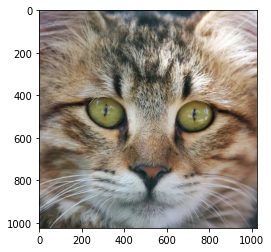

In [12]:
# Download image, take a square crop from the center
image_url = 'https://wallpaperfx.com/view_image/american-bobtail-cat-face-1024x1024-wallpaper-17750.jpg'
img = imageio.imread(image_url)[..., :3]
plt.imshow(img)
plt.show()

In [13]:
import os
import pandas as pd
from torch.utils.data import Dataset
from torchvision import datasets
from torch.utils.data import DataLoader

class CustomImageDataset(Dataset):
    def __init__(self, img):
        self.img = img # shape=(res, res, 3)
        # TODO: create positions
        X = []
        for i in range(img.shape[0]):
            for j in range(img.shape[1]):
                X.append([i, j])
        Y = (self.img.reshape([-1, 3]) / 255.).astype(np.float32)

        # TODO: parameterize the RGB output

        self.X = np.array(X) # TODO: (..., 2)
        self.Y = np.array(Y) # TODO: (..., 3)

    def __len__(self):
        return self.X.shape[0]

    def __getitem__(self, idx):
        return self.X[idx, :], self.Y[idx, :]

# TODO test your dataset
dataset = CustomImageDataset(img)
loader = DataLoader(dataset, batch_size=64, shuffle=True)
xy, rgb = next(iter(loader))
xy, rgb

(tensor[64, 2] i64 n=128 (1Kb) x∈[1, 1013] μ=514.766 σ=291.903,
 tensor[64, 3] n=192 x∈[0.055, 0.980] μ=0.552 σ=0.214)

# Network Architecture


Tips: you might find it useful to use Fourier positional encoding helpful! Check these papers:
1. https://arxiv.org/abs/2006.09661
2. https://arxiv.org/abs/2006.10739
3. https://arxiv.org/abs/2003.08934



In [187]:
import torch.nn as nn


def pos_enc(x, *args, **kwargs):
    D = kwargs['D']
    H = kwargs['H']

    x = x[:, 0] * H + x[:, 1]
    output = torch.zeros(x.shape[0], D).to(x.device)
    for i in range(0, D, 2):
        output[:, i] = torch.sin(x / (10000 ** ((2 * i)/D)))
        output[:, i+1] = torch.cos(x / (10000 ** ((2 * i)/D)))
        #output[:, i] = torch.sin(x * (2. ** i) * torch.pi)
        #output[:, i+1] = torch.cos(x * (2. ** i) * torch.pi)

    return output


class Net(nn.Module):

  def __init__(self, inp_dim, out_dim, hid_dims=[128], **kwargs):
    super().__init__()
    # TODO: pass parameters to positional encoding
    self.D = 512
    
    self.layers = nn.ModuleList()
    curr_dim = self.D 
    for dim in hid_dims:
      self.layers.append(nn.Linear(curr_dim, dim))
      curr_dim = dim
    self.nonlin = nn.ReLU()
    self.out = nn.Linear(curr_dim, out_dim)


  def forward(self, x):
    # TODO: pass parameters to positional encoding
    z = pos_enc(x, D=self.D, H=1024)
    for layer in self.layers:
      z = self.nonlin(layer(z))
    return self.out(z)

In [188]:
# Test your architecture
net = Net(2, 3, [512, 512, 512, 512, 512, 512])
batch_size = 1234
net(torch.ones((batch_size, 2)))

tensor[1234, 3] n=3702 (14Kb) x∈[0.014, 0.021] μ=0.017 σ=0.003 grad AddmmBackward0


# Training

In [189]:
# Define metrics
def compute_psnr(gtr, out):
  mse = torch.mean((gtr - out) ** 2)
  return 20 * torch.log10(1.0 / (torch.sqrt(mse) + 1e-6))

# Define
def compute_loss(out, y):
  return ((out - y) ** 2).sum()

# Preparing training, (e.g. initialize optimizer ...)
opt = torch.optim.Adam(net.parameters(), lr=1e-3)

dataset = CustomImageDataset(img)
loader = DataLoader(dataset, batch_size=64, shuffle=True)
net.cuda()
data_iter = iter(loader)
best_psnr = 0
for it in range(200000):
  try:
    x, y = next(data_iter)
  except StopIteration:
    # StopIteration is thrown if dataset ends
    # reinitialize data loader
    data_iter = iter(loader)
    x, y = next(data_iter)

  x, y = x.cuda(), y.cuda()
  opt.zero_grad()
  out = net(x)
  loss = compute_loss(out, y)
  loss.backward()
  opt.step()

  # TODO: monitor the training.
  psnr = compute_psnr(y, out.detach())
  print("Iter:", it, "PSNR:", psnr, "Loss:", loss.item())
  if best_psnr < psnr:
    best_psnr = psnr
    best_net = copy.deepcopy(net)
print("Best PSNR:", best_psnr)

Iter: 0 PSNR: tensor cuda:0 5.692 Loss: 51.77308654785156
Iter: 1 PSNR: tensor cuda:0 6.700 Loss: 41.052032470703125
Iter: 2 PSNR: tensor cuda:0 9.443 Loss: 21.829355239868164
Iter: 3 PSNR: tensor cuda:0 12.157 Loss: 11.6832914352417
Iter: 4 PSNR: tensor cuda:0 14.829 Loss: 6.315995693206787
Iter: 5 PSNR: tensor cuda:0 13.717 Loss: 8.15831184387207
Iter: 6 PSNR: tensor cuda:0 12.370 Loss: 11.124115943908691
Iter: 7 PSNR: tensor cuda:0 14.452 Loss: 6.888653755187988
Iter: 8 PSNR: tensor cuda:0 12.646 Loss: 10.440425872802734
Iter: 9 PSNR: tensor cuda:0 13.063 Loss: 9.484931945800781
Iter: 10 PSNR: tensor cuda:0 14.606 Loss: 6.647511005401611
Iter: 11 PSNR: tensor cuda:0 13.854 Loss: 7.904139518737793
Iter: 12 PSNR: tensor cuda:0 13.735 Loss: 8.12403678894043
Iter: 13 PSNR: tensor cuda:0 12.730 Loss: 10.239717483520508
Iter: 14 PSNR: tensor cuda:0 14.816 Loss: 6.334712028503418
Iter: 15 PSNR: tensor cuda:0 13.864 Loss: 7.886139869689941
Iter: 16 PSNR: tensor cuda:0 13.347 Loss: 8.8841686

Iter: 138 PSNR: tensor cuda:0 14.129 Loss: 7.419057846069336
Iter: 139 PSNR: tensor cuda:0 13.755 Loss: 8.088098526000977
Iter: 140 PSNR: tensor cuda:0 13.693 Loss: 8.204116821289062
Iter: 141 PSNR: tensor cuda:0 14.882 Loss: 6.238519191741943
Iter: 142 PSNR: tensor cuda:0 15.022 Loss: 6.040204048156738
Iter: 143 PSNR: tensor cuda:0 14.718 Loss: 6.479061603546143
Iter: 144 PSNR: tensor cuda:0 14.623 Loss: 6.622204780578613
Iter: 145 PSNR: tensor cuda:0 13.588 Loss: 8.40475082397461
Iter: 146 PSNR: tensor cuda:0 15.860 Loss: 4.980703353881836
Iter: 147 PSNR: tensor cuda:0 14.262 Loss: 7.1968278884887695
Iter: 148 PSNR: tensor cuda:0 14.531 Loss: 6.7645769119262695
Iter: 149 PSNR: tensor cuda:0 15.052 Loss: 5.998760223388672
Iter: 150 PSNR: tensor cuda:0 15.980 Loss: 4.844869613647461
Iter: 151 PSNR: tensor cuda:0 13.744 Loss: 8.108159065246582
Iter: 152 PSNR: tensor cuda:0 12.885 Loss: 9.881728172302246
Iter: 153 PSNR: tensor cuda:0 14.785 Loss: 6.379380702972412
Iter: 154 PSNR: tensor 

Iter: 278 PSNR: tensor cuda:0 15.489 Loss: 5.424619197845459
Iter: 279 PSNR: tensor cuda:0 15.101 Loss: 5.932348251342773
Iter: 280 PSNR: tensor cuda:0 15.321 Loss: 5.638602256774902
Iter: 281 PSNR: tensor cuda:0 13.868 Loss: 7.878876686096191
Iter: 282 PSNR: tensor cuda:0 15.623 Loss: 5.260453701019287
Iter: 283 PSNR: tensor cuda:0 15.558 Loss: 5.3399577140808105
Iter: 284 PSNR: tensor cuda:0 14.078 Loss: 7.507096290588379
Iter: 285 PSNR: tensor cuda:0 15.299 Loss: 5.667868614196777
Iter: 286 PSNR: tensor cuda:0 14.274 Loss: 7.176077842712402
Iter: 287 PSNR: tensor cuda:0 14.750 Loss: 6.430525302886963
Iter: 288 PSNR: tensor cuda:0 14.423 Loss: 6.933576583862305
Iter: 289 PSNR: tensor cuda:0 15.620 Loss: 5.263236999511719
Iter: 290 PSNR: tensor cuda:0 14.439 Loss: 6.908209800720215
Iter: 291 PSNR: tensor cuda:0 15.315 Loss: 5.647132396697998
Iter: 292 PSNR: tensor cuda:0 15.766 Loss: 5.090097427368164
Iter: 293 PSNR: tensor cuda:0 14.043 Loss: 7.567930221557617
Iter: 294 PSNR: tensor 

Iter: 420 PSNR: tensor cuda:0 14.493 Loss: 6.823086738586426
Iter: 421 PSNR: tensor cuda:0 15.272 Loss: 5.702695846557617
Iter: 422 PSNR: tensor cuda:0 14.974 Loss: 6.107870101928711
Iter: 423 PSNR: tensor cuda:0 15.207 Loss: 5.789399147033691
Iter: 424 PSNR: tensor cuda:0 15.313 Loss: 5.648899078369141
Iter: 425 PSNR: tensor cuda:0 15.550 Loss: 5.348897933959961
Iter: 426 PSNR: tensor cuda:0 14.964 Loss: 6.121634483337402
Iter: 427 PSNR: tensor cuda:0 15.910 Loss: 4.923942565917969
Iter: 428 PSNR: tensor cuda:0 15.790 Loss: 5.06212043762207
Iter: 429 PSNR: tensor cuda:0 15.979 Loss: 4.84566068649292
Iter: 430 PSNR: tensor cuda:0 15.311 Loss: 5.65131139755249
Iter: 431 PSNR: tensor cuda:0 14.360 Loss: 7.035231590270996
Iter: 432 PSNR: tensor cuda:0 13.908 Loss: 7.807831764221191
Iter: 433 PSNR: tensor cuda:0 16.662 Loss: 4.140815258026123
Iter: 434 PSNR: tensor cuda:0 14.322 Loss: 7.097270965576172
Iter: 435 PSNR: tensor cuda:0 16.276 Loss: 4.525419235229492
Iter: 436 PSNR: tensor cuda

Iter: 563 PSNR: tensor cuda:0 16.112 Loss: 4.700416564941406
Iter: 564 PSNR: tensor cuda:0 14.661 Loss: 6.564245223999023
Iter: 565 PSNR: tensor cuda:0 14.576 Loss: 6.693947792053223
Iter: 566 PSNR: tensor cuda:0 14.393 Loss: 6.981891632080078
Iter: 567 PSNR: tensor cuda:0 14.471 Loss: 6.858699798583984
Iter: 568 PSNR: tensor cuda:0 14.626 Loss: 6.617886066436768
Iter: 569 PSNR: tensor cuda:0 15.090 Loss: 5.947473049163818
Iter: 570 PSNR: tensor cuda:0 15.004 Loss: 6.066191673278809
Iter: 571 PSNR: tensor cuda:0 13.990 Loss: 7.660457134246826
Iter: 572 PSNR: tensor cuda:0 15.588 Loss: 5.303131580352783
Iter: 573 PSNR: tensor cuda:0 13.956 Loss: 7.72216796875
Iter: 574 PSNR: tensor cuda:0 16.687 Loss: 4.117354869842529
Iter: 575 PSNR: tensor cuda:0 14.194 Loss: 7.308815002441406
Iter: 576 PSNR: tensor cuda:0 14.294 Loss: 7.143152713775635
Iter: 577 PSNR: tensor cuda:0 16.917 Loss: 3.9044039249420166
Iter: 578 PSNR: tensor cuda:0 14.137 Loss: 7.40548038482666
Iter: 579 PSNR: tensor cuda:

Iter: 704 PSNR: tensor cuda:0 13.376 Loss: 8.825496673583984
Iter: 705 PSNR: tensor cuda:0 16.031 Loss: 4.788727760314941
Iter: 706 PSNR: tensor cuda:0 15.484 Loss: 5.431118965148926
Iter: 707 PSNR: tensor cuda:0 15.019 Loss: 6.044707775115967
Iter: 708 PSNR: tensor cuda:0 15.584 Loss: 5.308121204376221
Iter: 709 PSNR: tensor cuda:0 13.906 Loss: 7.810656547546387
Iter: 710 PSNR: tensor cuda:0 14.682 Loss: 6.533120155334473
Iter: 711 PSNR: tensor cuda:0 15.015 Loss: 6.051047325134277
Iter: 712 PSNR: tensor cuda:0 15.046 Loss: 6.00779914855957
Iter: 713 PSNR: tensor cuda:0 16.475 Loss: 4.323369026184082
Iter: 714 PSNR: tensor cuda:0 14.470 Loss: 6.8598480224609375
Iter: 715 PSNR: tensor cuda:0 14.060 Loss: 7.539265155792236
Iter: 716 PSNR: tensor cuda:0 14.809 Loss: 6.34495735168457
Iter: 717 PSNR: tensor cuda:0 14.202 Loss: 7.297023773193359
Iter: 718 PSNR: tensor cuda:0 15.113 Loss: 5.915584087371826
Iter: 719 PSNR: tensor cuda:0 14.702 Loss: 6.503357887268066
Iter: 720 PSNR: tensor cu

Iter: 846 PSNR: tensor cuda:0 16.394 Loss: 4.404561996459961
Iter: 847 PSNR: tensor cuda:0 15.257 Loss: 5.7220306396484375
Iter: 848 PSNR: tensor cuda:0 14.635 Loss: 6.603503227233887
Iter: 849 PSNR: tensor cuda:0 14.681 Loss: 6.534512996673584
Iter: 850 PSNR: tensor cuda:0 15.951 Loss: 4.8777384757995605
Iter: 851 PSNR: tensor cuda:0 16.426 Loss: 4.372400283813477
Iter: 852 PSNR: tensor cuda:0 14.248 Loss: 7.219930171966553
Iter: 853 PSNR: tensor cuda:0 14.164 Loss: 7.360208511352539
Iter: 854 PSNR: tensor cuda:0 14.539 Loss: 6.7513580322265625
Iter: 855 PSNR: tensor cuda:0 14.803 Loss: 6.353130340576172
Iter: 856 PSNR: tensor cuda:0 14.876 Loss: 6.247024059295654
Iter: 857 PSNR: tensor cuda:0 14.940 Loss: 6.15593147277832
Iter: 858 PSNR: tensor cuda:0 15.426 Loss: 5.504563331604004
Iter: 859 PSNR: tensor cuda:0 15.906 Loss: 4.928083419799805
Iter: 860 PSNR: tensor cuda:0 14.803 Loss: 6.353585243225098
Iter: 861 PSNR: tensor cuda:0 16.594 Loss: 4.206203460693359
Iter: 862 PSNR: tensor

Iter: 981 PSNR: tensor cuda:0 15.701 Loss: 5.166805744171143
Iter: 982 PSNR: tensor cuda:0 15.368 Loss: 5.578864097595215
Iter: 983 PSNR: tensor cuda:0 16.293 Loss: 4.507704734802246
Iter: 984 PSNR: tensor cuda:0 14.736 Loss: 6.452400207519531
Iter: 985 PSNR: tensor cuda:0 15.106 Loss: 5.925431251525879
Iter: 986 PSNR: tensor cuda:0 16.319 Loss: 4.481057643890381
Iter: 987 PSNR: tensor cuda:0 15.180 Loss: 5.82490873336792
Iter: 988 PSNR: tensor cuda:0 16.986 Loss: 3.8432278633117676
Iter: 989 PSNR: tensor cuda:0 17.048 Loss: 3.7887954711914062
Iter: 990 PSNR: tensor cuda:0 15.898 Loss: 4.936910152435303
Iter: 991 PSNR: tensor cuda:0 15.613 Loss: 5.271981239318848
Iter: 992 PSNR: tensor cuda:0 16.040 Loss: 4.778008460998535
Iter: 993 PSNR: tensor cuda:0 15.328 Loss: 5.629400730133057
Iter: 994 PSNR: tensor cuda:0 15.988 Loss: 4.836247444152832
Iter: 995 PSNR: tensor cuda:0 16.121 Loss: 4.6905198097229
Iter: 996 PSNR: tensor cuda:0 15.798 Loss: 5.052216053009033
Iter: 997 PSNR: tensor cu

Iter: 1115 PSNR: tensor cuda:0 14.667 Loss: 6.555431365966797
Iter: 1116 PSNR: tensor cuda:0 16.384 Loss: 4.414730072021484
Iter: 1117 PSNR: tensor cuda:0 15.839 Loss: 5.005232334136963
Iter: 1118 PSNR: tensor cuda:0 15.495 Loss: 5.417302131652832
Iter: 1119 PSNR: tensor cuda:0 16.063 Loss: 4.752826690673828
Iter: 1120 PSNR: tensor cuda:0 15.516 Loss: 5.390724182128906
Iter: 1121 PSNR: tensor cuda:0 14.794 Loss: 6.366211414337158
Iter: 1122 PSNR: tensor cuda:0 14.704 Loss: 6.499391555786133
Iter: 1123 PSNR: tensor cuda:0 14.826 Loss: 6.319774627685547
Iter: 1124 PSNR: tensor cuda:0 14.276 Loss: 7.172430992126465
Iter: 1125 PSNR: tensor cuda:0 15.406 Loss: 5.5291852951049805
Iter: 1126 PSNR: tensor cuda:0 14.824 Loss: 6.322667121887207
Iter: 1127 PSNR: tensor cuda:0 14.160 Loss: 7.367291450500488
Iter: 1128 PSNR: tensor cuda:0 15.761 Loss: 5.095072269439697
Iter: 1129 PSNR: tensor cuda:0 16.377 Loss: 4.421816825866699
Iter: 1130 PSNR: tensor cuda:0 16.742 Loss: 4.065333843231201
Iter: 1

Iter: 1250 PSNR: tensor cuda:0 14.388 Loss: 6.990988731384277
Iter: 1251 PSNR: tensor cuda:0 16.986 Loss: 3.8429319858551025
Iter: 1252 PSNR: tensor cuda:0 16.164 Loss: 4.643875598907471
Iter: 1253 PSNR: tensor cuda:0 15.560 Loss: 5.337510585784912
Iter: 1254 PSNR: tensor cuda:0 17.667 Loss: 3.285102605819702
Iter: 1255 PSNR: tensor cuda:0 16.298 Loss: 4.503113746643066
Iter: 1256 PSNR: tensor cuda:0 17.223 Loss: 3.639403820037842
Iter: 1257 PSNR: tensor cuda:0 17.285 Loss: 3.587240695953369
Iter: 1258 PSNR: tensor cuda:0 15.156 Loss: 5.8572998046875
Iter: 1259 PSNR: tensor cuda:0 15.670 Loss: 5.203653335571289
Iter: 1260 PSNR: tensor cuda:0 16.889 Loss: 3.930384635925293
Iter: 1261 PSNR: tensor cuda:0 14.918 Loss: 6.187226295471191
Iter: 1262 PSNR: tensor cuda:0 15.718 Loss: 5.146828651428223
Iter: 1263 PSNR: tensor cuda:0 15.851 Loss: 4.9911651611328125
Iter: 1264 PSNR: tensor cuda:0 16.475 Loss: 4.323505401611328
Iter: 1265 PSNR: tensor cuda:0 15.838 Loss: 5.005929470062256
Iter: 12

Iter: 1384 PSNR: tensor cuda:0 16.473 Loss: 4.3250226974487305
Iter: 1385 PSNR: tensor cuda:0 15.855 Loss: 4.986039161682129
Iter: 1386 PSNR: tensor cuda:0 16.371 Loss: 4.428287506103516
Iter: 1387 PSNR: tensor cuda:0 15.315 Loss: 5.647028923034668
Iter: 1388 PSNR: tensor cuda:0 16.018 Loss: 4.8030195236206055
Iter: 1389 PSNR: tensor cuda:0 14.859 Loss: 6.272233963012695
Iter: 1390 PSNR: tensor cuda:0 15.696 Loss: 5.172004699707031
Iter: 1391 PSNR: tensor cuda:0 16.581 Loss: 4.219274520874023
Iter: 1392 PSNR: tensor cuda:0 17.009 Loss: 3.8232357501983643
Iter: 1393 PSNR: tensor cuda:0 15.647 Loss: 5.230670928955078
Iter: 1394 PSNR: tensor cuda:0 17.366 Loss: 3.5213162899017334
Iter: 1395 PSNR: tensor cuda:0 16.649 Loss: 4.15308952331543
Iter: 1396 PSNR: tensor cuda:0 17.054 Loss: 3.78342604637146
Iter: 1397 PSNR: tensor cuda:0 17.074 Loss: 3.7663166522979736
Iter: 1398 PSNR: tensor cuda:0 14.502 Loss: 6.808480262756348
Iter: 1399 PSNR: tensor cuda:0 15.803 Loss: 5.047013282775879
Iter:

Iter: 1519 PSNR: tensor cuda:0 16.738 Loss: 4.068788051605225
Iter: 1520 PSNR: tensor cuda:0 16.426 Loss: 4.3721394538879395
Iter: 1521 PSNR: tensor cuda:0 16.231 Loss: 4.573345184326172
Iter: 1522 PSNR: tensor cuda:0 16.607 Loss: 4.194125175476074
Iter: 1523 PSNR: tensor cuda:0 17.028 Loss: 3.8063366413116455
Iter: 1524 PSNR: tensor cuda:0 17.126 Loss: 3.721619129180908
Iter: 1525 PSNR: tensor cuda:0 15.066 Loss: 5.9803571701049805
Iter: 1526 PSNR: tensor cuda:0 15.785 Loss: 5.068060398101807
Iter: 1527 PSNR: tensor cuda:0 16.854 Loss: 3.9617652893066406
Iter: 1528 PSNR: tensor cuda:0 15.635 Loss: 5.24620246887207
Iter: 1529 PSNR: tensor cuda:0 15.259 Loss: 5.720522880554199
Iter: 1530 PSNR: tensor cuda:0 14.918 Loss: 6.186896324157715
Iter: 1531 PSNR: tensor cuda:0 15.833 Loss: 5.01222038269043
Iter: 1532 PSNR: tensor cuda:0 16.106 Loss: 4.705946445465088
Iter: 1533 PSNR: tensor cuda:0 15.492 Loss: 5.421672821044922
Iter: 1534 PSNR: tensor cuda:0 15.689 Loss: 5.180727958679199
Iter: 

Iter: 1654 PSNR: tensor cuda:0 18.384 Loss: 2.785687208175659
Iter: 1655 PSNR: tensor cuda:0 17.280 Loss: 3.59134840965271
Iter: 1656 PSNR: tensor cuda:0 16.996 Loss: 3.834712028503418
Iter: 1657 PSNR: tensor cuda:0 15.338 Loss: 5.617448806762695
Iter: 1658 PSNR: tensor cuda:0 16.338 Loss: 4.461758613586426
Iter: 1659 PSNR: tensor cuda:0 16.583 Loss: 4.217068672180176
Iter: 1660 PSNR: tensor cuda:0 15.124 Loss: 5.900542259216309
Iter: 1661 PSNR: tensor cuda:0 16.597 Loss: 4.203364372253418
Iter: 1662 PSNR: tensor cuda:0 16.081 Loss: 4.733190059661865
Iter: 1663 PSNR: tensor cuda:0 17.128 Loss: 3.719414234161377
Iter: 1664 PSNR: tensor cuda:0 15.812 Loss: 5.035855770111084
Iter: 1665 PSNR: tensor cuda:0 16.127 Loss: 4.683272361755371
Iter: 1666 PSNR: tensor cuda:0 17.527 Loss: 3.3932337760925293
Iter: 1667 PSNR: tensor cuda:0 16.415 Loss: 4.383326530456543
Iter: 1668 PSNR: tensor cuda:0 17.150 Loss: 3.70060396194458
Iter: 1669 PSNR: tensor cuda:0 14.456 Loss: 6.881569862365723
Iter: 167

Iter: 1789 PSNR: tensor cuda:0 17.981 Loss: 3.0563855171203613
Iter: 1790 PSNR: tensor cuda:0 16.918 Loss: 3.904181480407715
Iter: 1791 PSNR: tensor cuda:0 16.754 Loss: 4.053892135620117
Iter: 1792 PSNR: tensor cuda:0 16.401 Loss: 4.397458076477051
Iter: 1793 PSNR: tensor cuda:0 16.308 Loss: 4.492685317993164
Iter: 1794 PSNR: tensor cuda:0 15.896 Loss: 4.939602851867676
Iter: 1795 PSNR: tensor cuda:0 16.561 Loss: 4.237901210784912
Iter: 1796 PSNR: tensor cuda:0 15.860 Loss: 4.980654239654541
Iter: 1797 PSNR: tensor cuda:0 17.165 Loss: 3.6877028942108154
Iter: 1798 PSNR: tensor cuda:0 15.342 Loss: 5.612053871154785
Iter: 1799 PSNR: tensor cuda:0 16.676 Loss: 4.127417087554932
Iter: 1800 PSNR: tensor cuda:0 15.685 Loss: 5.185724258422852
Iter: 1801 PSNR: tensor cuda:0 15.123 Loss: 5.901959419250488
Iter: 1802 PSNR: tensor cuda:0 17.163 Loss: 3.6898889541625977
Iter: 1803 PSNR: tensor cuda:0 16.824 Loss: 3.9892845153808594
Iter: 1804 PSNR: tensor cuda:0 15.346 Loss: 5.606510162353516
Iter

Iter: 1923 PSNR: tensor cuda:0 15.873 Loss: 4.966296195983887
Iter: 1924 PSNR: tensor cuda:0 17.328 Loss: 3.552485942840576
Iter: 1925 PSNR: tensor cuda:0 16.235 Loss: 4.568759918212891
Iter: 1926 PSNR: tensor cuda:0 16.602 Loss: 4.198264122009277
Iter: 1927 PSNR: tensor cuda:0 17.075 Loss: 3.7648725509643555
Iter: 1928 PSNR: tensor cuda:0 15.151 Loss: 5.86338472366333
Iter: 1929 PSNR: tensor cuda:0 15.300 Loss: 5.666703224182129
Iter: 1930 PSNR: tensor cuda:0 16.392 Loss: 4.406339645385742
Iter: 1931 PSNR: tensor cuda:0 16.999 Loss: 3.831967353820801
Iter: 1932 PSNR: tensor cuda:0 16.065 Loss: 4.750741481781006
Iter: 1933 PSNR: tensor cuda:0 14.456 Loss: 6.882000923156738
Iter: 1934 PSNR: tensor cuda:0 16.729 Loss: 4.077271938323975
Iter: 1935 PSNR: tensor cuda:0 16.181 Loss: 4.625551223754883
Iter: 1936 PSNR: tensor cuda:0 16.164 Loss: 4.643841743469238
Iter: 1937 PSNR: tensor cuda:0 16.991 Loss: 3.839148998260498
Iter: 1938 PSNR: tensor cuda:0 16.966 Loss: 3.860583782196045
Iter: 19

Iter: 2058 PSNR: tensor cuda:0 17.546 Loss: 3.3780062198638916
Iter: 2059 PSNR: tensor cuda:0 16.044 Loss: 4.7736945152282715
Iter: 2060 PSNR: tensor cuda:0 16.409 Loss: 4.389466285705566
Iter: 2061 PSNR: tensor cuda:0 17.222 Loss: 3.639983892440796
Iter: 2062 PSNR: tensor cuda:0 16.236 Loss: 4.568106651306152
Iter: 2063 PSNR: tensor cuda:0 16.455 Loss: 4.343075752258301
Iter: 2064 PSNR: tensor cuda:0 17.579 Loss: 3.3525567054748535
Iter: 2065 PSNR: tensor cuda:0 16.374 Loss: 4.4243879318237305
Iter: 2066 PSNR: tensor cuda:0 15.514 Loss: 5.393303394317627
Iter: 2067 PSNR: tensor cuda:0 16.123 Loss: 4.688505172729492
Iter: 2068 PSNR: tensor cuda:0 16.315 Loss: 4.485395908355713
Iter: 2069 PSNR: tensor cuda:0 17.211 Loss: 3.6493988037109375
Iter: 2070 PSNR: tensor cuda:0 17.181 Loss: 3.6748545169830322
Iter: 2071 PSNR: tensor cuda:0 17.675 Loss: 3.2792863845825195
Iter: 2072 PSNR: tensor cuda:0 17.170 Loss: 3.6837406158447266
Iter: 2073 PSNR: tensor cuda:0 17.159 Loss: 3.6928329467773438

Iter: 2193 PSNR: tensor cuda:0 16.781 Loss: 4.029285907745361
Iter: 2194 PSNR: tensor cuda:0 17.033 Loss: 3.8020997047424316
Iter: 2195 PSNR: tensor cuda:0 17.891 Loss: 3.120502471923828
Iter: 2196 PSNR: tensor cuda:0 17.403 Loss: 3.491265058517456
Iter: 2197 PSNR: tensor cuda:0 16.886 Loss: 3.932709217071533
Iter: 2198 PSNR: tensor cuda:0 17.215 Loss: 3.6458277702331543
Iter: 2199 PSNR: tensor cuda:0 17.139 Loss: 3.7100539207458496
Iter: 2200 PSNR: tensor cuda:0 17.588 Loss: 3.3453917503356934
Iter: 2201 PSNR: tensor cuda:0 17.558 Loss: 3.3688509464263916
Iter: 2202 PSNR: tensor cuda:0 16.716 Loss: 4.08974027633667
Iter: 2203 PSNR: tensor cuda:0 15.575 Loss: 5.318620681762695
Iter: 2204 PSNR: tensor cuda:0 16.029 Loss: 4.790486812591553
Iter: 2205 PSNR: tensor cuda:0 17.264 Loss: 3.6045782566070557
Iter: 2206 PSNR: tensor cuda:0 16.290 Loss: 4.51121711730957
Iter: 2207 PSNR: tensor cuda:0 15.492 Loss: 5.421679973602295
Iter: 2208 PSNR: tensor cuda:0 15.330 Loss: 5.626747131347656
Iter

Iter: 2328 PSNR: tensor cuda:0 17.165 Loss: 3.688202381134033
Iter: 2329 PSNR: tensor cuda:0 16.950 Loss: 3.8749876022338867
Iter: 2330 PSNR: tensor cuda:0 17.058 Loss: 3.7796483039855957
Iter: 2331 PSNR: tensor cuda:0 16.484 Loss: 4.313733100891113
Iter: 2332 PSNR: tensor cuda:0 17.103 Loss: 3.7413737773895264
Iter: 2333 PSNR: tensor cuda:0 16.957 Loss: 3.8693034648895264
Iter: 2334 PSNR: tensor cuda:0 17.278 Loss: 3.593517303466797
Iter: 2335 PSNR: tensor cuda:0 17.034 Loss: 3.801182508468628
Iter: 2336 PSNR: tensor cuda:0 17.299 Loss: 3.575932025909424
Iter: 2337 PSNR: tensor cuda:0 17.278 Loss: 3.593238353729248
Iter: 2338 PSNR: tensor cuda:0 16.869 Loss: 3.9481449127197266
Iter: 2339 PSNR: tensor cuda:0 17.363 Loss: 3.523756980895996
Iter: 2340 PSNR: tensor cuda:0 17.801 Loss: 3.1859586238861084
Iter: 2341 PSNR: tensor cuda:0 15.444 Loss: 5.480898380279541
Iter: 2342 PSNR: tensor cuda:0 16.323 Loss: 4.476583480834961
Iter: 2343 PSNR: tensor cuda:0 16.969 Loss: 3.8579578399658203
I

Iter: 2461 PSNR: tensor cuda:0 18.146 Loss: 2.942446708679199
Iter: 2462 PSNR: tensor cuda:0 16.684 Loss: 4.119524955749512
Iter: 2463 PSNR: tensor cuda:0 16.811 Loss: 4.001355171203613
Iter: 2464 PSNR: tensor cuda:0 17.529 Loss: 3.391479969024658
Iter: 2465 PSNR: tensor cuda:0 17.251 Loss: 3.61552095413208
Iter: 2466 PSNR: tensor cuda:0 16.987 Loss: 3.8423960208892822
Iter: 2467 PSNR: tensor cuda:0 17.621 Loss: 3.320542573928833
Iter: 2468 PSNR: tensor cuda:0 17.036 Loss: 3.7992734909057617
Iter: 2469 PSNR: tensor cuda:0 16.729 Loss: 4.077489376068115
Iter: 2470 PSNR: tensor cuda:0 16.601 Loss: 4.199122428894043
Iter: 2471 PSNR: tensor cuda:0 16.170 Loss: 4.637358665466309
Iter: 2472 PSNR: tensor cuda:0 16.908 Loss: 3.9124417304992676
Iter: 2473 PSNR: tensor cuda:0 17.392 Loss: 3.5003092288970947
Iter: 2474 PSNR: tensor cuda:0 15.725 Loss: 5.137594223022461
Iter: 2475 PSNR: tensor cuda:0 16.925 Loss: 3.897629737854004
Iter: 2476 PSNR: tensor cuda:0 17.775 Loss: 3.2046167850494385
Iter

Iter: 2595 PSNR: tensor cuda:0 15.681 Loss: 5.190271377563477
Iter: 2596 PSNR: tensor cuda:0 16.819 Loss: 3.9934566020965576
Iter: 2597 PSNR: tensor cuda:0 17.360 Loss: 3.5262556076049805
Iter: 2598 PSNR: tensor cuda:0 14.772 Loss: 6.399119853973389
Iter: 2599 PSNR: tensor cuda:0 15.401 Loss: 5.536081314086914
Iter: 2600 PSNR: tensor cuda:0 16.874 Loss: 3.9433231353759766
Iter: 2601 PSNR: tensor cuda:0 17.370 Loss: 3.5177769660949707
Iter: 2602 PSNR: tensor cuda:0 15.892 Loss: 4.943717002868652
Iter: 2603 PSNR: tensor cuda:0 15.925 Loss: 4.906698226928711
Iter: 2604 PSNR: tensor cuda:0 16.484 Loss: 4.314151763916016
Iter: 2605 PSNR: tensor cuda:0 16.805 Loss: 4.006937026977539
Iter: 2606 PSNR: tensor cuda:0 17.469 Loss: 3.4384915828704834
Iter: 2607 PSNR: tensor cuda:0 17.373 Loss: 3.5159430503845215
Iter: 2608 PSNR: tensor cuda:0 16.672 Loss: 4.1318039894104
Iter: 2609 PSNR: tensor cuda:0 16.186 Loss: 4.620291709899902
Iter: 2610 PSNR: tensor cuda:0 17.213 Loss: 3.6471292972564697
Ite

Iter: 2730 PSNR: tensor cuda:0 17.652 Loss: 3.29668927192688
Iter: 2731 PSNR: tensor cuda:0 16.270 Loss: 4.5319037437438965
Iter: 2732 PSNR: tensor cuda:0 17.687 Loss: 3.2703380584716797
Iter: 2733 PSNR: tensor cuda:0 17.423 Loss: 3.475712299346924
Iter: 2734 PSNR: tensor cuda:0 16.486 Loss: 4.312613487243652
Iter: 2735 PSNR: tensor cuda:0 18.878 Loss: 2.4857969284057617
Iter: 2736 PSNR: tensor cuda:0 16.312 Loss: 4.4887471199035645
Iter: 2737 PSNR: tensor cuda:0 17.765 Loss: 3.212320327758789
Iter: 2738 PSNR: tensor cuda:0 16.248 Loss: 4.554800510406494
Iter: 2739 PSNR: tensor cuda:0 15.832 Loss: 5.013263702392578
Iter: 2740 PSNR: tensor cuda:0 16.837 Loss: 3.9769883155822754
Iter: 2741 PSNR: tensor cuda:0 18.628 Loss: 2.633131980895996
Iter: 2742 PSNR: tensor cuda:0 16.644 Loss: 4.158019065856934
Iter: 2743 PSNR: tensor cuda:0 18.075 Loss: 2.9907522201538086
Iter: 2744 PSNR: tensor cuda:0 17.600 Loss: 3.3365190029144287
Iter: 2745 PSNR: tensor cuda:0 17.724 Loss: 3.24261212348938
Ite

Iter: 2864 PSNR: tensor cuda:0 17.563 Loss: 3.365328311920166
Iter: 2865 PSNR: tensor cuda:0 15.455 Loss: 5.4670186042785645
Iter: 2866 PSNR: tensor cuda:0 16.710 Loss: 4.095700740814209
Iter: 2867 PSNR: tensor cuda:0 17.339 Loss: 3.5430731773376465
Iter: 2868 PSNR: tensor cuda:0 17.558 Loss: 3.3692009449005127
Iter: 2869 PSNR: tensor cuda:0 17.048 Loss: 3.7886593341827393
Iter: 2870 PSNR: tensor cuda:0 18.058 Loss: 3.002779006958008
Iter: 2871 PSNR: tensor cuda:0 16.924 Loss: 3.8986382484436035
Iter: 2872 PSNR: tensor cuda:0 15.899 Loss: 4.936305999755859
Iter: 2873 PSNR: tensor cuda:0 16.039 Loss: 4.779288291931152
Iter: 2874 PSNR: tensor cuda:0 17.434 Loss: 3.4663825035095215
Iter: 2875 PSNR: tensor cuda:0 18.173 Loss: 2.9242591857910156
Iter: 2876 PSNR: tensor cuda:0 16.410 Loss: 4.388250350952148
Iter: 2877 PSNR: tensor cuda:0 15.977 Loss: 4.848322868347168
Iter: 2878 PSNR: tensor cuda:0 19.308 Loss: 2.251542091369629
Iter: 2879 PSNR: tensor cuda:0 17.275 Loss: 3.595703125
Iter: 2

Iter: 2997 PSNR: tensor cuda:0 16.438 Loss: 4.36024284362793
Iter: 2998 PSNR: tensor cuda:0 15.906 Loss: 4.928518295288086
Iter: 2999 PSNR: tensor cuda:0 18.792 Loss: 2.535522222518921
Iter: 3000 PSNR: tensor cuda:0 18.035 Loss: 3.0182995796203613
Iter: 3001 PSNR: tensor cuda:0 17.843 Loss: 3.1549973487854004
Iter: 3002 PSNR: tensor cuda:0 16.081 Loss: 4.733654022216797
Iter: 3003 PSNR: tensor cuda:0 17.329 Loss: 3.5517325401306152
Iter: 3004 PSNR: tensor cuda:0 15.787 Loss: 5.065313339233398
Iter: 3005 PSNR: tensor cuda:0 16.557 Loss: 4.242279052734375
Iter: 3006 PSNR: tensor cuda:0 15.980 Loss: 4.844996452331543
Iter: 3007 PSNR: tensor cuda:0 16.901 Loss: 3.9191579818725586
Iter: 3008 PSNR: tensor cuda:0 17.323 Loss: 3.556089401245117
Iter: 3009 PSNR: tensor cuda:0 17.332 Loss: 3.5489585399627686
Iter: 3010 PSNR: tensor cuda:0 17.477 Loss: 3.4322807788848877
Iter: 3011 PSNR: tensor cuda:0 17.498 Loss: 3.415961265563965
Iter: 3012 PSNR: tensor cuda:0 16.704 Loss: 4.100665092468262
Ite

Iter: 3132 PSNR: tensor cuda:0 16.741 Loss: 4.065896511077881
Iter: 3133 PSNR: tensor cuda:0 17.660 Loss: 3.29083514213562
Iter: 3134 PSNR: tensor cuda:0 19.631 Loss: 2.090116500854492
Iter: 3135 PSNR: tensor cuda:0 19.197 Loss: 2.3099262714385986
Iter: 3136 PSNR: tensor cuda:0 17.223 Loss: 3.6391537189483643
Iter: 3137 PSNR: tensor cuda:0 18.741 Loss: 2.565377950668335
Iter: 3138 PSNR: tensor cuda:0 17.586 Loss: 3.347466468811035
Iter: 3139 PSNR: tensor cuda:0 18.462 Loss: 2.735846519470215
Iter: 3140 PSNR: tensor cuda:0 17.814 Loss: 3.1763713359832764
Iter: 3141 PSNR: tensor cuda:0 17.291 Loss: 3.5829367637634277
Iter: 3142 PSNR: tensor cuda:0 17.948 Loss: 3.0794782638549805
Iter: 3143 PSNR: tensor cuda:0 18.141 Loss: 2.945852279663086
Iter: 3144 PSNR: tensor cuda:0 18.525 Loss: 2.696258783340454
Iter: 3145 PSNR: tensor cuda:0 18.319 Loss: 2.8273987770080566
Iter: 3146 PSNR: tensor cuda:0 18.775 Loss: 2.545466184616089
Iter: 3147 PSNR: tensor cuda:0 17.340 Loss: 3.542448043823242
Ite

Iter: 3267 PSNR: tensor cuda:0 17.981 Loss: 3.0565221309661865
Iter: 3268 PSNR: tensor cuda:0 15.908 Loss: 4.925465106964111
Iter: 3269 PSNR: tensor cuda:0 16.446 Loss: 4.351691722869873
Iter: 3270 PSNR: tensor cuda:0 15.888 Loss: 4.948516845703125
Iter: 3271 PSNR: tensor cuda:0 16.398 Loss: 4.400477409362793
Iter: 3272 PSNR: tensor cuda:0 15.718 Loss: 5.146827697753906
Iter: 3273 PSNR: tensor cuda:0 17.101 Loss: 3.7431464195251465
Iter: 3274 PSNR: tensor cuda:0 16.490 Loss: 4.307754039764404
Iter: 3275 PSNR: tensor cuda:0 16.542 Loss: 4.257165431976318
Iter: 3276 PSNR: tensor cuda:0 16.958 Loss: 3.867905616760254
Iter: 3277 PSNR: tensor cuda:0 17.227 Loss: 3.6354820728302
Iter: 3278 PSNR: tensor cuda:0 15.705 Loss: 5.161985874176025
Iter: 3279 PSNR: tensor cuda:0 18.385 Loss: 2.7846713066101074
Iter: 3280 PSNR: tensor cuda:0 17.758 Loss: 3.2176144123077393
Iter: 3281 PSNR: tensor cuda:0 16.650 Loss: 4.152133941650391
Iter: 3282 PSNR: tensor cuda:0 16.837 Loss: 3.9769904613494873
Iter:

Iter: 3402 PSNR: tensor cuda:0 19.271 Loss: 2.2706191539764404
Iter: 3403 PSNR: tensor cuda:0 17.198 Loss: 3.660069465637207
Iter: 3404 PSNR: tensor cuda:0 16.545 Loss: 4.254329204559326
Iter: 3405 PSNR: tensor cuda:0 17.912 Loss: 3.1048972606658936
Iter: 3406 PSNR: tensor cuda:0 15.798 Loss: 5.052207946777344
Iter: 3407 PSNR: tensor cuda:0 16.987 Loss: 3.84256649017334
Iter: 3408 PSNR: tensor cuda:0 16.683 Loss: 4.120471954345703
Iter: 3409 PSNR: tensor cuda:0 18.220 Loss: 2.8928494453430176
Iter: 3410 PSNR: tensor cuda:0 16.799 Loss: 4.012339115142822
Iter: 3411 PSNR: tensor cuda:0 16.920 Loss: 3.9016990661621094
Iter: 3412 PSNR: tensor cuda:0 17.241 Loss: 3.6237752437591553
Iter: 3413 PSNR: tensor cuda:0 16.317 Loss: 4.483072757720947
Iter: 3414 PSNR: tensor cuda:0 17.028 Loss: 3.806666135787964
Iter: 3415 PSNR: tensor cuda:0 16.885 Loss: 3.933859348297119
Iter: 3416 PSNR: tensor cuda:0 16.711 Loss: 4.09410285949707
Iter: 3417 PSNR: tensor cuda:0 17.134 Loss: 3.7143383026123047
Iter

Iter: 3537 PSNR: tensor cuda:0 17.624 Loss: 3.318477153778076
Iter: 3538 PSNR: tensor cuda:0 18.042 Loss: 3.013559341430664
Iter: 3539 PSNR: tensor cuda:0 18.477 Loss: 2.726121425628662
Iter: 3540 PSNR: tensor cuda:0 18.328 Loss: 2.8215434551239014
Iter: 3541 PSNR: tensor cuda:0 17.624 Loss: 3.3180675506591797
Iter: 3542 PSNR: tensor cuda:0 17.824 Loss: 3.1688246726989746
Iter: 3543 PSNR: tensor cuda:0 15.957 Loss: 4.870813369750977
Iter: 3544 PSNR: tensor cuda:0 16.787 Loss: 4.022987365722656
Iter: 3545 PSNR: tensor cuda:0 18.678 Loss: 2.6031484603881836
Iter: 3546 PSNR: tensor cuda:0 16.003 Loss: 4.819112777709961
Iter: 3547 PSNR: tensor cuda:0 16.478 Loss: 4.320605278015137
Iter: 3548 PSNR: tensor cuda:0 18.248 Loss: 2.873769760131836
Iter: 3549 PSNR: tensor cuda:0 17.665 Loss: 3.2867255210876465
Iter: 3550 PSNR: tensor cuda:0 17.733 Loss: 3.2361512184143066
Iter: 3551 PSNR: tensor cuda:0 17.452 Loss: 3.4523096084594727
Iter: 3552 PSNR: tensor cuda:0 17.417 Loss: 3.479731798171997
I

Iter: 3671 PSNR: tensor cuda:0 19.551 Loss: 2.1293156147003174
Iter: 3672 PSNR: tensor cuda:0 19.044 Loss: 2.392927408218384
Iter: 3673 PSNR: tensor cuda:0 17.483 Loss: 3.4274330139160156
Iter: 3674 PSNR: tensor cuda:0 18.421 Loss: 2.7619173526763916
Iter: 3675 PSNR: tensor cuda:0 16.745 Loss: 4.0622782707214355
Iter: 3676 PSNR: tensor cuda:0 16.321 Loss: 4.479247093200684
Iter: 3677 PSNR: tensor cuda:0 18.035 Loss: 3.0186543464660645
Iter: 3678 PSNR: tensor cuda:0 16.548 Loss: 4.2505950927734375
Iter: 3679 PSNR: tensor cuda:0 17.373 Loss: 3.5156402587890625
Iter: 3680 PSNR: tensor cuda:0 18.494 Loss: 2.7158737182617188
Iter: 3681 PSNR: tensor cuda:0 17.533 Loss: 3.388648509979248
Iter: 3682 PSNR: tensor cuda:0 17.461 Loss: 3.4450602531433105
Iter: 3683 PSNR: tensor cuda:0 16.130 Loss: 4.680008888244629
Iter: 3684 PSNR: tensor cuda:0 17.114 Loss: 3.7317700386047363
Iter: 3685 PSNR: tensor cuda:0 18.679 Loss: 2.602621078491211
Iter: 3686 PSNR: tensor cuda:0 17.841 Loss: 3.15676164627075

Iter: 3805 PSNR: tensor cuda:0 17.249 Loss: 3.6177730560302734
Iter: 3806 PSNR: tensor cuda:0 17.473 Loss: 3.4357142448425293
Iter: 3807 PSNR: tensor cuda:0 17.342 Loss: 3.5403685569763184
Iter: 3808 PSNR: tensor cuda:0 17.448 Loss: 3.455441474914551
Iter: 3809 PSNR: tensor cuda:0 18.520 Loss: 2.6994194984436035
Iter: 3810 PSNR: tensor cuda:0 18.962 Loss: 2.438154458999634
Iter: 3811 PSNR: tensor cuda:0 17.742 Loss: 3.229191541671753
Iter: 3812 PSNR: tensor cuda:0 19.134 Loss: 2.3437998294830322
Iter: 3813 PSNR: tensor cuda:0 17.859 Loss: 3.1434290409088135
Iter: 3814 PSNR: tensor cuda:0 16.250 Loss: 4.552724838256836
Iter: 3815 PSNR: tensor cuda:0 18.094 Loss: 2.9775829315185547
Iter: 3816 PSNR: tensor cuda:0 17.823 Loss: 3.1692042350769043
Iter: 3817 PSNR: tensor cuda:0 16.506 Loss: 4.29207181930542
Iter: 3818 PSNR: tensor cuda:0 18.232 Loss: 2.8846964836120605
Iter: 3819 PSNR: tensor cuda:0 17.239 Loss: 3.625501871109009
Iter: 3820 PSNR: tensor cuda:0 16.749 Loss: 4.058505058288574


Iter: 3939 PSNR: tensor cuda:0 17.428 Loss: 3.4716391563415527
Iter: 3940 PSNR: tensor cuda:0 16.763 Loss: 4.045967102050781
Iter: 3941 PSNR: tensor cuda:0 16.300 Loss: 4.500679969787598
Iter: 3942 PSNR: tensor cuda:0 18.073 Loss: 2.9925029277801514
Iter: 3943 PSNR: tensor cuda:0 19.115 Loss: 2.3541266918182373
Iter: 3944 PSNR: tensor cuda:0 16.682 Loss: 4.121694564819336
Iter: 3945 PSNR: tensor cuda:0 17.914 Loss: 3.1038248538970947
Iter: 3946 PSNR: tensor cuda:0 17.567 Loss: 3.3620383739471436
Iter: 3947 PSNR: tensor cuda:0 16.999 Loss: 3.8317158222198486
Iter: 3948 PSNR: tensor cuda:0 17.960 Loss: 3.0709686279296875
Iter: 3949 PSNR: tensor cuda:0 18.861 Loss: 2.495911121368408
Iter: 3950 PSNR: tensor cuda:0 16.739 Loss: 4.068503379821777
Iter: 3951 PSNR: tensor cuda:0 17.889 Loss: 3.1217739582061768
Iter: 3952 PSNR: tensor cuda:0 16.020 Loss: 4.801063060760498
Iter: 3953 PSNR: tensor cuda:0 18.461 Loss: 2.736661911010742
Iter: 3954 PSNR: tensor cuda:0 16.973 Loss: 3.85463809967041
I

Iter: 4074 PSNR: tensor cuda:0 17.497 Loss: 3.41638445854187
Iter: 4075 PSNR: tensor cuda:0 18.038 Loss: 3.0161523818969727
Iter: 4076 PSNR: tensor cuda:0 16.932 Loss: 3.8912482261657715
Iter: 4077 PSNR: tensor cuda:0 19.060 Loss: 2.383699417114258
Iter: 4078 PSNR: tensor cuda:0 18.090 Loss: 2.9803075790405273
Iter: 4079 PSNR: tensor cuda:0 18.455 Loss: 2.7404444217681885
Iter: 4080 PSNR: tensor cuda:0 18.045 Loss: 3.0117392539978027
Iter: 4081 PSNR: tensor cuda:0 20.177 Loss: 1.8434312343597412
Iter: 4082 PSNR: tensor cuda:0 17.931 Loss: 3.091691255569458
Iter: 4083 PSNR: tensor cuda:0 17.715 Loss: 3.248983860015869
Iter: 4084 PSNR: tensor cuda:0 16.332 Loss: 4.467649459838867
Iter: 4085 PSNR: tensor cuda:0 17.892 Loss: 3.1197047233581543
Iter: 4086 PSNR: tensor cuda:0 16.856 Loss: 3.9602723121643066
Iter: 4087 PSNR: tensor cuda:0 18.220 Loss: 2.892636775970459
Iter: 4088 PSNR: tensor cuda:0 16.486 Loss: 4.311866760253906
Iter: 4089 PSNR: tensor cuda:0 17.760 Loss: 3.216153621673584
I

Iter: 4208 PSNR: tensor cuda:0 16.937 Loss: 3.886676788330078
Iter: 4209 PSNR: tensor cuda:0 18.093 Loss: 2.9784908294677734
Iter: 4210 PSNR: tensor cuda:0 18.568 Loss: 2.6699819564819336
Iter: 4211 PSNR: tensor cuda:0 18.208 Loss: 2.9005179405212402
Iter: 4212 PSNR: tensor cuda:0 16.876 Loss: 3.941570520401001
Iter: 4213 PSNR: tensor cuda:0 18.074 Loss: 2.991217613220215
Iter: 4214 PSNR: tensor cuda:0 19.237 Loss: 2.2889461517333984
Iter: 4215 PSNR: tensor cuda:0 17.883 Loss: 3.1262826919555664
Iter: 4216 PSNR: tensor cuda:0 20.100 Loss: 1.876204252243042
Iter: 4217 PSNR: tensor cuda:0 17.000 Loss: 3.8310866355895996
Iter: 4218 PSNR: tensor cuda:0 17.157 Loss: 3.695000171661377
Iter: 4219 PSNR: tensor cuda:0 19.856 Loss: 1.9846765995025635
Iter: 4220 PSNR: tensor cuda:0 18.169 Loss: 2.9269590377807617
Iter: 4221 PSNR: tensor cuda:0 17.415 Loss: 3.481494188308716
Iter: 4222 PSNR: tensor cuda:0 17.914 Loss: 3.1037707328796387
Iter: 4223 PSNR: tensor cuda:0 16.309 Loss: 4.491099834442139

Iter: 4343 PSNR: tensor cuda:0 19.559 Loss: 2.125142812728882
Iter: 4344 PSNR: tensor cuda:0 17.193 Loss: 3.664618492126465
Iter: 4345 PSNR: tensor cuda:0 17.315 Loss: 3.5629141330718994
Iter: 4346 PSNR: tensor cuda:0 18.584 Loss: 2.659888982772827
Iter: 4347 PSNR: tensor cuda:0 19.602 Loss: 2.104177474975586
Iter: 4348 PSNR: tensor cuda:0 18.945 Loss: 2.447690010070801
Iter: 4349 PSNR: tensor cuda:0 16.483 Loss: 4.3148040771484375
Iter: 4350 PSNR: tensor cuda:0 17.143 Loss: 3.706389904022217
Iter: 4351 PSNR: tensor cuda:0 18.933 Loss: 2.4544625282287598
Iter: 4352 PSNR: tensor cuda:0 18.146 Loss: 2.9424519538879395
Iter: 4353 PSNR: tensor cuda:0 17.578 Loss: 3.3537728786468506
Iter: 4354 PSNR: tensor cuda:0 17.341 Loss: 3.5416958332061768
Iter: 4355 PSNR: tensor cuda:0 17.310 Loss: 3.5672435760498047
Iter: 4356 PSNR: tensor cuda:0 19.197 Loss: 2.309900999069214
Iter: 4357 PSNR: tensor cuda:0 18.207 Loss: 2.9011292457580566
Iter: 4358 PSNR: tensor cuda:0 17.767 Loss: 3.2107436656951904

Iter: 4477 PSNR: tensor cuda:0 19.893 Loss: 1.9676308631896973
Iter: 4478 PSNR: tensor cuda:0 18.072 Loss: 2.9931411743164062
Iter: 4479 PSNR: tensor cuda:0 18.878 Loss: 2.486150026321411
Iter: 4480 PSNR: tensor cuda:0 17.217 Loss: 3.6440327167510986
Iter: 4481 PSNR: tensor cuda:0 17.329 Loss: 3.5509872436523438
Iter: 4482 PSNR: tensor cuda:0 18.222 Loss: 2.8911290168762207
Iter: 4483 PSNR: tensor cuda:0 16.375 Loss: 4.4233012199401855
Iter: 4484 PSNR: tensor cuda:0 19.493 Loss: 2.157912015914917
Iter: 4485 PSNR: tensor cuda:0 16.381 Loss: 4.418060302734375
Iter: 4486 PSNR: tensor cuda:0 17.525 Loss: 3.3945155143737793
Iter: 4487 PSNR: tensor cuda:0 16.831 Loss: 3.9826860427856445
Iter: 4488 PSNR: tensor cuda:0 17.534 Loss: 3.3875064849853516
Iter: 4489 PSNR: tensor cuda:0 16.942 Loss: 3.8822953701019287
Iter: 4490 PSNR: tensor cuda:0 18.372 Loss: 2.7934417724609375
Iter: 4491 PSNR: tensor cuda:0 17.413 Loss: 3.4830663204193115
Iter: 4492 PSNR: tensor cuda:0 19.482 Loss: 2.163097858428

Iter: 4612 PSNR: tensor cuda:0 15.514 Loss: 5.393320083618164
Iter: 4613 PSNR: tensor cuda:0 16.646 Loss: 4.156555652618408
Iter: 4614 PSNR: tensor cuda:0 18.030 Loss: 3.021789073944092
Iter: 4615 PSNR: tensor cuda:0 18.431 Loss: 2.755310297012329
Iter: 4616 PSNR: tensor cuda:0 19.240 Loss: 2.2872467041015625
Iter: 4617 PSNR: tensor cuda:0 18.956 Loss: 2.4418044090270996
Iter: 4618 PSNR: tensor cuda:0 18.812 Loss: 2.524003505706787
Iter: 4619 PSNR: tensor cuda:0 18.232 Loss: 2.8846845626831055
Iter: 4620 PSNR: tensor cuda:0 17.621 Loss: 3.3206238746643066
Iter: 4621 PSNR: tensor cuda:0 17.422 Loss: 3.4760286808013916
Iter: 4622 PSNR: tensor cuda:0 18.277 Loss: 2.855097532272339
Iter: 4623 PSNR: tensor cuda:0 18.415 Loss: 2.7653512954711914
Iter: 4624 PSNR: tensor cuda:0 18.413 Loss: 2.7669034004211426
Iter: 4625 PSNR: tensor cuda:0 18.112 Loss: 2.965543031692505
Iter: 4626 PSNR: tensor cuda:0 16.489 Loss: 4.3093719482421875
Iter: 4627 PSNR: tensor cuda:0 16.809 Loss: 4.002649307250977


Iter: 4746 PSNR: tensor cuda:0 17.639 Loss: 3.3068737983703613
Iter: 4747 PSNR: tensor cuda:0 17.622 Loss: 3.3200156688690186
Iter: 4748 PSNR: tensor cuda:0 18.947 Loss: 2.44685697555542
Iter: 4749 PSNR: tensor cuda:0 17.022 Loss: 3.8116393089294434
Iter: 4750 PSNR: tensor cuda:0 17.191 Loss: 3.6659677028656006
Iter: 4751 PSNR: tensor cuda:0 17.937 Loss: 3.0871448516845703
Iter: 4752 PSNR: tensor cuda:0 16.124 Loss: 4.6868672370910645
Iter: 4753 PSNR: tensor cuda:0 19.817 Loss: 2.002673625946045
Iter: 4754 PSNR: tensor cuda:0 18.163 Loss: 2.93087100982666
Iter: 4755 PSNR: tensor cuda:0 19.289 Loss: 2.261422634124756
Iter: 4756 PSNR: tensor cuda:0 19.702 Loss: 2.0560970306396484
Iter: 4757 PSNR: tensor cuda:0 16.861 Loss: 3.955253839492798
Iter: 4758 PSNR: tensor cuda:0 17.886 Loss: 3.1237270832061768
Iter: 4759 PSNR: tensor cuda:0 17.616 Loss: 3.323939800262451
Iter: 4760 PSNR: tensor cuda:0 17.507 Loss: 3.408433437347412
Iter: 4761 PSNR: tensor cuda:0 19.116 Loss: 2.353243350982666
It

Iter: 4881 PSNR: tensor cuda:0 18.335 Loss: 2.8169174194335938
Iter: 4882 PSNR: tensor cuda:0 19.740 Loss: 2.0382509231567383
Iter: 4883 PSNR: tensor cuda:0 18.029 Loss: 3.0225765705108643
Iter: 4884 PSNR: tensor cuda:0 19.683 Loss: 2.065300941467285
Iter: 4885 PSNR: tensor cuda:0 17.823 Loss: 3.169466495513916
Iter: 4886 PSNR: tensor cuda:0 17.705 Loss: 3.256784200668335
Iter: 4887 PSNR: tensor cuda:0 19.438 Loss: 2.1853299140930176
Iter: 4888 PSNR: tensor cuda:0 17.459 Loss: 3.4465150833129883
Iter: 4889 PSNR: tensor cuda:0 17.513 Loss: 3.4043185710906982
Iter: 4890 PSNR: tensor cuda:0 18.234 Loss: 2.8830513954162598
Iter: 4891 PSNR: tensor cuda:0 16.445 Loss: 4.353199005126953
Iter: 4892 PSNR: tensor cuda:0 17.248 Loss: 3.6178784370422363
Iter: 4893 PSNR: tensor cuda:0 18.115 Loss: 2.9632363319396973
Iter: 4894 PSNR: tensor cuda:0 18.901 Loss: 2.4730865955352783
Iter: 4895 PSNR: tensor cuda:0 18.397 Loss: 2.776968002319336
Iter: 4896 PSNR: tensor cuda:0 19.001 Loss: 2.41631555557250

Iter: 5016 PSNR: tensor cuda:0 19.176 Loss: 2.3208770751953125
Iter: 5017 PSNR: tensor cuda:0 19.660 Loss: 2.076124906539917
Iter: 5018 PSNR: tensor cuda:0 18.546 Loss: 2.683344841003418
Iter: 5019 PSNR: tensor cuda:0 19.850 Loss: 1.9872722625732422
Iter: 5020 PSNR: tensor cuda:0 18.542 Loss: 2.6856398582458496
Iter: 5021 PSNR: tensor cuda:0 18.654 Loss: 2.6177453994750977
Iter: 5022 PSNR: tensor cuda:0 20.157 Loss: 1.8516305685043335
Iter: 5023 PSNR: tensor cuda:0 18.310 Loss: 2.833171844482422
Iter: 5024 PSNR: tensor cuda:0 18.579 Loss: 2.663179874420166
Iter: 5025 PSNR: tensor cuda:0 17.624 Loss: 3.317963123321533
Iter: 5026 PSNR: tensor cuda:0 17.535 Loss: 3.3865866661071777
Iter: 5027 PSNR: tensor cuda:0 17.444 Loss: 3.4582252502441406
Iter: 5028 PSNR: tensor cuda:0 17.202 Loss: 3.656947135925293
Iter: 5029 PSNR: tensor cuda:0 18.583 Loss: 2.6609396934509277
Iter: 5030 PSNR: tensor cuda:0 18.317 Loss: 2.8290414810180664
Iter: 5031 PSNR: tensor cuda:0 17.712 Loss: 3.251698255538940

Iter: 5151 PSNR: tensor cuda:0 16.294 Loss: 4.507490158081055
Iter: 5152 PSNR: tensor cuda:0 18.920 Loss: 2.462052345275879
Iter: 5153 PSNR: tensor cuda:0 17.205 Loss: 3.654083013534546
Iter: 5154 PSNR: tensor cuda:0 19.060 Loss: 2.3837714195251465
Iter: 5155 PSNR: tensor cuda:0 18.307 Loss: 2.835188388824463
Iter: 5156 PSNR: tensor cuda:0 18.263 Loss: 2.863945960998535
Iter: 5157 PSNR: tensor cuda:0 17.784 Loss: 3.197789192199707
Iter: 5158 PSNR: tensor cuda:0 17.681 Loss: 3.2750730514526367
Iter: 5159 PSNR: tensor cuda:0 18.204 Loss: 2.903618335723877
Iter: 5160 PSNR: tensor cuda:0 17.781 Loss: 3.200066566467285
Iter: 5161 PSNR: tensor cuda:0 19.092 Loss: 2.366554021835327
Iter: 5162 PSNR: tensor cuda:0 17.916 Loss: 3.1022539138793945
Iter: 5163 PSNR: tensor cuda:0 17.121 Loss: 3.7259747982025146
Iter: 5164 PSNR: tensor cuda:0 17.431 Loss: 3.468709707260132
Iter: 5165 PSNR: tensor cuda:0 17.820 Loss: 3.171705961227417
Iter: 5166 PSNR: tensor cuda:0 17.802 Loss: 3.184551954269409
Iter

Iter: 5286 PSNR: tensor cuda:0 18.169 Loss: 2.926636219024658
Iter: 5287 PSNR: tensor cuda:0 17.374 Loss: 3.5151100158691406
Iter: 5288 PSNR: tensor cuda:0 17.278 Loss: 3.592954158782959
Iter: 5289 PSNR: tensor cuda:0 18.224 Loss: 2.890115737915039
Iter: 5290 PSNR: tensor cuda:0 17.117 Loss: 3.72870135307312
Iter: 5291 PSNR: tensor cuda:0 16.800 Loss: 4.011363983154297
Iter: 5292 PSNR: tensor cuda:0 19.386 Loss: 2.211482524871826
Iter: 5293 PSNR: tensor cuda:0 20.012 Loss: 1.9146136045455933
Iter: 5294 PSNR: tensor cuda:0 17.304 Loss: 3.57182240486145
Iter: 5295 PSNR: tensor cuda:0 16.851 Loss: 3.9645836353302
Iter: 5296 PSNR: tensor cuda:0 17.231 Loss: 3.6322357654571533
Iter: 5297 PSNR: tensor cuda:0 18.443 Loss: 2.7480227947235107
Iter: 5298 PSNR: tensor cuda:0 18.040 Loss: 3.014735221862793
Iter: 5299 PSNR: tensor cuda:0 17.835 Loss: 3.161085367202759
Iter: 5300 PSNR: tensor cuda:0 18.289 Loss: 2.846895694732666
Iter: 5301 PSNR: tensor cuda:0 19.286 Loss: 2.2631168365478516
Iter: 5

Iter: 5421 PSNR: tensor cuda:0 18.594 Loss: 2.6542551517486572
Iter: 5422 PSNR: tensor cuda:0 18.113 Loss: 2.9647881984710693
Iter: 5423 PSNR: tensor cuda:0 18.062 Loss: 2.999905824661255
Iter: 5424 PSNR: tensor cuda:0 19.459 Loss: 2.174898624420166
Iter: 5425 PSNR: tensor cuda:0 18.398 Loss: 2.7765109539031982
Iter: 5426 PSNR: tensor cuda:0 16.603 Loss: 4.197317600250244
Iter: 5427 PSNR: tensor cuda:0 18.295 Loss: 2.842827558517456
Iter: 5428 PSNR: tensor cuda:0 16.354 Loss: 4.445052146911621
Iter: 5429 PSNR: tensor cuda:0 18.676 Loss: 2.604593515396118
Iter: 5430 PSNR: tensor cuda:0 18.872 Loss: 2.4896321296691895
Iter: 5431 PSNR: tensor cuda:0 20.026 Loss: 1.9086945056915283
Iter: 5432 PSNR: tensor cuda:0 19.849 Loss: 1.9880812168121338
Iter: 5433 PSNR: tensor cuda:0 17.777 Loss: 3.203184127807617
Iter: 5434 PSNR: tensor cuda:0 17.500 Loss: 3.414160966873169
Iter: 5435 PSNR: tensor cuda:0 18.645 Loss: 2.622871160507202
Iter: 5436 PSNR: tensor cuda:0 16.457 Loss: 4.341337203979492
It

Iter: 5556 PSNR: tensor cuda:0 17.780 Loss: 3.201317310333252
Iter: 5557 PSNR: tensor cuda:0 18.300 Loss: 2.839599609375
Iter: 5558 PSNR: tensor cuda:0 18.791 Loss: 2.5361881256103516
Iter: 5559 PSNR: tensor cuda:0 18.891 Loss: 2.4784626960754395
Iter: 5560 PSNR: tensor cuda:0 18.100 Loss: 2.973407506942749
Iter: 5561 PSNR: tensor cuda:0 17.922 Loss: 3.098210573196411
Iter: 5562 PSNR: tensor cuda:0 16.970 Loss: 3.8574986457824707
Iter: 5563 PSNR: tensor cuda:0 18.133 Loss: 2.9509377479553223
Iter: 5564 PSNR: tensor cuda:0 17.570 Loss: 3.3594088554382324
Iter: 5565 PSNR: tensor cuda:0 17.721 Loss: 3.244619846343994
Iter: 5566 PSNR: tensor cuda:0 18.278 Loss: 2.8545188903808594
Iter: 5567 PSNR: tensor cuda:0 18.988 Loss: 2.4237000942230225
Iter: 5568 PSNR: tensor cuda:0 18.965 Loss: 2.4364137649536133
Iter: 5569 PSNR: tensor cuda:0 19.371 Loss: 2.2193055152893066
Iter: 5570 PSNR: tensor cuda:0 18.691 Loss: 2.5951595306396484
Iter: 5571 PSNR: tensor cuda:0 17.257 Loss: 3.6109585762023926


Iter: 5691 PSNR: tensor cuda:0 16.235 Loss: 4.5690436363220215
Iter: 5692 PSNR: tensor cuda:0 18.083 Loss: 2.985461473464966
Iter: 5693 PSNR: tensor cuda:0 18.672 Loss: 2.606832981109619
Iter: 5694 PSNR: tensor cuda:0 17.886 Loss: 3.123725414276123
Iter: 5695 PSNR: tensor cuda:0 17.922 Loss: 3.097933292388916
Iter: 5696 PSNR: tensor cuda:0 19.536 Loss: 2.1365933418273926
Iter: 5697 PSNR: tensor cuda:0 18.495 Loss: 2.7148587703704834
Iter: 5698 PSNR: tensor cuda:0 20.020 Loss: 1.9112718105316162
Iter: 5699 PSNR: tensor cuda:0 20.138 Loss: 1.8601053953170776
Iter: 5700 PSNR: tensor cuda:0 17.912 Loss: 3.104943037033081
Iter: 5701 PSNR: tensor cuda:0 16.644 Loss: 4.158514976501465
Iter: 5702 PSNR: tensor cuda:0 19.594 Loss: 2.108157157897949
Iter: 5703 PSNR: tensor cuda:0 17.774 Loss: 3.2056734561920166
Iter: 5704 PSNR: tensor cuda:0 18.302 Loss: 2.838843822479248
Iter: 5705 PSNR: tensor cuda:0 19.133 Loss: 2.3441412448883057
Iter: 5706 PSNR: tensor cuda:0 16.222 Loss: 4.582553386688232
I

Iter: 5826 PSNR: tensor cuda:0 17.710 Loss: 3.2531120777130127
Iter: 5827 PSNR: tensor cuda:0 17.657 Loss: 3.293137788772583
Iter: 5828 PSNR: tensor cuda:0 17.012 Loss: 3.81990122795105
Iter: 5829 PSNR: tensor cuda:0 17.857 Loss: 3.1447415351867676
Iter: 5830 PSNR: tensor cuda:0 20.139 Loss: 1.8595958948135376
Iter: 5831 PSNR: tensor cuda:0 18.026 Loss: 3.02449369430542
Iter: 5832 PSNR: tensor cuda:0 17.149 Loss: 3.701775074005127
Iter: 5833 PSNR: tensor cuda:0 18.380 Loss: 2.7882862091064453
Iter: 5834 PSNR: tensor cuda:0 17.556 Loss: 3.3708293437957764
Iter: 5835 PSNR: tensor cuda:0 19.316 Loss: 2.24747371673584
Iter: 5836 PSNR: tensor cuda:0 18.887 Loss: 2.48095965385437
Iter: 5837 PSNR: tensor cuda:0 18.421 Loss: 2.7620058059692383
Iter: 5838 PSNR: tensor cuda:0 18.390 Loss: 2.7817752361297607
Iter: 5839 PSNR: tensor cuda:0 18.817 Loss: 2.521223306655884
Iter: 5840 PSNR: tensor cuda:0 18.649 Loss: 2.620530605316162
Iter: 5841 PSNR: tensor cuda:0 18.275 Loss: 2.8564019203186035
Iter

Iter: 5960 PSNR: tensor cuda:0 17.633 Loss: 3.3113110065460205
Iter: 5961 PSNR: tensor cuda:0 16.629 Loss: 4.172050476074219
Iter: 5962 PSNR: tensor cuda:0 18.842 Loss: 2.506845712661743
Iter: 5963 PSNR: tensor cuda:0 17.916 Loss: 3.1022610664367676
Iter: 5964 PSNR: tensor cuda:0 17.261 Loss: 3.607301712036133
Iter: 5965 PSNR: tensor cuda:0 19.908 Loss: 1.9609185457229614
Iter: 5966 PSNR: tensor cuda:0 19.281 Loss: 2.2654881477355957
Iter: 5967 PSNR: tensor cuda:0 18.445 Loss: 2.7468719482421875
Iter: 5968 PSNR: tensor cuda:0 18.202 Loss: 2.904360294342041
Iter: 5969 PSNR: tensor cuda:0 18.323 Loss: 2.824944019317627
Iter: 5970 PSNR: tensor cuda:0 17.564 Loss: 3.3640286922454834
Iter: 5971 PSNR: tensor cuda:0 19.482 Loss: 2.1629762649536133
Iter: 5972 PSNR: tensor cuda:0 18.539 Loss: 2.687539577484131
Iter: 5973 PSNR: tensor cuda:0 17.606 Loss: 3.331946849822998
Iter: 5974 PSNR: tensor cuda:0 17.025 Loss: 3.8090858459472656
Iter: 5975 PSNR: tensor cuda:0 17.501 Loss: 3.4131827354431152

Iter: 6094 PSNR: tensor cuda:0 16.823 Loss: 3.989833354949951
Iter: 6095 PSNR: tensor cuda:0 20.381 Loss: 1.7585448026657104
Iter: 6096 PSNR: tensor cuda:0 17.451 Loss: 3.4528932571411133
Iter: 6097 PSNR: tensor cuda:0 17.397 Loss: 3.495901584625244
Iter: 6098 PSNR: tensor cuda:0 19.430 Loss: 2.1890769004821777
Iter: 6099 PSNR: tensor cuda:0 19.245 Loss: 2.2844159603118896
Iter: 6100 PSNR: tensor cuda:0 18.092 Loss: 2.9789037704467773
Iter: 6101 PSNR: tensor cuda:0 17.667 Loss: 3.285781145095825
Iter: 6102 PSNR: tensor cuda:0 18.862 Loss: 2.495025873184204
Iter: 6103 PSNR: tensor cuda:0 18.589 Loss: 2.6571004390716553
Iter: 6104 PSNR: tensor cuda:0 17.809 Loss: 3.1798291206359863
Iter: 6105 PSNR: tensor cuda:0 17.995 Loss: 3.0462684631347656
Iter: 6106 PSNR: tensor cuda:0 17.382 Loss: 3.5086607933044434
Iter: 6107 PSNR: tensor cuda:0 17.226 Loss: 3.6365890502929688
Iter: 6108 PSNR: tensor cuda:0 18.231 Loss: 2.8856239318847656
Iter: 6109 PSNR: tensor cuda:0 17.760 Loss: 3.2160587310791

Iter: 6226 PSNR: tensor cuda:0 18.986 Loss: 2.424821138381958
Iter: 6227 PSNR: tensor cuda:0 21.839 Loss: 1.2570629119873047
Iter: 6228 PSNR: tensor cuda:0 20.859 Loss: 1.5752216577529907
Iter: 6229 PSNR: tensor cuda:0 18.672 Loss: 2.606966018676758
Iter: 6230 PSNR: tensor cuda:0 17.093 Loss: 3.7494382858276367
Iter: 6231 PSNR: tensor cuda:0 18.967 Loss: 2.4353253841400146
Iter: 6232 PSNR: tensor cuda:0 20.163 Loss: 1.8491344451904297
Iter: 6233 PSNR: tensor cuda:0 18.962 Loss: 2.438246726989746
Iter: 6234 PSNR: tensor cuda:0 18.193 Loss: 2.9108705520629883
Iter: 6235 PSNR: tensor cuda:0 18.137 Loss: 2.9487407207489014
Iter: 6236 PSNR: tensor cuda:0 18.876 Loss: 2.4872124195098877
Iter: 6237 PSNR: tensor cuda:0 18.539 Loss: 2.6875734329223633
Iter: 6238 PSNR: tensor cuda:0 18.171 Loss: 2.9256129264831543
Iter: 6239 PSNR: tensor cuda:0 17.053 Loss: 3.7840452194213867
Iter: 6240 PSNR: tensor cuda:0 19.165 Loss: 2.3269095420837402
Iter: 6241 PSNR: tensor cuda:0 18.173 Loss: 2.924302339553

Iter: 6359 PSNR: tensor cuda:0 17.435 Loss: 3.4657318592071533
Iter: 6360 PSNR: tensor cuda:0 18.150 Loss: 2.9395742416381836
Iter: 6361 PSNR: tensor cuda:0 18.085 Loss: 2.983987331390381
Iter: 6362 PSNR: tensor cuda:0 17.850 Loss: 3.1501760482788086
Iter: 6363 PSNR: tensor cuda:0 17.521 Loss: 3.397629737854004
Iter: 6364 PSNR: tensor cuda:0 19.527 Loss: 2.1408193111419678
Iter: 6365 PSNR: tensor cuda:0 16.335 Loss: 4.465090274810791
Iter: 6366 PSNR: tensor cuda:0 17.777 Loss: 3.203331232070923
Iter: 6367 PSNR: tensor cuda:0 19.840 Loss: 1.9919538497924805
Iter: 6368 PSNR: tensor cuda:0 18.139 Loss: 2.9469614028930664
Iter: 6369 PSNR: tensor cuda:0 19.649 Loss: 2.0816996097564697
Iter: 6370 PSNR: tensor cuda:0 19.907 Loss: 1.9615943431854248
Iter: 6371 PSNR: tensor cuda:0 18.765 Loss: 2.551406145095825
Iter: 6372 PSNR: tensor cuda:0 19.030 Loss: 2.4001851081848145
Iter: 6373 PSNR: tensor cuda:0 18.174 Loss: 2.9234323501586914
Iter: 6374 PSNR: tensor cuda:0 17.009 Loss: 3.82291674613952

Iter: 6493 PSNR: tensor cuda:0 19.274 Loss: 2.2693114280700684
Iter: 6494 PSNR: tensor cuda:0 17.524 Loss: 3.395503044128418
Iter: 6495 PSNR: tensor cuda:0 18.261 Loss: 2.865382671356201
Iter: 6496 PSNR: tensor cuda:0 19.205 Loss: 2.3058114051818848
Iter: 6497 PSNR: tensor cuda:0 17.565 Loss: 3.363691806793213
Iter: 6498 PSNR: tensor cuda:0 18.356 Loss: 2.8033056259155273
Iter: 6499 PSNR: tensor cuda:0 19.027 Loss: 2.402268409729004
Iter: 6500 PSNR: tensor cuda:0 17.280 Loss: 3.59175968170166
Iter: 6501 PSNR: tensor cuda:0 18.007 Loss: 3.0383644104003906
Iter: 6502 PSNR: tensor cuda:0 19.190 Loss: 2.313688278198242
Iter: 6503 PSNR: tensor cuda:0 19.432 Loss: 2.188385486602783
Iter: 6504 PSNR: tensor cuda:0 18.634 Loss: 2.629889965057373
Iter: 6505 PSNR: tensor cuda:0 17.832 Loss: 3.1627697944641113
Iter: 6506 PSNR: tensor cuda:0 20.352 Loss: 1.77044677734375
Iter: 6507 PSNR: tensor cuda:0 17.216 Loss: 3.6446454524993896
Iter: 6508 PSNR: tensor cuda:0 18.413 Loss: 2.7667324542999268
Ite

Iter: 6625 PSNR: tensor cuda:0 18.168 Loss: 2.927619695663452
Iter: 6626 PSNR: tensor cuda:0 16.484 Loss: 4.314343452453613
Iter: 6627 PSNR: tensor cuda:0 18.358 Loss: 2.801942825317383
Iter: 6628 PSNR: tensor cuda:0 18.198 Loss: 2.90744686126709
Iter: 6629 PSNR: tensor cuda:0 20.819 Loss: 1.5898480415344238
Iter: 6630 PSNR: tensor cuda:0 18.689 Loss: 2.5967702865600586
Iter: 6631 PSNR: tensor cuda:0 19.041 Loss: 2.3946328163146973
Iter: 6632 PSNR: tensor cuda:0 20.605 Loss: 1.6702896356582642
Iter: 6633 PSNR: tensor cuda:0 19.401 Loss: 2.2040011882781982
Iter: 6634 PSNR: tensor cuda:0 20.914 Loss: 1.555433750152588
Iter: 6635 PSNR: tensor cuda:0 20.700 Loss: 1.6340210437774658
Iter: 6636 PSNR: tensor cuda:0 18.326 Loss: 2.8231112957000732
Iter: 6637 PSNR: tensor cuda:0 19.312 Loss: 2.2495150566101074
Iter: 6638 PSNR: tensor cuda:0 16.030 Loss: 4.789830684661865
Iter: 6639 PSNR: tensor cuda:0 18.863 Loss: 2.494694232940674
Iter: 6640 PSNR: tensor cuda:0 19.163 Loss: 2.327796459197998
I

Iter: 6759 PSNR: tensor cuda:0 18.677 Loss: 2.6036763191223145
Iter: 6760 PSNR: tensor cuda:0 17.444 Loss: 3.4588804244995117
Iter: 6761 PSNR: tensor cuda:0 18.677 Loss: 2.603524684906006
Iter: 6762 PSNR: tensor cuda:0 17.099 Loss: 3.7444655895233154
Iter: 6763 PSNR: tensor cuda:0 17.997 Loss: 3.0450265407562256
Iter: 6764 PSNR: tensor cuda:0 18.678 Loss: 2.602849006652832
Iter: 6765 PSNR: tensor cuda:0 17.495 Loss: 3.418097972869873
Iter: 6766 PSNR: tensor cuda:0 18.886 Loss: 2.4816665649414062
Iter: 6767 PSNR: tensor cuda:0 18.688 Loss: 2.5970265865325928
Iter: 6768 PSNR: tensor cuda:0 17.961 Loss: 3.0705907344818115
Iter: 6769 PSNR: tensor cuda:0 16.946 Loss: 3.8786826133728027
Iter: 6770 PSNR: tensor cuda:0 18.518 Loss: 2.7006921768188477
Iter: 6771 PSNR: tensor cuda:0 19.558 Loss: 2.125810146331787
Iter: 6772 PSNR: tensor cuda:0 19.045 Loss: 2.392314910888672
Iter: 6773 PSNR: tensor cuda:0 18.846 Loss: 2.5044140815734863
Iter: 6774 PSNR: tensor cuda:0 17.590 Loss: 3.34432888031005

Iter: 6892 PSNR: tensor cuda:0 18.753 Loss: 2.5588150024414062
Iter: 6893 PSNR: tensor cuda:0 18.624 Loss: 2.6355855464935303
Iter: 6894 PSNR: tensor cuda:0 18.854 Loss: 2.4994678497314453
Iter: 6895 PSNR: tensor cuda:0 19.265 Loss: 2.2739009857177734
Iter: 6896 PSNR: tensor cuda:0 17.482 Loss: 3.428182601928711
Iter: 6897 PSNR: tensor cuda:0 17.661 Loss: 3.2898736000061035
Iter: 6898 PSNR: tensor cuda:0 19.855 Loss: 1.9849917888641357
Iter: 6899 PSNR: tensor cuda:0 19.702 Loss: 2.0561461448669434
Iter: 6900 PSNR: tensor cuda:0 18.847 Loss: 2.5035958290100098
Iter: 6901 PSNR: tensor cuda:0 18.163 Loss: 2.9308478832244873
Iter: 6902 PSNR: tensor cuda:0 17.320 Loss: 3.5585546493530273
Iter: 6903 PSNR: tensor cuda:0 19.489 Loss: 2.1596429347991943
Iter: 6904 PSNR: tensor cuda:0 19.931 Loss: 1.9508854150772095
Iter: 6905 PSNR: tensor cuda:0 19.002 Loss: 2.4161624908447266
Iter: 6906 PSNR: tensor cuda:0 18.220 Loss: 2.8927159309387207
Iter: 6907 PSNR: tensor cuda:0 18.453 Loss: 2.7412259578

Iter: 7026 PSNR: tensor cuda:0 17.683 Loss: 3.2735486030578613
Iter: 7027 PSNR: tensor cuda:0 17.205 Loss: 3.6541318893432617
Iter: 7028 PSNR: tensor cuda:0 19.349 Loss: 2.230623245239258
Iter: 7029 PSNR: tensor cuda:0 17.347 Loss: 3.5369861125946045
Iter: 7030 PSNR: tensor cuda:0 18.787 Loss: 2.538309097290039
Iter: 7031 PSNR: tensor cuda:0 18.274 Loss: 2.8572206497192383
Iter: 7032 PSNR: tensor cuda:0 18.035 Loss: 3.018833637237549
Iter: 7033 PSNR: tensor cuda:0 19.757 Loss: 2.0303661823272705
Iter: 7034 PSNR: tensor cuda:0 18.838 Loss: 2.50909423828125
Iter: 7035 PSNR: tensor cuda:0 20.031 Loss: 1.9062540531158447
Iter: 7036 PSNR: tensor cuda:0 18.510 Loss: 2.705836772918701
Iter: 7037 PSNR: tensor cuda:0 16.945 Loss: 3.8795957565307617
Iter: 7038 PSNR: tensor cuda:0 18.082 Loss: 2.9857544898986816
Iter: 7039 PSNR: tensor cuda:0 18.889 Loss: 2.479593276977539
Iter: 7040 PSNR: tensor cuda:0 20.814 Loss: 1.5919179916381836
Iter: 7041 PSNR: tensor cuda:0 17.892 Loss: 3.1193885803222656

Iter: 7161 PSNR: tensor cuda:0 19.181 Loss: 2.318331718444824
Iter: 7162 PSNR: tensor cuda:0 17.397 Loss: 3.495879650115967
Iter: 7163 PSNR: tensor cuda:0 19.119 Loss: 2.35154390335083
Iter: 7164 PSNR: tensor cuda:0 18.128 Loss: 2.954329490661621
Iter: 7165 PSNR: tensor cuda:0 19.568 Loss: 2.1205875873565674
Iter: 7166 PSNR: tensor cuda:0 18.717 Loss: 2.5800347328186035
Iter: 7167 PSNR: tensor cuda:0 19.733 Loss: 2.041853427886963
Iter: 7168 PSNR: tensor cuda:0 16.968 Loss: 3.8593268394470215
Iter: 7169 PSNR: tensor cuda:0 18.179 Loss: 2.919797420501709
Iter: 7170 PSNR: tensor cuda:0 17.742 Loss: 3.2292230129241943
Iter: 7171 PSNR: tensor cuda:0 19.066 Loss: 2.3807075023651123
Iter: 7172 PSNR: tensor cuda:0 18.752 Loss: 2.5590381622314453
Iter: 7173 PSNR: tensor cuda:0 18.090 Loss: 2.9805712699890137
Iter: 7174 PSNR: tensor cuda:0 19.010 Loss: 2.4113354682922363
Iter: 7175 PSNR: tensor cuda:0 17.746 Loss: 3.2264981269836426
Iter: 7176 PSNR: tensor cuda:0 18.387 Loss: 2.783818483352661


Iter: 7296 PSNR: tensor cuda:0 20.450 Loss: 1.730980396270752
Iter: 7297 PSNR: tensor cuda:0 18.719 Loss: 2.578761100769043
Iter: 7298 PSNR: tensor cuda:0 18.676 Loss: 2.6043012142181396
Iter: 7299 PSNR: tensor cuda:0 19.523 Loss: 2.142775297164917
Iter: 7300 PSNR: tensor cuda:0 18.442 Loss: 2.7484307289123535
Iter: 7301 PSNR: tensor cuda:0 19.932 Loss: 1.9502979516983032
Iter: 7302 PSNR: tensor cuda:0 19.364 Loss: 2.2228283882141113
Iter: 7303 PSNR: tensor cuda:0 17.968 Loss: 3.065518856048584
Iter: 7304 PSNR: tensor cuda:0 18.269 Loss: 2.8604161739349365
Iter: 7305 PSNR: tensor cuda:0 18.922 Loss: 2.460634708404541
Iter: 7306 PSNR: tensor cuda:0 19.911 Loss: 1.9597790241241455
Iter: 7307 PSNR: tensor cuda:0 17.756 Loss: 3.218621253967285
Iter: 7308 PSNR: tensor cuda:0 19.519 Loss: 2.1448473930358887
Iter: 7309 PSNR: tensor cuda:0 18.782 Loss: 2.5416812896728516
Iter: 7310 PSNR: tensor cuda:0 18.139 Loss: 2.9470860958099365
Iter: 7311 PSNR: tensor cuda:0 17.799 Loss: 3.187309265136718

Iter: 7431 PSNR: tensor cuda:0 19.195 Loss: 2.3108608722686768
Iter: 7432 PSNR: tensor cuda:0 17.331 Loss: 3.549320697784424
Iter: 7433 PSNR: tensor cuda:0 21.496 Loss: 1.3604782819747925
Iter: 7434 PSNR: tensor cuda:0 18.667 Loss: 2.6097404956817627
Iter: 7435 PSNR: tensor cuda:0 19.016 Loss: 2.408404588699341
Iter: 7436 PSNR: tensor cuda:0 17.563 Loss: 3.365039110183716
Iter: 7437 PSNR: tensor cuda:0 18.889 Loss: 2.479900360107422
Iter: 7438 PSNR: tensor cuda:0 20.929 Loss: 1.5503852367401123
Iter: 7439 PSNR: tensor cuda:0 19.688 Loss: 2.0628767013549805
Iter: 7440 PSNR: tensor cuda:0 19.987 Loss: 1.9258971214294434
Iter: 7441 PSNR: tensor cuda:0 20.010 Loss: 1.9153428077697754
Iter: 7442 PSNR: tensor cuda:0 18.911 Loss: 2.467088222503662
Iter: 7443 PSNR: tensor cuda:0 17.913 Loss: 3.1043453216552734
Iter: 7444 PSNR: tensor cuda:0 19.357 Loss: 2.2263553142547607
Iter: 7445 PSNR: tensor cuda:0 19.025 Loss: 2.403270721435547
Iter: 7446 PSNR: tensor cuda:0 17.876 Loss: 3.131337881088257

Iter: 7564 PSNR: tensor cuda:0 19.163 Loss: 2.328129291534424
Iter: 7565 PSNR: tensor cuda:0 20.748 Loss: 1.616300106048584
Iter: 7566 PSNR: tensor cuda:0 19.361 Loss: 2.224484920501709
Iter: 7567 PSNR: tensor cuda:0 19.242 Loss: 2.285841464996338
Iter: 7568 PSNR: tensor cuda:0 18.650 Loss: 2.620161771774292
Iter: 7569 PSNR: tensor cuda:0 17.654 Loss: 3.295562982559204
Iter: 7570 PSNR: tensor cuda:0 19.178 Loss: 2.320211887359619
Iter: 7571 PSNR: tensor cuda:0 19.503 Loss: 2.152507781982422
Iter: 7572 PSNR: tensor cuda:0 19.338 Loss: 2.236220359802246
Iter: 7573 PSNR: tensor cuda:0 18.268 Loss: 2.861011505126953
Iter: 7574 PSNR: tensor cuda:0 17.694 Loss: 3.264768123626709
Iter: 7575 PSNR: tensor cuda:0 19.547 Loss: 2.1312170028686523
Iter: 7576 PSNR: tensor cuda:0 20.032 Loss: 1.9057178497314453
Iter: 7577 PSNR: tensor cuda:0 18.703 Loss: 2.588197708129883
Iter: 7578 PSNR: tensor cuda:0 17.669 Loss: 3.2841134071350098
Iter: 7579 PSNR: tensor cuda:0 18.724 Loss: 2.5756094455718994
Iter

Iter: 7698 PSNR: tensor cuda:0 18.024 Loss: 3.026280403137207
Iter: 7699 PSNR: tensor cuda:0 19.823 Loss: 1.9998760223388672
Iter: 7700 PSNR: tensor cuda:0 18.708 Loss: 2.585019588470459
Iter: 7701 PSNR: tensor cuda:0 18.617 Loss: 2.6399264335632324
Iter: 7702 PSNR: tensor cuda:0 19.437 Loss: 2.185906171798706
Iter: 7703 PSNR: tensor cuda:0 18.877 Loss: 2.486762523651123
Iter: 7704 PSNR: tensor cuda:0 18.461 Loss: 2.7362685203552246
Iter: 7705 PSNR: tensor cuda:0 17.759 Loss: 3.216503143310547
Iter: 7706 PSNR: tensor cuda:0 19.345 Loss: 2.2324042320251465
Iter: 7707 PSNR: tensor cuda:0 19.603 Loss: 2.1035637855529785
Iter: 7708 PSNR: tensor cuda:0 18.738 Loss: 2.5674829483032227
Iter: 7709 PSNR: tensor cuda:0 17.855 Loss: 3.1459522247314453
Iter: 7710 PSNR: tensor cuda:0 19.322 Loss: 2.2441720962524414
Iter: 7711 PSNR: tensor cuda:0 19.188 Loss: 2.3148598670959473
Iter: 7712 PSNR: tensor cuda:0 19.356 Loss: 2.226858615875244
Iter: 7713 PSNR: tensor cuda:0 18.277 Loss: 2.855106353759765

Iter: 7833 PSNR: tensor cuda:0 18.498 Loss: 2.7135069370269775
Iter: 7834 PSNR: tensor cuda:0 18.251 Loss: 2.871958017349243
Iter: 7835 PSNR: tensor cuda:0 18.228 Loss: 2.8875272274017334
Iter: 7836 PSNR: tensor cuda:0 17.404 Loss: 3.4903929233551025
Iter: 7837 PSNR: tensor cuda:0 19.323 Loss: 2.244103193283081
Iter: 7838 PSNR: tensor cuda:0 17.043 Loss: 3.7932801246643066
Iter: 7839 PSNR: tensor cuda:0 17.961 Loss: 3.07006573677063
Iter: 7840 PSNR: tensor cuda:0 17.784 Loss: 3.198030471801758
Iter: 7841 PSNR: tensor cuda:0 18.718 Loss: 2.579148769378662
Iter: 7842 PSNR: tensor cuda:0 18.708 Loss: 2.5851802825927734
Iter: 7843 PSNR: tensor cuda:0 20.116 Loss: 1.869527816772461
Iter: 7844 PSNR: tensor cuda:0 20.743 Loss: 1.618115782737732
Iter: 7845 PSNR: tensor cuda:0 19.336 Loss: 2.237189531326294
Iter: 7846 PSNR: tensor cuda:0 18.836 Loss: 2.510240077972412
Iter: 7847 PSNR: tensor cuda:0 19.838 Loss: 1.9929711818695068
Iter: 7848 PSNR: tensor cuda:0 17.407 Loss: 3.4884676933288574
It

Iter: 7966 PSNR: tensor cuda:0 20.447 Loss: 1.7323487997055054
Iter: 7967 PSNR: tensor cuda:0 17.717 Loss: 3.248140335083008
Iter: 7968 PSNR: tensor cuda:0 20.946 Loss: 1.5442225933074951
Iter: 7969 PSNR: tensor cuda:0 17.278 Loss: 3.5931921005249023
Iter: 7970 PSNR: tensor cuda:0 18.028 Loss: 3.0235562324523926
Iter: 7971 PSNR: tensor cuda:0 17.486 Loss: 3.424983024597168
Iter: 7972 PSNR: tensor cuda:0 18.203 Loss: 2.9039855003356934
Iter: 7973 PSNR: tensor cuda:0 18.724 Loss: 2.575573444366455
Iter: 7974 PSNR: tensor cuda:0 19.660 Loss: 2.0765490531921387
Iter: 7975 PSNR: tensor cuda:0 18.742 Loss: 2.564768075942993
Iter: 7976 PSNR: tensor cuda:0 17.775 Loss: 3.2046163082122803
Iter: 7977 PSNR: tensor cuda:0 17.355 Loss: 3.5300865173339844
Iter: 7978 PSNR: tensor cuda:0 18.409 Loss: 2.7696266174316406
Iter: 7979 PSNR: tensor cuda:0 18.245 Loss: 2.8758373260498047
Iter: 7980 PSNR: tensor cuda:0 18.906 Loss: 2.469944953918457
Iter: 7981 PSNR: tensor cuda:0 19.056 Loss: 2.38615274429321

Iter: 8100 PSNR: tensor cuda:0 20.518 Loss: 1.7042553424835205
Iter: 8101 PSNR: tensor cuda:0 19.131 Loss: 2.3453598022460938
Iter: 8102 PSNR: tensor cuda:0 18.790 Loss: 2.536625862121582
Iter: 8103 PSNR: tensor cuda:0 18.817 Loss: 2.521228551864624
Iter: 8104 PSNR: tensor cuda:0 16.965 Loss: 3.8614163398742676
Iter: 8105 PSNR: tensor cuda:0 18.806 Loss: 2.527756929397583
Iter: 8106 PSNR: tensor cuda:0 19.828 Loss: 1.9973244667053223
Iter: 8107 PSNR: tensor cuda:0 19.703 Loss: 2.0560226440429688
Iter: 8108 PSNR: tensor cuda:0 18.656 Loss: 2.616589307785034
Iter: 8109 PSNR: tensor cuda:0 18.284 Loss: 2.8504223823547363
Iter: 8110 PSNR: tensor cuda:0 20.002 Loss: 1.9189904928207397
Iter: 8111 PSNR: tensor cuda:0 18.927 Loss: 2.4583308696746826
Iter: 8112 PSNR: tensor cuda:0 18.385 Loss: 2.7845776081085205
Iter: 8113 PSNR: tensor cuda:0 20.165 Loss: 1.8481730222702026
Iter: 8114 PSNR: tensor cuda:0 17.532 Loss: 3.3889496326446533
Iter: 8115 PSNR: tensor cuda:0 19.481 Loss: 2.1636877059936

Iter: 8237 PSNR: tensor cuda:0 19.823 Loss: 1.9999511241912842
Iter: 8238 PSNR: tensor cuda:0 17.997 Loss: 3.044973373413086
Iter: 8239 PSNR: tensor cuda:0 19.091 Loss: 2.3670687675476074
Iter: 8240 PSNR: tensor cuda:0 18.450 Loss: 2.7434840202331543
Iter: 8241 PSNR: tensor cuda:0 22.177 Loss: 1.1630663871765137
Iter: 8242 PSNR: tensor cuda:0 17.310 Loss: 3.5670037269592285
Iter: 8243 PSNR: tensor cuda:0 19.784 Loss: 2.0177016258239746
Iter: 8244 PSNR: tensor cuda:0 16.750 Loss: 4.058264255523682
Iter: 8245 PSNR: tensor cuda:0 18.610 Loss: 2.6442370414733887
Iter: 8246 PSNR: tensor cuda:0 16.662 Loss: 4.141263008117676
Iter: 8247 PSNR: tensor cuda:0 19.361 Loss: 2.224090337753296
Iter: 8248 PSNR: tensor cuda:0 19.070 Loss: 2.3785476684570312
Iter: 8249 PSNR: tensor cuda:0 18.377 Loss: 2.7900781631469727
Iter: 8250 PSNR: tensor cuda:0 21.584 Loss: 1.3332650661468506
Iter: 8251 PSNR: tensor cuda:0 20.489 Loss: 1.7155511379241943
Iter: 8252 PSNR: tensor cuda:0 18.179 Loss: 2.9199271202087

Iter: 8368 PSNR: tensor cuda:0 17.400 Loss: 3.4938693046569824
Iter: 8369 PSNR: tensor cuda:0 20.481 Loss: 1.7188116312026978
Iter: 8370 PSNR: tensor cuda:0 17.309 Loss: 3.568131446838379
Iter: 8371 PSNR: tensor cuda:0 18.910 Loss: 2.467541456222534
Iter: 8372 PSNR: tensor cuda:0 18.565 Loss: 2.671602249145508
Iter: 8373 PSNR: tensor cuda:0 18.819 Loss: 2.51967191696167
Iter: 8374 PSNR: tensor cuda:0 20.492 Loss: 1.7143771648406982
Iter: 8375 PSNR: tensor cuda:0 17.909 Loss: 3.107273578643799
Iter: 8376 PSNR: tensor cuda:0 21.063 Loss: 1.5030491352081299
Iter: 8377 PSNR: tensor cuda:0 20.150 Loss: 1.85486900806427
Iter: 8378 PSNR: tensor cuda:0 19.417 Loss: 2.195920467376709
Iter: 8379 PSNR: tensor cuda:0 19.749 Loss: 2.0343832969665527
Iter: 8380 PSNR: tensor cuda:0 19.747 Loss: 2.034989595413208
Iter: 8381 PSNR: tensor cuda:0 17.119 Loss: 3.727719783782959
Iter: 8382 PSNR: tensor cuda:0 20.181 Loss: 1.8414862155914307
Iter: 8383 PSNR: tensor cuda:0 19.127 Loss: 2.347352981567383
Iter

Iter: 8504 PSNR: tensor cuda:0 20.449 Loss: 1.7312670946121216
Iter: 8505 PSNR: tensor cuda:0 18.010 Loss: 3.036292314529419
Iter: 8506 PSNR: tensor cuda:0 17.685 Loss: 3.271749973297119
Iter: 8507 PSNR: tensor cuda:0 18.108 Loss: 2.9680635929107666
Iter: 8508 PSNR: tensor cuda:0 19.934 Loss: 1.9491897821426392
Iter: 8509 PSNR: tensor cuda:0 19.081 Loss: 2.3723533153533936
Iter: 8510 PSNR: tensor cuda:0 17.665 Loss: 3.2870054244995117
Iter: 8511 PSNR: tensor cuda:0 19.678 Loss: 2.067615509033203
Iter: 8512 PSNR: tensor cuda:0 19.172 Loss: 2.323143243789673
Iter: 8513 PSNR: tensor cuda:0 19.005 Loss: 2.414417028427124
Iter: 8514 PSNR: tensor cuda:0 18.971 Loss: 2.433075428009033
Iter: 8515 PSNR: tensor cuda:0 20.092 Loss: 1.8799291849136353
Iter: 8516 PSNR: tensor cuda:0 18.224 Loss: 2.8902430534362793
Iter: 8517 PSNR: tensor cuda:0 20.751 Loss: 1.6151870489120483
Iter: 8518 PSNR: tensor cuda:0 17.575 Loss: 3.3559606075286865
Iter: 8519 PSNR: tensor cuda:0 19.646 Loss: 2.082794666290283

Iter: 8639 PSNR: tensor cuda:0 19.877 Loss: 1.9749863147735596
Iter: 8640 PSNR: tensor cuda:0 20.111 Loss: 1.8715622425079346
Iter: 8641 PSNR: tensor cuda:0 19.747 Loss: 2.035064458847046
Iter: 8642 PSNR: tensor cuda:0 18.879 Loss: 2.4856128692626953
Iter: 8643 PSNR: tensor cuda:0 19.735 Loss: 2.040658950805664
Iter: 8644 PSNR: tensor cuda:0 18.468 Loss: 2.7320315837860107
Iter: 8645 PSNR: tensor cuda:0 18.856 Loss: 2.4982948303222656
Iter: 8646 PSNR: tensor cuda:0 18.468 Loss: 2.7318975925445557
Iter: 8647 PSNR: tensor cuda:0 20.176 Loss: 1.843881368637085
Iter: 8648 PSNR: tensor cuda:0 17.831 Loss: 3.163330078125
Iter: 8649 PSNR: tensor cuda:0 18.346 Loss: 2.809976577758789
Iter: 8650 PSNR: tensor cuda:0 21.207 Loss: 1.45412278175354
Iter: 8651 PSNR: tensor cuda:0 19.727 Loss: 2.0446548461914062
Iter: 8652 PSNR: tensor cuda:0 19.204 Loss: 2.306215763092041
Iter: 8653 PSNR: tensor cuda:0 19.882 Loss: 1.9727551937103271
Iter: 8654 PSNR: tensor cuda:0 18.463 Loss: 2.734980821609497
Iter

Iter: 8775 PSNR: tensor cuda:0 17.966 Loss: 3.067007064819336
Iter: 8776 PSNR: tensor cuda:0 19.836 Loss: 1.9938721656799316
Iter: 8777 PSNR: tensor cuda:0 20.056 Loss: 1.8953125476837158
Iter: 8778 PSNR: tensor cuda:0 18.541 Loss: 2.686610698699951
Iter: 8779 PSNR: tensor cuda:0 18.500 Loss: 2.712214231491089
Iter: 8780 PSNR: tensor cuda:0 20.261 Loss: 1.8080787658691406
Iter: 8781 PSNR: tensor cuda:0 19.386 Loss: 2.211681604385376
Iter: 8782 PSNR: tensor cuda:0 19.768 Loss: 2.025188446044922
Iter: 8783 PSNR: tensor cuda:0 18.006 Loss: 3.038524627685547
Iter: 8784 PSNR: tensor cuda:0 19.718 Loss: 2.0485639572143555
Iter: 8785 PSNR: tensor cuda:0 19.337 Loss: 2.2363977432250977
Iter: 8786 PSNR: tensor cuda:0 19.921 Loss: 1.9550929069519043
Iter: 8787 PSNR: tensor cuda:0 20.709 Loss: 1.6307992935180664
Iter: 8788 PSNR: tensor cuda:0 20.212 Loss: 1.8283984661102295
Iter: 8789 PSNR: tensor cuda:0 20.450 Loss: 1.7310972213745117
Iter: 8790 PSNR: tensor cuda:0 18.097 Loss: 2.975939750671386

Iter: 8912 PSNR: tensor cuda:0 19.834 Loss: 1.994567632675171
Iter: 8913 PSNR: tensor cuda:0 18.735 Loss: 2.569467544555664
Iter: 8914 PSNR: tensor cuda:0 19.166 Loss: 2.326279401779175
Iter: 8915 PSNR: tensor cuda:0 18.804 Loss: 2.5286316871643066
Iter: 8916 PSNR: tensor cuda:0 19.684 Loss: 2.064662456512451
Iter: 8917 PSNR: tensor cuda:0 18.993 Loss: 2.420957088470459
Iter: 8918 PSNR: tensor cuda:0 19.739 Loss: 2.038813352584839
Iter: 8919 PSNR: tensor cuda:0 19.804 Loss: 2.008497953414917
Iter: 8920 PSNR: tensor cuda:0 18.203 Loss: 2.9042890071868896
Iter: 8921 PSNR: tensor cuda:0 17.772 Loss: 3.2066268920898438
Iter: 8922 PSNR: tensor cuda:0 18.719 Loss: 2.578678846359253
Iter: 8923 PSNR: tensor cuda:0 19.485 Loss: 2.1617653369903564
Iter: 8924 PSNR: tensor cuda:0 18.520 Loss: 2.699281692504883
Iter: 8925 PSNR: tensor cuda:0 18.609 Loss: 2.644563913345337
Iter: 8926 PSNR: tensor cuda:0 20.013 Loss: 1.914370059967041
Iter: 8927 PSNR: tensor cuda:0 18.265 Loss: 2.863124370574951
Iter

Iter: 9046 PSNR: tensor cuda:0 20.425 Loss: 1.7409303188323975
Iter: 9047 PSNR: tensor cuda:0 18.087 Loss: 2.9824655055999756
Iter: 9048 PSNR: tensor cuda:0 17.635 Loss: 3.30942440032959
Iter: 9049 PSNR: tensor cuda:0 19.251 Loss: 2.281172275543213
Iter: 9050 PSNR: tensor cuda:0 18.058 Loss: 3.0027475357055664
Iter: 9051 PSNR: tensor cuda:0 22.513 Loss: 1.0765210390090942
Iter: 9052 PSNR: tensor cuda:0 20.288 Loss: 1.7969489097595215
Iter: 9053 PSNR: tensor cuda:0 19.850 Loss: 1.9874536991119385
Iter: 9054 PSNR: tensor cuda:0 20.562 Loss: 1.6870650053024292
Iter: 9055 PSNR: tensor cuda:0 20.009 Loss: 1.9161077737808228
Iter: 9056 PSNR: tensor cuda:0 20.563 Loss: 1.686530590057373
Iter: 9057 PSNR: tensor cuda:0 19.809 Loss: 2.0061306953430176
Iter: 9058 PSNR: tensor cuda:0 20.602 Loss: 1.671482801437378
Iter: 9059 PSNR: tensor cuda:0 19.516 Loss: 2.1462059020996094
Iter: 9060 PSNR: tensor cuda:0 19.059 Loss: 2.384369134902954
Iter: 9061 PSNR: tensor cuda:0 19.826 Loss: 1.998620033264160

Iter: 9180 PSNR: tensor cuda:0 19.022 Loss: 2.4049227237701416
Iter: 9181 PSNR: tensor cuda:0 20.608 Loss: 1.6690309047698975
Iter: 9182 PSNR: tensor cuda:0 17.324 Loss: 3.555143356323242
Iter: 9183 PSNR: tensor cuda:0 21.616 Loss: 1.3234294652938843
Iter: 9184 PSNR: tensor cuda:0 19.352 Loss: 2.2291417121887207
Iter: 9185 PSNR: tensor cuda:0 17.869 Loss: 3.1364543437957764
Iter: 9186 PSNR: tensor cuda:0 19.387 Loss: 2.2112491130828857
Iter: 9187 PSNR: tensor cuda:0 21.031 Loss: 1.514154314994812
Iter: 9188 PSNR: tensor cuda:0 19.386 Loss: 2.2115917205810547
Iter: 9189 PSNR: tensor cuda:0 18.683 Loss: 2.5998666286468506
Iter: 9190 PSNR: tensor cuda:0 19.712 Loss: 2.0518321990966797
Iter: 9191 PSNR: tensor cuda:0 19.658 Loss: 2.0773000717163086
Iter: 9192 PSNR: tensor cuda:0 19.139 Loss: 2.341028928756714
Iter: 9193 PSNR: tensor cuda:0 16.969 Loss: 3.8586559295654297
Iter: 9194 PSNR: tensor cuda:0 17.512 Loss: 3.4048330783843994
Iter: 9195 PSNR: tensor cuda:0 18.412 Loss: 2.767756223678

Iter: 9320 PSNR: tensor cuda:0 20.168 Loss: 1.8470817804336548
Iter: 9321 PSNR: tensor cuda:0 18.719 Loss: 2.578827381134033
Iter: 9322 PSNR: tensor cuda:0 20.263 Loss: 1.8069591522216797
Iter: 9323 PSNR: tensor cuda:0 19.420 Loss: 2.194131374359131
Iter: 9324 PSNR: tensor cuda:0 19.002 Loss: 2.4158778190612793
Iter: 9325 PSNR: tensor cuda:0 19.309 Loss: 2.2511274814605713
Iter: 9326 PSNR: tensor cuda:0 19.527 Loss: 2.1409730911254883
Iter: 9327 PSNR: tensor cuda:0 18.411 Loss: 2.767876625061035
Iter: 9328 PSNR: tensor cuda:0 18.132 Loss: 2.9516148567199707
Iter: 9329 PSNR: tensor cuda:0 21.315 Loss: 1.4184937477111816
Iter: 9330 PSNR: tensor cuda:0 20.129 Loss: 1.8635952472686768
Iter: 9331 PSNR: tensor cuda:0 18.832 Loss: 2.5126450061798096
Iter: 9332 PSNR: tensor cuda:0 19.038 Loss: 2.3961124420166016
Iter: 9333 PSNR: tensor cuda:0 17.877 Loss: 3.1302907466888428
Iter: 9334 PSNR: tensor cuda:0 19.627 Loss: 2.0921154022216797
Iter: 9335 PSNR: tensor cuda:0 18.421 Loss: 2.761520862579

Iter: 9454 PSNR: tensor cuda:0 19.078 Loss: 2.3739633560180664
Iter: 9455 PSNR: tensor cuda:0 20.798 Loss: 1.597624659538269
Iter: 9456 PSNR: tensor cuda:0 19.955 Loss: 1.9399001598358154
Iter: 9457 PSNR: tensor cuda:0 17.749 Loss: 3.223658561706543
Iter: 9458 PSNR: tensor cuda:0 19.936 Loss: 1.948611855506897
Iter: 9459 PSNR: tensor cuda:0 20.290 Loss: 1.7959644794464111
Iter: 9460 PSNR: tensor cuda:0 18.697 Loss: 2.592048168182373
Iter: 9461 PSNR: tensor cuda:0 19.958 Loss: 1.9385294914245605
Iter: 9462 PSNR: tensor cuda:0 19.745 Loss: 2.0362138748168945
Iter: 9463 PSNR: tensor cuda:0 22.286 Loss: 1.1343258619308472
Iter: 9464 PSNR: tensor cuda:0 18.298 Loss: 2.841358184814453
Iter: 9465 PSNR: tensor cuda:0 19.662 Loss: 2.0751495361328125
Iter: 9466 PSNR: tensor cuda:0 19.353 Loss: 2.2284038066864014
Iter: 9467 PSNR: tensor cuda:0 18.953 Loss: 2.443443775177002
Iter: 9468 PSNR: tensor cuda:0 19.681 Loss: 2.06634783744812
Iter: 9469 PSNR: tensor cuda:0 18.592 Loss: 2.655029773712158
I

Iter: 9587 PSNR: tensor cuda:0 18.118 Loss: 2.961103677749634
Iter: 9588 PSNR: tensor cuda:0 19.976 Loss: 1.9304169416427612
Iter: 9589 PSNR: tensor cuda:0 17.592 Loss: 3.34242844581604
Iter: 9590 PSNR: tensor cuda:0 17.940 Loss: 3.0856282711029053
Iter: 9591 PSNR: tensor cuda:0 18.742 Loss: 2.5648715496063232
Iter: 9592 PSNR: tensor cuda:0 20.238 Loss: 1.8175828456878662
Iter: 9593 PSNR: tensor cuda:0 19.410 Loss: 2.1991491317749023
Iter: 9594 PSNR: tensor cuda:0 18.039 Loss: 3.015424966812134
Iter: 9595 PSNR: tensor cuda:0 17.817 Loss: 3.1740353107452393
Iter: 9596 PSNR: tensor cuda:0 20.567 Loss: 1.6850265264511108
Iter: 9597 PSNR: tensor cuda:0 19.015 Loss: 2.408700942993164
Iter: 9598 PSNR: tensor cuda:0 20.073 Loss: 1.8878066539764404
Iter: 9599 PSNR: tensor cuda:0 20.121 Loss: 1.867241621017456
Iter: 9600 PSNR: tensor cuda:0 18.698 Loss: 2.5911593437194824
Iter: 9601 PSNR: tensor cuda:0 19.917 Loss: 1.956911563873291
Iter: 9602 PSNR: tensor cuda:0 19.125 Loss: 2.3484089374542236

Iter: 9720 PSNR: tensor cuda:0 19.738 Loss: 2.0393590927124023
Iter: 9721 PSNR: tensor cuda:0 19.337 Loss: 2.2363698482513428
Iter: 9722 PSNR: tensor cuda:0 19.430 Loss: 2.1892526149749756
Iter: 9723 PSNR: tensor cuda:0 19.943 Loss: 1.9451571702957153
Iter: 9724 PSNR: tensor cuda:0 18.089 Loss: 2.9809975624084473
Iter: 9725 PSNR: tensor cuda:0 20.986 Loss: 1.5301405191421509
Iter: 9726 PSNR: tensor cuda:0 18.526 Loss: 2.6960983276367188
Iter: 9727 PSNR: tensor cuda:0 17.697 Loss: 3.262704849243164
Iter: 9728 PSNR: tensor cuda:0 19.595 Loss: 2.107424259185791
Iter: 9729 PSNR: tensor cuda:0 20.546 Loss: 1.6931196451187134
Iter: 9730 PSNR: tensor cuda:0 18.694 Loss: 2.5932536125183105
Iter: 9731 PSNR: tensor cuda:0 18.973 Loss: 2.432013988494873
Iter: 9732 PSNR: tensor cuda:0 18.496 Loss: 2.714608907699585
Iter: 9733 PSNR: tensor cuda:0 18.739 Loss: 2.5665502548217773
Iter: 9734 PSNR: tensor cuda:0 18.742 Loss: 2.5647521018981934
Iter: 9735 PSNR: tensor cuda:0 18.304 Loss: 2.8373253345489

Iter: 9858 PSNR: tensor cuda:0 20.518 Loss: 1.7039079666137695
Iter: 9859 PSNR: tensor cuda:0 20.128 Loss: 1.8642183542251587
Iter: 9860 PSNR: tensor cuda:0 18.547 Loss: 2.683042049407959
Iter: 9861 PSNR: tensor cuda:0 19.514 Loss: 2.1474533081054688
Iter: 9862 PSNR: tensor cuda:0 18.015 Loss: 3.032571315765381
Iter: 9863 PSNR: tensor cuda:0 20.481 Loss: 1.7185783386230469
Iter: 9864 PSNR: tensor cuda:0 20.628 Loss: 1.6615327596664429
Iter: 9865 PSNR: tensor cuda:0 20.494 Loss: 1.7134721279144287
Iter: 9866 PSNR: tensor cuda:0 19.301 Loss: 2.255455493927002
Iter: 9867 PSNR: tensor cuda:0 19.297 Loss: 2.2574052810668945
Iter: 9868 PSNR: tensor cuda:0 18.963 Loss: 2.4379377365112305
Iter: 9869 PSNR: tensor cuda:0 17.428 Loss: 3.4715938568115234
Iter: 9870 PSNR: tensor cuda:0 19.108 Loss: 2.3577916622161865
Iter: 9871 PSNR: tensor cuda:0 20.979 Loss: 1.5325233936309814
Iter: 9872 PSNR: tensor cuda:0 20.634 Loss: 1.659034252166748
Iter: 9873 PSNR: tensor cuda:0 20.752 Loss: 1.6148316860198

Iter: 9994 PSNR: tensor cuda:0 17.701 Loss: 3.260010242462158
Iter: 9995 PSNR: tensor cuda:0 20.338 Loss: 1.776085615158081
Iter: 9996 PSNR: tensor cuda:0 18.717 Loss: 2.580008029937744
Iter: 9997 PSNR: tensor cuda:0 21.257 Loss: 1.437394142150879
Iter: 9998 PSNR: tensor cuda:0 18.333 Loss: 2.8185110092163086
Iter: 9999 PSNR: tensor cuda:0 18.880 Loss: 2.48468017578125
Iter: 10000 PSNR: tensor cuda:0 18.724 Loss: 2.575423002243042
Iter: 10001 PSNR: tensor cuda:0 20.099 Loss: 1.8765374422073364
Iter: 10002 PSNR: tensor cuda:0 20.273 Loss: 1.8028285503387451
Iter: 10003 PSNR: tensor cuda:0 20.674 Loss: 1.643834114074707
Iter: 10004 PSNR: tensor cuda:0 17.105 Loss: 3.739438056945801
Iter: 10005 PSNR: tensor cuda:0 18.661 Loss: 2.6133310794830322
Iter: 10006 PSNR: tensor cuda:0 18.771 Loss: 2.5481581687927246
Iter: 10007 PSNR: tensor cuda:0 20.114 Loss: 1.8700162172317505
Iter: 10008 PSNR: tensor cuda:0 18.930 Loss: 2.4562063217163086
Iter: 10009 PSNR: tensor cuda:0 18.958 Loss: 2.44085144

Iter: 10128 PSNR: tensor cuda:0 20.861 Loss: 1.5747824907302856
Iter: 10129 PSNR: tensor cuda:0 18.001 Loss: 3.0422513484954834
Iter: 10130 PSNR: tensor cuda:0 18.872 Loss: 2.4895033836364746
Iter: 10131 PSNR: tensor cuda:0 20.687 Loss: 1.639066457748413
Iter: 10132 PSNR: tensor cuda:0 21.036 Loss: 1.512366533279419
Iter: 10133 PSNR: tensor cuda:0 20.267 Loss: 1.805528163909912
Iter: 10134 PSNR: tensor cuda:0 17.953 Loss: 3.0759377479553223
Iter: 10135 PSNR: tensor cuda:0 18.437 Loss: 2.751471757888794
Iter: 10136 PSNR: tensor cuda:0 19.786 Loss: 2.0171399116516113
Iter: 10137 PSNR: tensor cuda:0 20.455 Loss: 1.7288975715637207
Iter: 10138 PSNR: tensor cuda:0 19.170 Loss: 2.3245322704315186
Iter: 10139 PSNR: tensor cuda:0 18.755 Loss: 2.5573925971984863
Iter: 10140 PSNR: tensor cuda:0 19.732 Loss: 2.0421934127807617
Iter: 10141 PSNR: tensor cuda:0 19.078 Loss: 2.373818874359131
Iter: 10142 PSNR: tensor cuda:0 20.280 Loss: 1.8000551462173462
Iter: 10143 PSNR: tensor cuda:0 18.789 Loss: 

Iter: 10257 PSNR: tensor cuda:0 20.290 Loss: 1.795747995376587
Iter: 10258 PSNR: tensor cuda:0 20.093 Loss: 1.8794572353363037
Iter: 10259 PSNR: tensor cuda:0 18.996 Loss: 2.419590711593628
Iter: 10260 PSNR: tensor cuda:0 19.158 Loss: 2.3306028842926025
Iter: 10261 PSNR: tensor cuda:0 19.251 Loss: 2.2811479568481445
Iter: 10262 PSNR: tensor cuda:0 20.345 Loss: 1.7731623649597168
Iter: 10263 PSNR: tensor cuda:0 18.377 Loss: 2.7902421951293945
Iter: 10264 PSNR: tensor cuda:0 20.216 Loss: 1.8268260955810547
Iter: 10265 PSNR: tensor cuda:0 19.804 Loss: 2.008714199066162
Iter: 10266 PSNR: tensor cuda:0 19.029 Loss: 2.4008231163024902
Iter: 10267 PSNR: tensor cuda:0 18.764 Loss: 2.552257537841797
Iter: 10268 PSNR: tensor cuda:0 19.436 Loss: 2.1860265731811523
Iter: 10269 PSNR: tensor cuda:0 21.139 Loss: 1.4771671295166016
Iter: 10270 PSNR: tensor cuda:0 19.331 Loss: 2.2397239208221436
Iter: 10271 PSNR: tensor cuda:0 19.187 Loss: 2.3150320053100586
Iter: 10272 PSNR: tensor cuda:0 20.473 Loss:

Iter: 10386 PSNR: tensor cuda:0 20.737 Loss: 1.620251178741455
Iter: 10387 PSNR: tensor cuda:0 20.587 Loss: 1.6771807670593262
Iter: 10388 PSNR: tensor cuda:0 21.099 Loss: 1.4905729293823242
Iter: 10389 PSNR: tensor cuda:0 18.275 Loss: 2.8559584617614746
Iter: 10390 PSNR: tensor cuda:0 20.325 Loss: 1.7816160917282104
Iter: 10391 PSNR: tensor cuda:0 20.952 Loss: 1.5421957969665527
Iter: 10392 PSNR: tensor cuda:0 19.832 Loss: 1.9957447052001953
Iter: 10393 PSNR: tensor cuda:0 19.101 Loss: 2.361642837524414
Iter: 10394 PSNR: tensor cuda:0 19.423 Loss: 2.192537546157837
Iter: 10395 PSNR: tensor cuda:0 19.728 Loss: 2.044060707092285
Iter: 10396 PSNR: tensor cuda:0 20.943 Loss: 1.5453078746795654
Iter: 10397 PSNR: tensor cuda:0 18.143 Loss: 2.9443302154541016
Iter: 10398 PSNR: tensor cuda:0 18.809 Loss: 2.525817394256592
Iter: 10399 PSNR: tensor cuda:0 19.776 Loss: 2.021623134613037
Iter: 10400 PSNR: tensor cuda:0 19.273 Loss: 2.2700748443603516
Iter: 10401 PSNR: tensor cuda:0 21.136 Loss: 1

Iter: 10521 PSNR: tensor cuda:0 20.267 Loss: 1.8054015636444092
Iter: 10522 PSNR: tensor cuda:0 19.191 Loss: 2.312997817993164
Iter: 10523 PSNR: tensor cuda:0 20.094 Loss: 1.8787097930908203
Iter: 10524 PSNR: tensor cuda:0 20.719 Loss: 1.6268839836120605
Iter: 10525 PSNR: tensor cuda:0 19.975 Loss: 1.9310601949691772
Iter: 10526 PSNR: tensor cuda:0 19.003 Loss: 2.4155478477478027
Iter: 10527 PSNR: tensor cuda:0 18.039 Loss: 3.015831708908081
Iter: 10528 PSNR: tensor cuda:0 18.203 Loss: 2.9037890434265137
Iter: 10529 PSNR: tensor cuda:0 18.554 Loss: 2.678314208984375
Iter: 10530 PSNR: tensor cuda:0 19.081 Loss: 2.3722872734069824
Iter: 10531 PSNR: tensor cuda:0 19.637 Loss: 2.08723521232605
Iter: 10532 PSNR: tensor cuda:0 20.269 Loss: 1.8044922351837158
Iter: 10533 PSNR: tensor cuda:0 19.393 Loss: 2.208040475845337
Iter: 10534 PSNR: tensor cuda:0 19.072 Loss: 2.377380609512329
Iter: 10535 PSNR: tensor cuda:0 19.492 Loss: 2.1581785678863525
Iter: 10536 PSNR: tensor cuda:0 17.700 Loss: 3.

Iter: 10652 PSNR: tensor cuda:0 18.613 Loss: 2.6426045894622803
Iter: 10653 PSNR: tensor cuda:0 18.262 Loss: 2.86497163772583
Iter: 10654 PSNR: tensor cuda:0 20.746 Loss: 1.6167945861816406
Iter: 10655 PSNR: tensor cuda:0 20.723 Loss: 1.6256529092788696
Iter: 10656 PSNR: tensor cuda:0 20.786 Loss: 1.6022496223449707
Iter: 10657 PSNR: tensor cuda:0 19.564 Loss: 2.1225831508636475
Iter: 10658 PSNR: tensor cuda:0 19.461 Loss: 2.173731803894043
Iter: 10659 PSNR: tensor cuda:0 19.739 Loss: 2.039032459259033
Iter: 10660 PSNR: tensor cuda:0 20.170 Loss: 1.846142292022705
Iter: 10661 PSNR: tensor cuda:0 19.610 Loss: 2.100567579269409
Iter: 10662 PSNR: tensor cuda:0 20.091 Loss: 1.8803510665893555
Iter: 10663 PSNR: tensor cuda:0 19.317 Loss: 2.2467401027679443
Iter: 10664 PSNR: tensor cuda:0 17.349 Loss: 3.5352516174316406
Iter: 10665 PSNR: tensor cuda:0 20.721 Loss: 1.6262648105621338
Iter: 10666 PSNR: tensor cuda:0 20.323 Loss: 1.7823843955993652
Iter: 10667 PSNR: tensor cuda:0 19.022 Loss: 2

Iter: 10783 PSNR: tensor cuda:0 20.670 Loss: 1.6454083919525146
Iter: 10784 PSNR: tensor cuda:0 18.006 Loss: 3.038508176803589
Iter: 10785 PSNR: tensor cuda:0 18.640 Loss: 2.6260123252868652
Iter: 10786 PSNR: tensor cuda:0 21.533 Loss: 1.3490407466888428
Iter: 10787 PSNR: tensor cuda:0 17.916 Loss: 3.1020917892456055
Iter: 10788 PSNR: tensor cuda:0 19.760 Loss: 2.0292017459869385
Iter: 10789 PSNR: tensor cuda:0 18.085 Loss: 2.9838624000549316
Iter: 10790 PSNR: tensor cuda:0 18.399 Loss: 2.775954484939575
Iter: 10791 PSNR: tensor cuda:0 20.739 Loss: 1.6196141242980957
Iter: 10792 PSNR: tensor cuda:0 19.015 Loss: 2.4089841842651367
Iter: 10793 PSNR: tensor cuda:0 20.229 Loss: 1.8212120532989502
Iter: 10794 PSNR: tensor cuda:0 18.565 Loss: 2.671769618988037
Iter: 10795 PSNR: tensor cuda:0 19.704 Loss: 2.0554933547973633
Iter: 10796 PSNR: tensor cuda:0 19.634 Loss: 2.088859796524048
Iter: 10797 PSNR: tensor cuda:0 19.633 Loss: 2.089386463165283
Iter: 10798 PSNR: tensor cuda:0 17.162 Loss: 

Iter: 10917 PSNR: tensor cuda:0 21.818 Loss: 1.2632502317428589
Iter: 10918 PSNR: tensor cuda:0 18.693 Loss: 2.5942869186401367
Iter: 10919 PSNR: tensor cuda:0 19.198 Loss: 2.3092200756073
Iter: 10920 PSNR: tensor cuda:0 19.237 Loss: 2.2886953353881836
Iter: 10921 PSNR: tensor cuda:0 18.034 Loss: 3.01945161819458
Iter: 10922 PSNR: tensor cuda:0 18.963 Loss: 2.437620162963867
Iter: 10923 PSNR: tensor cuda:0 19.574 Loss: 2.117936372756958
Iter: 10924 PSNR: tensor cuda:0 20.109 Loss: 1.8725662231445312
Iter: 10925 PSNR: tensor cuda:0 18.503 Loss: 2.709996223449707
Iter: 10926 PSNR: tensor cuda:0 17.446 Loss: 3.456805944442749
Iter: 10927 PSNR: tensor cuda:0 20.367 Loss: 1.7642631530761719
Iter: 10928 PSNR: tensor cuda:0 19.471 Loss: 2.1687631607055664
Iter: 10929 PSNR: tensor cuda:0 18.669 Loss: 2.6086833477020264
Iter: 10930 PSNR: tensor cuda:0 18.044 Loss: 3.0119495391845703
Iter: 10931 PSNR: tensor cuda:0 19.202 Loss: 2.307023048400879
Iter: 10932 PSNR: tensor cuda:0 18.396 Loss: 2.777

Iter: 11049 PSNR: tensor cuda:0 21.192 Loss: 1.4592108726501465
Iter: 11050 PSNR: tensor cuda:0 17.823 Loss: 3.1695199012756348
Iter: 11051 PSNR: tensor cuda:0 19.121 Loss: 2.3508944511413574
Iter: 11052 PSNR: tensor cuda:0 20.692 Loss: 1.6371632814407349
Iter: 11053 PSNR: tensor cuda:0 18.779 Loss: 2.5432827472686768
Iter: 11054 PSNR: tensor cuda:0 19.208 Loss: 2.304081678390503
Iter: 11055 PSNR: tensor cuda:0 17.502 Loss: 3.412663459777832
Iter: 11056 PSNR: tensor cuda:0 20.247 Loss: 1.8137507438659668
Iter: 11057 PSNR: tensor cuda:0 20.960 Loss: 1.5392712354660034
Iter: 11058 PSNR: tensor cuda:0 17.956 Loss: 3.0740394592285156
Iter: 11059 PSNR: tensor cuda:0 18.984 Loss: 2.42624831199646
Iter: 11060 PSNR: tensor cuda:0 17.992 Loss: 3.0488080978393555
Iter: 11061 PSNR: tensor cuda:0 20.535 Loss: 1.6973726749420166
Iter: 11062 PSNR: tensor cuda:0 20.864 Loss: 1.5735268592834473
Iter: 11063 PSNR: tensor cuda:0 19.052 Loss: 2.388134002685547
Iter: 11064 PSNR: tensor cuda:0 20.281 Loss: 

Iter: 11183 PSNR: tensor cuda:0 18.208 Loss: 2.900740146636963
Iter: 11184 PSNR: tensor cuda:0 18.464 Loss: 2.734715461730957
Iter: 11185 PSNR: tensor cuda:0 19.791 Loss: 2.0147664546966553
Iter: 11186 PSNR: tensor cuda:0 18.804 Loss: 2.5285181999206543
Iter: 11187 PSNR: tensor cuda:0 19.837 Loss: 1.9934297800064087
Iter: 11188 PSNR: tensor cuda:0 20.544 Loss: 1.6937323808670044
Iter: 11189 PSNR: tensor cuda:0 18.767 Loss: 2.550251007080078
Iter: 11190 PSNR: tensor cuda:0 21.209 Loss: 1.4533549547195435
Iter: 11191 PSNR: tensor cuda:0 22.246 Loss: 1.1446349620819092
Iter: 11192 PSNR: tensor cuda:0 20.269 Loss: 1.8046684265136719
Iter: 11193 PSNR: tensor cuda:0 21.098 Loss: 1.4909882545471191
Iter: 11194 PSNR: tensor cuda:0 19.098 Loss: 2.3631277084350586
Iter: 11195 PSNR: tensor cuda:0 21.321 Loss: 1.4165492057800293
Iter: 11196 PSNR: tensor cuda:0 21.054 Loss: 1.5062570571899414
Iter: 11197 PSNR: tensor cuda:0 19.614 Loss: 2.0984857082366943
Iter: 11198 PSNR: tensor cuda:0 18.902 Loss

Iter: 11317 PSNR: tensor cuda:0 19.355 Loss: 2.2275009155273438
Iter: 11318 PSNR: tensor cuda:0 20.217 Loss: 1.8263822793960571
Iter: 11319 PSNR: tensor cuda:0 19.668 Loss: 2.0723276138305664
Iter: 11320 PSNR: tensor cuda:0 19.944 Loss: 1.9446972608566284
Iter: 11321 PSNR: tensor cuda:0 21.927 Loss: 1.232043743133545
Iter: 11322 PSNR: tensor cuda:0 21.461 Loss: 1.3716421127319336
Iter: 11323 PSNR: tensor cuda:0 20.115 Loss: 1.8697434663772583
Iter: 11324 PSNR: tensor cuda:0 20.078 Loss: 1.8857172727584839
Iter: 11325 PSNR: tensor cuda:0 18.351 Loss: 2.806793689727783
Iter: 11326 PSNR: tensor cuda:0 21.395 Loss: 1.3925879001617432
Iter: 11327 PSNR: tensor cuda:0 17.999 Loss: 3.043419122695923
Iter: 11328 PSNR: tensor cuda:0 18.291 Loss: 2.8456027507781982
Iter: 11329 PSNR: tensor cuda:0 21.080 Loss: 1.4973076581954956
Iter: 11330 PSNR: tensor cuda:0 20.052 Loss: 1.896930456161499
Iter: 11331 PSNR: tensor cuda:0 17.819 Loss: 3.1722395420074463
Iter: 11332 PSNR: tensor cuda:0 19.437 Loss:

Iter: 11450 PSNR: tensor cuda:0 18.699 Loss: 2.590458869934082
Iter: 11451 PSNR: tensor cuda:0 18.742 Loss: 2.5649514198303223
Iter: 11452 PSNR: tensor cuda:0 20.812 Loss: 1.5927258729934692
Iter: 11453 PSNR: tensor cuda:0 20.631 Loss: 1.6603000164031982
Iter: 11454 PSNR: tensor cuda:0 18.616 Loss: 2.6403729915618896
Iter: 11455 PSNR: tensor cuda:0 19.394 Loss: 2.2075161933898926
Iter: 11456 PSNR: tensor cuda:0 19.655 Loss: 2.078563690185547
Iter: 11457 PSNR: tensor cuda:0 19.365 Loss: 2.222423791885376
Iter: 11458 PSNR: tensor cuda:0 20.863 Loss: 1.573876142501831
Iter: 11459 PSNR: tensor cuda:0 20.765 Loss: 1.6100414991378784
Iter: 11460 PSNR: tensor cuda:0 20.063 Loss: 1.8921211957931519
Iter: 11461 PSNR: tensor cuda:0 18.002 Loss: 3.041701316833496
Iter: 11462 PSNR: tensor cuda:0 19.499 Loss: 2.154553174972534
Iter: 11463 PSNR: tensor cuda:0 19.809 Loss: 2.00620698928833
Iter: 11464 PSNR: tensor cuda:0 21.497 Loss: 1.360177993774414
Iter: 11465 PSNR: tensor cuda:0 21.029 Loss: 1.51

Iter: 11579 PSNR: tensor cuda:0 19.819 Loss: 2.0014536380767822
Iter: 11580 PSNR: tensor cuda:0 21.069 Loss: 1.5010180473327637
Iter: 11581 PSNR: tensor cuda:0 21.187 Loss: 1.460641860961914
Iter: 11582 PSNR: tensor cuda:0 22.741 Loss: 1.0213706493377686
Iter: 11583 PSNR: tensor cuda:0 17.302 Loss: 3.5732884407043457
Iter: 11584 PSNR: tensor cuda:0 20.557 Loss: 1.688746690750122
Iter: 11585 PSNR: tensor cuda:0 18.720 Loss: 2.578075647354126
Iter: 11586 PSNR: tensor cuda:0 17.160 Loss: 3.6923680305480957
Iter: 11587 PSNR: tensor cuda:0 21.403 Loss: 1.3900482654571533
Iter: 11588 PSNR: tensor cuda:0 20.899 Loss: 1.5609550476074219
Iter: 11589 PSNR: tensor cuda:0 20.003 Loss: 1.918648362159729
Iter: 11590 PSNR: tensor cuda:0 19.883 Loss: 1.9722986221313477
Iter: 11591 PSNR: tensor cuda:0 21.373 Loss: 1.3996028900146484
Iter: 11592 PSNR: tensor cuda:0 20.902 Loss: 1.559838056564331
Iter: 11593 PSNR: tensor cuda:0 20.835 Loss: 1.584164023399353
Iter: 11594 PSNR: tensor cuda:0 20.158 Loss: 1

Iter: 11708 PSNR: tensor cuda:0 18.792 Loss: 2.5354371070861816
Iter: 11709 PSNR: tensor cuda:0 18.937 Loss: 2.452427387237549
Iter: 11710 PSNR: tensor cuda:0 21.280 Loss: 1.4298113584518433
Iter: 11711 PSNR: tensor cuda:0 19.638 Loss: 2.0868048667907715
Iter: 11712 PSNR: tensor cuda:0 20.211 Loss: 1.828930377960205
Iter: 11713 PSNR: tensor cuda:0 19.599 Loss: 2.1059038639068604
Iter: 11714 PSNR: tensor cuda:0 20.445 Loss: 1.732858657836914
Iter: 11715 PSNR: tensor cuda:0 21.133 Loss: 1.4792120456695557
Iter: 11716 PSNR: tensor cuda:0 20.193 Loss: 1.8364897966384888
Iter: 11717 PSNR: tensor cuda:0 20.773 Loss: 1.6067769527435303
Iter: 11718 PSNR: tensor cuda:0 18.988 Loss: 2.4235429763793945
Iter: 11719 PSNR: tensor cuda:0 18.578 Loss: 2.6638717651367188
Iter: 11720 PSNR: tensor cuda:0 21.738 Loss: 1.2868430614471436
Iter: 11721 PSNR: tensor cuda:0 19.550 Loss: 2.1297221183776855
Iter: 11722 PSNR: tensor cuda:0 20.085 Loss: 1.8826470375061035
Iter: 11723 PSNR: tensor cuda:0 20.328 Loss

Iter: 11844 PSNR: tensor cuda:0 19.324 Loss: 2.2435269355773926
Iter: 11845 PSNR: tensor cuda:0 20.278 Loss: 1.8007866144180298
Iter: 11846 PSNR: tensor cuda:0 21.613 Loss: 1.324227213859558
Iter: 11847 PSNR: tensor cuda:0 18.770 Loss: 2.5486042499542236
Iter: 11848 PSNR: tensor cuda:0 17.914 Loss: 3.103463888168335
Iter: 11849 PSNR: tensor cuda:0 18.001 Loss: 3.0425071716308594
Iter: 11850 PSNR: tensor cuda:0 19.570 Loss: 2.119567632675171
Iter: 11851 PSNR: tensor cuda:0 18.765 Loss: 2.5513718128204346
Iter: 11852 PSNR: tensor cuda:0 20.073 Loss: 1.8880566358566284
Iter: 11853 PSNR: tensor cuda:0 19.383 Loss: 2.212864875793457
Iter: 11854 PSNR: tensor cuda:0 19.572 Loss: 2.1185991764068604
Iter: 11855 PSNR: tensor cuda:0 18.439 Loss: 2.75008225440979
Iter: 11856 PSNR: tensor cuda:0 20.325 Loss: 1.7813827991485596
Iter: 11857 PSNR: tensor cuda:0 21.254 Loss: 1.4384320974349976
Iter: 11858 PSNR: tensor cuda:0 21.099 Loss: 1.4908517599105835
Iter: 11859 PSNR: tensor cuda:0 19.852 Loss: 1

Iter: 11979 PSNR: tensor cuda:0 20.184 Loss: 1.8402760028839111
Iter: 11980 PSNR: tensor cuda:0 20.723 Loss: 1.6256496906280518
Iter: 11981 PSNR: tensor cuda:0 21.631 Loss: 1.3187074661254883
Iter: 11982 PSNR: tensor cuda:0 18.804 Loss: 2.528871536254883
Iter: 11983 PSNR: tensor cuda:0 20.117 Loss: 1.868790864944458
Iter: 11984 PSNR: tensor cuda:0 20.233 Loss: 1.819716453552246
Iter: 11985 PSNR: tensor cuda:0 20.731 Loss: 1.6226637363433838
Iter: 11986 PSNR: tensor cuda:0 19.536 Loss: 2.136289119720459
Iter: 11987 PSNR: tensor cuda:0 20.012 Loss: 1.9146528244018555
Iter: 11988 PSNR: tensor cuda:0 19.817 Loss: 2.002544641494751
Iter: 11989 PSNR: tensor cuda:0 21.573 Loss: 1.3366847038269043
Iter: 11990 PSNR: tensor cuda:0 19.812 Loss: 2.0049471855163574
Iter: 11991 PSNR: tensor cuda:0 18.390 Loss: 2.7816145420074463
Iter: 11992 PSNR: tensor cuda:0 20.010 Loss: 1.9154771566390991
Iter: 11993 PSNR: tensor cuda:0 21.318 Loss: 1.417325496673584
Iter: 11994 PSNR: tensor cuda:0 20.368 Loss: 1

Iter: 12109 PSNR: tensor cuda:0 20.772 Loss: 1.607187032699585
Iter: 12110 PSNR: tensor cuda:0 20.019 Loss: 1.9116069078445435
Iter: 12111 PSNR: tensor cuda:0 22.159 Loss: 1.1679015159606934
Iter: 12112 PSNR: tensor cuda:0 20.411 Loss: 1.746733546257019
Iter: 12113 PSNR: tensor cuda:0 19.177 Loss: 2.32073974609375
Iter: 12114 PSNR: tensor cuda:0 20.564 Loss: 1.6861745119094849
Iter: 12115 PSNR: tensor cuda:0 18.128 Loss: 2.954751491546631
Iter: 12116 PSNR: tensor cuda:0 20.374 Loss: 1.7616924047470093
Iter: 12117 PSNR: tensor cuda:0 21.329 Loss: 1.41367769241333
Iter: 12118 PSNR: tensor cuda:0 20.615 Loss: 1.6663672924041748
Iter: 12119 PSNR: tensor cuda:0 19.951 Loss: 1.9418315887451172
Iter: 12120 PSNR: tensor cuda:0 20.841 Loss: 1.581791877746582
Iter: 12121 PSNR: tensor cuda:0 18.090 Loss: 2.980297565460205
Iter: 12122 PSNR: tensor cuda:0 19.135 Loss: 2.3430118560791016
Iter: 12123 PSNR: tensor cuda:0 21.004 Loss: 1.5236752033233643
Iter: 12124 PSNR: tensor cuda:0 22.825 Loss: 1.00

Iter: 12244 PSNR: tensor cuda:0 19.334 Loss: 2.2381393909454346
Iter: 12245 PSNR: tensor cuda:0 19.056 Loss: 2.3863017559051514
Iter: 12246 PSNR: tensor cuda:0 18.922 Loss: 2.461085081100464
Iter: 12247 PSNR: tensor cuda:0 19.605 Loss: 2.102712631225586
Iter: 12248 PSNR: tensor cuda:0 21.192 Loss: 1.4591026306152344
Iter: 12249 PSNR: tensor cuda:0 21.250 Loss: 1.4396021366119385
Iter: 12250 PSNR: tensor cuda:0 20.144 Loss: 1.8575160503387451
Iter: 12251 PSNR: tensor cuda:0 20.833 Loss: 1.5848718881607056
Iter: 12252 PSNR: tensor cuda:0 19.882 Loss: 1.9729301929473877
Iter: 12253 PSNR: tensor cuda:0 18.886 Loss: 2.4813499450683594
Iter: 12254 PSNR: tensor cuda:0 19.267 Loss: 2.2729978561401367
Iter: 12255 PSNR: tensor cuda:0 18.241 Loss: 2.8787553310394287
Iter: 12256 PSNR: tensor cuda:0 19.301 Loss: 2.2553234100341797
Iter: 12257 PSNR: tensor cuda:0 18.958 Loss: 2.440359115600586
Iter: 12258 PSNR: tensor cuda:0 20.215 Loss: 1.8274078369140625
Iter: 12259 PSNR: tensor cuda:0 19.616 Loss

Iter: 12380 PSNR: tensor cuda:0 20.466 Loss: 1.7244725227355957
Iter: 12381 PSNR: tensor cuda:0 22.583 Loss: 1.0591976642608643
Iter: 12382 PSNR: tensor cuda:0 19.878 Loss: 1.9747593402862549
Iter: 12383 PSNR: tensor cuda:0 17.705 Loss: 3.256819725036621
Iter: 12384 PSNR: tensor cuda:0 22.153 Loss: 1.1695932149887085
Iter: 12385 PSNR: tensor cuda:0 19.875 Loss: 1.9761500358581543
Iter: 12386 PSNR: tensor cuda:0 21.118 Loss: 1.4842755794525146
Iter: 12387 PSNR: tensor cuda:0 22.041 Loss: 1.1999081373214722
Iter: 12388 PSNR: tensor cuda:0 18.833 Loss: 2.5121078491210938
Iter: 12389 PSNR: tensor cuda:0 18.347 Loss: 2.809189558029175
Iter: 12390 PSNR: tensor cuda:0 19.527 Loss: 2.140942096710205
Iter: 12391 PSNR: tensor cuda:0 20.423 Loss: 1.7416504621505737
Iter: 12392 PSNR: tensor cuda:0 20.160 Loss: 1.850670576095581
Iter: 12393 PSNR: tensor cuda:0 18.975 Loss: 2.430938243865967
Iter: 12394 PSNR: tensor cuda:0 19.708 Loss: 2.053575277328491
Iter: 12395 PSNR: tensor cuda:0 20.320 Loss: 1

Iter: 12517 PSNR: tensor cuda:0 20.118 Loss: 1.8683300018310547
Iter: 12518 PSNR: tensor cuda:0 18.336 Loss: 2.816185235977173
Iter: 12519 PSNR: tensor cuda:0 17.840 Loss: 3.156935214996338
Iter: 12520 PSNR: tensor cuda:0 19.034 Loss: 2.39823579788208
Iter: 12521 PSNR: tensor cuda:0 21.267 Loss: 1.4342589378356934
Iter: 12522 PSNR: tensor cuda:0 20.651 Loss: 1.6525251865386963
Iter: 12523 PSNR: tensor cuda:0 18.685 Loss: 2.5990054607391357
Iter: 12524 PSNR: tensor cuda:0 21.309 Loss: 1.4202370643615723
Iter: 12525 PSNR: tensor cuda:0 22.080 Loss: 1.1894248723983765
Iter: 12526 PSNR: tensor cuda:0 21.094 Loss: 1.4924311637878418
Iter: 12527 PSNR: tensor cuda:0 19.419 Loss: 2.194784641265869
Iter: 12528 PSNR: tensor cuda:0 20.382 Loss: 1.7583308219909668
Iter: 12529 PSNR: tensor cuda:0 22.168 Loss: 1.1654376983642578
Iter: 12530 PSNR: tensor cuda:0 19.830 Loss: 1.9966142177581787
Iter: 12531 PSNR: tensor cuda:0 20.559 Loss: 1.6882200241088867
Iter: 12532 PSNR: tensor cuda:0 19.900 Loss: 

Iter: 12652 PSNR: tensor cuda:0 19.538 Loss: 2.135568141937256
Iter: 12653 PSNR: tensor cuda:0 20.445 Loss: 1.7327823638916016
Iter: 12654 PSNR: tensor cuda:0 21.541 Loss: 1.3465445041656494
Iter: 12655 PSNR: tensor cuda:0 19.974 Loss: 1.9313544034957886
Iter: 12656 PSNR: tensor cuda:0 17.471 Loss: 3.43719220161438
Iter: 12657 PSNR: tensor cuda:0 20.106 Loss: 1.873462438583374
Iter: 12658 PSNR: tensor cuda:0 18.989 Loss: 2.423278570175171
Iter: 12659 PSNR: tensor cuda:0 20.556 Loss: 1.6892931461334229
Iter: 12660 PSNR: tensor cuda:0 20.165 Loss: 1.8482847213745117
Iter: 12661 PSNR: tensor cuda:0 20.089 Loss: 1.881078839302063
Iter: 12662 PSNR: tensor cuda:0 20.276 Loss: 1.8015817403793335
Iter: 12663 PSNR: tensor cuda:0 17.473 Loss: 3.435330867767334
Iter: 12664 PSNR: tensor cuda:0 19.384 Loss: 2.2125658988952637
Iter: 12665 PSNR: tensor cuda:0 19.631 Loss: 2.0899946689605713
Iter: 12666 PSNR: tensor cuda:0 19.340 Loss: 2.234837532043457
Iter: 12667 PSNR: tensor cuda:0 19.505 Loss: 2.1

Iter: 12787 PSNR: tensor cuda:0 19.064 Loss: 2.381551742553711
Iter: 12788 PSNR: tensor cuda:0 20.267 Loss: 1.8054704666137695
Iter: 12789 PSNR: tensor cuda:0 20.753 Loss: 1.6141700744628906
Iter: 12790 PSNR: tensor cuda:0 21.588 Loss: 1.3320138454437256
Iter: 12791 PSNR: tensor cuda:0 19.070 Loss: 2.378659248352051
Iter: 12792 PSNR: tensor cuda:0 20.543 Loss: 1.6942150592803955
Iter: 12793 PSNR: tensor cuda:0 22.392 Loss: 1.1069416999816895
Iter: 12794 PSNR: tensor cuda:0 19.539 Loss: 2.134997606277466
Iter: 12795 PSNR: tensor cuda:0 18.858 Loss: 2.497622013092041
Iter: 12796 PSNR: tensor cuda:0 21.050 Loss: 1.5076079368591309
Iter: 12797 PSNR: tensor cuda:0 20.430 Loss: 1.7389038801193237
Iter: 12798 PSNR: tensor cuda:0 19.809 Loss: 2.006495714187622
Iter: 12799 PSNR: tensor cuda:0 19.694 Loss: 2.060298442840576
Iter: 12800 PSNR: tensor cuda:0 19.738 Loss: 2.0394277572631836
Iter: 12801 PSNR: tensor cuda:0 21.531 Loss: 1.3494385480880737
Iter: 12802 PSNR: tensor cuda:0 20.032 Loss: 1

Iter: 12917 PSNR: tensor cuda:0 19.740 Loss: 2.0385804176330566
Iter: 12918 PSNR: tensor cuda:0 20.870 Loss: 1.5712463855743408
Iter: 12919 PSNR: tensor cuda:0 20.307 Loss: 1.789062261581421
Iter: 12920 PSNR: tensor cuda:0 20.739 Loss: 1.6196589469909668
Iter: 12921 PSNR: tensor cuda:0 23.134 Loss: 0.9330528378486633
Iter: 12922 PSNR: tensor cuda:0 19.366 Loss: 2.221597909927368
Iter: 12923 PSNR: tensor cuda:0 21.750 Loss: 1.283102035522461
Iter: 12924 PSNR: tensor cuda:0 22.402 Loss: 1.104335904121399
Iter: 12925 PSNR: tensor cuda:0 22.006 Loss: 1.2096635103225708
Iter: 12926 PSNR: tensor cuda:0 20.641 Loss: 1.65663480758667
Iter: 12927 PSNR: tensor cuda:0 19.570 Loss: 2.1199214458465576
Iter: 12928 PSNR: tensor cuda:0 20.900 Loss: 1.5604376792907715
Iter: 12929 PSNR: tensor cuda:0 20.083 Loss: 1.8834102153778076
Iter: 12930 PSNR: tensor cuda:0 20.699 Loss: 1.634594440460205
Iter: 12931 PSNR: tensor cuda:0 19.945 Loss: 1.9442319869995117
Iter: 12932 PSNR: tensor cuda:0 20.551 Loss: 1.

Iter: 13046 PSNR: tensor cuda:0 19.873 Loss: 1.9768003225326538
Iter: 13047 PSNR: tensor cuda:0 21.540 Loss: 1.3466367721557617
Iter: 13048 PSNR: tensor cuda:0 19.205 Loss: 2.305720806121826
Iter: 13049 PSNR: tensor cuda:0 19.574 Loss: 2.117846965789795
Iter: 13050 PSNR: tensor cuda:0 21.946 Loss: 1.2266076803207397
Iter: 13051 PSNR: tensor cuda:0 19.414 Loss: 2.19736385345459
Iter: 13052 PSNR: tensor cuda:0 19.003 Loss: 2.415300130844116
Iter: 13053 PSNR: tensor cuda:0 20.737 Loss: 1.6204172372817993
Iter: 13054 PSNR: tensor cuda:0 19.149 Loss: 2.335423469543457
Iter: 13055 PSNR: tensor cuda:0 20.242 Loss: 1.816094160079956
Iter: 13056 PSNR: tensor cuda:0 19.171 Loss: 2.3237125873565674
Iter: 13057 PSNR: tensor cuda:0 19.444 Loss: 2.182377815246582
Iter: 13058 PSNR: tensor cuda:0 20.147 Loss: 1.8562297821044922
Iter: 13059 PSNR: tensor cuda:0 19.821 Loss: 2.0007286071777344
Iter: 13060 PSNR: tensor cuda:0 18.506 Loss: 2.7085483074188232
Iter: 13061 PSNR: tensor cuda:0 20.312 Loss: 1.7

Iter: 13181 PSNR: tensor cuda:0 20.759 Loss: 1.6122273206710815
Iter: 13182 PSNR: tensor cuda:0 21.519 Loss: 1.353147268295288
Iter: 13183 PSNR: tensor cuda:0 20.055 Loss: 1.8957765102386475
Iter: 13184 PSNR: tensor cuda:0 21.982 Loss: 1.2164068222045898
Iter: 13185 PSNR: tensor cuda:0 19.675 Loss: 2.069206714630127
Iter: 13186 PSNR: tensor cuda:0 20.644 Loss: 1.6552914381027222
Iter: 13187 PSNR: tensor cuda:0 19.700 Loss: 2.05735445022583
Iter: 13188 PSNR: tensor cuda:0 20.690 Loss: 1.638085961341858
Iter: 13189 PSNR: tensor cuda:0 19.975 Loss: 1.9308536052703857
Iter: 13190 PSNR: tensor cuda:0 19.863 Loss: 1.981702208518982
Iter: 13191 PSNR: tensor cuda:0 19.825 Loss: 1.9990489482879639
Iter: 13192 PSNR: tensor cuda:0 20.804 Loss: 1.5954352617263794
Iter: 13193 PSNR: tensor cuda:0 21.735 Loss: 1.2875794172286987
Iter: 13194 PSNR: tensor cuda:0 19.404 Loss: 2.2022716999053955
Iter: 13195 PSNR: tensor cuda:0 19.560 Loss: 2.1246755123138428
Iter: 13196 PSNR: tensor cuda:0 20.210 Loss: 1

Iter: 13314 PSNR: tensor cuda:0 19.079 Loss: 2.373366355895996
Iter: 13315 PSNR: tensor cuda:0 21.767 Loss: 1.2781600952148438
Iter: 13316 PSNR: tensor cuda:0 21.272 Loss: 1.432517647743225
Iter: 13317 PSNR: tensor cuda:0 20.164 Loss: 1.8486391305923462
Iter: 13318 PSNR: tensor cuda:0 17.917 Loss: 3.1015212535858154
Iter: 13319 PSNR: tensor cuda:0 21.168 Loss: 1.4671223163604736
Iter: 13320 PSNR: tensor cuda:0 17.777 Loss: 3.2033677101135254
Iter: 13321 PSNR: tensor cuda:0 19.184 Loss: 2.316941261291504
Iter: 13322 PSNR: tensor cuda:0 20.381 Loss: 1.758636236190796
Iter: 13323 PSNR: tensor cuda:0 22.357 Loss: 1.1157454252243042
Iter: 13324 PSNR: tensor cuda:0 20.832 Loss: 1.5851011276245117
Iter: 13325 PSNR: tensor cuda:0 20.224 Loss: 1.8233226537704468
Iter: 13326 PSNR: tensor cuda:0 17.602 Loss: 3.335169553756714
Iter: 13327 PSNR: tensor cuda:0 19.655 Loss: 2.0788774490356445
Iter: 13328 PSNR: tensor cuda:0 20.625 Loss: 1.6625473499298096
Iter: 13329 PSNR: tensor cuda:0 22.517 Loss: 

Iter: 13446 PSNR: tensor cuda:0 19.190 Loss: 2.313505172729492
Iter: 13447 PSNR: tensor cuda:0 18.161 Loss: 2.9322803020477295
Iter: 13448 PSNR: tensor cuda:0 19.535 Loss: 2.1371850967407227
Iter: 13449 PSNR: tensor cuda:0 19.804 Loss: 2.008664131164551
Iter: 13450 PSNR: tensor cuda:0 21.438 Loss: 1.3789091110229492
Iter: 13451 PSNR: tensor cuda:0 21.135 Loss: 1.4785127639770508
Iter: 13452 PSNR: tensor cuda:0 19.114 Loss: 2.3543076515197754
Iter: 13453 PSNR: tensor cuda:0 20.817 Loss: 1.590828537940979
Iter: 13454 PSNR: tensor cuda:0 21.183 Loss: 1.4622440338134766
Iter: 13455 PSNR: tensor cuda:0 20.195 Loss: 1.835739016532898
Iter: 13456 PSNR: tensor cuda:0 20.188 Loss: 1.838824987411499
Iter: 13457 PSNR: tensor cuda:0 20.951 Loss: 1.5425035953521729
Iter: 13458 PSNR: tensor cuda:0 22.519 Loss: 1.0749433040618896
Iter: 13459 PSNR: tensor cuda:0 20.326 Loss: 1.7810966968536377
Iter: 13460 PSNR: tensor cuda:0 20.984 Loss: 1.5307413339614868
Iter: 13461 PSNR: tensor cuda:0 21.005 Loss: 

Iter: 13577 PSNR: tensor cuda:0 19.284 Loss: 2.264195442199707
Iter: 13578 PSNR: tensor cuda:0 19.157 Loss: 2.3310744762420654
Iter: 13579 PSNR: tensor cuda:0 19.116 Loss: 2.353574752807617
Iter: 13580 PSNR: tensor cuda:0 20.873 Loss: 1.5704936981201172
Iter: 13581 PSNR: tensor cuda:0 19.657 Loss: 2.0779666900634766
Iter: 13582 PSNR: tensor cuda:0 19.612 Loss: 2.0994296073913574
Iter: 13583 PSNR: tensor cuda:0 20.710 Loss: 1.6304773092269897
Iter: 13584 PSNR: tensor cuda:0 19.971 Loss: 1.9330404996871948
Iter: 13585 PSNR: tensor cuda:0 21.027 Loss: 1.5156774520874023
Iter: 13586 PSNR: tensor cuda:0 20.814 Loss: 1.5919421911239624
Iter: 13587 PSNR: tensor cuda:0 19.096 Loss: 2.3641915321350098
Iter: 13588 PSNR: tensor cuda:0 20.084 Loss: 1.8833847045898438
Iter: 13589 PSNR: tensor cuda:0 20.528 Loss: 1.700087547302246
Iter: 13590 PSNR: tensor cuda:0 19.074 Loss: 2.3764052391052246
Iter: 13591 PSNR: tensor cuda:0 20.159 Loss: 1.851069688796997
Iter: 13592 PSNR: tensor cuda:0 19.374 Loss:

Iter: 13706 PSNR: tensor cuda:0 18.119 Loss: 2.960381507873535
Iter: 13707 PSNR: tensor cuda:0 21.129 Loss: 1.4805046319961548
Iter: 13708 PSNR: tensor cuda:0 19.924 Loss: 1.953892707824707
Iter: 13709 PSNR: tensor cuda:0 20.506 Loss: 1.7087990045547485
Iter: 13710 PSNR: tensor cuda:0 21.288 Loss: 1.4271645545959473
Iter: 13711 PSNR: tensor cuda:0 19.503 Loss: 2.1526827812194824
Iter: 13712 PSNR: tensor cuda:0 20.388 Loss: 1.7559340000152588
Iter: 13713 PSNR: tensor cuda:0 19.415 Loss: 2.1968891620635986
Iter: 13714 PSNR: tensor cuda:0 20.997 Loss: 1.5260138511657715
Iter: 13715 PSNR: tensor cuda:0 20.472 Loss: 1.722407579421997
Iter: 13716 PSNR: tensor cuda:0 19.752 Loss: 2.0328006744384766
Iter: 13717 PSNR: tensor cuda:0 20.850 Loss: 1.5785261392593384
Iter: 13718 PSNR: tensor cuda:0 20.048 Loss: 1.8987336158752441
Iter: 13719 PSNR: tensor cuda:0 19.846 Loss: 1.9891356229782104
Iter: 13720 PSNR: tensor cuda:0 19.565 Loss: 2.122328758239746
Iter: 13721 PSNR: tensor cuda:0 20.448 Loss:

Iter: 13842 PSNR: tensor cuda:0 20.308 Loss: 1.7886419296264648
Iter: 13843 PSNR: tensor cuda:0 18.337 Loss: 2.815767765045166
Iter: 13844 PSNR: tensor cuda:0 18.936 Loss: 2.4530768394470215
Iter: 13845 PSNR: tensor cuda:0 20.502 Loss: 1.710343599319458
Iter: 13846 PSNR: tensor cuda:0 20.896 Loss: 1.5621309280395508
Iter: 13847 PSNR: tensor cuda:0 21.939 Loss: 1.2285447120666504
Iter: 13848 PSNR: tensor cuda:0 20.267 Loss: 1.8056200742721558
Iter: 13849 PSNR: tensor cuda:0 19.619 Loss: 2.096168279647827
Iter: 13850 PSNR: tensor cuda:0 19.662 Loss: 2.075314998626709
Iter: 13851 PSNR: tensor cuda:0 20.296 Loss: 1.7934374809265137
Iter: 13852 PSNR: tensor cuda:0 20.187 Loss: 1.838893175125122
Iter: 13853 PSNR: tensor cuda:0 20.338 Loss: 1.7763108015060425
Iter: 13854 PSNR: tensor cuda:0 19.938 Loss: 1.9475114345550537
Iter: 13855 PSNR: tensor cuda:0 22.329 Loss: 1.122901439666748
Iter: 13856 PSNR: tensor cuda:0 19.286 Loss: 2.263181686401367
Iter: 13857 PSNR: tensor cuda:0 19.778 Loss: 2.

Iter: 13979 PSNR: tensor cuda:0 19.190 Loss: 2.3136539459228516
Iter: 13980 PSNR: tensor cuda:0 21.399 Loss: 1.3913501501083374
Iter: 13981 PSNR: tensor cuda:0 19.866 Loss: 1.9800750017166138
Iter: 13982 PSNR: tensor cuda:0 18.803 Loss: 2.529242992401123
Iter: 13983 PSNR: tensor cuda:0 19.298 Loss: 2.25679349899292
Iter: 13984 PSNR: tensor cuda:0 20.086 Loss: 1.8822811841964722
Iter: 13985 PSNR: tensor cuda:0 20.173 Loss: 1.8448412418365479
Iter: 13986 PSNR: tensor cuda:0 20.397 Loss: 1.7520558834075928
Iter: 13987 PSNR: tensor cuda:0 21.060 Loss: 1.5040225982666016
Iter: 13988 PSNR: tensor cuda:0 17.706 Loss: 3.2557780742645264
Iter: 13989 PSNR: tensor cuda:0 21.375 Loss: 1.3988828659057617
Iter: 13990 PSNR: tensor cuda:0 20.438 Loss: 1.7357923984527588
Iter: 13991 PSNR: tensor cuda:0 21.061 Loss: 1.5039621591567993
Iter: 13992 PSNR: tensor cuda:0 20.727 Loss: 1.624152660369873
Iter: 13993 PSNR: tensor cuda:0 20.151 Loss: 1.8541719913482666
Iter: 13994 PSNR: tensor cuda:0 23.813 Loss:

Iter: 14112 PSNR: tensor cuda:0 20.372 Loss: 1.7622419595718384
Iter: 14113 PSNR: tensor cuda:0 21.528 Loss: 1.350611686706543
Iter: 14114 PSNR: tensor cuda:0 20.732 Loss: 1.62201726436615
Iter: 14115 PSNR: tensor cuda:0 20.598 Loss: 1.6729133129119873
Iter: 14116 PSNR: tensor cuda:0 19.972 Loss: 1.9322216510772705
Iter: 14117 PSNR: tensor cuda:0 21.359 Loss: 1.4041112661361694
Iter: 14118 PSNR: tensor cuda:0 19.142 Loss: 2.3393962383270264
Iter: 14119 PSNR: tensor cuda:0 20.069 Loss: 1.8897721767425537
Iter: 14120 PSNR: tensor cuda:0 20.528 Loss: 1.6999845504760742
Iter: 14121 PSNR: tensor cuda:0 19.831 Loss: 1.9962854385375977
Iter: 14122 PSNR: tensor cuda:0 19.346 Loss: 2.23195219039917
Iter: 14123 PSNR: tensor cuda:0 21.016 Loss: 1.5194225311279297
Iter: 14124 PSNR: tensor cuda:0 22.174 Loss: 1.1639108657836914
Iter: 14125 PSNR: tensor cuda:0 19.547 Loss: 2.1310698986053467
Iter: 14126 PSNR: tensor cuda:0 20.596 Loss: 1.6735749244689941
Iter: 14127 PSNR: tensor cuda:0 19.176 Loss: 

Iter: 14247 PSNR: tensor cuda:0 21.386 Loss: 1.3954566717147827
Iter: 14248 PSNR: tensor cuda:0 18.548 Loss: 2.6820716857910156
Iter: 14249 PSNR: tensor cuda:0 21.487 Loss: 1.3631978034973145
Iter: 14250 PSNR: tensor cuda:0 20.658 Loss: 1.6500186920166016
Iter: 14251 PSNR: tensor cuda:0 20.496 Loss: 1.71285080909729
Iter: 14252 PSNR: tensor cuda:0 19.128 Loss: 2.346693754196167
Iter: 14253 PSNR: tensor cuda:0 21.418 Loss: 1.385193943977356
Iter: 14254 PSNR: tensor cuda:0 20.117 Loss: 1.8690298795700073
Iter: 14255 PSNR: tensor cuda:0 19.102 Loss: 2.3611481189727783
Iter: 14256 PSNR: tensor cuda:0 20.235 Loss: 1.818954586982727
Iter: 14257 PSNR: tensor cuda:0 19.207 Loss: 2.3045966625213623
Iter: 14258 PSNR: tensor cuda:0 18.406 Loss: 2.7715632915496826
Iter: 14259 PSNR: tensor cuda:0 21.747 Loss: 1.284092664718628
Iter: 14260 PSNR: tensor cuda:0 21.989 Loss: 1.2144447565078735
Iter: 14261 PSNR: tensor cuda:0 19.185 Loss: 2.316232204437256
Iter: 14262 PSNR: tensor cuda:0 19.871 Loss: 1.

Iter: 14382 PSNR: tensor cuda:0 18.391 Loss: 2.7809643745422363
Iter: 14383 PSNR: tensor cuda:0 20.496 Loss: 1.7125492095947266
Iter: 14384 PSNR: tensor cuda:0 20.722 Loss: 1.6259417533874512
Iter: 14385 PSNR: tensor cuda:0 19.855 Loss: 1.9852014780044556
Iter: 14386 PSNR: tensor cuda:0 20.111 Loss: 1.8715062141418457
Iter: 14387 PSNR: tensor cuda:0 20.435 Loss: 1.7371296882629395
Iter: 14388 PSNR: tensor cuda:0 19.231 Loss: 2.2917747497558594
Iter: 14389 PSNR: tensor cuda:0 18.568 Loss: 2.6698617935180664
Iter: 14390 PSNR: tensor cuda:0 20.011 Loss: 1.915048599243164
Iter: 14391 PSNR: tensor cuda:0 19.239 Loss: 2.2875237464904785
Iter: 14392 PSNR: tensor cuda:0 20.522 Loss: 1.7026468515396118
Iter: 14393 PSNR: tensor cuda:0 20.841 Loss: 1.5818475484848022
Iter: 14394 PSNR: tensor cuda:0 19.654 Loss: 2.0792453289031982
Iter: 14395 PSNR: tensor cuda:0 19.862 Loss: 1.981797218322754
Iter: 14396 PSNR: tensor cuda:0 19.727 Loss: 2.0445756912231445
Iter: 14397 PSNR: tensor cuda:0 19.618 Los

Iter: 14515 PSNR: tensor cuda:0 20.048 Loss: 1.8987849950790405
Iter: 14516 PSNR: tensor cuda:0 20.528 Loss: 1.7002828121185303
Iter: 14517 PSNR: tensor cuda:0 20.566 Loss: 1.6852705478668213
Iter: 14518 PSNR: tensor cuda:0 18.448 Loss: 2.7447152137756348
Iter: 14519 PSNR: tensor cuda:0 18.844 Loss: 2.5057461261749268
Iter: 14520 PSNR: tensor cuda:0 21.188 Loss: 1.4604508876800537
Iter: 14521 PSNR: tensor cuda:0 20.095 Loss: 1.8785301446914673
Iter: 14522 PSNR: tensor cuda:0 19.648 Loss: 2.0822720527648926
Iter: 14523 PSNR: tensor cuda:0 19.306 Loss: 2.252645969390869
Iter: 14524 PSNR: tensor cuda:0 19.599 Loss: 2.10555362701416
Iter: 14525 PSNR: tensor cuda:0 22.207 Loss: 1.155095100402832
Iter: 14526 PSNR: tensor cuda:0 18.622 Loss: 2.6366374492645264
Iter: 14527 PSNR: tensor cuda:0 22.474 Loss: 1.086057186126709
Iter: 14528 PSNR: tensor cuda:0 16.933 Loss: 3.890364170074463
Iter: 14529 PSNR: tensor cuda:0 20.029 Loss: 1.9073185920715332
Iter: 14530 PSNR: tensor cuda:0 18.978 Loss: 2

Iter: 14649 PSNR: tensor cuda:0 21.435 Loss: 1.3797929286956787
Iter: 14650 PSNR: tensor cuda:0 21.915 Loss: 1.2352720499038696
Iter: 14651 PSNR: tensor cuda:0 19.719 Loss: 2.048084259033203
Iter: 14652 PSNR: tensor cuda:0 18.929 Loss: 2.4570837020874023
Iter: 14653 PSNR: tensor cuda:0 17.849 Loss: 3.150911808013916
Iter: 14654 PSNR: tensor cuda:0 19.534 Loss: 2.1372251510620117
Iter: 14655 PSNR: tensor cuda:0 21.381 Loss: 1.3970582485198975
Iter: 14656 PSNR: tensor cuda:0 18.703 Loss: 2.5881621837615967
Iter: 14657 PSNR: tensor cuda:0 20.247 Loss: 1.8139944076538086
Iter: 14658 PSNR: tensor cuda:0 20.068 Loss: 1.8900456428527832
Iter: 14659 PSNR: tensor cuda:0 20.998 Loss: 1.5256636142730713
Iter: 14660 PSNR: tensor cuda:0 21.000 Loss: 1.5250122547149658
Iter: 14661 PSNR: tensor cuda:0 17.776 Loss: 3.203838348388672
Iter: 14662 PSNR: tensor cuda:0 21.293 Loss: 1.4256988763809204
Iter: 14663 PSNR: tensor cuda:0 21.724 Loss: 1.290804386138916
Iter: 14664 PSNR: tensor cuda:0 20.951 Loss:

Iter: 14783 PSNR: tensor cuda:0 20.828 Loss: 1.5865685939788818
Iter: 14784 PSNR: tensor cuda:0 19.699 Loss: 2.0578513145446777
Iter: 14785 PSNR: tensor cuda:0 20.637 Loss: 1.6579991579055786
Iter: 14786 PSNR: tensor cuda:0 20.165 Loss: 1.8482974767684937
Iter: 14787 PSNR: tensor cuda:0 21.133 Loss: 1.4791969060897827
Iter: 14788 PSNR: tensor cuda:0 21.068 Loss: 1.5012928247451782
Iter: 14789 PSNR: tensor cuda:0 21.277 Loss: 1.4307472705841064
Iter: 14790 PSNR: tensor cuda:0 19.410 Loss: 2.1994497776031494
Iter: 14791 PSNR: tensor cuda:0 20.191 Loss: 1.8373615741729736
Iter: 14792 PSNR: tensor cuda:0 19.078 Loss: 2.373953342437744
Iter: 14793 PSNR: tensor cuda:0 20.873 Loss: 1.570265531539917
Iter: 14794 PSNR: tensor cuda:0 19.903 Loss: 1.9633289575576782
Iter: 14795 PSNR: tensor cuda:0 20.754 Loss: 1.6138616800308228
Iter: 14796 PSNR: tensor cuda:0 21.583 Loss: 1.333479881286621
Iter: 14797 PSNR: tensor cuda:0 21.186 Loss: 1.461256742477417
Iter: 14798 PSNR: tensor cuda:0 20.819 Loss:

Iter: 14914 PSNR: tensor cuda:0 22.018 Loss: 1.2064472436904907
Iter: 14915 PSNR: tensor cuda:0 22.286 Loss: 1.1342774629592896
Iter: 14916 PSNR: tensor cuda:0 20.080 Loss: 1.8850306272506714
Iter: 14917 PSNR: tensor cuda:0 21.183 Loss: 1.4621937274932861
Iter: 14918 PSNR: tensor cuda:0 21.523 Loss: 1.3519654273986816
Iter: 14919 PSNR: tensor cuda:0 19.666 Loss: 2.0733842849731445
Iter: 14920 PSNR: tensor cuda:0 21.383 Loss: 1.3962881565093994
Iter: 14921 PSNR: tensor cuda:0 21.409 Loss: 1.387885570526123
Iter: 14922 PSNR: tensor cuda:0 19.458 Loss: 2.175393581390381
Iter: 14923 PSNR: tensor cuda:0 22.149 Loss: 1.1704411506652832
Iter: 14924 PSNR: tensor cuda:0 23.527 Loss: 0.8523246049880981
Iter: 14925 PSNR: tensor cuda:0 20.314 Loss: 1.786203145980835
Iter: 14926 PSNR: tensor cuda:0 21.835 Loss: 1.258238434791565
Iter: 14927 PSNR: tensor cuda:0 17.763 Loss: 3.2133326530456543
Iter: 14928 PSNR: tensor cuda:0 22.949 Loss: 0.9737263917922974
Iter: 14929 PSNR: tensor cuda:0 20.731 Loss:

Iter: 15045 PSNR: tensor cuda:0 19.276 Loss: 2.268099308013916
Iter: 15046 PSNR: tensor cuda:0 19.127 Loss: 2.347266912460327
Iter: 15047 PSNR: tensor cuda:0 20.155 Loss: 1.8526828289031982
Iter: 15048 PSNR: tensor cuda:0 20.013 Loss: 1.9141035079956055
Iter: 15049 PSNR: tensor cuda:0 22.363 Loss: 1.1142683029174805
Iter: 15050 PSNR: tensor cuda:0 20.658 Loss: 1.6499245166778564
Iter: 15051 PSNR: tensor cuda:0 21.625 Loss: 1.3206013441085815
Iter: 15052 PSNR: tensor cuda:0 20.556 Loss: 1.6891685724258423
Iter: 15053 PSNR: tensor cuda:0 20.897 Loss: 1.5615038871765137
Iter: 15054 PSNR: tensor cuda:0 22.725 Loss: 1.0251691341400146
Iter: 15055 PSNR: tensor cuda:0 20.040 Loss: 1.9024910926818848
Iter: 15056 PSNR: tensor cuda:0 21.324 Loss: 1.415356159210205
Iter: 15057 PSNR: tensor cuda:0 19.653 Loss: 2.0796313285827637
Iter: 15058 PSNR: tensor cuda:0 19.389 Loss: 2.210158586502075
Iter: 15059 PSNR: tensor cuda:0 21.240 Loss: 1.4430047273635864
Iter: 15060 PSNR: tensor cuda:0 19.822 Loss:

Iter: 15174 PSNR: tensor cuda:0 20.206 Loss: 1.8311915397644043
Iter: 15175 PSNR: tensor cuda:0 19.468 Loss: 2.1700119972229004
Iter: 15176 PSNR: tensor cuda:0 20.286 Loss: 1.7973978519439697
Iter: 15177 PSNR: tensor cuda:0 19.366 Loss: 2.2219080924987793
Iter: 15178 PSNR: tensor cuda:0 21.567 Loss: 1.3385378122329712
Iter: 15179 PSNR: tensor cuda:0 19.649 Loss: 2.081498146057129
Iter: 15180 PSNR: tensor cuda:0 19.053 Loss: 2.3877289295196533
Iter: 15181 PSNR: tensor cuda:0 19.665 Loss: 2.0738587379455566
Iter: 15182 PSNR: tensor cuda:0 20.338 Loss: 1.776273488998413
Iter: 15183 PSNR: tensor cuda:0 19.768 Loss: 2.025266170501709
Iter: 15184 PSNR: tensor cuda:0 23.126 Loss: 0.9347741603851318
Iter: 15185 PSNR: tensor cuda:0 19.029 Loss: 2.4010417461395264
Iter: 15186 PSNR: tensor cuda:0 19.372 Loss: 2.2189011573791504
Iter: 15187 PSNR: tensor cuda:0 20.475 Loss: 1.7210118770599365
Iter: 15188 PSNR: tensor cuda:0 20.329 Loss: 1.7799100875854492
Iter: 15189 PSNR: tensor cuda:0 20.367 Loss

Iter: 15306 PSNR: tensor cuda:0 21.256 Loss: 1.4377410411834717
Iter: 15307 PSNR: tensor cuda:0 19.959 Loss: 1.9382894039154053
Iter: 15308 PSNR: tensor cuda:0 19.190 Loss: 2.313447952270508
Iter: 15309 PSNR: tensor cuda:0 18.343 Loss: 2.8121848106384277
Iter: 15310 PSNR: tensor cuda:0 20.794 Loss: 1.5991660356521606
Iter: 15311 PSNR: tensor cuda:0 21.391 Loss: 1.3936694860458374
Iter: 15312 PSNR: tensor cuda:0 20.051 Loss: 1.8974990844726562
Iter: 15313 PSNR: tensor cuda:0 19.513 Loss: 2.1476497650146484
Iter: 15314 PSNR: tensor cuda:0 18.443 Loss: 2.7480762004852295
Iter: 15315 PSNR: tensor cuda:0 19.268 Loss: 2.2725627422332764
Iter: 15316 PSNR: tensor cuda:0 20.384 Loss: 1.757623553276062
Iter: 15317 PSNR: tensor cuda:0 21.301 Loss: 1.4230774641036987
Iter: 15318 PSNR: tensor cuda:0 19.923 Loss: 1.9542405605316162
Iter: 15319 PSNR: tensor cuda:0 20.992 Loss: 1.5278069972991943
Iter: 15320 PSNR: tensor cuda:0 19.120 Loss: 2.351294755935669
Iter: 15321 PSNR: tensor cuda:0 20.013 Loss

Iter: 15437 PSNR: tensor cuda:0 20.613 Loss: 1.6671125888824463
Iter: 15438 PSNR: tensor cuda:0 21.544 Loss: 1.3456366062164307
Iter: 15439 PSNR: tensor cuda:0 20.420 Loss: 1.7430884838104248
Iter: 15440 PSNR: tensor cuda:0 18.653 Loss: 2.617955207824707
Iter: 15441 PSNR: tensor cuda:0 20.438 Loss: 1.735581398010254
Iter: 15442 PSNR: tensor cuda:0 20.613 Loss: 1.6670541763305664
Iter: 15443 PSNR: tensor cuda:0 20.430 Loss: 1.738908052444458
Iter: 15444 PSNR: tensor cuda:0 21.166 Loss: 1.4677150249481201
Iter: 15445 PSNR: tensor cuda:0 19.362 Loss: 2.2236077785491943
Iter: 15446 PSNR: tensor cuda:0 22.762 Loss: 1.0164270401000977
Iter: 15447 PSNR: tensor cuda:0 20.651 Loss: 1.6526340246200562
Iter: 15448 PSNR: tensor cuda:0 21.305 Loss: 1.4214955568313599
Iter: 15449 PSNR: tensor cuda:0 21.645 Loss: 1.314729928970337
Iter: 15450 PSNR: tensor cuda:0 22.325 Loss: 1.124016284942627
Iter: 15451 PSNR: tensor cuda:0 19.378 Loss: 2.2158265113830566
Iter: 15452 PSNR: tensor cuda:0 18.405 Loss: 

Iter: 15566 PSNR: tensor cuda:0 21.439 Loss: 1.3783215284347534
Iter: 15567 PSNR: tensor cuda:0 20.632 Loss: 1.6597884893417358
Iter: 15568 PSNR: tensor cuda:0 20.668 Loss: 1.6462174654006958
Iter: 15569 PSNR: tensor cuda:0 19.025 Loss: 2.4031870365142822
Iter: 15570 PSNR: tensor cuda:0 21.127 Loss: 1.48122239112854
Iter: 15571 PSNR: tensor cuda:0 19.531 Loss: 2.138747453689575
Iter: 15572 PSNR: tensor cuda:0 20.425 Loss: 1.7410916090011597
Iter: 15573 PSNR: tensor cuda:0 22.554 Loss: 1.066312313079834
Iter: 15574 PSNR: tensor cuda:0 21.039 Loss: 1.5113577842712402
Iter: 15575 PSNR: tensor cuda:0 21.960 Loss: 1.2225432395935059
Iter: 15576 PSNR: tensor cuda:0 20.026 Loss: 1.9087135791778564
Iter: 15577 PSNR: tensor cuda:0 20.978 Loss: 1.5326604843139648
Iter: 15578 PSNR: tensor cuda:0 19.024 Loss: 2.4037466049194336
Iter: 15579 PSNR: tensor cuda:0 18.889 Loss: 2.4798922538757324
Iter: 15580 PSNR: tensor cuda:0 21.013 Loss: 1.5205471515655518
Iter: 15581 PSNR: tensor cuda:0 22.101 Loss:

Iter: 15701 PSNR: tensor cuda:0 18.964 Loss: 2.4370973110198975
Iter: 15702 PSNR: tensor cuda:0 20.335 Loss: 1.777564287185669
Iter: 15703 PSNR: tensor cuda:0 19.879 Loss: 1.9743064641952515
Iter: 15704 PSNR: tensor cuda:0 20.728 Loss: 1.6237467527389526
Iter: 15705 PSNR: tensor cuda:0 20.749 Loss: 1.6158056259155273
Iter: 15706 PSNR: tensor cuda:0 20.254 Loss: 1.8108835220336914
Iter: 15707 PSNR: tensor cuda:0 19.211 Loss: 2.302248001098633
Iter: 15708 PSNR: tensor cuda:0 20.787 Loss: 1.6016929149627686
Iter: 15709 PSNR: tensor cuda:0 20.150 Loss: 1.8548905849456787
Iter: 15710 PSNR: tensor cuda:0 19.980 Loss: 1.9288787841796875
Iter: 15711 PSNR: tensor cuda:0 19.839 Loss: 1.9925005435943604
Iter: 15712 PSNR: tensor cuda:0 20.194 Loss: 1.8362352848052979
Iter: 15713 PSNR: tensor cuda:0 20.880 Loss: 1.5679643154144287
Iter: 15714 PSNR: tensor cuda:0 21.545 Loss: 1.345149278640747
Iter: 15715 PSNR: tensor cuda:0 20.566 Loss: 1.6853442192077637
Iter: 15716 PSNR: tensor cuda:0 20.140 Loss

Iter: 15837 PSNR: tensor cuda:0 20.518 Loss: 1.7042276859283447
Iter: 15838 PSNR: tensor cuda:0 20.459 Loss: 1.7272661924362183
Iter: 15839 PSNR: tensor cuda:0 19.940 Loss: 1.9467321634292603
Iter: 15840 PSNR: tensor cuda:0 20.246 Loss: 1.8142879009246826
Iter: 15841 PSNR: tensor cuda:0 18.390 Loss: 2.7814035415649414
Iter: 15842 PSNR: tensor cuda:0 19.378 Loss: 2.215540647506714
Iter: 15843 PSNR: tensor cuda:0 18.214 Loss: 2.8969309329986572
Iter: 15844 PSNR: tensor cuda:0 19.502 Loss: 2.1533761024475098
Iter: 15845 PSNR: tensor cuda:0 22.817 Loss: 1.003652811050415
Iter: 15846 PSNR: tensor cuda:0 20.268 Loss: 1.8050715923309326
Iter: 15847 PSNR: tensor cuda:0 19.654 Loss: 2.07913875579834
Iter: 15848 PSNR: tensor cuda:0 21.261 Loss: 1.4362232685089111
Iter: 15849 PSNR: tensor cuda:0 22.358 Loss: 1.115483283996582
Iter: 15850 PSNR: tensor cuda:0 20.614 Loss: 1.6669896841049194
Iter: 15851 PSNR: tensor cuda:0 20.398 Loss: 1.7518258094787598
Iter: 15852 PSNR: tensor cuda:0 20.192 Loss: 

Iter: 15968 PSNR: tensor cuda:0 21.620 Loss: 1.3222278356552124
Iter: 15969 PSNR: tensor cuda:0 20.685 Loss: 1.6398435831069946
Iter: 15970 PSNR: tensor cuda:0 21.319 Loss: 1.4169851541519165
Iter: 15971 PSNR: tensor cuda:0 19.508 Loss: 2.1503772735595703
Iter: 15972 PSNR: tensor cuda:0 21.436 Loss: 1.3793621063232422
Iter: 15973 PSNR: tensor cuda:0 21.616 Loss: 1.3233165740966797
Iter: 15974 PSNR: tensor cuda:0 21.454 Loss: 1.373809576034546
Iter: 15975 PSNR: tensor cuda:0 20.991 Loss: 1.5280648469924927
Iter: 15976 PSNR: tensor cuda:0 18.505 Loss: 2.7086284160614014
Iter: 15977 PSNR: tensor cuda:0 22.990 Loss: 0.9645296335220337
Iter: 15978 PSNR: tensor cuda:0 17.721 Loss: 3.245023727416992
Iter: 15979 PSNR: tensor cuda:0 21.217 Loss: 1.4508681297302246
Iter: 15980 PSNR: tensor cuda:0 20.691 Loss: 1.637632966041565
Iter: 15981 PSNR: tensor cuda:0 20.179 Loss: 1.8423303365707397
Iter: 15982 PSNR: tensor cuda:0 21.727 Loss: 1.2899107933044434
Iter: 15983 PSNR: tensor cuda:0 21.021 Loss

Iter: 16101 PSNR: tensor cuda:0 19.881 Loss: 1.9733202457427979
Iter: 16102 PSNR: tensor cuda:0 22.386 Loss: 1.108256220817566
Iter: 16103 PSNR: tensor cuda:0 19.763 Loss: 2.0278046131134033
Iter: 16104 PSNR: tensor cuda:0 20.556 Loss: 1.6890606880187988
Iter: 16105 PSNR: tensor cuda:0 19.358 Loss: 2.2260820865631104
Iter: 16106 PSNR: tensor cuda:0 19.117 Loss: 2.353034019470215
Iter: 16107 PSNR: tensor cuda:0 20.586 Loss: 1.6775258779525757
Iter: 16108 PSNR: tensor cuda:0 23.483 Loss: 0.8609141111373901
Iter: 16109 PSNR: tensor cuda:0 20.436 Loss: 1.736589789390564
Iter: 16110 PSNR: tensor cuda:0 19.609 Loss: 2.1007347106933594
Iter: 16111 PSNR: tensor cuda:0 21.164 Loss: 1.4686954021453857
Iter: 16112 PSNR: tensor cuda:0 20.609 Loss: 1.6687287092208862
Iter: 16113 PSNR: tensor cuda:0 21.393 Loss: 1.393223762512207
Iter: 16114 PSNR: tensor cuda:0 21.656 Loss: 1.3112797737121582
Iter: 16115 PSNR: tensor cuda:0 19.384 Loss: 2.2124104499816895
Iter: 16116 PSNR: tensor cuda:0 21.577 Loss:

Iter: 16233 PSNR: tensor cuda:0 20.848 Loss: 1.5793750286102295
Iter: 16234 PSNR: tensor cuda:0 20.784 Loss: 1.6030237674713135
Iter: 16235 PSNR: tensor cuda:0 20.487 Loss: 1.716357707977295
Iter: 16236 PSNR: tensor cuda:0 21.774 Loss: 1.2760305404663086
Iter: 16237 PSNR: tensor cuda:0 21.370 Loss: 1.400367259979248
Iter: 16238 PSNR: tensor cuda:0 21.258 Loss: 1.4370214939117432
Iter: 16239 PSNR: tensor cuda:0 19.799 Loss: 2.0107479095458984
Iter: 16240 PSNR: tensor cuda:0 22.142 Loss: 1.1724382638931274
Iter: 16241 PSNR: tensor cuda:0 19.930 Loss: 1.951096773147583
Iter: 16242 PSNR: tensor cuda:0 21.547 Loss: 1.3444507122039795
Iter: 16243 PSNR: tensor cuda:0 19.614 Loss: 2.0984978675842285
Iter: 16244 PSNR: tensor cuda:0 17.673 Loss: 3.280669927597046
Iter: 16245 PSNR: tensor cuda:0 20.767 Loss: 1.6091340780258179
Iter: 16246 PSNR: tensor cuda:0 21.465 Loss: 1.3702104091644287
Iter: 16247 PSNR: tensor cuda:0 21.255 Loss: 1.4379775524139404
Iter: 16248 PSNR: tensor cuda:0 21.154 Loss:

Iter: 16365 PSNR: tensor cuda:0 20.803 Loss: 1.595755934715271
Iter: 16366 PSNR: tensor cuda:0 21.329 Loss: 1.4138768911361694
Iter: 16367 PSNR: tensor cuda:0 21.206 Loss: 1.4543319940567017
Iter: 16368 PSNR: tensor cuda:0 20.126 Loss: 1.865179419517517
Iter: 16369 PSNR: tensor cuda:0 20.029 Loss: 1.9071204662322998
Iter: 16370 PSNR: tensor cuda:0 19.689 Loss: 2.0624520778656006
Iter: 16371 PSNR: tensor cuda:0 22.765 Loss: 1.015721321105957
Iter: 16372 PSNR: tensor cuda:0 20.316 Loss: 1.7852072715759277
Iter: 16373 PSNR: tensor cuda:0 17.153 Loss: 3.6981029510498047
Iter: 16374 PSNR: tensor cuda:0 20.896 Loss: 1.5621614456176758
Iter: 16375 PSNR: tensor cuda:0 19.347 Loss: 2.2312674522399902
Iter: 16376 PSNR: tensor cuda:0 21.558 Loss: 1.3411892652511597
Iter: 16377 PSNR: tensor cuda:0 18.429 Loss: 2.7564334869384766
Iter: 16378 PSNR: tensor cuda:0 20.273 Loss: 1.8027985095977783
Iter: 16379 PSNR: tensor cuda:0 21.500 Loss: 1.3591004610061646
Iter: 16380 PSNR: tensor cuda:0 20.533 Loss

Iter: 16494 PSNR: tensor cuda:0 19.857 Loss: 1.984081745147705
Iter: 16495 PSNR: tensor cuda:0 19.715 Loss: 2.0502805709838867
Iter: 16496 PSNR: tensor cuda:0 20.286 Loss: 1.7975420951843262
Iter: 16497 PSNR: tensor cuda:0 21.151 Loss: 1.4729365110397339
Iter: 16498 PSNR: tensor cuda:0 20.927 Loss: 1.5509450435638428
Iter: 16499 PSNR: tensor cuda:0 21.583 Loss: 1.3335806131362915
Iter: 16500 PSNR: tensor cuda:0 19.348 Loss: 2.230762004852295
Iter: 16501 PSNR: tensor cuda:0 19.124 Loss: 2.34883189201355
Iter: 16502 PSNR: tensor cuda:0 19.594 Loss: 2.107896327972412
Iter: 16503 PSNR: tensor cuda:0 19.895 Loss: 1.967125415802002
Iter: 16504 PSNR: tensor cuda:0 22.736 Loss: 1.022529125213623
Iter: 16505 PSNR: tensor cuda:0 20.574 Loss: 1.6820929050445557
Iter: 16506 PSNR: tensor cuda:0 21.015 Loss: 1.5197479724884033
Iter: 16507 PSNR: tensor cuda:0 22.735 Loss: 1.0226860046386719
Iter: 16508 PSNR: tensor cuda:0 20.792 Loss: 1.599716305732727
Iter: 16509 PSNR: tensor cuda:0 21.604 Loss: 1.3

Iter: 16624 PSNR: tensor cuda:0 20.433 Loss: 1.7376234531402588
Iter: 16625 PSNR: tensor cuda:0 21.503 Loss: 1.3582857847213745
Iter: 16626 PSNR: tensor cuda:0 20.150 Loss: 1.8547940254211426
Iter: 16627 PSNR: tensor cuda:0 20.234 Loss: 1.8192226886749268
Iter: 16628 PSNR: tensor cuda:0 21.182 Loss: 1.4626233577728271
Iter: 16629 PSNR: tensor cuda:0 20.883 Loss: 1.5667505264282227
Iter: 16630 PSNR: tensor cuda:0 22.428 Loss: 1.0977816581726074
Iter: 16631 PSNR: tensor cuda:0 20.457 Loss: 1.728364109992981
Iter: 16632 PSNR: tensor cuda:0 20.930 Loss: 1.5497726202011108
Iter: 16633 PSNR: tensor cuda:0 19.839 Loss: 1.9922622442245483
Iter: 16634 PSNR: tensor cuda:0 19.563 Loss: 2.123169183731079
Iter: 16635 PSNR: tensor cuda:0 21.518 Loss: 1.3534772396087646
Iter: 16636 PSNR: tensor cuda:0 19.447 Loss: 2.18068790435791
Iter: 16637 PSNR: tensor cuda:0 21.176 Loss: 1.4645838737487793
Iter: 16638 PSNR: tensor cuda:0 19.779 Loss: 2.0203628540039062
Iter: 16639 PSNR: tensor cuda:0 20.208 Loss:

Iter: 16753 PSNR: tensor cuda:0 20.545 Loss: 1.693349838256836
Iter: 16754 PSNR: tensor cuda:0 21.011 Loss: 1.5213090181350708
Iter: 16755 PSNR: tensor cuda:0 19.983 Loss: 1.9273171424865723
Iter: 16756 PSNR: tensor cuda:0 20.750 Loss: 1.6153028011322021
Iter: 16757 PSNR: tensor cuda:0 20.497 Loss: 1.7124223709106445
Iter: 16758 PSNR: tensor cuda:0 20.146 Loss: 1.8564765453338623
Iter: 16759 PSNR: tensor cuda:0 20.128 Loss: 1.864331603050232
Iter: 16760 PSNR: tensor cuda:0 19.188 Loss: 2.314802646636963
Iter: 16761 PSNR: tensor cuda:0 20.600 Loss: 1.67230224609375
Iter: 16762 PSNR: tensor cuda:0 21.776 Loss: 1.2755132913589478
Iter: 16763 PSNR: tensor cuda:0 20.265 Loss: 1.8063173294067383
Iter: 16764 PSNR: tensor cuda:0 20.823 Loss: 1.5885547399520874
Iter: 16765 PSNR: tensor cuda:0 22.655 Loss: 1.0417335033416748
Iter: 16766 PSNR: tensor cuda:0 21.795 Loss: 1.2699254751205444
Iter: 16767 PSNR: tensor cuda:0 20.024 Loss: 1.9094836711883545
Iter: 16768 PSNR: tensor cuda:0 20.693 Loss: 

Iter: 16888 PSNR: tensor cuda:0 21.408 Loss: 1.388241171836853
Iter: 16889 PSNR: tensor cuda:0 22.031 Loss: 1.2028114795684814
Iter: 16890 PSNR: tensor cuda:0 19.442 Loss: 2.183119773864746
Iter: 16891 PSNR: tensor cuda:0 21.706 Loss: 1.2962555885314941
Iter: 16892 PSNR: tensor cuda:0 23.485 Loss: 0.8605374097824097
Iter: 16893 PSNR: tensor cuda:0 20.460 Loss: 1.7268164157867432
Iter: 16894 PSNR: tensor cuda:0 20.582 Loss: 1.6792972087860107
Iter: 16895 PSNR: tensor cuda:0 20.994 Loss: 1.5272278785705566
Iter: 16896 PSNR: tensor cuda:0 20.699 Loss: 1.6346385478973389
Iter: 16897 PSNR: tensor cuda:0 20.416 Loss: 1.744547963142395
Iter: 16898 PSNR: tensor cuda:0 18.748 Loss: 2.5614187717437744
Iter: 16899 PSNR: tensor cuda:0 21.330 Loss: 1.4134423732757568
Iter: 16900 PSNR: tensor cuda:0 19.329 Loss: 2.2408266067504883
Iter: 16901 PSNR: tensor cuda:0 21.893 Loss: 1.2415575981140137
Iter: 16902 PSNR: tensor cuda:0 18.291 Loss: 2.8457460403442383
Iter: 16903 PSNR: tensor cuda:0 20.039 Loss

Iter: 17024 PSNR: tensor cuda:0 17.051 Loss: 3.7865381240844727
Iter: 17025 PSNR: tensor cuda:0 20.360 Loss: 1.767227053642273
Iter: 17026 PSNR: tensor cuda:0 19.516 Loss: 2.1465470790863037
Iter: 17027 PSNR: tensor cuda:0 21.013 Loss: 1.5204956531524658
Iter: 17028 PSNR: tensor cuda:0 21.648 Loss: 1.3136522769927979
Iter: 17029 PSNR: tensor cuda:0 24.829 Loss: 0.6315735578536987
Iter: 17030 PSNR: tensor cuda:0 21.640 Loss: 1.3161418437957764
Iter: 17031 PSNR: tensor cuda:0 20.152 Loss: 1.8539644479751587
Iter: 17032 PSNR: tensor cuda:0 19.844 Loss: 1.9900225400924683
Iter: 17033 PSNR: tensor cuda:0 21.459 Loss: 1.3721131086349487
Iter: 17034 PSNR: tensor cuda:0 21.251 Loss: 1.43941330909729
Iter: 17035 PSNR: tensor cuda:0 21.794 Loss: 1.270190954208374
Iter: 17036 PSNR: tensor cuda:0 20.754 Loss: 1.6138718128204346
Iter: 17037 PSNR: tensor cuda:0 21.116 Loss: 1.4850281476974487
Iter: 17038 PSNR: tensor cuda:0 19.254 Loss: 2.279975175857544
Iter: 17039 PSNR: tensor cuda:0 18.878 Loss: 

Iter: 17158 PSNR: tensor cuda:0 19.579 Loss: 2.115504741668701
Iter: 17159 PSNR: tensor cuda:0 20.635 Loss: 1.658862829208374
Iter: 17160 PSNR: tensor cuda:0 21.855 Loss: 1.2526600360870361
Iter: 17161 PSNR: tensor cuda:0 19.769 Loss: 2.0248091220855713
Iter: 17162 PSNR: tensor cuda:0 18.124 Loss: 2.9570436477661133
Iter: 17163 PSNR: tensor cuda:0 20.648 Loss: 1.6539273262023926
Iter: 17164 PSNR: tensor cuda:0 19.443 Loss: 2.1826364994049072
Iter: 17165 PSNR: tensor cuda:0 22.141 Loss: 1.172825813293457
Iter: 17166 PSNR: tensor cuda:0 19.912 Loss: 1.9590904712677002
Iter: 17167 PSNR: tensor cuda:0 22.146 Loss: 1.171486496925354
Iter: 17168 PSNR: tensor cuda:0 20.722 Loss: 1.6258652210235596
Iter: 17169 PSNR: tensor cuda:0 20.301 Loss: 1.7912306785583496
Iter: 17170 PSNR: tensor cuda:0 19.285 Loss: 2.263399600982666
Iter: 17171 PSNR: tensor cuda:0 20.806 Loss: 1.594861626625061
Iter: 17172 PSNR: tensor cuda:0 20.145 Loss: 1.8569579124450684
Iter: 17173 PSNR: tensor cuda:0 22.174 Loss: 1

Iter: 17293 PSNR: tensor cuda:0 20.832 Loss: 1.5852868556976318
Iter: 17294 PSNR: tensor cuda:0 20.211 Loss: 1.8290164470672607
Iter: 17295 PSNR: tensor cuda:0 22.043 Loss: 1.1993842124938965
Iter: 17296 PSNR: tensor cuda:0 19.444 Loss: 2.1819581985473633
Iter: 17297 PSNR: tensor cuda:0 20.316 Loss: 1.7850756645202637
Iter: 17298 PSNR: tensor cuda:0 19.838 Loss: 1.992869257926941
Iter: 17299 PSNR: tensor cuda:0 20.341 Loss: 1.7749300003051758
Iter: 17300 PSNR: tensor cuda:0 20.791 Loss: 1.6002742052078247
Iter: 17301 PSNR: tensor cuda:0 20.946 Loss: 1.5441439151763916
Iter: 17302 PSNR: tensor cuda:0 22.544 Loss: 1.068758249282837
Iter: 17303 PSNR: tensor cuda:0 21.249 Loss: 1.440068006515503
Iter: 17304 PSNR: tensor cuda:0 21.514 Loss: 1.3548305034637451
Iter: 17305 PSNR: tensor cuda:0 21.319 Loss: 1.4172202348709106
Iter: 17306 PSNR: tensor cuda:0 20.580 Loss: 1.6797930002212524
Iter: 17307 PSNR: tensor cuda:0 19.250 Loss: 2.281825542449951
Iter: 17308 PSNR: tensor cuda:0 21.364 Loss:

Iter: 17428 PSNR: tensor cuda:0 21.909 Loss: 1.237004280090332
Iter: 17429 PSNR: tensor cuda:0 22.745 Loss: 1.020535945892334
Iter: 17430 PSNR: tensor cuda:0 20.167 Loss: 1.8476521968841553
Iter: 17431 PSNR: tensor cuda:0 18.181 Loss: 2.9189834594726562
Iter: 17432 PSNR: tensor cuda:0 21.252 Loss: 1.4392290115356445
Iter: 17433 PSNR: tensor cuda:0 20.263 Loss: 1.8071262836456299
Iter: 17434 PSNR: tensor cuda:0 20.478 Loss: 1.719777226448059
Iter: 17435 PSNR: tensor cuda:0 21.018 Loss: 1.5186071395874023
Iter: 17436 PSNR: tensor cuda:0 19.732 Loss: 2.0422706604003906
Iter: 17437 PSNR: tensor cuda:0 22.235 Loss: 1.1475226879119873
Iter: 17438 PSNR: tensor cuda:0 19.881 Loss: 1.9735220670700073
Iter: 17439 PSNR: tensor cuda:0 21.101 Loss: 1.489872932434082
Iter: 17440 PSNR: tensor cuda:0 21.519 Loss: 1.3531372547149658
Iter: 17441 PSNR: tensor cuda:0 20.396 Loss: 1.752503752708435
Iter: 17442 PSNR: tensor cuda:0 19.165 Loss: 2.32682728767395
Iter: 17443 PSNR: tensor cuda:0 18.901 Loss: 2.

Iter: 17561 PSNR: tensor cuda:0 19.091 Loss: 2.366725206375122
Iter: 17562 PSNR: tensor cuda:0 20.723 Loss: 1.6255626678466797
Iter: 17563 PSNR: tensor cuda:0 21.848 Loss: 1.2545675039291382
Iter: 17564 PSNR: tensor cuda:0 20.677 Loss: 1.642751693725586
Iter: 17565 PSNR: tensor cuda:0 20.280 Loss: 1.799924612045288
Iter: 17566 PSNR: tensor cuda:0 19.998 Loss: 1.9209729433059692
Iter: 17567 PSNR: tensor cuda:0 21.923 Loss: 1.2329456806182861
Iter: 17568 PSNR: tensor cuda:0 21.050 Loss: 1.5074782371520996
Iter: 17569 PSNR: tensor cuda:0 22.396 Loss: 1.1057624816894531
Iter: 17570 PSNR: tensor cuda:0 22.052 Loss: 1.1969151496887207
Iter: 17571 PSNR: tensor cuda:0 19.887 Loss: 1.9704136848449707
Iter: 17572 PSNR: tensor cuda:0 22.292 Loss: 1.1325857639312744
Iter: 17573 PSNR: tensor cuda:0 19.745 Loss: 2.03619122505188
Iter: 17574 PSNR: tensor cuda:0 18.796 Loss: 2.533315658569336
Iter: 17575 PSNR: tensor cuda:0 20.401 Loss: 1.7504382133483887
Iter: 17576 PSNR: tensor cuda:0 20.780 Loss: 1

Iter: 17695 PSNR: tensor cuda:0 20.471 Loss: 1.7225234508514404
Iter: 17696 PSNR: tensor cuda:0 21.603 Loss: 1.3274250030517578
Iter: 17697 PSNR: tensor cuda:0 20.211 Loss: 1.828892707824707
Iter: 17698 PSNR: tensor cuda:0 21.963 Loss: 1.2217843532562256
Iter: 17699 PSNR: tensor cuda:0 22.597 Loss: 1.0558286905288696
Iter: 17700 PSNR: tensor cuda:0 23.948 Loss: 0.7736322283744812
Iter: 17701 PSNR: tensor cuda:0 20.133 Loss: 1.862109661102295
Iter: 17702 PSNR: tensor cuda:0 19.341 Loss: 2.2346811294555664
Iter: 17703 PSNR: tensor cuda:0 21.256 Loss: 1.4378881454467773
Iter: 17704 PSNR: tensor cuda:0 22.558 Loss: 1.0654152631759644
Iter: 17705 PSNR: tensor cuda:0 22.113 Loss: 1.180275797843933
Iter: 17706 PSNR: tensor cuda:0 22.402 Loss: 1.1043953895568848
Iter: 17707 PSNR: tensor cuda:0 20.622 Loss: 1.6637567281723022
Iter: 17708 PSNR: tensor cuda:0 18.731 Loss: 2.571293830871582
Iter: 17709 PSNR: tensor cuda:0 22.025 Loss: 1.2044204473495483
Iter: 17710 PSNR: tensor cuda:0 20.942 Loss:

Iter: 17826 PSNR: tensor cuda:0 21.389 Loss: 1.3945156335830688
Iter: 17827 PSNR: tensor cuda:0 21.621 Loss: 1.3217960596084595
Iter: 17828 PSNR: tensor cuda:0 21.926 Loss: 1.2322967052459717
Iter: 17829 PSNR: tensor cuda:0 18.957 Loss: 2.441032886505127
Iter: 17830 PSNR: tensor cuda:0 20.283 Loss: 1.7988978624343872
Iter: 17831 PSNR: tensor cuda:0 19.862 Loss: 1.9818376302719116
Iter: 17832 PSNR: tensor cuda:0 21.918 Loss: 1.2345633506774902
Iter: 17833 PSNR: tensor cuda:0 20.384 Loss: 1.757440209388733
Iter: 17834 PSNR: tensor cuda:0 20.157 Loss: 1.8519002199172974
Iter: 17835 PSNR: tensor cuda:0 21.254 Loss: 1.4385069608688354
Iter: 17836 PSNR: tensor cuda:0 23.247 Loss: 0.9090352654457092
Iter: 17837 PSNR: tensor cuda:0 20.379 Loss: 1.7594611644744873
Iter: 17838 PSNR: tensor cuda:0 20.398 Loss: 1.7518959045410156
Iter: 17839 PSNR: tensor cuda:0 22.107 Loss: 1.1818562746047974
Iter: 17840 PSNR: tensor cuda:0 24.544 Loss: 0.6743316650390625
Iter: 17841 PSNR: tensor cuda:0 20.642 Los

Iter: 17960 PSNR: tensor cuda:0 18.535 Loss: 2.690124034881592
Iter: 17961 PSNR: tensor cuda:0 21.036 Loss: 1.5126183032989502
Iter: 17962 PSNR: tensor cuda:0 20.792 Loss: 1.5997421741485596
Iter: 17963 PSNR: tensor cuda:0 21.781 Loss: 1.2740914821624756
Iter: 17964 PSNR: tensor cuda:0 22.069 Loss: 1.1921852827072144
Iter: 17965 PSNR: tensor cuda:0 20.791 Loss: 1.6003988981246948
Iter: 17966 PSNR: tensor cuda:0 21.759 Loss: 1.2804193496704102
Iter: 17967 PSNR: tensor cuda:0 20.973 Loss: 1.5344574451446533
Iter: 17968 PSNR: tensor cuda:0 21.732 Loss: 1.288386344909668
Iter: 17969 PSNR: tensor cuda:0 21.518 Loss: 1.35371732711792
Iter: 17970 PSNR: tensor cuda:0 21.519 Loss: 1.3533978462219238
Iter: 17971 PSNR: tensor cuda:0 18.305 Loss: 2.836820125579834
Iter: 17972 PSNR: tensor cuda:0 20.289 Loss: 1.7965035438537598
Iter: 17973 PSNR: tensor cuda:0 23.061 Loss: 0.9487774968147278
Iter: 17974 PSNR: tensor cuda:0 22.376 Loss: 1.1108399629592896
Iter: 17975 PSNR: tensor cuda:0 21.127 Loss: 

Iter: 18095 PSNR: tensor cuda:0 23.053 Loss: 0.9505554437637329
Iter: 18096 PSNR: tensor cuda:0 21.985 Loss: 1.215603232383728
Iter: 18097 PSNR: tensor cuda:0 18.818 Loss: 2.5204155445098877
Iter: 18098 PSNR: tensor cuda:0 22.385 Loss: 1.1085827350616455
Iter: 18099 PSNR: tensor cuda:0 21.612 Loss: 1.3245506286621094
Iter: 18100 PSNR: tensor cuda:0 23.284 Loss: 0.9012499451637268
Iter: 18101 PSNR: tensor cuda:0 21.229 Loss: 1.4467198848724365
Iter: 18102 PSNR: tensor cuda:0 19.483 Loss: 2.162698745727539
Iter: 18103 PSNR: tensor cuda:0 22.160 Loss: 1.167693018913269
Iter: 18104 PSNR: tensor cuda:0 22.403 Loss: 1.1040467023849487
Iter: 18105 PSNR: tensor cuda:0 21.475 Loss: 1.3669441938400269
Iter: 18106 PSNR: tensor cuda:0 21.058 Loss: 1.5048071146011353
Iter: 18107 PSNR: tensor cuda:0 21.413 Loss: 1.386582374572754
Iter: 18108 PSNR: tensor cuda:0 19.767 Loss: 2.0256741046905518
Iter: 18109 PSNR: tensor cuda:0 21.187 Loss: 1.4609382152557373
Iter: 18110 PSNR: tensor cuda:0 20.186 Loss:

Iter: 18230 PSNR: tensor cuda:0 21.114 Loss: 1.4854129552841187
Iter: 18231 PSNR: tensor cuda:0 19.182 Loss: 2.3179144859313965
Iter: 18232 PSNR: tensor cuda:0 22.108 Loss: 1.1815812587738037
Iter: 18233 PSNR: tensor cuda:0 21.177 Loss: 1.4641194343566895
Iter: 18234 PSNR: tensor cuda:0 21.851 Loss: 1.253568172454834
Iter: 18235 PSNR: tensor cuda:0 21.497 Loss: 1.360227346420288
Iter: 18236 PSNR: tensor cuda:0 22.519 Loss: 1.0750391483306885
Iter: 18237 PSNR: tensor cuda:0 21.036 Loss: 1.5125617980957031
Iter: 18238 PSNR: tensor cuda:0 20.714 Loss: 1.6289188861846924
Iter: 18239 PSNR: tensor cuda:0 22.933 Loss: 0.9771184325218201
Iter: 18240 PSNR: tensor cuda:0 22.020 Loss: 1.2059487104415894
Iter: 18241 PSNR: tensor cuda:0 19.388 Loss: 2.210620880126953
Iter: 18242 PSNR: tensor cuda:0 19.046 Loss: 2.3917670249938965
Iter: 18243 PSNR: tensor cuda:0 20.436 Loss: 1.7365612983703613
Iter: 18244 PSNR: tensor cuda:0 19.979 Loss: 1.929450511932373
Iter: 18245 PSNR: tensor cuda:0 20.692 Loss:

Iter: 18364 PSNR: tensor cuda:0 21.249 Loss: 1.44016432762146
Iter: 18365 PSNR: tensor cuda:0 22.282 Loss: 1.1351972818374634
Iter: 18366 PSNR: tensor cuda:0 23.067 Loss: 0.9475139379501343
Iter: 18367 PSNR: tensor cuda:0 19.875 Loss: 1.9758670330047607
Iter: 18368 PSNR: tensor cuda:0 20.301 Loss: 1.7912198305130005
Iter: 18369 PSNR: tensor cuda:0 20.879 Loss: 1.5683293342590332
Iter: 18370 PSNR: tensor cuda:0 20.837 Loss: 1.583308458328247
Iter: 18371 PSNR: tensor cuda:0 22.018 Loss: 1.206515908241272
Iter: 18372 PSNR: tensor cuda:0 20.821 Loss: 1.5891547203063965
Iter: 18373 PSNR: tensor cuda:0 20.767 Loss: 1.6092278957366943
Iter: 18374 PSNR: tensor cuda:0 20.298 Loss: 1.792577862739563
Iter: 18375 PSNR: tensor cuda:0 20.544 Loss: 1.693843126296997
Iter: 18376 PSNR: tensor cuda:0 20.022 Loss: 1.9101474285125732
Iter: 18377 PSNR: tensor cuda:0 19.930 Loss: 1.9510260820388794
Iter: 18378 PSNR: tensor cuda:0 20.587 Loss: 1.6771575212478638
Iter: 18379 PSNR: tensor cuda:0 20.055 Loss: 1

Iter: 18496 PSNR: tensor cuda:0 20.393 Loss: 1.7539557218551636
Iter: 18497 PSNR: tensor cuda:0 21.723 Loss: 1.291123390197754
Iter: 18498 PSNR: tensor cuda:0 21.117 Loss: 1.4845950603485107
Iter: 18499 PSNR: tensor cuda:0 21.673 Loss: 1.3061425685882568
Iter: 18500 PSNR: tensor cuda:0 20.751 Loss: 1.6151319742202759
Iter: 18501 PSNR: tensor cuda:0 20.879 Loss: 1.5681519508361816
Iter: 18502 PSNR: tensor cuda:0 20.390 Loss: 1.7548925876617432
Iter: 18503 PSNR: tensor cuda:0 20.118 Loss: 1.8686126470565796
Iter: 18504 PSNR: tensor cuda:0 20.306 Loss: 1.7892487049102783
Iter: 18505 PSNR: tensor cuda:0 20.827 Loss: 1.5868842601776123
Iter: 18506 PSNR: tensor cuda:0 21.455 Loss: 1.3732597827911377
Iter: 18507 PSNR: tensor cuda:0 21.062 Loss: 1.5035794973373413
Iter: 18508 PSNR: tensor cuda:0 20.699 Loss: 1.6346931457519531
Iter: 18509 PSNR: tensor cuda:0 20.740 Loss: 1.6193525791168213
Iter: 18510 PSNR: tensor cuda:0 20.720 Loss: 1.6265485286712646
Iter: 18511 PSNR: tensor cuda:0 20.342 Lo

Iter: 18631 PSNR: tensor cuda:0 21.922 Loss: 1.2334637641906738
Iter: 18632 PSNR: tensor cuda:0 20.315 Loss: 1.785665512084961
Iter: 18633 PSNR: tensor cuda:0 19.566 Loss: 2.121551990509033
Iter: 18634 PSNR: tensor cuda:0 21.403 Loss: 1.389927625656128
Iter: 18635 PSNR: tensor cuda:0 21.318 Loss: 1.4174705743789673
Iter: 18636 PSNR: tensor cuda:0 19.076 Loss: 2.3750081062316895
Iter: 18637 PSNR: tensor cuda:0 20.205 Loss: 1.8313977718353271
Iter: 18638 PSNR: tensor cuda:0 20.243 Loss: 1.8155834674835205
Iter: 18639 PSNR: tensor cuda:0 20.048 Loss: 1.8988122940063477
Iter: 18640 PSNR: tensor cuda:0 20.363 Loss: 1.7658648490905762
Iter: 18641 PSNR: tensor cuda:0 19.045 Loss: 2.3920552730560303
Iter: 18642 PSNR: tensor cuda:0 21.199 Loss: 1.4568347930908203
Iter: 18643 PSNR: tensor cuda:0 22.126 Loss: 1.1766831874847412
Iter: 18644 PSNR: tensor cuda:0 21.454 Loss: 1.3736562728881836
Iter: 18645 PSNR: tensor cuda:0 20.232 Loss: 1.8200277090072632
Iter: 18646 PSNR: tensor cuda:0 21.101 Loss

Iter: 18764 PSNR: tensor cuda:0 22.779 Loss: 1.0126018524169922
Iter: 18765 PSNR: tensor cuda:0 19.565 Loss: 2.1220240592956543
Iter: 18766 PSNR: tensor cuda:0 22.395 Loss: 1.1061253547668457
Iter: 18767 PSNR: tensor cuda:0 21.756 Loss: 1.281303882598877
Iter: 18768 PSNR: tensor cuda:0 21.967 Loss: 1.2207365036010742
Iter: 18769 PSNR: tensor cuda:0 20.283 Loss: 1.798807978630066
Iter: 18770 PSNR: tensor cuda:0 20.087 Loss: 1.8817737102508545
Iter: 18771 PSNR: tensor cuda:0 21.244 Loss: 1.4416238069534302
Iter: 18772 PSNR: tensor cuda:0 23.126 Loss: 0.934782087802887
Iter: 18773 PSNR: tensor cuda:0 17.882 Loss: 3.1267800331115723
Iter: 18774 PSNR: tensor cuda:0 21.058 Loss: 1.5048874616622925
Iter: 18775 PSNR: tensor cuda:0 20.179 Loss: 1.8423081636428833
Iter: 18776 PSNR: tensor cuda:0 22.866 Loss: 0.9924263954162598
Iter: 18777 PSNR: tensor cuda:0 21.988 Loss: 1.2146674394607544
Iter: 18778 PSNR: tensor cuda:0 19.967 Loss: 1.9344415664672852
Iter: 18779 PSNR: tensor cuda:0 19.887 Loss

Iter: 18899 PSNR: tensor cuda:0 21.208 Loss: 1.4538177251815796
Iter: 18900 PSNR: tensor cuda:0 22.548 Loss: 1.067789077758789
Iter: 18901 PSNR: tensor cuda:0 17.560 Loss: 3.367537498474121
Iter: 18902 PSNR: tensor cuda:0 21.010 Loss: 1.521599531173706
Iter: 18903 PSNR: tensor cuda:0 20.080 Loss: 1.8847229480743408
Iter: 18904 PSNR: tensor cuda:0 21.003 Loss: 1.5239521265029907
Iter: 18905 PSNR: tensor cuda:0 20.917 Loss: 1.5546252727508545
Iter: 18906 PSNR: tensor cuda:0 21.767 Loss: 1.2782388925552368
Iter: 18907 PSNR: tensor cuda:0 22.001 Loss: 1.2110135555267334
Iter: 18908 PSNR: tensor cuda:0 20.875 Loss: 1.5694854259490967
Iter: 18909 PSNR: tensor cuda:0 20.455 Loss: 1.728939414024353
Iter: 18910 PSNR: tensor cuda:0 22.183 Loss: 1.1615400314331055
Iter: 18911 PSNR: tensor cuda:0 21.833 Loss: 1.2589178085327148
Iter: 18912 PSNR: tensor cuda:0 23.142 Loss: 0.9313294887542725
Iter: 18913 PSNR: tensor cuda:0 20.586 Loss: 1.6776037216186523
Iter: 18914 PSNR: tensor cuda:0 20.707 Loss:

Iter: 19034 PSNR: tensor cuda:0 20.439 Loss: 1.7351856231689453
Iter: 19035 PSNR: tensor cuda:0 23.026 Loss: 0.9564142227172852
Iter: 19036 PSNR: tensor cuda:0 20.583 Loss: 1.678821325302124
Iter: 19037 PSNR: tensor cuda:0 21.928 Loss: 1.2317224740982056
Iter: 19038 PSNR: tensor cuda:0 21.599 Loss: 1.3285267353057861
Iter: 19039 PSNR: tensor cuda:0 19.441 Loss: 2.1838533878326416
Iter: 19040 PSNR: tensor cuda:0 20.593 Loss: 1.6748446226119995
Iter: 19041 PSNR: tensor cuda:0 20.902 Loss: 1.5599747896194458
Iter: 19042 PSNR: tensor cuda:0 23.556 Loss: 0.8465415835380554
Iter: 19043 PSNR: tensor cuda:0 23.010 Loss: 0.9599785804748535
Iter: 19044 PSNR: tensor cuda:0 20.885 Loss: 1.5660157203674316
Iter: 19045 PSNR: tensor cuda:0 21.383 Loss: 1.3963308334350586
Iter: 19046 PSNR: tensor cuda:0 19.565 Loss: 2.122114658355713
Iter: 19047 PSNR: tensor cuda:0 20.937 Loss: 1.5474454164505005
Iter: 19048 PSNR: tensor cuda:0 21.703 Loss: 1.2971487045288086
Iter: 19049 PSNR: tensor cuda:0 21.975 Los

Iter: 19169 PSNR: tensor cuda:0 21.587 Loss: 1.3322455883026123
Iter: 19170 PSNR: tensor cuda:0 24.241 Loss: 0.7231169939041138
Iter: 19171 PSNR: tensor cuda:0 21.247 Loss: 1.4408769607543945
Iter: 19172 PSNR: tensor cuda:0 20.890 Loss: 1.5642448663711548
Iter: 19173 PSNR: tensor cuda:0 21.483 Loss: 1.3647007942199707
Iter: 19174 PSNR: tensor cuda:0 20.217 Loss: 1.8262317180633545
Iter: 19175 PSNR: tensor cuda:0 20.109 Loss: 1.8722143173217773
Iter: 19176 PSNR: tensor cuda:0 20.974 Loss: 1.5341002941131592
Iter: 19177 PSNR: tensor cuda:0 20.091 Loss: 1.8799374103546143
Iter: 19178 PSNR: tensor cuda:0 20.143 Loss: 1.857611060142517
Iter: 19179 PSNR: tensor cuda:0 20.296 Loss: 1.7936367988586426
Iter: 19180 PSNR: tensor cuda:0 19.575 Loss: 2.1173818111419678
Iter: 19181 PSNR: tensor cuda:0 19.460 Loss: 2.173936367034912
Iter: 19182 PSNR: tensor cuda:0 21.282 Loss: 1.4292776584625244
Iter: 19183 PSNR: tensor cuda:0 21.214 Loss: 1.4516860246658325
Iter: 19184 PSNR: tensor cuda:0 20.450 Los

Iter: 19303 PSNR: tensor cuda:0 21.505 Loss: 1.3575572967529297
Iter: 19304 PSNR: tensor cuda:0 21.449 Loss: 1.3751896619796753
Iter: 19305 PSNR: tensor cuda:0 20.591 Loss: 1.6755170822143555
Iter: 19306 PSNR: tensor cuda:0 19.625 Loss: 2.0932703018188477
Iter: 19307 PSNR: tensor cuda:0 21.382 Loss: 1.3967024087905884
Iter: 19308 PSNR: tensor cuda:0 20.662 Loss: 1.6486456394195557
Iter: 19309 PSNR: tensor cuda:0 20.724 Loss: 1.625232219696045
Iter: 19310 PSNR: tensor cuda:0 21.117 Loss: 1.4846488237380981
Iter: 19311 PSNR: tensor cuda:0 21.529 Loss: 1.3501861095428467
Iter: 19312 PSNR: tensor cuda:0 20.157 Loss: 1.8516535758972168
Iter: 19313 PSNR: tensor cuda:0 18.506 Loss: 2.708305835723877
Iter: 19314 PSNR: tensor cuda:0 18.942 Loss: 2.4495558738708496
Iter: 19315 PSNR: tensor cuda:0 19.475 Loss: 2.166919469833374
Iter: 19316 PSNR: tensor cuda:0 21.849 Loss: 1.2541511058807373
Iter: 19317 PSNR: tensor cuda:0 23.615 Loss: 0.8352799415588379
Iter: 19318 PSNR: tensor cuda:0 19.573 Loss

Iter: 19437 PSNR: tensor cuda:0 20.637 Loss: 1.6579627990722656
Iter: 19438 PSNR: tensor cuda:0 19.630 Loss: 2.090761423110962
Iter: 19439 PSNR: tensor cuda:0 19.530 Loss: 2.139540195465088
Iter: 19440 PSNR: tensor cuda:0 20.427 Loss: 1.740060567855835
Iter: 19441 PSNR: tensor cuda:0 21.521 Loss: 1.352534294128418
Iter: 19442 PSNR: tensor cuda:0 21.348 Loss: 1.4074796438217163
Iter: 19443 PSNR: tensor cuda:0 21.373 Loss: 1.399588704109192
Iter: 19444 PSNR: tensor cuda:0 23.057 Loss: 0.9496445059776306
Iter: 19445 PSNR: tensor cuda:0 21.427 Loss: 1.3821890354156494
Iter: 19446 PSNR: tensor cuda:0 19.146 Loss: 2.3372273445129395
Iter: 19447 PSNR: tensor cuda:0 20.072 Loss: 1.8884642124176025
Iter: 19448 PSNR: tensor cuda:0 20.867 Loss: 1.5724215507507324
Iter: 19449 PSNR: tensor cuda:0 21.121 Loss: 1.4833179712295532
Iter: 19450 PSNR: tensor cuda:0 22.416 Loss: 1.1007343530654907
Iter: 19451 PSNR: tensor cuda:0 20.652 Loss: 1.6524014472961426
Iter: 19452 PSNR: tensor cuda:0 21.884 Loss: 

Iter: 19567 PSNR: tensor cuda:0 21.243 Loss: 1.4420204162597656
Iter: 19568 PSNR: tensor cuda:0 21.454 Loss: 1.3737115859985352
Iter: 19569 PSNR: tensor cuda:0 19.537 Loss: 2.136094331741333
Iter: 19570 PSNR: tensor cuda:0 21.082 Loss: 1.4964017868041992
Iter: 19571 PSNR: tensor cuda:0 19.856 Loss: 1.9847078323364258
Iter: 19572 PSNR: tensor cuda:0 21.188 Loss: 1.4605052471160889
Iter: 19573 PSNR: tensor cuda:0 20.688 Loss: 1.6385314464569092
Iter: 19574 PSNR: tensor cuda:0 23.200 Loss: 0.9188749194145203
Iter: 19575 PSNR: tensor cuda:0 20.854 Loss: 1.5771090984344482
Iter: 19576 PSNR: tensor cuda:0 20.362 Loss: 1.7666040658950806
Iter: 19577 PSNR: tensor cuda:0 21.437 Loss: 1.3790407180786133
Iter: 19578 PSNR: tensor cuda:0 21.377 Loss: 1.3981130123138428
Iter: 19579 PSNR: tensor cuda:0 22.568 Loss: 1.0630046129226685
Iter: 19580 PSNR: tensor cuda:0 17.466 Loss: 3.441366672515869
Iter: 19581 PSNR: tensor cuda:0 23.094 Loss: 0.941560685634613
Iter: 19582 PSNR: tensor cuda:0 21.449 Loss

Iter: 19702 PSNR: tensor cuda:0 21.124 Loss: 1.4822726249694824
Iter: 19703 PSNR: tensor cuda:0 21.383 Loss: 1.3964195251464844
Iter: 19704 PSNR: tensor cuda:0 21.744 Loss: 1.2849557399749756
Iter: 19705 PSNR: tensor cuda:0 20.287 Loss: 1.797288417816162
Iter: 19706 PSNR: tensor cuda:0 21.322 Loss: 1.4161670207977295
Iter: 19707 PSNR: tensor cuda:0 22.420 Loss: 1.0998237133026123
Iter: 19708 PSNR: tensor cuda:0 21.488 Loss: 1.3628406524658203
Iter: 19709 PSNR: tensor cuda:0 20.148 Loss: 1.8558403253555298
Iter: 19710 PSNR: tensor cuda:0 20.264 Loss: 1.8069095611572266
Iter: 19711 PSNR: tensor cuda:0 20.673 Loss: 1.6444919109344482
Iter: 19712 PSNR: tensor cuda:0 22.567 Loss: 1.0630229711532593
Iter: 19713 PSNR: tensor cuda:0 20.340 Loss: 1.775385856628418
Iter: 19714 PSNR: tensor cuda:0 20.177 Loss: 1.843239188194275
Iter: 19715 PSNR: tensor cuda:0 21.782 Loss: 1.273721694946289
Iter: 19716 PSNR: tensor cuda:0 18.623 Loss: 2.6361560821533203
Iter: 19717 PSNR: tensor cuda:0 21.672 Loss:

Iter: 19835 PSNR: tensor cuda:0 22.043 Loss: 1.1995441913604736
Iter: 19836 PSNR: tensor cuda:0 21.550 Loss: 1.3436768054962158
Iter: 19837 PSNR: tensor cuda:0 21.156 Loss: 1.4712097644805908
Iter: 19838 PSNR: tensor cuda:0 21.450 Loss: 1.375051498413086
Iter: 19839 PSNR: tensor cuda:0 22.161 Loss: 1.1673426628112793
Iter: 19840 PSNR: tensor cuda:0 20.859 Loss: 1.5754563808441162
Iter: 19841 PSNR: tensor cuda:0 22.983 Loss: 0.9659909009933472
Iter: 19842 PSNR: tensor cuda:0 21.336 Loss: 1.4115383625030518
Iter: 19843 PSNR: tensor cuda:0 19.724 Loss: 2.0460338592529297
Iter: 19844 PSNR: tensor cuda:0 19.019 Loss: 2.4065074920654297
Iter: 19845 PSNR: tensor cuda:0 20.821 Loss: 1.589389443397522
Iter: 19846 PSNR: tensor cuda:0 22.463 Loss: 1.0889605283737183
Iter: 19847 PSNR: tensor cuda:0 20.577 Loss: 1.68109929561615
Iter: 19848 PSNR: tensor cuda:0 21.253 Loss: 1.4386920928955078
Iter: 19849 PSNR: tensor cuda:0 23.522 Loss: 0.853223979473114
Iter: 19850 PSNR: tensor cuda:0 22.205 Loss: 

Iter: 19968 PSNR: tensor cuda:0 22.407 Loss: 1.1029475927352905
Iter: 19969 PSNR: tensor cuda:0 20.087 Loss: 1.8819552659988403
Iter: 19970 PSNR: tensor cuda:0 21.879 Loss: 1.245511770248413
Iter: 19971 PSNR: tensor cuda:0 19.619 Loss: 2.0961573123931885
Iter: 19972 PSNR: tensor cuda:0 20.696 Loss: 1.6358132362365723
Iter: 19973 PSNR: tensor cuda:0 21.017 Loss: 1.5190768241882324
Iter: 19974 PSNR: tensor cuda:0 20.778 Loss: 1.6052370071411133
Iter: 19975 PSNR: tensor cuda:0 20.192 Loss: 1.8367459774017334
Iter: 19976 PSNR: tensor cuda:0 20.651 Loss: 1.652719259262085
Iter: 19977 PSNR: tensor cuda:0 23.209 Loss: 0.9169793128967285
Iter: 19978 PSNR: tensor cuda:0 21.117 Loss: 1.484684944152832
Iter: 19979 PSNR: tensor cuda:0 18.475 Loss: 2.727369546890259
Iter: 19980 PSNR: tensor cuda:0 22.125 Loss: 1.1771275997161865
Iter: 19981 PSNR: tensor cuda:0 19.762 Loss: 2.0280706882476807
Iter: 19982 PSNR: tensor cuda:0 19.451 Loss: 2.1787662506103516
Iter: 19983 PSNR: tensor cuda:0 21.135 Loss:

Iter: 20103 PSNR: tensor cuda:0 21.481 Loss: 1.3650598526000977
Iter: 20104 PSNR: tensor cuda:0 20.716 Loss: 1.6281993389129639
Iter: 20105 PSNR: tensor cuda:0 21.244 Loss: 1.4418909549713135
Iter: 20106 PSNR: tensor cuda:0 20.134 Loss: 1.8615779876708984
Iter: 20107 PSNR: tensor cuda:0 21.012 Loss: 1.5209707021713257
Iter: 20108 PSNR: tensor cuda:0 21.068 Loss: 1.5012507438659668
Iter: 20109 PSNR: tensor cuda:0 19.504 Loss: 2.15208101272583
Iter: 20110 PSNR: tensor cuda:0 20.558 Loss: 1.688524603843689
Iter: 20111 PSNR: tensor cuda:0 20.190 Loss: 1.8376511335372925
Iter: 20112 PSNR: tensor cuda:0 20.869 Loss: 1.5717673301696777
Iter: 20113 PSNR: tensor cuda:0 21.928 Loss: 1.2316375970840454
Iter: 20114 PSNR: tensor cuda:0 23.482 Loss: 0.8611061573028564
Iter: 20115 PSNR: tensor cuda:0 23.156 Loss: 0.9283434152603149
Iter: 20116 PSNR: tensor cuda:0 21.321 Loss: 1.4163893461227417
Iter: 20117 PSNR: tensor cuda:0 20.303 Loss: 1.7906042337417603
Iter: 20118 PSNR: tensor cuda:0 19.687 Loss

Iter: 20238 PSNR: tensor cuda:0 19.810 Loss: 2.0058183670043945
Iter: 20239 PSNR: tensor cuda:0 23.254 Loss: 0.9076717495918274
Iter: 20240 PSNR: tensor cuda:0 20.824 Loss: 1.5880032777786255
Iter: 20241 PSNR: tensor cuda:0 19.847 Loss: 1.9886960983276367
Iter: 20242 PSNR: tensor cuda:0 19.542 Loss: 2.1334972381591797
Iter: 20243 PSNR: tensor cuda:0 19.924 Loss: 1.9540090560913086
Iter: 20244 PSNR: tensor cuda:0 21.136 Loss: 1.4779589176177979
Iter: 20245 PSNR: tensor cuda:0 22.742 Loss: 1.0212448835372925
Iter: 20246 PSNR: tensor cuda:0 21.050 Loss: 1.5074591636657715
Iter: 20247 PSNR: tensor cuda:0 20.202 Loss: 1.8329031467437744
Iter: 20248 PSNR: tensor cuda:0 21.643 Loss: 1.3151493072509766
Iter: 20249 PSNR: tensor cuda:0 21.596 Loss: 1.3295783996582031
Iter: 20250 PSNR: tensor cuda:0 23.084 Loss: 0.9439258575439453
Iter: 20251 PSNR: tensor cuda:0 20.922 Loss: 1.5528912544250488
Iter: 20252 PSNR: tensor cuda:0 22.169 Loss: 1.1650469303131104
Iter: 20253 PSNR: tensor cuda:0 20.289 L

Iter: 20371 PSNR: tensor cuda:0 22.080 Loss: 1.189162015914917
Iter: 20372 PSNR: tensor cuda:0 19.332 Loss: 2.2391881942749023
Iter: 20373 PSNR: tensor cuda:0 22.600 Loss: 1.0550910234451294
Iter: 20374 PSNR: tensor cuda:0 21.206 Loss: 1.4543087482452393
Iter: 20375 PSNR: tensor cuda:0 22.978 Loss: 0.9670932292938232
Iter: 20376 PSNR: tensor cuda:0 20.141 Loss: 1.8586026430130005
Iter: 20377 PSNR: tensor cuda:0 20.005 Loss: 1.9177272319793701
Iter: 20378 PSNR: tensor cuda:0 21.789 Loss: 1.2718380689620972
Iter: 20379 PSNR: tensor cuda:0 20.712 Loss: 1.6295890808105469
Iter: 20380 PSNR: tensor cuda:0 22.676 Loss: 1.0367558002471924
Iter: 20381 PSNR: tensor cuda:0 22.065 Loss: 1.1934239864349365
Iter: 20382 PSNR: tensor cuda:0 19.104 Loss: 2.3600587844848633
Iter: 20383 PSNR: tensor cuda:0 21.380 Loss: 1.397296667098999
Iter: 20384 PSNR: tensor cuda:0 19.884 Loss: 1.9720858335494995
Iter: 20385 PSNR: tensor cuda:0 22.536 Loss: 1.070755958557129
Iter: 20386 PSNR: tensor cuda:0 21.011 Loss

Iter: 20505 PSNR: tensor cuda:0 21.787 Loss: 1.2723870277404785
Iter: 20506 PSNR: tensor cuda:0 20.751 Loss: 1.6152526140213013
Iter: 20507 PSNR: tensor cuda:0 22.585 Loss: 1.0586700439453125
Iter: 20508 PSNR: tensor cuda:0 23.166 Loss: 0.9261361360549927
Iter: 20509 PSNR: tensor cuda:0 21.211 Loss: 1.4526222944259644
Iter: 20510 PSNR: tensor cuda:0 19.880 Loss: 1.973596215248108
Iter: 20511 PSNR: tensor cuda:0 21.892 Loss: 1.2418627738952637
Iter: 20512 PSNR: tensor cuda:0 20.686 Loss: 1.6393029689788818
Iter: 20513 PSNR: tensor cuda:0 21.435 Loss: 1.3797402381896973
Iter: 20514 PSNR: tensor cuda:0 20.814 Loss: 1.5919333696365356
Iter: 20515 PSNR: tensor cuda:0 22.707 Loss: 1.0295300483703613
Iter: 20516 PSNR: tensor cuda:0 18.696 Loss: 2.592142105102539
Iter: 20517 PSNR: tensor cuda:0 22.745 Loss: 1.0203497409820557
Iter: 20518 PSNR: tensor cuda:0 20.899 Loss: 1.560941219329834
Iter: 20519 PSNR: tensor cuda:0 22.891 Loss: 0.9866635799407959
Iter: 20520 PSNR: tensor cuda:0 21.731 Loss

Iter: 20634 PSNR: tensor cuda:0 20.478 Loss: 1.719925880432129
Iter: 20635 PSNR: tensor cuda:0 19.951 Loss: 1.9416041374206543
Iter: 20636 PSNR: tensor cuda:0 21.877 Loss: 1.2461588382720947
Iter: 20637 PSNR: tensor cuda:0 21.213 Loss: 1.4520118236541748
Iter: 20638 PSNR: tensor cuda:0 20.307 Loss: 1.7891191244125366
Iter: 20639 PSNR: tensor cuda:0 21.505 Loss: 1.3577802181243896
Iter: 20640 PSNR: tensor cuda:0 21.421 Loss: 1.384084701538086
Iter: 20641 PSNR: tensor cuda:0 21.568 Loss: 1.3380590677261353
Iter: 20642 PSNR: tensor cuda:0 22.474 Loss: 1.0860803127288818
Iter: 20643 PSNR: tensor cuda:0 20.873 Loss: 1.5702805519104004
Iter: 20644 PSNR: tensor cuda:0 21.720 Loss: 1.2919585704803467
Iter: 20645 PSNR: tensor cuda:0 20.449 Loss: 1.7315547466278076
Iter: 20646 PSNR: tensor cuda:0 19.307 Loss: 2.252103090286255
Iter: 20647 PSNR: tensor cuda:0 20.707 Loss: 1.6315668821334839
Iter: 20648 PSNR: tensor cuda:0 22.371 Loss: 1.1121444702148438
Iter: 20649 PSNR: tensor cuda:0 21.971 Loss

Iter: 20763 PSNR: tensor cuda:0 20.276 Loss: 1.801885724067688
Iter: 20764 PSNR: tensor cuda:0 22.362 Loss: 1.1146411895751953
Iter: 20765 PSNR: tensor cuda:0 21.740 Loss: 1.2862696647644043
Iter: 20766 PSNR: tensor cuda:0 23.058 Loss: 0.9495827555656433
Iter: 20767 PSNR: tensor cuda:0 22.361 Loss: 1.1148756742477417
Iter: 20768 PSNR: tensor cuda:0 22.176 Loss: 1.1632126569747925
Iter: 20769 PSNR: tensor cuda:0 21.820 Loss: 1.2627768516540527
Iter: 20770 PSNR: tensor cuda:0 20.980 Loss: 1.53209388256073
Iter: 20771 PSNR: tensor cuda:0 19.595 Loss: 2.1076130867004395
Iter: 20772 PSNR: tensor cuda:0 21.488 Loss: 1.3628478050231934
Iter: 20773 PSNR: tensor cuda:0 20.495 Loss: 1.7131919860839844
Iter: 20774 PSNR: tensor cuda:0 20.366 Loss: 1.7645832300186157
Iter: 20775 PSNR: tensor cuda:0 20.704 Loss: 1.632696509361267
Iter: 20776 PSNR: tensor cuda:0 20.841 Loss: 1.5818681716918945
Iter: 20777 PSNR: tensor cuda:0 19.477 Loss: 2.1658267974853516
Iter: 20778 PSNR: tensor cuda:0 21.255 Loss:

Iter: 20896 PSNR: tensor cuda:0 20.101 Loss: 1.8756530284881592
Iter: 20897 PSNR: tensor cuda:0 21.053 Loss: 1.5066742897033691
Iter: 20898 PSNR: tensor cuda:0 21.694 Loss: 1.2999236583709717
Iter: 20899 PSNR: tensor cuda:0 21.909 Loss: 1.2371989488601685
Iter: 20900 PSNR: tensor cuda:0 21.121 Loss: 1.4832489490509033
Iter: 20901 PSNR: tensor cuda:0 20.808 Loss: 1.594063401222229
Iter: 20902 PSNR: tensor cuda:0 21.315 Loss: 1.4182994365692139
Iter: 20903 PSNR: tensor cuda:0 18.673 Loss: 2.606342077255249
Iter: 20904 PSNR: tensor cuda:0 21.675 Loss: 1.3056912422180176
Iter: 20905 PSNR: tensor cuda:0 22.154 Loss: 1.1693271398544312
Iter: 20906 PSNR: tensor cuda:0 20.813 Loss: 1.5920594930648804
Iter: 20907 PSNR: tensor cuda:0 21.636 Loss: 1.3173174858093262
Iter: 20908 PSNR: tensor cuda:0 20.965 Loss: 1.5373800992965698
Iter: 20909 PSNR: tensor cuda:0 19.714 Loss: 2.050551414489746
Iter: 20910 PSNR: tensor cuda:0 20.946 Loss: 1.5440394878387451
Iter: 20911 PSNR: tensor cuda:0 20.395 Loss

Iter: 21029 PSNR: tensor cuda:0 20.080 Loss: 1.8850810527801514
Iter: 21030 PSNR: tensor cuda:0 20.888 Loss: 1.5650911331176758
Iter: 21031 PSNR: tensor cuda:0 19.193 Loss: 2.3122196197509766
Iter: 21032 PSNR: tensor cuda:0 22.622 Loss: 1.0498261451721191
Iter: 21033 PSNR: tensor cuda:0 20.685 Loss: 1.639967918395996
Iter: 21034 PSNR: tensor cuda:0 20.902 Loss: 1.5599172115325928
Iter: 21035 PSNR: tensor cuda:0 20.506 Loss: 1.7089076042175293
Iter: 21036 PSNR: tensor cuda:0 22.798 Loss: 1.0080206394195557
Iter: 21037 PSNR: tensor cuda:0 21.342 Loss: 1.4095594882965088
Iter: 21038 PSNR: tensor cuda:0 20.914 Loss: 1.5555886030197144
Iter: 21039 PSNR: tensor cuda:0 21.878 Loss: 1.2458186149597168
Iter: 21040 PSNR: tensor cuda:0 21.346 Loss: 1.4082252979278564
Iter: 21041 PSNR: tensor cuda:0 19.681 Loss: 2.066525459289551
Iter: 21042 PSNR: tensor cuda:0 21.872 Loss: 1.2475476264953613
Iter: 21043 PSNR: tensor cuda:0 18.598 Loss: 2.651362180709839
Iter: 21044 PSNR: tensor cuda:0 20.735 Loss

Iter: 21159 PSNR: tensor cuda:0 22.002 Loss: 1.210793137550354
Iter: 21160 PSNR: tensor cuda:0 19.888 Loss: 1.9703084230422974
Iter: 21161 PSNR: tensor cuda:0 22.051 Loss: 1.1971771717071533
Iter: 21162 PSNR: tensor cuda:0 20.535 Loss: 1.6973018646240234
Iter: 21163 PSNR: tensor cuda:0 20.218 Loss: 1.8258256912231445
Iter: 21164 PSNR: tensor cuda:0 20.362 Loss: 1.766248106956482
Iter: 21165 PSNR: tensor cuda:0 23.850 Loss: 0.7912342548370361
Iter: 21166 PSNR: tensor cuda:0 21.184 Loss: 1.46193265914917
Iter: 21167 PSNR: tensor cuda:0 21.933 Loss: 1.2303435802459717
Iter: 21168 PSNR: tensor cuda:0 20.410 Loss: 1.7471141815185547
Iter: 21169 PSNR: tensor cuda:0 18.953 Loss: 2.44350528717041
Iter: 21170 PSNR: tensor cuda:0 19.019 Loss: 2.40645432472229
Iter: 21171 PSNR: tensor cuda:0 21.410 Loss: 1.3875539302825928
Iter: 21172 PSNR: tensor cuda:0 21.793 Loss: 1.2705525159835815
Iter: 21173 PSNR: tensor cuda:0 20.422 Loss: 1.7422348260879517
Iter: 21174 PSNR: tensor cuda:0 23.578 Loss: 0.8

Iter: 21289 PSNR: tensor cuda:0 22.263 Loss: 1.1403100490570068
Iter: 21290 PSNR: tensor cuda:0 18.907 Loss: 2.469529390335083
Iter: 21291 PSNR: tensor cuda:0 20.137 Loss: 1.8604356050491333
Iter: 21292 PSNR: tensor cuda:0 22.243 Loss: 1.1454139947891235
Iter: 21293 PSNR: tensor cuda:0 21.918 Loss: 1.2344070672988892
Iter: 21294 PSNR: tensor cuda:0 19.706 Loss: 2.0545687675476074
Iter: 21295 PSNR: tensor cuda:0 21.318 Loss: 1.4174412488937378
Iter: 21296 PSNR: tensor cuda:0 21.735 Loss: 1.287503957748413
Iter: 21297 PSNR: tensor cuda:0 20.476 Loss: 1.7207210063934326
Iter: 21298 PSNR: tensor cuda:0 21.700 Loss: 1.2980574369430542
Iter: 21299 PSNR: tensor cuda:0 18.194 Loss: 2.9100749492645264
Iter: 21300 PSNR: tensor cuda:0 20.650 Loss: 1.6530168056488037
Iter: 21301 PSNR: tensor cuda:0 22.722 Loss: 1.0259506702423096
Iter: 21302 PSNR: tensor cuda:0 20.262 Loss: 1.8077011108398438
Iter: 21303 PSNR: tensor cuda:0 20.086 Loss: 1.882449984550476
Iter: 21304 PSNR: tensor cuda:0 20.978 Loss

Iter: 21424 PSNR: tensor cuda:0 20.893 Loss: 1.563294529914856
Iter: 21425 PSNR: tensor cuda:0 18.203 Loss: 2.904045581817627
Iter: 21426 PSNR: tensor cuda:0 20.383 Loss: 1.7579786777496338
Iter: 21427 PSNR: tensor cuda:0 20.276 Loss: 1.8015646934509277
Iter: 21428 PSNR: tensor cuda:0 18.278 Loss: 2.854559898376465
Iter: 21429 PSNR: tensor cuda:0 21.542 Loss: 1.3462598323822021
Iter: 21430 PSNR: tensor cuda:0 21.376 Loss: 1.398707628250122
Iter: 21431 PSNR: tensor cuda:0 20.437 Loss: 1.735973596572876
Iter: 21432 PSNR: tensor cuda:0 20.948 Loss: 1.5434765815734863
Iter: 21433 PSNR: tensor cuda:0 21.535 Loss: 1.348160982131958
Iter: 21434 PSNR: tensor cuda:0 22.920 Loss: 0.9802325367927551
Iter: 21435 PSNR: tensor cuda:0 19.421 Loss: 2.193939447402954
Iter: 21436 PSNR: tensor cuda:0 19.679 Loss: 2.0671706199645996
Iter: 21437 PSNR: tensor cuda:0 21.278 Loss: 1.4305760860443115
Iter: 21438 PSNR: tensor cuda:0 19.795 Loss: 2.0125937461853027
Iter: 21439 PSNR: tensor cuda:0 21.477 Loss: 1.

Iter: 21554 PSNR: tensor cuda:0 22.624 Loss: 1.0491801500320435
Iter: 21555 PSNR: tensor cuda:0 19.557 Loss: 2.12626576423645
Iter: 21556 PSNR: tensor cuda:0 22.031 Loss: 1.2027112245559692
Iter: 21557 PSNR: tensor cuda:0 22.164 Loss: 1.1664612293243408
Iter: 21558 PSNR: tensor cuda:0 19.602 Loss: 2.104099750518799
Iter: 21559 PSNR: tensor cuda:0 21.208 Loss: 1.4537863731384277
Iter: 21560 PSNR: tensor cuda:0 20.136 Loss: 1.860579013824463
Iter: 21561 PSNR: tensor cuda:0 22.661 Loss: 1.0403071641921997
Iter: 21562 PSNR: tensor cuda:0 19.540 Loss: 2.1346182823181152
Iter: 21563 PSNR: tensor cuda:0 19.735 Loss: 2.040799856185913
Iter: 21564 PSNR: tensor cuda:0 20.541 Loss: 1.6950328350067139
Iter: 21565 PSNR: tensor cuda:0 20.132 Loss: 1.8625792264938354
Iter: 21566 PSNR: tensor cuda:0 20.803 Loss: 1.5959856510162354
Iter: 21567 PSNR: tensor cuda:0 19.905 Loss: 1.9622037410736084
Iter: 21568 PSNR: tensor cuda:0 20.901 Loss: 1.5603958368301392
Iter: 21569 PSNR: tensor cuda:0 21.516 Loss: 

Iter: 21687 PSNR: tensor cuda:0 20.028 Loss: 1.9075441360473633
Iter: 21688 PSNR: tensor cuda:0 21.677 Loss: 1.304805040359497
Iter: 21689 PSNR: tensor cuda:0 22.672 Loss: 1.03767728805542
Iter: 21690 PSNR: tensor cuda:0 19.523 Loss: 2.142853021621704
Iter: 21691 PSNR: tensor cuda:0 23.014 Loss: 0.9591478109359741
Iter: 21692 PSNR: tensor cuda:0 21.275 Loss: 1.43140709400177
Iter: 21693 PSNR: tensor cuda:0 20.080 Loss: 1.8848541975021362
Iter: 21694 PSNR: tensor cuda:0 19.382 Loss: 2.2135539054870605
Iter: 21695 PSNR: tensor cuda:0 22.104 Loss: 1.1826550960540771
Iter: 21696 PSNR: tensor cuda:0 20.011 Loss: 1.9151661396026611
Iter: 21697 PSNR: tensor cuda:0 22.233 Loss: 1.1481455564498901
Iter: 21698 PSNR: tensor cuda:0 20.060 Loss: 1.8934190273284912
Iter: 21699 PSNR: tensor cuda:0 20.981 Loss: 1.531794786453247
Iter: 21700 PSNR: tensor cuda:0 20.539 Loss: 1.6958065032958984
Iter: 21701 PSNR: tensor cuda:0 20.940 Loss: 1.5463227033615112
Iter: 21702 PSNR: tensor cuda:0 19.477 Loss: 2.

Iter: 21818 PSNR: tensor cuda:0 20.545 Loss: 1.6936454772949219
Iter: 21819 PSNR: tensor cuda:0 23.591 Loss: 0.83989417552948
Iter: 21820 PSNR: tensor cuda:0 18.992 Loss: 2.4215264320373535
Iter: 21821 PSNR: tensor cuda:0 21.737 Loss: 1.2869758605957031
Iter: 21822 PSNR: tensor cuda:0 23.343 Loss: 0.8891730904579163
Iter: 21823 PSNR: tensor cuda:0 20.453 Loss: 1.7297961711883545
Iter: 21824 PSNR: tensor cuda:0 20.218 Loss: 1.825869083404541
Iter: 21825 PSNR: tensor cuda:0 23.092 Loss: 0.9421343803405762
Iter: 21826 PSNR: tensor cuda:0 21.428 Loss: 1.3818249702453613
Iter: 21827 PSNR: tensor cuda:0 20.837 Loss: 1.5834054946899414
Iter: 21828 PSNR: tensor cuda:0 22.479 Loss: 1.085012435913086
Iter: 21829 PSNR: tensor cuda:0 21.111 Loss: 1.4866176843643188
Iter: 21830 PSNR: tensor cuda:0 21.837 Loss: 1.257752537727356
Iter: 21831 PSNR: tensor cuda:0 22.869 Loss: 0.9916761517524719
Iter: 21832 PSNR: tensor cuda:0 21.528 Loss: 1.3503756523132324
Iter: 21833 PSNR: tensor cuda:0 22.492 Loss: 

Iter: 21951 PSNR: tensor cuda:0 20.777 Loss: 1.6055012941360474
Iter: 21952 PSNR: tensor cuda:0 18.832 Loss: 2.512709617614746
Iter: 21953 PSNR: tensor cuda:0 19.935 Loss: 1.948959469795227
Iter: 21954 PSNR: tensor cuda:0 21.921 Loss: 1.233748197555542
Iter: 21955 PSNR: tensor cuda:0 20.053 Loss: 1.8965742588043213
Iter: 21956 PSNR: tensor cuda:0 21.702 Loss: 1.2973434925079346
Iter: 21957 PSNR: tensor cuda:0 21.308 Loss: 1.4205693006515503
Iter: 21958 PSNR: tensor cuda:0 23.585 Loss: 0.8410090208053589
Iter: 21959 PSNR: tensor cuda:0 23.415 Loss: 0.8745522499084473
Iter: 21960 PSNR: tensor cuda:0 21.911 Loss: 1.2364314794540405
Iter: 21961 PSNR: tensor cuda:0 23.526 Loss: 0.8524565696716309
Iter: 21962 PSNR: tensor cuda:0 17.564 Loss: 3.364039182662964
Iter: 21963 PSNR: tensor cuda:0 20.122 Loss: 1.8665945529937744
Iter: 21964 PSNR: tensor cuda:0 20.710 Loss: 1.6304941177368164
Iter: 21965 PSNR: tensor cuda:0 20.851 Loss: 1.578211784362793
Iter: 21966 PSNR: tensor cuda:0 21.308 Loss: 

Iter: 22083 PSNR: tensor cuda:0 20.601 Loss: 1.6719945669174194
Iter: 22084 PSNR: tensor cuda:0 20.161 Loss: 1.8501479625701904
Iter: 22085 PSNR: tensor cuda:0 21.222 Loss: 1.4489381313323975
Iter: 22086 PSNR: tensor cuda:0 18.728 Loss: 2.573521137237549
Iter: 22087 PSNR: tensor cuda:0 20.557 Loss: 1.6886796951293945
Iter: 22088 PSNR: tensor cuda:0 22.501 Loss: 1.0793302059173584
Iter: 22089 PSNR: tensor cuda:0 22.377 Loss: 1.1106948852539062
Iter: 22090 PSNR: tensor cuda:0 22.272 Loss: 1.1378440856933594
Iter: 22091 PSNR: tensor cuda:0 20.253 Loss: 1.8114999532699585
Iter: 22092 PSNR: tensor cuda:0 20.162 Loss: 1.8495149612426758
Iter: 22093 PSNR: tensor cuda:0 20.039 Loss: 1.902883529663086
Iter: 22094 PSNR: tensor cuda:0 19.005 Loss: 2.4141697883605957
Iter: 22095 PSNR: tensor cuda:0 21.627 Loss: 1.3199031352996826
Iter: 22096 PSNR: tensor cuda:0 20.454 Loss: 1.7295289039611816
Iter: 22097 PSNR: tensor cuda:0 21.213 Loss: 1.4520447254180908
Iter: 22098 PSNR: tensor cuda:0 20.731 Los

Iter: 22213 PSNR: tensor cuda:0 22.193 Loss: 1.1587207317352295
Iter: 22214 PSNR: tensor cuda:0 20.036 Loss: 1.9039716720581055
Iter: 22215 PSNR: tensor cuda:0 19.683 Loss: 2.0651228427886963
Iter: 22216 PSNR: tensor cuda:0 21.356 Loss: 1.4050652980804443
Iter: 22217 PSNR: tensor cuda:0 21.886 Loss: 1.2436734437942505
Iter: 22218 PSNR: tensor cuda:0 20.292 Loss: 1.7952932119369507
Iter: 22219 PSNR: tensor cuda:0 21.550 Loss: 1.3436369895935059
Iter: 22220 PSNR: tensor cuda:0 22.122 Loss: 1.17789888381958
Iter: 22221 PSNR: tensor cuda:0 20.145 Loss: 1.8570623397827148
Iter: 22222 PSNR: tensor cuda:0 20.694 Loss: 1.6364595890045166
Iter: 22223 PSNR: tensor cuda:0 22.642 Loss: 1.0449023246765137
Iter: 22224 PSNR: tensor cuda:0 22.031 Loss: 1.2028051614761353
Iter: 22225 PSNR: tensor cuda:0 22.324 Loss: 1.1243232488632202
Iter: 22226 PSNR: tensor cuda:0 21.566 Loss: 1.3386962413787842
Iter: 22227 PSNR: tensor cuda:0 19.409 Loss: 2.1998939514160156
Iter: 22228 PSNR: tensor cuda:0 21.610 Los

Iter: 22349 PSNR: tensor cuda:0 22.027 Loss: 1.2037782669067383
Iter: 22350 PSNR: tensor cuda:0 20.811 Loss: 1.5928913354873657
Iter: 22351 PSNR: tensor cuda:0 22.277 Loss: 1.1365528106689453
Iter: 22352 PSNR: tensor cuda:0 19.505 Loss: 2.1516129970550537
Iter: 22353 PSNR: tensor cuda:0 21.636 Loss: 1.317302942276001
Iter: 22354 PSNR: tensor cuda:0 21.703 Loss: 1.2972955703735352
Iter: 22355 PSNR: tensor cuda:0 20.095 Loss: 1.878246784210205
Iter: 22356 PSNR: tensor cuda:0 20.234 Loss: 1.8191325664520264
Iter: 22357 PSNR: tensor cuda:0 21.888 Loss: 1.2431882619857788
Iter: 22358 PSNR: tensor cuda:0 19.230 Loss: 2.29243803024292
Iter: 22359 PSNR: tensor cuda:0 21.657 Loss: 1.310901165008545
Iter: 22360 PSNR: tensor cuda:0 22.573 Loss: 1.0616416931152344
Iter: 22361 PSNR: tensor cuda:0 22.597 Loss: 1.0558485984802246
Iter: 22362 PSNR: tensor cuda:0 21.329 Loss: 1.4138952493667603
Iter: 22363 PSNR: tensor cuda:0 19.385 Loss: 2.212268829345703
Iter: 22364 PSNR: tensor cuda:0 21.107 Loss: 1

Iter: 22481 PSNR: tensor cuda:0 19.937 Loss: 1.9482187032699585
Iter: 22482 PSNR: tensor cuda:0 20.804 Loss: 1.5953235626220703
Iter: 22483 PSNR: tensor cuda:0 21.338 Loss: 1.4108164310455322
Iter: 22484 PSNR: tensor cuda:0 20.999 Loss: 1.525371789932251
Iter: 22485 PSNR: tensor cuda:0 21.927 Loss: 1.231916904449463
Iter: 22486 PSNR: tensor cuda:0 20.922 Loss: 1.5525543689727783
Iter: 22487 PSNR: tensor cuda:0 21.518 Loss: 1.353736400604248
Iter: 22488 PSNR: tensor cuda:0 21.402 Loss: 1.3903571367263794
Iter: 22489 PSNR: tensor cuda:0 21.709 Loss: 1.2953054904937744
Iter: 22490 PSNR: tensor cuda:0 21.607 Loss: 1.3261001110076904
Iter: 22491 PSNR: tensor cuda:0 19.176 Loss: 2.3211278915405273
Iter: 22492 PSNR: tensor cuda:0 21.169 Loss: 1.466966986656189
Iter: 22493 PSNR: tensor cuda:0 21.891 Loss: 1.2421090602874756
Iter: 22494 PSNR: tensor cuda:0 21.366 Loss: 1.4019725322723389
Iter: 22495 PSNR: tensor cuda:0 19.016 Loss: 2.4079880714416504
Iter: 22496 PSNR: tensor cuda:0 20.144 Loss:

Iter: 22613 PSNR: tensor cuda:0 22.331 Loss: 1.1226117610931396
Iter: 22614 PSNR: tensor cuda:0 22.454 Loss: 1.091282606124878
Iter: 22615 PSNR: tensor cuda:0 19.434 Loss: 2.1872758865356445
Iter: 22616 PSNR: tensor cuda:0 19.591 Loss: 2.1093993186950684
Iter: 22617 PSNR: tensor cuda:0 21.669 Loss: 1.3073397874832153
Iter: 22618 PSNR: tensor cuda:0 22.802 Loss: 1.007175087928772
Iter: 22619 PSNR: tensor cuda:0 23.374 Loss: 0.8828383088111877
Iter: 22620 PSNR: tensor cuda:0 20.388 Loss: 1.7559932470321655
Iter: 22621 PSNR: tensor cuda:0 21.311 Loss: 1.4196364879608154
Iter: 22622 PSNR: tensor cuda:0 20.767 Loss: 1.6089658737182617
Iter: 22623 PSNR: tensor cuda:0 19.805 Loss: 2.008277177810669
Iter: 22624 PSNR: tensor cuda:0 20.794 Loss: 1.5990221500396729
Iter: 22625 PSNR: tensor cuda:0 19.309 Loss: 2.251204490661621
Iter: 22626 PSNR: tensor cuda:0 21.466 Loss: 1.3697868585586548
Iter: 22627 PSNR: tensor cuda:0 21.690 Loss: 1.301169991493225
Iter: 22628 PSNR: tensor cuda:0 22.039 Loss: 

Iter: 22743 PSNR: tensor cuda:0 19.242 Loss: 2.2860143184661865
Iter: 22744 PSNR: tensor cuda:0 21.832 Loss: 1.2591705322265625
Iter: 22745 PSNR: tensor cuda:0 21.039 Loss: 1.511473536491394
Iter: 22746 PSNR: tensor cuda:0 23.129 Loss: 0.9340897798538208
Iter: 22747 PSNR: tensor cuda:0 22.589 Loss: 1.0577961206436157
Iter: 22748 PSNR: tensor cuda:0 21.064 Loss: 1.5027062892913818
Iter: 22749 PSNR: tensor cuda:0 21.625 Loss: 1.3205982446670532
Iter: 22750 PSNR: tensor cuda:0 24.286 Loss: 0.7155690789222717
Iter: 22751 PSNR: tensor cuda:0 20.990 Loss: 1.5286471843719482
Iter: 22752 PSNR: tensor cuda:0 22.512 Loss: 1.0767004489898682
Iter: 22753 PSNR: tensor cuda:0 23.076 Loss: 0.9455901980400085
Iter: 22754 PSNR: tensor cuda:0 21.650 Loss: 1.3130465745925903
Iter: 22755 PSNR: tensor cuda:0 20.925 Loss: 1.551631212234497
Iter: 22756 PSNR: tensor cuda:0 22.659 Loss: 1.0408190488815308
Iter: 22757 PSNR: tensor cuda:0 20.647 Loss: 1.6543294191360474
Iter: 22758 PSNR: tensor cuda:0 18.572 Los

Iter: 22872 PSNR: tensor cuda:0 19.960 Loss: 1.9376386404037476
Iter: 22873 PSNR: tensor cuda:0 22.499 Loss: 1.079834222793579
Iter: 22874 PSNR: tensor cuda:0 22.572 Loss: 1.062023639678955
Iter: 22875 PSNR: tensor cuda:0 22.056 Loss: 1.195776343345642
Iter: 22876 PSNR: tensor cuda:0 20.904 Loss: 1.5592471361160278
Iter: 22877 PSNR: tensor cuda:0 19.616 Loss: 2.097288131713867
Iter: 22878 PSNR: tensor cuda:0 20.008 Loss: 1.9163658618927002
Iter: 22879 PSNR: tensor cuda:0 22.001 Loss: 1.2111281156539917
Iter: 22880 PSNR: tensor cuda:0 22.710 Loss: 1.0288176536560059
Iter: 22881 PSNR: tensor cuda:0 19.947 Loss: 1.943480134010315
Iter: 22882 PSNR: tensor cuda:0 22.305 Loss: 1.129286289215088
Iter: 22883 PSNR: tensor cuda:0 20.684 Loss: 1.6402475833892822
Iter: 22884 PSNR: tensor cuda:0 22.174 Loss: 1.1639490127563477
Iter: 22885 PSNR: tensor cuda:0 19.312 Loss: 2.249544382095337
Iter: 22886 PSNR: tensor cuda:0 20.193 Loss: 1.8366070985794067
Iter: 22887 PSNR: tensor cuda:0 21.353 Loss: 1.

Iter: 23003 PSNR: tensor cuda:0 20.711 Loss: 1.6301754713058472
Iter: 23004 PSNR: tensor cuda:0 22.652 Loss: 1.0425729751586914
Iter: 23005 PSNR: tensor cuda:0 21.894 Loss: 1.2412042617797852
Iter: 23006 PSNR: tensor cuda:0 20.935 Loss: 1.5482125282287598
Iter: 23007 PSNR: tensor cuda:0 21.077 Loss: 1.4983320236206055
Iter: 23008 PSNR: tensor cuda:0 22.599 Loss: 1.055323600769043
Iter: 23009 PSNR: tensor cuda:0 20.084 Loss: 1.883280634880066
Iter: 23010 PSNR: tensor cuda:0 20.028 Loss: 1.907602310180664
Iter: 23011 PSNR: tensor cuda:0 20.096 Loss: 1.878167986869812
Iter: 23012 PSNR: tensor cuda:0 21.137 Loss: 1.477637767791748
Iter: 23013 PSNR: tensor cuda:0 21.663 Loss: 1.3090522289276123
Iter: 23014 PSNR: tensor cuda:0 21.179 Loss: 1.463444709777832
Iter: 23015 PSNR: tensor cuda:0 20.038 Loss: 1.903225302696228
Iter: 23016 PSNR: tensor cuda:0 22.027 Loss: 1.2039440870285034
Iter: 23017 PSNR: tensor cuda:0 20.627 Loss: 1.6618804931640625
Iter: 23018 PSNR: tensor cuda:0 21.488 Loss: 1.

Iter: 23137 PSNR: tensor cuda:0 20.402 Loss: 1.75032639503479
Iter: 23138 PSNR: tensor cuda:0 21.194 Loss: 1.458391785621643
Iter: 23139 PSNR: tensor cuda:0 19.761 Loss: 2.028590202331543
Iter: 23140 PSNR: tensor cuda:0 22.288 Loss: 1.13360595703125
Iter: 23141 PSNR: tensor cuda:0 23.658 Loss: 0.8270372748374939
Iter: 23142 PSNR: tensor cuda:0 20.854 Loss: 1.5772302150726318
Iter: 23143 PSNR: tensor cuda:0 22.159 Loss: 1.1678286790847778
Iter: 23144 PSNR: tensor cuda:0 20.998 Loss: 1.5258640050888062
Iter: 23145 PSNR: tensor cuda:0 24.172 Loss: 0.7346577644348145
Iter: 23146 PSNR: tensor cuda:0 21.459 Loss: 1.3721498250961304
Iter: 23147 PSNR: tensor cuda:0 18.272 Loss: 2.858142137527466
Iter: 23148 PSNR: tensor cuda:0 22.463 Loss: 1.0889683961868286
Iter: 23149 PSNR: tensor cuda:0 21.695 Loss: 1.2996623516082764
Iter: 23150 PSNR: tensor cuda:0 21.123 Loss: 1.4825444221496582
Iter: 23151 PSNR: tensor cuda:0 19.325 Loss: 2.242567539215088
Iter: 23152 PSNR: tensor cuda:0 20.029 Loss: 1.9

Iter: 23271 PSNR: tensor cuda:0 19.420 Loss: 2.1940698623657227
Iter: 23272 PSNR: tensor cuda:0 19.493 Loss: 2.1576523780822754
Iter: 23273 PSNR: tensor cuda:0 19.547 Loss: 2.1308705806732178
Iter: 23274 PSNR: tensor cuda:0 21.017 Loss: 1.5191948413848877
Iter: 23275 PSNR: tensor cuda:0 21.233 Loss: 1.4454476833343506
Iter: 23276 PSNR: tensor cuda:0 21.320 Loss: 1.4167970418930054
Iter: 23277 PSNR: tensor cuda:0 19.324 Loss: 2.2435834407806396
Iter: 23278 PSNR: tensor cuda:0 21.917 Loss: 1.2348504066467285
Iter: 23279 PSNR: tensor cuda:0 20.930 Loss: 1.5499653816223145
Iter: 23280 PSNR: tensor cuda:0 23.395 Loss: 0.8785481452941895
Iter: 23281 PSNR: tensor cuda:0 20.612 Loss: 1.6675939559936523
Iter: 23282 PSNR: tensor cuda:0 21.687 Loss: 1.3019351959228516
Iter: 23283 PSNR: tensor cuda:0 17.944 Loss: 3.0824337005615234
Iter: 23284 PSNR: tensor cuda:0 20.658 Loss: 1.6498825550079346
Iter: 23285 PSNR: tensor cuda:0 22.472 Loss: 1.086763858795166
Iter: 23286 PSNR: tensor cuda:0 20.278 Lo

Iter: 23400 PSNR: tensor cuda:0 23.320 Loss: 0.8938107490539551
Iter: 23401 PSNR: tensor cuda:0 22.048 Loss: 1.1980150938034058
Iter: 23402 PSNR: tensor cuda:0 21.628 Loss: 1.3198984861373901
Iter: 23403 PSNR: tensor cuda:0 19.650 Loss: 2.080983877182007
Iter: 23404 PSNR: tensor cuda:0 22.285 Loss: 1.134351134300232
Iter: 23405 PSNR: tensor cuda:0 21.489 Loss: 1.3625768423080444
Iter: 23406 PSNR: tensor cuda:0 22.971 Loss: 0.9687778353691101
Iter: 23407 PSNR: tensor cuda:0 21.391 Loss: 1.393733024597168
Iter: 23408 PSNR: tensor cuda:0 18.981 Loss: 2.4279704093933105
Iter: 23409 PSNR: tensor cuda:0 20.783 Loss: 1.603076696395874
Iter: 23410 PSNR: tensor cuda:0 22.106 Loss: 1.1822643280029297
Iter: 23411 PSNR: tensor cuda:0 20.328 Loss: 1.7801754474639893
Iter: 23412 PSNR: tensor cuda:0 20.978 Loss: 1.5328319072723389
Iter: 23413 PSNR: tensor cuda:0 21.920 Loss: 1.2340638637542725
Iter: 23414 PSNR: tensor cuda:0 20.848 Loss: 1.5794981718063354
Iter: 23415 PSNR: tensor cuda:0 21.199 Loss:

Iter: 23530 PSNR: tensor cuda:0 20.593 Loss: 1.6749730110168457
Iter: 23531 PSNR: tensor cuda:0 21.035 Loss: 1.5128716230392456
Iter: 23532 PSNR: tensor cuda:0 22.387 Loss: 1.108059048652649
Iter: 23533 PSNR: tensor cuda:0 22.339 Loss: 1.1203783750534058
Iter: 23534 PSNR: tensor cuda:0 22.549 Loss: 1.0676233768463135
Iter: 23535 PSNR: tensor cuda:0 21.656 Loss: 1.3111597299575806
Iter: 23536 PSNR: tensor cuda:0 21.717 Loss: 1.293063759803772
Iter: 23537 PSNR: tensor cuda:0 20.048 Loss: 1.8990507125854492
Iter: 23538 PSNR: tensor cuda:0 21.004 Loss: 1.5237834453582764
Iter: 23539 PSNR: tensor cuda:0 22.050 Loss: 1.1974663734436035
Iter: 23540 PSNR: tensor cuda:0 21.347 Loss: 1.408013105392456
Iter: 23541 PSNR: tensor cuda:0 21.303 Loss: 1.422416090965271
Iter: 23542 PSNR: tensor cuda:0 19.381 Loss: 2.2141175270080566
Iter: 23543 PSNR: tensor cuda:0 22.129 Loss: 1.1759734153747559
Iter: 23544 PSNR: tensor cuda:0 20.713 Loss: 1.629176378250122
Iter: 23545 PSNR: tensor cuda:0 23.843 Loss: 

Iter: 23661 PSNR: tensor cuda:0 21.748 Loss: 1.2836930751800537
Iter: 23662 PSNR: tensor cuda:0 18.425 Loss: 2.7590014934539795
Iter: 23663 PSNR: tensor cuda:0 20.297 Loss: 1.7929484844207764
Iter: 23664 PSNR: tensor cuda:0 20.068 Loss: 1.89022958278656
Iter: 23665 PSNR: tensor cuda:0 21.042 Loss: 1.5104894638061523
Iter: 23666 PSNR: tensor cuda:0 21.952 Loss: 1.2249361276626587
Iter: 23667 PSNR: tensor cuda:0 22.273 Loss: 1.1376447677612305
Iter: 23668 PSNR: tensor cuda:0 21.548 Loss: 1.3444312810897827
Iter: 23669 PSNR: tensor cuda:0 18.998 Loss: 2.418222188949585
Iter: 23670 PSNR: tensor cuda:0 20.389 Loss: 1.7555086612701416
Iter: 23671 PSNR: tensor cuda:0 20.352 Loss: 1.7704463005065918
Iter: 23672 PSNR: tensor cuda:0 20.761 Loss: 1.6112902164459229
Iter: 23673 PSNR: tensor cuda:0 23.153 Loss: 0.928885281085968
Iter: 23674 PSNR: tensor cuda:0 21.482 Loss: 1.3649320602416992
Iter: 23675 PSNR: tensor cuda:0 22.539 Loss: 1.0699548721313477
Iter: 23676 PSNR: tensor cuda:0 19.673 Loss:

Iter: 23796 PSNR: tensor cuda:0 19.832 Loss: 1.995568037033081
Iter: 23797 PSNR: tensor cuda:0 22.978 Loss: 0.9671318531036377
Iter: 23798 PSNR: tensor cuda:0 19.284 Loss: 2.264190435409546
Iter: 23799 PSNR: tensor cuda:0 22.788 Loss: 1.0103561878204346
Iter: 23800 PSNR: tensor cuda:0 22.071 Loss: 1.1917405128479004
Iter: 23801 PSNR: tensor cuda:0 22.326 Loss: 1.1239042282104492
Iter: 23802 PSNR: tensor cuda:0 20.693 Loss: 1.6369664669036865
Iter: 23803 PSNR: tensor cuda:0 19.797 Loss: 2.0118305683135986
Iter: 23804 PSNR: tensor cuda:0 21.825 Loss: 1.2611241340637207
Iter: 23805 PSNR: tensor cuda:0 18.347 Loss: 2.809274196624756
Iter: 23806 PSNR: tensor cuda:0 20.700 Loss: 1.6341311931610107
Iter: 23807 PSNR: tensor cuda:0 22.105 Loss: 1.1824216842651367
Iter: 23808 PSNR: tensor cuda:0 21.717 Loss: 1.2929518222808838
Iter: 23809 PSNR: tensor cuda:0 22.332 Loss: 1.1221387386322021
Iter: 23810 PSNR: tensor cuda:0 18.911 Loss: 2.467236042022705
Iter: 23811 PSNR: tensor cuda:0 22.304 Loss:

Iter: 23930 PSNR: tensor cuda:0 22.942 Loss: 0.9752708077430725
Iter: 23931 PSNR: tensor cuda:0 22.555 Loss: 1.0660945177078247
Iter: 23932 PSNR: tensor cuda:0 20.467 Loss: 1.7243242263793945
Iter: 23933 PSNR: tensor cuda:0 21.714 Loss: 1.2939454317092896
Iter: 23934 PSNR: tensor cuda:0 21.420 Loss: 1.3845406770706177
Iter: 23935 PSNR: tensor cuda:0 21.137 Loss: 1.4778754711151123
Iter: 23936 PSNR: tensor cuda:0 23.679 Loss: 0.8229608535766602
Iter: 23937 PSNR: tensor cuda:0 21.097 Loss: 1.491326093673706
Iter: 23938 PSNR: tensor cuda:0 19.835 Loss: 1.9942383766174316
Iter: 23939 PSNR: tensor cuda:0 20.242 Loss: 1.8160163164138794
Iter: 23940 PSNR: tensor cuda:0 22.835 Loss: 0.9995357990264893
Iter: 23941 PSNR: tensor cuda:0 21.988 Loss: 1.214665412902832
Iter: 23942 PSNR: tensor cuda:0 20.764 Loss: 1.6101562976837158
Iter: 23943 PSNR: tensor cuda:0 22.740 Loss: 1.0217347145080566
Iter: 23944 PSNR: tensor cuda:0 19.527 Loss: 2.1406617164611816
Iter: 23945 PSNR: tensor cuda:0 22.334 Los

Iter: 24063 PSNR: tensor cuda:0 20.387 Loss: 1.7564008235931396
Iter: 24064 PSNR: tensor cuda:0 21.276 Loss: 1.431300401687622
Iter: 24065 PSNR: tensor cuda:0 20.993 Loss: 1.5276859998703003
Iter: 24066 PSNR: tensor cuda:0 21.977 Loss: 1.2178022861480713
Iter: 24067 PSNR: tensor cuda:0 19.885 Loss: 1.9715955257415771
Iter: 24068 PSNR: tensor cuda:0 22.428 Loss: 1.0976576805114746
Iter: 24069 PSNR: tensor cuda:0 21.967 Loss: 1.220680594444275
Iter: 24070 PSNR: tensor cuda:0 22.290 Loss: 1.1332600116729736
Iter: 24071 PSNR: tensor cuda:0 18.904 Loss: 2.4713141918182373
Iter: 24072 PSNR: tensor cuda:0 20.362 Loss: 1.7662690877914429
Iter: 24073 PSNR: tensor cuda:0 23.476 Loss: 0.8624235987663269
Iter: 24074 PSNR: tensor cuda:0 21.103 Loss: 1.489389419555664
Iter: 24075 PSNR: tensor cuda:0 20.767 Loss: 1.6092594861984253
Iter: 24076 PSNR: tensor cuda:0 18.944 Loss: 2.4486050605773926
Iter: 24077 PSNR: tensor cuda:0 22.809 Loss: 1.0056133270263672
Iter: 24078 PSNR: tensor cuda:0 21.662 Loss

Iter: 24193 PSNR: tensor cuda:0 23.151 Loss: 0.9294675588607788
Iter: 24194 PSNR: tensor cuda:0 21.448 Loss: 1.3757076263427734
Iter: 24195 PSNR: tensor cuda:0 19.220 Loss: 2.297489881515503
Iter: 24196 PSNR: tensor cuda:0 20.841 Loss: 1.5817792415618896
Iter: 24197 PSNR: tensor cuda:0 21.782 Loss: 1.2738826274871826
Iter: 24198 PSNR: tensor cuda:0 20.706 Loss: 1.6317195892333984
Iter: 24199 PSNR: tensor cuda:0 20.766 Loss: 1.6096069812774658
Iter: 24200 PSNR: tensor cuda:0 20.293 Loss: 1.7949049472808838
Iter: 24201 PSNR: tensor cuda:0 22.081 Loss: 1.1889898777008057
Iter: 24202 PSNR: tensor cuda:0 23.033 Loss: 0.9549474120140076
Iter: 24203 PSNR: tensor cuda:0 19.968 Loss: 1.9340876340866089
Iter: 24204 PSNR: tensor cuda:0 21.557 Loss: 1.3415491580963135
Iter: 24205 PSNR: tensor cuda:0 21.457 Loss: 1.3726403713226318
Iter: 24206 PSNR: tensor cuda:0 18.979 Loss: 2.4288249015808105
Iter: 24207 PSNR: tensor cuda:0 21.015 Loss: 1.5199360847473145
Iter: 24208 PSNR: tensor cuda:0 20.430 Lo

Iter: 24323 PSNR: tensor cuda:0 23.438 Loss: 0.8699712753295898
Iter: 24324 PSNR: tensor cuda:0 22.660 Loss: 1.0406945943832397
Iter: 24325 PSNR: tensor cuda:0 20.507 Loss: 1.7084814310073853
Iter: 24326 PSNR: tensor cuda:0 20.610 Loss: 1.6684232950210571
Iter: 24327 PSNR: tensor cuda:0 20.495 Loss: 1.7132043838500977
Iter: 24328 PSNR: tensor cuda:0 21.432 Loss: 1.3807625770568848
Iter: 24329 PSNR: tensor cuda:0 20.754 Loss: 1.6139779090881348
Iter: 24330 PSNR: tensor cuda:0 19.954 Loss: 1.9402390718460083
Iter: 24331 PSNR: tensor cuda:0 21.512 Loss: 1.3555500507354736
Iter: 24332 PSNR: tensor cuda:0 19.310 Loss: 2.2504844665527344
Iter: 24333 PSNR: tensor cuda:0 19.505 Loss: 2.151515483856201
Iter: 24334 PSNR: tensor cuda:0 20.848 Loss: 1.5792250633239746
Iter: 24335 PSNR: tensor cuda:0 21.967 Loss: 1.220613718032837
Iter: 24336 PSNR: tensor cuda:0 22.416 Loss: 1.1007633209228516
Iter: 24337 PSNR: tensor cuda:0 20.882 Loss: 1.5669286251068115
Iter: 24338 PSNR: tensor cuda:0 19.516 Los

Iter: 24453 PSNR: tensor cuda:0 22.690 Loss: 1.0334653854370117
Iter: 24454 PSNR: tensor cuda:0 21.118 Loss: 1.4843134880065918
Iter: 24455 PSNR: tensor cuda:0 20.646 Loss: 1.654447317123413
Iter: 24456 PSNR: tensor cuda:0 21.962 Loss: 1.2221087217330933
Iter: 24457 PSNR: tensor cuda:0 20.908 Loss: 1.557626724243164
Iter: 24458 PSNR: tensor cuda:0 21.388 Loss: 1.3945975303649902
Iter: 24459 PSNR: tensor cuda:0 21.276 Loss: 1.4312670230865479
Iter: 24460 PSNR: tensor cuda:0 20.174 Loss: 1.8447198867797852
Iter: 24461 PSNR: tensor cuda:0 21.566 Loss: 1.3388335704803467
Iter: 24462 PSNR: tensor cuda:0 19.461 Loss: 2.1738853454589844
Iter: 24463 PSNR: tensor cuda:0 20.454 Loss: 1.7292815446853638
Iter: 24464 PSNR: tensor cuda:0 21.563 Loss: 1.3395001888275146
Iter: 24465 PSNR: tensor cuda:0 22.727 Loss: 1.0246268510818481
Iter: 24466 PSNR: tensor cuda:0 21.444 Loss: 1.3769232034683228
Iter: 24467 PSNR: tensor cuda:0 21.407 Loss: 1.3885350227355957
Iter: 24468 PSNR: tensor cuda:0 20.640 Los

Iter: 24587 PSNR: tensor cuda:0 20.165 Loss: 1.8483059406280518
Iter: 24588 PSNR: tensor cuda:0 20.255 Loss: 1.8104329109191895
Iter: 24589 PSNR: tensor cuda:0 19.052 Loss: 2.3884027004241943
Iter: 24590 PSNR: tensor cuda:0 19.192 Loss: 2.3123373985290527
Iter: 24591 PSNR: tensor cuda:0 21.146 Loss: 1.4746414422988892
Iter: 24592 PSNR: tensor cuda:0 21.627 Loss: 1.3200103044509888
Iter: 24593 PSNR: tensor cuda:0 23.244 Loss: 0.9097275733947754
Iter: 24594 PSNR: tensor cuda:0 19.469 Loss: 2.1694257259368896
Iter: 24595 PSNR: tensor cuda:0 21.664 Loss: 1.308813452720642
Iter: 24596 PSNR: tensor cuda:0 20.877 Loss: 1.56876802444458
Iter: 24597 PSNR: tensor cuda:0 22.117 Loss: 1.1791150569915771
Iter: 24598 PSNR: tensor cuda:0 19.462 Loss: 2.1731350421905518
Iter: 24599 PSNR: tensor cuda:0 20.797 Loss: 1.5981849431991577
Iter: 24600 PSNR: tensor cuda:0 22.512 Loss: 1.076685905456543
Iter: 24601 PSNR: tensor cuda:0 19.933 Loss: 1.9499741792678833
Iter: 24602 PSNR: tensor cuda:0 20.396 Loss:

Iter: 24720 PSNR: tensor cuda:0 21.149 Loss: 1.4736360311508179
Iter: 24721 PSNR: tensor cuda:0 20.698 Loss: 1.6350352764129639
Iter: 24722 PSNR: tensor cuda:0 21.969 Loss: 1.2199623584747314
Iter: 24723 PSNR: tensor cuda:0 21.186 Loss: 1.4611318111419678
Iter: 24724 PSNR: tensor cuda:0 23.377 Loss: 0.8822108507156372
Iter: 24725 PSNR: tensor cuda:0 20.534 Loss: 1.697977066040039
Iter: 24726 PSNR: tensor cuda:0 23.033 Loss: 0.9550271034240723
Iter: 24727 PSNR: tensor cuda:0 21.722 Loss: 1.2914389371871948
Iter: 24728 PSNR: tensor cuda:0 19.191 Loss: 2.313288927078247
Iter: 24729 PSNR: tensor cuda:0 21.811 Loss: 1.2651991844177246
Iter: 24730 PSNR: tensor cuda:0 22.996 Loss: 0.9631792306900024
Iter: 24731 PSNR: tensor cuda:0 20.707 Loss: 1.631489634513855
Iter: 24732 PSNR: tensor cuda:0 20.210 Loss: 1.8294267654418945
Iter: 24733 PSNR: tensor cuda:0 20.925 Loss: 1.5516492128372192
Iter: 24734 PSNR: tensor cuda:0 22.382 Loss: 1.1095036268234253
Iter: 24735 PSNR: tensor cuda:0 22.203 Loss

Iter: 24856 PSNR: tensor cuda:0 22.436 Loss: 1.095650315284729
Iter: 24857 PSNR: tensor cuda:0 21.592 Loss: 1.330735206604004
Iter: 24858 PSNR: tensor cuda:0 19.341 Loss: 2.2343804836273193
Iter: 24859 PSNR: tensor cuda:0 23.739 Loss: 0.8116023540496826
Iter: 24860 PSNR: tensor cuda:0 20.696 Loss: 1.635646104812622
Iter: 24861 PSNR: tensor cuda:0 20.709 Loss: 1.6306030750274658
Iter: 24862 PSNR: tensor cuda:0 22.687 Loss: 1.0341050624847412
Iter: 24863 PSNR: tensor cuda:0 19.557 Loss: 2.1260313987731934
Iter: 24864 PSNR: tensor cuda:0 21.319 Loss: 1.4169856309890747
Iter: 24865 PSNR: tensor cuda:0 23.016 Loss: 0.9587482213973999
Iter: 24866 PSNR: tensor cuda:0 22.842 Loss: 0.9978103637695312
Iter: 24867 PSNR: tensor cuda:0 21.108 Loss: 1.4875150918960571
Iter: 24868 PSNR: tensor cuda:0 22.099 Loss: 1.184126377105713
Iter: 24869 PSNR: tensor cuda:0 21.269 Loss: 1.433579683303833
Iter: 24870 PSNR: tensor cuda:0 21.516 Loss: 1.3543546199798584
Iter: 24871 PSNR: tensor cuda:0 20.510 Loss: 

Iter: 24991 PSNR: tensor cuda:0 20.941 Loss: 1.5460994243621826
Iter: 24992 PSNR: tensor cuda:0 20.023 Loss: 1.909836769104004
Iter: 24993 PSNR: tensor cuda:0 21.280 Loss: 1.4299137592315674
Iter: 24994 PSNR: tensor cuda:0 21.405 Loss: 1.389140248298645
Iter: 24995 PSNR: tensor cuda:0 20.997 Loss: 1.5262832641601562
Iter: 24996 PSNR: tensor cuda:0 23.296 Loss: 0.8988237380981445
Iter: 24997 PSNR: tensor cuda:0 22.912 Loss: 0.9820152521133423
Iter: 24998 PSNR: tensor cuda:0 20.761 Loss: 1.6112656593322754
Iter: 24999 PSNR: tensor cuda:0 22.529 Loss: 1.07256281375885
Iter: 25000 PSNR: tensor cuda:0 22.307 Loss: 1.1286650896072388
Iter: 25001 PSNR: tensor cuda:0 22.053 Loss: 1.1965792179107666
Iter: 25002 PSNR: tensor cuda:0 24.083 Loss: 0.7498835325241089
Iter: 25003 PSNR: tensor cuda:0 23.556 Loss: 0.8465656042098999
Iter: 25004 PSNR: tensor cuda:0 21.147 Loss: 1.4744672775268555
Iter: 25005 PSNR: tensor cuda:0 23.184 Loss: 0.9222766160964966
Iter: 25006 PSNR: tensor cuda:0 21.133 Loss:

Iter: 25123 PSNR: tensor cuda:0 22.577 Loss: 1.0606868267059326
Iter: 25124 PSNR: tensor cuda:0 20.803 Loss: 1.5958216190338135
Iter: 25125 PSNR: tensor cuda:0 24.292 Loss: 0.7145842909812927
Iter: 25126 PSNR: tensor cuda:0 20.978 Loss: 1.5326780080795288
Iter: 25127 PSNR: tensor cuda:0 19.389 Loss: 2.2102363109588623
Iter: 25128 PSNR: tensor cuda:0 21.032 Loss: 1.5137676000595093
Iter: 25129 PSNR: tensor cuda:0 20.485 Loss: 1.7169073820114136
Iter: 25130 PSNR: tensor cuda:0 19.303 Loss: 2.2541582584381104
Iter: 25131 PSNR: tensor cuda:0 21.084 Loss: 1.4957661628723145
Iter: 25132 PSNR: tensor cuda:0 21.759 Loss: 1.2804899215698242
Iter: 25133 PSNR: tensor cuda:0 22.955 Loss: 0.972235918045044
Iter: 25134 PSNR: tensor cuda:0 21.657 Loss: 1.310957908630371
Iter: 25135 PSNR: tensor cuda:0 20.398 Loss: 1.7518959045410156
Iter: 25136 PSNR: tensor cuda:0 20.270 Loss: 1.8043770790100098
Iter: 25137 PSNR: tensor cuda:0 19.800 Loss: 2.0105361938476562
Iter: 25138 PSNR: tensor cuda:0 21.421 Los

Iter: 25258 PSNR: tensor cuda:0 22.258 Loss: 1.141558051109314
Iter: 25259 PSNR: tensor cuda:0 22.029 Loss: 1.2033522129058838
Iter: 25260 PSNR: tensor cuda:0 20.733 Loss: 1.6217197179794312
Iter: 25261 PSNR: tensor cuda:0 21.977 Loss: 1.2177913188934326
Iter: 25262 PSNR: tensor cuda:0 21.427 Loss: 1.3823518753051758
Iter: 25263 PSNR: tensor cuda:0 23.176 Loss: 0.9239391088485718
Iter: 25264 PSNR: tensor cuda:0 21.342 Loss: 1.4096859693527222
Iter: 25265 PSNR: tensor cuda:0 19.641 Loss: 2.085244655609131
Iter: 25266 PSNR: tensor cuda:0 23.217 Loss: 0.9152624011039734
Iter: 25267 PSNR: tensor cuda:0 22.642 Loss: 1.0449460744857788
Iter: 25268 PSNR: tensor cuda:0 22.189 Loss: 1.159710168838501
Iter: 25269 PSNR: tensor cuda:0 20.565 Loss: 1.6856313943862915
Iter: 25270 PSNR: tensor cuda:0 20.966 Loss: 1.5370999574661255
Iter: 25271 PSNR: tensor cuda:0 22.281 Loss: 1.1354200839996338
Iter: 25272 PSNR: tensor cuda:0 21.747 Loss: 1.2840101718902588
Iter: 25273 PSNR: tensor cuda:0 20.549 Loss

Iter: 25392 PSNR: tensor cuda:0 20.460 Loss: 1.7270386219024658
Iter: 25393 PSNR: tensor cuda:0 20.295 Loss: 1.7939128875732422
Iter: 25394 PSNR: tensor cuda:0 21.818 Loss: 1.2633981704711914
Iter: 25395 PSNR: tensor cuda:0 22.456 Loss: 1.0907080173492432
Iter: 25396 PSNR: tensor cuda:0 20.450 Loss: 1.7310607433319092
Iter: 25397 PSNR: tensor cuda:0 23.185 Loss: 0.9221082925796509
Iter: 25398 PSNR: tensor cuda:0 21.939 Loss: 1.228616714477539
Iter: 25399 PSNR: tensor cuda:0 20.889 Loss: 1.5645782947540283
Iter: 25400 PSNR: tensor cuda:0 20.441 Loss: 1.734606146812439
Iter: 25401 PSNR: tensor cuda:0 21.516 Loss: 1.354110598564148
Iter: 25402 PSNR: tensor cuda:0 21.925 Loss: 1.232403039932251
Iter: 25403 PSNR: tensor cuda:0 21.689 Loss: 1.3012580871582031
Iter: 25404 PSNR: tensor cuda:0 21.961 Loss: 1.2222297191619873
Iter: 25405 PSNR: tensor cuda:0 22.646 Loss: 1.0440058708190918
Iter: 25406 PSNR: tensor cuda:0 21.401 Loss: 1.390526294708252
Iter: 25407 PSNR: tensor cuda:0 22.190 Loss: 

Iter: 25527 PSNR: tensor cuda:0 18.489 Loss: 2.7191247940063477
Iter: 25528 PSNR: tensor cuda:0 20.796 Loss: 1.5982892513275146
Iter: 25529 PSNR: tensor cuda:0 24.172 Loss: 0.7346481084823608
Iter: 25530 PSNR: tensor cuda:0 22.444 Loss: 1.0935804843902588
Iter: 25531 PSNR: tensor cuda:0 21.446 Loss: 1.376145601272583
Iter: 25532 PSNR: tensor cuda:0 20.456 Loss: 1.728516936302185
Iter: 25533 PSNR: tensor cuda:0 22.132 Loss: 1.1751378774642944
Iter: 25534 PSNR: tensor cuda:0 23.478 Loss: 0.8618897199630737
Iter: 25535 PSNR: tensor cuda:0 22.419 Loss: 1.1001002788543701
Iter: 25536 PSNR: tensor cuda:0 22.428 Loss: 1.0977494716644287
Iter: 25537 PSNR: tensor cuda:0 21.054 Loss: 1.506312608718872
Iter: 25538 PSNR: tensor cuda:0 21.303 Loss: 1.4224321842193604
Iter: 25539 PSNR: tensor cuda:0 20.636 Loss: 1.6583906412124634
Iter: 25540 PSNR: tensor cuda:0 20.664 Loss: 1.6477389335632324
Iter: 25541 PSNR: tensor cuda:0 21.665 Loss: 1.3086127042770386
Iter: 25542 PSNR: tensor cuda:0 20.851 Loss

Iter: 25662 PSNR: tensor cuda:0 19.630 Loss: 2.090632915496826
Iter: 25663 PSNR: tensor cuda:0 19.497 Loss: 2.155729055404663
Iter: 25664 PSNR: tensor cuda:0 20.963 Loss: 1.5381598472595215
Iter: 25665 PSNR: tensor cuda:0 21.591 Loss: 1.331022024154663
Iter: 25666 PSNR: tensor cuda:0 22.366 Loss: 1.113577127456665
Iter: 25667 PSNR: tensor cuda:0 20.529 Loss: 1.6998531818389893
Iter: 25668 PSNR: tensor cuda:0 22.582 Loss: 1.0595073699951172
Iter: 25669 PSNR: tensor cuda:0 17.908 Loss: 3.1080169677734375
Iter: 25670 PSNR: tensor cuda:0 19.883 Loss: 1.9724069833755493
Iter: 25671 PSNR: tensor cuda:0 21.279 Loss: 1.4301321506500244
Iter: 25672 PSNR: tensor cuda:0 20.554 Loss: 1.6901402473449707
Iter: 25673 PSNR: tensor cuda:0 20.518 Loss: 1.7039998769760132
Iter: 25674 PSNR: tensor cuda:0 20.755 Loss: 1.6135207414627075
Iter: 25675 PSNR: tensor cuda:0 23.959 Loss: 0.7715501189231873
Iter: 25676 PSNR: tensor cuda:0 22.425 Loss: 1.0985536575317383
Iter: 25677 PSNR: tensor cuda:0 22.513 Loss:

Iter: 25796 PSNR: tensor cuda:0 21.048 Loss: 1.508345603942871
Iter: 25797 PSNR: tensor cuda:0 20.565 Loss: 1.6857264041900635
Iter: 25798 PSNR: tensor cuda:0 22.937 Loss: 0.9762399196624756
Iter: 25799 PSNR: tensor cuda:0 20.543 Loss: 1.6942458152770996
Iter: 25800 PSNR: tensor cuda:0 22.612 Loss: 1.0521191358566284
Iter: 25801 PSNR: tensor cuda:0 20.739 Loss: 1.6193816661834717
Iter: 25802 PSNR: tensor cuda:0 20.926 Loss: 1.5512535572052002
Iter: 25803 PSNR: tensor cuda:0 22.777 Loss: 1.0129748582839966
Iter: 25804 PSNR: tensor cuda:0 22.843 Loss: 0.9976334571838379
Iter: 25805 PSNR: tensor cuda:0 21.327 Loss: 1.4144624471664429
Iter: 25806 PSNR: tensor cuda:0 22.913 Loss: 0.9817852973937988
Iter: 25807 PSNR: tensor cuda:0 21.079 Loss: 1.4977343082427979
Iter: 25808 PSNR: tensor cuda:0 20.445 Loss: 1.7330631017684937
Iter: 25809 PSNR: tensor cuda:0 22.922 Loss: 0.9796925783157349
Iter: 25810 PSNR: tensor cuda:0 23.662 Loss: 0.826222836971283
Iter: 25811 PSNR: tensor cuda:0 21.450 Los

Iter: 25931 PSNR: tensor cuda:0 20.332 Loss: 1.7786680459976196
Iter: 25932 PSNR: tensor cuda:0 22.145 Loss: 1.1716985702514648
Iter: 25933 PSNR: tensor cuda:0 21.640 Loss: 1.3160693645477295
Iter: 25934 PSNR: tensor cuda:0 19.559 Loss: 2.1250500679016113
Iter: 25935 PSNR: tensor cuda:0 21.109 Loss: 1.4873442649841309
Iter: 25936 PSNR: tensor cuda:0 21.660 Loss: 1.3101905584335327
Iter: 25937 PSNR: tensor cuda:0 19.812 Loss: 2.004873275756836
Iter: 25938 PSNR: tensor cuda:0 20.377 Loss: 1.7603944540023804
Iter: 25939 PSNR: tensor cuda:0 22.550 Loss: 1.0674192905426025
Iter: 25940 PSNR: tensor cuda:0 21.442 Loss: 1.377389907836914
Iter: 25941 PSNR: tensor cuda:0 22.357 Loss: 1.1159331798553467
Iter: 25942 PSNR: tensor cuda:0 22.220 Loss: 1.1515748500823975
Iter: 25943 PSNR: tensor cuda:0 20.101 Loss: 1.8757127523422241
Iter: 25944 PSNR: tensor cuda:0 19.968 Loss: 1.934201717376709
Iter: 25945 PSNR: tensor cuda:0 23.772 Loss: 0.8055405020713806
Iter: 25946 PSNR: tensor cuda:0 20.818 Loss

Iter: 26066 PSNR: tensor cuda:0 21.631 Loss: 1.3189114332199097
Iter: 26067 PSNR: tensor cuda:0 21.371 Loss: 1.4002586603164673
Iter: 26068 PSNR: tensor cuda:0 23.196 Loss: 0.9197765588760376
Iter: 26069 PSNR: tensor cuda:0 19.960 Loss: 1.9376537799835205
Iter: 26070 PSNR: tensor cuda:0 21.948 Loss: 1.2259111404418945
Iter: 26071 PSNR: tensor cuda:0 21.976 Loss: 1.2182000875473022
Iter: 26072 PSNR: tensor cuda:0 20.692 Loss: 1.6371835470199585
Iter: 26073 PSNR: tensor cuda:0 20.430 Loss: 1.7390661239624023
Iter: 26074 PSNR: tensor cuda:0 21.017 Loss: 1.5192558765411377
Iter: 26075 PSNR: tensor cuda:0 19.816 Loss: 2.0030651092529297
Iter: 26076 PSNR: tensor cuda:0 21.585 Loss: 1.3330180644989014
Iter: 26077 PSNR: tensor cuda:0 21.991 Loss: 1.213991641998291
Iter: 26078 PSNR: tensor cuda:0 19.519 Loss: 2.144601821899414
Iter: 26079 PSNR: tensor cuda:0 20.834 Loss: 1.584316372871399
Iter: 26080 PSNR: tensor cuda:0 19.609 Loss: 2.1010217666625977
Iter: 26081 PSNR: tensor cuda:0 20.304 Loss

Iter: 26201 PSNR: tensor cuda:0 22.917 Loss: 0.9808531403541565
Iter: 26202 PSNR: tensor cuda:0 20.750 Loss: 1.615527629852295
Iter: 26203 PSNR: tensor cuda:0 21.397 Loss: 1.3917555809020996
Iter: 26204 PSNR: tensor cuda:0 21.970 Loss: 1.2197951078414917
Iter: 26205 PSNR: tensor cuda:0 20.050 Loss: 1.8980717658996582
Iter: 26206 PSNR: tensor cuda:0 22.866 Loss: 0.992344081401825
Iter: 26207 PSNR: tensor cuda:0 19.297 Loss: 2.2572710514068604
Iter: 26208 PSNR: tensor cuda:0 21.064 Loss: 1.5029141902923584
Iter: 26209 PSNR: tensor cuda:0 21.138 Loss: 1.4773285388946533
Iter: 26210 PSNR: tensor cuda:0 20.689 Loss: 1.6381281614303589
Iter: 26211 PSNR: tensor cuda:0 18.690 Loss: 2.595698833465576
Iter: 26212 PSNR: tensor cuda:0 21.740 Loss: 1.2862613201141357
Iter: 26213 PSNR: tensor cuda:0 20.579 Loss: 1.6803932189941406
Iter: 26214 PSNR: tensor cuda:0 22.430 Loss: 1.0972821712493896
Iter: 26215 PSNR: tensor cuda:0 21.936 Loss: 1.2294220924377441
Iter: 26216 PSNR: tensor cuda:0 21.100 Loss

Iter: 26336 PSNR: tensor cuda:0 21.184 Loss: 1.4617490768432617
Iter: 26337 PSNR: tensor cuda:0 21.235 Loss: 1.4448025226593018
Iter: 26338 PSNR: tensor cuda:0 21.253 Loss: 1.438788890838623
Iter: 26339 PSNR: tensor cuda:0 20.975 Loss: 1.5339442491531372
Iter: 26340 PSNR: tensor cuda:0 20.458 Loss: 1.7276685237884521
Iter: 26341 PSNR: tensor cuda:0 20.774 Loss: 1.6065726280212402
Iter: 26342 PSNR: tensor cuda:0 21.524 Loss: 1.3516671657562256
Iter: 26343 PSNR: tensor cuda:0 23.562 Loss: 0.8454955816268921
Iter: 26344 PSNR: tensor cuda:0 20.123 Loss: 1.866365909576416
Iter: 26345 PSNR: tensor cuda:0 23.384 Loss: 0.8807776570320129
Iter: 26346 PSNR: tensor cuda:0 24.313 Loss: 0.7112350463867188
Iter: 26347 PSNR: tensor cuda:0 23.906 Loss: 0.7810691595077515
Iter: 26348 PSNR: tensor cuda:0 21.361 Loss: 1.403282642364502
Iter: 26349 PSNR: tensor cuda:0 20.973 Loss: 1.5344524383544922
Iter: 26350 PSNR: tensor cuda:0 21.957 Loss: 1.2233238220214844
Iter: 26351 PSNR: tensor cuda:0 21.857 Loss

Iter: 26471 PSNR: tensor cuda:0 22.102 Loss: 1.1833620071411133
Iter: 26472 PSNR: tensor cuda:0 19.863 Loss: 1.981346607208252
Iter: 26473 PSNR: tensor cuda:0 22.685 Loss: 1.0347414016723633
Iter: 26474 PSNR: tensor cuda:0 21.824 Loss: 1.2613815069198608
Iter: 26475 PSNR: tensor cuda:0 22.903 Loss: 0.983921229839325
Iter: 26476 PSNR: tensor cuda:0 21.984 Loss: 1.2157906293869019
Iter: 26477 PSNR: tensor cuda:0 20.319 Loss: 1.7839759588241577
Iter: 26478 PSNR: tensor cuda:0 23.176 Loss: 0.9239509105682373
Iter: 26479 PSNR: tensor cuda:0 23.571 Loss: 0.843666672706604
Iter: 26480 PSNR: tensor cuda:0 22.733 Loss: 1.0233714580535889
Iter: 26481 PSNR: tensor cuda:0 22.431 Loss: 1.0968921184539795
Iter: 26482 PSNR: tensor cuda:0 22.531 Loss: 1.0719830989837646
Iter: 26483 PSNR: tensor cuda:0 21.105 Loss: 1.4886082410812378
Iter: 26484 PSNR: tensor cuda:0 22.148 Loss: 1.1709545850753784
Iter: 26485 PSNR: tensor cuda:0 22.152 Loss: 1.169795036315918
Iter: 26486 PSNR: tensor cuda:0 19.686 Loss:

Iter: 26605 PSNR: tensor cuda:0 19.246 Loss: 2.284032106399536
Iter: 26606 PSNR: tensor cuda:0 20.967 Loss: 1.536779761314392
Iter: 26607 PSNR: tensor cuda:0 22.124 Loss: 1.1773860454559326
Iter: 26608 PSNR: tensor cuda:0 21.810 Loss: 1.2655792236328125
Iter: 26609 PSNR: tensor cuda:0 24.725 Loss: 0.6468565464019775
Iter: 26610 PSNR: tensor cuda:0 21.423 Loss: 1.383638620376587
Iter: 26611 PSNR: tensor cuda:0 21.597 Loss: 1.32921302318573
Iter: 26612 PSNR: tensor cuda:0 20.287 Loss: 1.7973132133483887
Iter: 26613 PSNR: tensor cuda:0 20.710 Loss: 1.6305055618286133
Iter: 26614 PSNR: tensor cuda:0 21.855 Loss: 1.252446174621582
Iter: 26615 PSNR: tensor cuda:0 20.705 Loss: 1.632139801979065
Iter: 26616 PSNR: tensor cuda:0 19.924 Loss: 1.9538419246673584
Iter: 26617 PSNR: tensor cuda:0 19.465 Loss: 2.1714625358581543
Iter: 26618 PSNR: tensor cuda:0 20.593 Loss: 1.674919843673706
Iter: 26619 PSNR: tensor cuda:0 22.615 Loss: 1.0513427257537842
Iter: 26620 PSNR: tensor cuda:0 19.685 Loss: 2.0

Iter: 26739 PSNR: tensor cuda:0 21.347 Loss: 1.4078412055969238
Iter: 26740 PSNR: tensor cuda:0 21.384 Loss: 1.3959977626800537
Iter: 26741 PSNR: tensor cuda:0 22.297 Loss: 1.1314105987548828
Iter: 26742 PSNR: tensor cuda:0 19.570 Loss: 2.1195871829986572
Iter: 26743 PSNR: tensor cuda:0 20.822 Loss: 1.589043140411377
Iter: 26744 PSNR: tensor cuda:0 20.783 Loss: 1.603318691253662
Iter: 26745 PSNR: tensor cuda:0 24.272 Loss: 0.717918872833252
Iter: 26746 PSNR: tensor cuda:0 21.850 Loss: 1.253911018371582
Iter: 26747 PSNR: tensor cuda:0 23.769 Loss: 0.8061537742614746
Iter: 26748 PSNR: tensor cuda:0 19.686 Loss: 2.063969373703003
Iter: 26749 PSNR: tensor cuda:0 20.369 Loss: 1.7634685039520264
Iter: 26750 PSNR: tensor cuda:0 21.735 Loss: 1.2876296043395996
Iter: 26751 PSNR: tensor cuda:0 21.257 Loss: 1.4373371601104736
Iter: 26752 PSNR: tensor cuda:0 20.513 Loss: 1.7061450481414795
Iter: 26753 PSNR: tensor cuda:0 20.291 Loss: 1.7956739664077759
Iter: 26754 PSNR: tensor cuda:0 19.605 Loss: 

Iter: 26874 PSNR: tensor cuda:0 22.475 Loss: 1.0859417915344238
Iter: 26875 PSNR: tensor cuda:0 20.603 Loss: 1.6711746454238892
Iter: 26876 PSNR: tensor cuda:0 22.994 Loss: 0.9636431932449341
Iter: 26877 PSNR: tensor cuda:0 22.295 Loss: 1.1318228244781494
Iter: 26878 PSNR: tensor cuda:0 18.852 Loss: 2.5007665157318115
Iter: 26879 PSNR: tensor cuda:0 21.398 Loss: 1.3913660049438477
Iter: 26880 PSNR: tensor cuda:0 20.126 Loss: 1.8648616075515747
Iter: 26881 PSNR: tensor cuda:0 20.966 Loss: 1.5370951890945435
Iter: 26882 PSNR: tensor cuda:0 22.151 Loss: 1.1698931455612183
Iter: 26883 PSNR: tensor cuda:0 22.752 Loss: 1.0188485383987427
Iter: 26884 PSNR: tensor cuda:0 21.061 Loss: 1.5039443969726562
Iter: 26885 PSNR: tensor cuda:0 21.911 Loss: 1.2366284132003784
Iter: 26886 PSNR: tensor cuda:0 24.208 Loss: 0.7285737991333008
Iter: 26887 PSNR: tensor cuda:0 20.611 Loss: 1.6679613590240479
Iter: 26888 PSNR: tensor cuda:0 21.961 Loss: 1.2224305868148804
Iter: 26889 PSNR: tensor cuda:0 20.601 L

Iter: 27009 PSNR: tensor cuda:0 21.818 Loss: 1.2632216215133667
Iter: 27010 PSNR: tensor cuda:0 23.332 Loss: 0.8913778066635132
Iter: 27011 PSNR: tensor cuda:0 21.679 Loss: 1.3043947219848633
Iter: 27012 PSNR: tensor cuda:0 21.291 Loss: 1.426103115081787
Iter: 27013 PSNR: tensor cuda:0 19.715 Loss: 2.050283193588257
Iter: 27014 PSNR: tensor cuda:0 19.985 Loss: 1.9268004894256592
Iter: 27015 PSNR: tensor cuda:0 21.469 Loss: 1.3688900470733643
Iter: 27016 PSNR: tensor cuda:0 21.593 Loss: 1.330404281616211
Iter: 27017 PSNR: tensor cuda:0 20.379 Loss: 1.7595770359039307
Iter: 27018 PSNR: tensor cuda:0 22.581 Loss: 1.0597715377807617
Iter: 27019 PSNR: tensor cuda:0 20.740 Loss: 1.6192140579223633
Iter: 27020 PSNR: tensor cuda:0 20.269 Loss: 1.8044757843017578
Iter: 27021 PSNR: tensor cuda:0 22.238 Loss: 1.1466879844665527
Iter: 27022 PSNR: tensor cuda:0 21.638 Loss: 1.3166855573654175
Iter: 27023 PSNR: tensor cuda:0 21.524 Loss: 1.351780652999878
Iter: 27024 PSNR: tensor cuda:0 19.696 Loss:

Iter: 27144 PSNR: tensor cuda:0 22.564 Loss: 1.0637595653533936
Iter: 27145 PSNR: tensor cuda:0 21.262 Loss: 1.4358935356140137
Iter: 27146 PSNR: tensor cuda:0 20.669 Loss: 1.6457810401916504
Iter: 27147 PSNR: tensor cuda:0 20.619 Loss: 1.6650391817092896
Iter: 27148 PSNR: tensor cuda:0 20.736 Loss: 1.6208314895629883
Iter: 27149 PSNR: tensor cuda:0 22.480 Loss: 1.0845556259155273
Iter: 27150 PSNR: tensor cuda:0 22.891 Loss: 0.9867470264434814
Iter: 27151 PSNR: tensor cuda:0 22.229 Loss: 1.1491608619689941
Iter: 27152 PSNR: tensor cuda:0 20.905 Loss: 1.5587005615234375
Iter: 27153 PSNR: tensor cuda:0 19.730 Loss: 2.0428991317749023
Iter: 27154 PSNR: tensor cuda:0 23.383 Loss: 0.8810323476791382
Iter: 27155 PSNR: tensor cuda:0 21.815 Loss: 1.2642244100570679
Iter: 27156 PSNR: tensor cuda:0 23.278 Loss: 0.9025969505310059
Iter: 27157 PSNR: tensor cuda:0 21.362 Loss: 1.4030084609985352
Iter: 27158 PSNR: tensor cuda:0 22.254 Loss: 1.1426810026168823
Iter: 27159 PSNR: tensor cuda:0 22.891 L

Iter: 27278 PSNR: tensor cuda:0 21.624 Loss: 1.320948600769043
Iter: 27279 PSNR: tensor cuda:0 22.206 Loss: 1.1552033424377441
Iter: 27280 PSNR: tensor cuda:0 21.348 Loss: 1.407484769821167
Iter: 27281 PSNR: tensor cuda:0 22.115 Loss: 1.1796724796295166
Iter: 27282 PSNR: tensor cuda:0 18.872 Loss: 2.4894042015075684
Iter: 27283 PSNR: tensor cuda:0 20.838 Loss: 1.5828993320465088
Iter: 27284 PSNR: tensor cuda:0 21.976 Loss: 1.2181823253631592
Iter: 27285 PSNR: tensor cuda:0 22.189 Loss: 1.1597267389297485
Iter: 27286 PSNR: tensor cuda:0 20.553 Loss: 1.6903142929077148
Iter: 27287 PSNR: tensor cuda:0 22.814 Loss: 1.004256010055542
Iter: 27288 PSNR: tensor cuda:0 23.979 Loss: 0.7680656313896179
Iter: 27289 PSNR: tensor cuda:0 19.846 Loss: 1.9892027378082275
Iter: 27290 PSNR: tensor cuda:0 22.213 Loss: 1.1532974243164062
Iter: 27291 PSNR: tensor cuda:0 22.655 Loss: 1.041800856590271
Iter: 27292 PSNR: tensor cuda:0 21.753 Loss: 1.2822872400283813
Iter: 27293 PSNR: tensor cuda:0 22.890 Loss:

Iter: 27410 PSNR: tensor cuda:0 20.739 Loss: 1.6195929050445557
Iter: 27411 PSNR: tensor cuda:0 19.596 Loss: 2.1073527336120605
Iter: 27412 PSNR: tensor cuda:0 19.611 Loss: 2.0999085903167725
Iter: 27413 PSNR: tensor cuda:0 19.790 Loss: 2.0152313709259033
Iter: 27414 PSNR: tensor cuda:0 21.464 Loss: 1.3706724643707275
Iter: 27415 PSNR: tensor cuda:0 22.585 Loss: 1.0586705207824707
Iter: 27416 PSNR: tensor cuda:0 20.101 Loss: 1.8760168552398682
Iter: 27417 PSNR: tensor cuda:0 19.072 Loss: 2.377603054046631
Iter: 27418 PSNR: tensor cuda:0 21.008 Loss: 1.5221792459487915
Iter: 27419 PSNR: tensor cuda:0 21.719 Loss: 1.292404294013977
Iter: 27420 PSNR: tensor cuda:0 21.278 Loss: 1.4304965734481812
Iter: 27421 PSNR: tensor cuda:0 22.064 Loss: 1.19371497631073
Iter: 27422 PSNR: tensor cuda:0 24.412 Loss: 0.6951298713684082
Iter: 27423 PSNR: tensor cuda:0 24.394 Loss: 0.698085367679596
Iter: 27424 PSNR: tensor cuda:0 22.389 Loss: 1.107656478881836
Iter: 27425 PSNR: tensor cuda:0 21.816 Loss: 1

Iter: 27544 PSNR: tensor cuda:0 23.052 Loss: 0.9508224725723267
Iter: 27545 PSNR: tensor cuda:0 22.318 Loss: 1.12595534324646
Iter: 27546 PSNR: tensor cuda:0 21.785 Loss: 1.2729127407073975
Iter: 27547 PSNR: tensor cuda:0 19.072 Loss: 2.3775181770324707
Iter: 27548 PSNR: tensor cuda:0 20.067 Loss: 1.8907749652862549
Iter: 27549 PSNR: tensor cuda:0 19.898 Loss: 1.965646505355835
Iter: 27550 PSNR: tensor cuda:0 20.274 Loss: 1.8026516437530518
Iter: 27551 PSNR: tensor cuda:0 20.397 Loss: 1.7522541284561157
Iter: 27552 PSNR: tensor cuda:0 21.628 Loss: 1.3198046684265137
Iter: 27553 PSNR: tensor cuda:0 24.090 Loss: 0.7486530542373657
Iter: 27554 PSNR: tensor cuda:0 19.757 Loss: 2.030402660369873
Iter: 27555 PSNR: tensor cuda:0 20.018 Loss: 1.911863923072815
Iter: 27556 PSNR: tensor cuda:0 22.296 Loss: 1.1314704418182373
Iter: 27557 PSNR: tensor cuda:0 20.814 Loss: 1.5919203758239746
Iter: 27558 PSNR: tensor cuda:0 20.530 Loss: 1.699546217918396
Iter: 27559 PSNR: tensor cuda:0 23.458 Loss: 0

Iter: 27677 PSNR: tensor cuda:0 20.748 Loss: 1.6162734031677246
Iter: 27678 PSNR: tensor cuda:0 22.250 Loss: 1.1437112092971802
Iter: 27679 PSNR: tensor cuda:0 22.212 Loss: 1.1538094282150269
Iter: 27680 PSNR: tensor cuda:0 20.688 Loss: 1.638664960861206
Iter: 27681 PSNR: tensor cuda:0 20.982 Loss: 1.5313441753387451
Iter: 27682 PSNR: tensor cuda:0 21.537 Loss: 1.3476639986038208
Iter: 27683 PSNR: tensor cuda:0 20.547 Loss: 1.6927919387817383
Iter: 27684 PSNR: tensor cuda:0 21.472 Loss: 1.36810302734375
Iter: 27685 PSNR: tensor cuda:0 22.577 Loss: 1.0607333183288574
Iter: 27686 PSNR: tensor cuda:0 21.579 Loss: 1.3347804546356201
Iter: 27687 PSNR: tensor cuda:0 21.754 Loss: 1.2821142673492432
Iter: 27688 PSNR: tensor cuda:0 22.186 Loss: 1.160652995109558
Iter: 27689 PSNR: tensor cuda:0 23.896 Loss: 0.7829363942146301
Iter: 27690 PSNR: tensor cuda:0 20.848 Loss: 1.5792497396469116
Iter: 27691 PSNR: tensor cuda:0 21.362 Loss: 1.402995228767395
Iter: 27692 PSNR: tensor cuda:0 21.680 Loss: 

Iter: 27808 PSNR: tensor cuda:0 21.624 Loss: 1.320825219154358
Iter: 27809 PSNR: tensor cuda:0 21.105 Loss: 1.4885838031768799
Iter: 27810 PSNR: tensor cuda:0 22.561 Loss: 1.0645312070846558
Iter: 27811 PSNR: tensor cuda:0 20.809 Loss: 1.5934697389602661
Iter: 27812 PSNR: tensor cuda:0 21.252 Loss: 1.438946008682251
Iter: 27813 PSNR: tensor cuda:0 23.447 Loss: 0.8681738376617432
Iter: 27814 PSNR: tensor cuda:0 21.523 Loss: 1.3521212339401245
Iter: 27815 PSNR: tensor cuda:0 21.666 Loss: 1.3083800077438354
Iter: 27816 PSNR: tensor cuda:0 19.093 Loss: 2.3656914234161377
Iter: 27817 PSNR: tensor cuda:0 21.882 Loss: 1.244825839996338
Iter: 27818 PSNR: tensor cuda:0 22.866 Loss: 0.9923208355903625
Iter: 27819 PSNR: tensor cuda:0 20.479 Loss: 1.7193381786346436
Iter: 27820 PSNR: tensor cuda:0 21.832 Loss: 1.25918447971344
Iter: 27821 PSNR: tensor cuda:0 23.395 Loss: 0.8786187171936035
Iter: 27822 PSNR: tensor cuda:0 22.646 Loss: 1.043903112411499
Iter: 27823 PSNR: tensor cuda:0 21.708 Loss: 1

Iter: 27940 PSNR: tensor cuda:0 20.665 Loss: 1.647537350654602
Iter: 27941 PSNR: tensor cuda:0 21.833 Loss: 1.2587671279907227
Iter: 27942 PSNR: tensor cuda:0 22.179 Loss: 1.1623955965042114
Iter: 27943 PSNR: tensor cuda:0 20.033 Loss: 1.9055341482162476
Iter: 27944 PSNR: tensor cuda:0 22.899 Loss: 0.9848828911781311
Iter: 27945 PSNR: tensor cuda:0 22.860 Loss: 0.9938569068908691
Iter: 27946 PSNR: tensor cuda:0 21.009 Loss: 1.5220253467559814
Iter: 27947 PSNR: tensor cuda:0 19.685 Loss: 2.0642714500427246
Iter: 27948 PSNR: tensor cuda:0 21.913 Loss: 1.2359716892242432
Iter: 27949 PSNR: tensor cuda:0 21.470 Loss: 1.3687903881072998
Iter: 27950 PSNR: tensor cuda:0 22.628 Loss: 1.0483132600784302
Iter: 27951 PSNR: tensor cuda:0 20.971 Loss: 1.5353347063064575
Iter: 27952 PSNR: tensor cuda:0 20.346 Loss: 1.773046851158142
Iter: 27953 PSNR: tensor cuda:0 21.154 Loss: 1.471924066543579
Iter: 27954 PSNR: tensor cuda:0 21.808 Loss: 1.2660503387451172
Iter: 27955 PSNR: tensor cuda:0 21.647 Loss

Iter: 28074 PSNR: tensor cuda:0 22.026 Loss: 1.2042115926742554
Iter: 28075 PSNR: tensor cuda:0 20.688 Loss: 1.638763666152954
Iter: 28076 PSNR: tensor cuda:0 20.195 Loss: 1.8358502388000488
Iter: 28077 PSNR: tensor cuda:0 20.499 Loss: 1.7114994525909424
Iter: 28078 PSNR: tensor cuda:0 22.552 Loss: 1.066906213760376
Iter: 28079 PSNR: tensor cuda:0 23.609 Loss: 0.8364053964614868
Iter: 28080 PSNR: tensor cuda:0 21.725 Loss: 1.290650725364685
Iter: 28081 PSNR: tensor cuda:0 22.692 Loss: 1.0329453945159912
Iter: 28082 PSNR: tensor cuda:0 19.927 Loss: 1.952582836151123
Iter: 28083 PSNR: tensor cuda:0 22.814 Loss: 1.00426185131073
Iter: 28084 PSNR: tensor cuda:0 22.299 Loss: 1.1308366060256958
Iter: 28085 PSNR: tensor cuda:0 20.295 Loss: 1.793866515159607
Iter: 28086 PSNR: tensor cuda:0 21.857 Loss: 1.2519365549087524
Iter: 28087 PSNR: tensor cuda:0 24.462 Loss: 0.6872174739837646
Iter: 28088 PSNR: tensor cuda:0 20.196 Loss: 1.8354476690292358
Iter: 28089 PSNR: tensor cuda:0 21.386 Loss: 1.

Iter: 28209 PSNR: tensor cuda:0 21.459 Loss: 1.372174859046936
Iter: 28210 PSNR: tensor cuda:0 21.460 Loss: 1.3717498779296875
Iter: 28211 PSNR: tensor cuda:0 20.744 Loss: 1.6175038814544678
Iter: 28212 PSNR: tensor cuda:0 21.923 Loss: 1.233044147491455
Iter: 28213 PSNR: tensor cuda:0 21.928 Loss: 1.2316370010375977
Iter: 28214 PSNR: tensor cuda:0 23.568 Loss: 0.8442016839981079
Iter: 28215 PSNR: tensor cuda:0 22.388 Loss: 1.1079779863357544
Iter: 28216 PSNR: tensor cuda:0 22.978 Loss: 0.9672391414642334
Iter: 28217 PSNR: tensor cuda:0 21.326 Loss: 1.4146971702575684
Iter: 28218 PSNR: tensor cuda:0 21.746 Loss: 1.2844398021697998
Iter: 28219 PSNR: tensor cuda:0 22.000 Loss: 1.2114365100860596
Iter: 28220 PSNR: tensor cuda:0 22.776 Loss: 1.0132920742034912
Iter: 28221 PSNR: tensor cuda:0 20.648 Loss: 1.653967261314392
Iter: 28222 PSNR: tensor cuda:0 21.897 Loss: 1.2405266761779785
Iter: 28223 PSNR: tensor cuda:0 22.262 Loss: 1.1403768062591553
Iter: 28224 PSNR: tensor cuda:0 22.396 Loss

Iter: 28344 PSNR: tensor cuda:0 23.055 Loss: 0.9500572681427002
Iter: 28345 PSNR: tensor cuda:0 22.876 Loss: 0.9902032613754272
Iter: 28346 PSNR: tensor cuda:0 21.012 Loss: 1.5209813117980957
Iter: 28347 PSNR: tensor cuda:0 22.573 Loss: 1.061592698097229
Iter: 28348 PSNR: tensor cuda:0 20.377 Loss: 1.7605092525482178
Iter: 28349 PSNR: tensor cuda:0 22.479 Loss: 1.0848064422607422
Iter: 28350 PSNR: tensor cuda:0 22.385 Loss: 1.1086663007736206
Iter: 28351 PSNR: tensor cuda:0 22.158 Loss: 1.1680841445922852
Iter: 28352 PSNR: tensor cuda:0 22.115 Loss: 1.179787516593933
Iter: 28353 PSNR: tensor cuda:0 21.426 Loss: 1.3825838565826416
Iter: 28354 PSNR: tensor cuda:0 21.934 Loss: 1.2298444509506226
Iter: 28355 PSNR: tensor cuda:0 20.050 Loss: 1.8981285095214844
Iter: 28356 PSNR: tensor cuda:0 23.664 Loss: 0.8258340358734131
Iter: 28357 PSNR: tensor cuda:0 22.457 Loss: 1.0903739929199219
Iter: 28358 PSNR: tensor cuda:0 20.022 Loss: 1.9103256464004517
Iter: 28359 PSNR: tensor cuda:0 23.385 Los

Iter: 28478 PSNR: tensor cuda:0 20.959 Loss: 1.5394600629806519
Iter: 28479 PSNR: tensor cuda:0 19.620 Loss: 2.0953691005706787
Iter: 28480 PSNR: tensor cuda:0 20.730 Loss: 1.622947335243225
Iter: 28481 PSNR: tensor cuda:0 19.368 Loss: 2.220834732055664
Iter: 28482 PSNR: tensor cuda:0 22.006 Loss: 1.209839940071106
Iter: 28483 PSNR: tensor cuda:0 22.133 Loss: 1.174994707107544
Iter: 28484 PSNR: tensor cuda:0 20.739 Loss: 1.6194462776184082
Iter: 28485 PSNR: tensor cuda:0 21.807 Loss: 1.2664498090744019
Iter: 28486 PSNR: tensor cuda:0 24.022 Loss: 0.7604773044586182
Iter: 28487 PSNR: tensor cuda:0 20.840 Loss: 1.582249641418457
Iter: 28488 PSNR: tensor cuda:0 20.178 Loss: 1.8427495956420898
Iter: 28489 PSNR: tensor cuda:0 21.859 Loss: 1.251516342163086
Iter: 28490 PSNR: tensor cuda:0 21.109 Loss: 1.4871242046356201
Iter: 28491 PSNR: tensor cuda:0 21.131 Loss: 1.4798388481140137
Iter: 28492 PSNR: tensor cuda:0 22.001 Loss: 1.2111150026321411
Iter: 28493 PSNR: tensor cuda:0 22.463 Loss: 1

Iter: 28613 PSNR: tensor cuda:0 21.975 Loss: 1.2184604406356812
Iter: 28614 PSNR: tensor cuda:0 19.389 Loss: 2.20996356010437
Iter: 28615 PSNR: tensor cuda:0 21.531 Loss: 1.3496452569961548
Iter: 28616 PSNR: tensor cuda:0 22.987 Loss: 0.9652419090270996
Iter: 28617 PSNR: tensor cuda:0 22.643 Loss: 1.0446138381958008
Iter: 28618 PSNR: tensor cuda:0 21.077 Loss: 1.498373031616211
Iter: 28619 PSNR: tensor cuda:0 23.039 Loss: 0.9535589218139648
Iter: 28620 PSNR: tensor cuda:0 23.251 Loss: 0.9081143736839294
Iter: 28621 PSNR: tensor cuda:0 21.560 Loss: 1.3405301570892334
Iter: 28622 PSNR: tensor cuda:0 20.918 Loss: 1.554246187210083
Iter: 28623 PSNR: tensor cuda:0 21.149 Loss: 1.4737862348556519
Iter: 28624 PSNR: tensor cuda:0 21.091 Loss: 1.4933156967163086
Iter: 28625 PSNR: tensor cuda:0 22.300 Loss: 1.1305487155914307
Iter: 28626 PSNR: tensor cuda:0 21.459 Loss: 1.372156023979187
Iter: 28627 PSNR: tensor cuda:0 21.153 Loss: 1.4723082780838013
Iter: 28628 PSNR: tensor cuda:0 21.186 Loss: 

Iter: 28748 PSNR: tensor cuda:0 21.986 Loss: 1.2153483629226685
Iter: 28749 PSNR: tensor cuda:0 22.475 Loss: 1.0859276056289673
Iter: 28750 PSNR: tensor cuda:0 19.628 Loss: 2.091564655303955
Iter: 28751 PSNR: tensor cuda:0 21.962 Loss: 1.2219349145889282
Iter: 28752 PSNR: tensor cuda:0 22.919 Loss: 0.980334997177124
Iter: 28753 PSNR: tensor cuda:0 23.875 Loss: 0.786623477935791
Iter: 28754 PSNR: tensor cuda:0 21.570 Loss: 1.337433934211731
Iter: 28755 PSNR: tensor cuda:0 24.715 Loss: 0.6482721567153931
Iter: 28756 PSNR: tensor cuda:0 23.366 Loss: 0.8844960927963257
Iter: 28757 PSNR: tensor cuda:0 23.580 Loss: 0.8420243859291077
Iter: 28758 PSNR: tensor cuda:0 20.140 Loss: 1.8591654300689697
Iter: 28759 PSNR: tensor cuda:0 24.651 Loss: 0.6579654216766357
Iter: 28760 PSNR: tensor cuda:0 22.074 Loss: 1.1909241676330566
Iter: 28761 PSNR: tensor cuda:0 22.536 Loss: 1.0706422328948975
Iter: 28762 PSNR: tensor cuda:0 21.449 Loss: 1.375319480895996
Iter: 28763 PSNR: tensor cuda:0 21.641 Loss: 

Iter: 28881 PSNR: tensor cuda:0 23.288 Loss: 0.9005109667778015
Iter: 28882 PSNR: tensor cuda:0 22.154 Loss: 1.169082760810852
Iter: 28883 PSNR: tensor cuda:0 21.822 Loss: 1.2620089054107666
Iter: 28884 PSNR: tensor cuda:0 21.875 Loss: 1.2468106746673584
Iter: 28885 PSNR: tensor cuda:0 22.327 Loss: 1.1236369609832764
Iter: 28886 PSNR: tensor cuda:0 21.669 Loss: 1.3074748516082764
Iter: 28887 PSNR: tensor cuda:0 21.444 Loss: 1.3767778873443604
Iter: 28888 PSNR: tensor cuda:0 20.957 Loss: 1.5404179096221924
Iter: 28889 PSNR: tensor cuda:0 22.482 Loss: 1.0841875076293945
Iter: 28890 PSNR: tensor cuda:0 21.138 Loss: 1.4772350788116455
Iter: 28891 PSNR: tensor cuda:0 18.469 Loss: 2.7316365242004395
Iter: 28892 PSNR: tensor cuda:0 21.985 Loss: 1.2155219316482544
Iter: 28893 PSNR: tensor cuda:0 20.112 Loss: 1.871060848236084
Iter: 28894 PSNR: tensor cuda:0 22.090 Loss: 1.186681866645813
Iter: 28895 PSNR: tensor cuda:0 20.950 Loss: 1.5425655841827393
Iter: 28896 PSNR: tensor cuda:0 21.153 Loss

Iter: 29015 PSNR: tensor cuda:0 18.657 Loss: 2.6155171394348145
Iter: 29016 PSNR: tensor cuda:0 19.789 Loss: 2.015502691268921
Iter: 29017 PSNR: tensor cuda:0 22.125 Loss: 1.1769367456436157
Iter: 29018 PSNR: tensor cuda:0 21.780 Loss: 1.2743664979934692
Iter: 29019 PSNR: tensor cuda:0 20.066 Loss: 1.8908687829971313
Iter: 29020 PSNR: tensor cuda:0 21.068 Loss: 1.5012372732162476
Iter: 29021 PSNR: tensor cuda:0 23.606 Loss: 0.8370168805122375
Iter: 29022 PSNR: tensor cuda:0 21.680 Loss: 1.3040679693222046
Iter: 29023 PSNR: tensor cuda:0 22.169 Loss: 1.1650577783584595
Iter: 29024 PSNR: tensor cuda:0 23.066 Loss: 0.9476997256278992
Iter: 29025 PSNR: tensor cuda:0 20.513 Loss: 1.7059307098388672
Iter: 29026 PSNR: tensor cuda:0 21.054 Loss: 1.5063931941986084
Iter: 29027 PSNR: tensor cuda:0 22.423 Loss: 1.0988893508911133
Iter: 29028 PSNR: tensor cuda:0 21.513 Loss: 1.3550467491149902
Iter: 29029 PSNR: tensor cuda:0 19.684 Loss: 2.065086603164673
Iter: 29030 PSNR: tensor cuda:0 24.019 Los

Iter: 29146 PSNR: tensor cuda:0 20.775 Loss: 1.6062589883804321
Iter: 29147 PSNR: tensor cuda:0 20.269 Loss: 1.8045259714126587
Iter: 29148 PSNR: tensor cuda:0 21.672 Loss: 1.306326150894165
Iter: 29149 PSNR: tensor cuda:0 21.689 Loss: 1.301342248916626
Iter: 29150 PSNR: tensor cuda:0 23.330 Loss: 0.8918309211730957
Iter: 29151 PSNR: tensor cuda:0 21.033 Loss: 1.5133638381958008
Iter: 29152 PSNR: tensor cuda:0 22.177 Loss: 1.1630768775939941
Iter: 29153 PSNR: tensor cuda:0 19.030 Loss: 2.400496006011963
Iter: 29154 PSNR: tensor cuda:0 22.034 Loss: 1.2018249034881592
Iter: 29155 PSNR: tensor cuda:0 21.674 Loss: 1.3058158159255981
Iter: 29156 PSNR: tensor cuda:0 21.736 Loss: 1.2873499393463135
Iter: 29157 PSNR: tensor cuda:0 20.323 Loss: 1.782235860824585
Iter: 29158 PSNR: tensor cuda:0 21.535 Loss: 1.348372220993042
Iter: 29159 PSNR: tensor cuda:0 21.750 Loss: 1.28310227394104
Iter: 29160 PSNR: tensor cuda:0 22.995 Loss: 0.9633228778839111
Iter: 29161 PSNR: tensor cuda:0 22.123 Loss: 1.

Iter: 29275 PSNR: tensor cuda:0 22.301 Loss: 1.130199670791626
Iter: 29276 PSNR: tensor cuda:0 22.022 Loss: 1.2051862478256226
Iter: 29277 PSNR: tensor cuda:0 23.238 Loss: 0.9108660221099854
Iter: 29278 PSNR: tensor cuda:0 20.559 Loss: 1.688163161277771
Iter: 29279 PSNR: tensor cuda:0 20.952 Loss: 1.5421998500823975
Iter: 29280 PSNR: tensor cuda:0 20.623 Loss: 1.6635489463806152
Iter: 29281 PSNR: tensor cuda:0 20.139 Loss: 1.8596149682998657
Iter: 29282 PSNR: tensor cuda:0 22.973 Loss: 0.9682344198226929
Iter: 29283 PSNR: tensor cuda:0 20.997 Loss: 1.5260167121887207
Iter: 29284 PSNR: tensor cuda:0 20.478 Loss: 1.7196948528289795
Iter: 29285 PSNR: tensor cuda:0 21.451 Loss: 1.374707818031311
Iter: 29286 PSNR: tensor cuda:0 22.104 Loss: 1.1827861070632935
Iter: 29287 PSNR: tensor cuda:0 22.720 Loss: 1.026308536529541
Iter: 29288 PSNR: tensor cuda:0 19.786 Loss: 2.0167856216430664
Iter: 29289 PSNR: tensor cuda:0 22.423 Loss: 1.0989129543304443
Iter: 29290 PSNR: tensor cuda:0 20.785 Loss:

Iter: 29404 PSNR: tensor cuda:0 22.513 Loss: 1.0764884948730469
Iter: 29405 PSNR: tensor cuda:0 21.156 Loss: 1.4711042642593384
Iter: 29406 PSNR: tensor cuda:0 19.434 Loss: 2.1870675086975098
Iter: 29407 PSNR: tensor cuda:0 21.456 Loss: 1.3730937242507935
Iter: 29408 PSNR: tensor cuda:0 22.247 Loss: 1.14445161819458
Iter: 29409 PSNR: tensor cuda:0 21.291 Loss: 1.4263873100280762
Iter: 29410 PSNR: tensor cuda:0 20.738 Loss: 1.619893193244934
Iter: 29411 PSNR: tensor cuda:0 21.841 Loss: 1.2565990686416626
Iter: 29412 PSNR: tensor cuda:0 24.985 Loss: 0.6091970205307007
Iter: 29413 PSNR: tensor cuda:0 21.672 Loss: 1.3063011169433594
Iter: 29414 PSNR: tensor cuda:0 22.208 Loss: 1.1548147201538086
Iter: 29415 PSNR: tensor cuda:0 21.919 Loss: 1.234295129776001
Iter: 29416 PSNR: tensor cuda:0 21.206 Loss: 1.4544947147369385
Iter: 29417 PSNR: tensor cuda:0 21.723 Loss: 1.2911021709442139
Iter: 29418 PSNR: tensor cuda:0 21.574 Loss: 1.3362187147140503
Iter: 29419 PSNR: tensor cuda:0 23.254 Loss:

Iter: 29536 PSNR: tensor cuda:0 22.860 Loss: 0.9938116073608398
Iter: 29537 PSNR: tensor cuda:0 23.141 Loss: 0.931517481803894
Iter: 29538 PSNR: tensor cuda:0 21.452 Loss: 1.3742899894714355
Iter: 29539 PSNR: tensor cuda:0 19.404 Loss: 2.2022812366485596
Iter: 29540 PSNR: tensor cuda:0 20.261 Loss: 1.807966947555542
Iter: 29541 PSNR: tensor cuda:0 21.430 Loss: 1.3811959028244019
Iter: 29542 PSNR: tensor cuda:0 21.166 Loss: 1.4677791595458984
Iter: 29543 PSNR: tensor cuda:0 22.606 Loss: 1.0536985397338867
Iter: 29544 PSNR: tensor cuda:0 22.497 Loss: 1.080385684967041
Iter: 29545 PSNR: tensor cuda:0 21.712 Loss: 1.2943644523620605
Iter: 29546 PSNR: tensor cuda:0 22.620 Loss: 1.0501317977905273
Iter: 29547 PSNR: tensor cuda:0 21.642 Loss: 1.315617561340332
Iter: 29548 PSNR: tensor cuda:0 21.706 Loss: 1.2963777780532837
Iter: 29549 PSNR: tensor cuda:0 21.241 Loss: 1.4427134990692139
Iter: 29550 PSNR: tensor cuda:0 22.928 Loss: 0.978350818157196
Iter: 29551 PSNR: tensor cuda:0 20.802 Loss: 

Iter: 29671 PSNR: tensor cuda:0 22.600 Loss: 1.055008888244629
Iter: 29672 PSNR: tensor cuda:0 20.460 Loss: 1.7268803119659424
Iter: 29673 PSNR: tensor cuda:0 24.034 Loss: 0.7584419250488281
Iter: 29674 PSNR: tensor cuda:0 22.828 Loss: 1.001187801361084
Iter: 29675 PSNR: tensor cuda:0 20.171 Loss: 1.8458585739135742
Iter: 29676 PSNR: tensor cuda:0 21.502 Loss: 1.3584455251693726
Iter: 29677 PSNR: tensor cuda:0 22.853 Loss: 0.9952694773674011
Iter: 29678 PSNR: tensor cuda:0 21.117 Loss: 1.4844505786895752
Iter: 29679 PSNR: tensor cuda:0 22.012 Loss: 1.2080246210098267
Iter: 29680 PSNR: tensor cuda:0 20.737 Loss: 1.620176076889038
Iter: 29681 PSNR: tensor cuda:0 24.096 Loss: 0.7476842403411865
Iter: 29682 PSNR: tensor cuda:0 20.643 Loss: 1.6557869911193848
Iter: 29683 PSNR: tensor cuda:0 20.571 Loss: 1.683564305305481
Iter: 29684 PSNR: tensor cuda:0 21.972 Loss: 1.2192459106445312
Iter: 29685 PSNR: tensor cuda:0 20.810 Loss: 1.593371868133545
Iter: 29686 PSNR: tensor cuda:0 21.078 Loss: 

Iter: 29803 PSNR: tensor cuda:0 22.421 Loss: 1.0994505882263184
Iter: 29804 PSNR: tensor cuda:0 20.766 Loss: 1.6095006465911865
Iter: 29805 PSNR: tensor cuda:0 20.232 Loss: 1.8200584650039673
Iter: 29806 PSNR: tensor cuda:0 22.649 Loss: 1.0433218479156494
Iter: 29807 PSNR: tensor cuda:0 24.155 Loss: 0.7375773191452026
Iter: 29808 PSNR: tensor cuda:0 21.189 Loss: 1.460042953491211
Iter: 29809 PSNR: tensor cuda:0 22.427 Loss: 1.098029613494873
Iter: 29810 PSNR: tensor cuda:0 22.078 Loss: 1.1899776458740234
Iter: 29811 PSNR: tensor cuda:0 22.833 Loss: 0.999960720539093
Iter: 29812 PSNR: tensor cuda:0 24.654 Loss: 0.6575319170951843
Iter: 29813 PSNR: tensor cuda:0 21.019 Loss: 1.5185117721557617
Iter: 29814 PSNR: tensor cuda:0 22.337 Loss: 1.1210439205169678
Iter: 29815 PSNR: tensor cuda:0 21.519 Loss: 1.353196144104004
Iter: 29816 PSNR: tensor cuda:0 20.165 Loss: 1.8485296964645386
Iter: 29817 PSNR: tensor cuda:0 22.006 Loss: 1.2097110748291016
Iter: 29818 PSNR: tensor cuda:0 20.619 Loss:

Iter: 29935 PSNR: tensor cuda:0 20.518 Loss: 1.704066276550293
Iter: 29936 PSNR: tensor cuda:0 21.483 Loss: 1.3646137714385986
Iter: 29937 PSNR: tensor cuda:0 21.757 Loss: 1.281064748764038
Iter: 29938 PSNR: tensor cuda:0 23.213 Loss: 0.9161344170570374
Iter: 29939 PSNR: tensor cuda:0 22.128 Loss: 1.176324725151062
Iter: 29940 PSNR: tensor cuda:0 21.770 Loss: 1.2773559093475342
Iter: 29941 PSNR: tensor cuda:0 21.222 Loss: 1.4491125345230103
Iter: 29942 PSNR: tensor cuda:0 20.973 Loss: 1.5344693660736084
Iter: 29943 PSNR: tensor cuda:0 19.759 Loss: 2.0294177532196045
Iter: 29944 PSNR: tensor cuda:0 22.179 Loss: 1.1624505519866943
Iter: 29945 PSNR: tensor cuda:0 24.731 Loss: 0.6458606719970703
Iter: 29946 PSNR: tensor cuda:0 20.734 Loss: 1.6215310096740723
Iter: 29947 PSNR: tensor cuda:0 20.789 Loss: 1.6011239290237427
Iter: 29948 PSNR: tensor cuda:0 20.386 Loss: 1.7568098306655884
Iter: 29949 PSNR: tensor cuda:0 22.442 Loss: 1.0942398309707642
Iter: 29950 PSNR: tensor cuda:0 20.647 Loss

Iter: 30064 PSNR: tensor cuda:0 22.646 Loss: 1.0439376831054688
Iter: 30065 PSNR: tensor cuda:0 19.247 Loss: 2.2832562923431396
Iter: 30066 PSNR: tensor cuda:0 21.338 Loss: 1.4108940362930298
Iter: 30067 PSNR: tensor cuda:0 20.941 Loss: 1.5459649562835693
Iter: 30068 PSNR: tensor cuda:0 22.585 Loss: 1.0586228370666504
Iter: 30069 PSNR: tensor cuda:0 21.645 Loss: 1.314536452293396
Iter: 30070 PSNR: tensor cuda:0 22.292 Loss: 1.1326569318771362
Iter: 30071 PSNR: tensor cuda:0 21.158 Loss: 1.4707345962524414
Iter: 30072 PSNR: tensor cuda:0 22.905 Loss: 0.9835345149040222
Iter: 30073 PSNR: tensor cuda:0 20.158 Loss: 1.8513166904449463
Iter: 30074 PSNR: tensor cuda:0 24.029 Loss: 0.759318470954895
Iter: 30075 PSNR: tensor cuda:0 22.385 Loss: 1.1085431575775146
Iter: 30076 PSNR: tensor cuda:0 20.938 Loss: 1.5468319654464722
Iter: 30077 PSNR: tensor cuda:0 21.408 Loss: 1.3883464336395264
Iter: 30078 PSNR: tensor cuda:0 20.010 Loss: 1.9154105186462402
Iter: 30079 PSNR: tensor cuda:0 23.904 Los

Iter: 30193 PSNR: tensor cuda:0 22.459 Loss: 1.0898092985153198
Iter: 30194 PSNR: tensor cuda:0 21.917 Loss: 1.2347257137298584
Iter: 30195 PSNR: tensor cuda:0 23.764 Loss: 0.8070692420005798
Iter: 30196 PSNR: tensor cuda:0 19.662 Loss: 2.0754382610321045
Iter: 30197 PSNR: tensor cuda:0 20.492 Loss: 1.7144684791564941
Iter: 30198 PSNR: tensor cuda:0 22.817 Loss: 1.0036453008651733
Iter: 30199 PSNR: tensor cuda:0 21.757 Loss: 1.281159520149231
Iter: 30200 PSNR: tensor cuda:0 21.731 Loss: 1.2889045476913452
Iter: 30201 PSNR: tensor cuda:0 21.141 Loss: 1.4765233993530273
Iter: 30202 PSNR: tensor cuda:0 23.263 Loss: 0.9057567119598389
Iter: 30203 PSNR: tensor cuda:0 20.804 Loss: 1.5953021049499512
Iter: 30204 PSNR: tensor cuda:0 22.215 Loss: 1.1527937650680542
Iter: 30205 PSNR: tensor cuda:0 21.819 Loss: 1.2629843950271606
Iter: 30206 PSNR: tensor cuda:0 19.234 Loss: 2.290493965148926
Iter: 30207 PSNR: tensor cuda:0 22.089 Loss: 1.186752200126648
Iter: 30208 PSNR: tensor cuda:0 22.449 Loss

Iter: 30322 PSNR: tensor cuda:0 20.921 Loss: 1.5529429912567139
Iter: 30323 PSNR: tensor cuda:0 23.334 Loss: 0.891008734703064
Iter: 30324 PSNR: tensor cuda:0 19.167 Loss: 2.3260691165924072
Iter: 30325 PSNR: tensor cuda:0 22.030 Loss: 1.2032052278518677
Iter: 30326 PSNR: tensor cuda:0 21.418 Loss: 1.3850111961364746
Iter: 30327 PSNR: tensor cuda:0 21.649 Loss: 1.3135217428207397
Iter: 30328 PSNR: tensor cuda:0 21.942 Loss: 1.2277705669403076
Iter: 30329 PSNR: tensor cuda:0 20.285 Loss: 1.7978248596191406
Iter: 30330 PSNR: tensor cuda:0 23.028 Loss: 0.9560810327529907
Iter: 30331 PSNR: tensor cuda:0 21.153 Loss: 1.472311019897461
Iter: 30332 PSNR: tensor cuda:0 21.393 Loss: 1.3931514024734497
Iter: 30333 PSNR: tensor cuda:0 19.957 Loss: 1.9389780759811401
Iter: 30334 PSNR: tensor cuda:0 19.943 Loss: 1.9455463886260986
Iter: 30335 PSNR: tensor cuda:0 22.352 Loss: 1.116995930671692
Iter: 30336 PSNR: tensor cuda:0 21.195 Loss: 1.4582586288452148
Iter: 30337 PSNR: tensor cuda:0 21.141 Loss

Iter: 30451 PSNR: tensor cuda:0 22.000 Loss: 1.2114052772521973
Iter: 30452 PSNR: tensor cuda:0 21.653 Loss: 1.312051773071289
Iter: 30453 PSNR: tensor cuda:0 21.767 Loss: 1.2780373096466064
Iter: 30454 PSNR: tensor cuda:0 22.405 Loss: 1.1036560535430908
Iter: 30455 PSNR: tensor cuda:0 23.280 Loss: 0.9021164774894714
Iter: 30456 PSNR: tensor cuda:0 22.465 Loss: 1.0885014533996582
Iter: 30457 PSNR: tensor cuda:0 22.289 Loss: 1.1334397792816162
Iter: 30458 PSNR: tensor cuda:0 21.318 Loss: 1.4173200130462646
Iter: 30459 PSNR: tensor cuda:0 21.497 Loss: 1.360032558441162
Iter: 30460 PSNR: tensor cuda:0 22.695 Loss: 1.032208800315857
Iter: 30461 PSNR: tensor cuda:0 23.265 Loss: 0.9053811430931091
Iter: 30462 PSNR: tensor cuda:0 23.865 Loss: 0.7884328961372375
Iter: 30463 PSNR: tensor cuda:0 19.893 Loss: 1.967855453491211
Iter: 30464 PSNR: tensor cuda:0 22.918 Loss: 0.9806064367294312
Iter: 30465 PSNR: tensor cuda:0 22.290 Loss: 1.1332790851593018
Iter: 30466 PSNR: tensor cuda:0 22.811 Loss:

Iter: 30580 PSNR: tensor cuda:0 19.464 Loss: 2.1720588207244873
Iter: 30581 PSNR: tensor cuda:0 19.925 Loss: 1.9532359838485718
Iter: 30582 PSNR: tensor cuda:0 20.451 Loss: 1.730576992034912
Iter: 30583 PSNR: tensor cuda:0 20.183 Loss: 1.8407341241836548
Iter: 30584 PSNR: tensor cuda:0 20.017 Loss: 1.9125735759735107
Iter: 30585 PSNR: tensor cuda:0 22.011 Loss: 1.2084636688232422
Iter: 30586 PSNR: tensor cuda:0 21.505 Loss: 1.3577550649642944
Iter: 30587 PSNR: tensor cuda:0 23.330 Loss: 0.8917843699455261
Iter: 30588 PSNR: tensor cuda:0 21.461 Loss: 1.3716373443603516
Iter: 30589 PSNR: tensor cuda:0 22.182 Loss: 1.161820650100708
Iter: 30590 PSNR: tensor cuda:0 19.337 Loss: 2.2364492416381836
Iter: 30591 PSNR: tensor cuda:0 22.169 Loss: 1.1652458906173706
Iter: 30592 PSNR: tensor cuda:0 20.854 Loss: 1.5770716667175293
Iter: 30593 PSNR: tensor cuda:0 21.230 Loss: 1.446319580078125
Iter: 30594 PSNR: tensor cuda:0 21.011 Loss: 1.521256685256958
Iter: 30595 PSNR: tensor cuda:0 22.287 Loss:

Iter: 30711 PSNR: tensor cuda:0 22.784 Loss: 1.0112180709838867
Iter: 30712 PSNR: tensor cuda:0 19.275 Loss: 2.2690021991729736
Iter: 30713 PSNR: tensor cuda:0 22.332 Loss: 1.1222648620605469
Iter: 30714 PSNR: tensor cuda:0 22.694 Loss: 1.032395839691162
Iter: 30715 PSNR: tensor cuda:0 20.202 Loss: 1.8328475952148438
Iter: 30716 PSNR: tensor cuda:0 21.677 Loss: 1.3050684928894043
Iter: 30717 PSNR: tensor cuda:0 21.446 Loss: 1.3762468099594116
Iter: 30718 PSNR: tensor cuda:0 21.338 Loss: 1.4107961654663086
Iter: 30719 PSNR: tensor cuda:0 20.646 Loss: 1.6544437408447266
Iter: 30720 PSNR: tensor cuda:0 21.578 Loss: 1.3349761962890625
Iter: 30721 PSNR: tensor cuda:0 19.686 Loss: 2.0639514923095703
Iter: 30722 PSNR: tensor cuda:0 23.215 Loss: 0.9158169031143188
Iter: 30723 PSNR: tensor cuda:0 18.734 Loss: 2.5700554847717285
Iter: 30724 PSNR: tensor cuda:0 20.140 Loss: 1.859154224395752
Iter: 30725 PSNR: tensor cuda:0 21.544 Loss: 1.3456202745437622
Iter: 30726 PSNR: tensor cuda:0 21.245 Los

Iter: 30844 PSNR: tensor cuda:0 19.369 Loss: 2.2203657627105713
Iter: 30845 PSNR: tensor cuda:0 23.123 Loss: 0.9352996349334717
Iter: 30846 PSNR: tensor cuda:0 23.404 Loss: 0.8767209053039551
Iter: 30847 PSNR: tensor cuda:0 21.763 Loss: 1.2793641090393066
Iter: 30848 PSNR: tensor cuda:0 22.850 Loss: 0.9960365295410156
Iter: 30849 PSNR: tensor cuda:0 21.084 Loss: 1.495835304260254
Iter: 30850 PSNR: tensor cuda:0 22.459 Loss: 1.089944839477539
Iter: 30851 PSNR: tensor cuda:0 22.366 Loss: 1.1134235858917236
Iter: 30852 PSNR: tensor cuda:0 21.459 Loss: 1.3720860481262207
Iter: 30853 PSNR: tensor cuda:0 22.782 Loss: 1.011808156967163
Iter: 30854 PSNR: tensor cuda:0 21.152 Loss: 1.4726061820983887
Iter: 30855 PSNR: tensor cuda:0 22.882 Loss: 0.9887738823890686
Iter: 30856 PSNR: tensor cuda:0 19.133 Loss: 2.3442182540893555
Iter: 30857 PSNR: tensor cuda:0 22.621 Loss: 1.049992561340332
Iter: 30858 PSNR: tensor cuda:0 20.411 Loss: 1.7465121746063232
Iter: 30859 PSNR: tensor cuda:0 19.764 Loss:

Iter: 30977 PSNR: tensor cuda:0 22.578 Loss: 1.0603266954421997
Iter: 30978 PSNR: tensor cuda:0 21.056 Loss: 1.5056153535842896
Iter: 30979 PSNR: tensor cuda:0 21.681 Loss: 1.303637981414795
Iter: 30980 PSNR: tensor cuda:0 20.648 Loss: 1.6538023948669434
Iter: 30981 PSNR: tensor cuda:0 22.225 Loss: 1.1502017974853516
Iter: 30982 PSNR: tensor cuda:0 22.722 Loss: 1.0258522033691406
Iter: 30983 PSNR: tensor cuda:0 21.329 Loss: 1.4136942625045776
Iter: 30984 PSNR: tensor cuda:0 20.438 Loss: 1.7358293533325195
Iter: 30985 PSNR: tensor cuda:0 21.512 Loss: 1.3556032180786133
Iter: 30986 PSNR: tensor cuda:0 19.890 Loss: 1.9693059921264648
Iter: 30987 PSNR: tensor cuda:0 22.190 Loss: 1.159440040588379
Iter: 30988 PSNR: tensor cuda:0 22.654 Loss: 1.0419409275054932
Iter: 30989 PSNR: tensor cuda:0 24.435 Loss: 0.6915580630302429
Iter: 30990 PSNR: tensor cuda:0 21.623 Loss: 1.3212172985076904
Iter: 30991 PSNR: tensor cuda:0 22.280 Loss: 1.135879397392273
Iter: 30992 PSNR: tensor cuda:0 22.420 Loss

Iter: 31112 PSNR: tensor cuda:0 20.719 Loss: 1.6270413398742676
Iter: 31113 PSNR: tensor cuda:0 22.807 Loss: 1.0060546398162842
Iter: 31114 PSNR: tensor cuda:0 18.861 Loss: 2.495622396469116
Iter: 31115 PSNR: tensor cuda:0 19.390 Loss: 2.2094812393188477
Iter: 31116 PSNR: tensor cuda:0 22.548 Loss: 1.0676794052124023
Iter: 31117 PSNR: tensor cuda:0 23.660 Loss: 0.8266603350639343
Iter: 31118 PSNR: tensor cuda:0 23.957 Loss: 0.7720290422439575
Iter: 31119 PSNR: tensor cuda:0 21.862 Loss: 1.2503767013549805
Iter: 31120 PSNR: tensor cuda:0 22.285 Loss: 1.1345244646072388
Iter: 31121 PSNR: tensor cuda:0 21.541 Loss: 1.3464789390563965
Iter: 31122 PSNR: tensor cuda:0 21.835 Loss: 1.2582226991653442
Iter: 31123 PSNR: tensor cuda:0 18.813 Loss: 2.5234057903289795
Iter: 31124 PSNR: tensor cuda:0 22.337 Loss: 1.1210232973098755
Iter: 31125 PSNR: tensor cuda:0 22.487 Loss: 1.082986831665039
Iter: 31126 PSNR: tensor cuda:0 23.249 Loss: 0.9086428284645081
Iter: 31127 PSNR: tensor cuda:0 22.557 Los

Iter: 31244 PSNR: tensor cuda:0 23.033 Loss: 0.9549508094787598
Iter: 31245 PSNR: tensor cuda:0 22.533 Loss: 1.0714340209960938
Iter: 31246 PSNR: tensor cuda:0 22.423 Loss: 1.099088191986084
Iter: 31247 PSNR: tensor cuda:0 23.872 Loss: 0.787166953086853
Iter: 31248 PSNR: tensor cuda:0 22.491 Loss: 1.081783413887024
Iter: 31249 PSNR: tensor cuda:0 22.880 Loss: 0.989222526550293
Iter: 31250 PSNR: tensor cuda:0 24.480 Loss: 0.684425950050354
Iter: 31251 PSNR: tensor cuda:0 20.088 Loss: 1.8815689086914062
Iter: 31252 PSNR: tensor cuda:0 23.060 Loss: 0.948962926864624
Iter: 31253 PSNR: tensor cuda:0 21.881 Loss: 1.2449942827224731
Iter: 31254 PSNR: tensor cuda:0 21.652 Loss: 1.3123935461044312
Iter: 31255 PSNR: tensor cuda:0 21.483 Loss: 1.364564299583435
Iter: 31256 PSNR: tensor cuda:0 24.249 Loss: 0.7218008637428284
Iter: 31257 PSNR: tensor cuda:0 22.902 Loss: 0.984131932258606
Iter: 31258 PSNR: tensor cuda:0 22.557 Loss: 1.065558910369873
Iter: 31259 PSNR: tensor cuda:0 22.774 Loss: 1.01

Iter: 31375 PSNR: tensor cuda:0 22.191 Loss: 1.1594172716140747
Iter: 31376 PSNR: tensor cuda:0 22.186 Loss: 1.1606941223144531
Iter: 31377 PSNR: tensor cuda:0 22.589 Loss: 1.0576562881469727
Iter: 31378 PSNR: tensor cuda:0 21.205 Loss: 1.4548051357269287
Iter: 31379 PSNR: tensor cuda:0 19.590 Loss: 2.1102309226989746
Iter: 31380 PSNR: tensor cuda:0 20.586 Loss: 1.677768349647522
Iter: 31381 PSNR: tensor cuda:0 21.222 Loss: 1.4491288661956787
Iter: 31382 PSNR: tensor cuda:0 21.271 Loss: 1.4328104257583618
Iter: 31383 PSNR: tensor cuda:0 21.979 Loss: 1.2173956632614136
Iter: 31384 PSNR: tensor cuda:0 21.393 Loss: 1.3931357860565186
Iter: 31385 PSNR: tensor cuda:0 21.926 Loss: 1.2322640419006348
Iter: 31386 PSNR: tensor cuda:0 22.944 Loss: 0.9747858047485352
Iter: 31387 PSNR: tensor cuda:0 21.358 Loss: 1.4044584035873413
Iter: 31388 PSNR: tensor cuda:0 19.590 Loss: 2.1099419593811035
Iter: 31389 PSNR: tensor cuda:0 20.953 Loss: 1.5415526628494263
Iter: 31390 PSNR: tensor cuda:0 22.952 Lo

Iter: 31506 PSNR: tensor cuda:0 20.500 Loss: 1.7112090587615967
Iter: 31507 PSNR: tensor cuda:0 23.019 Loss: 0.9580881595611572
Iter: 31508 PSNR: tensor cuda:0 21.834 Loss: 1.258616328239441
Iter: 31509 PSNR: tensor cuda:0 23.083 Loss: 0.9439313411712646
Iter: 31510 PSNR: tensor cuda:0 22.090 Loss: 1.1865986585617065
Iter: 31511 PSNR: tensor cuda:0 20.663 Loss: 1.648298978805542
Iter: 31512 PSNR: tensor cuda:0 24.774 Loss: 0.6395129561424255
Iter: 31513 PSNR: tensor cuda:0 20.194 Loss: 1.8360592126846313
Iter: 31514 PSNR: tensor cuda:0 22.005 Loss: 1.2099401950836182
Iter: 31515 PSNR: tensor cuda:0 21.426 Loss: 1.3826417922973633
Iter: 31516 PSNR: tensor cuda:0 22.882 Loss: 0.988780677318573
Iter: 31517 PSNR: tensor cuda:0 22.671 Loss: 1.0379762649536133
Iter: 31518 PSNR: tensor cuda:0 22.752 Loss: 1.0187920331954956
Iter: 31519 PSNR: tensor cuda:0 22.317 Loss: 1.126223087310791
Iter: 31520 PSNR: tensor cuda:0 21.246 Loss: 1.4411048889160156
Iter: 31521 PSNR: tensor cuda:0 22.292 Loss:

Iter: 31636 PSNR: tensor cuda:0 21.347 Loss: 1.408115267753601
Iter: 31637 PSNR: tensor cuda:0 20.894 Loss: 1.562611699104309
Iter: 31638 PSNR: tensor cuda:0 21.883 Loss: 1.2443623542785645
Iter: 31639 PSNR: tensor cuda:0 20.228 Loss: 1.821839690208435
Iter: 31640 PSNR: tensor cuda:0 21.259 Loss: 1.4366497993469238
Iter: 31641 PSNR: tensor cuda:0 21.289 Loss: 1.4269896745681763
Iter: 31642 PSNR: tensor cuda:0 20.693 Loss: 1.636888027191162
Iter: 31643 PSNR: tensor cuda:0 22.131 Loss: 1.1752936840057373
Iter: 31644 PSNR: tensor cuda:0 22.610 Loss: 1.0526728630065918
Iter: 31645 PSNR: tensor cuda:0 22.628 Loss: 1.048222541809082
Iter: 31646 PSNR: tensor cuda:0 21.945 Loss: 1.226707935333252
Iter: 31647 PSNR: tensor cuda:0 21.935 Loss: 1.2296372652053833
Iter: 31648 PSNR: tensor cuda:0 22.908 Loss: 0.9829277396202087
Iter: 31649 PSNR: tensor cuda:0 22.156 Loss: 1.1686794757843018
Iter: 31650 PSNR: tensor cuda:0 21.204 Loss: 1.4549739360809326
Iter: 31651 PSNR: tensor cuda:0 23.502 Loss: 0

Iter: 31770 PSNR: tensor cuda:0 20.443 Loss: 1.7337740659713745
Iter: 31771 PSNR: tensor cuda:0 22.294 Loss: 1.1320555210113525
Iter: 31772 PSNR: tensor cuda:0 22.192 Loss: 1.1589901447296143
Iter: 31773 PSNR: tensor cuda:0 22.981 Loss: 0.9665719270706177
Iter: 31774 PSNR: tensor cuda:0 22.402 Loss: 1.1042277812957764
Iter: 31775 PSNR: tensor cuda:0 20.498 Loss: 1.7119345664978027
Iter: 31776 PSNR: tensor cuda:0 21.945 Loss: 1.2268575429916382
Iter: 31777 PSNR: tensor cuda:0 21.258 Loss: 1.4370356798171997
Iter: 31778 PSNR: tensor cuda:0 23.255 Loss: 0.9073734283447266
Iter: 31779 PSNR: tensor cuda:0 21.767 Loss: 1.2782840728759766
Iter: 31780 PSNR: tensor cuda:0 22.246 Loss: 1.1447806358337402
Iter: 31781 PSNR: tensor cuda:0 21.141 Loss: 1.4764198064804077
Iter: 31782 PSNR: tensor cuda:0 23.163 Loss: 0.9268282651901245
Iter: 31783 PSNR: tensor cuda:0 21.710 Loss: 1.2950785160064697
Iter: 31784 PSNR: tensor cuda:0 21.072 Loss: 1.500028133392334
Iter: 31785 PSNR: tensor cuda:0 21.177 Lo

Iter: 31907 PSNR: tensor cuda:0 20.730 Loss: 1.6230442523956299
Iter: 31908 PSNR: tensor cuda:0 20.367 Loss: 1.7644177675247192
Iter: 31909 PSNR: tensor cuda:0 22.812 Loss: 1.0049350261688232
Iter: 31910 PSNR: tensor cuda:0 21.276 Loss: 1.43107271194458
Iter: 31911 PSNR: tensor cuda:0 21.255 Loss: 1.438072919845581
Iter: 31912 PSNR: tensor cuda:0 21.341 Loss: 1.4099098443984985
Iter: 31913 PSNR: tensor cuda:0 22.300 Loss: 1.1306395530700684
Iter: 31914 PSNR: tensor cuda:0 23.145 Loss: 0.9306243658065796
Iter: 31915 PSNR: tensor cuda:0 23.011 Loss: 0.9598548412322998
Iter: 31916 PSNR: tensor cuda:0 23.131 Loss: 0.9336737394332886
Iter: 31917 PSNR: tensor cuda:0 20.220 Loss: 1.825323462486267
Iter: 31918 PSNR: tensor cuda:0 20.938 Loss: 1.547060489654541
Iter: 31919 PSNR: tensor cuda:0 22.871 Loss: 0.9912077188491821
Iter: 31920 PSNR: tensor cuda:0 22.698 Loss: 1.0315067768096924
Iter: 31921 PSNR: tensor cuda:0 22.420 Loss: 1.0996356010437012
Iter: 31922 PSNR: tensor cuda:0 20.352 Loss: 

Iter: 32041 PSNR: tensor cuda:0 20.287 Loss: 1.7973034381866455
Iter: 32042 PSNR: tensor cuda:0 20.968 Loss: 1.536331295967102
Iter: 32043 PSNR: tensor cuda:0 23.072 Loss: 0.9465364813804626
Iter: 32044 PSNR: tensor cuda:0 22.414 Loss: 1.1011903285980225
Iter: 32045 PSNR: tensor cuda:0 21.148 Loss: 1.4740917682647705
Iter: 32046 PSNR: tensor cuda:0 22.800 Loss: 1.0075676441192627
Iter: 32047 PSNR: tensor cuda:0 19.725 Loss: 2.0456767082214355
Iter: 32048 PSNR: tensor cuda:0 22.968 Loss: 0.9693465232849121
Iter: 32049 PSNR: tensor cuda:0 21.828 Loss: 1.2603137493133545
Iter: 32050 PSNR: tensor cuda:0 21.043 Loss: 1.5099960565567017
Iter: 32051 PSNR: tensor cuda:0 19.743 Loss: 2.036972761154175
Iter: 32052 PSNR: tensor cuda:0 23.336 Loss: 0.8905551433563232
Iter: 32053 PSNR: tensor cuda:0 22.504 Loss: 1.0786222219467163
Iter: 32054 PSNR: tensor cuda:0 18.971 Loss: 2.4333324432373047
Iter: 32055 PSNR: tensor cuda:0 19.739 Loss: 2.038820505142212
Iter: 32056 PSNR: tensor cuda:0 23.884 Loss

Iter: 32176 PSNR: tensor cuda:0 21.718 Loss: 1.2927908897399902
Iter: 32177 PSNR: tensor cuda:0 22.445 Loss: 1.0934821367263794
Iter: 32178 PSNR: tensor cuda:0 22.075 Loss: 1.19062077999115
Iter: 32179 PSNR: tensor cuda:0 22.717 Loss: 1.0271544456481934
Iter: 32180 PSNR: tensor cuda:0 23.023 Loss: 0.9572516679763794
Iter: 32181 PSNR: tensor cuda:0 24.497 Loss: 0.6816313862800598
Iter: 32182 PSNR: tensor cuda:0 20.888 Loss: 1.5648529529571533
Iter: 32183 PSNR: tensor cuda:0 19.952 Loss: 1.9414196014404297
Iter: 32184 PSNR: tensor cuda:0 20.995 Loss: 1.5267486572265625
Iter: 32185 PSNR: tensor cuda:0 21.172 Loss: 1.4656928777694702
Iter: 32186 PSNR: tensor cuda:0 24.052 Loss: 0.7551750540733337
Iter: 32187 PSNR: tensor cuda:0 19.828 Loss: 1.997335433959961
Iter: 32188 PSNR: tensor cuda:0 23.453 Loss: 0.8670231103897095
Iter: 32189 PSNR: tensor cuda:0 23.915 Loss: 0.7794144749641418
Iter: 32190 PSNR: tensor cuda:0 22.791 Loss: 1.009591817855835
Iter: 32191 PSNR: tensor cuda:0 24.755 Loss:

Iter: 32309 PSNR: tensor cuda:0 21.055 Loss: 1.5057952404022217
Iter: 32310 PSNR: tensor cuda:0 21.468 Loss: 1.369123101234436
Iter: 32311 PSNR: tensor cuda:0 20.482 Loss: 1.718277931213379
Iter: 32312 PSNR: tensor cuda:0 22.637 Loss: 1.046217679977417
Iter: 32313 PSNR: tensor cuda:0 20.693 Loss: 1.6367676258087158
Iter: 32314 PSNR: tensor cuda:0 21.726 Loss: 1.2903804779052734
Iter: 32315 PSNR: tensor cuda:0 22.496 Loss: 1.080649495124817
Iter: 32316 PSNR: tensor cuda:0 21.505 Loss: 1.3577911853790283
Iter: 32317 PSNR: tensor cuda:0 22.354 Loss: 1.1166119575500488
Iter: 32318 PSNR: tensor cuda:0 21.687 Loss: 1.3019745349884033
Iter: 32319 PSNR: tensor cuda:0 20.864 Loss: 1.5736916065216064
Iter: 32320 PSNR: tensor cuda:0 22.203 Loss: 1.156198501586914
Iter: 32321 PSNR: tensor cuda:0 22.279 Loss: 1.1361452341079712
Iter: 32322 PSNR: tensor cuda:0 22.296 Loss: 1.1315237283706665
Iter: 32323 PSNR: tensor cuda:0 21.264 Loss: 1.4351277351379395
Iter: 32324 PSNR: tensor cuda:0 21.239 Loss: 

Iter: 32443 PSNR: tensor cuda:0 21.343 Loss: 1.4092891216278076
Iter: 32444 PSNR: tensor cuda:0 22.236 Loss: 1.147227168083191
Iter: 32445 PSNR: tensor cuda:0 21.823 Loss: 1.261930227279663
Iter: 32446 PSNR: tensor cuda:0 22.228 Loss: 1.149413824081421
Iter: 32447 PSNR: tensor cuda:0 21.453 Loss: 1.373872995376587
Iter: 32448 PSNR: tensor cuda:0 22.880 Loss: 0.9892727136611938
Iter: 32449 PSNR: tensor cuda:0 21.123 Loss: 1.4826209545135498
Iter: 32450 PSNR: tensor cuda:0 19.761 Loss: 2.0285396575927734
Iter: 32451 PSNR: tensor cuda:0 20.454 Loss: 1.7293717861175537
Iter: 32452 PSNR: tensor cuda:0 21.581 Loss: 1.3341116905212402
Iter: 32453 PSNR: tensor cuda:0 23.806 Loss: 0.7992222309112549
Iter: 32454 PSNR: tensor cuda:0 20.791 Loss: 1.6002440452575684
Iter: 32455 PSNR: tensor cuda:0 22.398 Loss: 1.1054331064224243
Iter: 32456 PSNR: tensor cuda:0 20.866 Loss: 1.5727407932281494
Iter: 32457 PSNR: tensor cuda:0 21.035 Loss: 1.5128116607666016
Iter: 32458 PSNR: tensor cuda:0 21.822 Loss:

Iter: 32577 PSNR: tensor cuda:0 19.759 Loss: 2.029736042022705
Iter: 32578 PSNR: tensor cuda:0 21.056 Loss: 1.5055632591247559
Iter: 32579 PSNR: tensor cuda:0 22.027 Loss: 1.2038178443908691
Iter: 32580 PSNR: tensor cuda:0 23.656 Loss: 0.8274381756782532
Iter: 32581 PSNR: tensor cuda:0 23.070 Loss: 0.9469676613807678
Iter: 32582 PSNR: tensor cuda:0 20.973 Loss: 1.5345897674560547
Iter: 32583 PSNR: tensor cuda:0 21.210 Loss: 1.452942132949829
Iter: 32584 PSNR: tensor cuda:0 21.222 Loss: 1.44903564453125
Iter: 32585 PSNR: tensor cuda:0 21.718 Loss: 1.2925522327423096
Iter: 32586 PSNR: tensor cuda:0 21.164 Loss: 1.4686598777770996
Iter: 32587 PSNR: tensor cuda:0 20.831 Loss: 1.585557222366333
Iter: 32588 PSNR: tensor cuda:0 22.663 Loss: 1.0399861335754395
Iter: 32589 PSNR: tensor cuda:0 20.496 Loss: 1.7127406597137451
Iter: 32590 PSNR: tensor cuda:0 21.350 Loss: 1.4069032669067383
Iter: 32591 PSNR: tensor cuda:0 21.417 Loss: 1.3853411674499512
Iter: 32592 PSNR: tensor cuda:0 22.026 Loss: 

Iter: 32706 PSNR: tensor cuda:0 22.531 Loss: 1.0720419883728027
Iter: 32707 PSNR: tensor cuda:0 23.379 Loss: 0.8817731142044067
Iter: 32708 PSNR: tensor cuda:0 23.497 Loss: 0.8582310676574707
Iter: 32709 PSNR: tensor cuda:0 22.756 Loss: 1.0178611278533936
Iter: 32710 PSNR: tensor cuda:0 22.682 Loss: 1.0352481603622437
Iter: 32711 PSNR: tensor cuda:0 23.370 Loss: 0.8836321830749512
Iter: 32712 PSNR: tensor cuda:0 22.993 Loss: 0.9639031887054443
Iter: 32713 PSNR: tensor cuda:0 23.072 Loss: 0.9463284611701965
Iter: 32714 PSNR: tensor cuda:0 22.735 Loss: 1.022817611694336
Iter: 32715 PSNR: tensor cuda:0 23.329 Loss: 0.8921386003494263
Iter: 32716 PSNR: tensor cuda:0 22.071 Loss: 1.1918022632598877
Iter: 32717 PSNR: tensor cuda:0 21.832 Loss: 1.259312629699707
Iter: 32718 PSNR: tensor cuda:0 18.586 Loss: 2.65914249420166
Iter: 32719 PSNR: tensor cuda:0 20.985 Loss: 1.530235767364502
Iter: 32720 PSNR: tensor cuda:0 22.541 Loss: 1.0695621967315674
Iter: 32721 PSNR: tensor cuda:0 22.354 Loss: 

Iter: 32837 PSNR: tensor cuda:0 21.668 Loss: 1.3077946901321411
Iter: 32838 PSNR: tensor cuda:0 23.433 Loss: 0.8708734512329102
Iter: 32839 PSNR: tensor cuda:0 22.336 Loss: 1.1212663650512695
Iter: 32840 PSNR: tensor cuda:0 22.730 Loss: 1.0240166187286377
Iter: 32841 PSNR: tensor cuda:0 24.182 Loss: 0.7330262660980225
Iter: 32842 PSNR: tensor cuda:0 23.514 Loss: 0.8548492193222046
Iter: 32843 PSNR: tensor cuda:0 20.461 Loss: 1.7266879081726074
Iter: 32844 PSNR: tensor cuda:0 23.974 Loss: 0.7688913345336914
Iter: 32845 PSNR: tensor cuda:0 22.601 Loss: 1.0548200607299805
Iter: 32846 PSNR: tensor cuda:0 20.627 Loss: 1.6617779731750488
Iter: 32847 PSNR: tensor cuda:0 21.298 Loss: 1.4237931966781616
Iter: 32848 PSNR: tensor cuda:0 22.669 Loss: 1.0384910106658936
Iter: 32849 PSNR: tensor cuda:0 22.450 Loss: 1.092137098312378
Iter: 32850 PSNR: tensor cuda:0 19.864 Loss: 1.9809939861297607
Iter: 32851 PSNR: tensor cuda:0 23.159 Loss: 0.9275752305984497
Iter: 32852 PSNR: tensor cuda:0 22.123 Lo

Iter: 32972 PSNR: tensor cuda:0 22.996 Loss: 0.9631064534187317
Iter: 32973 PSNR: tensor cuda:0 23.381 Loss: 0.8813556432723999
Iter: 32974 PSNR: tensor cuda:0 20.089 Loss: 1.8811784982681274
Iter: 32975 PSNR: tensor cuda:0 22.767 Loss: 1.0152490139007568
Iter: 32976 PSNR: tensor cuda:0 21.315 Loss: 1.418248176574707
Iter: 32977 PSNR: tensor cuda:0 20.658 Loss: 1.6501281261444092
Iter: 32978 PSNR: tensor cuda:0 21.455 Loss: 1.3735182285308838
Iter: 32979 PSNR: tensor cuda:0 22.794 Loss: 1.0090034008026123
Iter: 32980 PSNR: tensor cuda:0 22.234 Loss: 1.1478397846221924
Iter: 32981 PSNR: tensor cuda:0 22.002 Loss: 1.210756540298462
Iter: 32982 PSNR: tensor cuda:0 23.595 Loss: 0.8391457796096802
Iter: 32983 PSNR: tensor cuda:0 22.940 Loss: 0.9756572246551514
Iter: 32984 PSNR: tensor cuda:0 20.778 Loss: 1.605191946029663
Iter: 32985 PSNR: tensor cuda:0 22.782 Loss: 1.0116853713989258
Iter: 32986 PSNR: tensor cuda:0 21.858 Loss: 1.2516592741012573
Iter: 32987 PSNR: tensor cuda:0 22.772 Loss

Iter: 33108 PSNR: tensor cuda:0 24.711 Loss: 0.6488587856292725
Iter: 33109 PSNR: tensor cuda:0 20.373 Loss: 1.7620736360549927
Iter: 33110 PSNR: tensor cuda:0 21.172 Loss: 1.465761661529541
Iter: 33111 PSNR: tensor cuda:0 21.084 Loss: 1.4959431886672974
Iter: 33112 PSNR: tensor cuda:0 20.164 Loss: 1.8486971855163574
Iter: 33113 PSNR: tensor cuda:0 22.442 Loss: 1.0942211151123047
Iter: 33114 PSNR: tensor cuda:0 20.547 Loss: 1.692903757095337
Iter: 33115 PSNR: tensor cuda:0 19.453 Loss: 2.177457094192505
Iter: 33116 PSNR: tensor cuda:0 20.797 Loss: 1.5980091094970703
Iter: 33117 PSNR: tensor cuda:0 23.822 Loss: 0.7963657379150391
Iter: 33118 PSNR: tensor cuda:0 23.217 Loss: 0.9152860641479492
Iter: 33119 PSNR: tensor cuda:0 19.598 Loss: 2.1059377193450928
Iter: 33120 PSNR: tensor cuda:0 21.398 Loss: 1.3914469480514526
Iter: 33121 PSNR: tensor cuda:0 22.020 Loss: 1.2059285640716553
Iter: 33122 PSNR: tensor cuda:0 21.634 Loss: 1.3178178071975708
Iter: 33123 PSNR: tensor cuda:0 21.190 Loss

Iter: 33242 PSNR: tensor cuda:0 23.608 Loss: 0.8364479541778564
Iter: 33243 PSNR: tensor cuda:0 21.971 Loss: 1.2194457054138184
Iter: 33244 PSNR: tensor cuda:0 24.789 Loss: 0.637317955493927
Iter: 33245 PSNR: tensor cuda:0 22.899 Loss: 0.9848135113716125
Iter: 33246 PSNR: tensor cuda:0 23.458 Loss: 0.8658418655395508
Iter: 33247 PSNR: tensor cuda:0 22.161 Loss: 1.1672395467758179
Iter: 33248 PSNR: tensor cuda:0 23.243 Loss: 0.909806489944458
Iter: 33249 PSNR: tensor cuda:0 22.774 Loss: 1.0136297941207886
Iter: 33250 PSNR: tensor cuda:0 22.354 Loss: 1.116525411605835
Iter: 33251 PSNR: tensor cuda:0 21.812 Loss: 1.264897346496582
Iter: 33252 PSNR: tensor cuda:0 23.985 Loss: 0.7669578194618225
Iter: 33253 PSNR: tensor cuda:0 21.480 Loss: 1.3653630018234253
Iter: 33254 PSNR: tensor cuda:0 23.255 Loss: 0.9073572158813477
Iter: 33255 PSNR: tensor cuda:0 22.247 Loss: 1.1444566249847412
Iter: 33256 PSNR: tensor cuda:0 22.172 Loss: 1.1643481254577637
Iter: 33257 PSNR: tensor cuda:0 22.393 Loss:

Iter: 33377 PSNR: tensor cuda:0 21.874 Loss: 1.2471946477890015
Iter: 33378 PSNR: tensor cuda:0 23.785 Loss: 0.8031566143035889
Iter: 33379 PSNR: tensor cuda:0 20.771 Loss: 1.6076455116271973
Iter: 33380 PSNR: tensor cuda:0 21.464 Loss: 1.3705835342407227
Iter: 33381 PSNR: tensor cuda:0 22.442 Loss: 1.0941665172576904
Iter: 33382 PSNR: tensor cuda:0 21.811 Loss: 1.2652474641799927
Iter: 33383 PSNR: tensor cuda:0 25.266 Loss: 0.5711148977279663
Iter: 33384 PSNR: tensor cuda:0 20.629 Loss: 1.6612660884857178
Iter: 33385 PSNR: tensor cuda:0 21.571 Loss: 1.3371926546096802
Iter: 33386 PSNR: tensor cuda:0 23.285 Loss: 0.9011490345001221
Iter: 33387 PSNR: tensor cuda:0 22.393 Loss: 1.106555700302124
Iter: 33388 PSNR: tensor cuda:0 22.428 Loss: 1.097779631614685
Iter: 33389 PSNR: tensor cuda:0 21.852 Loss: 1.2535247802734375
Iter: 33390 PSNR: tensor cuda:0 20.689 Loss: 1.6381702423095703
Iter: 33391 PSNR: tensor cuda:0 20.778 Loss: 1.6050236225128174
Iter: 33392 PSNR: tensor cuda:0 23.055 Los

Iter: 33512 PSNR: tensor cuda:0 22.208 Loss: 1.154709815979004
Iter: 33513 PSNR: tensor cuda:0 21.032 Loss: 1.514053463935852
Iter: 33514 PSNR: tensor cuda:0 22.274 Loss: 1.1374377012252808
Iter: 33515 PSNR: tensor cuda:0 21.881 Loss: 1.2450852394104004
Iter: 33516 PSNR: tensor cuda:0 21.924 Loss: 1.2329307794570923
Iter: 33517 PSNR: tensor cuda:0 23.436 Loss: 0.8703035712242126
Iter: 33518 PSNR: tensor cuda:0 22.152 Loss: 1.1697821617126465
Iter: 33519 PSNR: tensor cuda:0 19.937 Loss: 1.9479594230651855
Iter: 33520 PSNR: tensor cuda:0 22.662 Loss: 1.0402412414550781
Iter: 33521 PSNR: tensor cuda:0 21.855 Loss: 1.2525089979171753
Iter: 33522 PSNR: tensor cuda:0 21.642 Loss: 1.3155758380889893
Iter: 33523 PSNR: tensor cuda:0 23.963 Loss: 0.7709603309631348
Iter: 33524 PSNR: tensor cuda:0 23.055 Loss: 0.9500383138656616
Iter: 33525 PSNR: tensor cuda:0 23.723 Loss: 0.8147180080413818
Iter: 33526 PSNR: tensor cuda:0 23.668 Loss: 0.825135350227356
Iter: 33527 PSNR: tensor cuda:0 22.476 Loss

Iter: 33647 PSNR: tensor cuda:0 21.137 Loss: 1.4777579307556152
Iter: 33648 PSNR: tensor cuda:0 19.281 Loss: 2.265613555908203
Iter: 33649 PSNR: tensor cuda:0 23.524 Loss: 0.8529778718948364
Iter: 33650 PSNR: tensor cuda:0 22.837 Loss: 0.9991472959518433
Iter: 33651 PSNR: tensor cuda:0 24.799 Loss: 0.635901689529419
Iter: 33652 PSNR: tensor cuda:0 22.924 Loss: 0.9791857600212097
Iter: 33653 PSNR: tensor cuda:0 23.034 Loss: 0.9547344446182251
Iter: 33654 PSNR: tensor cuda:0 23.414 Loss: 0.8746956586837769
Iter: 33655 PSNR: tensor cuda:0 21.704 Loss: 1.2969846725463867
Iter: 33656 PSNR: tensor cuda:0 21.580 Loss: 1.3344056606292725
Iter: 33657 PSNR: tensor cuda:0 23.062 Loss: 0.9487084746360779
Iter: 33658 PSNR: tensor cuda:0 20.936 Loss: 1.5477864742279053
Iter: 33659 PSNR: tensor cuda:0 22.164 Loss: 1.1665198802947998
Iter: 33660 PSNR: tensor cuda:0 21.965 Loss: 1.2210848331451416
Iter: 33661 PSNR: tensor cuda:0 22.327 Loss: 1.1234283447265625
Iter: 33662 PSNR: tensor cuda:0 21.083 Los

Iter: 33782 PSNR: tensor cuda:0 21.142 Loss: 1.476141333580017
Iter: 33783 PSNR: tensor cuda:0 22.765 Loss: 1.0156636238098145
Iter: 33784 PSNR: tensor cuda:0 22.398 Loss: 1.1052521467208862
Iter: 33785 PSNR: tensor cuda:0 24.337 Loss: 0.7072986364364624
Iter: 33786 PSNR: tensor cuda:0 22.847 Loss: 0.9968032836914062
Iter: 33787 PSNR: tensor cuda:0 23.426 Loss: 0.872327983379364
Iter: 33788 PSNR: tensor cuda:0 21.590 Loss: 1.331406831741333
Iter: 33789 PSNR: tensor cuda:0 21.913 Loss: 1.2359824180603027
Iter: 33790 PSNR: tensor cuda:0 23.536 Loss: 0.8505967259407043
Iter: 33791 PSNR: tensor cuda:0 21.026 Loss: 1.5158313512802124
Iter: 33792 PSNR: tensor cuda:0 21.813 Loss: 1.2646464109420776
Iter: 33793 PSNR: tensor cuda:0 20.889 Loss: 1.5645983219146729
Iter: 33794 PSNR: tensor cuda:0 22.192 Loss: 1.1589062213897705
Iter: 33795 PSNR: tensor cuda:0 21.654 Loss: 1.3119502067565918
Iter: 33796 PSNR: tensor cuda:0 24.683 Loss: 0.6530815958976746
Iter: 33797 PSNR: tensor cuda:0 22.446 Loss

Iter: 33917 PSNR: tensor cuda:0 20.890 Loss: 1.5642231702804565
Iter: 33918 PSNR: tensor cuda:0 20.278 Loss: 1.8011045455932617
Iter: 33919 PSNR: tensor cuda:0 20.733 Loss: 1.6217888593673706
Iter: 33920 PSNR: tensor cuda:0 24.405 Loss: 0.6962721347808838
Iter: 33921 PSNR: tensor cuda:0 21.405 Loss: 1.3892964124679565
Iter: 33922 PSNR: tensor cuda:0 22.932 Loss: 0.9774097204208374
Iter: 33923 PSNR: tensor cuda:0 21.336 Loss: 1.4114625453948975
Iter: 33924 PSNR: tensor cuda:0 21.962 Loss: 1.2220064401626587
Iter: 33925 PSNR: tensor cuda:0 22.601 Loss: 1.054923415184021
Iter: 33926 PSNR: tensor cuda:0 19.849 Loss: 1.9878201484680176
Iter: 33927 PSNR: tensor cuda:0 22.093 Loss: 1.1858000755310059
Iter: 33928 PSNR: tensor cuda:0 25.173 Loss: 0.5834014415740967
Iter: 33929 PSNR: tensor cuda:0 22.268 Loss: 1.1388533115386963
Iter: 33930 PSNR: tensor cuda:0 21.674 Loss: 1.3057615756988525
Iter: 33931 PSNR: tensor cuda:0 20.255 Loss: 1.8104541301727295
Iter: 33932 PSNR: tensor cuda:0 23.167 Lo

Iter: 34048 PSNR: tensor cuda:0 21.168 Loss: 1.4673293828964233
Iter: 34049 PSNR: tensor cuda:0 22.199 Loss: 1.157266616821289
Iter: 34050 PSNR: tensor cuda:0 21.715 Loss: 1.293510913848877
Iter: 34051 PSNR: tensor cuda:0 21.177 Loss: 1.4640300273895264
Iter: 34052 PSNR: tensor cuda:0 20.999 Loss: 1.5253262519836426
Iter: 34053 PSNR: tensor cuda:0 22.621 Loss: 1.0500050783157349
Iter: 34054 PSNR: tensor cuda:0 21.500 Loss: 1.3591132164001465
Iter: 34055 PSNR: tensor cuda:0 20.968 Loss: 1.5363438129425049
Iter: 34056 PSNR: tensor cuda:0 20.947 Loss: 1.5438034534454346
Iter: 34057 PSNR: tensor cuda:0 21.344 Loss: 1.4088759422302246
Iter: 34058 PSNR: tensor cuda:0 19.884 Loss: 1.9717152118682861
Iter: 34059 PSNR: tensor cuda:0 20.385 Loss: 1.7570557594299316
Iter: 34060 PSNR: tensor cuda:0 22.298 Loss: 1.131079912185669
Iter: 34061 PSNR: tensor cuda:0 23.333 Loss: 0.8913096189498901
Iter: 34062 PSNR: tensor cuda:0 22.882 Loss: 0.9888172149658203
Iter: 34063 PSNR: tensor cuda:0 21.431 Loss

Iter: 34184 PSNR: tensor cuda:0 21.426 Loss: 1.3825116157531738
Iter: 34185 PSNR: tensor cuda:0 20.878 Loss: 1.5683791637420654
Iter: 34186 PSNR: tensor cuda:0 23.590 Loss: 0.8400814533233643
Iter: 34187 PSNR: tensor cuda:0 21.279 Loss: 1.4302952289581299
Iter: 34188 PSNR: tensor cuda:0 20.888 Loss: 1.564819574356079
Iter: 34189 PSNR: tensor cuda:0 20.097 Loss: 1.8777554035186768
Iter: 34190 PSNR: tensor cuda:0 23.883 Loss: 0.7852677702903748
Iter: 34191 PSNR: tensor cuda:0 21.700 Loss: 1.2979192733764648
Iter: 34192 PSNR: tensor cuda:0 20.538 Loss: 1.696241855621338
Iter: 34193 PSNR: tensor cuda:0 20.275 Loss: 1.8022383451461792
Iter: 34194 PSNR: tensor cuda:0 22.847 Loss: 0.9968419075012207
Iter: 34195 PSNR: tensor cuda:0 21.029 Loss: 1.5147922039031982
Iter: 34196 PSNR: tensor cuda:0 22.277 Loss: 1.1366442441940308
Iter: 34197 PSNR: tensor cuda:0 22.180 Loss: 1.162168025970459
Iter: 34198 PSNR: tensor cuda:0 21.321 Loss: 1.4162688255310059
Iter: 34199 PSNR: tensor cuda:0 19.296 Loss

Iter: 34314 PSNR: tensor cuda:0 19.104 Loss: 2.3597452640533447
Iter: 34315 PSNR: tensor cuda:0 20.867 Loss: 1.572328805923462
Iter: 34316 PSNR: tensor cuda:0 21.505 Loss: 1.3578147888183594
Iter: 34317 PSNR: tensor cuda:0 21.917 Loss: 1.2347218990325928
Iter: 34318 PSNR: tensor cuda:0 23.265 Loss: 0.9053841829299927
Iter: 34319 PSNR: tensor cuda:0 21.339 Loss: 1.4107089042663574
Iter: 34320 PSNR: tensor cuda:0 20.729 Loss: 1.6234263181686401
Iter: 34321 PSNR: tensor cuda:0 21.564 Loss: 1.3392157554626465
Iter: 34322 PSNR: tensor cuda:0 23.396 Loss: 0.8784089088439941
Iter: 34323 PSNR: tensor cuda:0 21.671 Loss: 1.3068218231201172
Iter: 34324 PSNR: tensor cuda:0 19.943 Loss: 1.9455342292785645
Iter: 34325 PSNR: tensor cuda:0 23.088 Loss: 0.9429343342781067
Iter: 34326 PSNR: tensor cuda:0 21.206 Loss: 1.4545249938964844
Iter: 34327 PSNR: tensor cuda:0 23.307 Loss: 0.8965273499488831
Iter: 34328 PSNR: tensor cuda:0 21.998 Loss: 1.2119444608688354
Iter: 34329 PSNR: tensor cuda:0 20.849 Lo

Iter: 34447 PSNR: tensor cuda:0 20.618 Loss: 1.6652376651763916
Iter: 34448 PSNR: tensor cuda:0 20.888 Loss: 1.5649433135986328
Iter: 34449 PSNR: tensor cuda:0 22.749 Loss: 1.0195932388305664
Iter: 34450 PSNR: tensor cuda:0 20.802 Loss: 1.5963504314422607
Iter: 34451 PSNR: tensor cuda:0 23.062 Loss: 0.9487102627754211
Iter: 34452 PSNR: tensor cuda:0 21.992 Loss: 1.2135567665100098
Iter: 34453 PSNR: tensor cuda:0 21.610 Loss: 1.3252341747283936
Iter: 34454 PSNR: tensor cuda:0 19.454 Loss: 2.177286148071289
Iter: 34455 PSNR: tensor cuda:0 22.682 Loss: 1.0354511737823486
Iter: 34456 PSNR: tensor cuda:0 21.319 Loss: 1.4171948432922363
Iter: 34457 PSNR: tensor cuda:0 21.729 Loss: 1.2893588542938232
Iter: 34458 PSNR: tensor cuda:0 23.213 Loss: 0.9161328077316284
Iter: 34459 PSNR: tensor cuda:0 21.611 Loss: 1.325048565864563
Iter: 34460 PSNR: tensor cuda:0 21.129 Loss: 1.480383276939392
Iter: 34461 PSNR: tensor cuda:0 21.525 Loss: 1.3513551950454712
Iter: 34462 PSNR: tensor cuda:0 24.297 Loss

Iter: 34582 PSNR: tensor cuda:0 20.938 Loss: 1.546960473060608
Iter: 34583 PSNR: tensor cuda:0 23.773 Loss: 0.8053556680679321
Iter: 34584 PSNR: tensor cuda:0 20.009 Loss: 1.9159718751907349
Iter: 34585 PSNR: tensor cuda:0 21.380 Loss: 1.3972363471984863
Iter: 34586 PSNR: tensor cuda:0 21.245 Loss: 1.4412914514541626
Iter: 34587 PSNR: tensor cuda:0 20.329 Loss: 1.7796940803527832
Iter: 34588 PSNR: tensor cuda:0 21.459 Loss: 1.37225341796875
Iter: 34589 PSNR: tensor cuda:0 21.970 Loss: 1.219900369644165
Iter: 34590 PSNR: tensor cuda:0 21.761 Loss: 1.2798213958740234
Iter: 34591 PSNR: tensor cuda:0 22.909 Loss: 0.9825383424758911
Iter: 34592 PSNR: tensor cuda:0 22.870 Loss: 0.9913903474807739
Iter: 34593 PSNR: tensor cuda:0 21.213 Loss: 1.4519717693328857
Iter: 34594 PSNR: tensor cuda:0 21.300 Loss: 1.4233484268188477
Iter: 34595 PSNR: tensor cuda:0 23.120 Loss: 0.9360065460205078
Iter: 34596 PSNR: tensor cuda:0 22.347 Loss: 1.1184840202331543
Iter: 34597 PSNR: tensor cuda:0 22.011 Loss:

Iter: 34713 PSNR: tensor cuda:0 22.282 Loss: 1.135328769683838
Iter: 34714 PSNR: tensor cuda:0 22.734 Loss: 1.0231430530548096
Iter: 34715 PSNR: tensor cuda:0 21.126 Loss: 1.4814667701721191
Iter: 34716 PSNR: tensor cuda:0 19.500 Loss: 2.1543264389038086
Iter: 34717 PSNR: tensor cuda:0 21.711 Loss: 1.2946488857269287
Iter: 34718 PSNR: tensor cuda:0 23.387 Loss: 0.8801606297492981
Iter: 34719 PSNR: tensor cuda:0 20.220 Loss: 1.825148344039917
Iter: 34720 PSNR: tensor cuda:0 21.264 Loss: 1.4351085424423218
Iter: 34721 PSNR: tensor cuda:0 23.105 Loss: 0.9393476247787476
Iter: 34722 PSNR: tensor cuda:0 23.008 Loss: 0.9605453014373779
Iter: 34723 PSNR: tensor cuda:0 20.967 Loss: 1.5365779399871826
Iter: 34724 PSNR: tensor cuda:0 21.469 Loss: 1.3688409328460693
Iter: 34725 PSNR: tensor cuda:0 21.287 Loss: 1.4275398254394531
Iter: 34726 PSNR: tensor cuda:0 22.111 Loss: 1.1808375120162964
Iter: 34727 PSNR: tensor cuda:0 22.428 Loss: 1.0977970361709595
Iter: 34728 PSNR: tensor cuda:0 23.229 Los

Iter: 34848 PSNR: tensor cuda:0 22.668 Loss: 1.0386390686035156
Iter: 34849 PSNR: tensor cuda:0 20.935 Loss: 1.5479785203933716
Iter: 34850 PSNR: tensor cuda:0 21.192 Loss: 1.4591007232666016
Iter: 34851 PSNR: tensor cuda:0 23.153 Loss: 0.9289500713348389
Iter: 34852 PSNR: tensor cuda:0 22.735 Loss: 1.0228642225265503
Iter: 34853 PSNR: tensor cuda:0 23.437 Loss: 0.870206356048584
Iter: 34854 PSNR: tensor cuda:0 23.859 Loss: 0.7895601391792297
Iter: 34855 PSNR: tensor cuda:0 20.949 Loss: 1.5430657863616943
Iter: 34856 PSNR: tensor cuda:0 24.016 Loss: 0.7614530324935913
Iter: 34857 PSNR: tensor cuda:0 22.677 Loss: 1.0365196466445923
Iter: 34858 PSNR: tensor cuda:0 23.115 Loss: 0.9371576309204102
Iter: 34859 PSNR: tensor cuda:0 21.082 Loss: 1.4964675903320312
Iter: 34860 PSNR: tensor cuda:0 23.130 Loss: 0.9337925910949707
Iter: 34861 PSNR: tensor cuda:0 22.004 Loss: 1.2102739810943604
Iter: 34862 PSNR: tensor cuda:0 23.179 Loss: 0.9233356714248657
Iter: 34863 PSNR: tensor cuda:0 20.988 Lo

Iter: 34983 PSNR: tensor cuda:0 22.526 Loss: 1.0732167959213257
Iter: 34984 PSNR: tensor cuda:0 22.955 Loss: 0.9723201990127563
Iter: 34985 PSNR: tensor cuda:0 23.244 Loss: 0.9096477031707764
Iter: 34986 PSNR: tensor cuda:0 21.933 Loss: 1.2302905321121216
Iter: 34987 PSNR: tensor cuda:0 24.370 Loss: 0.7018807530403137
Iter: 34988 PSNR: tensor cuda:0 22.535 Loss: 1.0709728002548218
Iter: 34989 PSNR: tensor cuda:0 24.479 Loss: 0.6845055222511292
Iter: 34990 PSNR: tensor cuda:0 23.710 Loss: 0.8171403408050537
Iter: 34991 PSNR: tensor cuda:0 22.507 Loss: 1.078024983406067
Iter: 34992 PSNR: tensor cuda:0 23.088 Loss: 0.9428818821907043
Iter: 34993 PSNR: tensor cuda:0 20.302 Loss: 1.7908194065093994
Iter: 34994 PSNR: tensor cuda:0 20.760 Loss: 1.6116366386413574
Iter: 34995 PSNR: tensor cuda:0 22.605 Loss: 1.053908109664917
Iter: 34996 PSNR: tensor cuda:0 21.893 Loss: 1.2416576147079468
Iter: 34997 PSNR: tensor cuda:0 21.454 Loss: 1.3736655712127686
Iter: 34998 PSNR: tensor cuda:0 22.223 Los

Iter: 35118 PSNR: tensor cuda:0 22.439 Loss: 1.0949146747589111
Iter: 35119 PSNR: tensor cuda:0 19.050 Loss: 2.3892059326171875
Iter: 35120 PSNR: tensor cuda:0 20.633 Loss: 1.6595728397369385
Iter: 35121 PSNR: tensor cuda:0 22.764 Loss: 1.0160857439041138
Iter: 35122 PSNR: tensor cuda:0 23.276 Loss: 0.9029619693756104
Iter: 35123 PSNR: tensor cuda:0 21.398 Loss: 1.3916326761245728
Iter: 35124 PSNR: tensor cuda:0 21.576 Loss: 1.335688829421997
Iter: 35125 PSNR: tensor cuda:0 23.255 Loss: 0.9074124097824097
Iter: 35126 PSNR: tensor cuda:0 20.416 Loss: 1.7447184324264526
Iter: 35127 PSNR: tensor cuda:0 23.235 Loss: 0.9115833640098572
Iter: 35128 PSNR: tensor cuda:0 21.649 Loss: 1.3134446144104004
Iter: 35129 PSNR: tensor cuda:0 21.734 Loss: 1.2879087924957275
Iter: 35130 PSNR: tensor cuda:0 21.860 Loss: 1.2511495351791382
Iter: 35131 PSNR: tensor cuda:0 22.653 Loss: 1.0423887968063354
Iter: 35132 PSNR: tensor cuda:0 21.529 Loss: 1.3503296375274658
Iter: 35133 PSNR: tensor cuda:0 24.242 Lo

Iter: 35253 PSNR: tensor cuda:0 21.451 Loss: 1.3747504949569702
Iter: 35254 PSNR: tensor cuda:0 23.894 Loss: 0.783156156539917
Iter: 35255 PSNR: tensor cuda:0 23.805 Loss: 0.7994834780693054
Iter: 35256 PSNR: tensor cuda:0 19.923 Loss: 1.9544878005981445
Iter: 35257 PSNR: tensor cuda:0 21.145 Loss: 1.4750608205795288
Iter: 35258 PSNR: tensor cuda:0 19.879 Loss: 1.9740524291992188
Iter: 35259 PSNR: tensor cuda:0 22.228 Loss: 1.1493514776229858
Iter: 35260 PSNR: tensor cuda:0 23.460 Loss: 0.8655539751052856
Iter: 35261 PSNR: tensor cuda:0 23.219 Loss: 0.9149720668792725
Iter: 35262 PSNR: tensor cuda:0 22.562 Loss: 1.064332127571106
Iter: 35263 PSNR: tensor cuda:0 21.202 Loss: 1.4556238651275635
Iter: 35264 PSNR: tensor cuda:0 22.343 Loss: 1.1194500923156738
Iter: 35265 PSNR: tensor cuda:0 23.244 Loss: 0.909614086151123
Iter: 35266 PSNR: tensor cuda:0 21.531 Loss: 1.3495008945465088
Iter: 35267 PSNR: tensor cuda:0 23.183 Loss: 0.9225888848304749
Iter: 35268 PSNR: tensor cuda:0 22.954 Loss

Iter: 35387 PSNR: tensor cuda:0 21.245 Loss: 1.4413721561431885
Iter: 35388 PSNR: tensor cuda:0 22.236 Loss: 1.147336721420288
Iter: 35389 PSNR: tensor cuda:0 22.513 Loss: 1.0764992237091064
Iter: 35390 PSNR: tensor cuda:0 22.041 Loss: 1.2000733613967896
Iter: 35391 PSNR: tensor cuda:0 23.915 Loss: 0.7795146107673645
Iter: 35392 PSNR: tensor cuda:0 20.453 Loss: 1.7298170328140259
Iter: 35393 PSNR: tensor cuda:0 20.681 Loss: 1.641243577003479
Iter: 35394 PSNR: tensor cuda:0 20.945 Loss: 1.5444560050964355
Iter: 35395 PSNR: tensor cuda:0 22.878 Loss: 0.9895970225334167
Iter: 35396 PSNR: tensor cuda:0 23.024 Loss: 0.9569151401519775
Iter: 35397 PSNR: tensor cuda:0 21.861 Loss: 1.2508149147033691
Iter: 35398 PSNR: tensor cuda:0 22.349 Loss: 1.11787748336792
Iter: 35399 PSNR: tensor cuda:0 23.292 Loss: 0.8996736407279968
Iter: 35400 PSNR: tensor cuda:0 23.358 Loss: 0.8861877918243408
Iter: 35401 PSNR: tensor cuda:0 21.143 Loss: 1.475754976272583
Iter: 35402 PSNR: tensor cuda:0 22.572 Loss: 

Iter: 35521 PSNR: tensor cuda:0 22.150 Loss: 1.1702975034713745
Iter: 35522 PSNR: tensor cuda:0 23.736 Loss: 0.8122421503067017
Iter: 35523 PSNR: tensor cuda:0 23.457 Loss: 0.8661061525344849
Iter: 35524 PSNR: tensor cuda:0 23.544 Loss: 0.8489377498626709
Iter: 35525 PSNR: tensor cuda:0 22.483 Loss: 1.0838333368301392
Iter: 35526 PSNR: tensor cuda:0 20.587 Loss: 1.6773936748504639
Iter: 35527 PSNR: tensor cuda:0 21.728 Loss: 1.289802074432373
Iter: 35528 PSNR: tensor cuda:0 21.244 Loss: 1.4416613578796387
Iter: 35529 PSNR: tensor cuda:0 21.100 Loss: 1.490365743637085
Iter: 35530 PSNR: tensor cuda:0 24.200 Loss: 0.7300183176994324
Iter: 35531 PSNR: tensor cuda:0 23.656 Loss: 0.8273390531539917
Iter: 35532 PSNR: tensor cuda:0 21.695 Loss: 1.2995638847351074
Iter: 35533 PSNR: tensor cuda:0 20.361 Loss: 1.7667967081069946
Iter: 35534 PSNR: tensor cuda:0 22.710 Loss: 1.0286754369735718
Iter: 35535 PSNR: tensor cuda:0 21.101 Loss: 1.4898707866668701
Iter: 35536 PSNR: tensor cuda:0 21.488 Los

Iter: 35653 PSNR: tensor cuda:0 21.249 Loss: 1.4400107860565186
Iter: 35654 PSNR: tensor cuda:0 21.276 Loss: 1.4311195611953735
Iter: 35655 PSNR: tensor cuda:0 21.734 Loss: 1.2878382205963135
Iter: 35656 PSNR: tensor cuda:0 22.357 Loss: 1.1158124208450317
Iter: 35657 PSNR: tensor cuda:0 23.745 Loss: 0.8106452822685242
Iter: 35658 PSNR: tensor cuda:0 20.021 Loss: 1.9107654094696045
Iter: 35659 PSNR: tensor cuda:0 22.238 Loss: 1.1469168663024902
Iter: 35660 PSNR: tensor cuda:0 20.831 Loss: 1.5855692625045776
Iter: 35661 PSNR: tensor cuda:0 21.711 Loss: 1.2946367263793945
Iter: 35662 PSNR: tensor cuda:0 21.399 Loss: 1.3912465572357178
Iter: 35663 PSNR: tensor cuda:0 21.210 Loss: 1.4530084133148193
Iter: 35664 PSNR: tensor cuda:0 20.534 Loss: 1.6978638172149658
Iter: 35665 PSNR: tensor cuda:0 24.332 Loss: 0.7081310153007507
Iter: 35666 PSNR: tensor cuda:0 22.206 Loss: 1.1551947593688965
Iter: 35667 PSNR: tensor cuda:0 22.295 Loss: 1.1318532228469849
Iter: 35668 PSNR: tensor cuda:0 20.821 L

Iter: 35787 PSNR: tensor cuda:0 22.224 Loss: 1.1504147052764893
Iter: 35788 PSNR: tensor cuda:0 23.729 Loss: 0.8136148452758789
Iter: 35789 PSNR: tensor cuda:0 21.764 Loss: 1.2790452241897583
Iter: 35790 PSNR: tensor cuda:0 20.900 Loss: 1.560646653175354
Iter: 35791 PSNR: tensor cuda:0 26.218 Loss: 0.45861831307411194
Iter: 35792 PSNR: tensor cuda:0 21.475 Loss: 1.3670213222503662
Iter: 35793 PSNR: tensor cuda:0 23.134 Loss: 0.9330253005027771
Iter: 35794 PSNR: tensor cuda:0 21.780 Loss: 1.2743562459945679
Iter: 35795 PSNR: tensor cuda:0 21.078 Loss: 1.497990608215332
Iter: 35796 PSNR: tensor cuda:0 21.384 Loss: 1.3958995342254639
Iter: 35797 PSNR: tensor cuda:0 22.130 Loss: 1.175647258758545
Iter: 35798 PSNR: tensor cuda:0 22.380 Loss: 1.1098458766937256
Iter: 35799 PSNR: tensor cuda:0 21.460 Loss: 1.3719062805175781
Iter: 35800 PSNR: tensor cuda:0 19.294 Loss: 2.258915424346924
Iter: 35801 PSNR: tensor cuda:0 23.695 Loss: 0.8198601007461548
Iter: 35802 PSNR: tensor cuda:0 23.580 Loss

Iter: 35919 PSNR: tensor cuda:0 24.270 Loss: 0.7182670831680298
Iter: 35920 PSNR: tensor cuda:0 23.433 Loss: 0.8709854483604431
Iter: 35921 PSNR: tensor cuda:0 20.004 Loss: 1.918342113494873
Iter: 35922 PSNR: tensor cuda:0 23.238 Loss: 0.9109614491462708
Iter: 35923 PSNR: tensor cuda:0 20.594 Loss: 1.674391508102417
Iter: 35924 PSNR: tensor cuda:0 23.616 Loss: 0.8350333571434021
Iter: 35925 PSNR: tensor cuda:0 20.955 Loss: 1.5409846305847168
Iter: 35926 PSNR: tensor cuda:0 20.576 Loss: 1.681422472000122
Iter: 35927 PSNR: tensor cuda:0 20.896 Loss: 1.5619041919708252
Iter: 35928 PSNR: tensor cuda:0 21.596 Loss: 1.329601526260376
Iter: 35929 PSNR: tensor cuda:0 22.903 Loss: 0.9839387536048889
Iter: 35930 PSNR: tensor cuda:0 22.200 Loss: 1.1568560600280762
Iter: 35931 PSNR: tensor cuda:0 22.029 Loss: 1.2032710313796997
Iter: 35932 PSNR: tensor cuda:0 22.024 Loss: 1.2048516273498535
Iter: 35933 PSNR: tensor cuda:0 22.518 Loss: 1.075148582458496
Iter: 35934 PSNR: tensor cuda:0 21.721 Loss: 

Iter: 36053 PSNR: tensor cuda:0 22.002 Loss: 1.2109134197235107
Iter: 36054 PSNR: tensor cuda:0 23.698 Loss: 0.8194364309310913
Iter: 36055 PSNR: tensor cuda:0 23.098 Loss: 0.9408494234085083
Iter: 36056 PSNR: tensor cuda:0 22.803 Loss: 1.0070133209228516
Iter: 36057 PSNR: tensor cuda:0 21.021 Loss: 1.5178921222686768
Iter: 36058 PSNR: tensor cuda:0 20.908 Loss: 1.5576988458633423
Iter: 36059 PSNR: tensor cuda:0 20.980 Loss: 1.5322494506835938
Iter: 36060 PSNR: tensor cuda:0 19.481 Loss: 2.163578987121582
Iter: 36061 PSNR: tensor cuda:0 21.865 Loss: 1.2495591640472412
Iter: 36062 PSNR: tensor cuda:0 23.681 Loss: 0.8225462436676025
Iter: 36063 PSNR: tensor cuda:0 22.386 Loss: 1.1084232330322266
Iter: 36064 PSNR: tensor cuda:0 21.088 Loss: 1.494649052619934
Iter: 36065 PSNR: tensor cuda:0 21.667 Loss: 1.3078029155731201
Iter: 36066 PSNR: tensor cuda:0 21.072 Loss: 1.5000073909759521
Iter: 36067 PSNR: tensor cuda:0 23.026 Loss: 0.9564619064331055
Iter: 36068 PSNR: tensor cuda:0 23.008 Los

Iter: 36187 PSNR: tensor cuda:0 22.786 Loss: 1.0108015537261963
Iter: 36188 PSNR: tensor cuda:0 21.765 Loss: 1.2788105010986328
Iter: 36189 PSNR: tensor cuda:0 21.630 Loss: 1.3192683458328247
Iter: 36190 PSNR: tensor cuda:0 25.108 Loss: 0.5921865701675415
Iter: 36191 PSNR: tensor cuda:0 22.554 Loss: 1.0663511753082275
Iter: 36192 PSNR: tensor cuda:0 21.157 Loss: 1.471083164215088
Iter: 36193 PSNR: tensor cuda:0 20.669 Loss: 1.6460344791412354
Iter: 36194 PSNR: tensor cuda:0 24.389 Loss: 0.6988469958305359
Iter: 36195 PSNR: tensor cuda:0 22.487 Loss: 1.0828745365142822
Iter: 36196 PSNR: tensor cuda:0 22.515 Loss: 1.0760130882263184
Iter: 36197 PSNR: tensor cuda:0 20.961 Loss: 1.5388238430023193
Iter: 36198 PSNR: tensor cuda:0 23.047 Loss: 0.951839804649353
Iter: 36199 PSNR: tensor cuda:0 22.104 Loss: 1.1826800107955933
Iter: 36200 PSNR: tensor cuda:0 20.813 Loss: 1.5921393632888794
Iter: 36201 PSNR: tensor cuda:0 22.633 Loss: 1.046984314918518
Iter: 36202 PSNR: tensor cuda:0 23.357 Loss

Iter: 36321 PSNR: tensor cuda:0 21.527 Loss: 1.3509094715118408
Iter: 36322 PSNR: tensor cuda:0 22.007 Loss: 1.2094982862472534
Iter: 36323 PSNR: tensor cuda:0 21.384 Loss: 1.3959100246429443
Iter: 36324 PSNR: tensor cuda:0 22.714 Loss: 1.0277459621429443
Iter: 36325 PSNR: tensor cuda:0 20.884 Loss: 1.5663845539093018
Iter: 36326 PSNR: tensor cuda:0 21.111 Loss: 1.4865273237228394
Iter: 36327 PSNR: tensor cuda:0 22.500 Loss: 1.0796905755996704
Iter: 36328 PSNR: tensor cuda:0 24.000 Loss: 0.76431804895401
Iter: 36329 PSNR: tensor cuda:0 23.535 Loss: 0.8506597280502319
Iter: 36330 PSNR: tensor cuda:0 24.161 Loss: 0.7365109920501709
Iter: 36331 PSNR: tensor cuda:0 22.936 Loss: 0.9766457676887512
Iter: 36332 PSNR: tensor cuda:0 21.502 Loss: 1.3585965633392334
Iter: 36333 PSNR: tensor cuda:0 22.313 Loss: 1.1272944211959839
Iter: 36334 PSNR: tensor cuda:0 23.670 Loss: 0.824730634689331
Iter: 36335 PSNR: tensor cuda:0 22.414 Loss: 1.1012065410614014
Iter: 36336 PSNR: tensor cuda:0 22.475 Loss

Iter: 36456 PSNR: tensor cuda:0 21.775 Loss: 1.2758445739746094
Iter: 36457 PSNR: tensor cuda:0 19.859 Loss: 1.9832676649093628
Iter: 36458 PSNR: tensor cuda:0 23.501 Loss: 0.8573153614997864
Iter: 36459 PSNR: tensor cuda:0 21.217 Loss: 1.4508533477783203
Iter: 36460 PSNR: tensor cuda:0 22.121 Loss: 1.178208827972412
Iter: 36461 PSNR: tensor cuda:0 21.088 Loss: 1.494562029838562
Iter: 36462 PSNR: tensor cuda:0 21.430 Loss: 1.3812661170959473
Iter: 36463 PSNR: tensor cuda:0 21.661 Loss: 1.3098914623260498
Iter: 36464 PSNR: tensor cuda:0 21.694 Loss: 1.2997759580612183
Iter: 36465 PSNR: tensor cuda:0 23.394 Loss: 0.8788145184516907
Iter: 36466 PSNR: tensor cuda:0 22.429 Loss: 1.0974113941192627
Iter: 36467 PSNR: tensor cuda:0 23.584 Loss: 0.841180682182312
Iter: 36468 PSNR: tensor cuda:0 21.225 Loss: 1.4480630159378052
Iter: 36469 PSNR: tensor cuda:0 21.380 Loss: 1.3973255157470703
Iter: 36470 PSNR: tensor cuda:0 22.495 Loss: 1.080956220626831
Iter: 36471 PSNR: tensor cuda:0 21.643 Loss:

Iter: 36590 PSNR: tensor cuda:0 23.286 Loss: 0.9008495211601257
Iter: 36591 PSNR: tensor cuda:0 21.813 Loss: 1.2648221254348755
Iter: 36592 PSNR: tensor cuda:0 21.449 Loss: 1.375239610671997
Iter: 36593 PSNR: tensor cuda:0 20.217 Loss: 1.8263273239135742
Iter: 36594 PSNR: tensor cuda:0 22.601 Loss: 1.05479097366333
Iter: 36595 PSNR: tensor cuda:0 21.302 Loss: 1.422576665878296
Iter: 36596 PSNR: tensor cuda:0 23.379 Loss: 0.8817984461784363
Iter: 36597 PSNR: tensor cuda:0 22.826 Loss: 1.0015246868133545
Iter: 36598 PSNR: tensor cuda:0 22.456 Loss: 1.09071946144104
Iter: 36599 PSNR: tensor cuda:0 23.458 Loss: 0.8659409284591675
Iter: 36600 PSNR: tensor cuda:0 20.697 Loss: 1.6353211402893066
Iter: 36601 PSNR: tensor cuda:0 23.119 Loss: 0.9363408088684082
Iter: 36602 PSNR: tensor cuda:0 22.331 Loss: 1.122399091720581
Iter: 36603 PSNR: tensor cuda:0 24.510 Loss: 0.6797219514846802
Iter: 36604 PSNR: tensor cuda:0 20.848 Loss: 1.579256534576416
Iter: 36605 PSNR: tensor cuda:0 22.384 Loss: 1.1

Iter: 36725 PSNR: tensor cuda:0 19.810 Loss: 2.0059852600097656
Iter: 36726 PSNR: tensor cuda:0 23.341 Loss: 0.8895442485809326
Iter: 36727 PSNR: tensor cuda:0 21.054 Loss: 1.5063115358352661
Iter: 36728 PSNR: tensor cuda:0 23.335 Loss: 0.8908591866493225
Iter: 36729 PSNR: tensor cuda:0 22.517 Loss: 1.075371503829956
Iter: 36730 PSNR: tensor cuda:0 22.152 Loss: 1.1696326732635498
Iter: 36731 PSNR: tensor cuda:0 22.554 Loss: 1.066401481628418
Iter: 36732 PSNR: tensor cuda:0 22.780 Loss: 1.0123164653778076
Iter: 36733 PSNR: tensor cuda:0 20.744 Loss: 1.617663860321045
Iter: 36734 PSNR: tensor cuda:0 22.776 Loss: 1.0131980180740356
Iter: 36735 PSNR: tensor cuda:0 22.851 Loss: 0.9959456920623779
Iter: 36736 PSNR: tensor cuda:0 22.690 Loss: 1.03335702419281
Iter: 36737 PSNR: tensor cuda:0 23.928 Loss: 0.7770450115203857
Iter: 36738 PSNR: tensor cuda:0 22.113 Loss: 1.1801612377166748
Iter: 36739 PSNR: tensor cuda:0 22.178 Loss: 1.1627864837646484
Iter: 36740 PSNR: tensor cuda:0 22.364 Loss: 

Iter: 36860 PSNR: tensor cuda:0 21.770 Loss: 1.277151107788086
Iter: 36861 PSNR: tensor cuda:0 24.390 Loss: 0.6986933350563049
Iter: 36862 PSNR: tensor cuda:0 22.601 Loss: 1.0548900365829468
Iter: 36863 PSNR: tensor cuda:0 20.340 Loss: 1.7754862308502197
Iter: 36864 PSNR: tensor cuda:0 22.420 Loss: 1.0996309518814087
Iter: 36865 PSNR: tensor cuda:0 22.428 Loss: 1.097788691520691
Iter: 36866 PSNR: tensor cuda:0 23.851 Loss: 0.7910456657409668
Iter: 36867 PSNR: tensor cuda:0 22.304 Loss: 1.1295795440673828
Iter: 36868 PSNR: tensor cuda:0 23.757 Loss: 0.8082571625709534
Iter: 36869 PSNR: tensor cuda:0 24.740 Loss: 0.6445704102516174
Iter: 36870 PSNR: tensor cuda:0 22.874 Loss: 0.9905822277069092
Iter: 36871 PSNR: tensor cuda:0 18.281 Loss: 2.8523550033569336
Iter: 36872 PSNR: tensor cuda:0 22.943 Loss: 0.974958598613739
Iter: 36873 PSNR: tensor cuda:0 22.300 Loss: 1.1306120157241821
Iter: 36874 PSNR: tensor cuda:0 21.316 Loss: 1.4178900718688965
Iter: 36875 PSNR: tensor cuda:0 21.574 Loss

Iter: 36994 PSNR: tensor cuda:0 22.095 Loss: 1.1852182149887085
Iter: 36995 PSNR: tensor cuda:0 21.956 Loss: 1.223714828491211
Iter: 36996 PSNR: tensor cuda:0 21.831 Loss: 1.2596086263656616
Iter: 36997 PSNR: tensor cuda:0 22.668 Loss: 1.0387756824493408
Iter: 36998 PSNR: tensor cuda:0 22.046 Loss: 1.1986868381500244
Iter: 36999 PSNR: tensor cuda:0 21.180 Loss: 1.4633086919784546
Iter: 37000 PSNR: tensor cuda:0 21.194 Loss: 1.4584885835647583
Iter: 37001 PSNR: tensor cuda:0 19.306 Loss: 2.2525031566619873
Iter: 37002 PSNR: tensor cuda:0 22.734 Loss: 1.0229969024658203
Iter: 37003 PSNR: tensor cuda:0 22.814 Loss: 1.0042686462402344
Iter: 37004 PSNR: tensor cuda:0 22.489 Loss: 1.0824205875396729
Iter: 37005 PSNR: tensor cuda:0 21.953 Loss: 1.224550724029541
Iter: 37006 PSNR: tensor cuda:0 24.368 Loss: 0.7023009061813354
Iter: 37007 PSNR: tensor cuda:0 24.023 Loss: 0.7602207660675049
Iter: 37008 PSNR: tensor cuda:0 25.192 Loss: 0.5808766484260559
Iter: 37009 PSNR: tensor cuda:0 21.906 Los

Iter: 37129 PSNR: tensor cuda:0 23.191 Loss: 0.9208387136459351
Iter: 37130 PSNR: tensor cuda:0 21.801 Loss: 1.2682241201400757
Iter: 37131 PSNR: tensor cuda:0 20.420 Loss: 1.7430580854415894
Iter: 37132 PSNR: tensor cuda:0 21.804 Loss: 1.2674009799957275
Iter: 37133 PSNR: tensor cuda:0 23.110 Loss: 0.9382603168487549
Iter: 37134 PSNR: tensor cuda:0 22.454 Loss: 1.0912301540374756
Iter: 37135 PSNR: tensor cuda:0 22.909 Loss: 0.9826778769493103
Iter: 37136 PSNR: tensor cuda:0 20.886 Loss: 1.5656218528747559
Iter: 37137 PSNR: tensor cuda:0 21.099 Loss: 1.4908218383789062
Iter: 37138 PSNR: tensor cuda:0 23.746 Loss: 0.8104153275489807
Iter: 37139 PSNR: tensor cuda:0 23.126 Loss: 0.9346497058868408
Iter: 37140 PSNR: tensor cuda:0 20.963 Loss: 1.5381805896759033
Iter: 37141 PSNR: tensor cuda:0 24.411 Loss: 0.6953588128089905
Iter: 37142 PSNR: tensor cuda:0 19.733 Loss: 2.041825294494629
Iter: 37143 PSNR: tensor cuda:0 22.818 Loss: 1.0033888816833496
Iter: 37144 PSNR: tensor cuda:0 21.404 Lo

Iter: 37264 PSNR: tensor cuda:0 23.553 Loss: 0.8472108244895935
Iter: 37265 PSNR: tensor cuda:0 22.100 Loss: 1.1837342977523804
Iter: 37266 PSNR: tensor cuda:0 23.990 Loss: 0.7660585641860962
Iter: 37267 PSNR: tensor cuda:0 21.666 Loss: 1.3081679344177246
Iter: 37268 PSNR: tensor cuda:0 24.161 Loss: 0.7365775108337402
Iter: 37269 PSNR: tensor cuda:0 22.563 Loss: 1.064023494720459
Iter: 37270 PSNR: tensor cuda:0 24.359 Loss: 0.703624427318573
Iter: 37271 PSNR: tensor cuda:0 23.638 Loss: 0.8308091163635254
Iter: 37272 PSNR: tensor cuda:0 23.221 Loss: 0.9144806861877441
Iter: 37273 PSNR: tensor cuda:0 22.938 Loss: 0.9761168956756592
Iter: 37274 PSNR: tensor cuda:0 22.297 Loss: 1.1313743591308594
Iter: 37275 PSNR: tensor cuda:0 20.028 Loss: 1.907567024230957
Iter: 37276 PSNR: tensor cuda:0 23.188 Loss: 0.9213807582855225
Iter: 37277 PSNR: tensor cuda:0 22.777 Loss: 1.0129621028900146
Iter: 37278 PSNR: tensor cuda:0 21.545 Loss: 1.345168113708496
Iter: 37279 PSNR: tensor cuda:0 22.317 Loss:

Iter: 37395 PSNR: tensor cuda:0 24.140 Loss: 0.7400924563407898
Iter: 37396 PSNR: tensor cuda:0 23.388 Loss: 0.8799679279327393
Iter: 37397 PSNR: tensor cuda:0 21.901 Loss: 1.2394503355026245
Iter: 37398 PSNR: tensor cuda:0 23.020 Loss: 0.9578096866607666
Iter: 37399 PSNR: tensor cuda:0 25.638 Loss: 0.5242209434509277
Iter: 37400 PSNR: tensor cuda:0 20.477 Loss: 1.7201361656188965
Iter: 37401 PSNR: tensor cuda:0 23.045 Loss: 0.9522949457168579
Iter: 37402 PSNR: tensor cuda:0 24.022 Loss: 0.7604872584342957
Iter: 37403 PSNR: tensor cuda:0 23.540 Loss: 0.849709153175354
Iter: 37404 PSNR: tensor cuda:0 21.845 Loss: 1.255302906036377
Iter: 37405 PSNR: tensor cuda:0 21.249 Loss: 1.440117597579956
Iter: 37406 PSNR: tensor cuda:0 23.298 Loss: 0.8983674049377441
Iter: 37407 PSNR: tensor cuda:0 25.058 Loss: 0.599027156829834
Iter: 37408 PSNR: tensor cuda:0 23.486 Loss: 0.8604600429534912
Iter: 37409 PSNR: tensor cuda:0 20.987 Loss: 1.5297255516052246
Iter: 37410 PSNR: tensor cuda:0 20.049 Loss:

Iter: 37527 PSNR: tensor cuda:0 22.359 Loss: 1.1152483224868774
Iter: 37528 PSNR: tensor cuda:0 23.599 Loss: 0.8381838798522949
Iter: 37529 PSNR: tensor cuda:0 23.279 Loss: 0.9022791981697083
Iter: 37530 PSNR: tensor cuda:0 22.521 Loss: 1.0744273662567139
Iter: 37531 PSNR: tensor cuda:0 21.342 Loss: 1.409641981124878
Iter: 37532 PSNR: tensor cuda:0 22.160 Loss: 1.1677037477493286
Iter: 37533 PSNR: tensor cuda:0 21.551 Loss: 1.3433473110198975
Iter: 37534 PSNR: tensor cuda:0 21.934 Loss: 1.2299566268920898
Iter: 37535 PSNR: tensor cuda:0 23.414 Loss: 0.8748095035552979
Iter: 37536 PSNR: tensor cuda:0 22.667 Loss: 1.0389561653137207
Iter: 37537 PSNR: tensor cuda:0 23.474 Loss: 0.8627426624298096
Iter: 37538 PSNR: tensor cuda:0 21.155 Loss: 1.4717233180999756
Iter: 37539 PSNR: tensor cuda:0 21.871 Loss: 1.2477891445159912
Iter: 37540 PSNR: tensor cuda:0 25.419 Loss: 0.5513108968734741
Iter: 37541 PSNR: tensor cuda:0 21.739 Loss: 1.2865276336669922
Iter: 37542 PSNR: tensor cuda:0 19.822 Lo

Iter: 37662 PSNR: tensor cuda:0 22.757 Loss: 1.017679214477539
Iter: 37663 PSNR: tensor cuda:0 23.746 Loss: 0.8104648590087891
Iter: 37664 PSNR: tensor cuda:0 22.212 Loss: 1.153599739074707
Iter: 37665 PSNR: tensor cuda:0 22.444 Loss: 1.0936839580535889
Iter: 37666 PSNR: tensor cuda:0 23.247 Loss: 0.9090364575386047
Iter: 37667 PSNR: tensor cuda:0 22.019 Loss: 1.2062053680419922
Iter: 37668 PSNR: tensor cuda:0 21.752 Loss: 1.2825686931610107
Iter: 37669 PSNR: tensor cuda:0 23.519 Loss: 0.8539410829544067
Iter: 37670 PSNR: tensor cuda:0 23.567 Loss: 0.844430685043335
Iter: 37671 PSNR: tensor cuda:0 22.263 Loss: 1.1403337717056274
Iter: 37672 PSNR: tensor cuda:0 22.387 Loss: 1.1080348491668701
Iter: 37673 PSNR: tensor cuda:0 21.448 Loss: 1.3756541013717651
Iter: 37674 PSNR: tensor cuda:0 20.664 Loss: 1.6476789712905884
Iter: 37675 PSNR: tensor cuda:0 22.634 Loss: 1.0467652082443237
Iter: 37676 PSNR: tensor cuda:0 22.053 Loss: 1.1967064142227173
Iter: 37677 PSNR: tensor cuda:0 23.040 Loss

Iter: 37796 PSNR: tensor cuda:0 23.367 Loss: 0.8841836452484131
Iter: 37797 PSNR: tensor cuda:0 23.244 Loss: 0.9097117781639099
Iter: 37798 PSNR: tensor cuda:0 21.409 Loss: 1.3881325721740723
Iter: 37799 PSNR: tensor cuda:0 23.251 Loss: 0.9081137180328369
Iter: 37800 PSNR: tensor cuda:0 23.762 Loss: 0.807344377040863
Iter: 37801 PSNR: tensor cuda:0 21.975 Loss: 1.2184488773345947
Iter: 37802 PSNR: tensor cuda:0 20.979 Loss: 1.532482385635376
Iter: 37803 PSNR: tensor cuda:0 21.065 Loss: 1.5024478435516357
Iter: 37804 PSNR: tensor cuda:0 19.933 Loss: 1.949841856956482
Iter: 37805 PSNR: tensor cuda:0 22.859 Loss: 0.9940745830535889
Iter: 37806 PSNR: tensor cuda:0 21.068 Loss: 1.501246452331543
Iter: 37807 PSNR: tensor cuda:0 22.067 Loss: 1.1929644346237183
Iter: 37808 PSNR: tensor cuda:0 20.918 Loss: 1.5541541576385498
Iter: 37809 PSNR: tensor cuda:0 20.393 Loss: 1.7536675930023193
Iter: 37810 PSNR: tensor cuda:0 21.995 Loss: 1.2128815650939941
Iter: 37811 PSNR: tensor cuda:0 21.122 Loss:

Iter: 37928 PSNR: tensor cuda:0 21.612 Loss: 1.3245460987091064
Iter: 37929 PSNR: tensor cuda:0 23.648 Loss: 0.8288035988807678
Iter: 37930 PSNR: tensor cuda:0 21.241 Loss: 1.44273841381073
Iter: 37931 PSNR: tensor cuda:0 20.946 Loss: 1.5442626476287842
Iter: 37932 PSNR: tensor cuda:0 22.681 Loss: 1.0356111526489258
Iter: 37933 PSNR: tensor cuda:0 22.311 Loss: 1.127570629119873
Iter: 37934 PSNR: tensor cuda:0 20.401 Loss: 1.7506260871887207
Iter: 37935 PSNR: tensor cuda:0 22.238 Loss: 1.1466774940490723
Iter: 37936 PSNR: tensor cuda:0 24.172 Loss: 0.7347012162208557
Iter: 37937 PSNR: tensor cuda:0 19.985 Loss: 1.926727056503296
Iter: 37938 PSNR: tensor cuda:0 24.367 Loss: 0.7023811936378479
Iter: 37939 PSNR: tensor cuda:0 22.227 Loss: 1.149806022644043
Iter: 37940 PSNR: tensor cuda:0 23.785 Loss: 0.8031695485115051
Iter: 37941 PSNR: tensor cuda:0 22.060 Loss: 1.1947405338287354
Iter: 37942 PSNR: tensor cuda:0 23.634 Loss: 0.8316295146942139
Iter: 37943 PSNR: tensor cuda:0 23.054 Loss: 

Iter: 38060 PSNR: tensor cuda:0 20.035 Loss: 1.9044146537780762
Iter: 38061 PSNR: tensor cuda:0 21.404 Loss: 1.389624834060669
Iter: 38062 PSNR: tensor cuda:0 22.529 Loss: 1.0725940465927124
Iter: 38063 PSNR: tensor cuda:0 21.880 Loss: 1.2453173398971558
Iter: 38064 PSNR: tensor cuda:0 21.105 Loss: 1.4886915683746338
Iter: 38065 PSNR: tensor cuda:0 20.506 Loss: 1.708647608757019
Iter: 38066 PSNR: tensor cuda:0 20.671 Loss: 1.6450632810592651
Iter: 38067 PSNR: tensor cuda:0 20.648 Loss: 1.653775691986084
Iter: 38068 PSNR: tensor cuda:0 23.848 Loss: 0.7915860414505005
Iter: 38069 PSNR: tensor cuda:0 23.075 Loss: 0.9457630515098572
Iter: 38070 PSNR: tensor cuda:0 25.632 Loss: 0.524908721446991
Iter: 38071 PSNR: tensor cuda:0 22.807 Loss: 1.006064772605896
Iter: 38072 PSNR: tensor cuda:0 25.213 Loss: 0.5781278610229492
Iter: 38073 PSNR: tensor cuda:0 22.544 Loss: 1.0687882900238037
Iter: 38074 PSNR: tensor cuda:0 22.286 Loss: 1.1342417001724243
Iter: 38075 PSNR: tensor cuda:0 23.386 Loss: 

Iter: 38190 PSNR: tensor cuda:0 21.205 Loss: 1.4546836614608765
Iter: 38191 PSNR: tensor cuda:0 22.190 Loss: 1.1595091819763184
Iter: 38192 PSNR: tensor cuda:0 22.268 Loss: 1.1389808654785156
Iter: 38193 PSNR: tensor cuda:0 23.047 Loss: 0.9519805908203125
Iter: 38194 PSNR: tensor cuda:0 21.302 Loss: 1.422699213027954
Iter: 38195 PSNR: tensor cuda:0 22.735 Loss: 1.0227783918380737
Iter: 38196 PSNR: tensor cuda:0 22.458 Loss: 1.0901930332183838
Iter: 38197 PSNR: tensor cuda:0 22.034 Loss: 1.2018427848815918
Iter: 38198 PSNR: tensor cuda:0 21.811 Loss: 1.2653653621673584
Iter: 38199 PSNR: tensor cuda:0 23.806 Loss: 0.7992032170295715
Iter: 38200 PSNR: tensor cuda:0 22.275 Loss: 1.1371347904205322
Iter: 38201 PSNR: tensor cuda:0 21.817 Loss: 1.2634021043777466
Iter: 38202 PSNR: tensor cuda:0 23.087 Loss: 0.9430941343307495
Iter: 38203 PSNR: tensor cuda:0 22.647 Loss: 1.043710470199585
Iter: 38204 PSNR: tensor cuda:0 25.016 Loss: 0.6049535274505615
Iter: 38205 PSNR: tensor cuda:0 21.911 Los

Iter: 38323 PSNR: tensor cuda:0 24.252 Loss: 0.7212527990341187
Iter: 38324 PSNR: tensor cuda:0 19.829 Loss: 1.9970248937606812
Iter: 38325 PSNR: tensor cuda:0 21.582 Loss: 1.3336714506149292
Iter: 38326 PSNR: tensor cuda:0 21.369 Loss: 1.4007734060287476
Iter: 38327 PSNR: tensor cuda:0 23.015 Loss: 0.9588741064071655
Iter: 38328 PSNR: tensor cuda:0 22.412 Loss: 1.1016676425933838
Iter: 38329 PSNR: tensor cuda:0 21.845 Loss: 1.2553958892822266
Iter: 38330 PSNR: tensor cuda:0 20.690 Loss: 1.638016939163208
Iter: 38331 PSNR: tensor cuda:0 21.083 Loss: 1.49619722366333
Iter: 38332 PSNR: tensor cuda:0 22.353 Loss: 1.1167383193969727
Iter: 38333 PSNR: tensor cuda:0 21.495 Loss: 1.3606709241867065
Iter: 38334 PSNR: tensor cuda:0 22.552 Loss: 1.0669060945510864
Iter: 38335 PSNR: tensor cuda:0 23.033 Loss: 0.9550506472587585
Iter: 38336 PSNR: tensor cuda:0 22.834 Loss: 0.9997326135635376
Iter: 38337 PSNR: tensor cuda:0 22.313 Loss: 1.1270891427993774
Iter: 38338 PSNR: tensor cuda:0 21.910 Loss

Iter: 38452 PSNR: tensor cuda:0 20.634 Loss: 1.659273386001587
Iter: 38453 PSNR: tensor cuda:0 22.414 Loss: 1.101135015487671
Iter: 38454 PSNR: tensor cuda:0 20.083 Loss: 1.8837018013000488
Iter: 38455 PSNR: tensor cuda:0 23.314 Loss: 0.8950512409210205
Iter: 38456 PSNR: tensor cuda:0 20.554 Loss: 1.689907193183899
Iter: 38457 PSNR: tensor cuda:0 22.773 Loss: 1.0138347148895264
Iter: 38458 PSNR: tensor cuda:0 22.796 Loss: 1.0084364414215088
Iter: 38459 PSNR: tensor cuda:0 21.116 Loss: 1.4848785400390625
Iter: 38460 PSNR: tensor cuda:0 23.584 Loss: 0.8412293791770935
Iter: 38461 PSNR: tensor cuda:0 23.582 Loss: 0.8415887355804443
Iter: 38462 PSNR: tensor cuda:0 24.008 Loss: 0.7628840804100037
Iter: 38463 PSNR: tensor cuda:0 21.564 Loss: 1.339290738105774
Iter: 38464 PSNR: tensor cuda:0 21.912 Loss: 1.2360949516296387
Iter: 38465 PSNR: tensor cuda:0 20.833 Loss: 1.5848379135131836
Iter: 38466 PSNR: tensor cuda:0 23.357 Loss: 0.8863284587860107
Iter: 38467 PSNR: tensor cuda:0 20.097 Loss:

Iter: 38587 PSNR: tensor cuda:0 22.129 Loss: 1.1759506464004517
Iter: 38588 PSNR: tensor cuda:0 20.973 Loss: 1.5346248149871826
Iter: 38589 PSNR: tensor cuda:0 20.476 Loss: 1.720702052116394
Iter: 38590 PSNR: tensor cuda:0 22.324 Loss: 1.124199390411377
Iter: 38591 PSNR: tensor cuda:0 21.822 Loss: 1.262165904045105
Iter: 38592 PSNR: tensor cuda:0 21.348 Loss: 1.4076387882232666
Iter: 38593 PSNR: tensor cuda:0 22.458 Loss: 1.090269684791565
Iter: 38594 PSNR: tensor cuda:0 22.381 Loss: 1.109690546989441
Iter: 38595 PSNR: tensor cuda:0 22.611 Loss: 1.052370309829712
Iter: 38596 PSNR: tensor cuda:0 21.710 Loss: 1.2950129508972168
Iter: 38597 PSNR: tensor cuda:0 24.303 Loss: 0.7129032611846924
Iter: 38598 PSNR: tensor cuda:0 22.280 Loss: 1.1358481645584106
Iter: 38599 PSNR: tensor cuda:0 21.073 Loss: 1.4995334148406982
Iter: 38600 PSNR: tensor cuda:0 20.964 Loss: 1.537597894668579
Iter: 38601 PSNR: tensor cuda:0 20.693 Loss: 1.6368536949157715
Iter: 38602 PSNR: tensor cuda:0 22.699 Loss: 1.

Iter: 38722 PSNR: tensor cuda:0 20.768 Loss: 1.608884334564209
Iter: 38723 PSNR: tensor cuda:0 21.387 Loss: 1.3950023651123047
Iter: 38724 PSNR: tensor cuda:0 21.208 Loss: 1.4537065029144287
Iter: 38725 PSNR: tensor cuda:0 23.760 Loss: 0.807700514793396
Iter: 38726 PSNR: tensor cuda:0 23.643 Loss: 0.8298947811126709
Iter: 38727 PSNR: tensor cuda:0 21.263 Loss: 1.4354052543640137
Iter: 38728 PSNR: tensor cuda:0 22.435 Loss: 1.0958939790725708
Iter: 38729 PSNR: tensor cuda:0 18.773 Loss: 2.546677589416504
Iter: 38730 PSNR: tensor cuda:0 20.944 Loss: 1.5449390411376953
Iter: 38731 PSNR: tensor cuda:0 19.467 Loss: 2.1706812381744385
Iter: 38732 PSNR: tensor cuda:0 23.390 Loss: 0.8795158863067627
Iter: 38733 PSNR: tensor cuda:0 22.984 Loss: 0.9658987522125244
Iter: 38734 PSNR: tensor cuda:0 21.617 Loss: 1.323195219039917
Iter: 38735 PSNR: tensor cuda:0 22.900 Loss: 0.9845887422561646
Iter: 38736 PSNR: tensor cuda:0 23.613 Loss: 0.8354848623275757
Iter: 38737 PSNR: tensor cuda:0 22.038 Loss:

Iter: 38856 PSNR: tensor cuda:0 20.416 Loss: 1.7447313070297241
Iter: 38857 PSNR: tensor cuda:0 22.745 Loss: 1.0205258131027222
Iter: 38858 PSNR: tensor cuda:0 19.031 Loss: 2.3998186588287354
Iter: 38859 PSNR: tensor cuda:0 21.554 Loss: 1.3423490524291992
Iter: 38860 PSNR: tensor cuda:0 21.508 Loss: 1.356648564338684
Iter: 38861 PSNR: tensor cuda:0 20.829 Loss: 1.5863637924194336
Iter: 38862 PSNR: tensor cuda:0 22.910 Loss: 0.9823013544082642
Iter: 38863 PSNR: tensor cuda:0 23.305 Loss: 0.8970824480056763
Iter: 38864 PSNR: tensor cuda:0 22.117 Loss: 1.1792445182800293
Iter: 38865 PSNR: tensor cuda:0 23.361 Loss: 0.8855270147323608
Iter: 38866 PSNR: tensor cuda:0 23.327 Loss: 0.892367959022522
Iter: 38867 PSNR: tensor cuda:0 23.298 Loss: 0.8984172940254211
Iter: 38868 PSNR: tensor cuda:0 22.643 Loss: 1.0447359085083008
Iter: 38869 PSNR: tensor cuda:0 21.207 Loss: 1.45424485206604
Iter: 38870 PSNR: tensor cuda:0 22.864 Loss: 0.9929490089416504
Iter: 38871 PSNR: tensor cuda:0 23.462 Loss:

Iter: 38991 PSNR: tensor cuda:0 21.376 Loss: 1.3984501361846924
Iter: 38992 PSNR: tensor cuda:0 21.070 Loss: 1.5007133483886719
Iter: 38993 PSNR: tensor cuda:0 21.688 Loss: 1.3017545938491821
Iter: 38994 PSNR: tensor cuda:0 21.942 Loss: 1.227798342704773
Iter: 38995 PSNR: tensor cuda:0 22.353 Loss: 1.1169226169586182
Iter: 38996 PSNR: tensor cuda:0 21.212 Loss: 1.45225191116333
Iter: 38997 PSNR: tensor cuda:0 23.626 Loss: 0.8330082893371582
Iter: 38998 PSNR: tensor cuda:0 24.915 Loss: 0.6190804839134216
Iter: 38999 PSNR: tensor cuda:0 23.325 Loss: 0.8929580450057983
Iter: 39000 PSNR: tensor cuda:0 23.509 Loss: 0.8558663725852966
Iter: 39001 PSNR: tensor cuda:0 22.681 Loss: 1.0356123447418213
Iter: 39002 PSNR: tensor cuda:0 22.284 Loss: 1.1347105503082275
Iter: 39003 PSNR: tensor cuda:0 21.693 Loss: 1.3002490997314453
Iter: 39004 PSNR: tensor cuda:0 20.571 Loss: 1.6833301782608032
Iter: 39005 PSNR: tensor cuda:0 22.866 Loss: 0.9923498630523682
Iter: 39006 PSNR: tensor cuda:0 22.305 Loss

Iter: 39126 PSNR: tensor cuda:0 20.786 Loss: 1.602189540863037
Iter: 39127 PSNR: tensor cuda:0 21.482 Loss: 1.364790439605713
Iter: 39128 PSNR: tensor cuda:0 22.592 Loss: 1.0570862293243408
Iter: 39129 PSNR: tensor cuda:0 23.335 Loss: 0.8908810615539551
Iter: 39130 PSNR: tensor cuda:0 20.121 Loss: 1.8672441244125366
Iter: 39131 PSNR: tensor cuda:0 21.510 Loss: 1.3561310768127441
Iter: 39132 PSNR: tensor cuda:0 22.178 Loss: 1.1627172231674194
Iter: 39133 PSNR: tensor cuda:0 23.496 Loss: 0.858371376991272
Iter: 39134 PSNR: tensor cuda:0 20.315 Loss: 1.7855415344238281
Iter: 39135 PSNR: tensor cuda:0 22.258 Loss: 1.141602873802185
Iter: 39136 PSNR: tensor cuda:0 22.451 Loss: 1.0918675661087036
Iter: 39137 PSNR: tensor cuda:0 24.160 Loss: 0.7366586327552795
Iter: 39138 PSNR: tensor cuda:0 21.690 Loss: 1.3011406660079956
Iter: 39139 PSNR: tensor cuda:0 23.696 Loss: 0.8198006749153137
Iter: 39140 PSNR: tensor cuda:0 22.522 Loss: 1.0741004943847656
Iter: 39141 PSNR: tensor cuda:0 21.329 Loss:

Iter: 39261 PSNR: tensor cuda:0 21.343 Loss: 1.4092457294464111
Iter: 39262 PSNR: tensor cuda:0 19.712 Loss: 2.051590919494629
Iter: 39263 PSNR: tensor cuda:0 23.424 Loss: 0.8728159666061401
Iter: 39264 PSNR: tensor cuda:0 25.370 Loss: 0.557558536529541
Iter: 39265 PSNR: tensor cuda:0 23.595 Loss: 0.8390624523162842
Iter: 39266 PSNR: tensor cuda:0 22.654 Loss: 1.0421091318130493
Iter: 39267 PSNR: tensor cuda:0 22.732 Loss: 1.0236101150512695
Iter: 39268 PSNR: tensor cuda:0 22.075 Loss: 1.1907529830932617
Iter: 39269 PSNR: tensor cuda:0 22.715 Loss: 1.027514100074768
Iter: 39270 PSNR: tensor cuda:0 23.719 Loss: 0.8154085278511047
Iter: 39271 PSNR: tensor cuda:0 23.839 Loss: 0.7932686805725098
Iter: 39272 PSNR: tensor cuda:0 21.764 Loss: 1.2790217399597168
Iter: 39273 PSNR: tensor cuda:0 23.310 Loss: 0.89588463306427
Iter: 39274 PSNR: tensor cuda:0 23.862 Loss: 0.7890821099281311
Iter: 39275 PSNR: tensor cuda:0 21.653 Loss: 1.312101125717163
Iter: 39276 PSNR: tensor cuda:0 24.304 Loss: 0

Iter: 39396 PSNR: tensor cuda:0 22.955 Loss: 0.9723652005195618
Iter: 39397 PSNR: tensor cuda:0 22.106 Loss: 1.1821045875549316
Iter: 39398 PSNR: tensor cuda:0 24.524 Loss: 0.6775045394897461
Iter: 39399 PSNR: tensor cuda:0 24.158 Loss: 0.7369741201400757
Iter: 39400 PSNR: tensor cuda:0 20.765 Loss: 1.6097650527954102
Iter: 39401 PSNR: tensor cuda:0 22.166 Loss: 1.1660484075546265
Iter: 39402 PSNR: tensor cuda:0 21.350 Loss: 1.4068740606307983
Iter: 39403 PSNR: tensor cuda:0 21.887 Loss: 1.2432801723480225
Iter: 39404 PSNR: tensor cuda:0 24.119 Loss: 0.7437468767166138
Iter: 39405 PSNR: tensor cuda:0 23.794 Loss: 0.8014891743659973
Iter: 39406 PSNR: tensor cuda:0 21.133 Loss: 1.4789460897445679
Iter: 39407 PSNR: tensor cuda:0 19.748 Loss: 2.0345818996429443
Iter: 39408 PSNR: tensor cuda:0 22.020 Loss: 1.2058765888214111
Iter: 39409 PSNR: tensor cuda:0 24.473 Loss: 0.6854242086410522
Iter: 39410 PSNR: tensor cuda:0 21.138 Loss: 1.477527141571045
Iter: 39411 PSNR: tensor cuda:0 21.973 Lo

Iter: 39531 PSNR: tensor cuda:0 22.276 Loss: 1.1369285583496094
Iter: 39532 PSNR: tensor cuda:0 22.154 Loss: 1.16913902759552
Iter: 39533 PSNR: tensor cuda:0 21.969 Loss: 1.2201093435287476
Iter: 39534 PSNR: tensor cuda:0 22.611 Loss: 1.0525201559066772
Iter: 39535 PSNR: tensor cuda:0 22.337 Loss: 1.1210873126983643
Iter: 39536 PSNR: tensor cuda:0 22.068 Loss: 1.1926443576812744
Iter: 39537 PSNR: tensor cuda:0 24.306 Loss: 0.712303638458252
Iter: 39538 PSNR: tensor cuda:0 23.078 Loss: 0.9450762867927551
Iter: 39539 PSNR: tensor cuda:0 22.432 Loss: 1.0968010425567627
Iter: 39540 PSNR: tensor cuda:0 20.032 Loss: 1.9060039520263672
Iter: 39541 PSNR: tensor cuda:0 21.254 Loss: 1.4385027885437012
Iter: 39542 PSNR: tensor cuda:0 22.364 Loss: 1.1139030456542969
Iter: 39543 PSNR: tensor cuda:0 22.471 Loss: 1.0870184898376465
Iter: 39544 PSNR: tensor cuda:0 22.620 Loss: 1.050241231918335
Iter: 39545 PSNR: tensor cuda:0 22.697 Loss: 1.0318039655685425
Iter: 39546 PSNR: tensor cuda:0 20.968 Loss:

Iter: 39666 PSNR: tensor cuda:0 22.321 Loss: 1.1249725818634033
Iter: 39667 PSNR: tensor cuda:0 22.771 Loss: 1.014417290687561
Iter: 39668 PSNR: tensor cuda:0 21.595 Loss: 1.329799771308899
Iter: 39669 PSNR: tensor cuda:0 23.848 Loss: 0.7915982604026794
Iter: 39670 PSNR: tensor cuda:0 22.844 Loss: 0.9975160956382751
Iter: 39671 PSNR: tensor cuda:0 20.804 Loss: 1.595308542251587
Iter: 39672 PSNR: tensor cuda:0 20.880 Loss: 1.5676696300506592
Iter: 39673 PSNR: tensor cuda:0 23.810 Loss: 0.7985150814056396
Iter: 39674 PSNR: tensor cuda:0 20.540 Loss: 1.6954952478408813
Iter: 39675 PSNR: tensor cuda:0 23.387 Loss: 0.8801300525665283
Iter: 39676 PSNR: tensor cuda:0 22.226 Loss: 1.150054693222046
Iter: 39677 PSNR: tensor cuda:0 21.877 Loss: 1.2462499141693115
Iter: 39678 PSNR: tensor cuda:0 21.592 Loss: 1.330705165863037
Iter: 39679 PSNR: tensor cuda:0 24.265 Loss: 0.7191176414489746
Iter: 39680 PSNR: tensor cuda:0 21.436 Loss: 1.3793282508850098
Iter: 39681 PSNR: tensor cuda:0 22.010 Loss: 

Iter: 39801 PSNR: tensor cuda:0 22.125 Loss: 1.1769331693649292
Iter: 39802 PSNR: tensor cuda:0 23.676 Loss: 0.82349693775177
Iter: 39803 PSNR: tensor cuda:0 24.933 Loss: 0.6166236996650696
Iter: 39804 PSNR: tensor cuda:0 22.331 Loss: 1.122605800628662
Iter: 39805 PSNR: tensor cuda:0 22.107 Loss: 1.1818948984146118
Iter: 39806 PSNR: tensor cuda:0 24.087 Loss: 0.749167263507843
Iter: 39807 PSNR: tensor cuda:0 22.932 Loss: 0.9775415658950806
Iter: 39808 PSNR: tensor cuda:0 23.521 Loss: 0.8535409569740295
Iter: 39809 PSNR: tensor cuda:0 20.914 Loss: 1.5557045936584473
Iter: 39810 PSNR: tensor cuda:0 24.034 Loss: 0.7583541870117188
Iter: 39811 PSNR: tensor cuda:0 22.712 Loss: 1.0283018350601196
Iter: 39812 PSNR: tensor cuda:0 20.757 Loss: 1.6128911972045898
Iter: 39813 PSNR: tensor cuda:0 20.825 Loss: 1.587801218032837
Iter: 39814 PSNR: tensor cuda:0 21.815 Loss: 1.2641472816467285
Iter: 39815 PSNR: tensor cuda:0 21.540 Loss: 1.3467077016830444
Iter: 39816 PSNR: tensor cuda:0 24.140 Loss: 

Iter: 39936 PSNR: tensor cuda:0 24.508 Loss: 0.6799609661102295
Iter: 39937 PSNR: tensor cuda:0 20.556 Loss: 1.689347743988037
Iter: 39938 PSNR: tensor cuda:0 21.004 Loss: 1.5238348245620728
Iter: 39939 PSNR: tensor cuda:0 22.135 Loss: 1.1744482517242432
Iter: 39940 PSNR: tensor cuda:0 23.375 Loss: 0.8826338648796082
Iter: 39941 PSNR: tensor cuda:0 21.725 Loss: 1.2907304763793945
Iter: 39942 PSNR: tensor cuda:0 22.086 Loss: 1.1875683069229126
Iter: 39943 PSNR: tensor cuda:0 22.570 Loss: 1.0624005794525146
Iter: 39944 PSNR: tensor cuda:0 21.965 Loss: 1.2213413715362549
Iter: 39945 PSNR: tensor cuda:0 19.734 Loss: 2.041271209716797
Iter: 39946 PSNR: tensor cuda:0 21.926 Loss: 1.2322561740875244
Iter: 39947 PSNR: tensor cuda:0 21.864 Loss: 1.2499737739562988
Iter: 39948 PSNR: tensor cuda:0 19.989 Loss: 1.9246749877929688
Iter: 39949 PSNR: tensor cuda:0 21.753 Loss: 1.282314419746399
Iter: 39950 PSNR: tensor cuda:0 23.698 Loss: 0.8193562030792236
Iter: 39951 PSNR: tensor cuda:0 21.034 Loss

Iter: 40071 PSNR: tensor cuda:0 20.406 Loss: 1.748764991760254
Iter: 40072 PSNR: tensor cuda:0 21.953 Loss: 1.2246193885803223
Iter: 40073 PSNR: tensor cuda:0 24.426 Loss: 0.6929914355278015
Iter: 40074 PSNR: tensor cuda:0 21.474 Loss: 1.3674246072769165
Iter: 40075 PSNR: tensor cuda:0 23.300 Loss: 0.8980107307434082
Iter: 40076 PSNR: tensor cuda:0 22.608 Loss: 1.0530791282653809
Iter: 40077 PSNR: tensor cuda:0 24.534 Loss: 0.6759729981422424
Iter: 40078 PSNR: tensor cuda:0 20.503 Loss: 1.7098894119262695
Iter: 40079 PSNR: tensor cuda:0 19.104 Loss: 2.359830379486084
Iter: 40080 PSNR: tensor cuda:0 21.790 Loss: 1.2713565826416016
Iter: 40081 PSNR: tensor cuda:0 23.520 Loss: 0.853675901889801
Iter: 40082 PSNR: tensor cuda:0 23.495 Loss: 0.8585246801376343
Iter: 40083 PSNR: tensor cuda:0 23.485 Loss: 0.8606088161468506
Iter: 40084 PSNR: tensor cuda:0 21.346 Loss: 1.408174753189087
Iter: 40085 PSNR: tensor cuda:0 22.588 Loss: 1.0580573081970215
Iter: 40086 PSNR: tensor cuda:0 23.893 Loss:

Iter: 40206 PSNR: tensor cuda:0 21.543 Loss: 1.3457365036010742
Iter: 40207 PSNR: tensor cuda:0 20.532 Loss: 1.6984182596206665
Iter: 40208 PSNR: tensor cuda:0 21.414 Loss: 1.3863372802734375
Iter: 40209 PSNR: tensor cuda:0 22.216 Loss: 1.1526495218276978
Iter: 40210 PSNR: tensor cuda:0 24.135 Loss: 0.7410265207290649
Iter: 40211 PSNR: tensor cuda:0 20.197 Loss: 1.834688425064087
Iter: 40212 PSNR: tensor cuda:0 19.723 Loss: 2.0461771488189697
Iter: 40213 PSNR: tensor cuda:0 22.183 Loss: 1.1614105701446533
Iter: 40214 PSNR: tensor cuda:0 23.589 Loss: 0.8402727842330933
Iter: 40215 PSNR: tensor cuda:0 24.257 Loss: 0.7204153537750244
Iter: 40216 PSNR: tensor cuda:0 19.768 Loss: 2.025524854660034
Iter: 40217 PSNR: tensor cuda:0 23.615 Loss: 0.835151731967926
Iter: 40218 PSNR: tensor cuda:0 21.915 Loss: 1.235280156135559
Iter: 40219 PSNR: tensor cuda:0 23.426 Loss: 0.8723255395889282
Iter: 40220 PSNR: tensor cuda:0 24.631 Loss: 0.6609951257705688
Iter: 40221 PSNR: tensor cuda:0 23.828 Loss:

Iter: 40340 PSNR: tensor cuda:0 22.957 Loss: 0.9717816114425659
Iter: 40341 PSNR: tensor cuda:0 23.175 Loss: 0.9243334531784058
Iter: 40342 PSNR: tensor cuda:0 22.195 Loss: 1.158140778541565
Iter: 40343 PSNR: tensor cuda:0 22.383 Loss: 1.1090941429138184
Iter: 40344 PSNR: tensor cuda:0 20.153 Loss: 1.8536720275878906
Iter: 40345 PSNR: tensor cuda:0 20.708 Loss: 1.631263017654419
Iter: 40346 PSNR: tensor cuda:0 22.035 Loss: 1.2016355991363525
Iter: 40347 PSNR: tensor cuda:0 21.996 Loss: 1.2125340700149536
Iter: 40348 PSNR: tensor cuda:0 22.181 Loss: 1.161914587020874
Iter: 40349 PSNR: tensor cuda:0 21.670 Loss: 1.3071415424346924
Iter: 40350 PSNR: tensor cuda:0 22.306 Loss: 1.1290035247802734
Iter: 40351 PSNR: tensor cuda:0 23.049 Loss: 0.9514431953430176
Iter: 40352 PSNR: tensor cuda:0 22.959 Loss: 0.9713934659957886
Iter: 40353 PSNR: tensor cuda:0 22.049 Loss: 1.1978235244750977
Iter: 40354 PSNR: tensor cuda:0 23.436 Loss: 0.8703618049621582
Iter: 40355 PSNR: tensor cuda:0 23.731 Loss

Iter: 40476 PSNR: tensor cuda:0 22.417 Loss: 1.1005966663360596
Iter: 40477 PSNR: tensor cuda:0 21.307 Loss: 1.4208884239196777
Iter: 40478 PSNR: tensor cuda:0 22.789 Loss: 1.0102293491363525
Iter: 40479 PSNR: tensor cuda:0 20.293 Loss: 1.7946534156799316
Iter: 40480 PSNR: tensor cuda:0 21.872 Loss: 1.2477781772613525
Iter: 40481 PSNR: tensor cuda:0 21.136 Loss: 1.477972149848938
Iter: 40482 PSNR: tensor cuda:0 23.834 Loss: 0.7940609455108643
Iter: 40483 PSNR: tensor cuda:0 22.857 Loss: 0.9944822192192078
Iter: 40484 PSNR: tensor cuda:0 22.549 Loss: 1.067668080329895
Iter: 40485 PSNR: tensor cuda:0 22.889 Loss: 0.9871586561203003
Iter: 40486 PSNR: tensor cuda:0 20.324 Loss: 1.7821385860443115
Iter: 40487 PSNR: tensor cuda:0 23.072 Loss: 0.946403980255127
Iter: 40488 PSNR: tensor cuda:0 24.537 Loss: 0.6754880547523499
Iter: 40489 PSNR: tensor cuda:0 23.290 Loss: 0.9001963138580322
Iter: 40490 PSNR: tensor cuda:0 22.189 Loss: 1.1598868370056152
Iter: 40491 PSNR: tensor cuda:0 22.588 Loss

Iter: 40606 PSNR: tensor cuda:0 24.469 Loss: 0.6861648559570312
Iter: 40607 PSNR: tensor cuda:0 20.994 Loss: 1.5270168781280518
Iter: 40608 PSNR: tensor cuda:0 21.755 Loss: 1.281631588935852
Iter: 40609 PSNR: tensor cuda:0 21.864 Loss: 1.2498853206634521
Iter: 40610 PSNR: tensor cuda:0 22.203 Loss: 1.1560598611831665
Iter: 40611 PSNR: tensor cuda:0 21.608 Loss: 1.325764536857605
Iter: 40612 PSNR: tensor cuda:0 21.021 Loss: 1.5178166627883911
Iter: 40613 PSNR: tensor cuda:0 20.609 Loss: 1.668874740600586
Iter: 40614 PSNR: tensor cuda:0 21.972 Loss: 1.219273328781128
Iter: 40615 PSNR: tensor cuda:0 23.058 Loss: 0.9494341611862183
Iter: 40616 PSNR: tensor cuda:0 22.000 Loss: 1.21138334274292
Iter: 40617 PSNR: tensor cuda:0 24.189 Loss: 0.7317614555358887
Iter: 40618 PSNR: tensor cuda:0 21.878 Loss: 1.2458523511886597
Iter: 40619 PSNR: tensor cuda:0 24.482 Loss: 0.6840494871139526
Iter: 40620 PSNR: tensor cuda:0 23.296 Loss: 0.8989189267158508
Iter: 40621 PSNR: tensor cuda:0 21.188 Loss: 1

Iter: 40738 PSNR: tensor cuda:0 19.661 Loss: 2.0759835243225098
Iter: 40739 PSNR: tensor cuda:0 20.526 Loss: 1.7008209228515625
Iter: 40740 PSNR: tensor cuda:0 22.571 Loss: 1.0622211694717407
Iter: 40741 PSNR: tensor cuda:0 21.530 Loss: 1.3498759269714355
Iter: 40742 PSNR: tensor cuda:0 22.040 Loss: 1.2004114389419556
Iter: 40743 PSNR: tensor cuda:0 21.909 Loss: 1.2370948791503906
Iter: 40744 PSNR: tensor cuda:0 21.664 Loss: 1.3089778423309326
Iter: 40745 PSNR: tensor cuda:0 24.733 Loss: 0.6455972790718079
Iter: 40746 PSNR: tensor cuda:0 21.342 Loss: 1.4097399711608887
Iter: 40747 PSNR: tensor cuda:0 24.420 Loss: 0.6939513683319092
Iter: 40748 PSNR: tensor cuda:0 21.987 Loss: 1.2151062488555908
Iter: 40749 PSNR: tensor cuda:0 24.822 Loss: 0.6325507164001465
Iter: 40750 PSNR: tensor cuda:0 19.800 Loss: 2.0106422901153564
Iter: 40751 PSNR: tensor cuda:0 22.034 Loss: 1.2019639015197754
Iter: 40752 PSNR: tensor cuda:0 22.490 Loss: 1.0822561979293823
Iter: 40753 PSNR: tensor cuda:0 20.955 L

Iter: 40870 PSNR: tensor cuda:0 20.472 Loss: 1.722394585609436
Iter: 40871 PSNR: tensor cuda:0 20.847 Loss: 1.579813003540039
Iter: 40872 PSNR: tensor cuda:0 22.862 Loss: 0.9933569431304932
Iter: 40873 PSNR: tensor cuda:0 23.870 Loss: 0.7874939441680908
Iter: 40874 PSNR: tensor cuda:0 21.971 Loss: 1.2195028066635132
Iter: 40875 PSNR: tensor cuda:0 23.635 Loss: 0.8314105868339539
Iter: 40876 PSNR: tensor cuda:0 22.529 Loss: 1.0724406242370605
Iter: 40877 PSNR: tensor cuda:0 21.787 Loss: 1.2723169326782227
Iter: 40878 PSNR: tensor cuda:0 21.597 Loss: 1.3291378021240234
Iter: 40879 PSNR: tensor cuda:0 22.922 Loss: 0.9796848893165588
Iter: 40880 PSNR: tensor cuda:0 21.649 Loss: 1.3133962154388428
Iter: 40881 PSNR: tensor cuda:0 22.031 Loss: 1.2027934789657593
Iter: 40882 PSNR: tensor cuda:0 21.513 Loss: 1.3550574779510498
Iter: 40883 PSNR: tensor cuda:0 22.382 Loss: 1.1095112562179565
Iter: 40884 PSNR: tensor cuda:0 22.206 Loss: 1.1552940607070923
Iter: 40885 PSNR: tensor cuda:0 21.598 Los

Iter: 41000 PSNR: tensor cuda:0 24.044 Loss: 0.7565735578536987
Iter: 41001 PSNR: tensor cuda:0 21.709 Loss: 1.295241117477417
Iter: 41002 PSNR: tensor cuda:0 23.402 Loss: 0.8771026730537415
Iter: 41003 PSNR: tensor cuda:0 21.339 Loss: 1.4105675220489502
Iter: 41004 PSNR: tensor cuda:0 23.239 Loss: 0.9107779860496521
Iter: 41005 PSNR: tensor cuda:0 22.484 Loss: 1.083528757095337
Iter: 41006 PSNR: tensor cuda:0 21.290 Loss: 1.426527976989746
Iter: 41007 PSNR: tensor cuda:0 23.057 Loss: 0.9497880935668945
Iter: 41008 PSNR: tensor cuda:0 21.758 Loss: 1.2809743881225586
Iter: 41009 PSNR: tensor cuda:0 22.560 Loss: 1.0648205280303955
Iter: 41010 PSNR: tensor cuda:0 23.533 Loss: 0.8510276675224304
Iter: 41011 PSNR: tensor cuda:0 21.361 Loss: 1.4034693241119385
Iter: 41012 PSNR: tensor cuda:0 23.132 Loss: 0.9333920478820801
Iter: 41013 PSNR: tensor cuda:0 21.760 Loss: 1.2802168130874634
Iter: 41014 PSNR: tensor cuda:0 22.006 Loss: 1.2096672058105469
Iter: 41015 PSNR: tensor cuda:0 23.128 Loss

Iter: 41132 PSNR: tensor cuda:0 21.849 Loss: 1.25430166721344
Iter: 41133 PSNR: tensor cuda:0 20.997 Loss: 1.5260636806488037
Iter: 41134 PSNR: tensor cuda:0 24.181 Loss: 0.7331231832504272
Iter: 41135 PSNR: tensor cuda:0 22.905 Loss: 0.9835110902786255
Iter: 41136 PSNR: tensor cuda:0 24.122 Loss: 0.7432498931884766
Iter: 41137 PSNR: tensor cuda:0 22.351 Loss: 1.1174368858337402
Iter: 41138 PSNR: tensor cuda:0 21.894 Loss: 1.24147629737854
Iter: 41139 PSNR: tensor cuda:0 24.906 Loss: 0.6203662157058716
Iter: 41140 PSNR: tensor cuda:0 24.479 Loss: 0.684479832649231
Iter: 41141 PSNR: tensor cuda:0 22.250 Loss: 1.1436436176300049
Iter: 41142 PSNR: tensor cuda:0 23.047 Loss: 0.9518159031867981
Iter: 41143 PSNR: tensor cuda:0 21.997 Loss: 1.2121789455413818
Iter: 41144 PSNR: tensor cuda:0 21.147 Loss: 1.474307656288147
Iter: 41145 PSNR: tensor cuda:0 22.400 Loss: 1.1049065589904785
Iter: 41146 PSNR: tensor cuda:0 25.600 Loss: 0.5287487506866455
Iter: 41147 PSNR: tensor cuda:0 23.817 Loss: 0

Iter: 41264 PSNR: tensor cuda:0 22.234 Loss: 1.147803544998169
Iter: 41265 PSNR: tensor cuda:0 22.475 Loss: 1.0859240293502808
Iter: 41266 PSNR: tensor cuda:0 21.517 Loss: 1.3539263010025024
Iter: 41267 PSNR: tensor cuda:0 23.620 Loss: 0.8341934084892273
Iter: 41268 PSNR: tensor cuda:0 21.850 Loss: 1.2540295124053955
Iter: 41269 PSNR: tensor cuda:0 22.370 Loss: 1.112440824508667
Iter: 41270 PSNR: tensor cuda:0 23.724 Loss: 0.8145003914833069
Iter: 41271 PSNR: tensor cuda:0 23.116 Loss: 0.9369097948074341
Iter: 41272 PSNR: tensor cuda:0 23.194 Loss: 0.9202800989151001
Iter: 41273 PSNR: tensor cuda:0 20.852 Loss: 1.5778799057006836
Iter: 41274 PSNR: tensor cuda:0 23.758 Loss: 0.8080657720565796
Iter: 41275 PSNR: tensor cuda:0 23.796 Loss: 0.8010503649711609
Iter: 41276 PSNR: tensor cuda:0 22.696 Loss: 1.0320665836334229
Iter: 41277 PSNR: tensor cuda:0 25.354 Loss: 0.5596557855606079
Iter: 41278 PSNR: tensor cuda:0 21.944 Loss: 1.2271767854690552
Iter: 41279 PSNR: tensor cuda:0 24.947 Los

Iter: 41396 PSNR: tensor cuda:0 20.927 Loss: 1.5509629249572754
Iter: 41397 PSNR: tensor cuda:0 23.037 Loss: 0.9541234970092773
Iter: 41398 PSNR: tensor cuda:0 23.536 Loss: 0.8506035804748535
Iter: 41399 PSNR: tensor cuda:0 20.792 Loss: 1.5997756719589233
Iter: 41400 PSNR: tensor cuda:0 20.998 Loss: 1.5256240367889404
Iter: 41401 PSNR: tensor cuda:0 22.169 Loss: 1.1651166677474976
Iter: 41402 PSNR: tensor cuda:0 23.026 Loss: 0.9565027952194214
Iter: 41403 PSNR: tensor cuda:0 23.701 Loss: 0.8187596797943115
Iter: 41404 PSNR: tensor cuda:0 21.511 Loss: 1.3558690547943115
Iter: 41405 PSNR: tensor cuda:0 22.074 Loss: 1.1908900737762451
Iter: 41406 PSNR: tensor cuda:0 20.527 Loss: 1.7006046772003174
Iter: 41407 PSNR: tensor cuda:0 23.469 Loss: 0.8636938333511353
Iter: 41408 PSNR: tensor cuda:0 21.627 Loss: 1.320009708404541
Iter: 41409 PSNR: tensor cuda:0 21.251 Loss: 1.439350962638855
Iter: 41410 PSNR: tensor cuda:0 24.783 Loss: 0.6381738185882568
Iter: 41411 PSNR: tensor cuda:0 21.005 Los

Iter: 41528 PSNR: tensor cuda:0 21.058 Loss: 1.5046789646148682
Iter: 41529 PSNR: tensor cuda:0 21.409 Loss: 1.3880884647369385
Iter: 41530 PSNR: tensor cuda:0 23.273 Loss: 0.9035724401473999
Iter: 41531 PSNR: tensor cuda:0 22.698 Loss: 1.0315184593200684
Iter: 41532 PSNR: tensor cuda:0 20.263 Loss: 1.8069772720336914
Iter: 41533 PSNR: tensor cuda:0 20.440 Loss: 1.7349175214767456
Iter: 41534 PSNR: tensor cuda:0 22.877 Loss: 0.9898011684417725
Iter: 41535 PSNR: tensor cuda:0 23.888 Loss: 0.784364640712738
Iter: 41536 PSNR: tensor cuda:0 21.602 Loss: 1.3277204036712646
Iter: 41537 PSNR: tensor cuda:0 21.962 Loss: 1.2220213413238525
Iter: 41538 PSNR: tensor cuda:0 23.799 Loss: 0.8005361557006836
Iter: 41539 PSNR: tensor cuda:0 20.893 Loss: 1.5629476308822632
Iter: 41540 PSNR: tensor cuda:0 20.832 Loss: 1.5851736068725586
Iter: 41541 PSNR: tensor cuda:0 20.008 Loss: 1.9162958860397339
Iter: 41542 PSNR: tensor cuda:0 22.237 Loss: 1.1471799612045288
Iter: 41543 PSNR: tensor cuda:0 21.076 Lo

Iter: 41660 PSNR: tensor cuda:0 22.077 Loss: 1.1902490854263306
Iter: 41661 PSNR: tensor cuda:0 21.723 Loss: 1.2911217212677002
Iter: 41662 PSNR: tensor cuda:0 20.396 Loss: 1.7525014877319336
Iter: 41663 PSNR: tensor cuda:0 23.303 Loss: 0.8974500298500061
Iter: 41664 PSNR: tensor cuda:0 24.974 Loss: 0.6108317971229553
Iter: 41665 PSNR: tensor cuda:0 24.855 Loss: 0.6277422308921814
Iter: 41666 PSNR: tensor cuda:0 20.917 Loss: 1.5545368194580078
Iter: 41667 PSNR: tensor cuda:0 21.632 Loss: 1.3185386657714844
Iter: 41668 PSNR: tensor cuda:0 24.593 Loss: 0.6667256355285645
Iter: 41669 PSNR: tensor cuda:0 22.346 Loss: 1.1186656951904297
Iter: 41670 PSNR: tensor cuda:0 20.397 Loss: 1.7521053552627563
Iter: 41671 PSNR: tensor cuda:0 23.181 Loss: 0.922874927520752
Iter: 41672 PSNR: tensor cuda:0 23.783 Loss: 0.803436279296875
Iter: 41673 PSNR: tensor cuda:0 21.196 Loss: 1.4576287269592285
Iter: 41674 PSNR: tensor cuda:0 21.680 Loss: 1.3041749000549316
Iter: 41675 PSNR: tensor cuda:0 23.089 Los

Iter: 41795 PSNR: tensor cuda:0 23.026 Loss: 0.956476092338562
Iter: 41796 PSNR: tensor cuda:0 21.893 Loss: 1.241506814956665
Iter: 41797 PSNR: tensor cuda:0 20.000 Loss: 1.9201154708862305
Iter: 41798 PSNR: tensor cuda:0 21.640 Loss: 1.3160920143127441
Iter: 41799 PSNR: tensor cuda:0 20.808 Loss: 1.5941429138183594
Iter: 41800 PSNR: tensor cuda:0 21.943 Loss: 1.2273677587509155
Iter: 41801 PSNR: tensor cuda:0 21.309 Loss: 1.420356273651123
Iter: 41802 PSNR: tensor cuda:0 24.439 Loss: 0.6909000873565674
Iter: 41803 PSNR: tensor cuda:0 24.156 Loss: 0.7374444603919983
Iter: 41804 PSNR: tensor cuda:0 22.986 Loss: 0.9653986096382141
Iter: 41805 PSNR: tensor cuda:0 20.715 Loss: 1.6285417079925537
Iter: 41806 PSNR: tensor cuda:0 23.862 Loss: 0.7890397310256958
Iter: 41807 PSNR: tensor cuda:0 24.117 Loss: 0.7440168857574463
Iter: 41808 PSNR: tensor cuda:0 21.106 Loss: 1.4884514808654785
Iter: 41809 PSNR: tensor cuda:0 22.457 Loss: 1.0903524160385132
Iter: 41810 PSNR: tensor cuda:0 22.309 Loss

Iter: 41927 PSNR: tensor cuda:0 22.997 Loss: 0.963014543056488
Iter: 41928 PSNR: tensor cuda:0 22.700 Loss: 1.0311522483825684
Iter: 41929 PSNR: tensor cuda:0 23.362 Loss: 0.8853373527526855
Iter: 41930 PSNR: tensor cuda:0 22.280 Loss: 1.1357585191726685
Iter: 41931 PSNR: tensor cuda:0 22.364 Loss: 1.1139914989471436
Iter: 41932 PSNR: tensor cuda:0 23.649 Loss: 0.8286131620407104
Iter: 41933 PSNR: tensor cuda:0 24.472 Loss: 0.6856111288070679
Iter: 41934 PSNR: tensor cuda:0 22.807 Loss: 1.0059014558792114
Iter: 41935 PSNR: tensor cuda:0 22.417 Loss: 1.1005698442459106
Iter: 41936 PSNR: tensor cuda:0 21.379 Loss: 1.3975498676300049
Iter: 41937 PSNR: tensor cuda:0 22.454 Loss: 1.0912350416183472
Iter: 41938 PSNR: tensor cuda:0 23.073 Loss: 0.9461863040924072
Iter: 41939 PSNR: tensor cuda:0 21.444 Loss: 1.3767457008361816
Iter: 41940 PSNR: tensor cuda:0 22.325 Loss: 1.1240044832229614
Iter: 41941 PSNR: tensor cuda:0 23.230 Loss: 0.9125628471374512
Iter: 41942 PSNR: tensor cuda:0 24.591 Lo

Iter: 42060 PSNR: tensor cuda:0 26.132 Loss: 0.4677732586860657
Iter: 42061 PSNR: tensor cuda:0 21.227 Loss: 1.4473822116851807
Iter: 42062 PSNR: tensor cuda:0 22.148 Loss: 1.1707241535186768
Iter: 42063 PSNR: tensor cuda:0 22.093 Loss: 1.1857918500900269
Iter: 42064 PSNR: tensor cuda:0 23.740 Loss: 0.8114840984344482
Iter: 42065 PSNR: tensor cuda:0 22.717 Loss: 1.0270674228668213
Iter: 42066 PSNR: tensor cuda:0 23.626 Loss: 0.8331180214881897
Iter: 42067 PSNR: tensor cuda:0 22.933 Loss: 0.9771544933319092
Iter: 42068 PSNR: tensor cuda:0 21.273 Loss: 1.4321753978729248
Iter: 42069 PSNR: tensor cuda:0 22.929 Loss: 0.9781471490859985
Iter: 42070 PSNR: tensor cuda:0 22.863 Loss: 0.9930412769317627
Iter: 42071 PSNR: tensor cuda:0 21.671 Loss: 1.3068228960037231
Iter: 42072 PSNR: tensor cuda:0 22.176 Loss: 1.1634249687194824
Iter: 42073 PSNR: tensor cuda:0 22.719 Loss: 1.0265302658081055
Iter: 42074 PSNR: tensor cuda:0 22.142 Loss: 1.1723806858062744
Iter: 42075 PSNR: tensor cuda:0 23.226 L

Iter: 42195 PSNR: tensor cuda:0 23.489 Loss: 0.8598262667655945
Iter: 42196 PSNR: tensor cuda:0 22.337 Loss: 1.12107515335083
Iter: 42197 PSNR: tensor cuda:0 21.829 Loss: 1.2599319219589233
Iter: 42198 PSNR: tensor cuda:0 22.054 Loss: 1.1963821649551392
Iter: 42199 PSNR: tensor cuda:0 18.638 Loss: 2.627192258834839
Iter: 42200 PSNR: tensor cuda:0 22.682 Loss: 1.035426139831543
Iter: 42201 PSNR: tensor cuda:0 21.594 Loss: 1.330137014389038
Iter: 42202 PSNR: tensor cuda:0 22.228 Loss: 1.1495356559753418
Iter: 42203 PSNR: tensor cuda:0 22.532 Loss: 1.0716487169265747
Iter: 42204 PSNR: tensor cuda:0 21.585 Loss: 1.3329813480377197
Iter: 42205 PSNR: tensor cuda:0 21.995 Loss: 1.2127124071121216
Iter: 42206 PSNR: tensor cuda:0 23.829 Loss: 0.7950348854064941
Iter: 42207 PSNR: tensor cuda:0 21.450 Loss: 1.375009536743164
Iter: 42208 PSNR: tensor cuda:0 21.839 Loss: 1.2571710348129272
Iter: 42209 PSNR: tensor cuda:0 21.107 Loss: 1.488040804862976
Iter: 42210 PSNR: tensor cuda:0 23.919 Loss: 0.

Iter: 42328 PSNR: tensor cuda:0 23.197 Loss: 0.9195261597633362
Iter: 42329 PSNR: tensor cuda:0 21.937 Loss: 1.2290327548980713
Iter: 42330 PSNR: tensor cuda:0 22.583 Loss: 1.0591585636138916
Iter: 42331 PSNR: tensor cuda:0 23.890 Loss: 0.7839742302894592
Iter: 42332 PSNR: tensor cuda:0 23.176 Loss: 0.9240630865097046
Iter: 42333 PSNR: tensor cuda:0 23.632 Loss: 0.8318867683410645
Iter: 42334 PSNR: tensor cuda:0 23.196 Loss: 0.919883131980896
Iter: 42335 PSNR: tensor cuda:0 23.190 Loss: 0.9210997223854065
Iter: 42336 PSNR: tensor cuda:0 22.828 Loss: 1.0011192560195923
Iter: 42337 PSNR: tensor cuda:0 21.772 Loss: 1.2766284942626953
Iter: 42338 PSNR: tensor cuda:0 20.862 Loss: 1.5744415521621704
Iter: 42339 PSNR: tensor cuda:0 23.083 Loss: 0.9439865946769714
Iter: 42340 PSNR: tensor cuda:0 21.141 Loss: 1.4762730598449707
Iter: 42341 PSNR: tensor cuda:0 24.499 Loss: 0.6813827157020569
Iter: 42342 PSNR: tensor cuda:0 24.839 Loss: 0.6300156116485596
Iter: 42343 PSNR: tensor cuda:0 25.431 Lo

Iter: 42460 PSNR: tensor cuda:0 20.170 Loss: 1.846221923828125
Iter: 42461 PSNR: tensor cuda:0 22.487 Loss: 1.0829938650131226
Iter: 42462 PSNR: tensor cuda:0 21.615 Loss: 1.3238303661346436
Iter: 42463 PSNR: tensor cuda:0 23.050 Loss: 0.9512230753898621
Iter: 42464 PSNR: tensor cuda:0 21.584 Loss: 1.3332620859146118
Iter: 42465 PSNR: tensor cuda:0 24.236 Loss: 0.7238563299179077
Iter: 42466 PSNR: tensor cuda:0 22.152 Loss: 1.1698662042617798
Iter: 42467 PSNR: tensor cuda:0 22.184 Loss: 1.1611135005950928
Iter: 42468 PSNR: tensor cuda:0 22.871 Loss: 0.9913363456726074
Iter: 42469 PSNR: tensor cuda:0 22.383 Loss: 1.1090342998504639
Iter: 42470 PSNR: tensor cuda:0 22.613 Loss: 1.0520360469818115
Iter: 42471 PSNR: tensor cuda:0 21.623 Loss: 1.32137930393219
Iter: 42472 PSNR: tensor cuda:0 21.707 Loss: 1.2959017753601074
Iter: 42473 PSNR: tensor cuda:0 25.190 Loss: 0.5812007784843445
Iter: 42474 PSNR: tensor cuda:0 22.253 Loss: 1.1428899765014648
Iter: 42475 PSNR: tensor cuda:0 21.679 Loss

Iter: 42590 PSNR: tensor cuda:0 22.383 Loss: 1.1090443134307861
Iter: 42591 PSNR: tensor cuda:0 22.915 Loss: 0.9812747240066528
Iter: 42592 PSNR: tensor cuda:0 23.396 Loss: 0.8783245086669922
Iter: 42593 PSNR: tensor cuda:0 20.942 Loss: 1.5456697940826416
Iter: 42594 PSNR: tensor cuda:0 23.634 Loss: 0.8314896821975708
Iter: 42595 PSNR: tensor cuda:0 21.203 Loss: 1.455305576324463
Iter: 42596 PSNR: tensor cuda:0 20.384 Loss: 1.7576539516448975
Iter: 42597 PSNR: tensor cuda:0 21.113 Loss: 1.4859262704849243
Iter: 42598 PSNR: tensor cuda:0 23.916 Loss: 0.7792056798934937
Iter: 42599 PSNR: tensor cuda:0 22.214 Loss: 1.1531991958618164
Iter: 42600 PSNR: tensor cuda:0 22.569 Loss: 1.062709093093872
Iter: 42601 PSNR: tensor cuda:0 22.323 Loss: 1.1246689558029175
Iter: 42602 PSNR: tensor cuda:0 21.907 Loss: 1.2377643585205078
Iter: 42603 PSNR: tensor cuda:0 23.542 Loss: 0.8493618965148926
Iter: 42604 PSNR: tensor cuda:0 23.047 Loss: 0.951829195022583
Iter: 42605 PSNR: tensor cuda:0 22.567 Loss

Iter: 42723 PSNR: tensor cuda:0 22.392 Loss: 1.1068048477172852
Iter: 42724 PSNR: tensor cuda:0 23.952 Loss: 0.7728103399276733
Iter: 42725 PSNR: tensor cuda:0 23.932 Loss: 0.7764780521392822
Iter: 42726 PSNR: tensor cuda:0 21.543 Loss: 1.345763087272644
Iter: 42727 PSNR: tensor cuda:0 23.576 Loss: 0.8427822589874268
Iter: 42728 PSNR: tensor cuda:0 23.600 Loss: 0.838068962097168
Iter: 42729 PSNR: tensor cuda:0 22.951 Loss: 0.9731624722480774
Iter: 42730 PSNR: tensor cuda:0 23.040 Loss: 0.9534121751785278
Iter: 42731 PSNR: tensor cuda:0 22.464 Loss: 1.088657259941101
Iter: 42732 PSNR: tensor cuda:0 21.853 Loss: 1.2531230449676514
Iter: 42733 PSNR: tensor cuda:0 22.189 Loss: 1.1598949432373047
Iter: 42734 PSNR: tensor cuda:0 20.537 Loss: 1.6967809200286865
Iter: 42735 PSNR: tensor cuda:0 23.001 Loss: 0.9619966745376587
Iter: 42736 PSNR: tensor cuda:0 22.464 Loss: 1.0887724161148071
Iter: 42737 PSNR: tensor cuda:0 20.773 Loss: 1.6069235801696777
Iter: 42738 PSNR: tensor cuda:0 22.018 Loss

Iter: 42856 PSNR: tensor cuda:0 20.340 Loss: 1.7751970291137695
Iter: 42857 PSNR: tensor cuda:0 22.439 Loss: 1.0949759483337402
Iter: 42858 PSNR: tensor cuda:0 23.736 Loss: 0.8121876120567322
Iter: 42859 PSNR: tensor cuda:0 22.849 Loss: 0.996366024017334
Iter: 42860 PSNR: tensor cuda:0 24.129 Loss: 0.7419953346252441
Iter: 42861 PSNR: tensor cuda:0 22.121 Loss: 1.1781091690063477
Iter: 42862 PSNR: tensor cuda:0 25.160 Loss: 0.5852420330047607
Iter: 42863 PSNR: tensor cuda:0 23.335 Loss: 0.8908535838127136
Iter: 42864 PSNR: tensor cuda:0 24.088 Loss: 0.7489858865737915
Iter: 42865 PSNR: tensor cuda:0 23.841 Loss: 0.7929263114929199
Iter: 42866 PSNR: tensor cuda:0 21.259 Loss: 1.4368598461151123
Iter: 42867 PSNR: tensor cuda:0 22.496 Loss: 1.0806411504745483
Iter: 42868 PSNR: tensor cuda:0 23.440 Loss: 0.8696037530899048
Iter: 42869 PSNR: tensor cuda:0 23.376 Loss: 0.882487952709198
Iter: 42870 PSNR: tensor cuda:0 21.126 Loss: 1.4815603494644165
Iter: 42871 PSNR: tensor cuda:0 23.433 Los

Iter: 42987 PSNR: tensor cuda:0 22.597 Loss: 1.055755376815796
Iter: 42988 PSNR: tensor cuda:0 24.229 Loss: 0.7251123785972595
Iter: 42989 PSNR: tensor cuda:0 22.760 Loss: 1.0170128345489502
Iter: 42990 PSNR: tensor cuda:0 22.474 Loss: 1.0861917734146118
Iter: 42991 PSNR: tensor cuda:0 24.060 Loss: 0.7537854909896851
Iter: 42992 PSNR: tensor cuda:0 23.650 Loss: 0.8284532427787781
Iter: 42993 PSNR: tensor cuda:0 21.070 Loss: 1.5008349418640137
Iter: 42994 PSNR: tensor cuda:0 25.256 Loss: 0.5724183320999146
Iter: 42995 PSNR: tensor cuda:0 20.455 Loss: 1.7290012836456299
Iter: 42996 PSNR: tensor cuda:0 18.785 Loss: 2.5398964881896973
Iter: 42997 PSNR: tensor cuda:0 21.453 Loss: 1.3741259574890137
Iter: 42998 PSNR: tensor cuda:0 22.584 Loss: 1.0590870380401611
Iter: 42999 PSNR: tensor cuda:0 21.484 Loss: 1.3642892837524414
Iter: 43000 PSNR: tensor cuda:0 22.693 Loss: 1.0327423810958862
Iter: 43001 PSNR: tensor cuda:0 23.423 Loss: 0.8728938102722168
Iter: 43002 PSNR: tensor cuda:0 22.957 Lo

Iter: 43117 PSNR: tensor cuda:0 20.269 Loss: 1.804443120956421
Iter: 43118 PSNR: tensor cuda:0 22.429 Loss: 1.097529649734497
Iter: 43119 PSNR: tensor cuda:0 21.421 Loss: 1.3840203285217285
Iter: 43120 PSNR: tensor cuda:0 24.398 Loss: 0.6973495483398438
Iter: 43121 PSNR: tensor cuda:0 21.970 Loss: 1.2198516130447388
Iter: 43122 PSNR: tensor cuda:0 20.999 Loss: 1.5252903699874878
Iter: 43123 PSNR: tensor cuda:0 23.601 Loss: 0.8378077745437622
Iter: 43124 PSNR: tensor cuda:0 22.680 Loss: 1.0358545780181885
Iter: 43125 PSNR: tensor cuda:0 22.062 Loss: 1.1941083669662476
Iter: 43126 PSNR: tensor cuda:0 19.988 Loss: 1.9253416061401367
Iter: 43127 PSNR: tensor cuda:0 23.940 Loss: 0.7750391960144043
Iter: 43128 PSNR: tensor cuda:0 24.176 Loss: 0.7340271472930908
Iter: 43129 PSNR: tensor cuda:0 21.454 Loss: 1.3736426830291748
Iter: 43130 PSNR: tensor cuda:0 25.580 Loss: 0.5312341451644897
Iter: 43131 PSNR: tensor cuda:0 20.211 Loss: 1.828769326210022
Iter: 43132 PSNR: tensor cuda:0 21.816 Loss

Iter: 43252 PSNR: tensor cuda:0 23.238 Loss: 0.9110366106033325
Iter: 43253 PSNR: tensor cuda:0 20.286 Loss: 1.7975167036056519
Iter: 43254 PSNR: tensor cuda:0 23.415 Loss: 0.874545693397522
Iter: 43255 PSNR: tensor cuda:0 21.733 Loss: 1.2881454229354858
Iter: 43256 PSNR: tensor cuda:0 22.677 Loss: 1.0366233587265015
Iter: 43257 PSNR: tensor cuda:0 25.696 Loss: 0.5172786116600037
Iter: 43258 PSNR: tensor cuda:0 22.240 Loss: 1.1461472511291504
Iter: 43259 PSNR: tensor cuda:0 24.327 Loss: 0.7088667154312134
Iter: 43260 PSNR: tensor cuda:0 23.440 Loss: 0.869491457939148
Iter: 43261 PSNR: tensor cuda:0 21.192 Loss: 1.4589688777923584
Iter: 43262 PSNR: tensor cuda:0 20.950 Loss: 1.5427374839782715
Iter: 43263 PSNR: tensor cuda:0 21.571 Loss: 1.3373045921325684
Iter: 43264 PSNR: tensor cuda:0 21.321 Loss: 1.4163347482681274
Iter: 43265 PSNR: tensor cuda:0 22.702 Loss: 1.0306810140609741
Iter: 43266 PSNR: tensor cuda:0 23.153 Loss: 0.9290380477905273
Iter: 43267 PSNR: tensor cuda:0 22.577 Los

Iter: 43385 PSNR: tensor cuda:0 23.941 Loss: 0.7747844457626343
Iter: 43386 PSNR: tensor cuda:0 22.679 Loss: 1.036013126373291
Iter: 43387 PSNR: tensor cuda:0 21.784 Loss: 1.2731471061706543
Iter: 43388 PSNR: tensor cuda:0 21.917 Loss: 1.2346422672271729
Iter: 43389 PSNR: tensor cuda:0 22.084 Loss: 1.188317894935608
Iter: 43390 PSNR: tensor cuda:0 22.855 Loss: 0.9948287606239319
Iter: 43391 PSNR: tensor cuda:0 25.467 Loss: 0.5452694892883301
Iter: 43392 PSNR: tensor cuda:0 24.760 Loss: 0.6416378021240234
Iter: 43393 PSNR: tensor cuda:0 22.856 Loss: 0.9947408437728882
Iter: 43394 PSNR: tensor cuda:0 25.842 Loss: 0.5001181364059448
Iter: 43395 PSNR: tensor cuda:0 21.846 Loss: 1.2551103830337524
Iter: 43396 PSNR: tensor cuda:0 23.463 Loss: 0.8649396300315857
Iter: 43397 PSNR: tensor cuda:0 23.469 Loss: 0.8636670112609863
Iter: 43398 PSNR: tensor cuda:0 22.127 Loss: 1.1764675378799438
Iter: 43399 PSNR: tensor cuda:0 23.762 Loss: 0.8073433637619019
Iter: 43400 PSNR: tensor cuda:0 25.581 Los

Iter: 43518 PSNR: tensor cuda:0 20.844 Loss: 1.580819845199585
Iter: 43519 PSNR: tensor cuda:0 21.990 Loss: 1.2140860557556152
Iter: 43520 PSNR: tensor cuda:0 23.646 Loss: 0.8293226957321167
Iter: 43521 PSNR: tensor cuda:0 22.814 Loss: 1.0044479370117188
Iter: 43522 PSNR: tensor cuda:0 22.092 Loss: 1.186115026473999
Iter: 43523 PSNR: tensor cuda:0 21.870 Loss: 1.2483279705047607
Iter: 43524 PSNR: tensor cuda:0 20.009 Loss: 1.9158111810684204
Iter: 43525 PSNR: tensor cuda:0 22.578 Loss: 1.0604592561721802
Iter: 43526 PSNR: tensor cuda:0 20.967 Loss: 1.5366005897521973
Iter: 43527 PSNR: tensor cuda:0 22.192 Loss: 1.1590133905410767
Iter: 43528 PSNR: tensor cuda:0 22.805 Loss: 1.0065425634384155
Iter: 43529 PSNR: tensor cuda:0 23.341 Loss: 0.8895893096923828
Iter: 43530 PSNR: tensor cuda:0 22.975 Loss: 0.9678581357002258
Iter: 43531 PSNR: tensor cuda:0 21.738 Loss: 1.2866418361663818
Iter: 43532 PSNR: tensor cuda:0 19.760 Loss: 2.029141664505005
Iter: 43533 PSNR: tensor cuda:0 22.915 Loss

Iter: 43652 PSNR: tensor cuda:0 22.982 Loss: 0.9663593769073486
Iter: 43653 PSNR: tensor cuda:0 22.338 Loss: 1.1207057237625122
Iter: 43654 PSNR: tensor cuda:0 22.137 Loss: 1.1738388538360596
Iter: 43655 PSNR: tensor cuda:0 24.531 Loss: 0.6764132976531982
Iter: 43656 PSNR: tensor cuda:0 22.553 Loss: 1.0666109323501587
Iter: 43657 PSNR: tensor cuda:0 22.552 Loss: 1.0669251680374146
Iter: 43658 PSNR: tensor cuda:0 24.795 Loss: 0.6364784240722656
Iter: 43659 PSNR: tensor cuda:0 22.056 Loss: 1.1958590745925903
Iter: 43660 PSNR: tensor cuda:0 22.718 Loss: 1.026728630065918
Iter: 43661 PSNR: tensor cuda:0 23.292 Loss: 0.8996167182922363
Iter: 43662 PSNR: tensor cuda:0 22.540 Loss: 1.0697197914123535
Iter: 43663 PSNR: tensor cuda:0 19.798 Loss: 2.0114638805389404
Iter: 43664 PSNR: tensor cuda:0 21.344 Loss: 1.4089993238449097
Iter: 43665 PSNR: tensor cuda:0 24.204 Loss: 0.7293462753295898
Iter: 43666 PSNR: tensor cuda:0 24.886 Loss: 0.6232908964157104
Iter: 43667 PSNR: tensor cuda:0 23.653 Lo

Iter: 43785 PSNR: tensor cuda:0 23.623 Loss: 0.8336225748062134
Iter: 43786 PSNR: tensor cuda:0 23.614 Loss: 0.8354220390319824
Iter: 43787 PSNR: tensor cuda:0 22.212 Loss: 1.153735637664795
Iter: 43788 PSNR: tensor cuda:0 24.213 Loss: 0.7277528047561646
Iter: 43789 PSNR: tensor cuda:0 22.342 Loss: 1.1196632385253906
Iter: 43790 PSNR: tensor cuda:0 24.915 Loss: 0.6191251277923584
Iter: 43791 PSNR: tensor cuda:0 23.158 Loss: 0.9279693365097046
Iter: 43792 PSNR: tensor cuda:0 20.966 Loss: 1.5371475219726562
Iter: 43793 PSNR: tensor cuda:0 21.117 Loss: 1.4845845699310303
Iter: 43794 PSNR: tensor cuda:0 24.166 Loss: 0.7357305884361267
Iter: 43795 PSNR: tensor cuda:0 23.670 Loss: 0.8246312737464905
Iter: 43796 PSNR: tensor cuda:0 23.293 Loss: 0.8995563983917236
Iter: 43797 PSNR: tensor cuda:0 20.687 Loss: 1.6389623880386353
Iter: 43798 PSNR: tensor cuda:0 21.569 Loss: 1.3378615379333496
Iter: 43799 PSNR: tensor cuda:0 21.946 Loss: 1.2266325950622559
Iter: 43800 PSNR: tensor cuda:0 22.749 Lo

Iter: 43918 PSNR: tensor cuda:0 22.449 Loss: 1.0925222635269165
Iter: 43919 PSNR: tensor cuda:0 21.647 Loss: 1.3140103816986084
Iter: 43920 PSNR: tensor cuda:0 21.610 Loss: 1.3252348899841309
Iter: 43921 PSNR: tensor cuda:0 23.875 Loss: 0.7867368459701538
Iter: 43922 PSNR: tensor cuda:0 23.503 Loss: 0.8570539355278015
Iter: 43923 PSNR: tensor cuda:0 21.566 Loss: 1.3388266563415527
Iter: 43924 PSNR: tensor cuda:0 27.168 Loss: 0.36857515573501587
Iter: 43925 PSNR: tensor cuda:0 23.265 Loss: 0.9053587317466736
Iter: 43926 PSNR: tensor cuda:0 21.993 Loss: 1.2133362293243408
Iter: 43927 PSNR: tensor cuda:0 23.394 Loss: 0.878889262676239
Iter: 43928 PSNR: tensor cuda:0 22.458 Loss: 1.0902671813964844
Iter: 43929 PSNR: tensor cuda:0 22.006 Loss: 1.2098075151443481
Iter: 43930 PSNR: tensor cuda:0 21.614 Loss: 1.3239283561706543
Iter: 43931 PSNR: tensor cuda:0 22.217 Loss: 1.1524525880813599
Iter: 43932 PSNR: tensor cuda:0 22.890 Loss: 0.9869338870048523
Iter: 43933 PSNR: tensor cuda:0 22.862 L

Iter: 44053 PSNR: tensor cuda:0 23.361 Loss: 0.8854303359985352
Iter: 44054 PSNR: tensor cuda:0 22.748 Loss: 1.0197030305862427
Iter: 44055 PSNR: tensor cuda:0 21.265 Loss: 1.4348469972610474
Iter: 44056 PSNR: tensor cuda:0 21.260 Loss: 1.4363651275634766
Iter: 44057 PSNR: tensor cuda:0 23.384 Loss: 0.8807717561721802
Iter: 44058 PSNR: tensor cuda:0 23.536 Loss: 0.85043865442276
Iter: 44059 PSNR: tensor cuda:0 21.256 Loss: 1.4376745223999023
Iter: 44060 PSNR: tensor cuda:0 20.897 Loss: 1.5617231130599976
Iter: 44061 PSNR: tensor cuda:0 23.294 Loss: 0.8992923498153687
Iter: 44062 PSNR: tensor cuda:0 23.583 Loss: 0.8413509130477905
Iter: 44063 PSNR: tensor cuda:0 22.802 Loss: 1.007095217704773
Iter: 44064 PSNR: tensor cuda:0 21.275 Loss: 1.4315885305404663
Iter: 44065 PSNR: tensor cuda:0 23.804 Loss: 0.7995721101760864
Iter: 44066 PSNR: tensor cuda:0 22.157 Loss: 1.1683069467544556
Iter: 44067 PSNR: tensor cuda:0 24.531 Loss: 0.6763514876365662
Iter: 44068 PSNR: tensor cuda:0 21.613 Loss

Iter: 44188 PSNR: tensor cuda:0 23.410 Loss: 0.8755002021789551
Iter: 44189 PSNR: tensor cuda:0 23.193 Loss: 0.9205124974250793
Iter: 44190 PSNR: tensor cuda:0 22.081 Loss: 1.1891555786132812
Iter: 44191 PSNR: tensor cuda:0 21.578 Loss: 1.3350002765655518
Iter: 44192 PSNR: tensor cuda:0 21.890 Loss: 1.2423779964447021
Iter: 44193 PSNR: tensor cuda:0 22.759 Loss: 1.0171871185302734
Iter: 44194 PSNR: tensor cuda:0 21.436 Loss: 1.379448413848877
Iter: 44195 PSNR: tensor cuda:0 21.427 Loss: 1.382419466972351
Iter: 44196 PSNR: tensor cuda:0 22.511 Loss: 1.076888084411621
Iter: 44197 PSNR: tensor cuda:0 22.284 Loss: 1.1345970630645752
Iter: 44198 PSNR: tensor cuda:0 22.357 Loss: 1.1158537864685059
Iter: 44199 PSNR: tensor cuda:0 21.906 Loss: 1.238049030303955
Iter: 44200 PSNR: tensor cuda:0 23.979 Loss: 0.7680447101593018
Iter: 44201 PSNR: tensor cuda:0 21.428 Loss: 1.3819959163665771
Iter: 44202 PSNR: tensor cuda:0 21.742 Loss: 1.2856202125549316
Iter: 44203 PSNR: tensor cuda:0 23.622 Loss:

Iter: 44323 PSNR: tensor cuda:0 21.842 Loss: 1.2564276456832886
Iter: 44324 PSNR: tensor cuda:0 23.537 Loss: 0.8503463268280029
Iter: 44325 PSNR: tensor cuda:0 23.873 Loss: 0.7871062755584717
Iter: 44326 PSNR: tensor cuda:0 21.990 Loss: 1.2140895128250122
Iter: 44327 PSNR: tensor cuda:0 21.747 Loss: 1.2841840982437134
Iter: 44328 PSNR: tensor cuda:0 22.402 Loss: 1.1043989658355713
Iter: 44329 PSNR: tensor cuda:0 21.116 Loss: 1.4850395917892456
Iter: 44330 PSNR: tensor cuda:0 23.649 Loss: 0.828607439994812
Iter: 44331 PSNR: tensor cuda:0 21.502 Loss: 1.3584957122802734
Iter: 44332 PSNR: tensor cuda:0 20.356 Loss: 1.7686750888824463
Iter: 44333 PSNR: tensor cuda:0 24.335 Loss: 0.7075215578079224
Iter: 44334 PSNR: tensor cuda:0 21.434 Loss: 1.37994384765625
Iter: 44335 PSNR: tensor cuda:0 21.781 Loss: 1.2740446329116821
Iter: 44336 PSNR: tensor cuda:0 24.767 Loss: 0.6405347585678101
Iter: 44337 PSNR: tensor cuda:0 23.986 Loss: 0.7668795585632324
Iter: 44338 PSNR: tensor cuda:0 22.829 Loss

Iter: 44458 PSNR: tensor cuda:0 23.313 Loss: 0.8952674269676208
Iter: 44459 PSNR: tensor cuda:0 22.914 Loss: 0.981540858745575
Iter: 44460 PSNR: tensor cuda:0 24.866 Loss: 0.6261277198791504
Iter: 44461 PSNR: tensor cuda:0 22.476 Loss: 1.085696816444397
Iter: 44462 PSNR: tensor cuda:0 22.909 Loss: 0.9826496243476868
Iter: 44463 PSNR: tensor cuda:0 21.271 Loss: 1.4326839447021484
Iter: 44464 PSNR: tensor cuda:0 24.021 Loss: 0.7607201337814331
Iter: 44465 PSNR: tensor cuda:0 22.050 Loss: 1.1974613666534424
Iter: 44466 PSNR: tensor cuda:0 19.791 Loss: 2.01460599899292
Iter: 44467 PSNR: tensor cuda:0 23.025 Loss: 0.9566382169723511
Iter: 44468 PSNR: tensor cuda:0 22.664 Loss: 1.0395920276641846
Iter: 44469 PSNR: tensor cuda:0 22.309 Loss: 1.1281626224517822
Iter: 44470 PSNR: tensor cuda:0 22.077 Loss: 1.190157175064087
Iter: 44471 PSNR: tensor cuda:0 23.626 Loss: 0.833160400390625
Iter: 44472 PSNR: tensor cuda:0 22.575 Loss: 1.0612728595733643
Iter: 44473 PSNR: tensor cuda:0 22.060 Loss: 1

Iter: 44593 PSNR: tensor cuda:0 22.047 Loss: 1.198330044746399
Iter: 44594 PSNR: tensor cuda:0 22.586 Loss: 1.0585323572158813
Iter: 44595 PSNR: tensor cuda:0 20.253 Loss: 1.8112943172454834
Iter: 44596 PSNR: tensor cuda:0 25.057 Loss: 0.599265992641449
Iter: 44597 PSNR: tensor cuda:0 24.560 Loss: 0.6718235015869141
Iter: 44598 PSNR: tensor cuda:0 22.683 Loss: 1.035038948059082
Iter: 44599 PSNR: tensor cuda:0 23.650 Loss: 0.8285509347915649
Iter: 44600 PSNR: tensor cuda:0 21.002 Loss: 1.5242844820022583
Iter: 44601 PSNR: tensor cuda:0 22.014 Loss: 1.207499623298645
Iter: 44602 PSNR: tensor cuda:0 23.586 Loss: 0.8407511115074158
Iter: 44603 PSNR: tensor cuda:0 22.399 Loss: 1.1051506996154785
Iter: 44604 PSNR: tensor cuda:0 22.381 Loss: 1.1097301244735718
Iter: 44605 PSNR: tensor cuda:0 21.931 Loss: 1.2308530807495117
Iter: 44606 PSNR: tensor cuda:0 22.572 Loss: 1.0618003606796265
Iter: 44607 PSNR: tensor cuda:0 21.154 Loss: 1.471998929977417
Iter: 44608 PSNR: tensor cuda:0 23.632 Loss: 

Iter: 44728 PSNR: tensor cuda:0 21.699 Loss: 1.2982287406921387
Iter: 44729 PSNR: tensor cuda:0 21.363 Loss: 1.4026862382888794
Iter: 44730 PSNR: tensor cuda:0 22.334 Loss: 1.121773600578308
Iter: 44731 PSNR: tensor cuda:0 22.486 Loss: 1.0831239223480225
Iter: 44732 PSNR: tensor cuda:0 21.625 Loss: 1.3206658363342285
Iter: 44733 PSNR: tensor cuda:0 22.956 Loss: 0.9720686078071594
Iter: 44734 PSNR: tensor cuda:0 22.598 Loss: 1.0556498765945435
Iter: 44735 PSNR: tensor cuda:0 22.974 Loss: 0.9681236147880554
Iter: 44736 PSNR: tensor cuda:0 23.229 Loss: 0.912839412689209
Iter: 44737 PSNR: tensor cuda:0 23.092 Loss: 0.9421750903129578
Iter: 44738 PSNR: tensor cuda:0 22.598 Loss: 1.0556209087371826
Iter: 44739 PSNR: tensor cuda:0 21.744 Loss: 1.2848201990127563
Iter: 44740 PSNR: tensor cuda:0 19.126 Loss: 2.3482208251953125
Iter: 44741 PSNR: tensor cuda:0 23.117 Loss: 0.936757504940033
Iter: 44742 PSNR: tensor cuda:0 22.269 Loss: 1.138561487197876
Iter: 44743 PSNR: tensor cuda:0 21.607 Loss:

Iter: 44863 PSNR: tensor cuda:0 21.864 Loss: 1.2499425411224365
Iter: 44864 PSNR: tensor cuda:0 20.680 Loss: 1.6416136026382446
Iter: 44865 PSNR: tensor cuda:0 21.828 Loss: 1.2603815793991089
Iter: 44866 PSNR: tensor cuda:0 23.833 Loss: 0.7943575382232666
Iter: 44867 PSNR: tensor cuda:0 21.528 Loss: 1.350547194480896
Iter: 44868 PSNR: tensor cuda:0 20.221 Loss: 1.8248577117919922
Iter: 44869 PSNR: tensor cuda:0 19.858 Loss: 1.9835824966430664
Iter: 44870 PSNR: tensor cuda:0 21.985 Loss: 1.2156051397323608
Iter: 44871 PSNR: tensor cuda:0 22.686 Loss: 1.0344178676605225
Iter: 44872 PSNR: tensor cuda:0 22.060 Loss: 1.1948552131652832
Iter: 44873 PSNR: tensor cuda:0 22.912 Loss: 0.9819481372833252
Iter: 44874 PSNR: tensor cuda:0 22.006 Loss: 1.209692120552063
Iter: 44875 PSNR: tensor cuda:0 20.479 Loss: 1.719303011894226
Iter: 44876 PSNR: tensor cuda:0 21.673 Loss: 1.3062682151794434
Iter: 44877 PSNR: tensor cuda:0 21.932 Loss: 1.2306513786315918
Iter: 44878 PSNR: tensor cuda:0 20.531 Loss

Iter: 44997 PSNR: tensor cuda:0 22.887 Loss: 0.9875270128250122
Iter: 44998 PSNR: tensor cuda:0 22.243 Loss: 1.1455581188201904
Iter: 44999 PSNR: tensor cuda:0 24.145 Loss: 0.7392406463623047
Iter: 45000 PSNR: tensor cuda:0 23.431 Loss: 0.8714384436607361
Iter: 45001 PSNR: tensor cuda:0 22.915 Loss: 0.9811891913414001
Iter: 45002 PSNR: tensor cuda:0 22.808 Loss: 1.0058159828186035
Iter: 45003 PSNR: tensor cuda:0 22.207 Loss: 1.1549031734466553
Iter: 45004 PSNR: tensor cuda:0 23.146 Loss: 0.9304648637771606
Iter: 45005 PSNR: tensor cuda:0 21.892 Loss: 1.2419942617416382
Iter: 45006 PSNR: tensor cuda:0 21.096 Loss: 1.491624355316162
Iter: 45007 PSNR: tensor cuda:0 23.447 Loss: 0.8681828379631042
Iter: 45008 PSNR: tensor cuda:0 23.442 Loss: 0.8691656589508057
Iter: 45009 PSNR: tensor cuda:0 23.946 Loss: 0.7739628553390503
Iter: 45010 PSNR: tensor cuda:0 23.592 Loss: 0.8396153450012207
Iter: 45011 PSNR: tensor cuda:0 22.936 Loss: 0.9764649868011475
Iter: 45012 PSNR: tensor cuda:0 25.297 Lo

Iter: 45131 PSNR: tensor cuda:0 19.945 Loss: 1.9442206621170044
Iter: 45132 PSNR: tensor cuda:0 22.976 Loss: 0.967556357383728
Iter: 45133 PSNR: tensor cuda:0 22.663 Loss: 1.0398154258728027
Iter: 45134 PSNR: tensor cuda:0 25.021 Loss: 0.6042507886886597
Iter: 45135 PSNR: tensor cuda:0 20.816 Loss: 1.5910189151763916
Iter: 45136 PSNR: tensor cuda:0 22.890 Loss: 0.9869201183319092
Iter: 45137 PSNR: tensor cuda:0 21.278 Loss: 1.4306318759918213
Iter: 45138 PSNR: tensor cuda:0 21.007 Loss: 1.5225036144256592
Iter: 45139 PSNR: tensor cuda:0 20.331 Loss: 1.7792166471481323
Iter: 45140 PSNR: tensor cuda:0 22.715 Loss: 1.0275962352752686
Iter: 45141 PSNR: tensor cuda:0 24.182 Loss: 0.7329308986663818
Iter: 45142 PSNR: tensor cuda:0 22.586 Loss: 1.0586175918579102
Iter: 45143 PSNR: tensor cuda:0 21.428 Loss: 1.3821003437042236
Iter: 45144 PSNR: tensor cuda:0 23.057 Loss: 0.9496669173240662
Iter: 45145 PSNR: tensor cuda:0 20.626 Loss: 1.6621408462524414
Iter: 45146 PSNR: tensor cuda:0 22.568 Lo

Iter: 45264 PSNR: tensor cuda:0 22.418 Loss: 1.1002044677734375
Iter: 45265 PSNR: tensor cuda:0 22.516 Loss: 1.0757827758789062
Iter: 45266 PSNR: tensor cuda:0 22.616 Loss: 1.051239252090454
Iter: 45267 PSNR: tensor cuda:0 23.441 Loss: 0.8694062232971191
Iter: 45268 PSNR: tensor cuda:0 24.175 Loss: 0.7341246604919434
Iter: 45269 PSNR: tensor cuda:0 22.419 Loss: 1.0999081134796143
Iter: 45270 PSNR: tensor cuda:0 23.145 Loss: 0.9306652545928955
Iter: 45271 PSNR: tensor cuda:0 22.052 Loss: 1.1969568729400635
Iter: 45272 PSNR: tensor cuda:0 21.224 Loss: 1.4485561847686768
Iter: 45273 PSNR: tensor cuda:0 20.998 Loss: 1.5256192684173584
Iter: 45274 PSNR: tensor cuda:0 21.502 Loss: 1.3585271835327148
Iter: 45275 PSNR: tensor cuda:0 21.779 Loss: 1.2745060920715332
Iter: 45276 PSNR: tensor cuda:0 24.011 Loss: 0.7623962163925171
Iter: 45277 PSNR: tensor cuda:0 21.241 Loss: 1.4426592588424683
Iter: 45278 PSNR: tensor cuda:0 21.669 Loss: 1.3073537349700928
Iter: 45279 PSNR: tensor cuda:0 22.735 Lo

Iter: 45399 PSNR: tensor cuda:0 22.467 Loss: 1.0878313779830933
Iter: 45400 PSNR: tensor cuda:0 22.380 Loss: 1.1100034713745117
Iter: 45401 PSNR: tensor cuda:0 23.434 Loss: 0.8708223104476929
Iter: 45402 PSNR: tensor cuda:0 21.336 Loss: 1.4116783142089844
Iter: 45403 PSNR: tensor cuda:0 23.374 Loss: 0.8827774524688721
Iter: 45404 PSNR: tensor cuda:0 24.072 Loss: 0.7517876029014587
Iter: 45405 PSNR: tensor cuda:0 22.033 Loss: 1.2022085189819336
Iter: 45406 PSNR: tensor cuda:0 22.423 Loss: 1.0989019870758057
Iter: 45407 PSNR: tensor cuda:0 21.702 Loss: 1.2975564002990723
Iter: 45408 PSNR: tensor cuda:0 23.888 Loss: 0.7843117713928223
Iter: 45409 PSNR: tensor cuda:0 22.818 Loss: 1.0034170150756836
Iter: 45410 PSNR: tensor cuda:0 22.280 Loss: 1.135666012763977
Iter: 45411 PSNR: tensor cuda:0 22.916 Loss: 0.9811142683029175
Iter: 45412 PSNR: tensor cuda:0 24.107 Loss: 0.7457541227340698
Iter: 45413 PSNR: tensor cuda:0 23.774 Loss: 0.8051356077194214
Iter: 45414 PSNR: tensor cuda:0 22.626 Lo

Iter: 45536 PSNR: tensor cuda:0 21.962 Loss: 1.2220640182495117
Iter: 45537 PSNR: tensor cuda:0 24.220 Loss: 0.7265233397483826
Iter: 45538 PSNR: tensor cuda:0 23.523 Loss: 0.8529943227767944
Iter: 45539 PSNR: tensor cuda:0 23.548 Loss: 0.8482027649879456
Iter: 45540 PSNR: tensor cuda:0 23.185 Loss: 0.9222050905227661
Iter: 45541 PSNR: tensor cuda:0 20.619 Loss: 1.6649370193481445
Iter: 45542 PSNR: tensor cuda:0 20.014 Loss: 1.913666009902954
Iter: 45543 PSNR: tensor cuda:0 20.979 Loss: 1.5323396921157837
Iter: 45544 PSNR: tensor cuda:0 23.015 Loss: 0.9589869976043701
Iter: 45545 PSNR: tensor cuda:0 24.615 Loss: 0.66335529088974
Iter: 45546 PSNR: tensor cuda:0 22.966 Loss: 0.969865620136261
Iter: 45547 PSNR: tensor cuda:0 22.751 Loss: 1.019089698791504
Iter: 45548 PSNR: tensor cuda:0 23.856 Loss: 0.790104866027832
Iter: 45549 PSNR: tensor cuda:0 21.298 Loss: 1.4240317344665527
Iter: 45550 PSNR: tensor cuda:0 24.710 Loss: 0.6490976810455322
Iter: 45551 PSNR: tensor cuda:0 22.467 Loss: 1

Iter: 45671 PSNR: tensor cuda:0 21.083 Loss: 1.4963035583496094
Iter: 45672 PSNR: tensor cuda:0 19.631 Loss: 2.0903468132019043
Iter: 45673 PSNR: tensor cuda:0 23.689 Loss: 0.8210662603378296
Iter: 45674 PSNR: tensor cuda:0 22.314 Loss: 1.1269729137420654
Iter: 45675 PSNR: tensor cuda:0 22.679 Loss: 1.036024570465088
Iter: 45676 PSNR: tensor cuda:0 23.439 Loss: 0.86974036693573
Iter: 45677 PSNR: tensor cuda:0 22.209 Loss: 1.1546146869659424
Iter: 45678 PSNR: tensor cuda:0 22.058 Loss: 1.1952494382858276
Iter: 45679 PSNR: tensor cuda:0 21.770 Loss: 1.2773075103759766
Iter: 45680 PSNR: tensor cuda:0 22.960 Loss: 0.971194326877594
Iter: 45681 PSNR: tensor cuda:0 20.413 Loss: 1.7456133365631104
Iter: 45682 PSNR: tensor cuda:0 21.608 Loss: 1.3257759809494019
Iter: 45683 PSNR: tensor cuda:0 22.705 Loss: 1.0298571586608887
Iter: 45684 PSNR: tensor cuda:0 24.381 Loss: 0.7001584768295288
Iter: 45685 PSNR: tensor cuda:0 23.573 Loss: 0.8432475328445435
Iter: 45686 PSNR: tensor cuda:0 22.892 Loss:

Iter: 45806 PSNR: tensor cuda:0 23.036 Loss: 0.9543428421020508
Iter: 45807 PSNR: tensor cuda:0 21.074 Loss: 1.4992822408676147
Iter: 45808 PSNR: tensor cuda:0 22.305 Loss: 1.1292158365249634
Iter: 45809 PSNR: tensor cuda:0 22.024 Loss: 1.2047967910766602
Iter: 45810 PSNR: tensor cuda:0 23.057 Loss: 0.9496471285820007
Iter: 45811 PSNR: tensor cuda:0 21.079 Loss: 1.497431755065918
Iter: 45812 PSNR: tensor cuda:0 23.216 Loss: 0.9156526923179626
Iter: 45813 PSNR: tensor cuda:0 23.140 Loss: 0.9317083954811096
Iter: 45814 PSNR: tensor cuda:0 22.774 Loss: 1.0135469436645508
Iter: 45815 PSNR: tensor cuda:0 23.157 Loss: 0.9281377196311951
Iter: 45816 PSNR: tensor cuda:0 21.961 Loss: 1.2223961353302002
Iter: 45817 PSNR: tensor cuda:0 23.024 Loss: 0.9568955898284912
Iter: 45818 PSNR: tensor cuda:0 22.290 Loss: 1.133122444152832
Iter: 45819 PSNR: tensor cuda:0 22.161 Loss: 1.1673117876052856
Iter: 45820 PSNR: tensor cuda:0 21.773 Loss: 1.276412844657898
Iter: 45821 PSNR: tensor cuda:0 23.279 Loss

Iter: 45941 PSNR: tensor cuda:0 22.708 Loss: 1.0291624069213867
Iter: 45942 PSNR: tensor cuda:0 22.600 Loss: 1.0550529956817627
Iter: 45943 PSNR: tensor cuda:0 21.862 Loss: 1.2506277561187744
Iter: 45944 PSNR: tensor cuda:0 24.134 Loss: 0.7411038875579834
Iter: 45945 PSNR: tensor cuda:0 21.397 Loss: 1.3919141292572021
Iter: 45946 PSNR: tensor cuda:0 24.345 Loss: 0.7059085965156555
Iter: 45947 PSNR: tensor cuda:0 22.610 Loss: 1.0527317523956299
Iter: 45948 PSNR: tensor cuda:0 23.013 Loss: 0.9593725204467773
Iter: 45949 PSNR: tensor cuda:0 24.464 Loss: 0.6869089603424072
Iter: 45950 PSNR: tensor cuda:0 23.572 Loss: 0.8435462713241577
Iter: 45951 PSNR: tensor cuda:0 21.067 Loss: 1.5016921758651733
Iter: 45952 PSNR: tensor cuda:0 22.465 Loss: 1.0884418487548828
Iter: 45953 PSNR: tensor cuda:0 22.491 Loss: 1.0818413496017456
Iter: 45954 PSNR: tensor cuda:0 23.187 Loss: 0.9217647314071655
Iter: 45955 PSNR: tensor cuda:0 21.863 Loss: 1.2501208782196045
Iter: 45956 PSNR: tensor cuda:0 23.213 L

Iter: 46075 PSNR: tensor cuda:0 20.982 Loss: 1.531461477279663
Iter: 46076 PSNR: tensor cuda:0 21.967 Loss: 1.2205123901367188
Iter: 46077 PSNR: tensor cuda:0 21.515 Loss: 1.3546710014343262
Iter: 46078 PSNR: tensor cuda:0 20.629 Loss: 1.6610642671585083
Iter: 46079 PSNR: tensor cuda:0 21.645 Loss: 1.3145403861999512
Iter: 46080 PSNR: tensor cuda:0 21.866 Loss: 1.2494678497314453
Iter: 46081 PSNR: tensor cuda:0 20.646 Loss: 1.6546738147735596
Iter: 46082 PSNR: tensor cuda:0 22.535 Loss: 1.0709567070007324
Iter: 46083 PSNR: tensor cuda:0 22.870 Loss: 0.991563081741333
Iter: 46084 PSNR: tensor cuda:0 22.691 Loss: 1.0332809686660767
Iter: 46085 PSNR: tensor cuda:0 22.105 Loss: 1.1823781728744507
Iter: 46086 PSNR: tensor cuda:0 23.038 Loss: 0.9539159536361694
Iter: 46087 PSNR: tensor cuda:0 20.013 Loss: 1.91435706615448
Iter: 46088 PSNR: tensor cuda:0 24.569 Loss: 0.6705538630485535
Iter: 46089 PSNR: tensor cuda:0 22.559 Loss: 1.0650047063827515
Iter: 46090 PSNR: tensor cuda:0 23.263 Loss:

Iter: 46210 PSNR: tensor cuda:0 25.657 Loss: 0.5218427777290344
Iter: 46211 PSNR: tensor cuda:0 20.802 Loss: 1.5960557460784912
Iter: 46212 PSNR: tensor cuda:0 23.004 Loss: 0.9614285230636597
Iter: 46213 PSNR: tensor cuda:0 23.990 Loss: 0.766041100025177
Iter: 46214 PSNR: tensor cuda:0 24.562 Loss: 0.6715335845947266
Iter: 46215 PSNR: tensor cuda:0 24.471 Loss: 0.6858263611793518
Iter: 46216 PSNR: tensor cuda:0 22.118 Loss: 1.17892587184906
Iter: 46217 PSNR: tensor cuda:0 22.005 Loss: 1.2101503610610962
Iter: 46218 PSNR: tensor cuda:0 21.879 Loss: 1.245732307434082
Iter: 46219 PSNR: tensor cuda:0 21.282 Loss: 1.429072380065918
Iter: 46220 PSNR: tensor cuda:0 24.436 Loss: 0.6913021206855774
Iter: 46221 PSNR: tensor cuda:0 22.301 Loss: 1.1302368640899658
Iter: 46222 PSNR: tensor cuda:0 22.530 Loss: 1.0723531246185303
Iter: 46223 PSNR: tensor cuda:0 22.055 Loss: 1.1961562633514404
Iter: 46224 PSNR: tensor cuda:0 23.999 Loss: 0.7645630836486816
Iter: 46225 PSNR: tensor cuda:0 22.556 Loss: 

Iter: 46345 PSNR: tensor cuda:0 20.943 Loss: 1.5452836751937866
Iter: 46346 PSNR: tensor cuda:0 23.013 Loss: 0.9592703580856323
Iter: 46347 PSNR: tensor cuda:0 23.238 Loss: 0.9108829498291016
Iter: 46348 PSNR: tensor cuda:0 24.009 Loss: 0.7628090381622314
Iter: 46349 PSNR: tensor cuda:0 22.505 Loss: 1.0784538984298706
Iter: 46350 PSNR: tensor cuda:0 23.403 Loss: 0.8769901990890503
Iter: 46351 PSNR: tensor cuda:0 21.360 Loss: 1.4036290645599365
Iter: 46352 PSNR: tensor cuda:0 22.119 Loss: 1.178689956665039
Iter: 46353 PSNR: tensor cuda:0 21.476 Loss: 1.3667583465576172
Iter: 46354 PSNR: tensor cuda:0 22.423 Loss: 1.0989326238632202
Iter: 46355 PSNR: tensor cuda:0 21.733 Loss: 1.2880836725234985
Iter: 46356 PSNR: tensor cuda:0 22.055 Loss: 1.1960906982421875
Iter: 46357 PSNR: tensor cuda:0 23.025 Loss: 0.9567035436630249
Iter: 46358 PSNR: tensor cuda:0 21.090 Loss: 1.4939351081848145
Iter: 46359 PSNR: tensor cuda:0 22.572 Loss: 1.0620089769363403
Iter: 46360 PSNR: tensor cuda:0 23.033 Lo

Iter: 46477 PSNR: tensor cuda:0 21.670 Loss: 1.3071205615997314
Iter: 46478 PSNR: tensor cuda:0 22.761 Loss: 1.0167921781539917
Iter: 46479 PSNR: tensor cuda:0 21.799 Loss: 1.2688071727752686
Iter: 46480 PSNR: tensor cuda:0 19.738 Loss: 2.039562702178955
Iter: 46481 PSNR: tensor cuda:0 20.599 Loss: 1.6727690696716309
Iter: 46482 PSNR: tensor cuda:0 21.989 Loss: 1.2143696546554565
Iter: 46483 PSNR: tensor cuda:0 24.222 Loss: 0.726216733455658
Iter: 46484 PSNR: tensor cuda:0 21.662 Loss: 1.3095824718475342
Iter: 46485 PSNR: tensor cuda:0 23.734 Loss: 0.812650203704834
Iter: 46486 PSNR: tensor cuda:0 20.640 Loss: 1.6568617820739746
Iter: 46487 PSNR: tensor cuda:0 21.515 Loss: 1.3545773029327393
Iter: 46488 PSNR: tensor cuda:0 23.057 Loss: 0.9497421383857727
Iter: 46489 PSNR: tensor cuda:0 21.870 Loss: 1.248239278793335
Iter: 46490 PSNR: tensor cuda:0 22.261 Loss: 1.1406362056732178
Iter: 46491 PSNR: tensor cuda:0 23.966 Loss: 0.7704295516014099
Iter: 46492 PSNR: tensor cuda:0 20.838 Loss:

Iter: 46611 PSNR: tensor cuda:0 22.438 Loss: 1.095302700996399
Iter: 46612 PSNR: tensor cuda:0 22.175 Loss: 1.1636879444122314
Iter: 46613 PSNR: tensor cuda:0 23.421 Loss: 0.8734326362609863
Iter: 46614 PSNR: tensor cuda:0 24.977 Loss: 0.6104108095169067
Iter: 46615 PSNR: tensor cuda:0 24.937 Loss: 0.6159851551055908
Iter: 46616 PSNR: tensor cuda:0 26.312 Loss: 0.44885262846946716
Iter: 46617 PSNR: tensor cuda:0 24.071 Loss: 0.7519545555114746
Iter: 46618 PSNR: tensor cuda:0 24.450 Loss: 0.6891313195228577
Iter: 46619 PSNR: tensor cuda:0 21.240 Loss: 1.443188190460205
Iter: 46620 PSNR: tensor cuda:0 22.621 Loss: 1.0498855113983154
Iter: 46621 PSNR: tensor cuda:0 23.693 Loss: 0.8204045295715332
Iter: 46622 PSNR: tensor cuda:0 24.174 Loss: 0.7343073487281799
Iter: 46623 PSNR: tensor cuda:0 21.419 Loss: 1.3848152160644531
Iter: 46624 PSNR: tensor cuda:0 24.172 Loss: 0.7346453070640564
Iter: 46625 PSNR: tensor cuda:0 21.727 Loss: 1.2899293899536133
Iter: 46626 PSNR: tensor cuda:0 21.603 Lo

Iter: 46746 PSNR: tensor cuda:0 23.057 Loss: 0.9497791528701782
Iter: 46747 PSNR: tensor cuda:0 22.399 Loss: 1.1049976348876953
Iter: 46748 PSNR: tensor cuda:0 20.665 Loss: 1.6474158763885498
Iter: 46749 PSNR: tensor cuda:0 22.366 Loss: 1.1136130094528198
Iter: 46750 PSNR: tensor cuda:0 22.966 Loss: 0.9697085618972778
Iter: 46751 PSNR: tensor cuda:0 22.848 Loss: 0.996572732925415
Iter: 46752 PSNR: tensor cuda:0 23.325 Loss: 0.8929507732391357
Iter: 46753 PSNR: tensor cuda:0 22.619 Loss: 1.050519347190857
Iter: 46754 PSNR: tensor cuda:0 22.988 Loss: 0.9649685621261597
Iter: 46755 PSNR: tensor cuda:0 21.765 Loss: 1.2789100408554077
Iter: 46756 PSNR: tensor cuda:0 22.929 Loss: 0.9781253337860107
Iter: 46757 PSNR: tensor cuda:0 22.442 Loss: 1.0941499471664429
Iter: 46758 PSNR: tensor cuda:0 23.131 Loss: 0.9336291551589966
Iter: 46759 PSNR: tensor cuda:0 21.786 Loss: 1.2727121114730835
Iter: 46760 PSNR: tensor cuda:0 24.043 Loss: 0.7568286657333374
Iter: 46761 PSNR: tensor cuda:0 22.206 Los

Iter: 46881 PSNR: tensor cuda:0 21.051 Loss: 1.5074000358581543
Iter: 46882 PSNR: tensor cuda:0 23.934 Loss: 0.7761296033859253
Iter: 46883 PSNR: tensor cuda:0 24.250 Loss: 0.7216460108757019
Iter: 46884 PSNR: tensor cuda:0 23.988 Loss: 0.7663866281509399
Iter: 46885 PSNR: tensor cuda:0 23.569 Loss: 0.8440232872962952
Iter: 46886 PSNR: tensor cuda:0 23.746 Loss: 0.8103516101837158
Iter: 46887 PSNR: tensor cuda:0 20.833 Loss: 1.5847370624542236
Iter: 46888 PSNR: tensor cuda:0 22.400 Loss: 1.1048736572265625
Iter: 46889 PSNR: tensor cuda:0 22.602 Loss: 1.054706335067749
Iter: 46890 PSNR: tensor cuda:0 22.317 Loss: 1.126242995262146
Iter: 46891 PSNR: tensor cuda:0 23.035 Loss: 0.9546189308166504
Iter: 46892 PSNR: tensor cuda:0 21.833 Loss: 1.2589538097381592
Iter: 46893 PSNR: tensor cuda:0 21.226 Loss: 1.4476988315582275
Iter: 46894 PSNR: tensor cuda:0 23.104 Loss: 0.9395646452903748
Iter: 46895 PSNR: tensor cuda:0 20.298 Loss: 1.7927963733673096
Iter: 46896 PSNR: tensor cuda:0 23.063 Los

Iter: 47012 PSNR: tensor cuda:0 24.802 Loss: 0.6355302333831787
Iter: 47013 PSNR: tensor cuda:0 24.683 Loss: 0.6531405448913574
Iter: 47014 PSNR: tensor cuda:0 23.393 Loss: 0.879083514213562
Iter: 47015 PSNR: tensor cuda:0 24.289 Loss: 0.7151536345481873
Iter: 47016 PSNR: tensor cuda:0 23.271 Loss: 0.904137134552002
Iter: 47017 PSNR: tensor cuda:0 26.175 Loss: 0.46322691440582275
Iter: 47018 PSNR: tensor cuda:0 20.002 Loss: 1.9192578792572021
Iter: 47019 PSNR: tensor cuda:0 21.945 Loss: 1.2267614603042603
Iter: 47020 PSNR: tensor cuda:0 22.538 Loss: 1.0703649520874023
Iter: 47021 PSNR: tensor cuda:0 24.380 Loss: 0.7002415657043457
Iter: 47022 PSNR: tensor cuda:0 24.455 Loss: 0.6882511377334595
Iter: 47023 PSNR: tensor cuda:0 24.366 Loss: 0.7025105357170105
Iter: 47024 PSNR: tensor cuda:0 23.817 Loss: 0.7972069382667542
Iter: 47025 PSNR: tensor cuda:0 20.658 Loss: 1.6499240398406982
Iter: 47026 PSNR: tensor cuda:0 23.408 Loss: 0.876018762588501
Iter: 47027 PSNR: tensor cuda:0 23.567 Los

Iter: 47146 PSNR: tensor cuda:0 24.604 Loss: 0.6651180982589722
Iter: 47147 PSNR: tensor cuda:0 21.437 Loss: 1.3790216445922852
Iter: 47148 PSNR: tensor cuda:0 22.715 Loss: 1.0274513959884644
Iter: 47149 PSNR: tensor cuda:0 24.330 Loss: 0.7083351612091064
Iter: 47150 PSNR: tensor cuda:0 23.846 Loss: 0.7919811606407166
Iter: 47151 PSNR: tensor cuda:0 22.744 Loss: 1.0206753015518188
Iter: 47152 PSNR: tensor cuda:0 21.973 Loss: 1.2190520763397217
Iter: 47153 PSNR: tensor cuda:0 21.564 Loss: 1.3393374681472778
Iter: 47154 PSNR: tensor cuda:0 22.450 Loss: 1.0922794342041016
Iter: 47155 PSNR: tensor cuda:0 23.137 Loss: 0.9322943687438965
Iter: 47156 PSNR: tensor cuda:0 23.321 Loss: 0.8936832547187805
Iter: 47157 PSNR: tensor cuda:0 22.499 Loss: 1.0800085067749023
Iter: 47158 PSNR: tensor cuda:0 22.487 Loss: 1.0829025506973267
Iter: 47159 PSNR: tensor cuda:0 23.441 Loss: 0.8693088293075562
Iter: 47160 PSNR: tensor cuda:0 21.352 Loss: 1.406258463859558
Iter: 47161 PSNR: tensor cuda:0 22.696 Lo

Iter: 47278 PSNR: tensor cuda:0 22.687 Loss: 1.0340864658355713
Iter: 47279 PSNR: tensor cuda:0 20.894 Loss: 1.5629372596740723
Iter: 47280 PSNR: tensor cuda:0 23.190 Loss: 0.9210634827613831
Iter: 47281 PSNR: tensor cuda:0 22.834 Loss: 0.9998489022254944
Iter: 47282 PSNR: tensor cuda:0 24.170 Loss: 0.7349353432655334
Iter: 47283 PSNR: tensor cuda:0 22.227 Loss: 1.1498372554779053
Iter: 47284 PSNR: tensor cuda:0 20.838 Loss: 1.5830762386322021
Iter: 47285 PSNR: tensor cuda:0 22.017 Loss: 1.2067737579345703
Iter: 47286 PSNR: tensor cuda:0 22.995 Loss: 0.9632783532142639
Iter: 47287 PSNR: tensor cuda:0 23.443 Loss: 0.8689594864845276
Iter: 47288 PSNR: tensor cuda:0 22.649 Loss: 1.0432825088500977
Iter: 47289 PSNR: tensor cuda:0 23.833 Loss: 0.7943854331970215
Iter: 47290 PSNR: tensor cuda:0 19.590 Loss: 2.110072612762451
Iter: 47291 PSNR: tensor cuda:0 23.978 Loss: 0.7681475281715393
Iter: 47292 PSNR: tensor cuda:0 19.873 Loss: 1.9767651557922363
Iter: 47293 PSNR: tensor cuda:0 23.371 Lo

Iter: 47412 PSNR: tensor cuda:0 20.981 Loss: 1.5317010879516602
Iter: 47413 PSNR: tensor cuda:0 24.293 Loss: 0.7144496440887451
Iter: 47414 PSNR: tensor cuda:0 23.917 Loss: 0.7790976762771606
Iter: 47415 PSNR: tensor cuda:0 22.674 Loss: 1.0371513366699219
Iter: 47416 PSNR: tensor cuda:0 21.615 Loss: 1.3238102197647095
Iter: 47417 PSNR: tensor cuda:0 24.705 Loss: 0.6498479247093201
Iter: 47418 PSNR: tensor cuda:0 22.255 Loss: 1.1422004699707031
Iter: 47419 PSNR: tensor cuda:0 21.936 Loss: 1.2293012142181396
Iter: 47420 PSNR: tensor cuda:0 21.430 Loss: 1.3812618255615234
Iter: 47421 PSNR: tensor cuda:0 22.518 Loss: 1.0752726793289185
Iter: 47422 PSNR: tensor cuda:0 23.561 Loss: 0.845595121383667
Iter: 47423 PSNR: tensor cuda:0 21.975 Loss: 1.2183568477630615
Iter: 47424 PSNR: tensor cuda:0 23.307 Loss: 0.8965557813644409
Iter: 47425 PSNR: tensor cuda:0 22.956 Loss: 0.972038984298706
Iter: 47426 PSNR: tensor cuda:0 22.478 Loss: 1.0850765705108643
Iter: 47427 PSNR: tensor cuda:0 22.426 Los

Iter: 47545 PSNR: tensor cuda:0 21.567 Loss: 1.338527798652649
Iter: 47546 PSNR: tensor cuda:0 22.106 Loss: 1.1821069717407227
Iter: 47547 PSNR: tensor cuda:0 24.594 Loss: 0.666631817817688
Iter: 47548 PSNR: tensor cuda:0 22.253 Loss: 1.1428234577178955
Iter: 47549 PSNR: tensor cuda:0 23.612 Loss: 0.8357265591621399
Iter: 47550 PSNR: tensor cuda:0 22.570 Loss: 1.0624815225601196
Iter: 47551 PSNR: tensor cuda:0 22.133 Loss: 1.1748688220977783
Iter: 47552 PSNR: tensor cuda:0 22.177 Loss: 1.1630611419677734
Iter: 47553 PSNR: tensor cuda:0 23.371 Loss: 0.8834874629974365
Iter: 47554 PSNR: tensor cuda:0 23.573 Loss: 0.8432410359382629
Iter: 47555 PSNR: tensor cuda:0 23.723 Loss: 0.8146378397941589
Iter: 47556 PSNR: tensor cuda:0 20.754 Loss: 1.614024043083191
Iter: 47557 PSNR: tensor cuda:0 22.861 Loss: 0.9934910535812378
Iter: 47558 PSNR: tensor cuda:0 23.006 Loss: 0.9608558416366577
Iter: 47559 PSNR: tensor cuda:0 21.827 Loss: 1.2607452869415283
Iter: 47560 PSNR: tensor cuda:0 23.504 Loss

Iter: 47680 PSNR: tensor cuda:0 19.904 Loss: 1.9628366231918335
Iter: 47681 PSNR: tensor cuda:0 21.865 Loss: 1.249528169631958
Iter: 47682 PSNR: tensor cuda:0 20.338 Loss: 1.776110291481018
Iter: 47683 PSNR: tensor cuda:0 24.487 Loss: 0.6832900047302246
Iter: 47684 PSNR: tensor cuda:0 25.510 Loss: 0.5398644208908081
Iter: 47685 PSNR: tensor cuda:0 23.637 Loss: 0.830909013748169
Iter: 47686 PSNR: tensor cuda:0 23.446 Loss: 0.8683156967163086
Iter: 47687 PSNR: tensor cuda:0 22.851 Loss: 0.9958934783935547
Iter: 47688 PSNR: tensor cuda:0 24.296 Loss: 0.713965892791748
Iter: 47689 PSNR: tensor cuda:0 22.994 Loss: 0.9634860754013062
Iter: 47690 PSNR: tensor cuda:0 22.569 Loss: 1.062559962272644
Iter: 47691 PSNR: tensor cuda:0 24.660 Loss: 0.6565724611282349
Iter: 47692 PSNR: tensor cuda:0 22.586 Loss: 1.0586016178131104
Iter: 47693 PSNR: tensor cuda:0 22.431 Loss: 1.0968480110168457
Iter: 47694 PSNR: tensor cuda:0 24.150 Loss: 0.7383188009262085
Iter: 47695 PSNR: tensor cuda:0 24.021 Loss: 

Iter: 47815 PSNR: tensor cuda:0 22.152 Loss: 1.1698071956634521
Iter: 47816 PSNR: tensor cuda:0 19.860 Loss: 1.982741117477417
Iter: 47817 PSNR: tensor cuda:0 21.259 Loss: 1.43680739402771
Iter: 47818 PSNR: tensor cuda:0 22.634 Loss: 1.0467625856399536
Iter: 47819 PSNR: tensor cuda:0 22.101 Loss: 1.1836910247802734
Iter: 47820 PSNR: tensor cuda:0 23.938 Loss: 0.7752599120140076
Iter: 47821 PSNR: tensor cuda:0 23.453 Loss: 0.8668577075004578
Iter: 47822 PSNR: tensor cuda:0 21.715 Loss: 1.2935075759887695
Iter: 47823 PSNR: tensor cuda:0 23.061 Loss: 0.9489356279373169
Iter: 47824 PSNR: tensor cuda:0 20.501 Loss: 1.7109264135360718
Iter: 47825 PSNR: tensor cuda:0 24.971 Loss: 0.6112701892852783
Iter: 47826 PSNR: tensor cuda:0 23.092 Loss: 0.9419774413108826
Iter: 47827 PSNR: tensor cuda:0 23.168 Loss: 0.9256508946418762
Iter: 47828 PSNR: tensor cuda:0 21.837 Loss: 1.2578341960906982
Iter: 47829 PSNR: tensor cuda:0 23.109 Loss: 0.9384349584579468
Iter: 47830 PSNR: tensor cuda:0 23.581 Loss

Iter: 47950 PSNR: tensor cuda:0 22.290 Loss: 1.1332597732543945
Iter: 47951 PSNR: tensor cuda:0 22.537 Loss: 1.070389747619629
Iter: 47952 PSNR: tensor cuda:0 22.369 Loss: 1.112798810005188
Iter: 47953 PSNR: tensor cuda:0 20.773 Loss: 1.6069904565811157
Iter: 47954 PSNR: tensor cuda:0 24.509 Loss: 0.6797637343406677
Iter: 47955 PSNR: tensor cuda:0 20.403 Loss: 1.7497618198394775
Iter: 47956 PSNR: tensor cuda:0 25.130 Loss: 0.5892481803894043
Iter: 47957 PSNR: tensor cuda:0 21.610 Loss: 1.3252134323120117
Iter: 47958 PSNR: tensor cuda:0 21.681 Loss: 1.3037071228027344
Iter: 47959 PSNR: tensor cuda:0 23.277 Loss: 0.9027476906776428
Iter: 47960 PSNR: tensor cuda:0 23.716 Loss: 0.8159651756286621
Iter: 47961 PSNR: tensor cuda:0 24.007 Loss: 0.7631223797798157
Iter: 47962 PSNR: tensor cuda:0 20.149 Loss: 1.8550243377685547
Iter: 47963 PSNR: tensor cuda:0 24.646 Loss: 0.6586446762084961
Iter: 47964 PSNR: tensor cuda:0 23.307 Loss: 0.8966405391693115
Iter: 47965 PSNR: tensor cuda:0 21.995 Los

Iter: 48084 PSNR: tensor cuda:0 24.393 Loss: 0.6982030868530273
Iter: 48085 PSNR: tensor cuda:0 20.703 Loss: 1.6328840255737305
Iter: 48086 PSNR: tensor cuda:0 23.600 Loss: 0.8380968570709229
Iter: 48087 PSNR: tensor cuda:0 22.669 Loss: 1.0384684801101685
Iter: 48088 PSNR: tensor cuda:0 23.700 Loss: 0.8189724087715149
Iter: 48089 PSNR: tensor cuda:0 22.183 Loss: 1.1613681316375732
Iter: 48090 PSNR: tensor cuda:0 19.863 Loss: 1.9813668727874756
Iter: 48091 PSNR: tensor cuda:0 25.344 Loss: 0.560928225517273
Iter: 48092 PSNR: tensor cuda:0 19.543 Loss: 2.1328091621398926
Iter: 48093 PSNR: tensor cuda:0 20.397 Loss: 1.7522168159484863
Iter: 48094 PSNR: tensor cuda:0 22.081 Loss: 1.1889033317565918
Iter: 48095 PSNR: tensor cuda:0 23.134 Loss: 0.9331115484237671
Iter: 48096 PSNR: tensor cuda:0 25.874 Loss: 0.4964902400970459
Iter: 48097 PSNR: tensor cuda:0 23.188 Loss: 0.9214178323745728
Iter: 48098 PSNR: tensor cuda:0 21.282 Loss: 1.4293493032455444
Iter: 48099 PSNR: tensor cuda:0 20.194 Lo

Iter: 48218 PSNR: tensor cuda:0 20.055 Loss: 1.895819902420044
Iter: 48219 PSNR: tensor cuda:0 24.701 Loss: 0.6503522992134094
Iter: 48220 PSNR: tensor cuda:0 22.425 Loss: 1.0984649658203125
Iter: 48221 PSNR: tensor cuda:0 22.402 Loss: 1.1043373346328735
Iter: 48222 PSNR: tensor cuda:0 21.216 Loss: 1.4512403011322021
Iter: 48223 PSNR: tensor cuda:0 20.870 Loss: 1.5715177059173584
Iter: 48224 PSNR: tensor cuda:0 21.851 Loss: 1.2536457777023315
Iter: 48225 PSNR: tensor cuda:0 23.165 Loss: 0.926477313041687
Iter: 48226 PSNR: tensor cuda:0 21.550 Loss: 1.3437635898590088
Iter: 48227 PSNR: tensor cuda:0 22.593 Loss: 1.0568456649780273
Iter: 48228 PSNR: tensor cuda:0 22.145 Loss: 1.1715080738067627
Iter: 48229 PSNR: tensor cuda:0 25.377 Loss: 0.556625485420227
Iter: 48230 PSNR: tensor cuda:0 22.298 Loss: 1.1311943531036377
Iter: 48231 PSNR: tensor cuda:0 22.733 Loss: 1.0232802629470825
Iter: 48232 PSNR: tensor cuda:0 23.901 Loss: 0.7819384932518005
Iter: 48233 PSNR: tensor cuda:0 22.948 Loss

Iter: 48353 PSNR: tensor cuda:0 22.140 Loss: 1.17293119430542
Iter: 48354 PSNR: tensor cuda:0 23.748 Loss: 0.8099616169929504
Iter: 48355 PSNR: tensor cuda:0 20.397 Loss: 1.7522993087768555
Iter: 48356 PSNR: tensor cuda:0 23.067 Loss: 0.9476172924041748
Iter: 48357 PSNR: tensor cuda:0 20.501 Loss: 1.710942268371582
Iter: 48358 PSNR: tensor cuda:0 23.419 Loss: 0.8737761974334717
Iter: 48359 PSNR: tensor cuda:0 23.037 Loss: 0.9540518522262573
Iter: 48360 PSNR: tensor cuda:0 21.368 Loss: 1.4010162353515625
Iter: 48361 PSNR: tensor cuda:0 22.698 Loss: 1.0316169261932373
Iter: 48362 PSNR: tensor cuda:0 20.416 Loss: 1.7444043159484863
Iter: 48363 PSNR: tensor cuda:0 22.912 Loss: 0.9818381071090698
Iter: 48364 PSNR: tensor cuda:0 22.499 Loss: 1.0799987316131592
Iter: 48365 PSNR: tensor cuda:0 21.305 Loss: 1.4215970039367676
Iter: 48366 PSNR: tensor cuda:0 23.001 Loss: 0.9619982242584229
Iter: 48367 PSNR: tensor cuda:0 22.560 Loss: 1.064901351928711
Iter: 48368 PSNR: tensor cuda:0 22.794 Loss:

Iter: 48485 PSNR: tensor cuda:0 22.065 Loss: 1.1933023929595947
Iter: 48486 PSNR: tensor cuda:0 23.168 Loss: 0.9257388114929199
Iter: 48487 PSNR: tensor cuda:0 23.317 Loss: 0.8945630788803101
Iter: 48488 PSNR: tensor cuda:0 23.440 Loss: 0.8694732189178467
Iter: 48489 PSNR: tensor cuda:0 25.103 Loss: 0.592846691608429
Iter: 48490 PSNR: tensor cuda:0 24.094 Loss: 0.7479928731918335
Iter: 48491 PSNR: tensor cuda:0 22.275 Loss: 1.136960506439209
Iter: 48492 PSNR: tensor cuda:0 23.833 Loss: 0.7943524718284607
Iter: 48493 PSNR: tensor cuda:0 23.366 Loss: 0.8845648765563965
Iter: 48494 PSNR: tensor cuda:0 20.989 Loss: 1.5289368629455566
Iter: 48495 PSNR: tensor cuda:0 23.130 Loss: 0.9338045716285706
Iter: 48496 PSNR: tensor cuda:0 23.860 Loss: 0.7893982529640198
Iter: 48497 PSNR: tensor cuda:0 23.183 Loss: 0.9226317405700684
Iter: 48498 PSNR: tensor cuda:0 23.757 Loss: 0.808253288269043
Iter: 48499 PSNR: tensor cuda:0 21.479 Loss: 1.3657946586608887
Iter: 48500 PSNR: tensor cuda:0 24.240 Loss

Iter: 48617 PSNR: tensor cuda:0 22.374 Loss: 1.1114110946655273
Iter: 48618 PSNR: tensor cuda:0 22.976 Loss: 0.9676114320755005
Iter: 48619 PSNR: tensor cuda:0 21.615 Loss: 1.3237087726593018
Iter: 48620 PSNR: tensor cuda:0 20.059 Loss: 1.893917441368103
Iter: 48621 PSNR: tensor cuda:0 21.867 Loss: 1.2490146160125732
Iter: 48622 PSNR: tensor cuda:0 24.295 Loss: 0.7141709327697754
Iter: 48623 PSNR: tensor cuda:0 24.526 Loss: 0.677204430103302
Iter: 48624 PSNR: tensor cuda:0 21.547 Loss: 1.344590187072754
Iter: 48625 PSNR: tensor cuda:0 23.834 Loss: 0.7940571308135986
Iter: 48626 PSNR: tensor cuda:0 21.628 Loss: 1.3197319507598877
Iter: 48627 PSNR: tensor cuda:0 23.631 Loss: 0.8320374488830566
Iter: 48628 PSNR: tensor cuda:0 23.250 Loss: 0.9084267020225525
Iter: 48629 PSNR: tensor cuda:0 22.866 Loss: 0.9923584461212158
Iter: 48630 PSNR: tensor cuda:0 22.052 Loss: 1.1970490217208862
Iter: 48631 PSNR: tensor cuda:0 20.667 Loss: 1.646801233291626
Iter: 48632 PSNR: tensor cuda:0 23.678 Loss:

Iter: 48749 PSNR: tensor cuda:0 22.590 Loss: 1.0575817823410034
Iter: 48750 PSNR: tensor cuda:0 21.376 Loss: 1.3986170291900635
Iter: 48751 PSNR: tensor cuda:0 21.493 Loss: 1.3613409996032715
Iter: 48752 PSNR: tensor cuda:0 23.525 Loss: 0.8526583313941956
Iter: 48753 PSNR: tensor cuda:0 24.326 Loss: 0.7091403007507324
Iter: 48754 PSNR: tensor cuda:0 23.857 Loss: 0.7899981141090393
Iter: 48755 PSNR: tensor cuda:0 23.241 Loss: 0.9104107618331909
Iter: 48756 PSNR: tensor cuda:0 23.087 Loss: 0.9430966377258301
Iter: 48757 PSNR: tensor cuda:0 20.283 Loss: 1.798834204673767
Iter: 48758 PSNR: tensor cuda:0 20.694 Loss: 1.6364848613739014
Iter: 48759 PSNR: tensor cuda:0 21.704 Loss: 1.2970002889633179
Iter: 48760 PSNR: tensor cuda:0 22.269 Loss: 1.138589859008789
Iter: 48761 PSNR: tensor cuda:0 21.390 Loss: 1.3940778970718384
Iter: 48762 PSNR: tensor cuda:0 21.757 Loss: 1.2810531854629517
Iter: 48763 PSNR: tensor cuda:0 21.672 Loss: 1.3064824342727661
Iter: 48764 PSNR: tensor cuda:0 23.758 Los

Iter: 48879 PSNR: tensor cuda:0 22.211 Loss: 1.1540647745132446
Iter: 48880 PSNR: tensor cuda:0 23.855 Loss: 0.7902988195419312
Iter: 48881 PSNR: tensor cuda:0 24.515 Loss: 0.6788861751556396
Iter: 48882 PSNR: tensor cuda:0 20.795 Loss: 1.598811388015747
Iter: 48883 PSNR: tensor cuda:0 23.835 Loss: 0.7939202785491943
Iter: 48884 PSNR: tensor cuda:0 22.563 Loss: 1.0641798973083496
Iter: 48885 PSNR: tensor cuda:0 21.649 Loss: 1.3134019374847412
Iter: 48886 PSNR: tensor cuda:0 22.646 Loss: 1.0439231395721436
Iter: 48887 PSNR: tensor cuda:0 20.185 Loss: 1.8397059440612793
Iter: 48888 PSNR: tensor cuda:0 20.337 Loss: 1.7768123149871826
Iter: 48889 PSNR: tensor cuda:0 22.443 Loss: 1.093997836112976
Iter: 48890 PSNR: tensor cuda:0 21.332 Loss: 1.4128239154815674
Iter: 48891 PSNR: tensor cuda:0 20.710 Loss: 1.630295753479004
Iter: 48892 PSNR: tensor cuda:0 23.601 Loss: 0.837970495223999
Iter: 48893 PSNR: tensor cuda:0 21.820 Loss: 1.2625277042388916
Iter: 48894 PSNR: tensor cuda:0 22.764 Loss:

Iter: 49012 PSNR: tensor cuda:0 23.085 Loss: 0.9435979127883911
Iter: 49013 PSNR: tensor cuda:0 23.338 Loss: 0.8902473449707031
Iter: 49014 PSNR: tensor cuda:0 22.339 Loss: 1.1205048561096191
Iter: 49015 PSNR: tensor cuda:0 23.876 Loss: 0.7864172458648682
Iter: 49016 PSNR: tensor cuda:0 24.572 Loss: 0.670012354850769
Iter: 49017 PSNR: tensor cuda:0 23.126 Loss: 0.9346697926521301
Iter: 49018 PSNR: tensor cuda:0 23.878 Loss: 0.7860308289527893
Iter: 49019 PSNR: tensor cuda:0 25.278 Loss: 0.5694373846054077
Iter: 49020 PSNR: tensor cuda:0 22.185 Loss: 1.1608293056488037
Iter: 49021 PSNR: tensor cuda:0 23.055 Loss: 0.950114369392395
Iter: 49022 PSNR: tensor cuda:0 23.997 Loss: 0.7648663520812988
Iter: 49023 PSNR: tensor cuda:0 22.329 Loss: 1.1229273080825806
Iter: 49024 PSNR: tensor cuda:0 21.624 Loss: 1.3210304975509644
Iter: 49025 PSNR: tensor cuda:0 21.201 Loss: 1.4561816453933716
Iter: 49026 PSNR: tensor cuda:0 24.309 Loss: 0.7117849588394165
Iter: 49027 PSNR: tensor cuda:0 21.906 Los

Iter: 49146 PSNR: tensor cuda:0 22.347 Loss: 1.1184382438659668
Iter: 49147 PSNR: tensor cuda:0 20.822 Loss: 1.5888023376464844
Iter: 49148 PSNR: tensor cuda:0 22.886 Loss: 0.98786461353302
Iter: 49149 PSNR: tensor cuda:0 21.046 Loss: 1.5088950395584106
Iter: 49150 PSNR: tensor cuda:0 22.436 Loss: 1.095605492591858
Iter: 49151 PSNR: tensor cuda:0 22.199 Loss: 1.1571686267852783
Iter: 49152 PSNR: tensor cuda:0 24.643 Loss: 0.6591049432754517
Iter: 49153 PSNR: tensor cuda:0 23.914 Loss: 0.77958083152771
Iter: 49154 PSNR: tensor cuda:0 23.275 Loss: 0.903206467628479
Iter: 49155 PSNR: tensor cuda:0 22.457 Loss: 1.090404748916626
Iter: 49156 PSNR: tensor cuda:0 25.737 Loss: 0.5123156309127808
Iter: 49157 PSNR: tensor cuda:0 24.607 Loss: 0.6646636724472046
Iter: 49158 PSNR: tensor cuda:0 22.975 Loss: 0.9677218198776245
Iter: 49159 PSNR: tensor cuda:0 21.237 Loss: 1.4439178705215454
Iter: 49160 PSNR: tensor cuda:0 22.572 Loss: 1.0618133544921875
Iter: 49161 PSNR: tensor cuda:0 23.357 Loss: 0.

Iter: 49275 PSNR: tensor cuda:0 25.060 Loss: 0.5987783670425415
Iter: 49276 PSNR: tensor cuda:0 26.017 Loss: 0.4803914725780487
Iter: 49277 PSNR: tensor cuda:0 21.053 Loss: 1.5065956115722656
Iter: 49278 PSNR: tensor cuda:0 23.933 Loss: 0.7762144804000854
Iter: 49279 PSNR: tensor cuda:0 24.745 Loss: 0.6438870429992676
Iter: 49280 PSNR: tensor cuda:0 23.080 Loss: 0.9447112083435059
Iter: 49281 PSNR: tensor cuda:0 24.002 Loss: 0.7640731930732727
Iter: 49282 PSNR: tensor cuda:0 24.129 Loss: 0.7419002652168274
Iter: 49283 PSNR: tensor cuda:0 20.981 Loss: 1.5317330360412598
Iter: 49284 PSNR: tensor cuda:0 25.367 Loss: 0.5579252243041992
Iter: 49285 PSNR: tensor cuda:0 22.058 Loss: 1.1952641010284424
Iter: 49286 PSNR: tensor cuda:0 23.028 Loss: 0.956106424331665
Iter: 49287 PSNR: tensor cuda:0 22.894 Loss: 0.9861275553703308
Iter: 49288 PSNR: tensor cuda:0 22.847 Loss: 0.9968292117118835
Iter: 49289 PSNR: tensor cuda:0 23.160 Loss: 0.927471935749054
Iter: 49290 PSNR: tensor cuda:0 21.701 Los

Iter: 49410 PSNR: tensor cuda:0 22.544 Loss: 1.0687103271484375
Iter: 49411 PSNR: tensor cuda:0 23.828 Loss: 0.7952712774276733
Iter: 49412 PSNR: tensor cuda:0 23.532 Loss: 0.8513840436935425
Iter: 49413 PSNR: tensor cuda:0 23.189 Loss: 0.9211839437484741
Iter: 49414 PSNR: tensor cuda:0 23.682 Loss: 0.8224697709083557
Iter: 49415 PSNR: tensor cuda:0 24.826 Loss: 0.6318904161453247
Iter: 49416 PSNR: tensor cuda:0 23.037 Loss: 0.9540588855743408
Iter: 49417 PSNR: tensor cuda:0 24.157 Loss: 0.737152099609375
Iter: 49418 PSNR: tensor cuda:0 22.000 Loss: 1.2114605903625488
Iter: 49419 PSNR: tensor cuda:0 24.998 Loss: 0.60738205909729
Iter: 49420 PSNR: tensor cuda:0 21.589 Loss: 1.3315602540969849
Iter: 49421 PSNR: tensor cuda:0 22.544 Loss: 1.0687614679336548
Iter: 49422 PSNR: tensor cuda:0 22.605 Loss: 1.0539371967315674
Iter: 49423 PSNR: tensor cuda:0 22.328 Loss: 1.123381495475769
Iter: 49424 PSNR: tensor cuda:0 22.116 Loss: 1.1795759201049805
Iter: 49425 PSNR: tensor cuda:0 22.713 Loss:

Iter: 49544 PSNR: tensor cuda:0 22.307 Loss: 1.1287893056869507
Iter: 49545 PSNR: tensor cuda:0 24.733 Loss: 0.6456534266471863
Iter: 49546 PSNR: tensor cuda:0 25.906 Loss: 0.4928351640701294
Iter: 49547 PSNR: tensor cuda:0 23.550 Loss: 0.8477585315704346
Iter: 49548 PSNR: tensor cuda:0 22.281 Loss: 1.1353890895843506
Iter: 49549 PSNR: tensor cuda:0 24.269 Loss: 0.7184733748435974
Iter: 49550 PSNR: tensor cuda:0 22.684 Loss: 1.0348442792892456
Iter: 49551 PSNR: tensor cuda:0 24.630 Loss: 0.6610973477363586
Iter: 49552 PSNR: tensor cuda:0 25.331 Loss: 0.5625772476196289
Iter: 49553 PSNR: tensor cuda:0 22.216 Loss: 1.152536153793335
Iter: 49554 PSNR: tensor cuda:0 22.307 Loss: 1.1287347078323364
Iter: 49555 PSNR: tensor cuda:0 21.280 Loss: 1.4298385381698608
Iter: 49556 PSNR: tensor cuda:0 20.840 Loss: 1.5823040008544922
Iter: 49557 PSNR: tensor cuda:0 21.874 Loss: 1.2471715211868286
Iter: 49558 PSNR: tensor cuda:0 20.861 Loss: 1.5746076107025146
Iter: 49559 PSNR: tensor cuda:0 22.307 Lo

Iter: 49679 PSNR: tensor cuda:0 22.177 Loss: 1.163008451461792
Iter: 49680 PSNR: tensor cuda:0 23.151 Loss: 0.9292864799499512
Iter: 49681 PSNR: tensor cuda:0 25.239 Loss: 0.5745667219161987
Iter: 49682 PSNR: tensor cuda:0 22.282 Loss: 1.1351667642593384
Iter: 49683 PSNR: tensor cuda:0 23.417 Loss: 0.8741016387939453
Iter: 49684 PSNR: tensor cuda:0 21.255 Loss: 1.4381511211395264
Iter: 49685 PSNR: tensor cuda:0 21.690 Loss: 1.3009953498840332
Iter: 49686 PSNR: tensor cuda:0 21.460 Loss: 1.3718345165252686
Iter: 49687 PSNR: tensor cuda:0 22.314 Loss: 1.1268655061721802
Iter: 49688 PSNR: tensor cuda:0 23.855 Loss: 0.7903634309768677
Iter: 49689 PSNR: tensor cuda:0 22.209 Loss: 1.1544495820999146
Iter: 49690 PSNR: tensor cuda:0 23.927 Loss: 0.777243971824646
Iter: 49691 PSNR: tensor cuda:0 22.714 Loss: 1.0278337001800537
Iter: 49692 PSNR: tensor cuda:0 20.842 Loss: 1.5815178155899048
Iter: 49693 PSNR: tensor cuda:0 23.976 Loss: 0.7685692310333252
Iter: 49694 PSNR: tensor cuda:0 22.685 Los

Iter: 49810 PSNR: tensor cuda:0 21.660 Loss: 1.3101961612701416
Iter: 49811 PSNR: tensor cuda:0 21.352 Loss: 1.4061907529830933
Iter: 49812 PSNR: tensor cuda:0 21.825 Loss: 1.2613284587860107
Iter: 49813 PSNR: tensor cuda:0 25.070 Loss: 0.5973824858665466
Iter: 49814 PSNR: tensor cuda:0 22.813 Loss: 1.0046162605285645
Iter: 49815 PSNR: tensor cuda:0 23.257 Loss: 0.9069302082061768
Iter: 49816 PSNR: tensor cuda:0 22.661 Loss: 1.0402759313583374
Iter: 49817 PSNR: tensor cuda:0 22.066 Loss: 1.1932579278945923
Iter: 49818 PSNR: tensor cuda:0 24.899 Loss: 0.6214529275894165
Iter: 49819 PSNR: tensor cuda:0 22.834 Loss: 0.9997217059135437
Iter: 49820 PSNR: tensor cuda:0 22.630 Loss: 1.0478532314300537
Iter: 49821 PSNR: tensor cuda:0 19.880 Loss: 1.9737831354141235
Iter: 49822 PSNR: tensor cuda:0 23.239 Loss: 0.9107024073600769
Iter: 49823 PSNR: tensor cuda:0 23.669 Loss: 0.8249327540397644
Iter: 49824 PSNR: tensor cuda:0 24.158 Loss: 0.737075924873352
Iter: 49825 PSNR: tensor cuda:0 22.640 Lo

Iter: 49943 PSNR: tensor cuda:0 24.475 Loss: 0.6851234436035156
Iter: 49944 PSNR: tensor cuda:0 24.152 Loss: 0.7380256652832031
Iter: 49945 PSNR: tensor cuda:0 23.278 Loss: 0.9025043249130249
Iter: 49946 PSNR: tensor cuda:0 20.547 Loss: 1.692655086517334
Iter: 49947 PSNR: tensor cuda:0 22.972 Loss: 0.9684451818466187
Iter: 49948 PSNR: tensor cuda:0 25.053 Loss: 0.5997863411903381
Iter: 49949 PSNR: tensor cuda:0 20.918 Loss: 1.5540333986282349
Iter: 49950 PSNR: tensor cuda:0 22.957 Loss: 0.9719229340553284
Iter: 49951 PSNR: tensor cuda:0 21.891 Loss: 1.2421348094940186
Iter: 49952 PSNR: tensor cuda:0 24.499 Loss: 0.6813480257987976
Iter: 49953 PSNR: tensor cuda:0 21.981 Loss: 1.2166285514831543
Iter: 49954 PSNR: tensor cuda:0 20.873 Loss: 1.5701673030853271
Iter: 49955 PSNR: tensor cuda:0 24.230 Loss: 0.7249725461006165
Iter: 49956 PSNR: tensor cuda:0 22.927 Loss: 0.9786423444747925
Iter: 49957 PSNR: tensor cuda:0 22.985 Loss: 0.9656472206115723
Iter: 49958 PSNR: tensor cuda:0 23.666 Lo

Iter: 50077 PSNR: tensor cuda:0 22.500 Loss: 1.0796256065368652
Iter: 50078 PSNR: tensor cuda:0 23.319 Loss: 0.8941009044647217
Iter: 50079 PSNR: tensor cuda:0 22.733 Loss: 1.0231753587722778
Iter: 50080 PSNR: tensor cuda:0 23.066 Loss: 0.9478328824043274
Iter: 50081 PSNR: tensor cuda:0 20.773 Loss: 1.6070098876953125
Iter: 50082 PSNR: tensor cuda:0 23.885 Loss: 0.7849153280258179
Iter: 50083 PSNR: tensor cuda:0 23.624 Loss: 0.8333752155303955
Iter: 50084 PSNR: tensor cuda:0 24.824 Loss: 0.6322407126426697
Iter: 50085 PSNR: tensor cuda:0 23.995 Loss: 0.7652090787887573
Iter: 50086 PSNR: tensor cuda:0 22.249 Loss: 1.1439950466156006
Iter: 50087 PSNR: tensor cuda:0 24.152 Loss: 0.7380081415176392
Iter: 50088 PSNR: tensor cuda:0 20.352 Loss: 1.7705504894256592
Iter: 50089 PSNR: tensor cuda:0 21.521 Loss: 1.3526849746704102
Iter: 50090 PSNR: tensor cuda:0 23.504 Loss: 0.8568239808082581
Iter: 50091 PSNR: tensor cuda:0 21.883 Loss: 1.2443732023239136
Iter: 50092 PSNR: tensor cuda:0 20.486 L

Iter: 50210 PSNR: tensor cuda:0 23.132 Loss: 0.9334192276000977
Iter: 50211 PSNR: tensor cuda:0 22.849 Loss: 0.9963594675064087
Iter: 50212 PSNR: tensor cuda:0 24.181 Loss: 0.7332032322883606
Iter: 50213 PSNR: tensor cuda:0 22.131 Loss: 1.1754337549209595
Iter: 50214 PSNR: tensor cuda:0 25.196 Loss: 0.5803162455558777
Iter: 50215 PSNR: tensor cuda:0 21.981 Loss: 1.2168285846710205
Iter: 50216 PSNR: tensor cuda:0 24.892 Loss: 0.6223763823509216
Iter: 50217 PSNR: tensor cuda:0 23.493 Loss: 0.8590226173400879
Iter: 50218 PSNR: tensor cuda:0 23.102 Loss: 0.9400187730789185
Iter: 50219 PSNR: tensor cuda:0 22.694 Loss: 1.0325610637664795
Iter: 50220 PSNR: tensor cuda:0 23.443 Loss: 0.8689852952957153
Iter: 50221 PSNR: tensor cuda:0 21.694 Loss: 1.299718976020813
Iter: 50222 PSNR: tensor cuda:0 25.624 Loss: 0.5258341431617737
Iter: 50223 PSNR: tensor cuda:0 23.575 Loss: 0.842883288860321
Iter: 50224 PSNR: tensor cuda:0 21.662 Loss: 1.3094160556793213
Iter: 50225 PSNR: tensor cuda:0 22.664 Los

Iter: 50343 PSNR: tensor cuda:0 23.336 Loss: 0.8906509280204773
Iter: 50344 PSNR: tensor cuda:0 24.213 Loss: 0.7277014255523682
Iter: 50345 PSNR: tensor cuda:0 22.941 Loss: 0.9753811359405518
Iter: 50346 PSNR: tensor cuda:0 20.907 Loss: 1.558241605758667
Iter: 50347 PSNR: tensor cuda:0 22.653 Loss: 1.0422011613845825
Iter: 50348 PSNR: tensor cuda:0 21.067 Loss: 1.5018730163574219
Iter: 50349 PSNR: tensor cuda:0 24.843 Loss: 0.6294317841529846
Iter: 50350 PSNR: tensor cuda:0 23.539 Loss: 0.849894106388092
Iter: 50351 PSNR: tensor cuda:0 22.881 Loss: 0.9889384508132935
Iter: 50352 PSNR: tensor cuda:0 22.036 Loss: 1.2013062238693237
Iter: 50353 PSNR: tensor cuda:0 20.628 Loss: 1.6613925695419312
Iter: 50354 PSNR: tensor cuda:0 20.367 Loss: 1.7642130851745605
Iter: 50355 PSNR: tensor cuda:0 23.879 Loss: 0.7858885526657104
Iter: 50356 PSNR: tensor cuda:0 21.407 Loss: 1.3887054920196533
Iter: 50357 PSNR: tensor cuda:0 21.286 Loss: 1.427802324295044
Iter: 50358 PSNR: tensor cuda:0 27.110 Loss

Iter: 50473 PSNR: tensor cuda:0 23.956 Loss: 0.7720475196838379
Iter: 50474 PSNR: tensor cuda:0 21.552 Loss: 1.343103289604187
Iter: 50475 PSNR: tensor cuda:0 22.968 Loss: 0.9692704081535339
Iter: 50476 PSNR: tensor cuda:0 23.912 Loss: 0.7799172401428223
Iter: 50477 PSNR: tensor cuda:0 20.322 Loss: 1.782783031463623
Iter: 50478 PSNR: tensor cuda:0 23.528 Loss: 0.8521219491958618
Iter: 50479 PSNR: tensor cuda:0 22.387 Loss: 1.1081525087356567
Iter: 50480 PSNR: tensor cuda:0 23.947 Loss: 0.7738012075424194
Iter: 50481 PSNR: tensor cuda:0 23.372 Loss: 0.8832741975784302
Iter: 50482 PSNR: tensor cuda:0 21.680 Loss: 1.3039722442626953
Iter: 50483 PSNR: tensor cuda:0 22.123 Loss: 1.1776995658874512
Iter: 50484 PSNR: tensor cuda:0 24.130 Loss: 0.7417459487915039
Iter: 50485 PSNR: tensor cuda:0 22.731 Loss: 1.0237915515899658
Iter: 50486 PSNR: tensor cuda:0 22.502 Loss: 1.0791220664978027
Iter: 50487 PSNR: tensor cuda:0 21.772 Loss: 1.2767448425292969
Iter: 50488 PSNR: tensor cuda:0 21.751 Los

Iter: 50604 PSNR: tensor cuda:0 24.009 Loss: 0.7627764940261841
Iter: 50605 PSNR: tensor cuda:0 23.490 Loss: 0.8596674203872681
Iter: 50606 PSNR: tensor cuda:0 24.807 Loss: 0.6346953511238098
Iter: 50607 PSNR: tensor cuda:0 23.008 Loss: 0.9605869054794312
Iter: 50608 PSNR: tensor cuda:0 22.446 Loss: 1.0931637287139893
Iter: 50609 PSNR: tensor cuda:0 22.150 Loss: 1.1702874898910522
Iter: 50610 PSNR: tensor cuda:0 24.696 Loss: 0.6510969400405884
Iter: 50611 PSNR: tensor cuda:0 20.447 Loss: 1.7320456504821777
Iter: 50612 PSNR: tensor cuda:0 24.087 Loss: 0.7492128610610962
Iter: 50613 PSNR: tensor cuda:0 24.934 Loss: 0.6164332032203674
Iter: 50614 PSNR: tensor cuda:0 22.246 Loss: 1.1447827816009521
Iter: 50615 PSNR: tensor cuda:0 21.237 Loss: 1.4439880847930908
Iter: 50616 PSNR: tensor cuda:0 22.600 Loss: 1.054976224899292
Iter: 50617 PSNR: tensor cuda:0 23.184 Loss: 0.9224299192428589
Iter: 50618 PSNR: tensor cuda:0 20.814 Loss: 1.5919336080551147
Iter: 50619 PSNR: tensor cuda:0 22.815 Lo

Iter: 50738 PSNR: tensor cuda:0 25.993 Loss: 0.48305565118789673
Iter: 50739 PSNR: tensor cuda:0 24.927 Loss: 0.6174579858779907
Iter: 50740 PSNR: tensor cuda:0 22.496 Loss: 1.0806000232696533
Iter: 50741 PSNR: tensor cuda:0 23.444 Loss: 0.8687633275985718
Iter: 50742 PSNR: tensor cuda:0 21.945 Loss: 1.2269477844238281
Iter: 50743 PSNR: tensor cuda:0 23.879 Loss: 0.7859482765197754
Iter: 50744 PSNR: tensor cuda:0 22.101 Loss: 1.1835592985153198
Iter: 50745 PSNR: tensor cuda:0 23.182 Loss: 0.9226648807525635
Iter: 50746 PSNR: tensor cuda:0 21.670 Loss: 1.3070112466812134
Iter: 50747 PSNR: tensor cuda:0 21.710 Loss: 1.2952055931091309
Iter: 50748 PSNR: tensor cuda:0 22.448 Loss: 1.0927708148956299
Iter: 50749 PSNR: tensor cuda:0 22.091 Loss: 1.1862833499908447
Iter: 50750 PSNR: tensor cuda:0 25.074 Loss: 0.5968363881111145
Iter: 50751 PSNR: tensor cuda:0 22.789 Loss: 1.0101696252822876
Iter: 50752 PSNR: tensor cuda:0 23.784 Loss: 0.8033404350280762
Iter: 50753 PSNR: tensor cuda:0 22.323 

Iter: 50867 PSNR: tensor cuda:0 21.908 Loss: 1.2373815774917603
Iter: 50868 PSNR: tensor cuda:0 19.639 Loss: 2.086557626724243
Iter: 50869 PSNR: tensor cuda:0 24.388 Loss: 0.6990871429443359
Iter: 50870 PSNR: tensor cuda:0 25.387 Loss: 0.5554318428039551
Iter: 50871 PSNR: tensor cuda:0 22.782 Loss: 1.0117526054382324
Iter: 50872 PSNR: tensor cuda:0 21.389 Loss: 1.3943289518356323
Iter: 50873 PSNR: tensor cuda:0 22.323 Loss: 1.1246343851089478
Iter: 50874 PSNR: tensor cuda:0 24.441 Loss: 0.6906135082244873
Iter: 50875 PSNR: tensor cuda:0 23.362 Loss: 0.8853768110275269
Iter: 50876 PSNR: tensor cuda:0 23.496 Loss: 0.8583298325538635
Iter: 50877 PSNR: tensor cuda:0 22.967 Loss: 0.9696931838989258
Iter: 50878 PSNR: tensor cuda:0 24.694 Loss: 0.6514977812767029
Iter: 50879 PSNR: tensor cuda:0 24.358 Loss: 0.7038239240646362
Iter: 50880 PSNR: tensor cuda:0 22.820 Loss: 1.0030786991119385
Iter: 50881 PSNR: tensor cuda:0 23.756 Loss: 0.8085271120071411
Iter: 50882 PSNR: tensor cuda:0 21.794 Lo

Iter: 50996 PSNR: tensor cuda:0 25.222 Loss: 0.5768517255783081
Iter: 50997 PSNR: tensor cuda:0 23.109 Loss: 0.9383552074432373
Iter: 50998 PSNR: tensor cuda:0 22.052 Loss: 1.1970350742340088
Iter: 50999 PSNR: tensor cuda:0 24.540 Loss: 0.6750171780586243
Iter: 51000 PSNR: tensor cuda:0 20.660 Loss: 1.6493654251098633
Iter: 51001 PSNR: tensor cuda:0 24.710 Loss: 0.649009108543396
Iter: 51002 PSNR: tensor cuda:0 22.786 Loss: 1.0108582973480225
Iter: 51003 PSNR: tensor cuda:0 22.312 Loss: 1.1273550987243652
Iter: 51004 PSNR: tensor cuda:0 23.909 Loss: 0.7804887890815735
Iter: 51005 PSNR: tensor cuda:0 21.525 Loss: 1.3514435291290283
Iter: 51006 PSNR: tensor cuda:0 22.351 Loss: 1.1172690391540527
Iter: 51007 PSNR: tensor cuda:0 21.019 Loss: 1.5184749364852905
Iter: 51008 PSNR: tensor cuda:0 22.517 Loss: 1.0754551887512207
Iter: 51009 PSNR: tensor cuda:0 24.794 Loss: 0.6365714073181152
Iter: 51010 PSNR: tensor cuda:0 22.695 Loss: 1.0323312282562256
Iter: 51011 PSNR: tensor cuda:0 21.852 Lo

Iter: 51126 PSNR: tensor cuda:0 21.591 Loss: 1.3310186862945557
Iter: 51127 PSNR: tensor cuda:0 22.986 Loss: 0.9652923345565796
Iter: 51128 PSNR: tensor cuda:0 22.460 Loss: 1.0897746086120605
Iter: 51129 PSNR: tensor cuda:0 23.902 Loss: 0.7817019820213318
Iter: 51130 PSNR: tensor cuda:0 22.855 Loss: 0.994992196559906
Iter: 51131 PSNR: tensor cuda:0 21.463 Loss: 1.370751142501831
Iter: 51132 PSNR: tensor cuda:0 21.054 Loss: 1.5062114000320435
Iter: 51133 PSNR: tensor cuda:0 20.208 Loss: 1.8301420211791992
Iter: 51134 PSNR: tensor cuda:0 23.313 Loss: 0.8954296112060547
Iter: 51135 PSNR: tensor cuda:0 22.805 Loss: 1.0064789056777954
Iter: 51136 PSNR: tensor cuda:0 20.416 Loss: 1.7445592880249023
Iter: 51137 PSNR: tensor cuda:0 22.534 Loss: 1.0711318254470825
Iter: 51138 PSNR: tensor cuda:0 21.079 Loss: 1.497551441192627
Iter: 51139 PSNR: tensor cuda:0 24.091 Loss: 0.7484734058380127
Iter: 51140 PSNR: tensor cuda:0 21.909 Loss: 1.2369474172592163
Iter: 51141 PSNR: tensor cuda:0 23.200 Loss

Iter: 51256 PSNR: tensor cuda:0 20.308 Loss: 1.7884210348129272
Iter: 51257 PSNR: tensor cuda:0 23.298 Loss: 0.8984353542327881
Iter: 51258 PSNR: tensor cuda:0 21.473 Loss: 1.3676385879516602
Iter: 51259 PSNR: tensor cuda:0 23.373 Loss: 0.8830777406692505
Iter: 51260 PSNR: tensor cuda:0 21.125 Loss: 1.4818129539489746
Iter: 51261 PSNR: tensor cuda:0 22.216 Loss: 1.1527563333511353
Iter: 51262 PSNR: tensor cuda:0 20.064 Loss: 1.8920814990997314
Iter: 51263 PSNR: tensor cuda:0 23.130 Loss: 0.93381667137146
Iter: 51264 PSNR: tensor cuda:0 23.972 Loss: 0.7692266702651978
Iter: 51265 PSNR: tensor cuda:0 24.514 Loss: 0.6790460348129272
Iter: 51266 PSNR: tensor cuda:0 23.341 Loss: 0.8895679712295532
Iter: 51267 PSNR: tensor cuda:0 22.471 Loss: 1.0868685245513916
Iter: 51268 PSNR: tensor cuda:0 23.133 Loss: 0.9332295656204224
Iter: 51269 PSNR: tensor cuda:0 20.617 Loss: 1.665513515472412
Iter: 51270 PSNR: tensor cuda:0 23.286 Loss: 0.900999903678894
Iter: 51271 PSNR: tensor cuda:0 23.521 Loss:

Iter: 51385 PSNR: tensor cuda:0 23.858 Loss: 0.7898353338241577
Iter: 51386 PSNR: tensor cuda:0 22.897 Loss: 0.9852916598320007
Iter: 51387 PSNR: tensor cuda:0 22.186 Loss: 1.1607232093811035
Iter: 51388 PSNR: tensor cuda:0 24.525 Loss: 0.6773796677589417
Iter: 51389 PSNR: tensor cuda:0 21.757 Loss: 1.2812098264694214
Iter: 51390 PSNR: tensor cuda:0 24.497 Loss: 0.6817139983177185
Iter: 51391 PSNR: tensor cuda:0 24.046 Loss: 0.7562376260757446
Iter: 51392 PSNR: tensor cuda:0 23.720 Loss: 0.8152672052383423
Iter: 51393 PSNR: tensor cuda:0 22.529 Loss: 1.0723803043365479
Iter: 51394 PSNR: tensor cuda:0 25.277 Loss: 0.5696372389793396
Iter: 51395 PSNR: tensor cuda:0 21.326 Loss: 1.4148999452590942
Iter: 51396 PSNR: tensor cuda:0 22.246 Loss: 1.144783854484558
Iter: 51397 PSNR: tensor cuda:0 20.705 Loss: 1.632359266281128
Iter: 51398 PSNR: tensor cuda:0 22.671 Loss: 1.0379050970077515
Iter: 51399 PSNR: tensor cuda:0 20.600 Loss: 1.6721088886260986
Iter: 51400 PSNR: tensor cuda:0 24.605 Los

Iter: 51517 PSNR: tensor cuda:0 23.817 Loss: 0.7973134517669678
Iter: 51518 PSNR: tensor cuda:0 22.036 Loss: 1.2013071775436401
Iter: 51519 PSNR: tensor cuda:0 24.360 Loss: 0.7035883665084839
Iter: 51520 PSNR: tensor cuda:0 22.277 Loss: 1.1365514993667603
Iter: 51521 PSNR: tensor cuda:0 24.270 Loss: 0.7183346152305603
Iter: 51522 PSNR: tensor cuda:0 21.555 Loss: 1.3420863151550293
Iter: 51523 PSNR: tensor cuda:0 26.203 Loss: 0.46021419763565063
Iter: 51524 PSNR: tensor cuda:0 23.899 Loss: 0.7823715209960938
Iter: 51525 PSNR: tensor cuda:0 23.470 Loss: 0.8635371327400208
Iter: 51526 PSNR: tensor cuda:0 23.199 Loss: 0.919189453125
Iter: 51527 PSNR: tensor cuda:0 23.308 Loss: 0.8962758779525757
Iter: 51528 PSNR: tensor cuda:0 21.769 Loss: 1.2774990797042847
Iter: 51529 PSNR: tensor cuda:0 25.666 Loss: 0.5208465456962585
Iter: 51530 PSNR: tensor cuda:0 20.874 Loss: 1.5698859691619873
Iter: 51531 PSNR: tensor cuda:0 24.735 Loss: 0.6452813148498535
Iter: 51532 PSNR: tensor cuda:0 22.841 Loss

Iter: 51650 PSNR: tensor cuda:0 22.312 Loss: 1.127342939376831
Iter: 51651 PSNR: tensor cuda:0 23.252 Loss: 0.9080837965011597
Iter: 51652 PSNR: tensor cuda:0 19.778 Loss: 2.020426034927368
Iter: 51653 PSNR: tensor cuda:0 23.656 Loss: 0.8272533416748047
Iter: 51654 PSNR: tensor cuda:0 21.447 Loss: 1.375781774520874
Iter: 51655 PSNR: tensor cuda:0 23.086 Loss: 0.9434530735015869
Iter: 51656 PSNR: tensor cuda:0 22.607 Loss: 1.0534734725952148
Iter: 51657 PSNR: tensor cuda:0 22.545 Loss: 1.0686147212982178
Iter: 51658 PSNR: tensor cuda:0 21.873 Loss: 1.247359037399292
Iter: 51659 PSNR: tensor cuda:0 24.204 Loss: 0.7292529344558716
Iter: 51660 PSNR: tensor cuda:0 22.867 Loss: 0.9922698140144348
Iter: 51661 PSNR: tensor cuda:0 21.397 Loss: 1.3917289972305298
Iter: 51662 PSNR: tensor cuda:0 23.325 Loss: 0.8927922248840332
Iter: 51663 PSNR: tensor cuda:0 23.982 Loss: 0.7674925327301025
Iter: 51664 PSNR: tensor cuda:0 22.847 Loss: 0.996817409992218
Iter: 51665 PSNR: tensor cuda:0 22.027 Loss: 

Iter: 51783 PSNR: tensor cuda:0 25.372 Loss: 0.5572614669799805
Iter: 51784 PSNR: tensor cuda:0 21.762 Loss: 1.279639482498169
Iter: 51785 PSNR: tensor cuda:0 22.180 Loss: 1.1623573303222656
Iter: 51786 PSNR: tensor cuda:0 20.431 Loss: 1.738373041152954
Iter: 51787 PSNR: tensor cuda:0 22.017 Loss: 1.206641435623169
Iter: 51788 PSNR: tensor cuda:0 21.790 Loss: 1.2714605331420898
Iter: 51789 PSNR: tensor cuda:0 23.593 Loss: 0.8393957614898682
Iter: 51790 PSNR: tensor cuda:0 21.187 Loss: 1.4609222412109375
Iter: 51791 PSNR: tensor cuda:0 23.841 Loss: 0.7928391695022583
Iter: 51792 PSNR: tensor cuda:0 21.767 Loss: 1.278045654296875
Iter: 51793 PSNR: tensor cuda:0 23.892 Loss: 0.7835008502006531
Iter: 51794 PSNR: tensor cuda:0 22.972 Loss: 0.9684830904006958
Iter: 51795 PSNR: tensor cuda:0 22.719 Loss: 1.026652216911316
Iter: 51796 PSNR: tensor cuda:0 23.863 Loss: 0.7888420820236206
Iter: 51797 PSNR: tensor cuda:0 21.933 Loss: 1.2302181720733643
Iter: 51798 PSNR: tensor cuda:0 24.617 Loss: 

Iter: 51916 PSNR: tensor cuda:0 23.875 Loss: 0.7867175936698914
Iter: 51917 PSNR: tensor cuda:0 23.529 Loss: 0.8518654704093933
Iter: 51918 PSNR: tensor cuda:0 22.286 Loss: 1.1341948509216309
Iter: 51919 PSNR: tensor cuda:0 22.688 Loss: 1.0340418815612793
Iter: 51920 PSNR: tensor cuda:0 21.531 Loss: 1.3496742248535156
Iter: 51921 PSNR: tensor cuda:0 23.092 Loss: 0.9420433044433594
Iter: 51922 PSNR: tensor cuda:0 24.340 Loss: 0.7067686319351196
Iter: 51923 PSNR: tensor cuda:0 21.664 Loss: 1.3089927434921265
Iter: 51924 PSNR: tensor cuda:0 23.075 Loss: 0.9458611011505127
Iter: 51925 PSNR: tensor cuda:0 21.958 Loss: 1.2230550050735474
Iter: 51926 PSNR: tensor cuda:0 22.304 Loss: 1.1295411586761475
Iter: 51927 PSNR: tensor cuda:0 22.759 Loss: 1.0171270370483398
Iter: 51928 PSNR: tensor cuda:0 22.820 Loss: 1.0028605461120605
Iter: 51929 PSNR: tensor cuda:0 22.632 Loss: 1.0473949909210205
Iter: 51930 PSNR: tensor cuda:0 20.669 Loss: 1.645684003829956
Iter: 51931 PSNR: tensor cuda:0 22.275 Lo

Iter: 52051 PSNR: tensor cuda:0 23.747 Loss: 0.8102191686630249
Iter: 52052 PSNR: tensor cuda:0 21.724 Loss: 1.2908825874328613
Iter: 52053 PSNR: tensor cuda:0 22.686 Loss: 1.0344059467315674
Iter: 52054 PSNR: tensor cuda:0 24.316 Loss: 0.7107757329940796
Iter: 52055 PSNR: tensor cuda:0 22.960 Loss: 0.9711623191833496
Iter: 52056 PSNR: tensor cuda:0 20.730 Loss: 1.6229515075683594
Iter: 52057 PSNR: tensor cuda:0 22.143 Loss: 1.1722996234893799
Iter: 52058 PSNR: tensor cuda:0 21.393 Loss: 1.3932170867919922
Iter: 52059 PSNR: tensor cuda:0 23.518 Loss: 0.8539858460426331
Iter: 52060 PSNR: tensor cuda:0 22.257 Loss: 1.141857385635376
Iter: 52061 PSNR: tensor cuda:0 23.051 Loss: 0.9511042833328247
Iter: 52062 PSNR: tensor cuda:0 24.543 Loss: 0.6744704842567444
Iter: 52063 PSNR: tensor cuda:0 21.406 Loss: 1.3890962600708008
Iter: 52064 PSNR: tensor cuda:0 21.636 Loss: 1.3173911571502686
Iter: 52065 PSNR: tensor cuda:0 20.689 Loss: 1.6382813453674316
Iter: 52066 PSNR: tensor cuda:0 22.514 Lo

Iter: 52185 PSNR: tensor cuda:0 23.413 Loss: 0.8749595880508423
Iter: 52186 PSNR: tensor cuda:0 23.976 Loss: 0.7685182690620422
Iter: 52187 PSNR: tensor cuda:0 23.619 Loss: 0.8344322443008423
Iter: 52188 PSNR: tensor cuda:0 22.399 Loss: 1.104943871498108
Iter: 52189 PSNR: tensor cuda:0 22.562 Loss: 1.0644254684448242
Iter: 52190 PSNR: tensor cuda:0 24.058 Loss: 0.7542605996131897
Iter: 52191 PSNR: tensor cuda:0 25.315 Loss: 0.5647079944610596
Iter: 52192 PSNR: tensor cuda:0 22.804 Loss: 1.0066395998001099
Iter: 52193 PSNR: tensor cuda:0 23.115 Loss: 0.9371627569198608
Iter: 52194 PSNR: tensor cuda:0 20.198 Loss: 1.8344438076019287
Iter: 52195 PSNR: tensor cuda:0 20.771 Loss: 1.6075671911239624
Iter: 52196 PSNR: tensor cuda:0 20.533 Loss: 1.6981453895568848
Iter: 52197 PSNR: tensor cuda:0 23.085 Loss: 0.9436140060424805
Iter: 52198 PSNR: tensor cuda:0 24.415 Loss: 0.6947414875030518
Iter: 52199 PSNR: tensor cuda:0 20.562 Loss: 1.6868700981140137
Iter: 52200 PSNR: tensor cuda:0 22.629 Lo

Iter: 52316 PSNR: tensor cuda:0 25.542 Loss: 0.5359472036361694
Iter: 52317 PSNR: tensor cuda:0 22.158 Loss: 1.1680043935775757
Iter: 52318 PSNR: tensor cuda:0 24.955 Loss: 0.6134811639785767
Iter: 52319 PSNR: tensor cuda:0 24.962 Loss: 0.6125217080116272
Iter: 52320 PSNR: tensor cuda:0 21.493 Loss: 1.3615635633468628
Iter: 52321 PSNR: tensor cuda:0 22.286 Loss: 1.134185791015625
Iter: 52322 PSNR: tensor cuda:0 22.886 Loss: 0.9878962635993958
Iter: 52323 PSNR: tensor cuda:0 21.764 Loss: 1.2790321111679077
Iter: 52324 PSNR: tensor cuda:0 23.798 Loss: 0.800820529460907
Iter: 52325 PSNR: tensor cuda:0 21.843 Loss: 1.2558811902999878
Iter: 52326 PSNR: tensor cuda:0 23.784 Loss: 0.8033748865127563
Iter: 52327 PSNR: tensor cuda:0 24.519 Loss: 0.6782035231590271
Iter: 52328 PSNR: tensor cuda:0 23.627 Loss: 0.832872748374939
Iter: 52329 PSNR: tensor cuda:0 22.071 Loss: 1.1917555332183838
Iter: 52330 PSNR: tensor cuda:0 24.261 Loss: 0.719774603843689
Iter: 52331 PSNR: tensor cuda:0 23.676 Loss:

Iter: 52448 PSNR: tensor cuda:0 21.312 Loss: 1.4192506074905396
Iter: 52449 PSNR: tensor cuda:0 23.202 Loss: 0.9184613227844238
Iter: 52450 PSNR: tensor cuda:0 22.232 Loss: 1.148447036743164
Iter: 52451 PSNR: tensor cuda:0 24.626 Loss: 0.6617468595504761
Iter: 52452 PSNR: tensor cuda:0 23.237 Loss: 0.9111166596412659
Iter: 52453 PSNR: tensor cuda:0 23.076 Loss: 0.9455069899559021
Iter: 52454 PSNR: tensor cuda:0 23.280 Loss: 0.9021613597869873
Iter: 52455 PSNR: tensor cuda:0 23.572 Loss: 0.8435854911804199
Iter: 52456 PSNR: tensor cuda:0 23.535 Loss: 0.8506503105163574
Iter: 52457 PSNR: tensor cuda:0 24.202 Loss: 0.7295478582382202
Iter: 52458 PSNR: tensor cuda:0 23.153 Loss: 0.9290282726287842
Iter: 52459 PSNR: tensor cuda:0 23.197 Loss: 0.9195623993873596
Iter: 52460 PSNR: tensor cuda:0 20.926 Loss: 1.5513849258422852
Iter: 52461 PSNR: tensor cuda:0 23.161 Loss: 0.9273074269294739
Iter: 52462 PSNR: tensor cuda:0 23.589 Loss: 0.8401244878768921
Iter: 52463 PSNR: tensor cuda:0 22.565 Lo

Iter: 52583 PSNR: tensor cuda:0 22.105 Loss: 1.1824954748153687
Iter: 52584 PSNR: tensor cuda:0 24.928 Loss: 0.6173341274261475
Iter: 52585 PSNR: tensor cuda:0 21.356 Loss: 1.4051662683486938
Iter: 52586 PSNR: tensor cuda:0 25.720 Loss: 0.5144091844558716
Iter: 52587 PSNR: tensor cuda:0 21.528 Loss: 1.3506278991699219
Iter: 52588 PSNR: tensor cuda:0 23.134 Loss: 0.9331138134002686
Iter: 52589 PSNR: tensor cuda:0 20.685 Loss: 1.6398152112960815
Iter: 52590 PSNR: tensor cuda:0 23.160 Loss: 0.9273996353149414
Iter: 52591 PSNR: tensor cuda:0 22.307 Loss: 1.1286489963531494
Iter: 52592 PSNR: tensor cuda:0 21.685 Loss: 1.3026256561279297
Iter: 52593 PSNR: tensor cuda:0 23.692 Loss: 0.8206064105033875
Iter: 52594 PSNR: tensor cuda:0 21.027 Loss: 1.5156278610229492
Iter: 52595 PSNR: tensor cuda:0 23.753 Loss: 0.8090424537658691
Iter: 52596 PSNR: tensor cuda:0 25.861 Loss: 0.4979950785636902
Iter: 52597 PSNR: tensor cuda:0 23.452 Loss: 0.8670932054519653
Iter: 52598 PSNR: tensor cuda:0 21.384 L

Iter: 52716 PSNR: tensor cuda:0 22.372 Loss: 1.111854076385498
Iter: 52717 PSNR: tensor cuda:0 23.851 Loss: 0.7910758256912231
Iter: 52718 PSNR: tensor cuda:0 23.122 Loss: 0.9356315732002258
Iter: 52719 PSNR: tensor cuda:0 24.276 Loss: 0.7172454595565796
Iter: 52720 PSNR: tensor cuda:0 24.164 Loss: 0.7359773516654968
Iter: 52721 PSNR: tensor cuda:0 23.210 Loss: 0.9168888330459595
Iter: 52722 PSNR: tensor cuda:0 20.245 Loss: 1.8146593570709229
Iter: 52723 PSNR: tensor cuda:0 24.967 Loss: 0.6117761135101318
Iter: 52724 PSNR: tensor cuda:0 24.288 Loss: 0.715335488319397
Iter: 52725 PSNR: tensor cuda:0 21.635 Loss: 1.31760573387146
Iter: 52726 PSNR: tensor cuda:0 23.789 Loss: 0.8023508787155151
Iter: 52727 PSNR: tensor cuda:0 21.873 Loss: 1.2473517656326294
Iter: 52728 PSNR: tensor cuda:0 23.608 Loss: 0.8364720940589905
Iter: 52729 PSNR: tensor cuda:0 24.057 Loss: 0.7543457746505737
Iter: 52730 PSNR: tensor cuda:0 22.395 Loss: 1.1060079336166382
Iter: 52731 PSNR: tensor cuda:0 21.279 Loss:

Iter: 52848 PSNR: tensor cuda:0 22.502 Loss: 1.0790836811065674
Iter: 52849 PSNR: tensor cuda:0 20.780 Loss: 1.6043059825897217
Iter: 52850 PSNR: tensor cuda:0 23.056 Loss: 0.9498604536056519
Iter: 52851 PSNR: tensor cuda:0 24.455 Loss: 0.6882883906364441
Iter: 52852 PSNR: tensor cuda:0 22.444 Loss: 1.0936470031738281
Iter: 52853 PSNR: tensor cuda:0 24.244 Loss: 0.7226599454879761
Iter: 52854 PSNR: tensor cuda:0 23.119 Loss: 0.9362737536430359
Iter: 52855 PSNR: tensor cuda:0 24.525 Loss: 0.6772449016571045
Iter: 52856 PSNR: tensor cuda:0 23.066 Loss: 0.9478028416633606
Iter: 52857 PSNR: tensor cuda:0 21.693 Loss: 1.3000359535217285
Iter: 52858 PSNR: tensor cuda:0 22.116 Loss: 1.1794002056121826
Iter: 52859 PSNR: tensor cuda:0 22.767 Loss: 1.0152443647384644
Iter: 52860 PSNR: tensor cuda:0 24.878 Loss: 0.6244766116142273
Iter: 52861 PSNR: tensor cuda:0 24.321 Loss: 0.7098531723022461
Iter: 52862 PSNR: tensor cuda:0 23.847 Loss: 0.7917033433914185
Iter: 52863 PSNR: tensor cuda:0 22.399 L

Iter: 52985 PSNR: tensor cuda:0 23.107 Loss: 0.9387304186820984
Iter: 52986 PSNR: tensor cuda:0 23.112 Loss: 0.9378560781478882
Iter: 52987 PSNR: tensor cuda:0 24.528 Loss: 0.6767837405204773
Iter: 52988 PSNR: tensor cuda:0 20.564 Loss: 1.6862988471984863
Iter: 52989 PSNR: tensor cuda:0 24.962 Loss: 0.6124252676963806
Iter: 52990 PSNR: tensor cuda:0 22.358 Loss: 1.115625023841858
Iter: 52991 PSNR: tensor cuda:0 24.776 Loss: 0.639277458190918
Iter: 52992 PSNR: tensor cuda:0 24.811 Loss: 0.6341423988342285
Iter: 52993 PSNR: tensor cuda:0 23.459 Loss: 0.8657747507095337
Iter: 52994 PSNR: tensor cuda:0 21.760 Loss: 1.2802386283874512
Iter: 52995 PSNR: tensor cuda:0 23.406 Loss: 0.876459002494812
Iter: 52996 PSNR: tensor cuda:0 22.334 Loss: 1.1216291189193726
Iter: 52997 PSNR: tensor cuda:0 21.564 Loss: 1.33933687210083
Iter: 52998 PSNR: tensor cuda:0 21.721 Loss: 1.291834831237793
Iter: 52999 PSNR: tensor cuda:0 20.045 Loss: 1.9001353979110718
Iter: 53000 PSNR: tensor cuda:0 24.089 Loss: 0

Iter: 53119 PSNR: tensor cuda:0 24.159 Loss: 0.7369338274002075
Iter: 53120 PSNR: tensor cuda:0 21.155 Loss: 1.471498727798462
Iter: 53121 PSNR: tensor cuda:0 20.639 Loss: 1.6574023962020874
Iter: 53122 PSNR: tensor cuda:0 22.421 Loss: 1.0994864702224731
Iter: 53123 PSNR: tensor cuda:0 24.702 Loss: 0.6502442359924316
Iter: 53124 PSNR: tensor cuda:0 22.411 Loss: 1.102143406867981
Iter: 53125 PSNR: tensor cuda:0 23.146 Loss: 0.9304763674736023
Iter: 53126 PSNR: tensor cuda:0 22.439 Loss: 1.094907522201538
Iter: 53127 PSNR: tensor cuda:0 24.559 Loss: 0.6719645261764526
Iter: 53128 PSNR: tensor cuda:0 20.742 Loss: 1.6183390617370605
Iter: 53129 PSNR: tensor cuda:0 22.852 Loss: 0.9955400228500366
Iter: 53130 PSNR: tensor cuda:0 22.855 Loss: 0.9949289560317993
Iter: 53131 PSNR: tensor cuda:0 22.157 Loss: 1.1684061288833618
Iter: 53132 PSNR: tensor cuda:0 25.275 Loss: 0.5699030160903931
Iter: 53133 PSNR: tensor cuda:0 22.444 Loss: 1.0936861038208008
Iter: 53134 PSNR: tensor cuda:0 22.722 Loss

Iter: 53250 PSNR: tensor cuda:0 22.399 Loss: 1.1051504611968994
Iter: 53251 PSNR: tensor cuda:0 23.429 Loss: 0.8717877268791199
Iter: 53252 PSNR: tensor cuda:0 20.856 Loss: 1.576561689376831
Iter: 53253 PSNR: tensor cuda:0 23.296 Loss: 0.8987971544265747
Iter: 53254 PSNR: tensor cuda:0 23.534 Loss: 0.8509341478347778
Iter: 53255 PSNR: tensor cuda:0 24.589 Loss: 0.6674481630325317
Iter: 53256 PSNR: tensor cuda:0 23.465 Loss: 0.8644505739212036
Iter: 53257 PSNR: tensor cuda:0 22.354 Loss: 1.1165707111358643
Iter: 53258 PSNR: tensor cuda:0 24.821 Loss: 0.6326200366020203
Iter: 53259 PSNR: tensor cuda:0 21.519 Loss: 1.3531928062438965
Iter: 53260 PSNR: tensor cuda:0 24.783 Loss: 0.6382638216018677
Iter: 53261 PSNR: tensor cuda:0 22.172 Loss: 1.1642425060272217
Iter: 53262 PSNR: tensor cuda:0 23.311 Loss: 0.8957661986351013
Iter: 53263 PSNR: tensor cuda:0 24.373 Loss: 0.7014942765235901
Iter: 53264 PSNR: tensor cuda:0 21.733 Loss: 1.2880847454071045
Iter: 53265 PSNR: tensor cuda:0 20.385 Lo

Iter: 53380 PSNR: tensor cuda:0 25.117 Loss: 0.5909771919250488
Iter: 53381 PSNR: tensor cuda:0 22.964 Loss: 0.9703575372695923
Iter: 53382 PSNR: tensor cuda:0 24.100 Loss: 0.7468894124031067
Iter: 53383 PSNR: tensor cuda:0 20.459 Loss: 1.7274458408355713
Iter: 53384 PSNR: tensor cuda:0 22.516 Loss: 1.075599193572998
Iter: 53385 PSNR: tensor cuda:0 22.353 Loss: 1.116755485534668
Iter: 53386 PSNR: tensor cuda:0 23.360 Loss: 0.8857536911964417
Iter: 53387 PSNR: tensor cuda:0 22.327 Loss: 1.1236015558242798
Iter: 53388 PSNR: tensor cuda:0 23.574 Loss: 0.8431710004806519
Iter: 53389 PSNR: tensor cuda:0 24.159 Loss: 0.7368215322494507
Iter: 53390 PSNR: tensor cuda:0 24.115 Loss: 0.7443045973777771
Iter: 53391 PSNR: tensor cuda:0 20.084 Loss: 1.8831572532653809
Iter: 53392 PSNR: tensor cuda:0 23.072 Loss: 0.9464849829673767
Iter: 53393 PSNR: tensor cuda:0 23.904 Loss: 0.7814303040504456
Iter: 53394 PSNR: tensor cuda:0 24.079 Loss: 0.7504924535751343
Iter: 53395 PSNR: tensor cuda:0 23.356 Los

Iter: 53515 PSNR: tensor cuda:0 22.519 Loss: 1.0749123096466064
Iter: 53516 PSNR: tensor cuda:0 21.793 Loss: 1.2704908847808838
Iter: 53517 PSNR: tensor cuda:0 22.246 Loss: 1.1446962356567383
Iter: 53518 PSNR: tensor cuda:0 23.822 Loss: 0.7964001893997192
Iter: 53519 PSNR: tensor cuda:0 24.388 Loss: 0.6990697383880615
Iter: 53520 PSNR: tensor cuda:0 24.121 Loss: 0.7434118986129761
Iter: 53521 PSNR: tensor cuda:0 22.789 Loss: 1.0101406574249268
Iter: 53522 PSNR: tensor cuda:0 23.874 Loss: 0.7869004011154175
Iter: 53523 PSNR: tensor cuda:0 22.497 Loss: 1.080507516860962
Iter: 53524 PSNR: tensor cuda:0 22.345 Loss: 1.1189957857131958
Iter: 53525 PSNR: tensor cuda:0 22.619 Loss: 1.0505716800689697
Iter: 53526 PSNR: tensor cuda:0 21.162 Loss: 1.4691972732543945
Iter: 53527 PSNR: tensor cuda:0 22.476 Loss: 1.0857337713241577
Iter: 53528 PSNR: tensor cuda:0 23.710 Loss: 0.8171908855438232
Iter: 53529 PSNR: tensor cuda:0 24.540 Loss: 0.67498379945755
Iter: 53530 PSNR: tensor cuda:0 22.484 Loss

Iter: 53648 PSNR: tensor cuda:0 22.695 Loss: 1.032162070274353
Iter: 53649 PSNR: tensor cuda:0 20.323 Loss: 1.7823797464370728
Iter: 53650 PSNR: tensor cuda:0 22.571 Loss: 1.0622048377990723
Iter: 53651 PSNR: tensor cuda:0 21.360 Loss: 1.4038474559783936
Iter: 53652 PSNR: tensor cuda:0 19.858 Loss: 1.9835805892944336
Iter: 53653 PSNR: tensor cuda:0 23.720 Loss: 0.8152831792831421
Iter: 53654 PSNR: tensor cuda:0 22.509 Loss: 1.0773584842681885
Iter: 53655 PSNR: tensor cuda:0 25.008 Loss: 0.6060603857040405
Iter: 53656 PSNR: tensor cuda:0 22.081 Loss: 1.189085841178894
Iter: 53657 PSNR: tensor cuda:0 23.078 Loss: 0.94515061378479
Iter: 53658 PSNR: tensor cuda:0 21.493 Loss: 1.3613591194152832
Iter: 53659 PSNR: tensor cuda:0 22.969 Loss: 0.9692326784133911
Iter: 53660 PSNR: tensor cuda:0 23.831 Loss: 0.7945840358734131
Iter: 53661 PSNR: tensor cuda:0 22.798 Loss: 1.0081337690353394
Iter: 53662 PSNR: tensor cuda:0 22.213 Loss: 1.1534414291381836
Iter: 53663 PSNR: tensor cuda:0 21.155 Loss:

Iter: 53780 PSNR: tensor cuda:0 21.760 Loss: 1.2802560329437256
Iter: 53781 PSNR: tensor cuda:0 23.905 Loss: 0.7811779975891113
Iter: 53782 PSNR: tensor cuda:0 21.757 Loss: 1.2812473773956299
Iter: 53783 PSNR: tensor cuda:0 23.732 Loss: 0.8130205273628235
Iter: 53784 PSNR: tensor cuda:0 23.815 Loss: 0.7976490259170532
Iter: 53785 PSNR: tensor cuda:0 23.378 Loss: 0.882107675075531
Iter: 53786 PSNR: tensor cuda:0 21.362 Loss: 1.4030729532241821
Iter: 53787 PSNR: tensor cuda:0 23.633 Loss: 0.8317595720291138
Iter: 53788 PSNR: tensor cuda:0 24.755 Loss: 0.6423752307891846
Iter: 53789 PSNR: tensor cuda:0 20.478 Loss: 1.7198508977890015
Iter: 53790 PSNR: tensor cuda:0 21.556 Loss: 1.3416900634765625
Iter: 53791 PSNR: tensor cuda:0 22.341 Loss: 1.119922161102295
Iter: 53792 PSNR: tensor cuda:0 23.732 Loss: 0.8130255937576294
Iter: 53793 PSNR: tensor cuda:0 24.132 Loss: 0.7414578795433044
Iter: 53794 PSNR: tensor cuda:0 22.661 Loss: 1.040407657623291
Iter: 53795 PSNR: tensor cuda:0 21.553 Loss

Iter: 53913 PSNR: tensor cuda:0 22.936 Loss: 0.976639986038208
Iter: 53914 PSNR: tensor cuda:0 21.575 Loss: 1.3360121250152588
Iter: 53915 PSNR: tensor cuda:0 23.915 Loss: 0.7794339656829834
Iter: 53916 PSNR: tensor cuda:0 20.186 Loss: 1.8394004106521606
Iter: 53917 PSNR: tensor cuda:0 22.405 Loss: 1.1034938097000122
Iter: 53918 PSNR: tensor cuda:0 22.762 Loss: 1.016439437866211
Iter: 53919 PSNR: tensor cuda:0 22.621 Loss: 1.0500297546386719
Iter: 53920 PSNR: tensor cuda:0 22.791 Loss: 1.0095871686935425
Iter: 53921 PSNR: tensor cuda:0 23.672 Loss: 0.824268102645874
Iter: 53922 PSNR: tensor cuda:0 22.975 Loss: 0.9677079916000366
Iter: 53923 PSNR: tensor cuda:0 24.689 Loss: 0.6521477699279785
Iter: 53924 PSNR: tensor cuda:0 22.508 Loss: 1.07773756980896
Iter: 53925 PSNR: tensor cuda:0 24.755 Loss: 0.6423586010932922
Iter: 53926 PSNR: tensor cuda:0 22.979 Loss: 0.966984748840332
Iter: 53927 PSNR: tensor cuda:0 23.689 Loss: 0.8210139274597168
Iter: 53928 PSNR: tensor cuda:0 19.908 Loss: 1

Iter: 54043 PSNR: tensor cuda:0 24.718 Loss: 0.6478512287139893
Iter: 54044 PSNR: tensor cuda:0 23.172 Loss: 0.9249250888824463
Iter: 54045 PSNR: tensor cuda:0 22.497 Loss: 1.0803256034851074
Iter: 54046 PSNR: tensor cuda:0 24.439 Loss: 0.6908351182937622
Iter: 54047 PSNR: tensor cuda:0 22.394 Loss: 1.106249213218689
Iter: 54048 PSNR: tensor cuda:0 23.547 Loss: 0.848446249961853
Iter: 54049 PSNR: tensor cuda:0 24.560 Loss: 0.671808123588562
Iter: 54050 PSNR: tensor cuda:0 24.489 Loss: 0.6829598546028137
Iter: 54051 PSNR: tensor cuda:0 23.538 Loss: 0.85017991065979
Iter: 54052 PSNR: tensor cuda:0 23.604 Loss: 0.8372969627380371
Iter: 54053 PSNR: tensor cuda:0 19.088 Loss: 2.368427038192749
Iter: 54054 PSNR: tensor cuda:0 24.563 Loss: 0.6713860034942627
Iter: 54055 PSNR: tensor cuda:0 23.397 Loss: 0.8781547546386719
Iter: 54056 PSNR: tensor cuda:0 23.140 Loss: 0.931661069393158
Iter: 54057 PSNR: tensor cuda:0 22.770 Loss: 1.0146849155426025
Iter: 54058 PSNR: tensor cuda:0 22.427 Loss: 1.

Iter: 54173 PSNR: tensor cuda:0 23.849 Loss: 0.7914509177207947
Iter: 54174 PSNR: tensor cuda:0 23.734 Loss: 0.8126521706581116
Iter: 54175 PSNR: tensor cuda:0 23.867 Loss: 0.7881112098693848
Iter: 54176 PSNR: tensor cuda:0 22.769 Loss: 1.0149040222167969
Iter: 54177 PSNR: tensor cuda:0 22.433 Loss: 1.0963510274887085
Iter: 54178 PSNR: tensor cuda:0 22.278 Loss: 1.136285424232483
Iter: 54179 PSNR: tensor cuda:0 23.460 Loss: 0.8655408620834351
Iter: 54180 PSNR: tensor cuda:0 23.358 Loss: 0.8860357999801636
Iter: 54181 PSNR: tensor cuda:0 24.788 Loss: 0.6375357508659363
Iter: 54182 PSNR: tensor cuda:0 23.738 Loss: 0.8117906451225281
Iter: 54183 PSNR: tensor cuda:0 23.413 Loss: 0.8748905658721924
Iter: 54184 PSNR: tensor cuda:0 22.017 Loss: 1.206552505493164
Iter: 54185 PSNR: tensor cuda:0 22.289 Loss: 1.1334867477416992
Iter: 54186 PSNR: tensor cuda:0 21.793 Loss: 1.270557165145874
Iter: 54187 PSNR: tensor cuda:0 23.933 Loss: 0.776289165019989
Iter: 54188 PSNR: tensor cuda:0 23.041 Loss:

Iter: 54306 PSNR: tensor cuda:0 21.536 Loss: 1.3480628728866577
Iter: 54307 PSNR: tensor cuda:0 22.587 Loss: 1.0582358837127686
Iter: 54308 PSNR: tensor cuda:0 24.898 Loss: 0.6215577721595764
Iter: 54309 PSNR: tensor cuda:0 22.717 Loss: 1.0270044803619385
Iter: 54310 PSNR: tensor cuda:0 22.548 Loss: 1.0678722858428955
Iter: 54311 PSNR: tensor cuda:0 21.924 Loss: 1.2328357696533203
Iter: 54312 PSNR: tensor cuda:0 24.176 Loss: 0.7339707612991333
Iter: 54313 PSNR: tensor cuda:0 24.384 Loss: 0.6997005939483643
Iter: 54314 PSNR: tensor cuda:0 23.088 Loss: 0.9430572986602783
Iter: 54315 PSNR: tensor cuda:0 22.601 Loss: 1.0547431707382202
Iter: 54316 PSNR: tensor cuda:0 23.620 Loss: 0.8343018293380737
Iter: 54317 PSNR: tensor cuda:0 21.377 Loss: 1.3983149528503418
Iter: 54318 PSNR: tensor cuda:0 22.722 Loss: 1.0258071422576904
Iter: 54319 PSNR: tensor cuda:0 25.323 Loss: 0.5635565519332886
Iter: 54320 PSNR: tensor cuda:0 23.227 Loss: 0.9132814407348633
Iter: 54321 PSNR: tensor cuda:0 24.241 L

Iter: 54435 PSNR: tensor cuda:0 23.195 Loss: 0.9199005365371704
Iter: 54436 PSNR: tensor cuda:0 25.248 Loss: 0.573427677154541
Iter: 54437 PSNR: tensor cuda:0 22.577 Loss: 1.060581088066101
Iter: 54438 PSNR: tensor cuda:0 22.637 Loss: 1.0460799932479858
Iter: 54439 PSNR: tensor cuda:0 25.943 Loss: 0.4886685907840729
Iter: 54440 PSNR: tensor cuda:0 24.464 Loss: 0.6868709921836853
Iter: 54441 PSNR: tensor cuda:0 22.259 Loss: 1.1413891315460205
Iter: 54442 PSNR: tensor cuda:0 25.336 Loss: 0.5619679689407349
Iter: 54443 PSNR: tensor cuda:0 24.604 Loss: 0.6651097536087036
Iter: 54444 PSNR: tensor cuda:0 22.942 Loss: 0.9752325415611267
Iter: 54445 PSNR: tensor cuda:0 22.756 Loss: 1.0177583694458008
Iter: 54446 PSNR: tensor cuda:0 21.752 Loss: 1.2824981212615967
Iter: 54447 PSNR: tensor cuda:0 22.224 Loss: 1.150442361831665
Iter: 54448 PSNR: tensor cuda:0 21.837 Loss: 1.2577511072158813
Iter: 54449 PSNR: tensor cuda:0 22.706 Loss: 1.029646873474121
Iter: 54450 PSNR: tensor cuda:0 25.751 Loss:

Iter: 54568 PSNR: tensor cuda:0 23.208 Loss: 0.9173259139060974
Iter: 54569 PSNR: tensor cuda:0 23.753 Loss: 0.8091436624526978
Iter: 54570 PSNR: tensor cuda:0 22.008 Loss: 1.209223985671997
Iter: 54571 PSNR: tensor cuda:0 20.878 Loss: 1.5683681964874268
Iter: 54572 PSNR: tensor cuda:0 22.004 Loss: 1.2101563215255737
Iter: 54573 PSNR: tensor cuda:0 23.378 Loss: 0.8820298910140991
Iter: 54574 PSNR: tensor cuda:0 22.126 Loss: 1.1768004894256592
Iter: 54575 PSNR: tensor cuda:0 22.725 Loss: 1.0252100229263306
Iter: 54576 PSNR: tensor cuda:0 22.851 Loss: 0.9958122968673706
Iter: 54577 PSNR: tensor cuda:0 23.484 Loss: 0.8607600331306458
Iter: 54578 PSNR: tensor cuda:0 22.838 Loss: 0.9988080263137817
Iter: 54579 PSNR: tensor cuda:0 22.615 Loss: 1.0515367984771729
Iter: 54580 PSNR: tensor cuda:0 22.748 Loss: 1.0196725130081177
Iter: 54581 PSNR: tensor cuda:0 23.329 Loss: 0.8919981718063354
Iter: 54582 PSNR: tensor cuda:0 23.674 Loss: 0.8238371014595032
Iter: 54583 PSNR: tensor cuda:0 23.752 Lo

Iter: 54701 PSNR: tensor cuda:0 23.232 Loss: 0.9121864438056946
Iter: 54702 PSNR: tensor cuda:0 23.692 Loss: 0.8205395936965942
Iter: 54703 PSNR: tensor cuda:0 24.533 Loss: 0.6760802268981934
Iter: 54704 PSNR: tensor cuda:0 22.924 Loss: 0.9791742563247681
Iter: 54705 PSNR: tensor cuda:0 23.868 Loss: 0.7879729270935059
Iter: 54706 PSNR: tensor cuda:0 24.951 Loss: 0.6139686107635498
Iter: 54707 PSNR: tensor cuda:0 24.091 Loss: 0.7485101222991943
Iter: 54708 PSNR: tensor cuda:0 23.021 Loss: 0.9575793147087097
Iter: 54709 PSNR: tensor cuda:0 21.749 Loss: 1.2834947109222412
Iter: 54710 PSNR: tensor cuda:0 24.119 Loss: 0.743658185005188
Iter: 54711 PSNR: tensor cuda:0 22.351 Loss: 1.1172316074371338
Iter: 54712 PSNR: tensor cuda:0 24.539 Loss: 0.6751886010169983
Iter: 54713 PSNR: tensor cuda:0 22.853 Loss: 0.9954213500022888
Iter: 54714 PSNR: tensor cuda:0 23.239 Loss: 0.9107984304428101
Iter: 54715 PSNR: tensor cuda:0 22.803 Loss: 1.0069770812988281
Iter: 54716 PSNR: tensor cuda:0 25.468 Lo

Iter: 54835 PSNR: tensor cuda:0 22.005 Loss: 1.210131049156189
Iter: 54836 PSNR: tensor cuda:0 22.855 Loss: 0.9948772192001343
Iter: 54837 PSNR: tensor cuda:0 23.141 Loss: 0.9315986633300781
Iter: 54838 PSNR: tensor cuda:0 25.487 Loss: 0.5426715612411499
Iter: 54839 PSNR: tensor cuda:0 23.289 Loss: 0.9003458023071289
Iter: 54840 PSNR: tensor cuda:0 23.686 Loss: 0.8217072486877441
Iter: 54841 PSNR: tensor cuda:0 23.345 Loss: 0.8887731432914734
Iter: 54842 PSNR: tensor cuda:0 23.720 Loss: 0.8152104616165161
Iter: 54843 PSNR: tensor cuda:0 22.044 Loss: 1.1991689205169678
Iter: 54844 PSNR: tensor cuda:0 23.446 Loss: 0.8683818578720093
Iter: 54845 PSNR: tensor cuda:0 21.453 Loss: 1.3740549087524414
Iter: 54846 PSNR: tensor cuda:0 23.221 Loss: 0.9145317077636719
Iter: 54847 PSNR: tensor cuda:0 22.587 Loss: 1.0582330226898193
Iter: 54848 PSNR: tensor cuda:0 21.424 Loss: 1.383367657661438
Iter: 54849 PSNR: tensor cuda:0 25.480 Loss: 0.5436649918556213
Iter: 54850 PSNR: tensor cuda:0 22.204 Los

Iter: 54970 PSNR: tensor cuda:0 24.394 Loss: 0.6980740427970886
Iter: 54971 PSNR: tensor cuda:0 22.203 Loss: 1.1560131311416626
Iter: 54972 PSNR: tensor cuda:0 24.358 Loss: 0.7038443684577942
Iter: 54973 PSNR: tensor cuda:0 20.750 Loss: 1.6156103610992432
Iter: 54974 PSNR: tensor cuda:0 24.095 Loss: 0.7478768229484558
Iter: 54975 PSNR: tensor cuda:0 22.222 Loss: 1.1509870290756226
Iter: 54976 PSNR: tensor cuda:0 21.323 Loss: 1.4157265424728394
Iter: 54977 PSNR: tensor cuda:0 23.729 Loss: 0.8136172294616699
Iter: 54978 PSNR: tensor cuda:0 21.269 Loss: 1.4333651065826416
Iter: 54979 PSNR: tensor cuda:0 21.827 Loss: 1.2605388164520264
Iter: 54980 PSNR: tensor cuda:0 24.231 Loss: 0.7248092889785767
Iter: 54981 PSNR: tensor cuda:0 24.811 Loss: 0.6341612339019775
Iter: 54982 PSNR: tensor cuda:0 24.949 Loss: 0.6143208146095276
Iter: 54983 PSNR: tensor cuda:0 22.473 Loss: 1.0863111019134521
Iter: 54984 PSNR: tensor cuda:0 23.677 Loss: 0.8233243823051453
Iter: 54985 PSNR: tensor cuda:0 23.305 L

Iter: 55104 PSNR: tensor cuda:0 22.439 Loss: 1.094952940940857
Iter: 55105 PSNR: tensor cuda:0 23.402 Loss: 0.8772344589233398
Iter: 55106 PSNR: tensor cuda:0 21.483 Loss: 1.3646841049194336
Iter: 55107 PSNR: tensor cuda:0 23.157 Loss: 0.9280878305435181
Iter: 55108 PSNR: tensor cuda:0 22.137 Loss: 1.173745036125183
Iter: 55109 PSNR: tensor cuda:0 22.022 Loss: 1.205198049545288
Iter: 55110 PSNR: tensor cuda:0 19.129 Loss: 2.3461947441101074
Iter: 55111 PSNR: tensor cuda:0 21.767 Loss: 1.2781156301498413
Iter: 55112 PSNR: tensor cuda:0 22.187 Loss: 1.1604599952697754
Iter: 55113 PSNR: tensor cuda:0 23.274 Loss: 0.9034287929534912
Iter: 55114 PSNR: tensor cuda:0 23.225 Loss: 0.9136061072349548
Iter: 55115 PSNR: tensor cuda:0 23.856 Loss: 0.7901600003242493
Iter: 55116 PSNR: tensor cuda:0 25.394 Loss: 0.5545040369033813
Iter: 55117 PSNR: tensor cuda:0 22.283 Loss: 1.1349190473556519
Iter: 55118 PSNR: tensor cuda:0 24.401 Loss: 0.6969009637832642
Iter: 55119 PSNR: tensor cuda:0 23.088 Loss

Iter: 55239 PSNR: tensor cuda:0 22.913 Loss: 0.9817036390304565
Iter: 55240 PSNR: tensor cuda:0 23.197 Loss: 0.9195663928985596
Iter: 55241 PSNR: tensor cuda:0 21.324 Loss: 1.4155930280685425
Iter: 55242 PSNR: tensor cuda:0 21.404 Loss: 1.3895189762115479
Iter: 55243 PSNR: tensor cuda:0 25.876 Loss: 0.496229350566864
Iter: 55244 PSNR: tensor cuda:0 23.098 Loss: 0.9407864809036255
Iter: 55245 PSNR: tensor cuda:0 24.381 Loss: 0.7001649737358093
Iter: 55246 PSNR: tensor cuda:0 24.922 Loss: 0.618141770362854
Iter: 55247 PSNR: tensor cuda:0 21.089 Loss: 1.4942436218261719
Iter: 55248 PSNR: tensor cuda:0 23.770 Loss: 0.8058457374572754
Iter: 55249 PSNR: tensor cuda:0 24.052 Loss: 0.7552018761634827
Iter: 55250 PSNR: tensor cuda:0 22.359 Loss: 1.1154100894927979
Iter: 55251 PSNR: tensor cuda:0 23.476 Loss: 0.8624066114425659
Iter: 55252 PSNR: tensor cuda:0 23.449 Loss: 0.8677279949188232
Iter: 55253 PSNR: tensor cuda:0 20.981 Loss: 1.531633734703064
Iter: 55254 PSNR: tensor cuda:0 24.614 Loss

Iter: 55372 PSNR: tensor cuda:0 20.768 Loss: 1.6087278127670288
Iter: 55373 PSNR: tensor cuda:0 24.842 Loss: 0.6296415328979492
Iter: 55374 PSNR: tensor cuda:0 21.358 Loss: 1.4043549299240112
Iter: 55375 PSNR: tensor cuda:0 21.904 Loss: 1.2385637760162354
Iter: 55376 PSNR: tensor cuda:0 24.101 Loss: 0.7467432022094727
Iter: 55377 PSNR: tensor cuda:0 22.878 Loss: 0.9896014928817749
Iter: 55378 PSNR: tensor cuda:0 24.038 Loss: 0.7576329708099365
Iter: 55379 PSNR: tensor cuda:0 22.125 Loss: 1.176957368850708
Iter: 55380 PSNR: tensor cuda:0 23.000 Loss: 0.9622453451156616
Iter: 55381 PSNR: tensor cuda:0 22.684 Loss: 1.034846305847168
Iter: 55382 PSNR: tensor cuda:0 22.712 Loss: 1.0282381772994995
Iter: 55383 PSNR: tensor cuda:0 21.706 Loss: 1.2963542938232422
Iter: 55384 PSNR: tensor cuda:0 23.293 Loss: 0.8994202017784119
Iter: 55385 PSNR: tensor cuda:0 21.597 Loss: 1.3291876316070557
Iter: 55386 PSNR: tensor cuda:0 24.021 Loss: 0.7607386112213135
Iter: 55387 PSNR: tensor cuda:0 23.652 Los

Iter: 55507 PSNR: tensor cuda:0 21.705 Loss: 1.2965619564056396
Iter: 55508 PSNR: tensor cuda:0 23.749 Loss: 0.8098313808441162
Iter: 55509 PSNR: tensor cuda:0 22.624 Loss: 1.0491693019866943
Iter: 55510 PSNR: tensor cuda:0 22.957 Loss: 0.9718269109725952
Iter: 55511 PSNR: tensor cuda:0 21.908 Loss: 1.2373921871185303
Iter: 55512 PSNR: tensor cuda:0 20.624 Loss: 1.6630749702453613
Iter: 55513 PSNR: tensor cuda:0 23.483 Loss: 0.8610108494758606
Iter: 55514 PSNR: tensor cuda:0 21.949 Loss: 1.2256804704666138
Iter: 55515 PSNR: tensor cuda:0 21.453 Loss: 1.374163031578064
Iter: 55516 PSNR: tensor cuda:0 23.205 Loss: 0.9178739786148071
Iter: 55517 PSNR: tensor cuda:0 23.566 Loss: 0.8447303175926208
Iter: 55518 PSNR: tensor cuda:0 24.893 Loss: 0.6222833395004272
Iter: 55519 PSNR: tensor cuda:0 21.947 Loss: 1.2263903617858887
Iter: 55520 PSNR: tensor cuda:0 22.379 Loss: 1.110276222229004
Iter: 55521 PSNR: tensor cuda:0 22.238 Loss: 1.1469260454177856
Iter: 55522 PSNR: tensor cuda:0 24.224 Los

Iter: 55639 PSNR: tensor cuda:0 23.556 Loss: 0.8465365171432495
Iter: 55640 PSNR: tensor cuda:0 24.267 Loss: 0.718776524066925
Iter: 55641 PSNR: tensor cuda:0 22.114 Loss: 1.1801466941833496
Iter: 55642 PSNR: tensor cuda:0 21.576 Loss: 1.3356995582580566
Iter: 55643 PSNR: tensor cuda:0 23.186 Loss: 0.9219789505004883
Iter: 55644 PSNR: tensor cuda:0 20.933 Loss: 1.548757791519165
Iter: 55645 PSNR: tensor cuda:0 21.617 Loss: 1.3229997158050537
Iter: 55646 PSNR: tensor cuda:0 23.110 Loss: 0.938263475894928
Iter: 55647 PSNR: tensor cuda:0 24.638 Loss: 0.6599162817001343
Iter: 55648 PSNR: tensor cuda:0 24.176 Loss: 0.7340154051780701
Iter: 55649 PSNR: tensor cuda:0 24.842 Loss: 0.6296327114105225
Iter: 55650 PSNR: tensor cuda:0 23.885 Loss: 0.7849298715591431
Iter: 55651 PSNR: tensor cuda:0 22.202 Loss: 1.1563031673431396
Iter: 55652 PSNR: tensor cuda:0 23.838 Loss: 0.7933691740036011
Iter: 55653 PSNR: tensor cuda:0 22.962 Loss: 0.9706782698631287
Iter: 55654 PSNR: tensor cuda:0 22.149 Loss

Iter: 55774 PSNR: tensor cuda:0 22.422 Loss: 1.0993067026138306
Iter: 55775 PSNR: tensor cuda:0 23.501 Loss: 0.8574111461639404
Iter: 55776 PSNR: tensor cuda:0 23.798 Loss: 0.8006644248962402
Iter: 55777 PSNR: tensor cuda:0 23.058 Loss: 0.9494365453720093
Iter: 55778 PSNR: tensor cuda:0 23.688 Loss: 0.8212164044380188
Iter: 55779 PSNR: tensor cuda:0 18.731 Loss: 2.5718178749084473
Iter: 55780 PSNR: tensor cuda:0 20.888 Loss: 1.5650122165679932
Iter: 55781 PSNR: tensor cuda:0 23.685 Loss: 0.8218995332717896
Iter: 55782 PSNR: tensor cuda:0 23.314 Loss: 0.895037055015564
Iter: 55783 PSNR: tensor cuda:0 24.914 Loss: 0.6193417310714722
Iter: 55784 PSNR: tensor cuda:0 21.055 Loss: 1.505967378616333
Iter: 55785 PSNR: tensor cuda:0 24.781 Loss: 0.6385720372200012
Iter: 55786 PSNR: tensor cuda:0 25.330 Loss: 0.56264728307724
Iter: 55787 PSNR: tensor cuda:0 23.807 Loss: 0.7990041971206665
Iter: 55788 PSNR: tensor cuda:0 20.073 Loss: 1.8880418539047241
Iter: 55789 PSNR: tensor cuda:0 23.212 Loss:

Iter: 56031 PSNR: tensor cuda:0 24.650 Loss: 0.6580204367637634
Iter: 56032 PSNR: tensor cuda:0 22.860 Loss: 0.9938121438026428
Iter: 56033 PSNR: tensor cuda:0 24.874 Loss: 0.6250604391098022
Iter: 56034 PSNR: tensor cuda:0 22.663 Loss: 1.039948582649231
Iter: 56035 PSNR: tensor cuda:0 22.956 Loss: 0.971971869468689
Iter: 56036 PSNR: tensor cuda:0 23.273 Loss: 0.9035743474960327
Iter: 56037 PSNR: tensor cuda:0 23.487 Loss: 0.8602021336555481
Iter: 56038 PSNR: tensor cuda:0 21.244 Loss: 1.4417277574539185
Iter: 56039 PSNR: tensor cuda:0 24.875 Loss: 0.6247950792312622
Iter: 56040 PSNR: tensor cuda:0 21.920 Loss: 1.2339191436767578
Iter: 56041 PSNR: tensor cuda:0 21.324 Loss: 1.4153972864151
Iter: 56042 PSNR: tensor cuda:0 22.310 Loss: 1.1280487775802612
Iter: 56043 PSNR: tensor cuda:0 23.690 Loss: 0.8209472894668579
Iter: 56044 PSNR: tensor cuda:0 21.750 Loss: 1.2830803394317627
Iter: 56045 PSNR: tensor cuda:0 23.586 Loss: 0.8407942056655884
Iter: 56046 PSNR: tensor cuda:0 23.883 Loss: 

Iter: 56162 PSNR: tensor cuda:0 23.227 Loss: 0.9133509993553162
Iter: 56163 PSNR: tensor cuda:0 24.766 Loss: 0.6407808065414429
Iter: 56164 PSNR: tensor cuda:0 23.743 Loss: 0.8108450770378113
Iter: 56165 PSNR: tensor cuda:0 21.830 Loss: 1.2596426010131836
Iter: 56166 PSNR: tensor cuda:0 21.727 Loss: 1.289954423904419
Iter: 56167 PSNR: tensor cuda:0 22.284 Loss: 1.1346123218536377
Iter: 56168 PSNR: tensor cuda:0 22.167 Loss: 1.165776014328003
Iter: 56169 PSNR: tensor cuda:0 21.878 Loss: 1.245805263519287
Iter: 56170 PSNR: tensor cuda:0 21.984 Loss: 1.2158173322677612
Iter: 56171 PSNR: tensor cuda:0 22.652 Loss: 1.0425896644592285
Iter: 56172 PSNR: tensor cuda:0 23.339 Loss: 0.8900807499885559
Iter: 56173 PSNR: tensor cuda:0 22.373 Loss: 1.1118265390396118
Iter: 56174 PSNR: tensor cuda:0 22.769 Loss: 1.0147907733917236
Iter: 56175 PSNR: tensor cuda:0 23.625 Loss: 0.8332445621490479
Iter: 56176 PSNR: tensor cuda:0 21.746 Loss: 1.2844319343566895
Iter: 56177 PSNR: tensor cuda:0 22.591 Loss

Iter: 56295 PSNR: tensor cuda:0 21.710 Loss: 1.295078992843628
Iter: 56296 PSNR: tensor cuda:0 20.630 Loss: 1.6606019735336304
Iter: 56297 PSNR: tensor cuda:0 22.663 Loss: 1.0399540662765503
Iter: 56298 PSNR: tensor cuda:0 21.084 Loss: 1.4958964586257935
Iter: 56299 PSNR: tensor cuda:0 23.847 Loss: 0.7916843891143799
Iter: 56300 PSNR: tensor cuda:0 23.269 Loss: 0.9045462608337402
Iter: 56301 PSNR: tensor cuda:0 23.676 Loss: 0.8234946727752686
Iter: 56302 PSNR: tensor cuda:0 23.916 Loss: 0.7793095707893372
Iter: 56303 PSNR: tensor cuda:0 22.765 Loss: 1.0157502889633179
Iter: 56304 PSNR: tensor cuda:0 22.544 Loss: 1.0688453912734985
Iter: 56305 PSNR: tensor cuda:0 24.868 Loss: 0.6259348392486572
Iter: 56306 PSNR: tensor cuda:0 22.798 Loss: 1.0080008506774902
Iter: 56307 PSNR: tensor cuda:0 20.482 Loss: 1.7181050777435303
Iter: 56308 PSNR: tensor cuda:0 25.115 Loss: 0.5912207961082458
Iter: 56309 PSNR: tensor cuda:0 22.202 Loss: 1.1563663482666016
Iter: 56310 PSNR: tensor cuda:0 25.546 Lo

Iter: 56430 PSNR: tensor cuda:0 23.719 Loss: 0.8153872489929199
Iter: 56431 PSNR: tensor cuda:0 25.366 Loss: 0.5580255389213562
Iter: 56432 PSNR: tensor cuda:0 24.769 Loss: 0.6403270363807678
Iter: 56433 PSNR: tensor cuda:0 24.622 Loss: 0.6623774766921997
Iter: 56434 PSNR: tensor cuda:0 23.343 Loss: 0.8892770409584045
Iter: 56435 PSNR: tensor cuda:0 25.529 Loss: 0.5374792814254761
Iter: 56436 PSNR: tensor cuda:0 22.975 Loss: 0.9677550792694092
Iter: 56437 PSNR: tensor cuda:0 22.601 Loss: 1.054754376411438
Iter: 56438 PSNR: tensor cuda:0 22.788 Loss: 1.01038658618927
Iter: 56439 PSNR: tensor cuda:0 24.205 Loss: 0.7291479110717773
Iter: 56440 PSNR: tensor cuda:0 24.043 Loss: 0.756773054599762
Iter: 56441 PSNR: tensor cuda:0 23.781 Loss: 0.8039591312408447
Iter: 56442 PSNR: tensor cuda:0 24.399 Loss: 0.6973211765289307
Iter: 56443 PSNR: tensor cuda:0 25.197 Loss: 0.5802443623542786
Iter: 56444 PSNR: tensor cuda:0 23.392 Loss: 0.8792252540588379
Iter: 56445 PSNR: tensor cuda:0 23.076 Loss:

Iter: 56563 PSNR: tensor cuda:0 23.681 Loss: 0.8225374221801758
Iter: 56564 PSNR: tensor cuda:0 21.398 Loss: 1.3914964199066162
Iter: 56565 PSNR: tensor cuda:0 25.592 Loss: 0.5297430157661438
Iter: 56566 PSNR: tensor cuda:0 22.020 Loss: 1.2057275772094727
Iter: 56567 PSNR: tensor cuda:0 23.856 Loss: 0.7901805639266968
Iter: 56568 PSNR: tensor cuda:0 24.334 Loss: 0.7078240513801575
Iter: 56569 PSNR: tensor cuda:0 22.950 Loss: 0.9733120203018188
Iter: 56570 PSNR: tensor cuda:0 23.855 Loss: 0.790308952331543
Iter: 56571 PSNR: tensor cuda:0 22.597 Loss: 1.0557620525360107
Iter: 56572 PSNR: tensor cuda:0 23.344 Loss: 0.8890702128410339
Iter: 56573 PSNR: tensor cuda:0 23.552 Loss: 0.8474477529525757
Iter: 56574 PSNR: tensor cuda:0 23.341 Loss: 0.8896752595901489
Iter: 56575 PSNR: tensor cuda:0 23.046 Loss: 0.9520697593688965
Iter: 56576 PSNR: tensor cuda:0 24.752 Loss: 0.6428067088127136
Iter: 56577 PSNR: tensor cuda:0 25.493 Loss: 0.5420178771018982
Iter: 56578 PSNR: tensor cuda:0 23.620 Lo

Iter: 56694 PSNR: tensor cuda:0 22.106 Loss: 1.1820836067199707
Iter: 56695 PSNR: tensor cuda:0 22.941 Loss: 0.9753364324569702
Iter: 56696 PSNR: tensor cuda:0 23.245 Loss: 0.909538984298706
Iter: 56697 PSNR: tensor cuda:0 21.455 Loss: 1.3734631538391113
Iter: 56698 PSNR: tensor cuda:0 21.386 Loss: 1.3952888250350952
Iter: 56699 PSNR: tensor cuda:0 23.370 Loss: 0.8836635947227478
Iter: 56700 PSNR: tensor cuda:0 23.379 Loss: 0.8817890286445618
Iter: 56701 PSNR: tensor cuda:0 21.077 Loss: 1.4983539581298828
Iter: 56702 PSNR: tensor cuda:0 24.596 Loss: 0.6663119792938232
Iter: 56703 PSNR: tensor cuda:0 21.198 Loss: 1.4571800231933594
Iter: 56704 PSNR: tensor cuda:0 21.606 Loss: 1.3262979984283447
Iter: 56705 PSNR: tensor cuda:0 22.594 Loss: 1.0565460920333862
Iter: 56706 PSNR: tensor cuda:0 21.880 Loss: 1.24527907371521
Iter: 56707 PSNR: tensor cuda:0 24.005 Loss: 0.7634932994842529
Iter: 56708 PSNR: tensor cuda:0 25.508 Loss: 0.5401108860969543
Iter: 56709 PSNR: tensor cuda:0 21.294 Loss

Iter: 56829 PSNR: tensor cuda:0 22.392 Loss: 1.1069380044937134
Iter: 56830 PSNR: tensor cuda:0 23.196 Loss: 0.9198125004768372
Iter: 56831 PSNR: tensor cuda:0 25.305 Loss: 0.5659392476081848
Iter: 56832 PSNR: tensor cuda:0 22.364 Loss: 1.1140496730804443
Iter: 56833 PSNR: tensor cuda:0 22.603 Loss: 1.0542821884155273
Iter: 56834 PSNR: tensor cuda:0 21.755 Loss: 1.2816587686538696
Iter: 56835 PSNR: tensor cuda:0 23.012 Loss: 0.9596624374389648
Iter: 56836 PSNR: tensor cuda:0 24.567 Loss: 0.6708168387413025
Iter: 56837 PSNR: tensor cuda:0 21.950 Loss: 1.225414752960205
Iter: 56838 PSNR: tensor cuda:0 21.584 Loss: 1.333053469657898
Iter: 56839 PSNR: tensor cuda:0 23.355 Loss: 0.8866554498672485
Iter: 56840 PSNR: tensor cuda:0 24.756 Loss: 0.6421546339988708
Iter: 56841 PSNR: tensor cuda:0 23.974 Loss: 0.7688500285148621
Iter: 56842 PSNR: tensor cuda:0 22.249 Loss: 1.1438119411468506
Iter: 56843 PSNR: tensor cuda:0 23.588 Loss: 0.8404682874679565
Iter: 56844 PSNR: tensor cuda:0 21.164 Los

Iter: 56964 PSNR: tensor cuda:0 20.979 Loss: 1.5325247049331665
Iter: 56965 PSNR: tensor cuda:0 23.395 Loss: 0.8786458969116211
Iter: 56966 PSNR: tensor cuda:0 19.983 Loss: 1.9276649951934814
Iter: 56967 PSNR: tensor cuda:0 21.829 Loss: 1.259939193725586
Iter: 56968 PSNR: tensor cuda:0 23.034 Loss: 0.9547966718673706
Iter: 56969 PSNR: tensor cuda:0 24.244 Loss: 0.7225971221923828
Iter: 56970 PSNR: tensor cuda:0 23.048 Loss: 0.951663076877594
Iter: 56971 PSNR: tensor cuda:0 22.897 Loss: 0.9852635264396667
Iter: 56972 PSNR: tensor cuda:0 25.363 Loss: 0.5584167838096619
Iter: 56973 PSNR: tensor cuda:0 23.056 Loss: 0.9498394727706909
Iter: 56974 PSNR: tensor cuda:0 20.217 Loss: 1.8262968063354492
Iter: 56975 PSNR: tensor cuda:0 23.452 Loss: 0.8670406341552734
Iter: 56976 PSNR: tensor cuda:0 24.179 Loss: 0.7335089445114136
Iter: 56977 PSNR: tensor cuda:0 20.142 Loss: 1.8583201169967651
Iter: 56978 PSNR: tensor cuda:0 20.665 Loss: 1.6473608016967773
Iter: 56979 PSNR: tensor cuda:0 23.647 Los

Iter: 57099 PSNR: tensor cuda:0 22.453 Loss: 1.0913450717926025
Iter: 57100 PSNR: tensor cuda:0 24.465 Loss: 0.6867009401321411
Iter: 57101 PSNR: tensor cuda:0 25.022 Loss: 0.6040503978729248
Iter: 57102 PSNR: tensor cuda:0 25.610 Loss: 0.5275405645370483
Iter: 57103 PSNR: tensor cuda:0 22.348 Loss: 1.1180516481399536
Iter: 57104 PSNR: tensor cuda:0 21.216 Loss: 1.4510598182678223
Iter: 57105 PSNR: tensor cuda:0 24.589 Loss: 0.6674613952636719
Iter: 57106 PSNR: tensor cuda:0 21.240 Loss: 1.4430899620056152
Iter: 57107 PSNR: tensor cuda:0 26.009 Loss: 0.48126521706581116
Iter: 57108 PSNR: tensor cuda:0 23.195 Loss: 0.9199733138084412
Iter: 57109 PSNR: tensor cuda:0 22.098 Loss: 1.1842800378799438
Iter: 57110 PSNR: tensor cuda:0 22.209 Loss: 1.1544904708862305
Iter: 57111 PSNR: tensor cuda:0 23.764 Loss: 0.8070979714393616
Iter: 57112 PSNR: tensor cuda:0 23.100 Loss: 0.9402860403060913
Iter: 57113 PSNR: tensor cuda:0 23.841 Loss: 0.7928947806358337
Iter: 57114 PSNR: tensor cuda:0 23.191 

Iter: 57228 PSNR: tensor cuda:0 23.188 Loss: 0.9215139746665955
Iter: 57229 PSNR: tensor cuda:0 23.243 Loss: 0.9097972512245178
Iter: 57230 PSNR: tensor cuda:0 24.413 Loss: 0.6950666904449463
Iter: 57231 PSNR: tensor cuda:0 22.715 Loss: 1.0274622440338135
Iter: 57232 PSNR: tensor cuda:0 23.712 Loss: 0.8168383836746216
Iter: 57233 PSNR: tensor cuda:0 19.947 Loss: 1.9435341358184814
Iter: 57234 PSNR: tensor cuda:0 23.454 Loss: 0.8668047189712524
Iter: 57235 PSNR: tensor cuda:0 22.735 Loss: 1.022749900817871
Iter: 57236 PSNR: tensor cuda:0 21.603 Loss: 1.327506422996521
Iter: 57237 PSNR: tensor cuda:0 23.798 Loss: 0.8007106781005859
Iter: 57238 PSNR: tensor cuda:0 23.556 Loss: 0.8466830253601074
Iter: 57239 PSNR: tensor cuda:0 20.450 Loss: 1.730887770652771
Iter: 57240 PSNR: tensor cuda:0 22.762 Loss: 1.0163909196853638
Iter: 57241 PSNR: tensor cuda:0 22.485 Loss: 1.0834165811538696
Iter: 57242 PSNR: tensor cuda:0 22.958 Loss: 0.9716665148735046
Iter: 57243 PSNR: tensor cuda:0 23.568 Loss

Iter: 57360 PSNR: tensor cuda:0 22.202 Loss: 1.1564245223999023
Iter: 57361 PSNR: tensor cuda:0 23.877 Loss: 0.7862228155136108
Iter: 57362 PSNR: tensor cuda:0 24.385 Loss: 0.6995198726654053
Iter: 57363 PSNR: tensor cuda:0 23.172 Loss: 0.9248316287994385
Iter: 57364 PSNR: tensor cuda:0 25.316 Loss: 0.5644983649253845
Iter: 57365 PSNR: tensor cuda:0 23.219 Loss: 0.9150334596633911
Iter: 57366 PSNR: tensor cuda:0 23.021 Loss: 0.9576340317726135
Iter: 57367 PSNR: tensor cuda:0 25.659 Loss: 0.5216912627220154
Iter: 57368 PSNR: tensor cuda:0 23.339 Loss: 0.8899295330047607
Iter: 57369 PSNR: tensor cuda:0 22.906 Loss: 0.9832900762557983
Iter: 57370 PSNR: tensor cuda:0 24.115 Loss: 0.7444143295288086
Iter: 57371 PSNR: tensor cuda:0 23.644 Loss: 0.8296186923980713
Iter: 57372 PSNR: tensor cuda:0 24.393 Loss: 0.6981923580169678
Iter: 57373 PSNR: tensor cuda:0 23.613 Loss: 0.8355135321617126
Iter: 57374 PSNR: tensor cuda:0 23.196 Loss: 0.919819712638855
Iter: 57375 PSNR: tensor cuda:0 23.980 Lo

Iter: 57495 PSNR: tensor cuda:0 23.637 Loss: 0.8308864831924438
Iter: 57496 PSNR: tensor cuda:0 22.373 Loss: 1.1118216514587402
Iter: 57497 PSNR: tensor cuda:0 23.144 Loss: 0.9308712482452393
Iter: 57498 PSNR: tensor cuda:0 25.162 Loss: 0.5849379301071167
Iter: 57499 PSNR: tensor cuda:0 22.274 Loss: 1.1373792886734009
Iter: 57500 PSNR: tensor cuda:0 21.478 Loss: 1.3662657737731934
Iter: 57501 PSNR: tensor cuda:0 23.751 Loss: 0.809514045715332
Iter: 57502 PSNR: tensor cuda:0 23.317 Loss: 0.894550621509552
Iter: 57503 PSNR: tensor cuda:0 23.111 Loss: 0.9380106329917908
Iter: 57504 PSNR: tensor cuda:0 23.062 Loss: 0.948701024055481
Iter: 57505 PSNR: tensor cuda:0 23.945 Loss: 0.7740413546562195
Iter: 57506 PSNR: tensor cuda:0 18.704 Loss: 2.5873186588287354
Iter: 57507 PSNR: tensor cuda:0 22.587 Loss: 1.0582813024520874
Iter: 57508 PSNR: tensor cuda:0 22.129 Loss: 1.1760287284851074
Iter: 57509 PSNR: tensor cuda:0 22.368 Loss: 1.112926721572876
Iter: 57510 PSNR: tensor cuda:0 21.352 Loss:

Iter: 57629 PSNR: tensor cuda:0 22.357 Loss: 1.1158256530761719
Iter: 57630 PSNR: tensor cuda:0 23.727 Loss: 0.8139787316322327
Iter: 57631 PSNR: tensor cuda:0 22.414 Loss: 1.1011693477630615
Iter: 57632 PSNR: tensor cuda:0 22.265 Loss: 1.139657974243164
Iter: 57633 PSNR: tensor cuda:0 22.393 Loss: 1.1065609455108643
Iter: 57634 PSNR: tensor cuda:0 20.967 Loss: 1.536821961402893
Iter: 57635 PSNR: tensor cuda:0 22.454 Loss: 1.091213583946228
Iter: 57636 PSNR: tensor cuda:0 23.833 Loss: 0.7942173480987549
Iter: 57637 PSNR: tensor cuda:0 22.709 Loss: 1.0289651155471802
Iter: 57638 PSNR: tensor cuda:0 25.041 Loss: 0.6014180183410645
Iter: 57639 PSNR: tensor cuda:0 24.028 Loss: 0.7593974471092224
Iter: 57640 PSNR: tensor cuda:0 24.344 Loss: 0.7060606479644775
Iter: 57641 PSNR: tensor cuda:0 23.706 Loss: 0.8178830146789551
Iter: 57642 PSNR: tensor cuda:0 24.628 Loss: 0.6613692045211792
Iter: 57643 PSNR: tensor cuda:0 24.653 Loss: 0.6575741767883301
Iter: 57644 PSNR: tensor cuda:0 22.933 Loss

Iter: 57764 PSNR: tensor cuda:0 21.599 Loss: 1.3285349607467651
Iter: 57765 PSNR: tensor cuda:0 22.398 Loss: 1.1054155826568604
Iter: 57766 PSNR: tensor cuda:0 22.300 Loss: 1.1306045055389404
Iter: 57767 PSNR: tensor cuda:0 21.098 Loss: 1.4910475015640259
Iter: 57768 PSNR: tensor cuda:0 23.074 Loss: 0.9458973407745361
Iter: 57769 PSNR: tensor cuda:0 22.234 Loss: 1.147804617881775
Iter: 57770 PSNR: tensor cuda:0 22.476 Loss: 1.0856883525848389
Iter: 57771 PSNR: tensor cuda:0 23.428 Loss: 0.8720165491104126
Iter: 57772 PSNR: tensor cuda:0 22.136 Loss: 1.1741578578948975
Iter: 57773 PSNR: tensor cuda:0 23.308 Loss: 0.8963239789009094
Iter: 57774 PSNR: tensor cuda:0 23.703 Loss: 0.8184192776679993
Iter: 57775 PSNR: tensor cuda:0 21.674 Loss: 1.3059881925582886
Iter: 57776 PSNR: tensor cuda:0 20.171 Loss: 1.8458704948425293
Iter: 57777 PSNR: tensor cuda:0 22.487 Loss: 1.0828866958618164
Iter: 57778 PSNR: tensor cuda:0 20.965 Loss: 1.5373203754425049
Iter: 57779 PSNR: tensor cuda:0 22.857 Lo

Iter: 57898 PSNR: tensor cuda:0 24.598 Loss: 0.6659961938858032
Iter: 57899 PSNR: tensor cuda:0 18.915 Loss: 2.464735507965088
Iter: 57900 PSNR: tensor cuda:0 21.970 Loss: 1.219902753829956
Iter: 57901 PSNR: tensor cuda:0 21.343 Loss: 1.409216046333313
Iter: 57902 PSNR: tensor cuda:0 23.243 Loss: 0.9099884033203125
Iter: 57903 PSNR: tensor cuda:0 21.767 Loss: 1.2781085968017578
Iter: 57904 PSNR: tensor cuda:0 21.461 Loss: 1.3715310096740723
Iter: 57905 PSNR: tensor cuda:0 22.727 Loss: 1.024664282798767
Iter: 57906 PSNR: tensor cuda:0 22.154 Loss: 1.1691211462020874
Iter: 57907 PSNR: tensor cuda:0 24.722 Loss: 0.6472198963165283
Iter: 57908 PSNR: tensor cuda:0 22.194 Loss: 1.1584742069244385
Iter: 57909 PSNR: tensor cuda:0 21.791 Loss: 1.2711774110794067
Iter: 57910 PSNR: tensor cuda:0 22.718 Loss: 1.0269050598144531
Iter: 57911 PSNR: tensor cuda:0 23.603 Loss: 0.8375964164733887
Iter: 57912 PSNR: tensor cuda:0 22.674 Loss: 1.0372086763381958
Iter: 57913 PSNR: tensor cuda:0 21.606 Loss:

Iter: 58033 PSNR: tensor cuda:0 20.473 Loss: 1.7217004299163818
Iter: 58034 PSNR: tensor cuda:0 24.851 Loss: 0.6283162832260132
Iter: 58035 PSNR: tensor cuda:0 18.968 Loss: 2.4347219467163086
Iter: 58036 PSNR: tensor cuda:0 22.638 Loss: 1.0459749698638916
Iter: 58037 PSNR: tensor cuda:0 23.104 Loss: 0.9395767450332642
Iter: 58038 PSNR: tensor cuda:0 24.605 Loss: 0.6648937463760376
Iter: 58039 PSNR: tensor cuda:0 22.564 Loss: 1.0638771057128906
Iter: 58040 PSNR: tensor cuda:0 23.123 Loss: 0.9354428648948669
Iter: 58041 PSNR: tensor cuda:0 22.741 Loss: 1.0214085578918457
Iter: 58042 PSNR: tensor cuda:0 22.739 Loss: 1.021765947341919
Iter: 58043 PSNR: tensor cuda:0 22.933 Loss: 0.977268636226654
Iter: 58044 PSNR: tensor cuda:0 22.029 Loss: 1.2033090591430664
Iter: 58045 PSNR: tensor cuda:0 23.897 Loss: 0.7826124429702759
Iter: 58046 PSNR: tensor cuda:0 23.124 Loss: 0.9352663159370422
Iter: 58047 PSNR: tensor cuda:0 22.793 Loss: 1.0092439651489258
Iter: 58048 PSNR: tensor cuda:0 23.154 Los

Iter: 58162 PSNR: tensor cuda:0 21.205 Loss: 1.4548392295837402
Iter: 58163 PSNR: tensor cuda:0 22.945 Loss: 0.9744936227798462
Iter: 58164 PSNR: tensor cuda:0 21.311 Loss: 1.419633150100708
Iter: 58165 PSNR: tensor cuda:0 23.589 Loss: 0.8401693105697632
Iter: 58166 PSNR: tensor cuda:0 21.593 Loss: 1.3304779529571533
Iter: 58167 PSNR: tensor cuda:0 23.631 Loss: 0.8321340084075928
Iter: 58168 PSNR: tensor cuda:0 24.169 Loss: 0.7352388501167297
Iter: 58169 PSNR: tensor cuda:0 21.642 Loss: 1.3154596090316772
Iter: 58170 PSNR: tensor cuda:0 22.215 Loss: 1.1529603004455566
Iter: 58171 PSNR: tensor cuda:0 23.327 Loss: 0.8925062417984009
Iter: 58172 PSNR: tensor cuda:0 25.268 Loss: 0.5708215236663818
Iter: 58173 PSNR: tensor cuda:0 22.606 Loss: 1.0536524057388306
Iter: 58174 PSNR: tensor cuda:0 23.114 Loss: 0.9372987747192383
Iter: 58175 PSNR: tensor cuda:0 25.145 Loss: 0.5872565507888794
Iter: 58176 PSNR: tensor cuda:0 22.981 Loss: 0.9664382934570312
Iter: 58177 PSNR: tensor cuda:0 23.590 Lo

Iter: 58291 PSNR: tensor cuda:0 23.001 Loss: 0.9620906114578247
Iter: 58292 PSNR: tensor cuda:0 22.294 Loss: 1.1321697235107422
Iter: 58293 PSNR: tensor cuda:0 20.160 Loss: 1.8506903648376465
Iter: 58294 PSNR: tensor cuda:0 21.479 Loss: 1.3657320737838745
Iter: 58295 PSNR: tensor cuda:0 21.215 Loss: 1.451416254043579
Iter: 58296 PSNR: tensor cuda:0 22.917 Loss: 0.9808364510536194
Iter: 58297 PSNR: tensor cuda:0 24.518 Loss: 0.6784271001815796
Iter: 58298 PSNR: tensor cuda:0 21.921 Loss: 1.2335455417633057
Iter: 58299 PSNR: tensor cuda:0 23.615 Loss: 0.8352457284927368
Iter: 58300 PSNR: tensor cuda:0 23.414 Loss: 0.8748505711555481
Iter: 58301 PSNR: tensor cuda:0 24.731 Loss: 0.645930290222168
Iter: 58302 PSNR: tensor cuda:0 21.576 Loss: 1.3355846405029297
Iter: 58303 PSNR: tensor cuda:0 23.030 Loss: 0.9556418657302856
Iter: 58304 PSNR: tensor cuda:0 21.962 Loss: 1.2221320867538452
Iter: 58305 PSNR: tensor cuda:0 23.673 Loss: 0.8241907954216003
Iter: 58306 PSNR: tensor cuda:0 23.033 Los

Iter: 58422 PSNR: tensor cuda:0 22.367 Loss: 1.1132785081863403
Iter: 58423 PSNR: tensor cuda:0 21.011 Loss: 1.521280288696289
Iter: 58424 PSNR: tensor cuda:0 20.570 Loss: 1.6837372779846191
Iter: 58425 PSNR: tensor cuda:0 23.129 Loss: 0.9340064525604248
Iter: 58426 PSNR: tensor cuda:0 23.356 Loss: 0.8864815831184387
Iter: 58427 PSNR: tensor cuda:0 24.955 Loss: 0.6134572625160217
Iter: 58428 PSNR: tensor cuda:0 21.244 Loss: 1.4417030811309814
Iter: 58429 PSNR: tensor cuda:0 23.826 Loss: 0.7955836057662964
Iter: 58430 PSNR: tensor cuda:0 23.860 Loss: 0.7894686460494995
Iter: 58431 PSNR: tensor cuda:0 23.486 Loss: 0.8604265451431274
Iter: 58432 PSNR: tensor cuda:0 21.090 Loss: 1.4939460754394531
Iter: 58433 PSNR: tensor cuda:0 22.890 Loss: 0.9870374202728271
Iter: 58434 PSNR: tensor cuda:0 21.053 Loss: 1.506598949432373
Iter: 58435 PSNR: tensor cuda:0 23.105 Loss: 0.9393042922019958
Iter: 58436 PSNR: tensor cuda:0 21.751 Loss: 1.2830342054367065
Iter: 58437 PSNR: tensor cuda:0 23.250 Los

Iter: 58553 PSNR: tensor cuda:0 23.624 Loss: 0.8334503173828125
Iter: 58554 PSNR: tensor cuda:0 24.494 Loss: 0.6821985244750977
Iter: 58555 PSNR: tensor cuda:0 23.248 Loss: 0.9088228940963745
Iter: 58556 PSNR: tensor cuda:0 24.282 Loss: 0.7163091897964478
Iter: 58557 PSNR: tensor cuda:0 23.598 Loss: 0.8383763432502747
Iter: 58558 PSNR: tensor cuda:0 25.551 Loss: 0.5347509384155273
Iter: 58559 PSNR: tensor cuda:0 21.022 Loss: 1.5172706842422485
Iter: 58560 PSNR: tensor cuda:0 23.714 Loss: 0.8163442611694336
Iter: 58561 PSNR: tensor cuda:0 23.371 Loss: 0.8835170269012451
Iter: 58562 PSNR: tensor cuda:0 22.423 Loss: 1.0991065502166748
Iter: 58563 PSNR: tensor cuda:0 20.423 Loss: 1.7415839433670044
Iter: 58564 PSNR: tensor cuda:0 23.089 Loss: 0.9426898956298828
Iter: 58565 PSNR: tensor cuda:0 22.732 Loss: 1.0234969854354858
Iter: 58566 PSNR: tensor cuda:0 21.515 Loss: 1.3545639514923096
Iter: 58567 PSNR: tensor cuda:0 23.025 Loss: 0.9567035436630249
Iter: 58568 PSNR: tensor cuda:0 24.691 L

Iter: 58686 PSNR: tensor cuda:0 21.973 Loss: 1.2190481424331665
Iter: 58687 PSNR: tensor cuda:0 22.676 Loss: 1.036667823791504
Iter: 58688 PSNR: tensor cuda:0 23.648 Loss: 0.8288138508796692
Iter: 58689 PSNR: tensor cuda:0 20.602 Loss: 1.6716340780258179
Iter: 58690 PSNR: tensor cuda:0 24.030 Loss: 0.7590014934539795
Iter: 58691 PSNR: tensor cuda:0 23.823 Loss: 0.7960622310638428
Iter: 58692 PSNR: tensor cuda:0 24.824 Loss: 0.6322723627090454
Iter: 58693 PSNR: tensor cuda:0 23.463 Loss: 0.8650274276733398
Iter: 58694 PSNR: tensor cuda:0 25.159 Loss: 0.5853458642959595
Iter: 58695 PSNR: tensor cuda:0 23.171 Loss: 0.9251235723495483
Iter: 58696 PSNR: tensor cuda:0 23.606 Loss: 0.8369162678718567
Iter: 58697 PSNR: tensor cuda:0 21.988 Loss: 1.2146315574645996
Iter: 58698 PSNR: tensor cuda:0 21.607 Loss: 1.326233148574829
Iter: 58699 PSNR: tensor cuda:0 23.010 Loss: 0.9600701332092285
Iter: 58700 PSNR: tensor cuda:0 20.428 Loss: 1.7396095991134644
Iter: 58701 PSNR: tensor cuda:0 21.479 Los

Iter: 58820 PSNR: tensor cuda:0 24.196 Loss: 0.7306946516036987
Iter: 58821 PSNR: tensor cuda:0 22.130 Loss: 1.1756832599639893
Iter: 58822 PSNR: tensor cuda:0 21.404 Loss: 1.3894727230072021
Iter: 58823 PSNR: tensor cuda:0 23.573 Loss: 0.8433288931846619
Iter: 58824 PSNR: tensor cuda:0 22.126 Loss: 1.1768079996109009
Iter: 58825 PSNR: tensor cuda:0 20.972 Loss: 1.5348056554794312
Iter: 58826 PSNR: tensor cuda:0 24.140 Loss: 0.7401412725448608
Iter: 58827 PSNR: tensor cuda:0 21.820 Loss: 1.262745976448059
Iter: 58828 PSNR: tensor cuda:0 22.845 Loss: 0.9971326589584351
Iter: 58829 PSNR: tensor cuda:0 21.979 Loss: 1.217195749282837
Iter: 58830 PSNR: tensor cuda:0 23.120 Loss: 0.9360307455062866
Iter: 58831 PSNR: tensor cuda:0 24.212 Loss: 0.7279806137084961
Iter: 58832 PSNR: tensor cuda:0 23.981 Loss: 0.7676728963851929
Iter: 58833 PSNR: tensor cuda:0 24.471 Loss: 0.6857085227966309
Iter: 58834 PSNR: tensor cuda:0 22.538 Loss: 1.0703271627426147
Iter: 58835 PSNR: tensor cuda:0 22.791 Los

Iter: 58954 PSNR: tensor cuda:0 21.539 Loss: 1.3471734523773193
Iter: 58955 PSNR: tensor cuda:0 22.314 Loss: 1.1270071268081665
Iter: 58956 PSNR: tensor cuda:0 23.093 Loss: 0.9418526291847229
Iter: 58957 PSNR: tensor cuda:0 22.944 Loss: 0.9747995734214783
Iter: 58958 PSNR: tensor cuda:0 23.571 Loss: 0.8436650037765503
Iter: 58959 PSNR: tensor cuda:0 23.293 Loss: 0.8995091319084167
Iter: 58960 PSNR: tensor cuda:0 22.048 Loss: 1.1982109546661377
Iter: 58961 PSNR: tensor cuda:0 24.067 Loss: 0.7525867223739624
Iter: 58962 PSNR: tensor cuda:0 22.755 Loss: 1.018040418624878
Iter: 58963 PSNR: tensor cuda:0 22.839 Loss: 0.9986820220947266
Iter: 58964 PSNR: tensor cuda:0 24.167 Loss: 0.7354993224143982
Iter: 58965 PSNR: tensor cuda:0 25.478 Loss: 0.5438924431800842
Iter: 58966 PSNR: tensor cuda:0 22.409 Loss: 1.1024917364120483
Iter: 58967 PSNR: tensor cuda:0 23.726 Loss: 0.8141099810600281
Iter: 58968 PSNR: tensor cuda:0 23.653 Loss: 0.8278253078460693
Iter: 58969 PSNR: tensor cuda:0 21.036 Lo

Iter: 59083 PSNR: tensor cuda:0 24.546 Loss: 0.6739898920059204
Iter: 59084 PSNR: tensor cuda:0 24.998 Loss: 0.6074069142341614
Iter: 59085 PSNR: tensor cuda:0 22.638 Loss: 1.0458168983459473
Iter: 59086 PSNR: tensor cuda:0 23.744 Loss: 0.8106996417045593
Iter: 59087 PSNR: tensor cuda:0 25.573 Loss: 0.5320309400558472
Iter: 59088 PSNR: tensor cuda:0 22.613 Loss: 1.052046298980713
Iter: 59089 PSNR: tensor cuda:0 23.629 Loss: 0.8324124217033386
Iter: 59090 PSNR: tensor cuda:0 22.350 Loss: 1.1176823377609253
Iter: 59091 PSNR: tensor cuda:0 23.335 Loss: 0.8908149003982544
Iter: 59092 PSNR: tensor cuda:0 21.925 Loss: 1.2324529886245728
Iter: 59093 PSNR: tensor cuda:0 23.853 Loss: 0.7905960083007812
Iter: 59094 PSNR: tensor cuda:0 23.291 Loss: 0.8998634815216064
Iter: 59095 PSNR: tensor cuda:0 22.984 Loss: 0.9657690525054932
Iter: 59096 PSNR: tensor cuda:0 23.512 Loss: 0.8552262187004089
Iter: 59097 PSNR: tensor cuda:0 22.416 Loss: 1.1007957458496094
Iter: 59098 PSNR: tensor cuda:0 24.463 Lo

Iter: 59218 PSNR: tensor cuda:0 22.554 Loss: 1.0663985013961792
Iter: 59219 PSNR: tensor cuda:0 22.625 Loss: 1.0489404201507568
Iter: 59220 PSNR: tensor cuda:0 22.555 Loss: 1.0659584999084473
Iter: 59221 PSNR: tensor cuda:0 21.944 Loss: 1.2271915674209595
Iter: 59222 PSNR: tensor cuda:0 25.339 Loss: 0.5614969730377197
Iter: 59223 PSNR: tensor cuda:0 25.052 Loss: 0.5999404191970825
Iter: 59224 PSNR: tensor cuda:0 21.757 Loss: 1.281015157699585
Iter: 59225 PSNR: tensor cuda:0 21.706 Loss: 1.2963497638702393
Iter: 59226 PSNR: tensor cuda:0 25.622 Loss: 0.5260767340660095
Iter: 59227 PSNR: tensor cuda:0 21.350 Loss: 1.4069914817810059
Iter: 59228 PSNR: tensor cuda:0 23.081 Loss: 0.9444273710250854
Iter: 59229 PSNR: tensor cuda:0 23.534 Loss: 0.8509679436683655
Iter: 59230 PSNR: tensor cuda:0 23.392 Loss: 0.8792282342910767
Iter: 59231 PSNR: tensor cuda:0 22.747 Loss: 1.0199708938598633
Iter: 59232 PSNR: tensor cuda:0 22.895 Loss: 0.9858556985855103
Iter: 59233 PSNR: tensor cuda:0 24.137 Lo

Iter: 59352 PSNR: tensor cuda:0 22.515 Loss: 1.0758588314056396
Iter: 59353 PSNR: tensor cuda:0 22.863 Loss: 0.9930615425109863
Iter: 59354 PSNR: tensor cuda:0 23.880 Loss: 0.785752534866333
Iter: 59355 PSNR: tensor cuda:0 24.113 Loss: 0.7446910738945007
Iter: 59356 PSNR: tensor cuda:0 21.945 Loss: 1.2269411087036133
Iter: 59357 PSNR: tensor cuda:0 24.103 Loss: 0.7464780807495117
Iter: 59358 PSNR: tensor cuda:0 21.244 Loss: 1.441676139831543
Iter: 59359 PSNR: tensor cuda:0 22.205 Loss: 1.1554479598999023
Iter: 59360 PSNR: tensor cuda:0 22.793 Loss: 1.0093368291854858
Iter: 59361 PSNR: tensor cuda:0 24.220 Loss: 0.7266174554824829
Iter: 59362 PSNR: tensor cuda:0 24.966 Loss: 0.6118744015693665
Iter: 59363 PSNR: tensor cuda:0 21.901 Loss: 1.2394230365753174
Iter: 59364 PSNR: tensor cuda:0 22.123 Loss: 1.1776334047317505
Iter: 59365 PSNR: tensor cuda:0 22.698 Loss: 1.031651496887207
Iter: 59366 PSNR: tensor cuda:0 21.927 Loss: 1.231879472732544
Iter: 59367 PSNR: tensor cuda:0 23.101 Loss:

Iter: 59485 PSNR: tensor cuda:0 23.027 Loss: 0.9563388228416443
Iter: 59486 PSNR: tensor cuda:0 22.119 Loss: 1.1786437034606934
Iter: 59487 PSNR: tensor cuda:0 23.832 Loss: 0.7944124937057495
Iter: 59488 PSNR: tensor cuda:0 27.841 Loss: 0.3156642019748688
Iter: 59489 PSNR: tensor cuda:0 23.643 Loss: 0.8298286199569702
Iter: 59490 PSNR: tensor cuda:0 20.645 Loss: 1.6548852920532227
Iter: 59491 PSNR: tensor cuda:0 24.834 Loss: 0.630810022354126
Iter: 59492 PSNR: tensor cuda:0 22.441 Loss: 1.094498872756958
Iter: 59493 PSNR: tensor cuda:0 24.748 Loss: 0.6434676647186279
Iter: 59494 PSNR: tensor cuda:0 23.022 Loss: 0.957442045211792
Iter: 59495 PSNR: tensor cuda:0 25.649 Loss: 0.5228877067565918
Iter: 59496 PSNR: tensor cuda:0 24.438 Loss: 0.691075325012207
Iter: 59497 PSNR: tensor cuda:0 23.016 Loss: 0.9587293863296509
Iter: 59498 PSNR: tensor cuda:0 26.001 Loss: 0.48209890723228455
Iter: 59499 PSNR: tensor cuda:0 23.865 Loss: 0.7884050607681274
Iter: 59500 PSNR: tensor cuda:0 24.994 Loss

Iter: 59616 PSNR: tensor cuda:0 21.861 Loss: 1.250720739364624
Iter: 59617 PSNR: tensor cuda:0 23.502 Loss: 0.8572920560836792
Iter: 59618 PSNR: tensor cuda:0 21.833 Loss: 1.2588632106781006
Iter: 59619 PSNR: tensor cuda:0 23.200 Loss: 0.9189103245735168
Iter: 59620 PSNR: tensor cuda:0 23.438 Loss: 0.8698490858078003
Iter: 59621 PSNR: tensor cuda:0 23.181 Loss: 0.9229092597961426
Iter: 59622 PSNR: tensor cuda:0 22.904 Loss: 0.983720064163208
Iter: 59623 PSNR: tensor cuda:0 23.067 Loss: 0.947629988193512
Iter: 59624 PSNR: tensor cuda:0 24.219 Loss: 0.7267634868621826
Iter: 59625 PSNR: tensor cuda:0 21.639 Loss: 1.3164077997207642
Iter: 59626 PSNR: tensor cuda:0 25.041 Loss: 0.601441502571106
Iter: 59627 PSNR: tensor cuda:0 21.948 Loss: 1.2259374856948853
Iter: 59628 PSNR: tensor cuda:0 23.235 Loss: 0.9116560220718384
Iter: 59629 PSNR: tensor cuda:0 23.481 Loss: 0.8612903356552124
Iter: 59630 PSNR: tensor cuda:0 22.156 Loss: 1.1687321662902832
Iter: 59631 PSNR: tensor cuda:0 23.895 Loss:

Iter: 59749 PSNR: tensor cuda:0 21.796 Loss: 1.2696442604064941
Iter: 59750 PSNR: tensor cuda:0 22.957 Loss: 0.971816897392273
Iter: 59751 PSNR: tensor cuda:0 21.242 Loss: 1.4423569440841675
Iter: 59752 PSNR: tensor cuda:0 24.561 Loss: 0.6716724634170532
Iter: 59753 PSNR: tensor cuda:0 24.347 Loss: 0.7056026458740234
Iter: 59754 PSNR: tensor cuda:0 23.659 Loss: 0.8267340660095215
Iter: 59755 PSNR: tensor cuda:0 22.037 Loss: 1.2012016773223877
Iter: 59756 PSNR: tensor cuda:0 20.900 Loss: 1.5606354475021362
Iter: 59757 PSNR: tensor cuda:0 22.853 Loss: 0.9954202175140381
Iter: 59758 PSNR: tensor cuda:0 23.367 Loss: 0.8843766450881958
Iter: 59759 PSNR: tensor cuda:0 23.699 Loss: 0.8192185163497925
Iter: 59760 PSNR: tensor cuda:0 24.632 Loss: 0.6608925461769104
Iter: 59761 PSNR: tensor cuda:0 24.144 Loss: 0.7394270300865173
Iter: 59762 PSNR: tensor cuda:0 21.760 Loss: 1.2802867889404297
Iter: 59763 PSNR: tensor cuda:0 23.044 Loss: 0.9526471495628357
Iter: 59764 PSNR: tensor cuda:0 26.681 Lo

Iter: 59878 PSNR: tensor cuda:0 22.040 Loss: 1.2002604007720947
Iter: 59879 PSNR: tensor cuda:0 23.910 Loss: 0.7803983688354492
Iter: 59880 PSNR: tensor cuda:0 24.790 Loss: 0.6372439861297607
Iter: 59881 PSNR: tensor cuda:0 22.493 Loss: 1.0814502239227295
Iter: 59882 PSNR: tensor cuda:0 23.148 Loss: 0.9300368428230286
Iter: 59883 PSNR: tensor cuda:0 23.764 Loss: 0.8070344924926758
Iter: 59884 PSNR: tensor cuda:0 21.388 Loss: 1.3948118686676025
Iter: 59885 PSNR: tensor cuda:0 23.949 Loss: 0.7733551263809204
Iter: 59886 PSNR: tensor cuda:0 23.201 Loss: 0.9186804294586182
Iter: 59887 PSNR: tensor cuda:0 21.115 Loss: 1.4852592945098877
Iter: 59888 PSNR: tensor cuda:0 23.137 Loss: 0.932341456413269
Iter: 59889 PSNR: tensor cuda:0 21.661 Loss: 1.3097891807556152
Iter: 59890 PSNR: tensor cuda:0 21.030 Loss: 1.5146372318267822
Iter: 59891 PSNR: tensor cuda:0 22.571 Loss: 1.0622427463531494
Iter: 59892 PSNR: tensor cuda:0 23.649 Loss: 0.8287051320075989
Iter: 59893 PSNR: tensor cuda:0 24.782 Lo

Iter: 60007 PSNR: tensor cuda:0 22.607 Loss: 1.0533274412155151
Iter: 60008 PSNR: tensor cuda:0 23.624 Loss: 0.8334048390388489
Iter: 60009 PSNR: tensor cuda:0 20.703 Loss: 1.6330645084381104
Iter: 60010 PSNR: tensor cuda:0 25.324 Loss: 0.5635434985160828
Iter: 60011 PSNR: tensor cuda:0 23.886 Loss: 0.7846757173538208
Iter: 60012 PSNR: tensor cuda:0 24.995 Loss: 0.6079021096229553
Iter: 60013 PSNR: tensor cuda:0 25.972 Loss: 0.4853854775428772
Iter: 60014 PSNR: tensor cuda:0 24.426 Loss: 0.6928601264953613
Iter: 60015 PSNR: tensor cuda:0 20.324 Loss: 1.7819756269454956
Iter: 60016 PSNR: tensor cuda:0 23.498 Loss: 0.8580411672592163
Iter: 60017 PSNR: tensor cuda:0 25.069 Loss: 0.5975277423858643
Iter: 60018 PSNR: tensor cuda:0 24.014 Loss: 0.7618683576583862
Iter: 60019 PSNR: tensor cuda:0 24.504 Loss: 0.6805434823036194
Iter: 60020 PSNR: tensor cuda:0 22.382 Loss: 1.1093742847442627
Iter: 60021 PSNR: tensor cuda:0 22.882 Loss: 0.9888361692428589
Iter: 60022 PSNR: tensor cuda:0 23.754 L

Iter: 60138 PSNR: tensor cuda:0 23.483 Loss: 0.8609472513198853
Iter: 60139 PSNR: tensor cuda:0 25.092 Loss: 0.5943439602851868
Iter: 60140 PSNR: tensor cuda:0 20.921 Loss: 1.5528932809829712
Iter: 60141 PSNR: tensor cuda:0 22.792 Loss: 1.0095086097717285
Iter: 60142 PSNR: tensor cuda:0 20.677 Loss: 1.642826795578003
Iter: 60143 PSNR: tensor cuda:0 23.685 Loss: 0.8219101428985596
Iter: 60144 PSNR: tensor cuda:0 22.851 Loss: 0.9958775043487549
Iter: 60145 PSNR: tensor cuda:0 23.537 Loss: 0.8504132032394409
Iter: 60146 PSNR: tensor cuda:0 22.748 Loss: 1.0196683406829834
Iter: 60147 PSNR: tensor cuda:0 23.435 Loss: 0.8705651760101318
Iter: 60148 PSNR: tensor cuda:0 22.066 Loss: 1.1930444240570068
Iter: 60149 PSNR: tensor cuda:0 23.361 Loss: 0.885600209236145
Iter: 60150 PSNR: tensor cuda:0 21.061 Loss: 1.5039610862731934
Iter: 60151 PSNR: tensor cuda:0 22.708 Loss: 1.0291708707809448
Iter: 60152 PSNR: tensor cuda:0 21.843 Loss: 1.255873203277588
Iter: 60153 PSNR: tensor cuda:0 21.960 Loss

Iter: 60269 PSNR: tensor cuda:0 22.319 Loss: 1.1255520582199097
Iter: 60270 PSNR: tensor cuda:0 24.145 Loss: 0.7391930818557739
Iter: 60271 PSNR: tensor cuda:0 20.193 Loss: 1.8366864919662476
Iter: 60272 PSNR: tensor cuda:0 23.866 Loss: 0.7882493734359741
Iter: 60273 PSNR: tensor cuda:0 22.042 Loss: 1.1998851299285889
Iter: 60274 PSNR: tensor cuda:0 23.060 Loss: 0.9490141868591309
Iter: 60275 PSNR: tensor cuda:0 22.662 Loss: 1.0400323867797852
Iter: 60276 PSNR: tensor cuda:0 22.478 Loss: 1.08510422706604
Iter: 60277 PSNR: tensor cuda:0 25.126 Loss: 0.5897340774536133
Iter: 60278 PSNR: tensor cuda:0 23.650 Loss: 0.8285741806030273
Iter: 60279 PSNR: tensor cuda:0 24.218 Loss: 0.7268780469894409
Iter: 60280 PSNR: tensor cuda:0 22.779 Loss: 1.0125483274459839
Iter: 60281 PSNR: tensor cuda:0 21.418 Loss: 1.3850719928741455
Iter: 60282 PSNR: tensor cuda:0 23.152 Loss: 0.9291828274726868
Iter: 60283 PSNR: tensor cuda:0 21.983 Loss: 1.2160922288894653
Iter: 60284 PSNR: tensor cuda:0 23.629 Los

Iter: 60404 PSNR: tensor cuda:0 24.804 Loss: 0.6352289915084839
Iter: 60405 PSNR: tensor cuda:0 24.601 Loss: 0.6655858159065247
Iter: 60406 PSNR: tensor cuda:0 21.146 Loss: 1.4746897220611572
Iter: 60407 PSNR: tensor cuda:0 21.040 Loss: 1.5111031532287598
Iter: 60408 PSNR: tensor cuda:0 24.209 Loss: 0.7285088300704956
Iter: 60409 PSNR: tensor cuda:0 20.522 Loss: 1.7026786804199219
Iter: 60410 PSNR: tensor cuda:0 24.581 Loss: 0.668678879737854
Iter: 60411 PSNR: tensor cuda:0 22.399 Loss: 1.1051359176635742
Iter: 60412 PSNR: tensor cuda:0 21.723 Loss: 1.2910456657409668
Iter: 60413 PSNR: tensor cuda:0 24.188 Loss: 0.731986939907074
Iter: 60414 PSNR: tensor cuda:0 25.954 Loss: 0.4874064326286316
Iter: 60415 PSNR: tensor cuda:0 22.121 Loss: 1.178179144859314
Iter: 60416 PSNR: tensor cuda:0 25.289 Loss: 0.5680534243583679
Iter: 60417 PSNR: tensor cuda:0 25.542 Loss: 0.5358582735061646
Iter: 60418 PSNR: tensor cuda:0 22.671 Loss: 1.0379056930541992
Iter: 60419 PSNR: tensor cuda:0 24.305 Loss

Iter: 60536 PSNR: tensor cuda:0 22.000 Loss: 1.211452841758728
Iter: 60537 PSNR: tensor cuda:0 26.502 Loss: 0.42966532707214355
Iter: 60538 PSNR: tensor cuda:0 23.577 Loss: 0.842528223991394
Iter: 60539 PSNR: tensor cuda:0 23.093 Loss: 0.9417726397514343
Iter: 60540 PSNR: tensor cuda:0 20.947 Loss: 1.5439186096191406
Iter: 60541 PSNR: tensor cuda:0 22.603 Loss: 1.0542932748794556
Iter: 60542 PSNR: tensor cuda:0 24.700 Loss: 0.650560736656189
Iter: 60543 PSNR: tensor cuda:0 23.722 Loss: 0.8149398565292358
Iter: 60544 PSNR: tensor cuda:0 25.239 Loss: 0.5746278762817383
Iter: 60545 PSNR: tensor cuda:0 23.775 Loss: 0.8049720525741577
Iter: 60546 PSNR: tensor cuda:0 24.444 Loss: 0.6900027990341187
Iter: 60547 PSNR: tensor cuda:0 21.990 Loss: 1.2141774892807007
Iter: 60548 PSNR: tensor cuda:0 22.959 Loss: 0.971436083316803
Iter: 60549 PSNR: tensor cuda:0 22.888 Loss: 0.9872928857803345
Iter: 60550 PSNR: tensor cuda:0 21.390 Loss: 1.3941521644592285
Iter: 60551 PSNR: tensor cuda:0 20.628 Loss

Iter: 60672 PSNR: tensor cuda:0 20.655 Loss: 1.6510931253433228
Iter: 60673 PSNR: tensor cuda:0 22.347 Loss: 1.1183358430862427
Iter: 60674 PSNR: tensor cuda:0 24.959 Loss: 0.6129170656204224
Iter: 60675 PSNR: tensor cuda:0 23.444 Loss: 0.8688339591026306
Iter: 60676 PSNR: tensor cuda:0 22.574 Loss: 1.06135094165802
Iter: 60677 PSNR: tensor cuda:0 26.010 Loss: 0.481143593788147
Iter: 60678 PSNR: tensor cuda:0 22.763 Loss: 1.0162509679794312
Iter: 60679 PSNR: tensor cuda:0 20.141 Loss: 1.8585045337677002
Iter: 60680 PSNR: tensor cuda:0 21.638 Loss: 1.3165868520736694
Iter: 60681 PSNR: tensor cuda:0 21.619 Loss: 1.3224164247512817
Iter: 60682 PSNR: tensor cuda:0 22.673 Loss: 1.037494421005249
Iter: 60683 PSNR: tensor cuda:0 23.688 Loss: 0.8213410377502441
Iter: 60684 PSNR: tensor cuda:0 18.464 Loss: 2.7348127365112305
Iter: 60685 PSNR: tensor cuda:0 22.816 Loss: 1.003830075263977
Iter: 60686 PSNR: tensor cuda:0 24.734 Loss: 0.6455023288726807
Iter: 60687 PSNR: tensor cuda:0 20.331 Loss: 

Iter: 60807 PSNR: tensor cuda:0 21.355 Loss: 1.4053776264190674
Iter: 60808 PSNR: tensor cuda:0 22.053 Loss: 1.1966360807418823
Iter: 60809 PSNR: tensor cuda:0 22.274 Loss: 1.1374022960662842
Iter: 60810 PSNR: tensor cuda:0 23.127 Loss: 0.9344759583473206
Iter: 60811 PSNR: tensor cuda:0 21.047 Loss: 1.5086687803268433
Iter: 60812 PSNR: tensor cuda:0 22.351 Loss: 1.1174335479736328
Iter: 60813 PSNR: tensor cuda:0 22.529 Loss: 1.0724797248840332
Iter: 60814 PSNR: tensor cuda:0 21.553 Loss: 1.342751383781433
Iter: 60815 PSNR: tensor cuda:0 23.414 Loss: 0.874775767326355
Iter: 60816 PSNR: tensor cuda:0 22.298 Loss: 1.1311404705047607
Iter: 60817 PSNR: tensor cuda:0 24.101 Loss: 0.7468334436416626
Iter: 60818 PSNR: tensor cuda:0 22.627 Loss: 1.048604965209961
Iter: 60819 PSNR: tensor cuda:0 23.145 Loss: 0.9305818676948547
Iter: 60820 PSNR: tensor cuda:0 24.606 Loss: 0.6647415161132812
Iter: 60821 PSNR: tensor cuda:0 23.561 Loss: 0.8457159996032715
Iter: 60822 PSNR: tensor cuda:0 24.340 Loss

Iter: 60939 PSNR: tensor cuda:0 21.646 Loss: 1.314356803894043
Iter: 60940 PSNR: tensor cuda:0 24.111 Loss: 0.745051383972168
Iter: 60941 PSNR: tensor cuda:0 22.279 Loss: 1.1359543800354004
Iter: 60942 PSNR: tensor cuda:0 22.987 Loss: 0.9651349782943726
Iter: 60943 PSNR: tensor cuda:0 23.420 Loss: 0.8736193776130676
Iter: 60944 PSNR: tensor cuda:0 25.564 Loss: 0.533203125
Iter: 60945 PSNR: tensor cuda:0 22.381 Loss: 1.1095430850982666
Iter: 60946 PSNR: tensor cuda:0 24.244 Loss: 0.7225970029830933
Iter: 60947 PSNR: tensor cuda:0 22.881 Loss: 0.9889509677886963
Iter: 60948 PSNR: tensor cuda:0 24.247 Loss: 0.7220086455345154
Iter: 60949 PSNR: tensor cuda:0 21.206 Loss: 1.4543191194534302
Iter: 60950 PSNR: tensor cuda:0 22.993 Loss: 0.9638646841049194
Iter: 60951 PSNR: tensor cuda:0 22.910 Loss: 0.9824222326278687
Iter: 60952 PSNR: tensor cuda:0 20.690 Loss: 1.637817144393921
Iter: 60953 PSNR: tensor cuda:0 21.674 Loss: 1.3057396411895752
Iter: 60954 PSNR: tensor cuda:0 22.233 Loss: 1.148

Iter: 61074 PSNR: tensor cuda:0 21.986 Loss: 1.2153435945510864
Iter: 61075 PSNR: tensor cuda:0 24.125 Loss: 0.7426029443740845
Iter: 61076 PSNR: tensor cuda:0 23.719 Loss: 0.8153541088104248
Iter: 61077 PSNR: tensor cuda:0 22.308 Loss: 1.1284526586532593
Iter: 61078 PSNR: tensor cuda:0 21.232 Loss: 1.4458937644958496
Iter: 61079 PSNR: tensor cuda:0 24.198 Loss: 0.7303024530410767
Iter: 61080 PSNR: tensor cuda:0 21.453 Loss: 1.3741050958633423
Iter: 61081 PSNR: tensor cuda:0 22.463 Loss: 1.0890169143676758
Iter: 61082 PSNR: tensor cuda:0 24.737 Loss: 0.6450463533401489
Iter: 61083 PSNR: tensor cuda:0 26.583 Loss: 0.4216344952583313
Iter: 61084 PSNR: tensor cuda:0 24.171 Loss: 0.7347702383995056
Iter: 61085 PSNR: tensor cuda:0 22.320 Loss: 1.1253457069396973
Iter: 61086 PSNR: tensor cuda:0 23.848 Loss: 0.7914818525314331
Iter: 61087 PSNR: tensor cuda:0 19.052 Loss: 2.388510227203369
Iter: 61088 PSNR: tensor cuda:0 22.134 Loss: 1.1745024919509888
Iter: 61089 PSNR: tensor cuda:0 21.100 Lo

Iter: 61208 PSNR: tensor cuda:0 21.064 Loss: 1.5025988817214966
Iter: 61209 PSNR: tensor cuda:0 23.997 Loss: 0.7648592591285706
Iter: 61210 PSNR: tensor cuda:0 24.064 Loss: 0.7531885504722595
Iter: 61211 PSNR: tensor cuda:0 25.240 Loss: 0.5745160579681396
Iter: 61212 PSNR: tensor cuda:0 22.882 Loss: 0.9887471795082092
Iter: 61213 PSNR: tensor cuda:0 24.021 Loss: 0.7606607675552368
Iter: 61214 PSNR: tensor cuda:0 20.684 Loss: 1.6402891874313354
Iter: 61215 PSNR: tensor cuda:0 24.192 Loss: 0.7313217520713806
Iter: 61216 PSNR: tensor cuda:0 24.732 Loss: 0.6457666158676147
Iter: 61217 PSNR: tensor cuda:0 25.827 Loss: 0.5018307566642761
Iter: 61218 PSNR: tensor cuda:0 22.967 Loss: 0.9695042967796326
Iter: 61219 PSNR: tensor cuda:0 23.131 Loss: 0.9337352514266968
Iter: 61220 PSNR: tensor cuda:0 25.263 Loss: 0.5713993906974792
Iter: 61221 PSNR: tensor cuda:0 21.661 Loss: 1.309746265411377
Iter: 61222 PSNR: tensor cuda:0 22.318 Loss: 1.1258169412612915
Iter: 61223 PSNR: tensor cuda:0 22.902 Lo

Iter: 61339 PSNR: tensor cuda:0 23.204 Loss: 0.9180960059165955
Iter: 61340 PSNR: tensor cuda:0 20.819 Loss: 1.5899314880371094
Iter: 61341 PSNR: tensor cuda:0 22.565 Loss: 1.0637083053588867
Iter: 61342 PSNR: tensor cuda:0 22.105 Loss: 1.1824676990509033
Iter: 61343 PSNR: tensor cuda:0 22.833 Loss: 0.9998993277549744
Iter: 61344 PSNR: tensor cuda:0 22.075 Loss: 1.1906626224517822
Iter: 61345 PSNR: tensor cuda:0 23.046 Loss: 0.9521468877792358
Iter: 61346 PSNR: tensor cuda:0 22.809 Loss: 1.005455732345581
Iter: 61347 PSNR: tensor cuda:0 21.112 Loss: 1.486151933670044
Iter: 61348 PSNR: tensor cuda:0 22.764 Loss: 1.0160350799560547
Iter: 61349 PSNR: tensor cuda:0 24.369 Loss: 0.7020033001899719
Iter: 61350 PSNR: tensor cuda:0 22.914 Loss: 0.9814323782920837
Iter: 61351 PSNR: tensor cuda:0 23.998 Loss: 0.7647648453712463
Iter: 61352 PSNR: tensor cuda:0 23.961 Loss: 0.771223783493042
Iter: 61353 PSNR: tensor cuda:0 25.536 Loss: 0.5366339683532715
Iter: 61354 PSNR: tensor cuda:0 23.321 Loss

Iter: 61469 PSNR: tensor cuda:0 22.597 Loss: 1.055779218673706
Iter: 61470 PSNR: tensor cuda:0 21.949 Loss: 1.2257548570632935
Iter: 61471 PSNR: tensor cuda:0 24.753 Loss: 0.6426660418510437
Iter: 61472 PSNR: tensor cuda:0 21.317 Loss: 1.4177794456481934
Iter: 61473 PSNR: tensor cuda:0 22.445 Loss: 1.0935165882110596
Iter: 61474 PSNR: tensor cuda:0 22.133 Loss: 1.1748573780059814
Iter: 61475 PSNR: tensor cuda:0 23.213 Loss: 0.9162924289703369
Iter: 61476 PSNR: tensor cuda:0 23.961 Loss: 0.7711556553840637
Iter: 61477 PSNR: tensor cuda:0 21.499 Loss: 1.3595709800720215
Iter: 61478 PSNR: tensor cuda:0 24.165 Loss: 0.7358813285827637
Iter: 61479 PSNR: tensor cuda:0 23.241 Loss: 0.910408616065979
Iter: 61480 PSNR: tensor cuda:0 23.599 Loss: 0.8383646607398987
Iter: 61481 PSNR: tensor cuda:0 22.680 Loss: 1.0357590913772583
Iter: 61482 PSNR: tensor cuda:0 23.875 Loss: 0.7865803241729736
Iter: 61483 PSNR: tensor cuda:0 23.790 Loss: 0.8021823167800903
Iter: 61484 PSNR: tensor cuda:0 24.514 Los

Iter: 61602 PSNR: tensor cuda:0 22.825 Loss: 1.0017695426940918
Iter: 61603 PSNR: tensor cuda:0 23.577 Loss: 0.8426156640052795
Iter: 61604 PSNR: tensor cuda:0 23.938 Loss: 0.775368332862854
Iter: 61605 PSNR: tensor cuda:0 25.198 Loss: 0.5800647735595703
Iter: 61606 PSNR: tensor cuda:0 24.928 Loss: 0.6172891855239868
Iter: 61607 PSNR: tensor cuda:0 24.203 Loss: 0.7294937372207642
Iter: 61608 PSNR: tensor cuda:0 24.563 Loss: 0.6714404821395874
Iter: 61609 PSNR: tensor cuda:0 22.887 Loss: 0.9875980019569397
Iter: 61610 PSNR: tensor cuda:0 25.980 Loss: 0.4844588339328766
Iter: 61611 PSNR: tensor cuda:0 24.629 Loss: 0.6612660884857178
Iter: 61612 PSNR: tensor cuda:0 21.905 Loss: 1.2381373643875122
Iter: 61613 PSNR: tensor cuda:0 22.543 Loss: 1.0690103769302368
Iter: 61614 PSNR: tensor cuda:0 24.577 Loss: 0.6692192554473877
Iter: 61615 PSNR: tensor cuda:0 19.640 Loss: 2.086076498031616
Iter: 61616 PSNR: tensor cuda:0 24.366 Loss: 0.7025508880615234
Iter: 61617 PSNR: tensor cuda:0 24.967 Los

Iter: 61733 PSNR: tensor cuda:0 23.449 Loss: 0.8676779270172119
Iter: 61734 PSNR: tensor cuda:0 21.651 Loss: 1.3126609325408936
Iter: 61735 PSNR: tensor cuda:0 22.672 Loss: 1.0378012657165527
Iter: 61736 PSNR: tensor cuda:0 21.791 Loss: 1.271173357963562
Iter: 61737 PSNR: tensor cuda:0 20.873 Loss: 1.570164680480957
Iter: 61738 PSNR: tensor cuda:0 23.842 Loss: 0.7927331328392029
Iter: 61739 PSNR: tensor cuda:0 23.483 Loss: 0.8608973026275635
Iter: 61740 PSNR: tensor cuda:0 25.422 Loss: 0.5508546233177185
Iter: 61741 PSNR: tensor cuda:0 21.962 Loss: 1.221991777420044
Iter: 61742 PSNR: tensor cuda:0 26.206 Loss: 0.4599052667617798
Iter: 61743 PSNR: tensor cuda:0 23.277 Loss: 0.9027455449104309
Iter: 61744 PSNR: tensor cuda:0 24.045 Loss: 0.7563788890838623
Iter: 61745 PSNR: tensor cuda:0 22.808 Loss: 1.0056840181350708
Iter: 61746 PSNR: tensor cuda:0 22.994 Loss: 0.9635820388793945
Iter: 61747 PSNR: tensor cuda:0 22.860 Loss: 0.9938384890556335
Iter: 61748 PSNR: tensor cuda:0 21.300 Loss

Iter: 61864 PSNR: tensor cuda:0 23.429 Loss: 0.8718030452728271
Iter: 61865 PSNR: tensor cuda:0 21.998 Loss: 1.2118690013885498
Iter: 61866 PSNR: tensor cuda:0 22.831 Loss: 1.0004045963287354
Iter: 61867 PSNR: tensor cuda:0 24.787 Loss: 0.637633204460144
Iter: 61868 PSNR: tensor cuda:0 24.090 Loss: 0.748679518699646
Iter: 61869 PSNR: tensor cuda:0 22.938 Loss: 0.9761621952056885
Iter: 61870 PSNR: tensor cuda:0 24.626 Loss: 0.6617462635040283
Iter: 61871 PSNR: tensor cuda:0 25.006 Loss: 0.6063533425331116
Iter: 61872 PSNR: tensor cuda:0 21.692 Loss: 1.300519347190857
Iter: 61873 PSNR: tensor cuda:0 24.729 Loss: 0.646245539188385
Iter: 61874 PSNR: tensor cuda:0 22.510 Loss: 1.077177882194519
Iter: 61875 PSNR: tensor cuda:0 20.978 Loss: 1.5327162742614746
Iter: 61876 PSNR: tensor cuda:0 24.307 Loss: 0.7121939659118652
Iter: 61877 PSNR: tensor cuda:0 22.676 Loss: 1.0367591381072998
Iter: 61878 PSNR: tensor cuda:0 23.086 Loss: 0.9433881640434265
Iter: 61879 PSNR: tensor cuda:0 24.022 Loss: 

Iter: 61994 PSNR: tensor cuda:0 23.105 Loss: 0.9392378330230713
Iter: 61995 PSNR: tensor cuda:0 22.612 Loss: 1.0521783828735352
Iter: 61996 PSNR: tensor cuda:0 24.753 Loss: 0.6425949931144714
Iter: 61997 PSNR: tensor cuda:0 21.806 Loss: 1.2667901515960693
Iter: 61998 PSNR: tensor cuda:0 24.396 Loss: 0.6977001428604126
Iter: 61999 PSNR: tensor cuda:0 22.637 Loss: 1.0462009906768799
Iter: 62000 PSNR: tensor cuda:0 20.854 Loss: 1.5771528482437134
Iter: 62001 PSNR: tensor cuda:0 21.929 Loss: 1.2314563989639282
Iter: 62002 PSNR: tensor cuda:0 23.804 Loss: 0.7995641231536865
Iter: 62003 PSNR: tensor cuda:0 22.033 Loss: 1.2021552324295044
Iter: 62004 PSNR: tensor cuda:0 24.784 Loss: 0.6381244659423828
Iter: 62005 PSNR: tensor cuda:0 21.322 Loss: 1.4161245822906494
Iter: 62006 PSNR: tensor cuda:0 22.677 Loss: 1.0364304780960083
Iter: 62007 PSNR: tensor cuda:0 22.695 Loss: 1.03219473361969
Iter: 62008 PSNR: tensor cuda:0 21.944 Loss: 1.2270808219909668
Iter: 62009 PSNR: tensor cuda:0 23.607 Los

Iter: 62128 PSNR: tensor cuda:0 22.996 Loss: 0.963116466999054
Iter: 62129 PSNR: tensor cuda:0 25.537 Loss: 0.5364893078804016
Iter: 62130 PSNR: tensor cuda:0 26.242 Loss: 0.45607686042785645
Iter: 62131 PSNR: tensor cuda:0 25.032 Loss: 0.6026983261108398
Iter: 62132 PSNR: tensor cuda:0 24.077 Loss: 0.7508448958396912
Iter: 62133 PSNR: tensor cuda:0 23.322 Loss: 0.8934057950973511
Iter: 62134 PSNR: tensor cuda:0 22.350 Loss: 1.117691993713379
Iter: 62135 PSNR: tensor cuda:0 24.315 Loss: 0.7109158039093018
Iter: 62136 PSNR: tensor cuda:0 24.444 Loss: 0.6901047229766846
Iter: 62137 PSNR: tensor cuda:0 23.027 Loss: 0.9561890363693237
Iter: 62138 PSNR: tensor cuda:0 25.150 Loss: 0.5864708423614502
Iter: 62139 PSNR: tensor cuda:0 21.366 Loss: 1.4019262790679932
Iter: 62140 PSNR: tensor cuda:0 23.156 Loss: 0.9283937215805054
Iter: 62141 PSNR: tensor cuda:0 23.834 Loss: 0.794163703918457
Iter: 62142 PSNR: tensor cuda:0 23.073 Loss: 0.9461232423782349
Iter: 62143 PSNR: tensor cuda:0 25.535 Los

Iter: 62259 PSNR: tensor cuda:0 22.614 Loss: 1.0515825748443604
Iter: 62260 PSNR: tensor cuda:0 23.119 Loss: 0.9362529516220093
Iter: 62261 PSNR: tensor cuda:0 23.028 Loss: 0.9560065269470215
Iter: 62262 PSNR: tensor cuda:0 24.206 Loss: 0.7288739085197449
Iter: 62263 PSNR: tensor cuda:0 23.441 Loss: 0.8694233894348145
Iter: 62264 PSNR: tensor cuda:0 26.629 Loss: 0.4172738492488861
Iter: 62265 PSNR: tensor cuda:0 21.893 Loss: 1.2415509223937988
Iter: 62266 PSNR: tensor cuda:0 23.373 Loss: 0.8830366134643555
Iter: 62267 PSNR: tensor cuda:0 23.038 Loss: 0.9538136720657349
Iter: 62268 PSNR: tensor cuda:0 21.918 Loss: 1.2344861030578613
Iter: 62269 PSNR: tensor cuda:0 24.307 Loss: 0.7121505737304688
Iter: 62270 PSNR: tensor cuda:0 22.915 Loss: 0.9812596440315247
Iter: 62271 PSNR: tensor cuda:0 23.227 Loss: 0.9131571054458618
Iter: 62272 PSNR: tensor cuda:0 25.787 Loss: 0.506489098072052
Iter: 62273 PSNR: tensor cuda:0 21.905 Loss: 1.238150954246521
Iter: 62274 PSNR: tensor cuda:0 18.618 Los

Iter: 62394 PSNR: tensor cuda:0 20.531 Loss: 1.6988682746887207
Iter: 62395 PSNR: tensor cuda:0 21.499 Loss: 1.359657645225525
Iter: 62396 PSNR: tensor cuda:0 21.939 Loss: 1.2284882068634033
Iter: 62397 PSNR: tensor cuda:0 22.114 Loss: 1.1799730062484741
Iter: 62398 PSNR: tensor cuda:0 21.576 Loss: 1.3355215787887573
Iter: 62399 PSNR: tensor cuda:0 22.885 Loss: 0.9881378412246704
Iter: 62400 PSNR: tensor cuda:0 22.229 Loss: 1.1491694450378418
Iter: 62401 PSNR: tensor cuda:0 22.204 Loss: 1.155928134918213
Iter: 62402 PSNR: tensor cuda:0 25.093 Loss: 0.5943204164505005
Iter: 62403 PSNR: tensor cuda:0 20.220 Loss: 1.8249685764312744
Iter: 62404 PSNR: tensor cuda:0 24.068 Loss: 0.7524687051773071
Iter: 62405 PSNR: tensor cuda:0 22.316 Loss: 1.1263251304626465
Iter: 62406 PSNR: tensor cuda:0 23.552 Loss: 0.8473928570747375
Iter: 62407 PSNR: tensor cuda:0 23.876 Loss: 0.7864298224449158
Iter: 62408 PSNR: tensor cuda:0 25.077 Loss: 0.5964921712875366
Iter: 62409 PSNR: tensor cuda:0 25.321 Los

Iter: 62528 PSNR: tensor cuda:0 22.283 Loss: 1.1349241733551025
Iter: 62529 PSNR: tensor cuda:0 22.175 Loss: 1.1634918451309204
Iter: 62530 PSNR: tensor cuda:0 19.266 Loss: 2.273388385772705
Iter: 62531 PSNR: tensor cuda:0 23.680 Loss: 0.8227711915969849
Iter: 62532 PSNR: tensor cuda:0 20.899 Loss: 1.561002492904663
Iter: 62533 PSNR: tensor cuda:0 24.044 Loss: 0.756661057472229
Iter: 62534 PSNR: tensor cuda:0 23.593 Loss: 0.8393962383270264
Iter: 62535 PSNR: tensor cuda:0 22.670 Loss: 1.0381965637207031
Iter: 62536 PSNR: tensor cuda:0 24.671 Loss: 0.6548471450805664
Iter: 62537 PSNR: tensor cuda:0 20.565 Loss: 1.6855918169021606
Iter: 62538 PSNR: tensor cuda:0 22.663 Loss: 1.0399141311645508
Iter: 62539 PSNR: tensor cuda:0 23.075 Loss: 0.9458089470863342
Iter: 62540 PSNR: tensor cuda:0 25.110 Loss: 0.5919188261032104
Iter: 62541 PSNR: tensor cuda:0 22.050 Loss: 1.1974241733551025
Iter: 62542 PSNR: tensor cuda:0 22.506 Loss: 1.0781747102737427
Iter: 62543 PSNR: tensor cuda:0 23.759 Loss

Iter: 62661 PSNR: tensor cuda:0 24.919 Loss: 0.6185554265975952
Iter: 62662 PSNR: tensor cuda:0 22.950 Loss: 0.9732826948165894
Iter: 62663 PSNR: tensor cuda:0 23.846 Loss: 0.7918458580970764
Iter: 62664 PSNR: tensor cuda:0 22.753 Loss: 1.0186156034469604
Iter: 62665 PSNR: tensor cuda:0 24.161 Loss: 0.7364717721939087
Iter: 62666 PSNR: tensor cuda:0 20.917 Loss: 1.5544202327728271
Iter: 62667 PSNR: tensor cuda:0 23.672 Loss: 0.8243616819381714
Iter: 62668 PSNR: tensor cuda:0 24.561 Loss: 0.6717514991760254
Iter: 62669 PSNR: tensor cuda:0 22.531 Loss: 1.0719139575958252
Iter: 62670 PSNR: tensor cuda:0 23.332 Loss: 0.89151531457901
Iter: 62671 PSNR: tensor cuda:0 22.097 Loss: 1.184765100479126
Iter: 62672 PSNR: tensor cuda:0 22.109 Loss: 1.1813149452209473
Iter: 62673 PSNR: tensor cuda:0 22.865 Loss: 0.9927301406860352
Iter: 62674 PSNR: tensor cuda:0 24.448 Loss: 0.6894538998603821
Iter: 62675 PSNR: tensor cuda:0 23.857 Loss: 0.7899054884910583
Iter: 62676 PSNR: tensor cuda:0 23.507 Loss

Iter: 62790 PSNR: tensor cuda:0 24.287 Loss: 0.7155416011810303
Iter: 62791 PSNR: tensor cuda:0 24.717 Loss: 0.6480478048324585
Iter: 62792 PSNR: tensor cuda:0 24.615 Loss: 0.6633853912353516
Iter: 62793 PSNR: tensor cuda:0 21.679 Loss: 1.3044235706329346
Iter: 62794 PSNR: tensor cuda:0 23.383 Loss: 0.8810526728630066
Iter: 62795 PSNR: tensor cuda:0 22.773 Loss: 1.013926386833191
Iter: 62796 PSNR: tensor cuda:0 24.843 Loss: 0.6294728517532349
Iter: 62797 PSNR: tensor cuda:0 23.327 Loss: 0.892410397529602
Iter: 62798 PSNR: tensor cuda:0 22.944 Loss: 0.9747791290283203
Iter: 62799 PSNR: tensor cuda:0 23.798 Loss: 0.8006666898727417
Iter: 62800 PSNR: tensor cuda:0 21.673 Loss: 1.3062574863433838
Iter: 62801 PSNR: tensor cuda:0 22.150 Loss: 1.1702215671539307
Iter: 62802 PSNR: tensor cuda:0 24.003 Loss: 0.7637896537780762
Iter: 62803 PSNR: tensor cuda:0 24.522 Loss: 0.6777963638305664
Iter: 62804 PSNR: tensor cuda:0 24.306 Loss: 0.7122803330421448
Iter: 62805 PSNR: tensor cuda:0 24.046 Los

Iter: 62925 PSNR: tensor cuda:0 22.428 Loss: 1.0978261232376099
Iter: 62926 PSNR: tensor cuda:0 25.447 Loss: 0.5477792620658875
Iter: 62927 PSNR: tensor cuda:0 24.572 Loss: 0.6699944138526917
Iter: 62928 PSNR: tensor cuda:0 22.421 Loss: 1.0994117259979248
Iter: 62929 PSNR: tensor cuda:0 24.984 Loss: 0.6093541979789734
Iter: 62930 PSNR: tensor cuda:0 24.525 Loss: 0.677268385887146
Iter: 62931 PSNR: tensor cuda:0 22.821 Loss: 1.0027779340744019
Iter: 62932 PSNR: tensor cuda:0 23.467 Loss: 0.864164412021637
Iter: 62933 PSNR: tensor cuda:0 24.461 Loss: 0.6872930526733398
Iter: 62934 PSNR: tensor cuda:0 25.229 Loss: 0.5759273767471313
Iter: 62935 PSNR: tensor cuda:0 22.928 Loss: 0.9784466624259949
Iter: 62936 PSNR: tensor cuda:0 21.181 Loss: 1.4628844261169434
Iter: 62937 PSNR: tensor cuda:0 26.053 Loss: 0.476439505815506
Iter: 62938 PSNR: tensor cuda:0 23.130 Loss: 0.9337753057479858
Iter: 62939 PSNR: tensor cuda:0 23.242 Loss: 0.9100059270858765
Iter: 62940 PSNR: tensor cuda:0 22.029 Loss

Iter: 63059 PSNR: tensor cuda:0 23.329 Loss: 0.8921372294425964
Iter: 63060 PSNR: tensor cuda:0 22.562 Loss: 1.064427375793457
Iter: 63061 PSNR: tensor cuda:0 21.799 Loss: 1.2689021825790405
Iter: 63062 PSNR: tensor cuda:0 22.936 Loss: 0.9764460325241089
Iter: 63063 PSNR: tensor cuda:0 23.677 Loss: 0.8232924938201904
Iter: 63064 PSNR: tensor cuda:0 23.824 Loss: 0.7960424423217773
Iter: 63065 PSNR: tensor cuda:0 23.266 Loss: 0.9050031304359436
Iter: 63066 PSNR: tensor cuda:0 23.669 Loss: 0.8248156309127808
Iter: 63067 PSNR: tensor cuda:0 21.015 Loss: 1.5198752880096436
Iter: 63068 PSNR: tensor cuda:0 22.133 Loss: 1.17477548122406
Iter: 63069 PSNR: tensor cuda:0 23.587 Loss: 0.8406583666801453
Iter: 63070 PSNR: tensor cuda:0 22.701 Loss: 1.0308570861816406
Iter: 63071 PSNR: tensor cuda:0 22.431 Loss: 1.096971035003662
Iter: 63072 PSNR: tensor cuda:0 20.406 Loss: 1.7487397193908691
Iter: 63073 PSNR: tensor cuda:0 25.136 Loss: 0.588433027267456
Iter: 63074 PSNR: tensor cuda:0 24.910 Loss: 

Iter: 63194 PSNR: tensor cuda:0 21.570 Loss: 1.3374708890914917
Iter: 63195 PSNR: tensor cuda:0 21.988 Loss: 1.214813232421875
Iter: 63196 PSNR: tensor cuda:0 24.409 Loss: 0.6956490278244019
Iter: 63197 PSNR: tensor cuda:0 21.837 Loss: 1.2578153610229492
Iter: 63198 PSNR: tensor cuda:0 25.652 Loss: 0.5224514007568359
Iter: 63199 PSNR: tensor cuda:0 24.650 Loss: 0.6581223011016846
Iter: 63200 PSNR: tensor cuda:0 22.297 Loss: 1.1313563585281372
Iter: 63201 PSNR: tensor cuda:0 23.447 Loss: 0.8680902719497681
Iter: 63202 PSNR: tensor cuda:0 21.723 Loss: 1.2911009788513184
Iter: 63203 PSNR: tensor cuda:0 23.211 Loss: 0.916618824005127
Iter: 63204 PSNR: tensor cuda:0 22.536 Loss: 1.0708333253860474
Iter: 63205 PSNR: tensor cuda:0 26.042 Loss: 0.47764426469802856
Iter: 63206 PSNR: tensor cuda:0 21.542 Loss: 1.3461648225784302
Iter: 63207 PSNR: tensor cuda:0 22.836 Loss: 0.9992362856864929
Iter: 63208 PSNR: tensor cuda:0 22.769 Loss: 1.0147762298583984
Iter: 63209 PSNR: tensor cuda:0 22.299 Lo

Iter: 63329 PSNR: tensor cuda:0 22.568 Loss: 1.0627810955047607
Iter: 63330 PSNR: tensor cuda:0 19.026 Loss: 2.4026007652282715
Iter: 63331 PSNR: tensor cuda:0 22.716 Loss: 1.027197241783142
Iter: 63332 PSNR: tensor cuda:0 23.477 Loss: 0.8621371984481812
Iter: 63333 PSNR: tensor cuda:0 24.494 Loss: 0.6821804642677307
Iter: 63334 PSNR: tensor cuda:0 24.910 Loss: 0.6198680996894836
Iter: 63335 PSNR: tensor cuda:0 24.611 Loss: 0.6640484929084778
Iter: 63336 PSNR: tensor cuda:0 24.278 Loss: 0.7169032096862793
Iter: 63337 PSNR: tensor cuda:0 21.269 Loss: 1.4335920810699463
Iter: 63338 PSNR: tensor cuda:0 20.375 Loss: 1.7610799074172974
Iter: 63339 PSNR: tensor cuda:0 26.201 Loss: 0.4604732394218445
Iter: 63340 PSNR: tensor cuda:0 24.728 Loss: 0.646345317363739
Iter: 63341 PSNR: tensor cuda:0 23.828 Loss: 0.7951791286468506
Iter: 63342 PSNR: tensor cuda:0 21.206 Loss: 1.4545844793319702
Iter: 63343 PSNR: tensor cuda:0 22.494 Loss: 1.0810601711273193
Iter: 63344 PSNR: tensor cuda:0 20.848 Los

Iter: 63463 PSNR: tensor cuda:0 25.361 Loss: 0.5587580800056458
Iter: 63464 PSNR: tensor cuda:0 22.326 Loss: 1.1238421201705933
Iter: 63465 PSNR: tensor cuda:0 22.764 Loss: 1.0159289836883545
Iter: 63466 PSNR: tensor cuda:0 22.541 Loss: 1.0694282054901123
Iter: 63467 PSNR: tensor cuda:0 22.179 Loss: 1.1626145839691162
Iter: 63468 PSNR: tensor cuda:0 22.775 Loss: 1.0134596824645996
Iter: 63469 PSNR: tensor cuda:0 23.228 Loss: 0.9129690527915955
Iter: 63470 PSNR: tensor cuda:0 23.173 Loss: 0.9247764348983765
Iter: 63471 PSNR: tensor cuda:0 22.439 Loss: 1.0948925018310547
Iter: 63472 PSNR: tensor cuda:0 23.698 Loss: 0.8194485306739807
Iter: 63473 PSNR: tensor cuda:0 23.152 Loss: 0.9292469024658203
Iter: 63474 PSNR: tensor cuda:0 24.049 Loss: 0.7558384537696838
Iter: 63475 PSNR: tensor cuda:0 23.825 Loss: 0.7958365678787231
Iter: 63476 PSNR: tensor cuda:0 22.682 Loss: 1.0354714393615723
Iter: 63477 PSNR: tensor cuda:0 24.353 Loss: 0.7047306299209595
Iter: 63478 PSNR: tensor cuda:0 24.018 L

Iter: 63598 PSNR: tensor cuda:0 23.793 Loss: 0.8017469644546509
Iter: 63599 PSNR: tensor cuda:0 23.530 Loss: 0.8516931533813477
Iter: 63600 PSNR: tensor cuda:0 23.252 Loss: 0.907925009727478
Iter: 63601 PSNR: tensor cuda:0 22.696 Loss: 1.0320332050323486
Iter: 63602 PSNR: tensor cuda:0 22.220 Loss: 1.1514537334442139
Iter: 63603 PSNR: tensor cuda:0 24.000 Loss: 0.7644010782241821
Iter: 63604 PSNR: tensor cuda:0 21.742 Loss: 1.2856848239898682
Iter: 63605 PSNR: tensor cuda:0 23.122 Loss: 0.935653030872345
Iter: 63606 PSNR: tensor cuda:0 22.151 Loss: 1.170078992843628
Iter: 63607 PSNR: tensor cuda:0 23.256 Loss: 0.9070701003074646
Iter: 63608 PSNR: tensor cuda:0 24.778 Loss: 0.6389952898025513
Iter: 63609 PSNR: tensor cuda:0 25.277 Loss: 0.5696554183959961
Iter: 63610 PSNR: tensor cuda:0 24.287 Loss: 0.7153914570808411
Iter: 63611 PSNR: tensor cuda:0 22.667 Loss: 1.0389741659164429
Iter: 63612 PSNR: tensor cuda:0 22.967 Loss: 0.9695594906806946
Iter: 63613 PSNR: tensor cuda:0 23.573 Loss

Iter: 63732 PSNR: tensor cuda:0 22.460 Loss: 1.0895740985870361
Iter: 63733 PSNR: tensor cuda:0 22.248 Loss: 1.1441222429275513
Iter: 63734 PSNR: tensor cuda:0 26.147 Loss: 0.46625804901123047
Iter: 63735 PSNR: tensor cuda:0 23.434 Loss: 0.8706668019294739
Iter: 63736 PSNR: tensor cuda:0 22.945 Loss: 0.9746259450912476
Iter: 63737 PSNR: tensor cuda:0 24.285 Loss: 0.715766429901123
Iter: 63738 PSNR: tensor cuda:0 23.691 Loss: 0.8207119703292847
Iter: 63739 PSNR: tensor cuda:0 21.916 Loss: 1.2349462509155273
Iter: 63740 PSNR: tensor cuda:0 22.276 Loss: 1.1368212699890137
Iter: 63741 PSNR: tensor cuda:0 22.780 Loss: 1.0121880769729614
Iter: 63742 PSNR: tensor cuda:0 23.028 Loss: 0.9561132192611694
Iter: 63743 PSNR: tensor cuda:0 22.611 Loss: 1.0523462295532227
Iter: 63744 PSNR: tensor cuda:0 22.935 Loss: 0.9768369197845459
Iter: 63745 PSNR: tensor cuda:0 25.891 Loss: 0.49456432461738586
Iter: 63746 PSNR: tensor cuda:0 24.799 Loss: 0.63587486743927
Iter: 63747 PSNR: tensor cuda:0 22.655 Lo

Iter: 63866 PSNR: tensor cuda:0 22.141 Loss: 1.1725835800170898
Iter: 63867 PSNR: tensor cuda:0 23.543 Loss: 0.8492099642753601
Iter: 63868 PSNR: tensor cuda:0 26.481 Loss: 0.43170231580734253
Iter: 63869 PSNR: tensor cuda:0 23.341 Loss: 0.8896682858467102
Iter: 63870 PSNR: tensor cuda:0 20.379 Loss: 1.7596609592437744
Iter: 63871 PSNR: tensor cuda:0 24.281 Loss: 0.7164279222488403
Iter: 63872 PSNR: tensor cuda:0 22.337 Loss: 1.1209989786148071
Iter: 63873 PSNR: tensor cuda:0 22.262 Loss: 1.1404259204864502
Iter: 63874 PSNR: tensor cuda:0 25.730 Loss: 0.5131791830062866
Iter: 63875 PSNR: tensor cuda:0 25.977 Loss: 0.4848078787326813
Iter: 63876 PSNR: tensor cuda:0 22.622 Loss: 1.0496610403060913
Iter: 63877 PSNR: tensor cuda:0 21.158 Loss: 1.4705085754394531
Iter: 63878 PSNR: tensor cuda:0 22.247 Loss: 1.1444190740585327
Iter: 63879 PSNR: tensor cuda:0 21.205 Loss: 1.4546606540679932
Iter: 63880 PSNR: tensor cuda:0 23.402 Loss: 0.8771008849143982
Iter: 63881 PSNR: tensor cuda:0 24.556 

Iter: 64001 PSNR: tensor cuda:0 24.574 Loss: 0.6696959733963013
Iter: 64002 PSNR: tensor cuda:0 19.678 Loss: 2.067753314971924
Iter: 64003 PSNR: tensor cuda:0 23.046 Loss: 0.9520546793937683
Iter: 64004 PSNR: tensor cuda:0 25.191 Loss: 0.5809473395347595
Iter: 64005 PSNR: tensor cuda:0 20.230 Loss: 1.8208510875701904
Iter: 64006 PSNR: tensor cuda:0 22.032 Loss: 1.2024465799331665
Iter: 64007 PSNR: tensor cuda:0 21.460 Loss: 1.3717104196548462
Iter: 64008 PSNR: tensor cuda:0 24.900 Loss: 0.6212823987007141
Iter: 64009 PSNR: tensor cuda:0 22.772 Loss: 1.0140856504440308
Iter: 64010 PSNR: tensor cuda:0 23.460 Loss: 0.8655240535736084
Iter: 64011 PSNR: tensor cuda:0 22.358 Loss: 1.1156554222106934
Iter: 64012 PSNR: tensor cuda:0 21.986 Loss: 1.2152049541473389
Iter: 64013 PSNR: tensor cuda:0 24.806 Loss: 0.6349371075630188
Iter: 64014 PSNR: tensor cuda:0 22.782 Loss: 1.0116963386535645
Iter: 64015 PSNR: tensor cuda:0 22.007 Loss: 1.209498405456543
Iter: 64016 PSNR: tensor cuda:0 23.451 Los

Iter: 64135 PSNR: tensor cuda:0 23.854 Loss: 0.7905150055885315
Iter: 64136 PSNR: tensor cuda:0 21.964 Loss: 1.2213938236236572
Iter: 64137 PSNR: tensor cuda:0 23.903 Loss: 0.7816491723060608
Iter: 64138 PSNR: tensor cuda:0 23.390 Loss: 0.8796073794364929
Iter: 64139 PSNR: tensor cuda:0 22.119 Loss: 1.1787865161895752
Iter: 64140 PSNR: tensor cuda:0 24.831 Loss: 0.6312816739082336
Iter: 64141 PSNR: tensor cuda:0 23.586 Loss: 0.8407725691795349
Iter: 64142 PSNR: tensor cuda:0 22.671 Loss: 1.0379493236541748
Iter: 64143 PSNR: tensor cuda:0 24.535 Loss: 0.6758065223693848
Iter: 64144 PSNR: tensor cuda:0 24.664 Loss: 0.6559789180755615
Iter: 64145 PSNR: tensor cuda:0 24.175 Loss: 0.7340749502182007
Iter: 64146 PSNR: tensor cuda:0 20.331 Loss: 1.7792084217071533
Iter: 64147 PSNR: tensor cuda:0 24.085 Loss: 0.7495303750038147
Iter: 64148 PSNR: tensor cuda:0 22.359 Loss: 1.1152100563049316
Iter: 64149 PSNR: tensor cuda:0 25.198 Loss: 0.5800284147262573
Iter: 64150 PSNR: tensor cuda:0 21.072 L

Iter: 64270 PSNR: tensor cuda:0 24.456 Loss: 0.6881325244903564
Iter: 64271 PSNR: tensor cuda:0 22.048 Loss: 1.1980454921722412
Iter: 64272 PSNR: tensor cuda:0 21.978 Loss: 1.217532992362976
Iter: 64273 PSNR: tensor cuda:0 21.803 Loss: 1.2675338983535767
Iter: 64274 PSNR: tensor cuda:0 22.747 Loss: 1.019931674003601
Iter: 64275 PSNR: tensor cuda:0 24.795 Loss: 0.6364278793334961
Iter: 64276 PSNR: tensor cuda:0 25.086 Loss: 0.59523606300354
Iter: 64277 PSNR: tensor cuda:0 23.349 Loss: 0.8879037499427795
Iter: 64278 PSNR: tensor cuda:0 22.679 Loss: 1.0360934734344482
Iter: 64279 PSNR: tensor cuda:0 21.542 Loss: 1.3462916612625122
Iter: 64280 PSNR: tensor cuda:0 23.147 Loss: 0.9302935600280762
Iter: 64281 PSNR: tensor cuda:0 25.424 Loss: 0.5506266951560974
Iter: 64282 PSNR: tensor cuda:0 25.672 Loss: 0.5201185345649719
Iter: 64283 PSNR: tensor cuda:0 21.845 Loss: 1.2555427551269531
Iter: 64284 PSNR: tensor cuda:0 24.058 Loss: 0.7541278600692749
Iter: 64285 PSNR: tensor cuda:0 23.629 Loss:

Iter: 64403 PSNR: tensor cuda:0 23.637 Loss: 0.8309746384620667
Iter: 64404 PSNR: tensor cuda:0 23.019 Loss: 0.9581507444381714
Iter: 64405 PSNR: tensor cuda:0 24.033 Loss: 0.758525013923645
Iter: 64406 PSNR: tensor cuda:0 22.998 Loss: 0.9627267122268677
Iter: 64407 PSNR: tensor cuda:0 23.395 Loss: 0.8786373734474182
Iter: 64408 PSNR: tensor cuda:0 25.031 Loss: 0.6027539968490601
Iter: 64409 PSNR: tensor cuda:0 23.759 Loss: 0.8080343008041382
Iter: 64410 PSNR: tensor cuda:0 24.011 Loss: 0.7624344825744629
Iter: 64411 PSNR: tensor cuda:0 25.818 Loss: 0.5029168128967285
Iter: 64412 PSNR: tensor cuda:0 23.052 Loss: 0.9507626295089722
Iter: 64413 PSNR: tensor cuda:0 22.466 Loss: 1.0881037712097168
Iter: 64414 PSNR: tensor cuda:0 25.187 Loss: 0.5816133618354797
Iter: 64415 PSNR: tensor cuda:0 22.390 Loss: 1.1074094772338867
Iter: 64416 PSNR: tensor cuda:0 22.536 Loss: 1.0706413984298706
Iter: 64417 PSNR: tensor cuda:0 24.586 Loss: 0.6677857637405396
Iter: 64418 PSNR: tensor cuda:0 24.460 Lo

Iter: 64532 PSNR: tensor cuda:0 23.376 Loss: 0.8824767470359802
Iter: 64533 PSNR: tensor cuda:0 24.249 Loss: 0.7216924428939819
Iter: 64534 PSNR: tensor cuda:0 21.713 Loss: 1.2941539287567139
Iter: 64535 PSNR: tensor cuda:0 25.329 Loss: 0.5628822445869446
Iter: 64536 PSNR: tensor cuda:0 22.468 Loss: 1.0876489877700806
Iter: 64537 PSNR: tensor cuda:0 23.795 Loss: 0.8011958599090576
Iter: 64538 PSNR: tensor cuda:0 23.140 Loss: 0.9317180514335632
Iter: 64539 PSNR: tensor cuda:0 25.043 Loss: 0.6011747717857361
Iter: 64540 PSNR: tensor cuda:0 21.642 Loss: 1.3155145645141602
Iter: 64541 PSNR: tensor cuda:0 25.577 Loss: 0.5316159129142761
Iter: 64542 PSNR: tensor cuda:0 22.252 Loss: 1.143166422843933
Iter: 64543 PSNR: tensor cuda:0 23.192 Loss: 0.9206963181495667
Iter: 64544 PSNR: tensor cuda:0 22.795 Loss: 1.0088480710983276
Iter: 64545 PSNR: tensor cuda:0 22.700 Loss: 1.0310184955596924
Iter: 64546 PSNR: tensor cuda:0 20.461 Loss: 1.726597785949707
Iter: 64547 PSNR: tensor cuda:0 25.545 Los

Iter: 64666 PSNR: tensor cuda:0 21.703 Loss: 1.2972856760025024
Iter: 64667 PSNR: tensor cuda:0 21.251 Loss: 1.4392998218536377
Iter: 64668 PSNR: tensor cuda:0 24.548 Loss: 0.6737690567970276
Iter: 64669 PSNR: tensor cuda:0 22.902 Loss: 0.984207808971405
Iter: 64670 PSNR: tensor cuda:0 25.655 Loss: 0.5221229791641235
Iter: 64671 PSNR: tensor cuda:0 23.245 Loss: 0.9094602465629578
Iter: 64672 PSNR: tensor cuda:0 22.379 Loss: 1.1102699041366577
Iter: 64673 PSNR: tensor cuda:0 22.457 Loss: 1.0903584957122803
Iter: 64674 PSNR: tensor cuda:0 23.774 Loss: 0.8051518201828003
Iter: 64675 PSNR: tensor cuda:0 21.882 Loss: 1.2447965145111084
Iter: 64676 PSNR: tensor cuda:0 22.304 Loss: 1.1294318437576294
Iter: 64677 PSNR: tensor cuda:0 23.089 Loss: 0.9427646398544312
Iter: 64678 PSNR: tensor cuda:0 23.591 Loss: 0.8397775292396545
Iter: 64679 PSNR: tensor cuda:0 24.172 Loss: 0.7346891164779663
Iter: 64680 PSNR: tensor cuda:0 25.555 Loss: 0.5343021154403687
Iter: 64681 PSNR: tensor cuda:0 24.744 Lo

Iter: 64797 PSNR: tensor cuda:0 22.377 Loss: 1.1107323169708252
Iter: 64798 PSNR: tensor cuda:0 22.319 Loss: 1.1255831718444824
Iter: 64799 PSNR: tensor cuda:0 22.221 Loss: 1.1512442827224731
Iter: 64800 PSNR: tensor cuda:0 22.720 Loss: 1.0262552499771118
Iter: 64801 PSNR: tensor cuda:0 21.699 Loss: 1.2983930110931396
Iter: 64802 PSNR: tensor cuda:0 22.899 Loss: 0.9849032163619995
Iter: 64803 PSNR: tensor cuda:0 24.548 Loss: 0.6737251877784729
Iter: 64804 PSNR: tensor cuda:0 24.395 Loss: 0.6978564262390137
Iter: 64805 PSNR: tensor cuda:0 23.147 Loss: 0.9301221370697021
Iter: 64806 PSNR: tensor cuda:0 21.929 Loss: 1.2314674854278564
Iter: 64807 PSNR: tensor cuda:0 22.154 Loss: 1.1690845489501953
Iter: 64808 PSNR: tensor cuda:0 25.305 Loss: 0.5659126043319702
Iter: 64809 PSNR: tensor cuda:0 23.656 Loss: 0.8273802995681763
Iter: 64810 PSNR: tensor cuda:0 24.801 Loss: 0.6355331540107727
Iter: 64811 PSNR: tensor cuda:0 24.109 Loss: 0.7453914880752563
Iter: 64812 PSNR: tensor cuda:0 24.788 L

Iter: 64929 PSNR: tensor cuda:0 22.574 Loss: 1.0615030527114868
Iter: 64930 PSNR: tensor cuda:0 23.851 Loss: 0.7909773588180542
Iter: 64931 PSNR: tensor cuda:0 22.625 Loss: 1.0489773750305176
Iter: 64932 PSNR: tensor cuda:0 23.960 Loss: 0.7714852094650269
Iter: 64933 PSNR: tensor cuda:0 20.943 Loss: 1.5450522899627686
Iter: 64934 PSNR: tensor cuda:0 22.714 Loss: 1.0276426076889038
Iter: 64935 PSNR: tensor cuda:0 22.906 Loss: 0.9832080602645874
Iter: 64936 PSNR: tensor cuda:0 24.023 Loss: 0.760245680809021
Iter: 64937 PSNR: tensor cuda:0 26.104 Loss: 0.4708821177482605
Iter: 64938 PSNR: tensor cuda:0 20.413 Loss: 1.745819091796875
Iter: 64939 PSNR: tensor cuda:0 22.277 Loss: 1.1366719007492065
Iter: 64940 PSNR: tensor cuda:0 21.144 Loss: 1.475258469581604
Iter: 64941 PSNR: tensor cuda:0 22.064 Loss: 1.1936699151992798
Iter: 64942 PSNR: tensor cuda:0 21.686 Loss: 1.302215337753296
Iter: 64943 PSNR: tensor cuda:0 21.418 Loss: 1.3850276470184326
Iter: 64944 PSNR: tensor cuda:0 22.497 Loss:

Iter: 65060 PSNR: tensor cuda:0 22.312 Loss: 1.127310872077942
Iter: 65061 PSNR: tensor cuda:0 22.641 Loss: 1.0451362133026123
Iter: 65062 PSNR: tensor cuda:0 23.856 Loss: 0.7901160717010498
Iter: 65063 PSNR: tensor cuda:0 22.042 Loss: 1.1998019218444824
Iter: 65064 PSNR: tensor cuda:0 25.033 Loss: 0.6025267243385315
Iter: 65065 PSNR: tensor cuda:0 22.857 Loss: 0.9943826794624329
Iter: 65066 PSNR: tensor cuda:0 26.890 Loss: 0.3928879499435425
Iter: 65067 PSNR: tensor cuda:0 21.763 Loss: 1.2794859409332275
Iter: 65068 PSNR: tensor cuda:0 24.003 Loss: 0.7639015913009644
Iter: 65069 PSNR: tensor cuda:0 26.121 Loss: 0.46906206011772156
Iter: 65070 PSNR: tensor cuda:0 24.622 Loss: 0.6624019742012024
Iter: 65071 PSNR: tensor cuda:0 22.302 Loss: 1.1300451755523682
Iter: 65072 PSNR: tensor cuda:0 22.750 Loss: 1.0192738771438599
Iter: 65073 PSNR: tensor cuda:0 22.974 Loss: 0.9680628776550293
Iter: 65074 PSNR: tensor cuda:0 23.011 Loss: 0.9599049091339111
Iter: 65075 PSNR: tensor cuda:0 25.589 L

Iter: 65195 PSNR: tensor cuda:0 22.407 Loss: 1.1029815673828125
Iter: 65196 PSNR: tensor cuda:0 22.993 Loss: 0.9637405872344971
Iter: 65197 PSNR: tensor cuda:0 24.316 Loss: 0.7106493711471558
Iter: 65198 PSNR: tensor cuda:0 21.462 Loss: 1.3710896968841553
Iter: 65199 PSNR: tensor cuda:0 24.112 Loss: 0.7448169589042664
Iter: 65200 PSNR: tensor cuda:0 24.068 Loss: 0.7524906396865845
Iter: 65201 PSNR: tensor cuda:0 24.827 Loss: 0.631869912147522
Iter: 65202 PSNR: tensor cuda:0 22.615 Loss: 1.0514874458312988
Iter: 65203 PSNR: tensor cuda:0 21.779 Loss: 1.2746400833129883
Iter: 65204 PSNR: tensor cuda:0 22.076 Loss: 1.1905156373977661
Iter: 65205 PSNR: tensor cuda:0 21.250 Loss: 1.4396297931671143
Iter: 65206 PSNR: tensor cuda:0 23.618 Loss: 0.8346186876296997
Iter: 65207 PSNR: tensor cuda:0 22.692 Loss: 1.0328963994979858
Iter: 65208 PSNR: tensor cuda:0 23.628 Loss: 0.8326445817947388
Iter: 65209 PSNR: tensor cuda:0 23.929 Loss: 0.776921808719635
Iter: 65210 PSNR: tensor cuda:0 24.941 Los

Iter: 65329 PSNR: tensor cuda:0 25.116 Loss: 0.5911516547203064
Iter: 65330 PSNR: tensor cuda:0 25.010 Loss: 0.6057983636856079
Iter: 65331 PSNR: tensor cuda:0 24.488 Loss: 0.6831219792366028
Iter: 65332 PSNR: tensor cuda:0 23.186 Loss: 0.9219110608100891
Iter: 65333 PSNR: tensor cuda:0 22.618 Loss: 1.0506911277770996
Iter: 65334 PSNR: tensor cuda:0 23.757 Loss: 0.808258056640625
Iter: 65335 PSNR: tensor cuda:0 24.235 Loss: 0.7241360545158386
Iter: 65336 PSNR: tensor cuda:0 20.774 Loss: 1.6065168380737305
Iter: 65337 PSNR: tensor cuda:0 22.571 Loss: 1.0621271133422852
Iter: 65338 PSNR: tensor cuda:0 23.337 Loss: 0.8903619647026062
Iter: 65339 PSNR: tensor cuda:0 23.250 Loss: 0.9084731936454773
Iter: 65340 PSNR: tensor cuda:0 21.075 Loss: 1.4990942478179932
Iter: 65341 PSNR: tensor cuda:0 21.902 Loss: 1.23899245262146
Iter: 65342 PSNR: tensor cuda:0 24.748 Loss: 0.6434677839279175
Iter: 65343 PSNR: tensor cuda:0 24.557 Loss: 0.6723061800003052
Iter: 65344 PSNR: tensor cuda:0 23.463 Loss

Iter: 65460 PSNR: tensor cuda:0 23.699 Loss: 0.8191163539886475
Iter: 65461 PSNR: tensor cuda:0 25.347 Loss: 0.5604540109634399
Iter: 65462 PSNR: tensor cuda:0 23.721 Loss: 0.8150069713592529
Iter: 65463 PSNR: tensor cuda:0 23.730 Loss: 0.8134297132492065
Iter: 65464 PSNR: tensor cuda:0 23.993 Loss: 0.7656195759773254
Iter: 65465 PSNR: tensor cuda:0 23.460 Loss: 0.8655228018760681
Iter: 65466 PSNR: tensor cuda:0 24.484 Loss: 0.6837380528450012
Iter: 65467 PSNR: tensor cuda:0 23.565 Loss: 0.8449176549911499
Iter: 65468 PSNR: tensor cuda:0 23.192 Loss: 0.9206664562225342
Iter: 65469 PSNR: tensor cuda:0 23.558 Loss: 0.8462270498275757
Iter: 65470 PSNR: tensor cuda:0 23.955 Loss: 0.7722926735877991
Iter: 65471 PSNR: tensor cuda:0 24.185 Loss: 0.73240065574646
Iter: 65472 PSNR: tensor cuda:0 23.720 Loss: 0.8152766227722168
Iter: 65473 PSNR: tensor cuda:0 26.144 Loss: 0.4665142893791199
Iter: 65474 PSNR: tensor cuda:0 22.555 Loss: 1.0661098957061768
Iter: 65475 PSNR: tensor cuda:0 20.691 Los

Iter: 65590 PSNR: tensor cuda:0 21.698 Loss: 1.2986217737197876
Iter: 65591 PSNR: tensor cuda:0 24.024 Loss: 0.7601341009140015
Iter: 65592 PSNR: tensor cuda:0 23.473 Loss: 0.8629642724990845
Iter: 65593 PSNR: tensor cuda:0 21.418 Loss: 1.3852477073669434
Iter: 65594 PSNR: tensor cuda:0 22.331 Loss: 1.1224110126495361
Iter: 65595 PSNR: tensor cuda:0 22.874 Loss: 0.9906616806983948
Iter: 65596 PSNR: tensor cuda:0 23.861 Loss: 0.7891890406608582
Iter: 65597 PSNR: tensor cuda:0 21.458 Loss: 1.3722968101501465
Iter: 65598 PSNR: tensor cuda:0 25.105 Loss: 0.592644989490509
Iter: 65599 PSNR: tensor cuda:0 22.814 Loss: 1.004422664642334
Iter: 65600 PSNR: tensor cuda:0 23.511 Loss: 0.8554518818855286
Iter: 65601 PSNR: tensor cuda:0 23.072 Loss: 0.9463353157043457
Iter: 65602 PSNR: tensor cuda:0 24.364 Loss: 0.7028241753578186
Iter: 65603 PSNR: tensor cuda:0 25.083 Loss: 0.5955770015716553
Iter: 65604 PSNR: tensor cuda:0 23.237 Loss: 0.9111425876617432
Iter: 65605 PSNR: tensor cuda:0 22.507 Los

Iter: 65723 PSNR: tensor cuda:0 22.859 Loss: 0.9939671158790588
Iter: 65724 PSNR: tensor cuda:0 24.939 Loss: 0.6157710552215576
Iter: 65725 PSNR: tensor cuda:0 23.146 Loss: 0.9304544925689697
Iter: 65726 PSNR: tensor cuda:0 25.034 Loss: 0.6024356484413147
Iter: 65727 PSNR: tensor cuda:0 23.346 Loss: 0.8885089159011841
Iter: 65728 PSNR: tensor cuda:0 24.152 Loss: 0.7379992008209229
Iter: 65729 PSNR: tensor cuda:0 25.358 Loss: 0.5590517520904541
Iter: 65730 PSNR: tensor cuda:0 24.592 Loss: 0.6669018864631653
Iter: 65731 PSNR: tensor cuda:0 24.510 Loss: 0.6796053647994995
Iter: 65732 PSNR: tensor cuda:0 22.429 Loss: 1.0973695516586304
Iter: 65733 PSNR: tensor cuda:0 23.378 Loss: 0.8819929361343384
Iter: 65734 PSNR: tensor cuda:0 23.456 Loss: 0.8662576675415039
Iter: 65735 PSNR: tensor cuda:0 23.724 Loss: 0.8144338130950928
Iter: 65736 PSNR: tensor cuda:0 23.000 Loss: 0.9623589515686035
Iter: 65737 PSNR: tensor cuda:0 27.146 Loss: 0.37036770582199097
Iter: 65738 PSNR: tensor cuda:0 22.283 

Iter: 65856 PSNR: tensor cuda:0 24.197 Loss: 0.7303740978240967
Iter: 65857 PSNR: tensor cuda:0 24.019 Loss: 0.7609217166900635
Iter: 65858 PSNR: tensor cuda:0 24.232 Loss: 0.7246302962303162
Iter: 65859 PSNR: tensor cuda:0 26.253 Loss: 0.45494544506073
Iter: 65860 PSNR: tensor cuda:0 23.665 Loss: 0.8257256150245667
Iter: 65861 PSNR: tensor cuda:0 21.767 Loss: 1.2781190872192383
Iter: 65862 PSNR: tensor cuda:0 25.403 Loss: 0.5533269643783569
Iter: 65863 PSNR: tensor cuda:0 25.560 Loss: 0.5336506962776184
Iter: 65864 PSNR: tensor cuda:0 22.917 Loss: 0.9807528257369995
Iter: 65865 PSNR: tensor cuda:0 23.041 Loss: 0.953237771987915
Iter: 65866 PSNR: tensor cuda:0 23.198 Loss: 0.9192836284637451
Iter: 65867 PSNR: tensor cuda:0 25.170 Loss: 0.5838388204574585
Iter: 65868 PSNR: tensor cuda:0 24.709 Loss: 0.6491425037384033
Iter: 65869 PSNR: tensor cuda:0 23.513 Loss: 0.8550127744674683
Iter: 65870 PSNR: tensor cuda:0 23.335 Loss: 0.8908261060714722
Iter: 65871 PSNR: tensor cuda:0 21.771 Loss

Iter: 65991 PSNR: tensor cuda:0 23.810 Loss: 0.7985011339187622
Iter: 65992 PSNR: tensor cuda:0 20.705 Loss: 1.632347822189331
Iter: 65993 PSNR: tensor cuda:0 23.164 Loss: 0.9265362024307251
Iter: 65994 PSNR: tensor cuda:0 22.961 Loss: 0.9708377718925476
Iter: 65995 PSNR: tensor cuda:0 24.180 Loss: 0.7332413792610168
Iter: 65996 PSNR: tensor cuda:0 22.146 Loss: 1.1713396310806274
Iter: 65997 PSNR: tensor cuda:0 24.189 Loss: 0.7318135499954224
Iter: 65998 PSNR: tensor cuda:0 22.914 Loss: 0.9815549850463867
Iter: 65999 PSNR: tensor cuda:0 22.766 Loss: 1.0154343843460083
Iter: 66000 PSNR: tensor cuda:0 23.986 Loss: 0.7668243050575256
Iter: 66001 PSNR: tensor cuda:0 23.113 Loss: 0.9375136494636536
Iter: 66002 PSNR: tensor cuda:0 21.060 Loss: 1.5041179656982422
Iter: 66003 PSNR: tensor cuda:0 25.379 Loss: 0.5563540458679199
Iter: 66004 PSNR: tensor cuda:0 22.582 Loss: 1.0595173835754395
Iter: 66005 PSNR: tensor cuda:0 23.352 Loss: 0.8872929215431213
Iter: 66006 PSNR: tensor cuda:0 23.118 Lo

Iter: 66123 PSNR: tensor cuda:0 24.763 Loss: 0.6412390470504761
Iter: 66124 PSNR: tensor cuda:0 23.004 Loss: 0.961288332939148
Iter: 66125 PSNR: tensor cuda:0 24.712 Loss: 0.648794412612915
Iter: 66126 PSNR: tensor cuda:0 25.944 Loss: 0.48850300908088684
Iter: 66127 PSNR: tensor cuda:0 21.434 Loss: 1.3798999786376953
Iter: 66128 PSNR: tensor cuda:0 23.556 Loss: 0.8466132879257202
Iter: 66129 PSNR: tensor cuda:0 22.757 Loss: 1.0176931619644165
Iter: 66130 PSNR: tensor cuda:0 24.397 Loss: 0.6976238489151001
Iter: 66131 PSNR: tensor cuda:0 23.704 Loss: 0.8183209300041199
Iter: 66132 PSNR: tensor cuda:0 26.129 Loss: 0.46819257736206055
Iter: 66133 PSNR: tensor cuda:0 21.894 Loss: 1.2412164211273193
Iter: 66134 PSNR: tensor cuda:0 22.698 Loss: 1.0314569473266602
Iter: 66135 PSNR: tensor cuda:0 22.799 Loss: 1.007889986038208
Iter: 66136 PSNR: tensor cuda:0 22.556 Loss: 1.0658092498779297
Iter: 66137 PSNR: tensor cuda:0 22.590 Loss: 1.0575339794158936
Iter: 66138 PSNR: tensor cuda:0 27.462 Lo

Iter: 66253 PSNR: tensor cuda:0 26.004 Loss: 0.48182058334350586
Iter: 66254 PSNR: tensor cuda:0 20.621 Loss: 1.6642959117889404
Iter: 66255 PSNR: tensor cuda:0 25.439 Loss: 0.548793375492096
Iter: 66256 PSNR: tensor cuda:0 23.734 Loss: 0.8126488327980042
Iter: 66257 PSNR: tensor cuda:0 21.033 Loss: 1.5136919021606445
Iter: 66258 PSNR: tensor cuda:0 21.714 Loss: 1.2938400506973267
Iter: 66259 PSNR: tensor cuda:0 24.066 Loss: 0.7527780532836914
Iter: 66260 PSNR: tensor cuda:0 23.682 Loss: 0.8224858641624451
Iter: 66261 PSNR: tensor cuda:0 23.766 Loss: 0.8067160844802856
Iter: 66262 PSNR: tensor cuda:0 23.280 Loss: 0.9021377563476562
Iter: 66263 PSNR: tensor cuda:0 20.041 Loss: 1.901787519454956
Iter: 66264 PSNR: tensor cuda:0 22.425 Loss: 1.0984653234481812
Iter: 66265 PSNR: tensor cuda:0 23.732 Loss: 0.812961220741272
Iter: 66266 PSNR: tensor cuda:0 24.207 Loss: 0.7287461757659912
Iter: 66267 PSNR: tensor cuda:0 23.099 Loss: 0.9405313730239868
Iter: 66268 PSNR: tensor cuda:0 21.434 Los

Iter: 66387 PSNR: tensor cuda:0 21.589 Loss: 1.3316280841827393
Iter: 66388 PSNR: tensor cuda:0 24.901 Loss: 0.6211485862731934
Iter: 66389 PSNR: tensor cuda:0 24.355 Loss: 0.7043524384498596
Iter: 66390 PSNR: tensor cuda:0 24.221 Loss: 0.7264653444290161
Iter: 66391 PSNR: tensor cuda:0 23.647 Loss: 0.8290584087371826
Iter: 66392 PSNR: tensor cuda:0 24.716 Loss: 0.6482345461845398
Iter: 66393 PSNR: tensor cuda:0 23.445 Loss: 0.8684892058372498
Iter: 66394 PSNR: tensor cuda:0 23.893 Loss: 0.7834937572479248
Iter: 66395 PSNR: tensor cuda:0 24.102 Loss: 0.7466312646865845
Iter: 66396 PSNR: tensor cuda:0 22.417 Loss: 1.1005244255065918
Iter: 66397 PSNR: tensor cuda:0 24.260 Loss: 0.7199934124946594
Iter: 66398 PSNR: tensor cuda:0 22.976 Loss: 0.9676644206047058
Iter: 66399 PSNR: tensor cuda:0 23.769 Loss: 0.8061498999595642
Iter: 66400 PSNR: tensor cuda:0 21.470 Loss: 1.3686432838439941
Iter: 66401 PSNR: tensor cuda:0 24.595 Loss: 0.6665340662002563
Iter: 66402 PSNR: tensor cuda:0 23.136 L

Iter: 66521 PSNR: tensor cuda:0 23.809 Loss: 0.7987518310546875
Iter: 66522 PSNR: tensor cuda:0 25.256 Loss: 0.5723863840103149
Iter: 66523 PSNR: tensor cuda:0 23.878 Loss: 0.7861565351486206
Iter: 66524 PSNR: tensor cuda:0 26.044 Loss: 0.47738197445869446
Iter: 66525 PSNR: tensor cuda:0 24.215 Loss: 0.7274491786956787
Iter: 66526 PSNR: tensor cuda:0 21.042 Loss: 1.5103346109390259
Iter: 66527 PSNR: tensor cuda:0 22.096 Loss: 1.1849515438079834
Iter: 66528 PSNR: tensor cuda:0 23.867 Loss: 0.788179337978363
Iter: 66529 PSNR: tensor cuda:0 23.677 Loss: 0.8233525156974792
Iter: 66530 PSNR: tensor cuda:0 22.926 Loss: 0.9788550734519958
Iter: 66531 PSNR: tensor cuda:0 25.589 Loss: 0.5300772190093994
Iter: 66532 PSNR: tensor cuda:0 24.229 Loss: 0.7250159978866577
Iter: 66533 PSNR: tensor cuda:0 23.086 Loss: 0.9434651136398315
Iter: 66534 PSNR: tensor cuda:0 23.450 Loss: 0.8675210475921631
Iter: 66535 PSNR: tensor cuda:0 19.856 Loss: 1.9847347736358643
Iter: 66536 PSNR: tensor cuda:0 25.397 L

Iter: 66653 PSNR: tensor cuda:0 23.095 Loss: 0.9414772987365723
Iter: 66654 PSNR: tensor cuda:0 25.660 Loss: 0.5214900970458984
Iter: 66655 PSNR: tensor cuda:0 23.273 Loss: 0.9036334753036499
Iter: 66656 PSNR: tensor cuda:0 23.874 Loss: 0.7868356704711914
Iter: 66657 PSNR: tensor cuda:0 22.573 Loss: 1.0617547035217285
Iter: 66658 PSNR: tensor cuda:0 22.103 Loss: 1.1830942630767822
Iter: 66659 PSNR: tensor cuda:0 23.636 Loss: 0.8311626315116882
Iter: 66660 PSNR: tensor cuda:0 22.913 Loss: 0.9818230867385864
Iter: 66661 PSNR: tensor cuda:0 24.273 Loss: 0.7177976369857788
Iter: 66662 PSNR: tensor cuda:0 23.721 Loss: 0.815089225769043
Iter: 66663 PSNR: tensor cuda:0 23.171 Loss: 0.9250587224960327
Iter: 66664 PSNR: tensor cuda:0 23.537 Loss: 0.850310742855072
Iter: 66665 PSNR: tensor cuda:0 21.977 Loss: 1.2178789377212524
Iter: 66666 PSNR: tensor cuda:0 21.405 Loss: 1.3893852233886719
Iter: 66667 PSNR: tensor cuda:0 23.178 Loss: 0.923606276512146
Iter: 66668 PSNR: tensor cuda:0 22.742 Loss

Iter: 66785 PSNR: tensor cuda:0 24.819 Loss: 0.632939338684082
Iter: 66786 PSNR: tensor cuda:0 23.399 Loss: 0.877864420413971
Iter: 66787 PSNR: tensor cuda:0 24.750 Loss: 0.6431138515472412
Iter: 66788 PSNR: tensor cuda:0 24.247 Loss: 0.7220789194107056
Iter: 66789 PSNR: tensor cuda:0 21.861 Loss: 1.2508487701416016
Iter: 66790 PSNR: tensor cuda:0 23.420 Loss: 0.8735097646713257
Iter: 66791 PSNR: tensor cuda:0 23.590 Loss: 0.8400546312332153
Iter: 66792 PSNR: tensor cuda:0 22.147 Loss: 1.1712180376052856
Iter: 66793 PSNR: tensor cuda:0 22.701 Loss: 1.0308218002319336
Iter: 66794 PSNR: tensor cuda:0 21.664 Loss: 1.3087105751037598
Iter: 66795 PSNR: tensor cuda:0 22.001 Loss: 1.2112282514572144
Iter: 66796 PSNR: tensor cuda:0 23.822 Loss: 0.7963250875473022
Iter: 66797 PSNR: tensor cuda:0 23.218 Loss: 0.9151321053504944
Iter: 66798 PSNR: tensor cuda:0 24.924 Loss: 0.6178280115127563
Iter: 66799 PSNR: tensor cuda:0 24.214 Loss: 0.7276016473770142
Iter: 66800 PSNR: tensor cuda:0 24.313 Los

Iter: 66919 PSNR: tensor cuda:0 23.593 Loss: 0.8393692970275879
Iter: 66920 PSNR: tensor cuda:0 24.171 Loss: 0.7347509860992432
Iter: 66921 PSNR: tensor cuda:0 25.392 Loss: 0.5547292828559875
Iter: 66922 PSNR: tensor cuda:0 24.434 Loss: 0.6917052268981934
Iter: 66923 PSNR: tensor cuda:0 24.394 Loss: 0.6979796886444092
Iter: 66924 PSNR: tensor cuda:0 23.290 Loss: 0.9001799821853638
Iter: 66925 PSNR: tensor cuda:0 23.548 Loss: 0.8481441140174866
Iter: 66926 PSNR: tensor cuda:0 23.765 Loss: 0.8068759441375732
Iter: 66927 PSNR: tensor cuda:0 24.917 Loss: 0.6188648343086243
Iter: 66928 PSNR: tensor cuda:0 22.781 Loss: 1.0120432376861572
Iter: 66929 PSNR: tensor cuda:0 22.690 Loss: 1.033413290977478
Iter: 66930 PSNR: tensor cuda:0 21.775 Loss: 1.2758809328079224
Iter: 66931 PSNR: tensor cuda:0 24.101 Loss: 0.7467847466468811
Iter: 66932 PSNR: tensor cuda:0 23.683 Loss: 0.8221626877784729
Iter: 66933 PSNR: tensor cuda:0 21.230 Loss: 1.4464770555496216
Iter: 66934 PSNR: tensor cuda:0 21.286 Lo

Iter: 67054 PSNR: tensor cuda:0 24.198 Loss: 0.7302778959274292
Iter: 67055 PSNR: tensor cuda:0 23.527 Loss: 0.8522167205810547
Iter: 67056 PSNR: tensor cuda:0 21.783 Loss: 1.2733492851257324
Iter: 67057 PSNR: tensor cuda:0 23.935 Loss: 0.7759336233139038
Iter: 67058 PSNR: tensor cuda:0 24.743 Loss: 0.6442097425460815
Iter: 67059 PSNR: tensor cuda:0 25.684 Loss: 0.5186325311660767
Iter: 67060 PSNR: tensor cuda:0 22.448 Loss: 1.0926154851913452
Iter: 67061 PSNR: tensor cuda:0 23.577 Loss: 0.8426162004470825
Iter: 67062 PSNR: tensor cuda:0 20.540 Loss: 1.6955969333648682
Iter: 67063 PSNR: tensor cuda:0 24.171 Loss: 0.7348327040672302
Iter: 67064 PSNR: tensor cuda:0 23.868 Loss: 0.7879807353019714
Iter: 67065 PSNR: tensor cuda:0 25.324 Loss: 0.5635404586791992
Iter: 67066 PSNR: tensor cuda:0 24.162 Loss: 0.7363706827163696
Iter: 67067 PSNR: tensor cuda:0 24.966 Loss: 0.6118590235710144
Iter: 67068 PSNR: tensor cuda:0 21.996 Loss: 1.2125885486602783
Iter: 67069 PSNR: tensor cuda:0 22.244 L

Iter: 67189 PSNR: tensor cuda:0 23.122 Loss: 0.9355310797691345
Iter: 67190 PSNR: tensor cuda:0 24.544 Loss: 0.6742761731147766
Iter: 67191 PSNR: tensor cuda:0 22.649 Loss: 1.0432476997375488
Iter: 67192 PSNR: tensor cuda:0 23.864 Loss: 0.7885774970054626
Iter: 67193 PSNR: tensor cuda:0 21.025 Loss: 1.5161550045013428
Iter: 67194 PSNR: tensor cuda:0 26.353 Loss: 0.4445876181125641
Iter: 67195 PSNR: tensor cuda:0 24.478 Loss: 0.6847482919692993
Iter: 67196 PSNR: tensor cuda:0 23.670 Loss: 0.8246369361877441
Iter: 67197 PSNR: tensor cuda:0 22.797 Loss: 1.0082899332046509
Iter: 67198 PSNR: tensor cuda:0 23.480 Loss: 0.8615249395370483
Iter: 67199 PSNR: tensor cuda:0 23.408 Loss: 0.8760066628456116
Iter: 67200 PSNR: tensor cuda:0 23.855 Loss: 0.7902026772499084
Iter: 67201 PSNR: tensor cuda:0 24.164 Loss: 0.7359938025474548
Iter: 67202 PSNR: tensor cuda:0 22.742 Loss: 1.0211036205291748
Iter: 67203 PSNR: tensor cuda:0 25.662 Loss: 0.5212717056274414
Iter: 67204 PSNR: tensor cuda:0 23.994 L

Iter: 67322 PSNR: tensor cuda:0 20.323 Loss: 1.7821439504623413
Iter: 67323 PSNR: tensor cuda:0 24.543 Loss: 0.6745165586471558
Iter: 67324 PSNR: tensor cuda:0 23.240 Loss: 0.9104637503623962
Iter: 67325 PSNR: tensor cuda:0 22.939 Loss: 0.975830614566803
Iter: 67326 PSNR: tensor cuda:0 21.928 Loss: 1.231712818145752
Iter: 67327 PSNR: tensor cuda:0 25.891 Loss: 0.4944966733455658
Iter: 67328 PSNR: tensor cuda:0 21.218 Loss: 1.4505404233932495
Iter: 67329 PSNR: tensor cuda:0 22.908 Loss: 0.9827903509140015
Iter: 67330 PSNR: tensor cuda:0 23.728 Loss: 0.8137520551681519
Iter: 67331 PSNR: tensor cuda:0 23.091 Loss: 0.9422604441642761
Iter: 67332 PSNR: tensor cuda:0 22.774 Loss: 1.013594150543213
Iter: 67333 PSNR: tensor cuda:0 24.037 Loss: 0.7578629851341248
Iter: 67334 PSNR: tensor cuda:0 23.998 Loss: 0.7647238969802856
Iter: 67335 PSNR: tensor cuda:0 23.677 Loss: 0.82328200340271
Iter: 67336 PSNR: tensor cuda:0 21.620 Loss: 1.3222508430480957
Iter: 67337 PSNR: tensor cuda:0 24.036 Loss: 

Iter: 67456 PSNR: tensor cuda:0 25.373 Loss: 0.5571506023406982
Iter: 67457 PSNR: tensor cuda:0 24.591 Loss: 0.6671198010444641
Iter: 67458 PSNR: tensor cuda:0 25.342 Loss: 0.5611183643341064
Iter: 67459 PSNR: tensor cuda:0 22.813 Loss: 1.0046775341033936
Iter: 67460 PSNR: tensor cuda:0 21.770 Loss: 1.2773356437683105
Iter: 67461 PSNR: tensor cuda:0 22.418 Loss: 1.1001330614089966
Iter: 67462 PSNR: tensor cuda:0 21.778 Loss: 1.274964451789856
Iter: 67463 PSNR: tensor cuda:0 24.066 Loss: 0.7527724504470825
Iter: 67464 PSNR: tensor cuda:0 23.092 Loss: 0.9420673251152039
Iter: 67465 PSNR: tensor cuda:0 22.327 Loss: 1.1235476732254028
Iter: 67466 PSNR: tensor cuda:0 22.461 Loss: 1.0894827842712402
Iter: 67467 PSNR: tensor cuda:0 25.110 Loss: 0.5918883085250854
Iter: 67468 PSNR: tensor cuda:0 22.279 Loss: 1.1359113454818726
Iter: 67469 PSNR: tensor cuda:0 24.304 Loss: 0.712614893913269
Iter: 67470 PSNR: tensor cuda:0 24.087 Loss: 0.7491905689239502
Iter: 67471 PSNR: tensor cuda:0 22.898 Los

Iter: 67590 PSNR: tensor cuda:0 22.751 Loss: 1.0190198421478271
Iter: 67591 PSNR: tensor cuda:0 24.608 Loss: 0.6644176840782166
Iter: 67592 PSNR: tensor cuda:0 24.369 Loss: 0.7020905017852783
Iter: 67593 PSNR: tensor cuda:0 21.470 Loss: 1.3685498237609863
Iter: 67594 PSNR: tensor cuda:0 22.519 Loss: 1.0750519037246704
Iter: 67595 PSNR: tensor cuda:0 23.239 Loss: 0.9106432199478149
Iter: 67596 PSNR: tensor cuda:0 21.644 Loss: 1.3150323629379272
Iter: 67597 PSNR: tensor cuda:0 24.147 Loss: 0.7389107942581177
Iter: 67598 PSNR: tensor cuda:0 24.360 Loss: 0.7034624218940735
Iter: 67599 PSNR: tensor cuda:0 25.274 Loss: 0.5699914693832397
Iter: 67600 PSNR: tensor cuda:0 21.974 Loss: 1.218696117401123
Iter: 67601 PSNR: tensor cuda:0 24.858 Loss: 0.6272680759429932
Iter: 67602 PSNR: tensor cuda:0 23.212 Loss: 0.9163585901260376
Iter: 67603 PSNR: tensor cuda:0 22.602 Loss: 1.0545059442520142
Iter: 67604 PSNR: tensor cuda:0 22.655 Loss: 1.041696310043335
Iter: 67605 PSNR: tensor cuda:0 24.853 Los

Iter: 67725 PSNR: tensor cuda:0 24.498 Loss: 0.6814870834350586
Iter: 67726 PSNR: tensor cuda:0 22.050 Loss: 1.1974754333496094
Iter: 67727 PSNR: tensor cuda:0 23.086 Loss: 0.943325400352478
Iter: 67728 PSNR: tensor cuda:0 22.378 Loss: 1.1103456020355225
Iter: 67729 PSNR: tensor cuda:0 21.311 Loss: 1.419734001159668
Iter: 67730 PSNR: tensor cuda:0 25.599 Loss: 0.5289234519004822
Iter: 67731 PSNR: tensor cuda:0 22.180 Loss: 1.1622881889343262
Iter: 67732 PSNR: tensor cuda:0 23.159 Loss: 0.9275665879249573
Iter: 67733 PSNR: tensor cuda:0 25.108 Loss: 0.5922182202339172
Iter: 67734 PSNR: tensor cuda:0 22.076 Loss: 1.1902759075164795
Iter: 67735 PSNR: tensor cuda:0 21.318 Loss: 1.4174034595489502
Iter: 67736 PSNR: tensor cuda:0 24.710 Loss: 0.6491029262542725
Iter: 67737 PSNR: tensor cuda:0 22.104 Loss: 1.1826294660568237
Iter: 67738 PSNR: tensor cuda:0 24.038 Loss: 0.7576203346252441
Iter: 67739 PSNR: tensor cuda:0 23.560 Loss: 0.8459367156028748
Iter: 67740 PSNR: tensor cuda:0 22.801 Los

Iter: 67860 PSNR: tensor cuda:0 22.269 Loss: 1.138684868812561
Iter: 67861 PSNR: tensor cuda:0 22.089 Loss: 1.1867456436157227
Iter: 67862 PSNR: tensor cuda:0 23.631 Loss: 0.8321000337600708
Iter: 67863 PSNR: tensor cuda:0 22.758 Loss: 1.01746666431427
Iter: 67864 PSNR: tensor cuda:0 21.083 Loss: 1.4961718320846558
Iter: 67865 PSNR: tensor cuda:0 22.909 Loss: 0.9826390147209167
Iter: 67866 PSNR: tensor cuda:0 22.765 Loss: 1.01566743850708
Iter: 67867 PSNR: tensor cuda:0 22.758 Loss: 1.0173819065093994
Iter: 67868 PSNR: tensor cuda:0 22.979 Loss: 0.9668458104133606
Iter: 67869 PSNR: tensor cuda:0 24.624 Loss: 0.6619711518287659
Iter: 67870 PSNR: tensor cuda:0 23.356 Loss: 0.8865423202514648
Iter: 67871 PSNR: tensor cuda:0 23.876 Loss: 0.7865146398544312
Iter: 67872 PSNR: tensor cuda:0 24.872 Loss: 0.6252322793006897
Iter: 67873 PSNR: tensor cuda:0 22.992 Loss: 0.9640464186668396
Iter: 67874 PSNR: tensor cuda:0 23.010 Loss: 0.9600369930267334
Iter: 67875 PSNR: tensor cuda:0 24.095 Loss: 

Iter: 67994 PSNR: tensor cuda:0 22.784 Loss: 1.0113569498062134
Iter: 67995 PSNR: tensor cuda:0 25.458 Loss: 0.5464156866073608
Iter: 67996 PSNR: tensor cuda:0 24.859 Loss: 0.62718266248703
Iter: 67997 PSNR: tensor cuda:0 22.080 Loss: 1.1893701553344727
Iter: 67998 PSNR: tensor cuda:0 23.615 Loss: 0.8352459669113159
Iter: 67999 PSNR: tensor cuda:0 23.953 Loss: 0.7726673483848572
Iter: 68000 PSNR: tensor cuda:0 24.384 Loss: 0.6996035575866699
Iter: 68001 PSNR: tensor cuda:0 21.148 Loss: 1.4738421440124512
Iter: 68002 PSNR: tensor cuda:0 22.707 Loss: 1.0293664932250977
Iter: 68003 PSNR: tensor cuda:0 22.285 Loss: 1.134562611579895
Iter: 68004 PSNR: tensor cuda:0 26.128 Loss: 0.46827006340026855
Iter: 68005 PSNR: tensor cuda:0 21.584 Loss: 1.3331711292266846
Iter: 68006 PSNR: tensor cuda:0 25.197 Loss: 0.5802702903747559
Iter: 68007 PSNR: tensor cuda:0 23.512 Loss: 0.855248212814331
Iter: 68008 PSNR: tensor cuda:0 23.935 Loss: 0.7759151458740234
Iter: 68009 PSNR: tensor cuda:0 21.940 Loss

Iter: 68128 PSNR: tensor cuda:0 23.893 Loss: 0.7834172248840332
Iter: 68129 PSNR: tensor cuda:0 24.550 Loss: 0.6733524799346924
Iter: 68130 PSNR: tensor cuda:0 24.682 Loss: 0.6533284187316895
Iter: 68131 PSNR: tensor cuda:0 20.986 Loss: 1.5301361083984375
Iter: 68132 PSNR: tensor cuda:0 21.754 Loss: 1.2819123268127441
Iter: 68133 PSNR: tensor cuda:0 22.852 Loss: 0.9955824613571167
Iter: 68134 PSNR: tensor cuda:0 23.710 Loss: 0.8170771598815918
Iter: 68135 PSNR: tensor cuda:0 22.847 Loss: 0.9967595338821411
Iter: 68136 PSNR: tensor cuda:0 22.306 Loss: 1.1289894580841064
Iter: 68137 PSNR: tensor cuda:0 22.125 Loss: 1.1770412921905518
Iter: 68138 PSNR: tensor cuda:0 23.611 Loss: 0.83589768409729
Iter: 68139 PSNR: tensor cuda:0 22.932 Loss: 0.9774549007415771
Iter: 68140 PSNR: tensor cuda:0 25.419 Loss: 0.5513434410095215
Iter: 68141 PSNR: tensor cuda:0 21.624 Loss: 1.3208327293395996
Iter: 68142 PSNR: tensor cuda:0 22.461 Loss: 1.0893754959106445
Iter: 68143 PSNR: tensor cuda:0 26.335 Los

Iter: 68260 PSNR: tensor cuda:0 23.561 Loss: 0.8455724716186523
Iter: 68261 PSNR: tensor cuda:0 22.877 Loss: 0.9898800253868103
Iter: 68262 PSNR: tensor cuda:0 22.237 Loss: 1.1469635963439941
Iter: 68263 PSNR: tensor cuda:0 24.854 Loss: 0.6279488801956177
Iter: 68264 PSNR: tensor cuda:0 24.337 Loss: 0.7072622179985046
Iter: 68265 PSNR: tensor cuda:0 26.108 Loss: 0.47036704421043396
Iter: 68266 PSNR: tensor cuda:0 24.417 Loss: 0.6943883895874023
Iter: 68267 PSNR: tensor cuda:0 25.394 Loss: 0.5545364022254944
Iter: 68268 PSNR: tensor cuda:0 23.673 Loss: 0.8241491317749023
Iter: 68269 PSNR: tensor cuda:0 21.058 Loss: 1.5047094821929932
Iter: 68270 PSNR: tensor cuda:0 24.438 Loss: 0.6909793615341187
Iter: 68271 PSNR: tensor cuda:0 24.425 Loss: 0.6931328773498535
Iter: 68272 PSNR: tensor cuda:0 23.683 Loss: 0.8222311735153198
Iter: 68273 PSNR: tensor cuda:0 24.072 Loss: 0.7517593502998352
Iter: 68274 PSNR: tensor cuda:0 24.561 Loss: 0.6717439293861389
Iter: 68275 PSNR: tensor cuda:0 22.267 

Iter: 68389 PSNR: tensor cuda:0 24.777 Loss: 0.6391189098358154
Iter: 68390 PSNR: tensor cuda:0 22.032 Loss: 1.202613353729248
Iter: 68391 PSNR: tensor cuda:0 25.621 Loss: 0.5262224674224854
Iter: 68392 PSNR: tensor cuda:0 22.879 Loss: 0.9893891215324402
Iter: 68393 PSNR: tensor cuda:0 25.554 Loss: 0.5343924760818481
Iter: 68394 PSNR: tensor cuda:0 24.151 Loss: 0.7381461262702942
Iter: 68395 PSNR: tensor cuda:0 24.595 Loss: 0.6664177775382996
Iter: 68396 PSNR: tensor cuda:0 24.405 Loss: 0.6963274478912354
Iter: 68397 PSNR: tensor cuda:0 22.714 Loss: 1.0278438329696655
Iter: 68398 PSNR: tensor cuda:0 25.388 Loss: 0.5552530288696289
Iter: 68399 PSNR: tensor cuda:0 23.231 Loss: 0.9123721122741699
Iter: 68400 PSNR: tensor cuda:0 22.470 Loss: 1.0871496200561523
Iter: 68401 PSNR: tensor cuda:0 23.053 Loss: 0.9506896138191223
Iter: 68402 PSNR: tensor cuda:0 24.052 Loss: 0.7552174925804138
Iter: 68403 PSNR: tensor cuda:0 21.704 Loss: 1.2968065738677979
Iter: 68404 PSNR: tensor cuda:0 23.804 Lo

Iter: 68524 PSNR: tensor cuda:0 23.584 Loss: 0.8411260843276978
Iter: 68525 PSNR: tensor cuda:0 24.386 Loss: 0.699327826499939
Iter: 68526 PSNR: tensor cuda:0 24.640 Loss: 0.6595929265022278
Iter: 68527 PSNR: tensor cuda:0 24.559 Loss: 0.6719766855239868
Iter: 68528 PSNR: tensor cuda:0 25.801 Loss: 0.5048285722732544
Iter: 68529 PSNR: tensor cuda:0 23.459 Loss: 0.8657934665679932
Iter: 68530 PSNR: tensor cuda:0 24.624 Loss: 0.6620000600814819
Iter: 68531 PSNR: tensor cuda:0 21.781 Loss: 1.274207353591919
Iter: 68532 PSNR: tensor cuda:0 24.662 Loss: 0.6563270092010498
Iter: 68533 PSNR: tensor cuda:0 23.267 Loss: 0.9048553705215454
Iter: 68534 PSNR: tensor cuda:0 23.509 Loss: 0.8558347225189209
Iter: 68535 PSNR: tensor cuda:0 23.928 Loss: 0.7771527767181396
Iter: 68536 PSNR: tensor cuda:0 24.608 Loss: 0.6645349264144897
Iter: 68537 PSNR: tensor cuda:0 24.271 Loss: 0.7180317640304565
Iter: 68538 PSNR: tensor cuda:0 24.400 Loss: 0.6970232129096985
Iter: 68539 PSNR: tensor cuda:0 25.161 Los

Iter: 68659 PSNR: tensor cuda:0 23.781 Loss: 0.8038762807846069
Iter: 68660 PSNR: tensor cuda:0 21.437 Loss: 1.3791520595550537
Iter: 68661 PSNR: tensor cuda:0 24.445 Loss: 0.689839243888855
Iter: 68662 PSNR: tensor cuda:0 24.358 Loss: 0.7038228511810303
Iter: 68663 PSNR: tensor cuda:0 24.642 Loss: 0.6593691110610962
Iter: 68664 PSNR: tensor cuda:0 21.441 Loss: 1.3778631687164307
Iter: 68665 PSNR: tensor cuda:0 20.895 Loss: 1.5625087022781372
Iter: 68666 PSNR: tensor cuda:0 24.441 Loss: 0.6905572414398193
Iter: 68667 PSNR: tensor cuda:0 24.417 Loss: 0.6943342685699463
Iter: 68668 PSNR: tensor cuda:0 21.230 Loss: 1.446370244026184
Iter: 68669 PSNR: tensor cuda:0 22.128 Loss: 1.1761672496795654
Iter: 68670 PSNR: tensor cuda:0 24.927 Loss: 0.617372453212738
Iter: 68671 PSNR: tensor cuda:0 23.063 Loss: 0.9483157992362976
Iter: 68672 PSNR: tensor cuda:0 22.960 Loss: 0.9711970090866089
Iter: 68673 PSNR: tensor cuda:0 23.777 Loss: 0.8046036958694458
Iter: 68674 PSNR: tensor cuda:0 20.567 Loss

Iter: 68794 PSNR: tensor cuda:0 23.111 Loss: 0.9379478096961975
Iter: 68795 PSNR: tensor cuda:0 23.864 Loss: 0.7886240482330322
Iter: 68796 PSNR: tensor cuda:0 24.234 Loss: 0.7241837978363037
Iter: 68797 PSNR: tensor cuda:0 22.884 Loss: 0.9882130026817322
Iter: 68798 PSNR: tensor cuda:0 24.471 Loss: 0.6858392357826233
Iter: 68799 PSNR: tensor cuda:0 22.559 Loss: 1.065137505531311
Iter: 68800 PSNR: tensor cuda:0 23.470 Loss: 0.8635169863700867
Iter: 68801 PSNR: tensor cuda:0 21.043 Loss: 1.5101494789123535
Iter: 68802 PSNR: tensor cuda:0 23.682 Loss: 0.8223388195037842
Iter: 68803 PSNR: tensor cuda:0 23.972 Loss: 0.7692669034004211
Iter: 68804 PSNR: tensor cuda:0 23.588 Loss: 0.8403657674789429
Iter: 68805 PSNR: tensor cuda:0 25.208 Loss: 0.578701376914978
Iter: 68806 PSNR: tensor cuda:0 22.972 Loss: 0.9684668183326721
Iter: 68807 PSNR: tensor cuda:0 22.550 Loss: 1.0673165321350098
Iter: 68808 PSNR: tensor cuda:0 25.263 Loss: 0.5714190602302551
Iter: 68809 PSNR: tensor cuda:0 20.676 Los

Iter: 68929 PSNR: tensor cuda:0 23.360 Loss: 0.8856499195098877
Iter: 68930 PSNR: tensor cuda:0 24.152 Loss: 0.7381106615066528
Iter: 68931 PSNR: tensor cuda:0 23.764 Loss: 0.8069660663604736
Iter: 68932 PSNR: tensor cuda:0 23.281 Loss: 0.9019812941551208
Iter: 68933 PSNR: tensor cuda:0 22.192 Loss: 1.1590609550476074
Iter: 68934 PSNR: tensor cuda:0 22.967 Loss: 0.9696139097213745
Iter: 68935 PSNR: tensor cuda:0 23.427 Loss: 0.8722056150436401
Iter: 68936 PSNR: tensor cuda:0 22.786 Loss: 1.0109211206436157
Iter: 68937 PSNR: tensor cuda:0 21.919 Loss: 1.234115719795227
Iter: 68938 PSNR: tensor cuda:0 25.056 Loss: 0.5993629693984985
Iter: 68939 PSNR: tensor cuda:0 22.616 Loss: 1.0511621236801147
Iter: 68940 PSNR: tensor cuda:0 22.258 Loss: 1.1416059732437134
Iter: 68941 PSNR: tensor cuda:0 23.482 Loss: 0.861117422580719
Iter: 68942 PSNR: tensor cuda:0 22.027 Loss: 1.2038004398345947
Iter: 68943 PSNR: tensor cuda:0 23.100 Loss: 0.9404346346855164
Iter: 68944 PSNR: tensor cuda:0 20.643 Los

Iter: 69064 PSNR: tensor cuda:0 22.670 Loss: 1.0383152961730957
Iter: 69065 PSNR: tensor cuda:0 25.463 Loss: 0.5456966161727905
Iter: 69066 PSNR: tensor cuda:0 21.870 Loss: 1.2481205463409424
Iter: 69067 PSNR: tensor cuda:0 25.121 Loss: 0.5904569625854492
Iter: 69068 PSNR: tensor cuda:0 24.623 Loss: 0.6621648073196411
Iter: 69069 PSNR: tensor cuda:0 23.573 Loss: 0.8432508111000061
Iter: 69070 PSNR: tensor cuda:0 23.802 Loss: 0.8000386953353882
Iter: 69071 PSNR: tensor cuda:0 25.124 Loss: 0.5900327563285828
Iter: 69072 PSNR: tensor cuda:0 23.379 Loss: 0.8818870782852173
Iter: 69073 PSNR: tensor cuda:0 24.974 Loss: 0.6108089685440063
Iter: 69074 PSNR: tensor cuda:0 21.689 Loss: 1.3014132976531982
Iter: 69075 PSNR: tensor cuda:0 23.957 Loss: 0.7719327807426453
Iter: 69076 PSNR: tensor cuda:0 23.179 Loss: 0.9233138561248779
Iter: 69077 PSNR: tensor cuda:0 25.811 Loss: 0.5036604404449463
Iter: 69078 PSNR: tensor cuda:0 22.497 Loss: 1.0803041458129883
Iter: 69079 PSNR: tensor cuda:0 23.305 L

Iter: 69199 PSNR: tensor cuda:0 26.062 Loss: 0.4754462242126465
Iter: 69200 PSNR: tensor cuda:0 23.732 Loss: 0.8129498958587646
Iter: 69201 PSNR: tensor cuda:0 23.452 Loss: 0.86713707447052
Iter: 69202 PSNR: tensor cuda:0 20.449 Loss: 1.7314119338989258
Iter: 69203 PSNR: tensor cuda:0 22.674 Loss: 1.0372977256774902
Iter: 69204 PSNR: tensor cuda:0 22.098 Loss: 1.1842553615570068
Iter: 69205 PSNR: tensor cuda:0 22.263 Loss: 1.1402946710586548
Iter: 69206 PSNR: tensor cuda:0 24.197 Loss: 0.7304939031600952
Iter: 69207 PSNR: tensor cuda:0 24.967 Loss: 0.6117887496948242
Iter: 69208 PSNR: tensor cuda:0 22.380 Loss: 1.109788417816162
Iter: 69209 PSNR: tensor cuda:0 27.332 Loss: 0.35487955808639526
Iter: 69210 PSNR: tensor cuda:0 22.051 Loss: 1.1971957683563232
Iter: 69211 PSNR: tensor cuda:0 23.216 Loss: 0.9155794382095337
Iter: 69212 PSNR: tensor cuda:0 23.321 Loss: 0.8935984373092651
Iter: 69213 PSNR: tensor cuda:0 23.370 Loss: 0.8837488889694214
Iter: 69214 PSNR: tensor cuda:0 23.557 Los

Iter: 69333 PSNR: tensor cuda:0 23.358 Loss: 0.8860563039779663
Iter: 69334 PSNR: tensor cuda:0 26.648 Loss: 0.41542258858680725
Iter: 69335 PSNR: tensor cuda:0 25.000 Loss: 0.6070827841758728
Iter: 69336 PSNR: tensor cuda:0 24.491 Loss: 0.6826610565185547
Iter: 69337 PSNR: tensor cuda:0 21.101 Loss: 1.4901368618011475
Iter: 69338 PSNR: tensor cuda:0 22.794 Loss: 1.008945345878601
Iter: 69339 PSNR: tensor cuda:0 23.359 Loss: 0.8859366178512573
Iter: 69340 PSNR: tensor cuda:0 20.633 Loss: 1.659552812576294
Iter: 69341 PSNR: tensor cuda:0 19.990 Loss: 1.9243285655975342
Iter: 69342 PSNR: tensor cuda:0 26.807 Loss: 0.4005008637905121
Iter: 69343 PSNR: tensor cuda:0 24.838 Loss: 0.6302025318145752
Iter: 69344 PSNR: tensor cuda:0 23.999 Loss: 0.7644433975219727
Iter: 69345 PSNR: tensor cuda:0 23.693 Loss: 0.8203054070472717
Iter: 69346 PSNR: tensor cuda:0 20.902 Loss: 1.559887409210205
Iter: 69347 PSNR: tensor cuda:0 22.250 Loss: 1.143772006034851
Iter: 69348 PSNR: tensor cuda:0 23.796 Loss

Iter: 69465 PSNR: tensor cuda:0 23.474 Loss: 0.8628218173980713
Iter: 69466 PSNR: tensor cuda:0 23.679 Loss: 0.8229045867919922
Iter: 69467 PSNR: tensor cuda:0 24.831 Loss: 0.6311982870101929
Iter: 69468 PSNR: tensor cuda:0 23.370 Loss: 0.883704423904419
Iter: 69469 PSNR: tensor cuda:0 22.623 Loss: 1.0495342016220093
Iter: 69470 PSNR: tensor cuda:0 24.545 Loss: 0.6741378307342529
Iter: 69471 PSNR: tensor cuda:0 24.663 Loss: 0.6560763716697693
Iter: 69472 PSNR: tensor cuda:0 25.192 Loss: 0.5809283256530762
Iter: 69473 PSNR: tensor cuda:0 24.004 Loss: 0.7636408805847168
Iter: 69474 PSNR: tensor cuda:0 24.748 Loss: 0.6433784365653992
Iter: 69475 PSNR: tensor cuda:0 23.308 Loss: 0.8962790966033936
Iter: 69476 PSNR: tensor cuda:0 23.307 Loss: 0.8965954780578613
Iter: 69477 PSNR: tensor cuda:0 23.235 Loss: 0.911497175693512
Iter: 69478 PSNR: tensor cuda:0 23.454 Loss: 0.8666428923606873
Iter: 69479 PSNR: tensor cuda:0 21.886 Loss: 1.2434875965118408
Iter: 69480 PSNR: tensor cuda:0 24.603 Los

Iter: 69594 PSNR: tensor cuda:0 23.732 Loss: 0.8129841685295105
Iter: 69595 PSNR: tensor cuda:0 23.220 Loss: 0.9146945476531982
Iter: 69596 PSNR: tensor cuda:0 23.156 Loss: 0.9283961653709412
Iter: 69597 PSNR: tensor cuda:0 22.653 Loss: 1.0421851873397827
Iter: 69598 PSNR: tensor cuda:0 24.910 Loss: 0.6197925209999084
Iter: 69599 PSNR: tensor cuda:0 23.546 Loss: 0.8486605882644653
Iter: 69600 PSNR: tensor cuda:0 24.144 Loss: 0.7394196391105652
Iter: 69601 PSNR: tensor cuda:0 20.995 Loss: 1.5269691944122314
Iter: 69602 PSNR: tensor cuda:0 25.169 Loss: 0.5840188264846802
Iter: 69603 PSNR: tensor cuda:0 24.970 Loss: 0.6113559603691101
Iter: 69604 PSNR: tensor cuda:0 25.621 Loss: 0.5262908935546875
Iter: 69605 PSNR: tensor cuda:0 22.735 Loss: 1.022751808166504
Iter: 69606 PSNR: tensor cuda:0 24.604 Loss: 0.6651081442832947
Iter: 69607 PSNR: tensor cuda:0 21.870 Loss: 1.2483056783676147
Iter: 69608 PSNR: tensor cuda:0 21.495 Loss: 1.3608323335647583
Iter: 69609 PSNR: tensor cuda:0 22.677 Lo

Iter: 69726 PSNR: tensor cuda:0 22.816 Loss: 1.0038459300994873
Iter: 69727 PSNR: tensor cuda:0 25.386 Loss: 0.5554553270339966
Iter: 69728 PSNR: tensor cuda:0 23.879 Loss: 0.7859818339347839
Iter: 69729 PSNR: tensor cuda:0 21.565 Loss: 1.3390578031539917
Iter: 69730 PSNR: tensor cuda:0 21.261 Loss: 1.436130404472351
Iter: 69731 PSNR: tensor cuda:0 23.628 Loss: 0.8326852917671204
Iter: 69732 PSNR: tensor cuda:0 24.351 Loss: 0.7049856185913086
Iter: 69733 PSNR: tensor cuda:0 23.291 Loss: 0.8999602794647217
Iter: 69734 PSNR: tensor cuda:0 19.991 Loss: 1.9239500761032104
Iter: 69735 PSNR: tensor cuda:0 23.097 Loss: 0.9409908056259155
Iter: 69736 PSNR: tensor cuda:0 24.281 Loss: 0.7163842916488647
Iter: 69737 PSNR: tensor cuda:0 21.598 Loss: 1.3290210962295532
Iter: 69738 PSNR: tensor cuda:0 25.777 Loss: 0.5077038407325745
Iter: 69739 PSNR: tensor cuda:0 23.832 Loss: 0.7944662570953369
Iter: 69740 PSNR: tensor cuda:0 22.700 Loss: 1.0310715436935425
Iter: 69741 PSNR: tensor cuda:0 24.449 Lo

Iter: 69860 PSNR: tensor cuda:0 23.814 Loss: 0.7977505922317505
Iter: 69861 PSNR: tensor cuda:0 23.596 Loss: 0.8388181924819946
Iter: 69862 PSNR: tensor cuda:0 23.025 Loss: 0.9567114114761353
Iter: 69863 PSNR: tensor cuda:0 23.795 Loss: 0.8012401461601257
Iter: 69864 PSNR: tensor cuda:0 22.898 Loss: 0.9850213527679443
Iter: 69865 PSNR: tensor cuda:0 21.368 Loss: 1.4011554718017578
Iter: 69866 PSNR: tensor cuda:0 23.829 Loss: 0.7950502634048462
Iter: 69867 PSNR: tensor cuda:0 21.298 Loss: 1.4240106344223022
Iter: 69868 PSNR: tensor cuda:0 23.125 Loss: 0.93503737449646
Iter: 69869 PSNR: tensor cuda:0 24.464 Loss: 0.6868959665298462
Iter: 69870 PSNR: tensor cuda:0 23.764 Loss: 0.8070870041847229
Iter: 69871 PSNR: tensor cuda:0 22.250 Loss: 1.1436249017715454
Iter: 69872 PSNR: tensor cuda:0 21.315 Loss: 1.4182629585266113
Iter: 69873 PSNR: tensor cuda:0 23.383 Loss: 0.8811046481132507
Iter: 69874 PSNR: tensor cuda:0 22.721 Loss: 1.0260586738586426
Iter: 69875 PSNR: tensor cuda:0 25.857 Los

Iter: 69995 PSNR: tensor cuda:0 23.258 Loss: 0.9067655205726624
Iter: 69996 PSNR: tensor cuda:0 21.927 Loss: 1.2319844961166382
Iter: 69997 PSNR: tensor cuda:0 23.195 Loss: 0.9198981523513794
Iter: 69998 PSNR: tensor cuda:0 25.345 Loss: 0.5607128739356995
Iter: 69999 PSNR: tensor cuda:0 24.156 Loss: 0.7374160885810852
Iter: 70000 PSNR: tensor cuda:0 22.890 Loss: 0.9870399832725525
Iter: 70001 PSNR: tensor cuda:0 22.721 Loss: 1.0259872674942017
Iter: 70002 PSNR: tensor cuda:0 24.020 Loss: 0.7608256340026855
Iter: 70003 PSNR: tensor cuda:0 20.959 Loss: 1.5394322872161865
Iter: 70004 PSNR: tensor cuda:0 21.877 Loss: 1.2463496923446655
Iter: 70005 PSNR: tensor cuda:0 22.469 Loss: 1.0874855518341064
Iter: 70006 PSNR: tensor cuda:0 25.048 Loss: 0.6004542112350464
Iter: 70007 PSNR: tensor cuda:0 21.314 Loss: 1.4188117980957031
Iter: 70008 PSNR: tensor cuda:0 23.075 Loss: 0.9458116292953491
Iter: 70009 PSNR: tensor cuda:0 23.726 Loss: 0.814055323600769
Iter: 70010 PSNR: tensor cuda:0 25.093 Lo

Iter: 70130 PSNR: tensor cuda:0 24.977 Loss: 0.6103725433349609
Iter: 70131 PSNR: tensor cuda:0 24.477 Loss: 0.6848244667053223
Iter: 70132 PSNR: tensor cuda:0 23.043 Loss: 0.9528020620346069
Iter: 70133 PSNR: tensor cuda:0 24.654 Loss: 0.6575376987457275
Iter: 70134 PSNR: tensor cuda:0 23.520 Loss: 0.8536316156387329
Iter: 70135 PSNR: tensor cuda:0 23.372 Loss: 0.8832969665527344
Iter: 70136 PSNR: tensor cuda:0 24.512 Loss: 0.6792696714401245
Iter: 70137 PSNR: tensor cuda:0 21.703 Loss: 1.2971243858337402
Iter: 70138 PSNR: tensor cuda:0 24.681 Loss: 0.6533708572387695
Iter: 70139 PSNR: tensor cuda:0 25.807 Loss: 0.5042107701301575
Iter: 70140 PSNR: tensor cuda:0 25.591 Loss: 0.529938280582428
Iter: 70141 PSNR: tensor cuda:0 23.122 Loss: 0.935541570186615
Iter: 70142 PSNR: tensor cuda:0 25.613 Loss: 0.5272244215011597
Iter: 70143 PSNR: tensor cuda:0 22.674 Loss: 1.0372529029846191
Iter: 70144 PSNR: tensor cuda:0 25.176 Loss: 0.5830666422843933
Iter: 70145 PSNR: tensor cuda:0 22.929 Los

Iter: 70265 PSNR: tensor cuda:0 22.309 Loss: 1.1281142234802246
Iter: 70266 PSNR: tensor cuda:0 22.804 Loss: 1.0065664052963257
Iter: 70267 PSNR: tensor cuda:0 20.838 Loss: 1.583103895187378
Iter: 70268 PSNR: tensor cuda:0 23.863 Loss: 0.788902997970581
Iter: 70269 PSNR: tensor cuda:0 24.559 Loss: 0.6719911694526672
Iter: 70270 PSNR: tensor cuda:0 22.919 Loss: 0.9802991151809692
Iter: 70271 PSNR: tensor cuda:0 20.680 Loss: 1.6417021751403809
Iter: 70272 PSNR: tensor cuda:0 23.920 Loss: 0.7785570621490479
Iter: 70273 PSNR: tensor cuda:0 21.791 Loss: 1.2712223529815674
Iter: 70274 PSNR: tensor cuda:0 22.988 Loss: 0.9648162126541138
Iter: 70275 PSNR: tensor cuda:0 22.124 Loss: 1.177429437637329
Iter: 70276 PSNR: tensor cuda:0 23.349 Loss: 0.888009250164032
Iter: 70277 PSNR: tensor cuda:0 23.431 Loss: 0.8712517023086548
Iter: 70278 PSNR: tensor cuda:0 26.618 Loss: 0.41833382844924927
Iter: 70279 PSNR: tensor cuda:0 23.589 Loss: 0.8402690291404724
Iter: 70280 PSNR: tensor cuda:0 23.971 Loss

Iter: 70397 PSNR: tensor cuda:0 23.704 Loss: 0.8183470964431763
Iter: 70398 PSNR: tensor cuda:0 20.943 Loss: 1.5450472831726074
Iter: 70399 PSNR: tensor cuda:0 21.536 Loss: 1.3479161262512207
Iter: 70400 PSNR: tensor cuda:0 23.300 Loss: 0.8981258869171143
Iter: 70401 PSNR: tensor cuda:0 23.383 Loss: 0.8810502290725708
Iter: 70402 PSNR: tensor cuda:0 23.339 Loss: 0.8900694251060486
Iter: 70403 PSNR: tensor cuda:0 22.923 Loss: 0.9794715642929077
Iter: 70404 PSNR: tensor cuda:0 25.058 Loss: 0.5990830063819885
Iter: 70405 PSNR: tensor cuda:0 22.989 Loss: 0.9647456407546997
Iter: 70406 PSNR: tensor cuda:0 24.387 Loss: 0.6992460489273071
Iter: 70407 PSNR: tensor cuda:0 23.496 Loss: 0.8584246635437012
Iter: 70408 PSNR: tensor cuda:0 22.186 Loss: 1.1606688499450684
Iter: 70409 PSNR: tensor cuda:0 24.515 Loss: 0.6788886785507202
Iter: 70410 PSNR: tensor cuda:0 22.075 Loss: 1.1905831098556519
Iter: 70411 PSNR: tensor cuda:0 23.596 Loss: 0.8389022946357727
Iter: 70412 PSNR: tensor cuda:0 24.536 L

Iter: 70528 PSNR: tensor cuda:0 23.363 Loss: 0.8851252794265747
Iter: 70529 PSNR: tensor cuda:0 23.535 Loss: 0.850820779800415
Iter: 70530 PSNR: tensor cuda:0 23.387 Loss: 0.8802926540374756
Iter: 70531 PSNR: tensor cuda:0 26.128 Loss: 0.4682231545448303
Iter: 70532 PSNR: tensor cuda:0 22.274 Loss: 1.137248158454895
Iter: 70533 PSNR: tensor cuda:0 22.049 Loss: 1.1977472305297852
Iter: 70534 PSNR: tensor cuda:0 21.889 Loss: 1.2427586317062378
Iter: 70535 PSNR: tensor cuda:0 24.068 Loss: 0.7524020671844482
Iter: 70536 PSNR: tensor cuda:0 23.269 Loss: 0.9044650197029114
Iter: 70537 PSNR: tensor cuda:0 22.985 Loss: 0.9654935598373413
Iter: 70538 PSNR: tensor cuda:0 22.064 Loss: 1.1937317848205566
Iter: 70539 PSNR: tensor cuda:0 22.869 Loss: 0.9918089509010315
Iter: 70540 PSNR: tensor cuda:0 21.551 Loss: 1.3432948589324951
Iter: 70541 PSNR: tensor cuda:0 23.674 Loss: 0.8240029215812683
Iter: 70542 PSNR: tensor cuda:0 23.550 Loss: 0.8477776050567627
Iter: 70543 PSNR: tensor cuda:0 26.320 Los

Iter: 70663 PSNR: tensor cuda:0 21.445 Loss: 1.3765227794647217
Iter: 70664 PSNR: tensor cuda:0 23.260 Loss: 0.9063815474510193
Iter: 70665 PSNR: tensor cuda:0 22.415 Loss: 1.1010892391204834
Iter: 70666 PSNR: tensor cuda:0 24.030 Loss: 0.7591187953948975
Iter: 70667 PSNR: tensor cuda:0 21.762 Loss: 1.2796000242233276
Iter: 70668 PSNR: tensor cuda:0 21.983 Loss: 1.2160825729370117
Iter: 70669 PSNR: tensor cuda:0 23.681 Loss: 0.8226689100265503
Iter: 70670 PSNR: tensor cuda:0 25.310 Loss: 0.5652967095375061
Iter: 70671 PSNR: tensor cuda:0 21.278 Loss: 1.430617094039917
Iter: 70672 PSNR: tensor cuda:0 22.866 Loss: 0.9924014806747437
Iter: 70673 PSNR: tensor cuda:0 23.328 Loss: 0.8922724723815918
Iter: 70674 PSNR: tensor cuda:0 25.061 Loss: 0.5986222624778748
Iter: 70675 PSNR: tensor cuda:0 21.705 Loss: 1.2966139316558838
Iter: 70676 PSNR: tensor cuda:0 24.554 Loss: 0.6728163957595825
Iter: 70677 PSNR: tensor cuda:0 22.873 Loss: 0.9909121990203857
Iter: 70678 PSNR: tensor cuda:0 22.435 Lo

Iter: 70798 PSNR: tensor cuda:0 24.144 Loss: 0.7394880652427673
Iter: 70799 PSNR: tensor cuda:0 22.398 Loss: 1.1052030324935913
Iter: 70800 PSNR: tensor cuda:0 21.542 Loss: 1.34604012966156
Iter: 70801 PSNR: tensor cuda:0 24.211 Loss: 0.7281761169433594
Iter: 70802 PSNR: tensor cuda:0 24.489 Loss: 0.6829222440719604
Iter: 70803 PSNR: tensor cuda:0 26.202 Loss: 0.46031898260116577
Iter: 70804 PSNR: tensor cuda:0 23.553 Loss: 0.8473018407821655
Iter: 70805 PSNR: tensor cuda:0 26.759 Loss: 0.40495043992996216
Iter: 70806 PSNR: tensor cuda:0 19.306 Loss: 2.2526066303253174
Iter: 70807 PSNR: tensor cuda:0 23.302 Loss: 0.897688627243042
Iter: 70808 PSNR: tensor cuda:0 21.777 Loss: 1.2751708030700684
Iter: 70809 PSNR: tensor cuda:0 21.359 Loss: 1.40407133102417
Iter: 70810 PSNR: tensor cuda:0 22.353 Loss: 1.1167302131652832
Iter: 70811 PSNR: tensor cuda:0 23.298 Loss: 0.8984776735305786
Iter: 70812 PSNR: tensor cuda:0 24.561 Loss: 0.6716593503952026
Iter: 70813 PSNR: tensor cuda:0 23.087 Loss

Iter: 70933 PSNR: tensor cuda:0 23.971 Loss: 0.7695119976997375
Iter: 70934 PSNR: tensor cuda:0 24.004 Loss: 0.7635669112205505
Iter: 70935 PSNR: tensor cuda:0 25.053 Loss: 0.5998002290725708
Iter: 70936 PSNR: tensor cuda:0 25.071 Loss: 0.5972834825515747
Iter: 70937 PSNR: tensor cuda:0 21.033 Loss: 1.5135072469711304
Iter: 70938 PSNR: tensor cuda:0 23.282 Loss: 0.9017144441604614
Iter: 70939 PSNR: tensor cuda:0 22.941 Loss: 0.9753099679946899
Iter: 70940 PSNR: tensor cuda:0 24.707 Loss: 0.6495844721794128
Iter: 70941 PSNR: tensor cuda:0 22.236 Loss: 1.1473644971847534
Iter: 70942 PSNR: tensor cuda:0 24.191 Loss: 0.7314940690994263
Iter: 70943 PSNR: tensor cuda:0 22.061 Loss: 1.1945537328720093
Iter: 70944 PSNR: tensor cuda:0 25.005 Loss: 0.6063999533653259
Iter: 70945 PSNR: tensor cuda:0 24.473 Loss: 0.6854836940765381
Iter: 70946 PSNR: tensor cuda:0 23.333 Loss: 0.8911311626434326
Iter: 70947 PSNR: tensor cuda:0 22.963 Loss: 0.9704370498657227
Iter: 70948 PSNR: tensor cuda:0 21.890 L

Iter: 71068 PSNR: tensor cuda:0 22.788 Loss: 1.0104330778121948
Iter: 71069 PSNR: tensor cuda:0 22.009 Loss: 1.2088462114334106
Iter: 71070 PSNR: tensor cuda:0 24.302 Loss: 0.7129144668579102
Iter: 71071 PSNR: tensor cuda:0 23.222 Loss: 0.9142535924911499
Iter: 71072 PSNR: tensor cuda:0 22.356 Loss: 1.1160475015640259
Iter: 71073 PSNR: tensor cuda:0 23.693 Loss: 0.8202782869338989
Iter: 71074 PSNR: tensor cuda:0 23.349 Loss: 0.8879196643829346
Iter: 71075 PSNR: tensor cuda:0 22.724 Loss: 1.0253980159759521
Iter: 71076 PSNR: tensor cuda:0 25.243 Loss: 0.5741121172904968
Iter: 71077 PSNR: tensor cuda:0 22.960 Loss: 0.9711828231811523
Iter: 71078 PSNR: tensor cuda:0 26.701 Loss: 0.41038164496421814
Iter: 71079 PSNR: tensor cuda:0 23.266 Loss: 0.9051023721694946
Iter: 71080 PSNR: tensor cuda:0 25.644 Loss: 0.5234721302986145
Iter: 71081 PSNR: tensor cuda:0 24.058 Loss: 0.7542573809623718
Iter: 71082 PSNR: tensor cuda:0 22.717 Loss: 1.0271185636520386
Iter: 71083 PSNR: tensor cuda:0 24.304 

Iter: 71202 PSNR: tensor cuda:0 23.165 Loss: 0.9263147115707397
Iter: 71203 PSNR: tensor cuda:0 21.672 Loss: 1.3065237998962402
Iter: 71204 PSNR: tensor cuda:0 24.799 Loss: 0.6358636617660522
Iter: 71205 PSNR: tensor cuda:0 24.638 Loss: 0.6599398851394653
Iter: 71206 PSNR: tensor cuda:0 23.092 Loss: 0.9420048594474792
Iter: 71207 PSNR: tensor cuda:0 23.913 Loss: 0.7798634171485901
Iter: 71208 PSNR: tensor cuda:0 22.389 Loss: 1.107719898223877
Iter: 71209 PSNR: tensor cuda:0 23.142 Loss: 0.9312343001365662
Iter: 71210 PSNR: tensor cuda:0 22.651 Loss: 1.0427409410476685
Iter: 71211 PSNR: tensor cuda:0 23.970 Loss: 0.7695733308792114
Iter: 71212 PSNR: tensor cuda:0 26.316 Loss: 0.44838255643844604
Iter: 71213 PSNR: tensor cuda:0 26.398 Loss: 0.4399811327457428
Iter: 71214 PSNR: tensor cuda:0 23.655 Loss: 0.8275911211967468
Iter: 71215 PSNR: tensor cuda:0 24.197 Loss: 0.7304040193557739
Iter: 71216 PSNR: tensor cuda:0 24.558 Loss: 0.6722403764724731
Iter: 71217 PSNR: tensor cuda:0 23.147 L

Iter: 71332 PSNR: tensor cuda:0 23.125 Loss: 0.9349758625030518
Iter: 71333 PSNR: tensor cuda:0 20.980 Loss: 1.5320148468017578
Iter: 71334 PSNR: tensor cuda:0 22.050 Loss: 1.19758939743042
Iter: 71335 PSNR: tensor cuda:0 25.033 Loss: 0.6024842262268066
Iter: 71336 PSNR: tensor cuda:0 25.536 Loss: 0.5366175174713135
Iter: 71337 PSNR: tensor cuda:0 23.979 Loss: 0.7681301832199097
Iter: 71338 PSNR: tensor cuda:0 22.510 Loss: 1.07724928855896
Iter: 71339 PSNR: tensor cuda:0 22.755 Loss: 1.0180237293243408
Iter: 71340 PSNR: tensor cuda:0 25.283 Loss: 0.5687810778617859
Iter: 71341 PSNR: tensor cuda:0 23.416 Loss: 0.8743268251419067
Iter: 71342 PSNR: tensor cuda:0 22.236 Loss: 1.147301435470581
Iter: 71343 PSNR: tensor cuda:0 21.838 Loss: 1.2575699090957642
Iter: 71344 PSNR: tensor cuda:0 21.789 Loss: 1.2718271017074585
Iter: 71345 PSNR: tensor cuda:0 22.243 Loss: 1.1453752517700195
Iter: 71346 PSNR: tensor cuda:0 23.921 Loss: 0.7784266471862793
Iter: 71347 PSNR: tensor cuda:0 22.333 Loss: 

Iter: 71469 PSNR: tensor cuda:0 23.714 Loss: 0.8164284229278564
Iter: 71470 PSNR: tensor cuda:0 21.513 Loss: 1.355180025100708
Iter: 71471 PSNR: tensor cuda:0 23.103 Loss: 0.9397169947624207
Iter: 71472 PSNR: tensor cuda:0 23.255 Loss: 0.907397985458374
Iter: 71473 PSNR: tensor cuda:0 24.025 Loss: 0.7599110007286072
Iter: 71474 PSNR: tensor cuda:0 24.206 Loss: 0.7288795113563538
Iter: 71475 PSNR: tensor cuda:0 24.400 Loss: 0.6970363855361938
Iter: 71476 PSNR: tensor cuda:0 22.514 Loss: 1.0762250423431396
Iter: 71477 PSNR: tensor cuda:0 22.751 Loss: 1.0191117525100708
Iter: 71478 PSNR: tensor cuda:0 23.439 Loss: 0.869683563709259
Iter: 71479 PSNR: tensor cuda:0 21.257 Loss: 1.4374765157699585
Iter: 71480 PSNR: tensor cuda:0 23.654 Loss: 0.8276895880699158
Iter: 71481 PSNR: tensor cuda:0 23.325 Loss: 0.8928732872009277
Iter: 71482 PSNR: tensor cuda:0 23.775 Loss: 0.8049991130828857
Iter: 71483 PSNR: tensor cuda:0 22.567 Loss: 1.0631802082061768
Iter: 71484 PSNR: tensor cuda:0 22.031 Loss

Iter: 71598 PSNR: tensor cuda:0 21.159 Loss: 1.4702728986740112
Iter: 71599 PSNR: tensor cuda:0 22.879 Loss: 0.9894285202026367
Iter: 71600 PSNR: tensor cuda:0 23.854 Loss: 0.7903990149497986
Iter: 71601 PSNR: tensor cuda:0 21.448 Loss: 1.3756322860717773
Iter: 71602 PSNR: tensor cuda:0 25.032 Loss: 0.6026692390441895
Iter: 71603 PSNR: tensor cuda:0 22.268 Loss: 1.1388590335845947
Iter: 71604 PSNR: tensor cuda:0 24.624 Loss: 0.6621143817901611
Iter: 71605 PSNR: tensor cuda:0 24.210 Loss: 0.728272020816803
Iter: 71606 PSNR: tensor cuda:0 21.451 Loss: 1.37459135055542
Iter: 71607 PSNR: tensor cuda:0 23.603 Loss: 0.8375237584114075
Iter: 71608 PSNR: tensor cuda:0 23.356 Loss: 0.8865514993667603
Iter: 71609 PSNR: tensor cuda:0 23.491 Loss: 0.8593592643737793
Iter: 71610 PSNR: tensor cuda:0 24.008 Loss: 0.7629291415214539
Iter: 71611 PSNR: tensor cuda:0 23.958 Loss: 0.7717844247817993
Iter: 71612 PSNR: tensor cuda:0 25.067 Loss: 0.5978417992591858
Iter: 71613 PSNR: tensor cuda:0 21.145 Loss

Iter: 71732 PSNR: tensor cuda:0 21.964 Loss: 1.2215301990509033
Iter: 71733 PSNR: tensor cuda:0 23.461 Loss: 0.8653153777122498
Iter: 71734 PSNR: tensor cuda:0 26.344 Loss: 0.44552910327911377
Iter: 71735 PSNR: tensor cuda:0 25.247 Loss: 0.5736336708068848
Iter: 71736 PSNR: tensor cuda:0 23.922 Loss: 0.7782130241394043
Iter: 71737 PSNR: tensor cuda:0 22.967 Loss: 0.9695016145706177
Iter: 71738 PSNR: tensor cuda:0 24.387 Loss: 0.6991913318634033
Iter: 71739 PSNR: tensor cuda:0 23.757 Loss: 0.8082370758056641
Iter: 71740 PSNR: tensor cuda:0 23.498 Loss: 0.858008861541748
Iter: 71741 PSNR: tensor cuda:0 23.207 Loss: 0.9174946546554565
Iter: 71742 PSNR: tensor cuda:0 22.033 Loss: 1.2023208141326904
Iter: 71743 PSNR: tensor cuda:0 24.708 Loss: 0.6493271589279175
Iter: 71744 PSNR: tensor cuda:0 24.217 Loss: 0.7271617650985718
Iter: 71745 PSNR: tensor cuda:0 22.257 Loss: 1.1417717933654785
Iter: 71746 PSNR: tensor cuda:0 22.136 Loss: 1.1741712093353271
Iter: 71747 PSNR: tensor cuda:0 24.281 L

Iter: 71866 PSNR: tensor cuda:0 22.860 Loss: 0.993747889995575
Iter: 71867 PSNR: tensor cuda:0 22.727 Loss: 1.0246607065200806
Iter: 71868 PSNR: tensor cuda:0 24.097 Loss: 0.7473947405815125
Iter: 71869 PSNR: tensor cuda:0 27.002 Loss: 0.38289692997932434
Iter: 71870 PSNR: tensor cuda:0 24.907 Loss: 0.6202797889709473
Iter: 71871 PSNR: tensor cuda:0 21.728 Loss: 1.2895759344100952
Iter: 71872 PSNR: tensor cuda:0 23.288 Loss: 0.9006011486053467
Iter: 71873 PSNR: tensor cuda:0 25.393 Loss: 0.5546203255653381
Iter: 71874 PSNR: tensor cuda:0 25.607 Loss: 0.5279889106750488
Iter: 71875 PSNR: tensor cuda:0 23.291 Loss: 0.8999383449554443
Iter: 71876 PSNR: tensor cuda:0 24.587 Loss: 0.6676817536354065
Iter: 71877 PSNR: tensor cuda:0 23.442 Loss: 0.8691530227661133
Iter: 71878 PSNR: tensor cuda:0 24.980 Loss: 0.6099483966827393
Iter: 71879 PSNR: tensor cuda:0 24.852 Loss: 0.6281611323356628
Iter: 71880 PSNR: tensor cuda:0 26.808 Loss: 0.40042683482170105
Iter: 71881 PSNR: tensor cuda:0 25.370 

Iter: 71996 PSNR: tensor cuda:0 24.284 Loss: 0.7160192131996155
Iter: 71997 PSNR: tensor cuda:0 23.412 Loss: 0.8751470446586609
Iter: 71998 PSNR: tensor cuda:0 24.901 Loss: 0.6211222410202026
Iter: 71999 PSNR: tensor cuda:0 21.125 Loss: 1.4819097518920898
Iter: 72000 PSNR: tensor cuda:0 24.784 Loss: 0.6380553245544434
Iter: 72001 PSNR: tensor cuda:0 25.021 Loss: 0.6041578650474548
Iter: 72002 PSNR: tensor cuda:0 24.654 Loss: 0.6575485467910767
Iter: 72003 PSNR: tensor cuda:0 23.670 Loss: 0.8246815204620361
Iter: 72004 PSNR: tensor cuda:0 22.974 Loss: 0.9680485725402832
Iter: 72005 PSNR: tensor cuda:0 21.444 Loss: 1.3769347667694092
Iter: 72006 PSNR: tensor cuda:0 22.228 Loss: 1.1495319604873657
Iter: 72007 PSNR: tensor cuda:0 24.266 Loss: 0.7189006805419922
Iter: 72008 PSNR: tensor cuda:0 22.027 Loss: 1.2038500308990479
Iter: 72009 PSNR: tensor cuda:0 24.539 Loss: 0.6750919818878174
Iter: 72010 PSNR: tensor cuda:0 25.056 Loss: 0.5993309020996094
Iter: 72011 PSNR: tensor cuda:0 21.611 L

Iter: 72129 PSNR: tensor cuda:0 22.430 Loss: 1.09731125831604
Iter: 72130 PSNR: tensor cuda:0 22.161 Loss: 1.1672391891479492
Iter: 72131 PSNR: tensor cuda:0 24.147 Loss: 0.7389240860939026
Iter: 72132 PSNR: tensor cuda:0 21.420 Loss: 1.3843467235565186
Iter: 72133 PSNR: tensor cuda:0 23.365 Loss: 0.884746789932251
Iter: 72134 PSNR: tensor cuda:0 23.392 Loss: 0.879243016242981
Iter: 72135 PSNR: tensor cuda:0 23.576 Loss: 0.8428158760070801
Iter: 72136 PSNR: tensor cuda:0 21.972 Loss: 1.2191375494003296
Iter: 72137 PSNR: tensor cuda:0 24.706 Loss: 0.6496862769126892
Iter: 72138 PSNR: tensor cuda:0 26.017 Loss: 0.4804018437862396
Iter: 72139 PSNR: tensor cuda:0 24.123 Loss: 0.7430202960968018
Iter: 72140 PSNR: tensor cuda:0 23.391 Loss: 0.8793760538101196
Iter: 72141 PSNR: tensor cuda:0 24.739 Loss: 0.6448113918304443
Iter: 72142 PSNR: tensor cuda:0 23.376 Loss: 0.8824230432510376
Iter: 72143 PSNR: tensor cuda:0 21.774 Loss: 1.2760564088821411
Iter: 72144 PSNR: tensor cuda:0 23.582 Loss:

Iter: 72263 PSNR: tensor cuda:0 26.920 Loss: 0.39018958806991577
Iter: 72264 PSNR: tensor cuda:0 23.273 Loss: 0.9037275314331055
Iter: 72265 PSNR: tensor cuda:0 21.941 Loss: 1.228023886680603
Iter: 72266 PSNR: tensor cuda:0 23.345 Loss: 0.88871830701828
Iter: 72267 PSNR: tensor cuda:0 21.261 Loss: 1.4359896183013916
Iter: 72268 PSNR: tensor cuda:0 23.197 Loss: 0.919556736946106
Iter: 72269 PSNR: tensor cuda:0 23.357 Loss: 0.8863546848297119
Iter: 72270 PSNR: tensor cuda:0 20.697 Loss: 1.6352406740188599
Iter: 72271 PSNR: tensor cuda:0 22.669 Loss: 1.0383634567260742
Iter: 72272 PSNR: tensor cuda:0 24.237 Loss: 0.7237966060638428
Iter: 72273 PSNR: tensor cuda:0 22.148 Loss: 1.1707065105438232
Iter: 72274 PSNR: tensor cuda:0 24.404 Loss: 0.6963670253753662
Iter: 72275 PSNR: tensor cuda:0 24.125 Loss: 0.7426278591156006
Iter: 72276 PSNR: tensor cuda:0 24.087 Loss: 0.7491008639335632
Iter: 72277 PSNR: tensor cuda:0 24.358 Loss: 0.7039245367050171
Iter: 72278 PSNR: tensor cuda:0 23.488 Loss

Iter: 72392 PSNR: tensor cuda:0 22.072 Loss: 1.1915775537490845
Iter: 72393 PSNR: tensor cuda:0 26.401 Loss: 0.4397362768650055
Iter: 72394 PSNR: tensor cuda:0 25.240 Loss: 0.5744329690933228
Iter: 72395 PSNR: tensor cuda:0 22.668 Loss: 1.0387036800384521
Iter: 72396 PSNR: tensor cuda:0 23.639 Loss: 0.8306044340133667
Iter: 72397 PSNR: tensor cuda:0 22.755 Loss: 1.0181050300598145
Iter: 72398 PSNR: tensor cuda:0 22.976 Loss: 0.9676672220230103
Iter: 72399 PSNR: tensor cuda:0 25.137 Loss: 0.5882532596588135
Iter: 72400 PSNR: tensor cuda:0 23.810 Loss: 0.7985016107559204
Iter: 72401 PSNR: tensor cuda:0 23.298 Loss: 0.8983547687530518
Iter: 72402 PSNR: tensor cuda:0 23.714 Loss: 0.8163691759109497
Iter: 72403 PSNR: tensor cuda:0 24.018 Loss: 0.7611669898033142
Iter: 72404 PSNR: tensor cuda:0 24.036 Loss: 0.7579473853111267
Iter: 72405 PSNR: tensor cuda:0 23.961 Loss: 0.7711871266365051
Iter: 72406 PSNR: tensor cuda:0 24.060 Loss: 0.7538338303565979
Iter: 72407 PSNR: tensor cuda:0 24.528 L

Iter: 72528 PSNR: tensor cuda:0 21.936 Loss: 1.2292790412902832
Iter: 72529 PSNR: tensor cuda:0 22.352 Loss: 1.11719810962677
Iter: 72530 PSNR: tensor cuda:0 25.423 Loss: 0.5508317947387695
Iter: 72531 PSNR: tensor cuda:0 22.338 Loss: 1.1206713914871216
Iter: 72532 PSNR: tensor cuda:0 23.908 Loss: 0.7806776762008667
Iter: 72533 PSNR: tensor cuda:0 23.596 Loss: 0.8387934565544128
Iter: 72534 PSNR: tensor cuda:0 26.311 Loss: 0.4489637017250061
Iter: 72535 PSNR: tensor cuda:0 22.821 Loss: 1.0028120279312134
Iter: 72536 PSNR: tensor cuda:0 25.163 Loss: 0.5847387909889221
Iter: 72537 PSNR: tensor cuda:0 24.565 Loss: 0.6711218357086182
Iter: 72538 PSNR: tensor cuda:0 22.399 Loss: 1.105057954788208
Iter: 72539 PSNR: tensor cuda:0 20.895 Loss: 1.5622758865356445
Iter: 72540 PSNR: tensor cuda:0 22.682 Loss: 1.035393238067627
Iter: 72541 PSNR: tensor cuda:0 26.834 Loss: 0.3980065584182739
Iter: 72542 PSNR: tensor cuda:0 25.287 Loss: 0.568271279335022
Iter: 72543 PSNR: tensor cuda:0 19.585 Loss: 

Iter: 72660 PSNR: tensor cuda:0 22.984 Loss: 0.9658185243606567
Iter: 72661 PSNR: tensor cuda:0 24.904 Loss: 0.6207454800605774
Iter: 72662 PSNR: tensor cuda:0 23.738 Loss: 0.8119655251502991
Iter: 72663 PSNR: tensor cuda:0 25.698 Loss: 0.5170055031776428
Iter: 72664 PSNR: tensor cuda:0 24.206 Loss: 0.7289395332336426
Iter: 72665 PSNR: tensor cuda:0 24.868 Loss: 0.6258481740951538
Iter: 72666 PSNR: tensor cuda:0 23.409 Loss: 0.8757639527320862
Iter: 72667 PSNR: tensor cuda:0 24.489 Loss: 0.6829023957252502
Iter: 72668 PSNR: tensor cuda:0 23.835 Loss: 0.793958306312561
Iter: 72669 PSNR: tensor cuda:0 24.680 Loss: 0.6535778045654297
Iter: 72670 PSNR: tensor cuda:0 23.213 Loss: 0.9161251783370972
Iter: 72671 PSNR: tensor cuda:0 23.472 Loss: 0.863143801689148
Iter: 72672 PSNR: tensor cuda:0 24.662 Loss: 0.6562764644622803
Iter: 72673 PSNR: tensor cuda:0 21.702 Loss: 1.2974753379821777
Iter: 72674 PSNR: tensor cuda:0 24.820 Loss: 0.6328389644622803
Iter: 72675 PSNR: tensor cuda:0 22.731 Los

Iter: 72793 PSNR: tensor cuda:0 23.166 Loss: 0.9262269139289856
Iter: 72794 PSNR: tensor cuda:0 23.239 Loss: 0.9106811881065369
Iter: 72795 PSNR: tensor cuda:0 24.949 Loss: 0.6143700480461121
Iter: 72796 PSNR: tensor cuda:0 21.900 Loss: 1.2395696640014648
Iter: 72797 PSNR: tensor cuda:0 21.804 Loss: 1.267397403717041
Iter: 72798 PSNR: tensor cuda:0 24.170 Loss: 0.7349588871002197
Iter: 72799 PSNR: tensor cuda:0 25.356 Loss: 0.5593520402908325
Iter: 72800 PSNR: tensor cuda:0 23.237 Loss: 0.9111634492874146
Iter: 72801 PSNR: tensor cuda:0 24.768 Loss: 0.6404240131378174
Iter: 72802 PSNR: tensor cuda:0 24.904 Loss: 0.6207669973373413
Iter: 72803 PSNR: tensor cuda:0 22.763 Loss: 1.0161503553390503
Iter: 72804 PSNR: tensor cuda:0 24.529 Loss: 0.6766355037689209
Iter: 72805 PSNR: tensor cuda:0 21.995 Loss: 1.2128634452819824
Iter: 72806 PSNR: tensor cuda:0 21.567 Loss: 1.3382985591888428
Iter: 72807 PSNR: tensor cuda:0 23.689 Loss: 0.8211700916290283
Iter: 72808 PSNR: tensor cuda:0 23.703 Lo

Iter: 72925 PSNR: tensor cuda:0 22.842 Loss: 0.9978209137916565
Iter: 72926 PSNR: tensor cuda:0 22.342 Loss: 1.1196054220199585
Iter: 72927 PSNR: tensor cuda:0 24.628 Loss: 0.6613961458206177
Iter: 72928 PSNR: tensor cuda:0 22.817 Loss: 1.0037472248077393
Iter: 72929 PSNR: tensor cuda:0 24.475 Loss: 0.6851667165756226
Iter: 72930 PSNR: tensor cuda:0 24.186 Loss: 0.7323675751686096
Iter: 72931 PSNR: tensor cuda:0 23.199 Loss: 0.9192392826080322
Iter: 72932 PSNR: tensor cuda:0 25.065 Loss: 0.5980998277664185
Iter: 72933 PSNR: tensor cuda:0 23.745 Loss: 0.810571551322937
Iter: 72934 PSNR: tensor cuda:0 23.188 Loss: 0.9215094447135925
Iter: 72935 PSNR: tensor cuda:0 21.912 Loss: 1.2362549304962158
Iter: 72936 PSNR: tensor cuda:0 21.864 Loss: 1.249802827835083
Iter: 72937 PSNR: tensor cuda:0 22.489 Loss: 1.0824049711227417
Iter: 72938 PSNR: tensor cuda:0 24.594 Loss: 0.6665992736816406
Iter: 72939 PSNR: tensor cuda:0 22.808 Loss: 1.005777359008789
Iter: 72940 PSNR: tensor cuda:0 24.666 Loss

Iter: 73058 PSNR: tensor cuda:0 25.036 Loss: 0.6020562648773193
Iter: 73059 PSNR: tensor cuda:0 26.416 Loss: 0.4381955564022064
Iter: 73060 PSNR: tensor cuda:0 24.820 Loss: 0.6327852010726929
Iter: 73061 PSNR: tensor cuda:0 22.229 Loss: 1.1492149829864502
Iter: 73062 PSNR: tensor cuda:0 22.038 Loss: 1.2009657621383667
Iter: 73063 PSNR: tensor cuda:0 22.032 Loss: 1.202553629875183
Iter: 73064 PSNR: tensor cuda:0 21.098 Loss: 1.4910807609558105
Iter: 73065 PSNR: tensor cuda:0 25.466 Loss: 0.5453300476074219
Iter: 73066 PSNR: tensor cuda:0 25.336 Loss: 0.5619320869445801
Iter: 73067 PSNR: tensor cuda:0 22.241 Loss: 1.1460669040679932
Iter: 73068 PSNR: tensor cuda:0 21.002 Loss: 1.524214744567871
Iter: 73069 PSNR: tensor cuda:0 24.960 Loss: 0.6128026247024536
Iter: 73070 PSNR: tensor cuda:0 21.918 Loss: 1.2344496250152588
Iter: 73071 PSNR: tensor cuda:0 23.006 Loss: 0.9608802795410156
Iter: 73072 PSNR: tensor cuda:0 24.819 Loss: 0.6329792141914368
Iter: 73073 PSNR: tensor cuda:0 22.038 Los

Iter: 73192 PSNR: tensor cuda:0 23.889 Loss: 0.7840750217437744
Iter: 73193 PSNR: tensor cuda:0 20.788 Loss: 1.6012424230575562
Iter: 73194 PSNR: tensor cuda:0 23.031 Loss: 0.9555029273033142
Iter: 73195 PSNR: tensor cuda:0 24.196 Loss: 0.7306740880012512
Iter: 73196 PSNR: tensor cuda:0 22.062 Loss: 1.1942565441131592
Iter: 73197 PSNR: tensor cuda:0 22.416 Loss: 1.1008646488189697
Iter: 73198 PSNR: tensor cuda:0 21.624 Loss: 1.3208189010620117
Iter: 73199 PSNR: tensor cuda:0 22.830 Loss: 1.0005958080291748
Iter: 73200 PSNR: tensor cuda:0 24.984 Loss: 0.6093828678131104
Iter: 73201 PSNR: tensor cuda:0 23.055 Loss: 0.9501955509185791
Iter: 73202 PSNR: tensor cuda:0 23.940 Loss: 0.7750386595726013
Iter: 73203 PSNR: tensor cuda:0 21.620 Loss: 1.3220932483673096
Iter: 73204 PSNR: tensor cuda:0 22.508 Loss: 1.0776796340942383
Iter: 73205 PSNR: tensor cuda:0 22.318 Loss: 1.125820517539978
Iter: 73206 PSNR: tensor cuda:0 24.407 Loss: 0.6959134936332703
Iter: 73207 PSNR: tensor cuda:0 23.047 Lo

Iter: 73327 PSNR: tensor cuda:0 22.123 Loss: 1.1774533987045288
Iter: 73328 PSNR: tensor cuda:0 23.337 Loss: 0.8904801607131958
Iter: 73329 PSNR: tensor cuda:0 24.707 Loss: 0.6495543718338013
Iter: 73330 PSNR: tensor cuda:0 23.912 Loss: 0.78006911277771
Iter: 73331 PSNR: tensor cuda:0 21.824 Loss: 1.2614243030548096
Iter: 73332 PSNR: tensor cuda:0 25.840 Loss: 0.5003480315208435
Iter: 73333 PSNR: tensor cuda:0 23.024 Loss: 0.9570554494857788
Iter: 73334 PSNR: tensor cuda:0 25.151 Loss: 0.5863237977027893
Iter: 73335 PSNR: tensor cuda:0 24.097 Loss: 0.7475376129150391
Iter: 73336 PSNR: tensor cuda:0 25.246 Loss: 0.5736677646636963
Iter: 73337 PSNR: tensor cuda:0 24.932 Loss: 0.616664707660675
Iter: 73338 PSNR: tensor cuda:0 20.779 Loss: 1.6048065423965454
Iter: 73339 PSNR: tensor cuda:0 23.732 Loss: 0.8129338026046753
Iter: 73340 PSNR: tensor cuda:0 24.708 Loss: 0.6494147181510925
Iter: 73341 PSNR: tensor cuda:0 23.103 Loss: 0.9396414160728455
Iter: 73342 PSNR: tensor cuda:0 23.530 Loss

Iter: 73462 PSNR: tensor cuda:0 22.164 Loss: 1.1666477918624878
Iter: 73463 PSNR: tensor cuda:0 25.283 Loss: 0.5687936544418335
Iter: 73464 PSNR: tensor cuda:0 23.528 Loss: 0.8520606756210327
Iter: 73465 PSNR: tensor cuda:0 25.297 Loss: 0.5670376420021057
Iter: 73466 PSNR: tensor cuda:0 21.926 Loss: 1.232252836227417
Iter: 73467 PSNR: tensor cuda:0 23.331 Loss: 0.8915929794311523
Iter: 73468 PSNR: tensor cuda:0 25.799 Loss: 0.5051640272140503
Iter: 73469 PSNR: tensor cuda:0 24.122 Loss: 0.743131160736084
Iter: 73470 PSNR: tensor cuda:0 24.227 Loss: 0.7254591584205627
Iter: 73471 PSNR: tensor cuda:0 19.758 Loss: 2.0301997661590576
Iter: 73472 PSNR: tensor cuda:0 22.516 Loss: 1.0757538080215454
Iter: 73473 PSNR: tensor cuda:0 23.358 Loss: 0.8860281109809875
Iter: 73474 PSNR: tensor cuda:0 24.079 Loss: 0.7505306005477905
Iter: 73475 PSNR: tensor cuda:0 23.023 Loss: 0.9571506977081299
Iter: 73476 PSNR: tensor cuda:0 23.183 Loss: 0.9226423501968384
Iter: 73477 PSNR: tensor cuda:0 23.187 Los

Iter: 73593 PSNR: tensor cuda:0 22.913 Loss: 0.9817727208137512
Iter: 73594 PSNR: tensor cuda:0 21.621 Loss: 1.3218687772750854
Iter: 73595 PSNR: tensor cuda:0 24.721 Loss: 0.6474387645721436
Iter: 73596 PSNR: tensor cuda:0 26.228 Loss: 0.45762795209884644
Iter: 73597 PSNR: tensor cuda:0 23.552 Loss: 0.8474599123001099
Iter: 73598 PSNR: tensor cuda:0 25.315 Loss: 0.5646296143531799
Iter: 73599 PSNR: tensor cuda:0 24.339 Loss: 0.7069519758224487
Iter: 73600 PSNR: tensor cuda:0 24.674 Loss: 0.654437243938446
Iter: 73601 PSNR: tensor cuda:0 24.603 Loss: 0.6652906537055969
Iter: 73602 PSNR: tensor cuda:0 24.805 Loss: 0.6350717544555664
Iter: 73603 PSNR: tensor cuda:0 23.257 Loss: 0.9068878889083862
Iter: 73604 PSNR: tensor cuda:0 24.795 Loss: 0.6364781856536865
Iter: 73605 PSNR: tensor cuda:0 22.240 Loss: 1.14618718624115
Iter: 73606 PSNR: tensor cuda:0 22.766 Loss: 1.0154423713684082
Iter: 73607 PSNR: tensor cuda:0 21.440 Loss: 1.3781967163085938
Iter: 73608 PSNR: tensor cuda:0 24.433 Los

Iter: 73725 PSNR: tensor cuda:0 23.202 Loss: 0.9184843897819519
Iter: 73726 PSNR: tensor cuda:0 23.473 Loss: 0.8629717230796814
Iter: 73727 PSNR: tensor cuda:0 24.835 Loss: 0.6306783556938171
Iter: 73728 PSNR: tensor cuda:0 22.357 Loss: 1.115734338760376
Iter: 73729 PSNR: tensor cuda:0 24.378 Loss: 0.7005977630615234
Iter: 73730 PSNR: tensor cuda:0 24.516 Loss: 0.6787002086639404
Iter: 73731 PSNR: tensor cuda:0 23.269 Loss: 0.9043619632720947
Iter: 73732 PSNR: tensor cuda:0 23.191 Loss: 0.9208152890205383
Iter: 73733 PSNR: tensor cuda:0 25.788 Loss: 0.5063451528549194
Iter: 73734 PSNR: tensor cuda:0 20.582 Loss: 1.6793279647827148
Iter: 73735 PSNR: tensor cuda:0 22.904 Loss: 0.9837123155593872
Iter: 73736 PSNR: tensor cuda:0 23.707 Loss: 0.8177202343940735
Iter: 73737 PSNR: tensor cuda:0 22.500 Loss: 1.0797204971313477
Iter: 73738 PSNR: tensor cuda:0 23.930 Loss: 0.7768294811248779
Iter: 73739 PSNR: tensor cuda:0 23.469 Loss: 0.8637627363204956
Iter: 73740 PSNR: tensor cuda:0 24.791 Lo

Iter: 73856 PSNR: tensor cuda:0 22.664 Loss: 1.039748191833496
Iter: 73857 PSNR: tensor cuda:0 22.215 Loss: 1.1529719829559326
Iter: 73858 PSNR: tensor cuda:0 24.212 Loss: 0.7279890775680542
Iter: 73859 PSNR: tensor cuda:0 23.232 Loss: 0.9122203588485718
Iter: 73860 PSNR: tensor cuda:0 22.788 Loss: 1.0104069709777832
Iter: 73861 PSNR: tensor cuda:0 23.234 Loss: 0.911864161491394
Iter: 73862 PSNR: tensor cuda:0 23.490 Loss: 0.8594925403594971
Iter: 73863 PSNR: tensor cuda:0 23.352 Loss: 0.8873260617256165
Iter: 73864 PSNR: tensor cuda:0 23.599 Loss: 0.838312566280365
Iter: 73865 PSNR: tensor cuda:0 23.976 Loss: 0.7686254978179932
Iter: 73866 PSNR: tensor cuda:0 24.009 Loss: 0.7627145051956177
Iter: 73867 PSNR: tensor cuda:0 22.139 Loss: 1.1733735799789429
Iter: 73868 PSNR: tensor cuda:0 24.172 Loss: 0.7346353530883789
Iter: 73869 PSNR: tensor cuda:0 25.136 Loss: 0.5883995890617371
Iter: 73870 PSNR: tensor cuda:0 24.868 Loss: 0.6258882284164429
Iter: 73871 PSNR: tensor cuda:0 21.108 Loss

Iter: 73987 PSNR: tensor cuda:0 22.430 Loss: 1.0971605777740479
Iter: 73988 PSNR: tensor cuda:0 24.889 Loss: 0.6228756904602051
Iter: 73989 PSNR: tensor cuda:0 23.070 Loss: 0.9468645453453064
Iter: 73990 PSNR: tensor cuda:0 24.591 Loss: 0.6671339273452759
Iter: 73991 PSNR: tensor cuda:0 24.265 Loss: 0.7190183401107788
Iter: 73992 PSNR: tensor cuda:0 24.588 Loss: 0.6675852537155151
Iter: 73993 PSNR: tensor cuda:0 23.324 Loss: 0.8929910659790039
Iter: 73994 PSNR: tensor cuda:0 20.000 Loss: 1.9198731184005737
Iter: 73995 PSNR: tensor cuda:0 23.349 Loss: 0.8879498243331909
Iter: 73996 PSNR: tensor cuda:0 23.491 Loss: 0.8593722581863403
Iter: 73997 PSNR: tensor cuda:0 25.200 Loss: 0.5797739028930664
Iter: 73998 PSNR: tensor cuda:0 24.964 Loss: 0.6121277809143066
Iter: 73999 PSNR: tensor cuda:0 24.882 Loss: 0.6239145994186401
Iter: 74000 PSNR: tensor cuda:0 24.679 Loss: 0.6537827253341675
Iter: 74001 PSNR: tensor cuda:0 24.666 Loss: 0.6557022929191589
Iter: 74002 PSNR: tensor cuda:0 21.387 L

Iter: 74116 PSNR: tensor cuda:0 23.000 Loss: 0.9621673822402954
Iter: 74117 PSNR: tensor cuda:0 23.278 Loss: 0.9025992155075073
Iter: 74118 PSNR: tensor cuda:0 24.438 Loss: 0.6910839080810547
Iter: 74119 PSNR: tensor cuda:0 22.444 Loss: 1.0937459468841553
Iter: 74120 PSNR: tensor cuda:0 25.699 Loss: 0.5168622732162476
Iter: 74121 PSNR: tensor cuda:0 23.369 Loss: 0.8839405179023743
Iter: 74122 PSNR: tensor cuda:0 24.096 Loss: 0.7477034330368042
Iter: 74123 PSNR: tensor cuda:0 22.621 Loss: 1.049980878829956
Iter: 74124 PSNR: tensor cuda:0 24.547 Loss: 0.6739258766174316
Iter: 74125 PSNR: tensor cuda:0 24.927 Loss: 0.6174167394638062
Iter: 74126 PSNR: tensor cuda:0 24.231 Loss: 0.7248090505599976
Iter: 74127 PSNR: tensor cuda:0 24.647 Loss: 0.6584919691085815
Iter: 74128 PSNR: tensor cuda:0 23.310 Loss: 0.8959051966667175
Iter: 74129 PSNR: tensor cuda:0 23.059 Loss: 0.9493496417999268
Iter: 74130 PSNR: tensor cuda:0 26.385 Loss: 0.441345751285553
Iter: 74131 PSNR: tensor cuda:0 22.642 Los

Iter: 74249 PSNR: tensor cuda:0 26.287 Loss: 0.4514498710632324
Iter: 74250 PSNR: tensor cuda:0 22.742 Loss: 1.0212290287017822
Iter: 74251 PSNR: tensor cuda:0 23.002 Loss: 0.9618850350379944
Iter: 74252 PSNR: tensor cuda:0 22.364 Loss: 1.1138907670974731
Iter: 74253 PSNR: tensor cuda:0 21.492 Loss: 1.3617433309555054
Iter: 74254 PSNR: tensor cuda:0 23.327 Loss: 0.8924229145050049
Iter: 74255 PSNR: tensor cuda:0 25.273 Loss: 0.5702084302902222
Iter: 74256 PSNR: tensor cuda:0 21.519 Loss: 1.3532757759094238
Iter: 74257 PSNR: tensor cuda:0 23.366 Loss: 0.8844146728515625
Iter: 74258 PSNR: tensor cuda:0 21.900 Loss: 1.239557147026062
Iter: 74259 PSNR: tensor cuda:0 21.709 Loss: 1.2954683303833008
Iter: 74260 PSNR: tensor cuda:0 23.019 Loss: 0.9580232501029968
Iter: 74261 PSNR: tensor cuda:0 22.927 Loss: 0.9786608219146729
Iter: 74262 PSNR: tensor cuda:0 21.851 Loss: 1.2537232637405396
Iter: 74263 PSNR: tensor cuda:0 23.275 Loss: 0.9032474756240845
Iter: 74264 PSNR: tensor cuda:0 24.129 Lo

Iter: 74386 PSNR: tensor cuda:0 27.487 Loss: 0.3424709439277649
Iter: 74387 PSNR: tensor cuda:0 22.524 Loss: 1.0737230777740479
Iter: 74388 PSNR: tensor cuda:0 23.006 Loss: 0.9609601497650146
Iter: 74389 PSNR: tensor cuda:0 23.353 Loss: 0.887214183807373
Iter: 74390 PSNR: tensor cuda:0 22.966 Loss: 0.9697332382202148
Iter: 74391 PSNR: tensor cuda:0 21.184 Loss: 1.461859941482544
Iter: 74392 PSNR: tensor cuda:0 22.265 Loss: 1.1395788192749023
Iter: 74393 PSNR: tensor cuda:0 21.976 Loss: 1.2181936502456665
Iter: 74394 PSNR: tensor cuda:0 25.427 Loss: 0.5503071546554565
Iter: 74395 PSNR: tensor cuda:0 24.226 Loss: 0.7255297899246216
Iter: 74396 PSNR: tensor cuda:0 26.868 Loss: 0.39488595724105835
Iter: 74397 PSNR: tensor cuda:0 25.829 Loss: 0.5016268491744995
Iter: 74398 PSNR: tensor cuda:0 23.080 Loss: 0.9447122812271118
Iter: 74399 PSNR: tensor cuda:0 25.571 Loss: 0.5323514938354492
Iter: 74400 PSNR: tensor cuda:0 23.729 Loss: 0.8135340809822083
Iter: 74401 PSNR: tensor cuda:0 25.064 Lo

Iter: 74521 PSNR: tensor cuda:0 23.735 Loss: 0.8124557137489319
Iter: 74522 PSNR: tensor cuda:0 23.828 Loss: 0.7951753735542297
Iter: 74523 PSNR: tensor cuda:0 25.200 Loss: 0.5797872543334961
Iter: 74524 PSNR: tensor cuda:0 25.328 Loss: 0.562956690788269
Iter: 74525 PSNR: tensor cuda:0 24.996 Loss: 0.6077646613121033
Iter: 74526 PSNR: tensor cuda:0 25.119 Loss: 0.5907917022705078
Iter: 74527 PSNR: tensor cuda:0 25.682 Loss: 0.51888108253479
Iter: 74528 PSNR: tensor cuda:0 25.200 Loss: 0.5798611640930176
Iter: 74529 PSNR: tensor cuda:0 24.788 Loss: 0.6375046968460083
Iter: 74530 PSNR: tensor cuda:0 23.093 Loss: 0.9418131113052368
Iter: 74531 PSNR: tensor cuda:0 25.088 Loss: 0.594900369644165
Iter: 74532 PSNR: tensor cuda:0 23.411 Loss: 0.8753210306167603
Iter: 74533 PSNR: tensor cuda:0 23.998 Loss: 0.7646275758743286
Iter: 74534 PSNR: tensor cuda:0 25.044 Loss: 0.6010619401931763
Iter: 74535 PSNR: tensor cuda:0 23.400 Loss: 0.8776760101318359
Iter: 74536 PSNR: tensor cuda:0 23.339 Loss:

Iter: 74652 PSNR: tensor cuda:0 23.272 Loss: 0.9037716388702393
Iter: 74653 PSNR: tensor cuda:0 24.258 Loss: 0.720207929611206
Iter: 74654 PSNR: tensor cuda:0 25.255 Loss: 0.5724818110466003
Iter: 74655 PSNR: tensor cuda:0 22.730 Loss: 1.0239274501800537
Iter: 74656 PSNR: tensor cuda:0 24.617 Loss: 0.6630814075469971
Iter: 74657 PSNR: tensor cuda:0 23.379 Loss: 0.8818969130516052
Iter: 74658 PSNR: tensor cuda:0 23.435 Loss: 0.8705734014511108
Iter: 74659 PSNR: tensor cuda:0 23.793 Loss: 0.8016690611839294
Iter: 74660 PSNR: tensor cuda:0 24.568 Loss: 0.6706616878509521
Iter: 74661 PSNR: tensor cuda:0 22.909 Loss: 0.9825823307037354
Iter: 74662 PSNR: tensor cuda:0 21.077 Loss: 1.4982004165649414
Iter: 74663 PSNR: tensor cuda:0 23.787 Loss: 0.8027441501617432
Iter: 74664 PSNR: tensor cuda:0 23.653 Loss: 0.8278451561927795
Iter: 74665 PSNR: tensor cuda:0 23.231 Loss: 0.9123662710189819
Iter: 74666 PSNR: tensor cuda:0 24.879 Loss: 0.624325156211853
Iter: 74667 PSNR: tensor cuda:0 25.787 Los

Iter: 74786 PSNR: tensor cuda:0 23.819 Loss: 0.7969386577606201
Iter: 74787 PSNR: tensor cuda:0 24.132 Loss: 0.7414814233779907
Iter: 74788 PSNR: tensor cuda:0 23.452 Loss: 0.8670610189437866
Iter: 74789 PSNR: tensor cuda:0 22.564 Loss: 1.0638842582702637
Iter: 74790 PSNR: tensor cuda:0 25.598 Loss: 0.5290439128875732
Iter: 74791 PSNR: tensor cuda:0 22.280 Loss: 1.1356966495513916
Iter: 74792 PSNR: tensor cuda:0 24.083 Loss: 0.7498008012771606
Iter: 74793 PSNR: tensor cuda:0 21.942 Loss: 1.2277019023895264
Iter: 74794 PSNR: tensor cuda:0 23.394 Loss: 0.8787874579429626
Iter: 74795 PSNR: tensor cuda:0 22.296 Loss: 1.1316180229187012
Iter: 74796 PSNR: tensor cuda:0 24.960 Loss: 0.612804114818573
Iter: 74797 PSNR: tensor cuda:0 24.814 Loss: 0.633731484413147
Iter: 74798 PSNR: tensor cuda:0 21.101 Loss: 1.4898855686187744
Iter: 74799 PSNR: tensor cuda:0 22.426 Loss: 1.0982507467269897
Iter: 74800 PSNR: tensor cuda:0 21.120 Loss: 1.4833595752716064
Iter: 74801 PSNR: tensor cuda:0 25.137 Los

Iter: 75044 PSNR: tensor cuda:0 23.167 Loss: 0.9260061979293823
Iter: 75045 PSNR: tensor cuda:0 24.006 Loss: 0.7633615136146545
Iter: 75046 PSNR: tensor cuda:0 25.486 Loss: 0.5428544282913208
Iter: 75047 PSNR: tensor cuda:0 26.170 Loss: 0.4636998176574707
Iter: 75048 PSNR: tensor cuda:0 22.270 Loss: 1.1383976936340332
Iter: 75049 PSNR: tensor cuda:0 23.870 Loss: 0.7875081300735474
Iter: 75050 PSNR: tensor cuda:0 23.790 Loss: 0.8022714853286743
Iter: 75051 PSNR: tensor cuda:0 22.715 Loss: 1.0274057388305664
Iter: 75052 PSNR: tensor cuda:0 22.656 Loss: 1.0414783954620361
Iter: 75053 PSNR: tensor cuda:0 24.584 Loss: 0.6681574583053589
Iter: 75054 PSNR: tensor cuda:0 24.609 Loss: 0.6643375754356384
Iter: 75055 PSNR: tensor cuda:0 24.748 Loss: 0.6433680057525635
Iter: 75056 PSNR: tensor cuda:0 22.378 Loss: 1.1104965209960938
Iter: 75057 PSNR: tensor cuda:0 21.560 Loss: 1.3405135869979858
Iter: 75058 PSNR: tensor cuda:0 23.851 Loss: 0.7910120487213135
Iter: 75059 PSNR: tensor cuda:0 23.316 L

Iter: 75177 PSNR: tensor cuda:0 23.924 Loss: 0.7778959274291992
Iter: 75178 PSNR: tensor cuda:0 23.729 Loss: 0.8136216402053833
Iter: 75179 PSNR: tensor cuda:0 23.807 Loss: 0.7991182804107666
Iter: 75180 PSNR: tensor cuda:0 22.391 Loss: 1.1070655584335327
Iter: 75181 PSNR: tensor cuda:0 23.303 Loss: 0.8974238038063049
Iter: 75182 PSNR: tensor cuda:0 23.050 Loss: 0.9512670040130615
Iter: 75183 PSNR: tensor cuda:0 23.886 Loss: 0.7847256660461426
Iter: 75184 PSNR: tensor cuda:0 21.071 Loss: 1.5003842115402222
Iter: 75185 PSNR: tensor cuda:0 22.767 Loss: 1.0152921676635742
Iter: 75186 PSNR: tensor cuda:0 21.953 Loss: 1.2246147394180298
Iter: 75187 PSNR: tensor cuda:0 23.211 Loss: 0.9165630340576172
Iter: 75188 PSNR: tensor cuda:0 23.098 Loss: 0.9407620429992676
Iter: 75189 PSNR: tensor cuda:0 23.069 Loss: 0.9469959735870361
Iter: 75190 PSNR: tensor cuda:0 25.411 Loss: 0.5522758960723877
Iter: 75191 PSNR: tensor cuda:0 24.362 Loss: 0.7032887935638428
Iter: 75192 PSNR: tensor cuda:0 21.992 L

Iter: 75312 PSNR: tensor cuda:0 22.103 Loss: 1.183121919631958
Iter: 75313 PSNR: tensor cuda:0 24.502 Loss: 0.6809322237968445
Iter: 75314 PSNR: tensor cuda:0 21.763 Loss: 1.2794307470321655
Iter: 75315 PSNR: tensor cuda:0 27.271 Loss: 0.3598942160606384
Iter: 75316 PSNR: tensor cuda:0 25.027 Loss: 0.6033132076263428
Iter: 75317 PSNR: tensor cuda:0 24.317 Loss: 0.7105424404144287
Iter: 75318 PSNR: tensor cuda:0 23.099 Loss: 0.9405797123908997
Iter: 75319 PSNR: tensor cuda:0 24.306 Loss: 0.7124062776565552
Iter: 75320 PSNR: tensor cuda:0 23.609 Loss: 0.8363942503929138
Iter: 75321 PSNR: tensor cuda:0 25.094 Loss: 0.594160795211792
Iter: 75322 PSNR: tensor cuda:0 25.232 Loss: 0.5755102634429932
Iter: 75323 PSNR: tensor cuda:0 24.626 Loss: 0.6616780757904053
Iter: 75324 PSNR: tensor cuda:0 22.735 Loss: 1.0228056907653809
Iter: 75325 PSNR: tensor cuda:0 22.925 Loss: 0.9790785312652588
Iter: 75326 PSNR: tensor cuda:0 23.751 Loss: 0.8094863891601562
Iter: 75327 PSNR: tensor cuda:0 23.149 Los

Iter: 75444 PSNR: tensor cuda:0 24.678 Loss: 0.653808057308197
Iter: 75445 PSNR: tensor cuda:0 24.488 Loss: 0.6830421686172485
Iter: 75446 PSNR: tensor cuda:0 24.343 Loss: 0.7062792181968689
Iter: 75447 PSNR: tensor cuda:0 22.555 Loss: 1.0661195516586304
Iter: 75448 PSNR: tensor cuda:0 22.472 Loss: 1.0865651369094849
Iter: 75449 PSNR: tensor cuda:0 25.405 Loss: 0.5530892610549927
Iter: 75450 PSNR: tensor cuda:0 22.882 Loss: 0.9887043237686157
Iter: 75451 PSNR: tensor cuda:0 24.411 Loss: 0.6953758001327515
Iter: 75452 PSNR: tensor cuda:0 23.029 Loss: 0.9558801651000977
Iter: 75453 PSNR: tensor cuda:0 23.203 Loss: 0.9183446764945984
Iter: 75454 PSNR: tensor cuda:0 23.913 Loss: 0.7797633409500122
Iter: 75455 PSNR: tensor cuda:0 23.726 Loss: 0.8140971064567566
Iter: 75456 PSNR: tensor cuda:0 24.018 Loss: 0.761187732219696
Iter: 75457 PSNR: tensor cuda:0 23.354 Loss: 0.8868415355682373
Iter: 75458 PSNR: tensor cuda:0 22.180 Loss: 1.1621007919311523
Iter: 75459 PSNR: tensor cuda:0 23.277 Los

Iter: 75578 PSNR: tensor cuda:0 22.669 Loss: 1.0385653972625732
Iter: 75579 PSNR: tensor cuda:0 22.853 Loss: 0.9954590797424316
Iter: 75580 PSNR: tensor cuda:0 23.670 Loss: 0.8246309757232666
Iter: 75581 PSNR: tensor cuda:0 21.951 Loss: 1.2251367568969727
Iter: 75582 PSNR: tensor cuda:0 21.156 Loss: 1.4714133739471436
Iter: 75583 PSNR: tensor cuda:0 23.575 Loss: 0.843010425567627
Iter: 75584 PSNR: tensor cuda:0 22.202 Loss: 1.156274437904358
Iter: 75585 PSNR: tensor cuda:0 24.387 Loss: 0.6991049647331238
Iter: 75586 PSNR: tensor cuda:0 20.846 Loss: 1.5802757740020752
Iter: 75587 PSNR: tensor cuda:0 24.237 Loss: 0.7237679958343506
Iter: 75588 PSNR: tensor cuda:0 24.383 Loss: 0.699753999710083
Iter: 75589 PSNR: tensor cuda:0 25.709 Loss: 0.5156790018081665
Iter: 75590 PSNR: tensor cuda:0 21.386 Loss: 1.3952653408050537
Iter: 75591 PSNR: tensor cuda:0 21.068 Loss: 1.5014114379882812
Iter: 75592 PSNR: tensor cuda:0 24.529 Loss: 0.6766560673713684
Iter: 75593 PSNR: tensor cuda:0 23.253 Loss

Iter: 75713 PSNR: tensor cuda:0 23.527 Loss: 0.8523111343383789
Iter: 75714 PSNR: tensor cuda:0 24.348 Loss: 0.7055487036705017
Iter: 75715 PSNR: tensor cuda:0 21.216 Loss: 1.4510879516601562
Iter: 75716 PSNR: tensor cuda:0 23.647 Loss: 0.8289711475372314
Iter: 75717 PSNR: tensor cuda:0 26.153 Loss: 0.46553918719291687
Iter: 75718 PSNR: tensor cuda:0 24.270 Loss: 0.7182625532150269
Iter: 75719 PSNR: tensor cuda:0 23.703 Loss: 0.8183637857437134
Iter: 75720 PSNR: tensor cuda:0 23.136 Loss: 0.9325870275497437
Iter: 75721 PSNR: tensor cuda:0 23.313 Loss: 0.8953906297683716
Iter: 75722 PSNR: tensor cuda:0 24.790 Loss: 0.6371524930000305
Iter: 75723 PSNR: tensor cuda:0 21.925 Loss: 1.2323803901672363
Iter: 75724 PSNR: tensor cuda:0 22.692 Loss: 1.0329583883285522
Iter: 75725 PSNR: tensor cuda:0 25.612 Loss: 0.5273491144180298
Iter: 75726 PSNR: tensor cuda:0 22.631 Loss: 1.0476977825164795
Iter: 75727 PSNR: tensor cuda:0 23.477 Loss: 0.8621150851249695
Iter: 75728 PSNR: tensor cuda:0 23.386 

Iter: 75845 PSNR: tensor cuda:0 22.377 Loss: 1.1107498407363892
Iter: 75846 PSNR: tensor cuda:0 20.972 Loss: 1.5348119735717773
Iter: 75847 PSNR: tensor cuda:0 24.842 Loss: 0.6296480298042297
Iter: 75848 PSNR: tensor cuda:0 24.609 Loss: 0.6643921732902527
Iter: 75849 PSNR: tensor cuda:0 22.894 Loss: 0.9861363172531128
Iter: 75850 PSNR: tensor cuda:0 24.110 Loss: 0.745185375213623
Iter: 75851 PSNR: tensor cuda:0 23.684 Loss: 0.8219761848449707
Iter: 75852 PSNR: tensor cuda:0 23.614 Loss: 0.8354206085205078
Iter: 75853 PSNR: tensor cuda:0 21.211 Loss: 1.4526199102401733
Iter: 75854 PSNR: tensor cuda:0 24.940 Loss: 0.615630030632019
Iter: 75855 PSNR: tensor cuda:0 26.428 Loss: 0.43704235553741455
Iter: 75856 PSNR: tensor cuda:0 25.476 Loss: 0.5441642999649048
Iter: 75857 PSNR: tensor cuda:0 23.908 Loss: 0.7807204723358154
Iter: 75858 PSNR: tensor cuda:0 24.797 Loss: 0.6361439228057861
Iter: 75859 PSNR: tensor cuda:0 23.025 Loss: 0.9567051529884338
Iter: 75860 PSNR: tensor cuda:0 23.637 Lo

Iter: 75978 PSNR: tensor cuda:0 23.846 Loss: 0.7919856905937195
Iter: 75979 PSNR: tensor cuda:0 22.174 Loss: 1.163730263710022
Iter: 75980 PSNR: tensor cuda:0 22.045 Loss: 1.1987943649291992
Iter: 75981 PSNR: tensor cuda:0 24.577 Loss: 0.6693209409713745
Iter: 75982 PSNR: tensor cuda:0 25.451 Loss: 0.547228217124939
Iter: 75983 PSNR: tensor cuda:0 21.097 Loss: 1.491490125656128
Iter: 75984 PSNR: tensor cuda:0 23.522 Loss: 0.8532395362854004
Iter: 75985 PSNR: tensor cuda:0 24.018 Loss: 0.7611150741577148
Iter: 75986 PSNR: tensor cuda:0 24.774 Loss: 0.6395158767700195
Iter: 75987 PSNR: tensor cuda:0 24.605 Loss: 0.6649377942085266
Iter: 75988 PSNR: tensor cuda:0 23.472 Loss: 0.8631190657615662
Iter: 75989 PSNR: tensor cuda:0 22.675 Loss: 1.0369700193405151
Iter: 75990 PSNR: tensor cuda:0 22.324 Loss: 1.1243977546691895
Iter: 75991 PSNR: tensor cuda:0 24.493 Loss: 0.682282567024231
Iter: 75992 PSNR: tensor cuda:0 22.351 Loss: 1.1173574924468994
Iter: 75993 PSNR: tensor cuda:0 21.863 Loss:

Iter: 76107 PSNR: tensor cuda:0 24.648 Loss: 0.6584087610244751
Iter: 76108 PSNR: tensor cuda:0 25.022 Loss: 0.6040101051330566
Iter: 76109 PSNR: tensor cuda:0 23.454 Loss: 0.8666995763778687
Iter: 76110 PSNR: tensor cuda:0 23.042 Loss: 0.9530429244041443
Iter: 76111 PSNR: tensor cuda:0 24.503 Loss: 0.6808043122291565
Iter: 76112 PSNR: tensor cuda:0 23.595 Loss: 0.8389749526977539
Iter: 76113 PSNR: tensor cuda:0 23.134 Loss: 0.9329388737678528
Iter: 76114 PSNR: tensor cuda:0 22.704 Loss: 1.0301679372787476
Iter: 76115 PSNR: tensor cuda:0 23.946 Loss: 0.7738434672355652
Iter: 76116 PSNR: tensor cuda:0 26.013 Loss: 0.4807896614074707
Iter: 76117 PSNR: tensor cuda:0 22.826 Loss: 1.0016424655914307
Iter: 76118 PSNR: tensor cuda:0 24.559 Loss: 0.6720095872879028
Iter: 76119 PSNR: tensor cuda:0 23.932 Loss: 0.7764235734939575
Iter: 76120 PSNR: tensor cuda:0 24.404 Loss: 0.6964361667633057
Iter: 76121 PSNR: tensor cuda:0 25.062 Loss: 0.5985780358314514
Iter: 76122 PSNR: tensor cuda:0 23.004 L

Iter: 76240 PSNR: tensor cuda:0 23.167 Loss: 0.9258736371994019
Iter: 76241 PSNR: tensor cuda:0 23.165 Loss: 0.9263640642166138
Iter: 76242 PSNR: tensor cuda:0 26.052 Loss: 0.47647807002067566
Iter: 76243 PSNR: tensor cuda:0 23.964 Loss: 0.7706438302993774
Iter: 76244 PSNR: tensor cuda:0 22.480 Loss: 1.0845277309417725
Iter: 76245 PSNR: tensor cuda:0 21.116 Loss: 1.4849780797958374
Iter: 76246 PSNR: tensor cuda:0 23.234 Loss: 0.9118635654449463
Iter: 76247 PSNR: tensor cuda:0 23.697 Loss: 0.8195772171020508
Iter: 76248 PSNR: tensor cuda:0 21.172 Loss: 1.4657318592071533
Iter: 76249 PSNR: tensor cuda:0 22.422 Loss: 1.099302053451538
Iter: 76250 PSNR: tensor cuda:0 21.686 Loss: 1.302121877670288
Iter: 76251 PSNR: tensor cuda:0 21.993 Loss: 1.213293194770813
Iter: 76252 PSNR: tensor cuda:0 24.254 Loss: 0.7209999561309814
Iter: 76253 PSNR: tensor cuda:0 22.016 Loss: 1.206931710243225
Iter: 76254 PSNR: tensor cuda:0 23.275 Loss: 0.9032618999481201
Iter: 76255 PSNR: tensor cuda:0 23.983 Loss

Iter: 76374 PSNR: tensor cuda:0 23.201 Loss: 0.9186785817146301
Iter: 76375 PSNR: tensor cuda:0 21.899 Loss: 1.2398430109024048
Iter: 76376 PSNR: tensor cuda:0 24.503 Loss: 0.6806845664978027
Iter: 76377 PSNR: tensor cuda:0 21.480 Loss: 1.365560531616211
Iter: 76378 PSNR: tensor cuda:0 24.108 Loss: 0.7456294298171997
Iter: 76379 PSNR: tensor cuda:0 24.030 Loss: 0.7591043710708618
Iter: 76380 PSNR: tensor cuda:0 21.413 Loss: 1.3867093324661255
Iter: 76381 PSNR: tensor cuda:0 24.134 Loss: 0.741064190864563
Iter: 76382 PSNR: tensor cuda:0 22.594 Loss: 1.0566155910491943
Iter: 76383 PSNR: tensor cuda:0 25.559 Loss: 0.5338308215141296
Iter: 76384 PSNR: tensor cuda:0 21.966 Loss: 1.2208353281021118
Iter: 76385 PSNR: tensor cuda:0 25.194 Loss: 0.5805838108062744
Iter: 76386 PSNR: tensor cuda:0 23.906 Loss: 0.781107485294342
Iter: 76387 PSNR: tensor cuda:0 23.337 Loss: 0.8903753757476807
Iter: 76388 PSNR: tensor cuda:0 23.407 Loss: 0.8762151002883911
Iter: 76389 PSNR: tensor cuda:0 23.719 Loss

Iter: 76506 PSNR: tensor cuda:0 20.494 Loss: 1.7135361433029175
Iter: 76507 PSNR: tensor cuda:0 22.788 Loss: 1.0104825496673584
Iter: 76508 PSNR: tensor cuda:0 23.591 Loss: 0.8398669958114624
Iter: 76509 PSNR: tensor cuda:0 22.601 Loss: 1.0548486709594727
Iter: 76510 PSNR: tensor cuda:0 23.142 Loss: 0.9314019680023193
Iter: 76511 PSNR: tensor cuda:0 22.540 Loss: 1.0698330402374268
Iter: 76512 PSNR: tensor cuda:0 23.200 Loss: 0.9189780950546265
Iter: 76513 PSNR: tensor cuda:0 25.019 Loss: 0.6045206785202026
Iter: 76514 PSNR: tensor cuda:0 22.485 Loss: 1.0834859609603882
Iter: 76515 PSNR: tensor cuda:0 24.121 Loss: 0.7434064745903015
Iter: 76516 PSNR: tensor cuda:0 23.802 Loss: 0.7999969720840454
Iter: 76517 PSNR: tensor cuda:0 23.136 Loss: 0.9325907230377197
Iter: 76518 PSNR: tensor cuda:0 22.503 Loss: 1.0788228511810303
Iter: 76519 PSNR: tensor cuda:0 23.178 Loss: 0.9236879348754883
Iter: 76520 PSNR: tensor cuda:0 22.700 Loss: 1.031179666519165
Iter: 76521 PSNR: tensor cuda:0 22.690 Lo

Iter: 76638 PSNR: tensor cuda:0 23.588 Loss: 0.8404222130775452
Iter: 76639 PSNR: tensor cuda:0 23.400 Loss: 0.8775982856750488
Iter: 76640 PSNR: tensor cuda:0 25.564 Loss: 0.5331912040710449
Iter: 76641 PSNR: tensor cuda:0 21.650 Loss: 1.3131217956542969
Iter: 76642 PSNR: tensor cuda:0 24.260 Loss: 0.719864010810852
Iter: 76643 PSNR: tensor cuda:0 23.625 Loss: 0.8332868218421936
Iter: 76644 PSNR: tensor cuda:0 24.806 Loss: 0.634932279586792
Iter: 76645 PSNR: tensor cuda:0 24.914 Loss: 0.6192757487297058
Iter: 76646 PSNR: tensor cuda:0 21.917 Loss: 1.234817624092102
Iter: 76647 PSNR: tensor cuda:0 21.956 Loss: 1.2236729860305786
Iter: 76648 PSNR: tensor cuda:0 22.351 Loss: 1.1173137426376343
Iter: 76649 PSNR: tensor cuda:0 24.316 Loss: 0.7106419205665588
Iter: 76650 PSNR: tensor cuda:0 23.504 Loss: 0.8567790389060974
Iter: 76651 PSNR: tensor cuda:0 21.568 Loss: 1.3380489349365234
Iter: 76652 PSNR: tensor cuda:0 21.210 Loss: 1.4532051086425781
Iter: 76653 PSNR: tensor cuda:0 22.531 Loss

Iter: 76772 PSNR: tensor cuda:0 24.405 Loss: 0.6962143778800964
Iter: 76773 PSNR: tensor cuda:0 23.320 Loss: 0.8939687013626099
Iter: 76774 PSNR: tensor cuda:0 24.987 Loss: 0.6089021563529968
Iter: 76775 PSNR: tensor cuda:0 23.240 Loss: 0.9104639887809753
Iter: 76776 PSNR: tensor cuda:0 24.132 Loss: 0.7414916753768921
Iter: 76777 PSNR: tensor cuda:0 21.784 Loss: 1.273093819618225
Iter: 76778 PSNR: tensor cuda:0 20.684 Loss: 1.6402883529663086
Iter: 76779 PSNR: tensor cuda:0 24.146 Loss: 0.7390693426132202
Iter: 76780 PSNR: tensor cuda:0 22.512 Loss: 1.0766961574554443
Iter: 76781 PSNR: tensor cuda:0 26.145 Loss: 0.4664057493209839
Iter: 76782 PSNR: tensor cuda:0 24.002 Loss: 0.7640480399131775
Iter: 76783 PSNR: tensor cuda:0 23.803 Loss: 0.7997644543647766
Iter: 76784 PSNR: tensor cuda:0 22.522 Loss: 1.0742502212524414
Iter: 76785 PSNR: tensor cuda:0 23.663 Loss: 0.8260729312896729
Iter: 76786 PSNR: tensor cuda:0 23.585 Loss: 0.8409022092819214
Iter: 76787 PSNR: tensor cuda:0 26.214 Lo

Iter: 76906 PSNR: tensor cuda:0 24.404 Loss: 0.696467936038971
Iter: 76907 PSNR: tensor cuda:0 23.202 Loss: 0.9185819625854492
Iter: 76908 PSNR: tensor cuda:0 23.491 Loss: 0.8594690561294556
Iter: 76909 PSNR: tensor cuda:0 25.812 Loss: 0.503547728061676
Iter: 76910 PSNR: tensor cuda:0 24.154 Loss: 0.7377815246582031
Iter: 76911 PSNR: tensor cuda:0 25.855 Loss: 0.49865636229515076
Iter: 76912 PSNR: tensor cuda:0 25.441 Loss: 0.5484757423400879
Iter: 76913 PSNR: tensor cuda:0 24.376 Loss: 0.700876772403717
Iter: 76914 PSNR: tensor cuda:0 23.721 Loss: 0.8150228261947632
Iter: 76915 PSNR: tensor cuda:0 22.318 Loss: 1.12592613697052
Iter: 76916 PSNR: tensor cuda:0 24.286 Loss: 0.7156858444213867
Iter: 76917 PSNR: tensor cuda:0 23.829 Loss: 0.7949585318565369
Iter: 76918 PSNR: tensor cuda:0 22.835 Loss: 0.9994907975196838
Iter: 76919 PSNR: tensor cuda:0 21.455 Loss: 1.3735041618347168
Iter: 76920 PSNR: tensor cuda:0 23.923 Loss: 0.7779321670532227
Iter: 76921 PSNR: tensor cuda:0 24.422 Loss:

Iter: 77040 PSNR: tensor cuda:0 24.527 Loss: 0.6770451664924622
Iter: 77041 PSNR: tensor cuda:0 23.694 Loss: 0.8200504779815674
Iter: 77042 PSNR: tensor cuda:0 24.916 Loss: 0.6189906001091003
Iter: 77043 PSNR: tensor cuda:0 20.281 Loss: 1.7996472120285034
Iter: 77044 PSNR: tensor cuda:0 23.898 Loss: 0.7824539542198181
Iter: 77045 PSNR: tensor cuda:0 23.667 Loss: 0.8253124356269836
Iter: 77046 PSNR: tensor cuda:0 25.082 Loss: 0.5957641005516052
Iter: 77047 PSNR: tensor cuda:0 23.047 Loss: 0.9517932534217834
Iter: 77048 PSNR: tensor cuda:0 22.410 Loss: 1.1023709774017334
Iter: 77049 PSNR: tensor cuda:0 25.269 Loss: 0.570656418800354
Iter: 77050 PSNR: tensor cuda:0 23.596 Loss: 0.8388714790344238
Iter: 77051 PSNR: tensor cuda:0 23.804 Loss: 0.7995558977127075
Iter: 77052 PSNR: tensor cuda:0 23.039 Loss: 0.9536882042884827
Iter: 77053 PSNR: tensor cuda:0 23.318 Loss: 0.8942804336547852
Iter: 77054 PSNR: tensor cuda:0 24.889 Loss: 0.6229041814804077
Iter: 77055 PSNR: tensor cuda:0 24.313 Lo

Iter: 77173 PSNR: tensor cuda:0 23.188 Loss: 0.9214950799942017
Iter: 77174 PSNR: tensor cuda:0 23.685 Loss: 0.8219265937805176
Iter: 77175 PSNR: tensor cuda:0 23.073 Loss: 0.9462934732437134
Iter: 77176 PSNR: tensor cuda:0 21.862 Loss: 1.250447154045105
Iter: 77177 PSNR: tensor cuda:0 21.362 Loss: 1.4032288789749146
Iter: 77178 PSNR: tensor cuda:0 24.610 Loss: 0.6641450524330139
Iter: 77179 PSNR: tensor cuda:0 26.300 Loss: 0.4501050114631653
Iter: 77180 PSNR: tensor cuda:0 22.511 Loss: 1.0768963098526
Iter: 77181 PSNR: tensor cuda:0 23.952 Loss: 0.7728325128555298
Iter: 77182 PSNR: tensor cuda:0 26.151 Loss: 0.46581950783729553
Iter: 77183 PSNR: tensor cuda:0 21.123 Loss: 1.4825334548950195
Iter: 77184 PSNR: tensor cuda:0 24.966 Loss: 0.6118671894073486
Iter: 77185 PSNR: tensor cuda:0 21.701 Loss: 1.2976551055908203
Iter: 77186 PSNR: tensor cuda:0 23.174 Loss: 0.9245643615722656
Iter: 77187 PSNR: tensor cuda:0 23.048 Loss: 0.9517145156860352
Iter: 77188 PSNR: tensor cuda:0 26.422 Loss

Iter: 77308 PSNR: tensor cuda:0 23.692 Loss: 0.8205866813659668
Iter: 77309 PSNR: tensor cuda:0 24.151 Loss: 0.738178014755249
Iter: 77310 PSNR: tensor cuda:0 23.794 Loss: 0.8014441728591919
Iter: 77311 PSNR: tensor cuda:0 22.301 Loss: 1.1304066181182861
Iter: 77312 PSNR: tensor cuda:0 24.324 Loss: 0.7093534469604492
Iter: 77313 PSNR: tensor cuda:0 22.472 Loss: 1.0865743160247803
Iter: 77314 PSNR: tensor cuda:0 22.332 Loss: 1.1221351623535156
Iter: 77315 PSNR: tensor cuda:0 24.826 Loss: 0.6319419741630554
Iter: 77316 PSNR: tensor cuda:0 24.322 Loss: 0.7096510529518127
Iter: 77317 PSNR: tensor cuda:0 22.582 Loss: 1.059362769126892
Iter: 77318 PSNR: tensor cuda:0 22.570 Loss: 1.062371850013733
Iter: 77319 PSNR: tensor cuda:0 23.892 Loss: 0.7836014628410339
Iter: 77320 PSNR: tensor cuda:0 21.212 Loss: 1.4522857666015625
Iter: 77321 PSNR: tensor cuda:0 23.891 Loss: 0.7838125824928284
Iter: 77322 PSNR: tensor cuda:0 25.561 Loss: 0.5335228443145752
Iter: 77323 PSNR: tensor cuda:0 24.280 Loss

Iter: 77443 PSNR: tensor cuda:0 21.842 Loss: 1.2562426328659058
Iter: 77444 PSNR: tensor cuda:0 22.945 Loss: 0.9744541645050049
Iter: 77445 PSNR: tensor cuda:0 24.432 Loss: 0.6920287609100342
Iter: 77446 PSNR: tensor cuda:0 19.457 Loss: 2.1758081912994385
Iter: 77447 PSNR: tensor cuda:0 22.952 Loss: 0.9729323387145996
Iter: 77448 PSNR: tensor cuda:0 24.919 Loss: 0.6185806393623352
Iter: 77449 PSNR: tensor cuda:0 24.277 Loss: 0.717157781124115
Iter: 77450 PSNR: tensor cuda:0 24.890 Loss: 0.6227366924285889
Iter: 77451 PSNR: tensor cuda:0 24.532 Loss: 0.6761432886123657
Iter: 77452 PSNR: tensor cuda:0 23.120 Loss: 0.936087965965271
Iter: 77453 PSNR: tensor cuda:0 23.239 Loss: 0.9106506109237671
Iter: 77454 PSNR: tensor cuda:0 24.057 Loss: 0.7543773651123047
Iter: 77455 PSNR: tensor cuda:0 23.836 Loss: 0.7937600612640381
Iter: 77456 PSNR: tensor cuda:0 22.579 Loss: 1.0601997375488281
Iter: 77457 PSNR: tensor cuda:0 22.797 Loss: 1.0084131956100464
Iter: 77458 PSNR: tensor cuda:0 23.988 Los

Iter: 77578 PSNR: tensor cuda:0 21.991 Loss: 1.2138487100601196
Iter: 77579 PSNR: tensor cuda:0 21.849 Loss: 1.2541265487670898
Iter: 77580 PSNR: tensor cuda:0 23.505 Loss: 0.8565713167190552
Iter: 77581 PSNR: tensor cuda:0 23.555 Loss: 0.8468759059906006
Iter: 77582 PSNR: tensor cuda:0 22.864 Loss: 0.9928559064865112
Iter: 77583 PSNR: tensor cuda:0 24.862 Loss: 0.6267966628074646
Iter: 77584 PSNR: tensor cuda:0 19.800 Loss: 2.0106468200683594
Iter: 77585 PSNR: tensor cuda:0 25.610 Loss: 0.5276155471801758
Iter: 77586 PSNR: tensor cuda:0 24.943 Loss: 0.615127682685852
Iter: 77587 PSNR: tensor cuda:0 22.029 Loss: 1.2032852172851562
Iter: 77588 PSNR: tensor cuda:0 21.808 Loss: 1.2662665843963623
Iter: 77589 PSNR: tensor cuda:0 23.568 Loss: 0.8441925644874573
Iter: 77590 PSNR: tensor cuda:0 27.298 Loss: 0.3576943278312683
Iter: 77591 PSNR: tensor cuda:0 24.643 Loss: 0.6592251062393188
Iter: 77592 PSNR: tensor cuda:0 23.781 Loss: 0.8038519620895386
Iter: 77593 PSNR: tensor cuda:0 22.105 Lo

Iter: 77709 PSNR: tensor cuda:0 22.846 Loss: 0.9970934987068176
Iter: 77710 PSNR: tensor cuda:0 21.808 Loss: 1.2660632133483887
Iter: 77711 PSNR: tensor cuda:0 21.840 Loss: 1.2568422555923462
Iter: 77712 PSNR: tensor cuda:0 22.641 Loss: 1.0451501607894897
Iter: 77713 PSNR: tensor cuda:0 24.866 Loss: 0.6260998845100403
Iter: 77714 PSNR: tensor cuda:0 24.733 Loss: 0.6455785036087036
Iter: 77715 PSNR: tensor cuda:0 24.478 Loss: 0.6846294403076172
Iter: 77716 PSNR: tensor cuda:0 25.476 Loss: 0.544134795665741
Iter: 77717 PSNR: tensor cuda:0 24.393 Loss: 0.6981747150421143
Iter: 77718 PSNR: tensor cuda:0 25.115 Loss: 0.5912176370620728
Iter: 77719 PSNR: tensor cuda:0 23.178 Loss: 0.923629641532898
Iter: 77720 PSNR: tensor cuda:0 25.765 Loss: 0.5090562701225281
Iter: 77721 PSNR: tensor cuda:0 25.082 Loss: 0.5957932472229004
Iter: 77722 PSNR: tensor cuda:0 24.504 Loss: 0.6805751919746399
Iter: 77723 PSNR: tensor cuda:0 20.731 Loss: 1.6223994493484497
Iter: 77724 PSNR: tensor cuda:0 25.132 Los

Iter: 77840 PSNR: tensor cuda:0 22.548 Loss: 1.0677440166473389
Iter: 77841 PSNR: tensor cuda:0 21.234 Loss: 1.4450676441192627
Iter: 77842 PSNR: tensor cuda:0 24.331 Loss: 0.7082977890968323
Iter: 77843 PSNR: tensor cuda:0 23.632 Loss: 0.8320130109786987
Iter: 77844 PSNR: tensor cuda:0 22.317 Loss: 1.1261520385742188
Iter: 77845 PSNR: tensor cuda:0 24.772 Loss: 0.6398504972457886
Iter: 77846 PSNR: tensor cuda:0 23.728 Loss: 0.8137902021408081
Iter: 77847 PSNR: tensor cuda:0 23.820 Loss: 0.7967091798782349
Iter: 77848 PSNR: tensor cuda:0 24.142 Loss: 0.7398097515106201
Iter: 77849 PSNR: tensor cuda:0 23.322 Loss: 0.8935593366622925
Iter: 77850 PSNR: tensor cuda:0 23.672 Loss: 0.8243356347084045
Iter: 77851 PSNR: tensor cuda:0 25.135 Loss: 0.5885523557662964
Iter: 77852 PSNR: tensor cuda:0 23.601 Loss: 0.8378830552101135
Iter: 77853 PSNR: tensor cuda:0 23.486 Loss: 0.8604674339294434
Iter: 77854 PSNR: tensor cuda:0 23.893 Loss: 0.7833326458930969
Iter: 77855 PSNR: tensor cuda:0 22.913 L

Iter: 77975 PSNR: tensor cuda:0 23.754 Loss: 0.8088588118553162
Iter: 77976 PSNR: tensor cuda:0 23.493 Loss: 0.8590551614761353
Iter: 77977 PSNR: tensor cuda:0 20.545 Loss: 1.6936689615249634
Iter: 77978 PSNR: tensor cuda:0 23.017 Loss: 0.9585464000701904
Iter: 77979 PSNR: tensor cuda:0 24.663 Loss: 0.6561129689216614
Iter: 77980 PSNR: tensor cuda:0 22.277 Loss: 1.13646399974823
Iter: 77981 PSNR: tensor cuda:0 24.953 Loss: 0.6137202978134155
Iter: 77982 PSNR: tensor cuda:0 23.706 Loss: 0.8178786039352417
Iter: 77983 PSNR: tensor cuda:0 23.729 Loss: 0.8135135769844055
Iter: 77984 PSNR: tensor cuda:0 25.649 Loss: 0.5228264331817627
Iter: 77985 PSNR: tensor cuda:0 24.388 Loss: 0.6989477872848511
Iter: 77986 PSNR: tensor cuda:0 23.498 Loss: 0.8580230474472046
Iter: 77987 PSNR: tensor cuda:0 23.173 Loss: 0.9246793985366821
Iter: 77988 PSNR: tensor cuda:0 24.436 Loss: 0.6913211345672607
Iter: 77989 PSNR: tensor cuda:0 24.450 Loss: 0.6891579031944275
Iter: 77990 PSNR: tensor cuda:0 23.972 Los

Iter: 78105 PSNR: tensor cuda:0 24.407 Loss: 0.6960422396659851
Iter: 78106 PSNR: tensor cuda:0 23.000 Loss: 0.9621805548667908
Iter: 78107 PSNR: tensor cuda:0 24.186 Loss: 0.7322825789451599
Iter: 78108 PSNR: tensor cuda:0 24.643 Loss: 0.6591132283210754
Iter: 78109 PSNR: tensor cuda:0 25.552 Loss: 0.5346757769584656
Iter: 78110 PSNR: tensor cuda:0 22.809 Loss: 1.0055497884750366
Iter: 78111 PSNR: tensor cuda:0 23.297 Loss: 0.8986433148384094
Iter: 78112 PSNR: tensor cuda:0 24.362 Loss: 0.7032612562179565
Iter: 78113 PSNR: tensor cuda:0 22.370 Loss: 1.1124684810638428
Iter: 78114 PSNR: tensor cuda:0 22.574 Loss: 1.0613243579864502
Iter: 78115 PSNR: tensor cuda:0 23.489 Loss: 0.8597676753997803
Iter: 78116 PSNR: tensor cuda:0 26.160 Loss: 0.4648583233356476
Iter: 78117 PSNR: tensor cuda:0 25.048 Loss: 0.6004075407981873
Iter: 78118 PSNR: tensor cuda:0 24.074 Loss: 0.7514477372169495
Iter: 78119 PSNR: tensor cuda:0 22.581 Loss: 1.0596823692321777
Iter: 78120 PSNR: tensor cuda:0 21.960 L

Iter: 78240 PSNR: tensor cuda:0 23.955 Loss: 0.7722175121307373
Iter: 78241 PSNR: tensor cuda:0 21.841 Loss: 1.2566417455673218
Iter: 78242 PSNR: tensor cuda:0 20.773 Loss: 1.6069259643554688
Iter: 78243 PSNR: tensor cuda:0 20.895 Loss: 1.562403678894043
Iter: 78244 PSNR: tensor cuda:0 22.073 Loss: 1.191349983215332
Iter: 78245 PSNR: tensor cuda:0 24.195 Loss: 0.7307613492012024
Iter: 78246 PSNR: tensor cuda:0 22.921 Loss: 0.980021595954895
Iter: 78247 PSNR: tensor cuda:0 23.716 Loss: 0.8159942626953125
Iter: 78248 PSNR: tensor cuda:0 21.945 Loss: 1.2267388105392456
Iter: 78249 PSNR: tensor cuda:0 22.862 Loss: 0.9933539628982544
Iter: 78250 PSNR: tensor cuda:0 23.394 Loss: 0.8788681030273438
Iter: 78251 PSNR: tensor cuda:0 23.010 Loss: 0.9601142406463623
Iter: 78252 PSNR: tensor cuda:0 21.878 Loss: 1.2458510398864746
Iter: 78253 PSNR: tensor cuda:0 24.178 Loss: 0.7337138056755066
Iter: 78254 PSNR: tensor cuda:0 21.189 Loss: 1.4599831104278564
Iter: 78255 PSNR: tensor cuda:0 22.756 Loss

Iter: 78375 PSNR: tensor cuda:0 25.252 Loss: 0.572888195514679
Iter: 78376 PSNR: tensor cuda:0 23.511 Loss: 0.8555157780647278
Iter: 78377 PSNR: tensor cuda:0 20.694 Loss: 1.6362298727035522
Iter: 78378 PSNR: tensor cuda:0 22.348 Loss: 1.1180001497268677
Iter: 78379 PSNR: tensor cuda:0 23.269 Loss: 0.9045519232749939
Iter: 78380 PSNR: tensor cuda:0 24.167 Loss: 0.7354352474212646
Iter: 78381 PSNR: tensor cuda:0 21.506 Loss: 1.3572620153427124
Iter: 78382 PSNR: tensor cuda:0 22.566 Loss: 1.0634305477142334
Iter: 78383 PSNR: tensor cuda:0 21.963 Loss: 1.221789836883545
Iter: 78384 PSNR: tensor cuda:0 20.555 Loss: 1.689548373222351
Iter: 78385 PSNR: tensor cuda:0 22.135 Loss: 1.1742743253707886
Iter: 78386 PSNR: tensor cuda:0 22.783 Loss: 1.011612892150879
Iter: 78387 PSNR: tensor cuda:0 25.086 Loss: 0.5951876640319824
Iter: 78388 PSNR: tensor cuda:0 23.127 Loss: 0.9344580173492432
Iter: 78389 PSNR: tensor cuda:0 24.602 Loss: 0.6654484868049622
Iter: 78390 PSNR: tensor cuda:0 23.215 Loss:

Iter: 78510 PSNR: tensor cuda:0 22.707 Loss: 1.029374122619629
Iter: 78511 PSNR: tensor cuda:0 24.123 Loss: 0.7430748343467712
Iter: 78512 PSNR: tensor cuda:0 21.875 Loss: 1.2468682527542114
Iter: 78513 PSNR: tensor cuda:0 22.840 Loss: 0.9984774589538574
Iter: 78514 PSNR: tensor cuda:0 24.099 Loss: 0.7470817565917969
Iter: 78515 PSNR: tensor cuda:0 23.593 Loss: 0.8393734693527222
Iter: 78516 PSNR: tensor cuda:0 24.196 Loss: 0.730607807636261
Iter: 78517 PSNR: tensor cuda:0 23.851 Loss: 0.7910731434822083
Iter: 78518 PSNR: tensor cuda:0 25.115 Loss: 0.5912742018699646
Iter: 78519 PSNR: tensor cuda:0 24.227 Loss: 0.725412130355835
Iter: 78520 PSNR: tensor cuda:0 23.256 Loss: 0.9071682095527649
Iter: 78521 PSNR: tensor cuda:0 22.527 Loss: 1.0728683471679688
Iter: 78522 PSNR: tensor cuda:0 26.383 Loss: 0.44155386090278625
Iter: 78523 PSNR: tensor cuda:0 21.884 Loss: 1.24418044090271
Iter: 78524 PSNR: tensor cuda:0 22.795 Loss: 1.0088516473770142
Iter: 78525 PSNR: tensor cuda:0 21.300 Loss:

Iter: 78643 PSNR: tensor cuda:0 24.206 Loss: 0.7289501428604126
Iter: 78644 PSNR: tensor cuda:0 23.177 Loss: 0.9238528609275818
Iter: 78645 PSNR: tensor cuda:0 23.599 Loss: 0.838181734085083
Iter: 78646 PSNR: tensor cuda:0 22.447 Loss: 1.0929135084152222
Iter: 78647 PSNR: tensor cuda:0 24.247 Loss: 0.722071647644043
Iter: 78648 PSNR: tensor cuda:0 21.319 Loss: 1.4171600341796875
Iter: 78649 PSNR: tensor cuda:0 23.473 Loss: 0.8629331588745117
Iter: 78650 PSNR: tensor cuda:0 24.419 Loss: 0.6940395832061768
Iter: 78651 PSNR: tensor cuda:0 24.463 Loss: 0.6870347857475281
Iter: 78652 PSNR: tensor cuda:0 24.591 Loss: 0.6670962572097778
Iter: 78653 PSNR: tensor cuda:0 24.448 Loss: 0.6894315481185913
Iter: 78654 PSNR: tensor cuda:0 23.449 Loss: 0.86773282289505
Iter: 78655 PSNR: tensor cuda:0 21.667 Loss: 1.3079710006713867
Iter: 78656 PSNR: tensor cuda:0 23.662 Loss: 0.8262918591499329
Iter: 78657 PSNR: tensor cuda:0 23.275 Loss: 0.9032390117645264
Iter: 78658 PSNR: tensor cuda:0 24.311 Loss:

Iter: 78778 PSNR: tensor cuda:0 23.087 Loss: 0.943128228187561
Iter: 78779 PSNR: tensor cuda:0 22.128 Loss: 1.1762315034866333
Iter: 78780 PSNR: tensor cuda:0 23.490 Loss: 0.8596279621124268
Iter: 78781 PSNR: tensor cuda:0 26.386 Loss: 0.4412032961845398
Iter: 78782 PSNR: tensor cuda:0 24.159 Loss: 0.7368106245994568
Iter: 78783 PSNR: tensor cuda:0 23.645 Loss: 0.8294309377670288
Iter: 78784 PSNR: tensor cuda:0 22.976 Loss: 0.9675398468971252
Iter: 78785 PSNR: tensor cuda:0 23.785 Loss: 0.8031209707260132
Iter: 78786 PSNR: tensor cuda:0 23.132 Loss: 0.9335179328918457
Iter: 78787 PSNR: tensor cuda:0 23.193 Loss: 0.920352578163147
Iter: 78788 PSNR: tensor cuda:0 25.172 Loss: 0.5836110711097717
Iter: 78789 PSNR: tensor cuda:0 25.707 Loss: 0.5159339904785156
Iter: 78790 PSNR: tensor cuda:0 24.570 Loss: 0.6702581644058228
Iter: 78791 PSNR: tensor cuda:0 22.559 Loss: 1.0651952028274536
Iter: 78792 PSNR: tensor cuda:0 22.795 Loss: 1.008808970451355
Iter: 78793 PSNR: tensor cuda:0 22.807 Loss

Iter: 78912 PSNR: tensor cuda:0 25.285 Loss: 0.5685645341873169
Iter: 78913 PSNR: tensor cuda:0 24.223 Loss: 0.7260962724685669
Iter: 78914 PSNR: tensor cuda:0 23.099 Loss: 0.9405757188796997
Iter: 78915 PSNR: tensor cuda:0 25.324 Loss: 0.5635383725166321
Iter: 78916 PSNR: tensor cuda:0 25.819 Loss: 0.5027914047241211
Iter: 78917 PSNR: tensor cuda:0 23.254 Loss: 0.907619297504425
Iter: 78918 PSNR: tensor cuda:0 22.246 Loss: 1.144769310951233
Iter: 78919 PSNR: tensor cuda:0 22.849 Loss: 0.9961889386177063
Iter: 78920 PSNR: tensor cuda:0 23.048 Loss: 0.9516955018043518
Iter: 78921 PSNR: tensor cuda:0 23.575 Loss: 0.8428918123245239
Iter: 78922 PSNR: tensor cuda:0 22.084 Loss: 1.1881017684936523
Iter: 78923 PSNR: tensor cuda:0 21.177 Loss: 1.4642412662506104
Iter: 78924 PSNR: tensor cuda:0 23.021 Loss: 0.9577203989028931
Iter: 78925 PSNR: tensor cuda:0 22.905 Loss: 0.9835900068283081
Iter: 78926 PSNR: tensor cuda:0 23.005 Loss: 0.961250364780426
Iter: 78927 PSNR: tensor cuda:0 23.120 Loss

Iter: 79044 PSNR: tensor cuda:0 24.282 Loss: 0.716225266456604
Iter: 79045 PSNR: tensor cuda:0 24.120 Loss: 0.743545651435852
Iter: 79046 PSNR: tensor cuda:0 22.939 Loss: 0.9759306311607361
Iter: 79047 PSNR: tensor cuda:0 23.511 Loss: 0.8554614186286926
Iter: 79048 PSNR: tensor cuda:0 25.802 Loss: 0.5047212243080139
Iter: 79049 PSNR: tensor cuda:0 24.424 Loss: 0.6932430267333984
Iter: 79050 PSNR: tensor cuda:0 23.048 Loss: 0.9516245722770691
Iter: 79051 PSNR: tensor cuda:0 23.150 Loss: 0.9295166730880737
Iter: 79052 PSNR: tensor cuda:0 24.212 Loss: 0.7279866933822632
Iter: 79053 PSNR: tensor cuda:0 23.395 Loss: 0.8786044120788574
Iter: 79054 PSNR: tensor cuda:0 23.672 Loss: 0.824394941329956
Iter: 79055 PSNR: tensor cuda:0 22.247 Loss: 1.144446849822998
Iter: 79056 PSNR: tensor cuda:0 24.388 Loss: 0.6989463567733765
Iter: 79057 PSNR: tensor cuda:0 22.419 Loss: 1.0999196767807007
Iter: 79058 PSNR: tensor cuda:0 24.492 Loss: 0.6824363470077515
Iter: 79059 PSNR: tensor cuda:0 21.185 Loss:

Iter: 79181 PSNR: tensor cuda:0 21.799 Loss: 1.2688391208648682
Iter: 79182 PSNR: tensor cuda:0 22.812 Loss: 1.0047132968902588
Iter: 79183 PSNR: tensor cuda:0 22.091 Loss: 1.1863837242126465
Iter: 79184 PSNR: tensor cuda:0 24.995 Loss: 0.6079034805297852
Iter: 79185 PSNR: tensor cuda:0 22.461 Loss: 1.0894218683242798
Iter: 79186 PSNR: tensor cuda:0 23.283 Loss: 0.9015094041824341
Iter: 79187 PSNR: tensor cuda:0 21.477 Loss: 1.3664237260818481
Iter: 79188 PSNR: tensor cuda:0 23.070 Loss: 0.946769118309021
Iter: 79189 PSNR: tensor cuda:0 26.729 Loss: 0.4077233672142029
Iter: 79190 PSNR: tensor cuda:0 24.061 Loss: 0.7536956071853638
Iter: 79191 PSNR: tensor cuda:0 23.781 Loss: 0.80390465259552
Iter: 79192 PSNR: tensor cuda:0 22.697 Loss: 1.0317494869232178
Iter: 79193 PSNR: tensor cuda:0 23.387 Loss: 0.8802908658981323
Iter: 79194 PSNR: tensor cuda:0 22.411 Loss: 1.101982831954956
Iter: 79195 PSNR: tensor cuda:0 23.263 Loss: 0.9057393670082092
Iter: 79196 PSNR: tensor cuda:0 22.985 Loss:

Iter: 79313 PSNR: tensor cuda:0 25.171 Loss: 0.5837081074714661
Iter: 79314 PSNR: tensor cuda:0 25.444 Loss: 0.5481851100921631
Iter: 79315 PSNR: tensor cuda:0 23.983 Loss: 0.7673173546791077
Iter: 79316 PSNR: tensor cuda:0 25.701 Loss: 0.5166689157485962
Iter: 79317 PSNR: tensor cuda:0 23.524 Loss: 0.8529242277145386
Iter: 79318 PSNR: tensor cuda:0 23.303 Loss: 0.8974472880363464
Iter: 79319 PSNR: tensor cuda:0 21.728 Loss: 1.2896004915237427
Iter: 79320 PSNR: tensor cuda:0 22.595 Loss: 1.0563409328460693
Iter: 79321 PSNR: tensor cuda:0 25.769 Loss: 0.5086588263511658
Iter: 79322 PSNR: tensor cuda:0 23.329 Loss: 0.8919479846954346
Iter: 79323 PSNR: tensor cuda:0 23.207 Loss: 0.9174224138259888
Iter: 79324 PSNR: tensor cuda:0 22.384 Loss: 1.108901858329773
Iter: 79325 PSNR: tensor cuda:0 26.293 Loss: 0.4508313536643982
Iter: 79326 PSNR: tensor cuda:0 24.549 Loss: 0.673620343208313
Iter: 79327 PSNR: tensor cuda:0 23.001 Loss: 0.9620130658149719
Iter: 79328 PSNR: tensor cuda:0 23.706 Los

Iter: 79445 PSNR: tensor cuda:0 24.467 Loss: 0.6864704489707947
Iter: 79446 PSNR: tensor cuda:0 23.372 Loss: 0.8832359313964844
Iter: 79447 PSNR: tensor cuda:0 23.890 Loss: 0.7839819192886353
Iter: 79448 PSNR: tensor cuda:0 24.248 Loss: 0.7218343615531921
Iter: 79449 PSNR: tensor cuda:0 22.391 Loss: 1.1071640253067017
Iter: 79450 PSNR: tensor cuda:0 21.930 Loss: 1.231148600578308
Iter: 79451 PSNR: tensor cuda:0 26.222 Loss: 0.4582481384277344
Iter: 79452 PSNR: tensor cuda:0 23.786 Loss: 0.8028829097747803
Iter: 79453 PSNR: tensor cuda:0 22.070 Loss: 1.191928505897522
Iter: 79454 PSNR: tensor cuda:0 20.113 Loss: 1.8708142042160034
Iter: 79455 PSNR: tensor cuda:0 24.703 Loss: 0.6500526666641235
Iter: 79456 PSNR: tensor cuda:0 22.878 Loss: 0.9895862340927124
Iter: 79457 PSNR: tensor cuda:0 21.342 Loss: 1.4095149040222168
Iter: 79458 PSNR: tensor cuda:0 22.656 Loss: 1.04159414768219
Iter: 79459 PSNR: tensor cuda:0 21.881 Loss: 1.2450902462005615
Iter: 79460 PSNR: tensor cuda:0 23.953 Loss:

Iter: 79579 PSNR: tensor cuda:0 23.706 Loss: 0.8178147077560425
Iter: 79580 PSNR: tensor cuda:0 23.504 Loss: 0.8567586541175842
Iter: 79581 PSNR: tensor cuda:0 22.571 Loss: 1.0620521306991577
Iter: 79582 PSNR: tensor cuda:0 23.915 Loss: 0.7794169783592224
Iter: 79583 PSNR: tensor cuda:0 23.784 Loss: 0.8032327890396118
Iter: 79584 PSNR: tensor cuda:0 22.579 Loss: 1.0603045225143433
Iter: 79585 PSNR: tensor cuda:0 24.986 Loss: 0.6091443300247192
Iter: 79586 PSNR: tensor cuda:0 23.210 Loss: 0.9167972207069397
Iter: 79587 PSNR: tensor cuda:0 24.366 Loss: 0.702621340751648
Iter: 79588 PSNR: tensor cuda:0 22.620 Loss: 1.0502073764801025
Iter: 79589 PSNR: tensor cuda:0 23.708 Loss: 0.8174839019775391
Iter: 79590 PSNR: tensor cuda:0 23.611 Loss: 0.8358740210533142
Iter: 79591 PSNR: tensor cuda:0 24.043 Loss: 0.7567700147628784
Iter: 79592 PSNR: tensor cuda:0 21.343 Loss: 1.409174919128418
Iter: 79593 PSNR: tensor cuda:0 27.229 Loss: 0.36336618661880493
Iter: 79594 PSNR: tensor cuda:0 23.446 Lo

Iter: 79710 PSNR: tensor cuda:0 21.121 Loss: 1.4831886291503906
Iter: 79711 PSNR: tensor cuda:0 22.752 Loss: 1.0188491344451904
Iter: 79712 PSNR: tensor cuda:0 26.318 Loss: 0.448163777589798
Iter: 79713 PSNR: tensor cuda:0 22.086 Loss: 1.1876026391983032
Iter: 79714 PSNR: tensor cuda:0 25.568 Loss: 0.5327177047729492
Iter: 79715 PSNR: tensor cuda:0 24.967 Loss: 0.6118019819259644
Iter: 79716 PSNR: tensor cuda:0 21.965 Loss: 1.2212519645690918
Iter: 79717 PSNR: tensor cuda:0 23.709 Loss: 0.8173978924751282
Iter: 79718 PSNR: tensor cuda:0 22.774 Loss: 1.0136061906814575
Iter: 79719 PSNR: tensor cuda:0 23.065 Loss: 0.9480111598968506
Iter: 79720 PSNR: tensor cuda:0 23.187 Loss: 0.9217643737792969
Iter: 79721 PSNR: tensor cuda:0 24.682 Loss: 0.6532177925109863
Iter: 79722 PSNR: tensor cuda:0 23.985 Loss: 0.7670575380325317
Iter: 79723 PSNR: tensor cuda:0 24.234 Loss: 0.7243093252182007
Iter: 79724 PSNR: tensor cuda:0 19.791 Loss: 2.0147671699523926
Iter: 79725 PSNR: tensor cuda:0 22.061 Lo

Iter: 79846 PSNR: tensor cuda:0 25.538 Loss: 0.5364313125610352
Iter: 79847 PSNR: tensor cuda:0 22.133 Loss: 1.174934983253479
Iter: 79848 PSNR: tensor cuda:0 23.858 Loss: 0.7898008823394775
Iter: 79849 PSNR: tensor cuda:0 23.168 Loss: 0.9257299900054932
Iter: 79850 PSNR: tensor cuda:0 24.743 Loss: 0.6441678404808044
Iter: 79851 PSNR: tensor cuda:0 23.489 Loss: 0.8597912192344666
Iter: 79852 PSNR: tensor cuda:0 20.260 Loss: 1.8083324432373047
Iter: 79853 PSNR: tensor cuda:0 22.612 Loss: 1.0520925521850586
Iter: 79854 PSNR: tensor cuda:0 23.368 Loss: 0.8841613531112671
Iter: 79855 PSNR: tensor cuda:0 23.535 Loss: 0.8506385087966919
Iter: 79856 PSNR: tensor cuda:0 25.888 Loss: 0.49481266736984253
Iter: 79857 PSNR: tensor cuda:0 23.698 Loss: 0.8194389343261719
Iter: 79858 PSNR: tensor cuda:0 23.758 Loss: 0.8081819415092468
Iter: 79859 PSNR: tensor cuda:0 25.325 Loss: 0.5633183717727661
Iter: 79860 PSNR: tensor cuda:0 24.272 Loss: 0.7180052399635315
Iter: 79861 PSNR: tensor cuda:0 22.765 L

Iter: 79979 PSNR: tensor cuda:0 22.890 Loss: 0.9869702458381653
Iter: 79980 PSNR: tensor cuda:0 23.767 Loss: 0.8064507842063904
Iter: 79981 PSNR: tensor cuda:0 23.858 Loss: 0.7898068428039551
Iter: 79982 PSNR: tensor cuda:0 23.337 Loss: 0.8903201818466187
Iter: 79983 PSNR: tensor cuda:0 25.339 Loss: 0.5615372061729431
Iter: 79984 PSNR: tensor cuda:0 24.312 Loss: 0.7114373445510864
Iter: 79985 PSNR: tensor cuda:0 25.183 Loss: 0.5821041464805603
Iter: 79986 PSNR: tensor cuda:0 24.830 Loss: 0.6313995122909546
Iter: 79987 PSNR: tensor cuda:0 25.073 Loss: 0.5970268249511719
Iter: 79988 PSNR: tensor cuda:0 23.652 Loss: 0.8280408382415771
Iter: 79989 PSNR: tensor cuda:0 21.449 Loss: 1.3752626180648804
Iter: 79990 PSNR: tensor cuda:0 22.161 Loss: 1.1674368381500244
Iter: 79991 PSNR: tensor cuda:0 22.090 Loss: 1.1864995956420898
Iter: 79992 PSNR: tensor cuda:0 22.508 Loss: 1.077770471572876
Iter: 79993 PSNR: tensor cuda:0 23.637 Loss: 0.8310093879699707
Iter: 79994 PSNR: tensor cuda:0 21.669 Lo

Iter: 80109 PSNR: tensor cuda:0 22.856 Loss: 0.994613766670227
Iter: 80110 PSNR: tensor cuda:0 21.547 Loss: 1.3447062969207764
Iter: 80111 PSNR: tensor cuda:0 23.072 Loss: 0.9463515281677246
Iter: 80112 PSNR: tensor cuda:0 23.638 Loss: 0.8307472467422485
Iter: 80113 PSNR: tensor cuda:0 23.628 Loss: 0.8326702117919922
Iter: 80114 PSNR: tensor cuda:0 22.021 Loss: 1.2057019472122192
Iter: 80115 PSNR: tensor cuda:0 26.587 Loss: 0.42126530408859253
Iter: 80116 PSNR: tensor cuda:0 25.035 Loss: 0.602317214012146
Iter: 80117 PSNR: tensor cuda:0 23.233 Loss: 0.9120903015136719
Iter: 80118 PSNR: tensor cuda:0 24.872 Loss: 0.625234842300415
Iter: 80119 PSNR: tensor cuda:0 23.089 Loss: 0.9426530599594116
Iter: 80120 PSNR: tensor cuda:0 26.159 Loss: 0.4649510383605957
Iter: 80121 PSNR: tensor cuda:0 23.789 Loss: 0.8023253083229065
Iter: 80122 PSNR: tensor cuda:0 23.729 Loss: 0.8135993480682373
Iter: 80123 PSNR: tensor cuda:0 21.372 Loss: 1.399802803993225
Iter: 80124 PSNR: tensor cuda:0 22.554 Loss

Iter: 80244 PSNR: tensor cuda:0 22.533 Loss: 1.07142174243927
Iter: 80245 PSNR: tensor cuda:0 21.786 Loss: 1.2725450992584229
Iter: 80246 PSNR: tensor cuda:0 23.312 Loss: 0.8955280780792236
Iter: 80247 PSNR: tensor cuda:0 22.638 Loss: 1.0460015535354614
Iter: 80248 PSNR: tensor cuda:0 23.937 Loss: 0.7754653096199036
Iter: 80249 PSNR: tensor cuda:0 23.885 Loss: 0.7849114537239075
Iter: 80250 PSNR: tensor cuda:0 23.385 Loss: 0.880690336227417
Iter: 80251 PSNR: tensor cuda:0 23.245 Loss: 0.9095567464828491
Iter: 80252 PSNR: tensor cuda:0 23.641 Loss: 0.8301491737365723
Iter: 80253 PSNR: tensor cuda:0 22.638 Loss: 1.0460107326507568
Iter: 80254 PSNR: tensor cuda:0 25.127 Loss: 0.5895726680755615
Iter: 80255 PSNR: tensor cuda:0 23.657 Loss: 0.8271453380584717
Iter: 80256 PSNR: tensor cuda:0 23.812 Loss: 0.7980728149414062
Iter: 80257 PSNR: tensor cuda:0 22.408 Loss: 1.102659821510315
Iter: 80258 PSNR: tensor cuda:0 23.518 Loss: 0.8541141748428345
Iter: 80259 PSNR: tensor cuda:0 22.759 Loss:

Iter: 80377 PSNR: tensor cuda:0 24.145 Loss: 0.7392991781234741
Iter: 80378 PSNR: tensor cuda:0 25.171 Loss: 0.5837392807006836
Iter: 80379 PSNR: tensor cuda:0 24.829 Loss: 0.6314566135406494
Iter: 80380 PSNR: tensor cuda:0 23.294 Loss: 0.8993461728096008
Iter: 80381 PSNR: tensor cuda:0 24.423 Loss: 0.6934105753898621
Iter: 80382 PSNR: tensor cuda:0 24.302 Loss: 0.7130626440048218
Iter: 80383 PSNR: tensor cuda:0 21.794 Loss: 1.2703406810760498
Iter: 80384 PSNR: tensor cuda:0 22.369 Loss: 1.1127305030822754
Iter: 80385 PSNR: tensor cuda:0 24.081 Loss: 0.7501674890518188
Iter: 80386 PSNR: tensor cuda:0 25.735 Loss: 0.5125935077667236
Iter: 80387 PSNR: tensor cuda:0 22.760 Loss: 1.016967535018921
Iter: 80388 PSNR: tensor cuda:0 22.285 Loss: 1.1345148086547852
Iter: 80389 PSNR: tensor cuda:0 21.972 Loss: 1.2193039655685425
Iter: 80390 PSNR: tensor cuda:0 24.110 Loss: 0.7451596856117249
Iter: 80391 PSNR: tensor cuda:0 23.157 Loss: 0.9280484914779663
Iter: 80392 PSNR: tensor cuda:0 26.263 Lo

Iter: 80508 PSNR: tensor cuda:0 24.027 Loss: 0.7596288919448853
Iter: 80509 PSNR: tensor cuda:0 23.662 Loss: 0.8261656761169434
Iter: 80510 PSNR: tensor cuda:0 23.915 Loss: 0.7794570326805115
Iter: 80511 PSNR: tensor cuda:0 23.458 Loss: 0.8659363985061646
Iter: 80512 PSNR: tensor cuda:0 23.325 Loss: 0.8928701281547546
Iter: 80513 PSNR: tensor cuda:0 23.609 Loss: 0.8364168405532837
Iter: 80514 PSNR: tensor cuda:0 22.994 Loss: 0.9635782241821289
Iter: 80515 PSNR: tensor cuda:0 21.234 Loss: 1.445062518119812
Iter: 80516 PSNR: tensor cuda:0 23.972 Loss: 0.7693125009536743
Iter: 80517 PSNR: tensor cuda:0 24.248 Loss: 0.7219956517219543
Iter: 80518 PSNR: tensor cuda:0 24.864 Loss: 0.6264641284942627
Iter: 80519 PSNR: tensor cuda:0 23.234 Loss: 0.9116963148117065
Iter: 80520 PSNR: tensor cuda:0 22.143 Loss: 1.172121524810791
Iter: 80521 PSNR: tensor cuda:0 24.361 Loss: 0.7033793926239014
Iter: 80522 PSNR: tensor cuda:0 23.433 Loss: 0.8709613680839539
Iter: 80523 PSNR: tensor cuda:0 25.808 Los

Iter: 80639 PSNR: tensor cuda:0 22.708 Loss: 1.029202938079834
Iter: 80640 PSNR: tensor cuda:0 24.789 Loss: 0.6373634338378906
Iter: 80641 PSNR: tensor cuda:0 25.414 Loss: 0.5519804954528809
Iter: 80642 PSNR: tensor cuda:0 25.125 Loss: 0.5898773670196533
Iter: 80643 PSNR: tensor cuda:0 23.838 Loss: 0.793371856212616
Iter: 80644 PSNR: tensor cuda:0 23.693 Loss: 0.8203063011169434
Iter: 80645 PSNR: tensor cuda:0 24.743 Loss: 0.6441256999969482
Iter: 80646 PSNR: tensor cuda:0 23.787 Loss: 0.8027406334877014
Iter: 80647 PSNR: tensor cuda:0 22.833 Loss: 1.0000507831573486
Iter: 80648 PSNR: tensor cuda:0 23.892 Loss: 0.7836019992828369
Iter: 80649 PSNR: tensor cuda:0 23.564 Loss: 0.845022439956665
Iter: 80650 PSNR: tensor cuda:0 24.784 Loss: 0.6380646228790283
Iter: 80651 PSNR: tensor cuda:0 22.694 Loss: 1.0325649976730347
Iter: 80652 PSNR: tensor cuda:0 22.146 Loss: 1.171379566192627
Iter: 80653 PSNR: tensor cuda:0 23.742 Loss: 0.8111812472343445
Iter: 80654 PSNR: tensor cuda:0 22.793 Loss:

Iter: 80771 PSNR: tensor cuda:0 22.448 Loss: 1.0927170515060425
Iter: 80772 PSNR: tensor cuda:0 25.353 Loss: 0.5596922636032104
Iter: 80773 PSNR: tensor cuda:0 21.421 Loss: 1.384040117263794
Iter: 80774 PSNR: tensor cuda:0 20.509 Loss: 1.7076095342636108
Iter: 80775 PSNR: tensor cuda:0 24.637 Loss: 0.6600484251976013
Iter: 80776 PSNR: tensor cuda:0 23.135 Loss: 0.9327227473258972
Iter: 80777 PSNR: tensor cuda:0 23.824 Loss: 0.7958630919456482
Iter: 80778 PSNR: tensor cuda:0 23.968 Loss: 0.7699853777885437
Iter: 80779 PSNR: tensor cuda:0 20.083 Loss: 1.8834528923034668
Iter: 80780 PSNR: tensor cuda:0 22.699 Loss: 1.0313596725463867
Iter: 80781 PSNR: tensor cuda:0 23.790 Loss: 0.8022344708442688
Iter: 80782 PSNR: tensor cuda:0 23.788 Loss: 0.8025633096694946
Iter: 80783 PSNR: tensor cuda:0 20.833 Loss: 1.5849955081939697
Iter: 80784 PSNR: tensor cuda:0 22.319 Loss: 1.1256890296936035
Iter: 80785 PSNR: tensor cuda:0 23.115 Loss: 0.9370535612106323
Iter: 80786 PSNR: tensor cuda:0 22.699 Lo

Iter: 80901 PSNR: tensor cuda:0 24.605 Loss: 0.6649667024612427
Iter: 80902 PSNR: tensor cuda:0 24.055 Loss: 0.7547181844711304
Iter: 80903 PSNR: tensor cuda:0 23.741 Loss: 0.8113276958465576
Iter: 80904 PSNR: tensor cuda:0 23.203 Loss: 0.9182103276252747
Iter: 80905 PSNR: tensor cuda:0 25.494 Loss: 0.5418906211853027
Iter: 80906 PSNR: tensor cuda:0 23.586 Loss: 0.8407010436058044
Iter: 80907 PSNR: tensor cuda:0 23.684 Loss: 0.8220297694206238
Iter: 80908 PSNR: tensor cuda:0 22.771 Loss: 1.0142393112182617
Iter: 80909 PSNR: tensor cuda:0 24.328 Loss: 0.7086707353591919
Iter: 80910 PSNR: tensor cuda:0 25.572 Loss: 0.53226238489151
Iter: 80911 PSNR: tensor cuda:0 23.202 Loss: 0.9184921383857727
Iter: 80912 PSNR: tensor cuda:0 25.631 Loss: 0.5250817537307739
Iter: 80913 PSNR: tensor cuda:0 21.700 Loss: 1.2981770038604736
Iter: 80914 PSNR: tensor cuda:0 25.847 Loss: 0.49958252906799316
Iter: 80915 PSNR: tensor cuda:0 21.896 Loss: 1.2408766746520996
Iter: 80916 PSNR: tensor cuda:0 21.166 Lo

Iter: 81037 PSNR: tensor cuda:0 24.650 Loss: 0.6580460667610168
Iter: 81038 PSNR: tensor cuda:0 21.280 Loss: 1.4300048351287842
Iter: 81039 PSNR: tensor cuda:0 26.430 Loss: 0.43681421875953674
Iter: 81040 PSNR: tensor cuda:0 23.104 Loss: 0.9395287036895752
Iter: 81041 PSNR: tensor cuda:0 22.518 Loss: 1.075173258781433
Iter: 81042 PSNR: tensor cuda:0 23.512 Loss: 0.8551638722419739
Iter: 81043 PSNR: tensor cuda:0 22.347 Loss: 1.118283748626709
Iter: 81044 PSNR: tensor cuda:0 24.013 Loss: 0.7620958089828491
Iter: 81045 PSNR: tensor cuda:0 23.420 Loss: 0.8735734224319458
Iter: 81046 PSNR: tensor cuda:0 25.418 Loss: 0.5513890981674194
Iter: 81047 PSNR: tensor cuda:0 21.676 Loss: 1.3053053617477417
Iter: 81048 PSNR: tensor cuda:0 25.520 Loss: 0.5385691523551941
Iter: 81049 PSNR: tensor cuda:0 22.312 Loss: 1.127388596534729
Iter: 81050 PSNR: tensor cuda:0 23.621 Loss: 0.8339548110961914
Iter: 81051 PSNR: tensor cuda:0 22.484 Loss: 1.0837292671203613
Iter: 81052 PSNR: tensor cuda:0 24.992 Los

Iter: 81169 PSNR: tensor cuda:0 26.462 Loss: 0.43356239795684814
Iter: 81170 PSNR: tensor cuda:0 21.186 Loss: 1.4610140323638916
Iter: 81171 PSNR: tensor cuda:0 25.314 Loss: 0.5648105144500732
Iter: 81172 PSNR: tensor cuda:0 24.405 Loss: 0.6963613629341125
Iter: 81173 PSNR: tensor cuda:0 24.313 Loss: 0.7112528085708618
Iter: 81174 PSNR: tensor cuda:0 24.051 Loss: 0.7554880380630493
Iter: 81175 PSNR: tensor cuda:0 25.086 Loss: 0.5952420234680176
Iter: 81176 PSNR: tensor cuda:0 24.163 Loss: 0.7361751794815063
Iter: 81177 PSNR: tensor cuda:0 23.396 Loss: 0.8783655166625977
Iter: 81178 PSNR: tensor cuda:0 21.971 Loss: 1.2193901538848877
Iter: 81179 PSNR: tensor cuda:0 25.619 Loss: 0.526509165763855
Iter: 81180 PSNR: tensor cuda:0 24.418 Loss: 0.6941809058189392
Iter: 81181 PSNR: tensor cuda:0 23.656 Loss: 0.8273187875747681
Iter: 81182 PSNR: tensor cuda:0 25.313 Loss: 0.5648604035377502
Iter: 81183 PSNR: tensor cuda:0 25.607 Loss: 0.5278984904289246
Iter: 81184 PSNR: tensor cuda:0 21.900 L

Iter: 81302 PSNR: tensor cuda:0 24.790 Loss: 0.6371610164642334
Iter: 81303 PSNR: tensor cuda:0 26.414 Loss: 0.43839460611343384
Iter: 81304 PSNR: tensor cuda:0 22.466 Loss: 1.0880334377288818
Iter: 81305 PSNR: tensor cuda:0 23.949 Loss: 0.7733025550842285
Iter: 81306 PSNR: tensor cuda:0 21.680 Loss: 1.303900957107544
Iter: 81307 PSNR: tensor cuda:0 21.881 Loss: 1.2450785636901855
Iter: 81308 PSNR: tensor cuda:0 24.338 Loss: 0.7070964574813843
Iter: 81309 PSNR: tensor cuda:0 21.680 Loss: 1.3040704727172852
Iter: 81310 PSNR: tensor cuda:0 23.494 Loss: 0.8587961792945862
Iter: 81311 PSNR: tensor cuda:0 22.194 Loss: 1.1583740711212158
Iter: 81312 PSNR: tensor cuda:0 23.260 Loss: 0.9062316417694092
Iter: 81313 PSNR: tensor cuda:0 22.706 Loss: 1.0295698642730713
Iter: 81314 PSNR: tensor cuda:0 22.809 Loss: 1.005507230758667
Iter: 81315 PSNR: tensor cuda:0 24.754 Loss: 0.6425783038139343
Iter: 81316 PSNR: tensor cuda:0 25.286 Loss: 0.5684633255004883
Iter: 81317 PSNR: tensor cuda:0 23.050 Lo

Iter: 81431 PSNR: tensor cuda:0 23.851 Loss: 0.790979266166687
Iter: 81432 PSNR: tensor cuda:0 22.741 Loss: 1.021289587020874
Iter: 81433 PSNR: tensor cuda:0 23.905 Loss: 0.7812164425849915
Iter: 81434 PSNR: tensor cuda:0 22.761 Loss: 1.0166113376617432
Iter: 81435 PSNR: tensor cuda:0 23.843 Loss: 0.7923991680145264
Iter: 81436 PSNR: tensor cuda:0 24.102 Loss: 0.7466821074485779
Iter: 81437 PSNR: tensor cuda:0 26.784 Loss: 0.40264296531677246
Iter: 81438 PSNR: tensor cuda:0 23.791 Loss: 0.8020578026771545
Iter: 81439 PSNR: tensor cuda:0 25.499 Loss: 0.5412082672119141
Iter: 81440 PSNR: tensor cuda:0 25.260 Loss: 0.5718714594841003
Iter: 81441 PSNR: tensor cuda:0 24.011 Loss: 0.7624800205230713
Iter: 81442 PSNR: tensor cuda:0 25.871 Loss: 0.49676600098609924
Iter: 81443 PSNR: tensor cuda:0 25.856 Loss: 0.4984777569770813
Iter: 81444 PSNR: tensor cuda:0 24.614 Loss: 0.6635158061981201
Iter: 81445 PSNR: tensor cuda:0 24.973 Loss: 0.6109552383422852
Iter: 81446 PSNR: tensor cuda:0 23.777 L

Iter: 81564 PSNR: tensor cuda:0 23.497 Loss: 0.8582048416137695
Iter: 81565 PSNR: tensor cuda:0 25.077 Loss: 0.5964680910110474
Iter: 81566 PSNR: tensor cuda:0 25.706 Loss: 0.5160210728645325
Iter: 81567 PSNR: tensor cuda:0 24.000 Loss: 0.7643193006515503
Iter: 81568 PSNR: tensor cuda:0 22.660 Loss: 1.0406732559204102
Iter: 81569 PSNR: tensor cuda:0 24.068 Loss: 0.7523964643478394
Iter: 81570 PSNR: tensor cuda:0 20.926 Loss: 1.5514273643493652
Iter: 81571 PSNR: tensor cuda:0 19.333 Loss: 2.238436460494995
Iter: 81572 PSNR: tensor cuda:0 21.456 Loss: 1.3730268478393555
Iter: 81573 PSNR: tensor cuda:0 24.564 Loss: 0.671236515045166
Iter: 81574 PSNR: tensor cuda:0 23.042 Loss: 0.9529320001602173
Iter: 81575 PSNR: tensor cuda:0 23.594 Loss: 0.8393394947052002
Iter: 81576 PSNR: tensor cuda:0 23.649 Loss: 0.8287360668182373
Iter: 81577 PSNR: tensor cuda:0 23.469 Loss: 0.8637726902961731
Iter: 81578 PSNR: tensor cuda:0 22.985 Loss: 0.9654978513717651
Iter: 81579 PSNR: tensor cuda:0 22.999 Los

Iter: 81693 PSNR: tensor cuda:0 23.294 Loss: 0.8993521928787231
Iter: 81694 PSNR: tensor cuda:0 23.345 Loss: 0.8886716961860657
Iter: 81695 PSNR: tensor cuda:0 27.014 Loss: 0.3818558156490326
Iter: 81696 PSNR: tensor cuda:0 22.380 Loss: 1.109909176826477
Iter: 81697 PSNR: tensor cuda:0 23.146 Loss: 0.9305471777915955
Iter: 81698 PSNR: tensor cuda:0 26.021 Loss: 0.4799470007419586
Iter: 81699 PSNR: tensor cuda:0 23.956 Loss: 0.77215975522995
Iter: 81700 PSNR: tensor cuda:0 23.683 Loss: 0.8221969604492188
Iter: 81701 PSNR: tensor cuda:0 22.561 Loss: 1.0646525621414185
Iter: 81702 PSNR: tensor cuda:0 23.613 Loss: 0.835657000541687
Iter: 81703 PSNR: tensor cuda:0 22.849 Loss: 0.996284008026123
Iter: 81704 PSNR: tensor cuda:0 23.200 Loss: 0.9190012216567993
Iter: 81705 PSNR: tensor cuda:0 25.628 Loss: 0.5253941416740417
Iter: 81706 PSNR: tensor cuda:0 24.151 Loss: 0.7382681965827942
Iter: 81707 PSNR: tensor cuda:0 23.904 Loss: 0.7814038991928101
Iter: 81708 PSNR: tensor cuda:0 24.745 Loss: 

Iter: 81827 PSNR: tensor cuda:0 23.504 Loss: 0.8567551374435425
Iter: 81828 PSNR: tensor cuda:0 25.047 Loss: 0.6005696654319763
Iter: 81829 PSNR: tensor cuda:0 22.534 Loss: 1.0713131427764893
Iter: 81830 PSNR: tensor cuda:0 24.480 Loss: 0.684303343296051
Iter: 81831 PSNR: tensor cuda:0 24.379 Loss: 0.7004526853561401
Iter: 81832 PSNR: tensor cuda:0 25.181 Loss: 0.5823431015014648
Iter: 81833 PSNR: tensor cuda:0 23.186 Loss: 0.9219362139701843
Iter: 81834 PSNR: tensor cuda:0 23.147 Loss: 0.9302225708961487
Iter: 81835 PSNR: tensor cuda:0 23.269 Loss: 0.9045521020889282
Iter: 81836 PSNR: tensor cuda:0 23.279 Loss: 0.9024553894996643
Iter: 81837 PSNR: tensor cuda:0 23.038 Loss: 0.9537790417671204
Iter: 81838 PSNR: tensor cuda:0 24.078 Loss: 0.75080406665802
Iter: 81839 PSNR: tensor cuda:0 23.025 Loss: 0.9567083716392517
Iter: 81840 PSNR: tensor cuda:0 25.172 Loss: 0.5835216045379639
Iter: 81841 PSNR: tensor cuda:0 22.759 Loss: 1.01715886592865
Iter: 81842 PSNR: tensor cuda:0 21.725 Loss: 

Iter: 81956 PSNR: tensor cuda:0 24.384 Loss: 0.6997339725494385
Iter: 81957 PSNR: tensor cuda:0 23.947 Loss: 0.773799479007721
Iter: 81958 PSNR: tensor cuda:0 23.745 Loss: 0.8105727434158325
Iter: 81959 PSNR: tensor cuda:0 26.512 Loss: 0.4286631941795349
Iter: 81960 PSNR: tensor cuda:0 26.142 Loss: 0.4667113423347473
Iter: 81961 PSNR: tensor cuda:0 22.223 Loss: 1.1507306098937988
Iter: 81962 PSNR: tensor cuda:0 21.949 Loss: 1.2257497310638428
Iter: 81963 PSNR: tensor cuda:0 22.326 Loss: 1.123687744140625
Iter: 81964 PSNR: tensor cuda:0 25.412 Loss: 0.5522490739822388
Iter: 81965 PSNR: tensor cuda:0 23.548 Loss: 0.8482109308242798
Iter: 81966 PSNR: tensor cuda:0 23.035 Loss: 0.9545226693153381
Iter: 81967 PSNR: tensor cuda:0 24.508 Loss: 0.6800377368927002
Iter: 81968 PSNR: tensor cuda:0 24.910 Loss: 0.6198334097862244
Iter: 81969 PSNR: tensor cuda:0 25.561 Loss: 0.5335800051689148
Iter: 81970 PSNR: tensor cuda:0 22.455 Loss: 1.0908087491989136
Iter: 81971 PSNR: tensor cuda:0 21.613 Los

Iter: 82091 PSNR: tensor cuda:0 24.171 Loss: 0.7349093556404114
Iter: 82092 PSNR: tensor cuda:0 20.156 Loss: 1.8521833419799805
Iter: 82093 PSNR: tensor cuda:0 24.782 Loss: 0.6383188962936401
Iter: 82094 PSNR: tensor cuda:0 26.601 Loss: 0.4198946952819824
Iter: 82095 PSNR: tensor cuda:0 22.967 Loss: 0.9695661067962646
Iter: 82096 PSNR: tensor cuda:0 22.609 Loss: 1.0530104637145996
Iter: 82097 PSNR: tensor cuda:0 22.316 Loss: 1.1265207529067993
Iter: 82098 PSNR: tensor cuda:0 25.421 Loss: 0.551099419593811
Iter: 82099 PSNR: tensor cuda:0 22.305 Loss: 1.1293256282806396
Iter: 82100 PSNR: tensor cuda:0 25.841 Loss: 0.500279426574707
Iter: 82101 PSNR: tensor cuda:0 26.816 Loss: 0.399670273065567
Iter: 82102 PSNR: tensor cuda:0 23.030 Loss: 0.9555221796035767
Iter: 82103 PSNR: tensor cuda:0 21.295 Loss: 1.4250074625015259
Iter: 82104 PSNR: tensor cuda:0 23.409 Loss: 0.8758150935173035
Iter: 82105 PSNR: tensor cuda:0 22.572 Loss: 1.0618802309036255
Iter: 82106 PSNR: tensor cuda:0 22.779 Loss

Iter: 82220 PSNR: tensor cuda:0 22.666 Loss: 1.0392911434173584
Iter: 82221 PSNR: tensor cuda:0 23.773 Loss: 0.8052987456321716
Iter: 82222 PSNR: tensor cuda:0 23.684 Loss: 0.8220247030258179
Iter: 82223 PSNR: tensor cuda:0 23.916 Loss: 0.7792333364486694
Iter: 82224 PSNR: tensor cuda:0 23.728 Loss: 0.8137781023979187
Iter: 82225 PSNR: tensor cuda:0 22.091 Loss: 1.186272382736206
Iter: 82226 PSNR: tensor cuda:0 23.767 Loss: 0.8065253496170044
Iter: 82227 PSNR: tensor cuda:0 21.678 Loss: 1.3046319484710693
Iter: 82228 PSNR: tensor cuda:0 23.389 Loss: 0.8797960877418518
Iter: 82229 PSNR: tensor cuda:0 24.913 Loss: 0.619441568851471
Iter: 82230 PSNR: tensor cuda:0 25.237 Loss: 0.5748980641365051
Iter: 82231 PSNR: tensor cuda:0 23.689 Loss: 0.8210034966468811
Iter: 82232 PSNR: tensor cuda:0 24.129 Loss: 0.7419885396957397
Iter: 82233 PSNR: tensor cuda:0 22.922 Loss: 0.9795932173728943
Iter: 82234 PSNR: tensor cuda:0 22.414 Loss: 1.1011476516723633
Iter: 82235 PSNR: tensor cuda:0 25.712 Los

Iter: 82354 PSNR: tensor cuda:0 24.775 Loss: 0.6394113302230835
Iter: 82355 PSNR: tensor cuda:0 22.849 Loss: 0.9962872862815857
Iter: 82356 PSNR: tensor cuda:0 25.511 Loss: 0.5397496223449707
Iter: 82357 PSNR: tensor cuda:0 23.479 Loss: 0.8618046641349792
Iter: 82358 PSNR: tensor cuda:0 25.661 Loss: 0.5213990211486816
Iter: 82359 PSNR: tensor cuda:0 23.646 Loss: 0.8293325901031494
Iter: 82360 PSNR: tensor cuda:0 24.266 Loss: 0.7189905643463135
Iter: 82361 PSNR: tensor cuda:0 24.050 Loss: 0.7555313110351562
Iter: 82362 PSNR: tensor cuda:0 21.433 Loss: 1.3802788257598877
Iter: 82363 PSNR: tensor cuda:0 24.730 Loss: 0.6461309194564819
Iter: 82364 PSNR: tensor cuda:0 24.495 Loss: 0.6820555329322815
Iter: 82365 PSNR: tensor cuda:0 25.074 Loss: 0.5969451665878296
Iter: 82366 PSNR: tensor cuda:0 22.242 Loss: 1.145780086517334
Iter: 82367 PSNR: tensor cuda:0 24.480 Loss: 0.684420645236969
Iter: 82368 PSNR: tensor cuda:0 20.207 Loss: 1.8306968212127686
Iter: 82369 PSNR: tensor cuda:0 24.985 Los

Iter: 82486 PSNR: tensor cuda:0 26.212 Loss: 0.4593352973461151
Iter: 82487 PSNR: tensor cuda:0 24.958 Loss: 0.6130614280700684
Iter: 82488 PSNR: tensor cuda:0 24.560 Loss: 0.6719274520874023
Iter: 82489 PSNR: tensor cuda:0 23.084 Loss: 0.9437143802642822
Iter: 82490 PSNR: tensor cuda:0 25.633 Loss: 0.5247933864593506
Iter: 82491 PSNR: tensor cuda:0 23.903 Loss: 0.7815772891044617
Iter: 82492 PSNR: tensor cuda:0 23.751 Loss: 0.8093552589416504
Iter: 82493 PSNR: tensor cuda:0 22.394 Loss: 1.106293797492981
Iter: 82494 PSNR: tensor cuda:0 25.414 Loss: 0.5519651770591736
Iter: 82495 PSNR: tensor cuda:0 25.290 Loss: 0.5679088234901428
Iter: 82496 PSNR: tensor cuda:0 26.196 Loss: 0.46095117926597595
Iter: 82497 PSNR: tensor cuda:0 23.561 Loss: 0.845610499382019
Iter: 82498 PSNR: tensor cuda:0 25.712 Loss: 0.5153717994689941
Iter: 82499 PSNR: tensor cuda:0 27.460 Loss: 0.34460771083831787
Iter: 82500 PSNR: tensor cuda:0 22.778 Loss: 1.012661099433899
Iter: 82501 PSNR: tensor cuda:0 23.363 Lo

Iter: 82621 PSNR: tensor cuda:0 26.905 Loss: 0.39154624938964844
Iter: 82622 PSNR: tensor cuda:0 25.243 Loss: 0.57406085729599
Iter: 82623 PSNR: tensor cuda:0 26.921 Loss: 0.3901417851448059
Iter: 82624 PSNR: tensor cuda:0 22.377 Loss: 1.110778570175171
Iter: 82625 PSNR: tensor cuda:0 24.689 Loss: 0.6521949768066406
Iter: 82626 PSNR: tensor cuda:0 24.032 Loss: 0.7586471438407898
Iter: 82627 PSNR: tensor cuda:0 23.159 Loss: 0.9275681972503662
Iter: 82628 PSNR: tensor cuda:0 24.538 Loss: 0.6752287745475769
Iter: 82629 PSNR: tensor cuda:0 22.451 Loss: 1.0919873714447021
Iter: 82630 PSNR: tensor cuda:0 21.287 Loss: 1.4276142120361328
Iter: 82631 PSNR: tensor cuda:0 24.154 Loss: 0.7376842498779297
Iter: 82632 PSNR: tensor cuda:0 22.841 Loss: 0.9982171654701233
Iter: 82633 PSNR: tensor cuda:0 23.523 Loss: 0.8531108498573303
Iter: 82634 PSNR: tensor cuda:0 25.814 Loss: 0.5033738017082214
Iter: 82635 PSNR: tensor cuda:0 23.248 Loss: 0.9088466167449951
Iter: 82636 PSNR: tensor cuda:0 22.913 Los

Iter: 82755 PSNR: tensor cuda:0 25.107 Loss: 0.5923277735710144
Iter: 82756 PSNR: tensor cuda:0 21.027 Loss: 1.515508770942688
Iter: 82757 PSNR: tensor cuda:0 21.967 Loss: 1.2206525802612305
Iter: 82758 PSNR: tensor cuda:0 24.087 Loss: 0.7491078972816467
Iter: 82759 PSNR: tensor cuda:0 24.236 Loss: 0.7239396572113037
Iter: 82760 PSNR: tensor cuda:0 23.515 Loss: 0.8546084761619568
Iter: 82761 PSNR: tensor cuda:0 24.612 Loss: 0.6639290452003479
Iter: 82762 PSNR: tensor cuda:0 21.177 Loss: 1.4641046524047852
Iter: 82763 PSNR: tensor cuda:0 22.415 Loss: 1.1008837223052979
Iter: 82764 PSNR: tensor cuda:0 21.159 Loss: 1.4701474905014038
Iter: 82765 PSNR: tensor cuda:0 26.111 Loss: 0.47010475397109985
Iter: 82766 PSNR: tensor cuda:0 26.291 Loss: 0.45096418261528015
Iter: 82767 PSNR: tensor cuda:0 25.263 Loss: 0.5714885592460632
Iter: 82768 PSNR: tensor cuda:0 26.116 Loss: 0.46955424547195435
Iter: 82769 PSNR: tensor cuda:0 22.598 Loss: 1.0555721521377563
Iter: 82770 PSNR: tensor cuda:0 22.363

Iter: 82887 PSNR: tensor cuda:0 25.549 Loss: 0.5350526571273804
Iter: 82888 PSNR: tensor cuda:0 22.871 Loss: 0.9912467002868652
Iter: 82889 PSNR: tensor cuda:0 24.064 Loss: 0.7532241344451904
Iter: 82890 PSNR: tensor cuda:0 23.066 Loss: 0.9476374983787537
Iter: 82891 PSNR: tensor cuda:0 24.518 Loss: 0.678440511226654
Iter: 82892 PSNR: tensor cuda:0 23.447 Loss: 0.8680894374847412
Iter: 82893 PSNR: tensor cuda:0 24.368 Loss: 0.7022701501846313
Iter: 82894 PSNR: tensor cuda:0 23.826 Loss: 0.7955182790756226
Iter: 82895 PSNR: tensor cuda:0 23.262 Loss: 0.905902624130249
Iter: 82896 PSNR: tensor cuda:0 24.161 Loss: 0.7365918159484863
Iter: 82897 PSNR: tensor cuda:0 25.073 Loss: 0.5970327854156494
Iter: 82898 PSNR: tensor cuda:0 24.914 Loss: 0.6193288564682007
Iter: 82899 PSNR: tensor cuda:0 22.894 Loss: 0.9859287738800049
Iter: 82900 PSNR: tensor cuda:0 25.301 Loss: 0.5664829015731812
Iter: 82901 PSNR: tensor cuda:0 24.598 Loss: 0.6660412549972534
Iter: 82902 PSNR: tensor cuda:0 25.865 Los

Iter: 83022 PSNR: tensor cuda:0 22.243 Loss: 1.1455529928207397
Iter: 83023 PSNR: tensor cuda:0 24.787 Loss: 0.6376989483833313
Iter: 83024 PSNR: tensor cuda:0 24.680 Loss: 0.6536229848861694
Iter: 83025 PSNR: tensor cuda:0 24.921 Loss: 0.6182453632354736
Iter: 83026 PSNR: tensor cuda:0 25.300 Loss: 0.5666162967681885
Iter: 83027 PSNR: tensor cuda:0 25.016 Loss: 0.6049527525901794
Iter: 83028 PSNR: tensor cuda:0 24.431 Loss: 0.6921212077140808
Iter: 83029 PSNR: tensor cuda:0 23.602 Loss: 0.8376452326774597
Iter: 83030 PSNR: tensor cuda:0 23.990 Loss: 0.7660913467407227
Iter: 83031 PSNR: tensor cuda:0 24.772 Loss: 0.63981032371521
Iter: 83032 PSNR: tensor cuda:0 22.512 Loss: 1.0767937898635864
Iter: 83033 PSNR: tensor cuda:0 23.007 Loss: 0.9607645869255066
Iter: 83034 PSNR: tensor cuda:0 24.569 Loss: 0.6705330610275269
Iter: 83035 PSNR: tensor cuda:0 25.526 Loss: 0.5378953218460083
Iter: 83036 PSNR: tensor cuda:0 23.698 Loss: 0.819379448890686
Iter: 83037 PSNR: tensor cuda:0 24.427 Loss

Iter: 83157 PSNR: tensor cuda:0 25.052 Loss: 0.5999287962913513
Iter: 83158 PSNR: tensor cuda:0 24.143 Loss: 0.7395901679992676
Iter: 83159 PSNR: tensor cuda:0 23.084 Loss: 0.9437582492828369
Iter: 83160 PSNR: tensor cuda:0 23.134 Loss: 0.9329087734222412
Iter: 83161 PSNR: tensor cuda:0 24.410 Loss: 0.6954866647720337
Iter: 83162 PSNR: tensor cuda:0 23.537 Loss: 0.8503690958023071
Iter: 83163 PSNR: tensor cuda:0 24.124 Loss: 0.7427526712417603
Iter: 83164 PSNR: tensor cuda:0 22.795 Loss: 1.0087645053863525
Iter: 83165 PSNR: tensor cuda:0 21.624 Loss: 1.3210606575012207
Iter: 83166 PSNR: tensor cuda:0 21.665 Loss: 1.3085606098175049
Iter: 83167 PSNR: tensor cuda:0 24.210 Loss: 0.7283337712287903
Iter: 83168 PSNR: tensor cuda:0 22.351 Loss: 1.1174167394638062
Iter: 83169 PSNR: tensor cuda:0 26.243 Loss: 0.45605790615081787
Iter: 83170 PSNR: tensor cuda:0 26.141 Loss: 0.46684402227401733
Iter: 83171 PSNR: tensor cuda:0 22.928 Loss: 0.9782271981239319
Iter: 83172 PSNR: tensor cuda:0 23.623

Iter: 83292 PSNR: tensor cuda:0 23.386 Loss: 0.8803176879882812
Iter: 83293 PSNR: tensor cuda:0 22.003 Loss: 1.2106847763061523
Iter: 83294 PSNR: tensor cuda:0 23.456 Loss: 0.8664133548736572
Iter: 83295 PSNR: tensor cuda:0 25.980 Loss: 0.48452630639076233
Iter: 83296 PSNR: tensor cuda:0 22.753 Loss: 1.0185368061065674
Iter: 83297 PSNR: tensor cuda:0 23.565 Loss: 0.8448735475540161
Iter: 83298 PSNR: tensor cuda:0 24.909 Loss: 0.6200570464134216
Iter: 83299 PSNR: tensor cuda:0 25.521 Loss: 0.5385052561759949
Iter: 83300 PSNR: tensor cuda:0 22.594 Loss: 1.0564954280853271
Iter: 83301 PSNR: tensor cuda:0 23.463 Loss: 0.8650312423706055
Iter: 83302 PSNR: tensor cuda:0 24.267 Loss: 0.7188368439674377
Iter: 83303 PSNR: tensor cuda:0 24.263 Loss: 0.7194381952285767
Iter: 83304 PSNR: tensor cuda:0 26.450 Loss: 0.43484342098236084
Iter: 83305 PSNR: tensor cuda:0 23.476 Loss: 0.8623247146606445
Iter: 83306 PSNR: tensor cuda:0 23.478 Loss: 0.8618659377098083
Iter: 83307 PSNR: tensor cuda:0 25.328

Iter: 83426 PSNR: tensor cuda:0 23.830 Loss: 0.7947723865509033
Iter: 83427 PSNR: tensor cuda:0 22.249 Loss: 1.1438796520233154
Iter: 83428 PSNR: tensor cuda:0 22.923 Loss: 0.979495644569397
Iter: 83429 PSNR: tensor cuda:0 24.102 Loss: 0.7465206384658813
Iter: 83430 PSNR: tensor cuda:0 24.171 Loss: 0.734841525554657
Iter: 83431 PSNR: tensor cuda:0 23.118 Loss: 0.9363667964935303
Iter: 83432 PSNR: tensor cuda:0 25.461 Loss: 0.5460405945777893
Iter: 83433 PSNR: tensor cuda:0 24.584 Loss: 0.6681709289550781
Iter: 83434 PSNR: tensor cuda:0 26.139 Loss: 0.4671061038970947
Iter: 83435 PSNR: tensor cuda:0 24.132 Loss: 0.7414640784263611
Iter: 83436 PSNR: tensor cuda:0 22.355 Loss: 1.116255521774292
Iter: 83437 PSNR: tensor cuda:0 24.675 Loss: 0.6543020009994507
Iter: 83438 PSNR: tensor cuda:0 24.743 Loss: 0.6441595554351807
Iter: 83439 PSNR: tensor cuda:0 22.888 Loss: 0.9874539375305176
Iter: 83440 PSNR: tensor cuda:0 25.528 Loss: 0.5375887155532837
Iter: 83441 PSNR: tensor cuda:0 22.199 Loss

Iter: 83560 PSNR: tensor cuda:0 22.141 Loss: 1.1725997924804688
Iter: 83561 PSNR: tensor cuda:0 24.271 Loss: 0.7181683778762817
Iter: 83562 PSNR: tensor cuda:0 24.979 Loss: 0.6101399660110474
Iter: 83563 PSNR: tensor cuda:0 23.449 Loss: 0.8678165674209595
Iter: 83564 PSNR: tensor cuda:0 24.555 Loss: 0.6726380586624146
Iter: 83565 PSNR: tensor cuda:0 23.576 Loss: 0.8427956700325012
Iter: 83566 PSNR: tensor cuda:0 24.038 Loss: 0.7576256990432739
Iter: 83567 PSNR: tensor cuda:0 21.898 Loss: 1.240118145942688
Iter: 83568 PSNR: tensor cuda:0 24.138 Loss: 0.7405140399932861
Iter: 83569 PSNR: tensor cuda:0 22.537 Loss: 1.0704083442687988
Iter: 83570 PSNR: tensor cuda:0 21.436 Loss: 1.3795397281646729
Iter: 83571 PSNR: tensor cuda:0 22.438 Loss: 1.0951682329177856
Iter: 83572 PSNR: tensor cuda:0 24.334 Loss: 0.7077077627182007
Iter: 83573 PSNR: tensor cuda:0 23.489 Loss: 0.859688401222229
Iter: 83574 PSNR: tensor cuda:0 22.808 Loss: 1.0057744979858398
Iter: 83575 PSNR: tensor cuda:0 23.071 Los

Iter: 83693 PSNR: tensor cuda:0 23.163 Loss: 0.9267395734786987
Iter: 83694 PSNR: tensor cuda:0 24.090 Loss: 0.7486872673034668
Iter: 83695 PSNR: tensor cuda:0 23.463 Loss: 0.8648920059204102
Iter: 83696 PSNR: tensor cuda:0 23.471 Loss: 0.8634350299835205
Iter: 83697 PSNR: tensor cuda:0 24.095 Loss: 0.7478047609329224
Iter: 83698 PSNR: tensor cuda:0 22.085 Loss: 1.187857985496521
Iter: 83699 PSNR: tensor cuda:0 22.435 Loss: 1.0959258079528809
Iter: 83700 PSNR: tensor cuda:0 25.264 Loss: 0.5713431239128113
Iter: 83701 PSNR: tensor cuda:0 24.732 Loss: 0.6458399891853333
Iter: 83702 PSNR: tensor cuda:0 21.461 Loss: 1.3713586330413818
Iter: 83703 PSNR: tensor cuda:0 23.732 Loss: 0.8129569292068481
Iter: 83704 PSNR: tensor cuda:0 23.960 Loss: 0.7713634371757507
Iter: 83705 PSNR: tensor cuda:0 24.365 Loss: 0.702798068523407
Iter: 83706 PSNR: tensor cuda:0 20.735 Loss: 1.620940923690796
Iter: 83707 PSNR: tensor cuda:0 21.473 Loss: 1.3678008317947388
Iter: 83708 PSNR: tensor cuda:0 23.848 Loss

Iter: 83825 PSNR: tensor cuda:0 24.077 Loss: 0.7509535551071167
Iter: 83826 PSNR: tensor cuda:0 25.482 Loss: 0.5433790683746338
Iter: 83827 PSNR: tensor cuda:0 24.871 Loss: 0.6253771781921387
Iter: 83828 PSNR: tensor cuda:0 25.678 Loss: 0.5193753838539124
Iter: 83829 PSNR: tensor cuda:0 24.349 Loss: 0.7053196430206299
Iter: 83830 PSNR: tensor cuda:0 24.457 Loss: 0.6880082488059998
Iter: 83831 PSNR: tensor cuda:0 22.625 Loss: 1.0489931106567383
Iter: 83832 PSNR: tensor cuda:0 24.366 Loss: 0.7025035619735718
Iter: 83833 PSNR: tensor cuda:0 22.493 Loss: 1.081514596939087
Iter: 83834 PSNR: tensor cuda:0 21.550 Loss: 1.34367036819458
Iter: 83835 PSNR: tensor cuda:0 23.498 Loss: 0.8580447435379028
Iter: 83836 PSNR: tensor cuda:0 22.453 Loss: 1.0914363861083984
Iter: 83837 PSNR: tensor cuda:0 24.112 Loss: 0.7449451088905334
Iter: 83838 PSNR: tensor cuda:0 24.776 Loss: 0.6392278671264648
Iter: 83839 PSNR: tensor cuda:0 21.272 Loss: 1.4325902462005615
Iter: 83840 PSNR: tensor cuda:0 22.443 Loss

Iter: 83962 PSNR: tensor cuda:0 21.878 Loss: 1.2459516525268555
Iter: 83963 PSNR: tensor cuda:0 23.617 Loss: 0.8348162770271301
Iter: 83964 PSNR: tensor cuda:0 22.842 Loss: 0.9980026483535767
Iter: 83965 PSNR: tensor cuda:0 24.160 Loss: 0.7366683483123779
Iter: 83966 PSNR: tensor cuda:0 23.913 Loss: 0.7797244787216187
Iter: 83967 PSNR: tensor cuda:0 24.154 Loss: 0.7377386093139648
Iter: 83968 PSNR: tensor cuda:0 23.170 Loss: 0.9253748655319214
Iter: 83969 PSNR: tensor cuda:0 23.845 Loss: 0.792182981967926
Iter: 83970 PSNR: tensor cuda:0 23.506 Loss: 0.8563777208328247
Iter: 83971 PSNR: tensor cuda:0 25.207 Loss: 0.578901469707489
Iter: 83972 PSNR: tensor cuda:0 22.900 Loss: 0.9846645593643188
Iter: 83973 PSNR: tensor cuda:0 24.456 Loss: 0.6881747245788574
Iter: 83974 PSNR: tensor cuda:0 22.875 Loss: 0.990401566028595
Iter: 83975 PSNR: tensor cuda:0 25.517 Loss: 0.5389735698699951
Iter: 83976 PSNR: tensor cuda:0 24.654 Loss: 0.6574177145957947
Iter: 83977 PSNR: tensor cuda:0 23.552 Loss

Iter: 84093 PSNR: tensor cuda:0 25.568 Loss: 0.5327445864677429
Iter: 84094 PSNR: tensor cuda:0 24.410 Loss: 0.6955275535583496
Iter: 84095 PSNR: tensor cuda:0 24.519 Loss: 0.6782727241516113
Iter: 84096 PSNR: tensor cuda:0 23.728 Loss: 0.8137035369873047
Iter: 84097 PSNR: tensor cuda:0 21.659 Loss: 1.3103351593017578
Iter: 84098 PSNR: tensor cuda:0 25.744 Loss: 0.5115615129470825
Iter: 84099 PSNR: tensor cuda:0 23.524 Loss: 0.8528691530227661
Iter: 84100 PSNR: tensor cuda:0 24.396 Loss: 0.6976671814918518
Iter: 84101 PSNR: tensor cuda:0 25.337 Loss: 0.561747670173645
Iter: 84102 PSNR: tensor cuda:0 21.781 Loss: 1.2740612030029297
Iter: 84103 PSNR: tensor cuda:0 22.533 Loss: 1.0715279579162598
Iter: 84104 PSNR: tensor cuda:0 22.403 Loss: 1.104084849357605
Iter: 84105 PSNR: tensor cuda:0 24.037 Loss: 0.7578225135803223
Iter: 84106 PSNR: tensor cuda:0 25.186 Loss: 0.5816320180892944
Iter: 84107 PSNR: tensor cuda:0 23.586 Loss: 0.8407577872276306
Iter: 84108 PSNR: tensor cuda:0 24.571 Los

Iter: 84222 PSNR: tensor cuda:0 22.755 Loss: 1.0181673765182495
Iter: 84223 PSNR: tensor cuda:0 24.491 Loss: 0.6825537085533142
Iter: 84224 PSNR: tensor cuda:0 22.954 Loss: 0.9724138975143433
Iter: 84225 PSNR: tensor cuda:0 24.126 Loss: 0.7424610257148743
Iter: 84226 PSNR: tensor cuda:0 23.710 Loss: 0.8171618580818176
Iter: 84227 PSNR: tensor cuda:0 22.869 Loss: 0.9918164014816284
Iter: 84228 PSNR: tensor cuda:0 23.873 Loss: 0.7870391011238098
Iter: 84229 PSNR: tensor cuda:0 25.154 Loss: 0.5859284400939941
Iter: 84230 PSNR: tensor cuda:0 21.626 Loss: 1.3202823400497437
Iter: 84231 PSNR: tensor cuda:0 22.680 Loss: 1.03574538230896
Iter: 84232 PSNR: tensor cuda:0 25.520 Loss: 0.5386273860931396
Iter: 84233 PSNR: tensor cuda:0 20.865 Loss: 1.5732864141464233
Iter: 84234 PSNR: tensor cuda:0 23.761 Loss: 0.8074960112571716
Iter: 84235 PSNR: tensor cuda:0 22.685 Loss: 1.034641146659851
Iter: 84236 PSNR: tensor cuda:0 23.941 Loss: 0.774743378162384
Iter: 84237 PSNR: tensor cuda:0 23.397 Loss:

Iter: 84353 PSNR: tensor cuda:0 21.077 Loss: 1.4982447624206543
Iter: 84354 PSNR: tensor cuda:0 23.752 Loss: 0.809347927570343
Iter: 84355 PSNR: tensor cuda:0 25.609 Loss: 0.5277146100997925
Iter: 84356 PSNR: tensor cuda:0 22.816 Loss: 1.0038353204727173
Iter: 84357 PSNR: tensor cuda:0 22.934 Loss: 0.9770505428314209
Iter: 84358 PSNR: tensor cuda:0 23.403 Loss: 0.8769911527633667
Iter: 84359 PSNR: tensor cuda:0 23.817 Loss: 0.7971940636634827
Iter: 84360 PSNR: tensor cuda:0 25.400 Loss: 0.553726077079773
Iter: 84361 PSNR: tensor cuda:0 26.080 Loss: 0.473479688167572
Iter: 84362 PSNR: tensor cuda:0 22.924 Loss: 0.9792040586471558
Iter: 84363 PSNR: tensor cuda:0 23.327 Loss: 0.8924623727798462
Iter: 84364 PSNR: tensor cuda:0 25.279 Loss: 0.5693661570549011
Iter: 84365 PSNR: tensor cuda:0 25.092 Loss: 0.5943968296051025
Iter: 84366 PSNR: tensor cuda:0 25.670 Loss: 0.5203355550765991
Iter: 84367 PSNR: tensor cuda:0 26.186 Loss: 0.46202754974365234
Iter: 84368 PSNR: tensor cuda:0 24.251 Los

Iter: 84485 PSNR: tensor cuda:0 25.092 Loss: 0.5944290161132812
Iter: 84486 PSNR: tensor cuda:0 23.550 Loss: 0.8478294610977173
Iter: 84487 PSNR: tensor cuda:0 23.562 Loss: 0.8453857898712158
Iter: 84488 PSNR: tensor cuda:0 22.369 Loss: 1.1126561164855957
Iter: 84489 PSNR: tensor cuda:0 25.406 Loss: 0.5529487729072571
Iter: 84490 PSNR: tensor cuda:0 24.056 Loss: 0.7545110583305359
Iter: 84491 PSNR: tensor cuda:0 24.740 Loss: 0.6446110010147095
Iter: 84492 PSNR: tensor cuda:0 24.991 Loss: 0.6083296537399292
Iter: 84493 PSNR: tensor cuda:0 23.698 Loss: 0.8193701505661011
Iter: 84494 PSNR: tensor cuda:0 22.219 Loss: 1.1517558097839355
Iter: 84495 PSNR: tensor cuda:0 23.935 Loss: 0.7758662700653076
Iter: 84496 PSNR: tensor cuda:0 23.474 Loss: 0.8627763986587524
Iter: 84497 PSNR: tensor cuda:0 23.501 Loss: 0.8573721647262573
Iter: 84498 PSNR: tensor cuda:0 23.347 Loss: 0.8883970975875854
Iter: 84499 PSNR: tensor cuda:0 22.924 Loss: 0.9792577028274536
Iter: 84500 PSNR: tensor cuda:0 23.343 L

Iter: 84614 PSNR: tensor cuda:0 25.007 Loss: 0.6062248945236206
Iter: 84615 PSNR: tensor cuda:0 21.770 Loss: 1.2774369716644287
Iter: 84616 PSNR: tensor cuda:0 25.196 Loss: 0.5803420543670654
Iter: 84617 PSNR: tensor cuda:0 23.419 Loss: 0.8737679123878479
Iter: 84618 PSNR: tensor cuda:0 24.579 Loss: 0.6689532995223999
Iter: 84619 PSNR: tensor cuda:0 23.520 Loss: 0.8536664247512817
Iter: 84620 PSNR: tensor cuda:0 26.953 Loss: 0.3871985077857971
Iter: 84621 PSNR: tensor cuda:0 25.161 Loss: 0.5850609540939331
Iter: 84622 PSNR: tensor cuda:0 21.833 Loss: 1.258833408355713
Iter: 84623 PSNR: tensor cuda:0 23.563 Loss: 0.8451959490776062
Iter: 84624 PSNR: tensor cuda:0 26.050 Loss: 0.47678935527801514
Iter: 84625 PSNR: tensor cuda:0 24.696 Loss: 0.6511838436126709
Iter: 84626 PSNR: tensor cuda:0 23.928 Loss: 0.7771050333976746
Iter: 84627 PSNR: tensor cuda:0 23.295 Loss: 0.8991152048110962
Iter: 84628 PSNR: tensor cuda:0 24.953 Loss: 0.6137567162513733
Iter: 84629 PSNR: tensor cuda:0 22.529 L

Iter: 84749 PSNR: tensor cuda:0 22.761 Loss: 1.016714096069336
Iter: 84750 PSNR: tensor cuda:0 25.565 Loss: 0.5331289172172546
Iter: 84751 PSNR: tensor cuda:0 25.398 Loss: 0.5539436340332031
Iter: 84752 PSNR: tensor cuda:0 23.371 Loss: 0.883499026298523
Iter: 84753 PSNR: tensor cuda:0 25.307 Loss: 0.5656525492668152
Iter: 84754 PSNR: tensor cuda:0 24.469 Loss: 0.6860750913619995
Iter: 84755 PSNR: tensor cuda:0 20.648 Loss: 1.6538054943084717
Iter: 84756 PSNR: tensor cuda:0 24.083 Loss: 0.7498830556869507
Iter: 84757 PSNR: tensor cuda:0 21.547 Loss: 1.3446991443634033
Iter: 84758 PSNR: tensor cuda:0 23.512 Loss: 0.8552312850952148
Iter: 84759 PSNR: tensor cuda:0 24.410 Loss: 0.6954628229141235
Iter: 84760 PSNR: tensor cuda:0 24.610 Loss: 0.664162278175354
Iter: 84761 PSNR: tensor cuda:0 26.958 Loss: 0.386787086725235
Iter: 84762 PSNR: tensor cuda:0 22.691 Loss: 1.0331974029541016
Iter: 84763 PSNR: tensor cuda:0 26.043 Loss: 0.47745829820632935
Iter: 84764 PSNR: tensor cuda:0 22.177 Loss

Iter: 84880 PSNR: tensor cuda:0 23.990 Loss: 0.7660988569259644
Iter: 84881 PSNR: tensor cuda:0 23.896 Loss: 0.7827807664871216
Iter: 84882 PSNR: tensor cuda:0 22.301 Loss: 1.130380392074585
Iter: 84883 PSNR: tensor cuda:0 22.223 Loss: 1.1508986949920654
Iter: 84884 PSNR: tensor cuda:0 22.301 Loss: 1.1302175521850586
Iter: 84885 PSNR: tensor cuda:0 22.396 Loss: 1.1057592630386353
Iter: 84886 PSNR: tensor cuda:0 23.550 Loss: 0.8477438688278198
Iter: 84887 PSNR: tensor cuda:0 23.201 Loss: 0.9188066720962524
Iter: 84888 PSNR: tensor cuda:0 21.889 Loss: 1.2426824569702148
Iter: 84889 PSNR: tensor cuda:0 22.243 Loss: 1.1456166505813599
Iter: 84890 PSNR: tensor cuda:0 24.487 Loss: 0.683212161064148
Iter: 84891 PSNR: tensor cuda:0 21.429 Loss: 1.38173508644104
Iter: 84892 PSNR: tensor cuda:0 23.995 Loss: 0.7652227878570557
Iter: 84893 PSNR: tensor cuda:0 20.960 Loss: 1.5390328168869019
Iter: 84894 PSNR: tensor cuda:0 23.720 Loss: 0.8152679800987244
Iter: 84895 PSNR: tensor cuda:0 24.572 Loss:

Iter: 85009 PSNR: tensor cuda:0 24.172 Loss: 0.7345937490463257
Iter: 85010 PSNR: tensor cuda:0 24.112 Loss: 0.7449162602424622
Iter: 85011 PSNR: tensor cuda:0 21.773 Loss: 1.2764333486557007
Iter: 85012 PSNR: tensor cuda:0 24.911 Loss: 0.6197124719619751
Iter: 85013 PSNR: tensor cuda:0 23.811 Loss: 0.7983771562576294
Iter: 85014 PSNR: tensor cuda:0 24.917 Loss: 0.6188323497772217
Iter: 85015 PSNR: tensor cuda:0 24.038 Loss: 0.7577621936798096
Iter: 85016 PSNR: tensor cuda:0 22.902 Loss: 0.9841502904891968
Iter: 85017 PSNR: tensor cuda:0 23.732 Loss: 0.8129845261573792
Iter: 85018 PSNR: tensor cuda:0 23.521 Loss: 0.8534020781517029
Iter: 85019 PSNR: tensor cuda:0 24.891 Loss: 0.6225472092628479
Iter: 85020 PSNR: tensor cuda:0 25.256 Loss: 0.572386622428894
Iter: 85021 PSNR: tensor cuda:0 23.195 Loss: 0.9201043844223022
Iter: 85022 PSNR: tensor cuda:0 24.266 Loss: 0.7189654111862183
Iter: 85023 PSNR: tensor cuda:0 25.735 Loss: 0.5126597881317139
Iter: 85024 PSNR: tensor cuda:0 24.134 Lo

Iter: 85140 PSNR: tensor cuda:0 21.518 Loss: 1.3536903858184814
Iter: 85141 PSNR: tensor cuda:0 25.640 Loss: 0.5239740014076233
Iter: 85142 PSNR: tensor cuda:0 22.968 Loss: 0.9693094491958618
Iter: 85143 PSNR: tensor cuda:0 22.028 Loss: 1.2036000490188599
Iter: 85144 PSNR: tensor cuda:0 23.927 Loss: 0.7773369550704956
Iter: 85145 PSNR: tensor cuda:0 24.603 Loss: 0.6653264164924622
Iter: 85146 PSNR: tensor cuda:0 24.542 Loss: 0.6745864152908325
Iter: 85147 PSNR: tensor cuda:0 25.071 Loss: 0.5972346663475037
Iter: 85148 PSNR: tensor cuda:0 24.760 Loss: 0.6416096687316895
Iter: 85149 PSNR: tensor cuda:0 26.190 Loss: 0.46165716648101807
Iter: 85150 PSNR: tensor cuda:0 22.565 Loss: 1.0636088848114014
Iter: 85151 PSNR: tensor cuda:0 22.281 Loss: 1.1355533599853516
Iter: 85152 PSNR: tensor cuda:0 23.349 Loss: 0.8878966569900513
Iter: 85153 PSNR: tensor cuda:0 25.124 Loss: 0.5900789499282837
Iter: 85154 PSNR: tensor cuda:0 26.036 Loss: 0.4783080816268921
Iter: 85155 PSNR: tensor cuda:0 23.898 

Iter: 85269 PSNR: tensor cuda:0 23.302 Loss: 0.8975483179092407
Iter: 85270 PSNR: tensor cuda:0 21.712 Loss: 1.294417142868042
Iter: 85271 PSNR: tensor cuda:0 23.746 Loss: 0.8104124069213867
Iter: 85272 PSNR: tensor cuda:0 22.665 Loss: 1.03944993019104
Iter: 85273 PSNR: tensor cuda:0 23.279 Loss: 0.9023468494415283
Iter: 85274 PSNR: tensor cuda:0 24.990 Loss: 0.6084854006767273
Iter: 85275 PSNR: tensor cuda:0 23.974 Loss: 0.7690050601959229
Iter: 85276 PSNR: tensor cuda:0 22.787 Loss: 1.0106780529022217
Iter: 85277 PSNR: tensor cuda:0 26.071 Loss: 0.474417120218277
Iter: 85278 PSNR: tensor cuda:0 24.528 Loss: 0.6768366098403931
Iter: 85279 PSNR: tensor cuda:0 23.781 Loss: 0.8039616346359253
Iter: 85280 PSNR: tensor cuda:0 22.846 Loss: 0.9969276785850525
Iter: 85281 PSNR: tensor cuda:0 25.103 Loss: 0.5928816795349121
Iter: 85282 PSNR: tensor cuda:0 23.113 Loss: 0.9374785423278809
Iter: 85283 PSNR: tensor cuda:0 25.553 Loss: 0.5345807671546936
Iter: 85284 PSNR: tensor cuda:0 22.638 Loss:

Iter: 85403 PSNR: tensor cuda:0 25.527 Loss: 0.5377002358436584
Iter: 85404 PSNR: tensor cuda:0 22.182 Loss: 1.1616687774658203
Iter: 85405 PSNR: tensor cuda:0 24.748 Loss: 0.6433367729187012
Iter: 85406 PSNR: tensor cuda:0 24.362 Loss: 0.7032920122146606
Iter: 85407 PSNR: tensor cuda:0 24.672 Loss: 0.6547011733055115
Iter: 85408 PSNR: tensor cuda:0 24.877 Loss: 0.6246042847633362
Iter: 85409 PSNR: tensor cuda:0 23.572 Loss: 0.8434197306632996
Iter: 85410 PSNR: tensor cuda:0 23.929 Loss: 0.7770060300827026
Iter: 85411 PSNR: tensor cuda:0 23.713 Loss: 0.8164952993392944
Iter: 85412 PSNR: tensor cuda:0 21.911 Loss: 1.236401915550232
Iter: 85413 PSNR: tensor cuda:0 24.120 Loss: 0.7435569763183594
Iter: 85414 PSNR: tensor cuda:0 25.176 Loss: 0.5829659104347229
Iter: 85415 PSNR: tensor cuda:0 26.620 Loss: 0.418142706155777
Iter: 85416 PSNR: tensor cuda:0 20.995 Loss: 1.526973009109497
Iter: 85417 PSNR: tensor cuda:0 22.689 Loss: 1.03363037109375
Iter: 85418 PSNR: tensor cuda:0 24.731 Loss: 

Iter: 85533 PSNR: tensor cuda:0 24.211 Loss: 0.7280713319778442
Iter: 85534 PSNR: tensor cuda:0 24.893 Loss: 0.6222215294837952
Iter: 85535 PSNR: tensor cuda:0 25.101 Loss: 0.5932111740112305
Iter: 85536 PSNR: tensor cuda:0 23.661 Loss: 0.8263375759124756
Iter: 85537 PSNR: tensor cuda:0 24.103 Loss: 0.7463560104370117
Iter: 85538 PSNR: tensor cuda:0 26.216 Loss: 0.4588577151298523
Iter: 85539 PSNR: tensor cuda:0 23.949 Loss: 0.7734324932098389
Iter: 85540 PSNR: tensor cuda:0 24.863 Loss: 0.626634955406189
Iter: 85541 PSNR: tensor cuda:0 24.076 Loss: 0.751025915145874
Iter: 85542 PSNR: tensor cuda:0 22.037 Loss: 1.201184868812561
Iter: 85543 PSNR: tensor cuda:0 22.214 Loss: 1.153177261352539
Iter: 85544 PSNR: tensor cuda:0 25.350 Loss: 0.5600722432136536
Iter: 85545 PSNR: tensor cuda:0 25.486 Loss: 0.5429105758666992
Iter: 85546 PSNR: tensor cuda:0 21.634 Loss: 1.318044900894165
Iter: 85547 PSNR: tensor cuda:0 25.554 Loss: 0.5344485640525818
Iter: 85548 PSNR: tensor cuda:0 22.649 Loss: 

Iter: 85665 PSNR: tensor cuda:0 24.221 Loss: 0.7264171838760376
Iter: 85666 PSNR: tensor cuda:0 23.410 Loss: 0.8756498098373413
Iter: 85667 PSNR: tensor cuda:0 23.689 Loss: 0.8210752010345459
Iter: 85668 PSNR: tensor cuda:0 23.251 Loss: 0.9083173274993896
Iter: 85669 PSNR: tensor cuda:0 22.267 Loss: 1.1392018795013428
Iter: 85670 PSNR: tensor cuda:0 21.941 Loss: 1.2280144691467285
Iter: 85671 PSNR: tensor cuda:0 24.014 Loss: 0.7618881464004517
Iter: 85672 PSNR: tensor cuda:0 24.547 Loss: 0.6738175749778748
Iter: 85673 PSNR: tensor cuda:0 21.674 Loss: 1.3058050870895386
Iter: 85674 PSNR: tensor cuda:0 23.817 Loss: 0.7972896695137024
Iter: 85675 PSNR: tensor cuda:0 23.180 Loss: 0.9230926036834717
Iter: 85676 PSNR: tensor cuda:0 22.725 Loss: 1.0252101421356201
Iter: 85677 PSNR: tensor cuda:0 23.669 Loss: 0.8248480558395386
Iter: 85678 PSNR: tensor cuda:0 22.496 Loss: 1.0805392265319824
Iter: 85679 PSNR: tensor cuda:0 25.184 Loss: 0.5819103717803955
Iter: 85680 PSNR: tensor cuda:0 23.718 L

Iter: 85798 PSNR: tensor cuda:0 23.805 Loss: 0.7994744777679443
Iter: 85799 PSNR: tensor cuda:0 22.112 Loss: 1.1805734634399414
Iter: 85800 PSNR: tensor cuda:0 25.044 Loss: 0.6010105013847351
Iter: 85801 PSNR: tensor cuda:0 23.607 Loss: 0.8367173671722412
Iter: 85802 PSNR: tensor cuda:0 24.251 Loss: 0.7214682102203369
Iter: 85803 PSNR: tensor cuda:0 24.930 Loss: 0.6170040369033813
Iter: 85804 PSNR: tensor cuda:0 24.524 Loss: 0.6774013042449951
Iter: 85805 PSNR: tensor cuda:0 26.396 Loss: 0.4402039051055908
Iter: 85806 PSNR: tensor cuda:0 23.320 Loss: 0.8938661813735962
Iter: 85807 PSNR: tensor cuda:0 27.046 Loss: 0.3790745735168457
Iter: 85808 PSNR: tensor cuda:0 25.848 Loss: 0.4994335174560547
Iter: 85809 PSNR: tensor cuda:0 24.612 Loss: 0.6638502478599548
Iter: 85810 PSNR: tensor cuda:0 23.991 Loss: 0.7658665776252747
Iter: 85811 PSNR: tensor cuda:0 22.607 Loss: 1.0534875392913818
Iter: 85812 PSNR: tensor cuda:0 23.727 Loss: 0.8138636946678162
Iter: 85813 PSNR: tensor cuda:0 22.719 L

Iter: 85928 PSNR: tensor cuda:0 26.238 Loss: 0.45652368664741516
Iter: 85929 PSNR: tensor cuda:0 22.730 Loss: 1.0240044593811035
Iter: 85930 PSNR: tensor cuda:0 23.145 Loss: 0.9307045340538025
Iter: 85931 PSNR: tensor cuda:0 25.030 Loss: 0.6029703617095947
Iter: 85932 PSNR: tensor cuda:0 25.967 Loss: 0.48596131801605225
Iter: 85933 PSNR: tensor cuda:0 23.961 Loss: 0.7711969614028931
Iter: 85934 PSNR: tensor cuda:0 23.215 Loss: 0.9158143997192383
Iter: 85935 PSNR: tensor cuda:0 24.883 Loss: 0.6237310171127319
Iter: 85936 PSNR: tensor cuda:0 22.757 Loss: 1.0175138711929321
Iter: 85937 PSNR: tensor cuda:0 24.326 Loss: 0.7091324329376221
Iter: 85938 PSNR: tensor cuda:0 22.410 Loss: 1.1023857593536377
Iter: 85939 PSNR: tensor cuda:0 25.095 Loss: 0.5940588712692261
Iter: 85940 PSNR: tensor cuda:0 25.116 Loss: 0.5910929441452026
Iter: 85941 PSNR: tensor cuda:0 25.694 Loss: 0.5175091028213501
Iter: 85942 PSNR: tensor cuda:0 23.839 Loss: 0.7932870388031006
Iter: 85943 PSNR: tensor cuda:0 24.425

Iter: 86058 PSNR: tensor cuda:0 26.567 Loss: 0.4232832193374634
Iter: 86059 PSNR: tensor cuda:0 22.241 Loss: 1.145900011062622
Iter: 86060 PSNR: tensor cuda:0 25.947 Loss: 0.4882221817970276
Iter: 86061 PSNR: tensor cuda:0 23.574 Loss: 0.8430476188659668
Iter: 86062 PSNR: tensor cuda:0 21.453 Loss: 1.3739168643951416
Iter: 86063 PSNR: tensor cuda:0 21.922 Loss: 1.2334682941436768
Iter: 86064 PSNR: tensor cuda:0 24.068 Loss: 0.75252366065979
Iter: 86065 PSNR: tensor cuda:0 22.784 Loss: 1.0112727880477905
Iter: 86066 PSNR: tensor cuda:0 23.555 Loss: 0.8467596769332886
Iter: 86067 PSNR: tensor cuda:0 20.975 Loss: 1.5339372158050537
Iter: 86068 PSNR: tensor cuda:0 24.249 Loss: 0.721763014793396
Iter: 86069 PSNR: tensor cuda:0 24.632 Loss: 0.6607794165611267
Iter: 86070 PSNR: tensor cuda:0 24.167 Loss: 0.735543966293335
Iter: 86071 PSNR: tensor cuda:0 24.082 Loss: 0.7500361204147339
Iter: 86072 PSNR: tensor cuda:0 24.879 Loss: 0.6242223978042603
Iter: 86073 PSNR: tensor cuda:0 24.668 Loss: 

Iter: 86194 PSNR: tensor cuda:0 25.441 Loss: 0.5484534502029419
Iter: 86195 PSNR: tensor cuda:0 22.686 Loss: 1.0342886447906494
Iter: 86196 PSNR: tensor cuda:0 23.896 Loss: 0.7828078269958496
Iter: 86197 PSNR: tensor cuda:0 26.490 Loss: 0.4308343529701233
Iter: 86198 PSNR: tensor cuda:0 26.744 Loss: 0.4063774347305298
Iter: 86199 PSNR: tensor cuda:0 24.177 Loss: 0.7338286638259888
Iter: 86200 PSNR: tensor cuda:0 23.916 Loss: 0.779253363609314
Iter: 86201 PSNR: tensor cuda:0 21.568 Loss: 1.3380781412124634
Iter: 86202 PSNR: tensor cuda:0 25.337 Loss: 0.5618642568588257
Iter: 86203 PSNR: tensor cuda:0 22.446 Loss: 1.0931895971298218
Iter: 86204 PSNR: tensor cuda:0 22.354 Loss: 1.1164520978927612
Iter: 86205 PSNR: tensor cuda:0 25.610 Loss: 0.5275802612304688
Iter: 86206 PSNR: tensor cuda:0 24.278 Loss: 0.7170045375823975
Iter: 86207 PSNR: tensor cuda:0 23.379 Loss: 0.8817439675331116
Iter: 86208 PSNR: tensor cuda:0 23.618 Loss: 0.8345609307289124
Iter: 86209 PSNR: tensor cuda:0 22.967 Lo

Iter: 86329 PSNR: tensor cuda:0 22.238 Loss: 1.1467795372009277
Iter: 86330 PSNR: tensor cuda:0 22.316 Loss: 1.1264383792877197
Iter: 86331 PSNR: tensor cuda:0 24.949 Loss: 0.6142669320106506
Iter: 86332 PSNR: tensor cuda:0 24.272 Loss: 0.7179111242294312
Iter: 86333 PSNR: tensor cuda:0 22.139 Loss: 1.1731847524642944
Iter: 86334 PSNR: tensor cuda:0 25.511 Loss: 0.5397214889526367
Iter: 86335 PSNR: tensor cuda:0 24.683 Loss: 0.6530953645706177
Iter: 86336 PSNR: tensor cuda:0 23.787 Loss: 0.8027833700180054
Iter: 86337 PSNR: tensor cuda:0 24.351 Loss: 0.705062747001648
Iter: 86338 PSNR: tensor cuda:0 24.016 Loss: 0.7615236639976501
Iter: 86339 PSNR: tensor cuda:0 25.354 Loss: 0.5596538782119751
Iter: 86340 PSNR: tensor cuda:0 22.621 Loss: 1.0500342845916748
Iter: 86341 PSNR: tensor cuda:0 23.849 Loss: 0.7914609909057617
Iter: 86342 PSNR: tensor cuda:0 24.288 Loss: 0.7152960300445557
Iter: 86343 PSNR: tensor cuda:0 22.966 Loss: 0.9697544574737549
Iter: 86344 PSNR: tensor cuda:0 21.399 Lo

Iter: 86459 PSNR: tensor cuda:0 23.020 Loss: 0.9577940702438354
Iter: 86460 PSNR: tensor cuda:0 22.859 Loss: 0.9940411448478699
Iter: 86461 PSNR: tensor cuda:0 22.824 Loss: 1.0020250082015991
Iter: 86462 PSNR: tensor cuda:0 23.675 Loss: 0.8238049745559692
Iter: 86463 PSNR: tensor cuda:0 24.856 Loss: 0.6276214122772217
Iter: 86464 PSNR: tensor cuda:0 25.253 Loss: 0.5727535486221313
Iter: 86465 PSNR: tensor cuda:0 25.585 Loss: 0.5306081771850586
Iter: 86466 PSNR: tensor cuda:0 25.201 Loss: 0.5797119140625
Iter: 86467 PSNR: tensor cuda:0 25.798 Loss: 0.5052419900894165
Iter: 86468 PSNR: tensor cuda:0 24.373 Loss: 0.701418936252594
Iter: 86469 PSNR: tensor cuda:0 24.129 Loss: 0.7420554161071777
Iter: 86470 PSNR: tensor cuda:0 23.928 Loss: 0.7770496606826782
Iter: 86471 PSNR: tensor cuda:0 22.359 Loss: 1.1153390407562256
Iter: 86472 PSNR: tensor cuda:0 22.392 Loss: 1.1067652702331543
Iter: 86473 PSNR: tensor cuda:0 24.262 Loss: 0.7196389436721802
Iter: 86474 PSNR: tensor cuda:0 25.263 Loss:

Iter: 86719 PSNR: tensor cuda:0 22.874 Loss: 0.9906429052352905
Iter: 86720 PSNR: tensor cuda:0 24.559 Loss: 0.6720690727233887
Iter: 86721 PSNR: tensor cuda:0 21.645 Loss: 1.3145496845245361
Iter: 86722 PSNR: tensor cuda:0 22.166 Loss: 1.1660292148590088
Iter: 86723 PSNR: tensor cuda:0 22.837 Loss: 0.9991363286972046
Iter: 86724 PSNR: tensor cuda:0 26.769 Loss: 0.4040050506591797
Iter: 86725 PSNR: tensor cuda:0 23.048 Loss: 0.9517335295677185
Iter: 86726 PSNR: tensor cuda:0 24.732 Loss: 0.6458529233932495
Iter: 86727 PSNR: tensor cuda:0 23.374 Loss: 0.8828705549240112
Iter: 86728 PSNR: tensor cuda:0 24.248 Loss: 0.7219113111495972
Iter: 86729 PSNR: tensor cuda:0 24.676 Loss: 0.654202938079834
Iter: 86730 PSNR: tensor cuda:0 24.442 Loss: 0.6904116272926331
Iter: 86731 PSNR: tensor cuda:0 21.809 Loss: 1.265729308128357
Iter: 86732 PSNR: tensor cuda:0 22.893 Loss: 0.986253023147583
Iter: 86733 PSNR: tensor cuda:0 24.462 Loss: 0.6872743368148804
Iter: 86734 PSNR: tensor cuda:0 23.573 Loss

Iter: 86853 PSNR: tensor cuda:0 23.099 Loss: 0.9405937790870667
Iter: 86854 PSNR: tensor cuda:0 23.323 Loss: 0.8932529091835022
Iter: 86855 PSNR: tensor cuda:0 24.496 Loss: 0.6818101406097412
Iter: 86856 PSNR: tensor cuda:0 22.557 Loss: 1.0654877424240112
Iter: 86857 PSNR: tensor cuda:0 23.112 Loss: 0.9378018379211426
Iter: 86858 PSNR: tensor cuda:0 21.286 Loss: 1.4277944564819336
Iter: 86859 PSNR: tensor cuda:0 24.530 Loss: 0.6765982508659363
Iter: 86860 PSNR: tensor cuda:0 22.563 Loss: 1.06413733959198
Iter: 86861 PSNR: tensor cuda:0 22.601 Loss: 1.0547972917556763
Iter: 86862 PSNR: tensor cuda:0 22.788 Loss: 1.0103718042373657
Iter: 86863 PSNR: tensor cuda:0 23.222 Loss: 0.9142262935638428
Iter: 86864 PSNR: tensor cuda:0 24.751 Loss: 0.6429111957550049
Iter: 86865 PSNR: tensor cuda:0 23.763 Loss: 0.8072687983512878
Iter: 86866 PSNR: tensor cuda:0 24.864 Loss: 0.6264672875404358
Iter: 86867 PSNR: tensor cuda:0 21.894 Loss: 1.2414155006408691
Iter: 86868 PSNR: tensor cuda:0 21.784 Los

Iter: 86988 PSNR: tensor cuda:0 22.942 Loss: 0.9750795364379883
Iter: 86989 PSNR: tensor cuda:0 23.236 Loss: 0.911331832408905
Iter: 86990 PSNR: tensor cuda:0 26.377 Loss: 0.4421249330043793
Iter: 86991 PSNR: tensor cuda:0 24.638 Loss: 0.6598438024520874
Iter: 86992 PSNR: tensor cuda:0 23.575 Loss: 0.8430110216140747
Iter: 86993 PSNR: tensor cuda:0 23.116 Loss: 0.936897873878479
Iter: 86994 PSNR: tensor cuda:0 24.577 Loss: 0.6692913770675659
Iter: 86995 PSNR: tensor cuda:0 24.185 Loss: 0.7325325012207031
Iter: 86996 PSNR: tensor cuda:0 21.825 Loss: 1.2611119747161865
Iter: 86997 PSNR: tensor cuda:0 26.879 Loss: 0.39385390281677246
Iter: 86998 PSNR: tensor cuda:0 23.347 Loss: 0.8883161544799805
Iter: 86999 PSNR: tensor cuda:0 23.442 Loss: 0.869040846824646
Iter: 87000 PSNR: tensor cuda:0 22.019 Loss: 1.2060186862945557
Iter: 87001 PSNR: tensor cuda:0 23.655 Loss: 0.8275270462036133
Iter: 87002 PSNR: tensor cuda:0 22.941 Loss: 0.9754890203475952
Iter: 87003 PSNR: tensor cuda:0 25.852 Los

Iter: 87120 PSNR: tensor cuda:0 26.279 Loss: 0.4522660970687866
Iter: 87121 PSNR: tensor cuda:0 26.247 Loss: 0.45561736822128296
Iter: 87122 PSNR: tensor cuda:0 26.177 Loss: 0.4629957675933838
Iter: 87123 PSNR: tensor cuda:0 22.035 Loss: 1.2016985416412354
Iter: 87124 PSNR: tensor cuda:0 20.386 Loss: 1.7565549612045288
Iter: 87125 PSNR: tensor cuda:0 23.587 Loss: 0.8405601978302002
Iter: 87126 PSNR: tensor cuda:0 23.952 Loss: 0.7727968096733093
Iter: 87127 PSNR: tensor cuda:0 26.449 Loss: 0.4348558485507965
Iter: 87128 PSNR: tensor cuda:0 26.064 Loss: 0.4752202033996582
Iter: 87129 PSNR: tensor cuda:0 24.492 Loss: 0.68243008852005
Iter: 87130 PSNR: tensor cuda:0 25.515 Loss: 0.5392957925796509
Iter: 87131 PSNR: tensor cuda:0 24.688 Loss: 0.652334988117218
Iter: 87132 PSNR: tensor cuda:0 25.009 Loss: 0.6058162450790405
Iter: 87133 PSNR: tensor cuda:0 25.351 Loss: 0.5600566864013672
Iter: 87134 PSNR: tensor cuda:0 23.122 Loss: 0.935609757900238
Iter: 87135 PSNR: tensor cuda:0 25.474 Loss

Iter: 87252 PSNR: tensor cuda:0 23.096 Loss: 0.9411366581916809
Iter: 87253 PSNR: tensor cuda:0 21.814 Loss: 1.2645580768585205
Iter: 87254 PSNR: tensor cuda:0 21.613 Loss: 1.324406385421753
Iter: 87255 PSNR: tensor cuda:0 22.558 Loss: 1.0654499530792236
Iter: 87256 PSNR: tensor cuda:0 23.452 Loss: 0.8670654296875
Iter: 87257 PSNR: tensor cuda:0 25.515 Loss: 0.5392295122146606
Iter: 87258 PSNR: tensor cuda:0 22.692 Loss: 1.033021092414856
Iter: 87259 PSNR: tensor cuda:0 20.876 Loss: 1.5691903829574585
Iter: 87260 PSNR: tensor cuda:0 21.528 Loss: 1.3503642082214355
Iter: 87261 PSNR: tensor cuda:0 24.443 Loss: 0.6902176737785339
Iter: 87262 PSNR: tensor cuda:0 24.301 Loss: 0.7132027745246887
Iter: 87263 PSNR: tensor cuda:0 25.325 Loss: 0.5633856058120728
Iter: 87264 PSNR: tensor cuda:0 23.518 Loss: 0.8540589809417725
Iter: 87265 PSNR: tensor cuda:0 21.184 Loss: 1.4617732763290405
Iter: 87266 PSNR: tensor cuda:0 25.541 Loss: 0.5360795259475708
Iter: 87267 PSNR: tensor cuda:0 24.521 Loss: 

Iter: 87382 PSNR: tensor cuda:0 23.944 Loss: 0.7742876410484314
Iter: 87383 PSNR: tensor cuda:0 24.544 Loss: 0.6742781400680542
Iter: 87384 PSNR: tensor cuda:0 24.259 Loss: 0.7201334238052368
Iter: 87385 PSNR: tensor cuda:0 24.322 Loss: 0.7097529172897339
Iter: 87386 PSNR: tensor cuda:0 22.378 Loss: 1.1104373931884766
Iter: 87387 PSNR: tensor cuda:0 25.663 Loss: 0.5212307572364807
Iter: 87388 PSNR: tensor cuda:0 23.140 Loss: 0.9317039251327515
Iter: 87389 PSNR: tensor cuda:0 24.326 Loss: 0.7091214656829834
Iter: 87390 PSNR: tensor cuda:0 24.377 Loss: 0.7007862329483032
Iter: 87391 PSNR: tensor cuda:0 22.599 Loss: 1.055260419845581
Iter: 87392 PSNR: tensor cuda:0 23.990 Loss: 0.7661657929420471
Iter: 87393 PSNR: tensor cuda:0 23.159 Loss: 0.9276031255722046
Iter: 87394 PSNR: tensor cuda:0 23.154 Loss: 0.9286505579948425
Iter: 87395 PSNR: tensor cuda:0 23.634 Loss: 0.8315305113792419
Iter: 87396 PSNR: tensor cuda:0 22.773 Loss: 1.0139086246490479
Iter: 87397 PSNR: tensor cuda:0 24.281 Lo

Iter: 87516 PSNR: tensor cuda:0 20.428 Loss: 1.7395734786987305
Iter: 87517 PSNR: tensor cuda:0 22.720 Loss: 1.026225209236145
Iter: 87518 PSNR: tensor cuda:0 24.613 Loss: 0.6637066602706909
Iter: 87519 PSNR: tensor cuda:0 23.741 Loss: 0.8112374544143677
Iter: 87520 PSNR: tensor cuda:0 24.307 Loss: 0.7121599912643433
Iter: 87521 PSNR: tensor cuda:0 23.693 Loss: 0.8203318119049072
Iter: 87522 PSNR: tensor cuda:0 23.767 Loss: 0.8063923120498657
Iter: 87523 PSNR: tensor cuda:0 22.547 Loss: 1.0681447982788086
Iter: 87524 PSNR: tensor cuda:0 23.946 Loss: 0.7739478349685669
Iter: 87525 PSNR: tensor cuda:0 23.746 Loss: 0.8103974461555481
Iter: 87526 PSNR: tensor cuda:0 23.699 Loss: 0.8191816806793213
Iter: 87527 PSNR: tensor cuda:0 24.674 Loss: 0.6544281840324402
Iter: 87528 PSNR: tensor cuda:0 21.943 Loss: 1.2275285720825195
Iter: 87529 PSNR: tensor cuda:0 25.317 Loss: 0.5644017457962036
Iter: 87530 PSNR: tensor cuda:0 24.057 Loss: 0.7543774843215942
Iter: 87531 PSNR: tensor cuda:0 19.963 Lo

Iter: 87651 PSNR: tensor cuda:0 23.880 Loss: 0.7858340740203857
Iter: 87652 PSNR: tensor cuda:0 24.846 Loss: 0.6290832757949829
Iter: 87653 PSNR: tensor cuda:0 22.717 Loss: 1.0269696712493896
Iter: 87654 PSNR: tensor cuda:0 23.569 Loss: 0.8440202474594116
Iter: 87655 PSNR: tensor cuda:0 26.024 Loss: 0.47961798310279846
Iter: 87656 PSNR: tensor cuda:0 23.003 Loss: 0.9615402221679688
Iter: 87657 PSNR: tensor cuda:0 25.278 Loss: 0.5694261789321899
Iter: 87658 PSNR: tensor cuda:0 25.357 Loss: 0.5591655969619751
Iter: 87659 PSNR: tensor cuda:0 24.447 Loss: 0.689505934715271
Iter: 87660 PSNR: tensor cuda:0 24.701 Loss: 0.6503351926803589
Iter: 87661 PSNR: tensor cuda:0 24.578 Loss: 0.6691655516624451
Iter: 87662 PSNR: tensor cuda:0 22.249 Loss: 1.1439954042434692
Iter: 87663 PSNR: tensor cuda:0 24.098 Loss: 0.7473150491714478
Iter: 87664 PSNR: tensor cuda:0 24.742 Loss: 0.6442638635635376
Iter: 87665 PSNR: tensor cuda:0 23.164 Loss: 0.9266588091850281
Iter: 87666 PSNR: tensor cuda:0 23.338 L

Iter: 87786 PSNR: tensor cuda:0 22.873 Loss: 0.990912914276123
Iter: 87787 PSNR: tensor cuda:0 24.811 Loss: 0.6341069936752319
Iter: 87788 PSNR: tensor cuda:0 24.943 Loss: 0.6151376962661743
Iter: 87789 PSNR: tensor cuda:0 22.851 Loss: 0.9957900643348694
Iter: 87790 PSNR: tensor cuda:0 23.269 Loss: 0.9045608043670654
Iter: 87791 PSNR: tensor cuda:0 26.105 Loss: 0.47078990936279297
Iter: 87792 PSNR: tensor cuda:0 24.570 Loss: 0.6703363656997681
Iter: 87793 PSNR: tensor cuda:0 24.309 Loss: 0.7118344306945801
Iter: 87794 PSNR: tensor cuda:0 23.539 Loss: 0.8500139713287354
Iter: 87795 PSNR: tensor cuda:0 24.007 Loss: 0.7631019353866577
Iter: 87796 PSNR: tensor cuda:0 25.183 Loss: 0.5820683240890503
Iter: 87797 PSNR: tensor cuda:0 24.379 Loss: 0.7005376219749451
Iter: 87798 PSNR: tensor cuda:0 24.106 Loss: 0.7458572387695312
Iter: 87799 PSNR: tensor cuda:0 22.891 Loss: 0.9866001605987549
Iter: 87800 PSNR: tensor cuda:0 23.506 Loss: 0.8564248085021973
Iter: 87801 PSNR: tensor cuda:0 22.693 L

Iter: 87920 PSNR: tensor cuda:0 24.198 Loss: 0.73035728931427
Iter: 87921 PSNR: tensor cuda:0 22.802 Loss: 1.007077693939209
Iter: 87922 PSNR: tensor cuda:0 23.637 Loss: 0.8309563398361206
Iter: 87923 PSNR: tensor cuda:0 23.520 Loss: 0.8535840511322021
Iter: 87924 PSNR: tensor cuda:0 26.334 Loss: 0.4466016888618469
Iter: 87925 PSNR: tensor cuda:0 22.289 Loss: 1.1333402395248413
Iter: 87926 PSNR: tensor cuda:0 23.465 Loss: 0.8645445108413696
Iter: 87927 PSNR: tensor cuda:0 24.716 Loss: 0.6481936573982239
Iter: 87928 PSNR: tensor cuda:0 25.055 Loss: 0.5995568633079529
Iter: 87929 PSNR: tensor cuda:0 22.838 Loss: 0.9988074898719788
Iter: 87930 PSNR: tensor cuda:0 23.507 Loss: 0.8563166856765747
Iter: 87931 PSNR: tensor cuda:0 22.491 Loss: 1.081974983215332
Iter: 87932 PSNR: tensor cuda:0 22.811 Loss: 1.0049562454223633
Iter: 87933 PSNR: tensor cuda:0 22.683 Loss: 1.0351238250732422
Iter: 87934 PSNR: tensor cuda:0 24.036 Loss: 0.7581170201301575
Iter: 87935 PSNR: tensor cuda:0 26.368 Loss:

Iter: 88051 PSNR: tensor cuda:0 22.801 Loss: 1.007427453994751
Iter: 88052 PSNR: tensor cuda:0 22.681 Loss: 1.0356730222702026
Iter: 88053 PSNR: tensor cuda:0 22.570 Loss: 1.0622893571853638
Iter: 88054 PSNR: tensor cuda:0 20.817 Loss: 1.5907952785491943
Iter: 88055 PSNR: tensor cuda:0 24.360 Loss: 0.7035343647003174
Iter: 88056 PSNR: tensor cuda:0 22.970 Loss: 0.9688556790351868
Iter: 88057 PSNR: tensor cuda:0 21.244 Loss: 1.4418888092041016
Iter: 88058 PSNR: tensor cuda:0 24.445 Loss: 0.6898676753044128
Iter: 88059 PSNR: tensor cuda:0 23.067 Loss: 0.9476107358932495
Iter: 88060 PSNR: tensor cuda:0 21.196 Loss: 1.4577990770339966
Iter: 88061 PSNR: tensor cuda:0 22.829 Loss: 1.0009794235229492
Iter: 88062 PSNR: tensor cuda:0 24.863 Loss: 0.6266200542449951
Iter: 88063 PSNR: tensor cuda:0 23.756 Loss: 0.8085697889328003
Iter: 88064 PSNR: tensor cuda:0 26.006 Loss: 0.4815535545349121
Iter: 88065 PSNR: tensor cuda:0 21.109 Loss: 1.4873420000076294
Iter: 88066 PSNR: tensor cuda:0 19.560 Lo

Iter: 88186 PSNR: tensor cuda:0 24.181 Loss: 0.7331550121307373
Iter: 88187 PSNR: tensor cuda:0 23.192 Loss: 0.9205397367477417
Iter: 88188 PSNR: tensor cuda:0 26.656 Loss: 0.41464248299598694
Iter: 88189 PSNR: tensor cuda:0 25.413 Loss: 0.5520274639129639
Iter: 88190 PSNR: tensor cuda:0 22.484 Loss: 1.0836013555526733
Iter: 88191 PSNR: tensor cuda:0 22.588 Loss: 1.057918906211853
Iter: 88192 PSNR: tensor cuda:0 25.523 Loss: 0.5382415056228638
Iter: 88193 PSNR: tensor cuda:0 25.544 Loss: 0.5356640815734863
Iter: 88194 PSNR: tensor cuda:0 22.358 Loss: 1.11549711227417
Iter: 88195 PSNR: tensor cuda:0 23.240 Loss: 0.9105675220489502
Iter: 88196 PSNR: tensor cuda:0 24.850 Loss: 0.6285066604614258
Iter: 88197 PSNR: tensor cuda:0 24.340 Loss: 0.7068251967430115
Iter: 88198 PSNR: tensor cuda:0 23.616 Loss: 0.8350518941879272
Iter: 88199 PSNR: tensor cuda:0 23.468 Loss: 0.8638989925384521
Iter: 88200 PSNR: tensor cuda:0 23.481 Loss: 0.8613673448562622
Iter: 88201 PSNR: tensor cuda:0 23.834 Los

Iter: 88321 PSNR: tensor cuda:0 23.741 Loss: 0.8113112449645996
Iter: 88322 PSNR: tensor cuda:0 24.524 Loss: 0.6774925589561462
Iter: 88323 PSNR: tensor cuda:0 21.494 Loss: 1.360968828201294
Iter: 88324 PSNR: tensor cuda:0 24.404 Loss: 0.6964744925498962
Iter: 88325 PSNR: tensor cuda:0 23.912 Loss: 0.7800354957580566
Iter: 88326 PSNR: tensor cuda:0 22.307 Loss: 1.1286242008209229
Iter: 88327 PSNR: tensor cuda:0 23.133 Loss: 0.9332265853881836
Iter: 88328 PSNR: tensor cuda:0 21.969 Loss: 1.2200528383255005
Iter: 88329 PSNR: tensor cuda:0 25.406 Loss: 0.5529017448425293
Iter: 88330 PSNR: tensor cuda:0 24.600 Loss: 0.6656771302223206
Iter: 88331 PSNR: tensor cuda:0 24.016 Loss: 0.7616124153137207
Iter: 88332 PSNR: tensor cuda:0 22.804 Loss: 1.006587028503418
Iter: 88333 PSNR: tensor cuda:0 23.920 Loss: 0.7786205410957336
Iter: 88334 PSNR: tensor cuda:0 21.492 Loss: 1.3618042469024658
Iter: 88335 PSNR: tensor cuda:0 24.335 Loss: 0.7076435685157776
Iter: 88336 PSNR: tensor cuda:0 24.573 Los

Iter: 88456 PSNR: tensor cuda:0 25.361 Loss: 0.55870521068573
Iter: 88457 PSNR: tensor cuda:0 23.251 Loss: 0.9082002639770508
Iter: 88458 PSNR: tensor cuda:0 25.258 Loss: 0.5721434354782104
Iter: 88459 PSNR: tensor cuda:0 25.099 Loss: 0.593389093875885
Iter: 88460 PSNR: tensor cuda:0 23.756 Loss: 0.8086047172546387
Iter: 88461 PSNR: tensor cuda:0 26.666 Loss: 0.4136695861816406
Iter: 88462 PSNR: tensor cuda:0 25.794 Loss: 0.5057429075241089
Iter: 88463 PSNR: tensor cuda:0 23.052 Loss: 0.9508594274520874
Iter: 88464 PSNR: tensor cuda:0 23.271 Loss: 0.9039703607559204
Iter: 88465 PSNR: tensor cuda:0 25.792 Loss: 0.5059121251106262
Iter: 88466 PSNR: tensor cuda:0 21.683 Loss: 1.3032851219177246
Iter: 88467 PSNR: tensor cuda:0 21.233 Loss: 1.4454314708709717
Iter: 88468 PSNR: tensor cuda:0 27.048 Loss: 0.378903865814209
Iter: 88469 PSNR: tensor cuda:0 22.703 Loss: 1.0304274559020996
Iter: 88470 PSNR: tensor cuda:0 22.765 Loss: 1.015772819519043
Iter: 88471 PSNR: tensor cuda:0 23.888 Loss: 

Iter: 88590 PSNR: tensor cuda:0 22.282 Loss: 1.1352577209472656
Iter: 88591 PSNR: tensor cuda:0 23.933 Loss: 0.7761915326118469
Iter: 88592 PSNR: tensor cuda:0 26.271 Loss: 0.4530617594718933
Iter: 88593 PSNR: tensor cuda:0 22.741 Loss: 1.0214781761169434
Iter: 88594 PSNR: tensor cuda:0 22.290 Loss: 1.1331595182418823
Iter: 88595 PSNR: tensor cuda:0 23.388 Loss: 0.8801106214523315
Iter: 88596 PSNR: tensor cuda:0 22.912 Loss: 0.9819895029067993
Iter: 88597 PSNR: tensor cuda:0 24.675 Loss: 0.6543875932693481
Iter: 88598 PSNR: tensor cuda:0 23.960 Loss: 0.7714478373527527
Iter: 88599 PSNR: tensor cuda:0 24.933 Loss: 0.6165513396263123
Iter: 88600 PSNR: tensor cuda:0 23.713 Loss: 0.8165795207023621
Iter: 88601 PSNR: tensor cuda:0 24.789 Loss: 0.6373311877250671
Iter: 88602 PSNR: tensor cuda:0 22.771 Loss: 1.014420986175537
Iter: 88603 PSNR: tensor cuda:0 27.109 Loss: 0.3735848069190979
Iter: 88604 PSNR: tensor cuda:0 22.905 Loss: 0.98348468542099
Iter: 88605 PSNR: tensor cuda:0 24.346 Loss

Iter: 88725 PSNR: tensor cuda:0 26.679 Loss: 0.41245588660240173
Iter: 88726 PSNR: tensor cuda:0 22.914 Loss: 0.9815330505371094
Iter: 88727 PSNR: tensor cuda:0 24.292 Loss: 0.7146832942962646
Iter: 88728 PSNR: tensor cuda:0 26.840 Loss: 0.3974775969982147
Iter: 88729 PSNR: tensor cuda:0 25.207 Loss: 0.5788909792900085
Iter: 88730 PSNR: tensor cuda:0 20.483 Loss: 1.7176896333694458
Iter: 88731 PSNR: tensor cuda:0 25.608 Loss: 0.5277993679046631
Iter: 88732 PSNR: tensor cuda:0 22.331 Loss: 1.1224290132522583
Iter: 88733 PSNR: tensor cuda:0 22.447 Loss: 1.0929903984069824
Iter: 88734 PSNR: tensor cuda:0 24.066 Loss: 0.752779483795166
Iter: 88735 PSNR: tensor cuda:0 23.265 Loss: 0.9051971435546875
Iter: 88736 PSNR: tensor cuda:0 21.582 Loss: 1.3338649272918701
Iter: 88737 PSNR: tensor cuda:0 25.060 Loss: 0.5988521575927734
Iter: 88738 PSNR: tensor cuda:0 21.929 Loss: 1.2313642501831055
Iter: 88739 PSNR: tensor cuda:0 24.393 Loss: 0.698175311088562
Iter: 88740 PSNR: tensor cuda:0 23.070 Lo

Iter: 88860 PSNR: tensor cuda:0 24.408 Loss: 0.6958106756210327
Iter: 88861 PSNR: tensor cuda:0 22.860 Loss: 0.9938681125640869
Iter: 88862 PSNR: tensor cuda:0 26.329 Loss: 0.4470827579498291
Iter: 88863 PSNR: tensor cuda:0 22.299 Loss: 1.130927562713623
Iter: 88864 PSNR: tensor cuda:0 24.163 Loss: 0.7361598014831543
Iter: 88865 PSNR: tensor cuda:0 24.746 Loss: 0.6437429189682007
Iter: 88866 PSNR: tensor cuda:0 22.498 Loss: 1.0802085399627686
Iter: 88867 PSNR: tensor cuda:0 24.793 Loss: 0.6367942094802856
Iter: 88868 PSNR: tensor cuda:0 23.365 Loss: 0.8846158385276794
Iter: 88869 PSNR: tensor cuda:0 25.924 Loss: 0.49081894755363464
Iter: 88870 PSNR: tensor cuda:0 23.126 Loss: 0.9347382187843323
Iter: 88871 PSNR: tensor cuda:0 20.829 Loss: 1.5862082242965698
Iter: 88872 PSNR: tensor cuda:0 21.394 Loss: 1.3927559852600098
Iter: 88873 PSNR: tensor cuda:0 22.885 Loss: 0.9879967570304871
Iter: 88874 PSNR: tensor cuda:0 22.217 Loss: 1.1523597240447998
Iter: 88875 PSNR: tensor cuda:0 21.369 L

Iter: 88994 PSNR: tensor cuda:0 22.534 Loss: 1.0713672637939453
Iter: 88995 PSNR: tensor cuda:0 25.223 Loss: 0.5767757892608643
Iter: 88996 PSNR: tensor cuda:0 25.422 Loss: 0.5509635210037231
Iter: 88997 PSNR: tensor cuda:0 22.542 Loss: 1.069368600845337
Iter: 88998 PSNR: tensor cuda:0 25.072 Loss: 0.5971214771270752
Iter: 88999 PSNR: tensor cuda:0 24.264 Loss: 0.7192689776420593
Iter: 89000 PSNR: tensor cuda:0 21.995 Loss: 1.2129185199737549
Iter: 89001 PSNR: tensor cuda:0 26.063 Loss: 0.4753209352493286
Iter: 89002 PSNR: tensor cuda:0 24.003 Loss: 0.7638062834739685
Iter: 89003 PSNR: tensor cuda:0 23.715 Loss: 0.8161042928695679
Iter: 89004 PSNR: tensor cuda:0 22.800 Loss: 1.0075280666351318
Iter: 89005 PSNR: tensor cuda:0 23.187 Loss: 0.9216134548187256
Iter: 89006 PSNR: tensor cuda:0 26.443 Loss: 0.4354592561721802
Iter: 89007 PSNR: tensor cuda:0 23.364 Loss: 0.8848211765289307
Iter: 89008 PSNR: tensor cuda:0 21.405 Loss: 1.389145016670227
Iter: 89009 PSNR: tensor cuda:0 25.433 Los

Iter: 89128 PSNR: tensor cuda:0 22.858 Loss: 0.9941873550415039
Iter: 89129 PSNR: tensor cuda:0 21.786 Loss: 1.2724881172180176
Iter: 89130 PSNR: tensor cuda:0 23.758 Loss: 0.808088481426239
Iter: 89131 PSNR: tensor cuda:0 23.409 Loss: 0.8757274150848389
Iter: 89132 PSNR: tensor cuda:0 22.036 Loss: 1.2013309001922607
Iter: 89133 PSNR: tensor cuda:0 24.669 Loss: 0.6552672386169434
Iter: 89134 PSNR: tensor cuda:0 23.325 Loss: 0.892912745475769
Iter: 89135 PSNR: tensor cuda:0 25.079 Loss: 0.5962092280387878
Iter: 89136 PSNR: tensor cuda:0 23.622 Loss: 0.8338229656219482
Iter: 89137 PSNR: tensor cuda:0 24.285 Loss: 0.7157832384109497
Iter: 89138 PSNR: tensor cuda:0 22.649 Loss: 1.0433001518249512
Iter: 89139 PSNR: tensor cuda:0 22.142 Loss: 1.1723672151565552
Iter: 89140 PSNR: tensor cuda:0 26.037 Loss: 0.478131502866745
Iter: 89141 PSNR: tensor cuda:0 20.055 Loss: 1.8956425189971924
Iter: 89142 PSNR: tensor cuda:0 24.599 Loss: 0.6658983826637268
Iter: 89143 PSNR: tensor cuda:0 23.276 Loss

Iter: 89262 PSNR: tensor cuda:0 25.438 Loss: 0.5488682985305786
Iter: 89263 PSNR: tensor cuda:0 23.871 Loss: 0.7874319553375244
Iter: 89264 PSNR: tensor cuda:0 24.891 Loss: 0.6225938200950623
Iter: 89265 PSNR: tensor cuda:0 23.546 Loss: 0.8486066460609436
Iter: 89266 PSNR: tensor cuda:0 25.143 Loss: 0.5874456167221069
Iter: 89267 PSNR: tensor cuda:0 22.493 Loss: 1.08151376247406
Iter: 89268 PSNR: tensor cuda:0 26.607 Loss: 0.41939353942871094
Iter: 89269 PSNR: tensor cuda:0 23.934 Loss: 0.7760933041572571
Iter: 89270 PSNR: tensor cuda:0 24.505 Loss: 0.6804017424583435
Iter: 89271 PSNR: tensor cuda:0 22.700 Loss: 1.031078577041626
Iter: 89272 PSNR: tensor cuda:0 19.187 Loss: 2.315335273742676
Iter: 89273 PSNR: tensor cuda:0 25.603 Loss: 0.5284675359725952
Iter: 89274 PSNR: tensor cuda:0 20.978 Loss: 1.5327527523040771
Iter: 89275 PSNR: tensor cuda:0 23.795 Loss: 0.8013513684272766
Iter: 89276 PSNR: tensor cuda:0 27.338 Loss: 0.3543890416622162
Iter: 89277 PSNR: tensor cuda:0 23.656 Loss

Iter: 89397 PSNR: tensor cuda:0 25.385 Loss: 0.5556513071060181
Iter: 89398 PSNR: tensor cuda:0 23.530 Loss: 0.8517298102378845
Iter: 89399 PSNR: tensor cuda:0 25.051 Loss: 0.6001092195510864
Iter: 89400 PSNR: tensor cuda:0 24.712 Loss: 0.6488184332847595
Iter: 89401 PSNR: tensor cuda:0 21.608 Loss: 1.3257009983062744
Iter: 89402 PSNR: tensor cuda:0 22.140 Loss: 1.172983169555664
Iter: 89403 PSNR: tensor cuda:0 22.900 Loss: 0.9845602512359619
Iter: 89404 PSNR: tensor cuda:0 23.215 Loss: 0.9158450365066528
Iter: 89405 PSNR: tensor cuda:0 20.904 Loss: 1.5592178106307983
Iter: 89406 PSNR: tensor cuda:0 24.071 Loss: 0.7519482970237732
Iter: 89407 PSNR: tensor cuda:0 23.746 Loss: 0.8104259967803955
Iter: 89408 PSNR: tensor cuda:0 23.340 Loss: 0.8897005319595337
Iter: 89409 PSNR: tensor cuda:0 24.627 Loss: 0.6615172624588013
Iter: 89410 PSNR: tensor cuda:0 22.550 Loss: 1.067193865776062
Iter: 89411 PSNR: tensor cuda:0 23.118 Loss: 0.93644118309021
Iter: 89412 PSNR: tensor cuda:0 24.153 Loss:

Iter: 89532 PSNR: tensor cuda:0 23.372 Loss: 0.8833268880844116
Iter: 89533 PSNR: tensor cuda:0 22.936 Loss: 0.9764808416366577
Iter: 89534 PSNR: tensor cuda:0 21.846 Loss: 1.2551898956298828
Iter: 89535 PSNR: tensor cuda:0 24.277 Loss: 0.7170896530151367
Iter: 89536 PSNR: tensor cuda:0 23.647 Loss: 0.8291445970535278
Iter: 89537 PSNR: tensor cuda:0 22.904 Loss: 0.9837505221366882
Iter: 89538 PSNR: tensor cuda:0 23.257 Loss: 0.9069911241531372
Iter: 89539 PSNR: tensor cuda:0 23.534 Loss: 0.8508467674255371
Iter: 89540 PSNR: tensor cuda:0 22.873 Loss: 0.9907186031341553
Iter: 89541 PSNR: tensor cuda:0 24.897 Loss: 0.6217607259750366
Iter: 89542 PSNR: tensor cuda:0 23.612 Loss: 0.8357187509536743
Iter: 89543 PSNR: tensor cuda:0 20.678 Loss: 1.6425740718841553
Iter: 89544 PSNR: tensor cuda:0 25.754 Loss: 0.5103927850723267
Iter: 89545 PSNR: tensor cuda:0 23.443 Loss: 0.8688833117485046
Iter: 89546 PSNR: tensor cuda:0 24.383 Loss: 0.699841320514679
Iter: 89547 PSNR: tensor cuda:0 20.900 Lo

Iter: 89667 PSNR: tensor cuda:0 22.221 Loss: 1.151271104812622
Iter: 89668 PSNR: tensor cuda:0 23.377 Loss: 0.882209062576294
Iter: 89669 PSNR: tensor cuda:0 24.422 Loss: 0.693641185760498
Iter: 89670 PSNR: tensor cuda:0 26.082 Loss: 0.47319507598876953
Iter: 89671 PSNR: tensor cuda:0 23.259 Loss: 0.9066086411476135
Iter: 89672 PSNR: tensor cuda:0 26.175 Loss: 0.463259220123291
Iter: 89673 PSNR: tensor cuda:0 23.659 Loss: 0.8267654776573181
Iter: 89674 PSNR: tensor cuda:0 23.207 Loss: 0.9175077080726624
Iter: 89675 PSNR: tensor cuda:0 22.623 Loss: 1.049635410308838
Iter: 89676 PSNR: tensor cuda:0 23.807 Loss: 0.7989955544471741
Iter: 89677 PSNR: tensor cuda:0 22.166 Loss: 1.1659787893295288
Iter: 89678 PSNR: tensor cuda:0 22.634 Loss: 1.046909213066101
Iter: 89679 PSNR: tensor cuda:0 23.610 Loss: 0.83620685338974
Iter: 89680 PSNR: tensor cuda:0 23.182 Loss: 0.9227910041809082
Iter: 89681 PSNR: tensor cuda:0 24.708 Loss: 0.649370551109314
Iter: 89682 PSNR: tensor cuda:0 22.989 Loss: 0.9

Iter: 89802 PSNR: tensor cuda:0 22.512 Loss: 1.0767600536346436
Iter: 89803 PSNR: tensor cuda:0 27.602 Loss: 0.333525151014328
Iter: 89804 PSNR: tensor cuda:0 20.486 Loss: 1.7167402505874634
Iter: 89805 PSNR: tensor cuda:0 24.834 Loss: 0.6307980418205261
Iter: 89806 PSNR: tensor cuda:0 25.116 Loss: 0.5910921096801758
Iter: 89807 PSNR: tensor cuda:0 24.616 Loss: 0.6632898449897766
Iter: 89808 PSNR: tensor cuda:0 24.997 Loss: 0.6075488924980164
Iter: 89809 PSNR: tensor cuda:0 25.995 Loss: 0.4828231930732727
Iter: 89810 PSNR: tensor cuda:0 27.696 Loss: 0.3263455629348755
Iter: 89811 PSNR: tensor cuda:0 22.648 Loss: 1.0434043407440186
Iter: 89812 PSNR: tensor cuda:0 23.709 Loss: 0.8172870874404907
Iter: 89813 PSNR: tensor cuda:0 22.381 Loss: 1.1096830368041992
Iter: 89814 PSNR: tensor cuda:0 22.285 Loss: 1.1344918012619019
Iter: 89815 PSNR: tensor cuda:0 24.052 Loss: 0.7552955746650696
Iter: 89816 PSNR: tensor cuda:0 23.809 Loss: 0.7987034320831299
Iter: 89817 PSNR: tensor cuda:0 25.832 Lo

Iter: 89934 PSNR: tensor cuda:0 25.684 Loss: 0.518679141998291
Iter: 89935 PSNR: tensor cuda:0 25.192 Loss: 0.5809020400047302
Iter: 89936 PSNR: tensor cuda:0 24.756 Loss: 0.6422002911567688
Iter: 89937 PSNR: tensor cuda:0 23.393 Loss: 0.8789069056510925
Iter: 89938 PSNR: tensor cuda:0 23.152 Loss: 0.9292373657226562
Iter: 89939 PSNR: tensor cuda:0 25.625 Loss: 0.5257866382598877
Iter: 89940 PSNR: tensor cuda:0 27.668 Loss: 0.3284322917461395
Iter: 89941 PSNR: tensor cuda:0 24.524 Loss: 0.6775364875793457
Iter: 89942 PSNR: tensor cuda:0 24.979 Loss: 0.6100375056266785
Iter: 89943 PSNR: tensor cuda:0 24.120 Loss: 0.7434684038162231
Iter: 89944 PSNR: tensor cuda:0 23.730 Loss: 0.8134021759033203
Iter: 89945 PSNR: tensor cuda:0 26.098 Loss: 0.4714791476726532
Iter: 89946 PSNR: tensor cuda:0 22.345 Loss: 1.1189651489257812
Iter: 89947 PSNR: tensor cuda:0 21.241 Loss: 1.4426534175872803
Iter: 89948 PSNR: tensor cuda:0 23.086 Loss: 0.9433347582817078
Iter: 89949 PSNR: tensor cuda:0 24.770 Lo

Iter: 90065 PSNR: tensor cuda:0 23.906 Loss: 0.7811148762702942
Iter: 90066 PSNR: tensor cuda:0 23.308 Loss: 0.8962761163711548
Iter: 90067 PSNR: tensor cuda:0 24.917 Loss: 0.6189127564430237
Iter: 90068 PSNR: tensor cuda:0 24.416 Loss: 0.6945180892944336
Iter: 90069 PSNR: tensor cuda:0 25.805 Loss: 0.5043829679489136
Iter: 90070 PSNR: tensor cuda:0 22.252 Loss: 1.1431522369384766
Iter: 90071 PSNR: tensor cuda:0 23.387 Loss: 0.8801690340042114
Iter: 90072 PSNR: tensor cuda:0 24.799 Loss: 0.6359368562698364
Iter: 90073 PSNR: tensor cuda:0 24.850 Loss: 0.6284847259521484
Iter: 90074 PSNR: tensor cuda:0 25.849 Loss: 0.4993835389614105
Iter: 90075 PSNR: tensor cuda:0 23.270 Loss: 0.9042966365814209
Iter: 90076 PSNR: tensor cuda:0 23.672 Loss: 0.8243035078048706
Iter: 90077 PSNR: tensor cuda:0 23.282 Loss: 0.9016547203063965
Iter: 90078 PSNR: tensor cuda:0 25.493 Loss: 0.5420201420783997
Iter: 90079 PSNR: tensor cuda:0 24.112 Loss: 0.7448444366455078
Iter: 90080 PSNR: tensor cuda:0 21.327 L

Iter: 90201 PSNR: tensor cuda:0 26.625 Loss: 0.4176633059978485
Iter: 90202 PSNR: tensor cuda:0 22.396 Loss: 1.1058342456817627
Iter: 90203 PSNR: tensor cuda:0 26.500 Loss: 0.4297851324081421
Iter: 90204 PSNR: tensor cuda:0 21.812 Loss: 1.264937162399292
Iter: 90205 PSNR: tensor cuda:0 22.849 Loss: 0.9963541030883789
Iter: 90206 PSNR: tensor cuda:0 24.940 Loss: 0.6156360507011414
Iter: 90207 PSNR: tensor cuda:0 22.860 Loss: 0.9938525557518005
Iter: 90208 PSNR: tensor cuda:0 24.416 Loss: 0.694483757019043
Iter: 90209 PSNR: tensor cuda:0 22.478 Loss: 1.0852036476135254
Iter: 90210 PSNR: tensor cuda:0 24.519 Loss: 0.6782495975494385
Iter: 90211 PSNR: tensor cuda:0 25.912 Loss: 0.4921594262123108
Iter: 90212 PSNR: tensor cuda:0 24.030 Loss: 0.7590181827545166
Iter: 90213 PSNR: tensor cuda:0 24.533 Loss: 0.6761351823806763
Iter: 90214 PSNR: tensor cuda:0 22.260 Loss: 1.1409778594970703
Iter: 90215 PSNR: tensor cuda:0 25.924 Loss: 0.490811824798584
Iter: 90216 PSNR: tensor cuda:0 25.457 Loss

Iter: 90336 PSNR: tensor cuda:0 24.663 Loss: 0.6561211347579956
Iter: 90337 PSNR: tensor cuda:0 22.943 Loss: 0.9749066829681396
Iter: 90338 PSNR: tensor cuda:0 24.736 Loss: 0.6451358795166016
Iter: 90339 PSNR: tensor cuda:0 25.021 Loss: 0.6041727066040039
Iter: 90340 PSNR: tensor cuda:0 23.428 Loss: 0.8720415830612183
Iter: 90341 PSNR: tensor cuda:0 24.090 Loss: 0.7486044764518738
Iter: 90342 PSNR: tensor cuda:0 21.689 Loss: 1.3013439178466797
Iter: 90343 PSNR: tensor cuda:0 24.938 Loss: 0.6158329248428345
Iter: 90344 PSNR: tensor cuda:0 24.230 Loss: 0.7248856425285339
Iter: 90345 PSNR: tensor cuda:0 23.313 Loss: 0.8952819108963013
Iter: 90346 PSNR: tensor cuda:0 22.403 Loss: 1.1039903163909912
Iter: 90347 PSNR: tensor cuda:0 21.547 Loss: 1.3446643352508545
Iter: 90348 PSNR: tensor cuda:0 25.066 Loss: 0.5979772806167603
Iter: 90349 PSNR: tensor cuda:0 22.105 Loss: 1.1824119091033936
Iter: 90350 PSNR: tensor cuda:0 24.448 Loss: 0.6894297003746033
Iter: 90351 PSNR: tensor cuda:0 24.488 L

Iter: 90471 PSNR: tensor cuda:0 21.473 Loss: 1.3677760362625122
Iter: 90472 PSNR: tensor cuda:0 23.902 Loss: 0.7817823886871338
Iter: 90473 PSNR: tensor cuda:0 23.496 Loss: 0.8584017157554626
Iter: 90474 PSNR: tensor cuda:0 25.499 Loss: 0.5412389039993286
Iter: 90475 PSNR: tensor cuda:0 23.737 Loss: 0.8120054602622986
Iter: 90476 PSNR: tensor cuda:0 22.553 Loss: 1.0666532516479492
Iter: 90477 PSNR: tensor cuda:0 23.801 Loss: 0.800106406211853
Iter: 90478 PSNR: tensor cuda:0 23.589 Loss: 0.8401693105697632
Iter: 90479 PSNR: tensor cuda:0 22.352 Loss: 1.1170624494552612
Iter: 90480 PSNR: tensor cuda:0 24.599 Loss: 0.6658937931060791
Iter: 90481 PSNR: tensor cuda:0 25.171 Loss: 0.5836316347122192
Iter: 90482 PSNR: tensor cuda:0 23.143 Loss: 0.9311429262161255
Iter: 90483 PSNR: tensor cuda:0 23.719 Loss: 0.8154199123382568
Iter: 90484 PSNR: tensor cuda:0 23.796 Loss: 0.8011002540588379
Iter: 90485 PSNR: tensor cuda:0 21.790 Loss: 1.271491527557373
Iter: 90486 PSNR: tensor cuda:0 22.948 Los

Iter: 90600 PSNR: tensor cuda:0 23.112 Loss: 0.9377151727676392
Iter: 90601 PSNR: tensor cuda:0 25.030 Loss: 0.6029813885688782
Iter: 90602 PSNR: tensor cuda:0 22.571 Loss: 1.0621933937072754
Iter: 90603 PSNR: tensor cuda:0 22.262 Loss: 1.1405185461044312
Iter: 90604 PSNR: tensor cuda:0 24.088 Loss: 0.7489453554153442
Iter: 90605 PSNR: tensor cuda:0 24.553 Loss: 0.6728928089141846
Iter: 90606 PSNR: tensor cuda:0 24.189 Loss: 0.7318260073661804
Iter: 90607 PSNR: tensor cuda:0 25.448 Loss: 0.5475918650627136
Iter: 90608 PSNR: tensor cuda:0 23.547 Loss: 0.8483225703239441
Iter: 90609 PSNR: tensor cuda:0 22.601 Loss: 1.0548771619796753
Iter: 90610 PSNR: tensor cuda:0 22.987 Loss: 0.9651677012443542
Iter: 90611 PSNR: tensor cuda:0 25.056 Loss: 0.5993741154670715
Iter: 90612 PSNR: tensor cuda:0 26.158 Loss: 0.4650493264198303
Iter: 90613 PSNR: tensor cuda:0 22.633 Loss: 1.0470962524414062
Iter: 90614 PSNR: tensor cuda:0 23.175 Loss: 0.9243464469909668
Iter: 90615 PSNR: tensor cuda:0 21.805 L

Iter: 90730 PSNR: tensor cuda:0 27.780 Loss: 0.3200710713863373
Iter: 90731 PSNR: tensor cuda:0 24.925 Loss: 0.6177020072937012
Iter: 90732 PSNR: tensor cuda:0 24.204 Loss: 0.7292543649673462
Iter: 90733 PSNR: tensor cuda:0 24.817 Loss: 0.6332834959030151
Iter: 90734 PSNR: tensor cuda:0 22.861 Loss: 0.9936477541923523
Iter: 90735 PSNR: tensor cuda:0 22.606 Loss: 1.0537086725234985
Iter: 90736 PSNR: tensor cuda:0 22.746 Loss: 1.0202584266662598
Iter: 90737 PSNR: tensor cuda:0 21.625 Loss: 1.3206855058670044
Iter: 90738 PSNR: tensor cuda:0 20.217 Loss: 1.8263967037200928
Iter: 90739 PSNR: tensor cuda:0 23.642 Loss: 0.8300385475158691
Iter: 90740 PSNR: tensor cuda:0 24.880 Loss: 0.6241072416305542
Iter: 90741 PSNR: tensor cuda:0 23.387 Loss: 0.880255937576294
Iter: 90742 PSNR: tensor cuda:0 24.365 Loss: 0.702758252620697
Iter: 90743 PSNR: tensor cuda:0 21.880 Loss: 1.245317816734314
Iter: 90744 PSNR: tensor cuda:0 24.484 Loss: 0.6836552023887634
Iter: 90745 PSNR: tensor cuda:0 24.920 Loss

Iter: 90862 PSNR: tensor cuda:0 24.101 Loss: 0.7468353509902954
Iter: 90863 PSNR: tensor cuda:0 23.982 Loss: 0.7674532532691956
Iter: 90864 PSNR: tensor cuda:0 23.180 Loss: 0.9230839014053345
Iter: 90865 PSNR: tensor cuda:0 21.892 Loss: 1.2417799234390259
Iter: 90866 PSNR: tensor cuda:0 23.922 Loss: 0.7781156301498413
Iter: 90867 PSNR: tensor cuda:0 25.600 Loss: 0.5288228988647461
Iter: 90868 PSNR: tensor cuda:0 24.753 Loss: 0.6426016688346863
Iter: 90869 PSNR: tensor cuda:0 25.850 Loss: 0.4992655813694
Iter: 90870 PSNR: tensor cuda:0 23.436 Loss: 0.8702559471130371
Iter: 90871 PSNR: tensor cuda:0 26.529 Loss: 0.426944375038147
Iter: 90872 PSNR: tensor cuda:0 24.098 Loss: 0.7473176121711731
Iter: 90873 PSNR: tensor cuda:0 26.085 Loss: 0.4728674590587616
Iter: 90874 PSNR: tensor cuda:0 24.242 Loss: 0.7229139804840088
Iter: 90875 PSNR: tensor cuda:0 25.742 Loss: 0.5117258429527283
Iter: 90876 PSNR: tensor cuda:0 22.170 Loss: 1.1648790836334229
Iter: 90877 PSNR: tensor cuda:0 25.460 Loss:

Iter: 90993 PSNR: tensor cuda:0 24.439 Loss: 0.6907885670661926
Iter: 90994 PSNR: tensor cuda:0 21.687 Loss: 1.3019397258758545
Iter: 90995 PSNR: tensor cuda:0 22.967 Loss: 0.9696376323699951
Iter: 90996 PSNR: tensor cuda:0 25.331 Loss: 0.5626375675201416
Iter: 90997 PSNR: tensor cuda:0 22.731 Loss: 1.0237102508544922
Iter: 90998 PSNR: tensor cuda:0 24.539 Loss: 0.6751892566680908
Iter: 90999 PSNR: tensor cuda:0 22.976 Loss: 0.9675438404083252
Iter: 91000 PSNR: tensor cuda:0 22.034 Loss: 1.2018370628356934
Iter: 91001 PSNR: tensor cuda:0 24.144 Loss: 0.7393767237663269
Iter: 91002 PSNR: tensor cuda:0 24.159 Loss: 0.7368162274360657
Iter: 91003 PSNR: tensor cuda:0 24.138 Loss: 0.7404545545578003
Iter: 91004 PSNR: tensor cuda:0 24.409 Loss: 0.6955791115760803
Iter: 91005 PSNR: tensor cuda:0 23.610 Loss: 0.8361765146255493
Iter: 91006 PSNR: tensor cuda:0 24.734 Loss: 0.6454775333404541
Iter: 91007 PSNR: tensor cuda:0 24.805 Loss: 0.634966254234314
Iter: 91008 PSNR: tensor cuda:0 24.099 Lo

Iter: 91123 PSNR: tensor cuda:0 22.624 Loss: 1.0492984056472778
Iter: 91124 PSNR: tensor cuda:0 24.037 Loss: 0.7579432129859924
Iter: 91125 PSNR: tensor cuda:0 22.956 Loss: 0.9720433950424194
Iter: 91126 PSNR: tensor cuda:0 21.923 Loss: 1.2331087589263916
Iter: 91127 PSNR: tensor cuda:0 23.049 Loss: 0.9513548612594604
Iter: 91128 PSNR: tensor cuda:0 24.260 Loss: 0.7199898958206177
Iter: 91129 PSNR: tensor cuda:0 26.155 Loss: 0.465343713760376
Iter: 91130 PSNR: tensor cuda:0 24.665 Loss: 0.6558128595352173
Iter: 91131 PSNR: tensor cuda:0 23.537 Loss: 0.8502389788627625
Iter: 91132 PSNR: tensor cuda:0 24.092 Loss: 0.7483752965927124
Iter: 91133 PSNR: tensor cuda:0 24.855 Loss: 0.6276983022689819
Iter: 91134 PSNR: tensor cuda:0 24.344 Loss: 0.7062103152275085
Iter: 91135 PSNR: tensor cuda:0 21.515 Loss: 1.3545002937316895
Iter: 91136 PSNR: tensor cuda:0 24.463 Loss: 0.6869845390319824
Iter: 91137 PSNR: tensor cuda:0 23.718 Loss: 0.815589427947998
Iter: 91138 PSNR: tensor cuda:0 20.289 Los

Iter: 91254 PSNR: tensor cuda:0 21.859 Loss: 1.2512673139572144
Iter: 91255 PSNR: tensor cuda:0 23.293 Loss: 0.8994265794754028
Iter: 91256 PSNR: tensor cuda:0 25.516 Loss: 0.5390777587890625
Iter: 91257 PSNR: tensor cuda:0 24.016 Loss: 0.7616089582443237
Iter: 91258 PSNR: tensor cuda:0 23.830 Loss: 0.7947816848754883
Iter: 91259 PSNR: tensor cuda:0 24.549 Loss: 0.6736252903938293
Iter: 91260 PSNR: tensor cuda:0 23.204 Loss: 0.9181432127952576
Iter: 91261 PSNR: tensor cuda:0 24.780 Loss: 0.6386582851409912
Iter: 91262 PSNR: tensor cuda:0 25.248 Loss: 0.5734274387359619
Iter: 91263 PSNR: tensor cuda:0 24.580 Loss: 0.6688244938850403
Iter: 91264 PSNR: tensor cuda:0 25.364 Loss: 0.558323860168457
Iter: 91265 PSNR: tensor cuda:0 24.398 Loss: 0.6973389387130737
Iter: 91266 PSNR: tensor cuda:0 21.698 Loss: 1.298583745956421
Iter: 91267 PSNR: tensor cuda:0 22.797 Loss: 1.0083082914352417
Iter: 91268 PSNR: tensor cuda:0 24.391 Loss: 0.6985893845558167
Iter: 91269 PSNR: tensor cuda:0 22.696 Los

Iter: 91384 PSNR: tensor cuda:0 23.185 Loss: 0.9220367670059204
Iter: 91385 PSNR: tensor cuda:0 25.531 Loss: 0.5372332334518433
Iter: 91386 PSNR: tensor cuda:0 24.930 Loss: 0.6170045733451843
Iter: 91387 PSNR: tensor cuda:0 23.723 Loss: 0.8146539330482483
Iter: 91388 PSNR: tensor cuda:0 25.712 Loss: 0.5153327584266663
Iter: 91389 PSNR: tensor cuda:0 19.398 Loss: 2.2055742740631104
Iter: 91390 PSNR: tensor cuda:0 23.073 Loss: 0.9462758302688599
Iter: 91391 PSNR: tensor cuda:0 25.633 Loss: 0.5248156785964966
Iter: 91392 PSNR: tensor cuda:0 20.923 Loss: 1.5522887706756592
Iter: 91393 PSNR: tensor cuda:0 24.416 Loss: 0.6944843530654907
Iter: 91394 PSNR: tensor cuda:0 25.596 Loss: 0.5293083786964417
Iter: 91395 PSNR: tensor cuda:0 23.046 Loss: 0.9520844221115112
Iter: 91396 PSNR: tensor cuda:0 23.787 Loss: 0.8027222156524658
Iter: 91397 PSNR: tensor cuda:0 22.673 Loss: 1.0375875234603882
Iter: 91398 PSNR: tensor cuda:0 23.606 Loss: 0.8369768857955933
Iter: 91399 PSNR: tensor cuda:0 25.362 L

Iter: 91517 PSNR: tensor cuda:0 23.652 Loss: 0.8281093835830688
Iter: 91518 PSNR: tensor cuda:0 23.717 Loss: 0.8158506155014038
Iter: 91519 PSNR: tensor cuda:0 24.686 Loss: 0.6526061296463013
Iter: 91520 PSNR: tensor cuda:0 24.268 Loss: 0.7186377048492432
Iter: 91521 PSNR: tensor cuda:0 20.821 Loss: 1.5893363952636719
Iter: 91522 PSNR: tensor cuda:0 21.200 Loss: 1.4565027952194214
Iter: 91523 PSNR: tensor cuda:0 22.174 Loss: 1.1639442443847656
Iter: 91524 PSNR: tensor cuda:0 25.182 Loss: 0.5822098255157471
Iter: 91525 PSNR: tensor cuda:0 22.429 Loss: 1.097434639930725
Iter: 91526 PSNR: tensor cuda:0 22.512 Loss: 1.076603651046753
Iter: 91527 PSNR: tensor cuda:0 23.863 Loss: 0.788905143737793
Iter: 91528 PSNR: tensor cuda:0 22.818 Loss: 1.0033893585205078
Iter: 91529 PSNR: tensor cuda:0 24.356 Loss: 0.7041309475898743
Iter: 91530 PSNR: tensor cuda:0 21.610 Loss: 1.325217843055725
Iter: 91531 PSNR: tensor cuda:0 23.715 Loss: 0.8161250352859497
Iter: 91532 PSNR: tensor cuda:0 22.332 Loss:

Iter: 91653 PSNR: tensor cuda:0 25.612 Loss: 0.527357280254364
Iter: 91654 PSNR: tensor cuda:0 25.723 Loss: 0.5140810012817383
Iter: 91655 PSNR: tensor cuda:0 23.064 Loss: 0.9481920003890991
Iter: 91656 PSNR: tensor cuda:0 24.162 Loss: 0.7364128232002258
Iter: 91657 PSNR: tensor cuda:0 25.652 Loss: 0.5224907398223877
Iter: 91658 PSNR: tensor cuda:0 22.739 Loss: 1.0219488143920898
Iter: 91659 PSNR: tensor cuda:0 23.494 Loss: 0.8587710857391357
Iter: 91660 PSNR: tensor cuda:0 21.515 Loss: 1.3545774221420288
Iter: 91661 PSNR: tensor cuda:0 24.874 Loss: 0.6249814033508301
Iter: 91662 PSNR: tensor cuda:0 26.753 Loss: 0.40551185607910156
Iter: 91663 PSNR: tensor cuda:0 23.718 Loss: 0.8155356645584106
Iter: 91664 PSNR: tensor cuda:0 19.958 Loss: 1.938582420349121
Iter: 91665 PSNR: tensor cuda:0 23.956 Loss: 0.7721904516220093
Iter: 91666 PSNR: tensor cuda:0 24.302 Loss: 0.7130746841430664
Iter: 91667 PSNR: tensor cuda:0 22.526 Loss: 1.0731561183929443
Iter: 91668 PSNR: tensor cuda:0 22.809 Lo

Iter: 91784 PSNR: tensor cuda:0 26.700 Loss: 0.41048964858055115
Iter: 91785 PSNR: tensor cuda:0 23.559 Loss: 0.8460583090782166
Iter: 91786 PSNR: tensor cuda:0 24.466 Loss: 0.6865162253379822
Iter: 91787 PSNR: tensor cuda:0 24.155 Loss: 0.7374866604804993
Iter: 91788 PSNR: tensor cuda:0 25.213 Loss: 0.5780934691429138
Iter: 91789 PSNR: tensor cuda:0 25.488 Loss: 0.5426541566848755
Iter: 91790 PSNR: tensor cuda:0 22.305 Loss: 1.129203200340271
Iter: 91791 PSNR: tensor cuda:0 26.333 Loss: 0.44667795300483704
Iter: 91792 PSNR: tensor cuda:0 23.014 Loss: 0.9592318534851074
Iter: 91793 PSNR: tensor cuda:0 24.237 Loss: 0.7236876487731934
Iter: 91794 PSNR: tensor cuda:0 22.403 Loss: 1.1039737462997437
Iter: 91795 PSNR: tensor cuda:0 25.640 Loss: 0.5239076614379883
Iter: 91796 PSNR: tensor cuda:0 25.140 Loss: 0.5878522396087646
Iter: 91797 PSNR: tensor cuda:0 25.941 Loss: 0.4889046847820282
Iter: 91798 PSNR: tensor cuda:0 21.379 Loss: 1.397683024406433
Iter: 91799 PSNR: tensor cuda:0 23.344 L

Iter: 91917 PSNR: tensor cuda:0 24.666 Loss: 0.6556058526039124
Iter: 91918 PSNR: tensor cuda:0 23.019 Loss: 0.9579563140869141
Iter: 91919 PSNR: tensor cuda:0 24.280 Loss: 0.7166673541069031
Iter: 91920 PSNR: tensor cuda:0 22.896 Loss: 0.985506534576416
Iter: 91921 PSNR: tensor cuda:0 24.398 Loss: 0.6973458528518677
Iter: 91922 PSNR: tensor cuda:0 25.093 Loss: 0.5942901372909546
Iter: 91923 PSNR: tensor cuda:0 22.882 Loss: 0.9886564016342163
Iter: 91924 PSNR: tensor cuda:0 24.862 Loss: 0.6267821192741394
Iter: 91925 PSNR: tensor cuda:0 25.801 Loss: 0.504863440990448
Iter: 91926 PSNR: tensor cuda:0 25.279 Loss: 0.5693842768669128
Iter: 91927 PSNR: tensor cuda:0 25.017 Loss: 0.6047177910804749
Iter: 91928 PSNR: tensor cuda:0 26.940 Loss: 0.3883589506149292
Iter: 91929 PSNR: tensor cuda:0 26.294 Loss: 0.45072343945503235
Iter: 91930 PSNR: tensor cuda:0 21.158 Loss: 1.4705026149749756
Iter: 91931 PSNR: tensor cuda:0 24.894 Loss: 0.6222017407417297
Iter: 91932 PSNR: tensor cuda:0 24.189 Lo

Iter: 92053 PSNR: tensor cuda:0 24.706 Loss: 0.6496446132659912
Iter: 92054 PSNR: tensor cuda:0 22.073 Loss: 1.1910808086395264
Iter: 92055 PSNR: tensor cuda:0 22.454 Loss: 1.0910495519638062
Iter: 92056 PSNR: tensor cuda:0 24.116 Loss: 0.7441339492797852
Iter: 92057 PSNR: tensor cuda:0 26.237 Loss: 0.4566406309604645
Iter: 92058 PSNR: tensor cuda:0 26.131 Loss: 0.4678806662559509
Iter: 92059 PSNR: tensor cuda:0 21.980 Loss: 1.217010736465454
Iter: 92060 PSNR: tensor cuda:0 25.406 Loss: 0.5529742240905762
Iter: 92061 PSNR: tensor cuda:0 23.098 Loss: 0.9408053755760193
Iter: 92062 PSNR: tensor cuda:0 21.875 Loss: 1.2467730045318604
Iter: 92063 PSNR: tensor cuda:0 23.043 Loss: 0.9527963399887085
Iter: 92064 PSNR: tensor cuda:0 23.409 Loss: 0.8757428526878357
Iter: 92065 PSNR: tensor cuda:0 22.348 Loss: 1.1180938482284546
Iter: 92066 PSNR: tensor cuda:0 25.358 Loss: 0.5590736269950867
Iter: 92067 PSNR: tensor cuda:0 23.105 Loss: 0.9392787218093872
Iter: 92068 PSNR: tensor cuda:0 24.289 Lo

Iter: 92188 PSNR: tensor cuda:0 23.165 Loss: 0.9264792203903198
Iter: 92189 PSNR: tensor cuda:0 24.582 Loss: 0.6684283018112183
Iter: 92190 PSNR: tensor cuda:0 22.565 Loss: 1.063658356666565
Iter: 92191 PSNR: tensor cuda:0 22.562 Loss: 1.064283013343811
Iter: 92192 PSNR: tensor cuda:0 25.632 Loss: 0.5248990058898926
Iter: 92193 PSNR: tensor cuda:0 23.874 Loss: 0.7869184017181396
Iter: 92194 PSNR: tensor cuda:0 23.118 Loss: 0.9365167021751404
Iter: 92195 PSNR: tensor cuda:0 24.207 Loss: 0.7288221716880798
Iter: 92196 PSNR: tensor cuda:0 23.460 Loss: 0.8656191825866699
Iter: 92197 PSNR: tensor cuda:0 21.899 Loss: 1.2398722171783447
Iter: 92198 PSNR: tensor cuda:0 20.623 Loss: 1.6632850170135498
Iter: 92199 PSNR: tensor cuda:0 21.734 Loss: 1.2880287170410156
Iter: 92200 PSNR: tensor cuda:0 22.966 Loss: 0.9697849750518799
Iter: 92201 PSNR: tensor cuda:0 21.939 Loss: 1.228644847869873
Iter: 92202 PSNR: tensor cuda:0 23.252 Loss: 0.9081056714057922
Iter: 92203 PSNR: tensor cuda:0 22.669 Loss

Iter: 92323 PSNR: tensor cuda:0 24.682 Loss: 0.6532943248748779
Iter: 92324 PSNR: tensor cuda:0 24.642 Loss: 0.6592572927474976
Iter: 92325 PSNR: tensor cuda:0 21.849 Loss: 1.2542505264282227
Iter: 92326 PSNR: tensor cuda:0 23.648 Loss: 0.828934907913208
Iter: 92327 PSNR: tensor cuda:0 22.902 Loss: 0.9841899871826172
Iter: 92328 PSNR: tensor cuda:0 23.381 Loss: 0.8813490867614746
Iter: 92329 PSNR: tensor cuda:0 25.731 Loss: 0.5130656957626343
Iter: 92330 PSNR: tensor cuda:0 22.993 Loss: 0.9638006091117859
Iter: 92331 PSNR: tensor cuda:0 21.858 Loss: 1.251609206199646
Iter: 92332 PSNR: tensor cuda:0 25.175 Loss: 0.5831102132797241
Iter: 92333 PSNR: tensor cuda:0 22.658 Loss: 1.0410573482513428
Iter: 92334 PSNR: tensor cuda:0 23.097 Loss: 0.9410401582717896
Iter: 92335 PSNR: tensor cuda:0 24.855 Loss: 0.6277958750724792
Iter: 92336 PSNR: tensor cuda:0 23.719 Loss: 0.8154482245445251
Iter: 92337 PSNR: tensor cuda:0 22.435 Loss: 1.095998764038086
Iter: 92338 PSNR: tensor cuda:0 24.815 Loss

Iter: 92456 PSNR: tensor cuda:0 24.810 Loss: 0.6342868208885193
Iter: 92457 PSNR: tensor cuda:0 22.899 Loss: 0.9849470257759094
Iter: 92458 PSNR: tensor cuda:0 24.869 Loss: 0.6256718635559082
Iter: 92459 PSNR: tensor cuda:0 24.177 Loss: 0.733857274055481
Iter: 92460 PSNR: tensor cuda:0 22.616 Loss: 1.0512597560882568
Iter: 92461 PSNR: tensor cuda:0 22.496 Loss: 1.0805556774139404
Iter: 92462 PSNR: tensor cuda:0 23.508 Loss: 0.8561064600944519
Iter: 92463 PSNR: tensor cuda:0 21.568 Loss: 1.3381597995758057
Iter: 92464 PSNR: tensor cuda:0 24.060 Loss: 0.7539130449295044
Iter: 92465 PSNR: tensor cuda:0 23.465 Loss: 0.8645629286766052
Iter: 92466 PSNR: tensor cuda:0 24.628 Loss: 0.661395788192749
Iter: 92467 PSNR: tensor cuda:0 25.107 Loss: 0.592366635799408
Iter: 92468 PSNR: tensor cuda:0 24.902 Loss: 0.6210511922836304
Iter: 92469 PSNR: tensor cuda:0 25.266 Loss: 0.5710979104042053
Iter: 92470 PSNR: tensor cuda:0 21.596 Loss: 1.329376459121704
Iter: 92471 PSNR: tensor cuda:0 24.880 Loss:

Iter: 92589 PSNR: tensor cuda:0 23.701 Loss: 0.8188874125480652
Iter: 92590 PSNR: tensor cuda:0 24.644 Loss: 0.6589288711547852
Iter: 92591 PSNR: tensor cuda:0 25.331 Loss: 0.5626399517059326
Iter: 92592 PSNR: tensor cuda:0 23.951 Loss: 0.7729748487472534
Iter: 92593 PSNR: tensor cuda:0 23.117 Loss: 0.9366840124130249
Iter: 92594 PSNR: tensor cuda:0 22.404 Loss: 1.1038460731506348
Iter: 92595 PSNR: tensor cuda:0 23.449 Loss: 0.8677365183830261
Iter: 92596 PSNR: tensor cuda:0 25.554 Loss: 0.5344605445861816
Iter: 92597 PSNR: tensor cuda:0 24.406 Loss: 0.6961891651153564
Iter: 92598 PSNR: tensor cuda:0 23.958 Loss: 0.7716885805130005
Iter: 92599 PSNR: tensor cuda:0 22.590 Loss: 1.057469367980957
Iter: 92600 PSNR: tensor cuda:0 24.403 Loss: 0.6966784596443176
Iter: 92601 PSNR: tensor cuda:0 23.860 Loss: 0.789322555065155
Iter: 92602 PSNR: tensor cuda:0 21.136 Loss: 1.4781008958816528
Iter: 92603 PSNR: tensor cuda:0 23.209 Loss: 0.917144775390625
Iter: 92604 PSNR: tensor cuda:0 24.531 Loss

Iter: 92719 PSNR: tensor cuda:0 25.639 Loss: 0.5240882635116577
Iter: 92720 PSNR: tensor cuda:0 22.211 Loss: 1.1538748741149902
Iter: 92721 PSNR: tensor cuda:0 22.978 Loss: 0.9671811461448669
Iter: 92722 PSNR: tensor cuda:0 25.661 Loss: 0.521462082862854
Iter: 92723 PSNR: tensor cuda:0 23.181 Loss: 0.9228895902633667
Iter: 92724 PSNR: tensor cuda:0 21.773 Loss: 1.2764753103256226
Iter: 92725 PSNR: tensor cuda:0 22.929 Loss: 0.9781392812728882
Iter: 92726 PSNR: tensor cuda:0 21.477 Loss: 1.3663607835769653
Iter: 92727 PSNR: tensor cuda:0 24.050 Loss: 0.7556718587875366
Iter: 92728 PSNR: tensor cuda:0 25.917 Loss: 0.49159038066864014
Iter: 92729 PSNR: tensor cuda:0 25.421 Loss: 0.5510857105255127
Iter: 92730 PSNR: tensor cuda:0 26.441 Loss: 0.4356801509857178
Iter: 92731 PSNR: tensor cuda:0 22.424 Loss: 1.098684310913086
Iter: 92732 PSNR: tensor cuda:0 24.697 Loss: 0.6510528922080994
Iter: 92733 PSNR: tensor cuda:0 24.219 Loss: 0.7268263101577759
Iter: 92734 PSNR: tensor cuda:0 24.338 Lo

Iter: 92848 PSNR: tensor cuda:0 25.449 Loss: 0.5474909543991089
Iter: 92849 PSNR: tensor cuda:0 24.406 Loss: 0.6960878372192383
Iter: 92850 PSNR: tensor cuda:0 22.047 Loss: 1.198425531387329
Iter: 92851 PSNR: tensor cuda:0 23.051 Loss: 0.9510072469711304
Iter: 92852 PSNR: tensor cuda:0 26.943 Loss: 0.3881758451461792
Iter: 92853 PSNR: tensor cuda:0 24.305 Loss: 0.7125457525253296
Iter: 92854 PSNR: tensor cuda:0 25.239 Loss: 0.5745826959609985
Iter: 92855 PSNR: tensor cuda:0 25.538 Loss: 0.5364400744438171
Iter: 92856 PSNR: tensor cuda:0 23.689 Loss: 0.8211240768432617
Iter: 92857 PSNR: tensor cuda:0 22.818 Loss: 1.0034942626953125
Iter: 92858 PSNR: tensor cuda:0 23.551 Loss: 0.8476170301437378
Iter: 92859 PSNR: tensor cuda:0 22.768 Loss: 1.015162706375122
Iter: 92860 PSNR: tensor cuda:0 23.349 Loss: 0.888009250164032
Iter: 92861 PSNR: tensor cuda:0 23.163 Loss: 0.9268258810043335
Iter: 92862 PSNR: tensor cuda:0 22.692 Loss: 1.032958745956421
Iter: 92863 PSNR: tensor cuda:0 23.700 Loss:

Iter: 92984 PSNR: tensor cuda:0 24.870 Loss: 0.6255265474319458
Iter: 92985 PSNR: tensor cuda:0 22.313 Loss: 1.1271064281463623
Iter: 92986 PSNR: tensor cuda:0 24.308 Loss: 0.7119894027709961
Iter: 92987 PSNR: tensor cuda:0 22.590 Loss: 1.057437539100647
Iter: 92988 PSNR: tensor cuda:0 23.382 Loss: 0.8811739683151245
Iter: 92989 PSNR: tensor cuda:0 22.476 Loss: 1.0855594873428345
Iter: 92990 PSNR: tensor cuda:0 24.027 Loss: 0.7595598101615906
Iter: 92991 PSNR: tensor cuda:0 25.630 Loss: 0.5251768827438354
Iter: 92992 PSNR: tensor cuda:0 25.211 Loss: 0.5782804489135742
Iter: 92993 PSNR: tensor cuda:0 24.642 Loss: 0.6593285799026489
Iter: 92994 PSNR: tensor cuda:0 24.432 Loss: 0.6920456886291504
Iter: 92995 PSNR: tensor cuda:0 23.333 Loss: 0.8912171125411987
Iter: 92996 PSNR: tensor cuda:0 24.132 Loss: 0.741454541683197
Iter: 92997 PSNR: tensor cuda:0 22.010 Loss: 1.2087582349777222
Iter: 92998 PSNR: tensor cuda:0 23.415 Loss: 0.8744720816612244
Iter: 92999 PSNR: tensor cuda:0 23.556 Los

Iter: 93118 PSNR: tensor cuda:0 23.727 Loss: 0.8139214515686035
Iter: 93119 PSNR: tensor cuda:0 25.423 Loss: 0.5507371425628662
Iter: 93120 PSNR: tensor cuda:0 23.538 Loss: 0.850055456161499
Iter: 93121 PSNR: tensor cuda:0 26.591 Loss: 0.420892596244812
Iter: 93122 PSNR: tensor cuda:0 24.003 Loss: 0.763883113861084
Iter: 93123 PSNR: tensor cuda:0 23.684 Loss: 0.8220928907394409
Iter: 93124 PSNR: tensor cuda:0 22.646 Loss: 1.0438733100891113
Iter: 93125 PSNR: tensor cuda:0 23.340 Loss: 0.8898105621337891
Iter: 93126 PSNR: tensor cuda:0 24.228 Loss: 0.7252869606018066
Iter: 93127 PSNR: tensor cuda:0 21.929 Loss: 1.2314211130142212
Iter: 93128 PSNR: tensor cuda:0 22.290 Loss: 1.13307785987854
Iter: 93129 PSNR: tensor cuda:0 24.069 Loss: 0.7523257732391357
Iter: 93130 PSNR: tensor cuda:0 23.968 Loss: 0.7699549198150635
Iter: 93131 PSNR: tensor cuda:0 25.404 Loss: 0.5532221794128418
Iter: 93132 PSNR: tensor cuda:0 23.647 Loss: 0.8289799690246582
Iter: 93133 PSNR: tensor cuda:0 24.200 Loss: 

Iter: 93251 PSNR: tensor cuda:0 23.967 Loss: 0.7701202630996704
Iter: 93252 PSNR: tensor cuda:0 22.529 Loss: 1.0726017951965332
Iter: 93253 PSNR: tensor cuda:0 24.041 Loss: 0.7572309970855713
Iter: 93254 PSNR: tensor cuda:0 24.933 Loss: 0.6165199875831604
Iter: 93255 PSNR: tensor cuda:0 20.229 Loss: 1.8213815689086914
Iter: 93256 PSNR: tensor cuda:0 21.127 Loss: 1.4810261726379395
Iter: 93257 PSNR: tensor cuda:0 24.977 Loss: 0.6103779077529907
Iter: 93258 PSNR: tensor cuda:0 24.929 Loss: 0.6171187162399292
Iter: 93259 PSNR: tensor cuda:0 23.247 Loss: 0.909038782119751
Iter: 93260 PSNR: tensor cuda:0 23.870 Loss: 0.7874934077262878
Iter: 93261 PSNR: tensor cuda:0 24.951 Loss: 0.6139932870864868
Iter: 93262 PSNR: tensor cuda:0 22.814 Loss: 1.0044718980789185
Iter: 93263 PSNR: tensor cuda:0 24.912 Loss: 0.6195231676101685
Iter: 93264 PSNR: tensor cuda:0 23.867 Loss: 0.7880791425704956
Iter: 93265 PSNR: tensor cuda:0 26.456 Loss: 0.43417391180992126
Iter: 93266 PSNR: tensor cuda:0 23.531 L

Iter: 93385 PSNR: tensor cuda:0 25.359 Loss: 0.5589255094528198
Iter: 93386 PSNR: tensor cuda:0 22.235 Loss: 1.147522211074829
Iter: 93387 PSNR: tensor cuda:0 25.914 Loss: 0.4918539226055145
Iter: 93388 PSNR: tensor cuda:0 22.743 Loss: 1.0209474563598633
Iter: 93389 PSNR: tensor cuda:0 22.827 Loss: 1.0012781620025635
Iter: 93390 PSNR: tensor cuda:0 24.553 Loss: 0.6729463934898376
Iter: 93391 PSNR: tensor cuda:0 25.470 Loss: 0.5449196696281433
Iter: 93392 PSNR: tensor cuda:0 24.096 Loss: 0.7476835250854492
Iter: 93393 PSNR: tensor cuda:0 19.806 Loss: 2.0076329708099365
Iter: 93394 PSNR: tensor cuda:0 24.904 Loss: 0.6207122206687927
Iter: 93395 PSNR: tensor cuda:0 25.688 Loss: 0.5182317495346069
Iter: 93396 PSNR: tensor cuda:0 22.402 Loss: 1.1043291091918945
Iter: 93397 PSNR: tensor cuda:0 24.229 Loss: 0.7250034809112549
Iter: 93398 PSNR: tensor cuda:0 24.626 Loss: 0.6616849899291992
Iter: 93399 PSNR: tensor cuda:0 25.354 Loss: 0.5595762729644775
Iter: 93400 PSNR: tensor cuda:0 23.385 Lo

Iter: 93520 PSNR: tensor cuda:0 25.825 Loss: 0.5021478533744812
Iter: 93521 PSNR: tensor cuda:0 24.932 Loss: 0.616697371006012
Iter: 93522 PSNR: tensor cuda:0 23.470 Loss: 0.8636438846588135
Iter: 93523 PSNR: tensor cuda:0 24.170 Loss: 0.735078752040863
Iter: 93524 PSNR: tensor cuda:0 24.417 Loss: 0.6944353580474854
Iter: 93525 PSNR: tensor cuda:0 24.797 Loss: 0.636205792427063
Iter: 93526 PSNR: tensor cuda:0 22.913 Loss: 0.9817487001419067
Iter: 93527 PSNR: tensor cuda:0 24.412 Loss: 0.695199191570282
Iter: 93528 PSNR: tensor cuda:0 24.130 Loss: 0.7418186664581299
Iter: 93529 PSNR: tensor cuda:0 25.924 Loss: 0.4907705783843994
Iter: 93530 PSNR: tensor cuda:0 22.435 Loss: 1.096057415008545
Iter: 93531 PSNR: tensor cuda:0 23.023 Loss: 0.9572693109512329
Iter: 93532 PSNR: tensor cuda:0 25.020 Loss: 0.6043734550476074
Iter: 93533 PSNR: tensor cuda:0 22.761 Loss: 1.0167979001998901
Iter: 93534 PSNR: tensor cuda:0 23.148 Loss: 0.9300244450569153
Iter: 93535 PSNR: tensor cuda:0 22.773 Loss: 

Iter: 93653 PSNR: tensor cuda:0 22.783 Loss: 1.0115835666656494
Iter: 93654 PSNR: tensor cuda:0 25.127 Loss: 0.5896827578544617
Iter: 93655 PSNR: tensor cuda:0 24.822 Loss: 0.6325647234916687
Iter: 93656 PSNR: tensor cuda:0 23.250 Loss: 0.9085131883621216
Iter: 93657 PSNR: tensor cuda:0 23.986 Loss: 0.7668098211288452
Iter: 93658 PSNR: tensor cuda:0 26.801 Loss: 0.4010196030139923
Iter: 93659 PSNR: tensor cuda:0 23.472 Loss: 0.8631511926651001
Iter: 93660 PSNR: tensor cuda:0 21.612 Loss: 1.3247705698013306
Iter: 93661 PSNR: tensor cuda:0 22.737 Loss: 1.0222868919372559
Iter: 93662 PSNR: tensor cuda:0 22.137 Loss: 1.1738190650939941
Iter: 93663 PSNR: tensor cuda:0 22.129 Loss: 1.1759952306747437
Iter: 93664 PSNR: tensor cuda:0 21.898 Loss: 1.240307092666626
Iter: 93665 PSNR: tensor cuda:0 26.684 Loss: 0.4120030403137207
Iter: 93666 PSNR: tensor cuda:0 23.582 Loss: 0.8415555357933044
Iter: 93667 PSNR: tensor cuda:0 23.809 Loss: 0.7987927198410034
Iter: 93668 PSNR: tensor cuda:0 25.333 Lo

Iter: 93788 PSNR: tensor cuda:0 23.519 Loss: 0.8537954092025757
Iter: 93789 PSNR: tensor cuda:0 23.040 Loss: 0.953376293182373
Iter: 93790 PSNR: tensor cuda:0 24.632 Loss: 0.6608529090881348
Iter: 93791 PSNR: tensor cuda:0 21.626 Loss: 1.3203872442245483
Iter: 93792 PSNR: tensor cuda:0 24.207 Loss: 0.7288144826889038
Iter: 93793 PSNR: tensor cuda:0 23.801 Loss: 0.8001202940940857
Iter: 93794 PSNR: tensor cuda:0 22.515 Loss: 1.075840711593628
Iter: 93795 PSNR: tensor cuda:0 23.711 Loss: 0.8169187903404236
Iter: 93796 PSNR: tensor cuda:0 22.946 Loss: 0.9742575883865356
Iter: 93797 PSNR: tensor cuda:0 25.462 Loss: 0.54588782787323
Iter: 93798 PSNR: tensor cuda:0 26.016 Loss: 0.48046237230300903
Iter: 93799 PSNR: tensor cuda:0 21.960 Loss: 1.2225497961044312
Iter: 93800 PSNR: tensor cuda:0 24.589 Loss: 0.667445719242096
Iter: 93801 PSNR: tensor cuda:0 23.850 Loss: 0.791267991065979
Iter: 93802 PSNR: tensor cuda:0 23.278 Loss: 0.90260910987854
Iter: 93803 PSNR: tensor cuda:0 25.221 Loss: 0.

Iter: 93923 PSNR: tensor cuda:0 24.550 Loss: 0.6734868884086609
Iter: 93924 PSNR: tensor cuda:0 22.556 Loss: 1.065911054611206
Iter: 93925 PSNR: tensor cuda:0 26.626 Loss: 0.41754913330078125
Iter: 93926 PSNR: tensor cuda:0 21.376 Loss: 1.3984923362731934
Iter: 93927 PSNR: tensor cuda:0 22.618 Loss: 1.050734281539917
Iter: 93928 PSNR: tensor cuda:0 22.099 Loss: 1.1840569972991943
Iter: 93929 PSNR: tensor cuda:0 24.316 Loss: 0.7106986045837402
Iter: 93930 PSNR: tensor cuda:0 24.958 Loss: 0.6129782199859619
Iter: 93931 PSNR: tensor cuda:0 22.804 Loss: 1.0066416263580322
Iter: 93932 PSNR: tensor cuda:0 22.092 Loss: 1.1859899759292603
Iter: 93933 PSNR: tensor cuda:0 22.907 Loss: 0.9830706119537354
Iter: 93934 PSNR: tensor cuda:0 23.303 Loss: 0.8973574638366699
Iter: 93935 PSNR: tensor cuda:0 22.015 Loss: 1.2071106433868408
Iter: 93936 PSNR: tensor cuda:0 23.197 Loss: 0.9195982813835144
Iter: 93937 PSNR: tensor cuda:0 22.005 Loss: 1.2099072933197021
Iter: 93938 PSNR: tensor cuda:0 24.064 Lo

Iter: 94058 PSNR: tensor cuda:0 23.199 Loss: 0.9191875457763672
Iter: 94059 PSNR: tensor cuda:0 24.012 Loss: 0.762187123298645
Iter: 94060 PSNR: tensor cuda:0 27.130 Loss: 0.37174883484840393
Iter: 94061 PSNR: tensor cuda:0 23.997 Loss: 0.7648590803146362
Iter: 94062 PSNR: tensor cuda:0 25.292 Loss: 0.567704975605011
Iter: 94063 PSNR: tensor cuda:0 24.880 Loss: 0.6242149472236633
Iter: 94064 PSNR: tensor cuda:0 21.931 Loss: 1.2307343482971191
Iter: 94065 PSNR: tensor cuda:0 23.462 Loss: 0.8650524020195007
Iter: 94066 PSNR: tensor cuda:0 26.982 Loss: 0.3846680521965027
Iter: 94067 PSNR: tensor cuda:0 24.914 Loss: 0.6193327307701111
Iter: 94068 PSNR: tensor cuda:0 24.190 Loss: 0.731589674949646
Iter: 94069 PSNR: tensor cuda:0 23.365 Loss: 0.8847635388374329
Iter: 94070 PSNR: tensor cuda:0 23.101 Loss: 0.9401184320449829
Iter: 94071 PSNR: tensor cuda:0 22.691 Loss: 1.033254623413086
Iter: 94072 PSNR: tensor cuda:0 22.708 Loss: 1.0292494297027588
Iter: 94073 PSNR: tensor cuda:0 24.438 Loss

Iter: 94193 PSNR: tensor cuda:0 23.769 Loss: 0.8060156106948853
Iter: 94194 PSNR: tensor cuda:0 25.861 Loss: 0.4979046583175659
Iter: 94195 PSNR: tensor cuda:0 23.853 Loss: 0.7905783653259277
Iter: 94196 PSNR: tensor cuda:0 21.711 Loss: 1.2947691679000854
Iter: 94197 PSNR: tensor cuda:0 24.900 Loss: 0.6212732791900635
Iter: 94198 PSNR: tensor cuda:0 26.654 Loss: 0.4148675799369812
Iter: 94199 PSNR: tensor cuda:0 23.300 Loss: 0.8979237079620361
Iter: 94200 PSNR: tensor cuda:0 23.251 Loss: 0.9082502126693726
Iter: 94201 PSNR: tensor cuda:0 23.068 Loss: 0.9473389983177185
Iter: 94202 PSNR: tensor cuda:0 23.724 Loss: 0.8145865797996521
Iter: 94203 PSNR: tensor cuda:0 24.016 Loss: 0.7615939974784851
Iter: 94204 PSNR: tensor cuda:0 22.326 Loss: 1.1236817836761475
Iter: 94205 PSNR: tensor cuda:0 23.086 Loss: 0.9433892965316772
Iter: 94206 PSNR: tensor cuda:0 24.418 Loss: 0.6941277384757996
Iter: 94207 PSNR: tensor cuda:0 23.899 Loss: 0.7823178768157959
Iter: 94208 PSNR: tensor cuda:0 23.580 L

Iter: 94326 PSNR: tensor cuda:0 23.846 Loss: 0.7919515371322632
Iter: 94327 PSNR: tensor cuda:0 23.495 Loss: 0.8586399555206299
Iter: 94328 PSNR: tensor cuda:0 26.523 Loss: 0.4275358319282532
Iter: 94329 PSNR: tensor cuda:0 23.609 Loss: 0.8363034725189209
Iter: 94330 PSNR: tensor cuda:0 23.343 Loss: 0.8891573548316956
Iter: 94331 PSNR: tensor cuda:0 22.616 Loss: 1.0511085987091064
Iter: 94332 PSNR: tensor cuda:0 25.991 Loss: 0.48326581716537476
Iter: 94333 PSNR: tensor cuda:0 22.190 Loss: 1.159629225730896
Iter: 94334 PSNR: tensor cuda:0 26.247 Loss: 0.4555974006652832
Iter: 94335 PSNR: tensor cuda:0 25.705 Loss: 0.5162028074264526
Iter: 94336 PSNR: tensor cuda:0 23.633 Loss: 0.8318349123001099
Iter: 94337 PSNR: tensor cuda:0 22.147 Loss: 1.1711643934249878
Iter: 94338 PSNR: tensor cuda:0 23.215 Loss: 0.9158530235290527
Iter: 94339 PSNR: tensor cuda:0 23.163 Loss: 0.926796019077301
Iter: 94340 PSNR: tensor cuda:0 23.248 Loss: 0.9087905883789062
Iter: 94341 PSNR: tensor cuda:0 24.669 Lo

Iter: 94457 PSNR: tensor cuda:0 23.964 Loss: 0.7707010507583618
Iter: 94458 PSNR: tensor cuda:0 25.210 Loss: 0.5784300565719604
Iter: 94459 PSNR: tensor cuda:0 26.860 Loss: 0.3955860733985901
Iter: 94460 PSNR: tensor cuda:0 22.534 Loss: 1.071289300918579
Iter: 94461 PSNR: tensor cuda:0 24.532 Loss: 0.6761953234672546
Iter: 94462 PSNR: tensor cuda:0 23.919 Loss: 0.7786810398101807
Iter: 94463 PSNR: tensor cuda:0 26.429 Loss: 0.436906099319458
Iter: 94464 PSNR: tensor cuda:0 22.895 Loss: 0.9857965707778931
Iter: 94465 PSNR: tensor cuda:0 22.411 Loss: 1.1020034551620483
Iter: 94466 PSNR: tensor cuda:0 23.596 Loss: 0.8388521671295166
Iter: 94467 PSNR: tensor cuda:0 25.267 Loss: 0.5709066390991211
Iter: 94468 PSNR: tensor cuda:0 24.829 Loss: 0.6315274238586426
Iter: 94469 PSNR: tensor cuda:0 25.239 Loss: 0.5746333599090576
Iter: 94470 PSNR: tensor cuda:0 21.104 Loss: 1.4890124797821045
Iter: 94471 PSNR: tensor cuda:0 23.093 Loss: 0.9417648315429688
Iter: 94472 PSNR: tensor cuda:0 24.019 Los

Iter: 94594 PSNR: tensor cuda:0 23.090 Loss: 0.9425298571586609
Iter: 94595 PSNR: tensor cuda:0 25.119 Loss: 0.5907825827598572
Iter: 94596 PSNR: tensor cuda:0 22.098 Loss: 1.1843653917312622
Iter: 94597 PSNR: tensor cuda:0 24.141 Loss: 0.739916205406189
Iter: 94598 PSNR: tensor cuda:0 21.043 Loss: 1.5101499557495117
Iter: 94599 PSNR: tensor cuda:0 21.829 Loss: 1.2600555419921875
Iter: 94600 PSNR: tensor cuda:0 25.004 Loss: 0.6066114902496338
Iter: 94601 PSNR: tensor cuda:0 25.678 Loss: 0.5193409323692322
Iter: 94602 PSNR: tensor cuda:0 23.727 Loss: 0.8139929175376892
Iter: 94603 PSNR: tensor cuda:0 21.128 Loss: 1.480902075767517
Iter: 94604 PSNR: tensor cuda:0 22.006 Loss: 1.2098489999771118
Iter: 94605 PSNR: tensor cuda:0 23.568 Loss: 0.8443598747253418
Iter: 94606 PSNR: tensor cuda:0 25.047 Loss: 0.6006429195404053
Iter: 94607 PSNR: tensor cuda:0 24.180 Loss: 0.7332503199577332
Iter: 94608 PSNR: tensor cuda:0 22.026 Loss: 1.204148769378662
Iter: 94609 PSNR: tensor cuda:0 24.941 Loss

Iter: 94727 PSNR: tensor cuda:0 25.838 Loss: 0.5005762577056885
Iter: 94728 PSNR: tensor cuda:0 27.458 Loss: 0.3447222113609314
Iter: 94729 PSNR: tensor cuda:0 24.980 Loss: 0.6099250316619873
Iter: 94730 PSNR: tensor cuda:0 24.103 Loss: 0.7464883327484131
Iter: 94731 PSNR: tensor cuda:0 22.586 Loss: 1.0585112571716309
Iter: 94732 PSNR: tensor cuda:0 27.415 Loss: 0.3481556177139282
Iter: 94733 PSNR: tensor cuda:0 23.300 Loss: 0.89802086353302
Iter: 94734 PSNR: tensor cuda:0 21.994 Loss: 1.2131773233413696
Iter: 94735 PSNR: tensor cuda:0 24.285 Loss: 0.7157624959945679
Iter: 94736 PSNR: tensor cuda:0 26.498 Loss: 0.4300295412540436
Iter: 94737 PSNR: tensor cuda:0 23.828 Loss: 0.7952408790588379
Iter: 94738 PSNR: tensor cuda:0 22.178 Loss: 1.1626293659210205
Iter: 94739 PSNR: tensor cuda:0 23.929 Loss: 0.7769021391868591
Iter: 94740 PSNR: tensor cuda:0 24.043 Loss: 0.7567391395568848
Iter: 94741 PSNR: tensor cuda:0 25.939 Loss: 0.4890984296798706
Iter: 94742 PSNR: tensor cuda:0 22.262 Los

Iter: 94862 PSNR: tensor cuda:0 23.628 Loss: 0.8327710628509521
Iter: 94863 PSNR: tensor cuda:0 23.840 Loss: 0.7930212020874023
Iter: 94864 PSNR: tensor cuda:0 23.711 Loss: 0.8169571161270142
Iter: 94865 PSNR: tensor cuda:0 25.266 Loss: 0.5710263252258301
Iter: 94866 PSNR: tensor cuda:0 24.690 Loss: 0.6520711183547974
Iter: 94867 PSNR: tensor cuda:0 22.389 Loss: 1.107713222503662
Iter: 94868 PSNR: tensor cuda:0 21.405 Loss: 1.3893706798553467
Iter: 94869 PSNR: tensor cuda:0 26.221 Loss: 0.4583546221256256
Iter: 94870 PSNR: tensor cuda:0 23.106 Loss: 0.9389661550521851
Iter: 94871 PSNR: tensor cuda:0 22.733 Loss: 1.0231963396072388
Iter: 94872 PSNR: tensor cuda:0 24.279 Loss: 0.7168486714363098
Iter: 94873 PSNR: tensor cuda:0 24.508 Loss: 0.679911732673645
Iter: 94874 PSNR: tensor cuda:0 22.897 Loss: 0.9853996634483337
Iter: 94875 PSNR: tensor cuda:0 23.149 Loss: 0.929764986038208
Iter: 94876 PSNR: tensor cuda:0 22.280 Loss: 1.135642409324646
Iter: 94877 PSNR: tensor cuda:0 22.113 Loss:

Iter: 94997 PSNR: tensor cuda:0 25.481 Loss: 0.5434242486953735
Iter: 94998 PSNR: tensor cuda:0 26.355 Loss: 0.44444629549980164
Iter: 94999 PSNR: tensor cuda:0 23.926 Loss: 0.7774958610534668
Iter: 95000 PSNR: tensor cuda:0 23.623 Loss: 0.8335686326026917
Iter: 95001 PSNR: tensor cuda:0 23.459 Loss: 0.8657954335212708
Iter: 95002 PSNR: tensor cuda:0 23.269 Loss: 0.9043949842453003
Iter: 95003 PSNR: tensor cuda:0 24.799 Loss: 0.6358914375305176
Iter: 95004 PSNR: tensor cuda:0 24.770 Loss: 0.6401075124740601
Iter: 95005 PSNR: tensor cuda:0 26.446 Loss: 0.43523192405700684
Iter: 95006 PSNR: tensor cuda:0 25.204 Loss: 0.5792471170425415
Iter: 95007 PSNR: tensor cuda:0 24.900 Loss: 0.6212772130966187
Iter: 95008 PSNR: tensor cuda:0 23.097 Loss: 0.9410821199417114
Iter: 95009 PSNR: tensor cuda:0 25.071 Loss: 0.5972323417663574
Iter: 95010 PSNR: tensor cuda:0 22.773 Loss: 1.0138901472091675
Iter: 95011 PSNR: tensor cuda:0 22.679 Loss: 1.0361493825912476
Iter: 95012 PSNR: tensor cuda:0 24.905

Iter: 95131 PSNR: tensor cuda:0 21.981 Loss: 1.216782808303833
Iter: 95132 PSNR: tensor cuda:0 22.953 Loss: 0.9726508855819702
Iter: 95133 PSNR: tensor cuda:0 24.986 Loss: 0.6090297102928162
Iter: 95134 PSNR: tensor cuda:0 23.974 Loss: 0.7689767479896545
Iter: 95135 PSNR: tensor cuda:0 23.408 Loss: 0.8758707046508789
Iter: 95136 PSNR: tensor cuda:0 24.369 Loss: 0.7020606994628906
Iter: 95137 PSNR: tensor cuda:0 21.412 Loss: 1.3871619701385498
Iter: 95138 PSNR: tensor cuda:0 24.558 Loss: 0.672194242477417
Iter: 95139 PSNR: tensor cuda:0 23.865 Loss: 0.7884352207183838
Iter: 95140 PSNR: tensor cuda:0 24.706 Loss: 0.6497073173522949
Iter: 95141 PSNR: tensor cuda:0 25.395 Loss: 0.5543591380119324
Iter: 95142 PSNR: tensor cuda:0 23.196 Loss: 0.9197578430175781
Iter: 95143 PSNR: tensor cuda:0 24.645 Loss: 0.6587777733802795
Iter: 95144 PSNR: tensor cuda:0 21.458 Loss: 1.3722819089889526
Iter: 95145 PSNR: tensor cuda:0 24.518 Loss: 0.6783430576324463
Iter: 95146 PSNR: tensor cuda:0 23.352 Los

Iter: 95262 PSNR: tensor cuda:0 22.605 Loss: 1.053929328918457
Iter: 95263 PSNR: tensor cuda:0 21.948 Loss: 1.2258834838867188
Iter: 95264 PSNR: tensor cuda:0 24.961 Loss: 0.6126714944839478
Iter: 95265 PSNR: tensor cuda:0 20.592 Loss: 1.6751693487167358
Iter: 95266 PSNR: tensor cuda:0 25.459 Loss: 0.5462812185287476
Iter: 95267 PSNR: tensor cuda:0 24.450 Loss: 0.6891418695449829
Iter: 95268 PSNR: tensor cuda:0 25.966 Loss: 0.48609861731529236
Iter: 95269 PSNR: tensor cuda:0 24.395 Loss: 0.6979173421859741
Iter: 95270 PSNR: tensor cuda:0 24.117 Loss: 0.7440489530563354
Iter: 95271 PSNR: tensor cuda:0 21.498 Loss: 1.3597257137298584
Iter: 95272 PSNR: tensor cuda:0 24.853 Loss: 0.6280719041824341
Iter: 95273 PSNR: tensor cuda:0 25.217 Loss: 0.5775448083877563
Iter: 95274 PSNR: tensor cuda:0 24.685 Loss: 0.6527587175369263
Iter: 95275 PSNR: tensor cuda:0 22.303 Loss: 1.1296701431274414
Iter: 95276 PSNR: tensor cuda:0 24.037 Loss: 0.7578356862068176
Iter: 95277 PSNR: tensor cuda:0 22.649 L

Iter: 95397 PSNR: tensor cuda:0 24.707 Loss: 0.6495367288589478
Iter: 95398 PSNR: tensor cuda:0 23.028 Loss: 0.956121563911438
Iter: 95399 PSNR: tensor cuda:0 22.964 Loss: 0.9703445434570312
Iter: 95400 PSNR: tensor cuda:0 23.236 Loss: 0.9113714694976807
Iter: 95401 PSNR: tensor cuda:0 23.087 Loss: 0.9431281089782715
Iter: 95402 PSNR: tensor cuda:0 22.265 Loss: 1.1396644115447998
Iter: 95403 PSNR: tensor cuda:0 20.612 Loss: 1.6677746772766113
Iter: 95404 PSNR: tensor cuda:0 22.363 Loss: 1.1141926050186157
Iter: 95405 PSNR: tensor cuda:0 23.452 Loss: 0.8670796751976013
Iter: 95406 PSNR: tensor cuda:0 24.383 Loss: 0.6998316049575806
Iter: 95407 PSNR: tensor cuda:0 21.831 Loss: 1.2594881057739258
Iter: 95408 PSNR: tensor cuda:0 25.052 Loss: 0.5998796224594116
Iter: 95409 PSNR: tensor cuda:0 22.908 Loss: 0.9827739000320435
Iter: 95410 PSNR: tensor cuda:0 21.402 Loss: 1.3902575969696045
Iter: 95411 PSNR: tensor cuda:0 24.066 Loss: 0.7528064250946045
Iter: 95412 PSNR: tensor cuda:0 24.925 Lo

Iter: 95530 PSNR: tensor cuda:0 23.083 Loss: 0.9439794421195984
Iter: 95531 PSNR: tensor cuda:0 24.750 Loss: 0.6431626081466675
Iter: 95532 PSNR: tensor cuda:0 22.911 Loss: 0.9821445345878601
Iter: 95533 PSNR: tensor cuda:0 23.422 Loss: 0.8731008172035217
Iter: 95534 PSNR: tensor cuda:0 24.345 Loss: 0.705920934677124
Iter: 95535 PSNR: tensor cuda:0 23.096 Loss: 0.9411989450454712
Iter: 95536 PSNR: tensor cuda:0 23.240 Loss: 0.9106138944625854
Iter: 95537 PSNR: tensor cuda:0 22.711 Loss: 1.028469443321228
Iter: 95538 PSNR: tensor cuda:0 22.978 Loss: 0.9670802354812622
Iter: 95539 PSNR: tensor cuda:0 24.366 Loss: 0.7024985551834106
Iter: 95540 PSNR: tensor cuda:0 21.848 Loss: 1.2546435594558716
Iter: 95541 PSNR: tensor cuda:0 23.766 Loss: 0.8066439628601074
Iter: 95542 PSNR: tensor cuda:0 24.909 Loss: 0.6200622320175171
Iter: 95543 PSNR: tensor cuda:0 22.655 Loss: 1.0418708324432373
Iter: 95544 PSNR: tensor cuda:0 24.769 Loss: 0.6402319073677063
Iter: 95545 PSNR: tensor cuda:0 25.576 Los

Iter: 95663 PSNR: tensor cuda:0 22.968 Loss: 0.9692710638046265
Iter: 95664 PSNR: tensor cuda:0 22.691 Loss: 1.0332605838775635
Iter: 95665 PSNR: tensor cuda:0 26.033 Loss: 0.4786238670349121
Iter: 95666 PSNR: tensor cuda:0 24.581 Loss: 0.6686776876449585
Iter: 95667 PSNR: tensor cuda:0 23.830 Loss: 0.7948911190032959
Iter: 95668 PSNR: tensor cuda:0 21.969 Loss: 1.2201502323150635
Iter: 95669 PSNR: tensor cuda:0 21.976 Loss: 1.2180997133255005
Iter: 95670 PSNR: tensor cuda:0 22.767 Loss: 1.0152692794799805
Iter: 95671 PSNR: tensor cuda:0 24.784 Loss: 0.6381654739379883
Iter: 95672 PSNR: tensor cuda:0 23.831 Loss: 0.7945944666862488
Iter: 95673 PSNR: tensor cuda:0 25.253 Loss: 0.5728074908256531
Iter: 95674 PSNR: tensor cuda:0 25.675 Loss: 0.5197224617004395
Iter: 95675 PSNR: tensor cuda:0 22.997 Loss: 0.9629818797111511
Iter: 95676 PSNR: tensor cuda:0 24.444 Loss: 0.6900087594985962
Iter: 95677 PSNR: tensor cuda:0 24.357 Loss: 0.7040563821792603
Iter: 95678 PSNR: tensor cuda:0 25.311 L

Iter: 95797 PSNR: tensor cuda:0 23.251 Loss: 0.9081105589866638
Iter: 95798 PSNR: tensor cuda:0 27.397 Loss: 0.34963375329971313
Iter: 95799 PSNR: tensor cuda:0 23.805 Loss: 0.7994892597198486
Iter: 95800 PSNR: tensor cuda:0 25.474 Loss: 0.5443310141563416
Iter: 95801 PSNR: tensor cuda:0 22.865 Loss: 0.9926474690437317
Iter: 95802 PSNR: tensor cuda:0 21.530 Loss: 1.3500196933746338
Iter: 95803 PSNR: tensor cuda:0 23.092 Loss: 0.9420710802078247
Iter: 95804 PSNR: tensor cuda:0 26.572 Loss: 0.4227878749370575
Iter: 95805 PSNR: tensor cuda:0 23.557 Loss: 0.8463402986526489
Iter: 95806 PSNR: tensor cuda:0 25.054 Loss: 0.5995757579803467
Iter: 95807 PSNR: tensor cuda:0 24.373 Loss: 0.7014285326004028
Iter: 95808 PSNR: tensor cuda:0 25.234 Loss: 0.5753384828567505
Iter: 95809 PSNR: tensor cuda:0 23.050 Loss: 0.9513243436813354
Iter: 95810 PSNR: tensor cuda:0 23.051 Loss: 0.9509299397468567
Iter: 95811 PSNR: tensor cuda:0 22.042 Loss: 1.1996711492538452
Iter: 95812 PSNR: tensor cuda:0 24.667 

Iter: 95929 PSNR: tensor cuda:0 24.472 Loss: 0.6856653690338135
Iter: 95930 PSNR: tensor cuda:0 21.435 Loss: 1.3796528577804565
Iter: 95931 PSNR: tensor cuda:0 23.746 Loss: 0.8104602098464966
Iter: 95932 PSNR: tensor cuda:0 20.743 Loss: 1.6180109977722168
Iter: 95933 PSNR: tensor cuda:0 23.945 Loss: 0.7740321159362793
Iter: 95934 PSNR: tensor cuda:0 23.540 Loss: 0.8496857285499573
Iter: 95935 PSNR: tensor cuda:0 21.249 Loss: 1.4399932622909546
Iter: 95936 PSNR: tensor cuda:0 22.642 Loss: 1.0448312759399414
Iter: 95937 PSNR: tensor cuda:0 27.752 Loss: 0.32216930389404297
Iter: 95938 PSNR: tensor cuda:0 22.238 Loss: 1.146703839302063
Iter: 95939 PSNR: tensor cuda:0 24.647 Loss: 0.658509373664856
Iter: 95940 PSNR: tensor cuda:0 24.965 Loss: 0.6120572090148926
Iter: 95941 PSNR: tensor cuda:0 23.188 Loss: 0.9214611053466797
Iter: 95942 PSNR: tensor cuda:0 21.980 Loss: 1.2170586585998535
Iter: 95943 PSNR: tensor cuda:0 24.047 Loss: 0.7561079263687134
Iter: 95944 PSNR: tensor cuda:0 24.170 Lo

Iter: 96064 PSNR: tensor cuda:0 23.344 Loss: 0.8889221549034119
Iter: 96065 PSNR: tensor cuda:0 25.819 Loss: 0.5027974843978882
Iter: 96066 PSNR: tensor cuda:0 26.299 Loss: 0.4501270055770874
Iter: 96067 PSNR: tensor cuda:0 25.000 Loss: 0.6071332097053528
Iter: 96068 PSNR: tensor cuda:0 22.895 Loss: 0.9858542680740356
Iter: 96069 PSNR: tensor cuda:0 23.517 Loss: 0.8542897701263428
Iter: 96070 PSNR: tensor cuda:0 23.627 Loss: 0.8329183459281921
Iter: 96071 PSNR: tensor cuda:0 25.168 Loss: 0.5840659737586975
Iter: 96072 PSNR: tensor cuda:0 23.133 Loss: 0.9332783222198486
Iter: 96073 PSNR: tensor cuda:0 23.405 Loss: 0.8764737844467163
Iter: 96074 PSNR: tensor cuda:0 24.656 Loss: 0.657212495803833
Iter: 96075 PSNR: tensor cuda:0 26.348 Loss: 0.445169061422348
Iter: 96076 PSNR: tensor cuda:0 24.152 Loss: 0.7381371259689331
Iter: 96077 PSNR: tensor cuda:0 25.308 Loss: 0.5655447840690613
Iter: 96078 PSNR: tensor cuda:0 24.204 Loss: 0.7293365597724915
Iter: 96079 PSNR: tensor cuda:0 23.641 Los

Iter: 96198 PSNR: tensor cuda:0 21.971 Loss: 1.2195147275924683
Iter: 96199 PSNR: tensor cuda:0 24.608 Loss: 0.6645325422286987
Iter: 96200 PSNR: tensor cuda:0 21.144 Loss: 1.4753113985061646
Iter: 96201 PSNR: tensor cuda:0 24.132 Loss: 0.7415093183517456
Iter: 96202 PSNR: tensor cuda:0 24.858 Loss: 0.6273343563079834
Iter: 96203 PSNR: tensor cuda:0 24.704 Loss: 0.6499585509300232
Iter: 96204 PSNR: tensor cuda:0 23.693 Loss: 0.8204034566879272
Iter: 96205 PSNR: tensor cuda:0 26.808 Loss: 0.4004170298576355
Iter: 96206 PSNR: tensor cuda:0 23.112 Loss: 0.9378240704536438
Iter: 96207 PSNR: tensor cuda:0 20.864 Loss: 1.5736663341522217
Iter: 96208 PSNR: tensor cuda:0 26.632 Loss: 0.41692858934402466
Iter: 96209 PSNR: tensor cuda:0 22.068 Loss: 1.1924710273742676
Iter: 96210 PSNR: tensor cuda:0 24.989 Loss: 0.6087154150009155
Iter: 96211 PSNR: tensor cuda:0 25.327 Loss: 0.5630673766136169
Iter: 96212 PSNR: tensor cuda:0 21.329 Loss: 1.4139055013656616
Iter: 96213 PSNR: tensor cuda:0 23.750 

Iter: 96330 PSNR: tensor cuda:0 24.100 Loss: 0.7469011545181274
Iter: 96331 PSNR: tensor cuda:0 25.556 Loss: 0.5341737866401672
Iter: 96332 PSNR: tensor cuda:0 22.381 Loss: 1.109694242477417
Iter: 96333 PSNR: tensor cuda:0 24.206 Loss: 0.7288637757301331
Iter: 96334 PSNR: tensor cuda:0 25.370 Loss: 0.5575608015060425
Iter: 96335 PSNR: tensor cuda:0 24.918 Loss: 0.6187044382095337
Iter: 96336 PSNR: tensor cuda:0 22.562 Loss: 1.0642879009246826
Iter: 96337 PSNR: tensor cuda:0 25.266 Loss: 0.571064829826355
Iter: 96338 PSNR: tensor cuda:0 25.065 Loss: 0.5981794595718384
Iter: 96339 PSNR: tensor cuda:0 24.752 Loss: 0.6427893042564392
Iter: 96340 PSNR: tensor cuda:0 22.817 Loss: 1.0035566091537476
Iter: 96341 PSNR: tensor cuda:0 23.891 Loss: 0.7837538719177246
Iter: 96342 PSNR: tensor cuda:0 23.475 Loss: 0.8626574277877808
Iter: 96343 PSNR: tensor cuda:0 23.409 Loss: 0.8757175207138062
Iter: 96344 PSNR: tensor cuda:0 23.273 Loss: 0.9035621285438538
Iter: 96345 PSNR: tensor cuda:0 22.728 Los

Iter: 96461 PSNR: tensor cuda:0 24.534 Loss: 0.6758538484573364
Iter: 96462 PSNR: tensor cuda:0 24.225 Loss: 0.725794792175293
Iter: 96463 PSNR: tensor cuda:0 18.898 Loss: 2.4746906757354736
Iter: 96464 PSNR: tensor cuda:0 23.390 Loss: 0.8795527815818787
Iter: 96465 PSNR: tensor cuda:0 26.248 Loss: 0.4555263817310333
Iter: 96466 PSNR: tensor cuda:0 22.419 Loss: 1.0998728275299072
Iter: 96467 PSNR: tensor cuda:0 21.677 Loss: 1.3050587177276611
Iter: 96468 PSNR: tensor cuda:0 25.073 Loss: 0.597048282623291
Iter: 96469 PSNR: tensor cuda:0 21.800 Loss: 1.268580436706543
Iter: 96470 PSNR: tensor cuda:0 26.016 Loss: 0.48050564527511597
Iter: 96471 PSNR: tensor cuda:0 24.578 Loss: 0.6691639423370361
Iter: 96472 PSNR: tensor cuda:0 22.739 Loss: 1.02180814743042
Iter: 96473 PSNR: tensor cuda:0 23.923 Loss: 0.7781035304069519
Iter: 96474 PSNR: tensor cuda:0 24.277 Loss: 0.7170796394348145
Iter: 96475 PSNR: tensor cuda:0 24.475 Loss: 0.6851621270179749
Iter: 96476 PSNR: tensor cuda:0 22.313 Loss:

Iter: 96596 PSNR: tensor cuda:0 27.213 Loss: 0.3647623658180237
Iter: 96597 PSNR: tensor cuda:0 25.611 Loss: 0.527504563331604
Iter: 96598 PSNR: tensor cuda:0 25.580 Loss: 0.5312877893447876
Iter: 96599 PSNR: tensor cuda:0 23.559 Loss: 0.8460352420806885
Iter: 96600 PSNR: tensor cuda:0 24.528 Loss: 0.6767823696136475
Iter: 96601 PSNR: tensor cuda:0 26.030 Loss: 0.4789210259914398
Iter: 96602 PSNR: tensor cuda:0 22.560 Loss: 1.0649137496948242
Iter: 96603 PSNR: tensor cuda:0 21.661 Loss: 1.3096323013305664
Iter: 96604 PSNR: tensor cuda:0 27.448 Loss: 0.345509797334671
Iter: 96605 PSNR: tensor cuda:0 23.703 Loss: 0.8183543682098389
Iter: 96606 PSNR: tensor cuda:0 24.166 Loss: 0.7357110381126404
Iter: 96607 PSNR: tensor cuda:0 23.797 Loss: 0.8008721470832825
Iter: 96608 PSNR: tensor cuda:0 21.348 Loss: 1.4076920747756958
Iter: 96609 PSNR: tensor cuda:0 26.822 Loss: 0.3990870714187622
Iter: 96610 PSNR: tensor cuda:0 25.939 Loss: 0.4891301989555359
Iter: 96611 PSNR: tensor cuda:0 24.135 Los

Iter: 96730 PSNR: tensor cuda:0 23.551 Loss: 0.8476714491844177
Iter: 96731 PSNR: tensor cuda:0 27.135 Loss: 0.3713645339012146
Iter: 96732 PSNR: tensor cuda:0 24.648 Loss: 0.658333957195282
Iter: 96733 PSNR: tensor cuda:0 23.902 Loss: 0.7817144393920898
Iter: 96734 PSNR: tensor cuda:0 26.122 Loss: 0.4688619375228882
Iter: 96735 PSNR: tensor cuda:0 24.311 Loss: 0.7114764451980591
Iter: 96736 PSNR: tensor cuda:0 24.841 Loss: 0.629795491695404
Iter: 96737 PSNR: tensor cuda:0 27.697 Loss: 0.3263057470321655
Iter: 96738 PSNR: tensor cuda:0 22.116 Loss: 1.1796019077301025
Iter: 96739 PSNR: tensor cuda:0 24.408 Loss: 0.6957795023918152
Iter: 96740 PSNR: tensor cuda:0 25.050 Loss: 0.6002511978149414
Iter: 96741 PSNR: tensor cuda:0 20.460 Loss: 1.7271931171417236
Iter: 96742 PSNR: tensor cuda:0 23.536 Loss: 0.8504363894462585
Iter: 96743 PSNR: tensor cuda:0 27.710 Loss: 0.325300395488739
Iter: 96744 PSNR: tensor cuda:0 24.763 Loss: 0.6412450075149536
Iter: 96745 PSNR: tensor cuda:0 25.144 Loss

Iter: 96863 PSNR: tensor cuda:0 23.391 Loss: 0.8793554306030273
Iter: 96864 PSNR: tensor cuda:0 24.476 Loss: 0.6849385499954224
Iter: 96865 PSNR: tensor cuda:0 22.240 Loss: 1.1463987827301025
Iter: 96866 PSNR: tensor cuda:0 22.735 Loss: 1.0228917598724365
Iter: 96867 PSNR: tensor cuda:0 23.811 Loss: 0.7984227538108826
Iter: 96868 PSNR: tensor cuda:0 23.728 Loss: 0.813776969909668
Iter: 96869 PSNR: tensor cuda:0 24.297 Loss: 0.713843584060669
Iter: 96870 PSNR: tensor cuda:0 25.108 Loss: 0.592168927192688
Iter: 96871 PSNR: tensor cuda:0 24.484 Loss: 0.6837784051895142
Iter: 96872 PSNR: tensor cuda:0 24.568 Loss: 0.6706840991973877
Iter: 96873 PSNR: tensor cuda:0 23.923 Loss: 0.778005838394165
Iter: 96874 PSNR: tensor cuda:0 22.138 Loss: 1.1734414100646973
Iter: 96875 PSNR: tensor cuda:0 23.438 Loss: 0.8700346946716309
Iter: 96876 PSNR: tensor cuda:0 24.898 Loss: 0.6215903162956238
Iter: 96877 PSNR: tensor cuda:0 22.641 Loss: 1.0450966358184814
Iter: 96878 PSNR: tensor cuda:0 25.118 Loss:

Iter: 96998 PSNR: tensor cuda:0 25.109 Loss: 0.5920207500457764
Iter: 96999 PSNR: tensor cuda:0 25.207 Loss: 0.5788394212722778
Iter: 97000 PSNR: tensor cuda:0 22.449 Loss: 1.0923573970794678
Iter: 97001 PSNR: tensor cuda:0 22.938 Loss: 0.9761931300163269
Iter: 97002 PSNR: tensor cuda:0 23.457 Loss: 0.86616051197052
Iter: 97003 PSNR: tensor cuda:0 23.864 Loss: 0.7886165380477905
Iter: 97004 PSNR: tensor cuda:0 25.228 Loss: 0.5761182308197021
Iter: 97005 PSNR: tensor cuda:0 20.407 Loss: 1.7480580806732178
Iter: 97006 PSNR: tensor cuda:0 25.549 Loss: 0.5349780917167664
Iter: 97007 PSNR: tensor cuda:0 24.369 Loss: 0.7020597457885742
Iter: 97008 PSNR: tensor cuda:0 23.326 Loss: 0.892570972442627
Iter: 97009 PSNR: tensor cuda:0 24.196 Loss: 0.730542778968811
Iter: 97010 PSNR: tensor cuda:0 22.792 Loss: 1.0095747709274292
Iter: 97011 PSNR: tensor cuda:0 22.940 Loss: 0.9756101965904236
Iter: 97012 PSNR: tensor cuda:0 24.702 Loss: 0.6502467393875122
Iter: 97013 PSNR: tensor cuda:0 24.928 Loss:

Iter: 97131 PSNR: tensor cuda:0 21.702 Loss: 1.2975878715515137
Iter: 97132 PSNR: tensor cuda:0 24.595 Loss: 0.6664503812789917
Iter: 97133 PSNR: tensor cuda:0 22.454 Loss: 1.0910656452178955
Iter: 97134 PSNR: tensor cuda:0 23.583 Loss: 0.8413894176483154
Iter: 97135 PSNR: tensor cuda:0 23.166 Loss: 0.926225483417511
Iter: 97136 PSNR: tensor cuda:0 24.354 Loss: 0.704540491104126
Iter: 97137 PSNR: tensor cuda:0 25.624 Loss: 0.5258692502975464
Iter: 97138 PSNR: tensor cuda:0 23.563 Loss: 0.8452351093292236
Iter: 97139 PSNR: tensor cuda:0 22.886 Loss: 0.9878144264221191
Iter: 97140 PSNR: tensor cuda:0 23.199 Loss: 0.9191371202468872
Iter: 97141 PSNR: tensor cuda:0 22.645 Loss: 1.0442001819610596
Iter: 97142 PSNR: tensor cuda:0 25.260 Loss: 0.5718843936920166
Iter: 97143 PSNR: tensor cuda:0 23.956 Loss: 0.7721470594406128
Iter: 97144 PSNR: tensor cuda:0 24.382 Loss: 0.7000143527984619
Iter: 97145 PSNR: tensor cuda:0 22.245 Loss: 1.144998550415039
Iter: 97146 PSNR: tensor cuda:0 23.864 Loss

Iter: 97261 PSNR: tensor cuda:0 23.559 Loss: 0.8460336923599243
Iter: 97262 PSNR: tensor cuda:0 24.331 Loss: 0.7082993984222412
Iter: 97263 PSNR: tensor cuda:0 24.591 Loss: 0.6671057343482971
Iter: 97264 PSNR: tensor cuda:0 24.197 Loss: 0.7305033206939697
Iter: 97265 PSNR: tensor cuda:0 26.200 Loss: 0.4605637788772583
Iter: 97266 PSNR: tensor cuda:0 24.783 Loss: 0.6382137537002563
Iter: 97267 PSNR: tensor cuda:0 23.969 Loss: 0.7697771787643433
Iter: 97268 PSNR: tensor cuda:0 23.467 Loss: 0.8641830682754517
Iter: 97269 PSNR: tensor cuda:0 20.519 Loss: 1.703891396522522
Iter: 97270 PSNR: tensor cuda:0 22.695 Loss: 1.0323139429092407
Iter: 97271 PSNR: tensor cuda:0 24.751 Loss: 0.6430196762084961
Iter: 97272 PSNR: tensor cuda:0 22.368 Loss: 1.1130399703979492
Iter: 97273 PSNR: tensor cuda:0 24.090 Loss: 0.7486825585365295
Iter: 97274 PSNR: tensor cuda:0 22.213 Loss: 1.1533949375152588
Iter: 97275 PSNR: tensor cuda:0 23.264 Loss: 0.9054790735244751
Iter: 97276 PSNR: tensor cuda:0 23.378 Lo

Iter: 97395 PSNR: tensor cuda:0 25.494 Loss: 0.5418479442596436
Iter: 97396 PSNR: tensor cuda:0 25.985 Loss: 0.48395419120788574
Iter: 97397 PSNR: tensor cuda:0 24.555 Loss: 0.6726099252700806
Iter: 97398 PSNR: tensor cuda:0 24.317 Loss: 0.7105526924133301
Iter: 97399 PSNR: tensor cuda:0 24.824 Loss: 0.6321792602539062
Iter: 97400 PSNR: tensor cuda:0 24.119 Loss: 0.7437624931335449
Iter: 97401 PSNR: tensor cuda:0 21.733 Loss: 1.2881243228912354
Iter: 97402 PSNR: tensor cuda:0 23.824 Loss: 0.7960126399993896
Iter: 97403 PSNR: tensor cuda:0 23.782 Loss: 0.8037161231040955
Iter: 97404 PSNR: tensor cuda:0 22.142 Loss: 1.1723856925964355
Iter: 97405 PSNR: tensor cuda:0 25.222 Loss: 0.5768949389457703
Iter: 97406 PSNR: tensor cuda:0 24.288 Loss: 0.7153784036636353
Iter: 97407 PSNR: tensor cuda:0 21.436 Loss: 1.3795263767242432
Iter: 97408 PSNR: tensor cuda:0 23.746 Loss: 0.8103684782981873
Iter: 97409 PSNR: tensor cuda:0 23.880 Loss: 0.7858306169509888
Iter: 97410 PSNR: tensor cuda:0 22.868 

Iter: 97530 PSNR: tensor cuda:0 22.882 Loss: 0.9887131452560425
Iter: 97531 PSNR: tensor cuda:0 24.628 Loss: 0.661450982093811
Iter: 97532 PSNR: tensor cuda:0 26.459 Loss: 0.4339148700237274
Iter: 97533 PSNR: tensor cuda:0 23.718 Loss: 0.8155301809310913
Iter: 97534 PSNR: tensor cuda:0 25.628 Loss: 0.5253732800483704
Iter: 97535 PSNR: tensor cuda:0 22.128 Loss: 1.176114559173584
Iter: 97536 PSNR: tensor cuda:0 22.809 Loss: 1.0055562257766724
Iter: 97537 PSNR: tensor cuda:0 25.019 Loss: 0.6044967174530029
Iter: 97538 PSNR: tensor cuda:0 23.150 Loss: 0.9296020269393921
Iter: 97539 PSNR: tensor cuda:0 24.497 Loss: 0.6816836595535278
Iter: 97540 PSNR: tensor cuda:0 23.012 Loss: 0.9595102667808533
Iter: 97541 PSNR: tensor cuda:0 25.964 Loss: 0.4862375259399414
Iter: 97542 PSNR: tensor cuda:0 22.778 Loss: 1.0126382112503052
Iter: 97543 PSNR: tensor cuda:0 25.392 Loss: 0.5546722412109375
Iter: 97544 PSNR: tensor cuda:0 21.676 Loss: 1.3053799867630005
Iter: 97545 PSNR: tensor cuda:0 23.057 Los

Iter: 97663 PSNR: tensor cuda:0 23.541 Loss: 0.8495230674743652
Iter: 97664 PSNR: tensor cuda:0 23.138 Loss: 0.9321743249893188
Iter: 97665 PSNR: tensor cuda:0 20.248 Loss: 1.8135952949523926
Iter: 97666 PSNR: tensor cuda:0 25.005 Loss: 0.6063745021820068
Iter: 97667 PSNR: tensor cuda:0 24.786 Loss: 0.6377987861633301
Iter: 97668 PSNR: tensor cuda:0 24.463 Loss: 0.6869738101959229
Iter: 97669 PSNR: tensor cuda:0 26.275 Loss: 0.4526624083518982
Iter: 97670 PSNR: tensor cuda:0 24.382 Loss: 0.6999235153198242
Iter: 97671 PSNR: tensor cuda:0 25.805 Loss: 0.5044563412666321
Iter: 97672 PSNR: tensor cuda:0 24.136 Loss: 0.7408427000045776
Iter: 97673 PSNR: tensor cuda:0 25.881 Loss: 0.49561890959739685
Iter: 97674 PSNR: tensor cuda:0 24.600 Loss: 0.6656807065010071
Iter: 97675 PSNR: tensor cuda:0 24.642 Loss: 0.659275233745575
Iter: 97676 PSNR: tensor cuda:0 26.026 Loss: 0.47943127155303955
Iter: 97677 PSNR: tensor cuda:0 21.305 Loss: 1.4216923713684082
Iter: 97678 PSNR: tensor cuda:0 25.746 

Iter: 97798 PSNR: tensor cuda:0 23.763 Loss: 0.8071821928024292
Iter: 97799 PSNR: tensor cuda:0 23.894 Loss: 0.7831829190254211
Iter: 97800 PSNR: tensor cuda:0 25.541 Loss: 0.536002516746521
Iter: 97801 PSNR: tensor cuda:0 25.441 Loss: 0.5484778881072998
Iter: 97802 PSNR: tensor cuda:0 22.835 Loss: 0.9994672536849976
Iter: 97803 PSNR: tensor cuda:0 24.657 Loss: 0.6569646596908569
Iter: 97804 PSNR: tensor cuda:0 27.184 Loss: 0.3671520948410034
Iter: 97805 PSNR: tensor cuda:0 22.145 Loss: 1.1715747117996216
Iter: 97806 PSNR: tensor cuda:0 22.371 Loss: 1.1122148036956787
Iter: 97807 PSNR: tensor cuda:0 23.829 Loss: 0.7949931621551514
Iter: 97808 PSNR: tensor cuda:0 24.529 Loss: 0.6766430139541626
Iter: 97809 PSNR: tensor cuda:0 24.256 Loss: 0.7206181883811951
Iter: 97810 PSNR: tensor cuda:0 23.537 Loss: 0.8503357172012329
Iter: 97811 PSNR: tensor cuda:0 25.360 Loss: 0.558806300163269
Iter: 97812 PSNR: tensor cuda:0 23.998 Loss: 0.7646287679672241
Iter: 97813 PSNR: tensor cuda:0 23.846 Los

Iter: 97933 PSNR: tensor cuda:0 25.158 Loss: 0.5854473114013672
Iter: 97934 PSNR: tensor cuda:0 20.460 Loss: 1.7269396781921387
Iter: 97935 PSNR: tensor cuda:0 23.336 Loss: 0.8906946778297424
Iter: 97936 PSNR: tensor cuda:0 24.845 Loss: 0.6291958689689636
Iter: 97937 PSNR: tensor cuda:0 24.364 Loss: 0.7029488682746887
Iter: 97938 PSNR: tensor cuda:0 25.731 Loss: 0.5130616426467896
Iter: 97939 PSNR: tensor cuda:0 24.429 Loss: 0.6923847198486328
Iter: 97940 PSNR: tensor cuda:0 25.159 Loss: 0.5853278636932373
Iter: 97941 PSNR: tensor cuda:0 22.078 Loss: 1.1899440288543701
Iter: 97942 PSNR: tensor cuda:0 23.355 Loss: 0.8866370916366577
Iter: 97943 PSNR: tensor cuda:0 24.608 Loss: 0.664438009262085
Iter: 97944 PSNR: tensor cuda:0 25.398 Loss: 0.5539153814315796
Iter: 97945 PSNR: tensor cuda:0 22.563 Loss: 1.0641140937805176
Iter: 97946 PSNR: tensor cuda:0 22.559 Loss: 1.0651108026504517
Iter: 97947 PSNR: tensor cuda:0 25.262 Loss: 0.5715262293815613
Iter: 97948 PSNR: tensor cuda:0 23.357 Lo

Iter: 98068 PSNR: tensor cuda:0 24.509 Loss: 0.6798542737960815
Iter: 98069 PSNR: tensor cuda:0 25.430 Loss: 0.549957275390625
Iter: 98070 PSNR: tensor cuda:0 22.513 Loss: 1.0764073133468628
Iter: 98071 PSNR: tensor cuda:0 22.252 Loss: 1.143195629119873
Iter: 98072 PSNR: tensor cuda:0 23.298 Loss: 0.8983446359634399
Iter: 98073 PSNR: tensor cuda:0 23.924 Loss: 0.7778298854827881
Iter: 98074 PSNR: tensor cuda:0 23.908 Loss: 0.7807048559188843
Iter: 98075 PSNR: tensor cuda:0 25.198 Loss: 0.5801076889038086
Iter: 98076 PSNR: tensor cuda:0 25.106 Loss: 0.5924502015113831
Iter: 98077 PSNR: tensor cuda:0 22.306 Loss: 1.1290382146835327
Iter: 98078 PSNR: tensor cuda:0 23.237 Loss: 0.9111040830612183
Iter: 98079 PSNR: tensor cuda:0 24.979 Loss: 0.6100382804870605
Iter: 98080 PSNR: tensor cuda:0 23.367 Loss: 0.8842229247093201
Iter: 98081 PSNR: tensor cuda:0 23.590 Loss: 0.8400903940200806
Iter: 98082 PSNR: tensor cuda:0 24.581 Loss: 0.6686968803405762
Iter: 98083 PSNR: tensor cuda:0 22.729 Los

Iter: 98203 PSNR: tensor cuda:0 23.263 Loss: 0.9056240916252136
Iter: 98204 PSNR: tensor cuda:0 22.380 Loss: 1.1098887920379639
Iter: 98205 PSNR: tensor cuda:0 20.859 Loss: 1.5753898620605469
Iter: 98206 PSNR: tensor cuda:0 25.687 Loss: 0.5183215141296387
Iter: 98207 PSNR: tensor cuda:0 24.475 Loss: 0.6852183938026428
Iter: 98208 PSNR: tensor cuda:0 23.969 Loss: 0.76988685131073
Iter: 98209 PSNR: tensor cuda:0 24.474 Loss: 0.685266375541687
Iter: 98210 PSNR: tensor cuda:0 23.062 Loss: 0.9485456943511963
Iter: 98211 PSNR: tensor cuda:0 24.476 Loss: 0.6850578784942627
Iter: 98212 PSNR: tensor cuda:0 25.413 Loss: 0.5520370602607727
Iter: 98213 PSNR: tensor cuda:0 25.018 Loss: 0.6046571135520935
Iter: 98214 PSNR: tensor cuda:0 23.517 Loss: 0.8543246388435364
Iter: 98215 PSNR: tensor cuda:0 22.237 Loss: 1.146977424621582
Iter: 98216 PSNR: tensor cuda:0 24.536 Loss: 0.6755211353302002
Iter: 98217 PSNR: tensor cuda:0 24.381 Loss: 0.7001582980155945
Iter: 98218 PSNR: tensor cuda:0 24.016 Loss:

Iter: 98340 PSNR: tensor cuda:0 24.821 Loss: 0.6326878666877747
Iter: 98341 PSNR: tensor cuda:0 21.207 Loss: 1.4540095329284668
Iter: 98342 PSNR: tensor cuda:0 23.466 Loss: 0.864337682723999
Iter: 98343 PSNR: tensor cuda:0 23.171 Loss: 0.9250998497009277
Iter: 98344 PSNR: tensor cuda:0 24.314 Loss: 0.7110177278518677
Iter: 98345 PSNR: tensor cuda:0 22.857 Loss: 0.9944812059402466
Iter: 98346 PSNR: tensor cuda:0 22.932 Loss: 0.9773290753364563
Iter: 98347 PSNR: tensor cuda:0 24.228 Loss: 0.7253310084342957
Iter: 98348 PSNR: tensor cuda:0 24.711 Loss: 0.6489498615264893
Iter: 98349 PSNR: tensor cuda:0 23.979 Loss: 0.7680939435958862
Iter: 98350 PSNR: tensor cuda:0 25.967 Loss: 0.4859392046928406
Iter: 98351 PSNR: tensor cuda:0 23.712 Loss: 0.8166840672492981
Iter: 98352 PSNR: tensor cuda:0 25.776 Loss: 0.507734477519989
Iter: 98353 PSNR: tensor cuda:0 24.042 Loss: 0.7569186687469482
Iter: 98354 PSNR: tensor cuda:0 23.618 Loss: 0.8346737623214722
Iter: 98355 PSNR: tensor cuda:0 25.012 Los

Iter: 98473 PSNR: tensor cuda:0 25.241 Loss: 0.574427604675293
Iter: 98474 PSNR: tensor cuda:0 24.330 Loss: 0.7083431482315063
Iter: 98475 PSNR: tensor cuda:0 22.217 Loss: 1.1524286270141602
Iter: 98476 PSNR: tensor cuda:0 25.475 Loss: 0.5441731214523315
Iter: 98477 PSNR: tensor cuda:0 23.425 Loss: 0.8725898265838623
Iter: 98478 PSNR: tensor cuda:0 23.105 Loss: 0.939349889755249
Iter: 98479 PSNR: tensor cuda:0 23.876 Loss: 0.7865342497825623
Iter: 98480 PSNR: tensor cuda:0 25.283 Loss: 0.5688825845718384
Iter: 98481 PSNR: tensor cuda:0 24.598 Loss: 0.665958046913147
Iter: 98482 PSNR: tensor cuda:0 25.016 Loss: 0.6048529148101807
Iter: 98483 PSNR: tensor cuda:0 23.487 Loss: 0.8601789474487305
Iter: 98484 PSNR: tensor cuda:0 25.500 Loss: 0.5411534905433655
Iter: 98485 PSNR: tensor cuda:0 24.620 Loss: 0.6626502871513367
Iter: 98486 PSNR: tensor cuda:0 23.795 Loss: 0.801257848739624
Iter: 98487 PSNR: tensor cuda:0 23.927 Loss: 0.7773027420043945
Iter: 98488 PSNR: tensor cuda:0 23.331 Loss:

Iter: 98609 PSNR: tensor cuda:0 22.842 Loss: 0.9978100061416626
Iter: 98610 PSNR: tensor cuda:0 23.111 Loss: 0.9378933310508728
Iter: 98611 PSNR: tensor cuda:0 23.270 Loss: 0.904352068901062
Iter: 98612 PSNR: tensor cuda:0 24.921 Loss: 0.6182700395584106
Iter: 98613 PSNR: tensor cuda:0 21.912 Loss: 1.2361162900924683
Iter: 98614 PSNR: tensor cuda:0 23.676 Loss: 0.8234648108482361
Iter: 98615 PSNR: tensor cuda:0 23.240 Loss: 0.9106093645095825
Iter: 98616 PSNR: tensor cuda:0 24.503 Loss: 0.6807507276535034
Iter: 98617 PSNR: tensor cuda:0 24.590 Loss: 0.6672931909561157
Iter: 98618 PSNR: tensor cuda:0 25.168 Loss: 0.5840734243392944
Iter: 98619 PSNR: tensor cuda:0 26.870 Loss: 0.39469194412231445
Iter: 98620 PSNR: tensor cuda:0 23.912 Loss: 0.7799383401870728
Iter: 98621 PSNR: tensor cuda:0 26.702 Loss: 0.4102579951286316
Iter: 98622 PSNR: tensor cuda:0 24.215 Loss: 0.7274223566055298
Iter: 98623 PSNR: tensor cuda:0 25.553 Loss: 0.5345377326011658
Iter: 98624 PSNR: tensor cuda:0 26.261 L

Iter: 98742 PSNR: tensor cuda:0 25.846 Loss: 0.49971678853034973
Iter: 98743 PSNR: tensor cuda:0 24.245 Loss: 0.7224556803703308
Iter: 98744 PSNR: tensor cuda:0 23.807 Loss: 0.7990994453430176
Iter: 98745 PSNR: tensor cuda:0 25.299 Loss: 0.5666854381561279
Iter: 98746 PSNR: tensor cuda:0 26.357 Loss: 0.44419312477111816
Iter: 98747 PSNR: tensor cuda:0 23.213 Loss: 0.9162700176239014
Iter: 98748 PSNR: tensor cuda:0 24.205 Loss: 0.729061484336853
Iter: 98749 PSNR: tensor cuda:0 23.751 Loss: 0.809369683265686
Iter: 98750 PSNR: tensor cuda:0 25.315 Loss: 0.5646822452545166
Iter: 98751 PSNR: tensor cuda:0 25.272 Loss: 0.5702707171440125
Iter: 98752 PSNR: tensor cuda:0 24.501 Loss: 0.6811079978942871
Iter: 98753 PSNR: tensor cuda:0 25.647 Loss: 0.5231262445449829
Iter: 98754 PSNR: tensor cuda:0 21.737 Loss: 1.2871533632278442
Iter: 98755 PSNR: tensor cuda:0 22.696 Loss: 1.0321059226989746
Iter: 98756 PSNR: tensor cuda:0 25.390 Loss: 0.5550305843353271
Iter: 98757 PSNR: tensor cuda:0 25.940 L

Iter: 98873 PSNR: tensor cuda:0 21.827 Loss: 1.2607041597366333
Iter: 98874 PSNR: tensor cuda:0 23.498 Loss: 0.8579252362251282
Iter: 98875 PSNR: tensor cuda:0 24.614 Loss: 0.6635481119155884
Iter: 98876 PSNR: tensor cuda:0 25.810 Loss: 0.503868043422699
Iter: 98877 PSNR: tensor cuda:0 24.323 Loss: 0.7094849348068237
Iter: 98878 PSNR: tensor cuda:0 26.081 Loss: 0.47332534193992615
Iter: 98879 PSNR: tensor cuda:0 23.972 Loss: 0.7693208456039429
Iter: 98880 PSNR: tensor cuda:0 25.426 Loss: 0.5504010915756226
Iter: 98881 PSNR: tensor cuda:0 25.242 Loss: 0.5741861462593079
Iter: 98882 PSNR: tensor cuda:0 21.155 Loss: 1.4716212749481201
Iter: 98883 PSNR: tensor cuda:0 25.787 Loss: 0.5065363645553589
Iter: 98884 PSNR: tensor cuda:0 24.694 Loss: 0.6514468193054199
Iter: 98885 PSNR: tensor cuda:0 26.483 Loss: 0.4315471053123474
Iter: 98886 PSNR: tensor cuda:0 25.277 Loss: 0.5695971250534058
Iter: 98887 PSNR: tensor cuda:0 24.305 Loss: 0.7125522494316101
Iter: 98888 PSNR: tensor cuda:0 23.611 L

Iter: 99006 PSNR: tensor cuda:0 22.999 Loss: 0.9624565839767456
Iter: 99007 PSNR: tensor cuda:0 22.807 Loss: 1.0060884952545166
Iter: 99008 PSNR: tensor cuda:0 23.181 Loss: 0.9230589866638184
Iter: 99009 PSNR: tensor cuda:0 24.212 Loss: 0.7279040813446045
Iter: 99010 PSNR: tensor cuda:0 24.479 Loss: 0.6845031976699829
Iter: 99011 PSNR: tensor cuda:0 25.611 Loss: 0.5274215936660767
Iter: 99012 PSNR: tensor cuda:0 24.588 Loss: 0.6675258874893188
Iter: 99013 PSNR: tensor cuda:0 23.336 Loss: 0.8905758857727051
Iter: 99014 PSNR: tensor cuda:0 24.911 Loss: 0.6197723746299744
Iter: 99015 PSNR: tensor cuda:0 23.422 Loss: 0.8731894493103027
Iter: 99016 PSNR: tensor cuda:0 24.444 Loss: 0.6901010870933533
Iter: 99017 PSNR: tensor cuda:0 22.732 Loss: 1.023543357849121
Iter: 99018 PSNR: tensor cuda:0 25.079 Loss: 0.5962380170822144
Iter: 99019 PSNR: tensor cuda:0 23.291 Loss: 0.8999660015106201
Iter: 99020 PSNR: tensor cuda:0 24.254 Loss: 0.7208521366119385
Iter: 99021 PSNR: tensor cuda:0 25.057 Lo

Iter: 99136 PSNR: tensor cuda:0 24.587 Loss: 0.6676961779594421
Iter: 99137 PSNR: tensor cuda:0 24.089 Loss: 0.7487905621528625
Iter: 99138 PSNR: tensor cuda:0 24.149 Loss: 0.7386213541030884
Iter: 99139 PSNR: tensor cuda:0 25.640 Loss: 0.5239955186843872
Iter: 99140 PSNR: tensor cuda:0 25.313 Loss: 0.5649452209472656
Iter: 99141 PSNR: tensor cuda:0 26.357 Loss: 0.4441690742969513
Iter: 99142 PSNR: tensor cuda:0 24.591 Loss: 0.6671521663665771
Iter: 99143 PSNR: tensor cuda:0 24.371 Loss: 0.7017800211906433
Iter: 99144 PSNR: tensor cuda:0 23.256 Loss: 0.9072688817977905
Iter: 99145 PSNR: tensor cuda:0 23.691 Loss: 0.8206241130828857
Iter: 99146 PSNR: tensor cuda:0 23.166 Loss: 0.92623370885849
Iter: 99147 PSNR: tensor cuda:0 22.205 Loss: 1.155517816543579
Iter: 99148 PSNR: tensor cuda:0 24.057 Loss: 0.7544578909873962
Iter: 99149 PSNR: tensor cuda:0 27.182 Loss: 0.36738598346710205
Iter: 99150 PSNR: tensor cuda:0 24.215 Loss: 0.7274249196052551
Iter: 99151 PSNR: tensor cuda:0 25.699 Los

Iter: 99265 PSNR: tensor cuda:0 26.527 Loss: 0.4271247982978821
Iter: 99266 PSNR: tensor cuda:0 23.734 Loss: 0.8127038478851318
Iter: 99267 PSNR: tensor cuda:0 22.012 Loss: 1.2080044746398926
Iter: 99268 PSNR: tensor cuda:0 23.500 Loss: 0.8576720952987671
Iter: 99269 PSNR: tensor cuda:0 25.861 Loss: 0.49789518117904663
Iter: 99270 PSNR: tensor cuda:0 26.203 Loss: 0.4602919816970825
Iter: 99271 PSNR: tensor cuda:0 25.648 Loss: 0.5229427814483643
Iter: 99272 PSNR: tensor cuda:0 22.980 Loss: 0.9667394161224365
Iter: 99273 PSNR: tensor cuda:0 26.304 Loss: 0.4496137499809265
Iter: 99274 PSNR: tensor cuda:0 23.503 Loss: 0.857029139995575
Iter: 99275 PSNR: tensor cuda:0 26.898 Loss: 0.39220887422561646
Iter: 99276 PSNR: tensor cuda:0 25.812 Loss: 0.5036368370056152
Iter: 99277 PSNR: tensor cuda:0 25.341 Loss: 0.5613084435462952
Iter: 99278 PSNR: tensor cuda:0 23.388 Loss: 0.8799316883087158
Iter: 99279 PSNR: tensor cuda:0 24.448 Loss: 0.6894831657409668
Iter: 99280 PSNR: tensor cuda:0 24.460 

Iter: 99399 PSNR: tensor cuda:0 22.208 Loss: 1.1546461582183838
Iter: 99400 PSNR: tensor cuda:0 24.267 Loss: 0.7187542915344238
Iter: 99401 PSNR: tensor cuda:0 23.736 Loss: 0.8121916055679321
Iter: 99402 PSNR: tensor cuda:0 20.632 Loss: 1.6597753763198853
Iter: 99403 PSNR: tensor cuda:0 24.826 Loss: 0.6319912075996399
Iter: 99404 PSNR: tensor cuda:0 25.144 Loss: 0.5872972011566162
Iter: 99405 PSNR: tensor cuda:0 23.939 Loss: 0.7751452326774597
Iter: 99406 PSNR: tensor cuda:0 23.892 Loss: 0.783564567565918
Iter: 99407 PSNR: tensor cuda:0 22.677 Loss: 1.036451816558838
Iter: 99408 PSNR: tensor cuda:0 27.066 Loss: 0.3773190379142761
Iter: 99409 PSNR: tensor cuda:0 26.314 Loss: 0.44862091541290283
Iter: 99410 PSNR: tensor cuda:0 23.160 Loss: 0.9274715185165405
Iter: 99411 PSNR: tensor cuda:0 24.004 Loss: 0.763656497001648
Iter: 99412 PSNR: tensor cuda:0 24.987 Loss: 0.6089699864387512
Iter: 99413 PSNR: tensor cuda:0 22.157 Loss: 1.1684305667877197
Iter: 99414 PSNR: tensor cuda:0 24.603 Los

Iter: 99531 PSNR: tensor cuda:0 26.108 Loss: 0.4704691171646118
Iter: 99532 PSNR: tensor cuda:0 25.971 Loss: 0.485527366399765
Iter: 99533 PSNR: tensor cuda:0 22.551 Loss: 1.0671106576919556
Iter: 99534 PSNR: tensor cuda:0 23.556 Loss: 0.8466827869415283
Iter: 99535 PSNR: tensor cuda:0 24.263 Loss: 0.719397783279419
Iter: 99536 PSNR: tensor cuda:0 24.823 Loss: 0.6324582695960999
Iter: 99537 PSNR: tensor cuda:0 24.079 Loss: 0.7505640983581543
Iter: 99538 PSNR: tensor cuda:0 25.489 Loss: 0.5425105094909668
Iter: 99539 PSNR: tensor cuda:0 23.798 Loss: 0.8006423711776733
Iter: 99540 PSNR: tensor cuda:0 25.710 Loss: 0.5155232548713684
Iter: 99541 PSNR: tensor cuda:0 27.876 Loss: 0.313129186630249
Iter: 99542 PSNR: tensor cuda:0 23.642 Loss: 0.8299680948257446
Iter: 99543 PSNR: tensor cuda:0 25.453 Loss: 0.5470192432403564
Iter: 99544 PSNR: tensor cuda:0 21.492 Loss: 1.361587643623352
Iter: 99545 PSNR: tensor cuda:0 25.355 Loss: 0.5595411062240601
Iter: 99546 PSNR: tensor cuda:0 23.592 Loss:

Iter: 99662 PSNR: tensor cuda:0 25.246 Loss: 0.57371985912323
Iter: 99663 PSNR: tensor cuda:0 25.297 Loss: 0.5669742822647095
Iter: 99664 PSNR: tensor cuda:0 24.139 Loss: 0.7403486967086792
Iter: 99665 PSNR: tensor cuda:0 25.414 Loss: 0.5519446134567261
Iter: 99666 PSNR: tensor cuda:0 26.652 Loss: 0.41499656438827515
Iter: 99667 PSNR: tensor cuda:0 23.099 Loss: 0.940669059753418
Iter: 99668 PSNR: tensor cuda:0 22.899 Loss: 0.9848945140838623
Iter: 99669 PSNR: tensor cuda:0 23.706 Loss: 0.8179066181182861
Iter: 99670 PSNR: tensor cuda:0 24.399 Loss: 0.6972203254699707
Iter: 99671 PSNR: tensor cuda:0 23.480 Loss: 0.8616048097610474
Iter: 99672 PSNR: tensor cuda:0 27.177 Loss: 0.3678005337715149
Iter: 99673 PSNR: tensor cuda:0 23.679 Loss: 0.8229182958602905
Iter: 99674 PSNR: tensor cuda:0 24.887 Loss: 0.6230953335762024
Iter: 99675 PSNR: tensor cuda:0 23.298 Loss: 0.8983626365661621
Iter: 99676 PSNR: tensor cuda:0 23.297 Loss: 0.8986372947692871
Iter: 99677 PSNR: tensor cuda:0 25.817 Los

Iter: 99794 PSNR: tensor cuda:0 26.484 Loss: 0.4313942790031433
Iter: 99795 PSNR: tensor cuda:0 24.704 Loss: 0.6499990820884705
Iter: 99796 PSNR: tensor cuda:0 25.478 Loss: 0.5438770651817322
Iter: 99797 PSNR: tensor cuda:0 27.617 Loss: 0.3323083519935608
Iter: 99798 PSNR: tensor cuda:0 25.527 Loss: 0.5378032922744751
Iter: 99799 PSNR: tensor cuda:0 23.013 Loss: 0.9594314098358154
Iter: 99800 PSNR: tensor cuda:0 24.591 Loss: 0.6670449376106262
Iter: 99801 PSNR: tensor cuda:0 26.161 Loss: 0.4647286534309387
Iter: 99802 PSNR: tensor cuda:0 24.654 Loss: 0.6575067639350891
Iter: 99803 PSNR: tensor cuda:0 25.869 Loss: 0.4970242977142334
Iter: 99804 PSNR: tensor cuda:0 23.290 Loss: 0.9001827239990234
Iter: 99805 PSNR: tensor cuda:0 24.751 Loss: 0.6429244875907898
Iter: 99806 PSNR: tensor cuda:0 22.227 Loss: 1.149844765663147
Iter: 99807 PSNR: tensor cuda:0 22.611 Loss: 1.0523444414138794
Iter: 99808 PSNR: tensor cuda:0 24.241 Loss: 0.723107635974884
Iter: 99809 PSNR: tensor cuda:0 24.406 Los

Iter: 99923 PSNR: tensor cuda:0 25.054 Loss: 0.599642276763916
Iter: 99924 PSNR: tensor cuda:0 24.943 Loss: 0.6151832342147827
Iter: 99925 PSNR: tensor cuda:0 22.559 Loss: 1.0651462078094482
Iter: 99926 PSNR: tensor cuda:0 26.051 Loss: 0.4766553044319153
Iter: 99927 PSNR: tensor cuda:0 24.935 Loss: 0.6162894368171692
Iter: 99928 PSNR: tensor cuda:0 23.335 Loss: 0.890738308429718
Iter: 99929 PSNR: tensor cuda:0 23.214 Loss: 0.9159200191497803
Iter: 99930 PSNR: tensor cuda:0 24.775 Loss: 0.6393883228302002
Iter: 99931 PSNR: tensor cuda:0 23.458 Loss: 0.8658919334411621
Iter: 99932 PSNR: tensor cuda:0 24.622 Loss: 0.6623992323875427
Iter: 99933 PSNR: tensor cuda:0 23.066 Loss: 0.9477672576904297
Iter: 99934 PSNR: tensor cuda:0 23.668 Loss: 0.8249790072441101
Iter: 99935 PSNR: tensor cuda:0 23.210 Loss: 0.9168093204498291
Iter: 99936 PSNR: tensor cuda:0 25.397 Loss: 0.5541095733642578
Iter: 99937 PSNR: tensor cuda:0 23.246 Loss: 0.9092738032341003
Iter: 99938 PSNR: tensor cuda:0 22.674 Los

Iter: 100051 PSNR: tensor cuda:0 23.674 Loss: 0.8239670395851135
Iter: 100052 PSNR: tensor cuda:0 26.358 Loss: 0.44410064816474915
Iter: 100053 PSNR: tensor cuda:0 24.108 Loss: 0.7455801963806152
Iter: 100054 PSNR: tensor cuda:0 23.879 Loss: 0.7859827876091003
Iter: 100055 PSNR: tensor cuda:0 21.696 Loss: 1.2993099689483643
Iter: 100056 PSNR: tensor cuda:0 24.554 Loss: 0.6727697849273682
Iter: 100057 PSNR: tensor cuda:0 24.916 Loss: 0.6190192103385925
Iter: 100058 PSNR: tensor cuda:0 26.287 Loss: 0.45143431425094604
Iter: 100059 PSNR: tensor cuda:0 23.862 Loss: 0.7890025973320007
Iter: 100060 PSNR: tensor cuda:0 22.347 Loss: 1.1182868480682373
Iter: 100061 PSNR: tensor cuda:0 24.493 Loss: 0.6823171377182007
Iter: 100062 PSNR: tensor cuda:0 24.142 Loss: 0.7397788763046265
Iter: 100063 PSNR: tensor cuda:0 25.868 Loss: 0.4970960021018982
Iter: 100064 PSNR: tensor cuda:0 25.425 Loss: 0.5505741834640503
Iter: 100065 PSNR: tensor cuda:0 25.306 Loss: 0.56584233045578
Iter: 100066 PSNR: tensor

Iter: 100180 PSNR: tensor cuda:0 24.292 Loss: 0.7146986722946167
Iter: 100181 PSNR: tensor cuda:0 26.407 Loss: 0.4390818178653717
Iter: 100182 PSNR: tensor cuda:0 22.303 Loss: 1.1297577619552612
Iter: 100183 PSNR: tensor cuda:0 22.960 Loss: 0.9711664915084839
Iter: 100184 PSNR: tensor cuda:0 25.680 Loss: 0.5191832780838013
Iter: 100185 PSNR: tensor cuda:0 23.879 Loss: 0.7859060168266296
Iter: 100186 PSNR: tensor cuda:0 26.091 Loss: 0.4723055958747864
Iter: 100187 PSNR: tensor cuda:0 24.218 Loss: 0.7268416881561279
Iter: 100188 PSNR: tensor cuda:0 26.339 Loss: 0.44609957933425903
Iter: 100189 PSNR: tensor cuda:0 25.517 Loss: 0.5390361547470093
Iter: 100190 PSNR: tensor cuda:0 23.816 Loss: 0.7973302602767944
Iter: 100191 PSNR: tensor cuda:0 23.817 Loss: 0.7971736788749695
Iter: 100192 PSNR: tensor cuda:0 21.427 Loss: 1.3824083805084229
Iter: 100193 PSNR: tensor cuda:0 21.305 Loss: 1.4216220378875732
Iter: 100194 PSNR: tensor cuda:0 24.543 Loss: 0.6744520664215088
Iter: 100195 PSNR: tenso

Iter: 100311 PSNR: tensor cuda:0 26.492 Loss: 0.4305795729160309
Iter: 100312 PSNR: tensor cuda:0 23.368 Loss: 0.8840565085411072
Iter: 100313 PSNR: tensor cuda:0 22.968 Loss: 0.9693294763565063
Iter: 100314 PSNR: tensor cuda:0 24.169 Loss: 0.7351248860359192
Iter: 100315 PSNR: tensor cuda:0 23.090 Loss: 0.9424622058868408
Iter: 100316 PSNR: tensor cuda:0 24.449 Loss: 0.6892575621604919
Iter: 100317 PSNR: tensor cuda:0 24.658 Loss: 0.6568165421485901
Iter: 100318 PSNR: tensor cuda:0 25.163 Loss: 0.5847374796867371
Iter: 100319 PSNR: tensor cuda:0 25.885 Loss: 0.49523240327835083
Iter: 100320 PSNR: tensor cuda:0 21.692 Loss: 1.3003528118133545
Iter: 100321 PSNR: tensor cuda:0 22.519 Loss: 1.0749573707580566
Iter: 100322 PSNR: tensor cuda:0 23.746 Loss: 0.8103282451629639
Iter: 100323 PSNR: tensor cuda:0 24.296 Loss: 0.7140175104141235
Iter: 100324 PSNR: tensor cuda:0 28.099 Loss: 0.2974371910095215
Iter: 100325 PSNR: tensor cuda:0 24.749 Loss: 0.6432733535766602
Iter: 100326 PSNR: tenso

Iter: 100442 PSNR: tensor cuda:0 25.043 Loss: 0.6011690497398376
Iter: 100443 PSNR: tensor cuda:0 26.501 Loss: 0.4296719431877136
Iter: 100444 PSNR: tensor cuda:0 24.002 Loss: 0.7639778852462769
Iter: 100445 PSNR: tensor cuda:0 22.968 Loss: 0.9693161249160767
Iter: 100446 PSNR: tensor cuda:0 21.098 Loss: 1.4909638166427612
Iter: 100447 PSNR: tensor cuda:0 24.922 Loss: 0.6181858777999878
Iter: 100448 PSNR: tensor cuda:0 22.792 Loss: 1.0095263719558716
Iter: 100449 PSNR: tensor cuda:0 26.280 Loss: 0.45218127965927124
Iter: 100450 PSNR: tensor cuda:0 23.877 Loss: 0.7863497734069824
Iter: 100451 PSNR: tensor cuda:0 25.535 Loss: 0.5368075370788574
Iter: 100452 PSNR: tensor cuda:0 25.298 Loss: 0.5668653249740601
Iter: 100453 PSNR: tensor cuda:0 24.222 Loss: 0.7262276411056519
Iter: 100454 PSNR: tensor cuda:0 24.977 Loss: 0.6103545427322388
Iter: 100455 PSNR: tensor cuda:0 24.913 Loss: 0.6194507479667664
Iter: 100456 PSNR: tensor cuda:0 21.705 Loss: 1.296478509902954
Iter: 100457 PSNR: tensor

Iter: 100702 PSNR: tensor cuda:0 25.332 Loss: 0.5624024271965027
Iter: 100703 PSNR: tensor cuda:0 23.680 Loss: 0.8227546215057373
Iter: 100704 PSNR: tensor cuda:0 24.054 Loss: 0.7548291087150574
Iter: 100705 PSNR: tensor cuda:0 23.868 Loss: 0.7878906726837158
Iter: 100706 PSNR: tensor cuda:0 23.336 Loss: 0.8907068371772766
Iter: 100707 PSNR: tensor cuda:0 22.735 Loss: 1.0228683948516846
Iter: 100708 PSNR: tensor cuda:0 25.231 Loss: 0.5757017731666565
Iter: 100709 PSNR: tensor cuda:0 23.552 Loss: 0.8473718166351318
Iter: 100710 PSNR: tensor cuda:0 23.336 Loss: 0.8907099962234497
Iter: 100711 PSNR: tensor cuda:0 27.688 Loss: 0.3269757628440857
Iter: 100712 PSNR: tensor cuda:0 24.437 Loss: 0.6912198662757874
Iter: 100713 PSNR: tensor cuda:0 22.706 Loss: 1.02964448928833
Iter: 100714 PSNR: tensor cuda:0 25.677 Loss: 0.5194753408432007
Iter: 100715 PSNR: tensor cuda:0 22.703 Loss: 1.0303802490234375
Iter: 100716 PSNR: tensor cuda:0 23.503 Loss: 0.8571009039878845
Iter: 100717 PSNR: tensor c

Iter: 100836 PSNR: tensor cuda:0 22.023 Loss: 1.2050954103469849
Iter: 100837 PSNR: tensor cuda:0 22.542 Loss: 1.0693788528442383
Iter: 100838 PSNR: tensor cuda:0 22.541 Loss: 1.0696263313293457
Iter: 100839 PSNR: tensor cuda:0 24.415 Loss: 0.6946713924407959
Iter: 100840 PSNR: tensor cuda:0 22.958 Loss: 0.9716950058937073
Iter: 100841 PSNR: tensor cuda:0 24.981 Loss: 0.6098169088363647
Iter: 100842 PSNR: tensor cuda:0 22.813 Loss: 1.004563331604004
Iter: 100843 PSNR: tensor cuda:0 24.101 Loss: 0.7468351721763611
Iter: 100844 PSNR: tensor cuda:0 23.648 Loss: 0.828778088092804
Iter: 100845 PSNR: tensor cuda:0 23.081 Loss: 0.9444321393966675
Iter: 100846 PSNR: tensor cuda:0 24.870 Loss: 0.6255457997322083
Iter: 100847 PSNR: tensor cuda:0 24.678 Loss: 0.6538567543029785
Iter: 100848 PSNR: tensor cuda:0 24.741 Loss: 0.6444593071937561
Iter: 100849 PSNR: tensor cuda:0 19.997 Loss: 1.9212868213653564
Iter: 100850 PSNR: tensor cuda:0 26.268 Loss: 0.4533899426460266
Iter: 100851 PSNR: tensor c

Iter: 100971 PSNR: tensor cuda:0 24.795 Loss: 0.636448860168457
Iter: 100972 PSNR: tensor cuda:0 23.857 Loss: 0.7899273633956909
Iter: 100973 PSNR: tensor cuda:0 26.188 Loss: 0.46180588006973267
Iter: 100974 PSNR: tensor cuda:0 24.170 Loss: 0.7350457310676575
Iter: 100975 PSNR: tensor cuda:0 24.496 Loss: 0.6818418502807617
Iter: 100976 PSNR: tensor cuda:0 23.580 Loss: 0.8419040441513062
Iter: 100977 PSNR: tensor cuda:0 22.655 Loss: 1.0417101383209229
Iter: 100978 PSNR: tensor cuda:0 24.159 Loss: 0.7368719577789307
Iter: 100979 PSNR: tensor cuda:0 25.491 Loss: 0.5421774387359619
Iter: 100980 PSNR: tensor cuda:0 26.005 Loss: 0.48170360922813416
Iter: 100981 PSNR: tensor cuda:0 26.112 Loss: 0.4699438214302063
Iter: 100982 PSNR: tensor cuda:0 27.051 Loss: 0.3786413371562958
Iter: 100983 PSNR: tensor cuda:0 24.495 Loss: 0.6820427179336548
Iter: 100984 PSNR: tensor cuda:0 25.660 Loss: 0.5215403437614441
Iter: 100985 PSNR: tensor cuda:0 21.150 Loss: 1.4734044075012207
Iter: 100986 PSNR: tenso

Iter: 101105 PSNR: tensor cuda:0 21.545 Loss: 1.345125675201416
Iter: 101106 PSNR: tensor cuda:0 24.455 Loss: 0.6883269548416138
Iter: 101107 PSNR: tensor cuda:0 25.341 Loss: 0.5612947940826416
Iter: 101108 PSNR: tensor cuda:0 26.648 Loss: 0.415416955947876
Iter: 101109 PSNR: tensor cuda:0 25.552 Loss: 0.5346737504005432
Iter: 101110 PSNR: tensor cuda:0 23.952 Loss: 0.7729142904281616
Iter: 101111 PSNR: tensor cuda:0 23.013 Loss: 0.9594482779502869
Iter: 101112 PSNR: tensor cuda:0 26.765 Loss: 0.40435990691185
Iter: 101113 PSNR: tensor cuda:0 24.986 Loss: 0.6091007590293884
Iter: 101114 PSNR: tensor cuda:0 25.389 Loss: 0.555141806602478
Iter: 101115 PSNR: tensor cuda:0 24.417 Loss: 0.694359540939331
Iter: 101116 PSNR: tensor cuda:0 24.632 Loss: 0.6607969999313354
Iter: 101117 PSNR: tensor cuda:0 22.844 Loss: 0.9973776340484619
Iter: 101118 PSNR: tensor cuda:0 24.011 Loss: 0.7624801397323608
Iter: 101119 PSNR: tensor cuda:0 22.169 Loss: 1.1652451753616333
Iter: 101120 PSNR: tensor cuda:

Iter: 101240 PSNR: tensor cuda:0 22.398 Loss: 1.1053853034973145
Iter: 101241 PSNR: tensor cuda:0 26.367 Loss: 0.4431939125061035
Iter: 101242 PSNR: tensor cuda:0 22.553 Loss: 1.0665491819381714
Iter: 101243 PSNR: tensor cuda:0 25.757 Loss: 0.510003924369812
Iter: 101244 PSNR: tensor cuda:0 22.528 Loss: 1.0728282928466797
Iter: 101245 PSNR: tensor cuda:0 24.895 Loss: 0.6219894886016846
Iter: 101246 PSNR: tensor cuda:0 23.253 Loss: 0.9077695608139038
Iter: 101247 PSNR: tensor cuda:0 25.550 Loss: 0.5349597334861755
Iter: 101248 PSNR: tensor cuda:0 26.120 Loss: 0.46917295455932617
Iter: 101249 PSNR: tensor cuda:0 24.971 Loss: 0.6112009286880493
Iter: 101250 PSNR: tensor cuda:0 23.756 Loss: 0.8084828853607178
Iter: 101251 PSNR: tensor cuda:0 25.378 Loss: 0.5564643740653992
Iter: 101252 PSNR: tensor cuda:0 24.756 Loss: 0.6421637535095215
Iter: 101253 PSNR: tensor cuda:0 24.367 Loss: 0.7024140357971191
Iter: 101254 PSNR: tensor cuda:0 24.944 Loss: 0.6150250434875488
Iter: 101255 PSNR: tensor

Iter: 101375 PSNR: tensor cuda:0 22.258 Loss: 1.1415314674377441
Iter: 101376 PSNR: tensor cuda:0 22.720 Loss: 1.0264474153518677
Iter: 101377 PSNR: tensor cuda:0 26.608 Loss: 0.4192223846912384
Iter: 101378 PSNR: tensor cuda:0 22.001 Loss: 1.2111129760742188
Iter: 101379 PSNR: tensor cuda:0 24.413 Loss: 0.6949959993362427
Iter: 101380 PSNR: tensor cuda:0 26.427 Loss: 0.4371134638786316
Iter: 101381 PSNR: tensor cuda:0 25.333 Loss: 0.5623147487640381
Iter: 101382 PSNR: tensor cuda:0 26.555 Loss: 0.4244306981563568
Iter: 101383 PSNR: tensor cuda:0 24.324 Loss: 0.709331750869751
Iter: 101384 PSNR: tensor cuda:0 25.094 Loss: 0.5941628217697144
Iter: 101385 PSNR: tensor cuda:0 24.484 Loss: 0.6837224364280701
Iter: 101386 PSNR: tensor cuda:0 20.090 Loss: 1.8804196119308472
Iter: 101387 PSNR: tensor cuda:0 24.507 Loss: 0.6800515651702881
Iter: 101388 PSNR: tensor cuda:0 22.651 Loss: 1.04280686378479
Iter: 101389 PSNR: tensor cuda:0 23.896 Loss: 0.7828409075737
Iter: 101390 PSNR: tensor cuda:

Iter: 101509 PSNR: tensor cuda:0 23.994 Loss: 0.7653666734695435
Iter: 101510 PSNR: tensor cuda:0 24.002 Loss: 0.7640351057052612
Iter: 101511 PSNR: tensor cuda:0 22.127 Loss: 1.1765847206115723
Iter: 101512 PSNR: tensor cuda:0 24.314 Loss: 0.7110533714294434
Iter: 101513 PSNR: tensor cuda:0 25.912 Loss: 0.4921589195728302
Iter: 101514 PSNR: tensor cuda:0 20.426 Loss: 1.740584135055542
Iter: 101515 PSNR: tensor cuda:0 24.331 Loss: 0.708271861076355
Iter: 101516 PSNR: tensor cuda:0 23.976 Loss: 0.7686392664909363
Iter: 101517 PSNR: tensor cuda:0 23.510 Loss: 0.8556820750236511
Iter: 101518 PSNR: tensor cuda:0 22.856 Loss: 0.9947451949119568
Iter: 101519 PSNR: tensor cuda:0 24.708 Loss: 0.6494213938713074
Iter: 101520 PSNR: tensor cuda:0 24.819 Loss: 0.633020281791687
Iter: 101521 PSNR: tensor cuda:0 24.157 Loss: 0.7371325492858887
Iter: 101522 PSNR: tensor cuda:0 24.942 Loss: 0.6152721047401428
Iter: 101523 PSNR: tensor cuda:0 23.959 Loss: 0.771619439125061
Iter: 101524 PSNR: tensor cud

Iter: 101644 PSNR: tensor cuda:0 25.050 Loss: 0.600193977355957
Iter: 101645 PSNR: tensor cuda:0 25.064 Loss: 0.598316490650177
Iter: 101646 PSNR: tensor cuda:0 23.849 Loss: 0.7913622856140137
Iter: 101647 PSNR: tensor cuda:0 23.054 Loss: 0.9504179954528809
Iter: 101648 PSNR: tensor cuda:0 25.113 Loss: 0.5915968418121338
Iter: 101649 PSNR: tensor cuda:0 26.260 Loss: 0.45425188541412354
Iter: 101650 PSNR: tensor cuda:0 25.813 Loss: 0.5035032629966736
Iter: 101651 PSNR: tensor cuda:0 24.851 Loss: 0.628369927406311
Iter: 101652 PSNR: tensor cuda:0 21.720 Loss: 1.2920327186584473
Iter: 101653 PSNR: tensor cuda:0 24.458 Loss: 0.6878961324691772
Iter: 101654 PSNR: tensor cuda:0 23.397 Loss: 0.8781557083129883
Iter: 101655 PSNR: tensor cuda:0 24.547 Loss: 0.6739314198493958
Iter: 101656 PSNR: tensor cuda:0 25.117 Loss: 0.5909488201141357
Iter: 101657 PSNR: tensor cuda:0 24.696 Loss: 0.6511049270629883
Iter: 101658 PSNR: tensor cuda:0 24.428 Loss: 0.6926429271697998
Iter: 101659 PSNR: tensor c

Iter: 101779 PSNR: tensor cuda:0 26.087 Loss: 0.47271728515625
Iter: 101780 PSNR: tensor cuda:0 21.428 Loss: 1.3819513320922852
Iter: 101781 PSNR: tensor cuda:0 24.112 Loss: 0.7448410391807556
Iter: 101782 PSNR: tensor cuda:0 20.204 Loss: 1.8317680358886719
Iter: 101783 PSNR: tensor cuda:0 22.986 Loss: 0.9654698967933655
Iter: 101784 PSNR: tensor cuda:0 23.767 Loss: 0.80638587474823
Iter: 101785 PSNR: tensor cuda:0 22.301 Loss: 1.1302387714385986
Iter: 101786 PSNR: tensor cuda:0 23.737 Loss: 0.8119912147521973
Iter: 101787 PSNR: tensor cuda:0 24.849 Loss: 0.6286041736602783
Iter: 101788 PSNR: tensor cuda:0 26.388 Loss: 0.4410356283187866
Iter: 101789 PSNR: tensor cuda:0 24.062 Loss: 0.7534992694854736
Iter: 101790 PSNR: tensor cuda:0 22.519 Loss: 1.0749576091766357
Iter: 101791 PSNR: tensor cuda:0 24.861 Loss: 0.626844048500061
Iter: 101792 PSNR: tensor cuda:0 23.861 Loss: 0.7891759872436523
Iter: 101793 PSNR: tensor cuda:0 25.292 Loss: 0.5676388740539551
Iter: 101794 PSNR: tensor cuda

Iter: 101914 PSNR: tensor cuda:0 24.707 Loss: 0.6495587229728699
Iter: 101915 PSNR: tensor cuda:0 24.777 Loss: 0.6391198635101318
Iter: 101916 PSNR: tensor cuda:0 24.872 Loss: 0.6252536177635193
Iter: 101917 PSNR: tensor cuda:0 25.948 Loss: 0.4881102740764618
Iter: 101918 PSNR: tensor cuda:0 27.000 Loss: 0.38307929039001465
Iter: 101919 PSNR: tensor cuda:0 23.034 Loss: 0.9548170566558838
Iter: 101920 PSNR: tensor cuda:0 23.012 Loss: 0.9596834182739258
Iter: 101921 PSNR: tensor cuda:0 25.228 Loss: 0.5760741829872131
Iter: 101922 PSNR: tensor cuda:0 22.165 Loss: 1.1662588119506836
Iter: 101923 PSNR: tensor cuda:0 27.066 Loss: 0.3772578239440918
Iter: 101924 PSNR: tensor cuda:0 24.872 Loss: 0.6252502202987671
Iter: 101925 PSNR: tensor cuda:0 23.165 Loss: 0.9263467788696289
Iter: 101926 PSNR: tensor cuda:0 23.790 Loss: 0.802127480506897
Iter: 101927 PSNR: tensor cuda:0 22.316 Loss: 1.1263185739517212
Iter: 101928 PSNR: tensor cuda:0 24.498 Loss: 0.6815176010131836
Iter: 101929 PSNR: tensor

Iter: 102048 PSNR: tensor cuda:0 24.052 Loss: 0.755312442779541
Iter: 102049 PSNR: tensor cuda:0 24.853 Loss: 0.6280636191368103
Iter: 102050 PSNR: tensor cuda:0 23.925 Loss: 0.7776470184326172
Iter: 102051 PSNR: tensor cuda:0 23.925 Loss: 0.7777142524719238
Iter: 102052 PSNR: tensor cuda:0 26.845 Loss: 0.397000253200531
Iter: 102053 PSNR: tensor cuda:0 22.973 Loss: 0.9682825803756714
Iter: 102054 PSNR: tensor cuda:0 24.475 Loss: 0.6851602792739868
Iter: 102055 PSNR: tensor cuda:0 23.782 Loss: 0.8037678599357605
Iter: 102056 PSNR: tensor cuda:0 23.584 Loss: 0.841194212436676
Iter: 102057 PSNR: tensor cuda:0 24.912 Loss: 0.6195597052574158
Iter: 102058 PSNR: tensor cuda:0 24.864 Loss: 0.6264227628707886
Iter: 102059 PSNR: tensor cuda:0 24.272 Loss: 0.7179418206214905
Iter: 102060 PSNR: tensor cuda:0 24.850 Loss: 0.6284137964248657
Iter: 102061 PSNR: tensor cuda:0 24.834 Loss: 0.6307519674301147
Iter: 102062 PSNR: tensor cuda:0 23.720 Loss: 0.8152437210083008
Iter: 102063 PSNR: tensor cu

Iter: 102180 PSNR: tensor cuda:0 24.548 Loss: 0.6736829280853271
Iter: 102181 PSNR: tensor cuda:0 24.770 Loss: 0.640154242515564
Iter: 102182 PSNR: tensor cuda:0 25.032 Loss: 0.602712869644165
Iter: 102183 PSNR: tensor cuda:0 25.423 Loss: 0.5507819056510925
Iter: 102184 PSNR: tensor cuda:0 24.131 Loss: 0.7416002154350281
Iter: 102185 PSNR: tensor cuda:0 23.813 Loss: 0.7980556488037109
Iter: 102186 PSNR: tensor cuda:0 25.029 Loss: 0.6030704975128174
Iter: 102187 PSNR: tensor cuda:0 25.841 Loss: 0.5002813339233398
Iter: 102188 PSNR: tensor cuda:0 26.599 Loss: 0.42011281847953796
Iter: 102189 PSNR: tensor cuda:0 23.211 Loss: 0.9166767597198486
Iter: 102190 PSNR: tensor cuda:0 23.412 Loss: 0.8750895857810974
Iter: 102191 PSNR: tensor cuda:0 25.340 Loss: 0.5614789724349976
Iter: 102192 PSNR: tensor cuda:0 24.180 Loss: 0.733335018157959
Iter: 102193 PSNR: tensor cuda:0 25.146 Loss: 0.5871242880821228
Iter: 102194 PSNR: tensor cuda:0 21.165 Loss: 1.468299150466919
Iter: 102195 PSNR: tensor cu

Iter: 102313 PSNR: tensor cuda:0 24.263 Loss: 0.7193735837936401
Iter: 102314 PSNR: tensor cuda:0 24.234 Loss: 0.7243190407752991
Iter: 102315 PSNR: tensor cuda:0 24.086 Loss: 0.7492954730987549
Iter: 102316 PSNR: tensor cuda:0 23.938 Loss: 0.7753551006317139
Iter: 102317 PSNR: tensor cuda:0 23.613 Loss: 0.8355167508125305
Iter: 102318 PSNR: tensor cuda:0 25.065 Loss: 0.5980875492095947
Iter: 102319 PSNR: tensor cuda:0 25.064 Loss: 0.5982120633125305
Iter: 102320 PSNR: tensor cuda:0 25.704 Loss: 0.5163096785545349
Iter: 102321 PSNR: tensor cuda:0 21.516 Loss: 1.3541959524154663
Iter: 102322 PSNR: tensor cuda:0 26.351 Loss: 0.44485288858413696
Iter: 102323 PSNR: tensor cuda:0 24.502 Loss: 0.6809462904930115
Iter: 102324 PSNR: tensor cuda:0 25.573 Loss: 0.5321316719055176
Iter: 102325 PSNR: tensor cuda:0 24.840 Loss: 0.6298609972000122
Iter: 102326 PSNR: tensor cuda:0 24.497 Loss: 0.6817387342453003
Iter: 102327 PSNR: tensor cuda:0 23.531 Loss: 0.851600170135498
Iter: 102328 PSNR: tensor

Iter: 102441 PSNR: tensor cuda:0 25.128 Loss: 0.5895010232925415
Iter: 102442 PSNR: tensor cuda:0 28.190 Loss: 0.2912842035293579
Iter: 102443 PSNR: tensor cuda:0 26.901 Loss: 0.39188212156295776
Iter: 102444 PSNR: tensor cuda:0 25.549 Loss: 0.5350366234779358
Iter: 102445 PSNR: tensor cuda:0 27.771 Loss: 0.3207358419895172
Iter: 102446 PSNR: tensor cuda:0 24.249 Loss: 0.7217146158218384
Iter: 102447 PSNR: tensor cuda:0 24.456 Loss: 0.6881856918334961
Iter: 102448 PSNR: tensor cuda:0 21.598 Loss: 1.3289825916290283
Iter: 102449 PSNR: tensor cuda:0 25.935 Loss: 0.4895819127559662
Iter: 102450 PSNR: tensor cuda:0 25.734 Loss: 0.5127405524253845
Iter: 102451 PSNR: tensor cuda:0 25.419 Loss: 0.5512422919273376
Iter: 102452 PSNR: tensor cuda:0 22.183 Loss: 1.161306619644165
Iter: 102453 PSNR: tensor cuda:0 24.765 Loss: 0.6408356428146362
Iter: 102454 PSNR: tensor cuda:0 22.748 Loss: 1.0197184085845947
Iter: 102455 PSNR: tensor cuda:0 24.637 Loss: 0.6600642204284668
Iter: 102456 PSNR: tensor

Iter: 102570 PSNR: tensor cuda:0 25.800 Loss: 0.5050086379051208
Iter: 102571 PSNR: tensor cuda:0 23.881 Loss: 0.7855602502822876
Iter: 102572 PSNR: tensor cuda:0 25.151 Loss: 0.5864505767822266
Iter: 102573 PSNR: tensor cuda:0 20.680 Loss: 1.6415609121322632
Iter: 102574 PSNR: tensor cuda:0 24.540 Loss: 0.6749186515808105
Iter: 102575 PSNR: tensor cuda:0 24.467 Loss: 0.6864221096038818
Iter: 102576 PSNR: tensor cuda:0 23.963 Loss: 0.7708851099014282
Iter: 102577 PSNR: tensor cuda:0 24.021 Loss: 0.7607353329658508
Iter: 102578 PSNR: tensor cuda:0 22.996 Loss: 0.9631712436676025
Iter: 102579 PSNR: tensor cuda:0 21.945 Loss: 1.2268221378326416
Iter: 102580 PSNR: tensor cuda:0 25.032 Loss: 0.6026625037193298
Iter: 102581 PSNR: tensor cuda:0 23.830 Loss: 0.7947825193405151
Iter: 102582 PSNR: tensor cuda:0 25.277 Loss: 0.5696485638618469
Iter: 102583 PSNR: tensor cuda:0 23.237 Loss: 0.9111958742141724
Iter: 102584 PSNR: tensor cuda:0 25.191 Loss: 0.5810614824295044
Iter: 102585 PSNR: tensor

Iter: 102703 PSNR: tensor cuda:0 24.420 Loss: 0.6938301920890808
Iter: 102704 PSNR: tensor cuda:0 23.143 Loss: 0.9310346841812134
Iter: 102705 PSNR: tensor cuda:0 25.476 Loss: 0.5440528392791748
Iter: 102706 PSNR: tensor cuda:0 24.133 Loss: 0.741319477558136
Iter: 102707 PSNR: tensor cuda:0 23.867 Loss: 0.7881870269775391
Iter: 102708 PSNR: tensor cuda:0 23.771 Loss: 0.8056869506835938
Iter: 102709 PSNR: tensor cuda:0 25.134 Loss: 0.5887151956558228
Iter: 102710 PSNR: tensor cuda:0 23.941 Loss: 0.7748297452926636
Iter: 102711 PSNR: tensor cuda:0 24.116 Loss: 0.7441359758377075
Iter: 102712 PSNR: tensor cuda:0 26.549 Loss: 0.4249679446220398
Iter: 102713 PSNR: tensor cuda:0 25.229 Loss: 0.5759091973304749
Iter: 102714 PSNR: tensor cuda:0 21.591 Loss: 1.330950140953064
Iter: 102715 PSNR: tensor cuda:0 24.308 Loss: 0.7120723724365234
Iter: 102716 PSNR: tensor cuda:0 23.135 Loss: 0.9328869581222534
Iter: 102717 PSNR: tensor cuda:0 25.286 Loss: 0.5684854984283447
Iter: 102718 PSNR: tensor c

Iter: 102837 PSNR: tensor cuda:0 26.004 Loss: 0.48178011178970337
Iter: 102838 PSNR: tensor cuda:0 24.873 Loss: 0.6251201629638672
Iter: 102839 PSNR: tensor cuda:0 23.371 Loss: 0.8833824992179871
Iter: 102840 PSNR: tensor cuda:0 22.094 Loss: 1.1853967905044556
Iter: 102841 PSNR: tensor cuda:0 23.306 Loss: 0.8967440128326416
Iter: 102842 PSNR: tensor cuda:0 21.047 Loss: 1.5087815523147583
Iter: 102843 PSNR: tensor cuda:0 28.065 Loss: 0.29976552724838257
Iter: 102844 PSNR: tensor cuda:0 22.347 Loss: 1.1183048486709595
Iter: 102845 PSNR: tensor cuda:0 23.299 Loss: 0.898190975189209
Iter: 102846 PSNR: tensor cuda:0 24.603 Loss: 0.6652825474739075
Iter: 102847 PSNR: tensor cuda:0 22.589 Loss: 1.05776047706604
Iter: 102848 PSNR: tensor cuda:0 23.787 Loss: 0.8027127981185913
Iter: 102849 PSNR: tensor cuda:0 26.257 Loss: 0.45453768968582153
Iter: 102850 PSNR: tensor cuda:0 21.141 Loss: 1.4763840436935425
Iter: 102851 PSNR: tensor cuda:0 24.839 Loss: 0.6300536394119263
Iter: 102852 PSNR: tensor

Iter: 102971 PSNR: tensor cuda:0 22.983 Loss: 0.965920090675354
Iter: 102972 PSNR: tensor cuda:0 24.642 Loss: 0.6593299508094788
Iter: 102973 PSNR: tensor cuda:0 23.731 Loss: 0.8131176829338074
Iter: 102974 PSNR: tensor cuda:0 22.849 Loss: 0.9962855577468872
Iter: 102975 PSNR: tensor cuda:0 24.514 Loss: 0.6790059804916382
Iter: 102976 PSNR: tensor cuda:0 24.061 Loss: 0.7536036968231201
Iter: 102977 PSNR: tensor cuda:0 22.692 Loss: 1.0330592393875122
Iter: 102978 PSNR: tensor cuda:0 22.874 Loss: 0.9905431866645813
Iter: 102979 PSNR: tensor cuda:0 24.436 Loss: 0.6913728713989258
Iter: 102980 PSNR: tensor cuda:0 25.696 Loss: 0.5171865224838257
Iter: 102981 PSNR: tensor cuda:0 25.166 Loss: 0.584426999092102
Iter: 102982 PSNR: tensor cuda:0 22.169 Loss: 1.1651980876922607
Iter: 102983 PSNR: tensor cuda:0 23.197 Loss: 0.9196662902832031
Iter: 102984 PSNR: tensor cuda:0 24.551 Loss: 0.6732008457183838
Iter: 102985 PSNR: tensor cuda:0 25.629 Loss: 0.5252867937088013
Iter: 102986 PSNR: tensor c

Iter: 103105 PSNR: tensor cuda:0 23.829 Loss: 0.7950929403305054
Iter: 103106 PSNR: tensor cuda:0 24.391 Loss: 0.6984529495239258
Iter: 103107 PSNR: tensor cuda:0 25.503 Loss: 0.5407106876373291
Iter: 103108 PSNR: tensor cuda:0 25.082 Loss: 0.5958445072174072
Iter: 103109 PSNR: tensor cuda:0 24.724 Loss: 0.6469144821166992
Iter: 103110 PSNR: tensor cuda:0 26.004 Loss: 0.4817901849746704
Iter: 103111 PSNR: tensor cuda:0 26.084 Loss: 0.47298818826675415
Iter: 103112 PSNR: tensor cuda:0 26.806 Loss: 0.4006049633026123
Iter: 103113 PSNR: tensor cuda:0 25.125 Loss: 0.5898705720901489
Iter: 103114 PSNR: tensor cuda:0 24.617 Loss: 0.6631841659545898
Iter: 103115 PSNR: tensor cuda:0 24.429 Loss: 0.6924190521240234
Iter: 103116 PSNR: tensor cuda:0 25.734 Loss: 0.5127773284912109
Iter: 103117 PSNR: tensor cuda:0 21.614 Loss: 1.3240259885787964
Iter: 103118 PSNR: tensor cuda:0 24.267 Loss: 0.7187696695327759
Iter: 103119 PSNR: tensor cuda:0 21.826 Loss: 1.2608082294464111
Iter: 103120 PSNR: tenso

Iter: 103234 PSNR: tensor cuda:0 23.456 Loss: 0.8663123846054077
Iter: 103235 PSNR: tensor cuda:0 25.883 Loss: 0.49546536803245544
Iter: 103236 PSNR: tensor cuda:0 23.869 Loss: 0.7877207398414612
Iter: 103237 PSNR: tensor cuda:0 22.563 Loss: 1.064115047454834
Iter: 103238 PSNR: tensor cuda:0 24.792 Loss: 0.6369932293891907
Iter: 103239 PSNR: tensor cuda:0 24.095 Loss: 0.7477644681930542
Iter: 103240 PSNR: tensor cuda:0 23.991 Loss: 0.765882670879364
Iter: 103241 PSNR: tensor cuda:0 23.051 Loss: 0.951027512550354
Iter: 103242 PSNR: tensor cuda:0 24.066 Loss: 0.7528862953186035
Iter: 103243 PSNR: tensor cuda:0 22.901 Loss: 0.9845169186592102
Iter: 103244 PSNR: tensor cuda:0 24.605 Loss: 0.6649981141090393
Iter: 103245 PSNR: tensor cuda:0 24.076 Loss: 0.7511262893676758
Iter: 103246 PSNR: tensor cuda:0 24.647 Loss: 0.6585162281990051
Iter: 103247 PSNR: tensor cuda:0 23.539 Loss: 0.8499353528022766
Iter: 103248 PSNR: tensor cuda:0 23.863 Loss: 0.7889103889465332
Iter: 103249 PSNR: tensor c

Iter: 103367 PSNR: tensor cuda:0 25.505 Loss: 0.540527880191803
Iter: 103368 PSNR: tensor cuda:0 27.388 Loss: 0.35035407543182373
Iter: 103369 PSNR: tensor cuda:0 25.542 Loss: 0.5359210968017578
Iter: 103370 PSNR: tensor cuda:0 23.840 Loss: 0.7930346131324768
Iter: 103371 PSNR: tensor cuda:0 24.324 Loss: 0.7093448638916016
Iter: 103372 PSNR: tensor cuda:0 23.613 Loss: 0.8356030583381653
Iter: 103373 PSNR: tensor cuda:0 24.101 Loss: 0.7467541098594666
Iter: 103374 PSNR: tensor cuda:0 24.232 Loss: 0.7245873212814331
Iter: 103375 PSNR: tensor cuda:0 20.499 Loss: 1.7115567922592163
Iter: 103376 PSNR: tensor cuda:0 22.463 Loss: 1.0888872146606445
Iter: 103377 PSNR: tensor cuda:0 21.574 Loss: 1.3362159729003906
Iter: 103378 PSNR: tensor cuda:0 22.659 Loss: 1.040830135345459
Iter: 103379 PSNR: tensor cuda:0 24.374 Loss: 0.7013431191444397
Iter: 103380 PSNR: tensor cuda:0 23.951 Loss: 0.7729883193969727
Iter: 103381 PSNR: tensor cuda:0 22.099 Loss: 1.1841355562210083
Iter: 103382 PSNR: tensor 

Iter: 103496 PSNR: tensor cuda:0 23.023 Loss: 0.9571660161018372
Iter: 103497 PSNR: tensor cuda:0 23.229 Loss: 0.912746012210846
Iter: 103498 PSNR: tensor cuda:0 24.707 Loss: 0.6495246887207031
Iter: 103499 PSNR: tensor cuda:0 23.400 Loss: 0.8775913119316101
Iter: 103500 PSNR: tensor cuda:0 25.573 Loss: 0.5320849418640137
Iter: 103501 PSNR: tensor cuda:0 23.768 Loss: 0.8063691854476929
Iter: 103502 PSNR: tensor cuda:0 22.767 Loss: 1.0153528451919556
Iter: 103503 PSNR: tensor cuda:0 23.467 Loss: 0.8641297817230225
Iter: 103504 PSNR: tensor cuda:0 25.301 Loss: 0.5665376782417297
Iter: 103505 PSNR: tensor cuda:0 24.566 Loss: 0.6709667444229126
Iter: 103506 PSNR: tensor cuda:0 25.611 Loss: 0.5274190306663513
Iter: 103507 PSNR: tensor cuda:0 25.524 Loss: 0.5381361246109009
Iter: 103508 PSNR: tensor cuda:0 23.110 Loss: 0.9382867217063904
Iter: 103509 PSNR: tensor cuda:0 24.004 Loss: 0.7636916637420654
Iter: 103510 PSNR: tensor cuda:0 23.716 Loss: 0.8160605430603027
Iter: 103511 PSNR: tensor 

Iter: 103624 PSNR: tensor cuda:0 24.058 Loss: 0.7541321516036987
Iter: 103625 PSNR: tensor cuda:0 24.761 Loss: 0.6414826512336731
Iter: 103626 PSNR: tensor cuda:0 26.377 Loss: 0.4421483874320984
Iter: 103627 PSNR: tensor cuda:0 22.235 Loss: 1.1475733518600464
Iter: 103628 PSNR: tensor cuda:0 22.059 Loss: 1.194931983947754
Iter: 103629 PSNR: tensor cuda:0 25.355 Loss: 0.5595079064369202
Iter: 103630 PSNR: tensor cuda:0 24.320 Loss: 0.7099785804748535
Iter: 103631 PSNR: tensor cuda:0 25.136 Loss: 0.5883960127830505
Iter: 103632 PSNR: tensor cuda:0 24.454 Loss: 0.6884433031082153
Iter: 103633 PSNR: tensor cuda:0 20.712 Loss: 1.629683494567871
Iter: 103634 PSNR: tensor cuda:0 25.239 Loss: 0.5745866298675537
Iter: 103635 PSNR: tensor cuda:0 24.211 Loss: 0.7280386686325073
Iter: 103636 PSNR: tensor cuda:0 22.755 Loss: 1.0181927680969238
Iter: 103637 PSNR: tensor cuda:0 22.648 Loss: 1.04339599609375
Iter: 103638 PSNR: tensor cuda:0 23.740 Loss: 0.8115018010139465
Iter: 103639 PSNR: tensor cud

Iter: 103757 PSNR: tensor cuda:0 23.814 Loss: 0.7978140115737915
Iter: 103758 PSNR: tensor cuda:0 22.104 Loss: 1.182710886001587
Iter: 103759 PSNR: tensor cuda:0 26.385 Loss: 0.44138941168785095
Iter: 103760 PSNR: tensor cuda:0 24.161 Loss: 0.7364975810050964
Iter: 103761 PSNR: tensor cuda:0 25.212 Loss: 0.5782572031021118
Iter: 103762 PSNR: tensor cuda:0 23.102 Loss: 0.939959704875946
Iter: 103763 PSNR: tensor cuda:0 22.813 Loss: 1.004481315612793
Iter: 103764 PSNR: tensor cuda:0 22.162 Loss: 1.1670362949371338
Iter: 103765 PSNR: tensor cuda:0 22.274 Loss: 1.1373348236083984
Iter: 103766 PSNR: tensor cuda:0 22.712 Loss: 1.0281316041946411
Iter: 103767 PSNR: tensor cuda:0 20.504 Loss: 1.7095433473587036
Iter: 103768 PSNR: tensor cuda:0 23.634 Loss: 0.8316419124603271
Iter: 103769 PSNR: tensor cuda:0 24.901 Loss: 0.6211750507354736
Iter: 103770 PSNR: tensor cuda:0 23.006 Loss: 0.9609913229942322
Iter: 103771 PSNR: tensor cuda:0 25.769 Loss: 0.5086671113967896
Iter: 103772 PSNR: tensor c

Iter: 103890 PSNR: tensor cuda:0 23.108 Loss: 0.9386167526245117
Iter: 103891 PSNR: tensor cuda:0 24.790 Loss: 0.6371617913246155
Iter: 103892 PSNR: tensor cuda:0 25.787 Loss: 0.5065443515777588
Iter: 103893 PSNR: tensor cuda:0 23.782 Loss: 0.8037323951721191
Iter: 103894 PSNR: tensor cuda:0 22.219 Loss: 1.1517910957336426
Iter: 103895 PSNR: tensor cuda:0 23.492 Loss: 0.8591799139976501
Iter: 103896 PSNR: tensor cuda:0 23.486 Loss: 0.8603309392929077
Iter: 103897 PSNR: tensor cuda:0 24.446 Loss: 0.6896741986274719
Iter: 103898 PSNR: tensor cuda:0 23.789 Loss: 0.8023622035980225
Iter: 103899 PSNR: tensor cuda:0 23.331 Loss: 0.8916676044464111
Iter: 103900 PSNR: tensor cuda:0 23.578 Loss: 0.8424298763275146
Iter: 103901 PSNR: tensor cuda:0 23.208 Loss: 0.9171596765518188
Iter: 103902 PSNR: tensor cuda:0 22.174 Loss: 1.1638569831848145
Iter: 103903 PSNR: tensor cuda:0 23.737 Loss: 0.8121041059494019
Iter: 103904 PSNR: tensor cuda:0 25.857 Loss: 0.4984225630760193
Iter: 103905 PSNR: tensor

Iter: 104024 PSNR: tensor cuda:0 24.344 Loss: 0.70619797706604
Iter: 104025 PSNR: tensor cuda:0 24.613 Loss: 0.6636679172515869
Iter: 104026 PSNR: tensor cuda:0 25.715 Loss: 0.5149326324462891
Iter: 104027 PSNR: tensor cuda:0 24.917 Loss: 0.6188677549362183
Iter: 104028 PSNR: tensor cuda:0 22.878 Loss: 0.9897069931030273
Iter: 104029 PSNR: tensor cuda:0 24.067 Loss: 0.7526107430458069
Iter: 104030 PSNR: tensor cuda:0 26.313 Loss: 0.44868382811546326
Iter: 104031 PSNR: tensor cuda:0 25.106 Loss: 0.5925304293632507
Iter: 104032 PSNR: tensor cuda:0 22.817 Loss: 1.003761649131775
Iter: 104033 PSNR: tensor cuda:0 24.756 Loss: 0.6422746777534485
Iter: 104034 PSNR: tensor cuda:0 23.722 Loss: 0.8148815631866455
Iter: 104035 PSNR: tensor cuda:0 25.920 Loss: 0.4911899268627167
Iter: 104036 PSNR: tensor cuda:0 24.494 Loss: 0.6820967197418213
Iter: 104037 PSNR: tensor cuda:0 22.575 Loss: 1.0611119270324707
Iter: 104038 PSNR: tensor cuda:0 23.383 Loss: 0.8810727596282959
Iter: 104039 PSNR: tensor c

Iter: 104152 PSNR: tensor cuda:0 22.752 Loss: 1.0189094543457031
Iter: 104153 PSNR: tensor cuda:0 23.241 Loss: 0.9102568626403809
Iter: 104154 PSNR: tensor cuda:0 26.113 Loss: 0.4699009358882904
Iter: 104155 PSNR: tensor cuda:0 20.740 Loss: 1.6192805767059326
Iter: 104156 PSNR: tensor cuda:0 24.923 Loss: 0.6179918646812439
Iter: 104157 PSNR: tensor cuda:0 24.849 Loss: 0.6286851763725281
Iter: 104158 PSNR: tensor cuda:0 24.442 Loss: 0.6903613805770874
Iter: 104159 PSNR: tensor cuda:0 25.636 Loss: 0.5244807004928589
Iter: 104160 PSNR: tensor cuda:0 25.486 Loss: 0.5428526401519775
Iter: 104161 PSNR: tensor cuda:0 24.278 Loss: 0.716891348361969
Iter: 104162 PSNR: tensor cuda:0 25.702 Loss: 0.5164936780929565
Iter: 104163 PSNR: tensor cuda:0 26.978 Loss: 0.38503602147102356
Iter: 104164 PSNR: tensor cuda:0 25.788 Loss: 0.5064306855201721
Iter: 104165 PSNR: tensor cuda:0 24.154 Loss: 0.7377758026123047
Iter: 104166 PSNR: tensor cuda:0 25.785 Loss: 0.5067222714424133
Iter: 104167 PSNR: tensor

Iter: 104280 PSNR: tensor cuda:0 24.850 Loss: 0.6284655332565308
Iter: 104281 PSNR: tensor cuda:0 22.353 Loss: 1.1168391704559326
Iter: 104282 PSNR: tensor cuda:0 23.368 Loss: 0.8840377330780029
Iter: 104283 PSNR: tensor cuda:0 23.669 Loss: 0.8249405026435852
Iter: 104284 PSNR: tensor cuda:0 24.217 Loss: 0.7271336317062378
Iter: 104285 PSNR: tensor cuda:0 25.892 Loss: 0.4943651556968689
Iter: 104286 PSNR: tensor cuda:0 23.397 Loss: 0.8782263994216919
Iter: 104287 PSNR: tensor cuda:0 25.426 Loss: 0.5503683090209961
Iter: 104288 PSNR: tensor cuda:0 24.967 Loss: 0.6117954850196838
Iter: 104289 PSNR: tensor cuda:0 23.275 Loss: 0.903208315372467
Iter: 104290 PSNR: tensor cuda:0 24.976 Loss: 0.6105509996414185
Iter: 104291 PSNR: tensor cuda:0 23.102 Loss: 0.9399107694625854
Iter: 104292 PSNR: tensor cuda:0 26.106 Loss: 0.47059381008148193
Iter: 104293 PSNR: tensor cuda:0 23.693 Loss: 0.8202776908874512
Iter: 104294 PSNR: tensor cuda:0 24.411 Loss: 0.6953756809234619
Iter: 104295 PSNR: tensor

Iter: 104412 PSNR: tensor cuda:0 21.158 Loss: 1.470517635345459
Iter: 104413 PSNR: tensor cuda:0 22.283 Loss: 1.1349115371704102
Iter: 104414 PSNR: tensor cuda:0 24.628 Loss: 0.661426305770874
Iter: 104415 PSNR: tensor cuda:0 25.220 Loss: 0.5771300792694092
Iter: 104416 PSNR: tensor cuda:0 23.649 Loss: 0.8286221027374268
Iter: 104417 PSNR: tensor cuda:0 23.563 Loss: 0.8453527688980103
Iter: 104418 PSNR: tensor cuda:0 25.970 Loss: 0.48562854528427124
Iter: 104419 PSNR: tensor cuda:0 22.452 Loss: 1.0915648937225342
Iter: 104420 PSNR: tensor cuda:0 23.952 Loss: 0.7728337645530701
Iter: 104421 PSNR: tensor cuda:0 23.767 Loss: 0.8063843250274658
Iter: 104422 PSNR: tensor cuda:0 24.358 Loss: 0.7039190530776978
Iter: 104423 PSNR: tensor cuda:0 24.982 Loss: 0.6096511483192444
Iter: 104424 PSNR: tensor cuda:0 25.929 Loss: 0.4901714324951172
Iter: 104425 PSNR: tensor cuda:0 21.786 Loss: 1.2725868225097656
Iter: 104426 PSNR: tensor cuda:0 23.076 Loss: 0.9456031322479248
Iter: 104427 PSNR: tensor 

Iter: 104542 PSNR: tensor cuda:0 25.383 Loss: 0.5559403896331787
Iter: 104543 PSNR: tensor cuda:0 27.022 Loss: 0.381136417388916
Iter: 104544 PSNR: tensor cuda:0 25.456 Loss: 0.5466019511222839
Iter: 104545 PSNR: tensor cuda:0 24.290 Loss: 0.715023934841156
Iter: 104546 PSNR: tensor cuda:0 24.879 Loss: 0.6242832541465759
Iter: 104547 PSNR: tensor cuda:0 23.639 Loss: 0.8305758833885193
Iter: 104548 PSNR: tensor cuda:0 24.604 Loss: 0.6650339961051941
Iter: 104549 PSNR: tensor cuda:0 25.056 Loss: 0.5992911458015442
Iter: 104550 PSNR: tensor cuda:0 23.591 Loss: 0.839756965637207
Iter: 104551 PSNR: tensor cuda:0 21.500 Loss: 1.359106421470642
Iter: 104552 PSNR: tensor cuda:0 25.207 Loss: 0.5788872241973877
Iter: 104553 PSNR: tensor cuda:0 26.326 Loss: 0.4474075436592102
Iter: 104554 PSNR: tensor cuda:0 25.489 Loss: 0.5424259901046753
Iter: 104555 PSNR: tensor cuda:0 25.909 Loss: 0.4924570322036743
Iter: 104556 PSNR: tensor cuda:0 25.801 Loss: 0.5049296617507935
Iter: 104557 PSNR: tensor cud

Iter: 104670 PSNR: tensor cuda:0 23.123 Loss: 0.9353271126747131
Iter: 104671 PSNR: tensor cuda:0 24.446 Loss: 0.6897222399711609
Iter: 104672 PSNR: tensor cuda:0 22.613 Loss: 1.0519726276397705
Iter: 104673 PSNR: tensor cuda:0 22.874 Loss: 0.9905204772949219
Iter: 104674 PSNR: tensor cuda:0 23.220 Loss: 0.9147540330886841
Iter: 104675 PSNR: tensor cuda:0 23.637 Loss: 0.8310387134552002
Iter: 104676 PSNR: tensor cuda:0 23.034 Loss: 0.9548542499542236
Iter: 104677 PSNR: tensor cuda:0 25.243 Loss: 0.5741169452667236
Iter: 104678 PSNR: tensor cuda:0 24.018 Loss: 0.761156439781189
Iter: 104679 PSNR: tensor cuda:0 24.453 Loss: 0.6886005997657776
Iter: 104680 PSNR: tensor cuda:0 26.202 Loss: 0.46039342880249023
Iter: 104681 PSNR: tensor cuda:0 22.484 Loss: 1.0835754871368408
Iter: 104682 PSNR: tensor cuda:0 24.491 Loss: 0.6826257109642029
Iter: 104683 PSNR: tensor cuda:0 22.729 Loss: 1.024235725402832
Iter: 104684 PSNR: tensor cuda:0 24.104 Loss: 0.7463170289993286
Iter: 104685 PSNR: tensor 

Iter: 104801 PSNR: tensor cuda:0 22.142 Loss: 1.1724600791931152
Iter: 104802 PSNR: tensor cuda:0 24.418 Loss: 0.6941336393356323
Iter: 104803 PSNR: tensor cuda:0 27.276 Loss: 0.3594880998134613
Iter: 104804 PSNR: tensor cuda:0 27.163 Loss: 0.3689674437046051
Iter: 104805 PSNR: tensor cuda:0 25.496 Loss: 0.541581392288208
Iter: 104806 PSNR: tensor cuda:0 23.727 Loss: 0.8139286637306213
Iter: 104807 PSNR: tensor cuda:0 26.506 Loss: 0.42923539876937866
Iter: 104808 PSNR: tensor cuda:0 23.980 Loss: 0.7678889036178589
Iter: 104809 PSNR: tensor cuda:0 26.248 Loss: 0.45550715923309326
Iter: 104810 PSNR: tensor cuda:0 23.408 Loss: 0.8760358095169067
Iter: 104811 PSNR: tensor cuda:0 25.573 Loss: 0.5320955514907837
Iter: 104812 PSNR: tensor cuda:0 23.209 Loss: 0.916995644569397
Iter: 104813 PSNR: tensor cuda:0 24.362 Loss: 0.7032063603401184
Iter: 104814 PSNR: tensor cuda:0 22.607 Loss: 1.0533349514007568
Iter: 104815 PSNR: tensor cuda:0 22.552 Loss: 1.0667388439178467
Iter: 104816 PSNR: tensor

Iter: 104936 PSNR: tensor cuda:0 26.184 Loss: 0.4622476398944855
Iter: 104937 PSNR: tensor cuda:0 24.272 Loss: 0.7178598642349243
Iter: 104938 PSNR: tensor cuda:0 23.920 Loss: 0.7786359190940857
Iter: 104939 PSNR: tensor cuda:0 25.587 Loss: 0.5303723216056824
Iter: 104940 PSNR: tensor cuda:0 24.928 Loss: 0.617260754108429
Iter: 104941 PSNR: tensor cuda:0 25.507 Loss: 0.5402019023895264
Iter: 104942 PSNR: tensor cuda:0 24.415 Loss: 0.6946967840194702
Iter: 104943 PSNR: tensor cuda:0 22.575 Loss: 1.061154842376709
Iter: 104944 PSNR: tensor cuda:0 24.415 Loss: 0.6946355700492859
Iter: 104945 PSNR: tensor cuda:0 25.019 Loss: 0.6045474410057068
Iter: 104946 PSNR: tensor cuda:0 23.417 Loss: 0.8741593360900879
Iter: 104947 PSNR: tensor cuda:0 25.688 Loss: 0.518222451210022
Iter: 104948 PSNR: tensor cuda:0 23.326 Loss: 0.8926486372947693
Iter: 104949 PSNR: tensor cuda:0 23.048 Loss: 0.9516211748123169
Iter: 104950 PSNR: tensor cuda:0 25.694 Loss: 0.5174458026885986
Iter: 104951 PSNR: tensor cu

Iter: 105065 PSNR: tensor cuda:0 25.534 Loss: 0.5368696451187134
Iter: 105066 PSNR: tensor cuda:0 24.178 Loss: 0.7336711287498474
Iter: 105067 PSNR: tensor cuda:0 25.539 Loss: 0.5362679958343506
Iter: 105068 PSNR: tensor cuda:0 24.819 Loss: 0.6329135298728943
Iter: 105069 PSNR: tensor cuda:0 24.098 Loss: 0.7473136782646179
Iter: 105070 PSNR: tensor cuda:0 23.272 Loss: 0.9037766456604004
Iter: 105071 PSNR: tensor cuda:0 24.271 Loss: 0.7180293798446655
Iter: 105072 PSNR: tensor cuda:0 24.023 Loss: 0.760280966758728
Iter: 105073 PSNR: tensor cuda:0 26.108 Loss: 0.47037139534950256
Iter: 105074 PSNR: tensor cuda:0 26.253 Loss: 0.4549211263656616
Iter: 105075 PSNR: tensor cuda:0 25.152 Loss: 0.5862974524497986
Iter: 105076 PSNR: tensor cuda:0 21.723 Loss: 1.2910971641540527
Iter: 105077 PSNR: tensor cuda:0 23.443 Loss: 0.8690006732940674
Iter: 105078 PSNR: tensor cuda:0 23.267 Loss: 0.9049317240715027
Iter: 105079 PSNR: tensor cuda:0 22.905 Loss: 0.9834911227226257
Iter: 105080 PSNR: tensor

Iter: 105195 PSNR: tensor cuda:0 24.152 Loss: 0.7380988001823425
Iter: 105196 PSNR: tensor cuda:0 21.715 Loss: 1.2935830354690552
Iter: 105197 PSNR: tensor cuda:0 22.951 Loss: 0.9732547998428345
Iter: 105198 PSNR: tensor cuda:0 23.668 Loss: 0.8251475095748901
Iter: 105199 PSNR: tensor cuda:0 23.209 Loss: 0.9171084761619568
Iter: 105200 PSNR: tensor cuda:0 23.568 Loss: 0.8443489074707031
Iter: 105201 PSNR: tensor cuda:0 24.367 Loss: 0.7023904323577881
Iter: 105202 PSNR: tensor cuda:0 23.918 Loss: 0.7789708375930786
Iter: 105203 PSNR: tensor cuda:0 22.448 Loss: 1.0925620794296265
Iter: 105204 PSNR: tensor cuda:0 22.397 Loss: 1.1056145429611206
Iter: 105205 PSNR: tensor cuda:0 25.350 Loss: 0.5601896643638611
Iter: 105206 PSNR: tensor cuda:0 23.450 Loss: 0.867525577545166
Iter: 105207 PSNR: tensor cuda:0 28.109 Loss: 0.2967255115509033
Iter: 105208 PSNR: tensor cuda:0 25.928 Loss: 0.49035200476646423
Iter: 105209 PSNR: tensor cuda:0 22.992 Loss: 0.9640588760375977
Iter: 105210 PSNR: tensor

Iter: 105322 PSNR: tensor cuda:0 25.497 Loss: 0.5414440631866455
Iter: 105323 PSNR: tensor cuda:0 25.168 Loss: 0.5840341448783875
Iter: 105324 PSNR: tensor cuda:0 26.143 Loss: 0.466630220413208
Iter: 105325 PSNR: tensor cuda:0 24.488 Loss: 0.6830607652664185
Iter: 105326 PSNR: tensor cuda:0 24.247 Loss: 0.7221248149871826
Iter: 105327 PSNR: tensor cuda:0 25.194 Loss: 0.5806298851966858
Iter: 105328 PSNR: tensor cuda:0 25.044 Loss: 0.601026713848114
Iter: 105329 PSNR: tensor cuda:0 26.652 Loss: 0.4150242805480957
Iter: 105330 PSNR: tensor cuda:0 24.116 Loss: 0.7441973686218262
Iter: 105331 PSNR: tensor cuda:0 20.445 Loss: 1.733027458190918
Iter: 105332 PSNR: tensor cuda:0 25.615 Loss: 0.5269624590873718
Iter: 105333 PSNR: tensor cuda:0 25.388 Loss: 0.5552595257759094
Iter: 105334 PSNR: tensor cuda:0 24.762 Loss: 0.6413460373878479
Iter: 105335 PSNR: tensor cuda:0 21.748 Loss: 1.2836912870407104
Iter: 105336 PSNR: tensor cuda:0 24.423 Loss: 0.6934385895729065
Iter: 105337 PSNR: tensor cu

Iter: 105454 PSNR: tensor cuda:0 24.500 Loss: 0.6811937093734741
Iter: 105455 PSNR: tensor cuda:0 25.071 Loss: 0.5972636938095093
Iter: 105456 PSNR: tensor cuda:0 25.577 Loss: 0.5315878391265869
Iter: 105457 PSNR: tensor cuda:0 23.431 Loss: 0.8712726831436157
Iter: 105458 PSNR: tensor cuda:0 25.198 Loss: 0.5800206661224365
Iter: 105459 PSNR: tensor cuda:0 25.893 Loss: 0.4943079650402069
Iter: 105460 PSNR: tensor cuda:0 25.267 Loss: 0.5709868669509888
Iter: 105461 PSNR: tensor cuda:0 23.664 Loss: 0.8257566690444946
Iter: 105462 PSNR: tensor cuda:0 24.380 Loss: 0.700265645980835
Iter: 105463 PSNR: tensor cuda:0 24.605 Loss: 0.6649559736251831
Iter: 105464 PSNR: tensor cuda:0 25.927 Loss: 0.4904646873474121
Iter: 105465 PSNR: tensor cuda:0 25.165 Loss: 0.5844385027885437
Iter: 105466 PSNR: tensor cuda:0 26.043 Loss: 0.47749799489974976
Iter: 105467 PSNR: tensor cuda:0 25.336 Loss: 0.5619505047798157
Iter: 105468 PSNR: tensor cuda:0 22.306 Loss: 1.1289620399475098
Iter: 105469 PSNR: tensor

Iter: 105586 PSNR: tensor cuda:0 23.290 Loss: 0.9000548124313354
Iter: 105587 PSNR: tensor cuda:0 22.893 Loss: 0.9862939715385437
Iter: 105588 PSNR: tensor cuda:0 21.786 Loss: 1.2726491689682007
Iter: 105589 PSNR: tensor cuda:0 26.467 Loss: 0.43307679891586304
Iter: 105590 PSNR: tensor cuda:0 23.902 Loss: 0.7817743420600891
Iter: 105591 PSNR: tensor cuda:0 21.590 Loss: 1.3314611911773682
Iter: 105592 PSNR: tensor cuda:0 23.218 Loss: 0.9150843620300293
Iter: 105593 PSNR: tensor cuda:0 25.919 Loss: 0.4913984537124634
Iter: 105594 PSNR: tensor cuda:0 24.089 Loss: 0.7489168643951416
Iter: 105595 PSNR: tensor cuda:0 21.315 Loss: 1.4185352325439453
Iter: 105596 PSNR: tensor cuda:0 23.215 Loss: 0.915864109992981
Iter: 105597 PSNR: tensor cuda:0 25.834 Loss: 0.5010353922843933
Iter: 105598 PSNR: tensor cuda:0 24.684 Loss: 0.652899980545044
Iter: 105599 PSNR: tensor cuda:0 25.063 Loss: 0.5984035730361938
Iter: 105600 PSNR: tensor cuda:0 24.070 Loss: 0.7521091103553772
Iter: 105601 PSNR: tensor 

Iter: 105716 PSNR: tensor cuda:0 25.169 Loss: 0.5839991569519043
Iter: 105717 PSNR: tensor cuda:0 25.033 Loss: 0.6024959683418274
Iter: 105718 PSNR: tensor cuda:0 24.858 Loss: 0.6273332834243774
Iter: 105719 PSNR: tensor cuda:0 24.513 Loss: 0.6792066693305969
Iter: 105720 PSNR: tensor cuda:0 22.328 Loss: 1.1233267784118652
Iter: 105721 PSNR: tensor cuda:0 27.085 Loss: 0.37561434507369995
Iter: 105722 PSNR: tensor cuda:0 22.961 Loss: 0.970842719078064
Iter: 105723 PSNR: tensor cuda:0 25.664 Loss: 0.5210182070732117
Iter: 105724 PSNR: tensor cuda:0 23.066 Loss: 0.947704017162323
Iter: 105725 PSNR: tensor cuda:0 25.213 Loss: 0.5780881643295288
Iter: 105726 PSNR: tensor cuda:0 24.204 Loss: 0.7291921973228455
Iter: 105727 PSNR: tensor cuda:0 24.734 Loss: 0.6454499959945679
Iter: 105728 PSNR: tensor cuda:0 24.977 Loss: 0.6103124022483826
Iter: 105729 PSNR: tensor cuda:0 23.798 Loss: 0.8006467819213867
Iter: 105730 PSNR: tensor cuda:0 25.588 Loss: 0.5302832126617432
Iter: 105731 PSNR: tensor 

Iter: 105848 PSNR: tensor cuda:0 24.645 Loss: 0.6587990522384644
Iter: 105849 PSNR: tensor cuda:0 25.895 Loss: 0.494020938873291
Iter: 105850 PSNR: tensor cuda:0 23.708 Loss: 0.8175549507141113
Iter: 105851 PSNR: tensor cuda:0 24.852 Loss: 0.6282250881195068
Iter: 105852 PSNR: tensor cuda:0 25.536 Loss: 0.536594033241272
Iter: 105853 PSNR: tensor cuda:0 22.349 Loss: 1.117994785308838
Iter: 105854 PSNR: tensor cuda:0 22.253 Loss: 1.1429401636123657
Iter: 105855 PSNR: tensor cuda:0 23.673 Loss: 0.8241813778877258
Iter: 105856 PSNR: tensor cuda:0 24.408 Loss: 0.6958354711532593
Iter: 105857 PSNR: tensor cuda:0 25.118 Loss: 0.590842604637146
Iter: 105858 PSNR: tensor cuda:0 25.046 Loss: 0.6007167100906372
Iter: 105859 PSNR: tensor cuda:0 25.566 Loss: 0.5329086184501648
Iter: 105860 PSNR: tensor cuda:0 22.496 Loss: 1.0806701183319092
Iter: 105861 PSNR: tensor cuda:0 23.441 Loss: 0.8692851662635803
Iter: 105862 PSNR: tensor cuda:0 22.557 Loss: 1.0656260251998901
Iter: 105863 PSNR: tensor cud

Iter: 106104 PSNR: tensor cuda:0 24.359 Loss: 0.7037777900695801
Iter: 106105 PSNR: tensor cuda:0 23.861 Loss: 0.7892336249351501
Iter: 106106 PSNR: tensor cuda:0 22.949 Loss: 0.9737194180488586
Iter: 106107 PSNR: tensor cuda:0 24.902 Loss: 0.6210624575614929
Iter: 106108 PSNR: tensor cuda:0 24.638 Loss: 0.6598507761955261
Iter: 106109 PSNR: tensor cuda:0 25.982 Loss: 0.4843098819255829
Iter: 106110 PSNR: tensor cuda:0 24.014 Loss: 0.7619644403457642
Iter: 106111 PSNR: tensor cuda:0 25.918 Loss: 0.49143046140670776
Iter: 106112 PSNR: tensor cuda:0 24.884 Loss: 0.6236051321029663
Iter: 106113 PSNR: tensor cuda:0 23.980 Loss: 0.7679544687271118
Iter: 106114 PSNR: tensor cuda:0 22.149 Loss: 1.1705973148345947
Iter: 106115 PSNR: tensor cuda:0 22.362 Loss: 1.1146453619003296
Iter: 106116 PSNR: tensor cuda:0 24.268 Loss: 0.7185624837875366
Iter: 106117 PSNR: tensor cuda:0 22.996 Loss: 0.9631601572036743
Iter: 106118 PSNR: tensor cuda:0 23.949 Loss: 0.7732992172241211
Iter: 106119 PSNR: tenso

Iter: 106237 PSNR: tensor cuda:0 23.944 Loss: 0.7743117213249207
Iter: 106238 PSNR: tensor cuda:0 22.622 Loss: 1.0496735572814941
Iter: 106239 PSNR: tensor cuda:0 24.104 Loss: 0.7462581396102905
Iter: 106240 PSNR: tensor cuda:0 22.201 Loss: 1.1565130949020386
Iter: 106241 PSNR: tensor cuda:0 24.192 Loss: 0.731286883354187
Iter: 106242 PSNR: tensor cuda:0 23.184 Loss: 0.9222609996795654
Iter: 106243 PSNR: tensor cuda:0 23.558 Loss: 0.8462076187133789
Iter: 106244 PSNR: tensor cuda:0 25.947 Loss: 0.48814889788627625
Iter: 106245 PSNR: tensor cuda:0 25.261 Loss: 0.5716817378997803
Iter: 106246 PSNR: tensor cuda:0 21.161 Loss: 1.4696028232574463
Iter: 106247 PSNR: tensor cuda:0 24.655 Loss: 0.6572685241699219
Iter: 106248 PSNR: tensor cuda:0 23.120 Loss: 0.9360932111740112
Iter: 106249 PSNR: tensor cuda:0 24.097 Loss: 0.7474600076675415
Iter: 106250 PSNR: tensor cuda:0 24.381 Loss: 0.7002068758010864
Iter: 106251 PSNR: tensor cuda:0 22.078 Loss: 1.1898894309997559
Iter: 106252 PSNR: tensor

Iter: 106364 PSNR: tensor cuda:0 23.964 Loss: 0.7707170248031616
Iter: 106365 PSNR: tensor cuda:0 25.632 Loss: 0.524928629398346
Iter: 106366 PSNR: tensor cuda:0 24.608 Loss: 0.6644114255905151
Iter: 106367 PSNR: tensor cuda:0 21.381 Loss: 1.3968253135681152
Iter: 106368 PSNR: tensor cuda:0 25.277 Loss: 0.5696573257446289
Iter: 106369 PSNR: tensor cuda:0 24.892 Loss: 0.622468113899231
Iter: 106370 PSNR: tensor cuda:0 26.811 Loss: 0.400068461894989
Iter: 106371 PSNR: tensor cuda:0 23.789 Loss: 0.8024240732192993
Iter: 106372 PSNR: tensor cuda:0 26.887 Loss: 0.3931654691696167
Iter: 106373 PSNR: tensor cuda:0 26.552 Loss: 0.42469367384910583
Iter: 106374 PSNR: tensor cuda:0 25.190 Loss: 0.5810881853103638
Iter: 106375 PSNR: tensor cuda:0 23.655 Loss: 0.8275750875473022
Iter: 106376 PSNR: tensor cuda:0 22.411 Loss: 1.1019920110702515
Iter: 106377 PSNR: tensor cuda:0 23.918 Loss: 0.7789990305900574
Iter: 106378 PSNR: tensor cuda:0 24.049 Loss: 0.7557762861251831
Iter: 106379 PSNR: tensor c

Iter: 106492 PSNR: tensor cuda:0 23.193 Loss: 0.920464277267456
Iter: 106493 PSNR: tensor cuda:0 22.406 Loss: 1.1031768321990967
Iter: 106494 PSNR: tensor cuda:0 22.042 Loss: 1.1997146606445312
Iter: 106495 PSNR: tensor cuda:0 25.772 Loss: 0.5082236528396606
Iter: 106496 PSNR: tensor cuda:0 25.741 Loss: 0.5118839144706726
Iter: 106497 PSNR: tensor cuda:0 24.639 Loss: 0.6598367691040039
Iter: 106498 PSNR: tensor cuda:0 21.874 Loss: 1.247172474861145
Iter: 106499 PSNR: tensor cuda:0 22.645 Loss: 1.0442168712615967
Iter: 106500 PSNR: tensor cuda:0 23.882 Loss: 0.7853104472160339
Iter: 106501 PSNR: tensor cuda:0 24.837 Loss: 0.6303659677505493
Iter: 106502 PSNR: tensor cuda:0 23.854 Loss: 0.7905057668685913
Iter: 106503 PSNR: tensor cuda:0 22.438 Loss: 1.095291256904602
Iter: 106504 PSNR: tensor cuda:0 22.798 Loss: 1.0080583095550537
Iter: 106505 PSNR: tensor cuda:0 22.048 Loss: 1.1979827880859375
Iter: 106506 PSNR: tensor cuda:0 23.790 Loss: 0.8021944761276245
Iter: 106507 PSNR: tensor cu

Iter: 106620 PSNR: tensor cuda:0 23.592 Loss: 0.8396388292312622
Iter: 106621 PSNR: tensor cuda:0 21.264 Loss: 1.435219168663025
Iter: 106622 PSNR: tensor cuda:0 19.850 Loss: 1.9872329235076904
Iter: 106623 PSNR: tensor cuda:0 26.079 Loss: 0.47358059883117676
Iter: 106624 PSNR: tensor cuda:0 24.863 Loss: 0.6266106963157654
Iter: 106625 PSNR: tensor cuda:0 25.661 Loss: 0.5214579701423645
Iter: 106626 PSNR: tensor cuda:0 20.567 Loss: 1.6848807334899902
Iter: 106627 PSNR: tensor cuda:0 23.812 Loss: 0.7981082797050476
Iter: 106628 PSNR: tensor cuda:0 25.426 Loss: 0.5504317283630371
Iter: 106629 PSNR: tensor cuda:0 25.098 Loss: 0.593578040599823
Iter: 106630 PSNR: tensor cuda:0 25.624 Loss: 0.5258217453956604
Iter: 106631 PSNR: tensor cuda:0 24.407 Loss: 0.696013867855072
Iter: 106632 PSNR: tensor cuda:0 23.591 Loss: 0.83976811170578
Iter: 106633 PSNR: tensor cuda:0 26.368 Loss: 0.44309455156326294
Iter: 106634 PSNR: tensor cuda:0 26.252 Loss: 0.45508185029029846
Iter: 106635 PSNR: tensor c

Iter: 106872 PSNR: tensor cuda:0 20.543 Loss: 1.694206714630127
Iter: 106873 PSNR: tensor cuda:0 24.851 Loss: 0.628381609916687
Iter: 106874 PSNR: tensor cuda:0 25.223 Loss: 0.5767998099327087
Iter: 106875 PSNR: tensor cuda:0 25.576 Loss: 0.5317124724388123
Iter: 106876 PSNR: tensor cuda:0 28.311 Loss: 0.28325241804122925
Iter: 106877 PSNR: tensor cuda:0 25.267 Loss: 0.5709396600723267
Iter: 106878 PSNR: tensor cuda:0 24.091 Loss: 0.7485450506210327
Iter: 106879 PSNR: tensor cuda:0 25.679 Loss: 0.519259512424469
Iter: 106880 PSNR: tensor cuda:0 23.416 Loss: 0.8744398355484009
Iter: 106881 PSNR: tensor cuda:0 22.349 Loss: 1.117916464805603
Iter: 106882 PSNR: tensor cuda:0 24.540 Loss: 0.6749124526977539
Iter: 106883 PSNR: tensor cuda:0 24.501 Loss: 0.6810818910598755
Iter: 106884 PSNR: tensor cuda:0 25.473 Loss: 0.5445340275764465
Iter: 106885 PSNR: tensor cuda:0 26.404 Loss: 0.4394243359565735
Iter: 106886 PSNR: tensor cuda:0 22.790 Loss: 1.0099692344665527
Iter: 106887 PSNR: tensor cu

Iter: 107125 PSNR: tensor cuda:0 25.277 Loss: 0.5696133375167847
Iter: 107126 PSNR: tensor cuda:0 25.331 Loss: 0.5625327825546265
Iter: 107127 PSNR: tensor cuda:0 23.604 Loss: 0.8373172283172607
Iter: 107128 PSNR: tensor cuda:0 23.395 Loss: 0.8786539435386658
Iter: 107129 PSNR: tensor cuda:0 26.842 Loss: 0.3972707986831665
Iter: 107130 PSNR: tensor cuda:0 23.171 Loss: 0.9251132607460022
Iter: 107131 PSNR: tensor cuda:0 25.374 Loss: 0.5570318698883057
Iter: 107132 PSNR: tensor cuda:0 21.682 Loss: 1.30354642868042
Iter: 107133 PSNR: tensor cuda:0 25.993 Loss: 0.48299792408943176
Iter: 107134 PSNR: tensor cuda:0 23.434 Loss: 0.8706408143043518
Iter: 107135 PSNR: tensor cuda:0 22.222 Loss: 1.1509759426116943
Iter: 107136 PSNR: tensor cuda:0 24.389 Loss: 0.6988402009010315
Iter: 107137 PSNR: tensor cuda:0 22.210 Loss: 1.1541906595230103
Iter: 107138 PSNR: tensor cuda:0 24.748 Loss: 0.6433436870574951
Iter: 107139 PSNR: tensor cuda:0 23.926 Loss: 0.7773985862731934
Iter: 107140 PSNR: tensor 

Iter: 107254 PSNR: tensor cuda:0 22.375 Loss: 1.1111607551574707
Iter: 107255 PSNR: tensor cuda:0 23.604 Loss: 0.8373490571975708
Iter: 107256 PSNR: tensor cuda:0 25.140 Loss: 0.5878962874412537
Iter: 107257 PSNR: tensor cuda:0 22.418 Loss: 1.100121259689331
Iter: 107258 PSNR: tensor cuda:0 24.449 Loss: 0.6891927123069763
Iter: 107259 PSNR: tensor cuda:0 24.057 Loss: 0.7544517517089844
Iter: 107260 PSNR: tensor cuda:0 24.239 Loss: 0.723434567451477
Iter: 107261 PSNR: tensor cuda:0 25.882 Loss: 0.4955293834209442
Iter: 107262 PSNR: tensor cuda:0 24.871 Loss: 0.6253843307495117
Iter: 107263 PSNR: tensor cuda:0 25.815 Loss: 0.5031970143318176
Iter: 107264 PSNR: tensor cuda:0 23.888 Loss: 0.7843214273452759
Iter: 107265 PSNR: tensor cuda:0 24.258 Loss: 0.7201853394508362
Iter: 107266 PSNR: tensor cuda:0 24.398 Loss: 0.6973755359649658
Iter: 107267 PSNR: tensor cuda:0 24.589 Loss: 0.6674196124076843
Iter: 107268 PSNR: tensor cuda:0 21.563 Loss: 1.3395265340805054
Iter: 107269 PSNR: tensor c

Iter: 107383 PSNR: tensor cuda:0 24.020 Loss: 0.7608062624931335
Iter: 107384 PSNR: tensor cuda:0 27.033 Loss: 0.3801509439945221
Iter: 107385 PSNR: tensor cuda:0 22.472 Loss: 1.086611032485962
Iter: 107386 PSNR: tensor cuda:0 23.861 Loss: 0.789155125617981
Iter: 107387 PSNR: tensor cuda:0 24.358 Loss: 0.7038173079490662
Iter: 107388 PSNR: tensor cuda:0 22.530 Loss: 1.0722371339797974
Iter: 107389 PSNR: tensor cuda:0 24.829 Loss: 0.6314774751663208
Iter: 107390 PSNR: tensor cuda:0 24.599 Loss: 0.6658642292022705
Iter: 107391 PSNR: tensor cuda:0 22.752 Loss: 1.0187612771987915
Iter: 107392 PSNR: tensor cuda:0 24.625 Loss: 0.6618641018867493
Iter: 107393 PSNR: tensor cuda:0 25.404 Loss: 0.5532388687133789
Iter: 107394 PSNR: tensor cuda:0 26.111 Loss: 0.4701153635978699
Iter: 107395 PSNR: tensor cuda:0 22.912 Loss: 0.9819076657295227
Iter: 107396 PSNR: tensor cuda:0 28.547 Loss: 0.26827141642570496
Iter: 107397 PSNR: tensor cuda:0 23.126 Loss: 0.9346603155136108
Iter: 107398 PSNR: tensor 

Iter: 107514 PSNR: tensor cuda:0 24.339 Loss: 0.7069299817085266
Iter: 107515 PSNR: tensor cuda:0 23.655 Loss: 0.827454686164856
Iter: 107516 PSNR: tensor cuda:0 25.264 Loss: 0.5712909698486328
Iter: 107517 PSNR: tensor cuda:0 23.726 Loss: 0.8140330910682678
Iter: 107518 PSNR: tensor cuda:0 21.083 Loss: 1.4961755275726318
Iter: 107519 PSNR: tensor cuda:0 23.909 Loss: 0.7805905342102051
Iter: 107520 PSNR: tensor cuda:0 25.383 Loss: 0.5559430718421936
Iter: 107521 PSNR: tensor cuda:0 23.898 Loss: 0.7824703454971313
Iter: 107522 PSNR: tensor cuda:0 22.230 Loss: 1.1489782333374023
Iter: 107523 PSNR: tensor cuda:0 24.725 Loss: 0.6467963457107544
Iter: 107524 PSNR: tensor cuda:0 25.848 Loss: 0.4993945360183716
Iter: 107525 PSNR: tensor cuda:0 24.429 Loss: 0.6924197673797607
Iter: 107526 PSNR: tensor cuda:0 23.765 Loss: 0.8068803548812866
Iter: 107527 PSNR: tensor cuda:0 25.114 Loss: 0.591401219367981
Iter: 107528 PSNR: tensor cuda:0 26.234 Loss: 0.4570010006427765
Iter: 107529 PSNR: tensor c

Iter: 107641 PSNR: tensor cuda:0 22.420 Loss: 1.0996953248977661
Iter: 107642 PSNR: tensor cuda:0 23.245 Loss: 0.9094921350479126
Iter: 107643 PSNR: tensor cuda:0 27.681 Loss: 0.3274767994880676
Iter: 107644 PSNR: tensor cuda:0 25.389 Loss: 0.5551046133041382
Iter: 107645 PSNR: tensor cuda:0 24.356 Loss: 0.7041056752204895
Iter: 107646 PSNR: tensor cuda:0 25.238 Loss: 0.5747545957565308
Iter: 107647 PSNR: tensor cuda:0 25.100 Loss: 0.5932595729827881
Iter: 107648 PSNR: tensor cuda:0 25.438 Loss: 0.5488705635070801
Iter: 107649 PSNR: tensor cuda:0 24.635 Loss: 0.6603106260299683
Iter: 107650 PSNR: tensor cuda:0 21.821 Loss: 1.2623107433319092
Iter: 107651 PSNR: tensor cuda:0 25.493 Loss: 0.5419965386390686
Iter: 107652 PSNR: tensor cuda:0 24.164 Loss: 0.7360138893127441
Iter: 107653 PSNR: tensor cuda:0 24.795 Loss: 0.6364546418190002
Iter: 107654 PSNR: tensor cuda:0 25.010 Loss: 0.6057330369949341
Iter: 107655 PSNR: tensor cuda:0 22.324 Loss: 1.1242725849151611
Iter: 107656 PSNR: tensor

Iter: 107773 PSNR: tensor cuda:0 26.293 Loss: 0.4507825970649719
Iter: 107774 PSNR: tensor cuda:0 22.101 Loss: 1.1835523843765259
Iter: 107775 PSNR: tensor cuda:0 22.722 Loss: 1.0258830785751343
Iter: 107776 PSNR: tensor cuda:0 23.312 Loss: 0.8954466581344604
Iter: 107777 PSNR: tensor cuda:0 25.102 Loss: 0.5930248498916626
Iter: 107778 PSNR: tensor cuda:0 20.054 Loss: 1.8963524103164673
Iter: 107779 PSNR: tensor cuda:0 25.394 Loss: 0.5545036792755127
Iter: 107780 PSNR: tensor cuda:0 24.918 Loss: 0.6186627149581909
Iter: 107781 PSNR: tensor cuda:0 24.811 Loss: 0.634132444858551
Iter: 107782 PSNR: tensor cuda:0 22.445 Loss: 1.0934338569641113
Iter: 107783 PSNR: tensor cuda:0 23.425 Loss: 0.8724575042724609
Iter: 107784 PSNR: tensor cuda:0 22.813 Loss: 1.0045838356018066
Iter: 107785 PSNR: tensor cuda:0 22.979 Loss: 0.9670227766036987
Iter: 107786 PSNR: tensor cuda:0 22.027 Loss: 1.2037686109542847
Iter: 107787 PSNR: tensor cuda:0 25.227 Loss: 0.5762579441070557
Iter: 107788 PSNR: tensor 

Iter: 108026 PSNR: tensor cuda:0 23.416 Loss: 0.8742592334747314
Iter: 108027 PSNR: tensor cuda:0 22.807 Loss: 1.0060534477233887
Iter: 108028 PSNR: tensor cuda:0 22.796 Loss: 1.008486032485962
Iter: 108029 PSNR: tensor cuda:0 24.503 Loss: 0.6807488203048706
Iter: 108030 PSNR: tensor cuda:0 21.162 Loss: 1.469191551208496
Iter: 108031 PSNR: tensor cuda:0 22.940 Loss: 0.9756375551223755
Iter: 108032 PSNR: tensor cuda:0 21.885 Loss: 1.243943691253662
Iter: 108033 PSNR: tensor cuda:0 23.414 Loss: 0.8747546672821045
Iter: 108034 PSNR: tensor cuda:0 23.253 Loss: 0.9077572226524353
Iter: 108035 PSNR: tensor cuda:0 23.215 Loss: 0.9158604741096497
Iter: 108036 PSNR: tensor cuda:0 21.301 Loss: 1.4230823516845703
Iter: 108037 PSNR: tensor cuda:0 24.710 Loss: 0.6490572690963745
Iter: 108038 PSNR: tensor cuda:0 24.328 Loss: 0.7087420225143433
Iter: 108039 PSNR: tensor cuda:0 24.269 Loss: 0.7183955907821655
Iter: 108040 PSNR: tensor cuda:0 21.105 Loss: 1.4886627197265625
Iter: 108041 PSNR: tensor cu

Iter: 108157 PSNR: tensor cuda:0 24.101 Loss: 0.7467416524887085
Iter: 108158 PSNR: tensor cuda:0 22.771 Loss: 1.0143862962722778
Iter: 108159 PSNR: tensor cuda:0 25.031 Loss: 0.6027538776397705
Iter: 108160 PSNR: tensor cuda:0 23.316 Loss: 0.8947634696960449
Iter: 108161 PSNR: tensor cuda:0 23.754 Loss: 0.8088520169258118
Iter: 108162 PSNR: tensor cuda:0 23.592 Loss: 0.839584231376648
Iter: 108163 PSNR: tensor cuda:0 23.921 Loss: 0.7784324884414673
Iter: 108164 PSNR: tensor cuda:0 22.405 Loss: 1.1034775972366333
Iter: 108165 PSNR: tensor cuda:0 21.955 Loss: 1.2241368293762207
Iter: 108166 PSNR: tensor cuda:0 23.659 Loss: 0.8267273306846619
Iter: 108167 PSNR: tensor cuda:0 25.463 Loss: 0.5456774830818176
Iter: 108168 PSNR: tensor cuda:0 26.410 Loss: 0.438809871673584
Iter: 108169 PSNR: tensor cuda:0 23.028 Loss: 0.955978274345398
Iter: 108170 PSNR: tensor cuda:0 22.775 Loss: 1.0134507417678833
Iter: 108171 PSNR: tensor cuda:0 24.469 Loss: 0.6860501766204834
Iter: 108172 PSNR: tensor cu

Iter: 108287 PSNR: tensor cuda:0 23.428 Loss: 0.8719981908798218
Iter: 108288 PSNR: tensor cuda:0 24.198 Loss: 0.7303485870361328
Iter: 108289 PSNR: tensor cuda:0 22.255 Loss: 1.1423065662384033
Iter: 108290 PSNR: tensor cuda:0 22.577 Loss: 1.0606495141983032
Iter: 108291 PSNR: tensor cuda:0 25.356 Loss: 0.5593709349632263
Iter: 108292 PSNR: tensor cuda:0 23.804 Loss: 0.7996329069137573
Iter: 108293 PSNR: tensor cuda:0 23.727 Loss: 0.8139434456825256
Iter: 108294 PSNR: tensor cuda:0 24.620 Loss: 0.6627038717269897
Iter: 108295 PSNR: tensor cuda:0 24.389 Loss: 0.6987753510475159
Iter: 108296 PSNR: tensor cuda:0 20.143 Loss: 1.8579082489013672
Iter: 108297 PSNR: tensor cuda:0 22.723 Loss: 1.0255684852600098
Iter: 108298 PSNR: tensor cuda:0 24.896 Loss: 0.6219117641448975
Iter: 108299 PSNR: tensor cuda:0 25.336 Loss: 0.5619238018989563
Iter: 108300 PSNR: tensor cuda:0 23.889 Loss: 0.7840768098831177
Iter: 108301 PSNR: tensor cuda:0 23.536 Loss: 0.8505762219429016
Iter: 108302 PSNR: tensor

Iter: 108414 PSNR: tensor cuda:0 23.536 Loss: 0.8506149053573608
Iter: 108415 PSNR: tensor cuda:0 24.794 Loss: 0.6365774869918823
Iter: 108416 PSNR: tensor cuda:0 24.377 Loss: 0.700847864151001
Iter: 108417 PSNR: tensor cuda:0 22.943 Loss: 0.9749920964241028
Iter: 108418 PSNR: tensor cuda:0 24.344 Loss: 0.7060590982437134
Iter: 108419 PSNR: tensor cuda:0 25.129 Loss: 0.589313805103302
Iter: 108420 PSNR: tensor cuda:0 24.900 Loss: 0.6213197708129883
Iter: 108421 PSNR: tensor cuda:0 21.159 Loss: 1.4703502655029297
Iter: 108422 PSNR: tensor cuda:0 24.969 Loss: 0.6114550828933716
Iter: 108423 PSNR: tensor cuda:0 25.363 Loss: 0.5584617257118225
Iter: 108424 PSNR: tensor cuda:0 23.517 Loss: 0.8543368577957153
Iter: 108425 PSNR: tensor cuda:0 23.798 Loss: 0.8007757663726807
Iter: 108426 PSNR: tensor cuda:0 23.042 Loss: 0.9530109167098999
Iter: 108427 PSNR: tensor cuda:0 24.705 Loss: 0.6498801708221436
Iter: 108428 PSNR: tensor cuda:0 23.079 Loss: 0.9448833465576172
Iter: 108429 PSNR: tensor c

Iter: 108549 PSNR: tensor cuda:0 23.456 Loss: 0.8663675785064697
Iter: 108550 PSNR: tensor cuda:0 27.119 Loss: 0.3727031946182251
Iter: 108551 PSNR: tensor cuda:0 26.843 Loss: 0.3971494436264038
Iter: 108552 PSNR: tensor cuda:0 23.164 Loss: 0.9265059232711792
Iter: 108553 PSNR: tensor cuda:0 25.017 Loss: 0.6047778129577637
Iter: 108554 PSNR: tensor cuda:0 24.271 Loss: 0.7180315256118774
Iter: 108555 PSNR: tensor cuda:0 23.957 Loss: 0.7719593644142151
Iter: 108556 PSNR: tensor cuda:0 24.008 Loss: 0.7629210948944092
Iter: 108557 PSNR: tensor cuda:0 24.154 Loss: 0.7376421093940735
Iter: 108558 PSNR: tensor cuda:0 26.337 Loss: 0.4462818503379822
Iter: 108559 PSNR: tensor cuda:0 23.724 Loss: 0.8145846724510193
Iter: 108560 PSNR: tensor cuda:0 23.916 Loss: 0.779349684715271
Iter: 108561 PSNR: tensor cuda:0 24.796 Loss: 0.6364077925682068
Iter: 108562 PSNR: tensor cuda:0 25.543 Loss: 0.5357731580734253
Iter: 108563 PSNR: tensor cuda:0 21.820 Loss: 1.2628165483474731
Iter: 108564 PSNR: tensor 

Iter: 108676 PSNR: tensor cuda:0 24.947 Loss: 0.6145212650299072
Iter: 108677 PSNR: tensor cuda:0 24.999 Loss: 0.6073148250579834
Iter: 108678 PSNR: tensor cuda:0 24.036 Loss: 0.7579786777496338
Iter: 108679 PSNR: tensor cuda:0 22.312 Loss: 1.1274981498718262
Iter: 108680 PSNR: tensor cuda:0 22.189 Loss: 1.159690499305725
Iter: 108681 PSNR: tensor cuda:0 24.157 Loss: 0.7371935248374939
Iter: 108682 PSNR: tensor cuda:0 22.631 Loss: 1.0476175546646118
Iter: 108683 PSNR: tensor cuda:0 24.117 Loss: 0.7440736293792725
Iter: 108684 PSNR: tensor cuda:0 25.614 Loss: 0.5271263122558594
Iter: 108685 PSNR: tensor cuda:0 24.543 Loss: 0.674512505531311
Iter: 108686 PSNR: tensor cuda:0 26.024 Loss: 0.47963854670524597
Iter: 108687 PSNR: tensor cuda:0 23.131 Loss: 0.933632493019104
Iter: 108688 PSNR: tensor cuda:0 23.812 Loss: 0.7981040477752686
Iter: 108689 PSNR: tensor cuda:0 24.683 Loss: 0.6530870199203491
Iter: 108690 PSNR: tensor cuda:0 22.842 Loss: 0.9978086948394775
Iter: 108691 PSNR: tensor c

Iter: 108804 PSNR: tensor cuda:0 23.966 Loss: 0.7702637910842896
Iter: 108805 PSNR: tensor cuda:0 24.903 Loss: 0.620876669883728
Iter: 108806 PSNR: tensor cuda:0 22.423 Loss: 1.099053144454956
Iter: 108807 PSNR: tensor cuda:0 23.604 Loss: 0.8373942971229553
Iter: 108808 PSNR: tensor cuda:0 22.926 Loss: 0.9788388013839722
Iter: 108809 PSNR: tensor cuda:0 24.123 Loss: 0.7429761290550232
Iter: 108810 PSNR: tensor cuda:0 23.520 Loss: 0.853661835193634
Iter: 108811 PSNR: tensor cuda:0 22.688 Loss: 1.0339570045471191
Iter: 108812 PSNR: tensor cuda:0 22.644 Loss: 1.0444926023483276
Iter: 108813 PSNR: tensor cuda:0 22.936 Loss: 0.976463794708252
Iter: 108814 PSNR: tensor cuda:0 25.164 Loss: 0.5845721364021301
Iter: 108815 PSNR: tensor cuda:0 25.225 Loss: 0.5764193534851074
Iter: 108816 PSNR: tensor cuda:0 23.706 Loss: 0.8178372979164124
Iter: 108817 PSNR: tensor cuda:0 25.551 Loss: 0.5348033905029297
Iter: 108818 PSNR: tensor cuda:0 24.925 Loss: 0.6177087426185608
Iter: 108819 PSNR: tensor cud

Iter: 108931 PSNR: tensor cuda:0 26.233 Loss: 0.4570305645465851
Iter: 108932 PSNR: tensor cuda:0 25.229 Loss: 0.5758911967277527
Iter: 108933 PSNR: tensor cuda:0 23.521 Loss: 0.8534256815910339
Iter: 108934 PSNR: tensor cuda:0 22.535 Loss: 1.071001648902893
Iter: 108935 PSNR: tensor cuda:0 22.363 Loss: 1.1143146753311157
Iter: 108936 PSNR: tensor cuda:0 24.386 Loss: 0.6994105577468872
Iter: 108937 PSNR: tensor cuda:0 23.020 Loss: 0.9578366279602051
Iter: 108938 PSNR: tensor cuda:0 24.284 Loss: 0.7160008549690247
Iter: 108939 PSNR: tensor cuda:0 25.147 Loss: 0.5868913531303406
Iter: 108940 PSNR: tensor cuda:0 25.116 Loss: 0.5912007093429565
Iter: 108941 PSNR: tensor cuda:0 23.462 Loss: 0.8652342557907104
Iter: 108942 PSNR: tensor cuda:0 23.060 Loss: 0.9491503238677979
Iter: 108943 PSNR: tensor cuda:0 23.985 Loss: 0.7669397592544556
Iter: 108944 PSNR: tensor cuda:0 22.619 Loss: 1.050519347190857
Iter: 108945 PSNR: tensor cuda:0 21.180 Loss: 1.4631010293960571
Iter: 108946 PSNR: tensor c

Iter: 109065 PSNR: tensor cuda:0 23.046 Loss: 0.9521046280860901
Iter: 109066 PSNR: tensor cuda:0 23.292 Loss: 0.8997308611869812
Iter: 109067 PSNR: tensor cuda:0 21.601 Loss: 1.3281238079071045
Iter: 109068 PSNR: tensor cuda:0 23.222 Loss: 0.9142300486564636
Iter: 109069 PSNR: tensor cuda:0 23.151 Loss: 0.9294576644897461
Iter: 109070 PSNR: tensor cuda:0 22.676 Loss: 1.0368013381958008
Iter: 109071 PSNR: tensor cuda:0 23.966 Loss: 0.7702784538269043
Iter: 109072 PSNR: tensor cuda:0 20.855 Loss: 1.5768797397613525
Iter: 109073 PSNR: tensor cuda:0 22.542 Loss: 1.0693318843841553
Iter: 109074 PSNR: tensor cuda:0 24.351 Loss: 0.7050126194953918
Iter: 109075 PSNR: tensor cuda:0 24.723 Loss: 0.6471130847930908
Iter: 109076 PSNR: tensor cuda:0 25.791 Loss: 0.5060115456581116
Iter: 109077 PSNR: tensor cuda:0 24.098 Loss: 0.7473399043083191
Iter: 109078 PSNR: tensor cuda:0 25.035 Loss: 0.6023318767547607
Iter: 109079 PSNR: tensor cuda:0 22.125 Loss: 1.1771531105041504
Iter: 109080 PSNR: tensor

Iter: 109196 PSNR: tensor cuda:0 23.826 Loss: 0.7955132722854614
Iter: 109197 PSNR: tensor cuda:0 24.335 Loss: 0.7076281309127808
Iter: 109198 PSNR: tensor cuda:0 22.445 Loss: 1.0935347080230713
Iter: 109199 PSNR: tensor cuda:0 21.314 Loss: 1.4187812805175781
Iter: 109200 PSNR: tensor cuda:0 24.612 Loss: 0.6638718843460083
Iter: 109201 PSNR: tensor cuda:0 25.772 Loss: 0.5082429647445679
Iter: 109202 PSNR: tensor cuda:0 24.161 Loss: 0.7365431189537048
Iter: 109203 PSNR: tensor cuda:0 24.898 Loss: 0.6215106844902039
Iter: 109204 PSNR: tensor cuda:0 24.303 Loss: 0.7127704620361328
Iter: 109205 PSNR: tensor cuda:0 22.893 Loss: 0.9861939549446106
Iter: 109206 PSNR: tensor cuda:0 21.093 Loss: 1.4927482604980469
Iter: 109207 PSNR: tensor cuda:0 22.898 Loss: 0.9850420951843262
Iter: 109208 PSNR: tensor cuda:0 23.310 Loss: 0.8958663940429688
Iter: 109209 PSNR: tensor cuda:0 22.531 Loss: 1.0720593929290771
Iter: 109210 PSNR: tensor cuda:0 23.837 Loss: 0.793609619140625
Iter: 109211 PSNR: tensor 

Iter: 109327 PSNR: tensor cuda:0 25.368 Loss: 0.5577510595321655
Iter: 109328 PSNR: tensor cuda:0 23.788 Loss: 0.8025425672531128
Iter: 109329 PSNR: tensor cuda:0 22.931 Loss: 0.977654218673706
Iter: 109330 PSNR: tensor cuda:0 23.663 Loss: 0.8259429931640625
Iter: 109331 PSNR: tensor cuda:0 24.935 Loss: 0.6162757873535156
Iter: 109332 PSNR: tensor cuda:0 23.482 Loss: 0.8612479567527771
Iter: 109333 PSNR: tensor cuda:0 23.339 Loss: 0.8899763822555542
Iter: 109334 PSNR: tensor cuda:0 23.548 Loss: 0.8482005596160889
Iter: 109335 PSNR: tensor cuda:0 21.173 Loss: 1.4655587673187256
Iter: 109336 PSNR: tensor cuda:0 23.410 Loss: 0.8755249381065369
Iter: 109337 PSNR: tensor cuda:0 23.805 Loss: 0.7993952035903931
Iter: 109338 PSNR: tensor cuda:0 21.847 Loss: 1.254715085029602
Iter: 109339 PSNR: tensor cuda:0 24.063 Loss: 0.7533484697341919
Iter: 109340 PSNR: tensor cuda:0 25.548 Loss: 0.5351412296295166
Iter: 109341 PSNR: tensor cuda:0 25.121 Loss: 0.5904399752616882
Iter: 109342 PSNR: tensor c

Iter: 109460 PSNR: tensor cuda:0 26.279 Loss: 0.45227840542793274
Iter: 109461 PSNR: tensor cuda:0 23.653 Loss: 0.8278247117996216
Iter: 109462 PSNR: tensor cuda:0 23.846 Loss: 0.7919482588768005
Iter: 109463 PSNR: tensor cuda:0 25.974 Loss: 0.4851265549659729
Iter: 109464 PSNR: tensor cuda:0 21.428 Loss: 1.3818174600601196
Iter: 109465 PSNR: tensor cuda:0 25.865 Loss: 0.4975190758705139
Iter: 109466 PSNR: tensor cuda:0 22.983 Loss: 0.9659421443939209
Iter: 109467 PSNR: tensor cuda:0 24.913 Loss: 0.6194781064987183
Iter: 109468 PSNR: tensor cuda:0 21.495 Loss: 1.3607072830200195
Iter: 109469 PSNR: tensor cuda:0 22.884 Loss: 0.9882962703704834
Iter: 109470 PSNR: tensor cuda:0 23.647 Loss: 0.828976035118103
Iter: 109471 PSNR: tensor cuda:0 21.881 Loss: 1.2450040578842163
Iter: 109472 PSNR: tensor cuda:0 24.798 Loss: 0.6360968351364136
Iter: 109473 PSNR: tensor cuda:0 23.854 Loss: 0.7904881238937378
Iter: 109474 PSNR: tensor cuda:0 26.379 Loss: 0.44193708896636963
Iter: 109475 PSNR: tenso

Iter: 109592 PSNR: tensor cuda:0 22.386 Loss: 1.1084315776824951
Iter: 109593 PSNR: tensor cuda:0 24.324 Loss: 0.709391713142395
Iter: 109594 PSNR: tensor cuda:0 24.341 Loss: 0.7065732479095459
Iter: 109595 PSNR: tensor cuda:0 25.985 Loss: 0.48397865891456604
Iter: 109596 PSNR: tensor cuda:0 22.294 Loss: 1.132097601890564
Iter: 109597 PSNR: tensor cuda:0 24.164 Loss: 0.7360318303108215
Iter: 109598 PSNR: tensor cuda:0 22.943 Loss: 0.9749575257301331
Iter: 109599 PSNR: tensor cuda:0 23.808 Loss: 0.798844575881958
Iter: 109600 PSNR: tensor cuda:0 25.240 Loss: 0.5745453834533691
Iter: 109601 PSNR: tensor cuda:0 22.346 Loss: 1.1187639236450195
Iter: 109602 PSNR: tensor cuda:0 23.081 Loss: 0.9444994926452637
Iter: 109603 PSNR: tensor cuda:0 24.075 Loss: 0.7511763572692871
Iter: 109604 PSNR: tensor cuda:0 24.844 Loss: 0.6292901039123535
Iter: 109605 PSNR: tensor cuda:0 26.027 Loss: 0.47923359274864197
Iter: 109606 PSNR: tensor cuda:0 23.610 Loss: 0.8361133337020874
Iter: 109607 PSNR: tensor 

Iter: 109726 PSNR: tensor cuda:0 24.028 Loss: 0.7594436407089233
Iter: 109727 PSNR: tensor cuda:0 24.993 Loss: 0.6081464290618896
Iter: 109728 PSNR: tensor cuda:0 21.852 Loss: 1.2534668445587158
Iter: 109729 PSNR: tensor cuda:0 24.174 Loss: 0.7343254089355469
Iter: 109730 PSNR: tensor cuda:0 26.509 Loss: 0.4288986921310425
Iter: 109731 PSNR: tensor cuda:0 25.061 Loss: 0.5986529588699341
Iter: 109732 PSNR: tensor cuda:0 21.853 Loss: 1.2531636953353882
Iter: 109733 PSNR: tensor cuda:0 24.411 Loss: 0.6953988075256348
Iter: 109734 PSNR: tensor cuda:0 25.495 Loss: 0.5417201519012451
Iter: 109735 PSNR: tensor cuda:0 25.470 Loss: 0.5448336005210876
Iter: 109736 PSNR: tensor cuda:0 24.281 Loss: 0.7164649367332458
Iter: 109737 PSNR: tensor cuda:0 23.432 Loss: 0.8711827397346497
Iter: 109738 PSNR: tensor cuda:0 25.024 Loss: 0.603736400604248
Iter: 109739 PSNR: tensor cuda:0 23.616 Loss: 0.8350787162780762
Iter: 109740 PSNR: tensor cuda:0 25.169 Loss: 0.5839914083480835
Iter: 109741 PSNR: tensor 

Iter: 109859 PSNR: tensor cuda:0 26.390 Loss: 0.4408438503742218
Iter: 109860 PSNR: tensor cuda:0 22.741 Loss: 1.0212757587432861
Iter: 109861 PSNR: tensor cuda:0 25.198 Loss: 0.5800682902336121
Iter: 109862 PSNR: tensor cuda:0 21.919 Loss: 1.2340794801712036
Iter: 109863 PSNR: tensor cuda:0 23.205 Loss: 0.9178471565246582
Iter: 109864 PSNR: tensor cuda:0 23.016 Loss: 0.9588042497634888
Iter: 109865 PSNR: tensor cuda:0 24.445 Loss: 0.6899662017822266
Iter: 109866 PSNR: tensor cuda:0 25.238 Loss: 0.5747976303100586
Iter: 109867 PSNR: tensor cuda:0 23.562 Loss: 0.8455292582511902
Iter: 109868 PSNR: tensor cuda:0 26.128 Loss: 0.46821871399879456
Iter: 109869 PSNR: tensor cuda:0 25.734 Loss: 0.5126853585243225
Iter: 109870 PSNR: tensor cuda:0 25.591 Loss: 0.5298393964767456
Iter: 109871 PSNR: tensor cuda:0 24.331 Loss: 0.7082130908966064
Iter: 109872 PSNR: tensor cuda:0 26.720 Loss: 0.40862345695495605
Iter: 109873 PSNR: tensor cuda:0 23.808 Loss: 0.7989508509635925
Iter: 109874 PSNR: tens

Iter: 109991 PSNR: tensor cuda:0 24.254 Loss: 0.7208779454231262
Iter: 109992 PSNR: tensor cuda:0 25.033 Loss: 0.6025349497795105
Iter: 109993 PSNR: tensor cuda:0 22.973 Loss: 0.9681938886642456
Iter: 109994 PSNR: tensor cuda:0 24.438 Loss: 0.6910425424575806
Iter: 109995 PSNR: tensor cuda:0 22.717 Loss: 1.0269441604614258
Iter: 109996 PSNR: tensor cuda:0 25.210 Loss: 0.5784609317779541
Iter: 109997 PSNR: tensor cuda:0 22.413 Loss: 1.1016325950622559
Iter: 109998 PSNR: tensor cuda:0 25.034 Loss: 0.6024128198623657
Iter: 109999 PSNR: tensor cuda:0 25.090 Loss: 0.5947369337081909
Iter: 110000 PSNR: tensor cuda:0 24.314 Loss: 0.7110515832901001
Iter: 110001 PSNR: tensor cuda:0 23.469 Loss: 0.8637291193008423
Iter: 110002 PSNR: tensor cuda:0 23.736 Loss: 0.8121581673622131
Iter: 110003 PSNR: tensor cuda:0 23.031 Loss: 0.9553893804550171
Iter: 110004 PSNR: tensor cuda:0 24.672 Loss: 0.6547006964683533
Iter: 110005 PSNR: tensor cuda:0 23.184 Loss: 0.9224380254745483
Iter: 110006 PSNR: tensor

Iter: 110126 PSNR: tensor cuda:0 21.345 Loss: 1.4086024761199951
Iter: 110127 PSNR: tensor cuda:0 22.873 Loss: 0.9908264875411987
Iter: 110128 PSNR: tensor cuda:0 24.490 Loss: 0.682843804359436
Iter: 110129 PSNR: tensor cuda:0 21.854 Loss: 1.252866506576538
Iter: 110130 PSNR: tensor cuda:0 24.310 Loss: 0.7116077542304993
Iter: 110131 PSNR: tensor cuda:0 25.274 Loss: 0.5699573755264282
Iter: 110132 PSNR: tensor cuda:0 20.674 Loss: 1.6440393924713135
Iter: 110133 PSNR: tensor cuda:0 24.575 Loss: 0.6695868968963623
Iter: 110134 PSNR: tensor cuda:0 23.462 Loss: 0.8651717901229858
Iter: 110135 PSNR: tensor cuda:0 23.894 Loss: 0.7832219004631042
Iter: 110136 PSNR: tensor cuda:0 25.616 Loss: 0.5268902778625488
Iter: 110137 PSNR: tensor cuda:0 25.540 Loss: 0.5361344814300537
Iter: 110138 PSNR: tensor cuda:0 21.640 Loss: 1.3161330223083496
Iter: 110139 PSNR: tensor cuda:0 24.063 Loss: 0.7532879114151001
Iter: 110140 PSNR: tensor cuda:0 25.108 Loss: 0.5922591686248779
Iter: 110141 PSNR: tensor c

Iter: 110253 PSNR: tensor cuda:0 23.749 Loss: 0.8097770810127258
Iter: 110254 PSNR: tensor cuda:0 24.018 Loss: 0.7612561583518982
Iter: 110255 PSNR: tensor cuda:0 24.352 Loss: 0.70484459400177
Iter: 110256 PSNR: tensor cuda:0 22.873 Loss: 0.9907662868499756
Iter: 110257 PSNR: tensor cuda:0 25.473 Loss: 0.5444992780685425
Iter: 110258 PSNR: tensor cuda:0 23.663 Loss: 0.8260104060173035
Iter: 110259 PSNR: tensor cuda:0 24.260 Loss: 0.7198610901832581
Iter: 110260 PSNR: tensor cuda:0 25.299 Loss: 0.5667956471443176
Iter: 110261 PSNR: tensor cuda:0 24.286 Loss: 0.7155761122703552
Iter: 110262 PSNR: tensor cuda:0 20.601 Loss: 1.6717735528945923
Iter: 110263 PSNR: tensor cuda:0 24.960 Loss: 0.612764298915863
Iter: 110264 PSNR: tensor cuda:0 21.036 Loss: 1.5126497745513916
Iter: 110265 PSNR: tensor cuda:0 25.906 Loss: 0.49282896518707275
Iter: 110266 PSNR: tensor cuda:0 25.310 Loss: 0.5653126239776611
Iter: 110267 PSNR: tensor cuda:0 23.352 Loss: 0.8872888088226318
Iter: 110268 PSNR: tensor c

Iter: 110381 PSNR: tensor cuda:0 25.488 Loss: 0.5426160097122192
Iter: 110382 PSNR: tensor cuda:0 27.596 Loss: 0.33394935727119446
Iter: 110383 PSNR: tensor cuda:0 23.143 Loss: 0.9311142563819885
Iter: 110384 PSNR: tensor cuda:0 23.524 Loss: 0.8529179096221924
Iter: 110385 PSNR: tensor cuda:0 22.562 Loss: 1.064426064491272
Iter: 110386 PSNR: tensor cuda:0 23.154 Loss: 0.9286780953407288
Iter: 110387 PSNR: tensor cuda:0 22.534 Loss: 1.0712575912475586
Iter: 110388 PSNR: tensor cuda:0 22.610 Loss: 1.0527362823486328
Iter: 110389 PSNR: tensor cuda:0 21.868 Loss: 1.2488003969192505
Iter: 110390 PSNR: tensor cuda:0 25.941 Loss: 0.4888571798801422
Iter: 110391 PSNR: tensor cuda:0 24.674 Loss: 0.6544999480247498
Iter: 110392 PSNR: tensor cuda:0 22.082 Loss: 1.1887812614440918
Iter: 110393 PSNR: tensor cuda:0 22.831 Loss: 1.0004645586013794
Iter: 110394 PSNR: tensor cuda:0 22.342 Loss: 1.1197264194488525
Iter: 110395 PSNR: tensor cuda:0 25.312 Loss: 0.56498783826828
Iter: 110396 PSNR: tensor c

Iter: 110516 PSNR: tensor cuda:0 24.144 Loss: 0.7394222617149353
Iter: 110517 PSNR: tensor cuda:0 23.938 Loss: 0.7752801179885864
Iter: 110518 PSNR: tensor cuda:0 23.914 Loss: 0.7796857357025146
Iter: 110519 PSNR: tensor cuda:0 22.156 Loss: 1.1685607433319092
Iter: 110520 PSNR: tensor cuda:0 26.350 Loss: 0.44492655992507935
Iter: 110521 PSNR: tensor cuda:0 23.503 Loss: 0.8569213151931763
Iter: 110522 PSNR: tensor cuda:0 23.747 Loss: 0.8101749420166016
Iter: 110523 PSNR: tensor cuda:0 22.690 Loss: 1.0335261821746826
Iter: 110524 PSNR: tensor cuda:0 22.409 Loss: 1.1024669408798218
Iter: 110525 PSNR: tensor cuda:0 23.516 Loss: 0.8543788194656372
Iter: 110526 PSNR: tensor cuda:0 23.504 Loss: 0.8567734360694885
Iter: 110527 PSNR: tensor cuda:0 24.406 Loss: 0.6960754990577698
Iter: 110528 PSNR: tensor cuda:0 25.578 Loss: 0.5315276980400085
Iter: 110529 PSNR: tensor cuda:0 24.798 Loss: 0.6360528469085693
Iter: 110530 PSNR: tensor cuda:0 24.962 Loss: 0.6124919652938843
Iter: 110531 PSNR: tenso

Iter: 110651 PSNR: tensor cuda:0 25.210 Loss: 0.5784969329833984
Iter: 110652 PSNR: tensor cuda:0 23.768 Loss: 0.8062833547592163
Iter: 110653 PSNR: tensor cuda:0 20.969 Loss: 1.5358707904815674
Iter: 110654 PSNR: tensor cuda:0 24.421 Loss: 0.693718671798706
Iter: 110655 PSNR: tensor cuda:0 25.595 Loss: 0.529366135597229
Iter: 110656 PSNR: tensor cuda:0 25.635 Loss: 0.5245118737220764
Iter: 110657 PSNR: tensor cuda:0 24.392 Loss: 0.6983873844146729
Iter: 110658 PSNR: tensor cuda:0 23.261 Loss: 0.9061607122421265
Iter: 110659 PSNR: tensor cuda:0 24.495 Loss: 0.6819754242897034
Iter: 110660 PSNR: tensor cuda:0 23.732 Loss: 0.8129067420959473
Iter: 110661 PSNR: tensor cuda:0 24.431 Loss: 0.6922080516815186
Iter: 110662 PSNR: tensor cuda:0 27.453 Loss: 0.3451518416404724
Iter: 110663 PSNR: tensor cuda:0 24.472 Loss: 0.6855599880218506
Iter: 110664 PSNR: tensor cuda:0 23.015 Loss: 0.9590354561805725
Iter: 110665 PSNR: tensor cuda:0 22.923 Loss: 0.9795467853546143
Iter: 110666 PSNR: tensor c

Iter: 110786 PSNR: tensor cuda:0 26.338 Loss: 0.44616585969924927
Iter: 110787 PSNR: tensor cuda:0 26.020 Loss: 0.48008936643600464
Iter: 110788 PSNR: tensor cuda:0 28.470 Loss: 0.2730492651462555
Iter: 110789 PSNR: tensor cuda:0 24.688 Loss: 0.6523680090904236
Iter: 110790 PSNR: tensor cuda:0 22.267 Loss: 1.1390761137008667
Iter: 110791 PSNR: tensor cuda:0 24.195 Loss: 0.7308061122894287
Iter: 110792 PSNR: tensor cuda:0 25.162 Loss: 0.5848744511604309
Iter: 110793 PSNR: tensor cuda:0 24.088 Loss: 0.7490164041519165
Iter: 110794 PSNR: tensor cuda:0 25.609 Loss: 0.527644157409668
Iter: 110795 PSNR: tensor cuda:0 24.316 Loss: 0.7107144594192505
Iter: 110796 PSNR: tensor cuda:0 27.185 Loss: 0.3670811653137207
Iter: 110797 PSNR: tensor cuda:0 25.219 Loss: 0.5772371888160706
Iter: 110798 PSNR: tensor cuda:0 24.911 Loss: 0.6196354627609253
Iter: 110799 PSNR: tensor cuda:0 24.492 Loss: 0.6824489831924438
Iter: 110800 PSNR: tensor cuda:0 22.711 Loss: 1.028581976890564
Iter: 110801 PSNR: tensor

Iter: 110921 PSNR: tensor cuda:0 22.801 Loss: 1.0074481964111328
Iter: 110922 PSNR: tensor cuda:0 24.229 Loss: 0.7250299453735352
Iter: 110923 PSNR: tensor cuda:0 24.217 Loss: 0.7271537780761719
Iter: 110924 PSNR: tensor cuda:0 27.382 Loss: 0.3507809638977051
Iter: 110925 PSNR: tensor cuda:0 23.995 Loss: 0.765251636505127
Iter: 110926 PSNR: tensor cuda:0 23.482 Loss: 0.8612165451049805
Iter: 110927 PSNR: tensor cuda:0 22.579 Loss: 1.0603162050247192
Iter: 110928 PSNR: tensor cuda:0 25.998 Loss: 0.482468843460083
Iter: 110929 PSNR: tensor cuda:0 25.336 Loss: 0.5618782043457031
Iter: 110930 PSNR: tensor cuda:0 25.891 Loss: 0.4945162534713745
Iter: 110931 PSNR: tensor cuda:0 25.736 Loss: 0.5124751329421997
Iter: 110932 PSNR: tensor cuda:0 24.783 Loss: 0.6381845474243164
Iter: 110933 PSNR: tensor cuda:0 23.194 Loss: 0.9201787114143372
Iter: 110934 PSNR: tensor cuda:0 25.044 Loss: 0.6009708046913147
Iter: 110935 PSNR: tensor cuda:0 25.814 Loss: 0.5033527612686157
Iter: 110936 PSNR: tensor c

Iter: 111053 PSNR: tensor cuda:0 24.442 Loss: 0.6903197169303894
Iter: 111054 PSNR: tensor cuda:0 24.118 Loss: 0.7438157796859741
Iter: 111055 PSNR: tensor cuda:0 26.869 Loss: 0.39478421211242676
Iter: 111056 PSNR: tensor cuda:0 22.369 Loss: 1.1128242015838623
Iter: 111057 PSNR: tensor cuda:0 23.364 Loss: 0.884813666343689
Iter: 111058 PSNR: tensor cuda:0 23.642 Loss: 0.830094575881958
Iter: 111059 PSNR: tensor cuda:0 23.104 Loss: 0.9395132064819336
Iter: 111060 PSNR: tensor cuda:0 22.340 Loss: 1.1202901601791382
Iter: 111061 PSNR: tensor cuda:0 23.707 Loss: 0.8177326917648315
Iter: 111062 PSNR: tensor cuda:0 22.914 Loss: 0.9815244078636169
Iter: 111063 PSNR: tensor cuda:0 24.118 Loss: 0.7438257336616516
Iter: 111064 PSNR: tensor cuda:0 23.060 Loss: 0.948941707611084
Iter: 111065 PSNR: tensor cuda:0 24.259 Loss: 0.7200666069984436
Iter: 111066 PSNR: tensor cuda:0 25.843 Loss: 0.5000704526901245
Iter: 111067 PSNR: tensor cuda:0 26.103 Loss: 0.47095561027526855
Iter: 111068 PSNR: tensor 

Iter: 111185 PSNR: tensor cuda:0 24.150 Loss: 0.7383552193641663
Iter: 111186 PSNR: tensor cuda:0 23.972 Loss: 0.7692399024963379
Iter: 111187 PSNR: tensor cuda:0 22.054 Loss: 1.1965358257293701
Iter: 111188 PSNR: tensor cuda:0 23.245 Loss: 0.9095675349235535
Iter: 111189 PSNR: tensor cuda:0 22.682 Loss: 1.035413146018982
Iter: 111190 PSNR: tensor cuda:0 25.934 Loss: 0.48961442708969116
Iter: 111191 PSNR: tensor cuda:0 24.818 Loss: 0.6330889463424683
Iter: 111192 PSNR: tensor cuda:0 22.566 Loss: 1.0634688138961792
Iter: 111193 PSNR: tensor cuda:0 26.580 Loss: 0.42196422815322876
Iter: 111194 PSNR: tensor cuda:0 23.761 Loss: 0.8076660633087158
Iter: 111195 PSNR: tensor cuda:0 24.841 Loss: 0.6297711133956909
Iter: 111196 PSNR: tensor cuda:0 23.183 Loss: 0.9225531816482544
Iter: 111197 PSNR: tensor cuda:0 22.875 Loss: 0.9903566837310791
Iter: 111198 PSNR: tensor cuda:0 24.954 Loss: 0.6135478019714355
Iter: 111199 PSNR: tensor cuda:0 25.457 Loss: 0.5465075969696045
Iter: 111200 PSNR: tenso

Iter: 111318 PSNR: tensor cuda:0 22.681 Loss: 1.035711646080017
Iter: 111319 PSNR: tensor cuda:0 23.738 Loss: 0.8118478655815125
Iter: 111320 PSNR: tensor cuda:0 25.950 Loss: 0.4878552556037903
Iter: 111321 PSNR: tensor cuda:0 24.206 Loss: 0.7289794087409973
Iter: 111322 PSNR: tensor cuda:0 25.755 Loss: 0.5103089809417725
Iter: 111323 PSNR: tensor cuda:0 24.633 Loss: 0.6607240438461304
Iter: 111324 PSNR: tensor cuda:0 25.757 Loss: 0.510047972202301
Iter: 111325 PSNR: tensor cuda:0 24.144 Loss: 0.7394620776176453
Iter: 111326 PSNR: tensor cuda:0 23.624 Loss: 0.8333970308303833
Iter: 111327 PSNR: tensor cuda:0 24.721 Loss: 0.6473751664161682
Iter: 111328 PSNR: tensor cuda:0 26.003 Loss: 0.48191118240356445
Iter: 111329 PSNR: tensor cuda:0 24.680 Loss: 0.6535123586654663
Iter: 111330 PSNR: tensor cuda:0 24.033 Loss: 0.7586025595664978
Iter: 111331 PSNR: tensor cuda:0 24.522 Loss: 0.6777627468109131
Iter: 111332 PSNR: tensor cuda:0 26.073 Loss: 0.47418975830078125
Iter: 111333 PSNR: tensor

Iter: 111449 PSNR: tensor cuda:0 21.617 Loss: 1.3231236934661865
Iter: 111450 PSNR: tensor cuda:0 25.259 Loss: 0.5719529390335083
Iter: 111451 PSNR: tensor cuda:0 24.739 Loss: 0.644760012626648
Iter: 111452 PSNR: tensor cuda:0 25.721 Loss: 0.5142726302146912
Iter: 111453 PSNR: tensor cuda:0 22.941 Loss: 0.9753906726837158
Iter: 111454 PSNR: tensor cuda:0 25.142 Loss: 0.5875698328018188
Iter: 111455 PSNR: tensor cuda:0 24.549 Loss: 0.6735204458236694
Iter: 111456 PSNR: tensor cuda:0 24.681 Loss: 0.6534509062767029
Iter: 111457 PSNR: tensor cuda:0 25.723 Loss: 0.5139977931976318
Iter: 111458 PSNR: tensor cuda:0 24.904 Loss: 0.6207284927368164
Iter: 111459 PSNR: tensor cuda:0 24.103 Loss: 0.7464767694473267
Iter: 111460 PSNR: tensor cuda:0 23.346 Loss: 0.8886324167251587
Iter: 111461 PSNR: tensor cuda:0 22.957 Loss: 0.9717718958854675
Iter: 111462 PSNR: tensor cuda:0 21.014 Loss: 1.5201205015182495
Iter: 111463 PSNR: tensor cuda:0 25.516 Loss: 0.5391413569450378
Iter: 111464 PSNR: tensor 

Iter: 111581 PSNR: tensor cuda:0 22.401 Loss: 1.104567050933838
Iter: 111582 PSNR: tensor cuda:0 23.393 Loss: 0.879037082195282
Iter: 111583 PSNR: tensor cuda:0 23.041 Loss: 0.9532992839813232
Iter: 111584 PSNR: tensor cuda:0 21.733 Loss: 1.288216471672058
Iter: 111585 PSNR: tensor cuda:0 24.544 Loss: 0.6743108034133911
Iter: 111586 PSNR: tensor cuda:0 24.298 Loss: 0.7136887311935425
Iter: 111587 PSNR: tensor cuda:0 22.953 Loss: 0.9727274179458618
Iter: 111588 PSNR: tensor cuda:0 22.947 Loss: 0.974061906337738
Iter: 111589 PSNR: tensor cuda:0 24.551 Loss: 0.6733239889144897
Iter: 111590 PSNR: tensor cuda:0 23.988 Loss: 0.7665412425994873
Iter: 111591 PSNR: tensor cuda:0 23.506 Loss: 0.8563822507858276
Iter: 111592 PSNR: tensor cuda:0 26.975 Loss: 0.385250449180603
Iter: 111593 PSNR: tensor cuda:0 23.411 Loss: 0.8753172159194946
Iter: 111594 PSNR: tensor cuda:0 22.315 Loss: 1.1265422105789185
Iter: 111595 PSNR: tensor cuda:0 25.177 Loss: 0.5829070210456848
Iter: 111596 PSNR: tensor cuda

Iter: 111711 PSNR: tensor cuda:0 22.732 Loss: 1.0236072540283203
Iter: 111712 PSNR: tensor cuda:0 23.887 Loss: 0.784479022026062
Iter: 111713 PSNR: tensor cuda:0 22.475 Loss: 1.0859990119934082
Iter: 111714 PSNR: tensor cuda:0 22.154 Loss: 1.1691381931304932
Iter: 111715 PSNR: tensor cuda:0 25.751 Loss: 0.5107689499855042
Iter: 111716 PSNR: tensor cuda:0 23.838 Loss: 0.7933356165885925
Iter: 111717 PSNR: tensor cuda:0 24.423 Loss: 0.6933639645576477
Iter: 111718 PSNR: tensor cuda:0 25.779 Loss: 0.507476270198822
Iter: 111719 PSNR: tensor cuda:0 25.012 Loss: 0.6055234670639038
Iter: 111720 PSNR: tensor cuda:0 27.739 Loss: 0.32316887378692627
Iter: 111721 PSNR: tensor cuda:0 24.269 Loss: 0.7183764576911926
Iter: 111722 PSNR: tensor cuda:0 22.353 Loss: 1.1167981624603271
Iter: 111723 PSNR: tensor cuda:0 27.164 Loss: 0.3688390851020813
Iter: 111724 PSNR: tensor cuda:0 21.857 Loss: 1.2519598007202148
Iter: 111725 PSNR: tensor cuda:0 24.421 Loss: 0.6937814950942993
Iter: 111726 PSNR: tensor 

Iter: 111843 PSNR: tensor cuda:0 25.009 Loss: 0.6058161854743958
Iter: 111844 PSNR: tensor cuda:0 25.110 Loss: 0.5920088291168213
Iter: 111845 PSNR: tensor cuda:0 22.761 Loss: 1.0167382955551147
Iter: 111846 PSNR: tensor cuda:0 23.840 Loss: 0.7930611371994019
Iter: 111847 PSNR: tensor cuda:0 24.190 Loss: 0.7316041588783264
Iter: 111848 PSNR: tensor cuda:0 24.693 Loss: 0.6516454219818115
Iter: 111849 PSNR: tensor cuda:0 22.516 Loss: 1.0757622718811035
Iter: 111850 PSNR: tensor cuda:0 23.034 Loss: 0.9548279047012329
Iter: 111851 PSNR: tensor cuda:0 24.645 Loss: 0.6587836742401123
Iter: 111852 PSNR: tensor cuda:0 24.962 Loss: 0.6124311089515686
Iter: 111853 PSNR: tensor cuda:0 24.045 Loss: 0.756432294845581
Iter: 111854 PSNR: tensor cuda:0 23.626 Loss: 0.8330733180046082
Iter: 111855 PSNR: tensor cuda:0 26.888 Loss: 0.39304447174072266
Iter: 111856 PSNR: tensor cuda:0 25.309 Loss: 0.5653800368309021
Iter: 111857 PSNR: tensor cuda:0 23.045 Loss: 0.9522756338119507
Iter: 111858 PSNR: tensor

Iter: 111974 PSNR: tensor cuda:0 26.811 Loss: 0.40013542771339417
Iter: 111975 PSNR: tensor cuda:0 24.114 Loss: 0.7444561719894409
Iter: 111976 PSNR: tensor cuda:0 26.660 Loss: 0.4142880439758301
Iter: 111977 PSNR: tensor cuda:0 24.627 Loss: 0.6615927815437317
Iter: 111978 PSNR: tensor cuda:0 24.154 Loss: 0.7376527190208435
Iter: 111979 PSNR: tensor cuda:0 26.505 Loss: 0.42929109930992126
Iter: 111980 PSNR: tensor cuda:0 22.846 Loss: 0.9969587326049805
Iter: 111981 PSNR: tensor cuda:0 23.591 Loss: 0.8397729396820068
Iter: 111982 PSNR: tensor cuda:0 25.771 Loss: 0.5083402395248413
Iter: 111983 PSNR: tensor cuda:0 23.758 Loss: 0.808113694190979
Iter: 111984 PSNR: tensor cuda:0 23.322 Loss: 0.8935649991035461
Iter: 111985 PSNR: tensor cuda:0 26.650 Loss: 0.4152602553367615
Iter: 111986 PSNR: tensor cuda:0 22.043 Loss: 1.1993794441223145
Iter: 111987 PSNR: tensor cuda:0 26.482 Loss: 0.4315676987171173
Iter: 111988 PSNR: tensor cuda:0 23.401 Loss: 0.8773013949394226
Iter: 111989 PSNR: tenso

Iter: 112104 PSNR: tensor cuda:0 24.675 Loss: 0.6543497443199158
Iter: 112105 PSNR: tensor cuda:0 24.664 Loss: 0.6559363603591919
Iter: 112106 PSNR: tensor cuda:0 22.582 Loss: 1.0593851804733276
Iter: 112107 PSNR: tensor cuda:0 22.697 Loss: 1.0318173170089722
Iter: 112108 PSNR: tensor cuda:0 23.721 Loss: 0.8150660395622253
Iter: 112109 PSNR: tensor cuda:0 25.794 Loss: 0.5057128071784973
Iter: 112110 PSNR: tensor cuda:0 26.617 Loss: 0.4183856248855591
Iter: 112111 PSNR: tensor cuda:0 25.488 Loss: 0.5426357984542847
Iter: 112112 PSNR: tensor cuda:0 22.943 Loss: 0.9750147461891174
Iter: 112113 PSNR: tensor cuda:0 23.495 Loss: 0.8585944771766663
Iter: 112114 PSNR: tensor cuda:0 26.817 Loss: 0.39956289529800415
Iter: 112115 PSNR: tensor cuda:0 24.373 Loss: 0.7014463543891907
Iter: 112116 PSNR: tensor cuda:0 21.729 Loss: 1.2892732620239258
Iter: 112117 PSNR: tensor cuda:0 24.310 Loss: 0.7116388082504272
Iter: 112118 PSNR: tensor cuda:0 25.666 Loss: 0.5208408832550049
Iter: 112119 PSNR: tenso

Iter: 112236 PSNR: tensor cuda:0 23.105 Loss: 0.9391928315162659
Iter: 112237 PSNR: tensor cuda:0 25.055 Loss: 0.5994370579719543
Iter: 112238 PSNR: tensor cuda:0 26.238 Loss: 0.45649874210357666
Iter: 112239 PSNR: tensor cuda:0 28.008 Loss: 0.3037374019622803
Iter: 112240 PSNR: tensor cuda:0 23.345 Loss: 0.888826847076416
Iter: 112241 PSNR: tensor cuda:0 23.707 Loss: 0.8177027702331543
Iter: 112242 PSNR: tensor cuda:0 24.451 Loss: 0.6888921856880188
Iter: 112243 PSNR: tensor cuda:0 23.970 Loss: 0.7696471214294434
Iter: 112244 PSNR: tensor cuda:0 24.446 Loss: 0.6898059844970703
Iter: 112245 PSNR: tensor cuda:0 24.924 Loss: 0.6178019642829895
Iter: 112246 PSNR: tensor cuda:0 23.036 Loss: 0.9542556405067444
Iter: 112247 PSNR: tensor cuda:0 24.373 Loss: 0.7013641595840454
Iter: 112248 PSNR: tensor cuda:0 25.076 Loss: 0.5966144800186157
Iter: 112249 PSNR: tensor cuda:0 24.963 Loss: 0.6122846007347107
Iter: 112250 PSNR: tensor cuda:0 24.932 Loss: 0.6166499853134155
Iter: 112251 PSNR: tensor

Iter: 112369 PSNR: tensor cuda:0 21.712 Loss: 1.2945799827575684
Iter: 112370 PSNR: tensor cuda:0 24.949 Loss: 0.614315390586853
Iter: 112371 PSNR: tensor cuda:0 24.919 Loss: 0.6185450553894043
Iter: 112372 PSNR: tensor cuda:0 23.811 Loss: 0.7982679605484009
Iter: 112373 PSNR: tensor cuda:0 22.304 Loss: 1.1296128034591675
Iter: 112374 PSNR: tensor cuda:0 25.878 Loss: 0.49601075053215027
Iter: 112375 PSNR: tensor cuda:0 24.607 Loss: 0.6645781993865967
Iter: 112376 PSNR: tensor cuda:0 25.199 Loss: 0.579979419708252
Iter: 112377 PSNR: tensor cuda:0 24.687 Loss: 0.6525620222091675
Iter: 112378 PSNR: tensor cuda:0 25.175 Loss: 0.5831443071365356
Iter: 112379 PSNR: tensor cuda:0 23.097 Loss: 0.9410480856895447
Iter: 112380 PSNR: tensor cuda:0 25.772 Loss: 0.5083109140396118
Iter: 112381 PSNR: tensor cuda:0 21.893 Loss: 1.2416220903396606
Iter: 112382 PSNR: tensor cuda:0 23.932 Loss: 0.7763946056365967
Iter: 112383 PSNR: tensor cuda:0 25.491 Loss: 0.5421795845031738
Iter: 112384 PSNR: tensor 

Iter: 112497 PSNR: tensor cuda:0 22.900 Loss: 0.9847102761268616
Iter: 112498 PSNR: tensor cuda:0 24.772 Loss: 0.6399149894714355
Iter: 112499 PSNR: tensor cuda:0 23.417 Loss: 0.8740800619125366
Iter: 112500 PSNR: tensor cuda:0 25.435 Loss: 0.5492354035377502
Iter: 112501 PSNR: tensor cuda:0 24.663 Loss: 0.6561950445175171
Iter: 112502 PSNR: tensor cuda:0 23.871 Loss: 0.7873274087905884
Iter: 112503 PSNR: tensor cuda:0 24.440 Loss: 0.6907237768173218
Iter: 112504 PSNR: tensor cuda:0 20.745 Loss: 1.6173182725906372
Iter: 112505 PSNR: tensor cuda:0 24.187 Loss: 0.7321723699569702
Iter: 112506 PSNR: tensor cuda:0 23.592 Loss: 0.8396421670913696
Iter: 112507 PSNR: tensor cuda:0 25.746 Loss: 0.511294960975647
Iter: 112508 PSNR: tensor cuda:0 24.251 Loss: 0.7213743925094604
Iter: 112509 PSNR: tensor cuda:0 22.392 Loss: 1.1069709062576294
Iter: 112510 PSNR: tensor cuda:0 21.797 Loss: 1.2694847583770752
Iter: 112511 PSNR: tensor cuda:0 25.300 Loss: 0.5665630102157593
Iter: 112512 PSNR: tensor 

Iter: 112624 PSNR: tensor cuda:0 28.012 Loss: 0.3034393787384033
Iter: 112625 PSNR: tensor cuda:0 22.411 Loss: 1.1019587516784668
Iter: 112626 PSNR: tensor cuda:0 24.130 Loss: 0.741856575012207
Iter: 112627 PSNR: tensor cuda:0 21.716 Loss: 1.2932133674621582
Iter: 112628 PSNR: tensor cuda:0 24.738 Loss: 0.6448575258255005
Iter: 112629 PSNR: tensor cuda:0 24.858 Loss: 0.6273667216300964
Iter: 112630 PSNR: tensor cuda:0 24.429 Loss: 0.6923900246620178
Iter: 112631 PSNR: tensor cuda:0 25.927 Loss: 0.49048352241516113
Iter: 112632 PSNR: tensor cuda:0 25.095 Loss: 0.5940395593643188
Iter: 112633 PSNR: tensor cuda:0 23.601 Loss: 0.8378700017929077
Iter: 112634 PSNR: tensor cuda:0 21.658 Loss: 1.3106096982955933
Iter: 112635 PSNR: tensor cuda:0 26.912 Loss: 0.39089787006378174
Iter: 112636 PSNR: tensor cuda:0 24.099 Loss: 0.7470527291297913
Iter: 112637 PSNR: tensor cuda:0 24.271 Loss: 0.7181713581085205
Iter: 112638 PSNR: tensor cuda:0 23.391 Loss: 0.8793612718582153
Iter: 112639 PSNR: tenso

Iter: 112759 PSNR: tensor cuda:0 25.501 Loss: 0.5409755706787109
Iter: 112760 PSNR: tensor cuda:0 25.056 Loss: 0.5993576049804688
Iter: 112761 PSNR: tensor cuda:0 25.680 Loss: 0.5191675424575806
Iter: 112762 PSNR: tensor cuda:0 23.660 Loss: 0.8265187740325928
Iter: 112763 PSNR: tensor cuda:0 23.339 Loss: 0.8900194764137268
Iter: 112764 PSNR: tensor cuda:0 25.885 Loss: 0.4952157139778137
Iter: 112765 PSNR: tensor cuda:0 24.353 Loss: 0.7047009468078613
Iter: 112766 PSNR: tensor cuda:0 24.529 Loss: 0.6767218112945557
Iter: 112767 PSNR: tensor cuda:0 23.855 Loss: 0.790273904800415
Iter: 112768 PSNR: tensor cuda:0 24.241 Loss: 0.7231134176254272
Iter: 112769 PSNR: tensor cuda:0 22.232 Loss: 1.1483793258666992
Iter: 112770 PSNR: tensor cuda:0 24.883 Loss: 0.6237125992774963
Iter: 112771 PSNR: tensor cuda:0 24.216 Loss: 0.7273179888725281
Iter: 112772 PSNR: tensor cuda:0 23.350 Loss: 0.8877776861190796
Iter: 112773 PSNR: tensor cuda:0 26.033 Loss: 0.4786170721054077
Iter: 112774 PSNR: tensor 

Iter: 112889 PSNR: tensor cuda:0 24.786 Loss: 0.6378002166748047
Iter: 112890 PSNR: tensor cuda:0 22.935 Loss: 0.9768696427345276
Iter: 112891 PSNR: tensor cuda:0 21.992 Loss: 1.2137346267700195
Iter: 112892 PSNR: tensor cuda:0 24.706 Loss: 0.6495949029922485
Iter: 112893 PSNR: tensor cuda:0 26.712 Loss: 0.409300833940506
Iter: 112894 PSNR: tensor cuda:0 24.113 Loss: 0.7446749210357666
Iter: 112895 PSNR: tensor cuda:0 25.398 Loss: 0.5539835691452026
Iter: 112896 PSNR: tensor cuda:0 25.123 Loss: 0.5901141166687012
Iter: 112897 PSNR: tensor cuda:0 24.684 Loss: 0.6529061198234558
Iter: 112898 PSNR: tensor cuda:0 23.776 Loss: 0.8048676252365112
Iter: 112899 PSNR: tensor cuda:0 25.856 Loss: 0.49857696890830994
Iter: 112900 PSNR: tensor cuda:0 23.933 Loss: 0.7762764692306519
Iter: 112901 PSNR: tensor cuda:0 24.248 Loss: 0.7218607664108276
Iter: 112902 PSNR: tensor cuda:0 24.713 Loss: 0.6486168503761292
Iter: 112903 PSNR: tensor cuda:0 21.818 Loss: 1.2633109092712402
Iter: 112904 PSNR: tensor

Iter: 113019 PSNR: tensor cuda:0 26.339 Loss: 0.44609299302101135
Iter: 113020 PSNR: tensor cuda:0 23.985 Loss: 0.7669523358345032
Iter: 113021 PSNR: tensor cuda:0 23.116 Loss: 0.9369969964027405
Iter: 113022 PSNR: tensor cuda:0 23.878 Loss: 0.7861984968185425
Iter: 113023 PSNR: tensor cuda:0 23.966 Loss: 0.770374059677124
Iter: 113024 PSNR: tensor cuda:0 25.767 Loss: 0.5088186264038086
Iter: 113025 PSNR: tensor cuda:0 25.795 Loss: 0.5055471658706665
Iter: 113026 PSNR: tensor cuda:0 24.390 Loss: 0.6987055540084839
Iter: 113027 PSNR: tensor cuda:0 26.125 Loss: 0.46852654218673706
Iter: 113028 PSNR: tensor cuda:0 23.603 Loss: 0.837597668170929
Iter: 113029 PSNR: tensor cuda:0 24.213 Loss: 0.7278338074684143
Iter: 113030 PSNR: tensor cuda:0 25.037 Loss: 0.6020212769508362
Iter: 113031 PSNR: tensor cuda:0 26.204 Loss: 0.4601857364177704
Iter: 113032 PSNR: tensor cuda:0 26.613 Loss: 0.418759822845459
Iter: 113033 PSNR: tensor cuda:0 27.351 Loss: 0.3533535301685333
Iter: 113034 PSNR: tensor 

Iter: 113153 PSNR: tensor cuda:0 23.050 Loss: 0.9512405395507812
Iter: 113154 PSNR: tensor cuda:0 24.466 Loss: 0.6865521669387817
Iter: 113155 PSNR: tensor cuda:0 24.171 Loss: 0.7347709536552429
Iter: 113156 PSNR: tensor cuda:0 25.408 Loss: 0.5526977777481079
Iter: 113157 PSNR: tensor cuda:0 23.488 Loss: 0.8599549531936646
Iter: 113158 PSNR: tensor cuda:0 28.038 Loss: 0.30166131258010864
Iter: 113159 PSNR: tensor cuda:0 23.196 Loss: 0.9197379946708679
Iter: 113160 PSNR: tensor cuda:0 24.019 Loss: 0.7609822750091553
Iter: 113161 PSNR: tensor cuda:0 23.488 Loss: 0.8600448369979858
Iter: 113162 PSNR: tensor cuda:0 26.357 Loss: 0.4442225694656372
Iter: 113163 PSNR: tensor cuda:0 24.136 Loss: 0.7407503128051758
Iter: 113164 PSNR: tensor cuda:0 22.809 Loss: 1.0054625272750854
Iter: 113165 PSNR: tensor cuda:0 22.967 Loss: 0.9695851802825928
Iter: 113166 PSNR: tensor cuda:0 25.100 Loss: 0.593289315700531
Iter: 113167 PSNR: tensor cuda:0 25.155 Loss: 0.5857926607131958
Iter: 113168 PSNR: tensor

Iter: 113285 PSNR: tensor cuda:0 27.452 Loss: 0.3452050983905792
Iter: 113286 PSNR: tensor cuda:0 24.147 Loss: 0.7388261556625366
Iter: 113287 PSNR: tensor cuda:0 21.855 Loss: 1.252601146697998
Iter: 113288 PSNR: tensor cuda:0 22.178 Loss: 1.1627157926559448
Iter: 113289 PSNR: tensor cuda:0 25.851 Loss: 0.4991159439086914
Iter: 113290 PSNR: tensor cuda:0 24.652 Loss: 0.6577440500259399
Iter: 113291 PSNR: tensor cuda:0 24.402 Loss: 0.69670569896698
Iter: 113292 PSNR: tensor cuda:0 23.638 Loss: 0.8306894302368164
Iter: 113293 PSNR: tensor cuda:0 22.817 Loss: 1.0037187337875366
Iter: 113294 PSNR: tensor cuda:0 22.716 Loss: 1.0273685455322266
Iter: 113295 PSNR: tensor cuda:0 26.155 Loss: 0.46532967686653137
Iter: 113296 PSNR: tensor cuda:0 25.141 Loss: 0.5877691507339478
Iter: 113297 PSNR: tensor cuda:0 23.566 Loss: 0.8446716070175171
Iter: 113298 PSNR: tensor cuda:0 24.946 Loss: 0.6147938370704651
Iter: 113299 PSNR: tensor cuda:0 22.902 Loss: 0.9841189384460449
Iter: 113300 PSNR: tensor c

Iter: 113417 PSNR: tensor cuda:0 24.615 Loss: 0.6633546948432922
Iter: 113418 PSNR: tensor cuda:0 25.152 Loss: 0.5862005949020386
Iter: 113419 PSNR: tensor cuda:0 25.225 Loss: 0.5764262676239014
Iter: 113420 PSNR: tensor cuda:0 23.831 Loss: 0.7946399450302124
Iter: 113421 PSNR: tensor cuda:0 24.364 Loss: 0.7029332518577576
Iter: 113422 PSNR: tensor cuda:0 22.737 Loss: 1.0223891735076904
Iter: 113423 PSNR: tensor cuda:0 24.311 Loss: 0.7115479111671448
Iter: 113424 PSNR: tensor cuda:0 25.179 Loss: 0.5825981497764587
Iter: 113425 PSNR: tensor cuda:0 22.432 Loss: 1.0967541933059692
Iter: 113426 PSNR: tensor cuda:0 25.008 Loss: 0.6060277819633484
Iter: 113427 PSNR: tensor cuda:0 22.925 Loss: 0.9789213538169861
Iter: 113428 PSNR: tensor cuda:0 24.500 Loss: 0.6812493801116943
Iter: 113429 PSNR: tensor cuda:0 25.330 Loss: 0.5627096891403198
Iter: 113430 PSNR: tensor cuda:0 22.892 Loss: 0.9865182638168335
Iter: 113431 PSNR: tensor cuda:0 24.805 Loss: 0.6350661516189575
Iter: 113432 PSNR: tensor

Iter: 113550 PSNR: tensor cuda:0 24.014 Loss: 0.7618108987808228
Iter: 113551 PSNR: tensor cuda:0 24.734 Loss: 0.6454503536224365
Iter: 113552 PSNR: tensor cuda:0 23.678 Loss: 0.8232388496398926
Iter: 113553 PSNR: tensor cuda:0 25.796 Loss: 0.5054970383644104
Iter: 113554 PSNR: tensor cuda:0 27.660 Loss: 0.3290884792804718
Iter: 113555 PSNR: tensor cuda:0 25.700 Loss: 0.5167404413223267
Iter: 113556 PSNR: tensor cuda:0 26.010 Loss: 0.48113343119621277
Iter: 113557 PSNR: tensor cuda:0 22.371 Loss: 1.112178087234497
Iter: 113558 PSNR: tensor cuda:0 20.813 Loss: 1.5920112133026123
Iter: 113559 PSNR: tensor cuda:0 25.698 Loss: 0.5170196294784546
Iter: 113560 PSNR: tensor cuda:0 21.320 Loss: 1.4168550968170166
Iter: 113561 PSNR: tensor cuda:0 22.135 Loss: 1.174368977546692
Iter: 113562 PSNR: tensor cuda:0 22.554 Loss: 1.0662870407104492
Iter: 113563 PSNR: tensor cuda:0 24.405 Loss: 0.6962769627571106
Iter: 113564 PSNR: tensor cuda:0 25.425 Loss: 0.5505059361457825
Iter: 113565 PSNR: tensor 

Iter: 113680 PSNR: tensor cuda:0 24.447 Loss: 0.6896016597747803
Iter: 113681 PSNR: tensor cuda:0 23.997 Loss: 0.7648510932922363
Iter: 113682 PSNR: tensor cuda:0 24.312 Loss: 0.7114062309265137
Iter: 113683 PSNR: tensor cuda:0 24.516 Loss: 0.6786808967590332
Iter: 113684 PSNR: tensor cuda:0 26.500 Loss: 0.4298385679721832
Iter: 113685 PSNR: tensor cuda:0 21.715 Loss: 1.2936959266662598
Iter: 113686 PSNR: tensor cuda:0 25.773 Loss: 0.508143961429596
Iter: 113687 PSNR: tensor cuda:0 21.739 Loss: 1.2863019704818726
Iter: 113688 PSNR: tensor cuda:0 24.427 Loss: 0.6927295327186584
Iter: 113689 PSNR: tensor cuda:0 22.411 Loss: 1.1020770072937012
Iter: 113690 PSNR: tensor cuda:0 23.879 Loss: 0.7859585285186768
Iter: 113691 PSNR: tensor cuda:0 23.969 Loss: 0.7698280811309814
Iter: 113692 PSNR: tensor cuda:0 25.443 Loss: 0.5482205152511597
Iter: 113693 PSNR: tensor cuda:0 23.175 Loss: 0.9243125915527344
Iter: 113694 PSNR: tensor cuda:0 23.763 Loss: 0.8072059154510498
Iter: 113695 PSNR: tensor 

Iter: 113812 PSNR: tensor cuda:0 25.233 Loss: 0.5754363536834717
Iter: 113813 PSNR: tensor cuda:0 23.044 Loss: 0.9525133371353149
Iter: 113814 PSNR: tensor cuda:0 22.722 Loss: 1.0257554054260254
Iter: 113815 PSNR: tensor cuda:0 26.275 Loss: 0.45269787311553955
Iter: 113816 PSNR: tensor cuda:0 25.014 Loss: 0.6051508188247681
Iter: 113817 PSNR: tensor cuda:0 23.092 Loss: 0.9420589208602905
Iter: 113818 PSNR: tensor cuda:0 25.777 Loss: 0.5076905488967896
Iter: 113819 PSNR: tensor cuda:0 23.477 Loss: 0.8620883226394653
Iter: 113820 PSNR: tensor cuda:0 22.849 Loss: 0.9962102770805359
Iter: 113821 PSNR: tensor cuda:0 24.918 Loss: 0.6187444925308228
Iter: 113822 PSNR: tensor cuda:0 22.795 Loss: 1.0087127685546875
Iter: 113823 PSNR: tensor cuda:0 21.634 Loss: 1.3177920579910278
Iter: 113824 PSNR: tensor cuda:0 22.590 Loss: 1.0576210021972656
Iter: 113825 PSNR: tensor cuda:0 22.085 Loss: 1.1879191398620605
Iter: 113826 PSNR: tensor cuda:0 25.228 Loss: 0.5760914087295532
Iter: 113827 PSNR: tenso

Iter: 113940 PSNR: tensor cuda:0 25.185 Loss: 0.5818004012107849
Iter: 113941 PSNR: tensor cuda:0 23.676 Loss: 0.823542594909668
Iter: 113942 PSNR: tensor cuda:0 23.735 Loss: 0.8124107718467712
Iter: 113943 PSNR: tensor cuda:0 22.733 Loss: 1.0233632326126099
Iter: 113944 PSNR: tensor cuda:0 22.751 Loss: 1.0190049409866333
Iter: 113945 PSNR: tensor cuda:0 26.175 Loss: 0.4631994366645813
Iter: 113946 PSNR: tensor cuda:0 24.002 Loss: 0.7640726566314697
Iter: 113947 PSNR: tensor cuda:0 22.348 Loss: 1.1182045936584473
Iter: 113948 PSNR: tensor cuda:0 24.876 Loss: 0.6246788501739502
Iter: 113949 PSNR: tensor cuda:0 23.580 Loss: 0.8420425057411194
Iter: 113950 PSNR: tensor cuda:0 21.336 Loss: 1.4116220474243164
Iter: 113951 PSNR: tensor cuda:0 24.636 Loss: 0.6601453423500061
Iter: 113952 PSNR: tensor cuda:0 26.032 Loss: 0.47875308990478516
Iter: 113953 PSNR: tensor cuda:0 27.402 Loss: 0.3492029011249542
Iter: 113954 PSNR: tensor cuda:0 23.791 Loss: 0.8021048307418823
Iter: 113955 PSNR: tensor

Iter: 114067 PSNR: tensor cuda:0 24.561 Loss: 0.6716839075088501
Iter: 114068 PSNR: tensor cuda:0 25.470 Loss: 0.5448375940322876
Iter: 114069 PSNR: tensor cuda:0 24.216 Loss: 0.7273014187812805
Iter: 114070 PSNR: tensor cuda:0 26.109 Loss: 0.4702623188495636
Iter: 114071 PSNR: tensor cuda:0 26.076 Loss: 0.47385871410369873
Iter: 114072 PSNR: tensor cuda:0 19.037 Loss: 2.3967905044555664
Iter: 114073 PSNR: tensor cuda:0 25.429 Loss: 0.5500244498252869
Iter: 114074 PSNR: tensor cuda:0 25.458 Loss: 0.5463731288909912
Iter: 114075 PSNR: tensor cuda:0 24.120 Loss: 0.7435907125473022
Iter: 114076 PSNR: tensor cuda:0 24.846 Loss: 0.6291201114654541
Iter: 114077 PSNR: tensor cuda:0 25.365 Loss: 0.5582276582717896
Iter: 114078 PSNR: tensor cuda:0 24.508 Loss: 0.6798977851867676
Iter: 114079 PSNR: tensor cuda:0 23.616 Loss: 0.8350199460983276
Iter: 114080 PSNR: tensor cuda:0 23.113 Loss: 0.9376194477081299
Iter: 114081 PSNR: tensor cuda:0 24.264 Loss: 0.7191826105117798
Iter: 114082 PSNR: tenso

Iter: 114202 PSNR: tensor cuda:0 23.887 Loss: 0.7844973802566528
Iter: 114203 PSNR: tensor cuda:0 26.087 Loss: 0.472747266292572
Iter: 114204 PSNR: tensor cuda:0 24.150 Loss: 0.7383390665054321
Iter: 114205 PSNR: tensor cuda:0 24.054 Loss: 0.7549153566360474
Iter: 114206 PSNR: tensor cuda:0 20.192 Loss: 1.8371201753616333
Iter: 114207 PSNR: tensor cuda:0 23.215 Loss: 0.9157031774520874
Iter: 114208 PSNR: tensor cuda:0 24.055 Loss: 0.754791796207428
Iter: 114209 PSNR: tensor cuda:0 24.268 Loss: 0.7185826897621155
Iter: 114210 PSNR: tensor cuda:0 23.576 Loss: 0.842776358127594
Iter: 114211 PSNR: tensor cuda:0 24.643 Loss: 0.6590860486030579
Iter: 114212 PSNR: tensor cuda:0 22.790 Loss: 1.0100088119506836
Iter: 114213 PSNR: tensor cuda:0 23.901 Loss: 0.7820225954055786
Iter: 114214 PSNR: tensor cuda:0 22.357 Loss: 1.115701675415039
Iter: 114215 PSNR: tensor cuda:0 22.669 Loss: 1.0385186672210693
Iter: 114216 PSNR: tensor cuda:0 22.538 Loss: 1.0701794624328613
Iter: 114217 PSNR: tensor cud

Iter: 114337 PSNR: tensor cuda:0 23.286 Loss: 0.9008936285972595
Iter: 114338 PSNR: tensor cuda:0 25.840 Loss: 0.50040602684021
Iter: 114339 PSNR: tensor cuda:0 24.533 Loss: 0.6761170625686646
Iter: 114340 PSNR: tensor cuda:0 25.251 Loss: 0.5729982256889343
Iter: 114341 PSNR: tensor cuda:0 24.219 Loss: 0.7268112301826477
Iter: 114342 PSNR: tensor cuda:0 21.281 Loss: 1.42967689037323
Iter: 114343 PSNR: tensor cuda:0 27.171 Loss: 0.36828333139419556
Iter: 114344 PSNR: tensor cuda:0 24.968 Loss: 0.6116273999214172
Iter: 114345 PSNR: tensor cuda:0 22.422 Loss: 1.0993177890777588
Iter: 114346 PSNR: tensor cuda:0 25.847 Loss: 0.499561607837677
Iter: 114347 PSNR: tensor cuda:0 25.015 Loss: 0.605044960975647
Iter: 114348 PSNR: tensor cuda:0 25.389 Loss: 0.5551424026489258
Iter: 114349 PSNR: tensor cuda:0 24.624 Loss: 0.6620724201202393
Iter: 114350 PSNR: tensor cuda:0 25.395 Loss: 0.5543537735939026
Iter: 114351 PSNR: tensor cuda:0 21.915 Loss: 1.235253095626831
Iter: 114352 PSNR: tensor cuda:

Iter: 114470 PSNR: tensor cuda:0 24.302 Loss: 0.7130357027053833
Iter: 114471 PSNR: tensor cuda:0 22.977 Loss: 0.9673036336898804
Iter: 114472 PSNR: tensor cuda:0 24.642 Loss: 0.6593077778816223
Iter: 114473 PSNR: tensor cuda:0 22.736 Loss: 1.0226668119430542
Iter: 114474 PSNR: tensor cuda:0 24.380 Loss: 0.7003816366195679
Iter: 114475 PSNR: tensor cuda:0 22.982 Loss: 0.9662581086158752
Iter: 114476 PSNR: tensor cuda:0 26.544 Loss: 0.42548346519470215
Iter: 114477 PSNR: tensor cuda:0 23.689 Loss: 0.8210338354110718
Iter: 114478 PSNR: tensor cuda:0 24.176 Loss: 0.7339677810668945
Iter: 114479 PSNR: tensor cuda:0 25.048 Loss: 0.6004368662834167
Iter: 114480 PSNR: tensor cuda:0 24.771 Loss: 0.640010416507721
Iter: 114481 PSNR: tensor cuda:0 25.924 Loss: 0.49080395698547363
Iter: 114482 PSNR: tensor cuda:0 22.368 Loss: 1.1128995418548584
Iter: 114483 PSNR: tensor cuda:0 24.022 Loss: 0.7604696750640869
Iter: 114484 PSNR: tensor cuda:0 23.260 Loss: 0.9063403606414795
Iter: 114485 PSNR: tenso

Iter: 114604 PSNR: tensor cuda:0 24.962 Loss: 0.6124849319458008
Iter: 114605 PSNR: tensor cuda:0 24.551 Loss: 0.6732632517814636
Iter: 114606 PSNR: tensor cuda:0 24.934 Loss: 0.6164920330047607
Iter: 114607 PSNR: tensor cuda:0 22.505 Loss: 1.0783567428588867
Iter: 114608 PSNR: tensor cuda:0 25.547 Loss: 0.5353016257286072
Iter: 114609 PSNR: tensor cuda:0 23.810 Loss: 0.7985999584197998
Iter: 114610 PSNR: tensor cuda:0 22.428 Loss: 1.0977728366851807
Iter: 114611 PSNR: tensor cuda:0 23.373 Loss: 0.8831455707550049
Iter: 114612 PSNR: tensor cuda:0 26.232 Loss: 0.45716261863708496
Iter: 114613 PSNR: tensor cuda:0 22.746 Loss: 1.020259976387024
Iter: 114614 PSNR: tensor cuda:0 25.025 Loss: 0.6035817265510559
Iter: 114615 PSNR: tensor cuda:0 27.643 Loss: 0.33032655715942383
Iter: 114616 PSNR: tensor cuda:0 26.429 Loss: 0.4369231164455414
Iter: 114617 PSNR: tensor cuda:0 25.340 Loss: 0.5614254474639893
Iter: 114618 PSNR: tensor cuda:0 26.422 Loss: 0.43763768672943115
Iter: 114619 PSNR: tens

Iter: 114733 PSNR: tensor cuda:0 22.671 Loss: 1.0379102230072021
Iter: 114734 PSNR: tensor cuda:0 25.747 Loss: 0.5112146735191345
Iter: 114735 PSNR: tensor cuda:0 22.140 Loss: 1.1731038093566895
Iter: 114736 PSNR: tensor cuda:0 27.447 Loss: 0.3455711603164673
Iter: 114737 PSNR: tensor cuda:0 22.606 Loss: 1.0535420179367065
Iter: 114738 PSNR: tensor cuda:0 25.103 Loss: 0.5928928852081299
Iter: 114739 PSNR: tensor cuda:0 25.415 Loss: 0.5517991185188293
Iter: 114740 PSNR: tensor cuda:0 23.063 Loss: 0.9484015703201294
Iter: 114741 PSNR: tensor cuda:0 23.056 Loss: 0.9498528838157654
Iter: 114742 PSNR: tensor cuda:0 25.218 Loss: 0.5773653984069824
Iter: 114743 PSNR: tensor cuda:0 23.564 Loss: 0.8450106382369995
Iter: 114744 PSNR: tensor cuda:0 27.303 Loss: 0.3572238087654114
Iter: 114745 PSNR: tensor cuda:0 23.037 Loss: 0.9540646076202393
Iter: 114746 PSNR: tensor cuda:0 24.284 Loss: 0.7160098552703857
Iter: 114747 PSNR: tensor cuda:0 23.386 Loss: 0.8803497552871704
Iter: 114748 PSNR: tensor

Iter: 114864 PSNR: tensor cuda:0 21.999 Loss: 1.2116215229034424
Iter: 114865 PSNR: tensor cuda:0 24.832 Loss: 0.631134033203125
Iter: 114866 PSNR: tensor cuda:0 23.303 Loss: 0.8973205089569092
Iter: 114867 PSNR: tensor cuda:0 26.773 Loss: 0.40360409021377563
Iter: 114868 PSNR: tensor cuda:0 25.836 Loss: 0.5008621215820312
Iter: 114869 PSNR: tensor cuda:0 26.564 Loss: 0.42348939180374146
Iter: 114870 PSNR: tensor cuda:0 22.898 Loss: 0.9851028919219971
Iter: 114871 PSNR: tensor cuda:0 23.850 Loss: 0.7911344170570374
Iter: 114872 PSNR: tensor cuda:0 21.991 Loss: 1.2139016389846802
Iter: 114873 PSNR: tensor cuda:0 22.761 Loss: 1.0165876150131226
Iter: 114874 PSNR: tensor cuda:0 22.734 Loss: 1.0230305194854736
Iter: 114875 PSNR: tensor cuda:0 24.920 Loss: 0.618437647819519
Iter: 114876 PSNR: tensor cuda:0 24.518 Loss: 0.6784659028053284
Iter: 114877 PSNR: tensor cuda:0 24.114 Loss: 0.7444912195205688
Iter: 114878 PSNR: tensor cuda:0 23.821 Loss: 0.7964967489242554
Iter: 114879 PSNR: tensor

Iter: 114994 PSNR: tensor cuda:0 24.136 Loss: 0.7407560348510742
Iter: 114995 PSNR: tensor cuda:0 24.767 Loss: 0.6406135559082031
Iter: 114996 PSNR: tensor cuda:0 23.630 Loss: 0.8323913812637329
Iter: 114997 PSNR: tensor cuda:0 23.356 Loss: 0.8866050839424133
Iter: 114998 PSNR: tensor cuda:0 22.695 Loss: 1.0321589708328247
Iter: 114999 PSNR: tensor cuda:0 25.547 Loss: 0.5352839231491089
Iter: 115000 PSNR: tensor cuda:0 24.332 Loss: 0.7080094814300537
Iter: 115001 PSNR: tensor cuda:0 25.038 Loss: 0.6018063426017761
Iter: 115002 PSNR: tensor cuda:0 24.623 Loss: 0.6621698141098022
Iter: 115003 PSNR: tensor cuda:0 22.744 Loss: 1.0206289291381836
Iter: 115004 PSNR: tensor cuda:0 25.122 Loss: 0.5903613567352295
Iter: 115005 PSNR: tensor cuda:0 24.745 Loss: 0.6437810659408569
Iter: 115006 PSNR: tensor cuda:0 26.607 Loss: 0.4193616509437561
Iter: 115007 PSNR: tensor cuda:0 24.148 Loss: 0.7386487722396851
Iter: 115008 PSNR: tensor cuda:0 22.110 Loss: 1.1810349225997925
Iter: 115009 PSNR: tensor

Iter: 115129 PSNR: tensor cuda:0 24.804 Loss: 0.635198712348938
Iter: 115130 PSNR: tensor cuda:0 24.019 Loss: 0.7610213756561279
Iter: 115131 PSNR: tensor cuda:0 24.938 Loss: 0.6158363819122314
Iter: 115132 PSNR: tensor cuda:0 24.401 Loss: 0.6969395875930786
Iter: 115133 PSNR: tensor cuda:0 23.803 Loss: 0.7997695803642273
Iter: 115134 PSNR: tensor cuda:0 21.353 Loss: 1.4059921503067017
Iter: 115135 PSNR: tensor cuda:0 23.872 Loss: 0.7871165871620178
Iter: 115136 PSNR: tensor cuda:0 24.726 Loss: 0.6466103196144104
Iter: 115137 PSNR: tensor cuda:0 25.015 Loss: 0.6051028966903687
Iter: 115138 PSNR: tensor cuda:0 22.620 Loss: 1.0501611232757568
Iter: 115139 PSNR: tensor cuda:0 27.270 Loss: 0.3599863350391388
Iter: 115140 PSNR: tensor cuda:0 25.347 Loss: 0.5604956150054932
Iter: 115141 PSNR: tensor cuda:0 22.677 Loss: 1.0366662740707397
Iter: 115142 PSNR: tensor cuda:0 24.477 Loss: 0.6848839521408081
Iter: 115143 PSNR: tensor cuda:0 26.886 Loss: 0.3932734429836273
Iter: 115144 PSNR: tensor 

Iter: 115258 PSNR: tensor cuda:0 23.429 Loss: 0.8717395067214966
Iter: 115259 PSNR: tensor cuda:0 24.617 Loss: 0.6631419062614441
Iter: 115260 PSNR: tensor cuda:0 23.602 Loss: 0.8377095460891724
Iter: 115261 PSNR: tensor cuda:0 25.200 Loss: 0.5798536539077759
Iter: 115262 PSNR: tensor cuda:0 24.181 Loss: 0.7331777811050415
Iter: 115263 PSNR: tensor cuda:0 24.309 Loss: 0.7118622064590454
Iter: 115264 PSNR: tensor cuda:0 25.266 Loss: 0.5711294412612915
Iter: 115265 PSNR: tensor cuda:0 25.077 Loss: 0.5965194702148438
Iter: 115266 PSNR: tensor cuda:0 26.046 Loss: 0.4771326184272766
Iter: 115267 PSNR: tensor cuda:0 27.235 Loss: 0.36286526918411255
Iter: 115268 PSNR: tensor cuda:0 23.658 Loss: 0.8270583748817444
Iter: 115269 PSNR: tensor cuda:0 24.362 Loss: 0.7032268643379211
Iter: 115270 PSNR: tensor cuda:0 23.122 Loss: 0.93552166223526
Iter: 115271 PSNR: tensor cuda:0 24.586 Loss: 0.66778963804245
Iter: 115272 PSNR: tensor cuda:0 27.425 Loss: 0.3473775386810303
Iter: 115273 PSNR: tensor cu

Iter: 115391 PSNR: tensor cuda:0 25.061 Loss: 0.5986053943634033
Iter: 115392 PSNR: tensor cuda:0 24.588 Loss: 0.6675084829330444
Iter: 115393 PSNR: tensor cuda:0 26.201 Loss: 0.4604766368865967
Iter: 115394 PSNR: tensor cuda:0 27.135 Loss: 0.371347039937973
Iter: 115395 PSNR: tensor cuda:0 24.774 Loss: 0.6396113038063049
Iter: 115396 PSNR: tensor cuda:0 21.930 Loss: 1.2311362028121948
Iter: 115397 PSNR: tensor cuda:0 25.908 Loss: 0.4925411343574524
Iter: 115398 PSNR: tensor cuda:0 22.489 Loss: 1.0824956893920898
Iter: 115399 PSNR: tensor cuda:0 24.830 Loss: 0.6313686370849609
Iter: 115400 PSNR: tensor cuda:0 28.110 Loss: 0.29667288064956665
Iter: 115401 PSNR: tensor cuda:0 27.055 Loss: 0.37820965051651
Iter: 115402 PSNR: tensor cuda:0 22.442 Loss: 1.0942295789718628
Iter: 115403 PSNR: tensor cuda:0 24.003 Loss: 0.7637323141098022
Iter: 115404 PSNR: tensor cuda:0 23.827 Loss: 0.7954691648483276
Iter: 115405 PSNR: tensor cuda:0 26.110 Loss: 0.47022369503974915
Iter: 115406 PSNR: tensor 

Iter: 115521 PSNR: tensor cuda:0 25.262 Loss: 0.5715646743774414
Iter: 115522 PSNR: tensor cuda:0 19.910 Loss: 1.9603344202041626
Iter: 115523 PSNR: tensor cuda:0 23.607 Loss: 0.8368064761161804
Iter: 115524 PSNR: tensor cuda:0 23.001 Loss: 0.9621204733848572
Iter: 115525 PSNR: tensor cuda:0 23.381 Loss: 0.8814853429794312
Iter: 115526 PSNR: tensor cuda:0 26.470 Loss: 0.4327487349510193
Iter: 115527 PSNR: tensor cuda:0 22.583 Loss: 1.0593481063842773
Iter: 115528 PSNR: tensor cuda:0 26.275 Loss: 0.4526362121105194
Iter: 115529 PSNR: tensor cuda:0 25.001 Loss: 0.6070166230201721
Iter: 115530 PSNR: tensor cuda:0 22.526 Loss: 1.073319673538208
Iter: 115531 PSNR: tensor cuda:0 23.762 Loss: 0.8074771165847778
Iter: 115532 PSNR: tensor cuda:0 25.424 Loss: 0.5506078600883484
Iter: 115533 PSNR: tensor cuda:0 26.391 Loss: 0.44072115421295166
Iter: 115534 PSNR: tensor cuda:0 23.634 Loss: 0.8315190076828003
Iter: 115535 PSNR: tensor cuda:0 23.927 Loss: 0.777229905128479
Iter: 115536 PSNR: tensor 

Iter: 115653 PSNR: tensor cuda:0 24.422 Loss: 0.693505585193634
Iter: 115654 PSNR: tensor cuda:0 24.694 Loss: 0.6514278650283813
Iter: 115655 PSNR: tensor cuda:0 24.545 Loss: 0.6741750836372375
Iter: 115656 PSNR: tensor cuda:0 25.585 Loss: 0.5306401252746582
Iter: 115657 PSNR: tensor cuda:0 22.883 Loss: 0.9885470867156982
Iter: 115658 PSNR: tensor cuda:0 22.934 Loss: 0.97707200050354
Iter: 115659 PSNR: tensor cuda:0 26.061 Loss: 0.47553056478500366
Iter: 115660 PSNR: tensor cuda:0 23.850 Loss: 0.7911554574966431
Iter: 115661 PSNR: tensor cuda:0 21.261 Loss: 1.4359941482543945
Iter: 115662 PSNR: tensor cuda:0 24.190 Loss: 0.7316763401031494
Iter: 115663 PSNR: tensor cuda:0 26.724 Loss: 0.40823793411254883
Iter: 115664 PSNR: tensor cuda:0 26.436 Loss: 0.436154842376709
Iter: 115665 PSNR: tensor cuda:0 24.030 Loss: 0.7591255903244019
Iter: 115666 PSNR: tensor cuda:0 25.092 Loss: 0.5944736003875732
Iter: 115667 PSNR: tensor cuda:0 24.515 Loss: 0.678911030292511
Iter: 115668 PSNR: tensor cu

Iter: 115785 PSNR: tensor cuda:0 27.289 Loss: 0.3583851754665375
Iter: 115786 PSNR: tensor cuda:0 24.319 Loss: 0.7101384997367859
Iter: 115787 PSNR: tensor cuda:0 21.738 Loss: 1.2866722345352173
Iter: 115788 PSNR: tensor cuda:0 25.561 Loss: 0.5335339307785034
Iter: 115789 PSNR: tensor cuda:0 25.554 Loss: 0.5344805717468262
Iter: 115790 PSNR: tensor cuda:0 26.865 Loss: 0.39520493149757385
Iter: 115791 PSNR: tensor cuda:0 22.806 Loss: 1.0062130689620972
Iter: 115792 PSNR: tensor cuda:0 24.945 Loss: 0.6149070262908936
Iter: 115793 PSNR: tensor cuda:0 24.102 Loss: 0.7466601133346558
Iter: 115794 PSNR: tensor cuda:0 23.529 Loss: 0.8519158363342285
Iter: 115795 PSNR: tensor cuda:0 22.616 Loss: 1.0512897968292236
Iter: 115796 PSNR: tensor cuda:0 22.432 Loss: 1.0966901779174805
Iter: 115797 PSNR: tensor cuda:0 23.799 Loss: 0.8004790544509888
Iter: 115798 PSNR: tensor cuda:0 23.550 Loss: 0.847796618938446
Iter: 115799 PSNR: tensor cuda:0 24.445 Loss: 0.6899797320365906
Iter: 115800 PSNR: tensor

Iter: 115916 PSNR: tensor cuda:0 24.182 Loss: 0.7330442667007446
Iter: 115917 PSNR: tensor cuda:0 24.840 Loss: 0.6299013495445251
Iter: 115918 PSNR: tensor cuda:0 25.973 Loss: 0.485240638256073
Iter: 115919 PSNR: tensor cuda:0 22.716 Loss: 1.0272282361984253
Iter: 115920 PSNR: tensor cuda:0 25.606 Loss: 0.5280917882919312
Iter: 115921 PSNR: tensor cuda:0 24.271 Loss: 0.718055248260498
Iter: 115922 PSNR: tensor cuda:0 24.397 Loss: 0.6976402997970581
Iter: 115923 PSNR: tensor cuda:0 23.002 Loss: 0.961750328540802
Iter: 115924 PSNR: tensor cuda:0 23.676 Loss: 0.8235138654708862
Iter: 115925 PSNR: tensor cuda:0 22.458 Loss: 1.0901505947113037
Iter: 115926 PSNR: tensor cuda:0 22.802 Loss: 1.007143259048462
Iter: 115927 PSNR: tensor cuda:0 22.058 Loss: 1.1954193115234375
Iter: 115928 PSNR: tensor cuda:0 23.360 Loss: 0.8857243061065674
Iter: 115929 PSNR: tensor cuda:0 21.364 Loss: 1.402345061302185
Iter: 115930 PSNR: tensor cuda:0 25.184 Loss: 0.5819868445396423
Iter: 115931 PSNR: tensor cuda

Iter: 116051 PSNR: tensor cuda:0 25.491 Loss: 0.5421705842018127
Iter: 116052 PSNR: tensor cuda:0 24.645 Loss: 0.6587833166122437
Iter: 116053 PSNR: tensor cuda:0 22.524 Loss: 1.073817491531372
Iter: 116054 PSNR: tensor cuda:0 23.067 Loss: 0.947415828704834
Iter: 116055 PSNR: tensor cuda:0 24.687 Loss: 0.6524685621261597
Iter: 116056 PSNR: tensor cuda:0 24.146 Loss: 0.7390149235725403
Iter: 116057 PSNR: tensor cuda:0 24.310 Loss: 0.7117431163787842
Iter: 116058 PSNR: tensor cuda:0 25.327 Loss: 0.5630381107330322
Iter: 116059 PSNR: tensor cuda:0 23.086 Loss: 0.9434622526168823
Iter: 116060 PSNR: tensor cuda:0 24.081 Loss: 0.7502924203872681
Iter: 116061 PSNR: tensor cuda:0 26.538 Loss: 0.42602309584617615
Iter: 116062 PSNR: tensor cuda:0 21.484 Loss: 1.3643733263015747
Iter: 116063 PSNR: tensor cuda:0 22.672 Loss: 1.0376677513122559
Iter: 116064 PSNR: tensor cuda:0 25.669 Loss: 0.5204150080680847
Iter: 116065 PSNR: tensor cuda:0 25.337 Loss: 0.5618272423744202
Iter: 116066 PSNR: tensor 

Iter: 116185 PSNR: tensor cuda:0 26.893 Loss: 0.3925968408584595
Iter: 116186 PSNR: tensor cuda:0 25.212 Loss: 0.5782008171081543
Iter: 116187 PSNR: tensor cuda:0 24.005 Loss: 0.7635341882705688
Iter: 116188 PSNR: tensor cuda:0 22.858 Loss: 0.9941706657409668
Iter: 116189 PSNR: tensor cuda:0 25.501 Loss: 0.5410276055335999
Iter: 116190 PSNR: tensor cuda:0 22.694 Loss: 1.0324636697769165
Iter: 116191 PSNR: tensor cuda:0 25.711 Loss: 0.5154193043708801
Iter: 116192 PSNR: tensor cuda:0 24.704 Loss: 0.6499674916267395
Iter: 116193 PSNR: tensor cuda:0 25.696 Loss: 0.517204761505127
Iter: 116194 PSNR: tensor cuda:0 23.181 Loss: 0.9228883385658264
Iter: 116195 PSNR: tensor cuda:0 23.122 Loss: 0.9356120824813843
Iter: 116196 PSNR: tensor cuda:0 22.404 Loss: 1.1037933826446533
Iter: 116197 PSNR: tensor cuda:0 25.143 Loss: 0.587475061416626
Iter: 116198 PSNR: tensor cuda:0 24.743 Loss: 0.6441298723220825
Iter: 116199 PSNR: tensor cuda:0 25.346 Loss: 0.5606517791748047
Iter: 116200 PSNR: tensor c

Iter: 116317 PSNR: tensor cuda:0 25.628 Loss: 0.5254173278808594
Iter: 116318 PSNR: tensor cuda:0 24.695 Loss: 0.651270866394043
Iter: 116319 PSNR: tensor cuda:0 24.025 Loss: 0.7599339485168457
Iter: 116320 PSNR: tensor cuda:0 24.671 Loss: 0.6548861265182495
Iter: 116321 PSNR: tensor cuda:0 24.821 Loss: 0.6327078342437744
Iter: 116322 PSNR: tensor cuda:0 23.485 Loss: 0.8606361150741577
Iter: 116323 PSNR: tensor cuda:0 25.886 Loss: 0.49508553743362427
Iter: 116324 PSNR: tensor cuda:0 21.876 Loss: 1.2465119361877441
Iter: 116325 PSNR: tensor cuda:0 26.159 Loss: 0.4649762511253357
Iter: 116326 PSNR: tensor cuda:0 23.554 Loss: 0.8469498157501221
Iter: 116327 PSNR: tensor cuda:0 24.935 Loss: 0.6163197755813599
Iter: 116328 PSNR: tensor cuda:0 25.615 Loss: 0.5269302129745483
Iter: 116329 PSNR: tensor cuda:0 26.121 Loss: 0.4690361022949219
Iter: 116330 PSNR: tensor cuda:0 24.110 Loss: 0.7452938556671143
Iter: 116331 PSNR: tensor cuda:0 23.922 Loss: 0.7781771421432495
Iter: 116332 PSNR: tensor

Iter: 116452 PSNR: tensor cuda:0 23.344 Loss: 0.8890467882156372
Iter: 116453 PSNR: tensor cuda:0 23.552 Loss: 0.8473843336105347
Iter: 116454 PSNR: tensor cuda:0 24.298 Loss: 0.7136126756668091
Iter: 116455 PSNR: tensor cuda:0 23.005 Loss: 0.9612295627593994
Iter: 116456 PSNR: tensor cuda:0 22.563 Loss: 1.0640671253204346
Iter: 116457 PSNR: tensor cuda:0 22.064 Loss: 1.1937644481658936
Iter: 116458 PSNR: tensor cuda:0 23.239 Loss: 0.9107475876808167
Iter: 116459 PSNR: tensor cuda:0 24.288 Loss: 0.7153655886650085
Iter: 116460 PSNR: tensor cuda:0 24.467 Loss: 0.6863728165626526
Iter: 116461 PSNR: tensor cuda:0 25.027 Loss: 0.6034253835678101
Iter: 116462 PSNR: tensor cuda:0 24.237 Loss: 0.7237637042999268
Iter: 116463 PSNR: tensor cuda:0 25.634 Loss: 0.5246891975402832
Iter: 116464 PSNR: tensor cuda:0 24.942 Loss: 0.6153674721717834
Iter: 116465 PSNR: tensor cuda:0 23.781 Loss: 0.8038043975830078
Iter: 116466 PSNR: tensor cuda:0 26.888 Loss: 0.39306503534317017
Iter: 116467 PSNR: tenso

Iter: 116578 PSNR: tensor cuda:0 22.451 Loss: 1.09199857711792
Iter: 116579 PSNR: tensor cuda:0 26.266 Loss: 0.45361074805259705
Iter: 116580 PSNR: tensor cuda:0 25.594 Loss: 0.5295674800872803
Iter: 116581 PSNR: tensor cuda:0 23.135 Loss: 0.9328465461730957
Iter: 116582 PSNR: tensor cuda:0 25.604 Loss: 0.5282669067382812
Iter: 116583 PSNR: tensor cuda:0 23.677 Loss: 0.8233185410499573
Iter: 116584 PSNR: tensor cuda:0 23.496 Loss: 0.8584126234054565
Iter: 116585 PSNR: tensor cuda:0 25.646 Loss: 0.5231662392616272
Iter: 116586 PSNR: tensor cuda:0 22.638 Loss: 1.045949935913086
Iter: 116587 PSNR: tensor cuda:0 23.356 Loss: 0.8865930438041687
Iter: 116588 PSNR: tensor cuda:0 23.194 Loss: 0.9201349020004272
Iter: 116589 PSNR: tensor cuda:0 23.852 Loss: 0.7908377647399902
Iter: 116590 PSNR: tensor cuda:0 24.559 Loss: 0.6720203161239624
Iter: 116591 PSNR: tensor cuda:0 23.114 Loss: 0.9372808933258057
Iter: 116592 PSNR: tensor cuda:0 22.918 Loss: 0.980566680431366
Iter: 116593 PSNR: tensor cu

Iter: 116712 PSNR: tensor cuda:0 22.658 Loss: 1.0412070751190186
Iter: 116713 PSNR: tensor cuda:0 24.665 Loss: 0.6558165550231934
Iter: 116714 PSNR: tensor cuda:0 23.725 Loss: 0.8142706155776978
Iter: 116715 PSNR: tensor cuda:0 22.455 Loss: 1.090980052947998
Iter: 116716 PSNR: tensor cuda:0 24.614 Loss: 0.6635856032371521
Iter: 116717 PSNR: tensor cuda:0 24.372 Loss: 0.7016377449035645
Iter: 116718 PSNR: tensor cuda:0 24.435 Loss: 0.6914347410202026
Iter: 116719 PSNR: tensor cuda:0 24.739 Loss: 0.644759476184845
Iter: 116720 PSNR: tensor cuda:0 26.604 Loss: 0.4196932017803192
Iter: 116721 PSNR: tensor cuda:0 23.869 Loss: 0.7876824140548706
Iter: 116722 PSNR: tensor cuda:0 23.830 Loss: 0.7947871088981628
Iter: 116723 PSNR: tensor cuda:0 24.594 Loss: 0.6665862798690796
Iter: 116724 PSNR: tensor cuda:0 24.172 Loss: 0.7346868515014648
Iter: 116725 PSNR: tensor cuda:0 25.666 Loss: 0.5208417177200317
Iter: 116726 PSNR: tensor cuda:0 22.225 Loss: 1.1501893997192383
Iter: 116727 PSNR: tensor c

Iter: 116842 PSNR: tensor cuda:0 25.340 Loss: 0.5613612532615662
Iter: 116843 PSNR: tensor cuda:0 23.132 Loss: 0.9334726929664612
Iter: 116844 PSNR: tensor cuda:0 22.135 Loss: 1.1742466688156128
Iter: 116845 PSNR: tensor cuda:0 23.920 Loss: 0.7785427570343018
Iter: 116846 PSNR: tensor cuda:0 25.073 Loss: 0.5970783233642578
Iter: 116847 PSNR: tensor cuda:0 22.565 Loss: 1.0636638402938843
Iter: 116848 PSNR: tensor cuda:0 26.112 Loss: 0.46998685598373413
Iter: 116849 PSNR: tensor cuda:0 25.618 Loss: 0.5266082882881165
Iter: 116850 PSNR: tensor cuda:0 26.303 Loss: 0.4497532546520233
Iter: 116851 PSNR: tensor cuda:0 26.042 Loss: 0.47758400440216064
Iter: 116852 PSNR: tensor cuda:0 23.510 Loss: 0.8557255268096924
Iter: 116853 PSNR: tensor cuda:0 26.111 Loss: 0.47014230489730835
Iter: 116854 PSNR: tensor cuda:0 26.415 Loss: 0.43834760785102844
Iter: 116855 PSNR: tensor cuda:0 22.784 Loss: 1.0112582445144653
Iter: 116856 PSNR: tensor cuda:0 24.461 Loss: 0.687409520149231
Iter: 116857 PSNR: ten

Iter: 116973 PSNR: tensor cuda:0 23.149 Loss: 0.929705798625946
Iter: 116974 PSNR: tensor cuda:0 22.675 Loss: 1.037109613418579
Iter: 116975 PSNR: tensor cuda:0 23.059 Loss: 0.9491786956787109
Iter: 116976 PSNR: tensor cuda:0 22.087 Loss: 1.1873458623886108
Iter: 116977 PSNR: tensor cuda:0 21.909 Loss: 1.2370411157608032
Iter: 116978 PSNR: tensor cuda:0 24.165 Loss: 0.7357733249664307
Iter: 116979 PSNR: tensor cuda:0 26.342 Loss: 0.44570401310920715
Iter: 116980 PSNR: tensor cuda:0 24.657 Loss: 0.6570176482200623
Iter: 116981 PSNR: tensor cuda:0 24.896 Loss: 0.6218921542167664
Iter: 116982 PSNR: tensor cuda:0 24.027 Loss: 0.7596917748451233
Iter: 116983 PSNR: tensor cuda:0 23.882 Loss: 0.7854253053665161
Iter: 116984 PSNR: tensor cuda:0 23.912 Loss: 0.7799363136291504
Iter: 116985 PSNR: tensor cuda:0 24.329 Loss: 0.7085047364234924
Iter: 116986 PSNR: tensor cuda:0 23.604 Loss: 0.837390661239624
Iter: 116987 PSNR: tensor cuda:0 24.595 Loss: 0.6664056777954102
Iter: 116988 PSNR: tensor c

Iter: 117104 PSNR: tensor cuda:0 24.481 Loss: 0.684276282787323
Iter: 117105 PSNR: tensor cuda:0 24.317 Loss: 0.7106154561042786
Iter: 117106 PSNR: tensor cuda:0 20.724 Loss: 1.6250643730163574
Iter: 117107 PSNR: tensor cuda:0 23.125 Loss: 0.935018002986908
Iter: 117108 PSNR: tensor cuda:0 24.850 Loss: 0.6284188032150269
Iter: 117109 PSNR: tensor cuda:0 25.606 Loss: 0.5280919075012207
Iter: 117110 PSNR: tensor cuda:0 25.547 Loss: 0.5352383852005005
Iter: 117111 PSNR: tensor cuda:0 23.287 Loss: 0.9006977081298828
Iter: 117112 PSNR: tensor cuda:0 22.659 Loss: 1.0409514904022217
Iter: 117113 PSNR: tensor cuda:0 24.771 Loss: 0.640011191368103
Iter: 117114 PSNR: tensor cuda:0 25.357 Loss: 0.5592801570892334
Iter: 117115 PSNR: tensor cuda:0 23.551 Loss: 0.8476481437683105
Iter: 117116 PSNR: tensor cuda:0 24.832 Loss: 0.6311160922050476
Iter: 117117 PSNR: tensor cuda:0 26.181 Loss: 0.4625946581363678
Iter: 117118 PSNR: tensor cuda:0 25.566 Loss: 0.5328958630561829
Iter: 117119 PSNR: tensor cu

Iter: 117238 PSNR: tensor cuda:0 25.718 Loss: 0.5146368145942688
Iter: 117239 PSNR: tensor cuda:0 22.806 Loss: 1.006113052368164
Iter: 117240 PSNR: tensor cuda:0 22.704 Loss: 1.0300817489624023
Iter: 117241 PSNR: tensor cuda:0 24.912 Loss: 0.6195801496505737
Iter: 117242 PSNR: tensor cuda:0 22.971 Loss: 0.9687085747718811
Iter: 117243 PSNR: tensor cuda:0 24.227 Loss: 0.7254550457000732
Iter: 117244 PSNR: tensor cuda:0 25.737 Loss: 0.5124031901359558
Iter: 117245 PSNR: tensor cuda:0 26.510 Loss: 0.42880886793136597
Iter: 117246 PSNR: tensor cuda:0 23.906 Loss: 0.7810564041137695
Iter: 117247 PSNR: tensor cuda:0 23.486 Loss: 0.8603748083114624
Iter: 117248 PSNR: tensor cuda:0 24.900 Loss: 0.6212862133979797
Iter: 117249 PSNR: tensor cuda:0 26.057 Loss: 0.47592753171920776
Iter: 117250 PSNR: tensor cuda:0 25.011 Loss: 0.6055812835693359
Iter: 117251 PSNR: tensor cuda:0 22.066 Loss: 1.1930385828018188
Iter: 117252 PSNR: tensor cuda:0 22.081 Loss: 1.1891260147094727
Iter: 117253 PSNR: tenso

Iter: 117368 PSNR: tensor cuda:0 22.530 Loss: 1.0722711086273193
Iter: 117369 PSNR: tensor cuda:0 24.053 Loss: 0.7551136016845703
Iter: 117370 PSNR: tensor cuda:0 22.188 Loss: 1.1600658893585205
Iter: 117371 PSNR: tensor cuda:0 24.062 Loss: 0.7534477710723877
Iter: 117372 PSNR: tensor cuda:0 24.864 Loss: 0.6264718174934387
Iter: 117373 PSNR: tensor cuda:0 23.734 Loss: 0.8126489520072937
Iter: 117374 PSNR: tensor cuda:0 25.190 Loss: 0.5811800360679626
Iter: 117375 PSNR: tensor cuda:0 25.755 Loss: 0.5103063583374023
Iter: 117376 PSNR: tensor cuda:0 25.962 Loss: 0.4864850640296936
Iter: 117377 PSNR: tensor cuda:0 22.812 Loss: 1.0048294067382812
Iter: 117378 PSNR: tensor cuda:0 25.208 Loss: 0.5787479877471924
Iter: 117379 PSNR: tensor cuda:0 24.112 Loss: 0.7449470162391663
Iter: 117380 PSNR: tensor cuda:0 25.124 Loss: 0.5900743007659912
Iter: 117381 PSNR: tensor cuda:0 24.014 Loss: 0.7619494795799255
Iter: 117382 PSNR: tensor cuda:0 23.107 Loss: 0.9387875199317932
Iter: 117383 PSNR: tensor

Iter: 117496 PSNR: tensor cuda:0 23.521 Loss: 0.8533720374107361
Iter: 117497 PSNR: tensor cuda:0 26.611 Loss: 0.41892391443252563
Iter: 117498 PSNR: tensor cuda:0 24.621 Loss: 0.6625564694404602
Iter: 117499 PSNR: tensor cuda:0 26.041 Loss: 0.4777620732784271
Iter: 117500 PSNR: tensor cuda:0 22.762 Loss: 1.016545295715332
Iter: 117501 PSNR: tensor cuda:0 24.270 Loss: 0.7182078957557678
Iter: 117502 PSNR: tensor cuda:0 25.048 Loss: 0.6004465818405151
Iter: 117503 PSNR: tensor cuda:0 24.270 Loss: 0.7183022499084473
Iter: 117504 PSNR: tensor cuda:0 24.847 Loss: 0.6289569139480591
Iter: 117505 PSNR: tensor cuda:0 23.458 Loss: 0.8660256862640381
Iter: 117506 PSNR: tensor cuda:0 24.928 Loss: 0.6173563003540039
Iter: 117507 PSNR: tensor cuda:0 24.732 Loss: 0.645763635635376
Iter: 117508 PSNR: tensor cuda:0 26.031 Loss: 0.4788454473018646
Iter: 117509 PSNR: tensor cuda:0 24.806 Loss: 0.6349204778671265
Iter: 117510 PSNR: tensor cuda:0 26.463 Loss: 0.43348342180252075
Iter: 117511 PSNR: tensor

Iter: 117626 PSNR: tensor cuda:0 25.110 Loss: 0.5919380784034729
Iter: 117627 PSNR: tensor cuda:0 23.196 Loss: 0.9198182821273804
Iter: 117628 PSNR: tensor cuda:0 26.001 Loss: 0.4821295738220215
Iter: 117629 PSNR: tensor cuda:0 25.345 Loss: 0.5607488751411438
Iter: 117630 PSNR: tensor cuda:0 24.119 Loss: 0.743695855140686
Iter: 117631 PSNR: tensor cuda:0 24.814 Loss: 0.6336561441421509
Iter: 117632 PSNR: tensor cuda:0 24.395 Loss: 0.6979042291641235
Iter: 117633 PSNR: tensor cuda:0 26.879 Loss: 0.3938749134540558
Iter: 117634 PSNR: tensor cuda:0 26.421 Loss: 0.4376916289329529
Iter: 117635 PSNR: tensor cuda:0 24.384 Loss: 0.6995871067047119
Iter: 117636 PSNR: tensor cuda:0 25.187 Loss: 0.5815161466598511
Iter: 117637 PSNR: tensor cuda:0 23.301 Loss: 0.8979068398475647
Iter: 117638 PSNR: tensor cuda:0 25.861 Loss: 0.49790024757385254
Iter: 117639 PSNR: tensor cuda:0 24.871 Loss: 0.6253843903541565
Iter: 117640 PSNR: tensor cuda:0 23.946 Loss: 0.7738621234893799
Iter: 117641 PSNR: tensor

Iter: 117753 PSNR: tensor cuda:0 25.580 Loss: 0.5312099456787109
Iter: 117754 PSNR: tensor cuda:0 24.054 Loss: 0.7549577355384827
Iter: 117755 PSNR: tensor cuda:0 24.171 Loss: 0.734796404838562
Iter: 117756 PSNR: tensor cuda:0 22.570 Loss: 1.0623493194580078
Iter: 117757 PSNR: tensor cuda:0 22.117 Loss: 1.1791975498199463
Iter: 117758 PSNR: tensor cuda:0 22.680 Loss: 1.0358059406280518
Iter: 117759 PSNR: tensor cuda:0 23.638 Loss: 0.8307651877403259
Iter: 117760 PSNR: tensor cuda:0 22.830 Loss: 1.0006229877471924
Iter: 117761 PSNR: tensor cuda:0 24.393 Loss: 0.698288083076477
Iter: 117762 PSNR: tensor cuda:0 24.765 Loss: 0.6409351825714111
Iter: 117763 PSNR: tensor cuda:0 25.256 Loss: 0.572353720664978
Iter: 117764 PSNR: tensor cuda:0 23.102 Loss: 0.9399939775466919
Iter: 117765 PSNR: tensor cuda:0 25.181 Loss: 0.5823652744293213
Iter: 117766 PSNR: tensor cuda:0 25.849 Loss: 0.4993816018104553
Iter: 117767 PSNR: tensor cuda:0 23.123 Loss: 0.9352990984916687
Iter: 117768 PSNR: tensor cu

Iter: 117883 PSNR: tensor cuda:0 26.212 Loss: 0.45927584171295166
Iter: 117884 PSNR: tensor cuda:0 23.672 Loss: 0.8242438435554504
Iter: 117885 PSNR: tensor cuda:0 25.015 Loss: 0.6051005721092224
Iter: 117886 PSNR: tensor cuda:0 23.706 Loss: 0.8178898692131042
Iter: 117887 PSNR: tensor cuda:0 23.609 Loss: 0.8363291621208191
Iter: 117888 PSNR: tensor cuda:0 24.241 Loss: 0.7231476306915283
Iter: 117889 PSNR: tensor cuda:0 23.773 Loss: 0.8054450154304504
Iter: 117890 PSNR: tensor cuda:0 24.470 Loss: 0.6859463453292847
Iter: 117891 PSNR: tensor cuda:0 22.997 Loss: 0.9630081653594971
Iter: 117892 PSNR: tensor cuda:0 23.992 Loss: 0.7658258080482483
Iter: 117893 PSNR: tensor cuda:0 23.812 Loss: 0.7981193661689758
Iter: 117894 PSNR: tensor cuda:0 25.219 Loss: 0.5772258043289185
Iter: 117895 PSNR: tensor cuda:0 21.688 Loss: 1.3016066551208496
Iter: 117896 PSNR: tensor cuda:0 24.912 Loss: 0.6196066737174988
Iter: 117897 PSNR: tensor cuda:0 25.060 Loss: 0.5987590551376343
Iter: 117898 PSNR: tenso

Iter: 118011 PSNR: tensor cuda:0 24.655 Loss: 0.6572967767715454
Iter: 118012 PSNR: tensor cuda:0 23.738 Loss: 0.8118503093719482
Iter: 118013 PSNR: tensor cuda:0 25.519 Loss: 0.5387277603149414
Iter: 118014 PSNR: tensor cuda:0 23.186 Loss: 0.921822726726532
Iter: 118015 PSNR: tensor cuda:0 24.407 Loss: 0.6959289908409119
Iter: 118016 PSNR: tensor cuda:0 25.884 Loss: 0.49534493684768677
Iter: 118017 PSNR: tensor cuda:0 25.552 Loss: 0.5347297191619873
Iter: 118018 PSNR: tensor cuda:0 20.996 Loss: 1.526463508605957
Iter: 118019 PSNR: tensor cuda:0 24.363 Loss: 0.7030248641967773
Iter: 118020 PSNR: tensor cuda:0 24.995 Loss: 0.6077988147735596
Iter: 118021 PSNR: tensor cuda:0 23.583 Loss: 0.8412795066833496
Iter: 118022 PSNR: tensor cuda:0 23.661 Loss: 0.8263955116271973
Iter: 118023 PSNR: tensor cuda:0 24.900 Loss: 0.6212669610977173
Iter: 118024 PSNR: tensor cuda:0 24.197 Loss: 0.7304822206497192
Iter: 118025 PSNR: tensor cuda:0 25.375 Loss: 0.5568529963493347
Iter: 118026 PSNR: tensor 

Iter: 118138 PSNR: tensor cuda:0 25.308 Loss: 0.5655357837677002
Iter: 118139 PSNR: tensor cuda:0 26.559 Loss: 0.4240054786205292
Iter: 118140 PSNR: tensor cuda:0 25.278 Loss: 0.5694652199745178
Iter: 118141 PSNR: tensor cuda:0 25.002 Loss: 0.6068896651268005
Iter: 118142 PSNR: tensor cuda:0 23.861 Loss: 0.7891403436660767
Iter: 118143 PSNR: tensor cuda:0 21.411 Loss: 1.3873515129089355
Iter: 118144 PSNR: tensor cuda:0 22.744 Loss: 1.0205963850021362
Iter: 118145 PSNR: tensor cuda:0 22.740 Loss: 1.0216503143310547
Iter: 118146 PSNR: tensor cuda:0 26.505 Loss: 0.42930757999420166
Iter: 118147 PSNR: tensor cuda:0 24.242 Loss: 0.7229175567626953
Iter: 118148 PSNR: tensor cuda:0 24.634 Loss: 0.6605798006057739
Iter: 118149 PSNR: tensor cuda:0 25.992 Loss: 0.4831056296825409
Iter: 118150 PSNR: tensor cuda:0 22.685 Loss: 1.0347484350204468
Iter: 118151 PSNR: tensor cuda:0 22.948 Loss: 0.9739140868186951
Iter: 118152 PSNR: tensor cuda:0 24.802 Loss: 0.6355092525482178
Iter: 118153 PSNR: tenso

Iter: 118265 PSNR: tensor cuda:0 25.339 Loss: 0.5615787506103516
Iter: 118266 PSNR: tensor cuda:0 23.382 Loss: 0.8812786936759949
Iter: 118267 PSNR: tensor cuda:0 28.942 Loss: 0.24496473371982574
Iter: 118268 PSNR: tensor cuda:0 25.252 Loss: 0.5729265213012695
Iter: 118269 PSNR: tensor cuda:0 24.431 Loss: 0.6920652985572815
Iter: 118270 PSNR: tensor cuda:0 23.060 Loss: 0.9489925503730774
Iter: 118271 PSNR: tensor cuda:0 24.501 Loss: 0.6810542345046997
Iter: 118272 PSNR: tensor cuda:0 25.485 Loss: 0.5429458618164062
Iter: 118273 PSNR: tensor cuda:0 26.480 Loss: 0.431845486164093
Iter: 118274 PSNR: tensor cuda:0 26.757 Loss: 0.4051176905632019
Iter: 118275 PSNR: tensor cuda:0 26.295 Loss: 0.4505683481693268
Iter: 118276 PSNR: tensor cuda:0 26.080 Loss: 0.47351348400115967
Iter: 118277 PSNR: tensor cuda:0 25.606 Loss: 0.5280622243881226
Iter: 118278 PSNR: tensor cuda:0 24.772 Loss: 0.6397935152053833
Iter: 118279 PSNR: tensor cuda:0 24.233 Loss: 0.7244631052017212
Iter: 118280 PSNR: tenso

Iter: 118395 PSNR: tensor cuda:0 24.465 Loss: 0.6867961883544922
Iter: 118396 PSNR: tensor cuda:0 24.598 Loss: 0.6660833954811096
Iter: 118397 PSNR: tensor cuda:0 22.147 Loss: 1.1710026264190674
Iter: 118398 PSNR: tensor cuda:0 23.269 Loss: 0.904526948928833
Iter: 118399 PSNR: tensor cuda:0 27.616 Loss: 0.33240658044815063
Iter: 118400 PSNR: tensor cuda:0 23.949 Loss: 0.7733091711997986
Iter: 118401 PSNR: tensor cuda:0 23.025 Loss: 0.9568020701408386
Iter: 118402 PSNR: tensor cuda:0 25.705 Loss: 0.5161304473876953
Iter: 118403 PSNR: tensor cuda:0 21.902 Loss: 1.238915205001831
Iter: 118404 PSNR: tensor cuda:0 22.472 Loss: 1.086714744567871
Iter: 118405 PSNR: tensor cuda:0 21.978 Loss: 1.2174663543701172
Iter: 118406 PSNR: tensor cuda:0 26.465 Loss: 0.43333494663238525
Iter: 118407 PSNR: tensor cuda:0 24.649 Loss: 0.6582162976264954
Iter: 118408 PSNR: tensor cuda:0 25.986 Loss: 0.4838203191757202
Iter: 118409 PSNR: tensor cuda:0 22.033 Loss: 1.2021819353103638
Iter: 118410 PSNR: tensor 

Iter: 118523 PSNR: tensor cuda:0 22.345 Loss: 1.1189701557159424
Iter: 118524 PSNR: tensor cuda:0 24.972 Loss: 0.6111303567886353
Iter: 118525 PSNR: tensor cuda:0 25.544 Loss: 0.5356495380401611
Iter: 118526 PSNR: tensor cuda:0 24.123 Loss: 0.7430253028869629
Iter: 118527 PSNR: tensor cuda:0 23.258 Loss: 0.9067181348800659
Iter: 118528 PSNR: tensor cuda:0 26.116 Loss: 0.4695279002189636
Iter: 118529 PSNR: tensor cuda:0 25.718 Loss: 0.5146586894989014
Iter: 118530 PSNR: tensor cuda:0 25.833 Loss: 0.5012009143829346
Iter: 118531 PSNR: tensor cuda:0 21.718 Loss: 1.2928247451782227
Iter: 118532 PSNR: tensor cuda:0 24.974 Loss: 0.6107259392738342
Iter: 118533 PSNR: tensor cuda:0 23.993 Loss: 0.7656554579734802
Iter: 118534 PSNR: tensor cuda:0 21.819 Loss: 1.2629263401031494
Iter: 118535 PSNR: tensor cuda:0 25.446 Loss: 0.54787278175354
Iter: 118536 PSNR: tensor cuda:0 20.649 Loss: 1.653602957725525
Iter: 118537 PSNR: tensor cuda:0 24.774 Loss: 0.6395622491836548
Iter: 118538 PSNR: tensor cu

Iter: 118650 PSNR: tensor cuda:0 25.231 Loss: 0.5757344961166382
Iter: 118651 PSNR: tensor cuda:0 23.193 Loss: 0.9203840494155884
Iter: 118652 PSNR: tensor cuda:0 23.000 Loss: 0.9622948169708252
Iter: 118653 PSNR: tensor cuda:0 23.358 Loss: 0.8861360549926758
Iter: 118654 PSNR: tensor cuda:0 25.948 Loss: 0.488069623708725
Iter: 118655 PSNR: tensor cuda:0 25.393 Loss: 0.5545956492424011
Iter: 118656 PSNR: tensor cuda:0 24.938 Loss: 0.6158891320228577
Iter: 118657 PSNR: tensor cuda:0 25.826 Loss: 0.5019673705101013
Iter: 118658 PSNR: tensor cuda:0 24.338 Loss: 0.7070388793945312
Iter: 118659 PSNR: tensor cuda:0 24.308 Loss: 0.7120664119720459
Iter: 118660 PSNR: tensor cuda:0 26.810 Loss: 0.40022924542427063
Iter: 118661 PSNR: tensor cuda:0 25.662 Loss: 0.5213112831115723
Iter: 118662 PSNR: tensor cuda:0 27.013 Loss: 0.3819658160209656
Iter: 118663 PSNR: tensor cuda:0 26.012 Loss: 0.4808950126171112
Iter: 118664 PSNR: tensor cuda:0 24.059 Loss: 0.7541003823280334
Iter: 118665 PSNR: tensor

Iter: 118785 PSNR: tensor cuda:0 23.434 Loss: 0.8707929253578186
Iter: 118786 PSNR: tensor cuda:0 25.093 Loss: 0.5942384600639343
Iter: 118787 PSNR: tensor cuda:0 25.600 Loss: 0.5288074612617493
Iter: 118788 PSNR: tensor cuda:0 23.908 Loss: 0.780625581741333
Iter: 118789 PSNR: tensor cuda:0 25.155 Loss: 0.585903525352478
Iter: 118790 PSNR: tensor cuda:0 23.014 Loss: 0.9591819047927856
Iter: 118791 PSNR: tensor cuda:0 25.758 Loss: 0.5099403262138367
Iter: 118792 PSNR: tensor cuda:0 26.866 Loss: 0.395043283700943
Iter: 118793 PSNR: tensor cuda:0 24.155 Loss: 0.7376270294189453
Iter: 118794 PSNR: tensor cuda:0 25.345 Loss: 0.5607407093048096
Iter: 118795 PSNR: tensor cuda:0 22.865 Loss: 0.9927419424057007
Iter: 118796 PSNR: tensor cuda:0 24.595 Loss: 0.6665139198303223
Iter: 118797 PSNR: tensor cuda:0 26.423 Loss: 0.4375075101852417
Iter: 118798 PSNR: tensor cuda:0 22.579 Loss: 1.0601091384887695
Iter: 118799 PSNR: tensor cuda:0 26.245 Loss: 0.4558384418487549
Iter: 118800 PSNR: tensor cu

Iter: 118919 PSNR: tensor cuda:0 25.178 Loss: 0.5826879143714905
Iter: 118920 PSNR: tensor cuda:0 26.941 Loss: 0.3882926106452942
Iter: 118921 PSNR: tensor cuda:0 25.780 Loss: 0.5073765516281128
Iter: 118922 PSNR: tensor cuda:0 25.621 Loss: 0.5262775421142578
Iter: 118923 PSNR: tensor cuda:0 24.323 Loss: 0.7095382809638977
Iter: 118924 PSNR: tensor cuda:0 26.212 Loss: 0.45933693647384644
Iter: 118925 PSNR: tensor cuda:0 24.350 Loss: 0.705235481262207
Iter: 118926 PSNR: tensor cuda:0 23.232 Loss: 0.9122694134712219
Iter: 118927 PSNR: tensor cuda:0 25.218 Loss: 0.5774503946304321
Iter: 118928 PSNR: tensor cuda:0 24.925 Loss: 0.6176632642745972
Iter: 118929 PSNR: tensor cuda:0 24.600 Loss: 0.6657536029815674
Iter: 118930 PSNR: tensor cuda:0 26.850 Loss: 0.3965620994567871
Iter: 118931 PSNR: tensor cuda:0 24.548 Loss: 0.6737203598022461
Iter: 118932 PSNR: tensor cuda:0 22.909 Loss: 0.9827409386634827
Iter: 118933 PSNR: tensor cuda:0 23.562 Loss: 0.8454627394676208
Iter: 118934 PSNR: tensor

Iter: 119050 PSNR: tensor cuda:0 23.516 Loss: 0.8545168042182922
Iter: 119051 PSNR: tensor cuda:0 25.218 Loss: 0.5774505734443665
Iter: 119052 PSNR: tensor cuda:0 25.064 Loss: 0.598271906375885
Iter: 119053 PSNR: tensor cuda:0 22.085 Loss: 1.188037395477295
Iter: 119054 PSNR: tensor cuda:0 23.968 Loss: 0.7699483633041382
Iter: 119055 PSNR: tensor cuda:0 23.617 Loss: 0.8348017334938049
Iter: 119056 PSNR: tensor cuda:0 25.263 Loss: 0.5714467763900757
Iter: 119057 PSNR: tensor cuda:0 25.338 Loss: 0.561652660369873
Iter: 119058 PSNR: tensor cuda:0 20.964 Loss: 1.5376975536346436
Iter: 119059 PSNR: tensor cuda:0 22.247 Loss: 1.1443530321121216
Iter: 119060 PSNR: tensor cuda:0 24.219 Loss: 0.7267922163009644
Iter: 119061 PSNR: tensor cuda:0 24.607 Loss: 0.6646403670310974
Iter: 119062 PSNR: tensor cuda:0 22.256 Loss: 1.141983985900879
Iter: 119063 PSNR: tensor cuda:0 22.491 Loss: 1.08189058303833
Iter: 119064 PSNR: tensor cuda:0 25.747 Loss: 0.5111339092254639
Iter: 119065 PSNR: tensor cuda:

Iter: 119180 PSNR: tensor cuda:0 26.250 Loss: 0.4552784562110901
Iter: 119181 PSNR: tensor cuda:0 20.015 Loss: 1.913198709487915
Iter: 119182 PSNR: tensor cuda:0 24.926 Loss: 0.6175918579101562
Iter: 119183 PSNR: tensor cuda:0 25.194 Loss: 0.5805963277816772
Iter: 119184 PSNR: tensor cuda:0 24.469 Loss: 0.6860805749893188
Iter: 119185 PSNR: tensor cuda:0 24.108 Loss: 0.7455427050590515
Iter: 119186 PSNR: tensor cuda:0 24.875 Loss: 0.6249241828918457
Iter: 119187 PSNR: tensor cuda:0 23.796 Loss: 0.8011928796768188
Iter: 119188 PSNR: tensor cuda:0 25.410 Loss: 0.5524017214775085
Iter: 119189 PSNR: tensor cuda:0 23.690 Loss: 0.8209546804428101
Iter: 119190 PSNR: tensor cuda:0 25.640 Loss: 0.5240006446838379
Iter: 119191 PSNR: tensor cuda:0 22.994 Loss: 0.9635489583015442
Iter: 119192 PSNR: tensor cuda:0 25.296 Loss: 0.5670861601829529
Iter: 119193 PSNR: tensor cuda:0 25.918 Loss: 0.491451621055603
Iter: 119194 PSNR: tensor cuda:0 24.210 Loss: 0.7282383441925049
Iter: 119195 PSNR: tensor c

Iter: 119311 PSNR: tensor cuda:0 24.202 Loss: 0.7296251058578491
Iter: 119312 PSNR: tensor cuda:0 25.380 Loss: 0.5563141703605652
Iter: 119313 PSNR: tensor cuda:0 22.473 Loss: 1.0864161252975464
Iter: 119314 PSNR: tensor cuda:0 26.525 Loss: 0.42736274003982544
Iter: 119315 PSNR: tensor cuda:0 24.016 Loss: 0.7616186141967773
Iter: 119316 PSNR: tensor cuda:0 25.855 Loss: 0.49866780638694763
Iter: 119317 PSNR: tensor cuda:0 25.665 Loss: 0.5209550261497498
Iter: 119318 PSNR: tensor cuda:0 24.434 Loss: 0.6915863156318665
Iter: 119319 PSNR: tensor cuda:0 24.561 Loss: 0.6717080473899841
Iter: 119320 PSNR: tensor cuda:0 23.597 Loss: 0.8387507200241089
Iter: 119321 PSNR: tensor cuda:0 23.188 Loss: 0.9214726686477661
Iter: 119322 PSNR: tensor cuda:0 26.102 Loss: 0.47111061215400696
Iter: 119323 PSNR: tensor cuda:0 24.792 Loss: 0.6369383335113525
Iter: 119324 PSNR: tensor cuda:0 21.093 Loss: 1.4926459789276123
Iter: 119325 PSNR: tensor cuda:0 24.163 Loss: 0.7361649870872498
Iter: 119326 PSNR: ten

Iter: 119446 PSNR: tensor cuda:0 21.804 Loss: 1.2672924995422363
Iter: 119447 PSNR: tensor cuda:0 24.232 Loss: 0.7245514392852783
Iter: 119448 PSNR: tensor cuda:0 24.029 Loss: 0.7592089176177979
Iter: 119449 PSNR: tensor cuda:0 24.943 Loss: 0.6152142882347107
Iter: 119450 PSNR: tensor cuda:0 24.623 Loss: 0.6621690988540649
Iter: 119451 PSNR: tensor cuda:0 25.088 Loss: 0.5949845314025879
Iter: 119452 PSNR: tensor cuda:0 27.282 Loss: 0.3589642643928528
Iter: 119453 PSNR: tensor cuda:0 23.313 Loss: 0.8954398036003113
Iter: 119454 PSNR: tensor cuda:0 24.059 Loss: 0.7539921998977661
Iter: 119455 PSNR: tensor cuda:0 23.352 Loss: 0.8874179720878601
Iter: 119456 PSNR: tensor cuda:0 23.105 Loss: 0.9391956329345703
Iter: 119457 PSNR: tensor cuda:0 24.118 Loss: 0.7438915967941284
Iter: 119458 PSNR: tensor cuda:0 24.202 Loss: 0.7296547293663025
Iter: 119459 PSNR: tensor cuda:0 24.778 Loss: 0.6389150023460388
Iter: 119460 PSNR: tensor cuda:0 24.732 Loss: 0.6458505988121033
Iter: 119461 PSNR: tensor

Iter: 119574 PSNR: tensor cuda:0 24.165 Loss: 0.7358770370483398
Iter: 119575 PSNR: tensor cuda:0 25.213 Loss: 0.5781118869781494
Iter: 119576 PSNR: tensor cuda:0 20.193 Loss: 1.8363758325576782
Iter: 119577 PSNR: tensor cuda:0 23.044 Loss: 0.9524519443511963
Iter: 119578 PSNR: tensor cuda:0 24.056 Loss: 0.7545201778411865
Iter: 119579 PSNR: tensor cuda:0 25.992 Loss: 0.48316827416419983
Iter: 119580 PSNR: tensor cuda:0 23.257 Loss: 0.9070549011230469
Iter: 119581 PSNR: tensor cuda:0 25.388 Loss: 0.5552111864089966
Iter: 119582 PSNR: tensor cuda:0 23.981 Loss: 0.767685055732727
Iter: 119583 PSNR: tensor cuda:0 23.166 Loss: 0.9260693788528442
Iter: 119584 PSNR: tensor cuda:0 25.509 Loss: 0.5399540662765503
Iter: 119585 PSNR: tensor cuda:0 26.289 Loss: 0.4512540102005005
Iter: 119586 PSNR: tensor cuda:0 24.197 Loss: 0.7303982377052307
Iter: 119587 PSNR: tensor cuda:0 26.595 Loss: 0.4205259084701538
Iter: 119588 PSNR: tensor cuda:0 25.707 Loss: 0.5158989429473877
Iter: 119589 PSNR: tensor

Iter: 119703 PSNR: tensor cuda:0 26.073 Loss: 0.4742688834667206
Iter: 119704 PSNR: tensor cuda:0 26.141 Loss: 0.4668745994567871
Iter: 119705 PSNR: tensor cuda:0 22.804 Loss: 1.0066171884536743
Iter: 119706 PSNR: tensor cuda:0 25.747 Loss: 0.5111595392227173
Iter: 119707 PSNR: tensor cuda:0 22.110 Loss: 1.1809858083724976
Iter: 119708 PSNR: tensor cuda:0 23.613 Loss: 0.8356537818908691
Iter: 119709 PSNR: tensor cuda:0 24.630 Loss: 0.6610640287399292
Iter: 119710 PSNR: tensor cuda:0 24.934 Loss: 0.616473913192749
Iter: 119711 PSNR: tensor cuda:0 26.064 Loss: 0.47516822814941406
Iter: 119712 PSNR: tensor cuda:0 23.047 Loss: 0.9519400000572205
Iter: 119713 PSNR: tensor cuda:0 22.048 Loss: 1.1981899738311768
Iter: 119714 PSNR: tensor cuda:0 25.086 Loss: 0.5952781438827515
Iter: 119715 PSNR: tensor cuda:0 21.921 Loss: 1.233709454536438
Iter: 119716 PSNR: tensor cuda:0 23.672 Loss: 0.8243066072463989
Iter: 119717 PSNR: tensor cuda:0 22.579 Loss: 1.060119390487671
Iter: 119718 PSNR: tensor c

Iter: 119836 PSNR: tensor cuda:0 27.068 Loss: 0.37711840867996216
Iter: 119837 PSNR: tensor cuda:0 23.107 Loss: 0.9387660026550293
Iter: 119838 PSNR: tensor cuda:0 24.050 Loss: 0.7556036710739136
Iter: 119839 PSNR: tensor cuda:0 23.595 Loss: 0.8390572667121887
Iter: 119840 PSNR: tensor cuda:0 27.510 Loss: 0.34059247374534607
Iter: 119841 PSNR: tensor cuda:0 23.725 Loss: 0.8143578767776489
Iter: 119842 PSNR: tensor cuda:0 23.994 Loss: 0.7653326988220215
Iter: 119843 PSNR: tensor cuda:0 26.389 Loss: 0.4409463405609131
Iter: 119844 PSNR: tensor cuda:0 25.725 Loss: 0.5138223171234131
Iter: 119845 PSNR: tensor cuda:0 24.463 Loss: 0.6870691776275635
Iter: 119846 PSNR: tensor cuda:0 24.172 Loss: 0.7347077131271362
Iter: 119847 PSNR: tensor cuda:0 23.029 Loss: 0.9559180736541748
Iter: 119848 PSNR: tensor cuda:0 22.893 Loss: 0.9861447215080261
Iter: 119849 PSNR: tensor cuda:0 22.472 Loss: 1.086635947227478
Iter: 119850 PSNR: tensor cuda:0 22.640 Loss: 1.045499324798584
Iter: 119851 PSNR: tensor

Iter: 119965 PSNR: tensor cuda:0 23.645 Loss: 0.8295081853866577
Iter: 119966 PSNR: tensor cuda:0 25.574 Loss: 0.5320247411727905
Iter: 119967 PSNR: tensor cuda:0 24.664 Loss: 0.655903697013855
Iter: 119968 PSNR: tensor cuda:0 25.031 Loss: 0.6028329730033875
Iter: 119969 PSNR: tensor cuda:0 23.284 Loss: 0.9014252424240112
Iter: 119970 PSNR: tensor cuda:0 22.464 Loss: 1.088582992553711
Iter: 119971 PSNR: tensor cuda:0 23.259 Loss: 0.9066430926322937
Iter: 119972 PSNR: tensor cuda:0 25.365 Loss: 0.5581310391426086
Iter: 119973 PSNR: tensor cuda:0 21.331 Loss: 1.4131042957305908
Iter: 119974 PSNR: tensor cuda:0 24.065 Loss: 0.7530087232589722
Iter: 119975 PSNR: tensor cuda:0 23.983 Loss: 0.7673975229263306
Iter: 119976 PSNR: tensor cuda:0 23.005 Loss: 0.9610887169837952
Iter: 119977 PSNR: tensor cuda:0 22.921 Loss: 0.9798247814178467
Iter: 119978 PSNR: tensor cuda:0 23.516 Loss: 0.8544401526451111
Iter: 119979 PSNR: tensor cuda:0 23.156 Loss: 0.9283630847930908
Iter: 119980 PSNR: tensor c

Iter: 120097 PSNR: tensor cuda:0 22.476 Loss: 1.0855438709259033
Iter: 120098 PSNR: tensor cuda:0 22.213 Loss: 1.153407096862793
Iter: 120099 PSNR: tensor cuda:0 22.888 Loss: 0.9874863028526306
Iter: 120100 PSNR: tensor cuda:0 25.889 Loss: 0.49469608068466187
Iter: 120101 PSNR: tensor cuda:0 22.732 Loss: 1.0235539674758911
Iter: 120102 PSNR: tensor cuda:0 23.614 Loss: 0.8353369832038879
Iter: 120103 PSNR: tensor cuda:0 26.371 Loss: 0.44275516271591187
Iter: 120104 PSNR: tensor cuda:0 23.406 Loss: 0.8764370679855347
Iter: 120105 PSNR: tensor cuda:0 22.866 Loss: 0.9924780130386353
Iter: 120106 PSNR: tensor cuda:0 24.645 Loss: 0.6588277816772461
Iter: 120107 PSNR: tensor cuda:0 21.215 Loss: 1.451439380645752
Iter: 120108 PSNR: tensor cuda:0 25.491 Loss: 0.542277455329895
Iter: 120109 PSNR: tensor cuda:0 25.962 Loss: 0.4864732027053833
Iter: 120110 PSNR: tensor cuda:0 24.714 Loss: 0.6484673619270325
Iter: 120111 PSNR: tensor cuda:0 27.673 Loss: 0.32809239625930786
Iter: 120112 PSNR: tensor

Iter: 120230 PSNR: tensor cuda:0 25.344 Loss: 0.5609496235847473
Iter: 120231 PSNR: tensor cuda:0 24.430 Loss: 0.6922644376754761
Iter: 120232 PSNR: tensor cuda:0 22.881 Loss: 0.9889616966247559
Iter: 120233 PSNR: tensor cuda:0 22.542 Loss: 1.0692951679229736
Iter: 120234 PSNR: tensor cuda:0 24.491 Loss: 0.6826865673065186
Iter: 120235 PSNR: tensor cuda:0 28.113 Loss: 0.29647910594940186
Iter: 120236 PSNR: tensor cuda:0 26.609 Loss: 0.4191704988479614
Iter: 120237 PSNR: tensor cuda:0 25.764 Loss: 0.50916588306427
Iter: 120238 PSNR: tensor cuda:0 22.994 Loss: 0.9635849595069885
Iter: 120239 PSNR: tensor cuda:0 23.433 Loss: 0.8708751797676086
Iter: 120240 PSNR: tensor cuda:0 22.791 Loss: 1.0095982551574707
Iter: 120241 PSNR: tensor cuda:0 23.383 Loss: 0.8810198903083801
Iter: 120242 PSNR: tensor cuda:0 23.898 Loss: 0.782508134841919
Iter: 120243 PSNR: tensor cuda:0 25.193 Loss: 0.5807681679725647
Iter: 120244 PSNR: tensor cuda:0 23.906 Loss: 0.7810695767402649
Iter: 120245 PSNR: tensor c

Iter: 120361 PSNR: tensor cuda:0 25.806 Loss: 0.5043313503265381
Iter: 120362 PSNR: tensor cuda:0 22.202 Loss: 1.1562573909759521
Iter: 120363 PSNR: tensor cuda:0 25.642 Loss: 0.5237266421318054
Iter: 120364 PSNR: tensor cuda:0 26.085 Loss: 0.4729010760784149
Iter: 120365 PSNR: tensor cuda:0 24.668 Loss: 0.6552990078926086
Iter: 120366 PSNR: tensor cuda:0 24.670 Loss: 0.6550612449645996
Iter: 120367 PSNR: tensor cuda:0 25.794 Loss: 0.5057216882705688
Iter: 120368 PSNR: tensor cuda:0 23.257 Loss: 0.9070123434066772
Iter: 120369 PSNR: tensor cuda:0 22.872 Loss: 0.9910430312156677
Iter: 120370 PSNR: tensor cuda:0 22.804 Loss: 1.0066959857940674
Iter: 120371 PSNR: tensor cuda:0 24.865 Loss: 0.6262613534927368
Iter: 120372 PSNR: tensor cuda:0 25.741 Loss: 0.5119341015815735
Iter: 120373 PSNR: tensor cuda:0 25.186 Loss: 0.581616997718811
Iter: 120374 PSNR: tensor cuda:0 24.962 Loss: 0.6124980449676514
Iter: 120375 PSNR: tensor cuda:0 26.635 Loss: 0.41666197776794434
Iter: 120376 PSNR: tensor

Iter: 120495 PSNR: tensor cuda:0 23.219 Loss: 0.9149368405342102
Iter: 120496 PSNR: tensor cuda:0 23.372 Loss: 0.8833380341529846
Iter: 120497 PSNR: tensor cuda:0 21.799 Loss: 1.268837809562683
Iter: 120498 PSNR: tensor cuda:0 24.484 Loss: 0.6837180852890015
Iter: 120499 PSNR: tensor cuda:0 24.615 Loss: 0.6634464859962463
Iter: 120500 PSNR: tensor cuda:0 22.183 Loss: 1.1614632606506348
Iter: 120501 PSNR: tensor cuda:0 26.244 Loss: 0.4559456408023834
Iter: 120502 PSNR: tensor cuda:0 24.193 Loss: 0.7310759425163269
Iter: 120503 PSNR: tensor cuda:0 21.174 Loss: 1.4653396606445312
Iter: 120504 PSNR: tensor cuda:0 23.786 Loss: 0.8028733730316162
Iter: 120505 PSNR: tensor cuda:0 27.657 Loss: 0.3292907476425171
Iter: 120506 PSNR: tensor cuda:0 25.539 Loss: 0.5362507104873657
Iter: 120507 PSNR: tensor cuda:0 24.066 Loss: 0.7527589797973633
Iter: 120508 PSNR: tensor cuda:0 21.660 Loss: 1.3100006580352783
Iter: 120509 PSNR: tensor cuda:0 23.890 Loss: 0.7840245962142944
Iter: 120510 PSNR: tensor 

Iter: 120622 PSNR: tensor cuda:0 21.971 Loss: 1.2193918228149414
Iter: 120623 PSNR: tensor cuda:0 22.587 Loss: 1.058159351348877
Iter: 120624 PSNR: tensor cuda:0 24.986 Loss: 0.6090682744979858
Iter: 120625 PSNR: tensor cuda:0 26.139 Loss: 0.46710169315338135
Iter: 120626 PSNR: tensor cuda:0 21.896 Loss: 1.2406296730041504
Iter: 120627 PSNR: tensor cuda:0 22.366 Loss: 1.1135790348052979
Iter: 120628 PSNR: tensor cuda:0 21.241 Loss: 1.442622184753418
Iter: 120629 PSNR: tensor cuda:0 24.886 Loss: 0.623321533203125
Iter: 120630 PSNR: tensor cuda:0 25.545 Loss: 0.5355244874954224
Iter: 120631 PSNR: tensor cuda:0 23.980 Loss: 0.767815113067627
Iter: 120632 PSNR: tensor cuda:0 24.696 Loss: 0.651209831237793
Iter: 120633 PSNR: tensor cuda:0 21.613 Loss: 1.324365258216858
Iter: 120634 PSNR: tensor cuda:0 23.781 Loss: 0.8038344383239746
Iter: 120635 PSNR: tensor cuda:0 23.551 Loss: 0.8476420640945435
Iter: 120636 PSNR: tensor cuda:0 24.277 Loss: 0.7170872688293457
Iter: 120637 PSNR: tensor cuda

Iter: 120757 PSNR: tensor cuda:0 24.684 Loss: 0.6529889702796936
Iter: 120758 PSNR: tensor cuda:0 23.201 Loss: 0.9187678694725037
Iter: 120759 PSNR: tensor cuda:0 21.630 Loss: 1.3191109895706177
Iter: 120760 PSNR: tensor cuda:0 23.508 Loss: 0.8559747934341431
Iter: 120761 PSNR: tensor cuda:0 24.806 Loss: 0.6348057985305786
Iter: 120762 PSNR: tensor cuda:0 22.387 Loss: 1.1080113649368286
Iter: 120763 PSNR: tensor cuda:0 23.689 Loss: 0.8210380673408508
Iter: 120764 PSNR: tensor cuda:0 25.820 Loss: 0.5026195049285889
Iter: 120765 PSNR: tensor cuda:0 24.705 Loss: 0.6498599052429199
Iter: 120766 PSNR: tensor cuda:0 24.209 Loss: 0.7284103631973267
Iter: 120767 PSNR: tensor cuda:0 24.088 Loss: 0.7489474415779114
Iter: 120768 PSNR: tensor cuda:0 25.512 Loss: 0.5396287441253662
Iter: 120769 PSNR: tensor cuda:0 24.307 Loss: 0.712195634841919
Iter: 120770 PSNR: tensor cuda:0 26.990 Loss: 0.3839834928512573
Iter: 120771 PSNR: tensor cuda:0 22.592 Loss: 1.0570149421691895
Iter: 120772 PSNR: tensor 

Iter: 120890 PSNR: tensor cuda:0 26.200 Loss: 0.46055808663368225
Iter: 120891 PSNR: tensor cuda:0 25.737 Loss: 0.5123918056488037
Iter: 120892 PSNR: tensor cuda:0 23.167 Loss: 0.9260222911834717
Iter: 120893 PSNR: tensor cuda:0 21.487 Loss: 1.3633372783660889
Iter: 120894 PSNR: tensor cuda:0 24.220 Loss: 0.7265880107879639
Iter: 120895 PSNR: tensor cuda:0 24.290 Loss: 0.7150194644927979
Iter: 120896 PSNR: tensor cuda:0 26.250 Loss: 0.4553256630897522
Iter: 120897 PSNR: tensor cuda:0 24.620 Loss: 0.6626697778701782
Iter: 120898 PSNR: tensor cuda:0 24.581 Loss: 0.6685565710067749
Iter: 120899 PSNR: tensor cuda:0 26.360 Loss: 0.44392722845077515
Iter: 120900 PSNR: tensor cuda:0 24.259 Loss: 0.7200415134429932
Iter: 120901 PSNR: tensor cuda:0 24.745 Loss: 0.6437951326370239
Iter: 120902 PSNR: tensor cuda:0 24.575 Loss: 0.6695278882980347
Iter: 120903 PSNR: tensor cuda:0 24.002 Loss: 0.7640384435653687
Iter: 120904 PSNR: tensor cuda:0 25.186 Loss: 0.5817266702651978
Iter: 120905 PSNR: tens

Iter: 121023 PSNR: tensor cuda:0 24.315 Loss: 0.7108224034309387
Iter: 121024 PSNR: tensor cuda:0 27.249 Loss: 0.36169421672821045
Iter: 121025 PSNR: tensor cuda:0 26.352 Loss: 0.4447616934776306
Iter: 121026 PSNR: tensor cuda:0 22.251 Loss: 1.1434342861175537
Iter: 121027 PSNR: tensor cuda:0 24.867 Loss: 0.6260175704956055
Iter: 121028 PSNR: tensor cuda:0 24.316 Loss: 0.7107584476470947
Iter: 121029 PSNR: tensor cuda:0 22.572 Loss: 1.061906099319458
Iter: 121030 PSNR: tensor cuda:0 25.615 Loss: 0.5269138813018799
Iter: 121031 PSNR: tensor cuda:0 23.172 Loss: 0.9248567819595337
Iter: 121032 PSNR: tensor cuda:0 24.624 Loss: 0.6620093584060669
Iter: 121033 PSNR: tensor cuda:0 22.491 Loss: 1.081941843032837
Iter: 121034 PSNR: tensor cuda:0 25.894 Loss: 0.49416518211364746
Iter: 121035 PSNR: tensor cuda:0 25.093 Loss: 0.5942901968955994
Iter: 121036 PSNR: tensor cuda:0 25.411 Loss: 0.5523139238357544
Iter: 121037 PSNR: tensor cuda:0 23.061 Loss: 0.948900580406189
Iter: 121038 PSNR: tensor 

Iter: 121156 PSNR: tensor cuda:0 25.310 Loss: 0.5653327703475952
Iter: 121157 PSNR: tensor cuda:0 23.640 Loss: 0.830341637134552
Iter: 121158 PSNR: tensor cuda:0 23.661 Loss: 0.8264250159263611
Iter: 121159 PSNR: tensor cuda:0 23.360 Loss: 0.8857380747795105
Iter: 121160 PSNR: tensor cuda:0 22.396 Loss: 1.1058967113494873
Iter: 121161 PSNR: tensor cuda:0 24.805 Loss: 0.6350432634353638
Iter: 121162 PSNR: tensor cuda:0 25.746 Loss: 0.5113340616226196
Iter: 121163 PSNR: tensor cuda:0 25.794 Loss: 0.5057047605514526
Iter: 121164 PSNR: tensor cuda:0 26.533 Loss: 0.426516592502594
Iter: 121165 PSNR: tensor cuda:0 25.542 Loss: 0.5358608961105347
Iter: 121166 PSNR: tensor cuda:0 26.324 Loss: 0.447576642036438
Iter: 121167 PSNR: tensor cuda:0 25.506 Loss: 0.5403979420661926
Iter: 121168 PSNR: tensor cuda:0 23.916 Loss: 0.779297947883606
Iter: 121169 PSNR: tensor cuda:0 23.836 Loss: 0.7937527298927307
Iter: 121170 PSNR: tensor cuda:0 26.316 Loss: 0.4484221339225769
Iter: 121171 PSNR: tensor cud

Iter: 121291 PSNR: tensor cuda:0 23.591 Loss: 0.8398456573486328
Iter: 121292 PSNR: tensor cuda:0 25.262 Loss: 0.5716373324394226
Iter: 121293 PSNR: tensor cuda:0 23.679 Loss: 0.8230493068695068
Iter: 121294 PSNR: tensor cuda:0 25.145 Loss: 0.5871838331222534
Iter: 121295 PSNR: tensor cuda:0 23.224 Loss: 0.9138479232788086
Iter: 121296 PSNR: tensor cuda:0 24.082 Loss: 0.749994158744812
Iter: 121297 PSNR: tensor cuda:0 23.302 Loss: 0.8976467847824097
Iter: 121298 PSNR: tensor cuda:0 23.981 Loss: 0.7676699161529541
Iter: 121299 PSNR: tensor cuda:0 20.510 Loss: 1.7072150707244873
Iter: 121300 PSNR: tensor cuda:0 23.231 Loss: 0.9124492406845093
Iter: 121301 PSNR: tensor cuda:0 24.889 Loss: 0.6228601336479187
Iter: 121302 PSNR: tensor cuda:0 22.592 Loss: 1.057072401046753
Iter: 121303 PSNR: tensor cuda:0 25.793 Loss: 0.5057886838912964
Iter: 121304 PSNR: tensor cuda:0 26.237 Loss: 0.4566996097564697
Iter: 121305 PSNR: tensor cuda:0 25.903 Loss: 0.49321138858795166
Iter: 121306 PSNR: tensor 

Iter: 121425 PSNR: tensor cuda:0 24.333 Loss: 0.7078487873077393
Iter: 121426 PSNR: tensor cuda:0 21.929 Loss: 1.2312545776367188
Iter: 121427 PSNR: tensor cuda:0 22.607 Loss: 1.0534361600875854
Iter: 121428 PSNR: tensor cuda:0 24.631 Loss: 0.6609048843383789
Iter: 121429 PSNR: tensor cuda:0 26.028 Loss: 0.4791175425052643
Iter: 121430 PSNR: tensor cuda:0 25.008 Loss: 0.6060787439346313
Iter: 121431 PSNR: tensor cuda:0 25.487 Loss: 0.5427762866020203
Iter: 121432 PSNR: tensor cuda:0 22.704 Loss: 1.0301804542541504
Iter: 121433 PSNR: tensor cuda:0 27.397 Loss: 0.3496363162994385
Iter: 121434 PSNR: tensor cuda:0 26.052 Loss: 0.47652456164360046
Iter: 121435 PSNR: tensor cuda:0 25.772 Loss: 0.5082626342773438
Iter: 121436 PSNR: tensor cuda:0 26.277 Loss: 0.452451229095459
Iter: 121437 PSNR: tensor cuda:0 25.518 Loss: 0.5388249158859253
Iter: 121438 PSNR: tensor cuda:0 25.471 Loss: 0.5447483062744141
Iter: 121439 PSNR: tensor cuda:0 23.204 Loss: 0.9181278944015503
Iter: 121440 PSNR: tensor

Iter: 121560 PSNR: tensor cuda:0 26.120 Loss: 0.46915102005004883
Iter: 121561 PSNR: tensor cuda:0 24.428 Loss: 0.6925348043441772
Iter: 121562 PSNR: tensor cuda:0 27.979 Loss: 0.3057630956172943
Iter: 121563 PSNR: tensor cuda:0 23.046 Loss: 0.9520289301872253
Iter: 121564 PSNR: tensor cuda:0 23.306 Loss: 0.8968551158905029
Iter: 121565 PSNR: tensor cuda:0 26.112 Loss: 0.4699692130088806
Iter: 121566 PSNR: tensor cuda:0 25.653 Loss: 0.522423267364502
Iter: 121567 PSNR: tensor cuda:0 24.360 Loss: 0.7034966945648193
Iter: 121568 PSNR: tensor cuda:0 24.267 Loss: 0.7187986373901367
Iter: 121569 PSNR: tensor cuda:0 25.924 Loss: 0.4907395839691162
Iter: 121570 PSNR: tensor cuda:0 22.998 Loss: 0.9627622365951538
Iter: 121571 PSNR: tensor cuda:0 24.964 Loss: 0.612123966217041
Iter: 121572 PSNR: tensor cuda:0 25.861 Loss: 0.49800094962120056
Iter: 121573 PSNR: tensor cuda:0 24.155 Loss: 0.7375392317771912
Iter: 121574 PSNR: tensor cuda:0 25.378 Loss: 0.556490421295166
Iter: 121575 PSNR: tensor 

Iter: 121691 PSNR: tensor cuda:0 22.137 Loss: 1.173707365989685
Iter: 121692 PSNR: tensor cuda:0 22.527 Loss: 1.072940468788147
Iter: 121693 PSNR: tensor cuda:0 25.785 Loss: 0.5067616105079651
Iter: 121694 PSNR: tensor cuda:0 24.309 Loss: 0.7118094563484192
Iter: 121695 PSNR: tensor cuda:0 24.626 Loss: 0.6616987586021423
Iter: 121696 PSNR: tensor cuda:0 23.181 Loss: 0.922925591468811
Iter: 121697 PSNR: tensor cuda:0 23.101 Loss: 0.9400506615638733
Iter: 121698 PSNR: tensor cuda:0 22.378 Loss: 1.1104488372802734
Iter: 121699 PSNR: tensor cuda:0 25.385 Loss: 0.5555782318115234
Iter: 121700 PSNR: tensor cuda:0 25.350 Loss: 0.5600706338882446
Iter: 121701 PSNR: tensor cuda:0 26.021 Loss: 0.4799612760543823
Iter: 121702 PSNR: tensor cuda:0 24.010 Loss: 0.7626185417175293
Iter: 121703 PSNR: tensor cuda:0 24.037 Loss: 0.7577859163284302
Iter: 121704 PSNR: tensor cuda:0 25.239 Loss: 0.5746337175369263
Iter: 121705 PSNR: tensor cuda:0 23.629 Loss: 0.8324565887451172
Iter: 121706 PSNR: tensor cu

Iter: 121824 PSNR: tensor cuda:0 25.290 Loss: 0.5679249167442322
Iter: 121825 PSNR: tensor cuda:0 24.176 Loss: 0.7339299917221069
Iter: 121826 PSNR: tensor cuda:0 24.669 Loss: 0.6551935076713562
Iter: 121827 PSNR: tensor cuda:0 21.831 Loss: 1.2595467567443848
Iter: 121828 PSNR: tensor cuda:0 24.311 Loss: 0.7115690112113953
Iter: 121829 PSNR: tensor cuda:0 23.283 Loss: 0.9014875888824463
Iter: 121830 PSNR: tensor cuda:0 26.055 Loss: 0.4761661887168884
Iter: 121831 PSNR: tensor cuda:0 26.449 Loss: 0.43493086099624634
Iter: 121832 PSNR: tensor cuda:0 22.350 Loss: 1.1176929473876953
Iter: 121833 PSNR: tensor cuda:0 20.858 Loss: 1.5757722854614258
Iter: 121834 PSNR: tensor cuda:0 25.102 Loss: 0.5930541753768921
Iter: 121835 PSNR: tensor cuda:0 26.316 Loss: 0.4484562277793884
Iter: 121836 PSNR: tensor cuda:0 25.756 Loss: 0.5101572871208191
Iter: 121837 PSNR: tensor cuda:0 24.726 Loss: 0.6466516256332397
Iter: 121838 PSNR: tensor cuda:0 24.493 Loss: 0.6823506951332092
Iter: 121839 PSNR: tenso

Iter: 121951 PSNR: tensor cuda:0 24.274 Loss: 0.7175324559211731
Iter: 121952 PSNR: tensor cuda:0 23.513 Loss: 0.8549467325210571
Iter: 121953 PSNR: tensor cuda:0 25.223 Loss: 0.5767902731895447
Iter: 121954 PSNR: tensor cuda:0 25.139 Loss: 0.5880049467086792
Iter: 121955 PSNR: tensor cuda:0 25.919 Loss: 0.49136215448379517
Iter: 121956 PSNR: tensor cuda:0 23.088 Loss: 0.942854106426239
Iter: 121957 PSNR: tensor cuda:0 24.470 Loss: 0.6859021186828613
Iter: 121958 PSNR: tensor cuda:0 25.298 Loss: 0.5669061541557312
Iter: 121959 PSNR: tensor cuda:0 24.717 Loss: 0.6480489373207092
Iter: 121960 PSNR: tensor cuda:0 24.712 Loss: 0.6487697958946228
Iter: 121961 PSNR: tensor cuda:0 23.973 Loss: 0.7691339254379272
Iter: 121962 PSNR: tensor cuda:0 24.394 Loss: 0.6980221271514893
Iter: 121963 PSNR: tensor cuda:0 25.746 Loss: 0.5112725496292114
Iter: 121964 PSNR: tensor cuda:0 25.300 Loss: 0.5666584968566895
Iter: 121965 PSNR: tensor cuda:0 23.486 Loss: 0.8604140877723694
Iter: 121966 PSNR: tensor

Iter: 122084 PSNR: tensor cuda:0 25.642 Loss: 0.5237290859222412
Iter: 122085 PSNR: tensor cuda:0 25.814 Loss: 0.503380298614502
Iter: 122086 PSNR: tensor cuda:0 23.294 Loss: 0.8992102146148682
Iter: 122087 PSNR: tensor cuda:0 24.377 Loss: 0.7007613182067871
Iter: 122088 PSNR: tensor cuda:0 25.883 Loss: 0.49537527561187744
Iter: 122089 PSNR: tensor cuda:0 25.454 Loss: 0.5468681454658508
Iter: 122090 PSNR: tensor cuda:0 24.791 Loss: 0.6370010375976562
Iter: 122091 PSNR: tensor cuda:0 24.377 Loss: 0.7007805109024048
Iter: 122092 PSNR: tensor cuda:0 24.264 Loss: 0.719334602355957
Iter: 122093 PSNR: tensor cuda:0 23.241 Loss: 0.910219669342041
Iter: 122094 PSNR: tensor cuda:0 26.719 Loss: 0.40865206718444824
Iter: 122095 PSNR: tensor cuda:0 26.529 Loss: 0.4269273281097412
Iter: 122096 PSNR: tensor cuda:0 23.408 Loss: 0.8759555816650391
Iter: 122097 PSNR: tensor cuda:0 23.519 Loss: 0.8539301156997681
Iter: 122098 PSNR: tensor cuda:0 25.040 Loss: 0.6015228033065796
Iter: 122099 PSNR: tensor 

Iter: 122215 PSNR: tensor cuda:0 26.732 Loss: 0.407474160194397
Iter: 122216 PSNR: tensor cuda:0 24.087 Loss: 0.7492241859436035
Iter: 122217 PSNR: tensor cuda:0 24.990 Loss: 0.6085529327392578
Iter: 122218 PSNR: tensor cuda:0 24.211 Loss: 0.7281528115272522
Iter: 122219 PSNR: tensor cuda:0 23.952 Loss: 0.7727789282798767
Iter: 122220 PSNR: tensor cuda:0 24.292 Loss: 0.7145832777023315
Iter: 122221 PSNR: tensor cuda:0 25.109 Loss: 0.5921076536178589
Iter: 122222 PSNR: tensor cuda:0 25.028 Loss: 0.6032789945602417
Iter: 122223 PSNR: tensor cuda:0 23.773 Loss: 0.8053556084632874
Iter: 122224 PSNR: tensor cuda:0 21.426 Loss: 1.3824633359909058
Iter: 122225 PSNR: tensor cuda:0 24.236 Loss: 0.7238456606864929
Iter: 122226 PSNR: tensor cuda:0 22.777 Loss: 1.0130085945129395
Iter: 122227 PSNR: tensor cuda:0 21.840 Loss: 1.2569535970687866
Iter: 122228 PSNR: tensor cuda:0 25.223 Loss: 0.5767834186553955
Iter: 122229 PSNR: tensor cuda:0 24.710 Loss: 0.6490659713745117
Iter: 122230 PSNR: tensor 

Iter: 122343 PSNR: tensor cuda:0 23.449 Loss: 0.8676524758338928
Iter: 122344 PSNR: tensor cuda:0 25.781 Loss: 0.5072121620178223
Iter: 122345 PSNR: tensor cuda:0 24.036 Loss: 0.7579762935638428
Iter: 122346 PSNR: tensor cuda:0 25.322 Loss: 0.5637894868850708
Iter: 122347 PSNR: tensor cuda:0 26.538 Loss: 0.426027774810791
Iter: 122348 PSNR: tensor cuda:0 24.958 Loss: 0.6130168437957764
Iter: 122349 PSNR: tensor cuda:0 23.117 Loss: 0.9366862773895264
Iter: 122350 PSNR: tensor cuda:0 25.108 Loss: 0.5922175049781799
Iter: 122351 PSNR: tensor cuda:0 23.600 Loss: 0.8381349444389343
Iter: 122352 PSNR: tensor cuda:0 22.830 Loss: 1.0006508827209473
Iter: 122353 PSNR: tensor cuda:0 24.272 Loss: 0.7179793119430542
Iter: 122354 PSNR: tensor cuda:0 24.886 Loss: 0.6232953071594238
Iter: 122355 PSNR: tensor cuda:0 24.883 Loss: 0.6237360835075378
Iter: 122356 PSNR: tensor cuda:0 24.849 Loss: 0.6285828948020935
Iter: 122357 PSNR: tensor cuda:0 25.426 Loss: 0.5504137873649597
Iter: 122358 PSNR: tensor 

Iter: 122474 PSNR: tensor cuda:0 25.214 Loss: 0.577896237373352
Iter: 122475 PSNR: tensor cuda:0 22.882 Loss: 0.9887201189994812
Iter: 122476 PSNR: tensor cuda:0 22.037 Loss: 1.201108455657959
Iter: 122477 PSNR: tensor cuda:0 26.509 Loss: 0.42894428968429565
Iter: 122478 PSNR: tensor cuda:0 24.016 Loss: 0.7615485191345215
Iter: 122479 PSNR: tensor cuda:0 23.394 Loss: 0.878743052482605
Iter: 122480 PSNR: tensor cuda:0 25.012 Loss: 0.6055185794830322
Iter: 122481 PSNR: tensor cuda:0 24.380 Loss: 0.7002700567245483
Iter: 122482 PSNR: tensor cuda:0 23.141 Loss: 0.9315575361251831
Iter: 122483 PSNR: tensor cuda:0 21.211 Loss: 1.4527225494384766
Iter: 122484 PSNR: tensor cuda:0 25.938 Loss: 0.48924991488456726
Iter: 122485 PSNR: tensor cuda:0 23.641 Loss: 0.8302582502365112
Iter: 122486 PSNR: tensor cuda:0 20.790 Loss: 1.6007230281829834
Iter: 122487 PSNR: tensor cuda:0 24.328 Loss: 0.7087240219116211
Iter: 122488 PSNR: tensor cuda:0 24.836 Loss: 0.6305109262466431
Iter: 122489 PSNR: tensor 

Iter: 122609 PSNR: tensor cuda:0 23.687 Loss: 0.8215311169624329
Iter: 122610 PSNR: tensor cuda:0 25.008 Loss: 0.6059780120849609
Iter: 122611 PSNR: tensor cuda:0 20.713 Loss: 1.6292312145233154
Iter: 122612 PSNR: tensor cuda:0 25.703 Loss: 0.5163589119911194
Iter: 122613 PSNR: tensor cuda:0 21.818 Loss: 1.2631160020828247
Iter: 122614 PSNR: tensor cuda:0 22.682 Loss: 1.0353333950042725
Iter: 122615 PSNR: tensor cuda:0 24.798 Loss: 0.6360037326812744
Iter: 122616 PSNR: tensor cuda:0 23.000 Loss: 0.9621580243110657
Iter: 122617 PSNR: tensor cuda:0 24.195 Loss: 0.7308588027954102
Iter: 122618 PSNR: tensor cuda:0 24.934 Loss: 0.6164746284484863
Iter: 122619 PSNR: tensor cuda:0 23.415 Loss: 0.8745189905166626
Iter: 122620 PSNR: tensor cuda:0 25.126 Loss: 0.5898395776748657
Iter: 122621 PSNR: tensor cuda:0 24.997 Loss: 0.6075707077980042
Iter: 122622 PSNR: tensor cuda:0 23.759 Loss: 0.8079121112823486
Iter: 122623 PSNR: tensor cuda:0 25.299 Loss: 0.5666848421096802
Iter: 122624 PSNR: tensor

Iter: 122738 PSNR: tensor cuda:0 25.547 Loss: 0.5352712273597717
Iter: 122739 PSNR: tensor cuda:0 25.098 Loss: 0.5936286449432373
Iter: 122740 PSNR: tensor cuda:0 25.818 Loss: 0.5029401779174805
Iter: 122741 PSNR: tensor cuda:0 24.741 Loss: 0.6445189118385315
Iter: 122742 PSNR: tensor cuda:0 23.255 Loss: 0.9072967171669006
Iter: 122743 PSNR: tensor cuda:0 22.913 Loss: 0.9817138910293579
Iter: 122744 PSNR: tensor cuda:0 24.631 Loss: 0.6610308885574341
Iter: 122745 PSNR: tensor cuda:0 23.008 Loss: 0.9605562090873718
Iter: 122746 PSNR: tensor cuda:0 23.458 Loss: 0.8659892082214355
Iter: 122747 PSNR: tensor cuda:0 22.606 Loss: 1.0536357164382935
Iter: 122748 PSNR: tensor cuda:0 23.970 Loss: 0.7697165012359619
Iter: 122749 PSNR: tensor cuda:0 21.360 Loss: 1.4037926197052002
Iter: 122750 PSNR: tensor cuda:0 22.868 Loss: 0.9919141530990601
Iter: 122751 PSNR: tensor cuda:0 25.026 Loss: 0.603488564491272
Iter: 122752 PSNR: tensor cuda:0 25.300 Loss: 0.5665910840034485
Iter: 122753 PSNR: tensor 

Iter: 122868 PSNR: tensor cuda:0 26.176 Loss: 0.4631006121635437
Iter: 122869 PSNR: tensor cuda:0 22.765 Loss: 1.0156503915786743
Iter: 122870 PSNR: tensor cuda:0 25.721 Loss: 0.5142170190811157
Iter: 122871 PSNR: tensor cuda:0 24.837 Loss: 0.630297064781189
Iter: 122872 PSNR: tensor cuda:0 25.409 Loss: 0.5525259375572205
Iter: 122873 PSNR: tensor cuda:0 21.214 Loss: 1.4518764019012451
Iter: 122874 PSNR: tensor cuda:0 25.697 Loss: 0.5170934200286865
Iter: 122875 PSNR: tensor cuda:0 23.895 Loss: 0.783055305480957
Iter: 122876 PSNR: tensor cuda:0 22.521 Loss: 1.074405312538147
Iter: 122877 PSNR: tensor cuda:0 26.462 Loss: 0.4336393475532532
Iter: 122878 PSNR: tensor cuda:0 25.812 Loss: 0.5035653710365295
Iter: 122879 PSNR: tensor cuda:0 23.828 Loss: 0.7951872944831848
Iter: 122880 PSNR: tensor cuda:0 23.728 Loss: 0.8136693239212036
Iter: 122881 PSNR: tensor cuda:0 24.592 Loss: 0.666902482509613
Iter: 122882 PSNR: tensor cuda:0 23.639 Loss: 0.8306702971458435
Iter: 122883 PSNR: tensor cud

Iter: 122999 PSNR: tensor cuda:0 23.696 Loss: 0.8198148012161255
Iter: 123000 PSNR: tensor cuda:0 26.432 Loss: 0.436620831489563
Iter: 123001 PSNR: tensor cuda:0 23.213 Loss: 0.9160996079444885
Iter: 123002 PSNR: tensor cuda:0 23.336 Loss: 0.8906472325325012
Iter: 123003 PSNR: tensor cuda:0 23.155 Loss: 0.9284461736679077
Iter: 123004 PSNR: tensor cuda:0 24.691 Loss: 0.6519346237182617
Iter: 123005 PSNR: tensor cuda:0 25.020 Loss: 0.604366660118103
Iter: 123006 PSNR: tensor cuda:0 23.932 Loss: 0.7764291763305664
Iter: 123007 PSNR: tensor cuda:0 21.584 Loss: 1.3332078456878662
Iter: 123008 PSNR: tensor cuda:0 24.602 Loss: 0.6654335260391235
Iter: 123009 PSNR: tensor cuda:0 23.698 Loss: 0.8194479942321777
Iter: 123010 PSNR: tensor cuda:0 24.370 Loss: 0.7019875049591064
Iter: 123011 PSNR: tensor cuda:0 23.500 Loss: 0.8576876521110535
Iter: 123012 PSNR: tensor cuda:0 25.615 Loss: 0.5269877910614014
Iter: 123013 PSNR: tensor cuda:0 22.433 Loss: 1.0964502096176147
Iter: 123014 PSNR: tensor c

Iter: 123129 PSNR: tensor cuda:0 25.828 Loss: 0.501729428768158
Iter: 123130 PSNR: tensor cuda:0 24.719 Loss: 0.6477581262588501
Iter: 123131 PSNR: tensor cuda:0 23.560 Loss: 0.8459059000015259
Iter: 123132 PSNR: tensor cuda:0 25.873 Loss: 0.49662870168685913
Iter: 123133 PSNR: tensor cuda:0 23.365 Loss: 0.8846879601478577
Iter: 123134 PSNR: tensor cuda:0 24.393 Loss: 0.6981950998306274
Iter: 123135 PSNR: tensor cuda:0 24.242 Loss: 0.7229436635971069
Iter: 123136 PSNR: tensor cuda:0 25.693 Loss: 0.5176441669464111
Iter: 123137 PSNR: tensor cuda:0 23.114 Loss: 0.9372736215591431
Iter: 123138 PSNR: tensor cuda:0 21.389 Loss: 1.3943384885787964
Iter: 123139 PSNR: tensor cuda:0 23.356 Loss: 0.8865392208099365
Iter: 123140 PSNR: tensor cuda:0 24.221 Loss: 0.7263569831848145
Iter: 123141 PSNR: tensor cuda:0 22.723 Loss: 1.025738000869751
Iter: 123142 PSNR: tensor cuda:0 26.291 Loss: 0.4510357975959778
Iter: 123143 PSNR: tensor cuda:0 25.817 Loss: 0.5029701590538025
Iter: 123144 PSNR: tensor 

Iter: 123259 PSNR: tensor cuda:0 23.648 Loss: 0.8288647532463074
Iter: 123260 PSNR: tensor cuda:0 24.110 Loss: 0.7452703714370728
Iter: 123261 PSNR: tensor cuda:0 23.340 Loss: 0.8898307085037231
Iter: 123262 PSNR: tensor cuda:0 24.240 Loss: 0.7233283519744873
Iter: 123263 PSNR: tensor cuda:0 24.919 Loss: 0.6185125112533569
Iter: 123264 PSNR: tensor cuda:0 21.627 Loss: 1.3201355934143066
Iter: 123265 PSNR: tensor cuda:0 25.178 Loss: 0.5827077031135559
Iter: 123266 PSNR: tensor cuda:0 22.280 Loss: 1.1358058452606201
Iter: 123267 PSNR: tensor cuda:0 26.553 Loss: 0.42459267377853394
Iter: 123268 PSNR: tensor cuda:0 23.282 Loss: 0.9017491340637207
Iter: 123269 PSNR: tensor cuda:0 24.439 Loss: 0.6909143328666687
Iter: 123270 PSNR: tensor cuda:0 23.298 Loss: 0.8984638452529907
Iter: 123271 PSNR: tensor cuda:0 23.913 Loss: 0.779863178730011
Iter: 123272 PSNR: tensor cuda:0 25.695 Loss: 0.5173211097717285
Iter: 123273 PSNR: tensor cuda:0 23.168 Loss: 0.925651490688324
Iter: 123274 PSNR: tensor 

Iter: 123390 PSNR: tensor cuda:0 23.408 Loss: 0.8760478496551514
Iter: 123391 PSNR: tensor cuda:0 24.321 Loss: 0.709903359413147
Iter: 123392 PSNR: tensor cuda:0 27.933 Loss: 0.30902934074401855
Iter: 123393 PSNR: tensor cuda:0 24.199 Loss: 0.730155885219574
Iter: 123394 PSNR: tensor cuda:0 22.675 Loss: 1.0370944738388062
Iter: 123395 PSNR: tensor cuda:0 25.249 Loss: 0.5733028650283813
Iter: 123396 PSNR: tensor cuda:0 25.184 Loss: 0.581977128982544
Iter: 123397 PSNR: tensor cuda:0 24.635 Loss: 0.6603913903236389
Iter: 123398 PSNR: tensor cuda:0 24.799 Loss: 0.635857343673706
Iter: 123399 PSNR: tensor cuda:0 23.783 Loss: 0.8034517168998718
Iter: 123400 PSNR: tensor cuda:0 27.395 Loss: 0.34978336095809937
Iter: 123401 PSNR: tensor cuda:0 25.223 Loss: 0.576687216758728
Iter: 123402 PSNR: tensor cuda:0 24.955 Loss: 0.6134579181671143
Iter: 123403 PSNR: tensor cuda:0 23.877 Loss: 0.78629070520401
Iter: 123404 PSNR: tensor cuda:0 27.105 Loss: 0.3739514946937561
Iter: 123405 PSNR: tensor cuda

Iter: 123520 PSNR: tensor cuda:0 23.694 Loss: 0.8202196359634399
Iter: 123521 PSNR: tensor cuda:0 25.683 Loss: 0.5188192129135132
Iter: 123522 PSNR: tensor cuda:0 22.546 Loss: 1.068237066268921
Iter: 123523 PSNR: tensor cuda:0 25.690 Loss: 0.5179295539855957
Iter: 123524 PSNR: tensor cuda:0 23.432 Loss: 0.8710408210754395
Iter: 123525 PSNR: tensor cuda:0 26.521 Loss: 0.42775899171829224
Iter: 123526 PSNR: tensor cuda:0 25.269 Loss: 0.5706304907798767
Iter: 123527 PSNR: tensor cuda:0 26.011 Loss: 0.48103049397468567
Iter: 123528 PSNR: tensor cuda:0 23.971 Loss: 0.7694101929664612
Iter: 123529 PSNR: tensor cuda:0 22.964 Loss: 0.970180869102478
Iter: 123530 PSNR: tensor cuda:0 23.546 Loss: 0.8485263586044312
Iter: 123531 PSNR: tensor cuda:0 24.416 Loss: 0.694526195526123
Iter: 123532 PSNR: tensor cuda:0 21.083 Loss: 1.4962133169174194
Iter: 123533 PSNR: tensor cuda:0 22.424 Loss: 1.0987963676452637
Iter: 123534 PSNR: tensor cuda:0 25.401 Loss: 0.5536117553710938
Iter: 123535 PSNR: tensor 

Iter: 123652 PSNR: tensor cuda:0 25.299 Loss: 0.566785454750061
Iter: 123653 PSNR: tensor cuda:0 26.333 Loss: 0.44663745164871216
Iter: 123654 PSNR: tensor cuda:0 25.739 Loss: 0.5121145248413086
Iter: 123655 PSNR: tensor cuda:0 26.682 Loss: 0.4121798872947693
Iter: 123656 PSNR: tensor cuda:0 24.635 Loss: 0.6603189706802368
Iter: 123657 PSNR: tensor cuda:0 26.104 Loss: 0.47083351016044617
Iter: 123658 PSNR: tensor cuda:0 25.749 Loss: 0.5110058784484863
Iter: 123659 PSNR: tensor cuda:0 24.881 Loss: 0.6239454746246338
Iter: 123660 PSNR: tensor cuda:0 26.419 Loss: 0.43790876865386963
Iter: 123661 PSNR: tensor cuda:0 25.427 Loss: 0.5503082275390625
Iter: 123662 PSNR: tensor cuda:0 22.698 Loss: 1.0314476490020752
Iter: 123663 PSNR: tensor cuda:0 26.902 Loss: 0.39183515310287476
Iter: 123664 PSNR: tensor cuda:0 24.030 Loss: 0.7589948177337646
Iter: 123665 PSNR: tensor cuda:0 23.201 Loss: 0.9187372922897339
Iter: 123666 PSNR: tensor cuda:0 25.376 Loss: 0.5567196011543274
Iter: 123667 PSNR: ten

Iter: 123783 PSNR: tensor cuda:0 22.912 Loss: 0.9818384051322937
Iter: 123784 PSNR: tensor cuda:0 22.099 Loss: 1.1841399669647217
Iter: 123785 PSNR: tensor cuda:0 24.768 Loss: 0.6403963565826416
Iter: 123786 PSNR: tensor cuda:0 26.114 Loss: 0.4698200821876526
Iter: 123787 PSNR: tensor cuda:0 23.226 Loss: 0.9134924411773682
Iter: 123788 PSNR: tensor cuda:0 24.992 Loss: 0.6081918478012085
Iter: 123789 PSNR: tensor cuda:0 25.649 Loss: 0.5228865146636963
Iter: 123790 PSNR: tensor cuda:0 23.892 Loss: 0.7835241556167603
Iter: 123791 PSNR: tensor cuda:0 24.682 Loss: 0.6532136797904968
Iter: 123792 PSNR: tensor cuda:0 23.686 Loss: 0.8216599225997925
Iter: 123793 PSNR: tensor cuda:0 23.966 Loss: 0.7704124450683594
Iter: 123794 PSNR: tensor cuda:0 25.300 Loss: 0.566667914390564
Iter: 123795 PSNR: tensor cuda:0 23.202 Loss: 0.9184585809707642
Iter: 123796 PSNR: tensor cuda:0 23.875 Loss: 0.7867072224617004
Iter: 123797 PSNR: tensor cuda:0 24.686 Loss: 0.6525952816009521
Iter: 123798 PSNR: tensor 

Iter: 123918 PSNR: tensor cuda:0 23.450 Loss: 0.8675132989883423
Iter: 123919 PSNR: tensor cuda:0 25.433 Loss: 0.5495390892028809
Iter: 123920 PSNR: tensor cuda:0 24.778 Loss: 0.6389538645744324
Iter: 123921 PSNR: tensor cuda:0 25.464 Loss: 0.5456738471984863
Iter: 123922 PSNR: tensor cuda:0 22.016 Loss: 1.2069224119186401
Iter: 123923 PSNR: tensor cuda:0 24.613 Loss: 0.6637589931488037
Iter: 123924 PSNR: tensor cuda:0 25.067 Loss: 0.5978158712387085
Iter: 123925 PSNR: tensor cuda:0 23.876 Loss: 0.7865204811096191
Iter: 123926 PSNR: tensor cuda:0 23.209 Loss: 0.9170281887054443
Iter: 123927 PSNR: tensor cuda:0 24.612 Loss: 0.6638245582580566
Iter: 123928 PSNR: tensor cuda:0 25.613 Loss: 0.5272550582885742
Iter: 123929 PSNR: tensor cuda:0 25.321 Loss: 0.5639209747314453
Iter: 123930 PSNR: tensor cuda:0 23.893 Loss: 0.7834832668304443
Iter: 123931 PSNR: tensor cuda:0 23.956 Loss: 0.7720914483070374
Iter: 123932 PSNR: tensor cuda:0 22.467 Loss: 1.0878654718399048
Iter: 123933 PSNR: tensor

Iter: 124051 PSNR: tensor cuda:0 23.189 Loss: 0.921222984790802
Iter: 124052 PSNR: tensor cuda:0 24.225 Loss: 0.7258051037788391
Iter: 124053 PSNR: tensor cuda:0 24.992 Loss: 0.6082522869110107
Iter: 124054 PSNR: tensor cuda:0 23.942 Loss: 0.7746224403381348
Iter: 124055 PSNR: tensor cuda:0 23.910 Loss: 0.7802755832672119
Iter: 124056 PSNR: tensor cuda:0 23.386 Loss: 0.8803932070732117
Iter: 124057 PSNR: tensor cuda:0 24.348 Loss: 0.7055127620697021
Iter: 124058 PSNR: tensor cuda:0 26.142 Loss: 0.46675407886505127
Iter: 124059 PSNR: tensor cuda:0 22.558 Loss: 1.0653597116470337
Iter: 124060 PSNR: tensor cuda:0 22.709 Loss: 1.028897762298584
Iter: 124061 PSNR: tensor cuda:0 20.998 Loss: 1.5257649421691895
Iter: 124062 PSNR: tensor cuda:0 24.769 Loss: 0.6402392983436584
Iter: 124063 PSNR: tensor cuda:0 24.674 Loss: 0.6545282602310181
Iter: 124064 PSNR: tensor cuda:0 25.003 Loss: 0.6067842245101929
Iter: 124065 PSNR: tensor cuda:0 26.827 Loss: 0.39859575033187866
Iter: 124066 PSNR: tensor

Iter: 124184 PSNR: tensor cuda:0 23.989 Loss: 0.7662222981452942
Iter: 124185 PSNR: tensor cuda:0 25.379 Loss: 0.5563931465148926
Iter: 124186 PSNR: tensor cuda:0 21.982 Loss: 1.2164642810821533
Iter: 124187 PSNR: tensor cuda:0 24.541 Loss: 0.6748223304748535
Iter: 124188 PSNR: tensor cuda:0 24.894 Loss: 0.6221340894699097
Iter: 124189 PSNR: tensor cuda:0 22.683 Loss: 1.035189151763916
Iter: 124190 PSNR: tensor cuda:0 25.278 Loss: 0.5695009231567383
Iter: 124191 PSNR: tensor cuda:0 23.527 Loss: 0.8522544503211975
Iter: 124192 PSNR: tensor cuda:0 22.562 Loss: 1.0642694234848022
Iter: 124193 PSNR: tensor cuda:0 23.215 Loss: 0.9156858325004578
Iter: 124194 PSNR: tensor cuda:0 24.632 Loss: 0.6608490943908691
Iter: 124195 PSNR: tensor cuda:0 23.068 Loss: 0.9473110437393188
Iter: 124196 PSNR: tensor cuda:0 26.391 Loss: 0.440704345703125
Iter: 124197 PSNR: tensor cuda:0 26.261 Loss: 0.4541212320327759
Iter: 124198 PSNR: tensor cuda:0 24.518 Loss: 0.6783291101455688
Iter: 124199 PSNR: tensor c

Iter: 124317 PSNR: tensor cuda:0 24.186 Loss: 0.7322152853012085
Iter: 124318 PSNR: tensor cuda:0 26.356 Loss: 0.444314569234848
Iter: 124319 PSNR: tensor cuda:0 25.293 Loss: 0.567531406879425
Iter: 124320 PSNR: tensor cuda:0 21.400 Loss: 1.390845537185669
Iter: 124321 PSNR: tensor cuda:0 24.143 Loss: 0.7395674586296082
Iter: 124322 PSNR: tensor cuda:0 23.766 Loss: 0.806612491607666
Iter: 124323 PSNR: tensor cuda:0 26.176 Loss: 0.4630987048149109
Iter: 124324 PSNR: tensor cuda:0 24.605 Loss: 0.6650041341781616
Iter: 124325 PSNR: tensor cuda:0 23.933 Loss: 0.7761393785476685
Iter: 124326 PSNR: tensor cuda:0 24.790 Loss: 0.637203574180603
Iter: 124327 PSNR: tensor cuda:0 26.243 Loss: 0.45597943663597107
Iter: 124328 PSNR: tensor cuda:0 25.523 Loss: 0.5382524132728577
Iter: 124329 PSNR: tensor cuda:0 22.969 Loss: 0.9692521095275879
Iter: 124330 PSNR: tensor cuda:0 22.426 Loss: 1.098283052444458
Iter: 124331 PSNR: tensor cuda:0 24.214 Loss: 0.7275172472000122
Iter: 124332 PSNR: tensor cuda

Iter: 124450 PSNR: tensor cuda:0 24.153 Loss: 0.7378742694854736
Iter: 124451 PSNR: tensor cuda:0 23.666 Loss: 0.825509786605835
Iter: 124452 PSNR: tensor cuda:0 23.440 Loss: 0.869554340839386
Iter: 124453 PSNR: tensor cuda:0 21.699 Loss: 1.2983059883117676
Iter: 124454 PSNR: tensor cuda:0 23.982 Loss: 0.7674692273139954
Iter: 124455 PSNR: tensor cuda:0 25.300 Loss: 0.5666381120681763
Iter: 124456 PSNR: tensor cuda:0 22.558 Loss: 1.0652618408203125
Iter: 124457 PSNR: tensor cuda:0 25.186 Loss: 0.5817334651947021
Iter: 124458 PSNR: tensor cuda:0 25.119 Loss: 0.5907320976257324
Iter: 124459 PSNR: tensor cuda:0 24.234 Loss: 0.72419673204422
Iter: 124460 PSNR: tensor cuda:0 24.494 Loss: 0.6822131872177124
Iter: 124461 PSNR: tensor cuda:0 22.356 Loss: 1.1159679889678955
Iter: 124462 PSNR: tensor cuda:0 20.378 Loss: 1.7601112127304077
Iter: 124463 PSNR: tensor cuda:0 22.465 Loss: 1.0884802341461182
Iter: 124464 PSNR: tensor cuda:0 24.647 Loss: 0.6585555672645569
Iter: 124465 PSNR: tensor cud

Iter: 124585 PSNR: tensor cuda:0 23.589 Loss: 0.8402043581008911
Iter: 124586 PSNR: tensor cuda:0 26.551 Loss: 0.4248139560222626
Iter: 124587 PSNR: tensor cuda:0 23.548 Loss: 0.8481143712997437
Iter: 124588 PSNR: tensor cuda:0 22.732 Loss: 1.0234891176223755
Iter: 124589 PSNR: tensor cuda:0 26.028 Loss: 0.4791346788406372
Iter: 124590 PSNR: tensor cuda:0 24.426 Loss: 0.6929022073745728
Iter: 124591 PSNR: tensor cuda:0 21.466 Loss: 1.3699277639389038
Iter: 124592 PSNR: tensor cuda:0 25.326 Loss: 0.5632142424583435
Iter: 124593 PSNR: tensor cuda:0 25.346 Loss: 0.5606740713119507
Iter: 124594 PSNR: tensor cuda:0 24.212 Loss: 0.7278783321380615
Iter: 124595 PSNR: tensor cuda:0 24.132 Loss: 0.7415074110031128
Iter: 124596 PSNR: tensor cuda:0 24.404 Loss: 0.6963828206062317
Iter: 124597 PSNR: tensor cuda:0 24.316 Loss: 0.7106423377990723
Iter: 124598 PSNR: tensor cuda:0 25.365 Loss: 0.5581931471824646
Iter: 124599 PSNR: tensor cuda:0 26.549 Loss: 0.4249902069568634
Iter: 124600 PSNR: tensor

Iter: 124713 PSNR: tensor cuda:0 22.712 Loss: 1.0281951427459717
Iter: 124714 PSNR: tensor cuda:0 27.311 Loss: 0.35661035776138306
Iter: 124715 PSNR: tensor cuda:0 27.006 Loss: 0.38258096575737
Iter: 124716 PSNR: tensor cuda:0 24.694 Loss: 0.6514209508895874
Iter: 124717 PSNR: tensor cuda:0 23.128 Loss: 0.934312641620636
Iter: 124718 PSNR: tensor cuda:0 24.247 Loss: 0.7220702171325684
Iter: 124719 PSNR: tensor cuda:0 24.623 Loss: 0.6621711850166321
Iter: 124720 PSNR: tensor cuda:0 25.640 Loss: 0.523942232131958
Iter: 124721 PSNR: tensor cuda:0 23.760 Loss: 0.8078353404998779
Iter: 124722 PSNR: tensor cuda:0 23.586 Loss: 0.8408749103546143
Iter: 124723 PSNR: tensor cuda:0 26.234 Loss: 0.45700502395629883
Iter: 124724 PSNR: tensor cuda:0 20.758 Loss: 1.6124370098114014
Iter: 124725 PSNR: tensor cuda:0 22.871 Loss: 0.9913104772567749
Iter: 124726 PSNR: tensor cuda:0 26.253 Loss: 0.45499110221862793
Iter: 124727 PSNR: tensor cuda:0 25.501 Loss: 0.5409314632415771
Iter: 124728 PSNR: tensor 

Iter: 124844 PSNR: tensor cuda:0 23.037 Loss: 0.9541398882865906
Iter: 124845 PSNR: tensor cuda:0 21.803 Loss: 1.2675918340682983
Iter: 124846 PSNR: tensor cuda:0 26.246 Loss: 0.4557546377182007
Iter: 124847 PSNR: tensor cuda:0 23.221 Loss: 0.9145504236221313
Iter: 124848 PSNR: tensor cuda:0 24.150 Loss: 0.7384365797042847
Iter: 124849 PSNR: tensor cuda:0 25.954 Loss: 0.48739367723464966
Iter: 124850 PSNR: tensor cuda:0 22.000 Loss: 1.2113571166992188
Iter: 124851 PSNR: tensor cuda:0 24.582 Loss: 0.668503999710083
Iter: 124852 PSNR: tensor cuda:0 21.949 Loss: 1.2257559299468994
Iter: 124853 PSNR: tensor cuda:0 25.365 Loss: 0.5582451820373535
Iter: 124854 PSNR: tensor cuda:0 27.106 Loss: 0.3738399147987366
Iter: 124855 PSNR: tensor cuda:0 24.828 Loss: 0.6316094994544983
Iter: 124856 PSNR: tensor cuda:0 25.023 Loss: 0.603867769241333
Iter: 124857 PSNR: tensor cuda:0 23.670 Loss: 0.8245972394943237
Iter: 124858 PSNR: tensor cuda:0 23.854 Loss: 0.790493369102478
Iter: 124859 PSNR: tensor c

Iter: 124976 PSNR: tensor cuda:0 25.838 Loss: 0.5005443692207336
Iter: 124977 PSNR: tensor cuda:0 26.074 Loss: 0.4740709364414215
Iter: 124978 PSNR: tensor cuda:0 25.245 Loss: 0.5737790465354919
Iter: 124979 PSNR: tensor cuda:0 24.927 Loss: 0.6174216270446777
Iter: 124980 PSNR: tensor cuda:0 24.796 Loss: 0.6362674236297607
Iter: 124981 PSNR: tensor cuda:0 23.008 Loss: 0.9604164958000183
Iter: 124982 PSNR: tensor cuda:0 24.335 Loss: 0.7075331807136536
Iter: 124983 PSNR: tensor cuda:0 24.365 Loss: 0.7028037309646606
Iter: 124984 PSNR: tensor cuda:0 26.738 Loss: 0.4069013297557831
Iter: 124985 PSNR: tensor cuda:0 23.229 Loss: 0.9128282070159912
Iter: 124986 PSNR: tensor cuda:0 24.903 Loss: 0.62078458070755
Iter: 124987 PSNR: tensor cuda:0 23.165 Loss: 0.9263322353363037
Iter: 124988 PSNR: tensor cuda:0 20.129 Loss: 1.8635952472686768
Iter: 124989 PSNR: tensor cuda:0 25.044 Loss: 0.6009780764579773
Iter: 124990 PSNR: tensor cuda:0 25.517 Loss: 0.5390345454216003
Iter: 124991 PSNR: tensor c

Iter: 125103 PSNR: tensor cuda:0 22.561 Loss: 1.0646300315856934
Iter: 125104 PSNR: tensor cuda:0 24.531 Loss: 0.6763229370117188
Iter: 125105 PSNR: tensor cuda:0 22.583 Loss: 1.0591316223144531
Iter: 125106 PSNR: tensor cuda:0 25.394 Loss: 0.5544337034225464
Iter: 125107 PSNR: tensor cuda:0 22.821 Loss: 1.0028200149536133
Iter: 125108 PSNR: tensor cuda:0 22.283 Loss: 1.1351003646850586
Iter: 125109 PSNR: tensor cuda:0 25.332 Loss: 0.5624903440475464
Iter: 125110 PSNR: tensor cuda:0 22.554 Loss: 1.066434621810913
Iter: 125111 PSNR: tensor cuda:0 21.749 Loss: 1.2836118936538696
Iter: 125112 PSNR: tensor cuda:0 26.620 Loss: 0.4181084632873535
Iter: 125113 PSNR: tensor cuda:0 27.435 Loss: 0.34659022092819214
Iter: 125114 PSNR: tensor cuda:0 26.835 Loss: 0.3979005515575409
Iter: 125115 PSNR: tensor cuda:0 22.512 Loss: 1.0766146183013916
Iter: 125116 PSNR: tensor cuda:0 24.032 Loss: 0.7586830258369446
Iter: 125117 PSNR: tensor cuda:0 25.159 Loss: 0.585348904132843
Iter: 125118 PSNR: tensor 

Iter: 125232 PSNR: tensor cuda:0 25.210 Loss: 0.5784204006195068
Iter: 125233 PSNR: tensor cuda:0 22.821 Loss: 1.0027810335159302
Iter: 125234 PSNR: tensor cuda:0 23.284 Loss: 0.901319146156311
Iter: 125235 PSNR: tensor cuda:0 23.399 Loss: 0.8777817487716675
Iter: 125236 PSNR: tensor cuda:0 24.660 Loss: 0.6565220355987549
Iter: 125237 PSNR: tensor cuda:0 25.955 Loss: 0.4872424006462097
Iter: 125238 PSNR: tensor cuda:0 24.801 Loss: 0.6356242895126343
Iter: 125239 PSNR: tensor cuda:0 22.161 Loss: 1.1673297882080078
Iter: 125240 PSNR: tensor cuda:0 23.890 Loss: 0.7839123606681824
Iter: 125241 PSNR: tensor cuda:0 22.746 Loss: 1.0203074216842651
Iter: 125242 PSNR: tensor cuda:0 24.367 Loss: 0.7023426294326782
Iter: 125243 PSNR: tensor cuda:0 27.480 Loss: 0.3429769277572632
Iter: 125244 PSNR: tensor cuda:0 20.919 Loss: 1.553672194480896
Iter: 125245 PSNR: tensor cuda:0 27.812 Loss: 0.3177487254142761
Iter: 125246 PSNR: tensor cuda:0 24.098 Loss: 0.7472459077835083
Iter: 125247 PSNR: tensor c

Iter: 125366 PSNR: tensor cuda:0 23.234 Loss: 0.9118629693984985
Iter: 125367 PSNR: tensor cuda:0 24.441 Loss: 0.6905677318572998
Iter: 125368 PSNR: tensor cuda:0 24.563 Loss: 0.6713762283325195
Iter: 125369 PSNR: tensor cuda:0 23.225 Loss: 0.9136549234390259
Iter: 125370 PSNR: tensor cuda:0 22.397 Loss: 1.1055291891098022
Iter: 125371 PSNR: tensor cuda:0 25.544 Loss: 0.5357076525688171
Iter: 125372 PSNR: tensor cuda:0 25.638 Loss: 0.5242236256599426
Iter: 125373 PSNR: tensor cuda:0 24.414 Loss: 0.6948719024658203
Iter: 125374 PSNR: tensor cuda:0 24.214 Loss: 0.7276660799980164
Iter: 125375 PSNR: tensor cuda:0 24.314 Loss: 0.7111034393310547
Iter: 125376 PSNR: tensor cuda:0 29.008 Loss: 0.24127191305160522
Iter: 125377 PSNR: tensor cuda:0 21.148 Loss: 1.4738407135009766
Iter: 125378 PSNR: tensor cuda:0 22.869 Loss: 0.991792619228363
Iter: 125379 PSNR: tensor cuda:0 24.638 Loss: 0.6599083542823792
Iter: 125380 PSNR: tensor cuda:0 26.181 Loss: 0.4626157879829407
Iter: 125381 PSNR: tensor

Iter: 125499 PSNR: tensor cuda:0 23.876 Loss: 0.7865668535232544
Iter: 125500 PSNR: tensor cuda:0 22.294 Loss: 1.1321296691894531
Iter: 125501 PSNR: tensor cuda:0 25.451 Loss: 0.5472803115844727
Iter: 125502 PSNR: tensor cuda:0 26.807 Loss: 0.40045419335365295
Iter: 125503 PSNR: tensor cuda:0 22.058 Loss: 1.1953973770141602
Iter: 125504 PSNR: tensor cuda:0 25.578 Loss: 0.5314688682556152
Iter: 125505 PSNR: tensor cuda:0 26.370 Loss: 0.4428272247314453
Iter: 125506 PSNR: tensor cuda:0 27.118 Loss: 0.37281057238578796
Iter: 125507 PSNR: tensor cuda:0 21.362 Loss: 1.4030550718307495
Iter: 125508 PSNR: tensor cuda:0 23.461 Loss: 0.8653359413146973
Iter: 125509 PSNR: tensor cuda:0 22.941 Loss: 0.9753542542457581
Iter: 125510 PSNR: tensor cuda:0 26.335 Loss: 0.4465101361274719
Iter: 125511 PSNR: tensor cuda:0 24.764 Loss: 0.6410918235778809
Iter: 125512 PSNR: tensor cuda:0 25.292 Loss: 0.5676636099815369
Iter: 125513 PSNR: tensor cuda:0 22.995 Loss: 0.9633851051330566
Iter: 125514 PSNR: tens

Iter: 125632 PSNR: tensor cuda:0 22.886 Loss: 0.9878824353218079
Iter: 125633 PSNR: tensor cuda:0 24.724 Loss: 0.6470423340797424
Iter: 125634 PSNR: tensor cuda:0 25.854 Loss: 0.498799204826355
Iter: 125635 PSNR: tensor cuda:0 24.034 Loss: 0.7583839893341064
Iter: 125636 PSNR: tensor cuda:0 23.513 Loss: 0.8549885749816895
Iter: 125637 PSNR: tensor cuda:0 21.746 Loss: 1.2842252254486084
Iter: 125638 PSNR: tensor cuda:0 24.326 Loss: 0.7091230154037476
Iter: 125639 PSNR: tensor cuda:0 21.520 Loss: 1.352962613105774
Iter: 125640 PSNR: tensor cuda:0 22.998 Loss: 0.9626963138580322
Iter: 125641 PSNR: tensor cuda:0 22.021 Loss: 1.2056585550308228
Iter: 125642 PSNR: tensor cuda:0 24.653 Loss: 0.6576987504959106
Iter: 125643 PSNR: tensor cuda:0 23.075 Loss: 0.9458811283111572
Iter: 125644 PSNR: tensor cuda:0 24.127 Loss: 0.7423722147941589
Iter: 125645 PSNR: tensor cuda:0 21.818 Loss: 1.2633885145187378
Iter: 125646 PSNR: tensor cuda:0 23.664 Loss: 0.8259060978889465
Iter: 125647 PSNR: tensor c

Iter: 125767 PSNR: tensor cuda:0 23.651 Loss: 0.8282102346420288
Iter: 125768 PSNR: tensor cuda:0 22.913 Loss: 0.981645941734314
Iter: 125769 PSNR: tensor cuda:0 25.949 Loss: 0.4879245460033417
Iter: 125770 PSNR: tensor cuda:0 23.821 Loss: 0.7964944839477539
Iter: 125771 PSNR: tensor cuda:0 24.047 Loss: 0.7560588121414185
Iter: 125772 PSNR: tensor cuda:0 26.990 Loss: 0.38397088646888733
Iter: 125773 PSNR: tensor cuda:0 24.851 Loss: 0.6283679008483887
Iter: 125774 PSNR: tensor cuda:0 23.015 Loss: 0.9588631987571716
Iter: 125775 PSNR: tensor cuda:0 24.315 Loss: 0.7108686566352844
Iter: 125776 PSNR: tensor cuda:0 24.654 Loss: 0.6574143767356873
Iter: 125777 PSNR: tensor cuda:0 25.111 Loss: 0.5918304324150085
Iter: 125778 PSNR: tensor cuda:0 24.669 Loss: 0.6552079319953918
Iter: 125779 PSNR: tensor cuda:0 22.838 Loss: 0.9987674355506897
Iter: 125780 PSNR: tensor cuda:0 24.782 Loss: 0.6384189128875732
Iter: 125781 PSNR: tensor cuda:0 24.455 Loss: 0.6882757544517517
Iter: 125782 PSNR: tensor

Iter: 125902 PSNR: tensor cuda:0 25.270 Loss: 0.5704990029335022
Iter: 125903 PSNR: tensor cuda:0 26.898 Loss: 0.39222192764282227
Iter: 125904 PSNR: tensor cuda:0 24.074 Loss: 0.7513599395751953
Iter: 125905 PSNR: tensor cuda:0 26.096 Loss: 0.47172874212265015
Iter: 125906 PSNR: tensor cuda:0 25.185 Loss: 0.5818037390708923
Iter: 125907 PSNR: tensor cuda:0 24.643 Loss: 0.6591039896011353
Iter: 125908 PSNR: tensor cuda:0 24.354 Loss: 0.7045876979827881
Iter: 125909 PSNR: tensor cuda:0 25.409 Loss: 0.5526059865951538
Iter: 125910 PSNR: tensor cuda:0 24.186 Loss: 0.7323355674743652
Iter: 125911 PSNR: tensor cuda:0 25.356 Loss: 0.5592998266220093
Iter: 125912 PSNR: tensor cuda:0 25.562 Loss: 0.5334486365318298
Iter: 125913 PSNR: tensor cuda:0 22.436 Loss: 1.0957170724868774
Iter: 125914 PSNR: tensor cuda:0 26.900 Loss: 0.3919954001903534
Iter: 125915 PSNR: tensor cuda:0 25.586 Loss: 0.5305244326591492
Iter: 125916 PSNR: tensor cuda:0 25.743 Loss: 0.5116499662399292
Iter: 125917 PSNR: tens

Iter: 126036 PSNR: tensor cuda:0 23.142 Loss: 0.9313248991966248
Iter: 126037 PSNR: tensor cuda:0 24.202 Loss: 0.7296738624572754
Iter: 126038 PSNR: tensor cuda:0 23.932 Loss: 0.776454508304596
Iter: 126039 PSNR: tensor cuda:0 26.115 Loss: 0.46962881088256836
Iter: 126040 PSNR: tensor cuda:0 23.398 Loss: 0.8779217004776001
Iter: 126041 PSNR: tensor cuda:0 24.267 Loss: 0.7187101244926453
Iter: 126042 PSNR: tensor cuda:0 26.577 Loss: 0.42226725816726685
Iter: 126043 PSNR: tensor cuda:0 23.274 Loss: 0.9034140706062317
Iter: 126044 PSNR: tensor cuda:0 26.472 Loss: 0.4325961470603943
Iter: 126045 PSNR: tensor cuda:0 23.708 Loss: 0.8175650835037231
Iter: 126046 PSNR: tensor cuda:0 27.414 Loss: 0.348248690366745
Iter: 126047 PSNR: tensor cuda:0 24.827 Loss: 0.6317851543426514
Iter: 126048 PSNR: tensor cuda:0 23.873 Loss: 0.7870806455612183
Iter: 126049 PSNR: tensor cuda:0 23.759 Loss: 0.8079537749290466
Iter: 126050 PSNR: tensor cuda:0 23.152 Loss: 0.9290809631347656
Iter: 126051 PSNR: tensor

Iter: 126170 PSNR: tensor cuda:0 23.781 Loss: 0.8039127588272095
Iter: 126171 PSNR: tensor cuda:0 22.556 Loss: 1.0658676624298096
Iter: 126172 PSNR: tensor cuda:0 25.186 Loss: 0.5816721320152283
Iter: 126173 PSNR: tensor cuda:0 25.200 Loss: 0.5797497034072876
Iter: 126174 PSNR: tensor cuda:0 23.814 Loss: 0.7977826595306396
Iter: 126175 PSNR: tensor cuda:0 22.186 Loss: 1.1605993509292603
Iter: 126176 PSNR: tensor cuda:0 23.005 Loss: 0.9610563516616821
Iter: 126177 PSNR: tensor cuda:0 25.273 Loss: 0.5701606273651123
Iter: 126178 PSNR: tensor cuda:0 22.210 Loss: 1.154158353805542
Iter: 126179 PSNR: tensor cuda:0 23.044 Loss: 0.9524922370910645
Iter: 126180 PSNR: tensor cuda:0 25.155 Loss: 0.5858516693115234
Iter: 126181 PSNR: tensor cuda:0 24.938 Loss: 0.6158899664878845
Iter: 126182 PSNR: tensor cuda:0 25.417 Loss: 0.5514973402023315
Iter: 126183 PSNR: tensor cuda:0 25.673 Loss: 0.5199635028839111
Iter: 126184 PSNR: tensor cuda:0 25.018 Loss: 0.6046501398086548
Iter: 126185 PSNR: tensor 

Iter: 126304 PSNR: tensor cuda:0 25.897 Loss: 0.49386101961135864
Iter: 126305 PSNR: tensor cuda:0 23.936 Loss: 0.7756032347679138
Iter: 126306 PSNR: tensor cuda:0 24.067 Loss: 0.7527150511741638
Iter: 126307 PSNR: tensor cuda:0 27.002 Loss: 0.38291528820991516
Iter: 126308 PSNR: tensor cuda:0 23.732 Loss: 0.8129467368125916
Iter: 126309 PSNR: tensor cuda:0 22.922 Loss: 0.9797666668891907
Iter: 126310 PSNR: tensor cuda:0 25.235 Loss: 0.5751090049743652
Iter: 126311 PSNR: tensor cuda:0 25.718 Loss: 0.5146474242210388
Iter: 126312 PSNR: tensor cuda:0 23.616 Loss: 0.835046648979187
Iter: 126313 PSNR: tensor cuda:0 23.703 Loss: 0.818488597869873
Iter: 126314 PSNR: tensor cuda:0 24.680 Loss: 0.6535511016845703
Iter: 126315 PSNR: tensor cuda:0 25.230 Loss: 0.5757906436920166
Iter: 126316 PSNR: tensor cuda:0 27.787 Loss: 0.31955957412719727
Iter: 126317 PSNR: tensor cuda:0 24.130 Loss: 0.7418749928474426
Iter: 126318 PSNR: tensor cuda:0 25.217 Loss: 0.5776091814041138
Iter: 126319 PSNR: tenso

Iter: 126437 PSNR: tensor cuda:0 25.166 Loss: 0.5844004154205322
Iter: 126438 PSNR: tensor cuda:0 24.021 Loss: 0.7606381177902222
Iter: 126439 PSNR: tensor cuda:0 24.299 Loss: 0.7135515213012695
Iter: 126440 PSNR: tensor cuda:0 23.695 Loss: 0.8199091553688049
Iter: 126441 PSNR: tensor cuda:0 22.468 Loss: 1.0877454280853271
Iter: 126442 PSNR: tensor cuda:0 22.478 Loss: 1.0850698947906494
Iter: 126443 PSNR: tensor cuda:0 24.742 Loss: 0.6442561149597168
Iter: 126444 PSNR: tensor cuda:0 25.789 Loss: 0.5062496662139893
Iter: 126445 PSNR: tensor cuda:0 23.787 Loss: 0.8027621507644653
Iter: 126446 PSNR: tensor cuda:0 24.798 Loss: 0.6359943151473999
Iter: 126447 PSNR: tensor cuda:0 24.739 Loss: 0.6447840929031372
Iter: 126448 PSNR: tensor cuda:0 23.743 Loss: 0.8110243082046509
Iter: 126449 PSNR: tensor cuda:0 25.281 Loss: 0.5691285133361816
Iter: 126450 PSNR: tensor cuda:0 26.760 Loss: 0.40483546257019043
Iter: 126451 PSNR: tensor cuda:0 25.188 Loss: 0.5813995599746704
Iter: 126452 PSNR: tenso

Iter: 126572 PSNR: tensor cuda:0 21.906 Loss: 1.2378360033035278
Iter: 126573 PSNR: tensor cuda:0 24.553 Loss: 0.6729387640953064
Iter: 126574 PSNR: tensor cuda:0 23.573 Loss: 0.8432322144508362
Iter: 126575 PSNR: tensor cuda:0 26.504 Loss: 0.4294459819793701
Iter: 126576 PSNR: tensor cuda:0 26.674 Loss: 0.41295915842056274
Iter: 126577 PSNR: tensor cuda:0 25.102 Loss: 0.5930992364883423
Iter: 126578 PSNR: tensor cuda:0 24.533 Loss: 0.6760303974151611
Iter: 126579 PSNR: tensor cuda:0 27.622 Loss: 0.3319317698478699
Iter: 126580 PSNR: tensor cuda:0 24.572 Loss: 0.6700938940048218
Iter: 126581 PSNR: tensor cuda:0 24.327 Loss: 0.7089633941650391
Iter: 126582 PSNR: tensor cuda:0 25.976 Loss: 0.48495423793792725
Iter: 126583 PSNR: tensor cuda:0 24.623 Loss: 0.6621586084365845
Iter: 126584 PSNR: tensor cuda:0 23.648 Loss: 0.8288058638572693
Iter: 126585 PSNR: tensor cuda:0 22.533 Loss: 1.0715179443359375
Iter: 126586 PSNR: tensor cuda:0 24.882 Loss: 0.6238223314285278
Iter: 126587 PSNR: tens

Iter: 126707 PSNR: tensor cuda:0 25.410 Loss: 0.5524516701698303
Iter: 126708 PSNR: tensor cuda:0 22.476 Loss: 1.0856714248657227
Iter: 126709 PSNR: tensor cuda:0 24.279 Loss: 0.7168253660202026
Iter: 126710 PSNR: tensor cuda:0 21.349 Loss: 1.4073801040649414
Iter: 126711 PSNR: tensor cuda:0 24.856 Loss: 0.62767493724823
Iter: 126712 PSNR: tensor cuda:0 26.297 Loss: 0.4504213333129883
Iter: 126713 PSNR: tensor cuda:0 25.389 Loss: 0.5551614761352539
Iter: 126714 PSNR: tensor cuda:0 24.144 Loss: 0.7393832206726074
Iter: 126715 PSNR: tensor cuda:0 22.754 Loss: 1.0183050632476807
Iter: 126716 PSNR: tensor cuda:0 25.666 Loss: 0.5207857489585876
Iter: 126717 PSNR: tensor cuda:0 25.551 Loss: 0.5347958207130432
Iter: 126718 PSNR: tensor cuda:0 23.400 Loss: 0.8775663375854492
Iter: 126719 PSNR: tensor cuda:0 21.912 Loss: 1.236194372177124
Iter: 126720 PSNR: tensor cuda:0 24.120 Loss: 0.7435842752456665
Iter: 126721 PSNR: tensor cuda:0 23.484 Loss: 0.8607879281044006
Iter: 126722 PSNR: tensor cu

Iter: 126842 PSNR: tensor cuda:0 23.271 Loss: 0.9040654301643372
Iter: 126843 PSNR: tensor cuda:0 26.286 Loss: 0.45155736804008484
Iter: 126844 PSNR: tensor cuda:0 24.582 Loss: 0.6684533357620239
Iter: 126845 PSNR: tensor cuda:0 23.831 Loss: 0.7945981621742249
Iter: 126846 PSNR: tensor cuda:0 21.725 Loss: 1.2905035018920898
Iter: 126847 PSNR: tensor cuda:0 23.721 Loss: 0.8149820566177368
Iter: 126848 PSNR: tensor cuda:0 26.371 Loss: 0.4427590072154999
Iter: 126849 PSNR: tensor cuda:0 23.356 Loss: 0.886429488658905
Iter: 126850 PSNR: tensor cuda:0 23.633 Loss: 0.8317890167236328
Iter: 126851 PSNR: tensor cuda:0 22.244 Loss: 1.1451354026794434
Iter: 126852 PSNR: tensor cuda:0 24.193 Loss: 0.7311301231384277
Iter: 126853 PSNR: tensor cuda:0 27.743 Loss: 0.3228169083595276
Iter: 126854 PSNR: tensor cuda:0 22.563 Loss: 1.0640466213226318
Iter: 126855 PSNR: tensor cuda:0 24.822 Loss: 0.6324858665466309
Iter: 126856 PSNR: tensor cuda:0 25.224 Loss: 0.5766518115997314
Iter: 126857 PSNR: tensor

Iter: 126975 PSNR: tensor cuda:0 22.694 Loss: 1.032465934753418
Iter: 126976 PSNR: tensor cuda:0 25.939 Loss: 0.4891129732131958
Iter: 126977 PSNR: tensor cuda:0 23.645 Loss: 0.8294869661331177
Iter: 126978 PSNR: tensor cuda:0 25.832 Loss: 0.5012723803520203
Iter: 126979 PSNR: tensor cuda:0 23.214 Loss: 0.9160855412483215
Iter: 126980 PSNR: tensor cuda:0 26.769 Loss: 0.40399742126464844
Iter: 126981 PSNR: tensor cuda:0 26.221 Loss: 0.4583169221878052
Iter: 126982 PSNR: tensor cuda:0 27.102 Loss: 0.3741409480571747
Iter: 126983 PSNR: tensor cuda:0 25.158 Loss: 0.5854025483131409
Iter: 126984 PSNR: tensor cuda:0 24.877 Loss: 0.6245428919792175
Iter: 126985 PSNR: tensor cuda:0 24.418 Loss: 0.6942623257637024
Iter: 126986 PSNR: tensor cuda:0 23.122 Loss: 0.9356090426445007
Iter: 126987 PSNR: tensor cuda:0 26.323 Loss: 0.44772395491600037
Iter: 126988 PSNR: tensor cuda:0 23.768 Loss: 0.8062909841537476
Iter: 126989 PSNR: tensor cuda:0 21.461 Loss: 1.3715271949768066
Iter: 126990 PSNR: tenso

Iter: 127110 PSNR: tensor cuda:0 25.629 Loss: 0.5252603888511658
Iter: 127111 PSNR: tensor cuda:0 23.511 Loss: 0.8554979562759399
Iter: 127112 PSNR: tensor cuda:0 23.916 Loss: 0.7792990207672119
Iter: 127113 PSNR: tensor cuda:0 25.530 Loss: 0.5373706817626953
Iter: 127114 PSNR: tensor cuda:0 25.366 Loss: 0.5580819249153137
Iter: 127115 PSNR: tensor cuda:0 23.091 Loss: 0.9422636032104492
Iter: 127116 PSNR: tensor cuda:0 24.333 Loss: 0.7078976631164551
Iter: 127117 PSNR: tensor cuda:0 24.770 Loss: 0.6401889324188232
Iter: 127118 PSNR: tensor cuda:0 22.276 Loss: 1.136906623840332
Iter: 127119 PSNR: tensor cuda:0 24.190 Loss: 0.7316614389419556
Iter: 127120 PSNR: tensor cuda:0 23.015 Loss: 0.9589434266090393
Iter: 127121 PSNR: tensor cuda:0 22.281 Loss: 1.1353789567947388
Iter: 127122 PSNR: tensor cuda:0 23.751 Loss: 0.8093827366828918
Iter: 127123 PSNR: tensor cuda:0 24.698 Loss: 0.6508475542068481
Iter: 127124 PSNR: tensor cuda:0 25.284 Loss: 0.5687640905380249
Iter: 127125 PSNR: tensor 

Iter: 127245 PSNR: tensor cuda:0 23.432 Loss: 0.8712179660797119
Iter: 127246 PSNR: tensor cuda:0 24.364 Loss: 0.7028559446334839
Iter: 127247 PSNR: tensor cuda:0 22.921 Loss: 0.9799543619155884
Iter: 127248 PSNR: tensor cuda:0 24.898 Loss: 0.6216179132461548
Iter: 127249 PSNR: tensor cuda:0 24.480 Loss: 0.6844279766082764
Iter: 127250 PSNR: tensor cuda:0 24.389 Loss: 0.698890209197998
Iter: 127251 PSNR: tensor cuda:0 26.040 Loss: 0.4778183102607727
Iter: 127252 PSNR: tensor cuda:0 26.978 Loss: 0.3850478529930115
Iter: 127253 PSNR: tensor cuda:0 24.665 Loss: 0.6558881402015686
Iter: 127254 PSNR: tensor cuda:0 23.348 Loss: 0.8882084488868713
Iter: 127255 PSNR: tensor cuda:0 24.338 Loss: 0.707103967666626
Iter: 127256 PSNR: tensor cuda:0 26.190 Loss: 0.46162617206573486
Iter: 127257 PSNR: tensor cuda:0 23.170 Loss: 0.9254034161567688
Iter: 127258 PSNR: tensor cuda:0 23.617 Loss: 0.8347839117050171
Iter: 127259 PSNR: tensor cuda:0 27.815 Loss: 0.31752994656562805
Iter: 127260 PSNR: tensor

Iter: 127380 PSNR: tensor cuda:0 21.013 Loss: 1.5206844806671143
Iter: 127381 PSNR: tensor cuda:0 23.848 Loss: 0.791649341583252
Iter: 127382 PSNR: tensor cuda:0 24.870 Loss: 0.6256546378135681
Iter: 127383 PSNR: tensor cuda:0 23.507 Loss: 0.8561280965805054
Iter: 127384 PSNR: tensor cuda:0 24.521 Loss: 0.6779192090034485
Iter: 127385 PSNR: tensor cuda:0 22.885 Loss: 0.9880404472351074
Iter: 127386 PSNR: tensor cuda:0 24.198 Loss: 0.7302897572517395
Iter: 127387 PSNR: tensor cuda:0 24.010 Loss: 0.7625942826271057
Iter: 127388 PSNR: tensor cuda:0 23.624 Loss: 0.8334437608718872
Iter: 127389 PSNR: tensor cuda:0 25.855 Loss: 0.49858349561691284
Iter: 127390 PSNR: tensor cuda:0 23.459 Loss: 0.8657346963882446
Iter: 127391 PSNR: tensor cuda:0 24.075 Loss: 0.7512450814247131
Iter: 127392 PSNR: tensor cuda:0 24.217 Loss: 0.7270771265029907
Iter: 127393 PSNR: tensor cuda:0 26.167 Loss: 0.46404680609703064
Iter: 127394 PSNR: tensor cuda:0 25.156 Loss: 0.5857118368148804
Iter: 127395 PSNR: tenso

Iter: 127515 PSNR: tensor cuda:0 24.033 Loss: 0.758578360080719
Iter: 127516 PSNR: tensor cuda:0 22.230 Loss: 1.1489830017089844
Iter: 127517 PSNR: tensor cuda:0 25.415 Loss: 0.5518507957458496
Iter: 127518 PSNR: tensor cuda:0 25.523 Loss: 0.5382407903671265
Iter: 127519 PSNR: tensor cuda:0 23.987 Loss: 0.7666803598403931
Iter: 127520 PSNR: tensor cuda:0 23.989 Loss: 0.7662844657897949
Iter: 127521 PSNR: tensor cuda:0 22.113 Loss: 1.1801681518554688
Iter: 127522 PSNR: tensor cuda:0 23.092 Loss: 0.9421821236610413
Iter: 127523 PSNR: tensor cuda:0 24.446 Loss: 0.6897443532943726
Iter: 127524 PSNR: tensor cuda:0 25.874 Loss: 0.49645787477493286
Iter: 127525 PSNR: tensor cuda:0 24.982 Loss: 0.6096693277359009
Iter: 127526 PSNR: tensor cuda:0 26.089 Loss: 0.4725179672241211
Iter: 127527 PSNR: tensor cuda:0 24.684 Loss: 0.652927041053772
Iter: 127528 PSNR: tensor cuda:0 24.498 Loss: 0.6815683245658875
Iter: 127529 PSNR: tensor cuda:0 23.992 Loss: 0.7657528519630432
Iter: 127530 PSNR: tensor 

Iter: 127649 PSNR: tensor cuda:0 24.483 Loss: 0.6839039325714111
Iter: 127650 PSNR: tensor cuda:0 23.029 Loss: 0.955742597579956
Iter: 127651 PSNR: tensor cuda:0 26.756 Loss: 0.4052189588546753
Iter: 127652 PSNR: tensor cuda:0 24.696 Loss: 0.6511880159378052
Iter: 127653 PSNR: tensor cuda:0 23.624 Loss: 0.8334841132164001
Iter: 127654 PSNR: tensor cuda:0 25.556 Loss: 0.5341955423355103
Iter: 127655 PSNR: tensor cuda:0 25.356 Loss: 0.5593478083610535
Iter: 127656 PSNR: tensor cuda:0 24.820 Loss: 0.6328985095024109
Iter: 127657 PSNR: tensor cuda:0 25.300 Loss: 0.5666533708572388
Iter: 127658 PSNR: tensor cuda:0 27.092 Loss: 0.3750177323818207
Iter: 127659 PSNR: tensor cuda:0 24.527 Loss: 0.6769720315933228
Iter: 127660 PSNR: tensor cuda:0 24.802 Loss: 0.6354700326919556
Iter: 127661 PSNR: tensor cuda:0 24.510 Loss: 0.6797220706939697
Iter: 127662 PSNR: tensor cuda:0 23.625 Loss: 0.8333161473274231
Iter: 127663 PSNR: tensor cuda:0 25.527 Loss: 0.5378023982048035
Iter: 127664 PSNR: tensor 

Iter: 127784 PSNR: tensor cuda:0 26.406 Loss: 0.4391806125640869
Iter: 127785 PSNR: tensor cuda:0 21.590 Loss: 1.3313875198364258
Iter: 127786 PSNR: tensor cuda:0 25.498 Loss: 0.5413088798522949
Iter: 127787 PSNR: tensor cuda:0 23.789 Loss: 0.8023371696472168
Iter: 127788 PSNR: tensor cuda:0 23.910 Loss: 0.7804226875305176
Iter: 127789 PSNR: tensor cuda:0 25.938 Loss: 0.4892442226409912
Iter: 127790 PSNR: tensor cuda:0 23.109 Loss: 0.9383385181427002
Iter: 127791 PSNR: tensor cuda:0 23.783 Loss: 0.8035702109336853
Iter: 127792 PSNR: tensor cuda:0 25.161 Loss: 0.5849847793579102
Iter: 127793 PSNR: tensor cuda:0 25.209 Loss: 0.5786421298980713
Iter: 127794 PSNR: tensor cuda:0 25.108 Loss: 0.5921841263771057
Iter: 127795 PSNR: tensor cuda:0 23.285 Loss: 0.9010786414146423
Iter: 127796 PSNR: tensor cuda:0 24.605 Loss: 0.6649971008300781
Iter: 127797 PSNR: tensor cuda:0 22.239 Loss: 1.146501064300537
Iter: 127798 PSNR: tensor cuda:0 22.325 Loss: 1.124045729637146
Iter: 127799 PSNR: tensor c

Iter: 127919 PSNR: tensor cuda:0 21.904 Loss: 1.2385070323944092
Iter: 127920 PSNR: tensor cuda:0 24.499 Loss: 0.6813039779663086
Iter: 127921 PSNR: tensor cuda:0 23.575 Loss: 0.8429796695709229
Iter: 127922 PSNR: tensor cuda:0 23.183 Loss: 0.922615110874176
Iter: 127923 PSNR: tensor cuda:0 23.874 Loss: 0.786923885345459
Iter: 127924 PSNR: tensor cuda:0 24.637 Loss: 0.6600591540336609
Iter: 127925 PSNR: tensor cuda:0 23.033 Loss: 0.9550342559814453
Iter: 127926 PSNR: tensor cuda:0 22.902 Loss: 0.9842079877853394
Iter: 127927 PSNR: tensor cuda:0 25.501 Loss: 0.5409703254699707
Iter: 127928 PSNR: tensor cuda:0 26.203 Loss: 0.4601944386959076
Iter: 127929 PSNR: tensor cuda:0 20.655 Loss: 1.651141881942749
Iter: 127930 PSNR: tensor cuda:0 22.675 Loss: 1.0371029376983643
Iter: 127931 PSNR: tensor cuda:0 21.939 Loss: 1.228650450706482
Iter: 127932 PSNR: tensor cuda:0 24.883 Loss: 0.6237392425537109
Iter: 127933 PSNR: tensor cuda:0 25.038 Loss: 0.6019002199172974
Iter: 127934 PSNR: tensor cud

Iter: 128053 PSNR: tensor cuda:0 25.501 Loss: 0.5410323739051819
Iter: 128054 PSNR: tensor cuda:0 26.226 Loss: 0.45776718854904175
Iter: 128055 PSNR: tensor cuda:0 25.374 Loss: 0.5569949746131897
Iter: 128056 PSNR: tensor cuda:0 23.944 Loss: 0.7742612957954407
Iter: 128057 PSNR: tensor cuda:0 23.363 Loss: 0.8850651383399963
Iter: 128058 PSNR: tensor cuda:0 27.521 Loss: 0.3397318720817566
Iter: 128059 PSNR: tensor cuda:0 20.812 Loss: 1.5924679040908813
Iter: 128060 PSNR: tensor cuda:0 23.976 Loss: 0.7685544490814209
Iter: 128061 PSNR: tensor cuda:0 25.757 Loss: 0.5100406408309937
Iter: 128062 PSNR: tensor cuda:0 21.679 Loss: 1.3044466972351074
Iter: 128063 PSNR: tensor cuda:0 22.757 Loss: 1.0175681114196777
Iter: 128064 PSNR: tensor cuda:0 24.107 Loss: 0.7457114458084106
Iter: 128065 PSNR: tensor cuda:0 26.152 Loss: 0.46564310789108276
Iter: 128066 PSNR: tensor cuda:0 25.757 Loss: 0.5099934339523315
Iter: 128067 PSNR: tensor cuda:0 23.832 Loss: 0.7945672869682312
Iter: 128068 PSNR: tens

Iter: 128181 PSNR: tensor cuda:0 24.364 Loss: 0.7028449177742004
Iter: 128182 PSNR: tensor cuda:0 22.689 Loss: 1.0335838794708252
Iter: 128183 PSNR: tensor cuda:0 22.775 Loss: 1.0134681463241577
Iter: 128184 PSNR: tensor cuda:0 25.614 Loss: 0.5271403789520264
Iter: 128185 PSNR: tensor cuda:0 26.364 Loss: 0.4434881806373596
Iter: 128186 PSNR: tensor cuda:0 21.764 Loss: 1.2790274620056152
Iter: 128187 PSNR: tensor cuda:0 22.581 Loss: 1.0597625970840454
Iter: 128188 PSNR: tensor cuda:0 23.501 Loss: 0.8574793338775635
Iter: 128189 PSNR: tensor cuda:0 24.720 Loss: 0.64759361743927
Iter: 128190 PSNR: tensor cuda:0 24.683 Loss: 0.65303635597229
Iter: 128191 PSNR: tensor cuda:0 26.673 Loss: 0.4130367636680603
Iter: 128192 PSNR: tensor cuda:0 23.684 Loss: 0.8220491409301758
Iter: 128193 PSNR: tensor cuda:0 21.614 Loss: 1.324103593826294
Iter: 128194 PSNR: tensor cuda:0 23.591 Loss: 0.8398391008377075
Iter: 128195 PSNR: tensor cuda:0 26.090 Loss: 0.47236981987953186
Iter: 128196 PSNR: tensor cud

Iter: 128314 PSNR: tensor cuda:0 25.012 Loss: 0.605434000492096
Iter: 128315 PSNR: tensor cuda:0 22.732 Loss: 1.023593783378601
Iter: 128316 PSNR: tensor cuda:0 22.987 Loss: 0.9651831388473511
Iter: 128317 PSNR: tensor cuda:0 24.784 Loss: 0.6381330490112305
Iter: 128318 PSNR: tensor cuda:0 24.763 Loss: 0.64124596118927
Iter: 128319 PSNR: tensor cuda:0 26.323 Loss: 0.4476773738861084
Iter: 128320 PSNR: tensor cuda:0 25.849 Loss: 0.49928170442581177
Iter: 128321 PSNR: tensor cuda:0 25.018 Loss: 0.6046290993690491
Iter: 128322 PSNR: tensor cuda:0 21.236 Loss: 1.4444036483764648
Iter: 128323 PSNR: tensor cuda:0 24.527 Loss: 0.677029013633728
Iter: 128324 PSNR: tensor cuda:0 23.317 Loss: 0.8945242166519165
Iter: 128325 PSNR: tensor cuda:0 23.052 Loss: 0.9508969783782959
Iter: 128326 PSNR: tensor cuda:0 23.928 Loss: 0.7771755456924438
Iter: 128327 PSNR: tensor cuda:0 25.759 Loss: 0.5097442269325256
Iter: 128328 PSNR: tensor cuda:0 24.780 Loss: 0.6386879682540894
Iter: 128329 PSNR: tensor cud

Iter: 128443 PSNR: tensor cuda:0 24.243 Loss: 0.7227419018745422
Iter: 128444 PSNR: tensor cuda:0 24.115 Loss: 0.744398832321167
Iter: 128445 PSNR: tensor cuda:0 24.353 Loss: 0.7046107649803162
Iter: 128446 PSNR: tensor cuda:0 23.911 Loss: 0.7801587581634521
Iter: 128447 PSNR: tensor cuda:0 24.903 Loss: 0.6208858489990234
Iter: 128448 PSNR: tensor cuda:0 23.957 Loss: 0.7720217704772949
Iter: 128449 PSNR: tensor cuda:0 25.425 Loss: 0.5505702495574951
Iter: 128450 PSNR: tensor cuda:0 24.940 Loss: 0.6156032681465149
Iter: 128451 PSNR: tensor cuda:0 22.529 Loss: 1.0725018978118896
Iter: 128452 PSNR: tensor cuda:0 24.494 Loss: 0.6821410655975342
Iter: 128453 PSNR: tensor cuda:0 21.864 Loss: 1.2500572204589844
Iter: 128454 PSNR: tensor cuda:0 25.969 Loss: 0.48571667075157166
Iter: 128455 PSNR: tensor cuda:0 24.743 Loss: 0.6440749764442444
Iter: 128456 PSNR: tensor cuda:0 24.736 Loss: 0.6452107429504395
Iter: 128457 PSNR: tensor cuda:0 25.137 Loss: 0.5882765650749207
Iter: 128458 PSNR: tensor

Iter: 128577 PSNR: tensor cuda:0 25.937 Loss: 0.4892908036708832
Iter: 128578 PSNR: tensor cuda:0 23.611 Loss: 0.8358994722366333
Iter: 128579 PSNR: tensor cuda:0 24.629 Loss: 0.6612693071365356
Iter: 128580 PSNR: tensor cuda:0 25.227 Loss: 0.5762338042259216
Iter: 128581 PSNR: tensor cuda:0 24.975 Loss: 0.6106114983558655
Iter: 128582 PSNR: tensor cuda:0 24.445 Loss: 0.6898497343063354
Iter: 128583 PSNR: tensor cuda:0 21.805 Loss: 1.2669086456298828
Iter: 128584 PSNR: tensor cuda:0 25.653 Loss: 0.5223613977432251
Iter: 128585 PSNR: tensor cuda:0 24.788 Loss: 0.6374924182891846
Iter: 128586 PSNR: tensor cuda:0 24.946 Loss: 0.6147382259368896
Iter: 128587 PSNR: tensor cuda:0 23.281 Loss: 0.9018731117248535
Iter: 128588 PSNR: tensor cuda:0 26.430 Loss: 0.43678486347198486
Iter: 128589 PSNR: tensor cuda:0 25.161 Loss: 0.5850266814231873
Iter: 128590 PSNR: tensor cuda:0 22.133 Loss: 1.1749435663223267
Iter: 128591 PSNR: tensor cuda:0 24.701 Loss: 0.6503437161445618
Iter: 128592 PSNR: tenso

Iter: 128710 PSNR: tensor cuda:0 23.474 Loss: 0.8627787232398987
Iter: 128711 PSNR: tensor cuda:0 25.503 Loss: 0.5406970381736755
Iter: 128712 PSNR: tensor cuda:0 24.765 Loss: 0.6409031748771667
Iter: 128713 PSNR: tensor cuda:0 24.927 Loss: 0.6174941658973694
Iter: 128714 PSNR: tensor cuda:0 23.065 Loss: 0.9479196071624756
Iter: 128715 PSNR: tensor cuda:0 22.419 Loss: 1.0999488830566406
Iter: 128716 PSNR: tensor cuda:0 25.994 Loss: 0.48290857672691345
Iter: 128717 PSNR: tensor cuda:0 24.592 Loss: 0.6669532656669617
Iter: 128718 PSNR: tensor cuda:0 22.173 Loss: 1.1642074584960938
Iter: 128719 PSNR: tensor cuda:0 25.884 Loss: 0.49533262848854065
Iter: 128720 PSNR: tensor cuda:0 24.778 Loss: 0.6389914155006409
Iter: 128721 PSNR: tensor cuda:0 22.970 Loss: 0.968845009803772
Iter: 128722 PSNR: tensor cuda:0 22.023 Loss: 1.2050986289978027
Iter: 128723 PSNR: tensor cuda:0 23.195 Loss: 0.9199696183204651
Iter: 128724 PSNR: tensor cuda:0 24.189 Loss: 0.7317138910293579
Iter: 128725 PSNR: tenso

Iter: 128845 PSNR: tensor cuda:0 23.497 Loss: 0.8582248687744141
Iter: 128846 PSNR: tensor cuda:0 24.486 Loss: 0.6833721995353699
Iter: 128847 PSNR: tensor cuda:0 27.266 Loss: 0.3603096604347229
Iter: 128848 PSNR: tensor cuda:0 23.500 Loss: 0.8576263189315796
Iter: 128849 PSNR: tensor cuda:0 24.670 Loss: 0.6550871729850769
Iter: 128850 PSNR: tensor cuda:0 22.904 Loss: 0.9837747812271118
Iter: 128851 PSNR: tensor cuda:0 23.743 Loss: 0.8110285401344299
Iter: 128852 PSNR: tensor cuda:0 26.411 Loss: 0.4387139678001404
Iter: 128853 PSNR: tensor cuda:0 23.237 Loss: 0.9111923575401306
Iter: 128854 PSNR: tensor cuda:0 22.321 Loss: 1.1251983642578125
Iter: 128855 PSNR: tensor cuda:0 23.277 Loss: 0.9027988910675049
Iter: 128856 PSNR: tensor cuda:0 25.865 Loss: 0.4974825978279114
Iter: 128857 PSNR: tensor cuda:0 25.116 Loss: 0.5911984443664551
Iter: 128858 PSNR: tensor cuda:0 23.291 Loss: 0.8999028205871582
Iter: 128859 PSNR: tensor cuda:0 26.007 Loss: 0.4814335107803345
Iter: 128860 PSNR: tensor

Iter: 128980 PSNR: tensor cuda:0 21.010 Loss: 1.521484136581421
Iter: 128981 PSNR: tensor cuda:0 25.761 Loss: 0.5095160007476807
Iter: 128982 PSNR: tensor cuda:0 22.994 Loss: 0.9635820984840393
Iter: 128983 PSNR: tensor cuda:0 25.974 Loss: 0.48520490527153015
Iter: 128984 PSNR: tensor cuda:0 21.187 Loss: 1.4607744216918945
Iter: 128985 PSNR: tensor cuda:0 20.546 Loss: 1.693192958831787
Iter: 128986 PSNR: tensor cuda:0 23.879 Loss: 0.7859212160110474
Iter: 128987 PSNR: tensor cuda:0 24.975 Loss: 0.6106168031692505
Iter: 128988 PSNR: tensor cuda:0 25.948 Loss: 0.4880519509315491
Iter: 128989 PSNR: tensor cuda:0 23.519 Loss: 0.8539130091667175
Iter: 128990 PSNR: tensor cuda:0 25.777 Loss: 0.5076702833175659
Iter: 128991 PSNR: tensor cuda:0 24.561 Loss: 0.6717846989631653
Iter: 128992 PSNR: tensor cuda:0 24.810 Loss: 0.6342572569847107
Iter: 128993 PSNR: tensor cuda:0 22.431 Loss: 1.096907138824463
Iter: 128994 PSNR: tensor cuda:0 22.963 Loss: 0.9705484509468079
Iter: 128995 PSNR: tensor c

Iter: 129107 PSNR: tensor cuda:0 26.004 Loss: 0.4818103611469269
Iter: 129108 PSNR: tensor cuda:0 24.790 Loss: 0.6371938586235046
Iter: 129109 PSNR: tensor cuda:0 25.377 Loss: 0.5566473007202148
Iter: 129110 PSNR: tensor cuda:0 23.373 Loss: 0.8830308318138123
Iter: 129111 PSNR: tensor cuda:0 24.143 Loss: 0.739620566368103
Iter: 129112 PSNR: tensor cuda:0 23.271 Loss: 0.9041379690170288
Iter: 129113 PSNR: tensor cuda:0 24.823 Loss: 0.6323714256286621
Iter: 129114 PSNR: tensor cuda:0 25.799 Loss: 0.505135178565979
Iter: 129115 PSNR: tensor cuda:0 23.340 Loss: 0.8898128867149353
Iter: 129116 PSNR: tensor cuda:0 24.593 Loss: 0.6668567657470703
Iter: 129117 PSNR: tensor cuda:0 24.967 Loss: 0.611785888671875
Iter: 129118 PSNR: tensor cuda:0 24.808 Loss: 0.6345815062522888
Iter: 129119 PSNR: tensor cuda:0 21.515 Loss: 1.3544210195541382
Iter: 129120 PSNR: tensor cuda:0 21.547 Loss: 1.3447153568267822
Iter: 129121 PSNR: tensor cuda:0 26.070 Loss: 0.47450077533721924
Iter: 129122 PSNR: tensor c

Iter: 129234 PSNR: tensor cuda:0 24.862 Loss: 0.6267966032028198
Iter: 129235 PSNR: tensor cuda:0 23.017 Loss: 0.9583873748779297
Iter: 129236 PSNR: tensor cuda:0 22.659 Loss: 1.0409300327301025
Iter: 129237 PSNR: tensor cuda:0 25.125 Loss: 0.589966893196106
Iter: 129238 PSNR: tensor cuda:0 25.091 Loss: 0.594506025314331
Iter: 129239 PSNR: tensor cuda:0 23.957 Loss: 0.7718727588653564
Iter: 129240 PSNR: tensor cuda:0 22.678 Loss: 1.036353349685669
Iter: 129241 PSNR: tensor cuda:0 22.581 Loss: 1.059633731842041
Iter: 129242 PSNR: tensor cuda:0 25.506 Loss: 0.5404019355773926
Iter: 129243 PSNR: tensor cuda:0 22.970 Loss: 0.9688924551010132
Iter: 129244 PSNR: tensor cuda:0 25.193 Loss: 0.5807227492332458
Iter: 129245 PSNR: tensor cuda:0 23.308 Loss: 0.8964526653289795
Iter: 129246 PSNR: tensor cuda:0 26.167 Loss: 0.46404916048049927
Iter: 129247 PSNR: tensor cuda:0 24.448 Loss: 0.6894088983535767
Iter: 129248 PSNR: tensor cuda:0 23.849 Loss: 0.7912970781326294
Iter: 129249 PSNR: tensor cu

Iter: 129365 PSNR: tensor cuda:0 25.379 Loss: 0.5564529895782471
Iter: 129366 PSNR: tensor cuda:0 26.320 Loss: 0.4480282664299011
Iter: 129367 PSNR: tensor cuda:0 25.779 Loss: 0.507452130317688
Iter: 129368 PSNR: tensor cuda:0 23.781 Loss: 0.8038317561149597
Iter: 129369 PSNR: tensor cuda:0 21.353 Loss: 1.4060728549957275
Iter: 129370 PSNR: tensor cuda:0 22.887 Loss: 0.9875090718269348
Iter: 129371 PSNR: tensor cuda:0 22.745 Loss: 1.020349383354187
Iter: 129372 PSNR: tensor cuda:0 22.391 Loss: 1.1072314977645874
Iter: 129373 PSNR: tensor cuda:0 24.362 Loss: 0.7032846808433533
Iter: 129374 PSNR: tensor cuda:0 24.835 Loss: 0.6306600570678711
Iter: 129375 PSNR: tensor cuda:0 23.920 Loss: 0.7785375714302063
Iter: 129376 PSNR: tensor cuda:0 24.912 Loss: 0.6195646524429321
Iter: 129377 PSNR: tensor cuda:0 25.041 Loss: 0.6013883948326111
Iter: 129378 PSNR: tensor cuda:0 25.550 Loss: 0.5349533557891846
Iter: 129379 PSNR: tensor cuda:0 23.994 Loss: 0.7653447985649109
Iter: 129380 PSNR: tensor c

Iter: 129499 PSNR: tensor cuda:0 22.587 Loss: 1.058167815208435
Iter: 129500 PSNR: tensor cuda:0 25.273 Loss: 0.5701808929443359
Iter: 129501 PSNR: tensor cuda:0 26.014 Loss: 0.48072779178619385
Iter: 129502 PSNR: tensor cuda:0 24.422 Loss: 0.6935279369354248
Iter: 129503 PSNR: tensor cuda:0 22.350 Loss: 1.1176975965499878
Iter: 129504 PSNR: tensor cuda:0 25.118 Loss: 0.5909296274185181
Iter: 129505 PSNR: tensor cuda:0 24.630 Loss: 0.6610609292984009
Iter: 129506 PSNR: tensor cuda:0 25.806 Loss: 0.5042537450790405
Iter: 129507 PSNR: tensor cuda:0 25.680 Loss: 0.519117534160614
Iter: 129508 PSNR: tensor cuda:0 24.673 Loss: 0.6546313166618347
Iter: 129509 PSNR: tensor cuda:0 25.227 Loss: 0.5761896967887878
Iter: 129510 PSNR: tensor cuda:0 20.868 Loss: 1.5721043348312378
Iter: 129511 PSNR: tensor cuda:0 22.674 Loss: 1.0373048782348633
Iter: 129512 PSNR: tensor cuda:0 24.121 Loss: 0.7432739734649658
Iter: 129513 PSNR: tensor cuda:0 22.523 Loss: 1.0740605592727661
Iter: 129514 PSNR: tensor 

Iter: 129634 PSNR: tensor cuda:0 23.094 Loss: 0.9416870474815369
Iter: 129635 PSNR: tensor cuda:0 24.903 Loss: 0.6208257675170898
Iter: 129636 PSNR: tensor cuda:0 22.516 Loss: 1.0756826400756836
Iter: 129637 PSNR: tensor cuda:0 25.754 Loss: 0.5103316903114319
Iter: 129638 PSNR: tensor cuda:0 26.150 Loss: 0.465898334980011
Iter: 129639 PSNR: tensor cuda:0 24.441 Loss: 0.6906083822250366
Iter: 129640 PSNR: tensor cuda:0 22.665 Loss: 1.0393924713134766
Iter: 129641 PSNR: tensor cuda:0 23.396 Loss: 0.8783259391784668
Iter: 129642 PSNR: tensor cuda:0 25.149 Loss: 0.586674153804779
Iter: 129643 PSNR: tensor cuda:0 23.289 Loss: 0.90037602186203
Iter: 129644 PSNR: tensor cuda:0 24.853 Loss: 0.6280118227005005
Iter: 129645 PSNR: tensor cuda:0 23.594 Loss: 0.8393135666847229
Iter: 129646 PSNR: tensor cuda:0 23.592 Loss: 0.8396219611167908
Iter: 129647 PSNR: tensor cuda:0 24.725 Loss: 0.6468232870101929
Iter: 129648 PSNR: tensor cuda:0 24.005 Loss: 0.7634498476982117
Iter: 129649 PSNR: tensor cud

Iter: 129769 PSNR: tensor cuda:0 24.790 Loss: 0.637235164642334
Iter: 129770 PSNR: tensor cuda:0 25.658 Loss: 0.521807074546814
Iter: 129771 PSNR: tensor cuda:0 25.157 Loss: 0.5855361819267273
Iter: 129772 PSNR: tensor cuda:0 24.238 Loss: 0.7235005497932434
Iter: 129773 PSNR: tensor cuda:0 23.838 Loss: 0.7933093309402466
Iter: 129774 PSNR: tensor cuda:0 24.231 Loss: 0.7248289585113525
Iter: 129775 PSNR: tensor cuda:0 24.402 Loss: 0.696807861328125
Iter: 129776 PSNR: tensor cuda:0 25.770 Loss: 0.5085283517837524
Iter: 129777 PSNR: tensor cuda:0 24.498 Loss: 0.6814686059951782
Iter: 129778 PSNR: tensor cuda:0 21.378 Loss: 1.3979007005691528
Iter: 129779 PSNR: tensor cuda:0 23.850 Loss: 0.7911361455917358
Iter: 129780 PSNR: tensor cuda:0 26.646 Loss: 0.4156448245048523
Iter: 129781 PSNR: tensor cuda:0 25.398 Loss: 0.5539116263389587
Iter: 129782 PSNR: tensor cuda:0 21.633 Loss: 1.318318486213684
Iter: 129783 PSNR: tensor cuda:0 23.143 Loss: 0.9309951066970825
Iter: 129784 PSNR: tensor cud

Iter: 129904 PSNR: tensor cuda:0 22.018 Loss: 1.206413984298706
Iter: 129905 PSNR: tensor cuda:0 25.905 Loss: 0.4929790198802948
Iter: 129906 PSNR: tensor cuda:0 24.536 Loss: 0.6756144165992737
Iter: 129907 PSNR: tensor cuda:0 23.441 Loss: 0.8693441152572632
Iter: 129908 PSNR: tensor cuda:0 23.534 Loss: 0.8509916067123413
Iter: 129909 PSNR: tensor cuda:0 25.436 Loss: 0.5491148233413696
Iter: 129910 PSNR: tensor cuda:0 25.081 Loss: 0.5958777666091919
Iter: 129911 PSNR: tensor cuda:0 24.616 Loss: 0.6632195711135864
Iter: 129912 PSNR: tensor cuda:0 23.942 Loss: 0.774662435054779
Iter: 129913 PSNR: tensor cuda:0 25.395 Loss: 0.5543700456619263
Iter: 129914 PSNR: tensor cuda:0 25.975 Loss: 0.48502659797668457
Iter: 129915 PSNR: tensor cuda:0 25.015 Loss: 0.6049900650978088
Iter: 129916 PSNR: tensor cuda:0 24.271 Loss: 0.7181674838066101
Iter: 129917 PSNR: tensor cuda:0 23.565 Loss: 0.8448315262794495
Iter: 129918 PSNR: tensor cuda:0 24.742 Loss: 0.6442341804504395
Iter: 129919 PSNR: tensor 

Iter: 130039 PSNR: tensor cuda:0 22.586 Loss: 1.0584195852279663
Iter: 130040 PSNR: tensor cuda:0 23.264 Loss: 0.9056017398834229
Iter: 130041 PSNR: tensor cuda:0 23.744 Loss: 0.8108367919921875
Iter: 130042 PSNR: tensor cuda:0 22.847 Loss: 0.9966480731964111
Iter: 130043 PSNR: tensor cuda:0 24.906 Loss: 0.6203725934028625
Iter: 130044 PSNR: tensor cuda:0 24.478 Loss: 0.6846704483032227
Iter: 130045 PSNR: tensor cuda:0 23.918 Loss: 0.7789819240570068
Iter: 130046 PSNR: tensor cuda:0 20.386 Loss: 1.7566499710083008
Iter: 130047 PSNR: tensor cuda:0 23.768 Loss: 0.8062024712562561
Iter: 130048 PSNR: tensor cuda:0 24.552 Loss: 0.6731621026992798
Iter: 130049 PSNR: tensor cuda:0 23.558 Loss: 0.8462048768997192
Iter: 130050 PSNR: tensor cuda:0 23.157 Loss: 0.928092896938324
Iter: 130051 PSNR: tensor cuda:0 23.225 Loss: 0.913632333278656
Iter: 130052 PSNR: tensor cuda:0 25.031 Loss: 0.6028410792350769
Iter: 130053 PSNR: tensor cuda:0 22.996 Loss: 0.9632237553596497
Iter: 130054 PSNR: tensor c

Iter: 130174 PSNR: tensor cuda:0 25.350 Loss: 0.5601478815078735
Iter: 130175 PSNR: tensor cuda:0 23.354 Loss: 0.8869855999946594
Iter: 130176 PSNR: tensor cuda:0 25.065 Loss: 0.5980547666549683
Iter: 130177 PSNR: tensor cuda:0 24.983 Loss: 0.6095746159553528
Iter: 130178 PSNR: tensor cuda:0 27.098 Loss: 0.37452709674835205
Iter: 130179 PSNR: tensor cuda:0 22.125 Loss: 1.1770559549331665
Iter: 130180 PSNR: tensor cuda:0 26.693 Loss: 0.41110527515411377
Iter: 130181 PSNR: tensor cuda:0 25.229 Loss: 0.575965404510498
Iter: 130182 PSNR: tensor cuda:0 20.217 Loss: 1.826587200164795
Iter: 130183 PSNR: tensor cuda:0 24.645 Loss: 0.6587867736816406
Iter: 130184 PSNR: tensor cuda:0 24.639 Loss: 0.6597405672073364
Iter: 130185 PSNR: tensor cuda:0 25.067 Loss: 0.5978764891624451
Iter: 130186 PSNR: tensor cuda:0 27.110 Loss: 0.3735116720199585
Iter: 130187 PSNR: tensor cuda:0 25.083 Loss: 0.595584511756897
Iter: 130188 PSNR: tensor cuda:0 23.579 Loss: 0.8421648144721985
Iter: 130189 PSNR: tensor 

Iter: 130306 PSNR: tensor cuda:0 24.995 Loss: 0.6078988909721375
Iter: 130307 PSNR: tensor cuda:0 24.675 Loss: 0.6542759537696838
Iter: 130308 PSNR: tensor cuda:0 26.037 Loss: 0.47820737957954407
Iter: 130309 PSNR: tensor cuda:0 24.993 Loss: 0.6080946922302246
Iter: 130310 PSNR: tensor cuda:0 26.538 Loss: 0.4260933995246887
Iter: 130311 PSNR: tensor cuda:0 24.654 Loss: 0.6574621200561523
Iter: 130312 PSNR: tensor cuda:0 24.189 Loss: 0.7318055629730225
Iter: 130313 PSNR: tensor cuda:0 20.920 Loss: 1.5535428524017334
Iter: 130314 PSNR: tensor cuda:0 24.798 Loss: 0.6360452175140381
Iter: 130315 PSNR: tensor cuda:0 26.043 Loss: 0.47749537229537964
Iter: 130316 PSNR: tensor cuda:0 24.648 Loss: 0.6583681106567383
Iter: 130317 PSNR: tensor cuda:0 26.723 Loss: 0.40828242897987366
Iter: 130318 PSNR: tensor cuda:0 23.601 Loss: 0.8378176689147949
Iter: 130319 PSNR: tensor cuda:0 25.828 Loss: 0.5017340779304504
Iter: 130320 PSNR: tensor cuda:0 21.120 Loss: 1.4835667610168457
Iter: 130321 PSNR: ten

Iter: 130436 PSNR: tensor cuda:0 22.320 Loss: 1.1254534721374512
Iter: 130437 PSNR: tensor cuda:0 24.042 Loss: 0.7569901943206787
Iter: 130438 PSNR: tensor cuda:0 24.168 Loss: 0.7353517413139343
Iter: 130439 PSNR: tensor cuda:0 26.939 Loss: 0.38850754499435425
Iter: 130440 PSNR: tensor cuda:0 26.112 Loss: 0.4699733555316925
Iter: 130441 PSNR: tensor cuda:0 25.279 Loss: 0.5693986415863037
Iter: 130442 PSNR: tensor cuda:0 25.773 Loss: 0.5080834031105042
Iter: 130443 PSNR: tensor cuda:0 26.825 Loss: 0.3988134264945984
Iter: 130444 PSNR: tensor cuda:0 22.523 Loss: 1.074035882949829
Iter: 130445 PSNR: tensor cuda:0 24.950 Loss: 0.6142069697380066
Iter: 130446 PSNR: tensor cuda:0 26.868 Loss: 0.39488017559051514
Iter: 130447 PSNR: tensor cuda:0 25.729 Loss: 0.5133016705513
Iter: 130448 PSNR: tensor cuda:0 23.153 Loss: 0.9290338754653931
Iter: 130449 PSNR: tensor cuda:0 26.882 Loss: 0.3936169445514679
Iter: 130450 PSNR: tensor cuda:0 22.363 Loss: 1.114316463470459
Iter: 130451 PSNR: tensor cu

Iter: 130569 PSNR: tensor cuda:0 24.907 Loss: 0.6202782392501831
Iter: 130570 PSNR: tensor cuda:0 23.727 Loss: 0.8139561414718628
Iter: 130571 PSNR: tensor cuda:0 24.008 Loss: 0.762915849685669
Iter: 130572 PSNR: tensor cuda:0 23.841 Loss: 0.7928550243377686
Iter: 130573 PSNR: tensor cuda:0 24.805 Loss: 0.6349928379058838
Iter: 130574 PSNR: tensor cuda:0 24.868 Loss: 0.6259303092956543
Iter: 130575 PSNR: tensor cuda:0 23.583 Loss: 0.841437578201294
Iter: 130576 PSNR: tensor cuda:0 24.360 Loss: 0.7035045027732849
Iter: 130577 PSNR: tensor cuda:0 23.864 Loss: 0.7886860370635986
Iter: 130578 PSNR: tensor cuda:0 24.649 Loss: 0.6582458019256592
Iter: 130579 PSNR: tensor cuda:0 25.456 Loss: 0.5466415882110596
Iter: 130580 PSNR: tensor cuda:0 24.760 Loss: 0.6416091918945312
Iter: 130581 PSNR: tensor cuda:0 23.839 Loss: 0.7931216359138489
Iter: 130582 PSNR: tensor cuda:0 24.337 Loss: 0.7072772979736328
Iter: 130583 PSNR: tensor cuda:0 22.059 Loss: 1.1949468851089478
Iter: 130584 PSNR: tensor c

Iter: 130699 PSNR: tensor cuda:0 26.065 Loss: 0.4750816822052002
Iter: 130700 PSNR: tensor cuda:0 24.378 Loss: 0.7006545066833496
Iter: 130701 PSNR: tensor cuda:0 25.975 Loss: 0.4850578010082245
Iter: 130702 PSNR: tensor cuda:0 24.625 Loss: 0.6618887186050415
Iter: 130703 PSNR: tensor cuda:0 24.499 Loss: 0.6813787221908569
Iter: 130704 PSNR: tensor cuda:0 25.607 Loss: 0.5279291868209839
Iter: 130705 PSNR: tensor cuda:0 24.943 Loss: 0.6151207685470581
Iter: 130706 PSNR: tensor cuda:0 27.630 Loss: 0.33133697509765625
Iter: 130707 PSNR: tensor cuda:0 23.062 Loss: 0.9485800266265869
Iter: 130708 PSNR: tensor cuda:0 24.737 Loss: 0.645043671131134
Iter: 130709 PSNR: tensor cuda:0 26.456 Loss: 0.4342406392097473
Iter: 130710 PSNR: tensor cuda:0 26.625 Loss: 0.41760173439979553
Iter: 130711 PSNR: tensor cuda:0 24.001 Loss: 0.7642285823822021
Iter: 130712 PSNR: tensor cuda:0 24.265 Loss: 0.7190995216369629
Iter: 130713 PSNR: tensor cuda:0 26.157 Loss: 0.4651561677455902
Iter: 130714 PSNR: tenso

Iter: 130954 PSNR: tensor cuda:0 24.605 Loss: 0.6649287343025208
Iter: 130955 PSNR: tensor cuda:0 23.756 Loss: 0.8085795044898987
Iter: 130956 PSNR: tensor cuda:0 25.603 Loss: 0.5283761024475098
Iter: 130957 PSNR: tensor cuda:0 24.732 Loss: 0.6458415985107422
Iter: 130958 PSNR: tensor cuda:0 27.575 Loss: 0.3355939984321594
Iter: 130959 PSNR: tensor cuda:0 22.454 Loss: 1.0912092924118042
Iter: 130960 PSNR: tensor cuda:0 26.067 Loss: 0.4748578369617462
Iter: 130961 PSNR: tensor cuda:0 25.089 Loss: 0.59488844871521
Iter: 130962 PSNR: tensor cuda:0 24.333 Loss: 0.7078956961631775
Iter: 130963 PSNR: tensor cuda:0 25.144 Loss: 0.5873687863349915
Iter: 130964 PSNR: tensor cuda:0 27.659 Loss: 0.3291403651237488
Iter: 130965 PSNR: tensor cuda:0 25.974 Loss: 0.4851987659931183
Iter: 130966 PSNR: tensor cuda:0 24.407 Loss: 0.6958916187286377
Iter: 130967 PSNR: tensor cuda:0 25.029 Loss: 0.6031016707420349
Iter: 130968 PSNR: tensor cuda:0 24.097 Loss: 0.7473898530006409
Iter: 130969 PSNR: tensor c

Iter: 131081 PSNR: tensor cuda:0 23.998 Loss: 0.7647149562835693
Iter: 131082 PSNR: tensor cuda:0 25.857 Loss: 0.49845775961875916
Iter: 131083 PSNR: tensor cuda:0 26.525 Loss: 0.4273284375667572
Iter: 131084 PSNR: tensor cuda:0 23.474 Loss: 0.8626801371574402
Iter: 131085 PSNR: tensor cuda:0 23.547 Loss: 0.8483710885047913
Iter: 131086 PSNR: tensor cuda:0 24.355 Loss: 0.7043381333351135
Iter: 131087 PSNR: tensor cuda:0 25.852 Loss: 0.4989743232727051
Iter: 131088 PSNR: tensor cuda:0 24.176 Loss: 0.7339572310447693
Iter: 131089 PSNR: tensor cuda:0 23.217 Loss: 0.9153980016708374
Iter: 131090 PSNR: tensor cuda:0 21.798 Loss: 1.268955945968628
Iter: 131091 PSNR: tensor cuda:0 25.095 Loss: 0.5940552949905396
Iter: 131092 PSNR: tensor cuda:0 24.858 Loss: 0.6273671388626099
Iter: 131093 PSNR: tensor cuda:0 25.386 Loss: 0.5555249452590942
Iter: 131094 PSNR: tensor cuda:0 23.892 Loss: 0.7836766242980957
Iter: 131095 PSNR: tensor cuda:0 22.791 Loss: 1.0096701383590698
Iter: 131096 PSNR: tensor

Iter: 131216 PSNR: tensor cuda:0 27.801 Loss: 0.31852683424949646
Iter: 131217 PSNR: tensor cuda:0 23.453 Loss: 0.8669401407241821
Iter: 131218 PSNR: tensor cuda:0 27.001 Loss: 0.3829495310783386
Iter: 131219 PSNR: tensor cuda:0 23.418 Loss: 0.873887836933136
Iter: 131220 PSNR: tensor cuda:0 27.443 Loss: 0.34589695930480957
Iter: 131221 PSNR: tensor cuda:0 24.501 Loss: 0.6810870170593262
Iter: 131222 PSNR: tensor cuda:0 21.987 Loss: 1.2150393724441528
Iter: 131223 PSNR: tensor cuda:0 25.167 Loss: 0.5842355489730835
Iter: 131224 PSNR: tensor cuda:0 25.705 Loss: 0.5161029696464539
Iter: 131225 PSNR: tensor cuda:0 24.622 Loss: 0.6623123288154602
Iter: 131226 PSNR: tensor cuda:0 26.935 Loss: 0.38885509967803955
Iter: 131227 PSNR: tensor cuda:0 25.032 Loss: 0.6027217507362366
Iter: 131228 PSNR: tensor cuda:0 27.478 Loss: 0.3431604206562042
Iter: 131229 PSNR: tensor cuda:0 25.664 Loss: 0.521109938621521
Iter: 131230 PSNR: tensor cuda:0 24.680 Loss: 0.6536292433738708
Iter: 131231 PSNR: tenso

Iter: 131348 PSNR: tensor cuda:0 24.427 Loss: 0.6927622556686401
Iter: 131349 PSNR: tensor cuda:0 25.699 Loss: 0.5168466567993164
Iter: 131350 PSNR: tensor cuda:0 24.491 Loss: 0.6826465725898743
Iter: 131351 PSNR: tensor cuda:0 27.225 Loss: 0.363736629486084
Iter: 131352 PSNR: tensor cuda:0 23.931 Loss: 0.7766263484954834
Iter: 131353 PSNR: tensor cuda:0 25.670 Loss: 0.5203544497489929
Iter: 131354 PSNR: tensor cuda:0 26.561 Loss: 0.423848420381546
Iter: 131355 PSNR: tensor cuda:0 26.361 Loss: 0.44384509325027466
Iter: 131356 PSNR: tensor cuda:0 25.520 Loss: 0.5386142134666443
Iter: 131357 PSNR: tensor cuda:0 23.204 Loss: 0.9181497693061829
Iter: 131358 PSNR: tensor cuda:0 26.327 Loss: 0.4473057985305786
Iter: 131359 PSNR: tensor cuda:0 24.928 Loss: 0.6172960996627808
Iter: 131360 PSNR: tensor cuda:0 24.596 Loss: 0.6662545800209045
Iter: 131361 PSNR: tensor cuda:0 24.563 Loss: 0.6713504195213318
Iter: 131362 PSNR: tensor cuda:0 25.872 Loss: 0.49668222665786743
Iter: 131363 PSNR: tensor

Iter: 131479 PSNR: tensor cuda:0 22.676 Loss: 1.0369036197662354
Iter: 131480 PSNR: tensor cuda:0 25.663 Loss: 0.5212164521217346
Iter: 131481 PSNR: tensor cuda:0 26.022 Loss: 0.47986334562301636
Iter: 131482 PSNR: tensor cuda:0 25.507 Loss: 0.5401922464370728
Iter: 131483 PSNR: tensor cuda:0 23.507 Loss: 0.8563179969787598
Iter: 131484 PSNR: tensor cuda:0 26.839 Loss: 0.39750373363494873
Iter: 131485 PSNR: tensor cuda:0 24.772 Loss: 0.6399276852607727
Iter: 131486 PSNR: tensor cuda:0 23.504 Loss: 0.8567218780517578
Iter: 131487 PSNR: tensor cuda:0 26.549 Loss: 0.425015926361084
Iter: 131488 PSNR: tensor cuda:0 23.759 Loss: 0.807941734790802
Iter: 131489 PSNR: tensor cuda:0 26.041 Loss: 0.47777479887008667
Iter: 131490 PSNR: tensor cuda:0 24.478 Loss: 0.6846019625663757
Iter: 131491 PSNR: tensor cuda:0 25.289 Loss: 0.5680142641067505
Iter: 131492 PSNR: tensor cuda:0 25.551 Loss: 0.534785807132721
Iter: 131493 PSNR: tensor cuda:0 24.670 Loss: 0.6550376415252686
Iter: 131494 PSNR: tensor

Iter: 131613 PSNR: tensor cuda:0 24.349 Loss: 0.7052745819091797
Iter: 131614 PSNR: tensor cuda:0 23.505 Loss: 0.8565279841423035
Iter: 131615 PSNR: tensor cuda:0 24.659 Loss: 0.6567116379737854
Iter: 131616 PSNR: tensor cuda:0 24.052 Loss: 0.7552469968795776
Iter: 131617 PSNR: tensor cuda:0 24.548 Loss: 0.6737579107284546
Iter: 131618 PSNR: tensor cuda:0 26.300 Loss: 0.4500357508659363
Iter: 131619 PSNR: tensor cuda:0 24.782 Loss: 0.638321042060852
Iter: 131620 PSNR: tensor cuda:0 25.452 Loss: 0.5471137166023254
Iter: 131621 PSNR: tensor cuda:0 26.209 Loss: 0.45962679386138916
Iter: 131622 PSNR: tensor cuda:0 24.261 Loss: 0.7197607755661011
Iter: 131623 PSNR: tensor cuda:0 22.653 Loss: 1.0422775745391846
Iter: 131624 PSNR: tensor cuda:0 24.504 Loss: 0.6806343793869019
Iter: 131625 PSNR: tensor cuda:0 27.039 Loss: 0.379611611366272
Iter: 131626 PSNR: tensor cuda:0 22.347 Loss: 1.1184756755828857
Iter: 131627 PSNR: tensor cuda:0 24.149 Loss: 0.7386195659637451
Iter: 131628 PSNR: tensor 

Iter: 131747 PSNR: tensor cuda:0 22.255 Loss: 1.1422779560089111
Iter: 131748 PSNR: tensor cuda:0 24.970 Loss: 0.6112886667251587
Iter: 131749 PSNR: tensor cuda:0 25.212 Loss: 0.5782133936882019
Iter: 131750 PSNR: tensor cuda:0 25.014 Loss: 0.6051375269889832
Iter: 131751 PSNR: tensor cuda:0 24.540 Loss: 0.6750123500823975
Iter: 131752 PSNR: tensor cuda:0 26.476 Loss: 0.4321663975715637
Iter: 131753 PSNR: tensor cuda:0 25.219 Loss: 0.577218234539032
Iter: 131754 PSNR: tensor cuda:0 22.917 Loss: 0.9808954000473022
Iter: 131755 PSNR: tensor cuda:0 25.140 Loss: 0.587877631187439
Iter: 131756 PSNR: tensor cuda:0 24.468 Loss: 0.6862572431564331
Iter: 131757 PSNR: tensor cuda:0 24.388 Loss: 0.6990325450897217
Iter: 131758 PSNR: tensor cuda:0 27.456 Loss: 0.3448835611343384
Iter: 131759 PSNR: tensor cuda:0 24.708 Loss: 0.6492993831634521
Iter: 131760 PSNR: tensor cuda:0 23.047 Loss: 0.9517868757247925
Iter: 131761 PSNR: tensor cuda:0 23.019 Loss: 0.9580134749412537
Iter: 131762 PSNR: tensor c

Iter: 131880 PSNR: tensor cuda:0 25.795 Loss: 0.5055474638938904
Iter: 131881 PSNR: tensor cuda:0 22.416 Loss: 1.1007658243179321
Iter: 131882 PSNR: tensor cuda:0 25.135 Loss: 0.5885207056999207
Iter: 131883 PSNR: tensor cuda:0 23.853 Loss: 0.7907299995422363
Iter: 131884 PSNR: tensor cuda:0 23.054 Loss: 0.9502732753753662
Iter: 131885 PSNR: tensor cuda:0 25.804 Loss: 0.504499077796936
Iter: 131886 PSNR: tensor cuda:0 22.890 Loss: 0.986836314201355
Iter: 131887 PSNR: tensor cuda:0 24.170 Loss: 0.7349283695220947
Iter: 131888 PSNR: tensor cuda:0 22.283 Loss: 1.1350600719451904
Iter: 131889 PSNR: tensor cuda:0 25.120 Loss: 0.5905557870864868
Iter: 131890 PSNR: tensor cuda:0 24.701 Loss: 0.6503853797912598
Iter: 131891 PSNR: tensor cuda:0 24.373 Loss: 0.7013946771621704
Iter: 131892 PSNR: tensor cuda:0 26.642 Loss: 0.41597023606300354
Iter: 131893 PSNR: tensor cuda:0 26.704 Loss: 0.4100550413131714
Iter: 131894 PSNR: tensor cuda:0 25.389 Loss: 0.5550918579101562
Iter: 131895 PSNR: tensor 

Iter: 132011 PSNR: tensor cuda:0 28.036 Loss: 0.3017929792404175
Iter: 132012 PSNR: tensor cuda:0 25.002 Loss: 0.606816828250885
Iter: 132013 PSNR: tensor cuda:0 26.880 Loss: 0.39378345012664795
Iter: 132014 PSNR: tensor cuda:0 23.225 Loss: 0.9137098789215088
Iter: 132015 PSNR: tensor cuda:0 24.214 Loss: 0.7275073528289795
Iter: 132016 PSNR: tensor cuda:0 25.706 Loss: 0.5160777568817139
Iter: 132017 PSNR: tensor cuda:0 24.239 Loss: 0.7233676314353943
Iter: 132018 PSNR: tensor cuda:0 24.979 Loss: 0.6100335121154785
Iter: 132019 PSNR: tensor cuda:0 25.734 Loss: 0.5127314329147339
Iter: 132020 PSNR: tensor cuda:0 26.286 Loss: 0.4514932930469513
Iter: 132021 PSNR: tensor cuda:0 25.031 Loss: 0.6028677225112915
Iter: 132022 PSNR: tensor cuda:0 22.603 Loss: 1.054398775100708
Iter: 132023 PSNR: tensor cuda:0 25.269 Loss: 0.5707136392593384
Iter: 132024 PSNR: tensor cuda:0 23.100 Loss: 0.9404475092887878
Iter: 132025 PSNR: tensor cuda:0 25.786 Loss: 0.5066246390342712
Iter: 132026 PSNR: tensor 

Iter: 132137 PSNR: tensor cuda:0 27.992 Loss: 0.30482935905456543
Iter: 132138 PSNR: tensor cuda:0 25.226 Loss: 0.5762876272201538
Iter: 132139 PSNR: tensor cuda:0 23.116 Loss: 0.9369003772735596
Iter: 132140 PSNR: tensor cuda:0 25.209 Loss: 0.5786148309707642
Iter: 132141 PSNR: tensor cuda:0 24.575 Loss: 0.6696197390556335
Iter: 132142 PSNR: tensor cuda:0 24.340 Loss: 0.7067779302597046
Iter: 132143 PSNR: tensor cuda:0 21.354 Loss: 1.405758261680603
Iter: 132144 PSNR: tensor cuda:0 25.702 Loss: 0.5165022611618042
Iter: 132145 PSNR: tensor cuda:0 24.850 Loss: 0.6284236311912537
Iter: 132146 PSNR: tensor cuda:0 21.988 Loss: 1.214846134185791
Iter: 132147 PSNR: tensor cuda:0 26.979 Loss: 0.3849484920501709
Iter: 132148 PSNR: tensor cuda:0 24.349 Loss: 0.7052501440048218
Iter: 132149 PSNR: tensor cuda:0 22.034 Loss: 1.2018872499465942
Iter: 132150 PSNR: tensor cuda:0 25.583 Loss: 0.5308137536048889
Iter: 132151 PSNR: tensor cuda:0 21.773 Loss: 1.2764025926589966
Iter: 132152 PSNR: tensor 

Iter: 132271 PSNR: tensor cuda:0 24.025 Loss: 0.760026216506958
Iter: 132272 PSNR: tensor cuda:0 26.454 Loss: 0.4344424605369568
Iter: 132273 PSNR: tensor cuda:0 26.495 Loss: 0.43031203746795654
Iter: 132274 PSNR: tensor cuda:0 25.427 Loss: 0.5502456426620483
Iter: 132275 PSNR: tensor cuda:0 26.046 Loss: 0.47717875242233276
Iter: 132276 PSNR: tensor cuda:0 24.371 Loss: 0.7017848491668701
Iter: 132277 PSNR: tensor cuda:0 26.586 Loss: 0.4213408827781677
Iter: 132278 PSNR: tensor cuda:0 25.515 Loss: 0.5392195582389832
Iter: 132279 PSNR: tensor cuda:0 24.577 Loss: 0.6692987680435181
Iter: 132280 PSNR: tensor cuda:0 23.978 Loss: 0.7682018876075745
Iter: 132281 PSNR: tensor cuda:0 21.893 Loss: 1.2417418956756592
Iter: 132282 PSNR: tensor cuda:0 24.305 Loss: 0.7124279141426086
Iter: 132283 PSNR: tensor cuda:0 25.500 Loss: 0.5411063432693481
Iter: 132284 PSNR: tensor cuda:0 24.742 Loss: 0.6442864537239075
Iter: 132285 PSNR: tensor cuda:0 22.365 Loss: 1.113753080368042
Iter: 132286 PSNR: tensor

Iter: 132404 PSNR: tensor cuda:0 26.173 Loss: 0.46340182423591614
Iter: 132405 PSNR: tensor cuda:0 25.232 Loss: 0.5755639672279358
Iter: 132406 PSNR: tensor cuda:0 22.467 Loss: 1.0879137516021729
Iter: 132407 PSNR: tensor cuda:0 25.052 Loss: 0.5998971462249756
Iter: 132408 PSNR: tensor cuda:0 25.415 Loss: 0.5518094897270203
Iter: 132409 PSNR: tensor cuda:0 24.664 Loss: 0.6559657454490662
Iter: 132410 PSNR: tensor cuda:0 26.739 Loss: 0.40678519010543823
Iter: 132411 PSNR: tensor cuda:0 23.689 Loss: 0.8210290670394897
Iter: 132412 PSNR: tensor cuda:0 23.898 Loss: 0.7824963927268982
Iter: 132413 PSNR: tensor cuda:0 23.869 Loss: 0.7877357006072998
Iter: 132414 PSNR: tensor cuda:0 26.238 Loss: 0.45658352971076965
Iter: 132415 PSNR: tensor cuda:0 24.384 Loss: 0.6996607780456543
Iter: 132416 PSNR: tensor cuda:0 24.863 Loss: 0.6266228556632996
Iter: 132417 PSNR: tensor cuda:0 26.635 Loss: 0.4166790246963501
Iter: 132418 PSNR: tensor cuda:0 24.457 Loss: 0.6879333257675171
Iter: 132419 PSNR: ten

Iter: 132530 PSNR: tensor cuda:0 23.946 Loss: 0.7738656997680664
Iter: 132531 PSNR: tensor cuda:0 23.740 Loss: 0.8114625811576843
Iter: 132532 PSNR: tensor cuda:0 24.652 Loss: 0.6577687859535217
Iter: 132533 PSNR: tensor cuda:0 26.733 Loss: 0.4073634147644043
Iter: 132534 PSNR: tensor cuda:0 25.092 Loss: 0.5944616794586182
Iter: 132535 PSNR: tensor cuda:0 24.796 Loss: 0.6362961530685425
Iter: 132536 PSNR: tensor cuda:0 24.096 Loss: 0.7476562261581421
Iter: 132537 PSNR: tensor cuda:0 27.328 Loss: 0.35520297288894653
Iter: 132538 PSNR: tensor cuda:0 24.805 Loss: 0.6350454092025757
Iter: 132539 PSNR: tensor cuda:0 26.234 Loss: 0.4569814205169678
Iter: 132540 PSNR: tensor cuda:0 27.552 Loss: 0.33733969926834106
Iter: 132541 PSNR: tensor cuda:0 26.616 Loss: 0.4184601306915283
Iter: 132542 PSNR: tensor cuda:0 24.454 Loss: 0.6884056925773621
Iter: 132543 PSNR: tensor cuda:0 24.953 Loss: 0.6137003898620605
Iter: 132544 PSNR: tensor cuda:0 26.337 Loss: 0.44626283645629883
Iter: 132545 PSNR: ten

Iter: 132664 PSNR: tensor cuda:0 25.439 Loss: 0.5488199591636658
Iter: 132665 PSNR: tensor cuda:0 24.761 Loss: 0.6415405869483948
Iter: 132666 PSNR: tensor cuda:0 26.268 Loss: 0.45339447259902954
Iter: 132667 PSNR: tensor cuda:0 25.380 Loss: 0.5562071800231934
Iter: 132668 PSNR: tensor cuda:0 26.559 Loss: 0.4240356683731079
Iter: 132669 PSNR: tensor cuda:0 25.224 Loss: 0.5766454339027405
Iter: 132670 PSNR: tensor cuda:0 23.958 Loss: 0.7718056440353394
Iter: 132671 PSNR: tensor cuda:0 23.141 Loss: 0.9314440488815308
Iter: 132672 PSNR: tensor cuda:0 23.539 Loss: 0.8498632907867432
Iter: 132673 PSNR: tensor cuda:0 21.647 Loss: 1.314115047454834
Iter: 132674 PSNR: tensor cuda:0 25.767 Loss: 0.508898138999939
Iter: 132675 PSNR: tensor cuda:0 24.246 Loss: 0.7221903204917908
Iter: 132676 PSNR: tensor cuda:0 23.628 Loss: 0.8327531218528748
Iter: 132677 PSNR: tensor cuda:0 27.557 Loss: 0.3369870185852051
Iter: 132678 PSNR: tensor cuda:0 25.105 Loss: 0.5926171541213989
Iter: 132679 PSNR: tensor 

Iter: 132796 PSNR: tensor cuda:0 24.053 Loss: 0.7549986243247986
Iter: 132797 PSNR: tensor cuda:0 24.148 Loss: 0.7387262582778931
Iter: 132798 PSNR: tensor cuda:0 23.563 Loss: 0.8451873064041138
Iter: 132799 PSNR: tensor cuda:0 24.899 Loss: 0.6213512420654297
Iter: 132800 PSNR: tensor cuda:0 24.962 Loss: 0.6124290227890015
Iter: 132801 PSNR: tensor cuda:0 22.769 Loss: 1.014833688735962
Iter: 132802 PSNR: tensor cuda:0 25.204 Loss: 0.5792763233184814
Iter: 132803 PSNR: tensor cuda:0 24.652 Loss: 0.6578537225723267
Iter: 132804 PSNR: tensor cuda:0 24.999 Loss: 0.6072999238967896
Iter: 132805 PSNR: tensor cuda:0 24.483 Loss: 0.6839159727096558
Iter: 132806 PSNR: tensor cuda:0 26.336 Loss: 0.4463259279727936
Iter: 132807 PSNR: tensor cuda:0 23.288 Loss: 0.9005438089370728
Iter: 132808 PSNR: tensor cuda:0 22.113 Loss: 1.1801953315734863
Iter: 132809 PSNR: tensor cuda:0 22.733 Loss: 1.0231941938400269
Iter: 132810 PSNR: tensor cuda:0 25.362 Loss: 0.5585554242134094
Iter: 132811 PSNR: tensor 

Iter: 132924 PSNR: tensor cuda:0 23.936 Loss: 0.7757707238197327
Iter: 132925 PSNR: tensor cuda:0 24.186 Loss: 0.732225775718689
Iter: 132926 PSNR: tensor cuda:0 24.674 Loss: 0.6544275283813477
Iter: 132927 PSNR: tensor cuda:0 25.444 Loss: 0.5481805801391602
Iter: 132928 PSNR: tensor cuda:0 23.558 Loss: 0.8461638689041138
Iter: 132929 PSNR: tensor cuda:0 23.012 Loss: 0.9595779180526733
Iter: 132930 PSNR: tensor cuda:0 23.091 Loss: 0.9422178268432617
Iter: 132931 PSNR: tensor cuda:0 23.752 Loss: 0.809233546257019
Iter: 132932 PSNR: tensor cuda:0 24.082 Loss: 0.7499679923057556
Iter: 132933 PSNR: tensor cuda:0 23.143 Loss: 0.9311867952346802
Iter: 132934 PSNR: tensor cuda:0 26.566 Loss: 0.4233211278915405
Iter: 132935 PSNR: tensor cuda:0 24.864 Loss: 0.6264311075210571
Iter: 132936 PSNR: tensor cuda:0 23.730 Loss: 0.8133664131164551
Iter: 132937 PSNR: tensor cuda:0 26.379 Loss: 0.44198721647262573
Iter: 132938 PSNR: tensor cuda:0 23.843 Loss: 0.7925655245780945
Iter: 132939 PSNR: tensor 

Iter: 133055 PSNR: tensor cuda:0 26.263 Loss: 0.45395827293395996
Iter: 133056 PSNR: tensor cuda:0 25.328 Loss: 0.5630295276641846
Iter: 133057 PSNR: tensor cuda:0 24.526 Loss: 0.6770905256271362
Iter: 133058 PSNR: tensor cuda:0 25.992 Loss: 0.483148455619812
Iter: 133059 PSNR: tensor cuda:0 24.109 Loss: 0.7454737424850464
Iter: 133060 PSNR: tensor cuda:0 25.079 Loss: 0.5962214469909668
Iter: 133061 PSNR: tensor cuda:0 25.667 Loss: 0.5206942558288574
Iter: 133062 PSNR: tensor cuda:0 24.125 Loss: 0.7426639795303345
Iter: 133063 PSNR: tensor cuda:0 23.249 Loss: 0.908737063407898
Iter: 133064 PSNR: tensor cuda:0 24.963 Loss: 0.6123358011245728
Iter: 133065 PSNR: tensor cuda:0 24.859 Loss: 0.6272257566452026
Iter: 133066 PSNR: tensor cuda:0 23.804 Loss: 0.7997170686721802
Iter: 133067 PSNR: tensor cuda:0 25.697 Loss: 0.5171379446983337
Iter: 133068 PSNR: tensor cuda:0 23.355 Loss: 0.886652946472168
Iter: 133069 PSNR: tensor cuda:0 25.417 Loss: 0.551544189453125
Iter: 133070 PSNR: tensor cu

Iter: 133189 PSNR: tensor cuda:0 25.365 Loss: 0.5582108497619629
Iter: 133190 PSNR: tensor cuda:0 24.348 Loss: 0.7054063081741333
Iter: 133191 PSNR: tensor cuda:0 25.277 Loss: 0.5695823431015015
Iter: 133192 PSNR: tensor cuda:0 22.873 Loss: 0.9908584356307983
Iter: 133193 PSNR: tensor cuda:0 26.277 Loss: 0.452413409948349
Iter: 133194 PSNR: tensor cuda:0 22.602 Loss: 1.0545058250427246
Iter: 133195 PSNR: tensor cuda:0 23.189 Loss: 0.9213269352912903
Iter: 133196 PSNR: tensor cuda:0 24.012 Loss: 0.7622296214103699
Iter: 133197 PSNR: tensor cuda:0 22.043 Loss: 1.1994061470031738
Iter: 133198 PSNR: tensor cuda:0 25.815 Loss: 0.5032657384872437
Iter: 133199 PSNR: tensor cuda:0 23.188 Loss: 0.9215158224105835
Iter: 133200 PSNR: tensor cuda:0 26.141 Loss: 0.466835081577301
Iter: 133201 PSNR: tensor cuda:0 24.755 Loss: 0.6424318552017212
Iter: 133202 PSNR: tensor cuda:0 22.231 Loss: 1.1487741470336914
Iter: 133203 PSNR: tensor cuda:0 24.932 Loss: 0.6166948080062866
Iter: 133204 PSNR: tensor c

Iter: 133322 PSNR: tensor cuda:0 24.560 Loss: 0.6717949509620667
Iter: 133323 PSNR: tensor cuda:0 22.018 Loss: 1.2064744234085083
Iter: 133324 PSNR: tensor cuda:0 26.202 Loss: 0.46036458015441895
Iter: 133325 PSNR: tensor cuda:0 25.666 Loss: 0.5208705067634583
Iter: 133326 PSNR: tensor cuda:0 23.499 Loss: 0.8577225208282471
Iter: 133327 PSNR: tensor cuda:0 25.681 Loss: 0.5189785361289978
Iter: 133328 PSNR: tensor cuda:0 22.805 Loss: 1.0065019130706787
Iter: 133329 PSNR: tensor cuda:0 24.308 Loss: 0.7120364904403687
Iter: 133330 PSNR: tensor cuda:0 23.835 Loss: 0.7940114140510559
Iter: 133331 PSNR: tensor cuda:0 23.207 Loss: 0.9175422191619873
Iter: 133332 PSNR: tensor cuda:0 26.610 Loss: 0.4190850257873535
Iter: 133333 PSNR: tensor cuda:0 22.209 Loss: 1.1545274257659912
Iter: 133334 PSNR: tensor cuda:0 25.478 Loss: 0.5438131093978882
Iter: 133335 PSNR: tensor cuda:0 25.373 Loss: 0.5571444034576416
Iter: 133336 PSNR: tensor cuda:0 23.218 Loss: 0.9151499271392822
Iter: 133337 PSNR: tenso

Iter: 133455 PSNR: tensor cuda:0 21.652 Loss: 1.3125791549682617
Iter: 133456 PSNR: tensor cuda:0 21.929 Loss: 1.2313085794448853
Iter: 133457 PSNR: tensor cuda:0 23.092 Loss: 0.9421539306640625
Iter: 133458 PSNR: tensor cuda:0 21.451 Loss: 1.3745723962783813
Iter: 133459 PSNR: tensor cuda:0 25.990 Loss: 0.4833768308162689
Iter: 133460 PSNR: tensor cuda:0 24.690 Loss: 0.6520968675613403
Iter: 133461 PSNR: tensor cuda:0 25.696 Loss: 0.5172368288040161
Iter: 133462 PSNR: tensor cuda:0 24.313 Loss: 0.711147665977478
Iter: 133463 PSNR: tensor cuda:0 21.818 Loss: 1.2633744478225708
Iter: 133464 PSNR: tensor cuda:0 24.691 Loss: 0.6519489288330078
Iter: 133465 PSNR: tensor cuda:0 24.965 Loss: 0.6120476126670837
Iter: 133466 PSNR: tensor cuda:0 24.893 Loss: 0.622286856174469
Iter: 133467 PSNR: tensor cuda:0 25.109 Loss: 0.5920963287353516
Iter: 133468 PSNR: tensor cuda:0 25.642 Loss: 0.5236491560935974
Iter: 133469 PSNR: tensor cuda:0 25.060 Loss: 0.5987921953201294
Iter: 133470 PSNR: tensor c

Iter: 133586 PSNR: tensor cuda:0 23.158 Loss: 0.9279154539108276
Iter: 133587 PSNR: tensor cuda:0 25.975 Loss: 0.48509567975997925
Iter: 133588 PSNR: tensor cuda:0 25.528 Loss: 0.537574291229248
Iter: 133589 PSNR: tensor cuda:0 21.165 Loss: 1.4682965278625488
Iter: 133590 PSNR: tensor cuda:0 24.723 Loss: 0.6471003890037537
Iter: 133591 PSNR: tensor cuda:0 23.439 Loss: 0.8697476387023926
Iter: 133592 PSNR: tensor cuda:0 22.093 Loss: 1.1856236457824707
Iter: 133593 PSNR: tensor cuda:0 23.084 Loss: 0.9438599348068237
Iter: 133594 PSNR: tensor cuda:0 23.765 Loss: 0.8069236278533936
Iter: 133595 PSNR: tensor cuda:0 23.565 Loss: 0.8448410630226135
Iter: 133596 PSNR: tensor cuda:0 22.081 Loss: 1.1891294717788696
Iter: 133597 PSNR: tensor cuda:0 24.902 Loss: 0.6209969520568848
Iter: 133598 PSNR: tensor cuda:0 21.191 Loss: 1.459536075592041
Iter: 133599 PSNR: tensor cuda:0 25.266 Loss: 0.5711166858673096
Iter: 133600 PSNR: tensor cuda:0 25.344 Loss: 0.5608572363853455
Iter: 133601 PSNR: tensor 

Iter: 133715 PSNR: tensor cuda:0 26.065 Loss: 0.47505971789360046
Iter: 133716 PSNR: tensor cuda:0 21.722 Loss: 1.2915897369384766
Iter: 133717 PSNR: tensor cuda:0 26.551 Loss: 0.424841046333313
Iter: 133718 PSNR: tensor cuda:0 24.636 Loss: 0.6602925658226013
Iter: 133719 PSNR: tensor cuda:0 22.398 Loss: 1.1053835153579712
Iter: 133720 PSNR: tensor cuda:0 25.019 Loss: 0.6044883728027344
Iter: 133721 PSNR: tensor cuda:0 25.056 Loss: 0.5993220210075378
Iter: 133722 PSNR: tensor cuda:0 24.149 Loss: 0.7385008335113525
Iter: 133723 PSNR: tensor cuda:0 23.001 Loss: 0.9619938135147095
Iter: 133724 PSNR: tensor cuda:0 26.107 Loss: 0.47052162885665894
Iter: 133725 PSNR: tensor cuda:0 25.109 Loss: 0.5920393466949463
Iter: 133726 PSNR: tensor cuda:0 25.291 Loss: 0.5677371025085449
Iter: 133727 PSNR: tensor cuda:0 26.136 Loss: 0.4674062728881836
Iter: 133728 PSNR: tensor cuda:0 24.759 Loss: 0.6417723894119263
Iter: 133729 PSNR: tensor cuda:0 26.620 Loss: 0.41808021068573
Iter: 133730 PSNR: tensor 

Iter: 133850 PSNR: tensor cuda:0 24.460 Loss: 0.6874880790710449
Iter: 133851 PSNR: tensor cuda:0 22.315 Loss: 1.1267526149749756
Iter: 133852 PSNR: tensor cuda:0 25.711 Loss: 0.5154668092727661
Iter: 133853 PSNR: tensor cuda:0 25.466 Loss: 0.5453746914863586
Iter: 133854 PSNR: tensor cuda:0 21.685 Loss: 1.302563190460205
Iter: 133855 PSNR: tensor cuda:0 25.277 Loss: 0.5696054697036743
Iter: 133856 PSNR: tensor cuda:0 24.758 Loss: 0.6419264078140259
Iter: 133857 PSNR: tensor cuda:0 25.712 Loss: 0.5152736306190491
Iter: 133858 PSNR: tensor cuda:0 25.300 Loss: 0.5665796995162964
Iter: 133859 PSNR: tensor cuda:0 23.739 Loss: 0.8116428256034851
Iter: 133860 PSNR: tensor cuda:0 23.443 Loss: 0.868872880935669
Iter: 133861 PSNR: tensor cuda:0 25.155 Loss: 0.5859115123748779
Iter: 133862 PSNR: tensor cuda:0 25.561 Loss: 0.5335289239883423
Iter: 133863 PSNR: tensor cuda:0 24.484 Loss: 0.6836585998535156
Iter: 133864 PSNR: tensor cuda:0 23.289 Loss: 0.9002595543861389
Iter: 133865 PSNR: tensor c

Iter: 133985 PSNR: tensor cuda:0 25.773 Loss: 0.5081031918525696
Iter: 133986 PSNR: tensor cuda:0 24.838 Loss: 0.6302805542945862
Iter: 133987 PSNR: tensor cuda:0 21.078 Loss: 1.4978172779083252
Iter: 133988 PSNR: tensor cuda:0 25.636 Loss: 0.5244757533073425
Iter: 133989 PSNR: tensor cuda:0 24.497 Loss: 0.6816236972808838
Iter: 133990 PSNR: tensor cuda:0 24.137 Loss: 0.7406807541847229
Iter: 133991 PSNR: tensor cuda:0 22.742 Loss: 1.0210515260696411
Iter: 133992 PSNR: tensor cuda:0 26.436 Loss: 0.4361999034881592
Iter: 133993 PSNR: tensor cuda:0 22.653 Loss: 1.0422241687774658
Iter: 133994 PSNR: tensor cuda:0 24.959 Loss: 0.6128543615341187
Iter: 133995 PSNR: tensor cuda:0 25.277 Loss: 0.5696573257446289
Iter: 133996 PSNR: tensor cuda:0 25.328 Loss: 0.5629831552505493
Iter: 133997 PSNR: tensor cuda:0 26.320 Loss: 0.4479629397392273
Iter: 133998 PSNR: tensor cuda:0 24.656 Loss: 0.6571718454360962
Iter: 133999 PSNR: tensor cuda:0 25.286 Loss: 0.5684705376625061
Iter: 134000 PSNR: tensor

Iter: 134120 PSNR: tensor cuda:0 24.850 Loss: 0.6284953355789185
Iter: 134121 PSNR: tensor cuda:0 24.228 Loss: 0.7251906394958496
Iter: 134122 PSNR: tensor cuda:0 24.799 Loss: 0.6358758807182312
Iter: 134123 PSNR: tensor cuda:0 24.092 Loss: 0.7483417391777039
Iter: 134124 PSNR: tensor cuda:0 24.855 Loss: 0.6278196573257446
Iter: 134125 PSNR: tensor cuda:0 22.595 Loss: 1.056320309638977
Iter: 134126 PSNR: tensor cuda:0 24.866 Loss: 0.6261557340621948
Iter: 134127 PSNR: tensor cuda:0 22.061 Loss: 1.194442629814148
Iter: 134128 PSNR: tensor cuda:0 23.442 Loss: 0.8691035509109497
Iter: 134129 PSNR: tensor cuda:0 24.536 Loss: 0.6755833029747009
Iter: 134130 PSNR: tensor cuda:0 21.530 Loss: 1.3499027490615845
Iter: 134131 PSNR: tensor cuda:0 25.969 Loss: 0.4857304096221924
Iter: 134132 PSNR: tensor cuda:0 21.659 Loss: 1.3105072975158691
Iter: 134133 PSNR: tensor cuda:0 20.478 Loss: 1.7197481393814087
Iter: 134134 PSNR: tensor cuda:0 23.348 Loss: 0.8881894946098328
Iter: 134135 PSNR: tensor c

Iter: 134254 PSNR: tensor cuda:0 23.527 Loss: 0.8522971868515015
Iter: 134255 PSNR: tensor cuda:0 25.208 Loss: 0.5786802768707275
Iter: 134256 PSNR: tensor cuda:0 23.933 Loss: 0.77623051404953
Iter: 134257 PSNR: tensor cuda:0 22.128 Loss: 1.1763501167297363
Iter: 134258 PSNR: tensor cuda:0 23.271 Loss: 0.904076337814331
Iter: 134259 PSNR: tensor cuda:0 27.543 Loss: 0.33801713585853577
Iter: 134260 PSNR: tensor cuda:0 25.392 Loss: 0.5547540187835693
Iter: 134261 PSNR: tensor cuda:0 27.267 Loss: 0.3602094054222107
Iter: 134262 PSNR: tensor cuda:0 23.419 Loss: 0.8736680150032043
Iter: 134263 PSNR: tensor cuda:0 24.586 Loss: 0.6679133772850037
Iter: 134264 PSNR: tensor cuda:0 27.485 Loss: 0.3425569534301758
Iter: 134265 PSNR: tensor cuda:0 25.394 Loss: 0.5544729232788086
Iter: 134266 PSNR: tensor cuda:0 25.302 Loss: 0.5662903189659119
Iter: 134267 PSNR: tensor cuda:0 23.609 Loss: 0.8362936973571777
Iter: 134268 PSNR: tensor cuda:0 25.603 Loss: 0.5283750891685486
Iter: 134269 PSNR: tensor c

Iter: 134384 PSNR: tensor cuda:0 25.459 Loss: 0.5462309122085571
Iter: 134385 PSNR: tensor cuda:0 21.284 Loss: 1.428637146949768
Iter: 134386 PSNR: tensor cuda:0 25.314 Loss: 0.5648250579833984
Iter: 134387 PSNR: tensor cuda:0 25.622 Loss: 0.5261751413345337
Iter: 134388 PSNR: tensor cuda:0 23.787 Loss: 0.8026994466781616
Iter: 134389 PSNR: tensor cuda:0 25.850 Loss: 0.4991779923439026
Iter: 134390 PSNR: tensor cuda:0 25.114 Loss: 0.5913668274879456
Iter: 134391 PSNR: tensor cuda:0 26.029 Loss: 0.47908180952072144
Iter: 134392 PSNR: tensor cuda:0 24.275 Loss: 0.717456579208374
Iter: 134393 PSNR: tensor cuda:0 26.383 Loss: 0.44159889221191406
Iter: 134394 PSNR: tensor cuda:0 26.435 Loss: 0.4363349676132202
Iter: 134395 PSNR: tensor cuda:0 23.594 Loss: 0.8392641544342041
Iter: 134396 PSNR: tensor cuda:0 24.405 Loss: 0.6963634490966797
Iter: 134397 PSNR: tensor cuda:0 22.184 Loss: 1.1612505912780762
Iter: 134398 PSNR: tensor cuda:0 24.458 Loss: 0.6879075765609741
Iter: 134399 PSNR: tensor

Iter: 134518 PSNR: tensor cuda:0 23.916 Loss: 0.7792837023735046
Iter: 134519 PSNR: tensor cuda:0 24.660 Loss: 0.6565676927566528
Iter: 134520 PSNR: tensor cuda:0 24.189 Loss: 0.7318625450134277
Iter: 134521 PSNR: tensor cuda:0 24.451 Loss: 0.6890081167221069
Iter: 134522 PSNR: tensor cuda:0 23.071 Loss: 0.946597695350647
Iter: 134523 PSNR: tensor cuda:0 23.768 Loss: 0.8063010573387146
Iter: 134524 PSNR: tensor cuda:0 22.878 Loss: 0.9896054267883301
Iter: 134525 PSNR: tensor cuda:0 25.504 Loss: 0.5406471490859985
Iter: 134526 PSNR: tensor cuda:0 25.610 Loss: 0.527587890625
Iter: 134527 PSNR: tensor cuda:0 23.578 Loss: 0.8422475457191467
Iter: 134528 PSNR: tensor cuda:0 25.180 Loss: 0.5825329422950745
Iter: 134529 PSNR: tensor cuda:0 24.169 Loss: 0.7352063059806824
Iter: 134530 PSNR: tensor cuda:0 24.577 Loss: 0.6692599058151245
Iter: 134531 PSNR: tensor cuda:0 25.057 Loss: 0.5992015600204468
Iter: 134532 PSNR: tensor cuda:0 23.077 Loss: 0.945245087146759
Iter: 134533 PSNR: tensor cuda:

Iter: 134653 PSNR: tensor cuda:0 25.153 Loss: 0.5860562324523926
Iter: 134654 PSNR: tensor cuda:0 25.568 Loss: 0.5327538251876831
Iter: 134655 PSNR: tensor cuda:0 23.721 Loss: 0.815047025680542
Iter: 134656 PSNR: tensor cuda:0 22.029 Loss: 1.2034358978271484
Iter: 134657 PSNR: tensor cuda:0 23.725 Loss: 0.8142553567886353
Iter: 134658 PSNR: tensor cuda:0 24.537 Loss: 0.6754564046859741
Iter: 134659 PSNR: tensor cuda:0 24.925 Loss: 0.6176725029945374
Iter: 134660 PSNR: tensor cuda:0 22.127 Loss: 1.1764085292816162
Iter: 134661 PSNR: tensor cuda:0 22.489 Loss: 1.0823771953582764
Iter: 134662 PSNR: tensor cuda:0 25.519 Loss: 0.5387702584266663
Iter: 134663 PSNR: tensor cuda:0 24.700 Loss: 0.6505419611930847
Iter: 134664 PSNR: tensor cuda:0 26.838 Loss: 0.39761215448379517
Iter: 134665 PSNR: tensor cuda:0 23.373 Loss: 0.882980465888977
Iter: 134666 PSNR: tensor cuda:0 24.835 Loss: 0.630708634853363
Iter: 134667 PSNR: tensor cuda:0 26.257 Loss: 0.4545026421546936
Iter: 134668 PSNR: tensor c

Iter: 134786 PSNR: tensor cuda:0 22.823 Loss: 1.0021939277648926
Iter: 134787 PSNR: tensor cuda:0 22.715 Loss: 1.027443766593933
Iter: 134788 PSNR: tensor cuda:0 23.021 Loss: 0.9576966762542725
Iter: 134789 PSNR: tensor cuda:0 23.680 Loss: 0.8228244185447693
Iter: 134790 PSNR: tensor cuda:0 24.008 Loss: 0.7629916667938232
Iter: 134791 PSNR: tensor cuda:0 27.053 Loss: 0.37839338183403015
Iter: 134792 PSNR: tensor cuda:0 22.738 Loss: 1.022132158279419
Iter: 134793 PSNR: tensor cuda:0 24.160 Loss: 0.7367252707481384
Iter: 134794 PSNR: tensor cuda:0 24.507 Loss: 0.6801091432571411
Iter: 134795 PSNR: tensor cuda:0 23.545 Loss: 0.8486922979354858
Iter: 134796 PSNR: tensor cuda:0 23.319 Loss: 0.8940396308898926
Iter: 134797 PSNR: tensor cuda:0 22.264 Loss: 1.139902949333191
Iter: 134798 PSNR: tensor cuda:0 24.718 Loss: 0.6478514671325684
Iter: 134799 PSNR: tensor cuda:0 25.035 Loss: 0.6022921800613403
Iter: 134800 PSNR: tensor cuda:0 24.561 Loss: 0.6716822385787964
Iter: 134801 PSNR: tensor c

Iter: 134920 PSNR: tensor cuda:0 27.656 Loss: 0.3293747007846832
Iter: 134921 PSNR: tensor cuda:0 25.806 Loss: 0.5043168067932129
Iter: 134922 PSNR: tensor cuda:0 25.605 Loss: 0.5281847715377808
Iter: 134923 PSNR: tensor cuda:0 22.365 Loss: 1.1138005256652832
Iter: 134924 PSNR: tensor cuda:0 26.041 Loss: 0.47774478793144226
Iter: 134925 PSNR: tensor cuda:0 24.220 Loss: 0.7266525626182556
Iter: 134926 PSNR: tensor cuda:0 25.359 Loss: 0.5589584708213806
Iter: 134927 PSNR: tensor cuda:0 25.235 Loss: 0.575187087059021
Iter: 134928 PSNR: tensor cuda:0 25.256 Loss: 0.5723185539245605
Iter: 134929 PSNR: tensor cuda:0 25.338 Loss: 0.5616869926452637
Iter: 134930 PSNR: tensor cuda:0 25.403 Loss: 0.5533421635627747
Iter: 134931 PSNR: tensor cuda:0 24.831 Loss: 0.6311817169189453
Iter: 134932 PSNR: tensor cuda:0 23.273 Loss: 0.9035463929176331
Iter: 134933 PSNR: tensor cuda:0 25.714 Loss: 0.5150988698005676
Iter: 134934 PSNR: tensor cuda:0 26.000 Loss: 0.48227566480636597
Iter: 134935 PSNR: tenso

Iter: 135055 PSNR: tensor cuda:0 26.306 Loss: 0.44941532611846924
Iter: 135056 PSNR: tensor cuda:0 25.979 Loss: 0.48456069827079773
Iter: 135057 PSNR: tensor cuda:0 27.400 Loss: 0.34938812255859375
Iter: 135058 PSNR: tensor cuda:0 22.647 Loss: 1.0436793565750122
Iter: 135059 PSNR: tensor cuda:0 25.451 Loss: 0.5472131967544556
Iter: 135060 PSNR: tensor cuda:0 23.370 Loss: 0.883571207523346
Iter: 135061 PSNR: tensor cuda:0 23.979 Loss: 0.7680332660675049
Iter: 135062 PSNR: tensor cuda:0 24.116 Loss: 0.7442128658294678
Iter: 135063 PSNR: tensor cuda:0 23.810 Loss: 0.7985351085662842
Iter: 135064 PSNR: tensor cuda:0 24.402 Loss: 0.6968454122543335
Iter: 135065 PSNR: tensor cuda:0 25.715 Loss: 0.5149503946304321
Iter: 135066 PSNR: tensor cuda:0 22.218 Loss: 1.1520040035247803
Iter: 135067 PSNR: tensor cuda:0 23.601 Loss: 0.8378653526306152
Iter: 135068 PSNR: tensor cuda:0 24.302 Loss: 0.7129658460617065
Iter: 135069 PSNR: tensor cuda:0 25.797 Loss: 0.5053548216819763
Iter: 135070 PSNR: tens

Iter: 135190 PSNR: tensor cuda:0 25.073 Loss: 0.596973180770874
Iter: 135191 PSNR: tensor cuda:0 23.650 Loss: 0.8285031914710999
Iter: 135192 PSNR: tensor cuda:0 24.331 Loss: 0.7083125710487366
Iter: 135193 PSNR: tensor cuda:0 25.031 Loss: 0.602883517742157
Iter: 135194 PSNR: tensor cuda:0 25.856 Loss: 0.4984893202781677
Iter: 135195 PSNR: tensor cuda:0 24.268 Loss: 0.7186093330383301
Iter: 135196 PSNR: tensor cuda:0 24.283 Loss: 0.7160959839820862
Iter: 135197 PSNR: tensor cuda:0 23.747 Loss: 0.8101352453231812
Iter: 135198 PSNR: tensor cuda:0 24.878 Loss: 0.62445068359375
Iter: 135199 PSNR: tensor cuda:0 26.875 Loss: 0.39429137110710144
Iter: 135200 PSNR: tensor cuda:0 23.941 Loss: 0.7747744917869568
Iter: 135201 PSNR: tensor cuda:0 21.995 Loss: 1.2128568887710571
Iter: 135202 PSNR: tensor cuda:0 24.440 Loss: 0.6907633543014526
Iter: 135203 PSNR: tensor cuda:0 25.073 Loss: 0.5969518423080444
Iter: 135204 PSNR: tensor cuda:0 26.973 Loss: 0.3854857385158539
Iter: 135205 PSNR: tensor cu

Iter: 135323 PSNR: tensor cuda:0 23.240 Loss: 0.9106117486953735
Iter: 135324 PSNR: tensor cuda:0 25.381 Loss: 0.5560996532440186
Iter: 135325 PSNR: tensor cuda:0 25.138 Loss: 0.5881952047348022
Iter: 135326 PSNR: tensor cuda:0 26.594 Loss: 0.4206421673297882
Iter: 135327 PSNR: tensor cuda:0 25.950 Loss: 0.48783090710639954
Iter: 135328 PSNR: tensor cuda:0 25.814 Loss: 0.5033320188522339
Iter: 135329 PSNR: tensor cuda:0 22.546 Loss: 1.068263053894043
Iter: 135330 PSNR: tensor cuda:0 25.206 Loss: 0.5790086984634399
Iter: 135331 PSNR: tensor cuda:0 25.591 Loss: 0.5299375653266907
Iter: 135332 PSNR: tensor cuda:0 24.026 Loss: 0.759695291519165
Iter: 135333 PSNR: tensor cuda:0 25.260 Loss: 0.5718297958374023
Iter: 135334 PSNR: tensor cuda:0 26.169 Loss: 0.46380436420440674
Iter: 135335 PSNR: tensor cuda:0 24.113 Loss: 0.7447322607040405
Iter: 135336 PSNR: tensor cuda:0 25.858 Loss: 0.4982786178588867
Iter: 135337 PSNR: tensor cuda:0 23.780 Loss: 0.8040793538093567
Iter: 135338 PSNR: tensor

Iter: 135458 PSNR: tensor cuda:0 22.365 Loss: 1.113783597946167
Iter: 135459 PSNR: tensor cuda:0 25.080 Loss: 0.5960670709609985
Iter: 135460 PSNR: tensor cuda:0 24.049 Loss: 0.755759596824646
Iter: 135461 PSNR: tensor cuda:0 23.561 Loss: 0.8457087278366089
Iter: 135462 PSNR: tensor cuda:0 24.585 Loss: 0.6680651903152466
Iter: 135463 PSNR: tensor cuda:0 22.519 Loss: 1.0750648975372314
Iter: 135464 PSNR: tensor cuda:0 23.056 Loss: 0.9499269127845764
Iter: 135465 PSNR: tensor cuda:0 25.294 Loss: 0.567455530166626
Iter: 135466 PSNR: tensor cuda:0 21.958 Loss: 1.223249077796936
Iter: 135467 PSNR: tensor cuda:0 24.364 Loss: 0.7029030323028564
Iter: 135468 PSNR: tensor cuda:0 23.606 Loss: 0.8369073271751404
Iter: 135469 PSNR: tensor cuda:0 24.160 Loss: 0.7366381883621216
Iter: 135470 PSNR: tensor cuda:0 27.665 Loss: 0.3286511301994324
Iter: 135471 PSNR: tensor cuda:0 23.996 Loss: 0.7650874853134155
Iter: 135472 PSNR: tensor cuda:0 23.075 Loss: 0.9458271861076355
Iter: 135473 PSNR: tensor cud

Iter: 135593 PSNR: tensor cuda:0 26.953 Loss: 0.3872031569480896
Iter: 135594 PSNR: tensor cuda:0 24.253 Loss: 0.7210285067558289
Iter: 135595 PSNR: tensor cuda:0 23.471 Loss: 0.8634055852890015
Iter: 135596 PSNR: tensor cuda:0 23.808 Loss: 0.7989152669906616
Iter: 135597 PSNR: tensor cuda:0 26.749 Loss: 0.4058796763420105
Iter: 135598 PSNR: tensor cuda:0 24.291 Loss: 0.7147371172904968
Iter: 135599 PSNR: tensor cuda:0 26.506 Loss: 0.4291961193084717
Iter: 135600 PSNR: tensor cuda:0 27.128 Loss: 0.3719116449356079
Iter: 135601 PSNR: tensor cuda:0 23.624 Loss: 0.8335280418395996
Iter: 135602 PSNR: tensor cuda:0 25.225 Loss: 0.576432466506958
Iter: 135603 PSNR: tensor cuda:0 22.088 Loss: 1.1871836185455322
Iter: 135604 PSNR: tensor cuda:0 22.709 Loss: 1.0290143489837646
Iter: 135605 PSNR: tensor cuda:0 27.484 Loss: 0.34266242384910583
Iter: 135606 PSNR: tensor cuda:0 23.070 Loss: 0.9468297362327576
Iter: 135607 PSNR: tensor cuda:0 24.803 Loss: 0.6353291869163513
Iter: 135608 PSNR: tensor

Iter: 135726 PSNR: tensor cuda:0 25.272 Loss: 0.5702676773071289
Iter: 135727 PSNR: tensor cuda:0 24.828 Loss: 0.6316381096839905
Iter: 135728 PSNR: tensor cuda:0 24.726 Loss: 0.6466397643089294
Iter: 135729 PSNR: tensor cuda:0 21.938 Loss: 1.2287039756774902
Iter: 135730 PSNR: tensor cuda:0 22.057 Loss: 1.1956133842468262
Iter: 135731 PSNR: tensor cuda:0 26.411 Loss: 0.43870240449905396
Iter: 135732 PSNR: tensor cuda:0 26.163 Loss: 0.46454283595085144
Iter: 135733 PSNR: tensor cuda:0 24.142 Loss: 0.7396936416625977
Iter: 135734 PSNR: tensor cuda:0 23.259 Loss: 0.90662682056427
Iter: 135735 PSNR: tensor cuda:0 25.809 Loss: 0.5038909316062927
Iter: 135736 PSNR: tensor cuda:0 22.381 Loss: 1.1095750331878662
Iter: 135737 PSNR: tensor cuda:0 25.892 Loss: 0.49442800879478455
Iter: 135738 PSNR: tensor cuda:0 21.270 Loss: 1.433303713798523
Iter: 135739 PSNR: tensor cuda:0 25.349 Loss: 0.5602195262908936
Iter: 135740 PSNR: tensor cuda:0 25.347 Loss: 0.5605698823928833
Iter: 135741 PSNR: tensor

Iter: 135861 PSNR: tensor cuda:0 26.388 Loss: 0.4410020709037781
Iter: 135862 PSNR: tensor cuda:0 23.264 Loss: 0.9055106043815613
Iter: 135863 PSNR: tensor cuda:0 26.415 Loss: 0.43829095363616943
Iter: 135864 PSNR: tensor cuda:0 24.274 Loss: 0.7176061272621155
Iter: 135865 PSNR: tensor cuda:0 25.493 Loss: 0.5419920086860657
Iter: 135866 PSNR: tensor cuda:0 21.342 Loss: 1.409696102142334
Iter: 135867 PSNR: tensor cuda:0 25.898 Loss: 0.4937027096748352
Iter: 135868 PSNR: tensor cuda:0 23.106 Loss: 0.9390901923179626
Iter: 135869 PSNR: tensor cuda:0 25.810 Loss: 0.5038048624992371
Iter: 135870 PSNR: tensor cuda:0 24.393 Loss: 0.6981748938560486
Iter: 135871 PSNR: tensor cuda:0 25.340 Loss: 0.561355710029602
Iter: 135872 PSNR: tensor cuda:0 25.545 Loss: 0.535502552986145
Iter: 135873 PSNR: tensor cuda:0 25.347 Loss: 0.5605607628822327
Iter: 135874 PSNR: tensor cuda:0 24.218 Loss: 0.726922869682312
Iter: 135875 PSNR: tensor cuda:0 23.109 Loss: 0.9383180737495422
Iter: 135876 PSNR: tensor cu

Iter: 135996 PSNR: tensor cuda:0 25.993 Loss: 0.48307400941848755
Iter: 135997 PSNR: tensor cuda:0 24.254 Loss: 0.7208930253982544
Iter: 135998 PSNR: tensor cuda:0 24.304 Loss: 0.712669849395752
Iter: 135999 PSNR: tensor cuda:0 26.816 Loss: 0.39965206384658813
Iter: 136000 PSNR: tensor cuda:0 25.261 Loss: 0.5717518925666809
Iter: 136001 PSNR: tensor cuda:0 25.542 Loss: 0.5358780026435852
Iter: 136002 PSNR: tensor cuda:0 26.529 Loss: 0.42697978019714355
Iter: 136003 PSNR: tensor cuda:0 24.245 Loss: 0.7223357558250427
Iter: 136004 PSNR: tensor cuda:0 23.581 Loss: 0.8417521119117737
Iter: 136005 PSNR: tensor cuda:0 20.567 Loss: 1.6849116086959839
Iter: 136006 PSNR: tensor cuda:0 22.683 Loss: 1.0351465940475464
Iter: 136007 PSNR: tensor cuda:0 26.615 Loss: 0.41856709122657776
Iter: 136008 PSNR: tensor cuda:0 25.450 Loss: 0.5473915934562683
Iter: 136009 PSNR: tensor cuda:0 24.404 Loss: 0.6963713765144348
Iter: 136010 PSNR: tensor cuda:0 24.322 Loss: 0.709717869758606
Iter: 136011 PSNR: tens

Iter: 136131 PSNR: tensor cuda:0 25.202 Loss: 0.579603374004364
Iter: 136132 PSNR: tensor cuda:0 24.287 Loss: 0.7154339551925659
Iter: 136133 PSNR: tensor cuda:0 26.811 Loss: 0.4000927209854126
Iter: 136134 PSNR: tensor cuda:0 22.628 Loss: 1.0482618808746338
Iter: 136135 PSNR: tensor cuda:0 24.204 Loss: 0.7292124032974243
Iter: 136136 PSNR: tensor cuda:0 21.253 Loss: 1.4386546611785889
Iter: 136137 PSNR: tensor cuda:0 25.910 Loss: 0.4924149215221405
Iter: 136138 PSNR: tensor cuda:0 24.426 Loss: 0.6929467916488647
Iter: 136139 PSNR: tensor cuda:0 25.355 Loss: 0.5594483017921448
Iter: 136140 PSNR: tensor cuda:0 25.744 Loss: 0.5115221738815308
Iter: 136141 PSNR: tensor cuda:0 27.821 Loss: 0.317059189081192
Iter: 136142 PSNR: tensor cuda:0 24.176 Loss: 0.7339878082275391
Iter: 136143 PSNR: tensor cuda:0 24.065 Loss: 0.7530630826950073
Iter: 136144 PSNR: tensor cuda:0 24.992 Loss: 0.6082845330238342
Iter: 136145 PSNR: tensor cuda:0 23.048 Loss: 0.9515768885612488
Iter: 136146 PSNR: tensor c

Iter: 136264 PSNR: tensor cuda:0 24.776 Loss: 0.6392315626144409
Iter: 136265 PSNR: tensor cuda:0 24.971 Loss: 0.6112332940101624
Iter: 136266 PSNR: tensor cuda:0 22.718 Loss: 1.0268502235412598
Iter: 136267 PSNR: tensor cuda:0 24.793 Loss: 0.636711597442627
Iter: 136268 PSNR: tensor cuda:0 23.249 Loss: 0.9085538387298584
Iter: 136269 PSNR: tensor cuda:0 26.977 Loss: 0.3851093053817749
Iter: 136270 PSNR: tensor cuda:0 21.774 Loss: 1.2761276960372925
Iter: 136271 PSNR: tensor cuda:0 24.814 Loss: 0.6336471438407898
Iter: 136272 PSNR: tensor cuda:0 27.333 Loss: 0.3548179268836975
Iter: 136273 PSNR: tensor cuda:0 24.243 Loss: 0.7227452993392944
Iter: 136274 PSNR: tensor cuda:0 24.524 Loss: 0.6775256991386414
Iter: 136275 PSNR: tensor cuda:0 26.340 Loss: 0.4459627866744995
Iter: 136276 PSNR: tensor cuda:0 24.287 Loss: 0.7153880000114441
Iter: 136277 PSNR: tensor cuda:0 22.735 Loss: 1.0227396488189697
Iter: 136278 PSNR: tensor cuda:0 23.798 Loss: 0.8007820844650269
Iter: 136279 PSNR: tensor 

Iter: 136399 PSNR: tensor cuda:0 25.662 Loss: 0.5213429927825928
Iter: 136400 PSNR: tensor cuda:0 25.682 Loss: 0.5188674926757812
Iter: 136401 PSNR: tensor cuda:0 23.448 Loss: 0.867924690246582
Iter: 136402 PSNR: tensor cuda:0 24.773 Loss: 0.6396853923797607
Iter: 136403 PSNR: tensor cuda:0 21.378 Loss: 1.3978095054626465
Iter: 136404 PSNR: tensor cuda:0 20.642 Loss: 1.6562248468399048
Iter: 136405 PSNR: tensor cuda:0 25.935 Loss: 0.4895473122596741
Iter: 136406 PSNR: tensor cuda:0 22.734 Loss: 1.0231326818466187
Iter: 136407 PSNR: tensor cuda:0 24.095 Loss: 0.7478041648864746
Iter: 136408 PSNR: tensor cuda:0 25.184 Loss: 0.5819931030273438
Iter: 136409 PSNR: tensor cuda:0 23.404 Loss: 0.876773476600647
Iter: 136410 PSNR: tensor cuda:0 24.549 Loss: 0.6735856533050537
Iter: 136411 PSNR: tensor cuda:0 25.067 Loss: 0.5978323817253113
Iter: 136412 PSNR: tensor cuda:0 27.252 Loss: 0.36146289110183716
Iter: 136413 PSNR: tensor cuda:0 23.366 Loss: 0.884480357170105
Iter: 136414 PSNR: tensor c

Iter: 136534 PSNR: tensor cuda:0 23.391 Loss: 0.8793457746505737
Iter: 136535 PSNR: tensor cuda:0 23.944 Loss: 0.7741992473602295
Iter: 136536 PSNR: tensor cuda:0 25.704 Loss: 0.5162713527679443
Iter: 136537 PSNR: tensor cuda:0 24.953 Loss: 0.6136922240257263
Iter: 136538 PSNR: tensor cuda:0 23.269 Loss: 0.9044892191886902
Iter: 136539 PSNR: tensor cuda:0 22.004 Loss: 1.2103049755096436
Iter: 136540 PSNR: tensor cuda:0 25.424 Loss: 0.5506665110588074
Iter: 136541 PSNR: tensor cuda:0 25.561 Loss: 0.533532977104187
Iter: 136542 PSNR: tensor cuda:0 21.501 Loss: 1.3589544296264648
Iter: 136543 PSNR: tensor cuda:0 24.699 Loss: 0.6506589651107788
Iter: 136544 PSNR: tensor cuda:0 24.022 Loss: 0.760439932346344
Iter: 136545 PSNR: tensor cuda:0 26.060 Loss: 0.4756108820438385
Iter: 136546 PSNR: tensor cuda:0 24.955 Loss: 0.6135058999061584
Iter: 136547 PSNR: tensor cuda:0 25.006 Loss: 0.6063627600669861
Iter: 136548 PSNR: tensor cuda:0 23.732 Loss: 0.8129134774208069
Iter: 136549 PSNR: tensor c

Iter: 136669 PSNR: tensor cuda:0 23.607 Loss: 0.8366938829421997
Iter: 136670 PSNR: tensor cuda:0 22.568 Loss: 1.0628948211669922
Iter: 136671 PSNR: tensor cuda:0 27.124 Loss: 0.3723304867744446
Iter: 136672 PSNR: tensor cuda:0 27.438 Loss: 0.3463325500488281
Iter: 136673 PSNR: tensor cuda:0 24.644 Loss: 0.6590411067008972
Iter: 136674 PSNR: tensor cuda:0 24.811 Loss: 0.6341519355773926
Iter: 136675 PSNR: tensor cuda:0 25.599 Loss: 0.5289661884307861
Iter: 136676 PSNR: tensor cuda:0 25.072 Loss: 0.5971158146858215
Iter: 136677 PSNR: tensor cuda:0 25.490 Loss: 0.5423586964607239
Iter: 136678 PSNR: tensor cuda:0 24.751 Loss: 0.6429364085197449
Iter: 136679 PSNR: tensor cuda:0 24.263 Loss: 0.7194962501525879
Iter: 136680 PSNR: tensor cuda:0 26.415 Loss: 0.43827247619628906
Iter: 136681 PSNR: tensor cuda:0 25.727 Loss: 0.513603687286377
Iter: 136682 PSNR: tensor cuda:0 24.031 Loss: 0.7589043974876404
Iter: 136683 PSNR: tensor cuda:0 22.190 Loss: 1.1596384048461914
Iter: 136684 PSNR: tensor

Iter: 136804 PSNR: tensor cuda:0 25.431 Loss: 0.5497362017631531
Iter: 136805 PSNR: tensor cuda:0 22.454 Loss: 1.0912566184997559
Iter: 136806 PSNR: tensor cuda:0 24.554 Loss: 0.6727577447891235
Iter: 136807 PSNR: tensor cuda:0 23.390 Loss: 0.8795583248138428
Iter: 136808 PSNR: tensor cuda:0 26.095 Loss: 0.47187185287475586
Iter: 136809 PSNR: tensor cuda:0 22.414 Loss: 1.101184606552124
Iter: 136810 PSNR: tensor cuda:0 25.682 Loss: 0.5188595056533813
Iter: 136811 PSNR: tensor cuda:0 25.328 Loss: 0.5630244612693787
Iter: 136812 PSNR: tensor cuda:0 24.152 Loss: 0.738122284412384
Iter: 136813 PSNR: tensor cuda:0 25.100 Loss: 0.5933265089988708
Iter: 136814 PSNR: tensor cuda:0 27.017 Loss: 0.38157781958580017
Iter: 136815 PSNR: tensor cuda:0 24.294 Loss: 0.7143908739089966
Iter: 136816 PSNR: tensor cuda:0 23.122 Loss: 0.9356613159179688
Iter: 136817 PSNR: tensor cuda:0 24.431 Loss: 0.6920695900917053
Iter: 136818 PSNR: tensor cuda:0 24.017 Loss: 0.7612701654434204
Iter: 136819 PSNR: tensor

Iter: 136938 PSNR: tensor cuda:0 25.803 Loss: 0.5046891570091248
Iter: 136939 PSNR: tensor cuda:0 24.608 Loss: 0.6645013093948364
Iter: 136940 PSNR: tensor cuda:0 24.946 Loss: 0.6147188544273376
Iter: 136941 PSNR: tensor cuda:0 25.430 Loss: 0.5498939156532288
Iter: 136942 PSNR: tensor cuda:0 22.900 Loss: 0.9846248626708984
Iter: 136943 PSNR: tensor cuda:0 25.400 Loss: 0.5537229180335999
Iter: 136944 PSNR: tensor cuda:0 24.130 Loss: 0.7418789863586426
Iter: 136945 PSNR: tensor cuda:0 24.706 Loss: 0.6497241258621216
Iter: 136946 PSNR: tensor cuda:0 25.373 Loss: 0.5572055578231812
Iter: 136947 PSNR: tensor cuda:0 23.389 Loss: 0.8797831535339355
Iter: 136948 PSNR: tensor cuda:0 24.864 Loss: 0.626457154750824
Iter: 136949 PSNR: tensor cuda:0 25.856 Loss: 0.4985523223876953
Iter: 136950 PSNR: tensor cuda:0 25.720 Loss: 0.5144028663635254
Iter: 136951 PSNR: tensor cuda:0 26.517 Loss: 0.4281793236732483
Iter: 136952 PSNR: tensor cuda:0 24.155 Loss: 0.7375028133392334
Iter: 136953 PSNR: tensor 

Iter: 137073 PSNR: tensor cuda:0 21.692 Loss: 1.3005790710449219
Iter: 137074 PSNR: tensor cuda:0 23.718 Loss: 0.8156938552856445
Iter: 137075 PSNR: tensor cuda:0 22.916 Loss: 0.9811187386512756
Iter: 137076 PSNR: tensor cuda:0 24.162 Loss: 0.7363113164901733
Iter: 137077 PSNR: tensor cuda:0 25.853 Loss: 0.49891480803489685
Iter: 137078 PSNR: tensor cuda:0 24.150 Loss: 0.7384290099143982
Iter: 137079 PSNR: tensor cuda:0 22.715 Loss: 1.0274537801742554
Iter: 137080 PSNR: tensor cuda:0 24.843 Loss: 0.6294213533401489
Iter: 137081 PSNR: tensor cuda:0 25.268 Loss: 0.5708370804786682
Iter: 137082 PSNR: tensor cuda:0 24.343 Loss: 0.7062310576438904
Iter: 137083 PSNR: tensor cuda:0 23.564 Loss: 0.8450667858123779
Iter: 137084 PSNR: tensor cuda:0 21.928 Loss: 1.2316198348999023
Iter: 137085 PSNR: tensor cuda:0 21.271 Loss: 1.4329333305358887
Iter: 137086 PSNR: tensor cuda:0 26.172 Loss: 0.4635807275772095
Iter: 137087 PSNR: tensor cuda:0 24.030 Loss: 0.7590056657791138
Iter: 137088 PSNR: tenso

Iter: 137199 PSNR: tensor cuda:0 27.485 Loss: 0.34262657165527344
Iter: 137200 PSNR: tensor cuda:0 21.832 Loss: 1.2591102123260498
Iter: 137201 PSNR: tensor cuda:0 25.700 Loss: 0.516701877117157
Iter: 137202 PSNR: tensor cuda:0 22.067 Loss: 1.1929075717926025
Iter: 137203 PSNR: tensor cuda:0 26.176 Loss: 0.463060587644577
Iter: 137204 PSNR: tensor cuda:0 25.880 Loss: 0.49578922986984253
Iter: 137205 PSNR: tensor cuda:0 22.270 Loss: 1.1384522914886475
Iter: 137206 PSNR: tensor cuda:0 26.278 Loss: 0.45231908559799194
Iter: 137207 PSNR: tensor cuda:0 23.963 Loss: 0.7708905935287476
Iter: 137208 PSNR: tensor cuda:0 25.348 Loss: 0.5604292154312134
Iter: 137209 PSNR: tensor cuda:0 24.808 Loss: 0.634643018245697
Iter: 137210 PSNR: tensor cuda:0 24.762 Loss: 0.641396701335907
Iter: 137211 PSNR: tensor cuda:0 24.495 Loss: 0.681938886642456
Iter: 137212 PSNR: tensor cuda:0 23.324 Loss: 0.8930198550224304
Iter: 137213 PSNR: tensor cuda:0 25.234 Loss: 0.5752844214439392
Iter: 137214 PSNR: tensor c

Iter: 137334 PSNR: tensor cuda:0 24.558 Loss: 0.672151505947113
Iter: 137335 PSNR: tensor cuda:0 21.319 Loss: 1.4171792268753052
Iter: 137336 PSNR: tensor cuda:0 22.952 Loss: 0.9730216860771179
Iter: 137337 PSNR: tensor cuda:0 23.919 Loss: 0.7787842750549316
Iter: 137338 PSNR: tensor cuda:0 23.674 Loss: 0.8239424228668213
Iter: 137339 PSNR: tensor cuda:0 23.324 Loss: 0.8931319117546082
Iter: 137340 PSNR: tensor cuda:0 27.328 Loss: 0.35516783595085144
Iter: 137341 PSNR: tensor cuda:0 23.723 Loss: 0.8146235942840576
Iter: 137342 PSNR: tensor cuda:0 24.354 Loss: 0.7045236229896545
Iter: 137343 PSNR: tensor cuda:0 22.396 Loss: 1.105712890625
Iter: 137344 PSNR: tensor cuda:0 23.194 Loss: 0.9202512502670288
Iter: 137345 PSNR: tensor cuda:0 24.254 Loss: 0.7209352254867554
Iter: 137346 PSNR: tensor cuda:0 24.716 Loss: 0.6482060551643372
Iter: 137347 PSNR: tensor cuda:0 25.829 Loss: 0.50164794921875
Iter: 137348 PSNR: tensor cuda:0 26.624 Loss: 0.41772302985191345
Iter: 137349 PSNR: tensor cuda

Iter: 137469 PSNR: tensor cuda:0 26.059 Loss: 0.47573238611221313
Iter: 137470 PSNR: tensor cuda:0 27.177 Loss: 0.367766797542572
Iter: 137471 PSNR: tensor cuda:0 23.207 Loss: 0.9174027442932129
Iter: 137472 PSNR: tensor cuda:0 24.973 Loss: 0.6108992099761963
Iter: 137473 PSNR: tensor cuda:0 25.326 Loss: 0.5632253885269165
Iter: 137474 PSNR: tensor cuda:0 23.932 Loss: 0.7764323949813843
Iter: 137475 PSNR: tensor cuda:0 26.840 Loss: 0.3974378705024719
Iter: 137476 PSNR: tensor cuda:0 25.643 Loss: 0.5235794186592102
Iter: 137477 PSNR: tensor cuda:0 26.979 Loss: 0.38490214943885803
Iter: 137478 PSNR: tensor cuda:0 26.256 Loss: 0.4546317756175995
Iter: 137479 PSNR: tensor cuda:0 22.112 Loss: 1.1806576251983643
Iter: 137480 PSNR: tensor cuda:0 26.251 Loss: 0.45520877838134766
Iter: 137481 PSNR: tensor cuda:0 25.666 Loss: 0.5208163261413574
Iter: 137482 PSNR: tensor cuda:0 23.284 Loss: 0.9014325737953186
Iter: 137483 PSNR: tensor cuda:0 25.478 Loss: 0.5438593626022339
Iter: 137484 PSNR: tens

Iter: 137604 PSNR: tensor cuda:0 26.781 Loss: 0.4028700590133667
Iter: 137605 PSNR: tensor cuda:0 24.515 Loss: 0.6788901090621948
Iter: 137606 PSNR: tensor cuda:0 24.803 Loss: 0.6352845430374146
Iter: 137607 PSNR: tensor cuda:0 23.508 Loss: 0.8559983968734741
Iter: 137608 PSNR: tensor cuda:0 26.930 Loss: 0.38927003741264343
Iter: 137609 PSNR: tensor cuda:0 26.621 Loss: 0.4180307686328888
Iter: 137610 PSNR: tensor cuda:0 24.003 Loss: 0.7638860940933228
Iter: 137611 PSNR: tensor cuda:0 22.083 Loss: 1.1884093284606934
Iter: 137612 PSNR: tensor cuda:0 24.431 Loss: 0.6921365857124329
Iter: 137613 PSNR: tensor cuda:0 23.493 Loss: 0.8590364456176758
Iter: 137614 PSNR: tensor cuda:0 27.706 Loss: 0.3255942463874817
Iter: 137615 PSNR: tensor cuda:0 22.692 Loss: 1.0329647064208984
Iter: 137616 PSNR: tensor cuda:0 25.197 Loss: 0.5802302360534668
Iter: 137617 PSNR: tensor cuda:0 23.545 Loss: 0.8488341569900513
Iter: 137618 PSNR: tensor cuda:0 28.613 Loss: 0.2642208933830261
Iter: 137619 PSNR: tenso

Iter: 137738 PSNR: tensor cuda:0 21.717 Loss: 1.2928295135498047
Iter: 137739 PSNR: tensor cuda:0 26.250 Loss: 0.45523908734321594
Iter: 137740 PSNR: tensor cuda:0 22.775 Loss: 1.0133415460586548
Iter: 137741 PSNR: tensor cuda:0 24.470 Loss: 0.685957670211792
Iter: 137742 PSNR: tensor cuda:0 23.541 Loss: 0.8496365547180176
Iter: 137743 PSNR: tensor cuda:0 23.744 Loss: 0.8107162714004517
Iter: 137744 PSNR: tensor cuda:0 25.583 Loss: 0.5309213399887085
Iter: 137745 PSNR: tensor cuda:0 24.616 Loss: 0.6633075475692749
Iter: 137746 PSNR: tensor cuda:0 22.475 Loss: 1.085839867591858
Iter: 137747 PSNR: tensor cuda:0 26.445 Loss: 0.4352532625198364
Iter: 137748 PSNR: tensor cuda:0 24.777 Loss: 0.6391052007675171
Iter: 137749 PSNR: tensor cuda:0 24.228 Loss: 0.7253007888793945
Iter: 137750 PSNR: tensor cuda:0 22.345 Loss: 1.1190029382705688
Iter: 137751 PSNR: tensor cuda:0 24.162 Loss: 0.7364199161529541
Iter: 137752 PSNR: tensor cuda:0 25.107 Loss: 0.5923104286193848
Iter: 137753 PSNR: tensor 

Iter: 137871 PSNR: tensor cuda:0 22.680 Loss: 1.0357543230056763
Iter: 137872 PSNR: tensor cuda:0 25.367 Loss: 0.5579713582992554
Iter: 137873 PSNR: tensor cuda:0 25.397 Loss: 0.5540881156921387
Iter: 137874 PSNR: tensor cuda:0 24.944 Loss: 0.6150678992271423
Iter: 137875 PSNR: tensor cuda:0 26.072 Loss: 0.47433921694755554
Iter: 137876 PSNR: tensor cuda:0 24.046 Loss: 0.7562062740325928
Iter: 137877 PSNR: tensor cuda:0 21.643 Loss: 1.3150732517242432
Iter: 137878 PSNR: tensor cuda:0 23.604 Loss: 0.8372819423675537
Iter: 137879 PSNR: tensor cuda:0 23.770 Loss: 0.8058226704597473
Iter: 137880 PSNR: tensor cuda:0 27.227 Loss: 0.36356204748153687
Iter: 137881 PSNR: tensor cuda:0 27.358 Loss: 0.35274380445480347
Iter: 137882 PSNR: tensor cuda:0 23.188 Loss: 0.9214969873428345
Iter: 137883 PSNR: tensor cuda:0 24.125 Loss: 0.7427217364311218
Iter: 137884 PSNR: tensor cuda:0 24.519 Loss: 0.6782399415969849
Iter: 137885 PSNR: tensor cuda:0 23.945 Loss: 0.7741609811782837
Iter: 137886 PSNR: ten

Iter: 138006 PSNR: tensor cuda:0 28.098 Loss: 0.2974981665611267
Iter: 138007 PSNR: tensor cuda:0 25.708 Loss: 0.5157492756843567
Iter: 138008 PSNR: tensor cuda:0 21.258 Loss: 1.4371771812438965
Iter: 138009 PSNR: tensor cuda:0 25.776 Loss: 0.5077440738677979
Iter: 138010 PSNR: tensor cuda:0 23.957 Loss: 0.771872878074646
Iter: 138011 PSNR: tensor cuda:0 23.397 Loss: 0.8782773017883301
Iter: 138012 PSNR: tensor cuda:0 23.304 Loss: 0.8972083330154419
Iter: 138013 PSNR: tensor cuda:0 21.542 Loss: 1.34610915184021
Iter: 138014 PSNR: tensor cuda:0 22.557 Loss: 1.0656225681304932
Iter: 138015 PSNR: tensor cuda:0 23.226 Loss: 0.9133840203285217
Iter: 138016 PSNR: tensor cuda:0 25.037 Loss: 0.6020181179046631
Iter: 138017 PSNR: tensor cuda:0 23.286 Loss: 0.9010242819786072
Iter: 138018 PSNR: tensor cuda:0 24.910 Loss: 0.6198744773864746
Iter: 138019 PSNR: tensor cuda:0 27.379 Loss: 0.35105520486831665
Iter: 138020 PSNR: tensor cuda:0 24.259 Loss: 0.7201396226882935
Iter: 138021 PSNR: tensor c

Iter: 138141 PSNR: tensor cuda:0 25.156 Loss: 0.5857545733451843
Iter: 138142 PSNR: tensor cuda:0 24.846 Loss: 0.629052996635437
Iter: 138143 PSNR: tensor cuda:0 22.092 Loss: 1.186036467552185
Iter: 138144 PSNR: tensor cuda:0 24.087 Loss: 0.7491886615753174
Iter: 138145 PSNR: tensor cuda:0 24.804 Loss: 0.6351189613342285
Iter: 138146 PSNR: tensor cuda:0 25.291 Loss: 0.5677557587623596
Iter: 138147 PSNR: tensor cuda:0 24.470 Loss: 0.6859323382377625
Iter: 138148 PSNR: tensor cuda:0 22.538 Loss: 1.0701613426208496
Iter: 138149 PSNR: tensor cuda:0 27.078 Loss: 0.37628793716430664
Iter: 138150 PSNR: tensor cuda:0 24.313 Loss: 0.7111504673957825
Iter: 138151 PSNR: tensor cuda:0 23.873 Loss: 0.7869642376899719
Iter: 138152 PSNR: tensor cuda:0 24.765 Loss: 0.6408393383026123
Iter: 138153 PSNR: tensor cuda:0 24.255 Loss: 0.7207269668579102
Iter: 138154 PSNR: tensor cuda:0 23.888 Loss: 0.7843583822250366
Iter: 138155 PSNR: tensor cuda:0 26.435 Loss: 0.4362993836402893
Iter: 138156 PSNR: tensor 

Iter: 138271 PSNR: tensor cuda:0 24.827 Loss: 0.6317414045333862
Iter: 138272 PSNR: tensor cuda:0 23.879 Loss: 0.7859411239624023
Iter: 138273 PSNR: tensor cuda:0 23.617 Loss: 0.8347845673561096
Iter: 138274 PSNR: tensor cuda:0 26.692 Loss: 0.4111882746219635
Iter: 138275 PSNR: tensor cuda:0 26.822 Loss: 0.3991255760192871
Iter: 138276 PSNR: tensor cuda:0 23.910 Loss: 0.7803409099578857
Iter: 138277 PSNR: tensor cuda:0 24.851 Loss: 0.6283109784126282
Iter: 138278 PSNR: tensor cuda:0 22.658 Loss: 1.0410932302474976
Iter: 138279 PSNR: tensor cuda:0 24.511 Loss: 0.6795398592948914
Iter: 138280 PSNR: tensor cuda:0 20.931 Loss: 1.5495351552963257
Iter: 138281 PSNR: tensor cuda:0 26.262 Loss: 0.4540320634841919
Iter: 138282 PSNR: tensor cuda:0 25.221 Loss: 0.5770043730735779
Iter: 138283 PSNR: tensor cuda:0 22.314 Loss: 1.1270077228546143
Iter: 138284 PSNR: tensor cuda:0 24.133 Loss: 0.7412086129188538
Iter: 138285 PSNR: tensor cuda:0 25.234 Loss: 0.5753129124641418
Iter: 138286 PSNR: tensor

Iter: 138401 PSNR: tensor cuda:0 24.904 Loss: 0.6207410097122192
Iter: 138402 PSNR: tensor cuda:0 22.936 Loss: 0.9764889478683472
Iter: 138403 PSNR: tensor cuda:0 24.652 Loss: 0.6578410863876343
Iter: 138404 PSNR: tensor cuda:0 25.689 Loss: 0.5180105566978455
Iter: 138405 PSNR: tensor cuda:0 24.503 Loss: 0.6806864738464355
Iter: 138406 PSNR: tensor cuda:0 22.701 Loss: 1.0308256149291992
Iter: 138407 PSNR: tensor cuda:0 24.829 Loss: 0.6315250992774963
Iter: 138408 PSNR: tensor cuda:0 25.768 Loss: 0.5087478160858154
Iter: 138409 PSNR: tensor cuda:0 24.371 Loss: 0.7016881704330444
Iter: 138410 PSNR: tensor cuda:0 24.305 Loss: 0.7125610113143921
Iter: 138411 PSNR: tensor cuda:0 25.977 Loss: 0.48486360907554626
Iter: 138412 PSNR: tensor cuda:0 25.399 Loss: 0.5538465976715088
Iter: 138413 PSNR: tensor cuda:0 26.548 Loss: 0.4251165986061096
Iter: 138414 PSNR: tensor cuda:0 23.186 Loss: 0.921879231929779
Iter: 138415 PSNR: tensor cuda:0 21.879 Loss: 1.2455620765686035
Iter: 138416 PSNR: tensor

Iter: 138534 PSNR: tensor cuda:0 24.747 Loss: 0.6435573101043701
Iter: 138535 PSNR: tensor cuda:0 23.891 Loss: 0.7837930917739868
Iter: 138536 PSNR: tensor cuda:0 24.565 Loss: 0.6711723804473877
Iter: 138537 PSNR: tensor cuda:0 24.950 Loss: 0.6141904592514038
Iter: 138538 PSNR: tensor cuda:0 25.597 Loss: 0.5291141867637634
Iter: 138539 PSNR: tensor cuda:0 23.742 Loss: 0.811096727848053
Iter: 138540 PSNR: tensor cuda:0 24.027 Loss: 0.7595243453979492
Iter: 138541 PSNR: tensor cuda:0 22.112 Loss: 1.1805580854415894
Iter: 138542 PSNR: tensor cuda:0 22.077 Loss: 1.1901273727416992
Iter: 138543 PSNR: tensor cuda:0 25.052 Loss: 0.5998879671096802
Iter: 138544 PSNR: tensor cuda:0 25.435 Loss: 0.549224853515625
Iter: 138545 PSNR: tensor cuda:0 24.497 Loss: 0.6816431283950806
Iter: 138546 PSNR: tensor cuda:0 23.220 Loss: 0.9148253202438354
Iter: 138547 PSNR: tensor cuda:0 21.584 Loss: 1.333234429359436
Iter: 138548 PSNR: tensor cuda:0 23.990 Loss: 0.76601642370224
Iter: 138549 PSNR: tensor cuda

Iter: 138668 PSNR: tensor cuda:0 20.993 Loss: 1.5274301767349243
Iter: 138669 PSNR: tensor cuda:0 24.754 Loss: 0.6425915360450745
Iter: 138670 PSNR: tensor cuda:0 23.656 Loss: 0.8274317979812622
Iter: 138671 PSNR: tensor cuda:0 24.251 Loss: 0.7214244604110718
Iter: 138672 PSNR: tensor cuda:0 26.945 Loss: 0.3879987597465515
Iter: 138673 PSNR: tensor cuda:0 23.991 Loss: 0.7658841013908386
Iter: 138674 PSNR: tensor cuda:0 22.079 Loss: 1.1895002126693726
Iter: 138675 PSNR: tensor cuda:0 25.627 Loss: 0.5255619287490845
Iter: 138676 PSNR: tensor cuda:0 21.726 Loss: 1.2903292179107666
Iter: 138677 PSNR: tensor cuda:0 25.439 Loss: 0.5487779378890991
Iter: 138678 PSNR: tensor cuda:0 21.582 Loss: 1.333664894104004
Iter: 138679 PSNR: tensor cuda:0 23.877 Loss: 0.7863785624504089
Iter: 138680 PSNR: tensor cuda:0 25.453 Loss: 0.5470048189163208
Iter: 138681 PSNR: tensor cuda:0 24.948 Loss: 0.6144090890884399
Iter: 138682 PSNR: tensor cuda:0 23.399 Loss: 0.8776969909667969
Iter: 138683 PSNR: tensor 

Iter: 138800 PSNR: tensor cuda:0 25.633 Loss: 0.524844765663147
Iter: 138801 PSNR: tensor cuda:0 23.833 Loss: 0.7943720817565918
Iter: 138802 PSNR: tensor cuda:0 23.557 Loss: 0.8464895486831665
Iter: 138803 PSNR: tensor cuda:0 24.489 Loss: 0.6829140186309814
Iter: 138804 PSNR: tensor cuda:0 24.726 Loss: 0.646636426448822
Iter: 138805 PSNR: tensor cuda:0 24.783 Loss: 0.638292133808136
Iter: 138806 PSNR: tensor cuda:0 23.859 Loss: 0.7894765138626099
Iter: 138807 PSNR: tensor cuda:0 25.140 Loss: 0.5878104567527771
Iter: 138808 PSNR: tensor cuda:0 25.894 Loss: 0.4942324757575989
Iter: 138809 PSNR: tensor cuda:0 23.580 Loss: 0.8420184850692749
Iter: 138810 PSNR: tensor cuda:0 23.852 Loss: 0.7908095717430115
Iter: 138811 PSNR: tensor cuda:0 24.698 Loss: 0.6508371233940125
Iter: 138812 PSNR: tensor cuda:0 25.531 Loss: 0.5372010469436646
Iter: 138813 PSNR: tensor cuda:0 25.983 Loss: 0.4842100143432617
Iter: 138814 PSNR: tensor cuda:0 25.493 Loss: 0.5420023202896118
Iter: 138815 PSNR: tensor cu

Iter: 138931 PSNR: tensor cuda:0 23.525 Loss: 0.8527444005012512
Iter: 138932 PSNR: tensor cuda:0 24.351 Loss: 0.7049391269683838
Iter: 138933 PSNR: tensor cuda:0 25.342 Loss: 0.5611681938171387
Iter: 138934 PSNR: tensor cuda:0 26.482 Loss: 0.43160930275917053
Iter: 138935 PSNR: tensor cuda:0 24.384 Loss: 0.6996891498565674
Iter: 138936 PSNR: tensor cuda:0 24.239 Loss: 0.7234585881233215
Iter: 138937 PSNR: tensor cuda:0 26.545 Loss: 0.42537152767181396
Iter: 138938 PSNR: tensor cuda:0 22.697 Loss: 1.0318158864974976
Iter: 138939 PSNR: tensor cuda:0 27.258 Loss: 0.3609546720981598
Iter: 138940 PSNR: tensor cuda:0 24.212 Loss: 0.7279723882675171
Iter: 138941 PSNR: tensor cuda:0 26.563 Loss: 0.4235909879207611
Iter: 138942 PSNR: tensor cuda:0 23.420 Loss: 0.8735413551330566
Iter: 138943 PSNR: tensor cuda:0 25.333 Loss: 0.5623506307601929
Iter: 138944 PSNR: tensor cuda:0 24.203 Loss: 0.7294678688049316
Iter: 138945 PSNR: tensor cuda:0 21.625 Loss: 1.3205242156982422
Iter: 138946 PSNR: tens

Iter: 139065 PSNR: tensor cuda:0 23.928 Loss: 0.7770789861679077
Iter: 139066 PSNR: tensor cuda:0 22.185 Loss: 1.1608343124389648
Iter: 139067 PSNR: tensor cuda:0 24.038 Loss: 0.7577096223831177
Iter: 139068 PSNR: tensor cuda:0 23.480 Loss: 0.8615620136260986
Iter: 139069 PSNR: tensor cuda:0 23.979 Loss: 0.7681207060813904
Iter: 139070 PSNR: tensor cuda:0 25.462 Loss: 0.5458232760429382
Iter: 139071 PSNR: tensor cuda:0 23.693 Loss: 0.8203445672988892
Iter: 139072 PSNR: tensor cuda:0 24.152 Loss: 0.7380388379096985
Iter: 139073 PSNR: tensor cuda:0 22.509 Loss: 1.0774409770965576
Iter: 139074 PSNR: tensor cuda:0 23.119 Loss: 0.9363253712654114
Iter: 139075 PSNR: tensor cuda:0 23.277 Loss: 0.9026957750320435
Iter: 139076 PSNR: tensor cuda:0 26.455 Loss: 0.4342678189277649
Iter: 139077 PSNR: tensor cuda:0 22.523 Loss: 1.0739367008209229
Iter: 139078 PSNR: tensor cuda:0 24.267 Loss: 0.7188352942466736
Iter: 139079 PSNR: tensor cuda:0 22.166 Loss: 1.1660540103912354
Iter: 139080 PSNR: tensor

Iter: 139200 PSNR: tensor cuda:0 26.552 Loss: 0.42472517490386963
Iter: 139201 PSNR: tensor cuda:0 23.207 Loss: 0.9174816608428955
Iter: 139202 PSNR: tensor cuda:0 24.736 Loss: 0.6451964378356934
Iter: 139203 PSNR: tensor cuda:0 25.601 Loss: 0.528721034526825
Iter: 139204 PSNR: tensor cuda:0 20.773 Loss: 1.6067571640014648
Iter: 139205 PSNR: tensor cuda:0 23.342 Loss: 0.8894081115722656
Iter: 139206 PSNR: tensor cuda:0 24.702 Loss: 0.6502262353897095
Iter: 139207 PSNR: tensor cuda:0 22.929 Loss: 0.9781327247619629
Iter: 139208 PSNR: tensor cuda:0 23.545 Loss: 0.8487013578414917
Iter: 139209 PSNR: tensor cuda:0 25.584 Loss: 0.5307804942131042
Iter: 139210 PSNR: tensor cuda:0 24.288 Loss: 0.7152278423309326
Iter: 139211 PSNR: tensor cuda:0 25.607 Loss: 0.5279416441917419
Iter: 139212 PSNR: tensor cuda:0 24.450 Loss: 0.6890307664871216
Iter: 139213 PSNR: tensor cuda:0 26.578 Loss: 0.4221877455711365
Iter: 139214 PSNR: tensor cuda:0 24.161 Loss: 0.7365014553070068
Iter: 139215 PSNR: tensor

Iter: 139334 PSNR: tensor cuda:0 23.171 Loss: 0.9249999523162842
Iter: 139335 PSNR: tensor cuda:0 24.787 Loss: 0.637688398361206
Iter: 139336 PSNR: tensor cuda:0 25.072 Loss: 0.5971866846084595
Iter: 139337 PSNR: tensor cuda:0 24.458 Loss: 0.6878488063812256
Iter: 139338 PSNR: tensor cuda:0 22.033 Loss: 1.2021762132644653
Iter: 139339 PSNR: tensor cuda:0 24.098 Loss: 0.7472253441810608
Iter: 139340 PSNR: tensor cuda:0 24.290 Loss: 0.7149873375892639
Iter: 139341 PSNR: tensor cuda:0 24.571 Loss: 0.6700958013534546
Iter: 139342 PSNR: tensor cuda:0 24.499 Loss: 0.6813977956771851
Iter: 139343 PSNR: tensor cuda:0 23.885 Loss: 0.784771740436554
Iter: 139344 PSNR: tensor cuda:0 26.097 Loss: 0.4716460108757019
Iter: 139345 PSNR: tensor cuda:0 24.795 Loss: 0.6364176273345947
Iter: 139346 PSNR: tensor cuda:0 27.444 Loss: 0.3458753824234009
Iter: 139347 PSNR: tensor cuda:0 26.258 Loss: 0.4544927179813385
Iter: 139348 PSNR: tensor cuda:0 24.558 Loss: 0.6721622347831726
Iter: 139349 PSNR: tensor c

Iter: 139469 PSNR: tensor cuda:0 25.766 Loss: 0.509003758430481
Iter: 139470 PSNR: tensor cuda:0 22.147 Loss: 1.1710566282272339
Iter: 139471 PSNR: tensor cuda:0 22.803 Loss: 1.006848692893982
Iter: 139472 PSNR: tensor cuda:0 23.103 Loss: 0.9397729635238647
Iter: 139473 PSNR: tensor cuda:0 24.512 Loss: 0.6792831420898438
Iter: 139474 PSNR: tensor cuda:0 21.608 Loss: 1.325745940208435
Iter: 139475 PSNR: tensor cuda:0 24.825 Loss: 0.6320463418960571
Iter: 139476 PSNR: tensor cuda:0 26.114 Loss: 0.46981215476989746
Iter: 139477 PSNR: tensor cuda:0 24.264 Loss: 0.7193057537078857
Iter: 139478 PSNR: tensor cuda:0 23.918 Loss: 0.7789771556854248
Iter: 139479 PSNR: tensor cuda:0 25.190 Loss: 0.5811125040054321
Iter: 139480 PSNR: tensor cuda:0 24.329 Loss: 0.7086454629898071
Iter: 139481 PSNR: tensor cuda:0 23.825 Loss: 0.7957441210746765
Iter: 139482 PSNR: tensor cuda:0 23.383 Loss: 0.8810981512069702
Iter: 139483 PSNR: tensor cuda:0 25.183 Loss: 0.5820760726928711
Iter: 139484 PSNR: tensor c

Iter: 139604 PSNR: tensor cuda:0 26.977 Loss: 0.3851351737976074
Iter: 139605 PSNR: tensor cuda:0 23.047 Loss: 0.9518553018569946
Iter: 139606 PSNR: tensor cuda:0 25.789 Loss: 0.5062695741653442
Iter: 139607 PSNR: tensor cuda:0 25.815 Loss: 0.5032570362091064
Iter: 139608 PSNR: tensor cuda:0 23.176 Loss: 0.92393958568573
Iter: 139609 PSNR: tensor cuda:0 23.864 Loss: 0.7886335253715515
Iter: 139610 PSNR: tensor cuda:0 25.528 Loss: 0.537611186504364
Iter: 139611 PSNR: tensor cuda:0 24.251 Loss: 0.7213619947433472
Iter: 139612 PSNR: tensor cuda:0 25.762 Loss: 0.5094860792160034
Iter: 139613 PSNR: tensor cuda:0 24.185 Loss: 0.7324370741844177
Iter: 139614 PSNR: tensor cuda:0 22.473 Loss: 1.0863032341003418
Iter: 139615 PSNR: tensor cuda:0 26.658 Loss: 0.4144209623336792
Iter: 139616 PSNR: tensor cuda:0 24.376 Loss: 0.7009050846099854
Iter: 139617 PSNR: tensor cuda:0 24.942 Loss: 0.6153587102890015
Iter: 139618 PSNR: tensor cuda:0 22.229 Loss: 1.149095058441162
Iter: 139619 PSNR: tensor cud

Iter: 139739 PSNR: tensor cuda:0 23.236 Loss: 0.9113029837608337
Iter: 139740 PSNR: tensor cuda:0 26.596 Loss: 0.4204217791557312
Iter: 139741 PSNR: tensor cuda:0 25.746 Loss: 0.5113416314125061
Iter: 139742 PSNR: tensor cuda:0 22.953 Loss: 0.9727286100387573
Iter: 139743 PSNR: tensor cuda:0 26.131 Loss: 0.467935711145401
Iter: 139744 PSNR: tensor cuda:0 23.806 Loss: 0.799264669418335
Iter: 139745 PSNR: tensor cuda:0 23.804 Loss: 0.7995505332946777
Iter: 139746 PSNR: tensor cuda:0 22.855 Loss: 0.9948617815971375
Iter: 139747 PSNR: tensor cuda:0 22.343 Loss: 1.1194119453430176
Iter: 139748 PSNR: tensor cuda:0 25.867 Loss: 0.49724143743515015
Iter: 139749 PSNR: tensor cuda:0 24.594 Loss: 0.6666460037231445
Iter: 139750 PSNR: tensor cuda:0 25.949 Loss: 0.4879502058029175
Iter: 139751 PSNR: tensor cuda:0 24.762 Loss: 0.6413733959197998
Iter: 139752 PSNR: tensor cuda:0 23.899 Loss: 0.7823528051376343
Iter: 139753 PSNR: tensor cuda:0 26.087 Loss: 0.4727429151535034
Iter: 139754 PSNR: tensor 

Iter: 139874 PSNR: tensor cuda:0 22.411 Loss: 1.102013349533081
Iter: 139875 PSNR: tensor cuda:0 25.573 Loss: 0.5320872068405151
Iter: 139876 PSNR: tensor cuda:0 22.133 Loss: 1.174844741821289
Iter: 139877 PSNR: tensor cuda:0 26.073 Loss: 0.47424739599227905
Iter: 139878 PSNR: tensor cuda:0 23.251 Loss: 0.9082615375518799
Iter: 139879 PSNR: tensor cuda:0 22.270 Loss: 1.1384844779968262
Iter: 139880 PSNR: tensor cuda:0 23.174 Loss: 0.9245375990867615
Iter: 139881 PSNR: tensor cuda:0 24.839 Loss: 0.6301112771034241
Iter: 139882 PSNR: tensor cuda:0 21.592 Loss: 1.3307408094406128
Iter: 139883 PSNR: tensor cuda:0 22.773 Loss: 1.0139970779418945
Iter: 139884 PSNR: tensor cuda:0 24.971 Loss: 0.6112090349197388
Iter: 139885 PSNR: tensor cuda:0 22.331 Loss: 1.1224133968353271
Iter: 139886 PSNR: tensor cuda:0 23.985 Loss: 0.766933023929596
Iter: 139887 PSNR: tensor cuda:0 25.620 Loss: 0.5264014005661011
Iter: 139888 PSNR: tensor cuda:0 25.485 Loss: 0.5430203080177307
Iter: 139889 PSNR: tensor c

Iter: 140001 PSNR: tensor cuda:0 24.326 Loss: 0.709033727645874
Iter: 140002 PSNR: tensor cuda:0 23.110 Loss: 0.9382015466690063
Iter: 140003 PSNR: tensor cuda:0 26.615 Loss: 0.41857922077178955
Iter: 140004 PSNR: tensor cuda:0 23.330 Loss: 0.8918923139572144
Iter: 140005 PSNR: tensor cuda:0 26.253 Loss: 0.45498475432395935
Iter: 140006 PSNR: tensor cuda:0 25.306 Loss: 0.565880298614502
Iter: 140007 PSNR: tensor cuda:0 23.562 Loss: 0.8454570770263672
Iter: 140008 PSNR: tensor cuda:0 28.591 Loss: 0.2655755281448364
Iter: 140009 PSNR: tensor cuda:0 25.186 Loss: 0.5816880464553833
Iter: 140010 PSNR: tensor cuda:0 25.169 Loss: 0.5839021801948547
Iter: 140011 PSNR: tensor cuda:0 25.299 Loss: 0.5666913390159607
Iter: 140012 PSNR: tensor cuda:0 24.120 Loss: 0.7435352206230164
Iter: 140013 PSNR: tensor cuda:0 23.985 Loss: 0.7670437693595886
Iter: 140014 PSNR: tensor cuda:0 26.962 Loss: 0.3864584267139435
Iter: 140015 PSNR: tensor cuda:0 22.872 Loss: 0.9909383654594421
Iter: 140016 PSNR: tensor

Iter: 140130 PSNR: tensor cuda:0 25.325 Loss: 0.5633882284164429
Iter: 140131 PSNR: tensor cuda:0 23.189 Loss: 0.9213652014732361
Iter: 140132 PSNR: tensor cuda:0 20.103 Loss: 1.8750436305999756
Iter: 140133 PSNR: tensor cuda:0 23.843 Loss: 0.792556881904602
Iter: 140134 PSNR: tensor cuda:0 23.045 Loss: 0.952359139919281
Iter: 140135 PSNR: tensor cuda:0 24.193 Loss: 0.7310388088226318
Iter: 140136 PSNR: tensor cuda:0 25.029 Loss: 0.6030484437942505
Iter: 140137 PSNR: tensor cuda:0 23.955 Loss: 0.7722717523574829
Iter: 140138 PSNR: tensor cuda:0 27.623 Loss: 0.33186936378479004
Iter: 140139 PSNR: tensor cuda:0 22.720 Loss: 1.0263526439666748
Iter: 140140 PSNR: tensor cuda:0 23.457 Loss: 0.8661590218544006
Iter: 140141 PSNR: tensor cuda:0 24.074 Loss: 0.7513822317123413
Iter: 140142 PSNR: tensor cuda:0 27.057 Loss: 0.37808462977409363
Iter: 140143 PSNR: tensor cuda:0 24.858 Loss: 0.627249538898468
Iter: 140144 PSNR: tensor cuda:0 26.538 Loss: 0.42608389258384705
Iter: 140145 PSNR: tensor

Iter: 140260 PSNR: tensor cuda:0 23.686 Loss: 0.8216877579689026
Iter: 140261 PSNR: tensor cuda:0 24.086 Loss: 0.7492840886116028
Iter: 140262 PSNR: tensor cuda:0 23.085 Loss: 0.9436549544334412
Iter: 140263 PSNR: tensor cuda:0 25.428 Loss: 0.550096333026886
Iter: 140264 PSNR: tensor cuda:0 25.959 Loss: 0.4868564009666443
Iter: 140265 PSNR: tensor cuda:0 25.930 Loss: 0.49009865522384644
Iter: 140266 PSNR: tensor cuda:0 25.397 Loss: 0.5540741086006165
Iter: 140267 PSNR: tensor cuda:0 22.776 Loss: 1.0131886005401611
Iter: 140268 PSNR: tensor cuda:0 22.310 Loss: 1.1279675960540771
Iter: 140269 PSNR: tensor cuda:0 23.109 Loss: 0.9383291006088257
Iter: 140270 PSNR: tensor cuda:0 23.442 Loss: 0.8690711259841919
Iter: 140271 PSNR: tensor cuda:0 23.101 Loss: 0.9401708245277405
Iter: 140272 PSNR: tensor cuda:0 24.347 Loss: 0.7057104110717773
Iter: 140273 PSNR: tensor cuda:0 25.292 Loss: 0.56767338514328
Iter: 140274 PSNR: tensor cuda:0 22.507 Loss: 1.0779216289520264
Iter: 140275 PSNR: tensor c

Iter: 140393 PSNR: tensor cuda:0 24.939 Loss: 0.6156762838363647
Iter: 140394 PSNR: tensor cuda:0 24.811 Loss: 0.6341570615768433
Iter: 140395 PSNR: tensor cuda:0 25.121 Loss: 0.5904251337051392
Iter: 140396 PSNR: tensor cuda:0 25.341 Loss: 0.5613502860069275
Iter: 140397 PSNR: tensor cuda:0 26.342 Loss: 0.4457630217075348
Iter: 140398 PSNR: tensor cuda:0 24.708 Loss: 0.649355411529541
Iter: 140399 PSNR: tensor cuda:0 24.880 Loss: 0.6241208910942078
Iter: 140400 PSNR: tensor cuda:0 25.167 Loss: 0.5842220187187195
Iter: 140401 PSNR: tensor cuda:0 25.499 Loss: 0.5412372350692749
Iter: 140402 PSNR: tensor cuda:0 24.633 Loss: 0.6606438159942627
Iter: 140403 PSNR: tensor cuda:0 25.124 Loss: 0.5900993347167969
Iter: 140404 PSNR: tensor cuda:0 24.613 Loss: 0.6636576652526855
Iter: 140405 PSNR: tensor cuda:0 23.439 Loss: 0.8696720004081726
Iter: 140406 PSNR: tensor cuda:0 21.393 Loss: 1.3931474685668945
Iter: 140407 PSNR: tensor cuda:0 24.349 Loss: 0.7053223252296448
Iter: 140408 PSNR: tensor 

Iter: 140525 PSNR: tensor cuda:0 23.124 Loss: 0.9351397156715393
Iter: 140526 PSNR: tensor cuda:0 24.374 Loss: 0.7013405561447144
Iter: 140527 PSNR: tensor cuda:0 22.866 Loss: 0.9923513531684875
Iter: 140528 PSNR: tensor cuda:0 26.497 Loss: 0.4300888180732727
Iter: 140529 PSNR: tensor cuda:0 23.767 Loss: 0.8064650297164917
Iter: 140530 PSNR: tensor cuda:0 24.527 Loss: 0.6770234107971191
Iter: 140531 PSNR: tensor cuda:0 23.238 Loss: 0.910957932472229
Iter: 140532 PSNR: tensor cuda:0 23.664 Loss: 0.8258721828460693
Iter: 140533 PSNR: tensor cuda:0 24.792 Loss: 0.6368648409843445
Iter: 140534 PSNR: tensor cuda:0 25.680 Loss: 0.5191874504089355
Iter: 140535 PSNR: tensor cuda:0 22.393 Loss: 1.1066977977752686
Iter: 140536 PSNR: tensor cuda:0 25.499 Loss: 0.5412310361862183
Iter: 140537 PSNR: tensor cuda:0 28.108 Loss: 0.29682546854019165
Iter: 140538 PSNR: tensor cuda:0 23.839 Loss: 0.7932318449020386
Iter: 140539 PSNR: tensor cuda:0 25.928 Loss: 0.4903583526611328
Iter: 140540 PSNR: tensor

Iter: 140660 PSNR: tensor cuda:0 24.504 Loss: 0.6805264353752136
Iter: 140661 PSNR: tensor cuda:0 21.780 Loss: 1.2744834423065186
Iter: 140662 PSNR: tensor cuda:0 25.610 Loss: 0.5275516510009766
Iter: 140663 PSNR: tensor cuda:0 26.263 Loss: 0.45389434695243835
Iter: 140664 PSNR: tensor cuda:0 24.258 Loss: 0.720246434211731
Iter: 140665 PSNR: tensor cuda:0 27.231 Loss: 0.36325109004974365
Iter: 140666 PSNR: tensor cuda:0 24.470 Loss: 0.6859424114227295
Iter: 140667 PSNR: tensor cuda:0 26.888 Loss: 0.39308133721351624
Iter: 140668 PSNR: tensor cuda:0 21.254 Loss: 1.438420057296753
Iter: 140669 PSNR: tensor cuda:0 24.782 Loss: 0.6383740901947021
Iter: 140670 PSNR: tensor cuda:0 23.998 Loss: 0.7646180391311646
Iter: 140671 PSNR: tensor cuda:0 24.316 Loss: 0.7107755541801453
Iter: 140672 PSNR: tensor cuda:0 23.406 Loss: 0.8764263987541199
Iter: 140673 PSNR: tensor cuda:0 25.550 Loss: 0.5348959565162659
Iter: 140674 PSNR: tensor cuda:0 25.691 Loss: 0.5178852081298828
Iter: 140675 PSNR: tenso

Iter: 140795 PSNR: tensor cuda:0 24.670 Loss: 0.6550210118293762
Iter: 140796 PSNR: tensor cuda:0 24.814 Loss: 0.6337295174598694
Iter: 140797 PSNR: tensor cuda:0 24.612 Loss: 0.6638168096542358
Iter: 140798 PSNR: tensor cuda:0 22.702 Loss: 1.0306861400604248
Iter: 140799 PSNR: tensor cuda:0 25.222 Loss: 0.57686847448349
Iter: 140800 PSNR: tensor cuda:0 24.330 Loss: 0.7084394693374634
Iter: 140801 PSNR: tensor cuda:0 22.600 Loss: 1.0549854040145874
Iter: 140802 PSNR: tensor cuda:0 22.891 Loss: 0.986793041229248
Iter: 140803 PSNR: tensor cuda:0 25.202 Loss: 0.5795021057128906
Iter: 140804 PSNR: tensor cuda:0 21.678 Loss: 1.304539680480957
Iter: 140805 PSNR: tensor cuda:0 25.592 Loss: 0.529751181602478
Iter: 140806 PSNR: tensor cuda:0 26.511 Loss: 0.4287744164466858
Iter: 140807 PSNR: tensor cuda:0 23.839 Loss: 0.7931239604949951
Iter: 140808 PSNR: tensor cuda:0 24.181 Loss: 0.733138918876648
Iter: 140809 PSNR: tensor cuda:0 26.911 Loss: 0.39103177189826965
Iter: 140810 PSNR: tensor cuda

Iter: 140930 PSNR: tensor cuda:0 21.488 Loss: 1.3630945682525635
Iter: 140931 PSNR: tensor cuda:0 27.029 Loss: 0.38054460287094116
Iter: 140932 PSNR: tensor cuda:0 24.892 Loss: 0.622471034526825
Iter: 140933 PSNR: tensor cuda:0 23.166 Loss: 0.9261541366577148
Iter: 140934 PSNR: tensor cuda:0 24.302 Loss: 0.7130134701728821
Iter: 140935 PSNR: tensor cuda:0 23.631 Loss: 0.8320683836936951
Iter: 140936 PSNR: tensor cuda:0 22.249 Loss: 1.1439902782440186
Iter: 140937 PSNR: tensor cuda:0 24.263 Loss: 0.7193584442138672
Iter: 140938 PSNR: tensor cuda:0 26.283 Loss: 0.45178693532943726
Iter: 140939 PSNR: tensor cuda:0 26.984 Loss: 0.38448959589004517
Iter: 140940 PSNR: tensor cuda:0 22.004 Loss: 1.2103385925292969
Iter: 140941 PSNR: tensor cuda:0 24.338 Loss: 0.7071729302406311
Iter: 140942 PSNR: tensor cuda:0 24.848 Loss: 0.6288101673126221
Iter: 140943 PSNR: tensor cuda:0 23.433 Loss: 0.8709290027618408
Iter: 140944 PSNR: tensor cuda:0 25.159 Loss: 0.585269033908844
Iter: 140945 PSNR: tenso

Iter: 141064 PSNR: tensor cuda:0 25.865 Loss: 0.4974876046180725
Iter: 141065 PSNR: tensor cuda:0 23.220 Loss: 0.9146651029586792
Iter: 141066 PSNR: tensor cuda:0 25.226 Loss: 0.5763489007949829
Iter: 141067 PSNR: tensor cuda:0 24.865 Loss: 0.6263418197631836
Iter: 141068 PSNR: tensor cuda:0 24.421 Loss: 0.6937091946601868
Iter: 141069 PSNR: tensor cuda:0 20.437 Loss: 1.7359758615493774
Iter: 141070 PSNR: tensor cuda:0 26.071 Loss: 0.4744521975517273
Iter: 141071 PSNR: tensor cuda:0 24.151 Loss: 0.7381381988525391
Iter: 141072 PSNR: tensor cuda:0 24.052 Loss: 0.7551909685134888
Iter: 141073 PSNR: tensor cuda:0 25.173 Loss: 0.5834299921989441
Iter: 141074 PSNR: tensor cuda:0 21.436 Loss: 1.3794786930084229
Iter: 141075 PSNR: tensor cuda:0 26.237 Loss: 0.4566355049610138
Iter: 141076 PSNR: tensor cuda:0 24.129 Loss: 0.7418891191482544
Iter: 141077 PSNR: tensor cuda:0 25.983 Loss: 0.4841662347316742
Iter: 141078 PSNR: tensor cuda:0 23.345 Loss: 0.8887969255447388
Iter: 141079 PSNR: tensor

Iter: 141199 PSNR: tensor cuda:0 24.215 Loss: 0.7273398041725159
Iter: 141200 PSNR: tensor cuda:0 23.995 Loss: 0.765154242515564
Iter: 141201 PSNR: tensor cuda:0 24.664 Loss: 0.6559654474258423
Iter: 141202 PSNR: tensor cuda:0 25.088 Loss: 0.5949182510375977
Iter: 141203 PSNR: tensor cuda:0 24.139 Loss: 0.7402275204658508
Iter: 141204 PSNR: tensor cuda:0 24.547 Loss: 0.6738572120666504
Iter: 141205 PSNR: tensor cuda:0 26.149 Loss: 0.4660065472126007
Iter: 141206 PSNR: tensor cuda:0 24.062 Loss: 0.7534862756729126
Iter: 141207 PSNR: tensor cuda:0 25.569 Loss: 0.5325350165367126
Iter: 141208 PSNR: tensor cuda:0 24.666 Loss: 0.6557126045227051
Iter: 141209 PSNR: tensor cuda:0 24.327 Loss: 0.7088824510574341
Iter: 141210 PSNR: tensor cuda:0 25.384 Loss: 0.5557259917259216
Iter: 141211 PSNR: tensor cuda:0 23.657 Loss: 0.827118992805481
Iter: 141212 PSNR: tensor cuda:0 24.041 Loss: 0.7571803331375122
Iter: 141213 PSNR: tensor cuda:0 24.929 Loss: 0.6171971559524536
Iter: 141214 PSNR: tensor c

Iter: 141329 PSNR: tensor cuda:0 25.555 Loss: 0.5342789888381958
Iter: 141330 PSNR: tensor cuda:0 25.544 Loss: 0.5356038212776184
Iter: 141331 PSNR: tensor cuda:0 25.777 Loss: 0.5076777935028076
Iter: 141332 PSNR: tensor cuda:0 25.497 Loss: 0.5414245128631592
Iter: 141333 PSNR: tensor cuda:0 26.946 Loss: 0.38787364959716797
Iter: 141334 PSNR: tensor cuda:0 22.424 Loss: 1.0988070964813232
Iter: 141335 PSNR: tensor cuda:0 24.666 Loss: 0.6556251049041748
Iter: 141336 PSNR: tensor cuda:0 22.944 Loss: 0.9748154878616333
Iter: 141337 PSNR: tensor cuda:0 25.973 Loss: 0.48522165417671204
Iter: 141338 PSNR: tensor cuda:0 25.147 Loss: 0.5868712663650513
Iter: 141339 PSNR: tensor cuda:0 23.361 Loss: 0.8855335712432861
Iter: 141340 PSNR: tensor cuda:0 25.029 Loss: 0.6031180024147034
Iter: 141341 PSNR: tensor cuda:0 25.185 Loss: 0.5818748474121094
Iter: 141342 PSNR: tensor cuda:0 20.832 Loss: 1.5852479934692383
Iter: 141343 PSNR: tensor cuda:0 23.224 Loss: 0.9138000011444092
Iter: 141344 PSNR: tens

Iter: 141459 PSNR: tensor cuda:0 22.876 Loss: 0.990017294883728
Iter: 141460 PSNR: tensor cuda:0 25.694 Loss: 0.5174336433410645
Iter: 141461 PSNR: tensor cuda:0 23.147 Loss: 0.9303301572799683
Iter: 141462 PSNR: tensor cuda:0 22.893 Loss: 0.9863609671592712
Iter: 141463 PSNR: tensor cuda:0 26.002 Loss: 0.48205679655075073
Iter: 141464 PSNR: tensor cuda:0 24.825 Loss: 0.6321095824241638
Iter: 141465 PSNR: tensor cuda:0 22.867 Loss: 0.9920904040336609
Iter: 141466 PSNR: tensor cuda:0 25.963 Loss: 0.4863812029361725
Iter: 141467 PSNR: tensor cuda:0 25.070 Loss: 0.5974527597427368
Iter: 141468 PSNR: tensor cuda:0 22.414 Loss: 1.1012248992919922
Iter: 141469 PSNR: tensor cuda:0 21.740 Loss: 1.2860891819000244
Iter: 141470 PSNR: tensor cuda:0 25.287 Loss: 0.5683688521385193
Iter: 141471 PSNR: tensor cuda:0 23.515 Loss: 0.8546726107597351
Iter: 141472 PSNR: tensor cuda:0 24.579 Loss: 0.6688998937606812
Iter: 141473 PSNR: tensor cuda:0 22.338 Loss: 1.1206250190734863
Iter: 141474 PSNR: tensor

Iter: 141592 PSNR: tensor cuda:0 27.171 Loss: 0.36829766631126404
Iter: 141593 PSNR: tensor cuda:0 24.225 Loss: 0.7257264852523804
Iter: 141594 PSNR: tensor cuda:0 23.596 Loss: 0.8389077186584473
Iter: 141595 PSNR: tensor cuda:0 23.363 Loss: 0.8851866722106934
Iter: 141596 PSNR: tensor cuda:0 24.794 Loss: 0.6366971135139465
Iter: 141597 PSNR: tensor cuda:0 23.178 Loss: 0.9235095381736755
Iter: 141598 PSNR: tensor cuda:0 23.584 Loss: 0.8411551117897034
Iter: 141599 PSNR: tensor cuda:0 25.305 Loss: 0.5659219622612
Iter: 141600 PSNR: tensor cuda:0 25.180 Loss: 0.5825128555297852
Iter: 141601 PSNR: tensor cuda:0 25.188 Loss: 0.5814526081085205
Iter: 141602 PSNR: tensor cuda:0 23.174 Loss: 0.9244738817214966
Iter: 141603 PSNR: tensor cuda:0 26.138 Loss: 0.46712982654571533
Iter: 141604 PSNR: tensor cuda:0 26.226 Loss: 0.4577590227127075
Iter: 141605 PSNR: tensor cuda:0 25.321 Loss: 0.5639342069625854
Iter: 141606 PSNR: tensor cuda:0 24.359 Loss: 0.7036788463592529
Iter: 141607 PSNR: tensor 

Iter: 141725 PSNR: tensor cuda:0 25.004 Loss: 0.606639564037323
Iter: 141726 PSNR: tensor cuda:0 25.471 Loss: 0.5447813272476196
Iter: 141727 PSNR: tensor cuda:0 25.392 Loss: 0.5547835826873779
Iter: 141728 PSNR: tensor cuda:0 24.223 Loss: 0.7260942459106445
Iter: 141729 PSNR: tensor cuda:0 25.297 Loss: 0.5670048594474792
Iter: 141730 PSNR: tensor cuda:0 22.765 Loss: 1.0157630443572998
Iter: 141731 PSNR: tensor cuda:0 25.581 Loss: 0.5310511589050293
Iter: 141732 PSNR: tensor cuda:0 21.959 Loss: 1.2228277921676636
Iter: 141733 PSNR: tensor cuda:0 26.665 Loss: 0.41382166743278503
Iter: 141734 PSNR: tensor cuda:0 21.924 Loss: 1.2327744960784912
Iter: 141735 PSNR: tensor cuda:0 23.110 Loss: 0.9381040930747986
Iter: 141736 PSNR: tensor cuda:0 24.565 Loss: 0.6710893511772156
Iter: 141737 PSNR: tensor cuda:0 25.348 Loss: 0.5603742599487305
Iter: 141738 PSNR: tensor cuda:0 22.304 Loss: 1.1295384168624878
Iter: 141739 PSNR: tensor cuda:0 21.989 Loss: 1.2144639492034912
Iter: 141740 PSNR: tensor

Iter: 141858 PSNR: tensor cuda:0 26.342 Loss: 0.4457564353942871
Iter: 141859 PSNR: tensor cuda:0 25.142 Loss: 0.5875818729400635
Iter: 141860 PSNR: tensor cuda:0 24.646 Loss: 0.6586757898330688
Iter: 141861 PSNR: tensor cuda:0 24.199 Loss: 0.7301550507545471
Iter: 141862 PSNR: tensor cuda:0 23.000 Loss: 0.9621937870979309
Iter: 141863 PSNR: tensor cuda:0 25.820 Loss: 0.5026476979255676
Iter: 141864 PSNR: tensor cuda:0 26.679 Loss: 0.41246357560157776
Iter: 141865 PSNR: tensor cuda:0 24.041 Loss: 0.7572383880615234
Iter: 141866 PSNR: tensor cuda:0 21.404 Loss: 1.3896093368530273
Iter: 141867 PSNR: tensor cuda:0 25.430 Loss: 0.5499393939971924
Iter: 141868 PSNR: tensor cuda:0 21.762 Loss: 1.2795109748840332
Iter: 141869 PSNR: tensor cuda:0 22.950 Loss: 0.973402738571167
Iter: 141870 PSNR: tensor cuda:0 25.685 Loss: 0.5185092687606812
Iter: 141871 PSNR: tensor cuda:0 25.163 Loss: 0.5847083330154419
Iter: 141872 PSNR: tensor cuda:0 24.858 Loss: 0.6273313760757446
Iter: 141873 PSNR: tensor

Iter: 141993 PSNR: tensor cuda:0 27.902 Loss: 0.31121575832366943
Iter: 141994 PSNR: tensor cuda:0 25.297 Loss: 0.5669515132904053
Iter: 141995 PSNR: tensor cuda:0 25.415 Loss: 0.5517435669898987
Iter: 141996 PSNR: tensor cuda:0 23.644 Loss: 0.8297073245048523
Iter: 141997 PSNR: tensor cuda:0 25.141 Loss: 0.587800920009613
Iter: 141998 PSNR: tensor cuda:0 26.841 Loss: 0.3973748981952667
Iter: 141999 PSNR: tensor cuda:0 23.728 Loss: 0.8137063980102539
Iter: 142000 PSNR: tensor cuda:0 22.625 Loss: 1.0490297079086304
Iter: 142001 PSNR: tensor cuda:0 24.334 Loss: 0.7077215909957886
Iter: 142002 PSNR: tensor cuda:0 24.378 Loss: 0.7006688714027405
Iter: 142003 PSNR: tensor cuda:0 23.784 Loss: 0.8034069538116455
Iter: 142004 PSNR: tensor cuda:0 23.356 Loss: 0.8865727782249451
Iter: 142005 PSNR: tensor cuda:0 24.833 Loss: 0.6310032606124878
Iter: 142006 PSNR: tensor cuda:0 26.857 Loss: 0.3959413170814514
Iter: 142007 PSNR: tensor cuda:0 23.944 Loss: 0.7743236422538757
Iter: 142008 PSNR: tensor

Iter: 142128 PSNR: tensor cuda:0 23.895 Loss: 0.7829696536064148
Iter: 142129 PSNR: tensor cuda:0 25.050 Loss: 0.6002312302589417
Iter: 142130 PSNR: tensor cuda:0 26.286 Loss: 0.45150983333587646
Iter: 142131 PSNR: tensor cuda:0 25.295 Loss: 0.5672935247421265
Iter: 142132 PSNR: tensor cuda:0 25.444 Loss: 0.5481154918670654
Iter: 142133 PSNR: tensor cuda:0 25.367 Loss: 0.5579546689987183
Iter: 142134 PSNR: tensor cuda:0 25.741 Loss: 0.5118498802185059
Iter: 142135 PSNR: tensor cuda:0 23.141 Loss: 0.9315014481544495
Iter: 142136 PSNR: tensor cuda:0 22.405 Loss: 1.1035284996032715
Iter: 142137 PSNR: tensor cuda:0 22.205 Loss: 1.1555901765823364
Iter: 142138 PSNR: tensor cuda:0 25.053 Loss: 0.5998231172561646
Iter: 142139 PSNR: tensor cuda:0 23.459 Loss: 0.8656579256057739
Iter: 142140 PSNR: tensor cuda:0 25.940 Loss: 0.4889492094516754
Iter: 142141 PSNR: tensor cuda:0 26.316 Loss: 0.4484037756919861
Iter: 142142 PSNR: tensor cuda:0 24.778 Loss: 0.6389175653457642
Iter: 142143 PSNR: tenso

Iter: 142263 PSNR: tensor cuda:0 25.569 Loss: 0.5326142907142639
Iter: 142264 PSNR: tensor cuda:0 22.996 Loss: 0.9631146192550659
Iter: 142265 PSNR: tensor cuda:0 24.114 Loss: 0.7445563077926636
Iter: 142266 PSNR: tensor cuda:0 24.071 Loss: 0.7520079612731934
Iter: 142267 PSNR: tensor cuda:0 25.452 Loss: 0.5471776127815247
Iter: 142268 PSNR: tensor cuda:0 24.423 Loss: 0.6933504939079285
Iter: 142269 PSNR: tensor cuda:0 21.996 Loss: 1.2126471996307373
Iter: 142270 PSNR: tensor cuda:0 25.809 Loss: 0.5039995312690735
Iter: 142271 PSNR: tensor cuda:0 23.334 Loss: 0.8910229206085205
Iter: 142272 PSNR: tensor cuda:0 24.998 Loss: 0.6073977947235107
Iter: 142273 PSNR: tensor cuda:0 24.595 Loss: 0.6664292216300964
Iter: 142274 PSNR: tensor cuda:0 24.239 Loss: 0.7233805656433105
Iter: 142275 PSNR: tensor cuda:0 25.047 Loss: 0.6005427241325378
Iter: 142276 PSNR: tensor cuda:0 23.473 Loss: 0.8630145192146301
Iter: 142277 PSNR: tensor cuda:0 22.494 Loss: 1.0810596942901611
Iter: 142278 PSNR: tensor

Iter: 142397 PSNR: tensor cuda:0 22.073 Loss: 1.1911094188690186
Iter: 142398 PSNR: tensor cuda:0 22.702 Loss: 1.0306717157363892
Iter: 142399 PSNR: tensor cuda:0 23.129 Loss: 0.9340912103652954
Iter: 142400 PSNR: tensor cuda:0 24.891 Loss: 0.6225727200508118
Iter: 142401 PSNR: tensor cuda:0 25.597 Loss: 0.5292069911956787
Iter: 142402 PSNR: tensor cuda:0 25.777 Loss: 0.5076316595077515
Iter: 142403 PSNR: tensor cuda:0 22.688 Loss: 1.0340315103530884
Iter: 142404 PSNR: tensor cuda:0 24.874 Loss: 0.625063419342041
Iter: 142405 PSNR: tensor cuda:0 24.259 Loss: 0.7200330495834351
Iter: 142406 PSNR: tensor cuda:0 25.356 Loss: 0.559377908706665
Iter: 142407 PSNR: tensor cuda:0 24.500 Loss: 0.6812171339988708
Iter: 142408 PSNR: tensor cuda:0 26.150 Loss: 0.46590662002563477
Iter: 142409 PSNR: tensor cuda:0 24.776 Loss: 0.6392900943756104
Iter: 142410 PSNR: tensor cuda:0 22.056 Loss: 1.1957807540893555
Iter: 142411 PSNR: tensor cuda:0 25.605 Loss: 0.5281266570091248
Iter: 142412 PSNR: tensor 

Iter: 142532 PSNR: tensor cuda:0 25.332 Loss: 0.5623892545700073
Iter: 142533 PSNR: tensor cuda:0 24.038 Loss: 0.7576999664306641
Iter: 142534 PSNR: tensor cuda:0 23.619 Loss: 0.8344928026199341
Iter: 142535 PSNR: tensor cuda:0 24.572 Loss: 0.6700537800788879
Iter: 142536 PSNR: tensor cuda:0 26.020 Loss: 0.48007747530937195
Iter: 142537 PSNR: tensor cuda:0 27.278 Loss: 0.3593473434448242
Iter: 142538 PSNR: tensor cuda:0 23.903 Loss: 0.7816634178161621
Iter: 142539 PSNR: tensor cuda:0 25.540 Loss: 0.5361701250076294
Iter: 142540 PSNR: tensor cuda:0 26.815 Loss: 0.39975816011428833
Iter: 142541 PSNR: tensor cuda:0 26.815 Loss: 0.39972639083862305
Iter: 142542 PSNR: tensor cuda:0 24.766 Loss: 0.640694260597229
Iter: 142543 PSNR: tensor cuda:0 26.276 Loss: 0.452564537525177
Iter: 142544 PSNR: tensor cuda:0 24.590 Loss: 0.667285144329071
Iter: 142545 PSNR: tensor cuda:0 24.939 Loss: 0.6157532930374146
Iter: 142546 PSNR: tensor cuda:0 23.806 Loss: 0.7993258237838745
Iter: 142547 PSNR: tensor

Iter: 142667 PSNR: tensor cuda:0 24.593 Loss: 0.6667587161064148
Iter: 142668 PSNR: tensor cuda:0 24.773 Loss: 0.6397800445556641
Iter: 142669 PSNR: tensor cuda:0 24.929 Loss: 0.6171605587005615
Iter: 142670 PSNR: tensor cuda:0 20.779 Loss: 1.6045520305633545
Iter: 142671 PSNR: tensor cuda:0 21.403 Loss: 1.3898977041244507
Iter: 142672 PSNR: tensor cuda:0 25.806 Loss: 0.5043243765830994
Iter: 142673 PSNR: tensor cuda:0 24.453 Loss: 0.6887072324752808
Iter: 142674 PSNR: tensor cuda:0 22.458 Loss: 1.0902690887451172
Iter: 142675 PSNR: tensor cuda:0 22.746 Loss: 1.0200926065444946
Iter: 142676 PSNR: tensor cuda:0 26.652 Loss: 0.415055513381958
Iter: 142677 PSNR: tensor cuda:0 25.167 Loss: 0.5842605829238892
Iter: 142678 PSNR: tensor cuda:0 23.218 Loss: 0.9151903390884399
Iter: 142679 PSNR: tensor cuda:0 24.192 Loss: 0.7313330173492432
Iter: 142680 PSNR: tensor cuda:0 23.470 Loss: 0.8635718822479248
Iter: 142681 PSNR: tensor cuda:0 25.075 Loss: 0.5968014001846313
Iter: 142682 PSNR: tensor 

Iter: 142801 PSNR: tensor cuda:0 23.119 Loss: 0.9362393021583557
Iter: 142802 PSNR: tensor cuda:0 25.537 Loss: 0.5365421175956726
Iter: 142803 PSNR: tensor cuda:0 25.102 Loss: 0.5930311679840088
Iter: 142804 PSNR: tensor cuda:0 25.943 Loss: 0.48863598704338074
Iter: 142805 PSNR: tensor cuda:0 23.705 Loss: 0.8180797100067139
Iter: 142806 PSNR: tensor cuda:0 24.539 Loss: 0.6750780940055847
Iter: 142807 PSNR: tensor cuda:0 22.426 Loss: 1.0983072519302368
Iter: 142808 PSNR: tensor cuda:0 24.319 Loss: 0.7101376056671143
Iter: 142809 PSNR: tensor cuda:0 22.440 Loss: 1.0947909355163574
Iter: 142810 PSNR: tensor cuda:0 24.419 Loss: 0.6939811110496521
Iter: 142811 PSNR: tensor cuda:0 26.168 Loss: 0.46393734216690063
Iter: 142812 PSNR: tensor cuda:0 25.169 Loss: 0.5839518308639526
Iter: 142813 PSNR: tensor cuda:0 23.759 Loss: 0.8079265356063843
Iter: 142814 PSNR: tensor cuda:0 25.593 Loss: 0.529595136642456
Iter: 142815 PSNR: tensor cuda:0 23.800 Loss: 0.8003527522087097
Iter: 142816 PSNR: tenso

Iter: 142936 PSNR: tensor cuda:0 25.076 Loss: 0.59659743309021
Iter: 142937 PSNR: tensor cuda:0 24.364 Loss: 0.7029597759246826
Iter: 142938 PSNR: tensor cuda:0 24.758 Loss: 0.6419304609298706
Iter: 142939 PSNR: tensor cuda:0 23.364 Loss: 0.8848844766616821
Iter: 142940 PSNR: tensor cuda:0 24.146 Loss: 0.7390308380126953
Iter: 142941 PSNR: tensor cuda:0 24.753 Loss: 0.6426664590835571
Iter: 142942 PSNR: tensor cuda:0 25.371 Loss: 0.5574589967727661
Iter: 142943 PSNR: tensor cuda:0 24.025 Loss: 0.7599849104881287
Iter: 142944 PSNR: tensor cuda:0 21.589 Loss: 1.3316752910614014
Iter: 142945 PSNR: tensor cuda:0 22.973 Loss: 0.9682987332344055
Iter: 142946 PSNR: tensor cuda:0 25.512 Loss: 0.5395704507827759
Iter: 142947 PSNR: tensor cuda:0 23.753 Loss: 0.8089985847473145
Iter: 142948 PSNR: tensor cuda:0 24.730 Loss: 0.6460785865783691
Iter: 142949 PSNR: tensor cuda:0 22.620 Loss: 1.0502431392669678
Iter: 142950 PSNR: tensor cuda:0 23.186 Loss: 0.9220089912414551
Iter: 142951 PSNR: tensor c

Iter: 143071 PSNR: tensor cuda:0 22.543 Loss: 1.068943738937378
Iter: 143072 PSNR: tensor cuda:0 22.918 Loss: 0.9806228876113892
Iter: 143073 PSNR: tensor cuda:0 26.947 Loss: 0.38774776458740234
Iter: 143074 PSNR: tensor cuda:0 26.176 Loss: 0.4630714952945709
Iter: 143075 PSNR: tensor cuda:0 24.750 Loss: 0.6430865526199341
Iter: 143076 PSNR: tensor cuda:0 24.067 Loss: 0.7526392936706543
Iter: 143077 PSNR: tensor cuda:0 24.647 Loss: 0.658595860004425
Iter: 143078 PSNR: tensor cuda:0 25.783 Loss: 0.5069962739944458
Iter: 143079 PSNR: tensor cuda:0 25.726 Loss: 0.5137109756469727
Iter: 143080 PSNR: tensor cuda:0 26.705 Loss: 0.4100019037723541
Iter: 143081 PSNR: tensor cuda:0 23.222 Loss: 0.9143289923667908
Iter: 143082 PSNR: tensor cuda:0 22.735 Loss: 1.0227559804916382
Iter: 143083 PSNR: tensor cuda:0 23.698 Loss: 0.8194432258605957
Iter: 143084 PSNR: tensor cuda:0 22.902 Loss: 0.9842581748962402
Iter: 143085 PSNR: tensor cuda:0 24.532 Loss: 0.6762624382972717
Iter: 143086 PSNR: tensor 

Iter: 143206 PSNR: tensor cuda:0 25.724 Loss: 0.513943076133728
Iter: 143207 PSNR: tensor cuda:0 24.335 Loss: 0.7076501846313477
Iter: 143208 PSNR: tensor cuda:0 24.219 Loss: 0.726732611656189
Iter: 143209 PSNR: tensor cuda:0 24.138 Loss: 0.7403876185417175
Iter: 143210 PSNR: tensor cuda:0 26.955 Loss: 0.3870522379875183
Iter: 143211 PSNR: tensor cuda:0 25.088 Loss: 0.5949822068214417
Iter: 143212 PSNR: tensor cuda:0 24.824 Loss: 0.6322919726371765
Iter: 143213 PSNR: tensor cuda:0 22.492 Loss: 1.0817744731903076
Iter: 143214 PSNR: tensor cuda:0 25.108 Loss: 0.5921587944030762
Iter: 143215 PSNR: tensor cuda:0 24.383 Loss: 0.6998275518417358
Iter: 143216 PSNR: tensor cuda:0 23.657 Loss: 0.8272147178649902
Iter: 143217 PSNR: tensor cuda:0 24.050 Loss: 0.7556442022323608
Iter: 143218 PSNR: tensor cuda:0 26.141 Loss: 0.4668959081172943
Iter: 143219 PSNR: tensor cuda:0 24.325 Loss: 0.7091546654701233
Iter: 143220 PSNR: tensor cuda:0 23.717 Loss: 0.8158296942710876
Iter: 143221 PSNR: tensor c

Iter: 143341 PSNR: tensor cuda:0 21.456 Loss: 1.3730103969573975
Iter: 143342 PSNR: tensor cuda:0 23.798 Loss: 0.8006910085678101
Iter: 143343 PSNR: tensor cuda:0 21.477 Loss: 1.3665794134140015
Iter: 143344 PSNR: tensor cuda:0 21.633 Loss: 1.3182263374328613
Iter: 143345 PSNR: tensor cuda:0 24.349 Loss: 0.7053152322769165
Iter: 143346 PSNR: tensor cuda:0 24.607 Loss: 0.6646345853805542
Iter: 143347 PSNR: tensor cuda:0 24.991 Loss: 0.6083802580833435
Iter: 143348 PSNR: tensor cuda:0 22.000 Loss: 1.2113722562789917
Iter: 143349 PSNR: tensor cuda:0 24.157 Loss: 0.737191915512085
Iter: 143350 PSNR: tensor cuda:0 24.974 Loss: 0.610849142074585
Iter: 143351 PSNR: tensor cuda:0 24.411 Loss: 0.6952889561653137
Iter: 143352 PSNR: tensor cuda:0 24.147 Loss: 0.7388278245925903
Iter: 143353 PSNR: tensor cuda:0 22.687 Loss: 1.034051775932312
Iter: 143354 PSNR: tensor cuda:0 22.240 Loss: 1.1463240385055542
Iter: 143355 PSNR: tensor cuda:0 22.347 Loss: 1.1183383464813232
Iter: 143356 PSNR: tensor cu

Iter: 143474 PSNR: tensor cuda:0 22.447 Loss: 1.0929017066955566
Iter: 143475 PSNR: tensor cuda:0 25.587 Loss: 0.5304018259048462
Iter: 143476 PSNR: tensor cuda:0 24.803 Loss: 0.6353340148925781
Iter: 143477 PSNR: tensor cuda:0 24.202 Loss: 0.7295386791229248
Iter: 143478 PSNR: tensor cuda:0 25.127 Loss: 0.5896494388580322
Iter: 143479 PSNR: tensor cuda:0 26.034 Loss: 0.47844892740249634
Iter: 143480 PSNR: tensor cuda:0 23.745 Loss: 0.8106303215026855
Iter: 143481 PSNR: tensor cuda:0 24.174 Loss: 0.7343477010726929
Iter: 143482 PSNR: tensor cuda:0 21.993 Loss: 1.2132471799850464
Iter: 143483 PSNR: tensor cuda:0 23.114 Loss: 0.9373378753662109
Iter: 143484 PSNR: tensor cuda:0 26.911 Loss: 0.39097994565963745
Iter: 143485 PSNR: tensor cuda:0 24.589 Loss: 0.6673702001571655
Iter: 143486 PSNR: tensor cuda:0 24.629 Loss: 0.6612620949745178
Iter: 143487 PSNR: tensor cuda:0 24.873 Loss: 0.6251765489578247
Iter: 143488 PSNR: tensor cuda:0 26.823 Loss: 0.3990015983581543
Iter: 143489 PSNR: tens

Iter: 143608 PSNR: tensor cuda:0 24.349 Loss: 0.7053964138031006
Iter: 143609 PSNR: tensor cuda:0 22.777 Loss: 1.0128557682037354
Iter: 143610 PSNR: tensor cuda:0 25.107 Loss: 0.5923618078231812
Iter: 143611 PSNR: tensor cuda:0 23.810 Loss: 0.7985087633132935
Iter: 143612 PSNR: tensor cuda:0 21.969 Loss: 1.2200934886932373
Iter: 143613 PSNR: tensor cuda:0 21.743 Loss: 1.2851855754852295
Iter: 143614 PSNR: tensor cuda:0 24.045 Loss: 0.7564460039138794
Iter: 143615 PSNR: tensor cuda:0 23.629 Loss: 0.832580029964447
Iter: 143616 PSNR: tensor cuda:0 25.560 Loss: 0.5337175726890564
Iter: 143617 PSNR: tensor cuda:0 24.615 Loss: 0.6634266376495361
Iter: 143618 PSNR: tensor cuda:0 23.031 Loss: 0.9552999138832092
Iter: 143619 PSNR: tensor cuda:0 25.859 Loss: 0.4981301426887512
Iter: 143620 PSNR: tensor cuda:0 24.526 Loss: 0.6771147847175598
Iter: 143621 PSNR: tensor cuda:0 22.835 Loss: 0.999629020690918
Iter: 143622 PSNR: tensor cuda:0 25.372 Loss: 0.5572637319564819
Iter: 143623 PSNR: tensor c

Iter: 143740 PSNR: tensor cuda:0 27.141 Loss: 0.37083888053894043
Iter: 143741 PSNR: tensor cuda:0 23.834 Loss: 0.7940526008605957
Iter: 143742 PSNR: tensor cuda:0 25.046 Loss: 0.6007940173149109
Iter: 143743 PSNR: tensor cuda:0 29.210 Loss: 0.23028124868869781
Iter: 143744 PSNR: tensor cuda:0 23.397 Loss: 0.8781629204750061
Iter: 143745 PSNR: tensor cuda:0 24.364 Loss: 0.7028341293334961
Iter: 143746 PSNR: tensor cuda:0 26.894 Loss: 0.3925606608390808
Iter: 143747 PSNR: tensor cuda:0 25.952 Loss: 0.48758870363235474
Iter: 143748 PSNR: tensor cuda:0 26.592 Loss: 0.4208524823188782
Iter: 143749 PSNR: tensor cuda:0 26.449 Loss: 0.4348505735397339
Iter: 143750 PSNR: tensor cuda:0 23.187 Loss: 0.9217311143875122
Iter: 143751 PSNR: tensor cuda:0 23.826 Loss: 0.795642614364624
Iter: 143752 PSNR: tensor cuda:0 23.163 Loss: 0.9267882108688354
Iter: 143753 PSNR: tensor cuda:0 24.732 Loss: 0.6458473205566406
Iter: 143754 PSNR: tensor cuda:0 23.948 Loss: 0.773474931716919
Iter: 143755 PSNR: tenso

Iter: 143874 PSNR: tensor cuda:0 25.235 Loss: 0.5751091241836548
Iter: 143875 PSNR: tensor cuda:0 22.148 Loss: 1.1709468364715576
Iter: 143876 PSNR: tensor cuda:0 26.222 Loss: 0.4582737684249878
Iter: 143877 PSNR: tensor cuda:0 22.451 Loss: 1.0918424129486084
Iter: 143878 PSNR: tensor cuda:0 25.831 Loss: 0.5013703107833862
Iter: 143879 PSNR: tensor cuda:0 24.124 Loss: 0.7428399324417114
Iter: 143880 PSNR: tensor cuda:0 25.230 Loss: 0.5757929086685181
Iter: 143881 PSNR: tensor cuda:0 18.617 Loss: 2.6398813724517822
Iter: 143882 PSNR: tensor cuda:0 26.275 Loss: 0.45266151428222656
Iter: 143883 PSNR: tensor cuda:0 23.517 Loss: 0.8542490005493164
Iter: 143884 PSNR: tensor cuda:0 26.928 Loss: 0.3894410729408264
Iter: 143885 PSNR: tensor cuda:0 25.281 Loss: 0.5690529942512512
Iter: 143886 PSNR: tensor cuda:0 27.121 Loss: 0.3725182116031647
Iter: 143887 PSNR: tensor cuda:0 25.776 Loss: 0.5077692270278931
Iter: 143888 PSNR: tensor cuda:0 24.124 Loss: 0.7428306937217712
Iter: 143889 PSNR: tenso

Iter: 144009 PSNR: tensor cuda:0 23.200 Loss: 0.9190279841423035
Iter: 144010 PSNR: tensor cuda:0 25.966 Loss: 0.4860389232635498
Iter: 144011 PSNR: tensor cuda:0 27.495 Loss: 0.3417919874191284
Iter: 144012 PSNR: tensor cuda:0 23.408 Loss: 0.8759815692901611
Iter: 144013 PSNR: tensor cuda:0 26.605 Loss: 0.41952696442604065
Iter: 144014 PSNR: tensor cuda:0 22.782 Loss: 1.011702299118042
Iter: 144015 PSNR: tensor cuda:0 25.534 Loss: 0.5368778109550476
Iter: 144016 PSNR: tensor cuda:0 24.857 Loss: 0.6273977160453796
Iter: 144017 PSNR: tensor cuda:0 26.977 Loss: 0.38511478900909424
Iter: 144018 PSNR: tensor cuda:0 23.981 Loss: 0.767754316329956
Iter: 144019 PSNR: tensor cuda:0 21.966 Loss: 1.2209208011627197
Iter: 144020 PSNR: tensor cuda:0 23.609 Loss: 0.8362674117088318
Iter: 144021 PSNR: tensor cuda:0 26.714 Loss: 0.409187912940979
Iter: 144022 PSNR: tensor cuda:0 22.156 Loss: 1.1686978340148926
Iter: 144023 PSNR: tensor cuda:0 26.040 Loss: 0.4778137803077698
Iter: 144024 PSNR: tensor 

Iter: 144144 PSNR: tensor cuda:0 22.141 Loss: 1.1728178262710571
Iter: 144145 PSNR: tensor cuda:0 21.867 Loss: 1.2492079734802246
Iter: 144146 PSNR: tensor cuda:0 25.146 Loss: 0.5870696902275085
Iter: 144147 PSNR: tensor cuda:0 22.465 Loss: 1.0884144306182861
Iter: 144148 PSNR: tensor cuda:0 24.532 Loss: 0.676267683506012
Iter: 144149 PSNR: tensor cuda:0 23.201 Loss: 0.918720006942749
Iter: 144150 PSNR: tensor cuda:0 24.443 Loss: 0.6901791095733643
Iter: 144151 PSNR: tensor cuda:0 25.971 Loss: 0.4854961931705475
Iter: 144152 PSNR: tensor cuda:0 24.409 Loss: 0.6956368684768677
Iter: 144153 PSNR: tensor cuda:0 22.708 Loss: 1.0291833877563477
Iter: 144154 PSNR: tensor cuda:0 26.258 Loss: 0.4543992578983307
Iter: 144155 PSNR: tensor cuda:0 25.045 Loss: 0.6009076237678528
Iter: 144156 PSNR: tensor cuda:0 22.631 Loss: 1.0477049350738525
Iter: 144157 PSNR: tensor cuda:0 25.790 Loss: 0.5061443448066711
Iter: 144158 PSNR: tensor cuda:0 24.736 Loss: 0.6451398730278015
Iter: 144159 PSNR: tensor c

Iter: 144278 PSNR: tensor cuda:0 23.848 Loss: 0.7916171550750732
Iter: 144279 PSNR: tensor cuda:0 23.492 Loss: 0.85917067527771
Iter: 144280 PSNR: tensor cuda:0 26.455 Loss: 0.4342493414878845
Iter: 144281 PSNR: tensor cuda:0 22.499 Loss: 1.0798308849334717
Iter: 144282 PSNR: tensor cuda:0 20.978 Loss: 1.5327759981155396
Iter: 144283 PSNR: tensor cuda:0 23.157 Loss: 0.9281439781188965
Iter: 144284 PSNR: tensor cuda:0 24.572 Loss: 0.6700948476791382
Iter: 144285 PSNR: tensor cuda:0 23.555 Loss: 0.846726655960083
Iter: 144286 PSNR: tensor cuda:0 25.498 Loss: 0.5413196086883545
Iter: 144287 PSNR: tensor cuda:0 23.921 Loss: 0.7784115672111511
Iter: 144288 PSNR: tensor cuda:0 25.858 Loss: 0.49824339151382446
Iter: 144289 PSNR: tensor cuda:0 22.152 Loss: 1.1697639226913452
Iter: 144290 PSNR: tensor cuda:0 25.917 Loss: 0.49152871966362
Iter: 144291 PSNR: tensor cuda:0 23.251 Loss: 0.9082760810852051
Iter: 144292 PSNR: tensor cuda:0 23.750 Loss: 0.8097209930419922
Iter: 144293 PSNR: tensor cud

Iter: 144412 PSNR: tensor cuda:0 26.242 Loss: 0.45614224672317505
Iter: 144413 PSNR: tensor cuda:0 25.261 Loss: 0.5717813968658447
Iter: 144414 PSNR: tensor cuda:0 24.791 Loss: 0.6370607614517212
Iter: 144415 PSNR: tensor cuda:0 22.920 Loss: 0.9801141023635864
Iter: 144416 PSNR: tensor cuda:0 25.643 Loss: 0.5235809683799744
Iter: 144417 PSNR: tensor cuda:0 24.350 Loss: 0.7050918340682983
Iter: 144418 PSNR: tensor cuda:0 25.310 Loss: 0.5653538703918457
Iter: 144419 PSNR: tensor cuda:0 25.110 Loss: 0.5918882489204407
Iter: 144420 PSNR: tensor cuda:0 23.737 Loss: 0.8120391368865967
Iter: 144421 PSNR: tensor cuda:0 24.196 Loss: 0.7306462526321411
Iter: 144422 PSNR: tensor cuda:0 25.209 Loss: 0.578605592250824
Iter: 144423 PSNR: tensor cuda:0 23.765 Loss: 0.8067669868469238
Iter: 144424 PSNR: tensor cuda:0 24.919 Loss: 0.6185720562934875
Iter: 144425 PSNR: tensor cuda:0 23.908 Loss: 0.7806931734085083
Iter: 144426 PSNR: tensor cuda:0 23.450 Loss: 0.8675969839096069
Iter: 144427 PSNR: tensor

Iter: 144546 PSNR: tensor cuda:0 26.450 Loss: 0.43483996391296387
Iter: 144547 PSNR: tensor cuda:0 25.410 Loss: 0.5524317622184753
Iter: 144548 PSNR: tensor cuda:0 24.964 Loss: 0.6122073531150818
Iter: 144549 PSNR: tensor cuda:0 25.786 Loss: 0.5065737962722778
Iter: 144550 PSNR: tensor cuda:0 26.200 Loss: 0.4605053961277008
Iter: 144551 PSNR: tensor cuda:0 24.825 Loss: 0.6320785284042358
Iter: 144552 PSNR: tensor cuda:0 24.256 Loss: 0.7205774784088135
Iter: 144553 PSNR: tensor cuda:0 24.619 Loss: 0.662764310836792
Iter: 144554 PSNR: tensor cuda:0 25.862 Loss: 0.497885137796402
Iter: 144555 PSNR: tensor cuda:0 23.602 Loss: 0.837775468826294
Iter: 144556 PSNR: tensor cuda:0 23.669 Loss: 0.8249006867408752
Iter: 144557 PSNR: tensor cuda:0 23.792 Loss: 0.8019145131111145
Iter: 144558 PSNR: tensor cuda:0 23.434 Loss: 0.870661735534668
Iter: 144559 PSNR: tensor cuda:0 23.969 Loss: 0.7698752880096436
Iter: 144560 PSNR: tensor cuda:0 22.465 Loss: 1.0884110927581787
Iter: 144561 PSNR: tensor cu

Iter: 144680 PSNR: tensor cuda:0 24.692 Loss: 0.6518318057060242
Iter: 144681 PSNR: tensor cuda:0 25.791 Loss: 0.5059908032417297
Iter: 144682 PSNR: tensor cuda:0 26.099 Loss: 0.47143352031707764
Iter: 144683 PSNR: tensor cuda:0 24.548 Loss: 0.6737301349639893
Iter: 144684 PSNR: tensor cuda:0 24.624 Loss: 0.6620209813117981
Iter: 144685 PSNR: tensor cuda:0 24.653 Loss: 0.6576697826385498
Iter: 144686 PSNR: tensor cuda:0 22.766 Loss: 1.0154685974121094
Iter: 144687 PSNR: tensor cuda:0 24.242 Loss: 0.7229450941085815
Iter: 144688 PSNR: tensor cuda:0 25.113 Loss: 0.5915727019309998
Iter: 144689 PSNR: tensor cuda:0 24.319 Loss: 0.7102184891700745
Iter: 144690 PSNR: tensor cuda:0 20.351 Loss: 1.7708948850631714
Iter: 144691 PSNR: tensor cuda:0 26.245 Loss: 0.4558086395263672
Iter: 144692 PSNR: tensor cuda:0 26.650 Loss: 0.4151991307735443
Iter: 144693 PSNR: tensor cuda:0 22.564 Loss: 1.0637569427490234
Iter: 144694 PSNR: tensor cuda:0 27.408 Loss: 0.34870094060897827
Iter: 144695 PSNR: tens

Iter: 144813 PSNR: tensor cuda:0 26.838 Loss: 0.39761412143707275
Iter: 144814 PSNR: tensor cuda:0 26.929 Loss: 0.38936668634414673
Iter: 144815 PSNR: tensor cuda:0 24.297 Loss: 0.7137492895126343
Iter: 144816 PSNR: tensor cuda:0 23.088 Loss: 0.9429644346237183
Iter: 144817 PSNR: tensor cuda:0 23.385 Loss: 0.8807199001312256
Iter: 144818 PSNR: tensor cuda:0 22.770 Loss: 1.0145046710968018
Iter: 144819 PSNR: tensor cuda:0 24.618 Loss: 0.6629651188850403
Iter: 144820 PSNR: tensor cuda:0 24.834 Loss: 0.6308058500289917
Iter: 144821 PSNR: tensor cuda:0 25.401 Loss: 0.5535240769386292
Iter: 144822 PSNR: tensor cuda:0 25.561 Loss: 0.5335830450057983
Iter: 144823 PSNR: tensor cuda:0 24.405 Loss: 0.6962500810623169
Iter: 144824 PSNR: tensor cuda:0 25.964 Loss: 0.48626482486724854
Iter: 144825 PSNR: tensor cuda:0 21.535 Loss: 1.348313570022583
Iter: 144826 PSNR: tensor cuda:0 24.578 Loss: 0.6690170764923096
Iter: 144827 PSNR: tensor cuda:0 24.902 Loss: 0.6209746599197388
Iter: 144828 PSNR: tens

Iter: 144948 PSNR: tensor cuda:0 22.260 Loss: 1.1410400867462158
Iter: 144949 PSNR: tensor cuda:0 25.228 Loss: 0.576118528842926
Iter: 144950 PSNR: tensor cuda:0 25.498 Loss: 0.541301429271698
Iter: 144951 PSNR: tensor cuda:0 24.107 Loss: 0.7457959651947021
Iter: 144952 PSNR: tensor cuda:0 25.335 Loss: 0.5621048212051392
Iter: 144953 PSNR: tensor cuda:0 24.007 Loss: 0.7631190419197083
Iter: 144954 PSNR: tensor cuda:0 24.428 Loss: 0.6926024556159973
Iter: 144955 PSNR: tensor cuda:0 23.488 Loss: 0.859992504119873
Iter: 144956 PSNR: tensor cuda:0 25.639 Loss: 0.5240098834037781
Iter: 144957 PSNR: tensor cuda:0 24.021 Loss: 0.7605973482131958
Iter: 144958 PSNR: tensor cuda:0 26.095 Loss: 0.4718564450740814
Iter: 144959 PSNR: tensor cuda:0 26.107 Loss: 0.4705520570278168
Iter: 144960 PSNR: tensor cuda:0 22.536 Loss: 1.0706872940063477
Iter: 144961 PSNR: tensor cuda:0 25.963 Loss: 0.4864440858364105
Iter: 144962 PSNR: tensor cuda:0 24.101 Loss: 0.7467544674873352
Iter: 144963 PSNR: tensor cu

Iter: 145082 PSNR: tensor cuda:0 25.886 Loss: 0.495128333568573
Iter: 145083 PSNR: tensor cuda:0 21.879 Loss: 1.2457702159881592
Iter: 145084 PSNR: tensor cuda:0 24.501 Loss: 0.6810722351074219
Iter: 145085 PSNR: tensor cuda:0 23.738 Loss: 0.8118959069252014
Iter: 145086 PSNR: tensor cuda:0 25.340 Loss: 0.5613527894020081
Iter: 145087 PSNR: tensor cuda:0 23.017 Loss: 0.9585031867027283
Iter: 145088 PSNR: tensor cuda:0 25.173 Loss: 0.5833641886711121
Iter: 145089 PSNR: tensor cuda:0 25.765 Loss: 0.5090439319610596
Iter: 145090 PSNR: tensor cuda:0 22.324 Loss: 1.1242808103561401
Iter: 145091 PSNR: tensor cuda:0 22.849 Loss: 0.9963918924331665
Iter: 145092 PSNR: tensor cuda:0 26.437 Loss: 0.4361429214477539
Iter: 145093 PSNR: tensor cuda:0 22.920 Loss: 0.9802390933036804
Iter: 145094 PSNR: tensor cuda:0 25.155 Loss: 0.5858210325241089
Iter: 145095 PSNR: tensor cuda:0 21.431 Loss: 1.3811416625976562
Iter: 145096 PSNR: tensor cuda:0 24.172 Loss: 0.7347186803817749
Iter: 145097 PSNR: tensor 

Iter: 145216 PSNR: tensor cuda:0 24.385 Loss: 0.6995628476142883
Iter: 145217 PSNR: tensor cuda:0 22.395 Loss: 1.106031060218811
Iter: 145218 PSNR: tensor cuda:0 23.211 Loss: 0.9165853261947632
Iter: 145219 PSNR: tensor cuda:0 23.273 Loss: 0.9035516381263733
Iter: 145220 PSNR: tensor cuda:0 26.381 Loss: 0.4417670965194702
Iter: 145221 PSNR: tensor cuda:0 26.396 Loss: 0.4402371346950531
Iter: 145222 PSNR: tensor cuda:0 24.085 Loss: 0.7494590282440186
Iter: 145223 PSNR: tensor cuda:0 24.319 Loss: 0.7102660536766052
Iter: 145224 PSNR: tensor cuda:0 24.393 Loss: 0.6982204914093018
Iter: 145225 PSNR: tensor cuda:0 24.447 Loss: 0.6896144151687622
Iter: 145226 PSNR: tensor cuda:0 23.480 Loss: 0.8616560101509094
Iter: 145227 PSNR: tensor cuda:0 23.479 Loss: 0.8618418574333191
Iter: 145228 PSNR: tensor cuda:0 26.494 Loss: 0.4303768277168274
Iter: 145229 PSNR: tensor cuda:0 24.227 Loss: 0.7254997491836548
Iter: 145230 PSNR: tensor cuda:0 23.599 Loss: 0.838297963142395
Iter: 145231 PSNR: tensor c

Iter: 145351 PSNR: tensor cuda:0 21.661 Loss: 1.3097612857818604
Iter: 145352 PSNR: tensor cuda:0 25.154 Loss: 0.5859581232070923
Iter: 145353 PSNR: tensor cuda:0 24.981 Loss: 0.6098109483718872
Iter: 145354 PSNR: tensor cuda:0 24.853 Loss: 0.6280642747879028
Iter: 145355 PSNR: tensor cuda:0 27.540 Loss: 0.33829355239868164
Iter: 145356 PSNR: tensor cuda:0 22.836 Loss: 0.9991878271102905
Iter: 145357 PSNR: tensor cuda:0 25.156 Loss: 0.5857324600219727
Iter: 145358 PSNR: tensor cuda:0 23.935 Loss: 0.7757934331893921
Iter: 145359 PSNR: tensor cuda:0 25.648 Loss: 0.5229774117469788
Iter: 145360 PSNR: tensor cuda:0 21.830 Loss: 1.2596302032470703
Iter: 145361 PSNR: tensor cuda:0 26.438 Loss: 0.43597880005836487
Iter: 145362 PSNR: tensor cuda:0 27.213 Loss: 0.36472904682159424
Iter: 145363 PSNR: tensor cuda:0 25.515 Loss: 0.5392526984214783
Iter: 145364 PSNR: tensor cuda:0 22.944 Loss: 0.9747127890586853
Iter: 145365 PSNR: tensor cuda:0 27.529 Loss: 0.33915287256240845
Iter: 145366 PSNR: te

Iter: 145485 PSNR: tensor cuda:0 24.506 Loss: 0.6802420616149902
Iter: 145486 PSNR: tensor cuda:0 23.461 Loss: 0.8652725219726562
Iter: 145487 PSNR: tensor cuda:0 24.798 Loss: 0.6360025405883789
Iter: 145488 PSNR: tensor cuda:0 25.061 Loss: 0.5986000299453735
Iter: 145489 PSNR: tensor cuda:0 27.607 Loss: 0.3330944776535034
Iter: 145490 PSNR: tensor cuda:0 23.956 Loss: 0.7721000909805298
Iter: 145491 PSNR: tensor cuda:0 25.112 Loss: 0.591619074344635
Iter: 145492 PSNR: tensor cuda:0 24.049 Loss: 0.7558519244194031
Iter: 145493 PSNR: tensor cuda:0 25.741 Loss: 0.5118417143821716
Iter: 145494 PSNR: tensor cuda:0 25.528 Loss: 0.5376459360122681
Iter: 145495 PSNR: tensor cuda:0 22.199 Loss: 1.1572587490081787
Iter: 145496 PSNR: tensor cuda:0 22.179 Loss: 1.1624207496643066
Iter: 145497 PSNR: tensor cuda:0 23.565 Loss: 0.8449028730392456
Iter: 145498 PSNR: tensor cuda:0 21.792 Loss: 1.2708302736282349
Iter: 145499 PSNR: tensor cuda:0 25.650 Loss: 0.5226795673370361
Iter: 145500 PSNR: tensor 

Iter: 145617 PSNR: tensor cuda:0 24.981 Loss: 0.6097485423088074
Iter: 145618 PSNR: tensor cuda:0 21.910 Loss: 1.2368642091751099
Iter: 145619 PSNR: tensor cuda:0 24.980 Loss: 0.6099090576171875
Iter: 145620 PSNR: tensor cuda:0 23.130 Loss: 0.9338986277580261
Iter: 145621 PSNR: tensor cuda:0 25.396 Loss: 0.5542699098587036
Iter: 145622 PSNR: tensor cuda:0 22.536 Loss: 1.070737600326538
Iter: 145623 PSNR: tensor cuda:0 23.783 Loss: 0.8035045862197876
Iter: 145624 PSNR: tensor cuda:0 26.274 Loss: 0.4528089165687561
Iter: 145625 PSNR: tensor cuda:0 23.718 Loss: 0.8156808614730835
Iter: 145626 PSNR: tensor cuda:0 24.976 Loss: 0.6104596853256226
Iter: 145627 PSNR: tensor cuda:0 25.979 Loss: 0.4845578968524933
Iter: 145628 PSNR: tensor cuda:0 26.096 Loss: 0.4716927409172058
Iter: 145629 PSNR: tensor cuda:0 25.106 Loss: 0.5924890041351318
Iter: 145630 PSNR: tensor cuda:0 28.294 Loss: 0.2843882739543915
Iter: 145631 PSNR: tensor cuda:0 28.429 Loss: 0.275645911693573
Iter: 145632 PSNR: tensor c

Iter: 145752 PSNR: tensor cuda:0 24.423 Loss: 0.6934734582901001
Iter: 145753 PSNR: tensor cuda:0 26.489 Loss: 0.4309157431125641
Iter: 145754 PSNR: tensor cuda:0 25.024 Loss: 0.6037321090698242
Iter: 145755 PSNR: tensor cuda:0 23.867 Loss: 0.7881749868392944
Iter: 145756 PSNR: tensor cuda:0 25.164 Loss: 0.5846236944198608
Iter: 145757 PSNR: tensor cuda:0 20.945 Loss: 1.5444878339767456
Iter: 145758 PSNR: tensor cuda:0 24.176 Loss: 0.7340097427368164
Iter: 145759 PSNR: tensor cuda:0 21.335 Loss: 1.411858320236206
Iter: 145760 PSNR: tensor cuda:0 25.444 Loss: 0.5481504201889038
Iter: 145761 PSNR: tensor cuda:0 23.346 Loss: 0.8885817527770996
Iter: 145762 PSNR: tensor cuda:0 23.982 Loss: 0.7674835324287415
Iter: 145763 PSNR: tensor cuda:0 24.106 Loss: 0.7458672523498535
Iter: 145764 PSNR: tensor cuda:0 23.500 Loss: 0.8575644493103027
Iter: 145765 PSNR: tensor cuda:0 27.277 Loss: 0.3593989610671997
Iter: 145766 PSNR: tensor cuda:0 23.543 Loss: 0.8490715622901917
Iter: 145767 PSNR: tensor 

Iter: 145887 PSNR: tensor cuda:0 22.270 Loss: 1.1384620666503906
Iter: 145888 PSNR: tensor cuda:0 26.244 Loss: 0.45591670274734497
Iter: 145889 PSNR: tensor cuda:0 25.417 Loss: 0.5514976382255554
Iter: 145890 PSNR: tensor cuda:0 24.554 Loss: 0.67287677526474
Iter: 145891 PSNR: tensor cuda:0 25.617 Loss: 0.5267320871353149
Iter: 145892 PSNR: tensor cuda:0 23.548 Loss: 0.8481855988502502
Iter: 145893 PSNR: tensor cuda:0 26.937 Loss: 0.3886995017528534
Iter: 145894 PSNR: tensor cuda:0 23.344 Loss: 0.8889690637588501
Iter: 145895 PSNR: tensor cuda:0 24.802 Loss: 0.6354761123657227
Iter: 145896 PSNR: tensor cuda:0 24.269 Loss: 0.718460738658905
Iter: 145897 PSNR: tensor cuda:0 22.767 Loss: 1.0152394771575928
Iter: 145898 PSNR: tensor cuda:0 21.694 Loss: 1.2999763488769531
Iter: 145899 PSNR: tensor cuda:0 23.079 Loss: 0.9448065757751465
Iter: 145900 PSNR: tensor cuda:0 23.866 Loss: 0.7882637977600098
Iter: 145901 PSNR: tensor cuda:0 21.980 Loss: 1.2171300649642944
Iter: 145902 PSNR: tensor c

Iter: 146020 PSNR: tensor cuda:0 23.823 Loss: 0.7961229085922241
Iter: 146021 PSNR: tensor cuda:0 23.303 Loss: 0.8973069190979004
Iter: 146022 PSNR: tensor cuda:0 24.093 Loss: 0.7480915784835815
Iter: 146023 PSNR: tensor cuda:0 23.210 Loss: 0.9168765544891357
Iter: 146024 PSNR: tensor cuda:0 25.559 Loss: 0.5338202118873596
Iter: 146025 PSNR: tensor cuda:0 24.759 Loss: 0.6418469548225403
Iter: 146026 PSNR: tensor cuda:0 24.970 Loss: 0.6113594174385071
Iter: 146027 PSNR: tensor cuda:0 27.986 Loss: 0.3052757978439331
Iter: 146028 PSNR: tensor cuda:0 26.273 Loss: 0.4528391361236572
Iter: 146029 PSNR: tensor cuda:0 20.725 Loss: 1.624850869178772
Iter: 146030 PSNR: tensor cuda:0 23.755 Loss: 0.8086907863616943
Iter: 146031 PSNR: tensor cuda:0 26.000 Loss: 0.4822503924369812
Iter: 146032 PSNR: tensor cuda:0 25.240 Loss: 0.5744528770446777
Iter: 146033 PSNR: tensor cuda:0 25.544 Loss: 0.5356283783912659
Iter: 146034 PSNR: tensor cuda:0 24.349 Loss: 0.7053878903388977
Iter: 146035 PSNR: tensor 

Iter: 146153 PSNR: tensor cuda:0 23.317 Loss: 0.8945873975753784
Iter: 146154 PSNR: tensor cuda:0 23.697 Loss: 0.8195839524269104
Iter: 146155 PSNR: tensor cuda:0 27.091 Loss: 0.37512677907943726
Iter: 146156 PSNR: tensor cuda:0 23.150 Loss: 0.9294887185096741
Iter: 146157 PSNR: tensor cuda:0 23.616 Loss: 0.8350762128829956
Iter: 146158 PSNR: tensor cuda:0 24.754 Loss: 0.642541766166687
Iter: 146159 PSNR: tensor cuda:0 22.072 Loss: 1.1915254592895508
Iter: 146160 PSNR: tensor cuda:0 22.903 Loss: 0.9840924739837646
Iter: 146161 PSNR: tensor cuda:0 24.718 Loss: 0.6478292942047119
Iter: 146162 PSNR: tensor cuda:0 27.565 Loss: 0.33631038665771484
Iter: 146163 PSNR: tensor cuda:0 24.931 Loss: 0.6168913841247559
Iter: 146164 PSNR: tensor cuda:0 21.087 Loss: 1.4948368072509766
Iter: 146165 PSNR: tensor cuda:0 25.720 Loss: 0.5143494009971619
Iter: 146166 PSNR: tensor cuda:0 25.191 Loss: 0.5810588598251343
Iter: 146167 PSNR: tensor cuda:0 25.735 Loss: 0.5125993490219116
Iter: 146168 PSNR: tenso

Iter: 146287 PSNR: tensor cuda:0 25.087 Loss: 0.5951091647148132
Iter: 146288 PSNR: tensor cuda:0 24.816 Loss: 0.6334782242774963
Iter: 146289 PSNR: tensor cuda:0 26.723 Loss: 0.4083404242992401
Iter: 146290 PSNR: tensor cuda:0 24.332 Loss: 0.7080222964286804
Iter: 146291 PSNR: tensor cuda:0 25.117 Loss: 0.5910604000091553
Iter: 146292 PSNR: tensor cuda:0 24.847 Loss: 0.6288968920707703
Iter: 146293 PSNR: tensor cuda:0 23.722 Loss: 0.8148798942565918
Iter: 146294 PSNR: tensor cuda:0 21.701 Loss: 1.2978675365447998
Iter: 146295 PSNR: tensor cuda:0 25.058 Loss: 0.5990902185440063
Iter: 146296 PSNR: tensor cuda:0 23.200 Loss: 0.9188504219055176
Iter: 146297 PSNR: tensor cuda:0 26.889 Loss: 0.39295250177383423
Iter: 146298 PSNR: tensor cuda:0 23.441 Loss: 0.8694307208061218
Iter: 146299 PSNR: tensor cuda:0 24.643 Loss: 0.659193754196167
Iter: 146300 PSNR: tensor cuda:0 22.068 Loss: 1.192540168762207
Iter: 146301 PSNR: tensor cuda:0 22.424 Loss: 1.0987215042114258
Iter: 146302 PSNR: tensor 

Iter: 146422 PSNR: tensor cuda:0 24.452 Loss: 0.6888526082038879
Iter: 146423 PSNR: tensor cuda:0 26.659 Loss: 0.4143666625022888
Iter: 146424 PSNR: tensor cuda:0 22.350 Loss: 1.1176464557647705
Iter: 146425 PSNR: tensor cuda:0 25.736 Loss: 0.5124865174293518
Iter: 146426 PSNR: tensor cuda:0 26.241 Loss: 0.45621126890182495
Iter: 146427 PSNR: tensor cuda:0 24.532 Loss: 0.6761804819107056
Iter: 146428 PSNR: tensor cuda:0 24.942 Loss: 0.6153386831283569
Iter: 146429 PSNR: tensor cuda:0 24.377 Loss: 0.7007887363433838
Iter: 146430 PSNR: tensor cuda:0 24.662 Loss: 0.6562358736991882
Iter: 146431 PSNR: tensor cuda:0 22.443 Loss: 1.0939710140228271
Iter: 146432 PSNR: tensor cuda:0 23.675 Loss: 0.8238105773925781
Iter: 146433 PSNR: tensor cuda:0 23.925 Loss: 0.7777221202850342
Iter: 146434 PSNR: tensor cuda:0 24.200 Loss: 0.7298892736434937
Iter: 146435 PSNR: tensor cuda:0 26.289 Loss: 0.4512268602848053
Iter: 146436 PSNR: tensor cuda:0 27.453 Loss: 0.3451090455055237
Iter: 146437 PSNR: tenso

Iter: 146557 PSNR: tensor cuda:0 26.469 Loss: 0.4328746199607849
Iter: 146558 PSNR: tensor cuda:0 24.526 Loss: 0.677204966545105
Iter: 146559 PSNR: tensor cuda:0 27.646 Loss: 0.3301222026348114
Iter: 146560 PSNR: tensor cuda:0 24.730 Loss: 0.6460777521133423
Iter: 146561 PSNR: tensor cuda:0 25.114 Loss: 0.5913695096969604
Iter: 146562 PSNR: tensor cuda:0 25.030 Loss: 0.6028931736946106
Iter: 146563 PSNR: tensor cuda:0 25.481 Loss: 0.5434504151344299
Iter: 146564 PSNR: tensor cuda:0 27.790 Loss: 0.3193432092666626
Iter: 146565 PSNR: tensor cuda:0 27.185 Loss: 0.3670566976070404
Iter: 146566 PSNR: tensor cuda:0 26.764 Loss: 0.4044426679611206
Iter: 146567 PSNR: tensor cuda:0 22.248 Loss: 1.1442501544952393
Iter: 146568 PSNR: tensor cuda:0 23.742 Loss: 0.8111960887908936
Iter: 146569 PSNR: tensor cuda:0 25.969 Loss: 0.48569315671920776
Iter: 146570 PSNR: tensor cuda:0 24.830 Loss: 0.6314358711242676
Iter: 146571 PSNR: tensor cuda:0 23.816 Loss: 0.797480046749115
Iter: 146572 PSNR: tensor 

Iter: 146691 PSNR: tensor cuda:0 23.091 Loss: 0.9423157572746277
Iter: 146692 PSNR: tensor cuda:0 23.804 Loss: 0.7996968030929565
Iter: 146693 PSNR: tensor cuda:0 26.788 Loss: 0.40221789479255676
Iter: 146694 PSNR: tensor cuda:0 28.668 Loss: 0.2609034478664398
Iter: 146695 PSNR: tensor cuda:0 24.753 Loss: 0.6426164507865906
Iter: 146696 PSNR: tensor cuda:0 22.908 Loss: 0.9828079342842102
Iter: 146697 PSNR: tensor cuda:0 24.506 Loss: 0.6803362369537354
Iter: 146698 PSNR: tensor cuda:0 25.337 Loss: 0.5618255138397217
Iter: 146699 PSNR: tensor cuda:0 26.479 Loss: 0.43193596601486206
Iter: 146700 PSNR: tensor cuda:0 23.322 Loss: 0.8934484720230103
Iter: 146701 PSNR: tensor cuda:0 22.882 Loss: 0.988760232925415
Iter: 146702 PSNR: tensor cuda:0 25.126 Loss: 0.5897976160049438
Iter: 146703 PSNR: tensor cuda:0 23.436 Loss: 0.8703811764717102
Iter: 146704 PSNR: tensor cuda:0 24.836 Loss: 0.630461573600769
Iter: 146705 PSNR: tensor cuda:0 27.153 Loss: 0.36984559893608093
Iter: 146706 PSNR: tenso

Iter: 146817 PSNR: tensor cuda:0 22.931 Loss: 0.9777092337608337
Iter: 146818 PSNR: tensor cuda:0 27.510 Loss: 0.3406131863594055
Iter: 146819 PSNR: tensor cuda:0 23.494 Loss: 0.8587818145751953
Iter: 146820 PSNR: tensor cuda:0 24.205 Loss: 0.7290334701538086
Iter: 146821 PSNR: tensor cuda:0 23.952 Loss: 0.7728625535964966
Iter: 146822 PSNR: tensor cuda:0 26.017 Loss: 0.4803456664085388
Iter: 146823 PSNR: tensor cuda:0 25.885 Loss: 0.49517738819122314
Iter: 146824 PSNR: tensor cuda:0 22.588 Loss: 1.0580534934997559
Iter: 146825 PSNR: tensor cuda:0 24.778 Loss: 0.6390199065208435
Iter: 146826 PSNR: tensor cuda:0 23.472 Loss: 0.8631451725959778
Iter: 146827 PSNR: tensor cuda:0 25.168 Loss: 0.5840316414833069
Iter: 146828 PSNR: tensor cuda:0 24.467 Loss: 0.6863570213317871
Iter: 146829 PSNR: tensor cuda:0 24.722 Loss: 0.6472846269607544
Iter: 146830 PSNR: tensor cuda:0 23.849 Loss: 0.791459858417511
Iter: 146831 PSNR: tensor cuda:0 25.471 Loss: 0.5447899103164673
Iter: 146832 PSNR: tensor

Iter: 146950 PSNR: tensor cuda:0 24.752 Loss: 0.6428821086883545
Iter: 146951 PSNR: tensor cuda:0 22.638 Loss: 1.0459225177764893
Iter: 146952 PSNR: tensor cuda:0 26.522 Loss: 0.4276111125946045
Iter: 146953 PSNR: tensor cuda:0 25.161 Loss: 0.5851004123687744
Iter: 146954 PSNR: tensor cuda:0 23.201 Loss: 0.918716549873352
Iter: 146955 PSNR: tensor cuda:0 21.797 Loss: 1.2694835662841797
Iter: 146956 PSNR: tensor cuda:0 25.166 Loss: 0.5844188928604126
Iter: 146957 PSNR: tensor cuda:0 24.848 Loss: 0.6287564039230347
Iter: 146958 PSNR: tensor cuda:0 25.264 Loss: 0.5713178515434265
Iter: 146959 PSNR: tensor cuda:0 22.737 Loss: 1.0222833156585693
Iter: 146960 PSNR: tensor cuda:0 22.841 Loss: 0.9981220960617065
Iter: 146961 PSNR: tensor cuda:0 24.188 Loss: 0.7319092154502869
Iter: 146962 PSNR: tensor cuda:0 25.124 Loss: 0.5899974703788757
Iter: 146963 PSNR: tensor cuda:0 24.989 Loss: 0.6087182760238647
Iter: 146964 PSNR: tensor cuda:0 25.372 Loss: 0.5572910308837891
Iter: 146965 PSNR: tensor 

Iter: 147084 PSNR: tensor cuda:0 22.278 Loss: 1.136366844177246
Iter: 147085 PSNR: tensor cuda:0 25.013 Loss: 0.6052783131599426
Iter: 147086 PSNR: tensor cuda:0 24.924 Loss: 0.6178228259086609
Iter: 147087 PSNR: tensor cuda:0 24.155 Loss: 0.7375240921974182
Iter: 147088 PSNR: tensor cuda:0 25.571 Loss: 0.5322847366333008
Iter: 147089 PSNR: tensor cuda:0 25.142 Loss: 0.5875585675239563
Iter: 147090 PSNR: tensor cuda:0 24.337 Loss: 0.707327663898468
Iter: 147091 PSNR: tensor cuda:0 24.336 Loss: 0.7074448466300964
Iter: 147092 PSNR: tensor cuda:0 27.267 Loss: 0.3602170944213867
Iter: 147093 PSNR: tensor cuda:0 24.701 Loss: 0.650483250617981
Iter: 147094 PSNR: tensor cuda:0 24.193 Loss: 0.7311790585517883
Iter: 147095 PSNR: tensor cuda:0 24.601 Loss: 0.6654849648475647
Iter: 147096 PSNR: tensor cuda:0 28.986 Loss: 0.24247613549232483
Iter: 147097 PSNR: tensor cuda:0 23.079 Loss: 0.9448210000991821
Iter: 147098 PSNR: tensor cuda:0 26.420 Loss: 0.43783628940582275
Iter: 147099 PSNR: tensor 

Iter: 147218 PSNR: tensor cuda:0 25.358 Loss: 0.559080958366394
Iter: 147219 PSNR: tensor cuda:0 26.604 Loss: 0.41966530680656433
Iter: 147220 PSNR: tensor cuda:0 23.709 Loss: 0.8172819018363953
Iter: 147221 PSNR: tensor cuda:0 24.739 Loss: 0.644694983959198
Iter: 147222 PSNR: tensor cuda:0 22.415 Loss: 1.1011097431182861
Iter: 147223 PSNR: tensor cuda:0 25.000 Loss: 0.607155442237854
Iter: 147224 PSNR: tensor cuda:0 24.486 Loss: 0.6834704279899597
Iter: 147225 PSNR: tensor cuda:0 26.069 Loss: 0.4747045636177063
Iter: 147226 PSNR: tensor cuda:0 25.054 Loss: 0.599574625492096
Iter: 147227 PSNR: tensor cuda:0 24.653 Loss: 0.6575959324836731
Iter: 147228 PSNR: tensor cuda:0 23.076 Loss: 0.9456155300140381
Iter: 147229 PSNR: tensor cuda:0 26.515 Loss: 0.4283303916454315
Iter: 147230 PSNR: tensor cuda:0 24.459 Loss: 0.6876357793807983
Iter: 147231 PSNR: tensor cuda:0 24.867 Loss: 0.6260883212089539
Iter: 147232 PSNR: tensor cuda:0 24.391 Loss: 0.6986092329025269
Iter: 147233 PSNR: tensor cu

Iter: 147352 PSNR: tensor cuda:0 22.160 Loss: 1.1675703525543213
Iter: 147353 PSNR: tensor cuda:0 26.331 Loss: 0.44688892364501953
Iter: 147354 PSNR: tensor cuda:0 22.910 Loss: 0.982291579246521
Iter: 147355 PSNR: tensor cuda:0 25.819 Loss: 0.5027402639389038
Iter: 147356 PSNR: tensor cuda:0 22.125 Loss: 1.176917552947998
Iter: 147357 PSNR: tensor cuda:0 25.930 Loss: 0.49015358090400696
Iter: 147358 PSNR: tensor cuda:0 25.347 Loss: 0.5604830980300903
Iter: 147359 PSNR: tensor cuda:0 23.548 Loss: 0.8481535911560059
Iter: 147360 PSNR: tensor cuda:0 25.147 Loss: 0.586956262588501
Iter: 147361 PSNR: tensor cuda:0 25.410 Loss: 0.5524934530258179
Iter: 147362 PSNR: tensor cuda:0 27.067 Loss: 0.37717944383621216
Iter: 147363 PSNR: tensor cuda:0 26.432 Loss: 0.4366241693496704
Iter: 147364 PSNR: tensor cuda:0 24.389 Loss: 0.6989203095436096
Iter: 147365 PSNR: tensor cuda:0 24.081 Loss: 0.7501604557037354
Iter: 147366 PSNR: tensor cuda:0 22.339 Loss: 1.1203439235687256
Iter: 147367 PSNR: tensor

Iter: 147483 PSNR: tensor cuda:0 26.302 Loss: 0.44989973306655884
Iter: 147484 PSNR: tensor cuda:0 25.605 Loss: 0.5282331705093384
Iter: 147485 PSNR: tensor cuda:0 25.662 Loss: 0.5212999582290649
Iter: 147486 PSNR: tensor cuda:0 25.894 Loss: 0.49416226148605347
Iter: 147487 PSNR: tensor cuda:0 25.630 Loss: 0.5252006649971008
Iter: 147488 PSNR: tensor cuda:0 23.112 Loss: 0.9378106594085693
Iter: 147489 PSNR: tensor cuda:0 24.977 Loss: 0.6103771924972534
Iter: 147490 PSNR: tensor cuda:0 24.941 Loss: 0.6153740882873535
Iter: 147491 PSNR: tensor cuda:0 24.140 Loss: 0.7401335835456848
Iter: 147492 PSNR: tensor cuda:0 25.261 Loss: 0.571671187877655
Iter: 147493 PSNR: tensor cuda:0 26.021 Loss: 0.47993797063827515
Iter: 147494 PSNR: tensor cuda:0 25.223 Loss: 0.5767594575881958
Iter: 147495 PSNR: tensor cuda:0 24.745 Loss: 0.6438208222389221
Iter: 147496 PSNR: tensor cuda:0 25.704 Loss: 0.5163344740867615
Iter: 147497 PSNR: tensor cuda:0 26.515 Loss: 0.4282877743244171
Iter: 147498 PSNR: tens

Iter: 147617 PSNR: tensor cuda:0 23.364 Loss: 0.8849353790283203
Iter: 147618 PSNR: tensor cuda:0 25.377 Loss: 0.5566038489341736
Iter: 147619 PSNR: tensor cuda:0 25.184 Loss: 0.5819211006164551
Iter: 147620 PSNR: tensor cuda:0 25.523 Loss: 0.5382730960845947
Iter: 147621 PSNR: tensor cuda:0 26.231 Loss: 0.45725077390670776
Iter: 147622 PSNR: tensor cuda:0 23.545 Loss: 0.848787784576416
Iter: 147623 PSNR: tensor cuda:0 24.213 Loss: 0.7276943325996399
Iter: 147624 PSNR: tensor cuda:0 24.047 Loss: 0.7560599446296692
Iter: 147625 PSNR: tensor cuda:0 25.305 Loss: 0.5660106539726257
Iter: 147626 PSNR: tensor cuda:0 23.707 Loss: 0.817744255065918
Iter: 147627 PSNR: tensor cuda:0 24.357 Loss: 0.7039504051208496
Iter: 147628 PSNR: tensor cuda:0 28.100 Loss: 0.297360897064209
Iter: 147629 PSNR: tensor cuda:0 25.166 Loss: 0.5843446254730225
Iter: 147630 PSNR: tensor cuda:0 23.931 Loss: 0.776645839214325
Iter: 147631 PSNR: tensor cuda:0 25.171 Loss: 0.5836484432220459
Iter: 147632 PSNR: tensor cu

Iter: 147751 PSNR: tensor cuda:0 23.264 Loss: 0.9055689573287964
Iter: 147752 PSNR: tensor cuda:0 25.247 Loss: 0.5735880732536316
Iter: 147753 PSNR: tensor cuda:0 24.076 Loss: 0.7510464787483215
Iter: 147754 PSNR: tensor cuda:0 22.800 Loss: 1.0075888633728027
Iter: 147755 PSNR: tensor cuda:0 23.745 Loss: 0.8106130361557007
Iter: 147756 PSNR: tensor cuda:0 25.392 Loss: 0.5547277331352234
Iter: 147757 PSNR: tensor cuda:0 24.907 Loss: 0.6203266978263855
Iter: 147758 PSNR: tensor cuda:0 25.073 Loss: 0.5969529151916504
Iter: 147759 PSNR: tensor cuda:0 26.686 Loss: 0.41180068254470825
Iter: 147760 PSNR: tensor cuda:0 26.807 Loss: 0.4004749655723572
Iter: 147761 PSNR: tensor cuda:0 28.073 Loss: 0.29921096563339233
Iter: 147762 PSNR: tensor cuda:0 25.300 Loss: 0.5665698647499084
Iter: 147763 PSNR: tensor cuda:0 24.664 Loss: 0.6560353636741638
Iter: 147764 PSNR: tensor cuda:0 25.578 Loss: 0.531471848487854
Iter: 147765 PSNR: tensor cuda:0 26.362 Loss: 0.44371554255485535
Iter: 147766 PSNR: tens

Iter: 147885 PSNR: tensor cuda:0 22.434 Loss: 1.0961768627166748
Iter: 147886 PSNR: tensor cuda:0 21.795 Loss: 1.269885778427124
Iter: 147887 PSNR: tensor cuda:0 25.805 Loss: 0.5044470429420471
Iter: 147888 PSNR: tensor cuda:0 26.290 Loss: 0.4510754644870758
Iter: 147889 PSNR: tensor cuda:0 25.546 Loss: 0.5353521704673767
Iter: 147890 PSNR: tensor cuda:0 23.079 Loss: 0.9448527097702026
Iter: 147891 PSNR: tensor cuda:0 21.903 Loss: 1.23886239528656
Iter: 147892 PSNR: tensor cuda:0 26.224 Loss: 0.45798712968826294
Iter: 147893 PSNR: tensor cuda:0 24.595 Loss: 0.6665263772010803
Iter: 147894 PSNR: tensor cuda:0 25.538 Loss: 0.5364168882369995
Iter: 147895 PSNR: tensor cuda:0 27.434 Loss: 0.3466613292694092
Iter: 147896 PSNR: tensor cuda:0 22.798 Loss: 1.0081552267074585
Iter: 147897 PSNR: tensor cuda:0 23.902 Loss: 0.781819224357605
Iter: 147898 PSNR: tensor cuda:0 26.897 Loss: 0.3922773599624634
Iter: 147899 PSNR: tensor cuda:0 23.515 Loss: 0.8546236753463745
Iter: 147900 PSNR: tensor cu

Iter: 148020 PSNR: tensor cuda:0 22.935 Loss: 0.9767410755157471
Iter: 148021 PSNR: tensor cuda:0 25.487 Loss: 0.542726993560791
Iter: 148022 PSNR: tensor cuda:0 26.605 Loss: 0.4195616841316223
Iter: 148023 PSNR: tensor cuda:0 26.266 Loss: 0.4535810351371765
Iter: 148024 PSNR: tensor cuda:0 23.262 Loss: 0.9059671759605408
Iter: 148025 PSNR: tensor cuda:0 22.739 Loss: 1.0218321084976196
Iter: 148026 PSNR: tensor cuda:0 25.848 Loss: 0.4994094967842102
Iter: 148027 PSNR: tensor cuda:0 25.236 Loss: 0.5750439167022705
Iter: 148028 PSNR: tensor cuda:0 25.159 Loss: 0.5852845907211304
Iter: 148029 PSNR: tensor cuda:0 26.119 Loss: 0.469183087348938
Iter: 148030 PSNR: tensor cuda:0 25.638 Loss: 0.5241429805755615
Iter: 148031 PSNR: tensor cuda:0 25.933 Loss: 0.48979800939559937
Iter: 148032 PSNR: tensor cuda:0 24.610 Loss: 0.6641771793365479
Iter: 148033 PSNR: tensor cuda:0 25.836 Loss: 0.5008057355880737
Iter: 148034 PSNR: tensor cuda:0 24.083 Loss: 0.7497962713241577
Iter: 148035 PSNR: tensor 

Iter: 148155 PSNR: tensor cuda:0 25.236 Loss: 0.5750074982643127
Iter: 148156 PSNR: tensor cuda:0 23.834 Loss: 0.7940795421600342
Iter: 148157 PSNR: tensor cuda:0 24.344 Loss: 0.7060753107070923
Iter: 148158 PSNR: tensor cuda:0 25.556 Loss: 0.5342257618904114
Iter: 148159 PSNR: tensor cuda:0 24.191 Loss: 0.7314298748970032
Iter: 148160 PSNR: tensor cuda:0 25.533 Loss: 0.5370374917984009
Iter: 148161 PSNR: tensor cuda:0 26.178 Loss: 0.4628981053829193
Iter: 148162 PSNR: tensor cuda:0 22.648 Loss: 1.043529987335205
Iter: 148163 PSNR: tensor cuda:0 25.511 Loss: 0.5397789478302002
Iter: 148164 PSNR: tensor cuda:0 25.449 Loss: 0.547563910484314
Iter: 148165 PSNR: tensor cuda:0 24.638 Loss: 0.6598671674728394
Iter: 148166 PSNR: tensor cuda:0 24.894 Loss: 0.6221822500228882
Iter: 148167 PSNR: tensor cuda:0 24.082 Loss: 0.7500876188278198
Iter: 148168 PSNR: tensor cuda:0 24.397 Loss: 0.6975705623626709
Iter: 148169 PSNR: tensor cuda:0 25.970 Loss: 0.4855871796607971
Iter: 148170 PSNR: tensor c

Iter: 148290 PSNR: tensor cuda:0 23.472 Loss: 0.8631454110145569
Iter: 148291 PSNR: tensor cuda:0 25.476 Loss: 0.5440962314605713
Iter: 148292 PSNR: tensor cuda:0 22.857 Loss: 0.9943649768829346
Iter: 148293 PSNR: tensor cuda:0 27.355 Loss: 0.35297495126724243
Iter: 148294 PSNR: tensor cuda:0 22.943 Loss: 0.9750326871871948
Iter: 148295 PSNR: tensor cuda:0 25.535 Loss: 0.5368229746818542
Iter: 148296 PSNR: tensor cuda:0 24.722 Loss: 0.6472753286361694
Iter: 148297 PSNR: tensor cuda:0 23.558 Loss: 0.8462154269218445
Iter: 148298 PSNR: tensor cuda:0 24.971 Loss: 0.611233115196228
Iter: 148299 PSNR: tensor cuda:0 22.367 Loss: 1.1131528615951538
Iter: 148300 PSNR: tensor cuda:0 24.790 Loss: 0.6372421383857727
Iter: 148301 PSNR: tensor cuda:0 24.874 Loss: 0.6250581741333008
Iter: 148302 PSNR: tensor cuda:0 26.374 Loss: 0.44246259331703186
Iter: 148303 PSNR: tensor cuda:0 24.842 Loss: 0.6295708417892456
Iter: 148304 PSNR: tensor cuda:0 24.998 Loss: 0.6074464321136475
Iter: 148305 PSNR: tenso

Iter: 148416 PSNR: tensor cuda:0 24.448 Loss: 0.6894783973693848
Iter: 148417 PSNR: tensor cuda:0 25.284 Loss: 0.5686441659927368
Iter: 148418 PSNR: tensor cuda:0 23.745 Loss: 0.8105731010437012
Iter: 148419 PSNR: tensor cuda:0 25.602 Loss: 0.5285559892654419
Iter: 148420 PSNR: tensor cuda:0 25.699 Loss: 0.5169116258621216
Iter: 148421 PSNR: tensor cuda:0 24.677 Loss: 0.6540460586547852
Iter: 148422 PSNR: tensor cuda:0 25.882 Loss: 0.49555450677871704
Iter: 148423 PSNR: tensor cuda:0 24.536 Loss: 0.6756546497344971
Iter: 148424 PSNR: tensor cuda:0 24.886 Loss: 0.6233305931091309
Iter: 148425 PSNR: tensor cuda:0 25.672 Loss: 0.5200638771057129
Iter: 148426 PSNR: tensor cuda:0 24.575 Loss: 0.6695109605789185
Iter: 148427 PSNR: tensor cuda:0 24.892 Loss: 0.6224613189697266
Iter: 148428 PSNR: tensor cuda:0 22.943 Loss: 0.9748938679695129
Iter: 148429 PSNR: tensor cuda:0 24.087 Loss: 0.7491124272346497
Iter: 148430 PSNR: tensor cuda:0 23.564 Loss: 0.8451417088508606
Iter: 148431 PSNR: tenso

Iter: 148551 PSNR: tensor cuda:0 26.974 Loss: 0.3853518068790436
Iter: 148552 PSNR: tensor cuda:0 27.347 Loss: 0.3536390960216522
Iter: 148553 PSNR: tensor cuda:0 24.968 Loss: 0.6116366386413574
Iter: 148554 PSNR: tensor cuda:0 24.851 Loss: 0.6283940076828003
Iter: 148555 PSNR: tensor cuda:0 23.831 Loss: 0.7945970892906189
Iter: 148556 PSNR: tensor cuda:0 24.842 Loss: 0.6296228170394897
Iter: 148557 PSNR: tensor cuda:0 23.517 Loss: 0.8541841506958008
Iter: 148558 PSNR: tensor cuda:0 27.083 Loss: 0.3758569657802582
Iter: 148559 PSNR: tensor cuda:0 24.254 Loss: 0.7209158539772034
Iter: 148560 PSNR: tensor cuda:0 25.285 Loss: 0.5685797333717346
Iter: 148561 PSNR: tensor cuda:0 24.269 Loss: 0.7184004783630371
Iter: 148562 PSNR: tensor cuda:0 25.759 Loss: 0.5097572207450867
Iter: 148563 PSNR: tensor cuda:0 23.119 Loss: 0.9362303614616394
Iter: 148564 PSNR: tensor cuda:0 23.952 Loss: 0.7727785110473633
Iter: 148565 PSNR: tensor cuda:0 25.733 Loss: 0.5128492116928101
Iter: 148566 PSNR: tensor

Iter: 148686 PSNR: tensor cuda:0 23.124 Loss: 0.9351248145103455
Iter: 148687 PSNR: tensor cuda:0 25.316 Loss: 0.564530611038208
Iter: 148688 PSNR: tensor cuda:0 22.712 Loss: 1.0282342433929443
Iter: 148689 PSNR: tensor cuda:0 23.541 Loss: 0.849523663520813
Iter: 148690 PSNR: tensor cuda:0 25.880 Loss: 0.4957497715950012
Iter: 148691 PSNR: tensor cuda:0 26.012 Loss: 0.48092225193977356
Iter: 148692 PSNR: tensor cuda:0 25.604 Loss: 0.5282480716705322
Iter: 148693 PSNR: tensor cuda:0 23.448 Loss: 0.8680281639099121
Iter: 148694 PSNR: tensor cuda:0 23.909 Loss: 0.7805472612380981
Iter: 148695 PSNR: tensor cuda:0 26.337 Loss: 0.4463057219982147
Iter: 148696 PSNR: tensor cuda:0 23.065 Loss: 0.9478979706764221
Iter: 148697 PSNR: tensor cuda:0 24.614 Loss: 0.6635915637016296
Iter: 148698 PSNR: tensor cuda:0 24.329 Loss: 0.7085611820220947
Iter: 148699 PSNR: tensor cuda:0 25.470 Loss: 0.5448088049888611
Iter: 148700 PSNR: tensor cuda:0 23.723 Loss: 0.8147600293159485
Iter: 148701 PSNR: tensor 

Iter: 148820 PSNR: tensor cuda:0 22.696 Loss: 1.0321400165557861
Iter: 148821 PSNR: tensor cuda:0 25.204 Loss: 0.579218864440918
Iter: 148822 PSNR: tensor cuda:0 25.886 Loss: 0.49510425329208374
Iter: 148823 PSNR: tensor cuda:0 25.450 Loss: 0.5473856925964355
Iter: 148824 PSNR: tensor cuda:0 27.126 Loss: 0.37209463119506836
Iter: 148825 PSNR: tensor cuda:0 24.115 Loss: 0.7443227171897888
Iter: 148826 PSNR: tensor cuda:0 24.803 Loss: 0.6352976560592651
Iter: 148827 PSNR: tensor cuda:0 24.103 Loss: 0.7463831305503845
Iter: 148828 PSNR: tensor cuda:0 22.920 Loss: 0.9801570773124695
Iter: 148829 PSNR: tensor cuda:0 24.399 Loss: 0.6972643136978149
Iter: 148830 PSNR: tensor cuda:0 26.889 Loss: 0.3930261731147766
Iter: 148831 PSNR: tensor cuda:0 23.327 Loss: 0.8924459218978882
Iter: 148832 PSNR: tensor cuda:0 25.074 Loss: 0.5968888998031616
Iter: 148833 PSNR: tensor cuda:0 23.994 Loss: 0.7654193639755249
Iter: 148834 PSNR: tensor cuda:0 26.474 Loss: 0.4323827922344208
Iter: 148835 PSNR: tenso

Iter: 148954 PSNR: tensor cuda:0 20.746 Loss: 1.6170461177825928
Iter: 148955 PSNR: tensor cuda:0 24.964 Loss: 0.6122232675552368
Iter: 148956 PSNR: tensor cuda:0 27.026 Loss: 0.38081735372543335
Iter: 148957 PSNR: tensor cuda:0 28.315 Loss: 0.28299781680107117
Iter: 148958 PSNR: tensor cuda:0 25.605 Loss: 0.5282341241836548
Iter: 148959 PSNR: tensor cuda:0 24.342 Loss: 0.7064273357391357
Iter: 148960 PSNR: tensor cuda:0 24.835 Loss: 0.6306719779968262
Iter: 148961 PSNR: tensor cuda:0 24.962 Loss: 0.6124085187911987
Iter: 148962 PSNR: tensor cuda:0 25.645 Loss: 0.5233376622200012
Iter: 148963 PSNR: tensor cuda:0 22.781 Loss: 1.011918544769287
Iter: 148964 PSNR: tensor cuda:0 27.525 Loss: 0.3394225835800171
Iter: 148965 PSNR: tensor cuda:0 23.719 Loss: 0.8153830766677856
Iter: 148966 PSNR: tensor cuda:0 25.641 Loss: 0.52383953332901
Iter: 148967 PSNR: tensor cuda:0 24.968 Loss: 0.6115812659263611
Iter: 148968 PSNR: tensor cuda:0 22.829 Loss: 1.000986933708191
Iter: 148969 PSNR: tensor c

Iter: 149084 PSNR: tensor cuda:0 26.438 Loss: 0.4360008239746094
Iter: 149085 PSNR: tensor cuda:0 24.529 Loss: 0.6766135692596436
Iter: 149086 PSNR: tensor cuda:0 26.864 Loss: 0.39522427320480347
Iter: 149087 PSNR: tensor cuda:0 26.137 Loss: 0.46729934215545654
Iter: 149088 PSNR: tensor cuda:0 25.136 Loss: 0.5884822607040405
Iter: 149089 PSNR: tensor cuda:0 25.128 Loss: 0.5895464420318604
Iter: 149090 PSNR: tensor cuda:0 23.627 Loss: 0.8328352570533752
Iter: 149091 PSNR: tensor cuda:0 25.456 Loss: 0.5466750860214233
Iter: 149092 PSNR: tensor cuda:0 23.525 Loss: 0.8527138233184814
Iter: 149093 PSNR: tensor cuda:0 22.001 Loss: 1.211239218711853
Iter: 149094 PSNR: tensor cuda:0 24.477 Loss: 0.6848917007446289
Iter: 149095 PSNR: tensor cuda:0 25.782 Loss: 0.5071418285369873
Iter: 149096 PSNR: tensor cuda:0 24.376 Loss: 0.7010045647621155
Iter: 149097 PSNR: tensor cuda:0 24.934 Loss: 0.6163870096206665
Iter: 149098 PSNR: tensor cuda:0 27.555 Loss: 0.33713680505752563
Iter: 149099 PSNR: tens

Iter: 149214 PSNR: tensor cuda:0 24.361 Loss: 0.7032995820045471
Iter: 149215 PSNR: tensor cuda:0 23.504 Loss: 0.8568652868270874
Iter: 149216 PSNR: tensor cuda:0 25.493 Loss: 0.541923463344574
Iter: 149217 PSNR: tensor cuda:0 25.576 Loss: 0.5317553281784058
Iter: 149218 PSNR: tensor cuda:0 24.831 Loss: 0.631267249584198
Iter: 149219 PSNR: tensor cuda:0 25.225 Loss: 0.5764278769493103
Iter: 149220 PSNR: tensor cuda:0 21.897 Loss: 1.2405821084976196
Iter: 149221 PSNR: tensor cuda:0 23.687 Loss: 0.8214885592460632
Iter: 149222 PSNR: tensor cuda:0 23.324 Loss: 0.8931176662445068
Iter: 149223 PSNR: tensor cuda:0 26.907 Loss: 0.39135658740997314
Iter: 149224 PSNR: tensor cuda:0 24.292 Loss: 0.714647114276886
Iter: 149225 PSNR: tensor cuda:0 22.853 Loss: 0.9954068660736084
Iter: 149226 PSNR: tensor cuda:0 25.568 Loss: 0.5326612591743469
Iter: 149227 PSNR: tensor cuda:0 22.489 Loss: 1.0824352502822876
Iter: 149228 PSNR: tensor cuda:0 25.022 Loss: 0.6041138172149658
Iter: 149229 PSNR: tensor c

Iter: 149344 PSNR: tensor cuda:0 25.113 Loss: 0.5915841460227966
Iter: 149345 PSNR: tensor cuda:0 26.018 Loss: 0.48030200600624084
Iter: 149346 PSNR: tensor cuda:0 24.472 Loss: 0.6856455206871033
Iter: 149347 PSNR: tensor cuda:0 25.073 Loss: 0.5970121622085571
Iter: 149348 PSNR: tensor cuda:0 24.488 Loss: 0.683130145072937
Iter: 149349 PSNR: tensor cuda:0 21.242 Loss: 1.4422633647918701
Iter: 149350 PSNR: tensor cuda:0 24.026 Loss: 0.7597069144248962
Iter: 149351 PSNR: tensor cuda:0 25.329 Loss: 0.5628079771995544
Iter: 149352 PSNR: tensor cuda:0 24.367 Loss: 0.7023396492004395
Iter: 149353 PSNR: tensor cuda:0 24.560 Loss: 0.6718267202377319
Iter: 149354 PSNR: tensor cuda:0 23.270 Loss: 0.9041754007339478
Iter: 149355 PSNR: tensor cuda:0 24.283 Loss: 0.7160874009132385
Iter: 149356 PSNR: tensor cuda:0 25.129 Loss: 0.5893702507019043
Iter: 149357 PSNR: tensor cuda:0 24.266 Loss: 0.7189550399780273
Iter: 149358 PSNR: tensor cuda:0 25.508 Loss: 0.5401307344436646
Iter: 149359 PSNR: tensor

Iter: 149476 PSNR: tensor cuda:0 24.285 Loss: 0.7157601714134216
Iter: 149477 PSNR: tensor cuda:0 24.490 Loss: 0.6828166246414185
Iter: 149478 PSNR: tensor cuda:0 25.529 Loss: 0.5374990701675415
Iter: 149479 PSNR: tensor cuda:0 24.926 Loss: 0.6175511479377747
Iter: 149480 PSNR: tensor cuda:0 27.200 Loss: 0.3658421039581299
Iter: 149481 PSNR: tensor cuda:0 23.978 Loss: 0.7682487368583679
Iter: 149482 PSNR: tensor cuda:0 24.312 Loss: 0.7113050818443298
Iter: 149483 PSNR: tensor cuda:0 26.443 Loss: 0.43554025888442993
Iter: 149484 PSNR: tensor cuda:0 25.810 Loss: 0.5037854313850403
Iter: 149485 PSNR: tensor cuda:0 25.788 Loss: 0.50633704662323
Iter: 149486 PSNR: tensor cuda:0 24.447 Loss: 0.6895698308944702
Iter: 149487 PSNR: tensor cuda:0 22.943 Loss: 0.9748984575271606
Iter: 149488 PSNR: tensor cuda:0 21.892 Loss: 1.2418891191482544
Iter: 149489 PSNR: tensor cuda:0 26.502 Loss: 0.4295971989631653
Iter: 149490 PSNR: tensor cuda:0 23.800 Loss: 0.8004359006881714
Iter: 149491 PSNR: tensor 

Iter: 149607 PSNR: tensor cuda:0 25.871 Loss: 0.49684569239616394
Iter: 149608 PSNR: tensor cuda:0 26.367 Loss: 0.443215548992157
Iter: 149609 PSNR: tensor cuda:0 25.624 Loss: 0.5258945226669312
Iter: 149610 PSNR: tensor cuda:0 26.018 Loss: 0.4802870750427246
Iter: 149611 PSNR: tensor cuda:0 23.808 Loss: 0.7988535165786743
Iter: 149612 PSNR: tensor cuda:0 21.817 Loss: 1.2636387348175049
Iter: 149613 PSNR: tensor cuda:0 24.443 Loss: 0.6902973055839539
Iter: 149614 PSNR: tensor cuda:0 24.122 Loss: 0.7431501150131226
Iter: 149615 PSNR: tensor cuda:0 24.499 Loss: 0.6814008951187134
Iter: 149616 PSNR: tensor cuda:0 26.978 Loss: 0.3850052058696747
Iter: 149617 PSNR: tensor cuda:0 28.045 Loss: 0.30115488171577454
Iter: 149618 PSNR: tensor cuda:0 25.319 Loss: 0.5641671419143677
Iter: 149619 PSNR: tensor cuda:0 26.660 Loss: 0.41426050662994385
Iter: 149620 PSNR: tensor cuda:0 24.693 Loss: 0.6515634059906006
Iter: 149621 PSNR: tensor cuda:0 25.852 Loss: 0.4989597201347351
Iter: 149622 PSNR: tens

Iter: 149733 PSNR: tensor cuda:0 23.222 Loss: 0.9142239093780518
Iter: 149734 PSNR: tensor cuda:0 25.434 Loss: 0.5494563579559326
Iter: 149735 PSNR: tensor cuda:0 26.182 Loss: 0.462476909160614
Iter: 149736 PSNR: tensor cuda:0 21.868 Loss: 1.2488608360290527
Iter: 149737 PSNR: tensor cuda:0 27.312 Loss: 0.3565213084220886
Iter: 149738 PSNR: tensor cuda:0 27.278 Loss: 0.3593311011791229
Iter: 149739 PSNR: tensor cuda:0 25.532 Loss: 0.5370931625366211
Iter: 149740 PSNR: tensor cuda:0 25.220 Loss: 0.5771257281303406
Iter: 149741 PSNR: tensor cuda:0 23.501 Loss: 0.8574129343032837
Iter: 149742 PSNR: tensor cuda:0 25.973 Loss: 0.4853200316429138
Iter: 149743 PSNR: tensor cuda:0 22.813 Loss: 1.0045220851898193
Iter: 149744 PSNR: tensor cuda:0 22.493 Loss: 1.0812957286834717
Iter: 149745 PSNR: tensor cuda:0 24.272 Loss: 0.7179413437843323
Iter: 149746 PSNR: tensor cuda:0 24.223 Loss: 0.7261548042297363
Iter: 149747 PSNR: tensor cuda:0 25.472 Loss: 0.5445781350135803
Iter: 149748 PSNR: tensor 

Iter: 149868 PSNR: tensor cuda:0 24.103 Loss: 0.7463905811309814
Iter: 149869 PSNR: tensor cuda:0 23.903 Loss: 0.7816885709762573
Iter: 149870 PSNR: tensor cuda:0 25.530 Loss: 0.5374146699905396
Iter: 149871 PSNR: tensor cuda:0 27.161 Loss: 0.3691708445549011
Iter: 149872 PSNR: tensor cuda:0 24.771 Loss: 0.6400548219680786
Iter: 149873 PSNR: tensor cuda:0 23.507 Loss: 0.8561757802963257
Iter: 149874 PSNR: tensor cuda:0 22.896 Loss: 0.9854660034179688
Iter: 149875 PSNR: tensor cuda:0 24.906 Loss: 0.6204148530960083
Iter: 149876 PSNR: tensor cuda:0 23.654 Loss: 0.8278214931488037
Iter: 149877 PSNR: tensor cuda:0 25.933 Loss: 0.4897116422653198
Iter: 149878 PSNR: tensor cuda:0 23.322 Loss: 0.893470048904419
Iter: 149879 PSNR: tensor cuda:0 23.271 Loss: 0.9041081666946411
Iter: 149880 PSNR: tensor cuda:0 26.721 Loss: 0.40852031111717224
Iter: 149881 PSNR: tensor cuda:0 25.319 Loss: 0.5640989542007446
Iter: 149882 PSNR: tensor cuda:0 25.136 Loss: 0.5883797407150269
Iter: 149883 PSNR: tensor

Iter: 150003 PSNR: tensor cuda:0 25.831 Loss: 0.5013628005981445
Iter: 150004 PSNR: tensor cuda:0 23.711 Loss: 0.8169693946838379
Iter: 150005 PSNR: tensor cuda:0 26.979 Loss: 0.384907603263855
Iter: 150006 PSNR: tensor cuda:0 26.188 Loss: 0.4618026614189148
Iter: 150007 PSNR: tensor cuda:0 25.676 Loss: 0.519569993019104
Iter: 150008 PSNR: tensor cuda:0 25.527 Loss: 0.5377936363220215
Iter: 150009 PSNR: tensor cuda:0 23.174 Loss: 0.9245402812957764
Iter: 150010 PSNR: tensor cuda:0 24.651 Loss: 0.6579076647758484
Iter: 150011 PSNR: tensor cuda:0 27.868 Loss: 0.3136902153491974
Iter: 150012 PSNR: tensor cuda:0 24.089 Loss: 0.7488453388214111
Iter: 150013 PSNR: tensor cuda:0 23.499 Loss: 0.8577404022216797
Iter: 150014 PSNR: tensor cuda:0 26.103 Loss: 0.4709983170032501
Iter: 150015 PSNR: tensor cuda:0 24.462 Loss: 0.6871573328971863
Iter: 150016 PSNR: tensor cuda:0 25.356 Loss: 0.5593544840812683
Iter: 150017 PSNR: tensor cuda:0 25.460 Loss: 0.5461521148681641
Iter: 150018 PSNR: tensor c

Iter: 150134 PSNR: tensor cuda:0 26.766 Loss: 0.4043060541152954
Iter: 150135 PSNR: tensor cuda:0 27.901 Loss: 0.31129419803619385
Iter: 150136 PSNR: tensor cuda:0 25.435 Loss: 0.5492302775382996
Iter: 150137 PSNR: tensor cuda:0 22.950 Loss: 0.9733657240867615
Iter: 150138 PSNR: tensor cuda:0 22.913 Loss: 0.9816223978996277
Iter: 150139 PSNR: tensor cuda:0 25.113 Loss: 0.5916092395782471
Iter: 150140 PSNR: tensor cuda:0 27.278 Loss: 0.3592984676361084
Iter: 150141 PSNR: tensor cuda:0 25.891 Loss: 0.49450933933258057
Iter: 150142 PSNR: tensor cuda:0 26.968 Loss: 0.38592225313186646
Iter: 150143 PSNR: tensor cuda:0 24.121 Loss: 0.7434184551239014
Iter: 150144 PSNR: tensor cuda:0 24.593 Loss: 0.6667221784591675
Iter: 150145 PSNR: tensor cuda:0 23.927 Loss: 0.7772642970085144
Iter: 150146 PSNR: tensor cuda:0 26.120 Loss: 0.4691326916217804
Iter: 150147 PSNR: tensor cuda:0 23.369 Loss: 0.8839316368103027
Iter: 150148 PSNR: tensor cuda:0 27.336 Loss: 0.3545246422290802
Iter: 150149 PSNR: ten

Iter: 150269 PSNR: tensor cuda:0 25.557 Loss: 0.5340881943702698
Iter: 150270 PSNR: tensor cuda:0 25.567 Loss: 0.5327861309051514
Iter: 150271 PSNR: tensor cuda:0 25.146 Loss: 0.5871080160140991
Iter: 150272 PSNR: tensor cuda:0 24.703 Loss: 0.6501219868659973
Iter: 150273 PSNR: tensor cuda:0 25.705 Loss: 0.5161853432655334
Iter: 150274 PSNR: tensor cuda:0 25.223 Loss: 0.5767801403999329
Iter: 150275 PSNR: tensor cuda:0 22.913 Loss: 0.9817929863929749
Iter: 150276 PSNR: tensor cuda:0 24.602 Loss: 0.6654441356658936
Iter: 150277 PSNR: tensor cuda:0 26.558 Loss: 0.42409712076187134
Iter: 150278 PSNR: tensor cuda:0 24.695 Loss: 0.6513818502426147
Iter: 150279 PSNR: tensor cuda:0 26.308 Loss: 0.44925057888031006
Iter: 150280 PSNR: tensor cuda:0 24.596 Loss: 0.6663686037063599
Iter: 150281 PSNR: tensor cuda:0 26.152 Loss: 0.46564483642578125
Iter: 150282 PSNR: tensor cuda:0 24.627 Loss: 0.6616207361221313
Iter: 150283 PSNR: tensor cuda:0 26.769 Loss: 0.40395835041999817
Iter: 150284 PSNR: te

Iter: 150403 PSNR: tensor cuda:0 24.410 Loss: 0.6954988241195679
Iter: 150404 PSNR: tensor cuda:0 24.192 Loss: 0.7312792539596558
Iter: 150405 PSNR: tensor cuda:0 24.077 Loss: 0.750866711139679
Iter: 150406 PSNR: tensor cuda:0 25.108 Loss: 0.5922532081604004
Iter: 150407 PSNR: tensor cuda:0 25.773 Loss: 0.508115828037262
Iter: 150408 PSNR: tensor cuda:0 23.351 Loss: 0.8874540328979492
Iter: 150409 PSNR: tensor cuda:0 25.675 Loss: 0.5197216868400574
Iter: 150410 PSNR: tensor cuda:0 24.986 Loss: 0.6091104745864868
Iter: 150411 PSNR: tensor cuda:0 23.296 Loss: 0.898931086063385
Iter: 150412 PSNR: tensor cuda:0 25.250 Loss: 0.573218584060669
Iter: 150413 PSNR: tensor cuda:0 23.651 Loss: 0.8283944725990295
Iter: 150414 PSNR: tensor cuda:0 23.911 Loss: 0.7802348136901855
Iter: 150415 PSNR: tensor cuda:0 27.075 Loss: 0.37649908661842346
Iter: 150416 PSNR: tensor cuda:0 25.806 Loss: 0.5043517351150513
Iter: 150417 PSNR: tensor cuda:0 23.755 Loss: 0.8087630271911621
Iter: 150418 PSNR: tensor cu

Iter: 150536 PSNR: tensor cuda:0 26.385 Loss: 0.44134077429771423
Iter: 150537 PSNR: tensor cuda:0 23.238 Loss: 0.9109138250350952
Iter: 150538 PSNR: tensor cuda:0 25.028 Loss: 0.6032969951629639
Iter: 150539 PSNR: tensor cuda:0 25.763 Loss: 0.5093677639961243
Iter: 150540 PSNR: tensor cuda:0 25.990 Loss: 0.48340025544166565
Iter: 150541 PSNR: tensor cuda:0 24.227 Loss: 0.7253988981246948
Iter: 150542 PSNR: tensor cuda:0 23.261 Loss: 0.9062290191650391
Iter: 150543 PSNR: tensor cuda:0 25.975 Loss: 0.4850916266441345
Iter: 150544 PSNR: tensor cuda:0 24.968 Loss: 0.6116151213645935
Iter: 150545 PSNR: tensor cuda:0 21.738 Loss: 1.2868752479553223
Iter: 150546 PSNR: tensor cuda:0 24.769 Loss: 0.6402307152748108
Iter: 150547 PSNR: tensor cuda:0 24.314 Loss: 0.7109473943710327
Iter: 150548 PSNR: tensor cuda:0 26.655 Loss: 0.4147135019302368
Iter: 150549 PSNR: tensor cuda:0 24.179 Loss: 0.7334950566291809
Iter: 150550 PSNR: tensor cuda:0 24.209 Loss: 0.7283570766448975
Iter: 150551 PSNR: tens

Iter: 150664 PSNR: tensor cuda:0 22.094 Loss: 1.1853797435760498
Iter: 150665 PSNR: tensor cuda:0 20.026 Loss: 1.9085924625396729
Iter: 150666 PSNR: tensor cuda:0 27.441 Loss: 0.346068799495697
Iter: 150667 PSNR: tensor cuda:0 21.105 Loss: 1.4887821674346924
Iter: 150668 PSNR: tensor cuda:0 25.762 Loss: 0.5093733072280884
Iter: 150669 PSNR: tensor cuda:0 23.644 Loss: 0.8296176195144653
Iter: 150670 PSNR: tensor cuda:0 24.927 Loss: 0.6174328923225403
Iter: 150671 PSNR: tensor cuda:0 25.789 Loss: 0.5062394142150879
Iter: 150672 PSNR: tensor cuda:0 24.828 Loss: 0.6317154169082642
Iter: 150673 PSNR: tensor cuda:0 24.058 Loss: 0.7541829347610474
Iter: 150674 PSNR: tensor cuda:0 23.897 Loss: 0.7826442718505859
Iter: 150675 PSNR: tensor cuda:0 24.481 Loss: 0.6842625737190247
Iter: 150676 PSNR: tensor cuda:0 24.461 Loss: 0.6874344348907471
Iter: 150677 PSNR: tensor cuda:0 23.325 Loss: 0.8928497433662415
Iter: 150678 PSNR: tensor cuda:0 22.389 Loss: 1.1075470447540283
Iter: 150679 PSNR: tensor 

Iter: 150794 PSNR: tensor cuda:0 25.474 Loss: 0.5444167256355286
Iter: 150795 PSNR: tensor cuda:0 25.829 Loss: 0.5016095638275146
Iter: 150796 PSNR: tensor cuda:0 23.955 Loss: 0.7722905874252319
Iter: 150797 PSNR: tensor cuda:0 23.083 Loss: 0.9440314769744873
Iter: 150798 PSNR: tensor cuda:0 26.125 Loss: 0.4686250686645508
Iter: 150799 PSNR: tensor cuda:0 24.544 Loss: 0.6744224429130554
Iter: 150800 PSNR: tensor cuda:0 25.781 Loss: 0.507156252861023
Iter: 150801 PSNR: tensor cuda:0 23.462 Loss: 0.865088939666748
Iter: 150802 PSNR: tensor cuda:0 22.872 Loss: 0.9910036325454712
Iter: 150803 PSNR: tensor cuda:0 23.736 Loss: 0.8122101426124573
Iter: 150804 PSNR: tensor cuda:0 25.833 Loss: 0.5012094974517822
Iter: 150805 PSNR: tensor cuda:0 27.085 Loss: 0.37568891048431396
Iter: 150806 PSNR: tensor cuda:0 25.343 Loss: 0.5609752535820007
Iter: 150807 PSNR: tensor cuda:0 24.124 Loss: 0.7427897453308105
Iter: 150808 PSNR: tensor cuda:0 25.437 Loss: 0.5490381121635437
Iter: 150809 PSNR: tensor 

Iter: 150921 PSNR: tensor cuda:0 27.096 Loss: 0.3746722638607025
Iter: 150922 PSNR: tensor cuda:0 28.491 Loss: 0.271761953830719
Iter: 150923 PSNR: tensor cuda:0 25.858 Loss: 0.4983077049255371
Iter: 150924 PSNR: tensor cuda:0 25.918 Loss: 0.491411030292511
Iter: 150925 PSNR: tensor cuda:0 26.354 Loss: 0.44455182552337646
Iter: 150926 PSNR: tensor cuda:0 23.312 Loss: 0.8956000804901123
Iter: 150927 PSNR: tensor cuda:0 24.149 Loss: 0.7386213541030884
Iter: 150928 PSNR: tensor cuda:0 24.123 Loss: 0.7429997324943542
Iter: 150929 PSNR: tensor cuda:0 24.824 Loss: 0.6323114037513733
Iter: 150930 PSNR: tensor cuda:0 23.295 Loss: 0.898984432220459
Iter: 150931 PSNR: tensor cuda:0 28.329 Loss: 0.2820541560649872
Iter: 150932 PSNR: tensor cuda:0 25.397 Loss: 0.5541242361068726
Iter: 150933 PSNR: tensor cuda:0 25.029 Loss: 0.603042483329773
Iter: 150934 PSNR: tensor cuda:0 24.925 Loss: 0.6176508665084839
Iter: 150935 PSNR: tensor cuda:0 26.550 Loss: 0.42492997646331787
Iter: 150936 PSNR: tensor c

Iter: 151052 PSNR: tensor cuda:0 23.989 Loss: 0.7662891149520874
Iter: 151053 PSNR: tensor cuda:0 23.054 Loss: 0.95037442445755
Iter: 151054 PSNR: tensor cuda:0 22.999 Loss: 0.9624236822128296
Iter: 151055 PSNR: tensor cuda:0 26.120 Loss: 0.4690783619880676
Iter: 151056 PSNR: tensor cuda:0 24.832 Loss: 0.6310442686080933
Iter: 151057 PSNR: tensor cuda:0 24.978 Loss: 0.6102510690689087
Iter: 151058 PSNR: tensor cuda:0 26.190 Loss: 0.46162286400794983
Iter: 151059 PSNR: tensor cuda:0 24.699 Loss: 0.6506997346878052
Iter: 151060 PSNR: tensor cuda:0 24.884 Loss: 0.6236150860786438
Iter: 151061 PSNR: tensor cuda:0 24.671 Loss: 0.6548515558242798
Iter: 151062 PSNR: tensor cuda:0 25.562 Loss: 0.5334859490394592
Iter: 151063 PSNR: tensor cuda:0 26.579 Loss: 0.42208969593048096
Iter: 151064 PSNR: tensor cuda:0 26.412 Loss: 0.4386407434940338
Iter: 151065 PSNR: tensor cuda:0 23.904 Loss: 0.7813512086868286
Iter: 151066 PSNR: tensor cuda:0 23.156 Loss: 0.9283514022827148
Iter: 151067 PSNR: tensor

Iter: 151183 PSNR: tensor cuda:0 22.604 Loss: 1.054184079170227
Iter: 151184 PSNR: tensor cuda:0 26.238 Loss: 0.45659011602401733
Iter: 151185 PSNR: tensor cuda:0 24.963 Loss: 0.6123862862586975
Iter: 151186 PSNR: tensor cuda:0 25.941 Loss: 0.4888133406639099
Iter: 151187 PSNR: tensor cuda:0 25.599 Loss: 0.5288817882537842
Iter: 151188 PSNR: tensor cuda:0 23.887 Loss: 0.784532904624939
Iter: 151189 PSNR: tensor cuda:0 27.254 Loss: 0.36127302050590515
Iter: 151190 PSNR: tensor cuda:0 24.049 Loss: 0.7557089328765869
Iter: 151191 PSNR: tensor cuda:0 24.084 Loss: 0.7496232390403748
Iter: 151192 PSNR: tensor cuda:0 21.920 Loss: 1.2338111400604248
Iter: 151193 PSNR: tensor cuda:0 24.440 Loss: 0.6907579898834229
Iter: 151194 PSNR: tensor cuda:0 25.850 Loss: 0.4992469549179077
Iter: 151195 PSNR: tensor cuda:0 24.451 Loss: 0.6890226602554321
Iter: 151196 PSNR: tensor cuda:0 27.297 Loss: 0.35773903131484985
Iter: 151197 PSNR: tensor cuda:0 24.747 Loss: 0.6436097621917725
Iter: 151198 PSNR: tenso

Iter: 151313 PSNR: tensor cuda:0 26.658 Loss: 0.41447949409484863
Iter: 151314 PSNR: tensor cuda:0 26.668 Loss: 0.4135130047798157
Iter: 151315 PSNR: tensor cuda:0 24.804 Loss: 0.6352263689041138
Iter: 151316 PSNR: tensor cuda:0 22.802 Loss: 1.0071169137954712
Iter: 151317 PSNR: tensor cuda:0 21.515 Loss: 1.3544232845306396
Iter: 151318 PSNR: tensor cuda:0 25.265 Loss: 0.5711667537689209
Iter: 151319 PSNR: tensor cuda:0 23.998 Loss: 0.7647762298583984
Iter: 151320 PSNR: tensor cuda:0 26.510 Loss: 0.4288100600242615
Iter: 151321 PSNR: tensor cuda:0 25.982 Loss: 0.48421648144721985
Iter: 151322 PSNR: tensor cuda:0 24.514 Loss: 0.6790938377380371
Iter: 151323 PSNR: tensor cuda:0 25.693 Loss: 0.5175925493240356
Iter: 151324 PSNR: tensor cuda:0 23.499 Loss: 0.8578245639801025
Iter: 151325 PSNR: tensor cuda:0 22.380 Loss: 1.1100094318389893
Iter: 151326 PSNR: tensor cuda:0 26.393 Loss: 0.44054272770881653
Iter: 151327 PSNR: tensor cuda:0 23.989 Loss: 0.7663505673408508
Iter: 151328 PSNR: ten

Iter: 151442 PSNR: tensor cuda:0 25.830 Loss: 0.5015206336975098
Iter: 151443 PSNR: tensor cuda:0 27.545 Loss: 0.33789515495300293
Iter: 151444 PSNR: tensor cuda:0 25.643 Loss: 0.5235701203346252
Iter: 151445 PSNR: tensor cuda:0 26.733 Loss: 0.4073765277862549
Iter: 151446 PSNR: tensor cuda:0 25.886 Loss: 0.49506574869155884
Iter: 151447 PSNR: tensor cuda:0 23.634 Loss: 0.8315343260765076
Iter: 151448 PSNR: tensor cuda:0 24.206 Loss: 0.728965163230896
Iter: 151449 PSNR: tensor cuda:0 26.382 Loss: 0.44162309169769287
Iter: 151450 PSNR: tensor cuda:0 26.853 Loss: 0.39627963304519653
Iter: 151451 PSNR: tensor cuda:0 23.675 Loss: 0.823803722858429
Iter: 151452 PSNR: tensor cuda:0 23.109 Loss: 0.9383529424667358
Iter: 151453 PSNR: tensor cuda:0 22.885 Loss: 0.9880585670471191
Iter: 151454 PSNR: tensor cuda:0 25.091 Loss: 0.594603419303894
Iter: 151455 PSNR: tensor cuda:0 25.345 Loss: 0.560764729976654
Iter: 151456 PSNR: tensor cuda:0 22.930 Loss: 0.9779200553894043
Iter: 151457 PSNR: tensor

Iter: 151576 PSNR: tensor cuda:0 24.598 Loss: 0.666038990020752
Iter: 151577 PSNR: tensor cuda:0 23.968 Loss: 0.7699074745178223
Iter: 151578 PSNR: tensor cuda:0 22.305 Loss: 1.1292033195495605
Iter: 151579 PSNR: tensor cuda:0 23.254 Loss: 0.9075231552124023
Iter: 151580 PSNR: tensor cuda:0 25.449 Loss: 0.5475358963012695
Iter: 151581 PSNR: tensor cuda:0 25.110 Loss: 0.5919985175132751
Iter: 151582 PSNR: tensor cuda:0 24.742 Loss: 0.6443192362785339
Iter: 151583 PSNR: tensor cuda:0 24.275 Loss: 0.7174149751663208
Iter: 151584 PSNR: tensor cuda:0 27.981 Loss: 0.30562376976013184
Iter: 151585 PSNR: tensor cuda:0 24.433 Loss: 0.6917778849601746
Iter: 151586 PSNR: tensor cuda:0 25.109 Loss: 0.5921076536178589
Iter: 151587 PSNR: tensor cuda:0 25.983 Loss: 0.48414289951324463
Iter: 151588 PSNR: tensor cuda:0 24.165 Loss: 0.7358726263046265
Iter: 151589 PSNR: tensor cuda:0 25.533 Loss: 0.5370381474494934
Iter: 151590 PSNR: tensor cuda:0 24.588 Loss: 0.6675829291343689
Iter: 151591 PSNR: tenso

Iter: 151708 PSNR: tensor cuda:0 22.869 Loss: 0.99167799949646
Iter: 151709 PSNR: tensor cuda:0 26.315 Loss: 0.448559045791626
Iter: 151710 PSNR: tensor cuda:0 25.358 Loss: 0.559084415435791
Iter: 151711 PSNR: tensor cuda:0 23.518 Loss: 0.8540250658988953
Iter: 151712 PSNR: tensor cuda:0 25.442 Loss: 0.5483265519142151
Iter: 151713 PSNR: tensor cuda:0 25.132 Loss: 0.5889632701873779
Iter: 151714 PSNR: tensor cuda:0 24.795 Loss: 0.6364870071411133
Iter: 151715 PSNR: tensor cuda:0 22.963 Loss: 0.9703751802444458
Iter: 151716 PSNR: tensor cuda:0 28.504 Loss: 0.2709566354751587
Iter: 151717 PSNR: tensor cuda:0 24.706 Loss: 0.6496355533599854
Iter: 151718 PSNR: tensor cuda:0 26.012 Loss: 0.48087891936302185
Iter: 151719 PSNR: tensor cuda:0 25.217 Loss: 0.5776013135910034
Iter: 151720 PSNR: tensor cuda:0 22.943 Loss: 0.9750189185142517
Iter: 151721 PSNR: tensor cuda:0 24.927 Loss: 0.6174896359443665
Iter: 151722 PSNR: tensor cuda:0 23.609 Loss: 0.8363403081893921
Iter: 151723 PSNR: tensor cu

Iter: 151840 PSNR: tensor cuda:0 26.127 Loss: 0.46840476989746094
Iter: 151841 PSNR: tensor cuda:0 24.142 Loss: 0.7398216724395752
Iter: 151842 PSNR: tensor cuda:0 24.681 Loss: 0.6533538103103638
Iter: 151843 PSNR: tensor cuda:0 27.653 Loss: 0.32961103320121765
Iter: 151844 PSNR: tensor cuda:0 23.712 Loss: 0.8168359994888306
Iter: 151845 PSNR: tensor cuda:0 24.255 Loss: 0.7207740545272827
Iter: 151846 PSNR: tensor cuda:0 26.498 Loss: 0.4299697279930115
Iter: 151847 PSNR: tensor cuda:0 21.447 Loss: 1.375969409942627
Iter: 151848 PSNR: tensor cuda:0 24.703 Loss: 0.6501360535621643
Iter: 151849 PSNR: tensor cuda:0 23.509 Loss: 0.8557485342025757
Iter: 151850 PSNR: tensor cuda:0 23.763 Loss: 0.807296633720398
Iter: 151851 PSNR: tensor cuda:0 23.957 Loss: 0.7719681262969971
Iter: 151852 PSNR: tensor cuda:0 22.324 Loss: 1.1242090463638306
Iter: 151853 PSNR: tensor cuda:0 22.882 Loss: 0.9887455701828003
Iter: 151854 PSNR: tensor cuda:0 25.529 Loss: 0.5375239253044128
Iter: 151855 PSNR: tensor

Iter: 151971 PSNR: tensor cuda:0 24.397 Loss: 0.6975297331809998
Iter: 151972 PSNR: tensor cuda:0 24.106 Loss: 0.7458378672599792
Iter: 151973 PSNR: tensor cuda:0 23.653 Loss: 0.8279100656509399
Iter: 151974 PSNR: tensor cuda:0 25.042 Loss: 0.6012921333312988
Iter: 151975 PSNR: tensor cuda:0 26.957 Loss: 0.386880487203598
Iter: 151976 PSNR: tensor cuda:0 23.345 Loss: 0.8887316584587097
Iter: 151977 PSNR: tensor cuda:0 25.218 Loss: 0.5773712992668152
Iter: 151978 PSNR: tensor cuda:0 26.529 Loss: 0.4269203841686249
Iter: 151979 PSNR: tensor cuda:0 28.145 Loss: 0.29428213834762573
Iter: 151980 PSNR: tensor cuda:0 26.239 Loss: 0.4564581513404846
Iter: 151981 PSNR: tensor cuda:0 26.313 Loss: 0.4487603008747101
Iter: 151982 PSNR: tensor cuda:0 22.665 Loss: 1.0394545793533325
Iter: 151983 PSNR: tensor cuda:0 25.289 Loss: 0.5679876208305359
Iter: 151984 PSNR: tensor cuda:0 24.242 Loss: 0.7229117155075073
Iter: 151985 PSNR: tensor cuda:0 28.004 Loss: 0.3039821982383728
Iter: 151986 PSNR: tensor

Iter: 152100 PSNR: tensor cuda:0 24.959 Loss: 0.612945556640625
Iter: 152101 PSNR: tensor cuda:0 25.731 Loss: 0.5130599141120911
Iter: 152102 PSNR: tensor cuda:0 22.454 Loss: 1.0912103652954102
Iter: 152103 PSNR: tensor cuda:0 25.220 Loss: 0.5772007703781128
Iter: 152104 PSNR: tensor cuda:0 25.234 Loss: 0.5752660036087036
Iter: 152105 PSNR: tensor cuda:0 26.515 Loss: 0.42828604578971863
Iter: 152106 PSNR: tensor cuda:0 23.283 Loss: 0.9014981985092163
Iter: 152107 PSNR: tensor cuda:0 26.351 Loss: 0.44481131434440613
Iter: 152108 PSNR: tensor cuda:0 25.609 Loss: 0.5277228951454163
Iter: 152109 PSNR: tensor cuda:0 24.700 Loss: 0.6505876183509827
Iter: 152110 PSNR: tensor cuda:0 23.345 Loss: 0.8888606429100037
Iter: 152111 PSNR: tensor cuda:0 26.932 Loss: 0.3891043961048126
Iter: 152112 PSNR: tensor cuda:0 28.448 Loss: 0.27444711327552795
Iter: 152113 PSNR: tensor cuda:0 24.191 Loss: 0.7314653396606445
Iter: 152114 PSNR: tensor cuda:0 23.637 Loss: 0.8310366868972778
Iter: 152115 PSNR: tens

Iter: 152227 PSNR: tensor cuda:0 26.815 Loss: 0.3997514247894287
Iter: 152228 PSNR: tensor cuda:0 25.926 Loss: 0.4906027317047119
Iter: 152229 PSNR: tensor cuda:0 24.582 Loss: 0.668516993522644
Iter: 152230 PSNR: tensor cuda:0 25.197 Loss: 0.5802475810050964
Iter: 152231 PSNR: tensor cuda:0 25.754 Loss: 0.5104252099990845
Iter: 152232 PSNR: tensor cuda:0 25.003 Loss: 0.6067625284194946
Iter: 152233 PSNR: tensor cuda:0 24.667 Loss: 0.6555894017219543
Iter: 152234 PSNR: tensor cuda:0 25.926 Loss: 0.4905269742012024
Iter: 152235 PSNR: tensor cuda:0 24.346 Loss: 0.7058014869689941
Iter: 152236 PSNR: tensor cuda:0 21.431 Loss: 1.3809640407562256
Iter: 152237 PSNR: tensor cuda:0 26.836 Loss: 0.3978508710861206
Iter: 152238 PSNR: tensor cuda:0 24.368 Loss: 0.7023159265518188
Iter: 152239 PSNR: tensor cuda:0 21.381 Loss: 1.396870732307434
Iter: 152240 PSNR: tensor cuda:0 24.454 Loss: 0.6884591579437256
Iter: 152241 PSNR: tensor cuda:0 26.240 Loss: 0.4562835693359375
Iter: 152242 PSNR: tensor c

Iter: 152484 PSNR: tensor cuda:0 26.464 Loss: 0.4333575665950775
Iter: 152485 PSNR: tensor cuda:0 24.226 Loss: 0.7255399227142334
Iter: 152486 PSNR: tensor cuda:0 24.594 Loss: 0.6666436195373535
Iter: 152487 PSNR: tensor cuda:0 24.688 Loss: 0.6523245573043823
Iter: 152488 PSNR: tensor cuda:0 24.655 Loss: 0.6572786569595337
Iter: 152489 PSNR: tensor cuda:0 23.725 Loss: 0.814346432685852
Iter: 152490 PSNR: tensor cuda:0 22.815 Loss: 1.004014253616333
Iter: 152491 PSNR: tensor cuda:0 26.304 Loss: 0.4496486783027649
Iter: 152492 PSNR: tensor cuda:0 27.576 Loss: 0.33548933267593384
Iter: 152493 PSNR: tensor cuda:0 28.319 Loss: 0.28276416659355164
Iter: 152494 PSNR: tensor cuda:0 24.761 Loss: 0.6414210796356201
Iter: 152495 PSNR: tensor cuda:0 24.282 Loss: 0.7163441777229309
Iter: 152496 PSNR: tensor cuda:0 24.008 Loss: 0.7630149722099304
Iter: 152497 PSNR: tensor cuda:0 22.120 Loss: 1.178523063659668
Iter: 152498 PSNR: tensor cuda:0 25.531 Loss: 0.5372707843780518
Iter: 152499 PSNR: tensor 

Iter: 152619 PSNR: tensor cuda:0 22.653 Loss: 1.0423641204833984
Iter: 152620 PSNR: tensor cuda:0 25.068 Loss: 0.5976796746253967
Iter: 152621 PSNR: tensor cuda:0 26.023 Loss: 0.47975003719329834
Iter: 152622 PSNR: tensor cuda:0 23.690 Loss: 0.8209335803985596
Iter: 152623 PSNR: tensor cuda:0 25.055 Loss: 0.5995153188705444
Iter: 152624 PSNR: tensor cuda:0 22.541 Loss: 1.0694446563720703
Iter: 152625 PSNR: tensor cuda:0 25.127 Loss: 0.589668333530426
Iter: 152626 PSNR: tensor cuda:0 25.716 Loss: 0.5148243308067322
Iter: 152627 PSNR: tensor cuda:0 24.529 Loss: 0.6766958832740784
Iter: 152628 PSNR: tensor cuda:0 23.555 Loss: 0.8467178344726562
Iter: 152629 PSNR: tensor cuda:0 27.191 Loss: 0.3665904998779297
Iter: 152630 PSNR: tensor cuda:0 24.117 Loss: 0.7439498901367188
Iter: 152631 PSNR: tensor cuda:0 24.546 Loss: 0.6740979552268982
Iter: 152632 PSNR: tensor cuda:0 22.558 Loss: 1.0653566122055054
Iter: 152633 PSNR: tensor cuda:0 24.884 Loss: 0.6235601305961609
Iter: 152634 PSNR: tensor

Iter: 152752 PSNR: tensor cuda:0 26.082 Loss: 0.4732448160648346
Iter: 152753 PSNR: tensor cuda:0 23.998 Loss: 0.7647244930267334
Iter: 152754 PSNR: tensor cuda:0 24.192 Loss: 0.7312313318252563
Iter: 152755 PSNR: tensor cuda:0 24.954 Loss: 0.6136376261711121
Iter: 152756 PSNR: tensor cuda:0 24.831 Loss: 0.631227970123291
Iter: 152757 PSNR: tensor cuda:0 23.625 Loss: 0.8332493305206299
Iter: 152758 PSNR: tensor cuda:0 25.258 Loss: 0.5721334218978882
Iter: 152759 PSNR: tensor cuda:0 26.727 Loss: 0.4079185128211975
Iter: 152760 PSNR: tensor cuda:0 23.609 Loss: 0.8364385962486267
Iter: 152761 PSNR: tensor cuda:0 24.404 Loss: 0.6964441537857056
Iter: 152762 PSNR: tensor cuda:0 24.514 Loss: 0.6790638566017151
Iter: 152763 PSNR: tensor cuda:0 26.534 Loss: 0.42645204067230225
Iter: 152764 PSNR: tensor cuda:0 26.254 Loss: 0.4548778533935547
Iter: 152765 PSNR: tensor cuda:0 24.087 Loss: 0.749261200428009
Iter: 152766 PSNR: tensor cuda:0 22.299 Loss: 1.130829095840454
Iter: 152767 PSNR: tensor c

Iter: 152882 PSNR: tensor cuda:0 22.346 Loss: 1.1187644004821777
Iter: 152883 PSNR: tensor cuda:0 24.047 Loss: 0.7560506463050842
Iter: 152884 PSNR: tensor cuda:0 26.560 Loss: 0.4238891899585724
Iter: 152885 PSNR: tensor cuda:0 25.426 Loss: 0.5503648519515991
Iter: 152886 PSNR: tensor cuda:0 27.462 Loss: 0.3444327414035797
Iter: 152887 PSNR: tensor cuda:0 25.979 Loss: 0.4846205413341522
Iter: 152888 PSNR: tensor cuda:0 22.316 Loss: 1.1263399124145508
Iter: 152889 PSNR: tensor cuda:0 23.508 Loss: 0.8560394048690796
Iter: 152890 PSNR: tensor cuda:0 23.410 Loss: 0.8755972385406494
Iter: 152891 PSNR: tensor cuda:0 25.287 Loss: 0.5683487057685852
Iter: 152892 PSNR: tensor cuda:0 23.243 Loss: 0.9099580645561218
Iter: 152893 PSNR: tensor cuda:0 25.386 Loss: 0.5554978251457214
Iter: 152894 PSNR: tensor cuda:0 25.810 Loss: 0.5038111805915833
Iter: 152895 PSNR: tensor cuda:0 23.780 Loss: 0.8040813207626343
Iter: 152896 PSNR: tensor cuda:0 24.051 Loss: 0.755348265171051
Iter: 152897 PSNR: tensor 

Iter: 153015 PSNR: tensor cuda:0 25.936 Loss: 0.48942098021507263
Iter: 153016 PSNR: tensor cuda:0 26.302 Loss: 0.44982975721359253
Iter: 153017 PSNR: tensor cuda:0 26.440 Loss: 0.43582233786582947
Iter: 153018 PSNR: tensor cuda:0 28.200 Loss: 0.2905999422073364
Iter: 153019 PSNR: tensor cuda:0 23.809 Loss: 0.7986198663711548
Iter: 153020 PSNR: tensor cuda:0 26.025 Loss: 0.479484498500824
Iter: 153021 PSNR: tensor cuda:0 22.555 Loss: 1.0660197734832764
Iter: 153022 PSNR: tensor cuda:0 25.429 Loss: 0.5500537753105164
Iter: 153023 PSNR: tensor cuda:0 24.893 Loss: 0.6223134994506836
Iter: 153024 PSNR: tensor cuda:0 22.686 Loss: 1.034487247467041
Iter: 153025 PSNR: tensor cuda:0 23.950 Loss: 0.773167610168457
Iter: 153026 PSNR: tensor cuda:0 24.547 Loss: 0.6739276647567749
Iter: 153027 PSNR: tensor cuda:0 24.985 Loss: 0.6092934608459473
Iter: 153028 PSNR: tensor cuda:0 27.861 Loss: 0.31417810916900635
Iter: 153029 PSNR: tensor cuda:0 22.736 Loss: 1.0226649045944214
Iter: 153030 PSNR: tenso

Iter: 153148 PSNR: tensor cuda:0 25.538 Loss: 0.5363802313804626
Iter: 153149 PSNR: tensor cuda:0 23.461 Loss: 0.8652913570404053
Iter: 153150 PSNR: tensor cuda:0 23.833 Loss: 0.7943511605262756
Iter: 153151 PSNR: tensor cuda:0 26.609 Loss: 0.4191476106643677
Iter: 153152 PSNR: tensor cuda:0 26.204 Loss: 0.46008801460266113
Iter: 153153 PSNR: tensor cuda:0 23.572 Loss: 0.8435950875282288
Iter: 153154 PSNR: tensor cuda:0 25.931 Loss: 0.4900122284889221
Iter: 153155 PSNR: tensor cuda:0 25.078 Loss: 0.5963605046272278
Iter: 153156 PSNR: tensor cuda:0 25.803 Loss: 0.5046008825302124
Iter: 153157 PSNR: tensor cuda:0 24.318 Loss: 0.7104123830795288
Iter: 153158 PSNR: tensor cuda:0 24.750 Loss: 0.6430988907814026
Iter: 153159 PSNR: tensor cuda:0 24.939 Loss: 0.6157488822937012
Iter: 153160 PSNR: tensor cuda:0 23.288 Loss: 0.9004196524620056
Iter: 153161 PSNR: tensor cuda:0 24.650 Loss: 0.6580830216407776
Iter: 153162 PSNR: tensor cuda:0 23.977 Loss: 0.7683942317962646
Iter: 153163 PSNR: tenso

Iter: 153278 PSNR: tensor cuda:0 24.153 Loss: 0.7379553318023682
Iter: 153279 PSNR: tensor cuda:0 23.483 Loss: 0.8609275817871094
Iter: 153280 PSNR: tensor cuda:0 26.468 Loss: 0.43302398920059204
Iter: 153281 PSNR: tensor cuda:0 23.663 Loss: 0.8260172605514526
Iter: 153282 PSNR: tensor cuda:0 24.719 Loss: 0.647789716720581
Iter: 153283 PSNR: tensor cuda:0 24.974 Loss: 0.6108359694480896
Iter: 153284 PSNR: tensor cuda:0 25.813 Loss: 0.5034844875335693
Iter: 153285 PSNR: tensor cuda:0 24.365 Loss: 0.7026580572128296
Iter: 153286 PSNR: tensor cuda:0 27.059 Loss: 0.3779032528400421
Iter: 153287 PSNR: tensor cuda:0 24.726 Loss: 0.6467046141624451
Iter: 153288 PSNR: tensor cuda:0 26.668 Loss: 0.4134937822818756
Iter: 153289 PSNR: tensor cuda:0 24.844 Loss: 0.629375159740448
Iter: 153290 PSNR: tensor cuda:0 26.780 Loss: 0.4029577672481537
Iter: 153291 PSNR: tensor cuda:0 27.665 Loss: 0.3286742568016052
Iter: 153292 PSNR: tensor cuda:0 24.229 Loss: 0.7251343727111816
Iter: 153293 PSNR: tensor 

Iter: 153407 PSNR: tensor cuda:0 26.629 Loss: 0.41721245646476746
Iter: 153408 PSNR: tensor cuda:0 22.578 Loss: 1.0604662895202637
Iter: 153409 PSNR: tensor cuda:0 27.218 Loss: 0.36434558033943176
Iter: 153410 PSNR: tensor cuda:0 24.915 Loss: 0.6191105842590332
Iter: 153411 PSNR: tensor cuda:0 23.509 Loss: 0.8557822704315186
Iter: 153412 PSNR: tensor cuda:0 22.857 Loss: 0.9944196939468384
Iter: 153413 PSNR: tensor cuda:0 22.530 Loss: 1.0723391771316528
Iter: 153414 PSNR: tensor cuda:0 24.825 Loss: 0.6320891380310059
Iter: 153415 PSNR: tensor cuda:0 27.002 Loss: 0.38288089632987976
Iter: 153416 PSNR: tensor cuda:0 22.326 Loss: 1.1238305568695068
Iter: 153417 PSNR: tensor cuda:0 23.574 Loss: 0.8430361151695251
Iter: 153418 PSNR: tensor cuda:0 25.653 Loss: 0.5223293900489807
Iter: 153419 PSNR: tensor cuda:0 22.159 Loss: 1.167802095413208
Iter: 153420 PSNR: tensor cuda:0 24.695 Loss: 0.6513276100158691
Iter: 153421 PSNR: tensor cuda:0 27.082 Loss: 0.3758693337440491
Iter: 153422 PSNR: tens

Iter: 153540 PSNR: tensor cuda:0 26.622 Loss: 0.41787201166152954
Iter: 153541 PSNR: tensor cuda:0 23.271 Loss: 0.9041211009025574
Iter: 153542 PSNR: tensor cuda:0 24.966 Loss: 0.6119535565376282
Iter: 153543 PSNR: tensor cuda:0 25.597 Loss: 0.5291106700897217
Iter: 153544 PSNR: tensor cuda:0 25.109 Loss: 0.5920659899711609
Iter: 153545 PSNR: tensor cuda:0 26.473 Loss: 0.4325392544269562
Iter: 153546 PSNR: tensor cuda:0 23.184 Loss: 0.9223769903182983
Iter: 153547 PSNR: tensor cuda:0 20.874 Loss: 1.569822072982788
Iter: 153548 PSNR: tensor cuda:0 25.519 Loss: 0.5387772917747498
Iter: 153549 PSNR: tensor cuda:0 22.259 Loss: 1.141390085220337
Iter: 153550 PSNR: tensor cuda:0 27.241 Loss: 0.36237895488739014
Iter: 153551 PSNR: tensor cuda:0 25.230 Loss: 0.5758098363876343
Iter: 153552 PSNR: tensor cuda:0 26.176 Loss: 0.4631136953830719
Iter: 153553 PSNR: tensor cuda:0 22.688 Loss: 1.0338249206542969
Iter: 153554 PSNR: tensor cuda:0 23.622 Loss: 0.8338898420333862
Iter: 153555 PSNR: tensor

Iter: 153673 PSNR: tensor cuda:0 25.109 Loss: 0.5921168923377991
Iter: 153674 PSNR: tensor cuda:0 24.225 Loss: 0.7258312106132507
Iter: 153675 PSNR: tensor cuda:0 24.146 Loss: 0.7391059398651123
Iter: 153676 PSNR: tensor cuda:0 23.735 Loss: 0.8125072121620178
Iter: 153677 PSNR: tensor cuda:0 25.939 Loss: 0.4891397953033447
Iter: 153678 PSNR: tensor cuda:0 22.701 Loss: 1.0308831930160522
Iter: 153679 PSNR: tensor cuda:0 25.940 Loss: 0.4890037775039673
Iter: 153680 PSNR: tensor cuda:0 21.730 Loss: 1.2890602350234985
Iter: 153681 PSNR: tensor cuda:0 23.319 Loss: 0.894107460975647
Iter: 153682 PSNR: tensor cuda:0 25.799 Loss: 0.5050789713859558
Iter: 153683 PSNR: tensor cuda:0 23.463 Loss: 0.8649167418479919
Iter: 153684 PSNR: tensor cuda:0 25.689 Loss: 0.5180280804634094
Iter: 153685 PSNR: tensor cuda:0 25.982 Loss: 0.48424649238586426
Iter: 153686 PSNR: tensor cuda:0 23.882 Loss: 0.7854772806167603
Iter: 153687 PSNR: tensor cuda:0 22.088 Loss: 1.1871988773345947
Iter: 153688 PSNR: tensor

Iter: 153806 PSNR: tensor cuda:0 24.229 Loss: 0.7250825762748718
Iter: 153807 PSNR: tensor cuda:0 26.357 Loss: 0.4442359507083893
Iter: 153808 PSNR: tensor cuda:0 27.729 Loss: 0.3239024579524994
Iter: 153809 PSNR: tensor cuda:0 21.943 Loss: 1.2274580001831055
Iter: 153810 PSNR: tensor cuda:0 24.066 Loss: 0.7528595924377441
Iter: 153811 PSNR: tensor cuda:0 26.001 Loss: 0.48212605714797974
Iter: 153812 PSNR: tensor cuda:0 24.491 Loss: 0.6826236248016357
Iter: 153813 PSNR: tensor cuda:0 25.582 Loss: 0.5309937000274658
Iter: 153814 PSNR: tensor cuda:0 23.401 Loss: 0.8774755597114563
Iter: 153815 PSNR: tensor cuda:0 25.198 Loss: 0.5800879001617432
Iter: 153816 PSNR: tensor cuda:0 27.107 Loss: 0.3737639784812927
Iter: 153817 PSNR: tensor cuda:0 24.293 Loss: 0.7144846320152283
Iter: 153818 PSNR: tensor cuda:0 24.360 Loss: 0.7034903764724731
Iter: 153819 PSNR: tensor cuda:0 25.779 Loss: 0.5074432492256165
Iter: 153820 PSNR: tensor cuda:0 24.122 Loss: 0.7431985139846802
Iter: 153821 PSNR: tenso

Iter: 153938 PSNR: tensor cuda:0 24.034 Loss: 0.758406400680542
Iter: 153939 PSNR: tensor cuda:0 23.855 Loss: 0.79020756483078
Iter: 153940 PSNR: tensor cuda:0 24.059 Loss: 0.7540149688720703
Iter: 153941 PSNR: tensor cuda:0 24.740 Loss: 0.6445720195770264
Iter: 153942 PSNR: tensor cuda:0 21.829 Loss: 1.2600287199020386
Iter: 153943 PSNR: tensor cuda:0 25.456 Loss: 0.5465571880340576
Iter: 153944 PSNR: tensor cuda:0 22.707 Loss: 1.0293047428131104
Iter: 153945 PSNR: tensor cuda:0 24.095 Loss: 0.747726321220398
Iter: 153946 PSNR: tensor cuda:0 23.915 Loss: 0.779516339302063
Iter: 153947 PSNR: tensor cuda:0 25.934 Loss: 0.489638090133667
Iter: 153948 PSNR: tensor cuda:0 24.876 Loss: 0.624767541885376
Iter: 153949 PSNR: tensor cuda:0 24.513 Loss: 0.6791452765464783
Iter: 153950 PSNR: tensor cuda:0 25.497 Loss: 0.5415422916412354
Iter: 153951 PSNR: tensor cuda:0 22.409 Loss: 1.1025233268737793
Iter: 153952 PSNR: tensor cuda:0 26.446 Loss: 0.4352036118507385
Iter: 153953 PSNR: tensor cuda:0

Iter: 154068 PSNR: tensor cuda:0 25.203 Loss: 0.5793690085411072
Iter: 154069 PSNR: tensor cuda:0 25.052 Loss: 0.5999581813812256
Iter: 154070 PSNR: tensor cuda:0 25.249 Loss: 0.5732975006103516
Iter: 154071 PSNR: tensor cuda:0 22.121 Loss: 1.1779910326004028
Iter: 154072 PSNR: tensor cuda:0 25.974 Loss: 0.4851797819137573
Iter: 154073 PSNR: tensor cuda:0 24.837 Loss: 0.6302955150604248
Iter: 154074 PSNR: tensor cuda:0 22.558 Loss: 1.0652251243591309
Iter: 154075 PSNR: tensor cuda:0 24.221 Loss: 0.726469874382019
Iter: 154076 PSNR: tensor cuda:0 24.582 Loss: 0.6685142517089844
Iter: 154077 PSNR: tensor cuda:0 25.961 Loss: 0.48666566610336304
Iter: 154078 PSNR: tensor cuda:0 25.026 Loss: 0.6035351753234863
Iter: 154079 PSNR: tensor cuda:0 25.245 Loss: 0.5738071203231812
Iter: 154080 PSNR: tensor cuda:0 25.528 Loss: 0.5376832485198975
Iter: 154081 PSNR: tensor cuda:0 25.259 Loss: 0.5719386339187622
Iter: 154082 PSNR: tensor cuda:0 24.201 Loss: 0.729843020439148
Iter: 154083 PSNR: tensor 

Iter: 154198 PSNR: tensor cuda:0 27.424 Loss: 0.34741026163101196
Iter: 154199 PSNR: tensor cuda:0 27.280 Loss: 0.3591899275779724
Iter: 154200 PSNR: tensor cuda:0 23.155 Loss: 0.9285976886749268
Iter: 154201 PSNR: tensor cuda:0 24.980 Loss: 0.6099989414215088
Iter: 154202 PSNR: tensor cuda:0 22.407 Loss: 1.1030309200286865
Iter: 154203 PSNR: tensor cuda:0 25.381 Loss: 0.5561351180076599
Iter: 154204 PSNR: tensor cuda:0 26.974 Loss: 0.3853362798690796
Iter: 154205 PSNR: tensor cuda:0 26.631 Loss: 0.41702234745025635
Iter: 154206 PSNR: tensor cuda:0 24.013 Loss: 0.7620474100112915
Iter: 154207 PSNR: tensor cuda:0 24.173 Loss: 0.7344235181808472
Iter: 154208 PSNR: tensor cuda:0 22.397 Loss: 1.1056911945343018
Iter: 154209 PSNR: tensor cuda:0 25.156 Loss: 0.5857069492340088
Iter: 154210 PSNR: tensor cuda:0 24.313 Loss: 0.7112689018249512
Iter: 154211 PSNR: tensor cuda:0 22.593 Loss: 1.0568113327026367
Iter: 154212 PSNR: tensor cuda:0 25.525 Loss: 0.5379593968391418
Iter: 154213 PSNR: tens

Iter: 154331 PSNR: tensor cuda:0 21.578 Loss: 1.3348957300186157
Iter: 154332 PSNR: tensor cuda:0 25.067 Loss: 0.5978043079376221
Iter: 154333 PSNR: tensor cuda:0 22.761 Loss: 1.016631841659546
Iter: 154334 PSNR: tensor cuda:0 21.831 Loss: 1.2595069408416748
Iter: 154335 PSNR: tensor cuda:0 25.129 Loss: 0.5894033312797546
Iter: 154336 PSNR: tensor cuda:0 27.433 Loss: 0.3467292785644531
Iter: 154337 PSNR: tensor cuda:0 24.758 Loss: 0.6419658064842224
Iter: 154338 PSNR: tensor cuda:0 23.955 Loss: 0.7723788619041443
Iter: 154339 PSNR: tensor cuda:0 25.120 Loss: 0.5905212759971619
Iter: 154340 PSNR: tensor cuda:0 25.914 Loss: 0.49190300703048706
Iter: 154341 PSNR: tensor cuda:0 23.236 Loss: 0.9114364385604858
Iter: 154342 PSNR: tensor cuda:0 20.556 Loss: 1.689300298690796
Iter: 154343 PSNR: tensor cuda:0 23.389 Loss: 0.8798167705535889
Iter: 154344 PSNR: tensor cuda:0 23.999 Loss: 0.7645190954208374
Iter: 154345 PSNR: tensor cuda:0 23.266 Loss: 0.9050064086914062
Iter: 154346 PSNR: tensor 

Iter: 154465 PSNR: tensor cuda:0 25.747 Loss: 0.5112122297286987
Iter: 154466 PSNR: tensor cuda:0 24.957 Loss: 0.6131322979927063
Iter: 154467 PSNR: tensor cuda:0 25.682 Loss: 0.5188627243041992
Iter: 154468 PSNR: tensor cuda:0 26.826 Loss: 0.39875444769859314
Iter: 154469 PSNR: tensor cuda:0 25.778 Loss: 0.507523775100708
Iter: 154470 PSNR: tensor cuda:0 22.388 Loss: 1.1079790592193604
Iter: 154471 PSNR: tensor cuda:0 26.934 Loss: 0.38893014192581177
Iter: 154472 PSNR: tensor cuda:0 24.371 Loss: 0.7016932964324951
Iter: 154473 PSNR: tensor cuda:0 24.804 Loss: 0.6351166367530823
Iter: 154474 PSNR: tensor cuda:0 26.217 Loss: 0.45873475074768066
Iter: 154475 PSNR: tensor cuda:0 23.220 Loss: 0.9147303104400635
Iter: 154476 PSNR: tensor cuda:0 25.610 Loss: 0.5275413990020752
Iter: 154477 PSNR: tensor cuda:0 24.149 Loss: 0.738564133644104
Iter: 154478 PSNR: tensor cuda:0 21.932 Loss: 1.2306337356567383
Iter: 154479 PSNR: tensor cuda:0 25.498 Loss: 0.5413516759872437
Iter: 154480 PSNR: tenso

Iter: 154591 PSNR: tensor cuda:0 22.810 Loss: 1.0053818225860596
Iter: 154592 PSNR: tensor cuda:0 24.589 Loss: 0.6673805713653564
Iter: 154593 PSNR: tensor cuda:0 25.329 Loss: 0.5628532767295837
Iter: 154594 PSNR: tensor cuda:0 26.358 Loss: 0.4441165030002594
Iter: 154595 PSNR: tensor cuda:0 25.561 Loss: 0.5335467457771301
Iter: 154596 PSNR: tensor cuda:0 26.161 Loss: 0.46476441621780396
Iter: 154597 PSNR: tensor cuda:0 24.819 Loss: 0.6330139636993408
Iter: 154598 PSNR: tensor cuda:0 24.737 Loss: 0.6450401544570923
Iter: 154599 PSNR: tensor cuda:0 25.836 Loss: 0.5008349418640137
Iter: 154600 PSNR: tensor cuda:0 24.607 Loss: 0.6647145748138428
Iter: 154601 PSNR: tensor cuda:0 25.980 Loss: 0.4845231771469116
Iter: 154602 PSNR: tensor cuda:0 23.142 Loss: 0.931398868560791
Iter: 154603 PSNR: tensor cuda:0 21.438 Loss: 1.3787815570831299
Iter: 154604 PSNR: tensor cuda:0 26.944 Loss: 0.388024240732193
Iter: 154605 PSNR: tensor cuda:0 23.014 Loss: 0.9592336416244507
Iter: 154606 PSNR: tensor 

Iter: 154724 PSNR: tensor cuda:0 21.785 Loss: 1.2728135585784912
Iter: 154725 PSNR: tensor cuda:0 26.622 Loss: 0.41790771484375
Iter: 154726 PSNR: tensor cuda:0 24.187 Loss: 0.7320702075958252
Iter: 154727 PSNR: tensor cuda:0 25.607 Loss: 0.5279616713523865
Iter: 154728 PSNR: tensor cuda:0 21.613 Loss: 1.3243653774261475
Iter: 154729 PSNR: tensor cuda:0 23.325 Loss: 0.8928037881851196
Iter: 154730 PSNR: tensor cuda:0 23.228 Loss: 0.9131243228912354
Iter: 154731 PSNR: tensor cuda:0 24.580 Loss: 0.668853759765625
Iter: 154732 PSNR: tensor cuda:0 23.557 Loss: 0.8463567495346069
Iter: 154733 PSNR: tensor cuda:0 22.792 Loss: 1.0095210075378418
Iter: 154734 PSNR: tensor cuda:0 26.194 Loss: 0.46120911836624146
Iter: 154735 PSNR: tensor cuda:0 24.787 Loss: 0.6376886367797852
Iter: 154736 PSNR: tensor cuda:0 22.839 Loss: 0.9986498355865479
Iter: 154737 PSNR: tensor cuda:0 25.412 Loss: 0.5522239804267883
Iter: 154738 PSNR: tensor cuda:0 26.184 Loss: 0.46228960156440735
Iter: 154739 PSNR: tensor 

Iter: 154857 PSNR: tensor cuda:0 23.558 Loss: 0.8461962938308716
Iter: 154858 PSNR: tensor cuda:0 25.070 Loss: 0.5974674820899963
Iter: 154859 PSNR: tensor cuda:0 22.399 Loss: 1.105096459388733
Iter: 154860 PSNR: tensor cuda:0 25.220 Loss: 0.5771899223327637
Iter: 154861 PSNR: tensor cuda:0 26.358 Loss: 0.4440901279449463
Iter: 154862 PSNR: tensor cuda:0 25.284 Loss: 0.5687181949615479
Iter: 154863 PSNR: tensor cuda:0 24.509 Loss: 0.6798725128173828
Iter: 154864 PSNR: tensor cuda:0 22.825 Loss: 1.0019077062606812
Iter: 154865 PSNR: tensor cuda:0 24.833 Loss: 0.6308988332748413
Iter: 154866 PSNR: tensor cuda:0 23.868 Loss: 0.7879412174224854
Iter: 154867 PSNR: tensor cuda:0 25.256 Loss: 0.5724309086799622
Iter: 154868 PSNR: tensor cuda:0 26.478 Loss: 0.4320252239704132
Iter: 154869 PSNR: tensor cuda:0 24.229 Loss: 0.7250560522079468
Iter: 154870 PSNR: tensor cuda:0 23.837 Loss: 0.793501079082489
Iter: 154871 PSNR: tensor cuda:0 24.509 Loss: 0.6798522472381592
Iter: 154872 PSNR: tensor c

Iter: 154990 PSNR: tensor cuda:0 22.304 Loss: 1.1294190883636475
Iter: 154991 PSNR: tensor cuda:0 23.235 Loss: 0.911586344242096
Iter: 154992 PSNR: tensor cuda:0 26.403 Loss: 0.4395551383495331
Iter: 154993 PSNR: tensor cuda:0 24.378 Loss: 0.7005914449691772
Iter: 154994 PSNR: tensor cuda:0 23.739 Loss: 0.81160569190979
Iter: 154995 PSNR: tensor cuda:0 25.310 Loss: 0.5652954578399658
Iter: 154996 PSNR: tensor cuda:0 22.357 Loss: 1.1157543659210205
Iter: 154997 PSNR: tensor cuda:0 23.772 Loss: 0.8055183291435242
Iter: 154998 PSNR: tensor cuda:0 26.479 Loss: 0.43187853693962097
Iter: 154999 PSNR: tensor cuda:0 25.353 Loss: 0.5596928000450134
Iter: 155000 PSNR: tensor cuda:0 23.164 Loss: 0.9266979098320007
Iter: 155001 PSNR: tensor cuda:0 27.082 Loss: 0.37588298320770264
Iter: 155002 PSNR: tensor cuda:0 25.050 Loss: 0.600152850151062
Iter: 155003 PSNR: tensor cuda:0 25.697 Loss: 0.517136812210083
Iter: 155004 PSNR: tensor cuda:0 22.966 Loss: 0.9697966575622559
Iter: 155005 PSNR: tensor cu

Iter: 155125 PSNR: tensor cuda:0 25.713 Loss: 0.5151723027229309
Iter: 155126 PSNR: tensor cuda:0 26.645 Loss: 0.4157246947288513
Iter: 155127 PSNR: tensor cuda:0 26.170 Loss: 0.46374186873435974
Iter: 155128 PSNR: tensor cuda:0 23.555 Loss: 0.8467875123023987
Iter: 155129 PSNR: tensor cuda:0 23.037 Loss: 0.9541568160057068
Iter: 155130 PSNR: tensor cuda:0 24.147 Loss: 0.7389834523200989
Iter: 155131 PSNR: tensor cuda:0 26.045 Loss: 0.4773312211036682
Iter: 155132 PSNR: tensor cuda:0 24.930 Loss: 0.6170626878738403
Iter: 155133 PSNR: tensor cuda:0 22.636 Loss: 1.0464577674865723
Iter: 155134 PSNR: tensor cuda:0 25.224 Loss: 0.5766288638114929
Iter: 155135 PSNR: tensor cuda:0 25.335 Loss: 0.5620969533920288
Iter: 155136 PSNR: tensor cuda:0 23.970 Loss: 0.7695833444595337
Iter: 155137 PSNR: tensor cuda:0 26.867 Loss: 0.3949652314186096
Iter: 155138 PSNR: tensor cuda:0 23.823 Loss: 0.7961207628250122
Iter: 155139 PSNR: tensor cuda:0 24.429 Loss: 0.6925097703933716
Iter: 155140 PSNR: tenso

Iter: 155258 PSNR: tensor cuda:0 24.690 Loss: 0.6520379781723022
Iter: 155259 PSNR: tensor cuda:0 25.941 Loss: 0.48885947465896606
Iter: 155260 PSNR: tensor cuda:0 24.042 Loss: 0.7569004893302917
Iter: 155261 PSNR: tensor cuda:0 24.927 Loss: 0.6174803972244263
Iter: 155262 PSNR: tensor cuda:0 23.957 Loss: 0.7719190120697021
Iter: 155263 PSNR: tensor cuda:0 24.052 Loss: 0.7551738023757935
Iter: 155264 PSNR: tensor cuda:0 22.841 Loss: 0.9981731176376343
Iter: 155265 PSNR: tensor cuda:0 23.839 Loss: 0.7932802438735962
Iter: 155266 PSNR: tensor cuda:0 23.995 Loss: 0.7652191519737244
Iter: 155267 PSNR: tensor cuda:0 23.695 Loss: 0.8199387192726135
Iter: 155268 PSNR: tensor cuda:0 25.616 Loss: 0.5268163681030273
Iter: 155269 PSNR: tensor cuda:0 25.643 Loss: 0.5236056447029114
Iter: 155270 PSNR: tensor cuda:0 24.218 Loss: 0.7268545627593994
Iter: 155271 PSNR: tensor cuda:0 23.694 Loss: 0.820205807685852
Iter: 155272 PSNR: tensor cuda:0 24.754 Loss: 0.6424767971038818
Iter: 155273 PSNR: tensor

Iter: 155393 PSNR: tensor cuda:0 25.559 Loss: 0.5337785482406616
Iter: 155394 PSNR: tensor cuda:0 23.838 Loss: 0.7934139370918274
Iter: 155395 PSNR: tensor cuda:0 23.742 Loss: 0.8110514283180237
Iter: 155396 PSNR: tensor cuda:0 23.539 Loss: 0.8499259948730469
Iter: 155397 PSNR: tensor cuda:0 23.448 Loss: 0.8680144548416138
Iter: 155398 PSNR: tensor cuda:0 23.737 Loss: 0.8121417760848999
Iter: 155399 PSNR: tensor cuda:0 25.628 Loss: 0.5253666639328003
Iter: 155400 PSNR: tensor cuda:0 24.924 Loss: 0.6179074048995972
Iter: 155401 PSNR: tensor cuda:0 25.315 Loss: 0.5646559000015259
Iter: 155402 PSNR: tensor cuda:0 24.103 Loss: 0.7465048432350159
Iter: 155403 PSNR: tensor cuda:0 22.586 Loss: 1.0585668087005615
Iter: 155404 PSNR: tensor cuda:0 25.917 Loss: 0.4915143549442291
Iter: 155405 PSNR: tensor cuda:0 25.877 Loss: 0.49612319469451904
Iter: 155406 PSNR: tensor cuda:0 27.694 Loss: 0.3264683485031128
Iter: 155407 PSNR: tensor cuda:0 27.468 Loss: 0.34393197298049927
Iter: 155408 PSNR: tens

Iter: 155519 PSNR: tensor cuda:0 23.072 Loss: 0.9464724659919739
Iter: 155520 PSNR: tensor cuda:0 22.752 Loss: 1.0187506675720215
Iter: 155521 PSNR: tensor cuda:0 22.544 Loss: 1.0688493251800537
Iter: 155522 PSNR: tensor cuda:0 24.222 Loss: 0.7262594699859619
Iter: 155523 PSNR: tensor cuda:0 22.891 Loss: 0.986676037311554
Iter: 155524 PSNR: tensor cuda:0 23.960 Loss: 0.7713402509689331
Iter: 155525 PSNR: tensor cuda:0 23.363 Loss: 0.8850635886192322
Iter: 155526 PSNR: tensor cuda:0 24.985 Loss: 0.60921311378479
Iter: 155527 PSNR: tensor cuda:0 28.663 Loss: 0.26118212938308716
Iter: 155528 PSNR: tensor cuda:0 25.505 Loss: 0.5404765605926514
Iter: 155529 PSNR: tensor cuda:0 24.787 Loss: 0.6375943422317505
Iter: 155530 PSNR: tensor cuda:0 24.918 Loss: 0.6187505125999451
Iter: 155531 PSNR: tensor cuda:0 23.726 Loss: 0.8141323924064636
Iter: 155532 PSNR: tensor cuda:0 24.156 Loss: 0.7373969554901123
Iter: 155533 PSNR: tensor cuda:0 26.074 Loss: 0.4740653336048126
Iter: 155534 PSNR: tensor c

Iter: 155653 PSNR: tensor cuda:0 26.069 Loss: 0.47465628385543823
Iter: 155654 PSNR: tensor cuda:0 25.394 Loss: 0.5544835329055786
Iter: 155655 PSNR: tensor cuda:0 22.941 Loss: 0.9753344655036926
Iter: 155656 PSNR: tensor cuda:0 24.095 Loss: 0.74776691198349
Iter: 155657 PSNR: tensor cuda:0 24.615 Loss: 0.6633583903312683
Iter: 155658 PSNR: tensor cuda:0 26.124 Loss: 0.4687274694442749
Iter: 155659 PSNR: tensor cuda:0 24.188 Loss: 0.7319424152374268
Iter: 155660 PSNR: tensor cuda:0 27.058 Loss: 0.37795913219451904
Iter: 155661 PSNR: tensor cuda:0 25.767 Loss: 0.5087972283363342
Iter: 155662 PSNR: tensor cuda:0 25.949 Loss: 0.4879486560821533
Iter: 155663 PSNR: tensor cuda:0 25.371 Loss: 0.5574586391448975
Iter: 155664 PSNR: tensor cuda:0 24.161 Loss: 0.7365551590919495
Iter: 155665 PSNR: tensor cuda:0 25.893 Loss: 0.49426987767219543
Iter: 155666 PSNR: tensor cuda:0 21.747 Loss: 1.2841079235076904
Iter: 155667 PSNR: tensor cuda:0 24.740 Loss: 0.6446645855903625
Iter: 155668 PSNR: tenso

Iter: 155786 PSNR: tensor cuda:0 25.110 Loss: 0.591981828212738
Iter: 155787 PSNR: tensor cuda:0 22.121 Loss: 1.1781644821166992
Iter: 155788 PSNR: tensor cuda:0 25.768 Loss: 0.5087243318557739
Iter: 155789 PSNR: tensor cuda:0 23.153 Loss: 0.9288685917854309
Iter: 155790 PSNR: tensor cuda:0 24.813 Loss: 0.633902907371521
Iter: 155791 PSNR: tensor cuda:0 26.031 Loss: 0.4788551926612854
Iter: 155792 PSNR: tensor cuda:0 26.346 Loss: 0.445285826921463
Iter: 155793 PSNR: tensor cuda:0 23.880 Loss: 0.7856670618057251
Iter: 155794 PSNR: tensor cuda:0 23.745 Loss: 0.8105630874633789
Iter: 155795 PSNR: tensor cuda:0 24.101 Loss: 0.7468338012695312
Iter: 155796 PSNR: tensor cuda:0 24.374 Loss: 0.7013155817985535
Iter: 155797 PSNR: tensor cuda:0 24.767 Loss: 0.6406230926513672
Iter: 155798 PSNR: tensor cuda:0 24.699 Loss: 0.6507600545883179
Iter: 155799 PSNR: tensor cuda:0 25.516 Loss: 0.5391759276390076
Iter: 155800 PSNR: tensor cuda:0 24.709 Loss: 0.6491727232933044
Iter: 155801 PSNR: tensor cu

Iter: 155921 PSNR: tensor cuda:0 25.396 Loss: 0.554215133190155
Iter: 155922 PSNR: tensor cuda:0 26.548 Loss: 0.4251022934913635
Iter: 155923 PSNR: tensor cuda:0 24.197 Loss: 0.730509877204895
Iter: 155924 PSNR: tensor cuda:0 26.492 Loss: 0.43058890104293823
Iter: 155925 PSNR: tensor cuda:0 27.556 Loss: 0.33703529834747314
Iter: 155926 PSNR: tensor cuda:0 24.738 Loss: 0.6449411511421204
Iter: 155927 PSNR: tensor cuda:0 24.875 Loss: 0.6248219013214111
Iter: 155928 PSNR: tensor cuda:0 26.458 Loss: 0.43395185470581055
Iter: 155929 PSNR: tensor cuda:0 24.879 Loss: 0.6242353916168213
Iter: 155930 PSNR: tensor cuda:0 26.197 Loss: 0.4608355164527893
Iter: 155931 PSNR: tensor cuda:0 24.038 Loss: 0.7576930522918701
Iter: 155932 PSNR: tensor cuda:0 25.255 Loss: 0.5724732875823975
Iter: 155933 PSNR: tensor cuda:0 24.667 Loss: 0.6555038690567017
Iter: 155934 PSNR: tensor cuda:0 23.428 Loss: 0.8719159364700317
Iter: 155935 PSNR: tensor cuda:0 25.705 Loss: 0.516211748123169
Iter: 155936 PSNR: tensor

Iter: 156055 PSNR: tensor cuda:0 23.943 Loss: 0.7744045853614807
Iter: 156056 PSNR: tensor cuda:0 23.639 Loss: 0.8305978178977966
Iter: 156057 PSNR: tensor cuda:0 22.512 Loss: 1.0766206979751587
Iter: 156058 PSNR: tensor cuda:0 24.880 Loss: 0.6241190433502197
Iter: 156059 PSNR: tensor cuda:0 26.043 Loss: 0.4774870276451111
Iter: 156060 PSNR: tensor cuda:0 24.917 Loss: 0.6187808513641357
Iter: 156061 PSNR: tensor cuda:0 22.537 Loss: 1.0704896450042725
Iter: 156062 PSNR: tensor cuda:0 25.416 Loss: 0.5517096519470215
Iter: 156063 PSNR: tensor cuda:0 24.925 Loss: 0.6176735162734985
Iter: 156064 PSNR: tensor cuda:0 26.866 Loss: 0.39503204822540283
Iter: 156065 PSNR: tensor cuda:0 25.259 Loss: 0.5720219612121582
Iter: 156066 PSNR: tensor cuda:0 24.541 Loss: 0.6748371124267578
Iter: 156067 PSNR: tensor cuda:0 26.080 Loss: 0.47349321842193604
Iter: 156068 PSNR: tensor cuda:0 25.472 Loss: 0.5445566773414612
Iter: 156069 PSNR: tensor cuda:0 23.902 Loss: 0.7818747758865356
Iter: 156070 PSNR: tens

Iter: 156189 PSNR: tensor cuda:0 23.485 Loss: 0.8604826927185059
Iter: 156190 PSNR: tensor cuda:0 28.220 Loss: 0.2892465591430664
Iter: 156191 PSNR: tensor cuda:0 25.338 Loss: 0.5617351531982422
Iter: 156192 PSNR: tensor cuda:0 23.863 Loss: 0.7889106273651123
Iter: 156193 PSNR: tensor cuda:0 23.886 Loss: 0.784644603729248
Iter: 156194 PSNR: tensor cuda:0 23.549 Loss: 0.8479719161987305
Iter: 156195 PSNR: tensor cuda:0 25.239 Loss: 0.5745799541473389
Iter: 156196 PSNR: tensor cuda:0 25.199 Loss: 0.5799676775932312
Iter: 156197 PSNR: tensor cuda:0 23.375 Loss: 0.8827418684959412
Iter: 156198 PSNR: tensor cuda:0 25.151 Loss: 0.5864304900169373
Iter: 156199 PSNR: tensor cuda:0 24.936 Loss: 0.6162139177322388
Iter: 156200 PSNR: tensor cuda:0 22.649 Loss: 1.0433073043823242
Iter: 156201 PSNR: tensor cuda:0 22.938 Loss: 0.9761912226676941
Iter: 156202 PSNR: tensor cuda:0 20.641 Loss: 1.6564548015594482
Iter: 156203 PSNR: tensor cuda:0 26.200 Loss: 0.4605502486228943
Iter: 156204 PSNR: tensor 

Iter: 156323 PSNR: tensor cuda:0 24.505 Loss: 0.6804593205451965
Iter: 156324 PSNR: tensor cuda:0 24.698 Loss: 0.6508132219314575
Iter: 156325 PSNR: tensor cuda:0 23.140 Loss: 0.931682288646698
Iter: 156326 PSNR: tensor cuda:0 23.585 Loss: 0.8409431576728821
Iter: 156327 PSNR: tensor cuda:0 24.233 Loss: 0.7244716882705688
Iter: 156328 PSNR: tensor cuda:0 25.461 Loss: 0.5460102558135986
Iter: 156329 PSNR: tensor cuda:0 24.077 Loss: 0.7508683204650879
Iter: 156330 PSNR: tensor cuda:0 24.419 Loss: 0.6940184831619263
Iter: 156331 PSNR: tensor cuda:0 25.455 Loss: 0.546759307384491
Iter: 156332 PSNR: tensor cuda:0 23.717 Loss: 0.8157864809036255
Iter: 156333 PSNR: tensor cuda:0 26.237 Loss: 0.45659899711608887
Iter: 156334 PSNR: tensor cuda:0 24.337 Loss: 0.7073403000831604
Iter: 156335 PSNR: tensor cuda:0 22.726 Loss: 1.024890422821045
Iter: 156336 PSNR: tensor cuda:0 25.674 Loss: 0.5199013948440552
Iter: 156337 PSNR: tensor cuda:0 24.503 Loss: 0.6807373762130737
Iter: 156338 PSNR: tensor c

Iter: 156457 PSNR: tensor cuda:0 23.056 Loss: 0.94992995262146
Iter: 156458 PSNR: tensor cuda:0 25.440 Loss: 0.5486921668052673
Iter: 156459 PSNR: tensor cuda:0 26.008 Loss: 0.4813351035118103
Iter: 156460 PSNR: tensor cuda:0 25.863 Loss: 0.4977315068244934
Iter: 156461 PSNR: tensor cuda:0 22.384 Loss: 1.1089684963226318
Iter: 156462 PSNR: tensor cuda:0 25.496 Loss: 0.5416040420532227
Iter: 156463 PSNR: tensor cuda:0 22.736 Loss: 1.022517442703247
Iter: 156464 PSNR: tensor cuda:0 24.312 Loss: 0.7112791538238525
Iter: 156465 PSNR: tensor cuda:0 26.262 Loss: 0.45400696992874146
Iter: 156466 PSNR: tensor cuda:0 27.663 Loss: 0.32881802320480347
Iter: 156467 PSNR: tensor cuda:0 25.520 Loss: 0.5386134386062622
Iter: 156468 PSNR: tensor cuda:0 25.157 Loss: 0.5855458974838257
Iter: 156469 PSNR: tensor cuda:0 21.454 Loss: 1.373702049255371
Iter: 156470 PSNR: tensor cuda:0 27.431 Loss: 0.34691911935806274
Iter: 156471 PSNR: tensor cuda:0 23.807 Loss: 0.7991617321968079
Iter: 156472 PSNR: tensor 

Iter: 156591 PSNR: tensor cuda:0 25.501 Loss: 0.5409336686134338
Iter: 156592 PSNR: tensor cuda:0 25.102 Loss: 0.5930949449539185
Iter: 156593 PSNR: tensor cuda:0 23.152 Loss: 0.9292194843292236
Iter: 156594 PSNR: tensor cuda:0 23.667 Loss: 0.8252278566360474
Iter: 156595 PSNR: tensor cuda:0 26.005 Loss: 0.48167383670806885
Iter: 156596 PSNR: tensor cuda:0 24.911 Loss: 0.6197712421417236
Iter: 156597 PSNR: tensor cuda:0 24.788 Loss: 0.637502133846283
Iter: 156598 PSNR: tensor cuda:0 23.383 Loss: 0.8810473680496216
Iter: 156599 PSNR: tensor cuda:0 26.111 Loss: 0.4700673222541809
Iter: 156600 PSNR: tensor cuda:0 25.465 Loss: 0.5454438328742981
Iter: 156601 PSNR: tensor cuda:0 24.325 Loss: 0.7091858386993408
Iter: 156602 PSNR: tensor cuda:0 23.993 Loss: 0.765605628490448
Iter: 156603 PSNR: tensor cuda:0 22.517 Loss: 1.0754380226135254
Iter: 156604 PSNR: tensor cuda:0 25.364 Loss: 0.5582690238952637
Iter: 156605 PSNR: tensor cuda:0 25.389 Loss: 0.5551509857177734
Iter: 156606 PSNR: tensor 

Iter: 156725 PSNR: tensor cuda:0 23.119 Loss: 0.9362386465072632
Iter: 156726 PSNR: tensor cuda:0 24.070 Loss: 0.7520896792411804
Iter: 156727 PSNR: tensor cuda:0 26.041 Loss: 0.4777846932411194
Iter: 156728 PSNR: tensor cuda:0 24.293 Loss: 0.7145278453826904
Iter: 156729 PSNR: tensor cuda:0 23.285 Loss: 0.901212215423584
Iter: 156730 PSNR: tensor cuda:0 24.848 Loss: 0.6287791728973389
Iter: 156731 PSNR: tensor cuda:0 25.442 Loss: 0.5484101176261902
Iter: 156732 PSNR: tensor cuda:0 22.770 Loss: 1.0146963596343994
Iter: 156733 PSNR: tensor cuda:0 24.141 Loss: 0.7399872541427612
Iter: 156734 PSNR: tensor cuda:0 26.140 Loss: 0.4669969379901886
Iter: 156735 PSNR: tensor cuda:0 25.165 Loss: 0.5845440626144409
Iter: 156736 PSNR: tensor cuda:0 21.507 Loss: 1.3570146560668945
Iter: 156737 PSNR: tensor cuda:0 22.626 Loss: 1.0487631559371948
Iter: 156738 PSNR: tensor cuda:0 24.878 Loss: 0.6243821382522583
Iter: 156739 PSNR: tensor cuda:0 26.829 Loss: 0.3984587788581848
Iter: 156740 PSNR: tensor 

Iter: 156860 PSNR: tensor cuda:0 25.163 Loss: 0.5848236680030823
Iter: 156861 PSNR: tensor cuda:0 25.575 Loss: 0.531879186630249
Iter: 156862 PSNR: tensor cuda:0 24.158 Loss: 0.7369731664657593
Iter: 156863 PSNR: tensor cuda:0 25.886 Loss: 0.4950522184371948
Iter: 156864 PSNR: tensor cuda:0 26.546 Loss: 0.42524564266204834
Iter: 156865 PSNR: tensor cuda:0 24.779 Loss: 0.6388866901397705
Iter: 156866 PSNR: tensor cuda:0 24.684 Loss: 0.6529253125190735
Iter: 156867 PSNR: tensor cuda:0 25.341 Loss: 0.5612332820892334
Iter: 156868 PSNR: tensor cuda:0 23.518 Loss: 0.854005753993988
Iter: 156869 PSNR: tensor cuda:0 25.759 Loss: 0.5098271369934082
Iter: 156870 PSNR: tensor cuda:0 23.367 Loss: 0.8842595815658569
Iter: 156871 PSNR: tensor cuda:0 25.796 Loss: 0.5054810047149658
Iter: 156872 PSNR: tensor cuda:0 22.302 Loss: 1.1301298141479492
Iter: 156873 PSNR: tensor cuda:0 27.622 Loss: 0.3319847285747528
Iter: 156874 PSNR: tensor cuda:0 25.381 Loss: 0.556171178817749
Iter: 156875 PSNR: tensor c

Iter: 156995 PSNR: tensor cuda:0 25.789 Loss: 0.5062413215637207
Iter: 156996 PSNR: tensor cuda:0 26.095 Loss: 0.4718441665172577
Iter: 156997 PSNR: tensor cuda:0 23.370 Loss: 0.8836236000061035
Iter: 156998 PSNR: tensor cuda:0 26.948 Loss: 0.3876451253890991
Iter: 156999 PSNR: tensor cuda:0 24.224 Loss: 0.725837230682373
Iter: 157000 PSNR: tensor cuda:0 25.957 Loss: 0.48704031109809875
Iter: 157001 PSNR: tensor cuda:0 22.618 Loss: 1.0508110523223877
Iter: 157002 PSNR: tensor cuda:0 22.629 Loss: 1.0479967594146729
Iter: 157003 PSNR: tensor cuda:0 25.775 Loss: 0.507875919342041
Iter: 157004 PSNR: tensor cuda:0 22.560 Loss: 1.0648112297058105
Iter: 157005 PSNR: tensor cuda:0 24.268 Loss: 0.7186651229858398
Iter: 157006 PSNR: tensor cuda:0 23.893 Loss: 0.7833436727523804
Iter: 157007 PSNR: tensor cuda:0 26.850 Loss: 0.3965054154396057
Iter: 157008 PSNR: tensor cuda:0 24.137 Loss: 0.7405596971511841
Iter: 157009 PSNR: tensor cuda:0 23.022 Loss: 0.9574319124221802
Iter: 157010 PSNR: tensor 

Iter: 157130 PSNR: tensor cuda:0 22.403 Loss: 1.1041271686553955
Iter: 157131 PSNR: tensor cuda:0 26.563 Loss: 0.4236738085746765
Iter: 157132 PSNR: tensor cuda:0 24.176 Loss: 0.7339957356452942
Iter: 157133 PSNR: tensor cuda:0 24.177 Loss: 0.7337853908538818
Iter: 157134 PSNR: tensor cuda:0 22.953 Loss: 0.9726204872131348
Iter: 157135 PSNR: tensor cuda:0 26.128 Loss: 0.4682157635688782
Iter: 157136 PSNR: tensor cuda:0 22.539 Loss: 1.0699522495269775
Iter: 157137 PSNR: tensor cuda:0 23.951 Loss: 0.7729930877685547
Iter: 157138 PSNR: tensor cuda:0 24.672 Loss: 0.6547467708587646
Iter: 157139 PSNR: tensor cuda:0 26.419 Loss: 0.43790727853775024
Iter: 157140 PSNR: tensor cuda:0 23.755 Loss: 0.808728814125061
Iter: 157141 PSNR: tensor cuda:0 23.796 Loss: 0.8011763691902161
Iter: 157142 PSNR: tensor cuda:0 24.447 Loss: 0.6896567344665527
Iter: 157143 PSNR: tensor cuda:0 24.017 Loss: 0.761396050453186
Iter: 157144 PSNR: tensor cuda:0 27.277 Loss: 0.3593689501285553
Iter: 157145 PSNR: tensor 

Iter: 157265 PSNR: tensor cuda:0 22.723 Loss: 1.025742530822754
Iter: 157266 PSNR: tensor cuda:0 25.439 Loss: 0.5487787127494812
Iter: 157267 PSNR: tensor cuda:0 23.594 Loss: 0.839328408241272
Iter: 157268 PSNR: tensor cuda:0 24.562 Loss: 0.6716206073760986
Iter: 157269 PSNR: tensor cuda:0 26.568 Loss: 0.42309725284576416
Iter: 157270 PSNR: tensor cuda:0 24.497 Loss: 0.6816468238830566
Iter: 157271 PSNR: tensor cuda:0 25.451 Loss: 0.5472429990768433
Iter: 157272 PSNR: tensor cuda:0 25.193 Loss: 0.5807341933250427
Iter: 157273 PSNR: tensor cuda:0 25.078 Loss: 0.5963137149810791
Iter: 157274 PSNR: tensor cuda:0 22.879 Loss: 0.9894329309463501
Iter: 157275 PSNR: tensor cuda:0 25.924 Loss: 0.49075740575790405
Iter: 157276 PSNR: tensor cuda:0 22.365 Loss: 1.113860845565796
Iter: 157277 PSNR: tensor cuda:0 25.080 Loss: 0.5959906578063965
Iter: 157278 PSNR: tensor cuda:0 24.355 Loss: 0.7043905258178711
Iter: 157279 PSNR: tensor cuda:0 25.984 Loss: 0.484086275100708
Iter: 157280 PSNR: tensor c

Iter: 157399 PSNR: tensor cuda:0 26.204 Loss: 0.46018481254577637
Iter: 157400 PSNR: tensor cuda:0 23.561 Loss: 0.8456490635871887
Iter: 157401 PSNR: tensor cuda:0 23.547 Loss: 0.8483288288116455
Iter: 157402 PSNR: tensor cuda:0 26.632 Loss: 0.4169166386127472
Iter: 157403 PSNR: tensor cuda:0 24.996 Loss: 0.6077390909194946
Iter: 157404 PSNR: tensor cuda:0 24.725 Loss: 0.6468554735183716
Iter: 157405 PSNR: tensor cuda:0 25.879 Loss: 0.4958330988883972
Iter: 157406 PSNR: tensor cuda:0 23.455 Loss: 0.866614043712616
Iter: 157407 PSNR: tensor cuda:0 25.763 Loss: 0.5092809200286865
Iter: 157408 PSNR: tensor cuda:0 26.008 Loss: 0.48141899704933167
Iter: 157409 PSNR: tensor cuda:0 27.025 Loss: 0.3808411955833435
Iter: 157410 PSNR: tensor cuda:0 25.994 Loss: 0.4829269051551819
Iter: 157411 PSNR: tensor cuda:0 24.186 Loss: 0.7323551177978516
Iter: 157412 PSNR: tensor cuda:0 24.931 Loss: 0.616916298866272
Iter: 157413 PSNR: tensor cuda:0 23.653 Loss: 0.827997088432312
Iter: 157414 PSNR: tensor 

Iter: 157534 PSNR: tensor cuda:0 25.570 Loss: 0.5324900150299072
Iter: 157535 PSNR: tensor cuda:0 26.007 Loss: 0.4815153479576111
Iter: 157536 PSNR: tensor cuda:0 23.832 Loss: 0.79448002576828
Iter: 157537 PSNR: tensor cuda:0 25.335 Loss: 0.5620419979095459
Iter: 157538 PSNR: tensor cuda:0 24.223 Loss: 0.7261261940002441
Iter: 157539 PSNR: tensor cuda:0 23.336 Loss: 0.8906420469284058
Iter: 157540 PSNR: tensor cuda:0 26.318 Loss: 0.44822731614112854
Iter: 157541 PSNR: tensor cuda:0 25.300 Loss: 0.5665683746337891
Iter: 157542 PSNR: tensor cuda:0 24.042 Loss: 0.7570271492004395
Iter: 157543 PSNR: tensor cuda:0 27.171 Loss: 0.3682701587677002
Iter: 157544 PSNR: tensor cuda:0 22.573 Loss: 1.0617311000823975
Iter: 157545 PSNR: tensor cuda:0 22.835 Loss: 0.9995265603065491
Iter: 157546 PSNR: tensor cuda:0 23.846 Loss: 0.7918883562088013
Iter: 157547 PSNR: tensor cuda:0 22.096 Loss: 1.1849684715270996
Iter: 157548 PSNR: tensor cuda:0 24.031 Loss: 0.7589069604873657
Iter: 157549 PSNR: tensor 

Iter: 157668 PSNR: tensor cuda:0 25.446 Loss: 0.5479254126548767
Iter: 157669 PSNR: tensor cuda:0 24.185 Loss: 0.7323825359344482
Iter: 157670 PSNR: tensor cuda:0 25.730 Loss: 0.5131604671478271
Iter: 157671 PSNR: tensor cuda:0 23.041 Loss: 0.9531608819961548
Iter: 157672 PSNR: tensor cuda:0 24.285 Loss: 0.7158094644546509
Iter: 157673 PSNR: tensor cuda:0 24.889 Loss: 0.6228386759757996
Iter: 157674 PSNR: tensor cuda:0 26.176 Loss: 0.46316033601760864
Iter: 157675 PSNR: tensor cuda:0 25.339 Loss: 0.5615967512130737
Iter: 157676 PSNR: tensor cuda:0 24.631 Loss: 0.6610466837882996
Iter: 157677 PSNR: tensor cuda:0 29.292 Loss: 0.2259809672832489
Iter: 157678 PSNR: tensor cuda:0 25.453 Loss: 0.5470511317253113
Iter: 157679 PSNR: tensor cuda:0 26.160 Loss: 0.4648610055446625
Iter: 157680 PSNR: tensor cuda:0 24.144 Loss: 0.7393693327903748
Iter: 157681 PSNR: tensor cuda:0 24.869 Loss: 0.6257771253585815
Iter: 157682 PSNR: tensor cuda:0 26.129 Loss: 0.4681841731071472
Iter: 157683 PSNR: tenso

Iter: 157802 PSNR: tensor cuda:0 23.555 Loss: 0.8467441201210022
Iter: 157803 PSNR: tensor cuda:0 26.399 Loss: 0.4399285316467285
Iter: 157804 PSNR: tensor cuda:0 22.847 Loss: 0.9967067241668701
Iter: 157805 PSNR: tensor cuda:0 25.531 Loss: 0.5372650027275085
Iter: 157806 PSNR: tensor cuda:0 24.690 Loss: 0.6521300077438354
Iter: 157807 PSNR: tensor cuda:0 22.116 Loss: 1.1795215606689453
Iter: 157808 PSNR: tensor cuda:0 26.508 Loss: 0.4290187358856201
Iter: 157809 PSNR: tensor cuda:0 26.054 Loss: 0.4762668013572693
Iter: 157810 PSNR: tensor cuda:0 24.537 Loss: 0.6754100322723389
Iter: 157811 PSNR: tensor cuda:0 22.987 Loss: 0.9651709794998169
Iter: 157812 PSNR: tensor cuda:0 24.812 Loss: 0.6340346932411194
Iter: 157813 PSNR: tensor cuda:0 22.399 Loss: 1.1050195693969727
Iter: 157814 PSNR: tensor cuda:0 23.998 Loss: 0.7647420167922974
Iter: 157815 PSNR: tensor cuda:0 24.306 Loss: 0.7123994827270508
Iter: 157816 PSNR: tensor cuda:0 22.585 Loss: 1.058635950088501
Iter: 157817 PSNR: tensor 

Iter: 157933 PSNR: tensor cuda:0 22.441 Loss: 1.0943529605865479
Iter: 157934 PSNR: tensor cuda:0 26.625 Loss: 0.4176098704338074
Iter: 157935 PSNR: tensor cuda:0 25.130 Loss: 0.5892963409423828
Iter: 157936 PSNR: tensor cuda:0 24.579 Loss: 0.6688902378082275
Iter: 157937 PSNR: tensor cuda:0 25.053 Loss: 0.5998122692108154
Iter: 157938 PSNR: tensor cuda:0 25.173 Loss: 0.5834304094314575
Iter: 157939 PSNR: tensor cuda:0 27.840 Loss: 0.3157047629356384
Iter: 157940 PSNR: tensor cuda:0 23.506 Loss: 0.8565199375152588
Iter: 157941 PSNR: tensor cuda:0 22.567 Loss: 1.0630329847335815
Iter: 157942 PSNR: tensor cuda:0 25.110 Loss: 0.5918829441070557
Iter: 157943 PSNR: tensor cuda:0 26.581 Loss: 0.4218815267086029
Iter: 157944 PSNR: tensor cuda:0 25.756 Loss: 0.5101799368858337
Iter: 157945 PSNR: tensor cuda:0 25.431 Loss: 0.5497753024101257
Iter: 157946 PSNR: tensor cuda:0 23.708 Loss: 0.8174228668212891
Iter: 157947 PSNR: tensor cuda:0 25.185 Loss: 0.5817921757698059
Iter: 157948 PSNR: tensor

Iter: 158066 PSNR: tensor cuda:0 26.320 Loss: 0.44800716638565063
Iter: 158067 PSNR: tensor cuda:0 24.390 Loss: 0.6987416744232178
Iter: 158068 PSNR: tensor cuda:0 23.997 Loss: 0.7648838758468628
Iter: 158069 PSNR: tensor cuda:0 25.045 Loss: 0.6008873581886292
Iter: 158070 PSNR: tensor cuda:0 26.109 Loss: 0.47026002407073975
Iter: 158071 PSNR: tensor cuda:0 23.360 Loss: 0.885622501373291
Iter: 158072 PSNR: tensor cuda:0 26.252 Loss: 0.4550956189632416
Iter: 158073 PSNR: tensor cuda:0 25.538 Loss: 0.5363969802856445
Iter: 158074 PSNR: tensor cuda:0 25.324 Loss: 0.5634568333625793
Iter: 158075 PSNR: tensor cuda:0 25.827 Loss: 0.5018816590309143
Iter: 158076 PSNR: tensor cuda:0 25.026 Loss: 0.6035439372062683
Iter: 158077 PSNR: tensor cuda:0 24.085 Loss: 0.7495317459106445
Iter: 158078 PSNR: tensor cuda:0 24.496 Loss: 0.6818925738334656
Iter: 158079 PSNR: tensor cuda:0 21.727 Loss: 1.2901331186294556
Iter: 158080 PSNR: tensor cuda:0 22.501 Loss: 1.0793613195419312
Iter: 158081 PSNR: tenso

Iter: 158200 PSNR: tensor cuda:0 24.384 Loss: 0.69968181848526
Iter: 158201 PSNR: tensor cuda:0 25.570 Loss: 0.5324505567550659
Iter: 158202 PSNR: tensor cuda:0 25.646 Loss: 0.5232089161872864
Iter: 158203 PSNR: tensor cuda:0 24.827 Loss: 0.6318728923797607
Iter: 158204 PSNR: tensor cuda:0 21.879 Loss: 1.245725154876709
Iter: 158205 PSNR: tensor cuda:0 21.935 Loss: 1.229636311531067
Iter: 158206 PSNR: tensor cuda:0 25.680 Loss: 0.5191173553466797
Iter: 158207 PSNR: tensor cuda:0 22.613 Loss: 1.0520329475402832
Iter: 158208 PSNR: tensor cuda:0 25.109 Loss: 0.5920714139938354
Iter: 158209 PSNR: tensor cuda:0 26.065 Loss: 0.47513216733932495
Iter: 158210 PSNR: tensor cuda:0 24.204 Loss: 0.7292190790176392
Iter: 158211 PSNR: tensor cuda:0 24.671 Loss: 0.6549676656723022
Iter: 158212 PSNR: tensor cuda:0 25.199 Loss: 0.5799981355667114
Iter: 158213 PSNR: tensor cuda:0 25.461 Loss: 0.5459884405136108
Iter: 158214 PSNR: tensor cuda:0 23.520 Loss: 0.853676974773407
Iter: 158215 PSNR: tensor cud

Iter: 158332 PSNR: tensor cuda:0 28.215 Loss: 0.2895565629005432
Iter: 158333 PSNR: tensor cuda:0 25.477 Loss: 0.5440124273300171
Iter: 158334 PSNR: tensor cuda:0 25.577 Loss: 0.5315776467323303
Iter: 158335 PSNR: tensor cuda:0 22.451 Loss: 1.0918381214141846
Iter: 158336 PSNR: tensor cuda:0 22.965 Loss: 0.9701255559921265
Iter: 158337 PSNR: tensor cuda:0 21.941 Loss: 1.2279250621795654
Iter: 158338 PSNR: tensor cuda:0 23.800 Loss: 0.8003854751586914
Iter: 158339 PSNR: tensor cuda:0 26.898 Loss: 0.3921341598033905
Iter: 158340 PSNR: tensor cuda:0 22.162 Loss: 1.166982889175415
Iter: 158341 PSNR: tensor cuda:0 24.135 Loss: 0.7409524917602539
Iter: 158342 PSNR: tensor cuda:0 25.185 Loss: 0.5818685293197632
Iter: 158343 PSNR: tensor cuda:0 24.192 Loss: 0.7312762141227722
Iter: 158344 PSNR: tensor cuda:0 24.740 Loss: 0.6445515155792236
Iter: 158345 PSNR: tensor cuda:0 26.373 Loss: 0.4425812363624573
Iter: 158346 PSNR: tensor cuda:0 23.609 Loss: 0.8362740278244019
Iter: 158347 PSNR: tensor 

Iter: 158467 PSNR: tensor cuda:0 25.062 Loss: 0.5985633730888367
Iter: 158468 PSNR: tensor cuda:0 23.650 Loss: 0.8284264802932739
Iter: 158469 PSNR: tensor cuda:0 23.286 Loss: 0.9008775949478149
Iter: 158470 PSNR: tensor cuda:0 26.080 Loss: 0.473501980304718
Iter: 158471 PSNR: tensor cuda:0 25.520 Loss: 0.5386166572570801
Iter: 158472 PSNR: tensor cuda:0 23.366 Loss: 0.8843899965286255
Iter: 158473 PSNR: tensor cuda:0 23.987 Loss: 0.7665736079216003
Iter: 158474 PSNR: tensor cuda:0 26.594 Loss: 0.42060279846191406
Iter: 158475 PSNR: tensor cuda:0 25.637 Loss: 0.5242490768432617
Iter: 158476 PSNR: tensor cuda:0 21.957 Loss: 1.2235426902770996
Iter: 158477 PSNR: tensor cuda:0 24.515 Loss: 0.6788346767425537
Iter: 158478 PSNR: tensor cuda:0 25.889 Loss: 0.49475687742233276
Iter: 158479 PSNR: tensor cuda:0 24.710 Loss: 0.649009644985199
Iter: 158480 PSNR: tensor cuda:0 25.756 Loss: 0.5101569890975952
Iter: 158481 PSNR: tensor cuda:0 24.533 Loss: 0.6759908199310303
Iter: 158482 PSNR: tensor

Iter: 158593 PSNR: tensor cuda:0 25.447 Loss: 0.5477102994918823
Iter: 158594 PSNR: tensor cuda:0 24.568 Loss: 0.6706022620201111
Iter: 158595 PSNR: tensor cuda:0 24.747 Loss: 0.6436172723770142
Iter: 158596 PSNR: tensor cuda:0 22.391 Loss: 1.107153296470642
Iter: 158597 PSNR: tensor cuda:0 25.371 Loss: 0.5573940277099609
Iter: 158598 PSNR: tensor cuda:0 23.458 Loss: 0.8658863306045532
Iter: 158599 PSNR: tensor cuda:0 24.439 Loss: 0.6907960176467896
Iter: 158600 PSNR: tensor cuda:0 26.080 Loss: 0.47343581914901733
Iter: 158601 PSNR: tensor cuda:0 25.201 Loss: 0.5796440839767456
Iter: 158602 PSNR: tensor cuda:0 25.122 Loss: 0.590284526348114
Iter: 158603 PSNR: tensor cuda:0 24.370 Loss: 0.7019764184951782
Iter: 158604 PSNR: tensor cuda:0 23.065 Loss: 0.9479942321777344
Iter: 158605 PSNR: tensor cuda:0 23.411 Loss: 0.875288188457489
Iter: 158606 PSNR: tensor cuda:0 26.174 Loss: 0.4633079171180725
Iter: 158607 PSNR: tensor cuda:0 24.505 Loss: 0.6805121898651123
Iter: 158608 PSNR: tensor c

Iter: 158719 PSNR: tensor cuda:0 26.001 Loss: 0.4821891784667969
Iter: 158720 PSNR: tensor cuda:0 23.894 Loss: 0.7831599712371826
Iter: 158721 PSNR: tensor cuda:0 25.909 Loss: 0.4925019145011902
Iter: 158722 PSNR: tensor cuda:0 24.057 Loss: 0.7543221712112427
Iter: 158723 PSNR: tensor cuda:0 25.622 Loss: 0.5261300802230835
Iter: 158724 PSNR: tensor cuda:0 26.940 Loss: 0.3883604407310486
Iter: 158725 PSNR: tensor cuda:0 26.896 Loss: 0.3923228085041046
Iter: 158726 PSNR: tensor cuda:0 25.050 Loss: 0.6002471446990967
Iter: 158727 PSNR: tensor cuda:0 24.989 Loss: 0.6086198091506958
Iter: 158728 PSNR: tensor cuda:0 23.580 Loss: 0.8420393466949463
Iter: 158729 PSNR: tensor cuda:0 24.493 Loss: 0.6823561191558838
Iter: 158730 PSNR: tensor cuda:0 22.735 Loss: 1.0228519439697266
Iter: 158731 PSNR: tensor cuda:0 22.437 Loss: 1.0954227447509766
Iter: 158732 PSNR: tensor cuda:0 24.991 Loss: 0.6084383726119995
Iter: 158733 PSNR: tensor cuda:0 24.772 Loss: 0.6399022936820984
Iter: 158734 PSNR: tensor

Iter: 158853 PSNR: tensor cuda:0 25.374 Loss: 0.5570303201675415
Iter: 158854 PSNR: tensor cuda:0 25.329 Loss: 0.5628109574317932
Iter: 158855 PSNR: tensor cuda:0 26.432 Loss: 0.4366469979286194
Iter: 158856 PSNR: tensor cuda:0 22.652 Loss: 1.0426381826400757
Iter: 158857 PSNR: tensor cuda:0 24.265 Loss: 0.7191565036773682
Iter: 158858 PSNR: tensor cuda:0 23.768 Loss: 0.8061990737915039
Iter: 158859 PSNR: tensor cuda:0 22.529 Loss: 1.072562336921692
Iter: 158860 PSNR: tensor cuda:0 26.529 Loss: 0.4269130229949951
Iter: 158861 PSNR: tensor cuda:0 22.178 Loss: 1.1628079414367676
Iter: 158862 PSNR: tensor cuda:0 24.559 Loss: 0.6720942854881287
Iter: 158863 PSNR: tensor cuda:0 26.733 Loss: 0.4073360562324524
Iter: 158864 PSNR: tensor cuda:0 25.996 Loss: 0.48276257514953613
Iter: 158865 PSNR: tensor cuda:0 23.793 Loss: 0.8017315864562988
Iter: 158866 PSNR: tensor cuda:0 22.733 Loss: 1.0232278108596802
Iter: 158867 PSNR: tensor cuda:0 23.304 Loss: 0.8971387147903442
Iter: 158868 PSNR: tensor

Iter: 158983 PSNR: tensor cuda:0 27.140 Loss: 0.3708948493003845
Iter: 158984 PSNR: tensor cuda:0 22.838 Loss: 0.9987940788269043
Iter: 158985 PSNR: tensor cuda:0 26.827 Loss: 0.39867329597473145
Iter: 158986 PSNR: tensor cuda:0 24.388 Loss: 0.699070930480957
Iter: 158987 PSNR: tensor cuda:0 25.769 Loss: 0.5086554884910583
Iter: 158988 PSNR: tensor cuda:0 26.298 Loss: 0.4502403736114502
Iter: 158989 PSNR: tensor cuda:0 26.486 Loss: 0.4311625063419342
Iter: 158990 PSNR: tensor cuda:0 22.724 Loss: 1.0253822803497314
Iter: 158991 PSNR: tensor cuda:0 23.511 Loss: 0.8554742932319641
Iter: 158992 PSNR: tensor cuda:0 25.788 Loss: 0.5063395500183105
Iter: 158993 PSNR: tensor cuda:0 26.080 Loss: 0.4734913408756256
Iter: 158994 PSNR: tensor cuda:0 23.585 Loss: 0.8409677147865295
Iter: 158995 PSNR: tensor cuda:0 26.282 Loss: 0.4519062042236328
Iter: 158996 PSNR: tensor cuda:0 24.873 Loss: 0.6251137256622314
Iter: 158997 PSNR: tensor cuda:0 22.438 Loss: 1.095271110534668
Iter: 158998 PSNR: tensor 

Iter: 159117 PSNR: tensor cuda:0 24.801 Loss: 0.6355631947517395
Iter: 159118 PSNR: tensor cuda:0 24.859 Loss: 0.62712562084198
Iter: 159119 PSNR: tensor cuda:0 23.517 Loss: 0.8543149828910828
Iter: 159120 PSNR: tensor cuda:0 23.817 Loss: 0.7971653938293457
Iter: 159121 PSNR: tensor cuda:0 23.617 Loss: 0.8348406553268433
Iter: 159122 PSNR: tensor cuda:0 23.487 Loss: 0.8601589202880859
Iter: 159123 PSNR: tensor cuda:0 25.075 Loss: 0.5966861248016357
Iter: 159124 PSNR: tensor cuda:0 25.065 Loss: 0.5981217622756958
Iter: 159125 PSNR: tensor cuda:0 25.367 Loss: 0.5578914880752563
Iter: 159126 PSNR: tensor cuda:0 24.355 Loss: 0.7042717933654785
Iter: 159127 PSNR: tensor cuda:0 22.774 Loss: 1.0135467052459717
Iter: 159128 PSNR: tensor cuda:0 24.287 Loss: 0.7154936790466309
Iter: 159129 PSNR: tensor cuda:0 26.132 Loss: 0.46782755851745605
Iter: 159130 PSNR: tensor cuda:0 24.790 Loss: 0.6372122168540955
Iter: 159131 PSNR: tensor cuda:0 25.951 Loss: 0.4876875877380371
Iter: 159132 PSNR: tensor 

Iter: 159243 PSNR: tensor cuda:0 21.995 Loss: 1.212761640548706
Iter: 159244 PSNR: tensor cuda:0 24.529 Loss: 0.6767246723175049
Iter: 159245 PSNR: tensor cuda:0 24.657 Loss: 0.6570136547088623
Iter: 159246 PSNR: tensor cuda:0 25.146 Loss: 0.5871186852455139
Iter: 159247 PSNR: tensor cuda:0 23.104 Loss: 0.9394434094429016
Iter: 159248 PSNR: tensor cuda:0 24.832 Loss: 0.6310298442840576
Iter: 159249 PSNR: tensor cuda:0 23.753 Loss: 0.8090528249740601
Iter: 159250 PSNR: tensor cuda:0 25.289 Loss: 0.5680606961250305
Iter: 159251 PSNR: tensor cuda:0 25.007 Loss: 0.6061093807220459
Iter: 159252 PSNR: tensor cuda:0 24.065 Loss: 0.7529040575027466
Iter: 159253 PSNR: tensor cuda:0 26.192 Loss: 0.4613634943962097
Iter: 159254 PSNR: tensor cuda:0 26.905 Loss: 0.3915337324142456
Iter: 159255 PSNR: tensor cuda:0 25.107 Loss: 0.5923522114753723
Iter: 159256 PSNR: tensor cuda:0 25.383 Loss: 0.5559029579162598
Iter: 159257 PSNR: tensor cuda:0 24.850 Loss: 0.6284210681915283
Iter: 159258 PSNR: tensor 

Iter: 159378 PSNR: tensor cuda:0 24.820 Loss: 0.6327822208404541
Iter: 159379 PSNR: tensor cuda:0 22.885 Loss: 0.9879746437072754
Iter: 159380 PSNR: tensor cuda:0 24.165 Loss: 0.7358567714691162
Iter: 159381 PSNR: tensor cuda:0 24.601 Loss: 0.6655519604682922
Iter: 159382 PSNR: tensor cuda:0 25.029 Loss: 0.6030733585357666
Iter: 159383 PSNR: tensor cuda:0 24.029 Loss: 0.7592146396636963
Iter: 159384 PSNR: tensor cuda:0 22.750 Loss: 1.0193809270858765
Iter: 159385 PSNR: tensor cuda:0 25.836 Loss: 0.5008364915847778
Iter: 159386 PSNR: tensor cuda:0 25.614 Loss: 0.5270777940750122
Iter: 159387 PSNR: tensor cuda:0 23.181 Loss: 0.9229191541671753
Iter: 159388 PSNR: tensor cuda:0 24.579 Loss: 0.6689565777778625
Iter: 159389 PSNR: tensor cuda:0 23.905 Loss: 0.7812837362289429
Iter: 159390 PSNR: tensor cuda:0 27.242 Loss: 0.36233973503112793
Iter: 159391 PSNR: tensor cuda:0 26.723 Loss: 0.4082677662372589
Iter: 159392 PSNR: tensor cuda:0 24.637 Loss: 0.6600732207298279
Iter: 159393 PSNR: tenso

Iter: 159512 PSNR: tensor cuda:0 25.384 Loss: 0.5558112859725952
Iter: 159513 PSNR: tensor cuda:0 25.949 Loss: 0.4879092872142792
Iter: 159514 PSNR: tensor cuda:0 24.818 Loss: 0.6331290006637573
Iter: 159515 PSNR: tensor cuda:0 25.889 Loss: 0.4947870075702667
Iter: 159516 PSNR: tensor cuda:0 25.994 Loss: 0.4829101860523224
Iter: 159517 PSNR: tensor cuda:0 22.994 Loss: 0.9636449217796326
Iter: 159518 PSNR: tensor cuda:0 24.801 Loss: 0.6355798244476318
Iter: 159519 PSNR: tensor cuda:0 25.372 Loss: 0.557344377040863
Iter: 159520 PSNR: tensor cuda:0 25.030 Loss: 0.6029942035675049
Iter: 159521 PSNR: tensor cuda:0 27.055 Loss: 0.3782162070274353
Iter: 159522 PSNR: tensor cuda:0 23.906 Loss: 0.7810149192810059
Iter: 159523 PSNR: tensor cuda:0 26.049 Loss: 0.47683149576187134
Iter: 159524 PSNR: tensor cuda:0 22.621 Loss: 1.0501030683517456
Iter: 159525 PSNR: tensor cuda:0 22.488 Loss: 1.0826829671859741
Iter: 159526 PSNR: tensor cuda:0 25.015 Loss: 0.6050506234169006
Iter: 159527 PSNR: tensor

Iter: 159647 PSNR: tensor cuda:0 25.716 Loss: 0.5148116946220398
Iter: 159648 PSNR: tensor cuda:0 25.122 Loss: 0.590351939201355
Iter: 159649 PSNR: tensor cuda:0 21.805 Loss: 1.2669117450714111
Iter: 159650 PSNR: tensor cuda:0 26.243 Loss: 0.4560388922691345
Iter: 159651 PSNR: tensor cuda:0 25.323 Loss: 0.5635701417922974
Iter: 159652 PSNR: tensor cuda:0 25.031 Loss: 0.6028130054473877
Iter: 159653 PSNR: tensor cuda:0 22.925 Loss: 0.9789769053459167
Iter: 159654 PSNR: tensor cuda:0 25.200 Loss: 0.5798501372337341
Iter: 159655 PSNR: tensor cuda:0 25.008 Loss: 0.6060460805892944
Iter: 159656 PSNR: tensor cuda:0 24.098 Loss: 0.7472906112670898
Iter: 159657 PSNR: tensor cuda:0 22.752 Loss: 1.0187835693359375
Iter: 159658 PSNR: tensor cuda:0 26.839 Loss: 0.39749783277511597
Iter: 159659 PSNR: tensor cuda:0 24.431 Loss: 0.6921287178993225
Iter: 159660 PSNR: tensor cuda:0 26.364 Loss: 0.44349682331085205
Iter: 159661 PSNR: tensor cuda:0 24.260 Loss: 0.7198523879051208
Iter: 159662 PSNR: tenso

Iter: 159782 PSNR: tensor cuda:0 23.406 Loss: 0.8764268159866333
Iter: 159783 PSNR: tensor cuda:0 21.951 Loss: 1.2252217531204224
Iter: 159784 PSNR: tensor cuda:0 25.278 Loss: 0.569486141204834
Iter: 159785 PSNR: tensor cuda:0 25.085 Loss: 0.595370888710022
Iter: 159786 PSNR: tensor cuda:0 25.078 Loss: 0.5963706970214844
Iter: 159787 PSNR: tensor cuda:0 22.894 Loss: 0.9859640598297119
Iter: 159788 PSNR: tensor cuda:0 26.106 Loss: 0.4706045389175415
Iter: 159789 PSNR: tensor cuda:0 24.740 Loss: 0.6445527076721191
Iter: 159790 PSNR: tensor cuda:0 22.860 Loss: 0.9937840104103088
Iter: 159791 PSNR: tensor cuda:0 24.384 Loss: 0.6996431350708008
Iter: 159792 PSNR: tensor cuda:0 23.674 Loss: 0.8239001631736755
Iter: 159793 PSNR: tensor cuda:0 26.699 Loss: 0.4106035530567169
Iter: 159794 PSNR: tensor cuda:0 21.960 Loss: 1.2226042747497559
Iter: 159795 PSNR: tensor cuda:0 22.974 Loss: 0.968087911605835
Iter: 159796 PSNR: tensor cuda:0 25.853 Loss: 0.49889272451400757
Iter: 159797 PSNR: tensor c

Iter: 159908 PSNR: tensor cuda:0 23.100 Loss: 0.9403210282325745
Iter: 159909 PSNR: tensor cuda:0 23.965 Loss: 0.7704379558563232
Iter: 159910 PSNR: tensor cuda:0 23.398 Loss: 0.8779134750366211
Iter: 159911 PSNR: tensor cuda:0 22.215 Loss: 1.1529136896133423
Iter: 159912 PSNR: tensor cuda:0 25.257 Loss: 0.5722808837890625
Iter: 159913 PSNR: tensor cuda:0 23.658 Loss: 0.8269996643066406
Iter: 159914 PSNR: tensor cuda:0 28.443 Loss: 0.2748039662837982
Iter: 159915 PSNR: tensor cuda:0 24.655 Loss: 0.6572738289833069
Iter: 159916 PSNR: tensor cuda:0 25.894 Loss: 0.4941488206386566
Iter: 159917 PSNR: tensor cuda:0 26.592 Loss: 0.4208078980445862
Iter: 159918 PSNR: tensor cuda:0 26.482 Loss: 0.43163591623306274
Iter: 159919 PSNR: tensor cuda:0 26.410 Loss: 0.4388221204280853
Iter: 159920 PSNR: tensor cuda:0 24.760 Loss: 0.6417062878608704
Iter: 159921 PSNR: tensor cuda:0 23.393 Loss: 0.8789418935775757
Iter: 159922 PSNR: tensor cuda:0 27.491 Loss: 0.34213587641716003
Iter: 159923 PSNR: tens

Iter: 160043 PSNR: tensor cuda:0 25.447 Loss: 0.5478007197380066
Iter: 160044 PSNR: tensor cuda:0 23.202 Loss: 0.9185137152671814
Iter: 160045 PSNR: tensor cuda:0 24.954 Loss: 0.6135625839233398
Iter: 160046 PSNR: tensor cuda:0 26.561 Loss: 0.42379462718963623
Iter: 160047 PSNR: tensor cuda:0 25.562 Loss: 0.5334571599960327
Iter: 160048 PSNR: tensor cuda:0 23.716 Loss: 0.8160644769668579
Iter: 160049 PSNR: tensor cuda:0 26.080 Loss: 0.47350573539733887
Iter: 160050 PSNR: tensor cuda:0 24.747 Loss: 0.6435049176216125
Iter: 160051 PSNR: tensor cuda:0 25.297 Loss: 0.5669596195220947
Iter: 160052 PSNR: tensor cuda:0 23.680 Loss: 0.8227508068084717
Iter: 160053 PSNR: tensor cuda:0 25.530 Loss: 0.5374025106430054
Iter: 160054 PSNR: tensor cuda:0 24.425 Loss: 0.6930497884750366
Iter: 160055 PSNR: tensor cuda:0 24.300 Loss: 0.7133550643920898
Iter: 160056 PSNR: tensor cuda:0 26.010 Loss: 0.48116225004196167
Iter: 160057 PSNR: tensor cuda:0 23.749 Loss: 0.8098874688148499
Iter: 160058 PSNR: ten

Iter: 160177 PSNR: tensor cuda:0 23.848 Loss: 0.7915486097335815
Iter: 160178 PSNR: tensor cuda:0 22.394 Loss: 1.1063753366470337
Iter: 160179 PSNR: tensor cuda:0 25.630 Loss: 0.5251754522323608
Iter: 160180 PSNR: tensor cuda:0 25.328 Loss: 0.562938928604126
Iter: 160181 PSNR: tensor cuda:0 24.250 Loss: 0.7215359210968018
Iter: 160182 PSNR: tensor cuda:0 23.550 Loss: 0.8477290868759155
Iter: 160183 PSNR: tensor cuda:0 25.011 Loss: 0.6056267023086548
Iter: 160184 PSNR: tensor cuda:0 27.302 Loss: 0.35734355449676514
Iter: 160185 PSNR: tensor cuda:0 23.421 Loss: 0.8733797073364258
Iter: 160186 PSNR: tensor cuda:0 29.125 Loss: 0.23481594026088715
Iter: 160187 PSNR: tensor cuda:0 23.038 Loss: 0.953927755355835
Iter: 160188 PSNR: tensor cuda:0 25.030 Loss: 0.602924108505249
Iter: 160189 PSNR: tensor cuda:0 25.866 Loss: 0.4973837435245514
Iter: 160190 PSNR: tensor cuda:0 25.049 Loss: 0.6003375053405762
Iter: 160191 PSNR: tensor cuda:0 24.009 Loss: 0.762805700302124
Iter: 160192 PSNR: tensor c

Iter: 160311 PSNR: tensor cuda:0 21.919 Loss: 1.23426353931427
Iter: 160312 PSNR: tensor cuda:0 25.582 Loss: 0.5309546589851379
Iter: 160313 PSNR: tensor cuda:0 26.630 Loss: 0.4171108603477478
Iter: 160314 PSNR: tensor cuda:0 25.302 Loss: 0.5664082169532776
Iter: 160315 PSNR: tensor cuda:0 25.620 Loss: 0.5264078378677368
Iter: 160316 PSNR: tensor cuda:0 25.302 Loss: 0.5664148926734924
Iter: 160317 PSNR: tensor cuda:0 25.347 Loss: 0.5605430006980896
Iter: 160318 PSNR: tensor cuda:0 26.728 Loss: 0.40784791111946106
Iter: 160319 PSNR: tensor cuda:0 25.219 Loss: 0.5773087739944458
Iter: 160320 PSNR: tensor cuda:0 23.208 Loss: 0.9173070192337036
Iter: 160321 PSNR: tensor cuda:0 28.274 Loss: 0.2856716513633728
Iter: 160322 PSNR: tensor cuda:0 22.644 Loss: 1.0444128513336182
Iter: 160323 PSNR: tensor cuda:0 22.980 Loss: 0.9666599631309509
Iter: 160324 PSNR: tensor cuda:0 22.914 Loss: 0.9815940856933594
Iter: 160325 PSNR: tensor cuda:0 29.385 Loss: 0.2211887687444687
Iter: 160326 PSNR: tensor 

Iter: 160437 PSNR: tensor cuda:0 23.764 Loss: 0.8070748448371887
Iter: 160438 PSNR: tensor cuda:0 22.369 Loss: 1.112842082977295
Iter: 160439 PSNR: tensor cuda:0 24.888 Loss: 0.6230024695396423
Iter: 160440 PSNR: tensor cuda:0 25.271 Loss: 0.5703619122505188
Iter: 160441 PSNR: tensor cuda:0 23.683 Loss: 0.8221538066864014
Iter: 160442 PSNR: tensor cuda:0 26.456 Loss: 0.43424153327941895
Iter: 160443 PSNR: tensor cuda:0 23.088 Loss: 0.9429948329925537
Iter: 160444 PSNR: tensor cuda:0 25.901 Loss: 0.4934083819389343
Iter: 160445 PSNR: tensor cuda:0 23.519 Loss: 0.8539316654205322
Iter: 160446 PSNR: tensor cuda:0 25.462 Loss: 0.5458700060844421
Iter: 160447 PSNR: tensor cuda:0 26.297 Loss: 0.45035597681999207
Iter: 160448 PSNR: tensor cuda:0 23.173 Loss: 0.924578070640564
Iter: 160449 PSNR: tensor cuda:0 24.004 Loss: 0.7636070847511292
Iter: 160450 PSNR: tensor cuda:0 23.610 Loss: 0.836249053478241
Iter: 160451 PSNR: tensor cuda:0 25.141 Loss: 0.5876917839050293
Iter: 160452 PSNR: tensor 

Iter: 160570 PSNR: tensor cuda:0 24.537 Loss: 0.6754287481307983
Iter: 160571 PSNR: tensor cuda:0 26.243 Loss: 0.455992728471756
Iter: 160572 PSNR: tensor cuda:0 23.909 Loss: 0.7805984020233154
Iter: 160573 PSNR: tensor cuda:0 23.834 Loss: 0.794075608253479
Iter: 160574 PSNR: tensor cuda:0 24.316 Loss: 0.7106243968009949
Iter: 160575 PSNR: tensor cuda:0 24.251 Loss: 0.7214550971984863
Iter: 160576 PSNR: tensor cuda:0 24.430 Loss: 0.6922217607498169
Iter: 160577 PSNR: tensor cuda:0 24.173 Loss: 0.7344396114349365
Iter: 160578 PSNR: tensor cuda:0 24.105 Loss: 0.7460000514984131
Iter: 160579 PSNR: tensor cuda:0 25.225 Loss: 0.5764944553375244
Iter: 160580 PSNR: tensor cuda:0 23.021 Loss: 0.9576402902603149
Iter: 160581 PSNR: tensor cuda:0 24.460 Loss: 0.6875393986701965
Iter: 160582 PSNR: tensor cuda:0 23.655 Loss: 0.8275745511054993
Iter: 160583 PSNR: tensor cuda:0 23.204 Loss: 0.9180246591567993
Iter: 160584 PSNR: tensor cuda:0 24.656 Loss: 0.6572400331497192
Iter: 160585 PSNR: tensor c

Iter: 160705 PSNR: tensor cuda:0 24.361 Loss: 0.7034233808517456
Iter: 160706 PSNR: tensor cuda:0 24.768 Loss: 0.6405129432678223
Iter: 160707 PSNR: tensor cuda:0 21.817 Loss: 1.2634152173995972
Iter: 160708 PSNR: tensor cuda:0 23.221 Loss: 0.9144957065582275
Iter: 160709 PSNR: tensor cuda:0 23.162 Loss: 0.9270546436309814
Iter: 160710 PSNR: tensor cuda:0 24.902 Loss: 0.6209864616394043
Iter: 160711 PSNR: tensor cuda:0 25.515 Loss: 0.5391911268234253
Iter: 160712 PSNR: tensor cuda:0 25.119 Loss: 0.5907430052757263
Iter: 160713 PSNR: tensor cuda:0 20.238 Loss: 1.817435622215271
Iter: 160714 PSNR: tensor cuda:0 24.708 Loss: 0.6494017839431763
Iter: 160715 PSNR: tensor cuda:0 24.690 Loss: 0.6520655155181885
Iter: 160716 PSNR: tensor cuda:0 24.044 Loss: 0.7566738128662109
Iter: 160717 PSNR: tensor cuda:0 25.855 Loss: 0.4986208379268646
Iter: 160718 PSNR: tensor cuda:0 23.107 Loss: 0.9387475252151489
Iter: 160719 PSNR: tensor cuda:0 21.330 Loss: 1.4136083126068115
Iter: 160720 PSNR: tensor 

Iter: 160840 PSNR: tensor cuda:0 24.093 Loss: 0.7481222152709961
Iter: 160841 PSNR: tensor cuda:0 25.392 Loss: 0.5547254085540771
Iter: 160842 PSNR: tensor cuda:0 23.384 Loss: 0.8807271718978882
Iter: 160843 PSNR: tensor cuda:0 23.959 Loss: 0.7716529369354248
Iter: 160844 PSNR: tensor cuda:0 24.069 Loss: 0.7523664236068726
Iter: 160845 PSNR: tensor cuda:0 24.208 Loss: 0.7285468578338623
Iter: 160846 PSNR: tensor cuda:0 24.232 Loss: 0.7245821952819824
Iter: 160847 PSNR: tensor cuda:0 22.450 Loss: 1.0921125411987305
Iter: 160848 PSNR: tensor cuda:0 27.667 Loss: 0.3285318613052368
Iter: 160849 PSNR: tensor cuda:0 27.228 Loss: 0.363513708114624
Iter: 160850 PSNR: tensor cuda:0 25.358 Loss: 0.5590395927429199
Iter: 160851 PSNR: tensor cuda:0 23.889 Loss: 0.7841917276382446
Iter: 160852 PSNR: tensor cuda:0 25.070 Loss: 0.5974096059799194
Iter: 160853 PSNR: tensor cuda:0 21.281 Loss: 1.429451823234558
Iter: 160854 PSNR: tensor cuda:0 23.622 Loss: 0.833888053894043
Iter: 160855 PSNR: tensor cu

Iter: 160974 PSNR: tensor cuda:0 26.104 Loss: 0.47088563442230225
Iter: 160975 PSNR: tensor cuda:0 25.800 Loss: 0.5050293803215027
Iter: 160976 PSNR: tensor cuda:0 27.501 Loss: 0.3413143754005432
Iter: 160977 PSNR: tensor cuda:0 23.685 Loss: 0.8217971324920654
Iter: 160978 PSNR: tensor cuda:0 23.184 Loss: 0.9222621917724609
Iter: 160979 PSNR: tensor cuda:0 24.813 Loss: 0.6338040232658386
Iter: 160980 PSNR: tensor cuda:0 24.356 Loss: 0.7042257785797119
Iter: 160981 PSNR: tensor cuda:0 24.018 Loss: 0.7611758708953857
Iter: 160982 PSNR: tensor cuda:0 25.792 Loss: 0.50590980052948
Iter: 160983 PSNR: tensor cuda:0 26.034 Loss: 0.47852540016174316
Iter: 160984 PSNR: tensor cuda:0 24.354 Loss: 0.7044607996940613
Iter: 160985 PSNR: tensor cuda:0 23.780 Loss: 0.8040968179702759
Iter: 160986 PSNR: tensor cuda:0 24.463 Loss: 0.6870177984237671
Iter: 160987 PSNR: tensor cuda:0 26.186 Loss: 0.4620628356933594
Iter: 160988 PSNR: tensor cuda:0 26.892 Loss: 0.39269915223121643
Iter: 160989 PSNR: tenso

Iter: 161109 PSNR: tensor cuda:0 25.959 Loss: 0.4868374466896057
Iter: 161110 PSNR: tensor cuda:0 24.069 Loss: 0.7523651123046875
Iter: 161111 PSNR: tensor cuda:0 23.923 Loss: 0.7780537605285645
Iter: 161112 PSNR: tensor cuda:0 24.947 Loss: 0.6145465970039368
Iter: 161113 PSNR: tensor cuda:0 24.247 Loss: 0.7220976948738098
Iter: 161114 PSNR: tensor cuda:0 23.300 Loss: 0.8979789614677429
Iter: 161115 PSNR: tensor cuda:0 25.207 Loss: 0.5788164734840393
Iter: 161116 PSNR: tensor cuda:0 25.538 Loss: 0.5363777875900269
Iter: 161117 PSNR: tensor cuda:0 25.957 Loss: 0.48703110218048096
Iter: 161118 PSNR: tensor cuda:0 26.257 Loss: 0.4545327425003052
Iter: 161119 PSNR: tensor cuda:0 24.598 Loss: 0.6660394668579102
Iter: 161120 PSNR: tensor cuda:0 26.004 Loss: 0.48180168867111206
Iter: 161121 PSNR: tensor cuda:0 24.645 Loss: 0.6588488221168518
Iter: 161122 PSNR: tensor cuda:0 24.433 Loss: 0.691740095615387
Iter: 161123 PSNR: tensor cuda:0 23.304 Loss: 0.8971935510635376
Iter: 161124 PSNR: tenso

Iter: 161244 PSNR: tensor cuda:0 23.625 Loss: 0.8333330750465393
Iter: 161245 PSNR: tensor cuda:0 26.210 Loss: 0.45948633551597595
Iter: 161246 PSNR: tensor cuda:0 25.054 Loss: 0.5996322631835938
Iter: 161247 PSNR: tensor cuda:0 24.374 Loss: 0.7013076543807983
Iter: 161248 PSNR: tensor cuda:0 26.277 Loss: 0.4524839520454407
Iter: 161249 PSNR: tensor cuda:0 25.407 Loss: 0.552884578704834
Iter: 161250 PSNR: tensor cuda:0 25.452 Loss: 0.5471664667129517
Iter: 161251 PSNR: tensor cuda:0 25.140 Loss: 0.5878223180770874
Iter: 161252 PSNR: tensor cuda:0 20.900 Loss: 1.5604673624038696
Iter: 161253 PSNR: tensor cuda:0 24.768 Loss: 0.6405210494995117
Iter: 161254 PSNR: tensor cuda:0 22.750 Loss: 1.0193729400634766
Iter: 161255 PSNR: tensor cuda:0 25.210 Loss: 0.5784125924110413
Iter: 161256 PSNR: tensor cuda:0 25.640 Loss: 0.5238994359970093
Iter: 161257 PSNR: tensor cuda:0 27.048 Loss: 0.37882593274116516
Iter: 161258 PSNR: tensor cuda:0 23.985 Loss: 0.7670080661773682
Iter: 161259 PSNR: tenso

Iter: 161379 PSNR: tensor cuda:0 25.817 Loss: 0.5030310750007629
Iter: 161380 PSNR: tensor cuda:0 24.753 Loss: 0.6427007913589478
Iter: 161381 PSNR: tensor cuda:0 25.947 Loss: 0.4881861209869385
Iter: 161382 PSNR: tensor cuda:0 25.419 Loss: 0.5513211488723755
Iter: 161383 PSNR: tensor cuda:0 21.508 Loss: 1.3565821647644043
Iter: 161384 PSNR: tensor cuda:0 25.383 Loss: 0.5559378862380981
Iter: 161385 PSNR: tensor cuda:0 24.031 Loss: 0.7588986754417419
Iter: 161386 PSNR: tensor cuda:0 24.926 Loss: 0.617538571357727
Iter: 161387 PSNR: tensor cuda:0 24.571 Loss: 0.6702382564544678
Iter: 161388 PSNR: tensor cuda:0 26.033 Loss: 0.47860175371170044
Iter: 161389 PSNR: tensor cuda:0 23.880 Loss: 0.7857925891876221
Iter: 161390 PSNR: tensor cuda:0 25.408 Loss: 0.5527024269104004
Iter: 161391 PSNR: tensor cuda:0 25.104 Loss: 0.5927334427833557
Iter: 161392 PSNR: tensor cuda:0 24.790 Loss: 0.6371703147888184
Iter: 161393 PSNR: tensor cuda:0 20.654 Loss: 1.6515288352966309
Iter: 161394 PSNR: tensor

Iter: 161514 PSNR: tensor cuda:0 22.377 Loss: 1.1106494665145874
Iter: 161515 PSNR: tensor cuda:0 24.564 Loss: 0.6711927652359009
Iter: 161516 PSNR: tensor cuda:0 26.843 Loss: 0.39714953303337097
Iter: 161517 PSNR: tensor cuda:0 22.917 Loss: 0.9808708429336548
Iter: 161518 PSNR: tensor cuda:0 23.842 Loss: 0.792640209197998
Iter: 161519 PSNR: tensor cuda:0 20.509 Loss: 1.7076058387756348
Iter: 161520 PSNR: tensor cuda:0 24.598 Loss: 0.6659924983978271
Iter: 161521 PSNR: tensor cuda:0 25.373 Loss: 0.5571786165237427
Iter: 161522 PSNR: tensor cuda:0 24.873 Loss: 0.6251925826072693
Iter: 161523 PSNR: tensor cuda:0 26.212 Loss: 0.4593130052089691
Iter: 161524 PSNR: tensor cuda:0 22.751 Loss: 1.0190479755401611
Iter: 161525 PSNR: tensor cuda:0 23.617 Loss: 0.8348336219787598
Iter: 161526 PSNR: tensor cuda:0 27.177 Loss: 0.36775222420692444
Iter: 161527 PSNR: tensor cuda:0 27.744 Loss: 0.3227406144142151
Iter: 161528 PSNR: tensor cuda:0 26.674 Loss: 0.4129500985145569
Iter: 161529 PSNR: tenso

Iter: 161649 PSNR: tensor cuda:0 23.588 Loss: 0.8404126167297363
Iter: 161650 PSNR: tensor cuda:0 24.143 Loss: 0.7396317720413208
Iter: 161651 PSNR: tensor cuda:0 26.110 Loss: 0.47014838457107544
Iter: 161652 PSNR: tensor cuda:0 26.346 Loss: 0.4453624188899994
Iter: 161653 PSNR: tensor cuda:0 24.609 Loss: 0.6643487811088562
Iter: 161654 PSNR: tensor cuda:0 26.174 Loss: 0.4632995128631592
Iter: 161655 PSNR: tensor cuda:0 23.705 Loss: 0.8181381225585938
Iter: 161656 PSNR: tensor cuda:0 25.210 Loss: 0.578423023223877
Iter: 161657 PSNR: tensor cuda:0 25.086 Loss: 0.5952479243278503
Iter: 161658 PSNR: tensor cuda:0 25.570 Loss: 0.5324894189834595
Iter: 161659 PSNR: tensor cuda:0 24.953 Loss: 0.613767147064209
Iter: 161660 PSNR: tensor cuda:0 23.140 Loss: 0.9317330121994019
Iter: 161661 PSNR: tensor cuda:0 25.980 Loss: 0.4844714403152466
Iter: 161662 PSNR: tensor cuda:0 24.381 Loss: 0.7002096176147461
Iter: 161663 PSNR: tensor cuda:0 27.038 Loss: 0.37977179884910583
Iter: 161664 PSNR: tensor

Iter: 161784 PSNR: tensor cuda:0 24.269 Loss: 0.7184956073760986
Iter: 161785 PSNR: tensor cuda:0 25.617 Loss: 0.5267410278320312
Iter: 161786 PSNR: tensor cuda:0 25.863 Loss: 0.4977076053619385
Iter: 161787 PSNR: tensor cuda:0 26.700 Loss: 0.4104737639427185
Iter: 161788 PSNR: tensor cuda:0 24.634 Loss: 0.6605369448661804
Iter: 161789 PSNR: tensor cuda:0 25.262 Loss: 0.5715615749359131
Iter: 161790 PSNR: tensor cuda:0 23.686 Loss: 0.8216116428375244
Iter: 161791 PSNR: tensor cuda:0 25.631 Loss: 0.5249897241592407
Iter: 161792 PSNR: tensor cuda:0 25.194 Loss: 0.580639660358429
Iter: 161793 PSNR: tensor cuda:0 24.379 Loss: 0.7004837989807129
Iter: 161794 PSNR: tensor cuda:0 26.195 Loss: 0.4611090421676636
Iter: 161795 PSNR: tensor cuda:0 21.998 Loss: 1.2119965553283691
Iter: 161796 PSNR: tensor cuda:0 24.380 Loss: 0.7002347111701965
Iter: 161797 PSNR: tensor cuda:0 22.826 Loss: 1.001663088798523
Iter: 161798 PSNR: tensor cuda:0 25.440 Loss: 0.5485843420028687
Iter: 161799 PSNR: tensor c

Iter: 161910 PSNR: tensor cuda:0 25.622 Loss: 0.5260775089263916
Iter: 161911 PSNR: tensor cuda:0 27.032 Loss: 0.3802798092365265
Iter: 161912 PSNR: tensor cuda:0 23.938 Loss: 0.7753711938858032
Iter: 161913 PSNR: tensor cuda:0 26.509 Loss: 0.4289514422416687
Iter: 161914 PSNR: tensor cuda:0 21.910 Loss: 1.2368860244750977
Iter: 161915 PSNR: tensor cuda:0 22.854 Loss: 0.9952274560928345
Iter: 161916 PSNR: tensor cuda:0 22.841 Loss: 0.9981845021247864
Iter: 161917 PSNR: tensor cuda:0 22.077 Loss: 1.1901917457580566
Iter: 161918 PSNR: tensor cuda:0 25.426 Loss: 0.550390899181366
Iter: 161919 PSNR: tensor cuda:0 22.885 Loss: 0.9880963563919067
Iter: 161920 PSNR: tensor cuda:0 23.931 Loss: 0.7765948176383972
Iter: 161921 PSNR: tensor cuda:0 25.932 Loss: 0.4898284673690796
Iter: 161922 PSNR: tensor cuda:0 28.414 Loss: 0.2766365706920624
Iter: 161923 PSNR: tensor cuda:0 22.578 Loss: 1.0604274272918701
Iter: 161924 PSNR: tensor cuda:0 24.715 Loss: 0.6483472585678101
Iter: 161925 PSNR: tensor 

Iter: 162045 PSNR: tensor cuda:0 25.708 Loss: 0.5158507823944092
Iter: 162046 PSNR: tensor cuda:0 26.490 Loss: 0.4307970106601715
Iter: 162047 PSNR: tensor cuda:0 25.712 Loss: 0.5152806639671326
Iter: 162048 PSNR: tensor cuda:0 21.877 Loss: 1.2461377382278442
Iter: 162049 PSNR: tensor cuda:0 26.142 Loss: 0.46678248047828674
Iter: 162050 PSNR: tensor cuda:0 22.546 Loss: 1.068191647529602
Iter: 162051 PSNR: tensor cuda:0 21.646 Loss: 1.314436435699463
Iter: 162052 PSNR: tensor cuda:0 24.429 Loss: 0.6924302577972412
Iter: 162053 PSNR: tensor cuda:0 24.007 Loss: 0.7631795406341553
Iter: 162054 PSNR: tensor cuda:0 24.315 Loss: 0.7108514308929443
Iter: 162055 PSNR: tensor cuda:0 24.750 Loss: 0.6431823968887329
Iter: 162056 PSNR: tensor cuda:0 22.836 Loss: 0.9992623329162598
Iter: 162057 PSNR: tensor cuda:0 25.631 Loss: 0.5249853134155273
Iter: 162058 PSNR: tensor cuda:0 25.512 Loss: 0.5395656228065491
Iter: 162059 PSNR: tensor cuda:0 23.791 Loss: 0.8019347190856934
Iter: 162060 PSNR: tensor 

Iter: 162180 PSNR: tensor cuda:0 23.439 Loss: 0.8697504997253418
Iter: 162181 PSNR: tensor cuda:0 25.216 Loss: 0.5776627063751221
Iter: 162182 PSNR: tensor cuda:0 24.524 Loss: 0.6775201559066772
Iter: 162183 PSNR: tensor cuda:0 22.598 Loss: 1.0556395053863525
Iter: 162184 PSNR: tensor cuda:0 23.573 Loss: 0.8432978391647339
Iter: 162185 PSNR: tensor cuda:0 24.072 Loss: 0.7517277002334595
Iter: 162186 PSNR: tensor cuda:0 25.545 Loss: 0.5354776382446289
Iter: 162187 PSNR: tensor cuda:0 24.765 Loss: 0.6408291459083557
Iter: 162188 PSNR: tensor cuda:0 23.629 Loss: 0.8324912786483765
Iter: 162189 PSNR: tensor cuda:0 24.632 Loss: 0.6608418226242065
Iter: 162190 PSNR: tensor cuda:0 25.020 Loss: 0.6043857336044312
Iter: 162191 PSNR: tensor cuda:0 24.513 Loss: 0.6792234778404236
Iter: 162192 PSNR: tensor cuda:0 25.660 Loss: 0.5215598940849304
Iter: 162193 PSNR: tensor cuda:0 27.719 Loss: 0.32464683055877686
Iter: 162194 PSNR: tensor cuda:0 23.955 Loss: 0.7723441123962402
Iter: 162195 PSNR: tenso

Iter: 162313 PSNR: tensor cuda:0 22.151 Loss: 1.1698825359344482
Iter: 162314 PSNR: tensor cuda:0 22.337 Loss: 1.1210756301879883
Iter: 162315 PSNR: tensor cuda:0 21.751 Loss: 1.2827906608581543
Iter: 162316 PSNR: tensor cuda:0 25.970 Loss: 0.4856618046760559
Iter: 162317 PSNR: tensor cuda:0 24.634 Loss: 0.6605623364448547
Iter: 162318 PSNR: tensor cuda:0 25.120 Loss: 0.5905740261077881
Iter: 162319 PSNR: tensor cuda:0 22.527 Loss: 1.0730935335159302
Iter: 162320 PSNR: tensor cuda:0 21.889 Loss: 1.2427126169204712
Iter: 162321 PSNR: tensor cuda:0 21.584 Loss: 1.3332126140594482
Iter: 162322 PSNR: tensor cuda:0 25.801 Loss: 0.5048477053642273
Iter: 162323 PSNR: tensor cuda:0 26.105 Loss: 0.4707263112068176
Iter: 162324 PSNR: tensor cuda:0 24.294 Loss: 0.7143657207489014
Iter: 162325 PSNR: tensor cuda:0 24.420 Loss: 0.6938459277153015
Iter: 162326 PSNR: tensor cuda:0 23.924 Loss: 0.7778693437576294
Iter: 162327 PSNR: tensor cuda:0 23.677 Loss: 0.8233240842819214
Iter: 162328 PSNR: tensor

Iter: 162447 PSNR: tensor cuda:0 26.483 Loss: 0.43148404359817505
Iter: 162448 PSNR: tensor cuda:0 26.093 Loss: 0.4720887541770935
Iter: 162449 PSNR: tensor cuda:0 26.531 Loss: 0.4267243444919586
Iter: 162450 PSNR: tensor cuda:0 24.917 Loss: 0.6187859773635864
Iter: 162451 PSNR: tensor cuda:0 24.317 Loss: 0.7105024456977844
Iter: 162452 PSNR: tensor cuda:0 23.568 Loss: 0.8441990613937378
Iter: 162453 PSNR: tensor cuda:0 25.450 Loss: 0.5473294854164124
Iter: 162454 PSNR: tensor cuda:0 23.472 Loss: 0.8632121682167053
Iter: 162455 PSNR: tensor cuda:0 23.487 Loss: 0.8602173328399658
Iter: 162456 PSNR: tensor cuda:0 26.049 Loss: 0.47686198353767395
Iter: 162457 PSNR: tensor cuda:0 27.243 Loss: 0.3622342646121979
Iter: 162458 PSNR: tensor cuda:0 27.528 Loss: 0.33924657106399536
Iter: 162459 PSNR: tensor cuda:0 24.972 Loss: 0.6110409498214722
Iter: 162460 PSNR: tensor cuda:0 26.841 Loss: 0.3973708748817444
Iter: 162461 PSNR: tensor cuda:0 25.125 Loss: 0.5899085402488708
Iter: 162462 PSNR: ten

Iter: 162581 PSNR: tensor cuda:0 26.180 Loss: 0.4626384973526001
Iter: 162582 PSNR: tensor cuda:0 25.645 Loss: 0.5233474969863892
Iter: 162583 PSNR: tensor cuda:0 25.132 Loss: 0.588914155960083
Iter: 162584 PSNR: tensor cuda:0 22.829 Loss: 1.0009357929229736
Iter: 162585 PSNR: tensor cuda:0 25.804 Loss: 0.5044975280761719
Iter: 162586 PSNR: tensor cuda:0 22.119 Loss: 1.1787261962890625
Iter: 162587 PSNR: tensor cuda:0 23.057 Loss: 0.9496753215789795
Iter: 162588 PSNR: tensor cuda:0 22.198 Loss: 1.1574296951293945
Iter: 162589 PSNR: tensor cuda:0 24.094 Loss: 0.7480343580245972
Iter: 162590 PSNR: tensor cuda:0 25.087 Loss: 0.5950925946235657
Iter: 162591 PSNR: tensor cuda:0 26.324 Loss: 0.4475474953651428
Iter: 162592 PSNR: tensor cuda:0 26.601 Loss: 0.4199419617652893
Iter: 162593 PSNR: tensor cuda:0 23.469 Loss: 0.8637256622314453
Iter: 162594 PSNR: tensor cuda:0 25.336 Loss: 0.5619217157363892
Iter: 162595 PSNR: tensor cuda:0 22.478 Loss: 1.0852291584014893
Iter: 162596 PSNR: tensor 

Iter: 162715 PSNR: tensor cuda:0 24.947 Loss: 0.614595890045166
Iter: 162716 PSNR: tensor cuda:0 25.090 Loss: 0.5947429537773132
Iter: 162717 PSNR: tensor cuda:0 26.811 Loss: 0.4000810980796814
Iter: 162718 PSNR: tensor cuda:0 25.832 Loss: 0.5012961626052856
Iter: 162719 PSNR: tensor cuda:0 24.275 Loss: 0.7174213528633118
Iter: 162720 PSNR: tensor cuda:0 23.856 Loss: 0.7901953458786011
Iter: 162721 PSNR: tensor cuda:0 25.140 Loss: 0.5878949165344238
Iter: 162722 PSNR: tensor cuda:0 25.310 Loss: 0.565287709236145
Iter: 162723 PSNR: tensor cuda:0 24.453 Loss: 0.6886122822761536
Iter: 162724 PSNR: tensor cuda:0 22.633 Loss: 1.0469906330108643
Iter: 162725 PSNR: tensor cuda:0 24.935 Loss: 0.6163485050201416
Iter: 162726 PSNR: tensor cuda:0 23.127 Loss: 0.9344717264175415
Iter: 162727 PSNR: tensor cuda:0 23.979 Loss: 0.7680944204330444
Iter: 162728 PSNR: tensor cuda:0 25.990 Loss: 0.4833441376686096
Iter: 162729 PSNR: tensor cuda:0 24.571 Loss: 0.6702481508255005
Iter: 162730 PSNR: tensor c

Iter: 162850 PSNR: tensor cuda:0 25.185 Loss: 0.5818720459938049
Iter: 162851 PSNR: tensor cuda:0 24.675 Loss: 0.6542725563049316
Iter: 162852 PSNR: tensor cuda:0 23.588 Loss: 0.840401291847229
Iter: 162853 PSNR: tensor cuda:0 27.213 Loss: 0.3647156059741974
Iter: 162854 PSNR: tensor cuda:0 24.290 Loss: 0.7150458097457886
Iter: 162855 PSNR: tensor cuda:0 26.033 Loss: 0.4786373972892761
Iter: 162856 PSNR: tensor cuda:0 25.567 Loss: 0.5328328609466553
Iter: 162857 PSNR: tensor cuda:0 24.213 Loss: 0.727752685546875
Iter: 162858 PSNR: tensor cuda:0 26.696 Loss: 0.4108082950115204
Iter: 162859 PSNR: tensor cuda:0 22.221 Loss: 1.1512209177017212
Iter: 162860 PSNR: tensor cuda:0 23.651 Loss: 0.8283465504646301
Iter: 162861 PSNR: tensor cuda:0 24.519 Loss: 0.6782958507537842
Iter: 162862 PSNR: tensor cuda:0 23.984 Loss: 0.7671069502830505
Iter: 162863 PSNR: tensor cuda:0 23.155 Loss: 0.9286088943481445
Iter: 162864 PSNR: tensor cuda:0 25.993 Loss: 0.48304834961891174
Iter: 162865 PSNR: tensor 

Iter: 162984 PSNR: tensor cuda:0 26.493 Loss: 0.43050307035446167
Iter: 162985 PSNR: tensor cuda:0 24.243 Loss: 0.7227754592895508
Iter: 162986 PSNR: tensor cuda:0 23.160 Loss: 0.927513062953949
Iter: 162987 PSNR: tensor cuda:0 24.245 Loss: 0.7224214673042297
Iter: 162988 PSNR: tensor cuda:0 26.019 Loss: 0.48018956184387207
Iter: 162989 PSNR: tensor cuda:0 26.302 Loss: 0.4498981535434723
Iter: 162990 PSNR: tensor cuda:0 27.317 Loss: 0.3561292886734009
Iter: 162991 PSNR: tensor cuda:0 23.079 Loss: 0.9449515342712402
Iter: 162992 PSNR: tensor cuda:0 22.839 Loss: 0.9985716342926025
Iter: 162993 PSNR: tensor cuda:0 23.209 Loss: 0.9171324968338013
Iter: 162994 PSNR: tensor cuda:0 25.242 Loss: 0.5741688013076782
Iter: 162995 PSNR: tensor cuda:0 24.230 Loss: 0.7249144315719604
Iter: 162996 PSNR: tensor cuda:0 24.910 Loss: 0.6198033094406128
Iter: 162997 PSNR: tensor cuda:0 24.378 Loss: 0.7006224989891052
Iter: 162998 PSNR: tensor cuda:0 23.185 Loss: 0.9221991300582886
Iter: 162999 PSNR: tenso

Iter: 163119 PSNR: tensor cuda:0 25.188 Loss: 0.581365168094635
Iter: 163120 PSNR: tensor cuda:0 26.328 Loss: 0.4472164511680603
Iter: 163121 PSNR: tensor cuda:0 22.894 Loss: 0.9860377907752991
Iter: 163122 PSNR: tensor cuda:0 25.890 Loss: 0.4946853816509247
Iter: 163123 PSNR: tensor cuda:0 27.352 Loss: 0.3532252311706543
Iter: 163124 PSNR: tensor cuda:0 26.657 Loss: 0.41456717252731323
Iter: 163125 PSNR: tensor cuda:0 25.396 Loss: 0.5542665719985962
Iter: 163126 PSNR: tensor cuda:0 24.208 Loss: 0.7285822629928589
Iter: 163127 PSNR: tensor cuda:0 23.630 Loss: 0.8323320150375366
Iter: 163128 PSNR: tensor cuda:0 23.913 Loss: 0.7797720432281494
Iter: 163129 PSNR: tensor cuda:0 25.278 Loss: 0.5695398449897766
Iter: 163130 PSNR: tensor cuda:0 23.830 Loss: 0.79488205909729
Iter: 163131 PSNR: tensor cuda:0 26.815 Loss: 0.39970189332962036
Iter: 163132 PSNR: tensor cuda:0 25.408 Loss: 0.552687406539917
Iter: 163133 PSNR: tensor cuda:0 25.067 Loss: 0.5978332757949829
Iter: 163134 PSNR: tensor c

Iter: 163252 PSNR: tensor cuda:0 23.181 Loss: 0.9229192733764648
Iter: 163253 PSNR: tensor cuda:0 22.832 Loss: 1.0002626180648804
Iter: 163254 PSNR: tensor cuda:0 24.790 Loss: 0.6371747851371765
Iter: 163255 PSNR: tensor cuda:0 23.413 Loss: 0.8749040365219116
Iter: 163256 PSNR: tensor cuda:0 25.185 Loss: 0.5818650722503662
Iter: 163257 PSNR: tensor cuda:0 24.951 Loss: 0.6140472888946533
Iter: 163258 PSNR: tensor cuda:0 24.060 Loss: 0.753807783126831
Iter: 163259 PSNR: tensor cuda:0 22.169 Loss: 1.1652157306671143
Iter: 163260 PSNR: tensor cuda:0 27.057 Loss: 0.37805843353271484
Iter: 163261 PSNR: tensor cuda:0 26.054 Loss: 0.47633814811706543
Iter: 163262 PSNR: tensor cuda:0 24.185 Loss: 0.7325103282928467
Iter: 163263 PSNR: tensor cuda:0 25.254 Loss: 0.572695791721344
Iter: 163264 PSNR: tensor cuda:0 23.778 Loss: 0.8043891191482544
Iter: 163265 PSNR: tensor cuda:0 22.266 Loss: 1.139548897743225
Iter: 163266 PSNR: tensor cuda:0 23.556 Loss: 0.8465389013290405
Iter: 163267 PSNR: tensor 

Iter: 163387 PSNR: tensor cuda:0 25.459 Loss: 0.5462762117385864
Iter: 163388 PSNR: tensor cuda:0 26.426 Loss: 0.43723413348197937
Iter: 163389 PSNR: tensor cuda:0 24.299 Loss: 0.7134063243865967
Iter: 163390 PSNR: tensor cuda:0 25.675 Loss: 0.5197656154632568
Iter: 163391 PSNR: tensor cuda:0 25.803 Loss: 0.5046880841255188
Iter: 163392 PSNR: tensor cuda:0 23.181 Loss: 0.922987699508667
Iter: 163393 PSNR: tensor cuda:0 23.721 Loss: 0.8150616884231567
Iter: 163394 PSNR: tensor cuda:0 23.778 Loss: 0.8044118881225586
Iter: 163395 PSNR: tensor cuda:0 24.401 Loss: 0.6969820261001587
Iter: 163396 PSNR: tensor cuda:0 26.585 Loss: 0.4214544892311096
Iter: 163397 PSNR: tensor cuda:0 23.621 Loss: 0.83412104845047
Iter: 163398 PSNR: tensor cuda:0 24.073 Loss: 0.7515169382095337
Iter: 163399 PSNR: tensor cuda:0 21.860 Loss: 1.2510883808135986
Iter: 163400 PSNR: tensor cuda:0 25.148 Loss: 0.5867404937744141
Iter: 163401 PSNR: tensor cuda:0 26.009 Loss: 0.48131275177001953
Iter: 163402 PSNR: tensor 

Iter: 163513 PSNR: tensor cuda:0 26.056 Loss: 0.47611263394355774
Iter: 163514 PSNR: tensor cuda:0 23.290 Loss: 0.9000899791717529
Iter: 163515 PSNR: tensor cuda:0 26.146 Loss: 0.466289758682251
Iter: 163516 PSNR: tensor cuda:0 24.652 Loss: 0.657751202583313
Iter: 163517 PSNR: tensor cuda:0 25.037 Loss: 0.6020030975341797
Iter: 163518 PSNR: tensor cuda:0 25.207 Loss: 0.5789236426353455
Iter: 163519 PSNR: tensor cuda:0 24.520 Loss: 0.6780178546905518
Iter: 163520 PSNR: tensor cuda:0 25.960 Loss: 0.486759215593338
Iter: 163521 PSNR: tensor cuda:0 24.907 Loss: 0.6202354431152344
Iter: 163522 PSNR: tensor cuda:0 25.095 Loss: 0.5940461158752441
Iter: 163523 PSNR: tensor cuda:0 25.835 Loss: 0.5009188652038574
Iter: 163524 PSNR: tensor cuda:0 23.422 Loss: 0.8731781244277954
Iter: 163525 PSNR: tensor cuda:0 23.899 Loss: 0.7823883891105652
Iter: 163526 PSNR: tensor cuda:0 23.837 Loss: 0.7936512231826782
Iter: 163527 PSNR: tensor cuda:0 26.142 Loss: 0.46670016646385193
Iter: 163528 PSNR: tensor 

Iter: 163647 PSNR: tensor cuda:0 21.944 Loss: 1.227158784866333
Iter: 163648 PSNR: tensor cuda:0 22.887 Loss: 0.9876934289932251
Iter: 163649 PSNR: tensor cuda:0 24.340 Loss: 0.7068082094192505
Iter: 163650 PSNR: tensor cuda:0 26.931 Loss: 0.38924598693847656
Iter: 163651 PSNR: tensor cuda:0 24.755 Loss: 0.6423072814941406
Iter: 163652 PSNR: tensor cuda:0 23.187 Loss: 0.921734094619751
Iter: 163653 PSNR: tensor cuda:0 26.299 Loss: 0.4501951336860657
Iter: 163654 PSNR: tensor cuda:0 24.461 Loss: 0.687292218208313
Iter: 163655 PSNR: tensor cuda:0 26.279 Loss: 0.4522845149040222
Iter: 163656 PSNR: tensor cuda:0 23.231 Loss: 0.9124035835266113
Iter: 163657 PSNR: tensor cuda:0 25.527 Loss: 0.5376999378204346
Iter: 163658 PSNR: tensor cuda:0 23.459 Loss: 0.8658227324485779
Iter: 163659 PSNR: tensor cuda:0 25.578 Loss: 0.5314967632293701
Iter: 163660 PSNR: tensor cuda:0 23.797 Loss: 0.8009399771690369
Iter: 163661 PSNR: tensor cuda:0 26.418 Loss: 0.4379885494709015
Iter: 163662 PSNR: tensor c

Iter: 163780 PSNR: tensor cuda:0 23.682 Loss: 0.8224741220474243
Iter: 163781 PSNR: tensor cuda:0 23.932 Loss: 0.7763151526451111
Iter: 163782 PSNR: tensor cuda:0 25.571 Loss: 0.5323523283004761
Iter: 163783 PSNR: tensor cuda:0 24.425 Loss: 0.6930828094482422
Iter: 163784 PSNR: tensor cuda:0 25.166 Loss: 0.5844185948371887
Iter: 163785 PSNR: tensor cuda:0 23.351 Loss: 0.8876336812973022
Iter: 163786 PSNR: tensor cuda:0 23.673 Loss: 0.8241356015205383
Iter: 163787 PSNR: tensor cuda:0 25.236 Loss: 0.5750069618225098
Iter: 163788 PSNR: tensor cuda:0 25.553 Loss: 0.5345119833946228
Iter: 163789 PSNR: tensor cuda:0 26.777 Loss: 0.4032612442970276
Iter: 163790 PSNR: tensor cuda:0 26.791 Loss: 0.4019514322280884
Iter: 163791 PSNR: tensor cuda:0 26.836 Loss: 0.39783531427383423
Iter: 163792 PSNR: tensor cuda:0 24.724 Loss: 0.6469396352767944
Iter: 163793 PSNR: tensor cuda:0 27.251 Loss: 0.3615609407424927
Iter: 163794 PSNR: tensor cuda:0 24.379 Loss: 0.7005032300949097
Iter: 163795 PSNR: tenso

Iter: 163912 PSNR: tensor cuda:0 24.633 Loss: 0.6606482267379761
Iter: 163913 PSNR: tensor cuda:0 25.062 Loss: 0.5985504388809204
Iter: 163914 PSNR: tensor cuda:0 27.085 Loss: 0.3756859302520752
Iter: 163915 PSNR: tensor cuda:0 25.753 Loss: 0.5104515552520752
Iter: 163916 PSNR: tensor cuda:0 23.209 Loss: 0.9170976877212524
Iter: 163917 PSNR: tensor cuda:0 24.739 Loss: 0.644702672958374
Iter: 163918 PSNR: tensor cuda:0 24.696 Loss: 0.651143491268158
Iter: 163919 PSNR: tensor cuda:0 28.256 Loss: 0.28686821460723877
Iter: 163920 PSNR: tensor cuda:0 23.463 Loss: 0.8650375604629517
Iter: 163921 PSNR: tensor cuda:0 22.934 Loss: 0.9769921898841858
Iter: 163922 PSNR: tensor cuda:0 27.243 Loss: 0.36226117610931396
Iter: 163923 PSNR: tensor cuda:0 24.979 Loss: 0.6100786328315735
Iter: 163924 PSNR: tensor cuda:0 24.290 Loss: 0.7149068117141724
Iter: 163925 PSNR: tensor cuda:0 25.130 Loss: 0.5891896486282349
Iter: 163926 PSNR: tensor cuda:0 25.957 Loss: 0.48709508776664734
Iter: 163927 PSNR: tenso

Iter: 164038 PSNR: tensor cuda:0 25.106 Loss: 0.5924360752105713
Iter: 164039 PSNR: tensor cuda:0 22.058 Loss: 1.1952214241027832
Iter: 164040 PSNR: tensor cuda:0 26.261 Loss: 0.45417025685310364
Iter: 164041 PSNR: tensor cuda:0 25.962 Loss: 0.48649320006370544
Iter: 164042 PSNR: tensor cuda:0 25.488 Loss: 0.5425771474838257
Iter: 164043 PSNR: tensor cuda:0 24.424 Loss: 0.6931741237640381
Iter: 164044 PSNR: tensor cuda:0 26.335 Loss: 0.44644588232040405
Iter: 164045 PSNR: tensor cuda:0 26.440 Loss: 0.43578898906707764
Iter: 164046 PSNR: tensor cuda:0 27.358 Loss: 0.3527989089488983
Iter: 164047 PSNR: tensor cuda:0 26.094 Loss: 0.4718932807445526
Iter: 164048 PSNR: tensor cuda:0 22.876 Loss: 0.9900805950164795
Iter: 164049 PSNR: tensor cuda:0 25.150 Loss: 0.586485743522644
Iter: 164050 PSNR: tensor cuda:0 24.051 Loss: 0.7553333640098572
Iter: 164051 PSNR: tensor cuda:0 23.599 Loss: 0.8382043838500977
Iter: 164052 PSNR: tensor cuda:0 24.357 Loss: 0.7040488719940186
Iter: 164053 PSNR: ten

Iter: 164164 PSNR: tensor cuda:0 26.832 Loss: 0.39816462993621826
Iter: 164165 PSNR: tensor cuda:0 26.307 Loss: 0.449348509311676
Iter: 164166 PSNR: tensor cuda:0 25.740 Loss: 0.5120491981506348
Iter: 164167 PSNR: tensor cuda:0 23.265 Loss: 0.9053478240966797
Iter: 164168 PSNR: tensor cuda:0 26.684 Loss: 0.4119398593902588
Iter: 164169 PSNR: tensor cuda:0 26.641 Loss: 0.4160882532596588
Iter: 164170 PSNR: tensor cuda:0 25.956 Loss: 0.48717358708381653
Iter: 164171 PSNR: tensor cuda:0 23.450 Loss: 0.8675550818443298
Iter: 164172 PSNR: tensor cuda:0 24.009 Loss: 0.7627691030502319
Iter: 164173 PSNR: tensor cuda:0 24.398 Loss: 0.6974563598632812
Iter: 164174 PSNR: tensor cuda:0 26.142 Loss: 0.46671193838119507
Iter: 164175 PSNR: tensor cuda:0 23.316 Loss: 0.8948019742965698
Iter: 164176 PSNR: tensor cuda:0 26.318 Loss: 0.4481990337371826
Iter: 164177 PSNR: tensor cuda:0 24.518 Loss: 0.6784131526947021
Iter: 164178 PSNR: tensor cuda:0 23.915 Loss: 0.7793799638748169
Iter: 164179 PSNR: tens

Iter: 164296 PSNR: tensor cuda:0 25.528 Loss: 0.5376310348510742
Iter: 164297 PSNR: tensor cuda:0 23.321 Loss: 0.8937180042266846
Iter: 164298 PSNR: tensor cuda:0 21.376 Loss: 1.3984532356262207
Iter: 164299 PSNR: tensor cuda:0 24.149 Loss: 0.7385397553443909
Iter: 164300 PSNR: tensor cuda:0 26.598 Loss: 0.4202447533607483
Iter: 164301 PSNR: tensor cuda:0 23.566 Loss: 0.8446708917617798
Iter: 164302 PSNR: tensor cuda:0 22.858 Loss: 0.9943013787269592
Iter: 164303 PSNR: tensor cuda:0 24.528 Loss: 0.6767834424972534
Iter: 164304 PSNR: tensor cuda:0 26.048 Loss: 0.47693076729774475
Iter: 164305 PSNR: tensor cuda:0 22.628 Loss: 1.0482721328735352
Iter: 164306 PSNR: tensor cuda:0 24.030 Loss: 0.7590846419334412
Iter: 164307 PSNR: tensor cuda:0 23.032 Loss: 0.9550912380218506
Iter: 164308 PSNR: tensor cuda:0 26.567 Loss: 0.42321908473968506
Iter: 164309 PSNR: tensor cuda:0 25.722 Loss: 0.5141107439994812
Iter: 164310 PSNR: tensor cuda:0 24.684 Loss: 0.6529364585876465
Iter: 164311 PSNR: tens

Iter: 164427 PSNR: tensor cuda:0 27.466 Loss: 0.34408038854599
Iter: 164428 PSNR: tensor cuda:0 25.892 Loss: 0.49438926577568054
Iter: 164429 PSNR: tensor cuda:0 24.115 Loss: 0.7443099617958069
Iter: 164430 PSNR: tensor cuda:0 25.809 Loss: 0.503929853439331
Iter: 164431 PSNR: tensor cuda:0 23.798 Loss: 0.8007716536521912
Iter: 164432 PSNR: tensor cuda:0 23.338 Loss: 0.8901847004890442
Iter: 164433 PSNR: tensor cuda:0 25.681 Loss: 0.5190122127532959
Iter: 164434 PSNR: tensor cuda:0 22.630 Loss: 1.0479440689086914
Iter: 164435 PSNR: tensor cuda:0 24.381 Loss: 0.7002184987068176
Iter: 164436 PSNR: tensor cuda:0 25.194 Loss: 0.5806754231452942
Iter: 164437 PSNR: tensor cuda:0 24.985 Loss: 0.6092529892921448
Iter: 164438 PSNR: tensor cuda:0 26.411 Loss: 0.438687264919281
Iter: 164439 PSNR: tensor cuda:0 21.962 Loss: 1.2220337390899658
Iter: 164440 PSNR: tensor cuda:0 24.433 Loss: 0.6918378472328186
Iter: 164441 PSNR: tensor cuda:0 23.064 Loss: 0.9481444358825684
Iter: 164442 PSNR: tensor cu

Iter: 164553 PSNR: tensor cuda:0 23.928 Loss: 0.7771573066711426
Iter: 164554 PSNR: tensor cuda:0 24.112 Loss: 0.7448844313621521
Iter: 164555 PSNR: tensor cuda:0 26.585 Loss: 0.42151573300361633
Iter: 164556 PSNR: tensor cuda:0 25.108 Loss: 0.5922379493713379
Iter: 164557 PSNR: tensor cuda:0 24.591 Loss: 0.6670573353767395
Iter: 164558 PSNR: tensor cuda:0 25.866 Loss: 0.4973844587802887
Iter: 164559 PSNR: tensor cuda:0 27.838 Loss: 0.31582844257354736
Iter: 164560 PSNR: tensor cuda:0 23.060 Loss: 0.9490674138069153
Iter: 164561 PSNR: tensor cuda:0 26.015 Loss: 0.48064085841178894
Iter: 164562 PSNR: tensor cuda:0 24.569 Loss: 0.6705267429351807
Iter: 164563 PSNR: tensor cuda:0 23.853 Loss: 0.7907373905181885
Iter: 164564 PSNR: tensor cuda:0 24.905 Loss: 0.6205852031707764
Iter: 164565 PSNR: tensor cuda:0 27.938 Loss: 0.308641254901886
Iter: 164566 PSNR: tensor cuda:0 27.568 Loss: 0.33610522747039795
Iter: 164567 PSNR: tensor cuda:0 24.009 Loss: 0.7628361582756042
Iter: 164568 PSNR: ten

Iter: 164686 PSNR: tensor cuda:0 24.046 Loss: 0.7563621997833252
Iter: 164687 PSNR: tensor cuda:0 26.105 Loss: 0.47077420353889465
Iter: 164688 PSNR: tensor cuda:0 25.958 Loss: 0.4869636595249176
Iter: 164689 PSNR: tensor cuda:0 25.312 Loss: 0.5650492310523987
Iter: 164690 PSNR: tensor cuda:0 25.330 Loss: 0.5627431869506836
Iter: 164691 PSNR: tensor cuda:0 24.545 Loss: 0.6742274761199951
Iter: 164692 PSNR: tensor cuda:0 22.890 Loss: 0.9869555234909058
Iter: 164693 PSNR: tensor cuda:0 25.442 Loss: 0.5483927726745605
Iter: 164694 PSNR: tensor cuda:0 25.295 Loss: 0.5672292113304138
Iter: 164695 PSNR: tensor cuda:0 24.445 Loss: 0.6899077892303467
Iter: 164696 PSNR: tensor cuda:0 24.726 Loss: 0.6466246843338013
Iter: 164697 PSNR: tensor cuda:0 24.838 Loss: 0.6301717162132263
Iter: 164698 PSNR: tensor cuda:0 25.425 Loss: 0.5504810810089111
Iter: 164699 PSNR: tensor cuda:0 27.277 Loss: 0.35936614871025085
Iter: 164700 PSNR: tensor cuda:0 24.754 Loss: 0.6425397396087646
Iter: 164701 PSNR: tens

Iter: 164814 PSNR: tensor cuda:0 25.319 Loss: 0.5641923546791077
Iter: 164815 PSNR: tensor cuda:0 25.391 Loss: 0.5549250841140747
Iter: 164816 PSNR: tensor cuda:0 25.508 Loss: 0.5401335954666138
Iter: 164817 PSNR: tensor cuda:0 23.975 Loss: 0.7686804533004761
Iter: 164818 PSNR: tensor cuda:0 26.984 Loss: 0.38453060388565063
Iter: 164819 PSNR: tensor cuda:0 23.674 Loss: 0.8239998817443848
Iter: 164820 PSNR: tensor cuda:0 22.876 Loss: 0.9900457859039307
Iter: 164821 PSNR: tensor cuda:0 23.127 Loss: 0.934496283531189
Iter: 164822 PSNR: tensor cuda:0 24.490 Loss: 0.6827839612960815
Iter: 164823 PSNR: tensor cuda:0 26.224 Loss: 0.45798033475875854
Iter: 164824 PSNR: tensor cuda:0 25.254 Loss: 0.5726614594459534
Iter: 164825 PSNR: tensor cuda:0 26.511 Loss: 0.42871397733688354
Iter: 164826 PSNR: tensor cuda:0 24.103 Loss: 0.7464131116867065
Iter: 164827 PSNR: tensor cuda:0 27.391 Loss: 0.35011619329452515
Iter: 164828 PSNR: tensor cuda:0 23.923 Loss: 0.7779725790023804
Iter: 164829 PSNR: ten

Iter: 164946 PSNR: tensor cuda:0 26.501 Loss: 0.42975032329559326
Iter: 164947 PSNR: tensor cuda:0 24.804 Loss: 0.6351463794708252
Iter: 164948 PSNR: tensor cuda:0 27.278 Loss: 0.3593546450138092
Iter: 164949 PSNR: tensor cuda:0 24.263 Loss: 0.719478964805603
Iter: 164950 PSNR: tensor cuda:0 24.444 Loss: 0.6900979280471802
Iter: 164951 PSNR: tensor cuda:0 27.868 Loss: 0.31369656324386597
Iter: 164952 PSNR: tensor cuda:0 26.476 Loss: 0.4321978688240051
Iter: 164953 PSNR: tensor cuda:0 25.063 Loss: 0.5983679890632629
Iter: 164954 PSNR: tensor cuda:0 24.490 Loss: 0.6827390193939209
Iter: 164955 PSNR: tensor cuda:0 26.081 Loss: 0.4733189642429352
Iter: 164956 PSNR: tensor cuda:0 21.768 Loss: 1.2780271768569946
Iter: 164957 PSNR: tensor cuda:0 25.455 Loss: 0.5467824339866638
Iter: 164958 PSNR: tensor cuda:0 26.855 Loss: 0.39606618881225586
Iter: 164959 PSNR: tensor cuda:0 23.864 Loss: 0.7886645793914795
Iter: 164960 PSNR: tensor cuda:0 27.782 Loss: 0.31993547081947327
Iter: 164961 PSNR: ten

Iter: 165078 PSNR: tensor cuda:0 23.226 Loss: 0.9134957194328308
Iter: 165079 PSNR: tensor cuda:0 24.459 Loss: 0.6876097917556763
Iter: 165080 PSNR: tensor cuda:0 24.521 Loss: 0.6779245734214783
Iter: 165081 PSNR: tensor cuda:0 23.408 Loss: 0.8760356307029724
Iter: 165082 PSNR: tensor cuda:0 25.334 Loss: 0.5621800422668457
Iter: 165083 PSNR: tensor cuda:0 25.060 Loss: 0.5988346338272095
Iter: 165084 PSNR: tensor cuda:0 23.546 Loss: 0.8486505746841431
Iter: 165085 PSNR: tensor cuda:0 26.694 Loss: 0.411037802696228
Iter: 165086 PSNR: tensor cuda:0 26.427 Loss: 0.4371253252029419
Iter: 165087 PSNR: tensor cuda:0 25.744 Loss: 0.5114895105361938
Iter: 165088 PSNR: tensor cuda:0 23.012 Loss: 0.9597017765045166
Iter: 165089 PSNR: tensor cuda:0 25.457 Loss: 0.5464696288108826
Iter: 165090 PSNR: tensor cuda:0 25.874 Loss: 0.4964781403541565
Iter: 165091 PSNR: tensor cuda:0 24.122 Loss: 0.7430891394615173
Iter: 165092 PSNR: tensor cuda:0 26.628 Loss: 0.4173431992530823
Iter: 165093 PSNR: tensor 

Iter: 165213 PSNR: tensor cuda:0 27.721 Loss: 0.32450592517852783
Iter: 165214 PSNR: tensor cuda:0 24.482 Loss: 0.6840113997459412
Iter: 165215 PSNR: tensor cuda:0 24.924 Loss: 0.6178834438323975
Iter: 165216 PSNR: tensor cuda:0 23.331 Loss: 0.8916340470314026
Iter: 165217 PSNR: tensor cuda:0 26.031 Loss: 0.47879382967948914
Iter: 165218 PSNR: tensor cuda:0 23.096 Loss: 0.9411308765411377
Iter: 165219 PSNR: tensor cuda:0 24.836 Loss: 0.6304380297660828
Iter: 165220 PSNR: tensor cuda:0 24.168 Loss: 0.7353655099868774
Iter: 165221 PSNR: tensor cuda:0 23.472 Loss: 0.8632014989852905
Iter: 165222 PSNR: tensor cuda:0 23.980 Loss: 0.7678703665733337
Iter: 165223 PSNR: tensor cuda:0 23.045 Loss: 0.9523420929908752
Iter: 165224 PSNR: tensor cuda:0 24.886 Loss: 0.623344898223877
Iter: 165225 PSNR: tensor cuda:0 25.736 Loss: 0.5124333500862122
Iter: 165226 PSNR: tensor cuda:0 26.962 Loss: 0.38641759753227234
Iter: 165227 PSNR: tensor cuda:0 23.894 Loss: 0.7832781672477722
Iter: 165228 PSNR: tens

Iter: 165348 PSNR: tensor cuda:0 22.757 Loss: 1.0176911354064941
Iter: 165349 PSNR: tensor cuda:0 25.072 Loss: 0.5971279144287109
Iter: 165350 PSNR: tensor cuda:0 27.468 Loss: 0.34390345215797424
Iter: 165351 PSNR: tensor cuda:0 28.301 Loss: 0.28391414880752563
Iter: 165352 PSNR: tensor cuda:0 23.662 Loss: 0.8262817859649658
Iter: 165353 PSNR: tensor cuda:0 23.639 Loss: 0.8306528329849243
Iter: 165354 PSNR: tensor cuda:0 23.857 Loss: 0.7898733615875244
Iter: 165355 PSNR: tensor cuda:0 25.162 Loss: 0.5848579406738281
Iter: 165356 PSNR: tensor cuda:0 22.065 Loss: 1.193403720855713
Iter: 165357 PSNR: tensor cuda:0 26.251 Loss: 0.4551500082015991
Iter: 165358 PSNR: tensor cuda:0 26.233 Loss: 0.45711803436279297
Iter: 165359 PSNR: tensor cuda:0 25.200 Loss: 0.5798454284667969
Iter: 165360 PSNR: tensor cuda:0 25.088 Loss: 0.5949326753616333
Iter: 165361 PSNR: tensor cuda:0 24.138 Loss: 0.7404788136482239
Iter: 165362 PSNR: tensor cuda:0 22.885 Loss: 0.9879839420318604
Iter: 165363 PSNR: tens

Iter: 165474 PSNR: tensor cuda:0 23.527 Loss: 0.8522754907608032
Iter: 165475 PSNR: tensor cuda:0 26.100 Loss: 0.47127026319503784
Iter: 165476 PSNR: tensor cuda:0 26.844 Loss: 0.3970591425895691
Iter: 165477 PSNR: tensor cuda:0 25.343 Loss: 0.5610170364379883
Iter: 165478 PSNR: tensor cuda:0 24.252 Loss: 0.7213162183761597
Iter: 165479 PSNR: tensor cuda:0 24.669 Loss: 0.6551718711853027
Iter: 165480 PSNR: tensor cuda:0 25.479 Loss: 0.5436801910400391
Iter: 165481 PSNR: tensor cuda:0 25.302 Loss: 0.5663904547691345
Iter: 165482 PSNR: tensor cuda:0 26.175 Loss: 0.46319684386253357
Iter: 165483 PSNR: tensor cuda:0 24.873 Loss: 0.6251333951950073
Iter: 165484 PSNR: tensor cuda:0 23.522 Loss: 0.8532366752624512
Iter: 165485 PSNR: tensor cuda:0 24.068 Loss: 0.7524900436401367
Iter: 165486 PSNR: tensor cuda:0 23.849 Loss: 0.7913967967033386
Iter: 165487 PSNR: tensor cuda:0 25.813 Loss: 0.5034687519073486
Iter: 165488 PSNR: tensor cuda:0 25.260 Loss: 0.571860134601593
Iter: 165489 PSNR: tenso

Iter: 165600 PSNR: tensor cuda:0 23.165 Loss: 0.9264794588088989
Iter: 165601 PSNR: tensor cuda:0 22.908 Loss: 0.98274827003479
Iter: 165602 PSNR: tensor cuda:0 26.263 Loss: 0.4538821876049042
Iter: 165603 PSNR: tensor cuda:0 23.426 Loss: 0.8723618984222412
Iter: 165604 PSNR: tensor cuda:0 23.741 Loss: 0.8113625645637512
Iter: 165605 PSNR: tensor cuda:0 26.016 Loss: 0.4805278182029724
Iter: 165606 PSNR: tensor cuda:0 26.384 Loss: 0.44146859645843506
Iter: 165607 PSNR: tensor cuda:0 23.958 Loss: 0.7717776894569397
Iter: 165608 PSNR: tensor cuda:0 26.473 Loss: 0.43254584074020386
Iter: 165609 PSNR: tensor cuda:0 26.089 Loss: 0.47246283292770386
Iter: 165610 PSNR: tensor cuda:0 24.356 Loss: 0.7042149305343628
Iter: 165611 PSNR: tensor cuda:0 23.213 Loss: 0.9161328673362732
Iter: 165612 PSNR: tensor cuda:0 26.921 Loss: 0.39006340503692627
Iter: 165613 PSNR: tensor cuda:0 24.417 Loss: 0.694343626499176
Iter: 165614 PSNR: tensor cuda:0 28.268 Loss: 0.2861010432243347
Iter: 165615 PSNR: tenso

Iter: 165733 PSNR: tensor cuda:0 24.758 Loss: 0.6419166922569275
Iter: 165734 PSNR: tensor cuda:0 24.334 Loss: 0.7077881097793579
Iter: 165735 PSNR: tensor cuda:0 22.446 Loss: 1.0931155681610107
Iter: 165736 PSNR: tensor cuda:0 24.711 Loss: 0.648838996887207
Iter: 165737 PSNR: tensor cuda:0 26.899 Loss: 0.3920970559120178
Iter: 165738 PSNR: tensor cuda:0 24.885 Loss: 0.6234481930732727
Iter: 165739 PSNR: tensor cuda:0 23.589 Loss: 0.8402258157730103
Iter: 165740 PSNR: tensor cuda:0 26.389 Loss: 0.4409758746623993
Iter: 165741 PSNR: tensor cuda:0 25.108 Loss: 0.5922728776931763
Iter: 165742 PSNR: tensor cuda:0 23.810 Loss: 0.7986054420471191
Iter: 165743 PSNR: tensor cuda:0 28.480 Loss: 0.27245238423347473
Iter: 165744 PSNR: tensor cuda:0 25.183 Loss: 0.5820664167404175
Iter: 165745 PSNR: tensor cuda:0 24.589 Loss: 0.667377769947052
Iter: 165746 PSNR: tensor cuda:0 23.869 Loss: 0.7876664400100708
Iter: 165747 PSNR: tensor cuda:0 26.081 Loss: 0.4733487069606781
Iter: 165748 PSNR: tensor 

Iter: 165868 PSNR: tensor cuda:0 23.059 Loss: 0.9492209553718567
Iter: 165869 PSNR: tensor cuda:0 25.441 Loss: 0.5485199689865112
Iter: 165870 PSNR: tensor cuda:0 26.994 Loss: 0.38362330198287964
Iter: 165871 PSNR: tensor cuda:0 24.742 Loss: 0.6443167924880981
Iter: 165872 PSNR: tensor cuda:0 25.394 Loss: 0.5544517636299133
Iter: 165873 PSNR: tensor cuda:0 21.226 Loss: 1.4478158950805664
Iter: 165874 PSNR: tensor cuda:0 22.246 Loss: 1.144742488861084
Iter: 165875 PSNR: tensor cuda:0 21.481 Loss: 1.365146279335022
Iter: 165876 PSNR: tensor cuda:0 25.340 Loss: 0.5613758563995361
Iter: 165877 PSNR: tensor cuda:0 26.441 Loss: 0.4357324242591858
Iter: 165878 PSNR: tensor cuda:0 26.986 Loss: 0.38432323932647705
Iter: 165879 PSNR: tensor cuda:0 26.720 Loss: 0.4085579216480255
Iter: 165880 PSNR: tensor cuda:0 25.645 Loss: 0.5233349800109863
Iter: 165881 PSNR: tensor cuda:0 24.202 Loss: 0.7296624183654785
Iter: 165882 PSNR: tensor cuda:0 24.194 Loss: 0.730876088142395
Iter: 165883 PSNR: tensor 

Iter: 165998 PSNR: tensor cuda:0 24.399 Loss: 0.697249174118042
Iter: 165999 PSNR: tensor cuda:0 26.651 Loss: 0.41516387462615967
Iter: 166000 PSNR: tensor cuda:0 25.695 Loss: 0.5173784494400024
Iter: 166001 PSNR: tensor cuda:0 24.116 Loss: 0.7441515326499939
Iter: 166002 PSNR: tensor cuda:0 26.806 Loss: 0.4005276560783386
Iter: 166003 PSNR: tensor cuda:0 24.943 Loss: 0.6150984168052673
Iter: 166004 PSNR: tensor cuda:0 21.925 Loss: 1.232633352279663
Iter: 166005 PSNR: tensor cuda:0 28.911 Loss: 0.24667774140834808
Iter: 166006 PSNR: tensor cuda:0 26.088 Loss: 0.472591757774353
Iter: 166007 PSNR: tensor cuda:0 26.191 Loss: 0.46153467893600464
Iter: 166008 PSNR: tensor cuda:0 22.382 Loss: 1.109462022781372
Iter: 166009 PSNR: tensor cuda:0 24.322 Loss: 0.7097011804580688
Iter: 166010 PSNR: tensor cuda:0 24.267 Loss: 0.7188066244125366
Iter: 166011 PSNR: tensor cuda:0 28.216 Loss: 0.28948888182640076
Iter: 166012 PSNR: tensor cuda:0 24.667 Loss: 0.6555184125900269
Iter: 166013 PSNR: tensor

Iter: 166128 PSNR: tensor cuda:0 25.149 Loss: 0.5866820216178894
Iter: 166129 PSNR: tensor cuda:0 25.231 Loss: 0.5757498741149902
Iter: 166130 PSNR: tensor cuda:0 24.627 Loss: 0.661528468132019
Iter: 166131 PSNR: tensor cuda:0 24.615 Loss: 0.6634860038757324
Iter: 166132 PSNR: tensor cuda:0 23.747 Loss: 0.8102453351020813
Iter: 166133 PSNR: tensor cuda:0 27.013 Loss: 0.3819314241409302
Iter: 166134 PSNR: tensor cuda:0 23.088 Loss: 0.9429304599761963
Iter: 166135 PSNR: tensor cuda:0 26.277 Loss: 0.4524751901626587
Iter: 166136 PSNR: tensor cuda:0 24.423 Loss: 0.6934610605239868
Iter: 166137 PSNR: tensor cuda:0 26.963 Loss: 0.3863075375556946
Iter: 166138 PSNR: tensor cuda:0 22.959 Loss: 0.9714729189872742
Iter: 166139 PSNR: tensor cuda:0 23.947 Loss: 0.7736666798591614
Iter: 166140 PSNR: tensor cuda:0 23.028 Loss: 0.9560908675193787
Iter: 166141 PSNR: tensor cuda:0 26.562 Loss: 0.42372995615005493
Iter: 166142 PSNR: tensor cuda:0 24.198 Loss: 0.7302390336990356
Iter: 166143 PSNR: tensor

Iter: 166260 PSNR: tensor cuda:0 24.899 Loss: 0.6213809251785278
Iter: 166261 PSNR: tensor cuda:0 24.451 Loss: 0.6890261173248291
Iter: 166262 PSNR: tensor cuda:0 24.727 Loss: 0.6465144157409668
Iter: 166263 PSNR: tensor cuda:0 22.963 Loss: 0.970441460609436
Iter: 166264 PSNR: tensor cuda:0 24.980 Loss: 0.6099237203598022
Iter: 166265 PSNR: tensor cuda:0 26.911 Loss: 0.39099252223968506
Iter: 166266 PSNR: tensor cuda:0 28.124 Loss: 0.2956905663013458
Iter: 166267 PSNR: tensor cuda:0 23.250 Loss: 0.9084053635597229
Iter: 166268 PSNR: tensor cuda:0 23.968 Loss: 0.7699211239814758
Iter: 166269 PSNR: tensor cuda:0 23.206 Loss: 0.9176353216171265
Iter: 166270 PSNR: tensor cuda:0 24.120 Loss: 0.7434371113777161
Iter: 166271 PSNR: tensor cuda:0 23.915 Loss: 0.7794229388237
Iter: 166272 PSNR: tensor cuda:0 24.018 Loss: 0.7611981630325317
Iter: 166273 PSNR: tensor cuda:0 23.064 Loss: 0.9481717348098755
Iter: 166274 PSNR: tensor cuda:0 25.007 Loss: 0.6061537861824036
Iter: 166275 PSNR: tensor cu

Iter: 166393 PSNR: tensor cuda:0 26.907 Loss: 0.39132413268089294
Iter: 166394 PSNR: tensor cuda:0 24.868 Loss: 0.6259112358093262
Iter: 166395 PSNR: tensor cuda:0 22.597 Loss: 1.0559086799621582
Iter: 166396 PSNR: tensor cuda:0 23.807 Loss: 0.7990339994430542
Iter: 166397 PSNR: tensor cuda:0 26.329 Loss: 0.44707390666007996
Iter: 166398 PSNR: tensor cuda:0 23.684 Loss: 0.821948766708374
Iter: 166399 PSNR: tensor cuda:0 25.655 Loss: 0.5221039056777954
Iter: 166400 PSNR: tensor cuda:0 23.414 Loss: 0.8746943473815918
Iter: 166401 PSNR: tensor cuda:0 23.828 Loss: 0.7952014803886414
Iter: 166402 PSNR: tensor cuda:0 27.279 Loss: 0.3592635691165924
Iter: 166403 PSNR: tensor cuda:0 25.484 Loss: 0.5430903434753418
Iter: 166404 PSNR: tensor cuda:0 23.088 Loss: 0.9430313110351562
Iter: 166405 PSNR: tensor cuda:0 25.481 Loss: 0.543532133102417
Iter: 166406 PSNR: tensor cuda:0 26.133 Loss: 0.4676662087440491
Iter: 166407 PSNR: tensor cuda:0 20.984 Loss: 1.5305694341659546
Iter: 166408 PSNR: tensor

Iter: 166526 PSNR: tensor cuda:0 21.933 Loss: 1.230215072631836
Iter: 166527 PSNR: tensor cuda:0 26.447 Loss: 0.43505051732063293
Iter: 166528 PSNR: tensor cuda:0 23.905 Loss: 0.7813112735748291
Iter: 166529 PSNR: tensor cuda:0 26.687 Loss: 0.41171717643737793
Iter: 166530 PSNR: tensor cuda:0 23.089 Loss: 0.9427742958068848
Iter: 166531 PSNR: tensor cuda:0 22.720 Loss: 1.0262209177017212
Iter: 166532 PSNR: tensor cuda:0 24.539 Loss: 0.6751149892807007
Iter: 166533 PSNR: tensor cuda:0 24.354 Loss: 0.7044472098350525
Iter: 166534 PSNR: tensor cuda:0 27.621 Loss: 0.3320232927799225
Iter: 166535 PSNR: tensor cuda:0 24.699 Loss: 0.6506698131561279
Iter: 166536 PSNR: tensor cuda:0 27.039 Loss: 0.37960880994796753
Iter: 166537 PSNR: tensor cuda:0 26.270 Loss: 0.4532144069671631
Iter: 166538 PSNR: tensor cuda:0 24.169 Loss: 0.735226035118103
Iter: 166539 PSNR: tensor cuda:0 26.417 Loss: 0.43811142444610596
Iter: 166540 PSNR: tensor cuda:0 27.337 Loss: 0.35447633266448975
Iter: 166541 PSNR: ten

Iter: 166656 PSNR: tensor cuda:0 26.484 Loss: 0.4313851296901703
Iter: 166657 PSNR: tensor cuda:0 23.998 Loss: 0.7647281289100647
Iter: 166658 PSNR: tensor cuda:0 22.768 Loss: 1.015127182006836
Iter: 166659 PSNR: tensor cuda:0 26.661 Loss: 0.414146363735199
Iter: 166660 PSNR: tensor cuda:0 25.409 Loss: 0.5526049137115479
Iter: 166661 PSNR: tensor cuda:0 27.114 Loss: 0.37317582964897156
Iter: 166662 PSNR: tensor cuda:0 25.021 Loss: 0.6041396856307983
Iter: 166663 PSNR: tensor cuda:0 22.238 Loss: 1.14686918258667
Iter: 166664 PSNR: tensor cuda:0 25.405 Loss: 0.5531045198440552
Iter: 166665 PSNR: tensor cuda:0 23.750 Loss: 0.8096245527267456
Iter: 166666 PSNR: tensor cuda:0 25.232 Loss: 0.5755332708358765
Iter: 166667 PSNR: tensor cuda:0 22.273 Loss: 1.1375812292099
Iter: 166668 PSNR: tensor cuda:0 24.879 Loss: 0.6243055462837219
Iter: 166669 PSNR: tensor cuda:0 23.620 Loss: 0.8342822194099426
Iter: 166670 PSNR: tensor cuda:0 26.079 Loss: 0.47355616092681885
Iter: 166671 PSNR: tensor cuda

Iter: 166789 PSNR: tensor cuda:0 28.539 Loss: 0.268798291683197
Iter: 166790 PSNR: tensor cuda:0 23.111 Loss: 0.9379216432571411
Iter: 166791 PSNR: tensor cuda:0 26.229 Loss: 0.4575086236000061
Iter: 166792 PSNR: tensor cuda:0 24.368 Loss: 0.7022053003311157
Iter: 166793 PSNR: tensor cuda:0 26.121 Loss: 0.4689892530441284
Iter: 166794 PSNR: tensor cuda:0 23.305 Loss: 0.8969186544418335
Iter: 166795 PSNR: tensor cuda:0 25.910 Loss: 0.49230629205703735
Iter: 166796 PSNR: tensor cuda:0 24.269 Loss: 0.7184085249900818
Iter: 166797 PSNR: tensor cuda:0 24.448 Loss: 0.689419150352478
Iter: 166798 PSNR: tensor cuda:0 23.567 Loss: 0.8443984985351562
Iter: 166799 PSNR: tensor cuda:0 25.335 Loss: 0.5621088743209839
Iter: 166800 PSNR: tensor cuda:0 23.378 Loss: 0.8820548057556152
Iter: 166801 PSNR: tensor cuda:0 24.492 Loss: 0.6825059056282043
Iter: 166802 PSNR: tensor cuda:0 22.808 Loss: 1.0056629180908203
Iter: 166803 PSNR: tensor cuda:0 25.176 Loss: 0.5829973220825195
Iter: 166804 PSNR: tensor 

Iter: 166923 PSNR: tensor cuda:0 22.702 Loss: 1.03070867061615
Iter: 166924 PSNR: tensor cuda:0 25.179 Loss: 0.5826138257980347
Iter: 166925 PSNR: tensor cuda:0 26.195 Loss: 0.46110838651657104
Iter: 166926 PSNR: tensor cuda:0 24.437 Loss: 0.6911097764968872
Iter: 166927 PSNR: tensor cuda:0 26.157 Loss: 0.4651094079017639
Iter: 166928 PSNR: tensor cuda:0 24.778 Loss: 0.6390376091003418
Iter: 166929 PSNR: tensor cuda:0 23.990 Loss: 0.7660197019577026
Iter: 166930 PSNR: tensor cuda:0 25.476 Loss: 0.544160008430481
Iter: 166931 PSNR: tensor cuda:0 23.385 Loss: 0.8806871175765991
Iter: 166932 PSNR: tensor cuda:0 26.825 Loss: 0.3988300561904907
Iter: 166933 PSNR: tensor cuda:0 24.577 Loss: 0.6692442893981934
Iter: 166934 PSNR: tensor cuda:0 26.180 Loss: 0.46266844868659973
Iter: 166935 PSNR: tensor cuda:0 24.178 Loss: 0.7336128950119019
Iter: 166936 PSNR: tensor cuda:0 26.038 Loss: 0.4780324697494507
Iter: 166937 PSNR: tensor cuda:0 26.102 Loss: 0.4711211323738098
Iter: 166938 PSNR: tensor 

Iter: 167054 PSNR: tensor cuda:0 28.184 Loss: 0.29164111614227295
Iter: 167055 PSNR: tensor cuda:0 27.213 Loss: 0.36473679542541504
Iter: 167056 PSNR: tensor cuda:0 24.291 Loss: 0.7148720026016235
Iter: 167057 PSNR: tensor cuda:0 24.160 Loss: 0.736670196056366
Iter: 167058 PSNR: tensor cuda:0 23.608 Loss: 0.836509108543396
Iter: 167059 PSNR: tensor cuda:0 25.329 Loss: 0.5628805160522461
Iter: 167060 PSNR: tensor cuda:0 26.675 Loss: 0.41283154487609863
Iter: 167061 PSNR: tensor cuda:0 25.498 Loss: 0.5413891077041626
Iter: 167062 PSNR: tensor cuda:0 24.024 Loss: 0.760187029838562
Iter: 167063 PSNR: tensor cuda:0 25.849 Loss: 0.4992893934249878
Iter: 167064 PSNR: tensor cuda:0 23.696 Loss: 0.819746732711792
Iter: 167065 PSNR: tensor cuda:0 23.830 Loss: 0.7948035001754761
Iter: 167066 PSNR: tensor cuda:0 23.484 Loss: 0.8607606887817383
Iter: 167067 PSNR: tensor cuda:0 25.708 Loss: 0.5158165693283081
Iter: 167068 PSNR: tensor cuda:0 27.814 Loss: 0.3175870180130005
Iter: 167069 PSNR: tensor 

Iter: 167183 PSNR: tensor cuda:0 26.966 Loss: 0.38606300950050354
Iter: 167184 PSNR: tensor cuda:0 25.543 Loss: 0.5357657074928284
Iter: 167185 PSNR: tensor cuda:0 27.566 Loss: 0.3362935185432434
Iter: 167186 PSNR: tensor cuda:0 26.138 Loss: 0.4672130346298218
Iter: 167187 PSNR: tensor cuda:0 24.847 Loss: 0.6288588047027588
Iter: 167188 PSNR: tensor cuda:0 24.205 Loss: 0.7291228771209717
Iter: 167189 PSNR: tensor cuda:0 23.409 Loss: 0.8757635951042175
Iter: 167190 PSNR: tensor cuda:0 22.385 Loss: 1.1086854934692383
Iter: 167191 PSNR: tensor cuda:0 27.116 Loss: 0.3729696273803711
Iter: 167192 PSNR: tensor cuda:0 24.123 Loss: 0.7430022954940796
Iter: 167193 PSNR: tensor cuda:0 26.666 Loss: 0.4136810004711151
Iter: 167194 PSNR: tensor cuda:0 26.256 Loss: 0.454635888338089
Iter: 167195 PSNR: tensor cuda:0 24.468 Loss: 0.6862250566482544
Iter: 167196 PSNR: tensor cuda:0 26.706 Loss: 0.4099109470844269
Iter: 167197 PSNR: tensor cuda:0 24.930 Loss: 0.6170409917831421
Iter: 167198 PSNR: tensor

Iter: 167315 PSNR: tensor cuda:0 23.566 Loss: 0.8446741104125977
Iter: 167316 PSNR: tensor cuda:0 27.165 Loss: 0.3688068389892578
Iter: 167317 PSNR: tensor cuda:0 24.994 Loss: 0.6080405116081238
Iter: 167318 PSNR: tensor cuda:0 23.127 Loss: 0.9344558715820312
Iter: 167319 PSNR: tensor cuda:0 24.209 Loss: 0.7283698320388794
Iter: 167320 PSNR: tensor cuda:0 23.289 Loss: 0.9003931283950806
Iter: 167321 PSNR: tensor cuda:0 25.510 Loss: 0.539813756942749
Iter: 167322 PSNR: tensor cuda:0 23.832 Loss: 0.7944558262825012
Iter: 167323 PSNR: tensor cuda:0 25.673 Loss: 0.5199587941169739
Iter: 167324 PSNR: tensor cuda:0 27.507 Loss: 0.3408297300338745
Iter: 167325 PSNR: tensor cuda:0 24.161 Loss: 0.7366023063659668
Iter: 167326 PSNR: tensor cuda:0 25.968 Loss: 0.4858245253562927
Iter: 167327 PSNR: tensor cuda:0 24.509 Loss: 0.6798546314239502
Iter: 167328 PSNR: tensor cuda:0 23.727 Loss: 0.8140081167221069
Iter: 167329 PSNR: tensor cuda:0 24.448 Loss: 0.6894197463989258
Iter: 167330 PSNR: tensor 

Iter: 167448 PSNR: tensor cuda:0 25.554 Loss: 0.5344809889793396
Iter: 167449 PSNR: tensor cuda:0 24.002 Loss: 0.7640063762664795
Iter: 167450 PSNR: tensor cuda:0 24.575 Loss: 0.6696163415908813
Iter: 167451 PSNR: tensor cuda:0 24.278 Loss: 0.7169914245605469
Iter: 167452 PSNR: tensor cuda:0 25.184 Loss: 0.5819848775863647
Iter: 167453 PSNR: tensor cuda:0 25.313 Loss: 0.5649301409721375
Iter: 167454 PSNR: tensor cuda:0 23.394 Loss: 0.8788256645202637
Iter: 167455 PSNR: tensor cuda:0 24.298 Loss: 0.713720440864563
Iter: 167456 PSNR: tensor cuda:0 25.202 Loss: 0.5794906616210938
Iter: 167457 PSNR: tensor cuda:0 24.821 Loss: 0.6327499747276306
Iter: 167458 PSNR: tensor cuda:0 24.636 Loss: 0.6602433323860168
Iter: 167459 PSNR: tensor cuda:0 25.899 Loss: 0.49364882707595825
Iter: 167460 PSNR: tensor cuda:0 25.354 Loss: 0.5596646070480347
Iter: 167461 PSNR: tensor cuda:0 23.631 Loss: 0.8321031928062439
Iter: 167462 PSNR: tensor cuda:0 25.865 Loss: 0.4975087642669678
Iter: 167463 PSNR: tensor

Iter: 167581 PSNR: tensor cuda:0 24.577 Loss: 0.6692672967910767
Iter: 167582 PSNR: tensor cuda:0 26.960 Loss: 0.38664373755455017
Iter: 167583 PSNR: tensor cuda:0 26.292 Loss: 0.4508717358112335
Iter: 167584 PSNR: tensor cuda:0 24.766 Loss: 0.6407244205474854
Iter: 167585 PSNR: tensor cuda:0 26.161 Loss: 0.4646616578102112
Iter: 167586 PSNR: tensor cuda:0 23.913 Loss: 0.7797793745994568
Iter: 167587 PSNR: tensor cuda:0 23.253 Loss: 0.9077926278114319
Iter: 167588 PSNR: tensor cuda:0 24.275 Loss: 0.7174186110496521
Iter: 167589 PSNR: tensor cuda:0 26.312 Loss: 0.44879987835884094
Iter: 167590 PSNR: tensor cuda:0 26.772 Loss: 0.4037032425403595
Iter: 167591 PSNR: tensor cuda:0 24.329 Loss: 0.7085438966751099
Iter: 167592 PSNR: tensor cuda:0 25.971 Loss: 0.4854810833930969
Iter: 167593 PSNR: tensor cuda:0 23.514 Loss: 0.8549003005027771
Iter: 167594 PSNR: tensor cuda:0 23.818 Loss: 0.7969750165939331
Iter: 167595 PSNR: tensor cuda:0 23.032 Loss: 0.9552271366119385
Iter: 167596 PSNR: tens

Iter: 167715 PSNR: tensor cuda:0 25.280 Loss: 0.5691812038421631
Iter: 167716 PSNR: tensor cuda:0 24.520 Loss: 0.6780990958213806
Iter: 167717 PSNR: tensor cuda:0 25.170 Loss: 0.5838047862052917
Iter: 167718 PSNR: tensor cuda:0 25.790 Loss: 0.506174623966217
Iter: 167719 PSNR: tensor cuda:0 25.128 Loss: 0.5894396305084229
Iter: 167720 PSNR: tensor cuda:0 24.241 Loss: 0.7231031656265259
Iter: 167721 PSNR: tensor cuda:0 25.659 Loss: 0.5216598510742188
Iter: 167722 PSNR: tensor cuda:0 26.026 Loss: 0.4793311357498169
Iter: 167723 PSNR: tensor cuda:0 21.593 Loss: 1.3305543661117554
Iter: 167724 PSNR: tensor cuda:0 26.290 Loss: 0.45108354091644287
Iter: 167725 PSNR: tensor cuda:0 24.665 Loss: 0.655785083770752
Iter: 167726 PSNR: tensor cuda:0 25.051 Loss: 0.6000139117240906
Iter: 167727 PSNR: tensor cuda:0 24.749 Loss: 0.6432848572731018
Iter: 167728 PSNR: tensor cuda:0 25.585 Loss: 0.5305663347244263
Iter: 167729 PSNR: tensor cuda:0 24.209 Loss: 0.7284506559371948
Iter: 167730 PSNR: tensor 

Iter: 167846 PSNR: tensor cuda:0 23.874 Loss: 0.7869076728820801
Iter: 167847 PSNR: tensor cuda:0 23.789 Loss: 0.8023427724838257
Iter: 167848 PSNR: tensor cuda:0 24.384 Loss: 0.6996099352836609
Iter: 167849 PSNR: tensor cuda:0 22.420 Loss: 1.0997633934020996
Iter: 167850 PSNR: tensor cuda:0 26.769 Loss: 0.40402930974960327
Iter: 167851 PSNR: tensor cuda:0 23.963 Loss: 0.7709037661552429
Iter: 167852 PSNR: tensor cuda:0 23.360 Loss: 0.8857288360595703
Iter: 167853 PSNR: tensor cuda:0 27.287 Loss: 0.3586103320121765
Iter: 167854 PSNR: tensor cuda:0 24.674 Loss: 0.6544039845466614
Iter: 167855 PSNR: tensor cuda:0 24.513 Loss: 0.6791445016860962
Iter: 167856 PSNR: tensor cuda:0 23.605 Loss: 0.8371751308441162
Iter: 167857 PSNR: tensor cuda:0 24.683 Loss: 0.6531603336334229
Iter: 167858 PSNR: tensor cuda:0 23.370 Loss: 0.8836202025413513
Iter: 167859 PSNR: tensor cuda:0 25.955 Loss: 0.4873008728027344
Iter: 167860 PSNR: tensor cuda:0 25.422 Loss: 0.5509414076805115
Iter: 167861 PSNR: tenso

Iter: 167976 PSNR: tensor cuda:0 24.804 Loss: 0.6352217197418213
Iter: 167977 PSNR: tensor cuda:0 23.652 Loss: 0.8281372785568237
Iter: 167978 PSNR: tensor cuda:0 24.704 Loss: 0.6499536037445068
Iter: 167979 PSNR: tensor cuda:0 25.578 Loss: 0.5314608812332153
Iter: 167980 PSNR: tensor cuda:0 24.058 Loss: 0.7541602849960327
Iter: 167981 PSNR: tensor cuda:0 25.808 Loss: 0.5040343403816223
Iter: 167982 PSNR: tensor cuda:0 23.763 Loss: 0.8071420192718506
Iter: 167983 PSNR: tensor cuda:0 23.271 Loss: 0.9040300846099854
Iter: 167984 PSNR: tensor cuda:0 24.472 Loss: 0.6855485439300537
Iter: 167985 PSNR: tensor cuda:0 23.403 Loss: 0.8770190477371216
Iter: 167986 PSNR: tensor cuda:0 25.670 Loss: 0.5203527212142944
Iter: 167987 PSNR: tensor cuda:0 25.356 Loss: 0.5593789219856262
Iter: 167988 PSNR: tensor cuda:0 23.315 Loss: 0.8948628902435303
Iter: 167989 PSNR: tensor cuda:0 24.996 Loss: 0.6077191233634949
Iter: 167990 PSNR: tensor cuda:0 27.878 Loss: 0.31297415494918823
Iter: 167991 PSNR: tenso

Iter: 168105 PSNR: tensor cuda:0 27.655 Loss: 0.32944437861442566
Iter: 168106 PSNR: tensor cuda:0 20.667 Loss: 1.6465506553649902
Iter: 168107 PSNR: tensor cuda:0 26.631 Loss: 0.41706153750419617
Iter: 168108 PSNR: tensor cuda:0 26.283 Loss: 0.45180609822273254
Iter: 168109 PSNR: tensor cuda:0 25.747 Loss: 0.5111820697784424
Iter: 168110 PSNR: tensor cuda:0 26.672 Loss: 0.4131729006767273
Iter: 168111 PSNR: tensor cuda:0 23.572 Loss: 0.843509316444397
Iter: 168112 PSNR: tensor cuda:0 23.241 Loss: 0.9103718400001526
Iter: 168113 PSNR: tensor cuda:0 24.951 Loss: 0.6139801740646362
Iter: 168114 PSNR: tensor cuda:0 23.155 Loss: 0.9285367131233215
Iter: 168115 PSNR: tensor cuda:0 24.080 Loss: 0.7503405213356018
Iter: 168116 PSNR: tensor cuda:0 23.728 Loss: 0.8137003183364868
Iter: 168117 PSNR: tensor cuda:0 24.766 Loss: 0.6407691836357117
Iter: 168118 PSNR: tensor cuda:0 23.865 Loss: 0.7885062098503113
Iter: 168119 PSNR: tensor cuda:0 25.174 Loss: 0.5832837224006653
Iter: 168120 PSNR: tens

Iter: 168238 PSNR: tensor cuda:0 25.993 Loss: 0.4830056130886078
Iter: 168239 PSNR: tensor cuda:0 26.805 Loss: 0.4006381630897522
Iter: 168240 PSNR: tensor cuda:0 22.689 Loss: 1.0336018800735474
Iter: 168241 PSNR: tensor cuda:0 26.282 Loss: 0.45197010040283203
Iter: 168242 PSNR: tensor cuda:0 25.413 Loss: 0.5520747303962708
Iter: 168243 PSNR: tensor cuda:0 26.419 Loss: 0.43790242075920105
Iter: 168244 PSNR: tensor cuda:0 25.379 Loss: 0.5563576221466064
Iter: 168245 PSNR: tensor cuda:0 28.394 Loss: 0.27789467573165894
Iter: 168246 PSNR: tensor cuda:0 26.100 Loss: 0.47123727202415466
Iter: 168247 PSNR: tensor cuda:0 26.465 Loss: 0.43325889110565186
Iter: 168248 PSNR: tensor cuda:0 21.937 Loss: 1.2292416095733643
Iter: 168249 PSNR: tensor cuda:0 24.482 Loss: 0.6840215921401978
Iter: 168250 PSNR: tensor cuda:0 22.438 Loss: 1.0952603816986084
Iter: 168251 PSNR: tensor cuda:0 25.618 Loss: 0.5266348123550415
Iter: 168252 PSNR: tensor cuda:0 23.319 Loss: 0.8940329551696777
Iter: 168253 PSNR: t

Iter: 168364 PSNR: tensor cuda:0 25.649 Loss: 0.5229119062423706
Iter: 168365 PSNR: tensor cuda:0 24.990 Loss: 0.6085516214370728
Iter: 168366 PSNR: tensor cuda:0 26.243 Loss: 0.4560522437095642
Iter: 168367 PSNR: tensor cuda:0 23.947 Loss: 0.7736469507217407
Iter: 168368 PSNR: tensor cuda:0 27.062 Loss: 0.37766119837760925
Iter: 168369 PSNR: tensor cuda:0 23.952 Loss: 0.7728413343429565
Iter: 168370 PSNR: tensor cuda:0 24.781 Loss: 0.6385287046432495
Iter: 168371 PSNR: tensor cuda:0 24.665 Loss: 0.6558760404586792
Iter: 168372 PSNR: tensor cuda:0 22.527 Loss: 1.0730664730072021
Iter: 168373 PSNR: tensor cuda:0 26.832 Loss: 0.3981783092021942
Iter: 168374 PSNR: tensor cuda:0 23.740 Loss: 0.8114845752716064
Iter: 168375 PSNR: tensor cuda:0 24.670 Loss: 0.6550741791725159
Iter: 168376 PSNR: tensor cuda:0 22.083 Loss: 1.188472032546997
Iter: 168377 PSNR: tensor cuda:0 23.545 Loss: 0.8488065600395203
Iter: 168378 PSNR: tensor cuda:0 24.944 Loss: 0.6150826215744019
Iter: 168379 PSNR: tensor

Iter: 168499 PSNR: tensor cuda:0 23.525 Loss: 0.8526272773742676
Iter: 168500 PSNR: tensor cuda:0 22.859 Loss: 0.994026780128479
Iter: 168501 PSNR: tensor cuda:0 25.581 Loss: 0.5310834646224976
Iter: 168502 PSNR: tensor cuda:0 26.370 Loss: 0.442920982837677
Iter: 168503 PSNR: tensor cuda:0 23.978 Loss: 0.7682726383209229
Iter: 168504 PSNR: tensor cuda:0 23.993 Loss: 0.7655220031738281
Iter: 168505 PSNR: tensor cuda:0 27.159 Loss: 0.3692838251590729
Iter: 168506 PSNR: tensor cuda:0 25.836 Loss: 0.5008331537246704
Iter: 168507 PSNR: tensor cuda:0 24.417 Loss: 0.6943044662475586
Iter: 168508 PSNR: tensor cuda:0 25.984 Loss: 0.4840813875198364
Iter: 168509 PSNR: tensor cuda:0 28.573 Loss: 0.26664358377456665
Iter: 168510 PSNR: tensor cuda:0 26.050 Loss: 0.47671982645988464
Iter: 168511 PSNR: tensor cuda:0 24.289 Loss: 0.715133547782898
Iter: 168512 PSNR: tensor cuda:0 25.769 Loss: 0.5086414813995361
Iter: 168513 PSNR: tensor cuda:0 23.255 Loss: 0.9073426723480225
Iter: 168514 PSNR: tensor 

Iter: 168634 PSNR: tensor cuda:0 22.071 Loss: 1.1918479204177856
Iter: 168635 PSNR: tensor cuda:0 25.718 Loss: 0.5146051645278931
Iter: 168636 PSNR: tensor cuda:0 26.039 Loss: 0.47790050506591797
Iter: 168637 PSNR: tensor cuda:0 24.019 Loss: 0.7610512971878052
Iter: 168638 PSNR: tensor cuda:0 26.500 Loss: 0.42980721592903137
Iter: 168639 PSNR: tensor cuda:0 25.925 Loss: 0.4906376302242279
Iter: 168640 PSNR: tensor cuda:0 26.475 Loss: 0.43234413862228394
Iter: 168641 PSNR: tensor cuda:0 23.257 Loss: 0.9069649577140808
Iter: 168642 PSNR: tensor cuda:0 25.991 Loss: 0.4832775592803955
Iter: 168643 PSNR: tensor cuda:0 25.377 Loss: 0.5566805601119995
Iter: 168644 PSNR: tensor cuda:0 26.059 Loss: 0.4758008122444153
Iter: 168645 PSNR: tensor cuda:0 26.061 Loss: 0.47554439306259155
Iter: 168646 PSNR: tensor cuda:0 25.489 Loss: 0.5425145626068115
Iter: 168647 PSNR: tensor cuda:0 25.063 Loss: 0.5984521508216858
Iter: 168648 PSNR: tensor cuda:0 24.294 Loss: 0.7142458558082581
Iter: 168649 PSNR: te

Iter: 168760 PSNR: tensor cuda:0 26.402 Loss: 0.43958917260169983
Iter: 168761 PSNR: tensor cuda:0 25.000 Loss: 0.607111930847168
Iter: 168762 PSNR: tensor cuda:0 25.673 Loss: 0.5200294256210327
Iter: 168763 PSNR: tensor cuda:0 24.516 Loss: 0.6786880493164062
Iter: 168764 PSNR: tensor cuda:0 25.162 Loss: 0.5848888158798218
Iter: 168765 PSNR: tensor cuda:0 28.596 Loss: 0.2652397155761719
Iter: 168766 PSNR: tensor cuda:0 23.441 Loss: 0.8693351149559021
Iter: 168767 PSNR: tensor cuda:0 27.558 Loss: 0.3368963301181793
Iter: 168768 PSNR: tensor cuda:0 24.555 Loss: 0.6726359724998474
Iter: 168769 PSNR: tensor cuda:0 26.974 Loss: 0.38538461923599243
Iter: 168770 PSNR: tensor cuda:0 23.915 Loss: 0.7794783115386963
Iter: 168771 PSNR: tensor cuda:0 25.406 Loss: 0.5529565215110779
Iter: 168772 PSNR: tensor cuda:0 25.387 Loss: 0.5553192496299744
Iter: 168773 PSNR: tensor cuda:0 24.381 Loss: 0.7001855373382568
Iter: 168774 PSNR: tensor cuda:0 24.983 Loss: 0.6094938516616821
Iter: 168775 PSNR: tenso

Iter: 168893 PSNR: tensor cuda:0 24.550 Loss: 0.6734221577644348
Iter: 168894 PSNR: tensor cuda:0 26.116 Loss: 0.4695670008659363
Iter: 168895 PSNR: tensor cuda:0 27.373 Loss: 0.35156190395355225
Iter: 168896 PSNR: tensor cuda:0 27.054 Loss: 0.3783493936061859
Iter: 168897 PSNR: tensor cuda:0 27.809 Loss: 0.31795936822891235
Iter: 168898 PSNR: tensor cuda:0 24.454 Loss: 0.6884761452674866
Iter: 168899 PSNR: tensor cuda:0 24.226 Loss: 0.7256131768226624
Iter: 168900 PSNR: tensor cuda:0 22.544 Loss: 1.0686794519424438
Iter: 168901 PSNR: tensor cuda:0 25.924 Loss: 0.490753710269928
Iter: 168902 PSNR: tensor cuda:0 24.861 Loss: 0.6269014477729797
Iter: 168903 PSNR: tensor cuda:0 23.889 Loss: 0.784121036529541
Iter: 168904 PSNR: tensor cuda:0 23.073 Loss: 0.9461231231689453
Iter: 168905 PSNR: tensor cuda:0 24.328 Loss: 0.7087270617485046
Iter: 168906 PSNR: tensor cuda:0 25.577 Loss: 0.5316563248634338
Iter: 168907 PSNR: tensor cuda:0 23.750 Loss: 0.8096229434013367
Iter: 168908 PSNR: tensor

Iter: 169027 PSNR: tensor cuda:0 23.557 Loss: 0.8464852571487427
Iter: 169028 PSNR: tensor cuda:0 23.745 Loss: 0.8106157183647156
Iter: 169029 PSNR: tensor cuda:0 25.319 Loss: 0.564122200012207
Iter: 169030 PSNR: tensor cuda:0 25.090 Loss: 0.5946658849716187
Iter: 169031 PSNR: tensor cuda:0 25.838 Loss: 0.500594437122345
Iter: 169032 PSNR: tensor cuda:0 23.140 Loss: 0.9318041205406189
Iter: 169033 PSNR: tensor cuda:0 27.192 Loss: 0.36647939682006836
Iter: 169034 PSNR: tensor cuda:0 26.785 Loss: 0.40253955125808716
Iter: 169035 PSNR: tensor cuda:0 24.492 Loss: 0.6824796199798584
Iter: 169036 PSNR: tensor cuda:0 27.094 Loss: 0.37486469745635986
Iter: 169037 PSNR: tensor cuda:0 25.066 Loss: 0.5979645252227783
Iter: 169038 PSNR: tensor cuda:0 28.165 Loss: 0.2929222583770752
Iter: 169039 PSNR: tensor cuda:0 25.327 Loss: 0.5631005764007568
Iter: 169040 PSNR: tensor cuda:0 24.957 Loss: 0.6132379770278931
Iter: 169041 PSNR: tensor cuda:0 21.126 Loss: 1.481396198272705
Iter: 169042 PSNR: tensor

Iter: 169153 PSNR: tensor cuda:0 25.144 Loss: 0.5873908996582031
Iter: 169154 PSNR: tensor cuda:0 22.111 Loss: 1.1807901859283447
Iter: 169155 PSNR: tensor cuda:0 24.587 Loss: 0.6676913499832153
Iter: 169156 PSNR: tensor cuda:0 23.875 Loss: 0.786625862121582
Iter: 169157 PSNR: tensor cuda:0 25.722 Loss: 0.5141870975494385
Iter: 169158 PSNR: tensor cuda:0 24.691 Loss: 0.6518383026123047
Iter: 169159 PSNR: tensor cuda:0 24.610 Loss: 0.6641355156898499
Iter: 169160 PSNR: tensor cuda:0 27.393 Loss: 0.3499153256416321
Iter: 169161 PSNR: tensor cuda:0 23.362 Loss: 0.8852202892303467
Iter: 169162 PSNR: tensor cuda:0 25.044 Loss: 0.6009715795516968
Iter: 169163 PSNR: tensor cuda:0 25.648 Loss: 0.5229953527450562
Iter: 169164 PSNR: tensor cuda:0 23.048 Loss: 0.9516496062278748
Iter: 169165 PSNR: tensor cuda:0 24.169 Loss: 0.7351682186126709
Iter: 169166 PSNR: tensor cuda:0 26.266 Loss: 0.4535847306251526
Iter: 169167 PSNR: tensor cuda:0 24.289 Loss: 0.7150691151618958
Iter: 169168 PSNR: tensor 

Iter: 169288 PSNR: tensor cuda:0 23.361 Loss: 0.8854084014892578
Iter: 169289 PSNR: tensor cuda:0 26.199 Loss: 0.460696280002594
Iter: 169290 PSNR: tensor cuda:0 25.712 Loss: 0.5153126120567322
Iter: 169291 PSNR: tensor cuda:0 26.410 Loss: 0.43876731395721436
Iter: 169292 PSNR: tensor cuda:0 24.985 Loss: 0.609175443649292
Iter: 169293 PSNR: tensor cuda:0 25.180 Loss: 0.5824527740478516
Iter: 169294 PSNR: tensor cuda:0 24.652 Loss: 0.6577865481376648
Iter: 169295 PSNR: tensor cuda:0 22.386 Loss: 1.1084879636764526
Iter: 169296 PSNR: tensor cuda:0 22.652 Loss: 1.042493224143982
Iter: 169297 PSNR: tensor cuda:0 24.742 Loss: 0.6442318558692932
Iter: 169298 PSNR: tensor cuda:0 26.160 Loss: 0.46477067470550537
Iter: 169299 PSNR: tensor cuda:0 23.821 Loss: 0.7965371608734131
Iter: 169300 PSNR: tensor cuda:0 25.338 Loss: 0.5616179704666138
Iter: 169301 PSNR: tensor cuda:0 25.678 Loss: 0.5193697214126587
Iter: 169302 PSNR: tensor cuda:0 24.414 Loss: 0.694888710975647
Iter: 169303 PSNR: tensor c

Iter: 169423 PSNR: tensor cuda:0 26.235 Loss: 0.4569099545478821
Iter: 169424 PSNR: tensor cuda:0 23.495 Loss: 0.8585492968559265
Iter: 169425 PSNR: tensor cuda:0 25.867 Loss: 0.4973015785217285
Iter: 169426 PSNR: tensor cuda:0 25.734 Loss: 0.5127811431884766
Iter: 169427 PSNR: tensor cuda:0 24.573 Loss: 0.6698700785636902
Iter: 169428 PSNR: tensor cuda:0 22.309 Loss: 1.1281194686889648
Iter: 169429 PSNR: tensor cuda:0 25.528 Loss: 0.5376741886138916
Iter: 169430 PSNR: tensor cuda:0 22.896 Loss: 0.9855032563209534
Iter: 169431 PSNR: tensor cuda:0 25.289 Loss: 0.5680086612701416
Iter: 169432 PSNR: tensor cuda:0 22.683 Loss: 1.035155177116394
Iter: 169433 PSNR: tensor cuda:0 22.702 Loss: 1.0304995775222778
Iter: 169434 PSNR: tensor cuda:0 26.272 Loss: 0.4529682695865631
Iter: 169435 PSNR: tensor cuda:0 24.790 Loss: 0.637207567691803
Iter: 169436 PSNR: tensor cuda:0 22.994 Loss: 0.9635707139968872
Iter: 169437 PSNR: tensor cuda:0 25.910 Loss: 0.49236834049224854
Iter: 169438 PSNR: tensor 

Iter: 169558 PSNR: tensor cuda:0 26.168 Loss: 0.4640129506587982
Iter: 169559 PSNR: tensor cuda:0 24.346 Loss: 0.7058836221694946
Iter: 169560 PSNR: tensor cuda:0 23.253 Loss: 0.9078669548034668
Iter: 169561 PSNR: tensor cuda:0 25.467 Loss: 0.5452570915222168
Iter: 169562 PSNR: tensor cuda:0 22.776 Loss: 1.0132904052734375
Iter: 169563 PSNR: tensor cuda:0 23.223 Loss: 0.9141923189163208
Iter: 169564 PSNR: tensor cuda:0 25.667 Loss: 0.5206482410430908
Iter: 169565 PSNR: tensor cuda:0 26.390 Loss: 0.4408671259880066
Iter: 169566 PSNR: tensor cuda:0 23.806 Loss: 0.7993097305297852
Iter: 169567 PSNR: tensor cuda:0 25.771 Loss: 0.5083181858062744
Iter: 169568 PSNR: tensor cuda:0 26.358 Loss: 0.44412708282470703
Iter: 169569 PSNR: tensor cuda:0 25.816 Loss: 0.503105878829956
Iter: 169570 PSNR: tensor cuda:0 20.895 Loss: 1.5623180866241455
Iter: 169571 PSNR: tensor cuda:0 24.927 Loss: 0.6174938678741455
Iter: 169572 PSNR: tensor cuda:0 23.044 Loss: 0.952538788318634
Iter: 169573 PSNR: tensor 

Iter: 169684 PSNR: tensor cuda:0 23.859 Loss: 0.789480447769165
Iter: 169685 PSNR: tensor cuda:0 25.658 Loss: 0.52182537317276
Iter: 169686 PSNR: tensor cuda:0 24.680 Loss: 0.6536120772361755
Iter: 169687 PSNR: tensor cuda:0 23.993 Loss: 0.7655838131904602
Iter: 169688 PSNR: tensor cuda:0 26.181 Loss: 0.46261799335479736
Iter: 169689 PSNR: tensor cuda:0 23.169 Loss: 0.9254846572875977
Iter: 169690 PSNR: tensor cuda:0 25.409 Loss: 0.5525096654891968
Iter: 169691 PSNR: tensor cuda:0 22.091 Loss: 1.1862995624542236
Iter: 169692 PSNR: tensor cuda:0 23.879 Loss: 0.7859424352645874
Iter: 169693 PSNR: tensor cuda:0 27.252 Loss: 0.3615162968635559
Iter: 169694 PSNR: tensor cuda:0 24.373 Loss: 0.701357364654541
Iter: 169695 PSNR: tensor cuda:0 26.467 Loss: 0.43310463428497314
Iter: 169696 PSNR: tensor cuda:0 22.065 Loss: 1.1934232711791992
Iter: 169697 PSNR: tensor cuda:0 26.605 Loss: 0.41953641176223755
Iter: 169698 PSNR: tensor cuda:0 26.305 Loss: 0.4495293200016022
Iter: 169699 PSNR: tensor 

Iter: 169819 PSNR: tensor cuda:0 23.617 Loss: 0.834803581237793
Iter: 169820 PSNR: tensor cuda:0 24.683 Loss: 0.6531393527984619
Iter: 169821 PSNR: tensor cuda:0 25.254 Loss: 0.5726755857467651
Iter: 169822 PSNR: tensor cuda:0 24.952 Loss: 0.6139236688613892
Iter: 169823 PSNR: tensor cuda:0 25.914 Loss: 0.49188750982284546
Iter: 169824 PSNR: tensor cuda:0 23.561 Loss: 0.845567524433136
Iter: 169825 PSNR: tensor cuda:0 25.700 Loss: 0.5167616605758667
Iter: 169826 PSNR: tensor cuda:0 26.486 Loss: 0.43118906021118164
Iter: 169827 PSNR: tensor cuda:0 23.939 Loss: 0.7751672267913818
Iter: 169828 PSNR: tensor cuda:0 23.623 Loss: 0.8336905837059021
Iter: 169829 PSNR: tensor cuda:0 25.787 Loss: 0.5064660906791687
Iter: 169830 PSNR: tensor cuda:0 27.080 Loss: 0.37612268328666687
Iter: 169831 PSNR: tensor cuda:0 23.751 Loss: 0.8094637393951416
Iter: 169832 PSNR: tensor cuda:0 25.383 Loss: 0.5559353232383728
Iter: 169833 PSNR: tensor cuda:0 24.906 Loss: 0.620390772819519
Iter: 169834 PSNR: tensor

Iter: 169953 PSNR: tensor cuda:0 26.219 Loss: 0.4585387408733368
Iter: 169954 PSNR: tensor cuda:0 26.319 Loss: 0.4481523036956787
Iter: 169955 PSNR: tensor cuda:0 25.686 Loss: 0.518373966217041
Iter: 169956 PSNR: tensor cuda:0 25.099 Loss: 0.5934242010116577
Iter: 169957 PSNR: tensor cuda:0 22.716 Loss: 1.0273919105529785
Iter: 169958 PSNR: tensor cuda:0 23.295 Loss: 0.8991190195083618
Iter: 169959 PSNR: tensor cuda:0 24.938 Loss: 0.6157997846603394
Iter: 169960 PSNR: tensor cuda:0 26.799 Loss: 0.4012305736541748
Iter: 169961 PSNR: tensor cuda:0 26.308 Loss: 0.4492188096046448
Iter: 169962 PSNR: tensor cuda:0 24.541 Loss: 0.674810528755188
Iter: 169963 PSNR: tensor cuda:0 24.723 Loss: 0.6471946239471436
Iter: 169964 PSNR: tensor cuda:0 26.900 Loss: 0.39201071858406067
Iter: 169965 PSNR: tensor cuda:0 25.300 Loss: 0.5666231513023376
Iter: 169966 PSNR: tensor cuda:0 24.345 Loss: 0.7059739828109741
Iter: 169967 PSNR: tensor cuda:0 21.349 Loss: 1.4072543382644653
Iter: 169968 PSNR: tensor 

Iter: 170088 PSNR: tensor cuda:0 29.076 Loss: 0.23751361668109894
Iter: 170089 PSNR: tensor cuda:0 22.144 Loss: 1.1717872619628906
Iter: 170090 PSNR: tensor cuda:0 25.842 Loss: 0.5001351833343506
Iter: 170091 PSNR: tensor cuda:0 24.883 Loss: 0.6236565113067627
Iter: 170092 PSNR: tensor cuda:0 25.956 Loss: 0.48716747760772705
Iter: 170093 PSNR: tensor cuda:0 25.167 Loss: 0.5842280983924866
Iter: 170094 PSNR: tensor cuda:0 25.971 Loss: 0.4855409264564514
Iter: 170095 PSNR: tensor cuda:0 24.354 Loss: 0.7045494318008423
Iter: 170096 PSNR: tensor cuda:0 27.419 Loss: 0.3478574752807617
Iter: 170097 PSNR: tensor cuda:0 24.693 Loss: 0.6516344547271729
Iter: 170098 PSNR: tensor cuda:0 24.938 Loss: 0.6158209443092346
Iter: 170099 PSNR: tensor cuda:0 23.898 Loss: 0.7824504971504211
Iter: 170100 PSNR: tensor cuda:0 26.887 Loss: 0.39318397641181946
Iter: 170101 PSNR: tensor cuda:0 24.706 Loss: 0.6495915055274963
Iter: 170102 PSNR: tensor cuda:0 25.609 Loss: 0.5277467966079712
Iter: 170103 PSNR: ten

Iter: 170220 PSNR: tensor cuda:0 23.061 Loss: 0.9487662315368652
Iter: 170221 PSNR: tensor cuda:0 25.170 Loss: 0.583886981010437
Iter: 170222 PSNR: tensor cuda:0 25.263 Loss: 0.5715235471725464
Iter: 170223 PSNR: tensor cuda:0 26.140 Loss: 0.4669974148273468
Iter: 170224 PSNR: tensor cuda:0 27.237 Loss: 0.3626903295516968
Iter: 170225 PSNR: tensor cuda:0 22.128 Loss: 1.1763060092926025
Iter: 170226 PSNR: tensor cuda:0 25.037 Loss: 0.6020150184631348
Iter: 170227 PSNR: tensor cuda:0 24.429 Loss: 0.6924658417701721
Iter: 170228 PSNR: tensor cuda:0 24.297 Loss: 0.7138262987136841
Iter: 170229 PSNR: tensor cuda:0 25.203 Loss: 0.5793437957763672
Iter: 170230 PSNR: tensor cuda:0 26.839 Loss: 0.3975716233253479
Iter: 170231 PSNR: tensor cuda:0 23.413 Loss: 0.875060498714447
Iter: 170232 PSNR: tensor cuda:0 24.280 Loss: 0.7166497707366943
Iter: 170233 PSNR: tensor cuda:0 21.956 Loss: 1.2236202955245972
Iter: 170234 PSNR: tensor cuda:0 24.517 Loss: 0.6784995794296265
Iter: 170235 PSNR: tensor c

Iter: 170355 PSNR: tensor cuda:0 24.843 Loss: 0.6295310258865356
Iter: 170356 PSNR: tensor cuda:0 26.291 Loss: 0.45102056860923767
Iter: 170357 PSNR: tensor cuda:0 24.311 Loss: 0.7115065455436707
Iter: 170358 PSNR: tensor cuda:0 25.065 Loss: 0.5981733798980713
Iter: 170359 PSNR: tensor cuda:0 25.151 Loss: 0.5864125490188599
Iter: 170360 PSNR: tensor cuda:0 25.234 Loss: 0.5752600431442261
Iter: 170361 PSNR: tensor cuda:0 23.910 Loss: 0.7802602052688599
Iter: 170362 PSNR: tensor cuda:0 24.482 Loss: 0.6840770840644836
Iter: 170363 PSNR: tensor cuda:0 21.918 Loss: 1.2345918416976929
Iter: 170364 PSNR: tensor cuda:0 22.077 Loss: 1.1902064085006714
Iter: 170365 PSNR: tensor cuda:0 24.538 Loss: 0.6753435730934143
Iter: 170366 PSNR: tensor cuda:0 25.909 Loss: 0.49248382449150085
Iter: 170367 PSNR: tensor cuda:0 25.792 Loss: 0.5059484839439392
Iter: 170368 PSNR: tensor cuda:0 24.506 Loss: 0.680311381816864
Iter: 170369 PSNR: tensor cuda:0 26.071 Loss: 0.47442197799682617
Iter: 170370 PSNR: tens

Iter: 170490 PSNR: tensor cuda:0 26.763 Loss: 0.4045974910259247
Iter: 170491 PSNR: tensor cuda:0 28.196 Loss: 0.2908306121826172
Iter: 170492 PSNR: tensor cuda:0 26.471 Loss: 0.43271687626838684
Iter: 170493 PSNR: tensor cuda:0 27.361 Loss: 0.35251784324645996
Iter: 170494 PSNR: tensor cuda:0 25.237 Loss: 0.5749295949935913
Iter: 170495 PSNR: tensor cuda:0 25.578 Loss: 0.5315009355545044
Iter: 170496 PSNR: tensor cuda:0 22.993 Loss: 0.9637153148651123
Iter: 170497 PSNR: tensor cuda:0 23.142 Loss: 0.9312437772750854
Iter: 170498 PSNR: tensor cuda:0 22.769 Loss: 1.0148476362228394
Iter: 170499 PSNR: tensor cuda:0 25.537 Loss: 0.536577582359314
Iter: 170500 PSNR: tensor cuda:0 27.422 Loss: 0.34762901067733765
Iter: 170501 PSNR: tensor cuda:0 24.602 Loss: 0.6654497981071472
Iter: 170502 PSNR: tensor cuda:0 26.511 Loss: 0.42870038747787476
Iter: 170503 PSNR: tensor cuda:0 25.810 Loss: 0.5038468837738037
Iter: 170504 PSNR: tensor cuda:0 25.052 Loss: 0.5998587608337402
Iter: 170505 PSNR: ten

Iter: 170619 PSNR: tensor cuda:0 23.350 Loss: 0.8877279758453369
Iter: 170620 PSNR: tensor cuda:0 24.836 Loss: 0.6304821968078613
Iter: 170621 PSNR: tensor cuda:0 25.940 Loss: 0.48900747299194336
Iter: 170622 PSNR: tensor cuda:0 23.968 Loss: 0.7699086666107178
Iter: 170623 PSNR: tensor cuda:0 22.993 Loss: 0.9637517333030701
Iter: 170624 PSNR: tensor cuda:0 24.105 Loss: 0.7461205720901489
Iter: 170625 PSNR: tensor cuda:0 22.828 Loss: 1.0011491775512695
Iter: 170626 PSNR: tensor cuda:0 23.901 Loss: 0.7820213437080383
Iter: 170627 PSNR: tensor cuda:0 25.394 Loss: 0.554436445236206
Iter: 170628 PSNR: tensor cuda:0 25.237 Loss: 0.574944257736206
Iter: 170629 PSNR: tensor cuda:0 24.060 Loss: 0.7538736462593079
Iter: 170630 PSNR: tensor cuda:0 24.289 Loss: 0.7151698470115662
Iter: 170631 PSNR: tensor cuda:0 26.399 Loss: 0.4399183988571167
Iter: 170632 PSNR: tensor cuda:0 26.466 Loss: 0.4332164525985718
Iter: 170633 PSNR: tensor cuda:0 24.259 Loss: 0.7200977206230164
Iter: 170634 PSNR: tensor 

Iter: 170752 PSNR: tensor cuda:0 27.888 Loss: 0.31222906708717346
Iter: 170753 PSNR: tensor cuda:0 26.209 Loss: 0.4595745801925659
Iter: 170754 PSNR: tensor cuda:0 23.618 Loss: 0.8346985578536987
Iter: 170755 PSNR: tensor cuda:0 23.696 Loss: 0.8197375535964966
Iter: 170756 PSNR: tensor cuda:0 22.460 Loss: 1.0897048711776733
Iter: 170757 PSNR: tensor cuda:0 25.839 Loss: 0.5004376173019409
Iter: 170758 PSNR: tensor cuda:0 26.528 Loss: 0.4270065426826477
Iter: 170759 PSNR: tensor cuda:0 24.978 Loss: 0.6101669073104858
Iter: 170760 PSNR: tensor cuda:0 25.651 Loss: 0.5226730704307556
Iter: 170761 PSNR: tensor cuda:0 23.709 Loss: 0.8173536062240601
Iter: 170762 PSNR: tensor cuda:0 24.662 Loss: 0.6562862992286682
Iter: 170763 PSNR: tensor cuda:0 26.571 Loss: 0.4228326082229614
Iter: 170764 PSNR: tensor cuda:0 26.571 Loss: 0.42287182807922363
Iter: 170765 PSNR: tensor cuda:0 25.869 Loss: 0.49701613187789917
Iter: 170766 PSNR: tensor cuda:0 26.394 Loss: 0.44041717052459717
Iter: 170767 PSNR: te

Iter: 170880 PSNR: tensor cuda:0 23.340 Loss: 0.8898475170135498
Iter: 170881 PSNR: tensor cuda:0 23.786 Loss: 0.8030148148536682
Iter: 170882 PSNR: tensor cuda:0 21.593 Loss: 1.3303298950195312
Iter: 170883 PSNR: tensor cuda:0 23.811 Loss: 0.7982569932937622
Iter: 170884 PSNR: tensor cuda:0 28.346 Loss: 0.2810036242008209
Iter: 170885 PSNR: tensor cuda:0 26.200 Loss: 0.4605724513530731
Iter: 170886 PSNR: tensor cuda:0 27.663 Loss: 0.32882243394851685
Iter: 170887 PSNR: tensor cuda:0 24.240 Loss: 0.7232996225357056
Iter: 170888 PSNR: tensor cuda:0 25.326 Loss: 0.5632652640342712
Iter: 170889 PSNR: tensor cuda:0 25.438 Loss: 0.548943281173706
Iter: 170890 PSNR: tensor cuda:0 24.976 Loss: 0.6104375720024109
Iter: 170891 PSNR: tensor cuda:0 25.853 Loss: 0.498809814453125
Iter: 170892 PSNR: tensor cuda:0 23.681 Loss: 0.8226668238639832
Iter: 170893 PSNR: tensor cuda:0 25.827 Loss: 0.5018395185470581
Iter: 170894 PSNR: tensor cuda:0 22.606 Loss: 1.0536284446716309
Iter: 170895 PSNR: tensor 

Iter: 171013 PSNR: tensor cuda:0 25.016 Loss: 0.6048954129219055
Iter: 171014 PSNR: tensor cuda:0 24.663 Loss: 0.6561163067817688
Iter: 171015 PSNR: tensor cuda:0 27.369 Loss: 0.35190290212631226
Iter: 171016 PSNR: tensor cuda:0 25.635 Loss: 0.5245586633682251
Iter: 171017 PSNR: tensor cuda:0 24.004 Loss: 0.7635871171951294
Iter: 171018 PSNR: tensor cuda:0 23.637 Loss: 0.8309760689735413
Iter: 171019 PSNR: tensor cuda:0 26.344 Loss: 0.44557201862335205
Iter: 171020 PSNR: tensor cuda:0 22.635 Loss: 1.0465631484985352
Iter: 171021 PSNR: tensor cuda:0 25.838 Loss: 0.5005508065223694
Iter: 171022 PSNR: tensor cuda:0 25.143 Loss: 0.5874775648117065
Iter: 171023 PSNR: tensor cuda:0 27.710 Loss: 0.3253037929534912
Iter: 171024 PSNR: tensor cuda:0 23.361 Loss: 0.8855754137039185
Iter: 171025 PSNR: tensor cuda:0 24.791 Loss: 0.637134313583374
Iter: 171026 PSNR: tensor cuda:0 23.541 Loss: 0.8495413064956665
Iter: 171027 PSNR: tensor cuda:0 23.154 Loss: 0.9287939071655273
Iter: 171028 PSNR: tenso

Iter: 171139 PSNR: tensor cuda:0 25.834 Loss: 0.5010861158370972
Iter: 171140 PSNR: tensor cuda:0 25.992 Loss: 0.48310598731040955
Iter: 171141 PSNR: tensor cuda:0 25.000 Loss: 0.6071412563323975
Iter: 171142 PSNR: tensor cuda:0 28.666 Loss: 0.26101914048194885
Iter: 171143 PSNR: tensor cuda:0 25.396 Loss: 0.5542126893997192
Iter: 171144 PSNR: tensor cuda:0 23.494 Loss: 0.8586966395378113
Iter: 171145 PSNR: tensor cuda:0 25.578 Loss: 0.5314728021621704
Iter: 171146 PSNR: tensor cuda:0 20.599 Loss: 1.6725163459777832
Iter: 171147 PSNR: tensor cuda:0 24.480 Loss: 0.6844408512115479
Iter: 171148 PSNR: tensor cuda:0 22.574 Loss: 1.0614268779754639
Iter: 171149 PSNR: tensor cuda:0 25.798 Loss: 0.5052416324615479
Iter: 171150 PSNR: tensor cuda:0 25.130 Loss: 0.5892208814620972
Iter: 171151 PSNR: tensor cuda:0 26.378 Loss: 0.4420436918735504
Iter: 171152 PSNR: tensor cuda:0 21.581 Loss: 1.3340295553207397
Iter: 171153 PSNR: tensor cuda:0 25.831 Loss: 0.501411497592926
Iter: 171154 PSNR: tenso

Iter: 171273 PSNR: tensor cuda:0 22.741 Loss: 1.0213340520858765
Iter: 171274 PSNR: tensor cuda:0 25.742 Loss: 0.511726975440979
Iter: 171275 PSNR: tensor cuda:0 25.403 Loss: 0.5533468723297119
Iter: 171276 PSNR: tensor cuda:0 24.792 Loss: 0.6369274258613586
Iter: 171277 PSNR: tensor cuda:0 25.116 Loss: 0.591131329536438
Iter: 171278 PSNR: tensor cuda:0 22.073 Loss: 1.1913317441940308
Iter: 171279 PSNR: tensor cuda:0 24.205 Loss: 0.7290338277816772
Iter: 171280 PSNR: tensor cuda:0 25.146 Loss: 0.5870089530944824
Iter: 171281 PSNR: tensor cuda:0 24.868 Loss: 0.6259434819221497
Iter: 171282 PSNR: tensor cuda:0 26.435 Loss: 0.43634510040283203
Iter: 171283 PSNR: tensor cuda:0 24.266 Loss: 0.7188486456871033
Iter: 171284 PSNR: tensor cuda:0 27.400 Loss: 0.3493300676345825
Iter: 171285 PSNR: tensor cuda:0 21.636 Loss: 1.3173797130584717
Iter: 171286 PSNR: tensor cuda:0 24.620 Loss: 0.6626728773117065
Iter: 171287 PSNR: tensor cuda:0 26.657 Loss: 0.41453468799591064
Iter: 171288 PSNR: tensor

Iter: 171399 PSNR: tensor cuda:0 24.880 Loss: 0.6241411566734314
Iter: 171400 PSNR: tensor cuda:0 25.124 Loss: 0.5900807976722717
Iter: 171401 PSNR: tensor cuda:0 24.042 Loss: 0.7569714188575745
Iter: 171402 PSNR: tensor cuda:0 26.391 Loss: 0.440776526927948
Iter: 171403 PSNR: tensor cuda:0 26.291 Loss: 0.4510304927825928
Iter: 171404 PSNR: tensor cuda:0 26.591 Loss: 0.42086172103881836
Iter: 171405 PSNR: tensor cuda:0 22.571 Loss: 1.062129020690918
Iter: 171406 PSNR: tensor cuda:0 24.041 Loss: 0.7572425007820129
Iter: 171407 PSNR: tensor cuda:0 24.778 Loss: 0.6389546394348145
Iter: 171408 PSNR: tensor cuda:0 26.853 Loss: 0.3962574303150177
Iter: 171409 PSNR: tensor cuda:0 25.744 Loss: 0.51153564453125
Iter: 171410 PSNR: tensor cuda:0 25.911 Loss: 0.49219560623168945
Iter: 171411 PSNR: tensor cuda:0 26.247 Loss: 0.455578088760376
Iter: 171412 PSNR: tensor cuda:0 24.548 Loss: 0.6736645102500916
Iter: 171413 PSNR: tensor cuda:0 23.139 Loss: 0.931938648223877
Iter: 171414 PSNR: tensor cud

Iter: 171531 PSNR: tensor cuda:0 25.793 Loss: 0.5058244466781616
Iter: 171532 PSNR: tensor cuda:0 21.703 Loss: 1.2971433401107788
Iter: 171533 PSNR: tensor cuda:0 25.071 Loss: 0.5972733497619629
Iter: 171534 PSNR: tensor cuda:0 21.402 Loss: 1.3902711868286133
Iter: 171535 PSNR: tensor cuda:0 24.487 Loss: 0.6832422018051147
Iter: 171536 PSNR: tensor cuda:0 26.937 Loss: 0.3887011408805847
Iter: 171537 PSNR: tensor cuda:0 25.333 Loss: 0.562269926071167
Iter: 171538 PSNR: tensor cuda:0 23.159 Loss: 0.9275572896003723
Iter: 171539 PSNR: tensor cuda:0 25.453 Loss: 0.5470343232154846
Iter: 171540 PSNR: tensor cuda:0 26.280 Loss: 0.45216554403305054
Iter: 171541 PSNR: tensor cuda:0 25.601 Loss: 0.5286413431167603
Iter: 171542 PSNR: tensor cuda:0 25.112 Loss: 0.591672420501709
Iter: 171543 PSNR: tensor cuda:0 25.221 Loss: 0.5769531726837158
Iter: 171544 PSNR: tensor cuda:0 24.907 Loss: 0.6202383637428284
Iter: 171545 PSNR: tensor cuda:0 24.185 Loss: 0.7325093746185303
Iter: 171546 PSNR: tensor 

Iter: 171663 PSNR: tensor cuda:0 24.559 Loss: 0.6720505952835083
Iter: 171664 PSNR: tensor cuda:0 26.667 Loss: 0.4135785698890686
Iter: 171665 PSNR: tensor cuda:0 23.759 Loss: 0.8079834580421448
Iter: 171666 PSNR: tensor cuda:0 25.619 Loss: 0.5264796018600464
Iter: 171667 PSNR: tensor cuda:0 26.165 Loss: 0.4643104374408722
Iter: 171668 PSNR: tensor cuda:0 25.253 Loss: 0.5727848410606384
Iter: 171669 PSNR: tensor cuda:0 25.691 Loss: 0.5178472995758057
Iter: 171670 PSNR: tensor cuda:0 25.237 Loss: 0.5748399496078491
Iter: 171671 PSNR: tensor cuda:0 26.011 Loss: 0.4809998869895935
Iter: 171672 PSNR: tensor cuda:0 21.359 Loss: 1.403944492340088
Iter: 171673 PSNR: tensor cuda:0 25.716 Loss: 0.5148615837097168
Iter: 171674 PSNR: tensor cuda:0 23.669 Loss: 0.8248013854026794
Iter: 171675 PSNR: tensor cuda:0 25.760 Loss: 0.5096558332443237
Iter: 171676 PSNR: tensor cuda:0 22.484 Loss: 1.0836206674575806
Iter: 171677 PSNR: tensor cuda:0 22.702 Loss: 1.030668020248413
Iter: 171678 PSNR: tensor c

Iter: 171794 PSNR: tensor cuda:0 22.430 Loss: 1.0971839427947998
Iter: 171795 PSNR: tensor cuda:0 24.437 Loss: 0.6912453174591064
Iter: 171796 PSNR: tensor cuda:0 22.446 Loss: 1.093215823173523
Iter: 171797 PSNR: tensor cuda:0 27.519 Loss: 0.33989426493644714
Iter: 171798 PSNR: tensor cuda:0 23.197 Loss: 0.9196454286575317
Iter: 171799 PSNR: tensor cuda:0 24.607 Loss: 0.664661169052124
Iter: 171800 PSNR: tensor cuda:0 27.030 Loss: 0.3804771304130554
Iter: 171801 PSNR: tensor cuda:0 25.518 Loss: 0.5388792157173157
Iter: 171802 PSNR: tensor cuda:0 24.095 Loss: 0.747738242149353
Iter: 171803 PSNR: tensor cuda:0 23.309 Loss: 0.8961982727050781
Iter: 171804 PSNR: tensor cuda:0 25.192 Loss: 0.5808315277099609
Iter: 171805 PSNR: tensor cuda:0 27.281 Loss: 0.35907673835754395
Iter: 171806 PSNR: tensor cuda:0 24.404 Loss: 0.6963801980018616
Iter: 171807 PSNR: tensor cuda:0 22.750 Loss: 1.0193605422973633
Iter: 171808 PSNR: tensor cuda:0 24.279 Loss: 0.716727614402771
Iter: 171809 PSNR: tensor c

Iter: 171924 PSNR: tensor cuda:0 24.412 Loss: 0.6952333450317383
Iter: 171925 PSNR: tensor cuda:0 25.332 Loss: 0.562457799911499
Iter: 171926 PSNR: tensor cuda:0 25.509 Loss: 0.5400452613830566
Iter: 171927 PSNR: tensor cuda:0 25.828 Loss: 0.501750111579895
Iter: 171928 PSNR: tensor cuda:0 24.319 Loss: 0.7101435661315918
Iter: 171929 PSNR: tensor cuda:0 25.628 Loss: 0.5254214406013489
Iter: 171930 PSNR: tensor cuda:0 26.662 Loss: 0.4140762984752655
Iter: 171931 PSNR: tensor cuda:0 24.729 Loss: 0.6461731195449829
Iter: 171932 PSNR: tensor cuda:0 24.708 Loss: 0.6493103504180908
Iter: 171933 PSNR: tensor cuda:0 24.449 Loss: 0.6892788410186768
Iter: 171934 PSNR: tensor cuda:0 23.660 Loss: 0.826632559299469
Iter: 171935 PSNR: tensor cuda:0 23.214 Loss: 0.9159960150718689
Iter: 171936 PSNR: tensor cuda:0 24.317 Loss: 0.7105555534362793
Iter: 171937 PSNR: tensor cuda:0 23.662 Loss: 0.8261383175849915
Iter: 171938 PSNR: tensor cuda:0 24.556 Loss: 0.6725671887397766
Iter: 171939 PSNR: tensor cu

Iter: 172054 PSNR: tensor cuda:0 27.029 Loss: 0.38051801919937134
Iter: 172055 PSNR: tensor cuda:0 24.083 Loss: 0.749809980392456
Iter: 172056 PSNR: tensor cuda:0 24.637 Loss: 0.6600910425186157
Iter: 172057 PSNR: tensor cuda:0 25.824 Loss: 0.5022637844085693
Iter: 172058 PSNR: tensor cuda:0 23.602 Loss: 0.837678074836731
Iter: 172059 PSNR: tensor cuda:0 25.624 Loss: 0.5258266925811768
Iter: 172060 PSNR: tensor cuda:0 22.452 Loss: 1.091739535331726
Iter: 172061 PSNR: tensor cuda:0 26.682 Loss: 0.4122074842453003
Iter: 172062 PSNR: tensor cuda:0 23.880 Loss: 0.7858173251152039
Iter: 172063 PSNR: tensor cuda:0 28.762 Loss: 0.25531408190727234
Iter: 172064 PSNR: tensor cuda:0 26.064 Loss: 0.47519534826278687
Iter: 172065 PSNR: tensor cuda:0 27.010 Loss: 0.38220012187957764
Iter: 172066 PSNR: tensor cuda:0 23.053 Loss: 0.9504801034927368
Iter: 172067 PSNR: tensor cuda:0 27.050 Loss: 0.37872055172920227
Iter: 172068 PSNR: tensor cuda:0 22.658 Loss: 1.0411206483840942
Iter: 172069 PSNR: tens

Iter: 172181 PSNR: tensor cuda:0 23.107 Loss: 0.9387830495834351
Iter: 172182 PSNR: tensor cuda:0 24.848 Loss: 0.6288195848464966
Iter: 172183 PSNR: tensor cuda:0 27.006 Loss: 0.3825744092464447
Iter: 172184 PSNR: tensor cuda:0 23.147 Loss: 0.9301954507827759
Iter: 172185 PSNR: tensor cuda:0 25.156 Loss: 0.5857025980949402
Iter: 172186 PSNR: tensor cuda:0 26.502 Loss: 0.42965373396873474
Iter: 172187 PSNR: tensor cuda:0 27.544 Loss: 0.33799058198928833
Iter: 172188 PSNR: tensor cuda:0 25.361 Loss: 0.5586581230163574
Iter: 172189 PSNR: tensor cuda:0 26.133 Loss: 0.4676797389984131
Iter: 172190 PSNR: tensor cuda:0 25.898 Loss: 0.49376049637794495
Iter: 172191 PSNR: tensor cuda:0 23.007 Loss: 0.9607034921646118
Iter: 172192 PSNR: tensor cuda:0 27.135 Loss: 0.3713245093822479
Iter: 172193 PSNR: tensor cuda:0 24.113 Loss: 0.7446287870407104
Iter: 172194 PSNR: tensor cuda:0 23.526 Loss: 0.8525367379188538
Iter: 172195 PSNR: tensor cuda:0 23.522 Loss: 0.8532468676567078
Iter: 172196 PSNR: ten

Iter: 172315 PSNR: tensor cuda:0 26.469 Loss: 0.43286067247390747
Iter: 172316 PSNR: tensor cuda:0 26.256 Loss: 0.4546302556991577
Iter: 172317 PSNR: tensor cuda:0 22.944 Loss: 0.9748424291610718
Iter: 172318 PSNR: tensor cuda:0 25.520 Loss: 0.5386180877685547
Iter: 172319 PSNR: tensor cuda:0 21.497 Loss: 1.3601040840148926
Iter: 172320 PSNR: tensor cuda:0 22.694 Loss: 1.0326118469238281
Iter: 172321 PSNR: tensor cuda:0 22.950 Loss: 0.973301887512207
Iter: 172322 PSNR: tensor cuda:0 24.082 Loss: 0.7499725222587585
Iter: 172323 PSNR: tensor cuda:0 26.144 Loss: 0.46656161546707153
Iter: 172324 PSNR: tensor cuda:0 25.021 Loss: 0.6042681336402893
Iter: 172325 PSNR: tensor cuda:0 21.055 Loss: 1.5057719945907593
Iter: 172326 PSNR: tensor cuda:0 25.230 Loss: 0.5758174657821655
Iter: 172327 PSNR: tensor cuda:0 25.150 Loss: 0.5865766406059265
Iter: 172328 PSNR: tensor cuda:0 23.615 Loss: 0.835136890411377
Iter: 172329 PSNR: tensor cuda:0 27.380 Loss: 0.35096240043640137
Iter: 172330 PSNR: tenso

Iter: 172442 PSNR: tensor cuda:0 25.005 Loss: 0.6063854694366455
Iter: 172443 PSNR: tensor cuda:0 26.422 Loss: 0.4375581741333008
Iter: 172444 PSNR: tensor cuda:0 24.062 Loss: 0.7534263730049133
Iter: 172445 PSNR: tensor cuda:0 25.016 Loss: 0.6048620343208313
Iter: 172446 PSNR: tensor cuda:0 22.880 Loss: 0.9892934560775757
Iter: 172447 PSNR: tensor cuda:0 25.601 Loss: 0.5287189483642578
Iter: 172448 PSNR: tensor cuda:0 25.451 Loss: 0.5472572445869446
Iter: 172449 PSNR: tensor cuda:0 25.371 Loss: 0.5574166774749756
Iter: 172450 PSNR: tensor cuda:0 27.308 Loss: 0.35687756538391113
Iter: 172451 PSNR: tensor cuda:0 24.652 Loss: 0.6577532291412354
Iter: 172452 PSNR: tensor cuda:0 23.204 Loss: 0.9180306196212769
Iter: 172453 PSNR: tensor cuda:0 27.450 Loss: 0.34538811445236206
Iter: 172454 PSNR: tensor cuda:0 23.844 Loss: 0.7923365235328674
Iter: 172455 PSNR: tensor cuda:0 23.298 Loss: 0.8983996510505676
Iter: 172456 PSNR: tensor cuda:0 21.396 Loss: 1.3921382427215576
Iter: 172457 PSNR: tens

Iter: 172696 PSNR: tensor cuda:0 23.960 Loss: 0.7713496088981628
Iter: 172697 PSNR: tensor cuda:0 26.102 Loss: 0.4710547626018524
Iter: 172698 PSNR: tensor cuda:0 24.748 Loss: 0.6434131264686584
Iter: 172699 PSNR: tensor cuda:0 24.826 Loss: 0.6319780349731445
Iter: 172700 PSNR: tensor cuda:0 25.898 Loss: 0.49372392892837524
Iter: 172701 PSNR: tensor cuda:0 24.389 Loss: 0.6988323330879211
Iter: 172702 PSNR: tensor cuda:0 24.676 Loss: 0.6542367339134216
Iter: 172703 PSNR: tensor cuda:0 26.514 Loss: 0.4284365475177765
Iter: 172704 PSNR: tensor cuda:0 23.786 Loss: 0.8029246926307678
Iter: 172705 PSNR: tensor cuda:0 24.704 Loss: 0.649978756904602
Iter: 172706 PSNR: tensor cuda:0 23.790 Loss: 0.802167534828186
Iter: 172707 PSNR: tensor cuda:0 25.070 Loss: 0.5973660349845886
Iter: 172708 PSNR: tensor cuda:0 25.757 Loss: 0.5099692940711975
Iter: 172709 PSNR: tensor cuda:0 25.791 Loss: 0.5059822797775269
Iter: 172710 PSNR: tensor cuda:0 22.889 Loss: 0.9871344566345215
Iter: 172711 PSNR: tensor 

Iter: 172827 PSNR: tensor cuda:0 25.251 Loss: 0.5730137228965759
Iter: 172828 PSNR: tensor cuda:0 25.883 Loss: 0.4953985810279846
Iter: 172829 PSNR: tensor cuda:0 23.627 Loss: 0.8328599333763123
Iter: 172830 PSNR: tensor cuda:0 24.634 Loss: 0.6605098247528076
Iter: 172831 PSNR: tensor cuda:0 25.579 Loss: 0.5313193202018738
Iter: 172832 PSNR: tensor cuda:0 22.575 Loss: 1.0611943006515503
Iter: 172833 PSNR: tensor cuda:0 25.939 Loss: 0.48904168605804443
Iter: 172834 PSNR: tensor cuda:0 25.054 Loss: 0.5996997952461243
Iter: 172835 PSNR: tensor cuda:0 23.263 Loss: 0.905771017074585
Iter: 172836 PSNR: tensor cuda:0 25.681 Loss: 0.5190478563308716
Iter: 172837 PSNR: tensor cuda:0 24.489 Loss: 0.68293297290802
Iter: 172838 PSNR: tensor cuda:0 25.642 Loss: 0.5236937999725342
Iter: 172839 PSNR: tensor cuda:0 24.345 Loss: 0.7059847116470337
Iter: 172840 PSNR: tensor cuda:0 23.344 Loss: 0.8889096975326538
Iter: 172841 PSNR: tensor cuda:0 24.708 Loss: 0.6493285298347473
Iter: 172842 PSNR: tensor c

Iter: 172957 PSNR: tensor cuda:0 24.499 Loss: 0.6814053058624268
Iter: 172958 PSNR: tensor cuda:0 25.339 Loss: 0.5615880489349365
Iter: 172959 PSNR: tensor cuda:0 24.985 Loss: 0.6091910600662231
Iter: 172960 PSNR: tensor cuda:0 27.062 Loss: 0.37760022282600403
Iter: 172961 PSNR: tensor cuda:0 20.705 Loss: 1.6323195695877075
Iter: 172962 PSNR: tensor cuda:0 25.333 Loss: 0.5622953176498413
Iter: 172963 PSNR: tensor cuda:0 26.081 Loss: 0.4734048843383789
Iter: 172964 PSNR: tensor cuda:0 25.287 Loss: 0.5683753490447998
Iter: 172965 PSNR: tensor cuda:0 25.226 Loss: 0.5762848258018494
Iter: 172966 PSNR: tensor cuda:0 25.518 Loss: 0.5389004945755005
Iter: 172967 PSNR: tensor cuda:0 25.844 Loss: 0.4998583495616913
Iter: 172968 PSNR: tensor cuda:0 25.333 Loss: 0.5622633099555969
Iter: 172969 PSNR: tensor cuda:0 24.448 Loss: 0.6893527507781982
Iter: 172970 PSNR: tensor cuda:0 29.131 Loss: 0.23450444638729095
Iter: 172971 PSNR: tensor cuda:0 20.845 Loss: 1.5804153680801392
Iter: 172972 PSNR: tens

Iter: 173087 PSNR: tensor cuda:0 23.503 Loss: 0.8570802807807922
Iter: 173088 PSNR: tensor cuda:0 25.479 Loss: 0.543775200843811
Iter: 173089 PSNR: tensor cuda:0 25.223 Loss: 0.5767009258270264
Iter: 173090 PSNR: tensor cuda:0 24.795 Loss: 0.6365455389022827
Iter: 173091 PSNR: tensor cuda:0 26.696 Loss: 0.4108169674873352
Iter: 173092 PSNR: tensor cuda:0 24.403 Loss: 0.6966797113418579
Iter: 173093 PSNR: tensor cuda:0 23.324 Loss: 0.8930845260620117
Iter: 173094 PSNR: tensor cuda:0 26.180 Loss: 0.46265387535095215
Iter: 173095 PSNR: tensor cuda:0 21.619 Loss: 1.3224725723266602
Iter: 173096 PSNR: tensor cuda:0 25.243 Loss: 0.5740922689437866
Iter: 173097 PSNR: tensor cuda:0 25.708 Loss: 0.5157709121704102
Iter: 173098 PSNR: tensor cuda:0 25.179 Loss: 0.5825594663619995
Iter: 173099 PSNR: tensor cuda:0 25.241 Loss: 0.5743423700332642
Iter: 173100 PSNR: tensor cuda:0 22.844 Loss: 0.997332751750946
Iter: 173101 PSNR: tensor cuda:0 26.628 Loss: 0.41730162501335144
Iter: 173102 PSNR: tensor

Iter: 173220 PSNR: tensor cuda:0 27.114 Loss: 0.37311989068984985
Iter: 173221 PSNR: tensor cuda:0 25.420 Loss: 0.5511255860328674
Iter: 173222 PSNR: tensor cuda:0 23.107 Loss: 0.9388269186019897
Iter: 173223 PSNR: tensor cuda:0 25.008 Loss: 0.6059890985488892
Iter: 173224 PSNR: tensor cuda:0 27.430 Loss: 0.3469300866127014
Iter: 173225 PSNR: tensor cuda:0 24.343 Loss: 0.7062816619873047
Iter: 173226 PSNR: tensor cuda:0 24.937 Loss: 0.6160048246383667
Iter: 173227 PSNR: tensor cuda:0 25.923 Loss: 0.49091920256614685
Iter: 173228 PSNR: tensor cuda:0 25.001 Loss: 0.6070576906204224
Iter: 173229 PSNR: tensor cuda:0 26.868 Loss: 0.3948853611946106
Iter: 173230 PSNR: tensor cuda:0 25.342 Loss: 0.5612210035324097
Iter: 173231 PSNR: tensor cuda:0 23.768 Loss: 0.8062291741371155
Iter: 173232 PSNR: tensor cuda:0 24.613 Loss: 0.6637017130851746
Iter: 173233 PSNR: tensor cuda:0 25.739 Loss: 0.5121651887893677
Iter: 173234 PSNR: tensor cuda:0 26.147 Loss: 0.46618130803108215
Iter: 173235 PSNR: ten

Iter: 173349 PSNR: tensor cuda:0 22.747 Loss: 1.0200848579406738
Iter: 173350 PSNR: tensor cuda:0 23.066 Loss: 0.9476968050003052
Iter: 173351 PSNR: tensor cuda:0 24.490 Loss: 0.6827943325042725
Iter: 173352 PSNR: tensor cuda:0 24.505 Loss: 0.6803632974624634
Iter: 173353 PSNR: tensor cuda:0 26.076 Loss: 0.47390174865722656
Iter: 173354 PSNR: tensor cuda:0 23.292 Loss: 0.8996424674987793
Iter: 173355 PSNR: tensor cuda:0 24.044 Loss: 0.7566484808921814
Iter: 173356 PSNR: tensor cuda:0 24.315 Loss: 0.7108848094940186
Iter: 173357 PSNR: tensor cuda:0 22.089 Loss: 1.186804175376892
Iter: 173358 PSNR: tensor cuda:0 23.771 Loss: 0.8058058023452759
Iter: 173359 PSNR: tensor cuda:0 24.110 Loss: 0.7451666593551636
Iter: 173360 PSNR: tensor cuda:0 26.552 Loss: 0.42470383644104004
Iter: 173361 PSNR: tensor cuda:0 26.524 Loss: 0.42746689915657043
Iter: 173362 PSNR: tensor cuda:0 23.795 Loss: 0.8013532757759094
Iter: 173363 PSNR: tensor cuda:0 26.479 Loss: 0.43186289072036743
Iter: 173364 PSNR: ten

Iter: 173480 PSNR: tensor cuda:0 24.026 Loss: 0.7597565650939941
Iter: 173481 PSNR: tensor cuda:0 26.496 Loss: 0.4301682114601135
Iter: 173482 PSNR: tensor cuda:0 26.917 Loss: 0.3904549181461334
Iter: 173483 PSNR: tensor cuda:0 24.021 Loss: 0.7606265544891357
Iter: 173484 PSNR: tensor cuda:0 22.860 Loss: 0.993740439414978
Iter: 173485 PSNR: tensor cuda:0 26.016 Loss: 0.48051750659942627
Iter: 173486 PSNR: tensor cuda:0 24.639 Loss: 0.65973299741745
Iter: 173487 PSNR: tensor cuda:0 24.156 Loss: 0.7374306917190552
Iter: 173488 PSNR: tensor cuda:0 23.752 Loss: 0.8092920780181885
Iter: 173489 PSNR: tensor cuda:0 24.652 Loss: 0.6577231287956238
Iter: 173490 PSNR: tensor cuda:0 24.682 Loss: 0.6533045172691345
Iter: 173491 PSNR: tensor cuda:0 24.696 Loss: 0.6512144207954407
Iter: 173492 PSNR: tensor cuda:0 24.408 Loss: 0.69581139087677
Iter: 173493 PSNR: tensor cuda:0 26.970 Loss: 0.385688841342926
Iter: 173494 PSNR: tensor cuda:0 20.560 Loss: 1.687841534614563
Iter: 173495 PSNR: tensor cuda:

Iter: 173614 PSNR: tensor cuda:0 25.277 Loss: 0.5696625113487244
Iter: 173615 PSNR: tensor cuda:0 22.572 Loss: 1.0618343353271484
Iter: 173616 PSNR: tensor cuda:0 25.808 Loss: 0.5040050745010376
Iter: 173617 PSNR: tensor cuda:0 22.481 Loss: 1.0844131708145142
Iter: 173618 PSNR: tensor cuda:0 23.911 Loss: 0.7802140116691589
Iter: 173619 PSNR: tensor cuda:0 27.030 Loss: 0.380401611328125
Iter: 173620 PSNR: tensor cuda:0 25.130 Loss: 0.5892716646194458
Iter: 173621 PSNR: tensor cuda:0 26.035 Loss: 0.4783892035484314
Iter: 173622 PSNR: tensor cuda:0 23.002 Loss: 0.9618839025497437
Iter: 173623 PSNR: tensor cuda:0 23.615 Loss: 0.835171639919281
Iter: 173624 PSNR: tensor cuda:0 26.860 Loss: 0.39561110734939575
Iter: 173625 PSNR: tensor cuda:0 27.779 Loss: 0.3201981484889984
Iter: 173626 PSNR: tensor cuda:0 22.893 Loss: 0.9863009452819824
Iter: 173627 PSNR: tensor cuda:0 24.650 Loss: 0.6581158638000488
Iter: 173628 PSNR: tensor cuda:0 27.196 Loss: 0.3661419749259949
Iter: 173629 PSNR: tensor 

Iter: 173740 PSNR: tensor cuda:0 24.049 Loss: 0.7556918859481812
Iter: 173741 PSNR: tensor cuda:0 25.291 Loss: 0.5677626729011536
Iter: 173742 PSNR: tensor cuda:0 24.066 Loss: 0.7528960704803467
Iter: 173743 PSNR: tensor cuda:0 24.725 Loss: 0.6468334794044495
Iter: 173744 PSNR: tensor cuda:0 23.497 Loss: 0.8581217527389526
Iter: 173745 PSNR: tensor cuda:0 24.174 Loss: 0.7343354821205139
Iter: 173746 PSNR: tensor cuda:0 27.400 Loss: 0.3493627607822418
Iter: 173747 PSNR: tensor cuda:0 23.588 Loss: 0.8403180837631226
Iter: 173748 PSNR: tensor cuda:0 25.032 Loss: 0.6026780009269714
Iter: 173749 PSNR: tensor cuda:0 23.915 Loss: 0.7794407606124878
Iter: 173750 PSNR: tensor cuda:0 23.815 Loss: 0.7975342273712158
Iter: 173751 PSNR: tensor cuda:0 23.374 Loss: 0.8828752040863037
Iter: 173752 PSNR: tensor cuda:0 22.097 Loss: 1.1847553253173828
Iter: 173753 PSNR: tensor cuda:0 25.621 Loss: 0.5262121558189392
Iter: 173754 PSNR: tensor cuda:0 23.015 Loss: 0.9588376879692078
Iter: 173755 PSNR: tensor

Iter: 173866 PSNR: tensor cuda:0 26.068 Loss: 0.47479647397994995
Iter: 173867 PSNR: tensor cuda:0 25.217 Loss: 0.5774948596954346
Iter: 173868 PSNR: tensor cuda:0 22.017 Loss: 1.206616997718811
Iter: 173869 PSNR: tensor cuda:0 20.662 Loss: 1.6485627889633179
Iter: 173870 PSNR: tensor cuda:0 23.666 Loss: 0.8254297375679016
Iter: 173871 PSNR: tensor cuda:0 26.393 Loss: 0.44058334827423096
Iter: 173872 PSNR: tensor cuda:0 24.585 Loss: 0.6680382490158081
Iter: 173873 PSNR: tensor cuda:0 25.952 Loss: 0.4875999689102173
Iter: 173874 PSNR: tensor cuda:0 27.935 Loss: 0.3088924288749695
Iter: 173875 PSNR: tensor cuda:0 25.080 Loss: 0.5960678458213806
Iter: 173876 PSNR: tensor cuda:0 25.919 Loss: 0.491347074508667
Iter: 173877 PSNR: tensor cuda:0 24.036 Loss: 0.7579782605171204
Iter: 173878 PSNR: tensor cuda:0 26.248 Loss: 0.45546385645866394
Iter: 173879 PSNR: tensor cuda:0 24.999 Loss: 0.6072922348976135
Iter: 173880 PSNR: tensor cuda:0 22.792 Loss: 1.0095765590667725
Iter: 173881 PSNR: tenso

Iter: 174000 PSNR: tensor cuda:0 23.711 Loss: 0.8170202970504761
Iter: 174001 PSNR: tensor cuda:0 23.904 Loss: 0.7813576459884644
Iter: 174002 PSNR: tensor cuda:0 25.062 Loss: 0.5985901355743408
Iter: 174003 PSNR: tensor cuda:0 25.991 Loss: 0.4832732081413269
Iter: 174004 PSNR: tensor cuda:0 20.565 Loss: 1.6859350204467773
Iter: 174005 PSNR: tensor cuda:0 27.009 Loss: 0.38229045271873474
Iter: 174006 PSNR: tensor cuda:0 25.637 Loss: 0.5243247151374817
Iter: 174007 PSNR: tensor cuda:0 25.228 Loss: 0.5760941505432129
Iter: 174008 PSNR: tensor cuda:0 24.711 Loss: 0.6489208936691284
Iter: 174009 PSNR: tensor cuda:0 23.988 Loss: 0.7664145231246948
Iter: 174010 PSNR: tensor cuda:0 25.115 Loss: 0.5912712216377258
Iter: 174011 PSNR: tensor cuda:0 23.137 Loss: 0.9322916269302368
Iter: 174012 PSNR: tensor cuda:0 23.593 Loss: 0.839348316192627
Iter: 174013 PSNR: tensor cuda:0 25.378 Loss: 0.5565625429153442
Iter: 174014 PSNR: tensor cuda:0 25.282 Loss: 0.5689590573310852
Iter: 174015 PSNR: tensor

Iter: 174126 PSNR: tensor cuda:0 25.620 Loss: 0.5263684391975403
Iter: 174127 PSNR: tensor cuda:0 25.765 Loss: 0.5090987086296082
Iter: 174128 PSNR: tensor cuda:0 25.283 Loss: 0.5687872171401978
Iter: 174129 PSNR: tensor cuda:0 25.843 Loss: 0.5000286102294922
Iter: 174130 PSNR: tensor cuda:0 24.393 Loss: 0.6982770562171936
Iter: 174131 PSNR: tensor cuda:0 25.303 Loss: 0.5662111043930054
Iter: 174132 PSNR: tensor cuda:0 24.790 Loss: 0.6372589468955994
Iter: 174133 PSNR: tensor cuda:0 27.536 Loss: 0.3386230170726776
Iter: 174134 PSNR: tensor cuda:0 24.592 Loss: 0.6669635772705078
Iter: 174135 PSNR: tensor cuda:0 25.288 Loss: 0.5682365894317627
Iter: 174136 PSNR: tensor cuda:0 27.322 Loss: 0.3556961417198181
Iter: 174137 PSNR: tensor cuda:0 25.020 Loss: 0.6042817234992981
Iter: 174138 PSNR: tensor cuda:0 25.479 Loss: 0.5437499284744263
Iter: 174139 PSNR: tensor cuda:0 23.294 Loss: 0.8993374705314636
Iter: 174140 PSNR: tensor cuda:0 24.672 Loss: 0.6547703742980957
Iter: 174141 PSNR: tensor

Iter: 174261 PSNR: tensor cuda:0 24.447 Loss: 0.6895097494125366
Iter: 174262 PSNR: tensor cuda:0 26.737 Loss: 0.40695443749427795
Iter: 174263 PSNR: tensor cuda:0 27.636 Loss: 0.3308517038822174
Iter: 174264 PSNR: tensor cuda:0 25.289 Loss: 0.568091869354248
Iter: 174265 PSNR: tensor cuda:0 25.907 Loss: 0.49269533157348633
Iter: 174266 PSNR: tensor cuda:0 23.062 Loss: 0.9486612677574158
Iter: 174267 PSNR: tensor cuda:0 23.790 Loss: 0.8022540211677551
Iter: 174268 PSNR: tensor cuda:0 27.056 Loss: 0.37817880511283875
Iter: 174269 PSNR: tensor cuda:0 26.670 Loss: 0.4133279323577881
Iter: 174270 PSNR: tensor cuda:0 26.899 Loss: 0.392123818397522
Iter: 174271 PSNR: tensor cuda:0 26.505 Loss: 0.429338276386261
Iter: 174272 PSNR: tensor cuda:0 27.200 Loss: 0.36586618423461914
Iter: 174273 PSNR: tensor cuda:0 23.889 Loss: 0.7840522527694702
Iter: 174274 PSNR: tensor cuda:0 26.196 Loss: 0.4609837830066681
Iter: 174275 PSNR: tensor cuda:0 24.997 Loss: 0.6076236963272095
Iter: 174276 PSNR: tenso

Iter: 174396 PSNR: tensor cuda:0 25.606 Loss: 0.5280619263648987
Iter: 174397 PSNR: tensor cuda:0 23.354 Loss: 0.8868526816368103
Iter: 174398 PSNR: tensor cuda:0 26.496 Loss: 0.43018782138824463
Iter: 174399 PSNR: tensor cuda:0 25.513 Loss: 0.5394556522369385
Iter: 174400 PSNR: tensor cuda:0 28.302 Loss: 0.28387296199798584
Iter: 174401 PSNR: tensor cuda:0 22.600 Loss: 1.0551962852478027
Iter: 174402 PSNR: tensor cuda:0 23.185 Loss: 0.9220722913742065
Iter: 174403 PSNR: tensor cuda:0 24.884 Loss: 0.6235016584396362
Iter: 174404 PSNR: tensor cuda:0 26.511 Loss: 0.4287095367908478
Iter: 174405 PSNR: tensor cuda:0 25.204 Loss: 0.5792800188064575
Iter: 174406 PSNR: tensor cuda:0 26.490 Loss: 0.43081098794937134
Iter: 174407 PSNR: tensor cuda:0 23.662 Loss: 0.8262651562690735
Iter: 174408 PSNR: tensor cuda:0 25.181 Loss: 0.5822857618331909
Iter: 174409 PSNR: tensor cuda:0 25.739 Loss: 0.512095034122467
Iter: 174410 PSNR: tensor cuda:0 26.977 Loss: 0.3851248025894165
Iter: 174411 PSNR: tens

Iter: 174522 PSNR: tensor cuda:0 24.415 Loss: 0.6947550177574158
Iter: 174523 PSNR: tensor cuda:0 22.940 Loss: 0.9756060242652893
Iter: 174524 PSNR: tensor cuda:0 24.953 Loss: 0.6137109994888306
Iter: 174525 PSNR: tensor cuda:0 22.824 Loss: 1.001999855041504
Iter: 174526 PSNR: tensor cuda:0 27.037 Loss: 0.3798643946647644
Iter: 174527 PSNR: tensor cuda:0 25.199 Loss: 0.5799578428268433
Iter: 174528 PSNR: tensor cuda:0 24.736 Loss: 0.6451148986816406
Iter: 174529 PSNR: tensor cuda:0 26.270 Loss: 0.45322537422180176
Iter: 174530 PSNR: tensor cuda:0 26.253 Loss: 0.45492058992385864
Iter: 174531 PSNR: tensor cuda:0 25.657 Loss: 0.521915853023529
Iter: 174532 PSNR: tensor cuda:0 25.423 Loss: 0.5508366823196411
Iter: 174533 PSNR: tensor cuda:0 25.617 Loss: 0.5266969203948975
Iter: 174534 PSNR: tensor cuda:0 27.943 Loss: 0.3083324432373047
Iter: 174535 PSNR: tensor cuda:0 28.208 Loss: 0.290081262588501
Iter: 174536 PSNR: tensor cuda:0 24.407 Loss: 0.6959730386734009
Iter: 174537 PSNR: tensor 

Iter: 174648 PSNR: tensor cuda:0 23.064 Loss: 0.9481130838394165
Iter: 174649 PSNR: tensor cuda:0 24.637 Loss: 0.6600465178489685
Iter: 174650 PSNR: tensor cuda:0 25.633 Loss: 0.5248434543609619
Iter: 174651 PSNR: tensor cuda:0 22.004 Loss: 1.2102255821228027
Iter: 174652 PSNR: tensor cuda:0 22.473 Loss: 1.0862927436828613
Iter: 174653 PSNR: tensor cuda:0 23.470 Loss: 0.8635692596435547
Iter: 174654 PSNR: tensor cuda:0 22.395 Loss: 1.1060853004455566
Iter: 174655 PSNR: tensor cuda:0 25.513 Loss: 0.5394320487976074
Iter: 174656 PSNR: tensor cuda:0 24.790 Loss: 0.6372308135032654
Iter: 174657 PSNR: tensor cuda:0 24.644 Loss: 0.6589881181716919
Iter: 174658 PSNR: tensor cuda:0 28.000 Loss: 0.304269403219223
Iter: 174659 PSNR: tensor cuda:0 26.911 Loss: 0.3910401463508606
Iter: 174660 PSNR: tensor cuda:0 23.347 Loss: 0.8884420394897461
Iter: 174661 PSNR: tensor cuda:0 24.592 Loss: 0.6668940782546997
Iter: 174662 PSNR: tensor cuda:0 21.202 Loss: 1.4557695388793945
Iter: 174663 PSNR: tensor 

Iter: 174782 PSNR: tensor cuda:0 22.781 Loss: 1.0119446516036987
Iter: 174783 PSNR: tensor cuda:0 26.011 Loss: 0.48100847005844116
Iter: 174784 PSNR: tensor cuda:0 21.602 Loss: 1.3277206420898438
Iter: 174785 PSNR: tensor cuda:0 24.973 Loss: 0.6109220385551453
Iter: 174786 PSNR: tensor cuda:0 27.672 Loss: 0.32812005281448364
Iter: 174787 PSNR: tensor cuda:0 23.439 Loss: 0.869768500328064
Iter: 174788 PSNR: tensor cuda:0 25.409 Loss: 0.5525792241096497
Iter: 174789 PSNR: tensor cuda:0 25.582 Loss: 0.5309424996376038
Iter: 174790 PSNR: tensor cuda:0 21.908 Loss: 1.2372326850891113
Iter: 174791 PSNR: tensor cuda:0 24.571 Loss: 0.6701863408088684
Iter: 174792 PSNR: tensor cuda:0 26.124 Loss: 0.46873608231544495
Iter: 174793 PSNR: tensor cuda:0 23.288 Loss: 0.9004331827163696
Iter: 174794 PSNR: tensor cuda:0 27.265 Loss: 0.3604291081428528
Iter: 174795 PSNR: tensor cuda:0 24.326 Loss: 0.7091135382652283
Iter: 174796 PSNR: tensor cuda:0 25.349 Loss: 0.5603131055831909
Iter: 174797 PSNR: tens

Iter: 174916 PSNR: tensor cuda:0 26.380 Loss: 0.4418460726737976
Iter: 174917 PSNR: tensor cuda:0 21.148 Loss: 1.4739018678665161
Iter: 174918 PSNR: tensor cuda:0 25.233 Loss: 0.5754504203796387
Iter: 174919 PSNR: tensor cuda:0 22.432 Loss: 1.0965806245803833
Iter: 174920 PSNR: tensor cuda:0 26.933 Loss: 0.3890012204647064
Iter: 174921 PSNR: tensor cuda:0 27.059 Loss: 0.3778935670852661
Iter: 174922 PSNR: tensor cuda:0 23.990 Loss: 0.7661861777305603
Iter: 174923 PSNR: tensor cuda:0 26.126 Loss: 0.46847057342529297
Iter: 174924 PSNR: tensor cuda:0 22.263 Loss: 1.1402475833892822
Iter: 174925 PSNR: tensor cuda:0 25.845 Loss: 0.4997592866420746
Iter: 174926 PSNR: tensor cuda:0 27.102 Loss: 0.37420740723609924
Iter: 174927 PSNR: tensor cuda:0 24.157 Loss: 0.7371426820755005
Iter: 174928 PSNR: tensor cuda:0 24.117 Loss: 0.7440361976623535
Iter: 174929 PSNR: tensor cuda:0 25.520 Loss: 0.5385990738868713
Iter: 174930 PSNR: tensor cuda:0 23.777 Loss: 0.8045932650566101
Iter: 174931 PSNR: tens

Iter: 175049 PSNR: tensor cuda:0 24.208 Loss: 0.728527843952179
Iter: 175050 PSNR: tensor cuda:0 23.101 Loss: 0.9401184916496277
Iter: 175051 PSNR: tensor cuda:0 24.141 Loss: 0.7398399114608765
Iter: 175052 PSNR: tensor cuda:0 25.460 Loss: 0.5461770296096802
Iter: 175053 PSNR: tensor cuda:0 25.878 Loss: 0.49596333503723145
Iter: 175054 PSNR: tensor cuda:0 25.588 Loss: 0.5302722454071045
Iter: 175055 PSNR: tensor cuda:0 24.781 Loss: 0.6385802626609802
Iter: 175056 PSNR: tensor cuda:0 22.430 Loss: 1.0972175598144531
Iter: 175057 PSNR: tensor cuda:0 22.839 Loss: 0.9986372590065002
Iter: 175058 PSNR: tensor cuda:0 26.246 Loss: 0.45571011304855347
Iter: 175059 PSNR: tensor cuda:0 23.138 Loss: 0.9322185516357422
Iter: 175060 PSNR: tensor cuda:0 24.391 Loss: 0.6986029148101807
Iter: 175061 PSNR: tensor cuda:0 23.209 Loss: 0.9170140027999878
Iter: 175062 PSNR: tensor cuda:0 24.937 Loss: 0.6159420609474182
Iter: 175063 PSNR: tensor cuda:0 23.007 Loss: 0.9607771635055542
Iter: 175064 PSNR: tenso

Iter: 175183 PSNR: tensor cuda:0 26.524 Loss: 0.427410364151001
Iter: 175184 PSNR: tensor cuda:0 25.610 Loss: 0.5275177359580994
Iter: 175185 PSNR: tensor cuda:0 26.526 Loss: 0.4272901713848114
Iter: 175186 PSNR: tensor cuda:0 25.642 Loss: 0.5237579345703125
Iter: 175187 PSNR: tensor cuda:0 25.930 Loss: 0.49005866050720215
Iter: 175188 PSNR: tensor cuda:0 22.495 Loss: 1.0809203386306763
Iter: 175189 PSNR: tensor cuda:0 23.729 Loss: 0.8136491775512695
Iter: 175190 PSNR: tensor cuda:0 21.563 Loss: 1.339531660079956
Iter: 175191 PSNR: tensor cuda:0 25.404 Loss: 0.5532002449035645
Iter: 175192 PSNR: tensor cuda:0 23.996 Loss: 0.764960527420044
Iter: 175193 PSNR: tensor cuda:0 25.840 Loss: 0.5004137754440308
Iter: 175194 PSNR: tensor cuda:0 24.181 Loss: 0.7331740856170654
Iter: 175195 PSNR: tensor cuda:0 27.272 Loss: 0.3598509132862091
Iter: 175196 PSNR: tensor cuda:0 26.449 Loss: 0.4348742961883545
Iter: 175197 PSNR: tensor cuda:0 24.318 Loss: 0.7104163765907288
Iter: 175198 PSNR: tensor c

Iter: 175312 PSNR: tensor cuda:0 25.275 Loss: 0.569853663444519
Iter: 175313 PSNR: tensor cuda:0 23.986 Loss: 0.7668799161911011
Iter: 175314 PSNR: tensor cuda:0 25.668 Loss: 0.5206028819084167
Iter: 175315 PSNR: tensor cuda:0 24.772 Loss: 0.6399103403091431
Iter: 175316 PSNR: tensor cuda:0 23.243 Loss: 0.9098290205001831
Iter: 175317 PSNR: tensor cuda:0 26.922 Loss: 0.3900582194328308
Iter: 175318 PSNR: tensor cuda:0 26.077 Loss: 0.4738295078277588
Iter: 175319 PSNR: tensor cuda:0 26.779 Loss: 0.4030783474445343
Iter: 175320 PSNR: tensor cuda:0 23.952 Loss: 0.7727792263031006
Iter: 175321 PSNR: tensor cuda:0 22.821 Loss: 1.0027508735656738
Iter: 175322 PSNR: tensor cuda:0 25.224 Loss: 0.5765603184700012
Iter: 175323 PSNR: tensor cuda:0 24.523 Loss: 0.6775553226470947
Iter: 175324 PSNR: tensor cuda:0 23.287 Loss: 0.9007561206817627
Iter: 175325 PSNR: tensor cuda:0 28.054 Loss: 0.30051925778388977
Iter: 175326 PSNR: tensor cuda:0 22.466 Loss: 1.0882079601287842
Iter: 175327 PSNR: tensor

Iter: 175445 PSNR: tensor cuda:0 24.204 Loss: 0.7292592525482178
Iter: 175446 PSNR: tensor cuda:0 26.052 Loss: 0.4764684736728668
Iter: 175447 PSNR: tensor cuda:0 26.261 Loss: 0.454163134098053
Iter: 175448 PSNR: tensor cuda:0 24.518 Loss: 0.6783402562141418
Iter: 175449 PSNR: tensor cuda:0 25.228 Loss: 0.5761346220970154
Iter: 175450 PSNR: tensor cuda:0 26.410 Loss: 0.43876776099205017
Iter: 175451 PSNR: tensor cuda:0 28.628 Loss: 0.2633278965950012
Iter: 175452 PSNR: tensor cuda:0 24.252 Loss: 0.7211729288101196
Iter: 175453 PSNR: tensor cuda:0 25.902 Loss: 0.49323487281799316
Iter: 175454 PSNR: tensor cuda:0 25.087 Loss: 0.5951499938964844
Iter: 175455 PSNR: tensor cuda:0 27.005 Loss: 0.38265952467918396
Iter: 175456 PSNR: tensor cuda:0 25.251 Loss: 0.5730152130126953
Iter: 175457 PSNR: tensor cuda:0 25.903 Loss: 0.49313896894454956
Iter: 175458 PSNR: tensor cuda:0 25.374 Loss: 0.5570706129074097
Iter: 175459 PSNR: tensor cuda:0 24.591 Loss: 0.6671695709228516
Iter: 175460 PSNR: ten

Iter: 175579 PSNR: tensor cuda:0 26.441 Loss: 0.4356740415096283
Iter: 175580 PSNR: tensor cuda:0 25.706 Loss: 0.5160655975341797
Iter: 175581 PSNR: tensor cuda:0 24.880 Loss: 0.6241304874420166
Iter: 175582 PSNR: tensor cuda:0 24.677 Loss: 0.6539778113365173
Iter: 175583 PSNR: tensor cuda:0 25.437 Loss: 0.5489952564239502
Iter: 175584 PSNR: tensor cuda:0 24.066 Loss: 0.7528563141822815
Iter: 175585 PSNR: tensor cuda:0 26.176 Loss: 0.4631088376045227
Iter: 175586 PSNR: tensor cuda:0 21.772 Loss: 1.2766894102096558
Iter: 175587 PSNR: tensor cuda:0 24.332 Loss: 0.7081400752067566
Iter: 175588 PSNR: tensor cuda:0 24.264 Loss: 0.719247043132782
Iter: 175589 PSNR: tensor cuda:0 25.012 Loss: 0.605442464351654
Iter: 175590 PSNR: tensor cuda:0 25.648 Loss: 0.5230106115341187
Iter: 175591 PSNR: tensor cuda:0 23.449 Loss: 0.8677690625190735
Iter: 175592 PSNR: tensor cuda:0 25.740 Loss: 0.5119932889938354
Iter: 175593 PSNR: tensor cuda:0 27.252 Loss: 0.36143988370895386
Iter: 175594 PSNR: tensor 

Iter: 175705 PSNR: tensor cuda:0 26.822 Loss: 0.39912205934524536
Iter: 175706 PSNR: tensor cuda:0 24.787 Loss: 0.6376270055770874
Iter: 175707 PSNR: tensor cuda:0 25.209 Loss: 0.5785733461380005
Iter: 175708 PSNR: tensor cuda:0 25.675 Loss: 0.5196986794471741
Iter: 175709 PSNR: tensor cuda:0 23.939 Loss: 0.7751656770706177
Iter: 175710 PSNR: tensor cuda:0 26.485 Loss: 0.4313271939754486
Iter: 175711 PSNR: tensor cuda:0 26.126 Loss: 0.46843838691711426
Iter: 175712 PSNR: tensor cuda:0 25.846 Loss: 0.49969688057899475
Iter: 175713 PSNR: tensor cuda:0 25.618 Loss: 0.5265597105026245
Iter: 175714 PSNR: tensor cuda:0 24.848 Loss: 0.6287105679512024
Iter: 175715 PSNR: tensor cuda:0 24.826 Loss: 0.6319321393966675
Iter: 175716 PSNR: tensor cuda:0 24.160 Loss: 0.7367494702339172
Iter: 175717 PSNR: tensor cuda:0 26.760 Loss: 0.4048353433609009
Iter: 175718 PSNR: tensor cuda:0 22.650 Loss: 1.0430991649627686
Iter: 175719 PSNR: tensor cuda:0 25.700 Loss: 0.5168034434318542
Iter: 175720 PSNR: ten

Iter: 175838 PSNR: tensor cuda:0 24.853 Loss: 0.627994179725647
Iter: 175839 PSNR: tensor cuda:0 24.458 Loss: 0.6878595948219299
Iter: 175840 PSNR: tensor cuda:0 25.712 Loss: 0.5152979493141174
Iter: 175841 PSNR: tensor cuda:0 25.368 Loss: 0.5577864646911621
Iter: 175842 PSNR: tensor cuda:0 25.034 Loss: 0.6023532152175903
Iter: 175843 PSNR: tensor cuda:0 24.070 Loss: 0.7520565986633301
Iter: 175844 PSNR: tensor cuda:0 26.630 Loss: 0.4171147346496582
Iter: 175845 PSNR: tensor cuda:0 25.697 Loss: 0.5170797109603882
Iter: 175846 PSNR: tensor cuda:0 23.888 Loss: 0.7842538356781006
Iter: 175847 PSNR: tensor cuda:0 25.645 Loss: 0.5233498215675354
Iter: 175848 PSNR: tensor cuda:0 23.439 Loss: 0.8697958588600159
Iter: 175849 PSNR: tensor cuda:0 27.235 Loss: 0.3629164397716522
Iter: 175850 PSNR: tensor cuda:0 24.487 Loss: 0.6833261251449585
Iter: 175851 PSNR: tensor cuda:0 25.503 Loss: 0.5407102108001709
Iter: 175852 PSNR: tensor cuda:0 25.188 Loss: 0.5814247727394104
Iter: 175853 PSNR: tensor 

Iter: 175964 PSNR: tensor cuda:0 25.485 Loss: 0.5430220365524292
Iter: 175965 PSNR: tensor cuda:0 27.121 Loss: 0.37257120013237
Iter: 175966 PSNR: tensor cuda:0 24.475 Loss: 0.6850773096084595
Iter: 175967 PSNR: tensor cuda:0 22.618 Loss: 1.0507242679595947
Iter: 175968 PSNR: tensor cuda:0 24.462 Loss: 0.6872092485427856
Iter: 175969 PSNR: tensor cuda:0 24.892 Loss: 0.6224066615104675
Iter: 175970 PSNR: tensor cuda:0 27.287 Loss: 0.35855579376220703
Iter: 175971 PSNR: tensor cuda:0 23.048 Loss: 0.9515947699546814
Iter: 175972 PSNR: tensor cuda:0 22.318 Loss: 1.1257580518722534
Iter: 175973 PSNR: tensor cuda:0 25.793 Loss: 0.5058035850524902
Iter: 175974 PSNR: tensor cuda:0 21.739 Loss: 1.286492109298706
Iter: 175975 PSNR: tensor cuda:0 26.659 Loss: 0.41435012221336365
Iter: 175976 PSNR: tensor cuda:0 25.089 Loss: 0.5948443412780762
Iter: 175977 PSNR: tensor cuda:0 24.896 Loss: 0.6218216419219971
Iter: 175978 PSNR: tensor cuda:0 27.884 Loss: 0.3125462830066681
Iter: 175979 PSNR: tensor 

Iter: 176099 PSNR: tensor cuda:0 25.903 Loss: 0.4931100010871887
Iter: 176100 PSNR: tensor cuda:0 26.527 Loss: 0.4271363615989685
Iter: 176101 PSNR: tensor cuda:0 24.817 Loss: 0.633264422416687
Iter: 176102 PSNR: tensor cuda:0 23.799 Loss: 0.8005375862121582
Iter: 176103 PSNR: tensor cuda:0 23.111 Loss: 0.9379390478134155
Iter: 176104 PSNR: tensor cuda:0 26.790 Loss: 0.40207380056381226
Iter: 176105 PSNR: tensor cuda:0 24.609 Loss: 0.6643872857093811
Iter: 176106 PSNR: tensor cuda:0 26.274 Loss: 0.45277395844459534
Iter: 176107 PSNR: tensor cuda:0 25.915 Loss: 0.49181467294692993
Iter: 176108 PSNR: tensor cuda:0 25.479 Loss: 0.5436968803405762
Iter: 176109 PSNR: tensor cuda:0 23.850 Loss: 0.7912789583206177
Iter: 176110 PSNR: tensor cuda:0 23.864 Loss: 0.7886141538619995
Iter: 176111 PSNR: tensor cuda:0 26.155 Loss: 0.46532076597213745
Iter: 176112 PSNR: tensor cuda:0 26.101 Loss: 0.47114455699920654
Iter: 176113 PSNR: tensor cuda:0 24.085 Loss: 0.7496122717857361
Iter: 176114 PSNR: te

Iter: 176225 PSNR: tensor cuda:0 25.177 Loss: 0.5829343199729919
Iter: 176226 PSNR: tensor cuda:0 25.198 Loss: 0.5801072120666504
Iter: 176227 PSNR: tensor cuda:0 24.461 Loss: 0.6873490810394287
Iter: 176228 PSNR: tensor cuda:0 24.516 Loss: 0.678681492805481
Iter: 176229 PSNR: tensor cuda:0 23.883 Loss: 0.785228967666626
Iter: 176230 PSNR: tensor cuda:0 24.151 Loss: 0.7382861375808716
Iter: 176231 PSNR: tensor cuda:0 25.165 Loss: 0.5844809412956238
Iter: 176232 PSNR: tensor cuda:0 20.376 Loss: 1.7608709335327148
Iter: 176233 PSNR: tensor cuda:0 25.435 Loss: 0.5493291616439819
Iter: 176234 PSNR: tensor cuda:0 23.802 Loss: 0.7999564409255981
Iter: 176235 PSNR: tensor cuda:0 25.809 Loss: 0.5039297938346863
Iter: 176236 PSNR: tensor cuda:0 24.201 Loss: 0.7296899557113647
Iter: 176237 PSNR: tensor cuda:0 25.311 Loss: 0.5651504993438721
Iter: 176238 PSNR: tensor cuda:0 25.155 Loss: 0.5858110189437866
Iter: 176239 PSNR: tensor cuda:0 22.389 Loss: 1.1077088117599487
Iter: 176240 PSNR: tensor c

Iter: 176351 PSNR: tensor cuda:0 25.050 Loss: 0.6002269387245178
Iter: 176352 PSNR: tensor cuda:0 26.103 Loss: 0.4709220230579376
Iter: 176353 PSNR: tensor cuda:0 22.361 Loss: 1.114895224571228
Iter: 176354 PSNR: tensor cuda:0 25.291 Loss: 0.567847728729248
Iter: 176355 PSNR: tensor cuda:0 22.157 Loss: 1.168283224105835
Iter: 176356 PSNR: tensor cuda:0 23.812 Loss: 0.7982295751571655
Iter: 176357 PSNR: tensor cuda:0 25.744 Loss: 0.5115057229995728
Iter: 176358 PSNR: tensor cuda:0 28.466 Loss: 0.27335163950920105
Iter: 176359 PSNR: tensor cuda:0 23.520 Loss: 0.853618860244751
Iter: 176360 PSNR: tensor cuda:0 23.839 Loss: 0.7932847738265991
Iter: 176361 PSNR: tensor cuda:0 24.935 Loss: 0.6162211894989014
Iter: 176362 PSNR: tensor cuda:0 25.761 Loss: 0.5095149278640747
Iter: 176363 PSNR: tensor cuda:0 24.492 Loss: 0.6824907064437866
Iter: 176364 PSNR: tensor cuda:0 25.529 Loss: 0.5374771356582642
Iter: 176365 PSNR: tensor cuda:0 24.135 Loss: 0.7408654689788818
Iter: 176366 PSNR: tensor cu

Iter: 176477 PSNR: tensor cuda:0 24.257 Loss: 0.7203840613365173
Iter: 176478 PSNR: tensor cuda:0 24.331 Loss: 0.7083246111869812
Iter: 176479 PSNR: tensor cuda:0 25.032 Loss: 0.6026127338409424
Iter: 176480 PSNR: tensor cuda:0 24.648 Loss: 0.6584370136260986
Iter: 176481 PSNR: tensor cuda:0 25.876 Loss: 0.49622708559036255
Iter: 176482 PSNR: tensor cuda:0 26.128 Loss: 0.4682760238647461
Iter: 176483 PSNR: tensor cuda:0 26.654 Loss: 0.4148746132850647
Iter: 176484 PSNR: tensor cuda:0 25.006 Loss: 0.60623699426651
Iter: 176485 PSNR: tensor cuda:0 26.250 Loss: 0.4552870988845825
Iter: 176486 PSNR: tensor cuda:0 22.328 Loss: 1.123394250869751
Iter: 176487 PSNR: tensor cuda:0 26.103 Loss: 0.4709092974662781
Iter: 176488 PSNR: tensor cuda:0 26.442 Loss: 0.4356338381767273
Iter: 176489 PSNR: tensor cuda:0 25.130 Loss: 0.5892176628112793
Iter: 176490 PSNR: tensor cuda:0 25.676 Loss: 0.5196237564086914
Iter: 176491 PSNR: tensor cuda:0 27.041 Loss: 0.3794906437397003
Iter: 176492 PSNR: tensor c

Iter: 176611 PSNR: tensor cuda:0 25.157 Loss: 0.5855768918991089
Iter: 176612 PSNR: tensor cuda:0 21.894 Loss: 1.2413227558135986
Iter: 176613 PSNR: tensor cuda:0 28.514 Loss: 0.2703173756599426
Iter: 176614 PSNR: tensor cuda:0 24.324 Loss: 0.709378182888031
Iter: 176615 PSNR: tensor cuda:0 23.118 Loss: 0.9363711476325989
Iter: 176616 PSNR: tensor cuda:0 26.519 Loss: 0.42791643738746643
Iter: 176617 PSNR: tensor cuda:0 24.868 Loss: 0.6258065700531006
Iter: 176618 PSNR: tensor cuda:0 23.649 Loss: 0.8286750316619873
Iter: 176619 PSNR: tensor cuda:0 25.186 Loss: 0.5817241072654724
Iter: 176620 PSNR: tensor cuda:0 24.991 Loss: 0.6084609031677246
Iter: 176621 PSNR: tensor cuda:0 26.601 Loss: 0.4199771285057068
Iter: 176622 PSNR: tensor cuda:0 24.874 Loss: 0.6249569654464722
Iter: 176623 PSNR: tensor cuda:0 25.204 Loss: 0.5793032050132751
Iter: 176624 PSNR: tensor cuda:0 22.878 Loss: 0.9896045923233032
Iter: 176625 PSNR: tensor cuda:0 24.698 Loss: 0.6508797407150269
Iter: 176626 PSNR: tensor

Iter: 176745 PSNR: tensor cuda:0 22.294 Loss: 1.1320033073425293
Iter: 176746 PSNR: tensor cuda:0 24.842 Loss: 0.6296440362930298
Iter: 176747 PSNR: tensor cuda:0 25.673 Loss: 0.5200032591819763
Iter: 176748 PSNR: tensor cuda:0 21.381 Loss: 1.397106409072876
Iter: 176749 PSNR: tensor cuda:0 23.675 Loss: 0.8236432075500488
Iter: 176750 PSNR: tensor cuda:0 26.715 Loss: 0.40903034806251526
Iter: 176751 PSNR: tensor cuda:0 23.654 Loss: 0.8276780247688293
Iter: 176752 PSNR: tensor cuda:0 25.509 Loss: 0.5399892926216125
Iter: 176753 PSNR: tensor cuda:0 23.071 Loss: 0.9467143416404724
Iter: 176754 PSNR: tensor cuda:0 23.634 Loss: 0.8316395282745361
Iter: 176755 PSNR: tensor cuda:0 23.988 Loss: 0.7664174437522888
Iter: 176756 PSNR: tensor cuda:0 27.882 Loss: 0.31269821524620056
Iter: 176757 PSNR: tensor cuda:0 25.850 Loss: 0.4992521405220032
Iter: 176758 PSNR: tensor cuda:0 24.972 Loss: 0.6111288070678711
Iter: 176759 PSNR: tensor cuda:0 22.595 Loss: 1.0562310218811035
Iter: 176760 PSNR: tenso

Iter: 176879 PSNR: tensor cuda:0 24.816 Loss: 0.6334371566772461
Iter: 176880 PSNR: tensor cuda:0 26.200 Loss: 0.4605185389518738
Iter: 176881 PSNR: tensor cuda:0 25.623 Loss: 0.5259387493133545
Iter: 176882 PSNR: tensor cuda:0 24.317 Loss: 0.7105958461761475
Iter: 176883 PSNR: tensor cuda:0 27.255 Loss: 0.3612428903579712
Iter: 176884 PSNR: tensor cuda:0 22.854 Loss: 0.9950898885726929
Iter: 176885 PSNR: tensor cuda:0 26.262 Loss: 0.4540378451347351
Iter: 176886 PSNR: tensor cuda:0 24.077 Loss: 0.7509040832519531
Iter: 176887 PSNR: tensor cuda:0 25.939 Loss: 0.48904949426651
Iter: 176888 PSNR: tensor cuda:0 24.507 Loss: 0.6800744533538818
Iter: 176889 PSNR: tensor cuda:0 24.905 Loss: 0.6206046342849731
Iter: 176890 PSNR: tensor cuda:0 27.951 Loss: 0.3077554702758789
Iter: 176891 PSNR: tensor cuda:0 25.174 Loss: 0.5832967758178711
Iter: 176892 PSNR: tensor cuda:0 24.108 Loss: 0.7455896139144897
Iter: 176893 PSNR: tensor cuda:0 24.096 Loss: 0.7476713061332703
Iter: 176894 PSNR: tensor c

Iter: 177014 PSNR: tensor cuda:0 26.225 Loss: 0.45792722702026367
Iter: 177015 PSNR: tensor cuda:0 25.194 Loss: 0.5806206464767456
Iter: 177016 PSNR: tensor cuda:0 25.877 Loss: 0.4961467981338501
Iter: 177017 PSNR: tensor cuda:0 23.669 Loss: 0.8248196840286255
Iter: 177018 PSNR: tensor cuda:0 27.274 Loss: 0.35965871810913086
Iter: 177019 PSNR: tensor cuda:0 22.906 Loss: 0.9832497835159302
Iter: 177020 PSNR: tensor cuda:0 24.508 Loss: 0.6799538731575012
Iter: 177021 PSNR: tensor cuda:0 24.499 Loss: 0.6813455820083618
Iter: 177022 PSNR: tensor cuda:0 26.737 Loss: 0.4070260226726532
Iter: 177023 PSNR: tensor cuda:0 23.084 Loss: 0.9438747763633728
Iter: 177024 PSNR: tensor cuda:0 23.754 Loss: 0.8088937997817993
Iter: 177025 PSNR: tensor cuda:0 26.205 Loss: 0.46007126569747925
Iter: 177026 PSNR: tensor cuda:0 25.646 Loss: 0.5231772065162659
Iter: 177027 PSNR: tensor cuda:0 25.037 Loss: 0.6019186973571777
Iter: 177028 PSNR: tensor cuda:0 25.726 Loss: 0.5136414170265198
Iter: 177029 PSNR: ten

Iter: 177149 PSNR: tensor cuda:0 24.185 Loss: 0.7324235439300537
Iter: 177150 PSNR: tensor cuda:0 26.304 Loss: 0.4496140778064728
Iter: 177151 PSNR: tensor cuda:0 26.787 Loss: 0.4022839665412903
Iter: 177152 PSNR: tensor cuda:0 26.842 Loss: 0.39730390906333923
Iter: 177153 PSNR: tensor cuda:0 28.589 Loss: 0.2656872570514679
Iter: 177154 PSNR: tensor cuda:0 24.075 Loss: 0.7512481212615967
Iter: 177155 PSNR: tensor cuda:0 24.342 Loss: 0.70649254322052
Iter: 177156 PSNR: tensor cuda:0 25.327 Loss: 0.5630422234535217
Iter: 177157 PSNR: tensor cuda:0 25.721 Loss: 0.5142565965652466
Iter: 177158 PSNR: tensor cuda:0 23.129 Loss: 0.9340349435806274
Iter: 177159 PSNR: tensor cuda:0 25.755 Loss: 0.5102072954177856
Iter: 177160 PSNR: tensor cuda:0 23.448 Loss: 0.8679997324943542
Iter: 177161 PSNR: tensor cuda:0 24.976 Loss: 0.6104427576065063
Iter: 177162 PSNR: tensor cuda:0 26.248 Loss: 0.4555274546146393
Iter: 177163 PSNR: tensor cuda:0 23.595 Loss: 0.8390830159187317
Iter: 177164 PSNR: tensor 

Iter: 177284 PSNR: tensor cuda:0 22.326 Loss: 1.1238133907318115
Iter: 177285 PSNR: tensor cuda:0 26.383 Loss: 0.4415239691734314
Iter: 177286 PSNR: tensor cuda:0 25.533 Loss: 0.537074089050293
Iter: 177287 PSNR: tensor cuda:0 27.809 Loss: 0.3179291784763336
Iter: 177288 PSNR: tensor cuda:0 23.983 Loss: 0.7673718929290771
Iter: 177289 PSNR: tensor cuda:0 22.547 Loss: 1.0679434537887573
Iter: 177290 PSNR: tensor cuda:0 26.644 Loss: 0.41582196950912476
Iter: 177291 PSNR: tensor cuda:0 27.634 Loss: 0.3310644030570984
Iter: 177292 PSNR: tensor cuda:0 25.002 Loss: 0.606796145439148
Iter: 177293 PSNR: tensor cuda:0 23.591 Loss: 0.8397941589355469
Iter: 177294 PSNR: tensor cuda:0 23.886 Loss: 0.7846968173980713
Iter: 177295 PSNR: tensor cuda:0 22.827 Loss: 1.0013233423233032
Iter: 177296 PSNR: tensor cuda:0 23.537 Loss: 0.85035240650177
Iter: 177297 PSNR: tensor cuda:0 25.799 Loss: 0.5051147937774658
Iter: 177298 PSNR: tensor cuda:0 24.731 Loss: 0.6459147334098816
Iter: 177299 PSNR: tensor cu

Iter: 177419 PSNR: tensor cuda:0 22.346 Loss: 1.11863112449646
Iter: 177420 PSNR: tensor cuda:0 23.364 Loss: 0.8848193287849426
Iter: 177421 PSNR: tensor cuda:0 25.971 Loss: 0.48550376296043396
Iter: 177422 PSNR: tensor cuda:0 24.489 Loss: 0.6829867362976074
Iter: 177423 PSNR: tensor cuda:0 22.164 Loss: 1.1666369438171387
Iter: 177424 PSNR: tensor cuda:0 27.529 Loss: 0.33914488554000854
Iter: 177425 PSNR: tensor cuda:0 24.290 Loss: 0.7150359153747559
Iter: 177426 PSNR: tensor cuda:0 24.844 Loss: 0.629402756690979
Iter: 177427 PSNR: tensor cuda:0 23.287 Loss: 0.9008089900016785
Iter: 177428 PSNR: tensor cuda:0 25.749 Loss: 0.5110008716583252
Iter: 177429 PSNR: tensor cuda:0 25.289 Loss: 0.5679841041564941
Iter: 177430 PSNR: tensor cuda:0 25.125 Loss: 0.5898715257644653
Iter: 177431 PSNR: tensor cuda:0 26.511 Loss: 0.4287465810775757
Iter: 177432 PSNR: tensor cuda:0 24.399 Loss: 0.6973101496696472
Iter: 177433 PSNR: tensor cuda:0 25.956 Loss: 0.4872124493122101
Iter: 177434 PSNR: tensor 

Iter: 177553 PSNR: tensor cuda:0 25.540 Loss: 0.536182701587677
Iter: 177554 PSNR: tensor cuda:0 23.177 Loss: 0.9237485527992249
Iter: 177555 PSNR: tensor cuda:0 23.848 Loss: 0.7915998697280884
Iter: 177556 PSNR: tensor cuda:0 21.990 Loss: 1.2141926288604736
Iter: 177557 PSNR: tensor cuda:0 24.800 Loss: 0.6357386112213135
Iter: 177558 PSNR: tensor cuda:0 19.547 Loss: 2.1310548782348633
Iter: 177559 PSNR: tensor cuda:0 25.462 Loss: 0.5458900928497314
Iter: 177560 PSNR: tensor cuda:0 25.646 Loss: 0.5232701301574707
Iter: 177561 PSNR: tensor cuda:0 24.754 Loss: 0.6424846649169922
Iter: 177562 PSNR: tensor cuda:0 27.002 Loss: 0.38289695978164673
Iter: 177563 PSNR: tensor cuda:0 24.881 Loss: 0.6239509582519531
Iter: 177564 PSNR: tensor cuda:0 22.206 Loss: 1.155396819114685
Iter: 177565 PSNR: tensor cuda:0 24.954 Loss: 0.6136277914047241
Iter: 177566 PSNR: tensor cuda:0 21.207 Loss: 1.453953742980957
Iter: 177567 PSNR: tensor cuda:0 23.360 Loss: 0.8857710361480713
Iter: 177568 PSNR: tensor c

Iter: 177688 PSNR: tensor cuda:0 26.385 Loss: 0.4413987398147583
Iter: 177689 PSNR: tensor cuda:0 23.847 Loss: 0.7918363809585571
Iter: 177690 PSNR: tensor cuda:0 24.182 Loss: 0.7330291271209717
Iter: 177691 PSNR: tensor cuda:0 25.678 Loss: 0.5193588733673096
Iter: 177692 PSNR: tensor cuda:0 25.597 Loss: 0.5292065143585205
Iter: 177693 PSNR: tensor cuda:0 25.364 Loss: 0.5582942366600037
Iter: 177694 PSNR: tensor cuda:0 27.247 Loss: 0.3619285225868225
Iter: 177695 PSNR: tensor cuda:0 23.576 Loss: 0.8428122401237488
Iter: 177696 PSNR: tensor cuda:0 24.166 Loss: 0.7357495427131653
Iter: 177697 PSNR: tensor cuda:0 25.759 Loss: 0.5097289681434631
Iter: 177698 PSNR: tensor cuda:0 23.873 Loss: 0.787050724029541
Iter: 177699 PSNR: tensor cuda:0 25.854 Loss: 0.498807430267334
Iter: 177700 PSNR: tensor cuda:0 29.018 Loss: 0.24070167541503906
Iter: 177701 PSNR: tensor cuda:0 27.055 Loss: 0.3782873749732971
Iter: 177702 PSNR: tensor cuda:0 22.899 Loss: 0.9849050045013428
Iter: 177703 PSNR: tensor 

Iter: 177814 PSNR: tensor cuda:0 26.555 Loss: 0.4243755340576172
Iter: 177815 PSNR: tensor cuda:0 23.289 Loss: 0.9002866744995117
Iter: 177816 PSNR: tensor cuda:0 25.980 Loss: 0.4844966530799866
Iter: 177817 PSNR: tensor cuda:0 22.116 Loss: 1.1795579195022583
Iter: 177818 PSNR: tensor cuda:0 26.157 Loss: 0.46511009335517883
Iter: 177819 PSNR: tensor cuda:0 25.445 Loss: 0.5479983687400818
Iter: 177820 PSNR: tensor cuda:0 24.306 Loss: 0.7123678922653198
Iter: 177821 PSNR: tensor cuda:0 25.997 Loss: 0.4825631380081177
Iter: 177822 PSNR: tensor cuda:0 23.467 Loss: 0.8640754818916321
Iter: 177823 PSNR: tensor cuda:0 25.352 Loss: 0.5598379373550415
Iter: 177824 PSNR: tensor cuda:0 24.170 Loss: 0.7349705696105957
Iter: 177825 PSNR: tensor cuda:0 22.934 Loss: 0.9769742488861084
Iter: 177826 PSNR: tensor cuda:0 24.555 Loss: 0.6727039813995361
Iter: 177827 PSNR: tensor cuda:0 22.965 Loss: 0.9700362086296082
Iter: 177828 PSNR: tensor cuda:0 25.188 Loss: 0.58145672082901
Iter: 177829 PSNR: tensor 

Iter: 177946 PSNR: tensor cuda:0 22.844 Loss: 0.9975366592407227
Iter: 177947 PSNR: tensor cuda:0 23.099 Loss: 0.9406344294548035
Iter: 177948 PSNR: tensor cuda:0 21.915 Loss: 1.235360860824585
Iter: 177949 PSNR: tensor cuda:0 22.595 Loss: 1.0563812255859375
Iter: 177950 PSNR: tensor cuda:0 24.851 Loss: 0.6282687187194824
Iter: 177951 PSNR: tensor cuda:0 26.128 Loss: 0.46822643280029297
Iter: 177952 PSNR: tensor cuda:0 27.367 Loss: 0.3520079553127289
Iter: 177953 PSNR: tensor cuda:0 25.599 Loss: 0.5289164781570435
Iter: 177954 PSNR: tensor cuda:0 23.316 Loss: 0.8946204781532288
Iter: 177955 PSNR: tensor cuda:0 24.580 Loss: 0.6688134074211121
Iter: 177956 PSNR: tensor cuda:0 24.033 Loss: 0.7586065530776978
Iter: 177957 PSNR: tensor cuda:0 25.431 Loss: 0.5497970581054688
Iter: 177958 PSNR: tensor cuda:0 23.421 Loss: 0.8733537793159485
Iter: 177959 PSNR: tensor cuda:0 22.307 Loss: 1.1288132667541504
Iter: 177960 PSNR: tensor cuda:0 27.157 Loss: 0.36950966715812683
Iter: 177961 PSNR: tenso

Iter: 178076 PSNR: tensor cuda:0 21.889 Loss: 1.2426304817199707
Iter: 178077 PSNR: tensor cuda:0 25.666 Loss: 0.5207843780517578
Iter: 178078 PSNR: tensor cuda:0 23.834 Loss: 0.7941011786460876
Iter: 178079 PSNR: tensor cuda:0 24.246 Loss: 0.7222274541854858
Iter: 178080 PSNR: tensor cuda:0 26.607 Loss: 0.4194018244743347
Iter: 178081 PSNR: tensor cuda:0 25.054 Loss: 0.5996414422988892
Iter: 178082 PSNR: tensor cuda:0 24.755 Loss: 0.6424059867858887
Iter: 178083 PSNR: tensor cuda:0 24.178 Loss: 0.7336047887802124
Iter: 178084 PSNR: tensor cuda:0 27.252 Loss: 0.3614611029624939
Iter: 178085 PSNR: tensor cuda:0 24.595 Loss: 0.6664943695068359
Iter: 178086 PSNR: tensor cuda:0 24.697 Loss: 0.6510193347930908
Iter: 178087 PSNR: tensor cuda:0 25.057 Loss: 0.5992484092712402
Iter: 178088 PSNR: tensor cuda:0 23.507 Loss: 0.8563040494918823
Iter: 178089 PSNR: tensor cuda:0 24.224 Loss: 0.7259017825126648
Iter: 178090 PSNR: tensor cuda:0 23.526 Loss: 0.852470874786377
Iter: 178091 PSNR: tensor 

Iter: 178209 PSNR: tensor cuda:0 25.412 Loss: 0.5521503686904907
Iter: 178210 PSNR: tensor cuda:0 24.332 Loss: 0.7081277966499329
Iter: 178211 PSNR: tensor cuda:0 22.216 Loss: 1.1525211334228516
Iter: 178212 PSNR: tensor cuda:0 25.657 Loss: 0.5218947529792786
Iter: 178213 PSNR: tensor cuda:0 23.502 Loss: 0.8572725057601929
Iter: 178214 PSNR: tensor cuda:0 25.453 Loss: 0.5469683408737183
Iter: 178215 PSNR: tensor cuda:0 25.272 Loss: 0.5702502727508545
Iter: 178216 PSNR: tensor cuda:0 25.129 Loss: 0.5893630385398865
Iter: 178217 PSNR: tensor cuda:0 21.896 Loss: 1.2407267093658447
Iter: 178218 PSNR: tensor cuda:0 26.083 Loss: 0.47315284609794617
Iter: 178219 PSNR: tensor cuda:0 25.925 Loss: 0.4907096028327942
Iter: 178220 PSNR: tensor cuda:0 26.794 Loss: 0.40171030163764954
Iter: 178221 PSNR: tensor cuda:0 26.394 Loss: 0.4404057264328003
Iter: 178222 PSNR: tensor cuda:0 24.041 Loss: 0.757193922996521
Iter: 178223 PSNR: tensor cuda:0 24.789 Loss: 0.6373762488365173
Iter: 178224 PSNR: tenso

Iter: 178340 PSNR: tensor cuda:0 23.311 Loss: 0.8956865072250366
Iter: 178341 PSNR: tensor cuda:0 25.821 Loss: 0.5025138854980469
Iter: 178342 PSNR: tensor cuda:0 22.906 Loss: 0.983330249786377
Iter: 178343 PSNR: tensor cuda:0 24.218 Loss: 0.7269754409790039
Iter: 178344 PSNR: tensor cuda:0 24.818 Loss: 0.6330831050872803
Iter: 178345 PSNR: tensor cuda:0 26.037 Loss: 0.4781695604324341
Iter: 178346 PSNR: tensor cuda:0 23.842 Loss: 0.7926588654518127
Iter: 178347 PSNR: tensor cuda:0 26.119 Loss: 0.46926525235176086
Iter: 178348 PSNR: tensor cuda:0 24.156 Loss: 0.7372977137565613
Iter: 178349 PSNR: tensor cuda:0 25.349 Loss: 0.5602462291717529
Iter: 178350 PSNR: tensor cuda:0 26.466 Loss: 0.4331873059272766
Iter: 178351 PSNR: tensor cuda:0 23.877 Loss: 0.7863752841949463
Iter: 178352 PSNR: tensor cuda:0 24.828 Loss: 0.6315951347351074
Iter: 178353 PSNR: tensor cuda:0 25.261 Loss: 0.5717470049858093
Iter: 178354 PSNR: tensor cuda:0 23.779 Loss: 0.8042994737625122
Iter: 178355 PSNR: tensor

Iter: 178471 PSNR: tensor cuda:0 25.551 Loss: 0.5347886681556702
Iter: 178472 PSNR: tensor cuda:0 24.905 Loss: 0.6205984354019165
Iter: 178473 PSNR: tensor cuda:0 26.413 Loss: 0.4384838044643402
Iter: 178474 PSNR: tensor cuda:0 24.821 Loss: 0.6327004432678223
Iter: 178475 PSNR: tensor cuda:0 25.585 Loss: 0.5305969715118408
Iter: 178476 PSNR: tensor cuda:0 25.924 Loss: 0.4907492995262146
Iter: 178477 PSNR: tensor cuda:0 25.704 Loss: 0.5162432789802551
Iter: 178478 PSNR: tensor cuda:0 23.415 Loss: 0.8745858669281006
Iter: 178479 PSNR: tensor cuda:0 25.155 Loss: 0.5858325958251953
Iter: 178480 PSNR: tensor cuda:0 24.347 Loss: 0.705612063407898
Iter: 178481 PSNR: tensor cuda:0 22.333 Loss: 1.121991753578186
Iter: 178482 PSNR: tensor cuda:0 23.635 Loss: 0.8314335942268372
Iter: 178483 PSNR: tensor cuda:0 25.948 Loss: 0.4880628287792206
Iter: 178484 PSNR: tensor cuda:0 28.195 Loss: 0.29090702533721924
Iter: 178485 PSNR: tensor cuda:0 23.938 Loss: 0.7752557396888733
Iter: 178486 PSNR: tensor 

Iter: 178597 PSNR: tensor cuda:0 26.225 Loss: 0.4578843116760254
Iter: 178598 PSNR: tensor cuda:0 25.219 Loss: 0.5772736072540283
Iter: 178599 PSNR: tensor cuda:0 23.430 Loss: 0.8716259002685547
Iter: 178600 PSNR: tensor cuda:0 24.769 Loss: 0.6403275728225708
Iter: 178601 PSNR: tensor cuda:0 25.563 Loss: 0.533309280872345
Iter: 178602 PSNR: tensor cuda:0 24.179 Loss: 0.733559250831604
Iter: 178603 PSNR: tensor cuda:0 24.554 Loss: 0.6728443503379822
Iter: 178604 PSNR: tensor cuda:0 25.419 Loss: 0.5513356328010559
Iter: 178605 PSNR: tensor cuda:0 23.786 Loss: 0.8029630184173584
Iter: 178606 PSNR: tensor cuda:0 24.828 Loss: 0.6316990852355957
Iter: 178607 PSNR: tensor cuda:0 22.437 Loss: 1.0953757762908936
Iter: 178608 PSNR: tensor cuda:0 23.487 Loss: 0.8601680994033813
Iter: 178609 PSNR: tensor cuda:0 26.451 Loss: 0.4346628785133362
Iter: 178610 PSNR: tensor cuda:0 22.153 Loss: 1.169358730316162
Iter: 178611 PSNR: tensor cuda:0 25.823 Loss: 0.5022752285003662
Iter: 178612 PSNR: tensor cu

Iter: 178731 PSNR: tensor cuda:0 26.650 Loss: 0.41518348455429077
Iter: 178732 PSNR: tensor cuda:0 24.159 Loss: 0.7368528842926025
Iter: 178733 PSNR: tensor cuda:0 22.000 Loss: 1.2113134860992432
Iter: 178734 PSNR: tensor cuda:0 23.538 Loss: 0.8501231670379639
Iter: 178735 PSNR: tensor cuda:0 26.852 Loss: 0.396390825510025
Iter: 178736 PSNR: tensor cuda:0 25.756 Loss: 0.510155439376831
Iter: 178737 PSNR: tensor cuda:0 23.375 Loss: 0.8826316595077515
Iter: 178738 PSNR: tensor cuda:0 27.536 Loss: 0.33859771490097046
Iter: 178739 PSNR: tensor cuda:0 24.555 Loss: 0.6726702451705933
Iter: 178740 PSNR: tensor cuda:0 25.228 Loss: 0.576116681098938
Iter: 178741 PSNR: tensor cuda:0 22.358 Loss: 1.1156564950942993
Iter: 178742 PSNR: tensor cuda:0 26.636 Loss: 0.41658031940460205
Iter: 178743 PSNR: tensor cuda:0 24.450 Loss: 0.6890919208526611
Iter: 178744 PSNR: tensor cuda:0 23.023 Loss: 0.9571528434753418
Iter: 178745 PSNR: tensor cuda:0 26.867 Loss: 0.3949810266494751
Iter: 178746 PSNR: tensor

Iter: 178866 PSNR: tensor cuda:0 26.201 Loss: 0.4604146182537079
Iter: 178867 PSNR: tensor cuda:0 26.125 Loss: 0.46854519844055176
Iter: 178868 PSNR: tensor cuda:0 24.241 Loss: 0.7230197191238403
Iter: 178869 PSNR: tensor cuda:0 24.145 Loss: 0.739295482635498
Iter: 178870 PSNR: tensor cuda:0 26.952 Loss: 0.38730931282043457
Iter: 178871 PSNR: tensor cuda:0 24.840 Loss: 0.6298540234565735
Iter: 178872 PSNR: tensor cuda:0 26.764 Loss: 0.40446460247039795
Iter: 178873 PSNR: tensor cuda:0 23.963 Loss: 0.7708581686019897
Iter: 178874 PSNR: tensor cuda:0 26.489 Loss: 0.430881530046463
Iter: 178875 PSNR: tensor cuda:0 25.986 Loss: 0.4838733971118927
Iter: 178876 PSNR: tensor cuda:0 24.926 Loss: 0.6176148653030396
Iter: 178877 PSNR: tensor cuda:0 27.897 Loss: 0.31159859895706177
Iter: 178878 PSNR: tensor cuda:0 22.254 Loss: 1.1424835920333862
Iter: 178879 PSNR: tensor cuda:0 24.868 Loss: 0.6259012222290039
Iter: 178880 PSNR: tensor cuda:0 25.002 Loss: 0.6068032383918762
Iter: 178881 PSNR: tens

Iter: 178992 PSNR: tensor cuda:0 23.735 Loss: 0.8123518228530884
Iter: 178993 PSNR: tensor cuda:0 24.904 Loss: 0.6207590699195862
Iter: 178994 PSNR: tensor cuda:0 24.438 Loss: 0.6910123825073242
Iter: 178995 PSNR: tensor cuda:0 23.072 Loss: 0.9463674426078796
Iter: 178996 PSNR: tensor cuda:0 26.256 Loss: 0.45465943217277527
Iter: 178997 PSNR: tensor cuda:0 22.728 Loss: 1.0245059728622437
Iter: 178998 PSNR: tensor cuda:0 25.584 Loss: 0.5307149291038513
Iter: 178999 PSNR: tensor cuda:0 25.584 Loss: 0.5307724475860596
Iter: 179000 PSNR: tensor cuda:0 24.289 Loss: 0.7151637673377991
Iter: 179001 PSNR: tensor cuda:0 23.778 Loss: 0.8043429255485535
Iter: 179002 PSNR: tensor cuda:0 23.741 Loss: 0.8113874197006226
Iter: 179003 PSNR: tensor cuda:0 24.745 Loss: 0.6438390016555786
Iter: 179004 PSNR: tensor cuda:0 27.423 Loss: 0.34748607873916626
Iter: 179005 PSNR: tensor cuda:0 26.698 Loss: 0.4106846749782562
Iter: 179006 PSNR: tensor cuda:0 25.953 Loss: 0.487501859664917
Iter: 179007 PSNR: tenso

Iter: 179125 PSNR: tensor cuda:0 24.162 Loss: 0.7363681793212891
Iter: 179126 PSNR: tensor cuda:0 21.186 Loss: 1.461238145828247
Iter: 179127 PSNR: tensor cuda:0 24.320 Loss: 0.7100846767425537
Iter: 179128 PSNR: tensor cuda:0 24.001 Loss: 0.7641127109527588
Iter: 179129 PSNR: tensor cuda:0 24.278 Loss: 0.7169865965843201
Iter: 179130 PSNR: tensor cuda:0 28.293 Loss: 0.2844105660915375
Iter: 179131 PSNR: tensor cuda:0 24.092 Loss: 0.7483807802200317
Iter: 179132 PSNR: tensor cuda:0 26.232 Loss: 0.4571712613105774
Iter: 179133 PSNR: tensor cuda:0 24.428 Loss: 0.6926154494285583
Iter: 179134 PSNR: tensor cuda:0 25.595 Loss: 0.5293425917625427
Iter: 179135 PSNR: tensor cuda:0 25.066 Loss: 0.5979776382446289
Iter: 179136 PSNR: tensor cuda:0 26.355 Loss: 0.44444966316223145
Iter: 179137 PSNR: tensor cuda:0 24.667 Loss: 0.6555744409561157
Iter: 179138 PSNR: tensor cuda:0 25.095 Loss: 0.5939581394195557
Iter: 179139 PSNR: tensor cuda:0 26.202 Loss: 0.46037548780441284
Iter: 179140 PSNR: tenso

Iter: 179251 PSNR: tensor cuda:0 23.001 Loss: 0.9620904326438904
Iter: 179252 PSNR: tensor cuda:0 21.541 Loss: 1.346315860748291
Iter: 179253 PSNR: tensor cuda:0 22.288 Loss: 1.133741021156311
Iter: 179254 PSNR: tensor cuda:0 26.638 Loss: 0.41640734672546387
Iter: 179255 PSNR: tensor cuda:0 25.826 Loss: 0.5019471645355225
Iter: 179256 PSNR: tensor cuda:0 24.920 Loss: 0.6183807253837585
Iter: 179257 PSNR: tensor cuda:0 26.719 Loss: 0.40868064761161804
Iter: 179258 PSNR: tensor cuda:0 24.217 Loss: 0.7270820140838623
Iter: 179259 PSNR: tensor cuda:0 23.495 Loss: 0.8585417866706848
Iter: 179260 PSNR: tensor cuda:0 24.455 Loss: 0.688278317451477
Iter: 179261 PSNR: tensor cuda:0 23.247 Loss: 0.9090313911437988
Iter: 179262 PSNR: tensor cuda:0 22.612 Loss: 1.0522319078445435
Iter: 179263 PSNR: tensor cuda:0 25.505 Loss: 0.5405129194259644
Iter: 179264 PSNR: tensor cuda:0 24.301 Loss: 0.713226854801178
Iter: 179265 PSNR: tensor cuda:0 24.949 Loss: 0.6143067479133606
Iter: 179266 PSNR: tensor c

Iter: 179386 PSNR: tensor cuda:0 23.440 Loss: 0.8695178627967834
Iter: 179387 PSNR: tensor cuda:0 26.931 Loss: 0.3891645669937134
Iter: 179388 PSNR: tensor cuda:0 25.753 Loss: 0.5104352831840515
Iter: 179389 PSNR: tensor cuda:0 26.781 Loss: 0.40287265181541443
Iter: 179390 PSNR: tensor cuda:0 24.490 Loss: 0.6828305125236511
Iter: 179391 PSNR: tensor cuda:0 25.373 Loss: 0.5571090579032898
Iter: 179392 PSNR: tensor cuda:0 25.031 Loss: 0.6028019785881042
Iter: 179393 PSNR: tensor cuda:0 24.457 Loss: 0.6880286931991577
Iter: 179394 PSNR: tensor cuda:0 25.353 Loss: 0.5597796440124512
Iter: 179395 PSNR: tensor cuda:0 27.127 Loss: 0.37199926376342773
Iter: 179396 PSNR: tensor cuda:0 26.970 Loss: 0.3857317268848419
Iter: 179397 PSNR: tensor cuda:0 22.624 Loss: 1.049396276473999
Iter: 179398 PSNR: tensor cuda:0 24.143 Loss: 0.7396284937858582
Iter: 179399 PSNR: tensor cuda:0 25.493 Loss: 0.5420149564743042
Iter: 179400 PSNR: tensor cuda:0 26.322 Loss: 0.4477998614311218
Iter: 179401 PSNR: tenso

Iter: 179521 PSNR: tensor cuda:0 26.715 Loss: 0.4090213477611542
Iter: 179522 PSNR: tensor cuda:0 24.172 Loss: 0.7346368432044983
Iter: 179523 PSNR: tensor cuda:0 25.899 Loss: 0.49364224076271057
Iter: 179524 PSNR: tensor cuda:0 27.655 Loss: 0.3294721841812134
Iter: 179525 PSNR: tensor cuda:0 23.353 Loss: 0.8872012495994568
Iter: 179526 PSNR: tensor cuda:0 25.880 Loss: 0.4957314133644104
Iter: 179527 PSNR: tensor cuda:0 24.916 Loss: 0.6189892292022705
Iter: 179528 PSNR: tensor cuda:0 24.496 Loss: 0.6817767024040222
Iter: 179529 PSNR: tensor cuda:0 25.774 Loss: 0.5080379843711853
Iter: 179530 PSNR: tensor cuda:0 22.751 Loss: 1.0191377401351929
Iter: 179531 PSNR: tensor cuda:0 23.574 Loss: 0.8431183099746704
Iter: 179532 PSNR: tensor cuda:0 24.601 Loss: 0.6655323505401611
Iter: 179533 PSNR: tensor cuda:0 26.440 Loss: 0.43577975034713745
Iter: 179534 PSNR: tensor cuda:0 26.404 Loss: 0.439413845539093
Iter: 179535 PSNR: tensor cuda:0 23.382 Loss: 0.8812872171401978
Iter: 179536 PSNR: tenso

Iter: 179656 PSNR: tensor cuda:0 24.649 Loss: 0.6582927703857422
Iter: 179657 PSNR: tensor cuda:0 26.332 Loss: 0.4467906355857849
Iter: 179658 PSNR: tensor cuda:0 22.821 Loss: 1.0026330947875977
Iter: 179659 PSNR: tensor cuda:0 24.501 Loss: 0.6810844540596008
Iter: 179660 PSNR: tensor cuda:0 26.957 Loss: 0.3868466913700104
Iter: 179661 PSNR: tensor cuda:0 23.114 Loss: 0.9372612237930298
Iter: 179662 PSNR: tensor cuda:0 24.582 Loss: 0.668456494808197
Iter: 179663 PSNR: tensor cuda:0 23.689 Loss: 0.8209903240203857
Iter: 179664 PSNR: tensor cuda:0 23.768 Loss: 0.8062583208084106
Iter: 179665 PSNR: tensor cuda:0 21.426 Loss: 1.3826993703842163
Iter: 179666 PSNR: tensor cuda:0 25.103 Loss: 0.5929232835769653
Iter: 179667 PSNR: tensor cuda:0 24.891 Loss: 0.6225391626358032
Iter: 179668 PSNR: tensor cuda:0 23.976 Loss: 0.7685765624046326
Iter: 179669 PSNR: tensor cuda:0 26.524 Loss: 0.42743808031082153
Iter: 179670 PSNR: tensor cuda:0 26.878 Loss: 0.39396703243255615
Iter: 179671 PSNR: tenso

Iter: 179788 PSNR: tensor cuda:0 27.288 Loss: 0.35852333903312683
Iter: 179789 PSNR: tensor cuda:0 27.718 Loss: 0.3246680498123169
Iter: 179790 PSNR: tensor cuda:0 24.346 Loss: 0.705868124961853
Iter: 179791 PSNR: tensor cuda:0 25.741 Loss: 0.5118559002876282
Iter: 179792 PSNR: tensor cuda:0 24.006 Loss: 0.7633072137832642
Iter: 179793 PSNR: tensor cuda:0 24.185 Loss: 0.7325307130813599
Iter: 179794 PSNR: tensor cuda:0 24.503 Loss: 0.6807187795639038
Iter: 179795 PSNR: tensor cuda:0 24.465 Loss: 0.6867535710334778
Iter: 179796 PSNR: tensor cuda:0 25.607 Loss: 0.5278944969177246
Iter: 179797 PSNR: tensor cuda:0 25.656 Loss: 0.5219708681106567
Iter: 179798 PSNR: tensor cuda:0 23.588 Loss: 0.8403598070144653
Iter: 179799 PSNR: tensor cuda:0 26.753 Loss: 0.405449777841568
Iter: 179800 PSNR: tensor cuda:0 25.866 Loss: 0.4973829686641693
Iter: 179801 PSNR: tensor cuda:0 26.057 Loss: 0.4760096073150635
Iter: 179802 PSNR: tensor cuda:0 25.031 Loss: 0.6028679609298706
Iter: 179803 PSNR: tensor 

Iter: 179919 PSNR: tensor cuda:0 25.846 Loss: 0.4997270107269287
Iter: 179920 PSNR: tensor cuda:0 24.144 Loss: 0.7394174933433533
Iter: 179921 PSNR: tensor cuda:0 25.902 Loss: 0.4932972192764282
Iter: 179922 PSNR: tensor cuda:0 26.603 Loss: 0.41973915696144104
Iter: 179923 PSNR: tensor cuda:0 22.135 Loss: 1.1744599342346191
Iter: 179924 PSNR: tensor cuda:0 28.244 Loss: 0.2876704931259155
Iter: 179925 PSNR: tensor cuda:0 28.219 Loss: 0.28929075598716736
Iter: 179926 PSNR: tensor cuda:0 22.841 Loss: 0.9980682134628296
Iter: 179927 PSNR: tensor cuda:0 24.730 Loss: 0.6460583209991455
Iter: 179928 PSNR: tensor cuda:0 24.134 Loss: 0.74109947681427
Iter: 179929 PSNR: tensor cuda:0 26.908 Loss: 0.3912442922592163
Iter: 179930 PSNR: tensor cuda:0 24.622 Loss: 0.6623669862747192
Iter: 179931 PSNR: tensor cuda:0 25.799 Loss: 0.5051488280296326
Iter: 179932 PSNR: tensor cuda:0 23.301 Loss: 0.8978137969970703
Iter: 179933 PSNR: tensor cuda:0 26.493 Loss: 0.43055135011672974
Iter: 179934 PSNR: tenso

Iter: 180053 PSNR: tensor cuda:0 24.186 Loss: 0.7323079109191895
Iter: 180054 PSNR: tensor cuda:0 25.544 Loss: 0.5356029868125916
Iter: 180055 PSNR: tensor cuda:0 24.978 Loss: 0.6101680994033813
Iter: 180056 PSNR: tensor cuda:0 25.948 Loss: 0.4880547821521759
Iter: 180057 PSNR: tensor cuda:0 26.558 Loss: 0.42412057518959045
Iter: 180058 PSNR: tensor cuda:0 27.677 Loss: 0.32776153087615967
Iter: 180059 PSNR: tensor cuda:0 23.626 Loss: 0.8331087231636047
Iter: 180060 PSNR: tensor cuda:0 23.516 Loss: 0.8543998003005981
Iter: 180061 PSNR: tensor cuda:0 25.102 Loss: 0.5931096076965332
Iter: 180062 PSNR: tensor cuda:0 26.447 Loss: 0.43505117297172546
Iter: 180063 PSNR: tensor cuda:0 23.657 Loss: 0.8271399736404419
Iter: 180064 PSNR: tensor cuda:0 22.578 Loss: 1.0605573654174805
Iter: 180065 PSNR: tensor cuda:0 24.224 Loss: 0.7259000539779663
Iter: 180066 PSNR: tensor cuda:0 22.685 Loss: 1.0347106456756592
Iter: 180067 PSNR: tensor cuda:0 26.386 Loss: 0.44125378131866455
Iter: 180068 PSNR: te

Iter: 180185 PSNR: tensor cuda:0 24.369 Loss: 0.7021178007125854
Iter: 180186 PSNR: tensor cuda:0 24.551 Loss: 0.6733416318893433
Iter: 180187 PSNR: tensor cuda:0 25.677 Loss: 0.51951003074646
Iter: 180188 PSNR: tensor cuda:0 23.783 Loss: 0.8035601377487183
Iter: 180189 PSNR: tensor cuda:0 27.188 Loss: 0.36681950092315674
Iter: 180190 PSNR: tensor cuda:0 24.766 Loss: 0.6408131718635559
Iter: 180191 PSNR: tensor cuda:0 24.155 Loss: 0.7375379204750061
Iter: 180192 PSNR: tensor cuda:0 25.839 Loss: 0.5005068182945251
Iter: 180193 PSNR: tensor cuda:0 26.242 Loss: 0.45612239837646484
Iter: 180194 PSNR: tensor cuda:0 21.496 Loss: 1.3606321811676025
Iter: 180195 PSNR: tensor cuda:0 26.167 Loss: 0.4641096293926239
Iter: 180196 PSNR: tensor cuda:0 23.398 Loss: 0.8779230117797852
Iter: 180197 PSNR: tensor cuda:0 26.808 Loss: 0.4003942608833313
Iter: 180198 PSNR: tensor cuda:0 27.444 Loss: 0.3458785116672516
Iter: 180199 PSNR: tensor cuda:0 25.037 Loss: 0.6020326018333435
Iter: 180200 PSNR: tensor

Iter: 180314 PSNR: tensor cuda:0 22.718 Loss: 1.0268640518188477
Iter: 180315 PSNR: tensor cuda:0 26.161 Loss: 0.4646610915660858
Iter: 180316 PSNR: tensor cuda:0 25.402 Loss: 0.5534507632255554
Iter: 180317 PSNR: tensor cuda:0 24.532 Loss: 0.6762741208076477
Iter: 180318 PSNR: tensor cuda:0 25.412 Loss: 0.5521903038024902
Iter: 180319 PSNR: tensor cuda:0 25.975 Loss: 0.4850800037384033
Iter: 180320 PSNR: tensor cuda:0 27.593 Loss: 0.33417418599128723
Iter: 180321 PSNR: tensor cuda:0 25.713 Loss: 0.5152326822280884
Iter: 180322 PSNR: tensor cuda:0 24.258 Loss: 0.7202309370040894
Iter: 180323 PSNR: tensor cuda:0 24.689 Loss: 0.6522068977355957
Iter: 180324 PSNR: tensor cuda:0 26.121 Loss: 0.4690505564212799
Iter: 180325 PSNR: tensor cuda:0 21.542 Loss: 1.3461705446243286
Iter: 180326 PSNR: tensor cuda:0 24.588 Loss: 0.6675171852111816
Iter: 180327 PSNR: tensor cuda:0 24.167 Loss: 0.7355010509490967
Iter: 180328 PSNR: tensor cuda:0 25.338 Loss: 0.561678946018219
Iter: 180329 PSNR: tensor

Iter: 180448 PSNR: tensor cuda:0 26.257 Loss: 0.4545355439186096
Iter: 180449 PSNR: tensor cuda:0 23.394 Loss: 0.8788506984710693
Iter: 180450 PSNR: tensor cuda:0 25.517 Loss: 0.5389457941055298
Iter: 180451 PSNR: tensor cuda:0 27.941 Loss: 0.308428555727005
Iter: 180452 PSNR: tensor cuda:0 25.765 Loss: 0.5090577602386475
Iter: 180453 PSNR: tensor cuda:0 27.035 Loss: 0.37996706366539
Iter: 180454 PSNR: tensor cuda:0 24.394 Loss: 0.698107123374939
Iter: 180455 PSNR: tensor cuda:0 27.916 Loss: 0.3102291226387024
Iter: 180456 PSNR: tensor cuda:0 22.662 Loss: 1.040048360824585
Iter: 180457 PSNR: tensor cuda:0 22.749 Loss: 1.019598364830017
Iter: 180458 PSNR: tensor cuda:0 24.914 Loss: 0.6193115711212158
Iter: 180459 PSNR: tensor cuda:0 25.577 Loss: 0.5316033959388733
Iter: 180460 PSNR: tensor cuda:0 26.163 Loss: 0.4645068347454071
Iter: 180461 PSNR: tensor cuda:0 24.761 Loss: 0.6415036916732788
Iter: 180462 PSNR: tensor cuda:0 26.542 Loss: 0.42564088106155396
Iter: 180463 PSNR: tensor cuda

Iter: 180581 PSNR: tensor cuda:0 25.290 Loss: 0.5679287910461426
Iter: 180582 PSNR: tensor cuda:0 27.284 Loss: 0.3588489294052124
Iter: 180583 PSNR: tensor cuda:0 22.002 Loss: 1.2109684944152832
Iter: 180584 PSNR: tensor cuda:0 26.818 Loss: 0.3994670510292053
Iter: 180585 PSNR: tensor cuda:0 26.365 Loss: 0.4433583617210388
Iter: 180586 PSNR: tensor cuda:0 24.492 Loss: 0.6824353933334351
Iter: 180587 PSNR: tensor cuda:0 27.072 Loss: 0.3767774701118469
Iter: 180588 PSNR: tensor cuda:0 24.713 Loss: 0.6485620141029358
Iter: 180589 PSNR: tensor cuda:0 26.384 Loss: 0.44144096970558167
Iter: 180590 PSNR: tensor cuda:0 23.684 Loss: 0.8220952749252319
Iter: 180591 PSNR: tensor cuda:0 23.388 Loss: 0.8800517916679382
Iter: 180592 PSNR: tensor cuda:0 25.078 Loss: 0.5963171124458313
Iter: 180593 PSNR: tensor cuda:0 24.759 Loss: 0.6417067050933838
Iter: 180594 PSNR: tensor cuda:0 25.925 Loss: 0.49068957567214966
Iter: 180595 PSNR: tensor cuda:0 25.048 Loss: 0.6004055738449097
Iter: 180596 PSNR: tens

Iter: 180712 PSNR: tensor cuda:0 26.694 Loss: 0.41100120544433594
Iter: 180713 PSNR: tensor cuda:0 25.265 Loss: 0.5711604356765747
Iter: 180714 PSNR: tensor cuda:0 26.098 Loss: 0.4715297818183899
Iter: 180715 PSNR: tensor cuda:0 23.530 Loss: 0.8516522645950317
Iter: 180716 PSNR: tensor cuda:0 26.452 Loss: 0.4345863461494446
Iter: 180717 PSNR: tensor cuda:0 25.700 Loss: 0.5167964696884155
Iter: 180718 PSNR: tensor cuda:0 25.573 Loss: 0.5320506691932678
Iter: 180719 PSNR: tensor cuda:0 23.324 Loss: 0.8930673003196716
Iter: 180720 PSNR: tensor cuda:0 25.347 Loss: 0.560501217842102
Iter: 180721 PSNR: tensor cuda:0 26.292 Loss: 0.4509020745754242
Iter: 180722 PSNR: tensor cuda:0 26.712 Loss: 0.4093332290649414
Iter: 180723 PSNR: tensor cuda:0 26.406 Loss: 0.4391831159591675
Iter: 180724 PSNR: tensor cuda:0 25.632 Loss: 0.5248991847038269
Iter: 180725 PSNR: tensor cuda:0 25.977 Loss: 0.48478269577026367
Iter: 180726 PSNR: tensor cuda:0 21.666 Loss: 1.308396816253662
Iter: 180727 PSNR: tensor

Iter: 180846 PSNR: tensor cuda:0 25.115 Loss: 0.591254472732544
Iter: 180847 PSNR: tensor cuda:0 27.028 Loss: 0.38063502311706543
Iter: 180848 PSNR: tensor cuda:0 25.678 Loss: 0.5193318724632263
Iter: 180849 PSNR: tensor cuda:0 28.395 Loss: 0.27780020236968994
Iter: 180850 PSNR: tensor cuda:0 23.805 Loss: 0.7995123863220215
Iter: 180851 PSNR: tensor cuda:0 26.413 Loss: 0.43855616450309753
Iter: 180852 PSNR: tensor cuda:0 24.261 Loss: 0.7197260856628418
Iter: 180853 PSNR: tensor cuda:0 23.170 Loss: 0.9252556562423706
Iter: 180854 PSNR: tensor cuda:0 26.382 Loss: 0.44162556529045105
Iter: 180855 PSNR: tensor cuda:0 27.503 Loss: 0.34116125106811523
Iter: 180856 PSNR: tensor cuda:0 24.644 Loss: 0.6589935421943665
Iter: 180857 PSNR: tensor cuda:0 24.744 Loss: 0.6439523696899414
Iter: 180858 PSNR: tensor cuda:0 27.046 Loss: 0.37905165553092957
Iter: 180859 PSNR: tensor cuda:0 25.721 Loss: 0.5142183303833008
Iter: 180860 PSNR: tensor cuda:0 25.815 Loss: 0.5031996965408325
Iter: 180861 PSNR: t

Iter: 180978 PSNR: tensor cuda:0 27.908 Loss: 0.3108067214488983
Iter: 180979 PSNR: tensor cuda:0 26.797 Loss: 0.4014195501804352
Iter: 180980 PSNR: tensor cuda:0 26.537 Loss: 0.42615509033203125
Iter: 180981 PSNR: tensor cuda:0 25.213 Loss: 0.5780622959136963
Iter: 180982 PSNR: tensor cuda:0 28.125 Loss: 0.2956194281578064
Iter: 180983 PSNR: tensor cuda:0 26.937 Loss: 0.3886517584323883
Iter: 180984 PSNR: tensor cuda:0 23.762 Loss: 0.8073978424072266
Iter: 180985 PSNR: tensor cuda:0 25.738 Loss: 0.5122371912002563
Iter: 180986 PSNR: tensor cuda:0 24.869 Loss: 0.6256711483001709
Iter: 180987 PSNR: tensor cuda:0 24.413 Loss: 0.6950120329856873
Iter: 180988 PSNR: tensor cuda:0 24.843 Loss: 0.6294528245925903
Iter: 180989 PSNR: tensor cuda:0 27.000 Loss: 0.3830677270889282
Iter: 180990 PSNR: tensor cuda:0 26.384 Loss: 0.4414668083190918
Iter: 180991 PSNR: tensor cuda:0 27.157 Loss: 0.3695121109485626
Iter: 180992 PSNR: tensor cuda:0 23.342 Loss: 0.889418363571167
Iter: 180993 PSNR: tensor

Iter: 181108 PSNR: tensor cuda:0 27.116 Loss: 0.3729536533355713
Iter: 181109 PSNR: tensor cuda:0 23.405 Loss: 0.876502513885498
Iter: 181110 PSNR: tensor cuda:0 25.788 Loss: 0.5064286589622498
Iter: 181111 PSNR: tensor cuda:0 23.892 Loss: 0.7835479378700256
Iter: 181112 PSNR: tensor cuda:0 26.437 Loss: 0.43612557649612427
Iter: 181113 PSNR: tensor cuda:0 23.085 Loss: 0.9436581134796143
Iter: 181114 PSNR: tensor cuda:0 25.710 Loss: 0.51558917760849
Iter: 181115 PSNR: tensor cuda:0 24.228 Loss: 0.7252256274223328
Iter: 181116 PSNR: tensor cuda:0 24.120 Loss: 0.7434388995170593
Iter: 181117 PSNR: tensor cuda:0 24.262 Loss: 0.7196642756462097
Iter: 181118 PSNR: tensor cuda:0 23.624 Loss: 0.833534300327301
Iter: 181119 PSNR: tensor cuda:0 24.017 Loss: 0.7612740993499756
Iter: 181120 PSNR: tensor cuda:0 25.457 Loss: 0.546442449092865
Iter: 181121 PSNR: tensor cuda:0 27.482 Loss: 0.34280234575271606
Iter: 181122 PSNR: tensor cuda:0 24.333 Loss: 0.7078794240951538
Iter: 181123 PSNR: tensor cu

Iter: 181240 PSNR: tensor cuda:0 23.190 Loss: 0.920973002910614
Iter: 181241 PSNR: tensor cuda:0 24.393 Loss: 0.6981667280197144
Iter: 181242 PSNR: tensor cuda:0 23.424 Loss: 0.8727337121963501
Iter: 181243 PSNR: tensor cuda:0 26.243 Loss: 0.45597222447395325
Iter: 181244 PSNR: tensor cuda:0 26.562 Loss: 0.4236939251422882
Iter: 181245 PSNR: tensor cuda:0 25.292 Loss: 0.5677211880683899
Iter: 181246 PSNR: tensor cuda:0 25.358 Loss: 0.5590870380401611
Iter: 181247 PSNR: tensor cuda:0 28.913 Loss: 0.24658681452274323
Iter: 181248 PSNR: tensor cuda:0 26.329 Loss: 0.4471067190170288
Iter: 181249 PSNR: tensor cuda:0 23.828 Loss: 0.7952037453651428
Iter: 181250 PSNR: tensor cuda:0 25.493 Loss: 0.5419213771820068
Iter: 181251 PSNR: tensor cuda:0 26.869 Loss: 0.3948298990726471
Iter: 181252 PSNR: tensor cuda:0 25.540 Loss: 0.536163330078125
Iter: 181253 PSNR: tensor cuda:0 26.581 Loss: 0.42183828353881836
Iter: 181254 PSNR: tensor cuda:0 25.826 Loss: 0.5019260048866272
Iter: 181255 PSNR: tenso

Iter: 181366 PSNR: tensor cuda:0 25.721 Loss: 0.5142074823379517
Iter: 181367 PSNR: tensor cuda:0 24.702 Loss: 0.6503052711486816
Iter: 181368 PSNR: tensor cuda:0 26.251 Loss: 0.4552168846130371
Iter: 181369 PSNR: tensor cuda:0 24.948 Loss: 0.6145005822181702
Iter: 181370 PSNR: tensor cuda:0 27.773 Loss: 0.3205774128437042
Iter: 181371 PSNR: tensor cuda:0 25.527 Loss: 0.5377877354621887
Iter: 181372 PSNR: tensor cuda:0 25.360 Loss: 0.5588324069976807
Iter: 181373 PSNR: tensor cuda:0 27.419 Loss: 0.3478632867336273
Iter: 181374 PSNR: tensor cuda:0 27.129 Loss: 0.37183624505996704
Iter: 181375 PSNR: tensor cuda:0 25.635 Loss: 0.5245124101638794
Iter: 181376 PSNR: tensor cuda:0 26.663 Loss: 0.41400766372680664
Iter: 181377 PSNR: tensor cuda:0 28.724 Loss: 0.25755995512008667
Iter: 181378 PSNR: tensor cuda:0 26.299 Loss: 0.4501817524433136
Iter: 181379 PSNR: tensor cuda:0 22.064 Loss: 1.193725824356079
Iter: 181380 PSNR: tensor cuda:0 26.941 Loss: 0.3883169889450073
Iter: 181381 PSNR: tens

Iter: 181492 PSNR: tensor cuda:0 25.572 Loss: 0.5321983098983765
Iter: 181493 PSNR: tensor cuda:0 25.294 Loss: 0.5674235820770264
Iter: 181494 PSNR: tensor cuda:0 27.806 Loss: 0.3182116746902466
Iter: 181495 PSNR: tensor cuda:0 27.040 Loss: 0.3795941472053528
Iter: 181496 PSNR: tensor cuda:0 24.526 Loss: 0.6771597266197205
Iter: 181497 PSNR: tensor cuda:0 26.975 Loss: 0.385281503200531
Iter: 181498 PSNR: tensor cuda:0 24.394 Loss: 0.69797682762146
Iter: 181499 PSNR: tensor cuda:0 22.508 Loss: 1.0777103900909424
Iter: 181500 PSNR: tensor cuda:0 26.935 Loss: 0.38883882761001587
Iter: 181501 PSNR: tensor cuda:0 23.209 Loss: 0.917076587677002
Iter: 181502 PSNR: tensor cuda:0 21.047 Loss: 1.5086967945098877
Iter: 181503 PSNR: tensor cuda:0 26.953 Loss: 0.38728564977645874
Iter: 181504 PSNR: tensor cuda:0 24.210 Loss: 0.7283370494842529
Iter: 181505 PSNR: tensor cuda:0 23.079 Loss: 0.9448688626289368
Iter: 181506 PSNR: tensor cuda:0 27.459 Loss: 0.3446804881095886
Iter: 181507 PSNR: tensor c

Iter: 181626 PSNR: tensor cuda:0 27.278 Loss: 0.35929280519485474
Iter: 181627 PSNR: tensor cuda:0 24.712 Loss: 0.6486934423446655
Iter: 181628 PSNR: tensor cuda:0 24.527 Loss: 0.6770734786987305
Iter: 181629 PSNR: tensor cuda:0 27.070 Loss: 0.3769623041152954
Iter: 181630 PSNR: tensor cuda:0 24.978 Loss: 0.6102010011672974
Iter: 181631 PSNR: tensor cuda:0 23.177 Loss: 0.923757791519165
Iter: 181632 PSNR: tensor cuda:0 23.321 Loss: 0.8936380743980408
Iter: 181633 PSNR: tensor cuda:0 22.868 Loss: 0.9919165968894958
Iter: 181634 PSNR: tensor cuda:0 27.077 Loss: 0.3763314187526703
Iter: 181635 PSNR: tensor cuda:0 25.191 Loss: 0.5809893608093262
Iter: 181636 PSNR: tensor cuda:0 29.204 Loss: 0.23058348894119263
Iter: 181637 PSNR: tensor cuda:0 24.591 Loss: 0.6670241355895996
Iter: 181638 PSNR: tensor cuda:0 24.714 Loss: 0.6484249234199524
Iter: 181639 PSNR: tensor cuda:0 26.144 Loss: 0.4664883017539978
Iter: 181640 PSNR: tensor cuda:0 26.730 Loss: 0.40768516063690186
Iter: 181641 PSNR: tens

Iter: 181760 PSNR: tensor cuda:0 27.232 Loss: 0.36318162083625793
Iter: 181761 PSNR: tensor cuda:0 22.457 Loss: 1.0904580354690552
Iter: 181762 PSNR: tensor cuda:0 26.176 Loss: 0.46306276321411133
Iter: 181763 PSNR: tensor cuda:0 25.831 Loss: 0.5014393329620361
Iter: 181764 PSNR: tensor cuda:0 28.026 Loss: 0.3024541735649109
Iter: 181765 PSNR: tensor cuda:0 26.860 Loss: 0.39564603567123413
Iter: 181766 PSNR: tensor cuda:0 25.887 Loss: 0.4949975907802582
Iter: 181767 PSNR: tensor cuda:0 25.123 Loss: 0.5901806354522705
Iter: 181768 PSNR: tensor cuda:0 26.261 Loss: 0.45414644479751587
Iter: 181769 PSNR: tensor cuda:0 25.007 Loss: 0.606142520904541
Iter: 181770 PSNR: tensor cuda:0 25.048 Loss: 0.6004039645195007
Iter: 181771 PSNR: tensor cuda:0 26.183 Loss: 0.4623315930366516
Iter: 181772 PSNR: tensor cuda:0 25.811 Loss: 0.5037529468536377
Iter: 181773 PSNR: tensor cuda:0 25.714 Loss: 0.5151110887527466
Iter: 181774 PSNR: tensor cuda:0 24.079 Loss: 0.750572919845581
Iter: 181775 PSNR: tens

Iter: 181893 PSNR: tensor cuda:0 22.190 Loss: 1.1595438718795776
Iter: 181894 PSNR: tensor cuda:0 23.720 Loss: 0.8152730464935303
Iter: 181895 PSNR: tensor cuda:0 26.207 Loss: 0.45985591411590576
Iter: 181896 PSNR: tensor cuda:0 25.025 Loss: 0.6035991311073303
Iter: 181897 PSNR: tensor cuda:0 25.226 Loss: 0.5763849020004272
Iter: 181898 PSNR: tensor cuda:0 25.279 Loss: 0.5693446397781372
Iter: 181899 PSNR: tensor cuda:0 25.051 Loss: 0.6000785827636719
Iter: 181900 PSNR: tensor cuda:0 26.270 Loss: 0.453216552734375
Iter: 181901 PSNR: tensor cuda:0 25.459 Loss: 0.5462198257446289
Iter: 181902 PSNR: tensor cuda:0 24.829 Loss: 0.6315411925315857
Iter: 181903 PSNR: tensor cuda:0 24.502 Loss: 0.6809164881706238
Iter: 181904 PSNR: tensor cuda:0 27.193 Loss: 0.36644816398620605
Iter: 181905 PSNR: tensor cuda:0 24.373 Loss: 0.7013929486274719
Iter: 181906 PSNR: tensor cuda:0 23.290 Loss: 0.9001262784004211
Iter: 181907 PSNR: tensor cuda:0 20.460 Loss: 1.727005958557129
Iter: 181908 PSNR: tensor

Iter: 182026 PSNR: tensor cuda:0 25.242 Loss: 0.5742800235748291
Iter: 182027 PSNR: tensor cuda:0 26.246 Loss: 0.4556635022163391
Iter: 182028 PSNR: tensor cuda:0 24.695 Loss: 0.6512405276298523
Iter: 182029 PSNR: tensor cuda:0 24.741 Loss: 0.6444530487060547
Iter: 182030 PSNR: tensor cuda:0 24.333 Loss: 0.7079510688781738
Iter: 182031 PSNR: tensor cuda:0 25.696 Loss: 0.5172808170318604
Iter: 182032 PSNR: tensor cuda:0 24.213 Loss: 0.7278022766113281
Iter: 182033 PSNR: tensor cuda:0 25.013 Loss: 0.6052900552749634
Iter: 182034 PSNR: tensor cuda:0 23.667 Loss: 0.8252759575843811
Iter: 182035 PSNR: tensor cuda:0 24.108 Loss: 0.7455199956893921
Iter: 182036 PSNR: tensor cuda:0 24.293 Loss: 0.7145067453384399
Iter: 182037 PSNR: tensor cuda:0 26.941 Loss: 0.3883359432220459
Iter: 182038 PSNR: tensor cuda:0 24.551 Loss: 0.6732152104377747
Iter: 182039 PSNR: tensor cuda:0 24.451 Loss: 0.6890242695808411
Iter: 182040 PSNR: tensor cuda:0 24.973 Loss: 0.6109635829925537
Iter: 182041 PSNR: tensor

Iter: 182160 PSNR: tensor cuda:0 21.582 Loss: 1.3338861465454102
Iter: 182161 PSNR: tensor cuda:0 27.168 Loss: 0.3685130476951599
Iter: 182162 PSNR: tensor cuda:0 26.039 Loss: 0.4780017137527466
Iter: 182163 PSNR: tensor cuda:0 27.268 Loss: 0.36012008786201477
Iter: 182164 PSNR: tensor cuda:0 24.549 Loss: 0.6735705137252808
Iter: 182165 PSNR: tensor cuda:0 23.643 Loss: 0.8298197984695435
Iter: 182166 PSNR: tensor cuda:0 26.305 Loss: 0.4495301842689514
Iter: 182167 PSNR: tensor cuda:0 24.650 Loss: 0.6581473350524902
Iter: 182168 PSNR: tensor cuda:0 24.209 Loss: 0.7284706234931946
Iter: 182169 PSNR: tensor cuda:0 25.848 Loss: 0.49939292669296265
Iter: 182170 PSNR: tensor cuda:0 22.014 Loss: 1.2074413299560547
Iter: 182171 PSNR: tensor cuda:0 25.686 Loss: 0.5183682441711426
Iter: 182172 PSNR: tensor cuda:0 25.681 Loss: 0.5190714597702026
Iter: 182173 PSNR: tensor cuda:0 24.080 Loss: 0.7503796815872192
Iter: 182174 PSNR: tensor cuda:0 23.779 Loss: 0.8041781187057495
Iter: 182175 PSNR: tens

Iter: 182293 PSNR: tensor cuda:0 23.631 Loss: 0.8320926427841187
Iter: 182294 PSNR: tensor cuda:0 25.639 Loss: 0.5240753889083862
Iter: 182295 PSNR: tensor cuda:0 22.104 Loss: 1.1827197074890137
Iter: 182296 PSNR: tensor cuda:0 28.058 Loss: 0.30023393034935
Iter: 182297 PSNR: tensor cuda:0 23.743 Loss: 0.8108801245689392
Iter: 182298 PSNR: tensor cuda:0 26.113 Loss: 0.46990078687667847
Iter: 182299 PSNR: tensor cuda:0 26.237 Loss: 0.45663273334503174
Iter: 182300 PSNR: tensor cuda:0 24.457 Loss: 0.6880025267601013
Iter: 182301 PSNR: tensor cuda:0 23.950 Loss: 0.7731581330299377
Iter: 182302 PSNR: tensor cuda:0 25.454 Loss: 0.5468987226486206
Iter: 182303 PSNR: tensor cuda:0 27.383 Loss: 0.350765198469162
Iter: 182304 PSNR: tensor cuda:0 26.041 Loss: 0.4777488112449646
Iter: 182305 PSNR: tensor cuda:0 26.840 Loss: 0.39740532636642456
Iter: 182306 PSNR: tensor cuda:0 25.807 Loss: 0.5042208433151245
Iter: 182307 PSNR: tensor cuda:0 25.236 Loss: 0.5750848054885864
Iter: 182308 PSNR: tensor

Iter: 182420 PSNR: tensor cuda:0 25.946 Loss: 0.4883192181587219
Iter: 182421 PSNR: tensor cuda:0 23.181 Loss: 0.9229955077171326
Iter: 182422 PSNR: tensor cuda:0 26.077 Loss: 0.47383540868759155
Iter: 182423 PSNR: tensor cuda:0 22.694 Loss: 1.032477617263794
Iter: 182424 PSNR: tensor cuda:0 24.736 Loss: 0.6452139616012573
Iter: 182425 PSNR: tensor cuda:0 24.642 Loss: 0.6592836976051331
Iter: 182426 PSNR: tensor cuda:0 22.248 Loss: 1.1440383195877075
Iter: 182427 PSNR: tensor cuda:0 26.090 Loss: 0.4723564386367798
Iter: 182428 PSNR: tensor cuda:0 26.212 Loss: 0.4593307077884674
Iter: 182429 PSNR: tensor cuda:0 26.463 Loss: 0.4335423707962036
Iter: 182430 PSNR: tensor cuda:0 25.868 Loss: 0.497144490480423
Iter: 182431 PSNR: tensor cuda:0 26.393 Loss: 0.4405701756477356
Iter: 182432 PSNR: tensor cuda:0 26.034 Loss: 0.47853392362594604
Iter: 182433 PSNR: tensor cuda:0 27.154 Loss: 0.369708389043808
Iter: 182434 PSNR: tensor cuda:0 28.012 Loss: 0.3034285008907318
Iter: 182435 PSNR: tensor 

Iter: 182553 PSNR: tensor cuda:0 25.950 Loss: 0.48783332109451294
Iter: 182554 PSNR: tensor cuda:0 24.284 Loss: 0.7159056067466736
Iter: 182555 PSNR: tensor cuda:0 21.394 Loss: 1.3927726745605469
Iter: 182556 PSNR: tensor cuda:0 25.366 Loss: 0.5580601692199707
Iter: 182557 PSNR: tensor cuda:0 21.754 Loss: 1.2819041013717651
Iter: 182558 PSNR: tensor cuda:0 23.295 Loss: 0.8991466760635376
Iter: 182559 PSNR: tensor cuda:0 25.654 Loss: 0.5222727060317993
Iter: 182560 PSNR: tensor cuda:0 27.062 Loss: 0.3776732087135315
Iter: 182561 PSNR: tensor cuda:0 25.327 Loss: 0.563156008720398
Iter: 182562 PSNR: tensor cuda:0 22.474 Loss: 1.0862231254577637
Iter: 182563 PSNR: tensor cuda:0 24.030 Loss: 0.7591038942337036
Iter: 182564 PSNR: tensor cuda:0 26.476 Loss: 0.4322172999382019
Iter: 182565 PSNR: tensor cuda:0 25.446 Loss: 0.5478177070617676
Iter: 182566 PSNR: tensor cuda:0 26.907 Loss: 0.3913883864879608
Iter: 182567 PSNR: tensor cuda:0 28.025 Loss: 0.3025203049182892
Iter: 182568 PSNR: tensor

Iter: 182682 PSNR: tensor cuda:0 25.677 Loss: 0.519528329372406
Iter: 182683 PSNR: tensor cuda:0 26.948 Loss: 0.3877214193344116
Iter: 182684 PSNR: tensor cuda:0 24.320 Loss: 0.710030734539032
Iter: 182685 PSNR: tensor cuda:0 26.187 Loss: 0.461978554725647
Iter: 182686 PSNR: tensor cuda:0 24.150 Loss: 0.7384433746337891
Iter: 182687 PSNR: tensor cuda:0 25.506 Loss: 0.5403409004211426
Iter: 182688 PSNR: tensor cuda:0 25.856 Loss: 0.49846839904785156
Iter: 182689 PSNR: tensor cuda:0 25.563 Loss: 0.53330397605896
Iter: 182690 PSNR: tensor cuda:0 26.355 Loss: 0.4443628489971161
Iter: 182691 PSNR: tensor cuda:0 27.282 Loss: 0.3590073883533478
Iter: 182692 PSNR: tensor cuda:0 26.120 Loss: 0.46907714009284973
Iter: 182693 PSNR: tensor cuda:0 27.167 Loss: 0.3686180114746094
Iter: 182694 PSNR: tensor cuda:0 25.209 Loss: 0.5786170959472656
Iter: 182695 PSNR: tensor cuda:0 23.250 Loss: 0.908483624458313
Iter: 182696 PSNR: tensor cuda:0 27.917 Loss: 0.3101562261581421
Iter: 182697 PSNR: tensor cud

Iter: 182815 PSNR: tensor cuda:0 24.815 Loss: 0.6335716843605042
Iter: 182816 PSNR: tensor cuda:0 28.405 Loss: 0.2771907448768616
Iter: 182817 PSNR: tensor cuda:0 27.141 Loss: 0.3708364963531494
Iter: 182818 PSNR: tensor cuda:0 24.853 Loss: 0.6280087828636169
Iter: 182819 PSNR: tensor cuda:0 26.665 Loss: 0.41382378339767456
Iter: 182820 PSNR: tensor cuda:0 25.817 Loss: 0.50303053855896
Iter: 182821 PSNR: tensor cuda:0 24.665 Loss: 0.6558567881584167
Iter: 182822 PSNR: tensor cuda:0 26.001 Loss: 0.4821707606315613
Iter: 182823 PSNR: tensor cuda:0 22.695 Loss: 1.0322078466415405
Iter: 182824 PSNR: tensor cuda:0 24.867 Loss: 0.6259523034095764
Iter: 182825 PSNR: tensor cuda:0 24.906 Loss: 0.6204710006713867
Iter: 182826 PSNR: tensor cuda:0 24.046 Loss: 0.7563217878341675
Iter: 182827 PSNR: tensor cuda:0 22.098 Loss: 1.1843335628509521
Iter: 182828 PSNR: tensor cuda:0 25.053 Loss: 0.5997893214225769
Iter: 182829 PSNR: tensor cuda:0 26.007 Loss: 0.4814538061618805
Iter: 182830 PSNR: tensor 

Iter: 182943 PSNR: tensor cuda:0 24.148 Loss: 0.7387981414794922
Iter: 182944 PSNR: tensor cuda:0 23.383 Loss: 0.8810752630233765
Iter: 182945 PSNR: tensor cuda:0 25.548 Loss: 0.5351471304893494
Iter: 182946 PSNR: tensor cuda:0 23.027 Loss: 0.9562994241714478
Iter: 182947 PSNR: tensor cuda:0 25.684 Loss: 0.5186336040496826
Iter: 182948 PSNR: tensor cuda:0 23.391 Loss: 0.8794376254081726
Iter: 182949 PSNR: tensor cuda:0 26.662 Loss: 0.41410717368125916
Iter: 182950 PSNR: tensor cuda:0 25.148 Loss: 0.5867971777915955
Iter: 182951 PSNR: tensor cuda:0 25.553 Loss: 0.5345826148986816
Iter: 182952 PSNR: tensor cuda:0 23.240 Loss: 0.910563051700592
Iter: 182953 PSNR: tensor cuda:0 26.728 Loss: 0.407829225063324
Iter: 182954 PSNR: tensor cuda:0 27.771 Loss: 0.3207698166370392
Iter: 182955 PSNR: tensor cuda:0 24.177 Loss: 0.7338014245033264
Iter: 182956 PSNR: tensor cuda:0 22.648 Loss: 1.0435879230499268
Iter: 182957 PSNR: tensor cuda:0 25.460 Loss: 0.5461539626121521
Iter: 182958 PSNR: tensor 

Iter: 183071 PSNR: tensor cuda:0 24.315 Loss: 0.7107961177825928
Iter: 183072 PSNR: tensor cuda:0 23.951 Loss: 0.7729755640029907
Iter: 183073 PSNR: tensor cuda:0 25.027 Loss: 0.603339672088623
Iter: 183074 PSNR: tensor cuda:0 26.406 Loss: 0.43918266892433167
Iter: 183075 PSNR: tensor cuda:0 23.228 Loss: 0.9130140542984009
Iter: 183076 PSNR: tensor cuda:0 24.654 Loss: 0.6575531363487244
Iter: 183077 PSNR: tensor cuda:0 25.214 Loss: 0.577889084815979
Iter: 183078 PSNR: tensor cuda:0 25.852 Loss: 0.49903634190559387
Iter: 183079 PSNR: tensor cuda:0 26.964 Loss: 0.38623371720314026
Iter: 183080 PSNR: tensor cuda:0 22.689 Loss: 1.033766269683838
Iter: 183081 PSNR: tensor cuda:0 24.760 Loss: 0.6415902376174927
Iter: 183082 PSNR: tensor cuda:0 21.443 Loss: 1.3772770166397095
Iter: 183083 PSNR: tensor cuda:0 24.501 Loss: 0.6811226606369019
Iter: 183084 PSNR: tensor cuda:0 24.448 Loss: 0.6893816590309143
Iter: 183085 PSNR: tensor cuda:0 25.576 Loss: 0.5317766666412354
Iter: 183086 PSNR: tensor

Iter: 183199 PSNR: tensor cuda:0 27.221 Loss: 0.36408427357673645
Iter: 183200 PSNR: tensor cuda:0 25.461 Loss: 0.5459759831428528
Iter: 183201 PSNR: tensor cuda:0 27.896 Loss: 0.31167787313461304
Iter: 183202 PSNR: tensor cuda:0 26.429 Loss: 0.43688344955444336
Iter: 183203 PSNR: tensor cuda:0 26.774 Loss: 0.403525173664093
Iter: 183204 PSNR: tensor cuda:0 27.778 Loss: 0.3202715814113617
Iter: 183205 PSNR: tensor cuda:0 22.931 Loss: 0.9777400493621826
Iter: 183206 PSNR: tensor cuda:0 26.822 Loss: 0.3990762233734131
Iter: 183207 PSNR: tensor cuda:0 22.523 Loss: 1.073930025100708
Iter: 183208 PSNR: tensor cuda:0 21.857 Loss: 1.2519874572753906
Iter: 183209 PSNR: tensor cuda:0 25.596 Loss: 0.5292689800262451
Iter: 183210 PSNR: tensor cuda:0 23.855 Loss: 0.7903223037719727
Iter: 183211 PSNR: tensor cuda:0 26.088 Loss: 0.4725583791732788
Iter: 183212 PSNR: tensor cuda:0 26.686 Loss: 0.4118397831916809
Iter: 183213 PSNR: tensor cuda:0 20.409 Loss: 1.7475087642669678
Iter: 183214 PSNR: tenso

Iter: 183332 PSNR: tensor cuda:0 24.569 Loss: 0.670433521270752
Iter: 183333 PSNR: tensor cuda:0 26.128 Loss: 0.4682169258594513
Iter: 183334 PSNR: tensor cuda:0 25.326 Loss: 0.563260018825531
Iter: 183335 PSNR: tensor cuda:0 26.239 Loss: 0.4563961625099182
Iter: 183336 PSNR: tensor cuda:0 25.050 Loss: 0.6002273559570312
Iter: 183337 PSNR: tensor cuda:0 27.602 Loss: 0.3334585428237915
Iter: 183338 PSNR: tensor cuda:0 25.226 Loss: 0.5763879418373108
Iter: 183339 PSNR: tensor cuda:0 26.917 Loss: 0.3904597759246826
Iter: 183340 PSNR: tensor cuda:0 25.924 Loss: 0.49082842469215393
Iter: 183341 PSNR: tensor cuda:0 25.879 Loss: 0.4958702027797699
Iter: 183342 PSNR: tensor cuda:0 24.090 Loss: 0.7486810684204102
Iter: 183343 PSNR: tensor cuda:0 21.524 Loss: 1.351761817932129
Iter: 183344 PSNR: tensor cuda:0 25.232 Loss: 0.5755242109298706
Iter: 183345 PSNR: tensor cuda:0 24.819 Loss: 0.6329253315925598
Iter: 183346 PSNR: tensor cuda:0 26.265 Loss: 0.45375895500183105
Iter: 183347 PSNR: tensor 

Iter: 183462 PSNR: tensor cuda:0 25.853 Loss: 0.49882572889328003
Iter: 183463 PSNR: tensor cuda:0 24.016 Loss: 0.7614538669586182
Iter: 183464 PSNR: tensor cuda:0 23.647 Loss: 0.8290960192680359
Iter: 183465 PSNR: tensor cuda:0 26.841 Loss: 0.39735284447669983
Iter: 183466 PSNR: tensor cuda:0 22.877 Loss: 0.9898573756217957
Iter: 183467 PSNR: tensor cuda:0 23.734 Loss: 0.8125402927398682
Iter: 183468 PSNR: tensor cuda:0 26.155 Loss: 0.4653247594833374
Iter: 183469 PSNR: tensor cuda:0 26.401 Loss: 0.4397266209125519
Iter: 183470 PSNR: tensor cuda:0 24.026 Loss: 0.7597934007644653
Iter: 183471 PSNR: tensor cuda:0 24.932 Loss: 0.6166502237319946
Iter: 183472 PSNR: tensor cuda:0 25.490 Loss: 0.5423054695129395
Iter: 183473 PSNR: tensor cuda:0 25.522 Loss: 0.538415789604187
Iter: 183474 PSNR: tensor cuda:0 24.992 Loss: 0.6082538366317749
Iter: 183475 PSNR: tensor cuda:0 25.620 Loss: 0.5263892412185669
Iter: 183476 PSNR: tensor cuda:0 26.224 Loss: 0.4580298662185669
Iter: 183477 PSNR: tenso

Iter: 183595 PSNR: tensor cuda:0 24.617 Loss: 0.6631619930267334
Iter: 183596 PSNR: tensor cuda:0 24.881 Loss: 0.6239995360374451
Iter: 183597 PSNR: tensor cuda:0 24.513 Loss: 0.6791443824768066
Iter: 183598 PSNR: tensor cuda:0 26.456 Loss: 0.4341913163661957
Iter: 183599 PSNR: tensor cuda:0 22.548 Loss: 1.067905068397522
Iter: 183600 PSNR: tensor cuda:0 22.772 Loss: 1.0141563415527344
Iter: 183601 PSNR: tensor cuda:0 27.657 Loss: 0.32927972078323364
Iter: 183602 PSNR: tensor cuda:0 24.515 Loss: 0.678838312625885
Iter: 183603 PSNR: tensor cuda:0 24.232 Loss: 0.724557638168335
Iter: 183604 PSNR: tensor cuda:0 23.498 Loss: 0.8579667806625366
Iter: 183605 PSNR: tensor cuda:0 25.448 Loss: 0.5475844740867615
Iter: 183606 PSNR: tensor cuda:0 26.083 Loss: 0.4731297194957733
Iter: 183607 PSNR: tensor cuda:0 25.302 Loss: 0.5663307905197144
Iter: 183608 PSNR: tensor cuda:0 25.864 Loss: 0.49762457609176636
Iter: 183609 PSNR: tensor cuda:0 25.486 Loss: 0.5428533554077148
Iter: 183610 PSNR: tensor 

Iter: 183724 PSNR: tensor cuda:0 23.956 Loss: 0.7721455097198486
Iter: 183725 PSNR: tensor cuda:0 23.031 Loss: 0.955512523651123
Iter: 183726 PSNR: tensor cuda:0 27.648 Loss: 0.329953134059906
Iter: 183727 PSNR: tensor cuda:0 24.722 Loss: 0.6473336219787598
Iter: 183728 PSNR: tensor cuda:0 25.401 Loss: 0.5536035299301147
Iter: 183729 PSNR: tensor cuda:0 26.086 Loss: 0.4727981686592102
Iter: 183730 PSNR: tensor cuda:0 24.995 Loss: 0.6078798770904541
Iter: 183731 PSNR: tensor cuda:0 22.455 Loss: 1.090994119644165
Iter: 183732 PSNR: tensor cuda:0 25.213 Loss: 0.5780954360961914
Iter: 183733 PSNR: tensor cuda:0 24.085 Loss: 0.7495185136795044
Iter: 183734 PSNR: tensor cuda:0 24.978 Loss: 0.6102735996246338
Iter: 183735 PSNR: tensor cuda:0 23.276 Loss: 0.9029889106750488
Iter: 183736 PSNR: tensor cuda:0 23.971 Loss: 0.7695238590240479
Iter: 183737 PSNR: tensor cuda:0 24.293 Loss: 0.7143979072570801
Iter: 183738 PSNR: tensor cuda:0 25.343 Loss: 0.5609980821609497
Iter: 183739 PSNR: tensor cu

Iter: 183851 PSNR: tensor cuda:0 25.416 Loss: 0.5517101883888245
Iter: 183852 PSNR: tensor cuda:0 24.232 Loss: 0.7246190309524536
Iter: 183853 PSNR: tensor cuda:0 25.079 Loss: 0.5961745977401733
Iter: 183854 PSNR: tensor cuda:0 25.520 Loss: 0.5386165380477905
Iter: 183855 PSNR: tensor cuda:0 23.805 Loss: 0.799442708492279
Iter: 183856 PSNR: tensor cuda:0 27.893 Loss: 0.3118624985218048
Iter: 183857 PSNR: tensor cuda:0 24.328 Loss: 0.7087007164955139
Iter: 183858 PSNR: tensor cuda:0 22.590 Loss: 1.0576441287994385
Iter: 183859 PSNR: tensor cuda:0 25.167 Loss: 0.5841938853263855
Iter: 183860 PSNR: tensor cuda:0 26.738 Loss: 0.40691184997558594
Iter: 183861 PSNR: tensor cuda:0 26.490 Loss: 0.4308308959007263
Iter: 183862 PSNR: tensor cuda:0 23.235 Loss: 0.9115183353424072
Iter: 183863 PSNR: tensor cuda:0 27.716 Loss: 0.32488030195236206
Iter: 183864 PSNR: tensor cuda:0 25.424 Loss: 0.5507076978683472
Iter: 183865 PSNR: tensor cuda:0 24.623 Loss: 0.6621365547180176
Iter: 183866 PSNR: tenso

Iter: 183979 PSNR: tensor cuda:0 25.059 Loss: 0.5989985466003418
Iter: 183980 PSNR: tensor cuda:0 21.642 Loss: 1.3153735399246216
Iter: 183981 PSNR: tensor cuda:0 24.881 Loss: 0.6240005493164062
Iter: 183982 PSNR: tensor cuda:0 27.139 Loss: 0.371030330657959
Iter: 183983 PSNR: tensor cuda:0 25.072 Loss: 0.5971302390098572
Iter: 183984 PSNR: tensor cuda:0 24.553 Loss: 0.6730038523674011
Iter: 183985 PSNR: tensor cuda:0 25.707 Loss: 0.5159640908241272
Iter: 183986 PSNR: tensor cuda:0 22.626 Loss: 1.0487046241760254
Iter: 183987 PSNR: tensor cuda:0 26.310 Loss: 0.448999285697937
Iter: 183988 PSNR: tensor cuda:0 25.305 Loss: 0.5659356117248535
Iter: 183989 PSNR: tensor cuda:0 24.020 Loss: 0.7608468532562256
Iter: 183990 PSNR: tensor cuda:0 26.642 Loss: 0.4159639775753021
Iter: 183991 PSNR: tensor cuda:0 26.377 Loss: 0.4421578645706177
Iter: 183992 PSNR: tensor cuda:0 24.141 Loss: 0.7398914098739624
Iter: 183993 PSNR: tensor cuda:0 25.411 Loss: 0.5523502826690674
Iter: 183994 PSNR: tensor c

Iter: 184112 PSNR: tensor cuda:0 24.994 Loss: 0.6079058051109314
Iter: 184113 PSNR: tensor cuda:0 26.487 Loss: 0.43109285831451416
Iter: 184114 PSNR: tensor cuda:0 24.542 Loss: 0.6746379137039185
Iter: 184115 PSNR: tensor cuda:0 25.136 Loss: 0.5883544683456421
Iter: 184116 PSNR: tensor cuda:0 22.611 Loss: 1.052335262298584
Iter: 184117 PSNR: tensor cuda:0 26.361 Loss: 0.4437618553638458
Iter: 184118 PSNR: tensor cuda:0 24.397 Loss: 0.697551429271698
Iter: 184119 PSNR: tensor cuda:0 25.888 Loss: 0.49487602710723877
Iter: 184120 PSNR: tensor cuda:0 26.387 Loss: 0.44117993116378784
Iter: 184121 PSNR: tensor cuda:0 24.193 Loss: 0.7311558127403259
Iter: 184122 PSNR: tensor cuda:0 23.303 Loss: 0.8973687887191772
Iter: 184123 PSNR: tensor cuda:0 25.603 Loss: 0.5284837484359741
Iter: 184124 PSNR: tensor cuda:0 24.178 Loss: 0.733629584312439
Iter: 184125 PSNR: tensor cuda:0 22.252 Loss: 1.1431621313095093
Iter: 184126 PSNR: tensor cuda:0 25.649 Loss: 0.5228092670440674
Iter: 184127 PSNR: tensor

Iter: 184246 PSNR: tensor cuda:0 26.446 Loss: 0.4351765215396881
Iter: 184247 PSNR: tensor cuda:0 24.565 Loss: 0.6710596680641174
Iter: 184248 PSNR: tensor cuda:0 24.323 Loss: 0.7095870971679688
Iter: 184249 PSNR: tensor cuda:0 25.901 Loss: 0.4933665990829468
Iter: 184250 PSNR: tensor cuda:0 25.694 Loss: 0.5175005197525024
Iter: 184251 PSNR: tensor cuda:0 25.707 Loss: 0.5159476399421692
Iter: 184252 PSNR: tensor cuda:0 25.565 Loss: 0.5330167412757874
Iter: 184253 PSNR: tensor cuda:0 23.837 Loss: 0.7935155034065247
Iter: 184254 PSNR: tensor cuda:0 25.870 Loss: 0.4969698190689087
Iter: 184255 PSNR: tensor cuda:0 26.748 Loss: 0.4059278964996338
Iter: 184256 PSNR: tensor cuda:0 25.335 Loss: 0.5620416402816772
Iter: 184257 PSNR: tensor cuda:0 27.536 Loss: 0.33858224749565125
Iter: 184258 PSNR: tensor cuda:0 25.502 Loss: 0.540920078754425
Iter: 184259 PSNR: tensor cuda:0 24.598 Loss: 0.6659448742866516
Iter: 184260 PSNR: tensor cuda:0 24.177 Loss: 0.7338547706604004
Iter: 184261 PSNR: tensor

Iter: 184377 PSNR: tensor cuda:0 24.771 Loss: 0.6399650573730469
Iter: 184378 PSNR: tensor cuda:0 27.240 Loss: 0.36247822642326355
Iter: 184379 PSNR: tensor cuda:0 25.867 Loss: 0.4973061978816986
Iter: 184380 PSNR: tensor cuda:0 24.710 Loss: 0.6490861773490906
Iter: 184381 PSNR: tensor cuda:0 25.272 Loss: 0.5703231692314148
Iter: 184382 PSNR: tensor cuda:0 25.366 Loss: 0.5580736994743347
Iter: 184383 PSNR: tensor cuda:0 24.806 Loss: 0.6348835825920105
Iter: 184384 PSNR: tensor cuda:0 24.523 Loss: 0.6776365041732788
Iter: 184385 PSNR: tensor cuda:0 24.299 Loss: 0.713494062423706
Iter: 184386 PSNR: tensor cuda:0 23.713 Loss: 0.8165842890739441
Iter: 184387 PSNR: tensor cuda:0 26.144 Loss: 0.4664915204048157
Iter: 184388 PSNR: tensor cuda:0 26.958 Loss: 0.3867607116699219
Iter: 184389 PSNR: tensor cuda:0 25.661 Loss: 0.5214316248893738
Iter: 184390 PSNR: tensor cuda:0 23.414 Loss: 0.8746890425682068
Iter: 184391 PSNR: tensor cuda:0 24.633 Loss: 0.6607375144958496
Iter: 184392 PSNR: tensor

Iter: 184505 PSNR: tensor cuda:0 26.263 Loss: 0.45395582914352417
Iter: 184506 PSNR: tensor cuda:0 23.432 Loss: 0.8711655139923096
Iter: 184507 PSNR: tensor cuda:0 25.983 Loss: 0.48412251472473145
Iter: 184508 PSNR: tensor cuda:0 23.821 Loss: 0.7965592741966248
Iter: 184509 PSNR: tensor cuda:0 27.262 Loss: 0.36061596870422363
Iter: 184510 PSNR: tensor cuda:0 27.668 Loss: 0.328448086977005
Iter: 184511 PSNR: tensor cuda:0 25.060 Loss: 0.5988141298294067
Iter: 184512 PSNR: tensor cuda:0 25.953 Loss: 0.48754262924194336
Iter: 184513 PSNR: tensor cuda:0 24.981 Loss: 0.6098478436470032
Iter: 184514 PSNR: tensor cuda:0 23.820 Loss: 0.7966777086257935
Iter: 184515 PSNR: tensor cuda:0 26.524 Loss: 0.4274832308292389
Iter: 184516 PSNR: tensor cuda:0 21.458 Loss: 1.372514009475708
Iter: 184517 PSNR: tensor cuda:0 26.062 Loss: 0.4754100739955902
Iter: 184518 PSNR: tensor cuda:0 26.711 Loss: 0.4094374179840088
Iter: 184519 PSNR: tensor cuda:0 26.285 Loss: 0.45161861181259155
Iter: 184520 PSNR: ten

Iter: 184632 PSNR: tensor cuda:0 24.865 Loss: 0.6263700127601624
Iter: 184633 PSNR: tensor cuda:0 22.923 Loss: 0.9795652031898499
Iter: 184634 PSNR: tensor cuda:0 25.216 Loss: 0.577680230140686
Iter: 184635 PSNR: tensor cuda:0 26.054 Loss: 0.4763298034667969
Iter: 184636 PSNR: tensor cuda:0 25.592 Loss: 0.5297613739967346
Iter: 184637 PSNR: tensor cuda:0 27.926 Loss: 0.30950772762298584
Iter: 184638 PSNR: tensor cuda:0 21.957 Loss: 1.2233302593231201
Iter: 184639 PSNR: tensor cuda:0 25.477 Loss: 0.5439850687980652
Iter: 184640 PSNR: tensor cuda:0 22.857 Loss: 0.9943506717681885
Iter: 184641 PSNR: tensor cuda:0 23.524 Loss: 0.8529554605484009
Iter: 184642 PSNR: tensor cuda:0 24.902 Loss: 0.6210347414016724
Iter: 184643 PSNR: tensor cuda:0 24.781 Loss: 0.6385972499847412
Iter: 184644 PSNR: tensor cuda:0 26.053 Loss: 0.47641879320144653
Iter: 184645 PSNR: tensor cuda:0 22.307 Loss: 1.1287436485290527
Iter: 184646 PSNR: tensor cuda:0 24.988 Loss: 0.6088628768920898
Iter: 184647 PSNR: tenso

Iter: 184759 PSNR: tensor cuda:0 23.495 Loss: 0.8585747480392456
Iter: 184760 PSNR: tensor cuda:0 23.275 Loss: 0.9032000303268433
Iter: 184761 PSNR: tensor cuda:0 26.023 Loss: 0.4797554612159729
Iter: 184762 PSNR: tensor cuda:0 25.385 Loss: 0.5556706190109253
Iter: 184763 PSNR: tensor cuda:0 24.443 Loss: 0.6902506351470947
Iter: 184764 PSNR: tensor cuda:0 26.424 Loss: 0.43738821148872375
Iter: 184765 PSNR: tensor cuda:0 25.352 Loss: 0.5598495006561279
Iter: 184766 PSNR: tensor cuda:0 25.408 Loss: 0.5526881217956543
Iter: 184767 PSNR: tensor cuda:0 23.955 Loss: 0.7722194194793701
Iter: 184768 PSNR: tensor cuda:0 23.961 Loss: 0.7712010145187378
Iter: 184769 PSNR: tensor cuda:0 25.631 Loss: 0.5250452756881714
Iter: 184770 PSNR: tensor cuda:0 25.925 Loss: 0.49061334133148193
Iter: 184771 PSNR: tensor cuda:0 25.859 Loss: 0.4981645345687866
Iter: 184772 PSNR: tensor cuda:0 24.723 Loss: 0.6470837593078613
Iter: 184773 PSNR: tensor cuda:0 26.843 Loss: 0.39719951152801514
Iter: 184774 PSNR: ten

Iter: 184887 PSNR: tensor cuda:0 24.632 Loss: 0.6608016490936279
Iter: 184888 PSNR: tensor cuda:0 25.713 Loss: 0.515245795249939
Iter: 184889 PSNR: tensor cuda:0 24.943 Loss: 0.6151291131973267
Iter: 184890 PSNR: tensor cuda:0 26.013 Loss: 0.480856716632843
Iter: 184891 PSNR: tensor cuda:0 24.764 Loss: 0.6410911083221436
Iter: 184892 PSNR: tensor cuda:0 26.671 Loss: 0.41319793462753296
Iter: 184893 PSNR: tensor cuda:0 26.662 Loss: 0.4140450954437256
Iter: 184894 PSNR: tensor cuda:0 25.611 Loss: 0.527435302734375
Iter: 184895 PSNR: tensor cuda:0 28.281 Loss: 0.2851997911930084
Iter: 184896 PSNR: tensor cuda:0 24.396 Loss: 0.6977828741073608
Iter: 184897 PSNR: tensor cuda:0 25.304 Loss: 0.5660591721534729
Iter: 184898 PSNR: tensor cuda:0 25.449 Loss: 0.547491192817688
Iter: 184899 PSNR: tensor cuda:0 23.280 Loss: 0.9020761847496033
Iter: 184900 PSNR: tensor cuda:0 26.032 Loss: 0.4787658154964447
Iter: 184901 PSNR: tensor cuda:0 27.150 Loss: 0.3700995445251465
Iter: 184902 PSNR: tensor cu

Iter: 185017 PSNR: tensor cuda:0 23.349 Loss: 0.8880279660224915
Iter: 185018 PSNR: tensor cuda:0 25.770 Loss: 0.5085271000862122
Iter: 185019 PSNR: tensor cuda:0 28.085 Loss: 0.2983531057834625
Iter: 185020 PSNR: tensor cuda:0 25.394 Loss: 0.5545239448547363
Iter: 185021 PSNR: tensor cuda:0 27.977 Loss: 0.30587878823280334
Iter: 185022 PSNR: tensor cuda:0 25.919 Loss: 0.4913859963417053
Iter: 185023 PSNR: tensor cuda:0 24.850 Loss: 0.6285347938537598
Iter: 185024 PSNR: tensor cuda:0 24.250 Loss: 0.7215502262115479
Iter: 185025 PSNR: tensor cuda:0 22.732 Loss: 1.0234624147415161
Iter: 185026 PSNR: tensor cuda:0 25.467 Loss: 0.5452451705932617
Iter: 185027 PSNR: tensor cuda:0 23.736 Loss: 0.8122819662094116
Iter: 185028 PSNR: tensor cuda:0 26.885 Loss: 0.39333391189575195
Iter: 185029 PSNR: tensor cuda:0 27.577 Loss: 0.3354061543941498
Iter: 185030 PSNR: tensor cuda:0 27.114 Loss: 0.3731846213340759
Iter: 185031 PSNR: tensor cuda:0 26.974 Loss: 0.3854093849658966
Iter: 185032 PSNR: tens

Iter: 185144 PSNR: tensor cuda:0 24.828 Loss: 0.6317003965377808
Iter: 185145 PSNR: tensor cuda:0 24.066 Loss: 0.7528470754623413
Iter: 185146 PSNR: tensor cuda:0 26.560 Loss: 0.4239007532596588
Iter: 185147 PSNR: tensor cuda:0 27.330 Loss: 0.3550780117511749
Iter: 185148 PSNR: tensor cuda:0 25.569 Loss: 0.5325735211372375
Iter: 185149 PSNR: tensor cuda:0 23.092 Loss: 0.9421712756156921
Iter: 185150 PSNR: tensor cuda:0 25.290 Loss: 0.5679630637168884
Iter: 185151 PSNR: tensor cuda:0 26.309 Loss: 0.4491812586784363
Iter: 185152 PSNR: tensor cuda:0 25.806 Loss: 0.5042959451675415
Iter: 185153 PSNR: tensor cuda:0 21.659 Loss: 1.3103969097137451
Iter: 185154 PSNR: tensor cuda:0 25.715 Loss: 0.5149735808372498
Iter: 185155 PSNR: tensor cuda:0 24.864 Loss: 0.6264169812202454
Iter: 185156 PSNR: tensor cuda:0 21.150 Loss: 1.473394751548767
Iter: 185157 PSNR: tensor cuda:0 28.786 Loss: 0.2539147734642029
Iter: 185158 PSNR: tensor cuda:0 27.468 Loss: 0.3439481258392334
Iter: 185159 PSNR: tensor 

Iter: 185271 PSNR: tensor cuda:0 25.590 Loss: 0.5299742221832275
Iter: 185272 PSNR: tensor cuda:0 25.856 Loss: 0.4985222816467285
Iter: 185273 PSNR: tensor cuda:0 25.931 Loss: 0.4900384247303009
Iter: 185274 PSNR: tensor cuda:0 26.639 Loss: 0.4162455201148987
Iter: 185275 PSNR: tensor cuda:0 25.588 Loss: 0.5302035808563232
Iter: 185276 PSNR: tensor cuda:0 24.351 Loss: 0.7050007581710815
Iter: 185277 PSNR: tensor cuda:0 24.953 Loss: 0.6137397289276123
Iter: 185278 PSNR: tensor cuda:0 26.925 Loss: 0.38975709676742554
Iter: 185279 PSNR: tensor cuda:0 25.509 Loss: 0.5400451421737671
Iter: 185280 PSNR: tensor cuda:0 23.862 Loss: 0.7890784740447998
Iter: 185281 PSNR: tensor cuda:0 21.216 Loss: 1.450993537902832
Iter: 185282 PSNR: tensor cuda:0 23.912 Loss: 0.7800191640853882
Iter: 185283 PSNR: tensor cuda:0 25.157 Loss: 0.5855621099472046
Iter: 185284 PSNR: tensor cuda:0 26.546 Loss: 0.4252907335758209
Iter: 185285 PSNR: tensor cuda:0 23.952 Loss: 0.7727480530738831
Iter: 185286 PSNR: tensor

Iter: 185401 PSNR: tensor cuda:0 24.112 Loss: 0.7449513673782349
Iter: 185402 PSNR: tensor cuda:0 25.778 Loss: 0.5075109601020813
Iter: 185403 PSNR: tensor cuda:0 24.032 Loss: 0.7586807012557983
Iter: 185404 PSNR: tensor cuda:0 23.638 Loss: 0.8307284712791443
Iter: 185405 PSNR: tensor cuda:0 22.859 Loss: 0.9939540028572083
Iter: 185406 PSNR: tensor cuda:0 22.825 Loss: 1.0017340183258057
Iter: 185407 PSNR: tensor cuda:0 25.128 Loss: 0.5894546508789062
Iter: 185408 PSNR: tensor cuda:0 25.359 Loss: 0.559027910232544
Iter: 185409 PSNR: tensor cuda:0 22.757 Loss: 1.0176259279251099
Iter: 185410 PSNR: tensor cuda:0 22.968 Loss: 0.9693866968154907
Iter: 185411 PSNR: tensor cuda:0 22.880 Loss: 0.9892992973327637
Iter: 185412 PSNR: tensor cuda:0 23.931 Loss: 0.7766196131706238
Iter: 185413 PSNR: tensor cuda:0 25.134 Loss: 0.5887014269828796
Iter: 185414 PSNR: tensor cuda:0 26.766 Loss: 0.4042779505252838
Iter: 185415 PSNR: tensor cuda:0 26.013 Loss: 0.4808547794818878
Iter: 185416 PSNR: tensor 

Iter: 185531 PSNR: tensor cuda:0 26.533 Loss: 0.42660433053970337
Iter: 185532 PSNR: tensor cuda:0 25.862 Loss: 0.49782341718673706
Iter: 185533 PSNR: tensor cuda:0 26.495 Loss: 0.43028318881988525
Iter: 185534 PSNR: tensor cuda:0 23.327 Loss: 0.8923600912094116
Iter: 185535 PSNR: tensor cuda:0 25.236 Loss: 0.5749784708023071
Iter: 185536 PSNR: tensor cuda:0 26.443 Loss: 0.4355209469795227
Iter: 185537 PSNR: tensor cuda:0 24.697 Loss: 0.6510282158851624
Iter: 185538 PSNR: tensor cuda:0 27.394 Loss: 0.34984129667282104
Iter: 185539 PSNR: tensor cuda:0 25.900 Loss: 0.49344342947006226
Iter: 185540 PSNR: tensor cuda:0 25.484 Loss: 0.5431627631187439
Iter: 185541 PSNR: tensor cuda:0 24.640 Loss: 0.6596386432647705
Iter: 185542 PSNR: tensor cuda:0 25.855 Loss: 0.4985964894294739
Iter: 185543 PSNR: tensor cuda:0 23.724 Loss: 0.8144170045852661
Iter: 185544 PSNR: tensor cuda:0 25.106 Loss: 0.5924561023712158
Iter: 185545 PSNR: tensor cuda:0 26.853 Loss: 0.39624133706092834
Iter: 185546 PSNR: 

Iter: 185661 PSNR: tensor cuda:0 24.364 Loss: 0.7029240131378174
Iter: 185662 PSNR: tensor cuda:0 27.702 Loss: 0.3258640170097351
Iter: 185663 PSNR: tensor cuda:0 23.782 Loss: 0.803739070892334
Iter: 185664 PSNR: tensor cuda:0 26.385 Loss: 0.44132018089294434
Iter: 185665 PSNR: tensor cuda:0 27.790 Loss: 0.31939542293548584
Iter: 185666 PSNR: tensor cuda:0 29.196 Loss: 0.23104900121688843
Iter: 185667 PSNR: tensor cuda:0 24.952 Loss: 0.6138739585876465
Iter: 185668 PSNR: tensor cuda:0 25.380 Loss: 0.5562627911567688
Iter: 185669 PSNR: tensor cuda:0 26.665 Loss: 0.4137957990169525
Iter: 185670 PSNR: tensor cuda:0 25.974 Loss: 0.48520851135253906
Iter: 185671 PSNR: tensor cuda:0 24.421 Loss: 0.6937935948371887
Iter: 185672 PSNR: tensor cuda:0 25.412 Loss: 0.5521340370178223
Iter: 185673 PSNR: tensor cuda:0 26.376 Loss: 0.4422997236251831
Iter: 185674 PSNR: tensor cuda:0 26.403 Loss: 0.43951258063316345
Iter: 185675 PSNR: tensor cuda:0 24.287 Loss: 0.7154947519302368
Iter: 185676 PSNR: te

Iter: 185793 PSNR: tensor cuda:0 22.629 Loss: 1.048113465309143
Iter: 185794 PSNR: tensor cuda:0 25.361 Loss: 0.5587583184242249
Iter: 185795 PSNR: tensor cuda:0 27.777 Loss: 0.320284366607666
Iter: 185796 PSNR: tensor cuda:0 25.418 Loss: 0.551409125328064
Iter: 185797 PSNR: tensor cuda:0 23.672 Loss: 0.8243237733840942
Iter: 185798 PSNR: tensor cuda:0 24.093 Loss: 0.7481361627578735
Iter: 185799 PSNR: tensor cuda:0 23.828 Loss: 0.7952625751495361
Iter: 185800 PSNR: tensor cuda:0 25.305 Loss: 0.5658985376358032
Iter: 185801 PSNR: tensor cuda:0 25.110 Loss: 0.5919634699821472
Iter: 185802 PSNR: tensor cuda:0 24.687 Loss: 0.6524620056152344
Iter: 185803 PSNR: tensor cuda:0 27.346 Loss: 0.35370489954948425
Iter: 185804 PSNR: tensor cuda:0 25.272 Loss: 0.5702561140060425
Iter: 185805 PSNR: tensor cuda:0 25.425 Loss: 0.5505772829055786
Iter: 185806 PSNR: tensor cuda:0 24.819 Loss: 0.6329289674758911
Iter: 185807 PSNR: tensor cuda:0 25.316 Loss: 0.5645090937614441
Iter: 185808 PSNR: tensor c

Iter: 185925 PSNR: tensor cuda:0 26.236 Loss: 0.456709086894989
Iter: 185926 PSNR: tensor cuda:0 25.108 Loss: 0.5922445058822632
Iter: 185927 PSNR: tensor cuda:0 25.330 Loss: 0.5627232789993286
Iter: 185928 PSNR: tensor cuda:0 25.849 Loss: 0.49935197830200195
Iter: 185929 PSNR: tensor cuda:0 25.156 Loss: 0.5856914520263672
Iter: 185930 PSNR: tensor cuda:0 25.649 Loss: 0.5228034853935242
Iter: 185931 PSNR: tensor cuda:0 25.318 Loss: 0.5642791986465454
Iter: 185932 PSNR: tensor cuda:0 23.594 Loss: 0.8393325805664062
Iter: 185933 PSNR: tensor cuda:0 27.926 Loss: 0.3095424175262451
Iter: 185934 PSNR: tensor cuda:0 26.878 Loss: 0.3940032422542572
Iter: 185935 PSNR: tensor cuda:0 23.490 Loss: 0.8595775365829468
Iter: 185936 PSNR: tensor cuda:0 28.354 Loss: 0.2804465591907501
Iter: 185937 PSNR: tensor cuda:0 25.425 Loss: 0.550571084022522
Iter: 185938 PSNR: tensor cuda:0 23.750 Loss: 0.809544563293457
Iter: 185939 PSNR: tensor cuda:0 25.764 Loss: 0.5092278718948364
Iter: 185940 PSNR: tensor c

Iter: 186058 PSNR: tensor cuda:0 24.871 Loss: 0.6254720091819763
Iter: 186059 PSNR: tensor cuda:0 23.132 Loss: 0.9335436224937439
Iter: 186060 PSNR: tensor cuda:0 24.553 Loss: 0.6729058027267456
Iter: 186061 PSNR: tensor cuda:0 24.759 Loss: 0.6417698860168457
Iter: 186062 PSNR: tensor cuda:0 24.430 Loss: 0.6922823786735535
Iter: 186063 PSNR: tensor cuda:0 23.380 Loss: 0.881683886051178
Iter: 186064 PSNR: tensor cuda:0 25.282 Loss: 0.5690010786056519
Iter: 186065 PSNR: tensor cuda:0 24.495 Loss: 0.6819930076599121
Iter: 186066 PSNR: tensor cuda:0 27.069 Loss: 0.37702152132987976
Iter: 186067 PSNR: tensor cuda:0 25.009 Loss: 0.6059310436248779
Iter: 186068 PSNR: tensor cuda:0 25.499 Loss: 0.5412221550941467
Iter: 186069 PSNR: tensor cuda:0 25.326 Loss: 0.5631918907165527
Iter: 186070 PSNR: tensor cuda:0 26.908 Loss: 0.39125925302505493
Iter: 186071 PSNR: tensor cuda:0 26.046 Loss: 0.47714993357658386
Iter: 186072 PSNR: tensor cuda:0 24.894 Loss: 0.6221164464950562
Iter: 186073 PSNR: tens

Iter: 186191 PSNR: tensor cuda:0 24.924 Loss: 0.6179033517837524
Iter: 186192 PSNR: tensor cuda:0 26.395 Loss: 0.44035056233406067
Iter: 186193 PSNR: tensor cuda:0 25.811 Loss: 0.5036698579788208
Iter: 186194 PSNR: tensor cuda:0 26.020 Loss: 0.4800678491592407
Iter: 186195 PSNR: tensor cuda:0 23.814 Loss: 0.7978000640869141
Iter: 186196 PSNR: tensor cuda:0 23.378 Loss: 0.8819612860679626
Iter: 186197 PSNR: tensor cuda:0 25.366 Loss: 0.5580878853797913
Iter: 186198 PSNR: tensor cuda:0 24.982 Loss: 0.6096652746200562
Iter: 186199 PSNR: tensor cuda:0 25.146 Loss: 0.5870220065116882
Iter: 186200 PSNR: tensor cuda:0 23.414 Loss: 0.8747503161430359
Iter: 186201 PSNR: tensor cuda:0 25.647 Loss: 0.5231061577796936
Iter: 186202 PSNR: tensor cuda:0 24.383 Loss: 0.6998030543327332
Iter: 186203 PSNR: tensor cuda:0 26.390 Loss: 0.44083935022354126
Iter: 186204 PSNR: tensor cuda:0 22.519 Loss: 1.0749237537384033
Iter: 186205 PSNR: tensor cuda:0 23.354 Loss: 0.8868677616119385
Iter: 186206 PSNR: tens

Iter: 186324 PSNR: tensor cuda:0 25.324 Loss: 0.5635069608688354
Iter: 186325 PSNR: tensor cuda:0 25.778 Loss: 0.5076093077659607
Iter: 186326 PSNR: tensor cuda:0 22.783 Loss: 1.0114506483078003
Iter: 186327 PSNR: tensor cuda:0 26.255 Loss: 0.4547750651836395
Iter: 186328 PSNR: tensor cuda:0 24.467 Loss: 0.6863458752632141
Iter: 186329 PSNR: tensor cuda:0 24.587 Loss: 0.6677543520927429
Iter: 186330 PSNR: tensor cuda:0 25.229 Loss: 0.5759796500205994
Iter: 186331 PSNR: tensor cuda:0 25.061 Loss: 0.5987234115600586
Iter: 186332 PSNR: tensor cuda:0 25.878 Loss: 0.4959809482097626
Iter: 186333 PSNR: tensor cuda:0 24.228 Loss: 0.7252899408340454
Iter: 186334 PSNR: tensor cuda:0 23.812 Loss: 0.7981033325195312
Iter: 186335 PSNR: tensor cuda:0 24.991 Loss: 0.6084179282188416
Iter: 186336 PSNR: tensor cuda:0 26.036 Loss: 0.47832703590393066
Iter: 186337 PSNR: tensor cuda:0 24.855 Loss: 0.6276857852935791
Iter: 186338 PSNR: tensor cuda:0 27.180 Loss: 0.36750513315200806
Iter: 186339 PSNR: tens

Iter: 186450 PSNR: tensor cuda:0 27.025 Loss: 0.3809106945991516
Iter: 186451 PSNR: tensor cuda:0 25.164 Loss: 0.584654688835144
Iter: 186452 PSNR: tensor cuda:0 28.058 Loss: 0.3002418279647827
Iter: 186453 PSNR: tensor cuda:0 23.127 Loss: 0.9344809055328369
Iter: 186454 PSNR: tensor cuda:0 26.311 Loss: 0.4489724636077881
Iter: 186455 PSNR: tensor cuda:0 24.827 Loss: 0.6317441463470459
Iter: 186456 PSNR: tensor cuda:0 25.767 Loss: 0.5088849067687988
Iter: 186457 PSNR: tensor cuda:0 26.435 Loss: 0.43626338243484497
Iter: 186458 PSNR: tensor cuda:0 25.862 Loss: 0.4978278875350952
Iter: 186459 PSNR: tensor cuda:0 25.884 Loss: 0.49532419443130493
Iter: 186460 PSNR: tensor cuda:0 25.263 Loss: 0.5714713931083679
Iter: 186461 PSNR: tensor cuda:0 25.796 Loss: 0.5054958462715149
Iter: 186462 PSNR: tensor cuda:0 24.572 Loss: 0.6699482798576355
Iter: 186463 PSNR: tensor cuda:0 26.277 Loss: 0.4524304270744324
Iter: 186464 PSNR: tensor cuda:0 25.099 Loss: 0.593510091304779
Iter: 186465 PSNR: tensor

Iter: 186585 PSNR: tensor cuda:0 25.753 Loss: 0.5104794502258301
Iter: 186586 PSNR: tensor cuda:0 25.174 Loss: 0.5832912921905518
Iter: 186587 PSNR: tensor cuda:0 25.644 Loss: 0.523516058921814
Iter: 186588 PSNR: tensor cuda:0 25.846 Loss: 0.49969738721847534
Iter: 186589 PSNR: tensor cuda:0 25.083 Loss: 0.5957070589065552
Iter: 186590 PSNR: tensor cuda:0 23.322 Loss: 0.8935407400131226
Iter: 186591 PSNR: tensor cuda:0 25.239 Loss: 0.5746729969978333
Iter: 186592 PSNR: tensor cuda:0 27.165 Loss: 0.3687756359577179
Iter: 186593 PSNR: tensor cuda:0 25.877 Loss: 0.4960649311542511
Iter: 186594 PSNR: tensor cuda:0 24.051 Loss: 0.7553714513778687
Iter: 186595 PSNR: tensor cuda:0 24.405 Loss: 0.6962429285049438
Iter: 186596 PSNR: tensor cuda:0 21.997 Loss: 1.2123360633850098
Iter: 186597 PSNR: tensor cuda:0 25.943 Loss: 0.48857948184013367
Iter: 186598 PSNR: tensor cuda:0 22.835 Loss: 0.9994542598724365
Iter: 186599 PSNR: tensor cuda:0 23.512 Loss: 0.8553228974342346
Iter: 186600 PSNR: tenso

Iter: 186717 PSNR: tensor cuda:0 26.309 Loss: 0.44910353422164917
Iter: 186718 PSNR: tensor cuda:0 25.224 Loss: 0.5765727758407593
Iter: 186719 PSNR: tensor cuda:0 26.010 Loss: 0.48119625449180603
Iter: 186720 PSNR: tensor cuda:0 25.349 Loss: 0.5603128671646118
Iter: 186721 PSNR: tensor cuda:0 23.859 Loss: 0.7895947694778442
Iter: 186722 PSNR: tensor cuda:0 25.788 Loss: 0.5063508749008179
Iter: 186723 PSNR: tensor cuda:0 28.587 Loss: 0.2657870650291443
Iter: 186724 PSNR: tensor cuda:0 24.629 Loss: 0.6613469123840332
Iter: 186725 PSNR: tensor cuda:0 22.736 Loss: 1.0225834846496582
Iter: 186726 PSNR: tensor cuda:0 27.238 Loss: 0.36261022090911865
Iter: 186727 PSNR: tensor cuda:0 26.942 Loss: 0.3881847560405731
Iter: 186728 PSNR: tensor cuda:0 25.372 Loss: 0.5572985410690308
Iter: 186729 PSNR: tensor cuda:0 23.569 Loss: 0.8441133499145508
Iter: 186730 PSNR: tensor cuda:0 25.449 Loss: 0.5474910140037537
Iter: 186731 PSNR: tensor cuda:0 25.621 Loss: 0.5262051820755005
Iter: 186732 PSNR: ten

Iter: 186848 PSNR: tensor cuda:0 25.233 Loss: 0.5753620862960815
Iter: 186849 PSNR: tensor cuda:0 26.339 Loss: 0.446095734834671
Iter: 186850 PSNR: tensor cuda:0 24.306 Loss: 0.7122616171836853
Iter: 186851 PSNR: tensor cuda:0 26.191 Loss: 0.4615359902381897
Iter: 186852 PSNR: tensor cuda:0 24.783 Loss: 0.6382516622543335
Iter: 186853 PSNR: tensor cuda:0 25.207 Loss: 0.578903317451477
Iter: 186854 PSNR: tensor cuda:0 25.012 Loss: 0.6054085493087769
Iter: 186855 PSNR: tensor cuda:0 25.153 Loss: 0.5861507654190063
Iter: 186856 PSNR: tensor cuda:0 24.047 Loss: 0.7561588287353516
Iter: 186857 PSNR: tensor cuda:0 23.497 Loss: 0.8582279682159424
Iter: 186858 PSNR: tensor cuda:0 25.274 Loss: 0.570030689239502
Iter: 186859 PSNR: tensor cuda:0 22.935 Loss: 0.9767351150512695
Iter: 186860 PSNR: tensor cuda:0 23.770 Loss: 0.8058241009712219
Iter: 186861 PSNR: tensor cuda:0 22.034 Loss: 1.2019391059875488
Iter: 186862 PSNR: tensor cuda:0 24.159 Loss: 0.7368683815002441
Iter: 186863 PSNR: tensor cu

Iter: 186981 PSNR: tensor cuda:0 24.168 Loss: 0.7353261709213257
Iter: 186982 PSNR: tensor cuda:0 22.532 Loss: 1.0718138217926025
Iter: 186983 PSNR: tensor cuda:0 25.648 Loss: 0.5230152606964111
Iter: 186984 PSNR: tensor cuda:0 24.611 Loss: 0.6640321016311646
Iter: 186985 PSNR: tensor cuda:0 24.634 Loss: 0.6604756116867065
Iter: 186986 PSNR: tensor cuda:0 25.729 Loss: 0.513264000415802
Iter: 186987 PSNR: tensor cuda:0 24.684 Loss: 0.6530076265335083
Iter: 186988 PSNR: tensor cuda:0 26.261 Loss: 0.4541158676147461
Iter: 186989 PSNR: tensor cuda:0 23.049 Loss: 0.951466977596283
Iter: 186990 PSNR: tensor cuda:0 23.592 Loss: 0.8396665453910828
Iter: 186991 PSNR: tensor cuda:0 23.461 Loss: 0.865329384803772
Iter: 186992 PSNR: tensor cuda:0 25.183 Loss: 0.5820700526237488
Iter: 186993 PSNR: tensor cuda:0 22.864 Loss: 0.9929295182228088
Iter: 186994 PSNR: tensor cuda:0 26.942 Loss: 0.38823577761650085
Iter: 186995 PSNR: tensor cuda:0 24.950 Loss: 0.6141785979270935
Iter: 186996 PSNR: tensor c

Iter: 187110 PSNR: tensor cuda:0 22.476 Loss: 1.0856417417526245
Iter: 187111 PSNR: tensor cuda:0 25.482 Loss: 0.5433258414268494
Iter: 187112 PSNR: tensor cuda:0 26.401 Loss: 0.43974292278289795
Iter: 187113 PSNR: tensor cuda:0 25.702 Loss: 0.5165747404098511
Iter: 187114 PSNR: tensor cuda:0 25.054 Loss: 0.5996318459510803
Iter: 187115 PSNR: tensor cuda:0 22.562 Loss: 1.0643134117126465
Iter: 187116 PSNR: tensor cuda:0 26.653 Loss: 0.41496992111206055
Iter: 187117 PSNR: tensor cuda:0 25.364 Loss: 0.5582629442214966
Iter: 187118 PSNR: tensor cuda:0 26.500 Loss: 0.4297841787338257
Iter: 187119 PSNR: tensor cuda:0 26.570 Loss: 0.4229477643966675
Iter: 187120 PSNR: tensor cuda:0 26.081 Loss: 0.47334611415863037
Iter: 187121 PSNR: tensor cuda:0 22.027 Loss: 1.2038055658340454
Iter: 187122 PSNR: tensor cuda:0 26.497 Loss: 0.4301060140132904
Iter: 187123 PSNR: tensor cuda:0 24.984 Loss: 0.6093748807907104
Iter: 187124 PSNR: tensor cuda:0 22.735 Loss: 1.0228221416473389
Iter: 187125 PSNR: ten

Iter: 187241 PSNR: tensor cuda:0 24.611 Loss: 0.6639672517776489
Iter: 187242 PSNR: tensor cuda:0 25.299 Loss: 0.5667165517807007
Iter: 187243 PSNR: tensor cuda:0 25.227 Loss: 0.5761773586273193
Iter: 187244 PSNR: tensor cuda:0 23.000 Loss: 0.9623316526412964
Iter: 187245 PSNR: tensor cuda:0 25.182 Loss: 0.5822672843933105
Iter: 187246 PSNR: tensor cuda:0 21.756 Loss: 1.2815182209014893
Iter: 187247 PSNR: tensor cuda:0 25.381 Loss: 0.5560835599899292
Iter: 187248 PSNR: tensor cuda:0 25.887 Loss: 0.4950231909751892
Iter: 187249 PSNR: tensor cuda:0 24.581 Loss: 0.6686322689056396
Iter: 187250 PSNR: tensor cuda:0 23.190 Loss: 0.9210570454597473
Iter: 187251 PSNR: tensor cuda:0 25.940 Loss: 0.4889335036277771
Iter: 187252 PSNR: tensor cuda:0 23.797 Loss: 0.8009116649627686
Iter: 187253 PSNR: tensor cuda:0 25.846 Loss: 0.4996676445007324
Iter: 187254 PSNR: tensor cuda:0 23.693 Loss: 0.820389449596405
Iter: 187255 PSNR: tensor cuda:0 24.938 Loss: 0.6158493757247925
Iter: 187256 PSNR: tensor 

Iter: 187371 PSNR: tensor cuda:0 26.269 Loss: 0.4532589316368103
Iter: 187372 PSNR: tensor cuda:0 27.334 Loss: 0.35468021035194397
Iter: 187373 PSNR: tensor cuda:0 26.471 Loss: 0.43266522884368896
Iter: 187374 PSNR: tensor cuda:0 26.150 Loss: 0.46590548753738403
Iter: 187375 PSNR: tensor cuda:0 24.346 Loss: 0.70586758852005
Iter: 187376 PSNR: tensor cuda:0 25.795 Loss: 0.5055691599845886
Iter: 187377 PSNR: tensor cuda:0 23.764 Loss: 0.8069941997528076
Iter: 187378 PSNR: tensor cuda:0 26.976 Loss: 0.38521045446395874
Iter: 187379 PSNR: tensor cuda:0 25.489 Loss: 0.5424599051475525
Iter: 187380 PSNR: tensor cuda:0 25.693 Loss: 0.5175577998161316
Iter: 187381 PSNR: tensor cuda:0 26.990 Loss: 0.3839711546897888
Iter: 187382 PSNR: tensor cuda:0 25.319 Loss: 0.5641383528709412
Iter: 187383 PSNR: tensor cuda:0 26.273 Loss: 0.4528716802597046
Iter: 187384 PSNR: tensor cuda:0 24.807 Loss: 0.634752094745636
Iter: 187385 PSNR: tensor cuda:0 24.815 Loss: 0.6335106492042542
Iter: 187386 PSNR: tenso

Iter: 187497 PSNR: tensor cuda:0 25.891 Loss: 0.49451854825019836
Iter: 187498 PSNR: tensor cuda:0 25.856 Loss: 0.49854499101638794
Iter: 187499 PSNR: tensor cuda:0 25.603 Loss: 0.5284160375595093
Iter: 187500 PSNR: tensor cuda:0 24.146 Loss: 0.739037275314331
Iter: 187501 PSNR: tensor cuda:0 27.385 Loss: 0.350595623254776
Iter: 187502 PSNR: tensor cuda:0 26.012 Loss: 0.48098716139793396
Iter: 187503 PSNR: tensor cuda:0 25.259 Loss: 0.57204669713974
Iter: 187504 PSNR: tensor cuda:0 26.287 Loss: 0.45144525170326233
Iter: 187505 PSNR: tensor cuda:0 25.101 Loss: 0.5931459665298462
Iter: 187506 PSNR: tensor cuda:0 25.113 Loss: 0.5915275812149048
Iter: 187507 PSNR: tensor cuda:0 23.905 Loss: 0.7812029123306274
Iter: 187508 PSNR: tensor cuda:0 26.222 Loss: 0.4582442045211792
Iter: 187509 PSNR: tensor cuda:0 24.020 Loss: 0.7608060836791992
Iter: 187510 PSNR: tensor cuda:0 26.156 Loss: 0.4652954936027527
Iter: 187511 PSNR: tensor cuda:0 26.607 Loss: 0.41935473680496216
Iter: 187512 PSNR: tenso

Iter: 187628 PSNR: tensor cuda:0 22.839 Loss: 0.9986607432365417
Iter: 187629 PSNR: tensor cuda:0 24.096 Loss: 0.7476648092269897
Iter: 187630 PSNR: tensor cuda:0 26.700 Loss: 0.410481333732605
Iter: 187631 PSNR: tensor cuda:0 23.319 Loss: 0.8941090106964111
Iter: 187632 PSNR: tensor cuda:0 26.301 Loss: 0.44996166229248047
Iter: 187633 PSNR: tensor cuda:0 25.112 Loss: 0.591693639755249
Iter: 187634 PSNR: tensor cuda:0 24.263 Loss: 0.7193741202354431
Iter: 187635 PSNR: tensor cuda:0 26.459 Loss: 0.4338459372520447
Iter: 187636 PSNR: tensor cuda:0 25.297 Loss: 0.5670133829116821
Iter: 187637 PSNR: tensor cuda:0 24.623 Loss: 0.6621643304824829
Iter: 187638 PSNR: tensor cuda:0 25.946 Loss: 0.48828110098838806
Iter: 187639 PSNR: tensor cuda:0 25.010 Loss: 0.6057382822036743
Iter: 187640 PSNR: tensor cuda:0 27.160 Loss: 0.3691789507865906
Iter: 187641 PSNR: tensor cuda:0 24.396 Loss: 0.6977691054344177
Iter: 187642 PSNR: tensor cuda:0 23.134 Loss: 0.9330449104309082
Iter: 187643 PSNR: tensor

Iter: 187882 PSNR: tensor cuda:0 24.870 Loss: 0.6256461143493652
Iter: 187883 PSNR: tensor cuda:0 24.538 Loss: 0.6752520799636841
Iter: 187884 PSNR: tensor cuda:0 25.635 Loss: 0.5244945883750916
Iter: 187885 PSNR: tensor cuda:0 24.552 Loss: 0.6731305122375488
Iter: 187886 PSNR: tensor cuda:0 25.306 Loss: 0.5658145546913147
Iter: 187887 PSNR: tensor cuda:0 22.972 Loss: 0.9684867262840271
Iter: 187888 PSNR: tensor cuda:0 25.806 Loss: 0.504332423210144
Iter: 187889 PSNR: tensor cuda:0 25.944 Loss: 0.4885738790035248
Iter: 187890 PSNR: tensor cuda:0 24.142 Loss: 0.7396938800811768
Iter: 187891 PSNR: tensor cuda:0 24.695 Loss: 0.6512655019760132
Iter: 187892 PSNR: tensor cuda:0 24.302 Loss: 0.7129647731781006
Iter: 187893 PSNR: tensor cuda:0 29.536 Loss: 0.213628351688385
Iter: 187894 PSNR: tensor cuda:0 23.208 Loss: 0.9173362255096436
Iter: 187895 PSNR: tensor cuda:0 24.498 Loss: 0.6815593242645264
Iter: 187896 PSNR: tensor cuda:0 25.401 Loss: 0.5535846948623657
Iter: 187897 PSNR: tensor c

Iter: 188014 PSNR: tensor cuda:0 23.799 Loss: 0.8005572557449341
Iter: 188015 PSNR: tensor cuda:0 24.478 Loss: 0.6846218705177307
Iter: 188016 PSNR: tensor cuda:0 25.269 Loss: 0.5706912279129028
Iter: 188017 PSNR: tensor cuda:0 26.075 Loss: 0.47400152683258057
Iter: 188018 PSNR: tensor cuda:0 24.859 Loss: 0.6272023320198059
Iter: 188019 PSNR: tensor cuda:0 26.155 Loss: 0.46537110209465027
Iter: 188020 PSNR: tensor cuda:0 25.350 Loss: 0.5600627064704895
Iter: 188021 PSNR: tensor cuda:0 24.495 Loss: 0.6820453405380249
Iter: 188022 PSNR: tensor cuda:0 25.195 Loss: 0.5805038213729858
Iter: 188023 PSNR: tensor cuda:0 25.082 Loss: 0.5957585573196411
Iter: 188024 PSNR: tensor cuda:0 29.267 Loss: 0.22726699709892273
Iter: 188025 PSNR: tensor cuda:0 22.726 Loss: 1.0248241424560547
Iter: 188026 PSNR: tensor cuda:0 23.217 Loss: 0.9152648448944092
Iter: 188027 PSNR: tensor cuda:0 24.820 Loss: 0.6328705549240112
Iter: 188028 PSNR: tensor cuda:0 25.326 Loss: 0.5632237195968628
Iter: 188029 PSNR: ten

Iter: 188145 PSNR: tensor cuda:0 26.603 Loss: 0.4197458028793335
Iter: 188146 PSNR: tensor cuda:0 24.959 Loss: 0.6128556728363037
Iter: 188147 PSNR: tensor cuda:0 25.186 Loss: 0.5817105770111084
Iter: 188148 PSNR: tensor cuda:0 27.504 Loss: 0.34113261103630066
Iter: 188149 PSNR: tensor cuda:0 27.065 Loss: 0.37739667296409607
Iter: 188150 PSNR: tensor cuda:0 26.325 Loss: 0.4475129246711731
Iter: 188151 PSNR: tensor cuda:0 23.519 Loss: 0.8538022041320801
Iter: 188152 PSNR: tensor cuda:0 27.259 Loss: 0.3609018623828888
Iter: 188153 PSNR: tensor cuda:0 24.246 Loss: 0.72218257188797
Iter: 188154 PSNR: tensor cuda:0 28.088 Loss: 0.2981511652469635
Iter: 188155 PSNR: tensor cuda:0 23.715 Loss: 0.8161057829856873
Iter: 188156 PSNR: tensor cuda:0 23.921 Loss: 0.7783380150794983
Iter: 188157 PSNR: tensor cuda:0 23.029 Loss: 0.9557496905326843
Iter: 188158 PSNR: tensor cuda:0 24.264 Loss: 0.7193046808242798
Iter: 188159 PSNR: tensor cuda:0 29.067 Loss: 0.2380225956439972
Iter: 188160 PSNR: tensor

Iter: 188272 PSNR: tensor cuda:0 26.437 Loss: 0.43612927198410034
Iter: 188273 PSNR: tensor cuda:0 23.103 Loss: 0.9396840333938599
Iter: 188274 PSNR: tensor cuda:0 24.091 Loss: 0.7484093308448792
Iter: 188275 PSNR: tensor cuda:0 26.887 Loss: 0.3932085633277893
Iter: 188276 PSNR: tensor cuda:0 25.490 Loss: 0.5423157215118408
Iter: 188277 PSNR: tensor cuda:0 23.628 Loss: 0.832659125328064
Iter: 188278 PSNR: tensor cuda:0 24.886 Loss: 0.6232703924179077
Iter: 188279 PSNR: tensor cuda:0 24.322 Loss: 0.7097617983818054
Iter: 188280 PSNR: tensor cuda:0 23.679 Loss: 0.8230666518211365
Iter: 188281 PSNR: tensor cuda:0 22.883 Loss: 0.9885327219963074
Iter: 188282 PSNR: tensor cuda:0 24.897 Loss: 0.6216999292373657
Iter: 188283 PSNR: tensor cuda:0 24.326 Loss: 0.7090499401092529
Iter: 188284 PSNR: tensor cuda:0 26.207 Loss: 0.4598323404788971
Iter: 188285 PSNR: tensor cuda:0 26.859 Loss: 0.3957280218601227
Iter: 188286 PSNR: tensor cuda:0 25.959 Loss: 0.4868423044681549
Iter: 188287 PSNR: tensor

Iter: 188401 PSNR: tensor cuda:0 24.386 Loss: 0.6993293166160583
Iter: 188402 PSNR: tensor cuda:0 25.204 Loss: 0.5793062448501587
Iter: 188403 PSNR: tensor cuda:0 25.687 Loss: 0.5182767510414124
Iter: 188404 PSNR: tensor cuda:0 25.071 Loss: 0.5973258018493652
Iter: 188405 PSNR: tensor cuda:0 26.397 Loss: 0.44015970826148987
Iter: 188406 PSNR: tensor cuda:0 23.787 Loss: 0.8028041124343872
Iter: 188407 PSNR: tensor cuda:0 24.973 Loss: 0.6109524965286255
Iter: 188408 PSNR: tensor cuda:0 25.162 Loss: 0.5849642753601074
Iter: 188409 PSNR: tensor cuda:0 24.251 Loss: 0.721399188041687
Iter: 188410 PSNR: tensor cuda:0 24.270 Loss: 0.7182739973068237
Iter: 188411 PSNR: tensor cuda:0 27.065 Loss: 0.37734416127204895
Iter: 188412 PSNR: tensor cuda:0 26.192 Loss: 0.46141406893730164
Iter: 188413 PSNR: tensor cuda:0 25.105 Loss: 0.5926371812820435
Iter: 188414 PSNR: tensor cuda:0 23.929 Loss: 0.7768843770027161
Iter: 188415 PSNR: tensor cuda:0 22.857 Loss: 0.9945447444915771
Iter: 188416 PSNR: tens

Iter: 188533 PSNR: tensor cuda:0 23.750 Loss: 0.8096829652786255
Iter: 188534 PSNR: tensor cuda:0 26.261 Loss: 0.4541468024253845
Iter: 188535 PSNR: tensor cuda:0 24.604 Loss: 0.6650829315185547
Iter: 188536 PSNR: tensor cuda:0 23.257 Loss: 0.9069671034812927
Iter: 188537 PSNR: tensor cuda:0 23.435 Loss: 0.8705092668533325
Iter: 188538 PSNR: tensor cuda:0 25.774 Loss: 0.5080674886703491
Iter: 188539 PSNR: tensor cuda:0 23.956 Loss: 0.7720639705657959
Iter: 188540 PSNR: tensor cuda:0 26.005 Loss: 0.48167604207992554
Iter: 188541 PSNR: tensor cuda:0 23.822 Loss: 0.7962691783905029
Iter: 188542 PSNR: tensor cuda:0 24.431 Loss: 0.6920531988143921
Iter: 188543 PSNR: tensor cuda:0 24.400 Loss: 0.6971554756164551
Iter: 188544 PSNR: tensor cuda:0 26.039 Loss: 0.4779376983642578
Iter: 188545 PSNR: tensor cuda:0 25.233 Loss: 0.5753956437110901
Iter: 188546 PSNR: tensor cuda:0 27.437 Loss: 0.3464161157608032
Iter: 188547 PSNR: tensor cuda:0 26.758 Loss: 0.4049898087978363
Iter: 188548 PSNR: tenso

Iter: 188664 PSNR: tensor cuda:0 24.598 Loss: 0.6659450531005859
Iter: 188665 PSNR: tensor cuda:0 21.955 Loss: 1.2240023612976074
Iter: 188666 PSNR: tensor cuda:0 23.979 Loss: 0.7680729627609253
Iter: 188667 PSNR: tensor cuda:0 25.556 Loss: 0.5341533422470093
Iter: 188668 PSNR: tensor cuda:0 26.474 Loss: 0.4324359595775604
Iter: 188669 PSNR: tensor cuda:0 25.631 Loss: 0.5250145196914673
Iter: 188670 PSNR: tensor cuda:0 26.411 Loss: 0.43876275420188904
Iter: 188671 PSNR: tensor cuda:0 24.081 Loss: 0.7501478791236877
Iter: 188672 PSNR: tensor cuda:0 24.561 Loss: 0.6717754006385803
Iter: 188673 PSNR: tensor cuda:0 22.245 Loss: 1.1449528932571411
Iter: 188674 PSNR: tensor cuda:0 23.211 Loss: 0.9166501760482788
Iter: 188675 PSNR: tensor cuda:0 26.968 Loss: 0.3859257698059082
Iter: 188676 PSNR: tensor cuda:0 23.972 Loss: 0.7692903280258179
Iter: 188677 PSNR: tensor cuda:0 25.433 Loss: 0.5495136976242065
Iter: 188678 PSNR: tensor cuda:0 25.641 Loss: 0.5238251686096191
Iter: 188679 PSNR: tenso

Iter: 188792 PSNR: tensor cuda:0 23.562 Loss: 0.8454843759536743
Iter: 188793 PSNR: tensor cuda:0 23.597 Loss: 0.8385684490203857
Iter: 188794 PSNR: tensor cuda:0 24.984 Loss: 0.6093746423721313
Iter: 188795 PSNR: tensor cuda:0 24.292 Loss: 0.7146693468093872
Iter: 188796 PSNR: tensor cuda:0 26.798 Loss: 0.4013577103614807
Iter: 188797 PSNR: tensor cuda:0 25.449 Loss: 0.5475372672080994
Iter: 188798 PSNR: tensor cuda:0 26.713 Loss: 0.40926533937454224
Iter: 188799 PSNR: tensor cuda:0 26.289 Loss: 0.4512069821357727
Iter: 188800 PSNR: tensor cuda:0 22.562 Loss: 1.064363956451416
Iter: 188801 PSNR: tensor cuda:0 25.561 Loss: 0.533543050289154
Iter: 188802 PSNR: tensor cuda:0 26.406 Loss: 0.4392550587654114
Iter: 188803 PSNR: tensor cuda:0 26.781 Loss: 0.40292248129844666
Iter: 188804 PSNR: tensor cuda:0 25.928 Loss: 0.4903215169906616
Iter: 188805 PSNR: tensor cuda:0 23.788 Loss: 0.8026384115219116
Iter: 188806 PSNR: tensor cuda:0 22.646 Loss: 1.0440220832824707
Iter: 188807 PSNR: tensor

Iter: 188925 PSNR: tensor cuda:0 26.843 Loss: 0.39715731143951416
Iter: 188926 PSNR: tensor cuda:0 25.743 Loss: 0.5116738677024841
Iter: 188927 PSNR: tensor cuda:0 27.239 Loss: 0.36257681250572205
Iter: 188928 PSNR: tensor cuda:0 26.391 Loss: 0.44079115986824036
Iter: 188929 PSNR: tensor cuda:0 26.383 Loss: 0.4415837526321411
Iter: 188930 PSNR: tensor cuda:0 26.418 Loss: 0.43804579973220825
Iter: 188931 PSNR: tensor cuda:0 28.248 Loss: 0.28742238879203796
Iter: 188932 PSNR: tensor cuda:0 21.181 Loss: 1.4627814292907715
Iter: 188933 PSNR: tensor cuda:0 24.537 Loss: 0.6754154562950134
Iter: 188934 PSNR: tensor cuda:0 26.422 Loss: 0.43764805793762207
Iter: 188935 PSNR: tensor cuda:0 26.486 Loss: 0.4312044382095337
Iter: 188936 PSNR: tensor cuda:0 22.956 Loss: 0.9720724821090698
Iter: 188937 PSNR: tensor cuda:0 28.071 Loss: 0.2993429899215698
Iter: 188938 PSNR: tensor cuda:0 25.559 Loss: 0.533757746219635
Iter: 188939 PSNR: tensor cuda:0 22.896 Loss: 0.9856715202331543
Iter: 188940 PSNR: t

Iter: 189051 PSNR: tensor cuda:0 26.279 Loss: 0.4522514045238495
Iter: 189052 PSNR: tensor cuda:0 26.473 Loss: 0.43249276280403137
Iter: 189053 PSNR: tensor cuda:0 23.380 Loss: 0.8816720843315125
Iter: 189054 PSNR: tensor cuda:0 22.162 Loss: 1.1670150756835938
Iter: 189055 PSNR: tensor cuda:0 22.875 Loss: 0.9903504848480225
Iter: 189056 PSNR: tensor cuda:0 22.454 Loss: 1.0911072492599487
Iter: 189057 PSNR: tensor cuda:0 24.835 Loss: 0.6306679844856262
Iter: 189058 PSNR: tensor cuda:0 25.354 Loss: 0.559581458568573
Iter: 189059 PSNR: tensor cuda:0 27.080 Loss: 0.3761172294616699
Iter: 189060 PSNR: tensor cuda:0 24.785 Loss: 0.6379460096359253
Iter: 189061 PSNR: tensor cuda:0 25.358 Loss: 0.5591225028038025
Iter: 189062 PSNR: tensor cuda:0 23.039 Loss: 0.9535927772521973
Iter: 189063 PSNR: tensor cuda:0 22.479 Loss: 1.085005283355713
Iter: 189064 PSNR: tensor cuda:0 25.840 Loss: 0.5003049373626709
Iter: 189065 PSNR: tensor cuda:0 26.818 Loss: 0.3994321823120117
Iter: 189066 PSNR: tensor 

Iter: 189186 PSNR: tensor cuda:0 25.506 Loss: 0.540399432182312
Iter: 189187 PSNR: tensor cuda:0 26.257 Loss: 0.45457932353019714
Iter: 189188 PSNR: tensor cuda:0 24.927 Loss: 0.6174518465995789
Iter: 189189 PSNR: tensor cuda:0 24.273 Loss: 0.717700183391571
Iter: 189190 PSNR: tensor cuda:0 25.618 Loss: 0.5266321301460266
Iter: 189191 PSNR: tensor cuda:0 25.708 Loss: 0.515847384929657
Iter: 189192 PSNR: tensor cuda:0 25.506 Loss: 0.5403771996498108
Iter: 189193 PSNR: tensor cuda:0 26.737 Loss: 0.4070020318031311
Iter: 189194 PSNR: tensor cuda:0 25.802 Loss: 0.5048053860664368
Iter: 189195 PSNR: tensor cuda:0 23.370 Loss: 0.8835817575454712
Iter: 189196 PSNR: tensor cuda:0 25.988 Loss: 0.48361408710479736
Iter: 189197 PSNR: tensor cuda:0 25.277 Loss: 0.5696549415588379
Iter: 189198 PSNR: tensor cuda:0 24.650 Loss: 0.6581277847290039
Iter: 189199 PSNR: tensor cuda:0 26.737 Loss: 0.40700435638427734
Iter: 189200 PSNR: tensor cuda:0 25.387 Loss: 0.5553838610649109
Iter: 189201 PSNR: tensor

Iter: 189320 PSNR: tensor cuda:0 25.790 Loss: 0.5061334371566772
Iter: 189321 PSNR: tensor cuda:0 25.857 Loss: 0.49844974279403687
Iter: 189322 PSNR: tensor cuda:0 22.412 Loss: 1.101789116859436
Iter: 189323 PSNR: tensor cuda:0 26.856 Loss: 0.39598679542541504
Iter: 189324 PSNR: tensor cuda:0 25.966 Loss: 0.4861014485359192
Iter: 189325 PSNR: tensor cuda:0 24.633 Loss: 0.660668671131134
Iter: 189326 PSNR: tensor cuda:0 27.659 Loss: 0.3291417956352234
Iter: 189327 PSNR: tensor cuda:0 23.712 Loss: 0.8167286515235901
Iter: 189328 PSNR: tensor cuda:0 25.052 Loss: 0.5999023914337158
Iter: 189329 PSNR: tensor cuda:0 21.443 Loss: 1.3773045539855957
Iter: 189330 PSNR: tensor cuda:0 22.713 Loss: 1.0280098915100098
Iter: 189331 PSNR: tensor cuda:0 23.046 Loss: 0.9520935416221619
Iter: 189332 PSNR: tensor cuda:0 25.503 Loss: 0.5407564043998718
Iter: 189333 PSNR: tensor cuda:0 25.136 Loss: 0.5884613990783691
Iter: 189334 PSNR: tensor cuda:0 25.464 Loss: 0.5456408858299255
Iter: 189335 PSNR: tensor

Iter: 189446 PSNR: tensor cuda:0 22.324 Loss: 1.124315619468689
Iter: 189447 PSNR: tensor cuda:0 26.016 Loss: 0.480532705783844
Iter: 189448 PSNR: tensor cuda:0 23.770 Loss: 0.8059237599372864
Iter: 189449 PSNR: tensor cuda:0 24.721 Loss: 0.6473770141601562
Iter: 189450 PSNR: tensor cuda:0 24.515 Loss: 0.678897500038147
Iter: 189451 PSNR: tensor cuda:0 28.055 Loss: 0.3004693388938904
Iter: 189452 PSNR: tensor cuda:0 25.969 Loss: 0.485678106546402
Iter: 189453 PSNR: tensor cuda:0 23.628 Loss: 0.8327918648719788
Iter: 189454 PSNR: tensor cuda:0 24.211 Loss: 0.7280547618865967
Iter: 189455 PSNR: tensor cuda:0 25.984 Loss: 0.48407885432243347
Iter: 189456 PSNR: tensor cuda:0 25.146 Loss: 0.5870377421379089
Iter: 189457 PSNR: tensor cuda:0 26.031 Loss: 0.4788478910923004
Iter: 189458 PSNR: tensor cuda:0 25.688 Loss: 0.5182406902313232
Iter: 189459 PSNR: tensor cuda:0 26.164 Loss: 0.4643881320953369
Iter: 189460 PSNR: tensor cuda:0 24.760 Loss: 0.641675591468811
Iter: 189461 PSNR: tensor cud

Iter: 189581 PSNR: tensor cuda:0 23.189 Loss: 0.9213343262672424
Iter: 189582 PSNR: tensor cuda:0 26.876 Loss: 0.3941851258277893
Iter: 189583 PSNR: tensor cuda:0 25.505 Loss: 0.5404829978942871
Iter: 189584 PSNR: tensor cuda:0 25.333 Loss: 0.5622952580451965
Iter: 189585 PSNR: tensor cuda:0 25.282 Loss: 0.5689089894294739
Iter: 189586 PSNR: tensor cuda:0 26.746 Loss: 0.4061208963394165
Iter: 189587 PSNR: tensor cuda:0 25.933 Loss: 0.48977673053741455
Iter: 189588 PSNR: tensor cuda:0 27.096 Loss: 0.3746729791164398
Iter: 189589 PSNR: tensor cuda:0 27.595 Loss: 0.3340599536895752
Iter: 189590 PSNR: tensor cuda:0 24.388 Loss: 0.6990468502044678
Iter: 189591 PSNR: tensor cuda:0 27.416 Loss: 0.34809762239456177
Iter: 189592 PSNR: tensor cuda:0 24.063 Loss: 0.7532544732093811
Iter: 189593 PSNR: tensor cuda:0 24.037 Loss: 0.7578015327453613
Iter: 189594 PSNR: tensor cuda:0 22.943 Loss: 0.9749817252159119
Iter: 189595 PSNR: tensor cuda:0 23.108 Loss: 0.9386908411979675
Iter: 189596 PSNR: tens

Iter: 189714 PSNR: tensor cuda:0 27.976 Loss: 0.30599692463874817
Iter: 189715 PSNR: tensor cuda:0 23.624 Loss: 0.833397626876831
Iter: 189716 PSNR: tensor cuda:0 26.444 Loss: 0.4353983998298645
Iter: 189717 PSNR: tensor cuda:0 25.659 Loss: 0.5216753482818604
Iter: 189718 PSNR: tensor cuda:0 25.418 Loss: 0.5514609217643738
Iter: 189719 PSNR: tensor cuda:0 27.260 Loss: 0.3607757091522217
Iter: 189720 PSNR: tensor cuda:0 26.046 Loss: 0.47722354531288147
Iter: 189721 PSNR: tensor cuda:0 28.037 Loss: 0.30168646574020386
Iter: 189722 PSNR: tensor cuda:0 24.304 Loss: 0.7127214074134827
Iter: 189723 PSNR: tensor cuda:0 25.506 Loss: 0.5403855443000793
Iter: 189724 PSNR: tensor cuda:0 22.523 Loss: 1.0740435123443604
Iter: 189725 PSNR: tensor cuda:0 22.890 Loss: 0.9869858622550964
Iter: 189726 PSNR: tensor cuda:0 25.666 Loss: 0.5208717584609985
Iter: 189727 PSNR: tensor cuda:0 25.253 Loss: 0.5727794170379639
Iter: 189728 PSNR: tensor cuda:0 25.781 Loss: 0.5072115063667297
Iter: 189729 PSNR: tens

Iter: 189846 PSNR: tensor cuda:0 23.351 Loss: 0.8875278234481812
Iter: 189847 PSNR: tensor cuda:0 27.162 Loss: 0.36908483505249023
Iter: 189848 PSNR: tensor cuda:0 25.804 Loss: 0.5044750571250916
Iter: 189849 PSNR: tensor cuda:0 23.622 Loss: 0.8338372707366943
Iter: 189850 PSNR: tensor cuda:0 26.922 Loss: 0.3900100588798523
Iter: 189851 PSNR: tensor cuda:0 26.022 Loss: 0.47978758811950684
Iter: 189852 PSNR: tensor cuda:0 24.086 Loss: 0.7494128346443176
Iter: 189853 PSNR: tensor cuda:0 24.338 Loss: 0.7071504592895508
Iter: 189854 PSNR: tensor cuda:0 26.420 Loss: 0.4378501772880554
Iter: 189855 PSNR: tensor cuda:0 25.683 Loss: 0.5187398791313171
Iter: 189856 PSNR: tensor cuda:0 25.317 Loss: 0.564439594745636
Iter: 189857 PSNR: tensor cuda:0 28.102 Loss: 0.29719528555870056
Iter: 189858 PSNR: tensor cuda:0 25.997 Loss: 0.48254144191741943
Iter: 189859 PSNR: tensor cuda:0 21.794 Loss: 1.2701201438903809
Iter: 189860 PSNR: tensor cuda:0 22.874 Loss: 0.9904933571815491
Iter: 189861 PSNR: ten

Iter: 189974 PSNR: tensor cuda:0 24.462 Loss: 0.6872763633728027
Iter: 189975 PSNR: tensor cuda:0 22.984 Loss: 0.9658551216125488
Iter: 189976 PSNR: tensor cuda:0 25.067 Loss: 0.5978115200996399
Iter: 189977 PSNR: tensor cuda:0 25.498 Loss: 0.5413205623626709
Iter: 189978 PSNR: tensor cuda:0 26.150 Loss: 0.4658874273300171
Iter: 189979 PSNR: tensor cuda:0 24.341 Loss: 0.7066099643707275
Iter: 189980 PSNR: tensor cuda:0 26.748 Loss: 0.4059472382068634
Iter: 189981 PSNR: tensor cuda:0 27.232 Loss: 0.36313596367836
Iter: 189982 PSNR: tensor cuda:0 20.436 Loss: 1.7364507913589478
Iter: 189983 PSNR: tensor cuda:0 27.644 Loss: 0.3302838206291199
Iter: 189984 PSNR: tensor cuda:0 23.436 Loss: 0.8703867793083191
Iter: 189985 PSNR: tensor cuda:0 23.934 Loss: 0.7760560512542725
Iter: 189986 PSNR: tensor cuda:0 25.549 Loss: 0.5350871682167053
Iter: 189987 PSNR: tensor cuda:0 26.124 Loss: 0.4686731696128845
Iter: 189988 PSNR: tensor cuda:0 22.620 Loss: 1.0501214265823364
Iter: 189989 PSNR: tensor c

Iter: 190107 PSNR: tensor cuda:0 22.803 Loss: 1.006873369216919
Iter: 190108 PSNR: tensor cuda:0 24.390 Loss: 0.6986218094825745
Iter: 190109 PSNR: tensor cuda:0 24.697 Loss: 0.6510452032089233
Iter: 190110 PSNR: tensor cuda:0 26.232 Loss: 0.4572046101093292
Iter: 190111 PSNR: tensor cuda:0 26.027 Loss: 0.47924351692199707
Iter: 190112 PSNR: tensor cuda:0 25.405 Loss: 0.5530350804328918
Iter: 190113 PSNR: tensor cuda:0 26.007 Loss: 0.4815089702606201
Iter: 190114 PSNR: tensor cuda:0 24.578 Loss: 0.6691615581512451
Iter: 190115 PSNR: tensor cuda:0 23.816 Loss: 0.7974776029586792
Iter: 190116 PSNR: tensor cuda:0 25.261 Loss: 0.5717422962188721
Iter: 190117 PSNR: tensor cuda:0 24.729 Loss: 0.646252453327179
Iter: 190118 PSNR: tensor cuda:0 24.998 Loss: 0.6074168086051941
Iter: 190119 PSNR: tensor cuda:0 23.893 Loss: 0.7833219766616821
Iter: 190120 PSNR: tensor cuda:0 24.918 Loss: 0.618669867515564
Iter: 190121 PSNR: tensor cuda:0 23.214 Loss: 0.9160192012786865
Iter: 190122 PSNR: tensor c

Iter: 190233 PSNR: tensor cuda:0 25.728 Loss: 0.5134077072143555
Iter: 190234 PSNR: tensor cuda:0 23.496 Loss: 0.8584556579589844
Iter: 190235 PSNR: tensor cuda:0 24.983 Loss: 0.6094670295715332
Iter: 190236 PSNR: tensor cuda:0 22.348 Loss: 1.1180803775787354
Iter: 190237 PSNR: tensor cuda:0 23.770 Loss: 0.8058601021766663
Iter: 190238 PSNR: tensor cuda:0 23.784 Loss: 0.8033340573310852
Iter: 190239 PSNR: tensor cuda:0 24.797 Loss: 0.6362366676330566
Iter: 190240 PSNR: tensor cuda:0 25.717 Loss: 0.5147067308425903
Iter: 190241 PSNR: tensor cuda:0 24.945 Loss: 0.6148593425750732
Iter: 190242 PSNR: tensor cuda:0 24.100 Loss: 0.7469940781593323
Iter: 190243 PSNR: tensor cuda:0 27.138 Loss: 0.3710687756538391
Iter: 190244 PSNR: tensor cuda:0 24.304 Loss: 0.7126483917236328
Iter: 190245 PSNR: tensor cuda:0 27.263 Loss: 0.36056023836135864
Iter: 190246 PSNR: tensor cuda:0 24.344 Loss: 0.7061194181442261
Iter: 190247 PSNR: tensor cuda:0 24.414 Loss: 0.6948805451393127
Iter: 190248 PSNR: tenso

Iter: 190359 PSNR: tensor cuda:0 24.799 Loss: 0.6358339786529541
Iter: 190360 PSNR: tensor cuda:0 22.679 Loss: 1.036168098449707
Iter: 190361 PSNR: tensor cuda:0 29.381 Loss: 0.22138682007789612
Iter: 190362 PSNR: tensor cuda:0 25.183 Loss: 0.5820350050926208
Iter: 190363 PSNR: tensor cuda:0 22.581 Loss: 1.0596156120300293
Iter: 190364 PSNR: tensor cuda:0 24.924 Loss: 0.6178663372993469
Iter: 190365 PSNR: tensor cuda:0 25.718 Loss: 0.5146213173866272
Iter: 190366 PSNR: tensor cuda:0 25.219 Loss: 0.5773105621337891
Iter: 190367 PSNR: tensor cuda:0 21.755 Loss: 1.2816102504730225
Iter: 190368 PSNR: tensor cuda:0 25.499 Loss: 0.5412188172340393
Iter: 190369 PSNR: tensor cuda:0 25.102 Loss: 0.5931000709533691
Iter: 190370 PSNR: tensor cuda:0 24.146 Loss: 0.7390902042388916
Iter: 190371 PSNR: tensor cuda:0 25.492 Loss: 0.5420462489128113
Iter: 190372 PSNR: tensor cuda:0 27.693 Loss: 0.326575368642807
Iter: 190373 PSNR: tensor cuda:0 25.566 Loss: 0.5330069065093994
Iter: 190374 PSNR: tensor 

Iter: 190485 PSNR: tensor cuda:0 24.276 Loss: 0.7173020839691162
Iter: 190486 PSNR: tensor cuda:0 26.991 Loss: 0.3838788866996765
Iter: 190487 PSNR: tensor cuda:0 25.795 Loss: 0.5055569410324097
Iter: 190488 PSNR: tensor cuda:0 27.833 Loss: 0.3162280321121216
Iter: 190489 PSNR: tensor cuda:0 22.179 Loss: 1.1625665426254272
Iter: 190490 PSNR: tensor cuda:0 24.186 Loss: 0.7322185635566711
Iter: 190491 PSNR: tensor cuda:0 23.823 Loss: 0.7961159944534302
Iter: 190492 PSNR: tensor cuda:0 24.126 Loss: 0.7425668239593506
Iter: 190493 PSNR: tensor cuda:0 24.997 Loss: 0.6075491905212402
Iter: 190494 PSNR: tensor cuda:0 25.760 Loss: 0.5096390843391418
Iter: 190495 PSNR: tensor cuda:0 25.055 Loss: 0.5994308590888977
Iter: 190496 PSNR: tensor cuda:0 24.731 Loss: 0.6458876729011536
Iter: 190497 PSNR: tensor cuda:0 27.012 Loss: 0.382041871547699
Iter: 190498 PSNR: tensor cuda:0 23.618 Loss: 0.8345514535903931
Iter: 190499 PSNR: tensor cuda:0 25.622 Loss: 0.5261723399162292
Iter: 190500 PSNR: tensor 

Iter: 190615 PSNR: tensor cuda:0 24.797 Loss: 0.6361815929412842
Iter: 190616 PSNR: tensor cuda:0 23.818 Loss: 0.7970230579376221
Iter: 190617 PSNR: tensor cuda:0 25.660 Loss: 0.5214909315109253
Iter: 190618 PSNR: tensor cuda:0 24.135 Loss: 0.7408942580223083
Iter: 190619 PSNR: tensor cuda:0 26.621 Loss: 0.4179975390434265
Iter: 190620 PSNR: tensor cuda:0 22.317 Loss: 1.1262331008911133
Iter: 190621 PSNR: tensor cuda:0 26.670 Loss: 0.4133075177669525
Iter: 190622 PSNR: tensor cuda:0 23.103 Loss: 0.9396180510520935
Iter: 190623 PSNR: tensor cuda:0 23.260 Loss: 0.9063577651977539
Iter: 190624 PSNR: tensor cuda:0 24.543 Loss: 0.6744662523269653
Iter: 190625 PSNR: tensor cuda:0 24.410 Loss: 0.6954764127731323
Iter: 190626 PSNR: tensor cuda:0 26.607 Loss: 0.41933831572532654
Iter: 190627 PSNR: tensor cuda:0 27.229 Loss: 0.3633681535720825
Iter: 190628 PSNR: tensor cuda:0 24.781 Loss: 0.6385189890861511
Iter: 190629 PSNR: tensor cuda:0 26.468 Loss: 0.4330025613307953
Iter: 190630 PSNR: tenso

Iter: 190749 PSNR: tensor cuda:0 24.751 Loss: 0.6429246664047241
Iter: 190750 PSNR: tensor cuda:0 24.625 Loss: 0.66184401512146
Iter: 190751 PSNR: tensor cuda:0 22.948 Loss: 0.9738395810127258
Iter: 190752 PSNR: tensor cuda:0 24.139 Loss: 0.7401838898658752
Iter: 190753 PSNR: tensor cuda:0 23.721 Loss: 0.8150076866149902
Iter: 190754 PSNR: tensor cuda:0 24.595 Loss: 0.6665010452270508
Iter: 190755 PSNR: tensor cuda:0 24.359 Loss: 0.7037695050239563
Iter: 190756 PSNR: tensor cuda:0 24.294 Loss: 0.714228630065918
Iter: 190757 PSNR: tensor cuda:0 26.043 Loss: 0.47753816843032837
Iter: 190758 PSNR: tensor cuda:0 25.599 Loss: 0.5289239883422852
Iter: 190759 PSNR: tensor cuda:0 22.892 Loss: 0.9864788055419922
Iter: 190760 PSNR: tensor cuda:0 25.950 Loss: 0.4877955913543701
Iter: 190761 PSNR: tensor cuda:0 22.194 Loss: 1.1586109399795532
Iter: 190762 PSNR: tensor cuda:0 25.287 Loss: 0.5682950615882874
Iter: 190763 PSNR: tensor cuda:0 24.231 Loss: 0.7246838212013245
Iter: 190764 PSNR: tensor c

Iter: 190883 PSNR: tensor cuda:0 23.709 Loss: 0.817255437374115
Iter: 190884 PSNR: tensor cuda:0 24.414 Loss: 0.6948229074478149
Iter: 190885 PSNR: tensor cuda:0 26.002 Loss: 0.48203980922698975
Iter: 190886 PSNR: tensor cuda:0 26.157 Loss: 0.46509790420532227
Iter: 190887 PSNR: tensor cuda:0 22.510 Loss: 1.0771145820617676
Iter: 190888 PSNR: tensor cuda:0 24.152 Loss: 0.7380588054656982
Iter: 190889 PSNR: tensor cuda:0 26.199 Loss: 0.46067434549331665
Iter: 190890 PSNR: tensor cuda:0 26.573 Loss: 0.4226498603820801
Iter: 190891 PSNR: tensor cuda:0 23.908 Loss: 0.780622661113739
Iter: 190892 PSNR: tensor cuda:0 27.139 Loss: 0.3710132837295532
Iter: 190893 PSNR: tensor cuda:0 26.854 Loss: 0.3961317837238312
Iter: 190894 PSNR: tensor cuda:0 23.036 Loss: 0.9542281627655029
Iter: 190895 PSNR: tensor cuda:0 26.975 Loss: 0.385305255651474
Iter: 190896 PSNR: tensor cuda:0 25.392 Loss: 0.554745614528656
Iter: 190897 PSNR: tensor cuda:0 26.043 Loss: 0.4774845242500305
Iter: 190898 PSNR: tensor 

Iter: 191014 PSNR: tensor cuda:0 24.422 Loss: 0.6935353875160217
Iter: 191015 PSNR: tensor cuda:0 23.618 Loss: 0.8346883058547974
Iter: 191016 PSNR: tensor cuda:0 26.639 Loss: 0.41628772020339966
Iter: 191017 PSNR: tensor cuda:0 24.169 Loss: 0.7351397275924683
Iter: 191018 PSNR: tensor cuda:0 28.466 Loss: 0.273318886756897
Iter: 191019 PSNR: tensor cuda:0 25.921 Loss: 0.49114030599594116
Iter: 191020 PSNR: tensor cuda:0 25.773 Loss: 0.508086621761322
Iter: 191021 PSNR: tensor cuda:0 25.208 Loss: 0.5787274837493896
Iter: 191022 PSNR: tensor cuda:0 24.105 Loss: 0.7460703253746033
Iter: 191023 PSNR: tensor cuda:0 23.516 Loss: 0.8544675707817078
Iter: 191024 PSNR: tensor cuda:0 25.600 Loss: 0.5287700891494751
Iter: 191025 PSNR: tensor cuda:0 24.738 Loss: 0.6448465585708618
Iter: 191026 PSNR: tensor cuda:0 27.167 Loss: 0.3686463236808777
Iter: 191027 PSNR: tensor cuda:0 25.185 Loss: 0.5818817019462585
Iter: 191028 PSNR: tensor cuda:0 25.906 Loss: 0.4928010106086731
Iter: 191029 PSNR: tensor

Iter: 191148 PSNR: tensor cuda:0 25.627 Loss: 0.5254541635513306
Iter: 191149 PSNR: tensor cuda:0 24.237 Loss: 0.7237213850021362
Iter: 191150 PSNR: tensor cuda:0 26.536 Loss: 0.42623013257980347
Iter: 191151 PSNR: tensor cuda:0 25.612 Loss: 0.5272960662841797
Iter: 191152 PSNR: tensor cuda:0 22.468 Loss: 1.0876786708831787
Iter: 191153 PSNR: tensor cuda:0 24.917 Loss: 0.618863046169281
Iter: 191154 PSNR: tensor cuda:0 26.089 Loss: 0.47245505452156067
Iter: 191155 PSNR: tensor cuda:0 25.439 Loss: 0.5487676858901978
Iter: 191156 PSNR: tensor cuda:0 27.367 Loss: 0.352058082818985
Iter: 191157 PSNR: tensor cuda:0 26.705 Loss: 0.4099680185317993
Iter: 191158 PSNR: tensor cuda:0 23.282 Loss: 0.9017698764801025
Iter: 191159 PSNR: tensor cuda:0 24.597 Loss: 0.6662057042121887
Iter: 191160 PSNR: tensor cuda:0 27.052 Loss: 0.3784981071949005
Iter: 191161 PSNR: tensor cuda:0 24.727 Loss: 0.6465580463409424
Iter: 191162 PSNR: tensor cuda:0 25.676 Loss: 0.5195997953414917
Iter: 191163 PSNR: tensor

Iter: 191274 PSNR: tensor cuda:0 23.421 Loss: 0.8733201026916504
Iter: 191275 PSNR: tensor cuda:0 25.986 Loss: 0.48381632566452026
Iter: 191276 PSNR: tensor cuda:0 27.000 Loss: 0.3830810785293579
Iter: 191277 PSNR: tensor cuda:0 26.881 Loss: 0.39375731348991394
Iter: 191278 PSNR: tensor cuda:0 23.616 Loss: 0.8350099325180054
Iter: 191279 PSNR: tensor cuda:0 26.372 Loss: 0.4426974058151245
Iter: 191280 PSNR: tensor cuda:0 23.249 Loss: 0.9086143970489502
Iter: 191281 PSNR: tensor cuda:0 23.768 Loss: 0.8063206076622009
Iter: 191282 PSNR: tensor cuda:0 24.636 Loss: 0.6602153778076172
Iter: 191283 PSNR: tensor cuda:0 22.929 Loss: 0.9781579971313477
Iter: 191284 PSNR: tensor cuda:0 26.422 Loss: 0.4375751316547394
Iter: 191285 PSNR: tensor cuda:0 26.579 Loss: 0.42203056812286377
Iter: 191286 PSNR: tensor cuda:0 25.180 Loss: 0.5824658870697021
Iter: 191287 PSNR: tensor cuda:0 24.980 Loss: 0.6098788976669312
Iter: 191288 PSNR: tensor cuda:0 27.324 Loss: 0.35554927587509155
Iter: 191289 PSNR: te

Iter: 191400 PSNR: tensor cuda:0 27.138 Loss: 0.3710786998271942
Iter: 191401 PSNR: tensor cuda:0 24.563 Loss: 0.671414315700531
Iter: 191402 PSNR: tensor cuda:0 24.448 Loss: 0.6894552707672119
Iter: 191403 PSNR: tensor cuda:0 24.883 Loss: 0.6237151026725769
Iter: 191404 PSNR: tensor cuda:0 23.296 Loss: 0.8987761735916138
Iter: 191405 PSNR: tensor cuda:0 24.987 Loss: 0.6089710593223572
Iter: 191406 PSNR: tensor cuda:0 26.925 Loss: 0.3897532820701599
Iter: 191407 PSNR: tensor cuda:0 25.896 Loss: 0.4940010905265808
Iter: 191408 PSNR: tensor cuda:0 23.622 Loss: 0.8339176774024963
Iter: 191409 PSNR: tensor cuda:0 26.196 Loss: 0.46097099781036377
Iter: 191410 PSNR: tensor cuda:0 25.903 Loss: 0.4931679368019104
Iter: 191411 PSNR: tensor cuda:0 25.578 Loss: 0.5314658880233765
Iter: 191412 PSNR: tensor cuda:0 25.907 Loss: 0.49264684319496155
Iter: 191413 PSNR: tensor cuda:0 24.075 Loss: 0.7512644529342651
Iter: 191414 PSNR: tensor cuda:0 23.734 Loss: 0.8125649094581604
Iter: 191415 PSNR: tenso

Iter: 191535 PSNR: tensor cuda:0 22.974 Loss: 0.9681084752082825
Iter: 191536 PSNR: tensor cuda:0 27.569 Loss: 0.33606913685798645
Iter: 191537 PSNR: tensor cuda:0 25.260 Loss: 0.57182776927948
Iter: 191538 PSNR: tensor cuda:0 22.968 Loss: 0.9694762825965881
Iter: 191539 PSNR: tensor cuda:0 26.463 Loss: 0.4335272014141083
Iter: 191540 PSNR: tensor cuda:0 27.135 Loss: 0.3713553845882416
Iter: 191541 PSNR: tensor cuda:0 25.839 Loss: 0.5004284381866455
Iter: 191542 PSNR: tensor cuda:0 23.959 Loss: 0.7716553211212158
Iter: 191543 PSNR: tensor cuda:0 25.124 Loss: 0.5900430083274841
Iter: 191544 PSNR: tensor cuda:0 23.369 Loss: 0.8839132785797119
Iter: 191545 PSNR: tensor cuda:0 27.537 Loss: 0.33848148584365845
Iter: 191546 PSNR: tensor cuda:0 21.004 Loss: 1.523602843284607
Iter: 191547 PSNR: tensor cuda:0 23.572 Loss: 0.8434334397315979
Iter: 191548 PSNR: tensor cuda:0 24.252 Loss: 0.7212870121002197
Iter: 191549 PSNR: tensor cuda:0 25.216 Loss: 0.57761150598526
Iter: 191550 PSNR: tensor cu

Iter: 191669 PSNR: tensor cuda:0 25.387 Loss: 0.5553525686264038
Iter: 191670 PSNR: tensor cuda:0 22.091 Loss: 1.186274528503418
Iter: 191671 PSNR: tensor cuda:0 24.899 Loss: 0.621403694152832
Iter: 191672 PSNR: tensor cuda:0 23.859 Loss: 0.7895323634147644
Iter: 191673 PSNR: tensor cuda:0 25.712 Loss: 0.5153045058250427
Iter: 191674 PSNR: tensor cuda:0 25.329 Loss: 0.5628343820571899
Iter: 191675 PSNR: tensor cuda:0 27.349 Loss: 0.3535163998603821
Iter: 191676 PSNR: tensor cuda:0 24.840 Loss: 0.6299185752868652
Iter: 191677 PSNR: tensor cuda:0 26.335 Loss: 0.4464348554611206
Iter: 191678 PSNR: tensor cuda:0 24.355 Loss: 0.7043663263320923
Iter: 191679 PSNR: tensor cuda:0 24.329 Loss: 0.7085599899291992
Iter: 191680 PSNR: tensor cuda:0 24.877 Loss: 0.6245973706245422
Iter: 191681 PSNR: tensor cuda:0 26.783 Loss: 0.40266603231430054
Iter: 191682 PSNR: tensor cuda:0 23.045 Loss: 0.9524407386779785
Iter: 191683 PSNR: tensor cuda:0 26.141 Loss: 0.46690601110458374
Iter: 191684 PSNR: tensor

Iter: 191801 PSNR: tensor cuda:0 24.840 Loss: 0.6299557685852051
Iter: 191802 PSNR: tensor cuda:0 27.322 Loss: 0.35568273067474365
Iter: 191803 PSNR: tensor cuda:0 21.947 Loss: 1.2262036800384521
Iter: 191804 PSNR: tensor cuda:0 20.994 Loss: 1.527048110961914
Iter: 191805 PSNR: tensor cuda:0 26.287 Loss: 0.45143648982048035
Iter: 191806 PSNR: tensor cuda:0 27.621 Loss: 0.33202728629112244
Iter: 191807 PSNR: tensor cuda:0 24.821 Loss: 0.6326223611831665
Iter: 191808 PSNR: tensor cuda:0 24.736 Loss: 0.6452547311782837
Iter: 191809 PSNR: tensor cuda:0 25.551 Loss: 0.5348027944564819
Iter: 191810 PSNR: tensor cuda:0 25.223 Loss: 0.5768018960952759
Iter: 191811 PSNR: tensor cuda:0 23.670 Loss: 0.8247158527374268
Iter: 191812 PSNR: tensor cuda:0 22.541 Loss: 1.06949782371521
Iter: 191813 PSNR: tensor cuda:0 23.262 Loss: 0.9059059619903564
Iter: 191814 PSNR: tensor cuda:0 25.798 Loss: 0.5052496194839478
Iter: 191815 PSNR: tensor cuda:0 23.768 Loss: 0.8063253164291382
Iter: 191816 PSNR: tensor

Iter: 191929 PSNR: tensor cuda:0 23.578 Loss: 0.8423548936843872
Iter: 191930 PSNR: tensor cuda:0 24.514 Loss: 0.6790644526481628
Iter: 191931 PSNR: tensor cuda:0 22.293 Loss: 1.132409930229187
Iter: 191932 PSNR: tensor cuda:0 22.799 Loss: 1.0078259706497192
Iter: 191933 PSNR: tensor cuda:0 25.747 Loss: 0.5112246870994568
Iter: 191934 PSNR: tensor cuda:0 28.203 Loss: 0.2903739809989929
Iter: 191935 PSNR: tensor cuda:0 24.461 Loss: 0.687387228012085
Iter: 191936 PSNR: tensor cuda:0 23.848 Loss: 0.7916570901870728
Iter: 191937 PSNR: tensor cuda:0 25.331 Loss: 0.5625600814819336
Iter: 191938 PSNR: tensor cuda:0 24.891 Loss: 0.6225717067718506
Iter: 191939 PSNR: tensor cuda:0 23.399 Loss: 0.8777100443840027
Iter: 191940 PSNR: tensor cuda:0 25.967 Loss: 0.48595601320266724
Iter: 191941 PSNR: tensor cuda:0 26.709 Loss: 0.4096195697784424
Iter: 191942 PSNR: tensor cuda:0 23.644 Loss: 0.8295886516571045
Iter: 191943 PSNR: tensor cuda:0 26.115 Loss: 0.46964359283447266
Iter: 191944 PSNR: tensor

Iter: 192062 PSNR: tensor cuda:0 26.351 Loss: 0.44483885169029236
Iter: 192063 PSNR: tensor cuda:0 24.490 Loss: 0.682839035987854
Iter: 192064 PSNR: tensor cuda:0 28.107 Loss: 0.29687923192977905
Iter: 192065 PSNR: tensor cuda:0 27.796 Loss: 0.3189457952976227
Iter: 192066 PSNR: tensor cuda:0 27.353 Loss: 0.35315901041030884
Iter: 192067 PSNR: tensor cuda:0 23.548 Loss: 0.8480967283248901
Iter: 192068 PSNR: tensor cuda:0 24.621 Loss: 0.6624938249588013
Iter: 192069 PSNR: tensor cuda:0 24.621 Loss: 0.6624314785003662
Iter: 192070 PSNR: tensor cuda:0 24.868 Loss: 0.6259218454360962
Iter: 192071 PSNR: tensor cuda:0 23.560 Loss: 0.8458418846130371
Iter: 192072 PSNR: tensor cuda:0 21.919 Loss: 1.2342641353607178
Iter: 192073 PSNR: tensor cuda:0 23.785 Loss: 0.8031232357025146
Iter: 192074 PSNR: tensor cuda:0 25.330 Loss: 0.5627149343490601
Iter: 192075 PSNR: tensor cuda:0 25.168 Loss: 0.5840455889701843
Iter: 192076 PSNR: tensor cuda:0 21.800 Loss: 1.2685431241989136
Iter: 192077 PSNR: tens

Iter: 192188 PSNR: tensor cuda:0 24.939 Loss: 0.6156731843948364
Iter: 192189 PSNR: tensor cuda:0 24.843 Loss: 0.6294444799423218
Iter: 192190 PSNR: tensor cuda:0 24.827 Loss: 0.6318200826644897
Iter: 192191 PSNR: tensor cuda:0 21.288 Loss: 1.4273402690887451
Iter: 192192 PSNR: tensor cuda:0 24.537 Loss: 0.6753677129745483
Iter: 192193 PSNR: tensor cuda:0 21.385 Loss: 1.3957936763763428
Iter: 192194 PSNR: tensor cuda:0 25.758 Loss: 0.5098780393600464
Iter: 192195 PSNR: tensor cuda:0 24.861 Loss: 0.626907229423523
Iter: 192196 PSNR: tensor cuda:0 26.520 Loss: 0.4278745651245117
Iter: 192197 PSNR: tensor cuda:0 25.716 Loss: 0.5148767232894897
Iter: 192198 PSNR: tensor cuda:0 21.301 Loss: 1.422932505607605
Iter: 192199 PSNR: tensor cuda:0 24.443 Loss: 0.6901522278785706
Iter: 192200 PSNR: tensor cuda:0 23.976 Loss: 0.7685944437980652
Iter: 192201 PSNR: tensor cuda:0 24.404 Loss: 0.6964660882949829
Iter: 192202 PSNR: tensor cuda:0 26.607 Loss: 0.4193461537361145
Iter: 192203 PSNR: tensor c

Iter: 192321 PSNR: tensor cuda:0 28.985 Loss: 0.24253934621810913
Iter: 192322 PSNR: tensor cuda:0 24.901 Loss: 0.6211502552032471
Iter: 192323 PSNR: tensor cuda:0 24.994 Loss: 0.6079068779945374
Iter: 192324 PSNR: tensor cuda:0 26.759 Loss: 0.4048943519592285
Iter: 192325 PSNR: tensor cuda:0 25.839 Loss: 0.5004922151565552
Iter: 192326 PSNR: tensor cuda:0 25.083 Loss: 0.5955901145935059
Iter: 192327 PSNR: tensor cuda:0 28.098 Loss: 0.2975029945373535
Iter: 192328 PSNR: tensor cuda:0 22.978 Loss: 0.9670791625976562
Iter: 192329 PSNR: tensor cuda:0 24.083 Loss: 0.749849259853363
Iter: 192330 PSNR: tensor cuda:0 24.954 Loss: 0.6135411262512207
Iter: 192331 PSNR: tensor cuda:0 28.097 Loss: 0.2975432574748993
Iter: 192332 PSNR: tensor cuda:0 25.263 Loss: 0.5715070962905884
Iter: 192333 PSNR: tensor cuda:0 22.850 Loss: 0.9959688186645508
Iter: 192334 PSNR: tensor cuda:0 24.967 Loss: 0.6117023825645447
Iter: 192335 PSNR: tensor cuda:0 25.211 Loss: 0.5782840251922607
Iter: 192336 PSNR: tensor

Iter: 192455 PSNR: tensor cuda:0 22.481 Loss: 1.0844331979751587
Iter: 192456 PSNR: tensor cuda:0 24.985 Loss: 0.6092459559440613
Iter: 192457 PSNR: tensor cuda:0 27.971 Loss: 0.30635279417037964
Iter: 192458 PSNR: tensor cuda:0 23.527 Loss: 0.8523441553115845
Iter: 192459 PSNR: tensor cuda:0 25.816 Loss: 0.5031014680862427
Iter: 192460 PSNR: tensor cuda:0 24.689 Loss: 0.6522536873817444
Iter: 192461 PSNR: tensor cuda:0 23.653 Loss: 0.827960729598999
Iter: 192462 PSNR: tensor cuda:0 25.106 Loss: 0.5924911499023438
Iter: 192463 PSNR: tensor cuda:0 23.405 Loss: 0.8766524791717529
Iter: 192464 PSNR: tensor cuda:0 24.134 Loss: 0.7410383224487305
Iter: 192465 PSNR: tensor cuda:0 22.688 Loss: 1.033881425857544
Iter: 192466 PSNR: tensor cuda:0 25.023 Loss: 0.6039309501647949
Iter: 192467 PSNR: tensor cuda:0 25.787 Loss: 0.5064740180969238
Iter: 192468 PSNR: tensor cuda:0 24.048 Loss: 0.7559688687324524
Iter: 192469 PSNR: tensor cuda:0 26.666 Loss: 0.41365712881088257
Iter: 192470 PSNR: tensor

Iter: 192586 PSNR: tensor cuda:0 25.274 Loss: 0.5700451135635376
Iter: 192587 PSNR: tensor cuda:0 27.298 Loss: 0.35765159130096436
Iter: 192588 PSNR: tensor cuda:0 26.488 Loss: 0.4309755563735962
Iter: 192589 PSNR: tensor cuda:0 25.912 Loss: 0.4921238422393799
Iter: 192590 PSNR: tensor cuda:0 25.482 Loss: 0.5433775186538696
Iter: 192591 PSNR: tensor cuda:0 26.303 Loss: 0.44975748658180237
Iter: 192592 PSNR: tensor cuda:0 24.353 Loss: 0.704634964466095
Iter: 192593 PSNR: tensor cuda:0 23.791 Loss: 0.8020261526107788
Iter: 192594 PSNR: tensor cuda:0 26.064 Loss: 0.475155234336853
Iter: 192595 PSNR: tensor cuda:0 22.728 Loss: 1.0243802070617676
Iter: 192596 PSNR: tensor cuda:0 26.521 Loss: 0.4277570843696594
Iter: 192597 PSNR: tensor cuda:0 29.338 Loss: 0.22357875108718872
Iter: 192598 PSNR: tensor cuda:0 25.744 Loss: 0.511537492275238
Iter: 192599 PSNR: tensor cuda:0 26.864 Loss: 0.3952944278717041
Iter: 192600 PSNR: tensor cuda:0 24.369 Loss: 0.7020310163497925
Iter: 192601 PSNR: tensor

Iter: 192718 PSNR: tensor cuda:0 22.725 Loss: 1.0250598192214966
Iter: 192719 PSNR: tensor cuda:0 23.409 Loss: 0.8758371472358704
Iter: 192720 PSNR: tensor cuda:0 25.373 Loss: 0.5571630597114563
Iter: 192721 PSNR: tensor cuda:0 26.928 Loss: 0.38952186703681946
Iter: 192722 PSNR: tensor cuda:0 24.704 Loss: 0.6499348878860474
Iter: 192723 PSNR: tensor cuda:0 26.244 Loss: 0.45591700077056885
Iter: 192724 PSNR: tensor cuda:0 24.571 Loss: 0.6701900959014893
Iter: 192725 PSNR: tensor cuda:0 24.092 Loss: 0.7483062744140625
Iter: 192726 PSNR: tensor cuda:0 24.998 Loss: 0.6073988080024719
Iter: 192727 PSNR: tensor cuda:0 26.574 Loss: 0.4225994348526001
Iter: 192728 PSNR: tensor cuda:0 24.775 Loss: 0.6393831968307495
Iter: 192729 PSNR: tensor cuda:0 22.817 Loss: 1.003584861755371
Iter: 192730 PSNR: tensor cuda:0 24.440 Loss: 0.6907667517662048
Iter: 192731 PSNR: tensor cuda:0 23.209 Loss: 0.9170942306518555
Iter: 192732 PSNR: tensor cuda:0 24.087 Loss: 0.7492630481719971
Iter: 192733 PSNR: tenso

Iter: 192850 PSNR: tensor cuda:0 23.890 Loss: 0.7840326428413391
Iter: 192851 PSNR: tensor cuda:0 25.089 Loss: 0.5948126316070557
Iter: 192852 PSNR: tensor cuda:0 25.166 Loss: 0.5843353271484375
Iter: 192853 PSNR: tensor cuda:0 25.020 Loss: 0.6042878031730652
Iter: 192854 PSNR: tensor cuda:0 24.576 Loss: 0.6694592237472534
Iter: 192855 PSNR: tensor cuda:0 24.014 Loss: 0.7619079351425171
Iter: 192856 PSNR: tensor cuda:0 23.784 Loss: 0.8033041954040527
Iter: 192857 PSNR: tensor cuda:0 24.309 Loss: 0.7117769122123718
Iter: 192858 PSNR: tensor cuda:0 23.677 Loss: 0.8233296871185303
Iter: 192859 PSNR: tensor cuda:0 28.070 Loss: 0.29938817024230957
Iter: 192860 PSNR: tensor cuda:0 23.012 Loss: 0.9595476984977722
Iter: 192861 PSNR: tensor cuda:0 25.754 Loss: 0.5103345513343811
Iter: 192862 PSNR: tensor cuda:0 24.829 Loss: 0.6314487457275391
Iter: 192863 PSNR: tensor cuda:0 22.272 Loss: 1.1379601955413818
Iter: 192864 PSNR: tensor cuda:0 26.401 Loss: 0.43969857692718506
Iter: 192865 PSNR: tens

Iter: 192976 PSNR: tensor cuda:0 25.161 Loss: 0.5850822329521179
Iter: 192977 PSNR: tensor cuda:0 25.246 Loss: 0.5737419128417969
Iter: 192978 PSNR: tensor cuda:0 24.945 Loss: 0.6148532629013062
Iter: 192979 PSNR: tensor cuda:0 27.470 Loss: 0.34381726384162903
Iter: 192980 PSNR: tensor cuda:0 25.833 Loss: 0.5011127591133118
Iter: 192981 PSNR: tensor cuda:0 22.372 Loss: 1.1118791103363037
Iter: 192982 PSNR: tensor cuda:0 25.857 Loss: 0.49838492274284363
Iter: 192983 PSNR: tensor cuda:0 25.188 Loss: 0.5814135670661926
Iter: 192984 PSNR: tensor cuda:0 25.192 Loss: 0.5808136463165283
Iter: 192985 PSNR: tensor cuda:0 25.045 Loss: 0.6008791923522949
Iter: 192986 PSNR: tensor cuda:0 23.950 Loss: 0.7731494903564453
Iter: 192987 PSNR: tensor cuda:0 24.055 Loss: 0.7546815276145935
Iter: 192988 PSNR: tensor cuda:0 26.449 Loss: 0.43489110469818115
Iter: 192989 PSNR: tensor cuda:0 26.100 Loss: 0.4712710976600647
Iter: 192990 PSNR: tensor cuda:0 23.025 Loss: 0.9567717909812927
Iter: 192991 PSNR: ten

Iter: 193107 PSNR: tensor cuda:0 25.404 Loss: 0.5531904101371765
Iter: 193108 PSNR: tensor cuda:0 24.778 Loss: 0.6390016078948975
Iter: 193109 PSNR: tensor cuda:0 26.015 Loss: 0.48058176040649414
Iter: 193110 PSNR: tensor cuda:0 26.202 Loss: 0.46029478311538696
Iter: 193111 PSNR: tensor cuda:0 26.490 Loss: 0.43079519271850586
Iter: 193112 PSNR: tensor cuda:0 22.229 Loss: 1.149068832397461
Iter: 193113 PSNR: tensor cuda:0 27.127 Loss: 0.37206223607063293
Iter: 193114 PSNR: tensor cuda:0 24.348 Loss: 0.705457866191864
Iter: 193115 PSNR: tensor cuda:0 23.547 Loss: 0.8483075499534607
Iter: 193116 PSNR: tensor cuda:0 26.633 Loss: 0.41682860255241394
Iter: 193117 PSNR: tensor cuda:0 25.467 Loss: 0.5452500581741333
Iter: 193118 PSNR: tensor cuda:0 25.478 Loss: 0.5438898801803589
Iter: 193119 PSNR: tensor cuda:0 22.124 Loss: 1.1774051189422607
Iter: 193120 PSNR: tensor cuda:0 26.923 Loss: 0.38993266224861145
Iter: 193121 PSNR: tensor cuda:0 26.677 Loss: 0.4126790761947632
Iter: 193122 PSNR: te

Iter: 193239 PSNR: tensor cuda:0 28.116 Loss: 0.29623347520828247
Iter: 193240 PSNR: tensor cuda:0 26.656 Loss: 0.41469287872314453
Iter: 193241 PSNR: tensor cuda:0 25.405 Loss: 0.5531184673309326
Iter: 193242 PSNR: tensor cuda:0 22.470 Loss: 1.0871232748031616
Iter: 193243 PSNR: tensor cuda:0 24.079 Loss: 0.7504792213439941
Iter: 193244 PSNR: tensor cuda:0 23.974 Loss: 0.7688717842102051
Iter: 193245 PSNR: tensor cuda:0 25.326 Loss: 0.5632578134536743
Iter: 193246 PSNR: tensor cuda:0 23.113 Loss: 0.937436044216156
Iter: 193247 PSNR: tensor cuda:0 25.040 Loss: 0.6016043424606323
Iter: 193248 PSNR: tensor cuda:0 23.424 Loss: 0.8726480007171631
Iter: 193249 PSNR: tensor cuda:0 25.435 Loss: 0.5493311882019043
Iter: 193250 PSNR: tensor cuda:0 27.475 Loss: 0.34335681796073914
Iter: 193251 PSNR: tensor cuda:0 23.802 Loss: 0.800057590007782
Iter: 193252 PSNR: tensor cuda:0 24.032 Loss: 0.7587802410125732
Iter: 193253 PSNR: tensor cuda:0 24.275 Loss: 0.7174069881439209
Iter: 193254 PSNR: tenso

Iter: 193365 PSNR: tensor cuda:0 24.904 Loss: 0.6206634640693665
Iter: 193366 PSNR: tensor cuda:0 25.379 Loss: 0.5563995838165283
Iter: 193367 PSNR: tensor cuda:0 28.559 Loss: 0.26754283905029297
Iter: 193368 PSNR: tensor cuda:0 24.621 Loss: 0.6625567674636841
Iter: 193369 PSNR: tensor cuda:0 27.696 Loss: 0.32635849714279175
Iter: 193370 PSNR: tensor cuda:0 26.127 Loss: 0.46833401918411255
Iter: 193371 PSNR: tensor cuda:0 23.642 Loss: 0.8300960063934326
Iter: 193372 PSNR: tensor cuda:0 27.263 Loss: 0.36056721210479736
Iter: 193373 PSNR: tensor cuda:0 24.309 Loss: 0.7117700576782227
Iter: 193374 PSNR: tensor cuda:0 24.588 Loss: 0.6675536036491394
Iter: 193375 PSNR: tensor cuda:0 25.183 Loss: 0.5820798277854919
Iter: 193376 PSNR: tensor cuda:0 24.603 Loss: 0.6652964949607849
Iter: 193377 PSNR: tensor cuda:0 20.949 Loss: 1.542920708656311
Iter: 193378 PSNR: tensor cuda:0 25.736 Loss: 0.5125207901000977
Iter: 193379 PSNR: tensor cuda:0 25.530 Loss: 0.5373225212097168
Iter: 193380 PSNR: ten

Iter: 193491 PSNR: tensor cuda:0 25.368 Loss: 0.557785153388977
Iter: 193492 PSNR: tensor cuda:0 24.402 Loss: 0.696740984916687
Iter: 193493 PSNR: tensor cuda:0 21.989 Loss: 1.2145417928695679
Iter: 193494 PSNR: tensor cuda:0 25.350 Loss: 0.5601130127906799
Iter: 193495 PSNR: tensor cuda:0 22.067 Loss: 1.1928837299346924
Iter: 193496 PSNR: tensor cuda:0 26.425 Loss: 0.4372892379760742
Iter: 193497 PSNR: tensor cuda:0 22.359 Loss: 1.1152065992355347
Iter: 193498 PSNR: tensor cuda:0 22.396 Loss: 1.105802297592163
Iter: 193499 PSNR: tensor cuda:0 28.128 Loss: 0.2954593300819397
Iter: 193500 PSNR: tensor cuda:0 24.937 Loss: 0.6159495115280151
Iter: 193501 PSNR: tensor cuda:0 26.233 Loss: 0.45704829692840576
Iter: 193502 PSNR: tensor cuda:0 24.722 Loss: 0.6472686529159546
Iter: 193503 PSNR: tensor cuda:0 23.131 Loss: 0.9336041212081909
Iter: 193504 PSNR: tensor cuda:0 26.642 Loss: 0.41598817706108093
Iter: 193505 PSNR: tensor cuda:0 25.661 Loss: 0.5214158296585083
Iter: 193506 PSNR: tensor 

Iter: 193623 PSNR: tensor cuda:0 24.458 Loss: 0.6878124475479126
Iter: 193624 PSNR: tensor cuda:0 25.732 Loss: 0.5130197405815125
Iter: 193625 PSNR: tensor cuda:0 23.659 Loss: 0.8268285989761353
Iter: 193626 PSNR: tensor cuda:0 24.936 Loss: 0.6161933541297913
Iter: 193627 PSNR: tensor cuda:0 25.184 Loss: 0.5819038152694702
Iter: 193628 PSNR: tensor cuda:0 26.425 Loss: 0.437350332736969
Iter: 193629 PSNR: tensor cuda:0 24.797 Loss: 0.6362403035163879
Iter: 193630 PSNR: tensor cuda:0 24.147 Loss: 0.7388327121734619
Iter: 193631 PSNR: tensor cuda:0 24.852 Loss: 0.628234326839447
Iter: 193632 PSNR: tensor cuda:0 26.174 Loss: 0.4633748233318329
Iter: 193633 PSNR: tensor cuda:0 27.207 Loss: 0.36524876952171326
Iter: 193634 PSNR: tensor cuda:0 27.438 Loss: 0.34628576040267944
Iter: 193635 PSNR: tensor cuda:0 26.847 Loss: 0.3968032896518707
Iter: 193636 PSNR: tensor cuda:0 23.706 Loss: 0.8178123235702515
Iter: 193637 PSNR: tensor cuda:0 25.748 Loss: 0.5110701322555542
Iter: 193638 PSNR: tensor

Iter: 193753 PSNR: tensor cuda:0 21.272 Loss: 1.4324090480804443
Iter: 193754 PSNR: tensor cuda:0 25.164 Loss: 0.584689736366272
Iter: 193755 PSNR: tensor cuda:0 25.194 Loss: 0.5806164741516113
Iter: 193756 PSNR: tensor cuda:0 22.956 Loss: 0.972114086151123
Iter: 193757 PSNR: tensor cuda:0 21.492 Loss: 1.361691951751709
Iter: 193758 PSNR: tensor cuda:0 23.527 Loss: 0.8523834347724915
Iter: 193759 PSNR: tensor cuda:0 25.211 Loss: 0.5783056020736694
Iter: 193760 PSNR: tensor cuda:0 22.663 Loss: 1.0399614572525024
Iter: 193761 PSNR: tensor cuda:0 25.180 Loss: 0.5824775099754333
Iter: 193762 PSNR: tensor cuda:0 26.258 Loss: 0.45443230867385864
Iter: 193763 PSNR: tensor cuda:0 26.112 Loss: 0.4699614942073822
Iter: 193764 PSNR: tensor cuda:0 23.375 Loss: 0.8825510144233704
Iter: 193765 PSNR: tensor cuda:0 25.189 Loss: 0.5813099145889282
Iter: 193766 PSNR: tensor cuda:0 24.075 Loss: 0.7513165473937988
Iter: 193767 PSNR: tensor cuda:0 24.186 Loss: 0.7322264909744263
Iter: 193768 PSNR: tensor c

Iter: 193881 PSNR: tensor cuda:0 25.922 Loss: 0.4910344183444977
Iter: 193882 PSNR: tensor cuda:0 22.837 Loss: 0.9991183280944824
Iter: 193883 PSNR: tensor cuda:0 24.767 Loss: 0.6405364871025085
Iter: 193884 PSNR: tensor cuda:0 25.502 Loss: 0.5408717393875122
Iter: 193885 PSNR: tensor cuda:0 24.172 Loss: 0.7347173690795898
Iter: 193886 PSNR: tensor cuda:0 24.107 Loss: 0.7457534074783325
Iter: 193887 PSNR: tensor cuda:0 27.321 Loss: 0.3558022975921631
Iter: 193888 PSNR: tensor cuda:0 24.638 Loss: 0.6598387956619263
Iter: 193889 PSNR: tensor cuda:0 26.202 Loss: 0.46034911274909973
Iter: 193890 PSNR: tensor cuda:0 23.658 Loss: 0.8269730806350708
Iter: 193891 PSNR: tensor cuda:0 25.192 Loss: 0.5808769464492798
Iter: 193892 PSNR: tensor cuda:0 25.321 Loss: 0.563894510269165
Iter: 193893 PSNR: tensor cuda:0 25.645 Loss: 0.5233175754547119
Iter: 193894 PSNR: tensor cuda:0 22.187 Loss: 1.160338282585144
Iter: 193895 PSNR: tensor cuda:0 23.866 Loss: 0.7882166504859924
Iter: 193896 PSNR: tensor 

Iter: 194014 PSNR: tensor cuda:0 25.150 Loss: 0.5864681005477905
Iter: 194015 PSNR: tensor cuda:0 25.519 Loss: 0.538793683052063
Iter: 194016 PSNR: tensor cuda:0 25.553 Loss: 0.5345522165298462
Iter: 194017 PSNR: tensor cuda:0 27.595 Loss: 0.3340482711791992
Iter: 194018 PSNR: tensor cuda:0 24.803 Loss: 0.6353550553321838
Iter: 194019 PSNR: tensor cuda:0 24.506 Loss: 0.6802265644073486
Iter: 194020 PSNR: tensor cuda:0 23.348 Loss: 0.8881123065948486
Iter: 194021 PSNR: tensor cuda:0 24.817 Loss: 0.6332769393920898
Iter: 194022 PSNR: tensor cuda:0 25.327 Loss: 0.5631228685379028
Iter: 194023 PSNR: tensor cuda:0 24.794 Loss: 0.6366324424743652
Iter: 194024 PSNR: tensor cuda:0 26.998 Loss: 0.3832189440727234
Iter: 194025 PSNR: tensor cuda:0 25.966 Loss: 0.4860312044620514
Iter: 194026 PSNR: tensor cuda:0 26.149 Loss: 0.46596449613571167
Iter: 194027 PSNR: tensor cuda:0 22.654 Loss: 1.0420732498168945
Iter: 194028 PSNR: tensor cuda:0 24.546 Loss: 0.6740050315856934
Iter: 194029 PSNR: tensor

Iter: 194148 PSNR: tensor cuda:0 23.873 Loss: 0.7870086431503296
Iter: 194149 PSNR: tensor cuda:0 24.231 Loss: 0.7247633934020996
Iter: 194150 PSNR: tensor cuda:0 25.434 Loss: 0.5494105219841003
Iter: 194151 PSNR: tensor cuda:0 22.920 Loss: 0.9800453186035156
Iter: 194152 PSNR: tensor cuda:0 23.277 Loss: 0.9027681946754456
Iter: 194153 PSNR: tensor cuda:0 25.443 Loss: 0.5483107566833496
Iter: 194154 PSNR: tensor cuda:0 27.007 Loss: 0.38245323300361633
Iter: 194155 PSNR: tensor cuda:0 23.379 Loss: 0.8818213939666748
Iter: 194156 PSNR: tensor cuda:0 27.069 Loss: 0.3770061731338501
Iter: 194157 PSNR: tensor cuda:0 25.734 Loss: 0.512734055519104
Iter: 194158 PSNR: tensor cuda:0 25.298 Loss: 0.5669305324554443
Iter: 194159 PSNR: tensor cuda:0 27.968 Loss: 0.30653923749923706
Iter: 194160 PSNR: tensor cuda:0 25.540 Loss: 0.5361157655715942
Iter: 194161 PSNR: tensor cuda:0 25.579 Loss: 0.5312978029251099
Iter: 194162 PSNR: tensor cuda:0 26.001 Loss: 0.48212766647338867
Iter: 194163 PSNR: tens

Iter: 194280 PSNR: tensor cuda:0 26.454 Loss: 0.4343894124031067
Iter: 194281 PSNR: tensor cuda:0 24.407 Loss: 0.6959469318389893
Iter: 194282 PSNR: tensor cuda:0 22.851 Loss: 0.9958741664886475
Iter: 194283 PSNR: tensor cuda:0 24.536 Loss: 0.6755433082580566
Iter: 194284 PSNR: tensor cuda:0 24.794 Loss: 0.6365667581558228
Iter: 194285 PSNR: tensor cuda:0 26.064 Loss: 0.47519874572753906
Iter: 194286 PSNR: tensor cuda:0 24.745 Loss: 0.6439139246940613
Iter: 194287 PSNR: tensor cuda:0 25.567 Loss: 0.5328674912452698
Iter: 194288 PSNR: tensor cuda:0 25.596 Loss: 0.5293095707893372
Iter: 194289 PSNR: tensor cuda:0 23.688 Loss: 0.8212634325027466
Iter: 194290 PSNR: tensor cuda:0 25.380 Loss: 0.5563299655914307
Iter: 194291 PSNR: tensor cuda:0 22.777 Loss: 1.0130069255828857
Iter: 194292 PSNR: tensor cuda:0 23.435 Loss: 0.8704673647880554
Iter: 194293 PSNR: tensor cuda:0 26.168 Loss: 0.4639129936695099
Iter: 194294 PSNR: tensor cuda:0 26.618 Loss: 0.418313205242157
Iter: 194295 PSNR: tensor

Iter: 194409 PSNR: tensor cuda:0 25.436 Loss: 0.5490926504135132
Iter: 194410 PSNR: tensor cuda:0 26.821 Loss: 0.3991793692111969
Iter: 194411 PSNR: tensor cuda:0 25.936 Loss: 0.48937928676605225
Iter: 194412 PSNR: tensor cuda:0 27.054 Loss: 0.37833118438720703
Iter: 194413 PSNR: tensor cuda:0 23.939 Loss: 0.7751449942588806
Iter: 194414 PSNR: tensor cuda:0 25.542 Loss: 0.5358672142028809
Iter: 194415 PSNR: tensor cuda:0 23.755 Loss: 0.8087007999420166
Iter: 194416 PSNR: tensor cuda:0 24.842 Loss: 0.6296985149383545
Iter: 194417 PSNR: tensor cuda:0 27.718 Loss: 0.3246915936470032
Iter: 194418 PSNR: tensor cuda:0 25.247 Loss: 0.5735914707183838
Iter: 194419 PSNR: tensor cuda:0 24.127 Loss: 0.7423400282859802
Iter: 194420 PSNR: tensor cuda:0 25.544 Loss: 0.5356943011283875
Iter: 194421 PSNR: tensor cuda:0 25.526 Loss: 0.5379098653793335
Iter: 194422 PSNR: tensor cuda:0 24.931 Loss: 0.6168884038925171
Iter: 194423 PSNR: tensor cuda:0 25.253 Loss: 0.5727642774581909
Iter: 194424 PSNR: tens

Iter: 194538 PSNR: tensor cuda:0 27.990 Loss: 0.304979532957077
Iter: 194539 PSNR: tensor cuda:0 23.398 Loss: 0.8780419230461121
Iter: 194540 PSNR: tensor cuda:0 24.721 Loss: 0.6474071741104126
Iter: 194541 PSNR: tensor cuda:0 22.848 Loss: 0.996586263179779
Iter: 194542 PSNR: tensor cuda:0 26.092 Loss: 0.4721566438674927
Iter: 194543 PSNR: tensor cuda:0 22.904 Loss: 0.9838656783103943
Iter: 194544 PSNR: tensor cuda:0 26.236 Loss: 0.4568023681640625
Iter: 194545 PSNR: tensor cuda:0 22.496 Loss: 1.0805928707122803
Iter: 194546 PSNR: tensor cuda:0 23.004 Loss: 0.9614540338516235
Iter: 194547 PSNR: tensor cuda:0 24.439 Loss: 0.690854549407959
Iter: 194548 PSNR: tensor cuda:0 23.443 Loss: 0.8689967393875122
Iter: 194549 PSNR: tensor cuda:0 26.309 Loss: 0.44914448261260986
Iter: 194550 PSNR: tensor cuda:0 24.841 Loss: 0.629831075668335
Iter: 194551 PSNR: tensor cuda:0 24.118 Loss: 0.743837833404541
Iter: 194552 PSNR: tensor cuda:0 25.234 Loss: 0.5752250552177429
Iter: 194553 PSNR: tensor cud

Iter: 194667 PSNR: tensor cuda:0 22.194 Loss: 1.1585835218429565
Iter: 194668 PSNR: tensor cuda:0 23.838 Loss: 0.793392539024353
Iter: 194669 PSNR: tensor cuda:0 24.509 Loss: 0.6798837184906006
Iter: 194670 PSNR: tensor cuda:0 24.780 Loss: 0.638731837272644
Iter: 194671 PSNR: tensor cuda:0 23.739 Loss: 0.811732292175293
Iter: 194672 PSNR: tensor cuda:0 27.916 Loss: 0.3102099299430847
Iter: 194673 PSNR: tensor cuda:0 25.071 Loss: 0.5973496437072754
Iter: 194674 PSNR: tensor cuda:0 21.606 Loss: 1.326479196548462
Iter: 194675 PSNR: tensor cuda:0 28.008 Loss: 0.3037530183792114
Iter: 194676 PSNR: tensor cuda:0 25.846 Loss: 0.49966952204704285
Iter: 194677 PSNR: tensor cuda:0 24.819 Loss: 0.6329526901245117
Iter: 194678 PSNR: tensor cuda:0 22.470 Loss: 1.0872281789779663
Iter: 194679 PSNR: tensor cuda:0 23.766 Loss: 0.8067176938056946
Iter: 194680 PSNR: tensor cuda:0 25.230 Loss: 0.5757740139961243
Iter: 194681 PSNR: tensor cuda:0 27.010 Loss: 0.38220906257629395
Iter: 194682 PSNR: tensor c

Iter: 194801 PSNR: tensor cuda:0 24.394 Loss: 0.6980541348457336
Iter: 194802 PSNR: tensor cuda:0 26.781 Loss: 0.4029088020324707
Iter: 194803 PSNR: tensor cuda:0 24.943 Loss: 0.6152134537696838
Iter: 194804 PSNR: tensor cuda:0 24.947 Loss: 0.6146013736724854
Iter: 194805 PSNR: tensor cuda:0 24.218 Loss: 0.726963222026825
Iter: 194806 PSNR: tensor cuda:0 24.095 Loss: 0.7477622032165527
Iter: 194807 PSNR: tensor cuda:0 25.198 Loss: 0.5800982117652893
Iter: 194808 PSNR: tensor cuda:0 24.327 Loss: 0.7088264226913452
Iter: 194809 PSNR: tensor cuda:0 27.880 Loss: 0.3128013610839844
Iter: 194810 PSNR: tensor cuda:0 24.573 Loss: 0.6697871685028076
Iter: 194811 PSNR: tensor cuda:0 24.466 Loss: 0.6865261793136597
Iter: 194812 PSNR: tensor cuda:0 26.385 Loss: 0.4413624107837677
Iter: 194813 PSNR: tensor cuda:0 23.936 Loss: 0.7757605314254761
Iter: 194814 PSNR: tensor cuda:0 23.018 Loss: 0.9583536386489868
Iter: 194815 PSNR: tensor cuda:0 26.139 Loss: 0.46707338094711304
Iter: 194816 PSNR: tensor

Iter: 194931 PSNR: tensor cuda:0 26.028 Loss: 0.47911760210990906
Iter: 194932 PSNR: tensor cuda:0 24.528 Loss: 0.6767666339874268
Iter: 194933 PSNR: tensor cuda:0 24.993 Loss: 0.6081621646881104
Iter: 194934 PSNR: tensor cuda:0 24.543 Loss: 0.6745094060897827
Iter: 194935 PSNR: tensor cuda:0 23.155 Loss: 0.9285286068916321
Iter: 194936 PSNR: tensor cuda:0 25.956 Loss: 0.4871469736099243
Iter: 194937 PSNR: tensor cuda:0 25.938 Loss: 0.48925110697746277
Iter: 194938 PSNR: tensor cuda:0 24.762 Loss: 0.6413533091545105
Iter: 194939 PSNR: tensor cuda:0 26.432 Loss: 0.4366033375263214
Iter: 194940 PSNR: tensor cuda:0 24.085 Loss: 0.7495754957199097
Iter: 194941 PSNR: tensor cuda:0 24.165 Loss: 0.7357912063598633
Iter: 194942 PSNR: tensor cuda:0 26.502 Loss: 0.4296397864818573
Iter: 194943 PSNR: tensor cuda:0 24.459 Loss: 0.6876662969589233
Iter: 194944 PSNR: tensor cuda:0 24.830 Loss: 0.6314194202423096
Iter: 194945 PSNR: tensor cuda:0 22.986 Loss: 0.9653118252754211
Iter: 194946 PSNR: tens

Iter: 195060 PSNR: tensor cuda:0 27.599 Loss: 0.3337016701698303
Iter: 195061 PSNR: tensor cuda:0 26.290 Loss: 0.4510696828365326
Iter: 195062 PSNR: tensor cuda:0 22.816 Loss: 1.0039386749267578
Iter: 195063 PSNR: tensor cuda:0 23.464 Loss: 0.8647408485412598
Iter: 195064 PSNR: tensor cuda:0 22.902 Loss: 0.9841946363449097
Iter: 195065 PSNR: tensor cuda:0 25.602 Loss: 0.5285060405731201
Iter: 195066 PSNR: tensor cuda:0 23.553 Loss: 0.8471893072128296
Iter: 195067 PSNR: tensor cuda:0 27.161 Loss: 0.36915096640586853
Iter: 195068 PSNR: tensor cuda:0 25.117 Loss: 0.5910331010818481
Iter: 195069 PSNR: tensor cuda:0 24.599 Loss: 0.6659133434295654
Iter: 195070 PSNR: tensor cuda:0 24.151 Loss: 0.7382537126541138
Iter: 195071 PSNR: tensor cuda:0 25.403 Loss: 0.5533676743507385
Iter: 195072 PSNR: tensor cuda:0 26.344 Loss: 0.44554606080055237
Iter: 195073 PSNR: tensor cuda:0 22.254 Loss: 1.1426708698272705
Iter: 195074 PSNR: tensor cuda:0 23.912 Loss: 0.7800641655921936
Iter: 195075 PSNR: tens

Iter: 195188 PSNR: tensor cuda:0 23.825 Loss: 0.7957478761672974
Iter: 195189 PSNR: tensor cuda:0 21.366 Loss: 1.4017348289489746
Iter: 195190 PSNR: tensor cuda:0 26.429 Loss: 0.43690025806427
Iter: 195191 PSNR: tensor cuda:0 27.359 Loss: 0.3526518642902374
Iter: 195192 PSNR: tensor cuda:0 22.017 Loss: 1.2065763473510742
Iter: 195193 PSNR: tensor cuda:0 25.976 Loss: 0.48491984605789185
Iter: 195194 PSNR: tensor cuda:0 24.459 Loss: 0.6876729726791382
Iter: 195195 PSNR: tensor cuda:0 27.284 Loss: 0.35879620909690857
Iter: 195196 PSNR: tensor cuda:0 24.583 Loss: 0.6682561635971069
Iter: 195197 PSNR: tensor cuda:0 24.049 Loss: 0.755702018737793
Iter: 195198 PSNR: tensor cuda:0 24.611 Loss: 0.6639991998672485
Iter: 195199 PSNR: tensor cuda:0 23.652 Loss: 0.828027606010437
Iter: 195200 PSNR: tensor cuda:0 27.689 Loss: 0.32685133814811707
Iter: 195201 PSNR: tensor cuda:0 26.169 Loss: 0.4638454020023346
Iter: 195202 PSNR: tensor cuda:0 26.809 Loss: 0.4002636671066284
Iter: 195203 PSNR: tensor 

Iter: 195315 PSNR: tensor cuda:0 27.797 Loss: 0.3188297748565674
Iter: 195316 PSNR: tensor cuda:0 22.862 Loss: 0.9933137893676758
Iter: 195317 PSNR: tensor cuda:0 24.941 Loss: 0.6154940724372864
Iter: 195318 PSNR: tensor cuda:0 25.346 Loss: 0.5606954097747803
Iter: 195319 PSNR: tensor cuda:0 25.432 Loss: 0.5496753454208374
Iter: 195320 PSNR: tensor cuda:0 25.232 Loss: 0.5755249261856079
Iter: 195321 PSNR: tensor cuda:0 26.012 Loss: 0.4809238612651825
Iter: 195322 PSNR: tensor cuda:0 26.420 Loss: 0.43784821033477783
Iter: 195323 PSNR: tensor cuda:0 25.228 Loss: 0.5760794281959534
Iter: 195324 PSNR: tensor cuda:0 27.003 Loss: 0.3828061819076538
Iter: 195325 PSNR: tensor cuda:0 26.109 Loss: 0.47035980224609375
Iter: 195326 PSNR: tensor cuda:0 23.361 Loss: 0.8854212760925293
Iter: 195327 PSNR: tensor cuda:0 25.673 Loss: 0.5199920535087585
Iter: 195328 PSNR: tensor cuda:0 24.850 Loss: 0.6284210681915283
Iter: 195329 PSNR: tensor cuda:0 22.433 Loss: 1.0963515043258667
Iter: 195330 PSNR: tens

Iter: 195441 PSNR: tensor cuda:0 24.712 Loss: 0.648817777633667
Iter: 195442 PSNR: tensor cuda:0 26.093 Loss: 0.47199299931526184
Iter: 195443 PSNR: tensor cuda:0 26.941 Loss: 0.3883182108402252
Iter: 195444 PSNR: tensor cuda:0 26.098 Loss: 0.4715421497821808
Iter: 195445 PSNR: tensor cuda:0 23.697 Loss: 0.8196447491645813
Iter: 195446 PSNR: tensor cuda:0 28.502 Loss: 0.27105745673179626
Iter: 195447 PSNR: tensor cuda:0 22.824 Loss: 1.0021253824234009
Iter: 195448 PSNR: tensor cuda:0 24.926 Loss: 0.6175079345703125
Iter: 195449 PSNR: tensor cuda:0 26.088 Loss: 0.47254544496536255
Iter: 195450 PSNR: tensor cuda:0 24.961 Loss: 0.6126407384872437
Iter: 195451 PSNR: tensor cuda:0 25.356 Loss: 0.5593506097793579
Iter: 195452 PSNR: tensor cuda:0 23.083 Loss: 0.9439802765846252
Iter: 195453 PSNR: tensor cuda:0 22.950 Loss: 0.9734471440315247
Iter: 195454 PSNR: tensor cuda:0 23.762 Loss: 0.8074561357498169
Iter: 195455 PSNR: tensor cuda:0 24.381 Loss: 0.7000899314880371
Iter: 195456 PSNR: tens

Iter: 195568 PSNR: tensor cuda:0 24.345 Loss: 0.7059221267700195
Iter: 195569 PSNR: tensor cuda:0 24.453 Loss: 0.6886746287345886
Iter: 195570 PSNR: tensor cuda:0 22.341 Loss: 1.1199254989624023
Iter: 195571 PSNR: tensor cuda:0 26.205 Loss: 0.4599967300891876
Iter: 195572 PSNR: tensor cuda:0 24.301 Loss: 0.7131273150444031
Iter: 195573 PSNR: tensor cuda:0 26.434 Loss: 0.4364076256752014
Iter: 195574 PSNR: tensor cuda:0 25.627 Loss: 0.5255398154258728
Iter: 195575 PSNR: tensor cuda:0 23.064 Loss: 0.9480896592140198
Iter: 195576 PSNR: tensor cuda:0 25.565 Loss: 0.5330174565315247
Iter: 195577 PSNR: tensor cuda:0 25.729 Loss: 0.5132794380187988
Iter: 195578 PSNR: tensor cuda:0 25.316 Loss: 0.5644798874855042
Iter: 195579 PSNR: tensor cuda:0 26.981 Loss: 0.3847896158695221
Iter: 195580 PSNR: tensor cuda:0 26.497 Loss: 0.4300711750984192
Iter: 195581 PSNR: tensor cuda:0 23.399 Loss: 0.8777488470077515
Iter: 195582 PSNR: tensor cuda:0 26.133 Loss: 0.4677361845970154
Iter: 195583 PSNR: tensor

Iter: 195700 PSNR: tensor cuda:0 23.775 Loss: 0.8048954010009766
Iter: 195701 PSNR: tensor cuda:0 25.954 Loss: 0.4873756766319275
Iter: 195702 PSNR: tensor cuda:0 27.633 Loss: 0.33111754059791565
Iter: 195703 PSNR: tensor cuda:0 25.970 Loss: 0.4855895936489105
Iter: 195704 PSNR: tensor cuda:0 23.077 Loss: 0.9452731013298035
Iter: 195705 PSNR: tensor cuda:0 25.821 Loss: 0.5025964975357056
Iter: 195706 PSNR: tensor cuda:0 25.638 Loss: 0.5242080688476562
Iter: 195707 PSNR: tensor cuda:0 23.673 Loss: 0.8241886496543884
Iter: 195708 PSNR: tensor cuda:0 23.316 Loss: 0.8947547078132629
Iter: 195709 PSNR: tensor cuda:0 26.147 Loss: 0.4662455916404724
Iter: 195710 PSNR: tensor cuda:0 26.549 Loss: 0.4250178933143616
Iter: 195711 PSNR: tensor cuda:0 24.798 Loss: 0.6359798908233643
Iter: 195712 PSNR: tensor cuda:0 21.474 Loss: 1.3674789667129517
Iter: 195713 PSNR: tensor cuda:0 25.329 Loss: 0.5628652572631836
Iter: 195714 PSNR: tensor cuda:0 23.170 Loss: 0.9253085255622864
Iter: 195715 PSNR: tenso

Iter: 195833 PSNR: tensor cuda:0 24.415 Loss: 0.6946121454238892
Iter: 195834 PSNR: tensor cuda:0 24.834 Loss: 0.6308001279830933
Iter: 195835 PSNR: tensor cuda:0 25.335 Loss: 0.56209397315979
Iter: 195836 PSNR: tensor cuda:0 26.575 Loss: 0.4224274158477783
Iter: 195837 PSNR: tensor cuda:0 23.459 Loss: 0.8657869100570679
Iter: 195838 PSNR: tensor cuda:0 26.180 Loss: 0.46269744634628296
Iter: 195839 PSNR: tensor cuda:0 25.190 Loss: 0.5811108350753784
Iter: 195840 PSNR: tensor cuda:0 27.716 Loss: 0.32481300830841064
Iter: 195841 PSNR: tensor cuda:0 23.630 Loss: 0.8322722911834717
Iter: 195842 PSNR: tensor cuda:0 24.451 Loss: 0.6890037059783936
Iter: 195843 PSNR: tensor cuda:0 26.576 Loss: 0.4223219156265259
Iter: 195844 PSNR: tensor cuda:0 26.573 Loss: 0.4226502776145935
Iter: 195845 PSNR: tensor cuda:0 23.664 Loss: 0.8258238434791565
Iter: 195846 PSNR: tensor cuda:0 26.578 Loss: 0.4221738576889038
Iter: 195847 PSNR: tensor cuda:0 26.791 Loss: 0.40199559926986694
Iter: 195848 PSNR: tenso

Iter: 195968 PSNR: tensor cuda:0 25.192 Loss: 0.580815315246582
Iter: 195969 PSNR: tensor cuda:0 25.097 Loss: 0.5937860012054443
Iter: 195970 PSNR: tensor cuda:0 23.834 Loss: 0.7941112518310547
Iter: 195971 PSNR: tensor cuda:0 24.862 Loss: 0.6267086267471313
Iter: 195972 PSNR: tensor cuda:0 25.048 Loss: 0.6004376411437988
Iter: 195973 PSNR: tensor cuda:0 24.373 Loss: 0.7014312744140625
Iter: 195974 PSNR: tensor cuda:0 26.508 Loss: 0.4289902448654175
Iter: 195975 PSNR: tensor cuda:0 25.309 Loss: 0.5654892921447754
Iter: 195976 PSNR: tensor cuda:0 24.667 Loss: 0.6555594205856323
Iter: 195977 PSNR: tensor cuda:0 21.710 Loss: 1.2950265407562256
Iter: 195978 PSNR: tensor cuda:0 23.229 Loss: 0.9129319787025452
Iter: 195979 PSNR: tensor cuda:0 23.306 Loss: 0.8968446254730225
Iter: 195980 PSNR: tensor cuda:0 23.100 Loss: 0.9404342174530029
Iter: 195981 PSNR: tensor cuda:0 23.983 Loss: 0.7673324346542358
Iter: 195982 PSNR: tensor cuda:0 27.803 Loss: 0.31842491030693054
Iter: 195983 PSNR: tensor

Iter: 196100 PSNR: tensor cuda:0 25.750 Loss: 0.5107988715171814
Iter: 196101 PSNR: tensor cuda:0 27.333 Loss: 0.35477185249328613
Iter: 196102 PSNR: tensor cuda:0 25.445 Loss: 0.5479850769042969
Iter: 196103 PSNR: tensor cuda:0 22.844 Loss: 0.9973564743995667
Iter: 196104 PSNR: tensor cuda:0 25.283 Loss: 0.5688062906265259
Iter: 196105 PSNR: tensor cuda:0 23.959 Loss: 0.7716425061225891
Iter: 196106 PSNR: tensor cuda:0 24.206 Loss: 0.7289779186248779
Iter: 196107 PSNR: tensor cuda:0 27.254 Loss: 0.36127567291259766
Iter: 196108 PSNR: tensor cuda:0 23.858 Loss: 0.7897314429283142
Iter: 196109 PSNR: tensor cuda:0 24.825 Loss: 0.6320781707763672
Iter: 196110 PSNR: tensor cuda:0 21.759 Loss: 1.2804675102233887
Iter: 196111 PSNR: tensor cuda:0 23.224 Loss: 0.913923978805542
Iter: 196112 PSNR: tensor cuda:0 22.528 Loss: 1.0727733373641968
Iter: 196113 PSNR: tensor cuda:0 26.961 Loss: 0.3865143358707428
Iter: 196114 PSNR: tensor cuda:0 25.197 Loss: 0.5801904797554016
Iter: 196115 PSNR: tenso

Iter: 196232 PSNR: tensor cuda:0 24.768 Loss: 0.640397310256958
Iter: 196233 PSNR: tensor cuda:0 25.122 Loss: 0.5902530550956726
Iter: 196234 PSNR: tensor cuda:0 24.999 Loss: 0.6072523593902588
Iter: 196235 PSNR: tensor cuda:0 26.287 Loss: 0.4514254331588745
Iter: 196236 PSNR: tensor cuda:0 25.071 Loss: 0.5973268747329712
Iter: 196237 PSNR: tensor cuda:0 26.775 Loss: 0.403469979763031
Iter: 196238 PSNR: tensor cuda:0 23.721 Loss: 0.8151307106018066
Iter: 196239 PSNR: tensor cuda:0 24.083 Loss: 0.7498854398727417
Iter: 196240 PSNR: tensor cuda:0 23.704 Loss: 0.8181660175323486
Iter: 196241 PSNR: tensor cuda:0 23.012 Loss: 0.9596289396286011
Iter: 196242 PSNR: tensor cuda:0 23.666 Loss: 0.8254954218864441
Iter: 196243 PSNR: tensor cuda:0 24.399 Loss: 0.6972312927246094
Iter: 196244 PSNR: tensor cuda:0 22.250 Loss: 1.1437547206878662
Iter: 196245 PSNR: tensor cuda:0 23.822 Loss: 0.7963083982467651
Iter: 196246 PSNR: tensor cuda:0 27.677 Loss: 0.32778751850128174
Iter: 196247 PSNR: tensor 

Iter: 196363 PSNR: tensor cuda:0 25.096 Loss: 0.5939059853553772
Iter: 196364 PSNR: tensor cuda:0 25.534 Loss: 0.5369510650634766
Iter: 196365 PSNR: tensor cuda:0 25.540 Loss: 0.5361725091934204
Iter: 196366 PSNR: tensor cuda:0 22.573 Loss: 1.0616087913513184
Iter: 196367 PSNR: tensor cuda:0 26.080 Loss: 0.47347185015678406
Iter: 196368 PSNR: tensor cuda:0 24.408 Loss: 0.6958629488945007
Iter: 196369 PSNR: tensor cuda:0 24.371 Loss: 0.7017817497253418
Iter: 196370 PSNR: tensor cuda:0 26.565 Loss: 0.4234769940376282
Iter: 196371 PSNR: tensor cuda:0 23.921 Loss: 0.7783383727073669
Iter: 196372 PSNR: tensor cuda:0 24.840 Loss: 0.629959225654602
Iter: 196373 PSNR: tensor cuda:0 23.502 Loss: 0.8572520017623901
Iter: 196374 PSNR: tensor cuda:0 24.862 Loss: 0.6267788410186768
Iter: 196375 PSNR: tensor cuda:0 25.955 Loss: 0.4872855246067047
Iter: 196376 PSNR: tensor cuda:0 25.681 Loss: 0.5190510153770447
Iter: 196377 PSNR: tensor cuda:0 26.677 Loss: 0.4126887321472168
Iter: 196378 PSNR: tensor

Iter: 196497 PSNR: tensor cuda:0 21.050 Loss: 1.5076223611831665
Iter: 196498 PSNR: tensor cuda:0 25.301 Loss: 0.5665407776832581
Iter: 196499 PSNR: tensor cuda:0 25.313 Loss: 0.5648807287216187
Iter: 196500 PSNR: tensor cuda:0 25.386 Loss: 0.5554616451263428
Iter: 196501 PSNR: tensor cuda:0 26.680 Loss: 0.41235554218292236
Iter: 196502 PSNR: tensor cuda:0 24.940 Loss: 0.6156437993049622
Iter: 196503 PSNR: tensor cuda:0 26.144 Loss: 0.46653854846954346
Iter: 196504 PSNR: tensor cuda:0 24.943 Loss: 0.6150878667831421
Iter: 196505 PSNR: tensor cuda:0 24.705 Loss: 0.6498308777809143
Iter: 196506 PSNR: tensor cuda:0 25.360 Loss: 0.5588127374649048
Iter: 196507 PSNR: tensor cuda:0 24.576 Loss: 0.6693954467773438
Iter: 196508 PSNR: tensor cuda:0 22.923 Loss: 0.9795048832893372
Iter: 196509 PSNR: tensor cuda:0 25.504 Loss: 0.5405687093734741
Iter: 196510 PSNR: tensor cuda:0 26.125 Loss: 0.46857643127441406
Iter: 196511 PSNR: tensor cuda:0 24.435 Loss: 0.6915495991706848
Iter: 196512 PSNR: ten

Iter: 196626 PSNR: tensor cuda:0 23.160 Loss: 0.9274659752845764
Iter: 196627 PSNR: tensor cuda:0 25.949 Loss: 0.4880135655403137
Iter: 196628 PSNR: tensor cuda:0 25.889 Loss: 0.49475282430648804
Iter: 196629 PSNR: tensor cuda:0 26.566 Loss: 0.4233190715312958
Iter: 196630 PSNR: tensor cuda:0 23.262 Loss: 0.9058908224105835
Iter: 196631 PSNR: tensor cuda:0 25.112 Loss: 0.5916112065315247
Iter: 196632 PSNR: tensor cuda:0 24.985 Loss: 0.6091717481613159
Iter: 196633 PSNR: tensor cuda:0 22.821 Loss: 1.002760648727417
Iter: 196634 PSNR: tensor cuda:0 26.657 Loss: 0.4145597219467163
Iter: 196635 PSNR: tensor cuda:0 24.979 Loss: 0.610042154788971
Iter: 196636 PSNR: tensor cuda:0 25.197 Loss: 0.5802090764045715
Iter: 196637 PSNR: tensor cuda:0 23.076 Loss: 0.9455504417419434
Iter: 196638 PSNR: tensor cuda:0 25.790 Loss: 0.5061948299407959
Iter: 196639 PSNR: tensor cuda:0 27.084 Loss: 0.3757047951221466
Iter: 196640 PSNR: tensor cuda:0 26.933 Loss: 0.38900649547576904
Iter: 196641 PSNR: tensor

Iter: 196759 PSNR: tensor cuda:0 27.530 Loss: 0.33909860253334045
Iter: 196760 PSNR: tensor cuda:0 26.416 Loss: 0.43825387954711914
Iter: 196761 PSNR: tensor cuda:0 25.066 Loss: 0.5980375409126282
Iter: 196762 PSNR: tensor cuda:0 25.437 Loss: 0.5490134358406067
Iter: 196763 PSNR: tensor cuda:0 23.350 Loss: 0.887732207775116
Iter: 196764 PSNR: tensor cuda:0 26.918 Loss: 0.39038437604904175
Iter: 196765 PSNR: tensor cuda:0 26.019 Loss: 0.4801614284515381
Iter: 196766 PSNR: tensor cuda:0 25.947 Loss: 0.4881429672241211
Iter: 196767 PSNR: tensor cuda:0 27.935 Loss: 0.30889391899108887
Iter: 196768 PSNR: tensor cuda:0 24.688 Loss: 0.6522990465164185
Iter: 196769 PSNR: tensor cuda:0 25.701 Loss: 0.5165767073631287
Iter: 196770 PSNR: tensor cuda:0 25.474 Loss: 0.5443944931030273
Iter: 196771 PSNR: tensor cuda:0 27.056 Loss: 0.3781869113445282
Iter: 196772 PSNR: tensor cuda:0 27.820 Loss: 0.31713706254959106
Iter: 196773 PSNR: tensor cuda:0 25.811 Loss: 0.5037716627120972
Iter: 196774 PSNR: te

Iter: 196885 PSNR: tensor cuda:0 23.103 Loss: 0.9397484064102173
Iter: 196886 PSNR: tensor cuda:0 21.691 Loss: 1.300855040550232
Iter: 196887 PSNR: tensor cuda:0 26.191 Loss: 0.4614749848842621
Iter: 196888 PSNR: tensor cuda:0 25.155 Loss: 0.5857970118522644
Iter: 196889 PSNR: tensor cuda:0 23.352 Loss: 0.8873969316482544
Iter: 196890 PSNR: tensor cuda:0 24.950 Loss: 0.6141782402992249
Iter: 196891 PSNR: tensor cuda:0 24.082 Loss: 0.7500241994857788
Iter: 196892 PSNR: tensor cuda:0 24.842 Loss: 0.629680871963501
Iter: 196893 PSNR: tensor cuda:0 25.183 Loss: 0.5821160078048706
Iter: 196894 PSNR: tensor cuda:0 26.318 Loss: 0.4482343792915344
Iter: 196895 PSNR: tensor cuda:0 25.911 Loss: 0.4922259449958801
Iter: 196896 PSNR: tensor cuda:0 25.267 Loss: 0.5708871483802795
Iter: 196897 PSNR: tensor cuda:0 23.412 Loss: 0.875095009803772
Iter: 196898 PSNR: tensor cuda:0 26.568 Loss: 0.42313045263290405
Iter: 196899 PSNR: tensor cuda:0 24.909 Loss: 0.6199895739555359
Iter: 196900 PSNR: tensor c

Iter: 197011 PSNR: tensor cuda:0 23.421 Loss: 0.8734095692634583
Iter: 197012 PSNR: tensor cuda:0 26.362 Loss: 0.4437173008918762
Iter: 197013 PSNR: tensor cuda:0 26.423 Loss: 0.4375004768371582
Iter: 197014 PSNR: tensor cuda:0 26.573 Loss: 0.4226331114768982
Iter: 197015 PSNR: tensor cuda:0 26.191 Loss: 0.46148544549942017
Iter: 197016 PSNR: tensor cuda:0 24.909 Loss: 0.619930624961853
Iter: 197017 PSNR: tensor cuda:0 23.740 Loss: 0.8115367889404297
Iter: 197018 PSNR: tensor cuda:0 24.353 Loss: 0.704745352268219
Iter: 197019 PSNR: tensor cuda:0 25.423 Loss: 0.5507267713546753
Iter: 197020 PSNR: tensor cuda:0 25.130 Loss: 0.5892219543457031
Iter: 197021 PSNR: tensor cuda:0 27.606 Loss: 0.33320802450180054
Iter: 197022 PSNR: tensor cuda:0 25.989 Loss: 0.48351600766181946
Iter: 197023 PSNR: tensor cuda:0 23.681 Loss: 0.8226560354232788
Iter: 197024 PSNR: tensor cuda:0 28.311 Loss: 0.28323864936828613
Iter: 197025 PSNR: tensor cuda:0 26.726 Loss: 0.40803489089012146
Iter: 197026 PSNR: ten

Iter: 197144 PSNR: tensor cuda:0 25.194 Loss: 0.5806514620780945
Iter: 197145 PSNR: tensor cuda:0 24.521 Loss: 0.6779417991638184
Iter: 197146 PSNR: tensor cuda:0 27.651 Loss: 0.3297227621078491
Iter: 197147 PSNR: tensor cuda:0 25.382 Loss: 0.5559613704681396
Iter: 197148 PSNR: tensor cuda:0 23.587 Loss: 0.8406654596328735
Iter: 197149 PSNR: tensor cuda:0 26.012 Loss: 0.4809848666191101
Iter: 197150 PSNR: tensor cuda:0 23.440 Loss: 0.8695050477981567
Iter: 197151 PSNR: tensor cuda:0 26.064 Loss: 0.47521883249282837
Iter: 197152 PSNR: tensor cuda:0 24.435 Loss: 0.6914678812026978
Iter: 197153 PSNR: tensor cuda:0 25.930 Loss: 0.4900614023208618
Iter: 197154 PSNR: tensor cuda:0 25.981 Loss: 0.48442763090133667
Iter: 197155 PSNR: tensor cuda:0 22.980 Loss: 0.9666612148284912
Iter: 197156 PSNR: tensor cuda:0 23.697 Loss: 0.8195722103118896
Iter: 197157 PSNR: tensor cuda:0 26.096 Loss: 0.47171902656555176
Iter: 197158 PSNR: tensor cuda:0 25.361 Loss: 0.5586709976196289
Iter: 197159 PSNR: ten

Iter: 197278 PSNR: tensor cuda:0 23.893 Loss: 0.7834587097167969
Iter: 197279 PSNR: tensor cuda:0 24.721 Loss: 0.6474193930625916
Iter: 197280 PSNR: tensor cuda:0 26.159 Loss: 0.4649604856967926
Iter: 197281 PSNR: tensor cuda:0 23.279 Loss: 0.9023734331130981
Iter: 197282 PSNR: tensor cuda:0 27.106 Loss: 0.37382176518440247
Iter: 197283 PSNR: tensor cuda:0 26.708 Loss: 0.4097146689891815
Iter: 197284 PSNR: tensor cuda:0 27.618 Loss: 0.33222371339797974
Iter: 197285 PSNR: tensor cuda:0 25.494 Loss: 0.5418192148208618
Iter: 197286 PSNR: tensor cuda:0 28.455 Loss: 0.27403026819229126
Iter: 197287 PSNR: tensor cuda:0 23.363 Loss: 0.8851097822189331
Iter: 197288 PSNR: tensor cuda:0 26.253 Loss: 0.45500266551971436
Iter: 197289 PSNR: tensor cuda:0 23.769 Loss: 0.8060184717178345
Iter: 197290 PSNR: tensor cuda:0 25.888 Loss: 0.4949008524417877
Iter: 197291 PSNR: tensor cuda:0 26.719 Loss: 0.40871432423591614
Iter: 197292 PSNR: tensor cuda:0 23.097 Loss: 0.9409725666046143
Iter: 197293 PSNR: t

Iter: 197412 PSNR: tensor cuda:0 25.272 Loss: 0.570290744304657
Iter: 197413 PSNR: tensor cuda:0 26.979 Loss: 0.3849708139896393
Iter: 197414 PSNR: tensor cuda:0 26.116 Loss: 0.4695294499397278
Iter: 197415 PSNR: tensor cuda:0 22.617 Loss: 1.0510592460632324
Iter: 197416 PSNR: tensor cuda:0 25.618 Loss: 0.5265451669692993
Iter: 197417 PSNR: tensor cuda:0 25.333 Loss: 0.562288224697113
Iter: 197418 PSNR: tensor cuda:0 23.593 Loss: 0.83941251039505
Iter: 197419 PSNR: tensor cuda:0 26.892 Loss: 0.39272868633270264
Iter: 197420 PSNR: tensor cuda:0 25.327 Loss: 0.5630732178688049
Iter: 197421 PSNR: tensor cuda:0 25.816 Loss: 0.5031626224517822
Iter: 197422 PSNR: tensor cuda:0 25.835 Loss: 0.500981867313385
Iter: 197423 PSNR: tensor cuda:0 26.332 Loss: 0.44678252935409546
Iter: 197424 PSNR: tensor cuda:0 24.534 Loss: 0.6759310960769653
Iter: 197425 PSNR: tensor cuda:0 27.011 Loss: 0.3821200728416443
Iter: 197426 PSNR: tensor cuda:0 26.697 Loss: 0.4107089340686798
Iter: 197427 PSNR: tensor cu

Iter: 197547 PSNR: tensor cuda:0 25.229 Loss: 0.5759350061416626
Iter: 197548 PSNR: tensor cuda:0 26.001 Loss: 0.4821010231971741
Iter: 197549 PSNR: tensor cuda:0 25.469 Loss: 0.545032262802124
Iter: 197550 PSNR: tensor cuda:0 23.607 Loss: 0.836763858795166
Iter: 197551 PSNR: tensor cuda:0 23.457 Loss: 0.8660599589347839
Iter: 197552 PSNR: tensor cuda:0 23.652 Loss: 0.8280633091926575
Iter: 197553 PSNR: tensor cuda:0 23.941 Loss: 0.7748018503189087
Iter: 197554 PSNR: tensor cuda:0 27.470 Loss: 0.34375715255737305
Iter: 197555 PSNR: tensor cuda:0 24.693 Loss: 0.6516815423965454
Iter: 197556 PSNR: tensor cuda:0 27.183 Loss: 0.36723649501800537
Iter: 197557 PSNR: tensor cuda:0 25.301 Loss: 0.5664608478546143
Iter: 197558 PSNR: tensor cuda:0 25.667 Loss: 0.5206836462020874
Iter: 197559 PSNR: tensor cuda:0 27.472 Loss: 0.34365522861480713
Iter: 197560 PSNR: tensor cuda:0 23.975 Loss: 0.7686668038368225
Iter: 197561 PSNR: tensor cuda:0 26.170 Loss: 0.46372976899147034
Iter: 197562 PSNR: tens

Iter: 197681 PSNR: tensor cuda:0 24.895 Loss: 0.6220123171806335
Iter: 197682 PSNR: tensor cuda:0 24.614 Loss: 0.6635991334915161
Iter: 197683 PSNR: tensor cuda:0 25.959 Loss: 0.4867834448814392
Iter: 197684 PSNR: tensor cuda:0 26.368 Loss: 0.44311532378196716
Iter: 197685 PSNR: tensor cuda:0 23.448 Loss: 0.8678942918777466
Iter: 197686 PSNR: tensor cuda:0 23.156 Loss: 0.9283429384231567
Iter: 197687 PSNR: tensor cuda:0 27.419 Loss: 0.34784233570098877
Iter: 197688 PSNR: tensor cuda:0 25.678 Loss: 0.5194370746612549
Iter: 197689 PSNR: tensor cuda:0 24.793 Loss: 0.6368028521537781
Iter: 197690 PSNR: tensor cuda:0 24.014 Loss: 0.7618964910507202
Iter: 197691 PSNR: tensor cuda:0 25.021 Loss: 0.604235827922821
Iter: 197692 PSNR: tensor cuda:0 22.771 Loss: 1.0142998695373535
Iter: 197693 PSNR: tensor cuda:0 23.885 Loss: 0.7848318815231323
Iter: 197694 PSNR: tensor cuda:0 24.869 Loss: 0.6257429718971252
Iter: 197695 PSNR: tensor cuda:0 26.187 Loss: 0.4619259536266327
Iter: 197696 PSNR: tenso

Iter: 197807 PSNR: tensor cuda:0 23.539 Loss: 0.8498616814613342
Iter: 197808 PSNR: tensor cuda:0 22.708 Loss: 1.029159665107727
Iter: 197809 PSNR: tensor cuda:0 24.828 Loss: 0.6317315101623535
Iter: 197810 PSNR: tensor cuda:0 23.211 Loss: 0.9166081547737122
Iter: 197811 PSNR: tensor cuda:0 24.660 Loss: 0.656527578830719
Iter: 197812 PSNR: tensor cuda:0 25.915 Loss: 0.49182671308517456
Iter: 197813 PSNR: tensor cuda:0 26.486 Loss: 0.43119901418685913
Iter: 197814 PSNR: tensor cuda:0 25.813 Loss: 0.5035262703895569
Iter: 197815 PSNR: tensor cuda:0 26.631 Loss: 0.4170542359352112
Iter: 197816 PSNR: tensor cuda:0 25.236 Loss: 0.5749800205230713
Iter: 197817 PSNR: tensor cuda:0 26.230 Loss: 0.4573976695537567
Iter: 197818 PSNR: tensor cuda:0 25.635 Loss: 0.5245051383972168
Iter: 197819 PSNR: tensor cuda:0 24.326 Loss: 0.7091135382652283
Iter: 197820 PSNR: tensor cuda:0 26.566 Loss: 0.4233049154281616
Iter: 197821 PSNR: tensor cuda:0 26.855 Loss: 0.39610546827316284
Iter: 197822 PSNR: tenso

Iter: 197941 PSNR: tensor cuda:0 23.587 Loss: 0.8405200242996216
Iter: 197942 PSNR: tensor cuda:0 25.916 Loss: 0.4917065501213074
Iter: 197943 PSNR: tensor cuda:0 26.240 Loss: 0.4563327729701996
Iter: 197944 PSNR: tensor cuda:0 26.948 Loss: 0.3877169191837311
Iter: 197945 PSNR: tensor cuda:0 25.702 Loss: 0.5165715217590332
Iter: 197946 PSNR: tensor cuda:0 21.974 Loss: 1.2187817096710205
Iter: 197947 PSNR: tensor cuda:0 22.597 Loss: 1.0557169914245605
Iter: 197948 PSNR: tensor cuda:0 24.165 Loss: 0.7358776330947876
Iter: 197949 PSNR: tensor cuda:0 24.339 Loss: 0.7068995237350464
Iter: 197950 PSNR: tensor cuda:0 24.774 Loss: 0.6395291686058044
Iter: 197951 PSNR: tensor cuda:0 26.006 Loss: 0.4816236197948456
Iter: 197952 PSNR: tensor cuda:0 23.989 Loss: 0.766314685344696
Iter: 197953 PSNR: tensor cuda:0 24.018 Loss: 0.761125385761261
Iter: 197954 PSNR: tensor cuda:0 27.162 Loss: 0.3690158426761627
Iter: 197955 PSNR: tensor cuda:0 27.458 Loss: 0.34474045038223267
Iter: 197956 PSNR: tensor 

Iter: 198074 PSNR: tensor cuda:0 24.790 Loss: 0.6371974945068359
Iter: 198075 PSNR: tensor cuda:0 26.835 Loss: 0.3979133367538452
Iter: 198076 PSNR: tensor cuda:0 24.961 Loss: 0.612669050693512
Iter: 198077 PSNR: tensor cuda:0 25.263 Loss: 0.5714683532714844
Iter: 198078 PSNR: tensor cuda:0 23.731 Loss: 0.8132523894309998
Iter: 198079 PSNR: tensor cuda:0 24.900 Loss: 0.6213197708129883
Iter: 198080 PSNR: tensor cuda:0 25.169 Loss: 0.583946704864502
Iter: 198081 PSNR: tensor cuda:0 26.597 Loss: 0.42034944891929626
Iter: 198082 PSNR: tensor cuda:0 26.498 Loss: 0.4299994111061096
Iter: 198083 PSNR: tensor cuda:0 26.417 Loss: 0.4381444454193115
Iter: 198084 PSNR: tensor cuda:0 26.771 Loss: 0.4038164019584656
Iter: 198085 PSNR: tensor cuda:0 23.914 Loss: 0.7796984910964966
Iter: 198086 PSNR: tensor cuda:0 26.072 Loss: 0.4743567109107971
Iter: 198087 PSNR: tensor cuda:0 28.398 Loss: 0.27765581011772156
Iter: 198088 PSNR: tensor cuda:0 24.685 Loss: 0.6527858972549438
Iter: 198089 PSNR: tensor

Iter: 198200 PSNR: tensor cuda:0 26.421 Loss: 0.4377366006374359
Iter: 198201 PSNR: tensor cuda:0 25.056 Loss: 0.599369466304779
Iter: 198202 PSNR: tensor cuda:0 25.681 Loss: 0.5189979076385498
Iter: 198203 PSNR: tensor cuda:0 27.408 Loss: 0.3486984670162201
Iter: 198204 PSNR: tensor cuda:0 21.889 Loss: 1.2426575422286987
Iter: 198205 PSNR: tensor cuda:0 25.825 Loss: 0.502042829990387
Iter: 198206 PSNR: tensor cuda:0 22.942 Loss: 0.9752647280693054
Iter: 198207 PSNR: tensor cuda:0 28.350 Loss: 0.28070563077926636
Iter: 198208 PSNR: tensor cuda:0 26.990 Loss: 0.3839417099952698
Iter: 198209 PSNR: tensor cuda:0 26.422 Loss: 0.4376247525215149
Iter: 198210 PSNR: tensor cuda:0 24.469 Loss: 0.6861084699630737
Iter: 198211 PSNR: tensor cuda:0 27.768 Loss: 0.3209770917892456
Iter: 198212 PSNR: tensor cuda:0 21.813 Loss: 1.2647459506988525
Iter: 198213 PSNR: tensor cuda:0 26.463 Loss: 0.4335068166255951
Iter: 198214 PSNR: tensor cuda:0 25.595 Loss: 0.5294187068939209
Iter: 198215 PSNR: tensor 

Iter: 198326 PSNR: tensor cuda:0 24.600 Loss: 0.6656363010406494
Iter: 198327 PSNR: tensor cuda:0 23.856 Loss: 0.7901507616043091
Iter: 198328 PSNR: tensor cuda:0 24.765 Loss: 0.6409591436386108
Iter: 198329 PSNR: tensor cuda:0 26.899 Loss: 0.3920789957046509
Iter: 198330 PSNR: tensor cuda:0 24.896 Loss: 0.6218087077140808
Iter: 198331 PSNR: tensor cuda:0 20.989 Loss: 1.5288739204406738
Iter: 198332 PSNR: tensor cuda:0 24.647 Loss: 0.6585687398910522
Iter: 198333 PSNR: tensor cuda:0 26.812 Loss: 0.4000236690044403
Iter: 198334 PSNR: tensor cuda:0 25.530 Loss: 0.5374245047569275
Iter: 198335 PSNR: tensor cuda:0 24.429 Loss: 0.6924179196357727
Iter: 198336 PSNR: tensor cuda:0 23.195 Loss: 0.9199924468994141
Iter: 198337 PSNR: tensor cuda:0 24.181 Loss: 0.7330970764160156
Iter: 198338 PSNR: tensor cuda:0 23.217 Loss: 0.91538006067276
Iter: 198339 PSNR: tensor cuda:0 27.691 Loss: 0.3267563581466675
Iter: 198340 PSNR: tensor cuda:0 23.096 Loss: 0.9413190484046936
Iter: 198341 PSNR: tensor c

Iter: 198452 PSNR: tensor cuda:0 25.183 Loss: 0.5820518732070923
Iter: 198453 PSNR: tensor cuda:0 23.717 Loss: 0.8158808946609497
Iter: 198454 PSNR: tensor cuda:0 26.429 Loss: 0.43687814474105835
Iter: 198455 PSNR: tensor cuda:0 24.972 Loss: 0.6110843420028687
Iter: 198456 PSNR: tensor cuda:0 24.962 Loss: 0.6125368475914001
Iter: 198457 PSNR: tensor cuda:0 26.842 Loss: 0.3972627818584442
Iter: 198458 PSNR: tensor cuda:0 25.433 Loss: 0.5494781732559204
Iter: 198459 PSNR: tensor cuda:0 24.635 Loss: 0.6604374647140503
Iter: 198460 PSNR: tensor cuda:0 25.420 Loss: 0.5511922240257263
Iter: 198461 PSNR: tensor cuda:0 24.066 Loss: 0.7527610063552856
Iter: 198462 PSNR: tensor cuda:0 26.401 Loss: 0.4396967887878418
Iter: 198463 PSNR: tensor cuda:0 26.555 Loss: 0.4244355261325836
Iter: 198464 PSNR: tensor cuda:0 26.158 Loss: 0.46499618887901306
Iter: 198465 PSNR: tensor cuda:0 23.586 Loss: 0.8408515453338623
Iter: 198466 PSNR: tensor cuda:0 24.911 Loss: 0.6196601390838623
Iter: 198467 PSNR: tens

Iter: 198578 PSNR: tensor cuda:0 23.961 Loss: 0.771260142326355
Iter: 198579 PSNR: tensor cuda:0 23.312 Loss: 0.8954609632492065
Iter: 198580 PSNR: tensor cuda:0 26.547 Loss: 0.42520418763160706
Iter: 198581 PSNR: tensor cuda:0 26.375 Loss: 0.4423278868198395
Iter: 198582 PSNR: tensor cuda:0 26.296 Loss: 0.4504495859146118
Iter: 198583 PSNR: tensor cuda:0 27.078 Loss: 0.37622198462486267
Iter: 198584 PSNR: tensor cuda:0 22.601 Loss: 1.0547692775726318
Iter: 198585 PSNR: tensor cuda:0 23.574 Loss: 0.8430756330490112
Iter: 198586 PSNR: tensor cuda:0 25.193 Loss: 0.5807945728302002
Iter: 198587 PSNR: tensor cuda:0 23.885 Loss: 0.7847950458526611
Iter: 198588 PSNR: tensor cuda:0 27.838 Loss: 0.31583333015441895
Iter: 198589 PSNR: tensor cuda:0 23.758 Loss: 0.8080951571464539
Iter: 198590 PSNR: tensor cuda:0 24.275 Loss: 0.7174990177154541
Iter: 198591 PSNR: tensor cuda:0 26.347 Loss: 0.4451981484889984
Iter: 198592 PSNR: tensor cuda:0 26.819 Loss: 0.3993704617023468
Iter: 198593 PSNR: tens

Iter: 198712 PSNR: tensor cuda:0 27.341 Loss: 0.35416293144226074
Iter: 198713 PSNR: tensor cuda:0 26.975 Loss: 0.38531190156936646
Iter: 198714 PSNR: tensor cuda:0 24.998 Loss: 0.607363224029541
Iter: 198715 PSNR: tensor cuda:0 22.947 Loss: 0.9739940762519836
Iter: 198716 PSNR: tensor cuda:0 24.488 Loss: 0.683040976524353
Iter: 198717 PSNR: tensor cuda:0 24.384 Loss: 0.6996545791625977
Iter: 198718 PSNR: tensor cuda:0 25.949 Loss: 0.48797574639320374
Iter: 198719 PSNR: tensor cuda:0 24.296 Loss: 0.713967502117157
Iter: 198720 PSNR: tensor cuda:0 26.341 Loss: 0.4457969665527344
Iter: 198721 PSNR: tensor cuda:0 24.401 Loss: 0.6969013214111328
Iter: 198722 PSNR: tensor cuda:0 26.551 Loss: 0.4247710406780243
Iter: 198723 PSNR: tensor cuda:0 27.797 Loss: 0.3188363015651703
Iter: 198724 PSNR: tensor cuda:0 22.536 Loss: 1.0707933902740479
Iter: 198725 PSNR: tensor cuda:0 24.371 Loss: 0.7017255425453186
Iter: 198726 PSNR: tensor cuda:0 26.362 Loss: 0.443673700094223
Iter: 198727 PSNR: tensor 

Iter: 198838 PSNR: tensor cuda:0 25.211 Loss: 0.5783746838569641
Iter: 198839 PSNR: tensor cuda:0 25.058 Loss: 0.5991058945655823
Iter: 198840 PSNR: tensor cuda:0 25.134 Loss: 0.5886394381523132
Iter: 198841 PSNR: tensor cuda:0 28.088 Loss: 0.2982013523578644
Iter: 198842 PSNR: tensor cuda:0 27.473 Loss: 0.3435317277908325
Iter: 198843 PSNR: tensor cuda:0 24.646 Loss: 0.6586758494377136
Iter: 198844 PSNR: tensor cuda:0 25.712 Loss: 0.5153645873069763
Iter: 198845 PSNR: tensor cuda:0 24.528 Loss: 0.6768568158149719
Iter: 198846 PSNR: tensor cuda:0 25.172 Loss: 0.5835453867912292
Iter: 198847 PSNR: tensor cuda:0 25.320 Loss: 0.5640441179275513
Iter: 198848 PSNR: tensor cuda:0 27.847 Loss: 0.31520015001296997
Iter: 198849 PSNR: tensor cuda:0 22.845 Loss: 0.9972696304321289
Iter: 198850 PSNR: tensor cuda:0 26.065 Loss: 0.4750824272632599
Iter: 198851 PSNR: tensor cuda:0 24.878 Loss: 0.6243691444396973
Iter: 198852 PSNR: tensor cuda:0 28.934 Loss: 0.24539993703365326
Iter: 198853 PSNR: tens

Iter: 198972 PSNR: tensor cuda:0 25.816 Loss: 0.5031090378761292
Iter: 198973 PSNR: tensor cuda:0 25.346 Loss: 0.5605788230895996
Iter: 198974 PSNR: tensor cuda:0 26.458 Loss: 0.4339961111545563
Iter: 198975 PSNR: tensor cuda:0 27.290 Loss: 0.35834208130836487
Iter: 198976 PSNR: tensor cuda:0 28.328 Loss: 0.2821304202079773
Iter: 198977 PSNR: tensor cuda:0 23.789 Loss: 0.8024593591690063
Iter: 198978 PSNR: tensor cuda:0 26.754 Loss: 0.4053553342819214
Iter: 198979 PSNR: tensor cuda:0 26.245 Loss: 0.4557800590991974
Iter: 198980 PSNR: tensor cuda:0 25.928 Loss: 0.4903533458709717
Iter: 198981 PSNR: tensor cuda:0 25.956 Loss: 0.4872116148471832
Iter: 198982 PSNR: tensor cuda:0 24.392 Loss: 0.6984410285949707
Iter: 198983 PSNR: tensor cuda:0 22.775 Loss: 1.0133843421936035
Iter: 198984 PSNR: tensor cuda:0 24.683 Loss: 0.6531397700309753
Iter: 198985 PSNR: tensor cuda:0 26.406 Loss: 0.4392409324645996
Iter: 198986 PSNR: tensor cuda:0 25.108 Loss: 0.5922179222106934
Iter: 198987 PSNR: tenso

Iter: 199098 PSNR: tensor cuda:0 26.475 Loss: 0.4323086142539978
Iter: 199099 PSNR: tensor cuda:0 27.906 Loss: 0.31094637513160706
Iter: 199100 PSNR: tensor cuda:0 25.554 Loss: 0.5343691110610962
Iter: 199101 PSNR: tensor cuda:0 23.592 Loss: 0.8396849036216736
Iter: 199102 PSNR: tensor cuda:0 24.137 Loss: 0.7406665086746216
Iter: 199103 PSNR: tensor cuda:0 25.157 Loss: 0.5855863094329834
Iter: 199104 PSNR: tensor cuda:0 20.980 Loss: 1.5320377349853516
Iter: 199105 PSNR: tensor cuda:0 25.153 Loss: 0.5861186981201172
Iter: 199106 PSNR: tensor cuda:0 26.136 Loss: 0.4673464894294739
Iter: 199107 PSNR: tensor cuda:0 26.765 Loss: 0.4044031500816345
Iter: 199108 PSNR: tensor cuda:0 25.928 Loss: 0.49036699533462524
Iter: 199109 PSNR: tensor cuda:0 26.920 Loss: 0.3902066648006439
Iter: 199110 PSNR: tensor cuda:0 24.489 Loss: 0.6830214858055115
Iter: 199111 PSNR: tensor cuda:0 25.293 Loss: 0.5675869584083557
Iter: 199112 PSNR: tensor cuda:0 24.527 Loss: 0.6770522594451904
Iter: 199113 PSNR: tens

Iter: 199224 PSNR: tensor cuda:0 25.993 Loss: 0.48308539390563965
Iter: 199225 PSNR: tensor cuda:0 25.915 Loss: 0.49182382225990295
Iter: 199226 PSNR: tensor cuda:0 24.768 Loss: 0.6404088735580444
Iter: 199227 PSNR: tensor cuda:0 25.598 Loss: 0.5290558338165283
Iter: 199228 PSNR: tensor cuda:0 28.626 Loss: 0.26340770721435547
Iter: 199229 PSNR: tensor cuda:0 27.208 Loss: 0.36518558859825134
Iter: 199230 PSNR: tensor cuda:0 25.326 Loss: 0.5632507801055908
Iter: 199231 PSNR: tensor cuda:0 22.307 Loss: 1.1286755800247192
Iter: 199232 PSNR: tensor cuda:0 26.169 Loss: 0.4639001488685608
Iter: 199233 PSNR: tensor cuda:0 24.488 Loss: 0.6830387115478516
Iter: 199234 PSNR: tensor cuda:0 25.151 Loss: 0.586352527141571
Iter: 199235 PSNR: tensor cuda:0 22.387 Loss: 1.1081180572509766
Iter: 199236 PSNR: tensor cuda:0 27.579 Loss: 0.33524781465530396
Iter: 199237 PSNR: tensor cuda:0 24.504 Loss: 0.6805484294891357
Iter: 199238 PSNR: tensor cuda:0 25.509 Loss: 0.5399995446205139
Iter: 199239 PSNR: te

Iter: 199357 PSNR: tensor cuda:0 26.889 Loss: 0.3930010199546814
Iter: 199358 PSNR: tensor cuda:0 26.407 Loss: 0.4391069710254669
Iter: 199359 PSNR: tensor cuda:0 27.637 Loss: 0.33078059554100037
Iter: 199360 PSNR: tensor cuda:0 27.520 Loss: 0.33987170457839966
Iter: 199361 PSNR: tensor cuda:0 25.182 Loss: 0.5822668075561523
Iter: 199362 PSNR: tensor cuda:0 27.211 Loss: 0.36490195989608765
Iter: 199363 PSNR: tensor cuda:0 26.436 Loss: 0.4361608922481537
Iter: 199364 PSNR: tensor cuda:0 25.421 Loss: 0.5509814023971558
Iter: 199365 PSNR: tensor cuda:0 25.014 Loss: 0.6052262783050537
Iter: 199366 PSNR: tensor cuda:0 25.233 Loss: 0.5754634141921997
Iter: 199367 PSNR: tensor cuda:0 22.617 Loss: 1.0508718490600586
Iter: 199368 PSNR: tensor cuda:0 25.229 Loss: 0.5759516954421997
Iter: 199369 PSNR: tensor cuda:0 26.708 Loss: 0.409735769033432
Iter: 199370 PSNR: tensor cuda:0 26.359 Loss: 0.44402626156806946
Iter: 199371 PSNR: tensor cuda:0 24.121 Loss: 0.7432761192321777
Iter: 199372 PSNR: ten

Iter: 199483 PSNR: tensor cuda:0 23.346 Loss: 0.8885443210601807
Iter: 199484 PSNR: tensor cuda:0 23.655 Loss: 0.8274502158164978
Iter: 199485 PSNR: tensor cuda:0 25.189 Loss: 0.5813191533088684
Iter: 199486 PSNR: tensor cuda:0 24.956 Loss: 0.6132940053939819
Iter: 199487 PSNR: tensor cuda:0 23.396 Loss: 0.8783214092254639
Iter: 199488 PSNR: tensor cuda:0 22.544 Loss: 1.068790316581726
Iter: 199489 PSNR: tensor cuda:0 25.160 Loss: 0.5851898193359375
Iter: 199490 PSNR: tensor cuda:0 23.902 Loss: 0.781699538230896
Iter: 199491 PSNR: tensor cuda:0 25.731 Loss: 0.5131280422210693
Iter: 199492 PSNR: tensor cuda:0 26.893 Loss: 0.3926108479499817
Iter: 199493 PSNR: tensor cuda:0 25.373 Loss: 0.5571315288543701
Iter: 199494 PSNR: tensor cuda:0 26.284 Loss: 0.45175474882125854
Iter: 199495 PSNR: tensor cuda:0 24.377 Loss: 0.7007196545600891
Iter: 199496 PSNR: tensor cuda:0 25.721 Loss: 0.5142881870269775
Iter: 199497 PSNR: tensor cuda:0 24.412 Loss: 0.6951152682304382
Iter: 199498 PSNR: tensor 

Iter: 199613 PSNR: tensor cuda:0 26.798 Loss: 0.40131187438964844
Iter: 199614 PSNR: tensor cuda:0 26.649 Loss: 0.415335088968277
Iter: 199615 PSNR: tensor cuda:0 26.698 Loss: 0.4106314182281494
Iter: 199616 PSNR: tensor cuda:0 22.942 Loss: 0.9752533435821533
Iter: 199617 PSNR: tensor cuda:0 26.299 Loss: 0.4501851499080658
Iter: 199618 PSNR: tensor cuda:0 25.948 Loss: 0.48802945017814636
Iter: 199619 PSNR: tensor cuda:0 27.267 Loss: 0.360243558883667
Iter: 199620 PSNR: tensor cuda:0 23.791 Loss: 0.8019367456436157
Iter: 199621 PSNR: tensor cuda:0 27.064 Loss: 0.37749379873275757
Iter: 199622 PSNR: tensor cuda:0 24.794 Loss: 0.636660635471344
Iter: 199623 PSNR: tensor cuda:0 24.784 Loss: 0.6381319761276245
Iter: 199624 PSNR: tensor cuda:0 28.051 Loss: 0.3007277250289917
Iter: 199625 PSNR: tensor cuda:0 25.206 Loss: 0.5789752006530762
Iter: 199626 PSNR: tensor cuda:0 22.397 Loss: 1.1056907176971436
Iter: 199627 PSNR: tensor cuda:0 25.579 Loss: 0.5313544273376465
Iter: 199628 PSNR: tensor

Iter: 199744 PSNR: tensor cuda:0 25.384 Loss: 0.5558093786239624
Iter: 199745 PSNR: tensor cuda:0 25.218 Loss: 0.5774669051170349
Iter: 199746 PSNR: tensor cuda:0 22.731 Loss: 1.0237095355987549
Iter: 199747 PSNR: tensor cuda:0 23.405 Loss: 0.8765818476676941
Iter: 199748 PSNR: tensor cuda:0 24.823 Loss: 0.6323850154876709
Iter: 199749 PSNR: tensor cuda:0 28.131 Loss: 0.295235812664032
Iter: 199750 PSNR: tensor cuda:0 24.466 Loss: 0.6865675449371338
Iter: 199751 PSNR: tensor cuda:0 25.009 Loss: 0.6058269143104553
Iter: 199752 PSNR: tensor cuda:0 23.141 Loss: 0.9316051602363586
Iter: 199753 PSNR: tensor cuda:0 25.595 Loss: 0.5294191837310791
Iter: 199754 PSNR: tensor cuda:0 24.716 Loss: 0.6481994986534119
Iter: 199755 PSNR: tensor cuda:0 26.787 Loss: 0.4023560583591461
Iter: 199756 PSNR: tensor cuda:0 27.907 Loss: 0.3108771741390228
Iter: 199757 PSNR: tensor cuda:0 27.647 Loss: 0.3300597667694092
Iter: 199758 PSNR: tensor cuda:0 22.609 Loss: 1.0529754161834717
Iter: 199759 PSNR: tensor 

Iter: 199870 PSNR: tensor cuda:0 24.944 Loss: 0.6149826645851135
Iter: 199871 PSNR: tensor cuda:0 25.361 Loss: 0.5586715936660767
Iter: 199872 PSNR: tensor cuda:0 26.839 Loss: 0.39757105708122253
Iter: 199873 PSNR: tensor cuda:0 25.487 Loss: 0.5426886081695557
Iter: 199874 PSNR: tensor cuda:0 26.082 Loss: 0.47321251034736633
Iter: 199875 PSNR: tensor cuda:0 24.571 Loss: 0.6701209545135498
Iter: 199876 PSNR: tensor cuda:0 24.607 Loss: 0.6647120714187622
Iter: 199877 PSNR: tensor cuda:0 24.094 Loss: 0.7479296326637268
Iter: 199878 PSNR: tensor cuda:0 21.934 Loss: 1.229949951171875
Iter: 199879 PSNR: tensor cuda:0 25.267 Loss: 0.5709308981895447
Iter: 199880 PSNR: tensor cuda:0 21.964 Loss: 1.221588373184204
Iter: 199881 PSNR: tensor cuda:0 25.629 Loss: 0.5253018140792847
Iter: 199882 PSNR: tensor cuda:0 27.831 Loss: 0.31634074449539185
Iter: 199883 PSNR: tensor cuda:0 24.319 Loss: 0.7101403474807739
Iter: 199884 PSNR: tensor cuda:0 22.995 Loss: 0.963341236114502
Iter: 199885 PSNR: tensor

# Testing

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


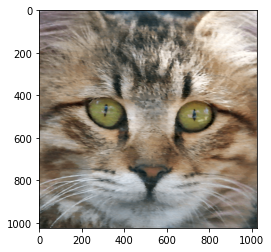

In [201]:
@torch.no_grad()
def create_image(resolution):
  # TODO: make xy coordinate
  x = []
  for i in range(resolution):
    for j in range(resolution):
      x.append([i, j])

  x = torch.tensor(x)
  rgb = []
  for i in range(resolution*resolution//(1024*1024)):
    batch = x[i*1024*1024:(i+1)*1024*1024].cuda()
    rgb.append(best_net(batch).detach().cpu())
  rgb = torch.cat(rgb, dim=0)
  rgb = rgb.reshape(resolution, resolution, 3)
  return rgb.numpy()

out_img = create_image(1024)
plt.imshow(out_img)
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


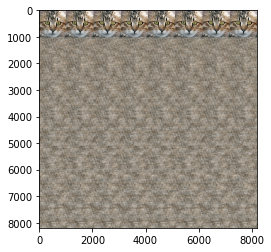

In [202]:
out_img = create_image(1024*8)
plt.imshow(out_img)
plt.show()

# Some open questions

- Does the network know the face is symmetry?
- What would you do to enforce the network outputs symmetry signals?

In [18]:
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import lovely_tensors as lt
import os, imageio
import numpy as np
import torch
lt.monkey_patch()

# TODO import what you need
import copy

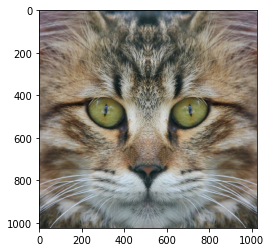

In [29]:
# Download image, take a square crop from the center
image_url = 'https://wallpaperfx.com/view_image/american-bobtail-cat-face-1024x1024-wallpaper-17750.jpg'
img = imageio.imread(image_url)[..., :3]

sub_img = img[:,:512,:]
img = np.concatenate([sub_img, sub_img[:,::-1,:]], axis=1)

plt.imshow(img)
plt.show()

In [30]:
import os
import pandas as pd
from torch.utils.data import Dataset
from torchvision import datasets
from torch.utils.data import DataLoader

class CustomImageDataset(Dataset):
    def __init__(self, img):
        self.img = img # shape=(res, res, 3)
        # TODO: create positions
        X = []
        for i in range(img.shape[0]):
            for j in range(img.shape[1]):
                X.append([i, j])
        Y = (self.img.reshape([-1, 3]) / 255.).astype(np.float32)

        # TODO: parameterize the RGB output

        self.X = np.array(X) # TODO: (..., 2)
        self.Y = np.array(Y) # TODO: (..., 3)

    def __len__(self):
        return self.X.shape[0]

    def __getitem__(self, idx):
        return self.X[idx, :], self.Y[idx, :]

# TODO test your dataset
dataset = CustomImageDataset(img)
loader = DataLoader(dataset, batch_size=64, shuffle=True)
xy, rgb = next(iter(loader))
xy, rgb

(tensor[64, 2] i64 n=128 (1Kb) x∈[7, 1023] μ=559.617 σ=297.828,
 tensor[64, 3] n=192 x∈[0.090, 0.835] μ=0.460 σ=0.165)

In [31]:
import torch.nn as nn


def pos_enc(x, *args, **kwargs):
    D = kwargs['D']
    H = kwargs['H']

    x = x[:, 0] * H + torch.abs(x[:, 1] - H // 2)
    output = torch.zeros(x.shape[0], D).to(x.device)
    for i in range(0, D, 2):
        output[:, i] = torch.sin(x / (10000 ** ((2 * i)/D)))
        output[:, i+1] = torch.cos(x / (10000 ** ((2 * i)/D)))
        #output[:, i] = torch.sin(x * (2. ** i) * torch.pi)
        #output[:, i+1] = torch.cos(x * (2. ** i) * torch.pi)

    return output


class Net(nn.Module):

  def __init__(self, inp_dim, out_dim, hid_dims=[128], **kwargs):
    super().__init__()
    # TODO: pass parameters to positional encoding
    self.D = 512
    
    self.layers = nn.ModuleList()
    curr_dim = self.D 
    for dim in hid_dims:
      self.layers.append(nn.Linear(curr_dim, dim))
      curr_dim = dim
    self.nonlin = nn.ReLU()
    self.out = nn.Linear(curr_dim, out_dim)


  def forward(self, x):
    # TODO: pass parameters to positional encoding
    z = pos_enc(x, D=self.D, H=1024)
    for layer in self.layers:
      z = self.nonlin(layer(z))
    return self.out(z)

In [32]:
# Test your architecture
net = Net(2, 3, [512, 512, 512, 512, 512, 512])
batch_size = 1234
net(torch.ones((batch_size, 2)))

tensor[1234, 3] n=3702 (14Kb) x∈[-0.038, -0.018] μ=-0.027 σ=0.009 grad AddmmBackward0

In [33]:
# Define metrics
def compute_psnr(gtr, out):
  mse = torch.mean((gtr - out) ** 2)
  return 20 * torch.log10(1.0 / (torch.sqrt(mse) + 1e-6))

# Define
def compute_loss(out, y):
  return ((out - y) ** 2).sum()

# Preparing training, (e.g. initialize optimizer ...)
opt = torch.optim.Adam(net.parameters(), lr=1e-3)

dataset = CustomImageDataset(img)
loader = DataLoader(dataset, batch_size=64, shuffle=True)
net.cuda()
data_iter = iter(loader)
best_psnr = 0
for it in range(200000):
  try:
    x, y = next(data_iter)
  except StopIteration:
    # StopIteration is thrown if dataset ends
    # reinitialize data loader
    data_iter = iter(loader)
    x, y = next(data_iter)

  x, y = x.cuda(), y.cuda()
  opt.zero_grad()
  out = net(x)
  loss = compute_loss(out, y)
  loss.backward()
  opt.step()

  # TODO: monitor the training.
  psnr = compute_psnr(y, out.detach())
  print("Iter:", it, "PSNR:", psnr, "Loss:", loss.item())
  if best_psnr < psnr:
    best_psnr = psnr
    best_net = copy.deepcopy(net)
print("Best PSNR:", best_psnr)

Iter: 0 PSNR: tensor cuda:0 5.281 Loss: 56.91091537475586
Iter: 1 PSNR: tensor cuda:0 6.821 Loss: 39.917335510253906
Iter: 2 PSNR: tensor cuda:0 8.954 Loss: 24.43065643310547
Iter: 3 PSNR: tensor cuda:0 14.845 Loss: 6.29240608215332
Iter: 4 PSNR: tensor cuda:0 6.532 Loss: 42.6720085144043
Iter: 5 PSNR: tensor cuda:0 15.787 Loss: 5.065182685852051
Iter: 6 PSNR: tensor cuda:0 11.458 Loss: 13.725739479064941
Iter: 7 PSNR: tensor cuda:0 9.600 Loss: 21.05022430419922
Iter: 8 PSNR: tensor cuda:0 9.438 Loss: 21.85221290588379
Iter: 9 PSNR: tensor cuda:0 9.423 Loss: 21.930299758911133
Iter: 10 PSNR: tensor cuda:0 9.370 Loss: 22.19617462158203
Iter: 11 PSNR: tensor cuda:0 9.475 Loss: 21.665372848510742
Iter: 12 PSNR: tensor cuda:0 10.839 Loss: 15.82767391204834
Iter: 13 PSNR: tensor cuda:0 12.068 Loss: 11.925336837768555
Iter: 14 PSNR: tensor cuda:0 14.408 Loss: 6.957791328430176
Iter: 15 PSNR: tensor cuda:0 14.848 Loss: 6.287383079528809
Iter: 16 PSNR: tensor cuda:0 12.444 Loss: 10.93660163879

Iter: 142 PSNR: tensor cuda:0 16.810 Loss: 4.00253963470459
Iter: 143 PSNR: tensor cuda:0 17.313 Loss: 3.564424514770508
Iter: 144 PSNR: tensor cuda:0 15.853 Loss: 4.988659858703613
Iter: 145 PSNR: tensor cuda:0 16.246 Loss: 4.5570878982543945
Iter: 146 PSNR: tensor cuda:0 16.447 Loss: 4.350801944732666
Iter: 147 PSNR: tensor cuda:0 15.472 Loss: 5.445829391479492
Iter: 148 PSNR: tensor cuda:0 15.203 Loss: 5.794208526611328
Iter: 149 PSNR: tensor cuda:0 17.277 Loss: 3.5944619178771973
Iter: 150 PSNR: tensor cuda:0 16.217 Loss: 4.588152885437012
Iter: 151 PSNR: tensor cuda:0 14.881 Loss: 6.239742755889893
Iter: 152 PSNR: tensor cuda:0 17.095 Loss: 3.748286724090576
Iter: 153 PSNR: tensor cuda:0 16.277 Loss: 4.5250244140625
Iter: 154 PSNR: tensor cuda:0 16.488 Loss: 4.310305118560791
Iter: 155 PSNR: tensor cuda:0 15.982 Loss: 4.842984676361084
Iter: 156 PSNR: tensor cuda:0 16.551 Loss: 4.24826717376709
Iter: 157 PSNR: tensor cuda:0 16.357 Loss: 4.441714286804199
Iter: 158 PSNR: tensor cud

Iter: 284 PSNR: tensor cuda:0 16.036 Loss: 4.782406806945801
Iter: 285 PSNR: tensor cuda:0 15.123 Loss: 5.901555061340332
Iter: 286 PSNR: tensor cuda:0 17.245 Loss: 3.6206884384155273
Iter: 287 PSNR: tensor cuda:0 16.936 Loss: 3.887749195098877
Iter: 288 PSNR: tensor cuda:0 16.623 Loss: 4.178070068359375
Iter: 289 PSNR: tensor cuda:0 15.604 Loss: 5.283606052398682
Iter: 290 PSNR: tensor cuda:0 16.535 Loss: 4.263690948486328
Iter: 291 PSNR: tensor cuda:0 17.954 Loss: 3.0753703117370605
Iter: 292 PSNR: tensor cuda:0 17.125 Loss: 3.7218034267425537
Iter: 293 PSNR: tensor cuda:0 16.087 Loss: 4.72672700881958
Iter: 294 PSNR: tensor cuda:0 15.975 Loss: 4.850834846496582
Iter: 295 PSNR: tensor cuda:0 15.468 Loss: 5.451565742492676
Iter: 296 PSNR: tensor cuda:0 15.433 Loss: 5.495851516723633
Iter: 297 PSNR: tensor cuda:0 15.658 Loss: 5.217519283294678
Iter: 298 PSNR: tensor cuda:0 16.436 Loss: 4.362484455108643
Iter: 299 PSNR: tensor cuda:0 17.142 Loss: 3.7079241275787354
Iter: 300 PSNR: tenso

Iter: 424 PSNR: tensor cuda:0 16.053 Loss: 4.763995170593262
Iter: 425 PSNR: tensor cuda:0 17.936 Loss: 3.0884552001953125
Iter: 426 PSNR: tensor cuda:0 16.538 Loss: 4.260537147521973
Iter: 427 PSNR: tensor cuda:0 15.930 Loss: 4.901507377624512
Iter: 428 PSNR: tensor cuda:0 15.335 Loss: 5.620890140533447
Iter: 429 PSNR: tensor cuda:0 17.396 Loss: 3.496703624725342
Iter: 430 PSNR: tensor cuda:0 16.508 Loss: 4.2902750968933105
Iter: 431 PSNR: tensor cuda:0 15.172 Loss: 5.83543586730957
Iter: 432 PSNR: tensor cuda:0 15.376 Loss: 5.567403793334961
Iter: 433 PSNR: tensor cuda:0 15.348 Loss: 5.604410171508789
Iter: 434 PSNR: tensor cuda:0 16.645 Loss: 4.157183647155762
Iter: 435 PSNR: tensor cuda:0 16.493 Loss: 4.305504322052002
Iter: 436 PSNR: tensor cuda:0 15.139 Loss: 5.880161285400391
Iter: 437 PSNR: tensor cuda:0 16.689 Loss: 4.115169525146484
Iter: 438 PSNR: tensor cuda:0 16.300 Loss: 4.5013532638549805
Iter: 439 PSNR: tensor cuda:0 15.637 Loss: 5.243407249450684
Iter: 440 PSNR: tensor

Iter: 566 PSNR: tensor cuda:0 17.567 Loss: 3.3617172241210938
Iter: 567 PSNR: tensor cuda:0 17.472 Loss: 3.436274290084839
Iter: 568 PSNR: tensor cuda:0 17.158 Loss: 3.694038152694702
Iter: 569 PSNR: tensor cuda:0 16.516 Loss: 4.282384395599365
Iter: 570 PSNR: tensor cuda:0 16.553 Loss: 4.246166706085205
Iter: 571 PSNR: tensor cuda:0 15.554 Loss: 5.344719886779785
Iter: 572 PSNR: tensor cuda:0 15.827 Loss: 5.018823623657227
Iter: 573 PSNR: tensor cuda:0 16.309 Loss: 4.491636753082275
Iter: 574 PSNR: tensor cuda:0 16.997 Loss: 3.8336005210876465
Iter: 575 PSNR: tensor cuda:0 17.016 Loss: 3.81642746925354
Iter: 576 PSNR: tensor cuda:0 17.315 Loss: 3.5632219314575195
Iter: 577 PSNR: tensor cuda:0 17.006 Loss: 3.8259685039520264
Iter: 578 PSNR: tensor cuda:0 16.536 Loss: 4.2623395919799805
Iter: 579 PSNR: tensor cuda:0 16.112 Loss: 4.700265884399414
Iter: 580 PSNR: tensor cuda:0 16.194 Loss: 4.611881256103516
Iter: 581 PSNR: tensor cuda:0 16.281 Loss: 4.520812034606934
Iter: 582 PSNR: tens

Iter: 707 PSNR: tensor cuda:0 15.483 Loss: 5.432760715484619
Iter: 708 PSNR: tensor cuda:0 16.592 Loss: 4.2081732749938965
Iter: 709 PSNR: tensor cuda:0 16.297 Loss: 4.5040130615234375
Iter: 710 PSNR: tensor cuda:0 18.056 Loss: 3.004141330718994
Iter: 711 PSNR: tensor cuda:0 17.058 Loss: 3.779987335205078
Iter: 712 PSNR: tensor cuda:0 16.547 Loss: 4.251587867736816
Iter: 713 PSNR: tensor cuda:0 16.629 Loss: 4.172202110290527
Iter: 714 PSNR: tensor cuda:0 17.447 Loss: 3.4560701847076416
Iter: 715 PSNR: tensor cuda:0 16.558 Loss: 4.241733074188232
Iter: 716 PSNR: tensor cuda:0 17.007 Loss: 3.824613571166992
Iter: 717 PSNR: tensor cuda:0 16.165 Loss: 4.643154621124268
Iter: 718 PSNR: tensor cuda:0 15.824 Loss: 5.022599220275879
Iter: 719 PSNR: tensor cuda:0 14.602 Loss: 6.653565406799316
Iter: 720 PSNR: tensor cuda:0 17.726 Loss: 3.240945339202881
Iter: 721 PSNR: tensor cuda:0 16.908 Loss: 3.9127161502838135
Iter: 722 PSNR: tensor cuda:0 16.040 Loss: 4.778082370758057
Iter: 723 PSNR: tens

Iter: 849 PSNR: tensor cuda:0 17.754 Loss: 3.22002911567688
Iter: 850 PSNR: tensor cuda:0 18.721 Loss: 2.577641725540161
Iter: 851 PSNR: tensor cuda:0 17.729 Loss: 3.2386434078216553
Iter: 852 PSNR: tensor cuda:0 18.614 Loss: 2.6415762901306152
Iter: 853 PSNR: tensor cuda:0 17.578 Loss: 3.3535654544830322
Iter: 854 PSNR: tensor cuda:0 16.773 Loss: 4.03657865524292
Iter: 855 PSNR: tensor cuda:0 16.041 Loss: 4.777823448181152
Iter: 856 PSNR: tensor cuda:0 17.029 Loss: 3.805631160736084
Iter: 857 PSNR: tensor cuda:0 17.981 Loss: 3.0565717220306396
Iter: 858 PSNR: tensor cuda:0 16.655 Loss: 4.147200584411621
Iter: 859 PSNR: tensor cuda:0 16.313 Loss: 4.487156867980957
Iter: 860 PSNR: tensor cuda:0 16.329 Loss: 4.470830917358398
Iter: 861 PSNR: tensor cuda:0 18.518 Loss: 2.7007369995117188
Iter: 862 PSNR: tensor cuda:0 16.942 Loss: 3.882067918777466
Iter: 863 PSNR: tensor cuda:0 17.179 Loss: 3.6765804290771484
Iter: 864 PSNR: tensor cuda:0 17.043 Loss: 3.793008804321289
Iter: 865 PSNR: tens

Iter: 984 PSNR: tensor cuda:0 17.678 Loss: 3.277430295944214
Iter: 985 PSNR: tensor cuda:0 16.837 Loss: 3.977762222290039
Iter: 986 PSNR: tensor cuda:0 16.701 Loss: 4.104199409484863
Iter: 987 PSNR: tensor cuda:0 17.022 Loss: 3.81154203414917
Iter: 988 PSNR: tensor cuda:0 15.667 Loss: 5.207306861877441
Iter: 989 PSNR: tensor cuda:0 15.991 Loss: 4.8323893547058105
Iter: 990 PSNR: tensor cuda:0 17.279 Loss: 3.5925350189208984
Iter: 991 PSNR: tensor cuda:0 17.395 Loss: 3.497974395751953
Iter: 992 PSNR: tensor cuda:0 17.572 Loss: 3.358132839202881
Iter: 993 PSNR: tensor cuda:0 15.964 Loss: 4.863377571105957
Iter: 994 PSNR: tensor cuda:0 17.116 Loss: 3.7299232482910156
Iter: 995 PSNR: tensor cuda:0 16.634 Loss: 4.167410850524902
Iter: 996 PSNR: tensor cuda:0 17.789 Loss: 3.194119691848755
Iter: 997 PSNR: tensor cuda:0 17.833 Loss: 3.1622915267944336
Iter: 998 PSNR: tensor cuda:0 18.715 Loss: 2.581066131591797
Iter: 999 PSNR: tensor cuda:0 17.364 Loss: 3.522643804550171
Iter: 1000 PSNR: tens

Iter: 1119 PSNR: tensor cuda:0 17.836 Loss: 3.1599392890930176
Iter: 1120 PSNR: tensor cuda:0 17.580 Loss: 3.3522164821624756
Iter: 1121 PSNR: tensor cuda:0 18.401 Loss: 2.774606943130493
Iter: 1122 PSNR: tensor cuda:0 17.694 Loss: 3.264799118041992
Iter: 1123 PSNR: tensor cuda:0 18.089 Loss: 2.9812746047973633
Iter: 1124 PSNR: tensor cuda:0 16.934 Loss: 3.88919997215271
Iter: 1125 PSNR: tensor cuda:0 17.374 Loss: 3.514420747756958
Iter: 1126 PSNR: tensor cuda:0 16.498 Loss: 4.2999677658081055
Iter: 1127 PSNR: tensor cuda:0 17.079 Loss: 3.7617321014404297
Iter: 1128 PSNR: tensor cuda:0 17.735 Loss: 3.234198570251465
Iter: 1129 PSNR: tensor cuda:0 16.783 Loss: 4.026996612548828
Iter: 1130 PSNR: tensor cuda:0 17.387 Loss: 3.503915548324585
Iter: 1131 PSNR: tensor cuda:0 19.040 Loss: 2.394742012023926
Iter: 1132 PSNR: tensor cuda:0 17.588 Loss: 3.345576524734497
Iter: 1133 PSNR: tensor cuda:0 16.182 Loss: 4.624619960784912
Iter: 1134 PSNR: tensor cuda:0 17.373 Loss: 3.515453815460205
Iter

Iter: 1254 PSNR: tensor cuda:0 18.164 Loss: 2.929920196533203
Iter: 1255 PSNR: tensor cuda:0 17.992 Loss: 3.0488829612731934
Iter: 1256 PSNR: tensor cuda:0 18.934 Loss: 2.453880548477173
Iter: 1257 PSNR: tensor cuda:0 16.135 Loss: 4.674927711486816
Iter: 1258 PSNR: tensor cuda:0 16.847 Loss: 3.967855453491211
Iter: 1259 PSNR: tensor cuda:0 16.769 Loss: 4.040335178375244
Iter: 1260 PSNR: tensor cuda:0 18.860 Loss: 2.4963321685791016
Iter: 1261 PSNR: tensor cuda:0 18.910 Loss: 2.4675683975219727
Iter: 1262 PSNR: tensor cuda:0 16.911 Loss: 3.910468578338623
Iter: 1263 PSNR: tensor cuda:0 17.544 Loss: 3.379605293273926
Iter: 1264 PSNR: tensor cuda:0 17.454 Loss: 3.450880527496338
Iter: 1265 PSNR: tensor cuda:0 18.590 Loss: 2.6563620567321777
Iter: 1266 PSNR: tensor cuda:0 19.679 Loss: 2.067142963409424
Iter: 1267 PSNR: tensor cuda:0 15.696 Loss: 5.171920299530029
Iter: 1268 PSNR: tensor cuda:0 16.981 Loss: 3.8475871086120605
Iter: 1269 PSNR: tensor cuda:0 17.185 Loss: 3.671393871307373
Ite

Iter: 1389 PSNR: tensor cuda:0 18.159 Loss: 2.9334652423858643
Iter: 1390 PSNR: tensor cuda:0 19.099 Loss: 2.3625922203063965
Iter: 1391 PSNR: tensor cuda:0 16.997 Loss: 3.8332042694091797
Iter: 1392 PSNR: tensor cuda:0 17.073 Loss: 3.766904354095459
Iter: 1393 PSNR: tensor cuda:0 16.943 Loss: 3.881706714630127
Iter: 1394 PSNR: tensor cuda:0 19.340 Loss: 2.235114336013794
Iter: 1395 PSNR: tensor cuda:0 17.686 Loss: 3.2713513374328613
Iter: 1396 PSNR: tensor cuda:0 18.570 Loss: 2.6684837341308594
Iter: 1397 PSNR: tensor cuda:0 18.057 Loss: 3.0033302307128906
Iter: 1398 PSNR: tensor cuda:0 17.164 Loss: 3.688560962677002
Iter: 1399 PSNR: tensor cuda:0 15.481 Loss: 5.434384346008301
Iter: 1400 PSNR: tensor cuda:0 18.002 Loss: 3.041585683822632
Iter: 1401 PSNR: tensor cuda:0 17.735 Loss: 3.2344284057617188
Iter: 1402 PSNR: tensor cuda:0 17.511 Loss: 3.4053587913513184
Iter: 1403 PSNR: tensor cuda:0 17.813 Loss: 3.1767141819000244
Iter: 1404 PSNR: tensor cuda:0 19.649 Loss: 2.081525802612304

Iter: 1524 PSNR: tensor cuda:0 19.100 Loss: 2.3621110916137695
Iter: 1525 PSNR: tensor cuda:0 17.934 Loss: 3.089331865310669
Iter: 1526 PSNR: tensor cuda:0 17.301 Loss: 3.574038028717041
Iter: 1527 PSNR: tensor cuda:0 17.478 Loss: 3.431975841522217
Iter: 1528 PSNR: tensor cuda:0 17.617 Loss: 3.323801040649414
Iter: 1529 PSNR: tensor cuda:0 19.143 Loss: 2.3389995098114014
Iter: 1530 PSNR: tensor cuda:0 17.738 Loss: 3.23222279548645
Iter: 1531 PSNR: tensor cuda:0 16.796 Loss: 4.014664173126221
Iter: 1532 PSNR: tensor cuda:0 18.455 Loss: 2.740199327468872
Iter: 1533 PSNR: tensor cuda:0 16.498 Loss: 4.300518035888672
Iter: 1534 PSNR: tensor cuda:0 17.316 Loss: 3.562230110168457
Iter: 1535 PSNR: tensor cuda:0 17.014 Loss: 3.818603992462158
Iter: 1536 PSNR: tensor cuda:0 16.543 Loss: 4.255716800689697
Iter: 1537 PSNR: tensor cuda:0 16.435 Loss: 4.36321496963501
Iter: 1538 PSNR: tensor cuda:0 17.457 Loss: 3.448246717453003
Iter: 1539 PSNR: tensor cuda:0 18.028 Loss: 3.023367404937744
Iter: 15

Iter: 1659 PSNR: tensor cuda:0 19.094 Loss: 2.365492820739746
Iter: 1660 PSNR: tensor cuda:0 17.786 Loss: 3.196554183959961
Iter: 1661 PSNR: tensor cuda:0 19.541 Loss: 2.134084939956665
Iter: 1662 PSNR: tensor cuda:0 17.533 Loss: 3.3881845474243164
Iter: 1663 PSNR: tensor cuda:0 18.764 Loss: 2.552001476287842
Iter: 1664 PSNR: tensor cuda:0 16.750 Loss: 4.058147430419922
Iter: 1665 PSNR: tensor cuda:0 17.807 Loss: 3.1811890602111816
Iter: 1666 PSNR: tensor cuda:0 18.420 Loss: 2.762683629989624
Iter: 1667 PSNR: tensor cuda:0 18.699 Loss: 2.5903148651123047
Iter: 1668 PSNR: tensor cuda:0 18.230 Loss: 2.8861303329467773
Iter: 1669 PSNR: tensor cuda:0 18.027 Loss: 3.023956298828125
Iter: 1670 PSNR: tensor cuda:0 16.679 Loss: 4.124499797821045
Iter: 1671 PSNR: tensor cuda:0 16.922 Loss: 3.900672435760498
Iter: 1672 PSNR: tensor cuda:0 17.484 Loss: 3.426949977874756
Iter: 1673 PSNR: tensor cuda:0 18.428 Loss: 2.7574143409729004
Iter: 1674 PSNR: tensor cuda:0 18.217 Loss: 2.8949146270751953
It

Iter: 1792 PSNR: tensor cuda:0 17.817 Loss: 3.173856258392334
Iter: 1793 PSNR: tensor cuda:0 18.460 Loss: 2.7374305725097656
Iter: 1794 PSNR: tensor cuda:0 16.894 Loss: 3.9250617027282715
Iter: 1795 PSNR: tensor cuda:0 16.738 Loss: 4.06862735748291
Iter: 1796 PSNR: tensor cuda:0 18.274 Loss: 2.8572170734405518
Iter: 1797 PSNR: tensor cuda:0 19.127 Loss: 2.3473782539367676
Iter: 1798 PSNR: tensor cuda:0 17.494 Loss: 3.419236183166504
Iter: 1799 PSNR: tensor cuda:0 17.682 Loss: 3.274317502975464
Iter: 1800 PSNR: tensor cuda:0 19.317 Loss: 2.247187852859497
Iter: 1801 PSNR: tensor cuda:0 17.108 Loss: 3.737056255340576
Iter: 1802 PSNR: tensor cuda:0 17.981 Loss: 3.055990695953369
Iter: 1803 PSNR: tensor cuda:0 18.273 Loss: 2.8577280044555664
Iter: 1804 PSNR: tensor cuda:0 18.463 Loss: 2.735107183456421
Iter: 1805 PSNR: tensor cuda:0 19.139 Loss: 2.341041326522827
Iter: 1806 PSNR: tensor cuda:0 19.448 Loss: 2.1799848079681396
Iter: 1807 PSNR: tensor cuda:0 18.140 Loss: 2.946275234222412
Ite

Iter: 1927 PSNR: tensor cuda:0 18.753 Loss: 2.558682441711426
Iter: 1928 PSNR: tensor cuda:0 17.758 Loss: 3.2175216674804688
Iter: 1929 PSNR: tensor cuda:0 17.493 Loss: 3.4196765422821045
Iter: 1930 PSNR: tensor cuda:0 17.905 Loss: 3.1101906299591064
Iter: 1931 PSNR: tensor cuda:0 16.885 Loss: 3.9336228370666504
Iter: 1932 PSNR: tensor cuda:0 18.392 Loss: 2.780468463897705
Iter: 1933 PSNR: tensor cuda:0 19.299 Loss: 2.256068229675293
Iter: 1934 PSNR: tensor cuda:0 19.405 Loss: 2.201992988586426
Iter: 1935 PSNR: tensor cuda:0 17.194 Loss: 3.6635963916778564
Iter: 1936 PSNR: tensor cuda:0 19.417 Loss: 2.1959314346313477
Iter: 1937 PSNR: tensor cuda:0 16.733 Loss: 4.073646068572998
Iter: 1938 PSNR: tensor cuda:0 18.612 Loss: 2.6429991722106934
Iter: 1939 PSNR: tensor cuda:0 18.765 Loss: 2.551243305206299
Iter: 1940 PSNR: tensor cuda:0 17.204 Loss: 3.655384063720703
Iter: 1941 PSNR: tensor cuda:0 17.562 Loss: 3.365929126739502
Iter: 1942 PSNR: tensor cuda:0 19.641 Loss: 2.085259437561035
I

Iter: 2062 PSNR: tensor cuda:0 19.234 Loss: 2.2904419898986816
Iter: 2063 PSNR: tensor cuda:0 18.204 Loss: 2.9032959938049316
Iter: 2064 PSNR: tensor cuda:0 19.011 Loss: 2.4111921787261963
Iter: 2065 PSNR: tensor cuda:0 18.588 Loss: 2.657829761505127
Iter: 2066 PSNR: tensor cuda:0 18.766 Loss: 2.5506343841552734
Iter: 2067 PSNR: tensor cuda:0 18.248 Loss: 2.873809814453125
Iter: 2068 PSNR: tensor cuda:0 17.053 Loss: 3.784426212310791
Iter: 2069 PSNR: tensor cuda:0 18.389 Loss: 2.782193660736084
Iter: 2070 PSNR: tensor cuda:0 18.222 Loss: 2.891608715057373
Iter: 2071 PSNR: tensor cuda:0 17.231 Loss: 3.6327409744262695
Iter: 2072 PSNR: tensor cuda:0 17.898 Loss: 3.1150107383728027
Iter: 2073 PSNR: tensor cuda:0 19.394 Loss: 2.2073400020599365
Iter: 2074 PSNR: tensor cuda:0 17.864 Loss: 3.139651298522949
Iter: 2075 PSNR: tensor cuda:0 19.129 Loss: 2.3462066650390625
Iter: 2076 PSNR: tensor cuda:0 18.423 Loss: 2.7604122161865234
Iter: 2077 PSNR: tensor cuda:0 17.415 Loss: 3.481814861297607

Iter: 2197 PSNR: tensor cuda:0 17.493 Loss: 3.419484853744507
Iter: 2198 PSNR: tensor cuda:0 16.516 Loss: 4.282918930053711
Iter: 2199 PSNR: tensor cuda:0 17.501 Loss: 3.4132747650146484
Iter: 2200 PSNR: tensor cuda:0 19.987 Loss: 1.925691843032837
Iter: 2201 PSNR: tensor cuda:0 18.805 Loss: 2.52782940864563
Iter: 2202 PSNR: tensor cuda:0 19.347 Loss: 2.23136305809021
Iter: 2203 PSNR: tensor cuda:0 18.421 Loss: 2.7619922161102295
Iter: 2204 PSNR: tensor cuda:0 18.162 Loss: 2.931772470474243
Iter: 2205 PSNR: tensor cuda:0 18.949 Loss: 2.445847988128662
Iter: 2206 PSNR: tensor cuda:0 19.741 Loss: 2.0381546020507812
Iter: 2207 PSNR: tensor cuda:0 19.173 Loss: 2.3224456310272217
Iter: 2208 PSNR: tensor cuda:0 19.055 Loss: 2.3865175247192383
Iter: 2209 PSNR: tensor cuda:0 18.435 Loss: 2.752866744995117
Iter: 2210 PSNR: tensor cuda:0 20.223 Loss: 1.8236966133117676
Iter: 2211 PSNR: tensor cuda:0 18.545 Loss: 2.6838972568511963
Iter: 2212 PSNR: tensor cuda:0 18.613 Loss: 2.642216444015503
Ite

Iter: 2332 PSNR: tensor cuda:0 17.567 Loss: 3.3620598316192627
Iter: 2333 PSNR: tensor cuda:0 20.110 Loss: 1.872023344039917
Iter: 2334 PSNR: tensor cuda:0 18.574 Loss: 2.6664910316467285
Iter: 2335 PSNR: tensor cuda:0 19.027 Loss: 2.401848554611206
Iter: 2336 PSNR: tensor cuda:0 19.144 Loss: 2.3384206295013428
Iter: 2337 PSNR: tensor cuda:0 18.381 Loss: 2.7875723838806152
Iter: 2338 PSNR: tensor cuda:0 18.367 Loss: 2.7964277267456055
Iter: 2339 PSNR: tensor cuda:0 18.693 Loss: 2.593859910964966
Iter: 2340 PSNR: tensor cuda:0 17.666 Loss: 3.286409616470337
Iter: 2341 PSNR: tensor cuda:0 18.822 Loss: 2.518336772918701
Iter: 2342 PSNR: tensor cuda:0 20.093 Loss: 1.8791145086288452
Iter: 2343 PSNR: tensor cuda:0 18.489 Loss: 2.718766927719116
Iter: 2344 PSNR: tensor cuda:0 16.931 Loss: 3.8920888900756836
Iter: 2345 PSNR: tensor cuda:0 18.912 Loss: 2.4664056301116943
Iter: 2346 PSNR: tensor cuda:0 18.949 Loss: 2.4456663131713867
Iter: 2347 PSNR: tensor cuda:0 16.913 Loss: 3.908101558685302

Iter: 2465 PSNR: tensor cuda:0 19.292 Loss: 2.259906530380249
Iter: 2466 PSNR: tensor cuda:0 19.089 Loss: 2.3679680824279785
Iter: 2467 PSNR: tensor cuda:0 18.790 Loss: 2.5370872020721436
Iter: 2468 PSNR: tensor cuda:0 17.880 Loss: 3.127962589263916
Iter: 2469 PSNR: tensor cuda:0 19.415 Loss: 2.1968986988067627
Iter: 2470 PSNR: tensor cuda:0 16.812 Loss: 4.000763893127441
Iter: 2471 PSNR: tensor cuda:0 18.809 Loss: 2.5256094932556152
Iter: 2472 PSNR: tensor cuda:0 18.011 Loss: 3.0353994369506836
Iter: 2473 PSNR: tensor cuda:0 18.204 Loss: 2.903163433074951
Iter: 2474 PSNR: tensor cuda:0 18.057 Loss: 3.003439426422119
Iter: 2475 PSNR: tensor cuda:0 18.129 Loss: 2.9539296627044678
Iter: 2476 PSNR: tensor cuda:0 18.207 Loss: 2.9013233184814453
Iter: 2477 PSNR: tensor cuda:0 19.033 Loss: 2.398834466934204
Iter: 2478 PSNR: tensor cuda:0 17.437 Loss: 3.4640743732452393
Iter: 2479 PSNR: tensor cuda:0 18.986 Loss: 2.424905776977539
Iter: 2480 PSNR: tensor cuda:0 18.712 Loss: 2.582552671432495


Iter: 2605 PSNR: tensor cuda:0 18.797 Loss: 2.5325558185577393
Iter: 2606 PSNR: tensor cuda:0 19.240 Loss: 2.287231922149658
Iter: 2607 PSNR: tensor cuda:0 19.912 Loss: 1.9594777822494507
Iter: 2608 PSNR: tensor cuda:0 20.118 Loss: 1.8686882257461548
Iter: 2609 PSNR: tensor cuda:0 18.869 Loss: 2.4912197589874268
Iter: 2610 PSNR: tensor cuda:0 19.843 Loss: 1.9905205965042114
Iter: 2611 PSNR: tensor cuda:0 20.003 Loss: 1.9188278913497925
Iter: 2612 PSNR: tensor cuda:0 18.423 Loss: 2.760557174682617
Iter: 2613 PSNR: tensor cuda:0 19.767 Loss: 2.025996208190918
Iter: 2614 PSNR: tensor cuda:0 18.418 Loss: 2.7635464668273926
Iter: 2615 PSNR: tensor cuda:0 17.563 Loss: 3.3650457859039307
Iter: 2616 PSNR: tensor cuda:0 18.358 Loss: 2.8023486137390137
Iter: 2617 PSNR: tensor cuda:0 19.889 Loss: 1.9698879718780518
Iter: 2618 PSNR: tensor cuda:0 18.685 Loss: 2.5987319946289062
Iter: 2619 PSNR: tensor cuda:0 19.037 Loss: 2.3967905044555664
Iter: 2620 PSNR: tensor cuda:0 19.700 Loss: 2.057284355163

Iter: 2736 PSNR: tensor cuda:0 17.582 Loss: 3.3500123023986816
Iter: 2737 PSNR: tensor cuda:0 19.701 Loss: 2.056802749633789
Iter: 2738 PSNR: tensor cuda:0 18.042 Loss: 3.0134224891662598
Iter: 2739 PSNR: tensor cuda:0 18.641 Loss: 2.625380516052246
Iter: 2740 PSNR: tensor cuda:0 18.470 Loss: 2.7308127880096436
Iter: 2741 PSNR: tensor cuda:0 17.188 Loss: 3.668668746948242
Iter: 2742 PSNR: tensor cuda:0 19.225 Loss: 2.2953197956085205
Iter: 2743 PSNR: tensor cuda:0 18.636 Loss: 2.628265857696533
Iter: 2744 PSNR: tensor cuda:0 19.471 Loss: 2.1685285568237305
Iter: 2745 PSNR: tensor cuda:0 18.441 Loss: 2.7489612102508545
Iter: 2746 PSNR: tensor cuda:0 19.382 Loss: 2.213590621948242
Iter: 2747 PSNR: tensor cuda:0 17.582 Loss: 3.3502721786499023
Iter: 2748 PSNR: tensor cuda:0 17.621 Loss: 3.3205180168151855
Iter: 2749 PSNR: tensor cuda:0 18.842 Loss: 2.506519317626953
Iter: 2750 PSNR: tensor cuda:0 19.461 Loss: 2.1738808155059814
Iter: 2751 PSNR: tensor cuda:0 18.896 Loss: 2.475559949874878

Iter: 2867 PSNR: tensor cuda:0 18.095 Loss: 2.9771132469177246
Iter: 2868 PSNR: tensor cuda:0 19.827 Loss: 1.9982011318206787
Iter: 2869 PSNR: tensor cuda:0 18.827 Loss: 2.515432357788086
Iter: 2870 PSNR: tensor cuda:0 17.316 Loss: 3.5619287490844727
Iter: 2871 PSNR: tensor cuda:0 19.202 Loss: 2.3070623874664307
Iter: 2872 PSNR: tensor cuda:0 20.156 Loss: 1.8520088195800781
Iter: 2873 PSNR: tensor cuda:0 20.296 Loss: 1.7935874462127686
Iter: 2874 PSNR: tensor cuda:0 19.517 Loss: 2.145583391189575
Iter: 2875 PSNR: tensor cuda:0 19.643 Loss: 2.084625005722046
Iter: 2876 PSNR: tensor cuda:0 18.246 Loss: 2.8753018379211426
Iter: 2877 PSNR: tensor cuda:0 21.442 Loss: 1.3775947093963623
Iter: 2878 PSNR: tensor cuda:0 20.753 Loss: 1.6143217086791992
Iter: 2879 PSNR: tensor cuda:0 18.433 Loss: 2.7539496421813965
Iter: 2880 PSNR: tensor cuda:0 18.866 Loss: 2.4929189682006836
Iter: 2881 PSNR: tensor cuda:0 19.656 Loss: 2.0783379077911377
Iter: 2882 PSNR: tensor cuda:0 18.478 Loss: 2.725625038146

Iter: 2998 PSNR: tensor cuda:0 17.868 Loss: 3.136589527130127
Iter: 2999 PSNR: tensor cuda:0 18.643 Loss: 2.624382972717285
Iter: 3000 PSNR: tensor cuda:0 20.266 Loss: 1.805966854095459
Iter: 3001 PSNR: tensor cuda:0 18.608 Loss: 2.6452293395996094
Iter: 3002 PSNR: tensor cuda:0 18.571 Loss: 2.667917490005493
Iter: 3003 PSNR: tensor cuda:0 17.139 Loss: 3.7102818489074707
Iter: 3004 PSNR: tensor cuda:0 19.745 Loss: 2.035984992980957
Iter: 3005 PSNR: tensor cuda:0 19.943 Loss: 1.9452725648880005
Iter: 3006 PSNR: tensor cuda:0 16.396 Loss: 4.40230655670166
Iter: 3007 PSNR: tensor cuda:0 18.589 Loss: 2.656785488128662
Iter: 3008 PSNR: tensor cuda:0 18.799 Loss: 2.531477451324463
Iter: 3009 PSNR: tensor cuda:0 19.225 Loss: 2.2949390411376953
Iter: 3010 PSNR: tensor cuda:0 18.262 Loss: 2.865091323852539
Iter: 3011 PSNR: tensor cuda:0 18.201 Loss: 2.905613422393799
Iter: 3012 PSNR: tensor cuda:0 20.537 Loss: 1.696531891822815
Iter: 3013 PSNR: tensor cuda:0 20.195 Loss: 1.8355796337127686
Iter

Iter: 3134 PSNR: tensor cuda:0 19.433 Loss: 2.1878044605255127
Iter: 3135 PSNR: tensor cuda:0 19.764 Loss: 2.0274016857147217
Iter: 3136 PSNR: tensor cuda:0 18.263 Loss: 2.864238739013672
Iter: 3137 PSNR: tensor cuda:0 20.360 Loss: 1.7671234607696533
Iter: 3138 PSNR: tensor cuda:0 18.236 Loss: 2.8821146488189697
Iter: 3139 PSNR: tensor cuda:0 17.206 Loss: 3.653379440307617
Iter: 3140 PSNR: tensor cuda:0 19.347 Loss: 2.231235980987549
Iter: 3141 PSNR: tensor cuda:0 20.349 Loss: 1.7718889713287354
Iter: 3142 PSNR: tensor cuda:0 18.603 Loss: 2.6483850479125977
Iter: 3143 PSNR: tensor cuda:0 17.931 Loss: 3.0918173789978027
Iter: 3144 PSNR: tensor cuda:0 18.005 Loss: 3.0392792224884033
Iter: 3145 PSNR: tensor cuda:0 18.445 Loss: 2.74633526802063
Iter: 3146 PSNR: tensor cuda:0 19.296 Loss: 2.258035898208618
Iter: 3147 PSNR: tensor cuda:0 18.481 Loss: 2.723788261413574
Iter: 3148 PSNR: tensor cuda:0 19.067 Loss: 2.3800878524780273
Iter: 3149 PSNR: tensor cuda:0 19.427 Loss: 2.190523862838745


Iter: 3267 PSNR: tensor cuda:0 17.851 Loss: 3.1489250659942627
Iter: 3268 PSNR: tensor cuda:0 17.888 Loss: 3.122373104095459
Iter: 3269 PSNR: tensor cuda:0 19.590 Loss: 2.1101009845733643
Iter: 3270 PSNR: tensor cuda:0 21.206 Loss: 1.4543979167938232
Iter: 3271 PSNR: tensor cuda:0 17.251 Loss: 3.615556478500366
Iter: 3272 PSNR: tensor cuda:0 20.009 Loss: 1.9160264730453491
Iter: 3273 PSNR: tensor cuda:0 19.593 Loss: 2.1086411476135254
Iter: 3274 PSNR: tensor cuda:0 19.924 Loss: 1.9538918733596802
Iter: 3275 PSNR: tensor cuda:0 17.960 Loss: 3.071071147918701
Iter: 3276 PSNR: tensor cuda:0 20.005 Loss: 1.9175609350204468
Iter: 3277 PSNR: tensor cuda:0 19.515 Loss: 2.1466219425201416
Iter: 3278 PSNR: tensor cuda:0 19.156 Loss: 2.3320255279541016
Iter: 3279 PSNR: tensor cuda:0 20.598 Loss: 1.6730506420135498
Iter: 3280 PSNR: tensor cuda:0 19.392 Loss: 2.2082598209381104
Iter: 3281 PSNR: tensor cuda:0 19.665 Loss: 2.0740878582000732
Iter: 3282 PSNR: tensor cuda:0 19.988 Loss: 1.925093412399

Iter: 3401 PSNR: tensor cuda:0 18.013 Loss: 3.0339555740356445
Iter: 3402 PSNR: tensor cuda:0 19.017 Loss: 2.407564163208008
Iter: 3403 PSNR: tensor cuda:0 19.444 Loss: 2.1820731163024902
Iter: 3404 PSNR: tensor cuda:0 19.582 Loss: 2.1139845848083496
Iter: 3405 PSNR: tensor cuda:0 19.796 Loss: 2.0121026039123535
Iter: 3406 PSNR: tensor cuda:0 18.964 Loss: 2.4373459815979004
Iter: 3407 PSNR: tensor cuda:0 19.858 Loss: 1.9836992025375366
Iter: 3408 PSNR: tensor cuda:0 19.175 Loss: 2.3216676712036133
Iter: 3409 PSNR: tensor cuda:0 18.919 Loss: 2.4627082347869873
Iter: 3410 PSNR: tensor cuda:0 18.752 Loss: 2.5588910579681396
Iter: 3411 PSNR: tensor cuda:0 18.106 Loss: 2.9698431491851807
Iter: 3412 PSNR: tensor cuda:0 20.121 Loss: 1.8672301769256592
Iter: 3413 PSNR: tensor cuda:0 21.117 Loss: 1.4846118688583374
Iter: 3414 PSNR: tensor cuda:0 19.720 Loss: 2.0480520725250244
Iter: 3415 PSNR: tensor cuda:0 19.582 Loss: 2.113821029663086
Iter: 3416 PSNR: tensor cuda:0 18.929 Loss: 2.45687532424

Iter: 3535 PSNR: tensor cuda:0 20.332 Loss: 1.7786253690719604
Iter: 3536 PSNR: tensor cuda:0 19.663 Loss: 2.0750527381896973
Iter: 3537 PSNR: tensor cuda:0 18.546 Loss: 2.6833102703094482
Iter: 3538 PSNR: tensor cuda:0 22.167 Loss: 1.1656250953674316
Iter: 3539 PSNR: tensor cuda:0 19.429 Loss: 2.1895089149475098
Iter: 3540 PSNR: tensor cuda:0 18.683 Loss: 2.6001529693603516
Iter: 3541 PSNR: tensor cuda:0 18.129 Loss: 2.953618288040161
Iter: 3542 PSNR: tensor cuda:0 20.153 Loss: 1.8534778356552124
Iter: 3543 PSNR: tensor cuda:0 19.386 Loss: 2.211699962615967
Iter: 3544 PSNR: tensor cuda:0 19.339 Loss: 2.23563289642334
Iter: 3545 PSNR: tensor cuda:0 20.034 Loss: 1.9048206806182861
Iter: 3546 PSNR: tensor cuda:0 19.136 Loss: 2.3423824310302734
Iter: 3547 PSNR: tensor cuda:0 18.388 Loss: 2.7829132080078125
Iter: 3548 PSNR: tensor cuda:0 21.821 Loss: 1.2624294757843018
Iter: 3549 PSNR: tensor cuda:0 19.939 Loss: 1.94733726978302
Iter: 3550 PSNR: tensor cuda:0 19.771 Loss: 2.023843288421631

Iter: 3673 PSNR: tensor cuda:0 20.074 Loss: 1.8875079154968262
Iter: 3674 PSNR: tensor cuda:0 18.155 Loss: 2.9365506172180176
Iter: 3675 PSNR: tensor cuda:0 20.158 Loss: 1.8514657020568848
Iter: 3676 PSNR: tensor cuda:0 20.085 Loss: 1.882591962814331
Iter: 3677 PSNR: tensor cuda:0 21.843 Loss: 1.2559905052185059
Iter: 3678 PSNR: tensor cuda:0 17.839 Loss: 3.1580862998962402
Iter: 3679 PSNR: tensor cuda:0 19.512 Loss: 2.1481165885925293
Iter: 3680 PSNR: tensor cuda:0 19.966 Loss: 1.9348995685577393
Iter: 3681 PSNR: tensor cuda:0 18.928 Loss: 2.4574666023254395
Iter: 3682 PSNR: tensor cuda:0 20.469 Loss: 1.7235960960388184
Iter: 3683 PSNR: tensor cuda:0 20.166 Loss: 1.8481138944625854
Iter: 3684 PSNR: tensor cuda:0 19.611 Loss: 2.1000382900238037
Iter: 3685 PSNR: tensor cuda:0 19.713 Loss: 2.0509426593780518
Iter: 3686 PSNR: tensor cuda:0 17.641 Loss: 3.305497884750366
Iter: 3687 PSNR: tensor cuda:0 20.299 Loss: 1.792318344116211
Iter: 3688 PSNR: tensor cuda:0 19.113 Loss: 2.354869842529

Iter: 3805 PSNR: tensor cuda:0 18.982 Loss: 2.4269211292266846
Iter: 3806 PSNR: tensor cuda:0 20.255 Loss: 1.8104407787322998
Iter: 3807 PSNR: tensor cuda:0 20.099 Loss: 1.8768515586853027
Iter: 3808 PSNR: tensor cuda:0 19.361 Loss: 2.2245020866394043
Iter: 3809 PSNR: tensor cuda:0 21.559 Loss: 1.3409850597381592
Iter: 3810 PSNR: tensor cuda:0 20.994 Loss: 1.527331829071045
Iter: 3811 PSNR: tensor cuda:0 20.330 Loss: 1.7795642614364624
Iter: 3812 PSNR: tensor cuda:0 20.084 Loss: 1.8831822872161865
Iter: 3813 PSNR: tensor cuda:0 19.921 Loss: 1.9551352262496948
Iter: 3814 PSNR: tensor cuda:0 19.049 Loss: 2.389859199523926
Iter: 3815 PSNR: tensor cuda:0 18.404 Loss: 2.7724153995513916
Iter: 3816 PSNR: tensor cuda:0 18.935 Loss: 2.453817844390869
Iter: 3817 PSNR: tensor cuda:0 21.206 Loss: 1.4542945623397827
Iter: 3818 PSNR: tensor cuda:0 22.009 Loss: 1.2087764739990234
Iter: 3819 PSNR: tensor cuda:0 17.292 Loss: 3.5821304321289062
Iter: 3820 PSNR: tensor cuda:0 20.849 Loss: 1.579016923904

Iter: 3941 PSNR: tensor cuda:0 21.055 Loss: 1.5057286024093628
Iter: 3942 PSNR: tensor cuda:0 20.702 Loss: 1.6335619688034058
Iter: 3943 PSNR: tensor cuda:0 20.499 Loss: 1.7115552425384521
Iter: 3944 PSNR: tensor cuda:0 19.308 Loss: 2.251424789428711
Iter: 3945 PSNR: tensor cuda:0 21.353 Loss: 1.406111478805542
Iter: 3946 PSNR: tensor cuda:0 19.589 Loss: 2.110668420791626
Iter: 3947 PSNR: tensor cuda:0 18.288 Loss: 2.8476715087890625
Iter: 3948 PSNR: tensor cuda:0 19.010 Loss: 2.411736011505127
Iter: 3949 PSNR: tensor cuda:0 20.522 Loss: 1.7025264501571655
Iter: 3950 PSNR: tensor cuda:0 18.759 Loss: 2.5548830032348633
Iter: 3951 PSNR: tensor cuda:0 18.903 Loss: 2.471940040588379
Iter: 3952 PSNR: tensor cuda:0 18.920 Loss: 2.4620327949523926
Iter: 3953 PSNR: tensor cuda:0 18.830 Loss: 2.5136189460754395
Iter: 3954 PSNR: tensor cuda:0 20.478 Loss: 1.7200489044189453
Iter: 3955 PSNR: tensor cuda:0 20.936 Loss: 1.5477725267410278
Iter: 3956 PSNR: tensor cuda:0 21.616 Loss: 1.32348084449768

Iter: 4072 PSNR: tensor cuda:0 19.739 Loss: 2.0390357971191406
Iter: 4073 PSNR: tensor cuda:0 21.957 Loss: 1.2234749794006348
Iter: 4074 PSNR: tensor cuda:0 23.311 Loss: 0.8957524299621582
Iter: 4075 PSNR: tensor cuda:0 21.013 Loss: 1.5204017162322998
Iter: 4076 PSNR: tensor cuda:0 21.805 Loss: 1.2669274806976318
Iter: 4077 PSNR: tensor cuda:0 20.709 Loss: 1.6307103633880615
Iter: 4078 PSNR: tensor cuda:0 18.144 Loss: 2.943441867828369
Iter: 4079 PSNR: tensor cuda:0 18.897 Loss: 2.475261688232422
Iter: 4080 PSNR: tensor cuda:0 19.731 Loss: 2.042478322982788
Iter: 4081 PSNR: tensor cuda:0 19.734 Loss: 2.0414609909057617
Iter: 4082 PSNR: tensor cuda:0 19.568 Loss: 2.120591640472412
Iter: 4083 PSNR: tensor cuda:0 18.968 Loss: 2.435210943222046
Iter: 4084 PSNR: tensor cuda:0 19.878 Loss: 1.9744551181793213
Iter: 4085 PSNR: tensor cuda:0 18.931 Loss: 2.455796718597412
Iter: 4086 PSNR: tensor cuda:0 20.935 Loss: 1.5481979846954346
Iter: 4087 PSNR: tensor cuda:0 19.410 Loss: 2.199157238006592

Iter: 4208 PSNR: tensor cuda:0 20.109 Loss: 1.8722856044769287
Iter: 4209 PSNR: tensor cuda:0 18.631 Loss: 2.6312315464019775
Iter: 4210 PSNR: tensor cuda:0 18.541 Loss: 2.686849594116211
Iter: 4211 PSNR: tensor cuda:0 19.513 Loss: 2.147977828979492
Iter: 4212 PSNR: tensor cuda:0 20.124 Loss: 1.8658584356307983
Iter: 4213 PSNR: tensor cuda:0 19.004 Loss: 2.4151229858398438
Iter: 4214 PSNR: tensor cuda:0 20.448 Loss: 1.731801152229309
Iter: 4215 PSNR: tensor cuda:0 19.194 Loss: 2.3115506172180176
Iter: 4216 PSNR: tensor cuda:0 19.344 Loss: 2.233065605163574
Iter: 4217 PSNR: tensor cuda:0 20.395 Loss: 1.7529104948043823
Iter: 4218 PSNR: tensor cuda:0 20.967 Loss: 1.5365607738494873
Iter: 4219 PSNR: tensor cuda:0 17.757 Loss: 3.2181053161621094
Iter: 4220 PSNR: tensor cuda:0 19.829 Loss: 1.99718177318573
Iter: 4221 PSNR: tensor cuda:0 20.983 Loss: 1.531097650527954
Iter: 4222 PSNR: tensor cuda:0 19.908 Loss: 1.9611738920211792
Iter: 4223 PSNR: tensor cuda:0 20.686 Loss: 1.6394469738006592

Iter: 4340 PSNR: tensor cuda:0 19.520 Loss: 2.1443586349487305
Iter: 4341 PSNR: tensor cuda:0 20.716 Loss: 1.6279678344726562
Iter: 4342 PSNR: tensor cuda:0 20.286 Loss: 1.7977209091186523
Iter: 4343 PSNR: tensor cuda:0 19.673 Loss: 2.069976329803467
Iter: 4344 PSNR: tensor cuda:0 18.707 Loss: 2.585789442062378
Iter: 4345 PSNR: tensor cuda:0 19.186 Loss: 2.3159265518188477
Iter: 4346 PSNR: tensor cuda:0 19.282 Loss: 2.2648873329162598
Iter: 4347 PSNR: tensor cuda:0 20.912 Loss: 1.5563255548477173
Iter: 4348 PSNR: tensor cuda:0 21.456 Loss: 1.373051643371582
Iter: 4349 PSNR: tensor cuda:0 18.389 Loss: 2.782398223876953
Iter: 4350 PSNR: tensor cuda:0 18.760 Loss: 2.5542519092559814
Iter: 4351 PSNR: tensor cuda:0 20.076 Loss: 1.8866381645202637
Iter: 4352 PSNR: tensor cuda:0 21.062 Loss: 1.5033271312713623
Iter: 4353 PSNR: tensor cuda:0 19.813 Loss: 2.004425048828125
Iter: 4354 PSNR: tensor cuda:0 20.235 Loss: 1.8187099695205688
Iter: 4355 PSNR: tensor cuda:0 19.679 Loss: 2.06720304489135

Iter: 4473 PSNR: tensor cuda:0 18.936 Loss: 2.452749013900757
Iter: 4474 PSNR: tensor cuda:0 18.817 Loss: 2.521121025085449
Iter: 4475 PSNR: tensor cuda:0 20.033 Loss: 1.9054386615753174
Iter: 4476 PSNR: tensor cuda:0 20.480 Loss: 1.7188774347305298
Iter: 4477 PSNR: tensor cuda:0 18.826 Loss: 2.5156972408294678
Iter: 4478 PSNR: tensor cuda:0 19.868 Loss: 1.979154109954834
Iter: 4479 PSNR: tensor cuda:0 20.602 Loss: 1.67147958278656
Iter: 4480 PSNR: tensor cuda:0 19.812 Loss: 2.004685163497925
Iter: 4481 PSNR: tensor cuda:0 20.029 Loss: 1.9072823524475098
Iter: 4482 PSNR: tensor cuda:0 18.109 Loss: 2.967231512069702
Iter: 4483 PSNR: tensor cuda:0 19.842 Loss: 1.9909114837646484
Iter: 4484 PSNR: tensor cuda:0 19.149 Loss: 2.33577823638916
Iter: 4485 PSNR: tensor cuda:0 19.872 Loss: 1.9774221181869507
Iter: 4486 PSNR: tensor cuda:0 18.674 Loss: 2.6056933403015137
Iter: 4487 PSNR: tensor cuda:0 19.805 Loss: 2.008124589920044
Iter: 4488 PSNR: tensor cuda:0 21.218 Loss: 1.4503874778747559
It

Iter: 4608 PSNR: tensor cuda:0 21.571 Loss: 1.3370847702026367
Iter: 4609 PSNR: tensor cuda:0 19.009 Loss: 2.412307024002075
Iter: 4610 PSNR: tensor cuda:0 21.049 Loss: 1.5080164670944214
Iter: 4611 PSNR: tensor cuda:0 20.034 Loss: 1.9049549102783203
Iter: 4612 PSNR: tensor cuda:0 20.108 Loss: 1.872717022895813
Iter: 4613 PSNR: tensor cuda:0 19.446 Loss: 2.1813881397247314
Iter: 4614 PSNR: tensor cuda:0 19.797 Loss: 2.0116078853607178
Iter: 4615 PSNR: tensor cuda:0 19.058 Loss: 2.3849387168884277
Iter: 4616 PSNR: tensor cuda:0 20.439 Loss: 1.7354493141174316
Iter: 4617 PSNR: tensor cuda:0 19.712 Loss: 2.0514438152313232
Iter: 4618 PSNR: tensor cuda:0 18.046 Loss: 3.0110230445861816
Iter: 4619 PSNR: tensor cuda:0 20.385 Loss: 1.7571412324905396
Iter: 4620 PSNR: tensor cuda:0 21.464 Loss: 1.3706929683685303
Iter: 4621 PSNR: tensor cuda:0 20.033 Loss: 1.9052265882492065
Iter: 4622 PSNR: tensor cuda:0 19.935 Loss: 1.9490331411361694
Iter: 4623 PSNR: tensor cuda:0 19.787 Loss: 2.01641607284

Iter: 4742 PSNR: tensor cuda:0 19.133 Loss: 2.3442564010620117
Iter: 4743 PSNR: tensor cuda:0 19.608 Loss: 2.1011435985565186
Iter: 4744 PSNR: tensor cuda:0 20.034 Loss: 1.904956579208374
Iter: 4745 PSNR: tensor cuda:0 19.080 Loss: 2.372978687286377
Iter: 4746 PSNR: tensor cuda:0 20.214 Loss: 1.8278541564941406
Iter: 4747 PSNR: tensor cuda:0 19.336 Loss: 2.237156391143799
Iter: 4748 PSNR: tensor cuda:0 20.792 Loss: 1.5997432470321655
Iter: 4749 PSNR: tensor cuda:0 21.318 Loss: 1.417529582977295
Iter: 4750 PSNR: tensor cuda:0 18.270 Loss: 2.8593976497650146
Iter: 4751 PSNR: tensor cuda:0 19.221 Loss: 2.296933174133301
Iter: 4752 PSNR: tensor cuda:0 20.278 Loss: 1.8010739088058472
Iter: 4753 PSNR: tensor cuda:0 19.856 Loss: 1.9845813512802124
Iter: 4754 PSNR: tensor cuda:0 19.429 Loss: 2.1899919509887695
Iter: 4755 PSNR: tensor cuda:0 22.753 Loss: 1.0185158252716064
Iter: 4756 PSNR: tensor cuda:0 19.225 Loss: 2.295186758041382
Iter: 4757 PSNR: tensor cuda:0 19.371 Loss: 2.219283819198608

Iter: 4878 PSNR: tensor cuda:0 20.592 Loss: 1.6752643585205078
Iter: 4879 PSNR: tensor cuda:0 18.875 Loss: 2.487851619720459
Iter: 4880 PSNR: tensor cuda:0 18.518 Loss: 2.7009875774383545
Iter: 4881 PSNR: tensor cuda:0 20.542 Loss: 1.6948864459991455
Iter: 4882 PSNR: tensor cuda:0 20.705 Loss: 1.6320950984954834
Iter: 4883 PSNR: tensor cuda:0 20.406 Loss: 1.7484923601150513
Iter: 4884 PSNR: tensor cuda:0 19.169 Loss: 2.3247108459472656
Iter: 4885 PSNR: tensor cuda:0 19.413 Loss: 2.198025941848755
Iter: 4886 PSNR: tensor cuda:0 21.172 Loss: 1.4660212993621826
Iter: 4887 PSNR: tensor cuda:0 18.268 Loss: 2.860652446746826
Iter: 4888 PSNR: tensor cuda:0 20.818 Loss: 1.5902729034423828
Iter: 4889 PSNR: tensor cuda:0 19.693 Loss: 2.060514450073242
Iter: 4890 PSNR: tensor cuda:0 21.627 Loss: 1.320186734199524
Iter: 4891 PSNR: tensor cuda:0 19.537 Loss: 2.1357581615448
Iter: 4892 PSNR: tensor cuda:0 19.647 Loss: 2.0824506282806396
Iter: 4893 PSNR: tensor cuda:0 20.900 Loss: 1.560609221458435
I

Iter: 5016 PSNR: tensor cuda:0 20.839 Loss: 1.5826890468597412
Iter: 5017 PSNR: tensor cuda:0 20.913 Loss: 1.5558228492736816
Iter: 5018 PSNR: tensor cuda:0 20.452 Loss: 1.7302966117858887
Iter: 5019 PSNR: tensor cuda:0 21.094 Loss: 1.49248468875885
Iter: 5020 PSNR: tensor cuda:0 20.331 Loss: 1.7791608572006226
Iter: 5021 PSNR: tensor cuda:0 18.888 Loss: 2.4803106784820557
Iter: 5022 PSNR: tensor cuda:0 18.964 Loss: 2.4373795986175537
Iter: 5023 PSNR: tensor cuda:0 21.573 Loss: 1.336632490158081
Iter: 5024 PSNR: tensor cuda:0 20.462 Loss: 1.7262463569641113
Iter: 5025 PSNR: tensor cuda:0 20.963 Loss: 1.5382556915283203
Iter: 5026 PSNR: tensor cuda:0 21.073 Loss: 1.4997577667236328
Iter: 5027 PSNR: tensor cuda:0 20.288 Loss: 1.7966822385787964
Iter: 5028 PSNR: tensor cuda:0 18.325 Loss: 2.823652982711792
Iter: 5029 PSNR: tensor cuda:0 21.300 Loss: 1.4233320951461792
Iter: 5030 PSNR: tensor cuda:0 20.409 Loss: 1.7475652694702148
Iter: 5031 PSNR: tensor cuda:0 19.452 Loss: 2.1781644821166

Iter: 5154 PSNR: tensor cuda:0 20.065 Loss: 1.8915047645568848
Iter: 5155 PSNR: tensor cuda:0 20.518 Loss: 1.7040212154388428
Iter: 5156 PSNR: tensor cuda:0 21.150 Loss: 1.4731353521347046
Iter: 5157 PSNR: tensor cuda:0 21.372 Loss: 1.3998709917068481
Iter: 5158 PSNR: tensor cuda:0 18.967 Loss: 2.435788154602051
Iter: 5159 PSNR: tensor cuda:0 22.240 Loss: 1.1461970806121826
Iter: 5160 PSNR: tensor cuda:0 18.385 Loss: 2.784605026245117
Iter: 5161 PSNR: tensor cuda:0 18.902 Loss: 2.472477912902832
Iter: 5162 PSNR: tensor cuda:0 19.022 Loss: 2.404881000518799
Iter: 5163 PSNR: tensor cuda:0 20.901 Loss: 1.5600647926330566
Iter: 5164 PSNR: tensor cuda:0 18.605 Loss: 2.647146701812744
Iter: 5165 PSNR: tensor cuda:0 20.850 Loss: 1.578537940979004
Iter: 5166 PSNR: tensor cuda:0 20.371 Loss: 1.7628147602081299
Iter: 5167 PSNR: tensor cuda:0 21.602 Loss: 1.3275470733642578
Iter: 5168 PSNR: tensor cuda:0 20.946 Loss: 1.544085144996643
Iter: 5169 PSNR: tensor cuda:0 20.582 Loss: 1.6790778636932373

Iter: 5285 PSNR: tensor cuda:0 20.235 Loss: 1.8186287879943848
Iter: 5286 PSNR: tensor cuda:0 20.275 Loss: 1.8022090196609497
Iter: 5287 PSNR: tensor cuda:0 20.895 Loss: 1.5622568130493164
Iter: 5288 PSNR: tensor cuda:0 21.350 Loss: 1.407014012336731
Iter: 5289 PSNR: tensor cuda:0 19.684 Loss: 2.064700126647949
Iter: 5290 PSNR: tensor cuda:0 21.019 Loss: 1.5182816982269287
Iter: 5291 PSNR: tensor cuda:0 18.396 Loss: 2.777541160583496
Iter: 5292 PSNR: tensor cuda:0 22.718 Loss: 1.0267071723937988
Iter: 5293 PSNR: tensor cuda:0 18.248 Loss: 2.8738021850585938
Iter: 5294 PSNR: tensor cuda:0 20.056 Loss: 1.8954687118530273
Iter: 5295 PSNR: tensor cuda:0 21.113 Loss: 1.4858741760253906
Iter: 5296 PSNR: tensor cuda:0 19.116 Loss: 2.353221893310547
Iter: 5297 PSNR: tensor cuda:0 21.646 Loss: 1.3143537044525146
Iter: 5298 PSNR: tensor cuda:0 22.125 Loss: 1.177051305770874
Iter: 5299 PSNR: tensor cuda:0 20.512 Loss: 1.7063474655151367
Iter: 5300 PSNR: tensor cuda:0 19.691 Loss: 2.06165957450866

Iter: 5417 PSNR: tensor cuda:0 18.429 Loss: 2.756984233856201
Iter: 5418 PSNR: tensor cuda:0 19.877 Loss: 1.9750986099243164
Iter: 5419 PSNR: tensor cuda:0 19.389 Loss: 2.2101988792419434
Iter: 5420 PSNR: tensor cuda:0 22.119 Loss: 1.1787792444229126
Iter: 5421 PSNR: tensor cuda:0 19.748 Loss: 2.034872055053711
Iter: 5422 PSNR: tensor cuda:0 20.103 Loss: 1.8748676776885986
Iter: 5423 PSNR: tensor cuda:0 20.179 Loss: 1.8423264026641846
Iter: 5424 PSNR: tensor cuda:0 20.704 Loss: 1.6325944662094116
Iter: 5425 PSNR: tensor cuda:0 20.713 Loss: 1.62908935546875
Iter: 5426 PSNR: tensor cuda:0 20.414 Loss: 1.7454391717910767
Iter: 5427 PSNR: tensor cuda:0 19.116 Loss: 2.3533987998962402
Iter: 5428 PSNR: tensor cuda:0 19.981 Loss: 1.9283452033996582
Iter: 5429 PSNR: tensor cuda:0 20.404 Loss: 1.7494676113128662
Iter: 5430 PSNR: tensor cuda:0 21.215 Loss: 1.4514267444610596
Iter: 5431 PSNR: tensor cuda:0 21.013 Loss: 1.520639181137085
Iter: 5432 PSNR: tensor cuda:0 18.794 Loss: 2.53452014923095

Iter: 5549 PSNR: tensor cuda:0 21.590 Loss: 1.3312793970108032
Iter: 5550 PSNR: tensor cuda:0 21.379 Loss: 1.3976905345916748
Iter: 5551 PSNR: tensor cuda:0 19.186 Loss: 2.3155462741851807
Iter: 5552 PSNR: tensor cuda:0 20.947 Loss: 1.543657660484314
Iter: 5553 PSNR: tensor cuda:0 20.122 Loss: 1.8668315410614014
Iter: 5554 PSNR: tensor cuda:0 21.090 Loss: 1.493822455406189
Iter: 5555 PSNR: tensor cuda:0 19.681 Loss: 2.0662877559661865
Iter: 5556 PSNR: tensor cuda:0 19.239 Loss: 2.287623882293701
Iter: 5557 PSNR: tensor cuda:0 20.369 Loss: 1.763685941696167
Iter: 5558 PSNR: tensor cuda:0 19.541 Loss: 2.133838653564453
Iter: 5559 PSNR: tensor cuda:0 21.217 Loss: 1.4506504535675049
Iter: 5560 PSNR: tensor cuda:0 21.390 Loss: 1.3940509557724
Iter: 5561 PSNR: tensor cuda:0 19.408 Loss: 2.200422525405884
Iter: 5562 PSNR: tensor cuda:0 20.699 Loss: 1.6345348358154297
Iter: 5563 PSNR: tensor cuda:0 19.689 Loss: 2.062593460083008
Iter: 5564 PSNR: tensor cuda:0 22.675 Loss: 1.0369083881378174
It

Iter: 5682 PSNR: tensor cuda:0 19.882 Loss: 1.9729504585266113
Iter: 5683 PSNR: tensor cuda:0 21.182 Loss: 1.4624278545379639
Iter: 5684 PSNR: tensor cuda:0 20.094 Loss: 1.8789746761322021
Iter: 5685 PSNR: tensor cuda:0 20.005 Loss: 1.9177608489990234
Iter: 5686 PSNR: tensor cuda:0 19.586 Loss: 2.112154722213745
Iter: 5687 PSNR: tensor cuda:0 21.928 Loss: 1.2316534519195557
Iter: 5688 PSNR: tensor cuda:0 21.558 Loss: 1.3411250114440918
Iter: 5689 PSNR: tensor cuda:0 20.258 Loss: 1.8092586994171143
Iter: 5690 PSNR: tensor cuda:0 19.785 Loss: 2.0172135829925537
Iter: 5691 PSNR: tensor cuda:0 20.977 Loss: 1.5330886840820312
Iter: 5692 PSNR: tensor cuda:0 21.708 Loss: 1.2957890033721924
Iter: 5693 PSNR: tensor cuda:0 20.632 Loss: 1.6598024368286133
Iter: 5694 PSNR: tensor cuda:0 22.358 Loss: 1.1156121492385864
Iter: 5695 PSNR: tensor cuda:0 19.342 Loss: 2.2341256141662598
Iter: 5696 PSNR: tensor cuda:0 19.545 Loss: 2.131892681121826
Iter: 5697 PSNR: tensor cuda:0 20.488 Loss: 1.71596145629

Iter: 5816 PSNR: tensor cuda:0 19.697 Loss: 2.058523178100586
Iter: 5817 PSNR: tensor cuda:0 19.194 Loss: 2.311474323272705
Iter: 5818 PSNR: tensor cuda:0 18.811 Loss: 2.524696111679077
Iter: 5819 PSNR: tensor cuda:0 20.025 Loss: 1.9090540409088135
Iter: 5820 PSNR: tensor cuda:0 21.239 Loss: 1.44350004196167
Iter: 5821 PSNR: tensor cuda:0 21.264 Loss: 1.4351310729980469
Iter: 5822 PSNR: tensor cuda:0 22.367 Loss: 1.1133131980895996
Iter: 5823 PSNR: tensor cuda:0 19.909 Loss: 1.9604133367538452
Iter: 5824 PSNR: tensor cuda:0 20.467 Loss: 1.7243375778198242
Iter: 5825 PSNR: tensor cuda:0 20.918 Loss: 1.5540552139282227
Iter: 5826 PSNR: tensor cuda:0 20.252 Loss: 1.811660885810852
Iter: 5827 PSNR: tensor cuda:0 22.195 Loss: 1.1582673788070679
Iter: 5828 PSNR: tensor cuda:0 19.964 Loss: 1.9360158443450928
Iter: 5829 PSNR: tensor cuda:0 21.636 Loss: 1.317426323890686
Iter: 5830 PSNR: tensor cuda:0 20.189 Loss: 1.8381527662277222
Iter: 5831 PSNR: tensor cuda:0 22.771 Loss: 1.0144093036651611

Iter: 5955 PSNR: tensor cuda:0 19.365 Loss: 2.22212553024292
Iter: 5956 PSNR: tensor cuda:0 19.916 Loss: 1.9576140642166138
Iter: 5957 PSNR: tensor cuda:0 19.676 Loss: 2.068852424621582
Iter: 5958 PSNR: tensor cuda:0 20.899 Loss: 1.5609914064407349
Iter: 5959 PSNR: tensor cuda:0 19.462 Loss: 2.1729869842529297
Iter: 5960 PSNR: tensor cuda:0 23.002 Loss: 0.961705207824707
Iter: 5961 PSNR: tensor cuda:0 19.804 Loss: 2.008422613143921
Iter: 5962 PSNR: tensor cuda:0 21.646 Loss: 1.314328670501709
Iter: 5963 PSNR: tensor cuda:0 21.104 Loss: 1.4890507459640503
Iter: 5964 PSNR: tensor cuda:0 20.059 Loss: 1.8938846588134766
Iter: 5965 PSNR: tensor cuda:0 19.592 Loss: 2.109175443649292
Iter: 5966 PSNR: tensor cuda:0 20.415 Loss: 1.7448391914367676
Iter: 5967 PSNR: tensor cuda:0 20.404 Loss: 1.7494908571243286
Iter: 5968 PSNR: tensor cuda:0 20.588 Loss: 1.6767842769622803
Iter: 5969 PSNR: tensor cuda:0 21.469 Loss: 1.3690950870513916
Iter: 5970 PSNR: tensor cuda:0 19.332 Loss: 2.2393531799316406

Iter: 6088 PSNR: tensor cuda:0 21.894 Loss: 1.2413580417633057
Iter: 6089 PSNR: tensor cuda:0 20.822 Loss: 1.5888067483901978
Iter: 6090 PSNR: tensor cuda:0 22.637 Loss: 1.0460381507873535
Iter: 6091 PSNR: tensor cuda:0 21.699 Loss: 1.2984817028045654
Iter: 6092 PSNR: tensor cuda:0 19.338 Loss: 2.235938787460327
Iter: 6093 PSNR: tensor cuda:0 21.249 Loss: 1.4400084018707275
Iter: 6094 PSNR: tensor cuda:0 22.268 Loss: 1.1390196084976196
Iter: 6095 PSNR: tensor cuda:0 21.800 Loss: 1.2685308456420898
Iter: 6096 PSNR: tensor cuda:0 20.801 Loss: 1.5966781377792358
Iter: 6097 PSNR: tensor cuda:0 20.967 Loss: 1.5366039276123047
Iter: 6098 PSNR: tensor cuda:0 20.533 Loss: 1.6980444192886353
Iter: 6099 PSNR: tensor cuda:0 20.736 Loss: 1.6207329034805298
Iter: 6100 PSNR: tensor cuda:0 19.981 Loss: 1.9283044338226318
Iter: 6101 PSNR: tensor cuda:0 19.247 Loss: 2.2836294174194336
Iter: 6102 PSNR: tensor cuda:0 19.364 Loss: 2.2227602005004883
Iter: 6103 PSNR: tensor cuda:0 19.788 Loss: 2.0159225463

Iter: 6222 PSNR: tensor cuda:0 19.439 Loss: 2.1846232414245605
Iter: 6223 PSNR: tensor cuda:0 21.378 Loss: 1.3979651927947998
Iter: 6224 PSNR: tensor cuda:0 19.666 Loss: 2.073585271835327
Iter: 6225 PSNR: tensor cuda:0 19.271 Loss: 2.2708346843719482
Iter: 6226 PSNR: tensor cuda:0 20.250 Loss: 1.8124136924743652
Iter: 6227 PSNR: tensor cuda:0 20.099 Loss: 1.8765850067138672
Iter: 6228 PSNR: tensor cuda:0 20.828 Loss: 1.5865483283996582
Iter: 6229 PSNR: tensor cuda:0 20.047 Loss: 1.8994777202606201
Iter: 6230 PSNR: tensor cuda:0 20.698 Loss: 1.6349189281463623
Iter: 6231 PSNR: tensor cuda:0 22.323 Loss: 1.1245429515838623
Iter: 6232 PSNR: tensor cuda:0 21.121 Loss: 1.4832866191864014
Iter: 6233 PSNR: tensor cuda:0 20.853 Loss: 1.5774707794189453
Iter: 6234 PSNR: tensor cuda:0 21.976 Loss: 1.2181477546691895
Iter: 6235 PSNR: tensor cuda:0 22.626 Loss: 1.0488121509552002
Iter: 6236 PSNR: tensor cuda:0 20.549 Loss: 1.6917996406555176
Iter: 6237 PSNR: tensor cuda:0 20.567 Loss: 1.6849596500

Iter: 6357 PSNR: tensor cuda:0 20.150 Loss: 1.8548377752304077
Iter: 6358 PSNR: tensor cuda:0 22.816 Loss: 1.0038124322891235
Iter: 6359 PSNR: tensor cuda:0 21.556 Loss: 1.3418021202087402
Iter: 6360 PSNR: tensor cuda:0 19.440 Loss: 2.1841983795166016
Iter: 6361 PSNR: tensor cuda:0 19.570 Loss: 2.1198363304138184
Iter: 6362 PSNR: tensor cuda:0 21.464 Loss: 1.3706908226013184
Iter: 6363 PSNR: tensor cuda:0 21.932 Loss: 1.2304790019989014
Iter: 6364 PSNR: tensor cuda:0 19.783 Loss: 2.0181617736816406
Iter: 6365 PSNR: tensor cuda:0 22.282 Loss: 1.1352370977401733
Iter: 6366 PSNR: tensor cuda:0 20.046 Loss: 1.8998808860778809
Iter: 6367 PSNR: tensor cuda:0 21.679 Loss: 1.304210901260376
Iter: 6368 PSNR: tensor cuda:0 20.099 Loss: 1.8766003847122192
Iter: 6369 PSNR: tensor cuda:0 20.419 Loss: 1.7434791326522827
Iter: 6370 PSNR: tensor cuda:0 19.649 Loss: 2.081716537475586
Iter: 6371 PSNR: tensor cuda:0 20.532 Loss: 1.6986923217773438
Iter: 6372 PSNR: tensor cuda:0 21.592 Loss: 1.33085405826

Iter: 6489 PSNR: tensor cuda:0 20.003 Loss: 1.9187662601470947
Iter: 6490 PSNR: tensor cuda:0 21.200 Loss: 1.4564409255981445
Iter: 6491 PSNR: tensor cuda:0 19.509 Loss: 2.149627685546875
Iter: 6492 PSNR: tensor cuda:0 21.282 Loss: 1.4290474653244019
Iter: 6493 PSNR: tensor cuda:0 20.386 Loss: 1.756734013557434
Iter: 6494 PSNR: tensor cuda:0 19.008 Loss: 2.412745952606201
Iter: 6495 PSNR: tensor cuda:0 21.315 Loss: 1.4183192253112793
Iter: 6496 PSNR: tensor cuda:0 22.199 Loss: 1.1571121215820312
Iter: 6497 PSNR: tensor cuda:0 19.940 Loss: 1.946725845336914
Iter: 6498 PSNR: tensor cuda:0 20.498 Loss: 1.7119555473327637
Iter: 6499 PSNR: tensor cuda:0 21.875 Loss: 1.2467684745788574
Iter: 6500 PSNR: tensor cuda:0 19.878 Loss: 1.974443793296814
Iter: 6501 PSNR: tensor cuda:0 22.019 Loss: 1.2061448097229004
Iter: 6502 PSNR: tensor cuda:0 20.531 Loss: 1.6988849639892578
Iter: 6503 PSNR: tensor cuda:0 21.382 Loss: 1.3965692520141602
Iter: 6504 PSNR: tensor cuda:0 19.733 Loss: 2.04179954528808

Iter: 6628 PSNR: tensor cuda:0 20.564 Loss: 1.6861627101898193
Iter: 6629 PSNR: tensor cuda:0 19.178 Loss: 2.319899797439575
Iter: 6630 PSNR: tensor cuda:0 22.134 Loss: 1.1745740175247192
Iter: 6631 PSNR: tensor cuda:0 21.845 Loss: 1.2553784847259521
Iter: 6632 PSNR: tensor cuda:0 20.424 Loss: 1.74134361743927
Iter: 6633 PSNR: tensor cuda:0 21.353 Loss: 1.4060699939727783
Iter: 6634 PSNR: tensor cuda:0 20.917 Loss: 1.5545051097869873
Iter: 6635 PSNR: tensor cuda:0 20.374 Loss: 1.7614071369171143
Iter: 6636 PSNR: tensor cuda:0 19.856 Loss: 1.98484206199646
Iter: 6637 PSNR: tensor cuda:0 20.157 Loss: 1.8519272804260254
Iter: 6638 PSNR: tensor cuda:0 19.917 Loss: 1.9570471048355103
Iter: 6639 PSNR: tensor cuda:0 18.219 Loss: 2.893078565597534
Iter: 6640 PSNR: tensor cuda:0 22.823 Loss: 1.002368450164795
Iter: 6641 PSNR: tensor cuda:0 21.893 Loss: 1.2417315244674683
Iter: 6642 PSNR: tensor cuda:0 19.038 Loss: 2.395848512649536
Iter: 6643 PSNR: tensor cuda:0 21.462 Loss: 1.371287226676941
I

Iter: 6763 PSNR: tensor cuda:0 19.392 Loss: 2.2084083557128906
Iter: 6764 PSNR: tensor cuda:0 20.411 Loss: 1.746755838394165
Iter: 6765 PSNR: tensor cuda:0 22.696 Loss: 1.032025694847107
Iter: 6766 PSNR: tensor cuda:0 21.269 Loss: 1.4335055351257324
Iter: 6767 PSNR: tensor cuda:0 20.357 Loss: 1.7684794664382935
Iter: 6768 PSNR: tensor cuda:0 19.802 Loss: 2.0097007751464844
Iter: 6769 PSNR: tensor cuda:0 19.707 Loss: 2.0539894104003906
Iter: 6770 PSNR: tensor cuda:0 21.715 Loss: 1.2937116622924805
Iter: 6771 PSNR: tensor cuda:0 20.709 Loss: 1.630937099456787
Iter: 6772 PSNR: tensor cuda:0 20.822 Loss: 1.589018702507019
Iter: 6773 PSNR: tensor cuda:0 20.686 Loss: 1.6395156383514404
Iter: 6774 PSNR: tensor cuda:0 22.439 Loss: 1.0948326587677002
Iter: 6775 PSNR: tensor cuda:0 21.642 Loss: 1.315629243850708
Iter: 6776 PSNR: tensor cuda:0 21.805 Loss: 1.267167091369629
Iter: 6777 PSNR: tensor cuda:0 19.151 Loss: 2.3345723152160645
Iter: 6778 PSNR: tensor cuda:0 21.138 Loss: 1.477336883544921

Iter: 6901 PSNR: tensor cuda:0 21.107 Loss: 1.4880013465881348
Iter: 6902 PSNR: tensor cuda:0 20.237 Loss: 1.817896842956543
Iter: 6903 PSNR: tensor cuda:0 20.041 Loss: 1.9017465114593506
Iter: 6904 PSNR: tensor cuda:0 20.766 Loss: 1.6095045804977417
Iter: 6905 PSNR: tensor cuda:0 21.521 Loss: 1.35274338722229
Iter: 6906 PSNR: tensor cuda:0 22.024 Loss: 1.2048285007476807
Iter: 6907 PSNR: tensor cuda:0 20.521 Loss: 1.702828049659729
Iter: 6908 PSNR: tensor cuda:0 20.594 Loss: 1.6747182607650757
Iter: 6909 PSNR: tensor cuda:0 21.542 Loss: 1.3462762832641602
Iter: 6910 PSNR: tensor cuda:0 21.442 Loss: 1.377382516860962
Iter: 6911 PSNR: tensor cuda:0 20.637 Loss: 1.6581261157989502
Iter: 6912 PSNR: tensor cuda:0 21.765 Loss: 1.2787245512008667
Iter: 6913 PSNR: tensor cuda:0 21.224 Loss: 1.4485642910003662
Iter: 6914 PSNR: tensor cuda:0 20.293 Loss: 1.7948880195617676
Iter: 6915 PSNR: tensor cuda:0 22.774 Loss: 1.0136256217956543
Iter: 6916 PSNR: tensor cuda:0 21.073 Loss: 1.49956464767456

Iter: 7038 PSNR: tensor cuda:0 20.130 Loss: 1.863413691520691
Iter: 7039 PSNR: tensor cuda:0 20.582 Loss: 1.6793309450149536
Iter: 7040 PSNR: tensor cuda:0 20.679 Loss: 1.642193078994751
Iter: 7041 PSNR: tensor cuda:0 19.451 Loss: 2.1789228916168213
Iter: 7042 PSNR: tensor cuda:0 21.761 Loss: 1.2799187898635864
Iter: 7043 PSNR: tensor cuda:0 21.916 Loss: 1.2349321842193604
Iter: 7044 PSNR: tensor cuda:0 19.021 Loss: 2.4054319858551025
Iter: 7045 PSNR: tensor cuda:0 20.212 Loss: 1.8285267353057861
Iter: 7046 PSNR: tensor cuda:0 21.298 Loss: 1.4237829446792603
Iter: 7047 PSNR: tensor cuda:0 20.612 Loss: 1.6674588918685913
Iter: 7048 PSNR: tensor cuda:0 20.121 Loss: 1.867369532585144
Iter: 7049 PSNR: tensor cuda:0 20.368 Loss: 1.7640138864517212
Iter: 7050 PSNR: tensor cuda:0 21.189 Loss: 1.4600117206573486
Iter: 7051 PSNR: tensor cuda:0 20.141 Loss: 1.858612060546875
Iter: 7052 PSNR: tensor cuda:0 20.871 Loss: 1.5709221363067627
Iter: 7053 PSNR: tensor cuda:0 18.435 Loss: 2.7528228759765

Iter: 7172 PSNR: tensor cuda:0 20.857 Loss: 1.5762348175048828
Iter: 7173 PSNR: tensor cuda:0 21.180 Loss: 1.4631404876708984
Iter: 7174 PSNR: tensor cuda:0 23.120 Loss: 0.9359235763549805
Iter: 7175 PSNR: tensor cuda:0 21.750 Loss: 1.283046007156372
Iter: 7176 PSNR: tensor cuda:0 21.059 Loss: 1.5044786930084229
Iter: 7177 PSNR: tensor cuda:0 22.633 Loss: 1.047107219696045
Iter: 7178 PSNR: tensor cuda:0 21.266 Loss: 1.4343593120574951
Iter: 7179 PSNR: tensor cuda:0 21.171 Loss: 1.4662351608276367
Iter: 7180 PSNR: tensor cuda:0 20.581 Loss: 1.6794869899749756
Iter: 7181 PSNR: tensor cuda:0 20.149 Loss: 1.855150818824768
Iter: 7182 PSNR: tensor cuda:0 19.513 Loss: 2.147641658782959
Iter: 7183 PSNR: tensor cuda:0 21.537 Loss: 1.347596287727356
Iter: 7184 PSNR: tensor cuda:0 22.402 Loss: 1.1042485237121582
Iter: 7185 PSNR: tensor cuda:0 22.870 Loss: 0.9914768934249878
Iter: 7186 PSNR: tensor cuda:0 19.695 Loss: 2.059805154800415
Iter: 7187 PSNR: tensor cuda:0 18.563 Loss: 2.672750473022461

Iter: 7304 PSNR: tensor cuda:0 19.761 Loss: 2.0285818576812744
Iter: 7305 PSNR: tensor cuda:0 21.115 Loss: 1.4850572347640991
Iter: 7306 PSNR: tensor cuda:0 22.661 Loss: 1.0402936935424805
Iter: 7307 PSNR: tensor cuda:0 20.518 Loss: 1.7042255401611328
Iter: 7308 PSNR: tensor cuda:0 22.018 Loss: 1.2063108682632446
Iter: 7309 PSNR: tensor cuda:0 20.890 Loss: 1.564223289489746
Iter: 7310 PSNR: tensor cuda:0 21.856 Loss: 1.2522101402282715
Iter: 7311 PSNR: tensor cuda:0 21.072 Loss: 1.4998915195465088
Iter: 7312 PSNR: tensor cuda:0 21.490 Loss: 1.3624651432037354
Iter: 7313 PSNR: tensor cuda:0 20.947 Loss: 1.5439319610595703
Iter: 7314 PSNR: tensor cuda:0 18.972 Loss: 2.432654857635498
Iter: 7315 PSNR: tensor cuda:0 21.889 Loss: 1.2427412271499634
Iter: 7316 PSNR: tensor cuda:0 21.896 Loss: 1.2406291961669922
Iter: 7317 PSNR: tensor cuda:0 21.469 Loss: 1.3688617944717407
Iter: 7318 PSNR: tensor cuda:0 21.483 Loss: 1.3644685745239258
Iter: 7319 PSNR: tensor cuda:0 22.032 Loss: 1.20251798629

Iter: 7436 PSNR: tensor cuda:0 20.497 Loss: 1.712153673171997
Iter: 7437 PSNR: tensor cuda:0 21.517 Loss: 1.3539621829986572
Iter: 7438 PSNR: tensor cuda:0 20.255 Loss: 1.810549259185791
Iter: 7439 PSNR: tensor cuda:0 22.102 Loss: 1.1832354068756104
Iter: 7440 PSNR: tensor cuda:0 19.353 Loss: 2.228600025177002
Iter: 7441 PSNR: tensor cuda:0 23.045 Loss: 0.9523210525512695
Iter: 7442 PSNR: tensor cuda:0 22.614 Loss: 1.0516884326934814
Iter: 7443 PSNR: tensor cuda:0 21.056 Loss: 1.505504846572876
Iter: 7444 PSNR: tensor cuda:0 19.730 Loss: 2.0432894229888916
Iter: 7445 PSNR: tensor cuda:0 20.384 Loss: 1.7573946714401245
Iter: 7446 PSNR: tensor cuda:0 21.087 Loss: 1.4948935508728027
Iter: 7447 PSNR: tensor cuda:0 20.358 Loss: 1.7679362297058105
Iter: 7448 PSNR: tensor cuda:0 22.013 Loss: 1.2077510356903076
Iter: 7449 PSNR: tensor cuda:0 21.246 Loss: 1.4411811828613281
Iter: 7450 PSNR: tensor cuda:0 20.454 Loss: 1.7295141220092773
Iter: 7451 PSNR: tensor cuda:0 20.730 Loss: 1.6227581501007

Iter: 7571 PSNR: tensor cuda:0 21.463 Loss: 1.3708133697509766
Iter: 7572 PSNR: tensor cuda:0 21.435 Loss: 1.379687786102295
Iter: 7573 PSNR: tensor cuda:0 23.672 Loss: 0.8242458701133728
Iter: 7574 PSNR: tensor cuda:0 18.094 Loss: 2.9776666164398193
Iter: 7575 PSNR: tensor cuda:0 21.866 Loss: 1.2494338750839233
Iter: 7576 PSNR: tensor cuda:0 20.645 Loss: 1.6548261642456055
Iter: 7577 PSNR: tensor cuda:0 19.353 Loss: 2.228426456451416
Iter: 7578 PSNR: tensor cuda:0 20.478 Loss: 1.7199056148529053
Iter: 7579 PSNR: tensor cuda:0 21.390 Loss: 1.3939570188522339
Iter: 7580 PSNR: tensor cuda:0 21.961 Loss: 1.2222371101379395
Iter: 7581 PSNR: tensor cuda:0 20.654 Loss: 1.6517033576965332
Iter: 7582 PSNR: tensor cuda:0 19.871 Loss: 1.978040099143982
Iter: 7583 PSNR: tensor cuda:0 21.810 Loss: 1.2656655311584473
Iter: 7584 PSNR: tensor cuda:0 22.908 Loss: 0.9829609394073486
Iter: 7585 PSNR: tensor cuda:0 20.358 Loss: 1.7681334018707275
Iter: 7586 PSNR: tensor cuda:0 21.978 Loss: 1.217579483985

Iter: 7706 PSNR: tensor cuda:0 20.795 Loss: 1.5986829996109009
Iter: 7707 PSNR: tensor cuda:0 22.158 Loss: 1.1681489944458008
Iter: 7708 PSNR: tensor cuda:0 21.574 Loss: 1.3363012075424194
Iter: 7709 PSNR: tensor cuda:0 20.491 Loss: 1.7146841287612915
Iter: 7710 PSNR: tensor cuda:0 22.039 Loss: 1.2005236148834229
Iter: 7711 PSNR: tensor cuda:0 22.298 Loss: 1.1311380863189697
Iter: 7712 PSNR: tensor cuda:0 20.712 Loss: 1.6296056509017944
Iter: 7713 PSNR: tensor cuda:0 21.166 Loss: 1.4679760932922363
Iter: 7714 PSNR: tensor cuda:0 22.254 Loss: 1.1425747871398926
Iter: 7715 PSNR: tensor cuda:0 21.191 Loss: 1.4595435857772827
Iter: 7716 PSNR: tensor cuda:0 20.394 Loss: 1.7535630464553833
Iter: 7717 PSNR: tensor cuda:0 22.687 Loss: 1.034231185913086
Iter: 7718 PSNR: tensor cuda:0 21.487 Loss: 1.3631622791290283
Iter: 7719 PSNR: tensor cuda:0 21.239 Loss: 1.4435020685195923
Iter: 7720 PSNR: tensor cuda:0 20.130 Loss: 1.8633170127868652
Iter: 7721 PSNR: tensor cuda:0 21.989 Loss: 1.2145283222

Iter: 7843 PSNR: tensor cuda:0 22.050 Loss: 1.1974999904632568
Iter: 7844 PSNR: tensor cuda:0 21.407 Loss: 1.388715386390686
Iter: 7845 PSNR: tensor cuda:0 21.780 Loss: 1.2743141651153564
Iter: 7846 PSNR: tensor cuda:0 20.474 Loss: 1.7214003801345825
Iter: 7847 PSNR: tensor cuda:0 20.556 Loss: 1.6894347667694092
Iter: 7848 PSNR: tensor cuda:0 20.753 Loss: 1.614332675933838
Iter: 7849 PSNR: tensor cuda:0 22.892 Loss: 0.9865043759346008
Iter: 7850 PSNR: tensor cuda:0 23.018 Loss: 0.9583668112754822
Iter: 7851 PSNR: tensor cuda:0 19.299 Loss: 2.2564163208007812
Iter: 7852 PSNR: tensor cuda:0 21.234 Loss: 1.4449412822723389
Iter: 7853 PSNR: tensor cuda:0 20.454 Loss: 1.7295451164245605
Iter: 7854 PSNR: tensor cuda:0 19.903 Loss: 1.9633872509002686
Iter: 7855 PSNR: tensor cuda:0 19.517 Loss: 2.1458935737609863
Iter: 7856 PSNR: tensor cuda:0 18.619 Loss: 2.639016628265381
Iter: 7857 PSNR: tensor cuda:0 20.728 Loss: 1.6238343715667725
Iter: 7858 PSNR: tensor cuda:0 20.951 Loss: 1.542542338371

Iter: 7981 PSNR: tensor cuda:0 20.684 Loss: 1.640124797821045
Iter: 7982 PSNR: tensor cuda:0 21.255 Loss: 1.4381346702575684
Iter: 7983 PSNR: tensor cuda:0 21.064 Loss: 1.502667784690857
Iter: 7984 PSNR: tensor cuda:0 24.568 Loss: 0.6707066893577576
Iter: 7985 PSNR: tensor cuda:0 21.343 Loss: 1.4091612100601196
Iter: 7986 PSNR: tensor cuda:0 22.227 Loss: 1.1497738361358643
Iter: 7987 PSNR: tensor cuda:0 22.241 Loss: 1.1460866928100586
Iter: 7988 PSNR: tensor cuda:0 21.309 Loss: 1.4203308820724487
Iter: 7989 PSNR: tensor cuda:0 21.740 Loss: 1.2861157655715942
Iter: 7990 PSNR: tensor cuda:0 21.115 Loss: 1.4851346015930176
Iter: 7991 PSNR: tensor cuda:0 21.120 Loss: 1.483500361442566
Iter: 7992 PSNR: tensor cuda:0 20.843 Loss: 1.5811810493469238
Iter: 7993 PSNR: tensor cuda:0 20.342 Loss: 1.7743980884552002
Iter: 7994 PSNR: tensor cuda:0 20.911 Loss: 1.5564918518066406
Iter: 7995 PSNR: tensor cuda:0 20.366 Loss: 1.7647088766098022
Iter: 7996 PSNR: tensor cuda:0 20.781 Loss: 1.604014277458

Iter: 8116 PSNR: tensor cuda:0 21.929 Loss: 1.2312425374984741
Iter: 8117 PSNR: tensor cuda:0 21.159 Loss: 1.4704092741012573
Iter: 8118 PSNR: tensor cuda:0 21.074 Loss: 1.4994592666625977
Iter: 8119 PSNR: tensor cuda:0 21.322 Loss: 1.4162516593933105
Iter: 8120 PSNR: tensor cuda:0 21.015 Loss: 1.519763469696045
Iter: 8121 PSNR: tensor cuda:0 22.117 Loss: 1.1791596412658691
Iter: 8122 PSNR: tensor cuda:0 21.054 Loss: 1.5063273906707764
Iter: 8123 PSNR: tensor cuda:0 21.556 Loss: 1.3418477773666382
Iter: 8124 PSNR: tensor cuda:0 20.422 Loss: 1.7420381307601929
Iter: 8125 PSNR: tensor cuda:0 21.250 Loss: 1.4396507740020752
Iter: 8126 PSNR: tensor cuda:0 21.258 Loss: 1.4370100498199463
Iter: 8127 PSNR: tensor cuda:0 21.715 Loss: 1.2936017513275146
Iter: 8128 PSNR: tensor cuda:0 23.068 Loss: 0.9473806023597717
Iter: 8129 PSNR: tensor cuda:0 21.293 Loss: 1.4256517887115479
Iter: 8130 PSNR: tensor cuda:0 21.762 Loss: 1.2795898914337158
Iter: 8131 PSNR: tensor cuda:0 20.992 Loss: 1.5278797149

Iter: 8251 PSNR: tensor cuda:0 21.809 Loss: 1.2657890319824219
Iter: 8252 PSNR: tensor cuda:0 21.841 Loss: 1.2565983533859253
Iter: 8253 PSNR: tensor cuda:0 22.031 Loss: 1.202654242515564
Iter: 8254 PSNR: tensor cuda:0 21.919 Loss: 1.2342628240585327
Iter: 8255 PSNR: tensor cuda:0 19.471 Loss: 2.168879508972168
Iter: 8256 PSNR: tensor cuda:0 20.891 Loss: 1.563771367073059
Iter: 8257 PSNR: tensor cuda:0 18.367 Loss: 2.796476125717163
Iter: 8258 PSNR: tensor cuda:0 20.622 Loss: 1.6637601852416992
Iter: 8259 PSNR: tensor cuda:0 21.201 Loss: 1.4560786485671997
Iter: 8260 PSNR: tensor cuda:0 19.431 Loss: 2.1889586448669434
Iter: 8261 PSNR: tensor cuda:0 21.864 Loss: 1.2500865459442139
Iter: 8262 PSNR: tensor cuda:0 20.270 Loss: 1.8042895793914795
Iter: 8263 PSNR: tensor cuda:0 22.708 Loss: 1.029288411140442
Iter: 8264 PSNR: tensor cuda:0 19.962 Loss: 1.936780571937561
Iter: 8265 PSNR: tensor cuda:0 22.264 Loss: 1.1398639678955078
Iter: 8266 PSNR: tensor cuda:0 22.671 Loss: 1.037969112396240

Iter: 8383 PSNR: tensor cuda:0 22.118 Loss: 1.1788344383239746
Iter: 8384 PSNR: tensor cuda:0 19.330 Loss: 2.240044593811035
Iter: 8385 PSNR: tensor cuda:0 20.281 Loss: 1.7997620105743408
Iter: 8386 PSNR: tensor cuda:0 21.534 Loss: 1.348494291305542
Iter: 8387 PSNR: tensor cuda:0 20.329 Loss: 1.7800401449203491
Iter: 8388 PSNR: tensor cuda:0 22.694 Loss: 1.032544732093811
Iter: 8389 PSNR: tensor cuda:0 18.144 Loss: 2.9435787200927734
Iter: 8390 PSNR: tensor cuda:0 21.985 Loss: 1.2155237197875977
Iter: 8391 PSNR: tensor cuda:0 19.703 Loss: 2.0559897422790527
Iter: 8392 PSNR: tensor cuda:0 22.438 Loss: 1.0952891111373901
Iter: 8393 PSNR: tensor cuda:0 20.065 Loss: 1.8912365436553955
Iter: 8394 PSNR: tensor cuda:0 21.432 Loss: 1.3806593418121338
Iter: 8395 PSNR: tensor cuda:0 19.941 Loss: 1.9460885524749756
Iter: 8396 PSNR: tensor cuda:0 20.946 Loss: 1.544309377670288
Iter: 8397 PSNR: tensor cuda:0 21.952 Loss: 1.2248930931091309
Iter: 8398 PSNR: tensor cuda:0 21.822 Loss: 1.2620522975921

Iter: 8520 PSNR: tensor cuda:0 23.533 Loss: 0.8510780334472656
Iter: 8521 PSNR: tensor cuda:0 21.612 Loss: 1.3244969844818115
Iter: 8522 PSNR: tensor cuda:0 21.528 Loss: 1.350540041923523
Iter: 8523 PSNR: tensor cuda:0 22.424 Loss: 1.0986310243606567
Iter: 8524 PSNR: tensor cuda:0 21.028 Loss: 1.5152735710144043
Iter: 8525 PSNR: tensor cuda:0 19.229 Loss: 2.29292893409729
Iter: 8526 PSNR: tensor cuda:0 19.737 Loss: 2.0398144721984863
Iter: 8527 PSNR: tensor cuda:0 22.670 Loss: 1.0382680892944336
Iter: 8528 PSNR: tensor cuda:0 22.400 Loss: 1.1048941612243652
Iter: 8529 PSNR: tensor cuda:0 20.772 Loss: 1.6071786880493164
Iter: 8530 PSNR: tensor cuda:0 20.926 Loss: 1.5514109134674072
Iter: 8531 PSNR: tensor cuda:0 21.212 Loss: 1.4523953199386597
Iter: 8532 PSNR: tensor cuda:0 22.540 Loss: 1.0697401762008667
Iter: 8533 PSNR: tensor cuda:0 19.236 Loss: 2.289196014404297
Iter: 8534 PSNR: tensor cuda:0 20.351 Loss: 1.7707633972167969
Iter: 8535 PSNR: tensor cuda:0 20.499 Loss: 1.7117111682891

Iter: 8654 PSNR: tensor cuda:0 19.704 Loss: 2.055574893951416
Iter: 8655 PSNR: tensor cuda:0 21.143 Loss: 1.4756709337234497
Iter: 8656 PSNR: tensor cuda:0 21.716 Loss: 1.2933858633041382
Iter: 8657 PSNR: tensor cuda:0 20.280 Loss: 1.7999546527862549
Iter: 8658 PSNR: tensor cuda:0 21.659 Loss: 1.310468077659607
Iter: 8659 PSNR: tensor cuda:0 21.724 Loss: 1.2908554077148438
Iter: 8660 PSNR: tensor cuda:0 22.429 Loss: 1.0974085330963135
Iter: 8661 PSNR: tensor cuda:0 20.932 Loss: 1.5490626096725464
Iter: 8662 PSNR: tensor cuda:0 19.813 Loss: 2.0046095848083496
Iter: 8663 PSNR: tensor cuda:0 22.054 Loss: 1.1965081691741943
Iter: 8664 PSNR: tensor cuda:0 23.252 Loss: 0.9079152345657349
Iter: 8665 PSNR: tensor cuda:0 20.083 Loss: 1.8837777376174927
Iter: 8666 PSNR: tensor cuda:0 21.238 Loss: 1.4438360929489136
Iter: 8667 PSNR: tensor cuda:0 21.166 Loss: 1.4678125381469727
Iter: 8668 PSNR: tensor cuda:0 21.246 Loss: 1.4410068988800049
Iter: 8669 PSNR: tensor cuda:0 21.486 Loss: 1.36355018615

Iter: 8790 PSNR: tensor cuda:0 20.239 Loss: 1.8171523809432983
Iter: 8791 PSNR: tensor cuda:0 20.923 Loss: 1.5525360107421875
Iter: 8792 PSNR: tensor cuda:0 23.180 Loss: 0.9231136441230774
Iter: 8793 PSNR: tensor cuda:0 22.895 Loss: 0.9857417345046997
Iter: 8794 PSNR: tensor cuda:0 22.721 Loss: 1.0261449813842773
Iter: 8795 PSNR: tensor cuda:0 21.887 Loss: 1.2432353496551514
Iter: 8796 PSNR: tensor cuda:0 20.874 Loss: 1.5700736045837402
Iter: 8797 PSNR: tensor cuda:0 21.779 Loss: 1.274674654006958
Iter: 8798 PSNR: tensor cuda:0 20.822 Loss: 1.5888696908950806
Iter: 8799 PSNR: tensor cuda:0 22.694 Loss: 1.0324465036392212
Iter: 8800 PSNR: tensor cuda:0 21.748 Loss: 1.2837567329406738
Iter: 8801 PSNR: tensor cuda:0 19.086 Loss: 2.369631767272949
Iter: 8802 PSNR: tensor cuda:0 20.420 Loss: 1.7429981231689453
Iter: 8803 PSNR: tensor cuda:0 21.373 Loss: 1.3995702266693115
Iter: 8804 PSNR: tensor cuda:0 24.528 Loss: 0.6768578886985779
Iter: 8805 PSNR: tensor cuda:0 22.484 Loss: 1.08367419242

Iter: 8925 PSNR: tensor cuda:0 22.436 Loss: 1.0955901145935059
Iter: 8926 PSNR: tensor cuda:0 20.758 Loss: 1.6123158931732178
Iter: 8927 PSNR: tensor cuda:0 20.523 Loss: 1.7022268772125244
Iter: 8928 PSNR: tensor cuda:0 22.282 Loss: 1.135246992111206
Iter: 8929 PSNR: tensor cuda:0 22.564 Loss: 1.0639827251434326
Iter: 8930 PSNR: tensor cuda:0 21.210 Loss: 1.4529640674591064
Iter: 8931 PSNR: tensor cuda:0 20.488 Loss: 1.7158825397491455
Iter: 8932 PSNR: tensor cuda:0 21.369 Loss: 1.4008177518844604
Iter: 8933 PSNR: tensor cuda:0 21.789 Loss: 1.27166748046875
Iter: 8934 PSNR: tensor cuda:0 22.270 Loss: 1.1383168697357178
Iter: 8935 PSNR: tensor cuda:0 19.277 Loss: 2.267732620239258
Iter: 8936 PSNR: tensor cuda:0 20.914 Loss: 1.5554860830307007
Iter: 8937 PSNR: tensor cuda:0 22.767 Loss: 1.015324354171753
Iter: 8938 PSNR: tensor cuda:0 22.920 Loss: 0.9802451133728027
Iter: 8939 PSNR: tensor cuda:0 21.053 Loss: 1.5066931247711182
Iter: 8940 PSNR: tensor cuda:0 22.291 Loss: 1.13281762599945

Iter: 9060 PSNR: tensor cuda:0 20.097 Loss: 1.8774802684783936
Iter: 9061 PSNR: tensor cuda:0 21.492 Loss: 1.361611247062683
Iter: 9062 PSNR: tensor cuda:0 20.988 Loss: 1.5292197465896606
Iter: 9063 PSNR: tensor cuda:0 20.840 Loss: 1.5824288129806519
Iter: 9064 PSNR: tensor cuda:0 21.116 Loss: 1.4848074913024902
Iter: 9065 PSNR: tensor cuda:0 20.783 Loss: 1.6032819747924805
Iter: 9066 PSNR: tensor cuda:0 22.075 Loss: 1.1906976699829102
Iter: 9067 PSNR: tensor cuda:0 21.649 Loss: 1.3132469654083252
Iter: 9068 PSNR: tensor cuda:0 19.697 Loss: 2.058846950531006
Iter: 9069 PSNR: tensor cuda:0 23.558 Loss: 0.8462551236152649
Iter: 9070 PSNR: tensor cuda:0 21.855 Loss: 1.2525041103363037
Iter: 9071 PSNR: tensor cuda:0 22.877 Loss: 0.9899410009384155
Iter: 9072 PSNR: tensor cuda:0 20.250 Loss: 1.8124871253967285
Iter: 9073 PSNR: tensor cuda:0 22.664 Loss: 1.0395828485488892
Iter: 9074 PSNR: tensor cuda:0 21.516 Loss: 1.3542098999023438
Iter: 9075 PSNR: tensor cuda:0 19.822 Loss: 2.00015044212

Iter: 9192 PSNR: tensor cuda:0 20.723 Loss: 1.6254057884216309
Iter: 9193 PSNR: tensor cuda:0 20.090 Loss: 1.8807787895202637
Iter: 9194 PSNR: tensor cuda:0 21.560 Loss: 1.3405009508132935
Iter: 9195 PSNR: tensor cuda:0 22.927 Loss: 0.9786545634269714
Iter: 9196 PSNR: tensor cuda:0 20.543 Loss: 1.69423246383667
Iter: 9197 PSNR: tensor cuda:0 20.384 Loss: 1.7575066089630127
Iter: 9198 PSNR: tensor cuda:0 20.138 Loss: 1.8598885536193848
Iter: 9199 PSNR: tensor cuda:0 20.134 Loss: 1.8617687225341797
Iter: 9200 PSNR: tensor cuda:0 18.062 Loss: 2.999758243560791
Iter: 9201 PSNR: tensor cuda:0 20.852 Loss: 1.5780856609344482
Iter: 9202 PSNR: tensor cuda:0 20.475 Loss: 1.7208677530288696
Iter: 9203 PSNR: tensor cuda:0 20.965 Loss: 1.5373061895370483
Iter: 9204 PSNR: tensor cuda:0 19.618 Loss: 2.0965938568115234
Iter: 9205 PSNR: tensor cuda:0 21.423 Loss: 1.3833999633789062
Iter: 9206 PSNR: tensor cuda:0 22.159 Loss: 1.167834997177124
Iter: 9207 PSNR: tensor cuda:0 20.808 Loss: 1.5940389633178

Iter: 9330 PSNR: tensor cuda:0 21.641 Loss: 1.3159152269363403
Iter: 9331 PSNR: tensor cuda:0 22.226 Loss: 1.149935245513916
Iter: 9332 PSNR: tensor cuda:0 24.486 Loss: 0.6834509372711182
Iter: 9333 PSNR: tensor cuda:0 19.465 Loss: 2.1716182231903076
Iter: 9334 PSNR: tensor cuda:0 21.317 Loss: 1.4176597595214844
Iter: 9335 PSNR: tensor cuda:0 23.033 Loss: 0.9550014734268188
Iter: 9336 PSNR: tensor cuda:0 21.458 Loss: 1.372445821762085
Iter: 9337 PSNR: tensor cuda:0 20.807 Loss: 1.594484567642212
Iter: 9338 PSNR: tensor cuda:0 21.929 Loss: 1.2313172817230225
Iter: 9339 PSNR: tensor cuda:0 21.286 Loss: 1.4277348518371582
Iter: 9340 PSNR: tensor cuda:0 22.601 Loss: 1.0549036264419556
Iter: 9341 PSNR: tensor cuda:0 22.106 Loss: 1.1822360754013062
Iter: 9342 PSNR: tensor cuda:0 21.927 Loss: 1.23186194896698
Iter: 9343 PSNR: tensor cuda:0 23.420 Loss: 0.8735865354537964
Iter: 9344 PSNR: tensor cuda:0 21.442 Loss: 1.3776450157165527
Iter: 9345 PSNR: tensor cuda:0 20.549 Loss: 1.69206106662750

Iter: 9463 PSNR: tensor cuda:0 19.394 Loss: 2.207277297973633
Iter: 9464 PSNR: tensor cuda:0 21.254 Loss: 1.4383701086044312
Iter: 9465 PSNR: tensor cuda:0 20.899 Loss: 1.5608582496643066
Iter: 9466 PSNR: tensor cuda:0 20.881 Loss: 1.5675010681152344
Iter: 9467 PSNR: tensor cuda:0 23.212 Loss: 0.9163926243782043
Iter: 9468 PSNR: tensor cuda:0 23.473 Loss: 0.8630084991455078
Iter: 9469 PSNR: tensor cuda:0 23.176 Loss: 0.9240661859512329
Iter: 9470 PSNR: tensor cuda:0 22.117 Loss: 1.1791071891784668
Iter: 9471 PSNR: tensor cuda:0 22.855 Loss: 0.9949568510055542
Iter: 9472 PSNR: tensor cuda:0 22.648 Loss: 1.0434523820877075
Iter: 9473 PSNR: tensor cuda:0 22.712 Loss: 1.0282596349716187
Iter: 9474 PSNR: tensor cuda:0 20.707 Loss: 1.6315926313400269
Iter: 9475 PSNR: tensor cuda:0 20.947 Loss: 1.5438799858093262
Iter: 9476 PSNR: tensor cuda:0 20.673 Loss: 1.6441800594329834
Iter: 9477 PSNR: tensor cuda:0 21.699 Loss: 1.2982088327407837
Iter: 9478 PSNR: tensor cuda:0 19.922 Loss: 1.9548263549

Iter: 9598 PSNR: tensor cuda:0 21.739 Loss: 1.286522626876831
Iter: 9599 PSNR: tensor cuda:0 20.122 Loss: 1.8665857315063477
Iter: 9600 PSNR: tensor cuda:0 21.675 Loss: 1.3055928945541382
Iter: 9601 PSNR: tensor cuda:0 22.030 Loss: 1.202938437461853
Iter: 9602 PSNR: tensor cuda:0 20.434 Loss: 1.737457513809204
Iter: 9603 PSNR: tensor cuda:0 20.433 Loss: 1.73785400390625
Iter: 9604 PSNR: tensor cuda:0 21.926 Loss: 1.232155680656433
Iter: 9605 PSNR: tensor cuda:0 21.600 Loss: 1.3282470703125
Iter: 9606 PSNR: tensor cuda:0 21.374 Loss: 1.39911949634552
Iter: 9607 PSNR: tensor cuda:0 20.749 Loss: 1.6159613132476807
Iter: 9608 PSNR: tensor cuda:0 20.583 Loss: 1.6786231994628906
Iter: 9609 PSNR: tensor cuda:0 21.846 Loss: 1.255184531211853
Iter: 9610 PSNR: tensor cuda:0 22.786 Loss: 1.0108532905578613
Iter: 9611 PSNR: tensor cuda:0 20.828 Loss: 1.5865205526351929
Iter: 9612 PSNR: tensor cuda:0 21.253 Loss: 1.4387825727462769
Iter: 9613 PSNR: tensor cuda:0 21.653 Loss: 1.3121074438095093
Iter

Iter: 9730 PSNR: tensor cuda:0 20.830 Loss: 1.5860857963562012
Iter: 9731 PSNR: tensor cuda:0 23.145 Loss: 0.9307469725608826
Iter: 9732 PSNR: tensor cuda:0 21.815 Loss: 1.264026403427124
Iter: 9733 PSNR: tensor cuda:0 23.083 Loss: 0.9440740346908569
Iter: 9734 PSNR: tensor cuda:0 19.263 Loss: 2.2752840518951416
Iter: 9735 PSNR: tensor cuda:0 21.703 Loss: 1.2972935438156128
Iter: 9736 PSNR: tensor cuda:0 23.470 Loss: 0.863456130027771
Iter: 9737 PSNR: tensor cuda:0 22.130 Loss: 1.1757893562316895
Iter: 9738 PSNR: tensor cuda:0 22.514 Loss: 1.076209306716919
Iter: 9739 PSNR: tensor cuda:0 22.234 Loss: 1.1479268074035645
Iter: 9740 PSNR: tensor cuda:0 21.627 Loss: 1.3199900388717651
Iter: 9741 PSNR: tensor cuda:0 19.282 Loss: 2.2653558254241943
Iter: 9742 PSNR: tensor cuda:0 22.237 Loss: 1.1469768285751343
Iter: 9743 PSNR: tensor cuda:0 20.061 Loss: 1.893072485923767
Iter: 9744 PSNR: tensor cuda:0 22.049 Loss: 1.1976978778839111
Iter: 9745 PSNR: tensor cuda:0 23.547 Loss: 0.8484537005424

Iter: 9862 PSNR: tensor cuda:0 22.700 Loss: 1.0310132503509521
Iter: 9863 PSNR: tensor cuda:0 20.711 Loss: 1.6298601627349854
Iter: 9864 PSNR: tensor cuda:0 21.740 Loss: 1.2861701250076294
Iter: 9865 PSNR: tensor cuda:0 20.789 Loss: 1.6011183261871338
Iter: 9866 PSNR: tensor cuda:0 21.736 Loss: 1.287328839302063
Iter: 9867 PSNR: tensor cuda:0 22.128 Loss: 1.176296591758728
Iter: 9868 PSNR: tensor cuda:0 20.257 Loss: 1.809582233428955
Iter: 9869 PSNR: tensor cuda:0 20.460 Loss: 1.7270121574401855
Iter: 9870 PSNR: tensor cuda:0 23.331 Loss: 0.8915708661079407
Iter: 9871 PSNR: tensor cuda:0 19.927 Loss: 1.9524922370910645
Iter: 9872 PSNR: tensor cuda:0 21.591 Loss: 1.3309211730957031
Iter: 9873 PSNR: tensor cuda:0 18.409 Loss: 2.769641399383545
Iter: 9874 PSNR: tensor cuda:0 22.727 Loss: 1.024567723274231
Iter: 9875 PSNR: tensor cuda:0 22.723 Loss: 1.0255130529403687
Iter: 9876 PSNR: tensor cuda:0 21.070 Loss: 1.5006263256072998
Iter: 9877 PSNR: tensor cuda:0 22.776 Loss: 1.01328063011169

Iter: 9997 PSNR: tensor cuda:0 21.609 Loss: 1.3254573345184326
Iter: 9998 PSNR: tensor cuda:0 19.114 Loss: 2.3545761108398438
Iter: 9999 PSNR: tensor cuda:0 21.261 Loss: 1.4361505508422852
Iter: 10000 PSNR: tensor cuda:0 23.373 Loss: 0.8829560279846191
Iter: 10001 PSNR: tensor cuda:0 20.930 Loss: 1.5500214099884033
Iter: 10002 PSNR: tensor cuda:0 21.638 Loss: 1.316656470298767
Iter: 10003 PSNR: tensor cuda:0 21.418 Loss: 1.385181188583374
Iter: 10004 PSNR: tensor cuda:0 23.142 Loss: 0.9312294721603394
Iter: 10005 PSNR: tensor cuda:0 21.679 Loss: 1.3044447898864746
Iter: 10006 PSNR: tensor cuda:0 22.370 Loss: 1.1124927997589111
Iter: 10007 PSNR: tensor cuda:0 20.370 Loss: 1.7631444931030273
Iter: 10008 PSNR: tensor cuda:0 22.975 Loss: 0.9678070545196533
Iter: 10009 PSNR: tensor cuda:0 21.621 Loss: 1.321908950805664
Iter: 10010 PSNR: tensor cuda:0 22.589 Loss: 1.057664394378662
Iter: 10011 PSNR: tensor cuda:0 22.566 Loss: 1.0634312629699707
Iter: 10012 PSNR: tensor cuda:0 19.324 Loss: 2.

Iter: 10130 PSNR: tensor cuda:0 21.819 Loss: 1.2629989385604858
Iter: 10131 PSNR: tensor cuda:0 20.100 Loss: 1.8760958909988403
Iter: 10132 PSNR: tensor cuda:0 20.255 Loss: 1.8104193210601807
Iter: 10133 PSNR: tensor cuda:0 20.834 Loss: 1.5844039916992188
Iter: 10134 PSNR: tensor cuda:0 22.749 Loss: 1.0195366144180298
Iter: 10135 PSNR: tensor cuda:0 22.799 Loss: 1.007941484451294
Iter: 10136 PSNR: tensor cuda:0 20.932 Loss: 1.5490134954452515
Iter: 10137 PSNR: tensor cuda:0 20.737 Loss: 1.6201210021972656
Iter: 10138 PSNR: tensor cuda:0 23.429 Loss: 0.871840238571167
Iter: 10139 PSNR: tensor cuda:0 22.313 Loss: 1.127265453338623
Iter: 10140 PSNR: tensor cuda:0 21.170 Loss: 1.4665745496749878
Iter: 10141 PSNR: tensor cuda:0 21.715 Loss: 1.2935583591461182
Iter: 10142 PSNR: tensor cuda:0 22.622 Loss: 1.0497527122497559
Iter: 10143 PSNR: tensor cuda:0 21.590 Loss: 1.331309199333191
Iter: 10144 PSNR: tensor cuda:0 20.953 Loss: 1.5415444374084473
Iter: 10145 PSNR: tensor cuda:0 21.325 Loss:

Iter: 10261 PSNR: tensor cuda:0 21.042 Loss: 1.5103302001953125
Iter: 10262 PSNR: tensor cuda:0 21.274 Loss: 1.4316704273223877
Iter: 10263 PSNR: tensor cuda:0 23.889 Loss: 0.7840593457221985
Iter: 10264 PSNR: tensor cuda:0 22.332 Loss: 1.1223655939102173
Iter: 10265 PSNR: tensor cuda:0 20.813 Loss: 1.5920981168746948
Iter: 10266 PSNR: tensor cuda:0 21.067 Loss: 1.501682996749878
Iter: 10267 PSNR: tensor cuda:0 21.088 Loss: 1.4945248365402222
Iter: 10268 PSNR: tensor cuda:0 20.289 Loss: 1.796172857284546
Iter: 10269 PSNR: tensor cuda:0 20.687 Loss: 1.6390293836593628
Iter: 10270 PSNR: tensor cuda:0 21.092 Loss: 1.493267297744751
Iter: 10271 PSNR: tensor cuda:0 21.690 Loss: 1.301177978515625
Iter: 10272 PSNR: tensor cuda:0 21.214 Loss: 1.4517178535461426
Iter: 10273 PSNR: tensor cuda:0 21.626 Loss: 1.3202104568481445
Iter: 10274 PSNR: tensor cuda:0 20.831 Loss: 1.5855237245559692
Iter: 10275 PSNR: tensor cuda:0 23.184 Loss: 0.9222551584243774
Iter: 10276 PSNR: tensor cuda:0 21.942 Loss:

Iter: 10394 PSNR: tensor cuda:0 20.831 Loss: 1.585644245147705
Iter: 10395 PSNR: tensor cuda:0 22.115 Loss: 1.179667592048645
Iter: 10396 PSNR: tensor cuda:0 21.524 Loss: 1.3516900539398193
Iter: 10397 PSNR: tensor cuda:0 20.836 Loss: 1.5836787223815918
Iter: 10398 PSNR: tensor cuda:0 20.674 Loss: 1.6437817811965942
Iter: 10399 PSNR: tensor cuda:0 21.390 Loss: 1.394087553024292
Iter: 10400 PSNR: tensor cuda:0 21.986 Loss: 1.2152682542800903
Iter: 10401 PSNR: tensor cuda:0 22.506 Loss: 1.0780798196792603
Iter: 10402 PSNR: tensor cuda:0 21.749 Loss: 1.283499836921692
Iter: 10403 PSNR: tensor cuda:0 22.448 Loss: 1.092655062675476
Iter: 10404 PSNR: tensor cuda:0 20.812 Loss: 1.592471957206726
Iter: 10405 PSNR: tensor cuda:0 20.518 Loss: 1.7042220830917358
Iter: 10406 PSNR: tensor cuda:0 20.984 Loss: 1.5305554866790771
Iter: 10407 PSNR: tensor cuda:0 21.062 Loss: 1.5034388303756714
Iter: 10408 PSNR: tensor cuda:0 19.741 Loss: 2.038024425506592
Iter: 10409 PSNR: tensor cuda:0 22.295 Loss: 1.

Iter: 10529 PSNR: tensor cuda:0 20.682 Loss: 1.6408886909484863
Iter: 10530 PSNR: tensor cuda:0 20.573 Loss: 1.6825909614562988
Iter: 10531 PSNR: tensor cuda:0 19.347 Loss: 2.231332778930664
Iter: 10532 PSNR: tensor cuda:0 20.231 Loss: 1.8206053972244263
Iter: 10533 PSNR: tensor cuda:0 20.716 Loss: 1.6283049583435059
Iter: 10534 PSNR: tensor cuda:0 22.173 Loss: 1.1642062664031982
Iter: 10535 PSNR: tensor cuda:0 20.565 Loss: 1.6855629682540894
Iter: 10536 PSNR: tensor cuda:0 20.265 Loss: 1.8064554929733276
Iter: 10537 PSNR: tensor cuda:0 21.213 Loss: 1.4520797729492188
Iter: 10538 PSNR: tensor cuda:0 20.291 Loss: 1.7956591844558716
Iter: 10539 PSNR: tensor cuda:0 20.627 Loss: 1.6619820594787598
Iter: 10540 PSNR: tensor cuda:0 22.347 Loss: 1.1184927225112915
Iter: 10541 PSNR: tensor cuda:0 21.613 Loss: 1.324178695678711
Iter: 10542 PSNR: tensor cuda:0 21.462 Loss: 1.371246099472046
Iter: 10543 PSNR: tensor cuda:0 22.728 Loss: 1.0245473384857178
Iter: 10544 PSNR: tensor cuda:0 20.753 Loss

Iter: 10664 PSNR: tensor cuda:0 21.077 Loss: 1.4981237649917603
Iter: 10665 PSNR: tensor cuda:0 22.475 Loss: 1.0858970880508423
Iter: 10666 PSNR: tensor cuda:0 21.022 Loss: 1.5175433158874512
Iter: 10667 PSNR: tensor cuda:0 22.746 Loss: 1.0202339887619019
Iter: 10668 PSNR: tensor cuda:0 22.467 Loss: 1.0878572463989258
Iter: 10669 PSNR: tensor cuda:0 20.699 Loss: 1.634673833847046
Iter: 10670 PSNR: tensor cuda:0 21.608 Loss: 1.325956106185913
Iter: 10671 PSNR: tensor cuda:0 23.717 Loss: 0.8158218264579773
Iter: 10672 PSNR: tensor cuda:0 21.787 Loss: 1.2722225189208984
Iter: 10673 PSNR: tensor cuda:0 20.845 Loss: 1.5804625749588013
Iter: 10674 PSNR: tensor cuda:0 21.151 Loss: 1.4729223251342773
Iter: 10675 PSNR: tensor cuda:0 20.684 Loss: 1.6402037143707275
Iter: 10676 PSNR: tensor cuda:0 22.758 Loss: 1.0174672603607178
Iter: 10677 PSNR: tensor cuda:0 22.085 Loss: 1.1880524158477783
Iter: 10678 PSNR: tensor cuda:0 22.246 Loss: 1.1446762084960938
Iter: 10679 PSNR: tensor cuda:0 22.129 Los

Iter: 10795 PSNR: tensor cuda:0 21.743 Loss: 1.2852134704589844
Iter: 10796 PSNR: tensor cuda:0 20.366 Loss: 1.7648262977600098
Iter: 10797 PSNR: tensor cuda:0 23.038 Loss: 0.9537814855575562
Iter: 10798 PSNR: tensor cuda:0 21.992 Loss: 1.2136998176574707
Iter: 10799 PSNR: tensor cuda:0 20.664 Loss: 1.6477468013763428
Iter: 10800 PSNR: tensor cuda:0 21.359 Loss: 1.4040064811706543
Iter: 10801 PSNR: tensor cuda:0 21.035 Loss: 1.5129978656768799
Iter: 10802 PSNR: tensor cuda:0 21.402 Loss: 1.390401005744934
Iter: 10803 PSNR: tensor cuda:0 20.372 Loss: 1.7622113227844238
Iter: 10804 PSNR: tensor cuda:0 21.513 Loss: 1.3551796674728394
Iter: 10805 PSNR: tensor cuda:0 20.024 Loss: 1.9093458652496338
Iter: 10806 PSNR: tensor cuda:0 22.268 Loss: 1.1389687061309814
Iter: 10807 PSNR: tensor cuda:0 22.400 Loss: 1.1048704385757446
Iter: 10808 PSNR: tensor cuda:0 20.206 Loss: 1.8311773538589478
Iter: 10809 PSNR: tensor cuda:0 21.425 Loss: 1.3828949928283691
Iter: 10810 PSNR: tensor cuda:0 20.660 Lo

Iter: 10928 PSNR: tensor cuda:0 19.720 Loss: 2.04805588722229
Iter: 10929 PSNR: tensor cuda:0 21.878 Loss: 1.2458573579788208
Iter: 10930 PSNR: tensor cuda:0 20.433 Loss: 1.7375965118408203
Iter: 10931 PSNR: tensor cuda:0 21.043 Loss: 1.5100029706954956
Iter: 10932 PSNR: tensor cuda:0 22.468 Loss: 1.0876221656799316
Iter: 10933 PSNR: tensor cuda:0 21.462 Loss: 1.3710427284240723
Iter: 10934 PSNR: tensor cuda:0 21.256 Loss: 1.4378325939178467
Iter: 10935 PSNR: tensor cuda:0 22.255 Loss: 1.142444133758545
Iter: 10936 PSNR: tensor cuda:0 20.615 Loss: 1.6665993928909302
Iter: 10937 PSNR: tensor cuda:0 22.368 Loss: 1.1130924224853516
Iter: 10938 PSNR: tensor cuda:0 20.046 Loss: 1.8996015787124634
Iter: 10939 PSNR: tensor cuda:0 22.408 Loss: 1.102855920791626
Iter: 10940 PSNR: tensor cuda:0 21.103 Loss: 1.4894967079162598
Iter: 10941 PSNR: tensor cuda:0 20.535 Loss: 1.6974390745162964
Iter: 10942 PSNR: tensor cuda:0 22.721 Loss: 1.0260462760925293
Iter: 10943 PSNR: tensor cuda:0 21.577 Loss:

Iter: 11062 PSNR: tensor cuda:0 20.949 Loss: 1.5432614088058472
Iter: 11063 PSNR: tensor cuda:0 21.067 Loss: 1.5017635822296143
Iter: 11064 PSNR: tensor cuda:0 20.538 Loss: 1.69637131690979
Iter: 11065 PSNR: tensor cuda:0 22.970 Loss: 0.9688751101493835
Iter: 11066 PSNR: tensor cuda:0 22.752 Loss: 1.018851399421692
Iter: 11067 PSNR: tensor cuda:0 20.312 Loss: 1.7867908477783203
Iter: 11068 PSNR: tensor cuda:0 24.080 Loss: 0.7503854036331177
Iter: 11069 PSNR: tensor cuda:0 22.832 Loss: 1.0002647638320923
Iter: 11070 PSNR: tensor cuda:0 21.461 Loss: 1.371419072151184
Iter: 11071 PSNR: tensor cuda:0 22.605 Loss: 1.0537612438201904
Iter: 11072 PSNR: tensor cuda:0 21.047 Loss: 1.5085866451263428
Iter: 11073 PSNR: tensor cuda:0 22.448 Loss: 1.0926856994628906
Iter: 11074 PSNR: tensor cuda:0 21.877 Loss: 1.246189832687378
Iter: 11075 PSNR: tensor cuda:0 22.202 Loss: 1.1563197374343872
Iter: 11076 PSNR: tensor cuda:0 20.403 Loss: 1.7498068809509277
Iter: 11077 PSNR: tensor cuda:0 21.816 Loss: 

Iter: 11195 PSNR: tensor cuda:0 22.073 Loss: 1.1912097930908203
Iter: 11196 PSNR: tensor cuda:0 22.614 Loss: 1.0516657829284668
Iter: 11197 PSNR: tensor cuda:0 20.688 Loss: 1.6386173963546753
Iter: 11198 PSNR: tensor cuda:0 22.715 Loss: 1.0275301933288574
Iter: 11199 PSNR: tensor cuda:0 21.670 Loss: 1.3071131706237793
Iter: 11200 PSNR: tensor cuda:0 20.921 Loss: 1.5530378818511963
Iter: 11201 PSNR: tensor cuda:0 21.446 Loss: 1.3763030767440796
Iter: 11202 PSNR: tensor cuda:0 22.688 Loss: 1.0340137481689453
Iter: 11203 PSNR: tensor cuda:0 22.628 Loss: 1.0482935905456543
Iter: 11204 PSNR: tensor cuda:0 20.777 Loss: 1.605597734451294
Iter: 11205 PSNR: tensor cuda:0 20.287 Loss: 1.7972309589385986
Iter: 11206 PSNR: tensor cuda:0 20.557 Loss: 1.6890329122543335
Iter: 11207 PSNR: tensor cuda:0 19.722 Loss: 2.0466532707214355
Iter: 11208 PSNR: tensor cuda:0 21.043 Loss: 1.5100245475769043
Iter: 11209 PSNR: tensor cuda:0 22.800 Loss: 1.0074959993362427
Iter: 11210 PSNR: tensor cuda:0 22.579 Lo

Iter: 11328 PSNR: tensor cuda:0 22.528 Loss: 1.07284677028656
Iter: 11329 PSNR: tensor cuda:0 22.306 Loss: 1.1289401054382324
Iter: 11330 PSNR: tensor cuda:0 20.022 Loss: 1.9104454517364502
Iter: 11331 PSNR: tensor cuda:0 19.586 Loss: 2.112006664276123
Iter: 11332 PSNR: tensor cuda:0 21.903 Loss: 1.2388663291931152
Iter: 11333 PSNR: tensor cuda:0 21.271 Loss: 1.4328892230987549
Iter: 11334 PSNR: tensor cuda:0 21.230 Loss: 1.4463964700698853
Iter: 11335 PSNR: tensor cuda:0 22.286 Loss: 1.1342189311981201
Iter: 11336 PSNR: tensor cuda:0 20.594 Loss: 1.6744303703308105
Iter: 11337 PSNR: tensor cuda:0 20.963 Loss: 1.5379934310913086
Iter: 11338 PSNR: tensor cuda:0 23.784 Loss: 0.8033587336540222
Iter: 11339 PSNR: tensor cuda:0 23.438 Loss: 0.8700103759765625
Iter: 11340 PSNR: tensor cuda:0 20.814 Loss: 1.5917222499847412
Iter: 11341 PSNR: tensor cuda:0 22.600 Loss: 1.0551910400390625
Iter: 11342 PSNR: tensor cuda:0 20.375 Loss: 1.7612007856369019
Iter: 11343 PSNR: tensor cuda:0 21.241 Loss

Iter: 11464 PSNR: tensor cuda:0 21.427 Loss: 1.3823986053466797
Iter: 11465 PSNR: tensor cuda:0 21.070 Loss: 1.5006818771362305
Iter: 11466 PSNR: tensor cuda:0 22.224 Loss: 1.1504571437835693
Iter: 11467 PSNR: tensor cuda:0 22.979 Loss: 0.9670135378837585
Iter: 11468 PSNR: tensor cuda:0 22.925 Loss: 0.9790990352630615
Iter: 11469 PSNR: tensor cuda:0 21.784 Loss: 1.2731566429138184
Iter: 11470 PSNR: tensor cuda:0 21.510 Loss: 1.3560872077941895
Iter: 11471 PSNR: tensor cuda:0 22.540 Loss: 1.069648265838623
Iter: 11472 PSNR: tensor cuda:0 22.271 Loss: 1.1381866931915283
Iter: 11473 PSNR: tensor cuda:0 21.689 Loss: 1.3014554977416992
Iter: 11474 PSNR: tensor cuda:0 21.262 Loss: 1.4356498718261719
Iter: 11475 PSNR: tensor cuda:0 21.542 Loss: 1.3460497856140137
Iter: 11476 PSNR: tensor cuda:0 22.360 Loss: 1.1149202585220337
Iter: 11477 PSNR: tensor cuda:0 22.460 Loss: 1.0896779298782349
Iter: 11478 PSNR: tensor cuda:0 21.557 Loss: 1.3415050506591797
Iter: 11479 PSNR: tensor cuda:0 20.432 Lo

Iter: 11598 PSNR: tensor cuda:0 22.379 Loss: 1.1100448369979858
Iter: 11599 PSNR: tensor cuda:0 21.455 Loss: 1.3732492923736572
Iter: 11600 PSNR: tensor cuda:0 20.552 Loss: 1.6907625198364258
Iter: 11601 PSNR: tensor cuda:0 21.631 Loss: 1.3187823295593262
Iter: 11602 PSNR: tensor cuda:0 20.712 Loss: 1.6297214031219482
Iter: 11603 PSNR: tensor cuda:0 22.196 Loss: 1.1580032110214233
Iter: 11604 PSNR: tensor cuda:0 21.967 Loss: 1.2205227613449097
Iter: 11605 PSNR: tensor cuda:0 23.462 Loss: 0.865196704864502
Iter: 11606 PSNR: tensor cuda:0 21.805 Loss: 1.2671421766281128
Iter: 11607 PSNR: tensor cuda:0 22.828 Loss: 1.001072645187378
Iter: 11608 PSNR: tensor cuda:0 20.556 Loss: 1.6891728639602661
Iter: 11609 PSNR: tensor cuda:0 22.513 Loss: 1.0763579607009888
Iter: 11610 PSNR: tensor cuda:0 23.840 Loss: 0.7930150628089905
Iter: 11611 PSNR: tensor cuda:0 22.191 Loss: 1.1593602895736694
Iter: 11612 PSNR: tensor cuda:0 21.285 Loss: 1.4280564785003662
Iter: 11613 PSNR: tensor cuda:0 21.101 Los

Iter: 11730 PSNR: tensor cuda:0 21.515 Loss: 1.3544259071350098
Iter: 11731 PSNR: tensor cuda:0 22.352 Loss: 1.1169776916503906
Iter: 11732 PSNR: tensor cuda:0 21.728 Loss: 1.289783000946045
Iter: 11733 PSNR: tensor cuda:0 23.269 Loss: 0.9044115543365479
Iter: 11734 PSNR: tensor cuda:0 22.408 Loss: 1.1029003858566284
Iter: 11735 PSNR: tensor cuda:0 22.487 Loss: 1.083018183708191
Iter: 11736 PSNR: tensor cuda:0 21.425 Loss: 1.38299560546875
Iter: 11737 PSNR: tensor cuda:0 21.383 Loss: 1.3964892625808716
Iter: 11738 PSNR: tensor cuda:0 21.647 Loss: 1.3139163255691528
Iter: 11739 PSNR: tensor cuda:0 23.728 Loss: 0.81378173828125
Iter: 11740 PSNR: tensor cuda:0 22.034 Loss: 1.2018773555755615
Iter: 11741 PSNR: tensor cuda:0 23.882 Loss: 0.7853374481201172
Iter: 11742 PSNR: tensor cuda:0 21.945 Loss: 1.226871371269226
Iter: 11743 PSNR: tensor cuda:0 22.224 Loss: 1.1503909826278687
Iter: 11744 PSNR: tensor cuda:0 21.686 Loss: 1.302363395690918
Iter: 11745 PSNR: tensor cuda:0 22.330 Loss: 1.1

Iter: 11867 PSNR: tensor cuda:0 22.873 Loss: 0.9908849596977234
Iter: 11868 PSNR: tensor cuda:0 23.568 Loss: 0.8443313241004944
Iter: 11869 PSNR: tensor cuda:0 21.148 Loss: 1.474094271659851
Iter: 11870 PSNR: tensor cuda:0 21.625 Loss: 1.3207088708877563
Iter: 11871 PSNR: tensor cuda:0 21.754 Loss: 1.2820420265197754
Iter: 11872 PSNR: tensor cuda:0 20.350 Loss: 1.771134376525879
Iter: 11873 PSNR: tensor cuda:0 22.940 Loss: 0.9757163524627686
Iter: 11874 PSNR: tensor cuda:0 21.420 Loss: 1.3844170570373535
Iter: 11875 PSNR: tensor cuda:0 20.529 Loss: 1.6997745037078857
Iter: 11876 PSNR: tensor cuda:0 22.543 Loss: 1.0689266920089722
Iter: 11877 PSNR: tensor cuda:0 19.767 Loss: 2.025749683380127
Iter: 11878 PSNR: tensor cuda:0 21.038 Loss: 1.5119285583496094
Iter: 11879 PSNR: tensor cuda:0 21.260 Loss: 1.436510443687439
Iter: 11880 PSNR: tensor cuda:0 24.398 Loss: 0.6973464488983154
Iter: 11881 PSNR: tensor cuda:0 20.468 Loss: 1.723763108253479
Iter: 11882 PSNR: tensor cuda:0 21.956 Loss: 

Iter: 12001 PSNR: tensor cuda:0 22.072 Loss: 1.1914491653442383
Iter: 12002 PSNR: tensor cuda:0 23.492 Loss: 0.8592370748519897
Iter: 12003 PSNR: tensor cuda:0 21.753 Loss: 1.2824108600616455
Iter: 12004 PSNR: tensor cuda:0 21.686 Loss: 1.302355170249939
Iter: 12005 PSNR: tensor cuda:0 20.897 Loss: 1.5616388320922852
Iter: 12006 PSNR: tensor cuda:0 21.938 Loss: 1.2289286851882935
Iter: 12007 PSNR: tensor cuda:0 21.759 Loss: 1.2804886102676392
Iter: 12008 PSNR: tensor cuda:0 21.961 Loss: 1.2224538326263428
Iter: 12009 PSNR: tensor cuda:0 22.997 Loss: 0.9628416299819946
Iter: 12010 PSNR: tensor cuda:0 22.002 Loss: 1.2108347415924072
Iter: 12011 PSNR: tensor cuda:0 22.304 Loss: 1.1295719146728516
Iter: 12012 PSNR: tensor cuda:0 24.263 Loss: 0.7193868160247803
Iter: 12013 PSNR: tensor cuda:0 24.091 Loss: 0.7485191822052002
Iter: 12014 PSNR: tensor cuda:0 21.211 Loss: 1.4527077674865723
Iter: 12015 PSNR: tensor cuda:0 23.669 Loss: 0.8249256014823914
Iter: 12016 PSNR: tensor cuda:0 24.403 Lo

Iter: 12132 PSNR: tensor cuda:0 21.993 Loss: 1.2132949829101562
Iter: 12133 PSNR: tensor cuda:0 21.661 Loss: 1.3097203969955444
Iter: 12134 PSNR: tensor cuda:0 21.881 Loss: 1.2451906204223633
Iter: 12135 PSNR: tensor cuda:0 21.620 Loss: 1.3221549987792969
Iter: 12136 PSNR: tensor cuda:0 23.841 Loss: 0.7929161787033081
Iter: 12137 PSNR: tensor cuda:0 22.686 Loss: 1.0344585180282593
Iter: 12138 PSNR: tensor cuda:0 21.315 Loss: 1.4182155132293701
Iter: 12139 PSNR: tensor cuda:0 20.218 Loss: 1.826146125793457
Iter: 12140 PSNR: tensor cuda:0 20.979 Loss: 1.5325047969818115
Iter: 12141 PSNR: tensor cuda:0 22.215 Loss: 1.152883768081665
Iter: 12142 PSNR: tensor cuda:0 22.470 Loss: 1.087151050567627
Iter: 12143 PSNR: tensor cuda:0 20.953 Loss: 1.5418463945388794
Iter: 12144 PSNR: tensor cuda:0 20.560 Loss: 1.6875066757202148
Iter: 12145 PSNR: tensor cuda:0 20.871 Loss: 1.5709978342056274
Iter: 12146 PSNR: tensor cuda:0 21.796 Loss: 1.2695767879486084
Iter: 12147 PSNR: tensor cuda:0 21.563 Loss

Iter: 12266 PSNR: tensor cuda:0 20.763 Loss: 1.6105310916900635
Iter: 12267 PSNR: tensor cuda:0 23.622 Loss: 0.8339409232139587
Iter: 12268 PSNR: tensor cuda:0 22.248 Loss: 1.1440539360046387
Iter: 12269 PSNR: tensor cuda:0 22.339 Loss: 1.1204822063446045
Iter: 12270 PSNR: tensor cuda:0 22.734 Loss: 1.023139238357544
Iter: 12271 PSNR: tensor cuda:0 21.656 Loss: 1.3111804723739624
Iter: 12272 PSNR: tensor cuda:0 22.503 Loss: 1.078986406326294
Iter: 12273 PSNR: tensor cuda:0 20.127 Loss: 1.8646281957626343
Iter: 12274 PSNR: tensor cuda:0 19.241 Loss: 2.2868783473968506
Iter: 12275 PSNR: tensor cuda:0 22.465 Loss: 1.0883769989013672
Iter: 12276 PSNR: tensor cuda:0 21.901 Loss: 1.2393583059310913
Iter: 12277 PSNR: tensor cuda:0 21.780 Loss: 1.2743533849716187
Iter: 12278 PSNR: tensor cuda:0 21.306 Loss: 1.4213746786117554
Iter: 12279 PSNR: tensor cuda:0 20.739 Loss: 1.619699239730835
Iter: 12280 PSNR: tensor cuda:0 21.733 Loss: 1.288133978843689
Iter: 12281 PSNR: tensor cuda:0 20.698 Loss:

Iter: 12401 PSNR: tensor cuda:0 21.723 Loss: 1.2912157773971558
Iter: 12402 PSNR: tensor cuda:0 24.008 Loss: 0.7629314661026001
Iter: 12403 PSNR: tensor cuda:0 19.874 Loss: 1.9764739274978638
Iter: 12404 PSNR: tensor cuda:0 19.460 Loss: 2.1743593215942383
Iter: 12405 PSNR: tensor cuda:0 20.018 Loss: 1.9120090007781982
Iter: 12406 PSNR: tensor cuda:0 22.098 Loss: 1.1843903064727783
Iter: 12407 PSNR: tensor cuda:0 23.543 Loss: 0.8492096662521362
Iter: 12408 PSNR: tensor cuda:0 22.091 Loss: 1.1862304210662842
Iter: 12409 PSNR: tensor cuda:0 22.697 Loss: 1.0318124294281006
Iter: 12410 PSNR: tensor cuda:0 23.111 Loss: 0.937903881072998
Iter: 12411 PSNR: tensor cuda:0 20.948 Loss: 1.5433125495910645
Iter: 12412 PSNR: tensor cuda:0 20.764 Loss: 1.6100894212722778
Iter: 12413 PSNR: tensor cuda:0 19.408 Loss: 2.200483798980713
Iter: 12414 PSNR: tensor cuda:0 20.508 Loss: 1.707855463027954
Iter: 12415 PSNR: tensor cuda:0 21.560 Loss: 1.3405482769012451
Iter: 12416 PSNR: tensor cuda:0 20.448 Loss

Iter: 12532 PSNR: tensor cuda:0 23.424 Loss: 0.8726470470428467
Iter: 12533 PSNR: tensor cuda:0 22.600 Loss: 1.0551187992095947
Iter: 12534 PSNR: tensor cuda:0 21.517 Loss: 1.3540112972259521
Iter: 12535 PSNR: tensor cuda:0 21.671 Loss: 1.3067052364349365
Iter: 12536 PSNR: tensor cuda:0 21.152 Loss: 1.4725427627563477
Iter: 12537 PSNR: tensor cuda:0 22.481 Loss: 1.084336280822754
Iter: 12538 PSNR: tensor cuda:0 22.676 Loss: 1.0368738174438477
Iter: 12539 PSNR: tensor cuda:0 21.464 Loss: 1.3704376220703125
Iter: 12540 PSNR: tensor cuda:0 22.876 Loss: 0.99012690782547
Iter: 12541 PSNR: tensor cuda:0 20.512 Loss: 1.7065057754516602
Iter: 12542 PSNR: tensor cuda:0 21.197 Loss: 1.457474708557129
Iter: 12543 PSNR: tensor cuda:0 20.887 Loss: 1.56516432762146
Iter: 12544 PSNR: tensor cuda:0 21.459 Loss: 1.3721485137939453
Iter: 12545 PSNR: tensor cuda:0 22.297 Loss: 1.131392240524292
Iter: 12546 PSNR: tensor cuda:0 23.629 Loss: 0.8324759602546692
Iter: 12547 PSNR: tensor cuda:0 20.865 Loss: 1.

Iter: 12663 PSNR: tensor cuda:0 21.289 Loss: 1.4270260334014893
Iter: 12664 PSNR: tensor cuda:0 21.259 Loss: 1.4366692304611206
Iter: 12665 PSNR: tensor cuda:0 22.302 Loss: 1.1299822330474854
Iter: 12666 PSNR: tensor cuda:0 23.964 Loss: 0.7707151174545288
Iter: 12667 PSNR: tensor cuda:0 22.311 Loss: 1.1277804374694824
Iter: 12668 PSNR: tensor cuda:0 23.322 Loss: 0.8933886885643005
Iter: 12669 PSNR: tensor cuda:0 20.928 Loss: 1.550716519355774
Iter: 12670 PSNR: tensor cuda:0 22.322 Loss: 1.1247518062591553
Iter: 12671 PSNR: tensor cuda:0 24.773 Loss: 0.6397327184677124
Iter: 12672 PSNR: tensor cuda:0 20.954 Loss: 1.5411999225616455
Iter: 12673 PSNR: tensor cuda:0 21.220 Loss: 1.4497418403625488
Iter: 12674 PSNR: tensor cuda:0 20.705 Loss: 1.6321455240249634
Iter: 12675 PSNR: tensor cuda:0 22.673 Loss: 1.037503719329834
Iter: 12676 PSNR: tensor cuda:0 21.937 Loss: 1.2289975881576538
Iter: 12677 PSNR: tensor cuda:0 22.586 Loss: 1.0583808422088623
Iter: 12678 PSNR: tensor cuda:0 20.649 Los

Iter: 12793 PSNR: tensor cuda:0 19.959 Loss: 1.938239574432373
Iter: 12794 PSNR: tensor cuda:0 23.384 Loss: 0.8808914422988892
Iter: 12795 PSNR: tensor cuda:0 21.881 Loss: 1.2451107501983643
Iter: 12796 PSNR: tensor cuda:0 19.471 Loss: 2.1686322689056396
Iter: 12797 PSNR: tensor cuda:0 18.900 Loss: 2.4732117652893066
Iter: 12798 PSNR: tensor cuda:0 23.027 Loss: 0.9562916159629822
Iter: 12799 PSNR: tensor cuda:0 21.584 Loss: 1.3331084251403809
Iter: 12800 PSNR: tensor cuda:0 22.535 Loss: 1.071092963218689
Iter: 12801 PSNR: tensor cuda:0 22.431 Loss: 1.097060203552246
Iter: 12802 PSNR: tensor cuda:0 21.239 Loss: 1.4434680938720703
Iter: 12803 PSNR: tensor cuda:0 21.897 Loss: 1.240553617477417
Iter: 12804 PSNR: tensor cuda:0 22.033 Loss: 1.202316403388977
Iter: 12805 PSNR: tensor cuda:0 21.411 Loss: 1.387281894683838
Iter: 12806 PSNR: tensor cuda:0 23.205 Loss: 0.9178943634033203
Iter: 12807 PSNR: tensor cuda:0 23.632 Loss: 0.832027792930603
Iter: 12808 PSNR: tensor cuda:0 23.094 Loss: 0.

Iter: 12926 PSNR: tensor cuda:0 22.270 Loss: 1.1384493112564087
Iter: 12927 PSNR: tensor cuda:0 20.945 Loss: 1.5444462299346924
Iter: 12928 PSNR: tensor cuda:0 19.759 Loss: 2.0295562744140625
Iter: 12929 PSNR: tensor cuda:0 21.347 Loss: 1.4080045223236084
Iter: 12930 PSNR: tensor cuda:0 21.658 Loss: 1.3106670379638672
Iter: 12931 PSNR: tensor cuda:0 21.029 Loss: 1.5147801637649536
Iter: 12932 PSNR: tensor cuda:0 22.121 Loss: 1.178139328956604
Iter: 12933 PSNR: tensor cuda:0 21.687 Loss: 1.3018062114715576
Iter: 12934 PSNR: tensor cuda:0 19.768 Loss: 2.0253360271453857
Iter: 12935 PSNR: tensor cuda:0 22.674 Loss: 1.0373356342315674
Iter: 12936 PSNR: tensor cuda:0 21.748 Loss: 1.2836488485336304
Iter: 12937 PSNR: tensor cuda:0 22.240 Loss: 1.146291971206665
Iter: 12938 PSNR: tensor cuda:0 20.289 Loss: 1.7964575290679932
Iter: 12939 PSNR: tensor cuda:0 24.241 Loss: 0.7230547070503235
Iter: 12940 PSNR: tensor cuda:0 22.151 Loss: 1.1699421405792236
Iter: 12941 PSNR: tensor cuda:0 20.593 Los

Iter: 13057 PSNR: tensor cuda:0 24.106 Loss: 0.7458527684211731
Iter: 13058 PSNR: tensor cuda:0 21.419 Loss: 1.3848438262939453
Iter: 13059 PSNR: tensor cuda:0 22.415 Loss: 1.1009849309921265
Iter: 13060 PSNR: tensor cuda:0 21.171 Loss: 1.466129183769226
Iter: 13061 PSNR: tensor cuda:0 24.050 Loss: 0.7556072473526001
Iter: 13062 PSNR: tensor cuda:0 23.758 Loss: 0.8080965280532837
Iter: 13063 PSNR: tensor cuda:0 21.051 Loss: 1.5073742866516113
Iter: 13064 PSNR: tensor cuda:0 25.082 Loss: 0.5957807898521423
Iter: 13065 PSNR: tensor cuda:0 20.363 Loss: 1.7660802602767944
Iter: 13066 PSNR: tensor cuda:0 21.201 Loss: 1.4561824798583984
Iter: 13067 PSNR: tensor cuda:0 24.047 Loss: 0.7560870051383972
Iter: 13068 PSNR: tensor cuda:0 21.446 Loss: 1.376267433166504
Iter: 13069 PSNR: tensor cuda:0 21.507 Loss: 1.3568880558013916
Iter: 13070 PSNR: tensor cuda:0 24.171 Loss: 0.7348111271858215
Iter: 13071 PSNR: tensor cuda:0 21.758 Loss: 1.2809276580810547
Iter: 13072 PSNR: tensor cuda:0 23.410 Los

Iter: 13193 PSNR: tensor cuda:0 21.955 Loss: 1.2241491079330444
Iter: 13194 PSNR: tensor cuda:0 22.418 Loss: 1.1002696752548218
Iter: 13195 PSNR: tensor cuda:0 21.629 Loss: 1.3194960355758667
Iter: 13196 PSNR: tensor cuda:0 22.968 Loss: 0.9693719148635864
Iter: 13197 PSNR: tensor cuda:0 21.938 Loss: 1.2287087440490723
Iter: 13198 PSNR: tensor cuda:0 21.140 Loss: 1.4766929149627686
Iter: 13199 PSNR: tensor cuda:0 21.589 Loss: 1.33164644241333
Iter: 13200 PSNR: tensor cuda:0 20.878 Loss: 1.5686640739440918
Iter: 13201 PSNR: tensor cuda:0 20.656 Loss: 1.6508153676986694
Iter: 13202 PSNR: tensor cuda:0 24.447 Loss: 0.6895114779472351
Iter: 13203 PSNR: tensor cuda:0 21.552 Loss: 1.342911720275879
Iter: 13204 PSNR: tensor cuda:0 22.203 Loss: 1.1559691429138184
Iter: 13205 PSNR: tensor cuda:0 23.630 Loss: 0.8322445154190063
Iter: 13206 PSNR: tensor cuda:0 22.610 Loss: 1.05257248878479
Iter: 13207 PSNR: tensor cuda:0 23.054 Loss: 0.9504591226577759
Iter: 13208 PSNR: tensor cuda:0 21.778 Loss: 

Iter: 13322 PSNR: tensor cuda:0 23.046 Loss: 0.9520636796951294
Iter: 13323 PSNR: tensor cuda:0 19.596 Loss: 2.107370615005493
Iter: 13324 PSNR: tensor cuda:0 21.996 Loss: 1.2126342058181763
Iter: 13325 PSNR: tensor cuda:0 20.518 Loss: 1.7042502164840698
Iter: 13326 PSNR: tensor cuda:0 23.944 Loss: 0.774319052696228
Iter: 13327 PSNR: tensor cuda:0 21.642 Loss: 1.3154172897338867
Iter: 13328 PSNR: tensor cuda:0 23.702 Loss: 0.8186180591583252
Iter: 13329 PSNR: tensor cuda:0 23.313 Loss: 0.8952604532241821
Iter: 13330 PSNR: tensor cuda:0 20.548 Loss: 1.6925253868103027
Iter: 13331 PSNR: tensor cuda:0 22.843 Loss: 0.9977110624313354
Iter: 13332 PSNR: tensor cuda:0 21.616 Loss: 1.323508381843567
Iter: 13333 PSNR: tensor cuda:0 21.995 Loss: 1.2128349542617798
Iter: 13334 PSNR: tensor cuda:0 21.685 Loss: 1.302635669708252
Iter: 13335 PSNR: tensor cuda:0 20.154 Loss: 1.8529294729232788
Iter: 13336 PSNR: tensor cuda:0 22.312 Loss: 1.12754487991333
Iter: 13337 PSNR: tensor cuda:0 22.139 Loss: 1

Iter: 13452 PSNR: tensor cuda:0 21.152 Loss: 1.4725162982940674
Iter: 13453 PSNR: tensor cuda:0 20.142 Loss: 1.8583029508590698
Iter: 13454 PSNR: tensor cuda:0 22.207 Loss: 1.155097246170044
Iter: 13455 PSNR: tensor cuda:0 20.547 Loss: 1.6927517652511597
Iter: 13456 PSNR: tensor cuda:0 22.045 Loss: 1.198845624923706
Iter: 13457 PSNR: tensor cuda:0 21.614 Loss: 1.3241231441497803
Iter: 13458 PSNR: tensor cuda:0 20.910 Loss: 1.5571361780166626
Iter: 13459 PSNR: tensor cuda:0 23.181 Loss: 0.9228740930557251
Iter: 13460 PSNR: tensor cuda:0 21.684 Loss: 1.3028966188430786
Iter: 13461 PSNR: tensor cuda:0 21.175 Loss: 1.4647305011749268
Iter: 13462 PSNR: tensor cuda:0 22.654 Loss: 1.0419574975967407
Iter: 13463 PSNR: tensor cuda:0 22.306 Loss: 1.1290762424468994
Iter: 13464 PSNR: tensor cuda:0 21.527 Loss: 1.3508117198944092
Iter: 13465 PSNR: tensor cuda:0 23.225 Loss: 0.9136397838592529
Iter: 13466 PSNR: tensor cuda:0 19.980 Loss: 1.9286054372787476
Iter: 13467 PSNR: tensor cuda:0 21.701 Los

Iter: 13588 PSNR: tensor cuda:0 21.661 Loss: 1.30961012840271
Iter: 13589 PSNR: tensor cuda:0 22.537 Loss: 1.0705828666687012
Iter: 13590 PSNR: tensor cuda:0 22.184 Loss: 1.1612547636032104
Iter: 13591 PSNR: tensor cuda:0 21.358 Loss: 1.4045436382293701
Iter: 13592 PSNR: tensor cuda:0 20.994 Loss: 1.5271637439727783
Iter: 13593 PSNR: tensor cuda:0 21.977 Loss: 1.217842698097229
Iter: 13594 PSNR: tensor cuda:0 20.071 Loss: 1.8888449668884277
Iter: 13595 PSNR: tensor cuda:0 21.990 Loss: 1.2142091989517212
Iter: 13596 PSNR: tensor cuda:0 20.129 Loss: 1.863896131515503
Iter: 13597 PSNR: tensor cuda:0 21.941 Loss: 1.2280290126800537
Iter: 13598 PSNR: tensor cuda:0 22.413 Loss: 1.1016018390655518
Iter: 13599 PSNR: tensor cuda:0 22.319 Loss: 1.1257059574127197
Iter: 13600 PSNR: tensor cuda:0 23.778 Loss: 0.8043848276138306
Iter: 13601 PSNR: tensor cuda:0 23.109 Loss: 0.9383423328399658
Iter: 13602 PSNR: tensor cuda:0 20.800 Loss: 1.596837043762207
Iter: 13603 PSNR: tensor cuda:0 22.073 Loss: 

Iter: 13717 PSNR: tensor cuda:0 23.103 Loss: 0.939680814743042
Iter: 13718 PSNR: tensor cuda:0 21.892 Loss: 1.2419319152832031
Iter: 13719 PSNR: tensor cuda:0 21.949 Loss: 1.225672721862793
Iter: 13720 PSNR: tensor cuda:0 22.495 Loss: 1.0809009075164795
Iter: 13721 PSNR: tensor cuda:0 19.932 Loss: 1.9501159191131592
Iter: 13722 PSNR: tensor cuda:0 21.508 Loss: 1.356785535812378
Iter: 13723 PSNR: tensor cuda:0 19.687 Loss: 2.063577890396118
Iter: 13724 PSNR: tensor cuda:0 22.420 Loss: 1.0996241569519043
Iter: 13725 PSNR: tensor cuda:0 22.761 Loss: 1.0167237520217896
Iter: 13726 PSNR: tensor cuda:0 22.493 Loss: 1.0815181732177734
Iter: 13727 PSNR: tensor cuda:0 23.140 Loss: 0.9317857027053833
Iter: 13728 PSNR: tensor cuda:0 20.998 Loss: 1.5256898403167725
Iter: 13729 PSNR: tensor cuda:0 20.174 Loss: 1.8445435762405396
Iter: 13730 PSNR: tensor cuda:0 22.319 Loss: 1.125708818435669
Iter: 13731 PSNR: tensor cuda:0 23.198 Loss: 0.9193368554115295
Iter: 13732 PSNR: tensor cuda:0 21.882 Loss: 

Iter: 13853 PSNR: tensor cuda:0 24.282 Loss: 0.716346263885498
Iter: 13854 PSNR: tensor cuda:0 21.858 Loss: 1.2517958879470825
Iter: 13855 PSNR: tensor cuda:0 22.739 Loss: 1.0218400955200195
Iter: 13856 PSNR: tensor cuda:0 20.980 Loss: 1.5322840213775635
Iter: 13857 PSNR: tensor cuda:0 23.093 Loss: 0.9418336153030396
Iter: 13858 PSNR: tensor cuda:0 21.158 Loss: 1.470461130142212
Iter: 13859 PSNR: tensor cuda:0 22.758 Loss: 1.0174016952514648
Iter: 13860 PSNR: tensor cuda:0 22.879 Loss: 0.9893986582756042
Iter: 13861 PSNR: tensor cuda:0 20.862 Loss: 1.574412226676941
Iter: 13862 PSNR: tensor cuda:0 21.032 Loss: 1.5138607025146484
Iter: 13863 PSNR: tensor cuda:0 22.765 Loss: 1.0158185958862305
Iter: 13864 PSNR: tensor cuda:0 22.976 Loss: 0.9676056504249573
Iter: 13865 PSNR: tensor cuda:0 23.178 Loss: 0.9235519766807556
Iter: 13866 PSNR: tensor cuda:0 21.416 Loss: 1.385899543762207
Iter: 13867 PSNR: tensor cuda:0 24.733 Loss: 0.645671546459198
Iter: 13868 PSNR: tensor cuda:0 21.410 Loss: 

Iter: 13987 PSNR: tensor cuda:0 20.836 Loss: 1.583662986755371
Iter: 13988 PSNR: tensor cuda:0 22.497 Loss: 1.080488920211792
Iter: 13989 PSNR: tensor cuda:0 23.328 Loss: 0.8922455310821533
Iter: 13990 PSNR: tensor cuda:0 22.392 Loss: 1.106880784034729
Iter: 13991 PSNR: tensor cuda:0 22.138 Loss: 1.1735308170318604
Iter: 13992 PSNR: tensor cuda:0 22.728 Loss: 1.0244486331939697
Iter: 13993 PSNR: tensor cuda:0 20.466 Loss: 1.7247021198272705
Iter: 13994 PSNR: tensor cuda:0 22.498 Loss: 1.0801366567611694
Iter: 13995 PSNR: tensor cuda:0 21.790 Loss: 1.271437406539917
Iter: 13996 PSNR: tensor cuda:0 23.633 Loss: 0.8316457867622375
Iter: 13997 PSNR: tensor cuda:0 22.504 Loss: 1.078777551651001
Iter: 13998 PSNR: tensor cuda:0 24.942 Loss: 0.6152706146240234
Iter: 13999 PSNR: tensor cuda:0 23.144 Loss: 0.9307806491851807
Iter: 14000 PSNR: tensor cuda:0 20.971 Loss: 1.5354392528533936
Iter: 14001 PSNR: tensor cuda:0 20.864 Loss: 1.5736474990844727
Iter: 14002 PSNR: tensor cuda:0 24.198 Loss: 

Iter: 14120 PSNR: tensor cuda:0 19.584 Loss: 2.1128897666931152
Iter: 14121 PSNR: tensor cuda:0 21.227 Loss: 1.4475641250610352
Iter: 14122 PSNR: tensor cuda:0 21.921 Loss: 1.233733892440796
Iter: 14123 PSNR: tensor cuda:0 22.548 Loss: 1.0677528381347656
Iter: 14124 PSNR: tensor cuda:0 23.577 Loss: 0.842615008354187
Iter: 14125 PSNR: tensor cuda:0 20.513 Loss: 1.706107258796692
Iter: 14126 PSNR: tensor cuda:0 22.831 Loss: 1.000525951385498
Iter: 14127 PSNR: tensor cuda:0 23.405 Loss: 0.8766649961471558
Iter: 14128 PSNR: tensor cuda:0 23.022 Loss: 0.9573124647140503
Iter: 14129 PSNR: tensor cuda:0 22.080 Loss: 1.189267635345459
Iter: 14130 PSNR: tensor cuda:0 20.034 Loss: 1.9049510955810547
Iter: 14131 PSNR: tensor cuda:0 20.163 Loss: 1.8490365743637085
Iter: 14132 PSNR: tensor cuda:0 23.471 Loss: 0.8634318113327026
Iter: 14133 PSNR: tensor cuda:0 24.098 Loss: 0.7472705841064453
Iter: 14134 PSNR: tensor cuda:0 22.591 Loss: 1.0573949813842773
Iter: 14135 PSNR: tensor cuda:0 21.013 Loss: 

Iter: 14254 PSNR: tensor cuda:0 24.545 Loss: 0.6741903424263
Iter: 14255 PSNR: tensor cuda:0 21.830 Loss: 1.2598023414611816
Iter: 14256 PSNR: tensor cuda:0 20.947 Loss: 1.5438659191131592
Iter: 14257 PSNR: tensor cuda:0 18.958 Loss: 2.4403345584869385
Iter: 14258 PSNR: tensor cuda:0 23.001 Loss: 0.9619317650794983
Iter: 14259 PSNR: tensor cuda:0 20.804 Loss: 1.595639705657959
Iter: 14260 PSNR: tensor cuda:0 20.661 Loss: 1.6487910747528076
Iter: 14261 PSNR: tensor cuda:0 21.215 Loss: 1.4515502452850342
Iter: 14262 PSNR: tensor cuda:0 24.023 Loss: 0.7603137493133545
Iter: 14263 PSNR: tensor cuda:0 21.137 Loss: 1.4778625965118408
Iter: 14264 PSNR: tensor cuda:0 23.210 Loss: 0.9168887138366699
Iter: 14265 PSNR: tensor cuda:0 22.596 Loss: 1.0560826063156128
Iter: 14266 PSNR: tensor cuda:0 23.677 Loss: 0.823272705078125
Iter: 14267 PSNR: tensor cuda:0 22.287 Loss: 1.1338598728179932
Iter: 14268 PSNR: tensor cuda:0 21.069 Loss: 1.5008875131607056
Iter: 14269 PSNR: tensor cuda:0 21.903 Loss: 

Iter: 14388 PSNR: tensor cuda:0 21.013 Loss: 1.5205883979797363
Iter: 14389 PSNR: tensor cuda:0 21.388 Loss: 1.3948341608047485
Iter: 14390 PSNR: tensor cuda:0 21.754 Loss: 1.2818630933761597
Iter: 14391 PSNR: tensor cuda:0 20.631 Loss: 1.660413384437561
Iter: 14392 PSNR: tensor cuda:0 22.167 Loss: 1.1656692028045654
Iter: 14393 PSNR: tensor cuda:0 20.728 Loss: 1.6236240863800049
Iter: 14394 PSNR: tensor cuda:0 22.624 Loss: 1.0492712259292603
Iter: 14395 PSNR: tensor cuda:0 22.305 Loss: 1.1292243003845215
Iter: 14396 PSNR: tensor cuda:0 21.316 Loss: 1.418090581893921
Iter: 14397 PSNR: tensor cuda:0 20.556 Loss: 1.6891744136810303
Iter: 14398 PSNR: tensor cuda:0 22.711 Loss: 1.0285508632659912
Iter: 14399 PSNR: tensor cuda:0 20.636 Loss: 1.6585001945495605
Iter: 14400 PSNR: tensor cuda:0 21.752 Loss: 1.2826080322265625
Iter: 14401 PSNR: tensor cuda:0 21.024 Loss: 1.516742467880249
Iter: 14402 PSNR: tensor cuda:0 22.317 Loss: 1.1260349750518799
Iter: 14403 PSNR: tensor cuda:0 23.273 Loss

Iter: 14520 PSNR: tensor cuda:0 22.177 Loss: 1.1630340814590454
Iter: 14521 PSNR: tensor cuda:0 21.670 Loss: 1.3069254159927368
Iter: 14522 PSNR: tensor cuda:0 20.934 Loss: 1.5485477447509766
Iter: 14523 PSNR: tensor cuda:0 23.267 Loss: 0.9048342704772949
Iter: 14524 PSNR: tensor cuda:0 21.466 Loss: 1.369946002960205
Iter: 14525 PSNR: tensor cuda:0 23.635 Loss: 0.8313072919845581
Iter: 14526 PSNR: tensor cuda:0 22.645 Loss: 1.0443310737609863
Iter: 14527 PSNR: tensor cuda:0 20.744 Loss: 1.61772620677948
Iter: 14528 PSNR: tensor cuda:0 20.100 Loss: 1.876380205154419
Iter: 14529 PSNR: tensor cuda:0 21.954 Loss: 1.224361777305603
Iter: 14530 PSNR: tensor cuda:0 20.123 Loss: 1.8664566278457642
Iter: 14531 PSNR: tensor cuda:0 23.115 Loss: 0.9371054172515869
Iter: 14532 PSNR: tensor cuda:0 20.941 Loss: 1.5461093187332153
Iter: 14533 PSNR: tensor cuda:0 22.862 Loss: 0.9932800531387329
Iter: 14534 PSNR: tensor cuda:0 19.918 Loss: 1.9566266536712646
Iter: 14535 PSNR: tensor cuda:0 19.696 Loss: 

Iter: 14649 PSNR: tensor cuda:0 22.968 Loss: 0.9694014191627502
Iter: 14650 PSNR: tensor cuda:0 21.573 Loss: 1.3365843296051025
Iter: 14651 PSNR: tensor cuda:0 22.595 Loss: 1.0563251972198486
Iter: 14652 PSNR: tensor cuda:0 23.182 Loss: 0.9228533506393433
Iter: 14653 PSNR: tensor cuda:0 22.927 Loss: 0.978659987449646
Iter: 14654 PSNR: tensor cuda:0 21.959 Loss: 1.222929835319519
Iter: 14655 PSNR: tensor cuda:0 21.669 Loss: 1.3072055578231812
Iter: 14656 PSNR: tensor cuda:0 21.846 Loss: 1.2551164627075195
Iter: 14657 PSNR: tensor cuda:0 23.027 Loss: 0.9561967849731445
Iter: 14658 PSNR: tensor cuda:0 21.622 Loss: 1.3215351104736328
Iter: 14659 PSNR: tensor cuda:0 24.083 Loss: 0.7498358488082886
Iter: 14660 PSNR: tensor cuda:0 23.339 Loss: 0.8900951743125916
Iter: 14661 PSNR: tensor cuda:0 23.843 Loss: 0.7925413846969604
Iter: 14662 PSNR: tensor cuda:0 21.537 Loss: 1.3476053476333618
Iter: 14663 PSNR: tensor cuda:0 21.858 Loss: 1.251767873764038
Iter: 14664 PSNR: tensor cuda:0 22.388 Loss

Iter: 14782 PSNR: tensor cuda:0 22.794 Loss: 1.008927583694458
Iter: 14783 PSNR: tensor cuda:0 21.864 Loss: 1.250044584274292
Iter: 14784 PSNR: tensor cuda:0 21.972 Loss: 1.2193273305892944
Iter: 14785 PSNR: tensor cuda:0 22.737 Loss: 1.0223915576934814
Iter: 14786 PSNR: tensor cuda:0 23.310 Loss: 0.8960120677947998
Iter: 14787 PSNR: tensor cuda:0 24.536 Loss: 0.675569474697113
Iter: 14788 PSNR: tensor cuda:0 20.990 Loss: 1.5286026000976562
Iter: 14789 PSNR: tensor cuda:0 21.143 Loss: 1.4757678508758545
Iter: 14790 PSNR: tensor cuda:0 21.475 Loss: 1.3670570850372314
Iter: 14791 PSNR: tensor cuda:0 20.448 Loss: 1.7315863370895386
Iter: 14792 PSNR: tensor cuda:0 21.569 Loss: 1.3378288745880127
Iter: 14793 PSNR: tensor cuda:0 18.579 Loss: 2.663055896759033
Iter: 14794 PSNR: tensor cuda:0 22.710 Loss: 1.0287532806396484
Iter: 14795 PSNR: tensor cuda:0 23.079 Loss: 0.9449251890182495
Iter: 14796 PSNR: tensor cuda:0 22.610 Loss: 1.0526328086853027
Iter: 14797 PSNR: tensor cuda:0 20.324 Loss:

Iter: 14915 PSNR: tensor cuda:0 20.756 Loss: 1.6133472919464111
Iter: 14916 PSNR: tensor cuda:0 23.854 Loss: 0.7904610633850098
Iter: 14917 PSNR: tensor cuda:0 22.998 Loss: 0.9627760052680969
Iter: 14918 PSNR: tensor cuda:0 24.166 Loss: 0.7357248067855835
Iter: 14919 PSNR: tensor cuda:0 22.961 Loss: 0.970842719078064
Iter: 14920 PSNR: tensor cuda:0 21.823 Loss: 1.2616946697235107
Iter: 14921 PSNR: tensor cuda:0 23.621 Loss: 0.8340644836425781
Iter: 14922 PSNR: tensor cuda:0 23.496 Loss: 0.8583940267562866
Iter: 14923 PSNR: tensor cuda:0 23.117 Loss: 0.9365748763084412
Iter: 14924 PSNR: tensor cuda:0 21.623 Loss: 1.3212099075317383
Iter: 14925 PSNR: tensor cuda:0 22.489 Loss: 1.082378625869751
Iter: 14926 PSNR: tensor cuda:0 23.205 Loss: 0.91779625415802
Iter: 14927 PSNR: tensor cuda:0 22.415 Loss: 1.1010406017303467
Iter: 14928 PSNR: tensor cuda:0 22.797 Loss: 1.0082402229309082
Iter: 14929 PSNR: tensor cuda:0 21.257 Loss: 1.4374951124191284
Iter: 14930 PSNR: tensor cuda:0 23.402 Loss:

Iter: 15047 PSNR: tensor cuda:0 23.911 Loss: 0.7802150845527649
Iter: 15048 PSNR: tensor cuda:0 21.796 Loss: 1.269600510597229
Iter: 15049 PSNR: tensor cuda:0 23.091 Loss: 0.9423430562019348
Iter: 15050 PSNR: tensor cuda:0 21.982 Loss: 1.2163435220718384
Iter: 15051 PSNR: tensor cuda:0 21.563 Loss: 1.3394994735717773
Iter: 15052 PSNR: tensor cuda:0 22.728 Loss: 1.0244724750518799
Iter: 15053 PSNR: tensor cuda:0 25.508 Loss: 0.5401445627212524
Iter: 15054 PSNR: tensor cuda:0 23.172 Loss: 0.9248414039611816
Iter: 15055 PSNR: tensor cuda:0 23.773 Loss: 0.8053983449935913
Iter: 15056 PSNR: tensor cuda:0 21.460 Loss: 1.371848702430725
Iter: 15057 PSNR: tensor cuda:0 21.529 Loss: 1.3503057956695557
Iter: 15058 PSNR: tensor cuda:0 21.600 Loss: 1.3283437490463257
Iter: 15059 PSNR: tensor cuda:0 22.541 Loss: 1.069405436515808
Iter: 15060 PSNR: tensor cuda:0 22.084 Loss: 1.188105583190918
Iter: 15061 PSNR: tensor cuda:0 23.300 Loss: 0.8981024026870728
Iter: 15062 PSNR: tensor cuda:0 20.735 Loss:

Iter: 15182 PSNR: tensor cuda:0 20.070 Loss: 1.8892009258270264
Iter: 15183 PSNR: tensor cuda:0 21.286 Loss: 1.4278349876403809
Iter: 15184 PSNR: tensor cuda:0 22.225 Loss: 1.1501317024230957
Iter: 15185 PSNR: tensor cuda:0 23.343 Loss: 0.889103889465332
Iter: 15186 PSNR: tensor cuda:0 22.823 Loss: 1.0022335052490234
Iter: 15187 PSNR: tensor cuda:0 19.432 Loss: 2.188464641571045
Iter: 15188 PSNR: tensor cuda:0 21.641 Loss: 1.315841794013977
Iter: 15189 PSNR: tensor cuda:0 22.970 Loss: 0.9689298868179321
Iter: 15190 PSNR: tensor cuda:0 21.764 Loss: 1.279114007949829
Iter: 15191 PSNR: tensor cuda:0 21.483 Loss: 1.3644161224365234
Iter: 15192 PSNR: tensor cuda:0 21.701 Loss: 1.2976477146148682
Iter: 15193 PSNR: tensor cuda:0 22.057 Loss: 1.1956859827041626
Iter: 15194 PSNR: tensor cuda:0 22.676 Loss: 1.0368307828903198
Iter: 15195 PSNR: tensor cuda:0 22.087 Loss: 1.187404990196228
Iter: 15196 PSNR: tensor cuda:0 22.576 Loss: 1.0609564781188965
Iter: 15197 PSNR: tensor cuda:0 22.073 Loss: 

Iter: 15314 PSNR: tensor cuda:0 21.184 Loss: 1.461751103401184
Iter: 15315 PSNR: tensor cuda:0 22.497 Loss: 1.0803468227386475
Iter: 15316 PSNR: tensor cuda:0 20.701 Loss: 1.6338701248168945
Iter: 15317 PSNR: tensor cuda:0 25.045 Loss: 0.6008433103561401
Iter: 15318 PSNR: tensor cuda:0 23.963 Loss: 0.7708866596221924
Iter: 15319 PSNR: tensor cuda:0 23.033 Loss: 0.95498126745224
Iter: 15320 PSNR: tensor cuda:0 22.606 Loss: 1.0536742210388184
Iter: 15321 PSNR: tensor cuda:0 22.741 Loss: 1.0213561058044434
Iter: 15322 PSNR: tensor cuda:0 22.966 Loss: 0.9697474241256714
Iter: 15323 PSNR: tensor cuda:0 23.680 Loss: 0.8227670192718506
Iter: 15324 PSNR: tensor cuda:0 22.852 Loss: 0.9955738186836243
Iter: 15325 PSNR: tensor cuda:0 22.708 Loss: 1.0292167663574219
Iter: 15326 PSNR: tensor cuda:0 20.543 Loss: 1.6942211389541626
Iter: 15327 PSNR: tensor cuda:0 22.527 Loss: 1.0729539394378662
Iter: 15328 PSNR: tensor cuda:0 22.346 Loss: 1.1186026334762573
Iter: 15329 PSNR: tensor cuda:0 21.475 Loss

Iter: 15443 PSNR: tensor cuda:0 20.886 Loss: 1.5656064748764038
Iter: 15444 PSNR: tensor cuda:0 22.941 Loss: 0.9753897190093994
Iter: 15445 PSNR: tensor cuda:0 22.724 Loss: 1.0252747535705566
Iter: 15446 PSNR: tensor cuda:0 22.835 Loss: 0.9994789361953735
Iter: 15447 PSNR: tensor cuda:0 23.285 Loss: 0.9011031985282898
Iter: 15448 PSNR: tensor cuda:0 24.704 Loss: 0.6499724388122559
Iter: 15449 PSNR: tensor cuda:0 22.637 Loss: 1.0461704730987549
Iter: 15450 PSNR: tensor cuda:0 24.041 Loss: 0.7570821046829224
Iter: 15451 PSNR: tensor cuda:0 22.238 Loss: 1.1468002796173096
Iter: 15452 PSNR: tensor cuda:0 23.300 Loss: 0.8980953693389893
Iter: 15453 PSNR: tensor cuda:0 22.641 Loss: 1.0451056957244873
Iter: 15454 PSNR: tensor cuda:0 23.093 Loss: 0.9417730569839478
Iter: 15455 PSNR: tensor cuda:0 24.470 Loss: 0.6858954429626465
Iter: 15456 PSNR: tensor cuda:0 23.131 Loss: 0.9336413145065308
Iter: 15457 PSNR: tensor cuda:0 24.290 Loss: 0.7149214148521423
Iter: 15458 PSNR: tensor cuda:0 21.811 L

Iter: 15575 PSNR: tensor cuda:0 22.249 Loss: 1.1438624858856201
Iter: 15576 PSNR: tensor cuda:0 23.608 Loss: 0.8365681171417236
Iter: 15577 PSNR: tensor cuda:0 23.333 Loss: 0.8912819623947144
Iter: 15578 PSNR: tensor cuda:0 20.457 Loss: 1.7282171249389648
Iter: 15579 PSNR: tensor cuda:0 21.153 Loss: 1.4722366333007812
Iter: 15580 PSNR: tensor cuda:0 20.088 Loss: 1.881544828414917
Iter: 15581 PSNR: tensor cuda:0 21.222 Loss: 1.4491310119628906
Iter: 15582 PSNR: tensor cuda:0 22.670 Loss: 1.0382649898529053
Iter: 15583 PSNR: tensor cuda:0 22.171 Loss: 1.164769172668457
Iter: 15584 PSNR: tensor cuda:0 22.299 Loss: 1.130854606628418
Iter: 15585 PSNR: tensor cuda:0 22.121 Loss: 1.1780529022216797
Iter: 15586 PSNR: tensor cuda:0 23.036 Loss: 0.9543583393096924
Iter: 15587 PSNR: tensor cuda:0 22.267 Loss: 1.1392946243286133
Iter: 15588 PSNR: tensor cuda:0 21.420 Loss: 1.3844752311706543
Iter: 15589 PSNR: tensor cuda:0 21.737 Loss: 1.2870439291000366
Iter: 15590 PSNR: tensor cuda:0 22.705 Loss

Iter: 15704 PSNR: tensor cuda:0 21.997 Loss: 1.2123816013336182
Iter: 15705 PSNR: tensor cuda:0 22.194 Loss: 1.1583982706069946
Iter: 15706 PSNR: tensor cuda:0 24.879 Loss: 0.6242684125900269
Iter: 15707 PSNR: tensor cuda:0 22.909 Loss: 0.982714831829071
Iter: 15708 PSNR: tensor cuda:0 22.937 Loss: 0.9762556552886963
Iter: 15709 PSNR: tensor cuda:0 22.003 Loss: 1.2106002569198608
Iter: 15710 PSNR: tensor cuda:0 22.939 Loss: 0.9758248329162598
Iter: 15711 PSNR: tensor cuda:0 23.362 Loss: 0.8851988315582275
Iter: 15712 PSNR: tensor cuda:0 22.482 Loss: 1.0840497016906738
Iter: 15713 PSNR: tensor cuda:0 22.246 Loss: 1.1446595191955566
Iter: 15714 PSNR: tensor cuda:0 22.996 Loss: 0.9632178544998169
Iter: 15715 PSNR: tensor cuda:0 24.017 Loss: 0.7612804770469666
Iter: 15716 PSNR: tensor cuda:0 22.293 Loss: 1.1323809623718262
Iter: 15717 PSNR: tensor cuda:0 22.089 Loss: 1.186959147453308
Iter: 15718 PSNR: tensor cuda:0 19.562 Loss: 2.1237406730651855
Iter: 15719 PSNR: tensor cuda:0 22.330 Los

Iter: 15834 PSNR: tensor cuda:0 23.264 Loss: 0.9054844379425049
Iter: 15835 PSNR: tensor cuda:0 24.639 Loss: 0.6597470641136169
Iter: 15836 PSNR: tensor cuda:0 21.940 Loss: 1.2282123565673828
Iter: 15837 PSNR: tensor cuda:0 24.948 Loss: 0.6144430637359619
Iter: 15838 PSNR: tensor cuda:0 23.288 Loss: 0.9004502892494202
Iter: 15839 PSNR: tensor cuda:0 20.213 Loss: 1.82821524143219
Iter: 15840 PSNR: tensor cuda:0 20.631 Loss: 1.6603623628616333
Iter: 15841 PSNR: tensor cuda:0 22.920 Loss: 0.9802147150039673
Iter: 15842 PSNR: tensor cuda:0 20.767 Loss: 1.6092461347579956
Iter: 15843 PSNR: tensor cuda:0 22.119 Loss: 1.178563117980957
Iter: 15844 PSNR: tensor cuda:0 21.581 Loss: 1.3340086936950684
Iter: 15845 PSNR: tensor cuda:0 23.782 Loss: 0.8036246299743652
Iter: 15846 PSNR: tensor cuda:0 22.850 Loss: 0.9959700107574463
Iter: 15847 PSNR: tensor cuda:0 22.793 Loss: 1.0092241764068604
Iter: 15848 PSNR: tensor cuda:0 23.651 Loss: 0.8282842636108398
Iter: 15849 PSNR: tensor cuda:0 19.921 Loss

Iter: 15971 PSNR: tensor cuda:0 21.978 Loss: 1.2176764011383057
Iter: 15972 PSNR: tensor cuda:0 21.600 Loss: 1.3284122943878174
Iter: 15973 PSNR: tensor cuda:0 21.828 Loss: 1.2603135108947754
Iter: 15974 PSNR: tensor cuda:0 23.072 Loss: 0.9464629292488098
Iter: 15975 PSNR: tensor cuda:0 19.126 Loss: 2.348207950592041
Iter: 15976 PSNR: tensor cuda:0 23.522 Loss: 0.8532381653785706
Iter: 15977 PSNR: tensor cuda:0 23.000 Loss: 0.9622639417648315
Iter: 15978 PSNR: tensor cuda:0 20.221 Loss: 1.82486093044281
Iter: 15979 PSNR: tensor cuda:0 21.602 Loss: 1.3277087211608887
Iter: 15980 PSNR: tensor cuda:0 20.740 Loss: 1.6191478967666626
Iter: 15981 PSNR: tensor cuda:0 23.400 Loss: 0.8775551319122314
Iter: 15982 PSNR: tensor cuda:0 21.738 Loss: 1.2868422269821167
Iter: 15983 PSNR: tensor cuda:0 21.763 Loss: 1.2794616222381592
Iter: 15984 PSNR: tensor cuda:0 23.781 Loss: 0.8039165139198303
Iter: 15985 PSNR: tensor cuda:0 22.957 Loss: 0.9718939661979675
Iter: 15986 PSNR: tensor cuda:0 22.604 Loss

Iter: 16102 PSNR: tensor cuda:0 21.771 Loss: 1.2770986557006836
Iter: 16103 PSNR: tensor cuda:0 23.319 Loss: 0.8940121531486511
Iter: 16104 PSNR: tensor cuda:0 24.293 Loss: 0.7143979668617249
Iter: 16105 PSNR: tensor cuda:0 21.548 Loss: 1.3441892862319946
Iter: 16106 PSNR: tensor cuda:0 20.426 Loss: 1.7406063079833984
Iter: 16107 PSNR: tensor cuda:0 23.770 Loss: 0.8059369325637817
Iter: 16108 PSNR: tensor cuda:0 22.131 Loss: 1.1753885746002197
Iter: 16109 PSNR: tensor cuda:0 20.113 Loss: 1.8705772161483765
Iter: 16110 PSNR: tensor cuda:0 21.407 Loss: 1.388575553894043
Iter: 16111 PSNR: tensor cuda:0 22.218 Loss: 1.1521451473236084
Iter: 16112 PSNR: tensor cuda:0 21.238 Loss: 1.443713665008545
Iter: 16113 PSNR: tensor cuda:0 21.216 Loss: 1.4511483907699585
Iter: 16114 PSNR: tensor cuda:0 22.995 Loss: 0.9632879495620728
Iter: 16115 PSNR: tensor cuda:0 21.906 Loss: 1.2377820014953613
Iter: 16116 PSNR: tensor cuda:0 22.294 Loss: 1.1319917440414429
Iter: 16117 PSNR: tensor cuda:0 21.802 Los

Iter: 16237 PSNR: tensor cuda:0 24.646 Loss: 0.6586260795593262
Iter: 16238 PSNR: tensor cuda:0 20.548 Loss: 1.692541241645813
Iter: 16239 PSNR: tensor cuda:0 21.517 Loss: 1.353901982307434
Iter: 16240 PSNR: tensor cuda:0 22.619 Loss: 1.050493597984314
Iter: 16241 PSNR: tensor cuda:0 21.712 Loss: 1.2943472862243652
Iter: 16242 PSNR: tensor cuda:0 21.646 Loss: 1.3142318725585938
Iter: 16243 PSNR: tensor cuda:0 24.021 Loss: 0.7606557607650757
Iter: 16244 PSNR: tensor cuda:0 21.905 Loss: 1.2382292747497559
Iter: 16245 PSNR: tensor cuda:0 22.229 Loss: 1.1490758657455444
Iter: 16246 PSNR: tensor cuda:0 19.020 Loss: 2.405944347381592
Iter: 16247 PSNR: tensor cuda:0 22.973 Loss: 0.968317985534668
Iter: 16248 PSNR: tensor cuda:0 22.690 Loss: 1.0335688591003418
Iter: 16249 PSNR: tensor cuda:0 23.184 Loss: 0.9222626686096191
Iter: 16250 PSNR: tensor cuda:0 22.205 Loss: 1.1556566953659058
Iter: 16251 PSNR: tensor cuda:0 23.151 Loss: 0.9292716383934021
Iter: 16252 PSNR: tensor cuda:0 22.344 Loss: 

Iter: 16369 PSNR: tensor cuda:0 22.329 Loss: 1.1230473518371582
Iter: 16370 PSNR: tensor cuda:0 21.880 Loss: 1.2452356815338135
Iter: 16371 PSNR: tensor cuda:0 23.676 Loss: 0.8234740495681763
Iter: 16372 PSNR: tensor cuda:0 20.752 Loss: 1.6146938800811768
Iter: 16373 PSNR: tensor cuda:0 23.601 Loss: 0.8377975821495056
Iter: 16374 PSNR: tensor cuda:0 22.757 Loss: 1.017709732055664
Iter: 16375 PSNR: tensor cuda:0 23.365 Loss: 0.8846797347068787
Iter: 16376 PSNR: tensor cuda:0 20.893 Loss: 1.5629630088806152
Iter: 16377 PSNR: tensor cuda:0 21.085 Loss: 1.4954968690872192
Iter: 16378 PSNR: tensor cuda:0 23.341 Loss: 0.8895562887191772
Iter: 16379 PSNR: tensor cuda:0 23.623 Loss: 0.8336337208747864
Iter: 16380 PSNR: tensor cuda:0 23.268 Loss: 0.9046708941459656
Iter: 16381 PSNR: tensor cuda:0 23.064 Loss: 0.9481818079948425
Iter: 16382 PSNR: tensor cuda:0 23.764 Loss: 0.8069676160812378
Iter: 16383 PSNR: tensor cuda:0 22.550 Loss: 1.0672614574432373
Iter: 16384 PSNR: tensor cuda:0 20.196 Lo

Iter: 16501 PSNR: tensor cuda:0 23.223 Loss: 0.9140133857727051
Iter: 16502 PSNR: tensor cuda:0 22.655 Loss: 1.041722297668457
Iter: 16503 PSNR: tensor cuda:0 24.534 Loss: 0.6758713722229004
Iter: 16504 PSNR: tensor cuda:0 23.053 Loss: 0.9506595134735107
Iter: 16505 PSNR: tensor cuda:0 22.469 Loss: 1.0874943733215332
Iter: 16506 PSNR: tensor cuda:0 22.509 Loss: 1.0773766040802002
Iter: 16507 PSNR: tensor cuda:0 21.657 Loss: 1.3108631372451782
Iter: 16508 PSNR: tensor cuda:0 25.074 Loss: 0.5969344973564148
Iter: 16509 PSNR: tensor cuda:0 24.421 Loss: 0.6937710046768188
Iter: 16510 PSNR: tensor cuda:0 23.634 Loss: 0.8314575552940369
Iter: 16511 PSNR: tensor cuda:0 22.107 Loss: 1.1818643808364868
Iter: 16512 PSNR: tensor cuda:0 23.428 Loss: 0.8719229102134705
Iter: 16513 PSNR: tensor cuda:0 23.646 Loss: 0.8293389081954956
Iter: 16514 PSNR: tensor cuda:0 23.171 Loss: 0.9250547289848328
Iter: 16515 PSNR: tensor cuda:0 22.711 Loss: 1.0284854173660278
Iter: 16516 PSNR: tensor cuda:0 23.534 Lo

Iter: 16636 PSNR: tensor cuda:0 22.964 Loss: 0.9702180624008179
Iter: 16637 PSNR: tensor cuda:0 22.009 Loss: 1.2088217735290527
Iter: 16638 PSNR: tensor cuda:0 22.680 Loss: 1.0357325077056885
Iter: 16639 PSNR: tensor cuda:0 22.847 Loss: 0.9966826438903809
Iter: 16640 PSNR: tensor cuda:0 23.708 Loss: 0.8174906969070435
Iter: 16641 PSNR: tensor cuda:0 25.115 Loss: 0.5912415981292725
Iter: 16642 PSNR: tensor cuda:0 22.613 Loss: 1.0520468950271606
Iter: 16643 PSNR: tensor cuda:0 23.295 Loss: 0.899163007736206
Iter: 16644 PSNR: tensor cuda:0 22.470 Loss: 1.0870589017868042
Iter: 16645 PSNR: tensor cuda:0 20.684 Loss: 1.640367865562439
Iter: 16646 PSNR: tensor cuda:0 23.319 Loss: 0.894100546836853
Iter: 16647 PSNR: tensor cuda:0 23.795 Loss: 0.8013539910316467
Iter: 16648 PSNR: tensor cuda:0 24.283 Loss: 0.7160972356796265
Iter: 16649 PSNR: tensor cuda:0 23.879 Loss: 0.786017119884491
Iter: 16650 PSNR: tensor cuda:0 21.189 Loss: 1.4601651430130005
Iter: 16651 PSNR: tensor cuda:0 21.873 Loss:

Iter: 16767 PSNR: tensor cuda:0 24.148 Loss: 0.738801896572113
Iter: 16768 PSNR: tensor cuda:0 22.892 Loss: 0.9864484071731567
Iter: 16769 PSNR: tensor cuda:0 21.835 Loss: 1.2584604024887085
Iter: 16770 PSNR: tensor cuda:0 22.684 Loss: 1.0349013805389404
Iter: 16771 PSNR: tensor cuda:0 23.959 Loss: 0.7716131806373596
Iter: 16772 PSNR: tensor cuda:0 24.008 Loss: 0.7628625631332397
Iter: 16773 PSNR: tensor cuda:0 21.795 Loss: 1.2699098587036133
Iter: 16774 PSNR: tensor cuda:0 22.172 Loss: 1.164487600326538
Iter: 16775 PSNR: tensor cuda:0 22.341 Loss: 1.1199411153793335
Iter: 16776 PSNR: tensor cuda:0 23.736 Loss: 0.8123091459274292
Iter: 16777 PSNR: tensor cuda:0 23.345 Loss: 0.8886695504188538
Iter: 16778 PSNR: tensor cuda:0 21.872 Loss: 1.2475883960723877
Iter: 16779 PSNR: tensor cuda:0 24.389 Loss: 0.6988314986228943
Iter: 16780 PSNR: tensor cuda:0 20.971 Loss: 1.5352745056152344
Iter: 16781 PSNR: tensor cuda:0 22.948 Loss: 0.9738588333129883
Iter: 16782 PSNR: tensor cuda:0 23.436 Los

Iter: 16902 PSNR: tensor cuda:0 22.220 Loss: 1.151592493057251
Iter: 16903 PSNR: tensor cuda:0 21.906 Loss: 1.2378289699554443
Iter: 16904 PSNR: tensor cuda:0 25.065 Loss: 0.5981082320213318
Iter: 16905 PSNR: tensor cuda:0 19.804 Loss: 2.0087332725524902
Iter: 16906 PSNR: tensor cuda:0 22.879 Loss: 0.9894912242889404
Iter: 16907 PSNR: tensor cuda:0 23.245 Loss: 0.9095497727394104
Iter: 16908 PSNR: tensor cuda:0 23.465 Loss: 0.864452600479126
Iter: 16909 PSNR: tensor cuda:0 20.577 Loss: 1.6812235116958618
Iter: 16910 PSNR: tensor cuda:0 23.298 Loss: 0.8984845280647278
Iter: 16911 PSNR: tensor cuda:0 23.462 Loss: 0.8651535511016846
Iter: 16912 PSNR: tensor cuda:0 21.423 Loss: 1.3835927248001099
Iter: 16913 PSNR: tensor cuda:0 24.371 Loss: 0.701814591884613
Iter: 16914 PSNR: tensor cuda:0 22.421 Loss: 1.0994235277175903
Iter: 16915 PSNR: tensor cuda:0 21.788 Loss: 1.2721134424209595
Iter: 16916 PSNR: tensor cuda:0 22.482 Loss: 1.084179401397705
Iter: 16917 PSNR: tensor cuda:0 20.769 Loss:

Iter: 17037 PSNR: tensor cuda:0 22.672 Loss: 1.0376684665679932
Iter: 17038 PSNR: tensor cuda:0 21.897 Loss: 1.2405709028244019
Iter: 17039 PSNR: tensor cuda:0 20.761 Loss: 1.6114041805267334
Iter: 17040 PSNR: tensor cuda:0 22.157 Loss: 1.1685104370117188
Iter: 17041 PSNR: tensor cuda:0 20.863 Loss: 1.5739800930023193
Iter: 17042 PSNR: tensor cuda:0 23.637 Loss: 0.8310340642929077
Iter: 17043 PSNR: tensor cuda:0 22.500 Loss: 1.0797048807144165
Iter: 17044 PSNR: tensor cuda:0 23.397 Loss: 0.8782185912132263
Iter: 17045 PSNR: tensor cuda:0 21.614 Loss: 1.3239920139312744
Iter: 17046 PSNR: tensor cuda:0 22.246 Loss: 1.1448169946670532
Iter: 17047 PSNR: tensor cuda:0 21.306 Loss: 1.42136549949646
Iter: 17048 PSNR: tensor cuda:0 24.573 Loss: 0.6698300838470459
Iter: 17049 PSNR: tensor cuda:0 23.665 Loss: 0.8257083296775818
Iter: 17050 PSNR: tensor cuda:0 22.793 Loss: 1.0092949867248535
Iter: 17051 PSNR: tensor cuda:0 25.632 Loss: 0.5249491333961487
Iter: 17052 PSNR: tensor cuda:0 23.610 Los

Iter: 17172 PSNR: tensor cuda:0 22.915 Loss: 0.9813294410705566
Iter: 17173 PSNR: tensor cuda:0 22.795 Loss: 1.0087202787399292
Iter: 17174 PSNR: tensor cuda:0 22.872 Loss: 0.9911156296730042
Iter: 17175 PSNR: tensor cuda:0 21.361 Loss: 1.4033008813858032
Iter: 17176 PSNR: tensor cuda:0 21.439 Loss: 1.3783066272735596
Iter: 17177 PSNR: tensor cuda:0 22.934 Loss: 0.9770578145980835
Iter: 17178 PSNR: tensor cuda:0 21.658 Loss: 1.3105781078338623
Iter: 17179 PSNR: tensor cuda:0 23.211 Loss: 0.9166489839553833
Iter: 17180 PSNR: tensor cuda:0 21.024 Loss: 1.5168287754058838
Iter: 17181 PSNR: tensor cuda:0 21.011 Loss: 1.521215558052063
Iter: 17182 PSNR: tensor cuda:0 23.936 Loss: 0.7756435871124268
Iter: 17183 PSNR: tensor cuda:0 20.419 Loss: 1.7433348894119263
Iter: 17184 PSNR: tensor cuda:0 23.076 Loss: 0.9455864429473877
Iter: 17185 PSNR: tensor cuda:0 23.140 Loss: 0.9318267107009888
Iter: 17186 PSNR: tensor cuda:0 23.514 Loss: 0.8548322319984436
Iter: 17187 PSNR: tensor cuda:0 23.957 Lo

Iter: 17305 PSNR: tensor cuda:0 21.707 Loss: 1.2958905696868896
Iter: 17306 PSNR: tensor cuda:0 23.779 Loss: 0.8042982816696167
Iter: 17307 PSNR: tensor cuda:0 23.343 Loss: 0.8891786336898804
Iter: 17308 PSNR: tensor cuda:0 22.636 Loss: 1.0464286804199219
Iter: 17309 PSNR: tensor cuda:0 23.245 Loss: 0.9093670845031738
Iter: 17310 PSNR: tensor cuda:0 23.774 Loss: 0.805174708366394
Iter: 17311 PSNR: tensor cuda:0 23.374 Loss: 0.8827939629554749
Iter: 17312 PSNR: tensor cuda:0 23.062 Loss: 0.9486713409423828
Iter: 17313 PSNR: tensor cuda:0 22.460 Loss: 1.0896328687667847
Iter: 17314 PSNR: tensor cuda:0 22.397 Loss: 1.1054531335830688
Iter: 17315 PSNR: tensor cuda:0 21.784 Loss: 1.2731207609176636
Iter: 17316 PSNR: tensor cuda:0 20.461 Loss: 1.7264654636383057
Iter: 17317 PSNR: tensor cuda:0 21.933 Loss: 1.2302746772766113
Iter: 17318 PSNR: tensor cuda:0 23.389 Loss: 0.879740834236145
Iter: 17319 PSNR: tensor cuda:0 19.525 Loss: 2.141739845275879
Iter: 17320 PSNR: tensor cuda:0 23.199 Loss

Iter: 17439 PSNR: tensor cuda:0 21.737 Loss: 1.286998987197876
Iter: 17440 PSNR: tensor cuda:0 21.652 Loss: 1.312333583831787
Iter: 17441 PSNR: tensor cuda:0 23.939 Loss: 0.775083065032959
Iter: 17442 PSNR: tensor cuda:0 21.429 Loss: 1.381648063659668
Iter: 17443 PSNR: tensor cuda:0 21.589 Loss: 1.3315019607543945
Iter: 17444 PSNR: tensor cuda:0 20.728 Loss: 1.6235082149505615
Iter: 17445 PSNR: tensor cuda:0 21.279 Loss: 1.4300379753112793
Iter: 17446 PSNR: tensor cuda:0 23.058 Loss: 0.9494197368621826
Iter: 17447 PSNR: tensor cuda:0 21.939 Loss: 1.2285324335098267
Iter: 17448 PSNR: tensor cuda:0 23.188 Loss: 0.9215120077133179
Iter: 17449 PSNR: tensor cuda:0 21.796 Loss: 1.2697780132293701
Iter: 17450 PSNR: tensor cuda:0 22.929 Loss: 0.9781869649887085
Iter: 17451 PSNR: tensor cuda:0 23.512 Loss: 0.8553267121315002
Iter: 17452 PSNR: tensor cuda:0 22.212 Loss: 1.1536917686462402
Iter: 17453 PSNR: tensor cuda:0 21.233 Loss: 1.4454396963119507
Iter: 17454 PSNR: tensor cuda:0 20.530 Loss:

Iter: 17574 PSNR: tensor cuda:0 22.801 Loss: 1.0073931217193604
Iter: 17575 PSNR: tensor cuda:0 23.757 Loss: 0.8084061145782471
Iter: 17576 PSNR: tensor cuda:0 23.970 Loss: 0.7695938944816589
Iter: 17577 PSNR: tensor cuda:0 23.830 Loss: 0.7948945760726929
Iter: 17578 PSNR: tensor cuda:0 21.924 Loss: 1.2328298091888428
Iter: 17579 PSNR: tensor cuda:0 22.885 Loss: 0.9879679679870605
Iter: 17580 PSNR: tensor cuda:0 22.120 Loss: 1.178380012512207
Iter: 17581 PSNR: tensor cuda:0 21.682 Loss: 1.303359031677246
Iter: 17582 PSNR: tensor cuda:0 23.368 Loss: 0.8840548992156982
Iter: 17583 PSNR: tensor cuda:0 25.105 Loss: 0.5926625728607178
Iter: 17584 PSNR: tensor cuda:0 20.994 Loss: 1.5271376371383667
Iter: 17585 PSNR: tensor cuda:0 23.488 Loss: 0.8600263595581055
Iter: 17586 PSNR: tensor cuda:0 22.389 Loss: 1.1075613498687744
Iter: 17587 PSNR: tensor cuda:0 22.582 Loss: 1.0593534708023071
Iter: 17588 PSNR: tensor cuda:0 22.792 Loss: 1.0094618797302246
Iter: 17589 PSNR: tensor cuda:0 23.274 Los

Iter: 17706 PSNR: tensor cuda:0 24.903 Loss: 0.6207892298698425
Iter: 17707 PSNR: tensor cuda:0 21.453 Loss: 1.3741443157196045
Iter: 17708 PSNR: tensor cuda:0 24.427 Loss: 0.692841649055481
Iter: 17709 PSNR: tensor cuda:0 23.654 Loss: 0.8277237415313721
Iter: 17710 PSNR: tensor cuda:0 21.378 Loss: 1.3980906009674072
Iter: 17711 PSNR: tensor cuda:0 20.494 Loss: 1.7135472297668457
Iter: 17712 PSNR: tensor cuda:0 23.547 Loss: 0.8483200669288635
Iter: 17713 PSNR: tensor cuda:0 23.452 Loss: 0.8670515418052673
Iter: 17714 PSNR: tensor cuda:0 23.384 Loss: 0.8809004426002502
Iter: 17715 PSNR: tensor cuda:0 24.529 Loss: 0.6766440868377686
Iter: 17716 PSNR: tensor cuda:0 21.438 Loss: 1.3788433074951172
Iter: 17717 PSNR: tensor cuda:0 24.492 Loss: 0.6824183464050293
Iter: 17718 PSNR: tensor cuda:0 21.222 Loss: 1.449060320854187
Iter: 17719 PSNR: tensor cuda:0 21.578 Loss: 1.3351669311523438
Iter: 17720 PSNR: tensor cuda:0 21.236 Loss: 1.4443588256835938
Iter: 17721 PSNR: tensor cuda:0 20.185 Los

Iter: 17839 PSNR: tensor cuda:0 20.777 Loss: 1.6053345203399658
Iter: 17840 PSNR: tensor cuda:0 21.069 Loss: 1.5010298490524292
Iter: 17841 PSNR: tensor cuda:0 22.368 Loss: 1.113114356994629
Iter: 17842 PSNR: tensor cuda:0 22.178 Loss: 1.1628830432891846
Iter: 17843 PSNR: tensor cuda:0 25.371 Loss: 0.5574154257774353
Iter: 17844 PSNR: tensor cuda:0 22.529 Loss: 1.0725610256195068
Iter: 17845 PSNR: tensor cuda:0 22.871 Loss: 0.9912272691726685
Iter: 17846 PSNR: tensor cuda:0 22.271 Loss: 1.1380747556686401
Iter: 17847 PSNR: tensor cuda:0 22.211 Loss: 1.1539673805236816
Iter: 17848 PSNR: tensor cuda:0 22.511 Loss: 1.0769009590148926
Iter: 17849 PSNR: tensor cuda:0 22.563 Loss: 1.0642313957214355
Iter: 17850 PSNR: tensor cuda:0 22.527 Loss: 1.072980284690857
Iter: 17851 PSNR: tensor cuda:0 23.806 Loss: 0.7992364764213562
Iter: 17852 PSNR: tensor cuda:0 23.228 Loss: 0.9131160974502563
Iter: 17853 PSNR: tensor cuda:0 22.596 Loss: 1.0559664964675903
Iter: 17854 PSNR: tensor cuda:0 20.900 Los

Iter: 17972 PSNR: tensor cuda:0 23.040 Loss: 0.9534593820571899
Iter: 17973 PSNR: tensor cuda:0 23.703 Loss: 0.8184057474136353
Iter: 17974 PSNR: tensor cuda:0 20.486 Loss: 1.7166659832000732
Iter: 17975 PSNR: tensor cuda:0 22.144 Loss: 1.1719684600830078
Iter: 17976 PSNR: tensor cuda:0 22.598 Loss: 1.055499792098999
Iter: 17977 PSNR: tensor cuda:0 21.288 Loss: 1.4270846843719482
Iter: 17978 PSNR: tensor cuda:0 23.851 Loss: 0.7910494804382324
Iter: 17979 PSNR: tensor cuda:0 22.281 Loss: 1.1354920864105225
Iter: 17980 PSNR: tensor cuda:0 23.372 Loss: 0.8832855224609375
Iter: 17981 PSNR: tensor cuda:0 22.774 Loss: 1.0137463808059692
Iter: 17982 PSNR: tensor cuda:0 22.300 Loss: 1.1305346488952637
Iter: 17983 PSNR: tensor cuda:0 23.611 Loss: 0.8360576033592224
Iter: 17984 PSNR: tensor cuda:0 21.960 Loss: 1.2225226163864136
Iter: 17985 PSNR: tensor cuda:0 24.435 Loss: 0.6915012001991272
Iter: 17986 PSNR: tensor cuda:0 25.727 Loss: 0.5135583877563477
Iter: 17987 PSNR: tensor cuda:0 21.513 Lo

Iter: 18107 PSNR: tensor cuda:0 23.616 Loss: 0.8350274562835693
Iter: 18108 PSNR: tensor cuda:0 24.156 Loss: 0.7373723387718201
Iter: 18109 PSNR: tensor cuda:0 22.322 Loss: 1.1248944997787476
Iter: 18110 PSNR: tensor cuda:0 20.519 Loss: 1.7037283182144165
Iter: 18111 PSNR: tensor cuda:0 23.676 Loss: 0.8234654664993286
Iter: 18112 PSNR: tensor cuda:0 22.152 Loss: 1.1698123216629028
Iter: 18113 PSNR: tensor cuda:0 22.705 Loss: 1.0298662185668945
Iter: 18114 PSNR: tensor cuda:0 23.035 Loss: 0.9545564651489258
Iter: 18115 PSNR: tensor cuda:0 22.283 Loss: 1.1349215507507324
Iter: 18116 PSNR: tensor cuda:0 21.577 Loss: 1.3352947235107422
Iter: 18117 PSNR: tensor cuda:0 21.598 Loss: 1.3289337158203125
Iter: 18118 PSNR: tensor cuda:0 23.306 Loss: 0.8967894315719604
Iter: 18119 PSNR: tensor cuda:0 22.000 Loss: 1.2114877700805664
Iter: 18120 PSNR: tensor cuda:0 22.214 Loss: 1.1530404090881348
Iter: 18121 PSNR: tensor cuda:0 23.052 Loss: 0.9507492780685425
Iter: 18122 PSNR: tensor cuda:0 23.284 L

Iter: 18240 PSNR: tensor cuda:0 21.519 Loss: 1.3532003164291382
Iter: 18241 PSNR: tensor cuda:0 23.552 Loss: 0.8474572896957397
Iter: 18242 PSNR: tensor cuda:0 20.454 Loss: 1.729317545890808
Iter: 18243 PSNR: tensor cuda:0 23.808 Loss: 0.7988876700401306
Iter: 18244 PSNR: tensor cuda:0 21.283 Loss: 1.4289124011993408
Iter: 18245 PSNR: tensor cuda:0 23.625 Loss: 0.8333636522293091
Iter: 18246 PSNR: tensor cuda:0 23.559 Loss: 0.8459786772727966
Iter: 18247 PSNR: tensor cuda:0 23.451 Loss: 0.8673041462898254
Iter: 18248 PSNR: tensor cuda:0 22.647 Loss: 1.0438169240951538
Iter: 18249 PSNR: tensor cuda:0 21.649 Loss: 1.3135254383087158
Iter: 18250 PSNR: tensor cuda:0 20.555 Loss: 1.689488410949707
Iter: 18251 PSNR: tensor cuda:0 24.141 Loss: 0.7398521900177002
Iter: 18252 PSNR: tensor cuda:0 22.814 Loss: 1.0042868852615356
Iter: 18253 PSNR: tensor cuda:0 23.086 Loss: 0.9434921741485596
Iter: 18254 PSNR: tensor cuda:0 23.203 Loss: 0.9182453155517578
Iter: 18255 PSNR: tensor cuda:0 21.998 Los

Iter: 18370 PSNR: tensor cuda:0 21.854 Loss: 1.2528135776519775
Iter: 18371 PSNR: tensor cuda:0 22.900 Loss: 0.9847283363342285
Iter: 18372 PSNR: tensor cuda:0 22.727 Loss: 1.0245873928070068
Iter: 18373 PSNR: tensor cuda:0 22.193 Loss: 1.1587934494018555
Iter: 18374 PSNR: tensor cuda:0 22.881 Loss: 0.9888883829116821
Iter: 18375 PSNR: tensor cuda:0 23.204 Loss: 0.9181342720985413
Iter: 18376 PSNR: tensor cuda:0 24.054 Loss: 0.7548755407333374
Iter: 18377 PSNR: tensor cuda:0 24.793 Loss: 0.6368051767349243
Iter: 18378 PSNR: tensor cuda:0 24.565 Loss: 0.671150803565979
Iter: 18379 PSNR: tensor cuda:0 23.166 Loss: 0.9260697364807129
Iter: 18380 PSNR: tensor cuda:0 21.909 Loss: 1.2371792793273926
Iter: 18381 PSNR: tensor cuda:0 23.899 Loss: 0.7822403311729431
Iter: 18382 PSNR: tensor cuda:0 27.311 Loss: 0.3565822243690491
Iter: 18383 PSNR: tensor cuda:0 23.462 Loss: 0.8651221990585327
Iter: 18384 PSNR: tensor cuda:0 22.998 Loss: 0.9627993106842041
Iter: 18385 PSNR: tensor cuda:0 21.897 Lo

Iter: 18502 PSNR: tensor cuda:0 20.160 Loss: 1.8504220247268677
Iter: 18503 PSNR: tensor cuda:0 21.228 Loss: 1.447009563446045
Iter: 18504 PSNR: tensor cuda:0 23.306 Loss: 0.8968827724456787
Iter: 18505 PSNR: tensor cuda:0 22.981 Loss: 0.9663636088371277
Iter: 18506 PSNR: tensor cuda:0 22.909 Loss: 0.9825875759124756
Iter: 18507 PSNR: tensor cuda:0 24.975 Loss: 0.6106032133102417
Iter: 18508 PSNR: tensor cuda:0 22.911 Loss: 0.9821040034294128
Iter: 18509 PSNR: tensor cuda:0 22.047 Loss: 1.198461651802063
Iter: 18510 PSNR: tensor cuda:0 21.629 Loss: 1.3194451332092285
Iter: 18511 PSNR: tensor cuda:0 21.877 Loss: 1.2462918758392334
Iter: 18512 PSNR: tensor cuda:0 21.377 Loss: 1.3981571197509766
Iter: 18513 PSNR: tensor cuda:0 23.469 Loss: 0.8637961149215698
Iter: 18514 PSNR: tensor cuda:0 25.023 Loss: 0.6039502620697021
Iter: 18515 PSNR: tensor cuda:0 23.322 Loss: 0.8934905529022217
Iter: 18516 PSNR: tensor cuda:0 22.191 Loss: 1.1592895984649658
Iter: 18517 PSNR: tensor cuda:0 23.452 Los

Iter: 18637 PSNR: tensor cuda:0 22.739 Loss: 1.0217742919921875
Iter: 18638 PSNR: tensor cuda:0 23.701 Loss: 0.8187730312347412
Iter: 18639 PSNR: tensor cuda:0 24.249 Loss: 0.7216864228248596
Iter: 18640 PSNR: tensor cuda:0 22.380 Loss: 1.1098885536193848
Iter: 18641 PSNR: tensor cuda:0 23.133 Loss: 0.9333354830741882
Iter: 18642 PSNR: tensor cuda:0 22.284 Loss: 1.134814977645874
Iter: 18643 PSNR: tensor cuda:0 25.216 Loss: 0.5777258276939392
Iter: 18644 PSNR: tensor cuda:0 22.927 Loss: 0.9785190224647522
Iter: 18645 PSNR: tensor cuda:0 22.502 Loss: 1.0791679620742798
Iter: 18646 PSNR: tensor cuda:0 22.648 Loss: 1.0434902906417847
Iter: 18647 PSNR: tensor cuda:0 23.853 Loss: 0.7906132936477661
Iter: 18648 PSNR: tensor cuda:0 21.715 Loss: 1.2936100959777832
Iter: 18649 PSNR: tensor cuda:0 23.711 Loss: 0.8170124292373657
Iter: 18650 PSNR: tensor cuda:0 22.230 Loss: 1.1488330364227295
Iter: 18651 PSNR: tensor cuda:0 24.459 Loss: 0.6876346468925476
Iter: 18652 PSNR: tensor cuda:0 22.214 Lo

Iter: 18769 PSNR: tensor cuda:0 24.165 Loss: 0.735787034034729
Iter: 18770 PSNR: tensor cuda:0 24.039 Loss: 0.7574539184570312
Iter: 18771 PSNR: tensor cuda:0 22.399 Loss: 1.104987621307373
Iter: 18772 PSNR: tensor cuda:0 22.672 Loss: 1.0376461744308472
Iter: 18773 PSNR: tensor cuda:0 21.888 Loss: 1.2431975603103638
Iter: 18774 PSNR: tensor cuda:0 22.793 Loss: 1.009211540222168
Iter: 18775 PSNR: tensor cuda:0 22.806 Loss: 1.0061216354370117
Iter: 18776 PSNR: tensor cuda:0 21.429 Loss: 1.381601095199585
Iter: 18777 PSNR: tensor cuda:0 23.375 Loss: 0.8826248049736023
Iter: 18778 PSNR: tensor cuda:0 21.770 Loss: 1.2773528099060059
Iter: 18779 PSNR: tensor cuda:0 22.759 Loss: 1.0171399116516113
Iter: 18780 PSNR: tensor cuda:0 22.013 Loss: 1.2077138423919678
Iter: 18781 PSNR: tensor cuda:0 22.503 Loss: 1.0789868831634521
Iter: 18782 PSNR: tensor cuda:0 24.338 Loss: 0.7070620656013489
Iter: 18783 PSNR: tensor cuda:0 24.854 Loss: 0.6279216408729553
Iter: 18784 PSNR: tensor cuda:0 22.047 Loss:

Iter: 18900 PSNR: tensor cuda:0 20.367 Loss: 1.7644858360290527
Iter: 18901 PSNR: tensor cuda:0 22.515 Loss: 1.075871229171753
Iter: 18902 PSNR: tensor cuda:0 23.383 Loss: 0.8810258507728577
Iter: 18903 PSNR: tensor cuda:0 24.223 Loss: 0.7261548638343811
Iter: 18904 PSNR: tensor cuda:0 22.937 Loss: 0.9763782024383545
Iter: 18905 PSNR: tensor cuda:0 22.331 Loss: 1.1226204633712769
Iter: 18906 PSNR: tensor cuda:0 21.805 Loss: 1.2671221494674683
Iter: 18907 PSNR: tensor cuda:0 20.135 Loss: 1.8611667156219482
Iter: 18908 PSNR: tensor cuda:0 22.904 Loss: 0.9837684631347656
Iter: 18909 PSNR: tensor cuda:0 22.630 Loss: 1.0478705167770386
Iter: 18910 PSNR: tensor cuda:0 21.758 Loss: 1.2806847095489502
Iter: 18911 PSNR: tensor cuda:0 23.463 Loss: 0.8649988174438477
Iter: 18912 PSNR: tensor cuda:0 22.033 Loss: 1.2021435499191284
Iter: 18913 PSNR: tensor cuda:0 23.813 Loss: 0.7978871464729309
Iter: 18914 PSNR: tensor cuda:0 22.941 Loss: 0.9755249619483948
Iter: 18915 PSNR: tensor cuda:0 23.697 Lo

Iter: 19029 PSNR: tensor cuda:0 22.802 Loss: 1.0072020292282104
Iter: 19030 PSNR: tensor cuda:0 22.328 Loss: 1.1232542991638184
Iter: 19031 PSNR: tensor cuda:0 21.933 Loss: 1.2303175926208496
Iter: 19032 PSNR: tensor cuda:0 25.851 Loss: 0.4990857243537903
Iter: 19033 PSNR: tensor cuda:0 22.779 Loss: 1.01237952709198
Iter: 19034 PSNR: tensor cuda:0 21.648 Loss: 1.3137011528015137
Iter: 19035 PSNR: tensor cuda:0 23.206 Loss: 0.9177604913711548
Iter: 19036 PSNR: tensor cuda:0 22.848 Loss: 0.9964933395385742
Iter: 19037 PSNR: tensor cuda:0 23.025 Loss: 0.9567220211029053
Iter: 19038 PSNR: tensor cuda:0 23.249 Loss: 0.9085882902145386
Iter: 19039 PSNR: tensor cuda:0 24.091 Loss: 0.7485003471374512
Iter: 19040 PSNR: tensor cuda:0 24.221 Loss: 0.7263545393943787
Iter: 19041 PSNR: tensor cuda:0 22.721 Loss: 1.0261478424072266
Iter: 19042 PSNR: tensor cuda:0 22.855 Loss: 0.9949682950973511
Iter: 19043 PSNR: tensor cuda:0 22.187 Loss: 1.1603103876113892
Iter: 19044 PSNR: tensor cuda:0 21.676 Los

Iter: 19164 PSNR: tensor cuda:0 21.382 Loss: 1.3966459035873413
Iter: 19165 PSNR: tensor cuda:0 23.609 Loss: 0.8363643288612366
Iter: 19166 PSNR: tensor cuda:0 23.418 Loss: 0.8738709688186646
Iter: 19167 PSNR: tensor cuda:0 24.105 Loss: 0.7461641430854797
Iter: 19168 PSNR: tensor cuda:0 23.543 Loss: 0.8490915894508362
Iter: 19169 PSNR: tensor cuda:0 24.115 Loss: 0.744407057762146
Iter: 19170 PSNR: tensor cuda:0 22.320 Loss: 1.1254489421844482
Iter: 19171 PSNR: tensor cuda:0 21.091 Loss: 1.4933362007141113
Iter: 19172 PSNR: tensor cuda:0 24.330 Loss: 0.7084139585494995
Iter: 19173 PSNR: tensor cuda:0 23.298 Loss: 0.8985064029693604
Iter: 19174 PSNR: tensor cuda:0 20.671 Loss: 1.6449801921844482
Iter: 19175 PSNR: tensor cuda:0 23.710 Loss: 0.8170605301856995
Iter: 19176 PSNR: tensor cuda:0 21.863 Loss: 1.2502646446228027
Iter: 19177 PSNR: tensor cuda:0 21.691 Loss: 1.3006967306137085
Iter: 19178 PSNR: tensor cuda:0 23.073 Loss: 0.9462816715240479
Iter: 19179 PSNR: tensor cuda:0 21.591 Lo

Iter: 19296 PSNR: tensor cuda:0 23.032 Loss: 0.9552413821220398
Iter: 19297 PSNR: tensor cuda:0 23.146 Loss: 0.9305425882339478
Iter: 19298 PSNR: tensor cuda:0 20.962 Loss: 1.538602590560913
Iter: 19299 PSNR: tensor cuda:0 23.237 Loss: 0.9112159609794617
Iter: 19300 PSNR: tensor cuda:0 23.216 Loss: 0.9156271815299988
Iter: 19301 PSNR: tensor cuda:0 23.745 Loss: 0.8105607628822327
Iter: 19302 PSNR: tensor cuda:0 22.034 Loss: 1.2019507884979248
Iter: 19303 PSNR: tensor cuda:0 24.268 Loss: 0.7185956239700317
Iter: 19304 PSNR: tensor cuda:0 20.912 Loss: 1.5561621189117432
Iter: 19305 PSNR: tensor cuda:0 22.483 Loss: 1.0839388370513916
Iter: 19306 PSNR: tensor cuda:0 24.715 Loss: 0.6482529044151306
Iter: 19307 PSNR: tensor cuda:0 21.285 Loss: 1.428234338760376
Iter: 19308 PSNR: tensor cuda:0 22.186 Loss: 1.1606720685958862
Iter: 19309 PSNR: tensor cuda:0 26.845 Loss: 0.3970298767089844
Iter: 19310 PSNR: tensor cuda:0 22.503 Loss: 1.079030990600586
Iter: 19311 PSNR: tensor cuda:0 18.572 Loss

Iter: 19432 PSNR: tensor cuda:0 22.398 Loss: 1.1053175926208496
Iter: 19433 PSNR: tensor cuda:0 24.333 Loss: 0.7079576253890991
Iter: 19434 PSNR: tensor cuda:0 23.375 Loss: 0.882672905921936
Iter: 19435 PSNR: tensor cuda:0 25.402 Loss: 0.5535070896148682
Iter: 19436 PSNR: tensor cuda:0 22.655 Loss: 1.0419251918792725
Iter: 19437 PSNR: tensor cuda:0 22.599 Loss: 1.0554299354553223
Iter: 19438 PSNR: tensor cuda:0 23.865 Loss: 0.7885304689407349
Iter: 19439 PSNR: tensor cuda:0 24.769 Loss: 0.6402702331542969
Iter: 19440 PSNR: tensor cuda:0 22.785 Loss: 1.011111855506897
Iter: 19441 PSNR: tensor cuda:0 22.774 Loss: 1.0137437582015991
Iter: 19442 PSNR: tensor cuda:0 23.147 Loss: 0.9301668405532837
Iter: 19443 PSNR: tensor cuda:0 25.087 Loss: 0.5950483083724976
Iter: 19444 PSNR: tensor cuda:0 22.561 Loss: 1.064530611038208
Iter: 19445 PSNR: tensor cuda:0 21.564 Loss: 1.3392658233642578
Iter: 19446 PSNR: tensor cuda:0 23.618 Loss: 0.8347088098526001
Iter: 19447 PSNR: tensor cuda:0 23.587 Loss

Iter: 19563 PSNR: tensor cuda:0 21.037 Loss: 1.5120238065719604
Iter: 19564 PSNR: tensor cuda:0 20.371 Loss: 1.7627298831939697
Iter: 19565 PSNR: tensor cuda:0 21.609 Loss: 1.325534462928772
Iter: 19566 PSNR: tensor cuda:0 24.064 Loss: 0.7531664371490479
Iter: 19567 PSNR: tensor cuda:0 25.467 Loss: 0.5452712774276733
Iter: 19568 PSNR: tensor cuda:0 22.689 Loss: 1.0337550640106201
Iter: 19569 PSNR: tensor cuda:0 23.351 Loss: 0.8874675035476685
Iter: 19570 PSNR: tensor cuda:0 23.874 Loss: 0.7869187593460083
Iter: 19571 PSNR: tensor cuda:0 23.310 Loss: 0.8960584998130798
Iter: 19572 PSNR: tensor cuda:0 25.214 Loss: 0.577897310256958
Iter: 19573 PSNR: tensor cuda:0 23.634 Loss: 0.8316440582275391
Iter: 19574 PSNR: tensor cuda:0 22.977 Loss: 0.9673846960067749
Iter: 19575 PSNR: tensor cuda:0 22.927 Loss: 0.9785891771316528
Iter: 19576 PSNR: tensor cuda:0 24.951 Loss: 0.6139633655548096
Iter: 19577 PSNR: tensor cuda:0 25.224 Loss: 0.576677680015564
Iter: 19578 PSNR: tensor cuda:0 22.256 Loss

Iter: 19696 PSNR: tensor cuda:0 21.679 Loss: 1.3043336868286133
Iter: 19697 PSNR: tensor cuda:0 24.645 Loss: 0.6588777303695679
Iter: 19698 PSNR: tensor cuda:0 21.888 Loss: 1.2430055141448975
Iter: 19699 PSNR: tensor cuda:0 20.138 Loss: 1.8600209951400757
Iter: 19700 PSNR: tensor cuda:0 23.590 Loss: 0.8399306535720825
Iter: 19701 PSNR: tensor cuda:0 23.590 Loss: 0.8401103615760803
Iter: 19702 PSNR: tensor cuda:0 23.169 Loss: 0.9256294369697571
Iter: 19703 PSNR: tensor cuda:0 24.330 Loss: 0.7083460092544556
Iter: 19704 PSNR: tensor cuda:0 22.107 Loss: 1.1818389892578125
Iter: 19705 PSNR: tensor cuda:0 22.122 Loss: 1.1779592037200928
Iter: 19706 PSNR: tensor cuda:0 23.470 Loss: 0.8636249303817749
Iter: 19707 PSNR: tensor cuda:0 23.984 Loss: 0.7672065496444702
Iter: 19708 PSNR: tensor cuda:0 22.447 Loss: 1.0929622650146484
Iter: 19709 PSNR: tensor cuda:0 23.404 Loss: 0.8767392635345459
Iter: 19710 PSNR: tensor cuda:0 22.565 Loss: 1.0635933876037598
Iter: 19711 PSNR: tensor cuda:0 20.434 L

Iter: 19830 PSNR: tensor cuda:0 23.800 Loss: 0.8003034591674805
Iter: 19831 PSNR: tensor cuda:0 22.736 Loss: 1.0224683284759521
Iter: 19832 PSNR: tensor cuda:0 23.632 Loss: 0.8319494724273682
Iter: 19833 PSNR: tensor cuda:0 25.823 Loss: 0.5023229122161865
Iter: 19834 PSNR: tensor cuda:0 24.417 Loss: 0.6943327784538269
Iter: 19835 PSNR: tensor cuda:0 24.569 Loss: 0.670454204082489
Iter: 19836 PSNR: tensor cuda:0 22.795 Loss: 1.0086613893508911
Iter: 19837 PSNR: tensor cuda:0 22.765 Loss: 1.0156443119049072
Iter: 19838 PSNR: tensor cuda:0 23.245 Loss: 0.9095360636711121
Iter: 19839 PSNR: tensor cuda:0 22.027 Loss: 1.2037780284881592
Iter: 19840 PSNR: tensor cuda:0 22.441 Loss: 1.0943117141723633
Iter: 19841 PSNR: tensor cuda:0 23.708 Loss: 0.8174715638160706
Iter: 19842 PSNR: tensor cuda:0 23.543 Loss: 0.8491569757461548
Iter: 19843 PSNR: tensor cuda:0 23.801 Loss: 0.8001163005828857
Iter: 19844 PSNR: tensor cuda:0 24.386 Loss: 0.6993255615234375
Iter: 19845 PSNR: tensor cuda:0 20.783 Lo

Iter: 19965 PSNR: tensor cuda:0 23.533 Loss: 0.851189136505127
Iter: 19966 PSNR: tensor cuda:0 22.344 Loss: 1.1191576719284058
Iter: 19967 PSNR: tensor cuda:0 23.426 Loss: 0.8723016977310181
Iter: 19968 PSNR: tensor cuda:0 20.768 Loss: 1.6088167428970337
Iter: 19969 PSNR: tensor cuda:0 21.308 Loss: 1.4206160306930542
Iter: 19970 PSNR: tensor cuda:0 23.442 Loss: 0.8691837191581726
Iter: 19971 PSNR: tensor cuda:0 24.374 Loss: 0.7012189030647278
Iter: 19972 PSNR: tensor cuda:0 22.146 Loss: 1.1713929176330566
Iter: 19973 PSNR: tensor cuda:0 22.698 Loss: 1.0315115451812744
Iter: 19974 PSNR: tensor cuda:0 22.575 Loss: 1.0612714290618896
Iter: 19975 PSNR: tensor cuda:0 22.944 Loss: 0.9746789336204529
Iter: 19976 PSNR: tensor cuda:0 22.964 Loss: 0.9703431129455566
Iter: 19977 PSNR: tensor cuda:0 23.854 Loss: 0.7904646992683411
Iter: 19978 PSNR: tensor cuda:0 23.672 Loss: 0.8242393732070923
Iter: 19979 PSNR: tensor cuda:0 23.205 Loss: 0.9179815053939819
Iter: 19980 PSNR: tensor cuda:0 21.263 Lo

Iter: 20095 PSNR: tensor cuda:0 20.190 Loss: 1.8375780582427979
Iter: 20096 PSNR: tensor cuda:0 22.739 Loss: 1.0217578411102295
Iter: 20097 PSNR: tensor cuda:0 21.405 Loss: 1.389289379119873
Iter: 20098 PSNR: tensor cuda:0 20.826 Loss: 1.5873960256576538
Iter: 20099 PSNR: tensor cuda:0 21.635 Loss: 1.317542552947998
Iter: 20100 PSNR: tensor cuda:0 22.700 Loss: 1.0309697389602661
Iter: 20101 PSNR: tensor cuda:0 20.463 Loss: 1.7259275913238525
Iter: 20102 PSNR: tensor cuda:0 23.697 Loss: 0.819531261920929
Iter: 20103 PSNR: tensor cuda:0 24.349 Loss: 0.705329954624176
Iter: 20104 PSNR: tensor cuda:0 22.569 Loss: 1.0626204013824463
Iter: 20105 PSNR: tensor cuda:0 22.643 Loss: 1.0447120666503906
Iter: 20106 PSNR: tensor cuda:0 22.194 Loss: 1.1585721969604492
Iter: 20107 PSNR: tensor cuda:0 22.510 Loss: 1.0771030187606812
Iter: 20108 PSNR: tensor cuda:0 22.950 Loss: 0.973371148109436
Iter: 20109 PSNR: tensor cuda:0 20.799 Loss: 1.597165822982788
Iter: 20110 PSNR: tensor cuda:0 22.517 Loss: 1

Iter: 20230 PSNR: tensor cuda:0 22.609 Loss: 1.0530191659927368
Iter: 20231 PSNR: tensor cuda:0 23.408 Loss: 0.8759312629699707
Iter: 20232 PSNR: tensor cuda:0 21.529 Loss: 1.3500900268554688
Iter: 20233 PSNR: tensor cuda:0 21.725 Loss: 1.2905470132827759
Iter: 20234 PSNR: tensor cuda:0 20.998 Loss: 1.5258262157440186
Iter: 20235 PSNR: tensor cuda:0 22.983 Loss: 0.9660388827323914
Iter: 20236 PSNR: tensor cuda:0 22.952 Loss: 0.9729586243629456
Iter: 20237 PSNR: tensor cuda:0 22.960 Loss: 0.9710822105407715
Iter: 20238 PSNR: tensor cuda:0 22.916 Loss: 0.981007993221283
Iter: 20239 PSNR: tensor cuda:0 23.617 Loss: 0.8347179889678955
Iter: 20240 PSNR: tensor cuda:0 23.170 Loss: 0.9253838658332825
Iter: 20241 PSNR: tensor cuda:0 23.732 Loss: 0.813042163848877
Iter: 20242 PSNR: tensor cuda:0 23.456 Loss: 0.8662653565406799
Iter: 20243 PSNR: tensor cuda:0 20.332 Loss: 1.7786750793457031
Iter: 20244 PSNR: tensor cuda:0 22.450 Loss: 1.0922033786773682
Iter: 20245 PSNR: tensor cuda:0 21.962 Los

Iter: 20364 PSNR: tensor cuda:0 23.092 Loss: 0.9420090913772583
Iter: 20365 PSNR: tensor cuda:0 22.640 Loss: 1.0453991889953613
Iter: 20366 PSNR: tensor cuda:0 22.534 Loss: 1.0712692737579346
Iter: 20367 PSNR: tensor cuda:0 23.172 Loss: 0.924893856048584
Iter: 20368 PSNR: tensor cuda:0 24.815 Loss: 0.633598804473877
Iter: 20369 PSNR: tensor cuda:0 22.048 Loss: 1.19797682762146
Iter: 20370 PSNR: tensor cuda:0 21.913 Loss: 1.2358500957489014
Iter: 20371 PSNR: tensor cuda:0 22.301 Loss: 1.1302200555801392
Iter: 20372 PSNR: tensor cuda:0 23.579 Loss: 0.842203676700592
Iter: 20373 PSNR: tensor cuda:0 21.513 Loss: 1.3552855253219604
Iter: 20374 PSNR: tensor cuda:0 24.260 Loss: 0.7198740243911743
Iter: 20375 PSNR: tensor cuda:0 23.379 Loss: 0.8818605542182922
Iter: 20376 PSNR: tensor cuda:0 24.027 Loss: 0.7596780061721802
Iter: 20377 PSNR: tensor cuda:0 21.575 Loss: 1.3359158039093018
Iter: 20378 PSNR: tensor cuda:0 22.620 Loss: 1.0503311157226562
Iter: 20379 PSNR: tensor cuda:0 22.611 Loss: 

Iter: 20499 PSNR: tensor cuda:0 21.687 Loss: 1.3018196821212769
Iter: 20500 PSNR: tensor cuda:0 21.692 Loss: 1.3003671169281006
Iter: 20501 PSNR: tensor cuda:0 24.257 Loss: 0.7203853130340576
Iter: 20502 PSNR: tensor cuda:0 23.002 Loss: 0.9618833065032959
Iter: 20503 PSNR: tensor cuda:0 22.913 Loss: 0.981650710105896
Iter: 20504 PSNR: tensor cuda:0 20.402 Loss: 1.7502388954162598
Iter: 20505 PSNR: tensor cuda:0 21.282 Loss: 1.4293583631515503
Iter: 20506 PSNR: tensor cuda:0 22.664 Loss: 1.0396689176559448
Iter: 20507 PSNR: tensor cuda:0 24.914 Loss: 0.619228720664978
Iter: 20508 PSNR: tensor cuda:0 23.969 Loss: 0.769839882850647
Iter: 20509 PSNR: tensor cuda:0 23.015 Loss: 0.9589695334434509
Iter: 20510 PSNR: tensor cuda:0 23.356 Loss: 0.8865675926208496
Iter: 20511 PSNR: tensor cuda:0 23.153 Loss: 0.9290237426757812
Iter: 20512 PSNR: tensor cuda:0 24.012 Loss: 0.7621703147888184
Iter: 20513 PSNR: tensor cuda:0 24.230 Loss: 0.7249246835708618
Iter: 20514 PSNR: tensor cuda:0 22.535 Loss

Iter: 20632 PSNR: tensor cuda:0 22.049 Loss: 1.1978075504302979
Iter: 20633 PSNR: tensor cuda:0 21.958 Loss: 1.223275899887085
Iter: 20634 PSNR: tensor cuda:0 23.723 Loss: 0.8147127628326416
Iter: 20635 PSNR: tensor cuda:0 24.518 Loss: 0.6784232258796692
Iter: 20636 PSNR: tensor cuda:0 20.674 Loss: 1.6440662145614624
Iter: 20637 PSNR: tensor cuda:0 23.368 Loss: 0.8840600252151489
Iter: 20638 PSNR: tensor cuda:0 23.021 Loss: 0.9576011896133423
Iter: 20639 PSNR: tensor cuda:0 22.308 Loss: 1.1283702850341797
Iter: 20640 PSNR: tensor cuda:0 22.997 Loss: 0.9628307819366455
Iter: 20641 PSNR: tensor cuda:0 20.903 Loss: 1.5596586465835571
Iter: 20642 PSNR: tensor cuda:0 20.048 Loss: 1.8988962173461914
Iter: 20643 PSNR: tensor cuda:0 24.013 Loss: 0.7619935274124146
Iter: 20644 PSNR: tensor cuda:0 23.408 Loss: 0.8759297132492065
Iter: 20645 PSNR: tensor cuda:0 23.538 Loss: 0.8502329587936401
Iter: 20646 PSNR: tensor cuda:0 19.981 Loss: 1.9285104274749756
Iter: 20647 PSNR: tensor cuda:0 24.286 Lo

Iter: 20767 PSNR: tensor cuda:0 22.896 Loss: 0.98560631275177
Iter: 20768 PSNR: tensor cuda:0 21.887 Loss: 1.2433555126190186
Iter: 20769 PSNR: tensor cuda:0 22.623 Loss: 1.0494990348815918
Iter: 20770 PSNR: tensor cuda:0 22.253 Loss: 1.1429016590118408
Iter: 20771 PSNR: tensor cuda:0 24.831 Loss: 0.6312171220779419
Iter: 20772 PSNR: tensor cuda:0 18.951 Loss: 2.4446990489959717
Iter: 20773 PSNR: tensor cuda:0 24.628 Loss: 0.6614906787872314
Iter: 20774 PSNR: tensor cuda:0 22.402 Loss: 1.1041979789733887
Iter: 20775 PSNR: tensor cuda:0 22.852 Loss: 0.9956107139587402
Iter: 20776 PSNR: tensor cuda:0 22.423 Loss: 1.0990320444107056
Iter: 20777 PSNR: tensor cuda:0 22.404 Loss: 1.1038261651992798
Iter: 20778 PSNR: tensor cuda:0 22.813 Loss: 1.0046367645263672
Iter: 20779 PSNR: tensor cuda:0 23.047 Loss: 0.9519076943397522
Iter: 20780 PSNR: tensor cuda:0 24.493 Loss: 0.6823390126228333
Iter: 20781 PSNR: tensor cuda:0 21.319 Loss: 1.4169590473175049
Iter: 20782 PSNR: tensor cuda:0 22.333 Los

Iter: 20897 PSNR: tensor cuda:0 21.873 Loss: 1.2472490072250366
Iter: 20898 PSNR: tensor cuda:0 23.109 Loss: 0.9383149743080139
Iter: 20899 PSNR: tensor cuda:0 21.601 Loss: 1.3278312683105469
Iter: 20900 PSNR: tensor cuda:0 22.407 Loss: 1.1029207706451416
Iter: 20901 PSNR: tensor cuda:0 24.596 Loss: 0.6663163304328918
Iter: 20902 PSNR: tensor cuda:0 20.869 Loss: 1.5716451406478882
Iter: 20903 PSNR: tensor cuda:0 24.120 Loss: 0.7435630559921265
Iter: 20904 PSNR: tensor cuda:0 24.268 Loss: 0.7186194658279419
Iter: 20905 PSNR: tensor cuda:0 22.491 Loss: 1.0819882154464722
Iter: 20906 PSNR: tensor cuda:0 23.413 Loss: 0.8749731779098511
Iter: 20907 PSNR: tensor cuda:0 21.686 Loss: 1.3023550510406494
Iter: 20908 PSNR: tensor cuda:0 22.511 Loss: 1.077052116394043
Iter: 20909 PSNR: tensor cuda:0 22.248 Loss: 1.144131064414978
Iter: 20910 PSNR: tensor cuda:0 22.754 Loss: 1.0183184146881104
Iter: 20911 PSNR: tensor cuda:0 24.290 Loss: 0.7149990797042847
Iter: 20912 PSNR: tensor cuda:0 22.395 Los

Iter: 21030 PSNR: tensor cuda:0 22.514 Loss: 1.0760799646377563
Iter: 21031 PSNR: tensor cuda:0 22.809 Loss: 1.0055311918258667
Iter: 21032 PSNR: tensor cuda:0 21.584 Loss: 1.3330330848693848
Iter: 21033 PSNR: tensor cuda:0 24.577 Loss: 0.6692546010017395
Iter: 21034 PSNR: tensor cuda:0 22.862 Loss: 0.9932749271392822
Iter: 21035 PSNR: tensor cuda:0 24.541 Loss: 0.6748685240745544
Iter: 21036 PSNR: tensor cuda:0 23.695 Loss: 0.8199476003646851
Iter: 21037 PSNR: tensor cuda:0 23.371 Loss: 0.8835244178771973
Iter: 21038 PSNR: tensor cuda:0 22.435 Loss: 1.0959606170654297
Iter: 21039 PSNR: tensor cuda:0 23.673 Loss: 0.8240956664085388
Iter: 21040 PSNR: tensor cuda:0 23.059 Loss: 0.9492323398590088
Iter: 21041 PSNR: tensor cuda:0 23.073 Loss: 0.9462480545043945
Iter: 21042 PSNR: tensor cuda:0 22.270 Loss: 1.1384170055389404
Iter: 21043 PSNR: tensor cuda:0 24.167 Loss: 0.7355899810791016
Iter: 21044 PSNR: tensor cuda:0 23.196 Loss: 0.9198187589645386
Iter: 21045 PSNR: tensor cuda:0 22.783 L

Iter: 21161 PSNR: tensor cuda:0 22.926 Loss: 0.9786891937255859
Iter: 21162 PSNR: tensor cuda:0 21.323 Loss: 1.415776014328003
Iter: 21163 PSNR: tensor cuda:0 25.022 Loss: 0.6041362285614014
Iter: 21164 PSNR: tensor cuda:0 24.671 Loss: 0.6549462080001831
Iter: 21165 PSNR: tensor cuda:0 22.614 Loss: 1.0515844821929932
Iter: 21166 PSNR: tensor cuda:0 24.402 Loss: 0.6968417167663574
Iter: 21167 PSNR: tensor cuda:0 25.120 Loss: 0.590645432472229
Iter: 21168 PSNR: tensor cuda:0 22.284 Loss: 1.1348122358322144
Iter: 21169 PSNR: tensor cuda:0 21.108 Loss: 1.4876638650894165
Iter: 21170 PSNR: tensor cuda:0 24.257 Loss: 0.7204312086105347
Iter: 21171 PSNR: tensor cuda:0 22.703 Loss: 1.0303795337677002
Iter: 21172 PSNR: tensor cuda:0 21.083 Loss: 1.4962964057922363
Iter: 21173 PSNR: tensor cuda:0 24.332 Loss: 0.7081020474433899
Iter: 21174 PSNR: tensor cuda:0 23.024 Loss: 0.9569234848022461
Iter: 21175 PSNR: tensor cuda:0 24.086 Loss: 0.749302089214325
Iter: 21176 PSNR: tensor cuda:0 21.069 Loss

Iter: 21293 PSNR: tensor cuda:0 23.889 Loss: 0.7841897010803223
Iter: 21294 PSNR: tensor cuda:0 21.760 Loss: 1.2801260948181152
Iter: 21295 PSNR: tensor cuda:0 22.788 Loss: 1.0103130340576172
Iter: 21296 PSNR: tensor cuda:0 22.969 Loss: 0.9692480564117432
Iter: 21297 PSNR: tensor cuda:0 21.751 Loss: 1.2830216884613037
Iter: 21298 PSNR: tensor cuda:0 22.810 Loss: 1.005265474319458
Iter: 21299 PSNR: tensor cuda:0 22.923 Loss: 0.9795222282409668
Iter: 21300 PSNR: tensor cuda:0 24.036 Loss: 0.758014976978302
Iter: 21301 PSNR: tensor cuda:0 22.054 Loss: 1.196559190750122
Iter: 21302 PSNR: tensor cuda:0 20.213 Loss: 1.8280175924301147
Iter: 21303 PSNR: tensor cuda:0 25.098 Loss: 0.5935817956924438
Iter: 21304 PSNR: tensor cuda:0 21.220 Loss: 1.4499084949493408
Iter: 21305 PSNR: tensor cuda:0 24.064 Loss: 0.7531886100769043
Iter: 21306 PSNR: tensor cuda:0 20.049 Loss: 1.898319125175476
Iter: 21307 PSNR: tensor cuda:0 21.597 Loss: 1.3290698528289795
Iter: 21308 PSNR: tensor cuda:0 22.700 Loss:

Iter: 21425 PSNR: tensor cuda:0 22.121 Loss: 1.178137183189392
Iter: 21426 PSNR: tensor cuda:0 25.122 Loss: 0.5903724431991577
Iter: 21427 PSNR: tensor cuda:0 22.419 Loss: 1.099867820739746
Iter: 21428 PSNR: tensor cuda:0 21.819 Loss: 1.2628259658813477
Iter: 21429 PSNR: tensor cuda:0 21.938 Loss: 1.2289016246795654
Iter: 21430 PSNR: tensor cuda:0 22.949 Loss: 0.9736194610595703
Iter: 21431 PSNR: tensor cuda:0 23.444 Loss: 0.8687425255775452
Iter: 21432 PSNR: tensor cuda:0 21.407 Loss: 1.3887115716934204
Iter: 21433 PSNR: tensor cuda:0 21.941 Loss: 1.2278656959533691
Iter: 21434 PSNR: tensor cuda:0 24.104 Loss: 0.7462799549102783
Iter: 21435 PSNR: tensor cuda:0 21.087 Loss: 1.4946857690811157
Iter: 21436 PSNR: tensor cuda:0 23.656 Loss: 0.8272525072097778
Iter: 21437 PSNR: tensor cuda:0 22.665 Loss: 1.0394091606140137
Iter: 21438 PSNR: tensor cuda:0 23.605 Loss: 0.8371491432189941
Iter: 21439 PSNR: tensor cuda:0 21.824 Loss: 1.2614543437957764
Iter: 21440 PSNR: tensor cuda:0 22.520 Los

Iter: 21556 PSNR: tensor cuda:0 24.426 Loss: 0.6929692029953003
Iter: 21557 PSNR: tensor cuda:0 23.108 Loss: 0.9387059211730957
Iter: 21558 PSNR: tensor cuda:0 23.169 Loss: 0.9254529476165771
Iter: 21559 PSNR: tensor cuda:0 21.433 Loss: 1.380445122718811
Iter: 21560 PSNR: tensor cuda:0 21.348 Loss: 1.4077253341674805
Iter: 21561 PSNR: tensor cuda:0 24.005 Loss: 0.7634083032608032
Iter: 21562 PSNR: tensor cuda:0 23.732 Loss: 0.8129671216011047
Iter: 21563 PSNR: tensor cuda:0 24.950 Loss: 0.6141629219055176
Iter: 21564 PSNR: tensor cuda:0 23.592 Loss: 0.8396930694580078
Iter: 21565 PSNR: tensor cuda:0 23.982 Loss: 0.7675310969352722
Iter: 21566 PSNR: tensor cuda:0 22.793 Loss: 1.0091644525527954
Iter: 21567 PSNR: tensor cuda:0 19.742 Loss: 2.0375516414642334
Iter: 21568 PSNR: tensor cuda:0 20.435 Loss: 1.7368659973144531
Iter: 21569 PSNR: tensor cuda:0 21.279 Loss: 1.4300978183746338
Iter: 21570 PSNR: tensor cuda:0 22.356 Loss: 1.1161887645721436
Iter: 21571 PSNR: tensor cuda:0 23.703 Lo

Iter: 21689 PSNR: tensor cuda:0 24.104 Loss: 0.7462410926818848
Iter: 21690 PSNR: tensor cuda:0 23.693 Loss: 0.8203935623168945
Iter: 21691 PSNR: tensor cuda:0 22.178 Loss: 1.1626825332641602
Iter: 21692 PSNR: tensor cuda:0 21.745 Loss: 1.2847816944122314
Iter: 21693 PSNR: tensor cuda:0 23.926 Loss: 0.7774903774261475
Iter: 21694 PSNR: tensor cuda:0 21.922 Loss: 1.2333180904388428
Iter: 21695 PSNR: tensor cuda:0 23.651 Loss: 0.828395664691925
Iter: 21696 PSNR: tensor cuda:0 22.924 Loss: 0.9792200922966003
Iter: 21697 PSNR: tensor cuda:0 23.451 Loss: 0.8673001527786255
Iter: 21698 PSNR: tensor cuda:0 22.163 Loss: 1.1667518615722656
Iter: 21699 PSNR: tensor cuda:0 20.903 Loss: 1.5596368312835693
Iter: 21700 PSNR: tensor cuda:0 22.115 Loss: 1.17979097366333
Iter: 21701 PSNR: tensor cuda:0 23.322 Loss: 0.8934231996536255
Iter: 21702 PSNR: tensor cuda:0 22.728 Loss: 1.0243325233459473
Iter: 21703 PSNR: tensor cuda:0 23.800 Loss: 0.8004502058029175
Iter: 21704 PSNR: tensor cuda:0 20.650 Loss

Iter: 21823 PSNR: tensor cuda:0 24.915 Loss: 0.6191065907478333
Iter: 21824 PSNR: tensor cuda:0 23.280 Loss: 0.902202308177948
Iter: 21825 PSNR: tensor cuda:0 22.804 Loss: 1.0066524744033813
Iter: 21826 PSNR: tensor cuda:0 22.818 Loss: 1.0034492015838623
Iter: 21827 PSNR: tensor cuda:0 24.462 Loss: 0.6872242093086243
Iter: 21828 PSNR: tensor cuda:0 23.493 Loss: 0.8589737415313721
Iter: 21829 PSNR: tensor cuda:0 21.608 Loss: 1.3258403539657593
Iter: 21830 PSNR: tensor cuda:0 21.293 Loss: 1.4256592988967896
Iter: 21831 PSNR: tensor cuda:0 24.010 Loss: 0.7625459432601929
Iter: 21832 PSNR: tensor cuda:0 23.951 Loss: 0.7730110883712769
Iter: 21833 PSNR: tensor cuda:0 22.565 Loss: 1.0635449886322021
Iter: 21834 PSNR: tensor cuda:0 22.132 Loss: 1.1750179529190063
Iter: 21835 PSNR: tensor cuda:0 24.650 Loss: 0.658118486404419
Iter: 21836 PSNR: tensor cuda:0 24.053 Loss: 0.7551298141479492
Iter: 21837 PSNR: tensor cuda:0 23.610 Loss: 0.8360860347747803
Iter: 21838 PSNR: tensor cuda:0 23.483 Los

Iter: 21957 PSNR: tensor cuda:0 24.014 Loss: 0.7619243264198303
Iter: 21958 PSNR: tensor cuda:0 23.128 Loss: 0.9342660903930664
Iter: 21959 PSNR: tensor cuda:0 24.244 Loss: 0.7225321531295776
Iter: 21960 PSNR: tensor cuda:0 22.053 Loss: 1.1967008113861084
Iter: 21961 PSNR: tensor cuda:0 23.210 Loss: 0.9168971180915833
Iter: 21962 PSNR: tensor cuda:0 24.647 Loss: 0.6585454940795898
Iter: 21963 PSNR: tensor cuda:0 22.562 Loss: 1.0644068717956543
Iter: 21964 PSNR: tensor cuda:0 22.363 Loss: 1.1143760681152344
Iter: 21965 PSNR: tensor cuda:0 24.427 Loss: 0.692702054977417
Iter: 21966 PSNR: tensor cuda:0 23.283 Loss: 0.9014527797698975
Iter: 21967 PSNR: tensor cuda:0 23.609 Loss: 0.836277186870575
Iter: 21968 PSNR: tensor cuda:0 22.893 Loss: 0.9861645698547363
Iter: 21969 PSNR: tensor cuda:0 21.677 Loss: 1.3050767183303833
Iter: 21970 PSNR: tensor cuda:0 23.740 Loss: 0.8115251064300537
Iter: 21971 PSNR: tensor cuda:0 22.961 Loss: 0.9708677530288696
Iter: 21972 PSNR: tensor cuda:0 23.421 Los

Iter: 22090 PSNR: tensor cuda:0 24.233 Loss: 0.7244064807891846
Iter: 22091 PSNR: tensor cuda:0 21.737 Loss: 1.287174940109253
Iter: 22092 PSNR: tensor cuda:0 23.560 Loss: 0.8459080457687378
Iter: 22093 PSNR: tensor cuda:0 23.139 Loss: 0.9320077896118164
Iter: 22094 PSNR: tensor cuda:0 22.329 Loss: 1.123057246208191
Iter: 22095 PSNR: tensor cuda:0 23.923 Loss: 0.7779855728149414
Iter: 22096 PSNR: tensor cuda:0 21.785 Loss: 1.2729604244232178
Iter: 22097 PSNR: tensor cuda:0 20.511 Loss: 1.7068649530410767
Iter: 22098 PSNR: tensor cuda:0 24.141 Loss: 0.7399977445602417
Iter: 22099 PSNR: tensor cuda:0 22.940 Loss: 0.9755547046661377
Iter: 22100 PSNR: tensor cuda:0 23.590 Loss: 0.840060293674469
Iter: 22101 PSNR: tensor cuda:0 20.999 Loss: 1.5254275798797607
Iter: 22102 PSNR: tensor cuda:0 23.688 Loss: 0.8212219476699829
Iter: 22103 PSNR: tensor cuda:0 25.501 Loss: 0.5409404039382935
Iter: 22104 PSNR: tensor cuda:0 22.006 Loss: 1.2096226215362549
Iter: 22105 PSNR: tensor cuda:0 24.363 Loss

Iter: 22221 PSNR: tensor cuda:0 21.911 Loss: 1.236530065536499
Iter: 22222 PSNR: tensor cuda:0 22.485 Loss: 1.0834904909133911
Iter: 22223 PSNR: tensor cuda:0 23.284 Loss: 0.9014098644256592
Iter: 22224 PSNR: tensor cuda:0 23.312 Loss: 0.8955391645431519
Iter: 22225 PSNR: tensor cuda:0 23.191 Loss: 0.9207772016525269
Iter: 22226 PSNR: tensor cuda:0 21.489 Loss: 1.3625911474227905
Iter: 22227 PSNR: tensor cuda:0 24.296 Loss: 0.7140273451805115
Iter: 22228 PSNR: tensor cuda:0 21.138 Loss: 1.4773736000061035
Iter: 22229 PSNR: tensor cuda:0 25.599 Loss: 0.5288906097412109
Iter: 22230 PSNR: tensor cuda:0 23.617 Loss: 0.8347921371459961
Iter: 22231 PSNR: tensor cuda:0 23.683 Loss: 0.8222098350524902
Iter: 22232 PSNR: tensor cuda:0 24.915 Loss: 0.6191864013671875
Iter: 22233 PSNR: tensor cuda:0 23.467 Loss: 0.8641427159309387
Iter: 22234 PSNR: tensor cuda:0 20.990 Loss: 1.5286462306976318
Iter: 22235 PSNR: tensor cuda:0 23.778 Loss: 0.8045156002044678
Iter: 22236 PSNR: tensor cuda:0 22.761 Lo

Iter: 22353 PSNR: tensor cuda:0 23.706 Loss: 0.8177962303161621
Iter: 22354 PSNR: tensor cuda:0 22.928 Loss: 0.9783785939216614
Iter: 22355 PSNR: tensor cuda:0 24.551 Loss: 0.673263430595398
Iter: 22356 PSNR: tensor cuda:0 22.832 Loss: 1.0001139640808105
Iter: 22357 PSNR: tensor cuda:0 23.495 Loss: 0.8585847020149231
Iter: 22358 PSNR: tensor cuda:0 21.702 Loss: 1.2974430322647095
Iter: 22359 PSNR: tensor cuda:0 22.626 Loss: 1.0489037036895752
Iter: 22360 PSNR: tensor cuda:0 24.360 Loss: 0.703472375869751
Iter: 22361 PSNR: tensor cuda:0 22.285 Loss: 1.1343591213226318
Iter: 22362 PSNR: tensor cuda:0 24.205 Loss: 0.7290316820144653
Iter: 22363 PSNR: tensor cuda:0 24.597 Loss: 0.6661033630371094
Iter: 22364 PSNR: tensor cuda:0 21.466 Loss: 1.3698761463165283
Iter: 22365 PSNR: tensor cuda:0 24.082 Loss: 0.7500362396240234
Iter: 22366 PSNR: tensor cuda:0 24.278 Loss: 0.7169612646102905
Iter: 22367 PSNR: tensor cuda:0 21.018 Loss: 1.5188723802566528
Iter: 22368 PSNR: tensor cuda:0 25.257 Los

Iter: 22483 PSNR: tensor cuda:0 23.676 Loss: 0.823463499546051
Iter: 22484 PSNR: tensor cuda:0 22.960 Loss: 0.9711849689483643
Iter: 22485 PSNR: tensor cuda:0 22.843 Loss: 0.9975690841674805
Iter: 22486 PSNR: tensor cuda:0 22.636 Loss: 1.046400547027588
Iter: 22487 PSNR: tensor cuda:0 21.420 Loss: 1.3845305442810059
Iter: 22488 PSNR: tensor cuda:0 22.846 Loss: 0.9970117211341858
Iter: 22489 PSNR: tensor cuda:0 24.155 Loss: 0.7376221418380737
Iter: 22490 PSNR: tensor cuda:0 23.398 Loss: 0.8779228925704956
Iter: 22491 PSNR: tensor cuda:0 23.152 Loss: 0.9292044043540955
Iter: 22492 PSNR: tensor cuda:0 23.384 Loss: 0.8808437585830688
Iter: 22493 PSNR: tensor cuda:0 24.605 Loss: 0.6649012565612793
Iter: 22494 PSNR: tensor cuda:0 22.458 Loss: 1.0900934934616089
Iter: 22495 PSNR: tensor cuda:0 22.439 Loss: 1.0949724912643433
Iter: 22496 PSNR: tensor cuda:0 23.543 Loss: 0.8492335081100464
Iter: 22497 PSNR: tensor cuda:0 22.092 Loss: 1.1861199140548706
Iter: 22498 PSNR: tensor cuda:0 24.153 Los

Iter: 22616 PSNR: tensor cuda:0 23.344 Loss: 0.8890143632888794
Iter: 22617 PSNR: tensor cuda:0 22.925 Loss: 0.9790046811103821
Iter: 22618 PSNR: tensor cuda:0 22.699 Loss: 1.0312907695770264
Iter: 22619 PSNR: tensor cuda:0 22.253 Loss: 1.1428894996643066
Iter: 22620 PSNR: tensor cuda:0 23.097 Loss: 0.940913200378418
Iter: 22621 PSNR: tensor cuda:0 22.406 Loss: 1.1033239364624023
Iter: 22622 PSNR: tensor cuda:0 22.410 Loss: 1.102263331413269
Iter: 22623 PSNR: tensor cuda:0 22.569 Loss: 1.0626239776611328
Iter: 22624 PSNR: tensor cuda:0 21.155 Loss: 1.4715293645858765
Iter: 22625 PSNR: tensor cuda:0 22.317 Loss: 1.1262398958206177
Iter: 22626 PSNR: tensor cuda:0 23.842 Loss: 0.7927135825157166
Iter: 22627 PSNR: tensor cuda:0 23.009 Loss: 0.9602415561676025
Iter: 22628 PSNR: tensor cuda:0 23.098 Loss: 0.940885066986084
Iter: 22629 PSNR: tensor cuda:0 22.231 Loss: 1.1487219333648682
Iter: 22630 PSNR: tensor cuda:0 20.919 Loss: 1.5536282062530518
Iter: 22631 PSNR: tensor cuda:0 22.630 Loss

Iter: 22748 PSNR: tensor cuda:0 23.519 Loss: 0.8538373708724976
Iter: 22749 PSNR: tensor cuda:0 22.152 Loss: 1.1697425842285156
Iter: 22750 PSNR: tensor cuda:0 22.072 Loss: 1.1916053295135498
Iter: 22751 PSNR: tensor cuda:0 23.689 Loss: 0.8210235834121704
Iter: 22752 PSNR: tensor cuda:0 22.760 Loss: 1.0168793201446533
Iter: 22753 PSNR: tensor cuda:0 23.824 Loss: 0.7960153222084045
Iter: 22754 PSNR: tensor cuda:0 23.695 Loss: 0.8200143575668335
Iter: 22755 PSNR: tensor cuda:0 23.577 Loss: 0.8426207304000854
Iter: 22756 PSNR: tensor cuda:0 23.300 Loss: 0.8979238271713257
Iter: 22757 PSNR: tensor cuda:0 23.292 Loss: 0.8996995687484741
Iter: 22758 PSNR: tensor cuda:0 24.641 Loss: 0.6594758033752441
Iter: 22759 PSNR: tensor cuda:0 22.123 Loss: 1.1776279211044312
Iter: 22760 PSNR: tensor cuda:0 20.668 Loss: 1.6461979150772095
Iter: 22761 PSNR: tensor cuda:0 21.144 Loss: 1.4753576517105103
Iter: 22762 PSNR: tensor cuda:0 22.534 Loss: 1.0713038444519043
Iter: 22763 PSNR: tensor cuda:0 24.814 L

Iter: 22882 PSNR: tensor cuda:0 22.172 Loss: 1.1644792556762695
Iter: 22883 PSNR: tensor cuda:0 25.122 Loss: 0.5903555750846863
Iter: 22884 PSNR: tensor cuda:0 21.595 Loss: 1.3299589157104492
Iter: 22885 PSNR: tensor cuda:0 21.542 Loss: 1.3460042476654053
Iter: 22886 PSNR: tensor cuda:0 21.757 Loss: 1.2812318801879883
Iter: 22887 PSNR: tensor cuda:0 25.231 Loss: 0.5756440758705139
Iter: 22888 PSNR: tensor cuda:0 25.296 Loss: 0.5671011209487915
Iter: 22889 PSNR: tensor cuda:0 23.611 Loss: 0.8359087705612183
Iter: 22890 PSNR: tensor cuda:0 23.453 Loss: 0.8668420314788818
Iter: 22891 PSNR: tensor cuda:0 24.417 Loss: 0.6943411231040955
Iter: 22892 PSNR: tensor cuda:0 21.631 Loss: 1.3187175989151
Iter: 22893 PSNR: tensor cuda:0 24.853 Loss: 0.6280928254127502
Iter: 22894 PSNR: tensor cuda:0 22.330 Loss: 1.1228673458099365
Iter: 22895 PSNR: tensor cuda:0 22.576 Loss: 1.061049222946167
Iter: 22896 PSNR: tensor cuda:0 22.804 Loss: 1.0066750049591064
Iter: 22897 PSNR: tensor cuda:0 22.907 Loss:

Iter: 23015 PSNR: tensor cuda:0 24.272 Loss: 0.7179502248764038
Iter: 23016 PSNR: tensor cuda:0 22.760 Loss: 1.0168647766113281
Iter: 23017 PSNR: tensor cuda:0 24.120 Loss: 0.7435376644134521
Iter: 23018 PSNR: tensor cuda:0 23.575 Loss: 0.8428665399551392
Iter: 23019 PSNR: tensor cuda:0 23.545 Loss: 0.8487576246261597
Iter: 23020 PSNR: tensor cuda:0 26.915 Loss: 0.3906201124191284
Iter: 23021 PSNR: tensor cuda:0 23.940 Loss: 0.774912416934967
Iter: 23022 PSNR: tensor cuda:0 23.144 Loss: 0.9308057427406311
Iter: 23023 PSNR: tensor cuda:0 24.365 Loss: 0.7026832103729248
Iter: 23024 PSNR: tensor cuda:0 21.385 Loss: 1.395742654800415
Iter: 23025 PSNR: tensor cuda:0 22.411 Loss: 1.1019670963287354
Iter: 23026 PSNR: tensor cuda:0 24.159 Loss: 0.7369168996810913
Iter: 23027 PSNR: tensor cuda:0 23.667 Loss: 0.8252973556518555
Iter: 23028 PSNR: tensor cuda:0 23.312 Loss: 0.8955522775650024
Iter: 23029 PSNR: tensor cuda:0 23.884 Loss: 0.7850091457366943
Iter: 23030 PSNR: tensor cuda:0 23.106 Los

Iter: 23148 PSNR: tensor cuda:0 24.631 Loss: 0.6609330177307129
Iter: 23149 PSNR: tensor cuda:0 22.081 Loss: 1.1890842914581299
Iter: 23150 PSNR: tensor cuda:0 24.054 Loss: 0.7549439072608948
Iter: 23151 PSNR: tensor cuda:0 20.475 Loss: 1.7209217548370361
Iter: 23152 PSNR: tensor cuda:0 23.843 Loss: 0.7924932241439819
Iter: 23153 PSNR: tensor cuda:0 23.288 Loss: 0.9004483222961426
Iter: 23154 PSNR: tensor cuda:0 25.247 Loss: 0.5735918283462524
Iter: 23155 PSNR: tensor cuda:0 23.404 Loss: 0.8766822814941406
Iter: 23156 PSNR: tensor cuda:0 22.278 Loss: 1.1362534761428833
Iter: 23157 PSNR: tensor cuda:0 23.609 Loss: 0.8362911939620972
Iter: 23158 PSNR: tensor cuda:0 24.363 Loss: 0.7030553221702576
Iter: 23159 PSNR: tensor cuda:0 20.322 Loss: 1.7829346656799316
Iter: 23160 PSNR: tensor cuda:0 25.064 Loss: 0.5982627868652344
Iter: 23161 PSNR: tensor cuda:0 25.344 Loss: 0.5609605312347412
Iter: 23162 PSNR: tensor cuda:0 22.672 Loss: 1.0377964973449707
Iter: 23163 PSNR: tensor cuda:0 21.814 L

Iter: 23281 PSNR: tensor cuda:0 23.578 Loss: 0.8423281908035278
Iter: 23282 PSNR: tensor cuda:0 24.527 Loss: 0.6769461631774902
Iter: 23283 PSNR: tensor cuda:0 22.044 Loss: 1.1992177963256836
Iter: 23284 PSNR: tensor cuda:0 22.639 Loss: 1.04567551612854
Iter: 23285 PSNR: tensor cuda:0 25.443 Loss: 0.5482409596443176
Iter: 23286 PSNR: tensor cuda:0 23.084 Loss: 0.9437507390975952
Iter: 23287 PSNR: tensor cuda:0 22.702 Loss: 1.0305333137512207
Iter: 23288 PSNR: tensor cuda:0 23.645 Loss: 0.8295217752456665
Iter: 23289 PSNR: tensor cuda:0 23.243 Loss: 0.9098637104034424
Iter: 23290 PSNR: tensor cuda:0 25.204 Loss: 0.5792800188064575
Iter: 23291 PSNR: tensor cuda:0 22.526 Loss: 1.0731459856033325
Iter: 23292 PSNR: tensor cuda:0 21.485 Loss: 1.3639891147613525
Iter: 23293 PSNR: tensor cuda:0 22.368 Loss: 1.1129884719848633
Iter: 23294 PSNR: tensor cuda:0 22.500 Loss: 1.079625129699707
Iter: 23295 PSNR: tensor cuda:0 20.999 Loss: 1.525469183921814
Iter: 23296 PSNR: tensor cuda:0 24.319 Loss:

Iter: 23416 PSNR: tensor cuda:0 23.935 Loss: 0.7758123874664307
Iter: 23417 PSNR: tensor cuda:0 23.480 Loss: 0.8615018129348755
Iter: 23418 PSNR: tensor cuda:0 23.130 Loss: 0.9338858127593994
Iter: 23419 PSNR: tensor cuda:0 19.775 Loss: 2.022122859954834
Iter: 23420 PSNR: tensor cuda:0 24.169 Loss: 0.735205888748169
Iter: 23421 PSNR: tensor cuda:0 24.424 Loss: 0.6931697130203247
Iter: 23422 PSNR: tensor cuda:0 23.272 Loss: 0.903782844543457
Iter: 23423 PSNR: tensor cuda:0 23.702 Loss: 0.8185707926750183
Iter: 23424 PSNR: tensor cuda:0 24.297 Loss: 0.7137492895126343
Iter: 23425 PSNR: tensor cuda:0 21.911 Loss: 1.23651921749115
Iter: 23426 PSNR: tensor cuda:0 24.833 Loss: 0.6309758424758911
Iter: 23427 PSNR: tensor cuda:0 22.981 Loss: 0.9665201902389526
Iter: 23428 PSNR: tensor cuda:0 22.609 Loss: 1.0529881715774536
Iter: 23429 PSNR: tensor cuda:0 23.239 Loss: 0.9106587171554565
Iter: 23430 PSNR: tensor cuda:0 23.325 Loss: 0.892943263053894
Iter: 23431 PSNR: tensor cuda:0 22.252 Loss: 1

Iter: 23549 PSNR: tensor cuda:0 21.965 Loss: 1.2213419675827026
Iter: 23550 PSNR: tensor cuda:0 22.082 Loss: 1.1886624097824097
Iter: 23551 PSNR: tensor cuda:0 23.224 Loss: 0.9137800335884094
Iter: 23552 PSNR: tensor cuda:0 22.848 Loss: 0.9964256286621094
Iter: 23553 PSNR: tensor cuda:0 22.290 Loss: 1.133202075958252
Iter: 23554 PSNR: tensor cuda:0 21.810 Loss: 1.2656745910644531
Iter: 23555 PSNR: tensor cuda:0 22.724 Loss: 1.0253641605377197
Iter: 23556 PSNR: tensor cuda:0 23.139 Loss: 0.9319844245910645
Iter: 23557 PSNR: tensor cuda:0 23.472 Loss: 0.863186776638031
Iter: 23558 PSNR: tensor cuda:0 25.289 Loss: 0.5679987072944641
Iter: 23559 PSNR: tensor cuda:0 21.835 Loss: 1.258432149887085
Iter: 23560 PSNR: tensor cuda:0 22.309 Loss: 1.1280869245529175
Iter: 23561 PSNR: tensor cuda:0 24.018 Loss: 0.76120924949646
Iter: 23562 PSNR: tensor cuda:0 24.445 Loss: 0.6898258924484253
Iter: 23563 PSNR: tensor cuda:0 24.502 Loss: 0.6809155344963074
Iter: 23564 PSNR: tensor cuda:0 22.373 Loss: 

Iter: 23684 PSNR: tensor cuda:0 23.729 Loss: 0.8135315775871277
Iter: 23685 PSNR: tensor cuda:0 22.445 Loss: 1.0934563875198364
Iter: 23686 PSNR: tensor cuda:0 23.022 Loss: 0.9573284387588501
Iter: 23687 PSNR: tensor cuda:0 21.173 Loss: 1.4656797647476196
Iter: 23688 PSNR: tensor cuda:0 23.828 Loss: 0.7952474355697632
Iter: 23689 PSNR: tensor cuda:0 24.865 Loss: 0.6263110637664795
Iter: 23690 PSNR: tensor cuda:0 24.308 Loss: 0.7119929194450378
Iter: 23691 PSNR: tensor cuda:0 22.476 Loss: 1.085585117340088
Iter: 23692 PSNR: tensor cuda:0 24.185 Loss: 0.7324060201644897
Iter: 23693 PSNR: tensor cuda:0 24.155 Loss: 0.7374710440635681
Iter: 23694 PSNR: tensor cuda:0 24.750 Loss: 0.6431537866592407
Iter: 23695 PSNR: tensor cuda:0 21.555 Loss: 1.3419748544692993
Iter: 23696 PSNR: tensor cuda:0 24.348 Loss: 0.7054063081741333
Iter: 23697 PSNR: tensor cuda:0 22.467 Loss: 1.0878920555114746
Iter: 23698 PSNR: tensor cuda:0 23.881 Loss: 0.7856375575065613
Iter: 23699 PSNR: tensor cuda:0 23.674 Lo

Iter: 23818 PSNR: tensor cuda:0 19.071 Loss: 2.378170967102051
Iter: 23819 PSNR: tensor cuda:0 25.002 Loss: 0.6069175004959106
Iter: 23820 PSNR: tensor cuda:0 23.780 Loss: 0.804019033908844
Iter: 23821 PSNR: tensor cuda:0 22.175 Loss: 1.1634554862976074
Iter: 23822 PSNR: tensor cuda:0 23.644 Loss: 0.8296125531196594
Iter: 23823 PSNR: tensor cuda:0 21.092 Loss: 1.4930988550186157
Iter: 23824 PSNR: tensor cuda:0 21.729 Loss: 1.2894201278686523
Iter: 23825 PSNR: tensor cuda:0 23.376 Loss: 0.88237464427948
Iter: 23826 PSNR: tensor cuda:0 25.075 Loss: 0.5966749787330627
Iter: 23827 PSNR: tensor cuda:0 20.888 Loss: 1.5650264024734497
Iter: 23828 PSNR: tensor cuda:0 24.070 Loss: 0.7521456480026245
Iter: 23829 PSNR: tensor cuda:0 22.578 Loss: 1.0604524612426758
Iter: 23830 PSNR: tensor cuda:0 22.948 Loss: 0.9738650321960449
Iter: 23831 PSNR: tensor cuda:0 24.219 Loss: 0.7267581224441528
Iter: 23832 PSNR: tensor cuda:0 24.815 Loss: 0.6335713863372803
Iter: 23833 PSNR: tensor cuda:0 23.484 Loss:

Iter: 23951 PSNR: tensor cuda:0 24.756 Loss: 0.6422727108001709
Iter: 23952 PSNR: tensor cuda:0 23.221 Loss: 0.914496898651123
Iter: 23953 PSNR: tensor cuda:0 23.771 Loss: 0.8057817220687866
Iter: 23954 PSNR: tensor cuda:0 20.448 Loss: 1.7318940162658691
Iter: 23955 PSNR: tensor cuda:0 25.034 Loss: 0.602393388748169
Iter: 23956 PSNR: tensor cuda:0 23.675 Loss: 0.8236867189407349
Iter: 23957 PSNR: tensor cuda:0 23.349 Loss: 0.8878860473632812
Iter: 23958 PSNR: tensor cuda:0 25.531 Loss: 0.5372310280799866
Iter: 23959 PSNR: tensor cuda:0 22.490 Loss: 1.0822616815567017
Iter: 23960 PSNR: tensor cuda:0 24.934 Loss: 0.6164153814315796
Iter: 23961 PSNR: tensor cuda:0 23.435 Loss: 0.8706393241882324
Iter: 23962 PSNR: tensor cuda:0 21.706 Loss: 1.296338438987732
Iter: 23963 PSNR: tensor cuda:0 24.574 Loss: 0.6696888208389282
Iter: 23964 PSNR: tensor cuda:0 23.165 Loss: 0.9264823198318481
Iter: 23965 PSNR: tensor cuda:0 24.146 Loss: 0.7390124797821045
Iter: 23966 PSNR: tensor cuda:0 21.597 Loss

Iter: 24085 PSNR: tensor cuda:0 23.145 Loss: 0.9307599067687988
Iter: 24086 PSNR: tensor cuda:0 20.891 Loss: 1.5637154579162598
Iter: 24087 PSNR: tensor cuda:0 24.911 Loss: 0.6197750568389893
Iter: 24088 PSNR: tensor cuda:0 25.161 Loss: 0.5850703120231628
Iter: 24089 PSNR: tensor cuda:0 25.061 Loss: 0.5986846685409546
Iter: 24090 PSNR: tensor cuda:0 23.496 Loss: 0.858405590057373
Iter: 24091 PSNR: tensor cuda:0 23.523 Loss: 0.8531269431114197
Iter: 24092 PSNR: tensor cuda:0 23.715 Loss: 0.8161628246307373
Iter: 24093 PSNR: tensor cuda:0 24.706 Loss: 0.6496974229812622
Iter: 24094 PSNR: tensor cuda:0 24.992 Loss: 0.6082107424736023
Iter: 24095 PSNR: tensor cuda:0 21.588 Loss: 1.331949234008789
Iter: 24096 PSNR: tensor cuda:0 21.575 Loss: 1.3360493183135986
Iter: 24097 PSNR: tensor cuda:0 23.927 Loss: 0.7772243022918701
Iter: 24098 PSNR: tensor cuda:0 21.864 Loss: 1.2499682903289795
Iter: 24099 PSNR: tensor cuda:0 23.563 Loss: 0.8451849222183228
Iter: 24100 PSNR: tensor cuda:0 23.507 Los

Iter: 24220 PSNR: tensor cuda:0 24.014 Loss: 0.7618248462677002
Iter: 24221 PSNR: tensor cuda:0 22.473 Loss: 1.0864827632904053
Iter: 24222 PSNR: tensor cuda:0 22.205 Loss: 1.1555736064910889
Iter: 24223 PSNR: tensor cuda:0 23.053 Loss: 0.9506328105926514
Iter: 24224 PSNR: tensor cuda:0 23.869 Loss: 0.7878188490867615
Iter: 24225 PSNR: tensor cuda:0 25.230 Loss: 0.5758187770843506
Iter: 24226 PSNR: tensor cuda:0 22.105 Loss: 1.182529091835022
Iter: 24227 PSNR: tensor cuda:0 22.839 Loss: 0.9985024929046631
Iter: 24228 PSNR: tensor cuda:0 23.852 Loss: 0.7909291982650757
Iter: 24229 PSNR: tensor cuda:0 23.862 Loss: 0.7890045642852783
Iter: 24230 PSNR: tensor cuda:0 23.192 Loss: 0.9205735921859741
Iter: 24231 PSNR: tensor cuda:0 24.064 Loss: 0.7531160116195679
Iter: 24232 PSNR: tensor cuda:0 26.257 Loss: 0.45459866523742676
Iter: 24233 PSNR: tensor cuda:0 25.014 Loss: 0.6052408814430237
Iter: 24234 PSNR: tensor cuda:0 21.849 Loss: 1.2543458938598633
Iter: 24235 PSNR: tensor cuda:0 23.570 L

Iter: 24349 PSNR: tensor cuda:0 25.267 Loss: 0.5708702206611633
Iter: 24350 PSNR: tensor cuda:0 23.236 Loss: 0.9113126397132874
Iter: 24351 PSNR: tensor cuda:0 24.057 Loss: 0.7543208003044128
Iter: 24352 PSNR: tensor cuda:0 22.712 Loss: 1.028212547302246
Iter: 24353 PSNR: tensor cuda:0 23.589 Loss: 0.8402727842330933
Iter: 24354 PSNR: tensor cuda:0 23.137 Loss: 0.9324169158935547
Iter: 24355 PSNR: tensor cuda:0 22.162 Loss: 1.1670713424682617
Iter: 24356 PSNR: tensor cuda:0 24.988 Loss: 0.6087974309921265
Iter: 24357 PSNR: tensor cuda:0 23.526 Loss: 0.852482795715332
Iter: 24358 PSNR: tensor cuda:0 23.490 Loss: 0.8596093058586121
Iter: 24359 PSNR: tensor cuda:0 20.806 Loss: 1.594842553138733
Iter: 24360 PSNR: tensor cuda:0 21.454 Loss: 1.3735663890838623
Iter: 24361 PSNR: tensor cuda:0 22.629 Loss: 1.048069953918457
Iter: 24362 PSNR: tensor cuda:0 19.373 Loss: 2.2182061672210693
Iter: 24363 PSNR: tensor cuda:0 23.643 Loss: 0.8297565579414368
Iter: 24364 PSNR: tensor cuda:0 24.712 Loss:

Iter: 24479 PSNR: tensor cuda:0 20.880 Loss: 1.5677199363708496
Iter: 24480 PSNR: tensor cuda:0 21.613 Loss: 1.324367642402649
Iter: 24481 PSNR: tensor cuda:0 24.099 Loss: 0.7471392154693604
Iter: 24482 PSNR: tensor cuda:0 24.475 Loss: 0.6852099895477295
Iter: 24483 PSNR: tensor cuda:0 23.641 Loss: 0.830160915851593
Iter: 24484 PSNR: tensor cuda:0 24.206 Loss: 0.728919267654419
Iter: 24485 PSNR: tensor cuda:0 24.021 Loss: 0.7605900764465332
Iter: 24486 PSNR: tensor cuda:0 25.289 Loss: 0.5680785179138184
Iter: 24487 PSNR: tensor cuda:0 20.170 Loss: 1.8464012145996094
Iter: 24488 PSNR: tensor cuda:0 24.008 Loss: 0.7628975510597229
Iter: 24489 PSNR: tensor cuda:0 22.855 Loss: 0.9948114156723022
Iter: 24490 PSNR: tensor cuda:0 23.633 Loss: 0.8317216038703918
Iter: 24491 PSNR: tensor cuda:0 24.068 Loss: 0.752414345741272
Iter: 24492 PSNR: tensor cuda:0 23.767 Loss: 0.8065193295478821
Iter: 24493 PSNR: tensor cuda:0 24.824 Loss: 0.6322203874588013
Iter: 24494 PSNR: tensor cuda:0 24.201 Loss:

Iter: 24612 PSNR: tensor cuda:0 24.100 Loss: 0.7469248175621033
Iter: 24613 PSNR: tensor cuda:0 23.437 Loss: 0.8701027035713196
Iter: 24614 PSNR: tensor cuda:0 21.830 Loss: 1.2597362995147705
Iter: 24615 PSNR: tensor cuda:0 23.499 Loss: 0.8577452301979065
Iter: 24616 PSNR: tensor cuda:0 24.339 Loss: 0.7070186734199524
Iter: 24617 PSNR: tensor cuda:0 23.454 Loss: 0.8666588068008423
Iter: 24618 PSNR: tensor cuda:0 23.482 Loss: 0.861164927482605
Iter: 24619 PSNR: tensor cuda:0 23.878 Loss: 0.7860350608825684
Iter: 24620 PSNR: tensor cuda:0 23.457 Loss: 0.866169810295105
Iter: 24621 PSNR: tensor cuda:0 24.393 Loss: 0.6981422305107117
Iter: 24622 PSNR: tensor cuda:0 22.099 Loss: 1.1839776039123535
Iter: 24623 PSNR: tensor cuda:0 24.488 Loss: 0.6831363439559937
Iter: 24624 PSNR: tensor cuda:0 21.460 Loss: 1.3717236518859863
Iter: 24625 PSNR: tensor cuda:0 23.060 Loss: 0.9490654468536377
Iter: 24626 PSNR: tensor cuda:0 22.277 Loss: 1.136664628982544
Iter: 24627 PSNR: tensor cuda:0 24.125 Loss

Iter: 24744 PSNR: tensor cuda:0 21.796 Loss: 1.269661545753479
Iter: 24745 PSNR: tensor cuda:0 23.201 Loss: 0.9186270833015442
Iter: 24746 PSNR: tensor cuda:0 25.085 Loss: 0.595332145690918
Iter: 24747 PSNR: tensor cuda:0 21.956 Loss: 1.2237534523010254
Iter: 24748 PSNR: tensor cuda:0 24.901 Loss: 0.6212053894996643
Iter: 24749 PSNR: tensor cuda:0 23.136 Loss: 0.9326666593551636
Iter: 24750 PSNR: tensor cuda:0 24.769 Loss: 0.6403509378433228
Iter: 24751 PSNR: tensor cuda:0 24.170 Loss: 0.7350642681121826
Iter: 24752 PSNR: tensor cuda:0 23.728 Loss: 0.8138073682785034
Iter: 24753 PSNR: tensor cuda:0 23.266 Loss: 0.9050143957138062
Iter: 24754 PSNR: tensor cuda:0 23.533 Loss: 0.8510425686836243
Iter: 24755 PSNR: tensor cuda:0 23.101 Loss: 0.940039873123169
Iter: 24756 PSNR: tensor cuda:0 23.098 Loss: 0.9408324956893921
Iter: 24757 PSNR: tensor cuda:0 23.206 Loss: 0.9177358746528625
Iter: 24758 PSNR: tensor cuda:0 23.082 Loss: 0.9443241357803345
Iter: 24759 PSNR: tensor cuda:0 24.018 Loss

Iter: 24878 PSNR: tensor cuda:0 21.790 Loss: 1.271474838256836
Iter: 24879 PSNR: tensor cuda:0 23.820 Loss: 0.7966675758361816
Iter: 24880 PSNR: tensor cuda:0 23.180 Loss: 0.9232499599456787
Iter: 24881 PSNR: tensor cuda:0 23.201 Loss: 0.9187644720077515
Iter: 24882 PSNR: tensor cuda:0 21.302 Loss: 1.4226484298706055
Iter: 24883 PSNR: tensor cuda:0 22.865 Loss: 0.9926103353500366
Iter: 24884 PSNR: tensor cuda:0 23.367 Loss: 0.8843390345573425
Iter: 24885 PSNR: tensor cuda:0 23.233 Loss: 0.9120535850524902
Iter: 24886 PSNR: tensor cuda:0 21.802 Loss: 1.2679526805877686
Iter: 24887 PSNR: tensor cuda:0 24.137 Loss: 0.7405483722686768
Iter: 24888 PSNR: tensor cuda:0 23.558 Loss: 0.8462152481079102
Iter: 24889 PSNR: tensor cuda:0 22.554 Loss: 1.0662277936935425
Iter: 24890 PSNR: tensor cuda:0 21.779 Loss: 1.2745364904403687
Iter: 24891 PSNR: tensor cuda:0 24.084 Loss: 0.749742865562439
Iter: 24892 PSNR: tensor cuda:0 23.981 Loss: 0.7677294015884399
Iter: 24893 PSNR: tensor cuda:0 22.720 Los

Iter: 25013 PSNR: tensor cuda:0 23.352 Loss: 0.8873414397239685
Iter: 25014 PSNR: tensor cuda:0 21.632 Loss: 1.318589210510254
Iter: 25015 PSNR: tensor cuda:0 24.100 Loss: 0.7469210624694824
Iter: 25016 PSNR: tensor cuda:0 24.821 Loss: 0.6327184438705444
Iter: 25017 PSNR: tensor cuda:0 24.691 Loss: 0.651909589767456
Iter: 25018 PSNR: tensor cuda:0 23.691 Loss: 0.8207296133041382
Iter: 25019 PSNR: tensor cuda:0 22.373 Loss: 1.1116870641708374
Iter: 25020 PSNR: tensor cuda:0 24.074 Loss: 0.7514088153839111
Iter: 25021 PSNR: tensor cuda:0 22.424 Loss: 1.0986247062683105
Iter: 25022 PSNR: tensor cuda:0 24.069 Loss: 0.7523320913314819
Iter: 25023 PSNR: tensor cuda:0 24.380 Loss: 0.7002779245376587
Iter: 25024 PSNR: tensor cuda:0 22.377 Loss: 1.110664963722229
Iter: 25025 PSNR: tensor cuda:0 20.959 Loss: 1.5396463871002197
Iter: 25026 PSNR: tensor cuda:0 22.703 Loss: 1.0303854942321777
Iter: 25027 PSNR: tensor cuda:0 22.598 Loss: 1.0556584596633911
Iter: 25028 PSNR: tensor cuda:0 21.893 Loss

Iter: 25145 PSNR: tensor cuda:0 22.856 Loss: 0.9948055148124695
Iter: 25146 PSNR: tensor cuda:0 23.028 Loss: 0.9560713768005371
Iter: 25147 PSNR: tensor cuda:0 23.586 Loss: 0.8408562541007996
Iter: 25148 PSNR: tensor cuda:0 21.964 Loss: 1.2215155363082886
Iter: 25149 PSNR: tensor cuda:0 21.327 Loss: 1.4144434928894043
Iter: 25150 PSNR: tensor cuda:0 23.200 Loss: 0.9189668297767639
Iter: 25151 PSNR: tensor cuda:0 26.304 Loss: 0.4496809244155884
Iter: 25152 PSNR: tensor cuda:0 22.285 Loss: 1.1343731880187988
Iter: 25153 PSNR: tensor cuda:0 21.914 Loss: 1.2355475425720215
Iter: 25154 PSNR: tensor cuda:0 26.469 Loss: 0.4328692555427551
Iter: 25155 PSNR: tensor cuda:0 24.057 Loss: 0.7543311715126038
Iter: 25156 PSNR: tensor cuda:0 22.939 Loss: 0.9757893085479736
Iter: 25157 PSNR: tensor cuda:0 24.641 Loss: 0.6594417095184326
Iter: 25158 PSNR: tensor cuda:0 24.158 Loss: 0.7370295524597168
Iter: 25159 PSNR: tensor cuda:0 22.140 Loss: 1.1729247570037842
Iter: 25160 PSNR: tensor cuda:0 23.045 L

Iter: 25276 PSNR: tensor cuda:0 25.037 Loss: 0.6019607782363892
Iter: 25277 PSNR: tensor cuda:0 22.051 Loss: 1.197155475616455
Iter: 25278 PSNR: tensor cuda:0 20.168 Loss: 1.8472903966903687
Iter: 25279 PSNR: tensor cuda:0 23.320 Loss: 0.893901526927948
Iter: 25280 PSNR: tensor cuda:0 23.971 Loss: 0.7695062756538391
Iter: 25281 PSNR: tensor cuda:0 23.860 Loss: 0.7893377542495728
Iter: 25282 PSNR: tensor cuda:0 22.178 Loss: 1.1626828908920288
Iter: 25283 PSNR: tensor cuda:0 23.998 Loss: 0.7647258043289185
Iter: 25284 PSNR: tensor cuda:0 23.791 Loss: 0.8019872903823853
Iter: 25285 PSNR: tensor cuda:0 21.304 Loss: 1.4218738079071045
Iter: 25286 PSNR: tensor cuda:0 24.486 Loss: 0.6834889054298401
Iter: 25287 PSNR: tensor cuda:0 24.505 Loss: 0.6804717779159546
Iter: 25288 PSNR: tensor cuda:0 23.655 Loss: 0.8276070356369019
Iter: 25289 PSNR: tensor cuda:0 25.280 Loss: 0.569187343120575
Iter: 25290 PSNR: tensor cuda:0 22.198 Loss: 1.1573092937469482
Iter: 25291 PSNR: tensor cuda:0 22.128 Loss

Iter: 25411 PSNR: tensor cuda:0 23.863 Loss: 0.788810133934021
Iter: 25412 PSNR: tensor cuda:0 24.849 Loss: 0.628618597984314
Iter: 25413 PSNR: tensor cuda:0 21.783 Loss: 1.2734527587890625
Iter: 25414 PSNR: tensor cuda:0 23.747 Loss: 0.810248851776123
Iter: 25415 PSNR: tensor cuda:0 23.304 Loss: 0.8972955942153931
Iter: 25416 PSNR: tensor cuda:0 22.189 Loss: 1.159916639328003
Iter: 25417 PSNR: tensor cuda:0 20.837 Loss: 1.5835247039794922
Iter: 25418 PSNR: tensor cuda:0 22.551 Loss: 1.0669934749603271
Iter: 25419 PSNR: tensor cuda:0 24.008 Loss: 0.7629990577697754
Iter: 25420 PSNR: tensor cuda:0 22.585 Loss: 1.058701515197754
Iter: 25421 PSNR: tensor cuda:0 22.126 Loss: 1.1766666173934937
Iter: 25422 PSNR: tensor cuda:0 22.381 Loss: 1.1096928119659424
Iter: 25423 PSNR: tensor cuda:0 24.902 Loss: 0.6209906339645386
Iter: 25424 PSNR: tensor cuda:0 23.969 Loss: 0.769841730594635
Iter: 25425 PSNR: tensor cuda:0 24.691 Loss: 0.6519532799720764
Iter: 25426 PSNR: tensor cuda:0 23.871 Loss: 0

Iter: 25541 PSNR: tensor cuda:0 23.835 Loss: 0.7939581871032715
Iter: 25542 PSNR: tensor cuda:0 22.729 Loss: 1.0242618322372437
Iter: 25543 PSNR: tensor cuda:0 24.121 Loss: 0.7433711290359497
Iter: 25544 PSNR: tensor cuda:0 24.332 Loss: 0.7081007957458496
Iter: 25545 PSNR: tensor cuda:0 22.144 Loss: 1.1719993352890015
Iter: 25546 PSNR: tensor cuda:0 23.693 Loss: 0.8204230666160583
Iter: 25547 PSNR: tensor cuda:0 24.819 Loss: 0.6329610347747803
Iter: 25548 PSNR: tensor cuda:0 24.074 Loss: 0.7514314651489258
Iter: 25549 PSNR: tensor cuda:0 21.922 Loss: 1.233327031135559
Iter: 25550 PSNR: tensor cuda:0 23.624 Loss: 0.8335299491882324
Iter: 25551 PSNR: tensor cuda:0 22.859 Loss: 0.9940979480743408
Iter: 25552 PSNR: tensor cuda:0 23.317 Loss: 0.8944885730743408
Iter: 25553 PSNR: tensor cuda:0 24.584 Loss: 0.668127715587616
Iter: 25554 PSNR: tensor cuda:0 23.021 Loss: 0.957554280757904
Iter: 25555 PSNR: tensor cuda:0 22.389 Loss: 1.1075141429901123
Iter: 25556 PSNR: tensor cuda:0 24.691 Loss

Iter: 25672 PSNR: tensor cuda:0 23.445 Loss: 0.8685097098350525
Iter: 25673 PSNR: tensor cuda:0 23.148 Loss: 0.9300036430358887
Iter: 25674 PSNR: tensor cuda:0 22.722 Loss: 1.02584707736969
Iter: 25675 PSNR: tensor cuda:0 22.883 Loss: 0.9885438680648804
Iter: 25676 PSNR: tensor cuda:0 21.915 Loss: 1.2354384660720825
Iter: 25677 PSNR: tensor cuda:0 22.607 Loss: 1.0534355640411377
Iter: 25678 PSNR: tensor cuda:0 22.966 Loss: 0.969763994216919
Iter: 25679 PSNR: tensor cuda:0 21.544 Loss: 1.3455259799957275
Iter: 25680 PSNR: tensor cuda:0 25.189 Loss: 0.5812236666679382
Iter: 25681 PSNR: tensor cuda:0 24.491 Loss: 0.682685375213623
Iter: 25682 PSNR: tensor cuda:0 21.464 Loss: 1.3705062866210938
Iter: 25683 PSNR: tensor cuda:0 24.001 Loss: 0.7641865611076355
Iter: 25684 PSNR: tensor cuda:0 23.613 Loss: 0.8355562686920166
Iter: 25685 PSNR: tensor cuda:0 23.549 Loss: 0.8480671644210815
Iter: 25686 PSNR: tensor cuda:0 24.594 Loss: 0.6666935682296753
Iter: 25687 PSNR: tensor cuda:0 22.573 Loss:

Iter: 25806 PSNR: tensor cuda:0 23.930 Loss: 0.7768427133560181
Iter: 25807 PSNR: tensor cuda:0 23.302 Loss: 0.897659957408905
Iter: 25808 PSNR: tensor cuda:0 23.923 Loss: 0.7779830694198608
Iter: 25809 PSNR: tensor cuda:0 20.862 Loss: 1.574213981628418
Iter: 25810 PSNR: tensor cuda:0 22.756 Loss: 1.0178146362304688
Iter: 25811 PSNR: tensor cuda:0 21.568 Loss: 1.3379902839660645
Iter: 25812 PSNR: tensor cuda:0 24.141 Loss: 0.7399219274520874
Iter: 25813 PSNR: tensor cuda:0 22.892 Loss: 0.9864554405212402
Iter: 25814 PSNR: tensor cuda:0 24.193 Loss: 0.7310518026351929
Iter: 25815 PSNR: tensor cuda:0 22.796 Loss: 1.0086421966552734
Iter: 25816 PSNR: tensor cuda:0 22.700 Loss: 1.0309611558914185
Iter: 25817 PSNR: tensor cuda:0 22.379 Loss: 1.1101107597351074
Iter: 25818 PSNR: tensor cuda:0 21.681 Loss: 1.3036141395568848
Iter: 25819 PSNR: tensor cuda:0 21.419 Loss: 1.3848320245742798
Iter: 25820 PSNR: tensor cuda:0 20.349 Loss: 1.7718088626861572
Iter: 25821 PSNR: tensor cuda:0 22.990 Los

Iter: 25939 PSNR: tensor cuda:0 24.340 Loss: 0.7067939043045044
Iter: 25940 PSNR: tensor cuda:0 22.952 Loss: 0.9728735685348511
Iter: 25941 PSNR: tensor cuda:0 23.111 Loss: 0.9379679560661316
Iter: 25942 PSNR: tensor cuda:0 22.775 Loss: 1.013444423675537
Iter: 25943 PSNR: tensor cuda:0 23.653 Loss: 0.827918291091919
Iter: 25944 PSNR: tensor cuda:0 21.211 Loss: 1.4527184963226318
Iter: 25945 PSNR: tensor cuda:0 22.211 Loss: 1.1540205478668213
Iter: 25946 PSNR: tensor cuda:0 23.132 Loss: 0.9333863854408264
Iter: 25947 PSNR: tensor cuda:0 24.649 Loss: 0.6582769155502319
Iter: 25948 PSNR: tensor cuda:0 24.116 Loss: 0.74416184425354
Iter: 25949 PSNR: tensor cuda:0 22.441 Loss: 1.0945086479187012
Iter: 25950 PSNR: tensor cuda:0 20.360 Loss: 1.767305612564087
Iter: 25951 PSNR: tensor cuda:0 21.816 Loss: 1.2637879848480225
Iter: 25952 PSNR: tensor cuda:0 24.364 Loss: 0.7028881907463074
Iter: 25953 PSNR: tensor cuda:0 23.194 Loss: 0.9201505184173584
Iter: 25954 PSNR: tensor cuda:0 23.614 Loss: 

Iter: 26073 PSNR: tensor cuda:0 22.183 Loss: 1.1614365577697754
Iter: 26074 PSNR: tensor cuda:0 22.722 Loss: 1.0257571935653687
Iter: 26075 PSNR: tensor cuda:0 21.896 Loss: 1.2408437728881836
Iter: 26076 PSNR: tensor cuda:0 22.257 Loss: 1.1419148445129395
Iter: 26077 PSNR: tensor cuda:0 23.951 Loss: 0.772992730140686
Iter: 26078 PSNR: tensor cuda:0 22.270 Loss: 1.138386845588684
Iter: 26079 PSNR: tensor cuda:0 23.685 Loss: 0.821912944316864
Iter: 26080 PSNR: tensor cuda:0 22.284 Loss: 1.1346149444580078
Iter: 26081 PSNR: tensor cuda:0 24.766 Loss: 0.6407908797264099
Iter: 26082 PSNR: tensor cuda:0 21.605 Loss: 1.326807975769043
Iter: 26083 PSNR: tensor cuda:0 22.013 Loss: 1.2078664302825928
Iter: 26084 PSNR: tensor cuda:0 24.133 Loss: 0.7413725852966309
Iter: 26085 PSNR: tensor cuda:0 23.116 Loss: 0.9368932247161865
Iter: 26086 PSNR: tensor cuda:0 22.550 Loss: 1.0673940181732178
Iter: 26087 PSNR: tensor cuda:0 23.101 Loss: 0.9402384161949158
Iter: 26088 PSNR: tensor cuda:0 23.677 Loss:

Iter: 26205 PSNR: tensor cuda:0 24.670 Loss: 0.6550695896148682
Iter: 26206 PSNR: tensor cuda:0 22.502 Loss: 1.0791523456573486
Iter: 26207 PSNR: tensor cuda:0 23.325 Loss: 0.8928571343421936
Iter: 26208 PSNR: tensor cuda:0 24.183 Loss: 0.7328234910964966
Iter: 26209 PSNR: tensor cuda:0 24.163 Loss: 0.7362604737281799
Iter: 26210 PSNR: tensor cuda:0 23.540 Loss: 0.8497611284255981
Iter: 26211 PSNR: tensor cuda:0 23.576 Loss: 0.8427344560623169
Iter: 26212 PSNR: tensor cuda:0 24.514 Loss: 0.6790480613708496
Iter: 26213 PSNR: tensor cuda:0 19.993 Loss: 1.9230971336364746
Iter: 26214 PSNR: tensor cuda:0 24.994 Loss: 0.6079168319702148
Iter: 26215 PSNR: tensor cuda:0 23.499 Loss: 0.8577256202697754
Iter: 26216 PSNR: tensor cuda:0 21.354 Loss: 1.4058185815811157
Iter: 26217 PSNR: tensor cuda:0 25.879 Loss: 0.4959245026111603
Iter: 26218 PSNR: tensor cuda:0 22.514 Loss: 1.0761511325836182
Iter: 26219 PSNR: tensor cuda:0 21.615 Loss: 1.3236985206604004
Iter: 26220 PSNR: tensor cuda:0 24.148 L

Iter: 26340 PSNR: tensor cuda:0 22.481 Loss: 1.0844366550445557
Iter: 26341 PSNR: tensor cuda:0 23.168 Loss: 0.9257684946060181
Iter: 26342 PSNR: tensor cuda:0 22.490 Loss: 1.0820388793945312
Iter: 26343 PSNR: tensor cuda:0 21.812 Loss: 1.2649869918823242
Iter: 26344 PSNR: tensor cuda:0 23.962 Loss: 0.7710998058319092
Iter: 26345 PSNR: tensor cuda:0 24.521 Loss: 0.6778593063354492
Iter: 26346 PSNR: tensor cuda:0 24.070 Loss: 0.7521111965179443
Iter: 26347 PSNR: tensor cuda:0 22.120 Loss: 1.1784180402755737
Iter: 26348 PSNR: tensor cuda:0 25.201 Loss: 0.5796627998352051
Iter: 26349 PSNR: tensor cuda:0 22.494 Loss: 1.0810840129852295
Iter: 26350 PSNR: tensor cuda:0 23.601 Loss: 0.8379715085029602
Iter: 26351 PSNR: tensor cuda:0 24.997 Loss: 0.6076045036315918
Iter: 26352 PSNR: tensor cuda:0 25.218 Loss: 0.5774229764938354
Iter: 26353 PSNR: tensor cuda:0 23.255 Loss: 0.9074321389198303
Iter: 26354 PSNR: tensor cuda:0 24.200 Loss: 0.729972243309021
Iter: 26355 PSNR: tensor cuda:0 22.611 Lo

Iter: 26471 PSNR: tensor cuda:0 25.268 Loss: 0.5707529783248901
Iter: 26472 PSNR: tensor cuda:0 25.936 Loss: 0.4894140660762787
Iter: 26473 PSNR: tensor cuda:0 22.797 Loss: 1.0082991123199463
Iter: 26474 PSNR: tensor cuda:0 23.485 Loss: 0.8605972528457642
Iter: 26475 PSNR: tensor cuda:0 23.591 Loss: 0.8399066925048828
Iter: 26476 PSNR: tensor cuda:0 24.006 Loss: 0.7633399367332458
Iter: 26477 PSNR: tensor cuda:0 21.594 Loss: 1.3301513195037842
Iter: 26478 PSNR: tensor cuda:0 22.928 Loss: 0.978439450263977
Iter: 26479 PSNR: tensor cuda:0 22.818 Loss: 1.0034019947052002
Iter: 26480 PSNR: tensor cuda:0 23.168 Loss: 0.9258109331130981
Iter: 26481 PSNR: tensor cuda:0 24.807 Loss: 0.6347086429595947
Iter: 26482 PSNR: tensor cuda:0 24.239 Loss: 0.7234538793563843
Iter: 26483 PSNR: tensor cuda:0 21.998 Loss: 1.211868166923523
Iter: 26484 PSNR: tensor cuda:0 23.539 Loss: 0.849869966506958
Iter: 26485 PSNR: tensor cuda:0 24.444 Loss: 0.6900795102119446
Iter: 26486 PSNR: tensor cuda:0 24.149 Loss

Iter: 26607 PSNR: tensor cuda:0 24.969 Loss: 0.6115013957023621
Iter: 26608 PSNR: tensor cuda:0 20.270 Loss: 1.8040766716003418
Iter: 26609 PSNR: tensor cuda:0 23.953 Loss: 0.7726982831954956
Iter: 26610 PSNR: tensor cuda:0 23.414 Loss: 0.8746886849403381
Iter: 26611 PSNR: tensor cuda:0 23.736 Loss: 0.8122373819351196
Iter: 26612 PSNR: tensor cuda:0 24.871 Loss: 0.625422477722168
Iter: 26613 PSNR: tensor cuda:0 24.674 Loss: 0.6544167399406433
Iter: 26614 PSNR: tensor cuda:0 20.827 Loss: 1.5872011184692383
Iter: 26615 PSNR: tensor cuda:0 25.514 Loss: 0.5393936634063721
Iter: 26616 PSNR: tensor cuda:0 23.699 Loss: 0.819186806678772
Iter: 26617 PSNR: tensor cuda:0 22.213 Loss: 1.153393030166626
Iter: 26618 PSNR: tensor cuda:0 22.415 Loss: 1.1009522676467896
Iter: 26619 PSNR: tensor cuda:0 25.071 Loss: 0.5973342061042786
Iter: 26620 PSNR: tensor cuda:0 24.810 Loss: 0.6342860460281372
Iter: 26621 PSNR: tensor cuda:0 23.500 Loss: 0.8576624393463135
Iter: 26622 PSNR: tensor cuda:0 22.856 Loss

Iter: 26740 PSNR: tensor cuda:0 24.770 Loss: 0.6401539444923401
Iter: 26741 PSNR: tensor cuda:0 23.669 Loss: 0.8248744010925293
Iter: 26742 PSNR: tensor cuda:0 23.703 Loss: 0.8184065222740173
Iter: 26743 PSNR: tensor cuda:0 24.298 Loss: 0.7136756777763367
Iter: 26744 PSNR: tensor cuda:0 22.188 Loss: 1.1601076126098633
Iter: 26745 PSNR: tensor cuda:0 25.215 Loss: 0.5777542591094971
Iter: 26746 PSNR: tensor cuda:0 23.817 Loss: 0.7972514033317566
Iter: 26747 PSNR: tensor cuda:0 22.681 Loss: 1.0356204509735107
Iter: 26748 PSNR: tensor cuda:0 25.917 Loss: 0.49154800176620483
Iter: 26749 PSNR: tensor cuda:0 24.909 Loss: 0.6200272440910339
Iter: 26750 PSNR: tensor cuda:0 21.355 Loss: 1.405495047569275
Iter: 26751 PSNR: tensor cuda:0 23.245 Loss: 0.9095543622970581
Iter: 26752 PSNR: tensor cuda:0 25.287 Loss: 0.5683560371398926
Iter: 26753 PSNR: tensor cuda:0 23.300 Loss: 0.8980712890625
Iter: 26754 PSNR: tensor cuda:0 22.878 Loss: 0.9897651076316833
Iter: 26755 PSNR: tensor cuda:0 24.481 Loss

Iter: 26873 PSNR: tensor cuda:0 24.521 Loss: 0.6779804825782776
Iter: 26874 PSNR: tensor cuda:0 23.769 Loss: 0.806010365486145
Iter: 26875 PSNR: tensor cuda:0 22.711 Loss: 1.0284979343414307
Iter: 26876 PSNR: tensor cuda:0 23.353 Loss: 0.8871247172355652
Iter: 26877 PSNR: tensor cuda:0 26.053 Loss: 0.47643572092056274
Iter: 26878 PSNR: tensor cuda:0 25.678 Loss: 0.5193832516670227
Iter: 26879 PSNR: tensor cuda:0 23.969 Loss: 0.7697745561599731
Iter: 26880 PSNR: tensor cuda:0 22.902 Loss: 0.9841276407241821
Iter: 26881 PSNR: tensor cuda:0 22.970 Loss: 0.9689001441001892
Iter: 26882 PSNR: tensor cuda:0 23.559 Loss: 0.8461006879806519
Iter: 26883 PSNR: tensor cuda:0 24.810 Loss: 0.6343311071395874
Iter: 26884 PSNR: tensor cuda:0 23.828 Loss: 0.7951377630233765
Iter: 26885 PSNR: tensor cuda:0 22.171 Loss: 1.164525032043457
Iter: 26886 PSNR: tensor cuda:0 22.224 Loss: 1.1505610942840576
Iter: 26887 PSNR: tensor cuda:0 23.287 Loss: 0.9007457494735718
Iter: 26888 PSNR: tensor cuda:0 23.696 Lo

Iter: 27010 PSNR: tensor cuda:0 23.593 Loss: 0.8394925594329834
Iter: 27011 PSNR: tensor cuda:0 25.041 Loss: 0.6014999151229858
Iter: 27012 PSNR: tensor cuda:0 22.920 Loss: 0.9800984859466553
Iter: 27013 PSNR: tensor cuda:0 23.462 Loss: 0.865203857421875
Iter: 27014 PSNR: tensor cuda:0 22.815 Loss: 1.0040520429611206
Iter: 27015 PSNR: tensor cuda:0 25.165 Loss: 0.5845362544059753
Iter: 27016 PSNR: tensor cuda:0 24.519 Loss: 0.6782420873641968
Iter: 27017 PSNR: tensor cuda:0 23.701 Loss: 0.818754255771637
Iter: 27018 PSNR: tensor cuda:0 23.082 Loss: 0.9441688656806946
Iter: 27019 PSNR: tensor cuda:0 23.162 Loss: 0.9270909428596497
Iter: 27020 PSNR: tensor cuda:0 22.520 Loss: 1.0747367143630981
Iter: 27021 PSNR: tensor cuda:0 22.791 Loss: 1.0096676349639893
Iter: 27022 PSNR: tensor cuda:0 22.751 Loss: 1.0190958976745605
Iter: 27023 PSNR: tensor cuda:0 24.758 Loss: 0.6419912576675415
Iter: 27024 PSNR: tensor cuda:0 24.484 Loss: 0.6836854815483093
Iter: 27025 PSNR: tensor cuda:0 24.500 Los

Iter: 27143 PSNR: tensor cuda:0 23.635 Loss: 0.8313983678817749
Iter: 27144 PSNR: tensor cuda:0 22.680 Loss: 1.0357940196990967
Iter: 27145 PSNR: tensor cuda:0 21.953 Loss: 1.2245731353759766
Iter: 27146 PSNR: tensor cuda:0 25.601 Loss: 0.5286834239959717
Iter: 27147 PSNR: tensor cuda:0 25.469 Loss: 0.5449381470680237
Iter: 27148 PSNR: tensor cuda:0 22.050 Loss: 1.197547435760498
Iter: 27149 PSNR: tensor cuda:0 25.627 Loss: 0.5255414247512817
Iter: 27150 PSNR: tensor cuda:0 25.430 Loss: 0.5499011874198914
Iter: 27151 PSNR: tensor cuda:0 23.469 Loss: 0.86379474401474
Iter: 27152 PSNR: tensor cuda:0 23.053 Loss: 0.9505876898765564
Iter: 27153 PSNR: tensor cuda:0 22.997 Loss: 0.9628446698188782
Iter: 27154 PSNR: tensor cuda:0 21.168 Loss: 1.4670829772949219
Iter: 27155 PSNR: tensor cuda:0 23.931 Loss: 0.7765557765960693
Iter: 27156 PSNR: tensor cuda:0 23.113 Loss: 0.9376211762428284
Iter: 27157 PSNR: tensor cuda:0 24.018 Loss: 0.7611715197563171
Iter: 27158 PSNR: tensor cuda:0 26.468 Loss

Iter: 27275 PSNR: tensor cuda:0 22.938 Loss: 0.9761245846748352
Iter: 27276 PSNR: tensor cuda:0 22.477 Loss: 1.0853573083877563
Iter: 27277 PSNR: tensor cuda:0 20.938 Loss: 1.5468817949295044
Iter: 27278 PSNR: tensor cuda:0 24.213 Loss: 0.7277961373329163
Iter: 27279 PSNR: tensor cuda:0 23.765 Loss: 0.8068103790283203
Iter: 27280 PSNR: tensor cuda:0 21.424 Loss: 1.383206844329834
Iter: 27281 PSNR: tensor cuda:0 23.879 Loss: 0.7859039306640625
Iter: 27282 PSNR: tensor cuda:0 22.598 Loss: 1.0554754734039307
Iter: 27283 PSNR: tensor cuda:0 24.898 Loss: 0.6215799450874329
Iter: 27284 PSNR: tensor cuda:0 23.541 Loss: 0.8495995402336121
Iter: 27285 PSNR: tensor cuda:0 23.811 Loss: 0.798354983329773
Iter: 27286 PSNR: tensor cuda:0 22.730 Loss: 1.0240139961242676
Iter: 27287 PSNR: tensor cuda:0 21.615 Loss: 1.3238328695297241
Iter: 27288 PSNR: tensor cuda:0 23.599 Loss: 0.8383671641349792
Iter: 27289 PSNR: tensor cuda:0 22.948 Loss: 0.9738873839378357
Iter: 27290 PSNR: tensor cuda:0 21.173 Los

Iter: 27406 PSNR: tensor cuda:0 23.578 Loss: 0.8423141241073608
Iter: 27407 PSNR: tensor cuda:0 22.655 Loss: 1.0418779850006104
Iter: 27408 PSNR: tensor cuda:0 24.230 Loss: 0.7249584197998047
Iter: 27409 PSNR: tensor cuda:0 24.902 Loss: 0.6210587024688721
Iter: 27410 PSNR: tensor cuda:0 20.991 Loss: 1.5281744003295898
Iter: 27411 PSNR: tensor cuda:0 22.145 Loss: 1.1715977191925049
Iter: 27412 PSNR: tensor cuda:0 22.497 Loss: 1.0803759098052979
Iter: 27413 PSNR: tensor cuda:0 25.212 Loss: 0.5781596899032593
Iter: 27414 PSNR: tensor cuda:0 21.979 Loss: 1.2171800136566162
Iter: 27415 PSNR: tensor cuda:0 24.220 Loss: 0.7266678810119629
Iter: 27416 PSNR: tensor cuda:0 23.063 Loss: 0.9483353495597839
Iter: 27417 PSNR: tensor cuda:0 22.037 Loss: 1.2012567520141602
Iter: 27418 PSNR: tensor cuda:0 24.194 Loss: 0.7309471368789673
Iter: 27419 PSNR: tensor cuda:0 26.560 Loss: 0.4239100217819214
Iter: 27420 PSNR: tensor cuda:0 22.083 Loss: 1.1885020732879639
Iter: 27421 PSNR: tensor cuda:0 22.048 L

Iter: 27541 PSNR: tensor cuda:0 21.505 Loss: 1.3577388525009155
Iter: 27542 PSNR: tensor cuda:0 25.161 Loss: 0.585002064704895
Iter: 27543 PSNR: tensor cuda:0 21.296 Loss: 1.4246320724487305
Iter: 27544 PSNR: tensor cuda:0 21.849 Loss: 1.2541615962982178
Iter: 27545 PSNR: tensor cuda:0 24.296 Loss: 0.7140014171600342
Iter: 27546 PSNR: tensor cuda:0 21.559 Loss: 1.3409754037857056
Iter: 27547 PSNR: tensor cuda:0 22.000 Loss: 1.2113606929779053
Iter: 27548 PSNR: tensor cuda:0 24.893 Loss: 0.6222915053367615
Iter: 27549 PSNR: tensor cuda:0 24.016 Loss: 0.7615303993225098
Iter: 27550 PSNR: tensor cuda:0 24.999 Loss: 0.6072530746459961
Iter: 27551 PSNR: tensor cuda:0 24.173 Loss: 0.7344880104064941
Iter: 27552 PSNR: tensor cuda:0 23.742 Loss: 0.8112061023712158
Iter: 27553 PSNR: tensor cuda:0 24.751 Loss: 0.6429349184036255
Iter: 27554 PSNR: tensor cuda:0 23.978 Loss: 0.7682873010635376
Iter: 27555 PSNR: tensor cuda:0 25.349 Loss: 0.5603117942810059
Iter: 27556 PSNR: tensor cuda:0 24.855 Lo

Iter: 27676 PSNR: tensor cuda:0 25.752 Loss: 0.5106167197227478
Iter: 27677 PSNR: tensor cuda:0 23.351 Loss: 0.8875173330307007
Iter: 27678 PSNR: tensor cuda:0 24.723 Loss: 0.6470717787742615
Iter: 27679 PSNR: tensor cuda:0 22.037 Loss: 1.2012200355529785
Iter: 27680 PSNR: tensor cuda:0 26.559 Loss: 0.4240014851093292
Iter: 27681 PSNR: tensor cuda:0 24.424 Loss: 0.6932227611541748
Iter: 27682 PSNR: tensor cuda:0 24.148 Loss: 0.7387650609016418
Iter: 27683 PSNR: tensor cuda:0 23.356 Loss: 0.8866035342216492
Iter: 27684 PSNR: tensor cuda:0 25.505 Loss: 0.5404320359230042
Iter: 27685 PSNR: tensor cuda:0 23.191 Loss: 0.9209489822387695
Iter: 27686 PSNR: tensor cuda:0 23.069 Loss: 0.9470395445823669
Iter: 27687 PSNR: tensor cuda:0 23.882 Loss: 0.7853662371635437
Iter: 27688 PSNR: tensor cuda:0 22.680 Loss: 1.0357487201690674
Iter: 27689 PSNR: tensor cuda:0 22.637 Loss: 1.0461301803588867
Iter: 27690 PSNR: tensor cuda:0 23.179 Loss: 0.923479437828064
Iter: 27691 PSNR: tensor cuda:0 22.611 Lo

Iter: 27811 PSNR: tensor cuda:0 25.402 Loss: 0.5534989237785339
Iter: 27812 PSNR: tensor cuda:0 20.839 Loss: 1.5826233625411987
Iter: 27813 PSNR: tensor cuda:0 23.132 Loss: 0.9333713054656982
Iter: 27814 PSNR: tensor cuda:0 24.111 Loss: 0.7449778914451599
Iter: 27815 PSNR: tensor cuda:0 21.603 Loss: 1.327255129814148
Iter: 27816 PSNR: tensor cuda:0 22.951 Loss: 0.9731820821762085
Iter: 27817 PSNR: tensor cuda:0 23.094 Loss: 0.9415860772132874
Iter: 27818 PSNR: tensor cuda:0 25.908 Loss: 0.49255743622779846
Iter: 27819 PSNR: tensor cuda:0 21.629 Loss: 1.319305658340454
Iter: 27820 PSNR: tensor cuda:0 25.162 Loss: 0.584968626499176
Iter: 27821 PSNR: tensor cuda:0 22.292 Loss: 1.1325467824935913
Iter: 27822 PSNR: tensor cuda:0 21.732 Loss: 1.2884385585784912
Iter: 27823 PSNR: tensor cuda:0 23.130 Loss: 0.9339441061019897
Iter: 27824 PSNR: tensor cuda:0 23.926 Loss: 0.7775391340255737
Iter: 27825 PSNR: tensor cuda:0 24.995 Loss: 0.6077685952186584
Iter: 27826 PSNR: tensor cuda:0 25.865 Los

Iter: 27943 PSNR: tensor cuda:0 25.603 Loss: 0.5284829139709473
Iter: 27944 PSNR: tensor cuda:0 23.141 Loss: 0.9314174652099609
Iter: 27945 PSNR: tensor cuda:0 24.098 Loss: 0.7472699880599976
Iter: 27946 PSNR: tensor cuda:0 22.949 Loss: 0.9735698103904724
Iter: 27947 PSNR: tensor cuda:0 24.021 Loss: 0.7607097029685974
Iter: 27948 PSNR: tensor cuda:0 23.677 Loss: 0.8233901262283325
Iter: 27949 PSNR: tensor cuda:0 25.703 Loss: 0.516398012638092
Iter: 27950 PSNR: tensor cuda:0 23.955 Loss: 0.7723682522773743
Iter: 27951 PSNR: tensor cuda:0 22.137 Loss: 1.1737592220306396
Iter: 27952 PSNR: tensor cuda:0 22.412 Loss: 1.1016454696655273
Iter: 27953 PSNR: tensor cuda:0 22.491 Loss: 1.0819616317749023
Iter: 27954 PSNR: tensor cuda:0 23.294 Loss: 0.8993175029754639
Iter: 27955 PSNR: tensor cuda:0 24.020 Loss: 0.7608246803283691
Iter: 27956 PSNR: tensor cuda:0 21.779 Loss: 1.2747628688812256
Iter: 27957 PSNR: tensor cuda:0 24.405 Loss: 0.6963598728179932
Iter: 27958 PSNR: tensor cuda:0 22.099 Lo

Iter: 28075 PSNR: tensor cuda:0 22.370 Loss: 1.112379550933838
Iter: 28076 PSNR: tensor cuda:0 23.086 Loss: 0.9433468580245972
Iter: 28077 PSNR: tensor cuda:0 22.862 Loss: 0.9933494329452515
Iter: 28078 PSNR: tensor cuda:0 21.888 Loss: 1.2431402206420898
Iter: 28079 PSNR: tensor cuda:0 23.612 Loss: 0.8357346653938293
Iter: 28080 PSNR: tensor cuda:0 24.712 Loss: 0.6488303542137146
Iter: 28081 PSNR: tensor cuda:0 22.681 Loss: 1.0356051921844482
Iter: 28082 PSNR: tensor cuda:0 23.891 Loss: 0.7837715744972229
Iter: 28083 PSNR: tensor cuda:0 25.616 Loss: 0.5268606543540955
Iter: 28084 PSNR: tensor cuda:0 21.626 Loss: 1.3204689025878906
Iter: 28085 PSNR: tensor cuda:0 23.142 Loss: 0.9313944578170776
Iter: 28086 PSNR: tensor cuda:0 25.036 Loss: 0.6021791696548462
Iter: 28087 PSNR: tensor cuda:0 22.993 Loss: 0.9638985395431519
Iter: 28088 PSNR: tensor cuda:0 22.685 Loss: 1.0345722436904907
Iter: 28089 PSNR: tensor cuda:0 24.398 Loss: 0.697471559047699
Iter: 28090 PSNR: tensor cuda:0 23.195 Los

Iter: 28209 PSNR: tensor cuda:0 24.873 Loss: 0.6251517534255981
Iter: 28210 PSNR: tensor cuda:0 24.076 Loss: 0.7511277198791504
Iter: 28211 PSNR: tensor cuda:0 24.022 Loss: 0.7604813575744629
Iter: 28212 PSNR: tensor cuda:0 22.001 Loss: 1.21099054813385
Iter: 28213 PSNR: tensor cuda:0 23.021 Loss: 0.9577134251594543
Iter: 28214 PSNR: tensor cuda:0 21.791 Loss: 1.2712715864181519
Iter: 28215 PSNR: tensor cuda:0 22.624 Loss: 1.049163579940796
Iter: 28216 PSNR: tensor cuda:0 24.186 Loss: 0.732246458530426
Iter: 28217 PSNR: tensor cuda:0 24.550 Loss: 0.6733670234680176
Iter: 28218 PSNR: tensor cuda:0 24.518 Loss: 0.6783603429794312
Iter: 28219 PSNR: tensor cuda:0 21.340 Loss: 1.410117268562317
Iter: 28220 PSNR: tensor cuda:0 24.582 Loss: 0.6684183478355408
Iter: 28221 PSNR: tensor cuda:0 21.783 Loss: 1.273419976234436
Iter: 28222 PSNR: tensor cuda:0 22.495 Loss: 1.0808459520339966
Iter: 28223 PSNR: tensor cuda:0 22.671 Loss: 1.0380957126617432
Iter: 28224 PSNR: tensor cuda:0 22.539 Loss: 1

Iter: 28342 PSNR: tensor cuda:0 22.452 Loss: 1.091745138168335
Iter: 28343 PSNR: tensor cuda:0 24.502 Loss: 0.6809177398681641
Iter: 28344 PSNR: tensor cuda:0 22.034 Loss: 1.2019973993301392
Iter: 28345 PSNR: tensor cuda:0 22.313 Loss: 1.1271028518676758
Iter: 28346 PSNR: tensor cuda:0 23.981 Loss: 0.7676583528518677
Iter: 28347 PSNR: tensor cuda:0 23.825 Loss: 0.7957373261451721
Iter: 28348 PSNR: tensor cuda:0 22.578 Loss: 1.0605560541152954
Iter: 28349 PSNR: tensor cuda:0 23.961 Loss: 0.7712994813919067
Iter: 28350 PSNR: tensor cuda:0 24.843 Loss: 0.6294746398925781
Iter: 28351 PSNR: tensor cuda:0 24.074 Loss: 0.7513543367385864
Iter: 28352 PSNR: tensor cuda:0 21.978 Loss: 1.2176820039749146
Iter: 28353 PSNR: tensor cuda:0 24.102 Loss: 0.7466395497322083
Iter: 28354 PSNR: tensor cuda:0 23.508 Loss: 0.8560622334480286
Iter: 28355 PSNR: tensor cuda:0 23.885 Loss: 0.7848633527755737
Iter: 28356 PSNR: tensor cuda:0 25.540 Loss: 0.5361087322235107
Iter: 28357 PSNR: tensor cuda:0 24.381 Lo

Iter: 28477 PSNR: tensor cuda:0 22.766 Loss: 1.0155788660049438
Iter: 28478 PSNR: tensor cuda:0 22.653 Loss: 1.0423283576965332
Iter: 28479 PSNR: tensor cuda:0 22.209 Loss: 1.1546194553375244
Iter: 28480 PSNR: tensor cuda:0 23.646 Loss: 0.8293011784553528
Iter: 28481 PSNR: tensor cuda:0 23.150 Loss: 0.9295616745948792
Iter: 28482 PSNR: tensor cuda:0 25.147 Loss: 0.5869226455688477
Iter: 28483 PSNR: tensor cuda:0 25.937 Loss: 0.48932841420173645
Iter: 28484 PSNR: tensor cuda:0 24.786 Loss: 0.6377462148666382
Iter: 28485 PSNR: tensor cuda:0 23.021 Loss: 0.9576969742774963
Iter: 28486 PSNR: tensor cuda:0 25.466 Loss: 0.5453594326972961
Iter: 28487 PSNR: tensor cuda:0 23.783 Loss: 0.8035656213760376
Iter: 28488 PSNR: tensor cuda:0 22.700 Loss: 1.0310468673706055
Iter: 28489 PSNR: tensor cuda:0 24.373 Loss: 0.7014751434326172
Iter: 28490 PSNR: tensor cuda:0 23.984 Loss: 0.7671155333518982
Iter: 28491 PSNR: tensor cuda:0 24.347 Loss: 0.7056170105934143
Iter: 28492 PSNR: tensor cuda:0 26.162 

Iter: 28612 PSNR: tensor cuda:0 23.994 Loss: 0.7653332948684692
Iter: 28613 PSNR: tensor cuda:0 23.830 Loss: 0.7949237823486328
Iter: 28614 PSNR: tensor cuda:0 24.648 Loss: 0.658454179763794
Iter: 28615 PSNR: tensor cuda:0 21.724 Loss: 1.2907732725143433
Iter: 28616 PSNR: tensor cuda:0 20.492 Loss: 1.7144336700439453
Iter: 28617 PSNR: tensor cuda:0 22.364 Loss: 1.1140334606170654
Iter: 28618 PSNR: tensor cuda:0 24.725 Loss: 0.6467612981796265
Iter: 28619 PSNR: tensor cuda:0 24.794 Loss: 0.6366004943847656
Iter: 28620 PSNR: tensor cuda:0 23.968 Loss: 0.7699129581451416
Iter: 28621 PSNR: tensor cuda:0 25.624 Loss: 0.5259079933166504
Iter: 28622 PSNR: tensor cuda:0 22.537 Loss: 1.0705091953277588
Iter: 28623 PSNR: tensor cuda:0 21.505 Loss: 1.3575063943862915
Iter: 28624 PSNR: tensor cuda:0 23.551 Loss: 0.8475427627563477
Iter: 28625 PSNR: tensor cuda:0 23.427 Loss: 0.8720734715461731
Iter: 28626 PSNR: tensor cuda:0 24.001 Loss: 0.7641645073890686
Iter: 28627 PSNR: tensor cuda:0 23.190 Lo

Iter: 28747 PSNR: tensor cuda:0 24.541 Loss: 0.6747770309448242
Iter: 28748 PSNR: tensor cuda:0 21.353 Loss: 1.4059141874313354
Iter: 28749 PSNR: tensor cuda:0 24.424 Loss: 0.6932573318481445
Iter: 28750 PSNR: tensor cuda:0 22.944 Loss: 0.9747321605682373
Iter: 28751 PSNR: tensor cuda:0 23.797 Loss: 0.8008545637130737
Iter: 28752 PSNR: tensor cuda:0 22.526 Loss: 1.0731418132781982
Iter: 28753 PSNR: tensor cuda:0 21.578 Loss: 1.335071325302124
Iter: 28754 PSNR: tensor cuda:0 22.086 Loss: 1.1876893043518066
Iter: 28755 PSNR: tensor cuda:0 22.513 Loss: 1.0763312578201294
Iter: 28756 PSNR: tensor cuda:0 23.803 Loss: 0.7997827529907227
Iter: 28757 PSNR: tensor cuda:0 24.361 Loss: 0.703382670879364
Iter: 28758 PSNR: tensor cuda:0 22.224 Loss: 1.1504886150360107
Iter: 28759 PSNR: tensor cuda:0 24.677 Loss: 0.6540430188179016
Iter: 28760 PSNR: tensor cuda:0 25.506 Loss: 0.540407657623291
Iter: 28761 PSNR: tensor cuda:0 21.944 Loss: 1.2271499633789062
Iter: 28762 PSNR: tensor cuda:0 22.392 Loss

Iter: 28881 PSNR: tensor cuda:0 24.586 Loss: 0.6678775548934937
Iter: 28882 PSNR: tensor cuda:0 24.369 Loss: 0.7020759582519531
Iter: 28883 PSNR: tensor cuda:0 22.765 Loss: 1.0158627033233643
Iter: 28884 PSNR: tensor cuda:0 22.763 Loss: 1.0162858963012695
Iter: 28885 PSNR: tensor cuda:0 24.785 Loss: 0.6379266381263733
Iter: 28886 PSNR: tensor cuda:0 23.613 Loss: 0.8355696201324463
Iter: 28887 PSNR: tensor cuda:0 23.090 Loss: 0.94243985414505
Iter: 28888 PSNR: tensor cuda:0 24.199 Loss: 0.7301340699195862
Iter: 28889 PSNR: tensor cuda:0 23.871 Loss: 0.7873010635375977
Iter: 28890 PSNR: tensor cuda:0 24.475 Loss: 0.6852113008499146
Iter: 28891 PSNR: tensor cuda:0 24.668 Loss: 0.655333936214447
Iter: 28892 PSNR: tensor cuda:0 24.492 Loss: 0.6825019717216492
Iter: 28893 PSNR: tensor cuda:0 25.206 Loss: 0.5790390968322754
Iter: 28894 PSNR: tensor cuda:0 25.437 Loss: 0.5490772128105164
Iter: 28895 PSNR: tensor cuda:0 21.930 Loss: 1.2310466766357422
Iter: 28896 PSNR: tensor cuda:0 23.565 Loss

Iter: 29015 PSNR: tensor cuda:0 24.608 Loss: 0.6644912362098694
Iter: 29016 PSNR: tensor cuda:0 23.514 Loss: 0.854917585849762
Iter: 29017 PSNR: tensor cuda:0 24.363 Loss: 0.7030342221260071
Iter: 29018 PSNR: tensor cuda:0 24.091 Loss: 0.7484145164489746
Iter: 29019 PSNR: tensor cuda:0 23.604 Loss: 0.8372922539710999
Iter: 29020 PSNR: tensor cuda:0 22.201 Loss: 1.1566240787506104
Iter: 29021 PSNR: tensor cuda:0 24.168 Loss: 0.7352922558784485
Iter: 29022 PSNR: tensor cuda:0 23.794 Loss: 0.8015362024307251
Iter: 29023 PSNR: tensor cuda:0 24.307 Loss: 0.7121317982673645
Iter: 29024 PSNR: tensor cuda:0 24.288 Loss: 0.7152812480926514
Iter: 29025 PSNR: tensor cuda:0 22.659 Loss: 1.0407416820526123
Iter: 29026 PSNR: tensor cuda:0 22.413 Loss: 1.1014211177825928
Iter: 29027 PSNR: tensor cuda:0 22.982 Loss: 0.9662737846374512
Iter: 29028 PSNR: tensor cuda:0 25.176 Loss: 0.5830659866333008
Iter: 29029 PSNR: tensor cuda:0 23.636 Loss: 0.8312278985977173
Iter: 29030 PSNR: tensor cuda:0 23.466 Lo

Iter: 29149 PSNR: tensor cuda:0 24.979 Loss: 0.6100623607635498
Iter: 29150 PSNR: tensor cuda:0 23.694 Loss: 0.8200987577438354
Iter: 29151 PSNR: tensor cuda:0 24.016 Loss: 0.7615702152252197
Iter: 29152 PSNR: tensor cuda:0 21.629 Loss: 1.3195114135742188
Iter: 29153 PSNR: tensor cuda:0 26.131 Loss: 0.4679158926010132
Iter: 29154 PSNR: tensor cuda:0 21.667 Loss: 1.3080394268035889
Iter: 29155 PSNR: tensor cuda:0 22.204 Loss: 1.1558191776275635
Iter: 29156 PSNR: tensor cuda:0 23.974 Loss: 0.768896222114563
Iter: 29157 PSNR: tensor cuda:0 25.496 Loss: 0.5416574478149414
Iter: 29158 PSNR: tensor cuda:0 24.373 Loss: 0.7014458179473877
Iter: 29159 PSNR: tensor cuda:0 23.469 Loss: 0.8638159036636353
Iter: 29160 PSNR: tensor cuda:0 23.770 Loss: 0.8059453964233398
Iter: 29161 PSNR: tensor cuda:0 23.230 Loss: 0.912677526473999
Iter: 29162 PSNR: tensor cuda:0 25.465 Loss: 0.5454998016357422
Iter: 29163 PSNR: tensor cuda:0 23.721 Loss: 0.8150926828384399
Iter: 29164 PSNR: tensor cuda:0 23.445 Los

Iter: 29283 PSNR: tensor cuda:0 24.620 Loss: 0.6626279354095459
Iter: 29284 PSNR: tensor cuda:0 24.284 Loss: 0.7160032987594604
Iter: 29285 PSNR: tensor cuda:0 23.772 Loss: 0.8054779171943665
Iter: 29286 PSNR: tensor cuda:0 24.299 Loss: 0.7134798765182495
Iter: 29287 PSNR: tensor cuda:0 22.235 Loss: 1.1476575136184692
Iter: 29288 PSNR: tensor cuda:0 23.266 Loss: 0.9050926566123962
Iter: 29289 PSNR: tensor cuda:0 24.464 Loss: 0.6869023442268372
Iter: 29290 PSNR: tensor cuda:0 24.563 Loss: 0.6714715957641602
Iter: 29291 PSNR: tensor cuda:0 23.278 Loss: 0.9026748538017273
Iter: 29292 PSNR: tensor cuda:0 21.915 Loss: 1.235434889793396
Iter: 29293 PSNR: tensor cuda:0 23.768 Loss: 0.8063646554946899
Iter: 29294 PSNR: tensor cuda:0 24.274 Loss: 0.7176641225814819
Iter: 29295 PSNR: tensor cuda:0 22.740 Loss: 1.0216474533081055
Iter: 29296 PSNR: tensor cuda:0 23.605 Loss: 0.8371517658233643
Iter: 29297 PSNR: tensor cuda:0 24.509 Loss: 0.6797763109207153
Iter: 29298 PSNR: tensor cuda:0 22.866 Lo

Iter: 29416 PSNR: tensor cuda:0 25.115 Loss: 0.5913341641426086
Iter: 29417 PSNR: tensor cuda:0 23.212 Loss: 0.9163882732391357
Iter: 29418 PSNR: tensor cuda:0 24.547 Loss: 0.6739226579666138
Iter: 29419 PSNR: tensor cuda:0 24.489 Loss: 0.682959794998169
Iter: 29420 PSNR: tensor cuda:0 22.933 Loss: 0.9772800207138062
Iter: 29421 PSNR: tensor cuda:0 22.679 Loss: 1.0361571311950684
Iter: 29422 PSNR: tensor cuda:0 21.517 Loss: 1.3539811372756958
Iter: 29423 PSNR: tensor cuda:0 22.473 Loss: 1.0865190029144287
Iter: 29424 PSNR: tensor cuda:0 23.423 Loss: 0.8729407787322998
Iter: 29425 PSNR: tensor cuda:0 21.124 Loss: 1.4822731018066406
Iter: 29426 PSNR: tensor cuda:0 23.341 Loss: 0.8895587921142578
Iter: 29427 PSNR: tensor cuda:0 22.902 Loss: 0.9842286109924316
Iter: 29428 PSNR: tensor cuda:0 24.039 Loss: 0.7575427293777466
Iter: 29429 PSNR: tensor cuda:0 24.385 Loss: 0.6995339393615723
Iter: 29430 PSNR: tensor cuda:0 22.974 Loss: 0.968106746673584
Iter: 29431 PSNR: tensor cuda:0 23.761 Los

Iter: 29550 PSNR: tensor cuda:0 23.994 Loss: 0.7653695344924927
Iter: 29551 PSNR: tensor cuda:0 25.146 Loss: 0.5870553851127625
Iter: 29552 PSNR: tensor cuda:0 24.226 Loss: 0.7255774736404419
Iter: 29553 PSNR: tensor cuda:0 25.590 Loss: 0.5300114154815674
Iter: 29554 PSNR: tensor cuda:0 22.917 Loss: 0.9807418584823608
Iter: 29555 PSNR: tensor cuda:0 23.301 Loss: 0.8978029489517212
Iter: 29556 PSNR: tensor cuda:0 23.025 Loss: 0.9566798806190491
Iter: 29557 PSNR: tensor cuda:0 25.185 Loss: 0.5817837715148926
Iter: 29558 PSNR: tensor cuda:0 21.741 Loss: 1.2857062816619873
Iter: 29559 PSNR: tensor cuda:0 22.839 Loss: 0.9985699653625488
Iter: 29560 PSNR: tensor cuda:0 23.142 Loss: 0.9313104152679443
Iter: 29561 PSNR: tensor cuda:0 23.697 Loss: 0.8195555210113525
Iter: 29562 PSNR: tensor cuda:0 23.201 Loss: 0.9187334775924683
Iter: 29563 PSNR: tensor cuda:0 22.902 Loss: 0.9841599464416504
Iter: 29564 PSNR: tensor cuda:0 22.898 Loss: 0.985094428062439
Iter: 29565 PSNR: tensor cuda:0 23.071 Lo

Iter: 29684 PSNR: tensor cuda:0 24.037 Loss: 0.7578215003013611
Iter: 29685 PSNR: tensor cuda:0 23.953 Loss: 0.772577166557312
Iter: 29686 PSNR: tensor cuda:0 26.090 Loss: 0.4724160432815552
Iter: 29687 PSNR: tensor cuda:0 24.685 Loss: 0.6527780294418335
Iter: 29688 PSNR: tensor cuda:0 24.010 Loss: 0.762658953666687
Iter: 29689 PSNR: tensor cuda:0 23.898 Loss: 0.7825245261192322
Iter: 29690 PSNR: tensor cuda:0 24.310 Loss: 0.711753249168396
Iter: 29691 PSNR: tensor cuda:0 24.798 Loss: 0.6359797716140747
Iter: 29692 PSNR: tensor cuda:0 23.767 Loss: 0.8064311742782593
Iter: 29693 PSNR: tensor cuda:0 22.951 Loss: 0.9731037616729736
Iter: 29694 PSNR: tensor cuda:0 21.776 Loss: 1.2754970788955688
Iter: 29695 PSNR: tensor cuda:0 23.696 Loss: 0.8197822570800781
Iter: 29696 PSNR: tensor cuda:0 24.279 Loss: 0.7168079614639282
Iter: 29697 PSNR: tensor cuda:0 24.890 Loss: 0.6226561665534973
Iter: 29698 PSNR: tensor cuda:0 23.876 Loss: 0.7865620851516724
Iter: 29699 PSNR: tensor cuda:0 22.192 Loss

Iter: 29819 PSNR: tensor cuda:0 24.511 Loss: 0.6794973611831665
Iter: 29820 PSNR: tensor cuda:0 24.084 Loss: 0.7496210336685181
Iter: 29821 PSNR: tensor cuda:0 20.464 Loss: 1.7254589796066284
Iter: 29822 PSNR: tensor cuda:0 24.474 Loss: 0.6853857040405273
Iter: 29823 PSNR: tensor cuda:0 25.568 Loss: 0.5326425433158875
Iter: 29824 PSNR: tensor cuda:0 24.940 Loss: 0.6156136393547058
Iter: 29825 PSNR: tensor cuda:0 22.718 Loss: 1.0268542766571045
Iter: 29826 PSNR: tensor cuda:0 22.958 Loss: 0.971649706363678
Iter: 29827 PSNR: tensor cuda:0 24.713 Loss: 0.6486241817474365
Iter: 29828 PSNR: tensor cuda:0 25.028 Loss: 0.603297233581543
Iter: 29829 PSNR: tensor cuda:0 21.812 Loss: 1.264939308166504
Iter: 29830 PSNR: tensor cuda:0 25.308 Loss: 0.5655608177185059
Iter: 29831 PSNR: tensor cuda:0 25.077 Loss: 0.5965309143066406
Iter: 29832 PSNR: tensor cuda:0 23.111 Loss: 0.9379929900169373
Iter: 29833 PSNR: tensor cuda:0 24.806 Loss: 0.6348029375076294
Iter: 29834 PSNR: tensor cuda:0 24.401 Loss

Iter: 29951 PSNR: tensor cuda:0 22.727 Loss: 1.0245816707611084
Iter: 29952 PSNR: tensor cuda:0 21.993 Loss: 1.2132536172866821
Iter: 29953 PSNR: tensor cuda:0 23.241 Loss: 0.910294771194458
Iter: 29954 PSNR: tensor cuda:0 22.709 Loss: 1.0289855003356934
Iter: 29955 PSNR: tensor cuda:0 22.324 Loss: 1.124427318572998
Iter: 29956 PSNR: tensor cuda:0 22.950 Loss: 0.973287045955658
Iter: 29957 PSNR: tensor cuda:0 23.485 Loss: 0.8604841232299805
Iter: 29958 PSNR: tensor cuda:0 24.607 Loss: 0.6646885275840759
Iter: 29959 PSNR: tensor cuda:0 21.698 Loss: 1.2986340522766113
Iter: 29960 PSNR: tensor cuda:0 22.966 Loss: 0.9699203968048096
Iter: 29961 PSNR: tensor cuda:0 22.551 Loss: 1.0669631958007812
Iter: 29962 PSNR: tensor cuda:0 23.200 Loss: 0.9190492630004883
Iter: 29963 PSNR: tensor cuda:0 25.090 Loss: 0.5946682095527649
Iter: 29964 PSNR: tensor cuda:0 23.505 Loss: 0.85663241147995
Iter: 29965 PSNR: tensor cuda:0 22.466 Loss: 1.0881867408752441
Iter: 29966 PSNR: tensor cuda:0 23.207 Loss: 

Iter: 30085 PSNR: tensor cuda:0 23.383 Loss: 0.8809894323348999
Iter: 30086 PSNR: tensor cuda:0 23.929 Loss: 0.7769825458526611
Iter: 30087 PSNR: tensor cuda:0 25.388 Loss: 0.555220901966095
Iter: 30088 PSNR: tensor cuda:0 25.098 Loss: 0.5935227870941162
Iter: 30089 PSNR: tensor cuda:0 22.970 Loss: 0.9688301086425781
Iter: 30090 PSNR: tensor cuda:0 24.462 Loss: 0.6872206926345825
Iter: 30091 PSNR: tensor cuda:0 24.501 Loss: 0.6810703873634338
Iter: 30092 PSNR: tensor cuda:0 23.173 Loss: 0.9246191382408142
Iter: 30093 PSNR: tensor cuda:0 23.152 Loss: 0.9292360544204712
Iter: 30094 PSNR: tensor cuda:0 22.219 Loss: 1.1519471406936646
Iter: 30095 PSNR: tensor cuda:0 26.023 Loss: 0.479741632938385
Iter: 30096 PSNR: tensor cuda:0 23.991 Loss: 0.7658565044403076
Iter: 30097 PSNR: tensor cuda:0 22.948 Loss: 0.9738450050354004
Iter: 30098 PSNR: tensor cuda:0 23.184 Loss: 0.9222415685653687
Iter: 30099 PSNR: tensor cuda:0 22.168 Loss: 1.1653753519058228
Iter: 30100 PSNR: tensor cuda:0 22.859 Los

Iter: 30218 PSNR: tensor cuda:0 21.737 Loss: 1.2870025634765625
Iter: 30219 PSNR: tensor cuda:0 20.794 Loss: 1.5989781618118286
Iter: 30220 PSNR: tensor cuda:0 22.087 Loss: 1.187427282333374
Iter: 30221 PSNR: tensor cuda:0 23.653 Loss: 0.8279423713684082
Iter: 30222 PSNR: tensor cuda:0 25.211 Loss: 0.5782949328422546
Iter: 30223 PSNR: tensor cuda:0 22.152 Loss: 1.1698181629180908
Iter: 30224 PSNR: tensor cuda:0 23.288 Loss: 0.9004164934158325
Iter: 30225 PSNR: tensor cuda:0 21.891 Loss: 1.2420885562896729
Iter: 30226 PSNR: tensor cuda:0 25.175 Loss: 0.5831709504127502
Iter: 30227 PSNR: tensor cuda:0 22.764 Loss: 1.0159246921539307
Iter: 30228 PSNR: tensor cuda:0 24.198 Loss: 0.7302318811416626
Iter: 30229 PSNR: tensor cuda:0 23.995 Loss: 0.7652868628501892
Iter: 30230 PSNR: tensor cuda:0 21.967 Loss: 1.220597267150879
Iter: 30231 PSNR: tensor cuda:0 22.366 Loss: 1.1134724617004395
Iter: 30232 PSNR: tensor cuda:0 22.456 Loss: 1.0906797647476196
Iter: 30233 PSNR: tensor cuda:0 25.064 Los

Iter: 30352 PSNR: tensor cuda:0 25.040 Loss: 0.6015278697013855
Iter: 30353 PSNR: tensor cuda:0 24.760 Loss: 0.6416535377502441
Iter: 30354 PSNR: tensor cuda:0 23.581 Loss: 0.8418389558792114
Iter: 30355 PSNR: tensor cuda:0 24.960 Loss: 0.6127710938453674
Iter: 30356 PSNR: tensor cuda:0 25.067 Loss: 0.5978643298149109
Iter: 30357 PSNR: tensor cuda:0 22.429 Loss: 1.0974704027175903
Iter: 30358 PSNR: tensor cuda:0 20.418 Loss: 1.743800163269043
Iter: 30359 PSNR: tensor cuda:0 24.439 Loss: 0.6908626556396484
Iter: 30360 PSNR: tensor cuda:0 24.449 Loss: 0.6893185377120972
Iter: 30361 PSNR: tensor cuda:0 22.390 Loss: 1.1073989868164062
Iter: 30362 PSNR: tensor cuda:0 22.614 Loss: 1.0516867637634277
Iter: 30363 PSNR: tensor cuda:0 21.508 Loss: 1.3567034006118774
Iter: 30364 PSNR: tensor cuda:0 22.699 Loss: 1.0313321352005005
Iter: 30365 PSNR: tensor cuda:0 22.807 Loss: 1.0059337615966797
Iter: 30366 PSNR: tensor cuda:0 23.764 Loss: 0.8070868253707886
Iter: 30367 PSNR: tensor cuda:0 24.347 Lo

Iter: 30486 PSNR: tensor cuda:0 22.087 Loss: 1.187423586845398
Iter: 30487 PSNR: tensor cuda:0 21.111 Loss: 1.4866224527359009
Iter: 30488 PSNR: tensor cuda:0 22.854 Loss: 0.9951637387275696
Iter: 30489 PSNR: tensor cuda:0 24.422 Loss: 0.6935220956802368
Iter: 30490 PSNR: tensor cuda:0 23.442 Loss: 0.8691877126693726
Iter: 30491 PSNR: tensor cuda:0 22.702 Loss: 1.0306004285812378
Iter: 30492 PSNR: tensor cuda:0 22.330 Loss: 1.1227539777755737
Iter: 30493 PSNR: tensor cuda:0 21.469 Loss: 1.368959903717041
Iter: 30494 PSNR: tensor cuda:0 24.194 Loss: 0.7310318946838379
Iter: 30495 PSNR: tensor cuda:0 22.523 Loss: 1.0739407539367676
Iter: 30496 PSNR: tensor cuda:0 22.473 Loss: 1.0865135192871094
Iter: 30497 PSNR: tensor cuda:0 23.959 Loss: 0.7716583609580994
Iter: 30498 PSNR: tensor cuda:0 22.566 Loss: 1.0633671283721924
Iter: 30499 PSNR: tensor cuda:0 21.731 Loss: 1.2887306213378906
Iter: 30500 PSNR: tensor cuda:0 21.183 Loss: 1.4620678424835205
Iter: 30501 PSNR: tensor cuda:0 23.858 Los

Iter: 30618 PSNR: tensor cuda:0 23.664 Loss: 0.8258890509605408
Iter: 30619 PSNR: tensor cuda:0 23.808 Loss: 0.7988783121109009
Iter: 30620 PSNR: tensor cuda:0 20.201 Loss: 1.8329498767852783
Iter: 30621 PSNR: tensor cuda:0 23.385 Loss: 0.8806309700012207
Iter: 30622 PSNR: tensor cuda:0 23.170 Loss: 0.9254084825515747
Iter: 30623 PSNR: tensor cuda:0 24.890 Loss: 0.62274169921875
Iter: 30624 PSNR: tensor cuda:0 25.043 Loss: 0.6011250019073486
Iter: 30625 PSNR: tensor cuda:0 21.699 Loss: 1.2983410358428955
Iter: 30626 PSNR: tensor cuda:0 24.654 Loss: 0.6574404239654541
Iter: 30627 PSNR: tensor cuda:0 21.536 Loss: 1.34809148311615
Iter: 30628 PSNR: tensor cuda:0 23.911 Loss: 0.7801008224487305
Iter: 30629 PSNR: tensor cuda:0 22.865 Loss: 0.9925389289855957
Iter: 30630 PSNR: tensor cuda:0 23.823 Loss: 0.7961925864219666
Iter: 30631 PSNR: tensor cuda:0 26.120 Loss: 0.46912699937820435
Iter: 30632 PSNR: tensor cuda:0 23.783 Loss: 0.8035557270050049
Iter: 30633 PSNR: tensor cuda:0 24.028 Loss

Iter: 30752 PSNR: tensor cuda:0 23.610 Loss: 0.8362405896186829
Iter: 30753 PSNR: tensor cuda:0 27.299 Loss: 0.3575895130634308
Iter: 30754 PSNR: tensor cuda:0 23.461 Loss: 0.8654015064239502
Iter: 30755 PSNR: tensor cuda:0 25.957 Loss: 0.48711615800857544
Iter: 30756 PSNR: tensor cuda:0 23.800 Loss: 0.8004327416419983
Iter: 30757 PSNR: tensor cuda:0 25.351 Loss: 0.5599539875984192
Iter: 30758 PSNR: tensor cuda:0 24.206 Loss: 0.7290084362030029
Iter: 30759 PSNR: tensor cuda:0 25.335 Loss: 0.562035083770752
Iter: 30760 PSNR: tensor cuda:0 23.499 Loss: 0.8578592538833618
Iter: 30761 PSNR: tensor cuda:0 22.792 Loss: 1.0095343589782715
Iter: 30762 PSNR: tensor cuda:0 24.405 Loss: 0.6963063478469849
Iter: 30763 PSNR: tensor cuda:0 23.102 Loss: 0.9400067329406738
Iter: 30764 PSNR: tensor cuda:0 24.836 Loss: 0.630490779876709
Iter: 30765 PSNR: tensor cuda:0 22.626 Loss: 1.0488202571868896
Iter: 30766 PSNR: tensor cuda:0 22.856 Loss: 0.9946180582046509
Iter: 30767 PSNR: tensor cuda:0 22.362 Lo

Iter: 30885 PSNR: tensor cuda:0 23.127 Loss: 0.9344738721847534
Iter: 30886 PSNR: tensor cuda:0 25.279 Loss: 0.569416880607605
Iter: 30887 PSNR: tensor cuda:0 23.286 Loss: 0.9008439183235168
Iter: 30888 PSNR: tensor cuda:0 24.463 Loss: 0.687063455581665
Iter: 30889 PSNR: tensor cuda:0 25.692 Loss: 0.5177575349807739
Iter: 30890 PSNR: tensor cuda:0 22.532 Loss: 1.0716407299041748
Iter: 30891 PSNR: tensor cuda:0 23.191 Loss: 0.9207836389541626
Iter: 30892 PSNR: tensor cuda:0 22.737 Loss: 1.0222797393798828
Iter: 30893 PSNR: tensor cuda:0 23.530 Loss: 0.8516541719436646
Iter: 30894 PSNR: tensor cuda:0 24.174 Loss: 0.7342584729194641
Iter: 30895 PSNR: tensor cuda:0 21.288 Loss: 1.4271514415740967
Iter: 30896 PSNR: tensor cuda:0 22.280 Loss: 1.1358474493026733
Iter: 30897 PSNR: tensor cuda:0 24.186 Loss: 0.7322616577148438
Iter: 30898 PSNR: tensor cuda:0 24.458 Loss: 0.6877725124359131
Iter: 30899 PSNR: tensor cuda:0 25.708 Loss: 0.5158258676528931
Iter: 30900 PSNR: tensor cuda:0 23.841 Los

Iter: 31017 PSNR: tensor cuda:0 24.219 Loss: 0.7268252372741699
Iter: 31018 PSNR: tensor cuda:0 23.735 Loss: 0.8124498724937439
Iter: 31019 PSNR: tensor cuda:0 25.329 Loss: 0.5628288984298706
Iter: 31020 PSNR: tensor cuda:0 25.662 Loss: 0.5212752819061279
Iter: 31021 PSNR: tensor cuda:0 23.859 Loss: 0.789553165435791
Iter: 31022 PSNR: tensor cuda:0 22.021 Loss: 1.2054792642593384
Iter: 31023 PSNR: tensor cuda:0 25.112 Loss: 0.5917438268661499
Iter: 31024 PSNR: tensor cuda:0 23.014 Loss: 0.9591202735900879
Iter: 31025 PSNR: tensor cuda:0 26.421 Loss: 0.437732458114624
Iter: 31026 PSNR: tensor cuda:0 22.582 Loss: 1.0595571994781494
Iter: 31027 PSNR: tensor cuda:0 23.135 Loss: 0.9328292608261108
Iter: 31028 PSNR: tensor cuda:0 24.948 Loss: 0.6144657731056213
Iter: 31029 PSNR: tensor cuda:0 24.195 Loss: 0.7307824492454529
Iter: 31030 PSNR: tensor cuda:0 24.628 Loss: 0.6615021228790283
Iter: 31031 PSNR: tensor cuda:0 23.365 Loss: 0.8847558498382568
Iter: 31032 PSNR: tensor cuda:0 24.898 Los

Iter: 31150 PSNR: tensor cuda:0 22.163 Loss: 1.1666840314865112
Iter: 31151 PSNR: tensor cuda:0 25.519 Loss: 0.5387113094329834
Iter: 31152 PSNR: tensor cuda:0 25.125 Loss: 0.5898485779762268
Iter: 31153 PSNR: tensor cuda:0 21.711 Loss: 1.2948954105377197
Iter: 31154 PSNR: tensor cuda:0 23.829 Loss: 0.7949501872062683
Iter: 31155 PSNR: tensor cuda:0 23.965 Loss: 0.7706129550933838
Iter: 31156 PSNR: tensor cuda:0 25.013 Loss: 0.6053724884986877
Iter: 31157 PSNR: tensor cuda:0 22.936 Loss: 0.9765483140945435
Iter: 31158 PSNR: tensor cuda:0 22.145 Loss: 1.1716818809509277
Iter: 31159 PSNR: tensor cuda:0 25.477 Loss: 0.543942928314209
Iter: 31160 PSNR: tensor cuda:0 24.771 Loss: 0.6399518847465515
Iter: 31161 PSNR: tensor cuda:0 23.596 Loss: 0.8388118743896484
Iter: 31162 PSNR: tensor cuda:0 23.180 Loss: 0.9231134057044983
Iter: 31163 PSNR: tensor cuda:0 24.713 Loss: 0.6486390829086304
Iter: 31164 PSNR: tensor cuda:0 26.296 Loss: 0.45045894384384155
Iter: 31165 PSNR: tensor cuda:0 22.067 L

Iter: 31284 PSNR: tensor cuda:0 24.606 Loss: 0.6648194193840027
Iter: 31285 PSNR: tensor cuda:0 25.247 Loss: 0.5736310482025146
Iter: 31286 PSNR: tensor cuda:0 22.256 Loss: 1.1421513557434082
Iter: 31287 PSNR: tensor cuda:0 22.963 Loss: 0.9704652428627014
Iter: 31288 PSNR: tensor cuda:0 24.324 Loss: 0.7094187140464783
Iter: 31289 PSNR: tensor cuda:0 23.658 Loss: 0.8270094990730286
Iter: 31290 PSNR: tensor cuda:0 21.927 Loss: 1.2320451736450195
Iter: 31291 PSNR: tensor cuda:0 24.261 Loss: 0.7196798324584961
Iter: 31292 PSNR: tensor cuda:0 22.547 Loss: 1.0680903196334839
Iter: 31293 PSNR: tensor cuda:0 23.424 Loss: 0.8728181719779968
Iter: 31294 PSNR: tensor cuda:0 25.030 Loss: 0.6029846668243408
Iter: 31295 PSNR: tensor cuda:0 25.268 Loss: 0.5708552002906799
Iter: 31296 PSNR: tensor cuda:0 24.317 Loss: 0.7104957103729248
Iter: 31297 PSNR: tensor cuda:0 23.794 Loss: 0.8014925718307495
Iter: 31298 PSNR: tensor cuda:0 23.251 Loss: 0.9083071947097778
Iter: 31299 PSNR: tensor cuda:0 21.039 L

Iter: 31419 PSNR: tensor cuda:0 23.097 Loss: 0.9410420060157776
Iter: 31420 PSNR: tensor cuda:0 24.401 Loss: 0.6968998312950134
Iter: 31421 PSNR: tensor cuda:0 22.259 Loss: 1.14139723777771
Iter: 31422 PSNR: tensor cuda:0 23.532 Loss: 0.8514033555984497
Iter: 31423 PSNR: tensor cuda:0 21.221 Loss: 1.449493646621704
Iter: 31424 PSNR: tensor cuda:0 25.469 Loss: 0.5450469255447388
Iter: 31425 PSNR: tensor cuda:0 22.525 Loss: 1.0735232830047607
Iter: 31426 PSNR: tensor cuda:0 22.857 Loss: 0.9944885969161987
Iter: 31427 PSNR: tensor cuda:0 23.679 Loss: 0.8229975700378418
Iter: 31428 PSNR: tensor cuda:0 23.425 Loss: 0.8725935220718384
Iter: 31429 PSNR: tensor cuda:0 22.641 Loss: 1.0451219081878662
Iter: 31430 PSNR: tensor cuda:0 23.850 Loss: 0.7911292910575867
Iter: 31431 PSNR: tensor cuda:0 24.874 Loss: 0.6250006556510925
Iter: 31432 PSNR: tensor cuda:0 22.598 Loss: 1.0555808544158936
Iter: 31433 PSNR: tensor cuda:0 25.439 Loss: 0.5488207340240479
Iter: 31434 PSNR: tensor cuda:0 22.369 Loss

Iter: 31549 PSNR: tensor cuda:0 23.566 Loss: 0.8447271585464478
Iter: 31550 PSNR: tensor cuda:0 21.772 Loss: 1.2766271829605103
Iter: 31551 PSNR: tensor cuda:0 23.237 Loss: 0.9112399816513062
Iter: 31552 PSNR: tensor cuda:0 23.123 Loss: 0.9353986978530884
Iter: 31553 PSNR: tensor cuda:0 24.922 Loss: 0.6181913614273071
Iter: 31554 PSNR: tensor cuda:0 24.924 Loss: 0.617830753326416
Iter: 31555 PSNR: tensor cuda:0 25.711 Loss: 0.5154097080230713
Iter: 31556 PSNR: tensor cuda:0 22.060 Loss: 1.194913387298584
Iter: 31557 PSNR: tensor cuda:0 23.541 Loss: 0.8495430946350098
Iter: 31558 PSNR: tensor cuda:0 23.497 Loss: 0.8582206964492798
Iter: 31559 PSNR: tensor cuda:0 22.922 Loss: 0.9797693490982056
Iter: 31560 PSNR: tensor cuda:0 24.639 Loss: 0.6597602963447571
Iter: 31561 PSNR: tensor cuda:0 22.880 Loss: 0.9892897605895996
Iter: 31562 PSNR: tensor cuda:0 23.591 Loss: 0.8398409485816956
Iter: 31563 PSNR: tensor cuda:0 22.836 Loss: 0.999373197555542
Iter: 31564 PSNR: tensor cuda:0 21.134 Loss

Iter: 31680 PSNR: tensor cuda:0 21.957 Loss: 1.2234550714492798
Iter: 31681 PSNR: tensor cuda:0 24.764 Loss: 0.6409906148910522
Iter: 31682 PSNR: tensor cuda:0 23.981 Loss: 0.767695426940918
Iter: 31683 PSNR: tensor cuda:0 25.427 Loss: 0.5502431392669678
Iter: 31684 PSNR: tensor cuda:0 24.644 Loss: 0.6590463519096375
Iter: 31685 PSNR: tensor cuda:0 22.896 Loss: 0.9855173230171204
Iter: 31686 PSNR: tensor cuda:0 22.598 Loss: 1.05551016330719
Iter: 31687 PSNR: tensor cuda:0 23.542 Loss: 0.8493344783782959
Iter: 31688 PSNR: tensor cuda:0 25.256 Loss: 0.5723690986633301
Iter: 31689 PSNR: tensor cuda:0 24.938 Loss: 0.6158289909362793
Iter: 31690 PSNR: tensor cuda:0 24.540 Loss: 0.6749094724655151
Iter: 31691 PSNR: tensor cuda:0 25.141 Loss: 0.587706446647644
Iter: 31692 PSNR: tensor cuda:0 23.566 Loss: 0.8446610569953918
Iter: 31693 PSNR: tensor cuda:0 24.536 Loss: 0.6755346059799194
Iter: 31694 PSNR: tensor cuda:0 22.806 Loss: 1.006209135055542
Iter: 31695 PSNR: tensor cuda:0 23.660 Loss: 

Iter: 31812 PSNR: tensor cuda:0 23.603 Loss: 0.8375571370124817
Iter: 31813 PSNR: tensor cuda:0 23.335 Loss: 0.8908179402351379
Iter: 31814 PSNR: tensor cuda:0 22.398 Loss: 1.1053475141525269
Iter: 31815 PSNR: tensor cuda:0 21.364 Loss: 1.402368187904358
Iter: 31816 PSNR: tensor cuda:0 22.406 Loss: 1.1032872200012207
Iter: 31817 PSNR: tensor cuda:0 25.369 Loss: 0.557715892791748
Iter: 31818 PSNR: tensor cuda:0 22.802 Loss: 1.007057785987854
Iter: 31819 PSNR: tensor cuda:0 20.803 Loss: 1.5957595109939575
Iter: 31820 PSNR: tensor cuda:0 23.898 Loss: 0.7825050354003906
Iter: 31821 PSNR: tensor cuda:0 22.211 Loss: 1.1540601253509521
Iter: 31822 PSNR: tensor cuda:0 23.973 Loss: 0.769078254699707
Iter: 31823 PSNR: tensor cuda:0 20.613 Loss: 1.667292833328247
Iter: 31824 PSNR: tensor cuda:0 22.610 Loss: 1.0527007579803467
Iter: 31825 PSNR: tensor cuda:0 23.892 Loss: 0.7836316823959351
Iter: 31826 PSNR: tensor cuda:0 25.425 Loss: 0.5505706667900085
Iter: 31827 PSNR: tensor cuda:0 25.921 Loss: 

Iter: 31949 PSNR: tensor cuda:0 24.227 Loss: 0.7254796028137207
Iter: 31950 PSNR: tensor cuda:0 23.557 Loss: 0.8463770747184753
Iter: 31951 PSNR: tensor cuda:0 25.905 Loss: 0.49298495054244995
Iter: 31952 PSNR: tensor cuda:0 20.880 Loss: 1.5677595138549805
Iter: 31953 PSNR: tensor cuda:0 25.995 Loss: 0.4828695058822632
Iter: 31954 PSNR: tensor cuda:0 24.467 Loss: 0.6864172220230103
Iter: 31955 PSNR: tensor cuda:0 24.135 Loss: 0.7409918308258057
Iter: 31956 PSNR: tensor cuda:0 23.451 Loss: 0.867403507232666
Iter: 31957 PSNR: tensor cuda:0 21.995 Loss: 1.2126777172088623
Iter: 31958 PSNR: tensor cuda:0 22.482 Loss: 1.0842368602752686
Iter: 31959 PSNR: tensor cuda:0 23.846 Loss: 0.7919333577156067
Iter: 31960 PSNR: tensor cuda:0 21.471 Loss: 1.3684234619140625
Iter: 31961 PSNR: tensor cuda:0 22.605 Loss: 1.0537699460983276
Iter: 31962 PSNR: tensor cuda:0 22.936 Loss: 0.9764926433563232
Iter: 31963 PSNR: tensor cuda:0 21.609 Loss: 1.3256467580795288
Iter: 31964 PSNR: tensor cuda:0 24.791 L

Iter: 32082 PSNR: tensor cuda:0 24.832 Loss: 0.6310356259346008
Iter: 32083 PSNR: tensor cuda:0 24.649 Loss: 0.6582724452018738
Iter: 32084 PSNR: tensor cuda:0 25.013 Loss: 0.6052567958831787
Iter: 32085 PSNR: tensor cuda:0 21.556 Loss: 1.3418078422546387
Iter: 32086 PSNR: tensor cuda:0 22.820 Loss: 1.0029267072677612
Iter: 32087 PSNR: tensor cuda:0 24.373 Loss: 0.7014800310134888
Iter: 32088 PSNR: tensor cuda:0 24.631 Loss: 0.6609665155410767
Iter: 32089 PSNR: tensor cuda:0 25.241 Loss: 0.574305534362793
Iter: 32090 PSNR: tensor cuda:0 25.119 Loss: 0.5907496213912964
Iter: 32091 PSNR: tensor cuda:0 25.200 Loss: 0.5798386931419373
Iter: 32092 PSNR: tensor cuda:0 23.417 Loss: 0.8741968870162964
Iter: 32093 PSNR: tensor cuda:0 22.526 Loss: 1.0733413696289062
Iter: 32094 PSNR: tensor cuda:0 23.919 Loss: 0.7787158489227295
Iter: 32095 PSNR: tensor cuda:0 23.317 Loss: 0.8945421576499939
Iter: 32096 PSNR: tensor cuda:0 22.334 Loss: 1.1217429637908936
Iter: 32097 PSNR: tensor cuda:0 26.284 Lo

Iter: 32214 PSNR: tensor cuda:0 24.501 Loss: 0.6809836030006409
Iter: 32215 PSNR: tensor cuda:0 23.807 Loss: 0.7990180850028992
Iter: 32216 PSNR: tensor cuda:0 25.442 Loss: 0.5484262108802795
Iter: 32217 PSNR: tensor cuda:0 22.641 Loss: 1.045194149017334
Iter: 32218 PSNR: tensor cuda:0 24.518 Loss: 0.6784216165542603
Iter: 32219 PSNR: tensor cuda:0 24.161 Loss: 0.7365259528160095
Iter: 32220 PSNR: tensor cuda:0 23.931 Loss: 0.776546835899353
Iter: 32221 PSNR: tensor cuda:0 23.415 Loss: 0.8744969367980957
Iter: 32222 PSNR: tensor cuda:0 25.880 Loss: 0.4958092272281647
Iter: 32223 PSNR: tensor cuda:0 22.375 Loss: 1.1111235618591309
Iter: 32224 PSNR: tensor cuda:0 23.289 Loss: 0.9002803564071655
Iter: 32225 PSNR: tensor cuda:0 23.018 Loss: 0.9583488702774048
Iter: 32226 PSNR: tensor cuda:0 23.616 Loss: 0.8350776433944702
Iter: 32227 PSNR: tensor cuda:0 24.551 Loss: 0.6733077764511108
Iter: 32228 PSNR: tensor cuda:0 24.748 Loss: 0.6433438658714294
Iter: 32229 PSNR: tensor cuda:0 23.779 Los

Iter: 32346 PSNR: tensor cuda:0 24.345 Loss: 0.7060362100601196
Iter: 32347 PSNR: tensor cuda:0 21.051 Loss: 1.5073654651641846
Iter: 32348 PSNR: tensor cuda:0 24.329 Loss: 0.7085381150245667
Iter: 32349 PSNR: tensor cuda:0 24.761 Loss: 0.641463041305542
Iter: 32350 PSNR: tensor cuda:0 24.213 Loss: 0.7277404069900513
Iter: 32351 PSNR: tensor cuda:0 23.991 Loss: 0.7659996747970581
Iter: 32352 PSNR: tensor cuda:0 23.520 Loss: 0.8536542654037476
Iter: 32353 PSNR: tensor cuda:0 23.363 Loss: 0.8850073218345642
Iter: 32354 PSNR: tensor cuda:0 22.059 Loss: 1.1949658393859863
Iter: 32355 PSNR: tensor cuda:0 23.799 Loss: 0.8004816174507141
Iter: 32356 PSNR: tensor cuda:0 25.638 Loss: 0.5242053866386414
Iter: 32357 PSNR: tensor cuda:0 23.016 Loss: 0.9586355686187744
Iter: 32358 PSNR: tensor cuda:0 23.140 Loss: 0.9317206144332886
Iter: 32359 PSNR: tensor cuda:0 22.118 Loss: 1.1789852380752563
Iter: 32360 PSNR: tensor cuda:0 23.453 Loss: 0.8670183420181274
Iter: 32361 PSNR: tensor cuda:0 23.590 Lo

Iter: 32479 PSNR: tensor cuda:0 24.973 Loss: 0.6109210252761841
Iter: 32480 PSNR: tensor cuda:0 26.421 Loss: 0.43771424889564514
Iter: 32481 PSNR: tensor cuda:0 26.251 Loss: 0.4551815092563629
Iter: 32482 PSNR: tensor cuda:0 24.099 Loss: 0.7471309900283813
Iter: 32483 PSNR: tensor cuda:0 24.452 Loss: 0.6887189149856567
Iter: 32484 PSNR: tensor cuda:0 26.931 Loss: 0.3891916871070862
Iter: 32485 PSNR: tensor cuda:0 23.925 Loss: 0.7775909900665283
Iter: 32486 PSNR: tensor cuda:0 25.432 Loss: 0.5496066212654114
Iter: 32487 PSNR: tensor cuda:0 23.591 Loss: 0.8398919701576233
Iter: 32488 PSNR: tensor cuda:0 24.258 Loss: 0.7203347682952881
Iter: 32489 PSNR: tensor cuda:0 22.878 Loss: 0.9895880818367004
Iter: 32490 PSNR: tensor cuda:0 25.564 Loss: 0.5331851243972778
Iter: 32491 PSNR: tensor cuda:0 23.337 Loss: 0.8904505968093872
Iter: 32492 PSNR: tensor cuda:0 22.688 Loss: 1.0339581966400146
Iter: 32493 PSNR: tensor cuda:0 25.001 Loss: 0.6069412231445312
Iter: 32494 PSNR: tensor cuda:0 22.867 

Iter: 32610 PSNR: tensor cuda:0 24.654 Loss: 0.657537579536438
Iter: 32611 PSNR: tensor cuda:0 22.832 Loss: 1.0002927780151367
Iter: 32612 PSNR: tensor cuda:0 23.090 Loss: 0.9424102306365967
Iter: 32613 PSNR: tensor cuda:0 24.629 Loss: 0.6612661480903625
Iter: 32614 PSNR: tensor cuda:0 24.336 Loss: 0.7075015902519226
Iter: 32615 PSNR: tensor cuda:0 24.132 Loss: 0.7414753437042236
Iter: 32616 PSNR: tensor cuda:0 24.932 Loss: 0.6167319416999817
Iter: 32617 PSNR: tensor cuda:0 24.856 Loss: 0.6275507211685181
Iter: 32618 PSNR: tensor cuda:0 24.344 Loss: 0.7061918377876282
Iter: 32619 PSNR: tensor cuda:0 24.596 Loss: 0.6663722991943359
Iter: 32620 PSNR: tensor cuda:0 24.248 Loss: 0.7218728065490723
Iter: 32621 PSNR: tensor cuda:0 23.245 Loss: 0.9095005393028259
Iter: 32622 PSNR: tensor cuda:0 24.866 Loss: 0.6261803507804871
Iter: 32623 PSNR: tensor cuda:0 22.426 Loss: 1.098236322402954
Iter: 32624 PSNR: tensor cuda:0 22.922 Loss: 0.9797320365905762
Iter: 32625 PSNR: tensor cuda:0 25.630 Los

Iter: 32743 PSNR: tensor cuda:0 23.816 Loss: 0.7974594831466675
Iter: 32744 PSNR: tensor cuda:0 23.161 Loss: 0.927222490310669
Iter: 32745 PSNR: tensor cuda:0 21.762 Loss: 1.2795709371566772
Iter: 32746 PSNR: tensor cuda:0 22.989 Loss: 0.9646145105361938
Iter: 32747 PSNR: tensor cuda:0 23.417 Loss: 0.874103307723999
Iter: 32748 PSNR: tensor cuda:0 23.343 Loss: 0.8891760110855103
Iter: 32749 PSNR: tensor cuda:0 23.861 Loss: 0.789135754108429
Iter: 32750 PSNR: tensor cuda:0 24.605 Loss: 0.6649318933486938
Iter: 32751 PSNR: tensor cuda:0 24.571 Loss: 0.670215904712677
Iter: 32752 PSNR: tensor cuda:0 24.023 Loss: 0.7602435350418091
Iter: 32753 PSNR: tensor cuda:0 21.113 Loss: 1.485944390296936
Iter: 32754 PSNR: tensor cuda:0 23.699 Loss: 0.8192035555839539
Iter: 32755 PSNR: tensor cuda:0 21.304 Loss: 1.421971321105957
Iter: 32756 PSNR: tensor cuda:0 26.773 Loss: 0.4036678969860077
Iter: 32757 PSNR: tensor cuda:0 24.429 Loss: 0.6923974752426147
Iter: 32758 PSNR: tensor cuda:0 24.430 Loss: 0

Iter: 32873 PSNR: tensor cuda:0 23.702 Loss: 0.818635880947113
Iter: 32874 PSNR: tensor cuda:0 24.259 Loss: 0.720046877861023
Iter: 32875 PSNR: tensor cuda:0 25.281 Loss: 0.5691022872924805
Iter: 32876 PSNR: tensor cuda:0 24.700 Loss: 0.6505725979804993
Iter: 32877 PSNR: tensor cuda:0 22.745 Loss: 1.0204976797103882
Iter: 32878 PSNR: tensor cuda:0 24.462 Loss: 0.6871896982192993
Iter: 32879 PSNR: tensor cuda:0 22.923 Loss: 0.9795567393302917
Iter: 32880 PSNR: tensor cuda:0 26.581 Loss: 0.42190760374069214
Iter: 32881 PSNR: tensor cuda:0 23.338 Loss: 0.8902033567428589
Iter: 32882 PSNR: tensor cuda:0 24.668 Loss: 0.6553826928138733
Iter: 32883 PSNR: tensor cuda:0 24.870 Loss: 0.6256410479545593
Iter: 32884 PSNR: tensor cuda:0 24.247 Loss: 0.7221630215644836
Iter: 32885 PSNR: tensor cuda:0 23.210 Loss: 0.9167966842651367
Iter: 32886 PSNR: tensor cuda:0 22.724 Loss: 1.0255029201507568
Iter: 32887 PSNR: tensor cuda:0 23.318 Loss: 0.8943983316421509
Iter: 32888 PSNR: tensor cuda:0 22.015 Lo

Iter: 33003 PSNR: tensor cuda:0 24.847 Loss: 0.6289312839508057
Iter: 33004 PSNR: tensor cuda:0 22.814 Loss: 1.0043015480041504
Iter: 33005 PSNR: tensor cuda:0 25.597 Loss: 0.5291666388511658
Iter: 33006 PSNR: tensor cuda:0 25.443 Loss: 0.5482531189918518
Iter: 33007 PSNR: tensor cuda:0 22.909 Loss: 0.9825456142425537
Iter: 33008 PSNR: tensor cuda:0 25.028 Loss: 0.6032009124755859
Iter: 33009 PSNR: tensor cuda:0 24.434 Loss: 0.6917268633842468
Iter: 33010 PSNR: tensor cuda:0 25.167 Loss: 0.5842410326004028
Iter: 33011 PSNR: tensor cuda:0 25.614 Loss: 0.5271283388137817
Iter: 33012 PSNR: tensor cuda:0 23.368 Loss: 0.8841263651847839
Iter: 33013 PSNR: tensor cuda:0 24.032 Loss: 0.7586914300918579
Iter: 33014 PSNR: tensor cuda:0 24.299 Loss: 0.7134602069854736
Iter: 33015 PSNR: tensor cuda:0 24.805 Loss: 0.6350444555282593
Iter: 33016 PSNR: tensor cuda:0 23.519 Loss: 0.853818953037262
Iter: 33017 PSNR: tensor cuda:0 25.623 Loss: 0.526025116443634
Iter: 33018 PSNR: tensor cuda:0 26.143 Los

Iter: 33134 PSNR: tensor cuda:0 26.017 Loss: 0.48035937547683716
Iter: 33135 PSNR: tensor cuda:0 24.052 Loss: 0.755272388458252
Iter: 33136 PSNR: tensor cuda:0 24.588 Loss: 0.6675304174423218
Iter: 33137 PSNR: tensor cuda:0 22.367 Loss: 1.1133309602737427
Iter: 33138 PSNR: tensor cuda:0 22.377 Loss: 1.1106650829315186
Iter: 33139 PSNR: tensor cuda:0 22.160 Loss: 1.1675314903259277
Iter: 33140 PSNR: tensor cuda:0 23.738 Loss: 0.811790943145752
Iter: 33141 PSNR: tensor cuda:0 24.629 Loss: 0.6613003611564636
Iter: 33142 PSNR: tensor cuda:0 24.697 Loss: 0.6510661244392395
Iter: 33143 PSNR: tensor cuda:0 22.251 Loss: 1.1433027982711792
Iter: 33144 PSNR: tensor cuda:0 21.132 Loss: 1.479280710220337
Iter: 33145 PSNR: tensor cuda:0 23.472 Loss: 0.8630899786949158
Iter: 33146 PSNR: tensor cuda:0 26.251 Loss: 0.4551812410354614
Iter: 33147 PSNR: tensor cuda:0 22.324 Loss: 1.1242328882217407
Iter: 33148 PSNR: tensor cuda:0 23.458 Loss: 0.8659335374832153
Iter: 33149 PSNR: tensor cuda:0 22.676 Los

Iter: 33267 PSNR: tensor cuda:0 23.479 Loss: 0.8618320822715759
Iter: 33268 PSNR: tensor cuda:0 23.637 Loss: 0.8309667110443115
Iter: 33269 PSNR: tensor cuda:0 26.507 Loss: 0.4291490614414215
Iter: 33270 PSNR: tensor cuda:0 24.068 Loss: 0.7524874210357666
Iter: 33271 PSNR: tensor cuda:0 25.325 Loss: 0.5633407831192017
Iter: 33272 PSNR: tensor cuda:0 24.978 Loss: 0.610274076461792
Iter: 33273 PSNR: tensor cuda:0 24.554 Loss: 0.6727656126022339
Iter: 33274 PSNR: tensor cuda:0 22.762 Loss: 1.0165241956710815
Iter: 33275 PSNR: tensor cuda:0 23.127 Loss: 0.9345110058784485
Iter: 33276 PSNR: tensor cuda:0 23.514 Loss: 0.8548012971878052
Iter: 33277 PSNR: tensor cuda:0 21.033 Loss: 1.5134940147399902
Iter: 33278 PSNR: tensor cuda:0 24.358 Loss: 0.7038463354110718
Iter: 33279 PSNR: tensor cuda:0 23.989 Loss: 0.7663140296936035
Iter: 33280 PSNR: tensor cuda:0 25.224 Loss: 0.5766556262969971
Iter: 33281 PSNR: tensor cuda:0 23.686 Loss: 0.8216934204101562
Iter: 33282 PSNR: tensor cuda:0 24.598 Lo

Iter: 33399 PSNR: tensor cuda:0 23.958 Loss: 0.7718477249145508
Iter: 33400 PSNR: tensor cuda:0 23.409 Loss: 0.875851571559906
Iter: 33401 PSNR: tensor cuda:0 22.348 Loss: 1.1181025505065918
Iter: 33402 PSNR: tensor cuda:0 21.675 Loss: 1.3054094314575195
Iter: 33403 PSNR: tensor cuda:0 23.706 Loss: 0.8178108334541321
Iter: 33404 PSNR: tensor cuda:0 23.019 Loss: 0.9580529928207397
Iter: 33405 PSNR: tensor cuda:0 26.164 Loss: 0.4643756151199341
Iter: 33406 PSNR: tensor cuda:0 24.648 Loss: 0.6584477424621582
Iter: 33407 PSNR: tensor cuda:0 22.138 Loss: 1.1735658645629883
Iter: 33408 PSNR: tensor cuda:0 24.243 Loss: 0.7227758169174194
Iter: 33409 PSNR: tensor cuda:0 22.383 Loss: 1.1092348098754883
Iter: 33410 PSNR: tensor cuda:0 25.627 Loss: 0.5255534648895264
Iter: 33411 PSNR: tensor cuda:0 22.660 Loss: 1.0405430793762207
Iter: 33412 PSNR: tensor cuda:0 23.986 Loss: 0.766832172870636
Iter: 33413 PSNR: tensor cuda:0 25.504 Loss: 0.5406274795532227
Iter: 33414 PSNR: tensor cuda:0 25.041 Los

Iter: 33529 PSNR: tensor cuda:0 25.252 Loss: 0.5729157328605652
Iter: 33530 PSNR: tensor cuda:0 22.106 Loss: 1.1820744276046753
Iter: 33531 PSNR: tensor cuda:0 23.774 Loss: 0.805101752281189
Iter: 33532 PSNR: tensor cuda:0 22.753 Loss: 1.0185291767120361
Iter: 33533 PSNR: tensor cuda:0 25.029 Loss: 0.6030848622322083
Iter: 33534 PSNR: tensor cuda:0 24.817 Loss: 0.6333231329917908
Iter: 33535 PSNR: tensor cuda:0 23.907 Loss: 0.7808277606964111
Iter: 33536 PSNR: tensor cuda:0 24.340 Loss: 0.7067264914512634
Iter: 33537 PSNR: tensor cuda:0 23.702 Loss: 0.8187049627304077
Iter: 33538 PSNR: tensor cuda:0 25.472 Loss: 0.5446608662605286
Iter: 33539 PSNR: tensor cuda:0 24.945 Loss: 0.6148591041564941
Iter: 33540 PSNR: tensor cuda:0 21.677 Loss: 1.304800271987915
Iter: 33541 PSNR: tensor cuda:0 23.850 Loss: 0.7912190556526184
Iter: 33542 PSNR: tensor cuda:0 25.846 Loss: 0.49972182512283325
Iter: 33543 PSNR: tensor cuda:0 23.735 Loss: 0.8124756217002869
Iter: 33544 PSNR: tensor cuda:0 23.437 Lo

Iter: 33659 PSNR: tensor cuda:0 23.014 Loss: 0.9591677188873291
Iter: 33660 PSNR: tensor cuda:0 25.411 Loss: 0.5523334741592407
Iter: 33661 PSNR: tensor cuda:0 27.657 Loss: 0.32931798696517944
Iter: 33662 PSNR: tensor cuda:0 23.692 Loss: 0.8204525709152222
Iter: 33663 PSNR: tensor cuda:0 24.490 Loss: 0.6828007102012634
Iter: 33664 PSNR: tensor cuda:0 23.774 Loss: 0.8052580952644348
Iter: 33665 PSNR: tensor cuda:0 23.016 Loss: 0.9586875438690186
Iter: 33666 PSNR: tensor cuda:0 24.042 Loss: 0.7570127248764038
Iter: 33667 PSNR: tensor cuda:0 23.592 Loss: 0.8396164178848267
Iter: 33668 PSNR: tensor cuda:0 24.991 Loss: 0.6084003448486328
Iter: 33669 PSNR: tensor cuda:0 20.852 Loss: 1.5778794288635254
Iter: 33670 PSNR: tensor cuda:0 25.286 Loss: 0.568436861038208
Iter: 33671 PSNR: tensor cuda:0 24.612 Loss: 0.6638219952583313
Iter: 33672 PSNR: tensor cuda:0 23.933 Loss: 0.7762057781219482
Iter: 33673 PSNR: tensor cuda:0 25.605 Loss: 0.528200626373291
Iter: 33674 PSNR: tensor cuda:0 24.549 Lo

Iter: 33789 PSNR: tensor cuda:0 24.779 Loss: 0.6388536691665649
Iter: 33790 PSNR: tensor cuda:0 22.960 Loss: 0.9712031483650208
Iter: 33791 PSNR: tensor cuda:0 23.743 Loss: 0.8108912706375122
Iter: 33792 PSNR: tensor cuda:0 22.331 Loss: 1.1223810911178589
Iter: 33793 PSNR: tensor cuda:0 21.198 Loss: 1.4570014476776123
Iter: 33794 PSNR: tensor cuda:0 24.969 Loss: 0.6114492416381836
Iter: 33795 PSNR: tensor cuda:0 26.231 Loss: 0.45727086067199707
Iter: 33796 PSNR: tensor cuda:0 24.111 Loss: 0.7450604438781738
Iter: 33797 PSNR: tensor cuda:0 25.448 Loss: 0.5475890636444092
Iter: 33798 PSNR: tensor cuda:0 24.361 Loss: 0.703449010848999
Iter: 33799 PSNR: tensor cuda:0 22.921 Loss: 0.9799599647521973
Iter: 33800 PSNR: tensor cuda:0 23.044 Loss: 0.9524978995323181
Iter: 33801 PSNR: tensor cuda:0 25.652 Loss: 0.5224617719650269
Iter: 33802 PSNR: tensor cuda:0 23.107 Loss: 0.9389160871505737
Iter: 33803 PSNR: tensor cuda:0 25.659 Loss: 0.5216050148010254
Iter: 33804 PSNR: tensor cuda:0 23.531 L

Iter: 33919 PSNR: tensor cuda:0 23.488 Loss: 0.8600212931632996
Iter: 33920 PSNR: tensor cuda:0 23.722 Loss: 0.8147802352905273
Iter: 33921 PSNR: tensor cuda:0 24.729 Loss: 0.6462802290916443
Iter: 33922 PSNR: tensor cuda:0 24.190 Loss: 0.7316447496414185
Iter: 33923 PSNR: tensor cuda:0 23.913 Loss: 0.7798256278038025
Iter: 33924 PSNR: tensor cuda:0 22.615 Loss: 1.051391839981079
Iter: 33925 PSNR: tensor cuda:0 22.430 Loss: 1.09726083278656
Iter: 33926 PSNR: tensor cuda:0 22.729 Loss: 1.0242526531219482
Iter: 33927 PSNR: tensor cuda:0 21.354 Loss: 1.4055359363555908
Iter: 33928 PSNR: tensor cuda:0 24.860 Loss: 0.627055287361145
Iter: 33929 PSNR: tensor cuda:0 24.180 Loss: 0.7333875894546509
Iter: 33930 PSNR: tensor cuda:0 23.942 Loss: 0.7745354175567627
Iter: 33931 PSNR: tensor cuda:0 23.070 Loss: 0.946855366230011
Iter: 33932 PSNR: tensor cuda:0 24.120 Loss: 0.7434842586517334
Iter: 33933 PSNR: tensor cuda:0 24.919 Loss: 0.6185210943222046
Iter: 33934 PSNR: tensor cuda:0 26.033 Loss: 

Iter: 34050 PSNR: tensor cuda:0 23.264 Loss: 0.9055061936378479
Iter: 34051 PSNR: tensor cuda:0 23.874 Loss: 0.7867587208747864
Iter: 34052 PSNR: tensor cuda:0 24.020 Loss: 0.7608386278152466
Iter: 34053 PSNR: tensor cuda:0 23.555 Loss: 0.8467470407485962
Iter: 34054 PSNR: tensor cuda:0 25.117 Loss: 0.5910599231719971
Iter: 34055 PSNR: tensor cuda:0 23.267 Loss: 0.9048334956169128
Iter: 34056 PSNR: tensor cuda:0 21.661 Loss: 1.3096821308135986
Iter: 34057 PSNR: tensor cuda:0 23.653 Loss: 0.8280113935470581
Iter: 34058 PSNR: tensor cuda:0 25.048 Loss: 0.6004430651664734
Iter: 34059 PSNR: tensor cuda:0 26.128 Loss: 0.46824905276298523
Iter: 34060 PSNR: tensor cuda:0 25.844 Loss: 0.49992844462394714
Iter: 34061 PSNR: tensor cuda:0 22.672 Loss: 1.037825584411621
Iter: 34062 PSNR: tensor cuda:0 23.291 Loss: 0.89991295337677
Iter: 34063 PSNR: tensor cuda:0 24.750 Loss: 0.6431224346160889
Iter: 34064 PSNR: tensor cuda:0 23.417 Loss: 0.8741185665130615
Iter: 34065 PSNR: tensor cuda:0 24.422 Lo

Iter: 34181 PSNR: tensor cuda:0 24.123 Loss: 0.74298495054245
Iter: 34182 PSNR: tensor cuda:0 25.793 Loss: 0.505807101726532
Iter: 34183 PSNR: tensor cuda:0 24.545 Loss: 0.674127995967865
Iter: 34184 PSNR: tensor cuda:0 23.223 Loss: 0.9140995740890503
Iter: 34185 PSNR: tensor cuda:0 21.142 Loss: 1.4758968353271484
Iter: 34186 PSNR: tensor cuda:0 22.780 Loss: 1.0123658180236816
Iter: 34187 PSNR: tensor cuda:0 24.100 Loss: 0.7470117807388306
Iter: 34188 PSNR: tensor cuda:0 23.401 Loss: 0.8774136304855347
Iter: 34189 PSNR: tensor cuda:0 24.515 Loss: 0.6788784265518188
Iter: 34190 PSNR: tensor cuda:0 23.833 Loss: 0.7943932414054871
Iter: 34191 PSNR: tensor cuda:0 26.291 Loss: 0.4509943127632141
Iter: 34192 PSNR: tensor cuda:0 23.446 Loss: 0.8684216737747192
Iter: 34193 PSNR: tensor cuda:0 22.355 Loss: 1.116424798965454
Iter: 34194 PSNR: tensor cuda:0 26.082 Loss: 0.47322675585746765
Iter: 34195 PSNR: tensor cuda:0 25.869 Loss: 0.49698686599731445
Iter: 34196 PSNR: tensor cuda:0 23.081 Loss

Iter: 34315 PSNR: tensor cuda:0 24.056 Loss: 0.7546209692955017
Iter: 34316 PSNR: tensor cuda:0 27.022 Loss: 0.3811355531215668
Iter: 34317 PSNR: tensor cuda:0 25.407 Loss: 0.5528588891029358
Iter: 34318 PSNR: tensor cuda:0 27.050 Loss: 0.37868839502334595
Iter: 34319 PSNR: tensor cuda:0 23.845 Loss: 0.7921972274780273
Iter: 34320 PSNR: tensor cuda:0 22.279 Loss: 1.1359139680862427
Iter: 34321 PSNR: tensor cuda:0 23.557 Loss: 0.8465161323547363
Iter: 34322 PSNR: tensor cuda:0 22.344 Loss: 1.1191003322601318
Iter: 34323 PSNR: tensor cuda:0 25.532 Loss: 0.5371654033660889
Iter: 34324 PSNR: tensor cuda:0 24.094 Loss: 0.7479051947593689
Iter: 34325 PSNR: tensor cuda:0 24.190 Loss: 0.7316122055053711
Iter: 34326 PSNR: tensor cuda:0 22.836 Loss: 0.9993219375610352
Iter: 34327 PSNR: tensor cuda:0 25.676 Loss: 0.5196231007575989
Iter: 34328 PSNR: tensor cuda:0 23.566 Loss: 0.8446577787399292
Iter: 34329 PSNR: tensor cuda:0 23.791 Loss: 0.8020796775817871
Iter: 34330 PSNR: tensor cuda:0 26.233 

Iter: 34447 PSNR: tensor cuda:0 23.410 Loss: 0.8755694627761841
Iter: 34448 PSNR: tensor cuda:0 24.139 Loss: 0.7402461767196655
Iter: 34449 PSNR: tensor cuda:0 23.394 Loss: 0.8788296580314636
Iter: 34450 PSNR: tensor cuda:0 24.647 Loss: 0.6585098505020142
Iter: 34451 PSNR: tensor cuda:0 23.120 Loss: 0.9360901713371277
Iter: 34452 PSNR: tensor cuda:0 25.536 Loss: 0.5365965366363525
Iter: 34453 PSNR: tensor cuda:0 24.544 Loss: 0.6743971109390259
Iter: 34454 PSNR: tensor cuda:0 24.638 Loss: 0.6599271893501282
Iter: 34455 PSNR: tensor cuda:0 26.146 Loss: 0.46627378463745117
Iter: 34456 PSNR: tensor cuda:0 23.860 Loss: 0.7894266247749329
Iter: 34457 PSNR: tensor cuda:0 25.631 Loss: 0.5250455141067505
Iter: 34458 PSNR: tensor cuda:0 23.980 Loss: 0.7677896022796631
Iter: 34459 PSNR: tensor cuda:0 23.342 Loss: 0.8892936706542969
Iter: 34460 PSNR: tensor cuda:0 23.898 Loss: 0.7825059294700623
Iter: 34461 PSNR: tensor cuda:0 21.652 Loss: 1.3124337196350098
Iter: 34462 PSNR: tensor cuda:0 24.754 

Iter: 34580 PSNR: tensor cuda:0 22.728 Loss: 1.024388313293457
Iter: 34581 PSNR: tensor cuda:0 22.285 Loss: 1.134385585784912
Iter: 34582 PSNR: tensor cuda:0 23.328 Loss: 0.8922027945518494
Iter: 34583 PSNR: tensor cuda:0 24.427 Loss: 0.6928325295448303
Iter: 34584 PSNR: tensor cuda:0 22.831 Loss: 1.0003621578216553
Iter: 34585 PSNR: tensor cuda:0 25.040 Loss: 0.6016190648078918
Iter: 34586 PSNR: tensor cuda:0 26.264 Loss: 0.45384711027145386
Iter: 34587 PSNR: tensor cuda:0 24.566 Loss: 0.6709054708480835
Iter: 34588 PSNR: tensor cuda:0 23.769 Loss: 0.8061639666557312
Iter: 34589 PSNR: tensor cuda:0 25.639 Loss: 0.5240137577056885
Iter: 34590 PSNR: tensor cuda:0 24.049 Loss: 0.7558401226997375
Iter: 34591 PSNR: tensor cuda:0 22.062 Loss: 1.1943144798278809
Iter: 34592 PSNR: tensor cuda:0 25.245 Loss: 0.5738170146942139
Iter: 34593 PSNR: tensor cuda:0 23.663 Loss: 0.8260174989700317
Iter: 34594 PSNR: tensor cuda:0 24.627 Loss: 0.6615281105041504
Iter: 34595 PSNR: tensor cuda:0 23.125 Lo

Iter: 34712 PSNR: tensor cuda:0 22.392 Loss: 1.1069386005401611
Iter: 34713 PSNR: tensor cuda:0 23.457 Loss: 0.8660671710968018
Iter: 34714 PSNR: tensor cuda:0 23.930 Loss: 0.7767127156257629
Iter: 34715 PSNR: tensor cuda:0 24.274 Loss: 0.7176517844200134
Iter: 34716 PSNR: tensor cuda:0 21.915 Loss: 1.2354657649993896
Iter: 34717 PSNR: tensor cuda:0 24.799 Loss: 0.6359392404556274
Iter: 34718 PSNR: tensor cuda:0 25.844 Loss: 0.4998774230480194
Iter: 34719 PSNR: tensor cuda:0 22.782 Loss: 1.011724829673767
Iter: 34720 PSNR: tensor cuda:0 24.690 Loss: 0.6521152257919312
Iter: 34721 PSNR: tensor cuda:0 24.993 Loss: 0.6081827878952026
Iter: 34722 PSNR: tensor cuda:0 24.338 Loss: 0.7070578336715698
Iter: 34723 PSNR: tensor cuda:0 24.143 Loss: 0.7396234273910522
Iter: 34724 PSNR: tensor cuda:0 22.024 Loss: 1.2046051025390625
Iter: 34725 PSNR: tensor cuda:0 24.966 Loss: 0.6118779182434082
Iter: 34726 PSNR: tensor cuda:0 24.730 Loss: 0.6460970640182495
Iter: 34727 PSNR: tensor cuda:0 25.349 Lo

Iter: 34846 PSNR: tensor cuda:0 25.738 Loss: 0.5122453570365906
Iter: 34847 PSNR: tensor cuda:0 24.735 Loss: 0.6452797055244446
Iter: 34848 PSNR: tensor cuda:0 24.871 Loss: 0.62543785572052
Iter: 34849 PSNR: tensor cuda:0 23.539 Loss: 0.8499542474746704
Iter: 34850 PSNR: tensor cuda:0 23.014 Loss: 0.9590452909469604
Iter: 34851 PSNR: tensor cuda:0 22.756 Loss: 1.01787531375885
Iter: 34852 PSNR: tensor cuda:0 24.389 Loss: 0.6988343000411987
Iter: 34853 PSNR: tensor cuda:0 24.204 Loss: 0.7292482256889343
Iter: 34854 PSNR: tensor cuda:0 25.716 Loss: 0.514826774597168
Iter: 34855 PSNR: tensor cuda:0 25.240 Loss: 0.5745580196380615
Iter: 34856 PSNR: tensor cuda:0 24.288 Loss: 0.715280294418335
Iter: 34857 PSNR: tensor cuda:0 25.805 Loss: 0.504460334777832
Iter: 34858 PSNR: tensor cuda:0 25.291 Loss: 0.5677906274795532
Iter: 34859 PSNR: tensor cuda:0 25.629 Loss: 0.5253021121025085
Iter: 34860 PSNR: tensor cuda:0 20.741 Loss: 1.6187729835510254
Iter: 34861 PSNR: tensor cuda:0 23.724 Loss: 0.

Iter: 34976 PSNR: tensor cuda:0 24.584 Loss: 0.6682267785072327
Iter: 34977 PSNR: tensor cuda:0 23.306 Loss: 0.8967244625091553
Iter: 34978 PSNR: tensor cuda:0 23.533 Loss: 0.8510913848876953
Iter: 34979 PSNR: tensor cuda:0 25.543 Loss: 0.5358137488365173
Iter: 34980 PSNR: tensor cuda:0 23.874 Loss: 0.7867849469184875
Iter: 34981 PSNR: tensor cuda:0 24.467 Loss: 0.6864885091781616
Iter: 34982 PSNR: tensor cuda:0 23.103 Loss: 0.939754068851471
Iter: 34983 PSNR: tensor cuda:0 25.984 Loss: 0.4840385317802429
Iter: 34984 PSNR: tensor cuda:0 24.224 Loss: 0.7258918285369873
Iter: 34985 PSNR: tensor cuda:0 23.560 Loss: 0.8458608388900757
Iter: 34986 PSNR: tensor cuda:0 23.325 Loss: 0.8929207921028137
Iter: 34987 PSNR: tensor cuda:0 23.455 Loss: 0.8665837049484253
Iter: 34988 PSNR: tensor cuda:0 22.217 Loss: 1.1524323225021362
Iter: 34989 PSNR: tensor cuda:0 25.374 Loss: 0.5569984316825867
Iter: 34990 PSNR: tensor cuda:0 23.637 Loss: 0.8309804201126099
Iter: 34991 PSNR: tensor cuda:0 22.227 Lo

Iter: 35110 PSNR: tensor cuda:0 23.985 Loss: 0.7669897675514221
Iter: 35111 PSNR: tensor cuda:0 24.981 Loss: 0.6097290515899658
Iter: 35112 PSNR: tensor cuda:0 25.258 Loss: 0.5721453428268433
Iter: 35113 PSNR: tensor cuda:0 23.397 Loss: 0.8782892823219299
Iter: 35114 PSNR: tensor cuda:0 23.667 Loss: 0.8252984285354614
Iter: 35115 PSNR: tensor cuda:0 22.920 Loss: 0.9800320863723755
Iter: 35116 PSNR: tensor cuda:0 25.297 Loss: 0.5670410990715027
Iter: 35117 PSNR: tensor cuda:0 25.348 Loss: 0.5604195594787598
Iter: 35118 PSNR: tensor cuda:0 25.712 Loss: 0.515338122844696
Iter: 35119 PSNR: tensor cuda:0 24.907 Loss: 0.6203300952911377
Iter: 35120 PSNR: tensor cuda:0 22.504 Loss: 1.0787677764892578
Iter: 35121 PSNR: tensor cuda:0 21.396 Loss: 1.3921680450439453
Iter: 35122 PSNR: tensor cuda:0 23.154 Loss: 0.9287702441215515
Iter: 35123 PSNR: tensor cuda:0 23.197 Loss: 0.9196345806121826
Iter: 35124 PSNR: tensor cuda:0 22.694 Loss: 1.0324101448059082
Iter: 35125 PSNR: tensor cuda:0 24.442 Lo

Iter: 35244 PSNR: tensor cuda:0 26.035 Loss: 0.47837722301483154
Iter: 35245 PSNR: tensor cuda:0 25.205 Loss: 0.5791864395141602
Iter: 35246 PSNR: tensor cuda:0 23.886 Loss: 0.7847440242767334
Iter: 35247 PSNR: tensor cuda:0 23.203 Loss: 0.9183536767959595
Iter: 35248 PSNR: tensor cuda:0 24.906 Loss: 0.6204078197479248
Iter: 35249 PSNR: tensor cuda:0 24.631 Loss: 0.6609995365142822
Iter: 35250 PSNR: tensor cuda:0 24.658 Loss: 0.6569533348083496
Iter: 35251 PSNR: tensor cuda:0 23.877 Loss: 0.7862256765365601
Iter: 35252 PSNR: tensor cuda:0 24.061 Loss: 0.7536219358444214
Iter: 35253 PSNR: tensor cuda:0 25.651 Loss: 0.5225660800933838
Iter: 35254 PSNR: tensor cuda:0 22.645 Loss: 1.0441381931304932
Iter: 35255 PSNR: tensor cuda:0 24.640 Loss: 0.6596337556838989
Iter: 35256 PSNR: tensor cuda:0 23.355 Loss: 0.8866632580757141
Iter: 35257 PSNR: tensor cuda:0 24.959 Loss: 0.6128972768783569
Iter: 35258 PSNR: tensor cuda:0 24.055 Loss: 0.7547956705093384
Iter: 35259 PSNR: tensor cuda:0 23.831 

Iter: 35376 PSNR: tensor cuda:0 23.059 Loss: 0.949316680431366
Iter: 35377 PSNR: tensor cuda:0 26.661 Loss: 0.41417068243026733
Iter: 35378 PSNR: tensor cuda:0 24.985 Loss: 0.6092532277107239
Iter: 35379 PSNR: tensor cuda:0 22.287 Loss: 1.1340254545211792
Iter: 35380 PSNR: tensor cuda:0 22.302 Loss: 1.129998803138733
Iter: 35381 PSNR: tensor cuda:0 24.533 Loss: 0.6760143041610718
Iter: 35382 PSNR: tensor cuda:0 25.469 Loss: 0.5449531674385071
Iter: 35383 PSNR: tensor cuda:0 24.277 Loss: 0.7171602845191956
Iter: 35384 PSNR: tensor cuda:0 23.903 Loss: 0.7815765142440796
Iter: 35385 PSNR: tensor cuda:0 24.207 Loss: 0.7288021445274353
Iter: 35386 PSNR: tensor cuda:0 25.880 Loss: 0.49577492475509644
Iter: 35387 PSNR: tensor cuda:0 24.897 Loss: 0.6217149496078491
Iter: 35388 PSNR: tensor cuda:0 24.278 Loss: 0.7170122265815735
Iter: 35389 PSNR: tensor cuda:0 23.452 Loss: 0.867121160030365
Iter: 35390 PSNR: tensor cuda:0 22.435 Loss: 1.0958526134490967
Iter: 35391 PSNR: tensor cuda:0 24.598 Lo

Iter: 35510 PSNR: tensor cuda:0 24.658 Loss: 0.6569187641143799
Iter: 35511 PSNR: tensor cuda:0 24.885 Loss: 0.6234068870544434
Iter: 35512 PSNR: tensor cuda:0 24.326 Loss: 0.7090171575546265
Iter: 35513 PSNR: tensor cuda:0 24.150 Loss: 0.7384364008903503
Iter: 35514 PSNR: tensor cuda:0 24.341 Loss: 0.706583559513092
Iter: 35515 PSNR: tensor cuda:0 23.569 Loss: 0.8440055847167969
Iter: 35516 PSNR: tensor cuda:0 25.050 Loss: 0.6002480387687683
Iter: 35517 PSNR: tensor cuda:0 22.063 Loss: 1.1940559148788452
Iter: 35518 PSNR: tensor cuda:0 22.184 Loss: 1.1612823009490967
Iter: 35519 PSNR: tensor cuda:0 25.193 Loss: 0.5808068513870239
Iter: 35520 PSNR: tensor cuda:0 23.430 Loss: 0.8715006709098816
Iter: 35521 PSNR: tensor cuda:0 24.455 Loss: 0.6882660388946533
Iter: 35522 PSNR: tensor cuda:0 22.072 Loss: 1.1916217803955078
Iter: 35523 PSNR: tensor cuda:0 25.484 Loss: 0.54305499792099
Iter: 35524 PSNR: tensor cuda:0 22.595 Loss: 1.0561871528625488
Iter: 35525 PSNR: tensor cuda:0 24.977 Loss

Iter: 35641 PSNR: tensor cuda:0 23.614 Loss: 0.8354008197784424
Iter: 35642 PSNR: tensor cuda:0 25.178 Loss: 0.5826883316040039
Iter: 35643 PSNR: tensor cuda:0 25.100 Loss: 0.5933797359466553
Iter: 35644 PSNR: tensor cuda:0 24.317 Loss: 0.7105531692504883
Iter: 35645 PSNR: tensor cuda:0 25.648 Loss: 0.5229406356811523
Iter: 35646 PSNR: tensor cuda:0 22.855 Loss: 0.9949879050254822
Iter: 35647 PSNR: tensor cuda:0 24.211 Loss: 0.7280569076538086
Iter: 35648 PSNR: tensor cuda:0 21.648 Loss: 1.3135899305343628
Iter: 35649 PSNR: tensor cuda:0 22.073 Loss: 1.191288709640503
Iter: 35650 PSNR: tensor cuda:0 24.990 Loss: 0.6085950136184692
Iter: 35651 PSNR: tensor cuda:0 24.965 Loss: 0.6119912266731262
Iter: 35652 PSNR: tensor cuda:0 21.425 Loss: 1.3827741146087646
Iter: 35653 PSNR: tensor cuda:0 23.433 Loss: 0.8709317445755005
Iter: 35654 PSNR: tensor cuda:0 26.570 Loss: 0.4229450821876526
Iter: 35655 PSNR: tensor cuda:0 23.857 Loss: 0.7899561524391174
Iter: 35656 PSNR: tensor cuda:0 23.610 Lo

Iter: 35773 PSNR: tensor cuda:0 23.911 Loss: 0.7802449464797974
Iter: 35774 PSNR: tensor cuda:0 22.227 Loss: 1.1496602296829224
Iter: 35775 PSNR: tensor cuda:0 22.489 Loss: 1.0824748277664185
Iter: 35776 PSNR: tensor cuda:0 24.351 Loss: 0.7050071954727173
Iter: 35777 PSNR: tensor cuda:0 25.941 Loss: 0.4889070391654968
Iter: 35778 PSNR: tensor cuda:0 25.446 Loss: 0.5478283762931824
Iter: 35779 PSNR: tensor cuda:0 22.427 Loss: 1.0979387760162354
Iter: 35780 PSNR: tensor cuda:0 21.632 Loss: 1.3183951377868652
Iter: 35781 PSNR: tensor cuda:0 24.631 Loss: 0.6610487699508667
Iter: 35782 PSNR: tensor cuda:0 26.343 Loss: 0.44568780064582825
Iter: 35783 PSNR: tensor cuda:0 27.189 Loss: 0.3667333126068115
Iter: 35784 PSNR: tensor cuda:0 24.485 Loss: 0.6836477518081665
Iter: 35785 PSNR: tensor cuda:0 24.291 Loss: 0.7148421406745911
Iter: 35786 PSNR: tensor cuda:0 23.212 Loss: 0.9163621664047241
Iter: 35787 PSNR: tensor cuda:0 22.687 Loss: 1.0340632200241089
Iter: 35788 PSNR: tensor cuda:0 23.011 

Iter: 35909 PSNR: tensor cuda:0 22.725 Loss: 1.0252293348312378
Iter: 35910 PSNR: tensor cuda:0 26.403 Loss: 0.43955403566360474
Iter: 35911 PSNR: tensor cuda:0 23.052 Loss: 0.9507280588150024
Iter: 35912 PSNR: tensor cuda:0 24.928 Loss: 0.6172536611557007
Iter: 35913 PSNR: tensor cuda:0 24.494 Loss: 0.6820831894874573
Iter: 35914 PSNR: tensor cuda:0 24.601 Loss: 0.6656016111373901
Iter: 35915 PSNR: tensor cuda:0 24.889 Loss: 0.6228238344192505
Iter: 35916 PSNR: tensor cuda:0 23.765 Loss: 0.8068888783454895
Iter: 35917 PSNR: tensor cuda:0 24.298 Loss: 0.7137285470962524
Iter: 35918 PSNR: tensor cuda:0 25.973 Loss: 0.48526114225387573
Iter: 35919 PSNR: tensor cuda:0 24.956 Loss: 0.613264799118042
Iter: 35920 PSNR: tensor cuda:0 22.560 Loss: 1.0647932291030884
Iter: 35921 PSNR: tensor cuda:0 21.631 Loss: 1.3188974857330322
Iter: 35922 PSNR: tensor cuda:0 24.314 Loss: 0.7110164761543274
Iter: 35923 PSNR: tensor cuda:0 22.698 Loss: 1.0314502716064453
Iter: 35924 PSNR: tensor cuda:0 21.478 

Iter: 36038 PSNR: tensor cuda:0 24.387 Loss: 0.6992331147193909
Iter: 36039 PSNR: tensor cuda:0 24.472 Loss: 0.6856133937835693
Iter: 36040 PSNR: tensor cuda:0 25.157 Loss: 0.5855215787887573
Iter: 36041 PSNR: tensor cuda:0 23.956 Loss: 0.7721781730651855
Iter: 36042 PSNR: tensor cuda:0 23.429 Loss: 0.871799886226654
Iter: 36043 PSNR: tensor cuda:0 25.651 Loss: 0.522591233253479
Iter: 36044 PSNR: tensor cuda:0 22.055 Loss: 1.196169376373291
Iter: 36045 PSNR: tensor cuda:0 19.937 Loss: 1.9481369256973267
Iter: 36046 PSNR: tensor cuda:0 21.327 Loss: 1.4143643379211426
Iter: 36047 PSNR: tensor cuda:0 24.010 Loss: 0.7625821232795715
Iter: 36048 PSNR: tensor cuda:0 24.311 Loss: 0.7115451097488403
Iter: 36049 PSNR: tensor cuda:0 24.544 Loss: 0.674320638179779
Iter: 36050 PSNR: tensor cuda:0 22.754 Loss: 1.0182863473892212
Iter: 36051 PSNR: tensor cuda:0 23.545 Loss: 0.8488457798957825
Iter: 36052 PSNR: tensor cuda:0 23.889 Loss: 0.7840760946273804
Iter: 36053 PSNR: tensor cuda:0 25.854 Loss:

Iter: 36173 PSNR: tensor cuda:0 24.312 Loss: 0.7113381624221802
Iter: 36174 PSNR: tensor cuda:0 24.802 Loss: 0.6355139017105103
Iter: 36175 PSNR: tensor cuda:0 26.259 Loss: 0.454313188791275
Iter: 36176 PSNR: tensor cuda:0 23.497 Loss: 0.8582832217216492
Iter: 36177 PSNR: tensor cuda:0 24.541 Loss: 0.6748101115226746
Iter: 36178 PSNR: tensor cuda:0 23.874 Loss: 0.7868845462799072
Iter: 36179 PSNR: tensor cuda:0 25.114 Loss: 0.5914026498794556
Iter: 36180 PSNR: tensor cuda:0 23.306 Loss: 0.8967836499214172
Iter: 36181 PSNR: tensor cuda:0 23.823 Loss: 0.7962145209312439
Iter: 36182 PSNR: tensor cuda:0 24.003 Loss: 0.7637959718704224
Iter: 36183 PSNR: tensor cuda:0 22.655 Loss: 1.0418058633804321
Iter: 36184 PSNR: tensor cuda:0 24.193 Loss: 0.7310352325439453
Iter: 36185 PSNR: tensor cuda:0 23.290 Loss: 0.900112509727478
Iter: 36186 PSNR: tensor cuda:0 24.486 Loss: 0.6834812164306641
Iter: 36187 PSNR: tensor cuda:0 22.436 Loss: 1.095686435699463
Iter: 36188 PSNR: tensor cuda:0 26.566 Loss

Iter: 36307 PSNR: tensor cuda:0 25.137 Loss: 0.5882359147071838
Iter: 36308 PSNR: tensor cuda:0 26.057 Loss: 0.47594964504241943
Iter: 36309 PSNR: tensor cuda:0 22.372 Loss: 1.1120500564575195
Iter: 36310 PSNR: tensor cuda:0 24.012 Loss: 0.7621891498565674
Iter: 36311 PSNR: tensor cuda:0 22.477 Loss: 1.0853886604309082
Iter: 36312 PSNR: tensor cuda:0 20.851 Loss: 1.578387975692749
Iter: 36313 PSNR: tensor cuda:0 23.550 Loss: 0.847797155380249
Iter: 36314 PSNR: tensor cuda:0 23.173 Loss: 0.9246363043785095
Iter: 36315 PSNR: tensor cuda:0 23.968 Loss: 0.7699487209320068
Iter: 36316 PSNR: tensor cuda:0 22.553 Loss: 1.0664870738983154
Iter: 36317 PSNR: tensor cuda:0 24.316 Loss: 0.7107629179954529
Iter: 36318 PSNR: tensor cuda:0 24.947 Loss: 0.614619791507721
Iter: 36319 PSNR: tensor cuda:0 26.601 Loss: 0.41991472244262695
Iter: 36320 PSNR: tensor cuda:0 24.001 Loss: 0.7641558647155762
Iter: 36321 PSNR: tensor cuda:0 22.037 Loss: 1.2011569738388062
Iter: 36322 PSNR: tensor cuda:0 25.588 Lo

Iter: 36440 PSNR: tensor cuda:0 25.013 Loss: 0.6052719354629517
Iter: 36441 PSNR: tensor cuda:0 26.503 Loss: 0.4295540452003479
Iter: 36442 PSNR: tensor cuda:0 23.682 Loss: 0.8223590850830078
Iter: 36443 PSNR: tensor cuda:0 23.071 Loss: 0.9465554356575012
Iter: 36444 PSNR: tensor cuda:0 23.319 Loss: 0.8940755724906921
Iter: 36445 PSNR: tensor cuda:0 23.304 Loss: 0.8972911238670349
Iter: 36446 PSNR: tensor cuda:0 25.419 Loss: 0.551308274269104
Iter: 36447 PSNR: tensor cuda:0 23.358 Loss: 0.8861965537071228
Iter: 36448 PSNR: tensor cuda:0 25.289 Loss: 0.5679923892021179
Iter: 36449 PSNR: tensor cuda:0 22.297 Loss: 1.1314338445663452
Iter: 36450 PSNR: tensor cuda:0 23.362 Loss: 0.8853405714035034
Iter: 36451 PSNR: tensor cuda:0 24.607 Loss: 0.6646366715431213
Iter: 36452 PSNR: tensor cuda:0 23.773 Loss: 0.8053467273712158
Iter: 36453 PSNR: tensor cuda:0 24.448 Loss: 0.6893805861473083
Iter: 36454 PSNR: tensor cuda:0 23.794 Loss: 0.801447331905365
Iter: 36455 PSNR: tensor cuda:0 25.689 Los

Iter: 36575 PSNR: tensor cuda:0 22.362 Loss: 1.1145806312561035
Iter: 36576 PSNR: tensor cuda:0 21.835 Loss: 1.258185863494873
Iter: 36577 PSNR: tensor cuda:0 25.311 Loss: 0.5651603937149048
Iter: 36578 PSNR: tensor cuda:0 24.152 Loss: 0.7380914688110352
Iter: 36579 PSNR: tensor cuda:0 22.476 Loss: 1.085554599761963
Iter: 36580 PSNR: tensor cuda:0 24.616 Loss: 0.6632847189903259
Iter: 36581 PSNR: tensor cuda:0 23.385 Loss: 0.8805786371231079
Iter: 36582 PSNR: tensor cuda:0 24.827 Loss: 0.6317870616912842
Iter: 36583 PSNR: tensor cuda:0 25.257 Loss: 0.5723069906234741
Iter: 36584 PSNR: tensor cuda:0 25.532 Loss: 0.537095844745636
Iter: 36585 PSNR: tensor cuda:0 23.713 Loss: 0.8165233135223389
Iter: 36586 PSNR: tensor cuda:0 22.843 Loss: 0.9977347254753113
Iter: 36587 PSNR: tensor cuda:0 24.613 Loss: 0.6637120246887207
Iter: 36588 PSNR: tensor cuda:0 24.336 Loss: 0.7074582576751709
Iter: 36589 PSNR: tensor cuda:0 22.672 Loss: 1.037684440612793
Iter: 36590 PSNR: tensor cuda:0 23.982 Loss:

Iter: 36708 PSNR: tensor cuda:0 25.352 Loss: 0.5598491430282593
Iter: 36709 PSNR: tensor cuda:0 23.920 Loss: 0.7785615921020508
Iter: 36710 PSNR: tensor cuda:0 24.168 Loss: 0.7353872060775757
Iter: 36711 PSNR: tensor cuda:0 23.548 Loss: 0.8481399416923523
Iter: 36712 PSNR: tensor cuda:0 25.905 Loss: 0.4929438829421997
Iter: 36713 PSNR: tensor cuda:0 25.974 Loss: 0.48518842458724976
Iter: 36714 PSNR: tensor cuda:0 25.067 Loss: 0.5978789329528809
Iter: 36715 PSNR: tensor cuda:0 25.184 Loss: 0.5819770693778992
Iter: 36716 PSNR: tensor cuda:0 24.426 Loss: 0.6929205656051636
Iter: 36717 PSNR: tensor cuda:0 22.520 Loss: 1.0748049020767212
Iter: 36718 PSNR: tensor cuda:0 23.883 Loss: 0.7853007316589355
Iter: 36719 PSNR: tensor cuda:0 23.859 Loss: 0.7895971536636353
Iter: 36720 PSNR: tensor cuda:0 24.494 Loss: 0.6821185350418091
Iter: 36721 PSNR: tensor cuda:0 25.263 Loss: 0.571466326713562
Iter: 36722 PSNR: tensor cuda:0 23.477 Loss: 0.8621651530265808
Iter: 36723 PSNR: tensor cuda:0 24.040 L

Iter: 36842 PSNR: tensor cuda:0 22.267 Loss: 1.1390540599822998
Iter: 36843 PSNR: tensor cuda:0 24.152 Loss: 0.7380969524383545
Iter: 36844 PSNR: tensor cuda:0 24.134 Loss: 0.7411726117134094
Iter: 36845 PSNR: tensor cuda:0 25.253 Loss: 0.5727970600128174
Iter: 36846 PSNR: tensor cuda:0 24.674 Loss: 0.6544754505157471
Iter: 36847 PSNR: tensor cuda:0 21.023 Loss: 1.5169051885604858
Iter: 36848 PSNR: tensor cuda:0 24.681 Loss: 0.6533674001693726
Iter: 36849 PSNR: tensor cuda:0 24.840 Loss: 0.6299923658370972
Iter: 36850 PSNR: tensor cuda:0 23.316 Loss: 0.8946357369422913
Iter: 36851 PSNR: tensor cuda:0 24.392 Loss: 0.6983705759048462
Iter: 36852 PSNR: tensor cuda:0 22.412 Loss: 1.1017773151397705
Iter: 36853 PSNR: tensor cuda:0 23.397 Loss: 0.8781604766845703
Iter: 36854 PSNR: tensor cuda:0 23.480 Loss: 0.8615550994873047
Iter: 36855 PSNR: tensor cuda:0 23.247 Loss: 0.9090165495872498
Iter: 36856 PSNR: tensor cuda:0 24.397 Loss: 0.697623610496521
Iter: 36857 PSNR: tensor cuda:0 23.846 Lo

Iter: 36976 PSNR: tensor cuda:0 24.141 Loss: 0.7398797869682312
Iter: 36977 PSNR: tensor cuda:0 24.680 Loss: 0.6536039113998413
Iter: 36978 PSNR: tensor cuda:0 24.427 Loss: 0.6928085088729858
Iter: 36979 PSNR: tensor cuda:0 23.577 Loss: 0.8425273299217224
Iter: 36980 PSNR: tensor cuda:0 23.278 Loss: 0.9026263952255249
Iter: 36981 PSNR: tensor cuda:0 26.054 Loss: 0.4763317108154297
Iter: 36982 PSNR: tensor cuda:0 22.544 Loss: 1.068760871887207
Iter: 36983 PSNR: tensor cuda:0 27.381 Loss: 0.3509330153465271
Iter: 36984 PSNR: tensor cuda:0 23.473 Loss: 0.8630082607269287
Iter: 36985 PSNR: tensor cuda:0 23.342 Loss: 0.8894047141075134
Iter: 36986 PSNR: tensor cuda:0 24.886 Loss: 0.6233081817626953
Iter: 36987 PSNR: tensor cuda:0 21.820 Loss: 1.262765645980835
Iter: 36988 PSNR: tensor cuda:0 25.815 Loss: 0.5032191872596741
Iter: 36989 PSNR: tensor cuda:0 23.570 Loss: 0.8439487218856812
Iter: 36990 PSNR: tensor cuda:0 23.929 Loss: 0.7768674492835999
Iter: 36991 PSNR: tensor cuda:0 21.578 Los

Iter: 37110 PSNR: tensor cuda:0 25.399 Loss: 0.5538341999053955
Iter: 37111 PSNR: tensor cuda:0 21.784 Loss: 1.273270606994629
Iter: 37112 PSNR: tensor cuda:0 24.700 Loss: 0.6505017280578613
Iter: 37113 PSNR: tensor cuda:0 23.108 Loss: 0.9385393857955933
Iter: 37114 PSNR: tensor cuda:0 24.143 Loss: 0.7396132946014404
Iter: 37115 PSNR: tensor cuda:0 23.954 Loss: 0.7724471092224121
Iter: 37116 PSNR: tensor cuda:0 22.619 Loss: 1.0505155324935913
Iter: 37117 PSNR: tensor cuda:0 23.235 Loss: 0.9116095304489136
Iter: 37118 PSNR: tensor cuda:0 24.218 Loss: 0.726987361907959
Iter: 37119 PSNR: tensor cuda:0 24.406 Loss: 0.696199893951416
Iter: 37120 PSNR: tensor cuda:0 24.427 Loss: 0.6927579641342163
Iter: 37121 PSNR: tensor cuda:0 25.556 Loss: 0.5341843366622925
Iter: 37122 PSNR: tensor cuda:0 25.677 Loss: 0.5194622278213501
Iter: 37123 PSNR: tensor cuda:0 24.735 Loss: 0.6454097628593445
Iter: 37124 PSNR: tensor cuda:0 23.415 Loss: 0.8744582533836365
Iter: 37125 PSNR: tensor cuda:0 21.881 Loss

Iter: 37244 PSNR: tensor cuda:0 22.173 Loss: 1.164211630821228
Iter: 37245 PSNR: tensor cuda:0 23.577 Loss: 0.8424547910690308
Iter: 37246 PSNR: tensor cuda:0 22.763 Loss: 1.0161352157592773
Iter: 37247 PSNR: tensor cuda:0 23.549 Loss: 0.8479670286178589
Iter: 37248 PSNR: tensor cuda:0 25.872 Loss: 0.4966956079006195
Iter: 37249 PSNR: tensor cuda:0 24.171 Loss: 0.7348083853721619
Iter: 37250 PSNR: tensor cuda:0 22.560 Loss: 1.0647743940353394
Iter: 37251 PSNR: tensor cuda:0 22.069 Loss: 1.1923625469207764
Iter: 37252 PSNR: tensor cuda:0 25.526 Loss: 0.5379340648651123
Iter: 37253 PSNR: tensor cuda:0 24.147 Loss: 0.7388826012611389
Iter: 37254 PSNR: tensor cuda:0 24.761 Loss: 0.641508936882019
Iter: 37255 PSNR: tensor cuda:0 24.685 Loss: 0.6528815627098083
Iter: 37256 PSNR: tensor cuda:0 24.117 Loss: 0.7439470887184143
Iter: 37257 PSNR: tensor cuda:0 22.617 Loss: 1.051045536994934
Iter: 37258 PSNR: tensor cuda:0 24.156 Loss: 0.7373876571655273
Iter: 37259 PSNR: tensor cuda:0 24.293 Loss

Iter: 37379 PSNR: tensor cuda:0 23.495 Loss: 0.8586699962615967
Iter: 37380 PSNR: tensor cuda:0 22.970 Loss: 0.9689875245094299
Iter: 37381 PSNR: tensor cuda:0 23.878 Loss: 0.786173939704895
Iter: 37382 PSNR: tensor cuda:0 25.064 Loss: 0.5982314348220825
Iter: 37383 PSNR: tensor cuda:0 26.567 Loss: 0.42328500747680664
Iter: 37384 PSNR: tensor cuda:0 24.373 Loss: 0.7013835906982422
Iter: 37385 PSNR: tensor cuda:0 24.663 Loss: 0.6561325192451477
Iter: 37386 PSNR: tensor cuda:0 24.538 Loss: 0.6752763390541077
Iter: 37387 PSNR: tensor cuda:0 24.984 Loss: 0.609319269657135
Iter: 37388 PSNR: tensor cuda:0 25.636 Loss: 0.5244229435920715
Iter: 37389 PSNR: tensor cuda:0 22.176 Loss: 1.1631653308868408
Iter: 37390 PSNR: tensor cuda:0 24.474 Loss: 0.6852842569351196
Iter: 37391 PSNR: tensor cuda:0 24.168 Loss: 0.7353265285491943
Iter: 37392 PSNR: tensor cuda:0 25.473 Loss: 0.5444780588150024
Iter: 37393 PSNR: tensor cuda:0 23.488 Loss: 0.8600756525993347
Iter: 37394 PSNR: tensor cuda:0 23.811 Lo

Iter: 37511 PSNR: tensor cuda:0 23.811 Loss: 0.7983813285827637
Iter: 37512 PSNR: tensor cuda:0 24.512 Loss: 0.6792769432067871
Iter: 37513 PSNR: tensor cuda:0 22.693 Loss: 1.0327155590057373
Iter: 37514 PSNR: tensor cuda:0 24.040 Loss: 0.7573597431182861
Iter: 37515 PSNR: tensor cuda:0 24.342 Loss: 0.7064810991287231
Iter: 37516 PSNR: tensor cuda:0 24.998 Loss: 0.6073471307754517
Iter: 37517 PSNR: tensor cuda:0 24.686 Loss: 0.652608335018158
Iter: 37518 PSNR: tensor cuda:0 24.165 Loss: 0.7357710599899292
Iter: 37519 PSNR: tensor cuda:0 23.499 Loss: 0.8578466176986694
Iter: 37520 PSNR: tensor cuda:0 24.720 Loss: 0.6476359367370605
Iter: 37521 PSNR: tensor cuda:0 22.624 Loss: 1.049195408821106
Iter: 37522 PSNR: tensor cuda:0 23.634 Loss: 0.8314558267593384
Iter: 37523 PSNR: tensor cuda:0 23.506 Loss: 0.8564395904541016
Iter: 37524 PSNR: tensor cuda:0 27.416 Loss: 0.3480810523033142
Iter: 37525 PSNR: tensor cuda:0 25.969 Loss: 0.48571959137916565
Iter: 37526 PSNR: tensor cuda:0 23.843 Lo

Iter: 37641 PSNR: tensor cuda:0 26.032 Loss: 0.47870761156082153
Iter: 37642 PSNR: tensor cuda:0 22.001 Loss: 1.2112014293670654
Iter: 37643 PSNR: tensor cuda:0 23.301 Loss: 0.8977527618408203
Iter: 37644 PSNR: tensor cuda:0 22.673 Loss: 1.0374997854232788
Iter: 37645 PSNR: tensor cuda:0 22.853 Loss: 0.9952700138092041
Iter: 37646 PSNR: tensor cuda:0 24.028 Loss: 0.7594086527824402
Iter: 37647 PSNR: tensor cuda:0 25.223 Loss: 0.5767290592193604
Iter: 37648 PSNR: tensor cuda:0 24.008 Loss: 0.7628735303878784
Iter: 37649 PSNR: tensor cuda:0 25.448 Loss: 0.5476440191268921
Iter: 37650 PSNR: tensor cuda:0 24.514 Loss: 0.6789566874504089
Iter: 37651 PSNR: tensor cuda:0 22.982 Loss: 0.9662677049636841
Iter: 37652 PSNR: tensor cuda:0 24.892 Loss: 0.6224655508995056
Iter: 37653 PSNR: tensor cuda:0 22.160 Loss: 1.167702555656433
Iter: 37654 PSNR: tensor cuda:0 24.953 Loss: 0.6137211322784424
Iter: 37655 PSNR: tensor cuda:0 24.554 Loss: 0.6728545427322388
Iter: 37656 PSNR: tensor cuda:0 25.417 L

Iter: 37774 PSNR: tensor cuda:0 24.813 Loss: 0.6339073181152344
Iter: 37775 PSNR: tensor cuda:0 25.190 Loss: 0.5811537504196167
Iter: 37776 PSNR: tensor cuda:0 22.710 Loss: 1.0287809371948242
Iter: 37777 PSNR: tensor cuda:0 24.145 Loss: 0.7392928600311279
Iter: 37778 PSNR: tensor cuda:0 20.320 Loss: 1.78361177444458
Iter: 37779 PSNR: tensor cuda:0 25.689 Loss: 0.5180553197860718
Iter: 37780 PSNR: tensor cuda:0 23.176 Loss: 0.9240465760231018
Iter: 37781 PSNR: tensor cuda:0 24.651 Loss: 0.6579025387763977
Iter: 37782 PSNR: tensor cuda:0 25.117 Loss: 0.5909405946731567
Iter: 37783 PSNR: tensor cuda:0 24.487 Loss: 0.6832664608955383
Iter: 37784 PSNR: tensor cuda:0 24.155 Loss: 0.7376241683959961
Iter: 37785 PSNR: tensor cuda:0 24.413 Loss: 0.694930911064148
Iter: 37786 PSNR: tensor cuda:0 22.010 Loss: 1.2087302207946777
Iter: 37787 PSNR: tensor cuda:0 24.474 Loss: 0.6852687001228333
Iter: 37788 PSNR: tensor cuda:0 25.374 Loss: 0.5570224523544312
Iter: 37789 PSNR: tensor cuda:0 24.568 Loss

Iter: 37907 PSNR: tensor cuda:0 25.259 Loss: 0.5719497203826904
Iter: 37908 PSNR: tensor cuda:0 23.851 Loss: 0.7909368872642517
Iter: 37909 PSNR: tensor cuda:0 24.697 Loss: 0.6509604454040527
Iter: 37910 PSNR: tensor cuda:0 24.763 Loss: 0.6411866545677185
Iter: 37911 PSNR: tensor cuda:0 24.376 Loss: 0.7008960247039795
Iter: 37912 PSNR: tensor cuda:0 24.021 Loss: 0.7607147097587585
Iter: 37913 PSNR: tensor cuda:0 23.685 Loss: 0.821787416934967
Iter: 37914 PSNR: tensor cuda:0 22.181 Loss: 1.1618331670761108
Iter: 37915 PSNR: tensor cuda:0 25.136 Loss: 0.5884668827056885
Iter: 37916 PSNR: tensor cuda:0 22.795 Loss: 1.008747935295105
Iter: 37917 PSNR: tensor cuda:0 22.219 Loss: 1.151706337928772
Iter: 37918 PSNR: tensor cuda:0 25.422 Loss: 0.5509084463119507
Iter: 37919 PSNR: tensor cuda:0 25.758 Loss: 0.5098434686660767
Iter: 37920 PSNR: tensor cuda:0 23.827 Loss: 0.795378565788269
Iter: 37921 PSNR: tensor cuda:0 26.619 Loss: 0.4182201027870178
Iter: 37922 PSNR: tensor cuda:0 26.842 Loss:

Iter: 38042 PSNR: tensor cuda:0 23.166 Loss: 0.9262608885765076
Iter: 38043 PSNR: tensor cuda:0 24.812 Loss: 0.6339476704597473
Iter: 38044 PSNR: tensor cuda:0 25.883 Loss: 0.49542826414108276
Iter: 38045 PSNR: tensor cuda:0 27.425 Loss: 0.3473505973815918
Iter: 38046 PSNR: tensor cuda:0 22.495 Loss: 1.0809141397476196
Iter: 38047 PSNR: tensor cuda:0 23.687 Loss: 0.8214145302772522
Iter: 38048 PSNR: tensor cuda:0 23.410 Loss: 0.8755816221237183
Iter: 38049 PSNR: tensor cuda:0 25.544 Loss: 0.5356879830360413
Iter: 38050 PSNR: tensor cuda:0 26.013 Loss: 0.48084279894828796
Iter: 38051 PSNR: tensor cuda:0 22.553 Loss: 1.0665415525436401
Iter: 38052 PSNR: tensor cuda:0 23.801 Loss: 0.8001410961151123
Iter: 38053 PSNR: tensor cuda:0 26.610 Loss: 0.41902846097946167
Iter: 38054 PSNR: tensor cuda:0 24.603 Loss: 0.6653246283531189
Iter: 38055 PSNR: tensor cuda:0 23.210 Loss: 0.9167771339416504
Iter: 38056 PSNR: tensor cuda:0 25.298 Loss: 0.566912055015564
Iter: 38057 PSNR: tensor cuda:0 23.834

Iter: 38176 PSNR: tensor cuda:0 23.490 Loss: 0.8596322536468506
Iter: 38177 PSNR: tensor cuda:0 20.284 Loss: 1.798604965209961
Iter: 38178 PSNR: tensor cuda:0 23.115 Loss: 0.9370317459106445
Iter: 38179 PSNR: tensor cuda:0 22.825 Loss: 1.0017586946487427
Iter: 38180 PSNR: tensor cuda:0 25.111 Loss: 0.591753363609314
Iter: 38181 PSNR: tensor cuda:0 23.827 Loss: 0.7954453229904175
Iter: 38182 PSNR: tensor cuda:0 25.939 Loss: 0.48905229568481445
Iter: 38183 PSNR: tensor cuda:0 25.791 Loss: 0.5060818791389465
Iter: 38184 PSNR: tensor cuda:0 23.795 Loss: 0.8013564944267273
Iter: 38185 PSNR: tensor cuda:0 23.539 Loss: 0.8500341176986694
Iter: 38186 PSNR: tensor cuda:0 23.552 Loss: 0.8473029136657715
Iter: 38187 PSNR: tensor cuda:0 23.809 Loss: 0.7987214922904968
Iter: 38188 PSNR: tensor cuda:0 22.511 Loss: 1.0769741535186768
Iter: 38189 PSNR: tensor cuda:0 23.415 Loss: 0.8744902610778809
Iter: 38190 PSNR: tensor cuda:0 22.217 Loss: 1.152493953704834
Iter: 38191 PSNR: tensor cuda:0 24.359 Los

Iter: 38311 PSNR: tensor cuda:0 25.212 Loss: 0.5781763792037964
Iter: 38312 PSNR: tensor cuda:0 24.893 Loss: 0.6222705841064453
Iter: 38313 PSNR: tensor cuda:0 24.380 Loss: 0.7002478837966919
Iter: 38314 PSNR: tensor cuda:0 21.777 Loss: 1.275374412536621
Iter: 38315 PSNR: tensor cuda:0 23.385 Loss: 0.8805640935897827
Iter: 38316 PSNR: tensor cuda:0 22.654 Loss: 1.0419738292694092
Iter: 38317 PSNR: tensor cuda:0 24.159 Loss: 0.7368398308753967
Iter: 38318 PSNR: tensor cuda:0 24.764 Loss: 0.6409711837768555
Iter: 38319 PSNR: tensor cuda:0 22.974 Loss: 0.9680174589157104
Iter: 38320 PSNR: tensor cuda:0 22.677 Loss: 1.03652024269104
Iter: 38321 PSNR: tensor cuda:0 25.069 Loss: 0.597563624382019
Iter: 38322 PSNR: tensor cuda:0 24.599 Loss: 0.6658530235290527
Iter: 38323 PSNR: tensor cuda:0 24.447 Loss: 0.6896240711212158
Iter: 38324 PSNR: tensor cuda:0 25.370 Loss: 0.5575581789016724
Iter: 38325 PSNR: tensor cuda:0 24.398 Loss: 0.69736647605896
Iter: 38326 PSNR: tensor cuda:0 25.481 Loss: 0

Iter: 38443 PSNR: tensor cuda:0 24.199 Loss: 0.7301127910614014
Iter: 38444 PSNR: tensor cuda:0 27.073 Loss: 0.3766740560531616
Iter: 38445 PSNR: tensor cuda:0 24.979 Loss: 0.6100366115570068
Iter: 38446 PSNR: tensor cuda:0 25.089 Loss: 0.5948672294616699
Iter: 38447 PSNR: tensor cuda:0 24.756 Loss: 0.6422296762466431
Iter: 38448 PSNR: tensor cuda:0 25.772 Loss: 0.5083020925521851
Iter: 38449 PSNR: tensor cuda:0 24.717 Loss: 0.6480507254600525
Iter: 38450 PSNR: tensor cuda:0 23.433 Loss: 0.8709193468093872
Iter: 38451 PSNR: tensor cuda:0 24.036 Loss: 0.7579938173294067
Iter: 38452 PSNR: tensor cuda:0 24.238 Loss: 0.723602294921875
Iter: 38453 PSNR: tensor cuda:0 23.472 Loss: 0.8632458448410034
Iter: 38454 PSNR: tensor cuda:0 22.890 Loss: 0.9868712425231934
Iter: 38455 PSNR: tensor cuda:0 24.131 Loss: 0.7416318655014038
Iter: 38456 PSNR: tensor cuda:0 23.446 Loss: 0.8683755397796631
Iter: 38457 PSNR: tensor cuda:0 23.180 Loss: 0.9231840372085571
Iter: 38458 PSNR: tensor cuda:0 24.370 Lo

Iter: 38573 PSNR: tensor cuda:0 24.729 Loss: 0.6462088823318481
Iter: 38574 PSNR: tensor cuda:0 24.740 Loss: 0.6446369886398315
Iter: 38575 PSNR: tensor cuda:0 26.232 Loss: 0.45718157291412354
Iter: 38576 PSNR: tensor cuda:0 22.900 Loss: 0.9845807552337646
Iter: 38577 PSNR: tensor cuda:0 24.577 Loss: 0.6692954301834106
Iter: 38578 PSNR: tensor cuda:0 24.683 Loss: 0.6531534790992737
Iter: 38579 PSNR: tensor cuda:0 24.077 Loss: 0.7509727478027344
Iter: 38580 PSNR: tensor cuda:0 22.775 Loss: 1.0134440660476685
Iter: 38581 PSNR: tensor cuda:0 26.979 Loss: 0.38497406244277954
Iter: 38582 PSNR: tensor cuda:0 22.368 Loss: 1.1130995750427246
Iter: 38583 PSNR: tensor cuda:0 23.549 Loss: 0.8479032516479492
Iter: 38584 PSNR: tensor cuda:0 22.202 Loss: 1.1564664840698242
Iter: 38585 PSNR: tensor cuda:0 23.432 Loss: 0.8712284564971924
Iter: 38586 PSNR: tensor cuda:0 25.053 Loss: 0.5997176766395569
Iter: 38587 PSNR: tensor cuda:0 25.269 Loss: 0.5706744194030762
Iter: 38588 PSNR: tensor cuda:0 22.393

Iter: 38708 PSNR: tensor cuda:0 20.753 Loss: 1.6143934726715088
Iter: 38709 PSNR: tensor cuda:0 24.177 Loss: 0.7337557077407837
Iter: 38710 PSNR: tensor cuda:0 23.616 Loss: 0.8350106477737427
Iter: 38711 PSNR: tensor cuda:0 20.040 Loss: 1.9025259017944336
Iter: 38712 PSNR: tensor cuda:0 24.645 Loss: 0.6588258743286133
Iter: 38713 PSNR: tensor cuda:0 22.467 Loss: 1.0879342555999756
Iter: 38714 PSNR: tensor cuda:0 23.733 Loss: 0.8128751516342163
Iter: 38715 PSNR: tensor cuda:0 22.087 Loss: 1.18748939037323
Iter: 38716 PSNR: tensor cuda:0 25.561 Loss: 0.533602237701416
Iter: 38717 PSNR: tensor cuda:0 25.569 Loss: 0.532549262046814
Iter: 38718 PSNR: tensor cuda:0 25.997 Loss: 0.4826246201992035
Iter: 38719 PSNR: tensor cuda:0 25.194 Loss: 0.5805696249008179
Iter: 38720 PSNR: tensor cuda:0 24.876 Loss: 0.6247477531433105
Iter: 38721 PSNR: tensor cuda:0 23.852 Loss: 0.7908672094345093
Iter: 38722 PSNR: tensor cuda:0 24.034 Loss: 0.7584151029586792
Iter: 38723 PSNR: tensor cuda:0 22.186 Loss:

Iter: 38842 PSNR: tensor cuda:0 26.409 Loss: 0.43892282247543335
Iter: 38843 PSNR: tensor cuda:0 25.258 Loss: 0.572178065776825
Iter: 38844 PSNR: tensor cuda:0 21.820 Loss: 1.2627689838409424
Iter: 38845 PSNR: tensor cuda:0 25.633 Loss: 0.5247310400009155
Iter: 38846 PSNR: tensor cuda:0 23.953 Loss: 0.7726095914840698
Iter: 38847 PSNR: tensor cuda:0 23.513 Loss: 0.8549931049346924
Iter: 38848 PSNR: tensor cuda:0 24.351 Loss: 0.704935610294342
Iter: 38849 PSNR: tensor cuda:0 24.860 Loss: 0.6269827485084534
Iter: 38850 PSNR: tensor cuda:0 25.103 Loss: 0.5929538607597351
Iter: 38851 PSNR: tensor cuda:0 24.284 Loss: 0.7159522771835327
Iter: 38852 PSNR: tensor cuda:0 24.409 Loss: 0.695672333240509
Iter: 38853 PSNR: tensor cuda:0 24.297 Loss: 0.7138711214065552
Iter: 38854 PSNR: tensor cuda:0 22.216 Loss: 1.1527235507965088
Iter: 38855 PSNR: tensor cuda:0 22.241 Loss: 1.1458969116210938
Iter: 38856 PSNR: tensor cuda:0 24.523 Loss: 0.6776598691940308
Iter: 38857 PSNR: tensor cuda:0 25.350 Los

Iter: 38977 PSNR: tensor cuda:0 23.295 Loss: 0.8990858197212219
Iter: 38978 PSNR: tensor cuda:0 22.899 Loss: 0.9848597645759583
Iter: 38979 PSNR: tensor cuda:0 22.118 Loss: 1.178970456123352
Iter: 38980 PSNR: tensor cuda:0 24.679 Loss: 0.6537789106369019
Iter: 38981 PSNR: tensor cuda:0 23.405 Loss: 0.876581609249115
Iter: 38982 PSNR: tensor cuda:0 24.210 Loss: 0.7282497882843018
Iter: 38983 PSNR: tensor cuda:0 24.923 Loss: 0.6179559826850891
Iter: 38984 PSNR: tensor cuda:0 24.981 Loss: 0.6097977161407471
Iter: 38985 PSNR: tensor cuda:0 23.658 Loss: 0.8269542455673218
Iter: 38986 PSNR: tensor cuda:0 22.705 Loss: 1.0298669338226318
Iter: 38987 PSNR: tensor cuda:0 25.084 Loss: 0.5954625010490417
Iter: 38988 PSNR: tensor cuda:0 25.741 Loss: 0.5118807554244995
Iter: 38989 PSNR: tensor cuda:0 23.765 Loss: 0.8068794012069702
Iter: 38990 PSNR: tensor cuda:0 25.369 Loss: 0.5577398538589478
Iter: 38991 PSNR: tensor cuda:0 24.778 Loss: 0.6389478445053101
Iter: 38992 PSNR: tensor cuda:0 24.352 Los

Iter: 39110 PSNR: tensor cuda:0 24.874 Loss: 0.6250394582748413
Iter: 39111 PSNR: tensor cuda:0 23.353 Loss: 0.8871287703514099
Iter: 39112 PSNR: tensor cuda:0 21.606 Loss: 1.3265926837921143
Iter: 39113 PSNR: tensor cuda:0 24.135 Loss: 0.7409427165985107
Iter: 39114 PSNR: tensor cuda:0 23.246 Loss: 0.9093405604362488
Iter: 39115 PSNR: tensor cuda:0 24.824 Loss: 0.6321848630905151
Iter: 39116 PSNR: tensor cuda:0 25.504 Loss: 0.5405891537666321
Iter: 39117 PSNR: tensor cuda:0 23.196 Loss: 0.9198054075241089
Iter: 39118 PSNR: tensor cuda:0 24.396 Loss: 0.6977070569992065
Iter: 39119 PSNR: tensor cuda:0 24.100 Loss: 0.7468833923339844
Iter: 39120 PSNR: tensor cuda:0 21.405 Loss: 1.3891832828521729
Iter: 39121 PSNR: tensor cuda:0 26.692 Loss: 0.4111964702606201
Iter: 39122 PSNR: tensor cuda:0 24.084 Loss: 0.7496286630630493
Iter: 39123 PSNR: tensor cuda:0 23.878 Loss: 0.7861172556877136
Iter: 39124 PSNR: tensor cuda:0 24.587 Loss: 0.6676506996154785
Iter: 39125 PSNR: tensor cuda:0 24.200 L

Iter: 39245 PSNR: tensor cuda:0 22.930 Loss: 0.9778827428817749
Iter: 39246 PSNR: tensor cuda:0 25.389 Loss: 0.5550851821899414
Iter: 39247 PSNR: tensor cuda:0 25.202 Loss: 0.5795049667358398
Iter: 39248 PSNR: tensor cuda:0 24.719 Loss: 0.6477219462394714
Iter: 39249 PSNR: tensor cuda:0 25.284 Loss: 0.5686659812927246
Iter: 39250 PSNR: tensor cuda:0 23.520 Loss: 0.8536708950996399
Iter: 39251 PSNR: tensor cuda:0 24.386 Loss: 0.6994106769561768
Iter: 39252 PSNR: tensor cuda:0 23.464 Loss: 0.8647342920303345
Iter: 39253 PSNR: tensor cuda:0 23.695 Loss: 0.8199591636657715
Iter: 39254 PSNR: tensor cuda:0 25.267 Loss: 0.5709483027458191
Iter: 39255 PSNR: tensor cuda:0 21.547 Loss: 1.3445703983306885
Iter: 39256 PSNR: tensor cuda:0 24.070 Loss: 0.7520895600318909
Iter: 39257 PSNR: tensor cuda:0 24.660 Loss: 0.6566272974014282
Iter: 39258 PSNR: tensor cuda:0 25.855 Loss: 0.4986494183540344
Iter: 39259 PSNR: tensor cuda:0 25.091 Loss: 0.5946067571640015
Iter: 39260 PSNR: tensor cuda:0 24.521 L

Iter: 39378 PSNR: tensor cuda:0 23.081 Loss: 0.9444197416305542
Iter: 39379 PSNR: tensor cuda:0 24.244 Loss: 0.722662627696991
Iter: 39380 PSNR: tensor cuda:0 25.398 Loss: 0.5539560317993164
Iter: 39381 PSNR: tensor cuda:0 22.701 Loss: 1.030731439590454
Iter: 39382 PSNR: tensor cuda:0 24.001 Loss: 0.7641052007675171
Iter: 39383 PSNR: tensor cuda:0 22.868 Loss: 0.9919174909591675
Iter: 39384 PSNR: tensor cuda:0 24.954 Loss: 0.6135363578796387
Iter: 39385 PSNR: tensor cuda:0 21.839 Loss: 1.2571089267730713
Iter: 39386 PSNR: tensor cuda:0 23.917 Loss: 0.7791418433189392
Iter: 39387 PSNR: tensor cuda:0 25.195 Loss: 0.5805003046989441
Iter: 39388 PSNR: tensor cuda:0 23.101 Loss: 0.9401448965072632
Iter: 39389 PSNR: tensor cuda:0 25.612 Loss: 0.5273193717002869
Iter: 39390 PSNR: tensor cuda:0 23.554 Loss: 0.8470510244369507
Iter: 39391 PSNR: tensor cuda:0 24.110 Loss: 0.7451921105384827
Iter: 39392 PSNR: tensor cuda:0 22.661 Loss: 1.0404597520828247
Iter: 39393 PSNR: tensor cuda:0 23.945 Los

Iter: 39509 PSNR: tensor cuda:0 23.190 Loss: 0.9209988713264465
Iter: 39510 PSNR: tensor cuda:0 24.713 Loss: 0.6486746072769165
Iter: 39511 PSNR: tensor cuda:0 22.347 Loss: 1.118398666381836
Iter: 39512 PSNR: tensor cuda:0 26.169 Loss: 0.46381431818008423
Iter: 39513 PSNR: tensor cuda:0 23.471 Loss: 0.8634136915206909
Iter: 39514 PSNR: tensor cuda:0 25.059 Loss: 0.5989589691162109
Iter: 39515 PSNR: tensor cuda:0 23.754 Loss: 0.8089414834976196
Iter: 39516 PSNR: tensor cuda:0 23.754 Loss: 0.8088701963424683
Iter: 39517 PSNR: tensor cuda:0 22.053 Loss: 1.1966230869293213
Iter: 39518 PSNR: tensor cuda:0 24.830 Loss: 0.6313296556472778
Iter: 39519 PSNR: tensor cuda:0 25.664 Loss: 0.5211031436920166
Iter: 39520 PSNR: tensor cuda:0 23.260 Loss: 0.9062975645065308
Iter: 39521 PSNR: tensor cuda:0 22.115 Loss: 1.1796776056289673
Iter: 39522 PSNR: tensor cuda:0 24.702 Loss: 0.6502280831336975
Iter: 39523 PSNR: tensor cuda:0 24.483 Loss: 0.6839337348937988
Iter: 39524 PSNR: tensor cuda:0 22.072 L

Iter: 39643 PSNR: tensor cuda:0 24.024 Loss: 0.7601231932640076
Iter: 39644 PSNR: tensor cuda:0 25.420 Loss: 0.5511897802352905
Iter: 39645 PSNR: tensor cuda:0 24.469 Loss: 0.6861476302146912
Iter: 39646 PSNR: tensor cuda:0 24.503 Loss: 0.6808171272277832
Iter: 39647 PSNR: tensor cuda:0 24.586 Loss: 0.6679193377494812
Iter: 39648 PSNR: tensor cuda:0 23.798 Loss: 0.8007399439811707
Iter: 39649 PSNR: tensor cuda:0 27.406 Loss: 0.34884679317474365
Iter: 39650 PSNR: tensor cuda:0 25.295 Loss: 0.567284107208252
Iter: 39651 PSNR: tensor cuda:0 25.473 Loss: 0.5444577932357788
Iter: 39652 PSNR: tensor cuda:0 22.394 Loss: 1.106360912322998
Iter: 39653 PSNR: tensor cuda:0 24.614 Loss: 0.6635830402374268
Iter: 39654 PSNR: tensor cuda:0 22.551 Loss: 1.0671501159667969
Iter: 39655 PSNR: tensor cuda:0 24.478 Loss: 0.6846504807472229
Iter: 39656 PSNR: tensor cuda:0 23.956 Loss: 0.7720654010772705
Iter: 39657 PSNR: tensor cuda:0 26.194 Loss: 0.4612177610397339
Iter: 39658 PSNR: tensor cuda:0 21.993 Lo

Iter: 39778 PSNR: tensor cuda:0 22.953 Loss: 0.9727931618690491
Iter: 39779 PSNR: tensor cuda:0 24.170 Loss: 0.7349192500114441
Iter: 39780 PSNR: tensor cuda:0 25.852 Loss: 0.4990384578704834
Iter: 39781 PSNR: tensor cuda:0 27.009 Loss: 0.38228651881217957
Iter: 39782 PSNR: tensor cuda:0 22.166 Loss: 1.1658961772918701
Iter: 39783 PSNR: tensor cuda:0 24.957 Loss: 0.6131360530853271
Iter: 39784 PSNR: tensor cuda:0 26.326 Loss: 0.44735443592071533
Iter: 39785 PSNR: tensor cuda:0 25.040 Loss: 0.6015293598175049
Iter: 39786 PSNR: tensor cuda:0 23.815 Loss: 0.7975585460662842
Iter: 39787 PSNR: tensor cuda:0 21.797 Loss: 1.2694405317306519
Iter: 39788 PSNR: tensor cuda:0 23.774 Loss: 0.8052369356155396
Iter: 39789 PSNR: tensor cuda:0 23.665 Loss: 0.8255890607833862
Iter: 39790 PSNR: tensor cuda:0 25.717 Loss: 0.5147117972373962
Iter: 39791 PSNR: tensor cuda:0 24.732 Loss: 0.6457809805870056
Iter: 39792 PSNR: tensor cuda:0 24.201 Loss: 0.7297098636627197
Iter: 39793 PSNR: tensor cuda:0 26.256

Iter: 39912 PSNR: tensor cuda:0 24.431 Loss: 0.6921002864837646
Iter: 39913 PSNR: tensor cuda:0 24.868 Loss: 0.6258429288864136
Iter: 39914 PSNR: tensor cuda:0 23.618 Loss: 0.8345691561698914
Iter: 39915 PSNR: tensor cuda:0 25.382 Loss: 0.5559631586074829
Iter: 39916 PSNR: tensor cuda:0 24.039 Loss: 0.7574984431266785
Iter: 39917 PSNR: tensor cuda:0 25.513 Loss: 0.5395469665527344
Iter: 39918 PSNR: tensor cuda:0 23.750 Loss: 0.8096691370010376
Iter: 39919 PSNR: tensor cuda:0 24.600 Loss: 0.6656679511070251
Iter: 39920 PSNR: tensor cuda:0 26.073 Loss: 0.4742777645587921
Iter: 39921 PSNR: tensor cuda:0 21.796 Loss: 1.2695562839508057
Iter: 39922 PSNR: tensor cuda:0 24.515 Loss: 0.6788690090179443
Iter: 39923 PSNR: tensor cuda:0 25.607 Loss: 0.5279284119606018
Iter: 39924 PSNR: tensor cuda:0 24.676 Loss: 0.654186487197876
Iter: 39925 PSNR: tensor cuda:0 23.708 Loss: 0.8174612522125244
Iter: 39926 PSNR: tensor cuda:0 23.676 Loss: 0.823512613773346
Iter: 39927 PSNR: tensor cuda:0 24.732 Los

Iter: 40047 PSNR: tensor cuda:0 24.888 Loss: 0.6230300664901733
Iter: 40048 PSNR: tensor cuda:0 26.589 Loss: 0.4211132526397705
Iter: 40049 PSNR: tensor cuda:0 24.279 Loss: 0.7168348431587219
Iter: 40050 PSNR: tensor cuda:0 25.861 Loss: 0.49796080589294434
Iter: 40051 PSNR: tensor cuda:0 24.863 Loss: 0.6265418529510498
Iter: 40052 PSNR: tensor cuda:0 22.488 Loss: 1.0827455520629883
Iter: 40053 PSNR: tensor cuda:0 24.004 Loss: 0.7636587023735046
Iter: 40054 PSNR: tensor cuda:0 25.091 Loss: 0.5945931077003479
Iter: 40055 PSNR: tensor cuda:0 22.532 Loss: 1.0717780590057373
Iter: 40056 PSNR: tensor cuda:0 21.329 Loss: 1.4139528274536133
Iter: 40057 PSNR: tensor cuda:0 25.376 Loss: 0.5567770004272461
Iter: 40058 PSNR: tensor cuda:0 24.307 Loss: 0.7121092081069946
Iter: 40059 PSNR: tensor cuda:0 26.149 Loss: 0.46595311164855957
Iter: 40060 PSNR: tensor cuda:0 25.277 Loss: 0.569556474685669
Iter: 40061 PSNR: tensor cuda:0 23.293 Loss: 0.8994253873825073
Iter: 40062 PSNR: tensor cuda:0 24.568 

Iter: 40180 PSNR: tensor cuda:0 24.067 Loss: 0.7526419162750244
Iter: 40181 PSNR: tensor cuda:0 25.860 Loss: 0.4981034994125366
Iter: 40182 PSNR: tensor cuda:0 23.510 Loss: 0.8556355237960815
Iter: 40183 PSNR: tensor cuda:0 22.962 Loss: 0.9708074927330017
Iter: 40184 PSNR: tensor cuda:0 23.926 Loss: 0.7775145769119263
Iter: 40185 PSNR: tensor cuda:0 24.774 Loss: 0.6395572423934937
Iter: 40186 PSNR: tensor cuda:0 23.631 Loss: 0.832065224647522
Iter: 40187 PSNR: tensor cuda:0 23.686 Loss: 0.8216431736946106
Iter: 40188 PSNR: tensor cuda:0 26.149 Loss: 0.46602800488471985
Iter: 40189 PSNR: tensor cuda:0 24.463 Loss: 0.6870870590209961
Iter: 40190 PSNR: tensor cuda:0 22.915 Loss: 0.9812185764312744
Iter: 40191 PSNR: tensor cuda:0 23.804 Loss: 0.7997041344642639
Iter: 40192 PSNR: tensor cuda:0 24.130 Loss: 0.7417415380477905
Iter: 40193 PSNR: tensor cuda:0 23.093 Loss: 0.9417885541915894
Iter: 40194 PSNR: tensor cuda:0 23.588 Loss: 0.8404553532600403
Iter: 40195 PSNR: tensor cuda:0 25.830 L

Iter: 40312 PSNR: tensor cuda:0 25.228 Loss: 0.5761022567749023
Iter: 40313 PSNR: tensor cuda:0 23.928 Loss: 0.7771332859992981
Iter: 40314 PSNR: tensor cuda:0 22.372 Loss: 1.1119592189788818
Iter: 40315 PSNR: tensor cuda:0 22.445 Loss: 1.093387484550476
Iter: 40316 PSNR: tensor cuda:0 24.807 Loss: 0.6347754001617432
Iter: 40317 PSNR: tensor cuda:0 24.684 Loss: 0.6529322862625122
Iter: 40318 PSNR: tensor cuda:0 24.814 Loss: 0.6336511373519897
Iter: 40319 PSNR: tensor cuda:0 23.913 Loss: 0.7797815799713135
Iter: 40320 PSNR: tensor cuda:0 23.764 Loss: 0.8070803880691528
Iter: 40321 PSNR: tensor cuda:0 23.596 Loss: 0.838908851146698
Iter: 40322 PSNR: tensor cuda:0 22.665 Loss: 1.0393521785736084
Iter: 40323 PSNR: tensor cuda:0 23.557 Loss: 0.8463702201843262
Iter: 40324 PSNR: tensor cuda:0 25.136 Loss: 0.5884271860122681
Iter: 40325 PSNR: tensor cuda:0 24.138 Loss: 0.7404394149780273
Iter: 40326 PSNR: tensor cuda:0 22.777 Loss: 1.0129724740982056
Iter: 40327 PSNR: tensor cuda:0 23.962 Los

Iter: 40446 PSNR: tensor cuda:0 23.410 Loss: 0.875593900680542
Iter: 40447 PSNR: tensor cuda:0 23.185 Loss: 0.9221147894859314
Iter: 40448 PSNR: tensor cuda:0 26.281 Loss: 0.45208531618118286
Iter: 40449 PSNR: tensor cuda:0 24.625 Loss: 0.661934494972229
Iter: 40450 PSNR: tensor cuda:0 24.344 Loss: 0.7060622572898865
Iter: 40451 PSNR: tensor cuda:0 25.288 Loss: 0.5681374073028564
Iter: 40452 PSNR: tensor cuda:0 23.278 Loss: 0.9025905132293701
Iter: 40453 PSNR: tensor cuda:0 22.509 Loss: 1.0775226354599
Iter: 40454 PSNR: tensor cuda:0 21.400 Loss: 1.3907524347305298
Iter: 40455 PSNR: tensor cuda:0 22.942 Loss: 0.9751466512680054
Iter: 40456 PSNR: tensor cuda:0 25.292 Loss: 0.5676891207695007
Iter: 40457 PSNR: tensor cuda:0 25.972 Loss: 0.48533159494400024
Iter: 40458 PSNR: tensor cuda:0 23.630 Loss: 0.8322803974151611
Iter: 40459 PSNR: tensor cuda:0 25.913 Loss: 0.4920743703842163
Iter: 40460 PSNR: tensor cuda:0 23.304 Loss: 0.8971454501152039
Iter: 40461 PSNR: tensor cuda:0 25.587 Loss

Iter: 40581 PSNR: tensor cuda:0 22.482 Loss: 1.0842390060424805
Iter: 40582 PSNR: tensor cuda:0 21.939 Loss: 1.2284125089645386
Iter: 40583 PSNR: tensor cuda:0 25.907 Loss: 0.49267202615737915
Iter: 40584 PSNR: tensor cuda:0 21.315 Loss: 1.418527364730835
Iter: 40585 PSNR: tensor cuda:0 22.938 Loss: 0.9760088920593262
Iter: 40586 PSNR: tensor cuda:0 23.439 Loss: 0.8697875738143921
Iter: 40587 PSNR: tensor cuda:0 24.607 Loss: 0.6645757555961609
Iter: 40588 PSNR: tensor cuda:0 25.631 Loss: 0.5249841213226318
Iter: 40589 PSNR: tensor cuda:0 25.192 Loss: 0.5808994770050049
Iter: 40590 PSNR: tensor cuda:0 22.804 Loss: 1.0066207647323608
Iter: 40591 PSNR: tensor cuda:0 22.524 Loss: 1.073613166809082
Iter: 40592 PSNR: tensor cuda:0 22.917 Loss: 0.9807780981063843
Iter: 40593 PSNR: tensor cuda:0 24.470 Loss: 0.6859804391860962
Iter: 40594 PSNR: tensor cuda:0 24.690 Loss: 0.6519958972930908
Iter: 40595 PSNR: tensor cuda:0 20.400 Loss: 1.750959873199463
Iter: 40596 PSNR: tensor cuda:0 23.084 Los

Iter: 40716 PSNR: tensor cuda:0 24.115 Loss: 0.7442858815193176
Iter: 40717 PSNR: tensor cuda:0 26.385 Loss: 0.441318154335022
Iter: 40718 PSNR: tensor cuda:0 25.260 Loss: 0.5718380808830261
Iter: 40719 PSNR: tensor cuda:0 26.207 Loss: 0.45984145998954773
Iter: 40720 PSNR: tensor cuda:0 25.603 Loss: 0.5284211039543152
Iter: 40721 PSNR: tensor cuda:0 23.798 Loss: 0.8006911277770996
Iter: 40722 PSNR: tensor cuda:0 24.066 Loss: 0.7528741955757141
Iter: 40723 PSNR: tensor cuda:0 25.059 Loss: 0.598902702331543
Iter: 40724 PSNR: tensor cuda:0 25.809 Loss: 0.5039868950843811
Iter: 40725 PSNR: tensor cuda:0 25.934 Loss: 0.4896571934223175
Iter: 40726 PSNR: tensor cuda:0 25.419 Loss: 0.551331102848053
Iter: 40727 PSNR: tensor cuda:0 22.818 Loss: 1.0034186840057373
Iter: 40728 PSNR: tensor cuda:0 23.750 Loss: 0.8096202611923218
Iter: 40729 PSNR: tensor cuda:0 29.086 Loss: 0.2369803786277771
Iter: 40730 PSNR: tensor cuda:0 23.669 Loss: 0.8249473571777344
Iter: 40731 PSNR: tensor cuda:0 23.441 Los

Iter: 40847 PSNR: tensor cuda:0 22.531 Loss: 1.0720785856246948
Iter: 40848 PSNR: tensor cuda:0 24.145 Loss: 0.739209771156311
Iter: 40849 PSNR: tensor cuda:0 21.198 Loss: 1.4571619033813477
Iter: 40850 PSNR: tensor cuda:0 25.076 Loss: 0.596601128578186
Iter: 40851 PSNR: tensor cuda:0 25.203 Loss: 0.5794563293457031
Iter: 40852 PSNR: tensor cuda:0 25.689 Loss: 0.5180342197418213
Iter: 40853 PSNR: tensor cuda:0 23.422 Loss: 0.8731969594955444
Iter: 40854 PSNR: tensor cuda:0 23.302 Loss: 0.8977065086364746
Iter: 40855 PSNR: tensor cuda:0 24.670 Loss: 0.6550368666648865
Iter: 40856 PSNR: tensor cuda:0 23.010 Loss: 0.9600924253463745
Iter: 40857 PSNR: tensor cuda:0 24.290 Loss: 0.7150304317474365
Iter: 40858 PSNR: tensor cuda:0 24.440 Loss: 0.6907049417495728
Iter: 40859 PSNR: tensor cuda:0 24.269 Loss: 0.7183739542961121
Iter: 40860 PSNR: tensor cuda:0 25.751 Loss: 0.51067054271698
Iter: 40861 PSNR: tensor cuda:0 23.252 Loss: 0.9079435467720032
Iter: 40862 PSNR: tensor cuda:0 23.516 Loss:

Iter: 40982 PSNR: tensor cuda:0 24.589 Loss: 0.6673902273178101
Iter: 40983 PSNR: tensor cuda:0 25.115 Loss: 0.591325044631958
Iter: 40984 PSNR: tensor cuda:0 23.015 Loss: 0.9589736461639404
Iter: 40985 PSNR: tensor cuda:0 22.415 Loss: 1.1010602712631226
Iter: 40986 PSNR: tensor cuda:0 22.257 Loss: 1.1417787075042725
Iter: 40987 PSNR: tensor cuda:0 23.833 Loss: 0.7942413091659546
Iter: 40988 PSNR: tensor cuda:0 23.318 Loss: 0.8943579196929932
Iter: 40989 PSNR: tensor cuda:0 24.814 Loss: 0.6336469650268555
Iter: 40990 PSNR: tensor cuda:0 21.882 Loss: 1.2448023557662964
Iter: 40991 PSNR: tensor cuda:0 24.870 Loss: 0.6256219148635864
Iter: 40992 PSNR: tensor cuda:0 25.739 Loss: 0.5120996236801147
Iter: 40993 PSNR: tensor cuda:0 25.335 Loss: 0.5620920658111572
Iter: 40994 PSNR: tensor cuda:0 22.762 Loss: 1.016375184059143
Iter: 40995 PSNR: tensor cuda:0 24.049 Loss: 0.7558022737503052
Iter: 40996 PSNR: tensor cuda:0 25.059 Loss: 0.5989037156105042
Iter: 40997 PSNR: tensor cuda:0 25.184 Los

Iter: 41115 PSNR: tensor cuda:0 23.549 Loss: 0.8480239510536194
Iter: 41116 PSNR: tensor cuda:0 24.539 Loss: 0.6751494407653809
Iter: 41117 PSNR: tensor cuda:0 22.832 Loss: 1.0001704692840576
Iter: 41118 PSNR: tensor cuda:0 24.948 Loss: 0.6144522428512573
Iter: 41119 PSNR: tensor cuda:0 23.674 Loss: 0.8239026665687561
Iter: 41120 PSNR: tensor cuda:0 24.805 Loss: 0.6350727081298828
Iter: 41121 PSNR: tensor cuda:0 24.861 Loss: 0.6268461346626282
Iter: 41122 PSNR: tensor cuda:0 24.595 Loss: 0.6665065288543701
Iter: 41123 PSNR: tensor cuda:0 22.293 Loss: 1.1324092149734497
Iter: 41124 PSNR: tensor cuda:0 24.670 Loss: 0.6550213694572449
Iter: 41125 PSNR: tensor cuda:0 25.000 Loss: 0.6071438193321228
Iter: 41126 PSNR: tensor cuda:0 24.258 Loss: 0.7201891541481018
Iter: 41127 PSNR: tensor cuda:0 23.960 Loss: 0.7714446187019348
Iter: 41128 PSNR: tensor cuda:0 25.109 Loss: 0.5920405983924866
Iter: 41129 PSNR: tensor cuda:0 25.493 Loss: 0.5420061349868774
Iter: 41130 PSNR: tensor cuda:0 21.173 L

Iter: 41248 PSNR: tensor cuda:0 23.965 Loss: 0.770611584186554
Iter: 41249 PSNR: tensor cuda:0 25.219 Loss: 0.5773084759712219
Iter: 41250 PSNR: tensor cuda:0 24.879 Loss: 0.6242440938949585
Iter: 41251 PSNR: tensor cuda:0 24.634 Loss: 0.6605168581008911
Iter: 41252 PSNR: tensor cuda:0 24.337 Loss: 0.707267165184021
Iter: 41253 PSNR: tensor cuda:0 24.328 Loss: 0.708766758441925
Iter: 41254 PSNR: tensor cuda:0 22.403 Loss: 1.1040287017822266
Iter: 41255 PSNR: tensor cuda:0 21.696 Loss: 1.2992563247680664
Iter: 41256 PSNR: tensor cuda:0 23.744 Loss: 0.8108178377151489
Iter: 41257 PSNR: tensor cuda:0 24.952 Loss: 0.613827109336853
Iter: 41258 PSNR: tensor cuda:0 23.762 Loss: 0.8073289394378662
Iter: 41259 PSNR: tensor cuda:0 23.522 Loss: 0.8533340096473694
Iter: 41260 PSNR: tensor cuda:0 27.765 Loss: 0.321235716342926
Iter: 41261 PSNR: tensor cuda:0 23.806 Loss: 0.7992782592773438
Iter: 41262 PSNR: tensor cuda:0 23.426 Loss: 0.872245728969574
Iter: 41263 PSNR: tensor cuda:0 23.529 Loss: 0

Iter: 41382 PSNR: tensor cuda:0 26.355 Loss: 0.4444565773010254
Iter: 41383 PSNR: tensor cuda:0 27.769 Loss: 0.32094287872314453
Iter: 41384 PSNR: tensor cuda:0 24.230 Loss: 0.7249178290367126
Iter: 41385 PSNR: tensor cuda:0 23.731 Loss: 0.8132057189941406
Iter: 41386 PSNR: tensor cuda:0 23.748 Loss: 0.8099414110183716
Iter: 41387 PSNR: tensor cuda:0 24.135 Loss: 0.7410012483596802
Iter: 41388 PSNR: tensor cuda:0 23.572 Loss: 0.8434340953826904
Iter: 41389 PSNR: tensor cuda:0 25.583 Loss: 0.5308314561843872
Iter: 41390 PSNR: tensor cuda:0 26.028 Loss: 0.4791720509529114
Iter: 41391 PSNR: tensor cuda:0 24.441 Loss: 0.6905922293663025
Iter: 41392 PSNR: tensor cuda:0 24.051 Loss: 0.7554901242256165
Iter: 41393 PSNR: tensor cuda:0 24.967 Loss: 0.6117316484451294
Iter: 41394 PSNR: tensor cuda:0 24.764 Loss: 0.6410025358200073
Iter: 41395 PSNR: tensor cuda:0 21.103 Loss: 1.4893674850463867
Iter: 41396 PSNR: tensor cuda:0 23.517 Loss: 0.854267954826355
Iter: 41397 PSNR: tensor cuda:0 22.075 L

Iter: 41515 PSNR: tensor cuda:0 24.274 Loss: 0.7176559567451477
Iter: 41516 PSNR: tensor cuda:0 23.137 Loss: 0.9323855638504028
Iter: 41517 PSNR: tensor cuda:0 24.516 Loss: 0.6787581443786621
Iter: 41518 PSNR: tensor cuda:0 25.241 Loss: 0.5743489861488342
Iter: 41519 PSNR: tensor cuda:0 24.552 Loss: 0.6731064319610596
Iter: 41520 PSNR: tensor cuda:0 24.772 Loss: 0.6399050951004028
Iter: 41521 PSNR: tensor cuda:0 22.503 Loss: 1.078918218612671
Iter: 41522 PSNR: tensor cuda:0 23.831 Loss: 0.7945818901062012
Iter: 41523 PSNR: tensor cuda:0 22.123 Loss: 1.1774457693099976
Iter: 41524 PSNR: tensor cuda:0 23.405 Loss: 0.8765395879745483
Iter: 41525 PSNR: tensor cuda:0 23.719 Loss: 0.8153784275054932
Iter: 41526 PSNR: tensor cuda:0 23.865 Loss: 0.7884806394577026
Iter: 41527 PSNR: tensor cuda:0 24.118 Loss: 0.7438845634460449
Iter: 41528 PSNR: tensor cuda:0 24.347 Loss: 0.7055894136428833
Iter: 41529 PSNR: tensor cuda:0 22.854 Loss: 0.9950863718986511
Iter: 41530 PSNR: tensor cuda:0 25.650 Lo

Iter: 41649 PSNR: tensor cuda:0 23.965 Loss: 0.770472526550293
Iter: 41650 PSNR: tensor cuda:0 23.084 Loss: 0.943822979927063
Iter: 41651 PSNR: tensor cuda:0 26.665 Loss: 0.4137643873691559
Iter: 41652 PSNR: tensor cuda:0 23.682 Loss: 0.8224561810493469
Iter: 41653 PSNR: tensor cuda:0 25.453 Loss: 0.5470396280288696
Iter: 41654 PSNR: tensor cuda:0 25.733 Loss: 0.5128471851348877
Iter: 41655 PSNR: tensor cuda:0 21.441 Loss: 1.3778975009918213
Iter: 41656 PSNR: tensor cuda:0 25.242 Loss: 0.5741996765136719
Iter: 41657 PSNR: tensor cuda:0 26.742 Loss: 0.40648654103279114
Iter: 41658 PSNR: tensor cuda:0 22.460 Loss: 1.0897600650787354
Iter: 41659 PSNR: tensor cuda:0 25.257 Loss: 0.5722577571868896
Iter: 41660 PSNR: tensor cuda:0 22.761 Loss: 1.0167301893234253
Iter: 41661 PSNR: tensor cuda:0 24.875 Loss: 0.6248798370361328
Iter: 41662 PSNR: tensor cuda:0 24.141 Loss: 0.739859402179718
Iter: 41663 PSNR: tensor cuda:0 24.076 Loss: 0.7510880827903748
Iter: 41664 PSNR: tensor cuda:0 22.475 Los

Iter: 41784 PSNR: tensor cuda:0 25.410 Loss: 0.5523843169212341
Iter: 41785 PSNR: tensor cuda:0 26.377 Loss: 0.44218260049819946
Iter: 41786 PSNR: tensor cuda:0 24.821 Loss: 0.6326741576194763
Iter: 41787 PSNR: tensor cuda:0 23.673 Loss: 0.8241479992866516
Iter: 41788 PSNR: tensor cuda:0 23.202 Loss: 0.9184255003929138
Iter: 41789 PSNR: tensor cuda:0 23.380 Loss: 0.8816246390342712
Iter: 41790 PSNR: tensor cuda:0 22.324 Loss: 1.1243730783462524
Iter: 41791 PSNR: tensor cuda:0 24.942 Loss: 0.6153212785720825
Iter: 41792 PSNR: tensor cuda:0 25.384 Loss: 0.5556944608688354
Iter: 41793 PSNR: tensor cuda:0 25.827 Loss: 0.5018506050109863
Iter: 41794 PSNR: tensor cuda:0 23.582 Loss: 0.8414769768714905
Iter: 41795 PSNR: tensor cuda:0 24.342 Loss: 0.7063833475112915
Iter: 41796 PSNR: tensor cuda:0 24.551 Loss: 0.6731930375099182
Iter: 41797 PSNR: tensor cuda:0 22.665 Loss: 1.03941810131073
Iter: 41798 PSNR: tensor cuda:0 24.802 Loss: 0.6354941129684448
Iter: 41799 PSNR: tensor cuda:0 23.643 Lo

Iter: 41917 PSNR: tensor cuda:0 24.231 Loss: 0.724799394607544
Iter: 41918 PSNR: tensor cuda:0 24.159 Loss: 0.7368634343147278
Iter: 41919 PSNR: tensor cuda:0 23.831 Loss: 0.7946149110794067
Iter: 41920 PSNR: tensor cuda:0 25.402 Loss: 0.5535019636154175
Iter: 41921 PSNR: tensor cuda:0 23.063 Loss: 0.948350191116333
Iter: 41922 PSNR: tensor cuda:0 24.606 Loss: 0.6647463440895081
Iter: 41923 PSNR: tensor cuda:0 26.030 Loss: 0.47892117500305176
Iter: 41924 PSNR: tensor cuda:0 23.689 Loss: 0.8210388422012329
Iter: 41925 PSNR: tensor cuda:0 22.405 Loss: 1.1034231185913086
Iter: 41926 PSNR: tensor cuda:0 24.462 Loss: 0.6872431039810181
Iter: 41927 PSNR: tensor cuda:0 22.318 Loss: 1.125785231590271
Iter: 41928 PSNR: tensor cuda:0 22.732 Loss: 1.0235214233398438
Iter: 41929 PSNR: tensor cuda:0 24.805 Loss: 0.6350817084312439
Iter: 41930 PSNR: tensor cuda:0 24.545 Loss: 0.6741998195648193
Iter: 41931 PSNR: tensor cuda:0 25.666 Loss: 0.5207997560501099
Iter: 41932 PSNR: tensor cuda:0 24.498 Los

Iter: 42051 PSNR: tensor cuda:0 23.546 Loss: 0.8485438823699951
Iter: 42052 PSNR: tensor cuda:0 25.247 Loss: 0.5735245943069458
Iter: 42053 PSNR: tensor cuda:0 25.104 Loss: 0.5927152633666992
Iter: 42054 PSNR: tensor cuda:0 24.702 Loss: 0.6502511501312256
Iter: 42055 PSNR: tensor cuda:0 23.254 Loss: 0.9076440334320068
Iter: 42056 PSNR: tensor cuda:0 24.910 Loss: 0.6199183464050293
Iter: 42057 PSNR: tensor cuda:0 23.949 Loss: 0.7733139991760254
Iter: 42058 PSNR: tensor cuda:0 23.906 Loss: 0.7810201644897461
Iter: 42059 PSNR: tensor cuda:0 25.352 Loss: 0.5598189234733582
Iter: 42060 PSNR: tensor cuda:0 26.139 Loss: 0.4671008884906769
Iter: 42061 PSNR: tensor cuda:0 26.104 Loss: 0.4708380103111267
Iter: 42062 PSNR: tensor cuda:0 21.516 Loss: 1.3542773723602295
Iter: 42063 PSNR: tensor cuda:0 24.932 Loss: 0.6167253255844116
Iter: 42064 PSNR: tensor cuda:0 24.491 Loss: 0.6826614141464233
Iter: 42065 PSNR: tensor cuda:0 23.747 Loss: 0.810274600982666
Iter: 42066 PSNR: tensor cuda:0 25.518 Lo

Iter: 42183 PSNR: tensor cuda:0 26.355 Loss: 0.44436967372894287
Iter: 42184 PSNR: tensor cuda:0 25.101 Loss: 0.5931648015975952
Iter: 42185 PSNR: tensor cuda:0 25.337 Loss: 0.5618222951889038
Iter: 42186 PSNR: tensor cuda:0 25.746 Loss: 0.5112624168395996
Iter: 42187 PSNR: tensor cuda:0 25.331 Loss: 0.5625406503677368
Iter: 42188 PSNR: tensor cuda:0 23.610 Loss: 0.8361432552337646
Iter: 42189 PSNR: tensor cuda:0 20.664 Loss: 1.6477361917495728
Iter: 42190 PSNR: tensor cuda:0 24.608 Loss: 0.6644319295883179
Iter: 42191 PSNR: tensor cuda:0 24.016 Loss: 0.7614988684654236
Iter: 42192 PSNR: tensor cuda:0 25.826 Loss: 0.5019690990447998
Iter: 42193 PSNR: tensor cuda:0 26.505 Loss: 0.4293708801269531
Iter: 42194 PSNR: tensor cuda:0 24.743 Loss: 0.6441521048545837
Iter: 42195 PSNR: tensor cuda:0 23.454 Loss: 0.8668029308319092
Iter: 42196 PSNR: tensor cuda:0 25.246 Loss: 0.5736590623855591
Iter: 42197 PSNR: tensor cuda:0 25.065 Loss: 0.5980541706085205
Iter: 42198 PSNR: tensor cuda:0 23.031 

Iter: 42314 PSNR: tensor cuda:0 24.863 Loss: 0.6265750527381897
Iter: 42315 PSNR: tensor cuda:0 23.837 Loss: 0.7936583757400513
Iter: 42316 PSNR: tensor cuda:0 22.532 Loss: 1.0716602802276611
Iter: 42317 PSNR: tensor cuda:0 21.849 Loss: 1.2542376518249512
Iter: 42318 PSNR: tensor cuda:0 26.939 Loss: 0.3885296583175659
Iter: 42319 PSNR: tensor cuda:0 22.551 Loss: 1.0671446323394775
Iter: 42320 PSNR: tensor cuda:0 24.718 Loss: 0.6478641629219055
Iter: 42321 PSNR: tensor cuda:0 24.319 Loss: 0.7102110385894775
Iter: 42322 PSNR: tensor cuda:0 22.442 Loss: 1.094303846359253
Iter: 42323 PSNR: tensor cuda:0 26.316 Loss: 0.44839558005332947
Iter: 42324 PSNR: tensor cuda:0 21.602 Loss: 1.3276278972625732
Iter: 42325 PSNR: tensor cuda:0 25.429 Loss: 0.5500504970550537
Iter: 42326 PSNR: tensor cuda:0 23.554 Loss: 0.8469935655593872
Iter: 42327 PSNR: tensor cuda:0 23.831 Loss: 0.7946523427963257
Iter: 42328 PSNR: tensor cuda:0 23.046 Loss: 0.9521960020065308
Iter: 42329 PSNR: tensor cuda:0 25.017 L

Iter: 42447 PSNR: tensor cuda:0 26.149 Loss: 0.4659939408302307
Iter: 42448 PSNR: tensor cuda:0 25.991 Loss: 0.483252614736557
Iter: 42449 PSNR: tensor cuda:0 25.233 Loss: 0.5754558444023132
Iter: 42450 PSNR: tensor cuda:0 25.988 Loss: 0.48357415199279785
Iter: 42451 PSNR: tensor cuda:0 26.079 Loss: 0.4735848605632782
Iter: 42452 PSNR: tensor cuda:0 20.802 Loss: 1.5961464643478394
Iter: 42453 PSNR: tensor cuda:0 23.607 Loss: 0.8366917967796326
Iter: 42454 PSNR: tensor cuda:0 22.303 Loss: 1.1297224760055542
Iter: 42455 PSNR: tensor cuda:0 23.779 Loss: 0.8042609691619873
Iter: 42456 PSNR: tensor cuda:0 25.554 Loss: 0.5344167947769165
Iter: 42457 PSNR: tensor cuda:0 23.129 Loss: 0.9341772794723511
Iter: 42458 PSNR: tensor cuda:0 23.086 Loss: 0.9434694051742554
Iter: 42459 PSNR: tensor cuda:0 23.242 Loss: 0.9101490378379822
Iter: 42460 PSNR: tensor cuda:0 24.731 Loss: 0.6459243893623352
Iter: 42461 PSNR: tensor cuda:0 22.648 Loss: 1.0435816049575806
Iter: 42462 PSNR: tensor cuda:0 24.330 L

Iter: 42581 PSNR: tensor cuda:0 22.040 Loss: 1.2002911567687988
Iter: 42582 PSNR: tensor cuda:0 23.961 Loss: 0.7712138295173645
Iter: 42583 PSNR: tensor cuda:0 24.200 Loss: 0.7300116419792175
Iter: 42584 PSNR: tensor cuda:0 23.184 Loss: 0.9223097562789917
Iter: 42585 PSNR: tensor cuda:0 26.748 Loss: 0.4060031771659851
Iter: 42586 PSNR: tensor cuda:0 23.254 Loss: 0.9076581597328186
Iter: 42587 PSNR: tensor cuda:0 24.505 Loss: 0.6804630160331726
Iter: 42588 PSNR: tensor cuda:0 23.754 Loss: 0.8088213205337524
Iter: 42589 PSNR: tensor cuda:0 25.208 Loss: 0.5788019299507141
Iter: 42590 PSNR: tensor cuda:0 23.894 Loss: 0.7832600474357605
Iter: 42591 PSNR: tensor cuda:0 25.956 Loss: 0.4871949553489685
Iter: 42592 PSNR: tensor cuda:0 23.180 Loss: 0.9232850074768066
Iter: 42593 PSNR: tensor cuda:0 24.187 Loss: 0.7322096824645996
Iter: 42594 PSNR: tensor cuda:0 23.183 Loss: 0.9224640130996704
Iter: 42595 PSNR: tensor cuda:0 26.305 Loss: 0.4495212733745575
Iter: 42596 PSNR: tensor cuda:0 26.740 L

Iter: 42715 PSNR: tensor cuda:0 25.910 Loss: 0.49233686923980713
Iter: 42716 PSNR: tensor cuda:0 26.226 Loss: 0.4578148126602173
Iter: 42717 PSNR: tensor cuda:0 23.012 Loss: 0.959681510925293
Iter: 42718 PSNR: tensor cuda:0 24.173 Loss: 0.7345330715179443
Iter: 42719 PSNR: tensor cuda:0 25.459 Loss: 0.5462933778762817
Iter: 42720 PSNR: tensor cuda:0 25.711 Loss: 0.5154322981834412
Iter: 42721 PSNR: tensor cuda:0 24.834 Loss: 0.6307395696640015
Iter: 42722 PSNR: tensor cuda:0 25.050 Loss: 0.6001583337783813
Iter: 42723 PSNR: tensor cuda:0 23.213 Loss: 0.9161794781684875
Iter: 42724 PSNR: tensor cuda:0 24.953 Loss: 0.6136953830718994
Iter: 42725 PSNR: tensor cuda:0 25.553 Loss: 0.5345805883407593
Iter: 42726 PSNR: tensor cuda:0 23.168 Loss: 0.9257423281669617
Iter: 42727 PSNR: tensor cuda:0 22.662 Loss: 1.0401796102523804
Iter: 42728 PSNR: tensor cuda:0 23.975 Loss: 0.7686759233474731
Iter: 42729 PSNR: tensor cuda:0 22.995 Loss: 0.9632915258407593
Iter: 42730 PSNR: tensor cuda:0 24.562 L

Iter: 42848 PSNR: tensor cuda:0 24.659 Loss: 0.656676173210144
Iter: 42849 PSNR: tensor cuda:0 23.310 Loss: 0.895885705947876
Iter: 42850 PSNR: tensor cuda:0 23.439 Loss: 0.8696463108062744
Iter: 42851 PSNR: tensor cuda:0 27.117 Loss: 0.3728814125061035
Iter: 42852 PSNR: tensor cuda:0 24.692 Loss: 0.6516851186752319
Iter: 42853 PSNR: tensor cuda:0 23.366 Loss: 0.8844287395477295
Iter: 42854 PSNR: tensor cuda:0 25.803 Loss: 0.5046482682228088
Iter: 42855 PSNR: tensor cuda:0 23.886 Loss: 0.7846139073371887
Iter: 42856 PSNR: tensor cuda:0 23.636 Loss: 0.831222653388977
Iter: 42857 PSNR: tensor cuda:0 23.221 Loss: 0.9144696593284607
Iter: 42858 PSNR: tensor cuda:0 22.367 Loss: 1.1132042407989502
Iter: 42859 PSNR: tensor cuda:0 26.476 Loss: 0.4322013258934021
Iter: 42860 PSNR: tensor cuda:0 24.147 Loss: 0.7389335632324219
Iter: 42861 PSNR: tensor cuda:0 23.817 Loss: 0.7972854375839233
Iter: 42862 PSNR: tensor cuda:0 26.900 Loss: 0.392024964094162
Iter: 42863 PSNR: tensor cuda:0 26.119 Loss:

Iter: 42982 PSNR: tensor cuda:0 23.955 Loss: 0.7723345756530762
Iter: 42983 PSNR: tensor cuda:0 24.653 Loss: 0.6575910449028015
Iter: 42984 PSNR: tensor cuda:0 25.116 Loss: 0.5910738110542297
Iter: 42985 PSNR: tensor cuda:0 24.364 Loss: 0.7028464674949646
Iter: 42986 PSNR: tensor cuda:0 24.575 Loss: 0.66949063539505
Iter: 42987 PSNR: tensor cuda:0 24.068 Loss: 0.7524839639663696
Iter: 42988 PSNR: tensor cuda:0 24.459 Loss: 0.687703013420105
Iter: 42989 PSNR: tensor cuda:0 26.755 Loss: 0.4053078293800354
Iter: 42990 PSNR: tensor cuda:0 22.080 Loss: 1.1893399953842163
Iter: 42991 PSNR: tensor cuda:0 23.250 Loss: 0.9083660840988159
Iter: 42992 PSNR: tensor cuda:0 23.018 Loss: 0.9583263397216797
Iter: 42993 PSNR: tensor cuda:0 23.906 Loss: 0.7811306715011597
Iter: 42994 PSNR: tensor cuda:0 25.583 Loss: 0.5309268236160278
Iter: 42995 PSNR: tensor cuda:0 26.545 Loss: 0.4254114031791687
Iter: 42996 PSNR: tensor cuda:0 24.045 Loss: 0.7563948035240173
Iter: 42997 PSNR: tensor cuda:0 26.118 Loss

Iter: 43117 PSNR: tensor cuda:0 25.640 Loss: 0.523932933807373
Iter: 43118 PSNR: tensor cuda:0 25.638 Loss: 0.5241957306861877
Iter: 43119 PSNR: tensor cuda:0 25.193 Loss: 0.5806928873062134
Iter: 43120 PSNR: tensor cuda:0 26.169 Loss: 0.46390435099601746
Iter: 43121 PSNR: tensor cuda:0 24.245 Loss: 0.7223649024963379
Iter: 43122 PSNR: tensor cuda:0 26.503 Loss: 0.4295254051685333
Iter: 43123 PSNR: tensor cuda:0 23.197 Loss: 0.9196016192436218
Iter: 43124 PSNR: tensor cuda:0 25.201 Loss: 0.5796307921409607
Iter: 43125 PSNR: tensor cuda:0 23.533 Loss: 0.8510565757751465
Iter: 43126 PSNR: tensor cuda:0 25.153 Loss: 0.5860875844955444
Iter: 43127 PSNR: tensor cuda:0 24.874 Loss: 0.6249446272850037
Iter: 43128 PSNR: tensor cuda:0 22.117 Loss: 1.1793044805526733
Iter: 43129 PSNR: tensor cuda:0 25.811 Loss: 0.5036970376968384
Iter: 43130 PSNR: tensor cuda:0 25.300 Loss: 0.5666752457618713
Iter: 43131 PSNR: tensor cuda:0 24.708 Loss: 0.6493358612060547
Iter: 43132 PSNR: tensor cuda:0 23.369 L

Iter: 43252 PSNR: tensor cuda:0 23.790 Loss: 0.802274227142334
Iter: 43253 PSNR: tensor cuda:0 25.231 Loss: 0.575626015663147
Iter: 43254 PSNR: tensor cuda:0 25.724 Loss: 0.513924241065979
Iter: 43255 PSNR: tensor cuda:0 24.756 Loss: 0.642219603061676
Iter: 43256 PSNR: tensor cuda:0 24.180 Loss: 0.7333272695541382
Iter: 43257 PSNR: tensor cuda:0 24.872 Loss: 0.6253418326377869
Iter: 43258 PSNR: tensor cuda:0 23.349 Loss: 0.8880313634872437
Iter: 43259 PSNR: tensor cuda:0 23.273 Loss: 0.9036341905593872
Iter: 43260 PSNR: tensor cuda:0 24.083 Loss: 0.7499126195907593
Iter: 43261 PSNR: tensor cuda:0 24.581 Loss: 0.6686551570892334
Iter: 43262 PSNR: tensor cuda:0 23.188 Loss: 0.921474814414978
Iter: 43263 PSNR: tensor cuda:0 25.106 Loss: 0.5924864411354065
Iter: 43264 PSNR: tensor cuda:0 23.906 Loss: 0.7811486721038818
Iter: 43265 PSNR: tensor cuda:0 23.413 Loss: 0.8749515414237976
Iter: 43266 PSNR: tensor cuda:0 25.348 Loss: 0.5604360103607178
Iter: 43267 PSNR: tensor cuda:0 22.612 Loss: 

Iter: 43386 PSNR: tensor cuda:0 23.568 Loss: 0.8442003726959229
Iter: 43387 PSNR: tensor cuda:0 23.461 Loss: 0.8653498291969299
Iter: 43388 PSNR: tensor cuda:0 22.634 Loss: 1.0469014644622803
Iter: 43389 PSNR: tensor cuda:0 24.720 Loss: 0.6475433707237244
Iter: 43390 PSNR: tensor cuda:0 24.617 Loss: 0.6631528735160828
Iter: 43391 PSNR: tensor cuda:0 27.851 Loss: 0.314908504486084
Iter: 43392 PSNR: tensor cuda:0 25.710 Loss: 0.5156211256980896
Iter: 43393 PSNR: tensor cuda:0 22.726 Loss: 1.0250060558319092
Iter: 43394 PSNR: tensor cuda:0 24.040 Loss: 0.7574101686477661
Iter: 43395 PSNR: tensor cuda:0 24.666 Loss: 0.6556521654129028
Iter: 43396 PSNR: tensor cuda:0 23.984 Loss: 0.7670972943305969
Iter: 43397 PSNR: tensor cuda:0 23.893 Loss: 0.7833541631698608
Iter: 43398 PSNR: tensor cuda:0 25.201 Loss: 0.5797111988067627
Iter: 43399 PSNR: tensor cuda:0 24.570 Loss: 0.6702544093132019
Iter: 43400 PSNR: tensor cuda:0 26.032 Loss: 0.4787217974662781
Iter: 43401 PSNR: tensor cuda:0 22.862 Lo

Iter: 43518 PSNR: tensor cuda:0 24.651 Loss: 0.6579080820083618
Iter: 43519 PSNR: tensor cuda:0 25.921 Loss: 0.49112555384635925
Iter: 43520 PSNR: tensor cuda:0 24.016 Loss: 0.7615064978599548
Iter: 43521 PSNR: tensor cuda:0 23.872 Loss: 0.7872217893600464
Iter: 43522 PSNR: tensor cuda:0 26.087 Loss: 0.4727218747138977
Iter: 43523 PSNR: tensor cuda:0 22.997 Loss: 0.9628181457519531
Iter: 43524 PSNR: tensor cuda:0 25.940 Loss: 0.4889213442802429
Iter: 43525 PSNR: tensor cuda:0 22.836 Loss: 0.9993844032287598
Iter: 43526 PSNR: tensor cuda:0 27.270 Loss: 0.35995596647262573
Iter: 43527 PSNR: tensor cuda:0 24.102 Loss: 0.7466638684272766
Iter: 43528 PSNR: tensor cuda:0 22.626 Loss: 1.0487405061721802
Iter: 43529 PSNR: tensor cuda:0 23.843 Loss: 0.7924721837043762
Iter: 43530 PSNR: tensor cuda:0 25.060 Loss: 0.5988003015518188
Iter: 43531 PSNR: tensor cuda:0 24.251 Loss: 0.7213469743728638
Iter: 43532 PSNR: tensor cuda:0 25.253 Loss: 0.572791576385498
Iter: 43533 PSNR: tensor cuda:0 25.419 

Iter: 43653 PSNR: tensor cuda:0 23.542 Loss: 0.8494165539741516
Iter: 43654 PSNR: tensor cuda:0 23.246 Loss: 0.9092223644256592
Iter: 43655 PSNR: tensor cuda:0 25.321 Loss: 0.5638812780380249
Iter: 43656 PSNR: tensor cuda:0 23.116 Loss: 0.9368776679039001
Iter: 43657 PSNR: tensor cuda:0 23.832 Loss: 0.794439435005188
Iter: 43658 PSNR: tensor cuda:0 25.165 Loss: 0.5845351219177246
Iter: 43659 PSNR: tensor cuda:0 25.136 Loss: 0.588384747505188
Iter: 43660 PSNR: tensor cuda:0 25.493 Loss: 0.5419856905937195
Iter: 43661 PSNR: tensor cuda:0 24.232 Loss: 0.724522590637207
Iter: 43662 PSNR: tensor cuda:0 22.587 Loss: 1.0582927465438843
Iter: 43663 PSNR: tensor cuda:0 25.508 Loss: 0.5401242971420288
Iter: 43664 PSNR: tensor cuda:0 26.216 Loss: 0.45891326665878296
Iter: 43665 PSNR: tensor cuda:0 24.602 Loss: 0.6654107570648193
Iter: 43666 PSNR: tensor cuda:0 24.413 Loss: 0.6949619054794312
Iter: 43667 PSNR: tensor cuda:0 25.555 Loss: 0.5342866778373718
Iter: 43668 PSNR: tensor cuda:0 26.059 Los

Iter: 43783 PSNR: tensor cuda:0 22.749 Loss: 1.0194683074951172
Iter: 43784 PSNR: tensor cuda:0 22.025 Loss: 1.2044181823730469
Iter: 43785 PSNR: tensor cuda:0 24.341 Loss: 0.7066614627838135
Iter: 43786 PSNR: tensor cuda:0 26.573 Loss: 0.4226455092430115
Iter: 43787 PSNR: tensor cuda:0 25.401 Loss: 0.5536430478096008
Iter: 43788 PSNR: tensor cuda:0 25.393 Loss: 0.5546011328697205
Iter: 43789 PSNR: tensor cuda:0 24.619 Loss: 0.6628093123435974
Iter: 43790 PSNR: tensor cuda:0 23.972 Loss: 0.7692533731460571
Iter: 43791 PSNR: tensor cuda:0 25.617 Loss: 0.526677131652832
Iter: 43792 PSNR: tensor cuda:0 22.408 Loss: 1.1027939319610596
Iter: 43793 PSNR: tensor cuda:0 24.825 Loss: 0.6320784091949463
Iter: 43794 PSNR: tensor cuda:0 23.822 Loss: 0.7962826490402222
Iter: 43795 PSNR: tensor cuda:0 26.329 Loss: 0.44712477922439575
Iter: 43796 PSNR: tensor cuda:0 22.400 Loss: 1.1048976182937622
Iter: 43797 PSNR: tensor cuda:0 22.605 Loss: 1.0539084672927856
Iter: 43798 PSNR: tensor cuda:0 25.404 L

Iter: 43918 PSNR: tensor cuda:0 25.474 Loss: 0.5442991256713867
Iter: 43919 PSNR: tensor cuda:0 23.719 Loss: 0.8153409361839294
Iter: 43920 PSNR: tensor cuda:0 21.103 Loss: 1.4892661571502686
Iter: 43921 PSNR: tensor cuda:0 24.070 Loss: 0.7521946430206299
Iter: 43922 PSNR: tensor cuda:0 24.223 Loss: 0.7260869145393372
Iter: 43923 PSNR: tensor cuda:0 22.170 Loss: 1.1649609804153442
Iter: 43924 PSNR: tensor cuda:0 25.784 Loss: 0.5068785548210144
Iter: 43925 PSNR: tensor cuda:0 25.341 Loss: 0.5612358450889587
Iter: 43926 PSNR: tensor cuda:0 22.743 Loss: 1.0209077596664429
Iter: 43927 PSNR: tensor cuda:0 25.380 Loss: 0.5562595129013062
Iter: 43928 PSNR: tensor cuda:0 24.490 Loss: 0.6827864646911621
Iter: 43929 PSNR: tensor cuda:0 23.649 Loss: 0.8286721706390381
Iter: 43930 PSNR: tensor cuda:0 25.163 Loss: 0.5847525596618652
Iter: 43931 PSNR: tensor cuda:0 23.284 Loss: 0.9013866782188416
Iter: 43932 PSNR: tensor cuda:0 24.311 Loss: 0.7115579843521118
Iter: 43933 PSNR: tensor cuda:0 24.583 L

Iter: 44052 PSNR: tensor cuda:0 23.714 Loss: 0.8164622187614441
Iter: 44053 PSNR: tensor cuda:0 21.935 Loss: 1.229645013809204
Iter: 44054 PSNR: tensor cuda:0 24.817 Loss: 0.6331996917724609
Iter: 44055 PSNR: tensor cuda:0 26.208 Loss: 0.4596661627292633
Iter: 44056 PSNR: tensor cuda:0 26.614 Loss: 0.418638676404953
Iter: 44057 PSNR: tensor cuda:0 26.163 Loss: 0.46451541781425476
Iter: 44058 PSNR: tensor cuda:0 24.939 Loss: 0.6156540513038635
Iter: 44059 PSNR: tensor cuda:0 22.129 Loss: 1.1759583950042725
Iter: 44060 PSNR: tensor cuda:0 24.896 Loss: 0.6217951774597168
Iter: 44061 PSNR: tensor cuda:0 24.000 Loss: 0.7643068432807922
Iter: 44062 PSNR: tensor cuda:0 25.185 Loss: 0.5817896127700806
Iter: 44063 PSNR: tensor cuda:0 23.065 Loss: 0.9479740262031555
Iter: 44064 PSNR: tensor cuda:0 23.461 Loss: 0.8652684688568115
Iter: 44065 PSNR: tensor cuda:0 24.966 Loss: 0.6119428277015686
Iter: 44066 PSNR: tensor cuda:0 25.194 Loss: 0.5805807709693909
Iter: 44067 PSNR: tensor cuda:0 23.540 Lo

Iter: 44187 PSNR: tensor cuda:0 25.997 Loss: 0.48260247707366943
Iter: 44188 PSNR: tensor cuda:0 23.562 Loss: 0.8453935980796814
Iter: 44189 PSNR: tensor cuda:0 23.017 Loss: 0.9584090709686279
Iter: 44190 PSNR: tensor cuda:0 23.564 Loss: 0.8451171517372131
Iter: 44191 PSNR: tensor cuda:0 23.235 Loss: 0.9115126729011536
Iter: 44192 PSNR: tensor cuda:0 23.744 Loss: 0.8106852769851685
Iter: 44193 PSNR: tensor cuda:0 22.753 Loss: 1.0185514688491821
Iter: 44194 PSNR: tensor cuda:0 25.960 Loss: 0.48669302463531494
Iter: 44195 PSNR: tensor cuda:0 25.071 Loss: 0.5972998142242432
Iter: 44196 PSNR: tensor cuda:0 23.103 Loss: 0.9397364258766174
Iter: 44197 PSNR: tensor cuda:0 23.996 Loss: 0.7650952339172363
Iter: 44198 PSNR: tensor cuda:0 23.643 Loss: 0.8298863172531128
Iter: 44199 PSNR: tensor cuda:0 22.410 Loss: 1.1022794246673584
Iter: 44200 PSNR: tensor cuda:0 23.080 Loss: 0.9446055889129639
Iter: 44201 PSNR: tensor cuda:0 24.166 Loss: 0.7357438802719116
Iter: 44202 PSNR: tensor cuda:0 23.815

Iter: 44320 PSNR: tensor cuda:0 23.526 Loss: 0.852466881275177
Iter: 44321 PSNR: tensor cuda:0 22.049 Loss: 1.197859287261963
Iter: 44322 PSNR: tensor cuda:0 24.961 Loss: 0.612644374370575
Iter: 44323 PSNR: tensor cuda:0 22.200 Loss: 1.1568825244903564
Iter: 44324 PSNR: tensor cuda:0 24.950 Loss: 0.6141049861907959
Iter: 44325 PSNR: tensor cuda:0 23.912 Loss: 0.779945969581604
Iter: 44326 PSNR: tensor cuda:0 26.434 Loss: 0.43640878796577454
Iter: 44327 PSNR: tensor cuda:0 22.345 Loss: 1.118978500366211
Iter: 44328 PSNR: tensor cuda:0 24.511 Loss: 0.6794899702072144
Iter: 44329 PSNR: tensor cuda:0 26.548 Loss: 0.4251203238964081
Iter: 44330 PSNR: tensor cuda:0 25.193 Loss: 0.5807658433914185
Iter: 44331 PSNR: tensor cuda:0 23.179 Loss: 0.9233936071395874
Iter: 44332 PSNR: tensor cuda:0 23.059 Loss: 0.9492389559745789
Iter: 44333 PSNR: tensor cuda:0 23.854 Loss: 0.790414571762085
Iter: 44334 PSNR: tensor cuda:0 25.197 Loss: 0.5802673101425171
Iter: 44335 PSNR: tensor cuda:0 22.876 Loss: 

Iter: 44455 PSNR: tensor cuda:0 23.249 Loss: 0.9087342023849487
Iter: 44456 PSNR: tensor cuda:0 23.434 Loss: 0.8707820177078247
Iter: 44457 PSNR: tensor cuda:0 24.524 Loss: 0.6774169206619263
Iter: 44458 PSNR: tensor cuda:0 23.209 Loss: 0.9169607162475586
Iter: 44459 PSNR: tensor cuda:0 23.304 Loss: 0.8972205519676208
Iter: 44460 PSNR: tensor cuda:0 22.513 Loss: 1.076353907585144
Iter: 44461 PSNR: tensor cuda:0 24.587 Loss: 0.6676962375640869
Iter: 44462 PSNR: tensor cuda:0 26.389 Loss: 0.4409443438053131
Iter: 44463 PSNR: tensor cuda:0 24.639 Loss: 0.6596916913986206
Iter: 44464 PSNR: tensor cuda:0 22.810 Loss: 1.0051963329315186
Iter: 44465 PSNR: tensor cuda:0 24.314 Loss: 0.7110275030136108
Iter: 44466 PSNR: tensor cuda:0 28.289 Loss: 0.2846955358982086
Iter: 44467 PSNR: tensor cuda:0 24.645 Loss: 0.6589038372039795
Iter: 44468 PSNR: tensor cuda:0 24.062 Loss: 0.7535445690155029
Iter: 44469 PSNR: tensor cuda:0 23.278 Loss: 0.9025928378105164
Iter: 44470 PSNR: tensor cuda:0 25.623 Lo

Iter: 44590 PSNR: tensor cuda:0 23.414 Loss: 0.8747506141662598
Iter: 44591 PSNR: tensor cuda:0 25.656 Loss: 0.5220274925231934
Iter: 44592 PSNR: tensor cuda:0 24.901 Loss: 0.6210845708847046
Iter: 44593 PSNR: tensor cuda:0 24.448 Loss: 0.6894379258155823
Iter: 44594 PSNR: tensor cuda:0 25.422 Loss: 0.5509750247001648
Iter: 44595 PSNR: tensor cuda:0 25.908 Loss: 0.4926227629184723
Iter: 44596 PSNR: tensor cuda:0 23.781 Loss: 0.8038533329963684
Iter: 44597 PSNR: tensor cuda:0 22.314 Loss: 1.126863956451416
Iter: 44598 PSNR: tensor cuda:0 23.727 Loss: 0.8139904737472534
Iter: 44599 PSNR: tensor cuda:0 26.416 Loss: 0.4382506310939789
Iter: 44600 PSNR: tensor cuda:0 22.049 Loss: 1.1977243423461914
Iter: 44601 PSNR: tensor cuda:0 22.756 Loss: 1.017778754234314
Iter: 44602 PSNR: tensor cuda:0 22.942 Loss: 0.975216269493103
Iter: 44603 PSNR: tensor cuda:0 25.078 Loss: 0.5962684154510498
Iter: 44604 PSNR: tensor cuda:0 23.191 Loss: 0.9208779335021973
Iter: 44605 PSNR: tensor cuda:0 25.054 Loss

Iter: 44724 PSNR: tensor cuda:0 21.925 Loss: 1.2326210737228394
Iter: 44725 PSNR: tensor cuda:0 26.319 Loss: 0.4481077492237091
Iter: 44726 PSNR: tensor cuda:0 26.373 Loss: 0.44254055619239807
Iter: 44727 PSNR: tensor cuda:0 24.155 Loss: 0.737463116645813
Iter: 44728 PSNR: tensor cuda:0 26.400 Loss: 0.43987053632736206
Iter: 44729 PSNR: tensor cuda:0 25.314 Loss: 0.564734160900116
Iter: 44730 PSNR: tensor cuda:0 26.429 Loss: 0.43693435192108154
Iter: 44731 PSNR: tensor cuda:0 24.499 Loss: 0.6814063787460327
Iter: 44732 PSNR: tensor cuda:0 21.495 Loss: 1.3607218265533447
Iter: 44733 PSNR: tensor cuda:0 25.411 Loss: 0.5522873401641846
Iter: 44734 PSNR: tensor cuda:0 25.803 Loss: 0.5046975016593933
Iter: 44735 PSNR: tensor cuda:0 27.317 Loss: 0.3561345338821411
Iter: 44736 PSNR: tensor cuda:0 26.793 Loss: 0.40181976556777954
Iter: 44737 PSNR: tensor cuda:0 23.500 Loss: 0.8576764464378357
Iter: 44738 PSNR: tensor cuda:0 22.331 Loss: 1.1225351095199585
Iter: 44739 PSNR: tensor cuda:0 26.834

Iter: 44856 PSNR: tensor cuda:0 22.567 Loss: 1.0630476474761963
Iter: 44857 PSNR: tensor cuda:0 24.636 Loss: 0.6601822972297668
Iter: 44858 PSNR: tensor cuda:0 22.123 Loss: 1.1775400638580322
Iter: 44859 PSNR: tensor cuda:0 21.862 Loss: 1.2506593465805054
Iter: 44860 PSNR: tensor cuda:0 25.815 Loss: 0.5032150149345398
Iter: 44861 PSNR: tensor cuda:0 25.612 Loss: 0.5273342132568359
Iter: 44862 PSNR: tensor cuda:0 25.522 Loss: 0.5383939743041992
Iter: 44863 PSNR: tensor cuda:0 24.829 Loss: 0.6314823031425476
Iter: 44864 PSNR: tensor cuda:0 24.829 Loss: 0.6315745711326599
Iter: 44865 PSNR: tensor cuda:0 24.675 Loss: 0.654338002204895
Iter: 44866 PSNR: tensor cuda:0 26.247 Loss: 0.45563268661499023
Iter: 44867 PSNR: tensor cuda:0 24.102 Loss: 0.7465367913246155
Iter: 44868 PSNR: tensor cuda:0 25.633 Loss: 0.5247344374656677
Iter: 44869 PSNR: tensor cuda:0 25.210 Loss: 0.5785181522369385
Iter: 44870 PSNR: tensor cuda:0 22.293 Loss: 1.1324350833892822
Iter: 44871 PSNR: tensor cuda:0 26.316 L

Iter: 44991 PSNR: tensor cuda:0 25.374 Loss: 0.5570563077926636
Iter: 44992 PSNR: tensor cuda:0 21.945 Loss: 1.2268176078796387
Iter: 44993 PSNR: tensor cuda:0 22.827 Loss: 1.001418113708496
Iter: 44994 PSNR: tensor cuda:0 24.187 Loss: 0.7321150898933411
Iter: 44995 PSNR: tensor cuda:0 23.433 Loss: 0.8709482550621033
Iter: 44996 PSNR: tensor cuda:0 26.079 Loss: 0.47360822558403015
Iter: 44997 PSNR: tensor cuda:0 25.829 Loss: 0.501684308052063
Iter: 44998 PSNR: tensor cuda:0 22.941 Loss: 0.9754757881164551
Iter: 44999 PSNR: tensor cuda:0 24.213 Loss: 0.7278047204017639
Iter: 45000 PSNR: tensor cuda:0 23.924 Loss: 0.7779210209846497
Iter: 45001 PSNR: tensor cuda:0 27.235 Loss: 0.3628801107406616
Iter: 45002 PSNR: tensor cuda:0 22.872 Loss: 0.9910238981246948
Iter: 45003 PSNR: tensor cuda:0 24.507 Loss: 0.6800446510314941
Iter: 45004 PSNR: tensor cuda:0 22.096 Loss: 1.1849151849746704
Iter: 45005 PSNR: tensor cuda:0 24.236 Loss: 0.7238981127738953
Iter: 45006 PSNR: tensor cuda:0 23.546 Lo

Iter: 45122 PSNR: tensor cuda:0 25.264 Loss: 0.5712939500808716
Iter: 45123 PSNR: tensor cuda:0 25.794 Loss: 0.5056720972061157
Iter: 45124 PSNR: tensor cuda:0 25.789 Loss: 0.5062372088432312
Iter: 45125 PSNR: tensor cuda:0 24.734 Loss: 0.6454230546951294
Iter: 45126 PSNR: tensor cuda:0 22.846 Loss: 0.9969518184661865
Iter: 45127 PSNR: tensor cuda:0 25.043 Loss: 0.6011060476303101
Iter: 45128 PSNR: tensor cuda:0 21.655 Loss: 1.311561942100525
Iter: 45129 PSNR: tensor cuda:0 24.996 Loss: 0.6077461242675781
Iter: 45130 PSNR: tensor cuda:0 24.303 Loss: 0.7128219604492188
Iter: 45131 PSNR: tensor cuda:0 25.237 Loss: 0.5748358964920044
Iter: 45132 PSNR: tensor cuda:0 23.369 Loss: 0.8839696645736694
Iter: 45133 PSNR: tensor cuda:0 24.706 Loss: 0.6496152877807617
Iter: 45134 PSNR: tensor cuda:0 24.921 Loss: 0.6182825565338135
Iter: 45135 PSNR: tensor cuda:0 25.056 Loss: 0.5993427038192749
Iter: 45136 PSNR: tensor cuda:0 26.155 Loss: 0.46531814336776733
Iter: 45137 PSNR: tensor cuda:0 24.656 L

Iter: 45257 PSNR: tensor cuda:0 25.440 Loss: 0.5486338138580322
Iter: 45258 PSNR: tensor cuda:0 25.819 Loss: 0.5028136968612671
Iter: 45259 PSNR: tensor cuda:0 23.976 Loss: 0.7685831189155579
Iter: 45260 PSNR: tensor cuda:0 25.229 Loss: 0.575889527797699
Iter: 45261 PSNR: tensor cuda:0 25.511 Loss: 0.5397430062294006
Iter: 45262 PSNR: tensor cuda:0 26.705 Loss: 0.4099653363227844
Iter: 45263 PSNR: tensor cuda:0 25.035 Loss: 0.6022621393203735
Iter: 45264 PSNR: tensor cuda:0 25.567 Loss: 0.532800018787384
Iter: 45265 PSNR: tensor cuda:0 24.790 Loss: 0.6372172832489014
Iter: 45266 PSNR: tensor cuda:0 26.709 Loss: 0.4096485376358032
Iter: 45267 PSNR: tensor cuda:0 23.374 Loss: 0.8828895092010498
Iter: 45268 PSNR: tensor cuda:0 24.905 Loss: 0.6206231117248535
Iter: 45269 PSNR: tensor cuda:0 24.391 Loss: 0.698531985282898
Iter: 45270 PSNR: tensor cuda:0 25.698 Loss: 0.51695716381073
Iter: 45271 PSNR: tensor cuda:0 26.230 Loss: 0.4573756158351898
Iter: 45272 PSNR: tensor cuda:0 26.887 Loss: 

Iter: 45391 PSNR: tensor cuda:0 25.456 Loss: 0.5465571880340576
Iter: 45392 PSNR: tensor cuda:0 23.923 Loss: 0.7780866622924805
Iter: 45393 PSNR: tensor cuda:0 24.719 Loss: 0.647759199142456
Iter: 45394 PSNR: tensor cuda:0 24.967 Loss: 0.6117075085639954
Iter: 45395 PSNR: tensor cuda:0 23.236 Loss: 0.9114500880241394
Iter: 45396 PSNR: tensor cuda:0 25.102 Loss: 0.5930194854736328
Iter: 45397 PSNR: tensor cuda:0 27.439 Loss: 0.3462309241294861
Iter: 45398 PSNR: tensor cuda:0 24.152 Loss: 0.7380057573318481
Iter: 45399 PSNR: tensor cuda:0 25.195 Loss: 0.580536961555481
Iter: 45400 PSNR: tensor cuda:0 23.334 Loss: 0.8909263014793396
Iter: 45401 PSNR: tensor cuda:0 22.097 Loss: 1.184607982635498
Iter: 45402 PSNR: tensor cuda:0 21.448 Loss: 1.37562096118927
Iter: 45403 PSNR: tensor cuda:0 24.168 Loss: 0.7354190349578857
Iter: 45404 PSNR: tensor cuda:0 26.054 Loss: 0.47630611062049866
Iter: 45405 PSNR: tensor cuda:0 22.337 Loss: 1.1209197044372559
Iter: 45406 PSNR: tensor cuda:0 22.409 Loss:

Iter: 45526 PSNR: tensor cuda:0 25.111 Loss: 0.5918211936950684
Iter: 45527 PSNR: tensor cuda:0 25.809 Loss: 0.5039317607879639
Iter: 45528 PSNR: tensor cuda:0 24.059 Loss: 0.7539976835250854
Iter: 45529 PSNR: tensor cuda:0 23.563 Loss: 0.8451912999153137
Iter: 45530 PSNR: tensor cuda:0 22.243 Loss: 1.1454700231552124
Iter: 45531 PSNR: tensor cuda:0 24.353 Loss: 0.7045987844467163
Iter: 45532 PSNR: tensor cuda:0 23.156 Loss: 0.9282838106155396
Iter: 45533 PSNR: tensor cuda:0 23.877 Loss: 0.7863797545433044
Iter: 45534 PSNR: tensor cuda:0 23.750 Loss: 0.8096808791160583
Iter: 45535 PSNR: tensor cuda:0 25.196 Loss: 0.5803746581077576
Iter: 45536 PSNR: tensor cuda:0 23.842 Loss: 0.7926604747772217
Iter: 45537 PSNR: tensor cuda:0 25.560 Loss: 0.5337110757827759
Iter: 45538 PSNR: tensor cuda:0 24.880 Loss: 0.6241327524185181
Iter: 45539 PSNR: tensor cuda:0 24.465 Loss: 0.6868093013763428
Iter: 45540 PSNR: tensor cuda:0 22.044 Loss: 1.199209213256836
Iter: 45541 PSNR: tensor cuda:0 23.420 Lo

Iter: 45661 PSNR: tensor cuda:0 23.346 Loss: 0.8886200785636902
Iter: 45662 PSNR: tensor cuda:0 24.872 Loss: 0.625259280204773
Iter: 45663 PSNR: tensor cuda:0 25.291 Loss: 0.5677957534790039
Iter: 45664 PSNR: tensor cuda:0 23.333 Loss: 0.8913141489028931
Iter: 45665 PSNR: tensor cuda:0 22.194 Loss: 1.1583744287490845
Iter: 45666 PSNR: tensor cuda:0 25.297 Loss: 0.5670499801635742
Iter: 45667 PSNR: tensor cuda:0 23.209 Loss: 0.9170001745223999
Iter: 45668 PSNR: tensor cuda:0 21.809 Loss: 1.265918254852295
Iter: 45669 PSNR: tensor cuda:0 25.345 Loss: 0.5607555508613586
Iter: 45670 PSNR: tensor cuda:0 26.273 Loss: 0.4529162347316742
Iter: 45671 PSNR: tensor cuda:0 23.704 Loss: 0.8182439208030701
Iter: 45672 PSNR: tensor cuda:0 21.177 Loss: 1.4641178846359253
Iter: 45673 PSNR: tensor cuda:0 23.938 Loss: 0.7752636075019836
Iter: 45674 PSNR: tensor cuda:0 23.309 Loss: 0.8960825204849243
Iter: 45675 PSNR: tensor cuda:0 22.123 Loss: 1.177657127380371
Iter: 45676 PSNR: tensor cuda:0 24.556 Loss

Iter: 45793 PSNR: tensor cuda:0 25.527 Loss: 0.5377554297447205
Iter: 45794 PSNR: tensor cuda:0 24.675 Loss: 0.6542824506759644
Iter: 45795 PSNR: tensor cuda:0 22.566 Loss: 1.063344955444336
Iter: 45796 PSNR: tensor cuda:0 23.570 Loss: 0.8439244031906128
Iter: 45797 PSNR: tensor cuda:0 22.316 Loss: 1.1264228820800781
Iter: 45798 PSNR: tensor cuda:0 24.225 Loss: 0.7256714105606079
Iter: 45799 PSNR: tensor cuda:0 24.219 Loss: 0.7266985177993774
Iter: 45800 PSNR: tensor cuda:0 23.386 Loss: 0.8804483413696289
Iter: 45801 PSNR: tensor cuda:0 23.154 Loss: 0.9286642670631409
Iter: 45802 PSNR: tensor cuda:0 24.250 Loss: 0.7215297818183899
Iter: 45803 PSNR: tensor cuda:0 21.990 Loss: 1.2141692638397217
Iter: 45804 PSNR: tensor cuda:0 24.822 Loss: 0.6325350999832153
Iter: 45805 PSNR: tensor cuda:0 25.849 Loss: 0.499301016330719
Iter: 45806 PSNR: tensor cuda:0 26.376 Loss: 0.4422531723976135
Iter: 45807 PSNR: tensor cuda:0 22.190 Loss: 1.1595410108566284
Iter: 45808 PSNR: tensor cuda:0 24.535 Los

Iter: 45928 PSNR: tensor cuda:0 23.390 Loss: 0.8796771764755249
Iter: 45929 PSNR: tensor cuda:0 23.865 Loss: 0.7884681224822998
Iter: 45930 PSNR: tensor cuda:0 23.967 Loss: 0.7702258825302124
Iter: 45931 PSNR: tensor cuda:0 25.119 Loss: 0.5907050371170044
Iter: 45932 PSNR: tensor cuda:0 25.120 Loss: 0.5905267596244812
Iter: 45933 PSNR: tensor cuda:0 22.948 Loss: 0.9738261699676514
Iter: 45934 PSNR: tensor cuda:0 25.114 Loss: 0.5913910865783691
Iter: 45935 PSNR: tensor cuda:0 24.197 Loss: 0.7303791046142578
Iter: 45936 PSNR: tensor cuda:0 23.010 Loss: 0.9600623250007629
Iter: 45937 PSNR: tensor cuda:0 25.599 Loss: 0.528891921043396
Iter: 45938 PSNR: tensor cuda:0 25.673 Loss: 0.5199424624443054
Iter: 45939 PSNR: tensor cuda:0 24.330 Loss: 0.7083577513694763
Iter: 45940 PSNR: tensor cuda:0 25.935 Loss: 0.4895893335342407
Iter: 45941 PSNR: tensor cuda:0 24.330 Loss: 0.7084493041038513
Iter: 45942 PSNR: tensor cuda:0 23.639 Loss: 0.8306309580802917
Iter: 45943 PSNR: tensor cuda:0 26.115 Lo

Iter: 46063 PSNR: tensor cuda:0 24.233 Loss: 0.7243701219558716
Iter: 46064 PSNR: tensor cuda:0 24.573 Loss: 0.6699410676956177
Iter: 46065 PSNR: tensor cuda:0 23.985 Loss: 0.7669160962104797
Iter: 46066 PSNR: tensor cuda:0 24.651 Loss: 0.6579862833023071
Iter: 46067 PSNR: tensor cuda:0 24.892 Loss: 0.6224061250686646
Iter: 46068 PSNR: tensor cuda:0 24.662 Loss: 0.6563093066215515
Iter: 46069 PSNR: tensor cuda:0 22.367 Loss: 1.113234281539917
Iter: 46070 PSNR: tensor cuda:0 23.699 Loss: 0.8192604780197144
Iter: 46071 PSNR: tensor cuda:0 22.923 Loss: 0.9795404672622681
Iter: 46072 PSNR: tensor cuda:0 24.956 Loss: 0.6132597327232361
Iter: 46073 PSNR: tensor cuda:0 24.041 Loss: 0.7571679353713989
Iter: 46074 PSNR: tensor cuda:0 25.132 Loss: 0.588981568813324
Iter: 46075 PSNR: tensor cuda:0 24.062 Loss: 0.7534335255622864
Iter: 46076 PSNR: tensor cuda:0 24.459 Loss: 0.6876839399337769
Iter: 46077 PSNR: tensor cuda:0 24.691 Loss: 0.6519638299942017
Iter: 46078 PSNR: tensor cuda:0 22.100 Los

Iter: 46197 PSNR: tensor cuda:0 23.761 Loss: 0.8076069355010986
Iter: 46198 PSNR: tensor cuda:0 24.423 Loss: 0.6933717727661133
Iter: 46199 PSNR: tensor cuda:0 27.345 Loss: 0.35384130477905273
Iter: 46200 PSNR: tensor cuda:0 21.134 Loss: 1.4787282943725586
Iter: 46201 PSNR: tensor cuda:0 22.272 Loss: 1.137791633605957
Iter: 46202 PSNR: tensor cuda:0 26.863 Loss: 0.3953518867492676
Iter: 46203 PSNR: tensor cuda:0 24.314 Loss: 0.7110328674316406
Iter: 46204 PSNR: tensor cuda:0 24.856 Loss: 0.6276736259460449
Iter: 46205 PSNR: tensor cuda:0 25.551 Loss: 0.5348290205001831
Iter: 46206 PSNR: tensor cuda:0 23.990 Loss: 0.7660547494888306
Iter: 46207 PSNR: tensor cuda:0 26.148 Loss: 0.46614617109298706
Iter: 46208 PSNR: tensor cuda:0 25.553 Loss: 0.5346062183380127
Iter: 46209 PSNR: tensor cuda:0 26.008 Loss: 0.4814264178276062
Iter: 46210 PSNR: tensor cuda:0 24.455 Loss: 0.688386082649231
Iter: 46211 PSNR: tensor cuda:0 24.803 Loss: 0.6352449655532837
Iter: 46212 PSNR: tensor cuda:0 21.611 L

Iter: 46332 PSNR: tensor cuda:0 25.340 Loss: 0.5613847374916077
Iter: 46333 PSNR: tensor cuda:0 24.243 Loss: 0.7228240966796875
Iter: 46334 PSNR: tensor cuda:0 23.134 Loss: 0.932959794998169
Iter: 46335 PSNR: tensor cuda:0 24.308 Loss: 0.7120234966278076
Iter: 46336 PSNR: tensor cuda:0 23.571 Loss: 0.8437696695327759
Iter: 46337 PSNR: tensor cuda:0 23.604 Loss: 0.8373293280601501
Iter: 46338 PSNR: tensor cuda:0 24.884 Loss: 0.623523473739624
Iter: 46339 PSNR: tensor cuda:0 24.458 Loss: 0.6878747940063477
Iter: 46340 PSNR: tensor cuda:0 24.357 Loss: 0.7040598392486572
Iter: 46341 PSNR: tensor cuda:0 24.403 Loss: 0.6965381503105164
Iter: 46342 PSNR: tensor cuda:0 22.794 Loss: 1.0089104175567627
Iter: 46343 PSNR: tensor cuda:0 25.528 Loss: 0.5376102328300476
Iter: 46344 PSNR: tensor cuda:0 25.463 Loss: 0.5457491874694824
Iter: 46345 PSNR: tensor cuda:0 25.449 Loss: 0.5474450588226318
Iter: 46346 PSNR: tensor cuda:0 24.254 Loss: 0.7208499908447266
Iter: 46347 PSNR: tensor cuda:0 26.249 Los

Iter: 46467 PSNR: tensor cuda:0 25.358 Loss: 0.5591294169425964
Iter: 46468 PSNR: tensor cuda:0 26.910 Loss: 0.391069620847702
Iter: 46469 PSNR: tensor cuda:0 24.272 Loss: 0.7179872989654541
Iter: 46470 PSNR: tensor cuda:0 23.289 Loss: 0.9003111124038696
Iter: 46471 PSNR: tensor cuda:0 25.056 Loss: 0.59931480884552
Iter: 46472 PSNR: tensor cuda:0 23.980 Loss: 0.7678542137145996
Iter: 46473 PSNR: tensor cuda:0 25.734 Loss: 0.5127610564231873
Iter: 46474 PSNR: tensor cuda:0 26.194 Loss: 0.4612005949020386
Iter: 46475 PSNR: tensor cuda:0 24.225 Loss: 0.7257097959518433
Iter: 46476 PSNR: tensor cuda:0 24.011 Loss: 0.7624173164367676
Iter: 46477 PSNR: tensor cuda:0 26.362 Loss: 0.44371986389160156
Iter: 46478 PSNR: tensor cuda:0 25.736 Loss: 0.512491762638092
Iter: 46479 PSNR: tensor cuda:0 23.751 Loss: 0.8094070553779602
Iter: 46480 PSNR: tensor cuda:0 22.508 Loss: 1.0777541399002075
Iter: 46481 PSNR: tensor cuda:0 26.273 Loss: 0.4528743028640747
Iter: 46482 PSNR: tensor cuda:0 25.123 Loss

Iter: 46601 PSNR: tensor cuda:0 24.902 Loss: 0.6209966540336609
Iter: 46602 PSNR: tensor cuda:0 23.208 Loss: 0.917212724685669
Iter: 46603 PSNR: tensor cuda:0 26.166 Loss: 0.4642166793346405
Iter: 46604 PSNR: tensor cuda:0 23.529 Loss: 0.8519746661186218
Iter: 46605 PSNR: tensor cuda:0 26.520 Loss: 0.42783212661743164
Iter: 46606 PSNR: tensor cuda:0 24.953 Loss: 0.6137182712554932
Iter: 46607 PSNR: tensor cuda:0 22.672 Loss: 1.037800669670105
Iter: 46608 PSNR: tensor cuda:0 24.517 Loss: 0.6785895228385925
Iter: 46609 PSNR: tensor cuda:0 24.706 Loss: 0.6496155261993408
Iter: 46610 PSNR: tensor cuda:0 25.334 Loss: 0.5621969103813171
Iter: 46611 PSNR: tensor cuda:0 23.894 Loss: 0.7832878828048706
Iter: 46612 PSNR: tensor cuda:0 23.790 Loss: 0.8022360801696777
Iter: 46613 PSNR: tensor cuda:0 22.054 Loss: 1.1963704824447632
Iter: 46614 PSNR: tensor cuda:0 26.943 Loss: 0.38813334703445435
Iter: 46615 PSNR: tensor cuda:0 24.130 Loss: 0.7418413162231445
Iter: 46616 PSNR: tensor cuda:0 21.358 L

Iter: 46734 PSNR: tensor cuda:0 23.941 Loss: 0.7748571634292603
Iter: 46735 PSNR: tensor cuda:0 23.835 Loss: 0.7939409017562866
Iter: 46736 PSNR: tensor cuda:0 25.578 Loss: 0.5315272808074951
Iter: 46737 PSNR: tensor cuda:0 25.897 Loss: 0.4938669204711914
Iter: 46738 PSNR: tensor cuda:0 24.467 Loss: 0.6863433718681335
Iter: 46739 PSNR: tensor cuda:0 24.751 Loss: 0.6429882049560547
Iter: 46740 PSNR: tensor cuda:0 23.260 Loss: 0.9063611626625061
Iter: 46741 PSNR: tensor cuda:0 24.689 Loss: 0.6522419452667236
Iter: 46742 PSNR: tensor cuda:0 23.985 Loss: 0.7669329047203064
Iter: 46743 PSNR: tensor cuda:0 23.615 Loss: 0.8352814316749573
Iter: 46744 PSNR: tensor cuda:0 22.926 Loss: 0.9788190722465515
Iter: 46745 PSNR: tensor cuda:0 26.779 Loss: 0.4030330777168274
Iter: 46746 PSNR: tensor cuda:0 25.774 Loss: 0.5080037117004395
Iter: 46747 PSNR: tensor cuda:0 23.781 Loss: 0.803932785987854
Iter: 46748 PSNR: tensor cuda:0 25.091 Loss: 0.5944995880126953
Iter: 46749 PSNR: tensor cuda:0 23.697 Lo

Iter: 46869 PSNR: tensor cuda:0 23.939 Loss: 0.7751982808113098
Iter: 46870 PSNR: tensor cuda:0 24.830 Loss: 0.6313418745994568
Iter: 46871 PSNR: tensor cuda:0 25.764 Loss: 0.5091643929481506
Iter: 46872 PSNR: tensor cuda:0 25.143 Loss: 0.5875052213668823
Iter: 46873 PSNR: tensor cuda:0 23.942 Loss: 0.7746164798736572
Iter: 46874 PSNR: tensor cuda:0 25.223 Loss: 0.576688289642334
Iter: 46875 PSNR: tensor cuda:0 20.849 Loss: 1.578986406326294
Iter: 46876 PSNR: tensor cuda:0 22.907 Loss: 0.9831241369247437
Iter: 46877 PSNR: tensor cuda:0 24.503 Loss: 0.6807535886764526
Iter: 46878 PSNR: tensor cuda:0 23.905 Loss: 0.781194806098938
Iter: 46879 PSNR: tensor cuda:0 24.970 Loss: 0.611302375793457
Iter: 46880 PSNR: tensor cuda:0 26.322 Loss: 0.4477959871292114
Iter: 46881 PSNR: tensor cuda:0 23.032 Loss: 0.9552076458930969
Iter: 46882 PSNR: tensor cuda:0 24.441 Loss: 0.6904812455177307
Iter: 46883 PSNR: tensor cuda:0 25.253 Loss: 0.5728065967559814
Iter: 46884 PSNR: tensor cuda:0 21.937 Loss:

Iter: 47004 PSNR: tensor cuda:0 23.215 Loss: 0.9157865047454834
Iter: 47005 PSNR: tensor cuda:0 24.451 Loss: 0.6888976693153381
Iter: 47006 PSNR: tensor cuda:0 22.743 Loss: 1.020964503288269
Iter: 47007 PSNR: tensor cuda:0 21.782 Loss: 1.2736549377441406
Iter: 47008 PSNR: tensor cuda:0 24.030 Loss: 0.7591274976730347
Iter: 47009 PSNR: tensor cuda:0 23.133 Loss: 0.9333208799362183
Iter: 47010 PSNR: tensor cuda:0 23.875 Loss: 0.78663170337677
Iter: 47011 PSNR: tensor cuda:0 23.069 Loss: 0.9471870064735413
Iter: 47012 PSNR: tensor cuda:0 25.148 Loss: 0.5867898464202881
Iter: 47013 PSNR: tensor cuda:0 24.611 Loss: 0.6639881730079651
Iter: 47014 PSNR: tensor cuda:0 25.462 Loss: 0.5458846092224121
Iter: 47015 PSNR: tensor cuda:0 23.733 Loss: 0.8128579258918762
Iter: 47016 PSNR: tensor cuda:0 22.891 Loss: 0.986809253692627
Iter: 47017 PSNR: tensor cuda:0 23.518 Loss: 0.854120135307312
Iter: 47018 PSNR: tensor cuda:0 24.162 Loss: 0.7363654375076294
Iter: 47019 PSNR: tensor cuda:0 25.060 Loss: 

Iter: 47137 PSNR: tensor cuda:0 25.662 Loss: 0.521327555179596
Iter: 47138 PSNR: tensor cuda:0 25.009 Loss: 0.6058850288391113
Iter: 47139 PSNR: tensor cuda:0 23.418 Loss: 0.8740514516830444
Iter: 47140 PSNR: tensor cuda:0 23.869 Loss: 0.7877649664878845
Iter: 47141 PSNR: tensor cuda:0 26.522 Loss: 0.4275967478752136
Iter: 47142 PSNR: tensor cuda:0 24.805 Loss: 0.6350337266921997
Iter: 47143 PSNR: tensor cuda:0 22.272 Loss: 1.1378190517425537
Iter: 47144 PSNR: tensor cuda:0 26.724 Loss: 0.408169150352478
Iter: 47145 PSNR: tensor cuda:0 24.739 Loss: 0.6446982026100159
Iter: 47146 PSNR: tensor cuda:0 25.064 Loss: 0.5983103513717651
Iter: 47147 PSNR: tensor cuda:0 23.172 Loss: 0.9248534440994263
Iter: 47148 PSNR: tensor cuda:0 25.330 Loss: 0.5626499652862549
Iter: 47149 PSNR: tensor cuda:0 21.784 Loss: 1.2732305526733398
Iter: 47150 PSNR: tensor cuda:0 24.628 Loss: 0.6614261865615845
Iter: 47151 PSNR: tensor cuda:0 26.175 Loss: 0.4632514715194702
Iter: 47152 PSNR: tensor cuda:0 24.970 Los

Iter: 47272 PSNR: tensor cuda:0 24.392 Loss: 0.6984381675720215
Iter: 47273 PSNR: tensor cuda:0 25.331 Loss: 0.5625537633895874
Iter: 47274 PSNR: tensor cuda:0 24.503 Loss: 0.6808165311813354
Iter: 47275 PSNR: tensor cuda:0 26.659 Loss: 0.4143957495689392
Iter: 47276 PSNR: tensor cuda:0 24.279 Loss: 0.7168605327606201
Iter: 47277 PSNR: tensor cuda:0 22.441 Loss: 1.0944342613220215
Iter: 47278 PSNR: tensor cuda:0 21.769 Loss: 1.2774598598480225
Iter: 47279 PSNR: tensor cuda:0 24.814 Loss: 0.6337431073188782
Iter: 47280 PSNR: tensor cuda:0 24.700 Loss: 0.6505216360092163
Iter: 47281 PSNR: tensor cuda:0 25.022 Loss: 0.6040595769882202
Iter: 47282 PSNR: tensor cuda:0 23.434 Loss: 0.8706733584403992
Iter: 47283 PSNR: tensor cuda:0 22.459 Loss: 1.0898616313934326
Iter: 47284 PSNR: tensor cuda:0 21.830 Loss: 1.2597095966339111
Iter: 47285 PSNR: tensor cuda:0 25.820 Loss: 0.5026701092720032
Iter: 47286 PSNR: tensor cuda:0 26.139 Loss: 0.46704399585723877
Iter: 47287 PSNR: tensor cuda:0 24.541 

Iter: 47407 PSNR: tensor cuda:0 23.700 Loss: 0.8189800977706909
Iter: 47408 PSNR: tensor cuda:0 23.585 Loss: 0.840985894203186
Iter: 47409 PSNR: tensor cuda:0 26.827 Loss: 0.39861664175987244
Iter: 47410 PSNR: tensor cuda:0 25.053 Loss: 0.5997754335403442
Iter: 47411 PSNR: tensor cuda:0 26.215 Loss: 0.45892930030822754
Iter: 47412 PSNR: tensor cuda:0 23.331 Loss: 0.8916695713996887
Iter: 47413 PSNR: tensor cuda:0 24.411 Loss: 0.6953126788139343
Iter: 47414 PSNR: tensor cuda:0 23.031 Loss: 0.9553860425949097
Iter: 47415 PSNR: tensor cuda:0 21.983 Loss: 1.2162606716156006
Iter: 47416 PSNR: tensor cuda:0 24.383 Loss: 0.6998364925384521
Iter: 47417 PSNR: tensor cuda:0 24.206 Loss: 0.7289525270462036
Iter: 47418 PSNR: tensor cuda:0 25.534 Loss: 0.5368802547454834
Iter: 47419 PSNR: tensor cuda:0 26.383 Loss: 0.44154268503189087
Iter: 47420 PSNR: tensor cuda:0 26.405 Loss: 0.43929675221443176
Iter: 47421 PSNR: tensor cuda:0 22.200 Loss: 1.156834363937378
Iter: 47422 PSNR: tensor cuda:0 22.725

Iter: 47540 PSNR: tensor cuda:0 25.654 Loss: 0.5222930908203125
Iter: 47541 PSNR: tensor cuda:0 25.402 Loss: 0.553396999835968
Iter: 47542 PSNR: tensor cuda:0 25.229 Loss: 0.5759714841842651
Iter: 47543 PSNR: tensor cuda:0 24.688 Loss: 0.6523756980895996
Iter: 47544 PSNR: tensor cuda:0 24.586 Loss: 0.6678115129470825
Iter: 47545 PSNR: tensor cuda:0 23.908 Loss: 0.7806774973869324
Iter: 47546 PSNR: tensor cuda:0 26.122 Loss: 0.46894127130508423
Iter: 47547 PSNR: tensor cuda:0 23.278 Loss: 0.9025505781173706
Iter: 47548 PSNR: tensor cuda:0 23.468 Loss: 0.8638642430305481
Iter: 47549 PSNR: tensor cuda:0 24.198 Loss: 0.730225682258606
Iter: 47550 PSNR: tensor cuda:0 24.122 Loss: 0.7431274056434631
Iter: 47551 PSNR: tensor cuda:0 22.228 Loss: 1.1493600606918335
Iter: 47552 PSNR: tensor cuda:0 26.286 Loss: 0.4515581429004669
Iter: 47553 PSNR: tensor cuda:0 26.348 Loss: 0.44508108496665955
Iter: 47554 PSNR: tensor cuda:0 25.086 Loss: 0.5952976942062378
Iter: 47555 PSNR: tensor cuda:0 26.563 L

Iter: 47674 PSNR: tensor cuda:0 24.823 Loss: 0.6323444843292236
Iter: 47675 PSNR: tensor cuda:0 22.292 Loss: 1.1327508687973022
Iter: 47676 PSNR: tensor cuda:0 27.530 Loss: 0.3390471935272217
Iter: 47677 PSNR: tensor cuda:0 24.862 Loss: 0.6267210245132446
Iter: 47678 PSNR: tensor cuda:0 23.538 Loss: 0.850055992603302
Iter: 47679 PSNR: tensor cuda:0 25.066 Loss: 0.5979204773902893
Iter: 47680 PSNR: tensor cuda:0 24.848 Loss: 0.6288240551948547
Iter: 47681 PSNR: tensor cuda:0 23.953 Loss: 0.7726242542266846
Iter: 47682 PSNR: tensor cuda:0 26.090 Loss: 0.472369909286499
Iter: 47683 PSNR: tensor cuda:0 24.596 Loss: 0.666272759437561
Iter: 47684 PSNR: tensor cuda:0 24.796 Loss: 0.6362810730934143
Iter: 47685 PSNR: tensor cuda:0 25.448 Loss: 0.5476012229919434
Iter: 47686 PSNR: tensor cuda:0 21.733 Loss: 1.288360595703125
Iter: 47687 PSNR: tensor cuda:0 22.852 Loss: 0.9955765604972839
Iter: 47688 PSNR: tensor cuda:0 24.599 Loss: 0.6658923625946045
Iter: 47689 PSNR: tensor cuda:0 21.968 Loss:

Iter: 47809 PSNR: tensor cuda:0 24.782 Loss: 0.63841313123703
Iter: 47810 PSNR: tensor cuda:0 22.990 Loss: 0.964577853679657
Iter: 47811 PSNR: tensor cuda:0 25.257 Loss: 0.5723098516464233
Iter: 47812 PSNR: tensor cuda:0 22.961 Loss: 0.9710254073143005
Iter: 47813 PSNR: tensor cuda:0 24.384 Loss: 0.699592649936676
Iter: 47814 PSNR: tensor cuda:0 24.364 Loss: 0.7029317617416382
Iter: 47815 PSNR: tensor cuda:0 23.027 Loss: 0.956213116645813
Iter: 47816 PSNR: tensor cuda:0 23.919 Loss: 0.77881920337677
Iter: 47817 PSNR: tensor cuda:0 22.389 Loss: 1.1076922416687012
Iter: 47818 PSNR: tensor cuda:0 23.728 Loss: 0.8137543201446533
Iter: 47819 PSNR: tensor cuda:0 23.956 Loss: 0.7721464037895203
Iter: 47820 PSNR: tensor cuda:0 24.480 Loss: 0.6844172477722168
Iter: 47821 PSNR: tensor cuda:0 22.960 Loss: 0.97116619348526
Iter: 47822 PSNR: tensor cuda:0 25.036 Loss: 0.6021815538406372
Iter: 47823 PSNR: tensor cuda:0 23.459 Loss: 0.8656585216522217
Iter: 47824 PSNR: tensor cuda:0 25.925 Loss: 0.49

Iter: 47943 PSNR: tensor cuda:0 23.904 Loss: 0.7814309597015381
Iter: 47944 PSNR: tensor cuda:0 26.955 Loss: 0.3870484232902527
Iter: 47945 PSNR: tensor cuda:0 24.524 Loss: 0.6774603724479675
Iter: 47946 PSNR: tensor cuda:0 24.723 Loss: 0.6471061110496521
Iter: 47947 PSNR: tensor cuda:0 25.638 Loss: 0.5241621732711792
Iter: 47948 PSNR: tensor cuda:0 25.079 Loss: 0.5961508750915527
Iter: 47949 PSNR: tensor cuda:0 24.416 Loss: 0.6944776177406311
Iter: 47950 PSNR: tensor cuda:0 25.535 Loss: 0.5367175936698914
Iter: 47951 PSNR: tensor cuda:0 25.105 Loss: 0.5925818085670471
Iter: 47952 PSNR: tensor cuda:0 25.983 Loss: 0.48419973254203796
Iter: 47953 PSNR: tensor cuda:0 22.426 Loss: 1.0982353687286377
Iter: 47954 PSNR: tensor cuda:0 22.793 Loss: 1.0091445446014404
Iter: 47955 PSNR: tensor cuda:0 22.735 Loss: 1.022749900817871
Iter: 47956 PSNR: tensor cuda:0 24.375 Loss: 0.7010658979415894
Iter: 47957 PSNR: tensor cuda:0 23.818 Loss: 0.7970277667045593
Iter: 47958 PSNR: tensor cuda:0 23.816 L

Iter: 48078 PSNR: tensor cuda:0 26.796 Loss: 0.40145736932754517
Iter: 48079 PSNR: tensor cuda:0 22.329 Loss: 1.1229115724563599
Iter: 48080 PSNR: tensor cuda:0 22.278 Loss: 1.136256456375122
Iter: 48081 PSNR: tensor cuda:0 21.397 Loss: 1.391878366470337
Iter: 48082 PSNR: tensor cuda:0 24.192 Loss: 0.7312612533569336
Iter: 48083 PSNR: tensor cuda:0 24.832 Loss: 0.6310440301895142
Iter: 48084 PSNR: tensor cuda:0 25.829 Loss: 0.5016234517097473
Iter: 48085 PSNR: tensor cuda:0 23.534 Loss: 0.8509759902954102
Iter: 48086 PSNR: tensor cuda:0 24.657 Loss: 0.6570073962211609
Iter: 48087 PSNR: tensor cuda:0 23.735 Loss: 0.8124704360961914
Iter: 48088 PSNR: tensor cuda:0 25.405 Loss: 0.5531017780303955
Iter: 48089 PSNR: tensor cuda:0 22.879 Loss: 0.9895191788673401
Iter: 48090 PSNR: tensor cuda:0 22.794 Loss: 1.0090136528015137
Iter: 48091 PSNR: tensor cuda:0 23.977 Loss: 0.7684217095375061
Iter: 48092 PSNR: tensor cuda:0 23.328 Loss: 0.8921608924865723
Iter: 48093 PSNR: tensor cuda:0 27.045 Lo

Iter: 48212 PSNR: tensor cuda:0 22.705 Loss: 1.0298339128494263
Iter: 48213 PSNR: tensor cuda:0 26.980 Loss: 0.38480687141418457
Iter: 48214 PSNR: tensor cuda:0 23.795 Loss: 0.8012323379516602
Iter: 48215 PSNR: tensor cuda:0 26.534 Loss: 0.4264175295829773
Iter: 48216 PSNR: tensor cuda:0 23.863 Loss: 0.7889003157615662
Iter: 48217 PSNR: tensor cuda:0 26.145 Loss: 0.46646004915237427
Iter: 48218 PSNR: tensor cuda:0 24.845 Loss: 0.6292206048965454
Iter: 48219 PSNR: tensor cuda:0 25.582 Loss: 0.5309310555458069
Iter: 48220 PSNR: tensor cuda:0 24.939 Loss: 0.6157601475715637
Iter: 48221 PSNR: tensor cuda:0 24.349 Loss: 0.7052551507949829
Iter: 48222 PSNR: tensor cuda:0 25.426 Loss: 0.550372302532196
Iter: 48223 PSNR: tensor cuda:0 23.979 Loss: 0.7680411338806152
Iter: 48224 PSNR: tensor cuda:0 24.320 Loss: 0.7099659442901611
Iter: 48225 PSNR: tensor cuda:0 23.139 Loss: 0.9318671822547913
Iter: 48226 PSNR: tensor cuda:0 22.178 Loss: 1.1627542972564697
Iter: 48227 PSNR: tensor cuda:0 24.445 

Iter: 48347 PSNR: tensor cuda:0 24.942 Loss: 0.6153005957603455
Iter: 48348 PSNR: tensor cuda:0 26.335 Loss: 0.44645485281944275
Iter: 48349 PSNR: tensor cuda:0 23.943 Loss: 0.7744477391242981
Iter: 48350 PSNR: tensor cuda:0 24.612 Loss: 0.6638487577438354
Iter: 48351 PSNR: tensor cuda:0 26.832 Loss: 0.39817357063293457
Iter: 48352 PSNR: tensor cuda:0 22.453 Loss: 1.0915303230285645
Iter: 48353 PSNR: tensor cuda:0 23.256 Loss: 0.9072127938270569
Iter: 48354 PSNR: tensor cuda:0 21.801 Loss: 1.2681423425674438
Iter: 48355 PSNR: tensor cuda:0 23.646 Loss: 0.8291789293289185
Iter: 48356 PSNR: tensor cuda:0 25.626 Loss: 0.5255861878395081
Iter: 48357 PSNR: tensor cuda:0 24.692 Loss: 0.6517305970191956
Iter: 48358 PSNR: tensor cuda:0 25.251 Loss: 0.57298344373703
Iter: 48359 PSNR: tensor cuda:0 24.300 Loss: 0.7133933305740356
Iter: 48360 PSNR: tensor cuda:0 23.592 Loss: 0.8396689891815186
Iter: 48361 PSNR: tensor cuda:0 23.669 Loss: 0.8248306512832642
Iter: 48362 PSNR: tensor cuda:0 24.032 L

Iter: 48481 PSNR: tensor cuda:0 23.212 Loss: 0.9164597392082214
Iter: 48482 PSNR: tensor cuda:0 25.864 Loss: 0.4975953698158264
Iter: 48483 PSNR: tensor cuda:0 24.860 Loss: 0.6270190477371216
Iter: 48484 PSNR: tensor cuda:0 25.430 Loss: 0.5499111413955688
Iter: 48485 PSNR: tensor cuda:0 20.994 Loss: 1.5270261764526367
Iter: 48486 PSNR: tensor cuda:0 24.865 Loss: 0.6263744831085205
Iter: 48487 PSNR: tensor cuda:0 23.094 Loss: 0.9417023062705994
Iter: 48488 PSNR: tensor cuda:0 24.767 Loss: 0.6405600309371948
Iter: 48489 PSNR: tensor cuda:0 25.754 Loss: 0.5103326439857483
Iter: 48490 PSNR: tensor cuda:0 26.138 Loss: 0.4671979546546936
Iter: 48491 PSNR: tensor cuda:0 25.495 Loss: 0.5417457818984985
Iter: 48492 PSNR: tensor cuda:0 25.837 Loss: 0.500713050365448
Iter: 48493 PSNR: tensor cuda:0 23.135 Loss: 0.9327957034111023
Iter: 48494 PSNR: tensor cuda:0 24.591 Loss: 0.667050838470459
Iter: 48495 PSNR: tensor cuda:0 23.267 Loss: 0.9049690365791321
Iter: 48496 PSNR: tensor cuda:0 24.453 Los

Iter: 48614 PSNR: tensor cuda:0 23.349 Loss: 0.8879804015159607
Iter: 48615 PSNR: tensor cuda:0 23.420 Loss: 0.8735322952270508
Iter: 48616 PSNR: tensor cuda:0 22.734 Loss: 1.0230727195739746
Iter: 48617 PSNR: tensor cuda:0 22.626 Loss: 1.04873788356781
Iter: 48618 PSNR: tensor cuda:0 24.309 Loss: 0.7118071913719177
Iter: 48619 PSNR: tensor cuda:0 23.301 Loss: 0.8977739810943604
Iter: 48620 PSNR: tensor cuda:0 23.471 Loss: 0.8633701801300049
Iter: 48621 PSNR: tensor cuda:0 24.675 Loss: 0.6543891429901123
Iter: 48622 PSNR: tensor cuda:0 22.172 Loss: 1.164475440979004
Iter: 48623 PSNR: tensor cuda:0 25.142 Loss: 0.5876049995422363
Iter: 48624 PSNR: tensor cuda:0 22.172 Loss: 1.164376974105835
Iter: 48625 PSNR: tensor cuda:0 24.791 Loss: 0.6370813846588135
Iter: 48626 PSNR: tensor cuda:0 26.223 Loss: 0.45810723304748535
Iter: 48627 PSNR: tensor cuda:0 24.166 Loss: 0.7356203198432922
Iter: 48628 PSNR: tensor cuda:0 25.964 Loss: 0.48631876707077026
Iter: 48629 PSNR: tensor cuda:0 25.182 Los

Iter: 48748 PSNR: tensor cuda:0 23.471 Loss: 0.8633725643157959
Iter: 48749 PSNR: tensor cuda:0 25.279 Loss: 0.5693621039390564
Iter: 48750 PSNR: tensor cuda:0 22.306 Loss: 1.1289654970169067
Iter: 48751 PSNR: tensor cuda:0 24.137 Loss: 0.7406771779060364
Iter: 48752 PSNR: tensor cuda:0 22.646 Loss: 1.0438603162765503
Iter: 48753 PSNR: tensor cuda:0 20.962 Loss: 1.5385205745697021
Iter: 48754 PSNR: tensor cuda:0 24.012 Loss: 0.7621614933013916
Iter: 48755 PSNR: tensor cuda:0 26.803 Loss: 0.4008333086967468
Iter: 48756 PSNR: tensor cuda:0 23.113 Loss: 0.9376089572906494
Iter: 48757 PSNR: tensor cuda:0 25.137 Loss: 0.5883467197418213
Iter: 48758 PSNR: tensor cuda:0 22.499 Loss: 1.0799102783203125
Iter: 48759 PSNR: tensor cuda:0 24.161 Loss: 0.7365474104881287
Iter: 48760 PSNR: tensor cuda:0 26.595 Loss: 0.42046919465065
Iter: 48761 PSNR: tensor cuda:0 23.759 Loss: 0.807868480682373
Iter: 48762 PSNR: tensor cuda:0 24.137 Loss: 0.7405630350112915
Iter: 48763 PSNR: tensor cuda:0 27.602 Loss

Iter: 48880 PSNR: tensor cuda:0 25.090 Loss: 0.59470534324646
Iter: 48881 PSNR: tensor cuda:0 25.425 Loss: 0.5505713820457458
Iter: 48882 PSNR: tensor cuda:0 24.151 Loss: 0.7381531000137329
Iter: 48883 PSNR: tensor cuda:0 22.447 Loss: 1.0930372476577759
Iter: 48884 PSNR: tensor cuda:0 27.110 Loss: 0.37347516417503357
Iter: 48885 PSNR: tensor cuda:0 25.496 Loss: 0.5415941476821899
Iter: 48886 PSNR: tensor cuda:0 23.435 Loss: 0.8705976605415344
Iter: 48887 PSNR: tensor cuda:0 22.105 Loss: 1.1824910640716553
Iter: 48888 PSNR: tensor cuda:0 22.104 Loss: 1.182620882987976
Iter: 48889 PSNR: tensor cuda:0 23.454 Loss: 0.866649866104126
Iter: 48890 PSNR: tensor cuda:0 22.744 Loss: 1.0207319259643555
Iter: 48891 PSNR: tensor cuda:0 25.153 Loss: 0.5860738158226013
Iter: 48892 PSNR: tensor cuda:0 24.056 Loss: 0.7545880079269409
Iter: 48893 PSNR: tensor cuda:0 21.417 Loss: 1.385444164276123
Iter: 48894 PSNR: tensor cuda:0 25.972 Loss: 0.4853340983390808
Iter: 48895 PSNR: tensor cuda:0 22.685 Loss:

Iter: 49014 PSNR: tensor cuda:0 27.401 Loss: 0.34928274154663086
Iter: 49015 PSNR: tensor cuda:0 25.577 Loss: 0.5315534472465515
Iter: 49016 PSNR: tensor cuda:0 25.124 Loss: 0.5900430679321289
Iter: 49017 PSNR: tensor cuda:0 25.296 Loss: 0.5670915842056274
Iter: 49018 PSNR: tensor cuda:0 23.733 Loss: 0.8127826452255249
Iter: 49019 PSNR: tensor cuda:0 26.071 Loss: 0.4744575619697571
Iter: 49020 PSNR: tensor cuda:0 26.340 Loss: 0.4459685981273651
Iter: 49021 PSNR: tensor cuda:0 24.649 Loss: 0.6582003831863403
Iter: 49022 PSNR: tensor cuda:0 24.424 Loss: 0.693263590335846
Iter: 49023 PSNR: tensor cuda:0 23.788 Loss: 0.8025777339935303
Iter: 49024 PSNR: tensor cuda:0 25.535 Loss: 0.5367283225059509
Iter: 49025 PSNR: tensor cuda:0 22.599 Loss: 1.0553280115127563
Iter: 49026 PSNR: tensor cuda:0 24.544 Loss: 0.6743602752685547
Iter: 49027 PSNR: tensor cuda:0 24.723 Loss: 0.6470727324485779
Iter: 49028 PSNR: tensor cuda:0 24.864 Loss: 0.6264635324478149
Iter: 49029 PSNR: tensor cuda:0 23.358 L

Iter: 49149 PSNR: tensor cuda:0 23.850 Loss: 0.7911717295646667
Iter: 49150 PSNR: tensor cuda:0 27.449 Loss: 0.34545058012008667
Iter: 49151 PSNR: tensor cuda:0 25.010 Loss: 0.6058032512664795
Iter: 49152 PSNR: tensor cuda:0 27.826 Loss: 0.31673482060432434
Iter: 49153 PSNR: tensor cuda:0 27.415 Loss: 0.34818655252456665
Iter: 49154 PSNR: tensor cuda:0 25.842 Loss: 0.500113308429718
Iter: 49155 PSNR: tensor cuda:0 24.537 Loss: 0.675508975982666
Iter: 49156 PSNR: tensor cuda:0 24.643 Loss: 0.6591713428497314
Iter: 49157 PSNR: tensor cuda:0 23.089 Loss: 0.9428268671035767
Iter: 49158 PSNR: tensor cuda:0 23.457 Loss: 0.8661465048789978
Iter: 49159 PSNR: tensor cuda:0 24.064 Loss: 0.7531554102897644
Iter: 49160 PSNR: tensor cuda:0 25.146 Loss: 0.5871003866195679
Iter: 49161 PSNR: tensor cuda:0 24.793 Loss: 0.636755108833313
Iter: 49162 PSNR: tensor cuda:0 26.714 Loss: 0.4091833233833313
Iter: 49163 PSNR: tensor cuda:0 25.513 Loss: 0.5395536422729492
Iter: 49164 PSNR: tensor cuda:0 26.578 L

Iter: 49285 PSNR: tensor cuda:0 24.049 Loss: 0.755826473236084
Iter: 49286 PSNR: tensor cuda:0 23.909 Loss: 0.7805769443511963
Iter: 49287 PSNR: tensor cuda:0 25.751 Loss: 0.510688066482544
Iter: 49288 PSNR: tensor cuda:0 21.423 Loss: 1.3836579322814941
Iter: 49289 PSNR: tensor cuda:0 23.820 Loss: 0.7966631650924683
Iter: 49290 PSNR: tensor cuda:0 22.023 Loss: 1.2051061391830444
Iter: 49291 PSNR: tensor cuda:0 26.140 Loss: 0.46695852279663086
Iter: 49292 PSNR: tensor cuda:0 26.825 Loss: 0.39881664514541626
Iter: 49293 PSNR: tensor cuda:0 24.235 Loss: 0.7241572141647339
Iter: 49294 PSNR: tensor cuda:0 24.777 Loss: 0.639181911945343
Iter: 49295 PSNR: tensor cuda:0 25.203 Loss: 0.5794115662574768
Iter: 49296 PSNR: tensor cuda:0 25.729 Loss: 0.5133427977561951
Iter: 49297 PSNR: tensor cuda:0 26.892 Loss: 0.39271080493927
Iter: 49298 PSNR: tensor cuda:0 24.263 Loss: 0.7194454669952393
Iter: 49299 PSNR: tensor cuda:0 26.226 Loss: 0.4578394293785095
Iter: 49300 PSNR: tensor cuda:0 26.252 Loss

Iter: 49420 PSNR: tensor cuda:0 25.504 Loss: 0.5405890941619873
Iter: 49421 PSNR: tensor cuda:0 26.246 Loss: 0.45565342903137207
Iter: 49422 PSNR: tensor cuda:0 25.473 Loss: 0.5444730520248413
Iter: 49423 PSNR: tensor cuda:0 27.466 Loss: 0.34410062432289124
Iter: 49424 PSNR: tensor cuda:0 24.275 Loss: 0.7174395322799683
Iter: 49425 PSNR: tensor cuda:0 25.210 Loss: 0.5784193277359009
Iter: 49426 PSNR: tensor cuda:0 27.211 Loss: 0.36488670110702515
Iter: 49427 PSNR: tensor cuda:0 26.453 Loss: 0.4344955086708069
Iter: 49428 PSNR: tensor cuda:0 25.872 Loss: 0.49668967723846436
Iter: 49429 PSNR: tensor cuda:0 26.216 Loss: 0.4589006006717682
Iter: 49430 PSNR: tensor cuda:0 24.162 Loss: 0.7362860441207886
Iter: 49431 PSNR: tensor cuda:0 23.213 Loss: 0.9161404371261597
Iter: 49432 PSNR: tensor cuda:0 24.077 Loss: 0.7508568167686462
Iter: 49433 PSNR: tensor cuda:0 27.524 Loss: 0.3395382761955261
Iter: 49434 PSNR: tensor cuda:0 24.178 Loss: 0.7336593270301819
Iter: 49435 PSNR: tensor cuda:0 24.0

Iter: 49555 PSNR: tensor cuda:0 24.954 Loss: 0.6136684417724609
Iter: 49556 PSNR: tensor cuda:0 27.921 Loss: 0.309887558221817
Iter: 49557 PSNR: tensor cuda:0 24.206 Loss: 0.7289998531341553
Iter: 49558 PSNR: tensor cuda:0 25.944 Loss: 0.4884934425354004
Iter: 49559 PSNR: tensor cuda:0 24.955 Loss: 0.6133921146392822
Iter: 49560 PSNR: tensor cuda:0 25.641 Loss: 0.5238380432128906
Iter: 49561 PSNR: tensor cuda:0 25.589 Loss: 0.5301316976547241
Iter: 49562 PSNR: tensor cuda:0 24.829 Loss: 0.6314976811408997
Iter: 49563 PSNR: tensor cuda:0 25.273 Loss: 0.5701037645339966
Iter: 49564 PSNR: tensor cuda:0 25.544 Loss: 0.5356637835502625
Iter: 49565 PSNR: tensor cuda:0 22.730 Loss: 1.0240740776062012
Iter: 49566 PSNR: tensor cuda:0 24.418 Loss: 0.6941391825675964
Iter: 49567 PSNR: tensor cuda:0 26.671 Loss: 0.4132375121116638
Iter: 49568 PSNR: tensor cuda:0 24.046 Loss: 0.7563492059707642
Iter: 49569 PSNR: tensor cuda:0 24.480 Loss: 0.6844379901885986
Iter: 49570 PSNR: tensor cuda:0 24.618 Lo

Iter: 49690 PSNR: tensor cuda:0 23.628 Loss: 0.8327949047088623
Iter: 49691 PSNR: tensor cuda:0 23.743 Loss: 0.81095290184021
Iter: 49692 PSNR: tensor cuda:0 23.431 Loss: 0.8712853193283081
Iter: 49693 PSNR: tensor cuda:0 22.637 Loss: 1.0461660623550415
Iter: 49694 PSNR: tensor cuda:0 26.090 Loss: 0.4723536968231201
Iter: 49695 PSNR: tensor cuda:0 27.059 Loss: 0.37789833545684814
Iter: 49696 PSNR: tensor cuda:0 24.269 Loss: 0.7185169458389282
Iter: 49697 PSNR: tensor cuda:0 24.757 Loss: 0.6420685052871704
Iter: 49698 PSNR: tensor cuda:0 27.396 Loss: 0.34970781207084656
Iter: 49699 PSNR: tensor cuda:0 26.659 Loss: 0.4143335521221161
Iter: 49700 PSNR: tensor cuda:0 27.171 Loss: 0.36826086044311523
Iter: 49701 PSNR: tensor cuda:0 24.519 Loss: 0.6781715154647827
Iter: 49702 PSNR: tensor cuda:0 18.861 Loss: 2.495906114578247
Iter: 49703 PSNR: tensor cuda:0 25.520 Loss: 0.5385676622390747
Iter: 49704 PSNR: tensor cuda:0 25.992 Loss: 0.4831247925758362
Iter: 49705 PSNR: tensor cuda:0 24.090 L

Iter: 49825 PSNR: tensor cuda:0 27.782 Loss: 0.3199768364429474
Iter: 49826 PSNR: tensor cuda:0 24.386 Loss: 0.6993481516838074
Iter: 49827 PSNR: tensor cuda:0 24.798 Loss: 0.6360578536987305
Iter: 49828 PSNR: tensor cuda:0 24.506 Loss: 0.6802264451980591
Iter: 49829 PSNR: tensor cuda:0 24.681 Loss: 0.6533427238464355
Iter: 49830 PSNR: tensor cuda:0 24.279 Loss: 0.7167664766311646
Iter: 49831 PSNR: tensor cuda:0 23.883 Loss: 0.7851971983909607
Iter: 49832 PSNR: tensor cuda:0 24.028 Loss: 0.7594963908195496
Iter: 49833 PSNR: tensor cuda:0 25.055 Loss: 0.5994421243667603
Iter: 49834 PSNR: tensor cuda:0 24.776 Loss: 0.6393270492553711
Iter: 49835 PSNR: tensor cuda:0 23.271 Loss: 0.9041235446929932
Iter: 49836 PSNR: tensor cuda:0 25.080 Loss: 0.5960555672645569
Iter: 49837 PSNR: tensor cuda:0 24.426 Loss: 0.6929019689559937
Iter: 49838 PSNR: tensor cuda:0 25.707 Loss: 0.5158681273460388
Iter: 49839 PSNR: tensor cuda:0 25.810 Loss: 0.503788411617279
Iter: 49840 PSNR: tensor cuda:0 23.876 Lo

Iter: 49959 PSNR: tensor cuda:0 25.065 Loss: 0.5981119275093079
Iter: 49960 PSNR: tensor cuda:0 26.103 Loss: 0.47094738483428955
Iter: 49961 PSNR: tensor cuda:0 25.627 Loss: 0.5254736542701721
Iter: 49962 PSNR: tensor cuda:0 24.243 Loss: 0.7227321267127991
Iter: 49963 PSNR: tensor cuda:0 23.184 Loss: 0.922278642654419
Iter: 49964 PSNR: tensor cuda:0 24.895 Loss: 0.6219348907470703
Iter: 49965 PSNR: tensor cuda:0 25.028 Loss: 0.6032140254974365
Iter: 49966 PSNR: tensor cuda:0 24.322 Loss: 0.7097883820533752
Iter: 49967 PSNR: tensor cuda:0 25.959 Loss: 0.48685741424560547
Iter: 49968 PSNR: tensor cuda:0 24.181 Loss: 0.7330700755119324
Iter: 49969 PSNR: tensor cuda:0 24.192 Loss: 0.7312706112861633
Iter: 49970 PSNR: tensor cuda:0 24.132 Loss: 0.7413942217826843
Iter: 49971 PSNR: tensor cuda:0 24.881 Loss: 0.6239779591560364
Iter: 49972 PSNR: tensor cuda:0 21.908 Loss: 1.2372876405715942
Iter: 49973 PSNR: tensor cuda:0 27.469 Loss: 0.3438275456428528
Iter: 49974 PSNR: tensor cuda:0 21.398 

Iter: 50093 PSNR: tensor cuda:0 24.089 Loss: 0.7488611340522766
Iter: 50094 PSNR: tensor cuda:0 24.836 Loss: 0.6304643154144287
Iter: 50095 PSNR: tensor cuda:0 24.660 Loss: 0.6566412448883057
Iter: 50096 PSNR: tensor cuda:0 24.266 Loss: 0.7189040184020996
Iter: 50097 PSNR: tensor cuda:0 24.363 Loss: 0.7030416131019592
Iter: 50098 PSNR: tensor cuda:0 22.978 Loss: 0.9671509265899658
Iter: 50099 PSNR: tensor cuda:0 25.067 Loss: 0.5978101491928101
Iter: 50100 PSNR: tensor cuda:0 26.140 Loss: 0.46695810556411743
Iter: 50101 PSNR: tensor cuda:0 25.597 Loss: 0.529180645942688
Iter: 50102 PSNR: tensor cuda:0 25.891 Loss: 0.49448227882385254
Iter: 50103 PSNR: tensor cuda:0 25.145 Loss: 0.5871851444244385
Iter: 50104 PSNR: tensor cuda:0 23.648 Loss: 0.8288774490356445
Iter: 50105 PSNR: tensor cuda:0 20.783 Loss: 1.6030985116958618
Iter: 50106 PSNR: tensor cuda:0 25.879 Loss: 0.49591967463493347
Iter: 50107 PSNR: tensor cuda:0 22.248 Loss: 1.14420747756958
Iter: 50108 PSNR: tensor cuda:0 26.703 L

Iter: 50227 PSNR: tensor cuda:0 24.529 Loss: 0.6766225099563599
Iter: 50228 PSNR: tensor cuda:0 26.897 Loss: 0.3922235369682312
Iter: 50229 PSNR: tensor cuda:0 25.466 Loss: 0.5453827381134033
Iter: 50230 PSNR: tensor cuda:0 25.209 Loss: 0.5785665512084961
Iter: 50231 PSNR: tensor cuda:0 25.199 Loss: 0.5799578428268433
Iter: 50232 PSNR: tensor cuda:0 24.766 Loss: 0.6408138275146484
Iter: 50233 PSNR: tensor cuda:0 25.773 Loss: 0.5081967115402222
Iter: 50234 PSNR: tensor cuda:0 26.139 Loss: 0.467119961977005
Iter: 50235 PSNR: tensor cuda:0 22.037 Loss: 1.201005458831787
Iter: 50236 PSNR: tensor cuda:0 25.248 Loss: 0.5733960866928101
Iter: 50237 PSNR: tensor cuda:0 23.644 Loss: 0.8295556306838989
Iter: 50238 PSNR: tensor cuda:0 25.387 Loss: 0.5554186701774597
Iter: 50239 PSNR: tensor cuda:0 21.365 Loss: 1.4021769762039185
Iter: 50240 PSNR: tensor cuda:0 25.321 Loss: 0.5638524293899536
Iter: 50241 PSNR: tensor cuda:0 23.524 Loss: 0.852838397026062
Iter: 50242 PSNR: tensor cuda:0 25.051 Loss

Iter: 50361 PSNR: tensor cuda:0 23.877 Loss: 0.7862865328788757
Iter: 50362 PSNR: tensor cuda:0 24.435 Loss: 0.691501259803772
Iter: 50363 PSNR: tensor cuda:0 23.681 Loss: 0.8226655125617981
Iter: 50364 PSNR: tensor cuda:0 24.553 Loss: 0.67299485206604
Iter: 50365 PSNR: tensor cuda:0 24.855 Loss: 0.6278181076049805
Iter: 50366 PSNR: tensor cuda:0 26.103 Loss: 0.47095438838005066
Iter: 50367 PSNR: tensor cuda:0 24.449 Loss: 0.689211368560791
Iter: 50368 PSNR: tensor cuda:0 23.916 Loss: 0.7792690396308899
Iter: 50369 PSNR: tensor cuda:0 24.242 Loss: 0.7229140400886536
Iter: 50370 PSNR: tensor cuda:0 23.045 Loss: 0.952340304851532
Iter: 50371 PSNR: tensor cuda:0 26.477 Loss: 0.4321451187133789
Iter: 50372 PSNR: tensor cuda:0 24.951 Loss: 0.614005446434021
Iter: 50373 PSNR: tensor cuda:0 23.895 Loss: 0.7830856442451477
Iter: 50374 PSNR: tensor cuda:0 25.020 Loss: 0.6043696999549866
Iter: 50375 PSNR: tensor cuda:0 24.729 Loss: 0.6461942195892334
Iter: 50376 PSNR: tensor cuda:0 24.776 Loss: 

Iter: 50493 PSNR: tensor cuda:0 24.773 Loss: 0.6397436857223511
Iter: 50494 PSNR: tensor cuda:0 23.357 Loss: 0.886272668838501
Iter: 50495 PSNR: tensor cuda:0 26.984 Loss: 0.3845060467720032
Iter: 50496 PSNR: tensor cuda:0 26.142 Loss: 0.4667668342590332
Iter: 50497 PSNR: tensor cuda:0 28.057 Loss: 0.3003261685371399
Iter: 50498 PSNR: tensor cuda:0 22.726 Loss: 1.0249993801116943
Iter: 50499 PSNR: tensor cuda:0 25.450 Loss: 0.5473461747169495
Iter: 50500 PSNR: tensor cuda:0 23.273 Loss: 0.9036499261856079
Iter: 50501 PSNR: tensor cuda:0 26.198 Loss: 0.46076375246047974
Iter: 50502 PSNR: tensor cuda:0 25.264 Loss: 0.5713267922401428
Iter: 50503 PSNR: tensor cuda:0 24.203 Loss: 0.7293856739997864
Iter: 50504 PSNR: tensor cuda:0 25.226 Loss: 0.5762947797775269
Iter: 50505 PSNR: tensor cuda:0 23.743 Loss: 0.8110233545303345
Iter: 50506 PSNR: tensor cuda:0 23.705 Loss: 0.8180965185165405
Iter: 50507 PSNR: tensor cuda:0 25.676 Loss: 0.5195908546447754
Iter: 50508 PSNR: tensor cuda:0 22.969 L

Iter: 50623 PSNR: tensor cuda:0 23.608 Loss: 0.8366217613220215
Iter: 50624 PSNR: tensor cuda:0 24.552 Loss: 0.6730483174324036
Iter: 50625 PSNR: tensor cuda:0 26.038 Loss: 0.4780834913253784
Iter: 50626 PSNR: tensor cuda:0 24.262 Loss: 0.7196546792984009
Iter: 50627 PSNR: tensor cuda:0 24.307 Loss: 0.7122132778167725
Iter: 50628 PSNR: tensor cuda:0 24.234 Loss: 0.7242161631584167
Iter: 50629 PSNR: tensor cuda:0 24.335 Loss: 0.7075366973876953
Iter: 50630 PSNR: tensor cuda:0 25.294 Loss: 0.5673419237136841
Iter: 50631 PSNR: tensor cuda:0 25.173 Loss: 0.5833797454833984
Iter: 50632 PSNR: tensor cuda:0 24.849 Loss: 0.628655731678009
Iter: 50633 PSNR: tensor cuda:0 23.755 Loss: 0.8087100982666016
Iter: 50634 PSNR: tensor cuda:0 24.881 Loss: 0.6240298748016357
Iter: 50635 PSNR: tensor cuda:0 24.843 Loss: 0.6295429468154907
Iter: 50636 PSNR: tensor cuda:0 24.832 Loss: 0.6311330795288086
Iter: 50637 PSNR: tensor cuda:0 25.213 Loss: 0.5780922174453735
Iter: 50638 PSNR: tensor cuda:0 24.006 Lo

Iter: 50755 PSNR: tensor cuda:0 23.936 Loss: 0.7756497859954834
Iter: 50756 PSNR: tensor cuda:0 25.679 Loss: 0.5192389488220215
Iter: 50757 PSNR: tensor cuda:0 24.465 Loss: 0.6866530179977417
Iter: 50758 PSNR: tensor cuda:0 26.137 Loss: 0.46731793880462646
Iter: 50759 PSNR: tensor cuda:0 24.943 Loss: 0.6152119636535645
Iter: 50760 PSNR: tensor cuda:0 24.173 Loss: 0.7345194816589355
Iter: 50761 PSNR: tensor cuda:0 24.465 Loss: 0.6867774724960327
Iter: 50762 PSNR: tensor cuda:0 25.511 Loss: 0.5397712588310242
Iter: 50763 PSNR: tensor cuda:0 23.813 Loss: 0.7980498671531677
Iter: 50764 PSNR: tensor cuda:0 26.393 Loss: 0.4405829906463623
Iter: 50765 PSNR: tensor cuda:0 25.021 Loss: 0.6041858196258545
Iter: 50766 PSNR: tensor cuda:0 26.551 Loss: 0.42477110028266907
Iter: 50767 PSNR: tensor cuda:0 23.576 Loss: 0.8426698446273804
Iter: 50768 PSNR: tensor cuda:0 27.439 Loss: 0.3462398052215576
Iter: 50769 PSNR: tensor cuda:0 26.978 Loss: 0.3850086033344269
Iter: 50770 PSNR: tensor cuda:0 23.971

Iter: 50889 PSNR: tensor cuda:0 25.717 Loss: 0.5147490501403809
Iter: 50890 PSNR: tensor cuda:0 24.671 Loss: 0.6549109220504761
Iter: 50891 PSNR: tensor cuda:0 23.034 Loss: 0.9547024369239807
Iter: 50892 PSNR: tensor cuda:0 25.487 Loss: 0.5427107214927673
Iter: 50893 PSNR: tensor cuda:0 23.501 Loss: 0.8573929071426392
Iter: 50894 PSNR: tensor cuda:0 25.784 Loss: 0.5068217515945435
Iter: 50895 PSNR: tensor cuda:0 25.056 Loss: 0.5993894934654236
Iter: 50896 PSNR: tensor cuda:0 25.252 Loss: 0.5728974342346191
Iter: 50897 PSNR: tensor cuda:0 23.500 Loss: 0.8575965166091919
Iter: 50898 PSNR: tensor cuda:0 23.179 Loss: 0.9233511090278625
Iter: 50899 PSNR: tensor cuda:0 24.122 Loss: 0.7431668043136597
Iter: 50900 PSNR: tensor cuda:0 23.158 Loss: 0.9278637766838074
Iter: 50901 PSNR: tensor cuda:0 25.195 Loss: 0.5805163979530334
Iter: 50902 PSNR: tensor cuda:0 22.471 Loss: 1.086908221244812
Iter: 50903 PSNR: tensor cuda:0 24.889 Loss: 0.6228694319725037
Iter: 50904 PSNR: tensor cuda:0 26.824 Lo

Iter: 51020 PSNR: tensor cuda:0 25.611 Loss: 0.5274888873100281
Iter: 51021 PSNR: tensor cuda:0 23.970 Loss: 0.769718587398529
Iter: 51022 PSNR: tensor cuda:0 23.698 Loss: 0.8194674253463745
Iter: 51023 PSNR: tensor cuda:0 22.313 Loss: 1.1271841526031494
Iter: 51024 PSNR: tensor cuda:0 23.129 Loss: 0.9341435432434082
Iter: 51025 PSNR: tensor cuda:0 23.862 Loss: 0.7890715599060059
Iter: 51026 PSNR: tensor cuda:0 22.961 Loss: 0.9709528088569641
Iter: 51027 PSNR: tensor cuda:0 22.821 Loss: 1.0027228593826294
Iter: 51028 PSNR: tensor cuda:0 26.318 Loss: 0.4482164680957794
Iter: 51029 PSNR: tensor cuda:0 21.974 Loss: 1.218637466430664
Iter: 51030 PSNR: tensor cuda:0 26.273 Loss: 0.4528544545173645
Iter: 51031 PSNR: tensor cuda:0 23.648 Loss: 0.8288743495941162
Iter: 51032 PSNR: tensor cuda:0 25.086 Loss: 0.595181941986084
Iter: 51033 PSNR: tensor cuda:0 25.163 Loss: 0.5848281979560852
Iter: 51034 PSNR: tensor cuda:0 25.217 Loss: 0.5775582790374756
Iter: 51035 PSNR: tensor cuda:0 26.093 Loss

Iter: 51149 PSNR: tensor cuda:0 25.648 Loss: 0.5229360461235046
Iter: 51150 PSNR: tensor cuda:0 23.747 Loss: 0.8101553320884705
Iter: 51151 PSNR: tensor cuda:0 23.819 Loss: 0.7967962026596069
Iter: 51152 PSNR: tensor cuda:0 23.946 Loss: 0.7739772796630859
Iter: 51153 PSNR: tensor cuda:0 23.917 Loss: 0.7790424823760986
Iter: 51154 PSNR: tensor cuda:0 25.294 Loss: 0.5673885345458984
Iter: 51155 PSNR: tensor cuda:0 26.168 Loss: 0.46391457319259644
Iter: 51156 PSNR: tensor cuda:0 21.415 Loss: 1.3860453367233276
Iter: 51157 PSNR: tensor cuda:0 22.543 Loss: 1.0690724849700928
Iter: 51158 PSNR: tensor cuda:0 24.460 Loss: 0.6874566078186035
Iter: 51159 PSNR: tensor cuda:0 24.323 Loss: 0.7096347808837891
Iter: 51160 PSNR: tensor cuda:0 23.615 Loss: 0.8351113200187683
Iter: 51161 PSNR: tensor cuda:0 28.299 Loss: 0.28402578830718994
Iter: 51162 PSNR: tensor cuda:0 23.886 Loss: 0.7846783399581909
Iter: 51163 PSNR: tensor cuda:0 25.883 Loss: 0.49548885226249695
Iter: 51164 PSNR: tensor cuda:0 25.22

Iter: 51280 PSNR: tensor cuda:0 25.015 Loss: 0.6050451397895813
Iter: 51281 PSNR: tensor cuda:0 22.903 Loss: 0.984028697013855
Iter: 51282 PSNR: tensor cuda:0 23.948 Loss: 0.7734952569007874
Iter: 51283 PSNR: tensor cuda:0 23.184 Loss: 0.9222651720046997
Iter: 51284 PSNR: tensor cuda:0 24.891 Loss: 0.6226159334182739
Iter: 51285 PSNR: tensor cuda:0 24.524 Loss: 0.6774650812149048
Iter: 51286 PSNR: tensor cuda:0 25.474 Loss: 0.544335126876831
Iter: 51287 PSNR: tensor cuda:0 23.623 Loss: 0.8336313962936401
Iter: 51288 PSNR: tensor cuda:0 25.648 Loss: 0.5230289697647095
Iter: 51289 PSNR: tensor cuda:0 26.856 Loss: 0.39597758650779724
Iter: 51290 PSNR: tensor cuda:0 25.013 Loss: 0.6053826808929443
Iter: 51291 PSNR: tensor cuda:0 25.070 Loss: 0.5974482297897339
Iter: 51292 PSNR: tensor cuda:0 25.041 Loss: 0.6013967394828796
Iter: 51293 PSNR: tensor cuda:0 25.766 Loss: 0.5089410543441772
Iter: 51294 PSNR: tensor cuda:0 23.480 Loss: 0.861632227897644
Iter: 51295 PSNR: tensor cuda:0 26.035 Los

Iter: 51413 PSNR: tensor cuda:0 25.160 Loss: 0.5851815938949585
Iter: 51414 PSNR: tensor cuda:0 23.030 Loss: 0.9555612206459045
Iter: 51415 PSNR: tensor cuda:0 24.437 Loss: 0.6911011934280396
Iter: 51416 PSNR: tensor cuda:0 26.487 Loss: 0.43109336495399475
Iter: 51417 PSNR: tensor cuda:0 25.113 Loss: 0.5915408730506897
Iter: 51418 PSNR: tensor cuda:0 25.311 Loss: 0.565167248249054
Iter: 51419 PSNR: tensor cuda:0 26.269 Loss: 0.45330512523651123
Iter: 51420 PSNR: tensor cuda:0 23.770 Loss: 0.8060030937194824
Iter: 51421 PSNR: tensor cuda:0 25.501 Loss: 0.54100102186203
Iter: 51422 PSNR: tensor cuda:0 26.027 Loss: 0.4793187975883484
Iter: 51423 PSNR: tensor cuda:0 25.167 Loss: 0.5842714309692383
Iter: 51424 PSNR: tensor cuda:0 23.883 Loss: 0.7851450443267822
Iter: 51425 PSNR: tensor cuda:0 26.696 Loss: 0.41089415550231934
Iter: 51426 PSNR: tensor cuda:0 24.217 Loss: 0.7271468639373779
Iter: 51427 PSNR: tensor cuda:0 25.725 Loss: 0.5138176679611206
Iter: 51428 PSNR: tensor cuda:0 25.327 L

Iter: 51546 PSNR: tensor cuda:0 25.241 Loss: 0.5743100047111511
Iter: 51547 PSNR: tensor cuda:0 24.602 Loss: 0.6653972864151001
Iter: 51548 PSNR: tensor cuda:0 25.216 Loss: 0.5777362585067749
Iter: 51549 PSNR: tensor cuda:0 21.188 Loss: 1.4606261253356934
Iter: 51550 PSNR: tensor cuda:0 26.284 Loss: 0.4517149031162262
Iter: 51551 PSNR: tensor cuda:0 22.530 Loss: 1.0723426342010498
Iter: 51552 PSNR: tensor cuda:0 26.011 Loss: 0.48107531666755676
Iter: 51553 PSNR: tensor cuda:0 24.517 Loss: 0.6785977482795715
Iter: 51554 PSNR: tensor cuda:0 25.261 Loss: 0.5717178583145142
Iter: 51555 PSNR: tensor cuda:0 22.704 Loss: 1.0300676822662354
Iter: 51556 PSNR: tensor cuda:0 24.829 Loss: 0.6315333843231201
Iter: 51557 PSNR: tensor cuda:0 23.361 Loss: 0.8855313062667847
Iter: 51558 PSNR: tensor cuda:0 23.106 Loss: 0.9389736652374268
Iter: 51559 PSNR: tensor cuda:0 24.864 Loss: 0.6264549493789673
Iter: 51560 PSNR: tensor cuda:0 25.328 Loss: 0.5630326271057129
Iter: 51561 PSNR: tensor cuda:0 26.148 

Iter: 51678 PSNR: tensor cuda:0 23.398 Loss: 0.8779618740081787
Iter: 51679 PSNR: tensor cuda:0 27.000 Loss: 0.3830649256706238
Iter: 51680 PSNR: tensor cuda:0 25.070 Loss: 0.5973726511001587
Iter: 51681 PSNR: tensor cuda:0 23.418 Loss: 0.8740437030792236
Iter: 51682 PSNR: tensor cuda:0 25.632 Loss: 0.5248605608940125
Iter: 51683 PSNR: tensor cuda:0 23.435 Loss: 0.8706318140029907
Iter: 51684 PSNR: tensor cuda:0 25.511 Loss: 0.5396815538406372
Iter: 51685 PSNR: tensor cuda:0 25.023 Loss: 0.6039271354675293
Iter: 51686 PSNR: tensor cuda:0 25.131 Loss: 0.5890916585922241
Iter: 51687 PSNR: tensor cuda:0 24.477 Loss: 0.6848512887954712
Iter: 51688 PSNR: tensor cuda:0 23.649 Loss: 0.8287690877914429
Iter: 51689 PSNR: tensor cuda:0 22.760 Loss: 1.0170334577560425
Iter: 51690 PSNR: tensor cuda:0 25.948 Loss: 0.4880577325820923
Iter: 51691 PSNR: tensor cuda:0 26.047 Loss: 0.477059930562973
Iter: 51692 PSNR: tensor cuda:0 23.207 Loss: 0.9175013303756714
Iter: 51693 PSNR: tensor cuda:0 25.824 Lo

Iter: 51811 PSNR: tensor cuda:0 24.990 Loss: 0.6085848808288574
Iter: 51812 PSNR: tensor cuda:0 25.442 Loss: 0.5484160780906677
Iter: 51813 PSNR: tensor cuda:0 25.858 Loss: 0.49831151962280273
Iter: 51814 PSNR: tensor cuda:0 25.971 Loss: 0.4855261743068695
Iter: 51815 PSNR: tensor cuda:0 24.292 Loss: 0.7146989107131958
Iter: 51816 PSNR: tensor cuda:0 24.748 Loss: 0.6433640718460083
Iter: 51817 PSNR: tensor cuda:0 24.745 Loss: 0.6437862515449524
Iter: 51818 PSNR: tensor cuda:0 25.612 Loss: 0.5273217558860779
Iter: 51819 PSNR: tensor cuda:0 22.853 Loss: 0.9954336881637573
Iter: 51820 PSNR: tensor cuda:0 23.872 Loss: 0.7871445417404175
Iter: 51821 PSNR: tensor cuda:0 24.113 Loss: 0.7446497678756714
Iter: 51822 PSNR: tensor cuda:0 25.928 Loss: 0.49033743143081665
Iter: 51823 PSNR: tensor cuda:0 23.809 Loss: 0.7986756563186646
Iter: 51824 PSNR: tensor cuda:0 25.281 Loss: 0.5691151022911072
Iter: 51825 PSNR: tensor cuda:0 24.730 Loss: 0.6460410356521606
Iter: 51826 PSNR: tensor cuda:0 25.987

Iter: 51943 PSNR: tensor cuda:0 23.228 Loss: 0.9130371809005737
Iter: 51944 PSNR: tensor cuda:0 23.762 Loss: 0.8073083758354187
Iter: 51945 PSNR: tensor cuda:0 24.938 Loss: 0.6159151792526245
Iter: 51946 PSNR: tensor cuda:0 26.186 Loss: 0.46206605434417725
Iter: 51947 PSNR: tensor cuda:0 26.024 Loss: 0.47962647676467896
Iter: 51948 PSNR: tensor cuda:0 25.980 Loss: 0.4845234751701355
Iter: 51949 PSNR: tensor cuda:0 25.976 Loss: 0.48491668701171875
Iter: 51950 PSNR: tensor cuda:0 24.566 Loss: 0.6710050106048584
Iter: 51951 PSNR: tensor cuda:0 23.471 Loss: 0.8633973002433777
Iter: 51952 PSNR: tensor cuda:0 23.643 Loss: 0.8297728300094604
Iter: 51953 PSNR: tensor cuda:0 25.667 Loss: 0.5206567049026489
Iter: 51954 PSNR: tensor cuda:0 21.960 Loss: 1.2226898670196533
Iter: 51955 PSNR: tensor cuda:0 23.458 Loss: 0.8659511804580688
Iter: 51956 PSNR: tensor cuda:0 25.075 Loss: 0.596788227558136
Iter: 51957 PSNR: tensor cuda:0 26.668 Loss: 0.4135498106479645
Iter: 51958 PSNR: tensor cuda:0 23.344

Iter: 52075 PSNR: tensor cuda:0 23.485 Loss: 0.8606106042861938
Iter: 52076 PSNR: tensor cuda:0 25.004 Loss: 0.6065689921379089
Iter: 52077 PSNR: tensor cuda:0 23.400 Loss: 0.877556324005127
Iter: 52078 PSNR: tensor cuda:0 21.782 Loss: 1.2737230062484741
Iter: 52079 PSNR: tensor cuda:0 23.497 Loss: 0.8582949042320251
Iter: 52080 PSNR: tensor cuda:0 23.695 Loss: 0.8198689818382263
Iter: 52081 PSNR: tensor cuda:0 25.364 Loss: 0.5583266615867615
Iter: 52082 PSNR: tensor cuda:0 26.057 Loss: 0.47599542140960693
Iter: 52083 PSNR: tensor cuda:0 24.040 Loss: 0.7573935985565186
Iter: 52084 PSNR: tensor cuda:0 26.538 Loss: 0.4260764718055725
Iter: 52085 PSNR: tensor cuda:0 22.768 Loss: 1.0150866508483887
Iter: 52086 PSNR: tensor cuda:0 23.806 Loss: 0.7992591857910156
Iter: 52087 PSNR: tensor cuda:0 25.859 Loss: 0.49816814064979553
Iter: 52088 PSNR: tensor cuda:0 23.628 Loss: 0.8326858282089233
Iter: 52089 PSNR: tensor cuda:0 25.012 Loss: 0.605473518371582
Iter: 52090 PSNR: tensor cuda:0 24.600 L

Iter: 52208 PSNR: tensor cuda:0 25.918 Loss: 0.49147340655326843
Iter: 52209 PSNR: tensor cuda:0 23.138 Loss: 0.932193398475647
Iter: 52210 PSNR: tensor cuda:0 24.881 Loss: 0.6240291595458984
Iter: 52211 PSNR: tensor cuda:0 24.730 Loss: 0.6460438966751099
Iter: 52212 PSNR: tensor cuda:0 23.902 Loss: 0.7817546129226685
Iter: 52213 PSNR: tensor cuda:0 26.276 Loss: 0.4526044726371765
Iter: 52214 PSNR: tensor cuda:0 23.832 Loss: 0.7945727109909058
Iter: 52215 PSNR: tensor cuda:0 23.644 Loss: 0.8297134637832642
Iter: 52216 PSNR: tensor cuda:0 26.116 Loss: 0.4695572257041931
Iter: 52217 PSNR: tensor cuda:0 26.611 Loss: 0.4189533591270447
Iter: 52218 PSNR: tensor cuda:0 21.912 Loss: 1.236220121383667
Iter: 52219 PSNR: tensor cuda:0 25.249 Loss: 0.5732990503311157
Iter: 52220 PSNR: tensor cuda:0 25.750 Loss: 0.5108568072319031
Iter: 52221 PSNR: tensor cuda:0 24.322 Loss: 0.7096418142318726
Iter: 52222 PSNR: tensor cuda:0 27.442 Loss: 0.3460368514060974
Iter: 52223 PSNR: tensor cuda:0 25.947 Lo

Iter: 52342 PSNR: tensor cuda:0 23.966 Loss: 0.7703235149383545
Iter: 52343 PSNR: tensor cuda:0 28.087 Loss: 0.29823529720306396
Iter: 52344 PSNR: tensor cuda:0 25.901 Loss: 0.49340564012527466
Iter: 52345 PSNR: tensor cuda:0 26.356 Loss: 0.4443210959434509
Iter: 52346 PSNR: tensor cuda:0 25.059 Loss: 0.5988867878913879
Iter: 52347 PSNR: tensor cuda:0 26.397 Loss: 0.4401625096797943
Iter: 52348 PSNR: tensor cuda:0 26.060 Loss: 0.47569891810417175
Iter: 52349 PSNR: tensor cuda:0 24.285 Loss: 0.7158552408218384
Iter: 52350 PSNR: tensor cuda:0 26.463 Loss: 0.43350985646247864
Iter: 52351 PSNR: tensor cuda:0 25.703 Loss: 0.5164445638656616
Iter: 52352 PSNR: tensor cuda:0 24.697 Loss: 0.6510571837425232
Iter: 52353 PSNR: tensor cuda:0 25.106 Loss: 0.592464029788971
Iter: 52354 PSNR: tensor cuda:0 23.466 Loss: 0.8644229173660278
Iter: 52355 PSNR: tensor cuda:0 24.544 Loss: 0.6744239330291748
Iter: 52356 PSNR: tensor cuda:0 25.056 Loss: 0.5994036197662354
Iter: 52357 PSNR: tensor cuda:0 23.02

Iter: 52474 PSNR: tensor cuda:0 25.196 Loss: 0.5802826881408691
Iter: 52475 PSNR: tensor cuda:0 23.845 Loss: 0.79209303855896
Iter: 52476 PSNR: tensor cuda:0 26.744 Loss: 0.4063788652420044
Iter: 52477 PSNR: tensor cuda:0 21.775 Loss: 1.2756993770599365
Iter: 52478 PSNR: tensor cuda:0 24.518 Loss: 0.6783368587493896
Iter: 52479 PSNR: tensor cuda:0 26.689 Loss: 0.41151583194732666
Iter: 52480 PSNR: tensor cuda:0 24.326 Loss: 0.709077000617981
Iter: 52481 PSNR: tensor cuda:0 22.951 Loss: 0.9731656908988953
Iter: 52482 PSNR: tensor cuda:0 25.365 Loss: 0.5581430196762085
Iter: 52483 PSNR: tensor cuda:0 24.688 Loss: 0.6522998809814453
Iter: 52484 PSNR: tensor cuda:0 27.502 Loss: 0.34127771854400635
Iter: 52485 PSNR: tensor cuda:0 24.225 Loss: 0.7258216142654419
Iter: 52486 PSNR: tensor cuda:0 23.600 Loss: 0.8380361199378967
Iter: 52487 PSNR: tensor cuda:0 25.911 Loss: 0.49222034215927124
Iter: 52488 PSNR: tensor cuda:0 24.804 Loss: 0.6351981163024902
Iter: 52489 PSNR: tensor cuda:0 24.007 L

Iter: 52607 PSNR: tensor cuda:0 23.785 Loss: 0.803176999092102
Iter: 52608 PSNR: tensor cuda:0 25.263 Loss: 0.5714448094367981
Iter: 52609 PSNR: tensor cuda:0 26.206 Loss: 0.45994460582733154
Iter: 52610 PSNR: tensor cuda:0 25.574 Loss: 0.5319950580596924
Iter: 52611 PSNR: tensor cuda:0 24.391 Loss: 0.6985043287277222
Iter: 52612 PSNR: tensor cuda:0 25.181 Loss: 0.5823380947113037
Iter: 52613 PSNR: tensor cuda:0 23.886 Loss: 0.7846152782440186
Iter: 52614 PSNR: tensor cuda:0 22.117 Loss: 1.1792104244232178
Iter: 52615 PSNR: tensor cuda:0 25.707 Loss: 0.5159450769424438
Iter: 52616 PSNR: tensor cuda:0 26.155 Loss: 0.4653850197792053
Iter: 52617 PSNR: tensor cuda:0 23.013 Loss: 0.9592897295951843
Iter: 52618 PSNR: tensor cuda:0 25.024 Loss: 0.6037887334823608
Iter: 52619 PSNR: tensor cuda:0 22.565 Loss: 1.063638687133789
Iter: 52620 PSNR: tensor cuda:0 25.676 Loss: 0.5196542143821716
Iter: 52621 PSNR: tensor cuda:0 25.116 Loss: 0.5910743474960327
Iter: 52622 PSNR: tensor cuda:0 22.763 Lo

Iter: 52738 PSNR: tensor cuda:0 24.428 Loss: 0.6926303505897522
Iter: 52739 PSNR: tensor cuda:0 22.828 Loss: 1.0010708570480347
Iter: 52740 PSNR: tensor cuda:0 26.251 Loss: 0.45516297221183777
Iter: 52741 PSNR: tensor cuda:0 25.884 Loss: 0.49532803893089294
Iter: 52742 PSNR: tensor cuda:0 25.861 Loss: 0.49799883365631104
Iter: 52743 PSNR: tensor cuda:0 22.588 Loss: 1.057908296585083
Iter: 52744 PSNR: tensor cuda:0 23.234 Loss: 0.911818265914917
Iter: 52745 PSNR: tensor cuda:0 25.916 Loss: 0.4916754364967346
Iter: 52746 PSNR: tensor cuda:0 24.704 Loss: 0.6499078273773193
Iter: 52747 PSNR: tensor cuda:0 25.542 Loss: 0.5359293222427368
Iter: 52748 PSNR: tensor cuda:0 22.174 Loss: 1.1637738943099976
Iter: 52749 PSNR: tensor cuda:0 23.551 Loss: 0.8475292921066284
Iter: 52750 PSNR: tensor cuda:0 26.105 Loss: 0.4707702398300171
Iter: 52751 PSNR: tensor cuda:0 22.384 Loss: 1.108860969543457
Iter: 52752 PSNR: tensor cuda:0 27.109 Loss: 0.373557448387146
Iter: 52753 PSNR: tensor cuda:0 21.314 Lo

Iter: 52869 PSNR: tensor cuda:0 22.280 Loss: 1.1358729600906372
Iter: 52870 PSNR: tensor cuda:0 23.898 Loss: 0.782501220703125
Iter: 52871 PSNR: tensor cuda:0 23.725 Loss: 0.8143807649612427
Iter: 52872 PSNR: tensor cuda:0 26.045 Loss: 0.47730016708374023
Iter: 52873 PSNR: tensor cuda:0 23.987 Loss: 0.7665926218032837
Iter: 52874 PSNR: tensor cuda:0 26.189 Loss: 0.46168217062950134
Iter: 52875 PSNR: tensor cuda:0 24.207 Loss: 0.7287638187408447
Iter: 52876 PSNR: tensor cuda:0 25.775 Loss: 0.5079185962677002
Iter: 52877 PSNR: tensor cuda:0 25.643 Loss: 0.5236353874206543
Iter: 52878 PSNR: tensor cuda:0 27.101 Loss: 0.37428975105285645
Iter: 52879 PSNR: tensor cuda:0 26.161 Loss: 0.46473896503448486
Iter: 52880 PSNR: tensor cuda:0 23.919 Loss: 0.7786973714828491
Iter: 52881 PSNR: tensor cuda:0 25.533 Loss: 0.5369973182678223
Iter: 52882 PSNR: tensor cuda:0 23.250 Loss: 0.9084360003471375
Iter: 52883 PSNR: tensor cuda:0 24.745 Loss: 0.6437945365905762
Iter: 52884 PSNR: tensor cuda:0 23.20

Iter: 53004 PSNR: tensor cuda:0 24.715 Loss: 0.6483680605888367
Iter: 53005 PSNR: tensor cuda:0 24.812 Loss: 0.6339547634124756
Iter: 53006 PSNR: tensor cuda:0 27.665 Loss: 0.32865333557128906
Iter: 53007 PSNR: tensor cuda:0 25.435 Loss: 0.5492517352104187
Iter: 53008 PSNR: tensor cuda:0 25.242 Loss: 0.574190616607666
Iter: 53009 PSNR: tensor cuda:0 24.121 Loss: 0.7432542443275452
Iter: 53010 PSNR: tensor cuda:0 25.899 Loss: 0.49366217851638794
Iter: 53011 PSNR: tensor cuda:0 24.622 Loss: 0.6623309850692749
Iter: 53012 PSNR: tensor cuda:0 25.679 Loss: 0.5192465782165527
Iter: 53013 PSNR: tensor cuda:0 23.716 Loss: 0.8159065842628479
Iter: 53014 PSNR: tensor cuda:0 23.545 Loss: 0.8488361835479736
Iter: 53015 PSNR: tensor cuda:0 23.909 Loss: 0.7805427312850952
Iter: 53016 PSNR: tensor cuda:0 25.384 Loss: 0.5557612776756287
Iter: 53017 PSNR: tensor cuda:0 23.590 Loss: 0.8400253057479858
Iter: 53018 PSNR: tensor cuda:0 24.763 Loss: 0.64121013879776
Iter: 53019 PSNR: tensor cuda:0 23.004 Lo

Iter: 53137 PSNR: tensor cuda:0 27.078 Loss: 0.37628597021102905
Iter: 53138 PSNR: tensor cuda:0 25.245 Loss: 0.5738491415977478
Iter: 53139 PSNR: tensor cuda:0 23.229 Loss: 0.9127702713012695
Iter: 53140 PSNR: tensor cuda:0 25.449 Loss: 0.5475279092788696
Iter: 53141 PSNR: tensor cuda:0 23.725 Loss: 0.8142672777175903
Iter: 53142 PSNR: tensor cuda:0 22.134 Loss: 1.1745035648345947
Iter: 53143 PSNR: tensor cuda:0 23.066 Loss: 0.9476819634437561
Iter: 53144 PSNR: tensor cuda:0 23.755 Loss: 0.8086725473403931
Iter: 53145 PSNR: tensor cuda:0 25.570 Loss: 0.5324186682701111
Iter: 53146 PSNR: tensor cuda:0 23.656 Loss: 0.8273602724075317
Iter: 53147 PSNR: tensor cuda:0 23.372 Loss: 0.8832906484603882
Iter: 53148 PSNR: tensor cuda:0 26.826 Loss: 0.3987506031990051
Iter: 53149 PSNR: tensor cuda:0 24.878 Loss: 0.6244028806686401
Iter: 53150 PSNR: tensor cuda:0 25.835 Loss: 0.5009297132492065
Iter: 53151 PSNR: tensor cuda:0 24.218 Loss: 0.7268886566162109
Iter: 53152 PSNR: tensor cuda:0 24.978 

Iter: 53272 PSNR: tensor cuda:0 26.080 Loss: 0.4734320044517517
Iter: 53273 PSNR: tensor cuda:0 26.233 Loss: 0.4570309817790985
Iter: 53274 PSNR: tensor cuda:0 23.857 Loss: 0.7899308800697327
Iter: 53275 PSNR: tensor cuda:0 25.035 Loss: 0.6021929979324341
Iter: 53276 PSNR: tensor cuda:0 26.525 Loss: 0.42731016874313354
Iter: 53277 PSNR: tensor cuda:0 24.404 Loss: 0.6963671445846558
Iter: 53278 PSNR: tensor cuda:0 26.424 Loss: 0.43744808435440063
Iter: 53279 PSNR: tensor cuda:0 24.992 Loss: 0.6082571744918823
Iter: 53280 PSNR: tensor cuda:0 25.374 Loss: 0.5569751262664795
Iter: 53281 PSNR: tensor cuda:0 24.189 Loss: 0.7317596077919006
Iter: 53282 PSNR: tensor cuda:0 25.180 Loss: 0.582461416721344
Iter: 53283 PSNR: tensor cuda:0 24.782 Loss: 0.6383213400840759
Iter: 53284 PSNR: tensor cuda:0 26.432 Loss: 0.4366045594215393
Iter: 53285 PSNR: tensor cuda:0 26.544 Loss: 0.42551714181900024
Iter: 53286 PSNR: tensor cuda:0 25.498 Loss: 0.5413547158241272
Iter: 53287 PSNR: tensor cuda:0 23.744

Iter: 53403 PSNR: tensor cuda:0 23.480 Loss: 0.8616001605987549
Iter: 53404 PSNR: tensor cuda:0 25.689 Loss: 0.5180827975273132
Iter: 53405 PSNR: tensor cuda:0 23.042 Loss: 0.9530768394470215
Iter: 53406 PSNR: tensor cuda:0 26.355 Loss: 0.44442644715309143
Iter: 53407 PSNR: tensor cuda:0 27.029 Loss: 0.38049450516700745
Iter: 53408 PSNR: tensor cuda:0 25.189 Loss: 0.581270158290863
Iter: 53409 PSNR: tensor cuda:0 25.590 Loss: 0.5300596952438354
Iter: 53410 PSNR: tensor cuda:0 25.462 Loss: 0.5458411574363708
Iter: 53411 PSNR: tensor cuda:0 23.006 Loss: 0.9608520269393921
Iter: 53412 PSNR: tensor cuda:0 24.190 Loss: 0.7316489815711975
Iter: 53413 PSNR: tensor cuda:0 26.045 Loss: 0.4773285388946533
Iter: 53414 PSNR: tensor cuda:0 23.815 Loss: 0.7976866960525513
Iter: 53415 PSNR: tensor cuda:0 24.207 Loss: 0.7287794351577759
Iter: 53416 PSNR: tensor cuda:0 24.795 Loss: 0.6365441679954529
Iter: 53417 PSNR: tensor cuda:0 24.238 Loss: 0.7235913276672363
Iter: 53418 PSNR: tensor cuda:0 24.130 

Iter: 53534 PSNR: tensor cuda:0 25.902 Loss: 0.4932350516319275
Iter: 53535 PSNR: tensor cuda:0 26.718 Loss: 0.4088093638420105
Iter: 53536 PSNR: tensor cuda:0 23.015 Loss: 0.9588944911956787
Iter: 53537 PSNR: tensor cuda:0 27.433 Loss: 0.346722811460495
Iter: 53538 PSNR: tensor cuda:0 25.866 Loss: 0.49739256501197815
Iter: 53539 PSNR: tensor cuda:0 22.584 Loss: 1.0588973760604858
Iter: 53540 PSNR: tensor cuda:0 28.454 Loss: 0.2740635871887207
Iter: 53541 PSNR: tensor cuda:0 24.956 Loss: 0.613379716873169
Iter: 53542 PSNR: tensor cuda:0 23.680 Loss: 0.8227509260177612
Iter: 53543 PSNR: tensor cuda:0 24.949 Loss: 0.6143449544906616
Iter: 53544 PSNR: tensor cuda:0 26.368 Loss: 0.4430810809135437
Iter: 53545 PSNR: tensor cuda:0 25.789 Loss: 0.5062474012374878
Iter: 53546 PSNR: tensor cuda:0 25.237 Loss: 0.5748850107192993
Iter: 53547 PSNR: tensor cuda:0 25.685 Loss: 0.5184926986694336
Iter: 53548 PSNR: tensor cuda:0 25.355 Loss: 0.5595008134841919
Iter: 53549 PSNR: tensor cuda:0 26.765 Lo

Iter: 53667 PSNR: tensor cuda:0 23.992 Loss: 0.7657051086425781
Iter: 53668 PSNR: tensor cuda:0 26.805 Loss: 0.400627076625824
Iter: 53669 PSNR: tensor cuda:0 26.119 Loss: 0.46922552585601807
Iter: 53670 PSNR: tensor cuda:0 24.590 Loss: 0.6672403812408447
Iter: 53671 PSNR: tensor cuda:0 23.332 Loss: 0.891456663608551
Iter: 53672 PSNR: tensor cuda:0 25.306 Loss: 0.5657773017883301
Iter: 53673 PSNR: tensor cuda:0 25.169 Loss: 0.5839738845825195
Iter: 53674 PSNR: tensor cuda:0 24.723 Loss: 0.6470802426338196
Iter: 53675 PSNR: tensor cuda:0 25.897 Loss: 0.493805855512619
Iter: 53676 PSNR: tensor cuda:0 24.773 Loss: 0.6396999359130859
Iter: 53677 PSNR: tensor cuda:0 24.218 Loss: 0.7269803285598755
Iter: 53678 PSNR: tensor cuda:0 23.662 Loss: 0.826201856136322
Iter: 53679 PSNR: tensor cuda:0 25.128 Loss: 0.589570164680481
Iter: 53680 PSNR: tensor cuda:0 25.740 Loss: 0.5120240449905396
Iter: 53681 PSNR: tensor cuda:0 25.052 Loss: 0.5999771356582642
Iter: 53682 PSNR: tensor cuda:0 27.229 Loss:

Iter: 53802 PSNR: tensor cuda:0 24.693 Loss: 0.6515328288078308
Iter: 53803 PSNR: tensor cuda:0 24.724 Loss: 0.6470175981521606
Iter: 53804 PSNR: tensor cuda:0 25.052 Loss: 0.5998530387878418
Iter: 53805 PSNR: tensor cuda:0 25.680 Loss: 0.5191819667816162
Iter: 53806 PSNR: tensor cuda:0 23.119 Loss: 0.9362828731536865
Iter: 53807 PSNR: tensor cuda:0 23.961 Loss: 0.7711581587791443
Iter: 53808 PSNR: tensor cuda:0 25.447 Loss: 0.5477842688560486
Iter: 53809 PSNR: tensor cuda:0 24.929 Loss: 0.617139458656311
Iter: 53810 PSNR: tensor cuda:0 24.510 Loss: 0.6796666979789734
Iter: 53811 PSNR: tensor cuda:0 23.019 Loss: 0.9581618905067444
Iter: 53812 PSNR: tensor cuda:0 24.072 Loss: 0.7517238259315491
Iter: 53813 PSNR: tensor cuda:0 25.195 Loss: 0.5804907083511353
Iter: 53814 PSNR: tensor cuda:0 24.690 Loss: 0.6520702242851257
Iter: 53815 PSNR: tensor cuda:0 25.300 Loss: 0.5666423439979553
Iter: 53816 PSNR: tensor cuda:0 25.782 Loss: 0.50709068775177
Iter: 53817 PSNR: tensor cuda:0 25.481 Loss

Iter: 53934 PSNR: tensor cuda:0 23.216 Loss: 0.9155914187431335
Iter: 53935 PSNR: tensor cuda:0 24.718 Loss: 0.6478691697120667
Iter: 53936 PSNR: tensor cuda:0 21.517 Loss: 1.3540226221084595
Iter: 53937 PSNR: tensor cuda:0 23.489 Loss: 0.8597731590270996
Iter: 53938 PSNR: tensor cuda:0 24.214 Loss: 0.7276510000228882
Iter: 53939 PSNR: tensor cuda:0 22.110 Loss: 1.18107271194458
Iter: 53940 PSNR: tensor cuda:0 26.876 Loss: 0.3941500186920166
Iter: 53941 PSNR: tensor cuda:0 26.489 Loss: 0.4309500455856323
Iter: 53942 PSNR: tensor cuda:0 25.187 Loss: 0.5815016031265259
Iter: 53943 PSNR: tensor cuda:0 23.728 Loss: 0.8136706352233887
Iter: 53944 PSNR: tensor cuda:0 24.272 Loss: 0.7179785370826721
Iter: 53945 PSNR: tensor cuda:0 24.194 Loss: 0.7308920621871948
Iter: 53946 PSNR: tensor cuda:0 26.000 Loss: 0.4822757840156555
Iter: 53947 PSNR: tensor cuda:0 23.625 Loss: 0.8332138061523438
Iter: 53948 PSNR: tensor cuda:0 24.770 Loss: 0.6401672959327698
Iter: 53949 PSNR: tensor cuda:0 24.469 Los

Iter: 54069 PSNR: tensor cuda:0 25.113 Loss: 0.5914865732192993
Iter: 54070 PSNR: tensor cuda:0 26.148 Loss: 0.46609658002853394
Iter: 54071 PSNR: tensor cuda:0 24.506 Loss: 0.6803057789802551
Iter: 54072 PSNR: tensor cuda:0 25.336 Loss: 0.5619606971740723
Iter: 54073 PSNR: tensor cuda:0 22.527 Loss: 1.0730924606323242
Iter: 54074 PSNR: tensor cuda:0 24.139 Loss: 0.7401993274688721
Iter: 54075 PSNR: tensor cuda:0 26.395 Loss: 0.44037580490112305
Iter: 54076 PSNR: tensor cuda:0 25.570 Loss: 0.5324212312698364
Iter: 54077 PSNR: tensor cuda:0 20.923 Loss: 1.5523362159729004
Iter: 54078 PSNR: tensor cuda:0 25.554 Loss: 0.5344771146774292
Iter: 54079 PSNR: tensor cuda:0 27.092 Loss: 0.3750166893005371
Iter: 54080 PSNR: tensor cuda:0 24.326 Loss: 0.7090297937393188
Iter: 54081 PSNR: tensor cuda:0 23.979 Loss: 0.7679623365402222
Iter: 54082 PSNR: tensor cuda:0 23.357 Loss: 0.8863930106163025
Iter: 54083 PSNR: tensor cuda:0 25.589 Loss: 0.5301244258880615
Iter: 54084 PSNR: tensor cuda:0 24.781

Iter: 54203 PSNR: tensor cuda:0 24.440 Loss: 0.6906244158744812
Iter: 54204 PSNR: tensor cuda:0 25.038 Loss: 0.6018365025520325
Iter: 54205 PSNR: tensor cuda:0 25.296 Loss: 0.5671963691711426
Iter: 54206 PSNR: tensor cuda:0 24.992 Loss: 0.6082708835601807
Iter: 54207 PSNR: tensor cuda:0 26.316 Loss: 0.44843733310699463
Iter: 54208 PSNR: tensor cuda:0 24.309 Loss: 0.7119127511978149
Iter: 54209 PSNR: tensor cuda:0 27.578 Loss: 0.33530178666114807
Iter: 54210 PSNR: tensor cuda:0 25.593 Loss: 0.5295926332473755
Iter: 54211 PSNR: tensor cuda:0 24.630 Loss: 0.6610972881317139
Iter: 54212 PSNR: tensor cuda:0 25.389 Loss: 0.5550720691680908
Iter: 54213 PSNR: tensor cuda:0 25.891 Loss: 0.4945729970932007
Iter: 54214 PSNR: tensor cuda:0 23.546 Loss: 0.8486444354057312
Iter: 54215 PSNR: tensor cuda:0 27.601 Loss: 0.33359038829803467
Iter: 54216 PSNR: tensor cuda:0 25.215 Loss: 0.5778578519821167
Iter: 54217 PSNR: tensor cuda:0 26.529 Loss: 0.4269958436489105
Iter: 54218 PSNR: tensor cuda:0 24.73

Iter: 54337 PSNR: tensor cuda:0 23.872 Loss: 0.7872743606567383
Iter: 54338 PSNR: tensor cuda:0 21.217 Loss: 1.450819969177246
Iter: 54339 PSNR: tensor cuda:0 25.873 Loss: 0.49654197692871094
Iter: 54340 PSNR: tensor cuda:0 24.906 Loss: 0.6204376220703125
Iter: 54341 PSNR: tensor cuda:0 24.695 Loss: 0.6513644456863403
Iter: 54342 PSNR: tensor cuda:0 26.314 Loss: 0.4486613869667053
Iter: 54343 PSNR: tensor cuda:0 25.316 Loss: 0.5645692944526672
Iter: 54344 PSNR: tensor cuda:0 22.652 Loss: 1.042496919631958
Iter: 54345 PSNR: tensor cuda:0 26.002 Loss: 0.4820364713668823
Iter: 54346 PSNR: tensor cuda:0 24.813 Loss: 0.6338766813278198
Iter: 54347 PSNR: tensor cuda:0 26.542 Loss: 0.4256344437599182
Iter: 54348 PSNR: tensor cuda:0 25.327 Loss: 0.5631603598594666
Iter: 54349 PSNR: tensor cuda:0 23.900 Loss: 0.7821629047393799
Iter: 54350 PSNR: tensor cuda:0 25.488 Loss: 0.5426074862480164
Iter: 54351 PSNR: tensor cuda:0 27.308 Loss: 0.35680970549583435
Iter: 54352 PSNR: tensor cuda:0 24.010 L

Iter: 54472 PSNR: tensor cuda:0 23.684 Loss: 0.8220745921134949
Iter: 54473 PSNR: tensor cuda:0 25.914 Loss: 0.49193236231803894
Iter: 54474 PSNR: tensor cuda:0 26.183 Loss: 0.4623747169971466
Iter: 54475 PSNR: tensor cuda:0 25.117 Loss: 0.5909947752952576
Iter: 54476 PSNR: tensor cuda:0 24.278 Loss: 0.717024564743042
Iter: 54477 PSNR: tensor cuda:0 26.639 Loss: 0.4162905812263489
Iter: 54478 PSNR: tensor cuda:0 23.583 Loss: 0.8413928747177124
Iter: 54479 PSNR: tensor cuda:0 24.375 Loss: 0.7011017799377441
Iter: 54480 PSNR: tensor cuda:0 24.628 Loss: 0.6614814400672913
Iter: 54481 PSNR: tensor cuda:0 25.229 Loss: 0.5759813785552979
Iter: 54482 PSNR: tensor cuda:0 27.470 Loss: 0.3437506854534149
Iter: 54483 PSNR: tensor cuda:0 24.117 Loss: 0.7440465688705444
Iter: 54484 PSNR: tensor cuda:0 25.550 Loss: 0.5348907709121704
Iter: 54485 PSNR: tensor cuda:0 25.929 Loss: 0.49022236466407776
Iter: 54486 PSNR: tensor cuda:0 25.107 Loss: 0.5924224257469177
Iter: 54487 PSNR: tensor cuda:0 24.732 

Iter: 54606 PSNR: tensor cuda:0 23.728 Loss: 0.8137235641479492
Iter: 54607 PSNR: tensor cuda:0 25.171 Loss: 0.5836914777755737
Iter: 54608 PSNR: tensor cuda:0 26.174 Loss: 0.46334612369537354
Iter: 54609 PSNR: tensor cuda:0 24.864 Loss: 0.6263980865478516
Iter: 54610 PSNR: tensor cuda:0 23.813 Loss: 0.7980480790138245
Iter: 54611 PSNR: tensor cuda:0 25.834 Loss: 0.501037061214447
Iter: 54612 PSNR: tensor cuda:0 25.431 Loss: 0.5498073697090149
Iter: 54613 PSNR: tensor cuda:0 25.401 Loss: 0.5535761713981628
Iter: 54614 PSNR: tensor cuda:0 22.710 Loss: 1.0288193225860596
Iter: 54615 PSNR: tensor cuda:0 22.688 Loss: 1.0340211391448975
Iter: 54616 PSNR: tensor cuda:0 24.813 Loss: 0.6338417530059814
Iter: 54617 PSNR: tensor cuda:0 24.106 Loss: 0.7459917068481445
Iter: 54618 PSNR: tensor cuda:0 22.331 Loss: 1.1225875616073608
Iter: 54619 PSNR: tensor cuda:0 22.841 Loss: 0.9980330467224121
Iter: 54620 PSNR: tensor cuda:0 24.684 Loss: 0.652930498123169
Iter: 54621 PSNR: tensor cuda:0 24.001 Lo

Iter: 54740 PSNR: tensor cuda:0 24.750 Loss: 0.6431738138198853
Iter: 54741 PSNR: tensor cuda:0 24.748 Loss: 0.6434030532836914
Iter: 54742 PSNR: tensor cuda:0 22.676 Loss: 1.0368223190307617
Iter: 54743 PSNR: tensor cuda:0 25.614 Loss: 0.5271283984184265
Iter: 54744 PSNR: tensor cuda:0 25.392 Loss: 0.5547837615013123
Iter: 54745 PSNR: tensor cuda:0 24.303 Loss: 0.7128350734710693
Iter: 54746 PSNR: tensor cuda:0 23.067 Loss: 0.9476202130317688
Iter: 54747 PSNR: tensor cuda:0 24.847 Loss: 0.6289226412773132
Iter: 54748 PSNR: tensor cuda:0 24.587 Loss: 0.6677597761154175
Iter: 54749 PSNR: tensor cuda:0 24.206 Loss: 0.72896808385849
Iter: 54750 PSNR: tensor cuda:0 25.497 Loss: 0.5414454936981201
Iter: 54751 PSNR: tensor cuda:0 27.120 Loss: 0.3726158142089844
Iter: 54752 PSNR: tensor cuda:0 25.524 Loss: 0.5380855798721313
Iter: 54753 PSNR: tensor cuda:0 24.156 Loss: 0.7373607754707336
Iter: 54754 PSNR: tensor cuda:0 24.723 Loss: 0.6471895575523376
Iter: 54755 PSNR: tensor cuda:0 22.216 Los

Iter: 54874 PSNR: tensor cuda:0 22.685 Loss: 1.0347286462783813
Iter: 54875 PSNR: tensor cuda:0 22.419 Loss: 1.0999400615692139
Iter: 54876 PSNR: tensor cuda:0 26.419 Loss: 0.43791908025741577
Iter: 54877 PSNR: tensor cuda:0 22.789 Loss: 1.0102181434631348
Iter: 54878 PSNR: tensor cuda:0 24.736 Loss: 0.6451224684715271
Iter: 54879 PSNR: tensor cuda:0 25.794 Loss: 0.5056594610214233
Iter: 54880 PSNR: tensor cuda:0 25.624 Loss: 0.5259336233139038
Iter: 54881 PSNR: tensor cuda:0 25.240 Loss: 0.5745000839233398
Iter: 54882 PSNR: tensor cuda:0 23.742 Loss: 0.8110613226890564
Iter: 54883 PSNR: tensor cuda:0 24.129 Loss: 0.7419129014015198
Iter: 54884 PSNR: tensor cuda:0 26.705 Loss: 0.4099868834018707
Iter: 54885 PSNR: tensor cuda:0 25.288 Loss: 0.5681765675544739
Iter: 54886 PSNR: tensor cuda:0 25.434 Loss: 0.5493725538253784
Iter: 54887 PSNR: tensor cuda:0 23.383 Loss: 0.881036639213562
Iter: 54888 PSNR: tensor cuda:0 24.979 Loss: 0.6101011037826538
Iter: 54889 PSNR: tensor cuda:0 25.097 L

Iter: 55009 PSNR: tensor cuda:0 25.065 Loss: 0.598070502281189
Iter: 55010 PSNR: tensor cuda:0 23.852 Loss: 0.7908949851989746
Iter: 55011 PSNR: tensor cuda:0 23.939 Loss: 0.7752370834350586
Iter: 55012 PSNR: tensor cuda:0 26.768 Loss: 0.40408313274383545
Iter: 55013 PSNR: tensor cuda:0 23.559 Loss: 0.8460232019424438
Iter: 55014 PSNR: tensor cuda:0 24.599 Loss: 0.66582190990448
Iter: 55015 PSNR: tensor cuda:0 22.831 Loss: 1.0005042552947998
Iter: 55016 PSNR: tensor cuda:0 23.872 Loss: 0.7871414422988892
Iter: 55017 PSNR: tensor cuda:0 25.418 Loss: 0.5513719916343689
Iter: 55018 PSNR: tensor cuda:0 23.859 Loss: 0.789647102355957
Iter: 55019 PSNR: tensor cuda:0 24.572 Loss: 0.670091986656189
Iter: 55020 PSNR: tensor cuda:0 23.489 Loss: 0.8598172664642334
Iter: 55021 PSNR: tensor cuda:0 24.087 Loss: 0.7491673231124878
Iter: 55022 PSNR: tensor cuda:0 24.993 Loss: 0.608073890209198
Iter: 55023 PSNR: tensor cuda:0 25.535 Loss: 0.5368071794509888
Iter: 55024 PSNR: tensor cuda:0 22.812 Loss: 

Iter: 55143 PSNR: tensor cuda:0 25.416 Loss: 0.5517150163650513
Iter: 55144 PSNR: tensor cuda:0 25.648 Loss: 0.5230317115783691
Iter: 55145 PSNR: tensor cuda:0 24.022 Loss: 0.7604663372039795
Iter: 55146 PSNR: tensor cuda:0 26.726 Loss: 0.4079762399196625
Iter: 55147 PSNR: tensor cuda:0 23.960 Loss: 0.771369218826294
Iter: 55148 PSNR: tensor cuda:0 23.290 Loss: 0.9001497030258179
Iter: 55149 PSNR: tensor cuda:0 25.856 Loss: 0.4985290467739105
Iter: 55150 PSNR: tensor cuda:0 24.440 Loss: 0.6907249689102173
Iter: 55151 PSNR: tensor cuda:0 24.086 Loss: 0.7493985295295715
Iter: 55152 PSNR: tensor cuda:0 25.219 Loss: 0.577248215675354
Iter: 55153 PSNR: tensor cuda:0 24.493 Loss: 0.6823150515556335
Iter: 55154 PSNR: tensor cuda:0 26.081 Loss: 0.4733712077140808
Iter: 55155 PSNR: tensor cuda:0 26.082 Loss: 0.4732082188129425
Iter: 55156 PSNR: tensor cuda:0 22.539 Loss: 1.0699443817138672
Iter: 55157 PSNR: tensor cuda:0 23.424 Loss: 0.8727443218231201
Iter: 55158 PSNR: tensor cuda:0 26.330 Los

Iter: 55277 PSNR: tensor cuda:0 24.657 Loss: 0.6570472121238708
Iter: 55278 PSNR: tensor cuda:0 23.749 Loss: 0.8099116683006287
Iter: 55279 PSNR: tensor cuda:0 26.337 Loss: 0.44625765085220337
Iter: 55280 PSNR: tensor cuda:0 24.104 Loss: 0.7462817430496216
Iter: 55281 PSNR: tensor cuda:0 27.133 Loss: 0.37148380279541016
Iter: 55282 PSNR: tensor cuda:0 26.306 Loss: 0.44949784874916077
Iter: 55283 PSNR: tensor cuda:0 25.377 Loss: 0.5566489696502686
Iter: 55284 PSNR: tensor cuda:0 25.961 Loss: 0.4866255223751068
Iter: 55285 PSNR: tensor cuda:0 25.135 Loss: 0.5885123610496521
Iter: 55286 PSNR: tensor cuda:0 25.412 Loss: 0.5521225929260254
Iter: 55287 PSNR: tensor cuda:0 25.093 Loss: 0.5943333506584167
Iter: 55288 PSNR: tensor cuda:0 26.730 Loss: 0.407622367143631
Iter: 55289 PSNR: tensor cuda:0 25.334 Loss: 0.5622416734695435
Iter: 55290 PSNR: tensor cuda:0 25.081 Loss: 0.5959377288818359
Iter: 55291 PSNR: tensor cuda:0 27.619 Loss: 0.33221307396888733
Iter: 55292 PSNR: tensor cuda:0 26.03

Iter: 55412 PSNR: tensor cuda:0 25.540 Loss: 0.5361257791519165
Iter: 55413 PSNR: tensor cuda:0 24.736 Loss: 0.6452515125274658
Iter: 55414 PSNR: tensor cuda:0 23.886 Loss: 0.7845835089683533
Iter: 55415 PSNR: tensor cuda:0 23.109 Loss: 0.9384427070617676
Iter: 55416 PSNR: tensor cuda:0 24.195 Loss: 0.7307300567626953
Iter: 55417 PSNR: tensor cuda:0 25.811 Loss: 0.503749430179596
Iter: 55418 PSNR: tensor cuda:0 24.354 Loss: 0.7044326066970825
Iter: 55419 PSNR: tensor cuda:0 21.770 Loss: 1.277193307876587
Iter: 55420 PSNR: tensor cuda:0 25.117 Loss: 0.590985119342804
Iter: 55421 PSNR: tensor cuda:0 26.751 Loss: 0.40567702054977417
Iter: 55422 PSNR: tensor cuda:0 28.147 Loss: 0.2941757142543793
Iter: 55423 PSNR: tensor cuda:0 25.489 Loss: 0.5425055027008057
Iter: 55424 PSNR: tensor cuda:0 25.346 Loss: 0.5607022047042847
Iter: 55425 PSNR: tensor cuda:0 24.143 Loss: 0.7395768165588379
Iter: 55426 PSNR: tensor cuda:0 24.155 Loss: 0.7376070618629456
Iter: 55427 PSNR: tensor cuda:0 25.177 Los

Iter: 55547 PSNR: tensor cuda:0 26.506 Loss: 0.429256409406662
Iter: 55548 PSNR: tensor cuda:0 25.846 Loss: 0.49972081184387207
Iter: 55549 PSNR: tensor cuda:0 24.594 Loss: 0.666633129119873
Iter: 55550 PSNR: tensor cuda:0 24.417 Loss: 0.6943639516830444
Iter: 55551 PSNR: tensor cuda:0 22.301 Loss: 1.1304078102111816
Iter: 55552 PSNR: tensor cuda:0 27.890 Loss: 0.31208372116088867
Iter: 55553 PSNR: tensor cuda:0 25.514 Loss: 0.5393332242965698
Iter: 55554 PSNR: tensor cuda:0 24.354 Loss: 0.7045652866363525
Iter: 55555 PSNR: tensor cuda:0 21.403 Loss: 1.3899304866790771
Iter: 55556 PSNR: tensor cuda:0 26.763 Loss: 0.40457892417907715
Iter: 55557 PSNR: tensor cuda:0 24.640 Loss: 0.659588098526001
Iter: 55558 PSNR: tensor cuda:0 24.610 Loss: 0.6642017364501953
Iter: 55559 PSNR: tensor cuda:0 23.918 Loss: 0.7789902687072754
Iter: 55560 PSNR: tensor cuda:0 23.450 Loss: 0.8675987720489502
Iter: 55561 PSNR: tensor cuda:0 24.963 Loss: 0.6122997999191284
Iter: 55562 PSNR: tensor cuda:0 25.985 L

Iter: 55682 PSNR: tensor cuda:0 25.565 Loss: 0.5331187844276428
Iter: 55683 PSNR: tensor cuda:0 24.635 Loss: 0.6604222059249878
Iter: 55684 PSNR: tensor cuda:0 26.888 Loss: 0.3930778503417969
Iter: 55685 PSNR: tensor cuda:0 24.322 Loss: 0.7097001075744629
Iter: 55686 PSNR: tensor cuda:0 26.555 Loss: 0.42443138360977173
Iter: 55687 PSNR: tensor cuda:0 25.450 Loss: 0.5473992824554443
Iter: 55688 PSNR: tensor cuda:0 25.309 Loss: 0.5654662251472473
Iter: 55689 PSNR: tensor cuda:0 23.134 Loss: 0.9330673217773438
Iter: 55690 PSNR: tensor cuda:0 25.001 Loss: 0.6069341897964478
Iter: 55691 PSNR: tensor cuda:0 25.376 Loss: 0.5568145513534546
Iter: 55692 PSNR: tensor cuda:0 26.373 Loss: 0.4425307810306549
Iter: 55693 PSNR: tensor cuda:0 25.487 Loss: 0.5427255630493164
Iter: 55694 PSNR: tensor cuda:0 22.314 Loss: 1.1268075704574585
Iter: 55695 PSNR: tensor cuda:0 25.473 Loss: 0.5444530844688416
Iter: 55696 PSNR: tensor cuda:0 23.688 Loss: 0.8213361501693726
Iter: 55697 PSNR: tensor cuda:0 24.205 

Iter: 55817 PSNR: tensor cuda:0 25.360 Loss: 0.5588931441307068
Iter: 55818 PSNR: tensor cuda:0 26.961 Loss: 0.38657045364379883
Iter: 55819 PSNR: tensor cuda:0 22.719 Loss: 1.026666522026062
Iter: 55820 PSNR: tensor cuda:0 21.011 Loss: 1.521267294883728
Iter: 55821 PSNR: tensor cuda:0 23.865 Loss: 0.7884644269943237
Iter: 55822 PSNR: tensor cuda:0 26.370 Loss: 0.442920058965683
Iter: 55823 PSNR: tensor cuda:0 24.754 Loss: 0.6425513029098511
Iter: 55824 PSNR: tensor cuda:0 25.381 Loss: 0.55614173412323
Iter: 55825 PSNR: tensor cuda:0 24.594 Loss: 0.6667032837867737
Iter: 55826 PSNR: tensor cuda:0 24.507 Loss: 0.6801794171333313
Iter: 55827 PSNR: tensor cuda:0 24.350 Loss: 0.7051496505737305
Iter: 55828 PSNR: tensor cuda:0 22.797 Loss: 1.0082275867462158
Iter: 55829 PSNR: tensor cuda:0 23.723 Loss: 0.8145981431007385
Iter: 55830 PSNR: tensor cuda:0 25.838 Loss: 0.5006386041641235
Iter: 55831 PSNR: tensor cuda:0 26.817 Loss: 0.39957886934280396
Iter: 55832 PSNR: tensor cuda:0 22.352 Loss

Iter: 55949 PSNR: tensor cuda:0 25.894 Loss: 0.4942125082015991
Iter: 55950 PSNR: tensor cuda:0 28.091 Loss: 0.297946572303772
Iter: 55951 PSNR: tensor cuda:0 24.495 Loss: 0.6819654703140259
Iter: 55952 PSNR: tensor cuda:0 25.040 Loss: 0.6016209125518799
Iter: 55953 PSNR: tensor cuda:0 24.103 Loss: 0.7464447021484375
Iter: 55954 PSNR: tensor cuda:0 25.066 Loss: 0.5979676246643066
Iter: 55955 PSNR: tensor cuda:0 25.416 Loss: 0.5517286658287048
Iter: 55956 PSNR: tensor cuda:0 22.986 Loss: 0.9654474258422852
Iter: 55957 PSNR: tensor cuda:0 25.788 Loss: 0.5064085721969604
Iter: 55958 PSNR: tensor cuda:0 25.467 Loss: 0.5452562570571899
Iter: 55959 PSNR: tensor cuda:0 23.564 Loss: 0.8451254963874817
Iter: 55960 PSNR: tensor cuda:0 23.780 Loss: 0.8040633201599121
Iter: 55961 PSNR: tensor cuda:0 26.001 Loss: 0.48210692405700684
Iter: 55962 PSNR: tensor cuda:0 24.666 Loss: 0.6556292772293091
Iter: 55963 PSNR: tensor cuda:0 23.847 Loss: 0.7916622161865234
Iter: 55964 PSNR: tensor cuda:0 21.931 L

Iter: 56084 PSNR: tensor cuda:0 24.129 Loss: 0.7419978976249695
Iter: 56085 PSNR: tensor cuda:0 24.448 Loss: 0.6893563866615295
Iter: 56086 PSNR: tensor cuda:0 24.539 Loss: 0.6751678586006165
Iter: 56087 PSNR: tensor cuda:0 26.295 Loss: 0.45055854320526123
Iter: 56088 PSNR: tensor cuda:0 24.359 Loss: 0.7037206292152405
Iter: 56089 PSNR: tensor cuda:0 26.490 Loss: 0.4308212995529175
Iter: 56090 PSNR: tensor cuda:0 22.823 Loss: 1.0023114681243896
Iter: 56091 PSNR: tensor cuda:0 22.368 Loss: 1.1129508018493652
Iter: 56092 PSNR: tensor cuda:0 26.015 Loss: 0.4805634617805481
Iter: 56093 PSNR: tensor cuda:0 25.398 Loss: 0.5539944767951965
Iter: 56094 PSNR: tensor cuda:0 25.353 Loss: 0.5597696304321289
Iter: 56095 PSNR: tensor cuda:0 24.780 Loss: 0.638642430305481
Iter: 56096 PSNR: tensor cuda:0 27.060 Loss: 0.3777822256088257
Iter: 56097 PSNR: tensor cuda:0 25.741 Loss: 0.5118505358695984
Iter: 56098 PSNR: tensor cuda:0 25.018 Loss: 0.6046389937400818
Iter: 56099 PSNR: tensor cuda:0 25.911 L

Iter: 56219 PSNR: tensor cuda:0 24.578 Loss: 0.6691402196884155
Iter: 56220 PSNR: tensor cuda:0 23.070 Loss: 0.9469376802444458
Iter: 56221 PSNR: tensor cuda:0 26.152 Loss: 0.4657229483127594
Iter: 56222 PSNR: tensor cuda:0 25.238 Loss: 0.5747763514518738
Iter: 56223 PSNR: tensor cuda:0 27.217 Loss: 0.36438220739364624
Iter: 56224 PSNR: tensor cuda:0 23.658 Loss: 0.8269647359848022
Iter: 56225 PSNR: tensor cuda:0 25.851 Loss: 0.49909287691116333
Iter: 56226 PSNR: tensor cuda:0 24.454 Loss: 0.6884530186653137
Iter: 56227 PSNR: tensor cuda:0 22.392 Loss: 1.1068706512451172
Iter: 56228 PSNR: tensor cuda:0 25.815 Loss: 0.5032932162284851
Iter: 56229 PSNR: tensor cuda:0 22.903 Loss: 0.9840364456176758
Iter: 56230 PSNR: tensor cuda:0 23.764 Loss: 0.8070975542068481
Iter: 56231 PSNR: tensor cuda:0 23.887 Loss: 0.7845773100852966
Iter: 56232 PSNR: tensor cuda:0 25.717 Loss: 0.514680802822113
Iter: 56233 PSNR: tensor cuda:0 26.227 Loss: 0.45769405364990234
Iter: 56234 PSNR: tensor cuda:0 25.810

Iter: 56354 PSNR: tensor cuda:0 24.478 Loss: 0.6846548318862915
Iter: 56355 PSNR: tensor cuda:0 24.351 Loss: 0.7049487829208374
Iter: 56356 PSNR: tensor cuda:0 23.800 Loss: 0.8003870248794556
Iter: 56357 PSNR: tensor cuda:0 25.841 Loss: 0.5002476572990417
Iter: 56358 PSNR: tensor cuda:0 24.003 Loss: 0.7637953758239746
Iter: 56359 PSNR: tensor cuda:0 24.090 Loss: 0.7486005425453186
Iter: 56360 PSNR: tensor cuda:0 25.682 Loss: 0.5188696980476379
Iter: 56361 PSNR: tensor cuda:0 23.859 Loss: 0.7896156311035156
Iter: 56362 PSNR: tensor cuda:0 24.896 Loss: 0.6219140887260437
Iter: 56363 PSNR: tensor cuda:0 23.724 Loss: 0.8144727349281311
Iter: 56364 PSNR: tensor cuda:0 26.487 Loss: 0.43108466267585754
Iter: 56365 PSNR: tensor cuda:0 23.668 Loss: 0.8251216411590576
Iter: 56366 PSNR: tensor cuda:0 24.380 Loss: 0.7003178596496582
Iter: 56367 PSNR: tensor cuda:0 26.495 Loss: 0.43027323484420776
Iter: 56368 PSNR: tensor cuda:0 24.251 Loss: 0.721383810043335
Iter: 56369 PSNR: tensor cuda:0 25.241 

Iter: 56489 PSNR: tensor cuda:0 23.606 Loss: 0.8368940353393555
Iter: 56490 PSNR: tensor cuda:0 25.316 Loss: 0.5645197033882141
Iter: 56491 PSNR: tensor cuda:0 22.815 Loss: 1.0040522813796997
Iter: 56492 PSNR: tensor cuda:0 23.299 Loss: 0.8982098698616028
Iter: 56493 PSNR: tensor cuda:0 19.793 Loss: 2.0135116577148438
Iter: 56494 PSNR: tensor cuda:0 24.545 Loss: 0.6742286086082458
Iter: 56495 PSNR: tensor cuda:0 24.880 Loss: 0.6241090893745422
Iter: 56496 PSNR: tensor cuda:0 24.689 Loss: 0.6522331237792969
Iter: 56497 PSNR: tensor cuda:0 25.299 Loss: 0.5667919516563416
Iter: 56498 PSNR: tensor cuda:0 24.591 Loss: 0.6671148538589478
Iter: 56499 PSNR: tensor cuda:0 25.160 Loss: 0.5852118730545044
Iter: 56500 PSNR: tensor cuda:0 24.305 Loss: 0.7124771475791931
Iter: 56501 PSNR: tensor cuda:0 24.244 Loss: 0.7225377559661865
Iter: 56502 PSNR: tensor cuda:0 26.267 Loss: 0.45355311036109924
Iter: 56503 PSNR: tensor cuda:0 25.745 Loss: 0.5114337205886841
Iter: 56504 PSNR: tensor cuda:0 23.407 

Iter: 56624 PSNR: tensor cuda:0 24.831 Loss: 0.6312868595123291
Iter: 56625 PSNR: tensor cuda:0 23.264 Loss: 0.905547022819519
Iter: 56626 PSNR: tensor cuda:0 25.496 Loss: 0.5415818691253662
Iter: 56627 PSNR: tensor cuda:0 23.870 Loss: 0.7875980138778687
Iter: 56628 PSNR: tensor cuda:0 24.888 Loss: 0.6230500936508179
Iter: 56629 PSNR: tensor cuda:0 26.695 Loss: 0.41097328066825867
Iter: 56630 PSNR: tensor cuda:0 21.526 Loss: 1.3511505126953125
Iter: 56631 PSNR: tensor cuda:0 23.251 Loss: 0.9082630276679993
Iter: 56632 PSNR: tensor cuda:0 23.765 Loss: 0.8067749738693237
Iter: 56633 PSNR: tensor cuda:0 25.204 Loss: 0.579293429851532
Iter: 56634 PSNR: tensor cuda:0 24.690 Loss: 0.6519859433174133
Iter: 56635 PSNR: tensor cuda:0 22.310 Loss: 1.1279234886169434
Iter: 56636 PSNR: tensor cuda:0 26.945 Loss: 0.38795024156570435
Iter: 56637 PSNR: tensor cuda:0 24.090 Loss: 0.748728334903717
Iter: 56638 PSNR: tensor cuda:0 20.782 Loss: 1.6036827564239502
Iter: 56639 PSNR: tensor cuda:0 24.963 Lo

Iter: 56758 PSNR: tensor cuda:0 24.445 Loss: 0.6898796558380127
Iter: 56759 PSNR: tensor cuda:0 25.255 Loss: 0.5725200176239014
Iter: 56760 PSNR: tensor cuda:0 25.551 Loss: 0.5347555875778198
Iter: 56761 PSNR: tensor cuda:0 25.203 Loss: 0.5793617963790894
Iter: 56762 PSNR: tensor cuda:0 22.365 Loss: 1.1137349605560303
Iter: 56763 PSNR: tensor cuda:0 26.663 Loss: 0.4139557182788849
Iter: 56764 PSNR: tensor cuda:0 26.492 Loss: 0.43057453632354736
Iter: 56765 PSNR: tensor cuda:0 24.737 Loss: 0.6450499296188354
Iter: 56766 PSNR: tensor cuda:0 24.101 Loss: 0.7468005418777466
Iter: 56767 PSNR: tensor cuda:0 24.938 Loss: 0.6159286499023438
Iter: 56768 PSNR: tensor cuda:0 24.459 Loss: 0.6876749396324158
Iter: 56769 PSNR: tensor cuda:0 26.820 Loss: 0.39928022027015686
Iter: 56770 PSNR: tensor cuda:0 25.835 Loss: 0.5009030103683472
Iter: 56771 PSNR: tensor cuda:0 25.659 Loss: 0.5216788649559021
Iter: 56772 PSNR: tensor cuda:0 24.583 Loss: 0.6683153510093689
Iter: 56773 PSNR: tensor cuda:0 24.129

Iter: 56892 PSNR: tensor cuda:0 23.627 Loss: 0.8329591751098633
Iter: 56893 PSNR: tensor cuda:0 24.496 Loss: 0.6818466186523438
Iter: 56894 PSNR: tensor cuda:0 25.574 Loss: 0.5319075584411621
Iter: 56895 PSNR: tensor cuda:0 24.157 Loss: 0.7372320294380188
Iter: 56896 PSNR: tensor cuda:0 25.590 Loss: 0.5300416946411133
Iter: 56897 PSNR: tensor cuda:0 24.207 Loss: 0.7287224531173706
Iter: 56898 PSNR: tensor cuda:0 27.661 Loss: 0.32896924018859863
Iter: 56899 PSNR: tensor cuda:0 26.282 Loss: 0.45197582244873047
Iter: 56900 PSNR: tensor cuda:0 24.784 Loss: 0.6381421089172363
Iter: 56901 PSNR: tensor cuda:0 24.410 Loss: 0.6954998970031738
Iter: 56902 PSNR: tensor cuda:0 25.730 Loss: 0.5132247805595398
Iter: 56903 PSNR: tensor cuda:0 22.843 Loss: 0.9977229833602905
Iter: 56904 PSNR: tensor cuda:0 23.412 Loss: 0.8750924468040466
Iter: 56905 PSNR: tensor cuda:0 22.235 Loss: 1.1476426124572754
Iter: 56906 PSNR: tensor cuda:0 25.292 Loss: 0.5676957964897156
Iter: 56907 PSNR: tensor cuda:0 27.677

Iter: 57025 PSNR: tensor cuda:0 28.296 Loss: 0.28421950340270996
Iter: 57026 PSNR: tensor cuda:0 27.287 Loss: 0.3585492670536041
Iter: 57027 PSNR: tensor cuda:0 20.980 Loss: 1.5322049856185913
Iter: 57028 PSNR: tensor cuda:0 23.440 Loss: 0.8695629835128784
Iter: 57029 PSNR: tensor cuda:0 24.268 Loss: 0.7185981273651123
Iter: 57030 PSNR: tensor cuda:0 24.655 Loss: 0.6572700142860413
Iter: 57031 PSNR: tensor cuda:0 24.103 Loss: 0.7463562488555908
Iter: 57032 PSNR: tensor cuda:0 25.614 Loss: 0.5271201133728027
Iter: 57033 PSNR: tensor cuda:0 27.178 Loss: 0.3676701486110687
Iter: 57034 PSNR: tensor cuda:0 23.740 Loss: 0.8114460706710815
Iter: 57035 PSNR: tensor cuda:0 23.469 Loss: 0.8637137413024902
Iter: 57036 PSNR: tensor cuda:0 22.577 Loss: 1.06062912940979
Iter: 57037 PSNR: tensor cuda:0 25.371 Loss: 0.5573691129684448
Iter: 57038 PSNR: tensor cuda:0 27.777 Loss: 0.3203510642051697
Iter: 57039 PSNR: tensor cuda:0 22.715 Loss: 1.0274559259414673
Iter: 57040 PSNR: tensor cuda:0 27.246 Lo

Iter: 57160 PSNR: tensor cuda:0 24.589 Loss: 0.6673553586006165
Iter: 57161 PSNR: tensor cuda:0 24.690 Loss: 0.6519849300384521
Iter: 57162 PSNR: tensor cuda:0 23.329 Loss: 0.892000675201416
Iter: 57163 PSNR: tensor cuda:0 24.908 Loss: 0.6201788187026978
Iter: 57164 PSNR: tensor cuda:0 27.694 Loss: 0.32649266719818115
Iter: 57165 PSNR: tensor cuda:0 24.837 Loss: 0.6303917169570923
Iter: 57166 PSNR: tensor cuda:0 28.475 Loss: 0.2727667987346649
Iter: 57167 PSNR: tensor cuda:0 22.451 Loss: 1.0919438600540161
Iter: 57168 PSNR: tensor cuda:0 24.567 Loss: 0.6707172989845276
Iter: 57169 PSNR: tensor cuda:0 26.376 Loss: 0.4422655999660492
Iter: 57170 PSNR: tensor cuda:0 21.500 Loss: 1.3591645956039429
Iter: 57171 PSNR: tensor cuda:0 24.645 Loss: 0.6588976979255676
Iter: 57172 PSNR: tensor cuda:0 27.205 Loss: 0.36539581418037415
Iter: 57173 PSNR: tensor cuda:0 23.676 Loss: 0.8236228227615356
Iter: 57174 PSNR: tensor cuda:0 23.247 Loss: 0.9089820981025696
Iter: 57175 PSNR: tensor cuda:0 24.091 

Iter: 57294 PSNR: tensor cuda:0 23.087 Loss: 0.9431236982345581
Iter: 57295 PSNR: tensor cuda:0 24.425 Loss: 0.6930169463157654
Iter: 57296 PSNR: tensor cuda:0 24.179 Loss: 0.7334648370742798
Iter: 57297 PSNR: tensor cuda:0 24.677 Loss: 0.6540778875350952
Iter: 57298 PSNR: tensor cuda:0 27.421 Loss: 0.3476465940475464
Iter: 57299 PSNR: tensor cuda:0 23.927 Loss: 0.7773469090461731
Iter: 57300 PSNR: tensor cuda:0 26.507 Loss: 0.4291428327560425
Iter: 57301 PSNR: tensor cuda:0 23.764 Loss: 0.8070906400680542
Iter: 57302 PSNR: tensor cuda:0 25.417 Loss: 0.5515181422233582
Iter: 57303 PSNR: tensor cuda:0 24.252 Loss: 0.7213082313537598
Iter: 57304 PSNR: tensor cuda:0 22.969 Loss: 0.9691489934921265
Iter: 57305 PSNR: tensor cuda:0 23.175 Loss: 0.9242188930511475
Iter: 57306 PSNR: tensor cuda:0 23.222 Loss: 0.9142487049102783
Iter: 57307 PSNR: tensor cuda:0 25.471 Loss: 0.5447323322296143
Iter: 57308 PSNR: tensor cuda:0 28.043 Loss: 0.30126816034317017
Iter: 57309 PSNR: tensor cuda:0 23.688 

Iter: 57427 PSNR: tensor cuda:0 24.364 Loss: 0.7028910517692566
Iter: 57428 PSNR: tensor cuda:0 25.142 Loss: 0.5876604914665222
Iter: 57429 PSNR: tensor cuda:0 26.277 Loss: 0.4524841010570526
Iter: 57430 PSNR: tensor cuda:0 23.841 Loss: 0.7928895354270935
Iter: 57431 PSNR: tensor cuda:0 25.023 Loss: 0.6038765907287598
Iter: 57432 PSNR: tensor cuda:0 25.659 Loss: 0.5216903686523438
Iter: 57433 PSNR: tensor cuda:0 26.166 Loss: 0.4642210602760315
Iter: 57434 PSNR: tensor cuda:0 24.407 Loss: 0.6960306763648987
Iter: 57435 PSNR: tensor cuda:0 24.261 Loss: 0.7197815179824829
Iter: 57436 PSNR: tensor cuda:0 24.648 Loss: 0.6584582924842834
Iter: 57437 PSNR: tensor cuda:0 24.285 Loss: 0.7157794237136841
Iter: 57438 PSNR: tensor cuda:0 25.415 Loss: 0.5518404245376587
Iter: 57439 PSNR: tensor cuda:0 23.859 Loss: 0.7896056175231934
Iter: 57440 PSNR: tensor cuda:0 25.230 Loss: 0.5758703351020813
Iter: 57441 PSNR: tensor cuda:0 25.030 Loss: 0.6029118299484253
Iter: 57442 PSNR: tensor cuda:0 26.258 L

Iter: 57561 PSNR: tensor cuda:0 26.093 Loss: 0.47203096747398376
Iter: 57562 PSNR: tensor cuda:0 23.773 Loss: 0.8052835464477539
Iter: 57563 PSNR: tensor cuda:0 22.657 Loss: 1.0412306785583496
Iter: 57564 PSNR: tensor cuda:0 24.751 Loss: 0.6430372595787048
Iter: 57565 PSNR: tensor cuda:0 25.973 Loss: 0.48523423075675964
Iter: 57566 PSNR: tensor cuda:0 22.750 Loss: 1.0192142724990845
Iter: 57567 PSNR: tensor cuda:0 23.256 Loss: 0.9071395993232727
Iter: 57568 PSNR: tensor cuda:0 25.052 Loss: 0.5998724699020386
Iter: 57569 PSNR: tensor cuda:0 23.513 Loss: 0.8549777269363403
Iter: 57570 PSNR: tensor cuda:0 25.492 Loss: 0.5420734286308289
Iter: 57571 PSNR: tensor cuda:0 25.186 Loss: 0.5816948413848877
Iter: 57572 PSNR: tensor cuda:0 25.358 Loss: 0.5591455101966858
Iter: 57573 PSNR: tensor cuda:0 23.751 Loss: 0.809471607208252
Iter: 57574 PSNR: tensor cuda:0 24.511 Loss: 0.6795365810394287
Iter: 57575 PSNR: tensor cuda:0 25.456 Loss: 0.5466150045394897
Iter: 57576 PSNR: tensor cuda:0 24.807 

Iter: 57696 PSNR: tensor cuda:0 26.925 Loss: 0.3897876739501953
Iter: 57697 PSNR: tensor cuda:0 25.703 Loss: 0.5164209604263306
Iter: 57698 PSNR: tensor cuda:0 22.914 Loss: 0.9814063310623169
Iter: 57699 PSNR: tensor cuda:0 24.359 Loss: 0.7037202715873718
Iter: 57700 PSNR: tensor cuda:0 25.614 Loss: 0.5271446704864502
Iter: 57701 PSNR: tensor cuda:0 23.673 Loss: 0.82407546043396
Iter: 57702 PSNR: tensor cuda:0 25.340 Loss: 0.5613986253738403
Iter: 57703 PSNR: tensor cuda:0 25.571 Loss: 0.5323278307914734
Iter: 57704 PSNR: tensor cuda:0 24.798 Loss: 0.6359800696372986
Iter: 57705 PSNR: tensor cuda:0 25.433 Loss: 0.549496591091156
Iter: 57706 PSNR: tensor cuda:0 26.062 Loss: 0.4754374325275421
Iter: 57707 PSNR: tensor cuda:0 26.291 Loss: 0.45102164149284363
Iter: 57708 PSNR: tensor cuda:0 22.248 Loss: 1.144214153289795
Iter: 57709 PSNR: tensor cuda:0 22.387 Loss: 1.108106017112732
Iter: 57710 PSNR: tensor cuda:0 24.091 Loss: 0.7484442591667175
Iter: 57711 PSNR: tensor cuda:0 25.716 Loss:

Iter: 57829 PSNR: tensor cuda:0 22.514 Loss: 1.0760960578918457
Iter: 57830 PSNR: tensor cuda:0 23.785 Loss: 0.8031827211380005
Iter: 57831 PSNR: tensor cuda:0 26.973 Loss: 0.38547948002815247
Iter: 57832 PSNR: tensor cuda:0 25.402 Loss: 0.5535047054290771
Iter: 57833 PSNR: tensor cuda:0 23.836 Loss: 0.7937067747116089
Iter: 57834 PSNR: tensor cuda:0 25.962 Loss: 0.4865497350692749
Iter: 57835 PSNR: tensor cuda:0 23.065 Loss: 0.9479308724403381
Iter: 57836 PSNR: tensor cuda:0 23.417 Loss: 0.8742502927780151
Iter: 57837 PSNR: tensor cuda:0 24.935 Loss: 0.6163341999053955
Iter: 57838 PSNR: tensor cuda:0 25.541 Loss: 0.5359706282615662
Iter: 57839 PSNR: tensor cuda:0 26.542 Loss: 0.425662100315094
Iter: 57840 PSNR: tensor cuda:0 26.293 Loss: 0.45078039169311523
Iter: 57841 PSNR: tensor cuda:0 25.634 Loss: 0.5246692895889282
Iter: 57842 PSNR: tensor cuda:0 23.136 Loss: 0.9325878620147705
Iter: 57843 PSNR: tensor cuda:0 22.618 Loss: 1.050746202468872
Iter: 57844 PSNR: tensor cuda:0 24.413 L

Iter: 57964 PSNR: tensor cuda:0 23.621 Loss: 0.8339686989784241
Iter: 57965 PSNR: tensor cuda:0 24.269 Loss: 0.7184818387031555
Iter: 57966 PSNR: tensor cuda:0 24.036 Loss: 0.7580094933509827
Iter: 57967 PSNR: tensor cuda:0 25.564 Loss: 0.5332449078559875
Iter: 57968 PSNR: tensor cuda:0 24.419 Loss: 0.6940032243728638
Iter: 57969 PSNR: tensor cuda:0 24.781 Loss: 0.6385117769241333
Iter: 57970 PSNR: tensor cuda:0 23.552 Loss: 0.8474507331848145
Iter: 57971 PSNR: tensor cuda:0 24.726 Loss: 0.6466469764709473
Iter: 57972 PSNR: tensor cuda:0 25.030 Loss: 0.6029316186904907
Iter: 57973 PSNR: tensor cuda:0 26.120 Loss: 0.4690791368484497
Iter: 57974 PSNR: tensor cuda:0 25.764 Loss: 0.5091802477836609
Iter: 57975 PSNR: tensor cuda:0 24.643 Loss: 0.6591446995735168
Iter: 57976 PSNR: tensor cuda:0 24.143 Loss: 0.7395780086517334
Iter: 57977 PSNR: tensor cuda:0 26.445 Loss: 0.4353196620941162
Iter: 57978 PSNR: tensor cuda:0 24.749 Loss: 0.6432965993881226
Iter: 57979 PSNR: tensor cuda:0 24.230 L

Iter: 58099 PSNR: tensor cuda:0 22.806 Loss: 1.0062105655670166
Iter: 58100 PSNR: tensor cuda:0 27.720 Loss: 0.3245807886123657
Iter: 58101 PSNR: tensor cuda:0 25.012 Loss: 0.6054946184158325
Iter: 58102 PSNR: tensor cuda:0 28.712 Loss: 0.258257120847702
Iter: 58103 PSNR: tensor cuda:0 22.817 Loss: 1.003716230392456
Iter: 58104 PSNR: tensor cuda:0 22.951 Loss: 0.9732502102851868
Iter: 58105 PSNR: tensor cuda:0 24.369 Loss: 0.7021381855010986
Iter: 58106 PSNR: tensor cuda:0 25.348 Loss: 0.5603762269020081
Iter: 58107 PSNR: tensor cuda:0 25.006 Loss: 0.6062731742858887
Iter: 58108 PSNR: tensor cuda:0 23.760 Loss: 0.807837963104248
Iter: 58109 PSNR: tensor cuda:0 25.807 Loss: 0.5042092800140381
Iter: 58110 PSNR: tensor cuda:0 24.516 Loss: 0.678753137588501
Iter: 58111 PSNR: tensor cuda:0 25.924 Loss: 0.4907418191432953
Iter: 58112 PSNR: tensor cuda:0 27.162 Loss: 0.36906716227531433
Iter: 58113 PSNR: tensor cuda:0 22.923 Loss: 0.9795382022857666
Iter: 58114 PSNR: tensor cuda:0 23.697 Loss

Iter: 58234 PSNR: tensor cuda:0 27.295 Loss: 0.3579269349575043
Iter: 58235 PSNR: tensor cuda:0 24.446 Loss: 0.6897932887077332
Iter: 58236 PSNR: tensor cuda:0 25.214 Loss: 0.5778809189796448
Iter: 58237 PSNR: tensor cuda:0 25.612 Loss: 0.5273799896240234
Iter: 58238 PSNR: tensor cuda:0 25.356 Loss: 0.5592893958091736
Iter: 58239 PSNR: tensor cuda:0 25.680 Loss: 0.5191826820373535
Iter: 58240 PSNR: tensor cuda:0 25.345 Loss: 0.5607147216796875
Iter: 58241 PSNR: tensor cuda:0 25.029 Loss: 0.6030387282371521
Iter: 58242 PSNR: tensor cuda:0 24.351 Loss: 0.7049863338470459
Iter: 58243 PSNR: tensor cuda:0 23.434 Loss: 0.8707086443901062
Iter: 58244 PSNR: tensor cuda:0 24.662 Loss: 0.6563096642494202
Iter: 58245 PSNR: tensor cuda:0 24.613 Loss: 0.6636714339256287
Iter: 58246 PSNR: tensor cuda:0 23.421 Loss: 0.873447060585022
Iter: 58247 PSNR: tensor cuda:0 23.967 Loss: 0.7702092528343201
Iter: 58248 PSNR: tensor cuda:0 25.717 Loss: 0.514783501625061
Iter: 58249 PSNR: tensor cuda:0 27.138 Los

Iter: 58368 PSNR: tensor cuda:0 26.431 Loss: 0.43674778938293457
Iter: 58369 PSNR: tensor cuda:0 22.947 Loss: 0.9740709662437439
Iter: 58370 PSNR: tensor cuda:0 23.607 Loss: 0.8366751670837402
Iter: 58371 PSNR: tensor cuda:0 22.945 Loss: 0.9745981097221375
Iter: 58372 PSNR: tensor cuda:0 24.862 Loss: 0.6267029643058777
Iter: 58373 PSNR: tensor cuda:0 24.600 Loss: 0.6656403541564941
Iter: 58374 PSNR: tensor cuda:0 25.374 Loss: 0.5570629239082336
Iter: 58375 PSNR: tensor cuda:0 25.100 Loss: 0.5933806896209717
Iter: 58376 PSNR: tensor cuda:0 23.884 Loss: 0.7850373387336731
Iter: 58377 PSNR: tensor cuda:0 22.671 Loss: 1.0380672216415405
Iter: 58378 PSNR: tensor cuda:0 23.435 Loss: 0.8705271482467651
Iter: 58379 PSNR: tensor cuda:0 24.664 Loss: 0.6559245586395264
Iter: 58380 PSNR: tensor cuda:0 24.205 Loss: 0.7291407585144043
Iter: 58381 PSNR: tensor cuda:0 24.420 Loss: 0.6939061284065247
Iter: 58382 PSNR: tensor cuda:0 25.162 Loss: 0.5849500298500061
Iter: 58383 PSNR: tensor cuda:0 25.831 

Iter: 58502 PSNR: tensor cuda:0 26.163 Loss: 0.46451306343078613
Iter: 58503 PSNR: tensor cuda:0 25.113 Loss: 0.5915851593017578
Iter: 58504 PSNR: tensor cuda:0 23.862 Loss: 0.7890549898147583
Iter: 58505 PSNR: tensor cuda:0 26.300 Loss: 0.45002466440200806
Iter: 58506 PSNR: tensor cuda:0 26.184 Loss: 0.46222996711730957
Iter: 58507 PSNR: tensor cuda:0 22.508 Loss: 1.077660083770752
Iter: 58508 PSNR: tensor cuda:0 24.312 Loss: 0.7112876772880554
Iter: 58509 PSNR: tensor cuda:0 24.276 Loss: 0.717330813407898
Iter: 58510 PSNR: tensor cuda:0 22.185 Loss: 1.1610183715820312
Iter: 58511 PSNR: tensor cuda:0 26.324 Loss: 0.4475962817668915
Iter: 58512 PSNR: tensor cuda:0 24.622 Loss: 0.6623389720916748
Iter: 58513 PSNR: tensor cuda:0 23.377 Loss: 0.8823328018188477
Iter: 58514 PSNR: tensor cuda:0 27.072 Loss: 0.37680184841156006
Iter: 58515 PSNR: tensor cuda:0 25.610 Loss: 0.527594268321991
Iter: 58516 PSNR: tensor cuda:0 25.073 Loss: 0.5970401763916016
Iter: 58517 PSNR: tensor cuda:0 26.310 

Iter: 58637 PSNR: tensor cuda:0 24.289 Loss: 0.7151137590408325
Iter: 58638 PSNR: tensor cuda:0 24.215 Loss: 0.7274225354194641
Iter: 58639 PSNR: tensor cuda:0 26.734 Loss: 0.4072304964065552
Iter: 58640 PSNR: tensor cuda:0 27.069 Loss: 0.3770065903663635
Iter: 58641 PSNR: tensor cuda:0 24.320 Loss: 0.7101136445999146
Iter: 58642 PSNR: tensor cuda:0 25.260 Loss: 0.5718871355056763
Iter: 58643 PSNR: tensor cuda:0 23.032 Loss: 0.9551838636398315
Iter: 58644 PSNR: tensor cuda:0 26.209 Loss: 0.4595980644226074
Iter: 58645 PSNR: tensor cuda:0 24.073 Loss: 0.7515851259231567
Iter: 58646 PSNR: tensor cuda:0 23.854 Loss: 0.7905604243278503
Iter: 58647 PSNR: tensor cuda:0 25.209 Loss: 0.5786386132240295
Iter: 58648 PSNR: tensor cuda:0 23.513 Loss: 0.8550835847854614
Iter: 58649 PSNR: tensor cuda:0 23.660 Loss: 0.8264917135238647
Iter: 58650 PSNR: tensor cuda:0 24.479 Loss: 0.6845974326133728
Iter: 58651 PSNR: tensor cuda:0 26.077 Loss: 0.47374093532562256
Iter: 58652 PSNR: tensor cuda:0 23.824 

Iter: 58771 PSNR: tensor cuda:0 26.278 Loss: 0.4523845911026001
Iter: 58772 PSNR: tensor cuda:0 21.208 Loss: 1.4537386894226074
Iter: 58773 PSNR: tensor cuda:0 24.291 Loss: 0.7148123979568481
Iter: 58774 PSNR: tensor cuda:0 24.987 Loss: 0.6089303493499756
Iter: 58775 PSNR: tensor cuda:0 25.748 Loss: 0.5110482573509216
Iter: 58776 PSNR: tensor cuda:0 25.346 Loss: 0.560684084892273
Iter: 58777 PSNR: tensor cuda:0 25.006 Loss: 0.6063245534896851
Iter: 58778 PSNR: tensor cuda:0 26.380 Loss: 0.4418206810951233
Iter: 58779 PSNR: tensor cuda:0 24.795 Loss: 0.6365214586257935
Iter: 58780 PSNR: tensor cuda:0 25.412 Loss: 0.5521276593208313
Iter: 58781 PSNR: tensor cuda:0 23.087 Loss: 0.9431583881378174
Iter: 58782 PSNR: tensor cuda:0 25.948 Loss: 0.48805609345436096
Iter: 58783 PSNR: tensor cuda:0 24.317 Loss: 0.710519552230835
Iter: 58784 PSNR: tensor cuda:0 25.468 Loss: 0.5450540781021118
Iter: 58785 PSNR: tensor cuda:0 26.441 Loss: 0.43569865822792053
Iter: 58786 PSNR: tensor cuda:0 24.338 L

Iter: 58906 PSNR: tensor cuda:0 26.246 Loss: 0.45572227239608765
Iter: 58907 PSNR: tensor cuda:0 25.452 Loss: 0.547153890132904
Iter: 58908 PSNR: tensor cuda:0 26.640 Loss: 0.41615670919418335
Iter: 58909 PSNR: tensor cuda:0 25.451 Loss: 0.5472665429115295
Iter: 58910 PSNR: tensor cuda:0 24.844 Loss: 0.6293640732765198
Iter: 58911 PSNR: tensor cuda:0 25.004 Loss: 0.6065089106559753
Iter: 58912 PSNR: tensor cuda:0 23.420 Loss: 0.8736236691474915
Iter: 58913 PSNR: tensor cuda:0 24.454 Loss: 0.6884931325912476
Iter: 58914 PSNR: tensor cuda:0 24.693 Loss: 0.6516441702842712
Iter: 58915 PSNR: tensor cuda:0 24.667 Loss: 0.6555008888244629
Iter: 58916 PSNR: tensor cuda:0 25.759 Loss: 0.5098397135734558
Iter: 58917 PSNR: tensor cuda:0 22.786 Loss: 1.0108662843704224
Iter: 58918 PSNR: tensor cuda:0 22.712 Loss: 1.028190016746521
Iter: 58919 PSNR: tensor cuda:0 23.487 Loss: 0.8600962162017822
Iter: 58920 PSNR: tensor cuda:0 25.326 Loss: 0.5632116198539734
Iter: 58921 PSNR: tensor cuda:0 25.139 L

Iter: 59041 PSNR: tensor cuda:0 22.393 Loss: 1.1065945625305176
Iter: 59042 PSNR: tensor cuda:0 27.054 Loss: 0.3783493936061859
Iter: 59043 PSNR: tensor cuda:0 25.471 Loss: 0.5447589159011841
Iter: 59044 PSNR: tensor cuda:0 24.814 Loss: 0.6337090730667114
Iter: 59045 PSNR: tensor cuda:0 24.364 Loss: 0.7028529644012451
Iter: 59046 PSNR: tensor cuda:0 20.984 Loss: 1.5307141542434692
Iter: 59047 PSNR: tensor cuda:0 24.042 Loss: 0.7570132613182068
Iter: 59048 PSNR: tensor cuda:0 26.249 Loss: 0.4554007351398468
Iter: 59049 PSNR: tensor cuda:0 25.465 Loss: 0.5455353260040283
Iter: 59050 PSNR: tensor cuda:0 23.641 Loss: 0.8302657604217529
Iter: 59051 PSNR: tensor cuda:0 20.864 Loss: 1.573514699935913
Iter: 59052 PSNR: tensor cuda:0 23.887 Loss: 0.7844483852386475
Iter: 59053 PSNR: tensor cuda:0 24.705 Loss: 0.6497472524642944
Iter: 59054 PSNR: tensor cuda:0 24.274 Loss: 0.7176331877708435
Iter: 59055 PSNR: tensor cuda:0 26.368 Loss: 0.44308972358703613
Iter: 59056 PSNR: tensor cuda:0 25.462 L

Iter: 59176 PSNR: tensor cuda:0 22.405 Loss: 1.1035951375961304
Iter: 59177 PSNR: tensor cuda:0 26.716 Loss: 0.40900149941444397
Iter: 59178 PSNR: tensor cuda:0 23.898 Loss: 0.7825942039489746
Iter: 59179 PSNR: tensor cuda:0 24.275 Loss: 0.7173709869384766
Iter: 59180 PSNR: tensor cuda:0 25.582 Loss: 0.5309547185897827
Iter: 59181 PSNR: tensor cuda:0 23.127 Loss: 0.934425413608551
Iter: 59182 PSNR: tensor cuda:0 23.194 Loss: 0.9201284646987915
Iter: 59183 PSNR: tensor cuda:0 24.239 Loss: 0.7234468460083008
Iter: 59184 PSNR: tensor cuda:0 26.473 Loss: 0.43247365951538086
Iter: 59185 PSNR: tensor cuda:0 25.883 Loss: 0.49545276165008545
Iter: 59186 PSNR: tensor cuda:0 25.244 Loss: 0.5739707350730896
Iter: 59187 PSNR: tensor cuda:0 24.295 Loss: 0.7141062021255493
Iter: 59188 PSNR: tensor cuda:0 25.857 Loss: 0.49842971563339233
Iter: 59189 PSNR: tensor cuda:0 25.815 Loss: 0.5032357573509216
Iter: 59190 PSNR: tensor cuda:0 26.179 Loss: 0.46283039450645447
Iter: 59191 PSNR: tensor cuda:0 25.5

Iter: 59311 PSNR: tensor cuda:0 24.757 Loss: 0.642045795917511
Iter: 59312 PSNR: tensor cuda:0 24.239 Loss: 0.7234337329864502
Iter: 59313 PSNR: tensor cuda:0 24.443 Loss: 0.690274178981781
Iter: 59314 PSNR: tensor cuda:0 24.549 Loss: 0.6735104322433472
Iter: 59315 PSNR: tensor cuda:0 22.487 Loss: 1.082831621170044
Iter: 59316 PSNR: tensor cuda:0 25.098 Loss: 0.5935933589935303
Iter: 59317 PSNR: tensor cuda:0 25.233 Loss: 0.5753751993179321
Iter: 59318 PSNR: tensor cuda:0 22.540 Loss: 1.0697671175003052
Iter: 59319 PSNR: tensor cuda:0 22.703 Loss: 1.0303165912628174
Iter: 59320 PSNR: tensor cuda:0 24.070 Loss: 0.7521408200263977
Iter: 59321 PSNR: tensor cuda:0 26.462 Loss: 0.43359488248825073
Iter: 59322 PSNR: tensor cuda:0 24.561 Loss: 0.6717397570610046
Iter: 59323 PSNR: tensor cuda:0 24.546 Loss: 0.6740294694900513
Iter: 59324 PSNR: tensor cuda:0 25.201 Loss: 0.5796759128570557
Iter: 59325 PSNR: tensor cuda:0 23.540 Loss: 0.84969162940979
Iter: 59326 PSNR: tensor cuda:0 25.446 Loss:

Iter: 59446 PSNR: tensor cuda:0 25.448 Loss: 0.5475726127624512
Iter: 59447 PSNR: tensor cuda:0 26.506 Loss: 0.4292583763599396
Iter: 59448 PSNR: tensor cuda:0 23.536 Loss: 0.8505940437316895
Iter: 59449 PSNR: tensor cuda:0 25.604 Loss: 0.5282975435256958
Iter: 59450 PSNR: tensor cuda:0 24.880 Loss: 0.6241222023963928
Iter: 59451 PSNR: tensor cuda:0 21.500 Loss: 1.3591113090515137
Iter: 59452 PSNR: tensor cuda:0 24.385 Loss: 0.6994268298149109
Iter: 59453 PSNR: tensor cuda:0 26.559 Loss: 0.4240175187587738
Iter: 59454 PSNR: tensor cuda:0 21.994 Loss: 1.2130541801452637
Iter: 59455 PSNR: tensor cuda:0 21.498 Loss: 1.3599294424057007
Iter: 59456 PSNR: tensor cuda:0 23.439 Loss: 0.8698204159736633
Iter: 59457 PSNR: tensor cuda:0 24.230 Loss: 0.724973201751709
Iter: 59458 PSNR: tensor cuda:0 23.220 Loss: 0.9147050380706787
Iter: 59459 PSNR: tensor cuda:0 25.444 Loss: 0.5481240749359131
Iter: 59460 PSNR: tensor cuda:0 24.217 Loss: 0.7270314693450928
Iter: 59461 PSNR: tensor cuda:0 26.114 Lo

Iter: 59579 PSNR: tensor cuda:0 23.919 Loss: 0.7787728309631348
Iter: 59580 PSNR: tensor cuda:0 25.423 Loss: 0.5507258176803589
Iter: 59581 PSNR: tensor cuda:0 26.159 Loss: 0.464887797832489
Iter: 59582 PSNR: tensor cuda:0 26.285 Loss: 0.45161673426628113
Iter: 59583 PSNR: tensor cuda:0 24.169 Loss: 0.7352522015571594
Iter: 59584 PSNR: tensor cuda:0 22.972 Loss: 0.9685231447219849
Iter: 59585 PSNR: tensor cuda:0 22.912 Loss: 0.9820390343666077
Iter: 59586 PSNR: tensor cuda:0 24.031 Loss: 0.75896817445755
Iter: 59587 PSNR: tensor cuda:0 27.044 Loss: 0.3792383074760437
Iter: 59588 PSNR: tensor cuda:0 23.583 Loss: 0.8413970470428467
Iter: 59589 PSNR: tensor cuda:0 24.559 Loss: 0.6720774173736572
Iter: 59590 PSNR: tensor cuda:0 24.872 Loss: 0.6252722144126892
Iter: 59591 PSNR: tensor cuda:0 23.790 Loss: 0.802208423614502
Iter: 59592 PSNR: tensor cuda:0 23.467 Loss: 0.8641152381896973
Iter: 59593 PSNR: tensor cuda:0 24.158 Loss: 0.7369829416275024
Iter: 59594 PSNR: tensor cuda:0 24.767 Loss

Iter: 59714 PSNR: tensor cuda:0 23.912 Loss: 0.7800476551055908
Iter: 59715 PSNR: tensor cuda:0 23.686 Loss: 0.8216392993927002
Iter: 59716 PSNR: tensor cuda:0 25.295 Loss: 0.5672386884689331
Iter: 59717 PSNR: tensor cuda:0 24.997 Loss: 0.6076047420501709
Iter: 59718 PSNR: tensor cuda:0 22.555 Loss: 1.0661283731460571
Iter: 59719 PSNR: tensor cuda:0 21.398 Loss: 1.3915817737579346
Iter: 59720 PSNR: tensor cuda:0 26.607 Loss: 0.4193553924560547
Iter: 59721 PSNR: tensor cuda:0 26.536 Loss: 0.4262504279613495
Iter: 59722 PSNR: tensor cuda:0 24.067 Loss: 0.752627968788147
Iter: 59723 PSNR: tensor cuda:0 23.876 Loss: 0.7864607572555542
Iter: 59724 PSNR: tensor cuda:0 27.210 Loss: 0.3650169372558594
Iter: 59725 PSNR: tensor cuda:0 24.156 Loss: 0.7373544573783875
Iter: 59726 PSNR: tensor cuda:0 23.764 Loss: 0.8070065975189209
Iter: 59727 PSNR: tensor cuda:0 26.167 Loss: 0.46411263942718506
Iter: 59728 PSNR: tensor cuda:0 25.018 Loss: 0.604644238948822
Iter: 59729 PSNR: tensor cuda:0 24.950 Lo

Iter: 59849 PSNR: tensor cuda:0 26.580 Loss: 0.42198655009269714
Iter: 59850 PSNR: tensor cuda:0 25.692 Loss: 0.5176655650138855
Iter: 59851 PSNR: tensor cuda:0 26.150 Loss: 0.4658390283584595
Iter: 59852 PSNR: tensor cuda:0 23.161 Loss: 0.9273258447647095
Iter: 59853 PSNR: tensor cuda:0 26.859 Loss: 0.3957522213459015
Iter: 59854 PSNR: tensor cuda:0 24.669 Loss: 0.6552375555038452
Iter: 59855 PSNR: tensor cuda:0 24.891 Loss: 0.6225670576095581
Iter: 59856 PSNR: tensor cuda:0 22.215 Loss: 1.152787208557129
Iter: 59857 PSNR: tensor cuda:0 24.695 Loss: 0.6512891054153442
Iter: 59858 PSNR: tensor cuda:0 23.996 Loss: 0.7649685740470886
Iter: 59859 PSNR: tensor cuda:0 23.266 Loss: 0.9051260948181152
Iter: 59860 PSNR: tensor cuda:0 26.208 Loss: 0.45970118045806885
Iter: 59861 PSNR: tensor cuda:0 25.781 Loss: 0.5072546005249023
Iter: 59862 PSNR: tensor cuda:0 24.887 Loss: 0.6231889724731445
Iter: 59863 PSNR: tensor cuda:0 26.591 Loss: 0.4208584427833557
Iter: 59864 PSNR: tensor cuda:0 24.956 

Iter: 59982 PSNR: tensor cuda:0 23.979 Loss: 0.7680093050003052
Iter: 59983 PSNR: tensor cuda:0 25.554 Loss: 0.5343884229660034
Iter: 59984 PSNR: tensor cuda:0 26.010 Loss: 0.4811791777610779
Iter: 59985 PSNR: tensor cuda:0 22.622 Loss: 1.0498780012130737
Iter: 59986 PSNR: tensor cuda:0 25.483 Loss: 0.5432878732681274
Iter: 59987 PSNR: tensor cuda:0 26.605 Loss: 0.41950881481170654
Iter: 59988 PSNR: tensor cuda:0 25.606 Loss: 0.5280798673629761
Iter: 59989 PSNR: tensor cuda:0 23.386 Loss: 0.8803337812423706
Iter: 59990 PSNR: tensor cuda:0 26.177 Loss: 0.46296826004981995
Iter: 59991 PSNR: tensor cuda:0 27.650 Loss: 0.32982760667800903
Iter: 59992 PSNR: tensor cuda:0 24.264 Loss: 0.7192450165748596
Iter: 59993 PSNR: tensor cuda:0 25.826 Loss: 0.5019817352294922
Iter: 59994 PSNR: tensor cuda:0 23.313 Loss: 0.8952390551567078
Iter: 59995 PSNR: tensor cuda:0 24.754 Loss: 0.6424543857574463
Iter: 59996 PSNR: tensor cuda:0 26.375 Loss: 0.4423253834247589
Iter: 59997 PSNR: tensor cuda:0 24.93

Iter: 60117 PSNR: tensor cuda:0 26.178 Loss: 0.4628816843032837
Iter: 60118 PSNR: tensor cuda:0 24.249 Loss: 0.7217329144477844
Iter: 60119 PSNR: tensor cuda:0 23.275 Loss: 0.9032118320465088
Iter: 60120 PSNR: tensor cuda:0 25.308 Loss: 0.5655124187469482
Iter: 60121 PSNR: tensor cuda:0 24.581 Loss: 0.6686035394668579
Iter: 60122 PSNR: tensor cuda:0 24.217 Loss: 0.7270335555076599
Iter: 60123 PSNR: tensor cuda:0 22.832 Loss: 1.000303030014038
Iter: 60124 PSNR: tensor cuda:0 25.065 Loss: 0.5981742143630981
Iter: 60125 PSNR: tensor cuda:0 27.297 Loss: 0.3577624261379242
Iter: 60126 PSNR: tensor cuda:0 23.215 Loss: 0.9158742427825928
Iter: 60127 PSNR: tensor cuda:0 24.970 Loss: 0.6113384962081909
Iter: 60128 PSNR: tensor cuda:0 26.344 Loss: 0.4455522298812866
Iter: 60129 PSNR: tensor cuda:0 26.200 Loss: 0.46059465408325195
Iter: 60130 PSNR: tensor cuda:0 24.803 Loss: 0.6353083848953247
Iter: 60131 PSNR: tensor cuda:0 25.276 Loss: 0.5696970224380493
Iter: 60132 PSNR: tensor cuda:0 24.395 L

Iter: 60252 PSNR: tensor cuda:0 25.818 Loss: 0.5028743743896484
Iter: 60253 PSNR: tensor cuda:0 21.473 Loss: 1.3678233623504639
Iter: 60254 PSNR: tensor cuda:0 25.793 Loss: 0.5058335065841675
Iter: 60255 PSNR: tensor cuda:0 25.300 Loss: 0.5666433572769165
Iter: 60256 PSNR: tensor cuda:0 24.280 Loss: 0.7166662216186523
Iter: 60257 PSNR: tensor cuda:0 26.524 Loss: 0.42745137214660645
Iter: 60258 PSNR: tensor cuda:0 26.007 Loss: 0.48147135972976685
Iter: 60259 PSNR: tensor cuda:0 24.315 Loss: 0.7109236121177673
Iter: 60260 PSNR: tensor cuda:0 23.124 Loss: 0.9351109266281128
Iter: 60261 PSNR: tensor cuda:0 25.698 Loss: 0.5169567465782166
Iter: 60262 PSNR: tensor cuda:0 26.554 Loss: 0.4245448708534241
Iter: 60263 PSNR: tensor cuda:0 23.289 Loss: 0.9002097845077515
Iter: 60264 PSNR: tensor cuda:0 26.693 Loss: 0.4110976755619049
Iter: 60265 PSNR: tensor cuda:0 24.486 Loss: 0.6834110021591187
Iter: 60266 PSNR: tensor cuda:0 24.611 Loss: 0.664025068283081
Iter: 60267 PSNR: tensor cuda:0 25.124 

Iter: 60387 PSNR: tensor cuda:0 24.343 Loss: 0.7063714265823364
Iter: 60388 PSNR: tensor cuda:0 25.990 Loss: 0.4833363890647888
Iter: 60389 PSNR: tensor cuda:0 26.453 Loss: 0.4344455897808075
Iter: 60390 PSNR: tensor cuda:0 25.296 Loss: 0.5671353340148926
Iter: 60391 PSNR: tensor cuda:0 25.400 Loss: 0.5536521673202515
Iter: 60392 PSNR: tensor cuda:0 25.635 Loss: 0.5244903564453125
Iter: 60393 PSNR: tensor cuda:0 24.414 Loss: 0.6948713660240173
Iter: 60394 PSNR: tensor cuda:0 24.640 Loss: 0.659660816192627
Iter: 60395 PSNR: tensor cuda:0 22.923 Loss: 0.9794487953186035
Iter: 60396 PSNR: tensor cuda:0 24.747 Loss: 0.6436074376106262
Iter: 60397 PSNR: tensor cuda:0 26.791 Loss: 0.40199482440948486
Iter: 60398 PSNR: tensor cuda:0 23.413 Loss: 0.874983549118042
Iter: 60399 PSNR: tensor cuda:0 25.616 Loss: 0.5268642902374268
Iter: 60400 PSNR: tensor cuda:0 25.129 Loss: 0.5893951654434204
Iter: 60401 PSNR: tensor cuda:0 25.976 Loss: 0.4849643409252167
Iter: 60402 PSNR: tensor cuda:0 26.778 Lo

Iter: 60522 PSNR: tensor cuda:0 23.571 Loss: 0.8437455892562866
Iter: 60523 PSNR: tensor cuda:0 23.778 Loss: 0.8043384552001953
Iter: 60524 PSNR: tensor cuda:0 25.637 Loss: 0.5242601633071899
Iter: 60525 PSNR: tensor cuda:0 26.042 Loss: 0.47757506370544434
Iter: 60526 PSNR: tensor cuda:0 26.049 Loss: 0.4768504202365875
Iter: 60527 PSNR: tensor cuda:0 23.175 Loss: 0.9242022633552551
Iter: 60528 PSNR: tensor cuda:0 24.866 Loss: 0.6261591911315918
Iter: 60529 PSNR: tensor cuda:0 25.300 Loss: 0.5665985941886902
Iter: 60530 PSNR: tensor cuda:0 23.311 Loss: 0.8957732915878296
Iter: 60531 PSNR: tensor cuda:0 24.122 Loss: 0.7430863380432129
Iter: 60532 PSNR: tensor cuda:0 27.252 Loss: 0.36147430539131165
Iter: 60533 PSNR: tensor cuda:0 24.554 Loss: 0.6727334260940552
Iter: 60534 PSNR: tensor cuda:0 25.366 Loss: 0.5581004619598389
Iter: 60535 PSNR: tensor cuda:0 24.889 Loss: 0.6228692531585693
Iter: 60536 PSNR: tensor cuda:0 24.038 Loss: 0.757767379283905
Iter: 60537 PSNR: tensor cuda:0 23.987 

Iter: 60654 PSNR: tensor cuda:0 24.711 Loss: 0.6489037871360779
Iter: 60655 PSNR: tensor cuda:0 24.253 Loss: 0.721043586730957
Iter: 60656 PSNR: tensor cuda:0 22.469 Loss: 1.0873618125915527
Iter: 60657 PSNR: tensor cuda:0 24.822 Loss: 0.6326102018356323
Iter: 60658 PSNR: tensor cuda:0 24.225 Loss: 0.7258044481277466
Iter: 60659 PSNR: tensor cuda:0 24.177 Loss: 0.7338501214981079
Iter: 60660 PSNR: tensor cuda:0 24.758 Loss: 0.6419973969459534
Iter: 60661 PSNR: tensor cuda:0 25.331 Loss: 0.5625702142715454
Iter: 60662 PSNR: tensor cuda:0 24.635 Loss: 0.6604027152061462
Iter: 60663 PSNR: tensor cuda:0 25.763 Loss: 0.5092987418174744
Iter: 60664 PSNR: tensor cuda:0 23.827 Loss: 0.7953888177871704
Iter: 60665 PSNR: tensor cuda:0 24.226 Loss: 0.7256340384483337
Iter: 60666 PSNR: tensor cuda:0 21.751 Loss: 1.2827670574188232
Iter: 60667 PSNR: tensor cuda:0 25.996 Loss: 0.48273298144340515
Iter: 60668 PSNR: tensor cuda:0 24.389 Loss: 0.6988063454627991
Iter: 60669 PSNR: tensor cuda:0 24.862 L

Iter: 60788 PSNR: tensor cuda:0 25.785 Loss: 0.5067874193191528
Iter: 60789 PSNR: tensor cuda:0 24.726 Loss: 0.6466385126113892
Iter: 60790 PSNR: tensor cuda:0 24.887 Loss: 0.6231222152709961
Iter: 60791 PSNR: tensor cuda:0 23.398 Loss: 0.8779971599578857
Iter: 60792 PSNR: tensor cuda:0 25.914 Loss: 0.4919636845588684
Iter: 60793 PSNR: tensor cuda:0 25.973 Loss: 0.48521888256073
Iter: 60794 PSNR: tensor cuda:0 25.908 Loss: 0.4926445186138153
Iter: 60795 PSNR: tensor cuda:0 23.182 Loss: 0.9227022528648376
Iter: 60796 PSNR: tensor cuda:0 23.742 Loss: 0.811068058013916
Iter: 60797 PSNR: tensor cuda:0 24.062 Loss: 0.7535549402236938
Iter: 60798 PSNR: tensor cuda:0 23.762 Loss: 0.8073128461837769
Iter: 60799 PSNR: tensor cuda:0 24.734 Loss: 0.6455336809158325
Iter: 60800 PSNR: tensor cuda:0 25.116 Loss: 0.5911350250244141
Iter: 60801 PSNR: tensor cuda:0 26.826 Loss: 0.3987387418746948
Iter: 60802 PSNR: tensor cuda:0 24.695 Loss: 0.6513544321060181
Iter: 60803 PSNR: tensor cuda:0 23.587 Loss

Iter: 60922 PSNR: tensor cuda:0 25.620 Loss: 0.5263279676437378
Iter: 60923 PSNR: tensor cuda:0 25.422 Loss: 0.5509008765220642
Iter: 60924 PSNR: tensor cuda:0 23.798 Loss: 0.8007538914680481
Iter: 60925 PSNR: tensor cuda:0 25.330 Loss: 0.5626929402351379
Iter: 60926 PSNR: tensor cuda:0 22.032 Loss: 1.2025573253631592
Iter: 60927 PSNR: tensor cuda:0 25.376 Loss: 0.5567867755889893
Iter: 60928 PSNR: tensor cuda:0 23.097 Loss: 0.9409506320953369
Iter: 60929 PSNR: tensor cuda:0 22.496 Loss: 1.0807812213897705
Iter: 60930 PSNR: tensor cuda:0 25.504 Loss: 0.5405840873718262
Iter: 60931 PSNR: tensor cuda:0 24.548 Loss: 0.6737567186355591
Iter: 60932 PSNR: tensor cuda:0 24.412 Loss: 0.6951122283935547
Iter: 60933 PSNR: tensor cuda:0 26.694 Loss: 0.4110206067562103
Iter: 60934 PSNR: tensor cuda:0 23.549 Loss: 0.8480707406997681
Iter: 60935 PSNR: tensor cuda:0 25.585 Loss: 0.5306017398834229
Iter: 60936 PSNR: tensor cuda:0 24.219 Loss: 0.7267121076583862
Iter: 60937 PSNR: tensor cuda:0 24.896 L

Iter: 61056 PSNR: tensor cuda:0 25.740 Loss: 0.5119821429252625
Iter: 61057 PSNR: tensor cuda:0 24.343 Loss: 0.7063263654708862
Iter: 61058 PSNR: tensor cuda:0 22.913 Loss: 0.9817453026771545
Iter: 61059 PSNR: tensor cuda:0 25.660 Loss: 0.521544873714447
Iter: 61060 PSNR: tensor cuda:0 23.884 Loss: 0.7850456237792969
Iter: 61061 PSNR: tensor cuda:0 21.767 Loss: 1.2780416011810303
Iter: 61062 PSNR: tensor cuda:0 24.478 Loss: 0.6846031546592712
Iter: 61063 PSNR: tensor cuda:0 24.164 Loss: 0.7360842227935791
Iter: 61064 PSNR: tensor cuda:0 23.647 Loss: 0.829001784324646
Iter: 61065 PSNR: tensor cuda:0 26.211 Loss: 0.4593692719936371
Iter: 61066 PSNR: tensor cuda:0 25.007 Loss: 0.6061407327651978
Iter: 61067 PSNR: tensor cuda:0 24.762 Loss: 0.6414089202880859
Iter: 61068 PSNR: tensor cuda:0 24.684 Loss: 0.6529383659362793
Iter: 61069 PSNR: tensor cuda:0 21.889 Loss: 1.242821455001831
Iter: 61070 PSNR: tensor cuda:0 24.403 Loss: 0.6966158151626587
Iter: 61071 PSNR: tensor cuda:0 25.304 Loss

Iter: 61190 PSNR: tensor cuda:0 26.099 Loss: 0.47139182686805725
Iter: 61191 PSNR: tensor cuda:0 25.030 Loss: 0.6029856204986572
Iter: 61192 PSNR: tensor cuda:0 24.330 Loss: 0.7084514498710632
Iter: 61193 PSNR: tensor cuda:0 26.632 Loss: 0.41691601276397705
Iter: 61194 PSNR: tensor cuda:0 27.025 Loss: 0.380850613117218
Iter: 61195 PSNR: tensor cuda:0 25.401 Loss: 0.5536178946495056
Iter: 61196 PSNR: tensor cuda:0 25.341 Loss: 0.561292290687561
Iter: 61197 PSNR: tensor cuda:0 24.322 Loss: 0.7097100019454956
Iter: 61198 PSNR: tensor cuda:0 25.958 Loss: 0.48696380853652954
Iter: 61199 PSNR: tensor cuda:0 23.788 Loss: 0.8026556968688965
Iter: 61200 PSNR: tensor cuda:0 23.931 Loss: 0.7766401171684265
Iter: 61201 PSNR: tensor cuda:0 24.320 Loss: 0.7100769281387329
Iter: 61202 PSNR: tensor cuda:0 24.083 Loss: 0.7498283386230469
Iter: 61203 PSNR: tensor cuda:0 25.489 Loss: 0.5424911975860596
Iter: 61204 PSNR: tensor cuda:0 23.786 Loss: 0.8028660416603088
Iter: 61205 PSNR: tensor cuda:0 24.922 

Iter: 61322 PSNR: tensor cuda:0 24.488 Loss: 0.683057963848114
Iter: 61323 PSNR: tensor cuda:0 25.734 Loss: 0.5127771496772766
Iter: 61324 PSNR: tensor cuda:0 23.820 Loss: 0.7967521548271179
Iter: 61325 PSNR: tensor cuda:0 24.044 Loss: 0.7567126750946045
Iter: 61326 PSNR: tensor cuda:0 27.117 Loss: 0.3729102611541748
Iter: 61327 PSNR: tensor cuda:0 23.813 Loss: 0.7979303598403931
Iter: 61328 PSNR: tensor cuda:0 25.066 Loss: 0.5979393124580383
Iter: 61329 PSNR: tensor cuda:0 22.586 Loss: 1.058384895324707
Iter: 61330 PSNR: tensor cuda:0 23.506 Loss: 0.8563863039016724
Iter: 61331 PSNR: tensor cuda:0 26.339 Loss: 0.44605401158332825
Iter: 61332 PSNR: tensor cuda:0 23.595 Loss: 0.8390297889709473
Iter: 61333 PSNR: tensor cuda:0 23.559 Loss: 0.846032977104187
Iter: 61334 PSNR: tensor cuda:0 25.190 Loss: 0.581159234046936
Iter: 61335 PSNR: tensor cuda:0 25.435 Loss: 0.5492803454399109
Iter: 61336 PSNR: tensor cuda:0 25.998 Loss: 0.48253437876701355
Iter: 61337 PSNR: tensor cuda:0 22.630 Los

Iter: 61456 PSNR: tensor cuda:0 25.323 Loss: 0.5635632276535034
Iter: 61457 PSNR: tensor cuda:0 25.712 Loss: 0.5153077244758606
Iter: 61458 PSNR: tensor cuda:0 23.687 Loss: 0.8214179873466492
Iter: 61459 PSNR: tensor cuda:0 23.631 Loss: 0.8321325182914734
Iter: 61460 PSNR: tensor cuda:0 25.230 Loss: 0.5757729411125183
Iter: 61461 PSNR: tensor cuda:0 27.219 Loss: 0.3642263114452362
Iter: 61462 PSNR: tensor cuda:0 24.214 Loss: 0.7275720834732056
Iter: 61463 PSNR: tensor cuda:0 23.477 Loss: 0.8620980978012085
Iter: 61464 PSNR: tensor cuda:0 25.538 Loss: 0.5363693237304688
Iter: 61465 PSNR: tensor cuda:0 24.937 Loss: 0.6160103678703308
Iter: 61466 PSNR: tensor cuda:0 23.468 Loss: 0.8639075756072998
Iter: 61467 PSNR: tensor cuda:0 24.271 Loss: 0.718151330947876
Iter: 61468 PSNR: tensor cuda:0 24.311 Loss: 0.711532711982727
Iter: 61469 PSNR: tensor cuda:0 21.284 Loss: 1.4283740520477295
Iter: 61470 PSNR: tensor cuda:0 25.446 Loss: 0.547910749912262
Iter: 61471 PSNR: tensor cuda:0 26.533 Loss

Iter: 61591 PSNR: tensor cuda:0 25.969 Loss: 0.48575758934020996
Iter: 61592 PSNR: tensor cuda:0 25.032 Loss: 0.6026914119720459
Iter: 61593 PSNR: tensor cuda:0 22.269 Loss: 1.1385523080825806
Iter: 61594 PSNR: tensor cuda:0 24.583 Loss: 0.6683822870254517
Iter: 61595 PSNR: tensor cuda:0 23.379 Loss: 0.8818075060844421
Iter: 61596 PSNR: tensor cuda:0 23.628 Loss: 0.8326907157897949
Iter: 61597 PSNR: tensor cuda:0 24.379 Loss: 0.7004520893096924
Iter: 61598 PSNR: tensor cuda:0 26.125 Loss: 0.4685889482498169
Iter: 61599 PSNR: tensor cuda:0 26.137 Loss: 0.46730881929397583
Iter: 61600 PSNR: tensor cuda:0 26.131 Loss: 0.4679826498031616
Iter: 61601 PSNR: tensor cuda:0 22.940 Loss: 0.9755863547325134
Iter: 61602 PSNR: tensor cuda:0 25.303 Loss: 0.5662265419960022
Iter: 61603 PSNR: tensor cuda:0 27.188 Loss: 0.36687296628952026
Iter: 61604 PSNR: tensor cuda:0 22.689 Loss: 1.033581018447876
Iter: 61605 PSNR: tensor cuda:0 23.734 Loss: 0.81263667345047
Iter: 61606 PSNR: tensor cuda:0 24.865 L

Iter: 61725 PSNR: tensor cuda:0 26.406 Loss: 0.43921974301338196
Iter: 61726 PSNR: tensor cuda:0 24.823 Loss: 0.6323524713516235
Iter: 61727 PSNR: tensor cuda:0 24.856 Loss: 0.6276560425758362
Iter: 61728 PSNR: tensor cuda:0 23.916 Loss: 0.7793219089508057
Iter: 61729 PSNR: tensor cuda:0 23.745 Loss: 0.8106216788291931
Iter: 61730 PSNR: tensor cuda:0 20.912 Loss: 1.5564734935760498
Iter: 61731 PSNR: tensor cuda:0 27.715 Loss: 0.3249264061450958
Iter: 61732 PSNR: tensor cuda:0 23.660 Loss: 0.8265256881713867
Iter: 61733 PSNR: tensor cuda:0 24.985 Loss: 0.6092404723167419
Iter: 61734 PSNR: tensor cuda:0 23.805 Loss: 0.7994403839111328
Iter: 61735 PSNR: tensor cuda:0 26.214 Loss: 0.4590345621109009
Iter: 61736 PSNR: tensor cuda:0 24.475 Loss: 0.6851913928985596
Iter: 61737 PSNR: tensor cuda:0 25.522 Loss: 0.5384284257888794
Iter: 61738 PSNR: tensor cuda:0 25.206 Loss: 0.5790420770645142
Iter: 61739 PSNR: tensor cuda:0 24.746 Loss: 0.6437249183654785
Iter: 61740 PSNR: tensor cuda:0 27.641 

Iter: 61858 PSNR: tensor cuda:0 24.349 Loss: 0.7053576707839966
Iter: 61859 PSNR: tensor cuda:0 23.590 Loss: 0.8400307297706604
Iter: 61860 PSNR: tensor cuda:0 23.789 Loss: 0.8024072647094727
Iter: 61861 PSNR: tensor cuda:0 26.931 Loss: 0.38924235105514526
Iter: 61862 PSNR: tensor cuda:0 24.914 Loss: 0.6192759871482849
Iter: 61863 PSNR: tensor cuda:0 24.645 Loss: 0.6588414907455444
Iter: 61864 PSNR: tensor cuda:0 24.481 Loss: 0.6842473745346069
Iter: 61865 PSNR: tensor cuda:0 24.212 Loss: 0.727850615978241
Iter: 61866 PSNR: tensor cuda:0 24.797 Loss: 0.636226236820221
Iter: 61867 PSNR: tensor cuda:0 23.130 Loss: 0.9339755773544312
Iter: 61868 PSNR: tensor cuda:0 22.361 Loss: 1.114714503288269
Iter: 61869 PSNR: tensor cuda:0 25.502 Loss: 0.540819525718689
Iter: 61870 PSNR: tensor cuda:0 23.846 Loss: 0.7918713688850403
Iter: 61871 PSNR: tensor cuda:0 25.766 Loss: 0.5089088082313538
Iter: 61872 PSNR: tensor cuda:0 25.701 Loss: 0.5166288614273071
Iter: 61873 PSNR: tensor cuda:0 24.460 Loss

Iter: 61992 PSNR: tensor cuda:0 23.445 Loss: 0.8686145544052124
Iter: 61993 PSNR: tensor cuda:0 25.010 Loss: 0.6057320833206177
Iter: 61994 PSNR: tensor cuda:0 24.563 Loss: 0.671463131904602
Iter: 61995 PSNR: tensor cuda:0 23.743 Loss: 0.8110159635543823
Iter: 61996 PSNR: tensor cuda:0 26.920 Loss: 0.3902384042739868
Iter: 61997 PSNR: tensor cuda:0 25.460 Loss: 0.5461553931236267
Iter: 61998 PSNR: tensor cuda:0 25.212 Loss: 0.5782341957092285
Iter: 61999 PSNR: tensor cuda:0 25.980 Loss: 0.48450472950935364
Iter: 62000 PSNR: tensor cuda:0 26.579 Loss: 0.4220939874649048
Iter: 62001 PSNR: tensor cuda:0 24.549 Loss: 0.6735575199127197
Iter: 62002 PSNR: tensor cuda:0 27.477 Loss: 0.3432067930698395
Iter: 62003 PSNR: tensor cuda:0 24.732 Loss: 0.6457968950271606
Iter: 62004 PSNR: tensor cuda:0 26.044 Loss: 0.47734877467155457
Iter: 62005 PSNR: tensor cuda:0 22.964 Loss: 0.9703375101089478
Iter: 62006 PSNR: tensor cuda:0 23.324 Loss: 0.8929901123046875
Iter: 62007 PSNR: tensor cuda:0 25.532 

Iter: 62126 PSNR: tensor cuda:0 24.440 Loss: 0.690669059753418
Iter: 62127 PSNR: tensor cuda:0 26.389 Loss: 0.44092410802841187
Iter: 62128 PSNR: tensor cuda:0 26.207 Loss: 0.45982813835144043
Iter: 62129 PSNR: tensor cuda:0 22.928 Loss: 0.9784415364265442
Iter: 62130 PSNR: tensor cuda:0 24.785 Loss: 0.6379372477531433
Iter: 62131 PSNR: tensor cuda:0 22.302 Loss: 1.1299107074737549
Iter: 62132 PSNR: tensor cuda:0 24.707 Loss: 0.6495648622512817
Iter: 62133 PSNR: tensor cuda:0 22.646 Loss: 1.0439258813858032
Iter: 62134 PSNR: tensor cuda:0 24.150 Loss: 0.738429069519043
Iter: 62135 PSNR: tensor cuda:0 24.503 Loss: 0.6807661056518555
Iter: 62136 PSNR: tensor cuda:0 25.330 Loss: 0.56270432472229
Iter: 62137 PSNR: tensor cuda:0 26.141 Loss: 0.4668375551700592
Iter: 62138 PSNR: tensor cuda:0 25.206 Loss: 0.5789849758148193
Iter: 62139 PSNR: tensor cuda:0 28.255 Loss: 0.2869090437889099
Iter: 62140 PSNR: tensor cuda:0 23.878 Loss: 0.7860713005065918
Iter: 62141 PSNR: tensor cuda:0 25.999 Los

Iter: 62259 PSNR: tensor cuda:0 25.378 Loss: 0.5565706491470337
Iter: 62260 PSNR: tensor cuda:0 22.476 Loss: 1.085650086402893
Iter: 62261 PSNR: tensor cuda:0 23.303 Loss: 0.897469162940979
Iter: 62262 PSNR: tensor cuda:0 23.535 Loss: 0.850766658782959
Iter: 62263 PSNR: tensor cuda:0 23.558 Loss: 0.8462433815002441
Iter: 62264 PSNR: tensor cuda:0 24.661 Loss: 0.6563631296157837
Iter: 62265 PSNR: tensor cuda:0 25.141 Loss: 0.5877983570098877
Iter: 62266 PSNR: tensor cuda:0 23.004 Loss: 0.9613453149795532
Iter: 62267 PSNR: tensor cuda:0 27.410 Loss: 0.3485352694988251
Iter: 62268 PSNR: tensor cuda:0 23.712 Loss: 0.8167951703071594
Iter: 62269 PSNR: tensor cuda:0 25.097 Loss: 0.5936582088470459
Iter: 62270 PSNR: tensor cuda:0 20.318 Loss: 1.7843464612960815
Iter: 62271 PSNR: tensor cuda:0 22.486 Loss: 1.0832072496414185
Iter: 62272 PSNR: tensor cuda:0 25.519 Loss: 0.5387669205665588
Iter: 62273 PSNR: tensor cuda:0 25.405 Loss: 0.5530238151550293
Iter: 62274 PSNR: tensor cuda:0 26.518 Loss

Iter: 62393 PSNR: tensor cuda:0 22.563 Loss: 1.0640981197357178
Iter: 62394 PSNR: tensor cuda:0 25.773 Loss: 0.508102536201477
Iter: 62395 PSNR: tensor cuda:0 24.161 Loss: 0.7364708185195923
Iter: 62396 PSNR: tensor cuda:0 26.621 Loss: 0.41797196865081787
Iter: 62397 PSNR: tensor cuda:0 26.504 Loss: 0.42939284443855286
Iter: 62398 PSNR: tensor cuda:0 23.501 Loss: 0.8574191331863403
Iter: 62399 PSNR: tensor cuda:0 23.008 Loss: 0.9605594873428345
Iter: 62400 PSNR: tensor cuda:0 21.784 Loss: 1.273061752319336
Iter: 62401 PSNR: tensor cuda:0 22.998 Loss: 0.9627230167388916
Iter: 62402 PSNR: tensor cuda:0 26.460 Loss: 0.43378862738609314
Iter: 62403 PSNR: tensor cuda:0 25.376 Loss: 0.5568253993988037
Iter: 62404 PSNR: tensor cuda:0 25.944 Loss: 0.4885460138320923
Iter: 62405 PSNR: tensor cuda:0 24.735 Loss: 0.6453008055686951
Iter: 62406 PSNR: tensor cuda:0 20.493 Loss: 1.7140114307403564
Iter: 62407 PSNR: tensor cuda:0 24.864 Loss: 0.6264906525611877
Iter: 62408 PSNR: tensor cuda:0 24.997 

Iter: 62526 PSNR: tensor cuda:0 26.794 Loss: 0.40165355801582336
Iter: 62527 PSNR: tensor cuda:0 26.565 Loss: 0.42347729206085205
Iter: 62528 PSNR: tensor cuda:0 25.620 Loss: 0.5263931751251221
Iter: 62529 PSNR: tensor cuda:0 25.219 Loss: 0.5772163271903992
Iter: 62530 PSNR: tensor cuda:0 23.708 Loss: 0.8174870014190674
Iter: 62531 PSNR: tensor cuda:0 26.128 Loss: 0.4682309031486511
Iter: 62532 PSNR: tensor cuda:0 23.590 Loss: 0.8399267792701721
Iter: 62533 PSNR: tensor cuda:0 23.528 Loss: 0.8520070314407349
Iter: 62534 PSNR: tensor cuda:0 25.499 Loss: 0.5411970615386963
Iter: 62535 PSNR: tensor cuda:0 23.369 Loss: 0.883904218673706
Iter: 62536 PSNR: tensor cuda:0 24.723 Loss: 0.647132158279419
Iter: 62537 PSNR: tensor cuda:0 22.804 Loss: 1.0067198276519775
Iter: 62538 PSNR: tensor cuda:0 24.164 Loss: 0.7359927892684937
Iter: 62539 PSNR: tensor cuda:0 24.995 Loss: 0.6078284978866577
Iter: 62540 PSNR: tensor cuda:0 20.783 Loss: 1.6032272577285767
Iter: 62541 PSNR: tensor cuda:0 25.887 L

Iter: 62659 PSNR: tensor cuda:0 25.570 Loss: 0.5324936509132385
Iter: 62660 PSNR: tensor cuda:0 25.617 Loss: 0.5267674922943115
Iter: 62661 PSNR: tensor cuda:0 24.678 Loss: 0.6538263559341431
Iter: 62662 PSNR: tensor cuda:0 24.930 Loss: 0.6169442534446716
Iter: 62663 PSNR: tensor cuda:0 24.182 Loss: 0.7329684495925903
Iter: 62664 PSNR: tensor cuda:0 24.298 Loss: 0.7136322259902954
Iter: 62665 PSNR: tensor cuda:0 24.116 Loss: 0.7442804574966431
Iter: 62666 PSNR: tensor cuda:0 26.289 Loss: 0.4512353241443634
Iter: 62667 PSNR: tensor cuda:0 24.366 Loss: 0.7026270627975464
Iter: 62668 PSNR: tensor cuda:0 22.854 Loss: 0.9951026439666748
Iter: 62669 PSNR: tensor cuda:0 22.564 Loss: 1.0637811422348022
Iter: 62670 PSNR: tensor cuda:0 26.764 Loss: 0.4044685959815979
Iter: 62671 PSNR: tensor cuda:0 24.533 Loss: 0.676003634929657
Iter: 62672 PSNR: tensor cuda:0 25.812 Loss: 0.5036492943763733
Iter: 62673 PSNR: tensor cuda:0 24.135 Loss: 0.7408649921417236
Iter: 62674 PSNR: tensor cuda:0 26.371 Lo

Iter: 62793 PSNR: tensor cuda:0 22.801 Loss: 1.0074546337127686
Iter: 62794 PSNR: tensor cuda:0 26.063 Loss: 0.4752943813800812
Iter: 62795 PSNR: tensor cuda:0 25.114 Loss: 0.5914371013641357
Iter: 62796 PSNR: tensor cuda:0 25.388 Loss: 0.5552743673324585
Iter: 62797 PSNR: tensor cuda:0 26.513 Loss: 0.4284968972206116
Iter: 62798 PSNR: tensor cuda:0 25.992 Loss: 0.4831981062889099
Iter: 62799 PSNR: tensor cuda:0 26.167 Loss: 0.46410447359085083
Iter: 62800 PSNR: tensor cuda:0 21.590 Loss: 1.3313294649124146
Iter: 62801 PSNR: tensor cuda:0 23.442 Loss: 0.8692187070846558
Iter: 62802 PSNR: tensor cuda:0 23.045 Loss: 0.9523710608482361
Iter: 62803 PSNR: tensor cuda:0 25.417 Loss: 0.5515294075012207
Iter: 62804 PSNR: tensor cuda:0 22.392 Loss: 1.1069486141204834
Iter: 62805 PSNR: tensor cuda:0 24.932 Loss: 0.6167594790458679
Iter: 62806 PSNR: tensor cuda:0 26.081 Loss: 0.47329866886138916
Iter: 62807 PSNR: tensor cuda:0 23.944 Loss: 0.7742210626602173
Iter: 62808 PSNR: tensor cuda:0 24.914

Iter: 62926 PSNR: tensor cuda:0 24.625 Loss: 0.661872386932373
Iter: 62927 PSNR: tensor cuda:0 25.490 Loss: 0.542401909828186
Iter: 62928 PSNR: tensor cuda:0 24.928 Loss: 0.6173224449157715
Iter: 62929 PSNR: tensor cuda:0 23.438 Loss: 0.869880199432373
Iter: 62930 PSNR: tensor cuda:0 24.141 Loss: 0.7399751543998718
Iter: 62931 PSNR: tensor cuda:0 24.030 Loss: 0.7590317726135254
Iter: 62932 PSNR: tensor cuda:0 26.179 Loss: 0.4627484381198883
Iter: 62933 PSNR: tensor cuda:0 24.143 Loss: 0.7396352291107178
Iter: 62934 PSNR: tensor cuda:0 24.178 Loss: 0.7336146235466003
Iter: 62935 PSNR: tensor cuda:0 25.677 Loss: 0.5195505023002625
Iter: 62936 PSNR: tensor cuda:0 25.754 Loss: 0.5103995203971863
Iter: 62937 PSNR: tensor cuda:0 24.432 Loss: 0.6920102834701538
Iter: 62938 PSNR: tensor cuda:0 23.906 Loss: 0.7809958457946777
Iter: 62939 PSNR: tensor cuda:0 26.079 Loss: 0.47355347871780396
Iter: 62940 PSNR: tensor cuda:0 23.636 Loss: 0.8312453031539917
Iter: 62941 PSNR: tensor cuda:0 25.005 Los

Iter: 63061 PSNR: tensor cuda:0 23.596 Loss: 0.8387805223464966
Iter: 63062 PSNR: tensor cuda:0 26.137 Loss: 0.46728017926216125
Iter: 63063 PSNR: tensor cuda:0 22.681 Loss: 1.0355467796325684
Iter: 63064 PSNR: tensor cuda:0 25.319 Loss: 0.5641481876373291
Iter: 63065 PSNR: tensor cuda:0 26.243 Loss: 0.4559755027294159
Iter: 63066 PSNR: tensor cuda:0 23.708 Loss: 0.8175257444381714
Iter: 63067 PSNR: tensor cuda:0 22.577 Loss: 1.0605943202972412
Iter: 63068 PSNR: tensor cuda:0 24.179 Loss: 0.7334169745445251
Iter: 63069 PSNR: tensor cuda:0 27.070 Loss: 0.3769204020500183
Iter: 63070 PSNR: tensor cuda:0 23.579 Loss: 0.8421138525009155
Iter: 63071 PSNR: tensor cuda:0 25.573 Loss: 0.532077431678772
Iter: 63072 PSNR: tensor cuda:0 23.993 Loss: 0.7655971050262451
Iter: 63073 PSNR: tensor cuda:0 25.975 Loss: 0.48506999015808105
Iter: 63074 PSNR: tensor cuda:0 22.782 Loss: 1.0117383003234863
Iter: 63075 PSNR: tensor cuda:0 26.537 Loss: 0.42613402009010315
Iter: 63076 PSNR: tensor cuda:0 24.126

Iter: 63195 PSNR: tensor cuda:0 22.724 Loss: 1.0254762172698975
Iter: 63196 PSNR: tensor cuda:0 26.792 Loss: 0.40184181928634644
Iter: 63197 PSNR: tensor cuda:0 25.737 Loss: 0.5123708844184875
Iter: 63198 PSNR: tensor cuda:0 23.047 Loss: 0.9518004655838013
Iter: 63199 PSNR: tensor cuda:0 24.553 Loss: 0.6729736328125
Iter: 63200 PSNR: tensor cuda:0 25.988 Loss: 0.4835870862007141
Iter: 63201 PSNR: tensor cuda:0 26.063 Loss: 0.4753393232822418
Iter: 63202 PSNR: tensor cuda:0 24.346 Loss: 0.7057424187660217
Iter: 63203 PSNR: tensor cuda:0 20.690 Loss: 1.637896180152893
Iter: 63204 PSNR: tensor cuda:0 24.659 Loss: 0.6567562222480774
Iter: 63205 PSNR: tensor cuda:0 24.336 Loss: 0.7073667645454407
Iter: 63206 PSNR: tensor cuda:0 25.240 Loss: 0.5744596719741821
Iter: 63207 PSNR: tensor cuda:0 26.109 Loss: 0.47031301259994507
Iter: 63208 PSNR: tensor cuda:0 23.760 Loss: 0.8078336119651794
Iter: 63209 PSNR: tensor cuda:0 23.865 Loss: 0.7885636687278748
Iter: 63210 PSNR: tensor cuda:0 24.390 Los

Iter: 63329 PSNR: tensor cuda:0 22.018 Loss: 1.2063227891921997
Iter: 63330 PSNR: tensor cuda:0 26.166 Loss: 0.4642189145088196
Iter: 63331 PSNR: tensor cuda:0 24.401 Loss: 0.6969298720359802
Iter: 63332 PSNR: tensor cuda:0 24.805 Loss: 0.6349869966506958
Iter: 63333 PSNR: tensor cuda:0 22.539 Loss: 1.0700459480285645
Iter: 63334 PSNR: tensor cuda:0 25.299 Loss: 0.5667452812194824
Iter: 63335 PSNR: tensor cuda:0 25.124 Loss: 0.5900231599807739
Iter: 63336 PSNR: tensor cuda:0 24.235 Loss: 0.7241417169570923
Iter: 63337 PSNR: tensor cuda:0 25.013 Loss: 0.6053060293197632
Iter: 63338 PSNR: tensor cuda:0 27.437 Loss: 0.3463931679725647
Iter: 63339 PSNR: tensor cuda:0 25.042 Loss: 0.6012536287307739
Iter: 63340 PSNR: tensor cuda:0 23.765 Loss: 0.8068609237670898
Iter: 63341 PSNR: tensor cuda:0 25.337 Loss: 0.561808705329895
Iter: 63342 PSNR: tensor cuda:0 24.824 Loss: 0.6323159337043762
Iter: 63343 PSNR: tensor cuda:0 23.762 Loss: 0.8074725866317749
Iter: 63344 PSNR: tensor cuda:0 24.750 Lo

Iter: 63463 PSNR: tensor cuda:0 23.869 Loss: 0.7877697348594666
Iter: 63464 PSNR: tensor cuda:0 24.850 Loss: 0.6284081935882568
Iter: 63465 PSNR: tensor cuda:0 25.113 Loss: 0.5915137529373169
Iter: 63466 PSNR: tensor cuda:0 25.050 Loss: 0.6001410484313965
Iter: 63467 PSNR: tensor cuda:0 26.550 Loss: 0.4249177575111389
Iter: 63468 PSNR: tensor cuda:0 23.459 Loss: 0.8656875491142273
Iter: 63469 PSNR: tensor cuda:0 23.339 Loss: 0.8899030089378357
Iter: 63470 PSNR: tensor cuda:0 24.837 Loss: 0.6303399205207825
Iter: 63471 PSNR: tensor cuda:0 26.056 Loss: 0.47603780031204224
Iter: 63472 PSNR: tensor cuda:0 24.729 Loss: 0.6461746692657471
Iter: 63473 PSNR: tensor cuda:0 25.860 Loss: 0.4980424642562866
Iter: 63474 PSNR: tensor cuda:0 27.323 Loss: 0.3556097447872162
Iter: 63475 PSNR: tensor cuda:0 26.892 Loss: 0.39275288581848145
Iter: 63476 PSNR: tensor cuda:0 24.859 Loss: 0.6272104978561401
Iter: 63477 PSNR: tensor cuda:0 24.307 Loss: 0.7122070789337158
Iter: 63478 PSNR: tensor cuda:0 25.401

Iter: 63597 PSNR: tensor cuda:0 26.790 Loss: 0.40209418535232544
Iter: 63598 PSNR: tensor cuda:0 25.235 Loss: 0.5751743316650391
Iter: 63599 PSNR: tensor cuda:0 26.255 Loss: 0.45471954345703125
Iter: 63600 PSNR: tensor cuda:0 22.921 Loss: 0.979846715927124
Iter: 63601 PSNR: tensor cuda:0 25.839 Loss: 0.5004678964614868
Iter: 63602 PSNR: tensor cuda:0 21.278 Loss: 1.4303686618804932
Iter: 63603 PSNR: tensor cuda:0 25.246 Loss: 0.5736907124519348
Iter: 63604 PSNR: tensor cuda:0 24.053 Loss: 0.7551442384719849
Iter: 63605 PSNR: tensor cuda:0 27.227 Loss: 0.3636041283607483
Iter: 63606 PSNR: tensor cuda:0 25.550 Loss: 0.5349739789962769
Iter: 63607 PSNR: tensor cuda:0 25.527 Loss: 0.537777841091156
Iter: 63608 PSNR: tensor cuda:0 26.149 Loss: 0.4660300016403198
Iter: 63609 PSNR: tensor cuda:0 26.752 Loss: 0.4056176543235779
Iter: 63610 PSNR: tensor cuda:0 25.194 Loss: 0.5806272625923157
Iter: 63611 PSNR: tensor cuda:0 24.288 Loss: 0.715221643447876
Iter: 63612 PSNR: tensor cuda:0 26.518 Lo

Iter: 63730 PSNR: tensor cuda:0 25.600 Loss: 0.5287884473800659
Iter: 63731 PSNR: tensor cuda:0 25.235 Loss: 0.5751391649246216
Iter: 63732 PSNR: tensor cuda:0 26.664 Loss: 0.4138401448726654
Iter: 63733 PSNR: tensor cuda:0 28.596 Loss: 0.2652941942214966
Iter: 63734 PSNR: tensor cuda:0 24.725 Loss: 0.6468459367752075
Iter: 63735 PSNR: tensor cuda:0 23.929 Loss: 0.7769199013710022
Iter: 63736 PSNR: tensor cuda:0 25.533 Loss: 0.5370630025863647
Iter: 63737 PSNR: tensor cuda:0 23.797 Loss: 0.8009911775588989
Iter: 63738 PSNR: tensor cuda:0 25.471 Loss: 0.5446984767913818
Iter: 63739 PSNR: tensor cuda:0 26.630 Loss: 0.4171256422996521
Iter: 63740 PSNR: tensor cuda:0 23.606 Loss: 0.8369084596633911
Iter: 63741 PSNR: tensor cuda:0 23.056 Loss: 0.9499921202659607
Iter: 63742 PSNR: tensor cuda:0 20.134 Loss: 1.8618013858795166
Iter: 63743 PSNR: tensor cuda:0 27.286 Loss: 0.35864919424057007
Iter: 63744 PSNR: tensor cuda:0 25.074 Loss: 0.5969122648239136
Iter: 63745 PSNR: tensor cuda:0 24.148 

Iter: 63865 PSNR: tensor cuda:0 26.109 Loss: 0.47026193141937256
Iter: 63866 PSNR: tensor cuda:0 24.183 Loss: 0.7327947020530701
Iter: 63867 PSNR: tensor cuda:0 25.730 Loss: 0.5132104158401489
Iter: 63868 PSNR: tensor cuda:0 24.904 Loss: 0.6207253932952881
Iter: 63869 PSNR: tensor cuda:0 27.740 Loss: 0.32307037711143494
Iter: 63870 PSNR: tensor cuda:0 25.099 Loss: 0.5934353470802307
Iter: 63871 PSNR: tensor cuda:0 25.391 Loss: 0.5549249053001404
Iter: 63872 PSNR: tensor cuda:0 25.326 Loss: 0.5631799697875977
Iter: 63873 PSNR: tensor cuda:0 24.927 Loss: 0.6174111366271973
Iter: 63874 PSNR: tensor cuda:0 25.094 Loss: 0.5940858125686646
Iter: 63875 PSNR: tensor cuda:0 26.450 Loss: 0.43483978509902954
Iter: 63876 PSNR: tensor cuda:0 28.232 Loss: 0.2884841561317444
Iter: 63877 PSNR: tensor cuda:0 24.443 Loss: 0.6902409791946411
Iter: 63878 PSNR: tensor cuda:0 27.008 Loss: 0.382356196641922
Iter: 63879 PSNR: tensor cuda:0 23.686 Loss: 0.8216898441314697
Iter: 63880 PSNR: tensor cuda:0 26.338

Iter: 63999 PSNR: tensor cuda:0 26.254 Loss: 0.4548930525779724
Iter: 64000 PSNR: tensor cuda:0 25.509 Loss: 0.5399580001831055
Iter: 64001 PSNR: tensor cuda:0 25.757 Loss: 0.5100381374359131
Iter: 64002 PSNR: tensor cuda:0 22.943 Loss: 0.975007951259613
Iter: 64003 PSNR: tensor cuda:0 23.923 Loss: 0.7779363393783569
Iter: 64004 PSNR: tensor cuda:0 24.265 Loss: 0.7190853357315063
Iter: 64005 PSNR: tensor cuda:0 24.403 Loss: 0.6965722441673279
Iter: 64006 PSNR: tensor cuda:0 25.008 Loss: 0.6060642004013062
Iter: 64007 PSNR: tensor cuda:0 24.723 Loss: 0.6471557021141052
Iter: 64008 PSNR: tensor cuda:0 26.259 Loss: 0.4543001055717468
Iter: 64009 PSNR: tensor cuda:0 25.231 Loss: 0.5757439136505127
Iter: 64010 PSNR: tensor cuda:0 25.422 Loss: 0.5509588718414307
Iter: 64011 PSNR: tensor cuda:0 23.725 Loss: 0.8142387270927429
Iter: 64012 PSNR: tensor cuda:0 26.506 Loss: 0.4292616844177246
Iter: 64013 PSNR: tensor cuda:0 26.095 Loss: 0.47179651260375977
Iter: 64014 PSNR: tensor cuda:0 22.668 L

Iter: 64132 PSNR: tensor cuda:0 25.165 Loss: 0.5844553709030151
Iter: 64133 PSNR: tensor cuda:0 25.501 Loss: 0.5410370826721191
Iter: 64134 PSNR: tensor cuda:0 26.475 Loss: 0.4323277175426483
Iter: 64135 PSNR: tensor cuda:0 26.805 Loss: 0.4006592035293579
Iter: 64136 PSNR: tensor cuda:0 25.099 Loss: 0.5934569239616394
Iter: 64137 PSNR: tensor cuda:0 26.639 Loss: 0.41625091433525085
Iter: 64138 PSNR: tensor cuda:0 23.927 Loss: 0.7772431373596191
Iter: 64139 PSNR: tensor cuda:0 23.540 Loss: 0.8497455716133118
Iter: 64140 PSNR: tensor cuda:0 25.511 Loss: 0.5396921038627625
Iter: 64141 PSNR: tensor cuda:0 27.089 Loss: 0.3753117322921753
Iter: 64142 PSNR: tensor cuda:0 25.468 Loss: 0.5450981855392456
Iter: 64143 PSNR: tensor cuda:0 24.809 Loss: 0.6344776749610901
Iter: 64144 PSNR: tensor cuda:0 23.902 Loss: 0.7817337512969971
Iter: 64145 PSNR: tensor cuda:0 22.758 Loss: 1.0173239707946777
Iter: 64146 PSNR: tensor cuda:0 22.750 Loss: 1.0192222595214844
Iter: 64147 PSNR: tensor cuda:0 22.897 

Iter: 64267 PSNR: tensor cuda:0 22.906 Loss: 0.9832110404968262
Iter: 64268 PSNR: tensor cuda:0 27.472 Loss: 0.3435872197151184
Iter: 64269 PSNR: tensor cuda:0 25.531 Loss: 0.537314772605896
Iter: 64270 PSNR: tensor cuda:0 26.507 Loss: 0.4290819466114044
Iter: 64271 PSNR: tensor cuda:0 23.948 Loss: 0.7735450863838196
Iter: 64272 PSNR: tensor cuda:0 23.772 Loss: 0.8055418729782104
Iter: 64273 PSNR: tensor cuda:0 24.706 Loss: 0.6496094465255737
Iter: 64274 PSNR: tensor cuda:0 27.172 Loss: 0.36817434430122375
Iter: 64275 PSNR: tensor cuda:0 26.827 Loss: 0.39865535497665405
Iter: 64276 PSNR: tensor cuda:0 24.575 Loss: 0.669532835483551
Iter: 64277 PSNR: tensor cuda:0 25.003 Loss: 0.6066488027572632
Iter: 64278 PSNR: tensor cuda:0 27.482 Loss: 0.34285610914230347
Iter: 64279 PSNR: tensor cuda:0 26.105 Loss: 0.47070902585983276
Iter: 64280 PSNR: tensor cuda:0 26.872 Loss: 0.39457035064697266
Iter: 64281 PSNR: tensor cuda:0 23.015 Loss: 0.9588435292243958
Iter: 64282 PSNR: tensor cuda:0 26.34

Iter: 64400 PSNR: tensor cuda:0 23.191 Loss: 0.9208709597587585
Iter: 64401 PSNR: tensor cuda:0 26.054 Loss: 0.4763534963130951
Iter: 64402 PSNR: tensor cuda:0 23.737 Loss: 0.8120874762535095
Iter: 64403 PSNR: tensor cuda:0 25.472 Loss: 0.5446624159812927
Iter: 64404 PSNR: tensor cuda:0 23.278 Loss: 0.9025319814682007
Iter: 64405 PSNR: tensor cuda:0 25.883 Loss: 0.49548494815826416
Iter: 64406 PSNR: tensor cuda:0 23.150 Loss: 0.9295061826705933
Iter: 64407 PSNR: tensor cuda:0 24.663 Loss: 0.6561787128448486
Iter: 64408 PSNR: tensor cuda:0 25.692 Loss: 0.5177665948867798
Iter: 64409 PSNR: tensor cuda:0 25.485 Loss: 0.5430393815040588
Iter: 64410 PSNR: tensor cuda:0 23.524 Loss: 0.8527887463569641
Iter: 64411 PSNR: tensor cuda:0 24.978 Loss: 0.6102560758590698
Iter: 64412 PSNR: tensor cuda:0 24.861 Loss: 0.6268234252929688
Iter: 64413 PSNR: tensor cuda:0 27.350 Loss: 0.3534042239189148
Iter: 64414 PSNR: tensor cuda:0 25.311 Loss: 0.5651636123657227
Iter: 64415 PSNR: tensor cuda:0 25.230 

Iter: 64532 PSNR: tensor cuda:0 23.966 Loss: 0.7703750133514404
Iter: 64533 PSNR: tensor cuda:0 25.182 Loss: 0.5821993350982666
Iter: 64534 PSNR: tensor cuda:0 24.148 Loss: 0.7386964559555054
Iter: 64535 PSNR: tensor cuda:0 24.552 Loss: 0.6731133460998535
Iter: 64536 PSNR: tensor cuda:0 27.219 Loss: 0.36421746015548706
Iter: 64537 PSNR: tensor cuda:0 24.595 Loss: 0.6665195822715759
Iter: 64538 PSNR: tensor cuda:0 24.573 Loss: 0.6698015928268433
Iter: 64539 PSNR: tensor cuda:0 23.749 Loss: 0.8097547888755798
Iter: 64540 PSNR: tensor cuda:0 25.630 Loss: 0.5252078771591187
Iter: 64541 PSNR: tensor cuda:0 24.981 Loss: 0.6097679138183594
Iter: 64542 PSNR: tensor cuda:0 26.529 Loss: 0.4269776940345764
Iter: 64543 PSNR: tensor cuda:0 26.409 Loss: 0.4388676881790161
Iter: 64544 PSNR: tensor cuda:0 27.532 Loss: 0.3389098048210144
Iter: 64545 PSNR: tensor cuda:0 26.681 Loss: 0.4122299551963806
Iter: 64546 PSNR: tensor cuda:0 23.770 Loss: 0.8058239817619324
Iter: 64547 PSNR: tensor cuda:0 26.111 

Iter: 64664 PSNR: tensor cuda:0 25.386 Loss: 0.5554996132850647
Iter: 64665 PSNR: tensor cuda:0 23.834 Loss: 0.7940435409545898
Iter: 64666 PSNR: tensor cuda:0 25.810 Loss: 0.5037731528282166
Iter: 64667 PSNR: tensor cuda:0 24.592 Loss: 0.6669750213623047
Iter: 64668 PSNR: tensor cuda:0 23.807 Loss: 0.7989991307258606
Iter: 64669 PSNR: tensor cuda:0 27.080 Loss: 0.37612277269363403
Iter: 64670 PSNR: tensor cuda:0 24.159 Loss: 0.736851692199707
Iter: 64671 PSNR: tensor cuda:0 25.553 Loss: 0.5345731973648071
Iter: 64672 PSNR: tensor cuda:0 24.110 Loss: 0.7452968955039978
Iter: 64673 PSNR: tensor cuda:0 27.048 Loss: 0.37885820865631104
Iter: 64674 PSNR: tensor cuda:0 26.442 Loss: 0.435630738735199
Iter: 64675 PSNR: tensor cuda:0 23.401 Loss: 0.8773927688598633
Iter: 64676 PSNR: tensor cuda:0 28.788 Loss: 0.253790020942688
Iter: 64677 PSNR: tensor cuda:0 26.316 Loss: 0.44839972257614136
Iter: 64678 PSNR: tensor cuda:0 25.203 Loss: 0.5793685913085938
Iter: 64679 PSNR: tensor cuda:0 25.576 L

Iter: 64799 PSNR: tensor cuda:0 24.674 Loss: 0.6544986963272095
Iter: 64800 PSNR: tensor cuda:0 24.621 Loss: 0.6624857187271118
Iter: 64801 PSNR: tensor cuda:0 25.742 Loss: 0.5118173360824585
Iter: 64802 PSNR: tensor cuda:0 24.420 Loss: 0.6938275098800659
Iter: 64803 PSNR: tensor cuda:0 25.069 Loss: 0.5976152420043945
Iter: 64804 PSNR: tensor cuda:0 23.583 Loss: 0.841334342956543
Iter: 64805 PSNR: tensor cuda:0 24.281 Loss: 0.7164343595504761
Iter: 64806 PSNR: tensor cuda:0 26.756 Loss: 0.4052014946937561
Iter: 64807 PSNR: tensor cuda:0 24.934 Loss: 0.6164216995239258
Iter: 64808 PSNR: tensor cuda:0 23.117 Loss: 0.9367115497589111
Iter: 64809 PSNR: tensor cuda:0 26.241 Loss: 0.45617765188217163
Iter: 64810 PSNR: tensor cuda:0 24.271 Loss: 0.7180641889572144
Iter: 64811 PSNR: tensor cuda:0 26.263 Loss: 0.4538957476615906
Iter: 64812 PSNR: tensor cuda:0 24.038 Loss: 0.757659912109375
Iter: 64813 PSNR: tensor cuda:0 26.229 Loss: 0.4574500322341919
Iter: 64814 PSNR: tensor cuda:0 24.602 Lo

Iter: 64933 PSNR: tensor cuda:0 26.011 Loss: 0.48098981380462646
Iter: 64934 PSNR: tensor cuda:0 26.911 Loss: 0.3909902572631836
Iter: 64935 PSNR: tensor cuda:0 24.606 Loss: 0.664836049079895
Iter: 64936 PSNR: tensor cuda:0 24.663 Loss: 0.6560696363449097
Iter: 64937 PSNR: tensor cuda:0 23.590 Loss: 0.8400288820266724
Iter: 64938 PSNR: tensor cuda:0 23.254 Loss: 0.9074886441230774
Iter: 64939 PSNR: tensor cuda:0 23.999 Loss: 0.764585018157959
Iter: 64940 PSNR: tensor cuda:0 24.629 Loss: 0.6613285541534424
Iter: 64941 PSNR: tensor cuda:0 26.535 Loss: 0.42633670568466187
Iter: 64942 PSNR: tensor cuda:0 26.869 Loss: 0.3947787880897522
Iter: 64943 PSNR: tensor cuda:0 24.183 Loss: 0.7327885627746582
Iter: 64944 PSNR: tensor cuda:0 24.803 Loss: 0.635328471660614
Iter: 64945 PSNR: tensor cuda:0 25.412 Loss: 0.5521528720855713
Iter: 64946 PSNR: tensor cuda:0 26.299 Loss: 0.4501977562904358
Iter: 64947 PSNR: tensor cuda:0 25.395 Loss: 0.5543069839477539
Iter: 64948 PSNR: tensor cuda:0 21.673 Lo

Iter: 65065 PSNR: tensor cuda:0 27.223 Loss: 0.36389872431755066
Iter: 65066 PSNR: tensor cuda:0 25.907 Loss: 0.49271276593208313
Iter: 65067 PSNR: tensor cuda:0 26.648 Loss: 0.4153836965560913
Iter: 65068 PSNR: tensor cuda:0 23.090 Loss: 0.9426026344299316
Iter: 65069 PSNR: tensor cuda:0 27.880 Loss: 0.3128056526184082
Iter: 65070 PSNR: tensor cuda:0 26.050 Loss: 0.47678235173225403
Iter: 65071 PSNR: tensor cuda:0 26.486 Loss: 0.43118634819984436
Iter: 65072 PSNR: tensor cuda:0 22.498 Loss: 1.0802221298217773
Iter: 65073 PSNR: tensor cuda:0 25.785 Loss: 0.5067473649978638
Iter: 65074 PSNR: tensor cuda:0 25.653 Loss: 0.5223797559738159
Iter: 65075 PSNR: tensor cuda:0 25.750 Loss: 0.5108803510665894
Iter: 65076 PSNR: tensor cuda:0 23.813 Loss: 0.7979013323783875
Iter: 65077 PSNR: tensor cuda:0 24.282 Loss: 0.716295599937439
Iter: 65078 PSNR: tensor cuda:0 20.848 Loss: 1.579261302947998
Iter: 65079 PSNR: tensor cuda:0 25.115 Loss: 0.5912856459617615
Iter: 65080 PSNR: tensor cuda:0 25.960

Iter: 65197 PSNR: tensor cuda:0 24.902 Loss: 0.620926558971405
Iter: 65198 PSNR: tensor cuda:0 28.124 Loss: 0.29575085639953613
Iter: 65199 PSNR: tensor cuda:0 26.954 Loss: 0.3871505856513977
Iter: 65200 PSNR: tensor cuda:0 25.364 Loss: 0.5582895874977112
Iter: 65201 PSNR: tensor cuda:0 24.831 Loss: 0.6311862468719482
Iter: 65202 PSNR: tensor cuda:0 26.068 Loss: 0.4747523069381714
Iter: 65203 PSNR: tensor cuda:0 24.900 Loss: 0.6213310360908508
Iter: 65204 PSNR: tensor cuda:0 26.871 Loss: 0.39461442828178406
Iter: 65205 PSNR: tensor cuda:0 25.517 Loss: 0.5390491485595703
Iter: 65206 PSNR: tensor cuda:0 25.136 Loss: 0.5883925557136536
Iter: 65207 PSNR: tensor cuda:0 25.646 Loss: 0.523228645324707
Iter: 65208 PSNR: tensor cuda:0 24.308 Loss: 0.7120404243469238
Iter: 65209 PSNR: tensor cuda:0 24.891 Loss: 0.6225302219390869
Iter: 65210 PSNR: tensor cuda:0 23.696 Loss: 0.8198499083518982
Iter: 65211 PSNR: tensor cuda:0 24.211 Loss: 0.7280188798904419
Iter: 65212 PSNR: tensor cuda:0 24.520 L

Iter: 65330 PSNR: tensor cuda:0 24.254 Loss: 0.7209079265594482
Iter: 65331 PSNR: tensor cuda:0 25.943 Loss: 0.4886589050292969
Iter: 65332 PSNR: tensor cuda:0 24.538 Loss: 0.6752678751945496
Iter: 65333 PSNR: tensor cuda:0 21.607 Loss: 1.326145052909851
Iter: 65334 PSNR: tensor cuda:0 26.516 Loss: 0.4282076954841614
Iter: 65335 PSNR: tensor cuda:0 20.920 Loss: 1.553439736366272
Iter: 65336 PSNR: tensor cuda:0 26.108 Loss: 0.4703841805458069
Iter: 65337 PSNR: tensor cuda:0 26.987 Loss: 0.3841916620731354
Iter: 65338 PSNR: tensor cuda:0 25.609 Loss: 0.5276567339897156
Iter: 65339 PSNR: tensor cuda:0 25.862 Loss: 0.4978007972240448
Iter: 65340 PSNR: tensor cuda:0 27.306 Loss: 0.35702139139175415
Iter: 65341 PSNR: tensor cuda:0 23.801 Loss: 0.8001912832260132
Iter: 65342 PSNR: tensor cuda:0 25.485 Loss: 0.5429491996765137
Iter: 65343 PSNR: tensor cuda:0 24.681 Loss: 0.6533938646316528
Iter: 65344 PSNR: tensor cuda:0 24.320 Loss: 0.7099689245223999
Iter: 65345 PSNR: tensor cuda:0 24.376 Lo

Iter: 65464 PSNR: tensor cuda:0 23.533 Loss: 0.8510265350341797
Iter: 65465 PSNR: tensor cuda:0 25.893 Loss: 0.49430951476097107
Iter: 65466 PSNR: tensor cuda:0 25.040 Loss: 0.6016258001327515
Iter: 65467 PSNR: tensor cuda:0 24.971 Loss: 0.6112613677978516
Iter: 65468 PSNR: tensor cuda:0 22.975 Loss: 0.9677658081054688
Iter: 65469 PSNR: tensor cuda:0 25.375 Loss: 0.5569329857826233
Iter: 65470 PSNR: tensor cuda:0 23.801 Loss: 0.800114095211029
Iter: 65471 PSNR: tensor cuda:0 26.277 Loss: 0.4525100886821747
Iter: 65472 PSNR: tensor cuda:0 26.355 Loss: 0.44435834884643555
Iter: 65473 PSNR: tensor cuda:0 24.962 Loss: 0.6124558448791504
Iter: 65474 PSNR: tensor cuda:0 22.448 Loss: 1.0926686525344849
Iter: 65475 PSNR: tensor cuda:0 23.455 Loss: 0.8664406538009644
Iter: 65476 PSNR: tensor cuda:0 25.748 Loss: 0.5110599398612976
Iter: 65477 PSNR: tensor cuda:0 23.736 Loss: 0.8122010231018066
Iter: 65478 PSNR: tensor cuda:0 26.449 Loss: 0.43488138914108276
Iter: 65479 PSNR: tensor cuda:0 24.375

Iter: 65600 PSNR: tensor cuda:0 23.868 Loss: 0.7879244089126587
Iter: 65601 PSNR: tensor cuda:0 24.490 Loss: 0.6827816367149353
Iter: 65602 PSNR: tensor cuda:0 26.974 Loss: 0.3853797912597656
Iter: 65603 PSNR: tensor cuda:0 24.261 Loss: 0.719746470451355
Iter: 65604 PSNR: tensor cuda:0 26.467 Loss: 0.4330797493457794
Iter: 65605 PSNR: tensor cuda:0 25.394 Loss: 0.5544771552085876
Iter: 65606 PSNR: tensor cuda:0 25.517 Loss: 0.5390530228614807
Iter: 65607 PSNR: tensor cuda:0 24.149 Loss: 0.7385398149490356
Iter: 65608 PSNR: tensor cuda:0 26.935 Loss: 0.3888484239578247
Iter: 65609 PSNR: tensor cuda:0 23.779 Loss: 0.8043249845504761
Iter: 65610 PSNR: tensor cuda:0 27.173 Loss: 0.36814242601394653
Iter: 65611 PSNR: tensor cuda:0 25.441 Loss: 0.5485293865203857
Iter: 65612 PSNR: tensor cuda:0 26.078 Loss: 0.473699688911438
Iter: 65613 PSNR: tensor cuda:0 24.438 Loss: 0.6909353733062744
Iter: 65614 PSNR: tensor cuda:0 23.566 Loss: 0.8446460366249084
Iter: 65615 PSNR: tensor cuda:0 25.249 Lo

Iter: 65734 PSNR: tensor cuda:0 25.697 Loss: 0.5171400308609009
Iter: 65735 PSNR: tensor cuda:0 28.006 Loss: 0.30387675762176514
Iter: 65736 PSNR: tensor cuda:0 27.906 Loss: 0.3109668493270874
Iter: 65737 PSNR: tensor cuda:0 26.742 Loss: 0.40652328729629517
Iter: 65738 PSNR: tensor cuda:0 25.772 Loss: 0.5082988739013672
Iter: 65739 PSNR: tensor cuda:0 26.867 Loss: 0.3950269818305969
Iter: 65740 PSNR: tensor cuda:0 27.044 Loss: 0.37921226024627686
Iter: 65741 PSNR: tensor cuda:0 25.918 Loss: 0.4915003180503845
Iter: 65742 PSNR: tensor cuda:0 24.927 Loss: 0.6174172759056091
Iter: 65743 PSNR: tensor cuda:0 26.886 Loss: 0.39324241876602173
Iter: 65744 PSNR: tensor cuda:0 25.824 Loss: 0.5021605491638184
Iter: 65745 PSNR: tensor cuda:0 27.480 Loss: 0.342972069978714
Iter: 65746 PSNR: tensor cuda:0 25.890 Loss: 0.49467411637306213
Iter: 65747 PSNR: tensor cuda:0 24.604 Loss: 0.6650407910346985
Iter: 65748 PSNR: tensor cuda:0 28.198 Loss: 0.2907222807407379
Iter: 65749 PSNR: tensor cuda:0 23.0

Iter: 65867 PSNR: tensor cuda:0 24.456 Loss: 0.6881147623062134
Iter: 65868 PSNR: tensor cuda:0 25.081 Loss: 0.595917820930481
Iter: 65869 PSNR: tensor cuda:0 25.306 Loss: 0.5658135414123535
Iter: 65870 PSNR: tensor cuda:0 26.097 Loss: 0.4716590642929077
Iter: 65871 PSNR: tensor cuda:0 27.065 Loss: 0.37734127044677734
Iter: 65872 PSNR: tensor cuda:0 24.338 Loss: 0.707160234451294
Iter: 65873 PSNR: tensor cuda:0 27.241 Loss: 0.3623688817024231
Iter: 65874 PSNR: tensor cuda:0 24.212 Loss: 0.7278957962989807
Iter: 65875 PSNR: tensor cuda:0 24.273 Loss: 0.7178486585617065
Iter: 65876 PSNR: tensor cuda:0 25.251 Loss: 0.5730465054512024
Iter: 65877 PSNR: tensor cuda:0 24.075 Loss: 0.7512987852096558
Iter: 65878 PSNR: tensor cuda:0 23.198 Loss: 0.9193568229675293
Iter: 65879 PSNR: tensor cuda:0 20.358 Loss: 1.7680851221084595
Iter: 65880 PSNR: tensor cuda:0 23.485 Loss: 0.860479474067688
Iter: 65881 PSNR: tensor cuda:0 22.869 Loss: 0.9916110634803772
Iter: 65882 PSNR: tensor cuda:0 26.010 Los

Iter: 65999 PSNR: tensor cuda:0 26.179 Loss: 0.46281760931015015
Iter: 66000 PSNR: tensor cuda:0 25.320 Loss: 0.5639833211898804
Iter: 66001 PSNR: tensor cuda:0 24.199 Loss: 0.7300860285758972
Iter: 66002 PSNR: tensor cuda:0 23.227 Loss: 0.9132031798362732
Iter: 66003 PSNR: tensor cuda:0 25.039 Loss: 0.6016669273376465
Iter: 66004 PSNR: tensor cuda:0 25.809 Loss: 0.503965437412262
Iter: 66005 PSNR: tensor cuda:0 24.301 Loss: 0.7131896018981934
Iter: 66006 PSNR: tensor cuda:0 25.435 Loss: 0.5492525100708008
Iter: 66007 PSNR: tensor cuda:0 25.274 Loss: 0.5700374841690063
Iter: 66008 PSNR: tensor cuda:0 27.762 Loss: 0.3213908076286316
Iter: 66009 PSNR: tensor cuda:0 24.151 Loss: 0.7382257580757141
Iter: 66010 PSNR: tensor cuda:0 22.726 Loss: 1.0248658657073975
Iter: 66011 PSNR: tensor cuda:0 26.511 Loss: 0.4287426769733429
Iter: 66012 PSNR: tensor cuda:0 28.099 Loss: 0.2974073588848114
Iter: 66013 PSNR: tensor cuda:0 24.809 Loss: 0.6343717575073242
Iter: 66014 PSNR: tensor cuda:0 25.553 L

Iter: 66134 PSNR: tensor cuda:0 24.861 Loss: 0.6268820762634277
Iter: 66135 PSNR: tensor cuda:0 22.683 Loss: 1.0350205898284912
Iter: 66136 PSNR: tensor cuda:0 26.840 Loss: 0.3974483609199524
Iter: 66137 PSNR: tensor cuda:0 26.534 Loss: 0.4264526963233948
Iter: 66138 PSNR: tensor cuda:0 25.791 Loss: 0.5060322284698486
Iter: 66139 PSNR: tensor cuda:0 25.044 Loss: 0.6009858846664429
Iter: 66140 PSNR: tensor cuda:0 25.417 Loss: 0.5515048503875732
Iter: 66141 PSNR: tensor cuda:0 26.419 Loss: 0.43791812658309937
Iter: 66142 PSNR: tensor cuda:0 25.819 Loss: 0.5027853846549988
Iter: 66143 PSNR: tensor cuda:0 23.537 Loss: 0.8502985835075378
Iter: 66144 PSNR: tensor cuda:0 27.277 Loss: 0.3593693971633911
Iter: 66145 PSNR: tensor cuda:0 25.133 Loss: 0.5888879299163818
Iter: 66146 PSNR: tensor cuda:0 24.967 Loss: 0.6117143630981445
Iter: 66147 PSNR: tensor cuda:0 24.407 Loss: 0.696001410484314
Iter: 66148 PSNR: tensor cuda:0 23.849 Loss: 0.7913216948509216
Iter: 66149 PSNR: tensor cuda:0 25.771 L

Iter: 66267 PSNR: tensor cuda:0 27.957 Loss: 0.3073338568210602
Iter: 66268 PSNR: tensor cuda:0 24.848 Loss: 0.6287974715232849
Iter: 66269 PSNR: tensor cuda:0 24.832 Loss: 0.6310738325119019
Iter: 66270 PSNR: tensor cuda:0 28.068 Loss: 0.2995458245277405
Iter: 66271 PSNR: tensor cuda:0 26.318 Loss: 0.4482129216194153
Iter: 66272 PSNR: tensor cuda:0 26.748 Loss: 0.4060018062591553
Iter: 66273 PSNR: tensor cuda:0 27.461 Loss: 0.34452447295188904
Iter: 66274 PSNR: tensor cuda:0 28.022 Loss: 0.30272698402404785
Iter: 66275 PSNR: tensor cuda:0 25.936 Loss: 0.4894047677516937
Iter: 66276 PSNR: tensor cuda:0 25.310 Loss: 0.565244734287262
Iter: 66277 PSNR: tensor cuda:0 28.217 Loss: 0.2894507944583893
Iter: 66278 PSNR: tensor cuda:0 26.626 Loss: 0.41750937700271606
Iter: 66279 PSNR: tensor cuda:0 26.561 Loss: 0.42379316687583923
Iter: 66280 PSNR: tensor cuda:0 27.119 Loss: 0.37269753217697144
Iter: 66281 PSNR: tensor cuda:0 24.695 Loss: 0.6513473391532898
Iter: 66282 PSNR: tensor cuda:0 25.4

Iter: 66401 PSNR: tensor cuda:0 23.231 Loss: 0.9123843312263489
Iter: 66402 PSNR: tensor cuda:0 25.051 Loss: 0.600043535232544
Iter: 66403 PSNR: tensor cuda:0 25.913 Loss: 0.492046594619751
Iter: 66404 PSNR: tensor cuda:0 24.821 Loss: 0.6326136589050293
Iter: 66405 PSNR: tensor cuda:0 27.999 Loss: 0.3043379485607147
Iter: 66406 PSNR: tensor cuda:0 24.163 Loss: 0.7361360192298889
Iter: 66407 PSNR: tensor cuda:0 27.105 Loss: 0.37394285202026367
Iter: 66408 PSNR: tensor cuda:0 26.908 Loss: 0.3912312984466553
Iter: 66409 PSNR: tensor cuda:0 25.087 Loss: 0.5951031446456909
Iter: 66410 PSNR: tensor cuda:0 26.822 Loss: 0.39907094836235046
Iter: 66411 PSNR: tensor cuda:0 25.360 Loss: 0.5588306188583374
Iter: 66412 PSNR: tensor cuda:0 25.236 Loss: 0.5750061273574829
Iter: 66413 PSNR: tensor cuda:0 24.983 Loss: 0.6094563007354736
Iter: 66414 PSNR: tensor cuda:0 24.385 Loss: 0.699419379234314
Iter: 66415 PSNR: tensor cuda:0 24.518 Loss: 0.6783497333526611
Iter: 66416 PSNR: tensor cuda:0 25.882 Lo

Iter: 66536 PSNR: tensor cuda:0 26.447 Loss: 0.4350797235965729
Iter: 66537 PSNR: tensor cuda:0 25.433 Loss: 0.5495375394821167
Iter: 66538 PSNR: tensor cuda:0 26.489 Loss: 0.4308936297893524
Iter: 66539 PSNR: tensor cuda:0 23.542 Loss: 0.8492998480796814
Iter: 66540 PSNR: tensor cuda:0 27.662 Loss: 0.3288901746273041
Iter: 66541 PSNR: tensor cuda:0 25.569 Loss: 0.5326165556907654
Iter: 66542 PSNR: tensor cuda:0 25.903 Loss: 0.4931502938270569
Iter: 66543 PSNR: tensor cuda:0 24.333 Loss: 0.7078791856765747
Iter: 66544 PSNR: tensor cuda:0 26.880 Loss: 0.3937641978263855
Iter: 66545 PSNR: tensor cuda:0 25.046 Loss: 0.600763201713562
Iter: 66546 PSNR: tensor cuda:0 23.922 Loss: 0.7781636118888855
Iter: 66547 PSNR: tensor cuda:0 23.310 Loss: 0.8959622979164124
Iter: 66548 PSNR: tensor cuda:0 24.001 Loss: 0.7641706466674805
Iter: 66549 PSNR: tensor cuda:0 25.772 Loss: 0.5082297325134277
Iter: 66550 PSNR: tensor cuda:0 26.558 Loss: 0.42411574721336365
Iter: 66551 PSNR: tensor cuda:0 24.735 L

Iter: 66670 PSNR: tensor cuda:0 25.987 Loss: 0.48370182514190674
Iter: 66671 PSNR: tensor cuda:0 26.593 Loss: 0.4207017421722412
Iter: 66672 PSNR: tensor cuda:0 21.786 Loss: 1.2725954055786133
Iter: 66673 PSNR: tensor cuda:0 24.867 Loss: 0.6259559988975525
Iter: 66674 PSNR: tensor cuda:0 25.024 Loss: 0.6037677526473999
Iter: 66675 PSNR: tensor cuda:0 25.447 Loss: 0.5477455258369446
Iter: 66676 PSNR: tensor cuda:0 25.051 Loss: 0.60008305311203
Iter: 66677 PSNR: tensor cuda:0 24.563 Loss: 0.6713958978652954
Iter: 66678 PSNR: tensor cuda:0 26.438 Loss: 0.43600842356681824
Iter: 66679 PSNR: tensor cuda:0 25.021 Loss: 0.6042651534080505
Iter: 66680 PSNR: tensor cuda:0 25.681 Loss: 0.5190125107765198
Iter: 66681 PSNR: tensor cuda:0 21.477 Loss: 1.3665331602096558
Iter: 66682 PSNR: tensor cuda:0 23.354 Loss: 0.8869010806083679
Iter: 66683 PSNR: tensor cuda:0 27.413 Loss: 0.3482990562915802
Iter: 66684 PSNR: tensor cuda:0 25.492 Loss: 0.5420689582824707
Iter: 66685 PSNR: tensor cuda:0 27.937 L

Iter: 66803 PSNR: tensor cuda:0 25.945 Loss: 0.488438218832016
Iter: 66804 PSNR: tensor cuda:0 27.656 Loss: 0.32938119769096375
Iter: 66805 PSNR: tensor cuda:0 22.685 Loss: 1.0345557928085327
Iter: 66806 PSNR: tensor cuda:0 26.066 Loss: 0.47494983673095703
Iter: 66807 PSNR: tensor cuda:0 25.763 Loss: 0.5092589855194092
Iter: 66808 PSNR: tensor cuda:0 25.869 Loss: 0.4970347285270691
Iter: 66809 PSNR: tensor cuda:0 23.740 Loss: 0.8114529848098755
Iter: 66810 PSNR: tensor cuda:0 24.502 Loss: 0.6809250116348267
Iter: 66811 PSNR: tensor cuda:0 24.009 Loss: 0.7628285884857178
Iter: 66812 PSNR: tensor cuda:0 25.615 Loss: 0.5269836783409119
Iter: 66813 PSNR: tensor cuda:0 26.655 Loss: 0.414730966091156
Iter: 66814 PSNR: tensor cuda:0 28.068 Loss: 0.2995467782020569
Iter: 66815 PSNR: tensor cuda:0 24.487 Loss: 0.6833127737045288
Iter: 66816 PSNR: tensor cuda:0 23.773 Loss: 0.8054409623146057
Iter: 66817 PSNR: tensor cuda:0 24.714 Loss: 0.6484192609786987
Iter: 66818 PSNR: tensor cuda:0 25.944 L

Iter: 66938 PSNR: tensor cuda:0 22.408 Loss: 1.102748990058899
Iter: 66939 PSNR: tensor cuda:0 23.743 Loss: 0.8109909892082214
Iter: 66940 PSNR: tensor cuda:0 25.294 Loss: 0.5673608779907227
Iter: 66941 PSNR: tensor cuda:0 25.503 Loss: 0.540765643119812
Iter: 66942 PSNR: tensor cuda:0 26.150 Loss: 0.4658871293067932
Iter: 66943 PSNR: tensor cuda:0 26.451 Loss: 0.4346823990345001
Iter: 66944 PSNR: tensor cuda:0 24.703 Loss: 0.6501717567443848
Iter: 66945 PSNR: tensor cuda:0 26.857 Loss: 0.39588892459869385
Iter: 66946 PSNR: tensor cuda:0 25.329 Loss: 0.5628457069396973
Iter: 66947 PSNR: tensor cuda:0 23.158 Loss: 0.9277973771095276
Iter: 66948 PSNR: tensor cuda:0 26.225 Loss: 0.45792776346206665
Iter: 66949 PSNR: tensor cuda:0 24.812 Loss: 0.6339465379714966
Iter: 66950 PSNR: tensor cuda:0 24.445 Loss: 0.6899060010910034
Iter: 66951 PSNR: tensor cuda:0 26.271 Loss: 0.45308995246887207
Iter: 66952 PSNR: tensor cuda:0 25.964 Loss: 0.4862874150276184
Iter: 66953 PSNR: tensor cuda:0 26.492 

Iter: 67072 PSNR: tensor cuda:0 23.706 Loss: 0.8178623914718628
Iter: 67073 PSNR: tensor cuda:0 25.190 Loss: 0.5811907052993774
Iter: 67074 PSNR: tensor cuda:0 26.375 Loss: 0.4423222541809082
Iter: 67075 PSNR: tensor cuda:0 23.841 Loss: 0.7927928566932678
Iter: 67076 PSNR: tensor cuda:0 25.362 Loss: 0.5585660934448242
Iter: 67077 PSNR: tensor cuda:0 26.175 Loss: 0.46322938799858093
Iter: 67078 PSNR: tensor cuda:0 24.540 Loss: 0.6750402450561523
Iter: 67079 PSNR: tensor cuda:0 23.221 Loss: 0.9145246744155884
Iter: 67080 PSNR: tensor cuda:0 26.399 Loss: 0.43990927934646606
Iter: 67081 PSNR: tensor cuda:0 24.360 Loss: 0.7034779787063599
Iter: 67082 PSNR: tensor cuda:0 26.613 Loss: 0.4187782108783722
Iter: 67083 PSNR: tensor cuda:0 27.480 Loss: 0.343009352684021
Iter: 67084 PSNR: tensor cuda:0 27.851 Loss: 0.3149346113204956
Iter: 67085 PSNR: tensor cuda:0 27.976 Loss: 0.30596792697906494
Iter: 67086 PSNR: tensor cuda:0 25.833 Loss: 0.5012242794036865
Iter: 67087 PSNR: tensor cuda:0 24.260

Iter: 67205 PSNR: tensor cuda:0 25.559 Loss: 0.5337756872177124
Iter: 67206 PSNR: tensor cuda:0 24.427 Loss: 0.6927835941314697
Iter: 67207 PSNR: tensor cuda:0 25.625 Loss: 0.5257775187492371
Iter: 67208 PSNR: tensor cuda:0 22.835 Loss: 0.9994765520095825
Iter: 67209 PSNR: tensor cuda:0 28.371 Loss: 0.27935826778411865
Iter: 67210 PSNR: tensor cuda:0 23.283 Loss: 0.9014779329299927
Iter: 67211 PSNR: tensor cuda:0 23.864 Loss: 0.7887136936187744
Iter: 67212 PSNR: tensor cuda:0 25.551 Loss: 0.5347984433174133
Iter: 67213 PSNR: tensor cuda:0 26.486 Loss: 0.43119513988494873
Iter: 67214 PSNR: tensor cuda:0 25.397 Loss: 0.5540683269500732
Iter: 67215 PSNR: tensor cuda:0 25.474 Loss: 0.5443060398101807
Iter: 67216 PSNR: tensor cuda:0 23.862 Loss: 0.7889342308044434
Iter: 67217 PSNR: tensor cuda:0 27.679 Loss: 0.32764822244644165
Iter: 67218 PSNR: tensor cuda:0 25.108 Loss: 0.5922712087631226
Iter: 67219 PSNR: tensor cuda:0 26.121 Loss: 0.4689602553844452
Iter: 67220 PSNR: tensor cuda:0 26.41

Iter: 67339 PSNR: tensor cuda:0 25.949 Loss: 0.48801523447036743
Iter: 67340 PSNR: tensor cuda:0 25.880 Loss: 0.4957738518714905
Iter: 67341 PSNR: tensor cuda:0 26.081 Loss: 0.47330793738365173
Iter: 67342 PSNR: tensor cuda:0 27.055 Loss: 0.3782661259174347
Iter: 67343 PSNR: tensor cuda:0 25.896 Loss: 0.4939728379249573
Iter: 67344 PSNR: tensor cuda:0 24.929 Loss: 0.6171020865440369
Iter: 67345 PSNR: tensor cuda:0 26.684 Loss: 0.4119882583618164
Iter: 67346 PSNR: tensor cuda:0 26.348 Loss: 0.44517433643341064
Iter: 67347 PSNR: tensor cuda:0 25.986 Loss: 0.483797550201416
Iter: 67348 PSNR: tensor cuda:0 25.907 Loss: 0.4927082359790802
Iter: 67349 PSNR: tensor cuda:0 24.342 Loss: 0.7065162658691406
Iter: 67350 PSNR: tensor cuda:0 25.323 Loss: 0.5636250376701355
Iter: 67351 PSNR: tensor cuda:0 25.655 Loss: 0.5221658945083618
Iter: 67352 PSNR: tensor cuda:0 25.551 Loss: 0.5347626209259033
Iter: 67353 PSNR: tensor cuda:0 24.739 Loss: 0.6447847485542297
Iter: 67354 PSNR: tensor cuda:0 23.311

Iter: 67467 PSNR: tensor cuda:0 27.206 Loss: 0.36535874009132385
Iter: 67468 PSNR: tensor cuda:0 23.798 Loss: 0.8007378578186035
Iter: 67469 PSNR: tensor cuda:0 22.877 Loss: 0.9899427890777588
Iter: 67470 PSNR: tensor cuda:0 26.057 Loss: 0.47599586844444275
Iter: 67471 PSNR: tensor cuda:0 25.910 Loss: 0.4923376142978668
Iter: 67472 PSNR: tensor cuda:0 24.330 Loss: 0.7084558010101318
Iter: 67473 PSNR: tensor cuda:0 26.994 Loss: 0.3835853934288025
Iter: 67474 PSNR: tensor cuda:0 23.024 Loss: 0.9568560719490051
Iter: 67475 PSNR: tensor cuda:0 26.215 Loss: 0.4589332342147827
Iter: 67476 PSNR: tensor cuda:0 27.537 Loss: 0.3385195732116699
Iter: 67477 PSNR: tensor cuda:0 27.486 Loss: 0.3424800634384155
Iter: 67478 PSNR: tensor cuda:0 26.088 Loss: 0.4725956618785858
Iter: 67479 PSNR: tensor cuda:0 27.148 Loss: 0.3702167570590973
Iter: 67480 PSNR: tensor cuda:0 26.759 Loss: 0.4048928916454315
Iter: 67481 PSNR: tensor cuda:0 24.094 Loss: 0.7480434775352478
Iter: 67482 PSNR: tensor cuda:0 24.472

Iter: 67602 PSNR: tensor cuda:0 26.517 Loss: 0.42818403244018555
Iter: 67603 PSNR: tensor cuda:0 26.442 Loss: 0.4356231093406677
Iter: 67604 PSNR: tensor cuda:0 25.140 Loss: 0.5878793001174927
Iter: 67605 PSNR: tensor cuda:0 24.426 Loss: 0.6929929256439209
Iter: 67606 PSNR: tensor cuda:0 26.618 Loss: 0.4183080792427063
Iter: 67607 PSNR: tensor cuda:0 22.084 Loss: 1.1882158517837524
Iter: 67608 PSNR: tensor cuda:0 26.280 Loss: 0.452115923166275
Iter: 67609 PSNR: tensor cuda:0 26.270 Loss: 0.4531593918800354
Iter: 67610 PSNR: tensor cuda:0 24.081 Loss: 0.7501458525657654
Iter: 67611 PSNR: tensor cuda:0 27.113 Loss: 0.3732684254646301
Iter: 67612 PSNR: tensor cuda:0 25.675 Loss: 0.5197031497955322
Iter: 67613 PSNR: tensor cuda:0 25.894 Loss: 0.49423474073410034
Iter: 67614 PSNR: tensor cuda:0 26.816 Loss: 0.39967721700668335
Iter: 67615 PSNR: tensor cuda:0 26.661 Loss: 0.41420990228652954
Iter: 67616 PSNR: tensor cuda:0 27.309 Loss: 0.35679346323013306
Iter: 67617 PSNR: tensor cuda:0 25.8

Iter: 67733 PSNR: tensor cuda:0 27.836 Loss: 0.3159727156162262
Iter: 67734 PSNR: tensor cuda:0 25.214 Loss: 0.5779070854187012
Iter: 67735 PSNR: tensor cuda:0 25.851 Loss: 0.4991261065006256
Iter: 67736 PSNR: tensor cuda:0 26.602 Loss: 0.41979843378067017
Iter: 67737 PSNR: tensor cuda:0 23.989 Loss: 0.7663251161575317
Iter: 67738 PSNR: tensor cuda:0 26.514 Loss: 0.4284766912460327
Iter: 67739 PSNR: tensor cuda:0 25.953 Loss: 0.48752260208129883
Iter: 67740 PSNR: tensor cuda:0 25.391 Loss: 0.554866373538971
Iter: 67741 PSNR: tensor cuda:0 25.377 Loss: 0.556678295135498
Iter: 67742 PSNR: tensor cuda:0 26.771 Loss: 0.4037855267524719
Iter: 67743 PSNR: tensor cuda:0 24.990 Loss: 0.6084804534912109
Iter: 67744 PSNR: tensor cuda:0 25.565 Loss: 0.5330511331558228
Iter: 67745 PSNR: tensor cuda:0 25.804 Loss: 0.5044693946838379
Iter: 67746 PSNR: tensor cuda:0 25.131 Loss: 0.5890565514564514
Iter: 67747 PSNR: tensor cuda:0 23.806 Loss: 0.7993438243865967
Iter: 67748 PSNR: tensor cuda:0 25.270 L

Iter: 67866 PSNR: tensor cuda:0 28.142 Loss: 0.2945105731487274
Iter: 67867 PSNR: tensor cuda:0 25.867 Loss: 0.49726009368896484
Iter: 67868 PSNR: tensor cuda:0 24.571 Loss: 0.6702347993850708
Iter: 67869 PSNR: tensor cuda:0 24.879 Loss: 0.6242692470550537
Iter: 67870 PSNR: tensor cuda:0 27.048 Loss: 0.3788854777812958
Iter: 67871 PSNR: tensor cuda:0 26.858 Loss: 0.39581653475761414
Iter: 67872 PSNR: tensor cuda:0 24.689 Loss: 0.6521351337432861
Iter: 67873 PSNR: tensor cuda:0 24.013 Loss: 0.7621246576309204
Iter: 67874 PSNR: tensor cuda:0 27.491 Loss: 0.3421483635902405
Iter: 67875 PSNR: tensor cuda:0 27.181 Loss: 0.3674122095108032
Iter: 67876 PSNR: tensor cuda:0 26.859 Loss: 0.3957009017467499
Iter: 67877 PSNR: tensor cuda:0 25.532 Loss: 0.5371784567832947
Iter: 67878 PSNR: tensor cuda:0 26.037 Loss: 0.47816169261932373
Iter: 67879 PSNR: tensor cuda:0 23.049 Loss: 0.9515131711959839
Iter: 67880 PSNR: tensor cuda:0 26.419 Loss: 0.4379304349422455
Iter: 67881 PSNR: tensor cuda:0 25.61

Iter: 67999 PSNR: tensor cuda:0 25.606 Loss: 0.5280299186706543
Iter: 68000 PSNR: tensor cuda:0 24.188 Loss: 0.732002317905426
Iter: 68001 PSNR: tensor cuda:0 27.284 Loss: 0.3588007390499115
Iter: 68002 PSNR: tensor cuda:0 26.460 Loss: 0.4337570369243622
Iter: 68003 PSNR: tensor cuda:0 22.948 Loss: 0.9737396836280823
Iter: 68004 PSNR: tensor cuda:0 24.714 Loss: 0.6483974456787109
Iter: 68005 PSNR: tensor cuda:0 26.875 Loss: 0.3942863941192627
Iter: 68006 PSNR: tensor cuda:0 26.610 Loss: 0.41909074783325195
Iter: 68007 PSNR: tensor cuda:0 23.652 Loss: 0.8280364274978638
Iter: 68008 PSNR: tensor cuda:0 25.749 Loss: 0.5109354853630066
Iter: 68009 PSNR: tensor cuda:0 22.357 Loss: 1.1158615350723267
Iter: 68010 PSNR: tensor cuda:0 26.417 Loss: 0.4381503462791443
Iter: 68011 PSNR: tensor cuda:0 23.922 Loss: 0.7782258987426758
Iter: 68012 PSNR: tensor cuda:0 27.596 Loss: 0.33397263288497925
Iter: 68013 PSNR: tensor cuda:0 24.650 Loss: 0.6580872535705566
Iter: 68014 PSNR: tensor cuda:0 26.430 

Iter: 68129 PSNR: tensor cuda:0 25.743 Loss: 0.5116969347000122
Iter: 68130 PSNR: tensor cuda:0 25.670 Loss: 0.5203384160995483
Iter: 68131 PSNR: tensor cuda:0 24.629 Loss: 0.6613467931747437
Iter: 68132 PSNR: tensor cuda:0 26.541 Loss: 0.4257822334766388
Iter: 68133 PSNR: tensor cuda:0 26.414 Loss: 0.43843066692352295
Iter: 68134 PSNR: tensor cuda:0 24.250 Loss: 0.7215587496757507
Iter: 68135 PSNR: tensor cuda:0 24.451 Loss: 0.6888694763183594
Iter: 68136 PSNR: tensor cuda:0 28.196 Loss: 0.2908584177494049
Iter: 68137 PSNR: tensor cuda:0 23.005 Loss: 0.9610482454299927
Iter: 68138 PSNR: tensor cuda:0 26.856 Loss: 0.39596545696258545
Iter: 68139 PSNR: tensor cuda:0 28.342 Loss: 0.2812547981739044
Iter: 68140 PSNR: tensor cuda:0 24.074 Loss: 0.7514305114746094
Iter: 68141 PSNR: tensor cuda:0 25.628 Loss: 0.525424599647522
Iter: 68142 PSNR: tensor cuda:0 26.920 Loss: 0.39021188020706177
Iter: 68143 PSNR: tensor cuda:0 23.498 Loss: 0.8579877018928528
Iter: 68144 PSNR: tensor cuda:0 25.426

Iter: 68265 PSNR: tensor cuda:0 26.449 Loss: 0.4349361062049866
Iter: 68266 PSNR: tensor cuda:0 25.156 Loss: 0.5857722163200378
Iter: 68267 PSNR: tensor cuda:0 24.344 Loss: 0.706191897392273
Iter: 68268 PSNR: tensor cuda:0 25.626 Loss: 0.5256725549697876
Iter: 68269 PSNR: tensor cuda:0 25.513 Loss: 0.5394891500473022
Iter: 68270 PSNR: tensor cuda:0 27.702 Loss: 0.325889527797699
Iter: 68271 PSNR: tensor cuda:0 25.288 Loss: 0.5681170225143433
Iter: 68272 PSNR: tensor cuda:0 25.708 Loss: 0.5158530473709106
Iter: 68273 PSNR: tensor cuda:0 25.089 Loss: 0.5948175191879272
Iter: 68274 PSNR: tensor cuda:0 23.696 Loss: 0.8198001980781555
Iter: 68275 PSNR: tensor cuda:0 26.315 Loss: 0.44850754737854004
Iter: 68276 PSNR: tensor cuda:0 25.113 Loss: 0.5915092825889587
Iter: 68277 PSNR: tensor cuda:0 23.853 Loss: 0.7906057834625244
Iter: 68278 PSNR: tensor cuda:0 25.514 Loss: 0.5393600463867188
Iter: 68279 PSNR: tensor cuda:0 24.218 Loss: 0.7268660068511963
Iter: 68280 PSNR: tensor cuda:0 26.678 Lo

Iter: 68394 PSNR: tensor cuda:0 24.646 Loss: 0.6587095856666565
Iter: 68395 PSNR: tensor cuda:0 23.773 Loss: 0.8052929639816284
Iter: 68396 PSNR: tensor cuda:0 26.386 Loss: 0.441214382648468
Iter: 68397 PSNR: tensor cuda:0 26.328 Loss: 0.44716501235961914
Iter: 68398 PSNR: tensor cuda:0 24.694 Loss: 0.6514273881912231
Iter: 68399 PSNR: tensor cuda:0 25.997 Loss: 0.4825936257839203
Iter: 68400 PSNR: tensor cuda:0 25.767 Loss: 0.5088233351707458
Iter: 68401 PSNR: tensor cuda:0 23.058 Loss: 0.9494670629501343
Iter: 68402 PSNR: tensor cuda:0 27.074 Loss: 0.37656766176223755
Iter: 68403 PSNR: tensor cuda:0 24.045 Loss: 0.7565327882766724
Iter: 68404 PSNR: tensor cuda:0 26.830 Loss: 0.39839547872543335
Iter: 68405 PSNR: tensor cuda:0 27.553 Loss: 0.3373010456562042
Iter: 68406 PSNR: tensor cuda:0 24.387 Loss: 0.6991225481033325
Iter: 68407 PSNR: tensor cuda:0 26.417 Loss: 0.43814563751220703
Iter: 68408 PSNR: tensor cuda:0 27.162 Loss: 0.3690322935581207
Iter: 68409 PSNR: tensor cuda:0 24.96

Iter: 68530 PSNR: tensor cuda:0 24.258 Loss: 0.7202196717262268
Iter: 68531 PSNR: tensor cuda:0 23.938 Loss: 0.775261402130127
Iter: 68532 PSNR: tensor cuda:0 24.438 Loss: 0.6910722255706787
Iter: 68533 PSNR: tensor cuda:0 23.853 Loss: 0.7907283902168274
Iter: 68534 PSNR: tensor cuda:0 26.448 Loss: 0.43494540452957153
Iter: 68535 PSNR: tensor cuda:0 26.384 Loss: 0.4414024353027344
Iter: 68536 PSNR: tensor cuda:0 24.893 Loss: 0.6222298741340637
Iter: 68537 PSNR: tensor cuda:0 26.370 Loss: 0.44289350509643555
Iter: 68538 PSNR: tensor cuda:0 24.851 Loss: 0.6283581256866455
Iter: 68539 PSNR: tensor cuda:0 24.293 Loss: 0.7144929766654968
Iter: 68540 PSNR: tensor cuda:0 23.009 Loss: 0.9602702260017395
Iter: 68541 PSNR: tensor cuda:0 26.672 Loss: 0.4131219685077667
Iter: 68542 PSNR: tensor cuda:0 25.456 Loss: 0.5465735197067261
Iter: 68543 PSNR: tensor cuda:0 25.296 Loss: 0.5671706199645996
Iter: 68544 PSNR: tensor cuda:0 23.330 Loss: 0.8919031620025635
Iter: 68545 PSNR: tensor cuda:0 26.039 

Iter: 68664 PSNR: tensor cuda:0 26.483 Loss: 0.43145352602005005
Iter: 68665 PSNR: tensor cuda:0 24.877 Loss: 0.6246257424354553
Iter: 68666 PSNR: tensor cuda:0 25.617 Loss: 0.5267733335494995
Iter: 68667 PSNR: tensor cuda:0 27.774 Loss: 0.3205149173736572
Iter: 68668 PSNR: tensor cuda:0 27.978 Loss: 0.30584606528282166
Iter: 68669 PSNR: tensor cuda:0 25.450 Loss: 0.5473278760910034
Iter: 68670 PSNR: tensor cuda:0 22.416 Loss: 1.100682020187378
Iter: 68671 PSNR: tensor cuda:0 24.898 Loss: 0.6216257810592651
Iter: 68672 PSNR: tensor cuda:0 26.035 Loss: 0.47840577363967896
Iter: 68673 PSNR: tensor cuda:0 27.234 Loss: 0.36301714181900024
Iter: 68674 PSNR: tensor cuda:0 25.863 Loss: 0.4977387487888336
Iter: 68675 PSNR: tensor cuda:0 24.415 Loss: 0.6947137713432312
Iter: 68676 PSNR: tensor cuda:0 26.391 Loss: 0.4407016634941101
Iter: 68677 PSNR: tensor cuda:0 25.309 Loss: 0.565389096736908
Iter: 68678 PSNR: tensor cuda:0 24.690 Loss: 0.6519894599914551
Iter: 68679 PSNR: tensor cuda:0 27.985

Iter: 68797 PSNR: tensor cuda:0 26.754 Loss: 0.4053921103477478
Iter: 68798 PSNR: tensor cuda:0 23.174 Loss: 0.9244645833969116
Iter: 68799 PSNR: tensor cuda:0 26.845 Loss: 0.3970223665237427
Iter: 68800 PSNR: tensor cuda:0 26.521 Loss: 0.427696168422699
Iter: 68801 PSNR: tensor cuda:0 25.768 Loss: 0.5086877346038818
Iter: 68802 PSNR: tensor cuda:0 25.801 Loss: 0.5049306154251099
Iter: 68803 PSNR: tensor cuda:0 26.346 Loss: 0.4453585147857666
Iter: 68804 PSNR: tensor cuda:0 23.879 Loss: 0.7858596444129944
Iter: 68805 PSNR: tensor cuda:0 27.811 Loss: 0.31780675053596497
Iter: 68806 PSNR: tensor cuda:0 25.849 Loss: 0.4993721544742584
Iter: 68807 PSNR: tensor cuda:0 25.484 Loss: 0.5430443286895752
Iter: 68808 PSNR: tensor cuda:0 24.753 Loss: 0.6426386833190918
Iter: 68809 PSNR: tensor cuda:0 25.551 Loss: 0.5347821116447449
Iter: 68810 PSNR: tensor cuda:0 24.710 Loss: 0.6491331458091736
Iter: 68811 PSNR: tensor cuda:0 22.952 Loss: 0.9730060696601868
Iter: 68812 PSNR: tensor cuda:0 24.694 L

Iter: 68930 PSNR: tensor cuda:0 25.576 Loss: 0.53175950050354
Iter: 68931 PSNR: tensor cuda:0 24.924 Loss: 0.6178904175758362
Iter: 68932 PSNR: tensor cuda:0 21.902 Loss: 1.239037275314331
Iter: 68933 PSNR: tensor cuda:0 26.035 Loss: 0.47834116220474243
Iter: 68934 PSNR: tensor cuda:0 25.827 Loss: 0.5018644332885742
Iter: 68935 PSNR: tensor cuda:0 24.119 Loss: 0.7436350584030151
Iter: 68936 PSNR: tensor cuda:0 27.001 Loss: 0.38297563791275024
Iter: 68937 PSNR: tensor cuda:0 24.936 Loss: 0.6161884069442749
Iter: 68938 PSNR: tensor cuda:0 26.208 Loss: 0.45966631174087524
Iter: 68939 PSNR: tensor cuda:0 24.110 Loss: 0.7452757358551025
Iter: 68940 PSNR: tensor cuda:0 26.074 Loss: 0.47415482997894287
Iter: 68941 PSNR: tensor cuda:0 26.331 Loss: 0.4468808174133301
Iter: 68942 PSNR: tensor cuda:0 25.021 Loss: 0.6042102575302124
Iter: 68943 PSNR: tensor cuda:0 24.969 Loss: 0.6114929914474487
Iter: 68944 PSNR: tensor cuda:0 25.708 Loss: 0.5158604383468628
Iter: 68945 PSNR: tensor cuda:0 23.774 

Iter: 69060 PSNR: tensor cuda:0 24.938 Loss: 0.6158092021942139
Iter: 69061 PSNR: tensor cuda:0 25.574 Loss: 0.5319743752479553
Iter: 69062 PSNR: tensor cuda:0 21.913 Loss: 1.2359120845794678
Iter: 69063 PSNR: tensor cuda:0 26.338 Loss: 0.44615286588668823
Iter: 69064 PSNR: tensor cuda:0 29.246 Loss: 0.22836478054523468
Iter: 69065 PSNR: tensor cuda:0 24.005 Loss: 0.7634709477424622
Iter: 69066 PSNR: tensor cuda:0 26.031 Loss: 0.4788298010826111
Iter: 69067 PSNR: tensor cuda:0 23.420 Loss: 0.873569667339325
Iter: 69068 PSNR: tensor cuda:0 26.427 Loss: 0.4371374845504761
Iter: 69069 PSNR: tensor cuda:0 27.534 Loss: 0.3387385308742523
Iter: 69070 PSNR: tensor cuda:0 24.695 Loss: 0.6513134241104126
Iter: 69071 PSNR: tensor cuda:0 24.711 Loss: 0.6489263772964478
Iter: 69072 PSNR: tensor cuda:0 26.332 Loss: 0.44680050015449524
Iter: 69073 PSNR: tensor cuda:0 23.970 Loss: 0.7696254253387451
Iter: 69074 PSNR: tensor cuda:0 25.862 Loss: 0.49785199761390686
Iter: 69075 PSNR: tensor cuda:0 26.29

Iter: 69193 PSNR: tensor cuda:0 27.530 Loss: 0.33903366327285767
Iter: 69194 PSNR: tensor cuda:0 25.901 Loss: 0.493339478969574
Iter: 69195 PSNR: tensor cuda:0 22.996 Loss: 0.9631412029266357
Iter: 69196 PSNR: tensor cuda:0 23.898 Loss: 0.7825489640235901
Iter: 69197 PSNR: tensor cuda:0 25.910 Loss: 0.49237558245658875
Iter: 69198 PSNR: tensor cuda:0 26.639 Loss: 0.41631948947906494
Iter: 69199 PSNR: tensor cuda:0 24.382 Loss: 0.6999365091323853
Iter: 69200 PSNR: tensor cuda:0 27.095 Loss: 0.3747712969779968
Iter: 69201 PSNR: tensor cuda:0 23.425 Loss: 0.8725705146789551
Iter: 69202 PSNR: tensor cuda:0 23.833 Loss: 0.7943476438522339
Iter: 69203 PSNR: tensor cuda:0 26.410 Loss: 0.43877142667770386
Iter: 69204 PSNR: tensor cuda:0 24.302 Loss: 0.712917685508728
Iter: 69205 PSNR: tensor cuda:0 23.811 Loss: 0.7983570098876953
Iter: 69206 PSNR: tensor cuda:0 23.465 Loss: 0.86455899477005
Iter: 69207 PSNR: tensor cuda:0 24.570 Loss: 0.6702990531921387
Iter: 69208 PSNR: tensor cuda:0 24.744 L

Iter: 69321 PSNR: tensor cuda:0 26.531 Loss: 0.4267815947532654
Iter: 69322 PSNR: tensor cuda:0 22.852 Loss: 0.9956832528114319
Iter: 69323 PSNR: tensor cuda:0 25.363 Loss: 0.5584803819656372
Iter: 69324 PSNR: tensor cuda:0 25.486 Loss: 0.5428077578544617
Iter: 69325 PSNR: tensor cuda:0 19.031 Loss: 2.399744749069214
Iter: 69326 PSNR: tensor cuda:0 26.100 Loss: 0.47129347920417786
Iter: 69327 PSNR: tensor cuda:0 25.994 Loss: 0.4829000234603882
Iter: 69328 PSNR: tensor cuda:0 23.202 Loss: 0.9185336232185364
Iter: 69329 PSNR: tensor cuda:0 25.683 Loss: 0.5187859535217285
Iter: 69330 PSNR: tensor cuda:0 24.875 Loss: 0.6248272061347961
Iter: 69331 PSNR: tensor cuda:0 27.168 Loss: 0.3685130476951599
Iter: 69332 PSNR: tensor cuda:0 26.918 Loss: 0.3903985619544983
Iter: 69333 PSNR: tensor cuda:0 21.567 Loss: 1.3384969234466553
Iter: 69334 PSNR: tensor cuda:0 23.405 Loss: 0.8766270875930786
Iter: 69335 PSNR: tensor cuda:0 24.525 Loss: 0.6772394776344299
Iter: 69336 PSNR: tensor cuda:0 27.401 L

Iter: 69453 PSNR: tensor cuda:0 25.784 Loss: 0.506818413734436
Iter: 69454 PSNR: tensor cuda:0 23.936 Loss: 0.7756028175354004
Iter: 69455 PSNR: tensor cuda:0 24.614 Loss: 0.663594126701355
Iter: 69456 PSNR: tensor cuda:0 25.041 Loss: 0.6013936400413513
Iter: 69457 PSNR: tensor cuda:0 23.527 Loss: 0.8521978259086609
Iter: 69458 PSNR: tensor cuda:0 24.150 Loss: 0.7384353876113892
Iter: 69459 PSNR: tensor cuda:0 26.530 Loss: 0.42686259746551514
Iter: 69460 PSNR: tensor cuda:0 22.851 Loss: 0.9958137273788452
Iter: 69461 PSNR: tensor cuda:0 23.375 Loss: 0.8826819658279419
Iter: 69462 PSNR: tensor cuda:0 24.258 Loss: 0.7202073335647583
Iter: 69463 PSNR: tensor cuda:0 27.148 Loss: 0.37021809816360474
Iter: 69464 PSNR: tensor cuda:0 24.750 Loss: 0.6431132555007935
Iter: 69465 PSNR: tensor cuda:0 25.013 Loss: 0.6053377389907837
Iter: 69466 PSNR: tensor cuda:0 26.721 Loss: 0.40850865840911865
Iter: 69467 PSNR: tensor cuda:0 24.554 Loss: 0.672755241394043
Iter: 69468 PSNR: tensor cuda:0 26.049 L

Iter: 69587 PSNR: tensor cuda:0 27.109 Loss: 0.3735988438129425
Iter: 69588 PSNR: tensor cuda:0 26.714 Loss: 0.40910810232162476
Iter: 69589 PSNR: tensor cuda:0 26.627 Loss: 0.417407751083374
Iter: 69590 PSNR: tensor cuda:0 25.374 Loss: 0.5570480823516846
Iter: 69591 PSNR: tensor cuda:0 25.021 Loss: 0.6042536497116089
Iter: 69592 PSNR: tensor cuda:0 24.100 Loss: 0.7469511032104492
Iter: 69593 PSNR: tensor cuda:0 25.442 Loss: 0.5483677387237549
Iter: 69594 PSNR: tensor cuda:0 26.477 Loss: 0.4320576786994934
Iter: 69595 PSNR: tensor cuda:0 24.371 Loss: 0.7017350196838379
Iter: 69596 PSNR: tensor cuda:0 26.113 Loss: 0.46983468532562256
Iter: 69597 PSNR: tensor cuda:0 27.495 Loss: 0.3418371379375458
Iter: 69598 PSNR: tensor cuda:0 24.765 Loss: 0.6409411430358887
Iter: 69599 PSNR: tensor cuda:0 25.011 Loss: 0.6055954694747925
Iter: 69600 PSNR: tensor cuda:0 25.218 Loss: 0.5773804187774658
Iter: 69601 PSNR: tensor cuda:0 25.067 Loss: 0.5978919863700867
Iter: 69602 PSNR: tensor cuda:0 23.339 

Iter: 69717 PSNR: tensor cuda:0 25.601 Loss: 0.5286126136779785
Iter: 69718 PSNR: tensor cuda:0 25.074 Loss: 0.5969053506851196
Iter: 69719 PSNR: tensor cuda:0 25.950 Loss: 0.48782461881637573
Iter: 69720 PSNR: tensor cuda:0 25.491 Loss: 0.5422545671463013
Iter: 69721 PSNR: tensor cuda:0 23.729 Loss: 0.813474714756012
Iter: 69722 PSNR: tensor cuda:0 25.036 Loss: 0.6021054983139038
Iter: 69723 PSNR: tensor cuda:0 26.517 Loss: 0.42815670371055603
Iter: 69724 PSNR: tensor cuda:0 23.934 Loss: 0.7760748863220215
Iter: 69725 PSNR: tensor cuda:0 26.409 Loss: 0.4388687312602997
Iter: 69726 PSNR: tensor cuda:0 24.807 Loss: 0.6346554756164551
Iter: 69727 PSNR: tensor cuda:0 27.978 Loss: 0.3058183193206787
Iter: 69728 PSNR: tensor cuda:0 28.263 Loss: 0.28640350699424744
Iter: 69729 PSNR: tensor cuda:0 24.722 Loss: 0.647253692150116
Iter: 69730 PSNR: tensor cuda:0 27.092 Loss: 0.3750010132789612
Iter: 69731 PSNR: tensor cuda:0 26.312 Loss: 0.4488182067871094
Iter: 69732 PSNR: tensor cuda:0 24.032 

Iter: 69850 PSNR: tensor cuda:0 23.727 Loss: 0.8139570355415344
Iter: 69851 PSNR: tensor cuda:0 26.303 Loss: 0.44976916909217834
Iter: 69852 PSNR: tensor cuda:0 23.786 Loss: 0.8030083775520325
Iter: 69853 PSNR: tensor cuda:0 24.077 Loss: 0.7509466409683228
Iter: 69854 PSNR: tensor cuda:0 26.448 Loss: 0.4350130558013916
Iter: 69855 PSNR: tensor cuda:0 24.897 Loss: 0.6217780113220215
Iter: 69856 PSNR: tensor cuda:0 26.209 Loss: 0.4595591425895691
Iter: 69857 PSNR: tensor cuda:0 24.794 Loss: 0.6366108655929565
Iter: 69858 PSNR: tensor cuda:0 24.269 Loss: 0.7184721231460571
Iter: 69859 PSNR: tensor cuda:0 25.282 Loss: 0.5689877271652222
Iter: 69860 PSNR: tensor cuda:0 23.570 Loss: 0.8438647985458374
Iter: 69861 PSNR: tensor cuda:0 27.079 Loss: 0.3761568069458008
Iter: 69862 PSNR: tensor cuda:0 24.853 Loss: 0.6280011534690857
Iter: 69863 PSNR: tensor cuda:0 23.488 Loss: 0.8599571585655212
Iter: 69864 PSNR: tensor cuda:0 25.173 Loss: 0.583431601524353
Iter: 69865 PSNR: tensor cuda:0 25.348 L

Iter: 69982 PSNR: tensor cuda:0 26.990 Loss: 0.38395875692367554
Iter: 69983 PSNR: tensor cuda:0 25.367 Loss: 0.5579609870910645
Iter: 69984 PSNR: tensor cuda:0 24.486 Loss: 0.6833559274673462
Iter: 69985 PSNR: tensor cuda:0 24.756 Loss: 0.6422841548919678
Iter: 69986 PSNR: tensor cuda:0 23.813 Loss: 0.7980010509490967
Iter: 69987 PSNR: tensor cuda:0 26.458 Loss: 0.4339578151702881
Iter: 69988 PSNR: tensor cuda:0 26.644 Loss: 0.41584569215774536
Iter: 69989 PSNR: tensor cuda:0 26.530 Loss: 0.4268708825111389
Iter: 69990 PSNR: tensor cuda:0 28.096 Loss: 0.29762735962867737
Iter: 69991 PSNR: tensor cuda:0 26.621 Loss: 0.41797900199890137
Iter: 69992 PSNR: tensor cuda:0 26.597 Loss: 0.4202953577041626
Iter: 69993 PSNR: tensor cuda:0 26.514 Loss: 0.42846694588661194
Iter: 69994 PSNR: tensor cuda:0 26.632 Loss: 0.4169771671295166
Iter: 69995 PSNR: tensor cuda:0 25.532 Loss: 0.5371397137641907
Iter: 69996 PSNR: tensor cuda:0 23.662 Loss: 0.8261882066726685
Iter: 69997 PSNR: tensor cuda:0 25.

Iter: 70116 PSNR: tensor cuda:0 26.901 Loss: 0.39191102981567383
Iter: 70117 PSNR: tensor cuda:0 24.758 Loss: 0.6419535875320435
Iter: 70118 PSNR: tensor cuda:0 27.118 Loss: 0.37276241183280945
Iter: 70119 PSNR: tensor cuda:0 25.891 Loss: 0.49455514550209045
Iter: 70120 PSNR: tensor cuda:0 26.014 Loss: 0.4807118773460388
Iter: 70121 PSNR: tensor cuda:0 24.066 Loss: 0.7527862787246704
Iter: 70122 PSNR: tensor cuda:0 26.857 Loss: 0.39588695764541626
Iter: 70123 PSNR: tensor cuda:0 25.658 Loss: 0.5217784643173218
Iter: 70124 PSNR: tensor cuda:0 23.150 Loss: 0.9294959306716919
Iter: 70125 PSNR: tensor cuda:0 26.718 Loss: 0.40881699323654175
Iter: 70126 PSNR: tensor cuda:0 25.404 Loss: 0.5531500577926636
Iter: 70127 PSNR: tensor cuda:0 25.172 Loss: 0.583604097366333
Iter: 70128 PSNR: tensor cuda:0 26.723 Loss: 0.4083341360092163
Iter: 70129 PSNR: tensor cuda:0 23.919 Loss: 0.7787281274795532
Iter: 70130 PSNR: tensor cuda:0 25.975 Loss: 0.48504000902175903
Iter: 70131 PSNR: tensor cuda:0 26.

Iter: 70251 PSNR: tensor cuda:0 25.335 Loss: 0.56207674741745
Iter: 70252 PSNR: tensor cuda:0 25.113 Loss: 0.591516375541687
Iter: 70253 PSNR: tensor cuda:0 27.838 Loss: 0.3158649802207947
Iter: 70254 PSNR: tensor cuda:0 24.330 Loss: 0.7083431482315063
Iter: 70255 PSNR: tensor cuda:0 25.573 Loss: 0.5320652723312378
Iter: 70256 PSNR: tensor cuda:0 26.637 Loss: 0.41650357842445374
Iter: 70257 PSNR: tensor cuda:0 25.903 Loss: 0.49316155910491943
Iter: 70258 PSNR: tensor cuda:0 25.468 Loss: 0.5451292991638184
Iter: 70259 PSNR: tensor cuda:0 22.412 Loss: 1.10184907913208
Iter: 70260 PSNR: tensor cuda:0 24.859 Loss: 0.6271055936813354
Iter: 70261 PSNR: tensor cuda:0 24.397 Loss: 0.6976128816604614
Iter: 70262 PSNR: tensor cuda:0 22.186 Loss: 1.1606749296188354
Iter: 70263 PSNR: tensor cuda:0 23.905 Loss: 0.7812938690185547
Iter: 70264 PSNR: tensor cuda:0 24.982 Loss: 0.6097198724746704
Iter: 70265 PSNR: tensor cuda:0 25.006 Loss: 0.6062461137771606
Iter: 70266 PSNR: tensor cuda:0 25.885 Loss

Iter: 70386 PSNR: tensor cuda:0 25.369 Loss: 0.5576987266540527
Iter: 70387 PSNR: tensor cuda:0 21.272 Loss: 1.4324381351470947
Iter: 70388 PSNR: tensor cuda:0 24.117 Loss: 0.7441022396087646
Iter: 70389 PSNR: tensor cuda:0 24.801 Loss: 0.6355525255203247
Iter: 70390 PSNR: tensor cuda:0 23.261 Loss: 0.9061983227729797
Iter: 70391 PSNR: tensor cuda:0 26.684 Loss: 0.411962628364563
Iter: 70392 PSNR: tensor cuda:0 26.542 Loss: 0.4256836175918579
Iter: 70393 PSNR: tensor cuda:0 26.250 Loss: 0.4552890658378601
Iter: 70394 PSNR: tensor cuda:0 25.710 Loss: 0.5156193971633911
Iter: 70395 PSNR: tensor cuda:0 24.925 Loss: 0.6176767349243164
Iter: 70396 PSNR: tensor cuda:0 26.237 Loss: 0.45669662952423096
Iter: 70397 PSNR: tensor cuda:0 25.601 Loss: 0.5286813378334045
Iter: 70398 PSNR: tensor cuda:0 25.820 Loss: 0.5026930570602417
Iter: 70399 PSNR: tensor cuda:0 24.743 Loss: 0.6440771222114563
Iter: 70400 PSNR: tensor cuda:0 25.575 Loss: 0.5318859815597534
Iter: 70401 PSNR: tensor cuda:0 25.291 L

Iter: 70517 PSNR: tensor cuda:0 25.052 Loss: 0.5998753309249878
Iter: 70518 PSNR: tensor cuda:0 26.764 Loss: 0.40443840622901917
Iter: 70519 PSNR: tensor cuda:0 23.649 Loss: 0.8287467956542969
Iter: 70520 PSNR: tensor cuda:0 24.998 Loss: 0.607435405254364
Iter: 70521 PSNR: tensor cuda:0 24.794 Loss: 0.6365607380867004
Iter: 70522 PSNR: tensor cuda:0 23.091 Loss: 0.9423474073410034
Iter: 70523 PSNR: tensor cuda:0 24.401 Loss: 0.6969455480575562
Iter: 70524 PSNR: tensor cuda:0 24.051 Loss: 0.7553555369377136
Iter: 70525 PSNR: tensor cuda:0 26.521 Loss: 0.4277699589729309
Iter: 70526 PSNR: tensor cuda:0 27.070 Loss: 0.37698695063591003
Iter: 70527 PSNR: tensor cuda:0 26.762 Loss: 0.4046629071235657
Iter: 70528 PSNR: tensor cuda:0 24.872 Loss: 0.625227153301239
Iter: 70529 PSNR: tensor cuda:0 24.985 Loss: 0.6092007160186768
Iter: 70530 PSNR: tensor cuda:0 23.671 Loss: 0.8244174718856812
Iter: 70531 PSNR: tensor cuda:0 26.242 Loss: 0.4561395049095154
Iter: 70532 PSNR: tensor cuda:0 25.972 L

Iter: 70652 PSNR: tensor cuda:0 26.249 Loss: 0.45539432764053345
Iter: 70653 PSNR: tensor cuda:0 25.257 Loss: 0.5722548365592957
Iter: 70654 PSNR: tensor cuda:0 22.375 Loss: 1.111135482788086
Iter: 70655 PSNR: tensor cuda:0 26.237 Loss: 0.45667383074760437
Iter: 70656 PSNR: tensor cuda:0 24.899 Loss: 0.6214529275894165
Iter: 70657 PSNR: tensor cuda:0 23.319 Loss: 0.8941519856452942
Iter: 70658 PSNR: tensor cuda:0 25.685 Loss: 0.518501877784729
Iter: 70659 PSNR: tensor cuda:0 23.605 Loss: 0.8370496034622192
Iter: 70660 PSNR: tensor cuda:0 24.294 Loss: 0.7143477201461792
Iter: 70661 PSNR: tensor cuda:0 22.852 Loss: 0.9956215620040894
Iter: 70662 PSNR: tensor cuda:0 25.397 Loss: 0.5541381239891052
Iter: 70663 PSNR: tensor cuda:0 23.647 Loss: 0.828980565071106
Iter: 70664 PSNR: tensor cuda:0 25.222 Loss: 0.5769326686859131
Iter: 70665 PSNR: tensor cuda:0 26.880 Loss: 0.3938182294368744
Iter: 70666 PSNR: tensor cuda:0 25.383 Loss: 0.5558563470840454
Iter: 70667 PSNR: tensor cuda:0 25.131 Lo

Iter: 70787 PSNR: tensor cuda:0 25.832 Loss: 0.5013275742530823
Iter: 70788 PSNR: tensor cuda:0 25.147 Loss: 0.5868980884552002
Iter: 70789 PSNR: tensor cuda:0 26.137 Loss: 0.4673258364200592
Iter: 70790 PSNR: tensor cuda:0 24.204 Loss: 0.7293155789375305
Iter: 70791 PSNR: tensor cuda:0 27.124 Loss: 0.37230628728866577
Iter: 70792 PSNR: tensor cuda:0 24.291 Loss: 0.7147467136383057
Iter: 70793 PSNR: tensor cuda:0 24.842 Loss: 0.6296798586845398
Iter: 70794 PSNR: tensor cuda:0 24.860 Loss: 0.6270289421081543
Iter: 70795 PSNR: tensor cuda:0 25.496 Loss: 0.5416541695594788
Iter: 70796 PSNR: tensor cuda:0 24.677 Loss: 0.6540049910545349
Iter: 70797 PSNR: tensor cuda:0 25.440 Loss: 0.5485748648643494
Iter: 70798 PSNR: tensor cuda:0 26.054 Loss: 0.4763526916503906
Iter: 70799 PSNR: tensor cuda:0 23.891 Loss: 0.7837381958961487
Iter: 70800 PSNR: tensor cuda:0 23.622 Loss: 0.833836555480957
Iter: 70801 PSNR: tensor cuda:0 24.169 Loss: 0.7350910902023315
Iter: 70802 PSNR: tensor cuda:0 26.577 L

Iter: 70921 PSNR: tensor cuda:0 24.520 Loss: 0.678054690361023
Iter: 70922 PSNR: tensor cuda:0 22.861 Loss: 0.9935623407363892
Iter: 70923 PSNR: tensor cuda:0 24.268 Loss: 0.7185745239257812
Iter: 70924 PSNR: tensor cuda:0 25.299 Loss: 0.5667926669120789
Iter: 70925 PSNR: tensor cuda:0 26.334 Loss: 0.44653162360191345
Iter: 70926 PSNR: tensor cuda:0 27.616 Loss: 0.3323863446712494
Iter: 70927 PSNR: tensor cuda:0 26.518 Loss: 0.4280192255973816
Iter: 70928 PSNR: tensor cuda:0 23.539 Loss: 0.8499250411987305
Iter: 70929 PSNR: tensor cuda:0 26.510 Loss: 0.4287934899330139
Iter: 70930 PSNR: tensor cuda:0 27.078 Loss: 0.3762940764427185
Iter: 70931 PSNR: tensor cuda:0 26.280 Loss: 0.4521414041519165
Iter: 70932 PSNR: tensor cuda:0 24.322 Loss: 0.7097868919372559
Iter: 70933 PSNR: tensor cuda:0 25.757 Loss: 0.509979248046875
Iter: 70934 PSNR: tensor cuda:0 26.477 Loss: 0.4321199953556061
Iter: 70935 PSNR: tensor cuda:0 25.665 Loss: 0.5209071636199951
Iter: 70936 PSNR: tensor cuda:0 24.407 Lo

Iter: 71055 PSNR: tensor cuda:0 22.095 Loss: 1.1852431297302246
Iter: 71056 PSNR: tensor cuda:0 23.751 Loss: 0.8094674944877625
Iter: 71057 PSNR: tensor cuda:0 24.895 Loss: 0.6219653487205505
Iter: 71058 PSNR: tensor cuda:0 26.315 Loss: 0.44853395223617554
Iter: 71059 PSNR: tensor cuda:0 26.076 Loss: 0.47390204668045044
Iter: 71060 PSNR: tensor cuda:0 26.380 Loss: 0.44190657138824463
Iter: 71061 PSNR: tensor cuda:0 25.591 Loss: 0.5298680663108826
Iter: 71062 PSNR: tensor cuda:0 25.436 Loss: 0.5490803718566895
Iter: 71063 PSNR: tensor cuda:0 24.819 Loss: 0.6330110430717468
Iter: 71064 PSNR: tensor cuda:0 24.790 Loss: 0.6372456550598145
Iter: 71065 PSNR: tensor cuda:0 25.869 Loss: 0.4970003664493561
Iter: 71066 PSNR: tensor cuda:0 25.126 Loss: 0.5897290706634521
Iter: 71067 PSNR: tensor cuda:0 25.796 Loss: 0.5054869055747986
Iter: 71068 PSNR: tensor cuda:0 25.041 Loss: 0.6014907956123352
Iter: 71069 PSNR: tensor cuda:0 25.528 Loss: 0.5376741290092468
Iter: 71070 PSNR: tensor cuda:0 21.79

Iter: 71186 PSNR: tensor cuda:0 24.103 Loss: 0.746505081653595
Iter: 71187 PSNR: tensor cuda:0 24.155 Loss: 0.7375953197479248
Iter: 71188 PSNR: tensor cuda:0 23.452 Loss: 0.8671258091926575
Iter: 71189 PSNR: tensor cuda:0 26.032 Loss: 0.47874078154563904
Iter: 71190 PSNR: tensor cuda:0 25.245 Loss: 0.5737918019294739
Iter: 71191 PSNR: tensor cuda:0 24.241 Loss: 0.723085880279541
Iter: 71192 PSNR: tensor cuda:0 27.784 Loss: 0.3198111355304718
Iter: 71193 PSNR: tensor cuda:0 24.186 Loss: 0.7323423624038696
Iter: 71194 PSNR: tensor cuda:0 23.733 Loss: 0.8128005266189575
Iter: 71195 PSNR: tensor cuda:0 24.420 Loss: 0.6939506530761719
Iter: 71196 PSNR: tensor cuda:0 27.447 Loss: 0.3456406593322754
Iter: 71197 PSNR: tensor cuda:0 24.566 Loss: 0.6709995865821838
Iter: 71198 PSNR: tensor cuda:0 25.355 Loss: 0.5594415664672852
Iter: 71199 PSNR: tensor cuda:0 26.828 Loss: 0.3985183835029602
Iter: 71200 PSNR: tensor cuda:0 25.507 Loss: 0.5402981042861938
Iter: 71201 PSNR: tensor cuda:0 24.514 Lo

Iter: 71319 PSNR: tensor cuda:0 24.426 Loss: 0.6930031776428223
Iter: 71320 PSNR: tensor cuda:0 25.191 Loss: 0.5810045003890991
Iter: 71321 PSNR: tensor cuda:0 24.534 Loss: 0.6758502125740051
Iter: 71322 PSNR: tensor cuda:0 23.804 Loss: 0.7996390461921692
Iter: 71323 PSNR: tensor cuda:0 27.037 Loss: 0.3798292875289917
Iter: 71324 PSNR: tensor cuda:0 26.809 Loss: 0.4002763032913208
Iter: 71325 PSNR: tensor cuda:0 26.540 Loss: 0.42583686113357544
Iter: 71326 PSNR: tensor cuda:0 24.571 Loss: 0.6701009273529053
Iter: 71327 PSNR: tensor cuda:0 23.649 Loss: 0.828610360622406
Iter: 71328 PSNR: tensor cuda:0 25.719 Loss: 0.5144558548927307
Iter: 71329 PSNR: tensor cuda:0 26.083 Loss: 0.47308266162872314
Iter: 71330 PSNR: tensor cuda:0 27.331 Loss: 0.3549453914165497
Iter: 71331 PSNR: tensor cuda:0 22.894 Loss: 0.9861059784889221
Iter: 71332 PSNR: tensor cuda:0 24.811 Loss: 0.6341967582702637
Iter: 71333 PSNR: tensor cuda:0 26.029 Loss: 0.4791019856929779
Iter: 71334 PSNR: tensor cuda:0 24.385 

Iter: 71451 PSNR: tensor cuda:0 23.650 Loss: 0.8285518884658813
Iter: 71452 PSNR: tensor cuda:0 24.223 Loss: 0.7260756492614746
Iter: 71453 PSNR: tensor cuda:0 26.888 Loss: 0.3931170403957367
Iter: 71454 PSNR: tensor cuda:0 24.555 Loss: 0.6725863218307495
Iter: 71455 PSNR: tensor cuda:0 25.395 Loss: 0.5543805956840515
Iter: 71456 PSNR: tensor cuda:0 23.111 Loss: 0.9379587769508362
Iter: 71457 PSNR: tensor cuda:0 25.017 Loss: 0.6047662496566772
Iter: 71458 PSNR: tensor cuda:0 25.525 Loss: 0.5379821062088013
Iter: 71459 PSNR: tensor cuda:0 26.427 Loss: 0.4370851516723633
Iter: 71460 PSNR: tensor cuda:0 25.427 Loss: 0.5502201914787292
Iter: 71461 PSNR: tensor cuda:0 23.829 Loss: 0.7951003313064575
Iter: 71462 PSNR: tensor cuda:0 25.217 Loss: 0.5775812864303589
Iter: 71463 PSNR: tensor cuda:0 25.553 Loss: 0.5345636606216431
Iter: 71464 PSNR: tensor cuda:0 22.509 Loss: 1.0773987770080566
Iter: 71465 PSNR: tensor cuda:0 27.342 Loss: 0.35407328605651855
Iter: 71466 PSNR: tensor cuda:0 24.773 

Iter: 71579 PSNR: tensor cuda:0 25.863 Loss: 0.49772506952285767
Iter: 71580 PSNR: tensor cuda:0 25.975 Loss: 0.4850628972053528
Iter: 71581 PSNR: tensor cuda:0 24.629 Loss: 0.6613386869430542
Iter: 71582 PSNR: tensor cuda:0 26.586 Loss: 0.4214291572570801
Iter: 71583 PSNR: tensor cuda:0 25.232 Loss: 0.5755841732025146
Iter: 71584 PSNR: tensor cuda:0 24.792 Loss: 0.6369468569755554
Iter: 71585 PSNR: tensor cuda:0 25.663 Loss: 0.5211869478225708
Iter: 71586 PSNR: tensor cuda:0 24.994 Loss: 0.6079575419425964
Iter: 71587 PSNR: tensor cuda:0 24.465 Loss: 0.6866936683654785
Iter: 71588 PSNR: tensor cuda:0 24.963 Loss: 0.6123075485229492
Iter: 71589 PSNR: tensor cuda:0 25.753 Loss: 0.5105182528495789
Iter: 71590 PSNR: tensor cuda:0 23.362 Loss: 0.8852951526641846
Iter: 71591 PSNR: tensor cuda:0 23.479 Loss: 0.8617957234382629
Iter: 71592 PSNR: tensor cuda:0 24.017 Loss: 0.7612868547439575
Iter: 71593 PSNR: tensor cuda:0 26.541 Loss: 0.4257548451423645
Iter: 71594 PSNR: tensor cuda:0 24.636 

Iter: 71712 PSNR: tensor cuda:0 25.073 Loss: 0.5970399379730225
Iter: 71713 PSNR: tensor cuda:0 23.628 Loss: 0.8327902555465698
Iter: 71714 PSNR: tensor cuda:0 25.562 Loss: 0.5334759950637817
Iter: 71715 PSNR: tensor cuda:0 25.278 Loss: 0.5695343017578125
Iter: 71716 PSNR: tensor cuda:0 25.713 Loss: 0.5152165293693542
Iter: 71717 PSNR: tensor cuda:0 24.494 Loss: 0.6822370886802673
Iter: 71718 PSNR: tensor cuda:0 25.742 Loss: 0.5117242932319641
Iter: 71719 PSNR: tensor cuda:0 24.559 Loss: 0.672088623046875
Iter: 71720 PSNR: tensor cuda:0 23.904 Loss: 0.7813798189163208
Iter: 71721 PSNR: tensor cuda:0 22.604 Loss: 1.0541701316833496
Iter: 71722 PSNR: tensor cuda:0 26.278 Loss: 0.4523632526397705
Iter: 71723 PSNR: tensor cuda:0 23.350 Loss: 0.8877784013748169
Iter: 71724 PSNR: tensor cuda:0 24.745 Loss: 0.6438101530075073
Iter: 71725 PSNR: tensor cuda:0 22.306 Loss: 1.1290862560272217
Iter: 71726 PSNR: tensor cuda:0 26.573 Loss: 0.4226059317588806
Iter: 71727 PSNR: tensor cuda:0 26.533 Lo

Iter: 71842 PSNR: tensor cuda:0 25.140 Loss: 0.5878355503082275
Iter: 71843 PSNR: tensor cuda:0 25.907 Loss: 0.49271732568740845
Iter: 71844 PSNR: tensor cuda:0 22.742 Loss: 1.0210864543914795
Iter: 71845 PSNR: tensor cuda:0 23.733 Loss: 0.8128809332847595
Iter: 71846 PSNR: tensor cuda:0 27.700 Loss: 0.3260715901851654
Iter: 71847 PSNR: tensor cuda:0 23.986 Loss: 0.7667936086654663
Iter: 71848 PSNR: tensor cuda:0 25.003 Loss: 0.6067689061164856
Iter: 71849 PSNR: tensor cuda:0 23.991 Loss: 0.7658722400665283
Iter: 71850 PSNR: tensor cuda:0 25.659 Loss: 0.5216131210327148
Iter: 71851 PSNR: tensor cuda:0 25.817 Loss: 0.5030152797698975
Iter: 71852 PSNR: tensor cuda:0 23.939 Loss: 0.7752290964126587
Iter: 71853 PSNR: tensor cuda:0 23.192 Loss: 0.9205504059791565
Iter: 71854 PSNR: tensor cuda:0 26.222 Loss: 0.4582376480102539
Iter: 71855 PSNR: tensor cuda:0 27.195 Loss: 0.3662849962711334
Iter: 71856 PSNR: tensor cuda:0 23.443 Loss: 0.8688972592353821
Iter: 71857 PSNR: tensor cuda:0 23.870 

Iter: 71971 PSNR: tensor cuda:0 23.790 Loss: 0.8022542595863342
Iter: 71972 PSNR: tensor cuda:0 25.896 Loss: 0.49395808577537537
Iter: 71973 PSNR: tensor cuda:0 26.517 Loss: 0.4281172752380371
Iter: 71974 PSNR: tensor cuda:0 25.747 Loss: 0.5111923217773438
Iter: 71975 PSNR: tensor cuda:0 25.946 Loss: 0.48829418420791626
Iter: 71976 PSNR: tensor cuda:0 27.138 Loss: 0.37110596895217896
Iter: 71977 PSNR: tensor cuda:0 26.476 Loss: 0.4322339594364166
Iter: 71978 PSNR: tensor cuda:0 26.371 Loss: 0.4427776634693146
Iter: 71979 PSNR: tensor cuda:0 25.544 Loss: 0.5355975031852722
Iter: 71980 PSNR: tensor cuda:0 25.714 Loss: 0.5151466727256775
Iter: 71981 PSNR: tensor cuda:0 25.422 Loss: 0.5509709119796753
Iter: 71982 PSNR: tensor cuda:0 25.678 Loss: 0.5193768739700317
Iter: 71983 PSNR: tensor cuda:0 21.594 Loss: 1.3300681114196777
Iter: 71984 PSNR: tensor cuda:0 27.751 Loss: 0.3222348392009735
Iter: 71985 PSNR: tensor cuda:0 27.242 Loss: 0.36231139302253723
Iter: 71986 PSNR: tensor cuda:0 26.4

Iter: 72103 PSNR: tensor cuda:0 26.391 Loss: 0.4407801032066345
Iter: 72104 PSNR: tensor cuda:0 25.803 Loss: 0.5046632289886475
Iter: 72105 PSNR: tensor cuda:0 26.407 Loss: 0.4390832483768463
Iter: 72106 PSNR: tensor cuda:0 25.586 Loss: 0.5304967164993286
Iter: 72107 PSNR: tensor cuda:0 25.474 Loss: 0.5443404316902161
Iter: 72108 PSNR: tensor cuda:0 25.580 Loss: 0.5312693119049072
Iter: 72109 PSNR: tensor cuda:0 23.978 Loss: 0.768147349357605
Iter: 72110 PSNR: tensor cuda:0 24.433 Loss: 0.6918827295303345
Iter: 72111 PSNR: tensor cuda:0 21.945 Loss: 1.2269487380981445
Iter: 72112 PSNR: tensor cuda:0 23.450 Loss: 0.8675888776779175
Iter: 72113 PSNR: tensor cuda:0 25.240 Loss: 0.5744869709014893
Iter: 72114 PSNR: tensor cuda:0 26.467 Loss: 0.43310874700546265
Iter: 72115 PSNR: tensor cuda:0 23.966 Loss: 0.7703899145126343
Iter: 72116 PSNR: tensor cuda:0 25.688 Loss: 0.5181249380111694
Iter: 72117 PSNR: tensor cuda:0 24.216 Loss: 0.727209210395813
Iter: 72118 PSNR: tensor cuda:0 25.777 Lo

Iter: 72238 PSNR: tensor cuda:0 27.066 Loss: 0.37727683782577515
Iter: 72239 PSNR: tensor cuda:0 24.538 Loss: 0.6753145456314087
Iter: 72240 PSNR: tensor cuda:0 25.974 Loss: 0.4851962924003601
Iter: 72241 PSNR: tensor cuda:0 25.677 Loss: 0.519526481628418
Iter: 72242 PSNR: tensor cuda:0 23.303 Loss: 0.8974488973617554
Iter: 72243 PSNR: tensor cuda:0 24.993 Loss: 0.608126163482666
Iter: 72244 PSNR: tensor cuda:0 26.181 Loss: 0.46259158849716187
Iter: 72245 PSNR: tensor cuda:0 25.322 Loss: 0.5637162923812866
Iter: 72246 PSNR: tensor cuda:0 24.684 Loss: 0.652924656867981
Iter: 72247 PSNR: tensor cuda:0 24.764 Loss: 0.6410970687866211
Iter: 72248 PSNR: tensor cuda:0 25.176 Loss: 0.5830520987510681
Iter: 72249 PSNR: tensor cuda:0 26.219 Loss: 0.4585144519805908
Iter: 72250 PSNR: tensor cuda:0 21.964 Loss: 1.221625804901123
Iter: 72251 PSNR: tensor cuda:0 26.866 Loss: 0.3950536847114563
Iter: 72252 PSNR: tensor cuda:0 23.958 Loss: 0.7718377113342285
Iter: 72253 PSNR: tensor cuda:0 25.026 Los

Iter: 72370 PSNR: tensor cuda:0 24.383 Loss: 0.6997628808021545
Iter: 72371 PSNR: tensor cuda:0 27.434 Loss: 0.3466297686100006
Iter: 72372 PSNR: tensor cuda:0 25.376 Loss: 0.5567659735679626
Iter: 72373 PSNR: tensor cuda:0 28.076 Loss: 0.2989794611930847
Iter: 72374 PSNR: tensor cuda:0 27.120 Loss: 0.37261825799942017
Iter: 72375 PSNR: tensor cuda:0 23.741 Loss: 0.8112229108810425
Iter: 72376 PSNR: tensor cuda:0 26.144 Loss: 0.46648311614990234
Iter: 72377 PSNR: tensor cuda:0 26.079 Loss: 0.47360533475875854
Iter: 72378 PSNR: tensor cuda:0 25.068 Loss: 0.5976859331130981
Iter: 72379 PSNR: tensor cuda:0 26.851 Loss: 0.3964836299419403
Iter: 72380 PSNR: tensor cuda:0 27.503 Loss: 0.3411744236946106
Iter: 72381 PSNR: tensor cuda:0 25.760 Loss: 0.509629487991333
Iter: 72382 PSNR: tensor cuda:0 27.127 Loss: 0.37199118733406067
Iter: 72383 PSNR: tensor cuda:0 27.331 Loss: 0.3549533784389496
Iter: 72384 PSNR: tensor cuda:0 23.283 Loss: 0.901553213596344
Iter: 72385 PSNR: tensor cuda:0 23.454

Iter: 72505 PSNR: tensor cuda:0 25.551 Loss: 0.5347771644592285
Iter: 72506 PSNR: tensor cuda:0 25.085 Loss: 0.595427393913269
Iter: 72507 PSNR: tensor cuda:0 26.312 Loss: 0.4488672614097595
Iter: 72508 PSNR: tensor cuda:0 25.775 Loss: 0.5078991651535034
Iter: 72509 PSNR: tensor cuda:0 28.728 Loss: 0.25733983516693115
Iter: 72510 PSNR: tensor cuda:0 24.327 Loss: 0.7088315486907959
Iter: 72511 PSNR: tensor cuda:0 26.896 Loss: 0.3923620879650116
Iter: 72512 PSNR: tensor cuda:0 24.574 Loss: 0.6696426272392273
Iter: 72513 PSNR: tensor cuda:0 25.292 Loss: 0.567603349685669
Iter: 72514 PSNR: tensor cuda:0 24.121 Loss: 0.7432795763015747
Iter: 72515 PSNR: tensor cuda:0 23.905 Loss: 0.7812973260879517
Iter: 72516 PSNR: tensor cuda:0 23.346 Loss: 0.8884834051132202
Iter: 72517 PSNR: tensor cuda:0 25.845 Loss: 0.499813437461853
Iter: 72518 PSNR: tensor cuda:0 26.862 Loss: 0.39543530344963074
Iter: 72519 PSNR: tensor cuda:0 25.532 Loss: 0.5371316075325012
Iter: 72520 PSNR: tensor cuda:0 26.430 Lo

Iter: 72636 PSNR: tensor cuda:0 25.059 Loss: 0.5988770127296448
Iter: 72637 PSNR: tensor cuda:0 21.214 Loss: 1.4517793655395508
Iter: 72638 PSNR: tensor cuda:0 26.659 Loss: 0.4143999218940735
Iter: 72639 PSNR: tensor cuda:0 23.898 Loss: 0.782524824142456
Iter: 72640 PSNR: tensor cuda:0 25.830 Loss: 0.5014797449111938
Iter: 72641 PSNR: tensor cuda:0 25.190 Loss: 0.5811634063720703
Iter: 72642 PSNR: tensor cuda:0 23.724 Loss: 0.8144911527633667
Iter: 72643 PSNR: tensor cuda:0 25.016 Loss: 0.6049244403839111
Iter: 72644 PSNR: tensor cuda:0 24.342 Loss: 0.7063822150230408
Iter: 72645 PSNR: tensor cuda:0 24.576 Loss: 0.6694012880325317
Iter: 72646 PSNR: tensor cuda:0 26.471 Loss: 0.4326964020729065
Iter: 72647 PSNR: tensor cuda:0 24.958 Loss: 0.6130392551422119
Iter: 72648 PSNR: tensor cuda:0 23.344 Loss: 0.8890323042869568
Iter: 72649 PSNR: tensor cuda:0 25.247 Loss: 0.5735509395599365
Iter: 72650 PSNR: tensor cuda:0 25.309 Loss: 0.5653749704360962
Iter: 72651 PSNR: tensor cuda:0 26.885 Lo

Iter: 72770 PSNR: tensor cuda:0 27.330 Loss: 0.35507678985595703
Iter: 72771 PSNR: tensor cuda:0 25.650 Loss: 0.5227261781692505
Iter: 72772 PSNR: tensor cuda:0 23.620 Loss: 0.8342707753181458
Iter: 72773 PSNR: tensor cuda:0 27.426 Loss: 0.34725332260131836
Iter: 72774 PSNR: tensor cuda:0 25.523 Loss: 0.5382588505744934
Iter: 72775 PSNR: tensor cuda:0 26.816 Loss: 0.3996273875236511
Iter: 72776 PSNR: tensor cuda:0 25.600 Loss: 0.5287480354309082
Iter: 72777 PSNR: tensor cuda:0 23.116 Loss: 0.9368553757667542
Iter: 72778 PSNR: tensor cuda:0 24.644 Loss: 0.6589890122413635
Iter: 72779 PSNR: tensor cuda:0 24.299 Loss: 0.7134179472923279
Iter: 72780 PSNR: tensor cuda:0 24.695 Loss: 0.6513077616691589
Iter: 72781 PSNR: tensor cuda:0 25.419 Loss: 0.5512529015541077
Iter: 72782 PSNR: tensor cuda:0 25.845 Loss: 0.4997708201408386
Iter: 72783 PSNR: tensor cuda:0 27.788 Loss: 0.31949660181999207
Iter: 72784 PSNR: tensor cuda:0 25.269 Loss: 0.5706092119216919
Iter: 72785 PSNR: tensor cuda:0 24.97

Iter: 72903 PSNR: tensor cuda:0 27.745 Loss: 0.32270878553390503
Iter: 72904 PSNR: tensor cuda:0 23.840 Loss: 0.7930650115013123
Iter: 72905 PSNR: tensor cuda:0 26.662 Loss: 0.414051353931427
Iter: 72906 PSNR: tensor cuda:0 25.880 Loss: 0.49580493569374084
Iter: 72907 PSNR: tensor cuda:0 27.389 Loss: 0.350227952003479
Iter: 72908 PSNR: tensor cuda:0 24.163 Loss: 0.7361732125282288
Iter: 72909 PSNR: tensor cuda:0 22.444 Loss: 1.0937306880950928
Iter: 72910 PSNR: tensor cuda:0 25.273 Loss: 0.5700875520706177
Iter: 72911 PSNR: tensor cuda:0 27.141 Loss: 0.37083733081817627
Iter: 72912 PSNR: tensor cuda:0 25.212 Loss: 0.5781844258308411
Iter: 72913 PSNR: tensor cuda:0 24.819 Loss: 0.6329106688499451
Iter: 72914 PSNR: tensor cuda:0 23.058 Loss: 0.9494389295578003
Iter: 72915 PSNR: tensor cuda:0 26.144 Loss: 0.4664958715438843
Iter: 72916 PSNR: tensor cuda:0 23.184 Loss: 0.9224053621292114
Iter: 72917 PSNR: tensor cuda:0 26.061 Loss: 0.47555863857269287
Iter: 72918 PSNR: tensor cuda:0 28.062

Iter: 73034 PSNR: tensor cuda:0 24.229 Loss: 0.7250072956085205
Iter: 73035 PSNR: tensor cuda:0 23.892 Loss: 0.7835296392440796
Iter: 73036 PSNR: tensor cuda:0 25.380 Loss: 0.5562665462493896
Iter: 73037 PSNR: tensor cuda:0 24.451 Loss: 0.6889622211456299
Iter: 73038 PSNR: tensor cuda:0 23.491 Loss: 0.8594666719436646
Iter: 73039 PSNR: tensor cuda:0 22.689 Loss: 1.0335710048675537
Iter: 73040 PSNR: tensor cuda:0 25.822 Loss: 0.5023894309997559
Iter: 73041 PSNR: tensor cuda:0 24.883 Loss: 0.6236782073974609
Iter: 73042 PSNR: tensor cuda:0 25.546 Loss: 0.5353560447692871
Iter: 73043 PSNR: tensor cuda:0 26.209 Loss: 0.4595518708229065
Iter: 73044 PSNR: tensor cuda:0 23.758 Loss: 0.8080641031265259
Iter: 73045 PSNR: tensor cuda:0 24.901 Loss: 0.6211559176445007
Iter: 73046 PSNR: tensor cuda:0 23.097 Loss: 0.9409157037734985
Iter: 73047 PSNR: tensor cuda:0 24.870 Loss: 0.6256008148193359
Iter: 73048 PSNR: tensor cuda:0 24.796 Loss: 0.6364058256149292
Iter: 73049 PSNR: tensor cuda:0 23.378 L

Iter: 73165 PSNR: tensor cuda:0 26.012 Loss: 0.4809786379337311
Iter: 73166 PSNR: tensor cuda:0 22.942 Loss: 0.9752389192581177
Iter: 73167 PSNR: tensor cuda:0 24.608 Loss: 0.6644514799118042
Iter: 73168 PSNR: tensor cuda:0 25.183 Loss: 0.5820512771606445
Iter: 73169 PSNR: tensor cuda:0 26.612 Loss: 0.4189128279685974
Iter: 73170 PSNR: tensor cuda:0 24.257 Loss: 0.7204405069351196
Iter: 73171 PSNR: tensor cuda:0 25.764 Loss: 0.5091999769210815
Iter: 73172 PSNR: tensor cuda:0 22.482 Loss: 1.084099531173706
Iter: 73173 PSNR: tensor cuda:0 26.414 Loss: 0.43839600682258606
Iter: 73174 PSNR: tensor cuda:0 23.533 Loss: 0.8512080907821655
Iter: 73175 PSNR: tensor cuda:0 23.161 Loss: 0.9271655678749084
Iter: 73176 PSNR: tensor cuda:0 24.589 Loss: 0.6673787832260132
Iter: 73177 PSNR: tensor cuda:0 27.563 Loss: 0.33650216460227966
Iter: 73178 PSNR: tensor cuda:0 25.564 Loss: 0.5331975817680359
Iter: 73179 PSNR: tensor cuda:0 24.024 Loss: 0.760062038898468
Iter: 73180 PSNR: tensor cuda:0 26.302 L

Iter: 73298 PSNR: tensor cuda:0 23.915 Loss: 0.779390811920166
Iter: 73299 PSNR: tensor cuda:0 24.487 Loss: 0.6832437515258789
Iter: 73300 PSNR: tensor cuda:0 24.676 Loss: 0.6542084813117981
Iter: 73301 PSNR: tensor cuda:0 25.995 Loss: 0.4828590154647827
Iter: 73302 PSNR: tensor cuda:0 24.023 Loss: 0.7602521777153015
Iter: 73303 PSNR: tensor cuda:0 23.929 Loss: 0.7769830226898193
Iter: 73304 PSNR: tensor cuda:0 25.947 Loss: 0.4881821274757385
Iter: 73305 PSNR: tensor cuda:0 24.569 Loss: 0.6704401969909668
Iter: 73306 PSNR: tensor cuda:0 25.035 Loss: 0.6022571325302124
Iter: 73307 PSNR: tensor cuda:0 23.802 Loss: 0.7999280691146851
Iter: 73308 PSNR: tensor cuda:0 26.963 Loss: 0.3863488435745239
Iter: 73309 PSNR: tensor cuda:0 24.403 Loss: 0.6966631412506104
Iter: 73310 PSNR: tensor cuda:0 26.953 Loss: 0.38724130392074585
Iter: 73311 PSNR: tensor cuda:0 25.698 Loss: 0.5169689655303955
Iter: 73312 PSNR: tensor cuda:0 26.298 Loss: 0.4502563178539276
Iter: 73313 PSNR: tensor cuda:0 26.132 L

Iter: 73429 PSNR: tensor cuda:0 25.583 Loss: 0.5308388471603394
Iter: 73430 PSNR: tensor cuda:0 22.246 Loss: 1.1447592973709106
Iter: 73431 PSNR: tensor cuda:0 25.399 Loss: 0.553791880607605
Iter: 73432 PSNR: tensor cuda:0 24.574 Loss: 0.6696447134017944
Iter: 73433 PSNR: tensor cuda:0 26.497 Loss: 0.4301382601261139
Iter: 73434 PSNR: tensor cuda:0 26.322 Loss: 0.44783371686935425
Iter: 73435 PSNR: tensor cuda:0 26.282 Loss: 0.4519290328025818
Iter: 73436 PSNR: tensor cuda:0 24.880 Loss: 0.6241164803504944
Iter: 73437 PSNR: tensor cuda:0 26.347 Loss: 0.4452000856399536
Iter: 73438 PSNR: tensor cuda:0 25.584 Loss: 0.5307146906852722
Iter: 73439 PSNR: tensor cuda:0 22.919 Loss: 0.9803186655044556
Iter: 73440 PSNR: tensor cuda:0 25.670 Loss: 0.5203355550765991
Iter: 73441 PSNR: tensor cuda:0 25.061 Loss: 0.5986990928649902
Iter: 73442 PSNR: tensor cuda:0 26.914 Loss: 0.3907247483730316
Iter: 73443 PSNR: tensor cuda:0 26.524 Loss: 0.4274730384349823
Iter: 73444 PSNR: tensor cuda:0 25.574 L

Iter: 73561 PSNR: tensor cuda:0 26.423 Loss: 0.4375479221343994
Iter: 73562 PSNR: tensor cuda:0 26.415 Loss: 0.4382977783679962
Iter: 73563 PSNR: tensor cuda:0 26.592 Loss: 0.42085328698158264
Iter: 73564 PSNR: tensor cuda:0 26.101 Loss: 0.4711878001689911
Iter: 73565 PSNR: tensor cuda:0 23.812 Loss: 0.7982113361358643
Iter: 73566 PSNR: tensor cuda:0 25.137 Loss: 0.5882804989814758
Iter: 73567 PSNR: tensor cuda:0 25.588 Loss: 0.5301955938339233
Iter: 73568 PSNR: tensor cuda:0 25.084 Loss: 0.5954446792602539
Iter: 73569 PSNR: tensor cuda:0 21.905 Loss: 1.2382692098617554
Iter: 73570 PSNR: tensor cuda:0 25.514 Loss: 0.5393728017807007
Iter: 73571 PSNR: tensor cuda:0 23.689 Loss: 0.8211032748222351
Iter: 73572 PSNR: tensor cuda:0 23.502 Loss: 0.857293426990509
Iter: 73573 PSNR: tensor cuda:0 25.891 Loss: 0.4944998621940613
Iter: 73574 PSNR: tensor cuda:0 24.552 Loss: 0.6730442047119141
Iter: 73575 PSNR: tensor cuda:0 25.214 Loss: 0.5779984593391418
Iter: 73576 PSNR: tensor cuda:0 26.697 L

Iter: 73695 PSNR: tensor cuda:0 22.834 Loss: 0.9997085332870483
Iter: 73696 PSNR: tensor cuda:0 26.446 Loss: 0.43516480922698975
Iter: 73697 PSNR: tensor cuda:0 25.432 Loss: 0.549605131149292
Iter: 73698 PSNR: tensor cuda:0 24.390 Loss: 0.6986663937568665
Iter: 73699 PSNR: tensor cuda:0 27.597 Loss: 0.33390218019485474
Iter: 73700 PSNR: tensor cuda:0 25.129 Loss: 0.589410662651062
Iter: 73701 PSNR: tensor cuda:0 27.450 Loss: 0.34535959362983704
Iter: 73702 PSNR: tensor cuda:0 24.503 Loss: 0.6807451844215393
Iter: 73703 PSNR: tensor cuda:0 24.405 Loss: 0.6963016986846924
Iter: 73704 PSNR: tensor cuda:0 27.233 Loss: 0.36309248208999634
Iter: 73705 PSNR: tensor cuda:0 26.486 Loss: 0.431177020072937
Iter: 73706 PSNR: tensor cuda:0 27.239 Loss: 0.3625669479370117
Iter: 73707 PSNR: tensor cuda:0 26.111 Loss: 0.4701277017593384
Iter: 73708 PSNR: tensor cuda:0 25.301 Loss: 0.5664684176445007
Iter: 73709 PSNR: tensor cuda:0 26.334 Loss: 0.44656434655189514
Iter: 73710 PSNR: tensor cuda:0 25.590

Iter: 73828 PSNR: tensor cuda:0 25.189 Loss: 0.5812784433364868
Iter: 73829 PSNR: tensor cuda:0 26.297 Loss: 0.45037275552749634
Iter: 73830 PSNR: tensor cuda:0 26.488 Loss: 0.4310520589351654
Iter: 73831 PSNR: tensor cuda:0 23.443 Loss: 0.8689514398574829
Iter: 73832 PSNR: tensor cuda:0 24.003 Loss: 0.7638205289840698
Iter: 73833 PSNR: tensor cuda:0 25.778 Loss: 0.5075265169143677
Iter: 73834 PSNR: tensor cuda:0 23.491 Loss: 0.8594022989273071
Iter: 73835 PSNR: tensor cuda:0 26.030 Loss: 0.4789459705352783
Iter: 73836 PSNR: tensor cuda:0 25.759 Loss: 0.5097835063934326
Iter: 73837 PSNR: tensor cuda:0 25.967 Loss: 0.4859553575515747
Iter: 73838 PSNR: tensor cuda:0 24.345 Loss: 0.7060337066650391
Iter: 73839 PSNR: tensor cuda:0 24.380 Loss: 0.7002356648445129
Iter: 73840 PSNR: tensor cuda:0 25.614 Loss: 0.5270999670028687
Iter: 73841 PSNR: tensor cuda:0 26.499 Loss: 0.42995625734329224
Iter: 73842 PSNR: tensor cuda:0 24.833 Loss: 0.6309306025505066
Iter: 73843 PSNR: tensor cuda:0 21.869

Iter: 73963 PSNR: tensor cuda:0 27.477 Loss: 0.34322795271873474
Iter: 73964 PSNR: tensor cuda:0 20.588 Loss: 1.6769185066223145
Iter: 73965 PSNR: tensor cuda:0 26.734 Loss: 0.40725913643836975
Iter: 73966 PSNR: tensor cuda:0 25.609 Loss: 0.5276839137077332
Iter: 73967 PSNR: tensor cuda:0 22.676 Loss: 1.0368081331253052
Iter: 73968 PSNR: tensor cuda:0 25.008 Loss: 0.6060676574707031
Iter: 73969 PSNR: tensor cuda:0 24.840 Loss: 0.6299706697463989
Iter: 73970 PSNR: tensor cuda:0 24.892 Loss: 0.6223845481872559
Iter: 73971 PSNR: tensor cuda:0 24.920 Loss: 0.6184107661247253
Iter: 73972 PSNR: tensor cuda:0 24.843 Loss: 0.6294545531272888
Iter: 73973 PSNR: tensor cuda:0 23.721 Loss: 0.8150365948677063
Iter: 73974 PSNR: tensor cuda:0 24.907 Loss: 0.6202698349952698
Iter: 73975 PSNR: tensor cuda:0 25.924 Loss: 0.4907631576061249
Iter: 73976 PSNR: tensor cuda:0 24.975 Loss: 0.6106061935424805
Iter: 73977 PSNR: tensor cuda:0 26.059 Loss: 0.47571462392807007
Iter: 73978 PSNR: tensor cuda:0 21.77

Iter: 74098 PSNR: tensor cuda:0 27.168 Loss: 0.3685412108898163
Iter: 74099 PSNR: tensor cuda:0 27.355 Loss: 0.35302120447158813
Iter: 74100 PSNR: tensor cuda:0 27.350 Loss: 0.35341784358024597
Iter: 74101 PSNR: tensor cuda:0 24.728 Loss: 0.6463184356689453
Iter: 74102 PSNR: tensor cuda:0 28.303 Loss: 0.2837933301925659
Iter: 74103 PSNR: tensor cuda:0 25.395 Loss: 0.5543027520179749
Iter: 74104 PSNR: tensor cuda:0 26.810 Loss: 0.4002147316932678
Iter: 74105 PSNR: tensor cuda:0 25.075 Loss: 0.5967673063278198
Iter: 74106 PSNR: tensor cuda:0 25.365 Loss: 0.5582435131072998
Iter: 74107 PSNR: tensor cuda:0 26.951 Loss: 0.3874094486236572
Iter: 74108 PSNR: tensor cuda:0 24.374 Loss: 0.7013441920280457
Iter: 74109 PSNR: tensor cuda:0 25.319 Loss: 0.5641435384750366
Iter: 74110 PSNR: tensor cuda:0 23.742 Loss: 0.8111335039138794
Iter: 74111 PSNR: tensor cuda:0 26.043 Loss: 0.477470725774765
Iter: 74112 PSNR: tensor cuda:0 27.284 Loss: 0.35879746079444885
Iter: 74113 PSNR: tensor cuda:0 24.746

Iter: 74233 PSNR: tensor cuda:0 25.335 Loss: 0.5620683431625366
Iter: 74234 PSNR: tensor cuda:0 24.995 Loss: 0.6078834533691406
Iter: 74235 PSNR: tensor cuda:0 27.324 Loss: 0.3555453419685364
Iter: 74236 PSNR: tensor cuda:0 27.550 Loss: 0.33748531341552734
Iter: 74237 PSNR: tensor cuda:0 23.833 Loss: 0.7942758798599243
Iter: 74238 PSNR: tensor cuda:0 25.181 Loss: 0.5822927951812744
Iter: 74239 PSNR: tensor cuda:0 25.091 Loss: 0.5945391654968262
Iter: 74240 PSNR: tensor cuda:0 25.394 Loss: 0.5544263124465942
Iter: 74241 PSNR: tensor cuda:0 25.274 Loss: 0.5700252652168274
Iter: 74242 PSNR: tensor cuda:0 22.966 Loss: 0.9697372913360596
Iter: 74243 PSNR: tensor cuda:0 25.759 Loss: 0.5097901225090027
Iter: 74244 PSNR: tensor cuda:0 27.917 Loss: 0.3101215362548828
Iter: 74245 PSNR: tensor cuda:0 25.157 Loss: 0.5855859518051147
Iter: 74246 PSNR: tensor cuda:0 25.453 Loss: 0.5469464659690857
Iter: 74247 PSNR: tensor cuda:0 26.640 Loss: 0.4161813259124756
Iter: 74248 PSNR: tensor cuda:0 24.835 

Iter: 74367 PSNR: tensor cuda:0 22.664 Loss: 1.0396013259887695
Iter: 74368 PSNR: tensor cuda:0 25.532 Loss: 0.537165641784668
Iter: 74369 PSNR: tensor cuda:0 23.503 Loss: 0.8569762110710144
Iter: 74370 PSNR: tensor cuda:0 25.035 Loss: 0.6022086143493652
Iter: 74371 PSNR: tensor cuda:0 25.325 Loss: 0.5634203553199768
Iter: 74372 PSNR: tensor cuda:0 23.539 Loss: 0.8499261140823364
Iter: 74373 PSNR: tensor cuda:0 25.112 Loss: 0.5916233658790588
Iter: 74374 PSNR: tensor cuda:0 22.274 Loss: 1.1372430324554443
Iter: 74375 PSNR: tensor cuda:0 25.721 Loss: 0.514306366443634
Iter: 74376 PSNR: tensor cuda:0 23.050 Loss: 0.9511438608169556
Iter: 74377 PSNR: tensor cuda:0 23.421 Loss: 0.8733906745910645
Iter: 74378 PSNR: tensor cuda:0 25.966 Loss: 0.4860447645187378
Iter: 74379 PSNR: tensor cuda:0 26.932 Loss: 0.38910728693008423
Iter: 74380 PSNR: tensor cuda:0 25.159 Loss: 0.5853102207183838
Iter: 74381 PSNR: tensor cuda:0 22.579 Loss: 1.0602152347564697
Iter: 74382 PSNR: tensor cuda:0 25.422 Lo

Iter: 74502 PSNR: tensor cuda:0 27.248 Loss: 0.361847460269928
Iter: 74503 PSNR: tensor cuda:0 25.473 Loss: 0.5444448590278625
Iter: 74504 PSNR: tensor cuda:0 25.857 Loss: 0.4984029531478882
Iter: 74505 PSNR: tensor cuda:0 25.319 Loss: 0.5641046166419983
Iter: 74506 PSNR: tensor cuda:0 26.854 Loss: 0.396188884973526
Iter: 74507 PSNR: tensor cuda:0 24.886 Loss: 0.6232557892799377
Iter: 74508 PSNR: tensor cuda:0 24.899 Loss: 0.6214014291763306
Iter: 74509 PSNR: tensor cuda:0 24.582 Loss: 0.6684653759002686
Iter: 74510 PSNR: tensor cuda:0 25.963 Loss: 0.4863441586494446
Iter: 74511 PSNR: tensor cuda:0 24.218 Loss: 0.726963996887207
Iter: 74512 PSNR: tensor cuda:0 27.122 Loss: 0.37243154644966125
Iter: 74513 PSNR: tensor cuda:0 25.435 Loss: 0.5493217706680298
Iter: 74514 PSNR: tensor cuda:0 21.991 Loss: 1.2138816118240356
Iter: 74515 PSNR: tensor cuda:0 26.557 Loss: 0.4242274761199951
Iter: 74516 PSNR: tensor cuda:0 25.951 Loss: 0.48769158124923706
Iter: 74517 PSNR: tensor cuda:0 24.278 Lo

Iter: 74636 PSNR: tensor cuda:0 25.407 Loss: 0.5528028607368469
Iter: 74637 PSNR: tensor cuda:0 24.972 Loss: 0.6110920906066895
Iter: 74638 PSNR: tensor cuda:0 27.263 Loss: 0.3605630695819855
Iter: 74639 PSNR: tensor cuda:0 24.774 Loss: 0.6395880579948425
Iter: 74640 PSNR: tensor cuda:0 25.191 Loss: 0.581058919429779
Iter: 74641 PSNR: tensor cuda:0 26.520 Loss: 0.4278566241264343
Iter: 74642 PSNR: tensor cuda:0 24.381 Loss: 0.700191855430603
Iter: 74643 PSNR: tensor cuda:0 23.476 Loss: 0.8623889684677124
Iter: 74644 PSNR: tensor cuda:0 27.432 Loss: 0.3468396067619324
Iter: 74645 PSNR: tensor cuda:0 24.871 Loss: 0.6254712343215942
Iter: 74646 PSNR: tensor cuda:0 25.216 Loss: 0.5776450634002686
Iter: 74647 PSNR: tensor cuda:0 27.809 Loss: 0.31800180673599243
Iter: 74648 PSNR: tensor cuda:0 24.100 Loss: 0.7470018863677979
Iter: 74649 PSNR: tensor cuda:0 27.024 Loss: 0.38095173239707947
Iter: 74650 PSNR: tensor cuda:0 27.757 Loss: 0.3217979073524475
Iter: 74651 PSNR: tensor cuda:0 26.712 L

Iter: 74768 PSNR: tensor cuda:0 20.840 Loss: 1.582464575767517
Iter: 74769 PSNR: tensor cuda:0 26.343 Loss: 0.4456881284713745
Iter: 74770 PSNR: tensor cuda:0 26.773 Loss: 0.4035939574241638
Iter: 74771 PSNR: tensor cuda:0 24.410 Loss: 0.6955069303512573
Iter: 74772 PSNR: tensor cuda:0 24.655 Loss: 0.6573273539543152
Iter: 74773 PSNR: tensor cuda:0 24.241 Loss: 0.7230649590492249
Iter: 74774 PSNR: tensor cuda:0 27.461 Loss: 0.3444942235946655
Iter: 74775 PSNR: tensor cuda:0 26.264 Loss: 0.4538590908050537
Iter: 74776 PSNR: tensor cuda:0 24.289 Loss: 0.7150565981864929
Iter: 74777 PSNR: tensor cuda:0 23.298 Loss: 0.8984498977661133
Iter: 74778 PSNR: tensor cuda:0 24.792 Loss: 0.6369360685348511
Iter: 74779 PSNR: tensor cuda:0 25.901 Loss: 0.49337607622146606
Iter: 74780 PSNR: tensor cuda:0 25.493 Loss: 0.5419776439666748
Iter: 74781 PSNR: tensor cuda:0 28.410 Loss: 0.27686065435409546
Iter: 74782 PSNR: tensor cuda:0 26.252 Loss: 0.45507389307022095
Iter: 74783 PSNR: tensor cuda:0 26.199

Iter: 74901 PSNR: tensor cuda:0 26.705 Loss: 0.4099687933921814
Iter: 74902 PSNR: tensor cuda:0 28.962 Loss: 0.24380239844322205
Iter: 74903 PSNR: tensor cuda:0 23.359 Loss: 0.8858544230461121
Iter: 74904 PSNR: tensor cuda:0 26.597 Loss: 0.4202844500541687
Iter: 74905 PSNR: tensor cuda:0 22.902 Loss: 0.9841911792755127
Iter: 74906 PSNR: tensor cuda:0 26.527 Loss: 0.4271088242530823
Iter: 74907 PSNR: tensor cuda:0 25.003 Loss: 0.6066747903823853
Iter: 74908 PSNR: tensor cuda:0 26.989 Loss: 0.38407641649246216
Iter: 74909 PSNR: tensor cuda:0 22.820 Loss: 1.0029038190841675
Iter: 74910 PSNR: tensor cuda:0 25.461 Loss: 0.5459600687026978
Iter: 74911 PSNR: tensor cuda:0 27.322 Loss: 0.355675607919693
Iter: 74912 PSNR: tensor cuda:0 27.331 Loss: 0.3549257516860962
Iter: 74913 PSNR: tensor cuda:0 25.757 Loss: 0.510003924369812
Iter: 74914 PSNR: tensor cuda:0 26.904 Loss: 0.3916204571723938
Iter: 74915 PSNR: tensor cuda:0 24.584 Loss: 0.6681342124938965
Iter: 74916 PSNR: tensor cuda:0 24.122 L

Iter: 75034 PSNR: tensor cuda:0 25.178 Loss: 0.5828069448471069
Iter: 75035 PSNR: tensor cuda:0 26.053 Loss: 0.4764676094055176
Iter: 75036 PSNR: tensor cuda:0 27.513 Loss: 0.3403596878051758
Iter: 75037 PSNR: tensor cuda:0 24.938 Loss: 0.6158343553543091
Iter: 75038 PSNR: tensor cuda:0 25.583 Loss: 0.5308279395103455
Iter: 75039 PSNR: tensor cuda:0 21.226 Loss: 1.4478405714035034
Iter: 75040 PSNR: tensor cuda:0 25.043 Loss: 0.6011501550674438
Iter: 75041 PSNR: tensor cuda:0 24.717 Loss: 0.6480083465576172
Iter: 75042 PSNR: tensor cuda:0 23.413 Loss: 0.8749308586120605
Iter: 75043 PSNR: tensor cuda:0 26.102 Loss: 0.471030592918396
Iter: 75044 PSNR: tensor cuda:0 26.370 Loss: 0.44283396005630493
Iter: 75045 PSNR: tensor cuda:0 26.181 Loss: 0.46262139081954956
Iter: 75046 PSNR: tensor cuda:0 25.288 Loss: 0.5681755542755127
Iter: 75047 PSNR: tensor cuda:0 24.696 Loss: 0.6511847972869873
Iter: 75048 PSNR: tensor cuda:0 23.624 Loss: 0.8333858847618103
Iter: 75049 PSNR: tensor cuda:0 23.921 

Iter: 75165 PSNR: tensor cuda:0 25.878 Loss: 0.4960552155971527
Iter: 75166 PSNR: tensor cuda:0 24.228 Loss: 0.7252647876739502
Iter: 75167 PSNR: tensor cuda:0 23.319 Loss: 0.8940505385398865
Iter: 75168 PSNR: tensor cuda:0 24.074 Loss: 0.7514875531196594
Iter: 75169 PSNR: tensor cuda:0 24.619 Loss: 0.6627519130706787
Iter: 75170 PSNR: tensor cuda:0 23.596 Loss: 0.8389526605606079
Iter: 75171 PSNR: tensor cuda:0 25.329 Loss: 0.5627949237823486
Iter: 75172 PSNR: tensor cuda:0 27.407 Loss: 0.3488122224807739
Iter: 75173 PSNR: tensor cuda:0 26.758 Loss: 0.4049880802631378
Iter: 75174 PSNR: tensor cuda:0 25.987 Loss: 0.4836732745170593
Iter: 75175 PSNR: tensor cuda:0 27.236 Loss: 0.3628005385398865
Iter: 75176 PSNR: tensor cuda:0 26.276 Loss: 0.45254746079444885
Iter: 75177 PSNR: tensor cuda:0 24.589 Loss: 0.667365550994873
Iter: 75178 PSNR: tensor cuda:0 26.329 Loss: 0.4471270442008972
Iter: 75179 PSNR: tensor cuda:0 26.546 Loss: 0.4252891540527344
Iter: 75180 PSNR: tensor cuda:0 23.641 L

Iter: 75298 PSNR: tensor cuda:0 27.043 Loss: 0.3793296813964844
Iter: 75299 PSNR: tensor cuda:0 23.959 Loss: 0.7715185880661011
Iter: 75300 PSNR: tensor cuda:0 26.640 Loss: 0.4162171483039856
Iter: 75301 PSNR: tensor cuda:0 21.640 Loss: 1.3161659240722656
Iter: 75302 PSNR: tensor cuda:0 25.142 Loss: 0.587628960609436
Iter: 75303 PSNR: tensor cuda:0 26.334 Loss: 0.4465378522872925
Iter: 75304 PSNR: tensor cuda:0 23.924 Loss: 0.7778328657150269
Iter: 75305 PSNR: tensor cuda:0 27.421 Loss: 0.34768423438072205
Iter: 75306 PSNR: tensor cuda:0 26.258 Loss: 0.45447617769241333
Iter: 75307 PSNR: tensor cuda:0 24.254 Loss: 0.7209749221801758
Iter: 75308 PSNR: tensor cuda:0 26.196 Loss: 0.46103179454803467
Iter: 75309 PSNR: tensor cuda:0 25.158 Loss: 0.5854511260986328
Iter: 75310 PSNR: tensor cuda:0 28.312 Loss: 0.283176064491272
Iter: 75311 PSNR: tensor cuda:0 24.368 Loss: 0.7022427916526794
Iter: 75312 PSNR: tensor cuda:0 24.590 Loss: 0.6671910881996155
Iter: 75313 PSNR: tensor cuda:0 27.786 

Iter: 75432 PSNR: tensor cuda:0 25.468 Loss: 0.5451348423957825
Iter: 75433 PSNR: tensor cuda:0 22.607 Loss: 1.0535101890563965
Iter: 75434 PSNR: tensor cuda:0 23.583 Loss: 0.8413100242614746
Iter: 75435 PSNR: tensor cuda:0 24.241 Loss: 0.7231221795082092
Iter: 75436 PSNR: tensor cuda:0 24.749 Loss: 0.6433236002922058
Iter: 75437 PSNR: tensor cuda:0 26.064 Loss: 0.4751712381839752
Iter: 75438 PSNR: tensor cuda:0 24.431 Loss: 0.692105233669281
Iter: 75439 PSNR: tensor cuda:0 24.784 Loss: 0.6380396485328674
Iter: 75440 PSNR: tensor cuda:0 24.827 Loss: 0.6318763494491577
Iter: 75441 PSNR: tensor cuda:0 25.492 Loss: 0.5420591831207275
Iter: 75442 PSNR: tensor cuda:0 23.474 Loss: 0.8628131151199341
Iter: 75443 PSNR: tensor cuda:0 26.954 Loss: 0.3871714472770691
Iter: 75444 PSNR: tensor cuda:0 28.055 Loss: 0.30045652389526367
Iter: 75445 PSNR: tensor cuda:0 22.142 Loss: 1.1725596189498901
Iter: 75446 PSNR: tensor cuda:0 25.386 Loss: 0.5554850101470947
Iter: 75447 PSNR: tensor cuda:0 23.965 L

Iter: 75567 PSNR: tensor cuda:0 23.983 Loss: 0.7672863006591797
Iter: 75568 PSNR: tensor cuda:0 23.510 Loss: 0.8557205200195312
Iter: 75569 PSNR: tensor cuda:0 25.346 Loss: 0.5606638193130493
Iter: 75570 PSNR: tensor cuda:0 25.178 Loss: 0.5827378034591675
Iter: 75571 PSNR: tensor cuda:0 24.818 Loss: 0.633087158203125
Iter: 75572 PSNR: tensor cuda:0 24.459 Loss: 0.687751829624176
Iter: 75573 PSNR: tensor cuda:0 24.711 Loss: 0.648902952671051
Iter: 75574 PSNR: tensor cuda:0 22.971 Loss: 0.9687443971633911
Iter: 75575 PSNR: tensor cuda:0 24.368 Loss: 0.7022683620452881
Iter: 75576 PSNR: tensor cuda:0 25.538 Loss: 0.5364502668380737
Iter: 75577 PSNR: tensor cuda:0 25.430 Loss: 0.5498806834220886
Iter: 75578 PSNR: tensor cuda:0 25.943 Loss: 0.4885878562927246
Iter: 75579 PSNR: tensor cuda:0 27.378 Loss: 0.3511278033256531
Iter: 75580 PSNR: tensor cuda:0 23.420 Loss: 0.8734993934631348
Iter: 75581 PSNR: tensor cuda:0 22.362 Loss: 1.1144338846206665
Iter: 75582 PSNR: tensor cuda:0 23.778 Loss

Iter: 75700 PSNR: tensor cuda:0 27.129 Loss: 0.3718637526035309
Iter: 75701 PSNR: tensor cuda:0 24.816 Loss: 0.6334803104400635
Iter: 75702 PSNR: tensor cuda:0 26.692 Loss: 0.41126206517219543
Iter: 75703 PSNR: tensor cuda:0 24.478 Loss: 0.6846069693565369
Iter: 75704 PSNR: tensor cuda:0 26.064 Loss: 0.475254088640213
Iter: 75705 PSNR: tensor cuda:0 25.331 Loss: 0.5626237392425537
Iter: 75706 PSNR: tensor cuda:0 22.345 Loss: 1.118922472000122
Iter: 75707 PSNR: tensor cuda:0 24.687 Loss: 0.6524559855461121
Iter: 75708 PSNR: tensor cuda:0 27.301 Loss: 0.35738682746887207
Iter: 75709 PSNR: tensor cuda:0 26.992 Loss: 0.3838108777999878
Iter: 75710 PSNR: tensor cuda:0 25.632 Loss: 0.5249332785606384
Iter: 75711 PSNR: tensor cuda:0 25.466 Loss: 0.5453766584396362
Iter: 75712 PSNR: tensor cuda:0 24.685 Loss: 0.6528135538101196
Iter: 75713 PSNR: tensor cuda:0 25.860 Loss: 0.49809977412223816
Iter: 75714 PSNR: tensor cuda:0 24.760 Loss: 0.6416347026824951
Iter: 75715 PSNR: tensor cuda:0 27.429 

Iter: 75833 PSNR: tensor cuda:0 27.629 Loss: 0.3314324617385864
Iter: 75834 PSNR: tensor cuda:0 24.272 Loss: 0.7179232239723206
Iter: 75835 PSNR: tensor cuda:0 25.748 Loss: 0.5111124515533447
Iter: 75836 PSNR: tensor cuda:0 24.738 Loss: 0.6448949575424194
Iter: 75837 PSNR: tensor cuda:0 26.920 Loss: 0.39017024636268616
Iter: 75838 PSNR: tensor cuda:0 25.757 Loss: 0.5100711584091187
Iter: 75839 PSNR: tensor cuda:0 27.768 Loss: 0.3209681510925293
Iter: 75840 PSNR: tensor cuda:0 26.239 Loss: 0.456402450799942
Iter: 75841 PSNR: tensor cuda:0 23.559 Loss: 0.8460067510604858
Iter: 75842 PSNR: tensor cuda:0 23.974 Loss: 0.7688933610916138
Iter: 75843 PSNR: tensor cuda:0 25.376 Loss: 0.5568327903747559
Iter: 75844 PSNR: tensor cuda:0 25.177 Loss: 0.582912027835846
Iter: 75845 PSNR: tensor cuda:0 25.610 Loss: 0.5275442600250244
Iter: 75846 PSNR: tensor cuda:0 23.448 Loss: 0.8678915500640869
Iter: 75847 PSNR: tensor cuda:0 26.858 Loss: 0.39585137367248535
Iter: 75848 PSNR: tensor cuda:0 25.249 L

Iter: 75967 PSNR: tensor cuda:0 25.711 Loss: 0.5154851675033569
Iter: 75968 PSNR: tensor cuda:0 25.455 Loss: 0.5467077493667603
Iter: 75969 PSNR: tensor cuda:0 24.926 Loss: 0.6175847053527832
Iter: 75970 PSNR: tensor cuda:0 25.593 Loss: 0.5297021865844727
Iter: 75971 PSNR: tensor cuda:0 23.778 Loss: 0.8043631315231323
Iter: 75972 PSNR: tensor cuda:0 26.730 Loss: 0.40761658549308777
Iter: 75973 PSNR: tensor cuda:0 25.539 Loss: 0.5362122654914856
Iter: 75974 PSNR: tensor cuda:0 25.068 Loss: 0.59769606590271
Iter: 75975 PSNR: tensor cuda:0 24.342 Loss: 0.706444263458252
Iter: 75976 PSNR: tensor cuda:0 26.721 Loss: 0.408523291349411
Iter: 75977 PSNR: tensor cuda:0 27.814 Loss: 0.31756308674812317
Iter: 75978 PSNR: tensor cuda:0 26.278 Loss: 0.4523901343345642
Iter: 75979 PSNR: tensor cuda:0 25.088 Loss: 0.5949222445487976
Iter: 75980 PSNR: tensor cuda:0 23.896 Loss: 0.7828471660614014
Iter: 75981 PSNR: tensor cuda:0 25.460 Loss: 0.5460761785507202
Iter: 75982 PSNR: tensor cuda:0 26.494 Los

Iter: 76101 PSNR: tensor cuda:0 24.495 Loss: 0.6819791197776794
Iter: 76102 PSNR: tensor cuda:0 27.264 Loss: 0.36046749353408813
Iter: 76103 PSNR: tensor cuda:0 24.623 Loss: 0.6622569561004639
Iter: 76104 PSNR: tensor cuda:0 26.919 Loss: 0.39026468992233276
Iter: 76105 PSNR: tensor cuda:0 22.156 Loss: 1.1687184572219849
Iter: 76106 PSNR: tensor cuda:0 25.220 Loss: 0.5771480798721313
Iter: 76107 PSNR: tensor cuda:0 25.708 Loss: 0.5158103704452515
Iter: 76108 PSNR: tensor cuda:0 26.842 Loss: 0.3972364664077759
Iter: 76109 PSNR: tensor cuda:0 23.863 Loss: 0.7888345718383789
Iter: 76110 PSNR: tensor cuda:0 26.560 Loss: 0.4239174723625183
Iter: 76111 PSNR: tensor cuda:0 26.565 Loss: 0.42338240146636963
Iter: 76112 PSNR: tensor cuda:0 26.270 Loss: 0.4531540274620056
Iter: 76113 PSNR: tensor cuda:0 24.646 Loss: 0.6587343811988831
Iter: 76114 PSNR: tensor cuda:0 24.070 Loss: 0.7521089315414429
Iter: 76115 PSNR: tensor cuda:0 24.742 Loss: 0.6442781686782837
Iter: 76116 PSNR: tensor cuda:0 24.82

Iter: 76234 PSNR: tensor cuda:0 26.787 Loss: 0.40230005979537964
Iter: 76235 PSNR: tensor cuda:0 24.635 Loss: 0.6604070663452148
Iter: 76236 PSNR: tensor cuda:0 25.476 Loss: 0.5441691279411316
Iter: 76237 PSNR: tensor cuda:0 25.027 Loss: 0.6033365726470947
Iter: 76238 PSNR: tensor cuda:0 24.720 Loss: 0.6475242376327515
Iter: 76239 PSNR: tensor cuda:0 25.212 Loss: 0.5782380104064941
Iter: 76240 PSNR: tensor cuda:0 24.567 Loss: 0.6707773208618164
Iter: 76241 PSNR: tensor cuda:0 25.514 Loss: 0.5394155979156494
Iter: 76242 PSNR: tensor cuda:0 26.402 Loss: 0.43964076042175293
Iter: 76243 PSNR: tensor cuda:0 25.131 Loss: 0.58913254737854
Iter: 76244 PSNR: tensor cuda:0 25.138 Loss: 0.5881388187408447
Iter: 76245 PSNR: tensor cuda:0 23.471 Loss: 0.8633415699005127
Iter: 76246 PSNR: tensor cuda:0 27.897 Loss: 0.3116002678871155
Iter: 76247 PSNR: tensor cuda:0 25.961 Loss: 0.48665502667427063
Iter: 76248 PSNR: tensor cuda:0 26.206 Loss: 0.45994389057159424
Iter: 76249 PSNR: tensor cuda:0 26.563

Iter: 76369 PSNR: tensor cuda:0 24.595 Loss: 0.6665201187133789
Iter: 76370 PSNR: tensor cuda:0 26.218 Loss: 0.45863237977027893
Iter: 76371 PSNR: tensor cuda:0 27.595 Loss: 0.33402037620544434
Iter: 76372 PSNR: tensor cuda:0 24.093 Loss: 0.7481989860534668
Iter: 76373 PSNR: tensor cuda:0 24.672 Loss: 0.6547380089759827
Iter: 76374 PSNR: tensor cuda:0 25.934 Loss: 0.4896489381790161
Iter: 76375 PSNR: tensor cuda:0 24.764 Loss: 0.6410696506500244
Iter: 76376 PSNR: tensor cuda:0 22.793 Loss: 1.009229302406311
Iter: 76377 PSNR: tensor cuda:0 23.016 Loss: 0.9586547613143921
Iter: 76378 PSNR: tensor cuda:0 25.676 Loss: 0.5195831060409546
Iter: 76379 PSNR: tensor cuda:0 23.623 Loss: 0.833641767501831
Iter: 76380 PSNR: tensor cuda:0 25.298 Loss: 0.566869854927063
Iter: 76381 PSNR: tensor cuda:0 24.404 Loss: 0.6963735818862915
Iter: 76382 PSNR: tensor cuda:0 26.094 Loss: 0.4719666838645935
Iter: 76383 PSNR: tensor cuda:0 23.921 Loss: 0.7784513831138611
Iter: 76384 PSNR: tensor cuda:0 26.650 Lo

Iter: 76504 PSNR: tensor cuda:0 25.116 Loss: 0.5910962224006653
Iter: 76505 PSNR: tensor cuda:0 23.621 Loss: 0.8339903354644775
Iter: 76506 PSNR: tensor cuda:0 25.729 Loss: 0.5133183002471924
Iter: 76507 PSNR: tensor cuda:0 26.420 Loss: 0.4377596974372864
Iter: 76508 PSNR: tensor cuda:0 22.917 Loss: 0.9809039831161499
Iter: 76509 PSNR: tensor cuda:0 23.027 Loss: 0.9563717842102051
Iter: 76510 PSNR: tensor cuda:0 23.495 Loss: 0.8586667776107788
Iter: 76511 PSNR: tensor cuda:0 24.412 Loss: 0.695148229598999
Iter: 76512 PSNR: tensor cuda:0 24.348 Loss: 0.7054329514503479
Iter: 76513 PSNR: tensor cuda:0 24.136 Loss: 0.740833580493927
Iter: 76514 PSNR: tensor cuda:0 25.250 Loss: 0.5731399059295654
Iter: 76515 PSNR: tensor cuda:0 25.236 Loss: 0.5749659538269043
Iter: 76516 PSNR: tensor cuda:0 26.322 Loss: 0.44783341884613037
Iter: 76517 PSNR: tensor cuda:0 22.798 Loss: 1.0079810619354248
Iter: 76518 PSNR: tensor cuda:0 24.791 Loss: 0.6370725035667419
Iter: 76519 PSNR: tensor cuda:0 23.439 Lo

Iter: 76638 PSNR: tensor cuda:0 21.222 Loss: 1.4491186141967773
Iter: 76639 PSNR: tensor cuda:0 25.743 Loss: 0.5117095708847046
Iter: 76640 PSNR: tensor cuda:0 25.977 Loss: 0.4848109483718872
Iter: 76641 PSNR: tensor cuda:0 25.713 Loss: 0.515178382396698
Iter: 76642 PSNR: tensor cuda:0 26.261 Loss: 0.45408424735069275
Iter: 76643 PSNR: tensor cuda:0 27.094 Loss: 0.37488067150115967
Iter: 76644 PSNR: tensor cuda:0 25.612 Loss: 0.5272883176803589
Iter: 76645 PSNR: tensor cuda:0 24.646 Loss: 0.6586582660675049
Iter: 76646 PSNR: tensor cuda:0 27.042 Loss: 0.3793608844280243
Iter: 76647 PSNR: tensor cuda:0 25.545 Loss: 0.5355826616287231
Iter: 76648 PSNR: tensor cuda:0 27.248 Loss: 0.3618001937866211
Iter: 76649 PSNR: tensor cuda:0 24.649 Loss: 0.6583048701286316
Iter: 76650 PSNR: tensor cuda:0 24.787 Loss: 0.6377235651016235
Iter: 76651 PSNR: tensor cuda:0 27.061 Loss: 0.37774187326431274
Iter: 76652 PSNR: tensor cuda:0 25.381 Loss: 0.5561141967773438
Iter: 76653 PSNR: tensor cuda:0 27.942

Iter: 76771 PSNR: tensor cuda:0 22.471 Loss: 1.0869979858398438
Iter: 76772 PSNR: tensor cuda:0 26.249 Loss: 0.4553641676902771
Iter: 76773 PSNR: tensor cuda:0 26.407 Loss: 0.43911927938461304
Iter: 76774 PSNR: tensor cuda:0 26.852 Loss: 0.39631175994873047
Iter: 76775 PSNR: tensor cuda:0 24.308 Loss: 0.7120303511619568
Iter: 76776 PSNR: tensor cuda:0 22.769 Loss: 1.0147583484649658
Iter: 76777 PSNR: tensor cuda:0 25.760 Loss: 0.5097193717956543
Iter: 76778 PSNR: tensor cuda:0 24.893 Loss: 0.6223437190055847
Iter: 76779 PSNR: tensor cuda:0 25.284 Loss: 0.568727970123291
Iter: 76780 PSNR: tensor cuda:0 25.413 Loss: 0.5520613789558411
Iter: 76781 PSNR: tensor cuda:0 23.740 Loss: 0.8114985823631287
Iter: 76782 PSNR: tensor cuda:0 27.493 Loss: 0.3419778048992157
Iter: 76783 PSNR: tensor cuda:0 26.833 Loss: 0.39807194471359253
Iter: 76784 PSNR: tensor cuda:0 23.828 Loss: 0.7951412796974182
Iter: 76785 PSNR: tensor cuda:0 25.655 Loss: 0.5221242308616638
Iter: 76786 PSNR: tensor cuda:0 25.427

Iter: 76901 PSNR: tensor cuda:0 24.104 Loss: 0.7461742758750916
Iter: 76902 PSNR: tensor cuda:0 25.656 Loss: 0.5219618082046509
Iter: 76903 PSNR: tensor cuda:0 25.799 Loss: 0.5051108598709106
Iter: 76904 PSNR: tensor cuda:0 27.761 Loss: 0.321524977684021
Iter: 76905 PSNR: tensor cuda:0 24.873 Loss: 0.6252241134643555
Iter: 76906 PSNR: tensor cuda:0 24.632 Loss: 0.6608460545539856
Iter: 76907 PSNR: tensor cuda:0 25.919 Loss: 0.49133825302124023
Iter: 76908 PSNR: tensor cuda:0 23.429 Loss: 0.8718203902244568
Iter: 76909 PSNR: tensor cuda:0 26.324 Loss: 0.44758129119873047
Iter: 76910 PSNR: tensor cuda:0 25.608 Loss: 0.5277705192565918
Iter: 76911 PSNR: tensor cuda:0 23.824 Loss: 0.7960358262062073
Iter: 76912 PSNR: tensor cuda:0 27.276 Loss: 0.35945770144462585
Iter: 76913 PSNR: tensor cuda:0 26.252 Loss: 0.4550492465496063
Iter: 76914 PSNR: tensor cuda:0 26.358 Loss: 0.4440702497959137
Iter: 76915 PSNR: tensor cuda:0 25.660 Loss: 0.5215331315994263
Iter: 76916 PSNR: tensor cuda:0 25.390

Iter: 77033 PSNR: tensor cuda:0 25.475 Loss: 0.5442327857017517
Iter: 77034 PSNR: tensor cuda:0 24.489 Loss: 0.6830159425735474
Iter: 77035 PSNR: tensor cuda:0 23.643 Loss: 0.8299229741096497
Iter: 77036 PSNR: tensor cuda:0 25.494 Loss: 0.5419154763221741
Iter: 77037 PSNR: tensor cuda:0 24.663 Loss: 0.6561501026153564
Iter: 77038 PSNR: tensor cuda:0 25.538 Loss: 0.5363864898681641
Iter: 77039 PSNR: tensor cuda:0 27.556 Loss: 0.3370171785354614
Iter: 77040 PSNR: tensor cuda:0 23.537 Loss: 0.850322961807251
Iter: 77041 PSNR: tensor cuda:0 25.010 Loss: 0.6057080030441284
Iter: 77042 PSNR: tensor cuda:0 26.407 Loss: 0.4391672611236572
Iter: 77043 PSNR: tensor cuda:0 27.181 Loss: 0.36742228269577026
Iter: 77044 PSNR: tensor cuda:0 23.221 Loss: 0.914419412612915
Iter: 77045 PSNR: tensor cuda:0 27.434 Loss: 0.3466644883155823
Iter: 77046 PSNR: tensor cuda:0 24.374 Loss: 0.7011973261833191
Iter: 77047 PSNR: tensor cuda:0 24.513 Loss: 0.6792537569999695
Iter: 77048 PSNR: tensor cuda:0 24.635 Lo

Iter: 77167 PSNR: tensor cuda:0 24.316 Loss: 0.7106618881225586
Iter: 77168 PSNR: tensor cuda:0 24.764 Loss: 0.6411041617393494
Iter: 77169 PSNR: tensor cuda:0 23.701 Loss: 0.8187906742095947
Iter: 77170 PSNR: tensor cuda:0 24.203 Loss: 0.729510486125946
Iter: 77171 PSNR: tensor cuda:0 25.018 Loss: 0.6046521663665771
Iter: 77172 PSNR: tensor cuda:0 26.517 Loss: 0.42817896604537964
Iter: 77173 PSNR: tensor cuda:0 22.444 Loss: 1.0937466621398926
Iter: 77174 PSNR: tensor cuda:0 27.775 Loss: 0.3204497694969177
Iter: 77175 PSNR: tensor cuda:0 25.963 Loss: 0.4863424003124237
Iter: 77176 PSNR: tensor cuda:0 26.113 Loss: 0.46989578008651733
Iter: 77177 PSNR: tensor cuda:0 27.268 Loss: 0.36016392707824707
Iter: 77178 PSNR: tensor cuda:0 25.629 Loss: 0.5253282785415649
Iter: 77179 PSNR: tensor cuda:0 23.814 Loss: 0.7977284789085388
Iter: 77180 PSNR: tensor cuda:0 26.175 Loss: 0.46322906017303467
Iter: 77181 PSNR: tensor cuda:0 26.086 Loss: 0.4728323817253113
Iter: 77182 PSNR: tensor cuda:0 24.91

Iter: 77297 PSNR: tensor cuda:0 26.859 Loss: 0.39575254917144775
Iter: 77298 PSNR: tensor cuda:0 27.185 Loss: 0.3670800030231476
Iter: 77299 PSNR: tensor cuda:0 25.143 Loss: 0.5875168442726135
Iter: 77300 PSNR: tensor cuda:0 26.337 Loss: 0.4462672173976898
Iter: 77301 PSNR: tensor cuda:0 28.404 Loss: 0.27726948261260986
Iter: 77302 PSNR: tensor cuda:0 25.401 Loss: 0.5535387992858887
Iter: 77303 PSNR: tensor cuda:0 27.221 Loss: 0.3640707731246948
Iter: 77304 PSNR: tensor cuda:0 25.698 Loss: 0.5170192122459412
Iter: 77305 PSNR: tensor cuda:0 25.860 Loss: 0.49810484051704407
Iter: 77306 PSNR: tensor cuda:0 25.434 Loss: 0.5493507385253906
Iter: 77307 PSNR: tensor cuda:0 23.778 Loss: 0.8043701648712158
Iter: 77308 PSNR: tensor cuda:0 26.389 Loss: 0.4409634470939636
Iter: 77309 PSNR: tensor cuda:0 28.414 Loss: 0.2765938937664032
Iter: 77310 PSNR: tensor cuda:0 27.668 Loss: 0.32846805453300476
Iter: 77311 PSNR: tensor cuda:0 24.616 Loss: 0.6632817983627319
Iter: 77312 PSNR: tensor cuda:0 25.9

Iter: 77426 PSNR: tensor cuda:0 24.748 Loss: 0.643362283706665
Iter: 77427 PSNR: tensor cuda:0 25.300 Loss: 0.5666197538375854
Iter: 77428 PSNR: tensor cuda:0 27.506 Loss: 0.340976357460022
Iter: 77429 PSNR: tensor cuda:0 24.046 Loss: 0.7563026547431946
Iter: 77430 PSNR: tensor cuda:0 25.090 Loss: 0.5946691036224365
Iter: 77431 PSNR: tensor cuda:0 27.033 Loss: 0.3802025616168976
Iter: 77432 PSNR: tensor cuda:0 25.873 Loss: 0.4965583086013794
Iter: 77433 PSNR: tensor cuda:0 25.717 Loss: 0.5147936344146729
Iter: 77434 PSNR: tensor cuda:0 26.981 Loss: 0.38472193479537964
Iter: 77435 PSNR: tensor cuda:0 26.041 Loss: 0.4777199625968933
Iter: 77436 PSNR: tensor cuda:0 25.286 Loss: 0.5684457421302795
Iter: 77437 PSNR: tensor cuda:0 25.417 Loss: 0.5515940189361572
Iter: 77438 PSNR: tensor cuda:0 23.784 Loss: 0.8033876419067383
Iter: 77439 PSNR: tensor cuda:0 22.498 Loss: 1.080134391784668
Iter: 77440 PSNR: tensor cuda:0 24.879 Loss: 0.6242679357528687
Iter: 77441 PSNR: tensor cuda:0 25.806 Los

Iter: 77556 PSNR: tensor cuda:0 25.802 Loss: 0.5047076940536499
Iter: 77557 PSNR: tensor cuda:0 26.628 Loss: 0.41734975576400757
Iter: 77558 PSNR: tensor cuda:0 24.817 Loss: 0.6333057880401611
Iter: 77559 PSNR: tensor cuda:0 25.305 Loss: 0.5659717321395874
Iter: 77560 PSNR: tensor cuda:0 23.760 Loss: 0.8077782392501831
Iter: 77561 PSNR: tensor cuda:0 24.820 Loss: 0.6328100562095642
Iter: 77562 PSNR: tensor cuda:0 26.090 Loss: 0.47236305475234985
Iter: 77563 PSNR: tensor cuda:0 27.357 Loss: 0.35283011198043823
Iter: 77564 PSNR: tensor cuda:0 23.619 Loss: 0.8345064520835876
Iter: 77565 PSNR: tensor cuda:0 24.236 Loss: 0.7238675951957703
Iter: 77566 PSNR: tensor cuda:0 26.536 Loss: 0.4262635409832001
Iter: 77567 PSNR: tensor cuda:0 27.632 Loss: 0.33119165897369385
Iter: 77568 PSNR: tensor cuda:0 25.404 Loss: 0.5532140731811523
Iter: 77569 PSNR: tensor cuda:0 23.223 Loss: 0.9141256809234619
Iter: 77570 PSNR: tensor cuda:0 26.083 Loss: 0.47317004203796387
Iter: 77571 PSNR: tensor cuda:0 27.

Iter: 77687 PSNR: tensor cuda:0 25.580 Loss: 0.5312522649765015
Iter: 77688 PSNR: tensor cuda:0 24.035 Loss: 0.7582696676254272
Iter: 77689 PSNR: tensor cuda:0 26.264 Loss: 0.4537780284881592
Iter: 77690 PSNR: tensor cuda:0 26.763 Loss: 0.4045169949531555
Iter: 77691 PSNR: tensor cuda:0 24.205 Loss: 0.7291772365570068
Iter: 77692 PSNR: tensor cuda:0 26.984 Loss: 0.38448408246040344
Iter: 77693 PSNR: tensor cuda:0 23.233 Loss: 0.9120273590087891
Iter: 77694 PSNR: tensor cuda:0 23.179 Loss: 0.9233983755111694
Iter: 77695 PSNR: tensor cuda:0 25.216 Loss: 0.5777063369750977
Iter: 77696 PSNR: tensor cuda:0 25.376 Loss: 0.5567574501037598
Iter: 77697 PSNR: tensor cuda:0 24.005 Loss: 0.7634052038192749
Iter: 77698 PSNR: tensor cuda:0 24.746 Loss: 0.6437260508537292
Iter: 77699 PSNR: tensor cuda:0 25.215 Loss: 0.5777831077575684
Iter: 77700 PSNR: tensor cuda:0 25.354 Loss: 0.5595934987068176
Iter: 77701 PSNR: tensor cuda:0 24.304 Loss: 0.7127410173416138
Iter: 77702 PSNR: tensor cuda:0 24.918 

Iter: 77820 PSNR: tensor cuda:0 22.815 Loss: 1.0041022300720215
Iter: 77821 PSNR: tensor cuda:0 24.891 Loss: 0.6226069927215576
Iter: 77822 PSNR: tensor cuda:0 24.324 Loss: 0.7093651294708252
Iter: 77823 PSNR: tensor cuda:0 25.665 Loss: 0.5209383964538574
Iter: 77824 PSNR: tensor cuda:0 23.908 Loss: 0.7807063460350037
Iter: 77825 PSNR: tensor cuda:0 25.674 Loss: 0.5198261141777039
Iter: 77826 PSNR: tensor cuda:0 27.169 Loss: 0.36841803789138794
Iter: 77827 PSNR: tensor cuda:0 27.264 Loss: 0.3604825437068939
Iter: 77828 PSNR: tensor cuda:0 25.143 Loss: 0.5874297022819519
Iter: 77829 PSNR: tensor cuda:0 24.514 Loss: 0.6790058016777039
Iter: 77830 PSNR: tensor cuda:0 23.857 Loss: 0.7899034023284912
Iter: 77831 PSNR: tensor cuda:0 24.895 Loss: 0.6219863891601562
Iter: 77832 PSNR: tensor cuda:0 23.311 Loss: 0.8958249092102051
Iter: 77833 PSNR: tensor cuda:0 23.888 Loss: 0.784339427947998
Iter: 77834 PSNR: tensor cuda:0 23.672 Loss: 0.8243739604949951
Iter: 77835 PSNR: tensor cuda:0 24.200 L

Iter: 77950 PSNR: tensor cuda:0 23.956 Loss: 0.7720585465431213
Iter: 77951 PSNR: tensor cuda:0 27.186 Loss: 0.36703914403915405
Iter: 77952 PSNR: tensor cuda:0 24.886 Loss: 0.6232967376708984
Iter: 77953 PSNR: tensor cuda:0 27.307 Loss: 0.35694998502731323
Iter: 77954 PSNR: tensor cuda:0 24.285 Loss: 0.7157391905784607
Iter: 77955 PSNR: tensor cuda:0 23.610 Loss: 0.8362308144569397
Iter: 77956 PSNR: tensor cuda:0 23.780 Loss: 0.8039902448654175
Iter: 77957 PSNR: tensor cuda:0 26.271 Loss: 0.453125536441803
Iter: 77958 PSNR: tensor cuda:0 25.036 Loss: 0.602178692817688
Iter: 77959 PSNR: tensor cuda:0 26.003 Loss: 0.481944739818573
Iter: 77960 PSNR: tensor cuda:0 25.938 Loss: 0.48915567994117737
Iter: 77961 PSNR: tensor cuda:0 26.282 Loss: 0.45198729634284973
Iter: 77962 PSNR: tensor cuda:0 26.645 Loss: 0.41573935747146606
Iter: 77963 PSNR: tensor cuda:0 25.629 Loss: 0.5253270864486694
Iter: 77964 PSNR: tensor cuda:0 26.407 Loss: 0.43914157152175903
Iter: 77965 PSNR: tensor cuda:0 26.50

Iter: 78085 PSNR: tensor cuda:0 24.589 Loss: 0.6674070954322815
Iter: 78086 PSNR: tensor cuda:0 27.400 Loss: 0.34933948516845703
Iter: 78087 PSNR: tensor cuda:0 24.603 Loss: 0.6653046607971191
Iter: 78088 PSNR: tensor cuda:0 24.413 Loss: 0.6950479745864868
Iter: 78089 PSNR: tensor cuda:0 25.454 Loss: 0.5468797087669373
Iter: 78090 PSNR: tensor cuda:0 25.859 Loss: 0.49821168184280396
Iter: 78091 PSNR: tensor cuda:0 26.262 Loss: 0.45397672057151794
Iter: 78092 PSNR: tensor cuda:0 26.366 Loss: 0.44325655698776245
Iter: 78093 PSNR: tensor cuda:0 26.120 Loss: 0.4691292941570282
Iter: 78094 PSNR: tensor cuda:0 26.329 Loss: 0.44712644815444946
Iter: 78095 PSNR: tensor cuda:0 26.172 Loss: 0.4635693430900574
Iter: 78096 PSNR: tensor cuda:0 25.809 Loss: 0.5039622187614441
Iter: 78097 PSNR: tensor cuda:0 27.947 Loss: 0.30803394317626953
Iter: 78098 PSNR: tensor cuda:0 25.266 Loss: 0.5710974931716919
Iter: 78099 PSNR: tensor cuda:0 22.790 Loss: 1.0098797082901
Iter: 78100 PSNR: tensor cuda:0 25.92

Iter: 78220 PSNR: tensor cuda:0 26.590 Loss: 0.4209771156311035
Iter: 78221 PSNR: tensor cuda:0 24.755 Loss: 0.6424382925033569
Iter: 78222 PSNR: tensor cuda:0 25.625 Loss: 0.5257705450057983
Iter: 78223 PSNR: tensor cuda:0 25.387 Loss: 0.5553200244903564
Iter: 78224 PSNR: tensor cuda:0 27.324 Loss: 0.355557918548584
Iter: 78225 PSNR: tensor cuda:0 24.248 Loss: 0.7218340635299683
Iter: 78226 PSNR: tensor cuda:0 26.462 Loss: 0.4335953891277313
Iter: 78227 PSNR: tensor cuda:0 25.369 Loss: 0.5576997995376587
Iter: 78228 PSNR: tensor cuda:0 21.168 Loss: 1.4672141075134277
Iter: 78229 PSNR: tensor cuda:0 27.778 Loss: 0.3202678859233856
Iter: 78230 PSNR: tensor cuda:0 25.957 Loss: 0.4870671033859253
Iter: 78231 PSNR: tensor cuda:0 25.960 Loss: 0.48675161600112915
Iter: 78232 PSNR: tensor cuda:0 25.180 Loss: 0.5825210809707642
Iter: 78233 PSNR: tensor cuda:0 25.611 Loss: 0.527502179145813
Iter: 78234 PSNR: tensor cuda:0 25.874 Loss: 0.49645256996154785
Iter: 78235 PSNR: tensor cuda:0 25.634 L

Iter: 78355 PSNR: tensor cuda:0 26.836 Loss: 0.39785802364349365
Iter: 78356 PSNR: tensor cuda:0 24.257 Loss: 0.7204806208610535
Iter: 78357 PSNR: tensor cuda:0 25.303 Loss: 0.5662720203399658
Iter: 78358 PSNR: tensor cuda:0 27.378 Loss: 0.35117340087890625
Iter: 78359 PSNR: tensor cuda:0 23.734 Loss: 0.8126363754272461
Iter: 78360 PSNR: tensor cuda:0 26.689 Loss: 0.4115448594093323
Iter: 78361 PSNR: tensor cuda:0 27.728 Loss: 0.3239719867706299
Iter: 78362 PSNR: tensor cuda:0 25.629 Loss: 0.5252217650413513
Iter: 78363 PSNR: tensor cuda:0 23.220 Loss: 0.9146323204040527
Iter: 78364 PSNR: tensor cuda:0 27.390 Loss: 0.3501467704772949
Iter: 78365 PSNR: tensor cuda:0 26.146 Loss: 0.4662829637527466
Iter: 78366 PSNR: tensor cuda:0 26.361 Loss: 0.4438040256500244
Iter: 78367 PSNR: tensor cuda:0 25.017 Loss: 0.6047541499137878
Iter: 78368 PSNR: tensor cuda:0 21.985 Loss: 1.2154977321624756
Iter: 78369 PSNR: tensor cuda:0 22.785 Loss: 1.0109833478927612
Iter: 78370 PSNR: tensor cuda:0 26.539

Iter: 78487 PSNR: tensor cuda:0 26.115 Loss: 0.46967557072639465
Iter: 78488 PSNR: tensor cuda:0 22.760 Loss: 1.0168989896774292
Iter: 78489 PSNR: tensor cuda:0 25.901 Loss: 0.49341750144958496
Iter: 78490 PSNR: tensor cuda:0 24.392 Loss: 0.6983630657196045
Iter: 78491 PSNR: tensor cuda:0 22.995 Loss: 0.9633215665817261
Iter: 78492 PSNR: tensor cuda:0 24.895 Loss: 0.6219245195388794
Iter: 78493 PSNR: tensor cuda:0 27.975 Loss: 0.3060413599014282
Iter: 78494 PSNR: tensor cuda:0 23.803 Loss: 0.7997550368309021
Iter: 78495 PSNR: tensor cuda:0 25.093 Loss: 0.5943196415901184
Iter: 78496 PSNR: tensor cuda:0 26.819 Loss: 0.39938342571258545
Iter: 78497 PSNR: tensor cuda:0 25.416 Loss: 0.5516822338104248
Iter: 78498 PSNR: tensor cuda:0 24.465 Loss: 0.6866766214370728
Iter: 78499 PSNR: tensor cuda:0 26.190 Loss: 0.4616261124610901
Iter: 78500 PSNR: tensor cuda:0 24.226 Loss: 0.7256317138671875
Iter: 78501 PSNR: tensor cuda:0 25.004 Loss: 0.6066393852233887
Iter: 78502 PSNR: tensor cuda:0 25.09

Iter: 78621 PSNR: tensor cuda:0 26.993 Loss: 0.3837084472179413
Iter: 78622 PSNR: tensor cuda:0 27.011 Loss: 0.38208627700805664
Iter: 78623 PSNR: tensor cuda:0 25.582 Loss: 0.5310360193252563
Iter: 78624 PSNR: tensor cuda:0 24.973 Loss: 0.6108815670013428
Iter: 78625 PSNR: tensor cuda:0 26.263 Loss: 0.45391345024108887
Iter: 78626 PSNR: tensor cuda:0 26.500 Loss: 0.42986342310905457
Iter: 78627 PSNR: tensor cuda:0 26.001 Loss: 0.48220714926719666
Iter: 78628 PSNR: tensor cuda:0 25.421 Loss: 0.5510679483413696
Iter: 78629 PSNR: tensor cuda:0 25.244 Loss: 0.5739661455154419
Iter: 78630 PSNR: tensor cuda:0 24.380 Loss: 0.7002866268157959
Iter: 78631 PSNR: tensor cuda:0 23.539 Loss: 0.8499661684036255
Iter: 78632 PSNR: tensor cuda:0 26.291 Loss: 0.45098984241485596
Iter: 78633 PSNR: tensor cuda:0 23.795 Loss: 0.8013536334037781
Iter: 78634 PSNR: tensor cuda:0 25.432 Loss: 0.5495946407318115
Iter: 78635 PSNR: tensor cuda:0 26.775 Loss: 0.4034220576286316
Iter: 78636 PSNR: tensor cuda:0 27.

Iter: 78751 PSNR: tensor cuda:0 25.596 Loss: 0.5292837619781494
Iter: 78752 PSNR: tensor cuda:0 23.613 Loss: 0.8354917764663696
Iter: 78753 PSNR: tensor cuda:0 28.032 Loss: 0.3020181655883789
Iter: 78754 PSNR: tensor cuda:0 24.564 Loss: 0.6712921857833862
Iter: 78755 PSNR: tensor cuda:0 25.460 Loss: 0.5461006164550781
Iter: 78756 PSNR: tensor cuda:0 25.880 Loss: 0.4957989454269409
Iter: 78757 PSNR: tensor cuda:0 26.568 Loss: 0.42309486865997314
Iter: 78758 PSNR: tensor cuda:0 24.361 Loss: 0.7033520340919495
Iter: 78759 PSNR: tensor cuda:0 25.033 Loss: 0.6025799512863159
Iter: 78760 PSNR: tensor cuda:0 24.982 Loss: 0.6097115874290466
Iter: 78761 PSNR: tensor cuda:0 27.417 Loss: 0.34801992774009705
Iter: 78762 PSNR: tensor cuda:0 25.682 Loss: 0.5189241170883179
Iter: 78763 PSNR: tensor cuda:0 25.753 Loss: 0.5104849934577942
Iter: 78764 PSNR: tensor cuda:0 24.604 Loss: 0.6651426553726196
Iter: 78765 PSNR: tensor cuda:0 23.766 Loss: 0.8065931797027588
Iter: 78766 PSNR: tensor cuda:0 25.306

Iter: 78885 PSNR: tensor cuda:0 25.359 Loss: 0.5589628219604492
Iter: 78886 PSNR: tensor cuda:0 24.683 Loss: 0.6530848145484924
Iter: 78887 PSNR: tensor cuda:0 24.663 Loss: 0.6560846567153931
Iter: 78888 PSNR: tensor cuda:0 26.365 Loss: 0.44337937235832214
Iter: 78889 PSNR: tensor cuda:0 26.744 Loss: 0.40631604194641113
Iter: 78890 PSNR: tensor cuda:0 26.553 Loss: 0.4246138036251068
Iter: 78891 PSNR: tensor cuda:0 25.857 Loss: 0.498443067073822
Iter: 78892 PSNR: tensor cuda:0 24.917 Loss: 0.6187893152236938
Iter: 78893 PSNR: tensor cuda:0 25.240 Loss: 0.574445903301239
Iter: 78894 PSNR: tensor cuda:0 25.184 Loss: 0.5818976163864136
Iter: 78895 PSNR: tensor cuda:0 26.143 Loss: 0.46666935086250305
Iter: 78896 PSNR: tensor cuda:0 23.432 Loss: 0.8712266683578491
Iter: 78897 PSNR: tensor cuda:0 26.497 Loss: 0.4300720989704132
Iter: 78898 PSNR: tensor cuda:0 27.227 Loss: 0.36355361342430115
Iter: 78899 PSNR: tensor cuda:0 27.447 Loss: 0.34556615352630615
Iter: 78900 PSNR: tensor cuda:0 25.38

Iter: 79018 PSNR: tensor cuda:0 24.045 Loss: 0.7565029859542847
Iter: 79019 PSNR: tensor cuda:0 24.851 Loss: 0.6283368468284607
Iter: 79020 PSNR: tensor cuda:0 25.670 Loss: 0.5202984809875488
Iter: 79021 PSNR: tensor cuda:0 24.341 Loss: 0.706606924533844
Iter: 79022 PSNR: tensor cuda:0 24.061 Loss: 0.7536952495574951
Iter: 79023 PSNR: tensor cuda:0 26.956 Loss: 0.38694795966148376
Iter: 79024 PSNR: tensor cuda:0 25.429 Loss: 0.5500742197036743
Iter: 79025 PSNR: tensor cuda:0 25.278 Loss: 0.5695244073867798
Iter: 79026 PSNR: tensor cuda:0 25.008 Loss: 0.6060264110565186
Iter: 79027 PSNR: tensor cuda:0 25.776 Loss: 0.5078181028366089
Iter: 79028 PSNR: tensor cuda:0 26.486 Loss: 0.43122461438179016
Iter: 79029 PSNR: tensor cuda:0 25.620 Loss: 0.5263694524765015
Iter: 79030 PSNR: tensor cuda:0 23.247 Loss: 0.9089624881744385
Iter: 79031 PSNR: tensor cuda:0 24.430 Loss: 0.6923367977142334
Iter: 79032 PSNR: tensor cuda:0 25.130 Loss: 0.589189887046814
Iter: 79033 PSNR: tensor cuda:0 28.174 L

Iter: 79150 PSNR: tensor cuda:0 24.299 Loss: 0.7134320735931396
Iter: 79151 PSNR: tensor cuda:0 23.963 Loss: 0.7709254026412964
Iter: 79152 PSNR: tensor cuda:0 24.949 Loss: 0.6142469644546509
Iter: 79153 PSNR: tensor cuda:0 27.164 Loss: 0.3688405752182007
Iter: 79154 PSNR: tensor cuda:0 25.159 Loss: 0.5852468013763428
Iter: 79155 PSNR: tensor cuda:0 26.408 Loss: 0.4390665888786316
Iter: 79156 PSNR: tensor cuda:0 23.445 Loss: 0.8686137199401855
Iter: 79157 PSNR: tensor cuda:0 27.115 Loss: 0.3730350434780121
Iter: 79158 PSNR: tensor cuda:0 24.079 Loss: 0.7506271600723267
Iter: 79159 PSNR: tensor cuda:0 25.055 Loss: 0.5994628667831421
Iter: 79160 PSNR: tensor cuda:0 24.640 Loss: 0.6595439910888672
Iter: 79161 PSNR: tensor cuda:0 26.438 Loss: 0.4360290765762329
Iter: 79162 PSNR: tensor cuda:0 25.224 Loss: 0.5766493678092957
Iter: 79163 PSNR: tensor cuda:0 25.190 Loss: 0.5811209082603455
Iter: 79164 PSNR: tensor cuda:0 26.736 Loss: 0.40707120299339294
Iter: 79165 PSNR: tensor cuda:0 27.171 

Iter: 79283 PSNR: tensor cuda:0 25.288 Loss: 0.5682151317596436
Iter: 79284 PSNR: tensor cuda:0 24.974 Loss: 0.6107969284057617
Iter: 79285 PSNR: tensor cuda:0 25.227 Loss: 0.5762509107589722
Iter: 79286 PSNR: tensor cuda:0 26.920 Loss: 0.39017507433891296
Iter: 79287 PSNR: tensor cuda:0 26.002 Loss: 0.48201078176498413
Iter: 79288 PSNR: tensor cuda:0 23.298 Loss: 0.8983386754989624
Iter: 79289 PSNR: tensor cuda:0 22.511 Loss: 1.0770175457000732
Iter: 79290 PSNR: tensor cuda:0 25.490 Loss: 0.5423365235328674
Iter: 79291 PSNR: tensor cuda:0 23.709 Loss: 0.8172685503959656
Iter: 79292 PSNR: tensor cuda:0 25.214 Loss: 0.5779621005058289
Iter: 79293 PSNR: tensor cuda:0 24.967 Loss: 0.6117508411407471
Iter: 79294 PSNR: tensor cuda:0 26.721 Loss: 0.4085175395011902
Iter: 79295 PSNR: tensor cuda:0 25.666 Loss: 0.5208154916763306
Iter: 79296 PSNR: tensor cuda:0 24.733 Loss: 0.6456512212753296
Iter: 79297 PSNR: tensor cuda:0 25.090 Loss: 0.5946334004402161
Iter: 79298 PSNR: tensor cuda:0 24.837

Iter: 79415 PSNR: tensor cuda:0 26.518 Loss: 0.4280741810798645
Iter: 79416 PSNR: tensor cuda:0 23.600 Loss: 0.8380587697029114
Iter: 79417 PSNR: tensor cuda:0 25.789 Loss: 0.5062599182128906
Iter: 79418 PSNR: tensor cuda:0 26.410 Loss: 0.438862681388855
Iter: 79419 PSNR: tensor cuda:0 24.442 Loss: 0.6904336214065552
Iter: 79420 PSNR: tensor cuda:0 25.829 Loss: 0.5015885829925537
Iter: 79421 PSNR: tensor cuda:0 28.260 Loss: 0.28658396005630493
Iter: 79422 PSNR: tensor cuda:0 27.705 Loss: 0.32567930221557617
Iter: 79423 PSNR: tensor cuda:0 26.093 Loss: 0.47201961278915405
Iter: 79424 PSNR: tensor cuda:0 24.226 Loss: 0.7256399989128113
Iter: 79425 PSNR: tensor cuda:0 24.291 Loss: 0.7147662043571472
Iter: 79426 PSNR: tensor cuda:0 21.761 Loss: 1.2800803184509277
Iter: 79427 PSNR: tensor cuda:0 25.512 Loss: 0.5396407842636108
Iter: 79428 PSNR: tensor cuda:0 27.131 Loss: 0.3717191219329834
Iter: 79429 PSNR: tensor cuda:0 25.229 Loss: 0.575935959815979
Iter: 79430 PSNR: tensor cuda:0 24.207 

Iter: 79549 PSNR: tensor cuda:0 28.230 Loss: 0.2885792553424835
Iter: 79550 PSNR: tensor cuda:0 24.678 Loss: 0.6538631319999695
Iter: 79551 PSNR: tensor cuda:0 26.859 Loss: 0.3956851363182068
Iter: 79552 PSNR: tensor cuda:0 25.349 Loss: 0.5601915121078491
Iter: 79553 PSNR: tensor cuda:0 26.721 Loss: 0.4084986448287964
Iter: 79554 PSNR: tensor cuda:0 25.099 Loss: 0.5934879779815674
Iter: 79555 PSNR: tensor cuda:0 24.846 Loss: 0.6290894746780396
Iter: 79556 PSNR: tensor cuda:0 23.433 Loss: 0.8708755970001221
Iter: 79557 PSNR: tensor cuda:0 26.126 Loss: 0.4684315323829651
Iter: 79558 PSNR: tensor cuda:0 27.827 Loss: 0.31664225459098816
Iter: 79559 PSNR: tensor cuda:0 25.814 Loss: 0.5034162402153015
Iter: 79560 PSNR: tensor cuda:0 27.575 Loss: 0.33553361892700195
Iter: 79561 PSNR: tensor cuda:0 24.918 Loss: 0.6186428070068359
Iter: 79562 PSNR: tensor cuda:0 23.108 Loss: 0.9385510683059692
Iter: 79563 PSNR: tensor cuda:0 24.959 Loss: 0.6129277348518372
Iter: 79564 PSNR: tensor cuda:0 26.260

Iter: 79682 PSNR: tensor cuda:0 22.430 Loss: 1.097157597541809
Iter: 79683 PSNR: tensor cuda:0 24.635 Loss: 0.6603917479515076
Iter: 79684 PSNR: tensor cuda:0 25.765 Loss: 0.5090399980545044
Iter: 79685 PSNR: tensor cuda:0 25.268 Loss: 0.5707972049713135
Iter: 79686 PSNR: tensor cuda:0 25.949 Loss: 0.4879150688648224
Iter: 79687 PSNR: tensor cuda:0 25.554 Loss: 0.5344387292861938
Iter: 79688 PSNR: tensor cuda:0 23.468 Loss: 0.8639366030693054
Iter: 79689 PSNR: tensor cuda:0 26.039 Loss: 0.47790759801864624
Iter: 79690 PSNR: tensor cuda:0 24.165 Loss: 0.7358334064483643
Iter: 79691 PSNR: tensor cuda:0 25.258 Loss: 0.5721738338470459
Iter: 79692 PSNR: tensor cuda:0 25.555 Loss: 0.5343611240386963
Iter: 79693 PSNR: tensor cuda:0 27.887 Loss: 0.31227752566337585
Iter: 79694 PSNR: tensor cuda:0 24.807 Loss: 0.6347439289093018
Iter: 79695 PSNR: tensor cuda:0 24.612 Loss: 0.6638085842132568
Iter: 79696 PSNR: tensor cuda:0 24.516 Loss: 0.6787811517715454
Iter: 79697 PSNR: tensor cuda:0 25.307 

Iter: 79815 PSNR: tensor cuda:0 26.249 Loss: 0.4553433060646057
Iter: 79816 PSNR: tensor cuda:0 24.486 Loss: 0.6834802627563477
Iter: 79817 PSNR: tensor cuda:0 26.499 Loss: 0.4298725128173828
Iter: 79818 PSNR: tensor cuda:0 24.808 Loss: 0.6345919370651245
Iter: 79819 PSNR: tensor cuda:0 28.443 Loss: 0.2747804522514343
Iter: 79820 PSNR: tensor cuda:0 23.948 Loss: 0.7735260725021362
Iter: 79821 PSNR: tensor cuda:0 25.714 Loss: 0.515082597732544
Iter: 79822 PSNR: tensor cuda:0 25.947 Loss: 0.4881846308708191
Iter: 79823 PSNR: tensor cuda:0 25.602 Loss: 0.5285754203796387
Iter: 79824 PSNR: tensor cuda:0 23.067 Loss: 0.9475811123847961
Iter: 79825 PSNR: tensor cuda:0 26.715 Loss: 0.4090586304664612
Iter: 79826 PSNR: tensor cuda:0 27.702 Loss: 0.3259117007255554
Iter: 79827 PSNR: tensor cuda:0 25.825 Loss: 0.5020967721939087
Iter: 79828 PSNR: tensor cuda:0 24.743 Loss: 0.6440994739532471
Iter: 79829 PSNR: tensor cuda:0 24.086 Loss: 0.7494324445724487
Iter: 79830 PSNR: tensor cuda:0 25.106 Lo

Iter: 79948 PSNR: tensor cuda:0 27.153 Loss: 0.36985087394714355
Iter: 79949 PSNR: tensor cuda:0 26.950 Loss: 0.38746926188468933
Iter: 79950 PSNR: tensor cuda:0 27.623 Loss: 0.33186841011047363
Iter: 79951 PSNR: tensor cuda:0 23.566 Loss: 0.8447601795196533
Iter: 79952 PSNR: tensor cuda:0 22.845 Loss: 0.9973244667053223
Iter: 79953 PSNR: tensor cuda:0 24.709 Loss: 0.6491392850875854
Iter: 79954 PSNR: tensor cuda:0 25.034 Loss: 0.6023799180984497
Iter: 79955 PSNR: tensor cuda:0 27.334 Loss: 0.3547007143497467
Iter: 79956 PSNR: tensor cuda:0 26.703 Loss: 0.410213828086853
Iter: 79957 PSNR: tensor cuda:0 26.615 Loss: 0.4185783863067627
Iter: 79958 PSNR: tensor cuda:0 25.547 Loss: 0.5352592468261719
Iter: 79959 PSNR: tensor cuda:0 24.995 Loss: 0.6077815294265747
Iter: 79960 PSNR: tensor cuda:0 25.192 Loss: 0.5808147192001343
Iter: 79961 PSNR: tensor cuda:0 24.173 Loss: 0.7345080375671387
Iter: 79962 PSNR: tensor cuda:0 27.383 Loss: 0.3507647216320038
Iter: 79963 PSNR: tensor cuda:0 24.343

Iter: 80079 PSNR: tensor cuda:0 24.189 Loss: 0.7317633628845215
Iter: 80080 PSNR: tensor cuda:0 25.002 Loss: 0.6069237589836121
Iter: 80081 PSNR: tensor cuda:0 23.755 Loss: 0.8087555766105652
Iter: 80082 PSNR: tensor cuda:0 24.887 Loss: 0.6231160163879395
Iter: 80083 PSNR: tensor cuda:0 25.481 Loss: 0.5434583425521851
Iter: 80084 PSNR: tensor cuda:0 28.378 Loss: 0.27889326214790344
Iter: 80085 PSNR: tensor cuda:0 25.636 Loss: 0.5244323015213013
Iter: 80086 PSNR: tensor cuda:0 23.007 Loss: 0.9606335163116455
Iter: 80087 PSNR: tensor cuda:0 25.161 Loss: 0.5850403308868408
Iter: 80088 PSNR: tensor cuda:0 25.424 Loss: 0.5506453514099121
Iter: 80089 PSNR: tensor cuda:0 25.221 Loss: 0.5770576000213623
Iter: 80090 PSNR: tensor cuda:0 26.409 Loss: 0.4389030635356903
Iter: 80091 PSNR: tensor cuda:0 26.691 Loss: 0.4113645553588867
Iter: 80092 PSNR: tensor cuda:0 24.250 Loss: 0.7215452194213867
Iter: 80093 PSNR: tensor cuda:0 26.571 Loss: 0.422848641872406
Iter: 80094 PSNR: tensor cuda:0 26.385 L

Iter: 80210 PSNR: tensor cuda:0 21.267 Loss: 1.4342201948165894
Iter: 80211 PSNR: tensor cuda:0 22.485 Loss: 1.0832831859588623
Iter: 80212 PSNR: tensor cuda:0 24.858 Loss: 0.6272833347320557
Iter: 80213 PSNR: tensor cuda:0 24.679 Loss: 0.6537086367607117
Iter: 80214 PSNR: tensor cuda:0 26.668 Loss: 0.4135408103466034
Iter: 80215 PSNR: tensor cuda:0 26.452 Loss: 0.4345611333847046
Iter: 80216 PSNR: tensor cuda:0 25.884 Loss: 0.4953417479991913
Iter: 80217 PSNR: tensor cuda:0 22.370 Loss: 1.1124663352966309
Iter: 80218 PSNR: tensor cuda:0 26.720 Loss: 0.40860044956207275
Iter: 80219 PSNR: tensor cuda:0 25.905 Loss: 0.49292895197868347
Iter: 80220 PSNR: tensor cuda:0 23.686 Loss: 0.8215612173080444
Iter: 80221 PSNR: tensor cuda:0 24.042 Loss: 0.7570406198501587
Iter: 80222 PSNR: tensor cuda:0 23.896 Loss: 0.7828099727630615
Iter: 80223 PSNR: tensor cuda:0 26.583 Loss: 0.4216693341732025
Iter: 80224 PSNR: tensor cuda:0 26.867 Loss: 0.39499038457870483
Iter: 80225 PSNR: tensor cuda:0 25.36

Iter: 80343 PSNR: tensor cuda:0 26.926 Loss: 0.3896603286266327
Iter: 80344 PSNR: tensor cuda:0 25.849 Loss: 0.4993014931678772
Iter: 80345 PSNR: tensor cuda:0 25.930 Loss: 0.49006202816963196
Iter: 80346 PSNR: tensor cuda:0 26.540 Loss: 0.4258632957935333
Iter: 80347 PSNR: tensor cuda:0 26.490 Loss: 0.43083253502845764
Iter: 80348 PSNR: tensor cuda:0 23.682 Loss: 0.8223778009414673
Iter: 80349 PSNR: tensor cuda:0 25.558 Loss: 0.533960223197937
Iter: 80350 PSNR: tensor cuda:0 24.411 Loss: 0.6953747272491455
Iter: 80351 PSNR: tensor cuda:0 23.887 Loss: 0.7845802307128906
Iter: 80352 PSNR: tensor cuda:0 25.969 Loss: 0.48573365807533264
Iter: 80353 PSNR: tensor cuda:0 24.892 Loss: 0.6224437952041626
Iter: 80354 PSNR: tensor cuda:0 26.076 Loss: 0.4738917052745819
Iter: 80355 PSNR: tensor cuda:0 26.066 Loss: 0.4750255346298218
Iter: 80356 PSNR: tensor cuda:0 27.211 Loss: 0.3649410605430603
Iter: 80357 PSNR: tensor cuda:0 26.983 Loss: 0.38461539149284363
Iter: 80358 PSNR: tensor cuda:0 24.30

Iter: 80477 PSNR: tensor cuda:0 25.743 Loss: 0.5116172432899475
Iter: 80478 PSNR: tensor cuda:0 25.973 Loss: 0.4852290451526642
Iter: 80479 PSNR: tensor cuda:0 26.314 Loss: 0.44864022731781006
Iter: 80480 PSNR: tensor cuda:0 24.207 Loss: 0.7288188934326172
Iter: 80481 PSNR: tensor cuda:0 22.049 Loss: 1.1978822946548462
Iter: 80482 PSNR: tensor cuda:0 25.267 Loss: 0.5708778500556946
Iter: 80483 PSNR: tensor cuda:0 24.172 Loss: 0.7345906496047974
Iter: 80484 PSNR: tensor cuda:0 24.513 Loss: 0.6791412830352783
Iter: 80485 PSNR: tensor cuda:0 25.150 Loss: 0.5865681767463684
Iter: 80486 PSNR: tensor cuda:0 26.094 Loss: 0.4719794690608978
Iter: 80487 PSNR: tensor cuda:0 26.944 Loss: 0.3880154490470886
Iter: 80488 PSNR: tensor cuda:0 25.626 Loss: 0.5255945920944214
Iter: 80489 PSNR: tensor cuda:0 23.550 Loss: 0.8478009700775146
Iter: 80490 PSNR: tensor cuda:0 25.148 Loss: 0.586857259273529
Iter: 80491 PSNR: tensor cuda:0 26.531 Loss: 0.42673179507255554
Iter: 80492 PSNR: tensor cuda:0 26.042 

Iter: 80607 PSNR: tensor cuda:0 27.462 Loss: 0.3443998694419861
Iter: 80608 PSNR: tensor cuda:0 23.724 Loss: 0.8145276308059692
Iter: 80609 PSNR: tensor cuda:0 25.447 Loss: 0.5477185249328613
Iter: 80610 PSNR: tensor cuda:0 25.613 Loss: 0.5272634625434875
Iter: 80611 PSNR: tensor cuda:0 24.913 Loss: 0.6194207668304443
Iter: 80612 PSNR: tensor cuda:0 26.862 Loss: 0.39544564485549927
Iter: 80613 PSNR: tensor cuda:0 23.861 Loss: 0.7892630100250244
Iter: 80614 PSNR: tensor cuda:0 25.115 Loss: 0.5912853479385376
Iter: 80615 PSNR: tensor cuda:0 26.188 Loss: 0.4617792069911957
Iter: 80616 PSNR: tensor cuda:0 25.378 Loss: 0.556464672088623
Iter: 80617 PSNR: tensor cuda:0 25.604 Loss: 0.5282930731773376
Iter: 80618 PSNR: tensor cuda:0 24.213 Loss: 0.7277144193649292
Iter: 80619 PSNR: tensor cuda:0 24.006 Loss: 0.7633139491081238
Iter: 80620 PSNR: tensor cuda:0 24.278 Loss: 0.7168716192245483
Iter: 80621 PSNR: tensor cuda:0 25.884 Loss: 0.49528768658638
Iter: 80622 PSNR: tensor cuda:0 25.315 Los

Iter: 80738 PSNR: tensor cuda:0 25.430 Loss: 0.5498407483100891
Iter: 80739 PSNR: tensor cuda:0 25.037 Loss: 0.6020078063011169
Iter: 80740 PSNR: tensor cuda:0 22.870 Loss: 0.9915096759796143
Iter: 80741 PSNR: tensor cuda:0 25.890 Loss: 0.4946349859237671
Iter: 80742 PSNR: tensor cuda:0 26.786 Loss: 0.40243929624557495
Iter: 80743 PSNR: tensor cuda:0 27.179 Loss: 0.3675748109817505
Iter: 80744 PSNR: tensor cuda:0 28.265 Loss: 0.28624817728996277
Iter: 80745 PSNR: tensor cuda:0 25.670 Loss: 0.5202882289886475
Iter: 80746 PSNR: tensor cuda:0 26.162 Loss: 0.4645698666572571
Iter: 80747 PSNR: tensor cuda:0 23.798 Loss: 0.8007720708847046
Iter: 80748 PSNR: tensor cuda:0 22.865 Loss: 0.9927208423614502
Iter: 80749 PSNR: tensor cuda:0 27.874 Loss: 0.3132581412792206
Iter: 80750 PSNR: tensor cuda:0 25.320 Loss: 0.564034104347229
Iter: 80751 PSNR: tensor cuda:0 25.030 Loss: 0.6029629707336426
Iter: 80752 PSNR: tensor cuda:0 26.310 Loss: 0.44906601309776306
Iter: 80753 PSNR: tensor cuda:0 24.133

Iter: 80872 PSNR: tensor cuda:0 25.840 Loss: 0.500397801399231
Iter: 80873 PSNR: tensor cuda:0 27.002 Loss: 0.38286131620407104
Iter: 80874 PSNR: tensor cuda:0 23.792 Loss: 0.8018176555633545
Iter: 80875 PSNR: tensor cuda:0 26.150 Loss: 0.4659363627433777
Iter: 80876 PSNR: tensor cuda:0 25.261 Loss: 0.5717644691467285
Iter: 80877 PSNR: tensor cuda:0 26.524 Loss: 0.4274817109107971
Iter: 80878 PSNR: tensor cuda:0 26.980 Loss: 0.3848598599433899
Iter: 80879 PSNR: tensor cuda:0 24.907 Loss: 0.6202578544616699
Iter: 80880 PSNR: tensor cuda:0 25.032 Loss: 0.6026556491851807
Iter: 80881 PSNR: tensor cuda:0 23.800 Loss: 0.8004531264305115
Iter: 80882 PSNR: tensor cuda:0 25.189 Loss: 0.5812801718711853
Iter: 80883 PSNR: tensor cuda:0 26.607 Loss: 0.4193273186683655
Iter: 80884 PSNR: tensor cuda:0 24.465 Loss: 0.6866761445999146
Iter: 80885 PSNR: tensor cuda:0 26.018 Loss: 0.48021432757377625
Iter: 80886 PSNR: tensor cuda:0 25.743 Loss: 0.5116649866104126
Iter: 80887 PSNR: tensor cuda:0 25.582 

Iter: 81004 PSNR: tensor cuda:0 25.048 Loss: 0.6005175709724426
Iter: 81005 PSNR: tensor cuda:0 25.863 Loss: 0.49771788716316223
Iter: 81006 PSNR: tensor cuda:0 24.616 Loss: 0.6632004380226135
Iter: 81007 PSNR: tensor cuda:0 24.570 Loss: 0.6703406572341919
Iter: 81008 PSNR: tensor cuda:0 24.133 Loss: 0.7412728071212769
Iter: 81009 PSNR: tensor cuda:0 24.456 Loss: 0.6881469488143921
Iter: 81010 PSNR: tensor cuda:0 25.127 Loss: 0.5896720886230469
Iter: 81011 PSNR: tensor cuda:0 24.340 Loss: 0.7068513631820679
Iter: 81012 PSNR: tensor cuda:0 26.487 Loss: 0.4311017692089081
Iter: 81013 PSNR: tensor cuda:0 23.310 Loss: 0.8958873748779297
Iter: 81014 PSNR: tensor cuda:0 24.974 Loss: 0.6108490228652954
Iter: 81015 PSNR: tensor cuda:0 25.402 Loss: 0.5534150004386902
Iter: 81016 PSNR: tensor cuda:0 25.652 Loss: 0.5225188732147217
Iter: 81017 PSNR: tensor cuda:0 25.335 Loss: 0.5620582699775696
Iter: 81018 PSNR: tensor cuda:0 26.237 Loss: 0.45666196942329407
Iter: 81019 PSNR: tensor cuda:0 24.876

Iter: 81136 PSNR: tensor cuda:0 25.865 Loss: 0.4974847435951233
Iter: 81137 PSNR: tensor cuda:0 24.674 Loss: 0.65452641248703
Iter: 81138 PSNR: tensor cuda:0 26.278 Loss: 0.45237430930137634
Iter: 81139 PSNR: tensor cuda:0 24.019 Loss: 0.7610111832618713
Iter: 81140 PSNR: tensor cuda:0 25.561 Loss: 0.5335756540298462
Iter: 81141 PSNR: tensor cuda:0 24.478 Loss: 0.6846979856491089
Iter: 81142 PSNR: tensor cuda:0 25.162 Loss: 0.5849094986915588
Iter: 81143 PSNR: tensor cuda:0 23.115 Loss: 0.937096118927002
Iter: 81144 PSNR: tensor cuda:0 26.444 Loss: 0.43537527322769165
Iter: 81145 PSNR: tensor cuda:0 26.499 Loss: 0.4299396872520447
Iter: 81146 PSNR: tensor cuda:0 25.576 Loss: 0.5317671895027161
Iter: 81147 PSNR: tensor cuda:0 24.758 Loss: 0.6419149041175842
Iter: 81148 PSNR: tensor cuda:0 25.053 Loss: 0.5997256636619568
Iter: 81149 PSNR: tensor cuda:0 25.628 Loss: 0.5253860950469971
Iter: 81150 PSNR: tensor cuda:0 28.488 Loss: 0.27191871404647827
Iter: 81151 PSNR: tensor cuda:0 24.091 L

Iter: 81270 PSNR: tensor cuda:0 25.253 Loss: 0.5727683901786804
Iter: 81271 PSNR: tensor cuda:0 26.958 Loss: 0.38675808906555176
Iter: 81272 PSNR: tensor cuda:0 28.589 Loss: 0.26566892862319946
Iter: 81273 PSNR: tensor cuda:0 25.459 Loss: 0.546295702457428
Iter: 81274 PSNR: tensor cuda:0 24.947 Loss: 0.6146326065063477
Iter: 81275 PSNR: tensor cuda:0 24.664 Loss: 0.6559004783630371
Iter: 81276 PSNR: tensor cuda:0 28.449 Loss: 0.27441835403442383
Iter: 81277 PSNR: tensor cuda:0 23.335 Loss: 0.8907625079154968
Iter: 81278 PSNR: tensor cuda:0 24.806 Loss: 0.6348533630371094
Iter: 81279 PSNR: tensor cuda:0 26.823 Loss: 0.3990408182144165
Iter: 81280 PSNR: tensor cuda:0 27.852 Loss: 0.3148665428161621
Iter: 81281 PSNR: tensor cuda:0 25.620 Loss: 0.5263739824295044
Iter: 81282 PSNR: tensor cuda:0 25.588 Loss: 0.530302107334137
Iter: 81283 PSNR: tensor cuda:0 26.247 Loss: 0.4555649161338806
Iter: 81284 PSNR: tensor cuda:0 26.904 Loss: 0.39164507389068604
Iter: 81285 PSNR: tensor cuda:0 25.385

Iter: 81402 PSNR: tensor cuda:0 24.782 Loss: 0.6384443044662476
Iter: 81403 PSNR: tensor cuda:0 26.243 Loss: 0.4559794068336487
Iter: 81404 PSNR: tensor cuda:0 25.396 Loss: 0.5542514324188232
Iter: 81405 PSNR: tensor cuda:0 23.871 Loss: 0.7873748540878296
Iter: 81406 PSNR: tensor cuda:0 26.724 Loss: 0.4081897437572479
Iter: 81407 PSNR: tensor cuda:0 26.448 Loss: 0.43503618240356445
Iter: 81408 PSNR: tensor cuda:0 25.277 Loss: 0.5695780515670776
Iter: 81409 PSNR: tensor cuda:0 26.367 Loss: 0.4431414008140564
Iter: 81410 PSNR: tensor cuda:0 23.891 Loss: 0.7837693691253662
Iter: 81411 PSNR: tensor cuda:0 25.953 Loss: 0.4874975085258484
Iter: 81412 PSNR: tensor cuda:0 26.547 Loss: 0.4251675009727478
Iter: 81413 PSNR: tensor cuda:0 25.936 Loss: 0.4893980026245117
Iter: 81414 PSNR: tensor cuda:0 26.601 Loss: 0.4199446439743042
Iter: 81415 PSNR: tensor cuda:0 26.393 Loss: 0.44052398204803467
Iter: 81416 PSNR: tensor cuda:0 25.710 Loss: 0.5156201124191284
Iter: 81417 PSNR: tensor cuda:0 25.347

Iter: 81537 PSNR: tensor cuda:0 24.674 Loss: 0.6544429063796997
Iter: 81538 PSNR: tensor cuda:0 24.431 Loss: 0.692208468914032
Iter: 81539 PSNR: tensor cuda:0 26.084 Loss: 0.4730243384838104
Iter: 81540 PSNR: tensor cuda:0 23.960 Loss: 0.7713757753372192
Iter: 81541 PSNR: tensor cuda:0 25.040 Loss: 0.601627767086029
Iter: 81542 PSNR: tensor cuda:0 27.217 Loss: 0.36438339948654175
Iter: 81543 PSNR: tensor cuda:0 27.517 Loss: 0.34011128544807434
Iter: 81544 PSNR: tensor cuda:0 24.289 Loss: 0.7152091264724731
Iter: 81545 PSNR: tensor cuda:0 24.847 Loss: 0.6289588212966919
Iter: 81546 PSNR: tensor cuda:0 25.304 Loss: 0.5661157369613647
Iter: 81547 PSNR: tensor cuda:0 25.552 Loss: 0.5346722602844238
Iter: 81548 PSNR: tensor cuda:0 24.641 Loss: 0.6594759225845337
Iter: 81549 PSNR: tensor cuda:0 24.738 Loss: 0.6448174715042114
Iter: 81550 PSNR: tensor cuda:0 22.187 Loss: 1.1602860689163208
Iter: 81551 PSNR: tensor cuda:0 26.019 Loss: 0.4801211357116699
Iter: 81552 PSNR: tensor cuda:0 24.398 L

Iter: 81671 PSNR: tensor cuda:0 25.382 Loss: 0.5560286641120911
Iter: 81672 PSNR: tensor cuda:0 23.094 Loss: 0.9416929483413696
Iter: 81673 PSNR: tensor cuda:0 26.484 Loss: 0.4314141571521759
Iter: 81674 PSNR: tensor cuda:0 25.640 Loss: 0.5239951610565186
Iter: 81675 PSNR: tensor cuda:0 23.219 Loss: 0.914976954460144
Iter: 81676 PSNR: tensor cuda:0 27.796 Loss: 0.3189327120780945
Iter: 81677 PSNR: tensor cuda:0 25.272 Loss: 0.5702353119850159
Iter: 81678 PSNR: tensor cuda:0 25.264 Loss: 0.5712980031967163
Iter: 81679 PSNR: tensor cuda:0 25.388 Loss: 0.5551902055740356
Iter: 81680 PSNR: tensor cuda:0 25.674 Loss: 0.5198222398757935
Iter: 81681 PSNR: tensor cuda:0 23.723 Loss: 0.8146177530288696
Iter: 81682 PSNR: tensor cuda:0 26.021 Loss: 0.4799428880214691
Iter: 81683 PSNR: tensor cuda:0 25.696 Loss: 0.517238199710846
Iter: 81684 PSNR: tensor cuda:0 26.428 Loss: 0.4370327293872833
Iter: 81685 PSNR: tensor cuda:0 25.671 Loss: 0.5202732086181641
Iter: 81686 PSNR: tensor cuda:0 26.498 Los

Iter: 81805 PSNR: tensor cuda:0 24.733 Loss: 0.6455626487731934
Iter: 81806 PSNR: tensor cuda:0 25.760 Loss: 0.5097028017044067
Iter: 81807 PSNR: tensor cuda:0 24.906 Loss: 0.6203621029853821
Iter: 81808 PSNR: tensor cuda:0 25.095 Loss: 0.5940639972686768
Iter: 81809 PSNR: tensor cuda:0 25.888 Loss: 0.49487847089767456
Iter: 81810 PSNR: tensor cuda:0 24.623 Loss: 0.6621525287628174
Iter: 81811 PSNR: tensor cuda:0 26.621 Loss: 0.418007493019104
Iter: 81812 PSNR: tensor cuda:0 26.407 Loss: 0.4391210675239563
Iter: 81813 PSNR: tensor cuda:0 24.765 Loss: 0.6408359408378601
Iter: 81814 PSNR: tensor cuda:0 29.635 Loss: 0.20881763100624084
Iter: 81815 PSNR: tensor cuda:0 26.812 Loss: 0.4000144600868225
Iter: 81816 PSNR: tensor cuda:0 26.250 Loss: 0.4552788734436035
Iter: 81817 PSNR: tensor cuda:0 25.352 Loss: 0.5599231719970703
Iter: 81818 PSNR: tensor cuda:0 22.537 Loss: 1.0705461502075195
Iter: 81819 PSNR: tensor cuda:0 21.991 Loss: 1.213788390159607
Iter: 81820 PSNR: tensor cuda:0 24.850 L

Iter: 81939 PSNR: tensor cuda:0 25.786 Loss: 0.5066219568252563
Iter: 81940 PSNR: tensor cuda:0 26.442 Loss: 0.43555212020874023
Iter: 81941 PSNR: tensor cuda:0 25.167 Loss: 0.5842908620834351
Iter: 81942 PSNR: tensor cuda:0 28.508 Loss: 0.2707185447216034
Iter: 81943 PSNR: tensor cuda:0 23.363 Loss: 0.88506680727005
Iter: 81944 PSNR: tensor cuda:0 27.924 Loss: 0.3096650540828705
Iter: 81945 PSNR: tensor cuda:0 26.584 Loss: 0.42161911725997925
Iter: 81946 PSNR: tensor cuda:0 26.236 Loss: 0.45677661895751953
Iter: 81947 PSNR: tensor cuda:0 27.171 Loss: 0.36831581592559814
Iter: 81948 PSNR: tensor cuda:0 24.880 Loss: 0.6241347193717957
Iter: 81949 PSNR: tensor cuda:0 27.472 Loss: 0.3436485826969147
Iter: 81950 PSNR: tensor cuda:0 25.139 Loss: 0.5880323648452759
Iter: 81951 PSNR: tensor cuda:0 24.665 Loss: 0.6557632088661194
Iter: 81952 PSNR: tensor cuda:0 24.119 Loss: 0.7436419725418091
Iter: 81953 PSNR: tensor cuda:0 24.746 Loss: 0.6436797380447388
Iter: 81954 PSNR: tensor cuda:0 26.913

Iter: 82074 PSNR: tensor cuda:0 25.333 Loss: 0.5622801184654236
Iter: 82075 PSNR: tensor cuda:0 23.122 Loss: 0.9355095624923706
Iter: 82076 PSNR: tensor cuda:0 25.798 Loss: 0.505199670791626
Iter: 82077 PSNR: tensor cuda:0 26.287 Loss: 0.4514288008213043
Iter: 82078 PSNR: tensor cuda:0 26.652 Loss: 0.41507911682128906
Iter: 82079 PSNR: tensor cuda:0 24.259 Loss: 0.7201031446456909
Iter: 82080 PSNR: tensor cuda:0 26.277 Loss: 0.4524351954460144
Iter: 82081 PSNR: tensor cuda:0 28.093 Loss: 0.29782989621162415
Iter: 82082 PSNR: tensor cuda:0 27.652 Loss: 0.3296387493610382
Iter: 82083 PSNR: tensor cuda:0 26.065 Loss: 0.4751390516757965
Iter: 82084 PSNR: tensor cuda:0 22.755 Loss: 1.0180325508117676
Iter: 82085 PSNR: tensor cuda:0 27.468 Loss: 0.34394872188568115
Iter: 82086 PSNR: tensor cuda:0 26.743 Loss: 0.4063822627067566
Iter: 82087 PSNR: tensor cuda:0 26.726 Loss: 0.4080045521259308
Iter: 82088 PSNR: tensor cuda:0 26.486 Loss: 0.43116307258605957
Iter: 82089 PSNR: tensor cuda:0 27.16

Iter: 82208 PSNR: tensor cuda:0 27.323 Loss: 0.3555836081504822
Iter: 82209 PSNR: tensor cuda:0 27.335 Loss: 0.3546593189239502
Iter: 82210 PSNR: tensor cuda:0 24.925 Loss: 0.6177124977111816
Iter: 82211 PSNR: tensor cuda:0 23.999 Loss: 0.7644497752189636
Iter: 82212 PSNR: tensor cuda:0 27.754 Loss: 0.3220425844192505
Iter: 82213 PSNR: tensor cuda:0 26.050 Loss: 0.47679367661476135
Iter: 82214 PSNR: tensor cuda:0 24.475 Loss: 0.6852208375930786
Iter: 82215 PSNR: tensor cuda:0 23.757 Loss: 0.8084092736244202
Iter: 82216 PSNR: tensor cuda:0 23.977 Loss: 0.7683589458465576
Iter: 82217 PSNR: tensor cuda:0 26.386 Loss: 0.4412086606025696
Iter: 82218 PSNR: tensor cuda:0 24.622 Loss: 0.6623320579528809
Iter: 82219 PSNR: tensor cuda:0 26.368 Loss: 0.4430440068244934
Iter: 82220 PSNR: tensor cuda:0 24.476 Loss: 0.6849349141120911
Iter: 82221 PSNR: tensor cuda:0 26.386 Loss: 0.4412478804588318
Iter: 82222 PSNR: tensor cuda:0 24.864 Loss: 0.6264011859893799
Iter: 82223 PSNR: tensor cuda:0 28.779 

Iter: 82340 PSNR: tensor cuda:0 26.655 Loss: 0.4147235155105591
Iter: 82341 PSNR: tensor cuda:0 26.382 Loss: 0.4416518807411194
Iter: 82342 PSNR: tensor cuda:0 24.973 Loss: 0.6109914779663086
Iter: 82343 PSNR: tensor cuda:0 20.437 Loss: 1.7363240718841553
Iter: 82344 PSNR: tensor cuda:0 29.581 Loss: 0.21143460273742676
Iter: 82345 PSNR: tensor cuda:0 28.445 Loss: 0.2746257185935974
Iter: 82346 PSNR: tensor cuda:0 26.724 Loss: 0.40825340151786804
Iter: 82347 PSNR: tensor cuda:0 25.785 Loss: 0.5066894292831421
Iter: 82348 PSNR: tensor cuda:0 23.415 Loss: 0.8746343851089478
Iter: 82349 PSNR: tensor cuda:0 26.852 Loss: 0.3963090181350708
Iter: 82350 PSNR: tensor cuda:0 23.633 Loss: 0.831676721572876
Iter: 82351 PSNR: tensor cuda:0 26.656 Loss: 0.41468530893325806
Iter: 82352 PSNR: tensor cuda:0 25.436 Loss: 0.5491402745246887
Iter: 82353 PSNR: tensor cuda:0 23.155 Loss: 0.9285795092582703
Iter: 82354 PSNR: tensor cuda:0 27.207 Loss: 0.36528071761131287
Iter: 82355 PSNR: tensor cuda:0 27.68

Iter: 82474 PSNR: tensor cuda:0 26.330 Loss: 0.4469529986381531
Iter: 82475 PSNR: tensor cuda:0 25.632 Loss: 0.5249583721160889
Iter: 82476 PSNR: tensor cuda:0 25.471 Loss: 0.5447636246681213
Iter: 82477 PSNR: tensor cuda:0 25.003 Loss: 0.6067439317703247
Iter: 82478 PSNR: tensor cuda:0 25.207 Loss: 0.5788105726242065
Iter: 82479 PSNR: tensor cuda:0 24.199 Loss: 0.7301023006439209
Iter: 82480 PSNR: tensor cuda:0 25.202 Loss: 0.579500138759613
Iter: 82481 PSNR: tensor cuda:0 26.567 Loss: 0.4231945276260376
Iter: 82482 PSNR: tensor cuda:0 24.256 Loss: 0.7205435037612915
Iter: 82483 PSNR: tensor cuda:0 25.220 Loss: 0.5771974325180054
Iter: 82484 PSNR: tensor cuda:0 26.704 Loss: 0.41006234288215637
Iter: 82485 PSNR: tensor cuda:0 27.038 Loss: 0.3797648549079895
Iter: 82486 PSNR: tensor cuda:0 27.653 Loss: 0.3296057879924774
Iter: 82487 PSNR: tensor cuda:0 25.954 Loss: 0.4874489903450012
Iter: 82488 PSNR: tensor cuda:0 23.227 Loss: 0.9132797122001648
Iter: 82489 PSNR: tensor cuda:0 27.422 L

Iter: 82609 PSNR: tensor cuda:0 25.812 Loss: 0.5035574436187744
Iter: 82610 PSNR: tensor cuda:0 27.863 Loss: 0.3140293061733246
Iter: 82611 PSNR: tensor cuda:0 21.897 Loss: 1.2405991554260254
Iter: 82612 PSNR: tensor cuda:0 26.491 Loss: 0.4307306706905365
Iter: 82613 PSNR: tensor cuda:0 25.004 Loss: 0.6065264940261841
Iter: 82614 PSNR: tensor cuda:0 25.868 Loss: 0.49710285663604736
Iter: 82615 PSNR: tensor cuda:0 27.512 Loss: 0.3405088484287262
Iter: 82616 PSNR: tensor cuda:0 27.143 Loss: 0.3706703782081604
Iter: 82617 PSNR: tensor cuda:0 26.991 Loss: 0.3838912844657898
Iter: 82618 PSNR: tensor cuda:0 24.773 Loss: 0.6397393345832825
Iter: 82619 PSNR: tensor cuda:0 27.438 Loss: 0.34634512662887573
Iter: 82620 PSNR: tensor cuda:0 27.459 Loss: 0.34464871883392334
Iter: 82621 PSNR: tensor cuda:0 24.268 Loss: 0.7185279130935669
Iter: 82622 PSNR: tensor cuda:0 25.963 Loss: 0.48639237880706787
Iter: 82623 PSNR: tensor cuda:0 26.402 Loss: 0.4396625757217407
Iter: 82624 PSNR: tensor cuda:0 26.1

Iter: 82741 PSNR: tensor cuda:0 26.590 Loss: 0.4210280776023865
Iter: 82742 PSNR: tensor cuda:0 25.035 Loss: 0.6022764444351196
Iter: 82743 PSNR: tensor cuda:0 27.464 Loss: 0.34424299001693726
Iter: 82744 PSNR: tensor cuda:0 25.860 Loss: 0.4980300962924957
Iter: 82745 PSNR: tensor cuda:0 27.541 Loss: 0.33822840452194214
Iter: 82746 PSNR: tensor cuda:0 25.344 Loss: 0.5608449578285217
Iter: 82747 PSNR: tensor cuda:0 26.356 Loss: 0.4443333148956299
Iter: 82748 PSNR: tensor cuda:0 26.044 Loss: 0.47739022970199585
Iter: 82749 PSNR: tensor cuda:0 27.632 Loss: 0.3311644196510315
Iter: 82750 PSNR: tensor cuda:0 24.801 Loss: 0.6356751918792725
Iter: 82751 PSNR: tensor cuda:0 26.702 Loss: 0.41024214029312134
Iter: 82752 PSNR: tensor cuda:0 24.218 Loss: 0.7268948554992676
Iter: 82753 PSNR: tensor cuda:0 26.100 Loss: 0.47126060724258423
Iter: 82754 PSNR: tensor cuda:0 25.303 Loss: 0.5662220120429993
Iter: 82755 PSNR: tensor cuda:0 25.937 Loss: 0.4893403649330139
Iter: 82756 PSNR: tensor cuda:0 27.

Iter: 82875 PSNR: tensor cuda:0 25.362 Loss: 0.5586124658584595
Iter: 82876 PSNR: tensor cuda:0 27.388 Loss: 0.35034042596817017
Iter: 82877 PSNR: tensor cuda:0 25.121 Loss: 0.5904853343963623
Iter: 82878 PSNR: tensor cuda:0 27.340 Loss: 0.3542339503765106
Iter: 82879 PSNR: tensor cuda:0 26.021 Loss: 0.47996899485588074
Iter: 82880 PSNR: tensor cuda:0 26.269 Loss: 0.4532619118690491
Iter: 82881 PSNR: tensor cuda:0 25.629 Loss: 0.5253117084503174
Iter: 82882 PSNR: tensor cuda:0 26.501 Loss: 0.429707407951355
Iter: 82883 PSNR: tensor cuda:0 24.633 Loss: 0.6607110500335693
Iter: 82884 PSNR: tensor cuda:0 25.142 Loss: 0.5876440405845642
Iter: 82885 PSNR: tensor cuda:0 27.300 Loss: 0.3574715852737427
Iter: 82886 PSNR: tensor cuda:0 26.789 Loss: 0.40217143297195435
Iter: 82887 PSNR: tensor cuda:0 26.481 Loss: 0.4317367672920227
Iter: 82888 PSNR: tensor cuda:0 25.116 Loss: 0.591132402420044
Iter: 82889 PSNR: tensor cuda:0 27.817 Loss: 0.31736165285110474
Iter: 82890 PSNR: tensor cuda:0 24.908

Iter: 83009 PSNR: tensor cuda:0 26.752 Loss: 0.4055795967578888
Iter: 83010 PSNR: tensor cuda:0 25.407 Loss: 0.552884042263031
Iter: 83011 PSNR: tensor cuda:0 22.798 Loss: 1.008001685142517
Iter: 83012 PSNR: tensor cuda:0 25.186 Loss: 0.5817146897315979
Iter: 83013 PSNR: tensor cuda:0 26.820 Loss: 0.3993191123008728
Iter: 83014 PSNR: tensor cuda:0 27.616 Loss: 0.33239713311195374
Iter: 83015 PSNR: tensor cuda:0 26.313 Loss: 0.4487054944038391
Iter: 83016 PSNR: tensor cuda:0 22.067 Loss: 1.1929810047149658
Iter: 83017 PSNR: tensor cuda:0 26.708 Loss: 0.4097343683242798
Iter: 83018 PSNR: tensor cuda:0 25.014 Loss: 0.6052007675170898
Iter: 83019 PSNR: tensor cuda:0 24.524 Loss: 0.6774441003799438
Iter: 83020 PSNR: tensor cuda:0 21.264 Loss: 1.4349943399429321
Iter: 83021 PSNR: tensor cuda:0 21.817 Loss: 1.263537883758545
Iter: 83022 PSNR: tensor cuda:0 24.960 Loss: 0.6127572655677795
Iter: 83023 PSNR: tensor cuda:0 25.215 Loss: 0.5778286457061768
Iter: 83024 PSNR: tensor cuda:0 21.322 Los

Iter: 83141 PSNR: tensor cuda:0 27.696 Loss: 0.32636117935180664
Iter: 83142 PSNR: tensor cuda:0 25.880 Loss: 0.49578842520713806
Iter: 83143 PSNR: tensor cuda:0 25.801 Loss: 0.5048776865005493
Iter: 83144 PSNR: tensor cuda:0 24.539 Loss: 0.675102949142456
Iter: 83145 PSNR: tensor cuda:0 23.239 Loss: 0.9107523560523987
Iter: 83146 PSNR: tensor cuda:0 26.378 Loss: 0.44206076860427856
Iter: 83147 PSNR: tensor cuda:0 24.909 Loss: 0.6199843883514404
Iter: 83148 PSNR: tensor cuda:0 26.117 Loss: 0.46941903233528137
Iter: 83149 PSNR: tensor cuda:0 26.843 Loss: 0.3972129225730896
Iter: 83150 PSNR: tensor cuda:0 24.885 Loss: 0.6233798265457153
Iter: 83151 PSNR: tensor cuda:0 27.621 Loss: 0.3320053219795227
Iter: 83152 PSNR: tensor cuda:0 27.162 Loss: 0.3690468370914459
Iter: 83153 PSNR: tensor cuda:0 25.046 Loss: 0.6007723808288574
Iter: 83154 PSNR: tensor cuda:0 26.018 Loss: 0.48021605610847473
Iter: 83155 PSNR: tensor cuda:0 24.910 Loss: 0.6197998523712158
Iter: 83156 PSNR: tensor cuda:0 25.3

Iter: 83275 PSNR: tensor cuda:0 23.432 Loss: 0.8710473775863647
Iter: 83276 PSNR: tensor cuda:0 23.050 Loss: 0.9511536955833435
Iter: 83277 PSNR: tensor cuda:0 26.140 Loss: 0.4670025110244751
Iter: 83278 PSNR: tensor cuda:0 26.644 Loss: 0.4157785475254059
Iter: 83279 PSNR: tensor cuda:0 25.701 Loss: 0.51666259765625
Iter: 83280 PSNR: tensor cuda:0 23.302 Loss: 0.8975288271903992
Iter: 83281 PSNR: tensor cuda:0 27.181 Loss: 0.36741727590560913
Iter: 83282 PSNR: tensor cuda:0 27.482 Loss: 0.3428387939929962
Iter: 83283 PSNR: tensor cuda:0 23.926 Loss: 0.777563214302063
Iter: 83284 PSNR: tensor cuda:0 24.171 Loss: 0.734894335269928
Iter: 83285 PSNR: tensor cuda:0 24.058 Loss: 0.7541404962539673
Iter: 83286 PSNR: tensor cuda:0 27.435 Loss: 0.34658992290496826
Iter: 83287 PSNR: tensor cuda:0 20.056 Loss: 1.8952275514602661
Iter: 83288 PSNR: tensor cuda:0 28.072 Loss: 0.2992902398109436
Iter: 83289 PSNR: tensor cuda:0 24.831 Loss: 0.631169319152832
Iter: 83290 PSNR: tensor cuda:0 22.740 Loss

Iter: 83407 PSNR: tensor cuda:0 26.064 Loss: 0.47523781657218933
Iter: 83408 PSNR: tensor cuda:0 26.696 Loss: 0.4108884334564209
Iter: 83409 PSNR: tensor cuda:0 26.615 Loss: 0.41857248544692993
Iter: 83410 PSNR: tensor cuda:0 26.582 Loss: 0.42177850008010864
Iter: 83411 PSNR: tensor cuda:0 23.561 Loss: 0.8456186056137085
Iter: 83412 PSNR: tensor cuda:0 26.641 Loss: 0.4161198139190674
Iter: 83413 PSNR: tensor cuda:0 27.309 Loss: 0.35678979754447937
Iter: 83414 PSNR: tensor cuda:0 25.406 Loss: 0.5529915690422058
Iter: 83415 PSNR: tensor cuda:0 26.280 Loss: 0.4521617591381073
Iter: 83416 PSNR: tensor cuda:0 25.424 Loss: 0.5507247447967529
Iter: 83417 PSNR: tensor cuda:0 23.829 Loss: 0.7951151728630066
Iter: 83418 PSNR: tensor cuda:0 25.386 Loss: 0.5555258989334106
Iter: 83419 PSNR: tensor cuda:0 25.255 Loss: 0.5724530220031738
Iter: 83420 PSNR: tensor cuda:0 26.032 Loss: 0.4787423610687256
Iter: 83421 PSNR: tensor cuda:0 24.676 Loss: 0.6541734337806702
Iter: 83422 PSNR: tensor cuda:0 26.8

Iter: 83541 PSNR: tensor cuda:0 22.658 Loss: 1.0410943031311035
Iter: 83542 PSNR: tensor cuda:0 24.155 Loss: 0.7375162243843079
Iter: 83543 PSNR: tensor cuda:0 26.359 Loss: 0.44395288825035095
Iter: 83544 PSNR: tensor cuda:0 24.999 Loss: 0.6072852611541748
Iter: 83545 PSNR: tensor cuda:0 23.051 Loss: 0.9510242938995361
Iter: 83546 PSNR: tensor cuda:0 25.225 Loss: 0.5765249729156494
Iter: 83547 PSNR: tensor cuda:0 26.068 Loss: 0.4747426509857178
Iter: 83548 PSNR: tensor cuda:0 25.484 Loss: 0.5430909395217896
Iter: 83549 PSNR: tensor cuda:0 27.919 Loss: 0.3100048303604126
Iter: 83550 PSNR: tensor cuda:0 25.017 Loss: 0.6047075986862183
Iter: 83551 PSNR: tensor cuda:0 26.688 Loss: 0.411645770072937
Iter: 83552 PSNR: tensor cuda:0 25.114 Loss: 0.591441810131073
Iter: 83553 PSNR: tensor cuda:0 26.286 Loss: 0.4514976739883423
Iter: 83554 PSNR: tensor cuda:0 25.941 Loss: 0.4889131784439087
Iter: 83555 PSNR: tensor cuda:0 26.218 Loss: 0.45865893363952637
Iter: 83556 PSNR: tensor cuda:0 24.798 L

Iter: 83675 PSNR: tensor cuda:0 26.195 Loss: 0.46112167835235596
Iter: 83676 PSNR: tensor cuda:0 26.539 Loss: 0.42593690752983093
Iter: 83677 PSNR: tensor cuda:0 25.995 Loss: 0.48282378911972046
Iter: 83678 PSNR: tensor cuda:0 24.058 Loss: 0.7542656660079956
Iter: 83679 PSNR: tensor cuda:0 25.315 Loss: 0.5646564960479736
Iter: 83680 PSNR: tensor cuda:0 27.768 Loss: 0.3209836184978485
Iter: 83681 PSNR: tensor cuda:0 24.945 Loss: 0.6148639917373657
Iter: 83682 PSNR: tensor cuda:0 25.871 Loss: 0.4967530369758606
Iter: 83683 PSNR: tensor cuda:0 26.876 Loss: 0.39418041706085205
Iter: 83684 PSNR: tensor cuda:0 26.506 Loss: 0.4292328655719757
Iter: 83685 PSNR: tensor cuda:0 24.574 Loss: 0.6697141528129578
Iter: 83686 PSNR: tensor cuda:0 26.487 Loss: 0.43107420206069946
Iter: 83687 PSNR: tensor cuda:0 26.767 Loss: 0.40418368577957153
Iter: 83688 PSNR: tensor cuda:0 29.371 Loss: 0.22191746532917023
Iter: 83689 PSNR: tensor cuda:0 26.422 Loss: 0.4376537799835205
Iter: 83690 PSNR: tensor cuda:0 2

Iter: 83808 PSNR: tensor cuda:0 26.266 Loss: 0.45358729362487793
Iter: 83809 PSNR: tensor cuda:0 23.966 Loss: 0.7702912092208862
Iter: 83810 PSNR: tensor cuda:0 25.060 Loss: 0.5987574458122253
Iter: 83811 PSNR: tensor cuda:0 24.339 Loss: 0.7068674564361572
Iter: 83812 PSNR: tensor cuda:0 27.319 Loss: 0.35590508580207825
Iter: 83813 PSNR: tensor cuda:0 26.274 Loss: 0.45278409123420715
Iter: 83814 PSNR: tensor cuda:0 25.581 Loss: 0.5311106443405151
Iter: 83815 PSNR: tensor cuda:0 25.697 Loss: 0.5171099901199341
Iter: 83816 PSNR: tensor cuda:0 26.202 Loss: 0.4603411853313446
Iter: 83817 PSNR: tensor cuda:0 24.836 Loss: 0.6304956674575806
Iter: 83818 PSNR: tensor cuda:0 27.269 Loss: 0.3600307106971741
Iter: 83819 PSNR: tensor cuda:0 24.743 Loss: 0.6441737413406372
Iter: 83820 PSNR: tensor cuda:0 26.204 Loss: 0.46013379096984863
Iter: 83821 PSNR: tensor cuda:0 24.833 Loss: 0.6308689117431641
Iter: 83822 PSNR: tensor cuda:0 23.757 Loss: 0.8083382248878479
Iter: 83823 PSNR: tensor cuda:0 26.0

Iter: 83942 PSNR: tensor cuda:0 23.712 Loss: 0.8167188763618469
Iter: 83943 PSNR: tensor cuda:0 26.428 Loss: 0.4370376467704773
Iter: 83944 PSNR: tensor cuda:0 23.124 Loss: 0.935115396976471
Iter: 83945 PSNR: tensor cuda:0 25.509 Loss: 0.5399510860443115
Iter: 83946 PSNR: tensor cuda:0 24.775 Loss: 0.639349102973938
Iter: 83947 PSNR: tensor cuda:0 26.104 Loss: 0.4708457291126251
Iter: 83948 PSNR: tensor cuda:0 23.421 Loss: 0.8733832836151123
Iter: 83949 PSNR: tensor cuda:0 24.976 Loss: 0.6104695796966553
Iter: 83950 PSNR: tensor cuda:0 25.241 Loss: 0.5743080377578735
Iter: 83951 PSNR: tensor cuda:0 22.233 Loss: 1.1481281518936157
Iter: 83952 PSNR: tensor cuda:0 24.870 Loss: 0.6256250739097595
Iter: 83953 PSNR: tensor cuda:0 25.225 Loss: 0.5765172839164734
Iter: 83954 PSNR: tensor cuda:0 23.930 Loss: 0.7767553329467773
Iter: 83955 PSNR: tensor cuda:0 25.480 Loss: 0.543592631816864
Iter: 83956 PSNR: tensor cuda:0 24.460 Loss: 0.6875059604644775
Iter: 83957 PSNR: tensor cuda:0 26.949 Loss

Iter: 84076 PSNR: tensor cuda:0 25.462 Loss: 0.5458268523216248
Iter: 84077 PSNR: tensor cuda:0 26.837 Loss: 0.39773523807525635
Iter: 84078 PSNR: tensor cuda:0 28.268 Loss: 0.2860814034938812
Iter: 84079 PSNR: tensor cuda:0 23.121 Loss: 0.9358795881271362
Iter: 84080 PSNR: tensor cuda:0 25.632 Loss: 0.5249388813972473
Iter: 84081 PSNR: tensor cuda:0 24.431 Loss: 0.6921049952507019
Iter: 84082 PSNR: tensor cuda:0 25.234 Loss: 0.5753335952758789
Iter: 84083 PSNR: tensor cuda:0 25.936 Loss: 0.489427387714386
Iter: 84084 PSNR: tensor cuda:0 25.896 Loss: 0.49399060010910034
Iter: 84085 PSNR: tensor cuda:0 24.516 Loss: 0.6786485910415649
Iter: 84086 PSNR: tensor cuda:0 26.360 Loss: 0.4438866972923279
Iter: 84087 PSNR: tensor cuda:0 25.696 Loss: 0.5172476172447205
Iter: 84088 PSNR: tensor cuda:0 23.556 Loss: 0.8466376662254333
Iter: 84089 PSNR: tensor cuda:0 25.317 Loss: 0.5643739700317383
Iter: 84090 PSNR: tensor cuda:0 26.654 Loss: 0.4148804247379303
Iter: 84091 PSNR: tensor cuda:0 25.292 

Iter: 84209 PSNR: tensor cuda:0 25.999 Loss: 0.48233258724212646
Iter: 84210 PSNR: tensor cuda:0 26.735 Loss: 0.4071422815322876
Iter: 84211 PSNR: tensor cuda:0 25.112 Loss: 0.591688871383667
Iter: 84212 PSNR: tensor cuda:0 23.764 Loss: 0.8069906234741211
Iter: 84213 PSNR: tensor cuda:0 27.309 Loss: 0.3567671775817871
Iter: 84214 PSNR: tensor cuda:0 26.019 Loss: 0.4801071286201477
Iter: 84215 PSNR: tensor cuda:0 26.089 Loss: 0.47245946526527405
Iter: 84216 PSNR: tensor cuda:0 26.714 Loss: 0.40916168689727783
Iter: 84217 PSNR: tensor cuda:0 24.408 Loss: 0.6958309412002563
Iter: 84218 PSNR: tensor cuda:0 25.761 Loss: 0.5095065832138062
Iter: 84219 PSNR: tensor cuda:0 25.608 Loss: 0.5278574228286743
Iter: 84220 PSNR: tensor cuda:0 25.846 Loss: 0.4996522068977356
Iter: 84221 PSNR: tensor cuda:0 24.522 Loss: 0.6778270602226257
Iter: 84222 PSNR: tensor cuda:0 23.931 Loss: 0.7766075134277344
Iter: 84223 PSNR: tensor cuda:0 23.960 Loss: 0.7714095115661621
Iter: 84224 PSNR: tensor cuda:0 25.374

Iter: 84340 PSNR: tensor cuda:0 26.157 Loss: 0.4651505947113037
Iter: 84341 PSNR: tensor cuda:0 27.495 Loss: 0.341769278049469
Iter: 84342 PSNR: tensor cuda:0 24.611 Loss: 0.6640095710754395
Iter: 84343 PSNR: tensor cuda:0 24.597 Loss: 0.6662204265594482
Iter: 84344 PSNR: tensor cuda:0 21.858 Loss: 1.2515661716461182
Iter: 84345 PSNR: tensor cuda:0 26.854 Loss: 0.396196186542511
Iter: 84346 PSNR: tensor cuda:0 25.229 Loss: 0.5759012699127197
Iter: 84347 PSNR: tensor cuda:0 24.141 Loss: 0.7398473024368286
Iter: 84348 PSNR: tensor cuda:0 25.951 Loss: 0.48778295516967773
Iter: 84349 PSNR: tensor cuda:0 28.415 Loss: 0.27657195925712585
Iter: 84350 PSNR: tensor cuda:0 27.003 Loss: 0.38281482458114624
Iter: 84351 PSNR: tensor cuda:0 26.835 Loss: 0.39791178703308105
Iter: 84352 PSNR: tensor cuda:0 26.138 Loss: 0.4671313762664795
Iter: 84353 PSNR: tensor cuda:0 27.432 Loss: 0.34683454036712646
Iter: 84354 PSNR: tensor cuda:0 24.682 Loss: 0.653286337852478
Iter: 84355 PSNR: tensor cuda:0 27.471

Iter: 84472 PSNR: tensor cuda:0 23.857 Loss: 0.7899134159088135
Iter: 84473 PSNR: tensor cuda:0 24.097 Loss: 0.7474438548088074
Iter: 84474 PSNR: tensor cuda:0 25.000 Loss: 0.6070960164070129
Iter: 84475 PSNR: tensor cuda:0 22.956 Loss: 0.9721527099609375
Iter: 84476 PSNR: tensor cuda:0 24.721 Loss: 0.6474001407623291
Iter: 84477 PSNR: tensor cuda:0 28.007 Loss: 0.3037797808647156
Iter: 84478 PSNR: tensor cuda:0 25.039 Loss: 0.6017329096794128
Iter: 84479 PSNR: tensor cuda:0 26.180 Loss: 0.4626445472240448
Iter: 84480 PSNR: tensor cuda:0 26.308 Loss: 0.4492871165275574
Iter: 84481 PSNR: tensor cuda:0 26.158 Loss: 0.46505802869796753
Iter: 84482 PSNR: tensor cuda:0 25.766 Loss: 0.5089583396911621
Iter: 84483 PSNR: tensor cuda:0 23.731 Loss: 0.8131122589111328
Iter: 84484 PSNR: tensor cuda:0 23.943 Loss: 0.7744082808494568
Iter: 84485 PSNR: tensor cuda:0 25.728 Loss: 0.5134804248809814
Iter: 84486 PSNR: tensor cuda:0 27.103 Loss: 0.3741263747215271
Iter: 84487 PSNR: tensor cuda:0 25.417 

Iter: 84602 PSNR: tensor cuda:0 26.143 Loss: 0.46660202741622925
Iter: 84603 PSNR: tensor cuda:0 26.598 Loss: 0.42021578550338745
Iter: 84604 PSNR: tensor cuda:0 24.489 Loss: 0.6829990148544312
Iter: 84605 PSNR: tensor cuda:0 25.502 Loss: 0.5408660173416138
Iter: 84606 PSNR: tensor cuda:0 25.188 Loss: 0.5814579725265503
Iter: 84607 PSNR: tensor cuda:0 27.341 Loss: 0.35416853427886963
Iter: 84608 PSNR: tensor cuda:0 25.483 Loss: 0.543265700340271
Iter: 84609 PSNR: tensor cuda:0 27.681 Loss: 0.3274984359741211
Iter: 84610 PSNR: tensor cuda:0 25.838 Loss: 0.500598669052124
Iter: 84611 PSNR: tensor cuda:0 26.442 Loss: 0.43554940819740295
Iter: 84612 PSNR: tensor cuda:0 24.955 Loss: 0.6135095357894897
Iter: 84613 PSNR: tensor cuda:0 26.769 Loss: 0.4039691388607025
Iter: 84614 PSNR: tensor cuda:0 24.144 Loss: 0.7393926382064819
Iter: 84615 PSNR: tensor cuda:0 25.409 Loss: 0.5525999069213867
Iter: 84616 PSNR: tensor cuda:0 26.590 Loss: 0.4210486114025116
Iter: 84617 PSNR: tensor cuda:0 24.438

Iter: 84733 PSNR: tensor cuda:0 26.858 Loss: 0.3957875072956085
Iter: 84734 PSNR: tensor cuda:0 23.995 Loss: 0.7652052044868469
Iter: 84735 PSNR: tensor cuda:0 25.058 Loss: 0.5990341901779175
Iter: 84736 PSNR: tensor cuda:0 25.041 Loss: 0.6014856696128845
Iter: 84737 PSNR: tensor cuda:0 25.016 Loss: 0.6049371957778931
Iter: 84738 PSNR: tensor cuda:0 26.816 Loss: 0.3996100425720215
Iter: 84739 PSNR: tensor cuda:0 25.689 Loss: 0.5180261135101318
Iter: 84740 PSNR: tensor cuda:0 24.178 Loss: 0.7336207628250122
Iter: 84741 PSNR: tensor cuda:0 26.950 Loss: 0.3875133693218231
Iter: 84742 PSNR: tensor cuda:0 26.602 Loss: 0.4198206067085266
Iter: 84743 PSNR: tensor cuda:0 25.116 Loss: 0.591079831123352
Iter: 84744 PSNR: tensor cuda:0 26.833 Loss: 0.3980601727962494
Iter: 84745 PSNR: tensor cuda:0 25.960 Loss: 0.4866974949836731
Iter: 84746 PSNR: tensor cuda:0 26.935 Loss: 0.38885095715522766
Iter: 84747 PSNR: tensor cuda:0 26.456 Loss: 0.4342384934425354
Iter: 84748 PSNR: tensor cuda:0 26.467 L

Iter: 84866 PSNR: tensor cuda:0 25.353 Loss: 0.5597767233848572
Iter: 84867 PSNR: tensor cuda:0 27.174 Loss: 0.3680146634578705
Iter: 84868 PSNR: tensor cuda:0 25.267 Loss: 0.5709754228591919
Iter: 84869 PSNR: tensor cuda:0 25.111 Loss: 0.5918142795562744
Iter: 84870 PSNR: tensor cuda:0 25.856 Loss: 0.49847346544265747
Iter: 84871 PSNR: tensor cuda:0 26.974 Loss: 0.38540732860565186
Iter: 84872 PSNR: tensor cuda:0 26.886 Loss: 0.39327090978622437
Iter: 84873 PSNR: tensor cuda:0 26.418 Loss: 0.4380345940589905
Iter: 84874 PSNR: tensor cuda:0 27.831 Loss: 0.31635308265686035
Iter: 84875 PSNR: tensor cuda:0 26.918 Loss: 0.39038217067718506
Iter: 84876 PSNR: tensor cuda:0 27.099 Loss: 0.37447500228881836
Iter: 84877 PSNR: tensor cuda:0 22.146 Loss: 1.1712415218353271
Iter: 84878 PSNR: tensor cuda:0 24.407 Loss: 0.6959929466247559
Iter: 84879 PSNR: tensor cuda:0 27.492 Loss: 0.34201347827911377
Iter: 84880 PSNR: tensor cuda:0 26.941 Loss: 0.38832297921180725
Iter: 84881 PSNR: tensor cuda:0 

Iter: 84997 PSNR: tensor cuda:0 25.729 Loss: 0.5132575631141663
Iter: 84998 PSNR: tensor cuda:0 25.889 Loss: 0.49469754099845886
Iter: 84999 PSNR: tensor cuda:0 22.894 Loss: 0.9859434962272644
Iter: 85000 PSNR: tensor cuda:0 26.113 Loss: 0.46989256143569946
Iter: 85001 PSNR: tensor cuda:0 25.411 Loss: 0.5523704290390015
Iter: 85002 PSNR: tensor cuda:0 22.962 Loss: 0.9706726670265198
Iter: 85003 PSNR: tensor cuda:0 24.908 Loss: 0.6201349496841431
Iter: 85004 PSNR: tensor cuda:0 23.353 Loss: 0.887116551399231
Iter: 85005 PSNR: tensor cuda:0 23.954 Loss: 0.7725279331207275
Iter: 85006 PSNR: tensor cuda:0 27.007 Loss: 0.3824887275695801
Iter: 85007 PSNR: tensor cuda:0 26.196 Loss: 0.4609619975090027
Iter: 85008 PSNR: tensor cuda:0 28.602 Loss: 0.2649010121822357
Iter: 85009 PSNR: tensor cuda:0 27.662 Loss: 0.3288956582546234
Iter: 85010 PSNR: tensor cuda:0 27.588 Loss: 0.3345893621444702
Iter: 85011 PSNR: tensor cuda:0 23.866 Loss: 0.7882736325263977
Iter: 85012 PSNR: tensor cuda:0 26.458 

Iter: 85131 PSNR: tensor cuda:0 26.366 Loss: 0.4432968199253082
Iter: 85132 PSNR: tensor cuda:0 25.127 Loss: 0.5895916819572449
Iter: 85133 PSNR: tensor cuda:0 27.021 Loss: 0.38118889927864075
Iter: 85134 PSNR: tensor cuda:0 25.595 Loss: 0.5293725728988647
Iter: 85135 PSNR: tensor cuda:0 27.013 Loss: 0.38190340995788574
Iter: 85136 PSNR: tensor cuda:0 24.316 Loss: 0.7107430100440979
Iter: 85137 PSNR: tensor cuda:0 22.838 Loss: 0.9987261295318604
Iter: 85138 PSNR: tensor cuda:0 24.728 Loss: 0.646414041519165
Iter: 85139 PSNR: tensor cuda:0 26.023 Loss: 0.47970667481422424
Iter: 85140 PSNR: tensor cuda:0 28.302 Loss: 0.2838245630264282
Iter: 85141 PSNR: tensor cuda:0 27.352 Loss: 0.35321658849716187
Iter: 85142 PSNR: tensor cuda:0 26.391 Loss: 0.4407725930213928
Iter: 85143 PSNR: tensor cuda:0 24.470 Loss: 0.6858667135238647
Iter: 85144 PSNR: tensor cuda:0 26.747 Loss: 0.4060724675655365
Iter: 85145 PSNR: tensor cuda:0 25.554 Loss: 0.5344340801239014
Iter: 85146 PSNR: tensor cuda:0 26.28

Iter: 85267 PSNR: tensor cuda:0 26.295 Loss: 0.45056527853012085
Iter: 85268 PSNR: tensor cuda:0 28.918 Loss: 0.24631822109222412
Iter: 85269 PSNR: tensor cuda:0 27.189 Loss: 0.3667716979980469
Iter: 85270 PSNR: tensor cuda:0 24.544 Loss: 0.6743403673171997
Iter: 85271 PSNR: tensor cuda:0 24.920 Loss: 0.6184159517288208
Iter: 85272 PSNR: tensor cuda:0 25.803 Loss: 0.5046926140785217
Iter: 85273 PSNR: tensor cuda:0 23.570 Loss: 0.8439087867736816
Iter: 85274 PSNR: tensor cuda:0 24.825 Loss: 0.6320606470108032
Iter: 85275 PSNR: tensor cuda:0 25.806 Loss: 0.5043331384658813
Iter: 85276 PSNR: tensor cuda:0 27.020 Loss: 0.38134437799453735
Iter: 85277 PSNR: tensor cuda:0 25.758 Loss: 0.5098905563354492
Iter: 85278 PSNR: tensor cuda:0 23.929 Loss: 0.7768537402153015
Iter: 85279 PSNR: tensor cuda:0 26.546 Loss: 0.42526113986968994
Iter: 85280 PSNR: tensor cuda:0 27.057 Loss: 0.37811052799224854
Iter: 85281 PSNR: tensor cuda:0 25.268 Loss: 0.5708345174789429
Iter: 85282 PSNR: tensor cuda:0 23.

Iter: 85399 PSNR: tensor cuda:0 25.223 Loss: 0.5768031477928162
Iter: 85400 PSNR: tensor cuda:0 26.542 Loss: 0.4257105588912964
Iter: 85401 PSNR: tensor cuda:0 23.133 Loss: 0.9331494569778442
Iter: 85402 PSNR: tensor cuda:0 27.860 Loss: 0.31427186727523804
Iter: 85403 PSNR: tensor cuda:0 27.732 Loss: 0.3236316442489624
Iter: 85404 PSNR: tensor cuda:0 24.089 Loss: 0.7487702369689941
Iter: 85405 PSNR: tensor cuda:0 25.661 Loss: 0.5214447975158691
Iter: 85406 PSNR: tensor cuda:0 25.515 Loss: 0.539266049861908
Iter: 85407 PSNR: tensor cuda:0 26.639 Loss: 0.41629844903945923
Iter: 85408 PSNR: tensor cuda:0 25.194 Loss: 0.5806440114974976
Iter: 85409 PSNR: tensor cuda:0 24.699 Loss: 0.6506879329681396
Iter: 85410 PSNR: tensor cuda:0 26.174 Loss: 0.46334078907966614
Iter: 85411 PSNR: tensor cuda:0 24.953 Loss: 0.6137434244155884
Iter: 85412 PSNR: tensor cuda:0 25.947 Loss: 0.48823678493499756
Iter: 85413 PSNR: tensor cuda:0 26.688 Loss: 0.4115779995918274
Iter: 85414 PSNR: tensor cuda:0 25.74

Iter: 85533 PSNR: tensor cuda:0 23.917 Loss: 0.779061496257782
Iter: 85534 PSNR: tensor cuda:0 26.845 Loss: 0.3969486951828003
Iter: 85535 PSNR: tensor cuda:0 26.993 Loss: 0.3836742043495178
Iter: 85536 PSNR: tensor cuda:0 24.801 Loss: 0.635619580745697
Iter: 85537 PSNR: tensor cuda:0 25.447 Loss: 0.5477301478385925
Iter: 85538 PSNR: tensor cuda:0 25.454 Loss: 0.5469183921813965
Iter: 85539 PSNR: tensor cuda:0 27.527 Loss: 0.3393271565437317
Iter: 85540 PSNR: tensor cuda:0 25.272 Loss: 0.5702304840087891
Iter: 85541 PSNR: tensor cuda:0 23.235 Loss: 0.9116714000701904
Iter: 85542 PSNR: tensor cuda:0 27.295 Loss: 0.35790354013442993
Iter: 85543 PSNR: tensor cuda:0 26.485 Loss: 0.4312736392021179
Iter: 85544 PSNR: tensor cuda:0 26.450 Loss: 0.4347604513168335
Iter: 85545 PSNR: tensor cuda:0 26.724 Loss: 0.40819159150123596
Iter: 85546 PSNR: tensor cuda:0 25.950 Loss: 0.48784956336021423
Iter: 85547 PSNR: tensor cuda:0 25.419 Loss: 0.5513566732406616
Iter: 85548 PSNR: tensor cuda:0 26.604 

Iter: 85665 PSNR: tensor cuda:0 27.618 Loss: 0.33223849534988403
Iter: 85666 PSNR: tensor cuda:0 26.203 Loss: 0.4602431356906891
Iter: 85667 PSNR: tensor cuda:0 26.550 Loss: 0.4248955547809601
Iter: 85668 PSNR: tensor cuda:0 25.264 Loss: 0.5713428258895874
Iter: 85669 PSNR: tensor cuda:0 21.981 Loss: 1.216623306274414
Iter: 85670 PSNR: tensor cuda:0 24.765 Loss: 0.6409270763397217
Iter: 85671 PSNR: tensor cuda:0 27.280 Loss: 0.3591765761375427
Iter: 85672 PSNR: tensor cuda:0 27.177 Loss: 0.36780691146850586
Iter: 85673 PSNR: tensor cuda:0 25.208 Loss: 0.5787137746810913
Iter: 85674 PSNR: tensor cuda:0 27.733 Loss: 0.32358038425445557
Iter: 85675 PSNR: tensor cuda:0 25.900 Loss: 0.4934844970703125
Iter: 85676 PSNR: tensor cuda:0 25.532 Loss: 0.5371711850166321
Iter: 85677 PSNR: tensor cuda:0 26.443 Loss: 0.4354473352432251
Iter: 85678 PSNR: tensor cuda:0 27.999 Loss: 0.30435413122177124
Iter: 85679 PSNR: tensor cuda:0 27.617 Loss: 0.3323119580745697
Iter: 85680 PSNR: tensor cuda:0 26.44

Iter: 85797 PSNR: tensor cuda:0 26.566 Loss: 0.4233449697494507
Iter: 85798 PSNR: tensor cuda:0 26.715 Loss: 0.4090791344642639
Iter: 85799 PSNR: tensor cuda:0 25.033 Loss: 0.6025924682617188
Iter: 85800 PSNR: tensor cuda:0 26.801 Loss: 0.4010513424873352
Iter: 85801 PSNR: tensor cuda:0 28.648 Loss: 0.2621166408061981
Iter: 85802 PSNR: tensor cuda:0 26.878 Loss: 0.393982857465744
Iter: 85803 PSNR: tensor cuda:0 25.232 Loss: 0.5755500793457031
Iter: 85804 PSNR: tensor cuda:0 27.757 Loss: 0.3217902183532715
Iter: 85805 PSNR: tensor cuda:0 24.031 Loss: 0.7588968276977539
Iter: 85806 PSNR: tensor cuda:0 25.363 Loss: 0.5584099888801575
Iter: 85807 PSNR: tensor cuda:0 24.204 Loss: 0.7292073965072632
Iter: 85808 PSNR: tensor cuda:0 24.397 Loss: 0.6975576877593994
Iter: 85809 PSNR: tensor cuda:0 23.513 Loss: 0.8550356030464172
Iter: 85810 PSNR: tensor cuda:0 25.757 Loss: 0.5100228190422058
Iter: 85811 PSNR: tensor cuda:0 26.868 Loss: 0.3948652744293213
Iter: 85812 PSNR: tensor cuda:0 24.817 Lo

Iter: 85928 PSNR: tensor cuda:0 24.962 Loss: 0.6125108599662781
Iter: 85929 PSNR: tensor cuda:0 23.857 Loss: 0.7899811863899231
Iter: 85930 PSNR: tensor cuda:0 27.737 Loss: 0.3233017325401306
Iter: 85931 PSNR: tensor cuda:0 25.867 Loss: 0.49721741676330566
Iter: 85932 PSNR: tensor cuda:0 23.920 Loss: 0.7785806655883789
Iter: 85933 PSNR: tensor cuda:0 25.945 Loss: 0.4883898198604584
Iter: 85934 PSNR: tensor cuda:0 26.926 Loss: 0.38969969749450684
Iter: 85935 PSNR: tensor cuda:0 25.304 Loss: 0.5660607814788818
Iter: 85936 PSNR: tensor cuda:0 26.813 Loss: 0.3999471366405487
Iter: 85937 PSNR: tensor cuda:0 25.112 Loss: 0.591637372970581
Iter: 85938 PSNR: tensor cuda:0 26.757 Loss: 0.40515661239624023
Iter: 85939 PSNR: tensor cuda:0 27.445 Loss: 0.3458029627799988
Iter: 85940 PSNR: tensor cuda:0 25.651 Loss: 0.5226660966873169
Iter: 85941 PSNR: tensor cuda:0 29.347 Loss: 0.22312885522842407
Iter: 85942 PSNR: tensor cuda:0 24.581 Loss: 0.6686477661132812
Iter: 85943 PSNR: tensor cuda:0 26.93

Iter: 86060 PSNR: tensor cuda:0 25.753 Loss: 0.5105059742927551
Iter: 86061 PSNR: tensor cuda:0 25.014 Loss: 0.6051310300827026
Iter: 86062 PSNR: tensor cuda:0 26.071 Loss: 0.474403977394104
Iter: 86063 PSNR: tensor cuda:0 26.774 Loss: 0.40358057618141174
Iter: 86064 PSNR: tensor cuda:0 27.510 Loss: 0.3406111001968384
Iter: 86065 PSNR: tensor cuda:0 27.663 Loss: 0.3288543224334717
Iter: 86066 PSNR: tensor cuda:0 28.266 Loss: 0.28619834780693054
Iter: 86067 PSNR: tensor cuda:0 25.816 Loss: 0.5031473636627197
Iter: 86068 PSNR: tensor cuda:0 24.824 Loss: 0.6322801113128662
Iter: 86069 PSNR: tensor cuda:0 27.533 Loss: 0.3388190269470215
Iter: 86070 PSNR: tensor cuda:0 24.209 Loss: 0.7284798622131348
Iter: 86071 PSNR: tensor cuda:0 26.215 Loss: 0.4589677155017853
Iter: 86072 PSNR: tensor cuda:0 25.306 Loss: 0.5657997131347656
Iter: 86073 PSNR: tensor cuda:0 26.415 Loss: 0.4382671117782593
Iter: 86074 PSNR: tensor cuda:0 26.075 Loss: 0.4739879369735718
Iter: 86075 PSNR: tensor cuda:0 25.842 

Iter: 86195 PSNR: tensor cuda:0 24.877 Loss: 0.6245130896568298
Iter: 86196 PSNR: tensor cuda:0 26.127 Loss: 0.46841561794281006
Iter: 86197 PSNR: tensor cuda:0 24.634 Loss: 0.660536527633667
Iter: 86198 PSNR: tensor cuda:0 27.169 Loss: 0.36846983432769775
Iter: 86199 PSNR: tensor cuda:0 25.765 Loss: 0.5090245008468628
Iter: 86200 PSNR: tensor cuda:0 25.805 Loss: 0.5044179558753967
Iter: 86201 PSNR: tensor cuda:0 27.193 Loss: 0.3664078116416931
Iter: 86202 PSNR: tensor cuda:0 27.113 Loss: 0.3731963634490967
Iter: 86203 PSNR: tensor cuda:0 24.725 Loss: 0.6467950344085693
Iter: 86204 PSNR: tensor cuda:0 27.161 Loss: 0.3691084086894989
Iter: 86205 PSNR: tensor cuda:0 27.776 Loss: 0.32036784291267395
Iter: 86206 PSNR: tensor cuda:0 26.062 Loss: 0.4754461944103241
Iter: 86207 PSNR: tensor cuda:0 23.413 Loss: 0.8749904036521912
Iter: 86208 PSNR: tensor cuda:0 25.134 Loss: 0.5887398719787598
Iter: 86209 PSNR: tensor cuda:0 22.346 Loss: 1.1186492443084717
Iter: 86210 PSNR: tensor cuda:0 26.241

Iter: 86329 PSNR: tensor cuda:0 25.026 Loss: 0.603551983833313
Iter: 86330 PSNR: tensor cuda:0 25.104 Loss: 0.5928279757499695
Iter: 86331 PSNR: tensor cuda:0 26.727 Loss: 0.40792399644851685
Iter: 86332 PSNR: tensor cuda:0 23.459 Loss: 0.8657305240631104
Iter: 86333 PSNR: tensor cuda:0 27.653 Loss: 0.3296242952346802
Iter: 86334 PSNR: tensor cuda:0 26.575 Loss: 0.42250341176986694
Iter: 86335 PSNR: tensor cuda:0 26.349 Loss: 0.44507449865341187
Iter: 86336 PSNR: tensor cuda:0 26.164 Loss: 0.4643971621990204
Iter: 86337 PSNR: tensor cuda:0 25.110 Loss: 0.5918969511985779
Iter: 86338 PSNR: tensor cuda:0 26.557 Loss: 0.42419856786727905
Iter: 86339 PSNR: tensor cuda:0 27.335 Loss: 0.3546174168586731
Iter: 86340 PSNR: tensor cuda:0 25.013 Loss: 0.6053606271743774
Iter: 86341 PSNR: tensor cuda:0 25.347 Loss: 0.560547411441803
Iter: 86342 PSNR: tensor cuda:0 26.139 Loss: 0.4671177864074707
Iter: 86343 PSNR: tensor cuda:0 25.368 Loss: 0.5578250288963318
Iter: 86344 PSNR: tensor cuda:0 27.125

Iter: 86464 PSNR: tensor cuda:0 24.536 Loss: 0.6756657361984253
Iter: 86465 PSNR: tensor cuda:0 23.360 Loss: 0.8856552243232727
Iter: 86466 PSNR: tensor cuda:0 27.091 Loss: 0.3751603364944458
Iter: 86467 PSNR: tensor cuda:0 27.014 Loss: 0.3818209171295166
Iter: 86468 PSNR: tensor cuda:0 27.181 Loss: 0.36744871735572815
Iter: 86469 PSNR: tensor cuda:0 27.338 Loss: 0.35441744327545166
Iter: 86470 PSNR: tensor cuda:0 26.250 Loss: 0.4552914500236511
Iter: 86471 PSNR: tensor cuda:0 27.593 Loss: 0.3341448903083801
Iter: 86472 PSNR: tensor cuda:0 24.517 Loss: 0.6785019636154175
Iter: 86473 PSNR: tensor cuda:0 25.868 Loss: 0.4971148669719696
Iter: 86474 PSNR: tensor cuda:0 24.547 Loss: 0.6738535761833191
Iter: 86475 PSNR: tensor cuda:0 26.998 Loss: 0.3832132816314697
Iter: 86476 PSNR: tensor cuda:0 24.619 Loss: 0.6628125309944153
Iter: 86477 PSNR: tensor cuda:0 24.584 Loss: 0.668241024017334
Iter: 86478 PSNR: tensor cuda:0 26.637 Loss: 0.4165109395980835
Iter: 86479 PSNR: tensor cuda:0 27.737 

Iter: 86599 PSNR: tensor cuda:0 26.334 Loss: 0.4465771019458771
Iter: 86600 PSNR: tensor cuda:0 25.386 Loss: 0.555534303188324
Iter: 86601 PSNR: tensor cuda:0 24.439 Loss: 0.6908498406410217
Iter: 86602 PSNR: tensor cuda:0 25.421 Loss: 0.5510714054107666
Iter: 86603 PSNR: tensor cuda:0 26.188 Loss: 0.46188122034072876
Iter: 86604 PSNR: tensor cuda:0 24.149 Loss: 0.7385826706886292
Iter: 86605 PSNR: tensor cuda:0 24.646 Loss: 0.6587485671043396
Iter: 86606 PSNR: tensor cuda:0 23.231 Loss: 0.9123085737228394
Iter: 86607 PSNR: tensor cuda:0 25.349 Loss: 0.5601998567581177
Iter: 86608 PSNR: tensor cuda:0 25.064 Loss: 0.5983101725578308
Iter: 86609 PSNR: tensor cuda:0 25.126 Loss: 0.5897119045257568
Iter: 86610 PSNR: tensor cuda:0 25.761 Loss: 0.5095176100730896
Iter: 86611 PSNR: tensor cuda:0 26.911 Loss: 0.39096003770828247
Iter: 86612 PSNR: tensor cuda:0 24.241 Loss: 0.7231370210647583
Iter: 86613 PSNR: tensor cuda:0 24.687 Loss: 0.6525484323501587
Iter: 86614 PSNR: tensor cuda:0 27.711 

Iter: 86733 PSNR: tensor cuda:0 26.740 Loss: 0.406668096780777
Iter: 86734 PSNR: tensor cuda:0 23.038 Loss: 0.9538071155548096
Iter: 86735 PSNR: tensor cuda:0 26.539 Loss: 0.4260084927082062
Iter: 86736 PSNR: tensor cuda:0 24.946 Loss: 0.6146981716156006
Iter: 86737 PSNR: tensor cuda:0 26.327 Loss: 0.44725480675697327
Iter: 86738 PSNR: tensor cuda:0 25.847 Loss: 0.4995518922805786
Iter: 86739 PSNR: tensor cuda:0 24.127 Loss: 0.7423712611198425
Iter: 86740 PSNR: tensor cuda:0 24.911 Loss: 0.619655966758728
Iter: 86741 PSNR: tensor cuda:0 25.050 Loss: 0.6001885533332825
Iter: 86742 PSNR: tensor cuda:0 26.105 Loss: 0.47077226638793945
Iter: 86743 PSNR: tensor cuda:0 23.372 Loss: 0.88332599401474
Iter: 86744 PSNR: tensor cuda:0 23.840 Loss: 0.7931100130081177
Iter: 86745 PSNR: tensor cuda:0 23.984 Loss: 0.7670859098434448
Iter: 86746 PSNR: tensor cuda:0 26.913 Loss: 0.39084744453430176
Iter: 86747 PSNR: tensor cuda:0 26.037 Loss: 0.47814151644706726
Iter: 86748 PSNR: tensor cuda:0 23.920 L

Iter: 86867 PSNR: tensor cuda:0 27.546 Loss: 0.33783188462257385
Iter: 86868 PSNR: tensor cuda:0 23.650 Loss: 0.8284760117530823
Iter: 86869 PSNR: tensor cuda:0 26.828 Loss: 0.39854201674461365
Iter: 86870 PSNR: tensor cuda:0 26.686 Loss: 0.4118364155292511
Iter: 86871 PSNR: tensor cuda:0 24.020 Loss: 0.7608629465103149
Iter: 86872 PSNR: tensor cuda:0 24.177 Loss: 0.733795702457428
Iter: 86873 PSNR: tensor cuda:0 25.719 Loss: 0.5144472122192383
Iter: 86874 PSNR: tensor cuda:0 25.631 Loss: 0.5250635743141174
Iter: 86875 PSNR: tensor cuda:0 24.119 Loss: 0.7436743974685669
Iter: 86876 PSNR: tensor cuda:0 25.995 Loss: 0.48278751969337463
Iter: 86877 PSNR: tensor cuda:0 26.610 Loss: 0.4191092848777771
Iter: 86878 PSNR: tensor cuda:0 24.311 Loss: 0.7114684581756592
Iter: 86879 PSNR: tensor cuda:0 24.546 Loss: 0.6739709377288818
Iter: 86880 PSNR: tensor cuda:0 25.556 Loss: 0.5341557860374451
Iter: 86881 PSNR: tensor cuda:0 24.313 Loss: 0.7111671566963196
Iter: 86882 PSNR: tensor cuda:0 26.598

Iter: 87001 PSNR: tensor cuda:0 25.591 Loss: 0.5298693180084229
Iter: 87002 PSNR: tensor cuda:0 26.274 Loss: 0.4527703821659088
Iter: 87003 PSNR: tensor cuda:0 26.912 Loss: 0.39088648557662964
Iter: 87004 PSNR: tensor cuda:0 26.436 Loss: 0.4362338185310364
Iter: 87005 PSNR: tensor cuda:0 25.053 Loss: 0.5997384786605835
Iter: 87006 PSNR: tensor cuda:0 27.612 Loss: 0.3326917886734009
Iter: 87007 PSNR: tensor cuda:0 25.388 Loss: 0.5551896095275879
Iter: 87008 PSNR: tensor cuda:0 26.207 Loss: 0.459796279668808
Iter: 87009 PSNR: tensor cuda:0 26.173 Loss: 0.4633773863315582
Iter: 87010 PSNR: tensor cuda:0 27.827 Loss: 0.3166854977607727
Iter: 87011 PSNR: tensor cuda:0 23.980 Loss: 0.767853856086731
Iter: 87012 PSNR: tensor cuda:0 26.851 Loss: 0.3964763581752777
Iter: 87013 PSNR: tensor cuda:0 24.701 Loss: 0.6503897309303284
Iter: 87014 PSNR: tensor cuda:0 22.622 Loss: 1.049738883972168
Iter: 87015 PSNR: tensor cuda:0 23.793 Loss: 0.8016728758811951
Iter: 87016 PSNR: tensor cuda:0 23.231 Los

Iter: 87136 PSNR: tensor cuda:0 22.033 Loss: 1.2022571563720703
Iter: 87137 PSNR: tensor cuda:0 27.251 Loss: 0.3616015911102295
Iter: 87138 PSNR: tensor cuda:0 26.957 Loss: 0.3868481516838074
Iter: 87139 PSNR: tensor cuda:0 25.477 Loss: 0.5439468026161194
Iter: 87140 PSNR: tensor cuda:0 25.835 Loss: 0.5009512305259705
Iter: 87141 PSNR: tensor cuda:0 25.758 Loss: 0.5099087357521057
Iter: 87142 PSNR: tensor cuda:0 26.428 Loss: 0.4370276927947998
Iter: 87143 PSNR: tensor cuda:0 23.546 Loss: 0.8484829664230347
Iter: 87144 PSNR: tensor cuda:0 24.245 Loss: 0.7223450541496277
Iter: 87145 PSNR: tensor cuda:0 23.713 Loss: 0.8164963722229004
Iter: 87146 PSNR: tensor cuda:0 25.034 Loss: 0.6023520827293396
Iter: 87147 PSNR: tensor cuda:0 27.488 Loss: 0.3423877954483032
Iter: 87148 PSNR: tensor cuda:0 25.828 Loss: 0.5017340183258057
Iter: 87149 PSNR: tensor cuda:0 25.364 Loss: 0.5582988858222961
Iter: 87150 PSNR: tensor cuda:0 25.209 Loss: 0.5785970091819763
Iter: 87151 PSNR: tensor cuda:0 23.705 L

Iter: 87271 PSNR: tensor cuda:0 23.847 Loss: 0.7918105721473694
Iter: 87272 PSNR: tensor cuda:0 28.526 Loss: 0.2695462107658386
Iter: 87273 PSNR: tensor cuda:0 24.543 Loss: 0.6745586395263672
Iter: 87274 PSNR: tensor cuda:0 24.428 Loss: 0.6925632953643799
Iter: 87275 PSNR: tensor cuda:0 27.675 Loss: 0.3279151916503906
Iter: 87276 PSNR: tensor cuda:0 24.540 Loss: 0.6750087738037109
Iter: 87277 PSNR: tensor cuda:0 25.752 Loss: 0.5106254816055298
Iter: 87278 PSNR: tensor cuda:0 26.579 Loss: 0.42209991812705994
Iter: 87279 PSNR: tensor cuda:0 26.064 Loss: 0.4752424657344818
Iter: 87280 PSNR: tensor cuda:0 25.346 Loss: 0.5606003999710083
Iter: 87281 PSNR: tensor cuda:0 27.421 Loss: 0.34766387939453125
Iter: 87282 PSNR: tensor cuda:0 26.162 Loss: 0.46462202072143555
Iter: 87283 PSNR: tensor cuda:0 26.092 Loss: 0.4721805155277252
Iter: 87284 PSNR: tensor cuda:0 27.295 Loss: 0.3579573333263397
Iter: 87285 PSNR: tensor cuda:0 25.864 Loss: 0.4976278245449066
Iter: 87286 PSNR: tensor cuda:0 25.93

Iter: 87406 PSNR: tensor cuda:0 25.832 Loss: 0.5013282895088196
Iter: 87407 PSNR: tensor cuda:0 24.877 Loss: 0.6246395111083984
Iter: 87408 PSNR: tensor cuda:0 22.450 Loss: 1.0921798944473267
Iter: 87409 PSNR: tensor cuda:0 28.837 Loss: 0.25092172622680664
Iter: 87410 PSNR: tensor cuda:0 26.424 Loss: 0.4373934268951416
Iter: 87411 PSNR: tensor cuda:0 24.094 Loss: 0.7479181885719299
Iter: 87412 PSNR: tensor cuda:0 24.275 Loss: 0.7174414396286011
Iter: 87413 PSNR: tensor cuda:0 23.730 Loss: 0.8132834434509277
Iter: 87414 PSNR: tensor cuda:0 24.116 Loss: 0.7441670298576355
Iter: 87415 PSNR: tensor cuda:0 25.831 Loss: 0.5013484954833984
Iter: 87416 PSNR: tensor cuda:0 25.686 Loss: 0.5184372067451477
Iter: 87417 PSNR: tensor cuda:0 25.737 Loss: 0.5124015808105469
Iter: 87418 PSNR: tensor cuda:0 23.279 Loss: 0.9023417234420776
Iter: 87419 PSNR: tensor cuda:0 27.491 Loss: 0.3420872390270233
Iter: 87420 PSNR: tensor cuda:0 27.141 Loss: 0.3707953691482544
Iter: 87421 PSNR: tensor cuda:0 24.610 

Iter: 87541 PSNR: tensor cuda:0 26.679 Loss: 0.41245871782302856
Iter: 87542 PSNR: tensor cuda:0 25.071 Loss: 0.5973251461982727
Iter: 87543 PSNR: tensor cuda:0 25.979 Loss: 0.4846250116825104
Iter: 87544 PSNR: tensor cuda:0 26.098 Loss: 0.471546471118927
Iter: 87545 PSNR: tensor cuda:0 26.287 Loss: 0.45140641927719116
Iter: 87546 PSNR: tensor cuda:0 22.789 Loss: 1.010074496269226
Iter: 87547 PSNR: tensor cuda:0 25.889 Loss: 0.49471551179885864
Iter: 87548 PSNR: tensor cuda:0 24.064 Loss: 0.753196120262146
Iter: 87549 PSNR: tensor cuda:0 22.443 Loss: 1.0940378904342651
Iter: 87550 PSNR: tensor cuda:0 27.801 Loss: 0.31856656074523926
Iter: 87551 PSNR: tensor cuda:0 22.582 Loss: 1.0595195293426514
Iter: 87552 PSNR: tensor cuda:0 24.490 Loss: 0.6827390193939209
Iter: 87553 PSNR: tensor cuda:0 28.093 Loss: 0.297824501991272
Iter: 87554 PSNR: tensor cuda:0 24.773 Loss: 0.6397421360015869
Iter: 87555 PSNR: tensor cuda:0 23.409 Loss: 0.8758417367935181
Iter: 87556 PSNR: tensor cuda:0 27.481 L

Iter: 87676 PSNR: tensor cuda:0 25.114 Loss: 0.5914031267166138
Iter: 87677 PSNR: tensor cuda:0 25.242 Loss: 0.5741752982139587
Iter: 87678 PSNR: tensor cuda:0 25.765 Loss: 0.5090712904930115
Iter: 87679 PSNR: tensor cuda:0 27.346 Loss: 0.3537629246711731
Iter: 87680 PSNR: tensor cuda:0 25.837 Loss: 0.5007618069648743
Iter: 87681 PSNR: tensor cuda:0 25.786 Loss: 0.5066675543785095
Iter: 87682 PSNR: tensor cuda:0 23.240 Loss: 0.9105212688446045
Iter: 87683 PSNR: tensor cuda:0 26.491 Loss: 0.43075433373451233
Iter: 87684 PSNR: tensor cuda:0 27.758 Loss: 0.32174915075302124
Iter: 87685 PSNR: tensor cuda:0 23.683 Loss: 0.8221694231033325
Iter: 87686 PSNR: tensor cuda:0 26.373 Loss: 0.44255632162094116
Iter: 87687 PSNR: tensor cuda:0 23.272 Loss: 0.9037665724754333
Iter: 87688 PSNR: tensor cuda:0 24.499 Loss: 0.6814272999763489
Iter: 87689 PSNR: tensor cuda:0 23.883 Loss: 0.7852436900138855
Iter: 87690 PSNR: tensor cuda:0 25.119 Loss: 0.5907123684883118
Iter: 87691 PSNR: tensor cuda:0 25.97

Iter: 87811 PSNR: tensor cuda:0 24.455 Loss: 0.6882747411727905
Iter: 87812 PSNR: tensor cuda:0 25.850 Loss: 0.4992018938064575
Iter: 87813 PSNR: tensor cuda:0 26.940 Loss: 0.3883674144744873
Iter: 87814 PSNR: tensor cuda:0 25.065 Loss: 0.5980910062789917
Iter: 87815 PSNR: tensor cuda:0 26.175 Loss: 0.4632079005241394
Iter: 87816 PSNR: tensor cuda:0 24.903 Loss: 0.6207863688468933
Iter: 87817 PSNR: tensor cuda:0 25.710 Loss: 0.5156224966049194
Iter: 87818 PSNR: tensor cuda:0 25.589 Loss: 0.5301203727722168
Iter: 87819 PSNR: tensor cuda:0 25.746 Loss: 0.5112738609313965
Iter: 87820 PSNR: tensor cuda:0 27.807 Loss: 0.3181302845478058
Iter: 87821 PSNR: tensor cuda:0 23.379 Loss: 0.8817931413650513
Iter: 87822 PSNR: tensor cuda:0 25.567 Loss: 0.5328253507614136
Iter: 87823 PSNR: tensor cuda:0 24.150 Loss: 0.738411545753479
Iter: 87824 PSNR: tensor cuda:0 25.618 Loss: 0.5265613794326782
Iter: 87825 PSNR: tensor cuda:0 26.160 Loss: 0.46483564376831055
Iter: 87826 PSNR: tensor cuda:0 25.334 L

Iter: 87946 PSNR: tensor cuda:0 24.184 Loss: 0.7326807975769043
Iter: 87947 PSNR: tensor cuda:0 25.036 Loss: 0.6020966172218323
Iter: 87948 PSNR: tensor cuda:0 28.536 Loss: 0.26896360516548157
Iter: 87949 PSNR: tensor cuda:0 27.578 Loss: 0.3353065252304077
Iter: 87950 PSNR: tensor cuda:0 26.215 Loss: 0.458970844745636
Iter: 87951 PSNR: tensor cuda:0 25.849 Loss: 0.4993005394935608
Iter: 87952 PSNR: tensor cuda:0 27.391 Loss: 0.3500875234603882
Iter: 87953 PSNR: tensor cuda:0 26.045 Loss: 0.4772944748401642
Iter: 87954 PSNR: tensor cuda:0 25.763 Loss: 0.5093348026275635
Iter: 87955 PSNR: tensor cuda:0 25.258 Loss: 0.5720545649528503
Iter: 87956 PSNR: tensor cuda:0 28.061 Loss: 0.30001387000083923
Iter: 87957 PSNR: tensor cuda:0 24.497 Loss: 0.6817158460617065
Iter: 87958 PSNR: tensor cuda:0 28.279 Loss: 0.28535860776901245
Iter: 87959 PSNR: tensor cuda:0 28.621 Loss: 0.26372453570365906
Iter: 87960 PSNR: tensor cuda:0 24.886 Loss: 0.623354434967041
Iter: 87961 PSNR: tensor cuda:0 24.647

Iter: 88081 PSNR: tensor cuda:0 26.014 Loss: 0.48074838519096375
Iter: 88082 PSNR: tensor cuda:0 26.656 Loss: 0.4146477282047272
Iter: 88083 PSNR: tensor cuda:0 25.333 Loss: 0.5623351335525513
Iter: 88084 PSNR: tensor cuda:0 27.976 Loss: 0.30593931674957275
Iter: 88085 PSNR: tensor cuda:0 24.343 Loss: 0.7063474655151367
Iter: 88086 PSNR: tensor cuda:0 24.712 Loss: 0.6486978530883789
Iter: 88087 PSNR: tensor cuda:0 23.494 Loss: 0.8586983680725098
Iter: 88088 PSNR: tensor cuda:0 24.019 Loss: 0.7609802484512329
Iter: 88089 PSNR: tensor cuda:0 25.210 Loss: 0.5784185528755188
Iter: 88090 PSNR: tensor cuda:0 26.793 Loss: 0.40179014205932617
Iter: 88091 PSNR: tensor cuda:0 25.207 Loss: 0.5789262652397156
Iter: 88092 PSNR: tensor cuda:0 24.570 Loss: 0.6702512502670288
Iter: 88093 PSNR: tensor cuda:0 26.572 Loss: 0.42275020480155945
Iter: 88094 PSNR: tensor cuda:0 23.540 Loss: 0.8498062491416931
Iter: 88095 PSNR: tensor cuda:0 24.293 Loss: 0.7144956588745117
Iter: 88096 PSNR: tensor cuda:0 26.1

Iter: 88216 PSNR: tensor cuda:0 25.744 Loss: 0.5115129947662354
Iter: 88217 PSNR: tensor cuda:0 24.096 Loss: 0.7475757598876953
Iter: 88218 PSNR: tensor cuda:0 26.933 Loss: 0.3890441060066223
Iter: 88219 PSNR: tensor cuda:0 25.475 Loss: 0.5442138910293579
Iter: 88220 PSNR: tensor cuda:0 21.959 Loss: 1.222783088684082
Iter: 88221 PSNR: tensor cuda:0 25.108 Loss: 0.5922229290008545
Iter: 88222 PSNR: tensor cuda:0 26.797 Loss: 0.401408314704895
Iter: 88223 PSNR: tensor cuda:0 26.030 Loss: 0.4789063036441803
Iter: 88224 PSNR: tensor cuda:0 28.045 Loss: 0.30116885900497437
Iter: 88225 PSNR: tensor cuda:0 25.781 Loss: 0.5071611404418945
Iter: 88226 PSNR: tensor cuda:0 24.985 Loss: 0.609294593334198
Iter: 88227 PSNR: tensor cuda:0 25.519 Loss: 0.5387884974479675
Iter: 88228 PSNR: tensor cuda:0 25.315 Loss: 0.5647202134132385
Iter: 88229 PSNR: tensor cuda:0 26.556 Loss: 0.4243117570877075
Iter: 88230 PSNR: tensor cuda:0 22.880 Loss: 0.9892823696136475
Iter: 88231 PSNR: tensor cuda:0 24.739 Los

Iter: 88351 PSNR: tensor cuda:0 25.182 Loss: 0.582160472869873
Iter: 88352 PSNR: tensor cuda:0 22.967 Loss: 0.9696863293647766
Iter: 88353 PSNR: tensor cuda:0 25.781 Loss: 0.5072125196456909
Iter: 88354 PSNR: tensor cuda:0 23.534 Loss: 0.8509106040000916
Iter: 88355 PSNR: tensor cuda:0 24.671 Loss: 0.6549451351165771
Iter: 88356 PSNR: tensor cuda:0 21.211 Loss: 1.4529166221618652
Iter: 88357 PSNR: tensor cuda:0 27.890 Loss: 0.31205421686172485
Iter: 88358 PSNR: tensor cuda:0 26.171 Loss: 0.4636067748069763
Iter: 88359 PSNR: tensor cuda:0 26.036 Loss: 0.4782647490501404
Iter: 88360 PSNR: tensor cuda:0 29.044 Loss: 0.23926624655723572
Iter: 88361 PSNR: tensor cuda:0 25.956 Loss: 0.4871552586555481
Iter: 88362 PSNR: tensor cuda:0 27.544 Loss: 0.33794888854026794
Iter: 88363 PSNR: tensor cuda:0 26.145 Loss: 0.4664419889450073
Iter: 88364 PSNR: tensor cuda:0 24.220 Loss: 0.7265282869338989
Iter: 88365 PSNR: tensor cuda:0 28.239 Loss: 0.2879870533943176
Iter: 88366 PSNR: tensor cuda:0 23.627

Iter: 88486 PSNR: tensor cuda:0 26.497 Loss: 0.4300883412361145
Iter: 88487 PSNR: tensor cuda:0 23.806 Loss: 0.7992078065872192
Iter: 88488 PSNR: tensor cuda:0 26.125 Loss: 0.4685380756855011
Iter: 88489 PSNR: tensor cuda:0 26.530 Loss: 0.4268162250518799
Iter: 88490 PSNR: tensor cuda:0 23.373 Loss: 0.8831519484519958
Iter: 88491 PSNR: tensor cuda:0 23.907 Loss: 0.7809182405471802
Iter: 88492 PSNR: tensor cuda:0 24.149 Loss: 0.7386088967323303
Iter: 88493 PSNR: tensor cuda:0 25.075 Loss: 0.5967724323272705
Iter: 88494 PSNR: tensor cuda:0 23.524 Loss: 0.8527863025665283
Iter: 88495 PSNR: tensor cuda:0 24.033 Loss: 0.7586148381233215
Iter: 88496 PSNR: tensor cuda:0 25.795 Loss: 0.5055367350578308
Iter: 88497 PSNR: tensor cuda:0 25.645 Loss: 0.5233621597290039
Iter: 88498 PSNR: tensor cuda:0 27.692 Loss: 0.3266485333442688
Iter: 88499 PSNR: tensor cuda:0 24.234 Loss: 0.724307656288147
Iter: 88500 PSNR: tensor cuda:0 24.280 Loss: 0.7166973352432251
Iter: 88501 PSNR: tensor cuda:0 23.665 Lo

Iter: 88621 PSNR: tensor cuda:0 24.261 Loss: 0.7197085022926331
Iter: 88622 PSNR: tensor cuda:0 26.309 Loss: 0.4491855502128601
Iter: 88623 PSNR: tensor cuda:0 22.962 Loss: 0.9706634879112244
Iter: 88624 PSNR: tensor cuda:0 28.755 Loss: 0.2557404935359955
Iter: 88625 PSNR: tensor cuda:0 23.844 Loss: 0.7923471927642822
Iter: 88626 PSNR: tensor cuda:0 26.768 Loss: 0.4040522575378418
Iter: 88627 PSNR: tensor cuda:0 23.803 Loss: 0.799720287322998
Iter: 88628 PSNR: tensor cuda:0 24.786 Loss: 0.6378154158592224
Iter: 88629 PSNR: tensor cuda:0 27.028 Loss: 0.3806276321411133
Iter: 88630 PSNR: tensor cuda:0 27.024 Loss: 0.38095688819885254
Iter: 88631 PSNR: tensor cuda:0 25.041 Loss: 0.6013796925544739
Iter: 88632 PSNR: tensor cuda:0 25.584 Loss: 0.5306967496871948
Iter: 88633 PSNR: tensor cuda:0 24.557 Loss: 0.6724087595939636
Iter: 88634 PSNR: tensor cuda:0 25.371 Loss: 0.5574547052383423
Iter: 88635 PSNR: tensor cuda:0 25.104 Loss: 0.5927489995956421
Iter: 88636 PSNR: tensor cuda:0 25.803 L

Iter: 88756 PSNR: tensor cuda:0 24.199 Loss: 0.7300608158111572
Iter: 88757 PSNR: tensor cuda:0 26.661 Loss: 0.41417089104652405
Iter: 88758 PSNR: tensor cuda:0 26.593 Loss: 0.4206807017326355
Iter: 88759 PSNR: tensor cuda:0 26.091 Loss: 0.472234845161438
Iter: 88760 PSNR: tensor cuda:0 25.638 Loss: 0.5241621732711792
Iter: 88761 PSNR: tensor cuda:0 26.008 Loss: 0.4813355803489685
Iter: 88762 PSNR: tensor cuda:0 27.620 Loss: 0.33209213614463806
Iter: 88763 PSNR: tensor cuda:0 25.239 Loss: 0.5745782256126404
Iter: 88764 PSNR: tensor cuda:0 23.982 Loss: 0.7674319744110107
Iter: 88765 PSNR: tensor cuda:0 26.925 Loss: 0.3897247612476349
Iter: 88766 PSNR: tensor cuda:0 24.296 Loss: 0.7139897346496582
Iter: 88767 PSNR: tensor cuda:0 27.123 Loss: 0.3723794221878052
Iter: 88768 PSNR: tensor cuda:0 24.939 Loss: 0.6157564520835876
Iter: 88769 PSNR: tensor cuda:0 22.899 Loss: 0.9848451018333435
Iter: 88770 PSNR: tensor cuda:0 23.389 Loss: 0.8798383474349976
Iter: 88771 PSNR: tensor cuda:0 25.514 

Iter: 88891 PSNR: tensor cuda:0 27.103 Loss: 0.3741212487220764
Iter: 88892 PSNR: tensor cuda:0 25.393 Loss: 0.5545815825462341
Iter: 88893 PSNR: tensor cuda:0 26.277 Loss: 0.45246732234954834
Iter: 88894 PSNR: tensor cuda:0 27.575 Loss: 0.33556482195854187
Iter: 88895 PSNR: tensor cuda:0 24.756 Loss: 0.6421939134597778
Iter: 88896 PSNR: tensor cuda:0 27.566 Loss: 0.3362411558628082
Iter: 88897 PSNR: tensor cuda:0 26.293 Loss: 0.4508395195007324
Iter: 88898 PSNR: tensor cuda:0 23.776 Loss: 0.8047155737876892
Iter: 88899 PSNR: tensor cuda:0 25.422 Loss: 0.5509039163589478
Iter: 88900 PSNR: tensor cuda:0 27.113 Loss: 0.3732646107673645
Iter: 88901 PSNR: tensor cuda:0 25.419 Loss: 0.5513493418693542
Iter: 88902 PSNR: tensor cuda:0 25.481 Loss: 0.5434486269950867
Iter: 88903 PSNR: tensor cuda:0 24.283 Loss: 0.7160522937774658
Iter: 88904 PSNR: tensor cuda:0 26.856 Loss: 0.3959798216819763
Iter: 88905 PSNR: tensor cuda:0 24.526 Loss: 0.6771726012229919
Iter: 88906 PSNR: tensor cuda:0 25.968

Iter: 89026 PSNR: tensor cuda:0 26.674 Loss: 0.41289210319519043
Iter: 89027 PSNR: tensor cuda:0 25.721 Loss: 0.5142048001289368
Iter: 89028 PSNR: tensor cuda:0 25.443 Loss: 0.5482590794563293
Iter: 89029 PSNR: tensor cuda:0 25.208 Loss: 0.5787016749382019
Iter: 89030 PSNR: tensor cuda:0 24.673 Loss: 0.6546825170516968
Iter: 89031 PSNR: tensor cuda:0 25.338 Loss: 0.5616610050201416
Iter: 89032 PSNR: tensor cuda:0 26.967 Loss: 0.386003315448761
Iter: 89033 PSNR: tensor cuda:0 25.580 Loss: 0.5312867760658264
Iter: 89034 PSNR: tensor cuda:0 25.714 Loss: 0.5150989294052124
Iter: 89035 PSNR: tensor cuda:0 26.093 Loss: 0.47206002473831177
Iter: 89036 PSNR: tensor cuda:0 27.473 Loss: 0.3435782790184021
Iter: 89037 PSNR: tensor cuda:0 27.517 Loss: 0.3400963544845581
Iter: 89038 PSNR: tensor cuda:0 26.720 Loss: 0.4085977375507355
Iter: 89039 PSNR: tensor cuda:0 25.719 Loss: 0.5145365595817566
Iter: 89040 PSNR: tensor cuda:0 26.444 Loss: 0.4353506565093994
Iter: 89041 PSNR: tensor cuda:0 25.196 

Iter: 89159 PSNR: tensor cuda:0 26.920 Loss: 0.3902127742767334
Iter: 89160 PSNR: tensor cuda:0 27.620 Loss: 0.3320751190185547
Iter: 89161 PSNR: tensor cuda:0 26.636 Loss: 0.4165666699409485
Iter: 89162 PSNR: tensor cuda:0 23.426 Loss: 0.8722705841064453
Iter: 89163 PSNR: tensor cuda:0 25.064 Loss: 0.5983222126960754
Iter: 89164 PSNR: tensor cuda:0 26.492 Loss: 0.4306100606918335
Iter: 89165 PSNR: tensor cuda:0 26.674 Loss: 0.4129365086555481
Iter: 89166 PSNR: tensor cuda:0 22.627 Loss: 1.0484936237335205
Iter: 89167 PSNR: tensor cuda:0 25.356 Loss: 0.559323787689209
Iter: 89168 PSNR: tensor cuda:0 27.184 Loss: 0.36714068055152893
Iter: 89169 PSNR: tensor cuda:0 23.210 Loss: 0.9168175458908081
Iter: 89170 PSNR: tensor cuda:0 26.742 Loss: 0.40656161308288574
Iter: 89171 PSNR: tensor cuda:0 26.094 Loss: 0.4718947112560272
Iter: 89172 PSNR: tensor cuda:0 24.927 Loss: 0.6174416542053223
Iter: 89173 PSNR: tensor cuda:0 22.550 Loss: 1.0672402381896973
Iter: 89174 PSNR: tensor cuda:0 23.299 

Iter: 89291 PSNR: tensor cuda:0 24.845 Loss: 0.6292282342910767
Iter: 89292 PSNR: tensor cuda:0 26.394 Loss: 0.44048529863357544
Iter: 89293 PSNR: tensor cuda:0 25.869 Loss: 0.4970165491104126
Iter: 89294 PSNR: tensor cuda:0 24.291 Loss: 0.714758574962616
Iter: 89295 PSNR: tensor cuda:0 27.412 Loss: 0.34838107228279114
Iter: 89296 PSNR: tensor cuda:0 25.147 Loss: 0.586977481842041
Iter: 89297 PSNR: tensor cuda:0 25.362 Loss: 0.558590829372406
Iter: 89298 PSNR: tensor cuda:0 25.418 Loss: 0.5514404773712158
Iter: 89299 PSNR: tensor cuda:0 26.444 Loss: 0.43539875745773315
Iter: 89300 PSNR: tensor cuda:0 25.553 Loss: 0.5344936847686768
Iter: 89301 PSNR: tensor cuda:0 27.421 Loss: 0.3476930856704712
Iter: 89302 PSNR: tensor cuda:0 28.281 Loss: 0.2852095067501068
Iter: 89303 PSNR: tensor cuda:0 25.938 Loss: 0.48917990922927856
Iter: 89304 PSNR: tensor cuda:0 25.618 Loss: 0.526549220085144
Iter: 89305 PSNR: tensor cuda:0 25.288 Loss: 0.5682327747344971
Iter: 89306 PSNR: tensor cuda:0 25.679 L

Iter: 89424 PSNR: tensor cuda:0 27.843 Loss: 0.3154520094394684
Iter: 89425 PSNR: tensor cuda:0 26.247 Loss: 0.4555812180042267
Iter: 89426 PSNR: tensor cuda:0 25.858 Loss: 0.4982694089412689
Iter: 89427 PSNR: tensor cuda:0 24.809 Loss: 0.6344361305236816
Iter: 89428 PSNR: tensor cuda:0 27.363 Loss: 0.35235631465911865
Iter: 89429 PSNR: tensor cuda:0 26.429 Loss: 0.4368913173675537
Iter: 89430 PSNR: tensor cuda:0 27.021 Loss: 0.38120031356811523
Iter: 89431 PSNR: tensor cuda:0 27.831 Loss: 0.3163328468799591
Iter: 89432 PSNR: tensor cuda:0 24.012 Loss: 0.7622009515762329
Iter: 89433 PSNR: tensor cuda:0 24.366 Loss: 0.7025880217552185
Iter: 89434 PSNR: tensor cuda:0 25.080 Loss: 0.5960310697555542
Iter: 89435 PSNR: tensor cuda:0 23.556 Loss: 0.8466171622276306
Iter: 89436 PSNR: tensor cuda:0 25.392 Loss: 0.5547915697097778
Iter: 89437 PSNR: tensor cuda:0 26.676 Loss: 0.41277027130126953
Iter: 89438 PSNR: tensor cuda:0 26.131 Loss: 0.46793633699417114
Iter: 89439 PSNR: tensor cuda:0 25.0

Iter: 89557 PSNR: tensor cuda:0 25.084 Loss: 0.5955275893211365
Iter: 89558 PSNR: tensor cuda:0 27.185 Loss: 0.36712172627449036
Iter: 89559 PSNR: tensor cuda:0 23.944 Loss: 0.7742345333099365
Iter: 89560 PSNR: tensor cuda:0 23.521 Loss: 0.8534982204437256
Iter: 89561 PSNR: tensor cuda:0 25.046 Loss: 0.6007992029190063
Iter: 89562 PSNR: tensor cuda:0 24.259 Loss: 0.720015287399292
Iter: 89563 PSNR: tensor cuda:0 26.266 Loss: 0.45361560583114624
Iter: 89564 PSNR: tensor cuda:0 24.709 Loss: 0.6491532325744629
Iter: 89565 PSNR: tensor cuda:0 28.658 Loss: 0.26150450110435486
Iter: 89566 PSNR: tensor cuda:0 26.513 Loss: 0.42857828736305237
Iter: 89567 PSNR: tensor cuda:0 26.630 Loss: 0.4171707034111023
Iter: 89568 PSNR: tensor cuda:0 27.107 Loss: 0.37377750873565674
Iter: 89569 PSNR: tensor cuda:0 26.037 Loss: 0.478141725063324
Iter: 89570 PSNR: tensor cuda:0 27.134 Loss: 0.3714528977870941
Iter: 89571 PSNR: tensor cuda:0 25.858 Loss: 0.49824464321136475
Iter: 89572 PSNR: tensor cuda:0 26.3

Iter: 89692 PSNR: tensor cuda:0 21.481 Loss: 1.365103006362915
Iter: 89693 PSNR: tensor cuda:0 24.041 Loss: 0.7572325468063354
Iter: 89694 PSNR: tensor cuda:0 24.997 Loss: 0.6075974702835083
Iter: 89695 PSNR: tensor cuda:0 27.537 Loss: 0.33852091431617737
Iter: 89696 PSNR: tensor cuda:0 26.259 Loss: 0.4543837308883667
Iter: 89697 PSNR: tensor cuda:0 25.733 Loss: 0.5128923654556274
Iter: 89698 PSNR: tensor cuda:0 26.293 Loss: 0.45076727867126465
Iter: 89699 PSNR: tensor cuda:0 24.832 Loss: 0.631106972694397
Iter: 89700 PSNR: tensor cuda:0 24.419 Loss: 0.6941221952438354
Iter: 89701 PSNR: tensor cuda:0 24.201 Loss: 0.7297728061676025
Iter: 89702 PSNR: tensor cuda:0 25.386 Loss: 0.5555602312088013
Iter: 89703 PSNR: tensor cuda:0 26.896 Loss: 0.3923313021659851
Iter: 89704 PSNR: tensor cuda:0 28.577 Loss: 0.26642945408821106
Iter: 89705 PSNR: tensor cuda:0 23.545 Loss: 0.8487566709518433
Iter: 89706 PSNR: tensor cuda:0 26.027 Loss: 0.4793269634246826
Iter: 89707 PSNR: tensor cuda:0 27.634 

Iter: 89824 PSNR: tensor cuda:0 24.896 Loss: 0.6219146251678467
Iter: 89825 PSNR: tensor cuda:0 24.002 Loss: 0.76390540599823
Iter: 89826 PSNR: tensor cuda:0 21.955 Loss: 1.2241160869598389
Iter: 89827 PSNR: tensor cuda:0 26.499 Loss: 0.4299333989620209
Iter: 89828 PSNR: tensor cuda:0 25.941 Loss: 0.4888975918292999
Iter: 89829 PSNR: tensor cuda:0 23.662 Loss: 0.8261656761169434
Iter: 89830 PSNR: tensor cuda:0 25.642 Loss: 0.5237134695053101
Iter: 89831 PSNR: tensor cuda:0 26.351 Loss: 0.4448283314704895
Iter: 89832 PSNR: tensor cuda:0 23.930 Loss: 0.7767021656036377
Iter: 89833 PSNR: tensor cuda:0 25.340 Loss: 0.5613729357719421
Iter: 89834 PSNR: tensor cuda:0 26.867 Loss: 0.3949841260910034
Iter: 89835 PSNR: tensor cuda:0 24.343 Loss: 0.7062988877296448
Iter: 89836 PSNR: tensor cuda:0 26.797 Loss: 0.4013976454734802
Iter: 89837 PSNR: tensor cuda:0 23.916 Loss: 0.779328465461731
Iter: 89838 PSNR: tensor cuda:0 25.732 Loss: 0.5129507780075073
Iter: 89839 PSNR: tensor cuda:0 24.833 Loss

Iter: 89957 PSNR: tensor cuda:0 25.254 Loss: 0.5726515650749207
Iter: 89958 PSNR: tensor cuda:0 22.748 Loss: 1.0196442604064941
Iter: 89959 PSNR: tensor cuda:0 24.960 Loss: 0.6127721071243286
Iter: 89960 PSNR: tensor cuda:0 24.451 Loss: 0.6889480352401733
Iter: 89961 PSNR: tensor cuda:0 24.728 Loss: 0.6463888883590698
Iter: 89962 PSNR: tensor cuda:0 25.934 Loss: 0.48959797620773315
Iter: 89963 PSNR: tensor cuda:0 26.784 Loss: 0.4026452898979187
Iter: 89964 PSNR: tensor cuda:0 25.497 Loss: 0.5414378643035889
Iter: 89965 PSNR: tensor cuda:0 23.838 Loss: 0.7934077382087708
Iter: 89966 PSNR: tensor cuda:0 25.769 Loss: 0.508651614189148
Iter: 89967 PSNR: tensor cuda:0 25.983 Loss: 0.4842066764831543
Iter: 89968 PSNR: tensor cuda:0 24.868 Loss: 0.6259193420410156
Iter: 89969 PSNR: tensor cuda:0 25.826 Loss: 0.5019407272338867
Iter: 89970 PSNR: tensor cuda:0 25.614 Loss: 0.527135968208313
Iter: 89971 PSNR: tensor cuda:0 26.171 Loss: 0.4636629521846771
Iter: 89972 PSNR: tensor cuda:0 25.992 Lo

Iter: 90090 PSNR: tensor cuda:0 25.757 Loss: 0.5100653171539307
Iter: 90091 PSNR: tensor cuda:0 26.032 Loss: 0.47877582907676697
Iter: 90092 PSNR: tensor cuda:0 25.686 Loss: 0.5184279084205627
Iter: 90093 PSNR: tensor cuda:0 25.670 Loss: 0.5202818512916565
Iter: 90094 PSNR: tensor cuda:0 27.887 Loss: 0.3122919201850891
Iter: 90095 PSNR: tensor cuda:0 23.243 Loss: 0.9099730253219604
Iter: 90096 PSNR: tensor cuda:0 27.012 Loss: 0.3819738030433655
Iter: 90097 PSNR: tensor cuda:0 20.776 Loss: 1.60581374168396
Iter: 90098 PSNR: tensor cuda:0 25.755 Loss: 0.5102579593658447
Iter: 90099 PSNR: tensor cuda:0 27.549 Loss: 0.3375614285469055
Iter: 90100 PSNR: tensor cuda:0 26.963 Loss: 0.3863871693611145
Iter: 90101 PSNR: tensor cuda:0 25.677 Loss: 0.5195236802101135
Iter: 90102 PSNR: tensor cuda:0 25.771 Loss: 0.5084339380264282
Iter: 90103 PSNR: tensor cuda:0 28.177 Loss: 0.2921171486377716
Iter: 90104 PSNR: tensor cuda:0 25.111 Loss: 0.5918064117431641
Iter: 90105 PSNR: tensor cuda:0 28.504 Lo

Iter: 90221 PSNR: tensor cuda:0 24.654 Loss: 0.6574193239212036
Iter: 90222 PSNR: tensor cuda:0 26.630 Loss: 0.4171752333641052
Iter: 90223 PSNR: tensor cuda:0 27.708 Loss: 0.32544419169425964
Iter: 90224 PSNR: tensor cuda:0 24.077 Loss: 0.7508445978164673
Iter: 90225 PSNR: tensor cuda:0 23.016 Loss: 0.9586468935012817
Iter: 90226 PSNR: tensor cuda:0 24.628 Loss: 0.6614853143692017
Iter: 90227 PSNR: tensor cuda:0 26.953 Loss: 0.38720428943634033
Iter: 90228 PSNR: tensor cuda:0 25.376 Loss: 0.5567792057991028
Iter: 90229 PSNR: tensor cuda:0 26.556 Loss: 0.4243507385253906
Iter: 90230 PSNR: tensor cuda:0 25.933 Loss: 0.4897973835468292
Iter: 90231 PSNR: tensor cuda:0 24.910 Loss: 0.6198540329933167
Iter: 90232 PSNR: tensor cuda:0 25.592 Loss: 0.5297292470932007
Iter: 90233 PSNR: tensor cuda:0 24.638 Loss: 0.6598450541496277
Iter: 90234 PSNR: tensor cuda:0 22.827 Loss: 1.0014374256134033
Iter: 90235 PSNR: tensor cuda:0 25.408 Loss: 0.5526999235153198
Iter: 90236 PSNR: tensor cuda:0 25.655

Iter: 90353 PSNR: tensor cuda:0 25.381 Loss: 0.5561044812202454
Iter: 90354 PSNR: tensor cuda:0 25.315 Loss: 0.5646405220031738
Iter: 90355 PSNR: tensor cuda:0 24.456 Loss: 0.6881516575813293
Iter: 90356 PSNR: tensor cuda:0 23.134 Loss: 0.9329832196235657
Iter: 90357 PSNR: tensor cuda:0 27.347 Loss: 0.3536966145038605
Iter: 90358 PSNR: tensor cuda:0 26.112 Loss: 0.4699654281139374
Iter: 90359 PSNR: tensor cuda:0 25.976 Loss: 0.4849892556667328
Iter: 90360 PSNR: tensor cuda:0 27.092 Loss: 0.3750712275505066
Iter: 90361 PSNR: tensor cuda:0 26.557 Loss: 0.42424276471138
Iter: 90362 PSNR: tensor cuda:0 24.250 Loss: 0.7216135263442993
Iter: 90363 PSNR: tensor cuda:0 27.690 Loss: 0.3267856240272522
Iter: 90364 PSNR: tensor cuda:0 25.234 Loss: 0.5752965211868286
Iter: 90365 PSNR: tensor cuda:0 23.835 Loss: 0.7939742803573608
Iter: 90366 PSNR: tensor cuda:0 24.567 Loss: 0.6707471013069153
Iter: 90367 PSNR: tensor cuda:0 27.789 Loss: 0.3194541931152344
Iter: 90368 PSNR: tensor cuda:0 26.436 Los

Iter: 90487 PSNR: tensor cuda:0 26.679 Loss: 0.4124436676502228
Iter: 90488 PSNR: tensor cuda:0 22.275 Loss: 1.1369760036468506
Iter: 90489 PSNR: tensor cuda:0 24.257 Loss: 0.7204259634017944
Iter: 90490 PSNR: tensor cuda:0 24.866 Loss: 0.6261430978775024
Iter: 90491 PSNR: tensor cuda:0 27.319 Loss: 0.35597044229507446
Iter: 90492 PSNR: tensor cuda:0 25.523 Loss: 0.5382502675056458
Iter: 90493 PSNR: tensor cuda:0 26.535 Loss: 0.42637866735458374
Iter: 90494 PSNR: tensor cuda:0 26.003 Loss: 0.48192501068115234
Iter: 90495 PSNR: tensor cuda:0 25.774 Loss: 0.5080420970916748
Iter: 90496 PSNR: tensor cuda:0 26.841 Loss: 0.397381067276001
Iter: 90497 PSNR: tensor cuda:0 25.944 Loss: 0.48849406838417053
Iter: 90498 PSNR: tensor cuda:0 22.536 Loss: 1.0706959962844849
Iter: 90499 PSNR: tensor cuda:0 25.945 Loss: 0.48843950033187866
Iter: 90500 PSNR: tensor cuda:0 22.704 Loss: 1.0301406383514404
Iter: 90501 PSNR: tensor cuda:0 27.071 Loss: 0.3768535256385803
Iter: 90502 PSNR: tensor cuda:0 26.4

Iter: 90620 PSNR: tensor cuda:0 23.725 Loss: 0.8143342733383179
Iter: 90621 PSNR: tensor cuda:0 25.770 Loss: 0.5084607005119324
Iter: 90622 PSNR: tensor cuda:0 26.203 Loss: 0.4601868689060211
Iter: 90623 PSNR: tensor cuda:0 24.551 Loss: 0.6732322573661804
Iter: 90624 PSNR: tensor cuda:0 27.041 Loss: 0.3795165419578552
Iter: 90625 PSNR: tensor cuda:0 23.480 Loss: 0.8616235256195068
Iter: 90626 PSNR: tensor cuda:0 25.478 Loss: 0.5438426733016968
Iter: 90627 PSNR: tensor cuda:0 24.730 Loss: 0.6460801362991333
Iter: 90628 PSNR: tensor cuda:0 26.171 Loss: 0.4636656641960144
Iter: 90629 PSNR: tensor cuda:0 25.321 Loss: 0.5639277100563049
Iter: 90630 PSNR: tensor cuda:0 25.537 Loss: 0.5365338325500488
Iter: 90631 PSNR: tensor cuda:0 25.367 Loss: 0.5579032301902771
Iter: 90632 PSNR: tensor cuda:0 21.466 Loss: 1.3698910474777222
Iter: 90633 PSNR: tensor cuda:0 25.554 Loss: 0.5344773530960083
Iter: 90634 PSNR: tensor cuda:0 27.356 Loss: 0.35290205478668213
Iter: 90635 PSNR: tensor cuda:0 25.271 

Iter: 90754 PSNR: tensor cuda:0 27.103 Loss: 0.37409594655036926
Iter: 90755 PSNR: tensor cuda:0 25.245 Loss: 0.5737729072570801
Iter: 90756 PSNR: tensor cuda:0 26.925 Loss: 0.3897469639778137
Iter: 90757 PSNR: tensor cuda:0 26.198 Loss: 0.46082189679145813
Iter: 90758 PSNR: tensor cuda:0 24.686 Loss: 0.6527324914932251
Iter: 90759 PSNR: tensor cuda:0 26.100 Loss: 0.4713050127029419
Iter: 90760 PSNR: tensor cuda:0 23.066 Loss: 0.9478232860565186
Iter: 90761 PSNR: tensor cuda:0 26.972 Loss: 0.38558122515678406
Iter: 90762 PSNR: tensor cuda:0 24.091 Loss: 0.7484328746795654
Iter: 90763 PSNR: tensor cuda:0 24.750 Loss: 0.6430789232254028
Iter: 90764 PSNR: tensor cuda:0 25.064 Loss: 0.5982630252838135
Iter: 90765 PSNR: tensor cuda:0 26.305 Loss: 0.4495171308517456
Iter: 90766 PSNR: tensor cuda:0 26.457 Loss: 0.43411290645599365
Iter: 90767 PSNR: tensor cuda:0 25.949 Loss: 0.48795175552368164
Iter: 90768 PSNR: tensor cuda:0 24.665 Loss: 0.65580153465271
Iter: 90769 PSNR: tensor cuda:0 25.70

Iter: 90888 PSNR: tensor cuda:0 27.001 Loss: 0.38302719593048096
Iter: 90889 PSNR: tensor cuda:0 25.283 Loss: 0.5688543319702148
Iter: 90890 PSNR: tensor cuda:0 26.219 Loss: 0.458540678024292
Iter: 90891 PSNR: tensor cuda:0 25.956 Loss: 0.48719826340675354
Iter: 90892 PSNR: tensor cuda:0 25.658 Loss: 0.5217984318733215
Iter: 90893 PSNR: tensor cuda:0 25.366 Loss: 0.5581187605857849
Iter: 90894 PSNR: tensor cuda:0 26.519 Loss: 0.4279829263687134
Iter: 90895 PSNR: tensor cuda:0 26.523 Loss: 0.42754927277565
Iter: 90896 PSNR: tensor cuda:0 23.485 Loss: 0.8605202436447144
Iter: 90897 PSNR: tensor cuda:0 25.816 Loss: 0.5031673312187195
Iter: 90898 PSNR: tensor cuda:0 28.172 Loss: 0.2924919128417969
Iter: 90899 PSNR: tensor cuda:0 24.961 Loss: 0.6125485897064209
Iter: 90900 PSNR: tensor cuda:0 27.170 Loss: 0.3683495819568634
Iter: 90901 PSNR: tensor cuda:0 24.210 Loss: 0.7281985282897949
Iter: 90902 PSNR: tensor cuda:0 26.827 Loss: 0.3986135721206665
Iter: 90903 PSNR: tensor cuda:0 26.308 Lo

Iter: 91023 PSNR: tensor cuda:0 24.455 Loss: 0.6883331537246704
Iter: 91024 PSNR: tensor cuda:0 24.848 Loss: 0.6287839412689209
Iter: 91025 PSNR: tensor cuda:0 25.422 Loss: 0.5508582592010498
Iter: 91026 PSNR: tensor cuda:0 25.698 Loss: 0.5170501470565796
Iter: 91027 PSNR: tensor cuda:0 26.396 Loss: 0.44028425216674805
Iter: 91028 PSNR: tensor cuda:0 21.869 Loss: 1.2486459016799927
Iter: 91029 PSNR: tensor cuda:0 23.626 Loss: 0.8330616354942322
Iter: 91030 PSNR: tensor cuda:0 24.103 Loss: 0.7464703321456909
Iter: 91031 PSNR: tensor cuda:0 25.253 Loss: 0.5728288888931274
Iter: 91032 PSNR: tensor cuda:0 25.638 Loss: 0.5241265296936035
Iter: 91033 PSNR: tensor cuda:0 24.628 Loss: 0.6613924503326416
Iter: 91034 PSNR: tensor cuda:0 27.210 Loss: 0.36502358317375183
Iter: 91035 PSNR: tensor cuda:0 23.394 Loss: 0.878889262676239
Iter: 91036 PSNR: tensor cuda:0 25.883 Loss: 0.4954042136669159
Iter: 91037 PSNR: tensor cuda:0 27.080 Loss: 0.3760450780391693
Iter: 91038 PSNR: tensor cuda:0 25.263 

Iter: 91158 PSNR: tensor cuda:0 25.512 Loss: 0.5395780801773071
Iter: 91159 PSNR: tensor cuda:0 23.627 Loss: 0.832827091217041
Iter: 91160 PSNR: tensor cuda:0 24.790 Loss: 0.6372709274291992
Iter: 91161 PSNR: tensor cuda:0 24.629 Loss: 0.6612158417701721
Iter: 91162 PSNR: tensor cuda:0 25.021 Loss: 0.6041809320449829
Iter: 91163 PSNR: tensor cuda:0 25.047 Loss: 0.600659966468811
Iter: 91164 PSNR: tensor cuda:0 24.913 Loss: 0.6194388270378113
Iter: 91165 PSNR: tensor cuda:0 26.472 Loss: 0.4325864017009735
Iter: 91166 PSNR: tensor cuda:0 26.846 Loss: 0.3968726396560669
Iter: 91167 PSNR: tensor cuda:0 25.398 Loss: 0.5539504289627075
Iter: 91168 PSNR: tensor cuda:0 24.958 Loss: 0.6129800081253052
Iter: 91169 PSNR: tensor cuda:0 25.520 Loss: 0.5385828614234924
Iter: 91170 PSNR: tensor cuda:0 26.155 Loss: 0.46531105041503906
Iter: 91171 PSNR: tensor cuda:0 23.815 Loss: 0.7976516485214233
Iter: 91172 PSNR: tensor cuda:0 23.308 Loss: 0.8964577913284302
Iter: 91173 PSNR: tensor cuda:0 25.103 Lo

Iter: 91292 PSNR: tensor cuda:0 24.009 Loss: 0.7626996040344238
Iter: 91293 PSNR: tensor cuda:0 23.745 Loss: 0.8105382323265076
Iter: 91294 PSNR: tensor cuda:0 24.328 Loss: 0.7088209390640259
Iter: 91295 PSNR: tensor cuda:0 22.854 Loss: 0.9952456951141357
Iter: 91296 PSNR: tensor cuda:0 25.060 Loss: 0.5987824201583862
Iter: 91297 PSNR: tensor cuda:0 25.567 Loss: 0.5327730178833008
Iter: 91298 PSNR: tensor cuda:0 26.657 Loss: 0.41452696919441223
Iter: 91299 PSNR: tensor cuda:0 23.222 Loss: 0.9142030477523804
Iter: 91300 PSNR: tensor cuda:0 24.233 Loss: 0.7244622111320496
Iter: 91301 PSNR: tensor cuda:0 26.647 Loss: 0.4154791235923767
Iter: 91302 PSNR: tensor cuda:0 24.306 Loss: 0.7123178243637085
Iter: 91303 PSNR: tensor cuda:0 27.227 Loss: 0.3635644316673279
Iter: 91304 PSNR: tensor cuda:0 26.067 Loss: 0.47483259439468384
Iter: 91305 PSNR: tensor cuda:0 25.291 Loss: 0.5678500533103943
Iter: 91306 PSNR: tensor cuda:0 27.179 Loss: 0.3675796687602997
Iter: 91307 PSNR: tensor cuda:0 27.388

Iter: 91427 PSNR: tensor cuda:0 23.533 Loss: 0.8511331081390381
Iter: 91428 PSNR: tensor cuda:0 27.507 Loss: 0.34082749485969543
Iter: 91429 PSNR: tensor cuda:0 25.608 Loss: 0.5278100967407227
Iter: 91430 PSNR: tensor cuda:0 27.486 Loss: 0.3425370752811432
Iter: 91431 PSNR: tensor cuda:0 22.521 Loss: 1.0744140148162842
Iter: 91432 PSNR: tensor cuda:0 26.157 Loss: 0.4651132822036743
Iter: 91433 PSNR: tensor cuda:0 27.259 Loss: 0.36090075969696045
Iter: 91434 PSNR: tensor cuda:0 26.858 Loss: 0.39579570293426514
Iter: 91435 PSNR: tensor cuda:0 23.803 Loss: 0.7997663021087646
Iter: 91436 PSNR: tensor cuda:0 25.420 Loss: 0.5511443018913269
Iter: 91437 PSNR: tensor cuda:0 27.622 Loss: 0.3319846987724304
Iter: 91438 PSNR: tensor cuda:0 23.144 Loss: 0.930803656578064
Iter: 91439 PSNR: tensor cuda:0 26.270 Loss: 0.45318499207496643
Iter: 91440 PSNR: tensor cuda:0 25.545 Loss: 0.5355318188667297
Iter: 91441 PSNR: tensor cuda:0 26.561 Loss: 0.4237826466560364
Iter: 91442 PSNR: tensor cuda:0 27.36

Iter: 91561 PSNR: tensor cuda:0 27.402 Loss: 0.34920626878738403
Iter: 91562 PSNR: tensor cuda:0 24.434 Loss: 0.6916646957397461
Iter: 91563 PSNR: tensor cuda:0 24.093 Loss: 0.7482091188430786
Iter: 91564 PSNR: tensor cuda:0 27.575 Loss: 0.3355727195739746
Iter: 91565 PSNR: tensor cuda:0 25.678 Loss: 0.5193301439285278
Iter: 91566 PSNR: tensor cuda:0 24.626 Loss: 0.6616765260696411
Iter: 91567 PSNR: tensor cuda:0 24.763 Loss: 0.6411770582199097
Iter: 91568 PSNR: tensor cuda:0 24.535 Loss: 0.6757917404174805
Iter: 91569 PSNR: tensor cuda:0 26.050 Loss: 0.4767867624759674
Iter: 91570 PSNR: tensor cuda:0 22.874 Loss: 0.9905099868774414
Iter: 91571 PSNR: tensor cuda:0 25.414 Loss: 0.5518831014633179
Iter: 91572 PSNR: tensor cuda:0 22.068 Loss: 1.1925677061080933
Iter: 91573 PSNR: tensor cuda:0 25.483 Loss: 0.5432843565940857
Iter: 91574 PSNR: tensor cuda:0 28.241 Loss: 0.28783944249153137
Iter: 91575 PSNR: tensor cuda:0 27.201 Loss: 0.36572664976119995
Iter: 91576 PSNR: tensor cuda:0 26.17

Iter: 91694 PSNR: tensor cuda:0 27.942 Loss: 0.30837762355804443
Iter: 91695 PSNR: tensor cuda:0 22.837 Loss: 0.9989562034606934
Iter: 91696 PSNR: tensor cuda:0 27.336 Loss: 0.35456788539886475
Iter: 91697 PSNR: tensor cuda:0 27.004 Loss: 0.38270843029022217
Iter: 91698 PSNR: tensor cuda:0 27.161 Loss: 0.36912351846694946
Iter: 91699 PSNR: tensor cuda:0 26.516 Loss: 0.42821982502937317
Iter: 91700 PSNR: tensor cuda:0 27.956 Loss: 0.3073500990867615
Iter: 91701 PSNR: tensor cuda:0 24.068 Loss: 0.7524181604385376
Iter: 91702 PSNR: tensor cuda:0 26.807 Loss: 0.40048590302467346
Iter: 91703 PSNR: tensor cuda:0 27.077 Loss: 0.3762982487678528
Iter: 91704 PSNR: tensor cuda:0 26.101 Loss: 0.47118163108825684
Iter: 91705 PSNR: tensor cuda:0 25.466 Loss: 0.5453250408172607
Iter: 91706 PSNR: tensor cuda:0 28.625 Loss: 0.26350951194763184
Iter: 91707 PSNR: tensor cuda:0 26.147 Loss: 0.46616330742836
Iter: 91708 PSNR: tensor cuda:0 24.507 Loss: 0.6801204681396484
Iter: 91709 PSNR: tensor cuda:0 26

Iter: 91827 PSNR: tensor cuda:0 26.220 Loss: 0.4584580361843109
Iter: 91828 PSNR: tensor cuda:0 24.357 Loss: 0.7039708495140076
Iter: 91829 PSNR: tensor cuda:0 26.836 Loss: 0.3978138566017151
Iter: 91830 PSNR: tensor cuda:0 25.699 Loss: 0.5169063806533813
Iter: 91831 PSNR: tensor cuda:0 25.439 Loss: 0.5487173795700073
Iter: 91832 PSNR: tensor cuda:0 24.916 Loss: 0.6189526915550232
Iter: 91833 PSNR: tensor cuda:0 25.773 Loss: 0.5081302523612976
Iter: 91834 PSNR: tensor cuda:0 25.526 Loss: 0.5379126667976379
Iter: 91835 PSNR: tensor cuda:0 27.287 Loss: 0.35861602425575256
Iter: 91836 PSNR: tensor cuda:0 26.564 Loss: 0.42352020740509033
Iter: 91837 PSNR: tensor cuda:0 25.965 Loss: 0.4861363172531128
Iter: 91838 PSNR: tensor cuda:0 25.978 Loss: 0.4846605658531189
Iter: 91839 PSNR: tensor cuda:0 25.160 Loss: 0.5851908326148987
Iter: 91840 PSNR: tensor cuda:0 26.841 Loss: 0.3973580002784729
Iter: 91841 PSNR: tensor cuda:0 25.536 Loss: 0.5366451740264893
Iter: 91842 PSNR: tensor cuda:0 25.958

Iter: 91959 PSNR: tensor cuda:0 25.896 Loss: 0.49397823214530945
Iter: 91960 PSNR: tensor cuda:0 26.398 Loss: 0.44004571437835693
Iter: 91961 PSNR: tensor cuda:0 23.845 Loss: 0.7920475006103516
Iter: 91962 PSNR: tensor cuda:0 25.521 Loss: 0.5384471416473389
Iter: 91963 PSNR: tensor cuda:0 25.917 Loss: 0.49152952432632446
Iter: 91964 PSNR: tensor cuda:0 24.520 Loss: 0.678138256072998
Iter: 91965 PSNR: tensor cuda:0 28.498 Loss: 0.2713099718093872
Iter: 91966 PSNR: tensor cuda:0 26.348 Loss: 0.44508492946624756
Iter: 91967 PSNR: tensor cuda:0 24.483 Loss: 0.6839697360992432
Iter: 91968 PSNR: tensor cuda:0 26.478 Loss: 0.4320318102836609
Iter: 91969 PSNR: tensor cuda:0 24.572 Loss: 0.6700108051300049
Iter: 91970 PSNR: tensor cuda:0 25.908 Loss: 0.4925827383995056
Iter: 91971 PSNR: tensor cuda:0 23.539 Loss: 0.8498598337173462
Iter: 91972 PSNR: tensor cuda:0 23.792 Loss: 0.8018777370452881
Iter: 91973 PSNR: tensor cuda:0 25.116 Loss: 0.5911592245101929
Iter: 91974 PSNR: tensor cuda:0 25.56

Iter: 92094 PSNR: tensor cuda:0 27.778 Loss: 0.3202798068523407
Iter: 92095 PSNR: tensor cuda:0 26.015 Loss: 0.480605810880661
Iter: 92096 PSNR: tensor cuda:0 24.902 Loss: 0.620990514755249
Iter: 92097 PSNR: tensor cuda:0 27.339 Loss: 0.35429954528808594
Iter: 92098 PSNR: tensor cuda:0 23.753 Loss: 0.8090704083442688
Iter: 92099 PSNR: tensor cuda:0 26.204 Loss: 0.4601633846759796
Iter: 92100 PSNR: tensor cuda:0 23.976 Loss: 0.7685590386390686
Iter: 92101 PSNR: tensor cuda:0 26.561 Loss: 0.4238285422325134
Iter: 92102 PSNR: tensor cuda:0 25.165 Loss: 0.5845444202423096
Iter: 92103 PSNR: tensor cuda:0 28.094 Loss: 0.2977631688117981
Iter: 92104 PSNR: tensor cuda:0 27.362 Loss: 0.352469265460968
Iter: 92105 PSNR: tensor cuda:0 25.001 Loss: 0.6070085763931274
Iter: 92106 PSNR: tensor cuda:0 26.491 Loss: 0.43070265650749207
Iter: 92107 PSNR: tensor cuda:0 24.580 Loss: 0.6687189340591431
Iter: 92108 PSNR: tensor cuda:0 24.513 Loss: 0.6791815757751465
Iter: 92109 PSNR: tensor cuda:0 26.074 Lo

Iter: 92226 PSNR: tensor cuda:0 26.659 Loss: 0.4143756031990051
Iter: 92227 PSNR: tensor cuda:0 26.281 Loss: 0.45206350088119507
Iter: 92228 PSNR: tensor cuda:0 25.568 Loss: 0.5326948165893555
Iter: 92229 PSNR: tensor cuda:0 28.279 Loss: 0.2853626310825348
Iter: 92230 PSNR: tensor cuda:0 24.042 Loss: 0.7570381164550781
Iter: 92231 PSNR: tensor cuda:0 27.929 Loss: 0.3093204200267792
Iter: 92232 PSNR: tensor cuda:0 27.031 Loss: 0.38037681579589844
Iter: 92233 PSNR: tensor cuda:0 28.362 Loss: 0.2799249291419983
Iter: 92234 PSNR: tensor cuda:0 24.523 Loss: 0.6775465607643127
Iter: 92235 PSNR: tensor cuda:0 24.195 Loss: 0.7307412028312683
Iter: 92236 PSNR: tensor cuda:0 25.090 Loss: 0.5946323871612549
Iter: 92237 PSNR: tensor cuda:0 27.830 Loss: 0.31639808416366577
Iter: 92238 PSNR: tensor cuda:0 23.632 Loss: 0.8319258689880371
Iter: 92239 PSNR: tensor cuda:0 25.421 Loss: 0.5510618090629578
Iter: 92240 PSNR: tensor cuda:0 27.325 Loss: 0.355480819940567
Iter: 92241 PSNR: tensor cuda:0 25.065

Iter: 92358 PSNR: tensor cuda:0 24.925 Loss: 0.6177256107330322
Iter: 92359 PSNR: tensor cuda:0 26.995 Loss: 0.38353046774864197
Iter: 92360 PSNR: tensor cuda:0 24.582 Loss: 0.6685512065887451
Iter: 92361 PSNR: tensor cuda:0 27.165 Loss: 0.36876949667930603
Iter: 92362 PSNR: tensor cuda:0 25.928 Loss: 0.4903563857078552
Iter: 92363 PSNR: tensor cuda:0 27.003 Loss: 0.38278549909591675
Iter: 92364 PSNR: tensor cuda:0 25.706 Loss: 0.5159859657287598
Iter: 92365 PSNR: tensor cuda:0 26.116 Loss: 0.46954622864723206
Iter: 92366 PSNR: tensor cuda:0 26.549 Loss: 0.4249951243400574
Iter: 92367 PSNR: tensor cuda:0 26.420 Loss: 0.43782228231430054
Iter: 92368 PSNR: tensor cuda:0 24.157 Loss: 0.7372681498527527
Iter: 92369 PSNR: tensor cuda:0 26.533 Loss: 0.4265578091144562
Iter: 92370 PSNR: tensor cuda:0 26.344 Loss: 0.44558656215667725
Iter: 92371 PSNR: tensor cuda:0 25.998 Loss: 0.48252686858177185
Iter: 92372 PSNR: tensor cuda:0 25.126 Loss: 0.5897740721702576
Iter: 92373 PSNR: tensor cuda:0 2

Iter: 92493 PSNR: tensor cuda:0 27.074 Loss: 0.37661290168762207
Iter: 92494 PSNR: tensor cuda:0 27.007 Loss: 0.38249701261520386
Iter: 92495 PSNR: tensor cuda:0 26.222 Loss: 0.4581865072250366
Iter: 92496 PSNR: tensor cuda:0 26.475 Loss: 0.43226930499076843
Iter: 92497 PSNR: tensor cuda:0 26.613 Loss: 0.4187799096107483
Iter: 92498 PSNR: tensor cuda:0 25.218 Loss: 0.5774672031402588
Iter: 92499 PSNR: tensor cuda:0 26.978 Loss: 0.38498809933662415
Iter: 92500 PSNR: tensor cuda:0 24.842 Loss: 0.6296281218528748
Iter: 92501 PSNR: tensor cuda:0 26.434 Loss: 0.43635836243629456
Iter: 92502 PSNR: tensor cuda:0 27.014 Loss: 0.3818546533584595
Iter: 92503 PSNR: tensor cuda:0 26.167 Loss: 0.4640845060348511
Iter: 92504 PSNR: tensor cuda:0 25.319 Loss: 0.5642021298408508
Iter: 92505 PSNR: tensor cuda:0 25.461 Loss: 0.5460468530654907
Iter: 92506 PSNR: tensor cuda:0 28.368 Loss: 0.27959081530570984
Iter: 92507 PSNR: tensor cuda:0 25.867 Loss: 0.49720701575279236
Iter: 92508 PSNR: tensor cuda:0 2

Iter: 92628 PSNR: tensor cuda:0 26.053 Loss: 0.4764270782470703
Iter: 92629 PSNR: tensor cuda:0 23.988 Loss: 0.7665271162986755
Iter: 92630 PSNR: tensor cuda:0 25.344 Loss: 0.5609490871429443
Iter: 92631 PSNR: tensor cuda:0 27.351 Loss: 0.35333096981048584
Iter: 92632 PSNR: tensor cuda:0 22.113 Loss: 1.180377721786499
Iter: 92633 PSNR: tensor cuda:0 25.834 Loss: 0.5010132789611816
Iter: 92634 PSNR: tensor cuda:0 26.726 Loss: 0.40805384516716003
Iter: 92635 PSNR: tensor cuda:0 24.469 Loss: 0.6861079335212708
Iter: 92636 PSNR: tensor cuda:0 25.483 Loss: 0.5431956052780151
Iter: 92637 PSNR: tensor cuda:0 22.700 Loss: 1.0309547185897827
Iter: 92638 PSNR: tensor cuda:0 23.658 Loss: 0.8269767165184021
Iter: 92639 PSNR: tensor cuda:0 26.637 Loss: 0.4164723753929138
Iter: 92640 PSNR: tensor cuda:0 25.510 Loss: 0.5398650765419006
Iter: 92641 PSNR: tensor cuda:0 25.060 Loss: 0.5988500118255615
Iter: 92642 PSNR: tensor cuda:0 26.583 Loss: 0.4216403365135193
Iter: 92643 PSNR: tensor cuda:0 25.002 

Iter: 92760 PSNR: tensor cuda:0 26.103 Loss: 0.47094011306762695
Iter: 92761 PSNR: tensor cuda:0 25.299 Loss: 0.5667281746864319
Iter: 92762 PSNR: tensor cuda:0 25.635 Loss: 0.524502694606781
Iter: 92763 PSNR: tensor cuda:0 25.719 Loss: 0.5145576000213623
Iter: 92764 PSNR: tensor cuda:0 25.999 Loss: 0.48238566517829895
Iter: 92765 PSNR: tensor cuda:0 25.852 Loss: 0.49895164370536804
Iter: 92766 PSNR: tensor cuda:0 27.863 Loss: 0.314022958278656
Iter: 92767 PSNR: tensor cuda:0 23.360 Loss: 0.8857364654541016
Iter: 92768 PSNR: tensor cuda:0 23.937 Loss: 0.7755209803581238
Iter: 92769 PSNR: tensor cuda:0 22.637 Loss: 1.0461323261260986
Iter: 92770 PSNR: tensor cuda:0 25.743 Loss: 0.511639416217804
Iter: 92771 PSNR: tensor cuda:0 25.953 Loss: 0.48749712109565735
Iter: 92772 PSNR: tensor cuda:0 26.859 Loss: 0.3957024812698364
Iter: 92773 PSNR: tensor cuda:0 24.954 Loss: 0.6136104464530945
Iter: 92774 PSNR: tensor cuda:0 23.281 Loss: 0.9020217657089233
Iter: 92775 PSNR: tensor cuda:0 25.198 

Iter: 92895 PSNR: tensor cuda:0 26.317 Loss: 0.44835081696510315
Iter: 92896 PSNR: tensor cuda:0 23.930 Loss: 0.7768158912658691
Iter: 92897 PSNR: tensor cuda:0 25.934 Loss: 0.48963290452957153
Iter: 92898 PSNR: tensor cuda:0 28.080 Loss: 0.29875361919403076
Iter: 92899 PSNR: tensor cuda:0 27.812 Loss: 0.3177421987056732
Iter: 92900 PSNR: tensor cuda:0 26.508 Loss: 0.4289863705635071
Iter: 92901 PSNR: tensor cuda:0 27.872 Loss: 0.3133615553379059
Iter: 92902 PSNR: tensor cuda:0 25.828 Loss: 0.5017884373664856
Iter: 92903 PSNR: tensor cuda:0 25.914 Loss: 0.4919571280479431
Iter: 92904 PSNR: tensor cuda:0 28.018 Loss: 0.303000271320343
Iter: 92905 PSNR: tensor cuda:0 27.085 Loss: 0.37562698125839233
Iter: 92906 PSNR: tensor cuda:0 26.146 Loss: 0.46628063917160034
Iter: 92907 PSNR: tensor cuda:0 24.704 Loss: 0.6499142050743103
Iter: 92908 PSNR: tensor cuda:0 27.073 Loss: 0.3766706585884094
Iter: 92909 PSNR: tensor cuda:0 25.081 Loss: 0.5958734750747681
Iter: 92910 PSNR: tensor cuda:0 24.9

Iter: 93028 PSNR: tensor cuda:0 25.149 Loss: 0.5866223573684692
Iter: 93029 PSNR: tensor cuda:0 26.723 Loss: 0.4083412289619446
Iter: 93030 PSNR: tensor cuda:0 25.602 Loss: 0.5285038948059082
Iter: 93031 PSNR: tensor cuda:0 23.223 Loss: 0.9140453338623047
Iter: 93032 PSNR: tensor cuda:0 23.369 Loss: 0.88392174243927
Iter: 93033 PSNR: tensor cuda:0 25.651 Loss: 0.5226553678512573
Iter: 93034 PSNR: tensor cuda:0 23.650 Loss: 0.8284966349601746
Iter: 93035 PSNR: tensor cuda:0 25.235 Loss: 0.5751051902770996
Iter: 93036 PSNR: tensor cuda:0 27.121 Loss: 0.3725547194480896
Iter: 93037 PSNR: tensor cuda:0 25.311 Loss: 0.5651578903198242
Iter: 93038 PSNR: tensor cuda:0 25.445 Loss: 0.5479863882064819
Iter: 93039 PSNR: tensor cuda:0 27.627 Loss: 0.3315483629703522
Iter: 93040 PSNR: tensor cuda:0 24.677 Loss: 0.6540035605430603
Iter: 93041 PSNR: tensor cuda:0 26.011 Loss: 0.48105430603027344
Iter: 93042 PSNR: tensor cuda:0 23.634 Loss: 0.8315935730934143
Iter: 93043 PSNR: tensor cuda:0 23.499 Lo

Iter: 93163 PSNR: tensor cuda:0 26.098 Loss: 0.4715343713760376
Iter: 93164 PSNR: tensor cuda:0 25.148 Loss: 0.5867727398872375
Iter: 93165 PSNR: tensor cuda:0 26.362 Loss: 0.443742573261261
Iter: 93166 PSNR: tensor cuda:0 24.642 Loss: 0.6592771410942078
Iter: 93167 PSNR: tensor cuda:0 24.985 Loss: 0.6091695427894592
Iter: 93168 PSNR: tensor cuda:0 25.014 Loss: 0.6051712036132812
Iter: 93169 PSNR: tensor cuda:0 26.743 Loss: 0.40646126866340637
Iter: 93170 PSNR: tensor cuda:0 23.496 Loss: 0.8583562970161438
Iter: 93171 PSNR: tensor cuda:0 26.029 Loss: 0.4790838658809662
Iter: 93172 PSNR: tensor cuda:0 26.190 Loss: 0.46163609623908997
Iter: 93173 PSNR: tensor cuda:0 24.546 Loss: 0.6740977764129639
Iter: 93174 PSNR: tensor cuda:0 26.327 Loss: 0.447316437959671
Iter: 93175 PSNR: tensor cuda:0 25.453 Loss: 0.5470025539398193
Iter: 93176 PSNR: tensor cuda:0 24.178 Loss: 0.7336947917938232
Iter: 93177 PSNR: tensor cuda:0 24.183 Loss: 0.7328360080718994
Iter: 93178 PSNR: tensor cuda:0 22.814 L

Iter: 93298 PSNR: tensor cuda:0 27.466 Loss: 0.34406524896621704
Iter: 93299 PSNR: tensor cuda:0 25.163 Loss: 0.5847251415252686
Iter: 93300 PSNR: tensor cuda:0 26.228 Loss: 0.45755574107170105
Iter: 93301 PSNR: tensor cuda:0 26.870 Loss: 0.394740492105484
Iter: 93302 PSNR: tensor cuda:0 29.626 Loss: 0.2092703878879547
Iter: 93303 PSNR: tensor cuda:0 24.774 Loss: 0.6394945979118347
Iter: 93304 PSNR: tensor cuda:0 26.196 Loss: 0.46102970838546753
Iter: 93305 PSNR: tensor cuda:0 26.642 Loss: 0.4159778356552124
Iter: 93306 PSNR: tensor cuda:0 27.658 Loss: 0.3291796147823334
Iter: 93307 PSNR: tensor cuda:0 26.147 Loss: 0.4662541449069977
Iter: 93308 PSNR: tensor cuda:0 24.282 Loss: 0.7162867784500122
Iter: 93309 PSNR: tensor cuda:0 25.245 Loss: 0.5738425850868225
Iter: 93310 PSNR: tensor cuda:0 22.823 Loss: 1.0023634433746338
Iter: 93311 PSNR: tensor cuda:0 25.068 Loss: 0.5976794958114624
Iter: 93312 PSNR: tensor cuda:0 25.764 Loss: 0.5091639161109924
Iter: 93313 PSNR: tensor cuda:0 28.608

Iter: 93433 PSNR: tensor cuda:0 22.612 Loss: 1.0522856712341309
Iter: 93434 PSNR: tensor cuda:0 25.907 Loss: 0.492674857378006
Iter: 93435 PSNR: tensor cuda:0 25.984 Loss: 0.48400434851646423
Iter: 93436 PSNR: tensor cuda:0 23.275 Loss: 0.9031173586845398
Iter: 93437 PSNR: tensor cuda:0 26.167 Loss: 0.46405649185180664
Iter: 93438 PSNR: tensor cuda:0 24.960 Loss: 0.6127794981002808
Iter: 93439 PSNR: tensor cuda:0 26.130 Loss: 0.46800801157951355
Iter: 93440 PSNR: tensor cuda:0 24.065 Loss: 0.7529079914093018
Iter: 93441 PSNR: tensor cuda:0 25.843 Loss: 0.500044584274292
Iter: 93442 PSNR: tensor cuda:0 24.791 Loss: 0.6370452642440796
Iter: 93443 PSNR: tensor cuda:0 28.041 Loss: 0.3014240860939026
Iter: 93444 PSNR: tensor cuda:0 26.994 Loss: 0.38357841968536377
Iter: 93445 PSNR: tensor cuda:0 23.662 Loss: 0.8261655569076538
Iter: 93446 PSNR: tensor cuda:0 27.070 Loss: 0.3769718110561371
Iter: 93447 PSNR: tensor cuda:0 25.235 Loss: 0.5751734972000122
Iter: 93448 PSNR: tensor cuda:0 26.862

Iter: 93564 PSNR: tensor cuda:0 26.814 Loss: 0.39988094568252563
Iter: 93565 PSNR: tensor cuda:0 25.291 Loss: 0.5677541494369507
Iter: 93566 PSNR: tensor cuda:0 24.535 Loss: 0.6758251190185547
Iter: 93567 PSNR: tensor cuda:0 25.331 Loss: 0.5625693798065186
Iter: 93568 PSNR: tensor cuda:0 28.330 Loss: 0.28201282024383545
Iter: 93569 PSNR: tensor cuda:0 24.075 Loss: 0.7512011528015137
Iter: 93570 PSNR: tensor cuda:0 25.612 Loss: 0.5273336172103882
Iter: 93571 PSNR: tensor cuda:0 27.306 Loss: 0.3570244014263153
Iter: 93572 PSNR: tensor cuda:0 25.017 Loss: 0.604796290397644
Iter: 93573 PSNR: tensor cuda:0 25.441 Loss: 0.5485695004463196
Iter: 93574 PSNR: tensor cuda:0 25.953 Loss: 0.4875134527683258
Iter: 93575 PSNR: tensor cuda:0 24.481 Loss: 0.6841317415237427
Iter: 93576 PSNR: tensor cuda:0 25.701 Loss: 0.5166418552398682
Iter: 93577 PSNR: tensor cuda:0 23.703 Loss: 0.8184930682182312
Iter: 93578 PSNR: tensor cuda:0 25.799 Loss: 0.5051461458206177
Iter: 93579 PSNR: tensor cuda:0 27.729 

Iter: 93698 PSNR: tensor cuda:0 26.097 Loss: 0.4716508984565735
Iter: 93699 PSNR: tensor cuda:0 26.926 Loss: 0.3896161913871765
Iter: 93700 PSNR: tensor cuda:0 27.373 Loss: 0.35154029726982117
Iter: 93701 PSNR: tensor cuda:0 23.352 Loss: 0.8872785568237305
Iter: 93702 PSNR: tensor cuda:0 25.989 Loss: 0.4835353195667267
Iter: 93703 PSNR: tensor cuda:0 25.768 Loss: 0.5087428092956543
Iter: 93704 PSNR: tensor cuda:0 27.340 Loss: 0.3542098104953766
Iter: 93705 PSNR: tensor cuda:0 25.089 Loss: 0.5948693752288818
Iter: 93706 PSNR: tensor cuda:0 25.447 Loss: 0.5477914810180664
Iter: 93707 PSNR: tensor cuda:0 24.640 Loss: 0.6596779823303223
Iter: 93708 PSNR: tensor cuda:0 27.236 Loss: 0.36284127831459045
Iter: 93709 PSNR: tensor cuda:0 25.944 Loss: 0.4885370135307312
Iter: 93710 PSNR: tensor cuda:0 24.445 Loss: 0.6899125576019287
Iter: 93711 PSNR: tensor cuda:0 23.490 Loss: 0.8595582246780396
Iter: 93712 PSNR: tensor cuda:0 26.809 Loss: 0.4002920389175415
Iter: 93713 PSNR: tensor cuda:0 25.783

Iter: 93830 PSNR: tensor cuda:0 24.599 Loss: 0.6658502817153931
Iter: 93831 PSNR: tensor cuda:0 23.633 Loss: 0.831718921661377
Iter: 93832 PSNR: tensor cuda:0 26.717 Loss: 0.4088875651359558
Iter: 93833 PSNR: tensor cuda:0 23.421 Loss: 0.873412549495697
Iter: 93834 PSNR: tensor cuda:0 25.545 Loss: 0.5355122685432434
Iter: 93835 PSNR: tensor cuda:0 23.422 Loss: 0.8731772899627686
Iter: 93836 PSNR: tensor cuda:0 26.183 Loss: 0.46237337589263916
Iter: 93837 PSNR: tensor cuda:0 23.112 Loss: 0.9378596544265747
Iter: 93838 PSNR: tensor cuda:0 25.287 Loss: 0.5683069825172424
Iter: 93839 PSNR: tensor cuda:0 22.422 Loss: 1.0991685390472412
Iter: 93840 PSNR: tensor cuda:0 22.551 Loss: 1.06707763671875
Iter: 93841 PSNR: tensor cuda:0 21.819 Loss: 1.2629834413528442
Iter: 93842 PSNR: tensor cuda:0 23.985 Loss: 0.7669426202774048
Iter: 93843 PSNR: tensor cuda:0 26.207 Loss: 0.45977869629859924
Iter: 93844 PSNR: tensor cuda:0 24.916 Loss: 0.6189685463905334
Iter: 93845 PSNR: tensor cuda:0 25.801 Los

Iter: 93965 PSNR: tensor cuda:0 25.647 Loss: 0.5231419801712036
Iter: 93966 PSNR: tensor cuda:0 26.105 Loss: 0.4707458019256592
Iter: 93967 PSNR: tensor cuda:0 24.540 Loss: 0.674983024597168
Iter: 93968 PSNR: tensor cuda:0 24.923 Loss: 0.6180213689804077
Iter: 93969 PSNR: tensor cuda:0 25.485 Loss: 0.5429444313049316
Iter: 93970 PSNR: tensor cuda:0 25.679 Loss: 0.5192455649375916
Iter: 93971 PSNR: tensor cuda:0 26.276 Loss: 0.45251715183258057
Iter: 93972 PSNR: tensor cuda:0 24.372 Loss: 0.7016604542732239
Iter: 93973 PSNR: tensor cuda:0 25.755 Loss: 0.5102204084396362
Iter: 93974 PSNR: tensor cuda:0 24.915 Loss: 0.6191381216049194
Iter: 93975 PSNR: tensor cuda:0 26.150 Loss: 0.4658408463001251
Iter: 93976 PSNR: tensor cuda:0 25.466 Loss: 0.5453881025314331
Iter: 93977 PSNR: tensor cuda:0 25.343 Loss: 0.5610421299934387
Iter: 93978 PSNR: tensor cuda:0 26.306 Loss: 0.44948774576187134
Iter: 93979 PSNR: tensor cuda:0 25.415 Loss: 0.5518618822097778
Iter: 93980 PSNR: tensor cuda:0 28.200 

Iter: 94100 PSNR: tensor cuda:0 26.949 Loss: 0.3876321315765381
Iter: 94101 PSNR: tensor cuda:0 28.295 Loss: 0.28428083658218384
Iter: 94102 PSNR: tensor cuda:0 28.186 Loss: 0.29155871272087097
Iter: 94103 PSNR: tensor cuda:0 27.495 Loss: 0.34180909395217896
Iter: 94104 PSNR: tensor cuda:0 28.848 Loss: 0.2503034174442291
Iter: 94105 PSNR: tensor cuda:0 25.610 Loss: 0.5275165438652039
Iter: 94106 PSNR: tensor cuda:0 26.728 Loss: 0.4077879786491394
Iter: 94107 PSNR: tensor cuda:0 26.620 Loss: 0.41811227798461914
Iter: 94108 PSNR: tensor cuda:0 25.577 Loss: 0.5316213369369507
Iter: 94109 PSNR: tensor cuda:0 25.697 Loss: 0.5171635150909424
Iter: 94110 PSNR: tensor cuda:0 25.727 Loss: 0.5136027336120605
Iter: 94111 PSNR: tensor cuda:0 23.600 Loss: 0.8380954265594482
Iter: 94112 PSNR: tensor cuda:0 24.725 Loss: 0.6467586755752563
Iter: 94113 PSNR: tensor cuda:0 27.228 Loss: 0.3634909391403198
Iter: 94114 PSNR: tensor cuda:0 28.451 Loss: 0.27429795265197754
Iter: 94115 PSNR: tensor cuda:0 22.

Iter: 94235 PSNR: tensor cuda:0 22.951 Loss: 0.973197340965271
Iter: 94236 PSNR: tensor cuda:0 26.511 Loss: 0.42871007323265076
Iter: 94237 PSNR: tensor cuda:0 26.312 Loss: 0.4488116204738617
Iter: 94238 PSNR: tensor cuda:0 27.580 Loss: 0.33520007133483887
Iter: 94239 PSNR: tensor cuda:0 25.131 Loss: 0.5890811681747437
Iter: 94240 PSNR: tensor cuda:0 25.374 Loss: 0.5570921897888184
Iter: 94241 PSNR: tensor cuda:0 24.501 Loss: 0.6811200380325317
Iter: 94242 PSNR: tensor cuda:0 24.810 Loss: 0.6343360543251038
Iter: 94243 PSNR: tensor cuda:0 25.074 Loss: 0.5968760848045349
Iter: 94244 PSNR: tensor cuda:0 26.364 Loss: 0.44347530603408813
Iter: 94245 PSNR: tensor cuda:0 26.671 Loss: 0.413227915763855
Iter: 94246 PSNR: tensor cuda:0 27.239 Loss: 0.36255115270614624
Iter: 94247 PSNR: tensor cuda:0 27.531 Loss: 0.3390115797519684
Iter: 94248 PSNR: tensor cuda:0 25.996 Loss: 0.48274171352386475
Iter: 94249 PSNR: tensor cuda:0 27.399 Loss: 0.34942367672920227
Iter: 94250 PSNR: tensor cuda:0 26.6

Iter: 94370 PSNR: tensor cuda:0 24.999 Loss: 0.6073096990585327
Iter: 94371 PSNR: tensor cuda:0 25.432 Loss: 0.5496508479118347
Iter: 94372 PSNR: tensor cuda:0 26.267 Loss: 0.4535299241542816
Iter: 94373 PSNR: tensor cuda:0 25.499 Loss: 0.5412795543670654
Iter: 94374 PSNR: tensor cuda:0 26.149 Loss: 0.4659673273563385
Iter: 94375 PSNR: tensor cuda:0 22.998 Loss: 0.9626290798187256
Iter: 94376 PSNR: tensor cuda:0 24.971 Loss: 0.6111621856689453
Iter: 94377 PSNR: tensor cuda:0 25.101 Loss: 0.5932290554046631
Iter: 94378 PSNR: tensor cuda:0 26.134 Loss: 0.46756839752197266
Iter: 94379 PSNR: tensor cuda:0 24.234 Loss: 0.7243184447288513
Iter: 94380 PSNR: tensor cuda:0 27.192 Loss: 0.3665429949760437
Iter: 94381 PSNR: tensor cuda:0 24.783 Loss: 0.6382449269294739
Iter: 94382 PSNR: tensor cuda:0 23.468 Loss: 0.8640462756156921
Iter: 94383 PSNR: tensor cuda:0 24.793 Loss: 0.6367883682250977
Iter: 94384 PSNR: tensor cuda:0 26.206 Loss: 0.45993658900260925
Iter: 94385 PSNR: tensor cuda:0 25.713

Iter: 94505 PSNR: tensor cuda:0 26.120 Loss: 0.4690723419189453
Iter: 94506 PSNR: tensor cuda:0 24.893 Loss: 0.6223399043083191
Iter: 94507 PSNR: tensor cuda:0 26.266 Loss: 0.4536021947860718
Iter: 94508 PSNR: tensor cuda:0 23.422 Loss: 0.8731109499931335
Iter: 94509 PSNR: tensor cuda:0 24.516 Loss: 0.6787760257720947
Iter: 94510 PSNR: tensor cuda:0 26.145 Loss: 0.466480553150177
Iter: 94511 PSNR: tensor cuda:0 27.216 Loss: 0.36444956064224243
Iter: 94512 PSNR: tensor cuda:0 26.437 Loss: 0.4360821843147278
Iter: 94513 PSNR: tensor cuda:0 22.166 Loss: 1.1659890413284302
Iter: 94514 PSNR: tensor cuda:0 26.095 Loss: 0.47183001041412354
Iter: 94515 PSNR: tensor cuda:0 26.960 Loss: 0.38664036989212036
Iter: 94516 PSNR: tensor cuda:0 23.547 Loss: 0.8483999371528625
Iter: 94517 PSNR: tensor cuda:0 25.147 Loss: 0.5869072079658508
Iter: 94518 PSNR: tensor cuda:0 26.003 Loss: 0.48191606998443604
Iter: 94519 PSNR: tensor cuda:0 26.341 Loss: 0.4458443522453308
Iter: 94520 PSNR: tensor cuda:0 26.68

Iter: 94638 PSNR: tensor cuda:0 28.124 Loss: 0.295735627412796
Iter: 94639 PSNR: tensor cuda:0 24.996 Loss: 0.6077598929405212
Iter: 94640 PSNR: tensor cuda:0 24.842 Loss: 0.6297006607055664
Iter: 94641 PSNR: tensor cuda:0 23.868 Loss: 0.7879061698913574
Iter: 94642 PSNR: tensor cuda:0 26.040 Loss: 0.4778062701225281
Iter: 94643 PSNR: tensor cuda:0 24.295 Loss: 0.7141526341438293
Iter: 94644 PSNR: tensor cuda:0 26.289 Loss: 0.451183021068573
Iter: 94645 PSNR: tensor cuda:0 23.023 Loss: 0.9571042060852051
Iter: 94646 PSNR: tensor cuda:0 28.671 Loss: 0.2607206106185913
Iter: 94647 PSNR: tensor cuda:0 26.649 Loss: 0.41529369354248047
Iter: 94648 PSNR: tensor cuda:0 25.780 Loss: 0.5072997212409973
Iter: 94649 PSNR: tensor cuda:0 23.330 Loss: 0.8918197751045227
Iter: 94650 PSNR: tensor cuda:0 23.908 Loss: 0.7806954383850098
Iter: 94651 PSNR: tensor cuda:0 24.211 Loss: 0.7281772494316101
Iter: 94652 PSNR: tensor cuda:0 23.582 Loss: 0.8416061997413635
Iter: 94653 PSNR: tensor cuda:0 25.748 Lo

Iter: 94771 PSNR: tensor cuda:0 25.081 Loss: 0.5959385633468628
Iter: 94772 PSNR: tensor cuda:0 26.474 Loss: 0.4323842525482178
Iter: 94773 PSNR: tensor cuda:0 23.864 Loss: 0.7886489629745483
Iter: 94774 PSNR: tensor cuda:0 26.167 Loss: 0.4640869200229645
Iter: 94775 PSNR: tensor cuda:0 24.613 Loss: 0.6636945009231567
Iter: 94776 PSNR: tensor cuda:0 26.532 Loss: 0.42661377787590027
Iter: 94777 PSNR: tensor cuda:0 25.095 Loss: 0.5939685702323914
Iter: 94778 PSNR: tensor cuda:0 24.146 Loss: 0.7391424775123596
Iter: 94779 PSNR: tensor cuda:0 26.465 Loss: 0.43326911330223083
Iter: 94780 PSNR: tensor cuda:0 26.967 Loss: 0.385951429605484
Iter: 94781 PSNR: tensor cuda:0 28.300 Loss: 0.2839643359184265
Iter: 94782 PSNR: tensor cuda:0 26.521 Loss: 0.427701473236084
Iter: 94783 PSNR: tensor cuda:0 25.556 Loss: 0.5341333150863647
Iter: 94784 PSNR: tensor cuda:0 25.682 Loss: 0.5189517736434937
Iter: 94785 PSNR: tensor cuda:0 24.348 Loss: 0.7054704427719116
Iter: 94786 PSNR: tensor cuda:0 26.024 L

Iter: 94904 PSNR: tensor cuda:0 25.911 Loss: 0.4922681450843811
Iter: 94905 PSNR: tensor cuda:0 27.787 Loss: 0.31957343220710754
Iter: 94906 PSNR: tensor cuda:0 26.761 Loss: 0.40477848052978516
Iter: 94907 PSNR: tensor cuda:0 24.675 Loss: 0.6543458700180054
Iter: 94908 PSNR: tensor cuda:0 27.430 Loss: 0.3469674587249756
Iter: 94909 PSNR: tensor cuda:0 26.669 Loss: 0.4134220480918884
Iter: 94910 PSNR: tensor cuda:0 27.887 Loss: 0.3122882843017578
Iter: 94911 PSNR: tensor cuda:0 25.821 Loss: 0.5025862455368042
Iter: 94912 PSNR: tensor cuda:0 24.373 Loss: 0.7014526724815369
Iter: 94913 PSNR: tensor cuda:0 26.831 Loss: 0.3982928693294525
Iter: 94914 PSNR: tensor cuda:0 24.930 Loss: 0.6169726848602295
Iter: 94915 PSNR: tensor cuda:0 26.600 Loss: 0.4200406074523926
Iter: 94916 PSNR: tensor cuda:0 27.149 Loss: 0.3701207637786865
Iter: 94917 PSNR: tensor cuda:0 26.552 Loss: 0.42473822832107544
Iter: 94918 PSNR: tensor cuda:0 23.724 Loss: 0.8144992589950562
Iter: 94919 PSNR: tensor cuda:0 26.28

Iter: 95038 PSNR: tensor cuda:0 25.933 Loss: 0.4897143542766571
Iter: 95039 PSNR: tensor cuda:0 25.603 Loss: 0.5284454226493835
Iter: 95040 PSNR: tensor cuda:0 24.523 Loss: 0.6776081323623657
Iter: 95041 PSNR: tensor cuda:0 26.369 Loss: 0.4430060386657715
Iter: 95042 PSNR: tensor cuda:0 24.712 Loss: 0.6487936973571777
Iter: 95043 PSNR: tensor cuda:0 24.917 Loss: 0.6188036203384399
Iter: 95044 PSNR: tensor cuda:0 25.891 Loss: 0.49449825286865234
Iter: 95045 PSNR: tensor cuda:0 24.591 Loss: 0.6671695709228516
Iter: 95046 PSNR: tensor cuda:0 27.240 Loss: 0.362490713596344
Iter: 95047 PSNR: tensor cuda:0 24.478 Loss: 0.6847269535064697
Iter: 95048 PSNR: tensor cuda:0 26.149 Loss: 0.46599239110946655
Iter: 95049 PSNR: tensor cuda:0 27.858 Loss: 0.314367413520813
Iter: 95050 PSNR: tensor cuda:0 26.277 Loss: 0.4524235725402832
Iter: 95051 PSNR: tensor cuda:0 25.614 Loss: 0.5270414352416992
Iter: 95052 PSNR: tensor cuda:0 27.382 Loss: 0.3508479595184326
Iter: 95053 PSNR: tensor cuda:0 24.718 L

Iter: 95172 PSNR: tensor cuda:0 27.914 Loss: 0.3103446364402771
Iter: 95173 PSNR: tensor cuda:0 25.398 Loss: 0.553962767124176
Iter: 95174 PSNR: tensor cuda:0 28.445 Loss: 0.27463048696517944
Iter: 95175 PSNR: tensor cuda:0 26.930 Loss: 0.3892890214920044
Iter: 95176 PSNR: tensor cuda:0 24.821 Loss: 0.6327416896820068
Iter: 95177 PSNR: tensor cuda:0 25.602 Loss: 0.5285634398460388
Iter: 95178 PSNR: tensor cuda:0 23.817 Loss: 0.7972315549850464
Iter: 95179 PSNR: tensor cuda:0 23.638 Loss: 0.8307149410247803
Iter: 95180 PSNR: tensor cuda:0 28.556 Loss: 0.26774662733078003
Iter: 95181 PSNR: tensor cuda:0 27.786 Loss: 0.3196370005607605
Iter: 95182 PSNR: tensor cuda:0 26.353 Loss: 0.4446094334125519
Iter: 95183 PSNR: tensor cuda:0 26.543 Loss: 0.42558762431144714
Iter: 95184 PSNR: tensor cuda:0 26.379 Loss: 0.4419523775577545
Iter: 95185 PSNR: tensor cuda:0 25.353 Loss: 0.5597884654998779
Iter: 95186 PSNR: tensor cuda:0 27.843 Loss: 0.31550490856170654
Iter: 95187 PSNR: tensor cuda:0 27.35

Iter: 95304 PSNR: tensor cuda:0 26.830 Loss: 0.39840924739837646
Iter: 95305 PSNR: tensor cuda:0 27.192 Loss: 0.3664763271808624
Iter: 95306 PSNR: tensor cuda:0 26.296 Loss: 0.45050567388534546
Iter: 95307 PSNR: tensor cuda:0 25.669 Loss: 0.520501971244812
Iter: 95308 PSNR: tensor cuda:0 24.358 Loss: 0.7039341926574707
Iter: 95309 PSNR: tensor cuda:0 26.707 Loss: 0.40978020429611206
Iter: 95310 PSNR: tensor cuda:0 25.040 Loss: 0.6015483140945435
Iter: 95311 PSNR: tensor cuda:0 27.487 Loss: 0.3424362540245056
Iter: 95312 PSNR: tensor cuda:0 26.543 Loss: 0.4256124496459961
Iter: 95313 PSNR: tensor cuda:0 23.709 Loss: 0.817277729511261
Iter: 95314 PSNR: tensor cuda:0 26.403 Loss: 0.43951141834259033
Iter: 95315 PSNR: tensor cuda:0 27.804 Loss: 0.31832653284072876
Iter: 95316 PSNR: tensor cuda:0 24.518 Loss: 0.6783907413482666
Iter: 95317 PSNR: tensor cuda:0 25.817 Loss: 0.5029960870742798
Iter: 95318 PSNR: tensor cuda:0 23.841 Loss: 0.7927733063697815
Iter: 95319 PSNR: tensor cuda:0 23.95

Iter: 95438 PSNR: tensor cuda:0 24.094 Loss: 0.747962236404419
Iter: 95439 PSNR: tensor cuda:0 25.464 Loss: 0.5456385612487793
Iter: 95440 PSNR: tensor cuda:0 26.708 Loss: 0.40974360704421997
Iter: 95441 PSNR: tensor cuda:0 27.265 Loss: 0.3604145646095276
Iter: 95442 PSNR: tensor cuda:0 23.767 Loss: 0.8065431714057922
Iter: 95443 PSNR: tensor cuda:0 27.483 Loss: 0.34276795387268066
Iter: 95444 PSNR: tensor cuda:0 26.844 Loss: 0.3970429003238678
Iter: 95445 PSNR: tensor cuda:0 23.998 Loss: 0.7647203207015991
Iter: 95446 PSNR: tensor cuda:0 25.842 Loss: 0.5001156330108643
Iter: 95447 PSNR: tensor cuda:0 25.818 Loss: 0.5028511881828308
Iter: 95448 PSNR: tensor cuda:0 24.448 Loss: 0.6894615292549133
Iter: 95449 PSNR: tensor cuda:0 26.998 Loss: 0.3832135796546936
Iter: 95450 PSNR: tensor cuda:0 27.312 Loss: 0.356525182723999
Iter: 95451 PSNR: tensor cuda:0 26.314 Loss: 0.44859862327575684
Iter: 95452 PSNR: tensor cuda:0 24.276 Loss: 0.7172430753707886
Iter: 95453 PSNR: tensor cuda:0 23.818 

Iter: 95573 PSNR: tensor cuda:0 23.248 Loss: 0.9088378548622131
Iter: 95574 PSNR: tensor cuda:0 26.867 Loss: 0.3949863910675049
Iter: 95575 PSNR: tensor cuda:0 24.676 Loss: 0.6541083455085754
Iter: 95576 PSNR: tensor cuda:0 26.560 Loss: 0.4239651560783386
Iter: 95577 PSNR: tensor cuda:0 24.645 Loss: 0.6588194370269775
Iter: 95578 PSNR: tensor cuda:0 24.978 Loss: 0.6101806163787842
Iter: 95579 PSNR: tensor cuda:0 25.869 Loss: 0.4970616102218628
Iter: 95580 PSNR: tensor cuda:0 24.265 Loss: 0.7190420031547546
Iter: 95581 PSNR: tensor cuda:0 27.654 Loss: 0.3295171558856964
Iter: 95582 PSNR: tensor cuda:0 24.499 Loss: 0.6813010573387146
Iter: 95583 PSNR: tensor cuda:0 25.737 Loss: 0.5124050974845886
Iter: 95584 PSNR: tensor cuda:0 25.076 Loss: 0.5965558886528015
Iter: 95585 PSNR: tensor cuda:0 25.876 Loss: 0.49620962142944336
Iter: 95586 PSNR: tensor cuda:0 25.883 Loss: 0.49544557929039
Iter: 95587 PSNR: tensor cuda:0 26.014 Loss: 0.48065900802612305
Iter: 95588 PSNR: tensor cuda:0 22.417 L

Iter: 95706 PSNR: tensor cuda:0 26.109 Loss: 0.4703325033187866
Iter: 95707 PSNR: tensor cuda:0 21.441 Loss: 1.3779135942459106
Iter: 95708 PSNR: tensor cuda:0 27.575 Loss: 0.33554214239120483
Iter: 95709 PSNR: tensor cuda:0 25.081 Loss: 0.5959323644638062
Iter: 95710 PSNR: tensor cuda:0 21.707 Loss: 1.2959809303283691
Iter: 95711 PSNR: tensor cuda:0 26.510 Loss: 0.42884230613708496
Iter: 95712 PSNR: tensor cuda:0 25.166 Loss: 0.5844091176986694
Iter: 95713 PSNR: tensor cuda:0 22.568 Loss: 1.0629162788391113
Iter: 95714 PSNR: tensor cuda:0 22.301 Loss: 1.1302331686019897
Iter: 95715 PSNR: tensor cuda:0 26.338 Loss: 0.4462016820907593
Iter: 95716 PSNR: tensor cuda:0 26.511 Loss: 0.42870521545410156
Iter: 95717 PSNR: tensor cuda:0 25.647 Loss: 0.5230937004089355
Iter: 95718 PSNR: tensor cuda:0 26.262 Loss: 0.4540001153945923
Iter: 95719 PSNR: tensor cuda:0 25.522 Loss: 0.5383525490760803
Iter: 95720 PSNR: tensor cuda:0 23.959 Loss: 0.7716639637947083
Iter: 95721 PSNR: tensor cuda:0 28.13

Iter: 95838 PSNR: tensor cuda:0 27.320 Loss: 0.3558967709541321
Iter: 95839 PSNR: tensor cuda:0 27.058 Loss: 0.3779783248901367
Iter: 95840 PSNR: tensor cuda:0 25.329 Loss: 0.56284499168396
Iter: 95841 PSNR: tensor cuda:0 26.599 Loss: 0.4200815260410309
Iter: 95842 PSNR: tensor cuda:0 22.730 Loss: 1.0240052938461304
Iter: 95843 PSNR: tensor cuda:0 25.672 Loss: 0.5201554298400879
Iter: 95844 PSNR: tensor cuda:0 27.254 Loss: 0.3613043427467346
Iter: 95845 PSNR: tensor cuda:0 26.752 Loss: 0.4055570363998413
Iter: 95846 PSNR: tensor cuda:0 25.648 Loss: 0.522957444190979
Iter: 95847 PSNR: tensor cuda:0 25.378 Loss: 0.5565228462219238
Iter: 95848 PSNR: tensor cuda:0 25.499 Loss: 0.5412132143974304
Iter: 95849 PSNR: tensor cuda:0 24.796 Loss: 0.6363754868507385
Iter: 95850 PSNR: tensor cuda:0 24.011 Loss: 0.7623507380485535
Iter: 95851 PSNR: tensor cuda:0 22.563 Loss: 1.0642271041870117
Iter: 95852 PSNR: tensor cuda:0 27.731 Loss: 0.32372933626174927
Iter: 95853 PSNR: tensor cuda:0 27.208 Los

Iter: 95967 PSNR: tensor cuda:0 25.389 Loss: 0.5551353096961975
Iter: 95968 PSNR: tensor cuda:0 25.697 Loss: 0.5170888900756836
Iter: 95969 PSNR: tensor cuda:0 27.324 Loss: 0.3555690050125122
Iter: 95970 PSNR: tensor cuda:0 26.242 Loss: 0.45607486367225647
Iter: 95971 PSNR: tensor cuda:0 25.964 Loss: 0.4862767457962036
Iter: 95972 PSNR: tensor cuda:0 26.630 Loss: 0.41715970635414124
Iter: 95973 PSNR: tensor cuda:0 24.715 Loss: 0.648246169090271
Iter: 95974 PSNR: tensor cuda:0 23.610 Loss: 0.8360855579376221
Iter: 95975 PSNR: tensor cuda:0 24.257 Loss: 0.7203625440597534
Iter: 95976 PSNR: tensor cuda:0 25.565 Loss: 0.5330919027328491
Iter: 95977 PSNR: tensor cuda:0 24.890 Loss: 0.6227161884307861
Iter: 95978 PSNR: tensor cuda:0 26.050 Loss: 0.47675037384033203
Iter: 95979 PSNR: tensor cuda:0 23.431 Loss: 0.8713353276252747
Iter: 95980 PSNR: tensor cuda:0 24.692 Loss: 0.651807963848114
Iter: 95981 PSNR: tensor cuda:0 27.636 Loss: 0.33088353276252747
Iter: 95982 PSNR: tensor cuda:0 27.226

Iter: 96100 PSNR: tensor cuda:0 23.951 Loss: 0.7730740904808044
Iter: 96101 PSNR: tensor cuda:0 24.526 Loss: 0.6770830154418945
Iter: 96102 PSNR: tensor cuda:0 28.117 Loss: 0.2961987555027008
Iter: 96103 PSNR: tensor cuda:0 24.669 Loss: 0.655176043510437
Iter: 96104 PSNR: tensor cuda:0 25.271 Loss: 0.5704596042633057
Iter: 96105 PSNR: tensor cuda:0 25.683 Loss: 0.5188099145889282
Iter: 96106 PSNR: tensor cuda:0 27.875 Loss: 0.31313374638557434
Iter: 96107 PSNR: tensor cuda:0 25.559 Loss: 0.5338551998138428
Iter: 96108 PSNR: tensor cuda:0 24.961 Loss: 0.6125873327255249
Iter: 96109 PSNR: tensor cuda:0 25.945 Loss: 0.48844191431999207
Iter: 96110 PSNR: tensor cuda:0 21.660 Loss: 1.310098648071289
Iter: 96111 PSNR: tensor cuda:0 24.393 Loss: 0.6982612013816833
Iter: 96112 PSNR: tensor cuda:0 24.132 Loss: 0.7414380311965942
Iter: 96113 PSNR: tensor cuda:0 25.332 Loss: 0.5624896287918091
Iter: 96114 PSNR: tensor cuda:0 25.928 Loss: 0.49036258459091187
Iter: 96115 PSNR: tensor cuda:0 26.786 

Iter: 96235 PSNR: tensor cuda:0 26.195 Loss: 0.46108564734458923
Iter: 96236 PSNR: tensor cuda:0 25.709 Loss: 0.5156728029251099
Iter: 96237 PSNR: tensor cuda:0 27.116 Loss: 0.37297722697257996
Iter: 96238 PSNR: tensor cuda:0 24.679 Loss: 0.653778612613678
Iter: 96239 PSNR: tensor cuda:0 25.857 Loss: 0.49843353033065796
Iter: 96240 PSNR: tensor cuda:0 25.836 Loss: 0.5008677244186401
Iter: 96241 PSNR: tensor cuda:0 27.810 Loss: 0.31787487864494324
Iter: 96242 PSNR: tensor cuda:0 26.628 Loss: 0.41735774278640747
Iter: 96243 PSNR: tensor cuda:0 25.883 Loss: 0.4954846501350403
Iter: 96244 PSNR: tensor cuda:0 23.437 Loss: 0.8700576424598694
Iter: 96245 PSNR: tensor cuda:0 25.666 Loss: 0.5208728313446045
Iter: 96246 PSNR: tensor cuda:0 25.555 Loss: 0.5342888236045837
Iter: 96247 PSNR: tensor cuda:0 28.220 Loss: 0.2892220616340637
Iter: 96248 PSNR: tensor cuda:0 24.889 Loss: 0.6228443384170532
Iter: 96249 PSNR: tensor cuda:0 25.100 Loss: 0.5932579040527344
Iter: 96250 PSNR: tensor cuda:0 23.6

Iter: 96370 PSNR: tensor cuda:0 25.475 Loss: 0.544272780418396
Iter: 96371 PSNR: tensor cuda:0 24.849 Loss: 0.6286543011665344
Iter: 96372 PSNR: tensor cuda:0 26.207 Loss: 0.4598314166069031
Iter: 96373 PSNR: tensor cuda:0 25.482 Loss: 0.5433179140090942
Iter: 96374 PSNR: tensor cuda:0 27.644 Loss: 0.3302696943283081
Iter: 96375 PSNR: tensor cuda:0 27.067 Loss: 0.3772519826889038
Iter: 96376 PSNR: tensor cuda:0 25.843 Loss: 0.5000074505805969
Iter: 96377 PSNR: tensor cuda:0 27.566 Loss: 0.33629918098449707
Iter: 96378 PSNR: tensor cuda:0 26.366 Loss: 0.4433078169822693
Iter: 96379 PSNR: tensor cuda:0 27.655 Loss: 0.32942989468574524
Iter: 96380 PSNR: tensor cuda:0 23.189 Loss: 0.92131507396698
Iter: 96381 PSNR: tensor cuda:0 24.578 Loss: 0.6690741777420044
Iter: 96382 PSNR: tensor cuda:0 24.587 Loss: 0.6677289009094238
Iter: 96383 PSNR: tensor cuda:0 23.376 Loss: 0.8824242353439331
Iter: 96384 PSNR: tensor cuda:0 29.367 Loss: 0.2220894992351532
Iter: 96385 PSNR: tensor cuda:0 26.269 Lo

Iter: 96505 PSNR: tensor cuda:0 27.673 Loss: 0.32809194922447205
Iter: 96506 PSNR: tensor cuda:0 27.694 Loss: 0.3264743983745575
Iter: 96507 PSNR: tensor cuda:0 26.977 Loss: 0.38513538241386414
Iter: 96508 PSNR: tensor cuda:0 25.765 Loss: 0.5091214776039124
Iter: 96509 PSNR: tensor cuda:0 22.975 Loss: 0.967879056930542
Iter: 96510 PSNR: tensor cuda:0 26.271 Loss: 0.4530872702598572
Iter: 96511 PSNR: tensor cuda:0 25.520 Loss: 0.5385695695877075
Iter: 96512 PSNR: tensor cuda:0 24.773 Loss: 0.6397230625152588
Iter: 96513 PSNR: tensor cuda:0 26.381 Loss: 0.4417317807674408
Iter: 96514 PSNR: tensor cuda:0 26.207 Loss: 0.4598050117492676
Iter: 96515 PSNR: tensor cuda:0 26.812 Loss: 0.40004149079322815
Iter: 96516 PSNR: tensor cuda:0 26.851 Loss: 0.39646071195602417
Iter: 96517 PSNR: tensor cuda:0 26.132 Loss: 0.4678359627723694
Iter: 96518 PSNR: tensor cuda:0 24.605 Loss: 0.6649166345596313
Iter: 96519 PSNR: tensor cuda:0 26.595 Loss: 0.42049020528793335
Iter: 96520 PSNR: tensor cuda:0 25.6

Iter: 96640 PSNR: tensor cuda:0 25.006 Loss: 0.6063110828399658
Iter: 96641 PSNR: tensor cuda:0 26.534 Loss: 0.42647936940193176
Iter: 96642 PSNR: tensor cuda:0 25.065 Loss: 0.5981554985046387
Iter: 96643 PSNR: tensor cuda:0 24.093 Loss: 0.74820876121521
Iter: 96644 PSNR: tensor cuda:0 25.457 Loss: 0.5464507341384888
Iter: 96645 PSNR: tensor cuda:0 23.579 Loss: 0.8421162366867065
Iter: 96646 PSNR: tensor cuda:0 27.302 Loss: 0.35737770795822144
Iter: 96647 PSNR: tensor cuda:0 26.206 Loss: 0.45996296405792236
Iter: 96648 PSNR: tensor cuda:0 25.557 Loss: 0.5340584516525269
Iter: 96649 PSNR: tensor cuda:0 23.942 Loss: 0.7746546268463135
Iter: 96650 PSNR: tensor cuda:0 26.914 Loss: 0.39074042439460754
Iter: 96651 PSNR: tensor cuda:0 25.410 Loss: 0.5524166226387024
Iter: 96652 PSNR: tensor cuda:0 24.424 Loss: 0.6931917071342468
Iter: 96653 PSNR: tensor cuda:0 26.232 Loss: 0.4571751356124878
Iter: 96654 PSNR: tensor cuda:0 25.823 Loss: 0.5022790431976318
Iter: 96655 PSNR: tensor cuda:0 23.038

Iter: 96772 PSNR: tensor cuda:0 26.767 Loss: 0.4041789472103119
Iter: 96773 PSNR: tensor cuda:0 25.753 Loss: 0.5104907751083374
Iter: 96774 PSNR: tensor cuda:0 27.545 Loss: 0.337924987077713
Iter: 96775 PSNR: tensor cuda:0 25.065 Loss: 0.5981301069259644
Iter: 96776 PSNR: tensor cuda:0 25.256 Loss: 0.5723181962966919
Iter: 96777 PSNR: tensor cuda:0 25.537 Loss: 0.5365185737609863
Iter: 96778 PSNR: tensor cuda:0 24.416 Loss: 0.6945616006851196
Iter: 96779 PSNR: tensor cuda:0 26.566 Loss: 0.4233434796333313
Iter: 96780 PSNR: tensor cuda:0 24.478 Loss: 0.6847488880157471
Iter: 96781 PSNR: tensor cuda:0 23.689 Loss: 0.8211681842803955
Iter: 96782 PSNR: tensor cuda:0 23.805 Loss: 0.7994472980499268
Iter: 96783 PSNR: tensor cuda:0 24.644 Loss: 0.659068763256073
Iter: 96784 PSNR: tensor cuda:0 24.686 Loss: 0.652593195438385
Iter: 96785 PSNR: tensor cuda:0 24.757 Loss: 0.6421430110931396
Iter: 96786 PSNR: tensor cuda:0 23.537 Loss: 0.8503550291061401
Iter: 96787 PSNR: tensor cuda:0 25.988 Loss

Iter: 96907 PSNR: tensor cuda:0 23.668 Loss: 0.825084388256073
Iter: 96908 PSNR: tensor cuda:0 24.303 Loss: 0.7129020690917969
Iter: 96909 PSNR: tensor cuda:0 25.861 Loss: 0.49794328212738037
Iter: 96910 PSNR: tensor cuda:0 27.681 Loss: 0.3274519443511963
Iter: 96911 PSNR: tensor cuda:0 26.244 Loss: 0.45594334602355957
Iter: 96912 PSNR: tensor cuda:0 25.528 Loss: 0.537687361240387
Iter: 96913 PSNR: tensor cuda:0 28.642 Loss: 0.2624492943286896
Iter: 96914 PSNR: tensor cuda:0 26.912 Loss: 0.390914648771286
Iter: 96915 PSNR: tensor cuda:0 22.336 Loss: 1.1211495399475098
Iter: 96916 PSNR: tensor cuda:0 25.661 Loss: 0.5213897228240967
Iter: 96917 PSNR: tensor cuda:0 23.335 Loss: 0.8908640146255493
Iter: 96918 PSNR: tensor cuda:0 25.215 Loss: 0.5778364539146423
Iter: 96919 PSNR: tensor cuda:0 24.769 Loss: 0.640270471572876
Iter: 96920 PSNR: tensor cuda:0 27.667 Loss: 0.32855039834976196
Iter: 96921 PSNR: tensor cuda:0 28.744 Loss: 0.2563725709915161
Iter: 96922 PSNR: tensor cuda:0 26.418 Lo

Iter: 97042 PSNR: tensor cuda:0 25.083 Loss: 0.5956772565841675
Iter: 97043 PSNR: tensor cuda:0 25.830 Loss: 0.5015556216239929
Iter: 97044 PSNR: tensor cuda:0 26.729 Loss: 0.40777671337127686
Iter: 97045 PSNR: tensor cuda:0 23.878 Loss: 0.7861188650131226
Iter: 97046 PSNR: tensor cuda:0 27.451 Loss: 0.3452702462673187
Iter: 97047 PSNR: tensor cuda:0 26.742 Loss: 0.40656352043151855
Iter: 97048 PSNR: tensor cuda:0 26.265 Loss: 0.4537322223186493
Iter: 97049 PSNR: tensor cuda:0 25.709 Loss: 0.5156608819961548
Iter: 97050 PSNR: tensor cuda:0 25.395 Loss: 0.5543800592422485
Iter: 97051 PSNR: tensor cuda:0 25.149 Loss: 0.5866800546646118
Iter: 97052 PSNR: tensor cuda:0 26.483 Loss: 0.4315207600593567
Iter: 97053 PSNR: tensor cuda:0 25.235 Loss: 0.5751551389694214
Iter: 97054 PSNR: tensor cuda:0 26.869 Loss: 0.3947734236717224
Iter: 97055 PSNR: tensor cuda:0 26.465 Loss: 0.43331947922706604
Iter: 97056 PSNR: tensor cuda:0 26.656 Loss: 0.41461607813835144
Iter: 97057 PSNR: tensor cuda:0 23.4

Iter: 97176 PSNR: tensor cuda:0 26.824 Loss: 0.3989163041114807
Iter: 97177 PSNR: tensor cuda:0 27.185 Loss: 0.3670756220817566
Iter: 97178 PSNR: tensor cuda:0 24.173 Loss: 0.7345043420791626
Iter: 97179 PSNR: tensor cuda:0 26.105 Loss: 0.4707278311252594
Iter: 97180 PSNR: tensor cuda:0 27.127 Loss: 0.3719971179962158
Iter: 97181 PSNR: tensor cuda:0 24.598 Loss: 0.6659814119338989
Iter: 97182 PSNR: tensor cuda:0 25.220 Loss: 0.5770993232727051
Iter: 97183 PSNR: tensor cuda:0 29.718 Loss: 0.20485664904117584
Iter: 97184 PSNR: tensor cuda:0 23.772 Loss: 0.8055593967437744
Iter: 97185 PSNR: tensor cuda:0 24.943 Loss: 0.6151835322380066
Iter: 97186 PSNR: tensor cuda:0 24.681 Loss: 0.653359591960907
Iter: 97187 PSNR: tensor cuda:0 26.815 Loss: 0.39971354603767395
Iter: 97188 PSNR: tensor cuda:0 22.303 Loss: 1.1298160552978516
Iter: 97189 PSNR: tensor cuda:0 26.085 Loss: 0.47287946939468384
Iter: 97190 PSNR: tensor cuda:0 25.836 Loss: 0.5008033514022827
Iter: 97191 PSNR: tensor cuda:0 25.449

Iter: 97311 PSNR: tensor cuda:0 25.322 Loss: 0.5637723207473755
Iter: 97312 PSNR: tensor cuda:0 25.115 Loss: 0.5912501811981201
Iter: 97313 PSNR: tensor cuda:0 26.727 Loss: 0.4079057574272156
Iter: 97314 PSNR: tensor cuda:0 26.314 Loss: 0.4485883116722107
Iter: 97315 PSNR: tensor cuda:0 25.978 Loss: 0.48473432660102844
Iter: 97316 PSNR: tensor cuda:0 25.277 Loss: 0.5696491003036499
Iter: 97317 PSNR: tensor cuda:0 26.769 Loss: 0.40395575761795044
Iter: 97318 PSNR: tensor cuda:0 26.750 Loss: 0.4057546854019165
Iter: 97319 PSNR: tensor cuda:0 27.044 Loss: 0.3791760504245758
Iter: 97320 PSNR: tensor cuda:0 25.878 Loss: 0.49602335691452026
Iter: 97321 PSNR: tensor cuda:0 25.554 Loss: 0.5344449877738953
Iter: 97322 PSNR: tensor cuda:0 28.140 Loss: 0.2946147322654724
Iter: 97323 PSNR: tensor cuda:0 28.151 Loss: 0.29386234283447266
Iter: 97324 PSNR: tensor cuda:0 26.801 Loss: 0.40099087357521057
Iter: 97325 PSNR: tensor cuda:0 27.998 Loss: 0.3044496178627014
Iter: 97326 PSNR: tensor cuda:0 24.

Iter: 97445 PSNR: tensor cuda:0 26.773 Loss: 0.40361613035202026
Iter: 97446 PSNR: tensor cuda:0 25.727 Loss: 0.5135200023651123
Iter: 97447 PSNR: tensor cuda:0 25.311 Loss: 0.5651457905769348
Iter: 97448 PSNR: tensor cuda:0 27.831 Loss: 0.3163386881351471
Iter: 97449 PSNR: tensor cuda:0 25.987 Loss: 0.4837616980075836
Iter: 97450 PSNR: tensor cuda:0 27.672 Loss: 0.3281901180744171
Iter: 97451 PSNR: tensor cuda:0 27.408 Loss: 0.34874218702316284
Iter: 97452 PSNR: tensor cuda:0 27.606 Loss: 0.3332040309906006
Iter: 97453 PSNR: tensor cuda:0 25.746 Loss: 0.5113572478294373
Iter: 97454 PSNR: tensor cuda:0 24.079 Loss: 0.7505810260772705
Iter: 97455 PSNR: tensor cuda:0 25.129 Loss: 0.5893389582633972
Iter: 97456 PSNR: tensor cuda:0 27.936 Loss: 0.30879583954811096
Iter: 97457 PSNR: tensor cuda:0 25.859 Loss: 0.49813634157180786
Iter: 97458 PSNR: tensor cuda:0 23.731 Loss: 0.8132491707801819
Iter: 97459 PSNR: tensor cuda:0 24.510 Loss: 0.679700493812561
Iter: 97460 PSNR: tensor cuda:0 21.99

Iter: 97578 PSNR: tensor cuda:0 25.131 Loss: 0.5891314148902893
Iter: 97579 PSNR: tensor cuda:0 27.430 Loss: 0.346996009349823
Iter: 97580 PSNR: tensor cuda:0 25.434 Loss: 0.5494398474693298
Iter: 97581 PSNR: tensor cuda:0 26.571 Loss: 0.42281705141067505
Iter: 97582 PSNR: tensor cuda:0 26.033 Loss: 0.47858870029449463
Iter: 97583 PSNR: tensor cuda:0 26.027 Loss: 0.4792226254940033
Iter: 97584 PSNR: tensor cuda:0 22.115 Loss: 1.1798696517944336
Iter: 97585 PSNR: tensor cuda:0 26.596 Loss: 0.42038917541503906
Iter: 97586 PSNR: tensor cuda:0 26.250 Loss: 0.45530152320861816
Iter: 97587 PSNR: tensor cuda:0 23.225 Loss: 0.9136582612991333
Iter: 97588 PSNR: tensor cuda:0 24.738 Loss: 0.6448318958282471
Iter: 97589 PSNR: tensor cuda:0 26.502 Loss: 0.4296528697013855
Iter: 97590 PSNR: tensor cuda:0 25.671 Loss: 0.5202282667160034
Iter: 97591 PSNR: tensor cuda:0 25.365 Loss: 0.5581501126289368
Iter: 97592 PSNR: tensor cuda:0 27.999 Loss: 0.30433985590934753
Iter: 97593 PSNR: tensor cuda:0 23.7

Iter: 97708 PSNR: tensor cuda:0 25.891 Loss: 0.49452048540115356
Iter: 97709 PSNR: tensor cuda:0 26.918 Loss: 0.3903684616088867
Iter: 97710 PSNR: tensor cuda:0 24.747 Loss: 0.6435897350311279
Iter: 97711 PSNR: tensor cuda:0 25.194 Loss: 0.5805519223213196
Iter: 97712 PSNR: tensor cuda:0 24.434 Loss: 0.6916411519050598
Iter: 97713 PSNR: tensor cuda:0 26.117 Loss: 0.46945083141326904
Iter: 97714 PSNR: tensor cuda:0 27.381 Loss: 0.3509172797203064
Iter: 97715 PSNR: tensor cuda:0 24.146 Loss: 0.7390671968460083
Iter: 97716 PSNR: tensor cuda:0 26.223 Loss: 0.45809507369995117
Iter: 97717 PSNR: tensor cuda:0 25.240 Loss: 0.5744887590408325
Iter: 97718 PSNR: tensor cuda:0 26.465 Loss: 0.4332736134529114
Iter: 97719 PSNR: tensor cuda:0 24.223 Loss: 0.7260549068450928
Iter: 97720 PSNR: tensor cuda:0 24.280 Loss: 0.7166375517845154
Iter: 97721 PSNR: tensor cuda:0 23.459 Loss: 0.8658271431922913
Iter: 97722 PSNR: tensor cuda:0 26.513 Loss: 0.4285149574279785
Iter: 97723 PSNR: tensor cuda:0 27.70

Iter: 97842 PSNR: tensor cuda:0 27.999 Loss: 0.3043564558029175
Iter: 97843 PSNR: tensor cuda:0 25.782 Loss: 0.5071033239364624
Iter: 97844 PSNR: tensor cuda:0 23.961 Loss: 0.7712581157684326
Iter: 97845 PSNR: tensor cuda:0 26.220 Loss: 0.4584472179412842
Iter: 97846 PSNR: tensor cuda:0 25.094 Loss: 0.594165027141571
Iter: 97847 PSNR: tensor cuda:0 28.007 Loss: 0.3038257658481598
Iter: 97848 PSNR: tensor cuda:0 26.865 Loss: 0.3951314091682434
Iter: 97849 PSNR: tensor cuda:0 26.052 Loss: 0.4765688478946686
Iter: 97850 PSNR: tensor cuda:0 25.078 Loss: 0.5963693857192993
Iter: 97851 PSNR: tensor cuda:0 27.443 Loss: 0.3458975553512573
Iter: 97852 PSNR: tensor cuda:0 26.019 Loss: 0.480131059885025
Iter: 97853 PSNR: tensor cuda:0 28.273 Loss: 0.28577476739883423
Iter: 97854 PSNR: tensor cuda:0 26.590 Loss: 0.42104798555374146
Iter: 97855 PSNR: tensor cuda:0 27.124 Loss: 0.3722693920135498
Iter: 97856 PSNR: tensor cuda:0 25.469 Loss: 0.5449525713920593
Iter: 97857 PSNR: tensor cuda:0 25.581 L

Iter: 97975 PSNR: tensor cuda:0 26.239 Loss: 0.45647311210632324
Iter: 97976 PSNR: tensor cuda:0 26.585 Loss: 0.42151111364364624
Iter: 97977 PSNR: tensor cuda:0 24.937 Loss: 0.6160329580307007
Iter: 97978 PSNR: tensor cuda:0 24.456 Loss: 0.6881442070007324
Iter: 97979 PSNR: tensor cuda:0 27.003 Loss: 0.3828071355819702
Iter: 97980 PSNR: tensor cuda:0 24.799 Loss: 0.6359533667564392
Iter: 97981 PSNR: tensor cuda:0 27.398 Loss: 0.3495602309703827
Iter: 97982 PSNR: tensor cuda:0 25.196 Loss: 0.5803245902061462
Iter: 97983 PSNR: tensor cuda:0 27.414 Loss: 0.34822022914886475
Iter: 97984 PSNR: tensor cuda:0 24.219 Loss: 0.726691722869873
Iter: 97985 PSNR: tensor cuda:0 25.587 Loss: 0.5303952097892761
Iter: 97986 PSNR: tensor cuda:0 25.459 Loss: 0.54620760679245
Iter: 97987 PSNR: tensor cuda:0 25.937 Loss: 0.4892546236515045
Iter: 97988 PSNR: tensor cuda:0 20.928 Loss: 1.5505033731460571
Iter: 97989 PSNR: tensor cuda:0 25.052 Loss: 0.5998949408531189
Iter: 97990 PSNR: tensor cuda:0 23.577 L

Iter: 98104 PSNR: tensor cuda:0 25.581 Loss: 0.5311501026153564
Iter: 98105 PSNR: tensor cuda:0 23.887 Loss: 0.7844263315200806
Iter: 98106 PSNR: tensor cuda:0 24.863 Loss: 0.62652188539505
Iter: 98107 PSNR: tensor cuda:0 22.481 Loss: 1.0844110250473022
Iter: 98108 PSNR: tensor cuda:0 26.129 Loss: 0.46810710430145264
Iter: 98109 PSNR: tensor cuda:0 26.981 Loss: 0.3847702443599701
Iter: 98110 PSNR: tensor cuda:0 27.811 Loss: 0.31782013177871704
Iter: 98111 PSNR: tensor cuda:0 24.619 Loss: 0.6627841591835022
Iter: 98112 PSNR: tensor cuda:0 23.657 Loss: 0.8271841406822205
Iter: 98113 PSNR: tensor cuda:0 25.449 Loss: 0.5475042462348938
Iter: 98114 PSNR: tensor cuda:0 24.395 Loss: 0.6979407072067261
Iter: 98115 PSNR: tensor cuda:0 21.573 Loss: 1.3365812301635742
Iter: 98116 PSNR: tensor cuda:0 25.189 Loss: 0.5812950134277344
Iter: 98117 PSNR: tensor cuda:0 25.699 Loss: 0.5168886184692383
Iter: 98118 PSNR: tensor cuda:0 25.879 Loss: 0.49586206674575806
Iter: 98119 PSNR: tensor cuda:0 24.388 

Iter: 98238 PSNR: tensor cuda:0 26.889 Loss: 0.39297550916671753
Iter: 98239 PSNR: tensor cuda:0 25.156 Loss: 0.585780680179596
Iter: 98240 PSNR: tensor cuda:0 25.084 Loss: 0.5955163240432739
Iter: 98241 PSNR: tensor cuda:0 27.375 Loss: 0.35142093896865845
Iter: 98242 PSNR: tensor cuda:0 25.612 Loss: 0.527275800704956
Iter: 98243 PSNR: tensor cuda:0 24.990 Loss: 0.6085831522941589
Iter: 98244 PSNR: tensor cuda:0 27.433 Loss: 0.34674060344696045
Iter: 98245 PSNR: tensor cuda:0 26.382 Loss: 0.4416298270225525
Iter: 98246 PSNR: tensor cuda:0 28.309 Loss: 0.28340017795562744
Iter: 98247 PSNR: tensor cuda:0 25.089 Loss: 0.5948294401168823
Iter: 98248 PSNR: tensor cuda:0 27.118 Loss: 0.3728235960006714
Iter: 98249 PSNR: tensor cuda:0 26.191 Loss: 0.4615219235420227
Iter: 98250 PSNR: tensor cuda:0 26.769 Loss: 0.4040093421936035
Iter: 98251 PSNR: tensor cuda:0 27.485 Loss: 0.3425973355770111
Iter: 98252 PSNR: tensor cuda:0 27.470 Loss: 0.34380143880844116
Iter: 98253 PSNR: tensor cuda:0 26.07

Iter: 98366 PSNR: tensor cuda:0 24.409 Loss: 0.6955935955047607
Iter: 98367 PSNR: tensor cuda:0 24.809 Loss: 0.6344441771507263
Iter: 98368 PSNR: tensor cuda:0 28.035 Loss: 0.301848441362381
Iter: 98369 PSNR: tensor cuda:0 24.248 Loss: 0.7218813896179199
Iter: 98370 PSNR: tensor cuda:0 26.467 Loss: 0.4331285357475281
Iter: 98371 PSNR: tensor cuda:0 29.086 Loss: 0.23694419860839844
Iter: 98372 PSNR: tensor cuda:0 25.022 Loss: 0.6040028929710388
Iter: 98373 PSNR: tensor cuda:0 25.894 Loss: 0.4942231774330139
Iter: 98374 PSNR: tensor cuda:0 23.390 Loss: 0.8795626163482666
Iter: 98375 PSNR: tensor cuda:0 25.490 Loss: 0.5423737168312073
Iter: 98376 PSNR: tensor cuda:0 26.179 Loss: 0.46282440423965454
Iter: 98377 PSNR: tensor cuda:0 25.552 Loss: 0.5346653461456299
Iter: 98378 PSNR: tensor cuda:0 23.386 Loss: 0.880455732345581
Iter: 98379 PSNR: tensor cuda:0 23.665 Loss: 0.8255616426467896
Iter: 98380 PSNR: tensor cuda:0 26.407 Loss: 0.4390958845615387
Iter: 98381 PSNR: tensor cuda:0 27.687 L

Iter: 98499 PSNR: tensor cuda:0 26.334 Loss: 0.44654959440231323
Iter: 98500 PSNR: tensor cuda:0 23.676 Loss: 0.8235613703727722
Iter: 98501 PSNR: tensor cuda:0 27.854 Loss: 0.31470707058906555
Iter: 98502 PSNR: tensor cuda:0 25.451 Loss: 0.5471911430358887
Iter: 98503 PSNR: tensor cuda:0 27.708 Loss: 0.32543909549713135
Iter: 98504 PSNR: tensor cuda:0 27.128 Loss: 0.37192288041114807
Iter: 98505 PSNR: tensor cuda:0 25.439 Loss: 0.5487751364707947
Iter: 98506 PSNR: tensor cuda:0 26.724 Loss: 0.4081956744194031
Iter: 98507 PSNR: tensor cuda:0 27.656 Loss: 0.32936161756515503
Iter: 98508 PSNR: tensor cuda:0 24.916 Loss: 0.618960976600647
Iter: 98509 PSNR: tensor cuda:0 24.724 Loss: 0.6469637751579285
Iter: 98510 PSNR: tensor cuda:0 25.803 Loss: 0.5045970678329468
Iter: 98511 PSNR: tensor cuda:0 27.749 Loss: 0.32236719131469727
Iter: 98512 PSNR: tensor cuda:0 24.503 Loss: 0.6807276606559753
Iter: 98513 PSNR: tensor cuda:0 22.410 Loss: 1.1022802591323853
Iter: 98514 PSNR: tensor cuda:0 25.

Iter: 98633 PSNR: tensor cuda:0 24.414 Loss: 0.6949013471603394
Iter: 98634 PSNR: tensor cuda:0 25.509 Loss: 0.5399748682975769
Iter: 98635 PSNR: tensor cuda:0 29.598 Loss: 0.2105942815542221
Iter: 98636 PSNR: tensor cuda:0 26.426 Loss: 0.43718862533569336
Iter: 98637 PSNR: tensor cuda:0 27.419 Loss: 0.3478340804576874
Iter: 98638 PSNR: tensor cuda:0 24.249 Loss: 0.7218185067176819
Iter: 98639 PSNR: tensor cuda:0 26.924 Loss: 0.3898557722568512
Iter: 98640 PSNR: tensor cuda:0 25.183 Loss: 0.5820426344871521
Iter: 98641 PSNR: tensor cuda:0 26.602 Loss: 0.41983863711357117
Iter: 98642 PSNR: tensor cuda:0 22.994 Loss: 0.9635578989982605
Iter: 98643 PSNR: tensor cuda:0 26.241 Loss: 0.45624491572380066
Iter: 98644 PSNR: tensor cuda:0 26.433 Loss: 0.4365478754043579
Iter: 98645 PSNR: tensor cuda:0 24.402 Loss: 0.6967748403549194
Iter: 98646 PSNR: tensor cuda:0 25.081 Loss: 0.5959663391113281
Iter: 98647 PSNR: tensor cuda:0 25.438 Loss: 0.5489131212234497
Iter: 98648 PSNR: tensor cuda:0 24.92

Iter: 98767 PSNR: tensor cuda:0 27.767 Loss: 0.32103562355041504
Iter: 98768 PSNR: tensor cuda:0 24.406 Loss: 0.6960667371749878
Iter: 98769 PSNR: tensor cuda:0 23.278 Loss: 0.9026409983634949
Iter: 98770 PSNR: tensor cuda:0 26.578 Loss: 0.4221579432487488
Iter: 98771 PSNR: tensor cuda:0 25.568 Loss: 0.5327504873275757
Iter: 98772 PSNR: tensor cuda:0 26.708 Loss: 0.40974435210227966
Iter: 98773 PSNR: tensor cuda:0 26.500 Loss: 0.4298385679721832
Iter: 98774 PSNR: tensor cuda:0 26.485 Loss: 0.43126264214515686
Iter: 98775 PSNR: tensor cuda:0 26.791 Loss: 0.40196746587753296
Iter: 98776 PSNR: tensor cuda:0 26.260 Loss: 0.45424920320510864
Iter: 98777 PSNR: tensor cuda:0 27.542 Loss: 0.338138222694397
Iter: 98778 PSNR: tensor cuda:0 25.074 Loss: 0.5968272686004639
Iter: 98779 PSNR: tensor cuda:0 26.079 Loss: 0.4735361337661743
Iter: 98780 PSNR: tensor cuda:0 26.516 Loss: 0.42819124460220337
Iter: 98781 PSNR: tensor cuda:0 26.796 Loss: 0.40153568983078003
Iter: 98782 PSNR: tensor cuda:0 26

Iter: 98901 PSNR: tensor cuda:0 24.419 Loss: 0.6940088868141174
Iter: 98902 PSNR: tensor cuda:0 25.608 Loss: 0.5278624892234802
Iter: 98903 PSNR: tensor cuda:0 26.084 Loss: 0.4730759263038635
Iter: 98904 PSNR: tensor cuda:0 23.969 Loss: 0.7698187232017517
Iter: 98905 PSNR: tensor cuda:0 26.165 Loss: 0.46429911255836487
Iter: 98906 PSNR: tensor cuda:0 27.703 Loss: 0.3257962465286255
Iter: 98907 PSNR: tensor cuda:0 24.392 Loss: 0.6983810067176819
Iter: 98908 PSNR: tensor cuda:0 27.025 Loss: 0.38083958625793457
Iter: 98909 PSNR: tensor cuda:0 24.953 Loss: 0.6137152910232544
Iter: 98910 PSNR: tensor cuda:0 25.546 Loss: 0.5353931784629822
Iter: 98911 PSNR: tensor cuda:0 25.543 Loss: 0.5357251763343811
Iter: 98912 PSNR: tensor cuda:0 27.391 Loss: 0.35007280111312866
Iter: 98913 PSNR: tensor cuda:0 26.183 Loss: 0.46236923336982727
Iter: 98914 PSNR: tensor cuda:0 25.724 Loss: 0.5139286518096924
Iter: 98915 PSNR: tensor cuda:0 26.012 Loss: 0.4809500575065613
Iter: 98916 PSNR: tensor cuda:0 27.6

Iter: 99036 PSNR: tensor cuda:0 24.373 Loss: 0.7013963460922241
Iter: 99037 PSNR: tensor cuda:0 26.673 Loss: 0.4130495488643646
Iter: 99038 PSNR: tensor cuda:0 27.483 Loss: 0.3427782654762268
Iter: 99039 PSNR: tensor cuda:0 26.115 Loss: 0.4696125388145447
Iter: 99040 PSNR: tensor cuda:0 26.809 Loss: 0.40032660961151123
Iter: 99041 PSNR: tensor cuda:0 26.190 Loss: 0.46162688732147217
Iter: 99042 PSNR: tensor cuda:0 23.594 Loss: 0.8391600847244263
Iter: 99043 PSNR: tensor cuda:0 26.897 Loss: 0.3922615647315979
Iter: 99044 PSNR: tensor cuda:0 24.837 Loss: 0.6303371787071228
Iter: 99045 PSNR: tensor cuda:0 26.434 Loss: 0.43637189269065857
Iter: 99046 PSNR: tensor cuda:0 26.046 Loss: 0.477215051651001
Iter: 99047 PSNR: tensor cuda:0 27.999 Loss: 0.30432426929473877
Iter: 99048 PSNR: tensor cuda:0 26.846 Loss: 0.3968888521194458
Iter: 99049 PSNR: tensor cuda:0 24.696 Loss: 0.6511101722717285
Iter: 99050 PSNR: tensor cuda:0 23.534 Loss: 0.8508610725402832
Iter: 99051 PSNR: tensor cuda:0 23.54

Iter: 99171 PSNR: tensor cuda:0 27.555 Loss: 0.3371277451515198
Iter: 99172 PSNR: tensor cuda:0 24.605 Loss: 0.6648960709571838
Iter: 99173 PSNR: tensor cuda:0 26.761 Loss: 0.4047313928604126
Iter: 99174 PSNR: tensor cuda:0 25.707 Loss: 0.5159794092178345
Iter: 99175 PSNR: tensor cuda:0 27.781 Loss: 0.31999677419662476
Iter: 99176 PSNR: tensor cuda:0 27.773 Loss: 0.3205866813659668
Iter: 99177 PSNR: tensor cuda:0 25.201 Loss: 0.5796819925308228
Iter: 99178 PSNR: tensor cuda:0 26.550 Loss: 0.42488133907318115
Iter: 99179 PSNR: tensor cuda:0 24.666 Loss: 0.6556263566017151
Iter: 99180 PSNR: tensor cuda:0 25.740 Loss: 0.5119583606719971
Iter: 99181 PSNR: tensor cuda:0 23.334 Loss: 0.8909971714019775
Iter: 99182 PSNR: tensor cuda:0 22.996 Loss: 0.9632024765014648
Iter: 99183 PSNR: tensor cuda:0 27.580 Loss: 0.3351992964744568
Iter: 99184 PSNR: tensor cuda:0 27.550 Loss: 0.337494432926178
Iter: 99185 PSNR: tensor cuda:0 28.105 Loss: 0.2970019578933716
Iter: 99186 PSNR: tensor cuda:0 28.072 

Iter: 99304 PSNR: tensor cuda:0 25.429 Loss: 0.5500577092170715
Iter: 99305 PSNR: tensor cuda:0 25.997 Loss: 0.48255738615989685
Iter: 99306 PSNR: tensor cuda:0 27.424 Loss: 0.34745585918426514
Iter: 99307 PSNR: tensor cuda:0 27.660 Loss: 0.32907912135124207
Iter: 99308 PSNR: tensor cuda:0 25.719 Loss: 0.5144575834274292
Iter: 99309 PSNR: tensor cuda:0 26.230 Loss: 0.45735931396484375
Iter: 99310 PSNR: tensor cuda:0 27.729 Loss: 0.32389935851097107
Iter: 99311 PSNR: tensor cuda:0 25.317 Loss: 0.5644168853759766
Iter: 99312 PSNR: tensor cuda:0 26.285 Loss: 0.45165544748306274
Iter: 99313 PSNR: tensor cuda:0 25.221 Loss: 0.5770298838615417
Iter: 99314 PSNR: tensor cuda:0 26.594 Loss: 0.4206576943397522
Iter: 99315 PSNR: tensor cuda:0 26.271 Loss: 0.4531209468841553
Iter: 99316 PSNR: tensor cuda:0 27.546 Loss: 0.33778050541877747
Iter: 99317 PSNR: tensor cuda:0 26.598 Loss: 0.4202321767807007
Iter: 99318 PSNR: tensor cuda:0 24.665 Loss: 0.6558281183242798
Iter: 99319 PSNR: tensor cuda:0 2

Iter: 99436 PSNR: tensor cuda:0 27.472 Loss: 0.3436574637889862
Iter: 99437 PSNR: tensor cuda:0 26.210 Loss: 0.4594828486442566
Iter: 99438 PSNR: tensor cuda:0 27.000 Loss: 0.383070707321167
Iter: 99439 PSNR: tensor cuda:0 25.140 Loss: 0.5878102779388428
Iter: 99440 PSNR: tensor cuda:0 28.487 Loss: 0.2720184326171875
Iter: 99441 PSNR: tensor cuda:0 27.263 Loss: 0.3605858087539673
Iter: 99442 PSNR: tensor cuda:0 27.048 Loss: 0.37886494398117065
Iter: 99443 PSNR: tensor cuda:0 24.860 Loss: 0.6270429491996765
Iter: 99444 PSNR: tensor cuda:0 26.967 Loss: 0.3860059380531311
Iter: 99445 PSNR: tensor cuda:0 23.813 Loss: 0.7979813814163208
Iter: 99446 PSNR: tensor cuda:0 27.482 Loss: 0.34285229444503784
Iter: 99447 PSNR: tensor cuda:0 24.892 Loss: 0.6224101781845093
Iter: 99448 PSNR: tensor cuda:0 26.734 Loss: 0.4072326123714447
Iter: 99449 PSNR: tensor cuda:0 26.060 Loss: 0.4756457805633545
Iter: 99450 PSNR: tensor cuda:0 25.671 Loss: 0.5201903581619263
Iter: 99451 PSNR: tensor cuda:0 24.582 

Iter: 99570 PSNR: tensor cuda:0 25.824 Loss: 0.5022065043449402
Iter: 99571 PSNR: tensor cuda:0 24.875 Loss: 0.624882161617279
Iter: 99572 PSNR: tensor cuda:0 26.474 Loss: 0.4324135184288025
Iter: 99573 PSNR: tensor cuda:0 26.447 Loss: 0.4350880980491638
Iter: 99574 PSNR: tensor cuda:0 23.851 Loss: 0.7910805940628052
Iter: 99575 PSNR: tensor cuda:0 25.838 Loss: 0.5005499124526978
Iter: 99576 PSNR: tensor cuda:0 25.684 Loss: 0.5186107754707336
Iter: 99577 PSNR: tensor cuda:0 24.575 Loss: 0.6695306301116943
Iter: 99578 PSNR: tensor cuda:0 26.953 Loss: 0.38726577162742615
Iter: 99579 PSNR: tensor cuda:0 25.904 Loss: 0.493005633354187
Iter: 99580 PSNR: tensor cuda:0 27.810 Loss: 0.3179263472557068
Iter: 99581 PSNR: tensor cuda:0 27.785 Loss: 0.3197547495365143
Iter: 99582 PSNR: tensor cuda:0 28.313 Loss: 0.28315508365631104
Iter: 99583 PSNR: tensor cuda:0 27.041 Loss: 0.3794368505477905
Iter: 99584 PSNR: tensor cuda:0 25.443 Loss: 0.548302412033081
Iter: 99585 PSNR: tensor cuda:0 23.838 Lo

Iter: 99704 PSNR: tensor cuda:0 25.046 Loss: 0.6007287502288818
Iter: 99705 PSNR: tensor cuda:0 25.309 Loss: 0.5654371380805969
Iter: 99706 PSNR: tensor cuda:0 26.595 Loss: 0.4205546975135803
Iter: 99707 PSNR: tensor cuda:0 25.841 Loss: 0.5002895593643188
Iter: 99708 PSNR: tensor cuda:0 25.422 Loss: 0.5509352087974548
Iter: 99709 PSNR: tensor cuda:0 28.080 Loss: 0.2986963391304016
Iter: 99710 PSNR: tensor cuda:0 27.679 Loss: 0.32766491174697876
Iter: 99711 PSNR: tensor cuda:0 25.527 Loss: 0.5377501845359802
Iter: 99712 PSNR: tensor cuda:0 23.907 Loss: 0.7808935046195984
Iter: 99713 PSNR: tensor cuda:0 25.461 Loss: 0.5459913015365601
Iter: 99714 PSNR: tensor cuda:0 25.970 Loss: 0.4856386184692383
Iter: 99715 PSNR: tensor cuda:0 25.390 Loss: 0.5549803972244263
Iter: 99716 PSNR: tensor cuda:0 24.945 Loss: 0.6148031949996948
Iter: 99717 PSNR: tensor cuda:0 25.878 Loss: 0.49595361948013306
Iter: 99718 PSNR: tensor cuda:0 25.855 Loss: 0.49860575795173645
Iter: 99719 PSNR: tensor cuda:0 24.85

Iter: 99839 PSNR: tensor cuda:0 26.305 Loss: 0.4495893120765686
Iter: 99840 PSNR: tensor cuda:0 27.783 Loss: 0.3198544383049011
Iter: 99841 PSNR: tensor cuda:0 27.332 Loss: 0.35490357875823975
Iter: 99842 PSNR: tensor cuda:0 24.345 Loss: 0.7059436440467834
Iter: 99843 PSNR: tensor cuda:0 25.448 Loss: 0.5476812124252319
Iter: 99844 PSNR: tensor cuda:0 27.151 Loss: 0.3699471354484558
Iter: 99845 PSNR: tensor cuda:0 26.425 Loss: 0.4373270273208618
Iter: 99846 PSNR: tensor cuda:0 26.564 Loss: 0.4235769212245941
Iter: 99847 PSNR: tensor cuda:0 24.610 Loss: 0.6641539335250854
Iter: 99848 PSNR: tensor cuda:0 27.622 Loss: 0.3319549560546875
Iter: 99849 PSNR: tensor cuda:0 27.215 Loss: 0.36455726623535156
Iter: 99850 PSNR: tensor cuda:0 25.635 Loss: 0.5245644450187683
Iter: 99851 PSNR: tensor cuda:0 25.401 Loss: 0.5535674095153809
Iter: 99852 PSNR: tensor cuda:0 25.604 Loss: 0.5282813310623169
Iter: 99853 PSNR: tensor cuda:0 28.856 Loss: 0.2498534470796585
Iter: 99854 PSNR: tensor cuda:0 25.912

Iter: 99973 PSNR: tensor cuda:0 28.202 Loss: 0.29043588042259216
Iter: 99974 PSNR: tensor cuda:0 22.460 Loss: 1.089646577835083
Iter: 99975 PSNR: tensor cuda:0 23.590 Loss: 0.8399434685707092
Iter: 99976 PSNR: tensor cuda:0 24.834 Loss: 0.6308633089065552
Iter: 99977 PSNR: tensor cuda:0 24.763 Loss: 0.6411980986595154
Iter: 99978 PSNR: tensor cuda:0 25.914 Loss: 0.4919367730617523
Iter: 99979 PSNR: tensor cuda:0 25.411 Loss: 0.5523279309272766
Iter: 99980 PSNR: tensor cuda:0 26.267 Loss: 0.4535014033317566
Iter: 99981 PSNR: tensor cuda:0 25.749 Loss: 0.510955274105072
Iter: 99982 PSNR: tensor cuda:0 24.155 Loss: 0.7375412583351135
Iter: 99983 PSNR: tensor cuda:0 27.213 Loss: 0.3647550940513611
Iter: 99984 PSNR: tensor cuda:0 22.448 Loss: 1.0926069021224976
Iter: 99985 PSNR: tensor cuda:0 21.485 Loss: 1.363850712776184
Iter: 99986 PSNR: tensor cuda:0 25.057 Loss: 0.5991918444633484
Iter: 99987 PSNR: tensor cuda:0 26.335 Loss: 0.44644561409950256
Iter: 99988 PSNR: tensor cuda:0 27.235 Lo

Iter: 100108 PSNR: tensor cuda:0 27.666 Loss: 0.32859840989112854
Iter: 100109 PSNR: tensor cuda:0 26.705 Loss: 0.4100380837917328
Iter: 100110 PSNR: tensor cuda:0 28.302 Loss: 0.2838570177555084
Iter: 100111 PSNR: tensor cuda:0 23.204 Loss: 0.9181472659111023
Iter: 100112 PSNR: tensor cuda:0 27.033 Loss: 0.3801341652870178
Iter: 100113 PSNR: tensor cuda:0 25.381 Loss: 0.5561039447784424
Iter: 100114 PSNR: tensor cuda:0 23.525 Loss: 0.8527164459228516
Iter: 100115 PSNR: tensor cuda:0 27.100 Loss: 0.3743542432785034
Iter: 100116 PSNR: tensor cuda:0 25.157 Loss: 0.5856379270553589
Iter: 100117 PSNR: tensor cuda:0 28.588 Loss: 0.26576340198516846
Iter: 100118 PSNR: tensor cuda:0 22.617 Loss: 1.050992727279663
Iter: 100119 PSNR: tensor cuda:0 24.730 Loss: 0.6460344791412354
Iter: 100120 PSNR: tensor cuda:0 26.107 Loss: 0.47051388025283813
Iter: 100121 PSNR: tensor cuda:0 24.260 Loss: 0.719944953918457
Iter: 100122 PSNR: tensor cuda:0 25.388 Loss: 0.5552787780761719
Iter: 100123 PSNR: tenso

Iter: 100240 PSNR: tensor cuda:0 25.052 Loss: 0.5999287366867065
Iter: 100241 PSNR: tensor cuda:0 25.441 Loss: 0.5485682487487793
Iter: 100242 PSNR: tensor cuda:0 25.647 Loss: 0.5231448411941528
Iter: 100243 PSNR: tensor cuda:0 26.307 Loss: 0.4493357837200165
Iter: 100244 PSNR: tensor cuda:0 24.067 Loss: 0.7525569200515747
Iter: 100245 PSNR: tensor cuda:0 24.952 Loss: 0.6139059066772461
Iter: 100246 PSNR: tensor cuda:0 26.641 Loss: 0.41603848338127136
Iter: 100247 PSNR: tensor cuda:0 27.008 Loss: 0.38234370946884155
Iter: 100248 PSNR: tensor cuda:0 27.667 Loss: 0.32851168513298035
Iter: 100249 PSNR: tensor cuda:0 23.190 Loss: 0.921080470085144
Iter: 100250 PSNR: tensor cuda:0 25.321 Loss: 0.5639420747756958
Iter: 100251 PSNR: tensor cuda:0 27.064 Loss: 0.3774271607398987
Iter: 100252 PSNR: tensor cuda:0 24.359 Loss: 0.7036224603652954
Iter: 100253 PSNR: tensor cuda:0 26.519 Loss: 0.4279496669769287
Iter: 100254 PSNR: tensor cuda:0 28.483 Loss: 0.2722301483154297
Iter: 100255 PSNR: tens

Iter: 100373 PSNR: tensor cuda:0 26.326 Loss: 0.44742444157600403
Iter: 100374 PSNR: tensor cuda:0 29.032 Loss: 0.23990900814533234
Iter: 100375 PSNR: tensor cuda:0 26.589 Loss: 0.4211168885231018
Iter: 100376 PSNR: tensor cuda:0 26.123 Loss: 0.4687550663948059
Iter: 100377 PSNR: tensor cuda:0 27.737 Loss: 0.32331541180610657
Iter: 100378 PSNR: tensor cuda:0 26.598 Loss: 0.4202110767364502
Iter: 100379 PSNR: tensor cuda:0 24.739 Loss: 0.6447177529335022
Iter: 100380 PSNR: tensor cuda:0 27.153 Loss: 0.3697786331176758
Iter: 100381 PSNR: tensor cuda:0 26.759 Loss: 0.4049369692802429
Iter: 100382 PSNR: tensor cuda:0 25.927 Loss: 0.49042949080467224
Iter: 100383 PSNR: tensor cuda:0 26.051 Loss: 0.4766528904438019
Iter: 100384 PSNR: tensor cuda:0 26.434 Loss: 0.4363659918308258
Iter: 100385 PSNR: tensor cuda:0 25.329 Loss: 0.5628055334091187
Iter: 100386 PSNR: tensor cuda:0 26.846 Loss: 0.3968917727470398
Iter: 100387 PSNR: tensor cuda:0 27.678 Loss: 0.3277139663696289
Iter: 100388 PSNR: te

Iter: 100499 PSNR: tensor cuda:0 26.840 Loss: 0.39743778109550476
Iter: 100500 PSNR: tensor cuda:0 22.975 Loss: 0.9678127765655518
Iter: 100501 PSNR: tensor cuda:0 26.012 Loss: 0.48090797662734985
Iter: 100502 PSNR: tensor cuda:0 24.734 Loss: 0.6455360651016235
Iter: 100503 PSNR: tensor cuda:0 27.446 Loss: 0.34570562839508057
Iter: 100504 PSNR: tensor cuda:0 25.627 Loss: 0.5255528092384338
Iter: 100505 PSNR: tensor cuda:0 25.464 Loss: 0.5455617904663086
Iter: 100506 PSNR: tensor cuda:0 26.181 Loss: 0.46262216567993164
Iter: 100507 PSNR: tensor cuda:0 25.951 Loss: 0.48769763112068176
Iter: 100508 PSNR: tensor cuda:0 24.571 Loss: 0.6702100038528442
Iter: 100509 PSNR: tensor cuda:0 26.916 Loss: 0.39055025577545166
Iter: 100510 PSNR: tensor cuda:0 24.128 Loss: 0.7420634031295776
Iter: 100511 PSNR: tensor cuda:0 25.271 Loss: 0.5704541206359863
Iter: 100512 PSNR: tensor cuda:0 23.413 Loss: 0.874888002872467
Iter: 100513 PSNR: tensor cuda:0 24.251 Loss: 0.7213698625564575
Iter: 100514 PSNR: t

Iter: 100632 PSNR: tensor cuda:0 26.428 Loss: 0.4370453655719757
Iter: 100633 PSNR: tensor cuda:0 26.035 Loss: 0.47840768098831177
Iter: 100634 PSNR: tensor cuda:0 27.413 Loss: 0.3483580946922302
Iter: 100635 PSNR: tensor cuda:0 27.441 Loss: 0.34606167674064636
Iter: 100636 PSNR: tensor cuda:0 27.261 Loss: 0.3607198894023895
Iter: 100637 PSNR: tensor cuda:0 26.926 Loss: 0.3896333575248718
Iter: 100638 PSNR: tensor cuda:0 23.371 Loss: 0.8834565281867981
Iter: 100639 PSNR: tensor cuda:0 28.008 Loss: 0.30369889736175537
Iter: 100640 PSNR: tensor cuda:0 25.938 Loss: 0.48916035890579224
Iter: 100641 PSNR: tensor cuda:0 26.947 Loss: 0.3878001570701599
Iter: 100642 PSNR: tensor cuda:0 26.525 Loss: 0.4273828864097595
Iter: 100643 PSNR: tensor cuda:0 25.184 Loss: 0.5819852352142334
Iter: 100644 PSNR: tensor cuda:0 28.034 Loss: 0.3018918037414551
Iter: 100645 PSNR: tensor cuda:0 26.234 Loss: 0.45699843764305115
Iter: 100646 PSNR: tensor cuda:0 26.913 Loss: 0.39078855514526367
Iter: 100647 PSNR: 

Iter: 100764 PSNR: tensor cuda:0 24.307 Loss: 0.7122352123260498
Iter: 100765 PSNR: tensor cuda:0 28.504 Loss: 0.2709376811981201
Iter: 100766 PSNR: tensor cuda:0 23.379 Loss: 0.8817812204360962
Iter: 100767 PSNR: tensor cuda:0 26.991 Loss: 0.38385009765625
Iter: 100768 PSNR: tensor cuda:0 24.056 Loss: 0.7545382380485535
Iter: 100769 PSNR: tensor cuda:0 25.775 Loss: 0.5079585313796997
Iter: 100770 PSNR: tensor cuda:0 25.464 Loss: 0.5455799102783203
Iter: 100771 PSNR: tensor cuda:0 26.629 Loss: 0.4172115921974182
Iter: 100772 PSNR: tensor cuda:0 24.486 Loss: 0.6834630370140076
Iter: 100773 PSNR: tensor cuda:0 25.658 Loss: 0.5217942595481873
Iter: 100774 PSNR: tensor cuda:0 26.576 Loss: 0.42232316732406616
Iter: 100775 PSNR: tensor cuda:0 26.069 Loss: 0.4746636152267456
Iter: 100776 PSNR: tensor cuda:0 26.892 Loss: 0.39270251989364624
Iter: 100777 PSNR: tensor cuda:0 25.683 Loss: 0.5188289880752563
Iter: 100778 PSNR: tensor cuda:0 27.545 Loss: 0.3378694951534271
Iter: 100779 PSNR: tensor

Iter: 100897 PSNR: tensor cuda:0 26.037 Loss: 0.478177011013031
Iter: 100898 PSNR: tensor cuda:0 25.188 Loss: 0.5813862085342407
Iter: 100899 PSNR: tensor cuda:0 27.450 Loss: 0.3453664779663086
Iter: 100900 PSNR: tensor cuda:0 27.851 Loss: 0.3149060606956482
Iter: 100901 PSNR: tensor cuda:0 26.334 Loss: 0.44661465287208557
Iter: 100902 PSNR: tensor cuda:0 27.597 Loss: 0.3338768780231476
Iter: 100903 PSNR: tensor cuda:0 23.243 Loss: 0.9099624156951904
Iter: 100904 PSNR: tensor cuda:0 23.738 Loss: 0.8118461966514587
Iter: 100905 PSNR: tensor cuda:0 25.151 Loss: 0.5863953828811646
Iter: 100906 PSNR: tensor cuda:0 26.360 Loss: 0.44386035203933716
Iter: 100907 PSNR: tensor cuda:0 27.347 Loss: 0.3536682724952698
Iter: 100908 PSNR: tensor cuda:0 28.332 Loss: 0.28191983699798584
Iter: 100909 PSNR: tensor cuda:0 27.857 Loss: 0.31445538997650146
Iter: 100910 PSNR: tensor cuda:0 26.207 Loss: 0.45984774827957153
Iter: 100911 PSNR: tensor cuda:0 27.303 Loss: 0.3572857081890106
Iter: 100912 PSNR: te

Iter: 101023 PSNR: tensor cuda:0 23.290 Loss: 0.900059700012207
Iter: 101024 PSNR: tensor cuda:0 26.262 Loss: 0.4540533125400543
Iter: 101025 PSNR: tensor cuda:0 27.886 Loss: 0.31236380338668823
Iter: 101026 PSNR: tensor cuda:0 25.046 Loss: 0.6007658243179321
Iter: 101027 PSNR: tensor cuda:0 26.544 Loss: 0.42549651861190796
Iter: 101028 PSNR: tensor cuda:0 24.549 Loss: 0.6736153364181519
Iter: 101029 PSNR: tensor cuda:0 24.573 Loss: 0.6698779463768005
Iter: 101030 PSNR: tensor cuda:0 26.741 Loss: 0.40665948390960693
Iter: 101031 PSNR: tensor cuda:0 27.005 Loss: 0.3826284110546112
Iter: 101032 PSNR: tensor cuda:0 24.921 Loss: 0.6183449029922485
Iter: 101033 PSNR: tensor cuda:0 25.803 Loss: 0.5046621561050415
Iter: 101034 PSNR: tensor cuda:0 24.991 Loss: 0.6084244251251221
Iter: 101035 PSNR: tensor cuda:0 28.399 Loss: 0.2775517702102661
Iter: 101036 PSNR: tensor cuda:0 23.812 Loss: 0.7981217503547668
Iter: 101037 PSNR: tensor cuda:0 27.509 Loss: 0.34071600437164307
Iter: 101038 PSNR: ten

Iter: 101149 PSNR: tensor cuda:0 26.310 Loss: 0.4490533471107483
Iter: 101150 PSNR: tensor cuda:0 26.539 Loss: 0.42600083351135254
Iter: 101151 PSNR: tensor cuda:0 25.357 Loss: 0.5591995716094971
Iter: 101152 PSNR: tensor cuda:0 24.636 Loss: 0.6602550745010376
Iter: 101153 PSNR: tensor cuda:0 25.170 Loss: 0.583776593208313
Iter: 101154 PSNR: tensor cuda:0 27.591 Loss: 0.3343503475189209
Iter: 101155 PSNR: tensor cuda:0 27.598 Loss: 0.33378344774246216
Iter: 101156 PSNR: tensor cuda:0 25.720 Loss: 0.5143356323242188
Iter: 101157 PSNR: tensor cuda:0 26.235 Loss: 0.45686471462249756
Iter: 101158 PSNR: tensor cuda:0 25.861 Loss: 0.49796053767204285
Iter: 101159 PSNR: tensor cuda:0 24.962 Loss: 0.6124662160873413
Iter: 101160 PSNR: tensor cuda:0 29.414 Loss: 0.21974268555641174
Iter: 101161 PSNR: tensor cuda:0 27.809 Loss: 0.31796929240226746
Iter: 101162 PSNR: tensor cuda:0 24.265 Loss: 0.7190201282501221
Iter: 101163 PSNR: tensor cuda:0 25.739 Loss: 0.512093186378479
Iter: 101164 PSNR: te

Iter: 101282 PSNR: tensor cuda:0 25.382 Loss: 0.5559883117675781
Iter: 101283 PSNR: tensor cuda:0 26.910 Loss: 0.39110296964645386
Iter: 101284 PSNR: tensor cuda:0 26.858 Loss: 0.3957803249359131
Iter: 101285 PSNR: tensor cuda:0 27.743 Loss: 0.322857141494751
Iter: 101286 PSNR: tensor cuda:0 25.110 Loss: 0.5919651985168457
Iter: 101287 PSNR: tensor cuda:0 27.009 Loss: 0.38225892186164856
Iter: 101288 PSNR: tensor cuda:0 25.690 Loss: 0.5180047750473022
Iter: 101289 PSNR: tensor cuda:0 25.456 Loss: 0.5466206073760986
Iter: 101290 PSNR: tensor cuda:0 26.757 Loss: 0.4051226079463959
Iter: 101291 PSNR: tensor cuda:0 23.186 Loss: 0.921992838382721
Iter: 101292 PSNR: tensor cuda:0 28.117 Loss: 0.2962016761302948
Iter: 101293 PSNR: tensor cuda:0 23.040 Loss: 0.95337975025177
Iter: 101294 PSNR: tensor cuda:0 26.219 Loss: 0.4585764408111572
Iter: 101295 PSNR: tensor cuda:0 25.515 Loss: 0.5391986966133118
Iter: 101296 PSNR: tensor cuda:0 28.026 Loss: 0.30245524644851685
Iter: 101297 PSNR: tensor 

Iter: 101408 PSNR: tensor cuda:0 26.410 Loss: 0.43881452083587646
Iter: 101409 PSNR: tensor cuda:0 24.980 Loss: 0.6099249124526978
Iter: 101410 PSNR: tensor cuda:0 23.887 Loss: 0.7844302654266357
Iter: 101411 PSNR: tensor cuda:0 24.734 Loss: 0.6455049514770508
Iter: 101412 PSNR: tensor cuda:0 26.762 Loss: 0.4046604037284851
Iter: 101413 PSNR: tensor cuda:0 26.391 Loss: 0.44070038199424744
Iter: 101414 PSNR: tensor cuda:0 24.974 Loss: 0.6107216477394104
Iter: 101415 PSNR: tensor cuda:0 25.147 Loss: 0.5868784785270691
Iter: 101416 PSNR: tensor cuda:0 26.475 Loss: 0.4322880506515503
Iter: 101417 PSNR: tensor cuda:0 27.775 Loss: 0.3204820156097412
Iter: 101418 PSNR: tensor cuda:0 26.432 Loss: 0.4366254508495331
Iter: 101419 PSNR: tensor cuda:0 26.473 Loss: 0.43246713280677795
Iter: 101420 PSNR: tensor cuda:0 24.767 Loss: 0.6405313014984131
Iter: 101421 PSNR: tensor cuda:0 27.508 Loss: 0.3408173620700836
Iter: 101422 PSNR: tensor cuda:0 26.247 Loss: 0.4555826783180237
Iter: 101423 PSNR: ten

Iter: 101542 PSNR: tensor cuda:0 24.868 Loss: 0.6258969902992249
Iter: 101543 PSNR: tensor cuda:0 26.383 Loss: 0.44152340292930603
Iter: 101544 PSNR: tensor cuda:0 24.178 Loss: 0.7337076663970947
Iter: 101545 PSNR: tensor cuda:0 25.922 Loss: 0.4909638464450836
Iter: 101546 PSNR: tensor cuda:0 26.109 Loss: 0.47028112411499023
Iter: 101547 PSNR: tensor cuda:0 28.027 Loss: 0.3024279475212097
Iter: 101548 PSNR: tensor cuda:0 27.112 Loss: 0.3733034133911133
Iter: 101549 PSNR: tensor cuda:0 26.186 Loss: 0.4620783030986786
Iter: 101550 PSNR: tensor cuda:0 25.541 Loss: 0.5359636545181274
Iter: 101551 PSNR: tensor cuda:0 27.822 Loss: 0.31699103116989136
Iter: 101552 PSNR: tensor cuda:0 26.088 Loss: 0.47258734703063965
Iter: 101553 PSNR: tensor cuda:0 27.716 Loss: 0.32486093044281006
Iter: 101554 PSNR: tensor cuda:0 25.362 Loss: 0.5585681200027466
Iter: 101555 PSNR: tensor cuda:0 24.136 Loss: 0.7407029867172241
Iter: 101556 PSNR: tensor cuda:0 28.725 Loss: 0.2575097680091858
Iter: 101557 PSNR: t

Iter: 101668 PSNR: tensor cuda:0 24.500 Loss: 0.6812354326248169
Iter: 101669 PSNR: tensor cuda:0 26.709 Loss: 0.4095860719680786
Iter: 101670 PSNR: tensor cuda:0 24.930 Loss: 0.6170108318328857
Iter: 101671 PSNR: tensor cuda:0 24.988 Loss: 0.6088093519210815
Iter: 101672 PSNR: tensor cuda:0 25.520 Loss: 0.538580596446991
Iter: 101673 PSNR: tensor cuda:0 25.316 Loss: 0.5645368099212646
Iter: 101674 PSNR: tensor cuda:0 26.878 Loss: 0.39401552081108093
Iter: 101675 PSNR: tensor cuda:0 23.619 Loss: 0.8345212936401367
Iter: 101676 PSNR: tensor cuda:0 26.949 Loss: 0.38761594891548157
Iter: 101677 PSNR: tensor cuda:0 22.945 Loss: 0.9744614958763123
Iter: 101678 PSNR: tensor cuda:0 25.132 Loss: 0.5889717936515808
Iter: 101679 PSNR: tensor cuda:0 21.153 Loss: 1.47245192527771
Iter: 101680 PSNR: tensor cuda:0 24.726 Loss: 0.6467023491859436
Iter: 101681 PSNR: tensor cuda:0 22.713 Loss: 1.0279093980789185
Iter: 101682 PSNR: tensor cuda:0 26.455 Loss: 0.4342486560344696
Iter: 101683 PSNR: tensor 

Iter: 101794 PSNR: tensor cuda:0 27.579 Loss: 0.3352932929992676
Iter: 101795 PSNR: tensor cuda:0 26.630 Loss: 0.41716378927230835
Iter: 101796 PSNR: tensor cuda:0 26.340 Loss: 0.4459554851055145
Iter: 101797 PSNR: tensor cuda:0 26.154 Loss: 0.46544939279556274
Iter: 101798 PSNR: tensor cuda:0 27.083 Loss: 0.3757876455783844
Iter: 101799 PSNR: tensor cuda:0 26.557 Loss: 0.42420241236686707
Iter: 101800 PSNR: tensor cuda:0 24.254 Loss: 0.7208471894264221
Iter: 101801 PSNR: tensor cuda:0 26.163 Loss: 0.4645509123802185
Iter: 101802 PSNR: tensor cuda:0 24.734 Loss: 0.6454809904098511
Iter: 101803 PSNR: tensor cuda:0 29.044 Loss: 0.23928096890449524
Iter: 101804 PSNR: tensor cuda:0 27.190 Loss: 0.36667802929878235
Iter: 101805 PSNR: tensor cuda:0 27.695 Loss: 0.3264082968235016
Iter: 101806 PSNR: tensor cuda:0 27.132 Loss: 0.3715742826461792
Iter: 101807 PSNR: tensor cuda:0 26.849 Loss: 0.3966694474220276
Iter: 101808 PSNR: tensor cuda:0 22.973 Loss: 0.9681639671325684
Iter: 101809 PSNR: t

Iter: 101920 PSNR: tensor cuda:0 24.927 Loss: 0.6173911094665527
Iter: 101921 PSNR: tensor cuda:0 26.417 Loss: 0.4380882680416107
Iter: 101922 PSNR: tensor cuda:0 26.015 Loss: 0.4806070327758789
Iter: 101923 PSNR: tensor cuda:0 23.657 Loss: 0.8270876407623291
Iter: 101924 PSNR: tensor cuda:0 25.203 Loss: 0.5793853998184204
Iter: 101925 PSNR: tensor cuda:0 24.086 Loss: 0.7493099570274353
Iter: 101926 PSNR: tensor cuda:0 25.514 Loss: 0.5394173860549927
Iter: 101927 PSNR: tensor cuda:0 26.652 Loss: 0.41503727436065674
Iter: 101928 PSNR: tensor cuda:0 27.644 Loss: 0.3302455544471741
Iter: 101929 PSNR: tensor cuda:0 27.222 Loss: 0.3639536499977112
Iter: 101930 PSNR: tensor cuda:0 26.862 Loss: 0.3954489827156067
Iter: 101931 PSNR: tensor cuda:0 26.206 Loss: 0.45991337299346924
Iter: 101932 PSNR: tensor cuda:0 26.046 Loss: 0.47722822427749634
Iter: 101933 PSNR: tensor cuda:0 26.533 Loss: 0.4265373647212982
Iter: 101934 PSNR: tensor cuda:0 27.012 Loss: 0.3820260763168335
Iter: 101935 PSNR: ten

Iter: 102054 PSNR: tensor cuda:0 24.579 Loss: 0.6688926815986633
Iter: 102055 PSNR: tensor cuda:0 27.862 Loss: 0.314092755317688
Iter: 102056 PSNR: tensor cuda:0 24.413 Loss: 0.6950045824050903
Iter: 102057 PSNR: tensor cuda:0 26.041 Loss: 0.47774407267570496
Iter: 102058 PSNR: tensor cuda:0 29.748 Loss: 0.20344099402427673
Iter: 102059 PSNR: tensor cuda:0 25.906 Loss: 0.4928421378135681
Iter: 102060 PSNR: tensor cuda:0 26.412 Loss: 0.43864572048187256
Iter: 102061 PSNR: tensor cuda:0 27.352 Loss: 0.35322338342666626
Iter: 102062 PSNR: tensor cuda:0 26.027 Loss: 0.47927507758140564
Iter: 102063 PSNR: tensor cuda:0 26.739 Loss: 0.4067763686180115
Iter: 102064 PSNR: tensor cuda:0 26.425 Loss: 0.437335729598999
Iter: 102065 PSNR: tensor cuda:0 25.351 Loss: 0.5599398612976074
Iter: 102066 PSNR: tensor cuda:0 24.699 Loss: 0.6507365703582764
Iter: 102067 PSNR: tensor cuda:0 25.563 Loss: 0.5332897901535034
Iter: 102068 PSNR: tensor cuda:0 24.112 Loss: 0.7449477314949036
Iter: 102069 PSNR: ten

Iter: 102180 PSNR: tensor cuda:0 25.717 Loss: 0.5147424936294556
Iter: 102181 PSNR: tensor cuda:0 29.061 Loss: 0.2383396029472351
Iter: 102182 PSNR: tensor cuda:0 27.686 Loss: 0.3270984888076782
Iter: 102183 PSNR: tensor cuda:0 24.503 Loss: 0.6807449460029602
Iter: 102184 PSNR: tensor cuda:0 23.794 Loss: 0.8014583587646484
Iter: 102185 PSNR: tensor cuda:0 24.387 Loss: 0.6991796493530273
Iter: 102186 PSNR: tensor cuda:0 25.783 Loss: 0.5069847702980042
Iter: 102187 PSNR: tensor cuda:0 27.061 Loss: 0.37770676612854004
Iter: 102188 PSNR: tensor cuda:0 27.028 Loss: 0.380586177110672
Iter: 102189 PSNR: tensor cuda:0 24.225 Loss: 0.7258225083351135
Iter: 102190 PSNR: tensor cuda:0 24.362 Loss: 0.7032779455184937
Iter: 102191 PSNR: tensor cuda:0 25.420 Loss: 0.5511516332626343
Iter: 102192 PSNR: tensor cuda:0 24.965 Loss: 0.6119879484176636
Iter: 102193 PSNR: tensor cuda:0 25.752 Loss: 0.5105928778648376
Iter: 102194 PSNR: tensor cuda:0 24.132 Loss: 0.7414661645889282
Iter: 102195 PSNR: tensor

Iter: 102314 PSNR: tensor cuda:0 26.355 Loss: 0.44445106387138367
Iter: 102315 PSNR: tensor cuda:0 24.175 Loss: 0.7341411113739014
Iter: 102316 PSNR: tensor cuda:0 26.147 Loss: 0.4662400782108307
Iter: 102317 PSNR: tensor cuda:0 25.615 Loss: 0.5269510746002197
Iter: 102318 PSNR: tensor cuda:0 27.430 Loss: 0.34692898392677307
Iter: 102319 PSNR: tensor cuda:0 27.115 Loss: 0.3730621039867401
Iter: 102320 PSNR: tensor cuda:0 26.651 Loss: 0.41513678431510925
Iter: 102321 PSNR: tensor cuda:0 24.868 Loss: 0.6259023547172546
Iter: 102322 PSNR: tensor cuda:0 25.268 Loss: 0.5707792043685913
Iter: 102323 PSNR: tensor cuda:0 23.947 Loss: 0.773764967918396
Iter: 102324 PSNR: tensor cuda:0 27.778 Loss: 0.32023492455482483
Iter: 102325 PSNR: tensor cuda:0 22.639 Loss: 1.0455503463745117
Iter: 102326 PSNR: tensor cuda:0 26.205 Loss: 0.4599907398223877
Iter: 102327 PSNR: tensor cuda:0 25.762 Loss: 0.509454607963562
Iter: 102328 PSNR: tensor cuda:0 26.236 Loss: 0.45675092935562134
Iter: 102329 PSNR: ten

Iter: 102447 PSNR: tensor cuda:0 26.973 Loss: 0.3854295313358307
Iter: 102448 PSNR: tensor cuda:0 21.761 Loss: 1.2799676656723022
Iter: 102449 PSNR: tensor cuda:0 26.887 Loss: 0.3931719958782196
Iter: 102450 PSNR: tensor cuda:0 26.994 Loss: 0.3836352825164795
Iter: 102451 PSNR: tensor cuda:0 27.070 Loss: 0.37693190574645996
Iter: 102452 PSNR: tensor cuda:0 24.920 Loss: 0.6184768080711365
Iter: 102453 PSNR: tensor cuda:0 27.500 Loss: 0.341441810131073
Iter: 102454 PSNR: tensor cuda:0 25.156 Loss: 0.5856600999832153
Iter: 102455 PSNR: tensor cuda:0 26.607 Loss: 0.4193430244922638
Iter: 102456 PSNR: tensor cuda:0 25.730 Loss: 0.51323002576828
Iter: 102457 PSNR: tensor cuda:0 27.468 Loss: 0.34395045042037964
Iter: 102458 PSNR: tensor cuda:0 23.226 Loss: 0.9135578870773315
Iter: 102459 PSNR: tensor cuda:0 26.640 Loss: 0.41619807481765747
Iter: 102460 PSNR: tensor cuda:0 27.140 Loss: 0.37095457315444946
Iter: 102461 PSNR: tensor cuda:0 27.122 Loss: 0.37245720624923706
Iter: 102462 PSNR: tens

Iter: 102579 PSNR: tensor cuda:0 26.046 Loss: 0.4771983027458191
Iter: 102580 PSNR: tensor cuda:0 22.367 Loss: 1.1133698225021362
Iter: 102581 PSNR: tensor cuda:0 25.772 Loss: 0.5083073973655701
Iter: 102582 PSNR: tensor cuda:0 26.380 Loss: 0.4418122172355652
Iter: 102583 PSNR: tensor cuda:0 23.910 Loss: 0.7802878022193909
Iter: 102584 PSNR: tensor cuda:0 24.132 Loss: 0.7414060831069946
Iter: 102585 PSNR: tensor cuda:0 24.958 Loss: 0.6129913330078125
Iter: 102586 PSNR: tensor cuda:0 26.424 Loss: 0.43737128376960754
Iter: 102587 PSNR: tensor cuda:0 26.092 Loss: 0.47218990325927734
Iter: 102588 PSNR: tensor cuda:0 25.517 Loss: 0.5390093326568604
Iter: 102589 PSNR: tensor cuda:0 24.645 Loss: 0.65887051820755
Iter: 102590 PSNR: tensor cuda:0 24.177 Loss: 0.7338482141494751
Iter: 102591 PSNR: tensor cuda:0 26.323 Loss: 0.4476636052131653
Iter: 102592 PSNR: tensor cuda:0 27.685 Loss: 0.32716548442840576
Iter: 102593 PSNR: tensor cuda:0 27.588 Loss: 0.3345613479614258
Iter: 102594 PSNR: tenso

Iter: 102705 PSNR: tensor cuda:0 23.290 Loss: 0.9000790119171143
Iter: 102706 PSNR: tensor cuda:0 26.769 Loss: 0.40404176712036133
Iter: 102707 PSNR: tensor cuda:0 25.967 Loss: 0.4859488010406494
Iter: 102708 PSNR: tensor cuda:0 25.808 Loss: 0.504034161567688
Iter: 102709 PSNR: tensor cuda:0 24.548 Loss: 0.6736743450164795
Iter: 102710 PSNR: tensor cuda:0 22.556 Loss: 1.0658855438232422
Iter: 102711 PSNR: tensor cuda:0 26.091 Loss: 0.4723096489906311
Iter: 102712 PSNR: tensor cuda:0 23.531 Loss: 0.8515283465385437
Iter: 102713 PSNR: tensor cuda:0 24.872 Loss: 0.6253202557563782
Iter: 102714 PSNR: tensor cuda:0 24.953 Loss: 0.6138091683387756
Iter: 102715 PSNR: tensor cuda:0 23.852 Loss: 0.7907881736755371
Iter: 102716 PSNR: tensor cuda:0 27.115 Loss: 0.3730817437171936
Iter: 102717 PSNR: tensor cuda:0 24.640 Loss: 0.6596816778182983
Iter: 102718 PSNR: tensor cuda:0 25.282 Loss: 0.5690281987190247
Iter: 102719 PSNR: tensor cuda:0 25.847 Loss: 0.4995921850204468
Iter: 102720 PSNR: tensor

Iter: 102831 PSNR: tensor cuda:0 25.471 Loss: 0.5447131395339966
Iter: 102832 PSNR: tensor cuda:0 27.613 Loss: 0.3326096832752228
Iter: 102833 PSNR: tensor cuda:0 27.126 Loss: 0.37215572595596313
Iter: 102834 PSNR: tensor cuda:0 25.966 Loss: 0.4860954284667969
Iter: 102835 PSNR: tensor cuda:0 26.562 Loss: 0.4237629175186157
Iter: 102836 PSNR: tensor cuda:0 27.936 Loss: 0.30883610248565674
Iter: 102837 PSNR: tensor cuda:0 25.315 Loss: 0.5646889209747314
Iter: 102838 PSNR: tensor cuda:0 27.415 Loss: 0.3481299877166748
Iter: 102839 PSNR: tensor cuda:0 26.124 Loss: 0.46864962577819824
Iter: 102840 PSNR: tensor cuda:0 25.279 Loss: 0.5693456530570984
Iter: 102841 PSNR: tensor cuda:0 23.956 Loss: 0.7721385955810547
Iter: 102842 PSNR: tensor cuda:0 26.933 Loss: 0.3890606760978699
Iter: 102843 PSNR: tensor cuda:0 26.445 Loss: 0.4352878928184509
Iter: 102844 PSNR: tensor cuda:0 22.438 Loss: 1.0951050519943237
Iter: 102845 PSNR: tensor cuda:0 27.572 Loss: 0.3358340859413147
Iter: 102846 PSNR: ten

Iter: 102965 PSNR: tensor cuda:0 26.482 Loss: 0.4316491484642029
Iter: 102966 PSNR: tensor cuda:0 24.432 Loss: 0.6919637322425842
Iter: 102967 PSNR: tensor cuda:0 25.513 Loss: 0.5395331382751465
Iter: 102968 PSNR: tensor cuda:0 27.850 Loss: 0.3149886131286621
Iter: 102969 PSNR: tensor cuda:0 27.681 Loss: 0.32744190096855164
Iter: 102970 PSNR: tensor cuda:0 28.090 Loss: 0.29802900552749634
Iter: 102971 PSNR: tensor cuda:0 23.549 Loss: 0.8479979038238525
Iter: 102972 PSNR: tensor cuda:0 25.541 Loss: 0.5360013246536255
Iter: 102973 PSNR: tensor cuda:0 24.685 Loss: 0.6528778672218323
Iter: 102974 PSNR: tensor cuda:0 24.300 Loss: 0.713286280632019
Iter: 102975 PSNR: tensor cuda:0 26.586 Loss: 0.4213757812976837
Iter: 102976 PSNR: tensor cuda:0 27.391 Loss: 0.3500511646270752
Iter: 102977 PSNR: tensor cuda:0 28.336 Loss: 0.28160151839256287
Iter: 102978 PSNR: tensor cuda:0 27.600 Loss: 0.3336530029773712
Iter: 102979 PSNR: tensor cuda:0 23.834 Loss: 0.7940362691879272
Iter: 102980 PSNR: tens

Iter: 103091 PSNR: tensor cuda:0 26.173 Loss: 0.46338045597076416
Iter: 103092 PSNR: tensor cuda:0 25.034 Loss: 0.6023986339569092
Iter: 103093 PSNR: tensor cuda:0 26.423 Loss: 0.43752777576446533
Iter: 103094 PSNR: tensor cuda:0 28.306 Loss: 0.28357577323913574
Iter: 103095 PSNR: tensor cuda:0 26.460 Loss: 0.4337477684020996
Iter: 103096 PSNR: tensor cuda:0 27.248 Loss: 0.3618301749229431
Iter: 103097 PSNR: tensor cuda:0 25.760 Loss: 0.5096648931503296
Iter: 103098 PSNR: tensor cuda:0 27.206 Loss: 0.3653011918067932
Iter: 103099 PSNR: tensor cuda:0 30.203 Loss: 0.18323102593421936
Iter: 103100 PSNR: tensor cuda:0 26.793 Loss: 0.4017467498779297
Iter: 103101 PSNR: tensor cuda:0 25.105 Loss: 0.5925949811935425
Iter: 103102 PSNR: tensor cuda:0 26.024 Loss: 0.47964006662368774
Iter: 103103 PSNR: tensor cuda:0 24.581 Loss: 0.6685686111450195
Iter: 103104 PSNR: tensor cuda:0 23.575 Loss: 0.8429616689682007
Iter: 103105 PSNR: tensor cuda:0 25.835 Loss: 0.5008867979049683
Iter: 103106 PSNR: t

Iter: 103217 PSNR: tensor cuda:0 22.857 Loss: 0.9945207834243774
Iter: 103218 PSNR: tensor cuda:0 24.526 Loss: 0.6772096753120422
Iter: 103219 PSNR: tensor cuda:0 26.601 Loss: 0.41994303464889526
Iter: 103220 PSNR: tensor cuda:0 28.031 Loss: 0.30214229226112366
Iter: 103221 PSNR: tensor cuda:0 22.429 Loss: 1.0974094867706299
Iter: 103222 PSNR: tensor cuda:0 25.015 Loss: 0.6050328016281128
Iter: 103223 PSNR: tensor cuda:0 26.424 Loss: 0.43743380904197693
Iter: 103224 PSNR: tensor cuda:0 27.137 Loss: 0.37113577127456665
Iter: 103225 PSNR: tensor cuda:0 25.614 Loss: 0.5270376205444336
Iter: 103226 PSNR: tensor cuda:0 26.212 Loss: 0.4592878222465515
Iter: 103227 PSNR: tensor cuda:0 26.084 Loss: 0.4730070233345032
Iter: 103228 PSNR: tensor cuda:0 26.406 Loss: 0.4391756057739258
Iter: 103229 PSNR: tensor cuda:0 25.593 Loss: 0.529693067073822
Iter: 103230 PSNR: tensor cuda:0 28.259 Loss: 0.28669273853302
Iter: 103231 PSNR: tensor cuda:0 25.170 Loss: 0.5838239789009094
Iter: 103232 PSNR: tenso

Iter: 103343 PSNR: tensor cuda:0 25.089 Loss: 0.5948457717895508
Iter: 103344 PSNR: tensor cuda:0 23.799 Loss: 0.800588071346283
Iter: 103345 PSNR: tensor cuda:0 23.810 Loss: 0.7986040115356445
Iter: 103346 PSNR: tensor cuda:0 25.601 Loss: 0.528691828250885
Iter: 103347 PSNR: tensor cuda:0 27.204 Loss: 0.36551883816719055
Iter: 103348 PSNR: tensor cuda:0 24.743 Loss: 0.6441625356674194
Iter: 103349 PSNR: tensor cuda:0 25.640 Loss: 0.5239640474319458
Iter: 103350 PSNR: tensor cuda:0 23.907 Loss: 0.7809672355651855
Iter: 103351 PSNR: tensor cuda:0 29.376 Loss: 0.22163286805152893
Iter: 103352 PSNR: tensor cuda:0 25.438 Loss: 0.5489225387573242
Iter: 103353 PSNR: tensor cuda:0 25.618 Loss: 0.5265706777572632
Iter: 103354 PSNR: tensor cuda:0 25.522 Loss: 0.5384223461151123
Iter: 103355 PSNR: tensor cuda:0 27.468 Loss: 0.3439332842826843
Iter: 103356 PSNR: tensor cuda:0 23.937 Loss: 0.7755326628684998
Iter: 103357 PSNR: tensor cuda:0 27.820 Loss: 0.31718435883522034
Iter: 103358 PSNR: tenso

Iter: 103469 PSNR: tensor cuda:0 26.561 Loss: 0.4238322675228119
Iter: 103470 PSNR: tensor cuda:0 24.648 Loss: 0.6584442853927612
Iter: 103471 PSNR: tensor cuda:0 27.074 Loss: 0.3765951991081238
Iter: 103472 PSNR: tensor cuda:0 29.120 Loss: 0.23510776460170746
Iter: 103473 PSNR: tensor cuda:0 26.512 Loss: 0.428620308637619
Iter: 103474 PSNR: tensor cuda:0 25.605 Loss: 0.5281571745872498
Iter: 103475 PSNR: tensor cuda:0 26.256 Loss: 0.4546639025211334
Iter: 103476 PSNR: tensor cuda:0 25.536 Loss: 0.5366647243499756
Iter: 103477 PSNR: tensor cuda:0 24.836 Loss: 0.6305346488952637
Iter: 103478 PSNR: tensor cuda:0 25.181 Loss: 0.5823763608932495
Iter: 103479 PSNR: tensor cuda:0 26.688 Loss: 0.41162362694740295
Iter: 103480 PSNR: tensor cuda:0 25.895 Loss: 0.49408257007598877
Iter: 103481 PSNR: tensor cuda:0 28.525 Loss: 0.2696573734283447
Iter: 103482 PSNR: tensor cuda:0 27.279 Loss: 0.35922184586524963
Iter: 103483 PSNR: tensor cuda:0 25.903 Loss: 0.4932090938091278
Iter: 103484 PSNR: ten

Iter: 103602 PSNR: tensor cuda:0 25.946 Loss: 0.4883178472518921
Iter: 103603 PSNR: tensor cuda:0 26.238 Loss: 0.4565320611000061
Iter: 103604 PSNR: tensor cuda:0 26.852 Loss: 0.39636659622192383
Iter: 103605 PSNR: tensor cuda:0 27.325 Loss: 0.3554188013076782
Iter: 103606 PSNR: tensor cuda:0 25.704 Loss: 0.5162358283996582
Iter: 103607 PSNR: tensor cuda:0 25.397 Loss: 0.5540777444839478
Iter: 103608 PSNR: tensor cuda:0 25.175 Loss: 0.5832059383392334
Iter: 103609 PSNR: tensor cuda:0 25.873 Loss: 0.496547669172287
Iter: 103610 PSNR: tensor cuda:0 25.366 Loss: 0.5581032037734985
Iter: 103611 PSNR: tensor cuda:0 26.724 Loss: 0.4081933796405792
Iter: 103612 PSNR: tensor cuda:0 26.626 Loss: 0.41751429438591003
Iter: 103613 PSNR: tensor cuda:0 24.844 Loss: 0.6292773485183716
Iter: 103614 PSNR: tensor cuda:0 26.723 Loss: 0.4082798361778259
Iter: 103615 PSNR: tensor cuda:0 25.933 Loss: 0.48972851037979126
Iter: 103616 PSNR: tensor cuda:0 27.543 Loss: 0.33801472187042236
Iter: 103617 PSNR: ten

Iter: 103735 PSNR: tensor cuda:0 26.736 Loss: 0.40704697370529175
Iter: 103736 PSNR: tensor cuda:0 27.334 Loss: 0.35471540689468384
Iter: 103737 PSNR: tensor cuda:0 27.764 Loss: 0.32129809260368347
Iter: 103738 PSNR: tensor cuda:0 28.001 Loss: 0.30418676137924194
Iter: 103739 PSNR: tensor cuda:0 25.552 Loss: 0.5346952080726624
Iter: 103740 PSNR: tensor cuda:0 27.067 Loss: 0.37724852561950684
Iter: 103741 PSNR: tensor cuda:0 26.436 Loss: 0.43620091676712036
Iter: 103742 PSNR: tensor cuda:0 27.138 Loss: 0.37113139033317566
Iter: 103743 PSNR: tensor cuda:0 27.398 Loss: 0.34952980279922485
Iter: 103744 PSNR: tensor cuda:0 25.472 Loss: 0.544556736946106
Iter: 103745 PSNR: tensor cuda:0 26.931 Loss: 0.38919275999069214
Iter: 103746 PSNR: tensor cuda:0 26.636 Loss: 0.41660499572753906
Iter: 103747 PSNR: tensor cuda:0 25.403 Loss: 0.5533068776130676
Iter: 103748 PSNR: tensor cuda:0 24.376 Loss: 0.7010301947593689
Iter: 103749 PSNR: tensor cuda:0 27.146 Loss: 0.37040621042251587
Iter: 103750 PS

Iter: 103868 PSNR: tensor cuda:0 24.568 Loss: 0.6705909967422485
Iter: 103869 PSNR: tensor cuda:0 27.301 Loss: 0.3573893904685974
Iter: 103870 PSNR: tensor cuda:0 26.020 Loss: 0.48004767298698425
Iter: 103871 PSNR: tensor cuda:0 27.042 Loss: 0.37934398651123047
Iter: 103872 PSNR: tensor cuda:0 26.848 Loss: 0.3967350721359253
Iter: 103873 PSNR: tensor cuda:0 27.750 Loss: 0.32227927446365356
Iter: 103874 PSNR: tensor cuda:0 26.884 Loss: 0.39342212677001953
Iter: 103875 PSNR: tensor cuda:0 26.012 Loss: 0.48092806339263916
Iter: 103876 PSNR: tensor cuda:0 24.837 Loss: 0.6303893327713013
Iter: 103877 PSNR: tensor cuda:0 23.728 Loss: 0.813786506652832
Iter: 103878 PSNR: tensor cuda:0 26.431 Loss: 0.4367431402206421
Iter: 103879 PSNR: tensor cuda:0 28.385 Loss: 0.27844706177711487
Iter: 103880 PSNR: tensor cuda:0 25.945 Loss: 0.48836082220077515
Iter: 103881 PSNR: tensor cuda:0 22.931 Loss: 0.9776768088340759
Iter: 103882 PSNR: tensor cuda:0 26.297 Loss: 0.4503576159477234
Iter: 103883 PSNR: 

Iter: 104002 PSNR: tensor cuda:0 27.872 Loss: 0.3133932948112488
Iter: 104003 PSNR: tensor cuda:0 24.538 Loss: 0.6753389835357666
Iter: 104004 PSNR: tensor cuda:0 25.181 Loss: 0.5822961926460266
Iter: 104005 PSNR: tensor cuda:0 27.481 Loss: 0.342879056930542
Iter: 104006 PSNR: tensor cuda:0 24.477 Loss: 0.6848601698875427
Iter: 104007 PSNR: tensor cuda:0 23.250 Loss: 0.9083490371704102
Iter: 104008 PSNR: tensor cuda:0 26.158 Loss: 0.46501094102859497
Iter: 104009 PSNR: tensor cuda:0 26.697 Loss: 0.41071605682373047
Iter: 104010 PSNR: tensor cuda:0 27.033 Loss: 0.3801785707473755
Iter: 104011 PSNR: tensor cuda:0 25.980 Loss: 0.48448824882507324
Iter: 104012 PSNR: tensor cuda:0 24.323 Loss: 0.7095304131507874
Iter: 104013 PSNR: tensor cuda:0 24.080 Loss: 0.7504500150680542
Iter: 104014 PSNR: tensor cuda:0 26.731 Loss: 0.4075646698474884
Iter: 104015 PSNR: tensor cuda:0 26.189 Loss: 0.46174702048301697
Iter: 104016 PSNR: tensor cuda:0 27.233 Loss: 0.3630804419517517
Iter: 104017 PSNR: ten

Iter: 104135 PSNR: tensor cuda:0 26.940 Loss: 0.38838833570480347
Iter: 104136 PSNR: tensor cuda:0 23.621 Loss: 0.8341161012649536
Iter: 104137 PSNR: tensor cuda:0 26.410 Loss: 0.43878453969955444
Iter: 104138 PSNR: tensor cuda:0 27.622 Loss: 0.3319559395313263
Iter: 104139 PSNR: tensor cuda:0 27.546 Loss: 0.3378118574619293
Iter: 104140 PSNR: tensor cuda:0 25.864 Loss: 0.4976327419281006
Iter: 104141 PSNR: tensor cuda:0 24.623 Loss: 0.6621582508087158
Iter: 104142 PSNR: tensor cuda:0 26.381 Loss: 0.44177260994911194
Iter: 104143 PSNR: tensor cuda:0 27.321 Loss: 0.35580092668533325
Iter: 104144 PSNR: tensor cuda:0 26.915 Loss: 0.39068716764450073
Iter: 104145 PSNR: tensor cuda:0 25.227 Loss: 0.5761994123458862
Iter: 104146 PSNR: tensor cuda:0 26.429 Loss: 0.43688905239105225
Iter: 104147 PSNR: tensor cuda:0 26.646 Loss: 0.41558387875556946
Iter: 104148 PSNR: tensor cuda:0 27.029 Loss: 0.38049519062042236
Iter: 104149 PSNR: tensor cuda:0 24.655 Loss: 0.657329797744751
Iter: 104150 PSNR:

Iter: 104261 PSNR: tensor cuda:0 25.167 Loss: 0.5841955542564392
Iter: 104262 PSNR: tensor cuda:0 25.540 Loss: 0.5361407995223999
Iter: 104263 PSNR: tensor cuda:0 25.564 Loss: 0.5331400632858276
Iter: 104264 PSNR: tensor cuda:0 26.666 Loss: 0.41371577978134155
Iter: 104265 PSNR: tensor cuda:0 25.388 Loss: 0.5552086234092712
Iter: 104266 PSNR: tensor cuda:0 25.137 Loss: 0.5882863998413086
Iter: 104267 PSNR: tensor cuda:0 26.436 Loss: 0.436217725276947
Iter: 104268 PSNR: tensor cuda:0 27.037 Loss: 0.3798355460166931
Iter: 104269 PSNR: tensor cuda:0 28.469 Loss: 0.27310431003570557
Iter: 104270 PSNR: tensor cuda:0 24.943 Loss: 0.6151990294456482
Iter: 104271 PSNR: tensor cuda:0 22.664 Loss: 1.0395654439926147
Iter: 104272 PSNR: tensor cuda:0 29.667 Loss: 0.2072720229625702
Iter: 104273 PSNR: tensor cuda:0 24.820 Loss: 0.6328908205032349
Iter: 104274 PSNR: tensor cuda:0 23.011 Loss: 0.9598041772842407
Iter: 104275 PSNR: tensor cuda:0 26.617 Loss: 0.41843655705451965
Iter: 104276 PSNR: tens

Iter: 104387 PSNR: tensor cuda:0 26.588 Loss: 0.4211790859699249
Iter: 104388 PSNR: tensor cuda:0 27.640 Loss: 0.3305938243865967
Iter: 104389 PSNR: tensor cuda:0 26.588 Loss: 0.4211771786212921
Iter: 104390 PSNR: tensor cuda:0 28.195 Loss: 0.29092732071876526
Iter: 104391 PSNR: tensor cuda:0 24.345 Loss: 0.7060181498527527
Iter: 104392 PSNR: tensor cuda:0 26.769 Loss: 0.40396949648857117
Iter: 104393 PSNR: tensor cuda:0 25.798 Loss: 0.5052160620689392
Iter: 104394 PSNR: tensor cuda:0 28.836 Loss: 0.2509969472885132
Iter: 104395 PSNR: tensor cuda:0 24.646 Loss: 0.658761203289032
Iter: 104396 PSNR: tensor cuda:0 25.946 Loss: 0.48830533027648926
Iter: 104397 PSNR: tensor cuda:0 27.905 Loss: 0.31101560592651367
Iter: 104398 PSNR: tensor cuda:0 25.278 Loss: 0.5695236921310425
Iter: 104399 PSNR: tensor cuda:0 26.250 Loss: 0.45526981353759766
Iter: 104400 PSNR: tensor cuda:0 26.825 Loss: 0.39882367849349976
Iter: 104401 PSNR: tensor cuda:0 24.396 Loss: 0.6976897716522217
Iter: 104402 PSNR: t

Iter: 104513 PSNR: tensor cuda:0 26.745 Loss: 0.4062131643295288
Iter: 104514 PSNR: tensor cuda:0 25.391 Loss: 0.5548996925354004
Iter: 104515 PSNR: tensor cuda:0 28.314 Loss: 0.28304964303970337
Iter: 104516 PSNR: tensor cuda:0 27.198 Loss: 0.36597251892089844
Iter: 104517 PSNR: tensor cuda:0 26.899 Loss: 0.3921109437942505
Iter: 104518 PSNR: tensor cuda:0 24.932 Loss: 0.6167072057723999
Iter: 104519 PSNR: tensor cuda:0 25.993 Loss: 0.4830733835697174
Iter: 104520 PSNR: tensor cuda:0 27.687 Loss: 0.32703831791877747
Iter: 104521 PSNR: tensor cuda:0 28.518 Loss: 0.2700825035572052
Iter: 104522 PSNR: tensor cuda:0 23.638 Loss: 0.8308472633361816
Iter: 104523 PSNR: tensor cuda:0 26.788 Loss: 0.4022645354270935
Iter: 104524 PSNR: tensor cuda:0 26.307 Loss: 0.44937068223953247
Iter: 104525 PSNR: tensor cuda:0 24.440 Loss: 0.6907533407211304
Iter: 104526 PSNR: tensor cuda:0 24.297 Loss: 0.7138476371765137
Iter: 104527 PSNR: tensor cuda:0 23.937 Loss: 0.7754374146461487
Iter: 104528 PSNR: te

Iter: 104647 PSNR: tensor cuda:0 26.475 Loss: 0.4323033392429352
Iter: 104648 PSNR: tensor cuda:0 27.621 Loss: 0.33203840255737305
Iter: 104649 PSNR: tensor cuda:0 25.222 Loss: 0.5769345164299011
Iter: 104650 PSNR: tensor cuda:0 25.246 Loss: 0.5737060308456421
Iter: 104651 PSNR: tensor cuda:0 25.641 Loss: 0.5238406658172607
Iter: 104652 PSNR: tensor cuda:0 22.156 Loss: 1.1686125993728638
Iter: 104653 PSNR: tensor cuda:0 26.672 Loss: 0.41315531730651855
Iter: 104654 PSNR: tensor cuda:0 26.793 Loss: 0.40179258584976196
Iter: 104655 PSNR: tensor cuda:0 25.733 Loss: 0.5128220915794373
Iter: 104656 PSNR: tensor cuda:0 24.074 Loss: 0.7514544725418091
Iter: 104657 PSNR: tensor cuda:0 25.113 Loss: 0.591523289680481
Iter: 104658 PSNR: tensor cuda:0 24.739 Loss: 0.6447539329528809
Iter: 104659 PSNR: tensor cuda:0 24.055 Loss: 0.7547062635421753
Iter: 104660 PSNR: tensor cuda:0 28.143 Loss: 0.29441118240356445
Iter: 104661 PSNR: tensor cuda:0 24.321 Loss: 0.7099648714065552
Iter: 104662 PSNR: ten

Iter: 104773 PSNR: tensor cuda:0 24.373 Loss: 0.7014398574829102
Iter: 104774 PSNR: tensor cuda:0 25.840 Loss: 0.5003178119659424
Iter: 104775 PSNR: tensor cuda:0 25.915 Loss: 0.4918084740638733
Iter: 104776 PSNR: tensor cuda:0 24.731 Loss: 0.6459940671920776
Iter: 104777 PSNR: tensor cuda:0 23.637 Loss: 0.8309358954429626
Iter: 104778 PSNR: tensor cuda:0 25.643 Loss: 0.5235854387283325
Iter: 104779 PSNR: tensor cuda:0 25.509 Loss: 0.5399836301803589
Iter: 104780 PSNR: tensor cuda:0 26.153 Loss: 0.4655349552631378
Iter: 104781 PSNR: tensor cuda:0 26.911 Loss: 0.39104926586151123
Iter: 104782 PSNR: tensor cuda:0 25.750 Loss: 0.5108094215393066
Iter: 104783 PSNR: tensor cuda:0 26.263 Loss: 0.4539606273174286
Iter: 104784 PSNR: tensor cuda:0 24.032 Loss: 0.7586506605148315
Iter: 104785 PSNR: tensor cuda:0 25.579 Loss: 0.5313328504562378
Iter: 104786 PSNR: tensor cuda:0 27.246 Loss: 0.36195337772369385
Iter: 104787 PSNR: tensor cuda:0 24.738 Loss: 0.6449564695358276
Iter: 104788 PSNR: tens

Iter: 104899 PSNR: tensor cuda:0 25.146 Loss: 0.5870599746704102
Iter: 104900 PSNR: tensor cuda:0 26.186 Loss: 0.46202632784843445
Iter: 104901 PSNR: tensor cuda:0 25.632 Loss: 0.524864912033081
Iter: 104902 PSNR: tensor cuda:0 24.877 Loss: 0.624518632888794
Iter: 104903 PSNR: tensor cuda:0 26.921 Loss: 0.39012831449508667
Iter: 104904 PSNR: tensor cuda:0 24.682 Loss: 0.6533181667327881
Iter: 104905 PSNR: tensor cuda:0 25.011 Loss: 0.6055995225906372
Iter: 104906 PSNR: tensor cuda:0 22.427 Loss: 1.0979541540145874
Iter: 104907 PSNR: tensor cuda:0 25.294 Loss: 0.5674223899841309
Iter: 104908 PSNR: tensor cuda:0 29.052 Loss: 0.23879845440387726
Iter: 104909 PSNR: tensor cuda:0 26.525 Loss: 0.4273383617401123
Iter: 104910 PSNR: tensor cuda:0 25.667 Loss: 0.5207354426383972
Iter: 104911 PSNR: tensor cuda:0 25.714 Loss: 0.5151067972183228
Iter: 104912 PSNR: tensor cuda:0 29.258 Loss: 0.2277347445487976
Iter: 104913 PSNR: tensor cuda:0 26.417 Loss: 0.4381260871887207
Iter: 104914 PSNR: tenso

Iter: 105025 PSNR: tensor cuda:0 25.980 Loss: 0.484454482793808
Iter: 105026 PSNR: tensor cuda:0 25.149 Loss: 0.5866370797157288
Iter: 105027 PSNR: tensor cuda:0 27.505 Loss: 0.3409844636917114
Iter: 105028 PSNR: tensor cuda:0 27.020 Loss: 0.3812723457813263
Iter: 105029 PSNR: tensor cuda:0 21.706 Loss: 1.2964043617248535
Iter: 105030 PSNR: tensor cuda:0 27.268 Loss: 0.3601384460926056
Iter: 105031 PSNR: tensor cuda:0 28.303 Loss: 0.28375911712646484
Iter: 105032 PSNR: tensor cuda:0 26.571 Loss: 0.4228493571281433
Iter: 105033 PSNR: tensor cuda:0 27.292 Loss: 0.3581617474555969
Iter: 105034 PSNR: tensor cuda:0 28.068 Loss: 0.2995690405368805
Iter: 105035 PSNR: tensor cuda:0 25.868 Loss: 0.497145414352417
Iter: 105036 PSNR: tensor cuda:0 25.643 Loss: 0.5236183404922485
Iter: 105037 PSNR: tensor cuda:0 27.897 Loss: 0.31158727407455444
Iter: 105038 PSNR: tensor cuda:0 26.257 Loss: 0.4545130729675293
Iter: 105039 PSNR: tensor cuda:0 25.985 Loss: 0.4839032292366028
Iter: 105040 PSNR: tensor

Iter: 105159 PSNR: tensor cuda:0 24.387 Loss: 0.6991997957229614
Iter: 105160 PSNR: tensor cuda:0 25.339 Loss: 0.5615462064743042
Iter: 105161 PSNR: tensor cuda:0 24.914 Loss: 0.6192330718040466
Iter: 105162 PSNR: tensor cuda:0 23.504 Loss: 0.8568363785743713
Iter: 105163 PSNR: tensor cuda:0 26.764 Loss: 0.404466837644577
Iter: 105164 PSNR: tensor cuda:0 23.625 Loss: 0.8332908153533936
Iter: 105165 PSNR: tensor cuda:0 28.462 Loss: 0.27354925870895386
Iter: 105166 PSNR: tensor cuda:0 27.800 Loss: 0.3186286985874176
Iter: 105167 PSNR: tensor cuda:0 27.900 Loss: 0.3113895058631897
Iter: 105168 PSNR: tensor cuda:0 22.150 Loss: 1.1702840328216553
Iter: 105169 PSNR: tensor cuda:0 23.126 Loss: 0.9347584843635559
Iter: 105170 PSNR: tensor cuda:0 26.904 Loss: 0.39159291982650757
Iter: 105171 PSNR: tensor cuda:0 23.959 Loss: 0.7715790271759033
Iter: 105172 PSNR: tensor cuda:0 24.406 Loss: 0.6960890293121338
Iter: 105173 PSNR: tensor cuda:0 23.711 Loss: 0.8169622421264648
Iter: 105174 PSNR: tenso

Iter: 105291 PSNR: tensor cuda:0 24.629 Loss: 0.6613315939903259
Iter: 105292 PSNR: tensor cuda:0 24.046 Loss: 0.7563151717185974
Iter: 105293 PSNR: tensor cuda:0 26.037 Loss: 0.4781273603439331
Iter: 105294 PSNR: tensor cuda:0 26.784 Loss: 0.40264153480529785
Iter: 105295 PSNR: tensor cuda:0 23.477 Loss: 0.8621089458465576
Iter: 105296 PSNR: tensor cuda:0 25.744 Loss: 0.5115280151367188
Iter: 105297 PSNR: tensor cuda:0 26.248 Loss: 0.45552611351013184
Iter: 105298 PSNR: tensor cuda:0 25.970 Loss: 0.48562902212142944
Iter: 105299 PSNR: tensor cuda:0 24.955 Loss: 0.6135236024856567
Iter: 105300 PSNR: tensor cuda:0 27.748 Loss: 0.32242703437805176
Iter: 105301 PSNR: tensor cuda:0 25.563 Loss: 0.533292829990387
Iter: 105302 PSNR: tensor cuda:0 28.629 Loss: 0.26323744654655457
Iter: 105303 PSNR: tensor cuda:0 26.960 Loss: 0.3866078555583954
Iter: 105304 PSNR: tensor cuda:0 27.482 Loss: 0.3428393602371216
Iter: 105305 PSNR: tensor cuda:0 24.180 Loss: 0.7333110570907593
Iter: 105306 PSNR: te

Iter: 105425 PSNR: tensor cuda:0 25.973 Loss: 0.48531851172447205
Iter: 105426 PSNR: tensor cuda:0 25.629 Loss: 0.5252604484558105
Iter: 105427 PSNR: tensor cuda:0 24.200 Loss: 0.7299190163612366
Iter: 105428 PSNR: tensor cuda:0 27.012 Loss: 0.38202571868896484
Iter: 105429 PSNR: tensor cuda:0 24.933 Loss: 0.6165409684181213
Iter: 105430 PSNR: tensor cuda:0 26.016 Loss: 0.4805062413215637
Iter: 105431 PSNR: tensor cuda:0 24.278 Loss: 0.7169824838638306
Iter: 105432 PSNR: tensor cuda:0 23.724 Loss: 0.8144453763961792
Iter: 105433 PSNR: tensor cuda:0 24.274 Loss: 0.7175605297088623
Iter: 105434 PSNR: tensor cuda:0 24.383 Loss: 0.6998569965362549
Iter: 105435 PSNR: tensor cuda:0 27.255 Loss: 0.36121878027915955
Iter: 105436 PSNR: tensor cuda:0 27.604 Loss: 0.33334726095199585
Iter: 105437 PSNR: tensor cuda:0 27.323 Loss: 0.35559070110321045
Iter: 105438 PSNR: tensor cuda:0 27.017 Loss: 0.38158148527145386
Iter: 105439 PSNR: tensor cuda:0 25.920 Loss: 0.4912636876106262
Iter: 105440 PSNR: 

Iter: 105551 PSNR: tensor cuda:0 26.839 Loss: 0.39751142263412476
Iter: 105552 PSNR: tensor cuda:0 27.177 Loss: 0.36778607964515686
Iter: 105553 PSNR: tensor cuda:0 28.925 Loss: 0.2458822876214981
Iter: 105554 PSNR: tensor cuda:0 26.666 Loss: 0.4136911630630493
Iter: 105555 PSNR: tensor cuda:0 24.611 Loss: 0.6640625596046448
Iter: 105556 PSNR: tensor cuda:0 28.081 Loss: 0.2986856698989868
Iter: 105557 PSNR: tensor cuda:0 28.455 Loss: 0.27399179339408875
Iter: 105558 PSNR: tensor cuda:0 23.268 Loss: 0.9045875072479248
Iter: 105559 PSNR: tensor cuda:0 25.668 Loss: 0.5206143856048584
Iter: 105560 PSNR: tensor cuda:0 26.445 Loss: 0.43527451157569885
Iter: 105561 PSNR: tensor cuda:0 24.232 Loss: 0.7245684862136841
Iter: 105562 PSNR: tensor cuda:0 25.429 Loss: 0.5499750375747681
Iter: 105563 PSNR: tensor cuda:0 27.024 Loss: 0.38100287318229675
Iter: 105564 PSNR: tensor cuda:0 23.649 Loss: 0.8285902738571167
Iter: 105565 PSNR: tensor cuda:0 27.088 Loss: 0.3753487467765808
Iter: 105566 PSNR: t

Iter: 105677 PSNR: tensor cuda:0 25.363 Loss: 0.558451771736145
Iter: 105678 PSNR: tensor cuda:0 26.509 Loss: 0.4288873076438904
Iter: 105679 PSNR: tensor cuda:0 27.694 Loss: 0.3264904320240021
Iter: 105680 PSNR: tensor cuda:0 24.632 Loss: 0.6608051657676697
Iter: 105681 PSNR: tensor cuda:0 26.015 Loss: 0.48061805963516235
Iter: 105682 PSNR: tensor cuda:0 27.323 Loss: 0.3556235730648041
Iter: 105683 PSNR: tensor cuda:0 27.449 Loss: 0.34541937708854675
Iter: 105684 PSNR: tensor cuda:0 27.320 Loss: 0.3558931350708008
Iter: 105685 PSNR: tensor cuda:0 24.085 Loss: 0.7494829893112183
Iter: 105686 PSNR: tensor cuda:0 26.575 Loss: 0.4224698543548584
Iter: 105687 PSNR: tensor cuda:0 25.259 Loss: 0.5719804763793945
Iter: 105688 PSNR: tensor cuda:0 23.477 Loss: 0.8620790243148804
Iter: 105689 PSNR: tensor cuda:0 26.615 Loss: 0.4185931086540222
Iter: 105690 PSNR: tensor cuda:0 27.174 Loss: 0.36803415417671204
Iter: 105691 PSNR: tensor cuda:0 22.421 Loss: 1.0995488166809082
Iter: 105692 PSNR: tens

Iter: 105803 PSNR: tensor cuda:0 25.611 Loss: 0.5274487137794495
Iter: 105804 PSNR: tensor cuda:0 24.926 Loss: 0.6175403594970703
Iter: 105805 PSNR: tensor cuda:0 24.702 Loss: 0.6501877307891846
Iter: 105806 PSNR: tensor cuda:0 25.385 Loss: 0.5556432008743286
Iter: 105807 PSNR: tensor cuda:0 28.340 Loss: 0.28139621019363403
Iter: 105808 PSNR: tensor cuda:0 26.018 Loss: 0.480218768119812
Iter: 105809 PSNR: tensor cuda:0 29.280 Loss: 0.22658970952033997
Iter: 105810 PSNR: tensor cuda:0 25.471 Loss: 0.5447063446044922
Iter: 105811 PSNR: tensor cuda:0 26.420 Loss: 0.4377616345882416
Iter: 105812 PSNR: tensor cuda:0 25.312 Loss: 0.5649923086166382
Iter: 105813 PSNR: tensor cuda:0 23.265 Loss: 0.9052008390426636
Iter: 105814 PSNR: tensor cuda:0 24.209 Loss: 0.7284539937973022
Iter: 105815 PSNR: tensor cuda:0 23.671 Loss: 0.8245039582252502
Iter: 105816 PSNR: tensor cuda:0 26.888 Loss: 0.39309215545654297
Iter: 105817 PSNR: tensor cuda:0 23.652 Loss: 0.8280740976333618
Iter: 105818 PSNR: tens

Iter: 105929 PSNR: tensor cuda:0 25.721 Loss: 0.5142665505409241
Iter: 105930 PSNR: tensor cuda:0 25.300 Loss: 0.566604495048523
Iter: 105931 PSNR: tensor cuda:0 26.584 Loss: 0.42155975103378296
Iter: 105932 PSNR: tensor cuda:0 27.617 Loss: 0.3323361277580261
Iter: 105933 PSNR: tensor cuda:0 21.941 Loss: 1.2278544902801514
Iter: 105934 PSNR: tensor cuda:0 24.836 Loss: 0.6305257678031921
Iter: 105935 PSNR: tensor cuda:0 24.291 Loss: 0.7147330641746521
Iter: 105936 PSNR: tensor cuda:0 25.307 Loss: 0.5656762719154358
Iter: 105937 PSNR: tensor cuda:0 25.968 Loss: 0.4858640432357788
Iter: 105938 PSNR: tensor cuda:0 22.435 Loss: 1.0958330631256104
Iter: 105939 PSNR: tensor cuda:0 25.334 Loss: 0.5621681213378906
Iter: 105940 PSNR: tensor cuda:0 27.237 Loss: 0.3627502918243408
Iter: 105941 PSNR: tensor cuda:0 26.420 Loss: 0.4377955198287964
Iter: 105942 PSNR: tensor cuda:0 27.367 Loss: 0.35202503204345703
Iter: 105943 PSNR: tensor cuda:0 25.414 Loss: 0.5519759654998779
Iter: 105944 PSNR: tenso

Iter: 106063 PSNR: tensor cuda:0 24.597 Loss: 0.6661940813064575
Iter: 106064 PSNR: tensor cuda:0 24.087 Loss: 0.7491437196731567
Iter: 106065 PSNR: tensor cuda:0 26.453 Loss: 0.4344836175441742
Iter: 106066 PSNR: tensor cuda:0 27.468 Loss: 0.34396612644195557
Iter: 106067 PSNR: tensor cuda:0 23.172 Loss: 0.9249730110168457
Iter: 106068 PSNR: tensor cuda:0 25.952 Loss: 0.48758891224861145
Iter: 106069 PSNR: tensor cuda:0 25.388 Loss: 0.5552237629890442
Iter: 106070 PSNR: tensor cuda:0 26.757 Loss: 0.40512222051620483
Iter: 106071 PSNR: tensor cuda:0 26.465 Loss: 0.433327317237854
Iter: 106072 PSNR: tensor cuda:0 20.787 Loss: 1.6016318798065186
Iter: 106073 PSNR: tensor cuda:0 26.630 Loss: 0.41714850068092346
Iter: 106074 PSNR: tensor cuda:0 22.511 Loss: 1.076919674873352
Iter: 106075 PSNR: tensor cuda:0 25.115 Loss: 0.5913295149803162
Iter: 106076 PSNR: tensor cuda:0 26.415 Loss: 0.4382675886154175
Iter: 106077 PSNR: tensor cuda:0 24.293 Loss: 0.7145093679428101
Iter: 106078 PSNR: tens

Iter: 106197 PSNR: tensor cuda:0 25.150 Loss: 0.5865810513496399
Iter: 106198 PSNR: tensor cuda:0 28.094 Loss: 0.29777413606643677
Iter: 106199 PSNR: tensor cuda:0 25.966 Loss: 0.48600706458091736
Iter: 106200 PSNR: tensor cuda:0 24.605 Loss: 0.6649077534675598
Iter: 106201 PSNR: tensor cuda:0 25.126 Loss: 0.5897332429885864
Iter: 106202 PSNR: tensor cuda:0 27.809 Loss: 0.3179871141910553
Iter: 106203 PSNR: tensor cuda:0 27.513 Loss: 0.3404043912887573
Iter: 106204 PSNR: tensor cuda:0 25.888 Loss: 0.4948776662349701
Iter: 106205 PSNR: tensor cuda:0 26.372 Loss: 0.44271695613861084
Iter: 106206 PSNR: tensor cuda:0 26.159 Loss: 0.4649190306663513
Iter: 106207 PSNR: tensor cuda:0 26.268 Loss: 0.45339950919151306
Iter: 106208 PSNR: tensor cuda:0 24.488 Loss: 0.6830759048461914
Iter: 106209 PSNR: tensor cuda:0 27.014 Loss: 0.38183432817459106
Iter: 106210 PSNR: tensor cuda:0 25.670 Loss: 0.5203153491020203
Iter: 106211 PSNR: tensor cuda:0 25.890 Loss: 0.4946267306804657
Iter: 106212 PSNR: t

Iter: 106323 PSNR: tensor cuda:0 26.451 Loss: 0.43465614318847656
Iter: 106324 PSNR: tensor cuda:0 26.136 Loss: 0.4673883318901062
Iter: 106325 PSNR: tensor cuda:0 28.467 Loss: 0.27326053380966187
Iter: 106326 PSNR: tensor cuda:0 24.407 Loss: 0.6960134506225586
Iter: 106327 PSNR: tensor cuda:0 24.784 Loss: 0.6380733251571655
Iter: 106328 PSNR: tensor cuda:0 25.642 Loss: 0.5237084031105042
Iter: 106329 PSNR: tensor cuda:0 26.190 Loss: 0.46160680055618286
Iter: 106330 PSNR: tensor cuda:0 26.524 Loss: 0.4274017810821533
Iter: 106331 PSNR: tensor cuda:0 22.850 Loss: 0.9961295127868652
Iter: 106332 PSNR: tensor cuda:0 27.071 Loss: 0.3768758773803711
Iter: 106333 PSNR: tensor cuda:0 26.887 Loss: 0.39317724108695984
Iter: 106334 PSNR: tensor cuda:0 27.221 Loss: 0.3640986680984497
Iter: 106335 PSNR: tensor cuda:0 23.201 Loss: 0.9187598824501038
Iter: 106336 PSNR: tensor cuda:0 25.697 Loss: 0.5171674489974976
Iter: 106337 PSNR: tensor cuda:0 28.201 Loss: 0.29053038358688354
Iter: 106338 PSNR: t

Iter: 106449 PSNR: tensor cuda:0 26.173 Loss: 0.46343472599983215
Iter: 106450 PSNR: tensor cuda:0 25.703 Loss: 0.5163453817367554
Iter: 106451 PSNR: tensor cuda:0 27.725 Loss: 0.32416605949401855
Iter: 106452 PSNR: tensor cuda:0 24.361 Loss: 0.7033083438873291
Iter: 106453 PSNR: tensor cuda:0 27.342 Loss: 0.35402587056159973
Iter: 106454 PSNR: tensor cuda:0 27.752 Loss: 0.32218605279922485
Iter: 106455 PSNR: tensor cuda:0 26.553 Loss: 0.424630343914032
Iter: 106456 PSNR: tensor cuda:0 24.590 Loss: 0.6672751903533936
Iter: 106457 PSNR: tensor cuda:0 25.982 Loss: 0.48426368832588196
Iter: 106458 PSNR: tensor cuda:0 25.063 Loss: 0.5984569191932678
Iter: 106459 PSNR: tensor cuda:0 29.069 Loss: 0.23790094256401062
Iter: 106460 PSNR: tensor cuda:0 25.255 Loss: 0.5725719332695007
Iter: 106461 PSNR: tensor cuda:0 25.549 Loss: 0.5350384712219238
Iter: 106462 PSNR: tensor cuda:0 24.733 Loss: 0.6456775665283203
Iter: 106463 PSNR: tensor cuda:0 27.509 Loss: 0.3407239317893982
Iter: 106464 PSNR: t

Iter: 106583 PSNR: tensor cuda:0 27.521 Loss: 0.3397790193557739
Iter: 106584 PSNR: tensor cuda:0 27.869 Loss: 0.31362953782081604
Iter: 106585 PSNR: tensor cuda:0 24.904 Loss: 0.6206761002540588
Iter: 106586 PSNR: tensor cuda:0 25.802 Loss: 0.504791259765625
Iter: 106587 PSNR: tensor cuda:0 26.731 Loss: 0.407581090927124
Iter: 106588 PSNR: tensor cuda:0 23.194 Loss: 0.9202083349227905
Iter: 106589 PSNR: tensor cuda:0 25.704 Loss: 0.5162779092788696
Iter: 106590 PSNR: tensor cuda:0 26.802 Loss: 0.40094828605651855
Iter: 106591 PSNR: tensor cuda:0 27.016 Loss: 0.3816223740577698
Iter: 106592 PSNR: tensor cuda:0 25.368 Loss: 0.557864248752594
Iter: 106593 PSNR: tensor cuda:0 26.167 Loss: 0.46405887603759766
Iter: 106594 PSNR: tensor cuda:0 26.481 Loss: 0.43165576457977295
Iter: 106595 PSNR: tensor cuda:0 24.979 Loss: 0.6100192070007324
Iter: 106596 PSNR: tensor cuda:0 25.419 Loss: 0.5512493848800659
Iter: 106597 PSNR: tensor cuda:0 23.808 Loss: 0.7989298701286316
Iter: 106598 PSNR: tenso

Iter: 106709 PSNR: tensor cuda:0 24.030 Loss: 0.7590782046318054
Iter: 106710 PSNR: tensor cuda:0 28.662 Loss: 0.26124969124794006
Iter: 106711 PSNR: tensor cuda:0 25.875 Loss: 0.4963485300540924
Iter: 106712 PSNR: tensor cuda:0 27.263 Loss: 0.36055153608322144
Iter: 106713 PSNR: tensor cuda:0 25.189 Loss: 0.5812726020812988
Iter: 106714 PSNR: tensor cuda:0 24.826 Loss: 0.6319065093994141
Iter: 106715 PSNR: tensor cuda:0 24.267 Loss: 0.7186912298202515
Iter: 106716 PSNR: tensor cuda:0 27.299 Loss: 0.3575657606124878
Iter: 106717 PSNR: tensor cuda:0 27.306 Loss: 0.35698917508125305
Iter: 106718 PSNR: tensor cuda:0 24.330 Loss: 0.7083386182785034
Iter: 106719 PSNR: tensor cuda:0 26.438 Loss: 0.4359623193740845
Iter: 106720 PSNR: tensor cuda:0 27.834 Loss: 0.3161727786064148
Iter: 106721 PSNR: tensor cuda:0 24.914 Loss: 0.6192805767059326
Iter: 106722 PSNR: tensor cuda:0 29.351 Loss: 0.2229214459657669
Iter: 106723 PSNR: tensor cuda:0 27.055 Loss: 0.37822484970092773
Iter: 106724 PSNR: te

Iter: 106835 PSNR: tensor cuda:0 23.920 Loss: 0.7784874439239502
Iter: 106836 PSNR: tensor cuda:0 27.409 Loss: 0.34863319993019104
Iter: 106837 PSNR: tensor cuda:0 27.057 Loss: 0.3780849575996399
Iter: 106838 PSNR: tensor cuda:0 25.925 Loss: 0.49062174558639526
Iter: 106839 PSNR: tensor cuda:0 27.372 Loss: 0.35164520144462585
Iter: 106840 PSNR: tensor cuda:0 26.193 Loss: 0.4612593352794647
Iter: 106841 PSNR: tensor cuda:0 27.033 Loss: 0.3801489770412445
Iter: 106842 PSNR: tensor cuda:0 26.276 Loss: 0.4525339603424072
Iter: 106843 PSNR: tensor cuda:0 24.333 Loss: 0.707977831363678
Iter: 106844 PSNR: tensor cuda:0 24.585 Loss: 0.6679852604866028
Iter: 106845 PSNR: tensor cuda:0 23.973 Loss: 0.7691566944122314
Iter: 106846 PSNR: tensor cuda:0 24.478 Loss: 0.6847265958786011
Iter: 106847 PSNR: tensor cuda:0 27.678 Loss: 0.3276721239089966
Iter: 106848 PSNR: tensor cuda:0 23.745 Loss: 0.8104926347732544
Iter: 106849 PSNR: tensor cuda:0 29.320 Loss: 0.22454166412353516
Iter: 106850 PSNR: ten

Iter: 106969 PSNR: tensor cuda:0 25.755 Loss: 0.510277271270752
Iter: 106970 PSNR: tensor cuda:0 29.130 Loss: 0.23456615209579468
Iter: 106971 PSNR: tensor cuda:0 26.274 Loss: 0.4527888298034668
Iter: 106972 PSNR: tensor cuda:0 26.553 Loss: 0.42463943362236023
Iter: 106973 PSNR: tensor cuda:0 22.165 Loss: 1.1661871671676636
Iter: 106974 PSNR: tensor cuda:0 27.628 Loss: 0.3314787447452545
Iter: 106975 PSNR: tensor cuda:0 28.626 Loss: 0.26345622539520264
Iter: 106976 PSNR: tensor cuda:0 25.562 Loss: 0.533466100692749
Iter: 106977 PSNR: tensor cuda:0 25.424 Loss: 0.5506685972213745
Iter: 106978 PSNR: tensor cuda:0 27.653 Loss: 0.32961416244506836
Iter: 106979 PSNR: tensor cuda:0 23.341 Loss: 0.8896546959877014
Iter: 106980 PSNR: tensor cuda:0 27.924 Loss: 0.30966371297836304
Iter: 106981 PSNR: tensor cuda:0 23.612 Loss: 0.8357131481170654
Iter: 106982 PSNR: tensor cuda:0 26.584 Loss: 0.42154449224472046
Iter: 106983 PSNR: tensor cuda:0 27.450 Loss: 0.3453894555568695
Iter: 106984 PSNR: te

Iter: 107102 PSNR: tensor cuda:0 25.414 Loss: 0.5519682168960571
Iter: 107103 PSNR: tensor cuda:0 26.959 Loss: 0.38669875264167786
Iter: 107104 PSNR: tensor cuda:0 26.239 Loss: 0.45647189021110535
Iter: 107105 PSNR: tensor cuda:0 25.272 Loss: 0.5702598690986633
Iter: 107106 PSNR: tensor cuda:0 26.611 Loss: 0.41898107528686523
Iter: 107107 PSNR: tensor cuda:0 25.698 Loss: 0.5170196294784546
Iter: 107108 PSNR: tensor cuda:0 25.252 Loss: 0.5728912949562073
Iter: 107109 PSNR: tensor cuda:0 25.826 Loss: 0.5019794702529907
Iter: 107110 PSNR: tensor cuda:0 28.241 Loss: 0.28783291578292847
Iter: 107111 PSNR: tensor cuda:0 26.406 Loss: 0.43923723697662354
Iter: 107112 PSNR: tensor cuda:0 27.225 Loss: 0.3637544810771942
Iter: 107113 PSNR: tensor cuda:0 24.633 Loss: 0.6606075763702393
Iter: 107114 PSNR: tensor cuda:0 24.618 Loss: 0.6629316806793213
Iter: 107115 PSNR: tensor cuda:0 26.919 Loss: 0.39030271768569946
Iter: 107116 PSNR: tensor cuda:0 27.549 Loss: 0.3375680148601532
Iter: 107117 PSNR: 

Iter: 107234 PSNR: tensor cuda:0 26.003 Loss: 0.48192593455314636
Iter: 107235 PSNR: tensor cuda:0 25.553 Loss: 0.5345726609230042
Iter: 107236 PSNR: tensor cuda:0 25.759 Loss: 0.509778618812561
Iter: 107237 PSNR: tensor cuda:0 25.473 Loss: 0.5444784760475159
Iter: 107238 PSNR: tensor cuda:0 24.880 Loss: 0.6241276264190674
Iter: 107239 PSNR: tensor cuda:0 25.666 Loss: 0.5208247900009155
Iter: 107240 PSNR: tensor cuda:0 25.544 Loss: 0.5356437563896179
Iter: 107241 PSNR: tensor cuda:0 25.961 Loss: 0.4865717887878418
Iter: 107242 PSNR: tensor cuda:0 23.995 Loss: 0.7652621269226074
Iter: 107243 PSNR: tensor cuda:0 24.520 Loss: 0.678124189376831
Iter: 107244 PSNR: tensor cuda:0 24.148 Loss: 0.7387863397598267
Iter: 107245 PSNR: tensor cuda:0 26.438 Loss: 0.4359528422355652
Iter: 107246 PSNR: tensor cuda:0 27.514 Loss: 0.34028148651123047
Iter: 107247 PSNR: tensor cuda:0 25.176 Loss: 0.5830642580986023
Iter: 107248 PSNR: tensor cuda:0 23.936 Loss: 0.7756227254867554
Iter: 107249 PSNR: tensor

Iter: 107367 PSNR: tensor cuda:0 25.773 Loss: 0.5081164240837097
Iter: 107368 PSNR: tensor cuda:0 24.066 Loss: 0.7527971267700195
Iter: 107369 PSNR: tensor cuda:0 26.305 Loss: 0.4495174288749695
Iter: 107370 PSNR: tensor cuda:0 24.080 Loss: 0.7503447532653809
Iter: 107371 PSNR: tensor cuda:0 27.077 Loss: 0.37633612751960754
Iter: 107372 PSNR: tensor cuda:0 24.456 Loss: 0.6881012916564941
Iter: 107373 PSNR: tensor cuda:0 24.131 Loss: 0.7416192293167114
Iter: 107374 PSNR: tensor cuda:0 26.937 Loss: 0.3886761963367462
Iter: 107375 PSNR: tensor cuda:0 26.248 Loss: 0.4555121660232544
Iter: 107376 PSNR: tensor cuda:0 25.133 Loss: 0.5888698697090149
Iter: 107377 PSNR: tensor cuda:0 25.204 Loss: 0.5792624950408936
Iter: 107378 PSNR: tensor cuda:0 26.175 Loss: 0.46322619915008545
Iter: 107379 PSNR: tensor cuda:0 26.931 Loss: 0.38923925161361694
Iter: 107380 PSNR: tensor cuda:0 26.746 Loss: 0.40618425607681274
Iter: 107381 PSNR: tensor cuda:0 23.843 Loss: 0.7925022840499878
Iter: 107382 PSNR: te

Iter: 107498 PSNR: tensor cuda:0 25.744 Loss: 0.5115763545036316
Iter: 107499 PSNR: tensor cuda:0 27.545 Loss: 0.33792975544929504
Iter: 107500 PSNR: tensor cuda:0 28.459 Loss: 0.27373483777046204
Iter: 107501 PSNR: tensor cuda:0 25.154 Loss: 0.5860109925270081
Iter: 107502 PSNR: tensor cuda:0 25.600 Loss: 0.5288090705871582
Iter: 107503 PSNR: tensor cuda:0 24.744 Loss: 0.6439837217330933
Iter: 107504 PSNR: tensor cuda:0 26.264 Loss: 0.4538269340991974
Iter: 107505 PSNR: tensor cuda:0 26.453 Loss: 0.4345346689224243
Iter: 107506 PSNR: tensor cuda:0 26.621 Loss: 0.4180389940738678
Iter: 107507 PSNR: tensor cuda:0 26.617 Loss: 0.41838735342025757
Iter: 107508 PSNR: tensor cuda:0 24.807 Loss: 0.6346718072891235
Iter: 107509 PSNR: tensor cuda:0 25.380 Loss: 0.5562376976013184
Iter: 107510 PSNR: tensor cuda:0 26.220 Loss: 0.45845168828964233
Iter: 107511 PSNR: tensor cuda:0 27.032 Loss: 0.38024061918258667
Iter: 107512 PSNR: tensor cuda:0 23.973 Loss: 0.7691202163696289
Iter: 107513 PSNR: t

Iter: 107632 PSNR: tensor cuda:0 25.154 Loss: 0.5860032439231873
Iter: 107633 PSNR: tensor cuda:0 24.362 Loss: 0.7032310962677002
Iter: 107634 PSNR: tensor cuda:0 25.412 Loss: 0.5521793961524963
Iter: 107635 PSNR: tensor cuda:0 28.090 Loss: 0.29802727699279785
Iter: 107636 PSNR: tensor cuda:0 27.341 Loss: 0.354131817817688
Iter: 107637 PSNR: tensor cuda:0 24.393 Loss: 0.698221743106842
Iter: 107638 PSNR: tensor cuda:0 24.571 Loss: 0.6701610088348389
Iter: 107639 PSNR: tensor cuda:0 27.405 Loss: 0.34893307089805603
Iter: 107640 PSNR: tensor cuda:0 24.796 Loss: 0.6363924741744995
Iter: 107641 PSNR: tensor cuda:0 26.409 Loss: 0.43892985582351685
Iter: 107642 PSNR: tensor cuda:0 26.720 Loss: 0.4086105227470398
Iter: 107643 PSNR: tensor cuda:0 23.409 Loss: 0.8756857514381409
Iter: 107644 PSNR: tensor cuda:0 26.094 Loss: 0.47197961807250977
Iter: 107645 PSNR: tensor cuda:0 26.795 Loss: 0.4015789031982422
Iter: 107646 PSNR: tensor cuda:0 25.994 Loss: 0.4829275608062744
Iter: 107647 PSNR: tens

Iter: 107758 PSNR: tensor cuda:0 24.864 Loss: 0.6263941526412964
Iter: 107759 PSNR: tensor cuda:0 24.501 Loss: 0.6810177564620972
Iter: 107760 PSNR: tensor cuda:0 26.514 Loss: 0.42844358086586
Iter: 107761 PSNR: tensor cuda:0 27.248 Loss: 0.3617730140686035
Iter: 107762 PSNR: tensor cuda:0 27.043 Loss: 0.37927794456481934
Iter: 107763 PSNR: tensor cuda:0 25.821 Loss: 0.5025568604469299
Iter: 107764 PSNR: tensor cuda:0 27.141 Loss: 0.370866596698761
Iter: 107765 PSNR: tensor cuda:0 25.927 Loss: 0.4903988242149353
Iter: 107766 PSNR: tensor cuda:0 25.104 Loss: 0.5927333235740662
Iter: 107767 PSNR: tensor cuda:0 28.046 Loss: 0.30111271142959595
Iter: 107768 PSNR: tensor cuda:0 26.346 Loss: 0.4453486204147339
Iter: 107769 PSNR: tensor cuda:0 25.005 Loss: 0.6064578294754028
Iter: 107770 PSNR: tensor cuda:0 24.280 Loss: 0.7165435552597046
Iter: 107771 PSNR: tensor cuda:0 26.933 Loss: 0.3890102505683899
Iter: 107772 PSNR: tensor cuda:0 26.528 Loss: 0.42706263065338135
Iter: 107773 PSNR: tensor

Iter: 107891 PSNR: tensor cuda:0 27.559 Loss: 0.33683744072914124
Iter: 107892 PSNR: tensor cuda:0 29.392 Loss: 0.22082388401031494
Iter: 107893 PSNR: tensor cuda:0 26.829 Loss: 0.3984255790710449
Iter: 107894 PSNR: tensor cuda:0 24.784 Loss: 0.6381100416183472
Iter: 107895 PSNR: tensor cuda:0 24.659 Loss: 0.6567343473434448
Iter: 107896 PSNR: tensor cuda:0 26.962 Loss: 0.3864469826221466
Iter: 107897 PSNR: tensor cuda:0 26.286 Loss: 0.45156610012054443
Iter: 107898 PSNR: tensor cuda:0 26.661 Loss: 0.41418251395225525
Iter: 107899 PSNR: tensor cuda:0 25.781 Loss: 0.507184624671936
Iter: 107900 PSNR: tensor cuda:0 28.522 Loss: 0.26980432868003845
Iter: 107901 PSNR: tensor cuda:0 26.093 Loss: 0.4720705449581146
Iter: 107902 PSNR: tensor cuda:0 24.447 Loss: 0.6895540952682495
Iter: 107903 PSNR: tensor cuda:0 25.974 Loss: 0.48520588874816895
Iter: 107904 PSNR: tensor cuda:0 26.658 Loss: 0.4144866168498993
Iter: 107905 PSNR: tensor cuda:0 24.626 Loss: 0.6616736650466919
Iter: 107906 PSNR: t

Iter: 108024 PSNR: tensor cuda:0 26.074 Loss: 0.47408437728881836
Iter: 108025 PSNR: tensor cuda:0 23.530 Loss: 0.8516126275062561
Iter: 108026 PSNR: tensor cuda:0 27.075 Loss: 0.3765283226966858
Iter: 108027 PSNR: tensor cuda:0 25.345 Loss: 0.5608030557632446
Iter: 108028 PSNR: tensor cuda:0 22.511 Loss: 1.0770177841186523
Iter: 108029 PSNR: tensor cuda:0 28.546 Loss: 0.26832178235054016
Iter: 108030 PSNR: tensor cuda:0 24.687 Loss: 0.6525703072547913
Iter: 108031 PSNR: tensor cuda:0 27.358 Loss: 0.352743536233902
Iter: 108032 PSNR: tensor cuda:0 24.567 Loss: 0.6708039045333862
Iter: 108033 PSNR: tensor cuda:0 27.876 Loss: 0.31308871507644653
Iter: 108034 PSNR: tensor cuda:0 27.238 Loss: 0.36261725425720215
Iter: 108035 PSNR: tensor cuda:0 25.910 Loss: 0.49232128262519836
Iter: 108036 PSNR: tensor cuda:0 24.188 Loss: 0.7319977879524231
Iter: 108037 PSNR: tensor cuda:0 24.666 Loss: 0.6556063294410706
Iter: 108038 PSNR: tensor cuda:0 27.480 Loss: 0.3430081009864807
Iter: 108039 PSNR: te

Iter: 108151 PSNR: tensor cuda:0 27.211 Loss: 0.36494356393814087
Iter: 108152 PSNR: tensor cuda:0 26.461 Loss: 0.4336916506290436
Iter: 108153 PSNR: tensor cuda:0 21.587 Loss: 1.3323392868041992
Iter: 108154 PSNR: tensor cuda:0 27.883 Loss: 0.3125663995742798
Iter: 108155 PSNR: tensor cuda:0 25.491 Loss: 0.542208194732666
Iter: 108156 PSNR: tensor cuda:0 22.839 Loss: 0.9985641241073608
Iter: 108157 PSNR: tensor cuda:0 26.970 Loss: 0.3857330083847046
Iter: 108158 PSNR: tensor cuda:0 24.776 Loss: 0.6392804384231567
Iter: 108159 PSNR: tensor cuda:0 27.292 Loss: 0.35812532901763916
Iter: 108160 PSNR: tensor cuda:0 27.517 Loss: 0.34010130167007446
Iter: 108161 PSNR: tensor cuda:0 24.403 Loss: 0.6965799927711487
Iter: 108162 PSNR: tensor cuda:0 24.520 Loss: 0.678123414516449
Iter: 108163 PSNR: tensor cuda:0 22.859 Loss: 0.994045078754425
Iter: 108164 PSNR: tensor cuda:0 25.902 Loss: 0.49323898553848267
Iter: 108165 PSNR: tensor cuda:0 25.524 Loss: 0.5380967855453491
Iter: 108166 PSNR: tenso

Iter: 108281 PSNR: tensor cuda:0 23.815 Loss: 0.7975298762321472
Iter: 108282 PSNR: tensor cuda:0 26.867 Loss: 0.3949529528617859
Iter: 108283 PSNR: tensor cuda:0 29.025 Loss: 0.24030569195747375
Iter: 108284 PSNR: tensor cuda:0 26.006 Loss: 0.4816091060638428
Iter: 108285 PSNR: tensor cuda:0 24.931 Loss: 0.6168898344039917
Iter: 108286 PSNR: tensor cuda:0 26.481 Loss: 0.4317482113838196
Iter: 108287 PSNR: tensor cuda:0 27.089 Loss: 0.3753214478492737
Iter: 108288 PSNR: tensor cuda:0 23.873 Loss: 0.7870916128158569
Iter: 108289 PSNR: tensor cuda:0 25.736 Loss: 0.5124529600143433
Iter: 108290 PSNR: tensor cuda:0 27.721 Loss: 0.32451122999191284
Iter: 108291 PSNR: tensor cuda:0 26.724 Loss: 0.408213347196579
Iter: 108292 PSNR: tensor cuda:0 26.164 Loss: 0.464431494474411
Iter: 108293 PSNR: tensor cuda:0 25.208 Loss: 0.5787748098373413
Iter: 108294 PSNR: tensor cuda:0 25.683 Loss: 0.5187932848930359
Iter: 108295 PSNR: tensor cuda:0 24.961 Loss: 0.6126229763031006
Iter: 108296 PSNR: tensor

Iter: 108407 PSNR: tensor cuda:0 25.727 Loss: 0.5135685205459595
Iter: 108408 PSNR: tensor cuda:0 27.370 Loss: 0.3517788052558899
Iter: 108409 PSNR: tensor cuda:0 25.231 Loss: 0.5756914019584656
Iter: 108410 PSNR: tensor cuda:0 26.440 Loss: 0.43583759665489197
Iter: 108411 PSNR: tensor cuda:0 24.737 Loss: 0.6450979709625244
Iter: 108412 PSNR: tensor cuda:0 24.921 Loss: 0.6182230114936829
Iter: 108413 PSNR: tensor cuda:0 25.028 Loss: 0.603243887424469
Iter: 108414 PSNR: tensor cuda:0 25.820 Loss: 0.5026808977127075
Iter: 108415 PSNR: tensor cuda:0 26.044 Loss: 0.47743186354637146
Iter: 108416 PSNR: tensor cuda:0 25.299 Loss: 0.5666818022727966
Iter: 108417 PSNR: tensor cuda:0 27.402 Loss: 0.3491849899291992
Iter: 108418 PSNR: tensor cuda:0 26.849 Loss: 0.3966624140739441
Iter: 108419 PSNR: tensor cuda:0 26.969 Loss: 0.3858035206794739
Iter: 108420 PSNR: tensor cuda:0 24.602 Loss: 0.6654132604598999
Iter: 108421 PSNR: tensor cuda:0 26.661 Loss: 0.41415339708328247
Iter: 108422 PSNR: tens

Iter: 108533 PSNR: tensor cuda:0 26.033 Loss: 0.47859442234039307
Iter: 108534 PSNR: tensor cuda:0 27.912 Loss: 0.31048309803009033
Iter: 108535 PSNR: tensor cuda:0 25.140 Loss: 0.5878595113754272
Iter: 108536 PSNR: tensor cuda:0 25.685 Loss: 0.5185630917549133
Iter: 108537 PSNR: tensor cuda:0 24.281 Loss: 0.7164351940155029
Iter: 108538 PSNR: tensor cuda:0 25.894 Loss: 0.49418163299560547
Iter: 108539 PSNR: tensor cuda:0 27.004 Loss: 0.38271570205688477
Iter: 108540 PSNR: tensor cuda:0 27.310 Loss: 0.3567110300064087
Iter: 108541 PSNR: tensor cuda:0 29.819 Loss: 0.2001640349626541
Iter: 108542 PSNR: tensor cuda:0 25.427 Loss: 0.5502208471298218
Iter: 108543 PSNR: tensor cuda:0 25.724 Loss: 0.5139409303665161
Iter: 108544 PSNR: tensor cuda:0 25.535 Loss: 0.5367939472198486
Iter: 108545 PSNR: tensor cuda:0 24.476 Loss: 0.6849784851074219
Iter: 108546 PSNR: tensor cuda:0 25.348 Loss: 0.5604060292243958
Iter: 108547 PSNR: tensor cuda:0 24.167 Loss: 0.7355352640151978
Iter: 108548 PSNR: te

Iter: 108667 PSNR: tensor cuda:0 28.387 Loss: 0.2783313989639282
Iter: 108668 PSNR: tensor cuda:0 27.155 Loss: 0.3696292042732239
Iter: 108669 PSNR: tensor cuda:0 24.724 Loss: 0.6469751000404358
Iter: 108670 PSNR: tensor cuda:0 27.013 Loss: 0.381958544254303
Iter: 108671 PSNR: tensor cuda:0 25.640 Loss: 0.5239468812942505
Iter: 108672 PSNR: tensor cuda:0 26.124 Loss: 0.46873149275779724
Iter: 108673 PSNR: tensor cuda:0 26.302 Loss: 0.44989702105522156
Iter: 108674 PSNR: tensor cuda:0 26.373 Loss: 0.44254106283187866
Iter: 108675 PSNR: tensor cuda:0 24.229 Loss: 0.7251104712486267
Iter: 108676 PSNR: tensor cuda:0 24.565 Loss: 0.671169102191925
Iter: 108677 PSNR: tensor cuda:0 25.110 Loss: 0.591888427734375
Iter: 108678 PSNR: tensor cuda:0 24.183 Loss: 0.7328227162361145
Iter: 108679 PSNR: tensor cuda:0 28.520 Loss: 0.2699384093284607
Iter: 108680 PSNR: tensor cuda:0 24.900 Loss: 0.6212071776390076
Iter: 108681 PSNR: tensor cuda:0 25.995 Loss: 0.4828636646270752
Iter: 108682 PSNR: tensor

Iter: 108799 PSNR: tensor cuda:0 26.493 Loss: 0.43052080273628235
Iter: 108800 PSNR: tensor cuda:0 24.570 Loss: 0.6702734231948853
Iter: 108801 PSNR: tensor cuda:0 23.230 Loss: 0.9125295877456665
Iter: 108802 PSNR: tensor cuda:0 25.742 Loss: 0.5118266344070435
Iter: 108803 PSNR: tensor cuda:0 26.711 Loss: 0.4094225764274597
Iter: 108804 PSNR: tensor cuda:0 25.936 Loss: 0.4894033670425415
Iter: 108805 PSNR: tensor cuda:0 24.901 Loss: 0.6212003231048584
Iter: 108806 PSNR: tensor cuda:0 25.698 Loss: 0.5170498490333557
Iter: 108807 PSNR: tensor cuda:0 26.101 Loss: 0.47121870517730713
Iter: 108808 PSNR: tensor cuda:0 25.428 Loss: 0.5501065850257874
Iter: 108809 PSNR: tensor cuda:0 26.195 Loss: 0.4610927700996399
Iter: 108810 PSNR: tensor cuda:0 24.771 Loss: 0.6399738788604736
Iter: 108811 PSNR: tensor cuda:0 28.086 Loss: 0.2983079254627228
Iter: 108812 PSNR: tensor cuda:0 24.675 Loss: 0.654354989528656
Iter: 108813 PSNR: tensor cuda:0 24.379 Loss: 0.7005081176757812
Iter: 108814 PSNR: tenso

Iter: 108933 PSNR: tensor cuda:0 25.300 Loss: 0.5665721297264099
Iter: 108934 PSNR: tensor cuda:0 28.828 Loss: 0.2514684200286865
Iter: 108935 PSNR: tensor cuda:0 25.810 Loss: 0.5037833452224731
Iter: 108936 PSNR: tensor cuda:0 27.632 Loss: 0.33115920424461365
Iter: 108937 PSNR: tensor cuda:0 25.403 Loss: 0.5533766150474548
Iter: 108938 PSNR: tensor cuda:0 21.471 Loss: 1.3684097528457642
Iter: 108939 PSNR: tensor cuda:0 26.613 Loss: 0.4187386631965637
Iter: 108940 PSNR: tensor cuda:0 24.664 Loss: 0.6559145450592041
Iter: 108941 PSNR: tensor cuda:0 27.088 Loss: 0.3754037916660309
Iter: 108942 PSNR: tensor cuda:0 26.584 Loss: 0.4216005802154541
Iter: 108943 PSNR: tensor cuda:0 25.587 Loss: 0.5304210782051086
Iter: 108944 PSNR: tensor cuda:0 27.261 Loss: 0.3607574701309204
Iter: 108945 PSNR: tensor cuda:0 22.709 Loss: 1.028883695602417
Iter: 108946 PSNR: tensor cuda:0 25.901 Loss: 0.49338293075561523
Iter: 108947 PSNR: tensor cuda:0 25.721 Loss: 0.5142982006072998
Iter: 108948 PSNR: tenso

Iter: 109064 PSNR: tensor cuda:0 27.304 Loss: 0.3571506142616272
Iter: 109065 PSNR: tensor cuda:0 26.136 Loss: 0.4674466848373413
Iter: 109066 PSNR: tensor cuda:0 25.186 Loss: 0.5817140340805054
Iter: 109067 PSNR: tensor cuda:0 27.176 Loss: 0.36784785985946655
Iter: 109068 PSNR: tensor cuda:0 23.645 Loss: 0.8295187950134277
Iter: 109069 PSNR: tensor cuda:0 24.636 Loss: 0.6601706743240356
Iter: 109070 PSNR: tensor cuda:0 25.694 Loss: 0.5175265073776245
Iter: 109071 PSNR: tensor cuda:0 25.643 Loss: 0.5235869288444519
Iter: 109072 PSNR: tensor cuda:0 27.224 Loss: 0.3638509213924408
Iter: 109073 PSNR: tensor cuda:0 24.371 Loss: 0.7017430663108826
Iter: 109074 PSNR: tensor cuda:0 24.681 Loss: 0.6534749865531921
Iter: 109075 PSNR: tensor cuda:0 27.178 Loss: 0.36770278215408325
Iter: 109076 PSNR: tensor cuda:0 24.264 Loss: 0.7192914485931396
Iter: 109077 PSNR: tensor cuda:0 27.420 Loss: 0.3477568030357361
Iter: 109078 PSNR: tensor cuda:0 25.193 Loss: 0.5807322859764099
Iter: 109079 PSNR: tens

Iter: 109197 PSNR: tensor cuda:0 22.561 Loss: 1.0644930601119995
Iter: 109198 PSNR: tensor cuda:0 26.168 Loss: 0.46392422914505005
Iter: 109199 PSNR: tensor cuda:0 27.494 Loss: 0.3418990969657898
Iter: 109200 PSNR: tensor cuda:0 25.496 Loss: 0.5415517091751099
Iter: 109201 PSNR: tensor cuda:0 28.539 Loss: 0.26878291368484497
Iter: 109202 PSNR: tensor cuda:0 25.187 Loss: 0.5814882516860962
Iter: 109203 PSNR: tensor cuda:0 24.036 Loss: 0.7579776048660278
Iter: 109204 PSNR: tensor cuda:0 26.680 Loss: 0.4123261570930481
Iter: 109205 PSNR: tensor cuda:0 22.384 Loss: 1.1088556051254272
Iter: 109206 PSNR: tensor cuda:0 27.704 Loss: 0.32570987939834595
Iter: 109207 PSNR: tensor cuda:0 24.210 Loss: 0.7282488346099854
Iter: 109208 PSNR: tensor cuda:0 27.460 Loss: 0.3445747494697571
Iter: 109209 PSNR: tensor cuda:0 25.418 Loss: 0.5514073967933655
Iter: 109210 PSNR: tensor cuda:0 23.828 Loss: 0.795192301273346
Iter: 109211 PSNR: tensor cuda:0 23.338 Loss: 0.8902149796485901
Iter: 109212 PSNR: tens

Iter: 109326 PSNR: tensor cuda:0 23.633 Loss: 0.8316877484321594
Iter: 109327 PSNR: tensor cuda:0 27.397 Loss: 0.3495926856994629
Iter: 109328 PSNR: tensor cuda:0 25.844 Loss: 0.4998992681503296
Iter: 109329 PSNR: tensor cuda:0 25.774 Loss: 0.508019208908081
Iter: 109330 PSNR: tensor cuda:0 28.325 Loss: 0.28235456347465515
Iter: 109331 PSNR: tensor cuda:0 24.714 Loss: 0.648471474647522
Iter: 109332 PSNR: tensor cuda:0 23.975 Loss: 0.7687915563583374
Iter: 109333 PSNR: tensor cuda:0 26.404 Loss: 0.43946993350982666
Iter: 109334 PSNR: tensor cuda:0 26.562 Loss: 0.4237514138221741
Iter: 109335 PSNR: tensor cuda:0 24.684 Loss: 0.6530119180679321
Iter: 109336 PSNR: tensor cuda:0 26.411 Loss: 0.43874746561050415
Iter: 109337 PSNR: tensor cuda:0 28.999 Loss: 0.2417556196451187
Iter: 109338 PSNR: tensor cuda:0 25.414 Loss: 0.5518965125083923
Iter: 109339 PSNR: tensor cuda:0 26.796 Loss: 0.4015265107154846
Iter: 109340 PSNR: tensor cuda:0 26.862 Loss: 0.395438015460968
Iter: 109341 PSNR: tensor

Iter: 109459 PSNR: tensor cuda:0 25.601 Loss: 0.528643786907196
Iter: 109460 PSNR: tensor cuda:0 26.462 Loss: 0.43357688188552856
Iter: 109461 PSNR: tensor cuda:0 24.636 Loss: 0.6602487564086914
Iter: 109462 PSNR: tensor cuda:0 25.381 Loss: 0.556121826171875
Iter: 109463 PSNR: tensor cuda:0 24.311 Loss: 0.7114659547805786
Iter: 109464 PSNR: tensor cuda:0 27.697 Loss: 0.32629597187042236
Iter: 109465 PSNR: tensor cuda:0 26.393 Loss: 0.4405384957790375
Iter: 109466 PSNR: tensor cuda:0 25.786 Loss: 0.5066350698471069
Iter: 109467 PSNR: tensor cuda:0 24.574 Loss: 0.6696905493736267
Iter: 109468 PSNR: tensor cuda:0 22.353 Loss: 1.1168197393417358
Iter: 109469 PSNR: tensor cuda:0 26.332 Loss: 0.4467804431915283
Iter: 109470 PSNR: tensor cuda:0 26.132 Loss: 0.46780145168304443
Iter: 109471 PSNR: tensor cuda:0 23.261 Loss: 0.9060606956481934
Iter: 109472 PSNR: tensor cuda:0 23.475 Loss: 0.8625831604003906
Iter: 109473 PSNR: tensor cuda:0 24.505 Loss: 0.6804272532463074
Iter: 109474 PSNR: tenso

Iter: 109591 PSNR: tensor cuda:0 26.368 Loss: 0.44306445121765137
Iter: 109592 PSNR: tensor cuda:0 28.987 Loss: 0.24240554869174957
Iter: 109593 PSNR: tensor cuda:0 25.411 Loss: 0.5523123741149902
Iter: 109594 PSNR: tensor cuda:0 24.919 Loss: 0.6186046004295349
Iter: 109595 PSNR: tensor cuda:0 25.039 Loss: 0.6017643809318542
Iter: 109596 PSNR: tensor cuda:0 27.023 Loss: 0.3810344934463501
Iter: 109597 PSNR: tensor cuda:0 26.310 Loss: 0.44903409481048584
Iter: 109598 PSNR: tensor cuda:0 26.364 Loss: 0.4434817433357239
Iter: 109599 PSNR: tensor cuda:0 27.019 Loss: 0.38144293427467346
Iter: 109600 PSNR: tensor cuda:0 24.663 Loss: 0.6562002897262573
Iter: 109601 PSNR: tensor cuda:0 25.396 Loss: 0.554236650466919
Iter: 109602 PSNR: tensor cuda:0 26.739 Loss: 0.4068360924720764
Iter: 109603 PSNR: tensor cuda:0 28.712 Loss: 0.2582702934741974
Iter: 109604 PSNR: tensor cuda:0 24.338 Loss: 0.7071387767791748
Iter: 109605 PSNR: tensor cuda:0 25.616 Loss: 0.5269054770469666
Iter: 109606 PSNR: ten

Iter: 109725 PSNR: tensor cuda:0 25.698 Loss: 0.516994833946228
Iter: 109726 PSNR: tensor cuda:0 24.435 Loss: 0.6914182305335999
Iter: 109727 PSNR: tensor cuda:0 26.013 Loss: 0.4807823598384857
Iter: 109728 PSNR: tensor cuda:0 23.933 Loss: 0.7762727737426758
Iter: 109729 PSNR: tensor cuda:0 25.480 Loss: 0.5436323881149292
Iter: 109730 PSNR: tensor cuda:0 23.543 Loss: 0.8492214679718018
Iter: 109731 PSNR: tensor cuda:0 24.108 Loss: 0.7455358505249023
Iter: 109732 PSNR: tensor cuda:0 26.908 Loss: 0.39123162627220154
Iter: 109733 PSNR: tensor cuda:0 24.352 Loss: 0.7047759890556335
Iter: 109734 PSNR: tensor cuda:0 27.611 Loss: 0.3327842950820923
Iter: 109735 PSNR: tensor cuda:0 27.685 Loss: 0.3271753489971161
Iter: 109736 PSNR: tensor cuda:0 27.453 Loss: 0.3451021611690521
Iter: 109737 PSNR: tensor cuda:0 26.067 Loss: 0.4749159812927246
Iter: 109738 PSNR: tensor cuda:0 28.374 Loss: 0.27915024757385254
Iter: 109739 PSNR: tensor cuda:0 24.496 Loss: 0.6818442344665527
Iter: 109740 PSNR: tenso

Iter: 109851 PSNR: tensor cuda:0 27.726 Loss: 0.3241088390350342
Iter: 109852 PSNR: tensor cuda:0 27.422 Loss: 0.34759271144866943
Iter: 109853 PSNR: tensor cuda:0 26.517 Loss: 0.42809316515922546
Iter: 109854 PSNR: tensor cuda:0 25.944 Loss: 0.48849883675575256
Iter: 109855 PSNR: tensor cuda:0 24.554 Loss: 0.6728256940841675
Iter: 109856 PSNR: tensor cuda:0 23.296 Loss: 0.8988641500473022
Iter: 109857 PSNR: tensor cuda:0 26.480 Loss: 0.43181586265563965
Iter: 109858 PSNR: tensor cuda:0 28.071 Loss: 0.2993476390838623
Iter: 109859 PSNR: tensor cuda:0 25.713 Loss: 0.5152087211608887
Iter: 109860 PSNR: tensor cuda:0 26.797 Loss: 0.4013960659503937
Iter: 109861 PSNR: tensor cuda:0 25.824 Loss: 0.5021708011627197
Iter: 109862 PSNR: tensor cuda:0 25.574 Loss: 0.5320166349411011
Iter: 109863 PSNR: tensor cuda:0 26.759 Loss: 0.4049135446548462
Iter: 109864 PSNR: tensor cuda:0 22.445 Loss: 1.0934960842132568
Iter: 109865 PSNR: tensor cuda:0 23.591 Loss: 0.8398866653442383
Iter: 109866 PSNR: te

Iter: 109984 PSNR: tensor cuda:0 25.688 Loss: 0.5181931853294373
Iter: 109985 PSNR: tensor cuda:0 27.680 Loss: 0.32754579186439514
Iter: 109986 PSNR: tensor cuda:0 26.628 Loss: 0.41728687286376953
Iter: 109987 PSNR: tensor cuda:0 27.949 Loss: 0.3078847825527191
Iter: 109988 PSNR: tensor cuda:0 26.864 Loss: 0.39525851607322693
Iter: 109989 PSNR: tensor cuda:0 26.638 Loss: 0.4163379669189453
Iter: 109990 PSNR: tensor cuda:0 26.610 Loss: 0.4190868139266968
Iter: 109991 PSNR: tensor cuda:0 24.871 Loss: 0.6254701614379883
Iter: 109992 PSNR: tensor cuda:0 23.914 Loss: 0.7796322107315063
Iter: 109993 PSNR: tensor cuda:0 29.207 Loss: 0.23045451939105988
Iter: 109994 PSNR: tensor cuda:0 23.663 Loss: 0.8260709047317505
Iter: 109995 PSNR: tensor cuda:0 27.318 Loss: 0.3560144305229187
Iter: 109996 PSNR: tensor cuda:0 26.812 Loss: 0.40002748370170593
Iter: 109997 PSNR: tensor cuda:0 26.582 Loss: 0.42174434661865234
Iter: 109998 PSNR: tensor cuda:0 25.857 Loss: 0.4984150528907776
Iter: 109999 PSNR: 

Iter: 110118 PSNR: tensor cuda:0 25.676 Loss: 0.5196546316146851
Iter: 110119 PSNR: tensor cuda:0 25.877 Loss: 0.49608632922172546
Iter: 110120 PSNR: tensor cuda:0 25.542 Loss: 0.5359436869621277
Iter: 110121 PSNR: tensor cuda:0 25.551 Loss: 0.5348100662231445
Iter: 110122 PSNR: tensor cuda:0 25.137 Loss: 0.5882377028465271
Iter: 110123 PSNR: tensor cuda:0 24.432 Loss: 0.6919416785240173
Iter: 110124 PSNR: tensor cuda:0 28.635 Loss: 0.26288163661956787
Iter: 110125 PSNR: tensor cuda:0 25.076 Loss: 0.59657883644104
Iter: 110126 PSNR: tensor cuda:0 25.243 Loss: 0.5740323066711426
Iter: 110127 PSNR: tensor cuda:0 26.703 Loss: 0.41022565960884094
Iter: 110128 PSNR: tensor cuda:0 25.911 Loss: 0.4921969771385193
Iter: 110129 PSNR: tensor cuda:0 26.625 Loss: 0.41761550307273865
Iter: 110130 PSNR: tensor cuda:0 25.783 Loss: 0.5069934129714966
Iter: 110131 PSNR: tensor cuda:0 27.346 Loss: 0.3537607192993164
Iter: 110132 PSNR: tensor cuda:0 26.079 Loss: 0.47361108660697937
Iter: 110133 PSNR: ten

Iter: 110252 PSNR: tensor cuda:0 25.436 Loss: 0.5491909980773926
Iter: 110253 PSNR: tensor cuda:0 26.076 Loss: 0.47393667697906494
Iter: 110254 PSNR: tensor cuda:0 28.025 Loss: 0.30253708362579346
Iter: 110255 PSNR: tensor cuda:0 25.920 Loss: 0.4911767244338989
Iter: 110256 PSNR: tensor cuda:0 26.614 Loss: 0.41867735981941223
Iter: 110257 PSNR: tensor cuda:0 27.726 Loss: 0.3240883946418762
Iter: 110258 PSNR: tensor cuda:0 24.858 Loss: 0.6272656321525574
Iter: 110259 PSNR: tensor cuda:0 27.434 Loss: 0.3466101288795471
Iter: 110260 PSNR: tensor cuda:0 26.666 Loss: 0.4136882424354553
Iter: 110261 PSNR: tensor cuda:0 24.997 Loss: 0.6075294017791748
Iter: 110262 PSNR: tensor cuda:0 23.997 Loss: 0.7648282647132874
Iter: 110263 PSNR: tensor cuda:0 27.787 Loss: 0.3196154832839966
Iter: 110264 PSNR: tensor cuda:0 23.641 Loss: 0.8301995396614075
Iter: 110265 PSNR: tensor cuda:0 26.580 Loss: 0.421935111284256
Iter: 110266 PSNR: tensor cuda:0 26.660 Loss: 0.4142856001853943
Iter: 110267 PSNR: tens

Iter: 110378 PSNR: tensor cuda:0 24.989 Loss: 0.6087444424629211
Iter: 110379 PSNR: tensor cuda:0 25.686 Loss: 0.5184640884399414
Iter: 110380 PSNR: tensor cuda:0 25.612 Loss: 0.5273870229721069
Iter: 110381 PSNR: tensor cuda:0 25.257 Loss: 0.5722598433494568
Iter: 110382 PSNR: tensor cuda:0 26.222 Loss: 0.45821624994277954
Iter: 110383 PSNR: tensor cuda:0 27.550 Loss: 0.3375270366668701
Iter: 110384 PSNR: tensor cuda:0 26.192 Loss: 0.4613697826862335
Iter: 110385 PSNR: tensor cuda:0 24.243 Loss: 0.7228273153305054
Iter: 110386 PSNR: tensor cuda:0 24.744 Loss: 0.644058108329773
Iter: 110387 PSNR: tensor cuda:0 26.291 Loss: 0.45099496841430664
Iter: 110388 PSNR: tensor cuda:0 27.166 Loss: 0.3686722218990326
Iter: 110389 PSNR: tensor cuda:0 27.157 Loss: 0.3694336414337158
Iter: 110390 PSNR: tensor cuda:0 25.516 Loss: 0.5391523241996765
Iter: 110391 PSNR: tensor cuda:0 26.126 Loss: 0.4684995412826538
Iter: 110392 PSNR: tensor cuda:0 24.756 Loss: 0.6422615051269531
Iter: 110393 PSNR: tenso

Iter: 110504 PSNR: tensor cuda:0 25.548 Loss: 0.5352016091346741
Iter: 110505 PSNR: tensor cuda:0 26.109 Loss: 0.47034865617752075
Iter: 110506 PSNR: tensor cuda:0 25.633 Loss: 0.5248104333877563
Iter: 110507 PSNR: tensor cuda:0 26.800 Loss: 0.401090145111084
Iter: 110508 PSNR: tensor cuda:0 26.698 Loss: 0.41063353419303894
Iter: 110509 PSNR: tensor cuda:0 22.404 Loss: 1.103713870048523
Iter: 110510 PSNR: tensor cuda:0 27.445 Loss: 0.34577274322509766
Iter: 110511 PSNR: tensor cuda:0 26.419 Loss: 0.4379025995731354
Iter: 110512 PSNR: tensor cuda:0 27.115 Loss: 0.3730396032333374
Iter: 110513 PSNR: tensor cuda:0 26.663 Loss: 0.4139489531517029
Iter: 110514 PSNR: tensor cuda:0 24.251 Loss: 0.7214162945747375
Iter: 110515 PSNR: tensor cuda:0 26.642 Loss: 0.41598471999168396
Iter: 110516 PSNR: tensor cuda:0 25.353 Loss: 0.5597501993179321
Iter: 110517 PSNR: tensor cuda:0 24.281 Loss: 0.7165182828903198
Iter: 110518 PSNR: tensor cuda:0 22.693 Loss: 1.0328454971313477
Iter: 110519 PSNR: tens

Iter: 110632 PSNR: tensor cuda:0 24.401 Loss: 0.6969099044799805
Iter: 110633 PSNR: tensor cuda:0 26.177 Loss: 0.4629877209663391
Iter: 110634 PSNR: tensor cuda:0 25.966 Loss: 0.4860517978668213
Iter: 110635 PSNR: tensor cuda:0 25.054 Loss: 0.59959876537323
Iter: 110636 PSNR: tensor cuda:0 25.726 Loss: 0.5136671662330627
Iter: 110637 PSNR: tensor cuda:0 23.534 Loss: 0.8510111570358276
Iter: 110638 PSNR: tensor cuda:0 28.141 Loss: 0.29456859827041626
Iter: 110639 PSNR: tensor cuda:0 26.462 Loss: 0.4335981607437134
Iter: 110640 PSNR: tensor cuda:0 24.420 Loss: 0.6939507722854614
Iter: 110641 PSNR: tensor cuda:0 25.517 Loss: 0.5390405654907227
Iter: 110642 PSNR: tensor cuda:0 24.607 Loss: 0.6645910739898682
Iter: 110643 PSNR: tensor cuda:0 26.462 Loss: 0.43360936641693115
Iter: 110644 PSNR: tensor cuda:0 27.391 Loss: 0.3501041829586029
Iter: 110645 PSNR: tensor cuda:0 26.638 Loss: 0.4163404703140259
Iter: 110646 PSNR: tensor cuda:0 23.754 Loss: 0.8088115453720093
Iter: 110647 PSNR: tensor

Iter: 110763 PSNR: tensor cuda:0 23.930 Loss: 0.776706337928772
Iter: 110764 PSNR: tensor cuda:0 26.006 Loss: 0.4816042184829712
Iter: 110765 PSNR: tensor cuda:0 24.663 Loss: 0.6561306118965149
Iter: 110766 PSNR: tensor cuda:0 23.528 Loss: 0.8520827889442444
Iter: 110767 PSNR: tensor cuda:0 27.641 Loss: 0.3305260241031647
Iter: 110768 PSNR: tensor cuda:0 26.042 Loss: 0.4776672124862671
Iter: 110769 PSNR: tensor cuda:0 24.716 Loss: 0.6481618881225586
Iter: 110770 PSNR: tensor cuda:0 25.929 Loss: 0.49019747972488403
Iter: 110771 PSNR: tensor cuda:0 27.941 Loss: 0.3084668517112732
Iter: 110772 PSNR: tensor cuda:0 25.822 Loss: 0.5024244785308838
Iter: 110773 PSNR: tensor cuda:0 26.495 Loss: 0.4303216338157654
Iter: 110774 PSNR: tensor cuda:0 26.787 Loss: 0.4023039638996124
Iter: 110775 PSNR: tensor cuda:0 26.783 Loss: 0.4026971459388733
Iter: 110776 PSNR: tensor cuda:0 26.837 Loss: 0.39771217107772827
Iter: 110777 PSNR: tensor cuda:0 25.074 Loss: 0.5969079732894897
Iter: 110778 PSNR: tenso

Iter: 110889 PSNR: tensor cuda:0 27.111 Loss: 0.3734475076198578
Iter: 110890 PSNR: tensor cuda:0 26.674 Loss: 0.41292673349380493
Iter: 110891 PSNR: tensor cuda:0 26.229 Loss: 0.4574747681617737
Iter: 110892 PSNR: tensor cuda:0 26.200 Loss: 0.46055689454078674
Iter: 110893 PSNR: tensor cuda:0 24.025 Loss: 0.7599368095397949
Iter: 110894 PSNR: tensor cuda:0 26.630 Loss: 0.4171159863471985
Iter: 110895 PSNR: tensor cuda:0 25.641 Loss: 0.5238117575645447
Iter: 110896 PSNR: tensor cuda:0 24.400 Loss: 0.697039783000946
Iter: 110897 PSNR: tensor cuda:0 25.448 Loss: 0.5476268529891968
Iter: 110898 PSNR: tensor cuda:0 27.998 Loss: 0.304408460855484
Iter: 110899 PSNR: tensor cuda:0 26.767 Loss: 0.4042019844055176
Iter: 110900 PSNR: tensor cuda:0 24.343 Loss: 0.7062898278236389
Iter: 110901 PSNR: tensor cuda:0 27.347 Loss: 0.35366058349609375
Iter: 110902 PSNR: tensor cuda:0 27.056 Loss: 0.3782033920288086
Iter: 110903 PSNR: tensor cuda:0 26.459 Loss: 0.4338842034339905
Iter: 110904 PSNR: tenso

Iter: 111015 PSNR: tensor cuda:0 28.400 Loss: 0.2774834632873535
Iter: 111016 PSNR: tensor cuda:0 27.090 Loss: 0.3751981258392334
Iter: 111017 PSNR: tensor cuda:0 23.339 Loss: 0.8899660706520081
Iter: 111018 PSNR: tensor cuda:0 25.533 Loss: 0.5369994640350342
Iter: 111019 PSNR: tensor cuda:0 24.766 Loss: 0.6407485604286194
Iter: 111020 PSNR: tensor cuda:0 26.749 Loss: 0.40584367513656616
Iter: 111021 PSNR: tensor cuda:0 27.013 Loss: 0.3819578289985657
Iter: 111022 PSNR: tensor cuda:0 27.027 Loss: 0.38066431879997253
Iter: 111023 PSNR: tensor cuda:0 25.780 Loss: 0.5073074698448181
Iter: 111024 PSNR: tensor cuda:0 28.257 Loss: 0.28678539395332336
Iter: 111025 PSNR: tensor cuda:0 27.587 Loss: 0.3346250653266907
Iter: 111026 PSNR: tensor cuda:0 23.670 Loss: 0.824745774269104
Iter: 111027 PSNR: tensor cuda:0 27.799 Loss: 0.3186880946159363
Iter: 111028 PSNR: tensor cuda:0 23.828 Loss: 0.79519122838974
Iter: 111029 PSNR: tensor cuda:0 23.712 Loss: 0.816720724105835
Iter: 111030 PSNR: tensor 

Iter: 111141 PSNR: tensor cuda:0 26.077 Loss: 0.47380706667900085
Iter: 111142 PSNR: tensor cuda:0 25.205 Loss: 0.5791807174682617
Iter: 111143 PSNR: tensor cuda:0 25.999 Loss: 0.4824281632900238
Iter: 111144 PSNR: tensor cuda:0 27.315 Loss: 0.3562811613082886
Iter: 111145 PSNR: tensor cuda:0 23.427 Loss: 0.8720794320106506
Iter: 111146 PSNR: tensor cuda:0 26.348 Loss: 0.4451516270637512
Iter: 111147 PSNR: tensor cuda:0 25.026 Loss: 0.6034808158874512
Iter: 111148 PSNR: tensor cuda:0 25.184 Loss: 0.5819534659385681
Iter: 111149 PSNR: tensor cuda:0 23.973 Loss: 0.7690501809120178
Iter: 111150 PSNR: tensor cuda:0 24.967 Loss: 0.6117599010467529
Iter: 111151 PSNR: tensor cuda:0 28.658 Loss: 0.261502742767334
Iter: 111152 PSNR: tensor cuda:0 26.620 Loss: 0.41811737418174744
Iter: 111153 PSNR: tensor cuda:0 27.160 Loss: 0.3692049980163574
Iter: 111154 PSNR: tensor cuda:0 25.220 Loss: 0.5770794153213501
Iter: 111155 PSNR: tensor cuda:0 25.350 Loss: 0.5601367950439453
Iter: 111156 PSNR: tenso

Iter: 111267 PSNR: tensor cuda:0 27.309 Loss: 0.3567425608634949
Iter: 111268 PSNR: tensor cuda:0 23.130 Loss: 0.9338492751121521
Iter: 111269 PSNR: tensor cuda:0 28.111 Loss: 0.2966344654560089
Iter: 111270 PSNR: tensor cuda:0 24.585 Loss: 0.6679893732070923
Iter: 111271 PSNR: tensor cuda:0 25.520 Loss: 0.5386000871658325
Iter: 111272 PSNR: tensor cuda:0 25.459 Loss: 0.5462643504142761
Iter: 111273 PSNR: tensor cuda:0 26.602 Loss: 0.41986361145973206
Iter: 111274 PSNR: tensor cuda:0 23.100 Loss: 0.9403004050254822
Iter: 111275 PSNR: tensor cuda:0 26.647 Loss: 0.4155396819114685
Iter: 111276 PSNR: tensor cuda:0 25.369 Loss: 0.5577120184898376
Iter: 111277 PSNR: tensor cuda:0 23.206 Loss: 0.9176639914512634
Iter: 111278 PSNR: tensor cuda:0 27.561 Loss: 0.336628794670105
Iter: 111279 PSNR: tensor cuda:0 26.269 Loss: 0.4532906115055084
Iter: 111280 PSNR: tensor cuda:0 25.553 Loss: 0.5345816016197205
Iter: 111281 PSNR: tensor cuda:0 26.678 Loss: 0.4125524163246155
Iter: 111282 PSNR: tensor

Iter: 111393 PSNR: tensor cuda:0 26.558 Loss: 0.4241240322589874
Iter: 111394 PSNR: tensor cuda:0 27.869 Loss: 0.313588947057724
Iter: 111395 PSNR: tensor cuda:0 24.470 Loss: 0.6859638094902039
Iter: 111396 PSNR: tensor cuda:0 25.902 Loss: 0.4932991862297058
Iter: 111397 PSNR: tensor cuda:0 27.842 Loss: 0.31552574038505554
Iter: 111398 PSNR: tensor cuda:0 26.626 Loss: 0.41753751039505005
Iter: 111399 PSNR: tensor cuda:0 26.649 Loss: 0.41531965136528015
Iter: 111400 PSNR: tensor cuda:0 25.790 Loss: 0.5061039924621582
Iter: 111401 PSNR: tensor cuda:0 21.897 Loss: 1.2404496669769287
Iter: 111402 PSNR: tensor cuda:0 26.297 Loss: 0.4504183530807495
Iter: 111403 PSNR: tensor cuda:0 26.058 Loss: 0.4758352041244507
Iter: 111404 PSNR: tensor cuda:0 24.017 Loss: 0.7613314390182495
Iter: 111405 PSNR: tensor cuda:0 23.828 Loss: 0.7952321767807007
Iter: 111406 PSNR: tensor cuda:0 24.248 Loss: 0.721940279006958
Iter: 111407 PSNR: tensor cuda:0 27.075 Loss: 0.3764967918395996
Iter: 111408 PSNR: tenso

Iter: 111527 PSNR: tensor cuda:0 25.304 Loss: 0.5661233067512512
Iter: 111528 PSNR: tensor cuda:0 24.534 Loss: 0.6759011149406433
Iter: 111529 PSNR: tensor cuda:0 24.092 Loss: 0.7483119368553162
Iter: 111530 PSNR: tensor cuda:0 22.920 Loss: 0.9802046418190002
Iter: 111531 PSNR: tensor cuda:0 24.942 Loss: 0.6153269410133362
Iter: 111532 PSNR: tensor cuda:0 28.396 Loss: 0.27773517370224
Iter: 111533 PSNR: tensor cuda:0 26.117 Loss: 0.4694005846977234
Iter: 111534 PSNR: tensor cuda:0 23.727 Loss: 0.8139137625694275
Iter: 111535 PSNR: tensor cuda:0 25.306 Loss: 0.5657901763916016
Iter: 111536 PSNR: tensor cuda:0 26.238 Loss: 0.45654797554016113
Iter: 111537 PSNR: tensor cuda:0 26.373 Loss: 0.442609965801239
Iter: 111538 PSNR: tensor cuda:0 28.878 Loss: 0.24861115217208862
Iter: 111539 PSNR: tensor cuda:0 24.645 Loss: 0.6587770581245422
Iter: 111540 PSNR: tensor cuda:0 25.740 Loss: 0.5120426416397095
Iter: 111541 PSNR: tensor cuda:0 28.143 Loss: 0.29440394043922424
Iter: 111542 PSNR: tensor

Iter: 111655 PSNR: tensor cuda:0 26.413 Loss: 0.43846595287323
Iter: 111656 PSNR: tensor cuda:0 24.670 Loss: 0.6550331711769104
Iter: 111657 PSNR: tensor cuda:0 24.326 Loss: 0.7091083526611328
Iter: 111658 PSNR: tensor cuda:0 24.513 Loss: 0.6792567372322083
Iter: 111659 PSNR: tensor cuda:0 24.716 Loss: 0.6481596231460571
Iter: 111660 PSNR: tensor cuda:0 26.181 Loss: 0.4626263380050659
Iter: 111661 PSNR: tensor cuda:0 26.476 Loss: 0.4321601986885071
Iter: 111662 PSNR: tensor cuda:0 27.345 Loss: 0.3538376986980438
Iter: 111663 PSNR: tensor cuda:0 23.604 Loss: 0.8372567296028137
Iter: 111664 PSNR: tensor cuda:0 26.597 Loss: 0.42029982805252075
Iter: 111665 PSNR: tensor cuda:0 24.360 Loss: 0.7035521268844604
Iter: 111666 PSNR: tensor cuda:0 24.538 Loss: 0.675216019153595
Iter: 111667 PSNR: tensor cuda:0 24.575 Loss: 0.6694854497909546
Iter: 111668 PSNR: tensor cuda:0 27.891 Loss: 0.31202709674835205
Iter: 111669 PSNR: tensor cuda:0 26.026 Loss: 0.4794195890426636
Iter: 111670 PSNR: tensor 

Iter: 111786 PSNR: tensor cuda:0 27.330 Loss: 0.35500943660736084
Iter: 111787 PSNR: tensor cuda:0 25.125 Loss: 0.58991539478302
Iter: 111788 PSNR: tensor cuda:0 25.743 Loss: 0.5116714835166931
Iter: 111789 PSNR: tensor cuda:0 26.085 Loss: 0.4728698134422302
Iter: 111790 PSNR: tensor cuda:0 28.028 Loss: 0.30234697461128235
Iter: 111791 PSNR: tensor cuda:0 25.014 Loss: 0.6051366329193115
Iter: 111792 PSNR: tensor cuda:0 26.920 Loss: 0.39018332958221436
Iter: 111793 PSNR: tensor cuda:0 25.508 Loss: 0.5400761365890503
Iter: 111794 PSNR: tensor cuda:0 25.360 Loss: 0.5588851571083069
Iter: 111795 PSNR: tensor cuda:0 26.645 Loss: 0.4156613051891327
Iter: 111796 PSNR: tensor cuda:0 25.863 Loss: 0.4977552592754364
Iter: 111797 PSNR: tensor cuda:0 26.605 Loss: 0.41956645250320435
Iter: 111798 PSNR: tensor cuda:0 26.376 Loss: 0.44222328066825867
Iter: 111799 PSNR: tensor cuda:0 26.326 Loss: 0.44742465019226074
Iter: 111800 PSNR: tensor cuda:0 25.509 Loss: 0.5400083065032959
Iter: 111801 PSNR: te

Iter: 111920 PSNR: tensor cuda:0 22.226 Loss: 1.149906873703003
Iter: 111921 PSNR: tensor cuda:0 26.914 Loss: 0.39072418212890625
Iter: 111922 PSNR: tensor cuda:0 26.280 Loss: 0.4521436095237732
Iter: 111923 PSNR: tensor cuda:0 27.792 Loss: 0.3192289173603058
Iter: 111924 PSNR: tensor cuda:0 27.306 Loss: 0.35704487562179565
Iter: 111925 PSNR: tensor cuda:0 27.162 Loss: 0.36908861994743347
Iter: 111926 PSNR: tensor cuda:0 23.805 Loss: 0.7993647456169128
Iter: 111927 PSNR: tensor cuda:0 26.394 Loss: 0.44048672914505005
Iter: 111928 PSNR: tensor cuda:0 28.260 Loss: 0.2866211533546448
Iter: 111929 PSNR: tensor cuda:0 27.814 Loss: 0.3175646960735321
Iter: 111930 PSNR: tensor cuda:0 28.090 Loss: 0.29806745052337646
Iter: 111931 PSNR: tensor cuda:0 27.887 Loss: 0.31231018900871277
Iter: 111932 PSNR: tensor cuda:0 26.514 Loss: 0.42838677763938904
Iter: 111933 PSNR: tensor cuda:0 26.107 Loss: 0.4705766439437866
Iter: 111934 PSNR: tensor cuda:0 24.227 Loss: 0.7253413200378418
Iter: 111935 PSNR: 

Iter: 112052 PSNR: tensor cuda:0 25.995 Loss: 0.4828399419784546
Iter: 112053 PSNR: tensor cuda:0 27.792 Loss: 0.3192126750946045
Iter: 112054 PSNR: tensor cuda:0 28.449 Loss: 0.27438342571258545
Iter: 112055 PSNR: tensor cuda:0 25.160 Loss: 0.5851779580116272
Iter: 112056 PSNR: tensor cuda:0 24.271 Loss: 0.7181016206741333
Iter: 112057 PSNR: tensor cuda:0 22.677 Loss: 1.0366510152816772
Iter: 112058 PSNR: tensor cuda:0 26.562 Loss: 0.42370614409446716
Iter: 112059 PSNR: tensor cuda:0 24.380 Loss: 0.7002310156822205
Iter: 112060 PSNR: tensor cuda:0 27.050 Loss: 0.37871289253234863
Iter: 112061 PSNR: tensor cuda:0 25.393 Loss: 0.5545463562011719
Iter: 112062 PSNR: tensor cuda:0 25.576 Loss: 0.5316788554191589
Iter: 112063 PSNR: tensor cuda:0 25.049 Loss: 0.6003562211990356
Iter: 112064 PSNR: tensor cuda:0 26.235 Loss: 0.4568483829498291
Iter: 112065 PSNR: tensor cuda:0 26.955 Loss: 0.3870202302932739
Iter: 112066 PSNR: tensor cuda:0 26.514 Loss: 0.42842087149620056
Iter: 112067 PSNR: te

Iter: 112186 PSNR: tensor cuda:0 25.699 Loss: 0.51682448387146
Iter: 112187 PSNR: tensor cuda:0 26.620 Loss: 0.4180695116519928
Iter: 112188 PSNR: tensor cuda:0 26.946 Loss: 0.38789886236190796
Iter: 112189 PSNR: tensor cuda:0 26.664 Loss: 0.4138902425765991
Iter: 112190 PSNR: tensor cuda:0 25.567 Loss: 0.532787024974823
Iter: 112191 PSNR: tensor cuda:0 25.471 Loss: 0.5446813106536865
Iter: 112192 PSNR: tensor cuda:0 26.298 Loss: 0.4503307640552521
Iter: 112193 PSNR: tensor cuda:0 26.003 Loss: 0.4818877577781677
Iter: 112194 PSNR: tensor cuda:0 26.362 Loss: 0.4437384009361267
Iter: 112195 PSNR: tensor cuda:0 27.700 Loss: 0.32602858543395996
Iter: 112196 PSNR: tensor cuda:0 25.592 Loss: 0.5298178195953369
Iter: 112197 PSNR: tensor cuda:0 28.001 Loss: 0.3041855990886688
Iter: 112198 PSNR: tensor cuda:0 24.961 Loss: 0.6126306653022766
Iter: 112199 PSNR: tensor cuda:0 25.355 Loss: 0.5594478249549866
Iter: 112200 PSNR: tensor cuda:0 27.404 Loss: 0.3490474820137024
Iter: 112201 PSNR: tensor 

Iter: 112312 PSNR: tensor cuda:0 25.820 Loss: 0.50267493724823
Iter: 112313 PSNR: tensor cuda:0 26.528 Loss: 0.42704200744628906
Iter: 112314 PSNR: tensor cuda:0 28.215 Loss: 0.28960826992988586
Iter: 112315 PSNR: tensor cuda:0 28.978 Loss: 0.2429301142692566
Iter: 112316 PSNR: tensor cuda:0 24.827 Loss: 0.6318416595458984
Iter: 112317 PSNR: tensor cuda:0 27.560 Loss: 0.33672434091567993
Iter: 112318 PSNR: tensor cuda:0 26.060 Loss: 0.4756389260292053
Iter: 112319 PSNR: tensor cuda:0 24.588 Loss: 0.6675412654876709
Iter: 112320 PSNR: tensor cuda:0 25.855 Loss: 0.49867716431617737
Iter: 112321 PSNR: tensor cuda:0 27.125 Loss: 0.37217482924461365
Iter: 112322 PSNR: tensor cuda:0 25.244 Loss: 0.5739285945892334
Iter: 112323 PSNR: tensor cuda:0 22.551 Loss: 1.0669690370559692
Iter: 112324 PSNR: tensor cuda:0 25.614 Loss: 0.5271357893943787
Iter: 112325 PSNR: tensor cuda:0 26.389 Loss: 0.44093552231788635
Iter: 112326 PSNR: tensor cuda:0 24.277 Loss: 0.7171145677566528
Iter: 112327 PSNR: te

Iter: 112446 PSNR: tensor cuda:0 26.218 Loss: 0.45864006876945496
Iter: 112447 PSNR: tensor cuda:0 26.735 Loss: 0.40720975399017334
Iter: 112448 PSNR: tensor cuda:0 25.612 Loss: 0.5273395776748657
Iter: 112449 PSNR: tensor cuda:0 26.215 Loss: 0.4589502513408661
Iter: 112450 PSNR: tensor cuda:0 27.750 Loss: 0.32230305671691895
Iter: 112451 PSNR: tensor cuda:0 25.642 Loss: 0.5237168073654175
Iter: 112452 PSNR: tensor cuda:0 28.358 Loss: 0.2802293598651886
Iter: 112453 PSNR: tensor cuda:0 23.907 Loss: 0.7808494567871094
Iter: 112454 PSNR: tensor cuda:0 23.279 Loss: 0.9023851752281189
Iter: 112455 PSNR: tensor cuda:0 25.166 Loss: 0.5844318270683289
Iter: 112456 PSNR: tensor cuda:0 25.547 Loss: 0.5353434681892395
Iter: 112457 PSNR: tensor cuda:0 25.988 Loss: 0.48361873626708984
Iter: 112458 PSNR: tensor cuda:0 28.097 Loss: 0.29757675528526306
Iter: 112459 PSNR: tensor cuda:0 25.824 Loss: 0.5021693706512451
Iter: 112460 PSNR: tensor cuda:0 27.466 Loss: 0.3441040813922882
Iter: 112461 PSNR: t

Iter: 112572 PSNR: tensor cuda:0 26.973 Loss: 0.3854241371154785
Iter: 112573 PSNR: tensor cuda:0 25.759 Loss: 0.5098380446434021
Iter: 112574 PSNR: tensor cuda:0 29.055 Loss: 0.23868423700332642
Iter: 112575 PSNR: tensor cuda:0 27.570 Loss: 0.33596163988113403
Iter: 112576 PSNR: tensor cuda:0 27.674 Loss: 0.32797858119010925
Iter: 112577 PSNR: tensor cuda:0 25.454 Loss: 0.5468977689743042
Iter: 112578 PSNR: tensor cuda:0 26.145 Loss: 0.46641990542411804
Iter: 112579 PSNR: tensor cuda:0 23.578 Loss: 0.8422611951828003
Iter: 112580 PSNR: tensor cuda:0 26.768 Loss: 0.4041123390197754
Iter: 112581 PSNR: tensor cuda:0 27.021 Loss: 0.3812392055988312
Iter: 112582 PSNR: tensor cuda:0 25.620 Loss: 0.5264205932617188
Iter: 112583 PSNR: tensor cuda:0 26.687 Loss: 0.4116675853729248
Iter: 112584 PSNR: tensor cuda:0 25.399 Loss: 0.5538862943649292
Iter: 112585 PSNR: tensor cuda:0 25.022 Loss: 0.6040974259376526
Iter: 112586 PSNR: tensor cuda:0 26.839 Loss: 0.39752864837646484
Iter: 112587 PSNR: t

Iter: 112698 PSNR: tensor cuda:0 23.261 Loss: 0.9061872959136963
Iter: 112699 PSNR: tensor cuda:0 25.584 Loss: 0.5307371020317078
Iter: 112700 PSNR: tensor cuda:0 24.931 Loss: 0.6168447732925415
Iter: 112701 PSNR: tensor cuda:0 23.675 Loss: 0.8237503170967102
Iter: 112702 PSNR: tensor cuda:0 26.306 Loss: 0.44941824674606323
Iter: 112703 PSNR: tensor cuda:0 25.826 Loss: 0.5019900798797607
Iter: 112704 PSNR: tensor cuda:0 25.738 Loss: 0.5122846961021423
Iter: 112705 PSNR: tensor cuda:0 25.106 Loss: 0.5925149917602539
Iter: 112706 PSNR: tensor cuda:0 25.028 Loss: 0.6031743288040161
Iter: 112707 PSNR: tensor cuda:0 23.755 Loss: 0.8087881803512573
Iter: 112708 PSNR: tensor cuda:0 26.237 Loss: 0.4566982388496399
Iter: 112709 PSNR: tensor cuda:0 26.957 Loss: 0.3868575096130371
Iter: 112710 PSNR: tensor cuda:0 26.633 Loss: 0.4168888032436371
Iter: 112711 PSNR: tensor cuda:0 25.966 Loss: 0.48603594303131104
Iter: 112712 PSNR: tensor cuda:0 26.132 Loss: 0.46782657504081726
Iter: 112713 PSNR: ten

Iter: 112824 PSNR: tensor cuda:0 25.198 Loss: 0.5800667405128479
Iter: 112825 PSNR: tensor cuda:0 27.064 Loss: 0.3774552643299103
Iter: 112826 PSNR: tensor cuda:0 25.633 Loss: 0.5247646570205688
Iter: 112827 PSNR: tensor cuda:0 25.297 Loss: 0.5670540928840637
Iter: 112828 PSNR: tensor cuda:0 28.437 Loss: 0.27515119314193726
Iter: 112829 PSNR: tensor cuda:0 26.766 Loss: 0.40426212549209595
Iter: 112830 PSNR: tensor cuda:0 25.940 Loss: 0.4889494478702545
Iter: 112831 PSNR: tensor cuda:0 24.702 Loss: 0.6502822637557983
Iter: 112832 PSNR: tensor cuda:0 23.923 Loss: 0.777967095375061
Iter: 112833 PSNR: tensor cuda:0 26.105 Loss: 0.4707348346710205
Iter: 112834 PSNR: tensor cuda:0 25.283 Loss: 0.5688942074775696
Iter: 112835 PSNR: tensor cuda:0 25.240 Loss: 0.5744946002960205
Iter: 112836 PSNR: tensor cuda:0 24.932 Loss: 0.6166542768478394
Iter: 112837 PSNR: tensor cuda:0 26.608 Loss: 0.4192217290401459
Iter: 112838 PSNR: tensor cuda:0 26.753 Loss: 0.40548568964004517
Iter: 112839 PSNR: tens

Iter: 112958 PSNR: tensor cuda:0 26.865 Loss: 0.3951272666454315
Iter: 112959 PSNR: tensor cuda:0 25.580 Loss: 0.5312880277633667
Iter: 112960 PSNR: tensor cuda:0 27.527 Loss: 0.33931443095207214
Iter: 112961 PSNR: tensor cuda:0 26.550 Loss: 0.4249272048473358
Iter: 112962 PSNR: tensor cuda:0 24.939 Loss: 0.6157060861587524
Iter: 112963 PSNR: tensor cuda:0 24.575 Loss: 0.6695011854171753
Iter: 112964 PSNR: tensor cuda:0 26.604 Loss: 0.41967225074768066
Iter: 112965 PSNR: tensor cuda:0 24.817 Loss: 0.633204460144043
Iter: 112966 PSNR: tensor cuda:0 24.227 Loss: 0.7254840731620789
Iter: 112967 PSNR: tensor cuda:0 24.988 Loss: 0.6088256239891052
Iter: 112968 PSNR: tensor cuda:0 26.553 Loss: 0.42456555366516113
Iter: 112969 PSNR: tensor cuda:0 25.851 Loss: 0.49905866384506226
Iter: 112970 PSNR: tensor cuda:0 24.970 Loss: 0.6112819314002991
Iter: 112971 PSNR: tensor cuda:0 27.186 Loss: 0.3670065999031067
Iter: 112972 PSNR: tensor cuda:0 25.735 Loss: 0.5125682353973389
Iter: 112973 PSNR: ten

Iter: 113092 PSNR: tensor cuda:0 24.956 Loss: 0.6133239269256592
Iter: 113093 PSNR: tensor cuda:0 25.451 Loss: 0.5472762584686279
Iter: 113094 PSNR: tensor cuda:0 25.058 Loss: 0.5991476774215698
Iter: 113095 PSNR: tensor cuda:0 26.320 Loss: 0.4479754567146301
Iter: 113096 PSNR: tensor cuda:0 23.900 Loss: 0.7821743488311768
Iter: 113097 PSNR: tensor cuda:0 28.769 Loss: 0.25490787625312805
Iter: 113098 PSNR: tensor cuda:0 28.076 Loss: 0.2989863455295563
Iter: 113099 PSNR: tensor cuda:0 25.768 Loss: 0.508680522441864
Iter: 113100 PSNR: tensor cuda:0 23.727 Loss: 0.8138723373413086
Iter: 113101 PSNR: tensor cuda:0 26.091 Loss: 0.47221094369888306
Iter: 113102 PSNR: tensor cuda:0 25.235 Loss: 0.5751725435256958
Iter: 113103 PSNR: tensor cuda:0 26.338 Loss: 0.4461977779865265
Iter: 113104 PSNR: tensor cuda:0 25.166 Loss: 0.5844074487686157
Iter: 113105 PSNR: tensor cuda:0 24.778 Loss: 0.6389737129211426
Iter: 113106 PSNR: tensor cuda:0 25.328 Loss: 0.563008725643158
Iter: 113107 PSNR: tensor

Iter: 113218 PSNR: tensor cuda:0 25.301 Loss: 0.5664398670196533
Iter: 113219 PSNR: tensor cuda:0 22.644 Loss: 1.0443413257598877
Iter: 113220 PSNR: tensor cuda:0 27.052 Loss: 0.37853169441223145
Iter: 113221 PSNR: tensor cuda:0 24.951 Loss: 0.6140064001083374
Iter: 113222 PSNR: tensor cuda:0 27.538 Loss: 0.3384046256542206
Iter: 113223 PSNR: tensor cuda:0 26.418 Loss: 0.4379952549934387
Iter: 113224 PSNR: tensor cuda:0 24.594 Loss: 0.6666641235351562
Iter: 113225 PSNR: tensor cuda:0 24.847 Loss: 0.6289758086204529
Iter: 113226 PSNR: tensor cuda:0 26.438 Loss: 0.43604668974876404
Iter: 113227 PSNR: tensor cuda:0 27.249 Loss: 0.3617190718650818
Iter: 113228 PSNR: tensor cuda:0 25.389 Loss: 0.5551764965057373
Iter: 113229 PSNR: tensor cuda:0 26.019 Loss: 0.48013976216316223
Iter: 113230 PSNR: tensor cuda:0 25.214 Loss: 0.5779566764831543
Iter: 113231 PSNR: tensor cuda:0 25.242 Loss: 0.5742480754852295
Iter: 113232 PSNR: tensor cuda:0 26.659 Loss: 0.41437792778015137
Iter: 113233 PSNR: te

Iter: 113344 PSNR: tensor cuda:0 28.171 Loss: 0.2925049662590027
Iter: 113345 PSNR: tensor cuda:0 26.883 Loss: 0.39350736141204834
Iter: 113346 PSNR: tensor cuda:0 25.974 Loss: 0.48510509729385376
Iter: 113347 PSNR: tensor cuda:0 27.321 Loss: 0.355753093957901
Iter: 113348 PSNR: tensor cuda:0 28.815 Loss: 0.25221994519233704
Iter: 113349 PSNR: tensor cuda:0 25.344 Loss: 0.5608794093132019
Iter: 113350 PSNR: tensor cuda:0 26.806 Loss: 0.40058907866477966
Iter: 113351 PSNR: tensor cuda:0 26.657 Loss: 0.41458433866500854
Iter: 113352 PSNR: tensor cuda:0 26.882 Loss: 0.3935871422290802
Iter: 113353 PSNR: tensor cuda:0 28.039 Loss: 0.3015480935573578
Iter: 113354 PSNR: tensor cuda:0 27.379 Loss: 0.3510212004184723
Iter: 113355 PSNR: tensor cuda:0 28.876 Loss: 0.24870258569717407
Iter: 113356 PSNR: tensor cuda:0 23.729 Loss: 0.8136391639709473
Iter: 113357 PSNR: tensor cuda:0 25.473 Loss: 0.5445365309715271
Iter: 113358 PSNR: tensor cuda:0 25.902 Loss: 0.4932279586791992
Iter: 113359 PSNR: t

Iter: 113470 PSNR: tensor cuda:0 26.722 Loss: 0.4084140658378601
Iter: 113471 PSNR: tensor cuda:0 24.596 Loss: 0.6663541793823242
Iter: 113472 PSNR: tensor cuda:0 26.363 Loss: 0.4436042606830597
Iter: 113473 PSNR: tensor cuda:0 28.161 Loss: 0.2932204008102417
Iter: 113474 PSNR: tensor cuda:0 24.712 Loss: 0.6486923694610596
Iter: 113475 PSNR: tensor cuda:0 26.558 Loss: 0.4241214394569397
Iter: 113476 PSNR: tensor cuda:0 26.006 Loss: 0.48155155777931213
Iter: 113477 PSNR: tensor cuda:0 24.418 Loss: 0.6942569613456726
Iter: 113478 PSNR: tensor cuda:0 27.637 Loss: 0.330777108669281
Iter: 113479 PSNR: tensor cuda:0 28.175 Loss: 0.292251318693161
Iter: 113480 PSNR: tensor cuda:0 27.121 Loss: 0.3725394010543823
Iter: 113481 PSNR: tensor cuda:0 25.617 Loss: 0.5267442464828491
Iter: 113482 PSNR: tensor cuda:0 25.884 Loss: 0.49530741572380066
Iter: 113483 PSNR: tensor cuda:0 27.397 Loss: 0.34963440895080566
Iter: 113484 PSNR: tensor cuda:0 25.123 Loss: 0.5902221202850342
Iter: 113485 PSNR: tenso

Iter: 113604 PSNR: tensor cuda:0 27.085 Loss: 0.3756412863731384
Iter: 113605 PSNR: tensor cuda:0 26.209 Loss: 0.45959752798080444
Iter: 113606 PSNR: tensor cuda:0 28.184 Loss: 0.2916387915611267
Iter: 113607 PSNR: tensor cuda:0 25.542 Loss: 0.5358450412750244
Iter: 113608 PSNR: tensor cuda:0 26.695 Loss: 0.41094034910202026
Iter: 113609 PSNR: tensor cuda:0 26.077 Loss: 0.4738210439682007
Iter: 113610 PSNR: tensor cuda:0 27.192 Loss: 0.36646610498428345
Iter: 113611 PSNR: tensor cuda:0 27.731 Loss: 0.32370227575302124
Iter: 113612 PSNR: tensor cuda:0 26.303 Loss: 0.44978517293930054
Iter: 113613 PSNR: tensor cuda:0 25.381 Loss: 0.5560828447341919
Iter: 113614 PSNR: tensor cuda:0 26.276 Loss: 0.45255494117736816
Iter: 113615 PSNR: tensor cuda:0 25.173 Loss: 0.5834271311759949
Iter: 113616 PSNR: tensor cuda:0 24.667 Loss: 0.6554563045501709
Iter: 113617 PSNR: tensor cuda:0 24.350 Loss: 0.7052329778671265
Iter: 113618 PSNR: tensor cuda:0 25.313 Loss: 0.5649805068969727
Iter: 113619 PSNR: 

Iter: 113738 PSNR: tensor cuda:0 24.954 Loss: 0.613579273223877
Iter: 113739 PSNR: tensor cuda:0 26.958 Loss: 0.3868229389190674
Iter: 113740 PSNR: tensor cuda:0 25.338 Loss: 0.5616613626480103
Iter: 113741 PSNR: tensor cuda:0 26.445 Loss: 0.43529412150382996
Iter: 113742 PSNR: tensor cuda:0 26.664 Loss: 0.4139286279678345
Iter: 113743 PSNR: tensor cuda:0 26.687 Loss: 0.4116672873497009
Iter: 113744 PSNR: tensor cuda:0 27.603 Loss: 0.33342939615249634
Iter: 113745 PSNR: tensor cuda:0 28.062 Loss: 0.29996997117996216
Iter: 113746 PSNR: tensor cuda:0 25.088 Loss: 0.5949473977088928
Iter: 113747 PSNR: tensor cuda:0 24.870 Loss: 0.6255481243133545
Iter: 113748 PSNR: tensor cuda:0 27.753 Loss: 0.32211366295814514
Iter: 113749 PSNR: tensor cuda:0 26.732 Loss: 0.4074954092502594
Iter: 113750 PSNR: tensor cuda:0 26.015 Loss: 0.4806213080883026
Iter: 113751 PSNR: tensor cuda:0 27.992 Loss: 0.30482766032218933
Iter: 113752 PSNR: tensor cuda:0 25.471 Loss: 0.5447692275047302
Iter: 113753 PSNR: te

Iter: 113872 PSNR: tensor cuda:0 26.594 Loss: 0.42056500911712646
Iter: 113873 PSNR: tensor cuda:0 26.705 Loss: 0.40997475385665894
Iter: 113874 PSNR: tensor cuda:0 24.427 Loss: 0.6927014589309692
Iter: 113875 PSNR: tensor cuda:0 25.208 Loss: 0.5788083076477051
Iter: 113876 PSNR: tensor cuda:0 26.969 Loss: 0.3858078420162201
Iter: 113877 PSNR: tensor cuda:0 26.701 Loss: 0.4103645086288452
Iter: 113878 PSNR: tensor cuda:0 26.768 Loss: 0.40410497784614563
Iter: 113879 PSNR: tensor cuda:0 28.054 Loss: 0.3004910349845886
Iter: 113880 PSNR: tensor cuda:0 27.261 Loss: 0.36074185371398926
Iter: 113881 PSNR: tensor cuda:0 27.386 Loss: 0.3505316376686096
Iter: 113882 PSNR: tensor cuda:0 26.057 Loss: 0.47600188851356506
Iter: 113883 PSNR: tensor cuda:0 25.634 Loss: 0.5246946215629578
Iter: 113884 PSNR: tensor cuda:0 28.198 Loss: 0.2906929552555084
Iter: 113885 PSNR: tensor cuda:0 24.192 Loss: 0.7312926054000854
Iter: 113886 PSNR: tensor cuda:0 26.133 Loss: 0.4677619934082031
Iter: 113887 PSNR: t

Iter: 113998 PSNR: tensor cuda:0 27.433 Loss: 0.34674006700515747
Iter: 113999 PSNR: tensor cuda:0 22.833 Loss: 0.9999167323112488
Iter: 114000 PSNR: tensor cuda:0 28.443 Loss: 0.27474498748779297
Iter: 114001 PSNR: tensor cuda:0 28.721 Loss: 0.25772494077682495
Iter: 114002 PSNR: tensor cuda:0 26.574 Loss: 0.4225286841392517
Iter: 114003 PSNR: tensor cuda:0 25.952 Loss: 0.48759472370147705
Iter: 114004 PSNR: tensor cuda:0 25.192 Loss: 0.5808860659599304
Iter: 114005 PSNR: tensor cuda:0 25.368 Loss: 0.5578231811523438
Iter: 114006 PSNR: tensor cuda:0 27.380 Loss: 0.35101211071014404
Iter: 114007 PSNR: tensor cuda:0 27.767 Loss: 0.3210841417312622
Iter: 114008 PSNR: tensor cuda:0 26.959 Loss: 0.38667166233062744
Iter: 114009 PSNR: tensor cuda:0 22.238 Loss: 1.146734595298767
Iter: 114010 PSNR: tensor cuda:0 25.543 Loss: 0.535726010799408
Iter: 114011 PSNR: tensor cuda:0 24.948 Loss: 0.6144493222236633
Iter: 114012 PSNR: tensor cuda:0 26.046 Loss: 0.47722339630126953
Iter: 114013 PSNR: t

Iter: 114124 PSNR: tensor cuda:0 26.833 Loss: 0.3981363773345947
Iter: 114125 PSNR: tensor cuda:0 25.964 Loss: 0.48631542921066284
Iter: 114126 PSNR: tensor cuda:0 26.499 Loss: 0.4299468398094177
Iter: 114127 PSNR: tensor cuda:0 24.020 Loss: 0.7608685493469238
Iter: 114128 PSNR: tensor cuda:0 25.550 Loss: 0.534867525100708
Iter: 114129 PSNR: tensor cuda:0 27.169 Loss: 0.3684377670288086
Iter: 114130 PSNR: tensor cuda:0 25.403 Loss: 0.5533609390258789
Iter: 114131 PSNR: tensor cuda:0 25.421 Loss: 0.5510607957839966
Iter: 114132 PSNR: tensor cuda:0 25.285 Loss: 0.5685443878173828
Iter: 114133 PSNR: tensor cuda:0 25.818 Loss: 0.5028933882713318
Iter: 114134 PSNR: tensor cuda:0 27.779 Loss: 0.32016119360923767
Iter: 114135 PSNR: tensor cuda:0 25.138 Loss: 0.5881274938583374
Iter: 114136 PSNR: tensor cuda:0 26.784 Loss: 0.4025828242301941
Iter: 114137 PSNR: tensor cuda:0 26.620 Loss: 0.41812533140182495
Iter: 114138 PSNR: tensor cuda:0 25.297 Loss: 0.5670521259307861
Iter: 114139 PSNR: tens

Iter: 114258 PSNR: tensor cuda:0 23.615 Loss: 0.8352690935134888
Iter: 114259 PSNR: tensor cuda:0 26.207 Loss: 0.45985981822013855
Iter: 114260 PSNR: tensor cuda:0 26.504 Loss: 0.4294334948062897
Iter: 114261 PSNR: tensor cuda:0 25.287 Loss: 0.5682554244995117
Iter: 114262 PSNR: tensor cuda:0 29.814 Loss: 0.20037487149238586
Iter: 114263 PSNR: tensor cuda:0 27.037 Loss: 0.3798469305038452
Iter: 114264 PSNR: tensor cuda:0 26.963 Loss: 0.386383593082428
Iter: 114265 PSNR: tensor cuda:0 24.598 Loss: 0.6659865379333496
Iter: 114266 PSNR: tensor cuda:0 25.546 Loss: 0.5354053974151611
Iter: 114267 PSNR: tensor cuda:0 25.374 Loss: 0.5570049285888672
Iter: 114268 PSNR: tensor cuda:0 26.803 Loss: 0.40088748931884766
Iter: 114269 PSNR: tensor cuda:0 25.473 Loss: 0.5445225238800049
Iter: 114270 PSNR: tensor cuda:0 27.445 Loss: 0.3457445502281189
Iter: 114271 PSNR: tensor cuda:0 27.024 Loss: 0.3809202313423157
Iter: 114272 PSNR: tensor cuda:0 23.649 Loss: 0.8286925554275513
Iter: 114273 PSNR: tens

Iter: 114390 PSNR: tensor cuda:0 25.346 Loss: 0.5606061220169067
Iter: 114391 PSNR: tensor cuda:0 24.949 Loss: 0.6143723130226135
Iter: 114392 PSNR: tensor cuda:0 27.287 Loss: 0.35857146978378296
Iter: 114393 PSNR: tensor cuda:0 27.137 Loss: 0.3711392283439636
Iter: 114394 PSNR: tensor cuda:0 23.232 Loss: 0.9122337102890015
Iter: 114395 PSNR: tensor cuda:0 26.305 Loss: 0.4495190382003784
Iter: 114396 PSNR: tensor cuda:0 26.163 Loss: 0.46451008319854736
Iter: 114397 PSNR: tensor cuda:0 25.152 Loss: 0.58619225025177
Iter: 114398 PSNR: tensor cuda:0 23.615 Loss: 0.8351866602897644
Iter: 114399 PSNR: tensor cuda:0 25.892 Loss: 0.49438607692718506
Iter: 114400 PSNR: tensor cuda:0 25.571 Loss: 0.5323581099510193
Iter: 114401 PSNR: tensor cuda:0 24.830 Loss: 0.631331205368042
Iter: 114402 PSNR: tensor cuda:0 25.245 Loss: 0.5738455057144165
Iter: 114403 PSNR: tensor cuda:0 26.076 Loss: 0.47384411096572876
Iter: 114404 PSNR: tensor cuda:0 26.250 Loss: 0.45524218678474426
Iter: 114405 PSNR: tens

Iter: 114516 PSNR: tensor cuda:0 27.224 Loss: 0.3637746274471283
Iter: 114517 PSNR: tensor cuda:0 28.387 Loss: 0.2783314287662506
Iter: 114518 PSNR: tensor cuda:0 25.425 Loss: 0.5505179166793823
Iter: 114519 PSNR: tensor cuda:0 26.338 Loss: 0.4461970925331116
Iter: 114520 PSNR: tensor cuda:0 27.846 Loss: 0.3152329623699188
Iter: 114521 PSNR: tensor cuda:0 27.289 Loss: 0.3583933711051941
Iter: 114522 PSNR: tensor cuda:0 24.614 Loss: 0.663644552230835
Iter: 114523 PSNR: tensor cuda:0 27.277 Loss: 0.3593662977218628
Iter: 114524 PSNR: tensor cuda:0 26.608 Loss: 0.4192931652069092
Iter: 114525 PSNR: tensor cuda:0 24.720 Loss: 0.647539496421814
Iter: 114526 PSNR: tensor cuda:0 28.283 Loss: 0.28508448600769043
Iter: 114527 PSNR: tensor cuda:0 24.974 Loss: 0.610837459564209
Iter: 114528 PSNR: tensor cuda:0 25.762 Loss: 0.5094336271286011
Iter: 114529 PSNR: tensor cuda:0 26.362 Loss: 0.44369393587112427
Iter: 114530 PSNR: tensor cuda:0 23.611 Loss: 0.8360599279403687
Iter: 114531 PSNR: tensor 

Iter: 114650 PSNR: tensor cuda:0 27.192 Loss: 0.36650487780570984
Iter: 114651 PSNR: tensor cuda:0 21.961 Loss: 1.2221970558166504
Iter: 114652 PSNR: tensor cuda:0 25.303 Loss: 0.566265344619751
Iter: 114653 PSNR: tensor cuda:0 25.888 Loss: 0.4948973059654236
Iter: 114654 PSNR: tensor cuda:0 27.472 Loss: 0.34361857175827026
Iter: 114655 PSNR: tensor cuda:0 26.627 Loss: 0.41739341616630554
Iter: 114656 PSNR: tensor cuda:0 26.310 Loss: 0.4490559995174408
Iter: 114657 PSNR: tensor cuda:0 26.714 Loss: 0.40916725993156433
Iter: 114658 PSNR: tensor cuda:0 27.759 Loss: 0.32161349058151245
Iter: 114659 PSNR: tensor cuda:0 26.386 Loss: 0.4412647485733032
Iter: 114660 PSNR: tensor cuda:0 26.091 Loss: 0.4722192883491516
Iter: 114661 PSNR: tensor cuda:0 25.910 Loss: 0.4923785626888275
Iter: 114662 PSNR: tensor cuda:0 22.299 Loss: 1.130783200263977
Iter: 114663 PSNR: tensor cuda:0 26.666 Loss: 0.41371917724609375
Iter: 114664 PSNR: tensor cuda:0 26.904 Loss: 0.391606867313385
Iter: 114665 PSNR: ten

Iter: 114779 PSNR: tensor cuda:0 26.201 Loss: 0.4604675769805908
Iter: 114780 PSNR: tensor cuda:0 27.755 Loss: 0.3219284415245056
Iter: 114781 PSNR: tensor cuda:0 25.824 Loss: 0.5021662712097168
Iter: 114782 PSNR: tensor cuda:0 25.539 Loss: 0.5362619161605835
Iter: 114783 PSNR: tensor cuda:0 27.027 Loss: 0.38071244955062866
Iter: 114784 PSNR: tensor cuda:0 27.268 Loss: 0.36014997959136963
Iter: 114785 PSNR: tensor cuda:0 28.981 Loss: 0.24275602400302887
Iter: 114786 PSNR: tensor cuda:0 25.431 Loss: 0.5498238801956177
Iter: 114787 PSNR: tensor cuda:0 27.458 Loss: 0.3447111248970032
Iter: 114788 PSNR: tensor cuda:0 26.428 Loss: 0.4370437562465668
Iter: 114789 PSNR: tensor cuda:0 26.222 Loss: 0.4582202434539795
Iter: 114790 PSNR: tensor cuda:0 26.294 Loss: 0.4506799578666687
Iter: 114791 PSNR: tensor cuda:0 28.512 Loss: 0.27045774459838867
Iter: 114792 PSNR: tensor cuda:0 26.661 Loss: 0.4141794741153717
Iter: 114793 PSNR: tensor cuda:0 23.771 Loss: 0.8057059049606323
Iter: 114794 PSNR: te

Iter: 114913 PSNR: tensor cuda:0 25.681 Loss: 0.5190414190292358
Iter: 114914 PSNR: tensor cuda:0 25.968 Loss: 0.48582732677459717
Iter: 114915 PSNR: tensor cuda:0 26.962 Loss: 0.3864314556121826
Iter: 114916 PSNR: tensor cuda:0 28.094 Loss: 0.29774484038352966
Iter: 114917 PSNR: tensor cuda:0 28.619 Loss: 0.2638406753540039
Iter: 114918 PSNR: tensor cuda:0 25.524 Loss: 0.538098931312561
Iter: 114919 PSNR: tensor cuda:0 26.270 Loss: 0.45323485136032104
Iter: 114920 PSNR: tensor cuda:0 25.925 Loss: 0.4906386733055115
Iter: 114921 PSNR: tensor cuda:0 27.179 Loss: 0.3676009774208069
Iter: 114922 PSNR: tensor cuda:0 28.667 Loss: 0.26093560457229614
Iter: 114923 PSNR: tensor cuda:0 26.867 Loss: 0.39500707387924194
Iter: 114924 PSNR: tensor cuda:0 28.449 Loss: 0.27441543340682983
Iter: 114925 PSNR: tensor cuda:0 23.788 Loss: 0.8026117086410522
Iter: 114926 PSNR: tensor cuda:0 27.207 Loss: 0.3652336895465851
Iter: 114927 PSNR: tensor cuda:0 28.603 Loss: 0.26484933495521545
Iter: 114928 PSNR: 

Iter: 115046 PSNR: tensor cuda:0 25.654 Loss: 0.5223006010055542
Iter: 115047 PSNR: tensor cuda:0 28.194 Loss: 0.2910078465938568
Iter: 115048 PSNR: tensor cuda:0 25.172 Loss: 0.5835658311843872
Iter: 115049 PSNR: tensor cuda:0 26.412 Loss: 0.43863970041275024
Iter: 115050 PSNR: tensor cuda:0 25.948 Loss: 0.48802128434181213
Iter: 115051 PSNR: tensor cuda:0 27.110 Loss: 0.3735179901123047
Iter: 115052 PSNR: tensor cuda:0 29.069 Loss: 0.2378755807876587
Iter: 115053 PSNR: tensor cuda:0 26.928 Loss: 0.3894832730293274
Iter: 115054 PSNR: tensor cuda:0 22.751 Loss: 1.0190571546554565
Iter: 115055 PSNR: tensor cuda:0 29.054 Loss: 0.2387038916349411
Iter: 115056 PSNR: tensor cuda:0 25.905 Loss: 0.4929578900337219
Iter: 115057 PSNR: tensor cuda:0 27.182 Loss: 0.3673243522644043
Iter: 115058 PSNR: tensor cuda:0 27.256 Loss: 0.3611206114292145
Iter: 115059 PSNR: tensor cuda:0 26.747 Loss: 0.4060131907463074
Iter: 115060 PSNR: tensor cuda:0 27.575 Loss: 0.33556437492370605
Iter: 115061 PSNR: ten

Iter: 115172 PSNR: tensor cuda:0 25.984 Loss: 0.48400312662124634
Iter: 115173 PSNR: tensor cuda:0 25.767 Loss: 0.5088008642196655
Iter: 115174 PSNR: tensor cuda:0 23.880 Loss: 0.7857338786125183
Iter: 115175 PSNR: tensor cuda:0 25.917 Loss: 0.49157920479774475
Iter: 115176 PSNR: tensor cuda:0 27.500 Loss: 0.3414444327354431
Iter: 115177 PSNR: tensor cuda:0 26.690 Loss: 0.41137659549713135
Iter: 115178 PSNR: tensor cuda:0 28.454 Loss: 0.2741100788116455
Iter: 115179 PSNR: tensor cuda:0 25.992 Loss: 0.4831206798553467
Iter: 115180 PSNR: tensor cuda:0 24.733 Loss: 0.6456236243247986
Iter: 115181 PSNR: tensor cuda:0 26.345 Loss: 0.44540467858314514
Iter: 115182 PSNR: tensor cuda:0 26.417 Loss: 0.4381588101387024
Iter: 115183 PSNR: tensor cuda:0 27.516 Loss: 0.3401409685611725
Iter: 115184 PSNR: tensor cuda:0 26.246 Loss: 0.4557029902935028
Iter: 115185 PSNR: tensor cuda:0 29.226 Loss: 0.22946715354919434
Iter: 115186 PSNR: tensor cuda:0 28.134 Loss: 0.2950284481048584
Iter: 115187 PSNR: t

Iter: 115305 PSNR: tensor cuda:0 27.561 Loss: 0.33661746978759766
Iter: 115306 PSNR: tensor cuda:0 25.505 Loss: 0.5405315160751343
Iter: 115307 PSNR: tensor cuda:0 26.945 Loss: 0.3879144489765167
Iter: 115308 PSNR: tensor cuda:0 26.766 Loss: 0.40430259704589844
Iter: 115309 PSNR: tensor cuda:0 23.846 Loss: 0.7918686866760254
Iter: 115310 PSNR: tensor cuda:0 27.856 Loss: 0.3145490288734436
Iter: 115311 PSNR: tensor cuda:0 27.072 Loss: 0.3767889440059662
Iter: 115312 PSNR: tensor cuda:0 27.679 Loss: 0.32761549949645996
Iter: 115313 PSNR: tensor cuda:0 27.643 Loss: 0.3303212523460388
Iter: 115314 PSNR: tensor cuda:0 27.336 Loss: 0.35458794236183167
Iter: 115315 PSNR: tensor cuda:0 28.747 Loss: 0.2561721205711365
Iter: 115316 PSNR: tensor cuda:0 24.608 Loss: 0.6644244194030762
Iter: 115317 PSNR: tensor cuda:0 26.062 Loss: 0.47546061873435974
Iter: 115318 PSNR: tensor cuda:0 28.823 Loss: 0.2517673373222351
Iter: 115319 PSNR: tensor cuda:0 26.883 Loss: 0.39356210827827454
Iter: 115320 PSNR: 

Iter: 115431 PSNR: tensor cuda:0 24.814 Loss: 0.6336567401885986
Iter: 115432 PSNR: tensor cuda:0 24.229 Loss: 0.7250561714172363
Iter: 115433 PSNR: tensor cuda:0 26.848 Loss: 0.39675575494766235
Iter: 115434 PSNR: tensor cuda:0 27.507 Loss: 0.3408331871032715
Iter: 115435 PSNR: tensor cuda:0 25.208 Loss: 0.5786923170089722
Iter: 115436 PSNR: tensor cuda:0 25.879 Loss: 0.4959045648574829
Iter: 115437 PSNR: tensor cuda:0 26.367 Loss: 0.44315671920776367
Iter: 115438 PSNR: tensor cuda:0 26.956 Loss: 0.38696685433387756
Iter: 115439 PSNR: tensor cuda:0 25.379 Loss: 0.5563722848892212
Iter: 115440 PSNR: tensor cuda:0 27.136 Loss: 0.3712615966796875
Iter: 115441 PSNR: tensor cuda:0 23.301 Loss: 0.8978357315063477
Iter: 115442 PSNR: tensor cuda:0 27.244 Loss: 0.36210960149765015
Iter: 115443 PSNR: tensor cuda:0 23.939 Loss: 0.7751427888870239
Iter: 115444 PSNR: tensor cuda:0 26.438 Loss: 0.4359814524650574
Iter: 115445 PSNR: tensor cuda:0 26.967 Loss: 0.38603097200393677
Iter: 115446 PSNR: t

Iter: 115565 PSNR: tensor cuda:0 22.958 Loss: 0.9716681241989136
Iter: 115566 PSNR: tensor cuda:0 26.545 Loss: 0.42537128925323486
Iter: 115567 PSNR: tensor cuda:0 27.356 Loss: 0.35294443368911743
Iter: 115568 PSNR: tensor cuda:0 23.756 Loss: 0.8084933757781982
Iter: 115569 PSNR: tensor cuda:0 27.648 Loss: 0.3299700617790222
Iter: 115570 PSNR: tensor cuda:0 26.685 Loss: 0.41191765666007996
Iter: 115571 PSNR: tensor cuda:0 27.170 Loss: 0.3683306574821472
Iter: 115572 PSNR: tensor cuda:0 26.151 Loss: 0.4658083915710449
Iter: 115573 PSNR: tensor cuda:0 26.279 Loss: 0.45221927762031555
Iter: 115574 PSNR: tensor cuda:0 25.691 Loss: 0.5178419947624207
Iter: 115575 PSNR: tensor cuda:0 25.877 Loss: 0.49606555700302124
Iter: 115576 PSNR: tensor cuda:0 26.311 Loss: 0.44889652729034424
Iter: 115577 PSNR: tensor cuda:0 29.347 Loss: 0.2231440246105194
Iter: 115578 PSNR: tensor cuda:0 30.413 Loss: 0.174557626247406
Iter: 115579 PSNR: tensor cuda:0 25.625 Loss: 0.5257278084754944
Iter: 115580 PSNR: t

Iter: 115691 PSNR: tensor cuda:0 27.475 Loss: 0.3434104025363922
Iter: 115692 PSNR: tensor cuda:0 28.299 Loss: 0.28403139114379883
Iter: 115693 PSNR: tensor cuda:0 27.692 Loss: 0.32662975788116455
Iter: 115694 PSNR: tensor cuda:0 26.335 Loss: 0.44650721549987793
Iter: 115695 PSNR: tensor cuda:0 26.574 Loss: 0.4225853681564331
Iter: 115696 PSNR: tensor cuda:0 24.603 Loss: 0.6652004718780518
Iter: 115697 PSNR: tensor cuda:0 24.226 Loss: 0.7256135940551758
Iter: 115698 PSNR: tensor cuda:0 27.288 Loss: 0.35845237970352173
Iter: 115699 PSNR: tensor cuda:0 25.443 Loss: 0.5482510328292847
Iter: 115700 PSNR: tensor cuda:0 26.561 Loss: 0.4237845242023468
Iter: 115701 PSNR: tensor cuda:0 26.647 Loss: 0.41553419828414917
Iter: 115702 PSNR: tensor cuda:0 26.891 Loss: 0.39278170466423035
Iter: 115703 PSNR: tensor cuda:0 25.616 Loss: 0.5268855094909668
Iter: 115704 PSNR: tensor cuda:0 25.793 Loss: 0.5057553052902222
Iter: 115705 PSNR: tensor cuda:0 26.046 Loss: 0.4772120714187622
Iter: 115706 PSNR: 

Iter: 115824 PSNR: tensor cuda:0 27.900 Loss: 0.31137165427207947
Iter: 115825 PSNR: tensor cuda:0 27.110 Loss: 0.3734942674636841
Iter: 115826 PSNR: tensor cuda:0 28.125 Loss: 0.2956186532974243
Iter: 115827 PSNR: tensor cuda:0 24.277 Loss: 0.71712726354599
Iter: 115828 PSNR: tensor cuda:0 26.697 Loss: 0.4107259213924408
Iter: 115829 PSNR: tensor cuda:0 27.669 Loss: 0.3283582031726837
Iter: 115830 PSNR: tensor cuda:0 26.744 Loss: 0.40630921721458435
Iter: 115831 PSNR: tensor cuda:0 23.207 Loss: 0.9175030589103699
Iter: 115832 PSNR: tensor cuda:0 24.798 Loss: 0.6359809637069702
Iter: 115833 PSNR: tensor cuda:0 26.905 Loss: 0.3915274143218994
Iter: 115834 PSNR: tensor cuda:0 23.292 Loss: 0.8995836973190308
Iter: 115835 PSNR: tensor cuda:0 27.779 Loss: 0.320184588432312
Iter: 115836 PSNR: tensor cuda:0 25.606 Loss: 0.5280477404594421
Iter: 115837 PSNR: tensor cuda:0 26.865 Loss: 0.3951326012611389
Iter: 115838 PSNR: tensor cuda:0 26.713 Loss: 0.40921545028686523
Iter: 115839 PSNR: tensor

Iter: 115950 PSNR: tensor cuda:0 27.324 Loss: 0.3555719554424286
Iter: 115951 PSNR: tensor cuda:0 24.288 Loss: 0.7153026461601257
Iter: 115952 PSNR: tensor cuda:0 24.457 Loss: 0.6880476474761963
Iter: 115953 PSNR: tensor cuda:0 26.482 Loss: 0.4316254258155823
Iter: 115954 PSNR: tensor cuda:0 26.787 Loss: 0.4023461937904358
Iter: 115955 PSNR: tensor cuda:0 28.394 Loss: 0.2778789699077606
Iter: 115956 PSNR: tensor cuda:0 27.750 Loss: 0.3223104476928711
Iter: 115957 PSNR: tensor cuda:0 28.433 Loss: 0.27542588114738464
Iter: 115958 PSNR: tensor cuda:0 24.285 Loss: 0.7157737016677856
Iter: 115959 PSNR: tensor cuda:0 27.833 Loss: 0.3162488341331482
Iter: 115960 PSNR: tensor cuda:0 24.665 Loss: 0.6557493209838867
Iter: 115961 PSNR: tensor cuda:0 25.465 Loss: 0.5454883575439453
Iter: 115962 PSNR: tensor cuda:0 25.633 Loss: 0.5247400999069214
Iter: 115963 PSNR: tensor cuda:0 27.926 Loss: 0.3095420002937317
Iter: 115964 PSNR: tensor cuda:0 29.240 Loss: 0.228705033659935
Iter: 115965 PSNR: tensor

Iter: 116084 PSNR: tensor cuda:0 26.077 Loss: 0.47377824783325195
Iter: 116085 PSNR: tensor cuda:0 25.286 Loss: 0.5684657692909241
Iter: 116086 PSNR: tensor cuda:0 24.344 Loss: 0.7060943245887756
Iter: 116087 PSNR: tensor cuda:0 24.983 Loss: 0.6095147728919983
Iter: 116088 PSNR: tensor cuda:0 26.246 Loss: 0.4556686282157898
Iter: 116089 PSNR: tensor cuda:0 27.578 Loss: 0.33533531427383423
Iter: 116090 PSNR: tensor cuda:0 29.794 Loss: 0.2013336718082428
Iter: 116091 PSNR: tensor cuda:0 26.125 Loss: 0.46859559416770935
Iter: 116092 PSNR: tensor cuda:0 26.304 Loss: 0.4496206045150757
Iter: 116093 PSNR: tensor cuda:0 27.626 Loss: 0.33164820075035095
Iter: 116094 PSNR: tensor cuda:0 27.041 Loss: 0.3794437050819397
Iter: 116095 PSNR: tensor cuda:0 30.321 Loss: 0.1783037930727005
Iter: 116096 PSNR: tensor cuda:0 27.817 Loss: 0.3173817992210388
Iter: 116097 PSNR: tensor cuda:0 25.985 Loss: 0.48398467898368835
Iter: 116098 PSNR: tensor cuda:0 26.936 Loss: 0.38876596093177795
Iter: 116099 PSNR: 

Iter: 116210 PSNR: tensor cuda:0 27.714 Loss: 0.3249913454055786
Iter: 116211 PSNR: tensor cuda:0 29.355 Loss: 0.2227313220500946
Iter: 116212 PSNR: tensor cuda:0 27.402 Loss: 0.34924066066741943
Iter: 116213 PSNR: tensor cuda:0 24.974 Loss: 0.6107453107833862
Iter: 116214 PSNR: tensor cuda:0 28.339 Loss: 0.28141871094703674
Iter: 116215 PSNR: tensor cuda:0 21.785 Loss: 1.2729980945587158
Iter: 116216 PSNR: tensor cuda:0 25.591 Loss: 0.5299330949783325
Iter: 116217 PSNR: tensor cuda:0 26.533 Loss: 0.4265837073326111
Iter: 116218 PSNR: tensor cuda:0 26.214 Loss: 0.45910581946372986
Iter: 116219 PSNR: tensor cuda:0 26.943 Loss: 0.3881242871284485
Iter: 116220 PSNR: tensor cuda:0 26.249 Loss: 0.45535901188850403
Iter: 116221 PSNR: tensor cuda:0 26.114 Loss: 0.46980759501457214
Iter: 116222 PSNR: tensor cuda:0 26.926 Loss: 0.38970044255256653
Iter: 116223 PSNR: tensor cuda:0 26.114 Loss: 0.4697747230529785
Iter: 116224 PSNR: tensor cuda:0 27.423 Loss: 0.34751176834106445
Iter: 116225 PSNR:

Iter: 116336 PSNR: tensor cuda:0 27.593 Loss: 0.3342140018939972
Iter: 116337 PSNR: tensor cuda:0 26.466 Loss: 0.43321090936660767
Iter: 116338 PSNR: tensor cuda:0 24.479 Loss: 0.684540331363678
Iter: 116339 PSNR: tensor cuda:0 23.332 Loss: 0.8914937973022461
Iter: 116340 PSNR: tensor cuda:0 28.365 Loss: 0.27974164485931396
Iter: 116341 PSNR: tensor cuda:0 25.999 Loss: 0.48239606618881226
Iter: 116342 PSNR: tensor cuda:0 27.524 Loss: 0.3395370841026306
Iter: 116343 PSNR: tensor cuda:0 26.101 Loss: 0.47122541069984436
Iter: 116344 PSNR: tensor cuda:0 27.661 Loss: 0.32897794246673584
Iter: 116345 PSNR: tensor cuda:0 23.784 Loss: 0.8033668994903564
Iter: 116346 PSNR: tensor cuda:0 27.081 Loss: 0.37601542472839355
Iter: 116347 PSNR: tensor cuda:0 22.911 Loss: 0.9822715520858765
Iter: 116348 PSNR: tensor cuda:0 26.967 Loss: 0.3859546482563019
Iter: 116349 PSNR: tensor cuda:0 24.668 Loss: 0.6553872227668762
Iter: 116350 PSNR: tensor cuda:0 25.491 Loss: 0.5422882437705994
Iter: 116351 PSNR: t

Iter: 116462 PSNR: tensor cuda:0 24.506 Loss: 0.6803134679794312
Iter: 116463 PSNR: tensor cuda:0 27.738 Loss: 0.3232070207595825
Iter: 116464 PSNR: tensor cuda:0 27.988 Loss: 0.3051610291004181
Iter: 116465 PSNR: tensor cuda:0 27.366 Loss: 0.35214167833328247
Iter: 116466 PSNR: tensor cuda:0 26.313 Loss: 0.44873887300491333
Iter: 116467 PSNR: tensor cuda:0 26.195 Loss: 0.4611058235168457
Iter: 116468 PSNR: tensor cuda:0 25.837 Loss: 0.5006797313690186
Iter: 116469 PSNR: tensor cuda:0 25.025 Loss: 0.6036332845687866
Iter: 116470 PSNR: tensor cuda:0 26.176 Loss: 0.46312201023101807
Iter: 116471 PSNR: tensor cuda:0 25.348 Loss: 0.5604214668273926
Iter: 116472 PSNR: tensor cuda:0 25.697 Loss: 0.5171534419059753
Iter: 116473 PSNR: tensor cuda:0 25.979 Loss: 0.4845920205116272
Iter: 116474 PSNR: tensor cuda:0 23.911 Loss: 0.7801660299301147
Iter: 116475 PSNR: tensor cuda:0 27.324 Loss: 0.35555362701416016
Iter: 116476 PSNR: tensor cuda:0 28.364 Loss: 0.2798229157924652
Iter: 116477 PSNR: te

Iter: 116588 PSNR: tensor cuda:0 24.871 Loss: 0.6254383325576782
Iter: 116589 PSNR: tensor cuda:0 24.178 Loss: 0.7336063385009766
Iter: 116590 PSNR: tensor cuda:0 27.163 Loss: 0.3689674735069275
Iter: 116591 PSNR: tensor cuda:0 28.747 Loss: 0.2562006115913391
Iter: 116592 PSNR: tensor cuda:0 26.827 Loss: 0.3986484408378601
Iter: 116593 PSNR: tensor cuda:0 26.233 Loss: 0.45710092782974243
Iter: 116594 PSNR: tensor cuda:0 27.708 Loss: 0.3254213333129883
Iter: 116595 PSNR: tensor cuda:0 26.055 Loss: 0.4762200713157654
Iter: 116596 PSNR: tensor cuda:0 27.172 Loss: 0.3682081699371338
Iter: 116597 PSNR: tensor cuda:0 25.781 Loss: 0.5072523355484009
Iter: 116598 PSNR: tensor cuda:0 26.984 Loss: 0.3844677209854126
Iter: 116599 PSNR: tensor cuda:0 28.303 Loss: 0.2837531864643097
Iter: 116600 PSNR: tensor cuda:0 25.601 Loss: 0.5286775827407837
Iter: 116601 PSNR: tensor cuda:0 25.177 Loss: 0.5828988552093506
Iter: 116602 PSNR: tensor cuda:0 27.343 Loss: 0.3539774715900421
Iter: 116603 PSNR: tenso

Iter: 116714 PSNR: tensor cuda:0 25.383 Loss: 0.5559132099151611
Iter: 116715 PSNR: tensor cuda:0 27.467 Loss: 0.34405168890953064
Iter: 116716 PSNR: tensor cuda:0 25.027 Loss: 0.6033308506011963
Iter: 116717 PSNR: tensor cuda:0 24.771 Loss: 0.6399676203727722
Iter: 116718 PSNR: tensor cuda:0 26.199 Loss: 0.4606803059577942
Iter: 116719 PSNR: tensor cuda:0 27.370 Loss: 0.351784348487854
Iter: 116720 PSNR: tensor cuda:0 27.429 Loss: 0.34707486629486084
Iter: 116721 PSNR: tensor cuda:0 27.372 Loss: 0.35165655612945557
Iter: 116722 PSNR: tensor cuda:0 25.492 Loss: 0.5420708656311035
Iter: 116723 PSNR: tensor cuda:0 26.330 Loss: 0.44692787528038025
Iter: 116724 PSNR: tensor cuda:0 25.306 Loss: 0.5658036470413208
Iter: 116725 PSNR: tensor cuda:0 22.967 Loss: 0.9695096015930176
Iter: 116726 PSNR: tensor cuda:0 23.666 Loss: 0.8253915905952454
Iter: 116727 PSNR: tensor cuda:0 25.824 Loss: 0.5022493600845337
Iter: 116728 PSNR: tensor cuda:0 24.616 Loss: 0.6633021831512451
Iter: 116729 PSNR: ten

Iter: 116840 PSNR: tensor cuda:0 26.736 Loss: 0.407121479511261
Iter: 116841 PSNR: tensor cuda:0 23.926 Loss: 0.7774016261100769
Iter: 116842 PSNR: tensor cuda:0 25.202 Loss: 0.5795053839683533
Iter: 116843 PSNR: tensor cuda:0 28.860 Loss: 0.2496197670698166
Iter: 116844 PSNR: tensor cuda:0 25.644 Loss: 0.5234497785568237
Iter: 116845 PSNR: tensor cuda:0 26.157 Loss: 0.46510010957717896
Iter: 116846 PSNR: tensor cuda:0 25.513 Loss: 0.5395303964614868
Iter: 116847 PSNR: tensor cuda:0 25.730 Loss: 0.5131396055221558
Iter: 116848 PSNR: tensor cuda:0 27.384 Loss: 0.3506567180156708
Iter: 116849 PSNR: tensor cuda:0 24.649 Loss: 0.658225417137146
Iter: 116850 PSNR: tensor cuda:0 28.749 Loss: 0.25610923767089844
Iter: 116851 PSNR: tensor cuda:0 25.293 Loss: 0.5675153732299805
Iter: 116852 PSNR: tensor cuda:0 24.905 Loss: 0.6206058859825134
Iter: 116853 PSNR: tensor cuda:0 26.540 Loss: 0.42591923475265503
Iter: 116854 PSNR: tensor cuda:0 26.559 Loss: 0.4240542948246002
Iter: 116855 PSNR: tenso

Iter: 116966 PSNR: tensor cuda:0 27.731 Loss: 0.3236914575099945
Iter: 116967 PSNR: tensor cuda:0 25.602 Loss: 0.528594970703125
Iter: 116968 PSNR: tensor cuda:0 27.500 Loss: 0.3414516746997833
Iter: 116969 PSNR: tensor cuda:0 26.609 Loss: 0.419208288192749
Iter: 116970 PSNR: tensor cuda:0 25.295 Loss: 0.5672624707221985
Iter: 116971 PSNR: tensor cuda:0 26.958 Loss: 0.38675180077552795
Iter: 116972 PSNR: tensor cuda:0 27.720 Loss: 0.3245399594306946
Iter: 116973 PSNR: tensor cuda:0 24.881 Loss: 0.6240167021751404
Iter: 116974 PSNR: tensor cuda:0 26.877 Loss: 0.39404451847076416
Iter: 116975 PSNR: tensor cuda:0 24.650 Loss: 0.6580580472946167
Iter: 116976 PSNR: tensor cuda:0 27.147 Loss: 0.3703492283821106
Iter: 116977 PSNR: tensor cuda:0 28.340 Loss: 0.281402587890625
Iter: 116978 PSNR: tensor cuda:0 25.273 Loss: 0.5701078772544861
Iter: 116979 PSNR: tensor cuda:0 26.709 Loss: 0.40965545177459717
Iter: 116980 PSNR: tensor cuda:0 26.060 Loss: 0.47563692927360535
Iter: 116981 PSNR: tenso

Iter: 117092 PSNR: tensor cuda:0 27.245 Loss: 0.3620229959487915
Iter: 117093 PSNR: tensor cuda:0 25.094 Loss: 0.5941278338432312
Iter: 117094 PSNR: tensor cuda:0 23.436 Loss: 0.8703084588050842
Iter: 117095 PSNR: tensor cuda:0 23.536 Loss: 0.850546658039093
Iter: 117096 PSNR: tensor cuda:0 24.357 Loss: 0.704016387462616
Iter: 117097 PSNR: tensor cuda:0 25.782 Loss: 0.5070736408233643
Iter: 117098 PSNR: tensor cuda:0 26.160 Loss: 0.46485602855682373
Iter: 117099 PSNR: tensor cuda:0 24.502 Loss: 0.6808619499206543
Iter: 117100 PSNR: tensor cuda:0 25.963 Loss: 0.48633503913879395
Iter: 117101 PSNR: tensor cuda:0 27.302 Loss: 0.35735633969306946
Iter: 117102 PSNR: tensor cuda:0 27.161 Loss: 0.36916983127593994
Iter: 117103 PSNR: tensor cuda:0 25.207 Loss: 0.5788102149963379
Iter: 117104 PSNR: tensor cuda:0 22.471 Loss: 1.0869088172912598
Iter: 117105 PSNR: tensor cuda:0 27.099 Loss: 0.37440329790115356
Iter: 117106 PSNR: tensor cuda:0 24.835 Loss: 0.6306860446929932
Iter: 117107 PSNR: ten

Iter: 117226 PSNR: tensor cuda:0 27.791 Loss: 0.3192509710788727
Iter: 117227 PSNR: tensor cuda:0 27.066 Loss: 0.377328097820282
Iter: 117228 PSNR: tensor cuda:0 26.627 Loss: 0.4174705147743225
Iter: 117229 PSNR: tensor cuda:0 28.192 Loss: 0.2911224961280823
Iter: 117230 PSNR: tensor cuda:0 27.577 Loss: 0.3354291021823883
Iter: 117231 PSNR: tensor cuda:0 28.164 Loss: 0.292993426322937
Iter: 117232 PSNR: tensor cuda:0 25.494 Loss: 0.5418931245803833
Iter: 117233 PSNR: tensor cuda:0 25.066 Loss: 0.5980147123336792
Iter: 117234 PSNR: tensor cuda:0 23.728 Loss: 0.8137889504432678
Iter: 117235 PSNR: tensor cuda:0 27.346 Loss: 0.35375070571899414
Iter: 117236 PSNR: tensor cuda:0 28.795 Loss: 0.25335684418678284
Iter: 117237 PSNR: tensor cuda:0 23.058 Loss: 0.9495192766189575
Iter: 117238 PSNR: tensor cuda:0 26.379 Loss: 0.4419737160205841
Iter: 117239 PSNR: tensor cuda:0 24.924 Loss: 0.6178818345069885
Iter: 117240 PSNR: tensor cuda:0 25.664 Loss: 0.5210752487182617
Iter: 117241 PSNR: tensor

Iter: 117359 PSNR: tensor cuda:0 26.687 Loss: 0.4117220640182495
Iter: 117360 PSNR: tensor cuda:0 25.655 Loss: 0.5221108198165894
Iter: 117361 PSNR: tensor cuda:0 25.807 Loss: 0.5041930079460144
Iter: 117362 PSNR: tensor cuda:0 25.366 Loss: 0.5580415725708008
Iter: 117363 PSNR: tensor cuda:0 26.592 Loss: 0.4208100736141205
Iter: 117364 PSNR: tensor cuda:0 26.508 Loss: 0.4290052652359009
Iter: 117365 PSNR: tensor cuda:0 22.425 Loss: 1.0984299182891846
Iter: 117366 PSNR: tensor cuda:0 24.938 Loss: 0.6158312559127808
Iter: 117367 PSNR: tensor cuda:0 24.471 Loss: 0.6857741475105286
Iter: 117368 PSNR: tensor cuda:0 26.264 Loss: 0.45386284589767456
Iter: 117369 PSNR: tensor cuda:0 24.932 Loss: 0.6167633533477783
Iter: 117370 PSNR: tensor cuda:0 26.317 Loss: 0.44831687211990356
Iter: 117371 PSNR: tensor cuda:0 28.353 Loss: 0.28054362535476685
Iter: 117372 PSNR: tensor cuda:0 26.378 Loss: 0.44202542304992676
Iter: 117373 PSNR: tensor cuda:0 23.628 Loss: 0.8326310515403748
Iter: 117374 PSNR: te

Iter: 117485 PSNR: tensor cuda:0 26.042 Loss: 0.47767308354377747
Iter: 117486 PSNR: tensor cuda:0 28.558 Loss: 0.26759427785873413
Iter: 117487 PSNR: tensor cuda:0 27.074 Loss: 0.37663406133651733
Iter: 117488 PSNR: tensor cuda:0 25.681 Loss: 0.5190188884735107
Iter: 117489 PSNR: tensor cuda:0 26.816 Loss: 0.3996340036392212
Iter: 117490 PSNR: tensor cuda:0 27.262 Loss: 0.3606259226799011
Iter: 117491 PSNR: tensor cuda:0 27.748 Loss: 0.3224926292896271
Iter: 117492 PSNR: tensor cuda:0 26.873 Loss: 0.39446115493774414
Iter: 117493 PSNR: tensor cuda:0 28.106 Loss: 0.2969207763671875
Iter: 117494 PSNR: tensor cuda:0 26.733 Loss: 0.4073515236377716
Iter: 117495 PSNR: tensor cuda:0 24.717 Loss: 0.648032546043396
Iter: 117496 PSNR: tensor cuda:0 28.811 Loss: 0.25244009494781494
Iter: 117497 PSNR: tensor cuda:0 26.926 Loss: 0.38966259360313416
Iter: 117498 PSNR: tensor cuda:0 30.046 Loss: 0.18995730578899384
Iter: 117499 PSNR: tensor cuda:0 28.532 Loss: 0.2691930830478668
Iter: 117500 PSNR: 

Iter: 117619 PSNR: tensor cuda:0 21.916 Loss: 1.2351830005645752
Iter: 117620 PSNR: tensor cuda:0 25.712 Loss: 0.5153793096542358
Iter: 117621 PSNR: tensor cuda:0 26.522 Loss: 0.4276815950870514
Iter: 117622 PSNR: tensor cuda:0 26.032 Loss: 0.4787549674510956
Iter: 117623 PSNR: tensor cuda:0 25.491 Loss: 0.542218804359436
Iter: 117624 PSNR: tensor cuda:0 26.668 Loss: 0.4135444164276123
Iter: 117625 PSNR: tensor cuda:0 25.702 Loss: 0.5165746212005615
Iter: 117626 PSNR: tensor cuda:0 27.181 Loss: 0.36743539571762085
Iter: 117627 PSNR: tensor cuda:0 28.295 Loss: 0.2843286097049713
Iter: 117628 PSNR: tensor cuda:0 26.125 Loss: 0.4686136543750763
Iter: 117629 PSNR: tensor cuda:0 26.330 Loss: 0.4469563364982605
Iter: 117630 PSNR: tensor cuda:0 27.809 Loss: 0.3179468810558319
Iter: 117631 PSNR: tensor cuda:0 26.259 Loss: 0.4543343484401703
Iter: 117632 PSNR: tensor cuda:0 23.510 Loss: 0.8556859493255615
Iter: 117633 PSNR: tensor cuda:0 25.839 Loss: 0.5005160570144653
Iter: 117634 PSNR: tensor

Iter: 117745 PSNR: tensor cuda:0 27.888 Loss: 0.312269002199173
Iter: 117746 PSNR: tensor cuda:0 25.503 Loss: 0.5407458543777466
Iter: 117747 PSNR: tensor cuda:0 26.601 Loss: 0.41991284489631653
Iter: 117748 PSNR: tensor cuda:0 28.910 Loss: 0.24674126505851746
Iter: 117749 PSNR: tensor cuda:0 26.996 Loss: 0.38338369131088257
Iter: 117750 PSNR: tensor cuda:0 25.050 Loss: 0.6002461910247803
Iter: 117751 PSNR: tensor cuda:0 25.297 Loss: 0.5669828653335571
Iter: 117752 PSNR: tensor cuda:0 26.573 Loss: 0.4226631820201874
Iter: 117753 PSNR: tensor cuda:0 26.584 Loss: 0.4215623438358307
Iter: 117754 PSNR: tensor cuda:0 26.879 Loss: 0.3939182758331299
Iter: 117755 PSNR: tensor cuda:0 26.030 Loss: 0.4789068102836609
Iter: 117756 PSNR: tensor cuda:0 27.048 Loss: 0.3788631558418274
Iter: 117757 PSNR: tensor cuda:0 26.801 Loss: 0.401080846786499
Iter: 117758 PSNR: tensor cuda:0 27.340 Loss: 0.3542531132698059
Iter: 117759 PSNR: tensor cuda:0 24.907 Loss: 0.6203358173370361
Iter: 117760 PSNR: tenso

Iter: 117871 PSNR: tensor cuda:0 27.899 Loss: 0.31143102049827576
Iter: 117872 PSNR: tensor cuda:0 25.855 Loss: 0.49867427349090576
Iter: 117873 PSNR: tensor cuda:0 22.724 Loss: 1.0254212617874146
Iter: 117874 PSNR: tensor cuda:0 27.680 Loss: 0.32755398750305176
Iter: 117875 PSNR: tensor cuda:0 24.596 Loss: 0.6662836670875549
Iter: 117876 PSNR: tensor cuda:0 25.205 Loss: 0.579147458076477
Iter: 117877 PSNR: tensor cuda:0 26.008 Loss: 0.4814065098762512
Iter: 117878 PSNR: tensor cuda:0 27.745 Loss: 0.3227056860923767
Iter: 117879 PSNR: tensor cuda:0 26.821 Loss: 0.39916399121284485
Iter: 117880 PSNR: tensor cuda:0 24.953 Loss: 0.6137208938598633
Iter: 117881 PSNR: tensor cuda:0 26.841 Loss: 0.3973495066165924
Iter: 117882 PSNR: tensor cuda:0 24.031 Loss: 0.7589488625526428
Iter: 117883 PSNR: tensor cuda:0 26.755 Loss: 0.40527820587158203
Iter: 117884 PSNR: tensor cuda:0 28.329 Loss: 0.2821130156517029
Iter: 117885 PSNR: tensor cuda:0 25.936 Loss: 0.48946601152420044
Iter: 117886 PSNR: t

Iter: 117997 PSNR: tensor cuda:0 25.584 Loss: 0.530706524848938
Iter: 117998 PSNR: tensor cuda:0 27.958 Loss: 0.30721575021743774
Iter: 117999 PSNR: tensor cuda:0 26.221 Loss: 0.4583795964717865
Iter: 118000 PSNR: tensor cuda:0 25.167 Loss: 0.5842186212539673
Iter: 118001 PSNR: tensor cuda:0 28.456 Loss: 0.27398043870925903
Iter: 118002 PSNR: tensor cuda:0 25.916 Loss: 0.49173131585121155
Iter: 118003 PSNR: tensor cuda:0 26.903 Loss: 0.39168256521224976
Iter: 118004 PSNR: tensor cuda:0 26.456 Loss: 0.4342270791530609
Iter: 118005 PSNR: tensor cuda:0 28.089 Loss: 0.29809021949768066
Iter: 118006 PSNR: tensor cuda:0 25.638 Loss: 0.5242118239402771
Iter: 118007 PSNR: tensor cuda:0 26.244 Loss: 0.4559442400932312
Iter: 118008 PSNR: tensor cuda:0 27.146 Loss: 0.37038248777389526
Iter: 118009 PSNR: tensor cuda:0 27.202 Loss: 0.3656628727912903
Iter: 118010 PSNR: tensor cuda:0 26.403 Loss: 0.4395577907562256
Iter: 118011 PSNR: tensor cuda:0 26.897 Loss: 0.3922346234321594
Iter: 118012 PSNR: t

Iter: 118130 PSNR: tensor cuda:0 25.427 Loss: 0.5502762794494629
Iter: 118131 PSNR: tensor cuda:0 24.686 Loss: 0.6526539325714111
Iter: 118132 PSNR: tensor cuda:0 24.287 Loss: 0.7154935002326965
Iter: 118133 PSNR: tensor cuda:0 24.619 Loss: 0.6627951860427856
Iter: 118134 PSNR: tensor cuda:0 29.177 Loss: 0.23206627368927002
Iter: 118135 PSNR: tensor cuda:0 26.863 Loss: 0.3953155279159546
Iter: 118136 PSNR: tensor cuda:0 26.510 Loss: 0.4288489818572998
Iter: 118137 PSNR: tensor cuda:0 28.127 Loss: 0.29550227522850037
Iter: 118138 PSNR: tensor cuda:0 25.785 Loss: 0.5067205429077148
Iter: 118139 PSNR: tensor cuda:0 23.663 Loss: 0.8259674310684204
Iter: 118140 PSNR: tensor cuda:0 28.077 Loss: 0.2989349961280823
Iter: 118141 PSNR: tensor cuda:0 26.064 Loss: 0.4752311706542969
Iter: 118142 PSNR: tensor cuda:0 27.419 Loss: 0.3478124737739563
Iter: 118143 PSNR: tensor cuda:0 25.372 Loss: 0.5573296546936035
Iter: 118144 PSNR: tensor cuda:0 29.201 Loss: 0.2307552695274353
Iter: 118145 PSNR: tens

Iter: 118264 PSNR: tensor cuda:0 25.421 Loss: 0.5510997772216797
Iter: 118265 PSNR: tensor cuda:0 26.499 Loss: 0.42992934584617615
Iter: 118266 PSNR: tensor cuda:0 26.980 Loss: 0.38479989767074585
Iter: 118267 PSNR: tensor cuda:0 25.759 Loss: 0.5098046660423279
Iter: 118268 PSNR: tensor cuda:0 27.651 Loss: 0.3297320604324341
Iter: 118269 PSNR: tensor cuda:0 24.850 Loss: 0.6284705400466919
Iter: 118270 PSNR: tensor cuda:0 26.639 Loss: 0.41630998253822327
Iter: 118271 PSNR: tensor cuda:0 25.407 Loss: 0.5528609752655029
Iter: 118272 PSNR: tensor cuda:0 25.539 Loss: 0.53630131483078
Iter: 118273 PSNR: tensor cuda:0 23.263 Loss: 0.9057114124298096
Iter: 118274 PSNR: tensor cuda:0 25.341 Loss: 0.5612591505050659
Iter: 118275 PSNR: tensor cuda:0 27.253 Loss: 0.3613811433315277
Iter: 118276 PSNR: tensor cuda:0 23.718 Loss: 0.8155535459518433
Iter: 118277 PSNR: tensor cuda:0 28.209 Loss: 0.29000434279441833
Iter: 118278 PSNR: tensor cuda:0 25.882 Loss: 0.495574027299881
Iter: 118279 PSNR: tenso

Iter: 118397 PSNR: tensor cuda:0 27.203 Loss: 0.3655697703361511
Iter: 118398 PSNR: tensor cuda:0 25.826 Loss: 0.5019463896751404
Iter: 118399 PSNR: tensor cuda:0 28.597 Loss: 0.26523029804229736
Iter: 118400 PSNR: tensor cuda:0 24.780 Loss: 0.6386291980743408
Iter: 118401 PSNR: tensor cuda:0 24.311 Loss: 0.7114953994750977
Iter: 118402 PSNR: tensor cuda:0 26.588 Loss: 0.4211692810058594
Iter: 118403 PSNR: tensor cuda:0 26.144 Loss: 0.4665190577507019
Iter: 118404 PSNR: tensor cuda:0 25.962 Loss: 0.48652106523513794
Iter: 118405 PSNR: tensor cuda:0 28.100 Loss: 0.29736000299453735
Iter: 118406 PSNR: tensor cuda:0 26.655 Loss: 0.4147498905658722
Iter: 118407 PSNR: tensor cuda:0 26.846 Loss: 0.39689159393310547
Iter: 118408 PSNR: tensor cuda:0 27.048 Loss: 0.37885212898254395
Iter: 118409 PSNR: tensor cuda:0 26.152 Loss: 0.4656461477279663
Iter: 118410 PSNR: tensor cuda:0 25.649 Loss: 0.5229113101959229
Iter: 118411 PSNR: tensor cuda:0 24.678 Loss: 0.6539161205291748
Iter: 118412 PSNR: t

Iter: 118531 PSNR: tensor cuda:0 26.877 Loss: 0.3941141963005066
Iter: 118532 PSNR: tensor cuda:0 24.185 Loss: 0.7325119972229004
Iter: 118533 PSNR: tensor cuda:0 28.616 Loss: 0.26404815912246704
Iter: 118534 PSNR: tensor cuda:0 27.512 Loss: 0.340457022190094
Iter: 118535 PSNR: tensor cuda:0 24.555 Loss: 0.6726634502410889
Iter: 118536 PSNR: tensor cuda:0 26.038 Loss: 0.4780854880809784
Iter: 118537 PSNR: tensor cuda:0 27.414 Loss: 0.3482721745967865
Iter: 118538 PSNR: tensor cuda:0 27.226 Loss: 0.3636287748813629
Iter: 118539 PSNR: tensor cuda:0 28.489 Loss: 0.2719009518623352
Iter: 118540 PSNR: tensor cuda:0 27.468 Loss: 0.3439473509788513
Iter: 118541 PSNR: tensor cuda:0 25.936 Loss: 0.48941415548324585
Iter: 118542 PSNR: tensor cuda:0 27.625 Loss: 0.3317262530326843
Iter: 118543 PSNR: tensor cuda:0 25.410 Loss: 0.5524379014968872
Iter: 118544 PSNR: tensor cuda:0 25.789 Loss: 0.5062541961669922
Iter: 118545 PSNR: tensor cuda:0 25.823 Loss: 0.5023722648620605
Iter: 118546 PSNR: tenso

Iter: 118657 PSNR: tensor cuda:0 26.244 Loss: 0.45591166615486145
Iter: 118658 PSNR: tensor cuda:0 26.397 Loss: 0.44009751081466675
Iter: 118659 PSNR: tensor cuda:0 25.253 Loss: 0.5728355646133423
Iter: 118660 PSNR: tensor cuda:0 26.387 Loss: 0.4411433935165405
Iter: 118661 PSNR: tensor cuda:0 28.763 Loss: 0.2552861273288727
Iter: 118662 PSNR: tensor cuda:0 28.209 Loss: 0.2899630069732666
Iter: 118663 PSNR: tensor cuda:0 24.597 Loss: 0.6661027073860168
Iter: 118664 PSNR: tensor cuda:0 26.780 Loss: 0.4029802083969116
Iter: 118665 PSNR: tensor cuda:0 25.543 Loss: 0.5357580780982971
Iter: 118666 PSNR: tensor cuda:0 26.647 Loss: 0.41550731658935547
Iter: 118667 PSNR: tensor cuda:0 26.151 Loss: 0.46582362055778503
Iter: 118668 PSNR: tensor cuda:0 25.097 Loss: 0.593762993812561
Iter: 118669 PSNR: tensor cuda:0 26.559 Loss: 0.42404651641845703
Iter: 118670 PSNR: tensor cuda:0 25.618 Loss: 0.5266082286834717
Iter: 118671 PSNR: tensor cuda:0 23.223 Loss: 0.9140348434448242
Iter: 118672 PSNR: te

Iter: 118783 PSNR: tensor cuda:0 23.096 Loss: 0.941235363483429
Iter: 118784 PSNR: tensor cuda:0 27.701 Loss: 0.3259897828102112
Iter: 118785 PSNR: tensor cuda:0 25.116 Loss: 0.5911457538604736
Iter: 118786 PSNR: tensor cuda:0 25.253 Loss: 0.5727916955947876
Iter: 118787 PSNR: tensor cuda:0 25.070 Loss: 0.597392737865448
Iter: 118788 PSNR: tensor cuda:0 26.930 Loss: 0.38926392793655396
Iter: 118789 PSNR: tensor cuda:0 26.318 Loss: 0.448225200176239
Iter: 118790 PSNR: tensor cuda:0 28.335 Loss: 0.2817190885543823
Iter: 118791 PSNR: tensor cuda:0 27.439 Loss: 0.3462368845939636
Iter: 118792 PSNR: tensor cuda:0 24.364 Loss: 0.7028590440750122
Iter: 118793 PSNR: tensor cuda:0 26.086 Loss: 0.47281134128570557
Iter: 118794 PSNR: tensor cuda:0 25.363 Loss: 0.5584797859191895
Iter: 118795 PSNR: tensor cuda:0 26.477 Loss: 0.43206048011779785
Iter: 118796 PSNR: tensor cuda:0 25.150 Loss: 0.5865556001663208
Iter: 118797 PSNR: tensor cuda:0 24.773 Loss: 0.6397421360015869
Iter: 118798 PSNR: tensor

Iter: 118909 PSNR: tensor cuda:0 22.953 Loss: 0.9726215600967407
Iter: 118910 PSNR: tensor cuda:0 26.369 Loss: 0.4429469108581543
Iter: 118911 PSNR: tensor cuda:0 27.908 Loss: 0.3107733726501465
Iter: 118912 PSNR: tensor cuda:0 26.241 Loss: 0.4561932384967804
Iter: 118913 PSNR: tensor cuda:0 27.236 Loss: 0.36284327507019043
Iter: 118914 PSNR: tensor cuda:0 25.196 Loss: 0.5803768634796143
Iter: 118915 PSNR: tensor cuda:0 26.189 Loss: 0.4617140293121338
Iter: 118916 PSNR: tensor cuda:0 25.248 Loss: 0.573459267616272
Iter: 118917 PSNR: tensor cuda:0 26.273 Loss: 0.4528845548629761
Iter: 118918 PSNR: tensor cuda:0 26.141 Loss: 0.4668225646018982
Iter: 118919 PSNR: tensor cuda:0 26.326 Loss: 0.4473673105239868
Iter: 118920 PSNR: tensor cuda:0 26.313 Loss: 0.44874143600463867
Iter: 118921 PSNR: tensor cuda:0 24.295 Loss: 0.7141673564910889
Iter: 118922 PSNR: tensor cuda:0 28.140 Loss: 0.2946222722530365
Iter: 118923 PSNR: tensor cuda:0 24.255 Loss: 0.7208056449890137
Iter: 118924 PSNR: tenso

Iter: 119035 PSNR: tensor cuda:0 28.227 Loss: 0.28878143429756165
Iter: 119036 PSNR: tensor cuda:0 24.556 Loss: 0.6724680662155151
Iter: 119037 PSNR: tensor cuda:0 27.960 Loss: 0.30711355805397034
Iter: 119038 PSNR: tensor cuda:0 26.312 Loss: 0.4488522708415985
Iter: 119039 PSNR: tensor cuda:0 26.362 Loss: 0.443666011095047
Iter: 119040 PSNR: tensor cuda:0 25.069 Loss: 0.5974981188774109
Iter: 119041 PSNR: tensor cuda:0 26.787 Loss: 0.40230506658554077
Iter: 119042 PSNR: tensor cuda:0 25.935 Loss: 0.4895203709602356
Iter: 119043 PSNR: tensor cuda:0 23.151 Loss: 0.9294439554214478
Iter: 119044 PSNR: tensor cuda:0 25.862 Loss: 0.497864693403244
Iter: 119045 PSNR: tensor cuda:0 25.783 Loss: 0.5069454312324524
Iter: 119046 PSNR: tensor cuda:0 25.873 Loss: 0.4965680241584778
Iter: 119047 PSNR: tensor cuda:0 29.132 Loss: 0.23448486626148224
Iter: 119048 PSNR: tensor cuda:0 26.701 Loss: 0.4104214906692505
Iter: 119049 PSNR: tensor cuda:0 27.429 Loss: 0.34701791405677795
Iter: 119050 PSNR: ten

Iter: 119161 PSNR: tensor cuda:0 26.458 Loss: 0.43399327993392944
Iter: 119162 PSNR: tensor cuda:0 25.902 Loss: 0.49324899911880493
Iter: 119163 PSNR: tensor cuda:0 24.575 Loss: 0.669565737247467
Iter: 119164 PSNR: tensor cuda:0 28.492 Loss: 0.2716915011405945
Iter: 119165 PSNR: tensor cuda:0 26.929 Loss: 0.38941970467567444
Iter: 119166 PSNR: tensor cuda:0 25.442 Loss: 0.5483762621879578
Iter: 119167 PSNR: tensor cuda:0 25.642 Loss: 0.5236965417861938
Iter: 119168 PSNR: tensor cuda:0 28.468 Loss: 0.27322083711624146
Iter: 119169 PSNR: tensor cuda:0 27.356 Loss: 0.35295742750167847
Iter: 119170 PSNR: tensor cuda:0 27.602 Loss: 0.33351415395736694
Iter: 119171 PSNR: tensor cuda:0 25.293 Loss: 0.5675151348114014
Iter: 119172 PSNR: tensor cuda:0 27.216 Loss: 0.36450690031051636
Iter: 119173 PSNR: tensor cuda:0 25.697 Loss: 0.517053484916687
Iter: 119174 PSNR: tensor cuda:0 26.056 Loss: 0.4760677218437195
Iter: 119175 PSNR: tensor cuda:0 26.891 Loss: 0.3928494155406952
Iter: 119176 PSNR: t

Iter: 119287 PSNR: tensor cuda:0 25.715 Loss: 0.5149427056312561
Iter: 119288 PSNR: tensor cuda:0 25.264 Loss: 0.5713300704956055
Iter: 119289 PSNR: tensor cuda:0 25.707 Loss: 0.5158780813217163
Iter: 119290 PSNR: tensor cuda:0 24.553 Loss: 0.6729826331138611
Iter: 119291 PSNR: tensor cuda:0 27.787 Loss: 0.3196025490760803
Iter: 119292 PSNR: tensor cuda:0 27.926 Loss: 0.30954378843307495
Iter: 119293 PSNR: tensor cuda:0 26.528 Loss: 0.42709267139434814
Iter: 119294 PSNR: tensor cuda:0 27.793 Loss: 0.31916821002960205
Iter: 119295 PSNR: tensor cuda:0 24.762 Loss: 0.6413699388504028
Iter: 119296 PSNR: tensor cuda:0 24.822 Loss: 0.6324759721755981
Iter: 119297 PSNR: tensor cuda:0 25.249 Loss: 0.5733045935630798
Iter: 119298 PSNR: tensor cuda:0 25.972 Loss: 0.4853537082672119
Iter: 119299 PSNR: tensor cuda:0 29.152 Loss: 0.23339161276817322
Iter: 119300 PSNR: tensor cuda:0 25.024 Loss: 0.6038209795951843
Iter: 119301 PSNR: tensor cuda:0 25.213 Loss: 0.5780705213546753
Iter: 119302 PSNR: te

Iter: 119421 PSNR: tensor cuda:0 27.167 Loss: 0.36865684390068054
Iter: 119422 PSNR: tensor cuda:0 26.660 Loss: 0.41431042551994324
Iter: 119423 PSNR: tensor cuda:0 25.177 Loss: 0.5828524827957153
Iter: 119424 PSNR: tensor cuda:0 27.346 Loss: 0.3537026047706604
Iter: 119425 PSNR: tensor cuda:0 26.898 Loss: 0.39217129349708557
Iter: 119426 PSNR: tensor cuda:0 27.244 Loss: 0.36214396357536316
Iter: 119427 PSNR: tensor cuda:0 27.843 Loss: 0.3154725432395935
Iter: 119428 PSNR: tensor cuda:0 25.463 Loss: 0.5457770228385925
Iter: 119429 PSNR: tensor cuda:0 27.150 Loss: 0.3700978457927704
Iter: 119430 PSNR: tensor cuda:0 27.704 Loss: 0.3257277011871338
Iter: 119431 PSNR: tensor cuda:0 24.518 Loss: 0.678392231464386
Iter: 119432 PSNR: tensor cuda:0 25.546 Loss: 0.5354257225990295
Iter: 119433 PSNR: tensor cuda:0 26.620 Loss: 0.41805437207221985
Iter: 119434 PSNR: tensor cuda:0 23.844 Loss: 0.7923587560653687
Iter: 119435 PSNR: tensor cuda:0 25.921 Loss: 0.4911646246910095
Iter: 119436 PSNR: te

Iter: 119555 PSNR: tensor cuda:0 24.561 Loss: 0.6716970801353455
Iter: 119556 PSNR: tensor cuda:0 23.788 Loss: 0.8025695085525513
Iter: 119557 PSNR: tensor cuda:0 26.106 Loss: 0.4706597924232483
Iter: 119558 PSNR: tensor cuda:0 26.727 Loss: 0.40789657831192017
Iter: 119559 PSNR: tensor cuda:0 25.106 Loss: 0.5925260782241821
Iter: 119560 PSNR: tensor cuda:0 27.665 Loss: 0.32867664098739624
Iter: 119561 PSNR: tensor cuda:0 26.510 Loss: 0.42885151505470276
Iter: 119562 PSNR: tensor cuda:0 26.306 Loss: 0.4494757354259491
Iter: 119563 PSNR: tensor cuda:0 26.901 Loss: 0.39188894629478455
Iter: 119564 PSNR: tensor cuda:0 24.597 Loss: 0.6660998463630676
Iter: 119565 PSNR: tensor cuda:0 28.216 Loss: 0.2895205020904541
Iter: 119566 PSNR: tensor cuda:0 26.410 Loss: 0.4388291537761688
Iter: 119567 PSNR: tensor cuda:0 27.445 Loss: 0.34576159715652466
Iter: 119568 PSNR: tensor cuda:0 23.633 Loss: 0.8318192362785339
Iter: 119569 PSNR: tensor cuda:0 25.747 Loss: 0.5112501382827759
Iter: 119570 PSNR: t

Iter: 119689 PSNR: tensor cuda:0 26.795 Loss: 0.4015752077102661
Iter: 119690 PSNR: tensor cuda:0 24.458 Loss: 0.6878830790519714
Iter: 119691 PSNR: tensor cuda:0 27.739 Loss: 0.32310235500335693
Iter: 119692 PSNR: tensor cuda:0 24.825 Loss: 0.632079541683197
Iter: 119693 PSNR: tensor cuda:0 24.307 Loss: 0.7121594548225403
Iter: 119694 PSNR: tensor cuda:0 28.283 Loss: 0.28507286310195923
Iter: 119695 PSNR: tensor cuda:0 24.171 Loss: 0.7347840666770935
Iter: 119696 PSNR: tensor cuda:0 26.399 Loss: 0.43997451663017273
Iter: 119697 PSNR: tensor cuda:0 26.368 Loss: 0.44304001331329346
Iter: 119698 PSNR: tensor cuda:0 27.344 Loss: 0.35390928387641907
Iter: 119699 PSNR: tensor cuda:0 25.540 Loss: 0.536125123500824
Iter: 119700 PSNR: tensor cuda:0 26.396 Loss: 0.4402075707912445
Iter: 119701 PSNR: tensor cuda:0 25.908 Loss: 0.4925973415374756
Iter: 119702 PSNR: tensor cuda:0 25.429 Loss: 0.5500756502151489
Iter: 119703 PSNR: tensor cuda:0 25.599 Loss: 0.5289626717567444
Iter: 119704 PSNR: ten

Iter: 119815 PSNR: tensor cuda:0 25.685 Loss: 0.5185069441795349
Iter: 119816 PSNR: tensor cuda:0 23.791 Loss: 0.8020051717758179
Iter: 119817 PSNR: tensor cuda:0 27.162 Loss: 0.36907774209976196
Iter: 119818 PSNR: tensor cuda:0 26.173 Loss: 0.46338093280792236
Iter: 119819 PSNR: tensor cuda:0 28.580 Loss: 0.26624390482902527
Iter: 119820 PSNR: tensor cuda:0 25.552 Loss: 0.5347122550010681
Iter: 119821 PSNR: tensor cuda:0 26.762 Loss: 0.4046621322631836
Iter: 119822 PSNR: tensor cuda:0 25.837 Loss: 0.5007046461105347
Iter: 119823 PSNR: tensor cuda:0 24.030 Loss: 0.7590910196304321
Iter: 119824 PSNR: tensor cuda:0 27.779 Loss: 0.32017675042152405
Iter: 119825 PSNR: tensor cuda:0 28.154 Loss: 0.2936859130859375
Iter: 119826 PSNR: tensor cuda:0 26.135 Loss: 0.46748751401901245
Iter: 119827 PSNR: tensor cuda:0 24.088 Loss: 0.7490221261978149
Iter: 119828 PSNR: tensor cuda:0 26.174 Loss: 0.46328988671302795
Iter: 119829 PSNR: tensor cuda:0 26.528 Loss: 0.4270903468132019
Iter: 119830 PSNR: 

Iter: 119948 PSNR: tensor cuda:0 26.555 Loss: 0.42438194155693054
Iter: 119949 PSNR: tensor cuda:0 26.814 Loss: 0.3998768925666809
Iter: 119950 PSNR: tensor cuda:0 27.039 Loss: 0.37966388463974
Iter: 119951 PSNR: tensor cuda:0 27.330 Loss: 0.3550841808319092
Iter: 119952 PSNR: tensor cuda:0 26.283 Loss: 0.451803982257843
Iter: 119953 PSNR: tensor cuda:0 23.101 Loss: 0.9400530457496643
Iter: 119954 PSNR: tensor cuda:0 25.757 Loss: 0.5099956393241882
Iter: 119955 PSNR: tensor cuda:0 27.252 Loss: 0.36146509647369385
Iter: 119956 PSNR: tensor cuda:0 25.661 Loss: 0.5214052796363831
Iter: 119957 PSNR: tensor cuda:0 25.274 Loss: 0.5699766278266907
Iter: 119958 PSNR: tensor cuda:0 27.380 Loss: 0.35096365213394165
Iter: 119959 PSNR: tensor cuda:0 26.622 Loss: 0.4179275631904602
Iter: 119960 PSNR: tensor cuda:0 26.555 Loss: 0.4244222044944763
Iter: 119961 PSNR: tensor cuda:0 25.925 Loss: 0.49071165919303894
Iter: 119962 PSNR: tensor cuda:0 25.879 Loss: 0.4958890974521637
Iter: 119963 PSNR: tenso

Iter: 120081 PSNR: tensor cuda:0 25.263 Loss: 0.5714776515960693
Iter: 120082 PSNR: tensor cuda:0 25.326 Loss: 0.5632048845291138
Iter: 120083 PSNR: tensor cuda:0 24.420 Loss: 0.6938284039497375
Iter: 120084 PSNR: tensor cuda:0 28.160 Loss: 0.2933078408241272
Iter: 120085 PSNR: tensor cuda:0 24.614 Loss: 0.6636168956756592
Iter: 120086 PSNR: tensor cuda:0 26.666 Loss: 0.4137261211872101
Iter: 120087 PSNR: tensor cuda:0 27.809 Loss: 0.31793051958084106
Iter: 120088 PSNR: tensor cuda:0 28.915 Loss: 0.24647781252861023
Iter: 120089 PSNR: tensor cuda:0 28.576 Loss: 0.26650261878967285
Iter: 120090 PSNR: tensor cuda:0 27.083 Loss: 0.3758399486541748
Iter: 120091 PSNR: tensor cuda:0 25.790 Loss: 0.5061907768249512
Iter: 120092 PSNR: tensor cuda:0 25.230 Loss: 0.5758389830589294
Iter: 120093 PSNR: tensor cuda:0 28.154 Loss: 0.2936561107635498
Iter: 120094 PSNR: tensor cuda:0 26.517 Loss: 0.4281253218650818
Iter: 120095 PSNR: tensor cuda:0 25.051 Loss: 0.6001124382019043
Iter: 120096 PSNR: ten

Iter: 120207 PSNR: tensor cuda:0 25.735 Loss: 0.5126103162765503
Iter: 120208 PSNR: tensor cuda:0 25.183 Loss: 0.5821138024330139
Iter: 120209 PSNR: tensor cuda:0 26.604 Loss: 0.4196408987045288
Iter: 120210 PSNR: tensor cuda:0 25.928 Loss: 0.4903717637062073
Iter: 120211 PSNR: tensor cuda:0 28.096 Loss: 0.2976205348968506
Iter: 120212 PSNR: tensor cuda:0 25.601 Loss: 0.528676450252533
Iter: 120213 PSNR: tensor cuda:0 26.521 Loss: 0.42778268456459045
Iter: 120214 PSNR: tensor cuda:0 23.919 Loss: 0.7786616086959839
Iter: 120215 PSNR: tensor cuda:0 26.462 Loss: 0.43358007073402405
Iter: 120216 PSNR: tensor cuda:0 25.690 Loss: 0.5179183483123779
Iter: 120217 PSNR: tensor cuda:0 26.991 Loss: 0.3838595151901245
Iter: 120218 PSNR: tensor cuda:0 26.444 Loss: 0.4353978633880615
Iter: 120219 PSNR: tensor cuda:0 26.352 Loss: 0.4446913003921509
Iter: 120220 PSNR: tensor cuda:0 26.771 Loss: 0.4038347601890564
Iter: 120221 PSNR: tensor cuda:0 27.500 Loss: 0.34142231941223145
Iter: 120222 PSNR: tens

Iter: 120333 PSNR: tensor cuda:0 28.679 Loss: 0.26027005910873413
Iter: 120334 PSNR: tensor cuda:0 24.637 Loss: 0.6600054502487183
Iter: 120335 PSNR: tensor cuda:0 27.883 Loss: 0.3126237988471985
Iter: 120336 PSNR: tensor cuda:0 27.114 Loss: 0.3731456696987152
Iter: 120337 PSNR: tensor cuda:0 27.916 Loss: 0.3102063238620758
Iter: 120338 PSNR: tensor cuda:0 26.741 Loss: 0.4066069722175598
Iter: 120339 PSNR: tensor cuda:0 28.342 Loss: 0.28121376037597656
Iter: 120340 PSNR: tensor cuda:0 26.981 Loss: 0.3847581148147583
Iter: 120341 PSNR: tensor cuda:0 27.108 Loss: 0.3736952841281891
Iter: 120342 PSNR: tensor cuda:0 26.482 Loss: 0.4316498935222626
Iter: 120343 PSNR: tensor cuda:0 28.715 Loss: 0.2581220865249634
Iter: 120344 PSNR: tensor cuda:0 25.740 Loss: 0.5120124220848083
Iter: 120345 PSNR: tensor cuda:0 24.865 Loss: 0.6262484192848206
Iter: 120346 PSNR: tensor cuda:0 24.343 Loss: 0.7063486576080322
Iter: 120347 PSNR: tensor cuda:0 28.231 Loss: 0.2884981632232666
Iter: 120348 PSNR: tens

Iter: 120466 PSNR: tensor cuda:0 26.865 Loss: 0.39515262842178345
Iter: 120467 PSNR: tensor cuda:0 24.485 Loss: 0.6835248470306396
Iter: 120468 PSNR: tensor cuda:0 27.156 Loss: 0.369523823261261
Iter: 120469 PSNR: tensor cuda:0 24.970 Loss: 0.6113525629043579
Iter: 120470 PSNR: tensor cuda:0 25.829 Loss: 0.50165194272995
Iter: 120471 PSNR: tensor cuda:0 25.986 Loss: 0.4838308095932007
Iter: 120472 PSNR: tensor cuda:0 25.681 Loss: 0.5190207362174988
Iter: 120473 PSNR: tensor cuda:0 25.544 Loss: 0.5356700420379639
Iter: 120474 PSNR: tensor cuda:0 26.356 Loss: 0.44426023960113525
Iter: 120475 PSNR: tensor cuda:0 27.753 Loss: 0.3221200704574585
Iter: 120476 PSNR: tensor cuda:0 26.187 Loss: 0.4619538187980652
Iter: 120477 PSNR: tensor cuda:0 23.667 Loss: 0.8252962827682495
Iter: 120478 PSNR: tensor cuda:0 24.266 Loss: 0.7189429998397827
Iter: 120479 PSNR: tensor cuda:0 26.372 Loss: 0.44267037510871887
Iter: 120480 PSNR: tensor cuda:0 26.509 Loss: 0.4288983941078186
Iter: 120481 PSNR: tensor

Iter: 120592 PSNR: tensor cuda:0 23.231 Loss: 0.9124064445495605
Iter: 120593 PSNR: tensor cuda:0 25.927 Loss: 0.49048560857772827
Iter: 120594 PSNR: tensor cuda:0 26.108 Loss: 0.47046202421188354
Iter: 120595 PSNR: tensor cuda:0 29.667 Loss: 0.2072998285293579
Iter: 120596 PSNR: tensor cuda:0 26.061 Loss: 0.47556260228157043
Iter: 120597 PSNR: tensor cuda:0 26.265 Loss: 0.4536978006362915
Iter: 120598 PSNR: tensor cuda:0 23.861 Loss: 0.7892031073570251
Iter: 120599 PSNR: tensor cuda:0 24.414 Loss: 0.6948547959327698
Iter: 120600 PSNR: tensor cuda:0 25.530 Loss: 0.5373948812484741
Iter: 120601 PSNR: tensor cuda:0 26.253 Loss: 0.4549880027770996
Iter: 120602 PSNR: tensor cuda:0 30.564 Loss: 0.16859444975852966
Iter: 120603 PSNR: tensor cuda:0 26.828 Loss: 0.39857834577560425
Iter: 120604 PSNR: tensor cuda:0 24.701 Loss: 0.6504055857658386
Iter: 120605 PSNR: tensor cuda:0 26.789 Loss: 0.40210938453674316
Iter: 120606 PSNR: tensor cuda:0 26.847 Loss: 0.3968542218208313
Iter: 120607 PSNR: 

Iter: 120726 PSNR: tensor cuda:0 25.354 Loss: 0.5595498085021973
Iter: 120727 PSNR: tensor cuda:0 25.521 Loss: 0.5384610891342163
Iter: 120728 PSNR: tensor cuda:0 25.205 Loss: 0.5791820287704468
Iter: 120729 PSNR: tensor cuda:0 24.991 Loss: 0.6084460020065308
Iter: 120730 PSNR: tensor cuda:0 27.395 Loss: 0.34975939989089966
Iter: 120731 PSNR: tensor cuda:0 27.103 Loss: 0.3740893006324768
Iter: 120732 PSNR: tensor cuda:0 27.674 Loss: 0.32803985476493835
Iter: 120733 PSNR: tensor cuda:0 29.312 Loss: 0.22496193647384644
Iter: 120734 PSNR: tensor cuda:0 24.698 Loss: 0.650864839553833
Iter: 120735 PSNR: tensor cuda:0 28.307 Loss: 0.28354522585868835
Iter: 120736 PSNR: tensor cuda:0 26.573 Loss: 0.42268913984298706
Iter: 120737 PSNR: tensor cuda:0 26.146 Loss: 0.46632838249206543
Iter: 120738 PSNR: tensor cuda:0 23.984 Loss: 0.7671917676925659
Iter: 120739 PSNR: tensor cuda:0 24.199 Loss: 0.7301689386367798
Iter: 120740 PSNR: tensor cuda:0 26.552 Loss: 0.42467421293258667
Iter: 120741 PSNR: 

Iter: 120860 PSNR: tensor cuda:0 26.274 Loss: 0.45280662178993225
Iter: 120861 PSNR: tensor cuda:0 27.384 Loss: 0.3506414592266083
Iter: 120862 PSNR: tensor cuda:0 26.561 Loss: 0.4237819314002991
Iter: 120863 PSNR: tensor cuda:0 26.714 Loss: 0.40912848711013794
Iter: 120864 PSNR: tensor cuda:0 28.503 Loss: 0.2709941267967224
Iter: 120865 PSNR: tensor cuda:0 25.258 Loss: 0.5721779465675354
Iter: 120866 PSNR: tensor cuda:0 23.614 Loss: 0.8354791402816772
Iter: 120867 PSNR: tensor cuda:0 26.658 Loss: 0.414460152387619
Iter: 120868 PSNR: tensor cuda:0 27.314 Loss: 0.3563873767852783
Iter: 120869 PSNR: tensor cuda:0 26.137 Loss: 0.46727368235588074
Iter: 120870 PSNR: tensor cuda:0 25.926 Loss: 0.49056750535964966
Iter: 120871 PSNR: tensor cuda:0 27.369 Loss: 0.35186466574668884
Iter: 120872 PSNR: tensor cuda:0 25.725 Loss: 0.5138063430786133
Iter: 120873 PSNR: tensor cuda:0 27.202 Loss: 0.3656294345855713
Iter: 120874 PSNR: tensor cuda:0 26.704 Loss: 0.4100803732872009
Iter: 120875 PSNR: te

Iter: 120986 PSNR: tensor cuda:0 26.392 Loss: 0.44062450528144836
Iter: 120987 PSNR: tensor cuda:0 26.655 Loss: 0.41476500034332275
Iter: 120988 PSNR: tensor cuda:0 24.075 Loss: 0.7513376474380493
Iter: 120989 PSNR: tensor cuda:0 26.465 Loss: 0.4332584738731384
Iter: 120990 PSNR: tensor cuda:0 27.725 Loss: 0.3241429626941681
Iter: 120991 PSNR: tensor cuda:0 24.318 Loss: 0.7103700637817383
Iter: 120992 PSNR: tensor cuda:0 25.241 Loss: 0.574414074420929
Iter: 120993 PSNR: tensor cuda:0 24.910 Loss: 0.6198822259902954
Iter: 120994 PSNR: tensor cuda:0 26.987 Loss: 0.384194016456604
Iter: 120995 PSNR: tensor cuda:0 29.253 Loss: 0.2280200868844986
Iter: 120996 PSNR: tensor cuda:0 26.533 Loss: 0.42657941579818726
Iter: 120997 PSNR: tensor cuda:0 27.133 Loss: 0.3714878261089325
Iter: 120998 PSNR: tensor cuda:0 26.261 Loss: 0.454149067401886
Iter: 120999 PSNR: tensor cuda:0 24.226 Loss: 0.7255524396896362
Iter: 121000 PSNR: tensor cuda:0 26.734 Loss: 0.40723493695259094
Iter: 121001 PSNR: tenso

Iter: 121112 PSNR: tensor cuda:0 25.905 Loss: 0.49292975664138794
Iter: 121113 PSNR: tensor cuda:0 26.829 Loss: 0.398438036441803
Iter: 121114 PSNR: tensor cuda:0 26.832 Loss: 0.39818134903907776
Iter: 121115 PSNR: tensor cuda:0 28.171 Loss: 0.29251182079315186
Iter: 121116 PSNR: tensor cuda:0 26.039 Loss: 0.477975070476532
Iter: 121117 PSNR: tensor cuda:0 25.720 Loss: 0.5143499374389648
Iter: 121118 PSNR: tensor cuda:0 24.647 Loss: 0.6584868431091309
Iter: 121119 PSNR: tensor cuda:0 25.721 Loss: 0.5143116116523743
Iter: 121120 PSNR: tensor cuda:0 26.228 Loss: 0.457614004611969
Iter: 121121 PSNR: tensor cuda:0 27.640 Loss: 0.3305646479129791
Iter: 121122 PSNR: tensor cuda:0 27.991 Loss: 0.30492687225341797
Iter: 121123 PSNR: tensor cuda:0 28.447 Loss: 0.274499773979187
Iter: 121124 PSNR: tensor cuda:0 27.188 Loss: 0.3668555021286011
Iter: 121125 PSNR: tensor cuda:0 26.640 Loss: 0.41617393493652344
Iter: 121126 PSNR: tensor cuda:0 26.948 Loss: 0.3876805603504181
Iter: 121127 PSNR: tenso

Iter: 121238 PSNR: tensor cuda:0 28.855 Loss: 0.2499108612537384
Iter: 121239 PSNR: tensor cuda:0 25.002 Loss: 0.6068349480628967
Iter: 121240 PSNR: tensor cuda:0 25.656 Loss: 0.5220396518707275
Iter: 121241 PSNR: tensor cuda:0 25.368 Loss: 0.5578176975250244
Iter: 121242 PSNR: tensor cuda:0 24.227 Loss: 0.7254228591918945
Iter: 121243 PSNR: tensor cuda:0 23.549 Loss: 0.8480337262153625
Iter: 121244 PSNR: tensor cuda:0 26.656 Loss: 0.41466718912124634
Iter: 121245 PSNR: tensor cuda:0 27.261 Loss: 0.3607374429702759
Iter: 121246 PSNR: tensor cuda:0 27.731 Loss: 0.3237161338329315
Iter: 121247 PSNR: tensor cuda:0 26.820 Loss: 0.3993073105812073
Iter: 121248 PSNR: tensor cuda:0 26.720 Loss: 0.408561646938324
Iter: 121249 PSNR: tensor cuda:0 25.761 Loss: 0.5094888210296631
Iter: 121250 PSNR: tensor cuda:0 26.743 Loss: 0.40638527274131775
Iter: 121251 PSNR: tensor cuda:0 26.955 Loss: 0.3870910704135895
Iter: 121252 PSNR: tensor cuda:0 26.692 Loss: 0.41118162870407104
Iter: 121253 PSNR: tens

Iter: 121364 PSNR: tensor cuda:0 26.057 Loss: 0.475959450006485
Iter: 121365 PSNR: tensor cuda:0 26.594 Loss: 0.4205816388130188
Iter: 121366 PSNR: tensor cuda:0 27.450 Loss: 0.3453802466392517
Iter: 121367 PSNR: tensor cuda:0 28.284 Loss: 0.28505420684814453
Iter: 121368 PSNR: tensor cuda:0 25.842 Loss: 0.5001396536827087
Iter: 121369 PSNR: tensor cuda:0 27.218 Loss: 0.36428454518318176
Iter: 121370 PSNR: tensor cuda:0 27.694 Loss: 0.32647135853767395
Iter: 121371 PSNR: tensor cuda:0 26.178 Loss: 0.46286025643348694
Iter: 121372 PSNR: tensor cuda:0 27.919 Loss: 0.3100311756134033
Iter: 121373 PSNR: tensor cuda:0 23.746 Loss: 0.8102896213531494
Iter: 121374 PSNR: tensor cuda:0 26.357 Loss: 0.4442463517189026
Iter: 121375 PSNR: tensor cuda:0 26.062 Loss: 0.4753999710083008
Iter: 121376 PSNR: tensor cuda:0 26.868 Loss: 0.39485815167427063
Iter: 121377 PSNR: tensor cuda:0 26.603 Loss: 0.4197453260421753
Iter: 121378 PSNR: tensor cuda:0 25.331 Loss: 0.5625343322753906
Iter: 121379 PSNR: te

Iter: 121490 PSNR: tensor cuda:0 25.957 Loss: 0.48710840940475464
Iter: 121491 PSNR: tensor cuda:0 24.821 Loss: 0.6326480507850647
Iter: 121492 PSNR: tensor cuda:0 26.361 Loss: 0.4437870979309082
Iter: 121493 PSNR: tensor cuda:0 25.637 Loss: 0.5243194103240967
Iter: 121494 PSNR: tensor cuda:0 27.135 Loss: 0.3713507652282715
Iter: 121495 PSNR: tensor cuda:0 29.541 Loss: 0.21341189742088318
Iter: 121496 PSNR: tensor cuda:0 25.259 Loss: 0.5719300508499146
Iter: 121497 PSNR: tensor cuda:0 26.123 Loss: 0.4688473343849182
Iter: 121498 PSNR: tensor cuda:0 28.108 Loss: 0.2968061566352844
Iter: 121499 PSNR: tensor cuda:0 23.747 Loss: 0.8101202249526978
Iter: 121500 PSNR: tensor cuda:0 26.147 Loss: 0.46618375182151794
Iter: 121501 PSNR: tensor cuda:0 24.514 Loss: 0.6790149211883545
Iter: 121502 PSNR: tensor cuda:0 26.780 Loss: 0.40293776988983154
Iter: 121503 PSNR: tensor cuda:0 24.130 Loss: 0.7417755722999573
Iter: 121504 PSNR: tensor cuda:0 27.081 Loss: 0.37600642442703247
Iter: 121505 PSNR: t

Iter: 121616 PSNR: tensor cuda:0 23.475 Loss: 0.8625741600990295
Iter: 121617 PSNR: tensor cuda:0 28.163 Loss: 0.2930818200111389
Iter: 121618 PSNR: tensor cuda:0 27.765 Loss: 0.3212299048900604
Iter: 121619 PSNR: tensor cuda:0 25.338 Loss: 0.5617111921310425
Iter: 121620 PSNR: tensor cuda:0 27.957 Loss: 0.3073463439941406
Iter: 121621 PSNR: tensor cuda:0 26.134 Loss: 0.4676600694656372
Iter: 121622 PSNR: tensor cuda:0 27.618 Loss: 0.33228281140327454
Iter: 121623 PSNR: tensor cuda:0 25.496 Loss: 0.5415635108947754
Iter: 121624 PSNR: tensor cuda:0 26.671 Loss: 0.41325539350509644
Iter: 121625 PSNR: tensor cuda:0 25.741 Loss: 0.511844277381897
Iter: 121626 PSNR: tensor cuda:0 23.942 Loss: 0.7746092677116394
Iter: 121627 PSNR: tensor cuda:0 28.024 Loss: 0.30263373255729675
Iter: 121628 PSNR: tensor cuda:0 27.337 Loss: 0.3544919788837433
Iter: 121629 PSNR: tensor cuda:0 26.514 Loss: 0.42841094732284546
Iter: 121630 PSNR: tensor cuda:0 23.948 Loss: 0.7735355496406555
Iter: 121631 PSNR: ten

Iter: 121742 PSNR: tensor cuda:0 26.611 Loss: 0.41897839307785034
Iter: 121743 PSNR: tensor cuda:0 22.878 Loss: 0.9895801544189453
Iter: 121744 PSNR: tensor cuda:0 26.220 Loss: 0.4584813117980957
Iter: 121745 PSNR: tensor cuda:0 25.956 Loss: 0.4871767461299896
Iter: 121746 PSNR: tensor cuda:0 24.391 Loss: 0.6984840631484985
Iter: 121747 PSNR: tensor cuda:0 25.971 Loss: 0.48544788360595703
Iter: 121748 PSNR: tensor cuda:0 25.785 Loss: 0.5067059993743896
Iter: 121749 PSNR: tensor cuda:0 25.194 Loss: 0.5805829167366028
Iter: 121750 PSNR: tensor cuda:0 24.763 Loss: 0.6412617564201355
Iter: 121751 PSNR: tensor cuda:0 24.254 Loss: 0.7208992838859558
Iter: 121752 PSNR: tensor cuda:0 29.564 Loss: 0.2122630923986435
Iter: 121753 PSNR: tensor cuda:0 23.946 Loss: 0.7739750146865845
Iter: 121754 PSNR: tensor cuda:0 27.580 Loss: 0.3352065682411194
Iter: 121755 PSNR: tensor cuda:0 27.423 Loss: 0.3475515842437744
Iter: 121756 PSNR: tensor cuda:0 26.042 Loss: 0.47766417264938354
Iter: 121757 PSNR: ten

Iter: 121876 PSNR: tensor cuda:0 26.503 Loss: 0.4295222759246826
Iter: 121877 PSNR: tensor cuda:0 25.765 Loss: 0.5090525150299072
Iter: 121878 PSNR: tensor cuda:0 25.713 Loss: 0.5151603817939758
Iter: 121879 PSNR: tensor cuda:0 25.709 Loss: 0.5156450271606445
Iter: 121880 PSNR: tensor cuda:0 25.408 Loss: 0.5526821613311768
Iter: 121881 PSNR: tensor cuda:0 28.672 Loss: 0.26066768169403076
Iter: 121882 PSNR: tensor cuda:0 28.345 Loss: 0.28103283047676086
Iter: 121883 PSNR: tensor cuda:0 26.509 Loss: 0.4289224445819855
Iter: 121884 PSNR: tensor cuda:0 26.046 Loss: 0.4771905541419983
Iter: 121885 PSNR: tensor cuda:0 25.583 Loss: 0.5309234857559204
Iter: 121886 PSNR: tensor cuda:0 25.869 Loss: 0.4970614016056061
Iter: 121887 PSNR: tensor cuda:0 26.773 Loss: 0.4036106467247009
Iter: 121888 PSNR: tensor cuda:0 27.402 Loss: 0.349168062210083
Iter: 121889 PSNR: tensor cuda:0 27.808 Loss: 0.31805405020713806
Iter: 121890 PSNR: tensor cuda:0 25.009 Loss: 0.6059370040893555
Iter: 121891 PSNR: tens

Iter: 122008 PSNR: tensor cuda:0 24.206 Loss: 0.7290089726448059
Iter: 122009 PSNR: tensor cuda:0 27.479 Loss: 0.3430415689945221
Iter: 122010 PSNR: tensor cuda:0 26.375 Loss: 0.44233378767967224
Iter: 122011 PSNR: tensor cuda:0 28.243 Loss: 0.2877448499202728
Iter: 122012 PSNR: tensor cuda:0 23.523 Loss: 0.8530422449111938
Iter: 122013 PSNR: tensor cuda:0 26.648 Loss: 0.4154311418533325
Iter: 122014 PSNR: tensor cuda:0 27.206 Loss: 0.3653179109096527
Iter: 122015 PSNR: tensor cuda:0 27.423 Loss: 0.3475034236907959
Iter: 122016 PSNR: tensor cuda:0 26.174 Loss: 0.46336042881011963
Iter: 122017 PSNR: tensor cuda:0 27.747 Loss: 0.32250306010246277
Iter: 122018 PSNR: tensor cuda:0 27.514 Loss: 0.3403472602367401
Iter: 122019 PSNR: tensor cuda:0 25.310 Loss: 0.565369188785553
Iter: 122020 PSNR: tensor cuda:0 27.601 Loss: 0.33357053995132446
Iter: 122021 PSNR: tensor cuda:0 24.974 Loss: 0.610823929309845
Iter: 122022 PSNR: tensor cuda:0 25.552 Loss: 0.5346494913101196
Iter: 122023 PSNR: tens

Iter: 122142 PSNR: tensor cuda:0 27.204 Loss: 0.36552566289901733
Iter: 122143 PSNR: tensor cuda:0 26.436 Loss: 0.43618491291999817
Iter: 122144 PSNR: tensor cuda:0 25.742 Loss: 0.5117312073707581
Iter: 122145 PSNR: tensor cuda:0 26.851 Loss: 0.3964698314666748
Iter: 122146 PSNR: tensor cuda:0 25.322 Loss: 0.5636928081512451
Iter: 122147 PSNR: tensor cuda:0 23.753 Loss: 0.8091636896133423
Iter: 122148 PSNR: tensor cuda:0 26.569 Loss: 0.4230233430862427
Iter: 122149 PSNR: tensor cuda:0 26.989 Loss: 0.3840155005455017
Iter: 122150 PSNR: tensor cuda:0 28.129 Loss: 0.2953750491142273
Iter: 122151 PSNR: tensor cuda:0 27.706 Loss: 0.32556989789009094
Iter: 122152 PSNR: tensor cuda:0 27.739 Loss: 0.3231324553489685
Iter: 122153 PSNR: tensor cuda:0 28.757 Loss: 0.25559544563293457
Iter: 122154 PSNR: tensor cuda:0 24.713 Loss: 0.6486295461654663
Iter: 122155 PSNR: tensor cuda:0 28.514 Loss: 0.2703048586845398
Iter: 122156 PSNR: tensor cuda:0 27.317 Loss: 0.356145441532135
Iter: 122157 PSNR: ten

Iter: 122276 PSNR: tensor cuda:0 25.705 Loss: 0.5161085724830627
Iter: 122277 PSNR: tensor cuda:0 27.386 Loss: 0.35051068663597107
Iter: 122278 PSNR: tensor cuda:0 25.420 Loss: 0.5512096285820007
Iter: 122279 PSNR: tensor cuda:0 26.987 Loss: 0.3842295706272125
Iter: 122280 PSNR: tensor cuda:0 23.799 Loss: 0.8005368113517761
Iter: 122281 PSNR: tensor cuda:0 23.759 Loss: 0.8078998923301697
Iter: 122282 PSNR: tensor cuda:0 27.564 Loss: 0.33645695447921753
Iter: 122283 PSNR: tensor cuda:0 27.854 Loss: 0.3146706223487854
Iter: 122284 PSNR: tensor cuda:0 26.496 Loss: 0.4302522540092468
Iter: 122285 PSNR: tensor cuda:0 27.065 Loss: 0.3773559331893921
Iter: 122286 PSNR: tensor cuda:0 24.968 Loss: 0.6116864681243896
Iter: 122287 PSNR: tensor cuda:0 26.487 Loss: 0.4310756325721741
Iter: 122288 PSNR: tensor cuda:0 26.062 Loss: 0.4754447340965271
Iter: 122289 PSNR: tensor cuda:0 26.690 Loss: 0.41140615940093994
Iter: 122290 PSNR: tensor cuda:0 26.806 Loss: 0.40053361654281616
Iter: 122291 PSNR: te

Iter: 122409 PSNR: tensor cuda:0 27.529 Loss: 0.3391638696193695
Iter: 122410 PSNR: tensor cuda:0 26.809 Loss: 0.4003158211708069
Iter: 122411 PSNR: tensor cuda:0 26.825 Loss: 0.39880645275115967
Iter: 122412 PSNR: tensor cuda:0 26.363 Loss: 0.44362154603004456
Iter: 122413 PSNR: tensor cuda:0 24.110 Loss: 0.7452042102813721
Iter: 122414 PSNR: tensor cuda:0 26.847 Loss: 0.39681193232536316
Iter: 122415 PSNR: tensor cuda:0 27.457 Loss: 0.3448421061038971
Iter: 122416 PSNR: tensor cuda:0 27.379 Loss: 0.35103729367256165
Iter: 122417 PSNR: tensor cuda:0 25.488 Loss: 0.5426557064056396
Iter: 122418 PSNR: tensor cuda:0 23.659 Loss: 0.8267565965652466
Iter: 122419 PSNR: tensor cuda:0 25.980 Loss: 0.4844973385334015
Iter: 122420 PSNR: tensor cuda:0 26.790 Loss: 0.40206366777420044
Iter: 122421 PSNR: tensor cuda:0 25.562 Loss: 0.5334457159042358
Iter: 122422 PSNR: tensor cuda:0 22.888 Loss: 0.9873315691947937
Iter: 122423 PSNR: tensor cuda:0 26.316 Loss: 0.4483799934387207
Iter: 122424 PSNR: t

Iter: 122535 PSNR: tensor cuda:0 24.648 Loss: 0.6583945155143738
Iter: 122536 PSNR: tensor cuda:0 28.289 Loss: 0.2847115993499756
Iter: 122537 PSNR: tensor cuda:0 27.779 Loss: 0.32013946771621704
Iter: 122538 PSNR: tensor cuda:0 25.534 Loss: 0.5369071364402771
Iter: 122539 PSNR: tensor cuda:0 27.527 Loss: 0.3392842710018158
Iter: 122540 PSNR: tensor cuda:0 26.486 Loss: 0.43123501539230347
Iter: 122541 PSNR: tensor cuda:0 26.791 Loss: 0.40200483798980713
Iter: 122542 PSNR: tensor cuda:0 26.738 Loss: 0.40694114565849304
Iter: 122543 PSNR: tensor cuda:0 27.318 Loss: 0.3560531437397003
Iter: 122544 PSNR: tensor cuda:0 27.786 Loss: 0.31967663764953613
Iter: 122545 PSNR: tensor cuda:0 26.568 Loss: 0.42317357659339905
Iter: 122546 PSNR: tensor cuda:0 28.441 Loss: 0.2749024033546448
Iter: 122547 PSNR: tensor cuda:0 27.087 Loss: 0.3754350244998932
Iter: 122548 PSNR: tensor cuda:0 25.715 Loss: 0.5149139165878296
Iter: 122549 PSNR: tensor cuda:0 26.642 Loss: 0.4160369336605072
Iter: 122550 PSNR: 

Iter: 122661 PSNR: tensor cuda:0 23.673 Loss: 0.8241153955459595
Iter: 122662 PSNR: tensor cuda:0 28.734 Loss: 0.2569964528083801
Iter: 122663 PSNR: tensor cuda:0 23.632 Loss: 0.8319315314292908
Iter: 122664 PSNR: tensor cuda:0 25.247 Loss: 0.57353675365448
Iter: 122665 PSNR: tensor cuda:0 28.247 Loss: 0.2874729335308075
Iter: 122666 PSNR: tensor cuda:0 25.729 Loss: 0.5133492946624756
Iter: 122667 PSNR: tensor cuda:0 28.125 Loss: 0.29565882682800293
Iter: 122668 PSNR: tensor cuda:0 25.839 Loss: 0.5004559755325317
Iter: 122669 PSNR: tensor cuda:0 25.856 Loss: 0.49854135513305664
Iter: 122670 PSNR: tensor cuda:0 25.628 Loss: 0.5253331661224365
Iter: 122671 PSNR: tensor cuda:0 24.710 Loss: 0.6490455865859985
Iter: 122672 PSNR: tensor cuda:0 21.635 Loss: 1.3175727128982544
Iter: 122673 PSNR: tensor cuda:0 27.776 Loss: 0.320385217666626
Iter: 122674 PSNR: tensor cuda:0 25.722 Loss: 0.5140923261642456
Iter: 122675 PSNR: tensor cuda:0 26.800 Loss: 0.4010814130306244
Iter: 122676 PSNR: tensor 

Iter: 122794 PSNR: tensor cuda:0 27.147 Loss: 0.3703499436378479
Iter: 122795 PSNR: tensor cuda:0 29.195 Loss: 0.2311071902513504
Iter: 122796 PSNR: tensor cuda:0 25.444 Loss: 0.5481099486351013
Iter: 122797 PSNR: tensor cuda:0 21.423 Loss: 1.3834737539291382
Iter: 122798 PSNR: tensor cuda:0 23.556 Loss: 0.8466315865516663
Iter: 122799 PSNR: tensor cuda:0 26.159 Loss: 0.4648844599723816
Iter: 122800 PSNR: tensor cuda:0 22.439 Loss: 1.0948824882507324
Iter: 122801 PSNR: tensor cuda:0 28.460 Loss: 0.2736867070198059
Iter: 122802 PSNR: tensor cuda:0 26.516 Loss: 0.42824047803878784
Iter: 122803 PSNR: tensor cuda:0 26.529 Loss: 0.4269443154335022
Iter: 122804 PSNR: tensor cuda:0 25.859 Loss: 0.49820253252983093
Iter: 122805 PSNR: tensor cuda:0 27.332 Loss: 0.3549191355705261
Iter: 122806 PSNR: tensor cuda:0 27.023 Loss: 0.3810928463935852
Iter: 122807 PSNR: tensor cuda:0 28.039 Loss: 0.30159252882003784
Iter: 122808 PSNR: tensor cuda:0 24.249 Loss: 0.7217932939529419
Iter: 122809 PSNR: ten

Iter: 122920 PSNR: tensor cuda:0 23.575 Loss: 0.8429521322250366
Iter: 122921 PSNR: tensor cuda:0 25.063 Loss: 0.5984429121017456
Iter: 122922 PSNR: tensor cuda:0 23.950 Loss: 0.7732118368148804
Iter: 122923 PSNR: tensor cuda:0 27.196 Loss: 0.3661380410194397
Iter: 122924 PSNR: tensor cuda:0 24.177 Loss: 0.7338384389877319
Iter: 122925 PSNR: tensor cuda:0 23.946 Loss: 0.7738680839538574
Iter: 122926 PSNR: tensor cuda:0 25.746 Loss: 0.511324405670166
Iter: 122927 PSNR: tensor cuda:0 27.178 Loss: 0.36770814657211304
Iter: 122928 PSNR: tensor cuda:0 26.238 Loss: 0.4565398693084717
Iter: 122929 PSNR: tensor cuda:0 26.915 Loss: 0.3906261622905731
Iter: 122930 PSNR: tensor cuda:0 24.719 Loss: 0.6477192640304565
Iter: 122931 PSNR: tensor cuda:0 27.824 Loss: 0.31689298152923584
Iter: 122932 PSNR: tensor cuda:0 28.822 Loss: 0.2518237829208374
Iter: 122933 PSNR: tensor cuda:0 26.529 Loss: 0.42697393894195557
Iter: 122934 PSNR: tensor cuda:0 25.841 Loss: 0.5002075433731079
Iter: 122935 PSNR: tens

Iter: 123046 PSNR: tensor cuda:0 25.376 Loss: 0.556801438331604
Iter: 123047 PSNR: tensor cuda:0 26.324 Loss: 0.44763314723968506
Iter: 123048 PSNR: tensor cuda:0 28.853 Loss: 0.2500247061252594
Iter: 123049 PSNR: tensor cuda:0 25.463 Loss: 0.5457991361618042
Iter: 123050 PSNR: tensor cuda:0 24.334 Loss: 0.7077419757843018
Iter: 123051 PSNR: tensor cuda:0 24.995 Loss: 0.6078250408172607
Iter: 123052 PSNR: tensor cuda:0 26.679 Loss: 0.41249167919158936
Iter: 123053 PSNR: tensor cuda:0 23.123 Loss: 0.9354445934295654
Iter: 123054 PSNR: tensor cuda:0 22.928 Loss: 0.9782422780990601
Iter: 123055 PSNR: tensor cuda:0 25.015 Loss: 0.6050505042076111
Iter: 123056 PSNR: tensor cuda:0 27.505 Loss: 0.3410549759864807
Iter: 123057 PSNR: tensor cuda:0 25.217 Loss: 0.5775750279426575
Iter: 123058 PSNR: tensor cuda:0 25.024 Loss: 0.603828489780426
Iter: 123059 PSNR: tensor cuda:0 27.362 Loss: 0.35245898365974426
Iter: 123060 PSNR: tensor cuda:0 26.197 Loss: 0.460924357175827
Iter: 123061 PSNR: tensor

Iter: 123180 PSNR: tensor cuda:0 27.603 Loss: 0.33344951272010803
Iter: 123181 PSNR: tensor cuda:0 27.166 Loss: 0.3686949610710144
Iter: 123182 PSNR: tensor cuda:0 25.605 Loss: 0.5281331539154053
Iter: 123183 PSNR: tensor cuda:0 30.167 Loss: 0.18474525213241577
Iter: 123184 PSNR: tensor cuda:0 23.612 Loss: 0.8358603715896606
Iter: 123185 PSNR: tensor cuda:0 26.330 Loss: 0.4469272792339325
Iter: 123186 PSNR: tensor cuda:0 25.309 Loss: 0.5654332041740417
Iter: 123187 PSNR: tensor cuda:0 24.666 Loss: 0.6556957960128784
Iter: 123188 PSNR: tensor cuda:0 26.007 Loss: 0.48149532079696655
Iter: 123189 PSNR: tensor cuda:0 25.143 Loss: 0.5874359607696533
Iter: 123190 PSNR: tensor cuda:0 25.146 Loss: 0.5870628356933594
Iter: 123191 PSNR: tensor cuda:0 26.680 Loss: 0.4123235046863556
Iter: 123192 PSNR: tensor cuda:0 27.423 Loss: 0.3475579619407654
Iter: 123193 PSNR: tensor cuda:0 25.364 Loss: 0.5583362579345703
Iter: 123194 PSNR: tensor cuda:0 28.940 Loss: 0.2450418770313263
Iter: 123195 PSNR: ten

Iter: 123314 PSNR: tensor cuda:0 27.351 Loss: 0.35328996181488037
Iter: 123315 PSNR: tensor cuda:0 27.948 Loss: 0.3079642653465271
Iter: 123316 PSNR: tensor cuda:0 27.726 Loss: 0.32408514618873596
Iter: 123317 PSNR: tensor cuda:0 26.835 Loss: 0.3979424238204956
Iter: 123318 PSNR: tensor cuda:0 26.219 Loss: 0.458526074886322
Iter: 123319 PSNR: tensor cuda:0 25.724 Loss: 0.5138943195343018
Iter: 123320 PSNR: tensor cuda:0 24.870 Loss: 0.6255654096603394
Iter: 123321 PSNR: tensor cuda:0 25.461 Loss: 0.5459767580032349
Iter: 123322 PSNR: tensor cuda:0 26.117 Loss: 0.4693915545940399
Iter: 123323 PSNR: tensor cuda:0 28.279 Loss: 0.28537726402282715
Iter: 123324 PSNR: tensor cuda:0 24.640 Loss: 0.6595975160598755
Iter: 123325 PSNR: tensor cuda:0 26.030 Loss: 0.4789603054523468
Iter: 123326 PSNR: tensor cuda:0 26.969 Loss: 0.38585036993026733
Iter: 123327 PSNR: tensor cuda:0 25.264 Loss: 0.5713620781898499
Iter: 123328 PSNR: tensor cuda:0 25.272 Loss: 0.570279061794281
Iter: 123329 PSNR: tens

Iter: 123447 PSNR: tensor cuda:0 25.928 Loss: 0.490288108587265
Iter: 123448 PSNR: tensor cuda:0 22.768 Loss: 1.0150291919708252
Iter: 123449 PSNR: tensor cuda:0 25.783 Loss: 0.5070106983184814
Iter: 123450 PSNR: tensor cuda:0 26.716 Loss: 0.40891504287719727
Iter: 123451 PSNR: tensor cuda:0 26.549 Loss: 0.424946665763855
Iter: 123452 PSNR: tensor cuda:0 25.797 Loss: 0.5053185820579529
Iter: 123453 PSNR: tensor cuda:0 23.625 Loss: 0.8332033157348633
Iter: 123454 PSNR: tensor cuda:0 27.053 Loss: 0.37843000888824463
Iter: 123455 PSNR: tensor cuda:0 27.201 Loss: 0.36574721336364746
Iter: 123456 PSNR: tensor cuda:0 27.892 Loss: 0.3119146525859833
Iter: 123457 PSNR: tensor cuda:0 24.136 Loss: 0.7407196760177612
Iter: 123458 PSNR: tensor cuda:0 25.664 Loss: 0.5210121870040894
Iter: 123459 PSNR: tensor cuda:0 24.606 Loss: 0.6648246049880981
Iter: 123460 PSNR: tensor cuda:0 27.619 Loss: 0.3322147727012634
Iter: 123461 PSNR: tensor cuda:0 23.571 Loss: 0.8437252044677734
Iter: 123462 PSNR: tenso

Iter: 123580 PSNR: tensor cuda:0 27.354 Loss: 0.35306572914123535
Iter: 123581 PSNR: tensor cuda:0 27.302 Loss: 0.3573339581489563
Iter: 123582 PSNR: tensor cuda:0 27.967 Loss: 0.30657413601875305
Iter: 123583 PSNR: tensor cuda:0 27.049 Loss: 0.3787866234779358
Iter: 123584 PSNR: tensor cuda:0 29.202 Loss: 0.23070500791072845
Iter: 123585 PSNR: tensor cuda:0 23.959 Loss: 0.7715269327163696
Iter: 123586 PSNR: tensor cuda:0 25.232 Loss: 0.5755624771118164
Iter: 123587 PSNR: tensor cuda:0 26.159 Loss: 0.4648774564266205
Iter: 123588 PSNR: tensor cuda:0 27.777 Loss: 0.3203011751174927
Iter: 123589 PSNR: tensor cuda:0 26.710 Loss: 0.4095025658607483
Iter: 123590 PSNR: tensor cuda:0 28.329 Loss: 0.2821105718612671
Iter: 123591 PSNR: tensor cuda:0 26.010 Loss: 0.4811973571777344
Iter: 123592 PSNR: tensor cuda:0 26.165 Loss: 0.4642753601074219
Iter: 123593 PSNR: tensor cuda:0 24.131 Loss: 0.7415753602981567
Iter: 123594 PSNR: tensor cuda:0 25.980 Loss: 0.4844778776168823
Iter: 123595 PSNR: ten

Iter: 123706 PSNR: tensor cuda:0 25.564 Loss: 0.5331743359565735
Iter: 123707 PSNR: tensor cuda:0 24.565 Loss: 0.6711047887802124
Iter: 123708 PSNR: tensor cuda:0 28.306 Loss: 0.28357070684432983
Iter: 123709 PSNR: tensor cuda:0 28.992 Loss: 0.24214071035385132
Iter: 123710 PSNR: tensor cuda:0 26.533 Loss: 0.42651715874671936
Iter: 123711 PSNR: tensor cuda:0 26.472 Loss: 0.4325585961341858
Iter: 123712 PSNR: tensor cuda:0 25.028 Loss: 0.6031951308250427
Iter: 123713 PSNR: tensor cuda:0 26.086 Loss: 0.47276005148887634
Iter: 123714 PSNR: tensor cuda:0 26.446 Loss: 0.43517959117889404
Iter: 123715 PSNR: tensor cuda:0 27.993 Loss: 0.30477261543273926
Iter: 123716 PSNR: tensor cuda:0 26.125 Loss: 0.468620628118515
Iter: 123717 PSNR: tensor cuda:0 27.075 Loss: 0.3765311539173126
Iter: 123718 PSNR: tensor cuda:0 26.191 Loss: 0.4614775776863098
Iter: 123719 PSNR: tensor cuda:0 27.846 Loss: 0.3153015673160553
Iter: 123720 PSNR: tensor cuda:0 27.081 Loss: 0.37598735094070435
Iter: 123721 PSNR: 

Iter: 123840 PSNR: tensor cuda:0 28.406 Loss: 0.27714410424232483
Iter: 123841 PSNR: tensor cuda:0 26.530 Loss: 0.42684006690979004
Iter: 123842 PSNR: tensor cuda:0 27.239 Loss: 0.36255699396133423
Iter: 123843 PSNR: tensor cuda:0 28.343 Loss: 0.2812056243419647
Iter: 123844 PSNR: tensor cuda:0 27.959 Loss: 0.30717626214027405
Iter: 123845 PSNR: tensor cuda:0 26.582 Loss: 0.42181286215782166
Iter: 123846 PSNR: tensor cuda:0 25.512 Loss: 0.5396456122398376
Iter: 123847 PSNR: tensor cuda:0 27.892 Loss: 0.311964213848114
Iter: 123848 PSNR: tensor cuda:0 24.776 Loss: 0.639202892780304
Iter: 123849 PSNR: tensor cuda:0 26.304 Loss: 0.4497005343437195
Iter: 123850 PSNR: tensor cuda:0 25.229 Loss: 0.5759528875350952
Iter: 123851 PSNR: tensor cuda:0 27.227 Loss: 0.3636038899421692
Iter: 123852 PSNR: tensor cuda:0 24.274 Loss: 0.7176275253295898
Iter: 123853 PSNR: tensor cuda:0 25.157 Loss: 0.5856413245201111
Iter: 123854 PSNR: tensor cuda:0 26.682 Loss: 0.4121778607368469
Iter: 123855 PSNR: ten

Iter: 123966 PSNR: tensor cuda:0 26.562 Loss: 0.4237605631351471
Iter: 123967 PSNR: tensor cuda:0 25.395 Loss: 0.554304301738739
Iter: 123968 PSNR: tensor cuda:0 26.073 Loss: 0.4742330312728882
Iter: 123969 PSNR: tensor cuda:0 28.357 Loss: 0.28028422594070435
Iter: 123970 PSNR: tensor cuda:0 25.316 Loss: 0.5645706653594971
Iter: 123971 PSNR: tensor cuda:0 26.724 Loss: 0.4081991910934448
Iter: 123972 PSNR: tensor cuda:0 26.153 Loss: 0.46554046869277954
Iter: 123973 PSNR: tensor cuda:0 26.258 Loss: 0.4544343948364258
Iter: 123974 PSNR: tensor cuda:0 23.300 Loss: 0.8980488777160645
Iter: 123975 PSNR: tensor cuda:0 28.309 Loss: 0.28336894512176514
Iter: 123976 PSNR: tensor cuda:0 26.724 Loss: 0.40820378065109253
Iter: 123977 PSNR: tensor cuda:0 26.622 Loss: 0.41787928342819214
Iter: 123978 PSNR: tensor cuda:0 25.556 Loss: 0.5342381000518799
Iter: 123979 PSNR: tensor cuda:0 23.581 Loss: 0.8417204022407532
Iter: 123980 PSNR: tensor cuda:0 26.525 Loss: 0.4273056387901306
Iter: 123981 PSNR: te

Iter: 124092 PSNR: tensor cuda:0 26.182 Loss: 0.46247398853302
Iter: 124093 PSNR: tensor cuda:0 26.520 Loss: 0.4278796911239624
Iter: 124094 PSNR: tensor cuda:0 27.235 Loss: 0.362934410572052
Iter: 124095 PSNR: tensor cuda:0 27.567 Loss: 0.3362131416797638
Iter: 124096 PSNR: tensor cuda:0 28.468 Loss: 0.27321121096611023
Iter: 124097 PSNR: tensor cuda:0 27.011 Loss: 0.38207337260246277
Iter: 124098 PSNR: tensor cuda:0 29.236 Loss: 0.22890570759773254
Iter: 124099 PSNR: tensor cuda:0 27.407 Loss: 0.34883376955986023
Iter: 124100 PSNR: tensor cuda:0 26.349 Loss: 0.4449784755706787
Iter: 124101 PSNR: tensor cuda:0 27.446 Loss: 0.3457215130329132
Iter: 124102 PSNR: tensor cuda:0 28.230 Loss: 0.28858262300491333
Iter: 124103 PSNR: tensor cuda:0 24.204 Loss: 0.7292773723602295
Iter: 124104 PSNR: tensor cuda:0 23.949 Loss: 0.7733917236328125
Iter: 124105 PSNR: tensor cuda:0 26.682 Loss: 0.412203848361969
Iter: 124106 PSNR: tensor cuda:0 25.490 Loss: 0.5423597693443298
Iter: 124107 PSNR: tenso

Iter: 124218 PSNR: tensor cuda:0 27.094 Loss: 0.3748341500759125
Iter: 124219 PSNR: tensor cuda:0 26.175 Loss: 0.46320420503616333
Iter: 124220 PSNR: tensor cuda:0 27.364 Loss: 0.3523077070713043
Iter: 124221 PSNR: tensor cuda:0 22.486 Loss: 1.0830777883529663
Iter: 124222 PSNR: tensor cuda:0 23.637 Loss: 0.8308959603309631
Iter: 124223 PSNR: tensor cuda:0 26.221 Loss: 0.45828449726104736
Iter: 124224 PSNR: tensor cuda:0 26.038 Loss: 0.4780811667442322
Iter: 124225 PSNR: tensor cuda:0 24.101 Loss: 0.7468432188034058
Iter: 124226 PSNR: tensor cuda:0 27.099 Loss: 0.3744543790817261
Iter: 124227 PSNR: tensor cuda:0 24.162 Loss: 0.7364347577095032
Iter: 124228 PSNR: tensor cuda:0 26.638 Loss: 0.4163910746574402
Iter: 124229 PSNR: tensor cuda:0 27.554 Loss: 0.3371657133102417
Iter: 124230 PSNR: tensor cuda:0 24.842 Loss: 0.6296118497848511
Iter: 124231 PSNR: tensor cuda:0 27.039 Loss: 0.3796820342540741
Iter: 124232 PSNR: tensor cuda:0 26.217 Loss: 0.4587148129940033
Iter: 124233 PSNR: tens

Iter: 124344 PSNR: tensor cuda:0 26.211 Loss: 0.4594210386276245
Iter: 124345 PSNR: tensor cuda:0 26.458 Loss: 0.4339538812637329
Iter: 124346 PSNR: tensor cuda:0 26.835 Loss: 0.3979422450065613
Iter: 124347 PSNR: tensor cuda:0 25.437 Loss: 0.5490626692771912
Iter: 124348 PSNR: tensor cuda:0 23.345 Loss: 0.8888554573059082
Iter: 124349 PSNR: tensor cuda:0 27.012 Loss: 0.38202717900276184
Iter: 124350 PSNR: tensor cuda:0 24.387 Loss: 0.6991872191429138
Iter: 124351 PSNR: tensor cuda:0 26.833 Loss: 0.39808303117752075
Iter: 124352 PSNR: tensor cuda:0 26.172 Loss: 0.46355313062667847
Iter: 124353 PSNR: tensor cuda:0 27.475 Loss: 0.3433758318424225
Iter: 124354 PSNR: tensor cuda:0 25.347 Loss: 0.560524046421051
Iter: 124355 PSNR: tensor cuda:0 25.588 Loss: 0.5303085446357727
Iter: 124356 PSNR: tensor cuda:0 27.002 Loss: 0.3828944265842438
Iter: 124357 PSNR: tensor cuda:0 26.190 Loss: 0.4616045653820038
Iter: 124358 PSNR: tensor cuda:0 26.549 Loss: 0.4249853491783142
Iter: 124359 PSNR: tens

Iter: 124470 PSNR: tensor cuda:0 24.220 Loss: 0.7265936732292175
Iter: 124471 PSNR: tensor cuda:0 26.168 Loss: 0.46398502588272095
Iter: 124472 PSNR: tensor cuda:0 27.466 Loss: 0.34406957030296326
Iter: 124473 PSNR: tensor cuda:0 24.964 Loss: 0.6121463775634766
Iter: 124474 PSNR: tensor cuda:0 27.637 Loss: 0.33080142736434937
Iter: 124475 PSNR: tensor cuda:0 22.485 Loss: 1.0834381580352783
Iter: 124476 PSNR: tensor cuda:0 26.999 Loss: 0.38314560055732727
Iter: 124477 PSNR: tensor cuda:0 26.864 Loss: 0.39525091648101807
Iter: 124478 PSNR: tensor cuda:0 27.154 Loss: 0.36972853541374207
Iter: 124479 PSNR: tensor cuda:0 26.515 Loss: 0.42831164598464966
Iter: 124480 PSNR: tensor cuda:0 26.079 Loss: 0.4735664129257202
Iter: 124481 PSNR: tensor cuda:0 22.843 Loss: 0.997749924659729
Iter: 124482 PSNR: tensor cuda:0 26.503 Loss: 0.4295426607131958
Iter: 124483 PSNR: tensor cuda:0 25.794 Loss: 0.5057334303855896
Iter: 124484 PSNR: tensor cuda:0 26.346 Loss: 0.4452805519104004
Iter: 124485 PSNR: 

Iter: 124596 PSNR: tensor cuda:0 24.311 Loss: 0.7115122079849243
Iter: 124597 PSNR: tensor cuda:0 27.373 Loss: 0.35157984495162964
Iter: 124598 PSNR: tensor cuda:0 24.072 Loss: 0.7518465518951416
Iter: 124599 PSNR: tensor cuda:0 22.562 Loss: 1.0643677711486816
Iter: 124600 PSNR: tensor cuda:0 23.752 Loss: 0.8092866539955139
Iter: 124601 PSNR: tensor cuda:0 25.142 Loss: 0.5876559019088745
Iter: 124602 PSNR: tensor cuda:0 27.090 Loss: 0.3751929700374603
Iter: 124603 PSNR: tensor cuda:0 26.685 Loss: 0.4118606150150299
Iter: 124604 PSNR: tensor cuda:0 27.562 Loss: 0.3365868926048279
Iter: 124605 PSNR: tensor cuda:0 24.413 Loss: 0.6950660943984985
Iter: 124606 PSNR: tensor cuda:0 25.708 Loss: 0.5157914757728577
Iter: 124607 PSNR: tensor cuda:0 26.845 Loss: 0.396959125995636
Iter: 124608 PSNR: tensor cuda:0 24.423 Loss: 0.6934651136398315
Iter: 124609 PSNR: tensor cuda:0 27.690 Loss: 0.326769083738327
Iter: 124610 PSNR: tensor cuda:0 26.373 Loss: 0.4426003396511078
Iter: 124611 PSNR: tensor 

Iter: 124730 PSNR: tensor cuda:0 25.065 Loss: 0.5980977416038513
Iter: 124731 PSNR: tensor cuda:0 25.522 Loss: 0.5383827686309814
Iter: 124732 PSNR: tensor cuda:0 27.246 Loss: 0.36199939250946045
Iter: 124733 PSNR: tensor cuda:0 26.648 Loss: 0.41542506217956543
Iter: 124734 PSNR: tensor cuda:0 24.053 Loss: 0.7551561594009399
Iter: 124735 PSNR: tensor cuda:0 24.590 Loss: 0.6672530174255371
Iter: 124736 PSNR: tensor cuda:0 23.191 Loss: 0.9209012985229492
Iter: 124737 PSNR: tensor cuda:0 27.219 Loss: 0.3642435371875763
Iter: 124738 PSNR: tensor cuda:0 27.140 Loss: 0.37093275785446167
Iter: 124739 PSNR: tensor cuda:0 24.748 Loss: 0.6433815360069275
Iter: 124740 PSNR: tensor cuda:0 25.540 Loss: 0.5361646413803101
Iter: 124741 PSNR: tensor cuda:0 25.774 Loss: 0.5080026984214783
Iter: 124742 PSNR: tensor cuda:0 25.319 Loss: 0.5641041398048401
Iter: 124743 PSNR: tensor cuda:0 26.871 Loss: 0.39458030462265015
Iter: 124744 PSNR: tensor cuda:0 27.912 Loss: 0.3104984760284424
Iter: 124745 PSNR: te

Iter: 124856 PSNR: tensor cuda:0 27.252 Loss: 0.36144793033599854
Iter: 124857 PSNR: tensor cuda:0 26.147 Loss: 0.46625015139579773
Iter: 124858 PSNR: tensor cuda:0 25.477 Loss: 0.5439963936805725
Iter: 124859 PSNR: tensor cuda:0 27.394 Loss: 0.3498498797416687
Iter: 124860 PSNR: tensor cuda:0 25.733 Loss: 0.5128598809242249
Iter: 124861 PSNR: tensor cuda:0 27.545 Loss: 0.33787673711776733
Iter: 124862 PSNR: tensor cuda:0 25.093 Loss: 0.5942643880844116
Iter: 124863 PSNR: tensor cuda:0 25.067 Loss: 0.5979048013687134
Iter: 124864 PSNR: tensor cuda:0 27.609 Loss: 0.3329739570617676
Iter: 124865 PSNR: tensor cuda:0 24.028 Loss: 0.7594758868217468
Iter: 124866 PSNR: tensor cuda:0 26.037 Loss: 0.4781818687915802
Iter: 124867 PSNR: tensor cuda:0 26.997 Loss: 0.38333234190940857
Iter: 124868 PSNR: tensor cuda:0 25.416 Loss: 0.551642656326294
Iter: 124869 PSNR: tensor cuda:0 23.895 Loss: 0.7830623984336853
Iter: 124870 PSNR: tensor cuda:0 24.628 Loss: 0.6613838076591492
Iter: 124871 PSNR: ten

Iter: 124982 PSNR: tensor cuda:0 25.886 Loss: 0.4950787127017975
Iter: 124983 PSNR: tensor cuda:0 25.722 Loss: 0.5141624212265015
Iter: 124984 PSNR: tensor cuda:0 24.341 Loss: 0.7066965699195862
Iter: 124985 PSNR: tensor cuda:0 26.965 Loss: 0.3862112760543823
Iter: 124986 PSNR: tensor cuda:0 23.983 Loss: 0.7673255801200867
Iter: 124987 PSNR: tensor cuda:0 22.792 Loss: 1.009496808052063
Iter: 124988 PSNR: tensor cuda:0 25.283 Loss: 0.5687949061393738
Iter: 124989 PSNR: tensor cuda:0 25.520 Loss: 0.5385921001434326
Iter: 124990 PSNR: tensor cuda:0 24.256 Loss: 0.7205339670181274
Iter: 124991 PSNR: tensor cuda:0 25.675 Loss: 0.5197766423225403
Iter: 124992 PSNR: tensor cuda:0 26.501 Loss: 0.4297633171081543
Iter: 124993 PSNR: tensor cuda:0 28.880 Loss: 0.24849262833595276
Iter: 124994 PSNR: tensor cuda:0 27.563 Loss: 0.3365040421485901
Iter: 124995 PSNR: tensor cuda:0 23.833 Loss: 0.7943596839904785
Iter: 124996 PSNR: tensor cuda:0 28.878 Loss: 0.24857190251350403
Iter: 124997 PSNR: tenso

Iter: 125108 PSNR: tensor cuda:0 26.105 Loss: 0.4707247018814087
Iter: 125109 PSNR: tensor cuda:0 26.665 Loss: 0.4137510657310486
Iter: 125110 PSNR: tensor cuda:0 27.008 Loss: 0.38238322734832764
Iter: 125111 PSNR: tensor cuda:0 27.324 Loss: 0.355494886636734
Iter: 125112 PSNR: tensor cuda:0 24.812 Loss: 0.6340591907501221
Iter: 125113 PSNR: tensor cuda:0 25.567 Loss: 0.5328414440155029
Iter: 125114 PSNR: tensor cuda:0 27.165 Loss: 0.3688051104545593
Iter: 125115 PSNR: tensor cuda:0 27.417 Loss: 0.3480358421802521
Iter: 125116 PSNR: tensor cuda:0 23.475 Loss: 0.8625946044921875
Iter: 125117 PSNR: tensor cuda:0 25.567 Loss: 0.5328311920166016
Iter: 125118 PSNR: tensor cuda:0 26.921 Loss: 0.3900756239891052
Iter: 125119 PSNR: tensor cuda:0 27.482 Loss: 0.34281206130981445
Iter: 125120 PSNR: tensor cuda:0 24.495 Loss: 0.6820208430290222
Iter: 125121 PSNR: tensor cuda:0 27.684 Loss: 0.327261745929718
Iter: 125122 PSNR: tensor cuda:0 27.224 Loss: 0.36378729343414307
Iter: 125123 PSNR: tenso

Iter: 125242 PSNR: tensor cuda:0 24.706 Loss: 0.6497164964675903
Iter: 125243 PSNR: tensor cuda:0 27.628 Loss: 0.3314845561981201
Iter: 125244 PSNR: tensor cuda:0 22.423 Loss: 1.098911166191101
Iter: 125245 PSNR: tensor cuda:0 25.512 Loss: 0.5395835638046265
Iter: 125246 PSNR: tensor cuda:0 23.974 Loss: 0.768988311290741
Iter: 125247 PSNR: tensor cuda:0 24.487 Loss: 0.683269202709198
Iter: 125248 PSNR: tensor cuda:0 24.992 Loss: 0.6082299947738647
Iter: 125249 PSNR: tensor cuda:0 28.105 Loss: 0.29704731702804565
Iter: 125250 PSNR: tensor cuda:0 27.498 Loss: 0.3415651023387909
Iter: 125251 PSNR: tensor cuda:0 26.128 Loss: 0.46828800439834595
Iter: 125252 PSNR: tensor cuda:0 28.851 Loss: 0.2501228451728821
Iter: 125253 PSNR: tensor cuda:0 25.894 Loss: 0.4941406846046448
Iter: 125254 PSNR: tensor cuda:0 27.346 Loss: 0.3537431061267853
Iter: 125255 PSNR: tensor cuda:0 25.593 Loss: 0.529636025428772
Iter: 125256 PSNR: tensor cuda:0 26.591 Loss: 0.42085742950439453
Iter: 125257 PSNR: tensor 

Iter: 125368 PSNR: tensor cuda:0 23.222 Loss: 0.9143531322479248
Iter: 125369 PSNR: tensor cuda:0 27.984 Loss: 0.30544182658195496
Iter: 125370 PSNR: tensor cuda:0 27.127 Loss: 0.37206152081489563
Iter: 125371 PSNR: tensor cuda:0 26.702 Loss: 0.4102623462677002
Iter: 125372 PSNR: tensor cuda:0 25.785 Loss: 0.5067213773727417
Iter: 125373 PSNR: tensor cuda:0 25.403 Loss: 0.5532985329627991
Iter: 125374 PSNR: tensor cuda:0 27.016 Loss: 0.38165462017059326
Iter: 125375 PSNR: tensor cuda:0 26.808 Loss: 0.40036270022392273
Iter: 125376 PSNR: tensor cuda:0 27.953 Loss: 0.3076106011867523
Iter: 125377 PSNR: tensor cuda:0 27.321 Loss: 0.3557436764240265
Iter: 125378 PSNR: tensor cuda:0 25.067 Loss: 0.5979026556015015
Iter: 125379 PSNR: tensor cuda:0 28.370 Loss: 0.2794155478477478
Iter: 125380 PSNR: tensor cuda:0 26.001 Loss: 0.48218387365341187
Iter: 125381 PSNR: tensor cuda:0 22.080 Loss: 1.1892492771148682
Iter: 125382 PSNR: tensor cuda:0 26.179 Loss: 0.4627666175365448
Iter: 125383 PSNR: t

Iter: 125494 PSNR: tensor cuda:0 24.861 Loss: 0.6268815398216248
Iter: 125495 PSNR: tensor cuda:0 26.603 Loss: 0.4197661578655243
Iter: 125496 PSNR: tensor cuda:0 23.768 Loss: 0.8063070774078369
Iter: 125497 PSNR: tensor cuda:0 23.702 Loss: 0.8185591697692871
Iter: 125498 PSNR: tensor cuda:0 24.734 Loss: 0.6455181241035461
Iter: 125499 PSNR: tensor cuda:0 23.872 Loss: 0.7872521877288818
Iter: 125500 PSNR: tensor cuda:0 27.925 Loss: 0.3095879554748535
Iter: 125501 PSNR: tensor cuda:0 28.078 Loss: 0.2988402247428894
Iter: 125502 PSNR: tensor cuda:0 26.759 Loss: 0.4049631655216217
Iter: 125503 PSNR: tensor cuda:0 28.728 Loss: 0.2572977542877197
Iter: 125504 PSNR: tensor cuda:0 24.738 Loss: 0.6448449492454529
Iter: 125505 PSNR: tensor cuda:0 28.234 Loss: 0.28831902146339417
Iter: 125506 PSNR: tensor cuda:0 28.068 Loss: 0.29958438873291016
Iter: 125507 PSNR: tensor cuda:0 26.227 Loss: 0.4576839506626129
Iter: 125508 PSNR: tensor cuda:0 28.057 Loss: 0.300298273563385
Iter: 125509 PSNR: tenso

Iter: 125620 PSNR: tensor cuda:0 26.420 Loss: 0.4378325641155243
Iter: 125621 PSNR: tensor cuda:0 25.651 Loss: 0.5225971341133118
Iter: 125622 PSNR: tensor cuda:0 23.266 Loss: 0.9050455093383789
Iter: 125623 PSNR: tensor cuda:0 28.017 Loss: 0.30306679010391235
Iter: 125624 PSNR: tensor cuda:0 26.324 Loss: 0.44754737615585327
Iter: 125625 PSNR: tensor cuda:0 26.669 Loss: 0.4134036600589752
Iter: 125626 PSNR: tensor cuda:0 25.836 Loss: 0.5008631944656372
Iter: 125627 PSNR: tensor cuda:0 26.615 Loss: 0.41858935356140137
Iter: 125628 PSNR: tensor cuda:0 26.257 Loss: 0.45458659529685974
Iter: 125629 PSNR: tensor cuda:0 25.034 Loss: 0.6023616790771484
Iter: 125630 PSNR: tensor cuda:0 27.495 Loss: 0.34179913997650146
Iter: 125631 PSNR: tensor cuda:0 25.350 Loss: 0.5601500868797302
Iter: 125632 PSNR: tensor cuda:0 28.102 Loss: 0.29722949862480164
Iter: 125633 PSNR: tensor cuda:0 26.262 Loss: 0.4540681540966034
Iter: 125634 PSNR: tensor cuda:0 26.325 Loss: 0.44747233390808105
Iter: 125635 PSNR:

Iter: 125746 PSNR: tensor cuda:0 28.422 Loss: 0.27611833810806274
Iter: 125747 PSNR: tensor cuda:0 27.710 Loss: 0.32526516914367676
Iter: 125748 PSNR: tensor cuda:0 26.469 Loss: 0.4328472912311554
Iter: 125749 PSNR: tensor cuda:0 27.086 Loss: 0.37553998827934265
Iter: 125750 PSNR: tensor cuda:0 26.667 Loss: 0.41364651918411255
Iter: 125751 PSNR: tensor cuda:0 25.351 Loss: 0.5599799752235413
Iter: 125752 PSNR: tensor cuda:0 27.305 Loss: 0.35706567764282227
Iter: 125753 PSNR: tensor cuda:0 27.327 Loss: 0.35530537366867065
Iter: 125754 PSNR: tensor cuda:0 27.923 Loss: 0.30969688296318054
Iter: 125755 PSNR: tensor cuda:0 27.159 Loss: 0.3693254590034485
Iter: 125756 PSNR: tensor cuda:0 24.016 Loss: 0.76154625415802
Iter: 125757 PSNR: tensor cuda:0 25.875 Loss: 0.49632787704467773
Iter: 125758 PSNR: tensor cuda:0 24.436 Loss: 0.6913248300552368
Iter: 125759 PSNR: tensor cuda:0 25.428 Loss: 0.5501971244812012
Iter: 125760 PSNR: tensor cuda:0 26.811 Loss: 0.40008342266082764
Iter: 125761 PSNR:

Iter: 125872 PSNR: tensor cuda:0 25.779 Loss: 0.5073819160461426
Iter: 125873 PSNR: tensor cuda:0 26.720 Loss: 0.40855148434638977
Iter: 125874 PSNR: tensor cuda:0 23.300 Loss: 0.8979257345199585
Iter: 125875 PSNR: tensor cuda:0 27.589 Loss: 0.3344736695289612
Iter: 125876 PSNR: tensor cuda:0 24.194 Loss: 0.7308846116065979
Iter: 125877 PSNR: tensor cuda:0 23.991 Loss: 0.76594078540802
Iter: 125878 PSNR: tensor cuda:0 25.892 Loss: 0.494351327419281
Iter: 125879 PSNR: tensor cuda:0 23.943 Loss: 0.7744017839431763
Iter: 125880 PSNR: tensor cuda:0 27.489 Loss: 0.3422580659389496
Iter: 125881 PSNR: tensor cuda:0 26.554 Loss: 0.42448076605796814
Iter: 125882 PSNR: tensor cuda:0 25.276 Loss: 0.5697084665298462
Iter: 125883 PSNR: tensor cuda:0 26.904 Loss: 0.3916058838367462
Iter: 125884 PSNR: tensor cuda:0 25.579 Loss: 0.5313510298728943
Iter: 125885 PSNR: tensor cuda:0 28.665 Loss: 0.2610609531402588
Iter: 125886 PSNR: tensor cuda:0 27.479 Loss: 0.34308701753616333
Iter: 125887 PSNR: tensor

Iter: 126005 PSNR: tensor cuda:0 28.967 Loss: 0.2435516119003296
Iter: 126006 PSNR: tensor cuda:0 23.866 Loss: 0.7882952690124512
Iter: 126007 PSNR: tensor cuda:0 26.157 Loss: 0.46509599685668945
Iter: 126008 PSNR: tensor cuda:0 25.489 Loss: 0.5424597859382629
Iter: 126009 PSNR: tensor cuda:0 25.613 Loss: 0.5271892547607422
Iter: 126010 PSNR: tensor cuda:0 23.410 Loss: 0.8756541609764099
Iter: 126011 PSNR: tensor cuda:0 26.994 Loss: 0.3836413025856018
Iter: 126012 PSNR: tensor cuda:0 26.581 Loss: 0.42190855741500854
Iter: 126013 PSNR: tensor cuda:0 24.896 Loss: 0.6218982338905334
Iter: 126014 PSNR: tensor cuda:0 28.234 Loss: 0.28831419348716736
Iter: 126015 PSNR: tensor cuda:0 25.390 Loss: 0.5549572706222534
Iter: 126016 PSNR: tensor cuda:0 26.567 Loss: 0.42324692010879517
Iter: 126017 PSNR: tensor cuda:0 26.139 Loss: 0.46702840924263
Iter: 126018 PSNR: tensor cuda:0 24.490 Loss: 0.6828088164329529
Iter: 126019 PSNR: tensor cuda:0 23.448 Loss: 0.867993950843811
Iter: 126020 PSNR: tenso

Iter: 126131 PSNR: tensor cuda:0 25.421 Loss: 0.5510867238044739
Iter: 126132 PSNR: tensor cuda:0 26.227 Loss: 0.45774954557418823
Iter: 126133 PSNR: tensor cuda:0 27.768 Loss: 0.32101139426231384
Iter: 126134 PSNR: tensor cuda:0 24.616 Loss: 0.6632004380226135
Iter: 126135 PSNR: tensor cuda:0 27.493 Loss: 0.34192776679992676
Iter: 126136 PSNR: tensor cuda:0 23.581 Loss: 0.8417984843254089
Iter: 126137 PSNR: tensor cuda:0 26.558 Loss: 0.4240972697734833
Iter: 126138 PSNR: tensor cuda:0 25.768 Loss: 0.5087213516235352
Iter: 126139 PSNR: tensor cuda:0 24.650 Loss: 0.6580890417098999
Iter: 126140 PSNR: tensor cuda:0 24.648 Loss: 0.6583565473556519
Iter: 126141 PSNR: tensor cuda:0 28.031 Loss: 0.30212393403053284
Iter: 126142 PSNR: tensor cuda:0 26.776 Loss: 0.4033556580543518
Iter: 126143 PSNR: tensor cuda:0 25.544 Loss: 0.5356084704399109
Iter: 126144 PSNR: tensor cuda:0 23.203 Loss: 0.9183154106140137
Iter: 126145 PSNR: tensor cuda:0 25.026 Loss: 0.603469729423523
Iter: 126146 PSNR: ten

Iter: 126264 PSNR: tensor cuda:0 26.153 Loss: 0.46554064750671387
Iter: 126265 PSNR: tensor cuda:0 26.378 Loss: 0.44202643632888794
Iter: 126266 PSNR: tensor cuda:0 27.576 Loss: 0.3354703485965729
Iter: 126267 PSNR: tensor cuda:0 25.718 Loss: 0.514643132686615
Iter: 126268 PSNR: tensor cuda:0 27.761 Loss: 0.3215055465698242
Iter: 126269 PSNR: tensor cuda:0 27.615 Loss: 0.3324774503707886
Iter: 126270 PSNR: tensor cuda:0 24.021 Loss: 0.7606668472290039
Iter: 126271 PSNR: tensor cuda:0 27.443 Loss: 0.3459394872188568
Iter: 126272 PSNR: tensor cuda:0 29.386 Loss: 0.22116395831108093
Iter: 126273 PSNR: tensor cuda:0 28.555 Loss: 0.26776057481765747
Iter: 126274 PSNR: tensor cuda:0 26.204 Loss: 0.4601035714149475
Iter: 126275 PSNR: tensor cuda:0 26.931 Loss: 0.38918858766555786
Iter: 126276 PSNR: tensor cuda:0 28.905 Loss: 0.247039794921875
Iter: 126277 PSNR: tensor cuda:0 27.820 Loss: 0.3171362280845642
Iter: 126278 PSNR: tensor cuda:0 25.097 Loss: 0.5937203764915466
Iter: 126279 PSNR: ten

Iter: 126390 PSNR: tensor cuda:0 24.775 Loss: 0.6393694877624512
Iter: 126391 PSNR: tensor cuda:0 24.525 Loss: 0.6772512793540955
Iter: 126392 PSNR: tensor cuda:0 27.156 Loss: 0.36954227089881897
Iter: 126393 PSNR: tensor cuda:0 25.895 Loss: 0.4941210150718689
Iter: 126394 PSNR: tensor cuda:0 28.078 Loss: 0.29886478185653687
Iter: 126395 PSNR: tensor cuda:0 24.469 Loss: 0.6861566305160522
Iter: 126396 PSNR: tensor cuda:0 28.272 Loss: 0.28579211235046387
Iter: 126397 PSNR: tensor cuda:0 24.186 Loss: 0.732279360294342
Iter: 126398 PSNR: tensor cuda:0 27.493 Loss: 0.3419329822063446
Iter: 126399 PSNR: tensor cuda:0 26.967 Loss: 0.385958731174469
Iter: 126400 PSNR: tensor cuda:0 27.576 Loss: 0.3354741930961609
Iter: 126401 PSNR: tensor cuda:0 24.730 Loss: 0.6460974216461182
Iter: 126402 PSNR: tensor cuda:0 27.747 Loss: 0.32251182198524475
Iter: 126403 PSNR: tensor cuda:0 25.284 Loss: 0.5686931610107422
Iter: 126404 PSNR: tensor cuda:0 27.261 Loss: 0.3607333302497864
Iter: 126405 PSNR: tens

Iter: 126516 PSNR: tensor cuda:0 24.188 Loss: 0.7319939136505127
Iter: 126517 PSNR: tensor cuda:0 25.484 Loss: 0.5431026220321655
Iter: 126518 PSNR: tensor cuda:0 23.748 Loss: 0.8100752830505371
Iter: 126519 PSNR: tensor cuda:0 25.013 Loss: 0.6053085327148438
Iter: 126520 PSNR: tensor cuda:0 27.900 Loss: 0.31134605407714844
Iter: 126521 PSNR: tensor cuda:0 29.128 Loss: 0.23467352986335754
Iter: 126522 PSNR: tensor cuda:0 25.590 Loss: 0.5300372242927551
Iter: 126523 PSNR: tensor cuda:0 26.764 Loss: 0.40446925163269043
Iter: 126524 PSNR: tensor cuda:0 26.960 Loss: 0.38658708333969116
Iter: 126525 PSNR: tensor cuda:0 28.183 Loss: 0.29170188307762146
Iter: 126526 PSNR: tensor cuda:0 25.968 Loss: 0.48588383197784424
Iter: 126527 PSNR: tensor cuda:0 26.380 Loss: 0.4418565034866333
Iter: 126528 PSNR: tensor cuda:0 27.505 Loss: 0.34103554487228394
Iter: 126529 PSNR: tensor cuda:0 25.137 Loss: 0.5882693529129028
Iter: 126530 PSNR: tensor cuda:0 24.956 Loss: 0.6133676171302795
Iter: 126531 PSNR:

Iter: 126650 PSNR: tensor cuda:0 24.251 Loss: 0.7213571071624756
Iter: 126651 PSNR: tensor cuda:0 24.846 Loss: 0.6290273666381836
Iter: 126652 PSNR: tensor cuda:0 26.960 Loss: 0.3866523802280426
Iter: 126653 PSNR: tensor cuda:0 27.529 Loss: 0.3391323685646057
Iter: 126654 PSNR: tensor cuda:0 24.984 Loss: 0.609373152256012
Iter: 126655 PSNR: tensor cuda:0 27.907 Loss: 0.3108382523059845
Iter: 126656 PSNR: tensor cuda:0 25.389 Loss: 0.5551308393478394
Iter: 126657 PSNR: tensor cuda:0 28.870 Loss: 0.24907061457633972
Iter: 126658 PSNR: tensor cuda:0 27.331 Loss: 0.3549981117248535
Iter: 126659 PSNR: tensor cuda:0 24.572 Loss: 0.6699674129486084
Iter: 126660 PSNR: tensor cuda:0 25.540 Loss: 0.5361213088035583
Iter: 126661 PSNR: tensor cuda:0 24.381 Loss: 0.700177013874054
Iter: 126662 PSNR: tensor cuda:0 26.430 Loss: 0.4367825388908386
Iter: 126663 PSNR: tensor cuda:0 26.540 Loss: 0.42590096592903137
Iter: 126664 PSNR: tensor cuda:0 27.092 Loss: 0.3750656843185425
Iter: 126665 PSNR: tensor

Iter: 126783 PSNR: tensor cuda:0 24.574 Loss: 0.669745683670044
Iter: 126784 PSNR: tensor cuda:0 27.567 Loss: 0.3361526131629944
Iter: 126785 PSNR: tensor cuda:0 25.920 Loss: 0.4912148118019104
Iter: 126786 PSNR: tensor cuda:0 26.880 Loss: 0.3938019275665283
Iter: 126787 PSNR: tensor cuda:0 24.679 Loss: 0.6537199020385742
Iter: 126788 PSNR: tensor cuda:0 28.553 Loss: 0.2678821086883545
Iter: 126789 PSNR: tensor cuda:0 27.447 Loss: 0.34561777114868164
Iter: 126790 PSNR: tensor cuda:0 27.624 Loss: 0.3317972719669342
Iter: 126791 PSNR: tensor cuda:0 25.650 Loss: 0.5227684378623962
Iter: 126792 PSNR: tensor cuda:0 28.053 Loss: 0.30060431361198425
Iter: 126793 PSNR: tensor cuda:0 26.353 Loss: 0.44457682967185974
Iter: 126794 PSNR: tensor cuda:0 27.949 Loss: 0.3078480362892151
Iter: 126795 PSNR: tensor cuda:0 24.825 Loss: 0.6321521401405334
Iter: 126796 PSNR: tensor cuda:0 27.226 Loss: 0.36363768577575684
Iter: 126797 PSNR: tensor cuda:0 25.003 Loss: 0.6067338585853577
Iter: 126798 PSNR: ten

Iter: 126909 PSNR: tensor cuda:0 28.800 Loss: 0.2530781626701355
Iter: 126910 PSNR: tensor cuda:0 28.246 Loss: 0.28750014305114746
Iter: 126911 PSNR: tensor cuda:0 21.487 Loss: 1.363406777381897
Iter: 126912 PSNR: tensor cuda:0 25.052 Loss: 0.5999225378036499
Iter: 126913 PSNR: tensor cuda:0 27.844 Loss: 0.31540876626968384
Iter: 126914 PSNR: tensor cuda:0 26.016 Loss: 0.4804692566394806
Iter: 126915 PSNR: tensor cuda:0 26.836 Loss: 0.3977830410003662
Iter: 126916 PSNR: tensor cuda:0 26.512 Loss: 0.4286411702632904
Iter: 126917 PSNR: tensor cuda:0 25.648 Loss: 0.5229955315589905
Iter: 126918 PSNR: tensor cuda:0 26.835 Loss: 0.39786994457244873
Iter: 126919 PSNR: tensor cuda:0 24.735 Loss: 0.6452803611755371
Iter: 126920 PSNR: tensor cuda:0 25.297 Loss: 0.5670048594474792
Iter: 126921 PSNR: tensor cuda:0 26.026 Loss: 0.4793297052383423
Iter: 126922 PSNR: tensor cuda:0 24.941 Loss: 0.6154688000679016
Iter: 126923 PSNR: tensor cuda:0 26.001 Loss: 0.4821264445781708
Iter: 126924 PSNR: tens

Iter: 127035 PSNR: tensor cuda:0 28.175 Loss: 0.2922409474849701
Iter: 127036 PSNR: tensor cuda:0 26.903 Loss: 0.39173784852027893
Iter: 127037 PSNR: tensor cuda:0 27.000 Loss: 0.38307756185531616
Iter: 127038 PSNR: tensor cuda:0 24.900 Loss: 0.6213485598564148
Iter: 127039 PSNR: tensor cuda:0 24.076 Loss: 0.7510344386100769
Iter: 127040 PSNR: tensor cuda:0 25.223 Loss: 0.5767728090286255
Iter: 127041 PSNR: tensor cuda:0 25.639 Loss: 0.524117112159729
Iter: 127042 PSNR: tensor cuda:0 24.689 Loss: 0.6522573232650757
Iter: 127043 PSNR: tensor cuda:0 26.928 Loss: 0.3894657492637634
Iter: 127044 PSNR: tensor cuda:0 26.313 Loss: 0.44874805212020874
Iter: 127045 PSNR: tensor cuda:0 25.608 Loss: 0.5277920961380005
Iter: 127046 PSNR: tensor cuda:0 28.465 Loss: 0.27340835332870483
Iter: 127047 PSNR: tensor cuda:0 28.770 Loss: 0.2548177242279053
Iter: 127048 PSNR: tensor cuda:0 28.146 Loss: 0.29424214363098145
Iter: 127049 PSNR: tensor cuda:0 24.592 Loss: 0.6669220924377441
Iter: 127050 PSNR: te

Iter: 127169 PSNR: tensor cuda:0 25.884 Loss: 0.4953232705593109
Iter: 127170 PSNR: tensor cuda:0 24.064 Loss: 0.7531625628471375
Iter: 127171 PSNR: tensor cuda:0 24.915 Loss: 0.6191475987434387
Iter: 127172 PSNR: tensor cuda:0 26.843 Loss: 0.3972136378288269
Iter: 127173 PSNR: tensor cuda:0 26.847 Loss: 0.39677149057388306
Iter: 127174 PSNR: tensor cuda:0 26.422 Loss: 0.4375658631324768
Iter: 127175 PSNR: tensor cuda:0 27.261 Loss: 0.36073821783065796
Iter: 127176 PSNR: tensor cuda:0 27.551 Loss: 0.3373921811580658
Iter: 127177 PSNR: tensor cuda:0 25.158 Loss: 0.5853989124298096
Iter: 127178 PSNR: tensor cuda:0 24.489 Loss: 0.6828796863555908
Iter: 127179 PSNR: tensor cuda:0 24.315 Loss: 0.7108632922172546
Iter: 127180 PSNR: tensor cuda:0 24.338 Loss: 0.7070492506027222
Iter: 127181 PSNR: tensor cuda:0 22.236 Loss: 1.1472822427749634
Iter: 127182 PSNR: tensor cuda:0 23.985 Loss: 0.7669125199317932
Iter: 127183 PSNR: tensor cuda:0 25.703 Loss: 0.5164551734924316
Iter: 127184 PSNR: tens

Iter: 127303 PSNR: tensor cuda:0 26.866 Loss: 0.3950696885585785
Iter: 127304 PSNR: tensor cuda:0 26.142 Loss: 0.46677619218826294
Iter: 127305 PSNR: tensor cuda:0 26.748 Loss: 0.4059503674507141
Iter: 127306 PSNR: tensor cuda:0 25.396 Loss: 0.5542056560516357
Iter: 127307 PSNR: tensor cuda:0 23.843 Loss: 0.7924226522445679
Iter: 127308 PSNR: tensor cuda:0 25.456 Loss: 0.546654224395752
Iter: 127309 PSNR: tensor cuda:0 24.896 Loss: 0.6219028234481812
Iter: 127310 PSNR: tensor cuda:0 27.461 Loss: 0.34452998638153076
Iter: 127311 PSNR: tensor cuda:0 26.648 Loss: 0.4154190421104431
Iter: 127312 PSNR: tensor cuda:0 23.907 Loss: 0.7808538675308228
Iter: 127313 PSNR: tensor cuda:0 26.314 Loss: 0.4486320912837982
Iter: 127314 PSNR: tensor cuda:0 26.348 Loss: 0.445162296295166
Iter: 127315 PSNR: tensor cuda:0 26.621 Loss: 0.4180185794830322
Iter: 127316 PSNR: tensor cuda:0 26.345 Loss: 0.44540348649024963
Iter: 127317 PSNR: tensor cuda:0 26.174 Loss: 0.4633280038833618
Iter: 127318 PSNR: tenso

Iter: 127429 PSNR: tensor cuda:0 24.400 Loss: 0.6970677375793457
Iter: 127430 PSNR: tensor cuda:0 26.544 Loss: 0.42547574639320374
Iter: 127431 PSNR: tensor cuda:0 24.570 Loss: 0.6703373789787292
Iter: 127432 PSNR: tensor cuda:0 26.547 Loss: 0.4251963794231415
Iter: 127433 PSNR: tensor cuda:0 27.771 Loss: 0.3207296133041382
Iter: 127434 PSNR: tensor cuda:0 22.776 Loss: 1.0131105184555054
Iter: 127435 PSNR: tensor cuda:0 27.524 Loss: 0.3395209312438965
Iter: 127436 PSNR: tensor cuda:0 25.992 Loss: 0.48310816287994385
Iter: 127437 PSNR: tensor cuda:0 26.656 Loss: 0.41462448239326477
Iter: 127438 PSNR: tensor cuda:0 25.736 Loss: 0.5124696493148804
Iter: 127439 PSNR: tensor cuda:0 22.808 Loss: 1.0058104991912842
Iter: 127440 PSNR: tensor cuda:0 25.807 Loss: 0.5042049288749695
Iter: 127441 PSNR: tensor cuda:0 26.857 Loss: 0.39591658115386963
Iter: 127442 PSNR: tensor cuda:0 26.615 Loss: 0.418592631816864
Iter: 127443 PSNR: tensor cuda:0 25.303 Loss: 0.5661627054214478
Iter: 127444 PSNR: ten

Iter: 127555 PSNR: tensor cuda:0 26.335 Loss: 0.44646283984184265
Iter: 127556 PSNR: tensor cuda:0 26.308 Loss: 0.44920614361763
Iter: 127557 PSNR: tensor cuda:0 26.574 Loss: 0.4225437641143799
Iter: 127558 PSNR: tensor cuda:0 26.672 Loss: 0.4131358563899994
Iter: 127559 PSNR: tensor cuda:0 25.178 Loss: 0.5827146768569946
Iter: 127560 PSNR: tensor cuda:0 28.633 Loss: 0.2630392909049988
Iter: 127561 PSNR: tensor cuda:0 24.100 Loss: 0.7469953298568726
Iter: 127562 PSNR: tensor cuda:0 24.528 Loss: 0.6768136024475098
Iter: 127563 PSNR: tensor cuda:0 28.797 Loss: 0.2532922029495239
Iter: 127564 PSNR: tensor cuda:0 24.979 Loss: 0.6100302934646606
Iter: 127565 PSNR: tensor cuda:0 26.742 Loss: 0.4064819812774658
Iter: 127566 PSNR: tensor cuda:0 24.415 Loss: 0.6946970224380493
Iter: 127567 PSNR: tensor cuda:0 26.993 Loss: 0.38370585441589355
Iter: 127568 PSNR: tensor cuda:0 27.779 Loss: 0.32016777992248535
Iter: 127569 PSNR: tensor cuda:0 27.303 Loss: 0.35729414224624634
Iter: 127570 PSNR: tens

Iter: 127681 PSNR: tensor cuda:0 26.963 Loss: 0.38638898730278015
Iter: 127682 PSNR: tensor cuda:0 26.636 Loss: 0.4165181517601013
Iter: 127683 PSNR: tensor cuda:0 27.287 Loss: 0.35854291915893555
Iter: 127684 PSNR: tensor cuda:0 24.929 Loss: 0.6171205043792725
Iter: 127685 PSNR: tensor cuda:0 26.407 Loss: 0.4390721917152405
Iter: 127686 PSNR: tensor cuda:0 26.235 Loss: 0.456892728805542
Iter: 127687 PSNR: tensor cuda:0 25.916 Loss: 0.49171188473701477
Iter: 127688 PSNR: tensor cuda:0 27.764 Loss: 0.32127583026885986
Iter: 127689 PSNR: tensor cuda:0 24.673 Loss: 0.6546767950057983
Iter: 127690 PSNR: tensor cuda:0 27.412 Loss: 0.34839296340942383
Iter: 127691 PSNR: tensor cuda:0 25.671 Loss: 0.520204484462738
Iter: 127692 PSNR: tensor cuda:0 21.771 Loss: 1.2770887613296509
Iter: 127693 PSNR: tensor cuda:0 24.715 Loss: 0.6483243703842163
Iter: 127694 PSNR: tensor cuda:0 24.646 Loss: 0.6586721539497375
Iter: 127695 PSNR: tensor cuda:0 26.289 Loss: 0.45122769474983215
Iter: 127696 PSNR: te

Iter: 127807 PSNR: tensor cuda:0 25.278 Loss: 0.5695219039916992
Iter: 127808 PSNR: tensor cuda:0 27.418 Loss: 0.34789055585861206
Iter: 127809 PSNR: tensor cuda:0 26.615 Loss: 0.4186304211616516
Iter: 127810 PSNR: tensor cuda:0 24.576 Loss: 0.6694628596305847
Iter: 127811 PSNR: tensor cuda:0 28.220 Loss: 0.2892612814903259
Iter: 127812 PSNR: tensor cuda:0 25.245 Loss: 0.5737963914871216
Iter: 127813 PSNR: tensor cuda:0 27.531 Loss: 0.33901646733283997
Iter: 127814 PSNR: tensor cuda:0 25.121 Loss: 0.5904419422149658
Iter: 127815 PSNR: tensor cuda:0 25.204 Loss: 0.5792309045791626
Iter: 127816 PSNR: tensor cuda:0 28.912 Loss: 0.24663200974464417
Iter: 127817 PSNR: tensor cuda:0 23.980 Loss: 0.7678835391998291
Iter: 127818 PSNR: tensor cuda:0 28.440 Loss: 0.27495893836021423
Iter: 127819 PSNR: tensor cuda:0 26.158 Loss: 0.46505776047706604
Iter: 127820 PSNR: tensor cuda:0 27.263 Loss: 0.3605515956878662
Iter: 127821 PSNR: tensor cuda:0 24.697 Loss: 0.6510518789291382
Iter: 127822 PSNR: t

Iter: 127939 PSNR: tensor cuda:0 22.822 Loss: 1.0025177001953125
Iter: 127940 PSNR: tensor cuda:0 27.973 Loss: 0.30621659755706787
Iter: 127941 PSNR: tensor cuda:0 28.328 Loss: 0.282157838344574
Iter: 127942 PSNR: tensor cuda:0 28.309 Loss: 0.28335845470428467
Iter: 127943 PSNR: tensor cuda:0 25.658 Loss: 0.5217692852020264
Iter: 127944 PSNR: tensor cuda:0 25.497 Loss: 0.5415170192718506
Iter: 127945 PSNR: tensor cuda:0 30.047 Loss: 0.18993127346038818
Iter: 127946 PSNR: tensor cuda:0 27.341 Loss: 0.3541831076145172
Iter: 127947 PSNR: tensor cuda:0 28.192 Loss: 0.29113447666168213
Iter: 127948 PSNR: tensor cuda:0 26.899 Loss: 0.39204323291778564
Iter: 127949 PSNR: tensor cuda:0 25.773 Loss: 0.5081213116645813
Iter: 127950 PSNR: tensor cuda:0 25.041 Loss: 0.60139000415802
Iter: 127951 PSNR: tensor cuda:0 22.750 Loss: 1.0193036794662476
Iter: 127952 PSNR: tensor cuda:0 29.020 Loss: 0.24060848355293274
Iter: 127953 PSNR: tensor cuda:0 29.350 Loss: 0.22300705313682556
Iter: 127954 PSNR: te

Iter: 128072 PSNR: tensor cuda:0 27.929 Loss: 0.30928942561149597
Iter: 128073 PSNR: tensor cuda:0 25.086 Loss: 0.5952776670455933
Iter: 128074 PSNR: tensor cuda:0 25.749 Loss: 0.510938286781311
Iter: 128075 PSNR: tensor cuda:0 26.074 Loss: 0.47407835721969604
Iter: 128076 PSNR: tensor cuda:0 25.845 Loss: 0.49981582164764404
Iter: 128077 PSNR: tensor cuda:0 26.233 Loss: 0.45704472064971924
Iter: 128078 PSNR: tensor cuda:0 28.498 Loss: 0.2713387608528137
Iter: 128079 PSNR: tensor cuda:0 26.706 Loss: 0.4099096357822418
Iter: 128080 PSNR: tensor cuda:0 25.043 Loss: 0.601219654083252
Iter: 128081 PSNR: tensor cuda:0 25.622 Loss: 0.5261229276657104
Iter: 128082 PSNR: tensor cuda:0 27.683 Loss: 0.3273448646068573
Iter: 128083 PSNR: tensor cuda:0 22.581 Loss: 1.0597503185272217
Iter: 128084 PSNR: tensor cuda:0 28.227 Loss: 0.28876206278800964
Iter: 128085 PSNR: tensor cuda:0 26.852 Loss: 0.39632371068000793
Iter: 128086 PSNR: tensor cuda:0 26.401 Loss: 0.4397086799144745
Iter: 128087 PSNR: te

Iter: 128198 PSNR: tensor cuda:0 25.612 Loss: 0.5273236036300659
Iter: 128199 PSNR: tensor cuda:0 28.287 Loss: 0.28481507301330566
Iter: 128200 PSNR: tensor cuda:0 26.161 Loss: 0.46476250886917114
Iter: 128201 PSNR: tensor cuda:0 25.552 Loss: 0.534716784954071
Iter: 128202 PSNR: tensor cuda:0 24.245 Loss: 0.7224674820899963
Iter: 128203 PSNR: tensor cuda:0 24.777 Loss: 0.6391831636428833
Iter: 128204 PSNR: tensor cuda:0 27.126 Loss: 0.3721170723438263
Iter: 128205 PSNR: tensor cuda:0 26.317 Loss: 0.44829168915748596
Iter: 128206 PSNR: tensor cuda:0 27.687 Loss: 0.3270515203475952
Iter: 128207 PSNR: tensor cuda:0 26.570 Loss: 0.42289960384368896
Iter: 128208 PSNR: tensor cuda:0 26.738 Loss: 0.40693774819374084
Iter: 128209 PSNR: tensor cuda:0 24.664 Loss: 0.6560245156288147
Iter: 128210 PSNR: tensor cuda:0 27.078 Loss: 0.37628287076950073
Iter: 128211 PSNR: tensor cuda:0 26.195 Loss: 0.4610966145992279
Iter: 128212 PSNR: tensor cuda:0 26.375 Loss: 0.44241148233413696
Iter: 128213 PSNR: 

Iter: 128331 PSNR: tensor cuda:0 25.269 Loss: 0.5707200765609741
Iter: 128332 PSNR: tensor cuda:0 25.128 Loss: 0.5894712805747986
Iter: 128333 PSNR: tensor cuda:0 26.731 Loss: 0.4075661301612854
Iter: 128334 PSNR: tensor cuda:0 25.542 Loss: 0.535950243473053
Iter: 128335 PSNR: tensor cuda:0 25.048 Loss: 0.6004760265350342
Iter: 128336 PSNR: tensor cuda:0 24.298 Loss: 0.7136396765708923
Iter: 128337 PSNR: tensor cuda:0 26.309 Loss: 0.4491294026374817
Iter: 128338 PSNR: tensor cuda:0 25.767 Loss: 0.5088985562324524
Iter: 128339 PSNR: tensor cuda:0 26.071 Loss: 0.4744422137737274
Iter: 128340 PSNR: tensor cuda:0 26.979 Loss: 0.38495102524757385
Iter: 128341 PSNR: tensor cuda:0 25.343 Loss: 0.5610431432723999
Iter: 128342 PSNR: tensor cuda:0 27.517 Loss: 0.34011369943618774
Iter: 128343 PSNR: tensor cuda:0 26.304 Loss: 0.4497060179710388
Iter: 128344 PSNR: tensor cuda:0 25.698 Loss: 0.5169898271560669
Iter: 128345 PSNR: tensor cuda:0 22.354 Loss: 1.1164803504943848
Iter: 128346 PSNR: tenso

Iter: 128457 PSNR: tensor cuda:0 27.283 Loss: 0.3588988184928894
Iter: 128458 PSNR: tensor cuda:0 27.661 Loss: 0.3289618194103241
Iter: 128459 PSNR: tensor cuda:0 27.547 Loss: 0.3377639651298523
Iter: 128460 PSNR: tensor cuda:0 26.864 Loss: 0.3952385187149048
Iter: 128461 PSNR: tensor cuda:0 27.340 Loss: 0.3542642593383789
Iter: 128462 PSNR: tensor cuda:0 27.121 Loss: 0.37251806259155273
Iter: 128463 PSNR: tensor cuda:0 27.962 Loss: 0.3069774806499481
Iter: 128464 PSNR: tensor cuda:0 25.053 Loss: 0.5997507572174072
Iter: 128465 PSNR: tensor cuda:0 26.276 Loss: 0.452540785074234
Iter: 128466 PSNR: tensor cuda:0 26.105 Loss: 0.47073933482170105
Iter: 128467 PSNR: tensor cuda:0 25.087 Loss: 0.5951425433158875
Iter: 128468 PSNR: tensor cuda:0 25.678 Loss: 0.5193605422973633
Iter: 128469 PSNR: tensor cuda:0 27.268 Loss: 0.3601471781730652
Iter: 128470 PSNR: tensor cuda:0 28.140 Loss: 0.29465797543525696
Iter: 128471 PSNR: tensor cuda:0 27.855 Loss: 0.31460678577423096
Iter: 128472 PSNR: ten

Iter: 128583 PSNR: tensor cuda:0 25.513 Loss: 0.5395315289497375
Iter: 128584 PSNR: tensor cuda:0 26.219 Loss: 0.45852071046829224
Iter: 128585 PSNR: tensor cuda:0 27.835 Loss: 0.3160519003868103
Iter: 128586 PSNR: tensor cuda:0 26.147 Loss: 0.4661952257156372
Iter: 128587 PSNR: tensor cuda:0 26.283 Loss: 0.4518369734287262
Iter: 128588 PSNR: tensor cuda:0 25.581 Loss: 0.5310710072517395
Iter: 128589 PSNR: tensor cuda:0 27.685 Loss: 0.32718026638031006
Iter: 128590 PSNR: tensor cuda:0 26.652 Loss: 0.4150128960609436
Iter: 128591 PSNR: tensor cuda:0 25.846 Loss: 0.49962055683135986
Iter: 128592 PSNR: tensor cuda:0 27.835 Loss: 0.3160451054573059
Iter: 128593 PSNR: tensor cuda:0 24.300 Loss: 0.713352382183075
Iter: 128594 PSNR: tensor cuda:0 26.126 Loss: 0.4685022234916687
Iter: 128595 PSNR: tensor cuda:0 26.662 Loss: 0.4140651226043701
Iter: 128596 PSNR: tensor cuda:0 28.305 Loss: 0.2836628556251526
Iter: 128597 PSNR: tensor cuda:0 23.884 Loss: 0.7850210666656494
Iter: 128598 PSNR: tens

Iter: 128709 PSNR: tensor cuda:0 27.625 Loss: 0.3316977322101593
Iter: 128710 PSNR: tensor cuda:0 26.804 Loss: 0.400765061378479
Iter: 128711 PSNR: tensor cuda:0 27.061 Loss: 0.3777482509613037
Iter: 128712 PSNR: tensor cuda:0 25.773 Loss: 0.5081169605255127
Iter: 128713 PSNR: tensor cuda:0 26.181 Loss: 0.46256905794143677
Iter: 128714 PSNR: tensor cuda:0 23.884 Loss: 0.7850948572158813
Iter: 128715 PSNR: tensor cuda:0 26.465 Loss: 0.4333178699016571
Iter: 128716 PSNR: tensor cuda:0 26.132 Loss: 0.4678491950035095
Iter: 128717 PSNR: tensor cuda:0 26.821 Loss: 0.3991968035697937
Iter: 128718 PSNR: tensor cuda:0 26.371 Loss: 0.44277599453926086
Iter: 128719 PSNR: tensor cuda:0 25.307 Loss: 0.5657188892364502
Iter: 128720 PSNR: tensor cuda:0 24.691 Loss: 0.6519486308097839
Iter: 128721 PSNR: tensor cuda:0 26.883 Loss: 0.39350956678390503
Iter: 128722 PSNR: tensor cuda:0 26.953 Loss: 0.38724255561828613
Iter: 128723 PSNR: tensor cuda:0 25.991 Loss: 0.4833000600337982
Iter: 128724 PSNR: ten

Iter: 128841 PSNR: tensor cuda:0 24.110 Loss: 0.7453041076660156
Iter: 128842 PSNR: tensor cuda:0 28.248 Loss: 0.2873941659927368
Iter: 128843 PSNR: tensor cuda:0 26.990 Loss: 0.3839741349220276
Iter: 128844 PSNR: tensor cuda:0 25.678 Loss: 0.519329845905304
Iter: 128845 PSNR: tensor cuda:0 25.306 Loss: 0.5657937526702881
Iter: 128846 PSNR: tensor cuda:0 25.285 Loss: 0.5686144828796387
Iter: 128847 PSNR: tensor cuda:0 23.410 Loss: 0.8754677176475525
Iter: 128848 PSNR: tensor cuda:0 23.323 Loss: 0.8932796716690063
Iter: 128849 PSNR: tensor cuda:0 25.306 Loss: 0.5658429861068726
Iter: 128850 PSNR: tensor cuda:0 27.950 Loss: 0.30777621269226074
Iter: 128851 PSNR: tensor cuda:0 25.915 Loss: 0.4917672872543335
Iter: 128852 PSNR: tensor cuda:0 28.097 Loss: 0.2975647449493408
Iter: 128853 PSNR: tensor cuda:0 27.882 Loss: 0.3126465380191803
Iter: 128854 PSNR: tensor cuda:0 27.670 Loss: 0.32827824354171753
Iter: 128855 PSNR: tensor cuda:0 28.176 Loss: 0.2922014594078064
Iter: 128856 PSNR: tenso

Iter: 128975 PSNR: tensor cuda:0 22.483 Loss: 1.0839747190475464
Iter: 128976 PSNR: tensor cuda:0 25.098 Loss: 0.5936389565467834
Iter: 128977 PSNR: tensor cuda:0 25.026 Loss: 0.6035153269767761
Iter: 128978 PSNR: tensor cuda:0 28.106 Loss: 0.2969580292701721
Iter: 128979 PSNR: tensor cuda:0 25.497 Loss: 0.5414459109306335
Iter: 128980 PSNR: tensor cuda:0 26.183 Loss: 0.46237432956695557
Iter: 128981 PSNR: tensor cuda:0 23.563 Loss: 0.8452385663986206
Iter: 128982 PSNR: tensor cuda:0 28.072 Loss: 0.2992509603500366
Iter: 128983 PSNR: tensor cuda:0 24.145 Loss: 0.7391608953475952
Iter: 128984 PSNR: tensor cuda:0 23.393 Loss: 0.879025399684906
Iter: 128985 PSNR: tensor cuda:0 27.805 Loss: 0.3182632327079773
Iter: 128986 PSNR: tensor cuda:0 26.979 Loss: 0.3849169611930847
Iter: 128987 PSNR: tensor cuda:0 26.464 Loss: 0.4333851933479309
Iter: 128988 PSNR: tensor cuda:0 27.413 Loss: 0.34834688901901245
Iter: 128989 PSNR: tensor cuda:0 26.830 Loss: 0.39836227893829346
Iter: 128990 PSNR: tens

Iter: 129108 PSNR: tensor cuda:0 25.519 Loss: 0.5388045310974121
Iter: 129109 PSNR: tensor cuda:0 27.064 Loss: 0.3774685263633728
Iter: 129110 PSNR: tensor cuda:0 26.818 Loss: 0.3994433879852295
Iter: 129111 PSNR: tensor cuda:0 27.971 Loss: 0.3063419759273529
Iter: 129112 PSNR: tensor cuda:0 24.640 Loss: 0.6596265435218811
Iter: 129113 PSNR: tensor cuda:0 23.620 Loss: 0.8341639637947083
Iter: 129114 PSNR: tensor cuda:0 25.516 Loss: 0.5391799211502075
Iter: 129115 PSNR: tensor cuda:0 25.401 Loss: 0.5536053776741028
Iter: 129116 PSNR: tensor cuda:0 26.134 Loss: 0.4675937294960022
Iter: 129117 PSNR: tensor cuda:0 27.061 Loss: 0.377687931060791
Iter: 129118 PSNR: tensor cuda:0 25.544 Loss: 0.5356755256652832
Iter: 129119 PSNR: tensor cuda:0 24.949 Loss: 0.6143710613250732
Iter: 129120 PSNR: tensor cuda:0 26.986 Loss: 0.3843243420124054
Iter: 129121 PSNR: tensor cuda:0 26.995 Loss: 0.3835129737854004
Iter: 129122 PSNR: tensor cuda:0 25.119 Loss: 0.5907840132713318
Iter: 129123 PSNR: tensor 

Iter: 129241 PSNR: tensor cuda:0 24.904 Loss: 0.6206357479095459
Iter: 129242 PSNR: tensor cuda:0 27.180 Loss: 0.36752617359161377
Iter: 129243 PSNR: tensor cuda:0 26.001 Loss: 0.48211026191711426
Iter: 129244 PSNR: tensor cuda:0 23.128 Loss: 0.9342045783996582
Iter: 129245 PSNR: tensor cuda:0 27.484 Loss: 0.342690110206604
Iter: 129246 PSNR: tensor cuda:0 28.843 Loss: 0.2505728006362915
Iter: 129247 PSNR: tensor cuda:0 26.575 Loss: 0.42245620489120483
Iter: 129248 PSNR: tensor cuda:0 26.512 Loss: 0.42865702509880066
Iter: 129249 PSNR: tensor cuda:0 24.987 Loss: 0.6089785695075989
Iter: 129250 PSNR: tensor cuda:0 24.771 Loss: 0.6400498747825623
Iter: 129251 PSNR: tensor cuda:0 26.495 Loss: 0.4303239583969116
Iter: 129252 PSNR: tensor cuda:0 27.233 Loss: 0.36302268505096436
Iter: 129253 PSNR: tensor cuda:0 27.510 Loss: 0.34059444069862366
Iter: 129254 PSNR: tensor cuda:0 24.644 Loss: 0.6590433120727539
Iter: 129255 PSNR: tensor cuda:0 27.020 Loss: 0.3813537657260895
Iter: 129256 PSNR: t

Iter: 129374 PSNR: tensor cuda:0 28.258 Loss: 0.2867584824562073
Iter: 129375 PSNR: tensor cuda:0 26.630 Loss: 0.41711026430130005
Iter: 129376 PSNR: tensor cuda:0 26.278 Loss: 0.45238518714904785
Iter: 129377 PSNR: tensor cuda:0 26.157 Loss: 0.46510422229766846
Iter: 129378 PSNR: tensor cuda:0 26.758 Loss: 0.4050665497779846
Iter: 129379 PSNR: tensor cuda:0 24.330 Loss: 0.7083768248558044
Iter: 129380 PSNR: tensor cuda:0 28.034 Loss: 0.30194032192230225
Iter: 129381 PSNR: tensor cuda:0 28.326 Loss: 0.28230541944503784
Iter: 129382 PSNR: tensor cuda:0 28.714 Loss: 0.25814157724380493
Iter: 129383 PSNR: tensor cuda:0 24.142 Loss: 0.7396689653396606
Iter: 129384 PSNR: tensor cuda:0 26.355 Loss: 0.4443967938423157
Iter: 129385 PSNR: tensor cuda:0 24.676 Loss: 0.6541420221328735
Iter: 129386 PSNR: tensor cuda:0 25.464 Loss: 0.5455837845802307
Iter: 129387 PSNR: tensor cuda:0 25.696 Loss: 0.5172840356826782
Iter: 129388 PSNR: tensor cuda:0 28.213 Loss: 0.28971078991889954
Iter: 129389 PSNR:

Iter: 129500 PSNR: tensor cuda:0 26.289 Loss: 0.45122474431991577
Iter: 129501 PSNR: tensor cuda:0 25.915 Loss: 0.4918128550052643
Iter: 129502 PSNR: tensor cuda:0 23.243 Loss: 0.9099794626235962
Iter: 129503 PSNR: tensor cuda:0 26.244 Loss: 0.4559105336666107
Iter: 129504 PSNR: tensor cuda:0 26.841 Loss: 0.3973694145679474
Iter: 129505 PSNR: tensor cuda:0 27.946 Loss: 0.3081096410751343
Iter: 129506 PSNR: tensor cuda:0 24.994 Loss: 0.6079681515693665
Iter: 129507 PSNR: tensor cuda:0 25.560 Loss: 0.5336523652076721
Iter: 129508 PSNR: tensor cuda:0 24.998 Loss: 0.607365608215332
Iter: 129509 PSNR: tensor cuda:0 25.033 Loss: 0.60254967212677
Iter: 129510 PSNR: tensor cuda:0 27.184 Loss: 0.36719071865081787
Iter: 129511 PSNR: tensor cuda:0 26.631 Loss: 0.4169987142086029
Iter: 129512 PSNR: tensor cuda:0 28.124 Loss: 0.2957417964935303
Iter: 129513 PSNR: tensor cuda:0 26.490 Loss: 0.43078848719596863
Iter: 129514 PSNR: tensor cuda:0 25.131 Loss: 0.5891432166099548
Iter: 129515 PSNR: tensor

Iter: 129626 PSNR: tensor cuda:0 27.882 Loss: 0.31269440054893494
Iter: 129627 PSNR: tensor cuda:0 25.076 Loss: 0.5966463088989258
Iter: 129628 PSNR: tensor cuda:0 25.630 Loss: 0.5251926183700562
Iter: 129629 PSNR: tensor cuda:0 28.885 Loss: 0.24816396832466125
Iter: 129630 PSNR: tensor cuda:0 26.981 Loss: 0.3847185969352722
Iter: 129631 PSNR: tensor cuda:0 28.621 Loss: 0.2637207508087158
Iter: 129632 PSNR: tensor cuda:0 27.953 Loss: 0.3076181411743164
Iter: 129633 PSNR: tensor cuda:0 26.073 Loss: 0.4742143750190735
Iter: 129634 PSNR: tensor cuda:0 27.136 Loss: 0.3713049292564392
Iter: 129635 PSNR: tensor cuda:0 27.650 Loss: 0.32983142137527466
Iter: 129636 PSNR: tensor cuda:0 21.610 Loss: 1.3251042366027832
Iter: 129637 PSNR: tensor cuda:0 25.866 Loss: 0.49736058712005615
Iter: 129638 PSNR: tensor cuda:0 23.379 Loss: 0.8819270133972168
Iter: 129639 PSNR: tensor cuda:0 26.883 Loss: 0.39357417821884155
Iter: 129640 PSNR: tensor cuda:0 26.025 Loss: 0.4794580042362213
Iter: 129641 PSNR: t

Iter: 129760 PSNR: tensor cuda:0 26.179 Loss: 0.4628382921218872
Iter: 129761 PSNR: tensor cuda:0 24.673 Loss: 0.6546447277069092
Iter: 129762 PSNR: tensor cuda:0 27.370 Loss: 0.35176652669906616
Iter: 129763 PSNR: tensor cuda:0 27.080 Loss: 0.37610846757888794
Iter: 129764 PSNR: tensor cuda:0 27.237 Loss: 0.36271291971206665
Iter: 129765 PSNR: tensor cuda:0 25.072 Loss: 0.5971742272377014
Iter: 129766 PSNR: tensor cuda:0 26.914 Loss: 0.3907157778739929
Iter: 129767 PSNR: tensor cuda:0 26.441 Loss: 0.4356701970100403
Iter: 129768 PSNR: tensor cuda:0 26.261 Loss: 0.4541743993759155
Iter: 129769 PSNR: tensor cuda:0 26.916 Loss: 0.39053288102149963
Iter: 129770 PSNR: tensor cuda:0 25.611 Loss: 0.5274001359939575
Iter: 129771 PSNR: tensor cuda:0 26.033 Loss: 0.4786589443683624
Iter: 129772 PSNR: tensor cuda:0 25.073 Loss: 0.5969945788383484
Iter: 129773 PSNR: tensor cuda:0 28.086 Loss: 0.2983154356479645
Iter: 129774 PSNR: tensor cuda:0 26.619 Loss: 0.41823554039001465
Iter: 129775 PSNR: t

Iter: 129886 PSNR: tensor cuda:0 25.461 Loss: 0.545976459980011
Iter: 129887 PSNR: tensor cuda:0 25.447 Loss: 0.5477725863456726
Iter: 129888 PSNR: tensor cuda:0 26.772 Loss: 0.403717041015625
Iter: 129889 PSNR: tensor cuda:0 24.873 Loss: 0.6252095699310303
Iter: 129890 PSNR: tensor cuda:0 26.051 Loss: 0.47662901878356934
Iter: 129891 PSNR: tensor cuda:0 24.505 Loss: 0.6804508566856384
Iter: 129892 PSNR: tensor cuda:0 27.686 Loss: 0.3270743489265442
Iter: 129893 PSNR: tensor cuda:0 26.855 Loss: 0.3960566818714142
Iter: 129894 PSNR: tensor cuda:0 24.865 Loss: 0.6263054609298706
Iter: 129895 PSNR: tensor cuda:0 26.986 Loss: 0.38434338569641113
Iter: 129896 PSNR: tensor cuda:0 24.161 Loss: 0.7364989519119263
Iter: 129897 PSNR: tensor cuda:0 25.874 Loss: 0.4964156150817871
Iter: 129898 PSNR: tensor cuda:0 29.826 Loss: 0.1998482495546341
Iter: 129899 PSNR: tensor cuda:0 27.234 Loss: 0.36300694942474365
Iter: 129900 PSNR: tensor cuda:0 25.222 Loss: 0.5769165754318237
Iter: 129901 PSNR: tenso

Iter: 130012 PSNR: tensor cuda:0 25.346 Loss: 0.560624361038208
Iter: 130013 PSNR: tensor cuda:0 24.610 Loss: 0.6641156673431396
Iter: 130014 PSNR: tensor cuda:0 23.713 Loss: 0.8165912628173828
Iter: 130015 PSNR: tensor cuda:0 25.476 Loss: 0.5441573262214661
Iter: 130016 PSNR: tensor cuda:0 25.508 Loss: 0.5400581955909729
Iter: 130017 PSNR: tensor cuda:0 26.272 Loss: 0.45295223593711853
Iter: 130018 PSNR: tensor cuda:0 25.168 Loss: 0.5840904712677002
Iter: 130019 PSNR: tensor cuda:0 24.375 Loss: 0.7010493874549866
Iter: 130020 PSNR: tensor cuda:0 25.415 Loss: 0.5518485903739929
Iter: 130021 PSNR: tensor cuda:0 28.603 Loss: 0.264862060546875
Iter: 130022 PSNR: tensor cuda:0 26.592 Loss: 0.42085421085357666
Iter: 130023 PSNR: tensor cuda:0 24.480 Loss: 0.6844264268875122
Iter: 130024 PSNR: tensor cuda:0 26.779 Loss: 0.40303677320480347
Iter: 130025 PSNR: tensor cuda:0 26.282 Loss: 0.45191246271133423
Iter: 130026 PSNR: tensor cuda:0 26.618 Loss: 0.41828203201293945
Iter: 130027 PSNR: ten

Iter: 130146 PSNR: tensor cuda:0 26.782 Loss: 0.40283751487731934
Iter: 130147 PSNR: tensor cuda:0 28.520 Loss: 0.26995038986206055
Iter: 130148 PSNR: tensor cuda:0 24.885 Loss: 0.6233685612678528
Iter: 130149 PSNR: tensor cuda:0 22.292 Loss: 1.1325480937957764
Iter: 130150 PSNR: tensor cuda:0 24.964 Loss: 0.6122037768363953
Iter: 130151 PSNR: tensor cuda:0 25.731 Loss: 0.5130726099014282
Iter: 130152 PSNR: tensor cuda:0 27.105 Loss: 0.3739626407623291
Iter: 130153 PSNR: tensor cuda:0 26.206 Loss: 0.4599570035934448
Iter: 130154 PSNR: tensor cuda:0 26.253 Loss: 0.45500776171684265
Iter: 130155 PSNR: tensor cuda:0 24.309 Loss: 0.7118354439735413
Iter: 130156 PSNR: tensor cuda:0 24.918 Loss: 0.6187075972557068
Iter: 130157 PSNR: tensor cuda:0 25.246 Loss: 0.5737264752388
Iter: 130158 PSNR: tensor cuda:0 26.754 Loss: 0.40539467334747314
Iter: 130159 PSNR: tensor cuda:0 25.897 Loss: 0.49388790130615234
Iter: 130160 PSNR: tensor cuda:0 25.572 Loss: 0.5322032570838928
Iter: 130161 PSNR: tens

Iter: 130272 PSNR: tensor cuda:0 26.896 Loss: 0.39235809445381165
Iter: 130273 PSNR: tensor cuda:0 24.870 Loss: 0.6255951523780823
Iter: 130274 PSNR: tensor cuda:0 28.287 Loss: 0.28485414385795593
Iter: 130275 PSNR: tensor cuda:0 27.312 Loss: 0.3565533757209778
Iter: 130276 PSNR: tensor cuda:0 26.762 Loss: 0.4046345055103302
Iter: 130277 PSNR: tensor cuda:0 28.196 Loss: 0.29083579778671265
Iter: 130278 PSNR: tensor cuda:0 26.565 Loss: 0.42341071367263794
Iter: 130279 PSNR: tensor cuda:0 27.519 Loss: 0.3398967385292053
Iter: 130280 PSNR: tensor cuda:0 24.492 Loss: 0.6825323700904846
Iter: 130281 PSNR: tensor cuda:0 25.026 Loss: 0.6035703420639038
Iter: 130282 PSNR: tensor cuda:0 25.938 Loss: 0.4892370402812958
Iter: 130283 PSNR: tensor cuda:0 25.732 Loss: 0.5129309296607971
Iter: 130284 PSNR: tensor cuda:0 25.940 Loss: 0.4889592230319977
Iter: 130285 PSNR: tensor cuda:0 24.804 Loss: 0.6352249383926392
Iter: 130286 PSNR: tensor cuda:0 27.490 Loss: 0.3421945571899414
Iter: 130287 PSNR: te

Iter: 130406 PSNR: tensor cuda:0 27.496 Loss: 0.34169989824295044
Iter: 130407 PSNR: tensor cuda:0 26.110 Loss: 0.47017890214920044
Iter: 130408 PSNR: tensor cuda:0 23.255 Loss: 0.907311737537384
Iter: 130409 PSNR: tensor cuda:0 24.949 Loss: 0.6142693758010864
Iter: 130410 PSNR: tensor cuda:0 27.670 Loss: 0.32827407121658325
Iter: 130411 PSNR: tensor cuda:0 28.630 Loss: 0.2631973624229431
Iter: 130412 PSNR: tensor cuda:0 26.932 Loss: 0.38911378383636475
Iter: 130413 PSNR: tensor cuda:0 28.575 Loss: 0.26652711629867554
Iter: 130414 PSNR: tensor cuda:0 28.723 Loss: 0.25760188698768616
Iter: 130415 PSNR: tensor cuda:0 29.361 Loss: 0.22241118550300598
Iter: 130416 PSNR: tensor cuda:0 26.175 Loss: 0.46317940950393677
Iter: 130417 PSNR: tensor cuda:0 25.254 Loss: 0.5726977586746216
Iter: 130418 PSNR: tensor cuda:0 24.758 Loss: 0.6419360041618347
Iter: 130419 PSNR: tensor cuda:0 27.359 Loss: 0.3527072072029114
Iter: 130420 PSNR: tensor cuda:0 23.802 Loss: 0.799950361251831
Iter: 130421 PSNR: 

Iter: 130535 PSNR: tensor cuda:0 26.333 Loss: 0.4466801881790161
Iter: 130536 PSNR: tensor cuda:0 25.064 Loss: 0.5982409119606018
Iter: 130537 PSNR: tensor cuda:0 28.142 Loss: 0.29449355602264404
Iter: 130538 PSNR: tensor cuda:0 23.996 Loss: 0.7650755643844604
Iter: 130539 PSNR: tensor cuda:0 27.648 Loss: 0.3299470543861389
Iter: 130540 PSNR: tensor cuda:0 27.111 Loss: 0.37344321608543396
Iter: 130541 PSNR: tensor cuda:0 26.591 Loss: 0.4209064245223999
Iter: 130542 PSNR: tensor cuda:0 26.424 Loss: 0.4373699426651001
Iter: 130543 PSNR: tensor cuda:0 28.488 Loss: 0.271945595741272
Iter: 130544 PSNR: tensor cuda:0 25.746 Loss: 0.5112850069999695
Iter: 130545 PSNR: tensor cuda:0 26.573 Loss: 0.4226831793785095
Iter: 130546 PSNR: tensor cuda:0 29.826 Loss: 0.19984689354896545
Iter: 130547 PSNR: tensor cuda:0 27.149 Loss: 0.37018221616744995
Iter: 130548 PSNR: tensor cuda:0 25.593 Loss: 0.5296264886856079
Iter: 130549 PSNR: tensor cuda:0 24.217 Loss: 0.7270311713218689
Iter: 130550 PSNR: ten

Iter: 130661 PSNR: tensor cuda:0 23.947 Loss: 0.7736653685569763
Iter: 130662 PSNR: tensor cuda:0 27.006 Loss: 0.38253873586654663
Iter: 130663 PSNR: tensor cuda:0 25.342 Loss: 0.5611230134963989
Iter: 130664 PSNR: tensor cuda:0 20.134 Loss: 1.8614869117736816
Iter: 130665 PSNR: tensor cuda:0 27.087 Loss: 0.37551841139793396
Iter: 130666 PSNR: tensor cuda:0 28.877 Loss: 0.24865122139453888
Iter: 130667 PSNR: tensor cuda:0 27.564 Loss: 0.33639106154441833
Iter: 130668 PSNR: tensor cuda:0 24.731 Loss: 0.6458725929260254
Iter: 130669 PSNR: tensor cuda:0 25.365 Loss: 0.5581964254379272
Iter: 130670 PSNR: tensor cuda:0 26.523 Loss: 0.42752090096473694
Iter: 130671 PSNR: tensor cuda:0 27.897 Loss: 0.31156378984451294
Iter: 130672 PSNR: tensor cuda:0 29.665 Loss: 0.20736846327781677
Iter: 130673 PSNR: tensor cuda:0 25.594 Loss: 0.5295590758323669
Iter: 130674 PSNR: tensor cuda:0 25.616 Loss: 0.5268000364303589
Iter: 130675 PSNR: tensor cuda:0 27.012 Loss: 0.3820580244064331
Iter: 130676 PSNR:

Iter: 130794 PSNR: tensor cuda:0 23.404 Loss: 0.8767627477645874
Iter: 130795 PSNR: tensor cuda:0 28.339 Loss: 0.2814290225505829
Iter: 130796 PSNR: tensor cuda:0 27.058 Loss: 0.3779500126838684
Iter: 130797 PSNR: tensor cuda:0 25.508 Loss: 0.5400991439819336
Iter: 130798 PSNR: tensor cuda:0 25.972 Loss: 0.4854123592376709
Iter: 130799 PSNR: tensor cuda:0 26.212 Loss: 0.45926159620285034
Iter: 130800 PSNR: tensor cuda:0 24.279 Loss: 0.716846764087677
Iter: 130801 PSNR: tensor cuda:0 28.000 Loss: 0.3042977452278137
Iter: 130802 PSNR: tensor cuda:0 23.679 Loss: 0.822907567024231
Iter: 130803 PSNR: tensor cuda:0 25.822 Loss: 0.5024241805076599
Iter: 130804 PSNR: tensor cuda:0 25.779 Loss: 0.5074962973594666
Iter: 130805 PSNR: tensor cuda:0 28.476 Loss: 0.2727029025554657
Iter: 130806 PSNR: tensor cuda:0 25.732 Loss: 0.5129505395889282
Iter: 130807 PSNR: tensor cuda:0 27.547 Loss: 0.3377421498298645
Iter: 130808 PSNR: tensor cuda:0 20.887 Loss: 1.5652172565460205
Iter: 130809 PSNR: tensor 

Iter: 130928 PSNR: tensor cuda:0 24.795 Loss: 0.6365318298339844
Iter: 130929 PSNR: tensor cuda:0 26.832 Loss: 0.3981993496417999
Iter: 130930 PSNR: tensor cuda:0 24.989 Loss: 0.608668327331543
Iter: 130931 PSNR: tensor cuda:0 27.663 Loss: 0.328828901052475
Iter: 130932 PSNR: tensor cuda:0 28.635 Loss: 0.26287344098091125
Iter: 130933 PSNR: tensor cuda:0 28.011 Loss: 0.3035176992416382
Iter: 130934 PSNR: tensor cuda:0 26.768 Loss: 0.4040977358818054
Iter: 130935 PSNR: tensor cuda:0 24.651 Loss: 0.6578657627105713
Iter: 130936 PSNR: tensor cuda:0 26.472 Loss: 0.4326215982437134
Iter: 130937 PSNR: tensor cuda:0 25.969 Loss: 0.4857727885246277
Iter: 130938 PSNR: tensor cuda:0 27.695 Loss: 0.32645875215530396
Iter: 130939 PSNR: tensor cuda:0 27.288 Loss: 0.35848498344421387
Iter: 130940 PSNR: tensor cuda:0 28.252 Loss: 0.28714367747306824
Iter: 130941 PSNR: tensor cuda:0 26.497 Loss: 0.43013995885849
Iter: 130942 PSNR: tensor cuda:0 26.545 Loss: 0.42537224292755127
Iter: 130943 PSNR: tenso

Iter: 131062 PSNR: tensor cuda:0 28.461 Loss: 0.2736560106277466
Iter: 131063 PSNR: tensor cuda:0 27.322 Loss: 0.35567864775657654
Iter: 131064 PSNR: tensor cuda:0 27.579 Loss: 0.3352455198764801
Iter: 131065 PSNR: tensor cuda:0 23.248 Loss: 0.9089063405990601
Iter: 131066 PSNR: tensor cuda:0 25.694 Loss: 0.5174226760864258
Iter: 131067 PSNR: tensor cuda:0 26.996 Loss: 0.3834204077720642
Iter: 131068 PSNR: tensor cuda:0 26.316 Loss: 0.44836699962615967
Iter: 131069 PSNR: tensor cuda:0 25.789 Loss: 0.5063056349754333
Iter: 131070 PSNR: tensor cuda:0 24.515 Loss: 0.6787984371185303
Iter: 131071 PSNR: tensor cuda:0 27.026 Loss: 0.3807803988456726
Iter: 131072 PSNR: tensor cuda:0 28.781 Loss: 0.2541942000389099
Iter: 131073 PSNR: tensor cuda:0 25.897 Loss: 0.4938517212867737
Iter: 131074 PSNR: tensor cuda:0 27.150 Loss: 0.3700494170188904
Iter: 131075 PSNR: tensor cuda:0 27.369 Loss: 0.35187602043151855
Iter: 131076 PSNR: tensor cuda:0 26.055 Loss: 0.4762411415576935
Iter: 131077 PSNR: ten

Iter: 131189 PSNR: tensor cuda:0 25.793 Loss: 0.5058509707450867
Iter: 131190 PSNR: tensor cuda:0 26.882 Loss: 0.39366909861564636
Iter: 131191 PSNR: tensor cuda:0 26.973 Loss: 0.38548731803894043
Iter: 131192 PSNR: tensor cuda:0 26.767 Loss: 0.4041707217693329
Iter: 131193 PSNR: tensor cuda:0 27.557 Loss: 0.33697831630706787
Iter: 131194 PSNR: tensor cuda:0 26.406 Loss: 0.43917539715766907
Iter: 131195 PSNR: tensor cuda:0 28.053 Loss: 0.3005876839160919
Iter: 131196 PSNR: tensor cuda:0 27.402 Loss: 0.34924474358558655
Iter: 131197 PSNR: tensor cuda:0 25.428 Loss: 0.5501998066902161
Iter: 131198 PSNR: tensor cuda:0 24.901 Loss: 0.6211435198783875
Iter: 131199 PSNR: tensor cuda:0 26.618 Loss: 0.4182700514793396
Iter: 131200 PSNR: tensor cuda:0 26.586 Loss: 0.42135635018348694
Iter: 131201 PSNR: tensor cuda:0 24.933 Loss: 0.616576075553894
Iter: 131202 PSNR: tensor cuda:0 25.929 Loss: 0.49021753668785095
Iter: 131203 PSNR: tensor cuda:0 27.137 Loss: 0.3711414933204651
Iter: 131204 PSNR: 

Iter: 131322 PSNR: tensor cuda:0 26.986 Loss: 0.38431960344314575
Iter: 131323 PSNR: tensor cuda:0 26.030 Loss: 0.47894608974456787
Iter: 131324 PSNR: tensor cuda:0 28.910 Loss: 0.2467513084411621
Iter: 131325 PSNR: tensor cuda:0 27.802 Loss: 0.3184438943862915
Iter: 131326 PSNR: tensor cuda:0 24.277 Loss: 0.7170745134353638
Iter: 131327 PSNR: tensor cuda:0 28.536 Loss: 0.2689456343650818
Iter: 131328 PSNR: tensor cuda:0 25.637 Loss: 0.5243414640426636
Iter: 131329 PSNR: tensor cuda:0 25.642 Loss: 0.5236923694610596
Iter: 131330 PSNR: tensor cuda:0 27.528 Loss: 0.3392426669597626
Iter: 131331 PSNR: tensor cuda:0 26.258 Loss: 0.4544229209423065
Iter: 131332 PSNR: tensor cuda:0 26.743 Loss: 0.4064326286315918
Iter: 131333 PSNR: tensor cuda:0 26.677 Loss: 0.4126267731189728
Iter: 131334 PSNR: tensor cuda:0 24.959 Loss: 0.6129185557365417
Iter: 131335 PSNR: tensor cuda:0 27.403 Loss: 0.3490927219390869
Iter: 131336 PSNR: tensor cuda:0 28.188 Loss: 0.29138970375061035
Iter: 131337 PSNR: ten

Iter: 131448 PSNR: tensor cuda:0 27.216 Loss: 0.36447006464004517
Iter: 131449 PSNR: tensor cuda:0 26.284 Loss: 0.45178407430648804
Iter: 131450 PSNR: tensor cuda:0 25.646 Loss: 0.5232768654823303
Iter: 131451 PSNR: tensor cuda:0 26.799 Loss: 0.401205837726593
Iter: 131452 PSNR: tensor cuda:0 27.814 Loss: 0.3176121115684509
Iter: 131453 PSNR: tensor cuda:0 27.126 Loss: 0.37216150760650635
Iter: 131454 PSNR: tensor cuda:0 28.092 Loss: 0.2978862226009369
Iter: 131455 PSNR: tensor cuda:0 27.055 Loss: 0.37828344106674194
Iter: 131456 PSNR: tensor cuda:0 28.389 Loss: 0.27819764614105225
Iter: 131457 PSNR: tensor cuda:0 26.250 Loss: 0.45530664920806885
Iter: 131458 PSNR: tensor cuda:0 27.255 Loss: 0.3612670600414276
Iter: 131459 PSNR: tensor cuda:0 28.953 Loss: 0.24433431029319763
Iter: 131460 PSNR: tensor cuda:0 27.516 Loss: 0.3401280343532562
Iter: 131461 PSNR: tensor cuda:0 25.547 Loss: 0.5352972745895386
Iter: 131462 PSNR: tensor cuda:0 29.067 Loss: 0.23802097141742706
Iter: 131463 PSNR:

Iter: 131574 PSNR: tensor cuda:0 26.615 Loss: 0.4185603857040405
Iter: 131575 PSNR: tensor cuda:0 26.197 Loss: 0.46083205938339233
Iter: 131576 PSNR: tensor cuda:0 28.473 Loss: 0.27287405729293823
Iter: 131577 PSNR: tensor cuda:0 26.807 Loss: 0.40052032470703125
Iter: 131578 PSNR: tensor cuda:0 29.414 Loss: 0.21973657608032227
Iter: 131579 PSNR: tensor cuda:0 26.046 Loss: 0.47717955708503723
Iter: 131580 PSNR: tensor cuda:0 27.118 Loss: 0.37279754877090454
Iter: 131581 PSNR: tensor cuda:0 28.625 Loss: 0.2634967565536499
Iter: 131582 PSNR: tensor cuda:0 29.166 Loss: 0.2326112687587738
Iter: 131583 PSNR: tensor cuda:0 25.799 Loss: 0.5050580501556396
Iter: 131584 PSNR: tensor cuda:0 27.030 Loss: 0.38042742013931274
Iter: 131585 PSNR: tensor cuda:0 25.466 Loss: 0.5453646183013916
Iter: 131586 PSNR: tensor cuda:0 27.944 Loss: 0.308230459690094
Iter: 131587 PSNR: tensor cuda:0 25.613 Loss: 0.5272077322006226
Iter: 131588 PSNR: tensor cuda:0 26.306 Loss: 0.4494364559650421
Iter: 131589 PSNR: 

Iter: 131708 PSNR: tensor cuda:0 27.821 Loss: 0.31710225343704224
Iter: 131709 PSNR: tensor cuda:0 26.862 Loss: 0.3954523801803589
Iter: 131710 PSNR: tensor cuda:0 29.072 Loss: 0.23770196735858917
Iter: 131711 PSNR: tensor cuda:0 28.000 Loss: 0.3042692542076111
Iter: 131712 PSNR: tensor cuda:0 28.728 Loss: 0.2573431432247162
Iter: 131713 PSNR: tensor cuda:0 24.641 Loss: 0.6595253944396973
Iter: 131714 PSNR: tensor cuda:0 26.694 Loss: 0.4110580086708069
Iter: 131715 PSNR: tensor cuda:0 26.453 Loss: 0.4345373809337616
Iter: 131716 PSNR: tensor cuda:0 27.541 Loss: 0.3382047116756439
Iter: 131717 PSNR: tensor cuda:0 28.464 Loss: 0.27345573902130127
Iter: 131718 PSNR: tensor cuda:0 26.725 Loss: 0.4081306457519531
Iter: 131719 PSNR: tensor cuda:0 28.997 Loss: 0.2418466955423355
Iter: 131720 PSNR: tensor cuda:0 28.451 Loss: 0.2742841839790344
Iter: 131721 PSNR: tensor cuda:0 25.798 Loss: 0.5052141547203064
Iter: 131722 PSNR: tensor cuda:0 26.061 Loss: 0.4755317270755768
Iter: 131723 PSNR: ten

Iter: 131834 PSNR: tensor cuda:0 27.024 Loss: 0.38098978996276855
Iter: 131835 PSNR: tensor cuda:0 26.168 Loss: 0.46400827169418335
Iter: 131836 PSNR: tensor cuda:0 24.655 Loss: 0.6574084758758545
Iter: 131837 PSNR: tensor cuda:0 27.158 Loss: 0.3693545460700989
Iter: 131838 PSNR: tensor cuda:0 26.315 Loss: 0.44847285747528076
Iter: 131839 PSNR: tensor cuda:0 27.081 Loss: 0.3759988844394684
Iter: 131840 PSNR: tensor cuda:0 28.951 Loss: 0.24442003667354584
Iter: 131841 PSNR: tensor cuda:0 29.062 Loss: 0.23827706277370453
Iter: 131842 PSNR: tensor cuda:0 26.002 Loss: 0.48200321197509766
Iter: 131843 PSNR: tensor cuda:0 26.856 Loss: 0.3959541320800781
Iter: 131844 PSNR: tensor cuda:0 26.780 Loss: 0.40299904346466064
Iter: 131845 PSNR: tensor cuda:0 27.645 Loss: 0.3302379846572876
Iter: 131846 PSNR: tensor cuda:0 27.390 Loss: 0.3501935601234436
Iter: 131847 PSNR: tensor cuda:0 26.375 Loss: 0.4423642158508301
Iter: 131848 PSNR: tensor cuda:0 25.647 Loss: 0.5230677127838135
Iter: 131849 PSNR:

Iter: 131960 PSNR: tensor cuda:0 26.732 Loss: 0.40744271874427795
Iter: 131961 PSNR: tensor cuda:0 28.358 Loss: 0.2802348732948303
Iter: 131962 PSNR: tensor cuda:0 27.874 Loss: 0.3132735788822174
Iter: 131963 PSNR: tensor cuda:0 24.924 Loss: 0.6178314685821533
Iter: 131964 PSNR: tensor cuda:0 26.433 Loss: 0.43649715185165405
Iter: 131965 PSNR: tensor cuda:0 27.570 Loss: 0.335992693901062
Iter: 131966 PSNR: tensor cuda:0 25.467 Loss: 0.5452985763549805
Iter: 131967 PSNR: tensor cuda:0 27.918 Loss: 0.31005316972732544
Iter: 131968 PSNR: tensor cuda:0 27.642 Loss: 0.3304520845413208
Iter: 131969 PSNR: tensor cuda:0 27.965 Loss: 0.3067170977592468
Iter: 131970 PSNR: tensor cuda:0 26.630 Loss: 0.41710251569747925
Iter: 131971 PSNR: tensor cuda:0 23.828 Loss: 0.7953094840049744
Iter: 131972 PSNR: tensor cuda:0 26.443 Loss: 0.43547993898391724
Iter: 131973 PSNR: tensor cuda:0 27.603 Loss: 0.33337774872779846
Iter: 131974 PSNR: tensor cuda:0 28.250 Loss: 0.28725236654281616
Iter: 131975 PSNR: 

Iter: 132093 PSNR: tensor cuda:0 26.281 Loss: 0.45203763246536255
Iter: 132094 PSNR: tensor cuda:0 27.663 Loss: 0.3288460671901703
Iter: 132095 PSNR: tensor cuda:0 26.395 Loss: 0.44030410051345825
Iter: 132096 PSNR: tensor cuda:0 26.724 Loss: 0.40825510025024414
Iter: 132097 PSNR: tensor cuda:0 24.400 Loss: 0.6971096992492676
Iter: 132098 PSNR: tensor cuda:0 24.427 Loss: 0.6927965879440308
Iter: 132099 PSNR: tensor cuda:0 26.845 Loss: 0.3970363736152649
Iter: 132100 PSNR: tensor cuda:0 25.814 Loss: 0.5033244490623474
Iter: 132101 PSNR: tensor cuda:0 25.583 Loss: 0.530857264995575
Iter: 132102 PSNR: tensor cuda:0 25.465 Loss: 0.5455270409584045
Iter: 132103 PSNR: tensor cuda:0 26.929 Loss: 0.3894321024417877
Iter: 132104 PSNR: tensor cuda:0 28.575 Loss: 0.2665443420410156
Iter: 132105 PSNR: tensor cuda:0 28.588 Loss: 0.26578205823898315
Iter: 132106 PSNR: tensor cuda:0 24.984 Loss: 0.6094373464584351
Iter: 132107 PSNR: tensor cuda:0 26.399 Loss: 0.43988239765167236
Iter: 132108 PSNR: te

Iter: 132219 PSNR: tensor cuda:0 29.084 Loss: 0.23705384135246277
Iter: 132220 PSNR: tensor cuda:0 28.449 Loss: 0.2744234502315521
Iter: 132221 PSNR: tensor cuda:0 25.303 Loss: 0.5661581754684448
Iter: 132222 PSNR: tensor cuda:0 25.789 Loss: 0.5062543749809265
Iter: 132223 PSNR: tensor cuda:0 29.620 Loss: 0.20954786241054535
Iter: 132224 PSNR: tensor cuda:0 26.488 Loss: 0.43101274967193604
Iter: 132225 PSNR: tensor cuda:0 25.867 Loss: 0.49726924300193787
Iter: 132226 PSNR: tensor cuda:0 23.826 Loss: 0.7955669164657593
Iter: 132227 PSNR: tensor cuda:0 28.010 Loss: 0.30355194211006165
Iter: 132228 PSNR: tensor cuda:0 26.989 Loss: 0.38403451442718506
Iter: 132229 PSNR: tensor cuda:0 27.681 Loss: 0.32748448848724365
Iter: 132230 PSNR: tensor cuda:0 28.081 Loss: 0.2986321449279785
Iter: 132231 PSNR: tensor cuda:0 25.612 Loss: 0.5273541808128357
Iter: 132232 PSNR: tensor cuda:0 26.457 Loss: 0.4341323673725128
Iter: 132233 PSNR: tensor cuda:0 25.938 Loss: 0.48923614621162415
Iter: 132234 PSNR

Iter: 132353 PSNR: tensor cuda:0 28.657 Loss: 0.26154112815856934
Iter: 132354 PSNR: tensor cuda:0 28.077 Loss: 0.29895490407943726
Iter: 132355 PSNR: tensor cuda:0 27.239 Loss: 0.3625822365283966
Iter: 132356 PSNR: tensor cuda:0 25.253 Loss: 0.572750449180603
Iter: 132357 PSNR: tensor cuda:0 24.735 Loss: 0.6453937292098999
Iter: 132358 PSNR: tensor cuda:0 22.128 Loss: 1.176195502281189
Iter: 132359 PSNR: tensor cuda:0 25.165 Loss: 0.5844713449478149
Iter: 132360 PSNR: tensor cuda:0 24.573 Loss: 0.6698925495147705
Iter: 132361 PSNR: tensor cuda:0 27.089 Loss: 0.3753048777580261
Iter: 132362 PSNR: tensor cuda:0 28.896 Loss: 0.2475551813840866
Iter: 132363 PSNR: tensor cuda:0 28.927 Loss: 0.24580958485603333
Iter: 132364 PSNR: tensor cuda:0 28.218 Loss: 0.289419949054718
Iter: 132365 PSNR: tensor cuda:0 25.480 Loss: 0.54366135597229
Iter: 132366 PSNR: tensor cuda:0 24.985 Loss: 0.6092447638511658
Iter: 132367 PSNR: tensor cuda:0 27.082 Loss: 0.3758952021598816
Iter: 132368 PSNR: tensor c

Iter: 132487 PSNR: tensor cuda:0 27.013 Loss: 0.38192975521087646
Iter: 132488 PSNR: tensor cuda:0 26.812 Loss: 0.39999210834503174
Iter: 132489 PSNR: tensor cuda:0 24.271 Loss: 0.7180740833282471
Iter: 132490 PSNR: tensor cuda:0 23.836 Loss: 0.7938096523284912
Iter: 132491 PSNR: tensor cuda:0 27.405 Loss: 0.34895604848861694
Iter: 132492 PSNR: tensor cuda:0 26.509 Loss: 0.42890703678131104
Iter: 132493 PSNR: tensor cuda:0 26.589 Loss: 0.42114168405532837
Iter: 132494 PSNR: tensor cuda:0 26.559 Loss: 0.4239785969257355
Iter: 132495 PSNR: tensor cuda:0 25.150 Loss: 0.5864903926849365
Iter: 132496 PSNR: tensor cuda:0 23.444 Loss: 0.8686873912811279
Iter: 132497 PSNR: tensor cuda:0 27.111 Loss: 0.3734252452850342
Iter: 132498 PSNR: tensor cuda:0 26.269 Loss: 0.4533466696739197
Iter: 132499 PSNR: tensor cuda:0 27.063 Loss: 0.37758538126945496
Iter: 132500 PSNR: tensor cuda:0 27.505 Loss: 0.34103459119796753
Iter: 132501 PSNR: tensor cuda:0 27.101 Loss: 0.3743056058883667
Iter: 132502 PSNR:

Iter: 132620 PSNR: tensor cuda:0 27.950 Loss: 0.3078312873840332
Iter: 132621 PSNR: tensor cuda:0 26.094 Loss: 0.4719837009906769
Iter: 132622 PSNR: tensor cuda:0 24.784 Loss: 0.638131320476532
Iter: 132623 PSNR: tensor cuda:0 28.771 Loss: 0.2547931969165802
Iter: 132624 PSNR: tensor cuda:0 26.899 Loss: 0.39211979508399963
Iter: 132625 PSNR: tensor cuda:0 25.012 Loss: 0.6055078506469727
Iter: 132626 PSNR: tensor cuda:0 28.821 Loss: 0.25184768438339233
Iter: 132627 PSNR: tensor cuda:0 26.495 Loss: 0.43028122186660767
Iter: 132628 PSNR: tensor cuda:0 25.697 Loss: 0.5171697735786438
Iter: 132629 PSNR: tensor cuda:0 27.841 Loss: 0.3156404197216034
Iter: 132630 PSNR: tensor cuda:0 24.627 Loss: 0.6616361141204834
Iter: 132631 PSNR: tensor cuda:0 25.147 Loss: 0.5869300961494446
Iter: 132632 PSNR: tensor cuda:0 27.388 Loss: 0.3503325879573822
Iter: 132633 PSNR: tensor cuda:0 27.284 Loss: 0.3588404059410095
Iter: 132634 PSNR: tensor cuda:0 25.831 Loss: 0.5013922452926636
Iter: 132635 PSNR: tens

Iter: 132753 PSNR: tensor cuda:0 27.981 Loss: 0.3056349754333496
Iter: 132754 PSNR: tensor cuda:0 27.281 Loss: 0.35907939076423645
Iter: 132755 PSNR: tensor cuda:0 25.412 Loss: 0.5521393418312073
Iter: 132756 PSNR: tensor cuda:0 25.445 Loss: 0.5480493307113647
Iter: 132757 PSNR: tensor cuda:0 28.729 Loss: 0.25725653767585754
Iter: 132758 PSNR: tensor cuda:0 28.421 Loss: 0.27617883682250977
Iter: 132759 PSNR: tensor cuda:0 25.988 Loss: 0.48355451226234436
Iter: 132760 PSNR: tensor cuda:0 28.746 Loss: 0.2562514543533325
Iter: 132761 PSNR: tensor cuda:0 27.559 Loss: 0.336825966835022
Iter: 132762 PSNR: tensor cuda:0 27.654 Loss: 0.3295179605484009
Iter: 132763 PSNR: tensor cuda:0 27.550 Loss: 0.3374965786933899
Iter: 132764 PSNR: tensor cuda:0 24.803 Loss: 0.6353403329849243
Iter: 132765 PSNR: tensor cuda:0 26.431 Loss: 0.43670541048049927
Iter: 132766 PSNR: tensor cuda:0 28.722 Loss: 0.25768834352493286
Iter: 132767 PSNR: tensor cuda:0 27.593 Loss: 0.3341665267944336
Iter: 132768 PSNR: t

Iter: 132885 PSNR: tensor cuda:0 28.332 Loss: 0.28188109397888184
Iter: 132886 PSNR: tensor cuda:0 26.192 Loss: 0.4614076614379883
Iter: 132887 PSNR: tensor cuda:0 25.111 Loss: 0.5917969346046448
Iter: 132888 PSNR: tensor cuda:0 26.073 Loss: 0.4741983711719513
Iter: 132889 PSNR: tensor cuda:0 26.890 Loss: 0.3929004669189453
Iter: 132890 PSNR: tensor cuda:0 26.382 Loss: 0.4416256248950958
Iter: 132891 PSNR: tensor cuda:0 25.529 Loss: 0.5374978184700012
Iter: 132892 PSNR: tensor cuda:0 25.048 Loss: 0.6004322171211243
Iter: 132893 PSNR: tensor cuda:0 26.593 Loss: 0.4207569360733032
Iter: 132894 PSNR: tensor cuda:0 26.882 Loss: 0.39360809326171875
Iter: 132895 PSNR: tensor cuda:0 25.949 Loss: 0.48792383074760437
Iter: 132896 PSNR: tensor cuda:0 25.843 Loss: 0.5000237226486206
Iter: 132897 PSNR: tensor cuda:0 26.416 Loss: 0.43825510144233704
Iter: 132898 PSNR: tensor cuda:0 26.129 Loss: 0.4681570827960968
Iter: 132899 PSNR: tensor cuda:0 27.583 Loss: 0.3349362313747406
Iter: 132900 PSNR: te

Iter: 133011 PSNR: tensor cuda:0 24.482 Loss: 0.6840620040893555
Iter: 133012 PSNR: tensor cuda:0 26.106 Loss: 0.47063392400741577
Iter: 133013 PSNR: tensor cuda:0 26.833 Loss: 0.39809542894363403
Iter: 133014 PSNR: tensor cuda:0 26.734 Loss: 0.4072471261024475
Iter: 133015 PSNR: tensor cuda:0 27.158 Loss: 0.3693627715110779
Iter: 133016 PSNR: tensor cuda:0 25.922 Loss: 0.4909564256668091
Iter: 133017 PSNR: tensor cuda:0 26.226 Loss: 0.457783579826355
Iter: 133018 PSNR: tensor cuda:0 25.801 Loss: 0.5048540830612183
Iter: 133019 PSNR: tensor cuda:0 25.825 Loss: 0.5020738244056702
Iter: 133020 PSNR: tensor cuda:0 25.176 Loss: 0.5830353498458862
Iter: 133021 PSNR: tensor cuda:0 23.129 Loss: 0.934080958366394
Iter: 133022 PSNR: tensor cuda:0 26.345 Loss: 0.4454439878463745
Iter: 133023 PSNR: tensor cuda:0 27.698 Loss: 0.3261919617652893
Iter: 133024 PSNR: tensor cuda:0 25.421 Loss: 0.5510095357894897
Iter: 133025 PSNR: tensor cuda:0 26.642 Loss: 0.4159674346446991
Iter: 133026 PSNR: tensor

Iter: 133145 PSNR: tensor cuda:0 27.450 Loss: 0.34534749388694763
Iter: 133146 PSNR: tensor cuda:0 24.802 Loss: 0.6354542374610901
Iter: 133147 PSNR: tensor cuda:0 25.296 Loss: 0.5671749114990234
Iter: 133148 PSNR: tensor cuda:0 20.830 Loss: 1.5861070156097412
Iter: 133149 PSNR: tensor cuda:0 24.795 Loss: 0.6364830732345581
Iter: 133150 PSNR: tensor cuda:0 27.553 Loss: 0.33723780512809753
Iter: 133151 PSNR: tensor cuda:0 28.657 Loss: 0.26157060265541077
Iter: 133152 PSNR: tensor cuda:0 23.621 Loss: 0.8339579701423645
Iter: 133153 PSNR: tensor cuda:0 26.842 Loss: 0.3972260355949402
Iter: 133154 PSNR: tensor cuda:0 26.915 Loss: 0.3906451165676117
Iter: 133155 PSNR: tensor cuda:0 25.685 Loss: 0.5185234546661377
Iter: 133156 PSNR: tensor cuda:0 25.286 Loss: 0.568483829498291
Iter: 133157 PSNR: tensor cuda:0 27.047 Loss: 0.3789654076099396
Iter: 133158 PSNR: tensor cuda:0 27.022 Loss: 0.38116544485092163
Iter: 133159 PSNR: tensor cuda:0 27.652 Loss: 0.3296622037887573
Iter: 133160 PSNR: ten

Iter: 133279 PSNR: tensor cuda:0 28.344 Loss: 0.2811077833175659
Iter: 133280 PSNR: tensor cuda:0 26.172 Loss: 0.46349748969078064
Iter: 133281 PSNR: tensor cuda:0 27.991 Loss: 0.30490708351135254
Iter: 133282 PSNR: tensor cuda:0 26.859 Loss: 0.3957047462463379
Iter: 133283 PSNR: tensor cuda:0 26.297 Loss: 0.45043593645095825
Iter: 133284 PSNR: tensor cuda:0 26.950 Loss: 0.38746723532676697
Iter: 133285 PSNR: tensor cuda:0 26.513 Loss: 0.42856910824775696
Iter: 133286 PSNR: tensor cuda:0 28.067 Loss: 0.29961007833480835
Iter: 133287 PSNR: tensor cuda:0 27.381 Loss: 0.35089510679244995
Iter: 133288 PSNR: tensor cuda:0 29.950 Loss: 0.19421982765197754
Iter: 133289 PSNR: tensor cuda:0 25.975 Loss: 0.48509931564331055
Iter: 133290 PSNR: tensor cuda:0 26.041 Loss: 0.47768834233283997
Iter: 133291 PSNR: tensor cuda:0 24.640 Loss: 0.6596823930740356
Iter: 133292 PSNR: tensor cuda:0 25.674 Loss: 0.5198764204978943
Iter: 133293 PSNR: tensor cuda:0 27.470 Loss: 0.34374871850013733
Iter: 133294 P

Iter: 133412 PSNR: tensor cuda:0 23.924 Loss: 0.7778794765472412
Iter: 133413 PSNR: tensor cuda:0 28.194 Loss: 0.2910059690475464
Iter: 133414 PSNR: tensor cuda:0 24.686 Loss: 0.6526331305503845
Iter: 133415 PSNR: tensor cuda:0 27.354 Loss: 0.35305094718933105
Iter: 133416 PSNR: tensor cuda:0 25.767 Loss: 0.508880078792572
Iter: 133417 PSNR: tensor cuda:0 28.319 Loss: 0.28271055221557617
Iter: 133418 PSNR: tensor cuda:0 27.990 Loss: 0.30496644973754883
Iter: 133419 PSNR: tensor cuda:0 25.943 Loss: 0.4886679947376251
Iter: 133420 PSNR: tensor cuda:0 28.276 Loss: 0.28555959463119507
Iter: 133421 PSNR: tensor cuda:0 25.285 Loss: 0.5685937404632568
Iter: 133422 PSNR: tensor cuda:0 24.765 Loss: 0.6408408284187317
Iter: 133423 PSNR: tensor cuda:0 24.036 Loss: 0.7580570578575134
Iter: 133424 PSNR: tensor cuda:0 27.153 Loss: 0.369851291179657
Iter: 133425 PSNR: tensor cuda:0 23.100 Loss: 0.9404507875442505
Iter: 133426 PSNR: tensor cuda:0 26.538 Loss: 0.42605215311050415
Iter: 133427 PSNR: ten

Iter: 133538 PSNR: tensor cuda:0 27.956 Loss: 0.30740776658058167
Iter: 133539 PSNR: tensor cuda:0 25.224 Loss: 0.5766641497612
Iter: 133540 PSNR: tensor cuda:0 26.274 Loss: 0.4528198838233948
Iter: 133541 PSNR: tensor cuda:0 24.992 Loss: 0.6083191633224487
Iter: 133542 PSNR: tensor cuda:0 26.033 Loss: 0.4786421060562134
Iter: 133543 PSNR: tensor cuda:0 28.024 Loss: 0.30260980129241943
Iter: 133544 PSNR: tensor cuda:0 26.212 Loss: 0.45931386947631836
Iter: 133545 PSNR: tensor cuda:0 24.793 Loss: 0.6367191076278687
Iter: 133546 PSNR: tensor cuda:0 25.840 Loss: 0.5003199577331543
Iter: 133547 PSNR: tensor cuda:0 25.343 Loss: 0.5610471367835999
Iter: 133548 PSNR: tensor cuda:0 28.749 Loss: 0.2560582458972931
Iter: 133549 PSNR: tensor cuda:0 24.478 Loss: 0.6846920251846313
Iter: 133550 PSNR: tensor cuda:0 26.493 Loss: 0.43053025007247925
Iter: 133551 PSNR: tensor cuda:0 27.803 Loss: 0.31838709115982056
Iter: 133552 PSNR: tensor cuda:0 27.892 Loss: 0.3119228482246399
Iter: 133553 PSNR: tens

Iter: 133664 PSNR: tensor cuda:0 25.375 Loss: 0.5569287538528442
Iter: 133665 PSNR: tensor cuda:0 26.945 Loss: 0.3879331946372986
Iter: 133666 PSNR: tensor cuda:0 26.195 Loss: 0.46105343103408813
Iter: 133667 PSNR: tensor cuda:0 25.663 Loss: 0.5211610794067383
Iter: 133668 PSNR: tensor cuda:0 26.835 Loss: 0.39793655276298523
Iter: 133669 PSNR: tensor cuda:0 25.208 Loss: 0.5787062048912048
Iter: 133670 PSNR: tensor cuda:0 27.956 Loss: 0.30736491084098816
Iter: 133671 PSNR: tensor cuda:0 26.260 Loss: 0.4542766213417053
Iter: 133672 PSNR: tensor cuda:0 26.053 Loss: 0.47640109062194824
Iter: 133673 PSNR: tensor cuda:0 27.280 Loss: 0.3591219186782837
Iter: 133674 PSNR: tensor cuda:0 24.143 Loss: 0.7396251559257507
Iter: 133675 PSNR: tensor cuda:0 26.452 Loss: 0.4346066117286682
Iter: 133676 PSNR: tensor cuda:0 26.001 Loss: 0.4821681082248688
Iter: 133677 PSNR: tensor cuda:0 24.832 Loss: 0.6311513185501099
Iter: 133678 PSNR: tensor cuda:0 26.664 Loss: 0.41391098499298096
Iter: 133679 PSNR: t

Iter: 133798 PSNR: tensor cuda:0 27.708 Loss: 0.3254155218601227
Iter: 133799 PSNR: tensor cuda:0 26.038 Loss: 0.4781074523925781
Iter: 133800 PSNR: tensor cuda:0 27.379 Loss: 0.35103705525398254
Iter: 133801 PSNR: tensor cuda:0 24.884 Loss: 0.6235175728797913
Iter: 133802 PSNR: tensor cuda:0 22.996 Loss: 0.9631236791610718
Iter: 133803 PSNR: tensor cuda:0 28.589 Loss: 0.26568078994750977
Iter: 133804 PSNR: tensor cuda:0 24.846 Loss: 0.6289862394332886
Iter: 133805 PSNR: tensor cuda:0 27.824 Loss: 0.3168772757053375
Iter: 133806 PSNR: tensor cuda:0 28.759 Loss: 0.25551119446754456
Iter: 133807 PSNR: tensor cuda:0 27.602 Loss: 0.33348578214645386
Iter: 133808 PSNR: tensor cuda:0 25.362 Loss: 0.558559775352478
Iter: 133809 PSNR: tensor cuda:0 26.542 Loss: 0.42570844292640686
Iter: 133810 PSNR: tensor cuda:0 27.550 Loss: 0.337472140789032
Iter: 133811 PSNR: tensor cuda:0 24.344 Loss: 0.7061983942985535
Iter: 133812 PSNR: tensor cuda:0 23.606 Loss: 0.8369085192680359
Iter: 133813 PSNR: ten

Iter: 133931 PSNR: tensor cuda:0 26.484 Loss: 0.43143129348754883
Iter: 133932 PSNR: tensor cuda:0 28.314 Loss: 0.28303349018096924
Iter: 133933 PSNR: tensor cuda:0 28.428 Loss: 0.2757445275783539
Iter: 133934 PSNR: tensor cuda:0 23.948 Loss: 0.7735655307769775
Iter: 133935 PSNR: tensor cuda:0 25.606 Loss: 0.5280256867408752
Iter: 133936 PSNR: tensor cuda:0 26.905 Loss: 0.39156344532966614
Iter: 133937 PSNR: tensor cuda:0 28.320 Loss: 0.282678484916687
Iter: 133938 PSNR: tensor cuda:0 27.532 Loss: 0.3389257490634918
Iter: 133939 PSNR: tensor cuda:0 28.885 Loss: 0.24816763401031494
Iter: 133940 PSNR: tensor cuda:0 27.529 Loss: 0.33917003870010376
Iter: 133941 PSNR: tensor cuda:0 29.568 Loss: 0.21205046772956848
Iter: 133942 PSNR: tensor cuda:0 25.678 Loss: 0.5193353891372681
Iter: 133943 PSNR: tensor cuda:0 26.702 Loss: 0.41029125452041626
Iter: 133944 PSNR: tensor cuda:0 26.286 Loss: 0.4515652060508728
Iter: 133945 PSNR: tensor cuda:0 29.050 Loss: 0.23890702426433563
Iter: 133946 PSNR:

Iter: 134057 PSNR: tensor cuda:0 25.713 Loss: 0.5152685642242432
Iter: 134058 PSNR: tensor cuda:0 23.728 Loss: 0.8138359785079956
Iter: 134059 PSNR: tensor cuda:0 24.989 Loss: 0.6086089611053467
Iter: 134060 PSNR: tensor cuda:0 28.307 Loss: 0.2834985852241516
Iter: 134061 PSNR: tensor cuda:0 26.900 Loss: 0.39195889234542847
Iter: 134062 PSNR: tensor cuda:0 27.938 Loss: 0.3086894452571869
Iter: 134063 PSNR: tensor cuda:0 26.383 Loss: 0.44158005714416504
Iter: 134064 PSNR: tensor cuda:0 27.462 Loss: 0.3444405794143677
Iter: 134065 PSNR: tensor cuda:0 28.213 Loss: 0.289753258228302
Iter: 134066 PSNR: tensor cuda:0 24.631 Loss: 0.6609423160552979
Iter: 134067 PSNR: tensor cuda:0 26.524 Loss: 0.4274165630340576
Iter: 134068 PSNR: tensor cuda:0 23.454 Loss: 0.8666937351226807
Iter: 134069 PSNR: tensor cuda:0 25.656 Loss: 0.522075891494751
Iter: 134070 PSNR: tensor cuda:0 25.248 Loss: 0.5734149813652039
Iter: 134071 PSNR: tensor cuda:0 24.485 Loss: 0.6835968494415283
Iter: 134072 PSNR: tensor

Iter: 134183 PSNR: tensor cuda:0 25.567 Loss: 0.5328742861747742
Iter: 134184 PSNR: tensor cuda:0 26.462 Loss: 0.4335651993751526
Iter: 134185 PSNR: tensor cuda:0 26.563 Loss: 0.423664391040802
Iter: 134186 PSNR: tensor cuda:0 25.798 Loss: 0.5051735639572144
Iter: 134187 PSNR: tensor cuda:0 27.709 Loss: 0.32539066672325134
Iter: 134188 PSNR: tensor cuda:0 25.603 Loss: 0.5284568071365356
Iter: 134189 PSNR: tensor cuda:0 25.320 Loss: 0.5639452338218689
Iter: 134190 PSNR: tensor cuda:0 27.761 Loss: 0.32146844267845154
Iter: 134191 PSNR: tensor cuda:0 27.859 Loss: 0.31433573365211487
Iter: 134192 PSNR: tensor cuda:0 25.242 Loss: 0.5742791891098022
Iter: 134193 PSNR: tensor cuda:0 25.580 Loss: 0.5312938690185547
Iter: 134194 PSNR: tensor cuda:0 25.616 Loss: 0.5269061326980591
Iter: 134195 PSNR: tensor cuda:0 26.864 Loss: 0.3952510356903076
Iter: 134196 PSNR: tensor cuda:0 27.022 Loss: 0.3811742663383484
Iter: 134197 PSNR: tensor cuda:0 24.852 Loss: 0.6281794309616089
Iter: 134198 PSNR: tens

Iter: 134309 PSNR: tensor cuda:0 28.139 Loss: 0.29469209909439087
Iter: 134310 PSNR: tensor cuda:0 27.544 Loss: 0.33800017833709717
Iter: 134311 PSNR: tensor cuda:0 25.778 Loss: 0.5075024962425232
Iter: 134312 PSNR: tensor cuda:0 25.571 Loss: 0.5323468446731567
Iter: 134313 PSNR: tensor cuda:0 26.591 Loss: 0.42093425989151
Iter: 134314 PSNR: tensor cuda:0 26.970 Loss: 0.3857189118862152
Iter: 134315 PSNR: tensor cuda:0 27.882 Loss: 0.3126709461212158
Iter: 134316 PSNR: tensor cuda:0 26.242 Loss: 0.4560794234275818
Iter: 134317 PSNR: tensor cuda:0 24.946 Loss: 0.6147934198379517
Iter: 134318 PSNR: tensor cuda:0 27.114 Loss: 0.37314003705978394
Iter: 134319 PSNR: tensor cuda:0 27.134 Loss: 0.37142056226730347
Iter: 134320 PSNR: tensor cuda:0 26.077 Loss: 0.473744660615921
Iter: 134321 PSNR: tensor cuda:0 26.182 Loss: 0.46245938539505005
Iter: 134322 PSNR: tensor cuda:0 27.354 Loss: 0.3530992865562439
Iter: 134323 PSNR: tensor cuda:0 25.053 Loss: 0.599819540977478
Iter: 134324 PSNR: tenso

Iter: 134442 PSNR: tensor cuda:0 28.519 Loss: 0.2699950933456421
Iter: 134443 PSNR: tensor cuda:0 26.752 Loss: 0.40557050704956055
Iter: 134444 PSNR: tensor cuda:0 24.822 Loss: 0.6324983239173889
Iter: 134445 PSNR: tensor cuda:0 26.395 Loss: 0.4403093159198761
Iter: 134446 PSNR: tensor cuda:0 28.515 Loss: 0.2702518701553345
Iter: 134447 PSNR: tensor cuda:0 28.059 Loss: 0.3002025783061981
Iter: 134448 PSNR: tensor cuda:0 26.468 Loss: 0.43297702074050903
Iter: 134449 PSNR: tensor cuda:0 27.695 Loss: 0.32641348242759705
Iter: 134450 PSNR: tensor cuda:0 24.387 Loss: 0.6992244124412537
Iter: 134451 PSNR: tensor cuda:0 28.134 Loss: 0.29504209756851196
Iter: 134452 PSNR: tensor cuda:0 25.178 Loss: 0.5827823281288147
Iter: 134453 PSNR: tensor cuda:0 24.838 Loss: 0.63020259141922
Iter: 134454 PSNR: tensor cuda:0 26.256 Loss: 0.4546184837818146
Iter: 134455 PSNR: tensor cuda:0 25.190 Loss: 0.5811793804168701
Iter: 134456 PSNR: tensor cuda:0 25.654 Loss: 0.522215723991394
Iter: 134457 PSNR: tenso

Iter: 134575 PSNR: tensor cuda:0 27.127 Loss: 0.3720628619194031
Iter: 134576 PSNR: tensor cuda:0 24.085 Loss: 0.7495865821838379
Iter: 134577 PSNR: tensor cuda:0 22.153 Loss: 1.1695600748062134
Iter: 134578 PSNR: tensor cuda:0 25.411 Loss: 0.5523711442947388
Iter: 134579 PSNR: tensor cuda:0 28.495 Loss: 0.27148449420928955
Iter: 134580 PSNR: tensor cuda:0 28.053 Loss: 0.3006020188331604
Iter: 134581 PSNR: tensor cuda:0 24.841 Loss: 0.6297826766967773
Iter: 134582 PSNR: tensor cuda:0 25.932 Loss: 0.48982980847358704
Iter: 134583 PSNR: tensor cuda:0 27.335 Loss: 0.3546563386917114
Iter: 134584 PSNR: tensor cuda:0 27.314 Loss: 0.35634487867355347
Iter: 134585 PSNR: tensor cuda:0 27.908 Loss: 0.3107829988002777
Iter: 134586 PSNR: tensor cuda:0 26.451 Loss: 0.4346909523010254
Iter: 134587 PSNR: tensor cuda:0 25.350 Loss: 0.5600936412811279
Iter: 134588 PSNR: tensor cuda:0 24.439 Loss: 0.6908314824104309
Iter: 134589 PSNR: tensor cuda:0 26.659 Loss: 0.4143725037574768
Iter: 134590 PSNR: ten

Iter: 134701 PSNR: tensor cuda:0 27.955 Loss: 0.3074578642845154
Iter: 134702 PSNR: tensor cuda:0 27.433 Loss: 0.34672629833221436
Iter: 134703 PSNR: tensor cuda:0 23.952 Loss: 0.7728430032730103
Iter: 134704 PSNR: tensor cuda:0 27.156 Loss: 0.36956170201301575
Iter: 134705 PSNR: tensor cuda:0 24.745 Loss: 0.6439118385314941
Iter: 134706 PSNR: tensor cuda:0 25.474 Loss: 0.5443505048751831
Iter: 134707 PSNR: tensor cuda:0 28.782 Loss: 0.25412362813949585
Iter: 134708 PSNR: tensor cuda:0 25.740 Loss: 0.5120553970336914
Iter: 134709 PSNR: tensor cuda:0 27.374 Loss: 0.3514261841773987
Iter: 134710 PSNR: tensor cuda:0 26.141 Loss: 0.46687042713165283
Iter: 134711 PSNR: tensor cuda:0 25.636 Loss: 0.5244853496551514
Iter: 134712 PSNR: tensor cuda:0 27.949 Loss: 0.3078974187374115
Iter: 134713 PSNR: tensor cuda:0 27.143 Loss: 0.3706502318382263
Iter: 134714 PSNR: tensor cuda:0 27.272 Loss: 0.3598495125770569
Iter: 134715 PSNR: tensor cuda:0 25.326 Loss: 0.5632315278053284
Iter: 134716 PSNR: te

Iter: 134834 PSNR: tensor cuda:0 28.149 Loss: 0.2940039038658142
Iter: 134835 PSNR: tensor cuda:0 25.876 Loss: 0.49628347158432007
Iter: 134836 PSNR: tensor cuda:0 25.982 Loss: 0.484321653842926
Iter: 134837 PSNR: tensor cuda:0 26.560 Loss: 0.42387229204177856
Iter: 134838 PSNR: tensor cuda:0 26.557 Loss: 0.4242058992385864
Iter: 134839 PSNR: tensor cuda:0 27.924 Loss: 0.30969053506851196
Iter: 134840 PSNR: tensor cuda:0 24.307 Loss: 0.7121591567993164
Iter: 134841 PSNR: tensor cuda:0 26.364 Loss: 0.44349074363708496
Iter: 134842 PSNR: tensor cuda:0 26.005 Loss: 0.48169493675231934
Iter: 134843 PSNR: tensor cuda:0 27.064 Loss: 0.37746018171310425
Iter: 134844 PSNR: tensor cuda:0 28.309 Loss: 0.28339236974716187
Iter: 134845 PSNR: tensor cuda:0 26.111 Loss: 0.4700723886489868
Iter: 134846 PSNR: tensor cuda:0 25.970 Loss: 0.48561978340148926
Iter: 134847 PSNR: tensor cuda:0 25.904 Loss: 0.49308013916015625
Iter: 134848 PSNR: tensor cuda:0 26.212 Loss: 0.45931583642959595
Iter: 134849 PSN

Iter: 134966 PSNR: tensor cuda:0 24.934 Loss: 0.6163668036460876
Iter: 134967 PSNR: tensor cuda:0 26.109 Loss: 0.47027361392974854
Iter: 134968 PSNR: tensor cuda:0 28.988 Loss: 0.24237075448036194
Iter: 134969 PSNR: tensor cuda:0 24.946 Loss: 0.6147562861442566
Iter: 134970 PSNR: tensor cuda:0 28.584 Loss: 0.26596713066101074
Iter: 134971 PSNR: tensor cuda:0 26.219 Loss: 0.4585733115673065
Iter: 134972 PSNR: tensor cuda:0 26.247 Loss: 0.455568790435791
Iter: 134973 PSNR: tensor cuda:0 24.690 Loss: 0.6520676016807556
Iter: 134974 PSNR: tensor cuda:0 24.762 Loss: 0.6412900686264038
Iter: 134975 PSNR: tensor cuda:0 23.994 Loss: 0.7653242945671082
Iter: 134976 PSNR: tensor cuda:0 27.069 Loss: 0.37705957889556885
Iter: 134977 PSNR: tensor cuda:0 26.488 Loss: 0.431010365486145
Iter: 134978 PSNR: tensor cuda:0 26.383 Loss: 0.44159165024757385
Iter: 134979 PSNR: tensor cuda:0 27.523 Loss: 0.3395947217941284
Iter: 134980 PSNR: tensor cuda:0 25.809 Loss: 0.5039622187614441
Iter: 134981 PSNR: ten

Iter: 135100 PSNR: tensor cuda:0 26.065 Loss: 0.47514471411705017
Iter: 135101 PSNR: tensor cuda:0 24.654 Loss: 0.6574642062187195
Iter: 135102 PSNR: tensor cuda:0 25.514 Loss: 0.53934246301651
Iter: 135103 PSNR: tensor cuda:0 26.748 Loss: 0.4059259593486786
Iter: 135104 PSNR: tensor cuda:0 25.117 Loss: 0.5909526348114014
Iter: 135105 PSNR: tensor cuda:0 28.358 Loss: 0.2801957130432129
Iter: 135106 PSNR: tensor cuda:0 25.405 Loss: 0.5530859231948853
Iter: 135107 PSNR: tensor cuda:0 27.453 Loss: 0.34509238600730896
Iter: 135108 PSNR: tensor cuda:0 27.861 Loss: 0.3141573965549469
Iter: 135109 PSNR: tensor cuda:0 24.204 Loss: 0.7293496131896973
Iter: 135110 PSNR: tensor cuda:0 26.183 Loss: 0.4623945951461792
Iter: 135111 PSNR: tensor cuda:0 26.334 Loss: 0.4465479850769043
Iter: 135112 PSNR: tensor cuda:0 28.720 Loss: 0.25782015919685364
Iter: 135113 PSNR: tensor cuda:0 27.695 Loss: 0.3264170289039612
Iter: 135114 PSNR: tensor cuda:0 25.850 Loss: 0.4991775155067444
Iter: 135115 PSNR: tenso

Iter: 135226 PSNR: tensor cuda:0 25.660 Loss: 0.5215651988983154
Iter: 135227 PSNR: tensor cuda:0 27.340 Loss: 0.35421741008758545
Iter: 135228 PSNR: tensor cuda:0 25.241 Loss: 0.5744181871414185
Iter: 135229 PSNR: tensor cuda:0 27.484 Loss: 0.3426856994628906
Iter: 135230 PSNR: tensor cuda:0 26.619 Loss: 0.41816529631614685
Iter: 135231 PSNR: tensor cuda:0 26.077 Loss: 0.4738072156906128
Iter: 135232 PSNR: tensor cuda:0 25.920 Loss: 0.49128156900405884
Iter: 135233 PSNR: tensor cuda:0 27.730 Loss: 0.32379651069641113
Iter: 135234 PSNR: tensor cuda:0 27.126 Loss: 0.3720797300338745
Iter: 135235 PSNR: tensor cuda:0 25.746 Loss: 0.5113123655319214
Iter: 135236 PSNR: tensor cuda:0 26.955 Loss: 0.38705337047576904
Iter: 135237 PSNR: tensor cuda:0 27.797 Loss: 0.3188572824001312
Iter: 135238 PSNR: tensor cuda:0 24.616 Loss: 0.6632307767868042
Iter: 135239 PSNR: tensor cuda:0 25.122 Loss: 0.5903600454330444
Iter: 135240 PSNR: tensor cuda:0 22.761 Loss: 1.0166981220245361
Iter: 135241 PSNR: t

Iter: 135360 PSNR: tensor cuda:0 27.413 Loss: 0.3482989966869354
Iter: 135361 PSNR: tensor cuda:0 26.547 Loss: 0.42519620060920715
Iter: 135362 PSNR: tensor cuda:0 23.235 Loss: 0.911474883556366
Iter: 135363 PSNR: tensor cuda:0 27.013 Loss: 0.38192903995513916
Iter: 135364 PSNR: tensor cuda:0 22.719 Loss: 1.026688814163208
Iter: 135365 PSNR: tensor cuda:0 25.401 Loss: 0.5535921454429626
Iter: 135366 PSNR: tensor cuda:0 26.871 Loss: 0.3945942223072052
Iter: 135367 PSNR: tensor cuda:0 25.014 Loss: 0.6051121950149536
Iter: 135368 PSNR: tensor cuda:0 24.594 Loss: 0.6666803359985352
Iter: 135369 PSNR: tensor cuda:0 27.942 Loss: 0.30839645862579346
Iter: 135370 PSNR: tensor cuda:0 26.553 Loss: 0.4245735704898834
Iter: 135371 PSNR: tensor cuda:0 27.717 Loss: 0.3247424066066742
Iter: 135372 PSNR: tensor cuda:0 25.023 Loss: 0.6039010286331177
Iter: 135373 PSNR: tensor cuda:0 25.268 Loss: 0.5707887411117554
Iter: 135374 PSNR: tensor cuda:0 28.604 Loss: 0.26480019092559814
Iter: 135375 PSNR: tens

Iter: 135494 PSNR: tensor cuda:0 27.985 Loss: 0.3053312301635742
Iter: 135495 PSNR: tensor cuda:0 27.864 Loss: 0.3139747083187103
Iter: 135496 PSNR: tensor cuda:0 27.060 Loss: 0.3777843117713928
Iter: 135497 PSNR: tensor cuda:0 28.458 Loss: 0.273822546005249
Iter: 135498 PSNR: tensor cuda:0 26.466 Loss: 0.43321698904037476
Iter: 135499 PSNR: tensor cuda:0 27.431 Loss: 0.34691041707992554
Iter: 135500 PSNR: tensor cuda:0 25.694 Loss: 0.5174140334129333
Iter: 135501 PSNR: tensor cuda:0 28.084 Loss: 0.2984459400177002
Iter: 135502 PSNR: tensor cuda:0 24.178 Loss: 0.7336187362670898
Iter: 135503 PSNR: tensor cuda:0 24.338 Loss: 0.7071125507354736
Iter: 135504 PSNR: tensor cuda:0 28.277 Loss: 0.28550779819488525
Iter: 135505 PSNR: tensor cuda:0 26.675 Loss: 0.41283708810806274
Iter: 135506 PSNR: tensor cuda:0 25.916 Loss: 0.49170374870300293
Iter: 135507 PSNR: tensor cuda:0 29.324 Loss: 0.22430655360221863
Iter: 135508 PSNR: tensor cuda:0 25.595 Loss: 0.5293521285057068
Iter: 135509 PSNR: t

Iter: 135620 PSNR: tensor cuda:0 27.644 Loss: 0.33030077815055847
Iter: 135621 PSNR: tensor cuda:0 26.043 Loss: 0.47745758295059204
Iter: 135622 PSNR: tensor cuda:0 25.482 Loss: 0.5433160066604614
Iter: 135623 PSNR: tensor cuda:0 27.582 Loss: 0.33499976992607117
Iter: 135624 PSNR: tensor cuda:0 24.705 Loss: 0.6498397588729858
Iter: 135625 PSNR: tensor cuda:0 25.443 Loss: 0.5482841730117798
Iter: 135626 PSNR: tensor cuda:0 23.764 Loss: 0.8070880174636841
Iter: 135627 PSNR: tensor cuda:0 27.555 Loss: 0.33713287115097046
Iter: 135628 PSNR: tensor cuda:0 24.417 Loss: 0.6943655014038086
Iter: 135629 PSNR: tensor cuda:0 29.607 Loss: 0.2101527601480484
Iter: 135630 PSNR: tensor cuda:0 29.434 Loss: 0.2187168002128601
Iter: 135631 PSNR: tensor cuda:0 28.184 Loss: 0.29169124364852905
Iter: 135632 PSNR: tensor cuda:0 25.065 Loss: 0.5981547832489014
Iter: 135633 PSNR: tensor cuda:0 27.471 Loss: 0.3437309265136719
Iter: 135634 PSNR: tensor cuda:0 25.438 Loss: 0.5489025115966797
Iter: 135635 PSNR: t

Iter: 135754 PSNR: tensor cuda:0 26.789 Loss: 0.4021226763725281
Iter: 135755 PSNR: tensor cuda:0 25.420 Loss: 0.5511945486068726
Iter: 135756 PSNR: tensor cuda:0 27.753 Loss: 0.3220903277397156
Iter: 135757 PSNR: tensor cuda:0 29.072 Loss: 0.23770056664943695
Iter: 135758 PSNR: tensor cuda:0 28.640 Loss: 0.26259690523147583
Iter: 135759 PSNR: tensor cuda:0 27.292 Loss: 0.35817623138427734
Iter: 135760 PSNR: tensor cuda:0 27.409 Loss: 0.3486281633377075
Iter: 135761 PSNR: tensor cuda:0 28.692 Loss: 0.2594454288482666
Iter: 135762 PSNR: tensor cuda:0 26.717 Loss: 0.408846914768219
Iter: 135763 PSNR: tensor cuda:0 29.666 Loss: 0.20733799040317535
Iter: 135764 PSNR: tensor cuda:0 26.624 Loss: 0.4177265167236328
Iter: 135765 PSNR: tensor cuda:0 27.722 Loss: 0.32437044382095337
Iter: 135766 PSNR: tensor cuda:0 28.603 Loss: 0.26485010981559753
Iter: 135767 PSNR: tensor cuda:0 26.745 Loss: 0.40624332427978516
Iter: 135768 PSNR: tensor cuda:0 22.788 Loss: 1.0103721618652344
Iter: 135769 PSNR: 

Iter: 135887 PSNR: tensor cuda:0 27.478 Loss: 0.34317564964294434
Iter: 135888 PSNR: tensor cuda:0 26.503 Loss: 0.42949697375297546
Iter: 135889 PSNR: tensor cuda:0 27.329 Loss: 0.3551129102706909
Iter: 135890 PSNR: tensor cuda:0 28.446 Loss: 0.2746117115020752
Iter: 135891 PSNR: tensor cuda:0 27.595 Loss: 0.33399415016174316
Iter: 135892 PSNR: tensor cuda:0 23.747 Loss: 0.8101036548614502
Iter: 135893 PSNR: tensor cuda:0 29.090 Loss: 0.23673444986343384
Iter: 135894 PSNR: tensor cuda:0 26.812 Loss: 0.400063693523407
Iter: 135895 PSNR: tensor cuda:0 28.977 Loss: 0.24298983812332153
Iter: 135896 PSNR: tensor cuda:0 24.809 Loss: 0.6344730854034424
Iter: 135897 PSNR: tensor cuda:0 25.903 Loss: 0.49315154552459717
Iter: 135898 PSNR: tensor cuda:0 26.366 Loss: 0.44331595301628113
Iter: 135899 PSNR: tensor cuda:0 24.890 Loss: 0.6227414011955261
Iter: 135900 PSNR: tensor cuda:0 22.921 Loss: 0.9798664450645447
Iter: 135901 PSNR: tensor cuda:0 26.635 Loss: 0.41668081283569336
Iter: 135902 PSNR:

Iter: 136020 PSNR: tensor cuda:0 25.478 Loss: 0.5438868999481201
Iter: 136021 PSNR: tensor cuda:0 26.398 Loss: 0.4399926960468292
Iter: 136022 PSNR: tensor cuda:0 27.079 Loss: 0.3761897087097168
Iter: 136023 PSNR: tensor cuda:0 25.359 Loss: 0.5589723587036133
Iter: 136024 PSNR: tensor cuda:0 25.421 Loss: 0.5510942339897156
Iter: 136025 PSNR: tensor cuda:0 27.964 Loss: 0.30684804916381836
Iter: 136026 PSNR: tensor cuda:0 25.458 Loss: 0.5463199615478516
Iter: 136027 PSNR: tensor cuda:0 29.501 Loss: 0.2153843343257904
Iter: 136028 PSNR: tensor cuda:0 25.507 Loss: 0.5402937531471252
Iter: 136029 PSNR: tensor cuda:0 25.711 Loss: 0.5154666900634766
Iter: 136030 PSNR: tensor cuda:0 26.893 Loss: 0.39261454343795776
Iter: 136031 PSNR: tensor cuda:0 25.463 Loss: 0.545677900314331
Iter: 136032 PSNR: tensor cuda:0 25.132 Loss: 0.5889754891395569
Iter: 136033 PSNR: tensor cuda:0 24.234 Loss: 0.7243263721466064
Iter: 136034 PSNR: tensor cuda:0 25.579 Loss: 0.531364917755127
Iter: 136035 PSNR: tensor

Iter: 136152 PSNR: tensor cuda:0 27.790 Loss: 0.3193294107913971
Iter: 136153 PSNR: tensor cuda:0 25.116 Loss: 0.5911997556686401
Iter: 136154 PSNR: tensor cuda:0 28.114 Loss: 0.2963982820510864
Iter: 136155 PSNR: tensor cuda:0 24.573 Loss: 0.669832706451416
Iter: 136156 PSNR: tensor cuda:0 27.271 Loss: 0.35988757014274597
Iter: 136157 PSNR: tensor cuda:0 28.822 Loss: 0.2518390417098999
Iter: 136158 PSNR: tensor cuda:0 24.673 Loss: 0.6546838283538818
Iter: 136159 PSNR: tensor cuda:0 25.315 Loss: 0.564645528793335
Iter: 136160 PSNR: tensor cuda:0 24.737 Loss: 0.6450915336608887
Iter: 136161 PSNR: tensor cuda:0 23.722 Loss: 0.8148794770240784
Iter: 136162 PSNR: tensor cuda:0 25.580 Loss: 0.5311974883079529
Iter: 136163 PSNR: tensor cuda:0 24.429 Loss: 0.6924401521682739
Iter: 136164 PSNR: tensor cuda:0 27.256 Loss: 0.3611377477645874
Iter: 136165 PSNR: tensor cuda:0 27.468 Loss: 0.34393662214279175
Iter: 136166 PSNR: tensor cuda:0 25.656 Loss: 0.5220556259155273
Iter: 136167 PSNR: tensor

Iter: 136278 PSNR: tensor cuda:0 25.263 Loss: 0.5714507699012756
Iter: 136279 PSNR: tensor cuda:0 25.123 Loss: 0.5901232957839966
Iter: 136280 PSNR: tensor cuda:0 27.472 Loss: 0.34364354610443115
Iter: 136281 PSNR: tensor cuda:0 25.940 Loss: 0.4889582097530365
Iter: 136282 PSNR: tensor cuda:0 24.914 Loss: 0.6192509531974792
Iter: 136283 PSNR: tensor cuda:0 27.149 Loss: 0.3701350688934326
Iter: 136284 PSNR: tensor cuda:0 26.710 Loss: 0.409554660320282
Iter: 136285 PSNR: tensor cuda:0 27.345 Loss: 0.35381340980529785
Iter: 136286 PSNR: tensor cuda:0 28.161 Loss: 0.29320237040519714
Iter: 136287 PSNR: tensor cuda:0 27.444 Loss: 0.3458598256111145
Iter: 136288 PSNR: tensor cuda:0 26.290 Loss: 0.4511159062385559
Iter: 136289 PSNR: tensor cuda:0 28.820 Loss: 0.2519388198852539
Iter: 136290 PSNR: tensor cuda:0 26.124 Loss: 0.4687102138996124
Iter: 136291 PSNR: tensor cuda:0 25.728 Loss: 0.5134231448173523
Iter: 136292 PSNR: tensor cuda:0 25.648 Loss: 0.5229795575141907
Iter: 136293 PSNR: tens

Iter: 136410 PSNR: tensor cuda:0 27.825 Loss: 0.31678733229637146
Iter: 136411 PSNR: tensor cuda:0 27.284 Loss: 0.3588368892669678
Iter: 136412 PSNR: tensor cuda:0 27.673 Loss: 0.32807594537734985
Iter: 136413 PSNR: tensor cuda:0 25.096 Loss: 0.5938752293586731
Iter: 136414 PSNR: tensor cuda:0 25.502 Loss: 0.5408113598823547
Iter: 136415 PSNR: tensor cuda:0 27.223 Loss: 0.3638963997364044
Iter: 136416 PSNR: tensor cuda:0 24.801 Loss: 0.6355949640274048
Iter: 136417 PSNR: tensor cuda:0 25.199 Loss: 0.5799225568771362
Iter: 136418 PSNR: tensor cuda:0 24.236 Loss: 0.7238543033599854
Iter: 136419 PSNR: tensor cuda:0 23.660 Loss: 0.8265342712402344
Iter: 136420 PSNR: tensor cuda:0 27.643 Loss: 0.3303339183330536
Iter: 136421 PSNR: tensor cuda:0 26.860 Loss: 0.39566919207572937
Iter: 136422 PSNR: tensor cuda:0 27.897 Loss: 0.31160300970077515
Iter: 136423 PSNR: tensor cuda:0 28.159 Loss: 0.2933458685874939
Iter: 136424 PSNR: tensor cuda:0 27.814 Loss: 0.3175662159919739
Iter: 136425 PSNR: te

Iter: 136540 PSNR: tensor cuda:0 26.249 Loss: 0.4554330110549927
Iter: 136541 PSNR: tensor cuda:0 28.367 Loss: 0.27961820363998413
Iter: 136542 PSNR: tensor cuda:0 26.875 Loss: 0.3942408561706543
Iter: 136543 PSNR: tensor cuda:0 25.637 Loss: 0.5243260860443115
Iter: 136544 PSNR: tensor cuda:0 25.707 Loss: 0.5159080624580383
Iter: 136545 PSNR: tensor cuda:0 26.371 Loss: 0.44276538491249084
Iter: 136546 PSNR: tensor cuda:0 26.792 Loss: 0.40186503529548645
Iter: 136547 PSNR: tensor cuda:0 24.056 Loss: 0.7545889019966125
Iter: 136548 PSNR: tensor cuda:0 29.610 Loss: 0.2100042998790741
Iter: 136549 PSNR: tensor cuda:0 24.314 Loss: 0.7110031247138977
Iter: 136550 PSNR: tensor cuda:0 25.606 Loss: 0.5280539393424988
Iter: 136551 PSNR: tensor cuda:0 28.705 Loss: 0.25867295265197754
Iter: 136552 PSNR: tensor cuda:0 26.262 Loss: 0.4540676176548004
Iter: 136553 PSNR: tensor cuda:0 28.228 Loss: 0.2887471914291382
Iter: 136554 PSNR: tensor cuda:0 26.973 Loss: 0.3855056166648865
Iter: 136555 PSNR: te

Iter: 136672 PSNR: tensor cuda:0 28.130 Loss: 0.29527735710144043
Iter: 136673 PSNR: tensor cuda:0 24.891 Loss: 0.622548520565033
Iter: 136674 PSNR: tensor cuda:0 28.138 Loss: 0.2947959899902344
Iter: 136675 PSNR: tensor cuda:0 26.759 Loss: 0.40496641397476196
Iter: 136676 PSNR: tensor cuda:0 24.737 Loss: 0.6450768709182739
Iter: 136677 PSNR: tensor cuda:0 25.296 Loss: 0.5670968890190125
Iter: 136678 PSNR: tensor cuda:0 26.350 Loss: 0.4449012875556946
Iter: 136679 PSNR: tensor cuda:0 26.223 Loss: 0.45810437202453613
Iter: 136680 PSNR: tensor cuda:0 26.957 Loss: 0.3868999779224396
Iter: 136681 PSNR: tensor cuda:0 24.438 Loss: 0.690984845161438
Iter: 136682 PSNR: tensor cuda:0 25.174 Loss: 0.5832321047782898
Iter: 136683 PSNR: tensor cuda:0 26.815 Loss: 0.3997894823551178
Iter: 136684 PSNR: tensor cuda:0 26.974 Loss: 0.3853750228881836
Iter: 136685 PSNR: tensor cuda:0 27.618 Loss: 0.3322257101535797
Iter: 136686 PSNR: tensor cuda:0 27.486 Loss: 0.34251871705055237
Iter: 136687 PSNR: tens

Iter: 136806 PSNR: tensor cuda:0 25.274 Loss: 0.5700728893280029
Iter: 136807 PSNR: tensor cuda:0 29.582 Loss: 0.2113899290561676
Iter: 136808 PSNR: tensor cuda:0 26.147 Loss: 0.4661931097507477
Iter: 136809 PSNR: tensor cuda:0 26.198 Loss: 0.4607292413711548
Iter: 136810 PSNR: tensor cuda:0 25.169 Loss: 0.5839097499847412
Iter: 136811 PSNR: tensor cuda:0 27.122 Loss: 0.37244054675102234
Iter: 136812 PSNR: tensor cuda:0 26.112 Loss: 0.46999430656433105
Iter: 136813 PSNR: tensor cuda:0 26.913 Loss: 0.3908253312110901
Iter: 136814 PSNR: tensor cuda:0 25.457 Loss: 0.546541154384613
Iter: 136815 PSNR: tensor cuda:0 25.572 Loss: 0.5322715044021606
Iter: 136816 PSNR: tensor cuda:0 24.658 Loss: 0.6568499803543091
Iter: 136817 PSNR: tensor cuda:0 27.805 Loss: 0.3182586431503296
Iter: 136818 PSNR: tensor cuda:0 28.480 Loss: 0.272447407245636
Iter: 136819 PSNR: tensor cuda:0 26.608 Loss: 0.4192221164703369
Iter: 136820 PSNR: tensor cuda:0 28.073 Loss: 0.2991960644721985
Iter: 136821 PSNR: tensor

Iter: 136940 PSNR: tensor cuda:0 22.195 Loss: 1.158211350440979
Iter: 136941 PSNR: tensor cuda:0 25.397 Loss: 0.5540964603424072
Iter: 136942 PSNR: tensor cuda:0 27.898 Loss: 0.311519056558609
Iter: 136943 PSNR: tensor cuda:0 26.418 Loss: 0.43800362944602966
Iter: 136944 PSNR: tensor cuda:0 22.534 Loss: 1.0713361501693726
Iter: 136945 PSNR: tensor cuda:0 27.870 Loss: 0.3135077953338623
Iter: 136946 PSNR: tensor cuda:0 23.545 Loss: 0.8487114906311035
Iter: 136947 PSNR: tensor cuda:0 24.794 Loss: 0.6366115808486938
Iter: 136948 PSNR: tensor cuda:0 24.268 Loss: 0.7186322212219238
Iter: 136949 PSNR: tensor cuda:0 25.602 Loss: 0.5285664796829224
Iter: 136950 PSNR: tensor cuda:0 28.667 Loss: 0.2609720528125763
Iter: 136951 PSNR: tensor cuda:0 28.193 Loss: 0.29108762741088867
Iter: 136952 PSNR: tensor cuda:0 23.919 Loss: 0.7786903381347656
Iter: 136953 PSNR: tensor cuda:0 25.238 Loss: 0.5747524499893188
Iter: 136954 PSNR: tensor cuda:0 28.085 Loss: 0.29838037490844727
Iter: 136955 PSNR: tenso

Iter: 137066 PSNR: tensor cuda:0 26.287 Loss: 0.45144128799438477
Iter: 137067 PSNR: tensor cuda:0 26.487 Loss: 0.4311010241508484
Iter: 137068 PSNR: tensor cuda:0 27.165 Loss: 0.3687884211540222
Iter: 137069 PSNR: tensor cuda:0 23.925 Loss: 0.7777211666107178
Iter: 137070 PSNR: tensor cuda:0 25.576 Loss: 0.531700611114502
Iter: 137071 PSNR: tensor cuda:0 27.032 Loss: 0.38024038076400757
Iter: 137072 PSNR: tensor cuda:0 25.867 Loss: 0.4972574710845947
Iter: 137073 PSNR: tensor cuda:0 27.130 Loss: 0.3717898726463318
Iter: 137074 PSNR: tensor cuda:0 27.789 Loss: 0.3194512128829956
Iter: 137075 PSNR: tensor cuda:0 24.667 Loss: 0.655493438243866
Iter: 137076 PSNR: tensor cuda:0 26.915 Loss: 0.39060553908348083
Iter: 137077 PSNR: tensor cuda:0 28.410 Loss: 0.27689528465270996
Iter: 137078 PSNR: tensor cuda:0 29.649 Loss: 0.2081642597913742
Iter: 137079 PSNR: tensor cuda:0 25.774 Loss: 0.5079686045646667
Iter: 137080 PSNR: tensor cuda:0 22.622 Loss: 1.0498287677764893
Iter: 137081 PSNR: tens

Iter: 137199 PSNR: tensor cuda:0 29.120 Loss: 0.23509353399276733
Iter: 137200 PSNR: tensor cuda:0 26.186 Loss: 0.46205663681030273
Iter: 137201 PSNR: tensor cuda:0 29.629 Loss: 0.20910495519638062
Iter: 137202 PSNR: tensor cuda:0 28.922 Loss: 0.2460876703262329
Iter: 137203 PSNR: tensor cuda:0 24.453 Loss: 0.688707709312439
Iter: 137204 PSNR: tensor cuda:0 27.327 Loss: 0.3552810847759247
Iter: 137205 PSNR: tensor cuda:0 26.610 Loss: 0.4190659523010254
Iter: 137206 PSNR: tensor cuda:0 27.427 Loss: 0.34719642996788025
Iter: 137207 PSNR: tensor cuda:0 21.220 Loss: 1.4498310089111328
Iter: 137208 PSNR: tensor cuda:0 24.287 Loss: 0.7154836058616638
Iter: 137209 PSNR: tensor cuda:0 24.715 Loss: 0.6483564376831055
Iter: 137210 PSNR: tensor cuda:0 26.860 Loss: 0.39563751220703125
Iter: 137211 PSNR: tensor cuda:0 25.893 Loss: 0.4942520260810852
Iter: 137212 PSNR: tensor cuda:0 26.088 Loss: 0.4725947380065918
Iter: 137213 PSNR: tensor cuda:0 24.914 Loss: 0.619347870349884
Iter: 137214 PSNR: ten

Iter: 137328 PSNR: tensor cuda:0 25.104 Loss: 0.5927191972732544
Iter: 137329 PSNR: tensor cuda:0 26.513 Loss: 0.42857444286346436
Iter: 137330 PSNR: tensor cuda:0 25.283 Loss: 0.5688391923904419
Iter: 137331 PSNR: tensor cuda:0 24.079 Loss: 0.7505650520324707
Iter: 137332 PSNR: tensor cuda:0 25.780 Loss: 0.5072873830795288
Iter: 137333 PSNR: tensor cuda:0 25.914 Loss: 0.49189624190330505
Iter: 137334 PSNR: tensor cuda:0 24.822 Loss: 0.6325939893722534
Iter: 137335 PSNR: tensor cuda:0 27.869 Loss: 0.3136019706726074
Iter: 137336 PSNR: tensor cuda:0 27.863 Loss: 0.31400060653686523
Iter: 137337 PSNR: tensor cuda:0 26.973 Loss: 0.38545405864715576
Iter: 137338 PSNR: tensor cuda:0 26.200 Loss: 0.46057528257369995
Iter: 137339 PSNR: tensor cuda:0 27.486 Loss: 0.34251344203948975
Iter: 137340 PSNR: tensor cuda:0 26.015 Loss: 0.4806499779224396
Iter: 137341 PSNR: tensor cuda:0 28.168 Loss: 0.2927589416503906
Iter: 137342 PSNR: tensor cuda:0 25.825 Loss: 0.5020555853843689
Iter: 137343 PSNR: 

Iter: 137454 PSNR: tensor cuda:0 27.078 Loss: 0.376259446144104
Iter: 137455 PSNR: tensor cuda:0 25.684 Loss: 0.5186960697174072
Iter: 137456 PSNR: tensor cuda:0 25.947 Loss: 0.48815327882766724
Iter: 137457 PSNR: tensor cuda:0 24.473 Loss: 0.6855430603027344
Iter: 137458 PSNR: tensor cuda:0 26.133 Loss: 0.46771812438964844
Iter: 137459 PSNR: tensor cuda:0 27.901 Loss: 0.3113231658935547
Iter: 137460 PSNR: tensor cuda:0 25.474 Loss: 0.5444146990776062
Iter: 137461 PSNR: tensor cuda:0 25.561 Loss: 0.5335100293159485
Iter: 137462 PSNR: tensor cuda:0 25.797 Loss: 0.5053385496139526
Iter: 137463 PSNR: tensor cuda:0 24.060 Loss: 0.7537793517112732
Iter: 137464 PSNR: tensor cuda:0 25.630 Loss: 0.5251424908638
Iter: 137465 PSNR: tensor cuda:0 27.437 Loss: 0.3463800549507141
Iter: 137466 PSNR: tensor cuda:0 26.853 Loss: 0.39629995822906494
Iter: 137467 PSNR: tensor cuda:0 26.838 Loss: 0.3976244032382965
Iter: 137468 PSNR: tensor cuda:0 26.799 Loss: 0.4011850357055664
Iter: 137469 PSNR: tensor 

Iter: 137581 PSNR: tensor cuda:0 24.107 Loss: 0.7457991242408752
Iter: 137582 PSNR: tensor cuda:0 25.669 Loss: 0.5204513072967529
Iter: 137583 PSNR: tensor cuda:0 26.129 Loss: 0.46817272901535034
Iter: 137584 PSNR: tensor cuda:0 26.997 Loss: 0.3833532929420471
Iter: 137585 PSNR: tensor cuda:0 26.869 Loss: 0.39483141899108887
Iter: 137586 PSNR: tensor cuda:0 24.088 Loss: 0.7490628957748413
Iter: 137587 PSNR: tensor cuda:0 27.664 Loss: 0.32874414324760437
Iter: 137588 PSNR: tensor cuda:0 29.550 Loss: 0.21297061443328857
Iter: 137589 PSNR: tensor cuda:0 27.091 Loss: 0.37514740228652954
Iter: 137590 PSNR: tensor cuda:0 25.800 Loss: 0.50494384765625
Iter: 137591 PSNR: tensor cuda:0 26.111 Loss: 0.4700487554073334
Iter: 137592 PSNR: tensor cuda:0 27.941 Loss: 0.3084721565246582
Iter: 137593 PSNR: tensor cuda:0 25.183 Loss: 0.5820512175559998
Iter: 137594 PSNR: tensor cuda:0 25.976 Loss: 0.4849163591861725
Iter: 137595 PSNR: tensor cuda:0 24.452 Loss: 0.6887961626052856
Iter: 137596 PSNR: ten

Iter: 137715 PSNR: tensor cuda:0 25.129 Loss: 0.5893034934997559
Iter: 137716 PSNR: tensor cuda:0 23.817 Loss: 0.7972647547721863
Iter: 137717 PSNR: tensor cuda:0 25.831 Loss: 0.5014029741287231
Iter: 137718 PSNR: tensor cuda:0 25.696 Loss: 0.5172430276870728
Iter: 137719 PSNR: tensor cuda:0 28.522 Loss: 0.2698255777359009
Iter: 137720 PSNR: tensor cuda:0 28.501 Loss: 0.27112650871276855
Iter: 137721 PSNR: tensor cuda:0 24.760 Loss: 0.6415721774101257
Iter: 137722 PSNR: tensor cuda:0 26.999 Loss: 0.38319897651672363
Iter: 137723 PSNR: tensor cuda:0 26.809 Loss: 0.40032702684402466
Iter: 137724 PSNR: tensor cuda:0 25.609 Loss: 0.5276889204978943
Iter: 137725 PSNR: tensor cuda:0 29.359 Loss: 0.22252222895622253
Iter: 137726 PSNR: tensor cuda:0 25.778 Loss: 0.5075953602790833
Iter: 137727 PSNR: tensor cuda:0 24.848 Loss: 0.6288216710090637
Iter: 137728 PSNR: tensor cuda:0 27.910 Loss: 0.31064966320991516
Iter: 137729 PSNR: tensor cuda:0 24.413 Loss: 0.6950387954711914
Iter: 137730 PSNR: t

Iter: 137841 PSNR: tensor cuda:0 27.121 Loss: 0.3725259006023407
Iter: 137842 PSNR: tensor cuda:0 29.111 Loss: 0.2355865091085434
Iter: 137843 PSNR: tensor cuda:0 27.319 Loss: 0.3559412956237793
Iter: 137844 PSNR: tensor cuda:0 25.852 Loss: 0.499019056558609
Iter: 137845 PSNR: tensor cuda:0 25.777 Loss: 0.5076180100440979
Iter: 137846 PSNR: tensor cuda:0 27.635 Loss: 0.33093714714050293
Iter: 137847 PSNR: tensor cuda:0 27.094 Loss: 0.37486717104911804
Iter: 137848 PSNR: tensor cuda:0 28.037 Loss: 0.3016728162765503
Iter: 137849 PSNR: tensor cuda:0 24.347 Loss: 0.7056322693824768
Iter: 137850 PSNR: tensor cuda:0 24.981 Loss: 0.6098013520240784
Iter: 137851 PSNR: tensor cuda:0 25.559 Loss: 0.533825695514679
Iter: 137852 PSNR: tensor cuda:0 27.288 Loss: 0.35852164030075073
Iter: 137853 PSNR: tensor cuda:0 29.162 Loss: 0.23284655809402466
Iter: 137854 PSNR: tensor cuda:0 28.924 Loss: 0.24594882130622864
Iter: 137855 PSNR: tensor cuda:0 23.796 Loss: 0.8010851740837097
Iter: 137856 PSNR: ten

Iter: 137973 PSNR: tensor cuda:0 27.583 Loss: 0.3349151015281677
Iter: 137974 PSNR: tensor cuda:0 26.560 Loss: 0.42388179898262024
Iter: 137975 PSNR: tensor cuda:0 24.315 Loss: 0.7108421325683594
Iter: 137976 PSNR: tensor cuda:0 26.905 Loss: 0.3915387690067291
Iter: 137977 PSNR: tensor cuda:0 26.824 Loss: 0.3989459276199341
Iter: 137978 PSNR: tensor cuda:0 26.766 Loss: 0.40431565046310425
Iter: 137979 PSNR: tensor cuda:0 25.578 Loss: 0.5315045714378357
Iter: 137980 PSNR: tensor cuda:0 25.426 Loss: 0.5504624843597412
Iter: 137981 PSNR: tensor cuda:0 25.455 Loss: 0.5467668175697327
Iter: 137982 PSNR: tensor cuda:0 25.563 Loss: 0.5332582592964172
Iter: 137983 PSNR: tensor cuda:0 24.733 Loss: 0.6455692052841187
Iter: 137984 PSNR: tensor cuda:0 26.690 Loss: 0.41141507029533386
Iter: 137985 PSNR: tensor cuda:0 24.353 Loss: 0.7047172784805298
Iter: 137986 PSNR: tensor cuda:0 25.335 Loss: 0.5620477199554443
Iter: 137987 PSNR: tensor cuda:0 28.931 Loss: 0.245589941740036
Iter: 137988 PSNR: tens

Iter: 138106 PSNR: tensor cuda:0 28.448 Loss: 0.27443382143974304
Iter: 138107 PSNR: tensor cuda:0 28.022 Loss: 0.3027481138706207
Iter: 138108 PSNR: tensor cuda:0 28.299 Loss: 0.28404349088668823
Iter: 138109 PSNR: tensor cuda:0 25.895 Loss: 0.4940507411956787
Iter: 138110 PSNR: tensor cuda:0 26.759 Loss: 0.4049180746078491
Iter: 138111 PSNR: tensor cuda:0 27.718 Loss: 0.3246663808822632
Iter: 138112 PSNR: tensor cuda:0 24.705 Loss: 0.6497834324836731
Iter: 138113 PSNR: tensor cuda:0 28.627 Loss: 0.26339033246040344
Iter: 138114 PSNR: tensor cuda:0 27.623 Loss: 0.33188024163246155
Iter: 138115 PSNR: tensor cuda:0 28.061 Loss: 0.30002570152282715
Iter: 138116 PSNR: tensor cuda:0 26.056 Loss: 0.47606176137924194
Iter: 138117 PSNR: tensor cuda:0 27.239 Loss: 0.36254456639289856
Iter: 138118 PSNR: tensor cuda:0 25.438 Loss: 0.5489501953125
Iter: 138119 PSNR: tensor cuda:0 27.462 Loss: 0.34440916776657104
Iter: 138120 PSNR: tensor cuda:0 24.721 Loss: 0.6474316120147705
Iter: 138121 PSNR: t

Iter: 138234 PSNR: tensor cuda:0 22.035 Loss: 1.201728343963623
Iter: 138235 PSNR: tensor cuda:0 24.905 Loss: 0.6205151081085205
Iter: 138236 PSNR: tensor cuda:0 22.968 Loss: 0.9694403409957886
Iter: 138237 PSNR: tensor cuda:0 26.814 Loss: 0.3998144865036011
Iter: 138238 PSNR: tensor cuda:0 29.384 Loss: 0.22122937440872192
Iter: 138239 PSNR: tensor cuda:0 26.516 Loss: 0.42821815609931946
Iter: 138240 PSNR: tensor cuda:0 27.199 Loss: 0.3659496605396271
Iter: 138241 PSNR: tensor cuda:0 26.805 Loss: 0.40065455436706543
Iter: 138242 PSNR: tensor cuda:0 25.915 Loss: 0.4918404817581177
Iter: 138243 PSNR: tensor cuda:0 27.376 Loss: 0.3513125777244568
Iter: 138244 PSNR: tensor cuda:0 27.456 Loss: 0.34490907192230225
Iter: 138245 PSNR: tensor cuda:0 28.156 Loss: 0.2935388684272766
Iter: 138246 PSNR: tensor cuda:0 24.907 Loss: 0.6202142238616943
Iter: 138247 PSNR: tensor cuda:0 27.511 Loss: 0.34058648347854614
Iter: 138248 PSNR: tensor cuda:0 25.329 Loss: 0.5629013180732727
Iter: 138249 PSNR: te

Iter: 138368 PSNR: tensor cuda:0 24.377 Loss: 0.7007454633712769
Iter: 138369 PSNR: tensor cuda:0 26.574 Loss: 0.4225669205188751
Iter: 138370 PSNR: tensor cuda:0 25.071 Loss: 0.5973234176635742
Iter: 138371 PSNR: tensor cuda:0 25.181 Loss: 0.5824010968208313
Iter: 138372 PSNR: tensor cuda:0 24.588 Loss: 0.6676282286643982
Iter: 138373 PSNR: tensor cuda:0 25.910 Loss: 0.49238836765289307
Iter: 138374 PSNR: tensor cuda:0 26.215 Loss: 0.4589436650276184
Iter: 138375 PSNR: tensor cuda:0 26.222 Loss: 0.45820385217666626
Iter: 138376 PSNR: tensor cuda:0 28.172 Loss: 0.29245948791503906
Iter: 138377 PSNR: tensor cuda:0 27.631 Loss: 0.33130478858947754
Iter: 138378 PSNR: tensor cuda:0 25.786 Loss: 0.5066213011741638
Iter: 138379 PSNR: tensor cuda:0 24.697 Loss: 0.6509539484977722
Iter: 138380 PSNR: tensor cuda:0 26.019 Loss: 0.4801398515701294
Iter: 138381 PSNR: tensor cuda:0 26.757 Loss: 0.4050893783569336
Iter: 138382 PSNR: tensor cuda:0 26.429 Loss: 0.4368760585784912
Iter: 138383 PSNR: te

Iter: 138494 PSNR: tensor cuda:0 26.740 Loss: 0.4067206084728241
Iter: 138495 PSNR: tensor cuda:0 28.496 Loss: 0.2714492678642273
Iter: 138496 PSNR: tensor cuda:0 26.988 Loss: 0.38416722416877747
Iter: 138497 PSNR: tensor cuda:0 24.563 Loss: 0.6713350415229797
Iter: 138498 PSNR: tensor cuda:0 26.402 Loss: 0.43958526849746704
Iter: 138499 PSNR: tensor cuda:0 28.015 Loss: 0.30320075154304504
Iter: 138500 PSNR: tensor cuda:0 27.435 Loss: 0.3465878963470459
Iter: 138501 PSNR: tensor cuda:0 26.634 Loss: 0.416788786649704
Iter: 138502 PSNR: tensor cuda:0 26.366 Loss: 0.443307489156723
Iter: 138503 PSNR: tensor cuda:0 27.231 Loss: 0.363226056098938
Iter: 138504 PSNR: tensor cuda:0 26.780 Loss: 0.4030035734176636
Iter: 138505 PSNR: tensor cuda:0 26.215 Loss: 0.4589514136314392
Iter: 138506 PSNR: tensor cuda:0 27.687 Loss: 0.32699206471443176
Iter: 138507 PSNR: tensor cuda:0 27.630 Loss: 0.3313824534416199
Iter: 138508 PSNR: tensor cuda:0 27.892 Loss: 0.3119264245033264
Iter: 138509 PSNR: tenso

Iter: 138627 PSNR: tensor cuda:0 27.520 Loss: 0.33980801701545715
Iter: 138628 PSNR: tensor cuda:0 26.638 Loss: 0.4163336157798767
Iter: 138629 PSNR: tensor cuda:0 26.194 Loss: 0.46120238304138184
Iter: 138630 PSNR: tensor cuda:0 28.591 Loss: 0.2655720114707947
Iter: 138631 PSNR: tensor cuda:0 28.239 Loss: 0.288006067276001
Iter: 138632 PSNR: tensor cuda:0 24.892 Loss: 0.6224506497383118
Iter: 138633 PSNR: tensor cuda:0 25.923 Loss: 0.49094077944755554
Iter: 138634 PSNR: tensor cuda:0 24.954 Loss: 0.6135851144790649
Iter: 138635 PSNR: tensor cuda:0 25.743 Loss: 0.5116068124771118
Iter: 138636 PSNR: tensor cuda:0 28.668 Loss: 0.26092925667762756
Iter: 138637 PSNR: tensor cuda:0 24.749 Loss: 0.6432281136512756
Iter: 138638 PSNR: tensor cuda:0 23.346 Loss: 0.8885819315910339
Iter: 138639 PSNR: tensor cuda:0 26.295 Loss: 0.4506171643733978
Iter: 138640 PSNR: tensor cuda:0 26.649 Loss: 0.4152805209159851
Iter: 138641 PSNR: tensor cuda:0 23.759 Loss: 0.807936429977417
Iter: 138642 PSNR: tens

Iter: 138761 PSNR: tensor cuda:0 26.025 Loss: 0.479472815990448
Iter: 138762 PSNR: tensor cuda:0 27.020 Loss: 0.3813185393810272
Iter: 138763 PSNR: tensor cuda:0 27.789 Loss: 0.319444477558136
Iter: 138764 PSNR: tensor cuda:0 26.988 Loss: 0.38417598605155945
Iter: 138765 PSNR: tensor cuda:0 27.058 Loss: 0.3779803514480591
Iter: 138766 PSNR: tensor cuda:0 27.972 Loss: 0.3062191605567932
Iter: 138767 PSNR: tensor cuda:0 27.431 Loss: 0.3468601107597351
Iter: 138768 PSNR: tensor cuda:0 26.524 Loss: 0.4274946451187134
Iter: 138769 PSNR: tensor cuda:0 23.117 Loss: 0.9365692138671875
Iter: 138770 PSNR: tensor cuda:0 27.087 Loss: 0.3754737377166748
Iter: 138771 PSNR: tensor cuda:0 26.410 Loss: 0.4388461410999298
Iter: 138772 PSNR: tensor cuda:0 24.206 Loss: 0.7288693785667419
Iter: 138773 PSNR: tensor cuda:0 26.856 Loss: 0.3959922194480896
Iter: 138774 PSNR: tensor cuda:0 26.864 Loss: 0.39523953199386597
Iter: 138775 PSNR: tensor cuda:0 26.669 Loss: 0.413392573595047
Iter: 138776 PSNR: tensor 

Iter: 138887 PSNR: tensor cuda:0 27.474 Loss: 0.34349215030670166
Iter: 138888 PSNR: tensor cuda:0 24.325 Loss: 0.7092475295066833
Iter: 138889 PSNR: tensor cuda:0 24.502 Loss: 0.680957555770874
Iter: 138890 PSNR: tensor cuda:0 24.639 Loss: 0.6597129106521606
Iter: 138891 PSNR: tensor cuda:0 26.123 Loss: 0.4687502980232239
Iter: 138892 PSNR: tensor cuda:0 25.003 Loss: 0.6067265272140503
Iter: 138893 PSNR: tensor cuda:0 27.509 Loss: 0.34071916341781616
Iter: 138894 PSNR: tensor cuda:0 25.669 Loss: 0.5204636454582214
Iter: 138895 PSNR: tensor cuda:0 29.443 Loss: 0.21823786199092865
Iter: 138896 PSNR: tensor cuda:0 26.854 Loss: 0.39620211720466614
Iter: 138897 PSNR: tensor cuda:0 25.252 Loss: 0.5729093551635742
Iter: 138898 PSNR: tensor cuda:0 26.181 Loss: 0.4626045525074005
Iter: 138899 PSNR: tensor cuda:0 26.406 Loss: 0.43922409415245056
Iter: 138900 PSNR: tensor cuda:0 27.650 Loss: 0.32984858751296997
Iter: 138901 PSNR: tensor cuda:0 25.844 Loss: 0.4999237656593323
Iter: 138902 PSNR: t

Iter: 139020 PSNR: tensor cuda:0 26.517 Loss: 0.42813295125961304
Iter: 139021 PSNR: tensor cuda:0 25.579 Loss: 0.5314093828201294
Iter: 139022 PSNR: tensor cuda:0 28.932 Loss: 0.2455417960882187
Iter: 139023 PSNR: tensor cuda:0 25.684 Loss: 0.5186501145362854
Iter: 139024 PSNR: tensor cuda:0 26.953 Loss: 0.387198805809021
Iter: 139025 PSNR: tensor cuda:0 27.331 Loss: 0.3549414277076721
Iter: 139026 PSNR: tensor cuda:0 26.681 Loss: 0.4122558534145355
Iter: 139027 PSNR: tensor cuda:0 28.435 Loss: 0.2752819061279297
Iter: 139028 PSNR: tensor cuda:0 28.284 Loss: 0.28502124547958374
Iter: 139029 PSNR: tensor cuda:0 28.293 Loss: 0.2844448685646057
Iter: 139030 PSNR: tensor cuda:0 28.320 Loss: 0.28265446424484253
Iter: 139031 PSNR: tensor cuda:0 24.017 Loss: 0.7613040208816528
Iter: 139032 PSNR: tensor cuda:0 28.179 Loss: 0.2919813394546509
Iter: 139033 PSNR: tensor cuda:0 24.262 Loss: 0.7195194959640503
Iter: 139034 PSNR: tensor cuda:0 27.447 Loss: 0.3456020951271057
Iter: 139035 PSNR: tens

Iter: 139154 PSNR: tensor cuda:0 25.722 Loss: 0.5140994191169739
Iter: 139155 PSNR: tensor cuda:0 26.783 Loss: 0.4026728868484497
Iter: 139156 PSNR: tensor cuda:0 24.880 Loss: 0.6240975856781006
Iter: 139157 PSNR: tensor cuda:0 23.975 Loss: 0.7686849236488342
Iter: 139158 PSNR: tensor cuda:0 28.355 Loss: 0.2804144024848938
Iter: 139159 PSNR: tensor cuda:0 26.380 Loss: 0.44181668758392334
Iter: 139160 PSNR: tensor cuda:0 27.233 Loss: 0.36308202147483826
Iter: 139161 PSNR: tensor cuda:0 27.866 Loss: 0.3138446807861328
Iter: 139162 PSNR: tensor cuda:0 26.809 Loss: 0.4002736806869507
Iter: 139163 PSNR: tensor cuda:0 28.585 Loss: 0.26595860719680786
Iter: 139164 PSNR: tensor cuda:0 26.763 Loss: 0.40454089641571045
Iter: 139165 PSNR: tensor cuda:0 24.863 Loss: 0.6265518665313721
Iter: 139166 PSNR: tensor cuda:0 27.646 Loss: 0.3301345407962799
Iter: 139167 PSNR: tensor cuda:0 23.227 Loss: 0.9131524562835693
Iter: 139168 PSNR: tensor cuda:0 27.042 Loss: 0.3794170618057251
Iter: 139169 PSNR: te

Iter: 139288 PSNR: tensor cuda:0 28.553 Loss: 0.2679176330566406
Iter: 139289 PSNR: tensor cuda:0 26.100 Loss: 0.47124719619750977
Iter: 139290 PSNR: tensor cuda:0 25.831 Loss: 0.5013770461082458
Iter: 139291 PSNR: tensor cuda:0 26.478 Loss: 0.43201106786727905
Iter: 139292 PSNR: tensor cuda:0 24.202 Loss: 0.7295585870742798
Iter: 139293 PSNR: tensor cuda:0 26.019 Loss: 0.4801717698574066
Iter: 139294 PSNR: tensor cuda:0 27.356 Loss: 0.3529210388660431
Iter: 139295 PSNR: tensor cuda:0 23.233 Loss: 0.9119187593460083
Iter: 139296 PSNR: tensor cuda:0 26.793 Loss: 0.4017423391342163
Iter: 139297 PSNR: tensor cuda:0 29.172 Loss: 0.23232313990592957
Iter: 139298 PSNR: tensor cuda:0 25.501 Loss: 0.5409636497497559
Iter: 139299 PSNR: tensor cuda:0 25.360 Loss: 0.558886706829071
Iter: 139300 PSNR: tensor cuda:0 28.718 Loss: 0.25790947675704956
Iter: 139301 PSNR: tensor cuda:0 27.530 Loss: 0.33906614780426025
Iter: 139302 PSNR: tensor cuda:0 28.120 Loss: 0.2960238754749298
Iter: 139303 PSNR: te

Iter: 139414 PSNR: tensor cuda:0 25.130 Loss: 0.5892355442047119
Iter: 139415 PSNR: tensor cuda:0 24.913 Loss: 0.6194890737533569
Iter: 139416 PSNR: tensor cuda:0 26.458 Loss: 0.4339565634727478
Iter: 139417 PSNR: tensor cuda:0 20.560 Loss: 1.6877150535583496
Iter: 139418 PSNR: tensor cuda:0 25.519 Loss: 0.5387322306632996
Iter: 139419 PSNR: tensor cuda:0 25.139 Loss: 0.5880414247512817
Iter: 139420 PSNR: tensor cuda:0 25.235 Loss: 0.5752145648002625
Iter: 139421 PSNR: tensor cuda:0 27.381 Loss: 0.3508724272251129
Iter: 139422 PSNR: tensor cuda:0 27.851 Loss: 0.31492072343826294
Iter: 139423 PSNR: tensor cuda:0 27.551 Loss: 0.3373919129371643
Iter: 139424 PSNR: tensor cuda:0 26.325 Loss: 0.4475332200527191
Iter: 139425 PSNR: tensor cuda:0 23.335 Loss: 0.8907753229141235
Iter: 139426 PSNR: tensor cuda:0 27.574 Loss: 0.3356131315231323
Iter: 139427 PSNR: tensor cuda:0 26.042 Loss: 0.47759225964546204
Iter: 139428 PSNR: tensor cuda:0 21.718 Loss: 1.2925889492034912
Iter: 139429 PSNR: tens

Iter: 139540 PSNR: tensor cuda:0 25.291 Loss: 0.5678393244743347
Iter: 139541 PSNR: tensor cuda:0 27.464 Loss: 0.34424588084220886
Iter: 139542 PSNR: tensor cuda:0 27.352 Loss: 0.3532674014568329
Iter: 139543 PSNR: tensor cuda:0 27.009 Loss: 0.38226327300071716
Iter: 139544 PSNR: tensor cuda:0 25.106 Loss: 0.5924689769744873
Iter: 139545 PSNR: tensor cuda:0 25.379 Loss: 0.556416392326355
Iter: 139546 PSNR: tensor cuda:0 27.762 Loss: 0.3214160203933716
Iter: 139547 PSNR: tensor cuda:0 26.639 Loss: 0.4162634611129761
Iter: 139548 PSNR: tensor cuda:0 26.024 Loss: 0.47955986857414246
Iter: 139549 PSNR: tensor cuda:0 28.029 Loss: 0.30224061012268066
Iter: 139550 PSNR: tensor cuda:0 27.477 Loss: 0.34324052929878235
Iter: 139551 PSNR: tensor cuda:0 28.558 Loss: 0.2675864100456238
Iter: 139552 PSNR: tensor cuda:0 27.054 Loss: 0.37834304571151733
Iter: 139553 PSNR: tensor cuda:0 28.427 Loss: 0.27577751874923706
Iter: 139554 PSNR: tensor cuda:0 25.529 Loss: 0.5374695062637329
Iter: 139555 PSNR: 

Iter: 139672 PSNR: tensor cuda:0 24.908 Loss: 0.6202055215835571
Iter: 139673 PSNR: tensor cuda:0 29.098 Loss: 0.23629097640514374
Iter: 139674 PSNR: tensor cuda:0 25.662 Loss: 0.5213042497634888
Iter: 139675 PSNR: tensor cuda:0 24.519 Loss: 0.6781970262527466
Iter: 139676 PSNR: tensor cuda:0 26.902 Loss: 0.39181816577911377
Iter: 139677 PSNR: tensor cuda:0 27.511 Loss: 0.34052610397338867
Iter: 139678 PSNR: tensor cuda:0 25.911 Loss: 0.49226289987564087
Iter: 139679 PSNR: tensor cuda:0 23.099 Loss: 0.9406204223632812
Iter: 139680 PSNR: tensor cuda:0 25.901 Loss: 0.4934183955192566
Iter: 139681 PSNR: tensor cuda:0 25.957 Loss: 0.48708754777908325
Iter: 139682 PSNR: tensor cuda:0 27.006 Loss: 0.3825671672821045
Iter: 139683 PSNR: tensor cuda:0 27.870 Loss: 0.31355172395706177
Iter: 139684 PSNR: tensor cuda:0 26.888 Loss: 0.39309900999069214
Iter: 139685 PSNR: tensor cuda:0 26.198 Loss: 0.4607239365577698
Iter: 139686 PSNR: tensor cuda:0 26.352 Loss: 0.444705605506897
Iter: 139687 PSNR: 

Iter: 139804 PSNR: tensor cuda:0 27.374 Loss: 0.351448118686676
Iter: 139805 PSNR: tensor cuda:0 26.639 Loss: 0.4163016676902771
Iter: 139806 PSNR: tensor cuda:0 22.020 Loss: 1.205714225769043
Iter: 139807 PSNR: tensor cuda:0 28.725 Loss: 0.25750988721847534
Iter: 139808 PSNR: tensor cuda:0 25.149 Loss: 0.5866162180900574
Iter: 139809 PSNR: tensor cuda:0 26.597 Loss: 0.4203651547431946
Iter: 139810 PSNR: tensor cuda:0 25.078 Loss: 0.5962828397750854
Iter: 139811 PSNR: tensor cuda:0 24.371 Loss: 0.7018141746520996
Iter: 139812 PSNR: tensor cuda:0 24.263 Loss: 0.719433605670929
Iter: 139813 PSNR: tensor cuda:0 27.973 Loss: 0.30617550015449524
Iter: 139814 PSNR: tensor cuda:0 24.607 Loss: 0.6646639704704285
Iter: 139815 PSNR: tensor cuda:0 25.808 Loss: 0.504025399684906
Iter: 139816 PSNR: tensor cuda:0 26.836 Loss: 0.39783191680908203
Iter: 139817 PSNR: tensor cuda:0 26.271 Loss: 0.45310837030410767
Iter: 139818 PSNR: tensor cuda:0 26.071 Loss: 0.4743938446044922
Iter: 139819 PSNR: tensor

Iter: 139930 PSNR: tensor cuda:0 26.498 Loss: 0.4300052523612976
Iter: 139931 PSNR: tensor cuda:0 24.662 Loss: 0.6562742590904236
Iter: 139932 PSNR: tensor cuda:0 25.753 Loss: 0.5104937553405762
Iter: 139933 PSNR: tensor cuda:0 25.574 Loss: 0.5319318771362305
Iter: 139934 PSNR: tensor cuda:0 24.364 Loss: 0.7028967142105103
Iter: 139935 PSNR: tensor cuda:0 26.657 Loss: 0.41452696919441223
Iter: 139936 PSNR: tensor cuda:0 27.622 Loss: 0.33193403482437134
Iter: 139937 PSNR: tensor cuda:0 27.798 Loss: 0.31878551840782166
Iter: 139938 PSNR: tensor cuda:0 23.970 Loss: 0.7696099281311035
Iter: 139939 PSNR: tensor cuda:0 26.791 Loss: 0.40191370248794556
Iter: 139940 PSNR: tensor cuda:0 26.738 Loss: 0.40685537457466125
Iter: 139941 PSNR: tensor cuda:0 24.552 Loss: 0.6731120347976685
Iter: 139942 PSNR: tensor cuda:0 27.595 Loss: 0.33402150869369507
Iter: 139943 PSNR: tensor cuda:0 26.185 Loss: 0.46213051676750183
Iter: 139944 PSNR: tensor cuda:0 25.694 Loss: 0.5174658894538879
Iter: 139945 PSNR:

Iter: 140063 PSNR: tensor cuda:0 25.740 Loss: 0.5120164752006531
Iter: 140064 PSNR: tensor cuda:0 27.932 Loss: 0.3090609312057495
Iter: 140065 PSNR: tensor cuda:0 27.125 Loss: 0.3721888065338135
Iter: 140066 PSNR: tensor cuda:0 26.703 Loss: 0.410217821598053
Iter: 140067 PSNR: tensor cuda:0 22.321 Loss: 1.125153660774231
Iter: 140068 PSNR: tensor cuda:0 26.567 Loss: 0.423269659280777
Iter: 140069 PSNR: tensor cuda:0 24.991 Loss: 0.6083664298057556
Iter: 140070 PSNR: tensor cuda:0 24.627 Loss: 0.6615827083587646
Iter: 140071 PSNR: tensor cuda:0 25.604 Loss: 0.5282824039459229
Iter: 140072 PSNR: tensor cuda:0 27.750 Loss: 0.32229331135749817
Iter: 140073 PSNR: tensor cuda:0 27.335 Loss: 0.35462820529937744
Iter: 140074 PSNR: tensor cuda:0 27.496 Loss: 0.34169307351112366
Iter: 140075 PSNR: tensor cuda:0 25.946 Loss: 0.48826849460601807
Iter: 140076 PSNR: tensor cuda:0 24.564 Loss: 0.671223521232605
Iter: 140077 PSNR: tensor cuda:0 25.414 Loss: 0.551939070224762
Iter: 140078 PSNR: tensor 

Iter: 140189 PSNR: tensor cuda:0 25.207 Loss: 0.5789165496826172
Iter: 140190 PSNR: tensor cuda:0 26.276 Loss: 0.45251622796058655
Iter: 140191 PSNR: tensor cuda:0 25.287 Loss: 0.5683435201644897
Iter: 140192 PSNR: tensor cuda:0 25.129 Loss: 0.5893385410308838
Iter: 140193 PSNR: tensor cuda:0 25.980 Loss: 0.4844486117362976
Iter: 140194 PSNR: tensor cuda:0 25.342 Loss: 0.5611791014671326
Iter: 140195 PSNR: tensor cuda:0 28.615 Loss: 0.2641133666038513
Iter: 140196 PSNR: tensor cuda:0 23.993 Loss: 0.7655103206634521
Iter: 140197 PSNR: tensor cuda:0 26.975 Loss: 0.3853202164173126
Iter: 140198 PSNR: tensor cuda:0 26.973 Loss: 0.3854394555091858
Iter: 140199 PSNR: tensor cuda:0 29.170 Loss: 0.23244130611419678
Iter: 140200 PSNR: tensor cuda:0 26.998 Loss: 0.3832544684410095
Iter: 140201 PSNR: tensor cuda:0 28.139 Loss: 0.29466983675956726
Iter: 140202 PSNR: tensor cuda:0 28.640 Loss: 0.26257139444351196
Iter: 140203 PSNR: tensor cuda:0 26.143 Loss: 0.46667546033859253
Iter: 140204 PSNR: t

Iter: 140315 PSNR: tensor cuda:0 27.276 Loss: 0.35945823788642883
Iter: 140316 PSNR: tensor cuda:0 25.413 Loss: 0.552080512046814
Iter: 140317 PSNR: tensor cuda:0 25.807 Loss: 0.504181981086731
Iter: 140318 PSNR: tensor cuda:0 24.131 Loss: 0.7416348457336426
Iter: 140319 PSNR: tensor cuda:0 23.375 Loss: 0.8826456665992737
Iter: 140320 PSNR: tensor cuda:0 28.501 Loss: 0.2711154520511627
Iter: 140321 PSNR: tensor cuda:0 24.950 Loss: 0.6141961216926575
Iter: 140322 PSNR: tensor cuda:0 26.338 Loss: 0.4461737871170044
Iter: 140323 PSNR: tensor cuda:0 28.175 Loss: 0.29229632019996643
Iter: 140324 PSNR: tensor cuda:0 28.510 Loss: 0.27055105566978455
Iter: 140325 PSNR: tensor cuda:0 25.618 Loss: 0.5266611576080322
Iter: 140326 PSNR: tensor cuda:0 30.062 Loss: 0.18927474319934845
Iter: 140327 PSNR: tensor cuda:0 27.190 Loss: 0.3666767477989197
Iter: 140328 PSNR: tensor cuda:0 26.522 Loss: 0.42760735750198364
Iter: 140329 PSNR: tensor cuda:0 26.976 Loss: 0.38515904545783997
Iter: 140330 PSNR: te

Iter: 140441 PSNR: tensor cuda:0 27.495 Loss: 0.34179064631462097
Iter: 140442 PSNR: tensor cuda:0 26.962 Loss: 0.3864205777645111
Iter: 140443 PSNR: tensor cuda:0 23.893 Loss: 0.7834335565567017
Iter: 140444 PSNR: tensor cuda:0 24.740 Loss: 0.6446652412414551
Iter: 140445 PSNR: tensor cuda:0 25.478 Loss: 0.5438411831855774
Iter: 140446 PSNR: tensor cuda:0 24.341 Loss: 0.7066308259963989
Iter: 140447 PSNR: tensor cuda:0 27.804 Loss: 0.3182998299598694
Iter: 140448 PSNR: tensor cuda:0 24.662 Loss: 0.6562535762786865
Iter: 140449 PSNR: tensor cuda:0 26.608 Loss: 0.4192860722541809
Iter: 140450 PSNR: tensor cuda:0 26.199 Loss: 0.4606412947177887
Iter: 140451 PSNR: tensor cuda:0 25.920 Loss: 0.49126195907592773
Iter: 140452 PSNR: tensor cuda:0 29.321 Loss: 0.22445371747016907
Iter: 140453 PSNR: tensor cuda:0 26.704 Loss: 0.41009321808815
Iter: 140454 PSNR: tensor cuda:0 25.783 Loss: 0.5069800019264221
Iter: 140455 PSNR: tensor cuda:0 26.484 Loss: 0.4314199388027191
Iter: 140456 PSNR: tenso

Iter: 140567 PSNR: tensor cuda:0 26.879 Loss: 0.3939107656478882
Iter: 140568 PSNR: tensor cuda:0 28.687 Loss: 0.2597879469394684
Iter: 140569 PSNR: tensor cuda:0 26.693 Loss: 0.4111079275608063
Iter: 140570 PSNR: tensor cuda:0 24.029 Loss: 0.7593251466751099
Iter: 140571 PSNR: tensor cuda:0 29.144 Loss: 0.23383724689483643
Iter: 140572 PSNR: tensor cuda:0 26.414 Loss: 0.43845823407173157
Iter: 140573 PSNR: tensor cuda:0 26.649 Loss: 0.415304034948349
Iter: 140574 PSNR: tensor cuda:0 24.951 Loss: 0.6139634847640991
Iter: 140575 PSNR: tensor cuda:0 26.932 Loss: 0.389111191034317
Iter: 140576 PSNR: tensor cuda:0 27.651 Loss: 0.3297598361968994
Iter: 140577 PSNR: tensor cuda:0 25.880 Loss: 0.4957959055900574
Iter: 140578 PSNR: tensor cuda:0 25.107 Loss: 0.5923440456390381
Iter: 140579 PSNR: tensor cuda:0 25.078 Loss: 0.5963696241378784
Iter: 140580 PSNR: tensor cuda:0 24.900 Loss: 0.621306836605072
Iter: 140581 PSNR: tensor cuda:0 25.826 Loss: 0.5019669532775879
Iter: 140582 PSNR: tensor 

Iter: 140701 PSNR: tensor cuda:0 24.178 Loss: 0.733616054058075
Iter: 140702 PSNR: tensor cuda:0 23.785 Loss: 0.8031477928161621
Iter: 140703 PSNR: tensor cuda:0 26.883 Loss: 0.3934924006462097
Iter: 140704 PSNR: tensor cuda:0 29.269 Loss: 0.22720760107040405
Iter: 140705 PSNR: tensor cuda:0 25.654 Loss: 0.5222851037979126
Iter: 140706 PSNR: tensor cuda:0 28.484 Loss: 0.2722064256668091
Iter: 140707 PSNR: tensor cuda:0 26.704 Loss: 0.41012731194496155
Iter: 140708 PSNR: tensor cuda:0 28.919 Loss: 0.2462693303823471
Iter: 140709 PSNR: tensor cuda:0 27.411 Loss: 0.34847408533096313
Iter: 140710 PSNR: tensor cuda:0 24.787 Loss: 0.6376849412918091
Iter: 140711 PSNR: tensor cuda:0 24.659 Loss: 0.6567270755767822
Iter: 140712 PSNR: tensor cuda:0 24.110 Loss: 0.7452457547187805
Iter: 140713 PSNR: tensor cuda:0 25.052 Loss: 0.5999428629875183
Iter: 140714 PSNR: tensor cuda:0 26.298 Loss: 0.45026206970214844
Iter: 140715 PSNR: tensor cuda:0 28.398 Loss: 0.2776094675064087
Iter: 140716 PSNR: ten

Iter: 140827 PSNR: tensor cuda:0 28.105 Loss: 0.29699164628982544
Iter: 140828 PSNR: tensor cuda:0 26.487 Loss: 0.43112912774086
Iter: 140829 PSNR: tensor cuda:0 25.483 Loss: 0.5432256460189819
Iter: 140830 PSNR: tensor cuda:0 23.089 Loss: 0.9426929950714111
Iter: 140831 PSNR: tensor cuda:0 25.092 Loss: 0.5944218039512634
Iter: 140832 PSNR: tensor cuda:0 25.539 Loss: 0.5363048315048218
Iter: 140833 PSNR: tensor cuda:0 24.747 Loss: 0.6436082124710083
Iter: 140834 PSNR: tensor cuda:0 28.773 Loss: 0.2546629309654236
Iter: 140835 PSNR: tensor cuda:0 23.357 Loss: 0.8863924741744995
Iter: 140836 PSNR: tensor cuda:0 27.876 Loss: 0.31310510635375977
Iter: 140837 PSNR: tensor cuda:0 23.558 Loss: 0.8462347984313965
Iter: 140838 PSNR: tensor cuda:0 28.471 Loss: 0.27303212881088257
Iter: 140839 PSNR: tensor cuda:0 29.035 Loss: 0.23976173996925354
Iter: 140840 PSNR: tensor cuda:0 26.990 Loss: 0.3839607834815979
Iter: 140841 PSNR: tensor cuda:0 28.508 Loss: 0.2707202434539795
Iter: 140842 PSNR: tens

Iter: 140961 PSNR: tensor cuda:0 26.368 Loss: 0.4430728256702423
Iter: 140962 PSNR: tensor cuda:0 27.833 Loss: 0.31623879075050354
Iter: 140963 PSNR: tensor cuda:0 26.110 Loss: 0.4702513813972473
Iter: 140964 PSNR: tensor cuda:0 24.876 Loss: 0.6247355937957764
Iter: 140965 PSNR: tensor cuda:0 25.633 Loss: 0.524765133857727
Iter: 140966 PSNR: tensor cuda:0 27.602 Loss: 0.33350488543510437
Iter: 140967 PSNR: tensor cuda:0 25.807 Loss: 0.504183828830719
Iter: 140968 PSNR: tensor cuda:0 29.046 Loss: 0.23912860453128815
Iter: 140969 PSNR: tensor cuda:0 26.821 Loss: 0.3991614580154419
Iter: 140970 PSNR: tensor cuda:0 27.113 Loss: 0.37322619557380676
Iter: 140971 PSNR: tensor cuda:0 26.508 Loss: 0.42907413840293884
Iter: 140972 PSNR: tensor cuda:0 27.401 Loss: 0.3493085503578186
Iter: 140973 PSNR: tensor cuda:0 25.853 Loss: 0.49885883927345276
Iter: 140974 PSNR: tensor cuda:0 25.474 Loss: 0.5443295240402222
Iter: 140975 PSNR: tensor cuda:0 25.403 Loss: 0.5533463954925537
Iter: 140976 PSNR: te

Iter: 141093 PSNR: tensor cuda:0 25.592 Loss: 0.5298206806182861
Iter: 141094 PSNR: tensor cuda:0 26.211 Loss: 0.4593454897403717
Iter: 141095 PSNR: tensor cuda:0 24.592 Loss: 0.6669628024101257
Iter: 141096 PSNR: tensor cuda:0 23.511 Loss: 0.8554827570915222
Iter: 141097 PSNR: tensor cuda:0 23.705 Loss: 0.8181560039520264
Iter: 141098 PSNR: tensor cuda:0 27.016 Loss: 0.38163110613822937
Iter: 141099 PSNR: tensor cuda:0 28.166 Loss: 0.29290008544921875
Iter: 141100 PSNR: tensor cuda:0 26.352 Loss: 0.44471704959869385
Iter: 141101 PSNR: tensor cuda:0 26.844 Loss: 0.39711812138557434
Iter: 141102 PSNR: tensor cuda:0 26.598 Loss: 0.4202162027359009
Iter: 141103 PSNR: tensor cuda:0 25.613 Loss: 0.5272501707077026
Iter: 141104 PSNR: tensor cuda:0 27.355 Loss: 0.3530174493789673
Iter: 141105 PSNR: tensor cuda:0 27.282 Loss: 0.35901594161987305
Iter: 141106 PSNR: tensor cuda:0 25.369 Loss: 0.5577145218849182
Iter: 141107 PSNR: tensor cuda:0 26.937 Loss: 0.38862961530685425
Iter: 141108 PSNR: 

Iter: 141226 PSNR: tensor cuda:0 28.294 Loss: 0.28438547253608704
Iter: 141227 PSNR: tensor cuda:0 26.651 Loss: 0.4151437282562256
Iter: 141228 PSNR: tensor cuda:0 28.237 Loss: 0.2881085276603699
Iter: 141229 PSNR: tensor cuda:0 25.822 Loss: 0.5024005174636841
Iter: 141230 PSNR: tensor cuda:0 27.213 Loss: 0.3647436201572418
Iter: 141231 PSNR: tensor cuda:0 26.578 Loss: 0.4221420884132385
Iter: 141232 PSNR: tensor cuda:0 23.458 Loss: 0.8658933043479919
Iter: 141233 PSNR: tensor cuda:0 24.971 Loss: 0.6112097501754761
Iter: 141234 PSNR: tensor cuda:0 25.029 Loss: 0.6030457615852356
Iter: 141235 PSNR: tensor cuda:0 25.347 Loss: 0.560509443283081
Iter: 141236 PSNR: tensor cuda:0 25.746 Loss: 0.5113019943237305
Iter: 141237 PSNR: tensor cuda:0 28.911 Loss: 0.24669182300567627
Iter: 141238 PSNR: tensor cuda:0 24.147 Loss: 0.7389792203903198
Iter: 141239 PSNR: tensor cuda:0 23.963 Loss: 0.7708905339241028
Iter: 141240 PSNR: tensor cuda:0 24.271 Loss: 0.7181013822555542
Iter: 141241 PSNR: tenso

Iter: 141360 PSNR: tensor cuda:0 26.493 Loss: 0.43049439787864685
Iter: 141361 PSNR: tensor cuda:0 25.510 Loss: 0.5398275852203369
Iter: 141362 PSNR: tensor cuda:0 27.089 Loss: 0.37526363134384155
Iter: 141363 PSNR: tensor cuda:0 26.364 Loss: 0.44344788789749146
Iter: 141364 PSNR: tensor cuda:0 27.136 Loss: 0.3713005483150482
Iter: 141365 PSNR: tensor cuda:0 27.541 Loss: 0.33820250630378723
Iter: 141366 PSNR: tensor cuda:0 27.206 Loss: 0.3653418719768524
Iter: 141367 PSNR: tensor cuda:0 26.129 Loss: 0.4681323170661926
Iter: 141368 PSNR: tensor cuda:0 27.498 Loss: 0.3415869176387787
Iter: 141369 PSNR: tensor cuda:0 28.910 Loss: 0.24678859114646912
Iter: 141370 PSNR: tensor cuda:0 26.551 Loss: 0.42480361461639404
Iter: 141371 PSNR: tensor cuda:0 26.320 Loss: 0.44804781675338745
Iter: 141372 PSNR: tensor cuda:0 24.821 Loss: 0.6327281594276428
Iter: 141373 PSNR: tensor cuda:0 27.342 Loss: 0.3540728688240051
Iter: 141374 PSNR: tensor cuda:0 26.414 Loss: 0.43837448954582214
Iter: 141375 PSNR

Iter: 141486 PSNR: tensor cuda:0 27.336 Loss: 0.3545684218406677
Iter: 141487 PSNR: tensor cuda:0 25.371 Loss: 0.5573724508285522
Iter: 141488 PSNR: tensor cuda:0 24.933 Loss: 0.6165171265602112
Iter: 141489 PSNR: tensor cuda:0 27.400 Loss: 0.3493306040763855
Iter: 141490 PSNR: tensor cuda:0 23.022 Loss: 0.9573570489883423
Iter: 141491 PSNR: tensor cuda:0 24.411 Loss: 0.6952968239784241
Iter: 141492 PSNR: tensor cuda:0 27.011 Loss: 0.3820674419403076
Iter: 141493 PSNR: tensor cuda:0 25.352 Loss: 0.5599103569984436
Iter: 141494 PSNR: tensor cuda:0 23.051 Loss: 0.9510709643363953
Iter: 141495 PSNR: tensor cuda:0 26.409 Loss: 0.43891987204551697
Iter: 141496 PSNR: tensor cuda:0 26.231 Loss: 0.4572630524635315
Iter: 141497 PSNR: tensor cuda:0 24.904 Loss: 0.6207249164581299
Iter: 141498 PSNR: tensor cuda:0 25.414 Loss: 0.5519431829452515
Iter: 141499 PSNR: tensor cuda:0 26.408 Loss: 0.4390120208263397
Iter: 141500 PSNR: tensor cuda:0 26.167 Loss: 0.46411314606666565
Iter: 141501 PSNR: tens

Iter: 141612 PSNR: tensor cuda:0 27.759 Loss: 0.32165291905403137
Iter: 141613 PSNR: tensor cuda:0 25.319 Loss: 0.5641403794288635
Iter: 141614 PSNR: tensor cuda:0 27.285 Loss: 0.35875552892684937
Iter: 141615 PSNR: tensor cuda:0 25.592 Loss: 0.5297097563743591
Iter: 141616 PSNR: tensor cuda:0 27.954 Loss: 0.3075180947780609
Iter: 141617 PSNR: tensor cuda:0 25.351 Loss: 0.559988796710968
Iter: 141618 PSNR: tensor cuda:0 27.647 Loss: 0.33007609844207764
Iter: 141619 PSNR: tensor cuda:0 25.731 Loss: 0.5131094455718994
Iter: 141620 PSNR: tensor cuda:0 25.927 Loss: 0.4903833270072937
Iter: 141621 PSNR: tensor cuda:0 25.381 Loss: 0.5561769008636475
Iter: 141622 PSNR: tensor cuda:0 27.161 Loss: 0.36910855770111084
Iter: 141623 PSNR: tensor cuda:0 27.891 Loss: 0.31202608346939087
Iter: 141624 PSNR: tensor cuda:0 26.572 Loss: 0.4227699339389801
Iter: 141625 PSNR: tensor cuda:0 28.018 Loss: 0.303014874458313
Iter: 141626 PSNR: tensor cuda:0 27.668 Loss: 0.32846423983573914
Iter: 141627 PSNR: te

Iter: 141746 PSNR: tensor cuda:0 27.438 Loss: 0.3463137745857239
Iter: 141747 PSNR: tensor cuda:0 25.901 Loss: 0.49334660172462463
Iter: 141748 PSNR: tensor cuda:0 27.940 Loss: 0.30852794647216797
Iter: 141749 PSNR: tensor cuda:0 25.104 Loss: 0.592837393283844
Iter: 141750 PSNR: tensor cuda:0 25.460 Loss: 0.5461099147796631
Iter: 141751 PSNR: tensor cuda:0 27.046 Loss: 0.3790397047996521
Iter: 141752 PSNR: tensor cuda:0 28.015 Loss: 0.30322176218032837
Iter: 141753 PSNR: tensor cuda:0 25.176 Loss: 0.5830065011978149
Iter: 141754 PSNR: tensor cuda:0 28.155 Loss: 0.293623685836792
Iter: 141755 PSNR: tensor cuda:0 22.714 Loss: 1.0277565717697144
Iter: 141756 PSNR: tensor cuda:0 25.758 Loss: 0.5099547505378723
Iter: 141757 PSNR: tensor cuda:0 27.233 Loss: 0.36307844519615173
Iter: 141758 PSNR: tensor cuda:0 26.502 Loss: 0.42958739399909973
Iter: 141759 PSNR: tensor cuda:0 24.834 Loss: 0.6308562755584717
Iter: 141760 PSNR: tensor cuda:0 28.107 Loss: 0.29687511920928955
Iter: 141761 PSNR: te

Iter: 141874 PSNR: tensor cuda:0 27.682 Loss: 0.32743722200393677
Iter: 141875 PSNR: tensor cuda:0 26.008 Loss: 0.4813905358314514
Iter: 141876 PSNR: tensor cuda:0 28.224 Loss: 0.2889785170555115
Iter: 141877 PSNR: tensor cuda:0 25.851 Loss: 0.4990884065628052
Iter: 141878 PSNR: tensor cuda:0 23.574 Loss: 0.843106210231781
Iter: 141879 PSNR: tensor cuda:0 26.038 Loss: 0.47809910774230957
Iter: 141880 PSNR: tensor cuda:0 25.614 Loss: 0.5271029472351074
Iter: 141881 PSNR: tensor cuda:0 24.880 Loss: 0.6241054534912109
Iter: 141882 PSNR: tensor cuda:0 27.534 Loss: 0.3387712240219116
Iter: 141883 PSNR: tensor cuda:0 25.143 Loss: 0.5875115990638733
Iter: 141884 PSNR: tensor cuda:0 29.576 Loss: 0.21166890859603882
Iter: 141885 PSNR: tensor cuda:0 24.623 Loss: 0.6621386408805847
Iter: 141886 PSNR: tensor cuda:0 23.948 Loss: 0.7735815644264221
Iter: 141887 PSNR: tensor cuda:0 26.247 Loss: 0.45564043521881104
Iter: 141888 PSNR: tensor cuda:0 23.202 Loss: 0.9185391664505005
Iter: 141889 PSNR: ten

Iter: 142004 PSNR: tensor cuda:0 25.402 Loss: 0.5534417629241943
Iter: 142005 PSNR: tensor cuda:0 25.690 Loss: 0.51790452003479
Iter: 142006 PSNR: tensor cuda:0 24.461 Loss: 0.6873108148574829
Iter: 142007 PSNR: tensor cuda:0 28.387 Loss: 0.27833953499794006
Iter: 142008 PSNR: tensor cuda:0 26.683 Loss: 0.4120612144470215
Iter: 142009 PSNR: tensor cuda:0 26.452 Loss: 0.43460509181022644
Iter: 142010 PSNR: tensor cuda:0 25.932 Loss: 0.489829421043396
Iter: 142011 PSNR: tensor cuda:0 27.142 Loss: 0.3707486093044281
Iter: 142012 PSNR: tensor cuda:0 26.507 Loss: 0.4291166663169861
Iter: 142013 PSNR: tensor cuda:0 25.405 Loss: 0.5530807971954346
Iter: 142014 PSNR: tensor cuda:0 25.259 Loss: 0.5720173120498657
Iter: 142015 PSNR: tensor cuda:0 27.629 Loss: 0.3314477801322937
Iter: 142016 PSNR: tensor cuda:0 25.179 Loss: 0.5825691819190979
Iter: 142017 PSNR: tensor cuda:0 27.495 Loss: 0.34183770418167114
Iter: 142018 PSNR: tensor cuda:0 24.878 Loss: 0.6244910955429077
Iter: 142019 PSNR: tensor

Iter: 142130 PSNR: tensor cuda:0 25.947 Loss: 0.48819801211357117
Iter: 142131 PSNR: tensor cuda:0 25.164 Loss: 0.5846921801567078
Iter: 142132 PSNR: tensor cuda:0 26.766 Loss: 0.4042513370513916
Iter: 142133 PSNR: tensor cuda:0 26.283 Loss: 0.4517996907234192
Iter: 142134 PSNR: tensor cuda:0 24.828 Loss: 0.6317243576049805
Iter: 142135 PSNR: tensor cuda:0 26.568 Loss: 0.4231267273426056
Iter: 142136 PSNR: tensor cuda:0 23.447 Loss: 0.8680446147918701
Iter: 142137 PSNR: tensor cuda:0 26.656 Loss: 0.414628267288208
Iter: 142138 PSNR: tensor cuda:0 29.073 Loss: 0.23766081035137177
Iter: 142139 PSNR: tensor cuda:0 27.933 Loss: 0.30903252959251404
Iter: 142140 PSNR: tensor cuda:0 26.518 Loss: 0.4280293583869934
Iter: 142141 PSNR: tensor cuda:0 26.378 Loss: 0.44204434752464294
Iter: 142142 PSNR: tensor cuda:0 28.307 Loss: 0.28348881006240845
Iter: 142143 PSNR: tensor cuda:0 25.914 Loss: 0.4919622540473938
Iter: 142144 PSNR: tensor cuda:0 24.969 Loss: 0.6115462779998779
Iter: 142145 PSNR: te

Iter: 142264 PSNR: tensor cuda:0 26.366 Loss: 0.4433000683784485
Iter: 142265 PSNR: tensor cuda:0 24.068 Loss: 0.7525515556335449
Iter: 142266 PSNR: tensor cuda:0 24.869 Loss: 0.625776469707489
Iter: 142267 PSNR: tensor cuda:0 28.325 Loss: 0.2823728919029236
Iter: 142268 PSNR: tensor cuda:0 23.277 Loss: 0.9028089642524719
Iter: 142269 PSNR: tensor cuda:0 29.383 Loss: 0.2213110327720642
Iter: 142270 PSNR: tensor cuda:0 25.855 Loss: 0.4986732006072998
Iter: 142271 PSNR: tensor cuda:0 26.890 Loss: 0.39290857315063477
Iter: 142272 PSNR: tensor cuda:0 27.703 Loss: 0.325810968875885
Iter: 142273 PSNR: tensor cuda:0 27.093 Loss: 0.3749634623527527
Iter: 142274 PSNR: tensor cuda:0 24.382 Loss: 0.6999479532241821
Iter: 142275 PSNR: tensor cuda:0 24.464 Loss: 0.6868153214454651
Iter: 142276 PSNR: tensor cuda:0 26.011 Loss: 0.48104846477508545
Iter: 142277 PSNR: tensor cuda:0 27.590 Loss: 0.3343995213508606
Iter: 142278 PSNR: tensor cuda:0 25.329 Loss: 0.5628819465637207
Iter: 142279 PSNR: tensor

Iter: 142393 PSNR: tensor cuda:0 25.279 Loss: 0.5693958401679993
Iter: 142394 PSNR: tensor cuda:0 26.865 Loss: 0.3951685428619385
Iter: 142395 PSNR: tensor cuda:0 26.769 Loss: 0.40399032831192017
Iter: 142396 PSNR: tensor cuda:0 26.366 Loss: 0.4433184266090393
Iter: 142397 PSNR: tensor cuda:0 23.195 Loss: 0.9199256896972656
Iter: 142398 PSNR: tensor cuda:0 23.993 Loss: 0.7654938697814941
Iter: 142399 PSNR: tensor cuda:0 27.895 Loss: 0.3117396831512451
Iter: 142400 PSNR: tensor cuda:0 27.520 Loss: 0.3398425579071045
Iter: 142401 PSNR: tensor cuda:0 25.498 Loss: 0.5413088202476501
Iter: 142402 PSNR: tensor cuda:0 26.441 Loss: 0.43568867444992065
Iter: 142403 PSNR: tensor cuda:0 29.761 Loss: 0.20283536612987518
Iter: 142404 PSNR: tensor cuda:0 26.596 Loss: 0.4204343259334564
Iter: 142405 PSNR: tensor cuda:0 26.685 Loss: 0.4118773341178894
Iter: 142406 PSNR: tensor cuda:0 26.331 Loss: 0.4468756914138794
Iter: 142407 PSNR: tensor cuda:0 23.870 Loss: 0.7876286506652832
Iter: 142408 PSNR: ten

Iter: 142526 PSNR: tensor cuda:0 27.186 Loss: 0.3669845163822174
Iter: 142527 PSNR: tensor cuda:0 26.242 Loss: 0.4560822546482086
Iter: 142528 PSNR: tensor cuda:0 23.851 Loss: 0.7910852432250977
Iter: 142529 PSNR: tensor cuda:0 26.240 Loss: 0.45635637640953064
Iter: 142530 PSNR: tensor cuda:0 28.636 Loss: 0.26286059617996216
Iter: 142531 PSNR: tensor cuda:0 28.000 Loss: 0.3042849898338318
Iter: 142532 PSNR: tensor cuda:0 26.218 Loss: 0.45869141817092896
Iter: 142533 PSNR: tensor cuda:0 26.029 Loss: 0.4790881872177124
Iter: 142534 PSNR: tensor cuda:0 27.643 Loss: 0.330382376909256
Iter: 142535 PSNR: tensor cuda:0 25.421 Loss: 0.5510983467102051
Iter: 142536 PSNR: tensor cuda:0 28.221 Loss: 0.2891989052295685
Iter: 142537 PSNR: tensor cuda:0 27.452 Loss: 0.3451801538467407
Iter: 142538 PSNR: tensor cuda:0 27.044 Loss: 0.3791843056678772
Iter: 142539 PSNR: tensor cuda:0 26.008 Loss: 0.4813978374004364
Iter: 142540 PSNR: tensor cuda:0 25.846 Loss: 0.499717652797699
Iter: 142541 PSNR: tenso

Iter: 142659 PSNR: tensor cuda:0 26.364 Loss: 0.4435042142868042
Iter: 142660 PSNR: tensor cuda:0 26.330 Loss: 0.4469311535358429
Iter: 142661 PSNR: tensor cuda:0 24.838 Loss: 0.6302158236503601
Iter: 142662 PSNR: tensor cuda:0 25.567 Loss: 0.5327775478363037
Iter: 142663 PSNR: tensor cuda:0 26.455 Loss: 0.4342455267906189
Iter: 142664 PSNR: tensor cuda:0 26.039 Loss: 0.4779190123081207
Iter: 142665 PSNR: tensor cuda:0 25.874 Loss: 0.496418297290802
Iter: 142666 PSNR: tensor cuda:0 24.339 Loss: 0.7069038152694702
Iter: 142667 PSNR: tensor cuda:0 25.686 Loss: 0.5184764862060547
Iter: 142668 PSNR: tensor cuda:0 28.010 Loss: 0.3035582900047302
Iter: 142669 PSNR: tensor cuda:0 26.884 Loss: 0.3933994472026825
Iter: 142670 PSNR: tensor cuda:0 23.960 Loss: 0.7714419364929199
Iter: 142671 PSNR: tensor cuda:0 27.294 Loss: 0.35803526639938354
Iter: 142672 PSNR: tensor cuda:0 22.944 Loss: 0.9748483896255493
Iter: 142673 PSNR: tensor cuda:0 25.829 Loss: 0.501625657081604
Iter: 142674 PSNR: tensor 

Iter: 142785 PSNR: tensor cuda:0 25.448 Loss: 0.5476809740066528
Iter: 142786 PSNR: tensor cuda:0 27.724 Loss: 0.3242148756980896
Iter: 142787 PSNR: tensor cuda:0 25.861 Loss: 0.4979282021522522
Iter: 142788 PSNR: tensor cuda:0 26.353 Loss: 0.44464513659477234
Iter: 142789 PSNR: tensor cuda:0 29.688 Loss: 0.20630525052547455
Iter: 142790 PSNR: tensor cuda:0 26.121 Loss: 0.4689590036869049
Iter: 142791 PSNR: tensor cuda:0 24.252 Loss: 0.7211993932723999
Iter: 142792 PSNR: tensor cuda:0 26.021 Loss: 0.47991621494293213
Iter: 142793 PSNR: tensor cuda:0 26.267 Loss: 0.4534878730773926
Iter: 142794 PSNR: tensor cuda:0 26.297 Loss: 0.4504239857196808
Iter: 142795 PSNR: tensor cuda:0 27.729 Loss: 0.3239039182662964
Iter: 142796 PSNR: tensor cuda:0 28.953 Loss: 0.24431642889976501
Iter: 142797 PSNR: tensor cuda:0 21.607 Loss: 1.3260573148727417
Iter: 142798 PSNR: tensor cuda:0 27.657 Loss: 0.3292537331581116
Iter: 142799 PSNR: tensor cuda:0 26.947 Loss: 0.38776010274887085
Iter: 142800 PSNR: t

Iter: 142915 PSNR: tensor cuda:0 25.739 Loss: 0.5121728181838989
Iter: 142916 PSNR: tensor cuda:0 25.384 Loss: 0.555740237236023
Iter: 142917 PSNR: tensor cuda:0 22.309 Loss: 1.1283166408538818
Iter: 142918 PSNR: tensor cuda:0 26.173 Loss: 0.463432252407074
Iter: 142919 PSNR: tensor cuda:0 27.239 Loss: 0.36260125041007996
Iter: 142920 PSNR: tensor cuda:0 25.559 Loss: 0.5337862968444824
Iter: 142921 PSNR: tensor cuda:0 29.399 Loss: 0.22048169374465942
Iter: 142922 PSNR: tensor cuda:0 27.396 Loss: 0.3496576249599457
Iter: 142923 PSNR: tensor cuda:0 24.852 Loss: 0.6281493306159973
Iter: 142924 PSNR: tensor cuda:0 26.808 Loss: 0.40034911036491394
Iter: 142925 PSNR: tensor cuda:0 26.812 Loss: 0.39998745918273926
Iter: 142926 PSNR: tensor cuda:0 24.838 Loss: 0.6302567720413208
Iter: 142927 PSNR: tensor cuda:0 26.183 Loss: 0.46231329441070557
Iter: 142928 PSNR: tensor cuda:0 29.132 Loss: 0.2344399392604828
Iter: 142929 PSNR: tensor cuda:0 26.492 Loss: 0.4306263327598572
Iter: 142930 PSNR: ten

Iter: 143049 PSNR: tensor cuda:0 22.099 Loss: 1.1841609477996826
Iter: 143050 PSNR: tensor cuda:0 27.644 Loss: 0.33024537563323975
Iter: 143051 PSNR: tensor cuda:0 24.012 Loss: 0.7622491121292114
Iter: 143052 PSNR: tensor cuda:0 26.329 Loss: 0.4470393657684326
Iter: 143053 PSNR: tensor cuda:0 25.375 Loss: 0.5569279193878174
Iter: 143054 PSNR: tensor cuda:0 27.158 Loss: 0.36939358711242676
Iter: 143055 PSNR: tensor cuda:0 26.203 Loss: 0.4602094888687134
Iter: 143056 PSNR: tensor cuda:0 26.907 Loss: 0.3913290500640869
Iter: 143057 PSNR: tensor cuda:0 26.968 Loss: 0.3858994245529175
Iter: 143058 PSNR: tensor cuda:0 26.458 Loss: 0.4340331256389618
Iter: 143059 PSNR: tensor cuda:0 27.314 Loss: 0.35632994771003723
Iter: 143060 PSNR: tensor cuda:0 26.592 Loss: 0.4208087623119354
Iter: 143061 PSNR: tensor cuda:0 27.414 Loss: 0.3482803404331207
Iter: 143062 PSNR: tensor cuda:0 25.332 Loss: 0.5623965263366699
Iter: 143063 PSNR: tensor cuda:0 24.494 Loss: 0.6822149753570557
Iter: 143064 PSNR: ten

Iter: 143183 PSNR: tensor cuda:0 28.164 Loss: 0.2929741144180298
Iter: 143184 PSNR: tensor cuda:0 25.799 Loss: 0.505051851272583
Iter: 143185 PSNR: tensor cuda:0 28.086 Loss: 0.2983216643333435
Iter: 143186 PSNR: tensor cuda:0 24.522 Loss: 0.6778240203857422
Iter: 143187 PSNR: tensor cuda:0 27.363 Loss: 0.35236144065856934
Iter: 143188 PSNR: tensor cuda:0 25.201 Loss: 0.5796643495559692
Iter: 143189 PSNR: tensor cuda:0 28.368 Loss: 0.27955350279808044
Iter: 143190 PSNR: tensor cuda:0 26.755 Loss: 0.40528324246406555
Iter: 143191 PSNR: tensor cuda:0 27.411 Loss: 0.3484663665294647
Iter: 143192 PSNR: tensor cuda:0 26.455 Loss: 0.4343358278274536
Iter: 143193 PSNR: tensor cuda:0 25.287 Loss: 0.5683325529098511
Iter: 143194 PSNR: tensor cuda:0 25.199 Loss: 0.5799792408943176
Iter: 143195 PSNR: tensor cuda:0 25.952 Loss: 0.4876525104045868
Iter: 143196 PSNR: tensor cuda:0 23.816 Loss: 0.7973782420158386
Iter: 143197 PSNR: tensor cuda:0 28.369 Loss: 0.2794807553291321
Iter: 143198 PSNR: tens

Iter: 143316 PSNR: tensor cuda:0 29.985 Loss: 0.1926690936088562
Iter: 143317 PSNR: tensor cuda:0 26.853 Loss: 0.3962303102016449
Iter: 143318 PSNR: tensor cuda:0 24.229 Loss: 0.7250494360923767
Iter: 143319 PSNR: tensor cuda:0 26.618 Loss: 0.4182516038417816
Iter: 143320 PSNR: tensor cuda:0 27.324 Loss: 0.3555619716644287
Iter: 143321 PSNR: tensor cuda:0 27.439 Loss: 0.34622082114219666
Iter: 143322 PSNR: tensor cuda:0 26.745 Loss: 0.4062856435775757
Iter: 143323 PSNR: tensor cuda:0 25.213 Loss: 0.5780525207519531
Iter: 143324 PSNR: tensor cuda:0 28.363 Loss: 0.27986645698547363
Iter: 143325 PSNR: tensor cuda:0 28.898 Loss: 0.2474471628665924
Iter: 143326 PSNR: tensor cuda:0 27.344 Loss: 0.3538888394832611
Iter: 143327 PSNR: tensor cuda:0 24.559 Loss: 0.6720697283744812
Iter: 143328 PSNR: tensor cuda:0 25.808 Loss: 0.5040972232818604
Iter: 143329 PSNR: tensor cuda:0 26.048 Loss: 0.4769885838031769
Iter: 143330 PSNR: tensor cuda:0 23.541 Loss: 0.8496410250663757
Iter: 143331 PSNR: tens

Iter: 143442 PSNR: tensor cuda:0 26.236 Loss: 0.4567968249320984
Iter: 143443 PSNR: tensor cuda:0 25.394 Loss: 0.5545112490653992
Iter: 143444 PSNR: tensor cuda:0 24.047 Loss: 0.7561271786689758
Iter: 143445 PSNR: tensor cuda:0 25.914 Loss: 0.49194052815437317
Iter: 143446 PSNR: tensor cuda:0 24.278 Loss: 0.7170061469078064
Iter: 143447 PSNR: tensor cuda:0 27.425 Loss: 0.34736043214797974
Iter: 143448 PSNR: tensor cuda:0 26.494 Loss: 0.4303913116455078
Iter: 143449 PSNR: tensor cuda:0 27.586 Loss: 0.33471351861953735
Iter: 143450 PSNR: tensor cuda:0 27.748 Loss: 0.3224409222602844
Iter: 143451 PSNR: tensor cuda:0 26.479 Loss: 0.43191516399383545
Iter: 143452 PSNR: tensor cuda:0 24.495 Loss: 0.6819778680801392
Iter: 143453 PSNR: tensor cuda:0 25.406 Loss: 0.5529780983924866
Iter: 143454 PSNR: tensor cuda:0 27.826 Loss: 0.31675317883491516
Iter: 143455 PSNR: tensor cuda:0 24.354 Loss: 0.7045761346817017
Iter: 143456 PSNR: tensor cuda:0 23.875 Loss: 0.786697506904602
Iter: 143457 PSNR: te

Iter: 143568 PSNR: tensor cuda:0 25.264 Loss: 0.5712973475456238
Iter: 143569 PSNR: tensor cuda:0 28.266 Loss: 0.28618621826171875
Iter: 143570 PSNR: tensor cuda:0 26.590 Loss: 0.42097145318984985
Iter: 143571 PSNR: tensor cuda:0 27.443 Loss: 0.3459245562553406
Iter: 143572 PSNR: tensor cuda:0 27.603 Loss: 0.3334173560142517
Iter: 143573 PSNR: tensor cuda:0 25.911 Loss: 0.49219462275505066
Iter: 143574 PSNR: tensor cuda:0 26.892 Loss: 0.3927050232887268
Iter: 143575 PSNR: tensor cuda:0 25.504 Loss: 0.5405884981155396
Iter: 143576 PSNR: tensor cuda:0 25.550 Loss: 0.5348588228225708
Iter: 143577 PSNR: tensor cuda:0 27.365 Loss: 0.352206289768219
Iter: 143578 PSNR: tensor cuda:0 25.643 Loss: 0.5236085653305054
Iter: 143579 PSNR: tensor cuda:0 25.765 Loss: 0.5090200901031494
Iter: 143580 PSNR: tensor cuda:0 23.428 Loss: 0.8719855546951294
Iter: 143581 PSNR: tensor cuda:0 28.496 Loss: 0.2714681625366211
Iter: 143582 PSNR: tensor cuda:0 24.502 Loss: 0.6809567213058472
Iter: 143583 PSNR: tens

Iter: 143694 PSNR: tensor cuda:0 27.641 Loss: 0.33047476410865784
Iter: 143695 PSNR: tensor cuda:0 27.792 Loss: 0.31920430064201355
Iter: 143696 PSNR: tensor cuda:0 23.141 Loss: 0.9314216375350952
Iter: 143697 PSNR: tensor cuda:0 27.468 Loss: 0.3439491093158722
Iter: 143698 PSNR: tensor cuda:0 24.178 Loss: 0.7335883378982544
Iter: 143699 PSNR: tensor cuda:0 25.102 Loss: 0.5930356979370117
Iter: 143700 PSNR: tensor cuda:0 28.944 Loss: 0.24481597542762756
Iter: 143701 PSNR: tensor cuda:0 23.362 Loss: 0.8852460384368896
Iter: 143702 PSNR: tensor cuda:0 27.801 Loss: 0.3185606598854065
Iter: 143703 PSNR: tensor cuda:0 27.688 Loss: 0.32695889472961426
Iter: 143704 PSNR: tensor cuda:0 24.955 Loss: 0.6134960055351257
Iter: 143705 PSNR: tensor cuda:0 25.935 Loss: 0.489499568939209
Iter: 143706 PSNR: tensor cuda:0 27.177 Loss: 0.3677487075328827
Iter: 143707 PSNR: tensor cuda:0 27.054 Loss: 0.37833845615386963
Iter: 143708 PSNR: tensor cuda:0 27.285 Loss: 0.35874319076538086
Iter: 143709 PSNR: t

Iter: 143820 PSNR: tensor cuda:0 23.946 Loss: 0.7738767862319946
Iter: 143821 PSNR: tensor cuda:0 26.776 Loss: 0.40335142612457275
Iter: 143822 PSNR: tensor cuda:0 28.432 Loss: 0.2754703462123871
Iter: 143823 PSNR: tensor cuda:0 25.454 Loss: 0.5469117164611816
Iter: 143824 PSNR: tensor cuda:0 25.301 Loss: 0.5665300488471985
Iter: 143825 PSNR: tensor cuda:0 27.794 Loss: 0.31905725598335266
Iter: 143826 PSNR: tensor cuda:0 28.351 Loss: 0.28063297271728516
Iter: 143827 PSNR: tensor cuda:0 25.161 Loss: 0.5850504636764526
Iter: 143828 PSNR: tensor cuda:0 27.072 Loss: 0.3767525553703308
Iter: 143829 PSNR: tensor cuda:0 23.039 Loss: 0.9537404775619507
Iter: 143830 PSNR: tensor cuda:0 24.132 Loss: 0.7414249181747437
Iter: 143831 PSNR: tensor cuda:0 24.615 Loss: 0.6634390354156494
Iter: 143832 PSNR: tensor cuda:0 24.771 Loss: 0.6399825811386108
Iter: 143833 PSNR: tensor cuda:0 24.236 Loss: 0.723885178565979
Iter: 143834 PSNR: tensor cuda:0 27.347 Loss: 0.35368889570236206
Iter: 143835 PSNR: ten

Iter: 143954 PSNR: tensor cuda:0 27.066 Loss: 0.3772846758365631
Iter: 143955 PSNR: tensor cuda:0 28.855 Loss: 0.24992172420024872
Iter: 143956 PSNR: tensor cuda:0 26.425 Loss: 0.4372965097427368
Iter: 143957 PSNR: tensor cuda:0 28.652 Loss: 0.26185378432273865
Iter: 143958 PSNR: tensor cuda:0 26.777 Loss: 0.4032195210456848
Iter: 143959 PSNR: tensor cuda:0 25.708 Loss: 0.515835165977478
Iter: 143960 PSNR: tensor cuda:0 27.051 Loss: 0.3785859942436218
Iter: 143961 PSNR: tensor cuda:0 25.836 Loss: 0.5008237361907959
Iter: 143962 PSNR: tensor cuda:0 27.195 Loss: 0.36621415615081787
Iter: 143963 PSNR: tensor cuda:0 25.580 Loss: 0.5312781929969788
Iter: 143964 PSNR: tensor cuda:0 24.648 Loss: 0.6583947539329529
Iter: 143965 PSNR: tensor cuda:0 27.316 Loss: 0.35622337460517883
Iter: 143966 PSNR: tensor cuda:0 26.177 Loss: 0.4630366265773773
Iter: 143967 PSNR: tensor cuda:0 25.749 Loss: 0.5109020471572876
Iter: 143968 PSNR: tensor cuda:0 28.504 Loss: 0.2709740400314331
Iter: 143969 PSNR: ten

Iter: 144088 PSNR: tensor cuda:0 27.173 Loss: 0.36809301376342773
Iter: 144089 PSNR: tensor cuda:0 25.777 Loss: 0.5077193975448608
Iter: 144090 PSNR: tensor cuda:0 26.621 Loss: 0.4179595112800598
Iter: 144091 PSNR: tensor cuda:0 27.549 Loss: 0.3375684320926666
Iter: 144092 PSNR: tensor cuda:0 24.226 Loss: 0.72553950548172
Iter: 144093 PSNR: tensor cuda:0 27.165 Loss: 0.3687553107738495
Iter: 144094 PSNR: tensor cuda:0 28.579 Loss: 0.26629894971847534
Iter: 144095 PSNR: tensor cuda:0 25.326 Loss: 0.563204288482666
Iter: 144096 PSNR: tensor cuda:0 25.183 Loss: 0.5821290612220764
Iter: 144097 PSNR: tensor cuda:0 23.225 Loss: 0.9136573672294617
Iter: 144098 PSNR: tensor cuda:0 26.723 Loss: 0.408265084028244
Iter: 144099 PSNR: tensor cuda:0 28.739 Loss: 0.2566578984260559
Iter: 144100 PSNR: tensor cuda:0 24.456 Loss: 0.6881160140037537
Iter: 144101 PSNR: tensor cuda:0 25.898 Loss: 0.493717223405838
Iter: 144102 PSNR: tensor cuda:0 27.324 Loss: 0.35555732250213623
Iter: 144103 PSNR: tensor c

Iter: 144214 PSNR: tensor cuda:0 28.832 Loss: 0.25120794773101807
Iter: 144215 PSNR: tensor cuda:0 28.320 Loss: 0.28267335891723633
Iter: 144216 PSNR: tensor cuda:0 27.795 Loss: 0.3189733028411865
Iter: 144217 PSNR: tensor cuda:0 27.162 Loss: 0.3690049648284912
Iter: 144218 PSNR: tensor cuda:0 24.779 Loss: 0.6388148069381714
Iter: 144219 PSNR: tensor cuda:0 28.006 Loss: 0.30387479066848755
Iter: 144220 PSNR: tensor cuda:0 27.508 Loss: 0.3407665193080902
Iter: 144221 PSNR: tensor cuda:0 26.488 Loss: 0.43096059560775757
Iter: 144222 PSNR: tensor cuda:0 27.457 Loss: 0.34482431411743164
Iter: 144223 PSNR: tensor cuda:0 24.973 Loss: 0.6109533309936523
Iter: 144224 PSNR: tensor cuda:0 28.191 Loss: 0.2912193536758423
Iter: 144225 PSNR: tensor cuda:0 26.265 Loss: 0.45367568731307983
Iter: 144226 PSNR: tensor cuda:0 26.262 Loss: 0.4540635943412781
Iter: 144227 PSNR: tensor cuda:0 24.679 Loss: 0.6536874771118164
Iter: 144228 PSNR: tensor cuda:0 28.384 Loss: 0.278561532497406
Iter: 144229 PSNR: t

Iter: 144345 PSNR: tensor cuda:0 25.629 Loss: 0.5252285003662109
Iter: 144346 PSNR: tensor cuda:0 24.338 Loss: 0.7071711421012878
Iter: 144347 PSNR: tensor cuda:0 23.948 Loss: 0.7735007405281067
Iter: 144348 PSNR: tensor cuda:0 26.817 Loss: 0.39954084157943726
Iter: 144349 PSNR: tensor cuda:0 28.142 Loss: 0.29450297355651855
Iter: 144350 PSNR: tensor cuda:0 26.325 Loss: 0.4474870264530182
Iter: 144351 PSNR: tensor cuda:0 27.868 Loss: 0.31366124749183655
Iter: 144352 PSNR: tensor cuda:0 27.445 Loss: 0.34574171900749207
Iter: 144353 PSNR: tensor cuda:0 25.506 Loss: 0.5403109192848206
Iter: 144354 PSNR: tensor cuda:0 26.475 Loss: 0.4323139190673828
Iter: 144355 PSNR: tensor cuda:0 27.864 Loss: 0.31398430466651917
Iter: 144356 PSNR: tensor cuda:0 27.351 Loss: 0.3533211946487427
Iter: 144357 PSNR: tensor cuda:0 27.849 Loss: 0.31505441665649414
Iter: 144358 PSNR: tensor cuda:0 26.254 Loss: 0.45491111278533936
Iter: 144359 PSNR: tensor cuda:0 24.186 Loss: 0.7322423458099365
Iter: 144360 PSNR:

Iter: 144479 PSNR: tensor cuda:0 27.645 Loss: 0.33016636967658997
Iter: 144480 PSNR: tensor cuda:0 26.972 Loss: 0.38554906845092773
Iter: 144481 PSNR: tensor cuda:0 29.368 Loss: 0.22207120060920715
Iter: 144482 PSNR: tensor cuda:0 26.339 Loss: 0.4460392892360687
Iter: 144483 PSNR: tensor cuda:0 25.071 Loss: 0.597292959690094
Iter: 144484 PSNR: tensor cuda:0 26.067 Loss: 0.4748377203941345
Iter: 144485 PSNR: tensor cuda:0 24.380 Loss: 0.700337290763855
Iter: 144486 PSNR: tensor cuda:0 26.640 Loss: 0.4162049889564514
Iter: 144487 PSNR: tensor cuda:0 24.134 Loss: 0.7410404682159424
Iter: 144488 PSNR: tensor cuda:0 25.783 Loss: 0.5070135593414307
Iter: 144489 PSNR: tensor cuda:0 24.471 Loss: 0.6857165098190308
Iter: 144490 PSNR: tensor cuda:0 30.605 Loss: 0.16703836619853973
Iter: 144491 PSNR: tensor cuda:0 29.013 Loss: 0.24099494516849518
Iter: 144492 PSNR: tensor cuda:0 27.325 Loss: 0.355452299118042
Iter: 144493 PSNR: tensor cuda:0 26.646 Loss: 0.41564929485321045
Iter: 144494 PSNR: ten

Iter: 144611 PSNR: tensor cuda:0 24.941 Loss: 0.6154407858848572
Iter: 144612 PSNR: tensor cuda:0 21.728 Loss: 1.2897329330444336
Iter: 144613 PSNR: tensor cuda:0 26.799 Loss: 0.40123820304870605
Iter: 144614 PSNR: tensor cuda:0 28.040 Loss: 0.3014640808105469
Iter: 144615 PSNR: tensor cuda:0 24.289 Loss: 0.7151244878768921
Iter: 144616 PSNR: tensor cuda:0 27.264 Loss: 0.36046427488327026
Iter: 144617 PSNR: tensor cuda:0 28.143 Loss: 0.29445305466651917
Iter: 144618 PSNR: tensor cuda:0 26.151 Loss: 0.46579068899154663
Iter: 144619 PSNR: tensor cuda:0 25.799 Loss: 0.5050833225250244
Iter: 144620 PSNR: tensor cuda:0 27.528 Loss: 0.33924734592437744
Iter: 144621 PSNR: tensor cuda:0 26.170 Loss: 0.4637512266635895
Iter: 144622 PSNR: tensor cuda:0 28.509 Loss: 0.2706128656864166
Iter: 144623 PSNR: tensor cuda:0 28.581 Loss: 0.26618558168411255
Iter: 144624 PSNR: tensor cuda:0 23.722 Loss: 0.8148325085639954
Iter: 144625 PSNR: tensor cuda:0 27.610 Loss: 0.3328911066055298
Iter: 144626 PSNR: 

Iter: 144742 PSNR: tensor cuda:0 25.791 Loss: 0.5060926675796509
Iter: 144743 PSNR: tensor cuda:0 25.784 Loss: 0.5068228840827942
Iter: 144744 PSNR: tensor cuda:0 27.517 Loss: 0.3401126265525818
Iter: 144745 PSNR: tensor cuda:0 23.586 Loss: 0.8407348990440369
Iter: 144746 PSNR: tensor cuda:0 29.040 Loss: 0.239471435546875
Iter: 144747 PSNR: tensor cuda:0 28.062 Loss: 0.29995739459991455
Iter: 144748 PSNR: tensor cuda:0 25.648 Loss: 0.5229963660240173
Iter: 144749 PSNR: tensor cuda:0 26.859 Loss: 0.395675927400589
Iter: 144750 PSNR: tensor cuda:0 29.199 Loss: 0.23087063431739807
Iter: 144751 PSNR: tensor cuda:0 24.774 Loss: 0.6395955681800842
Iter: 144752 PSNR: tensor cuda:0 28.303 Loss: 0.28378063440322876
Iter: 144753 PSNR: tensor cuda:0 27.423 Loss: 0.3475032448768616
Iter: 144754 PSNR: tensor cuda:0 26.425 Loss: 0.4373376965522766
Iter: 144755 PSNR: tensor cuda:0 27.405 Loss: 0.3489995002746582
Iter: 144756 PSNR: tensor cuda:0 25.635 Loss: 0.524535059928894
Iter: 144757 PSNR: tensor

Iter: 144868 PSNR: tensor cuda:0 28.091 Loss: 0.29800599813461304
Iter: 144869 PSNR: tensor cuda:0 28.068 Loss: 0.2995595932006836
Iter: 144870 PSNR: tensor cuda:0 27.075 Loss: 0.3765331506729126
Iter: 144871 PSNR: tensor cuda:0 27.579 Loss: 0.33524996042251587
Iter: 144872 PSNR: tensor cuda:0 26.160 Loss: 0.46485239267349243
Iter: 144873 PSNR: tensor cuda:0 27.739 Loss: 0.3231155276298523
Iter: 144874 PSNR: tensor cuda:0 25.072 Loss: 0.5971049070358276
Iter: 144875 PSNR: tensor cuda:0 25.984 Loss: 0.484002023935318
Iter: 144876 PSNR: tensor cuda:0 26.554 Loss: 0.4244629442691803
Iter: 144877 PSNR: tensor cuda:0 24.444 Loss: 0.6899983882904053
Iter: 144878 PSNR: tensor cuda:0 26.225 Loss: 0.45786982774734497
Iter: 144879 PSNR: tensor cuda:0 27.076 Loss: 0.3764336109161377
Iter: 144880 PSNR: tensor cuda:0 24.722 Loss: 0.6472676396369934
Iter: 144881 PSNR: tensor cuda:0 25.996 Loss: 0.48267123103141785
Iter: 144882 PSNR: tensor cuda:0 23.621 Loss: 0.8340394496917725
Iter: 144883 PSNR: te

Iter: 145002 PSNR: tensor cuda:0 27.730 Loss: 0.3237907588481903
Iter: 145003 PSNR: tensor cuda:0 23.581 Loss: 0.8418095111846924
Iter: 145004 PSNR: tensor cuda:0 27.733 Loss: 0.3235704302787781
Iter: 145005 PSNR: tensor cuda:0 24.239 Loss: 0.72333163022995
Iter: 145006 PSNR: tensor cuda:0 25.935 Loss: 0.4895032048225403
Iter: 145007 PSNR: tensor cuda:0 27.194 Loss: 0.3663240969181061
Iter: 145008 PSNR: tensor cuda:0 26.679 Loss: 0.41248586773872375
Iter: 145009 PSNR: tensor cuda:0 26.987 Loss: 0.3842640221118927
Iter: 145010 PSNR: tensor cuda:0 25.899 Loss: 0.4936118721961975
Iter: 145011 PSNR: tensor cuda:0 25.647 Loss: 0.5231184363365173
Iter: 145012 PSNR: tensor cuda:0 24.822 Loss: 0.6324721574783325
Iter: 145013 PSNR: tensor cuda:0 23.562 Loss: 0.8454156517982483
Iter: 145014 PSNR: tensor cuda:0 26.475 Loss: 0.4323194921016693
Iter: 145015 PSNR: tensor cuda:0 28.388 Loss: 0.2782871723175049
Iter: 145016 PSNR: tensor cuda:0 25.696 Loss: 0.5172711610794067
Iter: 145017 PSNR: tensor 

Iter: 145128 PSNR: tensor cuda:0 24.589 Loss: 0.6673926711082458
Iter: 145129 PSNR: tensor cuda:0 25.806 Loss: 0.5042462348937988
Iter: 145130 PSNR: tensor cuda:0 22.466 Loss: 1.0882458686828613
Iter: 145131 PSNR: tensor cuda:0 25.367 Loss: 0.5579426288604736
Iter: 145132 PSNR: tensor cuda:0 27.695 Loss: 0.3264229893684387
Iter: 145133 PSNR: tensor cuda:0 26.072 Loss: 0.47429150342941284
Iter: 145134 PSNR: tensor cuda:0 27.320 Loss: 0.3558887541294098
Iter: 145135 PSNR: tensor cuda:0 24.658 Loss: 0.6568185091018677
Iter: 145136 PSNR: tensor cuda:0 25.326 Loss: 0.5632184743881226
Iter: 145137 PSNR: tensor cuda:0 25.889 Loss: 0.494767427444458
Iter: 145138 PSNR: tensor cuda:0 24.265 Loss: 0.7191547751426697
Iter: 145139 PSNR: tensor cuda:0 26.816 Loss: 0.3996942341327667
Iter: 145140 PSNR: tensor cuda:0 28.166 Loss: 0.2928963005542755
Iter: 145141 PSNR: tensor cuda:0 26.636 Loss: 0.41661277413368225
Iter: 145142 PSNR: tensor cuda:0 24.816 Loss: 0.6334015130996704
Iter: 145143 PSNR: tenso

Iter: 145261 PSNR: tensor cuda:0 26.081 Loss: 0.47338688373565674
Iter: 145262 PSNR: tensor cuda:0 25.918 Loss: 0.4914298951625824
Iter: 145263 PSNR: tensor cuda:0 21.109 Loss: 1.487234115600586
Iter: 145264 PSNR: tensor cuda:0 28.079 Loss: 0.29879486560821533
Iter: 145265 PSNR: tensor cuda:0 26.523 Loss: 0.42758437991142273
Iter: 145266 PSNR: tensor cuda:0 27.930 Loss: 0.3092501759529114
Iter: 145267 PSNR: tensor cuda:0 26.389 Loss: 0.4409579038619995
Iter: 145268 PSNR: tensor cuda:0 24.940 Loss: 0.6155438423156738
Iter: 145269 PSNR: tensor cuda:0 26.761 Loss: 0.40476205945014954
Iter: 145270 PSNR: tensor cuda:0 27.475 Loss: 0.34337660670280457
Iter: 145271 PSNR: tensor cuda:0 25.763 Loss: 0.5093583464622498
Iter: 145272 PSNR: tensor cuda:0 26.028 Loss: 0.47913220524787903
Iter: 145273 PSNR: tensor cuda:0 27.881 Loss: 0.3127678632736206
Iter: 145274 PSNR: tensor cuda:0 25.294 Loss: 0.5674228668212891
Iter: 145275 PSNR: tensor cuda:0 27.526 Loss: 0.33937257528305054
Iter: 145276 PSNR: 

Iter: 145387 PSNR: tensor cuda:0 26.061 Loss: 0.47555625438690186
Iter: 145388 PSNR: tensor cuda:0 25.896 Loss: 0.4939122498035431
Iter: 145389 PSNR: tensor cuda:0 25.262 Loss: 0.5716539621353149
Iter: 145390 PSNR: tensor cuda:0 24.428 Loss: 0.6926394701004028
Iter: 145391 PSNR: tensor cuda:0 26.454 Loss: 0.4344257712364197
Iter: 145392 PSNR: tensor cuda:0 26.277 Loss: 0.45247882604599
Iter: 145393 PSNR: tensor cuda:0 27.605 Loss: 0.333232045173645
Iter: 145394 PSNR: tensor cuda:0 26.551 Loss: 0.42478448152542114
Iter: 145395 PSNR: tensor cuda:0 25.996 Loss: 0.4826841950416565
Iter: 145396 PSNR: tensor cuda:0 27.774 Loss: 0.3205738663673401
Iter: 145397 PSNR: tensor cuda:0 26.084 Loss: 0.4730493426322937
Iter: 145398 PSNR: tensor cuda:0 28.782 Loss: 0.2541205883026123
Iter: 145399 PSNR: tensor cuda:0 26.002 Loss: 0.48201826214790344
Iter: 145400 PSNR: tensor cuda:0 27.473 Loss: 0.3435105085372925
Iter: 145401 PSNR: tensor cuda:0 24.742 Loss: 0.6442279815673828
Iter: 145402 PSNR: tensor

Iter: 145513 PSNR: tensor cuda:0 27.239 Loss: 0.36254599690437317
Iter: 145514 PSNR: tensor cuda:0 28.230 Loss: 0.28861498832702637
Iter: 145515 PSNR: tensor cuda:0 27.344 Loss: 0.3538656234741211
Iter: 145516 PSNR: tensor cuda:0 27.587 Loss: 0.33466824889183044
Iter: 145517 PSNR: tensor cuda:0 24.892 Loss: 0.6223698258399963
Iter: 145518 PSNR: tensor cuda:0 27.304 Loss: 0.35719746351242065
Iter: 145519 PSNR: tensor cuda:0 24.126 Loss: 0.742487907409668
Iter: 145520 PSNR: tensor cuda:0 25.313 Loss: 0.5649794340133667
Iter: 145521 PSNR: tensor cuda:0 28.644 Loss: 0.262362539768219
Iter: 145522 PSNR: tensor cuda:0 26.156 Loss: 0.4652862548828125
Iter: 145523 PSNR: tensor cuda:0 26.976 Loss: 0.3851948082447052
Iter: 145524 PSNR: tensor cuda:0 22.163 Loss: 1.1668952703475952
Iter: 145525 PSNR: tensor cuda:0 28.686 Loss: 0.2598004639148712
Iter: 145526 PSNR: tensor cuda:0 24.906 Loss: 0.6203699111938477
Iter: 145527 PSNR: tensor cuda:0 25.606 Loss: 0.5280543565750122
Iter: 145528 PSNR: tens

Iter: 145647 PSNR: tensor cuda:0 28.387 Loss: 0.27836209535598755
Iter: 145648 PSNR: tensor cuda:0 28.116 Loss: 0.29628732800483704
Iter: 145649 PSNR: tensor cuda:0 28.478 Loss: 0.2725718915462494
Iter: 145650 PSNR: tensor cuda:0 22.439 Loss: 1.0949115753173828
Iter: 145651 PSNR: tensor cuda:0 26.507 Loss: 0.4290907382965088
Iter: 145652 PSNR: tensor cuda:0 26.366 Loss: 0.44327473640441895
Iter: 145653 PSNR: tensor cuda:0 25.643 Loss: 0.5236169695854187
Iter: 145654 PSNR: tensor cuda:0 26.963 Loss: 0.3863565921783447
Iter: 145655 PSNR: tensor cuda:0 28.389 Loss: 0.27822282910346985
Iter: 145656 PSNR: tensor cuda:0 25.645 Loss: 0.5233184695243835
Iter: 145657 PSNR: tensor cuda:0 26.112 Loss: 0.469934344291687
Iter: 145658 PSNR: tensor cuda:0 24.295 Loss: 0.7142276763916016
Iter: 145659 PSNR: tensor cuda:0 24.814 Loss: 0.6336361169815063
Iter: 145660 PSNR: tensor cuda:0 25.734 Loss: 0.5127677321434021
Iter: 145661 PSNR: tensor cuda:0 25.773 Loss: 0.5081757307052612
Iter: 145662 PSNR: ten

Iter: 145773 PSNR: tensor cuda:0 28.046 Loss: 0.3010444641113281
Iter: 145774 PSNR: tensor cuda:0 23.642 Loss: 0.8299725651741028
Iter: 145775 PSNR: tensor cuda:0 26.528 Loss: 0.4270108640193939
Iter: 145776 PSNR: tensor cuda:0 25.461 Loss: 0.5460013151168823
Iter: 145777 PSNR: tensor cuda:0 26.769 Loss: 0.4040181338787079
Iter: 145778 PSNR: tensor cuda:0 27.357 Loss: 0.35280841588974
Iter: 145779 PSNR: tensor cuda:0 24.589 Loss: 0.6673847436904907
Iter: 145780 PSNR: tensor cuda:0 26.647 Loss: 0.4155149757862091
Iter: 145781 PSNR: tensor cuda:0 25.134 Loss: 0.5887372493743896
Iter: 145782 PSNR: tensor cuda:0 25.231 Loss: 0.5756340622901917
Iter: 145783 PSNR: tensor cuda:0 27.210 Loss: 0.3650127053260803
Iter: 145784 PSNR: tensor cuda:0 28.710 Loss: 0.25837528705596924
Iter: 145785 PSNR: tensor cuda:0 25.829 Loss: 0.5016597509384155
Iter: 145786 PSNR: tensor cuda:0 27.942 Loss: 0.3084043264389038
Iter: 145787 PSNR: tensor cuda:0 25.926 Loss: 0.49060508608818054
Iter: 145788 PSNR: tensor

Iter: 145907 PSNR: tensor cuda:0 27.670 Loss: 0.3283224105834961
Iter: 145908 PSNR: tensor cuda:0 25.745 Loss: 0.5114033222198486
Iter: 145909 PSNR: tensor cuda:0 28.589 Loss: 0.2657070755958557
Iter: 145910 PSNR: tensor cuda:0 28.174 Loss: 0.29231777787208557
Iter: 145911 PSNR: tensor cuda:0 26.592 Loss: 0.42077577114105225
Iter: 145912 PSNR: tensor cuda:0 25.997 Loss: 0.4826371669769287
Iter: 145913 PSNR: tensor cuda:0 26.453 Loss: 0.4344537854194641
Iter: 145914 PSNR: tensor cuda:0 26.121 Loss: 0.46898409724235535
Iter: 145915 PSNR: tensor cuda:0 25.939 Loss: 0.48906460404396057
Iter: 145916 PSNR: tensor cuda:0 26.680 Loss: 0.4123585820198059
Iter: 145917 PSNR: tensor cuda:0 25.886 Loss: 0.4950765371322632
Iter: 145918 PSNR: tensor cuda:0 26.746 Loss: 0.4061489701271057
Iter: 145919 PSNR: tensor cuda:0 26.113 Loss: 0.4699200391769409
Iter: 145920 PSNR: tensor cuda:0 25.201 Loss: 0.5796149373054504
Iter: 145921 PSNR: tensor cuda:0 29.739 Loss: 0.20389528572559357
Iter: 145922 PSNR: t

Iter: 146033 PSNR: tensor cuda:0 27.476 Loss: 0.3432992100715637
Iter: 146034 PSNR: tensor cuda:0 25.649 Loss: 0.5228320360183716
Iter: 146035 PSNR: tensor cuda:0 25.945 Loss: 0.4883749186992645
Iter: 146036 PSNR: tensor cuda:0 27.316 Loss: 0.3562021553516388
Iter: 146037 PSNR: tensor cuda:0 25.979 Loss: 0.4846344590187073
Iter: 146038 PSNR: tensor cuda:0 26.152 Loss: 0.465729296207428
Iter: 146039 PSNR: tensor cuda:0 27.273 Loss: 0.3596951961517334
Iter: 146040 PSNR: tensor cuda:0 27.831 Loss: 0.3163687586784363
Iter: 146041 PSNR: tensor cuda:0 27.292 Loss: 0.35813283920288086
Iter: 146042 PSNR: tensor cuda:0 27.475 Loss: 0.3433639407157898
Iter: 146043 PSNR: tensor cuda:0 26.692 Loss: 0.41125422716140747
Iter: 146044 PSNR: tensor cuda:0 25.160 Loss: 0.5851508378982544
Iter: 146045 PSNR: tensor cuda:0 24.610 Loss: 0.6641792058944702
Iter: 146046 PSNR: tensor cuda:0 26.159 Loss: 0.46493321657180786
Iter: 146047 PSNR: tensor cuda:0 26.864 Loss: 0.3952532112598419
Iter: 146048 PSNR: tens

Iter: 146159 PSNR: tensor cuda:0 20.546 Loss: 1.6933313608169556
Iter: 146160 PSNR: tensor cuda:0 26.502 Loss: 0.42960137128829956
Iter: 146161 PSNR: tensor cuda:0 26.366 Loss: 0.4432345926761627
Iter: 146162 PSNR: tensor cuda:0 24.237 Loss: 0.7237367033958435
Iter: 146163 PSNR: tensor cuda:0 26.075 Loss: 0.4739604592323303
Iter: 146164 PSNR: tensor cuda:0 28.322 Loss: 0.28251540660858154
Iter: 146165 PSNR: tensor cuda:0 24.788 Loss: 0.6374683380126953
Iter: 146166 PSNR: tensor cuda:0 26.930 Loss: 0.38931551575660706
Iter: 146167 PSNR: tensor cuda:0 24.095 Loss: 0.7477426528930664
Iter: 146168 PSNR: tensor cuda:0 25.081 Loss: 0.5959247350692749
Iter: 146169 PSNR: tensor cuda:0 27.848 Loss: 0.3151105046272278
Iter: 146170 PSNR: tensor cuda:0 25.386 Loss: 0.555514931678772
Iter: 146171 PSNR: tensor cuda:0 26.556 Loss: 0.4243580996990204
Iter: 146172 PSNR: tensor cuda:0 25.845 Loss: 0.49981236457824707
Iter: 146173 PSNR: tensor cuda:0 28.220 Loss: 0.28924304246902466
Iter: 146174 PSNR: te

Iter: 146285 PSNR: tensor cuda:0 27.681 Loss: 0.32744351029396057
Iter: 146286 PSNR: tensor cuda:0 24.023 Loss: 0.7602903842926025
Iter: 146287 PSNR: tensor cuda:0 25.488 Loss: 0.5426313877105713
Iter: 146288 PSNR: tensor cuda:0 26.589 Loss: 0.4211122989654541
Iter: 146289 PSNR: tensor cuda:0 26.118 Loss: 0.4693722426891327
Iter: 146290 PSNR: tensor cuda:0 28.479 Loss: 0.2725202143192291
Iter: 146291 PSNR: tensor cuda:0 30.441 Loss: 0.17346146702766418
Iter: 146292 PSNR: tensor cuda:0 23.924 Loss: 0.7778085470199585
Iter: 146293 PSNR: tensor cuda:0 26.872 Loss: 0.39455804228782654
Iter: 146294 PSNR: tensor cuda:0 26.486 Loss: 0.4311691224575043
Iter: 146295 PSNR: tensor cuda:0 25.724 Loss: 0.5139133930206299
Iter: 146296 PSNR: tensor cuda:0 25.616 Loss: 0.5268447399139404
Iter: 146297 PSNR: tensor cuda:0 25.811 Loss: 0.5037530660629272
Iter: 146298 PSNR: tensor cuda:0 28.519 Loss: 0.27002185583114624
Iter: 146299 PSNR: tensor cuda:0 24.670 Loss: 0.6550360321998596
Iter: 146300 PSNR: te

Iter: 146411 PSNR: tensor cuda:0 23.383 Loss: 0.8809336423873901
Iter: 146412 PSNR: tensor cuda:0 22.062 Loss: 1.194301962852478
Iter: 146413 PSNR: tensor cuda:0 24.421 Loss: 0.6936482191085815
Iter: 146414 PSNR: tensor cuda:0 25.889 Loss: 0.4947873651981354
Iter: 146415 PSNR: tensor cuda:0 27.340 Loss: 0.354251503944397
Iter: 146416 PSNR: tensor cuda:0 26.748 Loss: 0.40596750378608704
Iter: 146417 PSNR: tensor cuda:0 27.547 Loss: 0.3377203941345215
Iter: 146418 PSNR: tensor cuda:0 26.477 Loss: 0.43207889795303345
Iter: 146419 PSNR: tensor cuda:0 25.533 Loss: 0.5370548963546753
Iter: 146420 PSNR: tensor cuda:0 25.845 Loss: 0.49975457787513733
Iter: 146421 PSNR: tensor cuda:0 27.381 Loss: 0.35089191794395447
Iter: 146422 PSNR: tensor cuda:0 28.180 Loss: 0.29192835092544556
Iter: 146423 PSNR: tensor cuda:0 26.360 Loss: 0.4438537359237671
Iter: 146424 PSNR: tensor cuda:0 26.522 Loss: 0.4276584982872009
Iter: 146425 PSNR: tensor cuda:0 26.019 Loss: 0.4801056981086731
Iter: 146426 PSNR: ten

Iter: 146537 PSNR: tensor cuda:0 26.120 Loss: 0.46910420060157776
Iter: 146538 PSNR: tensor cuda:0 26.044 Loss: 0.47744470834732056
Iter: 146539 PSNR: tensor cuda:0 25.302 Loss: 0.5663343667984009
Iter: 146540 PSNR: tensor cuda:0 28.370 Loss: 0.2794446349143982
Iter: 146541 PSNR: tensor cuda:0 24.256 Loss: 0.7205834984779358
Iter: 146542 PSNR: tensor cuda:0 26.320 Loss: 0.44801604747772217
Iter: 146543 PSNR: tensor cuda:0 28.070 Loss: 0.2994388937950134
Iter: 146544 PSNR: tensor cuda:0 25.676 Loss: 0.5196758508682251
Iter: 146545 PSNR: tensor cuda:0 25.202 Loss: 0.5794773101806641
Iter: 146546 PSNR: tensor cuda:0 25.093 Loss: 0.5943390130996704
Iter: 146547 PSNR: tensor cuda:0 24.969 Loss: 0.6114581823348999
Iter: 146548 PSNR: tensor cuda:0 26.383 Loss: 0.441530704498291
Iter: 146549 PSNR: tensor cuda:0 25.897 Loss: 0.4938587546348572
Iter: 146550 PSNR: tensor cuda:0 26.460 Loss: 0.43375343084335327
Iter: 146551 PSNR: tensor cuda:0 29.551 Loss: 0.2129170149564743
Iter: 146552 PSNR: ten

Iter: 146663 PSNR: tensor cuda:0 26.414 Loss: 0.43842923641204834
Iter: 146664 PSNR: tensor cuda:0 28.140 Loss: 0.294661283493042
Iter: 146665 PSNR: tensor cuda:0 26.987 Loss: 0.384178102016449
Iter: 146666 PSNR: tensor cuda:0 27.353 Loss: 0.3532063961029053
Iter: 146667 PSNR: tensor cuda:0 24.825 Loss: 0.6320616006851196
Iter: 146668 PSNR: tensor cuda:0 27.939 Loss: 0.3085882067680359
Iter: 146669 PSNR: tensor cuda:0 26.942 Loss: 0.38821905851364136
Iter: 146670 PSNR: tensor cuda:0 26.424 Loss: 0.43740585446357727
Iter: 146671 PSNR: tensor cuda:0 27.508 Loss: 0.34076786041259766
Iter: 146672 PSNR: tensor cuda:0 26.734 Loss: 0.40730226039886475
Iter: 146673 PSNR: tensor cuda:0 24.893 Loss: 0.622234582901001
Iter: 146674 PSNR: tensor cuda:0 27.063 Loss: 0.3775838017463684
Iter: 146675 PSNR: tensor cuda:0 26.270 Loss: 0.45316392183303833
Iter: 146676 PSNR: tensor cuda:0 28.096 Loss: 0.2976636588573456
Iter: 146677 PSNR: tensor cuda:0 25.506 Loss: 0.5404237508773804
Iter: 146678 PSNR: ten

Iter: 146797 PSNR: tensor cuda:0 24.472 Loss: 0.6856873631477356
Iter: 146798 PSNR: tensor cuda:0 26.743 Loss: 0.40646350383758545
Iter: 146799 PSNR: tensor cuda:0 24.554 Loss: 0.6728744506835938
Iter: 146800 PSNR: tensor cuda:0 29.741 Loss: 0.203806534409523
Iter: 146801 PSNR: tensor cuda:0 29.018 Loss: 0.24070771038532257
Iter: 146802 PSNR: tensor cuda:0 24.524 Loss: 0.6775221228599548
Iter: 146803 PSNR: tensor cuda:0 28.518 Loss: 0.27005159854888916
Iter: 146804 PSNR: tensor cuda:0 26.201 Loss: 0.46050065755844116
Iter: 146805 PSNR: tensor cuda:0 25.868 Loss: 0.4971641004085541
Iter: 146806 PSNR: tensor cuda:0 28.420 Loss: 0.2762497365474701
Iter: 146807 PSNR: tensor cuda:0 25.715 Loss: 0.5149221420288086
Iter: 146808 PSNR: tensor cuda:0 27.626 Loss: 0.33163177967071533
Iter: 146809 PSNR: tensor cuda:0 29.318 Loss: 0.22461622953414917
Iter: 146810 PSNR: tensor cuda:0 27.902 Loss: 0.31124597787857056
Iter: 146811 PSNR: tensor cuda:0 25.538 Loss: 0.5363914966583252
Iter: 146812 PSNR: 

Iter: 146931 PSNR: tensor cuda:0 27.245 Loss: 0.362086683511734
Iter: 146932 PSNR: tensor cuda:0 27.987 Loss: 0.30519163608551025
Iter: 146933 PSNR: tensor cuda:0 24.663 Loss: 0.6561583876609802
Iter: 146934 PSNR: tensor cuda:0 27.970 Loss: 0.30642014741897583
Iter: 146935 PSNR: tensor cuda:0 26.399 Loss: 0.439921498298645
Iter: 146936 PSNR: tensor cuda:0 26.277 Loss: 0.45245563983917236
Iter: 146937 PSNR: tensor cuda:0 24.996 Loss: 0.6076909899711609
Iter: 146938 PSNR: tensor cuda:0 28.436 Loss: 0.2752019166946411
Iter: 146939 PSNR: tensor cuda:0 26.436 Loss: 0.4362289011478424
Iter: 146940 PSNR: tensor cuda:0 28.093 Loss: 0.2978433072566986
Iter: 146941 PSNR: tensor cuda:0 24.770 Loss: 0.6401800513267517
Iter: 146942 PSNR: tensor cuda:0 26.753 Loss: 0.40547144412994385
Iter: 146943 PSNR: tensor cuda:0 25.568 Loss: 0.5326979160308838
Iter: 146944 PSNR: tensor cuda:0 27.197 Loss: 0.36606138944625854
Iter: 146945 PSNR: tensor cuda:0 26.031 Loss: 0.4788173735141754
Iter: 146946 PSNR: ten

Iter: 147064 PSNR: tensor cuda:0 26.994 Loss: 0.38362449407577515
Iter: 147065 PSNR: tensor cuda:0 29.665 Loss: 0.20736831426620483
Iter: 147066 PSNR: tensor cuda:0 27.069 Loss: 0.3770720064640045
Iter: 147067 PSNR: tensor cuda:0 26.793 Loss: 0.4017980694770813
Iter: 147068 PSNR: tensor cuda:0 26.620 Loss: 0.41813114285469055
Iter: 147069 PSNR: tensor cuda:0 26.641 Loss: 0.4161081314086914
Iter: 147070 PSNR: tensor cuda:0 24.848 Loss: 0.628751814365387
Iter: 147071 PSNR: tensor cuda:0 30.173 Loss: 0.18449100852012634
Iter: 147072 PSNR: tensor cuda:0 25.598 Loss: 0.5289971828460693
Iter: 147073 PSNR: tensor cuda:0 26.313 Loss: 0.4487074911594391
Iter: 147074 PSNR: tensor cuda:0 26.388 Loss: 0.44108709692955017
Iter: 147075 PSNR: tensor cuda:0 22.174 Loss: 1.1638696193695068
Iter: 147076 PSNR: tensor cuda:0 27.019 Loss: 0.38140180706977844
Iter: 147077 PSNR: tensor cuda:0 27.768 Loss: 0.32099348306655884
Iter: 147078 PSNR: tensor cuda:0 26.223 Loss: 0.45813238620758057
Iter: 147079 PSNR:

Iter: 147197 PSNR: tensor cuda:0 27.596 Loss: 0.33395639061927795
Iter: 147198 PSNR: tensor cuda:0 25.820 Loss: 0.5026731491088867
Iter: 147199 PSNR: tensor cuda:0 24.233 Loss: 0.7244077920913696
Iter: 147200 PSNR: tensor cuda:0 27.547 Loss: 0.3377494812011719
Iter: 147201 PSNR: tensor cuda:0 27.397 Loss: 0.34957414865493774
Iter: 147202 PSNR: tensor cuda:0 28.036 Loss: 0.301788866519928
Iter: 147203 PSNR: tensor cuda:0 20.855 Loss: 1.57697594165802
Iter: 147204 PSNR: tensor cuda:0 23.296 Loss: 0.898947536945343
Iter: 147205 PSNR: tensor cuda:0 27.253 Loss: 0.36135274171829224
Iter: 147206 PSNR: tensor cuda:0 26.860 Loss: 0.3956063985824585
Iter: 147207 PSNR: tensor cuda:0 24.612 Loss: 0.6639162302017212
Iter: 147208 PSNR: tensor cuda:0 28.017 Loss: 0.30307358503341675
Iter: 147209 PSNR: tensor cuda:0 27.961 Loss: 0.3070334494113922
Iter: 147210 PSNR: tensor cuda:0 27.688 Loss: 0.32696086168289185
Iter: 147211 PSNR: tensor cuda:0 25.775 Loss: 0.5078721046447754
Iter: 147212 PSNR: tenso

Iter: 147330 PSNR: tensor cuda:0 28.065 Loss: 0.29974132776260376
Iter: 147331 PSNR: tensor cuda:0 26.309 Loss: 0.4491128921508789
Iter: 147332 PSNR: tensor cuda:0 26.709 Loss: 0.40965569019317627
Iter: 147333 PSNR: tensor cuda:0 27.359 Loss: 0.3526572585105896
Iter: 147334 PSNR: tensor cuda:0 26.695 Loss: 0.410919725894928
Iter: 147335 PSNR: tensor cuda:0 25.913 Loss: 0.4920459985733032
Iter: 147336 PSNR: tensor cuda:0 25.866 Loss: 0.4973345696926117
Iter: 147337 PSNR: tensor cuda:0 27.457 Loss: 0.34481704235076904
Iter: 147338 PSNR: tensor cuda:0 26.008 Loss: 0.4813305735588074
Iter: 147339 PSNR: tensor cuda:0 26.494 Loss: 0.4303782880306244
Iter: 147340 PSNR: tensor cuda:0 27.787 Loss: 0.31957122683525085
Iter: 147341 PSNR: tensor cuda:0 25.598 Loss: 0.5290398597717285
Iter: 147342 PSNR: tensor cuda:0 24.547 Loss: 0.6738557815551758
Iter: 147343 PSNR: tensor cuda:0 27.729 Loss: 0.32384634017944336
Iter: 147344 PSNR: tensor cuda:0 24.446 Loss: 0.6897549629211426
Iter: 147345 PSNR: te

Iter: 147456 PSNR: tensor cuda:0 26.915 Loss: 0.3906489312648773
Iter: 147457 PSNR: tensor cuda:0 23.667 Loss: 0.825275182723999
Iter: 147458 PSNR: tensor cuda:0 29.644 Loss: 0.20836703479290009
Iter: 147459 PSNR: tensor cuda:0 24.795 Loss: 0.6365228891372681
Iter: 147460 PSNR: tensor cuda:0 26.698 Loss: 0.41067737340927124
Iter: 147461 PSNR: tensor cuda:0 29.842 Loss: 0.19908717274665833
Iter: 147462 PSNR: tensor cuda:0 27.183 Loss: 0.3672269880771637
Iter: 147463 PSNR: tensor cuda:0 27.215 Loss: 0.3645670413970947
Iter: 147464 PSNR: tensor cuda:0 28.101 Loss: 0.2972959280014038
Iter: 147465 PSNR: tensor cuda:0 26.051 Loss: 0.47659897804260254
Iter: 147466 PSNR: tensor cuda:0 26.276 Loss: 0.4526115953922272
Iter: 147467 PSNR: tensor cuda:0 27.553 Loss: 0.33728593587875366
Iter: 147468 PSNR: tensor cuda:0 23.006 Loss: 0.9608383178710938
Iter: 147469 PSNR: tensor cuda:0 26.558 Loss: 0.42411720752716064
Iter: 147470 PSNR: tensor cuda:0 26.313 Loss: 0.4486868977546692
Iter: 147471 PSNR: t

Iter: 147588 PSNR: tensor cuda:0 26.781 Loss: 0.4029043912887573
Iter: 147589 PSNR: tensor cuda:0 25.323 Loss: 0.5636736154556274
Iter: 147590 PSNR: tensor cuda:0 26.733 Loss: 0.407393217086792
Iter: 147591 PSNR: tensor cuda:0 28.140 Loss: 0.29461151361465454
Iter: 147592 PSNR: tensor cuda:0 26.887 Loss: 0.3931579887866974
Iter: 147593 PSNR: tensor cuda:0 27.375 Loss: 0.3513833284378052
Iter: 147594 PSNR: tensor cuda:0 27.366 Loss: 0.35214123129844666
Iter: 147595 PSNR: tensor cuda:0 24.944 Loss: 0.6149890422821045
Iter: 147596 PSNR: tensor cuda:0 29.294 Loss: 0.22585704922676086
Iter: 147597 PSNR: tensor cuda:0 27.153 Loss: 0.36979877948760986
Iter: 147598 PSNR: tensor cuda:0 28.481 Loss: 0.27236703038215637
Iter: 147599 PSNR: tensor cuda:0 26.357 Loss: 0.4442213475704193
Iter: 147600 PSNR: tensor cuda:0 26.795 Loss: 0.4015958309173584
Iter: 147601 PSNR: tensor cuda:0 25.107 Loss: 0.5924198031425476
Iter: 147602 PSNR: tensor cuda:0 29.804 Loss: 0.20086580514907837
Iter: 147603 PSNR: t

Iter: 147717 PSNR: tensor cuda:0 26.522 Loss: 0.42766323685646057
Iter: 147718 PSNR: tensor cuda:0 26.359 Loss: 0.44398486614227295
Iter: 147719 PSNR: tensor cuda:0 25.904 Loss: 0.49298861622810364
Iter: 147720 PSNR: tensor cuda:0 27.306 Loss: 0.35701751708984375
Iter: 147721 PSNR: tensor cuda:0 23.093 Loss: 0.9418985843658447
Iter: 147722 PSNR: tensor cuda:0 25.160 Loss: 0.5852354764938354
Iter: 147723 PSNR: tensor cuda:0 23.788 Loss: 0.8026376366615295
Iter: 147724 PSNR: tensor cuda:0 24.593 Loss: 0.666750431060791
Iter: 147725 PSNR: tensor cuda:0 25.005 Loss: 0.6064990758895874
Iter: 147726 PSNR: tensor cuda:0 27.076 Loss: 0.3764496147632599
Iter: 147727 PSNR: tensor cuda:0 24.901 Loss: 0.6210724115371704
Iter: 147728 PSNR: tensor cuda:0 27.280 Loss: 0.3591785132884979
Iter: 147729 PSNR: tensor cuda:0 27.346 Loss: 0.3537135720252991
Iter: 147730 PSNR: tensor cuda:0 26.926 Loss: 0.3896826505661011
Iter: 147731 PSNR: tensor cuda:0 27.914 Loss: 0.31036508083343506
Iter: 147732 PSNR: te

Iter: 147851 PSNR: tensor cuda:0 27.285 Loss: 0.3587479591369629
Iter: 147852 PSNR: tensor cuda:0 25.214 Loss: 0.5779579877853394
Iter: 147853 PSNR: tensor cuda:0 25.152 Loss: 0.5863125324249268
Iter: 147854 PSNR: tensor cuda:0 26.931 Loss: 0.3892131447792053
Iter: 147855 PSNR: tensor cuda:0 27.195 Loss: 0.36621400713920593
Iter: 147856 PSNR: tensor cuda:0 28.553 Loss: 0.2678797245025635
Iter: 147857 PSNR: tensor cuda:0 27.798 Loss: 0.31879886984825134
Iter: 147858 PSNR: tensor cuda:0 25.174 Loss: 0.5833373069763184
Iter: 147859 PSNR: tensor cuda:0 26.391 Loss: 0.440742552280426
Iter: 147860 PSNR: tensor cuda:0 28.901 Loss: 0.2472601681947708
Iter: 147861 PSNR: tensor cuda:0 25.524 Loss: 0.5381420850753784
Iter: 147862 PSNR: tensor cuda:0 29.629 Loss: 0.20910979807376862
Iter: 147863 PSNR: tensor cuda:0 26.566 Loss: 0.42330044507980347
Iter: 147864 PSNR: tensor cuda:0 26.795 Loss: 0.4015852212905884
Iter: 147865 PSNR: tensor cuda:0 26.993 Loss: 0.383675217628479
Iter: 147866 PSNR: tens

Iter: 147985 PSNR: tensor cuda:0 27.471 Loss: 0.3437030017375946
Iter: 147986 PSNR: tensor cuda:0 26.011 Loss: 0.48106497526168823
Iter: 147987 PSNR: tensor cuda:0 27.210 Loss: 0.36495792865753174
Iter: 147988 PSNR: tensor cuda:0 25.129 Loss: 0.5893131494522095
Iter: 147989 PSNR: tensor cuda:0 27.855 Loss: 0.3146059513092041
Iter: 147990 PSNR: tensor cuda:0 25.676 Loss: 0.5196431279182434
Iter: 147991 PSNR: tensor cuda:0 26.122 Loss: 0.4689237177371979
Iter: 147992 PSNR: tensor cuda:0 25.689 Loss: 0.5180591940879822
Iter: 147993 PSNR: tensor cuda:0 22.312 Loss: 1.1273261308670044
Iter: 147994 PSNR: tensor cuda:0 28.002 Loss: 0.3041613698005676
Iter: 147995 PSNR: tensor cuda:0 26.935 Loss: 0.3888058662414551
Iter: 147996 PSNR: tensor cuda:0 26.759 Loss: 0.4049617052078247
Iter: 147997 PSNR: tensor cuda:0 24.384 Loss: 0.6996204853057861
Iter: 147998 PSNR: tensor cuda:0 24.516 Loss: 0.678710401058197
Iter: 147999 PSNR: tensor cuda:0 26.329 Loss: 0.44707581400871277
Iter: 148000 PSNR: tens

Iter: 148111 PSNR: tensor cuda:0 26.772 Loss: 0.40374213457107544
Iter: 148112 PSNR: tensor cuda:0 29.280 Loss: 0.22659330070018768
Iter: 148113 PSNR: tensor cuda:0 25.812 Loss: 0.5035440325737
Iter: 148114 PSNR: tensor cuda:0 24.017 Loss: 0.7613202333450317
Iter: 148115 PSNR: tensor cuda:0 28.613 Loss: 0.2642309367656708
Iter: 148116 PSNR: tensor cuda:0 28.586 Loss: 0.2658478319644928
Iter: 148117 PSNR: tensor cuda:0 27.160 Loss: 0.36920464038848877
Iter: 148118 PSNR: tensor cuda:0 27.448 Loss: 0.34549957513809204
Iter: 148119 PSNR: tensor cuda:0 24.445 Loss: 0.689913809299469
Iter: 148120 PSNR: tensor cuda:0 27.675 Loss: 0.3278961479663849
Iter: 148121 PSNR: tensor cuda:0 27.439 Loss: 0.34622883796691895
Iter: 148122 PSNR: tensor cuda:0 25.851 Loss: 0.4990678131580353
Iter: 148123 PSNR: tensor cuda:0 27.598 Loss: 0.33383116126060486
Iter: 148124 PSNR: tensor cuda:0 26.582 Loss: 0.4217317998409271
Iter: 148125 PSNR: tensor cuda:0 29.686 Loss: 0.20638102293014526
Iter: 148126 PSNR: ten

Iter: 148237 PSNR: tensor cuda:0 25.805 Loss: 0.5043665766716003
Iter: 148238 PSNR: tensor cuda:0 23.443 Loss: 0.869030237197876
Iter: 148239 PSNR: tensor cuda:0 28.638 Loss: 0.2627044916152954
Iter: 148240 PSNR: tensor cuda:0 26.572 Loss: 0.42275357246398926
Iter: 148241 PSNR: tensor cuda:0 26.915 Loss: 0.3906235098838806
Iter: 148242 PSNR: tensor cuda:0 25.012 Loss: 0.6055240035057068
Iter: 148243 PSNR: tensor cuda:0 26.924 Loss: 0.3898157775402069
Iter: 148244 PSNR: tensor cuda:0 27.354 Loss: 0.35312619805336
Iter: 148245 PSNR: tensor cuda:0 27.778 Loss: 0.32025590538978577
Iter: 148246 PSNR: tensor cuda:0 25.888 Loss: 0.4948851764202118
Iter: 148247 PSNR: tensor cuda:0 27.511 Loss: 0.34052181243896484
Iter: 148248 PSNR: tensor cuda:0 28.388 Loss: 0.27829989790916443
Iter: 148249 PSNR: tensor cuda:0 29.291 Loss: 0.22602003812789917
Iter: 148250 PSNR: tensor cuda:0 28.614 Loss: 0.26417598128318787
Iter: 148251 PSNR: tensor cuda:0 24.432 Loss: 0.6919882297515869
Iter: 148252 PSNR: ten

Iter: 148363 PSNR: tensor cuda:0 25.068 Loss: 0.5976954698562622
Iter: 148364 PSNR: tensor cuda:0 25.986 Loss: 0.4838158190250397
Iter: 148365 PSNR: tensor cuda:0 26.915 Loss: 0.3906383812427521
Iter: 148366 PSNR: tensor cuda:0 28.401 Loss: 0.2774301767349243
Iter: 148367 PSNR: tensor cuda:0 26.651 Loss: 0.415149062871933
Iter: 148368 PSNR: tensor cuda:0 25.497 Loss: 0.5414243936538696
Iter: 148369 PSNR: tensor cuda:0 29.714 Loss: 0.20506101846694946
Iter: 148370 PSNR: tensor cuda:0 25.089 Loss: 0.5948778390884399
Iter: 148371 PSNR: tensor cuda:0 25.270 Loss: 0.5705873370170593
Iter: 148372 PSNR: tensor cuda:0 28.492 Loss: 0.2716667652130127
Iter: 148373 PSNR: tensor cuda:0 28.401 Loss: 0.2774538993835449
Iter: 148374 PSNR: tensor cuda:0 27.780 Loss: 0.3200981616973877
Iter: 148375 PSNR: tensor cuda:0 26.463 Loss: 0.43352943658828735
Iter: 148376 PSNR: tensor cuda:0 27.814 Loss: 0.31756681203842163
Iter: 148377 PSNR: tensor cuda:0 26.521 Loss: 0.4277423620223999
Iter: 148378 PSNR: tens

Iter: 148489 PSNR: tensor cuda:0 25.332 Loss: 0.562512993812561
Iter: 148490 PSNR: tensor cuda:0 26.518 Loss: 0.42804741859436035
Iter: 148491 PSNR: tensor cuda:0 25.802 Loss: 0.5048083662986755
Iter: 148492 PSNR: tensor cuda:0 28.982 Loss: 0.2426893413066864
Iter: 148493 PSNR: tensor cuda:0 26.386 Loss: 0.44128748774528503
Iter: 148494 PSNR: tensor cuda:0 26.128 Loss: 0.46825331449508667
Iter: 148495 PSNR: tensor cuda:0 27.238 Loss: 0.36260339617729187
Iter: 148496 PSNR: tensor cuda:0 27.688 Loss: 0.3269807994365692
Iter: 148497 PSNR: tensor cuda:0 28.526 Loss: 0.26955705881118774
Iter: 148498 PSNR: tensor cuda:0 25.243 Loss: 0.5740912556648254
Iter: 148499 PSNR: tensor cuda:0 27.944 Loss: 0.30826276540756226
Iter: 148500 PSNR: tensor cuda:0 27.677 Loss: 0.3277750015258789
Iter: 148501 PSNR: tensor cuda:0 27.267 Loss: 0.3601980209350586
Iter: 148502 PSNR: tensor cuda:0 27.354 Loss: 0.3530765175819397
Iter: 148503 PSNR: tensor cuda:0 30.098 Loss: 0.18770399689674377
Iter: 148504 PSNR: 

Iter: 148615 PSNR: tensor cuda:0 27.828 Loss: 0.31660521030426025
Iter: 148616 PSNR: tensor cuda:0 27.420 Loss: 0.34777092933654785
Iter: 148617 PSNR: tensor cuda:0 25.664 Loss: 0.5211058855056763
Iter: 148618 PSNR: tensor cuda:0 26.555 Loss: 0.4243733882904053
Iter: 148619 PSNR: tensor cuda:0 28.828 Loss: 0.2514496445655823
Iter: 148620 PSNR: tensor cuda:0 26.146 Loss: 0.46632927656173706
Iter: 148621 PSNR: tensor cuda:0 26.516 Loss: 0.42828014492988586
Iter: 148622 PSNR: tensor cuda:0 27.155 Loss: 0.3696826994419098
Iter: 148623 PSNR: tensor cuda:0 24.268 Loss: 0.7185332179069519
Iter: 148624 PSNR: tensor cuda:0 25.466 Loss: 0.5454117059707642
Iter: 148625 PSNR: tensor cuda:0 26.697 Loss: 0.4107981324195862
Iter: 148626 PSNR: tensor cuda:0 28.315 Loss: 0.2830114960670471
Iter: 148627 PSNR: tensor cuda:0 25.169 Loss: 0.5840266942977905
Iter: 148628 PSNR: tensor cuda:0 27.364 Loss: 0.35225141048431396
Iter: 148629 PSNR: tensor cuda:0 28.519 Loss: 0.2700026035308838
Iter: 148630 PSNR: t

Iter: 148741 PSNR: tensor cuda:0 26.912 Loss: 0.3909097909927368
Iter: 148742 PSNR: tensor cuda:0 27.780 Loss: 0.32011672854423523
Iter: 148743 PSNR: tensor cuda:0 26.718 Loss: 0.4087391495704651
Iter: 148744 PSNR: tensor cuda:0 26.268 Loss: 0.4534164071083069
Iter: 148745 PSNR: tensor cuda:0 25.467 Loss: 0.545207142829895
Iter: 148746 PSNR: tensor cuda:0 27.534 Loss: 0.33874160051345825
Iter: 148747 PSNR: tensor cuda:0 24.734 Loss: 0.6455545425415039
Iter: 148748 PSNR: tensor cuda:0 29.526 Loss: 0.21411952376365662
Iter: 148749 PSNR: tensor cuda:0 26.480 Loss: 0.43179431557655334
Iter: 148750 PSNR: tensor cuda:0 27.398 Loss: 0.3495374023914337
Iter: 148751 PSNR: tensor cuda:0 28.166 Loss: 0.29285967350006104
Iter: 148752 PSNR: tensor cuda:0 23.403 Loss: 0.8770735263824463
Iter: 148753 PSNR: tensor cuda:0 26.717 Loss: 0.40882694721221924
Iter: 148754 PSNR: tensor cuda:0 28.665 Loss: 0.26108619570732117
Iter: 148755 PSNR: tensor cuda:0 22.865 Loss: 0.992671012878418
Iter: 148756 PSNR: t

Iter: 148875 PSNR: tensor cuda:0 25.423 Loss: 0.5507867932319641
Iter: 148876 PSNR: tensor cuda:0 27.193 Loss: 0.3664538562297821
Iter: 148877 PSNR: tensor cuda:0 27.188 Loss: 0.3668428659439087
Iter: 148878 PSNR: tensor cuda:0 25.567 Loss: 0.5327801704406738
Iter: 148879 PSNR: tensor cuda:0 28.063 Loss: 0.2999185621738434
Iter: 148880 PSNR: tensor cuda:0 26.336 Loss: 0.44640839099884033
Iter: 148881 PSNR: tensor cuda:0 28.020 Loss: 0.30290892720222473
Iter: 148882 PSNR: tensor cuda:0 27.333 Loss: 0.3547687232494354
Iter: 148883 PSNR: tensor cuda:0 25.806 Loss: 0.5043255090713501
Iter: 148884 PSNR: tensor cuda:0 27.986 Loss: 0.30526599287986755
Iter: 148885 PSNR: tensor cuda:0 25.803 Loss: 0.5045903921127319
Iter: 148886 PSNR: tensor cuda:0 27.790 Loss: 0.31935441493988037
Iter: 148887 PSNR: tensor cuda:0 25.683 Loss: 0.5187426805496216
Iter: 148888 PSNR: tensor cuda:0 27.229 Loss: 0.36336684226989746
Iter: 148889 PSNR: tensor cuda:0 24.759 Loss: 0.6417548060417175
Iter: 148890 PSNR: t

Iter: 149001 PSNR: tensor cuda:0 27.769 Loss: 0.3208921253681183
Iter: 149002 PSNR: tensor cuda:0 28.443 Loss: 0.27475279569625854
Iter: 149003 PSNR: tensor cuda:0 27.167 Loss: 0.3686143755912781
Iter: 149004 PSNR: tensor cuda:0 29.058 Loss: 0.2385159134864807
Iter: 149005 PSNR: tensor cuda:0 27.128 Loss: 0.3719140887260437
Iter: 149006 PSNR: tensor cuda:0 27.931 Loss: 0.30913805961608887
Iter: 149007 PSNR: tensor cuda:0 26.345 Loss: 0.4453955888748169
Iter: 149008 PSNR: tensor cuda:0 27.875 Loss: 0.31313949823379517
Iter: 149009 PSNR: tensor cuda:0 28.623 Loss: 0.26359063386917114
Iter: 149010 PSNR: tensor cuda:0 25.487 Loss: 0.5427300930023193
Iter: 149011 PSNR: tensor cuda:0 26.155 Loss: 0.46538808941841125
Iter: 149012 PSNR: tensor cuda:0 25.261 Loss: 0.5717285871505737
Iter: 149013 PSNR: tensor cuda:0 27.012 Loss: 0.382045716047287
Iter: 149014 PSNR: tensor cuda:0 26.318 Loss: 0.4482381045818329
Iter: 149015 PSNR: tensor cuda:0 25.240 Loss: 0.5744937062263489
Iter: 149016 PSNR: te

Iter: 149127 PSNR: tensor cuda:0 28.561 Loss: 0.2673908472061157
Iter: 149128 PSNR: tensor cuda:0 26.944 Loss: 0.388011634349823
Iter: 149129 PSNR: tensor cuda:0 24.928 Loss: 0.6172795295715332
Iter: 149130 PSNR: tensor cuda:0 27.525 Loss: 0.3394811153411865
Iter: 149131 PSNR: tensor cuda:0 28.234 Loss: 0.2883458733558655
Iter: 149132 PSNR: tensor cuda:0 25.406 Loss: 0.5530006289482117
Iter: 149133 PSNR: tensor cuda:0 28.379 Loss: 0.2788814306259155
Iter: 149134 PSNR: tensor cuda:0 26.919 Loss: 0.39030513167381287
Iter: 149135 PSNR: tensor cuda:0 29.272 Loss: 0.22701671719551086
Iter: 149136 PSNR: tensor cuda:0 27.881 Loss: 0.3127724528312683
Iter: 149137 PSNR: tensor cuda:0 24.737 Loss: 0.6449763178825378
Iter: 149138 PSNR: tensor cuda:0 24.998 Loss: 0.6073866486549377
Iter: 149139 PSNR: tensor cuda:0 23.826 Loss: 0.7956517934799194
Iter: 149140 PSNR: tensor cuda:0 29.375 Loss: 0.2217269241809845
Iter: 149141 PSNR: tensor cuda:0 27.897 Loss: 0.3116205930709839
Iter: 149142 PSNR: tenso

Iter: 149260 PSNR: tensor cuda:0 28.314 Loss: 0.2830393314361572
Iter: 149261 PSNR: tensor cuda:0 26.544 Loss: 0.4254652261734009
Iter: 149262 PSNR: tensor cuda:0 24.674 Loss: 0.6545150279998779
Iter: 149263 PSNR: tensor cuda:0 26.223 Loss: 0.45812904834747314
Iter: 149264 PSNR: tensor cuda:0 28.207 Loss: 0.29014158248901367
Iter: 149265 PSNR: tensor cuda:0 27.159 Loss: 0.3692808747291565
Iter: 149266 PSNR: tensor cuda:0 27.538 Loss: 0.33841007947921753
Iter: 149267 PSNR: tensor cuda:0 27.049 Loss: 0.3787843883037567
Iter: 149268 PSNR: tensor cuda:0 26.002 Loss: 0.4820624887943268
Iter: 149269 PSNR: tensor cuda:0 25.560 Loss: 0.5336512923240662
Iter: 149270 PSNR: tensor cuda:0 26.094 Loss: 0.4719140827655792
Iter: 149271 PSNR: tensor cuda:0 24.963 Loss: 0.6122618317604065
Iter: 149272 PSNR: tensor cuda:0 26.254 Loss: 0.45485225319862366
Iter: 149273 PSNR: tensor cuda:0 23.864 Loss: 0.788671612739563
Iter: 149274 PSNR: tensor cuda:0 27.005 Loss: 0.3825995922088623
Iter: 149275 PSNR: ten

Iter: 149386 PSNR: tensor cuda:0 26.683 Loss: 0.412068247795105
Iter: 149387 PSNR: tensor cuda:0 27.268 Loss: 0.3601483702659607
Iter: 149388 PSNR: tensor cuda:0 25.296 Loss: 0.567082405090332
Iter: 149389 PSNR: tensor cuda:0 27.694 Loss: 0.3265044689178467
Iter: 149390 PSNR: tensor cuda:0 27.886 Loss: 0.31239208579063416
Iter: 149391 PSNR: tensor cuda:0 28.735 Loss: 0.25692862272262573
Iter: 149392 PSNR: tensor cuda:0 27.598 Loss: 0.3338061571121216
Iter: 149393 PSNR: tensor cuda:0 25.984 Loss: 0.484020471572876
Iter: 149394 PSNR: tensor cuda:0 27.680 Loss: 0.3275381624698639
Iter: 149395 PSNR: tensor cuda:0 24.737 Loss: 0.6450529098510742
Iter: 149396 PSNR: tensor cuda:0 27.629 Loss: 0.3313843607902527
Iter: 149397 PSNR: tensor cuda:0 27.292 Loss: 0.3581891655921936
Iter: 149398 PSNR: tensor cuda:0 26.005 Loss: 0.48169851303100586
Iter: 149399 PSNR: tensor cuda:0 27.408 Loss: 0.3487175703048706
Iter: 149400 PSNR: tensor cuda:0 27.853 Loss: 0.31478384137153625
Iter: 149401 PSNR: tenso

Iter: 149520 PSNR: tensor cuda:0 27.037 Loss: 0.3798040747642517
Iter: 149521 PSNR: tensor cuda:0 27.398 Loss: 0.34950703382492065
Iter: 149522 PSNR: tensor cuda:0 27.109 Loss: 0.3735777735710144
Iter: 149523 PSNR: tensor cuda:0 28.534 Loss: 0.26904812455177307
Iter: 149524 PSNR: tensor cuda:0 26.505 Loss: 0.4293202757835388
Iter: 149525 PSNR: tensor cuda:0 27.300 Loss: 0.35753560066223145
Iter: 149526 PSNR: tensor cuda:0 25.334 Loss: 0.5621416568756104
Iter: 149527 PSNR: tensor cuda:0 27.612 Loss: 0.33274996280670166
Iter: 149528 PSNR: tensor cuda:0 27.696 Loss: 0.3263583779335022
Iter: 149529 PSNR: tensor cuda:0 31.038 Loss: 0.1511673927307129
Iter: 149530 PSNR: tensor cuda:0 26.552 Loss: 0.42467090487480164
Iter: 149531 PSNR: tensor cuda:0 25.162 Loss: 0.5848720073699951
Iter: 149532 PSNR: tensor cuda:0 26.538 Loss: 0.42606794834136963
Iter: 149533 PSNR: tensor cuda:0 25.642 Loss: 0.5236778259277344
Iter: 149534 PSNR: tensor cuda:0 26.211 Loss: 0.45942968130111694
Iter: 149535 PSNR:

Iter: 149646 PSNR: tensor cuda:0 24.073 Loss: 0.7516692876815796
Iter: 149647 PSNR: tensor cuda:0 20.796 Loss: 1.5985801219940186
Iter: 149648 PSNR: tensor cuda:0 26.952 Loss: 0.3872879147529602
Iter: 149649 PSNR: tensor cuda:0 30.295 Loss: 0.17938022315502167
Iter: 149650 PSNR: tensor cuda:0 27.271 Loss: 0.3599351644515991
Iter: 149651 PSNR: tensor cuda:0 26.210 Loss: 0.4595046639442444
Iter: 149652 PSNR: tensor cuda:0 27.131 Loss: 0.3717007637023926
Iter: 149653 PSNR: tensor cuda:0 26.359 Loss: 0.4440371096134186
Iter: 149654 PSNR: tensor cuda:0 28.658 Loss: 0.26151180267333984
Iter: 149655 PSNR: tensor cuda:0 26.197 Loss: 0.4608902335166931
Iter: 149656 PSNR: tensor cuda:0 28.182 Loss: 0.2917625308036804
Iter: 149657 PSNR: tensor cuda:0 27.385 Loss: 0.3506014049053192
Iter: 149658 PSNR: tensor cuda:0 26.268 Loss: 0.4534193277359009
Iter: 149659 PSNR: tensor cuda:0 26.674 Loss: 0.4129215180873871
Iter: 149660 PSNR: tensor cuda:0 25.549 Loss: 0.5349831581115723
Iter: 149661 PSNR: tens

Iter: 149772 PSNR: tensor cuda:0 27.609 Loss: 0.33293503522872925
Iter: 149773 PSNR: tensor cuda:0 25.071 Loss: 0.5972407460212708
Iter: 149774 PSNR: tensor cuda:0 28.827 Loss: 0.25150832533836365
Iter: 149775 PSNR: tensor cuda:0 27.100 Loss: 0.37436017394065857
Iter: 149776 PSNR: tensor cuda:0 28.309 Loss: 0.28337568044662476
Iter: 149777 PSNR: tensor cuda:0 27.311 Loss: 0.3566053509712219
Iter: 149778 PSNR: tensor cuda:0 26.908 Loss: 0.3913143277168274
Iter: 149779 PSNR: tensor cuda:0 26.567 Loss: 0.42325854301452637
Iter: 149780 PSNR: tensor cuda:0 27.169 Loss: 0.36844128370285034
Iter: 149781 PSNR: tensor cuda:0 26.878 Loss: 0.3939991593360901
Iter: 149782 PSNR: tensor cuda:0 28.810 Loss: 0.252505898475647
Iter: 149783 PSNR: tensor cuda:0 27.440 Loss: 0.34615254402160645
Iter: 149784 PSNR: tensor cuda:0 23.324 Loss: 0.893089771270752
Iter: 149785 PSNR: tensor cuda:0 25.872 Loss: 0.49668562412261963
Iter: 149786 PSNR: tensor cuda:0 27.154 Loss: 0.36976736783981323
Iter: 149787 PSNR:

Iter: 149906 PSNR: tensor cuda:0 26.945 Loss: 0.387931764125824
Iter: 149907 PSNR: tensor cuda:0 24.965 Loss: 0.6120737195014954
Iter: 149908 PSNR: tensor cuda:0 25.310 Loss: 0.5653054714202881
Iter: 149909 PSNR: tensor cuda:0 27.192 Loss: 0.3665328919887543
Iter: 149910 PSNR: tensor cuda:0 25.355 Loss: 0.5595187544822693
Iter: 149911 PSNR: tensor cuda:0 24.362 Loss: 0.7031459212303162
Iter: 149912 PSNR: tensor cuda:0 27.237 Loss: 0.3627619743347168
Iter: 149913 PSNR: tensor cuda:0 25.309 Loss: 0.5654417872428894
Iter: 149914 PSNR: tensor cuda:0 26.447 Loss: 0.43514284491539
Iter: 149915 PSNR: tensor cuda:0 27.548 Loss: 0.3376762270927429
Iter: 149916 PSNR: tensor cuda:0 26.576 Loss: 0.42231348156929016
Iter: 149917 PSNR: tensor cuda:0 28.260 Loss: 0.28661394119262695
Iter: 149918 PSNR: tensor cuda:0 26.978 Loss: 0.38506022095680237
Iter: 149919 PSNR: tensor cuda:0 22.445 Loss: 1.0934784412384033
Iter: 149920 PSNR: tensor cuda:0 26.653 Loss: 0.41496115922927856
Iter: 149921 PSNR: tenso

Iter: 150032 PSNR: tensor cuda:0 27.982 Loss: 0.30556392669677734
Iter: 150033 PSNR: tensor cuda:0 27.507 Loss: 0.3408690094947815
Iter: 150034 PSNR: tensor cuda:0 23.448 Loss: 0.8679234981536865
Iter: 150035 PSNR: tensor cuda:0 25.540 Loss: 0.5361995100975037
Iter: 150036 PSNR: tensor cuda:0 29.536 Loss: 0.21364690363407135
Iter: 150037 PSNR: tensor cuda:0 26.874 Loss: 0.3943750262260437
Iter: 150038 PSNR: tensor cuda:0 26.675 Loss: 0.4128323197364807
Iter: 150039 PSNR: tensor cuda:0 26.779 Loss: 0.40308910608291626
Iter: 150040 PSNR: tensor cuda:0 25.780 Loss: 0.507277250289917
Iter: 150041 PSNR: tensor cuda:0 30.564 Loss: 0.16860830783843994
Iter: 150042 PSNR: tensor cuda:0 23.752 Loss: 0.8093283772468567
Iter: 150043 PSNR: tensor cuda:0 28.759 Loss: 0.25551095604896545
Iter: 150044 PSNR: tensor cuda:0 27.105 Loss: 0.37389034032821655
Iter: 150045 PSNR: tensor cuda:0 25.397 Loss: 0.5540733337402344
Iter: 150046 PSNR: tensor cuda:0 27.302 Loss: 0.3573233485221863
Iter: 150047 PSNR: t

Iter: 150166 PSNR: tensor cuda:0 25.974 Loss: 0.48518484830856323
Iter: 150167 PSNR: tensor cuda:0 29.610 Loss: 0.21004091203212738
Iter: 150168 PSNR: tensor cuda:0 24.087 Loss: 0.7491822242736816
Iter: 150169 PSNR: tensor cuda:0 25.593 Loss: 0.529587984085083
Iter: 150170 PSNR: tensor cuda:0 25.979 Loss: 0.4846227169036865
Iter: 150171 PSNR: tensor cuda:0 26.738 Loss: 0.406851202249527
Iter: 150172 PSNR: tensor cuda:0 22.637 Loss: 1.0460604429244995
Iter: 150173 PSNR: tensor cuda:0 26.534 Loss: 0.42642927169799805
Iter: 150174 PSNR: tensor cuda:0 27.688 Loss: 0.32693859934806824
Iter: 150175 PSNR: tensor cuda:0 28.672 Loss: 0.26067325472831726
Iter: 150176 PSNR: tensor cuda:0 26.463 Loss: 0.43349140882492065
Iter: 150177 PSNR: tensor cuda:0 26.589 Loss: 0.4210761487483978
Iter: 150178 PSNR: tensor cuda:0 28.027 Loss: 0.3023907542228699
Iter: 150179 PSNR: tensor cuda:0 26.276 Loss: 0.4525434672832489
Iter: 150180 PSNR: tensor cuda:0 26.613 Loss: 0.41878750920295715
Iter: 150181 PSNR: t

Iter: 150292 PSNR: tensor cuda:0 26.115 Loss: 0.4696192443370819
Iter: 150293 PSNR: tensor cuda:0 28.150 Loss: 0.2939833998680115
Iter: 150294 PSNR: tensor cuda:0 26.036 Loss: 0.47826191782951355
Iter: 150295 PSNR: tensor cuda:0 28.212 Loss: 0.2897713780403137
Iter: 150296 PSNR: tensor cuda:0 27.452 Loss: 0.3451765775680542
Iter: 150297 PSNR: tensor cuda:0 27.511 Loss: 0.34052690863609314
Iter: 150298 PSNR: tensor cuda:0 28.297 Loss: 0.2841629683971405
Iter: 150299 PSNR: tensor cuda:0 26.407 Loss: 0.4391612410545349
Iter: 150300 PSNR: tensor cuda:0 24.985 Loss: 0.6091821789741516
Iter: 150301 PSNR: tensor cuda:0 29.390 Loss: 0.22096380591392517
Iter: 150302 PSNR: tensor cuda:0 24.681 Loss: 0.6534768342971802
Iter: 150303 PSNR: tensor cuda:0 25.170 Loss: 0.5838021636009216
Iter: 150304 PSNR: tensor cuda:0 24.576 Loss: 0.6693575978279114
Iter: 150305 PSNR: tensor cuda:0 27.645 Loss: 0.33020883798599243
Iter: 150306 PSNR: tensor cuda:0 26.731 Loss: 0.40751612186431885
Iter: 150307 PSNR: t

Iter: 150418 PSNR: tensor cuda:0 25.070 Loss: 0.5974566340446472
Iter: 150419 PSNR: tensor cuda:0 23.997 Loss: 0.7649465799331665
Iter: 150420 PSNR: tensor cuda:0 25.742 Loss: 0.5118119120597839
Iter: 150421 PSNR: tensor cuda:0 26.170 Loss: 0.4638013541698456
Iter: 150422 PSNR: tensor cuda:0 24.957 Loss: 0.6131380796432495
Iter: 150423 PSNR: tensor cuda:0 27.405 Loss: 0.348930299282074
Iter: 150424 PSNR: tensor cuda:0 25.769 Loss: 0.5085535049438477
Iter: 150425 PSNR: tensor cuda:0 26.104 Loss: 0.4708225131034851
Iter: 150426 PSNR: tensor cuda:0 26.645 Loss: 0.41568097472190857
Iter: 150427 PSNR: tensor cuda:0 27.850 Loss: 0.3149879574775696
Iter: 150428 PSNR: tensor cuda:0 28.069 Loss: 0.299481600522995
Iter: 150429 PSNR: tensor cuda:0 22.963 Loss: 0.9704581499099731
Iter: 150430 PSNR: tensor cuda:0 28.718 Loss: 0.2579205632209778
Iter: 150431 PSNR: tensor cuda:0 24.948 Loss: 0.6144593954086304
Iter: 150432 PSNR: tensor cuda:0 27.330 Loss: 0.35506415367126465
Iter: 150433 PSNR: tensor

Iter: 150551 PSNR: tensor cuda:0 28.699 Loss: 0.25902673602104187
Iter: 150552 PSNR: tensor cuda:0 27.395 Loss: 0.3497897982597351
Iter: 150553 PSNR: tensor cuda:0 25.989 Loss: 0.4834738075733185
Iter: 150554 PSNR: tensor cuda:0 25.579 Loss: 0.5313597917556763
Iter: 150555 PSNR: tensor cuda:0 25.830 Loss: 0.5014761686325073
Iter: 150556 PSNR: tensor cuda:0 25.299 Loss: 0.5666980743408203
Iter: 150557 PSNR: tensor cuda:0 28.632 Loss: 0.26310253143310547
Iter: 150558 PSNR: tensor cuda:0 27.724 Loss: 0.3242301344871521
Iter: 150559 PSNR: tensor cuda:0 27.051 Loss: 0.37855902314186096
Iter: 150560 PSNR: tensor cuda:0 27.365 Loss: 0.3522007465362549
Iter: 150561 PSNR: tensor cuda:0 25.458 Loss: 0.5463557839393616
Iter: 150562 PSNR: tensor cuda:0 27.586 Loss: 0.3347426950931549
Iter: 150563 PSNR: tensor cuda:0 27.432 Loss: 0.34677934646606445
Iter: 150564 PSNR: tensor cuda:0 29.561 Loss: 0.21240007877349854
Iter: 150565 PSNR: tensor cuda:0 27.621 Loss: 0.33202654123306274
Iter: 150566 PSNR: 

Iter: 150677 PSNR: tensor cuda:0 27.455 Loss: 0.3449910879135132
Iter: 150678 PSNR: tensor cuda:0 27.629 Loss: 0.33141568303108215
Iter: 150679 PSNR: tensor cuda:0 25.498 Loss: 0.5412971377372742
Iter: 150680 PSNR: tensor cuda:0 25.509 Loss: 0.5399603843688965
Iter: 150681 PSNR: tensor cuda:0 26.411 Loss: 0.43873482942581177
Iter: 150682 PSNR: tensor cuda:0 26.117 Loss: 0.4694491922855377
Iter: 150683 PSNR: tensor cuda:0 29.268 Loss: 0.22723573446273804
Iter: 150684 PSNR: tensor cuda:0 25.627 Loss: 0.5254804491996765
Iter: 150685 PSNR: tensor cuda:0 26.105 Loss: 0.470714807510376
Iter: 150686 PSNR: tensor cuda:0 28.991 Loss: 0.24221599102020264
Iter: 150687 PSNR: tensor cuda:0 27.858 Loss: 0.3144075870513916
Iter: 150688 PSNR: tensor cuda:0 27.918 Loss: 0.31005558371543884
Iter: 150689 PSNR: tensor cuda:0 26.109 Loss: 0.4702737629413605
Iter: 150690 PSNR: tensor cuda:0 26.019 Loss: 0.48013967275619507
Iter: 150691 PSNR: tensor cuda:0 26.263 Loss: 0.4539335370063782
Iter: 150692 PSNR: t

Iter: 150803 PSNR: tensor cuda:0 23.716 Loss: 0.8159964680671692
Iter: 150804 PSNR: tensor cuda:0 26.246 Loss: 0.45574843883514404
Iter: 150805 PSNR: tensor cuda:0 25.213 Loss: 0.5781195163726807
Iter: 150806 PSNR: tensor cuda:0 25.924 Loss: 0.4907245635986328
Iter: 150807 PSNR: tensor cuda:0 22.558 Loss: 1.065448522567749
Iter: 150808 PSNR: tensor cuda:0 25.927 Loss: 0.4904686212539673
Iter: 150809 PSNR: tensor cuda:0 26.615 Loss: 0.4186321496963501
Iter: 150810 PSNR: tensor cuda:0 26.391 Loss: 0.440706729888916
Iter: 150811 PSNR: tensor cuda:0 26.860 Loss: 0.3955897390842438
Iter: 150812 PSNR: tensor cuda:0 26.548 Loss: 0.425135999917984
Iter: 150813 PSNR: tensor cuda:0 23.593 Loss: 0.8393999338150024
Iter: 150814 PSNR: tensor cuda:0 26.574 Loss: 0.42254263162612915
Iter: 150815 PSNR: tensor cuda:0 26.315 Loss: 0.4485541880130768
Iter: 150816 PSNR: tensor cuda:0 27.236 Loss: 0.3627709150314331
Iter: 150817 PSNR: tensor cuda:0 28.095 Loss: 0.2977293133735657
Iter: 150818 PSNR: tensor 

Iter: 150930 PSNR: tensor cuda:0 27.374 Loss: 0.35142847895622253
Iter: 150931 PSNR: tensor cuda:0 25.513 Loss: 0.5394477248191833
Iter: 150932 PSNR: tensor cuda:0 26.500 Loss: 0.4297817349433899
Iter: 150933 PSNR: tensor cuda:0 28.123 Loss: 0.2957647740840912
Iter: 150934 PSNR: tensor cuda:0 26.745 Loss: 0.4062076210975647
Iter: 150935 PSNR: tensor cuda:0 25.302 Loss: 0.5663402080535889
Iter: 150936 PSNR: tensor cuda:0 26.325 Loss: 0.4474397301673889
Iter: 150937 PSNR: tensor cuda:0 27.142 Loss: 0.3707723319530487
Iter: 150938 PSNR: tensor cuda:0 27.373 Loss: 0.3515227138996124
Iter: 150939 PSNR: tensor cuda:0 28.910 Loss: 0.2467873990535736
Iter: 150940 PSNR: tensor cuda:0 27.875 Loss: 0.31318867206573486
Iter: 150941 PSNR: tensor cuda:0 27.407 Loss: 0.3487682342529297
Iter: 150942 PSNR: tensor cuda:0 26.947 Loss: 0.3877965807914734
Iter: 150943 PSNR: tensor cuda:0 27.513 Loss: 0.3403574228286743
Iter: 150944 PSNR: tensor cuda:0 26.713 Loss: 0.40923061966896057
Iter: 150945 PSNR: ten

Iter: 151062 PSNR: tensor cuda:0 25.041 Loss: 0.6014537811279297
Iter: 151063 PSNR: tensor cuda:0 28.086 Loss: 0.29833927750587463
Iter: 151064 PSNR: tensor cuda:0 24.261 Loss: 0.7197771072387695
Iter: 151065 PSNR: tensor cuda:0 25.115 Loss: 0.5913368463516235
Iter: 151066 PSNR: tensor cuda:0 26.082 Loss: 0.47327011823654175
Iter: 151067 PSNR: tensor cuda:0 28.170 Loss: 0.29263541102409363
Iter: 151068 PSNR: tensor cuda:0 25.729 Loss: 0.5133435726165771
Iter: 151069 PSNR: tensor cuda:0 25.950 Loss: 0.48781222105026245
Iter: 151070 PSNR: tensor cuda:0 27.966 Loss: 0.30665555596351624
Iter: 151071 PSNR: tensor cuda:0 27.563 Loss: 0.33647841215133667
Iter: 151072 PSNR: tensor cuda:0 26.950 Loss: 0.38748347759246826
Iter: 151073 PSNR: tensor cuda:0 27.138 Loss: 0.3710625171661377
Iter: 151074 PSNR: tensor cuda:0 27.024 Loss: 0.3810046315193176
Iter: 151075 PSNR: tensor cuda:0 27.984 Loss: 0.3054006099700928
Iter: 151076 PSNR: tensor cuda:0 25.335 Loss: 0.5620516538619995
Iter: 151077 PSNR:

Iter: 151196 PSNR: tensor cuda:0 24.452 Loss: 0.6887308359146118
Iter: 151197 PSNR: tensor cuda:0 30.578 Loss: 0.168077290058136
Iter: 151198 PSNR: tensor cuda:0 27.639 Loss: 0.33062243461608887
Iter: 151199 PSNR: tensor cuda:0 25.347 Loss: 0.5605452060699463
Iter: 151200 PSNR: tensor cuda:0 28.338 Loss: 0.2815115451812744
Iter: 151201 PSNR: tensor cuda:0 27.695 Loss: 0.32640814781188965
Iter: 151202 PSNR: tensor cuda:0 27.461 Loss: 0.34453192353248596
Iter: 151203 PSNR: tensor cuda:0 27.106 Loss: 0.3738204836845398
Iter: 151204 PSNR: tensor cuda:0 27.061 Loss: 0.37774091958999634
Iter: 151205 PSNR: tensor cuda:0 25.694 Loss: 0.5175182819366455
Iter: 151206 PSNR: tensor cuda:0 26.051 Loss: 0.4766117334365845
Iter: 151207 PSNR: tensor cuda:0 27.347 Loss: 0.3536628484725952
Iter: 151208 PSNR: tensor cuda:0 27.147 Loss: 0.37036627531051636
Iter: 151209 PSNR: tensor cuda:0 24.880 Loss: 0.6241360902786255
Iter: 151210 PSNR: tensor cuda:0 25.480 Loss: 0.543602466583252
Iter: 151211 PSNR: ten

Iter: 151330 PSNR: tensor cuda:0 29.261 Loss: 0.22758568823337555
Iter: 151331 PSNR: tensor cuda:0 27.013 Loss: 0.38194602727890015
Iter: 151332 PSNR: tensor cuda:0 27.429 Loss: 0.3470759987831116
Iter: 151333 PSNR: tensor cuda:0 25.569 Loss: 0.5326077938079834
Iter: 151334 PSNR: tensor cuda:0 28.534 Loss: 0.26905500888824463
Iter: 151335 PSNR: tensor cuda:0 27.166 Loss: 0.3686981797218323
Iter: 151336 PSNR: tensor cuda:0 24.496 Loss: 0.6818848848342896
Iter: 151337 PSNR: tensor cuda:0 24.736 Loss: 0.6452463269233704
Iter: 151338 PSNR: tensor cuda:0 26.559 Loss: 0.4240117073059082
Iter: 151339 PSNR: tensor cuda:0 27.785 Loss: 0.31969285011291504
Iter: 151340 PSNR: tensor cuda:0 27.451 Loss: 0.3452606201171875
Iter: 151341 PSNR: tensor cuda:0 27.659 Loss: 0.3291313350200653
Iter: 151342 PSNR: tensor cuda:0 25.578 Loss: 0.5314348340034485
Iter: 151343 PSNR: tensor cuda:0 24.904 Loss: 0.6207302808761597
Iter: 151344 PSNR: tensor cuda:0 28.365 Loss: 0.2797502279281616
Iter: 151345 PSNR: te

Iter: 151456 PSNR: tensor cuda:0 22.454 Loss: 1.0912084579467773
Iter: 151457 PSNR: tensor cuda:0 24.394 Loss: 0.6981077194213867
Iter: 151458 PSNR: tensor cuda:0 29.172 Loss: 0.2323063611984253
Iter: 151459 PSNR: tensor cuda:0 26.827 Loss: 0.39861586689949036
Iter: 151460 PSNR: tensor cuda:0 25.349 Loss: 0.5602536797523499
Iter: 151461 PSNR: tensor cuda:0 26.048 Loss: 0.4769148528575897
Iter: 151462 PSNR: tensor cuda:0 27.741 Loss: 0.32300829887390137
Iter: 151463 PSNR: tensor cuda:0 27.946 Loss: 0.30810344219207764
Iter: 151464 PSNR: tensor cuda:0 25.807 Loss: 0.5041483044624329
Iter: 151465 PSNR: tensor cuda:0 27.260 Loss: 0.36084628105163574
Iter: 151466 PSNR: tensor cuda:0 29.038 Loss: 0.23959437012672424
Iter: 151467 PSNR: tensor cuda:0 28.244 Loss: 0.28767985105514526
Iter: 151468 PSNR: tensor cuda:0 28.839 Loss: 0.2508462071418762
Iter: 151469 PSNR: tensor cuda:0 29.322 Loss: 0.22441083192825317
Iter: 151470 PSNR: tensor cuda:0 24.626 Loss: 0.6616976261138916
Iter: 151471 PSNR:

Iter: 151582 PSNR: tensor cuda:0 27.309 Loss: 0.3567308485507965
Iter: 151583 PSNR: tensor cuda:0 25.810 Loss: 0.5037860870361328
Iter: 151584 PSNR: tensor cuda:0 25.906 Loss: 0.49278122186660767
Iter: 151585 PSNR: tensor cuda:0 29.660 Loss: 0.2076149731874466
Iter: 151586 PSNR: tensor cuda:0 28.043 Loss: 0.30131620168685913
Iter: 151587 PSNR: tensor cuda:0 23.305 Loss: 0.897016704082489
Iter: 151588 PSNR: tensor cuda:0 24.768 Loss: 0.6403926610946655
Iter: 151589 PSNR: tensor cuda:0 25.415 Loss: 0.55184006690979
Iter: 151590 PSNR: tensor cuda:0 26.675 Loss: 0.4128158390522003
Iter: 151591 PSNR: tensor cuda:0 26.409 Loss: 0.4389108419418335
Iter: 151592 PSNR: tensor cuda:0 25.284 Loss: 0.5686438083648682
Iter: 151593 PSNR: tensor cuda:0 28.040 Loss: 0.30147093534469604
Iter: 151594 PSNR: tensor cuda:0 27.832 Loss: 0.3162580132484436
Iter: 151595 PSNR: tensor cuda:0 25.839 Loss: 0.5004451274871826
Iter: 151596 PSNR: tensor cuda:0 25.966 Loss: 0.48600366711616516
Iter: 151597 PSNR: tenso

Iter: 151713 PSNR: tensor cuda:0 28.186 Loss: 0.29150402545928955
Iter: 151714 PSNR: tensor cuda:0 24.175 Loss: 0.734087347984314
Iter: 151715 PSNR: tensor cuda:0 24.878 Loss: 0.624453067779541
Iter: 151716 PSNR: tensor cuda:0 26.840 Loss: 0.3974781334400177
Iter: 151717 PSNR: tensor cuda:0 25.434 Loss: 0.5494449138641357
Iter: 151718 PSNR: tensor cuda:0 26.870 Loss: 0.3947156071662903
Iter: 151719 PSNR: tensor cuda:0 26.761 Loss: 0.40475761890411377
Iter: 151720 PSNR: tensor cuda:0 25.135 Loss: 0.5885205268859863
Iter: 151721 PSNR: tensor cuda:0 24.884 Loss: 0.6235458254814148
Iter: 151722 PSNR: tensor cuda:0 23.733 Loss: 0.8127825260162354
Iter: 151723 PSNR: tensor cuda:0 22.678 Loss: 1.0363188982009888
Iter: 151724 PSNR: tensor cuda:0 24.578 Loss: 0.6691242456436157
Iter: 151725 PSNR: tensor cuda:0 28.098 Loss: 0.297507643699646
Iter: 151726 PSNR: tensor cuda:0 27.672 Loss: 0.3281901776790619
Iter: 151727 PSNR: tensor cuda:0 28.227 Loss: 0.2887730598449707
Iter: 151728 PSNR: tensor 

Iter: 151844 PSNR: tensor cuda:0 26.735 Loss: 0.4072040021419525
Iter: 151845 PSNR: tensor cuda:0 26.791 Loss: 0.401922345161438
Iter: 151846 PSNR: tensor cuda:0 24.510 Loss: 0.6796092987060547
Iter: 151847 PSNR: tensor cuda:0 23.297 Loss: 0.8987123966217041
Iter: 151848 PSNR: tensor cuda:0 28.738 Loss: 0.256725013256073
Iter: 151849 PSNR: tensor cuda:0 26.949 Loss: 0.38756176829338074
Iter: 151850 PSNR: tensor cuda:0 26.952 Loss: 0.38728612661361694
Iter: 151851 PSNR: tensor cuda:0 26.290 Loss: 0.45110946893692017
Iter: 151852 PSNR: tensor cuda:0 23.589 Loss: 0.8402736186981201
Iter: 151853 PSNR: tensor cuda:0 28.932 Loss: 0.2455209493637085
Iter: 151854 PSNR: tensor cuda:0 27.094 Loss: 0.37489402294158936
Iter: 151855 PSNR: tensor cuda:0 25.888 Loss: 0.49486804008483887
Iter: 151856 PSNR: tensor cuda:0 25.020 Loss: 0.6043496131896973
Iter: 151857 PSNR: tensor cuda:0 28.437 Loss: 0.2751724123954773
Iter: 151858 PSNR: tensor cuda:0 22.521 Loss: 1.074521780014038
Iter: 151859 PSNR: tens

Iter: 151970 PSNR: tensor cuda:0 28.831 Loss: 0.25129827857017517
Iter: 151971 PSNR: tensor cuda:0 27.004 Loss: 0.38273853063583374
Iter: 151972 PSNR: tensor cuda:0 30.244 Loss: 0.18149951100349426
Iter: 151973 PSNR: tensor cuda:0 25.291 Loss: 0.5677396059036255
Iter: 151974 PSNR: tensor cuda:0 26.111 Loss: 0.47004085779190063
Iter: 151975 PSNR: tensor cuda:0 27.786 Loss: 0.31962573528289795
Iter: 151976 PSNR: tensor cuda:0 27.857 Loss: 0.3144344687461853
Iter: 151977 PSNR: tensor cuda:0 26.626 Loss: 0.4175293445587158
Iter: 151978 PSNR: tensor cuda:0 24.970 Loss: 0.6113051772117615
Iter: 151979 PSNR: tensor cuda:0 27.214 Loss: 0.36465513706207275
Iter: 151980 PSNR: tensor cuda:0 27.699 Loss: 0.32613229751586914
Iter: 151981 PSNR: tensor cuda:0 29.284 Loss: 0.22642548382282257
Iter: 151982 PSNR: tensor cuda:0 25.550 Loss: 0.5349690318107605
Iter: 151983 PSNR: tensor cuda:0 27.670 Loss: 0.328271746635437
Iter: 151984 PSNR: tensor cuda:0 24.952 Loss: 0.6139158606529236
Iter: 151985 PSNR:

Iter: 152096 PSNR: tensor cuda:0 27.060 Loss: 0.37778884172439575
Iter: 152097 PSNR: tensor cuda:0 24.906 Loss: 0.6203527450561523
Iter: 152098 PSNR: tensor cuda:0 27.199 Loss: 0.36594486236572266
Iter: 152099 PSNR: tensor cuda:0 25.031 Loss: 0.6028432846069336
Iter: 152100 PSNR: tensor cuda:0 27.579 Loss: 0.3352537155151367
Iter: 152101 PSNR: tensor cuda:0 25.286 Loss: 0.5684229731559753
Iter: 152102 PSNR: tensor cuda:0 28.803 Loss: 0.2529198229312897
Iter: 152103 PSNR: tensor cuda:0 27.751 Loss: 0.32225412130355835
Iter: 152104 PSNR: tensor cuda:0 27.099 Loss: 0.3744511008262634
Iter: 152105 PSNR: tensor cuda:0 28.847 Loss: 0.25039517879486084
Iter: 152106 PSNR: tensor cuda:0 25.705 Loss: 0.5161114931106567
Iter: 152107 PSNR: tensor cuda:0 26.151 Loss: 0.46580636501312256
Iter: 152108 PSNR: tensor cuda:0 28.372 Loss: 0.27927401661872864
Iter: 152109 PSNR: tensor cuda:0 28.021 Loss: 0.30279046297073364
Iter: 152110 PSNR: tensor cuda:0 26.686 Loss: 0.41183608770370483
Iter: 152111 PSNR

Iter: 152227 PSNR: tensor cuda:0 23.939 Loss: 0.7750859260559082
Iter: 152228 PSNR: tensor cuda:0 24.830 Loss: 0.6313496828079224
Iter: 152229 PSNR: tensor cuda:0 27.173 Loss: 0.36808833479881287
Iter: 152230 PSNR: tensor cuda:0 23.959 Loss: 0.7716385126113892
Iter: 152231 PSNR: tensor cuda:0 27.683 Loss: 0.32729125022888184
Iter: 152232 PSNR: tensor cuda:0 24.351 Loss: 0.7050596475601196
Iter: 152233 PSNR: tensor cuda:0 29.483 Loss: 0.21625065803527832
Iter: 152234 PSNR: tensor cuda:0 25.460 Loss: 0.5460688471794128
Iter: 152235 PSNR: tensor cuda:0 23.274 Loss: 0.9033277034759521
Iter: 152236 PSNR: tensor cuda:0 26.828 Loss: 0.3985520303249359
Iter: 152237 PSNR: tensor cuda:0 27.649 Loss: 0.3299129605293274
Iter: 152238 PSNR: tensor cuda:0 24.999 Loss: 0.607319176197052
Iter: 152239 PSNR: tensor cuda:0 27.742 Loss: 0.3228906989097595
Iter: 152240 PSNR: tensor cuda:0 26.862 Loss: 0.3954639434814453
Iter: 152241 PSNR: tensor cuda:0 25.124 Loss: 0.590023934841156
Iter: 152242 PSNR: tenso

Iter: 152358 PSNR: tensor cuda:0 25.637 Loss: 0.524318516254425
Iter: 152359 PSNR: tensor cuda:0 27.875 Loss: 0.3131401240825653
Iter: 152360 PSNR: tensor cuda:0 27.479 Loss: 0.34308502078056335
Iter: 152361 PSNR: tensor cuda:0 26.735 Loss: 0.40718066692352295
Iter: 152362 PSNR: tensor cuda:0 28.905 Loss: 0.24706228077411652
Iter: 152363 PSNR: tensor cuda:0 22.610 Loss: 1.0526564121246338
Iter: 152364 PSNR: tensor cuda:0 26.379 Loss: 0.4419885575771332
Iter: 152365 PSNR: tensor cuda:0 27.483 Loss: 0.34271514415740967
Iter: 152366 PSNR: tensor cuda:0 28.753 Loss: 0.25585639476776123
Iter: 152367 PSNR: tensor cuda:0 29.147 Loss: 0.2336435616016388
Iter: 152368 PSNR: tensor cuda:0 24.545 Loss: 0.674248456954956
Iter: 152369 PSNR: tensor cuda:0 24.359 Loss: 0.7036998271942139
Iter: 152370 PSNR: tensor cuda:0 28.403 Loss: 0.2773273289203644
Iter: 152371 PSNR: tensor cuda:0 23.799 Loss: 0.8004767298698425
Iter: 152372 PSNR: tensor cuda:0 24.358 Loss: 0.703857958316803
Iter: 152373 PSNR: tens

Iter: 152491 PSNR: tensor cuda:0 26.064 Loss: 0.4752204716205597
Iter: 152492 PSNR: tensor cuda:0 26.353 Loss: 0.44458436965942383
Iter: 152493 PSNR: tensor cuda:0 25.681 Loss: 0.5189988017082214
Iter: 152494 PSNR: tensor cuda:0 30.643 Loss: 0.165549635887146
Iter: 152495 PSNR: tensor cuda:0 26.361 Loss: 0.44379210472106934
Iter: 152496 PSNR: tensor cuda:0 26.810 Loss: 0.4001668095588684
Iter: 152497 PSNR: tensor cuda:0 28.446 Loss: 0.27458077669143677
Iter: 152498 PSNR: tensor cuda:0 26.951 Loss: 0.3874399960041046
Iter: 152499 PSNR: tensor cuda:0 28.487 Loss: 0.27198636531829834
Iter: 152500 PSNR: tensor cuda:0 28.485 Loss: 0.2721351385116577
Iter: 152501 PSNR: tensor cuda:0 26.285 Loss: 0.45166951417922974
Iter: 152502 PSNR: tensor cuda:0 26.828 Loss: 0.39856207370758057
Iter: 152503 PSNR: tensor cuda:0 26.386 Loss: 0.44125181436538696
Iter: 152504 PSNR: tensor cuda:0 25.692 Loss: 0.5176715850830078
Iter: 152505 PSNR: tensor cuda:0 26.896 Loss: 0.3923404812812805
Iter: 152506 PSNR: 

Iter: 152617 PSNR: tensor cuda:0 27.357 Loss: 0.35281336307525635
Iter: 152618 PSNR: tensor cuda:0 26.702 Loss: 0.4102533161640167
Iter: 152619 PSNR: tensor cuda:0 25.412 Loss: 0.5521277189254761
Iter: 152620 PSNR: tensor cuda:0 24.604 Loss: 0.6651283502578735
Iter: 152621 PSNR: tensor cuda:0 25.548 Loss: 0.5351935625076294
Iter: 152622 PSNR: tensor cuda:0 28.843 Loss: 0.25060176849365234
Iter: 152623 PSNR: tensor cuda:0 25.743 Loss: 0.5116941332817078
Iter: 152624 PSNR: tensor cuda:0 27.550 Loss: 0.3374677002429962
Iter: 152625 PSNR: tensor cuda:0 25.950 Loss: 0.4878985583782196
Iter: 152626 PSNR: tensor cuda:0 23.134 Loss: 0.9330964684486389
Iter: 152627 PSNR: tensor cuda:0 28.095 Loss: 0.2976970672607422
Iter: 152628 PSNR: tensor cuda:0 28.346 Loss: 0.2809807360172272
Iter: 152629 PSNR: tensor cuda:0 25.316 Loss: 0.5644915699958801
Iter: 152630 PSNR: tensor cuda:0 26.984 Loss: 0.3844587206840515
Iter: 152631 PSNR: tensor cuda:0 27.722 Loss: 0.32439297437667847
Iter: 152632 PSNR: ten

Iter: 152751 PSNR: tensor cuda:0 26.888 Loss: 0.3931128680706024
Iter: 152752 PSNR: tensor cuda:0 25.028 Loss: 0.6032037138938904
Iter: 152753 PSNR: tensor cuda:0 25.699 Loss: 0.516818642616272
Iter: 152754 PSNR: tensor cuda:0 26.863 Loss: 0.3953489661216736
Iter: 152755 PSNR: tensor cuda:0 26.213 Loss: 0.4591595530509949
Iter: 152756 PSNR: tensor cuda:0 26.777 Loss: 0.4033017158508301
Iter: 152757 PSNR: tensor cuda:0 27.845 Loss: 0.31534746289253235
Iter: 152758 PSNR: tensor cuda:0 26.834 Loss: 0.39798906445503235
Iter: 152759 PSNR: tensor cuda:0 26.723 Loss: 0.4082927107810974
Iter: 152760 PSNR: tensor cuda:0 26.998 Loss: 0.3832206726074219
Iter: 152761 PSNR: tensor cuda:0 25.743 Loss: 0.5116861462593079
Iter: 152762 PSNR: tensor cuda:0 29.481 Loss: 0.21637725830078125
Iter: 152763 PSNR: tensor cuda:0 25.887 Loss: 0.49503183364868164
Iter: 152764 PSNR: tensor cuda:0 28.659 Loss: 0.26146265864372253
Iter: 152765 PSNR: tensor cuda:0 28.179 Loss: 0.2920096516609192
Iter: 152766 PSNR: te

Iter: 152877 PSNR: tensor cuda:0 26.398 Loss: 0.44002971053123474
Iter: 152878 PSNR: tensor cuda:0 27.941 Loss: 0.3084167242050171
Iter: 152879 PSNR: tensor cuda:0 24.160 Loss: 0.736709713935852
Iter: 152880 PSNR: tensor cuda:0 27.025 Loss: 0.38089340925216675
Iter: 152881 PSNR: tensor cuda:0 27.442 Loss: 0.34603554010391235
Iter: 152882 PSNR: tensor cuda:0 26.740 Loss: 0.4067075252532959
Iter: 152883 PSNR: tensor cuda:0 26.650 Loss: 0.41526854038238525
Iter: 152884 PSNR: tensor cuda:0 28.321 Loss: 0.28263604640960693
Iter: 152885 PSNR: tensor cuda:0 25.124 Loss: 0.5900605916976929
Iter: 152886 PSNR: tensor cuda:0 25.334 Loss: 0.5621668100357056
Iter: 152887 PSNR: tensor cuda:0 27.161 Loss: 0.36915066838264465
Iter: 152888 PSNR: tensor cuda:0 27.268 Loss: 0.3601692318916321
Iter: 152889 PSNR: tensor cuda:0 27.797 Loss: 0.31885281205177307
Iter: 152890 PSNR: tensor cuda:0 26.626 Loss: 0.4174893796443939
Iter: 152891 PSNR: tensor cuda:0 26.873 Loss: 0.3944529891014099
Iter: 152892 PSNR: 

Iter: 153010 PSNR: tensor cuda:0 26.639 Loss: 0.41629263758659363
Iter: 153011 PSNR: tensor cuda:0 25.606 Loss: 0.528030514717102
Iter: 153012 PSNR: tensor cuda:0 25.848 Loss: 0.49948811531066895
Iter: 153013 PSNR: tensor cuda:0 27.194 Loss: 0.36637794971466064
Iter: 153014 PSNR: tensor cuda:0 25.559 Loss: 0.5337855815887451
Iter: 153015 PSNR: tensor cuda:0 27.449 Loss: 0.3454098701477051
Iter: 153016 PSNR: tensor cuda:0 27.409 Loss: 0.34868258237838745
Iter: 153017 PSNR: tensor cuda:0 25.669 Loss: 0.5204591751098633
Iter: 153018 PSNR: tensor cuda:0 24.018 Loss: 0.7611952424049377
Iter: 153019 PSNR: tensor cuda:0 26.337 Loss: 0.44627267122268677
Iter: 153020 PSNR: tensor cuda:0 26.586 Loss: 0.42137524485588074
Iter: 153021 PSNR: tensor cuda:0 27.856 Loss: 0.3145759105682373
Iter: 153022 PSNR: tensor cuda:0 24.974 Loss: 0.610831081867218
Iter: 153023 PSNR: tensor cuda:0 27.822 Loss: 0.31698665022850037
Iter: 153024 PSNR: tensor cuda:0 30.606 Loss: 0.166982039809227
Iter: 153025 PSNR: te

Iter: 153136 PSNR: tensor cuda:0 28.623 Loss: 0.26360586285591125
Iter: 153137 PSNR: tensor cuda:0 25.103 Loss: 0.5928855538368225
Iter: 153138 PSNR: tensor cuda:0 27.691 Loss: 0.3267037272453308
Iter: 153139 PSNR: tensor cuda:0 26.179 Loss: 0.4628003239631653
Iter: 153140 PSNR: tensor cuda:0 26.412 Loss: 0.43865513801574707
Iter: 153141 PSNR: tensor cuda:0 25.878 Loss: 0.4960210919380188
Iter: 153142 PSNR: tensor cuda:0 27.111 Loss: 0.3733644187450409
Iter: 153143 PSNR: tensor cuda:0 28.159 Loss: 0.2933296859264374
Iter: 153144 PSNR: tensor cuda:0 25.461 Loss: 0.5460191965103149
Iter: 153145 PSNR: tensor cuda:0 26.465 Loss: 0.4332857131958008
Iter: 153146 PSNR: tensor cuda:0 24.192 Loss: 0.7313681244850159
Iter: 153147 PSNR: tensor cuda:0 26.776 Loss: 0.4033134877681732
Iter: 153148 PSNR: tensor cuda:0 26.447 Loss: 0.4351115822792053
Iter: 153149 PSNR: tensor cuda:0 25.416 Loss: 0.55165034532547
Iter: 153150 PSNR: tensor cuda:0 26.178 Loss: 0.46285533905029297
Iter: 153151 PSNR: tenso

Iter: 153262 PSNR: tensor cuda:0 25.791 Loss: 0.506086528301239
Iter: 153263 PSNR: tensor cuda:0 28.826 Loss: 0.2515973746776581
Iter: 153264 PSNR: tensor cuda:0 26.880 Loss: 0.3938398063182831
Iter: 153265 PSNR: tensor cuda:0 27.046 Loss: 0.3789961338043213
Iter: 153266 PSNR: tensor cuda:0 28.228 Loss: 0.2887367904186249
Iter: 153267 PSNR: tensor cuda:0 28.298 Loss: 0.2840809226036072
Iter: 153268 PSNR: tensor cuda:0 28.203 Loss: 0.2904098629951477
Iter: 153269 PSNR: tensor cuda:0 25.420 Loss: 0.5511733293533325
Iter: 153270 PSNR: tensor cuda:0 23.889 Loss: 0.7841476202011108
Iter: 153271 PSNR: tensor cuda:0 26.091 Loss: 0.4722890257835388
Iter: 153272 PSNR: tensor cuda:0 27.024 Loss: 0.3809893727302551
Iter: 153273 PSNR: tensor cuda:0 27.809 Loss: 0.31800058484077454
Iter: 153274 PSNR: tensor cuda:0 27.150 Loss: 0.37003129720687866
Iter: 153275 PSNR: tensor cuda:0 28.135 Loss: 0.29497823119163513
Iter: 153276 PSNR: tensor cuda:0 26.564 Loss: 0.4235686659812927
Iter: 153277 PSNR: tens

Iter: 153395 PSNR: tensor cuda:0 28.059 Loss: 0.30016833543777466
Iter: 153396 PSNR: tensor cuda:0 27.032 Loss: 0.38023942708969116
Iter: 153397 PSNR: tensor cuda:0 27.615 Loss: 0.3325076103210449
Iter: 153398 PSNR: tensor cuda:0 27.409 Loss: 0.34868133068084717
Iter: 153399 PSNR: tensor cuda:0 23.752 Loss: 0.809232771396637
Iter: 153400 PSNR: tensor cuda:0 24.563 Loss: 0.6713930368423462
Iter: 153401 PSNR: tensor cuda:0 25.554 Loss: 0.5343786478042603
Iter: 153402 PSNR: tensor cuda:0 26.427 Loss: 0.43707823753356934
Iter: 153403 PSNR: tensor cuda:0 24.337 Loss: 0.7073504328727722
Iter: 153404 PSNR: tensor cuda:0 25.125 Loss: 0.5898503065109253
Iter: 153405 PSNR: tensor cuda:0 24.991 Loss: 0.6083657145500183
Iter: 153406 PSNR: tensor cuda:0 27.527 Loss: 0.3393319845199585
Iter: 153407 PSNR: tensor cuda:0 26.710 Loss: 0.4095402956008911
Iter: 153408 PSNR: tensor cuda:0 26.235 Loss: 0.4568251967430115
Iter: 153409 PSNR: tensor cuda:0 24.433 Loss: 0.6917479038238525
Iter: 153410 PSNR: ten

Iter: 153521 PSNR: tensor cuda:0 28.247 Loss: 0.28747719526290894
Iter: 153522 PSNR: tensor cuda:0 24.909 Loss: 0.6199451684951782
Iter: 153523 PSNR: tensor cuda:0 26.615 Loss: 0.41862809658050537
Iter: 153524 PSNR: tensor cuda:0 26.764 Loss: 0.40448200702667236
Iter: 153525 PSNR: tensor cuda:0 24.995 Loss: 0.6078395247459412
Iter: 153526 PSNR: tensor cuda:0 27.227 Loss: 0.3635714054107666
Iter: 153527 PSNR: tensor cuda:0 21.411 Loss: 1.387465238571167
Iter: 153528 PSNR: tensor cuda:0 27.037 Loss: 0.3797932267189026
Iter: 153529 PSNR: tensor cuda:0 28.544 Loss: 0.2684827148914337
Iter: 153530 PSNR: tensor cuda:0 26.576 Loss: 0.42233556509017944
Iter: 153531 PSNR: tensor cuda:0 26.815 Loss: 0.3997569680213928
Iter: 153532 PSNR: tensor cuda:0 25.485 Loss: 0.5429515838623047
Iter: 153533 PSNR: tensor cuda:0 27.987 Loss: 0.3052026331424713
Iter: 153534 PSNR: tensor cuda:0 26.328 Loss: 0.4471537470817566
Iter: 153535 PSNR: tensor cuda:0 27.472 Loss: 0.3436186909675598
Iter: 153536 PSNR: ten

Iter: 153655 PSNR: tensor cuda:0 24.679 Loss: 0.6536857485771179
Iter: 153656 PSNR: tensor cuda:0 25.696 Loss: 0.5172754526138306
Iter: 153657 PSNR: tensor cuda:0 27.255 Loss: 0.36123931407928467
Iter: 153658 PSNR: tensor cuda:0 25.585 Loss: 0.5305646657943726
Iter: 153659 PSNR: tensor cuda:0 27.263 Loss: 0.36057570576667786
Iter: 153660 PSNR: tensor cuda:0 24.097 Loss: 0.7475049495697021
Iter: 153661 PSNR: tensor cuda:0 28.699 Loss: 0.2590539753437042
Iter: 153662 PSNR: tensor cuda:0 26.882 Loss: 0.39360421895980835
Iter: 153663 PSNR: tensor cuda:0 26.381 Loss: 0.44173160195350647
Iter: 153664 PSNR: tensor cuda:0 24.840 Loss: 0.6298876404762268
Iter: 153665 PSNR: tensor cuda:0 25.258 Loss: 0.5721602439880371
Iter: 153666 PSNR: tensor cuda:0 27.405 Loss: 0.3489445447921753
Iter: 153667 PSNR: tensor cuda:0 30.064 Loss: 0.18917407095432281
Iter: 153668 PSNR: tensor cuda:0 25.253 Loss: 0.5727283358573914
Iter: 153669 PSNR: tensor cuda:0 26.696 Loss: 0.41086912155151367
Iter: 153670 PSNR: 

Iter: 153781 PSNR: tensor cuda:0 25.496 Loss: 0.5415852069854736
Iter: 153782 PSNR: tensor cuda:0 27.697 Loss: 0.32628709077835083
Iter: 153783 PSNR: tensor cuda:0 26.299 Loss: 0.45020222663879395
Iter: 153784 PSNR: tensor cuda:0 24.922 Loss: 0.6180686354637146
Iter: 153785 PSNR: tensor cuda:0 25.869 Loss: 0.49699342250823975
Iter: 153786 PSNR: tensor cuda:0 26.757 Loss: 0.40510547161102295
Iter: 153787 PSNR: tensor cuda:0 28.612 Loss: 0.2642902731895447
Iter: 153788 PSNR: tensor cuda:0 26.110 Loss: 0.4701949954032898
Iter: 153789 PSNR: tensor cuda:0 24.183 Loss: 0.7328001856803894
Iter: 153790 PSNR: tensor cuda:0 27.184 Loss: 0.36722052097320557
Iter: 153791 PSNR: tensor cuda:0 26.335 Loss: 0.4464954137802124
Iter: 153792 PSNR: tensor cuda:0 27.447 Loss: 0.3455958366394043
Iter: 153793 PSNR: tensor cuda:0 28.630 Loss: 0.26318836212158203
Iter: 153794 PSNR: tensor cuda:0 27.626 Loss: 0.33163851499557495
Iter: 153795 PSNR: tensor cuda:0 28.747 Loss: 0.25621843338012695
Iter: 153796 PSNR

Iter: 153907 PSNR: tensor cuda:0 25.997 Loss: 0.4826355278491974
Iter: 153908 PSNR: tensor cuda:0 25.819 Loss: 0.5027453899383545
Iter: 153909 PSNR: tensor cuda:0 28.089 Loss: 0.29807889461517334
Iter: 153910 PSNR: tensor cuda:0 27.908 Loss: 0.3108062744140625
Iter: 153911 PSNR: tensor cuda:0 24.745 Loss: 0.6438764333724976
Iter: 153912 PSNR: tensor cuda:0 25.690 Loss: 0.5179641246795654
Iter: 153913 PSNR: tensor cuda:0 26.003 Loss: 0.48193711042404175
Iter: 153914 PSNR: tensor cuda:0 26.286 Loss: 0.4515419602394104
Iter: 153915 PSNR: tensor cuda:0 26.753 Loss: 0.40545839071273804
Iter: 153916 PSNR: tensor cuda:0 28.789 Loss: 0.25370436906814575
Iter: 153917 PSNR: tensor cuda:0 26.899 Loss: 0.39204445481300354
Iter: 153918 PSNR: tensor cuda:0 27.296 Loss: 0.3578495383262634
Iter: 153919 PSNR: tensor cuda:0 24.868 Loss: 0.625853955745697
Iter: 153920 PSNR: tensor cuda:0 28.936 Loss: 0.24526572227478027
Iter: 153921 PSNR: tensor cuda:0 29.391 Loss: 0.22090783715248108
Iter: 153922 PSNR: 

Iter: 154033 PSNR: tensor cuda:0 25.337 Loss: 0.561775267124176
Iter: 154034 PSNR: tensor cuda:0 27.357 Loss: 0.3528538942337036
Iter: 154035 PSNR: tensor cuda:0 27.972 Loss: 0.30622580647468567
Iter: 154036 PSNR: tensor cuda:0 27.862 Loss: 0.31413567066192627
Iter: 154037 PSNR: tensor cuda:0 25.775 Loss: 0.5079569816589355
Iter: 154038 PSNR: tensor cuda:0 29.498 Loss: 0.21552258729934692
Iter: 154039 PSNR: tensor cuda:0 27.183 Loss: 0.36726656556129456
Iter: 154040 PSNR: tensor cuda:0 26.718 Loss: 0.40872782468795776
Iter: 154041 PSNR: tensor cuda:0 28.092 Loss: 0.2979157567024231
Iter: 154042 PSNR: tensor cuda:0 27.545 Loss: 0.33788734674453735
Iter: 154043 PSNR: tensor cuda:0 27.525 Loss: 0.33942753076553345
Iter: 154044 PSNR: tensor cuda:0 24.920 Loss: 0.6183874011039734
Iter: 154045 PSNR: tensor cuda:0 21.610 Loss: 1.3252129554748535
Iter: 154046 PSNR: tensor cuda:0 27.953 Loss: 0.3075830340385437
Iter: 154047 PSNR: tensor cuda:0 23.805 Loss: 0.7993581295013428
Iter: 154048 PSNR: 

Iter: 154166 PSNR: tensor cuda:0 27.673 Loss: 0.32806113362312317
Iter: 154167 PSNR: tensor cuda:0 26.157 Loss: 0.4650954604148865
Iter: 154168 PSNR: tensor cuda:0 25.095 Loss: 0.5940020084381104
Iter: 154169 PSNR: tensor cuda:0 27.511 Loss: 0.3405165672302246
Iter: 154170 PSNR: tensor cuda:0 23.331 Loss: 0.8915389776229858
Iter: 154171 PSNR: tensor cuda:0 27.058 Loss: 0.3780272901058197
Iter: 154172 PSNR: tensor cuda:0 26.231 Loss: 0.4572548568248749
Iter: 154173 PSNR: tensor cuda:0 26.736 Loss: 0.40707260370254517
Iter: 154174 PSNR: tensor cuda:0 25.616 Loss: 0.5268771648406982
Iter: 154175 PSNR: tensor cuda:0 29.266 Loss: 0.22734293341636658
Iter: 154176 PSNR: tensor cuda:0 26.316 Loss: 0.44840991497039795
Iter: 154177 PSNR: tensor cuda:0 27.077 Loss: 0.3763543367385864
Iter: 154178 PSNR: tensor cuda:0 23.431 Loss: 0.8712646961212158
Iter: 154179 PSNR: tensor cuda:0 28.756 Loss: 0.2556550204753876
Iter: 154180 PSNR: tensor cuda:0 27.407 Loss: 0.3488130569458008
Iter: 154181 PSNR: te

Iter: 154292 PSNR: tensor cuda:0 25.024 Loss: 0.603740930557251
Iter: 154293 PSNR: tensor cuda:0 26.624 Loss: 0.4177253246307373
Iter: 154294 PSNR: tensor cuda:0 26.022 Loss: 0.479819118976593
Iter: 154295 PSNR: tensor cuda:0 27.321 Loss: 0.3557770848274231
Iter: 154296 PSNR: tensor cuda:0 27.229 Loss: 0.3633688688278198
Iter: 154297 PSNR: tensor cuda:0 27.473 Loss: 0.3435525596141815
Iter: 154298 PSNR: tensor cuda:0 28.513 Loss: 0.2703791856765747
Iter: 154299 PSNR: tensor cuda:0 24.040 Loss: 0.7574205994606018
Iter: 154300 PSNR: tensor cuda:0 28.850 Loss: 0.25018423795700073
Iter: 154301 PSNR: tensor cuda:0 26.830 Loss: 0.39840269088745117
Iter: 154302 PSNR: tensor cuda:0 24.437 Loss: 0.6912309527397156
Iter: 154303 PSNR: tensor cuda:0 27.475 Loss: 0.34340766072273254
Iter: 154304 PSNR: tensor cuda:0 26.077 Loss: 0.47380462288856506
Iter: 154305 PSNR: tensor cuda:0 25.745 Loss: 0.5114270448684692
Iter: 154306 PSNR: tensor cuda:0 26.965 Loss: 0.3862115740776062
Iter: 154307 PSNR: tens

Iter: 154418 PSNR: tensor cuda:0 24.316 Loss: 0.7107827663421631
Iter: 154419 PSNR: tensor cuda:0 26.117 Loss: 0.4694717228412628
Iter: 154420 PSNR: tensor cuda:0 25.363 Loss: 0.5585063099861145
Iter: 154421 PSNR: tensor cuda:0 26.103 Loss: 0.4709777235984802
Iter: 154422 PSNR: tensor cuda:0 27.086 Loss: 0.37554872035980225
Iter: 154423 PSNR: tensor cuda:0 25.745 Loss: 0.5114737749099731
Iter: 154424 PSNR: tensor cuda:0 24.096 Loss: 0.7477102279663086
Iter: 154425 PSNR: tensor cuda:0 28.945 Loss: 0.24478712677955627
Iter: 154426 PSNR: tensor cuda:0 28.375 Loss: 0.2791130542755127
Iter: 154427 PSNR: tensor cuda:0 21.789 Loss: 1.271818995475769
Iter: 154428 PSNR: tensor cuda:0 26.508 Loss: 0.4290337562561035
Iter: 154429 PSNR: tensor cuda:0 24.141 Loss: 0.7398772835731506
Iter: 154430 PSNR: tensor cuda:0 23.132 Loss: 0.9334309697151184
Iter: 154431 PSNR: tensor cuda:0 27.698 Loss: 0.32621562480926514
Iter: 154432 PSNR: tensor cuda:0 24.983 Loss: 0.6095787882804871
Iter: 154433 PSNR: tens

Iter: 154544 PSNR: tensor cuda:0 25.336 Loss: 0.5619251728057861
Iter: 154545 PSNR: tensor cuda:0 29.673 Loss: 0.20701752603054047
Iter: 154546 PSNR: tensor cuda:0 26.358 Loss: 0.44411495327949524
Iter: 154547 PSNR: tensor cuda:0 28.743 Loss: 0.256417453289032
Iter: 154548 PSNR: tensor cuda:0 26.809 Loss: 0.4003242254257202
Iter: 154549 PSNR: tensor cuda:0 29.465 Loss: 0.21714045107364655
Iter: 154550 PSNR: tensor cuda:0 27.844 Loss: 0.315398633480072
Iter: 154551 PSNR: tensor cuda:0 27.954 Loss: 0.3075382113456726
Iter: 154552 PSNR: tensor cuda:0 26.486 Loss: 0.43117958307266235
Iter: 154553 PSNR: tensor cuda:0 25.970 Loss: 0.48562145233154297
Iter: 154554 PSNR: tensor cuda:0 26.249 Loss: 0.4553966820240021
Iter: 154555 PSNR: tensor cuda:0 27.617 Loss: 0.33235183358192444
Iter: 154556 PSNR: tensor cuda:0 29.097 Loss: 0.23634770512580872
Iter: 154557 PSNR: tensor cuda:0 28.178 Loss: 0.2920517325401306
Iter: 154558 PSNR: tensor cuda:0 29.135 Loss: 0.2342986911535263
Iter: 154559 PSNR: t

Iter: 154678 PSNR: tensor cuda:0 26.893 Loss: 0.3926395773887634
Iter: 154679 PSNR: tensor cuda:0 23.735 Loss: 0.8125064373016357
Iter: 154680 PSNR: tensor cuda:0 23.534 Loss: 0.8509535789489746
Iter: 154681 PSNR: tensor cuda:0 25.603 Loss: 0.5284528136253357
Iter: 154682 PSNR: tensor cuda:0 25.546 Loss: 0.5353467464447021
Iter: 154683 PSNR: tensor cuda:0 27.536 Loss: 0.33859115839004517
Iter: 154684 PSNR: tensor cuda:0 27.335 Loss: 0.35466524958610535
Iter: 154685 PSNR: tensor cuda:0 25.187 Loss: 0.5815426111221313
Iter: 154686 PSNR: tensor cuda:0 24.507 Loss: 0.6801242232322693
Iter: 154687 PSNR: tensor cuda:0 22.967 Loss: 0.969541609287262
Iter: 154688 PSNR: tensor cuda:0 28.231 Loss: 0.28852900862693787
Iter: 154689 PSNR: tensor cuda:0 27.199 Loss: 0.3659205436706543
Iter: 154690 PSNR: tensor cuda:0 28.280 Loss: 0.28529059886932373
Iter: 154691 PSNR: tensor cuda:0 26.908 Loss: 0.39129865169525146
Iter: 154692 PSNR: tensor cuda:0 25.725 Loss: 0.513802707195282
Iter: 154693 PSNR: ten

Iter: 154811 PSNR: tensor cuda:0 26.746 Loss: 0.40618228912353516
Iter: 154812 PSNR: tensor cuda:0 28.377 Loss: 0.2789677083492279
Iter: 154813 PSNR: tensor cuda:0 22.760 Loss: 1.017012596130371
Iter: 154814 PSNR: tensor cuda:0 27.632 Loss: 0.3311598300933838
Iter: 154815 PSNR: tensor cuda:0 26.882 Loss: 0.39362919330596924
Iter: 154816 PSNR: tensor cuda:0 27.293 Loss: 0.35807931423187256
Iter: 154817 PSNR: tensor cuda:0 29.609 Loss: 0.21006613969802856
Iter: 154818 PSNR: tensor cuda:0 26.976 Loss: 0.38519054651260376
Iter: 154819 PSNR: tensor cuda:0 26.521 Loss: 0.427790105342865
Iter: 154820 PSNR: tensor cuda:0 23.979 Loss: 0.7681174278259277
Iter: 154821 PSNR: tensor cuda:0 27.175 Loss: 0.3679186999797821
Iter: 154822 PSNR: tensor cuda:0 27.097 Loss: 0.37459510564804077
Iter: 154823 PSNR: tensor cuda:0 25.766 Loss: 0.5089168548583984
Iter: 154824 PSNR: tensor cuda:0 28.789 Loss: 0.25372010469436646
Iter: 154825 PSNR: tensor cuda:0 23.343 Loss: 0.889228105545044
Iter: 154826 PSNR: te

Iter: 154945 PSNR: tensor cuda:0 26.535 Loss: 0.42634260654449463
Iter: 154946 PSNR: tensor cuda:0 26.226 Loss: 0.4578479528427124
Iter: 154947 PSNR: tensor cuda:0 27.891 Loss: 0.31204408407211304
Iter: 154948 PSNR: tensor cuda:0 29.346 Loss: 0.2231711447238922
Iter: 154949 PSNR: tensor cuda:0 25.226 Loss: 0.5763108730316162
Iter: 154950 PSNR: tensor cuda:0 28.190 Loss: 0.29126155376434326
Iter: 154951 PSNR: tensor cuda:0 26.035 Loss: 0.4783605933189392
Iter: 154952 PSNR: tensor cuda:0 27.361 Loss: 0.35250169038772583
Iter: 154953 PSNR: tensor cuda:0 25.354 Loss: 0.5596119165420532
Iter: 154954 PSNR: tensor cuda:0 26.900 Loss: 0.39202073216438293
Iter: 154955 PSNR: tensor cuda:0 24.737 Loss: 0.6450355052947998
Iter: 154956 PSNR: tensor cuda:0 26.442 Loss: 0.4355497360229492
Iter: 154957 PSNR: tensor cuda:0 28.100 Loss: 0.29739105701446533
Iter: 154958 PSNR: tensor cuda:0 28.564 Loss: 0.26723983883857727
Iter: 154959 PSNR: tensor cuda:0 29.404 Loss: 0.22023378312587738
Iter: 154960 PSNR

Iter: 155071 PSNR: tensor cuda:0 24.776 Loss: 0.6393071413040161
Iter: 155072 PSNR: tensor cuda:0 25.929 Loss: 0.49022793769836426
Iter: 155073 PSNR: tensor cuda:0 27.068 Loss: 0.3771400451660156
Iter: 155074 PSNR: tensor cuda:0 25.086 Loss: 0.5952739715576172
Iter: 155075 PSNR: tensor cuda:0 24.496 Loss: 0.6818529963493347
Iter: 155076 PSNR: tensor cuda:0 27.745 Loss: 0.3227165639400482
Iter: 155077 PSNR: tensor cuda:0 28.130 Loss: 0.2952897250652313
Iter: 155078 PSNR: tensor cuda:0 28.058 Loss: 0.3002694249153137
Iter: 155079 PSNR: tensor cuda:0 25.632 Loss: 0.5249577760696411
Iter: 155080 PSNR: tensor cuda:0 26.471 Loss: 0.4326508939266205
Iter: 155081 PSNR: tensor cuda:0 24.807 Loss: 0.634752094745636
Iter: 155082 PSNR: tensor cuda:0 25.459 Loss: 0.546248197555542
Iter: 155083 PSNR: tensor cuda:0 26.074 Loss: 0.47407543659210205
Iter: 155084 PSNR: tensor cuda:0 26.909 Loss: 0.3911818265914917
Iter: 155085 PSNR: tensor cuda:0 27.951 Loss: 0.30772703886032104
Iter: 155086 PSNR: tenso

Iter: 155199 PSNR: tensor cuda:0 24.942 Loss: 0.6152563691139221
Iter: 155200 PSNR: tensor cuda:0 28.106 Loss: 0.2969762086868286
Iter: 155201 PSNR: tensor cuda:0 25.217 Loss: 0.5775732398033142
Iter: 155202 PSNR: tensor cuda:0 27.650 Loss: 0.32981517910957336
Iter: 155203 PSNR: tensor cuda:0 26.175 Loss: 0.46321994066238403
Iter: 155204 PSNR: tensor cuda:0 27.058 Loss: 0.37796249985694885
Iter: 155205 PSNR: tensor cuda:0 27.651 Loss: 0.32971855998039246
Iter: 155206 PSNR: tensor cuda:0 28.431 Loss: 0.2755519151687622
Iter: 155207 PSNR: tensor cuda:0 27.780 Loss: 0.32010534405708313
Iter: 155208 PSNR: tensor cuda:0 26.164 Loss: 0.46441149711608887
Iter: 155209 PSNR: tensor cuda:0 24.884 Loss: 0.6235235929489136
Iter: 155210 PSNR: tensor cuda:0 25.120 Loss: 0.5906493067741394
Iter: 155211 PSNR: tensor cuda:0 23.759 Loss: 0.8080160021781921
Iter: 155212 PSNR: tensor cuda:0 27.350 Loss: 0.35342511534690857
Iter: 155213 PSNR: tensor cuda:0 26.760 Loss: 0.4048037528991699
Iter: 155214 PSNR:

Iter: 155330 PSNR: tensor cuda:0 27.090 Loss: 0.37525808811187744
Iter: 155331 PSNR: tensor cuda:0 28.878 Loss: 0.2485658973455429
Iter: 155332 PSNR: tensor cuda:0 23.173 Loss: 0.9246252179145813
Iter: 155333 PSNR: tensor cuda:0 25.627 Loss: 0.5255616307258606
Iter: 155334 PSNR: tensor cuda:0 27.415 Loss: 0.348191499710083
Iter: 155335 PSNR: tensor cuda:0 25.168 Loss: 0.5841281414031982
Iter: 155336 PSNR: tensor cuda:0 26.535 Loss: 0.42634841799736023
Iter: 155337 PSNR: tensor cuda:0 23.062 Loss: 0.9485429525375366
Iter: 155338 PSNR: tensor cuda:0 27.247 Loss: 0.36190634965896606
Iter: 155339 PSNR: tensor cuda:0 27.389 Loss: 0.35026997327804565
Iter: 155340 PSNR: tensor cuda:0 25.505 Loss: 0.540446937084198
Iter: 155341 PSNR: tensor cuda:0 25.353 Loss: 0.5596801042556763
Iter: 155342 PSNR: tensor cuda:0 27.996 Loss: 0.30458444356918335
Iter: 155343 PSNR: tensor cuda:0 28.381 Loss: 0.278731107711792
Iter: 155344 PSNR: tensor cuda:0 25.174 Loss: 0.5832810401916504
Iter: 155345 PSNR: tens

Iter: 155457 PSNR: tensor cuda:0 26.540 Loss: 0.42590034008026123
Iter: 155458 PSNR: tensor cuda:0 24.885 Loss: 0.6233808994293213
Iter: 155459 PSNR: tensor cuda:0 28.597 Loss: 0.26521527767181396
Iter: 155460 PSNR: tensor cuda:0 29.053 Loss: 0.2387561798095703
Iter: 155461 PSNR: tensor cuda:0 25.603 Loss: 0.528487503528595
Iter: 155462 PSNR: tensor cuda:0 25.038 Loss: 0.6019079685211182
Iter: 155463 PSNR: tensor cuda:0 27.097 Loss: 0.37460243701934814
Iter: 155464 PSNR: tensor cuda:0 25.244 Loss: 0.573904812335968
Iter: 155465 PSNR: tensor cuda:0 28.607 Loss: 0.2646072208881378
Iter: 155466 PSNR: tensor cuda:0 25.628 Loss: 0.5253646969795227
Iter: 155467 PSNR: tensor cuda:0 27.522 Loss: 0.33969005942344666
Iter: 155468 PSNR: tensor cuda:0 28.494 Loss: 0.27155718207359314
Iter: 155469 PSNR: tensor cuda:0 27.366 Loss: 0.35210248827934265
Iter: 155470 PSNR: tensor cuda:0 27.308 Loss: 0.3568696975708008
Iter: 155471 PSNR: tensor cuda:0 26.177 Loss: 0.4629501700401306
Iter: 155472 PSNR: te

Iter: 155583 PSNR: tensor cuda:0 24.534 Loss: 0.6759400367736816
Iter: 155584 PSNR: tensor cuda:0 29.025 Loss: 0.24029624462127686
Iter: 155585 PSNR: tensor cuda:0 25.124 Loss: 0.5900130271911621
Iter: 155586 PSNR: tensor cuda:0 25.556 Loss: 0.5341557264328003
Iter: 155587 PSNR: tensor cuda:0 25.716 Loss: 0.5148385763168335
Iter: 155588 PSNR: tensor cuda:0 26.441 Loss: 0.4356851875782013
Iter: 155589 PSNR: tensor cuda:0 28.294 Loss: 0.28433555364608765
Iter: 155590 PSNR: tensor cuda:0 27.959 Loss: 0.3071461319923401
Iter: 155591 PSNR: tensor cuda:0 28.532 Loss: 0.26917508244514465
Iter: 155592 PSNR: tensor cuda:0 27.200 Loss: 0.36584073305130005
Iter: 155593 PSNR: tensor cuda:0 26.422 Loss: 0.43758317828178406
Iter: 155594 PSNR: tensor cuda:0 28.548 Loss: 0.26818567514419556
Iter: 155595 PSNR: tensor cuda:0 26.616 Loss: 0.4184522032737732
Iter: 155596 PSNR: tensor cuda:0 26.855 Loss: 0.3960699439048767
Iter: 155597 PSNR: tensor cuda:0 26.994 Loss: 0.38362574577331543
Iter: 155598 PSNR:

Iter: 155717 PSNR: tensor cuda:0 26.325 Loss: 0.44753897190093994
Iter: 155718 PSNR: tensor cuda:0 26.664 Loss: 0.4138915538787842
Iter: 155719 PSNR: tensor cuda:0 26.681 Loss: 0.41227906942367554
Iter: 155720 PSNR: tensor cuda:0 26.732 Loss: 0.4074614644050598
Iter: 155721 PSNR: tensor cuda:0 27.228 Loss: 0.36345648765563965
Iter: 155722 PSNR: tensor cuda:0 27.934 Loss: 0.3089720606803894
Iter: 155723 PSNR: tensor cuda:0 27.655 Loss: 0.329464316368103
Iter: 155724 PSNR: tensor cuda:0 25.703 Loss: 0.5164272785186768
Iter: 155725 PSNR: tensor cuda:0 24.925 Loss: 0.6177492141723633
Iter: 155726 PSNR: tensor cuda:0 23.611 Loss: 0.8358830213546753
Iter: 155727 PSNR: tensor cuda:0 27.398 Loss: 0.3494967222213745
Iter: 155728 PSNR: tensor cuda:0 27.030 Loss: 0.3803984224796295
Iter: 155729 PSNR: tensor cuda:0 26.638 Loss: 0.41636544466018677
Iter: 155730 PSNR: tensor cuda:0 24.991 Loss: 0.608374834060669
Iter: 155731 PSNR: tensor cuda:0 26.658 Loss: 0.4144936501979828
Iter: 155732 PSNR: tens

Iter: 155850 PSNR: tensor cuda:0 27.631 Loss: 0.3312806487083435
Iter: 155851 PSNR: tensor cuda:0 25.623 Loss: 0.5260399580001831
Iter: 155852 PSNR: tensor cuda:0 25.217 Loss: 0.5775930881500244
Iter: 155853 PSNR: tensor cuda:0 26.224 Loss: 0.45799145102500916
Iter: 155854 PSNR: tensor cuda:0 23.140 Loss: 0.9318026304244995
Iter: 155855 PSNR: tensor cuda:0 27.896 Loss: 0.3116340637207031
Iter: 155856 PSNR: tensor cuda:0 29.958 Loss: 0.19387108087539673
Iter: 155857 PSNR: tensor cuda:0 25.324 Loss: 0.5634414553642273
Iter: 155858 PSNR: tensor cuda:0 26.506 Loss: 0.4292145371437073
Iter: 155859 PSNR: tensor cuda:0 25.727 Loss: 0.5135040283203125
Iter: 155860 PSNR: tensor cuda:0 26.838 Loss: 0.3976069986820221
Iter: 155861 PSNR: tensor cuda:0 25.401 Loss: 0.5536050796508789
Iter: 155862 PSNR: tensor cuda:0 24.455 Loss: 0.6883108019828796
Iter: 155863 PSNR: tensor cuda:0 26.562 Loss: 0.4237341284751892
Iter: 155864 PSNR: tensor cuda:0 28.092 Loss: 0.2979334592819214
Iter: 155865 PSNR: tens

Iter: 155984 PSNR: tensor cuda:0 28.834 Loss: 0.2511014938354492
Iter: 155985 PSNR: tensor cuda:0 27.251 Loss: 0.3615904152393341
Iter: 155986 PSNR: tensor cuda:0 26.850 Loss: 0.39649930596351624
Iter: 155987 PSNR: tensor cuda:0 28.871 Loss: 0.24896684288978577
Iter: 155988 PSNR: tensor cuda:0 23.515 Loss: 0.8546469211578369
Iter: 155989 PSNR: tensor cuda:0 28.000 Loss: 0.30427682399749756
Iter: 155990 PSNR: tensor cuda:0 27.322 Loss: 0.35567617416381836
Iter: 155991 PSNR: tensor cuda:0 26.955 Loss: 0.3870783746242523
Iter: 155992 PSNR: tensor cuda:0 27.191 Loss: 0.36656343936920166
Iter: 155993 PSNR: tensor cuda:0 23.727 Loss: 0.8140043020248413
Iter: 155994 PSNR: tensor cuda:0 27.740 Loss: 0.3230476379394531
Iter: 155995 PSNR: tensor cuda:0 24.726 Loss: 0.6466887593269348
Iter: 155996 PSNR: tensor cuda:0 26.911 Loss: 0.39098548889160156
Iter: 155997 PSNR: tensor cuda:0 27.689 Loss: 0.3268515467643738
Iter: 155998 PSNR: tensor cuda:0 26.206 Loss: 0.4598751366138458
Iter: 155999 PSNR: 

Iter: 156118 PSNR: tensor cuda:0 26.406 Loss: 0.4391801357269287
Iter: 156119 PSNR: tensor cuda:0 26.174 Loss: 0.46333444118499756
Iter: 156120 PSNR: tensor cuda:0 26.443 Loss: 0.4354591965675354
Iter: 156121 PSNR: tensor cuda:0 28.893 Loss: 0.24774868786334991
Iter: 156122 PSNR: tensor cuda:0 26.297 Loss: 0.4503929913043976
Iter: 156123 PSNR: tensor cuda:0 24.860 Loss: 0.6270908713340759
Iter: 156124 PSNR: tensor cuda:0 26.822 Loss: 0.3990863561630249
Iter: 156125 PSNR: tensor cuda:0 27.765 Loss: 0.3212338984012604
Iter: 156126 PSNR: tensor cuda:0 24.783 Loss: 0.6381881237030029
Iter: 156127 PSNR: tensor cuda:0 26.297 Loss: 0.4503512382507324
Iter: 156128 PSNR: tensor cuda:0 25.303 Loss: 0.5661853551864624
Iter: 156129 PSNR: tensor cuda:0 28.849 Loss: 0.2502373158931732
Iter: 156130 PSNR: tensor cuda:0 26.523 Loss: 0.42752331495285034
Iter: 156131 PSNR: tensor cuda:0 27.495 Loss: 0.341839998960495
Iter: 156132 PSNR: tensor cuda:0 28.792 Loss: 0.25358641147613525
Iter: 156133 PSNR: ten

Iter: 156244 PSNR: tensor cuda:0 26.613 Loss: 0.4187690317630768
Iter: 156245 PSNR: tensor cuda:0 24.718 Loss: 0.6479240655899048
Iter: 156246 PSNR: tensor cuda:0 27.320 Loss: 0.3558332920074463
Iter: 156247 PSNR: tensor cuda:0 25.613 Loss: 0.5271573066711426
Iter: 156248 PSNR: tensor cuda:0 23.691 Loss: 0.8206692934036255
Iter: 156249 PSNR: tensor cuda:0 27.954 Loss: 0.30754345655441284
Iter: 156250 PSNR: tensor cuda:0 26.233 Loss: 0.4570976495742798
Iter: 156251 PSNR: tensor cuda:0 26.756 Loss: 0.4051995873451233
Iter: 156252 PSNR: tensor cuda:0 27.323 Loss: 0.35563284158706665
Iter: 156253 PSNR: tensor cuda:0 25.212 Loss: 0.5782753229141235
Iter: 156254 PSNR: tensor cuda:0 26.208 Loss: 0.45968735218048096
Iter: 156255 PSNR: tensor cuda:0 26.459 Loss: 0.4339200258255005
Iter: 156256 PSNR: tensor cuda:0 28.369 Loss: 0.2795100808143616
Iter: 156257 PSNR: tensor cuda:0 25.663 Loss: 0.5211225748062134
Iter: 156258 PSNR: tensor cuda:0 25.218 Loss: 0.5774170756340027
Iter: 156259 PSNR: ten

Iter: 156370 PSNR: tensor cuda:0 26.139 Loss: 0.46705323457717896
Iter: 156371 PSNR: tensor cuda:0 26.845 Loss: 0.39699989557266235
Iter: 156372 PSNR: tensor cuda:0 29.690 Loss: 0.2061878740787506
Iter: 156373 PSNR: tensor cuda:0 27.046 Loss: 0.3790060877799988
Iter: 156374 PSNR: tensor cuda:0 27.701 Loss: 0.3259436786174774
Iter: 156375 PSNR: tensor cuda:0 24.483 Loss: 0.683896541595459
Iter: 156376 PSNR: tensor cuda:0 24.982 Loss: 0.6096374988555908
Iter: 156377 PSNR: tensor cuda:0 26.853 Loss: 0.3962852358818054
Iter: 156378 PSNR: tensor cuda:0 24.804 Loss: 0.6351457834243774
Iter: 156379 PSNR: tensor cuda:0 27.731 Loss: 0.32370525598526
Iter: 156380 PSNR: tensor cuda:0 27.528 Loss: 0.339233934879303
Iter: 156381 PSNR: tensor cuda:0 25.129 Loss: 0.5893886685371399
Iter: 156382 PSNR: tensor cuda:0 25.157 Loss: 0.5855655670166016
Iter: 156383 PSNR: tensor cuda:0 28.108 Loss: 0.2967817783355713
Iter: 156384 PSNR: tensor cuda:0 24.594 Loss: 0.6666800379753113
Iter: 156385 PSNR: tensor c

Iter: 156498 PSNR: tensor cuda:0 24.346 Loss: 0.7057784795761108
Iter: 156499 PSNR: tensor cuda:0 27.155 Loss: 0.36964237689971924
Iter: 156500 PSNR: tensor cuda:0 28.341 Loss: 0.2812820076942444
Iter: 156501 PSNR: tensor cuda:0 25.557 Loss: 0.5340200662612915
Iter: 156502 PSNR: tensor cuda:0 27.098 Loss: 0.3744831085205078
Iter: 156503 PSNR: tensor cuda:0 25.813 Loss: 0.5035341382026672
Iter: 156504 PSNR: tensor cuda:0 26.729 Loss: 0.407768189907074
Iter: 156505 PSNR: tensor cuda:0 24.910 Loss: 0.6198242902755737
Iter: 156506 PSNR: tensor cuda:0 28.548 Loss: 0.2682151794433594
Iter: 156507 PSNR: tensor cuda:0 26.403 Loss: 0.43948936462402344
Iter: 156508 PSNR: tensor cuda:0 25.572 Loss: 0.5322139263153076
Iter: 156509 PSNR: tensor cuda:0 29.509 Loss: 0.21497797966003418
Iter: 156510 PSNR: tensor cuda:0 28.175 Loss: 0.2922332286834717
Iter: 156511 PSNR: tensor cuda:0 26.664 Loss: 0.41386035084724426
Iter: 156512 PSNR: tensor cuda:0 26.882 Loss: 0.3936426043510437
Iter: 156513 PSNR: ten

Iter: 156630 PSNR: tensor cuda:0 24.257 Loss: 0.7204437255859375
Iter: 156631 PSNR: tensor cuda:0 23.371 Loss: 0.8835258483886719
Iter: 156632 PSNR: tensor cuda:0 24.104 Loss: 0.7461882829666138
Iter: 156633 PSNR: tensor cuda:0 28.981 Loss: 0.24273745715618134
Iter: 156634 PSNR: tensor cuda:0 26.252 Loss: 0.45507141947746277
Iter: 156635 PSNR: tensor cuda:0 23.522 Loss: 0.8532807230949402
Iter: 156636 PSNR: tensor cuda:0 27.622 Loss: 0.3319288492202759
Iter: 156637 PSNR: tensor cuda:0 25.036 Loss: 0.602156400680542
Iter: 156638 PSNR: tensor cuda:0 27.319 Loss: 0.3559371531009674
Iter: 156639 PSNR: tensor cuda:0 25.882 Loss: 0.49553927779197693
Iter: 156640 PSNR: tensor cuda:0 25.769 Loss: 0.5086636543273926
Iter: 156641 PSNR: tensor cuda:0 25.231 Loss: 0.575695276260376
Iter: 156642 PSNR: tensor cuda:0 27.729 Loss: 0.3238985538482666
Iter: 156643 PSNR: tensor cuda:0 27.062 Loss: 0.3776496946811676
Iter: 156644 PSNR: tensor cuda:0 26.545 Loss: 0.42534810304641724
Iter: 156645 PSNR: tens

Iter: 156758 PSNR: tensor cuda:0 26.694 Loss: 0.4110543131828308
Iter: 156759 PSNR: tensor cuda:0 26.871 Loss: 0.39459720253944397
Iter: 156760 PSNR: tensor cuda:0 27.683 Loss: 0.3273051977157593
Iter: 156761 PSNR: tensor cuda:0 27.587 Loss: 0.33460432291030884
Iter: 156762 PSNR: tensor cuda:0 27.506 Loss: 0.3409256339073181
Iter: 156763 PSNR: tensor cuda:0 24.062 Loss: 0.7534615993499756
Iter: 156764 PSNR: tensor cuda:0 27.670 Loss: 0.3282935917377472
Iter: 156765 PSNR: tensor cuda:0 26.096 Loss: 0.47171643376350403
Iter: 156766 PSNR: tensor cuda:0 25.338 Loss: 0.5617007613182068
Iter: 156767 PSNR: tensor cuda:0 27.987 Loss: 0.30517420172691345
Iter: 156768 PSNR: tensor cuda:0 27.508 Loss: 0.34080618619918823
Iter: 156769 PSNR: tensor cuda:0 26.181 Loss: 0.4625369608402252
Iter: 156770 PSNR: tensor cuda:0 27.774 Loss: 0.32056480646133423
Iter: 156771 PSNR: tensor cuda:0 25.787 Loss: 0.506536602973938
Iter: 156772 PSNR: tensor cuda:0 25.396 Loss: 0.5542618036270142
Iter: 156773 PSNR: t

Iter: 156890 PSNR: tensor cuda:0 25.867 Loss: 0.49725109338760376
Iter: 156891 PSNR: tensor cuda:0 26.897 Loss: 0.39223790168762207
Iter: 156892 PSNR: tensor cuda:0 26.004 Loss: 0.481808066368103
Iter: 156893 PSNR: tensor cuda:0 26.111 Loss: 0.4700612425804138
Iter: 156894 PSNR: tensor cuda:0 26.818 Loss: 0.3994677662849426
Iter: 156895 PSNR: tensor cuda:0 26.666 Loss: 0.4136679172515869
Iter: 156896 PSNR: tensor cuda:0 25.496 Loss: 0.5416183471679688
Iter: 156897 PSNR: tensor cuda:0 29.705 Loss: 0.20550315082073212
Iter: 156898 PSNR: tensor cuda:0 28.373 Loss: 0.2792711555957794
Iter: 156899 PSNR: tensor cuda:0 27.511 Loss: 0.34053951501846313
Iter: 156900 PSNR: tensor cuda:0 28.342 Loss: 0.28124648332595825
Iter: 156901 PSNR: tensor cuda:0 24.202 Loss: 0.7295683026313782
Iter: 156902 PSNR: tensor cuda:0 27.824 Loss: 0.3168953061103821
Iter: 156903 PSNR: tensor cuda:0 27.014 Loss: 0.38181737065315247
Iter: 156904 PSNR: tensor cuda:0 27.323 Loss: 0.3555767834186554
Iter: 156905 PSNR: t

Iter: 157016 PSNR: tensor cuda:0 25.978 Loss: 0.4846806526184082
Iter: 157017 PSNR: tensor cuda:0 25.637 Loss: 0.5243567228317261
Iter: 157018 PSNR: tensor cuda:0 28.085 Loss: 0.2983999252319336
Iter: 157019 PSNR: tensor cuda:0 27.461 Loss: 0.34452125430107117
Iter: 157020 PSNR: tensor cuda:0 24.929 Loss: 0.6172083616256714
Iter: 157021 PSNR: tensor cuda:0 27.263 Loss: 0.3605806827545166
Iter: 157022 PSNR: tensor cuda:0 27.452 Loss: 0.3452407121658325
Iter: 157023 PSNR: tensor cuda:0 26.092 Loss: 0.47211527824401855
Iter: 157024 PSNR: tensor cuda:0 27.247 Loss: 0.361865758895874
Iter: 157025 PSNR: tensor cuda:0 26.734 Loss: 0.4072999954223633
Iter: 157026 PSNR: tensor cuda:0 28.089 Loss: 0.2980823516845703
Iter: 157027 PSNR: tensor cuda:0 28.486 Loss: 0.27206066250801086
Iter: 157028 PSNR: tensor cuda:0 23.139 Loss: 0.9319648146629333
Iter: 157029 PSNR: tensor cuda:0 28.132 Loss: 0.29518556594848633
Iter: 157030 PSNR: tensor cuda:0 28.228 Loss: 0.28872939944267273
Iter: 157031 PSNR: te

Iter: 157150 PSNR: tensor cuda:0 26.296 Loss: 0.45048820972442627
Iter: 157151 PSNR: tensor cuda:0 28.995 Loss: 0.2419794797897339
Iter: 157152 PSNR: tensor cuda:0 26.187 Loss: 0.4619535505771637
Iter: 157153 PSNR: tensor cuda:0 28.895 Loss: 0.2476246953010559
Iter: 157154 PSNR: tensor cuda:0 27.706 Loss: 0.3256116211414337
Iter: 157155 PSNR: tensor cuda:0 24.153 Loss: 0.7378013134002686
Iter: 157156 PSNR: tensor cuda:0 23.782 Loss: 0.8036872148513794
Iter: 157157 PSNR: tensor cuda:0 24.843 Loss: 0.6294991970062256
Iter: 157158 PSNR: tensor cuda:0 26.434 Loss: 0.43643131852149963
Iter: 157159 PSNR: tensor cuda:0 26.552 Loss: 0.4247341752052307
Iter: 157160 PSNR: tensor cuda:0 26.555 Loss: 0.4244227707386017
Iter: 157161 PSNR: tensor cuda:0 26.009 Loss: 0.481314480304718
Iter: 157162 PSNR: tensor cuda:0 26.873 Loss: 0.39447516202926636
Iter: 157163 PSNR: tensor cuda:0 26.139 Loss: 0.4670715928077698
Iter: 157164 PSNR: tensor cuda:0 24.944 Loss: 0.6150779724121094
Iter: 157165 PSNR: tens

Iter: 157284 PSNR: tensor cuda:0 28.365 Loss: 0.2797771096229553
Iter: 157285 PSNR: tensor cuda:0 26.936 Loss: 0.38877981901168823
Iter: 157286 PSNR: tensor cuda:0 28.094 Loss: 0.29775893688201904
Iter: 157287 PSNR: tensor cuda:0 27.249 Loss: 0.3617333471775055
Iter: 157288 PSNR: tensor cuda:0 26.828 Loss: 0.3985787630081177
Iter: 157289 PSNR: tensor cuda:0 25.801 Loss: 0.504869282245636
Iter: 157290 PSNR: tensor cuda:0 27.198 Loss: 0.3660220205783844
Iter: 157291 PSNR: tensor cuda:0 27.404 Loss: 0.34900927543640137
Iter: 157292 PSNR: tensor cuda:0 24.293 Loss: 0.7144930362701416
Iter: 157293 PSNR: tensor cuda:0 27.384 Loss: 0.35062742233276367
Iter: 157294 PSNR: tensor cuda:0 27.907 Loss: 0.3108484745025635
Iter: 157295 PSNR: tensor cuda:0 27.032 Loss: 0.38029807806015015
Iter: 157296 PSNR: tensor cuda:0 24.581 Loss: 0.6686484813690186
Iter: 157297 PSNR: tensor cuda:0 27.016 Loss: 0.3816455900669098
Iter: 157298 PSNR: tensor cuda:0 26.230 Loss: 0.45743709802627563
Iter: 157299 PSNR: t

Iter: 157417 PSNR: tensor cuda:0 23.535 Loss: 0.8506333231925964
Iter: 157418 PSNR: tensor cuda:0 28.283 Loss: 0.2850794494152069
Iter: 157419 PSNR: tensor cuda:0 24.984 Loss: 0.6093515157699585
Iter: 157420 PSNR: tensor cuda:0 26.461 Loss: 0.43368086218833923
Iter: 157421 PSNR: tensor cuda:0 28.672 Loss: 0.26063859462738037
Iter: 157422 PSNR: tensor cuda:0 27.018 Loss: 0.3814777433872223
Iter: 157423 PSNR: tensor cuda:0 26.771 Loss: 0.40378537774086
Iter: 157424 PSNR: tensor cuda:0 24.672 Loss: 0.6546919345855713
Iter: 157425 PSNR: tensor cuda:0 25.250 Loss: 0.5731561779975891
Iter: 157426 PSNR: tensor cuda:0 27.374 Loss: 0.3514583110809326
Iter: 157427 PSNR: tensor cuda:0 27.287 Loss: 0.35856908559799194
Iter: 157428 PSNR: tensor cuda:0 24.624 Loss: 0.6620242595672607
Iter: 157429 PSNR: tensor cuda:0 26.079 Loss: 0.47357451915740967
Iter: 157430 PSNR: tensor cuda:0 23.283 Loss: 0.9015803337097168
Iter: 157431 PSNR: tensor cuda:0 23.873 Loss: 0.78699791431427
Iter: 157432 PSNR: tensor

Iter: 157548 PSNR: tensor cuda:0 28.280 Loss: 0.2852904796600342
Iter: 157549 PSNR: tensor cuda:0 30.833 Loss: 0.15847495198249817
Iter: 157550 PSNR: tensor cuda:0 23.415 Loss: 0.8745459914207458
Iter: 157551 PSNR: tensor cuda:0 28.006 Loss: 0.30389124155044556
Iter: 157552 PSNR: tensor cuda:0 28.029 Loss: 0.3022780120372772
Iter: 157553 PSNR: tensor cuda:0 24.835 Loss: 0.6306571960449219
Iter: 157554 PSNR: tensor cuda:0 24.079 Loss: 0.7505642771720886
Iter: 157555 PSNR: tensor cuda:0 21.966 Loss: 1.2210571765899658
Iter: 157556 PSNR: tensor cuda:0 26.238 Loss: 0.4565519392490387
Iter: 157557 PSNR: tensor cuda:0 27.126 Loss: 0.3721015453338623
Iter: 157558 PSNR: tensor cuda:0 25.600 Loss: 0.5288205146789551
Iter: 157559 PSNR: tensor cuda:0 23.818 Loss: 0.7969980835914612
Iter: 157560 PSNR: tensor cuda:0 27.261 Loss: 0.3607150912284851
Iter: 157561 PSNR: tensor cuda:0 27.935 Loss: 0.3088434338569641
Iter: 157562 PSNR: tensor cuda:0 28.816 Loss: 0.25218188762664795
Iter: 157563 PSNR: ten

Iter: 157682 PSNR: tensor cuda:0 26.938 Loss: 0.38858139514923096
Iter: 157683 PSNR: tensor cuda:0 27.846 Loss: 0.3152841031551361
Iter: 157684 PSNR: tensor cuda:0 28.571 Loss: 0.2667977809906006
Iter: 157685 PSNR: tensor cuda:0 23.627 Loss: 0.8328065276145935
Iter: 157686 PSNR: tensor cuda:0 28.147 Loss: 0.29418376088142395
Iter: 157687 PSNR: tensor cuda:0 27.012 Loss: 0.38205409049987793
Iter: 157688 PSNR: tensor cuda:0 24.374 Loss: 0.7013072371482849
Iter: 157689 PSNR: tensor cuda:0 28.568 Loss: 0.26695168018341064
Iter: 157690 PSNR: tensor cuda:0 29.761 Loss: 0.20284058153629303
Iter: 157691 PSNR: tensor cuda:0 25.932 Loss: 0.4898283779621124
Iter: 157692 PSNR: tensor cuda:0 24.228 Loss: 0.7252225875854492
Iter: 157693 PSNR: tensor cuda:0 27.010 Loss: 0.3821631669998169
Iter: 157694 PSNR: tensor cuda:0 27.125 Loss: 0.37218716740608215
Iter: 157695 PSNR: tensor cuda:0 25.241 Loss: 0.5743358135223389
Iter: 157696 PSNR: tensor cuda:0 24.492 Loss: 0.6825435161590576
Iter: 157697 PSNR: 

Iter: 157815 PSNR: tensor cuda:0 25.880 Loss: 0.49579524993896484
Iter: 157816 PSNR: tensor cuda:0 24.379 Loss: 0.7004849910736084
Iter: 157817 PSNR: tensor cuda:0 26.366 Loss: 0.44327396154403687
Iter: 157818 PSNR: tensor cuda:0 27.001 Loss: 0.3830043077468872
Iter: 157819 PSNR: tensor cuda:0 25.997 Loss: 0.4826089143753052
Iter: 157820 PSNR: tensor cuda:0 27.140 Loss: 0.3708832859992981
Iter: 157821 PSNR: tensor cuda:0 27.226 Loss: 0.36366966366767883
Iter: 157822 PSNR: tensor cuda:0 25.215 Loss: 0.5778422951698303
Iter: 157823 PSNR: tensor cuda:0 27.380 Loss: 0.3509798049926758
Iter: 157824 PSNR: tensor cuda:0 23.140 Loss: 0.9316728711128235
Iter: 157825 PSNR: tensor cuda:0 25.333 Loss: 0.56226646900177
Iter: 157826 PSNR: tensor cuda:0 22.966 Loss: 0.969793975353241
Iter: 157827 PSNR: tensor cuda:0 29.118 Loss: 0.23519471287727356
Iter: 157828 PSNR: tensor cuda:0 25.586 Loss: 0.5304986238479614
Iter: 157829 PSNR: tensor cuda:0 26.502 Loss: 0.4295811653137207
Iter: 157830 PSNR: tenso

Iter: 157949 PSNR: tensor cuda:0 25.761 Loss: 0.509518027305603
Iter: 157950 PSNR: tensor cuda:0 27.932 Loss: 0.309065043926239
Iter: 157951 PSNR: tensor cuda:0 27.166 Loss: 0.3687207102775574
Iter: 157952 PSNR: tensor cuda:0 27.050 Loss: 0.37865135073661804
Iter: 157953 PSNR: tensor cuda:0 27.483 Loss: 0.3427146077156067
Iter: 157954 PSNR: tensor cuda:0 26.239 Loss: 0.45639878511428833
Iter: 157955 PSNR: tensor cuda:0 27.077 Loss: 0.37633535265922546
Iter: 157956 PSNR: tensor cuda:0 23.677 Loss: 0.8234104514122009
Iter: 157957 PSNR: tensor cuda:0 25.960 Loss: 0.4867076873779297
Iter: 157958 PSNR: tensor cuda:0 28.364 Loss: 0.27980613708496094
Iter: 157959 PSNR: tensor cuda:0 27.417 Loss: 0.34800148010253906
Iter: 157960 PSNR: tensor cuda:0 26.746 Loss: 0.4061034917831421
Iter: 157961 PSNR: tensor cuda:0 25.671 Loss: 0.5202520489692688
Iter: 157962 PSNR: tensor cuda:0 29.423 Loss: 0.21928387880325317
Iter: 157963 PSNR: tensor cuda:0 24.513 Loss: 0.6791800260543823
Iter: 157964 PSNR: te

Iter: 158081 PSNR: tensor cuda:0 28.457 Loss: 0.2739142179489136
Iter: 158082 PSNR: tensor cuda:0 26.227 Loss: 0.45770329236984253
Iter: 158083 PSNR: tensor cuda:0 25.733 Loss: 0.5128411054611206
Iter: 158084 PSNR: tensor cuda:0 26.135 Loss: 0.4675356447696686
Iter: 158085 PSNR: tensor cuda:0 25.162 Loss: 0.5849393010139465
Iter: 158086 PSNR: tensor cuda:0 21.999 Loss: 1.2118051052093506
Iter: 158087 PSNR: tensor cuda:0 25.456 Loss: 0.5466121435165405
Iter: 158088 PSNR: tensor cuda:0 26.691 Loss: 0.4113691449165344
Iter: 158089 PSNR: tensor cuda:0 24.919 Loss: 0.6186270713806152
Iter: 158090 PSNR: tensor cuda:0 28.010 Loss: 0.3035702407360077
Iter: 158091 PSNR: tensor cuda:0 27.929 Loss: 0.30930188298225403
Iter: 158092 PSNR: tensor cuda:0 25.123 Loss: 0.5902118682861328
Iter: 158093 PSNR: tensor cuda:0 26.304 Loss: 0.4496781826019287
Iter: 158094 PSNR: tensor cuda:0 26.489 Loss: 0.43091052770614624
Iter: 158095 PSNR: tensor cuda:0 26.909 Loss: 0.39120298624038696
Iter: 158096 PSNR: te

Iter: 158207 PSNR: tensor cuda:0 27.835 Loss: 0.31604859232902527
Iter: 158208 PSNR: tensor cuda:0 27.652 Loss: 0.3296806514263153
Iter: 158209 PSNR: tensor cuda:0 27.407 Loss: 0.3488171696662903
Iter: 158210 PSNR: tensor cuda:0 25.936 Loss: 0.48941177129745483
Iter: 158211 PSNR: tensor cuda:0 23.921 Loss: 0.7784256935119629
Iter: 158212 PSNR: tensor cuda:0 25.939 Loss: 0.48909032344818115
Iter: 158213 PSNR: tensor cuda:0 27.339 Loss: 0.35427355766296387
Iter: 158214 PSNR: tensor cuda:0 27.046 Loss: 0.37902095913887024
Iter: 158215 PSNR: tensor cuda:0 26.236 Loss: 0.4567689299583435
Iter: 158216 PSNR: tensor cuda:0 25.858 Loss: 0.49825263023376465
Iter: 158217 PSNR: tensor cuda:0 22.953 Loss: 0.9727588891983032
Iter: 158218 PSNR: tensor cuda:0 27.531 Loss: 0.33895164728164673
Iter: 158219 PSNR: tensor cuda:0 27.165 Loss: 0.36881929636001587
Iter: 158220 PSNR: tensor cuda:0 27.817 Loss: 0.3173881769180298
Iter: 158221 PSNR: tensor cuda:0 26.995 Loss: 0.3835311830043793
Iter: 158222 PSNR

Iter: 158333 PSNR: tensor cuda:0 27.250 Loss: 0.3616403043270111
Iter: 158334 PSNR: tensor cuda:0 27.381 Loss: 0.3509267270565033
Iter: 158335 PSNR: tensor cuda:0 28.438 Loss: 0.27506136894226074
Iter: 158336 PSNR: tensor cuda:0 26.066 Loss: 0.47497445344924927
Iter: 158337 PSNR: tensor cuda:0 27.711 Loss: 0.32520973682403564
Iter: 158338 PSNR: tensor cuda:0 27.457 Loss: 0.3448052406311035
Iter: 158339 PSNR: tensor cuda:0 28.105 Loss: 0.2969833314418793
Iter: 158340 PSNR: tensor cuda:0 23.111 Loss: 0.9379590749740601
Iter: 158341 PSNR: tensor cuda:0 25.819 Loss: 0.5027903318405151
Iter: 158342 PSNR: tensor cuda:0 27.462 Loss: 0.34444350004196167
Iter: 158343 PSNR: tensor cuda:0 27.216 Loss: 0.3645091950893402
Iter: 158344 PSNR: tensor cuda:0 27.118 Loss: 0.37283140420913696
Iter: 158345 PSNR: tensor cuda:0 25.828 Loss: 0.5017210245132446
Iter: 158346 PSNR: tensor cuda:0 27.016 Loss: 0.38162660598754883
Iter: 158347 PSNR: tensor cuda:0 24.187 Loss: 0.7320741415023804
Iter: 158348 PSNR: 

Iter: 158459 PSNR: tensor cuda:0 29.002 Loss: 0.24157175421714783
Iter: 158460 PSNR: tensor cuda:0 22.059 Loss: 1.1951743364334106
Iter: 158461 PSNR: tensor cuda:0 27.600 Loss: 0.3336770534515381
Iter: 158462 PSNR: tensor cuda:0 25.293 Loss: 0.5675573945045471
Iter: 158463 PSNR: tensor cuda:0 26.907 Loss: 0.391360878944397
Iter: 158464 PSNR: tensor cuda:0 27.743 Loss: 0.3228157162666321
Iter: 158465 PSNR: tensor cuda:0 24.716 Loss: 0.6482215523719788
Iter: 158466 PSNR: tensor cuda:0 25.249 Loss: 0.5733554363250732
Iter: 158467 PSNR: tensor cuda:0 24.904 Loss: 0.6207730770111084
Iter: 158468 PSNR: tensor cuda:0 27.841 Loss: 0.31559503078460693
Iter: 158469 PSNR: tensor cuda:0 23.945 Loss: 0.7741672992706299
Iter: 158470 PSNR: tensor cuda:0 27.239 Loss: 0.36255887150764465
Iter: 158471 PSNR: tensor cuda:0 23.986 Loss: 0.7667436599731445
Iter: 158472 PSNR: tensor cuda:0 28.266 Loss: 0.28622978925704956
Iter: 158473 PSNR: tensor cuda:0 23.643 Loss: 0.8298112154006958
Iter: 158474 PSNR: ten

Iter: 158585 PSNR: tensor cuda:0 25.680 Loss: 0.5191940069198608
Iter: 158586 PSNR: tensor cuda:0 24.868 Loss: 0.6258100271224976
Iter: 158587 PSNR: tensor cuda:0 25.487 Loss: 0.5427290201187134
Iter: 158588 PSNR: tensor cuda:0 26.283 Loss: 0.45181503891944885
Iter: 158589 PSNR: tensor cuda:0 23.530 Loss: 0.851703405380249
Iter: 158590 PSNR: tensor cuda:0 26.550 Loss: 0.4249305725097656
Iter: 158591 PSNR: tensor cuda:0 28.090 Loss: 0.29800912737846375
Iter: 158592 PSNR: tensor cuda:0 25.456 Loss: 0.5466344952583313
Iter: 158593 PSNR: tensor cuda:0 28.554 Loss: 0.2678477466106415
Iter: 158594 PSNR: tensor cuda:0 26.659 Loss: 0.41433173418045044
Iter: 158595 PSNR: tensor cuda:0 30.174 Loss: 0.18443533778190613
Iter: 158596 PSNR: tensor cuda:0 27.401 Loss: 0.3493077754974365
Iter: 158597 PSNR: tensor cuda:0 25.083 Loss: 0.5955812931060791
Iter: 158598 PSNR: tensor cuda:0 24.085 Loss: 0.7495508193969727
Iter: 158599 PSNR: tensor cuda:0 25.717 Loss: 0.5147411823272705
Iter: 158600 PSNR: ten

Iter: 158711 PSNR: tensor cuda:0 22.365 Loss: 1.1136832237243652
Iter: 158712 PSNR: tensor cuda:0 26.953 Loss: 0.38726606965065
Iter: 158713 PSNR: tensor cuda:0 28.216 Loss: 0.289542019367218
Iter: 158714 PSNR: tensor cuda:0 27.190 Loss: 0.3666575849056244
Iter: 158715 PSNR: tensor cuda:0 29.163 Loss: 0.232814759016037
Iter: 158716 PSNR: tensor cuda:0 25.771 Loss: 0.5083401203155518
Iter: 158717 PSNR: tensor cuda:0 28.024 Loss: 0.30259835720062256
Iter: 158718 PSNR: tensor cuda:0 25.326 Loss: 0.5631943345069885
Iter: 158719 PSNR: tensor cuda:0 26.018 Loss: 0.48029279708862305
Iter: 158720 PSNR: tensor cuda:0 27.263 Loss: 0.36054128408432007
Iter: 158721 PSNR: tensor cuda:0 27.128 Loss: 0.37192946672439575
Iter: 158722 PSNR: tensor cuda:0 26.249 Loss: 0.4553810954093933
Iter: 158723 PSNR: tensor cuda:0 26.533 Loss: 0.42652764916419983
Iter: 158724 PSNR: tensor cuda:0 26.918 Loss: 0.3903525471687317
Iter: 158725 PSNR: tensor cuda:0 23.650 Loss: 0.8284466862678528
Iter: 158726 PSNR: tenso

Iter: 158837 PSNR: tensor cuda:0 26.565 Loss: 0.4234444499015808
Iter: 158838 PSNR: tensor cuda:0 26.600 Loss: 0.4200689494609833
Iter: 158839 PSNR: tensor cuda:0 23.670 Loss: 0.8247356414794922
Iter: 158840 PSNR: tensor cuda:0 26.015 Loss: 0.48062631487846375
Iter: 158841 PSNR: tensor cuda:0 26.437 Loss: 0.4361339807510376
Iter: 158842 PSNR: tensor cuda:0 25.841 Loss: 0.500205397605896
Iter: 158843 PSNR: tensor cuda:0 27.129 Loss: 0.3718428611755371
Iter: 158844 PSNR: tensor cuda:0 25.329 Loss: 0.5628932118415833
Iter: 158845 PSNR: tensor cuda:0 23.415 Loss: 0.8744680285453796
Iter: 158846 PSNR: tensor cuda:0 26.855 Loss: 0.3960847854614258
Iter: 158847 PSNR: tensor cuda:0 25.290 Loss: 0.5678957104682922
Iter: 158848 PSNR: tensor cuda:0 24.468 Loss: 0.6862139701843262
Iter: 158849 PSNR: tensor cuda:0 27.552 Loss: 0.33732715249061584
Iter: 158850 PSNR: tensor cuda:0 26.488 Loss: 0.43095862865448
Iter: 158851 PSNR: tensor cuda:0 25.439 Loss: 0.5487757325172424
Iter: 158852 PSNR: tensor 

Iter: 158969 PSNR: tensor cuda:0 24.940 Loss: 0.6156156659126282
Iter: 158970 PSNR: tensor cuda:0 26.928 Loss: 0.3894835114479065
Iter: 158971 PSNR: tensor cuda:0 27.265 Loss: 0.36041009426116943
Iter: 158972 PSNR: tensor cuda:0 24.959 Loss: 0.6129474639892578
Iter: 158973 PSNR: tensor cuda:0 25.545 Loss: 0.5355836153030396
Iter: 158974 PSNR: tensor cuda:0 27.853 Loss: 0.3147662878036499
Iter: 158975 PSNR: tensor cuda:0 26.764 Loss: 0.4045029878616333
Iter: 158976 PSNR: tensor cuda:0 27.485 Loss: 0.3426203727722168
Iter: 158977 PSNR: tensor cuda:0 23.262 Loss: 0.9059544801712036
Iter: 158978 PSNR: tensor cuda:0 26.654 Loss: 0.41481927037239075
Iter: 158979 PSNR: tensor cuda:0 26.995 Loss: 0.3835262656211853
Iter: 158980 PSNR: tensor cuda:0 28.057 Loss: 0.3003251552581787
Iter: 158981 PSNR: tensor cuda:0 28.557 Loss: 0.2676609456539154
Iter: 158982 PSNR: tensor cuda:0 27.294 Loss: 0.3579786419868469
Iter: 158983 PSNR: tensor cuda:0 28.194 Loss: 0.29098957777023315
Iter: 158984 PSNR: ten

Iter: 159095 PSNR: tensor cuda:0 25.502 Loss: 0.5408169031143188
Iter: 159096 PSNR: tensor cuda:0 26.572 Loss: 0.4227824807167053
Iter: 159097 PSNR: tensor cuda:0 24.947 Loss: 0.6145665645599365
Iter: 159098 PSNR: tensor cuda:0 28.557 Loss: 0.26766255497932434
Iter: 159099 PSNR: tensor cuda:0 26.814 Loss: 0.39987561106681824
Iter: 159100 PSNR: tensor cuda:0 26.311 Loss: 0.448905348777771
Iter: 159101 PSNR: tensor cuda:0 26.562 Loss: 0.4236758351325989
Iter: 159102 PSNR: tensor cuda:0 25.020 Loss: 0.6043658256530762
Iter: 159103 PSNR: tensor cuda:0 28.520 Loss: 0.26993921399116516
Iter: 159104 PSNR: tensor cuda:0 25.618 Loss: 0.5266004204750061
Iter: 159105 PSNR: tensor cuda:0 26.678 Loss: 0.41258206963539124
Iter: 159106 PSNR: tensor cuda:0 26.981 Loss: 0.38472044467926025
Iter: 159107 PSNR: tensor cuda:0 26.066 Loss: 0.47494959831237793
Iter: 159108 PSNR: tensor cuda:0 27.354 Loss: 0.3530815839767456
Iter: 159109 PSNR: tensor cuda:0 27.164 Loss: 0.3688870072364807
Iter: 159110 PSNR: t

Iter: 159228 PSNR: tensor cuda:0 27.466 Loss: 0.34410566091537476
Iter: 159229 PSNR: tensor cuda:0 27.485 Loss: 0.3425648510456085
Iter: 159230 PSNR: tensor cuda:0 27.960 Loss: 0.3071226179599762
Iter: 159231 PSNR: tensor cuda:0 26.945 Loss: 0.38795775175094604
Iter: 159232 PSNR: tensor cuda:0 27.349 Loss: 0.3535234034061432
Iter: 159233 PSNR: tensor cuda:0 26.475 Loss: 0.4322998821735382
Iter: 159234 PSNR: tensor cuda:0 25.495 Loss: 0.5417035818099976
Iter: 159235 PSNR: tensor cuda:0 27.100 Loss: 0.37438884377479553
Iter: 159236 PSNR: tensor cuda:0 28.306 Loss: 0.2836073637008667
Iter: 159237 PSNR: tensor cuda:0 30.124 Loss: 0.18656480312347412
Iter: 159238 PSNR: tensor cuda:0 25.626 Loss: 0.5256763696670532
Iter: 159239 PSNR: tensor cuda:0 28.165 Loss: 0.2929360866546631
Iter: 159240 PSNR: tensor cuda:0 28.990 Loss: 0.2422737181186676
Iter: 159241 PSNR: tensor cuda:0 27.001 Loss: 0.382978618144989
Iter: 159242 PSNR: tensor cuda:0 26.240 Loss: 0.45630326867103577
Iter: 159243 PSNR: te

Iter: 159361 PSNR: tensor cuda:0 28.651 Loss: 0.26194560527801514
Iter: 159362 PSNR: tensor cuda:0 28.181 Loss: 0.29185301065444946
Iter: 159363 PSNR: tensor cuda:0 27.250 Loss: 0.361646831035614
Iter: 159364 PSNR: tensor cuda:0 24.551 Loss: 0.6731938123703003
Iter: 159365 PSNR: tensor cuda:0 27.472 Loss: 0.34360170364379883
Iter: 159366 PSNR: tensor cuda:0 23.189 Loss: 0.921335756778717
Iter: 159367 PSNR: tensor cuda:0 27.930 Loss: 0.30923953652381897
Iter: 159368 PSNR: tensor cuda:0 27.225 Loss: 0.36375319957733154
Iter: 159369 PSNR: tensor cuda:0 28.765 Loss: 0.2551190257072449
Iter: 159370 PSNR: tensor cuda:0 23.404 Loss: 0.8767356276512146
Iter: 159371 PSNR: tensor cuda:0 27.450 Loss: 0.3454044461250305
Iter: 159372 PSNR: tensor cuda:0 25.040 Loss: 0.601596474647522
Iter: 159373 PSNR: tensor cuda:0 26.917 Loss: 0.39050084352493286
Iter: 159374 PSNR: tensor cuda:0 25.703 Loss: 0.5164470672607422
Iter: 159375 PSNR: tensor cuda:0 26.790 Loss: 0.4020894169807434
Iter: 159376 PSNR: ten

Iter: 159494 PSNR: tensor cuda:0 25.709 Loss: 0.5156911611557007
Iter: 159495 PSNR: tensor cuda:0 27.020 Loss: 0.3813234269618988
Iter: 159496 PSNR: tensor cuda:0 27.528 Loss: 0.3392508625984192
Iter: 159497 PSNR: tensor cuda:0 24.209 Loss: 0.7284035086631775
Iter: 159498 PSNR: tensor cuda:0 25.931 Loss: 0.4900018572807312
Iter: 159499 PSNR: tensor cuda:0 28.702 Loss: 0.2588390111923218
Iter: 159500 PSNR: tensor cuda:0 27.760 Loss: 0.3215402364730835
Iter: 159501 PSNR: tensor cuda:0 28.101 Loss: 0.29728636145591736
Iter: 159502 PSNR: tensor cuda:0 25.818 Loss: 0.5029226541519165
Iter: 159503 PSNR: tensor cuda:0 26.485 Loss: 0.43131160736083984
Iter: 159504 PSNR: tensor cuda:0 26.972 Loss: 0.3855915665626526
Iter: 159505 PSNR: tensor cuda:0 25.044 Loss: 0.601082980632782
Iter: 159506 PSNR: tensor cuda:0 27.763 Loss: 0.32136014103889465
Iter: 159507 PSNR: tensor cuda:0 27.367 Loss: 0.3520633578300476
Iter: 159508 PSNR: tensor cuda:0 22.794 Loss: 1.0089712142944336
Iter: 159509 PSNR: tens

Iter: 159627 PSNR: tensor cuda:0 26.350 Loss: 0.4448760449886322
Iter: 159628 PSNR: tensor cuda:0 29.457 Loss: 0.21753913164138794
Iter: 159629 PSNR: tensor cuda:0 28.556 Loss: 0.2677173316478729
Iter: 159630 PSNR: tensor cuda:0 25.431 Loss: 0.5497882962226868
Iter: 159631 PSNR: tensor cuda:0 23.936 Loss: 0.7756578922271729
Iter: 159632 PSNR: tensor cuda:0 27.171 Loss: 0.3683071732521057
Iter: 159633 PSNR: tensor cuda:0 26.371 Loss: 0.4427964389324188
Iter: 159634 PSNR: tensor cuda:0 25.333 Loss: 0.5623290538787842
Iter: 159635 PSNR: tensor cuda:0 27.890 Loss: 0.3121224641799927
Iter: 159636 PSNR: tensor cuda:0 26.570 Loss: 0.42295148968696594
Iter: 159637 PSNR: tensor cuda:0 28.721 Loss: 0.2577386498451233
Iter: 159638 PSNR: tensor cuda:0 24.414 Loss: 0.6948053240776062
Iter: 159639 PSNR: tensor cuda:0 26.521 Loss: 0.42774999141693115
Iter: 159640 PSNR: tensor cuda:0 27.432 Loss: 0.34682586789131165
Iter: 159641 PSNR: tensor cuda:0 25.461 Loss: 0.5459563136100769
Iter: 159642 PSNR: te

Iter: 159753 PSNR: tensor cuda:0 26.121 Loss: 0.4690220355987549
Iter: 159754 PSNR: tensor cuda:0 26.697 Loss: 0.4107992947101593
Iter: 159755 PSNR: tensor cuda:0 25.378 Loss: 0.5564661026000977
Iter: 159756 PSNR: tensor cuda:0 24.396 Loss: 0.6976653337478638
Iter: 159757 PSNR: tensor cuda:0 22.343 Loss: 1.1195142269134521
Iter: 159758 PSNR: tensor cuda:0 28.403 Loss: 0.2773365080356598
Iter: 159759 PSNR: tensor cuda:0 27.187 Loss: 0.3669261336326599
Iter: 159760 PSNR: tensor cuda:0 28.421 Loss: 0.27617597579956055
Iter: 159761 PSNR: tensor cuda:0 25.986 Loss: 0.4838755428791046
Iter: 159762 PSNR: tensor cuda:0 25.341 Loss: 0.5613396167755127
Iter: 159763 PSNR: tensor cuda:0 27.635 Loss: 0.3309638202190399
Iter: 159764 PSNR: tensor cuda:0 28.278 Loss: 0.28538504242897034
Iter: 159765 PSNR: tensor cuda:0 25.582 Loss: 0.5310328006744385
Iter: 159766 PSNR: tensor cuda:0 27.165 Loss: 0.3688008189201355
Iter: 159767 PSNR: tensor cuda:0 26.585 Loss: 0.4214383065700531
Iter: 159768 PSNR: tens

Iter: 159887 PSNR: tensor cuda:0 24.376 Loss: 0.7009790539741516
Iter: 159888 PSNR: tensor cuda:0 28.361 Loss: 0.2799956202507019
Iter: 159889 PSNR: tensor cuda:0 26.855 Loss: 0.3960491716861725
Iter: 159890 PSNR: tensor cuda:0 28.479 Loss: 0.272500604391098
Iter: 159891 PSNR: tensor cuda:0 24.288 Loss: 0.7153381109237671
Iter: 159892 PSNR: tensor cuda:0 28.294 Loss: 0.2843548655509949
Iter: 159893 PSNR: tensor cuda:0 27.004 Loss: 0.3827618360519409
Iter: 159894 PSNR: tensor cuda:0 27.882 Loss: 0.3126700818538666
Iter: 159895 PSNR: tensor cuda:0 28.142 Loss: 0.2944653034210205
Iter: 159896 PSNR: tensor cuda:0 26.086 Loss: 0.4728148877620697
Iter: 159897 PSNR: tensor cuda:0 26.130 Loss: 0.4680653214454651
Iter: 159898 PSNR: tensor cuda:0 27.438 Loss: 0.3463255763053894
Iter: 159899 PSNR: tensor cuda:0 29.253 Loss: 0.22801926732063293
Iter: 159900 PSNR: tensor cuda:0 23.878 Loss: 0.7860344052314758
Iter: 159901 PSNR: tensor cuda:0 26.323 Loss: 0.4476586580276489
Iter: 159902 PSNR: tensor

Iter: 160020 PSNR: tensor cuda:0 27.587 Loss: 0.3346255123615265
Iter: 160021 PSNR: tensor cuda:0 28.505 Loss: 0.2708829641342163
Iter: 160022 PSNR: tensor cuda:0 24.231 Loss: 0.7247568964958191
Iter: 160023 PSNR: tensor cuda:0 27.581 Loss: 0.3351121246814728
Iter: 160024 PSNR: tensor cuda:0 25.030 Loss: 0.6029704809188843
Iter: 160025 PSNR: tensor cuda:0 28.089 Loss: 0.29809486865997314
Iter: 160026 PSNR: tensor cuda:0 25.992 Loss: 0.4831043481826782
Iter: 160027 PSNR: tensor cuda:0 26.564 Loss: 0.4234895706176758
Iter: 160028 PSNR: tensor cuda:0 24.733 Loss: 0.6456605195999146
Iter: 160029 PSNR: tensor cuda:0 27.768 Loss: 0.32096508145332336
Iter: 160030 PSNR: tensor cuda:0 26.659 Loss: 0.41432255506515503
Iter: 160031 PSNR: tensor cuda:0 24.998 Loss: 0.6074053049087524
Iter: 160032 PSNR: tensor cuda:0 27.026 Loss: 0.38081830739974976
Iter: 160033 PSNR: tensor cuda:0 24.160 Loss: 0.7366966009140015
Iter: 160034 PSNR: tensor cuda:0 27.985 Loss: 0.30533117055892944
Iter: 160035 PSNR: t

Iter: 160146 PSNR: tensor cuda:0 27.066 Loss: 0.3773045241832733
Iter: 160147 PSNR: tensor cuda:0 26.107 Loss: 0.4704960882663727
Iter: 160148 PSNR: tensor cuda:0 27.423 Loss: 0.3475356698036194
Iter: 160149 PSNR: tensor cuda:0 25.836 Loss: 0.5007731914520264
Iter: 160150 PSNR: tensor cuda:0 23.806 Loss: 0.799338161945343
Iter: 160151 PSNR: tensor cuda:0 28.255 Loss: 0.2869286835193634
Iter: 160152 PSNR: tensor cuda:0 27.193 Loss: 0.3663991093635559
Iter: 160153 PSNR: tensor cuda:0 25.841 Loss: 0.5002759695053101
Iter: 160154 PSNR: tensor cuda:0 26.090 Loss: 0.47239166498184204
Iter: 160155 PSNR: tensor cuda:0 28.159 Loss: 0.29331839084625244
Iter: 160156 PSNR: tensor cuda:0 26.175 Loss: 0.4632589817047119
Iter: 160157 PSNR: tensor cuda:0 26.644 Loss: 0.4158027172088623
Iter: 160158 PSNR: tensor cuda:0 25.465 Loss: 0.5455442667007446
Iter: 160159 PSNR: tensor cuda:0 26.518 Loss: 0.42804068326950073
Iter: 160160 PSNR: tensor cuda:0 27.137 Loss: 0.37114351987838745
Iter: 160161 PSNR: ten

Iter: 160279 PSNR: tensor cuda:0 24.368 Loss: 0.7022592425346375
Iter: 160280 PSNR: tensor cuda:0 27.562 Loss: 0.33655211329460144
Iter: 160281 PSNR: tensor cuda:0 27.348 Loss: 0.3535503149032593
Iter: 160282 PSNR: tensor cuda:0 28.582 Loss: 0.2661164700984955
Iter: 160283 PSNR: tensor cuda:0 25.979 Loss: 0.4845961332321167
Iter: 160284 PSNR: tensor cuda:0 27.751 Loss: 0.32221719622612
Iter: 160285 PSNR: tensor cuda:0 27.108 Loss: 0.37364470958709717
Iter: 160286 PSNR: tensor cuda:0 26.353 Loss: 0.44458532333374023
Iter: 160287 PSNR: tensor cuda:0 27.043 Loss: 0.3793153166770935
Iter: 160288 PSNR: tensor cuda:0 26.667 Loss: 0.4135792851448059
Iter: 160289 PSNR: tensor cuda:0 25.127 Loss: 0.5895789861679077
Iter: 160290 PSNR: tensor cuda:0 27.812 Loss: 0.3177422285079956
Iter: 160291 PSNR: tensor cuda:0 25.768 Loss: 0.5086907148361206
Iter: 160292 PSNR: tensor cuda:0 28.213 Loss: 0.2896982729434967
Iter: 160293 PSNR: tensor cuda:0 25.443 Loss: 0.5482433438301086
Iter: 160294 PSNR: tenso

Iter: 160411 PSNR: tensor cuda:0 26.062 Loss: 0.47543999552726746
Iter: 160412 PSNR: tensor cuda:0 27.100 Loss: 0.3743804097175598
Iter: 160413 PSNR: tensor cuda:0 24.395 Loss: 0.6978123188018799
Iter: 160414 PSNR: tensor cuda:0 25.216 Loss: 0.577734649181366
Iter: 160415 PSNR: tensor cuda:0 27.636 Loss: 0.3309009075164795
Iter: 160416 PSNR: tensor cuda:0 23.618 Loss: 0.8345506191253662
Iter: 160417 PSNR: tensor cuda:0 28.177 Loss: 0.2921237349510193
Iter: 160418 PSNR: tensor cuda:0 26.004 Loss: 0.4818166494369507
Iter: 160419 PSNR: tensor cuda:0 28.841 Loss: 0.2507359981536865
Iter: 160420 PSNR: tensor cuda:0 25.188 Loss: 0.5813615322113037
Iter: 160421 PSNR: tensor cuda:0 25.046 Loss: 0.6007041931152344
Iter: 160422 PSNR: tensor cuda:0 25.899 Loss: 0.4935932457447052
Iter: 160423 PSNR: tensor cuda:0 25.961 Loss: 0.48664960265159607
Iter: 160424 PSNR: tensor cuda:0 23.160 Loss: 0.9275525808334351
Iter: 160425 PSNR: tensor cuda:0 28.445 Loss: 0.2746415436267853
Iter: 160426 PSNR: tenso

Iter: 160544 PSNR: tensor cuda:0 28.901 Loss: 0.24725839495658875
Iter: 160545 PSNR: tensor cuda:0 26.893 Loss: 0.39259567856788635
Iter: 160546 PSNR: tensor cuda:0 29.262 Loss: 0.22757454216480255
Iter: 160547 PSNR: tensor cuda:0 25.944 Loss: 0.48848047852516174
Iter: 160548 PSNR: tensor cuda:0 25.724 Loss: 0.5139504671096802
Iter: 160549 PSNR: tensor cuda:0 28.593 Loss: 0.2654605209827423
Iter: 160550 PSNR: tensor cuda:0 26.578 Loss: 0.4221324920654297
Iter: 160551 PSNR: tensor cuda:0 26.974 Loss: 0.38541093468666077
Iter: 160552 PSNR: tensor cuda:0 26.312 Loss: 0.44884806871414185
Iter: 160553 PSNR: tensor cuda:0 29.278 Loss: 0.2267233431339264
Iter: 160554 PSNR: tensor cuda:0 27.034 Loss: 0.3800499439239502
Iter: 160555 PSNR: tensor cuda:0 28.974 Loss: 0.24317100644111633
Iter: 160556 PSNR: tensor cuda:0 23.487 Loss: 0.8600912094116211
Iter: 160557 PSNR: tensor cuda:0 27.862 Loss: 0.3140895366668701
Iter: 160558 PSNR: tensor cuda:0 28.031 Loss: 0.3021400272846222
Iter: 160559 PSNR:

Iter: 160678 PSNR: tensor cuda:0 24.037 Loss: 0.7579125165939331
Iter: 160679 PSNR: tensor cuda:0 26.872 Loss: 0.3945496380329132
Iter: 160680 PSNR: tensor cuda:0 25.328 Loss: 0.5630099773406982
Iter: 160681 PSNR: tensor cuda:0 27.545 Loss: 0.33789509534835815
Iter: 160682 PSNR: tensor cuda:0 25.578 Loss: 0.5314413905143738
Iter: 160683 PSNR: tensor cuda:0 26.683 Loss: 0.41206684708595276
Iter: 160684 PSNR: tensor cuda:0 28.065 Loss: 0.29976075887680054
Iter: 160685 PSNR: tensor cuda:0 27.237 Loss: 0.362728476524353
Iter: 160686 PSNR: tensor cuda:0 27.290 Loss: 0.35834643244743347
Iter: 160687 PSNR: tensor cuda:0 24.689 Loss: 0.6522655487060547
Iter: 160688 PSNR: tensor cuda:0 26.540 Loss: 0.42589735984802246
Iter: 160689 PSNR: tensor cuda:0 26.727 Loss: 0.4079418182373047
Iter: 160690 PSNR: tensor cuda:0 27.693 Loss: 0.3265434801578522
Iter: 160691 PSNR: tensor cuda:0 26.380 Loss: 0.44190293550491333
Iter: 160692 PSNR: tensor cuda:0 26.532 Loss: 0.42667528986930847
Iter: 160693 PSNR: 

Iter: 160811 PSNR: tensor cuda:0 27.815 Loss: 0.3175499141216278
Iter: 160812 PSNR: tensor cuda:0 25.491 Loss: 0.542254626750946
Iter: 160813 PSNR: tensor cuda:0 24.129 Loss: 0.7419924736022949
Iter: 160814 PSNR: tensor cuda:0 27.261 Loss: 0.36073988676071167
Iter: 160815 PSNR: tensor cuda:0 24.915 Loss: 0.6191626787185669
Iter: 160816 PSNR: tensor cuda:0 25.690 Loss: 0.5179178714752197
Iter: 160817 PSNR: tensor cuda:0 28.338 Loss: 0.2814972698688507
Iter: 160818 PSNR: tensor cuda:0 27.525 Loss: 0.33947229385375977
Iter: 160819 PSNR: tensor cuda:0 23.249 Loss: 0.9085705280303955
Iter: 160820 PSNR: tensor cuda:0 28.671 Loss: 0.26072657108306885
Iter: 160821 PSNR: tensor cuda:0 26.259 Loss: 0.45433059334754944
Iter: 160822 PSNR: tensor cuda:0 26.570 Loss: 0.4229120910167694
Iter: 160823 PSNR: tensor cuda:0 26.473 Loss: 0.4324510991573334
Iter: 160824 PSNR: tensor cuda:0 24.534 Loss: 0.6758881211280823
Iter: 160825 PSNR: tensor cuda:0 27.943 Loss: 0.3083164393901825
Iter: 160826 PSNR: ten

Iter: 160945 PSNR: tensor cuda:0 27.115 Loss: 0.3730504512786865
Iter: 160946 PSNR: tensor cuda:0 27.652 Loss: 0.32963746786117554
Iter: 160947 PSNR: tensor cuda:0 27.685 Loss: 0.32716017961502075
Iter: 160948 PSNR: tensor cuda:0 25.231 Loss: 0.5756540894508362
Iter: 160949 PSNR: tensor cuda:0 24.552 Loss: 0.6731005311012268
Iter: 160950 PSNR: tensor cuda:0 24.000 Loss: 0.7643913626670837
Iter: 160951 PSNR: tensor cuda:0 27.091 Loss: 0.3751533627510071
Iter: 160952 PSNR: tensor cuda:0 28.360 Loss: 0.2800847291946411
Iter: 160953 PSNR: tensor cuda:0 26.650 Loss: 0.41522136330604553
Iter: 160954 PSNR: tensor cuda:0 27.135 Loss: 0.37136900424957275
Iter: 160955 PSNR: tensor cuda:0 25.773 Loss: 0.5081697702407837
Iter: 160956 PSNR: tensor cuda:0 24.262 Loss: 0.7196104526519775
Iter: 160957 PSNR: tensor cuda:0 22.778 Loss: 1.0127589702606201
Iter: 160958 PSNR: tensor cuda:0 26.723 Loss: 0.40829071402549744
Iter: 160959 PSNR: tensor cuda:0 28.348 Loss: 0.28083157539367676
Iter: 160960 PSNR: 

Iter: 161079 PSNR: tensor cuda:0 25.045 Loss: 0.6008555293083191
Iter: 161080 PSNR: tensor cuda:0 26.489 Loss: 0.43085727095603943
Iter: 161081 PSNR: tensor cuda:0 25.621 Loss: 0.5261971354484558
Iter: 161082 PSNR: tensor cuda:0 27.419 Loss: 0.3478724956512451
Iter: 161083 PSNR: tensor cuda:0 28.147 Loss: 0.2941378653049469
Iter: 161084 PSNR: tensor cuda:0 28.739 Loss: 0.25669074058532715
Iter: 161085 PSNR: tensor cuda:0 29.418 Loss: 0.2195313274860382
Iter: 161086 PSNR: tensor cuda:0 26.276 Loss: 0.452564537525177
Iter: 161087 PSNR: tensor cuda:0 28.809 Loss: 0.2525472342967987
Iter: 161088 PSNR: tensor cuda:0 26.638 Loss: 0.4163763225078583
Iter: 161089 PSNR: tensor cuda:0 25.905 Loss: 0.4929850399494171
Iter: 161090 PSNR: tensor cuda:0 26.641 Loss: 0.4160516858100891
Iter: 161091 PSNR: tensor cuda:0 27.241 Loss: 0.3623559772968292
Iter: 161092 PSNR: tensor cuda:0 27.692 Loss: 0.32663267850875854
Iter: 161093 PSNR: tensor cuda:0 27.192 Loss: 0.3664947748184204
Iter: 161094 PSNR: tens

Iter: 161205 PSNR: tensor cuda:0 26.102 Loss: 0.4710814654827118
Iter: 161206 PSNR: tensor cuda:0 28.432 Loss: 0.27544885873794556
Iter: 161207 PSNR: tensor cuda:0 25.385 Loss: 0.5556604266166687
Iter: 161208 PSNR: tensor cuda:0 24.454 Loss: 0.6885162591934204
Iter: 161209 PSNR: tensor cuda:0 26.265 Loss: 0.4537120759487152
Iter: 161210 PSNR: tensor cuda:0 25.440 Loss: 0.5486686825752258
Iter: 161211 PSNR: tensor cuda:0 25.905 Loss: 0.492908775806427
Iter: 161212 PSNR: tensor cuda:0 27.292 Loss: 0.35819652676582336
Iter: 161213 PSNR: tensor cuda:0 27.551 Loss: 0.3373965919017792
Iter: 161214 PSNR: tensor cuda:0 28.241 Loss: 0.2878718376159668
Iter: 161215 PSNR: tensor cuda:0 25.229 Loss: 0.5760149359703064
Iter: 161216 PSNR: tensor cuda:0 28.507 Loss: 0.27078479528427124
Iter: 161217 PSNR: tensor cuda:0 26.851 Loss: 0.3964487314224243
Iter: 161218 PSNR: tensor cuda:0 26.744 Loss: 0.40631985664367676
Iter: 161219 PSNR: tensor cuda:0 26.790 Loss: 0.40208566188812256
Iter: 161220 PSNR: te

Iter: 161331 PSNR: tensor cuda:0 26.724 Loss: 0.408194363117218
Iter: 161332 PSNR: tensor cuda:0 27.612 Loss: 0.3327391743659973
Iter: 161333 PSNR: tensor cuda:0 20.515 Loss: 1.7053959369659424
Iter: 161334 PSNR: tensor cuda:0 26.830 Loss: 0.3983469605445862
Iter: 161335 PSNR: tensor cuda:0 25.566 Loss: 0.5330051183700562
Iter: 161336 PSNR: tensor cuda:0 27.041 Loss: 0.37949928641319275
Iter: 161337 PSNR: tensor cuda:0 27.169 Loss: 0.3684214651584625
Iter: 161338 PSNR: tensor cuda:0 28.808 Loss: 0.25265246629714966
Iter: 161339 PSNR: tensor cuda:0 27.249 Loss: 0.36172762513160706
Iter: 161340 PSNR: tensor cuda:0 25.539 Loss: 0.53631991147995
Iter: 161341 PSNR: tensor cuda:0 24.838 Loss: 0.6302738189697266
Iter: 161342 PSNR: tensor cuda:0 25.163 Loss: 0.5847799181938171
Iter: 161343 PSNR: tensor cuda:0 23.390 Loss: 0.8796589374542236
Iter: 161344 PSNR: tensor cuda:0 25.889 Loss: 0.49478620290756226
Iter: 161345 PSNR: tensor cuda:0 27.639 Loss: 0.3306449353694916
Iter: 161346 PSNR: tenso

Iter: 161457 PSNR: tensor cuda:0 27.794 Loss: 0.3190448582172394
Iter: 161458 PSNR: tensor cuda:0 28.821 Loss: 0.25188785791397095
Iter: 161459 PSNR: tensor cuda:0 27.266 Loss: 0.3603355586528778
Iter: 161460 PSNR: tensor cuda:0 24.809 Loss: 0.6345047950744629
Iter: 161461 PSNR: tensor cuda:0 24.397 Loss: 0.6975329518318176
Iter: 161462 PSNR: tensor cuda:0 24.750 Loss: 0.6431535482406616
Iter: 161463 PSNR: tensor cuda:0 25.821 Loss: 0.5025147795677185
Iter: 161464 PSNR: tensor cuda:0 25.021 Loss: 0.6042729616165161
Iter: 161465 PSNR: tensor cuda:0 27.454 Loss: 0.34507519006729126
Iter: 161466 PSNR: tensor cuda:0 26.482 Loss: 0.43159550428390503
Iter: 161467 PSNR: tensor cuda:0 27.046 Loss: 0.37903061509132385
Iter: 161468 PSNR: tensor cuda:0 25.835 Loss: 0.5009660720825195
Iter: 161469 PSNR: tensor cuda:0 26.219 Loss: 0.45854640007019043
Iter: 161470 PSNR: tensor cuda:0 26.857 Loss: 0.3958846628665924
Iter: 161471 PSNR: tensor cuda:0 26.902 Loss: 0.39178466796875
Iter: 161472 PSNR: ten

Iter: 161583 PSNR: tensor cuda:0 26.073 Loss: 0.47421300411224365
Iter: 161584 PSNR: tensor cuda:0 25.803 Loss: 0.5046294331550598
Iter: 161585 PSNR: tensor cuda:0 27.012 Loss: 0.38202184438705444
Iter: 161586 PSNR: tensor cuda:0 26.079 Loss: 0.473593145608902
Iter: 161587 PSNR: tensor cuda:0 26.044 Loss: 0.4774307608604431
Iter: 161588 PSNR: tensor cuda:0 27.595 Loss: 0.33399099111557007
Iter: 161589 PSNR: tensor cuda:0 26.387 Loss: 0.44119518995285034
Iter: 161590 PSNR: tensor cuda:0 26.432 Loss: 0.4366377294063568
Iter: 161591 PSNR: tensor cuda:0 26.652 Loss: 0.41504716873168945
Iter: 161592 PSNR: tensor cuda:0 24.985 Loss: 0.6092848777770996
Iter: 161593 PSNR: tensor cuda:0 25.441 Loss: 0.5485581159591675
Iter: 161594 PSNR: tensor cuda:0 25.181 Loss: 0.5824152827262878
Iter: 161595 PSNR: tensor cuda:0 26.229 Loss: 0.45746850967407227
Iter: 161596 PSNR: tensor cuda:0 27.588 Loss: 0.3345751166343689
Iter: 161597 PSNR: tensor cuda:0 26.564 Loss: 0.42348572611808777
Iter: 161598 PSNR: 

Iter: 161709 PSNR: tensor cuda:0 27.794 Loss: 0.3190789818763733
Iter: 161710 PSNR: tensor cuda:0 24.380 Loss: 0.7002768516540527
Iter: 161711 PSNR: tensor cuda:0 26.036 Loss: 0.4782472848892212
Iter: 161712 PSNR: tensor cuda:0 27.426 Loss: 0.3472452163696289
Iter: 161713 PSNR: tensor cuda:0 24.679 Loss: 0.6536890864372253
Iter: 161714 PSNR: tensor cuda:0 27.058 Loss: 0.37799209356307983
Iter: 161715 PSNR: tensor cuda:0 24.901 Loss: 0.621159553527832
Iter: 161716 PSNR: tensor cuda:0 24.858 Loss: 0.6273410320281982
Iter: 161717 PSNR: tensor cuda:0 26.871 Loss: 0.3946070075035095
Iter: 161718 PSNR: tensor cuda:0 28.238 Loss: 0.2880411148071289
Iter: 161719 PSNR: tensor cuda:0 25.733 Loss: 0.512856662273407
Iter: 161720 PSNR: tensor cuda:0 28.071 Loss: 0.2993203103542328
Iter: 161721 PSNR: tensor cuda:0 27.583 Loss: 0.33494269847869873
Iter: 161722 PSNR: tensor cuda:0 24.597 Loss: 0.6662172079086304
Iter: 161723 PSNR: tensor cuda:0 25.633 Loss: 0.5248020887374878
Iter: 161724 PSNR: tensor

Iter: 161843 PSNR: tensor cuda:0 27.633 Loss: 0.3311397433280945
Iter: 161844 PSNR: tensor cuda:0 26.902 Loss: 0.3917849659919739
Iter: 161845 PSNR: tensor cuda:0 28.611 Loss: 0.26437291502952576
Iter: 161846 PSNR: tensor cuda:0 26.078 Loss: 0.47363534569740295
Iter: 161847 PSNR: tensor cuda:0 24.851 Loss: 0.6283801794052124
Iter: 161848 PSNR: tensor cuda:0 29.021 Loss: 0.24053218960762024
Iter: 161849 PSNR: tensor cuda:0 26.611 Loss: 0.4189470112323761
Iter: 161850 PSNR: tensor cuda:0 24.010 Loss: 0.7625977993011475
Iter: 161851 PSNR: tensor cuda:0 26.838 Loss: 0.3976108729839325
Iter: 161852 PSNR: tensor cuda:0 26.185 Loss: 0.4621507525444031
Iter: 161853 PSNR: tensor cuda:0 26.719 Loss: 0.4086747169494629
Iter: 161854 PSNR: tensor cuda:0 28.146 Loss: 0.2941921353340149
Iter: 161855 PSNR: tensor cuda:0 26.734 Loss: 0.40722644329071045
Iter: 161856 PSNR: tensor cuda:0 26.794 Loss: 0.40166741609573364
Iter: 161857 PSNR: tensor cuda:0 26.270 Loss: 0.4532293975353241
Iter: 161858 PSNR: t

Iter: 161977 PSNR: tensor cuda:0 26.151 Loss: 0.4657362103462219
Iter: 161978 PSNR: tensor cuda:0 24.561 Loss: 0.6717317700386047
Iter: 161979 PSNR: tensor cuda:0 28.605 Loss: 0.26470088958740234
Iter: 161980 PSNR: tensor cuda:0 26.875 Loss: 0.3942725360393524
Iter: 161981 PSNR: tensor cuda:0 25.068 Loss: 0.5976991653442383
Iter: 161982 PSNR: tensor cuda:0 25.374 Loss: 0.5570528507232666
Iter: 161983 PSNR: tensor cuda:0 26.840 Loss: 0.39746618270874023
Iter: 161984 PSNR: tensor cuda:0 26.559 Loss: 0.42397448420524597
Iter: 161985 PSNR: tensor cuda:0 26.807 Loss: 0.40048491954803467
Iter: 161986 PSNR: tensor cuda:0 26.006 Loss: 0.4815976619720459
Iter: 161987 PSNR: tensor cuda:0 28.426 Loss: 0.2758364677429199
Iter: 161988 PSNR: tensor cuda:0 27.018 Loss: 0.38150638341903687
Iter: 161989 PSNR: tensor cuda:0 26.273 Loss: 0.45289647579193115
Iter: 161990 PSNR: tensor cuda:0 25.465 Loss: 0.5454747676849365
Iter: 161991 PSNR: tensor cuda:0 27.147 Loss: 0.3703022599220276
Iter: 161992 PSNR: 

Iter: 162111 PSNR: tensor cuda:0 21.617 Loss: 1.3231972455978394
Iter: 162112 PSNR: tensor cuda:0 25.224 Loss: 0.5766432285308838
Iter: 162113 PSNR: tensor cuda:0 25.763 Loss: 0.5093405246734619
Iter: 162114 PSNR: tensor cuda:0 26.754 Loss: 0.4053964614868164
Iter: 162115 PSNR: tensor cuda:0 25.804 Loss: 0.5045599341392517
Iter: 162116 PSNR: tensor cuda:0 25.949 Loss: 0.4879359304904938
Iter: 162117 PSNR: tensor cuda:0 24.095 Loss: 0.7478259801864624
Iter: 162118 PSNR: tensor cuda:0 27.948 Loss: 0.3079789876937866
Iter: 162119 PSNR: tensor cuda:0 23.279 Loss: 0.902376651763916
Iter: 162120 PSNR: tensor cuda:0 27.584 Loss: 0.33490121364593506
Iter: 162121 PSNR: tensor cuda:0 26.337 Loss: 0.4462871551513672
Iter: 162122 PSNR: tensor cuda:0 22.656 Loss: 1.041500210762024
Iter: 162123 PSNR: tensor cuda:0 26.546 Loss: 0.42527318000793457
Iter: 162124 PSNR: tensor cuda:0 25.895 Loss: 0.4940231144428253
Iter: 162125 PSNR: tensor cuda:0 28.553 Loss: 0.2678893208503723
Iter: 162126 PSNR: tensor

Iter: 162244 PSNR: tensor cuda:0 26.815 Loss: 0.3997350037097931
Iter: 162245 PSNR: tensor cuda:0 26.254 Loss: 0.4549153447151184
Iter: 162246 PSNR: tensor cuda:0 26.362 Loss: 0.443671315908432
Iter: 162247 PSNR: tensor cuda:0 28.237 Loss: 0.2881196141242981
Iter: 162248 PSNR: tensor cuda:0 29.918 Loss: 0.19564014673233032
Iter: 162249 PSNR: tensor cuda:0 25.149 Loss: 0.5866780281066895
Iter: 162250 PSNR: tensor cuda:0 25.452 Loss: 0.5471364259719849
Iter: 162251 PSNR: tensor cuda:0 27.344 Loss: 0.3538845479488373
Iter: 162252 PSNR: tensor cuda:0 27.871 Loss: 0.3134831190109253
Iter: 162253 PSNR: tensor cuda:0 24.928 Loss: 0.617247462272644
Iter: 162254 PSNR: tensor cuda:0 27.780 Loss: 0.3201214671134949
Iter: 162255 PSNR: tensor cuda:0 26.490 Loss: 0.43081390857696533
Iter: 162256 PSNR: tensor cuda:0 26.940 Loss: 0.38837316632270813
Iter: 162257 PSNR: tensor cuda:0 27.366 Loss: 0.3521013855934143
Iter: 162258 PSNR: tensor cuda:0 24.846 Loss: 0.6290370225906372
Iter: 162259 PSNR: tenso

Iter: 162370 PSNR: tensor cuda:0 26.509 Loss: 0.4288948178291321
Iter: 162371 PSNR: tensor cuda:0 28.125 Loss: 0.2956290543079376
Iter: 162372 PSNR: tensor cuda:0 25.696 Loss: 0.5171880722045898
Iter: 162373 PSNR: tensor cuda:0 27.286 Loss: 0.3586263060569763
Iter: 162374 PSNR: tensor cuda:0 26.941 Loss: 0.3883129060268402
Iter: 162375 PSNR: tensor cuda:0 23.627 Loss: 0.8329724073410034
Iter: 162376 PSNR: tensor cuda:0 28.012 Loss: 0.30343103408813477
Iter: 162377 PSNR: tensor cuda:0 26.564 Loss: 0.4235174357891083
Iter: 162378 PSNR: tensor cuda:0 27.170 Loss: 0.36840111017227173
Iter: 162379 PSNR: tensor cuda:0 26.426 Loss: 0.43720775842666626
Iter: 162380 PSNR: tensor cuda:0 26.339 Loss: 0.44602057337760925
Iter: 162381 PSNR: tensor cuda:0 24.342 Loss: 0.7063800692558289
Iter: 162382 PSNR: tensor cuda:0 27.306 Loss: 0.35702669620513916
Iter: 162383 PSNR: tensor cuda:0 28.986 Loss: 0.24246980249881744
Iter: 162384 PSNR: tensor cuda:0 23.566 Loss: 0.8445919156074524
Iter: 162385 PSNR: 

Iter: 162496 PSNR: tensor cuda:0 25.093 Loss: 0.5943399667739868
Iter: 162497 PSNR: tensor cuda:0 26.964 Loss: 0.38627761602401733
Iter: 162498 PSNR: tensor cuda:0 25.244 Loss: 0.5739871263504028
Iter: 162499 PSNR: tensor cuda:0 23.869 Loss: 0.7878029346466064
Iter: 162500 PSNR: tensor cuda:0 27.589 Loss: 0.3345075249671936
Iter: 162501 PSNR: tensor cuda:0 26.463 Loss: 0.43348586559295654
Iter: 162502 PSNR: tensor cuda:0 29.766 Loss: 0.20260289311408997
Iter: 162503 PSNR: tensor cuda:0 24.957 Loss: 0.613232433795929
Iter: 162504 PSNR: tensor cuda:0 26.199 Loss: 0.46066856384277344
Iter: 162505 PSNR: tensor cuda:0 27.096 Loss: 0.3747088313102722
Iter: 162506 PSNR: tensor cuda:0 26.231 Loss: 0.4572332203388214
Iter: 162507 PSNR: tensor cuda:0 24.763 Loss: 0.6411588191986084
Iter: 162508 PSNR: tensor cuda:0 27.442 Loss: 0.34598979353904724
Iter: 162509 PSNR: tensor cuda:0 27.959 Loss: 0.3071519732475281
Iter: 162510 PSNR: tensor cuda:0 28.327 Loss: 0.28224456310272217
Iter: 162511 PSNR: t

Iter: 162628 PSNR: tensor cuda:0 27.548 Loss: 0.3376324772834778
Iter: 162629 PSNR: tensor cuda:0 24.070 Loss: 0.7520357966423035
Iter: 162630 PSNR: tensor cuda:0 22.924 Loss: 0.9792248010635376
Iter: 162631 PSNR: tensor cuda:0 25.039 Loss: 0.601675271987915
Iter: 162632 PSNR: tensor cuda:0 26.362 Loss: 0.44367390871047974
Iter: 162633 PSNR: tensor cuda:0 26.038 Loss: 0.47803163528442383
Iter: 162634 PSNR: tensor cuda:0 28.084 Loss: 0.29846620559692383
Iter: 162635 PSNR: tensor cuda:0 28.554 Loss: 0.26786139607429504
Iter: 162636 PSNR: tensor cuda:0 27.681 Loss: 0.3275054097175598
Iter: 162637 PSNR: tensor cuda:0 26.032 Loss: 0.47877636551856995
Iter: 162638 PSNR: tensor cuda:0 27.006 Loss: 0.3825557827949524
Iter: 162639 PSNR: tensor cuda:0 29.183 Loss: 0.2317347526550293
Iter: 162640 PSNR: tensor cuda:0 25.605 Loss: 0.5281388759613037
Iter: 162641 PSNR: tensor cuda:0 26.406 Loss: 0.439214825630188
Iter: 162642 PSNR: tensor cuda:0 27.624 Loss: 0.33181607723236084
Iter: 162643 PSNR: te

Iter: 162761 PSNR: tensor cuda:0 25.431 Loss: 0.5497473478317261
Iter: 162762 PSNR: tensor cuda:0 27.078 Loss: 0.37625187635421753
Iter: 162763 PSNR: tensor cuda:0 27.568 Loss: 0.33611786365509033
Iter: 162764 PSNR: tensor cuda:0 28.122 Loss: 0.29587501287460327
Iter: 162765 PSNR: tensor cuda:0 27.631 Loss: 0.3312334418296814
Iter: 162766 PSNR: tensor cuda:0 25.563 Loss: 0.5333501100540161
Iter: 162767 PSNR: tensor cuda:0 25.314 Loss: 0.5648152232170105
Iter: 162768 PSNR: tensor cuda:0 26.340 Loss: 0.4459120035171509
Iter: 162769 PSNR: tensor cuda:0 26.541 Loss: 0.42574799060821533
Iter: 162770 PSNR: tensor cuda:0 25.225 Loss: 0.5764589905738831
Iter: 162771 PSNR: tensor cuda:0 26.002 Loss: 0.48203879594802856
Iter: 162772 PSNR: tensor cuda:0 28.148 Loss: 0.2940743863582611
Iter: 162773 PSNR: tensor cuda:0 25.104 Loss: 0.5927329659461975
Iter: 162774 PSNR: tensor cuda:0 28.003 Loss: 0.3040725588798523
Iter: 162775 PSNR: tensor cuda:0 26.717 Loss: 0.40889936685562134
Iter: 162776 PSNR: 

Iter: 162892 PSNR: tensor cuda:0 25.579 Loss: 0.5314087867736816
Iter: 162893 PSNR: tensor cuda:0 27.637 Loss: 0.3308260440826416
Iter: 162894 PSNR: tensor cuda:0 25.522 Loss: 0.5384004712104797
Iter: 162895 PSNR: tensor cuda:0 26.759 Loss: 0.4049046039581299
Iter: 162896 PSNR: tensor cuda:0 27.387 Loss: 0.35044971108436584
Iter: 162897 PSNR: tensor cuda:0 25.528 Loss: 0.5375874042510986
Iter: 162898 PSNR: tensor cuda:0 25.535 Loss: 0.5367886424064636
Iter: 162899 PSNR: tensor cuda:0 27.403 Loss: 0.3491351902484894
Iter: 162900 PSNR: tensor cuda:0 29.117 Loss: 0.23528507351875305
Iter: 162901 PSNR: tensor cuda:0 25.917 Loss: 0.4915323853492737
Iter: 162902 PSNR: tensor cuda:0 26.726 Loss: 0.4080484211444855
Iter: 162903 PSNR: tensor cuda:0 26.948 Loss: 0.38770443201065063
Iter: 162904 PSNR: tensor cuda:0 26.365 Loss: 0.4433963894844055
Iter: 162905 PSNR: tensor cuda:0 24.191 Loss: 0.7315108776092529
Iter: 162906 PSNR: tensor cuda:0 25.375 Loss: 0.5569415092468262
Iter: 162907 PSNR: ten

Iter: 163026 PSNR: tensor cuda:0 26.112 Loss: 0.4699901342391968
Iter: 163027 PSNR: tensor cuda:0 29.270 Loss: 0.22712278366088867
Iter: 163028 PSNR: tensor cuda:0 28.354 Loss: 0.280444860458374
Iter: 163029 PSNR: tensor cuda:0 28.492 Loss: 0.2717117667198181
Iter: 163030 PSNR: tensor cuda:0 24.552 Loss: 0.6731624603271484
Iter: 163031 PSNR: tensor cuda:0 25.629 Loss: 0.5252535343170166
Iter: 163032 PSNR: tensor cuda:0 27.117 Loss: 0.372933030128479
Iter: 163033 PSNR: tensor cuda:0 24.298 Loss: 0.7136327624320984
Iter: 163034 PSNR: tensor cuda:0 27.387 Loss: 0.3504297435283661
Iter: 163035 PSNR: tensor cuda:0 26.012 Loss: 0.48097705841064453
Iter: 163036 PSNR: tensor cuda:0 28.076 Loss: 0.29898062348365784
Iter: 163037 PSNR: tensor cuda:0 24.946 Loss: 0.6147904992103577
Iter: 163038 PSNR: tensor cuda:0 28.191 Loss: 0.2911960482597351
Iter: 163039 PSNR: tensor cuda:0 27.596 Loss: 0.33393609523773193
Iter: 163040 PSNR: tensor cuda:0 28.136 Loss: 0.29490047693252563
Iter: 163041 PSNR: ten

Iter: 163159 PSNR: tensor cuda:0 24.744 Loss: 0.6439652442932129
Iter: 163160 PSNR: tensor cuda:0 24.806 Loss: 0.6348692774772644
Iter: 163161 PSNR: tensor cuda:0 24.687 Loss: 0.652558445930481
Iter: 163162 PSNR: tensor cuda:0 23.222 Loss: 0.9143689870834351
Iter: 163163 PSNR: tensor cuda:0 25.790 Loss: 0.5061050653457642
Iter: 163164 PSNR: tensor cuda:0 27.909 Loss: 0.310715913772583
Iter: 163165 PSNR: tensor cuda:0 27.932 Loss: 0.3090580403804779
Iter: 163166 PSNR: tensor cuda:0 24.548 Loss: 0.6737996935844421
Iter: 163167 PSNR: tensor cuda:0 28.594 Loss: 0.265414834022522
Iter: 163168 PSNR: tensor cuda:0 29.035 Loss: 0.23973339796066284
Iter: 163169 PSNR: tensor cuda:0 27.531 Loss: 0.3389814794063568
Iter: 163170 PSNR: tensor cuda:0 26.650 Loss: 0.41521626710891724
Iter: 163171 PSNR: tensor cuda:0 24.667 Loss: 0.655514657497406
Iter: 163172 PSNR: tensor cuda:0 25.168 Loss: 0.5841221213340759
Iter: 163173 PSNR: tensor cuda:0 30.253 Loss: 0.181115984916687
Iter: 163174 PSNR: tensor cu

Iter: 163285 PSNR: tensor cuda:0 26.736 Loss: 0.40706875920295715
Iter: 163286 PSNR: tensor cuda:0 26.983 Loss: 0.3845931589603424
Iter: 163287 PSNR: tensor cuda:0 25.493 Loss: 0.5420223474502563
Iter: 163288 PSNR: tensor cuda:0 26.391 Loss: 0.44070637226104736
Iter: 163289 PSNR: tensor cuda:0 27.285 Loss: 0.35870832204818726
Iter: 163290 PSNR: tensor cuda:0 24.332 Loss: 0.7080974578857422
Iter: 163291 PSNR: tensor cuda:0 23.913 Loss: 0.7798569202423096
Iter: 163292 PSNR: tensor cuda:0 24.345 Loss: 0.7059265375137329
Iter: 163293 PSNR: tensor cuda:0 26.544 Loss: 0.4254496991634369
Iter: 163294 PSNR: tensor cuda:0 25.355 Loss: 0.5595168471336365
Iter: 163295 PSNR: tensor cuda:0 26.613 Loss: 0.4187818467617035
Iter: 163296 PSNR: tensor cuda:0 25.988 Loss: 0.4835931658744812
Iter: 163297 PSNR: tensor cuda:0 28.037 Loss: 0.3016766309738159
Iter: 163298 PSNR: tensor cuda:0 26.447 Loss: 0.435060054063797
Iter: 163299 PSNR: tensor cuda:0 27.002 Loss: 0.3829006552696228
Iter: 163300 PSNR: tens

Iter: 163418 PSNR: tensor cuda:0 27.342 Loss: 0.35405367612838745
Iter: 163419 PSNR: tensor cuda:0 25.636 Loss: 0.5244569778442383
Iter: 163420 PSNR: tensor cuda:0 25.880 Loss: 0.4957607686519623
Iter: 163421 PSNR: tensor cuda:0 26.348 Loss: 0.44509172439575195
Iter: 163422 PSNR: tensor cuda:0 21.815 Loss: 1.264101505279541
Iter: 163423 PSNR: tensor cuda:0 25.784 Loss: 0.5067999958992004
Iter: 163424 PSNR: tensor cuda:0 22.657 Loss: 1.0413143634796143
Iter: 163425 PSNR: tensor cuda:0 26.421 Loss: 0.43765726685523987
Iter: 163426 PSNR: tensor cuda:0 26.234 Loss: 0.4569372534751892
Iter: 163427 PSNR: tensor cuda:0 26.589 Loss: 0.42113378643989563
Iter: 163428 PSNR: tensor cuda:0 27.536 Loss: 0.3385668098926544
Iter: 163429 PSNR: tensor cuda:0 29.317 Loss: 0.22468799352645874
Iter: 163430 PSNR: tensor cuda:0 26.552 Loss: 0.4247027039527893
Iter: 163431 PSNR: tensor cuda:0 26.757 Loss: 0.40510302782058716
Iter: 163432 PSNR: tensor cuda:0 27.627 Loss: 0.33158284425735474
Iter: 163433 PSNR: 

Iter: 163552 PSNR: tensor cuda:0 27.088 Loss: 0.37537917494773865
Iter: 163553 PSNR: tensor cuda:0 23.657 Loss: 0.827101469039917
Iter: 163554 PSNR: tensor cuda:0 27.143 Loss: 0.37064188718795776
Iter: 163555 PSNR: tensor cuda:0 26.422 Loss: 0.4376436173915863
Iter: 163556 PSNR: tensor cuda:0 28.261 Loss: 0.2865360975265503
Iter: 163557 PSNR: tensor cuda:0 26.454 Loss: 0.43443530797958374
Iter: 163558 PSNR: tensor cuda:0 25.703 Loss: 0.5164401531219482
Iter: 163559 PSNR: tensor cuda:0 27.359 Loss: 0.3526817858219147
Iter: 163560 PSNR: tensor cuda:0 27.112 Loss: 0.37335115671157837
Iter: 163561 PSNR: tensor cuda:0 28.735 Loss: 0.2568909823894501
Iter: 163562 PSNR: tensor cuda:0 27.714 Loss: 0.32496407628059387
Iter: 163563 PSNR: tensor cuda:0 27.062 Loss: 0.3776756525039673
Iter: 163564 PSNR: tensor cuda:0 28.693 Loss: 0.25941240787506104
Iter: 163565 PSNR: tensor cuda:0 25.079 Loss: 0.5962144136428833
Iter: 163566 PSNR: tensor cuda:0 28.873 Loss: 0.24885857105255127
Iter: 163567 PSNR: 

Iter: 163678 PSNR: tensor cuda:0 26.692 Loss: 0.4112749397754669
Iter: 163679 PSNR: tensor cuda:0 24.030 Loss: 0.7590450644493103
Iter: 163680 PSNR: tensor cuda:0 27.130 Loss: 0.3717992305755615
Iter: 163681 PSNR: tensor cuda:0 27.090 Loss: 0.3752495348453522
Iter: 163682 PSNR: tensor cuda:0 28.170 Loss: 0.2925858497619629
Iter: 163683 PSNR: tensor cuda:0 23.675 Loss: 0.8237234950065613
Iter: 163684 PSNR: tensor cuda:0 24.814 Loss: 0.6337012648582458
Iter: 163685 PSNR: tensor cuda:0 28.362 Loss: 0.27992698550224304
Iter: 163686 PSNR: tensor cuda:0 26.364 Loss: 0.4434847831726074
Iter: 163687 PSNR: tensor cuda:0 25.873 Loss: 0.49652111530303955
Iter: 163688 PSNR: tensor cuda:0 24.617 Loss: 0.6630651950836182
Iter: 163689 PSNR: tensor cuda:0 27.680 Loss: 0.32755762338638306
Iter: 163690 PSNR: tensor cuda:0 26.571 Loss: 0.42285531759262085
Iter: 163691 PSNR: tensor cuda:0 26.140 Loss: 0.4669709801673889
Iter: 163692 PSNR: tensor cuda:0 29.653 Loss: 0.2079475075006485
Iter: 163693 PSNR: te

Iter: 163812 PSNR: tensor cuda:0 24.229 Loss: 0.7251589298248291
Iter: 163813 PSNR: tensor cuda:0 24.879 Loss: 0.6243114471435547
Iter: 163814 PSNR: tensor cuda:0 26.302 Loss: 0.4498884677886963
Iter: 163815 PSNR: tensor cuda:0 27.142 Loss: 0.37074944376945496
Iter: 163816 PSNR: tensor cuda:0 26.930 Loss: 0.3892563581466675
Iter: 163817 PSNR: tensor cuda:0 26.531 Loss: 0.4267713725566864
Iter: 163818 PSNR: tensor cuda:0 27.182 Loss: 0.36733776330947876
Iter: 163819 PSNR: tensor cuda:0 28.313 Loss: 0.28309568762779236
Iter: 163820 PSNR: tensor cuda:0 25.581 Loss: 0.5310611724853516
Iter: 163821 PSNR: tensor cuda:0 28.812 Loss: 0.25241532921791077
Iter: 163822 PSNR: tensor cuda:0 25.396 Loss: 0.5542861819267273
Iter: 163823 PSNR: tensor cuda:0 26.140 Loss: 0.46700966358184814
Iter: 163824 PSNR: tensor cuda:0 26.196 Loss: 0.46102428436279297
Iter: 163825 PSNR: tensor cuda:0 25.959 Loss: 0.4868592619895935
Iter: 163826 PSNR: tensor cuda:0 27.276 Loss: 0.3594723343849182
Iter: 163827 PSNR: 

Iter: 163940 PSNR: tensor cuda:0 26.878 Loss: 0.3939928114414215
Iter: 163941 PSNR: tensor cuda:0 28.930 Loss: 0.24561893939971924
Iter: 163942 PSNR: tensor cuda:0 28.102 Loss: 0.29724931716918945
Iter: 163943 PSNR: tensor cuda:0 23.971 Loss: 0.7695142030715942
Iter: 163944 PSNR: tensor cuda:0 27.252 Loss: 0.3615124523639679
Iter: 163945 PSNR: tensor cuda:0 28.047 Loss: 0.3010345697402954
Iter: 163946 PSNR: tensor cuda:0 25.975 Loss: 0.48505622148513794
Iter: 163947 PSNR: tensor cuda:0 28.333 Loss: 0.28182253241539
Iter: 163948 PSNR: tensor cuda:0 24.645 Loss: 0.6588321328163147
Iter: 163949 PSNR: tensor cuda:0 27.389 Loss: 0.35025298595428467
Iter: 163950 PSNR: tensor cuda:0 28.720 Loss: 0.2578114867210388
Iter: 163951 PSNR: tensor cuda:0 28.782 Loss: 0.25412458181381226
Iter: 163952 PSNR: tensor cuda:0 27.793 Loss: 0.3191532492637634
Iter: 163953 PSNR: tensor cuda:0 28.488 Loss: 0.2719714343547821
Iter: 163954 PSNR: tensor cuda:0 24.262 Loss: 0.7195534706115723
Iter: 163955 PSNR: ten

Iter: 164066 PSNR: tensor cuda:0 25.862 Loss: 0.49779102206230164
Iter: 164067 PSNR: tensor cuda:0 28.060 Loss: 0.30010104179382324
Iter: 164068 PSNR: tensor cuda:0 25.797 Loss: 0.5053589940071106
Iter: 164069 PSNR: tensor cuda:0 25.867 Loss: 0.49730855226516724
Iter: 164070 PSNR: tensor cuda:0 28.365 Loss: 0.27975988388061523
Iter: 164071 PSNR: tensor cuda:0 27.187 Loss: 0.36692559719085693
Iter: 164072 PSNR: tensor cuda:0 27.115 Loss: 0.3730689287185669
Iter: 164073 PSNR: tensor cuda:0 27.934 Loss: 0.308917760848999
Iter: 164074 PSNR: tensor cuda:0 27.913 Loss: 0.31047266721725464
Iter: 164075 PSNR: tensor cuda:0 26.714 Loss: 0.40913495421409607
Iter: 164076 PSNR: tensor cuda:0 26.611 Loss: 0.4189346134662628
Iter: 164077 PSNR: tensor cuda:0 26.798 Loss: 0.40132296085357666
Iter: 164078 PSNR: tensor cuda:0 26.430 Loss: 0.4367898106575012
Iter: 164079 PSNR: tensor cuda:0 27.966 Loss: 0.30669480562210083
Iter: 164080 PSNR: tensor cuda:0 25.810 Loss: 0.5037752985954285
Iter: 164081 PSNR

Iter: 164198 PSNR: tensor cuda:0 28.923 Loss: 0.2460305392742157
Iter: 164199 PSNR: tensor cuda:0 29.080 Loss: 0.2373112142086029
Iter: 164200 PSNR: tensor cuda:0 28.378 Loss: 0.27888789772987366
Iter: 164201 PSNR: tensor cuda:0 28.945 Loss: 0.24478904902935028
Iter: 164202 PSNR: tensor cuda:0 26.093 Loss: 0.47206607460975647
Iter: 164203 PSNR: tensor cuda:0 29.112 Loss: 0.2355550229549408
Iter: 164204 PSNR: tensor cuda:0 25.573 Loss: 0.5321509838104248
Iter: 164205 PSNR: tensor cuda:0 29.475 Loss: 0.21666967868804932
Iter: 164206 PSNR: tensor cuda:0 24.539 Loss: 0.675164520740509
Iter: 164207 PSNR: tensor cuda:0 27.935 Loss: 0.308891624212265
Iter: 164208 PSNR: tensor cuda:0 25.313 Loss: 0.5648707151412964
Iter: 164209 PSNR: tensor cuda:0 28.053 Loss: 0.300575852394104
Iter: 164210 PSNR: tensor cuda:0 24.324 Loss: 0.7094618082046509
Iter: 164211 PSNR: tensor cuda:0 27.723 Loss: 0.32429689168930054
Iter: 164212 PSNR: tensor cuda:0 27.106 Loss: 0.37387150526046753
Iter: 164213 PSNR: ten

Iter: 164332 PSNR: tensor cuda:0 25.770 Loss: 0.508525013923645
Iter: 164333 PSNR: tensor cuda:0 25.895 Loss: 0.4940911829471588
Iter: 164334 PSNR: tensor cuda:0 25.579 Loss: 0.531386137008667
Iter: 164335 PSNR: tensor cuda:0 25.858 Loss: 0.4983181059360504
Iter: 164336 PSNR: tensor cuda:0 27.494 Loss: 0.3419226408004761
Iter: 164337 PSNR: tensor cuda:0 28.354 Loss: 0.28047749400138855
Iter: 164338 PSNR: tensor cuda:0 26.869 Loss: 0.39484095573425293
Iter: 164339 PSNR: tensor cuda:0 25.050 Loss: 0.6002377271652222
Iter: 164340 PSNR: tensor cuda:0 27.596 Loss: 0.3339678943157196
Iter: 164341 PSNR: tensor cuda:0 25.873 Loss: 0.4965988099575043
Iter: 164342 PSNR: tensor cuda:0 26.808 Loss: 0.4004027843475342
Iter: 164343 PSNR: tensor cuda:0 26.274 Loss: 0.4527919590473175
Iter: 164344 PSNR: tensor cuda:0 24.443 Loss: 0.6901450157165527
Iter: 164345 PSNR: tensor cuda:0 24.924 Loss: 0.6178547739982605
Iter: 164346 PSNR: tensor cuda:0 27.224 Loss: 0.3638163208961487
Iter: 164347 PSNR: tensor

Iter: 164463 PSNR: tensor cuda:0 26.249 Loss: 0.4554198980331421
Iter: 164464 PSNR: tensor cuda:0 23.725 Loss: 0.8142186403274536
Iter: 164465 PSNR: tensor cuda:0 28.362 Loss: 0.27993690967559814
Iter: 164466 PSNR: tensor cuda:0 29.342 Loss: 0.223397359251976
Iter: 164467 PSNR: tensor cuda:0 28.989 Loss: 0.24229195713996887
Iter: 164468 PSNR: tensor cuda:0 26.149 Loss: 0.4659709632396698
Iter: 164469 PSNR: tensor cuda:0 25.820 Loss: 0.5026227235794067
Iter: 164470 PSNR: tensor cuda:0 28.394 Loss: 0.2778933048248291
Iter: 164471 PSNR: tensor cuda:0 22.663 Loss: 1.0399510860443115
Iter: 164472 PSNR: tensor cuda:0 26.335 Loss: 0.4464896619319916
Iter: 164473 PSNR: tensor cuda:0 26.501 Loss: 0.4297018349170685
Iter: 164474 PSNR: tensor cuda:0 27.419 Loss: 0.3478785753250122
Iter: 164475 PSNR: tensor cuda:0 28.600 Loss: 0.2650104761123657
Iter: 164476 PSNR: tensor cuda:0 26.578 Loss: 0.422177791595459
Iter: 164477 PSNR: tensor cuda:0 27.482 Loss: 0.3428460359573364
Iter: 164478 PSNR: tensor

Iter: 164596 PSNR: tensor cuda:0 27.797 Loss: 0.3188362419605255
Iter: 164597 PSNR: tensor cuda:0 26.106 Loss: 0.47064200043678284
Iter: 164598 PSNR: tensor cuda:0 27.732 Loss: 0.3236703872680664
Iter: 164599 PSNR: tensor cuda:0 26.252 Loss: 0.45506879687309265
Iter: 164600 PSNR: tensor cuda:0 27.486 Loss: 0.3425273299217224
Iter: 164601 PSNR: tensor cuda:0 25.715 Loss: 0.5150082111358643
Iter: 164602 PSNR: tensor cuda:0 26.763 Loss: 0.4045407772064209
Iter: 164603 PSNR: tensor cuda:0 28.447 Loss: 0.27454039454460144
Iter: 164604 PSNR: tensor cuda:0 28.261 Loss: 0.2865084707736969
Iter: 164605 PSNR: tensor cuda:0 27.933 Loss: 0.3089972734451294
Iter: 164606 PSNR: tensor cuda:0 24.434 Loss: 0.6915796399116516
Iter: 164607 PSNR: tensor cuda:0 29.072 Loss: 0.2377355396747589
Iter: 164608 PSNR: tensor cuda:0 29.057 Loss: 0.23852503299713135
Iter: 164609 PSNR: tensor cuda:0 27.832 Loss: 0.31627678871154785
Iter: 164610 PSNR: tensor cuda:0 26.214 Loss: 0.45911693572998047
Iter: 164611 PSNR: 

Iter: 164722 PSNR: tensor cuda:0 25.110 Loss: 0.591982364654541
Iter: 164723 PSNR: tensor cuda:0 27.345 Loss: 0.35380810499191284
Iter: 164724 PSNR: tensor cuda:0 28.515 Loss: 0.2702689468860626
Iter: 164725 PSNR: tensor cuda:0 24.378 Loss: 0.7006860375404358
Iter: 164726 PSNR: tensor cuda:0 27.294 Loss: 0.357986181974411
Iter: 164727 PSNR: tensor cuda:0 26.986 Loss: 0.38426825404167175
Iter: 164728 PSNR: tensor cuda:0 27.096 Loss: 0.37471991777420044
Iter: 164729 PSNR: tensor cuda:0 22.908 Loss: 0.982797384262085
Iter: 164730 PSNR: tensor cuda:0 25.957 Loss: 0.48706287145614624
Iter: 164731 PSNR: tensor cuda:0 27.699 Loss: 0.32611745595932007
Iter: 164732 PSNR: tensor cuda:0 26.767 Loss: 0.40421435236930847
Iter: 164733 PSNR: tensor cuda:0 29.331 Loss: 0.22398188710212708
Iter: 164734 PSNR: tensor cuda:0 29.341 Loss: 0.22342613339424133
Iter: 164735 PSNR: tensor cuda:0 26.993 Loss: 0.383647620677948
Iter: 164736 PSNR: tensor cuda:0 29.859 Loss: 0.19832468032836914
Iter: 164737 PSNR: t

Iter: 164853 PSNR: tensor cuda:0 26.497 Loss: 0.4300958514213562
Iter: 164854 PSNR: tensor cuda:0 27.907 Loss: 0.3108447790145874
Iter: 164855 PSNR: tensor cuda:0 27.856 Loss: 0.3145499527454376
Iter: 164856 PSNR: tensor cuda:0 23.588 Loss: 0.8404529094696045
Iter: 164857 PSNR: tensor cuda:0 26.286 Loss: 0.45147478580474854
Iter: 164858 PSNR: tensor cuda:0 28.574 Loss: 0.2666264772415161
Iter: 164859 PSNR: tensor cuda:0 25.749 Loss: 0.5109953284263611
Iter: 164860 PSNR: tensor cuda:0 25.663 Loss: 0.5211511254310608
Iter: 164861 PSNR: tensor cuda:0 25.999 Loss: 0.48241063952445984
Iter: 164862 PSNR: tensor cuda:0 23.901 Loss: 0.7820057272911072
Iter: 164863 PSNR: tensor cuda:0 23.899 Loss: 0.7823408842086792
Iter: 164864 PSNR: tensor cuda:0 24.158 Loss: 0.7369554042816162
Iter: 164865 PSNR: tensor cuda:0 28.802 Loss: 0.25294798612594604
Iter: 164866 PSNR: tensor cuda:0 25.713 Loss: 0.5152143239974976
Iter: 164867 PSNR: tensor cuda:0 28.573 Loss: 0.2666749060153961
Iter: 164868 PSNR: ten

Iter: 164983 PSNR: tensor cuda:0 27.633 Loss: 0.3311443328857422
Iter: 164984 PSNR: tensor cuda:0 26.228 Loss: 0.45764726400375366
Iter: 164985 PSNR: tensor cuda:0 25.975 Loss: 0.4850088059902191
Iter: 164986 PSNR: tensor cuda:0 26.264 Loss: 0.45383524894714355
Iter: 164987 PSNR: tensor cuda:0 24.329 Loss: 0.7086526155471802
Iter: 164988 PSNR: tensor cuda:0 27.431 Loss: 0.346851646900177
Iter: 164989 PSNR: tensor cuda:0 27.771 Loss: 0.32078927755355835
Iter: 164990 PSNR: tensor cuda:0 24.894 Loss: 0.62214595079422
Iter: 164991 PSNR: tensor cuda:0 29.463 Loss: 0.21723385155200958
Iter: 164992 PSNR: tensor cuda:0 29.175 Loss: 0.23213204741477966
Iter: 164993 PSNR: tensor cuda:0 27.453 Loss: 0.34514734148979187
Iter: 164994 PSNR: tensor cuda:0 28.768 Loss: 0.2549717426300049
Iter: 164995 PSNR: tensor cuda:0 28.085 Loss: 0.298353910446167
Iter: 164996 PSNR: tensor cuda:0 28.572 Loss: 0.26671352982521057
Iter: 164997 PSNR: tensor cuda:0 29.073 Loss: 0.2376890927553177
Iter: 164998 PSNR: ten

Iter: 165109 PSNR: tensor cuda:0 25.430 Loss: 0.5499365329742432
Iter: 165110 PSNR: tensor cuda:0 25.830 Loss: 0.5015561580657959
Iter: 165111 PSNR: tensor cuda:0 25.614 Loss: 0.5270811319351196
Iter: 165112 PSNR: tensor cuda:0 26.408 Loss: 0.4390076696872711
Iter: 165113 PSNR: tensor cuda:0 25.901 Loss: 0.4933983087539673
Iter: 165114 PSNR: tensor cuda:0 25.074 Loss: 0.5968546271324158
Iter: 165115 PSNR: tensor cuda:0 25.895 Loss: 0.4940522611141205
Iter: 165116 PSNR: tensor cuda:0 27.651 Loss: 0.3297371566295624
Iter: 165117 PSNR: tensor cuda:0 23.120 Loss: 0.9360311031341553
Iter: 165118 PSNR: tensor cuda:0 26.532 Loss: 0.42663440108299255
Iter: 165119 PSNR: tensor cuda:0 26.210 Loss: 0.45945486426353455
Iter: 165120 PSNR: tensor cuda:0 24.417 Loss: 0.6944352388381958
Iter: 165121 PSNR: tensor cuda:0 26.655 Loss: 0.4147603511810303
Iter: 165122 PSNR: tensor cuda:0 25.823 Loss: 0.5023232102394104
Iter: 165123 PSNR: tensor cuda:0 26.935 Loss: 0.38888680934906006
Iter: 165124 PSNR: ten

Iter: 165235 PSNR: tensor cuda:0 28.029 Loss: 0.30228811502456665
Iter: 165236 PSNR: tensor cuda:0 23.886 Loss: 0.7846125364303589
Iter: 165237 PSNR: tensor cuda:0 27.172 Loss: 0.3682159185409546
Iter: 165238 PSNR: tensor cuda:0 27.561 Loss: 0.3366600573062897
Iter: 165239 PSNR: tensor cuda:0 24.728 Loss: 0.6464285850524902
Iter: 165240 PSNR: tensor cuda:0 27.352 Loss: 0.3532598316669464
Iter: 165241 PSNR: tensor cuda:0 28.456 Loss: 0.27398329973220825
Iter: 165242 PSNR: tensor cuda:0 25.745 Loss: 0.51137375831604
Iter: 165243 PSNR: tensor cuda:0 26.970 Loss: 0.3857361078262329
Iter: 165244 PSNR: tensor cuda:0 24.016 Loss: 0.7615257501602173
Iter: 165245 PSNR: tensor cuda:0 28.181 Loss: 0.2918563783168793
Iter: 165246 PSNR: tensor cuda:0 25.361 Loss: 0.5587509870529175
Iter: 165247 PSNR: tensor cuda:0 26.117 Loss: 0.4694276750087738
Iter: 165248 PSNR: tensor cuda:0 28.109 Loss: 0.29674506187438965
Iter: 165249 PSNR: tensor cuda:0 25.135 Loss: 0.5885543823242188
Iter: 165250 PSNR: tenso

Iter: 165361 PSNR: tensor cuda:0 27.024 Loss: 0.38097038865089417
Iter: 165362 PSNR: tensor cuda:0 26.980 Loss: 0.3848077058792114
Iter: 165363 PSNR: tensor cuda:0 28.205 Loss: 0.2902856469154358
Iter: 165364 PSNR: tensor cuda:0 25.465 Loss: 0.5455426573753357
Iter: 165365 PSNR: tensor cuda:0 28.026 Loss: 0.30245259404182434
Iter: 165366 PSNR: tensor cuda:0 26.499 Loss: 0.4299238920211792
Iter: 165367 PSNR: tensor cuda:0 24.034 Loss: 0.7584291696548462
Iter: 165368 PSNR: tensor cuda:0 26.176 Loss: 0.4631294012069702
Iter: 165369 PSNR: tensor cuda:0 29.661 Loss: 0.20755742490291595
Iter: 165370 PSNR: tensor cuda:0 25.976 Loss: 0.4849284291267395
Iter: 165371 PSNR: tensor cuda:0 26.612 Loss: 0.41882631182670593
Iter: 165372 PSNR: tensor cuda:0 27.004 Loss: 0.382733017206192
Iter: 165373 PSNR: tensor cuda:0 25.286 Loss: 0.5683887600898743
Iter: 165374 PSNR: tensor cuda:0 27.330 Loss: 0.35503625869750977
Iter: 165375 PSNR: tensor cuda:0 28.244 Loss: 0.2876676917076111
Iter: 165376 PSNR: te

Iter: 165487 PSNR: tensor cuda:0 26.675 Loss: 0.41280561685562134
Iter: 165488 PSNR: tensor cuda:0 26.567 Loss: 0.4232386648654938
Iter: 165489 PSNR: tensor cuda:0 24.704 Loss: 0.6500160098075867
Iter: 165490 PSNR: tensor cuda:0 26.461 Loss: 0.43371304869651794
Iter: 165491 PSNR: tensor cuda:0 28.186 Loss: 0.2915094196796417
Iter: 165492 PSNR: tensor cuda:0 27.877 Loss: 0.3130491375923157
Iter: 165493 PSNR: tensor cuda:0 28.175 Loss: 0.29227274656295776
Iter: 165494 PSNR: tensor cuda:0 25.452 Loss: 0.5470952391624451
Iter: 165495 PSNR: tensor cuda:0 27.965 Loss: 0.3067484498023987
Iter: 165496 PSNR: tensor cuda:0 28.047 Loss: 0.30101820826530457
Iter: 165497 PSNR: tensor cuda:0 27.590 Loss: 0.33444568514823914
Iter: 165498 PSNR: tensor cuda:0 25.172 Loss: 0.5835351943969727
Iter: 165499 PSNR: tensor cuda:0 28.051 Loss: 0.30072104930877686
Iter: 165500 PSNR: tensor cuda:0 29.134 Loss: 0.2343388944864273
Iter: 165501 PSNR: tensor cuda:0 26.217 Loss: 0.4587090015411377
Iter: 165502 PSNR: 

Iter: 165613 PSNR: tensor cuda:0 22.888 Loss: 0.9873986840248108
Iter: 165614 PSNR: tensor cuda:0 29.382 Loss: 0.22134710848331451
Iter: 165615 PSNR: tensor cuda:0 27.883 Loss: 0.3125833570957184
Iter: 165616 PSNR: tensor cuda:0 27.075 Loss: 0.376501202583313
Iter: 165617 PSNR: tensor cuda:0 27.017 Loss: 0.38157984614372253
Iter: 165618 PSNR: tensor cuda:0 27.986 Loss: 0.30527907609939575
Iter: 165619 PSNR: tensor cuda:0 27.533 Loss: 0.33886367082595825
Iter: 165620 PSNR: tensor cuda:0 27.697 Loss: 0.3262806236743927
Iter: 165621 PSNR: tensor cuda:0 27.381 Loss: 0.35086125135421753
Iter: 165622 PSNR: tensor cuda:0 27.511 Loss: 0.3405255079269409
Iter: 165623 PSNR: tensor cuda:0 25.265 Loss: 0.5711713433265686
Iter: 165624 PSNR: tensor cuda:0 25.206 Loss: 0.5789732933044434
Iter: 165625 PSNR: tensor cuda:0 26.677 Loss: 0.41265517473220825
Iter: 165626 PSNR: tensor cuda:0 25.290 Loss: 0.5679555535316467
Iter: 165627 PSNR: tensor cuda:0 26.651 Loss: 0.4151262938976288
Iter: 165628 PSNR: t

Iter: 165739 PSNR: tensor cuda:0 28.054 Loss: 0.3005400598049164
Iter: 165740 PSNR: tensor cuda:0 27.901 Loss: 0.3112907111644745
Iter: 165741 PSNR: tensor cuda:0 25.467 Loss: 0.5452344417572021
Iter: 165742 PSNR: tensor cuda:0 26.196 Loss: 0.46101897954940796
Iter: 165743 PSNR: tensor cuda:0 25.465 Loss: 0.5454835891723633
Iter: 165744 PSNR: tensor cuda:0 27.330 Loss: 0.35501259565353394
Iter: 165745 PSNR: tensor cuda:0 26.854 Loss: 0.3961690068244934
Iter: 165746 PSNR: tensor cuda:0 26.118 Loss: 0.4693012833595276
Iter: 165747 PSNR: tensor cuda:0 23.665 Loss: 0.8256773948669434
Iter: 165748 PSNR: tensor cuda:0 27.656 Loss: 0.3293875455856323
Iter: 165749 PSNR: tensor cuda:0 27.040 Loss: 0.3795613646507263
Iter: 165750 PSNR: tensor cuda:0 29.352 Loss: 0.22290672361850739
Iter: 165751 PSNR: tensor cuda:0 26.737 Loss: 0.40699082612991333
Iter: 165752 PSNR: tensor cuda:0 27.151 Loss: 0.36995601654052734
Iter: 165753 PSNR: tensor cuda:0 29.055 Loss: 0.23865878582000732
Iter: 165754 PSNR: 

Iter: 165873 PSNR: tensor cuda:0 27.959 Loss: 0.307204931974411
Iter: 165874 PSNR: tensor cuda:0 23.035 Loss: 0.9545166492462158
Iter: 165875 PSNR: tensor cuda:0 25.881 Loss: 0.4956565499305725
Iter: 165876 PSNR: tensor cuda:0 29.655 Loss: 0.20785097777843475
Iter: 165877 PSNR: tensor cuda:0 25.561 Loss: 0.5335632562637329
Iter: 165878 PSNR: tensor cuda:0 24.554 Loss: 0.6728090643882751
Iter: 165879 PSNR: tensor cuda:0 27.768 Loss: 0.3210088610649109
Iter: 165880 PSNR: tensor cuda:0 25.155 Loss: 0.5858845710754395
Iter: 165881 PSNR: tensor cuda:0 25.461 Loss: 0.5460402965545654
Iter: 165882 PSNR: tensor cuda:0 27.768 Loss: 0.3209914565086365
Iter: 165883 PSNR: tensor cuda:0 26.267 Loss: 0.4534548223018646
Iter: 165884 PSNR: tensor cuda:0 23.897 Loss: 0.7826959490776062
Iter: 165885 PSNR: tensor cuda:0 25.871 Loss: 0.4968080520629883
Iter: 165886 PSNR: tensor cuda:0 24.933 Loss: 0.616571307182312
Iter: 165887 PSNR: tensor cuda:0 24.542 Loss: 0.6746231913566589
Iter: 165888 PSNR: tensor 

Iter: 166007 PSNR: tensor cuda:0 27.022 Loss: 0.38116055727005005
Iter: 166008 PSNR: tensor cuda:0 29.791 Loss: 0.20147506892681122
Iter: 166009 PSNR: tensor cuda:0 26.040 Loss: 0.4778929352760315
Iter: 166010 PSNR: tensor cuda:0 24.923 Loss: 0.6180455088615417
Iter: 166011 PSNR: tensor cuda:0 25.745 Loss: 0.5113787055015564
Iter: 166012 PSNR: tensor cuda:0 27.822 Loss: 0.31704989075660706
Iter: 166013 PSNR: tensor cuda:0 27.165 Loss: 0.36878693103790283
Iter: 166014 PSNR: tensor cuda:0 27.029 Loss: 0.3805067539215088
Iter: 166015 PSNR: tensor cuda:0 29.437 Loss: 0.21857193112373352
Iter: 166016 PSNR: tensor cuda:0 25.042 Loss: 0.6013609170913696
Iter: 166017 PSNR: tensor cuda:0 29.304 Loss: 0.22538310289382935
Iter: 166018 PSNR: tensor cuda:0 23.478 Loss: 0.8620420694351196
Iter: 166019 PSNR: tensor cuda:0 27.710 Loss: 0.3252756893634796
Iter: 166020 PSNR: tensor cuda:0 24.564 Loss: 0.6713155508041382
Iter: 166021 PSNR: tensor cuda:0 28.988 Loss: 0.24235659837722778
Iter: 166022 PSNR:

Iter: 166140 PSNR: tensor cuda:0 24.423 Loss: 0.6933811902999878
Iter: 166141 PSNR: tensor cuda:0 28.690 Loss: 0.2595556974411011
Iter: 166142 PSNR: tensor cuda:0 25.805 Loss: 0.5044058561325073
Iter: 166143 PSNR: tensor cuda:0 24.244 Loss: 0.7225184440612793
Iter: 166144 PSNR: tensor cuda:0 27.115 Loss: 0.37302106618881226
Iter: 166145 PSNR: tensor cuda:0 27.762 Loss: 0.3214460611343384
Iter: 166146 PSNR: tensor cuda:0 27.806 Loss: 0.3181620240211487
Iter: 166147 PSNR: tensor cuda:0 27.098 Loss: 0.3745030164718628
Iter: 166148 PSNR: tensor cuda:0 26.961 Loss: 0.3864920139312744
Iter: 166149 PSNR: tensor cuda:0 27.066 Loss: 0.377257764339447
Iter: 166150 PSNR: tensor cuda:0 26.469 Loss: 0.43287771940231323
Iter: 166151 PSNR: tensor cuda:0 23.426 Loss: 0.872314453125
Iter: 166152 PSNR: tensor cuda:0 28.486 Loss: 0.2720385491847992
Iter: 166153 PSNR: tensor cuda:0 26.032 Loss: 0.4787219762802124
Iter: 166154 PSNR: tensor cuda:0 25.839 Loss: 0.5005064606666565
Iter: 166155 PSNR: tensor cu

Iter: 166271 PSNR: tensor cuda:0 25.966 Loss: 0.4860188066959381
Iter: 166272 PSNR: tensor cuda:0 28.263 Loss: 0.2864201068878174
Iter: 166273 PSNR: tensor cuda:0 27.427 Loss: 0.34720298647880554
Iter: 166274 PSNR: tensor cuda:0 23.241 Loss: 0.9103800058364868
Iter: 166275 PSNR: tensor cuda:0 27.945 Loss: 0.30819517374038696
Iter: 166276 PSNR: tensor cuda:0 27.727 Loss: 0.3239956498146057
Iter: 166277 PSNR: tensor cuda:0 27.268 Loss: 0.360107421875
Iter: 166278 PSNR: tensor cuda:0 22.562 Loss: 1.064298391342163
Iter: 166279 PSNR: tensor cuda:0 21.385 Loss: 1.3958511352539062
Iter: 166280 PSNR: tensor cuda:0 26.229 Loss: 0.4574909508228302
Iter: 166281 PSNR: tensor cuda:0 25.682 Loss: 0.5188753604888916
Iter: 166282 PSNR: tensor cuda:0 25.502 Loss: 0.5408118367195129
Iter: 166283 PSNR: tensor cuda:0 27.690 Loss: 0.32683229446411133
Iter: 166284 PSNR: tensor cuda:0 28.753 Loss: 0.25585004687309265
Iter: 166285 PSNR: tensor cuda:0 27.009 Loss: 0.3823142647743225
Iter: 166286 PSNR: tensor 

Iter: 166401 PSNR: tensor cuda:0 28.456 Loss: 0.27393877506256104
Iter: 166402 PSNR: tensor cuda:0 25.886 Loss: 0.4951167702674866
Iter: 166403 PSNR: tensor cuda:0 25.795 Loss: 0.5056206583976746
Iter: 166404 PSNR: tensor cuda:0 27.986 Loss: 0.3052518367767334
Iter: 166405 PSNR: tensor cuda:0 25.341 Loss: 0.5613096952438354
Iter: 166406 PSNR: tensor cuda:0 25.204 Loss: 0.5792111754417419
Iter: 166407 PSNR: tensor cuda:0 25.797 Loss: 0.5053572654724121
Iter: 166408 PSNR: tensor cuda:0 29.354 Loss: 0.22278711199760437
Iter: 166409 PSNR: tensor cuda:0 24.215 Loss: 0.7274647355079651
Iter: 166410 PSNR: tensor cuda:0 28.300 Loss: 0.2839730978012085
Iter: 166411 PSNR: tensor cuda:0 26.805 Loss: 0.40065211057662964
Iter: 166412 PSNR: tensor cuda:0 28.040 Loss: 0.3014698326587677
Iter: 166413 PSNR: tensor cuda:0 26.436 Loss: 0.43622490763664246
Iter: 166414 PSNR: tensor cuda:0 25.565 Loss: 0.5330734848976135
Iter: 166415 PSNR: tensor cuda:0 23.218 Loss: 0.9150373339653015
Iter: 166416 PSNR: te

Iter: 166535 PSNR: tensor cuda:0 20.725 Loss: 1.6246905326843262
Iter: 166536 PSNR: tensor cuda:0 27.687 Loss: 0.3270407021045685
Iter: 166537 PSNR: tensor cuda:0 23.367 Loss: 0.884244441986084
Iter: 166538 PSNR: tensor cuda:0 23.071 Loss: 0.9465669393539429
Iter: 166539 PSNR: tensor cuda:0 25.822 Loss: 0.5024122595787048
Iter: 166540 PSNR: tensor cuda:0 27.522 Loss: 0.3397129774093628
Iter: 166541 PSNR: tensor cuda:0 26.012 Loss: 0.4809127151966095
Iter: 166542 PSNR: tensor cuda:0 27.419 Loss: 0.34783464670181274
Iter: 166543 PSNR: tensor cuda:0 24.275 Loss: 0.7174164056777954
Iter: 166544 PSNR: tensor cuda:0 28.620 Loss: 0.2637996971607208
Iter: 166545 PSNR: tensor cuda:0 25.123 Loss: 0.5901894569396973
Iter: 166546 PSNR: tensor cuda:0 28.619 Loss: 0.263868510723114
Iter: 166547 PSNR: tensor cuda:0 26.338 Loss: 0.4461214542388916
Iter: 166548 PSNR: tensor cuda:0 25.781 Loss: 0.5072133541107178
Iter: 166549 PSNR: tensor cuda:0 26.467 Loss: 0.43306028842926025
Iter: 166550 PSNR: tensor

Iter: 166661 PSNR: tensor cuda:0 24.575 Loss: 0.6695507168769836
Iter: 166662 PSNR: tensor cuda:0 25.363 Loss: 0.5584434270858765
Iter: 166663 PSNR: tensor cuda:0 25.369 Loss: 0.5577200055122375
Iter: 166664 PSNR: tensor cuda:0 27.715 Loss: 0.3249369263648987
Iter: 166665 PSNR: tensor cuda:0 25.627 Loss: 0.5255295038223267
Iter: 166666 PSNR: tensor cuda:0 29.625 Loss: 0.2092808187007904
Iter: 166667 PSNR: tensor cuda:0 26.457 Loss: 0.434123158454895
Iter: 166668 PSNR: tensor cuda:0 29.597 Loss: 0.21064868569374084
Iter: 166669 PSNR: tensor cuda:0 26.864 Loss: 0.3952449560165405
Iter: 166670 PSNR: tensor cuda:0 26.153 Loss: 0.46551939845085144
Iter: 166671 PSNR: tensor cuda:0 24.848 Loss: 0.6287378668785095
Iter: 166672 PSNR: tensor cuda:0 28.708 Loss: 0.25851669907569885
Iter: 166673 PSNR: tensor cuda:0 26.761 Loss: 0.4047386646270752
Iter: 166674 PSNR: tensor cuda:0 28.539 Loss: 0.2687666118144989
Iter: 166675 PSNR: tensor cuda:0 24.722 Loss: 0.6472627520561218
Iter: 166676 PSNR: tens

Iter: 166787 PSNR: tensor cuda:0 27.151 Loss: 0.3699735999107361
Iter: 166788 PSNR: tensor cuda:0 29.130 Loss: 0.23456218838691711
Iter: 166789 PSNR: tensor cuda:0 27.577 Loss: 0.3354138135910034
Iter: 166790 PSNR: tensor cuda:0 24.977 Loss: 0.6104263067245483
Iter: 166791 PSNR: tensor cuda:0 26.240 Loss: 0.4563080668449402
Iter: 166792 PSNR: tensor cuda:0 25.916 Loss: 0.4916839599609375
Iter: 166793 PSNR: tensor cuda:0 27.770 Loss: 0.32086893916130066
Iter: 166794 PSNR: tensor cuda:0 28.942 Loss: 0.2449280321598053
Iter: 166795 PSNR: tensor cuda:0 26.297 Loss: 0.4503685235977173
Iter: 166796 PSNR: tensor cuda:0 25.730 Loss: 0.5132235288619995
Iter: 166797 PSNR: tensor cuda:0 24.968 Loss: 0.6116266846656799
Iter: 166798 PSNR: tensor cuda:0 28.433 Loss: 0.27543872594833374
Iter: 166799 PSNR: tensor cuda:0 27.984 Loss: 0.3054198920726776
Iter: 166800 PSNR: tensor cuda:0 27.462 Loss: 0.3444118797779083
Iter: 166801 PSNR: tensor cuda:0 26.947 Loss: 0.3877444267272949
Iter: 166802 PSNR: ten

Iter: 166921 PSNR: tensor cuda:0 28.198 Loss: 0.2907531261444092
Iter: 166922 PSNR: tensor cuda:0 25.919 Loss: 0.4913783073425293
Iter: 166923 PSNR: tensor cuda:0 27.032 Loss: 0.38026779890060425
Iter: 166924 PSNR: tensor cuda:0 27.685 Loss: 0.3271771967411041
Iter: 166925 PSNR: tensor cuda:0 28.689 Loss: 0.25963303446769714
Iter: 166926 PSNR: tensor cuda:0 25.323 Loss: 0.5636334419250488
Iter: 166927 PSNR: tensor cuda:0 25.384 Loss: 0.5557460188865662
Iter: 166928 PSNR: tensor cuda:0 29.409 Loss: 0.21996724605560303
Iter: 166929 PSNR: tensor cuda:0 26.884 Loss: 0.3934113085269928
Iter: 166930 PSNR: tensor cuda:0 23.467 Loss: 0.8642176389694214
Iter: 166931 PSNR: tensor cuda:0 28.699 Loss: 0.25906577706336975
Iter: 166932 PSNR: tensor cuda:0 28.611 Loss: 0.26433372497558594
Iter: 166933 PSNR: tensor cuda:0 25.347 Loss: 0.5605424046516418
Iter: 166934 PSNR: tensor cuda:0 29.722 Loss: 0.20466497540473938
Iter: 166935 PSNR: tensor cuda:0 26.545 Loss: 0.42534339427948
Iter: 166936 PSNR: te

Iter: 167055 PSNR: tensor cuda:0 26.401 Loss: 0.4397343695163727
Iter: 167056 PSNR: tensor cuda:0 27.609 Loss: 0.33298003673553467
Iter: 167057 PSNR: tensor cuda:0 29.807 Loss: 0.20069150626659393
Iter: 167058 PSNR: tensor cuda:0 27.213 Loss: 0.3647310733795166
Iter: 167059 PSNR: tensor cuda:0 26.157 Loss: 0.46508947014808655
Iter: 167060 PSNR: tensor cuda:0 28.357 Loss: 0.2802594304084778
Iter: 167061 PSNR: tensor cuda:0 23.040 Loss: 0.9533460736274719
Iter: 167062 PSNR: tensor cuda:0 26.297 Loss: 0.4503743648529053
Iter: 167063 PSNR: tensor cuda:0 22.897 Loss: 0.9853338599205017
Iter: 167064 PSNR: tensor cuda:0 27.679 Loss: 0.32761311531066895
Iter: 167065 PSNR: tensor cuda:0 27.209 Loss: 0.36504000425338745
Iter: 167066 PSNR: tensor cuda:0 25.850 Loss: 0.4992348253726959
Iter: 167067 PSNR: tensor cuda:0 27.190 Loss: 0.36666566133499146
Iter: 167068 PSNR: tensor cuda:0 26.447 Loss: 0.43511223793029785
Iter: 167069 PSNR: tensor cuda:0 27.649 Loss: 0.32992345094680786
Iter: 167070 PSNR

Iter: 167181 PSNR: tensor cuda:0 26.448 Loss: 0.4349876046180725
Iter: 167182 PSNR: tensor cuda:0 29.229 Loss: 0.22930535674095154
Iter: 167183 PSNR: tensor cuda:0 26.965 Loss: 0.38616645336151123
Iter: 167184 PSNR: tensor cuda:0 26.573 Loss: 0.42265546321868896
Iter: 167185 PSNR: tensor cuda:0 24.460 Loss: 0.6875819563865662
Iter: 167186 PSNR: tensor cuda:0 29.598 Loss: 0.21062472462654114
Iter: 167187 PSNR: tensor cuda:0 25.812 Loss: 0.5036280751228333
Iter: 167188 PSNR: tensor cuda:0 25.384 Loss: 0.5558054447174072
Iter: 167189 PSNR: tensor cuda:0 24.367 Loss: 0.7024258375167847
Iter: 167190 PSNR: tensor cuda:0 26.266 Loss: 0.45365989208221436
Iter: 167191 PSNR: tensor cuda:0 25.697 Loss: 0.5171294212341309
Iter: 167192 PSNR: tensor cuda:0 24.593 Loss: 0.6667176485061646
Iter: 167193 PSNR: tensor cuda:0 25.640 Loss: 0.5239990949630737
Iter: 167194 PSNR: tensor cuda:0 27.678 Loss: 0.32770174741744995
Iter: 167195 PSNR: tensor cuda:0 26.089 Loss: 0.47250860929489136
Iter: 167196 PSNR:

Iter: 167314 PSNR: tensor cuda:0 27.582 Loss: 0.335004985332489
Iter: 167315 PSNR: tensor cuda:0 27.595 Loss: 0.3339967727661133
Iter: 167316 PSNR: tensor cuda:0 27.035 Loss: 0.38000649213790894
Iter: 167317 PSNR: tensor cuda:0 25.077 Loss: 0.5964971780776978
Iter: 167318 PSNR: tensor cuda:0 28.576 Loss: 0.2664892077445984
Iter: 167319 PSNR: tensor cuda:0 24.811 Loss: 0.6341677308082581
Iter: 167320 PSNR: tensor cuda:0 26.177 Loss: 0.4629751145839691
Iter: 167321 PSNR: tensor cuda:0 26.632 Loss: 0.4169687330722809
Iter: 167322 PSNR: tensor cuda:0 27.722 Loss: 0.32441824674606323
Iter: 167323 PSNR: tensor cuda:0 27.932 Loss: 0.3090542256832123
Iter: 167324 PSNR: tensor cuda:0 23.679 Loss: 0.82297682762146
Iter: 167325 PSNR: tensor cuda:0 27.236 Loss: 0.3628349006175995
Iter: 167326 PSNR: tensor cuda:0 28.543 Loss: 0.26849156618118286
Iter: 167327 PSNR: tensor cuda:0 28.574 Loss: 0.2666170597076416
Iter: 167328 PSNR: tensor cuda:0 29.843 Loss: 0.1990528702735901
Iter: 167329 PSNR: tensor

Iter: 167447 PSNR: tensor cuda:0 26.860 Loss: 0.39564040303230286
Iter: 167448 PSNR: tensor cuda:0 28.584 Loss: 0.26599013805389404
Iter: 167449 PSNR: tensor cuda:0 25.953 Loss: 0.4874621033668518
Iter: 167450 PSNR: tensor cuda:0 25.998 Loss: 0.4824727177619934
Iter: 167451 PSNR: tensor cuda:0 25.903 Loss: 0.49312829971313477
Iter: 167452 PSNR: tensor cuda:0 25.469 Loss: 0.5449585318565369
Iter: 167453 PSNR: tensor cuda:0 26.074 Loss: 0.47410035133361816
Iter: 167454 PSNR: tensor cuda:0 27.079 Loss: 0.37618571519851685
Iter: 167455 PSNR: tensor cuda:0 28.234 Loss: 0.28833094239234924
Iter: 167456 PSNR: tensor cuda:0 26.940 Loss: 0.38844501972198486
Iter: 167457 PSNR: tensor cuda:0 27.482 Loss: 0.3428683578968048
Iter: 167458 PSNR: tensor cuda:0 27.204 Loss: 0.3655157685279846
Iter: 167459 PSNR: tensor cuda:0 24.609 Loss: 0.6643606424331665
Iter: 167460 PSNR: tensor cuda:0 25.636 Loss: 0.5243845582008362
Iter: 167461 PSNR: tensor cuda:0 27.763 Loss: 0.32135266065597534
Iter: 167462 PSNR

Iter: 167575 PSNR: tensor cuda:0 25.766 Loss: 0.5089256763458252
Iter: 167576 PSNR: tensor cuda:0 26.779 Loss: 0.4030700623989105
Iter: 167577 PSNR: tensor cuda:0 30.612 Loss: 0.16676437854766846
Iter: 167578 PSNR: tensor cuda:0 26.757 Loss: 0.4051562547683716
Iter: 167579 PSNR: tensor cuda:0 26.884 Loss: 0.3934367299079895
Iter: 167580 PSNR: tensor cuda:0 27.233 Loss: 0.3630591034889221
Iter: 167581 PSNR: tensor cuda:0 23.487 Loss: 0.8601200580596924
Iter: 167582 PSNR: tensor cuda:0 27.174 Loss: 0.3680605888366699
Iter: 167583 PSNR: tensor cuda:0 25.383 Loss: 0.5559273958206177
Iter: 167584 PSNR: tensor cuda:0 28.452 Loss: 0.27423685789108276
Iter: 167585 PSNR: tensor cuda:0 27.602 Loss: 0.3334777355194092
Iter: 167586 PSNR: tensor cuda:0 27.299 Loss: 0.3575856685638428
Iter: 167587 PSNR: tensor cuda:0 24.749 Loss: 0.6433040499687195
Iter: 167588 PSNR: tensor cuda:0 26.160 Loss: 0.46485665440559387
Iter: 167589 PSNR: tensor cuda:0 25.782 Loss: 0.5071258544921875
Iter: 167590 PSNR: ten

Iter: 167704 PSNR: tensor cuda:0 27.701 Loss: 0.32595503330230713
Iter: 167705 PSNR: tensor cuda:0 26.629 Loss: 0.41720348596572876
Iter: 167706 PSNR: tensor cuda:0 28.025 Loss: 0.30251365900039673
Iter: 167707 PSNR: tensor cuda:0 28.068 Loss: 0.2995644211769104
Iter: 167708 PSNR: tensor cuda:0 27.192 Loss: 0.366496205329895
Iter: 167709 PSNR: tensor cuda:0 24.567 Loss: 0.6707943081855774
Iter: 167710 PSNR: tensor cuda:0 26.969 Loss: 0.38581839203834534
Iter: 167711 PSNR: tensor cuda:0 27.992 Loss: 0.30486345291137695
Iter: 167712 PSNR: tensor cuda:0 29.310 Loss: 0.2250303328037262
Iter: 167713 PSNR: tensor cuda:0 22.387 Loss: 1.1080269813537598
Iter: 167714 PSNR: tensor cuda:0 26.877 Loss: 0.3940960764884949
Iter: 167715 PSNR: tensor cuda:0 26.136 Loss: 0.46741658449172974
Iter: 167716 PSNR: tensor cuda:0 24.791 Loss: 0.6369956731796265
Iter: 167717 PSNR: tensor cuda:0 26.730 Loss: 0.40764760971069336
Iter: 167718 PSNR: tensor cuda:0 28.327 Loss: 0.2822001576423645
Iter: 167719 PSNR: 

Iter: 167833 PSNR: tensor cuda:0 26.937 Loss: 0.3886965811252594
Iter: 167834 PSNR: tensor cuda:0 25.442 Loss: 0.5483479499816895
Iter: 167835 PSNR: tensor cuda:0 25.480 Loss: 0.5435992479324341
Iter: 167836 PSNR: tensor cuda:0 28.207 Loss: 0.2901354432106018
Iter: 167837 PSNR: tensor cuda:0 27.502 Loss: 0.3412231504917145
Iter: 167838 PSNR: tensor cuda:0 28.355 Loss: 0.2804083824157715
Iter: 167839 PSNR: tensor cuda:0 24.160 Loss: 0.7366397380828857
Iter: 167840 PSNR: tensor cuda:0 27.434 Loss: 0.34667110443115234
Iter: 167841 PSNR: tensor cuda:0 25.504 Loss: 0.5406287908554077
Iter: 167842 PSNR: tensor cuda:0 27.371 Loss: 0.3517267107963562
Iter: 167843 PSNR: tensor cuda:0 29.169 Loss: 0.23249702155590057
Iter: 167844 PSNR: tensor cuda:0 26.430 Loss: 0.43685072660446167
Iter: 167845 PSNR: tensor cuda:0 26.809 Loss: 0.4003036618232727
Iter: 167846 PSNR: tensor cuda:0 24.777 Loss: 0.639184832572937
Iter: 167847 PSNR: tensor cuda:0 26.261 Loss: 0.4541010558605194
Iter: 167848 PSNR: tens

Iter: 167963 PSNR: tensor cuda:0 24.365 Loss: 0.702747106552124
Iter: 167964 PSNR: tensor cuda:0 26.656 Loss: 0.41468095779418945
Iter: 167965 PSNR: tensor cuda:0 27.199 Loss: 0.36594119668006897
Iter: 167966 PSNR: tensor cuda:0 25.146 Loss: 0.5871044397354126
Iter: 167967 PSNR: tensor cuda:0 25.575 Loss: 0.5318511724472046
Iter: 167968 PSNR: tensor cuda:0 22.890 Loss: 0.9869930744171143
Iter: 167969 PSNR: tensor cuda:0 28.852 Loss: 0.2500530481338501
Iter: 167970 PSNR: tensor cuda:0 28.738 Loss: 0.25673627853393555
Iter: 167971 PSNR: tensor cuda:0 29.439 Loss: 0.21846601366996765
Iter: 167972 PSNR: tensor cuda:0 25.885 Loss: 0.49520525336265564
Iter: 167973 PSNR: tensor cuda:0 28.790 Loss: 0.2536526024341583
Iter: 167974 PSNR: tensor cuda:0 26.717 Loss: 0.40891435742378235
Iter: 167975 PSNR: tensor cuda:0 28.469 Loss: 0.2731567919254303
Iter: 167976 PSNR: tensor cuda:0 24.851 Loss: 0.6283502578735352
Iter: 167977 PSNR: tensor cuda:0 26.589 Loss: 0.4210869371891022
Iter: 167978 PSNR: t

Iter: 168091 PSNR: tensor cuda:0 26.825 Loss: 0.39886194467544556
Iter: 168092 PSNR: tensor cuda:0 26.747 Loss: 0.40601301193237305
Iter: 168093 PSNR: tensor cuda:0 26.455 Loss: 0.4342592656612396
Iter: 168094 PSNR: tensor cuda:0 25.250 Loss: 0.5732213854789734
Iter: 168095 PSNR: tensor cuda:0 27.251 Loss: 0.3615644574165344
Iter: 168096 PSNR: tensor cuda:0 24.814 Loss: 0.6337014436721802
Iter: 168097 PSNR: tensor cuda:0 27.810 Loss: 0.31790831685066223
Iter: 168098 PSNR: tensor cuda:0 28.971 Loss: 0.24331581592559814
Iter: 168099 PSNR: tensor cuda:0 26.636 Loss: 0.4165635108947754
Iter: 168100 PSNR: tensor cuda:0 26.377 Loss: 0.4421156644821167
Iter: 168101 PSNR: tensor cuda:0 26.775 Loss: 0.4034421145915985
Iter: 168102 PSNR: tensor cuda:0 28.360 Loss: 0.280070960521698
Iter: 168103 PSNR: tensor cuda:0 27.369 Loss: 0.35188978910446167
Iter: 168104 PSNR: tensor cuda:0 29.277 Loss: 0.22674763202667236
Iter: 168105 PSNR: tensor cuda:0 28.252 Loss: 0.28711938858032227
Iter: 168106 PSNR: 

Iter: 168225 PSNR: tensor cuda:0 26.824 Loss: 0.39888495206832886
Iter: 168226 PSNR: tensor cuda:0 26.760 Loss: 0.40486204624176025
Iter: 168227 PSNR: tensor cuda:0 28.078 Loss: 0.2988685369491577
Iter: 168228 PSNR: tensor cuda:0 28.624 Loss: 0.2635476589202881
Iter: 168229 PSNR: tensor cuda:0 28.303 Loss: 0.28376683592796326
Iter: 168230 PSNR: tensor cuda:0 26.840 Loss: 0.3974305987358093
Iter: 168231 PSNR: tensor cuda:0 27.974 Loss: 0.3060835301876068
Iter: 168232 PSNR: tensor cuda:0 23.150 Loss: 0.9296344518661499
Iter: 168233 PSNR: tensor cuda:0 29.033 Loss: 0.23989376425743103
Iter: 168234 PSNR: tensor cuda:0 25.815 Loss: 0.5032885074615479
Iter: 168235 PSNR: tensor cuda:0 27.313 Loss: 0.35642486810684204
Iter: 168236 PSNR: tensor cuda:0 23.858 Loss: 0.7896621227264404
Iter: 168237 PSNR: tensor cuda:0 24.048 Loss: 0.7558989524841309
Iter: 168238 PSNR: tensor cuda:0 27.329 Loss: 0.3550926446914673
Iter: 168239 PSNR: tensor cuda:0 24.443 Loss: 0.6902925968170166
Iter: 168240 PSNR: t

Iter: 168355 PSNR: tensor cuda:0 27.108 Loss: 0.3736805319786072
Iter: 168356 PSNR: tensor cuda:0 28.489 Loss: 0.2718677222728729
Iter: 168357 PSNR: tensor cuda:0 24.851 Loss: 0.6282957196235657
Iter: 168358 PSNR: tensor cuda:0 27.071 Loss: 0.37686917185783386
Iter: 168359 PSNR: tensor cuda:0 27.620 Loss: 0.33213353157043457
Iter: 168360 PSNR: tensor cuda:0 26.902 Loss: 0.3917751610279083
Iter: 168361 PSNR: tensor cuda:0 28.869 Loss: 0.24908438324928284
Iter: 168362 PSNR: tensor cuda:0 25.835 Loss: 0.5009900331497192
Iter: 168363 PSNR: tensor cuda:0 29.325 Loss: 0.22426849603652954
Iter: 168364 PSNR: tensor cuda:0 25.478 Loss: 0.5438376069068909
Iter: 168365 PSNR: tensor cuda:0 25.559 Loss: 0.5338149070739746
Iter: 168366 PSNR: tensor cuda:0 26.426 Loss: 0.43721136450767517
Iter: 168367 PSNR: tensor cuda:0 28.635 Loss: 0.2628858685493469
Iter: 168368 PSNR: tensor cuda:0 27.404 Loss: 0.3490118682384491
Iter: 168369 PSNR: tensor cuda:0 27.925 Loss: 0.3095710277557373
Iter: 168370 PSNR: t

Iter: 168484 PSNR: tensor cuda:0 27.041 Loss: 0.37945061922073364
Iter: 168485 PSNR: tensor cuda:0 28.224 Loss: 0.2889711856842041
Iter: 168486 PSNR: tensor cuda:0 28.152 Loss: 0.2938017249107361
Iter: 168487 PSNR: tensor cuda:0 25.673 Loss: 0.5199416875839233
Iter: 168488 PSNR: tensor cuda:0 25.581 Loss: 0.5311678647994995
Iter: 168489 PSNR: tensor cuda:0 26.253 Loss: 0.45498210191726685
Iter: 168490 PSNR: tensor cuda:0 26.756 Loss: 0.4051985442638397
Iter: 168491 PSNR: tensor cuda:0 25.661 Loss: 0.5214326977729797
Iter: 168492 PSNR: tensor cuda:0 25.978 Loss: 0.484685480594635
Iter: 168493 PSNR: tensor cuda:0 24.869 Loss: 0.6257708072662354
Iter: 168494 PSNR: tensor cuda:0 28.980 Loss: 0.24282588064670563
Iter: 168495 PSNR: tensor cuda:0 28.539 Loss: 0.268774151802063
Iter: 168496 PSNR: tensor cuda:0 26.537 Loss: 0.42612847685813904
Iter: 168497 PSNR: tensor cuda:0 25.775 Loss: 0.5079017877578735
Iter: 168498 PSNR: tensor cuda:0 26.966 Loss: 0.3861278295516968
Iter: 168499 PSNR: tens

Iter: 168610 PSNR: tensor cuda:0 26.306 Loss: 0.44948792457580566
Iter: 168611 PSNR: tensor cuda:0 25.480 Loss: 0.5436211228370667
Iter: 168612 PSNR: tensor cuda:0 27.626 Loss: 0.33166342973709106
Iter: 168613 PSNR: tensor cuda:0 24.656 Loss: 0.6572097539901733
Iter: 168614 PSNR: tensor cuda:0 27.280 Loss: 0.3591528534889221
Iter: 168615 PSNR: tensor cuda:0 26.480 Loss: 0.43183955550193787
Iter: 168616 PSNR: tensor cuda:0 27.074 Loss: 0.3765829801559448
Iter: 168617 PSNR: tensor cuda:0 28.223 Loss: 0.28906917572021484
Iter: 168618 PSNR: tensor cuda:0 27.420 Loss: 0.34772130846977234
Iter: 168619 PSNR: tensor cuda:0 27.509 Loss: 0.3406834006309509
Iter: 168620 PSNR: tensor cuda:0 26.478 Loss: 0.4320049583911896
Iter: 168621 PSNR: tensor cuda:0 27.071 Loss: 0.3768380880355835
Iter: 168622 PSNR: tensor cuda:0 25.035 Loss: 0.6023265719413757
Iter: 168623 PSNR: tensor cuda:0 25.487 Loss: 0.5426728129386902
Iter: 168624 PSNR: tensor cuda:0 28.171 Loss: 0.29253920912742615
Iter: 168625 PSNR: 

Iter: 168744 PSNR: tensor cuda:0 28.050 Loss: 0.3007805049419403
Iter: 168745 PSNR: tensor cuda:0 26.021 Loss: 0.4798867702484131
Iter: 168746 PSNR: tensor cuda:0 27.270 Loss: 0.35997915267944336
Iter: 168747 PSNR: tensor cuda:0 27.213 Loss: 0.36477142572402954
Iter: 168748 PSNR: tensor cuda:0 26.272 Loss: 0.4529680013656616
Iter: 168749 PSNR: tensor cuda:0 26.249 Loss: 0.455364465713501
Iter: 168750 PSNR: tensor cuda:0 25.981 Loss: 0.48439979553222656
Iter: 168751 PSNR: tensor cuda:0 27.034 Loss: 0.3800596594810486
Iter: 168752 PSNR: tensor cuda:0 27.877 Loss: 0.31300824880599976
Iter: 168753 PSNR: tensor cuda:0 27.722 Loss: 0.32438749074935913
Iter: 168754 PSNR: tensor cuda:0 27.596 Loss: 0.3339160680770874
Iter: 168755 PSNR: tensor cuda:0 27.629 Loss: 0.33138638734817505
Iter: 168756 PSNR: tensor cuda:0 29.176 Loss: 0.2320844531059265
Iter: 168757 PSNR: tensor cuda:0 28.302 Loss: 0.28384703397750854
Iter: 168758 PSNR: tensor cuda:0 24.541 Loss: 0.6748011708259583
Iter: 168759 PSNR: 

Iter: 168870 PSNR: tensor cuda:0 28.142 Loss: 0.29446929693222046
Iter: 168871 PSNR: tensor cuda:0 28.440 Loss: 0.27495840191841125
Iter: 168872 PSNR: tensor cuda:0 26.204 Loss: 0.4601568281650543
Iter: 168873 PSNR: tensor cuda:0 26.559 Loss: 0.42403116822242737
Iter: 168874 PSNR: tensor cuda:0 26.821 Loss: 0.3991524875164032
Iter: 168875 PSNR: tensor cuda:0 24.905 Loss: 0.620556652545929
Iter: 168876 PSNR: tensor cuda:0 27.347 Loss: 0.3536233603954315
Iter: 168877 PSNR: tensor cuda:0 27.515 Loss: 0.3402295410633087
Iter: 168878 PSNR: tensor cuda:0 25.888 Loss: 0.494877427816391
Iter: 168879 PSNR: tensor cuda:0 26.751 Loss: 0.4056561291217804
Iter: 168880 PSNR: tensor cuda:0 28.898 Loss: 0.24745973944664001
Iter: 168881 PSNR: tensor cuda:0 24.633 Loss: 0.6606059074401855
Iter: 168882 PSNR: tensor cuda:0 27.074 Loss: 0.3765956163406372
Iter: 168883 PSNR: tensor cuda:0 27.606 Loss: 0.33314818143844604
Iter: 168884 PSNR: tensor cuda:0 24.541 Loss: 0.6748882532119751
Iter: 168885 PSNR: ten

Iter: 169004 PSNR: tensor cuda:0 28.232 Loss: 0.28848403692245483
Iter: 169005 PSNR: tensor cuda:0 25.143 Loss: 0.5875205993652344
Iter: 169006 PSNR: tensor cuda:0 27.118 Loss: 0.37280595302581787
Iter: 169007 PSNR: tensor cuda:0 28.210 Loss: 0.28989890217781067
Iter: 169008 PSNR: tensor cuda:0 22.962 Loss: 0.9706669449806213
Iter: 169009 PSNR: tensor cuda:0 28.917 Loss: 0.24633903801441193
Iter: 169010 PSNR: tensor cuda:0 25.579 Loss: 0.5313869714736938
Iter: 169011 PSNR: tensor cuda:0 25.562 Loss: 0.5334755182266235
Iter: 169012 PSNR: tensor cuda:0 26.207 Loss: 0.4598519504070282
Iter: 169013 PSNR: tensor cuda:0 27.599 Loss: 0.3336947560310364
Iter: 169014 PSNR: tensor cuda:0 29.845 Loss: 0.1989455670118332
Iter: 169015 PSNR: tensor cuda:0 25.257 Loss: 0.5722225904464722
Iter: 169016 PSNR: tensor cuda:0 28.702 Loss: 0.2588638365268707
Iter: 169017 PSNR: tensor cuda:0 27.658 Loss: 0.3291855752468109
Iter: 169018 PSNR: tensor cuda:0 25.005 Loss: 0.6064239740371704
Iter: 169019 PSNR: te

Iter: 169130 PSNR: tensor cuda:0 29.443 Loss: 0.2182690054178238
Iter: 169131 PSNR: tensor cuda:0 28.756 Loss: 0.2556668817996979
Iter: 169132 PSNR: tensor cuda:0 29.011 Loss: 0.24108505249023438
Iter: 169133 PSNR: tensor cuda:0 27.771 Loss: 0.32076841592788696
Iter: 169134 PSNR: tensor cuda:0 26.631 Loss: 0.4170849919319153
Iter: 169135 PSNR: tensor cuda:0 28.536 Loss: 0.2689233124256134
Iter: 169136 PSNR: tensor cuda:0 28.194 Loss: 0.29098111391067505
Iter: 169137 PSNR: tensor cuda:0 26.917 Loss: 0.3904764950275421
Iter: 169138 PSNR: tensor cuda:0 24.713 Loss: 0.6486788988113403
Iter: 169139 PSNR: tensor cuda:0 29.711 Loss: 0.20519417524337769
Iter: 169140 PSNR: tensor cuda:0 25.840 Loss: 0.5003544688224792
Iter: 169141 PSNR: tensor cuda:0 27.831 Loss: 0.3163697421550751
Iter: 169142 PSNR: tensor cuda:0 25.087 Loss: 0.5950608253479004
Iter: 169143 PSNR: tensor cuda:0 27.579 Loss: 0.3352345824241638
Iter: 169144 PSNR: tensor cuda:0 25.550 Loss: 0.5349463224411011
Iter: 169145 PSNR: te

Iter: 169264 PSNR: tensor cuda:0 27.330 Loss: 0.3550753593444824
Iter: 169265 PSNR: tensor cuda:0 25.731 Loss: 0.513102650642395
Iter: 169266 PSNR: tensor cuda:0 24.221 Loss: 0.7263513803482056
Iter: 169267 PSNR: tensor cuda:0 25.364 Loss: 0.5583328008651733
Iter: 169268 PSNR: tensor cuda:0 27.800 Loss: 0.31860989332199097
Iter: 169269 PSNR: tensor cuda:0 26.819 Loss: 0.39933404326438904
Iter: 169270 PSNR: tensor cuda:0 28.145 Loss: 0.29427292943000793
Iter: 169271 PSNR: tensor cuda:0 26.558 Loss: 0.4241184592247009
Iter: 169272 PSNR: tensor cuda:0 25.598 Loss: 0.5290855169296265
Iter: 169273 PSNR: tensor cuda:0 25.628 Loss: 0.5253530740737915
Iter: 169274 PSNR: tensor cuda:0 26.151 Loss: 0.4657312035560608
Iter: 169275 PSNR: tensor cuda:0 28.398 Loss: 0.2776297926902771
Iter: 169276 PSNR: tensor cuda:0 27.876 Loss: 0.313097208738327
Iter: 169277 PSNR: tensor cuda:0 26.428 Loss: 0.43701449036598206
Iter: 169278 PSNR: tensor cuda:0 25.321 Loss: 0.5638282299041748
Iter: 169279 PSNR: tens

Iter: 169391 PSNR: tensor cuda:0 25.104 Loss: 0.5927514433860779
Iter: 169392 PSNR: tensor cuda:0 26.920 Loss: 0.3901713788509369
Iter: 169393 PSNR: tensor cuda:0 29.086 Loss: 0.23697486519813538
Iter: 169394 PSNR: tensor cuda:0 25.111 Loss: 0.5918688774108887
Iter: 169395 PSNR: tensor cuda:0 28.404 Loss: 0.2772667407989502
Iter: 169396 PSNR: tensor cuda:0 26.377 Loss: 0.44217267632484436
Iter: 169397 PSNR: tensor cuda:0 27.901 Loss: 0.3113214373588562
Iter: 169398 PSNR: tensor cuda:0 26.619 Loss: 0.41821056604385376
Iter: 169399 PSNR: tensor cuda:0 29.548 Loss: 0.21305716037750244
Iter: 169400 PSNR: tensor cuda:0 26.312 Loss: 0.4488604664802551
Iter: 169401 PSNR: tensor cuda:0 27.375 Loss: 0.3513798117637634
Iter: 169402 PSNR: tensor cuda:0 24.425 Loss: 0.6931262612342834
Iter: 169403 PSNR: tensor cuda:0 30.276 Loss: 0.18018218874931335
Iter: 169404 PSNR: tensor cuda:0 23.214 Loss: 0.9160618782043457
Iter: 169405 PSNR: tensor cuda:0 24.885 Loss: 0.6234098076820374
Iter: 169406 PSNR: t

Iter: 169525 PSNR: tensor cuda:0 25.801 Loss: 0.5049259662628174
Iter: 169526 PSNR: tensor cuda:0 25.084 Loss: 0.5954995155334473
Iter: 169527 PSNR: tensor cuda:0 24.277 Loss: 0.7170839905738831
Iter: 169528 PSNR: tensor cuda:0 28.143 Loss: 0.29440778493881226
Iter: 169529 PSNR: tensor cuda:0 26.155 Loss: 0.4653226137161255
Iter: 169530 PSNR: tensor cuda:0 26.886 Loss: 0.3932294249534607
Iter: 169531 PSNR: tensor cuda:0 27.438 Loss: 0.34628456830978394
Iter: 169532 PSNR: tensor cuda:0 27.362 Loss: 0.35243308544158936
Iter: 169533 PSNR: tensor cuda:0 28.339 Loss: 0.281411737203598
Iter: 169534 PSNR: tensor cuda:0 27.140 Loss: 0.3709283471107483
Iter: 169535 PSNR: tensor cuda:0 27.940 Loss: 0.30851486325263977
Iter: 169536 PSNR: tensor cuda:0 25.296 Loss: 0.5671855807304382
Iter: 169537 PSNR: tensor cuda:0 24.958 Loss: 0.613008439540863
Iter: 169538 PSNR: tensor cuda:0 26.888 Loss: 0.39308738708496094
Iter: 169539 PSNR: tensor cuda:0 26.583 Loss: 0.4217110872268677
Iter: 169540 PSNR: ten

Iter: 169651 PSNR: tensor cuda:0 27.895 Loss: 0.311714231967926
Iter: 169652 PSNR: tensor cuda:0 28.292 Loss: 0.2845054268836975
Iter: 169653 PSNR: tensor cuda:0 26.293 Loss: 0.4507879614830017
Iter: 169654 PSNR: tensor cuda:0 27.970 Loss: 0.306414932012558
Iter: 169655 PSNR: tensor cuda:0 26.663 Loss: 0.4140046238899231
Iter: 169656 PSNR: tensor cuda:0 25.604 Loss: 0.5282707810401917
Iter: 169657 PSNR: tensor cuda:0 25.210 Loss: 0.5785130262374878
Iter: 169658 PSNR: tensor cuda:0 23.973 Loss: 0.7691234946250916
Iter: 169659 PSNR: tensor cuda:0 23.571 Loss: 0.8436477780342102
Iter: 169660 PSNR: tensor cuda:0 26.689 Loss: 0.411538302898407
Iter: 169661 PSNR: tensor cuda:0 26.801 Loss: 0.4010724723339081
Iter: 169662 PSNR: tensor cuda:0 25.684 Loss: 0.5186198353767395
Iter: 169663 PSNR: tensor cuda:0 27.001 Loss: 0.3830266296863556
Iter: 169664 PSNR: tensor cuda:0 25.632 Loss: 0.5248671174049377
Iter: 169665 PSNR: tensor cuda:0 27.769 Loss: 0.3209024965763092
Iter: 169666 PSNR: tensor cu

Iter: 169785 PSNR: tensor cuda:0 28.463 Loss: 0.2735099792480469
Iter: 169786 PSNR: tensor cuda:0 26.862 Loss: 0.39546510577201843
Iter: 169787 PSNR: tensor cuda:0 25.292 Loss: 0.5676463842391968
Iter: 169788 PSNR: tensor cuda:0 27.636 Loss: 0.33085376024246216
Iter: 169789 PSNR: tensor cuda:0 28.855 Loss: 0.2499348670244217
Iter: 169790 PSNR: tensor cuda:0 24.829 Loss: 0.6314682960510254
Iter: 169791 PSNR: tensor cuda:0 25.731 Loss: 0.5130813121795654
Iter: 169792 PSNR: tensor cuda:0 26.083 Loss: 0.4731062054634094
Iter: 169793 PSNR: tensor cuda:0 27.190 Loss: 0.3666492998600006
Iter: 169794 PSNR: tensor cuda:0 27.261 Loss: 0.3607473373413086
Iter: 169795 PSNR: tensor cuda:0 27.637 Loss: 0.33083516359329224
Iter: 169796 PSNR: tensor cuda:0 24.951 Loss: 0.6140267252922058
Iter: 169797 PSNR: tensor cuda:0 24.686 Loss: 0.6526117324829102
Iter: 169798 PSNR: tensor cuda:0 26.554 Loss: 0.42454880475997925
Iter: 169799 PSNR: tensor cuda:0 26.375 Loss: 0.4424072504043579
Iter: 169800 PSNR: te

Iter: 169911 PSNR: tensor cuda:0 26.449 Loss: 0.43493491411209106
Iter: 169912 PSNR: tensor cuda:0 27.594 Loss: 0.33412492275238037
Iter: 169913 PSNR: tensor cuda:0 28.494 Loss: 0.2715763449668884
Iter: 169914 PSNR: tensor cuda:0 27.475 Loss: 0.3433740735054016
Iter: 169915 PSNR: tensor cuda:0 26.938 Loss: 0.3885735273361206
Iter: 169916 PSNR: tensor cuda:0 26.190 Loss: 0.4616183936595917
Iter: 169917 PSNR: tensor cuda:0 28.785 Loss: 0.2539510130882263
Iter: 169918 PSNR: tensor cuda:0 26.783 Loss: 0.4026719927787781
Iter: 169919 PSNR: tensor cuda:0 27.473 Loss: 0.34357911348342896
Iter: 169920 PSNR: tensor cuda:0 28.623 Loss: 0.2636476755142212
Iter: 169921 PSNR: tensor cuda:0 27.310 Loss: 0.3566938042640686
Iter: 169922 PSNR: tensor cuda:0 28.392 Loss: 0.2780011296272278
Iter: 169923 PSNR: tensor cuda:0 25.558 Loss: 0.5339568853378296
Iter: 169924 PSNR: tensor cuda:0 25.644 Loss: 0.5234506130218506
Iter: 169925 PSNR: tensor cuda:0 28.606 Loss: 0.2646656036376953
Iter: 169926 PSNR: ten

Iter: 170037 PSNR: tensor cuda:0 28.281 Loss: 0.2852017283439636
Iter: 170038 PSNR: tensor cuda:0 23.093 Loss: 0.9419063925743103
Iter: 170039 PSNR: tensor cuda:0 26.639 Loss: 0.41628503799438477
Iter: 170040 PSNR: tensor cuda:0 26.840 Loss: 0.39741891622543335
Iter: 170041 PSNR: tensor cuda:0 26.911 Loss: 0.39097681641578674
Iter: 170042 PSNR: tensor cuda:0 28.398 Loss: 0.2776418924331665
Iter: 170043 PSNR: tensor cuda:0 28.554 Loss: 0.267861545085907
Iter: 170044 PSNR: tensor cuda:0 24.984 Loss: 0.6093275547027588
Iter: 170045 PSNR: tensor cuda:0 26.103 Loss: 0.47099316120147705
Iter: 170046 PSNR: tensor cuda:0 22.237 Loss: 1.1470171213150024
Iter: 170047 PSNR: tensor cuda:0 27.950 Loss: 0.30781829357147217
Iter: 170048 PSNR: tensor cuda:0 25.662 Loss: 0.5212429761886597
Iter: 170049 PSNR: tensor cuda:0 26.382 Loss: 0.44164299964904785
Iter: 170050 PSNR: tensor cuda:0 27.753 Loss: 0.32205572724342346
Iter: 170051 PSNR: tensor cuda:0 27.575 Loss: 0.3355919420719147
Iter: 170052 PSNR: 

Iter: 170163 PSNR: tensor cuda:0 27.393 Loss: 0.3499123752117157
Iter: 170164 PSNR: tensor cuda:0 27.267 Loss: 0.3602360188961029
Iter: 170165 PSNR: tensor cuda:0 28.138 Loss: 0.29475098848342896
Iter: 170166 PSNR: tensor cuda:0 29.283 Loss: 0.22643280029296875
Iter: 170167 PSNR: tensor cuda:0 25.602 Loss: 0.5285553932189941
Iter: 170168 PSNR: tensor cuda:0 28.385 Loss: 0.2784593999385834
Iter: 170169 PSNR: tensor cuda:0 26.119 Loss: 0.46923887729644775
Iter: 170170 PSNR: tensor cuda:0 24.654 Loss: 0.657559871673584
Iter: 170171 PSNR: tensor cuda:0 23.772 Loss: 0.8054687976837158
Iter: 170172 PSNR: tensor cuda:0 29.928 Loss: 0.19520409405231476
Iter: 170173 PSNR: tensor cuda:0 26.125 Loss: 0.4685642421245575
Iter: 170174 PSNR: tensor cuda:0 24.277 Loss: 0.7171211242675781
Iter: 170175 PSNR: tensor cuda:0 24.537 Loss: 0.6754812598228455
Iter: 170176 PSNR: tensor cuda:0 26.376 Loss: 0.44223257899284363
Iter: 170177 PSNR: tensor cuda:0 26.913 Loss: 0.3908398747444153
Iter: 170178 PSNR: te

Iter: 170289 PSNR: tensor cuda:0 27.104 Loss: 0.373974084854126
Iter: 170290 PSNR: tensor cuda:0 26.142 Loss: 0.46674400568008423
Iter: 170291 PSNR: tensor cuda:0 25.898 Loss: 0.4937409460544586
Iter: 170292 PSNR: tensor cuda:0 24.359 Loss: 0.7036553025245667
Iter: 170293 PSNR: tensor cuda:0 26.489 Loss: 0.4309113025665283
Iter: 170294 PSNR: tensor cuda:0 27.513 Loss: 0.34036096930503845
Iter: 170295 PSNR: tensor cuda:0 28.106 Loss: 0.29693958163261414
Iter: 170296 PSNR: tensor cuda:0 24.683 Loss: 0.6530682444572449
Iter: 170297 PSNR: tensor cuda:0 29.058 Loss: 0.23850204050540924
Iter: 170298 PSNR: tensor cuda:0 26.915 Loss: 0.3906269669532776
Iter: 170299 PSNR: tensor cuda:0 28.392 Loss: 0.27804630994796753
Iter: 170300 PSNR: tensor cuda:0 27.977 Loss: 0.3058951497077942
Iter: 170301 PSNR: tensor cuda:0 28.162 Loss: 0.2931470274925232
Iter: 170302 PSNR: tensor cuda:0 25.897 Loss: 0.493888795375824
Iter: 170303 PSNR: tensor cuda:0 27.477 Loss: 0.3431922197341919
Iter: 170304 PSNR: ten

Iter: 170421 PSNR: tensor cuda:0 24.733 Loss: 0.6455618739128113
Iter: 170422 PSNR: tensor cuda:0 26.867 Loss: 0.39494502544403076
Iter: 170423 PSNR: tensor cuda:0 27.845 Loss: 0.31534627079963684
Iter: 170424 PSNR: tensor cuda:0 27.421 Loss: 0.3477109968662262
Iter: 170425 PSNR: tensor cuda:0 27.583 Loss: 0.33491867780685425
Iter: 170426 PSNR: tensor cuda:0 25.723 Loss: 0.5140447616577148
Iter: 170427 PSNR: tensor cuda:0 27.777 Loss: 0.32028260827064514
Iter: 170428 PSNR: tensor cuda:0 26.295 Loss: 0.45058995485305786
Iter: 170429 PSNR: tensor cuda:0 27.161 Loss: 0.36912834644317627
Iter: 170430 PSNR: tensor cuda:0 27.336 Loss: 0.3545410931110382
Iter: 170431 PSNR: tensor cuda:0 27.284 Loss: 0.35884323716163635
Iter: 170432 PSNR: tensor cuda:0 27.791 Loss: 0.31931841373443604
Iter: 170433 PSNR: tensor cuda:0 28.275 Loss: 0.2855829894542694
Iter: 170434 PSNR: tensor cuda:0 29.359 Loss: 0.2225271314382553
Iter: 170435 PSNR: tensor cuda:0 26.968 Loss: 0.38589638471603394
Iter: 170436 PSN

Iter: 170555 PSNR: tensor cuda:0 27.236 Loss: 0.36278313398361206
Iter: 170556 PSNR: tensor cuda:0 27.544 Loss: 0.3379817008972168
Iter: 170557 PSNR: tensor cuda:0 28.740 Loss: 0.25659042596817017
Iter: 170558 PSNR: tensor cuda:0 25.616 Loss: 0.5268951654434204
Iter: 170559 PSNR: tensor cuda:0 25.511 Loss: 0.539770781993866
Iter: 170560 PSNR: tensor cuda:0 24.390 Loss: 0.6986238956451416
Iter: 170561 PSNR: tensor cuda:0 26.223 Loss: 0.4581272602081299
Iter: 170562 PSNR: tensor cuda:0 28.931 Loss: 0.2455492615699768
Iter: 170563 PSNR: tensor cuda:0 25.809 Loss: 0.5039416551589966
Iter: 170564 PSNR: tensor cuda:0 24.991 Loss: 0.6083967089653015
Iter: 170565 PSNR: tensor cuda:0 26.077 Loss: 0.47379830479621887
Iter: 170566 PSNR: tensor cuda:0 26.649 Loss: 0.4153437614440918
Iter: 170567 PSNR: tensor cuda:0 24.269 Loss: 0.7183944582939148
Iter: 170568 PSNR: tensor cuda:0 26.605 Loss: 0.4195878505706787
Iter: 170569 PSNR: tensor cuda:0 26.732 Loss: 0.4074935019016266
Iter: 170570 PSNR: tens

Iter: 170688 PSNR: tensor cuda:0 29.010 Loss: 0.24113059043884277
Iter: 170689 PSNR: tensor cuda:0 27.130 Loss: 0.37176525592803955
Iter: 170690 PSNR: tensor cuda:0 27.609 Loss: 0.33296632766723633
Iter: 170691 PSNR: tensor cuda:0 29.318 Loss: 0.224642813205719
Iter: 170692 PSNR: tensor cuda:0 25.230 Loss: 0.575778067111969
Iter: 170693 PSNR: tensor cuda:0 25.225 Loss: 0.5765257477760315
Iter: 170694 PSNR: tensor cuda:0 28.982 Loss: 0.2427280694246292
Iter: 170695 PSNR: tensor cuda:0 27.962 Loss: 0.30695611238479614
Iter: 170696 PSNR: tensor cuda:0 26.139 Loss: 0.4670844078063965
Iter: 170697 PSNR: tensor cuda:0 27.232 Loss: 0.36317843198776245
Iter: 170698 PSNR: tensor cuda:0 25.151 Loss: 0.586334228515625
Iter: 170699 PSNR: tensor cuda:0 26.216 Loss: 0.4588991105556488
Iter: 170700 PSNR: tensor cuda:0 29.376 Loss: 0.22162960469722748
Iter: 170701 PSNR: tensor cuda:0 27.237 Loss: 0.3627315163612366
Iter: 170702 PSNR: tensor cuda:0 27.576 Loss: 0.3354524075984955
Iter: 170703 PSNR: ten

Iter: 170814 PSNR: tensor cuda:0 26.362 Loss: 0.4437183439731598
Iter: 170815 PSNR: tensor cuda:0 27.420 Loss: 0.3477301299571991
Iter: 170816 PSNR: tensor cuda:0 25.286 Loss: 0.5684767961502075
Iter: 170817 PSNR: tensor cuda:0 29.824 Loss: 0.19994564354419708
Iter: 170818 PSNR: tensor cuda:0 25.700 Loss: 0.5167150497436523
Iter: 170819 PSNR: tensor cuda:0 27.956 Loss: 0.3073561489582062
Iter: 170820 PSNR: tensor cuda:0 28.445 Loss: 0.274649441242218
Iter: 170821 PSNR: tensor cuda:0 27.810 Loss: 0.31786471605300903
Iter: 170822 PSNR: tensor cuda:0 25.305 Loss: 0.5658982396125793
Iter: 170823 PSNR: tensor cuda:0 28.068 Loss: 0.2995462715625763
Iter: 170824 PSNR: tensor cuda:0 28.163 Loss: 0.2930614948272705
Iter: 170825 PSNR: tensor cuda:0 27.537 Loss: 0.3384872078895569
Iter: 170826 PSNR: tensor cuda:0 26.808 Loss: 0.400390088558197
Iter: 170827 PSNR: tensor cuda:0 26.555 Loss: 0.42439180612564087
Iter: 170828 PSNR: tensor cuda:0 27.627 Loss: 0.33160850405693054
Iter: 170829 PSNR: tens

Iter: 170940 PSNR: tensor cuda:0 27.614 Loss: 0.3325580656528473
Iter: 170941 PSNR: tensor cuda:0 26.831 Loss: 0.3982783555984497
Iter: 170942 PSNR: tensor cuda:0 26.933 Loss: 0.38903555274009705
Iter: 170943 PSNR: tensor cuda:0 25.530 Loss: 0.5373569130897522
Iter: 170944 PSNR: tensor cuda:0 26.545 Loss: 0.425418883562088
Iter: 170945 PSNR: tensor cuda:0 27.487 Loss: 0.3424510955810547
Iter: 170946 PSNR: tensor cuda:0 26.700 Loss: 0.4104956090450287
Iter: 170947 PSNR: tensor cuda:0 28.950 Loss: 0.24449560046195984
Iter: 170948 PSNR: tensor cuda:0 24.057 Loss: 0.754342257976532
Iter: 170949 PSNR: tensor cuda:0 28.418 Loss: 0.27634385228157043
Iter: 170950 PSNR: tensor cuda:0 27.410 Loss: 0.3485870957374573
Iter: 170951 PSNR: tensor cuda:0 27.002 Loss: 0.3828887641429901
Iter: 170952 PSNR: tensor cuda:0 23.576 Loss: 0.8428141474723816
Iter: 170953 PSNR: tensor cuda:0 25.552 Loss: 0.5346738696098328
Iter: 170954 PSNR: tensor cuda:0 25.179 Loss: 0.5826281309127808
Iter: 170955 PSNR: tenso

Iter: 171074 PSNR: tensor cuda:0 28.416 Loss: 0.2764931917190552
Iter: 171075 PSNR: tensor cuda:0 26.652 Loss: 0.4150605797767639
Iter: 171076 PSNR: tensor cuda:0 25.975 Loss: 0.4850120544433594
Iter: 171077 PSNR: tensor cuda:0 27.233 Loss: 0.3630249500274658
Iter: 171078 PSNR: tensor cuda:0 26.926 Loss: 0.3896750807762146
Iter: 171079 PSNR: tensor cuda:0 28.399 Loss: 0.2776021659374237
Iter: 171080 PSNR: tensor cuda:0 27.980 Loss: 0.305673748254776
Iter: 171081 PSNR: tensor cuda:0 22.206 Loss: 1.1554096937179565
Iter: 171082 PSNR: tensor cuda:0 25.890 Loss: 0.4946333169937134
Iter: 171083 PSNR: tensor cuda:0 25.306 Loss: 0.5657985806465149
Iter: 171084 PSNR: tensor cuda:0 25.892 Loss: 0.49443116784095764
Iter: 171085 PSNR: tensor cuda:0 26.257 Loss: 0.45455342531204224
Iter: 171086 PSNR: tensor cuda:0 25.479 Loss: 0.5437544584274292
Iter: 171087 PSNR: tensor cuda:0 26.496 Loss: 0.43022212386131287
Iter: 171088 PSNR: tensor cuda:0 26.861 Loss: 0.39555874466896057
Iter: 171089 PSNR: ten

Iter: 171208 PSNR: tensor cuda:0 27.843 Loss: 0.3155139684677124
Iter: 171209 PSNR: tensor cuda:0 27.495 Loss: 0.341805636882782
Iter: 171210 PSNR: tensor cuda:0 28.452 Loss: 0.27417969703674316
Iter: 171211 PSNR: tensor cuda:0 27.459 Loss: 0.34464359283447266
Iter: 171212 PSNR: tensor cuda:0 26.155 Loss: 0.4653818607330322
Iter: 171213 PSNR: tensor cuda:0 27.108 Loss: 0.3736695349216461
Iter: 171214 PSNR: tensor cuda:0 25.045 Loss: 0.6008586883544922
Iter: 171215 PSNR: tensor cuda:0 25.676 Loss: 0.5195631384849548
Iter: 171216 PSNR: tensor cuda:0 26.625 Loss: 0.41764017939567566
Iter: 171217 PSNR: tensor cuda:0 27.543 Loss: 0.33807021379470825
Iter: 171218 PSNR: tensor cuda:0 26.937 Loss: 0.388677179813385
Iter: 171219 PSNR: tensor cuda:0 27.250 Loss: 0.3616756200790405
Iter: 171220 PSNR: tensor cuda:0 26.721 Loss: 0.4085245430469513
Iter: 171221 PSNR: tensor cuda:0 24.984 Loss: 0.6093820929527283
Iter: 171222 PSNR: tensor cuda:0 24.055 Loss: 0.7547714710235596
Iter: 171223 PSNR: tens

Iter: 171334 PSNR: tensor cuda:0 25.562 Loss: 0.5333952903747559
Iter: 171335 PSNR: tensor cuda:0 27.123 Loss: 0.372391015291214
Iter: 171336 PSNR: tensor cuda:0 25.051 Loss: 0.6000311970710754
Iter: 171337 PSNR: tensor cuda:0 27.745 Loss: 0.3226976990699768
Iter: 171338 PSNR: tensor cuda:0 27.960 Loss: 0.30713310837745667
Iter: 171339 PSNR: tensor cuda:0 26.606 Loss: 0.4194355010986328
Iter: 171340 PSNR: tensor cuda:0 26.641 Loss: 0.4160601496696472
Iter: 171341 PSNR: tensor cuda:0 25.930 Loss: 0.4901072382926941
Iter: 171342 PSNR: tensor cuda:0 26.841 Loss: 0.39732861518859863
Iter: 171343 PSNR: tensor cuda:0 27.352 Loss: 0.3532830476760864
Iter: 171344 PSNR: tensor cuda:0 28.886 Loss: 0.24812407791614532
Iter: 171345 PSNR: tensor cuda:0 25.639 Loss: 0.5240234136581421
Iter: 171346 PSNR: tensor cuda:0 26.177 Loss: 0.4629625082015991
Iter: 171347 PSNR: tensor cuda:0 28.435 Loss: 0.2752588093280792
Iter: 171348 PSNR: tensor cuda:0 27.422 Loss: 0.34761592745780945
Iter: 171349 PSNR: ten

Iter: 171460 PSNR: tensor cuda:0 28.271 Loss: 0.28587090969085693
Iter: 171461 PSNR: tensor cuda:0 25.139 Loss: 0.5880633592605591
Iter: 171462 PSNR: tensor cuda:0 26.344 Loss: 0.44551968574523926
Iter: 171463 PSNR: tensor cuda:0 27.200 Loss: 0.36587241291999817
Iter: 171464 PSNR: tensor cuda:0 23.509 Loss: 0.855762779712677
Iter: 171465 PSNR: tensor cuda:0 25.790 Loss: 0.5061762928962708
Iter: 171466 PSNR: tensor cuda:0 26.039 Loss: 0.47790417075157166
Iter: 171467 PSNR: tensor cuda:0 24.595 Loss: 0.6665031909942627
Iter: 171468 PSNR: tensor cuda:0 27.217 Loss: 0.3644232749938965
Iter: 171469 PSNR: tensor cuda:0 29.016 Loss: 0.24080170691013336
Iter: 171470 PSNR: tensor cuda:0 26.123 Loss: 0.4687560796737671
Iter: 171471 PSNR: tensor cuda:0 26.758 Loss: 0.4050232768058777
Iter: 171472 PSNR: tensor cuda:0 23.406 Loss: 0.8763901591300964
Iter: 171473 PSNR: tensor cuda:0 25.855 Loss: 0.49865323305130005
Iter: 171474 PSNR: tensor cuda:0 23.074 Loss: 0.9460647702217102
Iter: 171475 PSNR: t

Iter: 171586 PSNR: tensor cuda:0 26.590 Loss: 0.42097532749176025
Iter: 171587 PSNR: tensor cuda:0 24.326 Loss: 0.7091273069381714
Iter: 171588 PSNR: tensor cuda:0 26.414 Loss: 0.438416063785553
Iter: 171589 PSNR: tensor cuda:0 26.838 Loss: 0.3976008892059326
Iter: 171590 PSNR: tensor cuda:0 28.495 Loss: 0.2715032994747162
Iter: 171591 PSNR: tensor cuda:0 28.966 Loss: 0.2435951828956604
Iter: 171592 PSNR: tensor cuda:0 24.466 Loss: 0.6865543127059937
Iter: 171593 PSNR: tensor cuda:0 27.114 Loss: 0.3731796145439148
Iter: 171594 PSNR: tensor cuda:0 27.663 Loss: 0.3288658857345581
Iter: 171595 PSNR: tensor cuda:0 24.350 Loss: 0.7052024602890015
Iter: 171596 PSNR: tensor cuda:0 25.786 Loss: 0.5065701007843018
Iter: 171597 PSNR: tensor cuda:0 27.777 Loss: 0.32034099102020264
Iter: 171598 PSNR: tensor cuda:0 24.225 Loss: 0.7258011102676392
Iter: 171599 PSNR: tensor cuda:0 27.677 Loss: 0.32781535387039185
Iter: 171600 PSNR: tensor cuda:0 26.289 Loss: 0.45119351148605347
Iter: 171601 PSNR: ten

Iter: 171712 PSNR: tensor cuda:0 27.440 Loss: 0.3461354970932007
Iter: 171713 PSNR: tensor cuda:0 27.524 Loss: 0.3395635485649109
Iter: 171714 PSNR: tensor cuda:0 25.905 Loss: 0.4929453730583191
Iter: 171715 PSNR: tensor cuda:0 26.618 Loss: 0.41831234097480774
Iter: 171716 PSNR: tensor cuda:0 27.376 Loss: 0.3513190448284149
Iter: 171717 PSNR: tensor cuda:0 27.583 Loss: 0.3349510729312897
Iter: 171718 PSNR: tensor cuda:0 25.084 Loss: 0.5955292582511902
Iter: 171719 PSNR: tensor cuda:0 26.684 Loss: 0.41197454929351807
Iter: 171720 PSNR: tensor cuda:0 25.103 Loss: 0.5929349660873413
Iter: 171721 PSNR: tensor cuda:0 28.089 Loss: 0.29808545112609863
Iter: 171722 PSNR: tensor cuda:0 27.745 Loss: 0.3226681351661682
Iter: 171723 PSNR: tensor cuda:0 25.844 Loss: 0.4998885691165924
Iter: 171724 PSNR: tensor cuda:0 26.078 Loss: 0.473696768283844
Iter: 171725 PSNR: tensor cuda:0 28.173 Loss: 0.2924153208732605
Iter: 171726 PSNR: tensor cuda:0 27.769 Loss: 0.3209301233291626
Iter: 171727 PSNR: tens

Iter: 171844 PSNR: tensor cuda:0 27.401 Loss: 0.34931841492652893
Iter: 171845 PSNR: tensor cuda:0 26.865 Loss: 0.39513909816741943
Iter: 171846 PSNR: tensor cuda:0 26.599 Loss: 0.42012110352516174
Iter: 171847 PSNR: tensor cuda:0 28.002 Loss: 0.3041439652442932
Iter: 171848 PSNR: tensor cuda:0 25.859 Loss: 0.4981273114681244
Iter: 171849 PSNR: tensor cuda:0 28.183 Loss: 0.29175251722335815
Iter: 171850 PSNR: tensor cuda:0 27.330 Loss: 0.35504332184791565
Iter: 171851 PSNR: tensor cuda:0 24.532 Loss: 0.6762406229972839
Iter: 171852 PSNR: tensor cuda:0 28.953 Loss: 0.24434638023376465
Iter: 171853 PSNR: tensor cuda:0 26.791 Loss: 0.4019573926925659
Iter: 171854 PSNR: tensor cuda:0 27.893 Loss: 0.3118637800216675
Iter: 171855 PSNR: tensor cuda:0 28.432 Loss: 0.27547338604927063
Iter: 171856 PSNR: tensor cuda:0 25.469 Loss: 0.5449828505516052
Iter: 171857 PSNR: tensor cuda:0 24.263 Loss: 0.7195048332214355
Iter: 171858 PSNR: tensor cuda:0 26.913 Loss: 0.3908540904521942
Iter: 171859 PSNR:

Iter: 171970 PSNR: tensor cuda:0 26.407 Loss: 0.439128577709198
Iter: 171971 PSNR: tensor cuda:0 23.435 Loss: 0.8704895973205566
Iter: 171972 PSNR: tensor cuda:0 25.235 Loss: 0.5750927925109863
Iter: 171973 PSNR: tensor cuda:0 25.859 Loss: 0.49815815687179565
Iter: 171974 PSNR: tensor cuda:0 25.743 Loss: 0.5116102695465088
Iter: 171975 PSNR: tensor cuda:0 21.934 Loss: 1.2298811674118042
Iter: 171976 PSNR: tensor cuda:0 24.085 Loss: 0.7495422959327698
Iter: 171977 PSNR: tensor cuda:0 27.198 Loss: 0.36597248911857605
Iter: 171978 PSNR: tensor cuda:0 25.380 Loss: 0.5562173128128052
Iter: 171979 PSNR: tensor cuda:0 28.079 Loss: 0.29879230260849
Iter: 171980 PSNR: tensor cuda:0 27.443 Loss: 0.34592774510383606
Iter: 171981 PSNR: tensor cuda:0 28.412 Loss: 0.27677416801452637
Iter: 171982 PSNR: tensor cuda:0 28.632 Loss: 0.26308467984199524
Iter: 171983 PSNR: tensor cuda:0 26.406 Loss: 0.43918806314468384
Iter: 171984 PSNR: tensor cuda:0 25.458 Loss: 0.5463522672653198
Iter: 171985 PSNR: ten

Iter: 172096 PSNR: tensor cuda:0 24.293 Loss: 0.7145196795463562
Iter: 172097 PSNR: tensor cuda:0 26.922 Loss: 0.3900066614151001
Iter: 172098 PSNR: tensor cuda:0 26.576 Loss: 0.42233049869537354
Iter: 172099 PSNR: tensor cuda:0 26.853 Loss: 0.3962419629096985
Iter: 172100 PSNR: tensor cuda:0 25.014 Loss: 0.6051879525184631
Iter: 172101 PSNR: tensor cuda:0 25.311 Loss: 0.5651485919952393
Iter: 172102 PSNR: tensor cuda:0 24.619 Loss: 0.6628624200820923
Iter: 172103 PSNR: tensor cuda:0 27.856 Loss: 0.31456896662712097
Iter: 172104 PSNR: tensor cuda:0 27.539 Loss: 0.3383404612541199
Iter: 172105 PSNR: tensor cuda:0 28.397 Loss: 0.27769023180007935
Iter: 172106 PSNR: tensor cuda:0 23.647 Loss: 0.8290202021598816
Iter: 172107 PSNR: tensor cuda:0 27.020 Loss: 0.3813161253929138
Iter: 172108 PSNR: tensor cuda:0 25.080 Loss: 0.5960620641708374
Iter: 172109 PSNR: tensor cuda:0 26.568 Loss: 0.42315560579299927
Iter: 172110 PSNR: tensor cuda:0 27.414 Loss: 0.3482767343521118
Iter: 172111 PSNR: te

Iter: 172229 PSNR: tensor cuda:0 27.500 Loss: 0.34137415885925293
Iter: 172230 PSNR: tensor cuda:0 27.053 Loss: 0.37843388319015503
Iter: 172231 PSNR: tensor cuda:0 27.959 Loss: 0.3071434795856476
Iter: 172232 PSNR: tensor cuda:0 27.811 Loss: 0.31779107451438904
Iter: 172233 PSNR: tensor cuda:0 27.192 Loss: 0.366470068693161
Iter: 172234 PSNR: tensor cuda:0 26.810 Loss: 0.40022358298301697
Iter: 172235 PSNR: tensor cuda:0 25.300 Loss: 0.5666069984436035
Iter: 172236 PSNR: tensor cuda:0 25.864 Loss: 0.4975604712963104
Iter: 172237 PSNR: tensor cuda:0 23.848 Loss: 0.7914996147155762
Iter: 172238 PSNR: tensor cuda:0 28.123 Loss: 0.2957664132118225
Iter: 172239 PSNR: tensor cuda:0 25.941 Loss: 0.4888736307621002
Iter: 172240 PSNR: tensor cuda:0 24.837 Loss: 0.6303344964981079
Iter: 172241 PSNR: tensor cuda:0 26.720 Loss: 0.40857890248298645
Iter: 172242 PSNR: tensor cuda:0 27.580 Loss: 0.33519789576530457
Iter: 172243 PSNR: tensor cuda:0 28.387 Loss: 0.2783129811286926
Iter: 172244 PSNR: t

Iter: 172362 PSNR: tensor cuda:0 26.551 Loss: 0.4248126745223999
Iter: 172363 PSNR: tensor cuda:0 27.390 Loss: 0.3502018451690674
Iter: 172364 PSNR: tensor cuda:0 25.584 Loss: 0.530795693397522
Iter: 172365 PSNR: tensor cuda:0 26.629 Loss: 0.4171978235244751
Iter: 172366 PSNR: tensor cuda:0 27.992 Loss: 0.3048343360424042
Iter: 172367 PSNR: tensor cuda:0 27.593 Loss: 0.3341420888900757
Iter: 172368 PSNR: tensor cuda:0 26.077 Loss: 0.47374993562698364
Iter: 172369 PSNR: tensor cuda:0 24.949 Loss: 0.6142875552177429
Iter: 172370 PSNR: tensor cuda:0 28.798 Loss: 0.25322461128234863
Iter: 172371 PSNR: tensor cuda:0 27.721 Loss: 0.32443711161613464
Iter: 172372 PSNR: tensor cuda:0 27.607 Loss: 0.3331183195114136
Iter: 172373 PSNR: tensor cuda:0 26.353 Loss: 0.4445793330669403
Iter: 172374 PSNR: tensor cuda:0 27.899 Loss: 0.3114238381385803
Iter: 172375 PSNR: tensor cuda:0 26.932 Loss: 0.3891492187976837
Iter: 172376 PSNR: tensor cuda:0 24.764 Loss: 0.6410999894142151
Iter: 172377 PSNR: tens

Iter: 172492 PSNR: tensor cuda:0 24.491 Loss: 0.6825723648071289
Iter: 172493 PSNR: tensor cuda:0 26.667 Loss: 0.41359078884124756
Iter: 172494 PSNR: tensor cuda:0 22.486 Loss: 1.0830552577972412
Iter: 172495 PSNR: tensor cuda:0 27.521 Loss: 0.3397842049598694
Iter: 172496 PSNR: tensor cuda:0 26.215 Loss: 0.45895227789878845
Iter: 172497 PSNR: tensor cuda:0 24.227 Loss: 0.7254068851470947
Iter: 172498 PSNR: tensor cuda:0 28.845 Loss: 0.25046977400779724
Iter: 172499 PSNR: tensor cuda:0 28.609 Loss: 0.2644442915916443
Iter: 172500 PSNR: tensor cuda:0 26.038 Loss: 0.4780609607696533
Iter: 172501 PSNR: tensor cuda:0 26.487 Loss: 0.43112486600875854
Iter: 172502 PSNR: tensor cuda:0 27.999 Loss: 0.30437400937080383
Iter: 172503 PSNR: tensor cuda:0 26.702 Loss: 0.41023796796798706
Iter: 172504 PSNR: tensor cuda:0 25.495 Loss: 0.5417169332504272
Iter: 172505 PSNR: tensor cuda:0 24.580 Loss: 0.6687864661216736
Iter: 172506 PSNR: tensor cuda:0 25.258 Loss: 0.5720913410186768
Iter: 172507 PSNR: 

Iter: 172625 PSNR: tensor cuda:0 26.837 Loss: 0.39771556854248047
Iter: 172626 PSNR: tensor cuda:0 28.158 Loss: 0.2934362292289734
Iter: 172627 PSNR: tensor cuda:0 27.634 Loss: 0.3310279846191406
Iter: 172628 PSNR: tensor cuda:0 27.518 Loss: 0.33997541666030884
Iter: 172629 PSNR: tensor cuda:0 26.887 Loss: 0.39321577548980713
Iter: 172630 PSNR: tensor cuda:0 27.480 Loss: 0.34301602840423584
Iter: 172631 PSNR: tensor cuda:0 26.460 Loss: 0.43376967310905457
Iter: 172632 PSNR: tensor cuda:0 24.535 Loss: 0.6757594347000122
Iter: 172633 PSNR: tensor cuda:0 28.143 Loss: 0.2944437265396118
Iter: 172634 PSNR: tensor cuda:0 27.156 Loss: 0.36952468752861023
Iter: 172635 PSNR: tensor cuda:0 25.711 Loss: 0.5154370069503784
Iter: 172636 PSNR: tensor cuda:0 25.192 Loss: 0.5809069871902466
Iter: 172637 PSNR: tensor cuda:0 22.398 Loss: 1.1053259372711182
Iter: 172638 PSNR: tensor cuda:0 26.437 Loss: 0.43611592054367065
Iter: 172639 PSNR: tensor cuda:0 24.836 Loss: 0.6305063962936401
Iter: 172640 PSNR:

Iter: 172751 PSNR: tensor cuda:0 26.004 Loss: 0.48186349868774414
Iter: 172752 PSNR: tensor cuda:0 27.547 Loss: 0.33775603771209717
Iter: 172753 PSNR: tensor cuda:0 23.734 Loss: 0.8127073645591736
Iter: 172754 PSNR: tensor cuda:0 26.209 Loss: 0.45957738161087036
Iter: 172755 PSNR: tensor cuda:0 24.043 Loss: 0.756849467754364
Iter: 172756 PSNR: tensor cuda:0 25.742 Loss: 0.5117454528808594
Iter: 172757 PSNR: tensor cuda:0 28.219 Loss: 0.28931158781051636
Iter: 172758 PSNR: tensor cuda:0 27.602 Loss: 0.3334646224975586
Iter: 172759 PSNR: tensor cuda:0 22.989 Loss: 0.9647956490516663
Iter: 172760 PSNR: tensor cuda:0 26.390 Loss: 0.4408237338066101
Iter: 172761 PSNR: tensor cuda:0 27.115 Loss: 0.37305784225463867
Iter: 172762 PSNR: tensor cuda:0 27.490 Loss: 0.342207670211792
Iter: 172763 PSNR: tensor cuda:0 27.259 Loss: 0.36092475056648254
Iter: 172764 PSNR: tensor cuda:0 28.090 Loss: 0.29801398515701294
Iter: 172765 PSNR: tensor cuda:0 26.401 Loss: 0.43969058990478516
Iter: 172766 PSNR: 

Iter: 172885 PSNR: tensor cuda:0 26.833 Loss: 0.3981030583381653
Iter: 172886 PSNR: tensor cuda:0 29.492 Loss: 0.21582230925559998
Iter: 172887 PSNR: tensor cuda:0 27.299 Loss: 0.3576192259788513
Iter: 172888 PSNR: tensor cuda:0 27.170 Loss: 0.36833006143569946
Iter: 172889 PSNR: tensor cuda:0 26.003 Loss: 0.4818759560585022
Iter: 172890 PSNR: tensor cuda:0 26.911 Loss: 0.3910449743270874
Iter: 172891 PSNR: tensor cuda:0 26.408 Loss: 0.4390450417995453
Iter: 172892 PSNR: tensor cuda:0 28.643 Loss: 0.26240506768226624
Iter: 172893 PSNR: tensor cuda:0 24.984 Loss: 0.6094199419021606
Iter: 172894 PSNR: tensor cuda:0 26.520 Loss: 0.42784741520881653
Iter: 172895 PSNR: tensor cuda:0 29.337 Loss: 0.22364085912704468
Iter: 172896 PSNR: tensor cuda:0 29.707 Loss: 0.20538386702537537
Iter: 172897 PSNR: tensor cuda:0 28.027 Loss: 0.30238771438598633
Iter: 172898 PSNR: tensor cuda:0 29.369 Loss: 0.22202841937541962
Iter: 172899 PSNR: tensor cuda:0 28.253 Loss: 0.2870473265647888
Iter: 172900 PSNR

Iter: 173018 PSNR: tensor cuda:0 27.336 Loss: 0.3545580208301544
Iter: 173019 PSNR: tensor cuda:0 27.121 Loss: 0.3725624084472656
Iter: 173020 PSNR: tensor cuda:0 28.324 Loss: 0.28243064880371094
Iter: 173021 PSNR: tensor cuda:0 27.640 Loss: 0.3305845260620117
Iter: 173022 PSNR: tensor cuda:0 28.543 Loss: 0.2685258388519287
Iter: 173023 PSNR: tensor cuda:0 26.940 Loss: 0.3884236216545105
Iter: 173024 PSNR: tensor cuda:0 27.844 Loss: 0.3154427409172058
Iter: 173025 PSNR: tensor cuda:0 28.234 Loss: 0.288313090801239
Iter: 173026 PSNR: tensor cuda:0 27.669 Loss: 0.32841116189956665
Iter: 173027 PSNR: tensor cuda:0 27.870 Loss: 0.31350821256637573
Iter: 173028 PSNR: tensor cuda:0 26.841 Loss: 0.39731454849243164
Iter: 173029 PSNR: tensor cuda:0 26.415 Loss: 0.43828386068344116
Iter: 173030 PSNR: tensor cuda:0 27.431 Loss: 0.3469109535217285
Iter: 173031 PSNR: tensor cuda:0 27.029 Loss: 0.38055169582366943
Iter: 173032 PSNR: tensor cuda:0 25.662 Loss: 0.5213272571563721
Iter: 173033 PSNR: t

Iter: 173151 PSNR: tensor cuda:0 27.490 Loss: 0.34220385551452637
Iter: 173152 PSNR: tensor cuda:0 26.434 Loss: 0.43639981746673584
Iter: 173153 PSNR: tensor cuda:0 27.352 Loss: 0.3532363772392273
Iter: 173154 PSNR: tensor cuda:0 23.753 Loss: 0.8090299367904663
Iter: 173155 PSNR: tensor cuda:0 27.616 Loss: 0.33238595724105835
Iter: 173156 PSNR: tensor cuda:0 25.062 Loss: 0.5985467433929443
Iter: 173157 PSNR: tensor cuda:0 25.178 Loss: 0.5828033685684204
Iter: 173158 PSNR: tensor cuda:0 26.998 Loss: 0.3832113742828369
Iter: 173159 PSNR: tensor cuda:0 27.933 Loss: 0.3090232014656067
Iter: 173160 PSNR: tensor cuda:0 26.997 Loss: 0.3833582401275635
Iter: 173161 PSNR: tensor cuda:0 25.088 Loss: 0.5949166417121887
Iter: 173162 PSNR: tensor cuda:0 25.632 Loss: 0.5249118804931641
Iter: 173163 PSNR: tensor cuda:0 28.271 Loss: 0.2858682870864868
Iter: 173164 PSNR: tensor cuda:0 27.529 Loss: 0.33911898732185364
Iter: 173165 PSNR: tensor cuda:0 25.348 Loss: 0.5604429841041565
Iter: 173166 PSNR: te

Iter: 173277 PSNR: tensor cuda:0 27.426 Loss: 0.3472752869129181
Iter: 173278 PSNR: tensor cuda:0 27.072 Loss: 0.37673884630203247
Iter: 173279 PSNR: tensor cuda:0 23.588 Loss: 0.840450644493103
Iter: 173280 PSNR: tensor cuda:0 28.547 Loss: 0.2682837247848511
Iter: 173281 PSNR: tensor cuda:0 26.205 Loss: 0.46001067757606506
Iter: 173282 PSNR: tensor cuda:0 26.745 Loss: 0.40622130036354065
Iter: 173283 PSNR: tensor cuda:0 25.178 Loss: 0.5827614665031433
Iter: 173284 PSNR: tensor cuda:0 27.883 Loss: 0.31259840726852417
Iter: 173285 PSNR: tensor cuda:0 25.583 Loss: 0.530906081199646
Iter: 173286 PSNR: tensor cuda:0 24.655 Loss: 0.6573718786239624
Iter: 173287 PSNR: tensor cuda:0 26.524 Loss: 0.4274485111236572
Iter: 173288 PSNR: tensor cuda:0 28.407 Loss: 0.2770695984363556
Iter: 173289 PSNR: tensor cuda:0 24.156 Loss: 0.737407386302948
Iter: 173290 PSNR: tensor cuda:0 27.675 Loss: 0.3279547691345215
Iter: 173291 PSNR: tensor cuda:0 26.874 Loss: 0.394344687461853
Iter: 173292 PSNR: tensor

Iter: 173410 PSNR: tensor cuda:0 24.624 Loss: 0.6620850563049316
Iter: 173411 PSNR: tensor cuda:0 26.843 Loss: 0.39715930819511414
Iter: 173412 PSNR: tensor cuda:0 26.093 Loss: 0.47208112478256226
Iter: 173413 PSNR: tensor cuda:0 26.491 Loss: 0.43068093061447144
Iter: 173414 PSNR: tensor cuda:0 23.179 Loss: 0.9233371019363403
Iter: 173415 PSNR: tensor cuda:0 22.805 Loss: 1.0064809322357178
Iter: 173416 PSNR: tensor cuda:0 24.533 Loss: 0.6760643124580383
Iter: 173417 PSNR: tensor cuda:0 24.806 Loss: 0.634925365447998
Iter: 173418 PSNR: tensor cuda:0 27.282 Loss: 0.3589751124382019
Iter: 173419 PSNR: tensor cuda:0 25.959 Loss: 0.48682406544685364
Iter: 173420 PSNR: tensor cuda:0 29.158 Loss: 0.23307915031909943
Iter: 173421 PSNR: tensor cuda:0 25.484 Loss: 0.5431653261184692
Iter: 173422 PSNR: tensor cuda:0 24.641 Loss: 0.6595070362091064
Iter: 173423 PSNR: tensor cuda:0 28.052 Loss: 0.30066007375717163
Iter: 173424 PSNR: tensor cuda:0 24.249 Loss: 0.7218247056007385
Iter: 173425 PSNR: t

Iter: 173543 PSNR: tensor cuda:0 24.687 Loss: 0.6524490714073181
Iter: 173544 PSNR: tensor cuda:0 26.204 Loss: 0.46017909049987793
Iter: 173545 PSNR: tensor cuda:0 26.578 Loss: 0.422168493270874
Iter: 173546 PSNR: tensor cuda:0 26.271 Loss: 0.45310884714126587
Iter: 173547 PSNR: tensor cuda:0 27.752 Loss: 0.3221464157104492
Iter: 173548 PSNR: tensor cuda:0 27.545 Loss: 0.3378821015357971
Iter: 173549 PSNR: tensor cuda:0 25.348 Loss: 0.5603399276733398
Iter: 173550 PSNR: tensor cuda:0 26.183 Loss: 0.4623658359050751
Iter: 173551 PSNR: tensor cuda:0 27.592 Loss: 0.33422932028770447
Iter: 173552 PSNR: tensor cuda:0 27.527 Loss: 0.3393286168575287
Iter: 173553 PSNR: tensor cuda:0 26.696 Loss: 0.41081154346466064
Iter: 173554 PSNR: tensor cuda:0 24.541 Loss: 0.6747786998748779
Iter: 173555 PSNR: tensor cuda:0 26.950 Loss: 0.3875226676464081
Iter: 173556 PSNR: tensor cuda:0 27.824 Loss: 0.31683799624443054
Iter: 173557 PSNR: tensor cuda:0 26.283 Loss: 0.45185476541519165
Iter: 173558 PSNR: t

Iter: 173673 PSNR: tensor cuda:0 26.837 Loss: 0.39771193265914917
Iter: 173674 PSNR: tensor cuda:0 25.661 Loss: 0.5214186906814575
Iter: 173675 PSNR: tensor cuda:0 25.131 Loss: 0.5891057848930359
Iter: 173676 PSNR: tensor cuda:0 26.692 Loss: 0.41119226813316345
Iter: 173677 PSNR: tensor cuda:0 28.036 Loss: 0.3017905056476593
Iter: 173678 PSNR: tensor cuda:0 27.124 Loss: 0.3722870349884033
Iter: 173679 PSNR: tensor cuda:0 25.658 Loss: 0.5217933058738708
Iter: 173680 PSNR: tensor cuda:0 26.143 Loss: 0.46664586663246155
Iter: 173681 PSNR: tensor cuda:0 25.815 Loss: 0.5031991004943848
Iter: 173682 PSNR: tensor cuda:0 25.345 Loss: 0.560731053352356
Iter: 173683 PSNR: tensor cuda:0 24.545 Loss: 0.6741642355918884
Iter: 173684 PSNR: tensor cuda:0 28.123 Loss: 0.2957592010498047
Iter: 173685 PSNR: tensor cuda:0 28.543 Loss: 0.26851195096969604
Iter: 173686 PSNR: tensor cuda:0 27.731 Loss: 0.32374119758605957
Iter: 173687 PSNR: tensor cuda:0 28.434 Loss: 0.2753365933895111
Iter: 173688 PSNR: te

Iter: 173807 PSNR: tensor cuda:0 28.139 Loss: 0.2947189211845398
Iter: 173808 PSNR: tensor cuda:0 28.929 Loss: 0.2456938624382019
Iter: 173809 PSNR: tensor cuda:0 23.786 Loss: 0.8029842376708984
Iter: 173810 PSNR: tensor cuda:0 25.593 Loss: 0.5296180248260498
Iter: 173811 PSNR: tensor cuda:0 28.532 Loss: 0.26922690868377686
Iter: 173812 PSNR: tensor cuda:0 28.257 Loss: 0.2867979109287262
Iter: 173813 PSNR: tensor cuda:0 24.870 Loss: 0.6255861520767212
Iter: 173814 PSNR: tensor cuda:0 28.158 Loss: 0.29343998432159424
Iter: 173815 PSNR: tensor cuda:0 26.967 Loss: 0.3859856128692627
Iter: 173816 PSNR: tensor cuda:0 26.957 Loss: 0.38686317205429077
Iter: 173817 PSNR: tensor cuda:0 25.185 Loss: 0.5817867517471313
Iter: 173818 PSNR: tensor cuda:0 26.078 Loss: 0.473704993724823
Iter: 173819 PSNR: tensor cuda:0 26.179 Loss: 0.4628058075904846
Iter: 173820 PSNR: tensor cuda:0 25.979 Loss: 0.48461073637008667
Iter: 173821 PSNR: tensor cuda:0 27.894 Loss: 0.3117929995059967
Iter: 173822 PSNR: ten

Iter: 173941 PSNR: tensor cuda:0 27.131 Loss: 0.37167543172836304
Iter: 173942 PSNR: tensor cuda:0 28.633 Loss: 0.26304253935813904
Iter: 173943 PSNR: tensor cuda:0 25.276 Loss: 0.5697801113128662
Iter: 173944 PSNR: tensor cuda:0 28.818 Loss: 0.2520174980163574
Iter: 173945 PSNR: tensor cuda:0 27.503 Loss: 0.3411945402622223
Iter: 173946 PSNR: tensor cuda:0 28.057 Loss: 0.30030280351638794
Iter: 173947 PSNR: tensor cuda:0 26.354 Loss: 0.44455140829086304
Iter: 173948 PSNR: tensor cuda:0 28.995 Loss: 0.24195745587348938
Iter: 173949 PSNR: tensor cuda:0 28.227 Loss: 0.28876441717147827
Iter: 173950 PSNR: tensor cuda:0 29.490 Loss: 0.215912863612175
Iter: 173951 PSNR: tensor cuda:0 27.628 Loss: 0.3315126895904541
Iter: 173952 PSNR: tensor cuda:0 26.132 Loss: 0.4678781032562256
Iter: 173953 PSNR: tensor cuda:0 25.784 Loss: 0.5068895220756531
Iter: 173954 PSNR: tensor cuda:0 25.952 Loss: 0.48765748739242554
Iter: 173955 PSNR: tensor cuda:0 27.901 Loss: 0.31131649017333984
Iter: 173956 PSNR:

Iter: 174067 PSNR: tensor cuda:0 26.058 Loss: 0.4758726954460144
Iter: 174068 PSNR: tensor cuda:0 26.478 Loss: 0.4319503903388977
Iter: 174069 PSNR: tensor cuda:0 24.014 Loss: 0.7617950439453125
Iter: 174070 PSNR: tensor cuda:0 26.295 Loss: 0.4505816698074341
Iter: 174071 PSNR: tensor cuda:0 26.500 Loss: 0.4298059940338135
Iter: 174072 PSNR: tensor cuda:0 28.378 Loss: 0.2788965106010437
Iter: 174073 PSNR: tensor cuda:0 27.854 Loss: 0.3146827220916748
Iter: 174074 PSNR: tensor cuda:0 28.856 Loss: 0.24983389675617218
Iter: 174075 PSNR: tensor cuda:0 28.390 Loss: 0.27812808752059937
Iter: 174076 PSNR: tensor cuda:0 27.469 Loss: 0.34389740228652954
Iter: 174077 PSNR: tensor cuda:0 26.946 Loss: 0.38785284757614136
Iter: 174078 PSNR: tensor cuda:0 25.423 Loss: 0.5508503317832947
Iter: 174079 PSNR: tensor cuda:0 24.255 Loss: 0.7207133173942566
Iter: 174080 PSNR: tensor cuda:0 29.179 Loss: 0.231918066740036
Iter: 174081 PSNR: tensor cuda:0 27.800 Loss: 0.31863969564437866
Iter: 174082 PSNR: te

Iter: 174193 PSNR: tensor cuda:0 27.530 Loss: 0.33904439210891724
Iter: 174194 PSNR: tensor cuda:0 25.900 Loss: 0.4935009479522705
Iter: 174195 PSNR: tensor cuda:0 23.527 Loss: 0.8522787690162659
Iter: 174196 PSNR: tensor cuda:0 22.483 Loss: 1.0838005542755127
Iter: 174197 PSNR: tensor cuda:0 26.967 Loss: 0.3859996199607849
Iter: 174198 PSNR: tensor cuda:0 27.134 Loss: 0.37141531705856323
Iter: 174199 PSNR: tensor cuda:0 26.242 Loss: 0.4561275243759155
Iter: 174200 PSNR: tensor cuda:0 28.590 Loss: 0.2656562626361847
Iter: 174201 PSNR: tensor cuda:0 23.868 Loss: 0.7878960967063904
Iter: 174202 PSNR: tensor cuda:0 28.044 Loss: 0.3012157082557678
Iter: 174203 PSNR: tensor cuda:0 26.136 Loss: 0.46743592619895935
Iter: 174204 PSNR: tensor cuda:0 25.617 Loss: 0.5267301201820374
Iter: 174205 PSNR: tensor cuda:0 25.362 Loss: 0.558556079864502
Iter: 174206 PSNR: tensor cuda:0 26.284 Loss: 0.4517228603363037
Iter: 174207 PSNR: tensor cuda:0 26.360 Loss: 0.4439350664615631
Iter: 174208 PSNR: tens

Iter: 174326 PSNR: tensor cuda:0 28.095 Loss: 0.29770609736442566
Iter: 174327 PSNR: tensor cuda:0 26.560 Loss: 0.42387905716896057
Iter: 174328 PSNR: tensor cuda:0 25.167 Loss: 0.5841880440711975
Iter: 174329 PSNR: tensor cuda:0 29.339 Loss: 0.22354364395141602
Iter: 174330 PSNR: tensor cuda:0 25.960 Loss: 0.48678112030029297
Iter: 174331 PSNR: tensor cuda:0 26.654 Loss: 0.4148879647254944
Iter: 174332 PSNR: tensor cuda:0 24.492 Loss: 0.6825120449066162
Iter: 174333 PSNR: tensor cuda:0 26.266 Loss: 0.45364540815353394
Iter: 174334 PSNR: tensor cuda:0 26.950 Loss: 0.38747918605804443
Iter: 174335 PSNR: tensor cuda:0 28.321 Loss: 0.2825934886932373
Iter: 174336 PSNR: tensor cuda:0 26.663 Loss: 0.4140278697013855
Iter: 174337 PSNR: tensor cuda:0 27.045 Loss: 0.3791124224662781
Iter: 174338 PSNR: tensor cuda:0 26.359 Loss: 0.4439803957939148
Iter: 174339 PSNR: tensor cuda:0 26.942 Loss: 0.3881843388080597
Iter: 174340 PSNR: tensor cuda:0 28.275 Loss: 0.2856166362762451
Iter: 174341 PSNR: 

Iter: 174460 PSNR: tensor cuda:0 26.764 Loss: 0.4044324457645416
Iter: 174461 PSNR: tensor cuda:0 24.090 Loss: 0.7486485242843628
Iter: 174462 PSNR: tensor cuda:0 26.770 Loss: 0.40394309163093567
Iter: 174463 PSNR: tensor cuda:0 27.015 Loss: 0.38173508644104004
Iter: 174464 PSNR: tensor cuda:0 25.468 Loss: 0.5451329350471497
Iter: 174465 PSNR: tensor cuda:0 27.875 Loss: 0.31316137313842773
Iter: 174466 PSNR: tensor cuda:0 25.283 Loss: 0.5688707828521729
Iter: 174467 PSNR: tensor cuda:0 29.323 Loss: 0.22439652681350708
Iter: 174468 PSNR: tensor cuda:0 23.078 Loss: 0.9450899958610535
Iter: 174469 PSNR: tensor cuda:0 28.156 Loss: 0.29356637597084045
Iter: 174470 PSNR: tensor cuda:0 25.146 Loss: 0.5870422720909119
Iter: 174471 PSNR: tensor cuda:0 24.935 Loss: 0.6163051128387451
Iter: 174472 PSNR: tensor cuda:0 26.494 Loss: 0.43044838309288025
Iter: 174473 PSNR: tensor cuda:0 25.170 Loss: 0.5838139057159424
Iter: 174474 PSNR: tensor cuda:0 28.090 Loss: 0.2980467975139618
Iter: 174475 PSNR: 

Iter: 174586 PSNR: tensor cuda:0 27.512 Loss: 0.3404812812805176
Iter: 174587 PSNR: tensor cuda:0 26.291 Loss: 0.45095592737197876
Iter: 174588 PSNR: tensor cuda:0 23.700 Loss: 0.8190271854400635
Iter: 174589 PSNR: tensor cuda:0 25.418 Loss: 0.5513930916786194
Iter: 174590 PSNR: tensor cuda:0 28.426 Loss: 0.2758771777153015
Iter: 174591 PSNR: tensor cuda:0 23.048 Loss: 0.9517275094985962
Iter: 174592 PSNR: tensor cuda:0 26.537 Loss: 0.4261447489261627
Iter: 174593 PSNR: tensor cuda:0 28.131 Loss: 0.29522067308425903
Iter: 174594 PSNR: tensor cuda:0 28.876 Loss: 0.24869759380817413
Iter: 174595 PSNR: tensor cuda:0 27.188 Loss: 0.36688053607940674
Iter: 174596 PSNR: tensor cuda:0 24.200 Loss: 0.7299355268478394
Iter: 174597 PSNR: tensor cuda:0 24.825 Loss: 0.6321671009063721
Iter: 174598 PSNR: tensor cuda:0 27.277 Loss: 0.35940438508987427
Iter: 174599 PSNR: tensor cuda:0 27.367 Loss: 0.35201627016067505
Iter: 174600 PSNR: tensor cuda:0 26.982 Loss: 0.38463056087493896
Iter: 174601 PSNR:

Iter: 174720 PSNR: tensor cuda:0 25.966 Loss: 0.4860905408859253
Iter: 174721 PSNR: tensor cuda:0 25.357 Loss: 0.5592261552810669
Iter: 174722 PSNR: tensor cuda:0 28.364 Loss: 0.27980801463127136
Iter: 174723 PSNR: tensor cuda:0 26.516 Loss: 0.4282616376876831
Iter: 174724 PSNR: tensor cuda:0 25.714 Loss: 0.5151262283325195
Iter: 174725 PSNR: tensor cuda:0 25.642 Loss: 0.5236461758613586
Iter: 174726 PSNR: tensor cuda:0 28.010 Loss: 0.3035993278026581
Iter: 174727 PSNR: tensor cuda:0 26.183 Loss: 0.4623929560184479
Iter: 174728 PSNR: tensor cuda:0 27.246 Loss: 0.36198893189430237
Iter: 174729 PSNR: tensor cuda:0 29.969 Loss: 0.19334405660629272
Iter: 174730 PSNR: tensor cuda:0 26.734 Loss: 0.4072851538658142
Iter: 174731 PSNR: tensor cuda:0 27.453 Loss: 0.345129132270813
Iter: 174732 PSNR: tensor cuda:0 26.100 Loss: 0.4712446928024292
Iter: 174733 PSNR: tensor cuda:0 24.934 Loss: 0.6163700819015503
Iter: 174734 PSNR: tensor cuda:0 26.092 Loss: 0.4721272587776184
Iter: 174735 PSNR: tens

Iter: 174852 PSNR: tensor cuda:0 23.587 Loss: 0.840575098991394
Iter: 174853 PSNR: tensor cuda:0 25.334 Loss: 0.5622416734695435
Iter: 174854 PSNR: tensor cuda:0 29.511 Loss: 0.2148858606815338
Iter: 174855 PSNR: tensor cuda:0 24.699 Loss: 0.6507152318954468
Iter: 174856 PSNR: tensor cuda:0 26.807 Loss: 0.4004712402820587
Iter: 174857 PSNR: tensor cuda:0 25.416 Loss: 0.5517220497131348
Iter: 174858 PSNR: tensor cuda:0 26.318 Loss: 0.44819405674934387
Iter: 174859 PSNR: tensor cuda:0 25.861 Loss: 0.4979538321495056
Iter: 174860 PSNR: tensor cuda:0 25.831 Loss: 0.5013853311538696
Iter: 174861 PSNR: tensor cuda:0 25.945 Loss: 0.48835843801498413
Iter: 174862 PSNR: tensor cuda:0 25.065 Loss: 0.5981820821762085
Iter: 174863 PSNR: tensor cuda:0 24.149 Loss: 0.7385128736495972
Iter: 174864 PSNR: tensor cuda:0 28.954 Loss: 0.2442929446697235
Iter: 174865 PSNR: tensor cuda:0 27.066 Loss: 0.3772944509983063
Iter: 174866 PSNR: tensor cuda:0 25.039 Loss: 0.6017670631408691
Iter: 174867 PSNR: tenso

Iter: 174985 PSNR: tensor cuda:0 26.840 Loss: 0.39746180176734924
Iter: 174986 PSNR: tensor cuda:0 26.241 Loss: 0.4561815559864044
Iter: 174987 PSNR: tensor cuda:0 28.854 Loss: 0.2499382197856903
Iter: 174988 PSNR: tensor cuda:0 28.170 Loss: 0.29256951808929443
Iter: 174989 PSNR: tensor cuda:0 26.917 Loss: 0.39049002528190613
Iter: 174990 PSNR: tensor cuda:0 26.265 Loss: 0.4536735415458679
Iter: 174991 PSNR: tensor cuda:0 26.802 Loss: 0.40096908807754517
Iter: 174992 PSNR: tensor cuda:0 26.157 Loss: 0.4651068449020386
Iter: 174993 PSNR: tensor cuda:0 26.919 Loss: 0.3903227150440216
Iter: 174994 PSNR: tensor cuda:0 27.230 Loss: 0.3633314073085785
Iter: 174995 PSNR: tensor cuda:0 26.760 Loss: 0.4048016667366028
Iter: 174996 PSNR: tensor cuda:0 26.765 Loss: 0.40436893701553345
Iter: 174997 PSNR: tensor cuda:0 26.013 Loss: 0.4808409512042999
Iter: 174998 PSNR: tensor cuda:0 28.522 Loss: 0.2698534429073334
Iter: 174999 PSNR: tensor cuda:0 27.246 Loss: 0.3619760274887085
Iter: 175000 PSNR: t

Iter: 175115 PSNR: tensor cuda:0 25.755 Loss: 0.5102511644363403
Iter: 175116 PSNR: tensor cuda:0 27.796 Loss: 0.3188922703266144
Iter: 175117 PSNR: tensor cuda:0 27.021 Loss: 0.38125309348106384
Iter: 175118 PSNR: tensor cuda:0 28.174 Loss: 0.2923493981361389
Iter: 175119 PSNR: tensor cuda:0 27.481 Loss: 0.3429468870162964
Iter: 175120 PSNR: tensor cuda:0 26.625 Loss: 0.4175759553909302
Iter: 175121 PSNR: tensor cuda:0 27.093 Loss: 0.37498122453689575
Iter: 175122 PSNR: tensor cuda:0 27.860 Loss: 0.31425508856773376
Iter: 175123 PSNR: tensor cuda:0 25.447 Loss: 0.5477272272109985
Iter: 175124 PSNR: tensor cuda:0 24.580 Loss: 0.6687586307525635
Iter: 175125 PSNR: tensor cuda:0 25.435 Loss: 0.5493119359016418
Iter: 175126 PSNR: tensor cuda:0 26.698 Loss: 0.4106956720352173
Iter: 175127 PSNR: tensor cuda:0 24.633 Loss: 0.6607458591461182
Iter: 175128 PSNR: tensor cuda:0 26.325 Loss: 0.4475090801715851
Iter: 175129 PSNR: tensor cuda:0 22.349 Loss: 1.1179234981536865
Iter: 175130 PSNR: ten

Iter: 175244 PSNR: tensor cuda:0 25.497 Loss: 0.5414407849311829
Iter: 175245 PSNR: tensor cuda:0 25.942 Loss: 0.48873788118362427
Iter: 175246 PSNR: tensor cuda:0 26.779 Loss: 0.4031020700931549
Iter: 175247 PSNR: tensor cuda:0 28.691 Loss: 0.2594945430755615
Iter: 175248 PSNR: tensor cuda:0 24.741 Loss: 0.6443730592727661
Iter: 175249 PSNR: tensor cuda:0 25.501 Loss: 0.5409486889839172
Iter: 175250 PSNR: tensor cuda:0 27.106 Loss: 0.3738781213760376
Iter: 175251 PSNR: tensor cuda:0 28.013 Loss: 0.3033689856529236
Iter: 175252 PSNR: tensor cuda:0 24.196 Loss: 0.7305490970611572
Iter: 175253 PSNR: tensor cuda:0 28.359 Loss: 0.280170738697052
Iter: 175254 PSNR: tensor cuda:0 25.547 Loss: 0.5352678894996643
Iter: 175255 PSNR: tensor cuda:0 27.003 Loss: 0.3828444182872772
Iter: 175256 PSNR: tensor cuda:0 26.390 Loss: 0.44083261489868164
Iter: 175257 PSNR: tensor cuda:0 26.417 Loss: 0.4381600618362427
Iter: 175258 PSNR: tensor cuda:0 27.524 Loss: 0.33950164914131165
Iter: 175259 PSNR: tens

Iter: 175378 PSNR: tensor cuda:0 25.910 Loss: 0.4923773407936096
Iter: 175379 PSNR: tensor cuda:0 26.287 Loss: 0.4513978362083435
Iter: 175380 PSNR: tensor cuda:0 28.056 Loss: 0.3003586530685425
Iter: 175381 PSNR: tensor cuda:0 26.099 Loss: 0.47142496705055237
Iter: 175382 PSNR: tensor cuda:0 28.811 Loss: 0.2524750828742981
Iter: 175383 PSNR: tensor cuda:0 24.889 Loss: 0.6228063106536865
Iter: 175384 PSNR: tensor cuda:0 27.369 Loss: 0.3518761694431305
Iter: 175385 PSNR: tensor cuda:0 26.814 Loss: 0.3998364210128784
Iter: 175386 PSNR: tensor cuda:0 27.892 Loss: 0.31197747588157654
Iter: 175387 PSNR: tensor cuda:0 26.827 Loss: 0.3986629843711853
Iter: 175388 PSNR: tensor cuda:0 27.404 Loss: 0.34904754161834717
Iter: 175389 PSNR: tensor cuda:0 28.409 Loss: 0.2769593894481659
Iter: 175390 PSNR: tensor cuda:0 26.895 Loss: 0.39247772097587585
Iter: 175391 PSNR: tensor cuda:0 24.332 Loss: 0.7081018686294556
Iter: 175392 PSNR: tensor cuda:0 25.635 Loss: 0.5245220065116882
Iter: 175393 PSNR: te

Iter: 175504 PSNR: tensor cuda:0 25.635 Loss: 0.5245311260223389
Iter: 175505 PSNR: tensor cuda:0 27.362 Loss: 0.3524244427680969
Iter: 175506 PSNR: tensor cuda:0 28.093 Loss: 0.2978699803352356
Iter: 175507 PSNR: tensor cuda:0 25.064 Loss: 0.5982386469841003
Iter: 175508 PSNR: tensor cuda:0 27.625 Loss: 0.3317252993583679
Iter: 175509 PSNR: tensor cuda:0 25.243 Loss: 0.5740736126899719
Iter: 175510 PSNR: tensor cuda:0 27.804 Loss: 0.3183583617210388
Iter: 175511 PSNR: tensor cuda:0 27.702 Loss: 0.32589298486709595
Iter: 175512 PSNR: tensor cuda:0 28.313 Loss: 0.28312620520591736
Iter: 175513 PSNR: tensor cuda:0 26.005 Loss: 0.4816715717315674
Iter: 175514 PSNR: tensor cuda:0 27.793 Loss: 0.31915634870529175
Iter: 175515 PSNR: tensor cuda:0 26.475 Loss: 0.4323384463787079
Iter: 175516 PSNR: tensor cuda:0 25.589 Loss: 0.5301097631454468
Iter: 175517 PSNR: tensor cuda:0 27.413 Loss: 0.3483033776283264
Iter: 175518 PSNR: tensor cuda:0 26.530 Loss: 0.4268547296524048
Iter: 175519 PSNR: ten

Iter: 175638 PSNR: tensor cuda:0 26.014 Loss: 0.4806585907936096
Iter: 175639 PSNR: tensor cuda:0 26.782 Loss: 0.40278518199920654
Iter: 175640 PSNR: tensor cuda:0 26.052 Loss: 0.4765193462371826
Iter: 175641 PSNR: tensor cuda:0 28.615 Loss: 0.26412054896354675
Iter: 175642 PSNR: tensor cuda:0 29.444 Loss: 0.21821992099285126
Iter: 175643 PSNR: tensor cuda:0 27.333 Loss: 0.35477590560913086
Iter: 175644 PSNR: tensor cuda:0 26.758 Loss: 0.40503424406051636
Iter: 175645 PSNR: tensor cuda:0 24.247 Loss: 0.7220175266265869
Iter: 175646 PSNR: tensor cuda:0 23.418 Loss: 0.8738693594932556
Iter: 175647 PSNR: tensor cuda:0 28.186 Loss: 0.2915509343147278
Iter: 175648 PSNR: tensor cuda:0 28.328 Loss: 0.2821638882160187
Iter: 175649 PSNR: tensor cuda:0 27.211 Loss: 0.36493396759033203
Iter: 175650 PSNR: tensor cuda:0 26.320 Loss: 0.44805437326431274
Iter: 175651 PSNR: tensor cuda:0 25.292 Loss: 0.5676887035369873
Iter: 175652 PSNR: tensor cuda:0 26.199 Loss: 0.4606606364250183
Iter: 175653 PSNR:

Iter: 175764 PSNR: tensor cuda:0 28.681 Loss: 0.2601233422756195
Iter: 175765 PSNR: tensor cuda:0 27.803 Loss: 0.31838130950927734
Iter: 175766 PSNR: tensor cuda:0 26.774 Loss: 0.40351706743240356
Iter: 175767 PSNR: tensor cuda:0 28.237 Loss: 0.2881215810775757
Iter: 175768 PSNR: tensor cuda:0 26.748 Loss: 0.40599775314331055
Iter: 175769 PSNR: tensor cuda:0 24.425 Loss: 0.6931471228599548
Iter: 175770 PSNR: tensor cuda:0 28.349 Loss: 0.28078770637512207
Iter: 175771 PSNR: tensor cuda:0 26.233 Loss: 0.4570678770542145
Iter: 175772 PSNR: tensor cuda:0 27.603 Loss: 0.3334241509437561
Iter: 175773 PSNR: tensor cuda:0 27.797 Loss: 0.31885164976119995
Iter: 175774 PSNR: tensor cuda:0 24.386 Loss: 0.6993152499198914
Iter: 175775 PSNR: tensor cuda:0 27.797 Loss: 0.3188566267490387
Iter: 175776 PSNR: tensor cuda:0 24.822 Loss: 0.6325640678405762
Iter: 175777 PSNR: tensor cuda:0 27.626 Loss: 0.33168768882751465
Iter: 175778 PSNR: tensor cuda:0 27.812 Loss: 0.31771981716156006
Iter: 175779 PSNR:

Iter: 175890 PSNR: tensor cuda:0 26.428 Loss: 0.4370157718658447
Iter: 175891 PSNR: tensor cuda:0 27.524 Loss: 0.3394974172115326
Iter: 175892 PSNR: tensor cuda:0 29.105 Loss: 0.23592212796211243
Iter: 175893 PSNR: tensor cuda:0 27.447 Loss: 0.34561192989349365
Iter: 175894 PSNR: tensor cuda:0 26.588 Loss: 0.421201229095459
Iter: 175895 PSNR: tensor cuda:0 27.427 Loss: 0.3472227156162262
Iter: 175896 PSNR: tensor cuda:0 24.925 Loss: 0.6177541613578796
Iter: 175897 PSNR: tensor cuda:0 26.320 Loss: 0.4479614496231079
Iter: 175898 PSNR: tensor cuda:0 28.985 Loss: 0.24252378940582275
Iter: 175899 PSNR: tensor cuda:0 25.915 Loss: 0.4917919635772705
Iter: 175900 PSNR: tensor cuda:0 28.133 Loss: 0.2951068878173828
Iter: 175901 PSNR: tensor cuda:0 23.292 Loss: 0.8996788263320923
Iter: 175902 PSNR: tensor cuda:0 21.607 Loss: 1.3262660503387451
Iter: 175903 PSNR: tensor cuda:0 24.570 Loss: 0.6702922582626343
Iter: 175904 PSNR: tensor cuda:0 24.780 Loss: 0.6386330127716064
Iter: 175905 PSNR: tens

Iter: 176016 PSNR: tensor cuda:0 27.244 Loss: 0.36212605237960815
Iter: 176017 PSNR: tensor cuda:0 25.676 Loss: 0.5196378231048584
Iter: 176018 PSNR: tensor cuda:0 25.085 Loss: 0.5953226089477539
Iter: 176019 PSNR: tensor cuda:0 28.518 Loss: 0.27004384994506836
Iter: 176020 PSNR: tensor cuda:0 26.874 Loss: 0.39439430832862854
Iter: 176021 PSNR: tensor cuda:0 29.332 Loss: 0.2239333689212799
Iter: 176022 PSNR: tensor cuda:0 27.873 Loss: 0.31334227323532104
Iter: 176023 PSNR: tensor cuda:0 29.220 Loss: 0.22976483404636383
Iter: 176024 PSNR: tensor cuda:0 25.570 Loss: 0.5325049161911011
Iter: 176025 PSNR: tensor cuda:0 27.066 Loss: 0.3772549033164978
Iter: 176026 PSNR: tensor cuda:0 26.770 Loss: 0.40389782190322876
Iter: 176027 PSNR: tensor cuda:0 23.055 Loss: 0.9501439929008484
Iter: 176028 PSNR: tensor cuda:0 27.962 Loss: 0.30698534846305847
Iter: 176029 PSNR: tensor cuda:0 28.094 Loss: 0.2977359890937805
Iter: 176030 PSNR: tensor cuda:0 23.427 Loss: 0.8720638751983643
Iter: 176031 PSNR:

Iter: 176142 PSNR: tensor cuda:0 25.572 Loss: 0.5321602821350098
Iter: 176143 PSNR: tensor cuda:0 28.190 Loss: 0.29128319025039673
Iter: 176144 PSNR: tensor cuda:0 27.369 Loss: 0.35189294815063477
Iter: 176145 PSNR: tensor cuda:0 27.059 Loss: 0.37792402505874634
Iter: 176146 PSNR: tensor cuda:0 24.459 Loss: 0.6877081394195557
Iter: 176147 PSNR: tensor cuda:0 26.526 Loss: 0.4272453188896179
Iter: 176148 PSNR: tensor cuda:0 23.913 Loss: 0.7798399329185486
Iter: 176149 PSNR: tensor cuda:0 25.481 Loss: 0.5434503555297852
Iter: 176150 PSNR: tensor cuda:0 25.523 Loss: 0.5383089780807495
Iter: 176151 PSNR: tensor cuda:0 25.523 Loss: 0.5382927656173706
Iter: 176152 PSNR: tensor cuda:0 27.687 Loss: 0.32701486349105835
Iter: 176153 PSNR: tensor cuda:0 25.626 Loss: 0.5256881713867188
Iter: 176154 PSNR: tensor cuda:0 23.987 Loss: 0.7666721343994141
Iter: 176155 PSNR: tensor cuda:0 26.628 Loss: 0.41737470030784607
Iter: 176156 PSNR: tensor cuda:0 26.729 Loss: 0.4077293276786804
Iter: 176157 PSNR: t

Iter: 176274 PSNR: tensor cuda:0 27.343 Loss: 0.3539721965789795
Iter: 176275 PSNR: tensor cuda:0 27.667 Loss: 0.32853561639785767
Iter: 176276 PSNR: tensor cuda:0 24.907 Loss: 0.6203454732894897
Iter: 176277 PSNR: tensor cuda:0 26.841 Loss: 0.39739954471588135
Iter: 176278 PSNR: tensor cuda:0 23.652 Loss: 0.8280192613601685
Iter: 176279 PSNR: tensor cuda:0 25.543 Loss: 0.535739004611969
Iter: 176280 PSNR: tensor cuda:0 26.336 Loss: 0.4463229477405548
Iter: 176281 PSNR: tensor cuda:0 22.699 Loss: 1.0313020944595337
Iter: 176282 PSNR: tensor cuda:0 25.759 Loss: 0.5097846984863281
Iter: 176283 PSNR: tensor cuda:0 26.697 Loss: 0.4107864201068878
Iter: 176284 PSNR: tensor cuda:0 28.779 Loss: 0.25429707765579224
Iter: 176285 PSNR: tensor cuda:0 25.630 Loss: 0.5251293182373047
Iter: 176286 PSNR: tensor cuda:0 27.537 Loss: 0.33851951360702515
Iter: 176287 PSNR: tensor cuda:0 27.348 Loss: 0.35354292392730713
Iter: 176288 PSNR: tensor cuda:0 26.875 Loss: 0.3942939341068268
Iter: 176289 PSNR: te

Iter: 176407 PSNR: tensor cuda:0 25.290 Loss: 0.5679510235786438
Iter: 176408 PSNR: tensor cuda:0 25.947 Loss: 0.48813581466674805
Iter: 176409 PSNR: tensor cuda:0 26.933 Loss: 0.389014333486557
Iter: 176410 PSNR: tensor cuda:0 27.751 Loss: 0.32224711775779724
Iter: 176411 PSNR: tensor cuda:0 28.176 Loss: 0.2922098636627197
Iter: 176412 PSNR: tensor cuda:0 26.921 Loss: 0.39012497663497925
Iter: 176413 PSNR: tensor cuda:0 25.967 Loss: 0.48589783906936646
Iter: 176414 PSNR: tensor cuda:0 24.695 Loss: 0.6513426303863525
Iter: 176415 PSNR: tensor cuda:0 29.162 Loss: 0.2328607439994812
Iter: 176416 PSNR: tensor cuda:0 27.475 Loss: 0.34338974952697754
Iter: 176417 PSNR: tensor cuda:0 26.747 Loss: 0.406086266040802
Iter: 176418 PSNR: tensor cuda:0 27.231 Loss: 0.3632591962814331
Iter: 176419 PSNR: tensor cuda:0 26.229 Loss: 0.457475483417511
Iter: 176420 PSNR: tensor cuda:0 26.369 Loss: 0.44301480054855347
Iter: 176421 PSNR: tensor cuda:0 27.191 Loss: 0.36658957600593567
Iter: 176422 PSNR: te

Iter: 176533 PSNR: tensor cuda:0 26.772 Loss: 0.4037257432937622
Iter: 176534 PSNR: tensor cuda:0 25.242 Loss: 0.5742782354354858
Iter: 176535 PSNR: tensor cuda:0 24.918 Loss: 0.6187561750411987
Iter: 176536 PSNR: tensor cuda:0 26.889 Loss: 0.3930055499076843
Iter: 176537 PSNR: tensor cuda:0 26.925 Loss: 0.38977596163749695
Iter: 176538 PSNR: tensor cuda:0 26.696 Loss: 0.41084814071655273
Iter: 176539 PSNR: tensor cuda:0 28.278 Loss: 0.285436749458313
Iter: 176540 PSNR: tensor cuda:0 25.784 Loss: 0.5067980289459229
Iter: 176541 PSNR: tensor cuda:0 27.139 Loss: 0.37096893787384033
Iter: 176542 PSNR: tensor cuda:0 26.520 Loss: 0.42784082889556885
Iter: 176543 PSNR: tensor cuda:0 26.925 Loss: 0.3897218406200409
Iter: 176544 PSNR: tensor cuda:0 23.792 Loss: 0.8017572164535522
Iter: 176545 PSNR: tensor cuda:0 26.179 Loss: 0.4627903699874878
Iter: 176546 PSNR: tensor cuda:0 27.186 Loss: 0.3670252859592438
Iter: 176547 PSNR: tensor cuda:0 27.082 Loss: 0.37593743205070496
Iter: 176548 PSNR: te

Iter: 176666 PSNR: tensor cuda:0 25.765 Loss: 0.5090651512145996
Iter: 176667 PSNR: tensor cuda:0 27.225 Loss: 0.3637336492538452
Iter: 176668 PSNR: tensor cuda:0 24.736 Loss: 0.6451913118362427
Iter: 176669 PSNR: tensor cuda:0 26.476 Loss: 0.43219301104545593
Iter: 176670 PSNR: tensor cuda:0 27.811 Loss: 0.3178517818450928
Iter: 176671 PSNR: tensor cuda:0 27.969 Loss: 0.3064671456813812
Iter: 176672 PSNR: tensor cuda:0 28.371 Loss: 0.27934330701828003
Iter: 176673 PSNR: tensor cuda:0 29.188 Loss: 0.23145292699337006
Iter: 176674 PSNR: tensor cuda:0 24.487 Loss: 0.6833322644233704
Iter: 176675 PSNR: tensor cuda:0 26.198 Loss: 0.4607318937778473
Iter: 176676 PSNR: tensor cuda:0 25.335 Loss: 0.5620906949043274
Iter: 176677 PSNR: tensor cuda:0 27.242 Loss: 0.3623332381248474
Iter: 176678 PSNR: tensor cuda:0 25.128 Loss: 0.5895123481750488
Iter: 176679 PSNR: tensor cuda:0 28.303 Loss: 0.28374573588371277
Iter: 176680 PSNR: tensor cuda:0 27.474 Loss: 0.3434799313545227
Iter: 176681 PSNR: te

Iter: 176792 PSNR: tensor cuda:0 28.076 Loss: 0.29900479316711426
Iter: 176793 PSNR: tensor cuda:0 26.565 Loss: 0.4234270751476288
Iter: 176794 PSNR: tensor cuda:0 26.931 Loss: 0.38924357295036316
Iter: 176795 PSNR: tensor cuda:0 26.839 Loss: 0.39754170179367065
Iter: 176796 PSNR: tensor cuda:0 27.602 Loss: 0.33350327610969543
Iter: 176797 PSNR: tensor cuda:0 25.941 Loss: 0.4889100193977356
Iter: 176798 PSNR: tensor cuda:0 27.197 Loss: 0.3660471439361572
Iter: 176799 PSNR: tensor cuda:0 27.677 Loss: 0.3277912735939026
Iter: 176800 PSNR: tensor cuda:0 27.200 Loss: 0.3658148944377899
Iter: 176801 PSNR: tensor cuda:0 28.546 Loss: 0.2683655023574829
Iter: 176802 PSNR: tensor cuda:0 26.558 Loss: 0.42414695024490356
Iter: 176803 PSNR: tensor cuda:0 27.782 Loss: 0.3199618458747864
Iter: 176804 PSNR: tensor cuda:0 27.313 Loss: 0.3564435541629791
Iter: 176805 PSNR: tensor cuda:0 28.966 Loss: 0.24359267950057983
Iter: 176806 PSNR: tensor cuda:0 24.755 Loss: 0.6423200368881226
Iter: 176807 PSNR: 

Iter: 176926 PSNR: tensor cuda:0 27.928 Loss: 0.3093622326850891
Iter: 176927 PSNR: tensor cuda:0 26.285 Loss: 0.45161300897598267
Iter: 176928 PSNR: tensor cuda:0 25.951 Loss: 0.48768845200538635
Iter: 176929 PSNR: tensor cuda:0 25.948 Loss: 0.48808085918426514
Iter: 176930 PSNR: tensor cuda:0 26.820 Loss: 0.39927417039871216
Iter: 176931 PSNR: tensor cuda:0 28.520 Loss: 0.26994794607162476
Iter: 176932 PSNR: tensor cuda:0 29.133 Loss: 0.23439571261405945
Iter: 176933 PSNR: tensor cuda:0 30.073 Loss: 0.18876920640468597
Iter: 176934 PSNR: tensor cuda:0 26.511 Loss: 0.42876577377319336
Iter: 176935 PSNR: tensor cuda:0 26.721 Loss: 0.4084687829017639
Iter: 176936 PSNR: tensor cuda:0 24.859 Loss: 0.6271239519119263
Iter: 176937 PSNR: tensor cuda:0 25.990 Loss: 0.4833689332008362
Iter: 176938 PSNR: tensor cuda:0 27.873 Loss: 0.3133195638656616
Iter: 176939 PSNR: tensor cuda:0 27.554 Loss: 0.33720988035202026
Iter: 176940 PSNR: tensor cuda:0 26.948 Loss: 0.3877048194408417
Iter: 176941 PSN

Iter: 177059 PSNR: tensor cuda:0 24.647 Loss: 0.658543586730957
Iter: 177060 PSNR: tensor cuda:0 27.443 Loss: 0.34588754177093506
Iter: 177061 PSNR: tensor cuda:0 28.359 Loss: 0.2801125943660736
Iter: 177062 PSNR: tensor cuda:0 26.475 Loss: 0.4322725534439087
Iter: 177063 PSNR: tensor cuda:0 26.109 Loss: 0.47028714418411255
Iter: 177064 PSNR: tensor cuda:0 26.113 Loss: 0.46986785531044006
Iter: 177065 PSNR: tensor cuda:0 25.282 Loss: 0.5689632892608643
Iter: 177066 PSNR: tensor cuda:0 27.763 Loss: 0.32135462760925293
Iter: 177067 PSNR: tensor cuda:0 27.633 Loss: 0.33108454942703247
Iter: 177068 PSNR: tensor cuda:0 26.852 Loss: 0.3963114023208618
Iter: 177069 PSNR: tensor cuda:0 24.230 Loss: 0.7249377965927124
Iter: 177070 PSNR: tensor cuda:0 27.784 Loss: 0.31977978348731995
Iter: 177071 PSNR: tensor cuda:0 27.133 Loss: 0.37148523330688477
Iter: 177072 PSNR: tensor cuda:0 28.200 Loss: 0.290584534406662
Iter: 177073 PSNR: tensor cuda:0 26.934 Loss: 0.3889724910259247
Iter: 177074 PSNR: t

Iter: 177185 PSNR: tensor cuda:0 27.856 Loss: 0.3145500719547272
Iter: 177186 PSNR: tensor cuda:0 25.473 Loss: 0.5444971919059753
Iter: 177187 PSNR: tensor cuda:0 29.044 Loss: 0.23928910493850708
Iter: 177188 PSNR: tensor cuda:0 26.400 Loss: 0.43986976146698
Iter: 177189 PSNR: tensor cuda:0 30.589 Loss: 0.1676238626241684
Iter: 177190 PSNR: tensor cuda:0 25.381 Loss: 0.5561721920967102
Iter: 177191 PSNR: tensor cuda:0 26.226 Loss: 0.45783287286758423
Iter: 177192 PSNR: tensor cuda:0 26.999 Loss: 0.38318508863449097
Iter: 177193 PSNR: tensor cuda:0 28.242 Loss: 0.2877810299396515
Iter: 177194 PSNR: tensor cuda:0 24.246 Loss: 0.7221972346305847
Iter: 177195 PSNR: tensor cuda:0 27.891 Loss: 0.31203895807266235
Iter: 177196 PSNR: tensor cuda:0 26.978 Loss: 0.38502463698387146
Iter: 177197 PSNR: tensor cuda:0 29.342 Loss: 0.22340893745422363
Iter: 177198 PSNR: tensor cuda:0 26.046 Loss: 0.47721943259239197
Iter: 177199 PSNR: tensor cuda:0 27.431 Loss: 0.3468838334083557
Iter: 177200 PSNR: t

Iter: 177319 PSNR: tensor cuda:0 26.765 Loss: 0.40435492992401123
Iter: 177320 PSNR: tensor cuda:0 27.253 Loss: 0.361356258392334
Iter: 177321 PSNR: tensor cuda:0 24.857 Loss: 0.6274636387825012
Iter: 177322 PSNR: tensor cuda:0 24.601 Loss: 0.6655943393707275
Iter: 177323 PSNR: tensor cuda:0 25.522 Loss: 0.5384052395820618
Iter: 177324 PSNR: tensor cuda:0 27.251 Loss: 0.361534059047699
Iter: 177325 PSNR: tensor cuda:0 26.722 Loss: 0.4084317684173584
Iter: 177326 PSNR: tensor cuda:0 27.387 Loss: 0.3504224419593811
Iter: 177327 PSNR: tensor cuda:0 24.285 Loss: 0.7157872915267944
Iter: 177328 PSNR: tensor cuda:0 28.511 Loss: 0.27049654722213745
Iter: 177329 PSNR: tensor cuda:0 25.927 Loss: 0.49048560857772827
Iter: 177330 PSNR: tensor cuda:0 28.655 Loss: 0.26168254017829895
Iter: 177331 PSNR: tensor cuda:0 27.192 Loss: 0.36650538444519043
Iter: 177332 PSNR: tensor cuda:0 26.703 Loss: 0.4101603627204895
Iter: 177333 PSNR: tensor cuda:0 26.165 Loss: 0.4642474055290222
Iter: 177334 PSNR: ten

Iter: 177453 PSNR: tensor cuda:0 30.592 Loss: 0.1675371527671814
Iter: 177454 PSNR: tensor cuda:0 28.730 Loss: 0.25722330808639526
Iter: 177455 PSNR: tensor cuda:0 26.920 Loss: 0.39018893241882324
Iter: 177456 PSNR: tensor cuda:0 24.815 Loss: 0.6336086392402649
Iter: 177457 PSNR: tensor cuda:0 27.139 Loss: 0.3709777593612671
Iter: 177458 PSNR: tensor cuda:0 27.829 Loss: 0.31653857231140137
Iter: 177459 PSNR: tensor cuda:0 25.653 Loss: 0.5223682522773743
Iter: 177460 PSNR: tensor cuda:0 27.251 Loss: 0.36158332228660583
Iter: 177461 PSNR: tensor cuda:0 28.283 Loss: 0.2851202189922333
Iter: 177462 PSNR: tensor cuda:0 23.684 Loss: 0.8220939636230469
Iter: 177463 PSNR: tensor cuda:0 27.456 Loss: 0.34486353397369385
Iter: 177464 PSNR: tensor cuda:0 29.145 Loss: 0.2337663471698761
Iter: 177465 PSNR: tensor cuda:0 25.411 Loss: 0.5523205995559692
Iter: 177466 PSNR: tensor cuda:0 28.514 Loss: 0.27028951048851013
Iter: 177467 PSNR: tensor cuda:0 26.151 Loss: 0.46581363677978516
Iter: 177468 PSNR:

Iter: 177579 PSNR: tensor cuda:0 27.944 Loss: 0.30820995569229126
Iter: 177580 PSNR: tensor cuda:0 28.294 Loss: 0.28436312079429626
Iter: 177581 PSNR: tensor cuda:0 25.431 Loss: 0.5497636795043945
Iter: 177582 PSNR: tensor cuda:0 26.985 Loss: 0.38437768816947937
Iter: 177583 PSNR: tensor cuda:0 29.028 Loss: 0.2401687204837799
Iter: 177584 PSNR: tensor cuda:0 26.848 Loss: 0.39673569798469543
Iter: 177585 PSNR: tensor cuda:0 28.066 Loss: 0.29970550537109375
Iter: 177586 PSNR: tensor cuda:0 24.799 Loss: 0.6358599066734314
Iter: 177587 PSNR: tensor cuda:0 26.416 Loss: 0.43817660212516785
Iter: 177588 PSNR: tensor cuda:0 24.101 Loss: 0.7466945648193359
Iter: 177589 PSNR: tensor cuda:0 26.245 Loss: 0.4558556079864502
Iter: 177590 PSNR: tensor cuda:0 24.391 Loss: 0.6985275745391846
Iter: 177591 PSNR: tensor cuda:0 28.540 Loss: 0.26871615648269653
Iter: 177592 PSNR: tensor cuda:0 27.597 Loss: 0.333891361951828
Iter: 177593 PSNR: tensor cuda:0 27.270 Loss: 0.3600177764892578
Iter: 177594 PSNR: 

Iter: 177705 PSNR: tensor cuda:0 24.615 Loss: 0.6634686589241028
Iter: 177706 PSNR: tensor cuda:0 25.233 Loss: 0.5754267573356628
Iter: 177707 PSNR: tensor cuda:0 26.849 Loss: 0.3966722786426544
Iter: 177708 PSNR: tensor cuda:0 26.762 Loss: 0.4046483635902405
Iter: 177709 PSNR: tensor cuda:0 25.025 Loss: 0.6036890745162964
Iter: 177710 PSNR: tensor cuda:0 25.707 Loss: 0.5159619450569153
Iter: 177711 PSNR: tensor cuda:0 26.118 Loss: 0.46931445598602295
Iter: 177712 PSNR: tensor cuda:0 28.469 Loss: 0.27311578392982483
Iter: 177713 PSNR: tensor cuda:0 24.442 Loss: 0.690407931804657
Iter: 177714 PSNR: tensor cuda:0 25.448 Loss: 0.5476221442222595
Iter: 177715 PSNR: tensor cuda:0 25.295 Loss: 0.5672714114189148
Iter: 177716 PSNR: tensor cuda:0 26.821 Loss: 0.39920341968536377
Iter: 177717 PSNR: tensor cuda:0 27.448 Loss: 0.34553033113479614
Iter: 177718 PSNR: tensor cuda:0 28.116 Loss: 0.29624107480049133
Iter: 177719 PSNR: tensor cuda:0 26.871 Loss: 0.39463040232658386
Iter: 177720 PSNR: t

Iter: 177839 PSNR: tensor cuda:0 28.096 Loss: 0.2976354956626892
Iter: 177840 PSNR: tensor cuda:0 28.517 Loss: 0.27012813091278076
Iter: 177841 PSNR: tensor cuda:0 28.497 Loss: 0.2713584303855896
Iter: 177842 PSNR: tensor cuda:0 26.440 Loss: 0.43579399585723877
Iter: 177843 PSNR: tensor cuda:0 24.854 Loss: 0.6278236508369446
Iter: 177844 PSNR: tensor cuda:0 29.877 Loss: 0.19748760759830475
Iter: 177845 PSNR: tensor cuda:0 28.744 Loss: 0.2563628554344177
Iter: 177846 PSNR: tensor cuda:0 29.511 Loss: 0.2148664891719818
Iter: 177847 PSNR: tensor cuda:0 27.239 Loss: 0.3625696003437042
Iter: 177848 PSNR: tensor cuda:0 27.588 Loss: 0.3345724940299988
Iter: 177849 PSNR: tensor cuda:0 28.584 Loss: 0.2660161554813385
Iter: 177850 PSNR: tensor cuda:0 25.692 Loss: 0.5177208185195923
Iter: 177851 PSNR: tensor cuda:0 28.140 Loss: 0.2945980727672577
Iter: 177852 PSNR: tensor cuda:0 27.752 Loss: 0.32214269042015076
Iter: 177853 PSNR: tensor cuda:0 25.124 Loss: 0.5900342464447021
Iter: 177854 PSNR: te

Iter: 177965 PSNR: tensor cuda:0 27.072 Loss: 0.37674611806869507
Iter: 177966 PSNR: tensor cuda:0 23.917 Loss: 0.7790007591247559
Iter: 177967 PSNR: tensor cuda:0 28.184 Loss: 0.29164958000183105
Iter: 177968 PSNR: tensor cuda:0 25.620 Loss: 0.5263861417770386
Iter: 177969 PSNR: tensor cuda:0 27.619 Loss: 0.3321477770805359
Iter: 177970 PSNR: tensor cuda:0 23.836 Loss: 0.7936994433403015
Iter: 177971 PSNR: tensor cuda:0 27.000 Loss: 0.383109986782074
Iter: 177972 PSNR: tensor cuda:0 25.469 Loss: 0.544928789138794
Iter: 177973 PSNR: tensor cuda:0 25.339 Loss: 0.5615975260734558
Iter: 177974 PSNR: tensor cuda:0 24.494 Loss: 0.6822266578674316
Iter: 177975 PSNR: tensor cuda:0 26.564 Loss: 0.42348605394363403
Iter: 177976 PSNR: tensor cuda:0 26.623 Loss: 0.4178585410118103
Iter: 177977 PSNR: tensor cuda:0 28.176 Loss: 0.2922198176383972
Iter: 177978 PSNR: tensor cuda:0 23.831 Loss: 0.7946752905845642
Iter: 177979 PSNR: tensor cuda:0 26.885 Loss: 0.3933832049369812
Iter: 177980 PSNR: tenso

Iter: 178099 PSNR: tensor cuda:0 24.713 Loss: 0.6486645936965942
Iter: 178100 PSNR: tensor cuda:0 28.030 Loss: 0.30222126841545105
Iter: 178101 PSNR: tensor cuda:0 25.183 Loss: 0.5820622444152832
Iter: 178102 PSNR: tensor cuda:0 27.438 Loss: 0.34632444381713867
Iter: 178103 PSNR: tensor cuda:0 25.477 Loss: 0.543965756893158
Iter: 178104 PSNR: tensor cuda:0 27.186 Loss: 0.3670274615287781
Iter: 178105 PSNR: tensor cuda:0 25.726 Loss: 0.5136387944221497
Iter: 178106 PSNR: tensor cuda:0 21.774 Loss: 1.2761752605438232
Iter: 178107 PSNR: tensor cuda:0 26.505 Loss: 0.4292781352996826
Iter: 178108 PSNR: tensor cuda:0 24.255 Loss: 0.7207096815109253
Iter: 178109 PSNR: tensor cuda:0 27.865 Loss: 0.3139089047908783
Iter: 178110 PSNR: tensor cuda:0 24.979 Loss: 0.6101351976394653
Iter: 178111 PSNR: tensor cuda:0 27.110 Loss: 0.37352681159973145
Iter: 178112 PSNR: tensor cuda:0 26.182 Loss: 0.46250829100608826
Iter: 178113 PSNR: tensor cuda:0 27.277 Loss: 0.35944053530693054
Iter: 178114 PSNR: te

Iter: 178225 PSNR: tensor cuda:0 27.138 Loss: 0.37111419439315796
Iter: 178226 PSNR: tensor cuda:0 24.478 Loss: 0.6847464442253113
Iter: 178227 PSNR: tensor cuda:0 28.455 Loss: 0.2740286588668823
Iter: 178228 PSNR: tensor cuda:0 27.771 Loss: 0.3207777738571167
Iter: 178229 PSNR: tensor cuda:0 25.184 Loss: 0.5819047689437866
Iter: 178230 PSNR: tensor cuda:0 26.188 Loss: 0.4617805480957031
Iter: 178231 PSNR: tensor cuda:0 26.006 Loss: 0.4816257953643799
Iter: 178232 PSNR: tensor cuda:0 29.612 Loss: 0.2099536657333374
Iter: 178233 PSNR: tensor cuda:0 25.060 Loss: 0.5988712310791016
Iter: 178234 PSNR: tensor cuda:0 27.075 Loss: 0.3765270709991455
Iter: 178235 PSNR: tensor cuda:0 28.407 Loss: 0.27703195810317993
Iter: 178236 PSNR: tensor cuda:0 26.994 Loss: 0.3835986256599426
Iter: 178237 PSNR: tensor cuda:0 28.125 Loss: 0.29565298557281494
Iter: 178238 PSNR: tensor cuda:0 26.912 Loss: 0.39091312885284424
Iter: 178239 PSNR: tensor cuda:0 26.603 Loss: 0.419717013835907
Iter: 178240 PSNR: ten

Iter: 178359 PSNR: tensor cuda:0 26.401 Loss: 0.43975579738616943
Iter: 178360 PSNR: tensor cuda:0 25.989 Loss: 0.48347631096839905
Iter: 178361 PSNR: tensor cuda:0 27.175 Loss: 0.3679502010345459
Iter: 178362 PSNR: tensor cuda:0 24.488 Loss: 0.6831017732620239
Iter: 178363 PSNR: tensor cuda:0 24.154 Loss: 0.7377315759658813
Iter: 178364 PSNR: tensor cuda:0 27.131 Loss: 0.37170645594596863
Iter: 178365 PSNR: tensor cuda:0 27.326 Loss: 0.35533908009529114
Iter: 178366 PSNR: tensor cuda:0 27.950 Loss: 0.3077954947948456
Iter: 178367 PSNR: tensor cuda:0 24.820 Loss: 0.6328545808792114
Iter: 178368 PSNR: tensor cuda:0 26.693 Loss: 0.4111098647117615
Iter: 178369 PSNR: tensor cuda:0 25.053 Loss: 0.5998064279556274
Iter: 178370 PSNR: tensor cuda:0 27.064 Loss: 0.37750759720802307
Iter: 178371 PSNR: tensor cuda:0 27.399 Loss: 0.3494097590446472
Iter: 178372 PSNR: tensor cuda:0 27.004 Loss: 0.38271647691726685
Iter: 178373 PSNR: tensor cuda:0 25.675 Loss: 0.5197540521621704
Iter: 178374 PSNR: 

Iter: 178493 PSNR: tensor cuda:0 23.671 Loss: 0.8244906067848206
Iter: 178494 PSNR: tensor cuda:0 24.230 Loss: 0.7249464988708496
Iter: 178495 PSNR: tensor cuda:0 24.789 Loss: 0.6373302936553955
Iter: 178496 PSNR: tensor cuda:0 26.647 Loss: 0.4155137240886688
Iter: 178497 PSNR: tensor cuda:0 30.227 Loss: 0.1822165548801422
Iter: 178498 PSNR: tensor cuda:0 25.458 Loss: 0.5464128851890564
Iter: 178499 PSNR: tensor cuda:0 27.838 Loss: 0.3158184885978699
Iter: 178500 PSNR: tensor cuda:0 25.773 Loss: 0.508086085319519
Iter: 178501 PSNR: tensor cuda:0 26.360 Loss: 0.4438983201980591
Iter: 178502 PSNR: tensor cuda:0 26.777 Loss: 0.4032617211341858
Iter: 178503 PSNR: tensor cuda:0 24.510 Loss: 0.6797263026237488
Iter: 178504 PSNR: tensor cuda:0 27.590 Loss: 0.33444952964782715
Iter: 178505 PSNR: tensor cuda:0 28.015 Loss: 0.3032244145870209
Iter: 178506 PSNR: tensor cuda:0 26.597 Loss: 0.42029955983161926
Iter: 178507 PSNR: tensor cuda:0 27.027 Loss: 0.3806840181350708
Iter: 178508 PSNR: tenso

Iter: 178619 PSNR: tensor cuda:0 25.232 Loss: 0.5755767822265625
Iter: 178620 PSNR: tensor cuda:0 28.093 Loss: 0.29782944917678833
Iter: 178621 PSNR: tensor cuda:0 28.676 Loss: 0.2604397237300873
Iter: 178622 PSNR: tensor cuda:0 25.331 Loss: 0.5626312494277954
Iter: 178623 PSNR: tensor cuda:0 28.492 Loss: 0.27166229486465454
Iter: 178624 PSNR: tensor cuda:0 23.124 Loss: 0.9351410269737244
Iter: 178625 PSNR: tensor cuda:0 27.718 Loss: 0.3246729075908661
Iter: 178626 PSNR: tensor cuda:0 23.903 Loss: 0.7816506028175354
Iter: 178627 PSNR: tensor cuda:0 26.564 Loss: 0.4235343933105469
Iter: 178628 PSNR: tensor cuda:0 28.454 Loss: 0.27407267689704895
Iter: 178629 PSNR: tensor cuda:0 25.985 Loss: 0.4839075207710266
Iter: 178630 PSNR: tensor cuda:0 28.600 Loss: 0.26501065492630005
Iter: 178631 PSNR: tensor cuda:0 26.732 Loss: 0.40743115544319153
Iter: 178632 PSNR: tensor cuda:0 22.700 Loss: 1.031083106994629
Iter: 178633 PSNR: tensor cuda:0 29.001 Loss: 0.24165445566177368
Iter: 178634 PSNR: t

Iter: 178745 PSNR: tensor cuda:0 26.715 Loss: 0.4090678095817566
Iter: 178746 PSNR: tensor cuda:0 24.899 Loss: 0.6214585900306702
Iter: 178747 PSNR: tensor cuda:0 27.851 Loss: 0.3148769736289978
Iter: 178748 PSNR: tensor cuda:0 25.346 Loss: 0.560610830783844
Iter: 178749 PSNR: tensor cuda:0 24.538 Loss: 0.6753559708595276
Iter: 178750 PSNR: tensor cuda:0 26.275 Loss: 0.4526640474796295
Iter: 178751 PSNR: tensor cuda:0 25.198 Loss: 0.580138087272644
Iter: 178752 PSNR: tensor cuda:0 25.259 Loss: 0.5720144510269165
Iter: 178753 PSNR: tensor cuda:0 26.661 Loss: 0.41418200731277466
Iter: 178754 PSNR: tensor cuda:0 22.586 Loss: 1.0584074258804321
Iter: 178755 PSNR: tensor cuda:0 28.588 Loss: 0.2657454311847687
Iter: 178756 PSNR: tensor cuda:0 28.054 Loss: 0.30049657821655273
Iter: 178757 PSNR: tensor cuda:0 26.285 Loss: 0.45160478353500366
Iter: 178758 PSNR: tensor cuda:0 25.768 Loss: 0.5087488889694214
Iter: 178759 PSNR: tensor cuda:0 26.135 Loss: 0.46746909618377686
Iter: 178760 PSNR: tens

Iter: 178871 PSNR: tensor cuda:0 25.982 Loss: 0.4842268228530884
Iter: 178872 PSNR: tensor cuda:0 27.202 Loss: 0.3656439781188965
Iter: 178873 PSNR: tensor cuda:0 26.666 Loss: 0.41374334692955017
Iter: 178874 PSNR: tensor cuda:0 25.844 Loss: 0.49993661046028137
Iter: 178875 PSNR: tensor cuda:0 26.790 Loss: 0.40202227234840393
Iter: 178876 PSNR: tensor cuda:0 24.863 Loss: 0.6265923976898193
Iter: 178877 PSNR: tensor cuda:0 27.171 Loss: 0.3682630658149719
Iter: 178878 PSNR: tensor cuda:0 25.196 Loss: 0.580361008644104
Iter: 178879 PSNR: tensor cuda:0 26.405 Loss: 0.43935075402259827
Iter: 178880 PSNR: tensor cuda:0 26.272 Loss: 0.4529484212398529
Iter: 178881 PSNR: tensor cuda:0 25.357 Loss: 0.5591784715652466
Iter: 178882 PSNR: tensor cuda:0 26.914 Loss: 0.39075303077697754
Iter: 178883 PSNR: tensor cuda:0 27.649 Loss: 0.3298664093017578
Iter: 178884 PSNR: tensor cuda:0 24.032 Loss: 0.7588017582893372
Iter: 178885 PSNR: tensor cuda:0 28.759 Loss: 0.25551271438598633
Iter: 178886 PSNR: t

Iter: 178997 PSNR: tensor cuda:0 26.911 Loss: 0.391041100025177
Iter: 178998 PSNR: tensor cuda:0 23.215 Loss: 0.9158309102058411
Iter: 178999 PSNR: tensor cuda:0 24.915 Loss: 0.6190833449363708
Iter: 179000 PSNR: tensor cuda:0 25.793 Loss: 0.5057729482650757
Iter: 179001 PSNR: tensor cuda:0 26.944 Loss: 0.3880232572555542
Iter: 179002 PSNR: tensor cuda:0 27.522 Loss: 0.3396912217140198
Iter: 179003 PSNR: tensor cuda:0 28.155 Loss: 0.293628990650177
Iter: 179004 PSNR: tensor cuda:0 26.781 Loss: 0.40290290117263794
Iter: 179005 PSNR: tensor cuda:0 27.510 Loss: 0.3406260013580322
Iter: 179006 PSNR: tensor cuda:0 25.681 Loss: 0.5189744830131531
Iter: 179007 PSNR: tensor cuda:0 27.385 Loss: 0.35059747099876404
Iter: 179008 PSNR: tensor cuda:0 25.909 Loss: 0.49243634939193726
Iter: 179009 PSNR: tensor cuda:0 26.095 Loss: 0.4717773199081421
Iter: 179010 PSNR: tensor cuda:0 26.198 Loss: 0.46078670024871826
Iter: 179011 PSNR: tensor cuda:0 24.910 Loss: 0.6198184490203857
Iter: 179012 PSNR: tens

Iter: 179123 PSNR: tensor cuda:0 30.410 Loss: 0.17467623949050903
Iter: 179124 PSNR: tensor cuda:0 27.724 Loss: 0.32427459955215454
Iter: 179125 PSNR: tensor cuda:0 26.803 Loss: 0.4008919596672058
Iter: 179126 PSNR: tensor cuda:0 25.212 Loss: 0.5781775712966919
Iter: 179127 PSNR: tensor cuda:0 26.207 Loss: 0.45983222126960754
Iter: 179128 PSNR: tensor cuda:0 28.338 Loss: 0.28151196241378784
Iter: 179129 PSNR: tensor cuda:0 27.435 Loss: 0.3465544283390045
Iter: 179130 PSNR: tensor cuda:0 28.133 Loss: 0.29510951042175293
Iter: 179131 PSNR: tensor cuda:0 25.818 Loss: 0.5029072761535645
Iter: 179132 PSNR: tensor cuda:0 27.808 Loss: 0.3180178701877594
Iter: 179133 PSNR: tensor cuda:0 26.734 Loss: 0.407316654920578
Iter: 179134 PSNR: tensor cuda:0 26.431 Loss: 0.4367227554321289
Iter: 179135 PSNR: tensor cuda:0 26.528 Loss: 0.4270418584346771
Iter: 179136 PSNR: tensor cuda:0 29.001 Loss: 0.24162784218788147
Iter: 179137 PSNR: tensor cuda:0 25.870 Loss: 0.4969156086444855
Iter: 179138 PSNR: t

Iter: 179249 PSNR: tensor cuda:0 27.349 Loss: 0.3534713089466095
Iter: 179250 PSNR: tensor cuda:0 27.524 Loss: 0.33954817056655884
Iter: 179251 PSNR: tensor cuda:0 27.133 Loss: 0.37153297662734985
Iter: 179252 PSNR: tensor cuda:0 23.871 Loss: 0.7873339653015137
Iter: 179253 PSNR: tensor cuda:0 29.516 Loss: 0.21459800004959106
Iter: 179254 PSNR: tensor cuda:0 28.832 Loss: 0.2512579560279846
Iter: 179255 PSNR: tensor cuda:0 27.683 Loss: 0.3273382782936096
Iter: 179256 PSNR: tensor cuda:0 25.607 Loss: 0.5279979705810547
Iter: 179257 PSNR: tensor cuda:0 25.007 Loss: 0.6061185598373413
Iter: 179258 PSNR: tensor cuda:0 24.861 Loss: 0.6269256472587585
Iter: 179259 PSNR: tensor cuda:0 29.662 Loss: 0.20752638578414917
Iter: 179260 PSNR: tensor cuda:0 26.897 Loss: 0.3922678828239441
Iter: 179261 PSNR: tensor cuda:0 27.324 Loss: 0.3555258512496948
Iter: 179262 PSNR: tensor cuda:0 26.821 Loss: 0.39920496940612793
Iter: 179263 PSNR: tensor cuda:0 27.805 Loss: 0.31825268268585205
Iter: 179264 PSNR: 

Iter: 179375 PSNR: tensor cuda:0 29.481 Loss: 0.21638037264347076
Iter: 179376 PSNR: tensor cuda:0 25.089 Loss: 0.5948560237884521
Iter: 179377 PSNR: tensor cuda:0 26.076 Loss: 0.473946213722229
Iter: 179378 PSNR: tensor cuda:0 27.582 Loss: 0.3350495994091034
Iter: 179379 PSNR: tensor cuda:0 27.393 Loss: 0.3499189019203186
Iter: 179380 PSNR: tensor cuda:0 28.978 Loss: 0.2429322898387909
Iter: 179381 PSNR: tensor cuda:0 28.142 Loss: 0.2945035696029663
Iter: 179382 PSNR: tensor cuda:0 27.827 Loss: 0.3166412115097046
Iter: 179383 PSNR: tensor cuda:0 25.904 Loss: 0.4930460453033447
Iter: 179384 PSNR: tensor cuda:0 26.150 Loss: 0.465851753950119
Iter: 179385 PSNR: tensor cuda:0 25.095 Loss: 0.5939643383026123
Iter: 179386 PSNR: tensor cuda:0 26.958 Loss: 0.3867742717266083
Iter: 179387 PSNR: tensor cuda:0 22.842 Loss: 0.9978594779968262
Iter: 179388 PSNR: tensor cuda:0 28.113 Loss: 0.2964772582054138
Iter: 179389 PSNR: tensor cuda:0 27.638 Loss: 0.33071404695510864
Iter: 179390 PSNR: tensor

Iter: 179508 PSNR: tensor cuda:0 26.105 Loss: 0.4707353711128235
Iter: 179509 PSNR: tensor cuda:0 25.046 Loss: 0.6006811857223511
Iter: 179510 PSNR: tensor cuda:0 27.528 Loss: 0.3392051160335541
Iter: 179511 PSNR: tensor cuda:0 26.619 Loss: 0.41819000244140625
Iter: 179512 PSNR: tensor cuda:0 25.723 Loss: 0.51398766040802
Iter: 179513 PSNR: tensor cuda:0 28.081 Loss: 0.29863041639328003
Iter: 179514 PSNR: tensor cuda:0 23.291 Loss: 0.899819016456604
Iter: 179515 PSNR: tensor cuda:0 26.970 Loss: 0.38569754362106323
Iter: 179516 PSNR: tensor cuda:0 26.064 Loss: 0.47525033354759216
Iter: 179517 PSNR: tensor cuda:0 24.910 Loss: 0.6198801398277283
Iter: 179518 PSNR: tensor cuda:0 27.782 Loss: 0.319913387298584
Iter: 179519 PSNR: tensor cuda:0 23.876 Loss: 0.7865349054336548
Iter: 179520 PSNR: tensor cuda:0 25.619 Loss: 0.526494562625885
Iter: 179521 PSNR: tensor cuda:0 24.730 Loss: 0.6460750102996826
Iter: 179522 PSNR: tensor cuda:0 29.256 Loss: 0.22785785794258118
Iter: 179523 PSNR: tensor

Iter: 179642 PSNR: tensor cuda:0 23.366 Loss: 0.8845773935317993
Iter: 179643 PSNR: tensor cuda:0 24.166 Loss: 0.735730767250061
Iter: 179644 PSNR: tensor cuda:0 27.795 Loss: 0.3189995288848877
Iter: 179645 PSNR: tensor cuda:0 28.340 Loss: 0.2813577651977539
Iter: 179646 PSNR: tensor cuda:0 27.704 Loss: 0.3257351219654083
Iter: 179647 PSNR: tensor cuda:0 26.911 Loss: 0.39100131392478943
Iter: 179648 PSNR: tensor cuda:0 28.873 Loss: 0.24886326491832733
Iter: 179649 PSNR: tensor cuda:0 25.023 Loss: 0.603937029838562
Iter: 179650 PSNR: tensor cuda:0 28.231 Loss: 0.288527250289917
Iter: 179651 PSNR: tensor cuda:0 27.804 Loss: 0.31835344433784485
Iter: 179652 PSNR: tensor cuda:0 26.644 Loss: 0.41582196950912476
Iter: 179653 PSNR: tensor cuda:0 26.573 Loss: 0.4226732850074768
Iter: 179654 PSNR: tensor cuda:0 28.568 Loss: 0.26695969700813293
Iter: 179655 PSNR: tensor cuda:0 27.677 Loss: 0.3277820348739624
Iter: 179656 PSNR: tensor cuda:0 27.265 Loss: 0.36036908626556396
Iter: 179657 PSNR: ten

Iter: 179774 PSNR: tensor cuda:0 25.518 Loss: 0.5388355255126953
Iter: 179775 PSNR: tensor cuda:0 27.863 Loss: 0.31402266025543213
Iter: 179776 PSNR: tensor cuda:0 27.391 Loss: 0.3501168489456177
Iter: 179777 PSNR: tensor cuda:0 26.106 Loss: 0.4706794023513794
Iter: 179778 PSNR: tensor cuda:0 27.800 Loss: 0.31865012645721436
Iter: 179779 PSNR: tensor cuda:0 26.631 Loss: 0.41701674461364746
Iter: 179780 PSNR: tensor cuda:0 26.029 Loss: 0.47906649112701416
Iter: 179781 PSNR: tensor cuda:0 24.078 Loss: 0.7507439851760864
Iter: 179782 PSNR: tensor cuda:0 25.074 Loss: 0.5969038009643555
Iter: 179783 PSNR: tensor cuda:0 26.445 Loss: 0.435244619846344
Iter: 179784 PSNR: tensor cuda:0 28.458 Loss: 0.27383044362068176
Iter: 179785 PSNR: tensor cuda:0 25.739 Loss: 0.5121222734451294
Iter: 179786 PSNR: tensor cuda:0 27.881 Loss: 0.31275856494903564
Iter: 179787 PSNR: tensor cuda:0 28.316 Loss: 0.28294801712036133
Iter: 179788 PSNR: tensor cuda:0 25.229 Loss: 0.5759758949279785
Iter: 179789 PSNR: 

Iter: 179905 PSNR: tensor cuda:0 27.357 Loss: 0.3528193235397339
Iter: 179906 PSNR: tensor cuda:0 27.998 Loss: 0.3044242262840271
Iter: 179907 PSNR: tensor cuda:0 26.379 Loss: 0.4420078992843628
Iter: 179908 PSNR: tensor cuda:0 25.634 Loss: 0.5247077941894531
Iter: 179909 PSNR: tensor cuda:0 27.205 Loss: 0.3653768002986908
Iter: 179910 PSNR: tensor cuda:0 25.257 Loss: 0.5723023414611816
Iter: 179911 PSNR: tensor cuda:0 28.128 Loss: 0.2954355478286743
Iter: 179912 PSNR: tensor cuda:0 27.103 Loss: 0.3740731477737427
Iter: 179913 PSNR: tensor cuda:0 27.850 Loss: 0.3149694502353668
Iter: 179914 PSNR: tensor cuda:0 23.826 Loss: 0.7955220937728882
Iter: 179915 PSNR: tensor cuda:0 29.496 Loss: 0.21560095250606537
Iter: 179916 PSNR: tensor cuda:0 26.239 Loss: 0.4564882814884186
Iter: 179917 PSNR: tensor cuda:0 24.334 Loss: 0.707798957824707
Iter: 179918 PSNR: tensor cuda:0 27.873 Loss: 0.31329286098480225
Iter: 179919 PSNR: tensor cuda:0 25.530 Loss: 0.5373853445053101
Iter: 179920 PSNR: tenso

Iter: 180035 PSNR: tensor cuda:0 27.919 Loss: 0.31004175543785095
Iter: 180036 PSNR: tensor cuda:0 26.942 Loss: 0.38821059465408325
Iter: 180037 PSNR: tensor cuda:0 26.260 Loss: 0.45427656173706055
Iter: 180038 PSNR: tensor cuda:0 26.386 Loss: 0.4412124454975128
Iter: 180039 PSNR: tensor cuda:0 23.838 Loss: 0.793414831161499
Iter: 180040 PSNR: tensor cuda:0 26.857 Loss: 0.395861953496933
Iter: 180041 PSNR: tensor cuda:0 27.443 Loss: 0.3459126949310303
Iter: 180042 PSNR: tensor cuda:0 26.387 Loss: 0.4411398768424988
Iter: 180043 PSNR: tensor cuda:0 26.932 Loss: 0.3890783190727234
Iter: 180044 PSNR: tensor cuda:0 25.845 Loss: 0.49978721141815186
Iter: 180045 PSNR: tensor cuda:0 26.755 Loss: 0.40526220202445984
Iter: 180046 PSNR: tensor cuda:0 26.465 Loss: 0.43327683210372925
Iter: 180047 PSNR: tensor cuda:0 27.653 Loss: 0.3296172618865967
Iter: 180048 PSNR: tensor cuda:0 28.327 Loss: 0.2822144329547882
Iter: 180049 PSNR: tensor cuda:0 24.322 Loss: 0.7097752094268799
Iter: 180050 PSNR: te

Iter: 180161 PSNR: tensor cuda:0 28.002 Loss: 0.3041091561317444
Iter: 180162 PSNR: tensor cuda:0 25.720 Loss: 0.5143560171127319
Iter: 180163 PSNR: tensor cuda:0 27.207 Loss: 0.36528104543685913
Iter: 180164 PSNR: tensor cuda:0 26.410 Loss: 0.43877774477005005
Iter: 180165 PSNR: tensor cuda:0 24.518 Loss: 0.6784443259239197
Iter: 180166 PSNR: tensor cuda:0 26.653 Loss: 0.4149794578552246
Iter: 180167 PSNR: tensor cuda:0 26.598 Loss: 0.4202059209346771
Iter: 180168 PSNR: tensor cuda:0 28.254 Loss: 0.2869671881198883
Iter: 180169 PSNR: tensor cuda:0 26.501 Loss: 0.42968159914016724
Iter: 180170 PSNR: tensor cuda:0 27.159 Loss: 0.36933180689811707
Iter: 180171 PSNR: tensor cuda:0 27.447 Loss: 0.3456152379512787
Iter: 180172 PSNR: tensor cuda:0 27.079 Loss: 0.3761695921421051
Iter: 180173 PSNR: tensor cuda:0 25.000 Loss: 0.607171893119812
Iter: 180174 PSNR: tensor cuda:0 26.426 Loss: 0.4371906518936157
Iter: 180175 PSNR: tensor cuda:0 26.286 Loss: 0.4514891803264618
Iter: 180176 PSNR: ten

Iter: 180293 PSNR: tensor cuda:0 24.257 Loss: 0.720390796661377
Iter: 180294 PSNR: tensor cuda:0 29.153 Loss: 0.23332814872264862
Iter: 180295 PSNR: tensor cuda:0 26.439 Loss: 0.43587684631347656
Iter: 180296 PSNR: tensor cuda:0 28.117 Loss: 0.2962247431278229
Iter: 180297 PSNR: tensor cuda:0 26.340 Loss: 0.4459405243396759
Iter: 180298 PSNR: tensor cuda:0 29.715 Loss: 0.2050141990184784
Iter: 180299 PSNR: tensor cuda:0 27.129 Loss: 0.37186866998672485
Iter: 180300 PSNR: tensor cuda:0 25.387 Loss: 0.5553907752037048
Iter: 180301 PSNR: tensor cuda:0 27.154 Loss: 0.3697395920753479
Iter: 180302 PSNR: tensor cuda:0 28.132 Loss: 0.29517823457717896
Iter: 180303 PSNR: tensor cuda:0 26.237 Loss: 0.45669859647750854
Iter: 180304 PSNR: tensor cuda:0 27.911 Loss: 0.31055861711502075
Iter: 180305 PSNR: tensor cuda:0 25.114 Loss: 0.5913618803024292
Iter: 180306 PSNR: tensor cuda:0 28.197 Loss: 0.29078805446624756
Iter: 180307 PSNR: tensor cuda:0 23.912 Loss: 0.7799245119094849
Iter: 180308 PSNR: 

Iter: 180423 PSNR: tensor cuda:0 27.391 Loss: 0.3500828742980957
Iter: 180424 PSNR: tensor cuda:0 28.647 Loss: 0.2621804475784302
Iter: 180425 PSNR: tensor cuda:0 27.007 Loss: 0.38243716955184937
Iter: 180426 PSNR: tensor cuda:0 22.551 Loss: 1.0670325756072998
Iter: 180427 PSNR: tensor cuda:0 26.107 Loss: 0.47050341963768005
Iter: 180428 PSNR: tensor cuda:0 25.652 Loss: 0.5225250720977783
Iter: 180429 PSNR: tensor cuda:0 24.927 Loss: 0.61745285987854
Iter: 180430 PSNR: tensor cuda:0 24.843 Loss: 0.6294224262237549
Iter: 180431 PSNR: tensor cuda:0 27.843 Loss: 0.3155216872692108
Iter: 180432 PSNR: tensor cuda:0 26.460 Loss: 0.4338276982307434
Iter: 180433 PSNR: tensor cuda:0 26.814 Loss: 0.39982253313064575
Iter: 180434 PSNR: tensor cuda:0 27.490 Loss: 0.342225044965744
Iter: 180435 PSNR: tensor cuda:0 25.200 Loss: 0.5797796845436096
Iter: 180436 PSNR: tensor cuda:0 26.929 Loss: 0.38937821984291077
Iter: 180437 PSNR: tensor cuda:0 25.277 Loss: 0.5696775317192078
Iter: 180438 PSNR: tenso

Iter: 180555 PSNR: tensor cuda:0 28.759 Loss: 0.25552135705947876
Iter: 180556 PSNR: tensor cuda:0 25.680 Loss: 0.5190919637680054
Iter: 180557 PSNR: tensor cuda:0 29.911 Loss: 0.19595539569854736
Iter: 180558 PSNR: tensor cuda:0 27.089 Loss: 0.3753374516963959
Iter: 180559 PSNR: tensor cuda:0 24.836 Loss: 0.6304690837860107
Iter: 180560 PSNR: tensor cuda:0 27.728 Loss: 0.32392191886901855
Iter: 180561 PSNR: tensor cuda:0 28.318 Loss: 0.2828182876110077
Iter: 180562 PSNR: tensor cuda:0 27.397 Loss: 0.34959325194358826
Iter: 180563 PSNR: tensor cuda:0 26.995 Loss: 0.38352227210998535
Iter: 180564 PSNR: tensor cuda:0 28.154 Loss: 0.29366952180862427
Iter: 180565 PSNR: tensor cuda:0 24.330 Loss: 0.7083361148834229
Iter: 180566 PSNR: tensor cuda:0 26.083 Loss: 0.4731138050556183
Iter: 180567 PSNR: tensor cuda:0 24.831 Loss: 0.6312657594680786
Iter: 180568 PSNR: tensor cuda:0 28.310 Loss: 0.28330907225608826
Iter: 180569 PSNR: tensor cuda:0 25.258 Loss: 0.5721033811569214
Iter: 180570 PSNR:

Iter: 180686 PSNR: tensor cuda:0 27.017 Loss: 0.3816142678260803
Iter: 180687 PSNR: tensor cuda:0 27.256 Loss: 0.3611451983451843
Iter: 180688 PSNR: tensor cuda:0 27.661 Loss: 0.3290260434150696
Iter: 180689 PSNR: tensor cuda:0 24.424 Loss: 0.6931951642036438
Iter: 180690 PSNR: tensor cuda:0 27.315 Loss: 0.35624590516090393
Iter: 180691 PSNR: tensor cuda:0 27.965 Loss: 0.30672961473464966
Iter: 180692 PSNR: tensor cuda:0 27.515 Loss: 0.3402131497859955
Iter: 180693 PSNR: tensor cuda:0 27.973 Loss: 0.3061492443084717
Iter: 180694 PSNR: tensor cuda:0 28.609 Loss: 0.2644749879837036
Iter: 180695 PSNR: tensor cuda:0 28.891 Loss: 0.2478150874376297
Iter: 180696 PSNR: tensor cuda:0 25.498 Loss: 0.5413402318954468
Iter: 180697 PSNR: tensor cuda:0 29.651 Loss: 0.20804202556610107
Iter: 180698 PSNR: tensor cuda:0 25.746 Loss: 0.5113463997840881
Iter: 180699 PSNR: tensor cuda:0 29.156 Loss: 0.23318177461624146
Iter: 180700 PSNR: tensor cuda:0 28.449 Loss: 0.2744227647781372
Iter: 180701 PSNR: te

Iter: 180820 PSNR: tensor cuda:0 27.747 Loss: 0.32255488634109497
Iter: 180821 PSNR: tensor cuda:0 29.132 Loss: 0.2344764918088913
Iter: 180822 PSNR: tensor cuda:0 28.231 Loss: 0.28853586316108704
Iter: 180823 PSNR: tensor cuda:0 27.355 Loss: 0.35300275683403015
Iter: 180824 PSNR: tensor cuda:0 29.879 Loss: 0.19741013646125793
Iter: 180825 PSNR: tensor cuda:0 25.475 Loss: 0.5442591905593872
Iter: 180826 PSNR: tensor cuda:0 29.051 Loss: 0.23886241018772125
Iter: 180827 PSNR: tensor cuda:0 26.142 Loss: 0.4667484760284424
Iter: 180828 PSNR: tensor cuda:0 25.983 Loss: 0.4841288924217224
Iter: 180829 PSNR: tensor cuda:0 23.113 Loss: 0.9374426603317261
Iter: 180830 PSNR: tensor cuda:0 26.956 Loss: 0.3870058059692383
Iter: 180831 PSNR: tensor cuda:0 25.229 Loss: 0.5758959650993347
Iter: 180832 PSNR: tensor cuda:0 27.200 Loss: 0.3658119738101959
Iter: 180833 PSNR: tensor cuda:0 30.615 Loss: 0.1666310429573059
Iter: 180834 PSNR: tensor cuda:0 26.692 Loss: 0.4112522602081299
Iter: 180835 PSNR: t

Iter: 180946 PSNR: tensor cuda:0 26.507 Loss: 0.42912134528160095
Iter: 180947 PSNR: tensor cuda:0 24.583 Loss: 0.6682572960853577
Iter: 180948 PSNR: tensor cuda:0 28.837 Loss: 0.2509676218032837
Iter: 180949 PSNR: tensor cuda:0 26.448 Loss: 0.4349575638771057
Iter: 180950 PSNR: tensor cuda:0 27.020 Loss: 0.38127902150154114
Iter: 180951 PSNR: tensor cuda:0 27.477 Loss: 0.3431936502456665
Iter: 180952 PSNR: tensor cuda:0 27.915 Loss: 0.31027308106422424
Iter: 180953 PSNR: tensor cuda:0 27.325 Loss: 0.3554743826389313
Iter: 180954 PSNR: tensor cuda:0 25.921 Loss: 0.49107852578163147
Iter: 180955 PSNR: tensor cuda:0 26.408 Loss: 0.4390137791633606
Iter: 180956 PSNR: tensor cuda:0 26.787 Loss: 0.40229928493499756
Iter: 180957 PSNR: tensor cuda:0 29.149 Loss: 0.2335471510887146
Iter: 180958 PSNR: tensor cuda:0 26.666 Loss: 0.4136950969696045
Iter: 180959 PSNR: tensor cuda:0 26.642 Loss: 0.4159972071647644
Iter: 180960 PSNR: tensor cuda:0 23.701 Loss: 0.8188826441764832
Iter: 180961 PSNR: t

Iter: 181079 PSNR: tensor cuda:0 25.800 Loss: 0.504969596862793
Iter: 181080 PSNR: tensor cuda:0 27.783 Loss: 0.3198874592781067
Iter: 181081 PSNR: tensor cuda:0 28.677 Loss: 0.26035553216934204
Iter: 181082 PSNR: tensor cuda:0 27.340 Loss: 0.3542487919330597
Iter: 181083 PSNR: tensor cuda:0 27.641 Loss: 0.330474853515625
Iter: 181084 PSNR: tensor cuda:0 26.843 Loss: 0.39718103408813477
Iter: 181085 PSNR: tensor cuda:0 27.129 Loss: 0.37181970477104187
Iter: 181086 PSNR: tensor cuda:0 26.641 Loss: 0.41612154245376587
Iter: 181087 PSNR: tensor cuda:0 27.495 Loss: 0.3417784869670868
Iter: 181088 PSNR: tensor cuda:0 27.873 Loss: 0.31334570050239563
Iter: 181089 PSNR: tensor cuda:0 27.621 Loss: 0.33205562829971313
Iter: 181090 PSNR: tensor cuda:0 29.446 Loss: 0.21811115741729736
Iter: 181091 PSNR: tensor cuda:0 29.315 Loss: 0.2247895896434784
Iter: 181092 PSNR: tensor cuda:0 28.130 Loss: 0.2953072786331177
Iter: 181093 PSNR: tensor cuda:0 26.680 Loss: 0.4123816192150116
Iter: 181094 PSNR: t

Iter: 181213 PSNR: tensor cuda:0 27.615 Loss: 0.33252567052841187
Iter: 181214 PSNR: tensor cuda:0 27.087 Loss: 0.3754960894584656
Iter: 181215 PSNR: tensor cuda:0 24.721 Loss: 0.6473586559295654
Iter: 181216 PSNR: tensor cuda:0 28.867 Loss: 0.2492307871580124
Iter: 181217 PSNR: tensor cuda:0 28.060 Loss: 0.30010169744491577
Iter: 181218 PSNR: tensor cuda:0 27.610 Loss: 0.33288252353668213
Iter: 181219 PSNR: tensor cuda:0 29.219 Loss: 0.2298370599746704
Iter: 181220 PSNR: tensor cuda:0 29.698 Loss: 0.20579305291175842
Iter: 181221 PSNR: tensor cuda:0 25.674 Loss: 0.5198656916618347
Iter: 181222 PSNR: tensor cuda:0 25.199 Loss: 0.579882800579071
Iter: 181223 PSNR: tensor cuda:0 27.068 Loss: 0.3770827353000641
Iter: 181224 PSNR: tensor cuda:0 26.802 Loss: 0.4009748101234436
Iter: 181225 PSNR: tensor cuda:0 27.072 Loss: 0.3768102526664734
Iter: 181226 PSNR: tensor cuda:0 26.532 Loss: 0.42667773365974426
Iter: 181227 PSNR: tensor cuda:0 28.243 Loss: 0.2877178192138672
Iter: 181228 PSNR: te

Iter: 181339 PSNR: tensor cuda:0 25.560 Loss: 0.5336732268333435
Iter: 181340 PSNR: tensor cuda:0 28.263 Loss: 0.28641247749328613
Iter: 181341 PSNR: tensor cuda:0 25.119 Loss: 0.5907042026519775
Iter: 181342 PSNR: tensor cuda:0 27.420 Loss: 0.34773245453834534
Iter: 181343 PSNR: tensor cuda:0 29.295 Loss: 0.22582925856113434
Iter: 181344 PSNR: tensor cuda:0 29.168 Loss: 0.23252208530902863
Iter: 181345 PSNR: tensor cuda:0 27.169 Loss: 0.3684309422969818
Iter: 181346 PSNR: tensor cuda:0 26.022 Loss: 0.4797758460044861
Iter: 181347 PSNR: tensor cuda:0 28.542 Loss: 0.2685644328594208
Iter: 181348 PSNR: tensor cuda:0 24.585 Loss: 0.6679970026016235
Iter: 181349 PSNR: tensor cuda:0 28.178 Loss: 0.2920345664024353
Iter: 181350 PSNR: tensor cuda:0 27.967 Loss: 0.30660611391067505
Iter: 181351 PSNR: tensor cuda:0 28.147 Loss: 0.2941547632217407
Iter: 181352 PSNR: tensor cuda:0 25.747 Loss: 0.5112500786781311
Iter: 181353 PSNR: tensor cuda:0 28.745 Loss: 0.2563369572162628
Iter: 181354 PSNR: t

Iter: 181465 PSNR: tensor cuda:0 29.709 Loss: 0.2052944302558899
Iter: 181466 PSNR: tensor cuda:0 26.819 Loss: 0.3993450999259949
Iter: 181467 PSNR: tensor cuda:0 27.901 Loss: 0.31131264567375183
Iter: 181468 PSNR: tensor cuda:0 27.612 Loss: 0.3327244520187378
Iter: 181469 PSNR: tensor cuda:0 27.887 Loss: 0.3122701048851013
Iter: 181470 PSNR: tensor cuda:0 26.556 Loss: 0.4243272542953491
Iter: 181471 PSNR: tensor cuda:0 28.796 Loss: 0.2532985508441925
Iter: 181472 PSNR: tensor cuda:0 26.264 Loss: 0.4537932276725769
Iter: 181473 PSNR: tensor cuda:0 28.302 Loss: 0.28384825587272644
Iter: 181474 PSNR: tensor cuda:0 29.298 Loss: 0.2256636917591095
Iter: 181475 PSNR: tensor cuda:0 28.100 Loss: 0.29735785722732544
Iter: 181476 PSNR: tensor cuda:0 28.255 Loss: 0.28694093227386475
Iter: 181477 PSNR: tensor cuda:0 24.323 Loss: 0.709559440612793
Iter: 181478 PSNR: tensor cuda:0 28.040 Loss: 0.30148741602897644
Iter: 181479 PSNR: tensor cuda:0 28.184 Loss: 0.29167747497558594
Iter: 181480 PSNR: t

Iter: 181591 PSNR: tensor cuda:0 26.102 Loss: 0.47111332416534424
Iter: 181592 PSNR: tensor cuda:0 25.505 Loss: 0.540528416633606
Iter: 181593 PSNR: tensor cuda:0 24.745 Loss: 0.6438741683959961
Iter: 181594 PSNR: tensor cuda:0 26.939 Loss: 0.3885243535041809
Iter: 181595 PSNR: tensor cuda:0 28.095 Loss: 0.29773396253585815
Iter: 181596 PSNR: tensor cuda:0 25.727 Loss: 0.5135884881019592
Iter: 181597 PSNR: tensor cuda:0 29.604 Loss: 0.21031531691551208
Iter: 181598 PSNR: tensor cuda:0 27.609 Loss: 0.33297935128211975
Iter: 181599 PSNR: tensor cuda:0 31.033 Loss: 0.15133889019489288
Iter: 181600 PSNR: tensor cuda:0 26.334 Loss: 0.446516215801239
Iter: 181601 PSNR: tensor cuda:0 25.542 Loss: 0.5359232425689697
Iter: 181602 PSNR: tensor cuda:0 26.320 Loss: 0.44797515869140625
Iter: 181603 PSNR: tensor cuda:0 26.690 Loss: 0.41140514612197876
Iter: 181604 PSNR: tensor cuda:0 27.002 Loss: 0.38288241624832153
Iter: 181605 PSNR: tensor cuda:0 27.626 Loss: 0.3316757082939148
Iter: 181606 PSNR: 

Iter: 181717 PSNR: tensor cuda:0 28.225 Loss: 0.28893303871154785
Iter: 181718 PSNR: tensor cuda:0 29.076 Loss: 0.2374945878982544
Iter: 181719 PSNR: tensor cuda:0 26.878 Loss: 0.3939448595046997
Iter: 181720 PSNR: tensor cuda:0 24.338 Loss: 0.7071712017059326
Iter: 181721 PSNR: tensor cuda:0 26.630 Loss: 0.4171821177005768
Iter: 181722 PSNR: tensor cuda:0 27.929 Loss: 0.3092855215072632
Iter: 181723 PSNR: tensor cuda:0 26.265 Loss: 0.45374050736427307
Iter: 181724 PSNR: tensor cuda:0 26.898 Loss: 0.3921458423137665
Iter: 181725 PSNR: tensor cuda:0 25.537 Loss: 0.5365230441093445
Iter: 181726 PSNR: tensor cuda:0 26.778 Loss: 0.40316200256347656
Iter: 181727 PSNR: tensor cuda:0 26.778 Loss: 0.4031309187412262
Iter: 181728 PSNR: tensor cuda:0 27.474 Loss: 0.34347468614578247
Iter: 181729 PSNR: tensor cuda:0 26.620 Loss: 0.41814661026000977
Iter: 181730 PSNR: tensor cuda:0 26.814 Loss: 0.39982837438583374
Iter: 181731 PSNR: tensor cuda:0 28.189 Loss: 0.2913244068622589
Iter: 181732 PSNR: 

Iter: 181843 PSNR: tensor cuda:0 28.448 Loss: 0.27447599172592163
Iter: 181844 PSNR: tensor cuda:0 24.994 Loss: 0.60801100730896
Iter: 181845 PSNR: tensor cuda:0 25.331 Loss: 0.5626387000083923
Iter: 181846 PSNR: tensor cuda:0 28.329 Loss: 0.2820894718170166
Iter: 181847 PSNR: tensor cuda:0 27.435 Loss: 0.3465537428855896
Iter: 181848 PSNR: tensor cuda:0 26.424 Loss: 0.4374067485332489
Iter: 181849 PSNR: tensor cuda:0 26.354 Loss: 0.44451725482940674
Iter: 181850 PSNR: tensor cuda:0 28.304 Loss: 0.28370797634124756
Iter: 181851 PSNR: tensor cuda:0 23.007 Loss: 0.9607592821121216
Iter: 181852 PSNR: tensor cuda:0 28.933 Loss: 0.24546225368976593
Iter: 181853 PSNR: tensor cuda:0 29.036 Loss: 0.23972895741462708
Iter: 181854 PSNR: tensor cuda:0 28.559 Loss: 0.2675520181655884
Iter: 181855 PSNR: tensor cuda:0 27.456 Loss: 0.3448675274848938
Iter: 181856 PSNR: tensor cuda:0 26.865 Loss: 0.39516592025756836
Iter: 181857 PSNR: tensor cuda:0 27.116 Loss: 0.37295734882354736
Iter: 181858 PSNR: t

Iter: 181969 PSNR: tensor cuda:0 25.537 Loss: 0.5364983677864075
Iter: 181970 PSNR: tensor cuda:0 26.234 Loss: 0.4569273293018341
Iter: 181971 PSNR: tensor cuda:0 23.444 Loss: 0.8687230348587036
Iter: 181972 PSNR: tensor cuda:0 24.237 Loss: 0.723788321018219
Iter: 181973 PSNR: tensor cuda:0 25.516 Loss: 0.5391417741775513
Iter: 181974 PSNR: tensor cuda:0 29.676 Loss: 0.20686087012290955
Iter: 181975 PSNR: tensor cuda:0 28.379 Loss: 0.2788861393928528
Iter: 181976 PSNR: tensor cuda:0 26.498 Loss: 0.42999401688575745
Iter: 181977 PSNR: tensor cuda:0 27.543 Loss: 0.3380228579044342
Iter: 181978 PSNR: tensor cuda:0 28.691 Loss: 0.2595421075820923
Iter: 181979 PSNR: tensor cuda:0 26.618 Loss: 0.41830793023109436
Iter: 181980 PSNR: tensor cuda:0 26.354 Loss: 0.44455429911613464
Iter: 181981 PSNR: tensor cuda:0 27.659 Loss: 0.3291443884372711
Iter: 181982 PSNR: tensor cuda:0 28.567 Loss: 0.26706698536872864
Iter: 181983 PSNR: tensor cuda:0 24.296 Loss: 0.7139262557029724
Iter: 181984 PSNR: te

Iter: 182095 PSNR: tensor cuda:0 24.262 Loss: 0.7195111513137817
Iter: 182096 PSNR: tensor cuda:0 24.191 Loss: 0.731419563293457
Iter: 182097 PSNR: tensor cuda:0 25.068 Loss: 0.5977090001106262
Iter: 182098 PSNR: tensor cuda:0 27.368 Loss: 0.35197389125823975
Iter: 182099 PSNR: tensor cuda:0 28.775 Loss: 0.25453799962997437
Iter: 182100 PSNR: tensor cuda:0 28.096 Loss: 0.297625869512558
Iter: 182101 PSNR: tensor cuda:0 24.990 Loss: 0.6084915995597839
Iter: 182102 PSNR: tensor cuda:0 27.836 Loss: 0.3160208463668823
Iter: 182103 PSNR: tensor cuda:0 27.053 Loss: 0.37839579582214355
Iter: 182104 PSNR: tensor cuda:0 28.998 Loss: 0.24181252717971802
Iter: 182105 PSNR: tensor cuda:0 27.956 Loss: 0.3073540925979614
Iter: 182106 PSNR: tensor cuda:0 29.496 Loss: 0.21561071276664734
Iter: 182107 PSNR: tensor cuda:0 27.565 Loss: 0.3363632261753082
Iter: 182108 PSNR: tensor cuda:0 29.453 Loss: 0.2177448570728302
Iter: 182109 PSNR: tensor cuda:0 26.528 Loss: 0.42703330516815186
Iter: 182110 PSNR: te

Iter: 182221 PSNR: tensor cuda:0 26.042 Loss: 0.47759154438972473
Iter: 182222 PSNR: tensor cuda:0 25.038 Loss: 0.6018936634063721
Iter: 182223 PSNR: tensor cuda:0 26.632 Loss: 0.41692090034484863
Iter: 182224 PSNR: tensor cuda:0 29.370 Loss: 0.22194749116897583
Iter: 182225 PSNR: tensor cuda:0 27.880 Loss: 0.3128005266189575
Iter: 182226 PSNR: tensor cuda:0 23.963 Loss: 0.7708427309989929
Iter: 182227 PSNR: tensor cuda:0 25.521 Loss: 0.5384569764137268
Iter: 182228 PSNR: tensor cuda:0 29.430 Loss: 0.2189001590013504
Iter: 182229 PSNR: tensor cuda:0 29.084 Loss: 0.237054705619812
Iter: 182230 PSNR: tensor cuda:0 27.372 Loss: 0.3516332507133484
Iter: 182231 PSNR: tensor cuda:0 25.114 Loss: 0.5913712382316589
Iter: 182232 PSNR: tensor cuda:0 27.093 Loss: 0.3749880790710449
Iter: 182233 PSNR: tensor cuda:0 26.914 Loss: 0.39072978496551514
Iter: 182234 PSNR: tensor cuda:0 27.023 Loss: 0.38106289505958557
Iter: 182235 PSNR: tensor cuda:0 27.251 Loss: 0.36157312989234924
Iter: 182236 PSNR: t

Iter: 182347 PSNR: tensor cuda:0 27.856 Loss: 0.31451135873794556
Iter: 182348 PSNR: tensor cuda:0 27.871 Loss: 0.3134605586528778
Iter: 182349 PSNR: tensor cuda:0 25.765 Loss: 0.5090765953063965
Iter: 182350 PSNR: tensor cuda:0 26.559 Loss: 0.42405664920806885
Iter: 182351 PSNR: tensor cuda:0 25.144 Loss: 0.5873664021492004
Iter: 182352 PSNR: tensor cuda:0 27.249 Loss: 0.3616875112056732
Iter: 182353 PSNR: tensor cuda:0 25.570 Loss: 0.5324170589447021
Iter: 182354 PSNR: tensor cuda:0 27.709 Loss: 0.32540473341941833
Iter: 182355 PSNR: tensor cuda:0 29.208 Loss: 0.23040297627449036
Iter: 182356 PSNR: tensor cuda:0 28.243 Loss: 0.28774964809417725
Iter: 182357 PSNR: tensor cuda:0 26.781 Loss: 0.40291184186935425
Iter: 182358 PSNR: tensor cuda:0 26.607 Loss: 0.4193156659603119
Iter: 182359 PSNR: tensor cuda:0 25.855 Loss: 0.4986342489719391
Iter: 182360 PSNR: tensor cuda:0 26.306 Loss: 0.4494628310203552
Iter: 182361 PSNR: tensor cuda:0 28.375 Loss: 0.2791232466697693
Iter: 182362 PSNR: 

Iter: 182473 PSNR: tensor cuda:0 28.915 Loss: 0.2464633285999298
Iter: 182474 PSNR: tensor cuda:0 28.316 Loss: 0.2829035222530365
Iter: 182475 PSNR: tensor cuda:0 28.257 Loss: 0.28679782152175903
Iter: 182476 PSNR: tensor cuda:0 26.630 Loss: 0.41710999608039856
Iter: 182477 PSNR: tensor cuda:0 29.144 Loss: 0.23381772637367249
Iter: 182478 PSNR: tensor cuda:0 25.230 Loss: 0.5758827924728394
Iter: 182479 PSNR: tensor cuda:0 26.590 Loss: 0.42097705602645874
Iter: 182480 PSNR: tensor cuda:0 28.264 Loss: 0.28632789850234985
Iter: 182481 PSNR: tensor cuda:0 21.049 Loss: 1.5078485012054443
Iter: 182482 PSNR: tensor cuda:0 28.137 Loss: 0.2948380410671234
Iter: 182483 PSNR: tensor cuda:0 26.660 Loss: 0.4142693877220154
Iter: 182484 PSNR: tensor cuda:0 24.523 Loss: 0.677686333656311
Iter: 182485 PSNR: tensor cuda:0 27.394 Loss: 0.3498341739177704
Iter: 182486 PSNR: tensor cuda:0 28.795 Loss: 0.25338661670684814
Iter: 182487 PSNR: tensor cuda:0 28.104 Loss: 0.29708951711654663
Iter: 182488 PSNR: 

Iter: 182607 PSNR: tensor cuda:0 26.431 Loss: 0.43667346239089966
Iter: 182608 PSNR: tensor cuda:0 28.057 Loss: 0.3003004789352417
Iter: 182609 PSNR: tensor cuda:0 29.139 Loss: 0.23410651087760925
Iter: 182610 PSNR: tensor cuda:0 27.545 Loss: 0.33790481090545654
Iter: 182611 PSNR: tensor cuda:0 24.157 Loss: 0.7372390031814575
Iter: 182612 PSNR: tensor cuda:0 28.796 Loss: 0.2533358931541443
Iter: 182613 PSNR: tensor cuda:0 26.708 Loss: 0.40971338748931885
Iter: 182614 PSNR: tensor cuda:0 26.754 Loss: 0.40539878606796265
Iter: 182615 PSNR: tensor cuda:0 28.683 Loss: 0.26001110672950745
Iter: 182616 PSNR: tensor cuda:0 29.050 Loss: 0.2389264702796936
Iter: 182617 PSNR: tensor cuda:0 26.806 Loss: 0.4005977511405945
Iter: 182618 PSNR: tensor cuda:0 28.729 Loss: 0.25727200508117676
Iter: 182619 PSNR: tensor cuda:0 26.737 Loss: 0.40700313448905945
Iter: 182620 PSNR: tensor cuda:0 28.690 Loss: 0.259563148021698
Iter: 182621 PSNR: tensor cuda:0 25.723 Loss: 0.5140075087547302
Iter: 182622 PSNR:

Iter: 182733 PSNR: tensor cuda:0 27.231 Loss: 0.3632052540779114
Iter: 182734 PSNR: tensor cuda:0 28.915 Loss: 0.24649344384670258
Iter: 182735 PSNR: tensor cuda:0 27.357 Loss: 0.35281816124916077
Iter: 182736 PSNR: tensor cuda:0 27.555 Loss: 0.3371160626411438
Iter: 182737 PSNR: tensor cuda:0 27.409 Loss: 0.34867483377456665
Iter: 182738 PSNR: tensor cuda:0 25.295 Loss: 0.5673043131828308
Iter: 182739 PSNR: tensor cuda:0 27.664 Loss: 0.3287447392940521
Iter: 182740 PSNR: tensor cuda:0 29.014 Loss: 0.24093478918075562
Iter: 182741 PSNR: tensor cuda:0 29.309 Loss: 0.22512394189834595
Iter: 182742 PSNR: tensor cuda:0 23.557 Loss: 0.8464154005050659
Iter: 182743 PSNR: tensor cuda:0 26.071 Loss: 0.4744381904602051
Iter: 182744 PSNR: tensor cuda:0 28.701 Loss: 0.2589222490787506
Iter: 182745 PSNR: tensor cuda:0 28.372 Loss: 0.2792862355709076
Iter: 182746 PSNR: tensor cuda:0 25.344 Loss: 0.5609227418899536
Iter: 182747 PSNR: tensor cuda:0 25.428 Loss: 0.5501200556755066
Iter: 182748 PSNR: t

Iter: 182859 PSNR: tensor cuda:0 26.200 Loss: 0.4605465531349182
Iter: 182860 PSNR: tensor cuda:0 27.227 Loss: 0.3635406494140625
Iter: 182861 PSNR: tensor cuda:0 28.752 Loss: 0.2559328079223633
Iter: 182862 PSNR: tensor cuda:0 21.661 Loss: 1.3098900318145752
Iter: 182863 PSNR: tensor cuda:0 26.758 Loss: 0.4049798846244812
Iter: 182864 PSNR: tensor cuda:0 24.761 Loss: 0.6415455937385559
Iter: 182865 PSNR: tensor cuda:0 24.604 Loss: 0.665148913860321
Iter: 182866 PSNR: tensor cuda:0 27.595 Loss: 0.334054172039032
Iter: 182867 PSNR: tensor cuda:0 28.590 Loss: 0.26565447449684143
Iter: 182868 PSNR: tensor cuda:0 27.516 Loss: 0.34014925360679626
Iter: 182869 PSNR: tensor cuda:0 27.204 Loss: 0.36547207832336426
Iter: 182870 PSNR: tensor cuda:0 26.739 Loss: 0.40682753920555115
Iter: 182871 PSNR: tensor cuda:0 27.339 Loss: 0.35433101654052734
Iter: 182872 PSNR: tensor cuda:0 27.975 Loss: 0.30603158473968506
Iter: 182873 PSNR: tensor cuda:0 25.400 Loss: 0.5536619424819946
Iter: 182874 PSNR: te

Iter: 182985 PSNR: tensor cuda:0 27.475 Loss: 0.3433750569820404
Iter: 182986 PSNR: tensor cuda:0 24.069 Loss: 0.7522443532943726
Iter: 182987 PSNR: tensor cuda:0 28.091 Loss: 0.29797327518463135
Iter: 182988 PSNR: tensor cuda:0 26.379 Loss: 0.4419975280761719
Iter: 182989 PSNR: tensor cuda:0 24.031 Loss: 0.7588886022567749
Iter: 182990 PSNR: tensor cuda:0 27.848 Loss: 0.31514886021614075
Iter: 182991 PSNR: tensor cuda:0 28.469 Loss: 0.27312174439430237
Iter: 182992 PSNR: tensor cuda:0 24.713 Loss: 0.648630678653717
Iter: 182993 PSNR: tensor cuda:0 26.319 Loss: 0.44809508323669434
Iter: 182994 PSNR: tensor cuda:0 27.341 Loss: 0.3541274070739746
Iter: 182995 PSNR: tensor cuda:0 25.466 Loss: 0.5453850030899048
Iter: 182996 PSNR: tensor cuda:0 29.054 Loss: 0.23871657252311707
Iter: 182997 PSNR: tensor cuda:0 28.275 Loss: 0.28561946749687195
Iter: 182998 PSNR: tensor cuda:0 28.416 Loss: 0.2764931917190552
Iter: 182999 PSNR: tensor cuda:0 25.176 Loss: 0.5830565690994263
Iter: 183000 PSNR: t

Iter: 183111 PSNR: tensor cuda:0 28.642 Loss: 0.26246267557144165
Iter: 183112 PSNR: tensor cuda:0 26.499 Loss: 0.42993542551994324
Iter: 183113 PSNR: tensor cuda:0 24.582 Loss: 0.6684869527816772
Iter: 183114 PSNR: tensor cuda:0 26.421 Loss: 0.4376748502254486
Iter: 183115 PSNR: tensor cuda:0 26.207 Loss: 0.45979058742523193
Iter: 183116 PSNR: tensor cuda:0 27.232 Loss: 0.36312437057495117
Iter: 183117 PSNR: tensor cuda:0 26.619 Loss: 0.4182371497154236
Iter: 183118 PSNR: tensor cuda:0 27.387 Loss: 0.3504425287246704
Iter: 183119 PSNR: tensor cuda:0 24.918 Loss: 0.6186907887458801
Iter: 183120 PSNR: tensor cuda:0 27.794 Loss: 0.3190833330154419
Iter: 183121 PSNR: tensor cuda:0 27.781 Loss: 0.3200265169143677
Iter: 183122 PSNR: tensor cuda:0 27.125 Loss: 0.37216728925704956
Iter: 183123 PSNR: tensor cuda:0 26.285 Loss: 0.4516754746437073
Iter: 183124 PSNR: tensor cuda:0 22.765 Loss: 1.0158565044403076
Iter: 183125 PSNR: tensor cuda:0 27.375 Loss: 0.3514055013656616
Iter: 183126 PSNR: t

Iter: 183237 PSNR: tensor cuda:0 28.045 Loss: 0.30113163590431213
Iter: 183238 PSNR: tensor cuda:0 28.569 Loss: 0.2669118046760559
Iter: 183239 PSNR: tensor cuda:0 24.869 Loss: 0.6256569027900696
Iter: 183240 PSNR: tensor cuda:0 28.865 Loss: 0.249352365732193
Iter: 183241 PSNR: tensor cuda:0 27.461 Loss: 0.34451404213905334
Iter: 183242 PSNR: tensor cuda:0 24.779 Loss: 0.6388691663742065
Iter: 183243 PSNR: tensor cuda:0 29.176 Loss: 0.23208418488502502
Iter: 183244 PSNR: tensor cuda:0 29.403 Loss: 0.22029462456703186
Iter: 183245 PSNR: tensor cuda:0 29.755 Loss: 0.20312757790088654
Iter: 183246 PSNR: tensor cuda:0 26.146 Loss: 0.46632155776023865
Iter: 183247 PSNR: tensor cuda:0 28.131 Loss: 0.2952619194984436
Iter: 183248 PSNR: tensor cuda:0 27.885 Loss: 0.3124416768550873
Iter: 183249 PSNR: tensor cuda:0 27.932 Loss: 0.3090910315513611
Iter: 183250 PSNR: tensor cuda:0 28.980 Loss: 0.24283602833747864
Iter: 183251 PSNR: tensor cuda:0 27.359 Loss: 0.3526764214038849
Iter: 183252 PSNR: 

Iter: 183363 PSNR: tensor cuda:0 28.791 Loss: 0.2536051273345947
Iter: 183364 PSNR: tensor cuda:0 30.044 Loss: 0.1900501549243927
Iter: 183365 PSNR: tensor cuda:0 30.285 Loss: 0.17981258034706116
Iter: 183366 PSNR: tensor cuda:0 25.752 Loss: 0.5105729103088379
Iter: 183367 PSNR: tensor cuda:0 30.686 Loss: 0.16391798853874207
Iter: 183368 PSNR: tensor cuda:0 28.239 Loss: 0.2879685163497925
Iter: 183369 PSNR: tensor cuda:0 27.897 Loss: 0.3115733861923218
Iter: 183370 PSNR: tensor cuda:0 26.711 Loss: 0.40942877531051636
Iter: 183371 PSNR: tensor cuda:0 27.458 Loss: 0.3447287678718567
Iter: 183372 PSNR: tensor cuda:0 29.076 Loss: 0.23751305043697357
Iter: 183373 PSNR: tensor cuda:0 25.020 Loss: 0.6043593287467957
Iter: 183374 PSNR: tensor cuda:0 25.554 Loss: 0.5343689322471619
Iter: 183375 PSNR: tensor cuda:0 26.816 Loss: 0.3996855318546295
Iter: 183376 PSNR: tensor cuda:0 26.535 Loss: 0.42632800340652466
Iter: 183377 PSNR: tensor cuda:0 26.332 Loss: 0.4467810392379761
Iter: 183378 PSNR: t

Iter: 183489 PSNR: tensor cuda:0 27.772 Loss: 0.32070302963256836
Iter: 183490 PSNR: tensor cuda:0 25.390 Loss: 0.5549442172050476
Iter: 183491 PSNR: tensor cuda:0 25.371 Loss: 0.5573967695236206
Iter: 183492 PSNR: tensor cuda:0 26.376 Loss: 0.4422816336154938
Iter: 183493 PSNR: tensor cuda:0 25.273 Loss: 0.5701751112937927
Iter: 183494 PSNR: tensor cuda:0 26.612 Loss: 0.41882866621017456
Iter: 183495 PSNR: tensor cuda:0 23.998 Loss: 0.764615535736084
Iter: 183496 PSNR: tensor cuda:0 29.203 Loss: 0.23063874244689941
Iter: 183497 PSNR: tensor cuda:0 24.851 Loss: 0.628361701965332
Iter: 183498 PSNR: tensor cuda:0 26.467 Loss: 0.43307167291641235
Iter: 183499 PSNR: tensor cuda:0 28.072 Loss: 0.29927635192871094
Iter: 183500 PSNR: tensor cuda:0 27.249 Loss: 0.3617520332336426
Iter: 183501 PSNR: tensor cuda:0 27.302 Loss: 0.35730019211769104
Iter: 183502 PSNR: tensor cuda:0 26.681 Loss: 0.4122680723667145
Iter: 183503 PSNR: tensor cuda:0 28.954 Loss: 0.24427413940429688
Iter: 183504 PSNR: t

Iter: 183615 PSNR: tensor cuda:0 24.576 Loss: 0.6694060564041138
Iter: 183616 PSNR: tensor cuda:0 28.801 Loss: 0.25302112102508545
Iter: 183617 PSNR: tensor cuda:0 28.460 Loss: 0.2736828923225403
Iter: 183618 PSNR: tensor cuda:0 28.152 Loss: 0.29379504919052124
Iter: 183619 PSNR: tensor cuda:0 25.477 Loss: 0.5440121293067932
Iter: 183620 PSNR: tensor cuda:0 28.379 Loss: 0.27883443236351013
Iter: 183621 PSNR: tensor cuda:0 27.650 Loss: 0.32984212040901184
Iter: 183622 PSNR: tensor cuda:0 24.883 Loss: 0.6236734986305237
Iter: 183623 PSNR: tensor cuda:0 28.762 Loss: 0.2553013861179352
Iter: 183624 PSNR: tensor cuda:0 27.917 Loss: 0.3101455271244049
Iter: 183625 PSNR: tensor cuda:0 28.024 Loss: 0.3025997281074524
Iter: 183626 PSNR: tensor cuda:0 26.888 Loss: 0.3930808901786804
Iter: 183627 PSNR: tensor cuda:0 26.360 Loss: 0.44384944438934326
Iter: 183628 PSNR: tensor cuda:0 26.153 Loss: 0.4655229449272156
Iter: 183629 PSNR: tensor cuda:0 24.216 Loss: 0.727209210395813
Iter: 183630 PSNR: te

Iter: 183741 PSNR: tensor cuda:0 28.287 Loss: 0.28485000133514404
Iter: 183742 PSNR: tensor cuda:0 29.163 Loss: 0.23280365765094757
Iter: 183743 PSNR: tensor cuda:0 23.283 Loss: 0.9015724658966064
Iter: 183744 PSNR: tensor cuda:0 26.686 Loss: 0.4117889702320099
Iter: 183745 PSNR: tensor cuda:0 27.244 Loss: 0.3621583878993988
Iter: 183746 PSNR: tensor cuda:0 26.517 Loss: 0.428123414516449
Iter: 183747 PSNR: tensor cuda:0 26.000 Loss: 0.48231446743011475
Iter: 183748 PSNR: tensor cuda:0 26.386 Loss: 0.44121837615966797
Iter: 183749 PSNR: tensor cuda:0 26.188 Loss: 0.46182170510292053
Iter: 183750 PSNR: tensor cuda:0 24.552 Loss: 0.6730794906616211
Iter: 183751 PSNR: tensor cuda:0 23.803 Loss: 0.7998121976852417
Iter: 183752 PSNR: tensor cuda:0 25.571 Loss: 0.532380998134613
Iter: 183753 PSNR: tensor cuda:0 25.687 Loss: 0.5182666778564453
Iter: 183754 PSNR: tensor cuda:0 28.014 Loss: 0.30331507325172424
Iter: 183755 PSNR: tensor cuda:0 27.150 Loss: 0.37009039521217346
Iter: 183756 PSNR: t

Iter: 183874 PSNR: tensor cuda:0 24.287 Loss: 0.7154795527458191
Iter: 183875 PSNR: tensor cuda:0 27.596 Loss: 0.33393922448158264
Iter: 183876 PSNR: tensor cuda:0 24.222 Loss: 0.7262495756149292
Iter: 183877 PSNR: tensor cuda:0 25.805 Loss: 0.5044309496879578
Iter: 183878 PSNR: tensor cuda:0 29.550 Loss: 0.2129492163658142
Iter: 183879 PSNR: tensor cuda:0 26.834 Loss: 0.39802077412605286
Iter: 183880 PSNR: tensor cuda:0 27.554 Loss: 0.3371885120868683
Iter: 183881 PSNR: tensor cuda:0 26.318 Loss: 0.4482593238353729
Iter: 183882 PSNR: tensor cuda:0 27.115 Loss: 0.37307584285736084
Iter: 183883 PSNR: tensor cuda:0 26.913 Loss: 0.3908197581768036
Iter: 183884 PSNR: tensor cuda:0 26.995 Loss: 0.3835180997848511
Iter: 183885 PSNR: tensor cuda:0 27.945 Loss: 0.3081342875957489
Iter: 183886 PSNR: tensor cuda:0 29.136 Loss: 0.2342672497034073
Iter: 183887 PSNR: tensor cuda:0 26.925 Loss: 0.3897804915904999
Iter: 183888 PSNR: tensor cuda:0 29.465 Loss: 0.21714401245117188
Iter: 183889 PSNR: te

Iter: 184008 PSNR: tensor cuda:0 27.717 Loss: 0.3247939646244049
Iter: 184009 PSNR: tensor cuda:0 25.764 Loss: 0.5091876983642578
Iter: 184010 PSNR: tensor cuda:0 26.712 Loss: 0.409368634223938
Iter: 184011 PSNR: tensor cuda:0 26.551 Loss: 0.42477917671203613
Iter: 184012 PSNR: tensor cuda:0 28.457 Loss: 0.27387523651123047
Iter: 184013 PSNR: tensor cuda:0 25.643 Loss: 0.5236232280731201
Iter: 184014 PSNR: tensor cuda:0 28.590 Loss: 0.26564085483551025
Iter: 184015 PSNR: tensor cuda:0 27.909 Loss: 0.31070685386657715
Iter: 184016 PSNR: tensor cuda:0 25.193 Loss: 0.5807695388793945
Iter: 184017 PSNR: tensor cuda:0 24.395 Loss: 0.6978945732116699
Iter: 184018 PSNR: tensor cuda:0 29.753 Loss: 0.2032274752855301
Iter: 184019 PSNR: tensor cuda:0 27.848 Loss: 0.3151222765445709
Iter: 184020 PSNR: tensor cuda:0 26.557 Loss: 0.42419013381004333
Iter: 184021 PSNR: tensor cuda:0 26.919 Loss: 0.3902417719364166
Iter: 184022 PSNR: tensor cuda:0 25.730 Loss: 0.5132169723510742
Iter: 184023 PSNR: te

Iter: 184134 PSNR: tensor cuda:0 23.792 Loss: 0.8019163608551025
Iter: 184135 PSNR: tensor cuda:0 27.550 Loss: 0.3375398814678192
Iter: 184136 PSNR: tensor cuda:0 25.274 Loss: 0.5699507594108582
Iter: 184137 PSNR: tensor cuda:0 26.106 Loss: 0.47061172127723694
Iter: 184138 PSNR: tensor cuda:0 27.924 Loss: 0.3096276521682739
Iter: 184139 PSNR: tensor cuda:0 26.423 Loss: 0.43747037649154663
Iter: 184140 PSNR: tensor cuda:0 27.792 Loss: 0.31924107670783997
Iter: 184141 PSNR: tensor cuda:0 27.773 Loss: 0.3206406235694885
Iter: 184142 PSNR: tensor cuda:0 27.560 Loss: 0.33672773838043213
Iter: 184143 PSNR: tensor cuda:0 22.803 Loss: 1.006971836090088
Iter: 184144 PSNR: tensor cuda:0 28.128 Loss: 0.2954678535461426
Iter: 184145 PSNR: tensor cuda:0 27.690 Loss: 0.32681477069854736
Iter: 184146 PSNR: tensor cuda:0 25.203 Loss: 0.579413652420044
Iter: 184147 PSNR: tensor cuda:0 27.185 Loss: 0.3670908808708191
Iter: 184148 PSNR: tensor cuda:0 27.589 Loss: 0.3345226049423218
Iter: 184149 PSNR: ten

Iter: 184268 PSNR: tensor cuda:0 28.840 Loss: 0.2507687211036682
Iter: 184269 PSNR: tensor cuda:0 27.302 Loss: 0.3573639392852783
Iter: 184270 PSNR: tensor cuda:0 29.181 Loss: 0.23184853792190552
Iter: 184271 PSNR: tensor cuda:0 23.746 Loss: 0.8103713989257812
Iter: 184272 PSNR: tensor cuda:0 27.418 Loss: 0.347910076379776
Iter: 184273 PSNR: tensor cuda:0 24.717 Loss: 0.6479974389076233
Iter: 184274 PSNR: tensor cuda:0 27.182 Loss: 0.3673589825630188
Iter: 184275 PSNR: tensor cuda:0 28.200 Loss: 0.2905879616737366
Iter: 184276 PSNR: tensor cuda:0 29.875 Loss: 0.1975826621055603
Iter: 184277 PSNR: tensor cuda:0 28.507 Loss: 0.27078330516815186
Iter: 184278 PSNR: tensor cuda:0 26.142 Loss: 0.46678197383880615
Iter: 184279 PSNR: tensor cuda:0 28.544 Loss: 0.26844003796577454
Iter: 184280 PSNR: tensor cuda:0 26.667 Loss: 0.4135844111442566
Iter: 184281 PSNR: tensor cuda:0 23.411 Loss: 0.8754287958145142
Iter: 184282 PSNR: tensor cuda:0 27.824 Loss: 0.3168773055076599
Iter: 184283 PSNR: ten

Iter: 184394 PSNR: tensor cuda:0 27.578 Loss: 0.3353128731250763
Iter: 184395 PSNR: tensor cuda:0 27.547 Loss: 0.33774638175964355
Iter: 184396 PSNR: tensor cuda:0 29.590 Loss: 0.21098266541957855
Iter: 184397 PSNR: tensor cuda:0 27.301 Loss: 0.35741567611694336
Iter: 184398 PSNR: tensor cuda:0 24.015 Loss: 0.7616198062896729
Iter: 184399 PSNR: tensor cuda:0 28.718 Loss: 0.2579064965248108
Iter: 184400 PSNR: tensor cuda:0 27.099 Loss: 0.3744276762008667
Iter: 184401 PSNR: tensor cuda:0 27.842 Loss: 0.31557437777519226
Iter: 184402 PSNR: tensor cuda:0 24.025 Loss: 0.7599282264709473
Iter: 184403 PSNR: tensor cuda:0 28.284 Loss: 0.2850385904312134
Iter: 184404 PSNR: tensor cuda:0 27.920 Loss: 0.30991819500923157
Iter: 184405 PSNR: tensor cuda:0 23.881 Loss: 0.785539984703064
Iter: 184406 PSNR: tensor cuda:0 27.695 Loss: 0.3264578580856323
Iter: 184407 PSNR: tensor cuda:0 27.916 Loss: 0.3102266192436218
Iter: 184408 PSNR: tensor cuda:0 27.211 Loss: 0.36491894721984863
Iter: 184409 PSNR: t

Iter: 184520 PSNR: tensor cuda:0 28.401 Loss: 0.2774401903152466
Iter: 184521 PSNR: tensor cuda:0 25.590 Loss: 0.5300118923187256
Iter: 184522 PSNR: tensor cuda:0 23.223 Loss: 0.9140623807907104
Iter: 184523 PSNR: tensor cuda:0 27.197 Loss: 0.3661165237426758
Iter: 184524 PSNR: tensor cuda:0 27.971 Loss: 0.3062984347343445
Iter: 184525 PSNR: tensor cuda:0 25.919 Loss: 0.49137070775032043
Iter: 184526 PSNR: tensor cuda:0 25.962 Loss: 0.48650744557380676
Iter: 184527 PSNR: tensor cuda:0 25.584 Loss: 0.5307685136795044
Iter: 184528 PSNR: tensor cuda:0 26.661 Loss: 0.414165198802948
Iter: 184529 PSNR: tensor cuda:0 27.106 Loss: 0.3738486170768738
Iter: 184530 PSNR: tensor cuda:0 25.224 Loss: 0.576559841632843
Iter: 184531 PSNR: tensor cuda:0 25.997 Loss: 0.4825586676597595
Iter: 184532 PSNR: tensor cuda:0 26.301 Loss: 0.4499683380126953
Iter: 184533 PSNR: tensor cuda:0 26.001 Loss: 0.48215341567993164
Iter: 184534 PSNR: tensor cuda:0 24.487 Loss: 0.68333500623703
Iter: 184535 PSNR: tensor 

Iter: 184646 PSNR: tensor cuda:0 28.791 Loss: 0.25364288687705994
Iter: 184647 PSNR: tensor cuda:0 25.439 Loss: 0.5487257838249207
Iter: 184648 PSNR: tensor cuda:0 25.727 Loss: 0.5135518908500671
Iter: 184649 PSNR: tensor cuda:0 26.413 Loss: 0.4385535717010498
Iter: 184650 PSNR: tensor cuda:0 27.223 Loss: 0.36392247676849365
Iter: 184651 PSNR: tensor cuda:0 25.389 Loss: 0.5550764799118042
Iter: 184652 PSNR: tensor cuda:0 27.832 Loss: 0.31628161668777466
Iter: 184653 PSNR: tensor cuda:0 27.225 Loss: 0.36371296644210815
Iter: 184654 PSNR: tensor cuda:0 21.942 Loss: 1.2277470827102661
Iter: 184655 PSNR: tensor cuda:0 26.748 Loss: 0.40598997473716736
Iter: 184656 PSNR: tensor cuda:0 25.945 Loss: 0.488391637802124
Iter: 184657 PSNR: tensor cuda:0 29.524 Loss: 0.2142033874988556
Iter: 184658 PSNR: tensor cuda:0 25.708 Loss: 0.5158419013023376
Iter: 184659 PSNR: tensor cuda:0 29.163 Loss: 0.23279981315135956
Iter: 184660 PSNR: tensor cuda:0 26.567 Loss: 0.4232144355773926
Iter: 184661 PSNR: t

Iter: 184772 PSNR: tensor cuda:0 29.889 Loss: 0.19697892665863037
Iter: 184773 PSNR: tensor cuda:0 26.920 Loss: 0.39020204544067383
Iter: 184774 PSNR: tensor cuda:0 28.570 Loss: 0.2668381929397583
Iter: 184775 PSNR: tensor cuda:0 26.960 Loss: 0.3865794837474823
Iter: 184776 PSNR: tensor cuda:0 22.921 Loss: 0.9798628687858582
Iter: 184777 PSNR: tensor cuda:0 26.200 Loss: 0.46055564284324646
Iter: 184778 PSNR: tensor cuda:0 26.292 Loss: 0.45086121559143066
Iter: 184779 PSNR: tensor cuda:0 28.748 Loss: 0.25615084171295166
Iter: 184780 PSNR: tensor cuda:0 26.440 Loss: 0.4357951879501343
Iter: 184781 PSNR: tensor cuda:0 30.601 Loss: 0.1671764999628067
Iter: 184782 PSNR: tensor cuda:0 25.411 Loss: 0.5522627234458923
Iter: 184783 PSNR: tensor cuda:0 27.999 Loss: 0.3043198883533478
Iter: 184784 PSNR: tensor cuda:0 27.103 Loss: 0.37405699491500854
Iter: 184785 PSNR: tensor cuda:0 25.579 Loss: 0.5313893556594849
Iter: 184786 PSNR: tensor cuda:0 28.004 Loss: 0.30398985743522644
Iter: 184787 PSNR:

Iter: 184898 PSNR: tensor cuda:0 29.976 Loss: 0.1930563747882843
Iter: 184899 PSNR: tensor cuda:0 30.074 Loss: 0.18873810768127441
Iter: 184900 PSNR: tensor cuda:0 28.016 Loss: 0.3031599223613739
Iter: 184901 PSNR: tensor cuda:0 26.863 Loss: 0.3953933119773865
Iter: 184902 PSNR: tensor cuda:0 28.296 Loss: 0.28420490026474
Iter: 184903 PSNR: tensor cuda:0 27.544 Loss: 0.3379858732223511
Iter: 184904 PSNR: tensor cuda:0 25.579 Loss: 0.5313611626625061
Iter: 184905 PSNR: tensor cuda:0 27.611 Loss: 0.3327748477458954
Iter: 184906 PSNR: tensor cuda:0 28.099 Loss: 0.2974339425563812
Iter: 184907 PSNR: tensor cuda:0 26.867 Loss: 0.39497578144073486
Iter: 184908 PSNR: tensor cuda:0 26.540 Loss: 0.42589300870895386
Iter: 184909 PSNR: tensor cuda:0 24.977 Loss: 0.6103394031524658
Iter: 184910 PSNR: tensor cuda:0 25.169 Loss: 0.5839003920555115
Iter: 184911 PSNR: tensor cuda:0 26.699 Loss: 0.41053372621536255
Iter: 184912 PSNR: tensor cuda:0 28.174 Loss: 0.2923019528388977
Iter: 184913 PSNR: tens

Iter: 185031 PSNR: tensor cuda:0 27.734 Loss: 0.3235374093055725
Iter: 185032 PSNR: tensor cuda:0 27.872 Loss: 0.3133558928966522
Iter: 185033 PSNR: tensor cuda:0 26.533 Loss: 0.4266117513179779
Iter: 185034 PSNR: tensor cuda:0 26.388 Loss: 0.4410947263240814
Iter: 185035 PSNR: tensor cuda:0 26.858 Loss: 0.3957774043083191
Iter: 185036 PSNR: tensor cuda:0 25.172 Loss: 0.583554744720459
Iter: 185037 PSNR: tensor cuda:0 28.421 Loss: 0.27615201473236084
Iter: 185038 PSNR: tensor cuda:0 28.582 Loss: 0.26612401008605957
Iter: 185039 PSNR: tensor cuda:0 26.741 Loss: 0.40664613246917725
Iter: 185040 PSNR: tensor cuda:0 25.376 Loss: 0.5567752122879028
Iter: 185041 PSNR: tensor cuda:0 26.288 Loss: 0.45128270983695984
Iter: 185042 PSNR: tensor cuda:0 28.007 Loss: 0.3037935197353363
Iter: 185043 PSNR: tensor cuda:0 25.867 Loss: 0.49727925658226013
Iter: 185044 PSNR: tensor cuda:0 27.860 Loss: 0.31422752141952515
Iter: 185045 PSNR: tensor cuda:0 27.262 Loss: 0.3606572151184082
Iter: 185046 PSNR: t

Iter: 185157 PSNR: tensor cuda:0 25.336 Loss: 0.5619922280311584
Iter: 185158 PSNR: tensor cuda:0 27.547 Loss: 0.3377148509025574
Iter: 185159 PSNR: tensor cuda:0 29.694 Loss: 0.20601102709770203
Iter: 185160 PSNR: tensor cuda:0 25.279 Loss: 0.5694142580032349
Iter: 185161 PSNR: tensor cuda:0 25.610 Loss: 0.527549147605896
Iter: 185162 PSNR: tensor cuda:0 26.350 Loss: 0.4448903799057007
Iter: 185163 PSNR: tensor cuda:0 29.051 Loss: 0.23888854682445526
Iter: 185164 PSNR: tensor cuda:0 27.844 Loss: 0.31538569927215576
Iter: 185165 PSNR: tensor cuda:0 28.944 Loss: 0.2448282241821289
Iter: 185166 PSNR: tensor cuda:0 26.361 Loss: 0.4438391327857971
Iter: 185167 PSNR: tensor cuda:0 24.916 Loss: 0.6189877986907959
Iter: 185168 PSNR: tensor cuda:0 27.006 Loss: 0.38250911235809326
Iter: 185169 PSNR: tensor cuda:0 28.247 Loss: 0.28748083114624023
Iter: 185170 PSNR: tensor cuda:0 26.671 Loss: 0.4131801128387451
Iter: 185171 PSNR: tensor cuda:0 26.189 Loss: 0.46171021461486816
Iter: 185172 PSNR: t

Iter: 185283 PSNR: tensor cuda:0 29.179 Loss: 0.2319256067276001
Iter: 185284 PSNR: tensor cuda:0 22.730 Loss: 1.0238895416259766
Iter: 185285 PSNR: tensor cuda:0 28.344 Loss: 0.28113752603530884
Iter: 185286 PSNR: tensor cuda:0 27.271 Loss: 0.35987621545791626
Iter: 185287 PSNR: tensor cuda:0 26.360 Loss: 0.44392216205596924
Iter: 185288 PSNR: tensor cuda:0 27.192 Loss: 0.3665207624435425
Iter: 185289 PSNR: tensor cuda:0 26.938 Loss: 0.3885709047317505
Iter: 185290 PSNR: tensor cuda:0 25.200 Loss: 0.5797770023345947
Iter: 185291 PSNR: tensor cuda:0 28.211 Loss: 0.28988033533096313
Iter: 185292 PSNR: tensor cuda:0 27.249 Loss: 0.3617619574069977
Iter: 185293 PSNR: tensor cuda:0 26.581 Loss: 0.42186301946640015
Iter: 185294 PSNR: tensor cuda:0 27.503 Loss: 0.34121620655059814
Iter: 185295 PSNR: tensor cuda:0 28.278 Loss: 0.28539711236953735
Iter: 185296 PSNR: tensor cuda:0 28.569 Loss: 0.2668898403644562
Iter: 185297 PSNR: tensor cuda:0 26.963 Loss: 0.3863433003425598
Iter: 185298 PSNR:

Iter: 185409 PSNR: tensor cuda:0 27.399 Loss: 0.3494311273097992
Iter: 185410 PSNR: tensor cuda:0 27.242 Loss: 0.3623002767562866
Iter: 185411 PSNR: tensor cuda:0 27.155 Loss: 0.36967435479164124
Iter: 185412 PSNR: tensor cuda:0 28.604 Loss: 0.26477909088134766
Iter: 185413 PSNR: tensor cuda:0 25.543 Loss: 0.5357681512832642
Iter: 185414 PSNR: tensor cuda:0 24.431 Loss: 0.6921335458755493
Iter: 185415 PSNR: tensor cuda:0 27.336 Loss: 0.3545161187648773
Iter: 185416 PSNR: tensor cuda:0 26.542 Loss: 0.4256492555141449
Iter: 185417 PSNR: tensor cuda:0 26.204 Loss: 0.46018218994140625
Iter: 185418 PSNR: tensor cuda:0 24.779 Loss: 0.6387659311294556
Iter: 185419 PSNR: tensor cuda:0 28.402 Loss: 0.2774001955986023
Iter: 185420 PSNR: tensor cuda:0 25.586 Loss: 0.530515193939209
Iter: 185421 PSNR: tensor cuda:0 27.119 Loss: 0.3726818561553955
Iter: 185422 PSNR: tensor cuda:0 28.010 Loss: 0.30360397696495056
Iter: 185423 PSNR: tensor cuda:0 27.465 Loss: 0.3441816568374634
Iter: 185424 PSNR: ten

Iter: 185543 PSNR: tensor cuda:0 28.764 Loss: 0.2552143633365631
Iter: 185544 PSNR: tensor cuda:0 27.300 Loss: 0.35754477977752686
Iter: 185545 PSNR: tensor cuda:0 25.360 Loss: 0.5588899254798889
Iter: 185546 PSNR: tensor cuda:0 26.500 Loss: 0.42981475591659546
Iter: 185547 PSNR: tensor cuda:0 26.856 Loss: 0.39602065086364746
Iter: 185548 PSNR: tensor cuda:0 23.544 Loss: 0.8489189147949219
Iter: 185549 PSNR: tensor cuda:0 24.752 Loss: 0.6427828669548035
Iter: 185550 PSNR: tensor cuda:0 29.414 Loss: 0.21970954537391663
Iter: 185551 PSNR: tensor cuda:0 27.545 Loss: 0.3379274606704712
Iter: 185552 PSNR: tensor cuda:0 28.482 Loss: 0.27232903242111206
Iter: 185553 PSNR: tensor cuda:0 25.632 Loss: 0.5248743295669556
Iter: 185554 PSNR: tensor cuda:0 29.757 Loss: 0.20304453372955322
Iter: 185555 PSNR: tensor cuda:0 25.496 Loss: 0.5416592359542847
Iter: 185556 PSNR: tensor cuda:0 26.602 Loss: 0.4198632836341858
Iter: 185557 PSNR: tensor cuda:0 23.848 Loss: 0.791508674621582
Iter: 185558 PSNR: t

Iter: 185677 PSNR: tensor cuda:0 24.943 Loss: 0.6151205897331238
Iter: 185678 PSNR: tensor cuda:0 29.776 Loss: 0.20214775204658508
Iter: 185679 PSNR: tensor cuda:0 26.723 Loss: 0.4083411395549774
Iter: 185680 PSNR: tensor cuda:0 28.260 Loss: 0.28658708930015564
Iter: 185681 PSNR: tensor cuda:0 24.846 Loss: 0.6290103197097778
Iter: 185682 PSNR: tensor cuda:0 27.291 Loss: 0.35823991894721985
Iter: 185683 PSNR: tensor cuda:0 28.346 Loss: 0.2810077965259552
Iter: 185684 PSNR: tensor cuda:0 28.776 Loss: 0.25449424982070923
Iter: 185685 PSNR: tensor cuda:0 27.686 Loss: 0.32711923122406006
Iter: 185686 PSNR: tensor cuda:0 27.918 Loss: 0.31011879444122314
Iter: 185687 PSNR: tensor cuda:0 25.992 Loss: 0.4831377863883972
Iter: 185688 PSNR: tensor cuda:0 28.354 Loss: 0.2804800570011139
Iter: 185689 PSNR: tensor cuda:0 25.614 Loss: 0.527062714099884
Iter: 185690 PSNR: tensor cuda:0 28.024 Loss: 0.3026010990142822
Iter: 185691 PSNR: tensor cuda:0 27.687 Loss: 0.3270024061203003
Iter: 185692 PSNR: t

Iter: 185811 PSNR: tensor cuda:0 25.216 Loss: 0.5777139663696289
Iter: 185812 PSNR: tensor cuda:0 27.312 Loss: 0.3565402626991272
Iter: 185813 PSNR: tensor cuda:0 24.859 Loss: 0.6271942257881165
Iter: 185814 PSNR: tensor cuda:0 26.346 Loss: 0.44531261920928955
Iter: 185815 PSNR: tensor cuda:0 26.948 Loss: 0.38767334818840027
Iter: 185816 PSNR: tensor cuda:0 28.144 Loss: 0.2943711578845978
Iter: 185817 PSNR: tensor cuda:0 24.591 Loss: 0.6670438051223755
Iter: 185818 PSNR: tensor cuda:0 27.542 Loss: 0.33808979392051697
Iter: 185819 PSNR: tensor cuda:0 27.843 Loss: 0.31545913219451904
Iter: 185820 PSNR: tensor cuda:0 25.546 Loss: 0.5353766679763794
Iter: 185821 PSNR: tensor cuda:0 28.679 Loss: 0.26022812724113464
Iter: 185822 PSNR: tensor cuda:0 27.857 Loss: 0.314436674118042
Iter: 185823 PSNR: tensor cuda:0 25.182 Loss: 0.5821609497070312
Iter: 185824 PSNR: tensor cuda:0 29.486 Loss: 0.2160969376564026
Iter: 185825 PSNR: tensor cuda:0 27.015 Loss: 0.381790429353714
Iter: 185826 PSNR: ten

Iter: 185937 PSNR: tensor cuda:0 27.495 Loss: 0.3417721688747406
Iter: 185938 PSNR: tensor cuda:0 28.095 Loss: 0.2977336049079895
Iter: 185939 PSNR: tensor cuda:0 24.188 Loss: 0.7318810820579529
Iter: 185940 PSNR: tensor cuda:0 26.371 Loss: 0.4427624046802521
Iter: 185941 PSNR: tensor cuda:0 23.331 Loss: 0.891558051109314
Iter: 185942 PSNR: tensor cuda:0 27.681 Loss: 0.327504426240921
Iter: 185943 PSNR: tensor cuda:0 26.953 Loss: 0.387247234582901
Iter: 185944 PSNR: tensor cuda:0 22.791 Loss: 1.0097781419754028
Iter: 185945 PSNR: tensor cuda:0 26.356 Loss: 0.4443143308162689
Iter: 185946 PSNR: tensor cuda:0 25.665 Loss: 0.5208771228790283
Iter: 185947 PSNR: tensor cuda:0 28.478 Loss: 0.27257785201072693
Iter: 185948 PSNR: tensor cuda:0 26.230 Loss: 0.4573724865913391
Iter: 185949 PSNR: tensor cuda:0 27.962 Loss: 0.3069545030593872
Iter: 185950 PSNR: tensor cuda:0 25.740 Loss: 0.5120024085044861
Iter: 185951 PSNR: tensor cuda:0 26.353 Loss: 0.4446142017841339
Iter: 185952 PSNR: tensor c

Iter: 186063 PSNR: tensor cuda:0 25.155 Loss: 0.5858781933784485
Iter: 186064 PSNR: tensor cuda:0 29.817 Loss: 0.20024755597114563
Iter: 186065 PSNR: tensor cuda:0 26.863 Loss: 0.39533939957618713
Iter: 186066 PSNR: tensor cuda:0 27.546 Loss: 0.3378105163574219
Iter: 186067 PSNR: tensor cuda:0 27.404 Loss: 0.34901171922683716
Iter: 186068 PSNR: tensor cuda:0 27.427 Loss: 0.3472370505332947
Iter: 186069 PSNR: tensor cuda:0 26.076 Loss: 0.47394460439682007
Iter: 186070 PSNR: tensor cuda:0 23.727 Loss: 0.8139666318893433
Iter: 186071 PSNR: tensor cuda:0 25.327 Loss: 0.5630594491958618
Iter: 186072 PSNR: tensor cuda:0 27.149 Loss: 0.3701617419719696
Iter: 186073 PSNR: tensor cuda:0 25.293 Loss: 0.5674997568130493
Iter: 186074 PSNR: tensor cuda:0 25.289 Loss: 0.5681105256080627
Iter: 186075 PSNR: tensor cuda:0 26.129 Loss: 0.4681519865989685
Iter: 186076 PSNR: tensor cuda:0 27.735 Loss: 0.32345861196517944
Iter: 186077 PSNR: tensor cuda:0 28.123 Loss: 0.29576900601387024
Iter: 186078 PSNR: 

Iter: 186196 PSNR: tensor cuda:0 28.000 Loss: 0.3042902946472168
Iter: 186197 PSNR: tensor cuda:0 29.386 Loss: 0.22116440534591675
Iter: 186198 PSNR: tensor cuda:0 28.388 Loss: 0.27825993299484253
Iter: 186199 PSNR: tensor cuda:0 28.933 Loss: 0.2454809546470642
Iter: 186200 PSNR: tensor cuda:0 26.716 Loss: 0.40900570154190063
Iter: 186201 PSNR: tensor cuda:0 26.195 Loss: 0.461095929145813
Iter: 186202 PSNR: tensor cuda:0 22.041 Loss: 1.19999098777771
Iter: 186203 PSNR: tensor cuda:0 24.208 Loss: 0.728537380695343
Iter: 186204 PSNR: tensor cuda:0 27.851 Loss: 0.3148919343948364
Iter: 186205 PSNR: tensor cuda:0 26.209 Loss: 0.45961469411849976
Iter: 186206 PSNR: tensor cuda:0 26.667 Loss: 0.4136105179786682
Iter: 186207 PSNR: tensor cuda:0 28.492 Loss: 0.2716788053512573
Iter: 186208 PSNR: tensor cuda:0 24.178 Loss: 0.7335648536682129
Iter: 186209 PSNR: tensor cuda:0 26.906 Loss: 0.39144590497016907
Iter: 186210 PSNR: tensor cuda:0 27.375 Loss: 0.3514106571674347
Iter: 186211 PSNR: tenso

Iter: 186322 PSNR: tensor cuda:0 27.519 Loss: 0.33990517258644104
Iter: 186323 PSNR: tensor cuda:0 23.786 Loss: 0.8028824925422668
Iter: 186324 PSNR: tensor cuda:0 28.335 Loss: 0.2816731929779053
Iter: 186325 PSNR: tensor cuda:0 24.834 Loss: 0.6308321356773376
Iter: 186326 PSNR: tensor cuda:0 29.028 Loss: 0.24016401171684265
Iter: 186327 PSNR: tensor cuda:0 28.660 Loss: 0.26137155294418335
Iter: 186328 PSNR: tensor cuda:0 26.352 Loss: 0.44468286633491516
Iter: 186329 PSNR: tensor cuda:0 27.747 Loss: 0.32250767946243286
Iter: 186330 PSNR: tensor cuda:0 25.379 Loss: 0.5563743114471436
Iter: 186331 PSNR: tensor cuda:0 27.443 Loss: 0.3459619879722595
Iter: 186332 PSNR: tensor cuda:0 28.948 Loss: 0.24462535977363586
Iter: 186333 PSNR: tensor cuda:0 25.521 Loss: 0.5384619832038879
Iter: 186334 PSNR: tensor cuda:0 26.771 Loss: 0.4038281738758087
Iter: 186335 PSNR: tensor cuda:0 26.989 Loss: 0.3840441405773163
Iter: 186336 PSNR: tensor cuda:0 25.558 Loss: 0.5339182615280151
Iter: 186337 PSNR: 

Iter: 186448 PSNR: tensor cuda:0 24.531 Loss: 0.6763145923614502
Iter: 186449 PSNR: tensor cuda:0 25.452 Loss: 0.547142505645752
Iter: 186450 PSNR: tensor cuda:0 28.920 Loss: 0.24618007242679596
Iter: 186451 PSNR: tensor cuda:0 26.255 Loss: 0.4547826647758484
Iter: 186452 PSNR: tensor cuda:0 24.937 Loss: 0.6160106062889099
Iter: 186453 PSNR: tensor cuda:0 25.654 Loss: 0.5222916007041931
Iter: 186454 PSNR: tensor cuda:0 29.549 Loss: 0.21297821402549744
Iter: 186455 PSNR: tensor cuda:0 25.166 Loss: 0.584348201751709
Iter: 186456 PSNR: tensor cuda:0 23.999 Loss: 0.7645821571350098
Iter: 186457 PSNR: tensor cuda:0 26.648 Loss: 0.41542038321495056
Iter: 186458 PSNR: tensor cuda:0 27.852 Loss: 0.314835786819458
Iter: 186459 PSNR: tensor cuda:0 27.608 Loss: 0.3330109119415283
Iter: 186460 PSNR: tensor cuda:0 27.761 Loss: 0.3215321898460388
Iter: 186461 PSNR: tensor cuda:0 25.634 Loss: 0.5247052907943726
Iter: 186462 PSNR: tensor cuda:0 27.059 Loss: 0.3778972625732422
Iter: 186463 PSNR: tensor

Iter: 186574 PSNR: tensor cuda:0 26.731 Loss: 0.4075632095336914
Iter: 186575 PSNR: tensor cuda:0 24.252 Loss: 0.721272349357605
Iter: 186576 PSNR: tensor cuda:0 24.368 Loss: 0.7022321820259094
Iter: 186577 PSNR: tensor cuda:0 24.981 Loss: 0.6098079085350037
Iter: 186578 PSNR: tensor cuda:0 25.295 Loss: 0.5672898292541504
Iter: 186579 PSNR: tensor cuda:0 25.332 Loss: 0.5624685287475586
Iter: 186580 PSNR: tensor cuda:0 27.488 Loss: 0.3423364460468292
Iter: 186581 PSNR: tensor cuda:0 27.441 Loss: 0.3461219072341919
Iter: 186582 PSNR: tensor cuda:0 26.260 Loss: 0.454254150390625
Iter: 186583 PSNR: tensor cuda:0 25.957 Loss: 0.48706018924713135
Iter: 186584 PSNR: tensor cuda:0 26.299 Loss: 0.4501268267631531
Iter: 186585 PSNR: tensor cuda:0 26.596 Loss: 0.4204481840133667
Iter: 186586 PSNR: tensor cuda:0 27.870 Loss: 0.31353259086608887
Iter: 186587 PSNR: tensor cuda:0 27.263 Loss: 0.36055079102516174
Iter: 186588 PSNR: tensor cuda:0 27.146 Loss: 0.37041813135147095
Iter: 186589 PSNR: tens

Iter: 186708 PSNR: tensor cuda:0 25.018 Loss: 0.604559600353241
Iter: 186709 PSNR: tensor cuda:0 26.876 Loss: 0.3941667973995209
Iter: 186710 PSNR: tensor cuda:0 28.408 Loss: 0.27701789140701294
Iter: 186711 PSNR: tensor cuda:0 29.839 Loss: 0.1992599368095398
Iter: 186712 PSNR: tensor cuda:0 27.323 Loss: 0.3555857837200165
Iter: 186713 PSNR: tensor cuda:0 27.449 Loss: 0.3454844057559967
Iter: 186714 PSNR: tensor cuda:0 28.174 Loss: 0.29231882095336914
Iter: 186715 PSNR: tensor cuda:0 24.495 Loss: 0.6819632053375244
Iter: 186716 PSNR: tensor cuda:0 27.884 Loss: 0.31255435943603516
Iter: 186717 PSNR: tensor cuda:0 27.454 Loss: 0.3450452983379364
Iter: 186718 PSNR: tensor cuda:0 22.923 Loss: 0.9795246124267578
Iter: 186719 PSNR: tensor cuda:0 28.923 Loss: 0.24600160121917725
Iter: 186720 PSNR: tensor cuda:0 24.847 Loss: 0.6288460493087769
Iter: 186721 PSNR: tensor cuda:0 25.429 Loss: 0.5500384569168091
Iter: 186722 PSNR: tensor cuda:0 27.429 Loss: 0.3470593988895416
Iter: 186723 PSNR: ten

Iter: 186834 PSNR: tensor cuda:0 28.244 Loss: 0.287671834230423
Iter: 186835 PSNR: tensor cuda:0 26.304 Loss: 0.44967716932296753
Iter: 186836 PSNR: tensor cuda:0 26.384 Loss: 0.44145357608795166
Iter: 186837 PSNR: tensor cuda:0 27.672 Loss: 0.3281477689743042
Iter: 186838 PSNR: tensor cuda:0 22.842 Loss: 0.9979081749916077
Iter: 186839 PSNR: tensor cuda:0 26.275 Loss: 0.45269864797592163
Iter: 186840 PSNR: tensor cuda:0 31.019 Loss: 0.15185052156448364
Iter: 186841 PSNR: tensor cuda:0 27.587 Loss: 0.3346158564090729
Iter: 186842 PSNR: tensor cuda:0 26.133 Loss: 0.4677276015281677
Iter: 186843 PSNR: tensor cuda:0 26.635 Loss: 0.4166586995124817
Iter: 186844 PSNR: tensor cuda:0 25.645 Loss: 0.5232809782028198
Iter: 186845 PSNR: tensor cuda:0 26.875 Loss: 0.3942323327064514
Iter: 186846 PSNR: tensor cuda:0 26.022 Loss: 0.47978881001472473
Iter: 186847 PSNR: tensor cuda:0 27.673 Loss: 0.32805079221725464
Iter: 186848 PSNR: tensor cuda:0 26.030 Loss: 0.478893518447876
Iter: 186849 PSNR: te

Iter: 186968 PSNR: tensor cuda:0 26.317 Loss: 0.44835931062698364
Iter: 186969 PSNR: tensor cuda:0 28.008 Loss: 0.3037291169166565
Iter: 186970 PSNR: tensor cuda:0 27.088 Loss: 0.375348836183548
Iter: 186971 PSNR: tensor cuda:0 24.192 Loss: 0.7312532663345337
Iter: 186972 PSNR: tensor cuda:0 27.329 Loss: 0.35509467124938965
Iter: 186973 PSNR: tensor cuda:0 23.918 Loss: 0.7789137363433838
Iter: 186974 PSNR: tensor cuda:0 27.688 Loss: 0.3269558548927307
Iter: 186975 PSNR: tensor cuda:0 26.855 Loss: 0.3960460424423218
Iter: 186976 PSNR: tensor cuda:0 28.861 Loss: 0.24957366287708282
Iter: 186977 PSNR: tensor cuda:0 28.433 Loss: 0.27541062235832214
Iter: 186978 PSNR: tensor cuda:0 26.847 Loss: 0.39682257175445557
Iter: 186979 PSNR: tensor cuda:0 25.340 Loss: 0.561449408531189
Iter: 186980 PSNR: tensor cuda:0 27.605 Loss: 0.3332669138908386
Iter: 186981 PSNR: tensor cuda:0 25.697 Loss: 0.517126202583313
Iter: 186982 PSNR: tensor cuda:0 23.823 Loss: 0.7960928082466125
Iter: 186983 PSNR: tens

Iter: 187101 PSNR: tensor cuda:0 27.148 Loss: 0.3702060580253601
Iter: 187102 PSNR: tensor cuda:0 26.134 Loss: 0.4676499664783478
Iter: 187103 PSNR: tensor cuda:0 27.107 Loss: 0.37370842695236206
Iter: 187104 PSNR: tensor cuda:0 30.524 Loss: 0.17015531659126282
Iter: 187105 PSNR: tensor cuda:0 27.364 Loss: 0.352247953414917
Iter: 187106 PSNR: tensor cuda:0 28.367 Loss: 0.27962738275527954
Iter: 187107 PSNR: tensor cuda:0 28.033 Loss: 0.3019517958164215
Iter: 187108 PSNR: tensor cuda:0 27.370 Loss: 0.3517482876777649
Iter: 187109 PSNR: tensor cuda:0 25.760 Loss: 0.5096297264099121
Iter: 187110 PSNR: tensor cuda:0 26.095 Loss: 0.471866250038147
Iter: 187111 PSNR: tensor cuda:0 28.738 Loss: 0.25670987367630005
Iter: 187112 PSNR: tensor cuda:0 25.050 Loss: 0.6001990437507629
Iter: 187113 PSNR: tensor cuda:0 25.575 Loss: 0.5317896008491516
Iter: 187114 PSNR: tensor cuda:0 24.568 Loss: 0.6706185340881348
Iter: 187115 PSNR: tensor cuda:0 28.824 Loss: 0.25170087814331055
Iter: 187116 PSNR: ten

Iter: 187235 PSNR: tensor cuda:0 26.636 Loss: 0.41654065251350403
Iter: 187236 PSNR: tensor cuda:0 27.349 Loss: 0.3534664511680603
Iter: 187237 PSNR: tensor cuda:0 26.151 Loss: 0.4658249616622925
Iter: 187238 PSNR: tensor cuda:0 27.150 Loss: 0.3700447082519531
Iter: 187239 PSNR: tensor cuda:0 26.934 Loss: 0.3888967037200928
Iter: 187240 PSNR: tensor cuda:0 26.829 Loss: 0.39846640825271606
Iter: 187241 PSNR: tensor cuda:0 28.819 Loss: 0.2519822418689728
Iter: 187242 PSNR: tensor cuda:0 27.529 Loss: 0.3391094207763672
Iter: 187243 PSNR: tensor cuda:0 27.602 Loss: 0.3334917426109314
Iter: 187244 PSNR: tensor cuda:0 27.848 Loss: 0.31512168049812317
Iter: 187245 PSNR: tensor cuda:0 29.191 Loss: 0.2313082218170166
Iter: 187246 PSNR: tensor cuda:0 24.010 Loss: 0.7625939846038818
Iter: 187247 PSNR: tensor cuda:0 27.484 Loss: 0.3426770567893982
Iter: 187248 PSNR: tensor cuda:0 28.894 Loss: 0.24765166640281677
Iter: 187249 PSNR: tensor cuda:0 26.674 Loss: 0.4129336476325989
Iter: 187250 PSNR: te

Iter: 187361 PSNR: tensor cuda:0 27.112 Loss: 0.37331992387771606
Iter: 187362 PSNR: tensor cuda:0 27.436 Loss: 0.34649503231048584
Iter: 187363 PSNR: tensor cuda:0 26.931 Loss: 0.389195054769516
Iter: 187364 PSNR: tensor cuda:0 28.214 Loss: 0.2896474599838257
Iter: 187365 PSNR: tensor cuda:0 25.844 Loss: 0.49990135431289673
Iter: 187366 PSNR: tensor cuda:0 28.658 Loss: 0.2615245282649994
Iter: 187367 PSNR: tensor cuda:0 29.322 Loss: 0.22443197667598724
Iter: 187368 PSNR: tensor cuda:0 27.923 Loss: 0.309695839881897
Iter: 187369 PSNR: tensor cuda:0 26.710 Loss: 0.40951666235923767
Iter: 187370 PSNR: tensor cuda:0 26.537 Loss: 0.42617151141166687
Iter: 187371 PSNR: tensor cuda:0 26.800 Loss: 0.4011535346508026
Iter: 187372 PSNR: tensor cuda:0 27.226 Loss: 0.3636462092399597
Iter: 187373 PSNR: tensor cuda:0 26.845 Loss: 0.39697742462158203
Iter: 187374 PSNR: tensor cuda:0 28.333 Loss: 0.28181567788124084
Iter: 187375 PSNR: tensor cuda:0 27.179 Loss: 0.367631196975708
Iter: 187376 PSNR: t

Iter: 187487 PSNR: tensor cuda:0 26.747 Loss: 0.4060421884059906
Iter: 187488 PSNR: tensor cuda:0 26.330 Loss: 0.4470183551311493
Iter: 187489 PSNR: tensor cuda:0 26.457 Loss: 0.4340730905532837
Iter: 187490 PSNR: tensor cuda:0 25.924 Loss: 0.49081850051879883
Iter: 187491 PSNR: tensor cuda:0 26.989 Loss: 0.3840051591396332
Iter: 187492 PSNR: tensor cuda:0 28.886 Loss: 0.24810652434825897
Iter: 187493 PSNR: tensor cuda:0 27.518 Loss: 0.3399953842163086
Iter: 187494 PSNR: tensor cuda:0 27.734 Loss: 0.3235000967979431
Iter: 187495 PSNR: tensor cuda:0 29.178 Loss: 0.23198246955871582
Iter: 187496 PSNR: tensor cuda:0 28.461 Loss: 0.273630827665329
Iter: 187497 PSNR: tensor cuda:0 27.446 Loss: 0.34571924805641174
Iter: 187498 PSNR: tensor cuda:0 28.308 Loss: 0.28347349166870117
Iter: 187499 PSNR: tensor cuda:0 28.062 Loss: 0.3000045418739319
Iter: 187500 PSNR: tensor cuda:0 27.622 Loss: 0.331936240196228
Iter: 187501 PSNR: tensor cuda:0 26.307 Loss: 0.4493600130081177
Iter: 187502 PSNR: ten

Iter: 187613 PSNR: tensor cuda:0 24.040 Loss: 0.7574101686477661
Iter: 187614 PSNR: tensor cuda:0 26.130 Loss: 0.46807658672332764
Iter: 187615 PSNR: tensor cuda:0 27.364 Loss: 0.3522728681564331
Iter: 187616 PSNR: tensor cuda:0 28.701 Loss: 0.2589074969291687
Iter: 187617 PSNR: tensor cuda:0 27.410 Loss: 0.3485245108604431
Iter: 187618 PSNR: tensor cuda:0 25.402 Loss: 0.553455650806427
Iter: 187619 PSNR: tensor cuda:0 28.589 Loss: 0.2656993269920349
Iter: 187620 PSNR: tensor cuda:0 26.982 Loss: 0.3846958875656128
Iter: 187621 PSNR: tensor cuda:0 28.017 Loss: 0.30306383967399597
Iter: 187622 PSNR: tensor cuda:0 25.884 Loss: 0.4953460991382599
Iter: 187623 PSNR: tensor cuda:0 28.235 Loss: 0.28822770714759827
Iter: 187624 PSNR: tensor cuda:0 27.075 Loss: 0.3765271008014679
Iter: 187625 PSNR: tensor cuda:0 30.397 Loss: 0.17522287368774414
Iter: 187626 PSNR: tensor cuda:0 28.034 Loss: 0.3018786907196045
Iter: 187627 PSNR: tensor cuda:0 24.797 Loss: 0.6362414360046387
Iter: 187628 PSNR: ten

Iter: 187739 PSNR: tensor cuda:0 25.230 Loss: 0.5758801698684692
Iter: 187740 PSNR: tensor cuda:0 28.989 Loss: 0.24229863286018372
Iter: 187741 PSNR: tensor cuda:0 27.256 Loss: 0.36117076873779297
Iter: 187742 PSNR: tensor cuda:0 24.024 Loss: 0.7601451277732849
Iter: 187743 PSNR: tensor cuda:0 26.668 Loss: 0.41352424025535583
Iter: 187744 PSNR: tensor cuda:0 26.628 Loss: 0.41738080978393555
Iter: 187745 PSNR: tensor cuda:0 26.476 Loss: 0.4321713447570801
Iter: 187746 PSNR: tensor cuda:0 24.850 Loss: 0.6285419464111328
Iter: 187747 PSNR: tensor cuda:0 27.449 Loss: 0.345447838306427
Iter: 187748 PSNR: tensor cuda:0 25.283 Loss: 0.5688555240631104
Iter: 187749 PSNR: tensor cuda:0 25.107 Loss: 0.5923738479614258
Iter: 187750 PSNR: tensor cuda:0 26.950 Loss: 0.3875214457511902
Iter: 187751 PSNR: tensor cuda:0 28.372 Loss: 0.2792898416519165
Iter: 187752 PSNR: tensor cuda:0 28.366 Loss: 0.27970391511917114
Iter: 187753 PSNR: tensor cuda:0 26.213 Loss: 0.4591978192329407
Iter: 187754 PSNR: te

Iter: 187865 PSNR: tensor cuda:0 26.742 Loss: 0.4064940810203552
Iter: 187866 PSNR: tensor cuda:0 27.840 Loss: 0.31567320227622986
Iter: 187867 PSNR: tensor cuda:0 26.056 Loss: 0.4761309027671814
Iter: 187868 PSNR: tensor cuda:0 27.043 Loss: 0.37929481267929077
Iter: 187869 PSNR: tensor cuda:0 26.635 Loss: 0.4166790246963501
Iter: 187870 PSNR: tensor cuda:0 27.147 Loss: 0.3703501224517822
Iter: 187871 PSNR: tensor cuda:0 25.321 Loss: 0.5639327168464661
Iter: 187872 PSNR: tensor cuda:0 26.649 Loss: 0.4153180718421936
Iter: 187873 PSNR: tensor cuda:0 27.733 Loss: 0.32359030842781067
Iter: 187874 PSNR: tensor cuda:0 27.062 Loss: 0.3776828944683075
Iter: 187875 PSNR: tensor cuda:0 26.755 Loss: 0.40526083111763
Iter: 187876 PSNR: tensor cuda:0 26.966 Loss: 0.3860398232936859
Iter: 187877 PSNR: tensor cuda:0 26.309 Loss: 0.4491828978061676
Iter: 187878 PSNR: tensor cuda:0 27.128 Loss: 0.3719668686389923
Iter: 187879 PSNR: tensor cuda:0 25.292 Loss: 0.5676231384277344
Iter: 187880 PSNR: tenso

Iter: 187991 PSNR: tensor cuda:0 28.313 Loss: 0.28313660621643066
Iter: 187992 PSNR: tensor cuda:0 28.380 Loss: 0.2787784934043884
Iter: 187993 PSNR: tensor cuda:0 27.395 Loss: 0.3497927188873291
Iter: 187994 PSNR: tensor cuda:0 27.104 Loss: 0.3739836812019348
Iter: 187995 PSNR: tensor cuda:0 26.148 Loss: 0.46608996391296387
Iter: 187996 PSNR: tensor cuda:0 26.024 Loss: 0.47962144017219543
Iter: 187997 PSNR: tensor cuda:0 28.630 Loss: 0.26317644119262695
Iter: 187998 PSNR: tensor cuda:0 26.146 Loss: 0.4662976861000061
Iter: 187999 PSNR: tensor cuda:0 27.950 Loss: 0.30783671140670776
Iter: 188000 PSNR: tensor cuda:0 23.166 Loss: 0.926196813583374
Iter: 188001 PSNR: tensor cuda:0 25.014 Loss: 0.6051457524299622
Iter: 188002 PSNR: tensor cuda:0 28.474 Loss: 0.27284377813339233
Iter: 188003 PSNR: tensor cuda:0 26.592 Loss: 0.4208492040634155
Iter: 188004 PSNR: tensor cuda:0 25.758 Loss: 0.5099493265151978
Iter: 188005 PSNR: tensor cuda:0 28.063 Loss: 0.29990577697753906
Iter: 188006 PSNR: 

Iter: 188117 PSNR: tensor cuda:0 26.638 Loss: 0.4163331985473633
Iter: 188118 PSNR: tensor cuda:0 27.456 Loss: 0.3449087142944336
Iter: 188119 PSNR: tensor cuda:0 28.467 Loss: 0.27323126792907715
Iter: 188120 PSNR: tensor cuda:0 25.399 Loss: 0.5537964105606079
Iter: 188121 PSNR: tensor cuda:0 28.369 Loss: 0.27951058745384216
Iter: 188122 PSNR: tensor cuda:0 27.522 Loss: 0.3397129476070404
Iter: 188123 PSNR: tensor cuda:0 24.819 Loss: 0.6329218745231628
Iter: 188124 PSNR: tensor cuda:0 27.522 Loss: 0.33972543478012085
Iter: 188125 PSNR: tensor cuda:0 26.008 Loss: 0.48134055733680725
Iter: 188126 PSNR: tensor cuda:0 29.155 Loss: 0.23322224617004395
Iter: 188127 PSNR: tensor cuda:0 24.523 Loss: 0.6776894330978394
Iter: 188128 PSNR: tensor cuda:0 27.490 Loss: 0.34221476316452026
Iter: 188129 PSNR: tensor cuda:0 25.673 Loss: 0.5199953317642212
Iter: 188130 PSNR: tensor cuda:0 27.814 Loss: 0.31758713722229004
Iter: 188131 PSNR: tensor cuda:0 23.901 Loss: 0.7819000482559204
Iter: 188132 PSNR:

Iter: 188243 PSNR: tensor cuda:0 28.139 Loss: 0.2947019040584564
Iter: 188244 PSNR: tensor cuda:0 29.226 Loss: 0.22947025299072266
Iter: 188245 PSNR: tensor cuda:0 30.062 Loss: 0.18928487598896027
Iter: 188246 PSNR: tensor cuda:0 28.086 Loss: 0.29828983545303345
Iter: 188247 PSNR: tensor cuda:0 24.350 Loss: 0.7051941156387329
Iter: 188248 PSNR: tensor cuda:0 28.285 Loss: 0.28496474027633667
Iter: 188249 PSNR: tensor cuda:0 28.195 Loss: 0.29094311594963074
Iter: 188250 PSNR: tensor cuda:0 26.962 Loss: 0.3864523470401764
Iter: 188251 PSNR: tensor cuda:0 26.474 Loss: 0.4324050545692444
Iter: 188252 PSNR: tensor cuda:0 25.166 Loss: 0.5843788981437683
Iter: 188253 PSNR: tensor cuda:0 27.607 Loss: 0.33307185769081116
Iter: 188254 PSNR: tensor cuda:0 24.861 Loss: 0.6268591284751892
Iter: 188255 PSNR: tensor cuda:0 27.781 Loss: 0.3200082778930664
Iter: 188256 PSNR: tensor cuda:0 25.293 Loss: 0.5674692392349243
Iter: 188257 PSNR: tensor cuda:0 25.950 Loss: 0.48784559965133667
Iter: 188258 PSNR:

Iter: 188377 PSNR: tensor cuda:0 28.690 Loss: 0.2596091032028198
Iter: 188378 PSNR: tensor cuda:0 26.533 Loss: 0.4266006350517273
Iter: 188379 PSNR: tensor cuda:0 24.761 Loss: 0.6415016651153564
Iter: 188380 PSNR: tensor cuda:0 27.601 Loss: 0.33355918526649475
Iter: 188381 PSNR: tensor cuda:0 27.041 Loss: 0.3794723451137543
Iter: 188382 PSNR: tensor cuda:0 25.658 Loss: 0.5218167304992676
Iter: 188383 PSNR: tensor cuda:0 25.001 Loss: 0.6069579124450684
Iter: 188384 PSNR: tensor cuda:0 26.285 Loss: 0.4516730308532715
Iter: 188385 PSNR: tensor cuda:0 28.124 Loss: 0.29574137926101685
Iter: 188386 PSNR: tensor cuda:0 26.656 Loss: 0.4146624207496643
Iter: 188387 PSNR: tensor cuda:0 27.911 Loss: 0.31061655282974243
Iter: 188388 PSNR: tensor cuda:0 23.925 Loss: 0.7776987552642822
Iter: 188389 PSNR: tensor cuda:0 26.838 Loss: 0.3975939154624939
Iter: 188390 PSNR: tensor cuda:0 28.001 Loss: 0.30423757433891296
Iter: 188391 PSNR: tensor cuda:0 24.462 Loss: 0.6872571706771851
Iter: 188392 PSNR: te

Iter: 188511 PSNR: tensor cuda:0 25.345 Loss: 0.5607477426528931
Iter: 188512 PSNR: tensor cuda:0 22.203 Loss: 1.1560258865356445
Iter: 188513 PSNR: tensor cuda:0 23.752 Loss: 0.8093420267105103
Iter: 188514 PSNR: tensor cuda:0 25.778 Loss: 0.5075879693031311
Iter: 188515 PSNR: tensor cuda:0 27.399 Loss: 0.3494685888290405
Iter: 188516 PSNR: tensor cuda:0 28.418 Loss: 0.27635422348976135
Iter: 188517 PSNR: tensor cuda:0 26.233 Loss: 0.4570232033729553
Iter: 188518 PSNR: tensor cuda:0 22.586 Loss: 1.058512806892395
Iter: 188519 PSNR: tensor cuda:0 25.700 Loss: 0.516711950302124
Iter: 188520 PSNR: tensor cuda:0 29.642 Loss: 0.20849716663360596
Iter: 188521 PSNR: tensor cuda:0 26.019 Loss: 0.48020243644714355
Iter: 188522 PSNR: tensor cuda:0 27.019 Loss: 0.3813730478286743
Iter: 188523 PSNR: tensor cuda:0 26.442 Loss: 0.43560904264450073
Iter: 188524 PSNR: tensor cuda:0 27.899 Loss: 0.311458021402359
Iter: 188525 PSNR: tensor cuda:0 26.916 Loss: 0.3905307352542877
Iter: 188526 PSNR: tenso

Iter: 188638 PSNR: tensor cuda:0 28.572 Loss: 0.26670607924461365
Iter: 188639 PSNR: tensor cuda:0 25.804 Loss: 0.5045329332351685
Iter: 188640 PSNR: tensor cuda:0 26.815 Loss: 0.39972594380378723
Iter: 188641 PSNR: tensor cuda:0 24.415 Loss: 0.6946516036987305
Iter: 188642 PSNR: tensor cuda:0 26.734 Loss: 0.40730059146881104
Iter: 188643 PSNR: tensor cuda:0 26.221 Loss: 0.4583792984485626
Iter: 188644 PSNR: tensor cuda:0 24.756 Loss: 0.6422140002250671
Iter: 188645 PSNR: tensor cuda:0 25.553 Loss: 0.5345526933670044
Iter: 188646 PSNR: tensor cuda:0 26.742 Loss: 0.40656572580337524
Iter: 188647 PSNR: tensor cuda:0 29.341 Loss: 0.22347117960453033
Iter: 188648 PSNR: tensor cuda:0 26.078 Loss: 0.4736289978027344
Iter: 188649 PSNR: tensor cuda:0 27.633 Loss: 0.33114439249038696
Iter: 188650 PSNR: tensor cuda:0 27.645 Loss: 0.3301955461502075
Iter: 188651 PSNR: tensor cuda:0 23.920 Loss: 0.778490424156189
Iter: 188652 PSNR: tensor cuda:0 27.775 Loss: 0.3204396069049835
Iter: 188653 PSNR: t

Iter: 188764 PSNR: tensor cuda:0 26.323 Loss: 0.44774672389030457
Iter: 188765 PSNR: tensor cuda:0 27.882 Loss: 0.3126745820045471
Iter: 188766 PSNR: tensor cuda:0 28.353 Loss: 0.2805594205856323
Iter: 188767 PSNR: tensor cuda:0 28.577 Loss: 0.2664380669593811
Iter: 188768 PSNR: tensor cuda:0 27.537 Loss: 0.3385277986526489
Iter: 188769 PSNR: tensor cuda:0 29.651 Loss: 0.2080424576997757
Iter: 188770 PSNR: tensor cuda:0 27.616 Loss: 0.33240053057670593
Iter: 188771 PSNR: tensor cuda:0 28.486 Loss: 0.2720958888530731
Iter: 188772 PSNR: tensor cuda:0 26.780 Loss: 0.40300190448760986
Iter: 188773 PSNR: tensor cuda:0 28.126 Loss: 0.2955881953239441
Iter: 188774 PSNR: tensor cuda:0 27.320 Loss: 0.35582849383354187
Iter: 188775 PSNR: tensor cuda:0 26.758 Loss: 0.4050676226615906
Iter: 188776 PSNR: tensor cuda:0 26.831 Loss: 0.3982849717140198
Iter: 188777 PSNR: tensor cuda:0 26.370 Loss: 0.44290316104888916
Iter: 188778 PSNR: tensor cuda:0 27.012 Loss: 0.3820280432701111
Iter: 188779 PSNR: t

Iter: 188897 PSNR: tensor cuda:0 27.336 Loss: 0.35455426573753357
Iter: 188898 PSNR: tensor cuda:0 27.522 Loss: 0.339665025472641
Iter: 188899 PSNR: tensor cuda:0 25.976 Loss: 0.48495015501976013
Iter: 188900 PSNR: tensor cuda:0 27.026 Loss: 0.3808138072490692
Iter: 188901 PSNR: tensor cuda:0 28.288 Loss: 0.2847634553909302
Iter: 188902 PSNR: tensor cuda:0 27.780 Loss: 0.3201282024383545
Iter: 188903 PSNR: tensor cuda:0 27.595 Loss: 0.3340184688568115
Iter: 188904 PSNR: tensor cuda:0 27.415 Loss: 0.34813088178634644
Iter: 188905 PSNR: tensor cuda:0 26.890 Loss: 0.39294275641441345
Iter: 188906 PSNR: tensor cuda:0 26.354 Loss: 0.4444965124130249
Iter: 188907 PSNR: tensor cuda:0 27.566 Loss: 0.3362894058227539
Iter: 188908 PSNR: tensor cuda:0 27.736 Loss: 0.3233829140663147
Iter: 188909 PSNR: tensor cuda:0 26.849 Loss: 0.3966095447540283
Iter: 188910 PSNR: tensor cuda:0 27.071 Loss: 0.3768361210823059
Iter: 188911 PSNR: tensor cuda:0 27.578 Loss: 0.3353583812713623
Iter: 188912 PSNR: ten

Iter: 189023 PSNR: tensor cuda:0 27.796 Loss: 0.3189004063606262
Iter: 189024 PSNR: tensor cuda:0 27.096 Loss: 0.3747235834598541
Iter: 189025 PSNR: tensor cuda:0 27.710 Loss: 0.3252870440483093
Iter: 189026 PSNR: tensor cuda:0 26.149 Loss: 0.4659687876701355
Iter: 189027 PSNR: tensor cuda:0 28.010 Loss: 0.3036001920700073
Iter: 189028 PSNR: tensor cuda:0 28.800 Loss: 0.2530903220176697
Iter: 189029 PSNR: tensor cuda:0 23.014 Loss: 0.9591225385665894
Iter: 189030 PSNR: tensor cuda:0 27.094 Loss: 0.37488868832588196
Iter: 189031 PSNR: tensor cuda:0 26.972 Loss: 0.38552144169807434
Iter: 189032 PSNR: tensor cuda:0 28.274 Loss: 0.28568434715270996
Iter: 189033 PSNR: tensor cuda:0 27.240 Loss: 0.3624505400657654
Iter: 189034 PSNR: tensor cuda:0 27.294 Loss: 0.35801130533218384
Iter: 189035 PSNR: tensor cuda:0 24.656 Loss: 0.6571626663208008
Iter: 189036 PSNR: tensor cuda:0 24.242 Loss: 0.7228468060493469
Iter: 189037 PSNR: tensor cuda:0 26.115 Loss: 0.4697045385837555
Iter: 189038 PSNR: te

Iter: 189157 PSNR: tensor cuda:0 27.541 Loss: 0.33824408054351807
Iter: 189158 PSNR: tensor cuda:0 26.456 Loss: 0.4342063069343567
Iter: 189159 PSNR: tensor cuda:0 25.556 Loss: 0.5341212749481201
Iter: 189160 PSNR: tensor cuda:0 28.861 Loss: 0.2495751976966858
Iter: 189161 PSNR: tensor cuda:0 28.319 Loss: 0.28272897005081177
Iter: 189162 PSNR: tensor cuda:0 26.692 Loss: 0.41120991110801697
Iter: 189163 PSNR: tensor cuda:0 26.089 Loss: 0.47250092029571533
Iter: 189164 PSNR: tensor cuda:0 25.546 Loss: 0.535444974899292
Iter: 189165 PSNR: tensor cuda:0 28.573 Loss: 0.26665887236595154
Iter: 189166 PSNR: tensor cuda:0 27.715 Loss: 0.324907124042511
Iter: 189167 PSNR: tensor cuda:0 28.631 Loss: 0.2631128132343292
Iter: 189168 PSNR: tensor cuda:0 25.948 Loss: 0.4880860447883606
Iter: 189169 PSNR: tensor cuda:0 27.067 Loss: 0.3771885633468628
Iter: 189170 PSNR: tensor cuda:0 27.462 Loss: 0.3444022238254547
Iter: 189171 PSNR: tensor cuda:0 24.859 Loss: 0.6271935105323792
Iter: 189172 PSNR: ten

Iter: 189290 PSNR: tensor cuda:0 27.665 Loss: 0.3286975026130676
Iter: 189291 PSNR: tensor cuda:0 26.645 Loss: 0.4157067537307739
Iter: 189292 PSNR: tensor cuda:0 25.193 Loss: 0.5808080434799194
Iter: 189293 PSNR: tensor cuda:0 23.509 Loss: 0.8558107614517212
Iter: 189294 PSNR: tensor cuda:0 25.200 Loss: 0.5798681974411011
Iter: 189295 PSNR: tensor cuda:0 28.507 Loss: 0.2707536518573761
Iter: 189296 PSNR: tensor cuda:0 27.902 Loss: 0.3112185597419739
Iter: 189297 PSNR: tensor cuda:0 26.814 Loss: 0.39985397458076477
Iter: 189298 PSNR: tensor cuda:0 29.377 Loss: 0.22160452604293823
Iter: 189299 PSNR: tensor cuda:0 29.473 Loss: 0.2167588621377945
Iter: 189300 PSNR: tensor cuda:0 28.492 Loss: 0.27168017625808716
Iter: 189301 PSNR: tensor cuda:0 28.406 Loss: 0.2771108150482178
Iter: 189302 PSNR: tensor cuda:0 28.389 Loss: 0.2781909704208374
Iter: 189303 PSNR: tensor cuda:0 27.026 Loss: 0.38080650568008423
Iter: 189304 PSNR: tensor cuda:0 25.523 Loss: 0.5382578372955322
Iter: 189305 PSNR: te

Iter: 189423 PSNR: tensor cuda:0 29.299 Loss: 0.2256316840648651
Iter: 189424 PSNR: tensor cuda:0 24.876 Loss: 0.6247416734695435
Iter: 189425 PSNR: tensor cuda:0 30.328 Loss: 0.1780046969652176
Iter: 189426 PSNR: tensor cuda:0 26.085 Loss: 0.47286444902420044
Iter: 189427 PSNR: tensor cuda:0 27.437 Loss: 0.3463652431964874
Iter: 189428 PSNR: tensor cuda:0 28.124 Loss: 0.29573744535446167
Iter: 189429 PSNR: tensor cuda:0 25.661 Loss: 0.5214705467224121
Iter: 189430 PSNR: tensor cuda:0 27.047 Loss: 0.3789388835430145
Iter: 189431 PSNR: tensor cuda:0 29.188 Loss: 0.23148462176322937
Iter: 189432 PSNR: tensor cuda:0 28.851 Loss: 0.2501145005226135
Iter: 189433 PSNR: tensor cuda:0 26.507 Loss: 0.429145872592926
Iter: 189434 PSNR: tensor cuda:0 28.360 Loss: 0.2800558805465698
Iter: 189435 PSNR: tensor cuda:0 25.276 Loss: 0.5697437524795532
Iter: 189436 PSNR: tensor cuda:0 28.018 Loss: 0.3030049800872803
Iter: 189437 PSNR: tensor cuda:0 29.031 Loss: 0.23996445536613464
Iter: 189438 PSNR: ten

Iter: 189549 PSNR: tensor cuda:0 27.605 Loss: 0.3332548141479492
Iter: 189550 PSNR: tensor cuda:0 28.376 Loss: 0.2790752649307251
Iter: 189551 PSNR: tensor cuda:0 22.647 Loss: 1.043647050857544
Iter: 189552 PSNR: tensor cuda:0 27.373 Loss: 0.3515295386314392
Iter: 189553 PSNR: tensor cuda:0 27.217 Loss: 0.3644046187400818
Iter: 189554 PSNR: tensor cuda:0 25.526 Loss: 0.5379071235656738
Iter: 189555 PSNR: tensor cuda:0 26.479 Loss: 0.4319131672382355
Iter: 189556 PSNR: tensor cuda:0 26.523 Loss: 0.42755547165870667
Iter: 189557 PSNR: tensor cuda:0 26.142 Loss: 0.4667380154132843
Iter: 189558 PSNR: tensor cuda:0 29.446 Loss: 0.2181246280670166
Iter: 189559 PSNR: tensor cuda:0 26.004 Loss: 0.48180657625198364
Iter: 189560 PSNR: tensor cuda:0 28.145 Loss: 0.2942771017551422
Iter: 189561 PSNR: tensor cuda:0 26.150 Loss: 0.4659171402454376
Iter: 189562 PSNR: tensor cuda:0 27.401 Loss: 0.34928619861602783
Iter: 189563 PSNR: tensor cuda:0 27.851 Loss: 0.3148804306983948
Iter: 189564 PSNR: tens

Iter: 189682 PSNR: tensor cuda:0 26.359 Loss: 0.4439804255962372
Iter: 189683 PSNR: tensor cuda:0 28.227 Loss: 0.2887653708457947
Iter: 189684 PSNR: tensor cuda:0 28.033 Loss: 0.3019607663154602
Iter: 189685 PSNR: tensor cuda:0 25.626 Loss: 0.5256884098052979
Iter: 189686 PSNR: tensor cuda:0 25.504 Loss: 0.5406285524368286
Iter: 189687 PSNR: tensor cuda:0 28.574 Loss: 0.2666029930114746
Iter: 189688 PSNR: tensor cuda:0 24.589 Loss: 0.6673954725265503
Iter: 189689 PSNR: tensor cuda:0 29.119 Loss: 0.2351774424314499
Iter: 189690 PSNR: tensor cuda:0 25.604 Loss: 0.528336763381958
Iter: 189691 PSNR: tensor cuda:0 27.779 Loss: 0.32015514373779297
Iter: 189692 PSNR: tensor cuda:0 26.949 Loss: 0.3875828981399536
Iter: 189693 PSNR: tensor cuda:0 25.942 Loss: 0.4887111186981201
Iter: 189694 PSNR: tensor cuda:0 24.207 Loss: 0.7287114858627319
Iter: 189695 PSNR: tensor cuda:0 28.003 Loss: 0.304104208946228
Iter: 189696 PSNR: tensor cuda:0 27.789 Loss: 0.3194323480129242
Iter: 189697 PSNR: tensor 

Iter: 189814 PSNR: tensor cuda:0 25.088 Loss: 0.5948958396911621
Iter: 189815 PSNR: tensor cuda:0 27.059 Loss: 0.3778814673423767
Iter: 189816 PSNR: tensor cuda:0 28.632 Loss: 0.26309970021247864
Iter: 189817 PSNR: tensor cuda:0 25.593 Loss: 0.5296177864074707
Iter: 189818 PSNR: tensor cuda:0 26.227 Loss: 0.4576539993286133
Iter: 189819 PSNR: tensor cuda:0 27.279 Loss: 0.3592512011528015
Iter: 189820 PSNR: tensor cuda:0 27.093 Loss: 0.37493783235549927
Iter: 189821 PSNR: tensor cuda:0 28.447 Loss: 0.2745289206504822
Iter: 189822 PSNR: tensor cuda:0 26.224 Loss: 0.4579770565032959
Iter: 189823 PSNR: tensor cuda:0 21.585 Loss: 1.3328653573989868
Iter: 189824 PSNR: tensor cuda:0 28.000 Loss: 0.30427026748657227
Iter: 189825 PSNR: tensor cuda:0 26.459 Loss: 0.43392202258110046
Iter: 189826 PSNR: tensor cuda:0 24.605 Loss: 0.664936363697052
Iter: 189827 PSNR: tensor cuda:0 26.841 Loss: 0.3973437547683716
Iter: 189828 PSNR: tensor cuda:0 25.223 Loss: 0.5766899585723877
Iter: 189829 PSNR: ten

Iter: 189948 PSNR: tensor cuda:0 27.240 Loss: 0.3624414801597595
Iter: 189949 PSNR: tensor cuda:0 24.826 Loss: 0.631926417350769
Iter: 189950 PSNR: tensor cuda:0 28.440 Loss: 0.27494871616363525
Iter: 189951 PSNR: tensor cuda:0 25.985 Loss: 0.48390263319015503
Iter: 189952 PSNR: tensor cuda:0 26.713 Loss: 0.4092363715171814
Iter: 189953 PSNR: tensor cuda:0 27.117 Loss: 0.3729315996170044
Iter: 189954 PSNR: tensor cuda:0 28.137 Loss: 0.2948625981807709
Iter: 189955 PSNR: tensor cuda:0 26.400 Loss: 0.43979912996292114
Iter: 189956 PSNR: tensor cuda:0 24.591 Loss: 0.6670800447463989
Iter: 189957 PSNR: tensor cuda:0 24.981 Loss: 0.6098586916923523
Iter: 189958 PSNR: tensor cuda:0 22.977 Loss: 0.9674292802810669
Iter: 189959 PSNR: tensor cuda:0 26.866 Loss: 0.3950331211090088
Iter: 189960 PSNR: tensor cuda:0 26.457 Loss: 0.4341118633747101
Iter: 189961 PSNR: tensor cuda:0 25.971 Loss: 0.48546865582466125
Iter: 189962 PSNR: tensor cuda:0 25.250 Loss: 0.5731114149093628
Iter: 189963 PSNR: ten

Iter: 190080 PSNR: tensor cuda:0 27.175 Loss: 0.3679438531398773
Iter: 190081 PSNR: tensor cuda:0 27.049 Loss: 0.3787562847137451
Iter: 190082 PSNR: tensor cuda:0 27.871 Loss: 0.31344160437583923
Iter: 190083 PSNR: tensor cuda:0 27.796 Loss: 0.31891345977783203
Iter: 190084 PSNR: tensor cuda:0 24.938 Loss: 0.6158162951469421
Iter: 190085 PSNR: tensor cuda:0 23.633 Loss: 0.8317931294441223
Iter: 190086 PSNR: tensor cuda:0 25.068 Loss: 0.5977068543434143
Iter: 190087 PSNR: tensor cuda:0 27.439 Loss: 0.34626615047454834
Iter: 190088 PSNR: tensor cuda:0 28.060 Loss: 0.3001115620136261
Iter: 190089 PSNR: tensor cuda:0 26.217 Loss: 0.45876938104629517
Iter: 190090 PSNR: tensor cuda:0 28.104 Loss: 0.29709407687187195
Iter: 190091 PSNR: tensor cuda:0 27.048 Loss: 0.37887346744537354
Iter: 190092 PSNR: tensor cuda:0 27.005 Loss: 0.38260239362716675
Iter: 190093 PSNR: tensor cuda:0 25.855 Loss: 0.49867987632751465
Iter: 190094 PSNR: tensor cuda:0 26.858 Loss: 0.3957758843898773
Iter: 190095 PSNR

Iter: 190212 PSNR: tensor cuda:0 28.240 Loss: 0.2879425287246704
Iter: 190213 PSNR: tensor cuda:0 25.654 Loss: 0.5222551822662354
Iter: 190214 PSNR: tensor cuda:0 27.011 Loss: 0.382119357585907
Iter: 190215 PSNR: tensor cuda:0 27.333 Loss: 0.35476940870285034
Iter: 190216 PSNR: tensor cuda:0 28.374 Loss: 0.27918389439582825
Iter: 190217 PSNR: tensor cuda:0 26.713 Loss: 0.4092770516872406
Iter: 190218 PSNR: tensor cuda:0 29.021 Loss: 0.24052241444587708
Iter: 190219 PSNR: tensor cuda:0 24.790 Loss: 0.6371454000473022
Iter: 190220 PSNR: tensor cuda:0 28.025 Loss: 0.30256181955337524
Iter: 190221 PSNR: tensor cuda:0 27.443 Loss: 0.3459295332431793
Iter: 190222 PSNR: tensor cuda:0 28.752 Loss: 0.255876749753952
Iter: 190223 PSNR: tensor cuda:0 26.938 Loss: 0.3885679841041565
Iter: 190224 PSNR: tensor cuda:0 26.856 Loss: 0.3959786295890808
Iter: 190225 PSNR: tensor cuda:0 26.893 Loss: 0.3926577568054199
Iter: 190226 PSNR: tensor cuda:0 28.011 Loss: 0.30352553725242615
Iter: 190227 PSNR: ten

Iter: 190346 PSNR: tensor cuda:0 25.800 Loss: 0.5049348473548889
Iter: 190347 PSNR: tensor cuda:0 29.712 Loss: 0.20516404509544373
Iter: 190348 PSNR: tensor cuda:0 28.676 Loss: 0.2604515254497528
Iter: 190349 PSNR: tensor cuda:0 25.801 Loss: 0.5048407912254333
Iter: 190350 PSNR: tensor cuda:0 28.086 Loss: 0.2982984483242035
Iter: 190351 PSNR: tensor cuda:0 26.990 Loss: 0.38393282890319824
Iter: 190352 PSNR: tensor cuda:0 26.926 Loss: 0.389689177274704
Iter: 190353 PSNR: tensor cuda:0 25.804 Loss: 0.5045387744903564
Iter: 190354 PSNR: tensor cuda:0 26.886 Loss: 0.39326244592666626
Iter: 190355 PSNR: tensor cuda:0 28.559 Loss: 0.2675577402114868
Iter: 190356 PSNR: tensor cuda:0 26.343 Loss: 0.44564104080200195
Iter: 190357 PSNR: tensor cuda:0 27.312 Loss: 0.35650044679641724
Iter: 190358 PSNR: tensor cuda:0 25.347 Loss: 0.5604804158210754
Iter: 190359 PSNR: tensor cuda:0 25.432 Loss: 0.5496490597724915
Iter: 190360 PSNR: tensor cuda:0 26.424 Loss: 0.4374142289161682
Iter: 190361 PSNR: te

Iter: 190479 PSNR: tensor cuda:0 29.814 Loss: 0.2003876268863678
Iter: 190480 PSNR: tensor cuda:0 28.950 Loss: 0.24447643756866455
Iter: 190481 PSNR: tensor cuda:0 23.708 Loss: 0.8175345063209534
Iter: 190482 PSNR: tensor cuda:0 27.471 Loss: 0.34370726346969604
Iter: 190483 PSNR: tensor cuda:0 29.113 Loss: 0.23550617694854736
Iter: 190484 PSNR: tensor cuda:0 24.834 Loss: 0.6307268738746643
Iter: 190485 PSNR: tensor cuda:0 26.330 Loss: 0.4469641447067261
Iter: 190486 PSNR: tensor cuda:0 29.586 Loss: 0.21120576560497284
Iter: 190487 PSNR: tensor cuda:0 27.923 Loss: 0.30974727869033813
Iter: 190488 PSNR: tensor cuda:0 25.850 Loss: 0.49921995401382446
Iter: 190489 PSNR: tensor cuda:0 29.187 Loss: 0.23152227699756622
Iter: 190490 PSNR: tensor cuda:0 26.426 Loss: 0.437249094247818
Iter: 190491 PSNR: tensor cuda:0 25.978 Loss: 0.48467862606048584
Iter: 190492 PSNR: tensor cuda:0 27.272 Loss: 0.3598388731479645
Iter: 190493 PSNR: tensor cuda:0 28.899 Loss: 0.24738503992557526
Iter: 190494 PSNR

Iter: 190605 PSNR: tensor cuda:0 28.075 Loss: 0.2990976572036743
Iter: 190606 PSNR: tensor cuda:0 28.020 Loss: 0.30285632610321045
Iter: 190607 PSNR: tensor cuda:0 25.915 Loss: 0.49183863401412964
Iter: 190608 PSNR: tensor cuda:0 25.972 Loss: 0.4853772521018982
Iter: 190609 PSNR: tensor cuda:0 26.496 Loss: 0.43020007014274597
Iter: 190610 PSNR: tensor cuda:0 27.439 Loss: 0.3462660312652588
Iter: 190611 PSNR: tensor cuda:0 28.462 Loss: 0.273552805185318
Iter: 190612 PSNR: tensor cuda:0 25.814 Loss: 0.503332257270813
Iter: 190613 PSNR: tensor cuda:0 27.696 Loss: 0.32636451721191406
Iter: 190614 PSNR: tensor cuda:0 29.157 Loss: 0.2331223487854004
Iter: 190615 PSNR: tensor cuda:0 24.248 Loss: 0.7218681573867798
Iter: 190616 PSNR: tensor cuda:0 25.729 Loss: 0.5133097767829895
Iter: 190617 PSNR: tensor cuda:0 28.074 Loss: 0.2991411089897156
Iter: 190618 PSNR: tensor cuda:0 28.568 Loss: 0.2669532895088196
Iter: 190619 PSNR: tensor cuda:0 24.179 Loss: 0.7334066033363342
Iter: 190620 PSNR: tens

Iter: 190739 PSNR: tensor cuda:0 27.773 Loss: 0.3206406235694885
Iter: 190740 PSNR: tensor cuda:0 24.784 Loss: 0.6380782127380371
Iter: 190741 PSNR: tensor cuda:0 27.252 Loss: 0.3614562153816223
Iter: 190742 PSNR: tensor cuda:0 24.730 Loss: 0.6460328698158264
Iter: 190743 PSNR: tensor cuda:0 23.042 Loss: 0.9529348015785217
Iter: 190744 PSNR: tensor cuda:0 26.509 Loss: 0.42894673347473145
Iter: 190745 PSNR: tensor cuda:0 26.105 Loss: 0.4707537293434143
Iter: 190746 PSNR: tensor cuda:0 27.256 Loss: 0.3611171245574951
Iter: 190747 PSNR: tensor cuda:0 27.018 Loss: 0.38145700097084045
Iter: 190748 PSNR: tensor cuda:0 27.288 Loss: 0.3584861159324646
Iter: 190749 PSNR: tensor cuda:0 27.126 Loss: 0.3721432089805603
Iter: 190750 PSNR: tensor cuda:0 25.838 Loss: 0.500586211681366
Iter: 190751 PSNR: tensor cuda:0 26.463 Loss: 0.43353477120399475
Iter: 190752 PSNR: tensor cuda:0 25.443 Loss: 0.5482118129730225
Iter: 190753 PSNR: tensor cuda:0 25.079 Loss: 0.5961759090423584
Iter: 190754 PSNR: tens

Iter: 190865 PSNR: tensor cuda:0 28.635 Loss: 0.26289087533950806
Iter: 190866 PSNR: tensor cuda:0 26.577 Loss: 0.42229652404785156
Iter: 190867 PSNR: tensor cuda:0 26.828 Loss: 0.3985595703125
Iter: 190868 PSNR: tensor cuda:0 28.164 Loss: 0.29303205013275146
Iter: 190869 PSNR: tensor cuda:0 25.586 Loss: 0.5305176973342896
Iter: 190870 PSNR: tensor cuda:0 24.496 Loss: 0.6819092035293579
Iter: 190871 PSNR: tensor cuda:0 27.961 Loss: 0.3070438802242279
Iter: 190872 PSNR: tensor cuda:0 29.136 Loss: 0.23422157764434814
Iter: 190873 PSNR: tensor cuda:0 29.230 Loss: 0.22923412919044495
Iter: 190874 PSNR: tensor cuda:0 28.635 Loss: 0.26290518045425415
Iter: 190875 PSNR: tensor cuda:0 26.666 Loss: 0.41367849707603455
Iter: 190876 PSNR: tensor cuda:0 27.454 Loss: 0.3450404107570648
Iter: 190877 PSNR: tensor cuda:0 26.601 Loss: 0.4199460446834564
Iter: 190878 PSNR: tensor cuda:0 24.488 Loss: 0.683075487613678
Iter: 190879 PSNR: tensor cuda:0 28.494 Loss: 0.27159178256988525
Iter: 190880 PSNR: te

Iter: 190998 PSNR: tensor cuda:0 26.607 Loss: 0.41933315992355347
Iter: 190999 PSNR: tensor cuda:0 28.108 Loss: 0.296825647354126
Iter: 191000 PSNR: tensor cuda:0 24.886 Loss: 0.6232237219810486
Iter: 191001 PSNR: tensor cuda:0 27.433 Loss: 0.3467174768447876
Iter: 191002 PSNR: tensor cuda:0 26.672 Loss: 0.4131292402744293
Iter: 191003 PSNR: tensor cuda:0 26.078 Loss: 0.4737117886543274
Iter: 191004 PSNR: tensor cuda:0 27.977 Loss: 0.3058776259422302
Iter: 191005 PSNR: tensor cuda:0 27.720 Loss: 0.3245830535888672
Iter: 191006 PSNR: tensor cuda:0 25.984 Loss: 0.48400571942329407
Iter: 191007 PSNR: tensor cuda:0 24.070 Loss: 0.7521663904190063
Iter: 191008 PSNR: tensor cuda:0 25.622 Loss: 0.5261315703392029
Iter: 191009 PSNR: tensor cuda:0 22.314 Loss: 1.1268439292907715
Iter: 191010 PSNR: tensor cuda:0 26.966 Loss: 0.38609620928764343
Iter: 191011 PSNR: tensor cuda:0 26.694 Loss: 0.4110284447669983
Iter: 191012 PSNR: tensor cuda:0 27.236 Loss: 0.3627707362174988
Iter: 191013 PSNR: tens

Iter: 191124 PSNR: tensor cuda:0 27.707 Loss: 0.3255220651626587
Iter: 191125 PSNR: tensor cuda:0 28.055 Loss: 0.3004343807697296
Iter: 191126 PSNR: tensor cuda:0 27.322 Loss: 0.35568660497665405
Iter: 191127 PSNR: tensor cuda:0 27.335 Loss: 0.3546608090400696
Iter: 191128 PSNR: tensor cuda:0 26.280 Loss: 0.4520992636680603
Iter: 191129 PSNR: tensor cuda:0 25.925 Loss: 0.4906216859817505
Iter: 191130 PSNR: tensor cuda:0 28.092 Loss: 0.29793471097946167
Iter: 191131 PSNR: tensor cuda:0 27.688 Loss: 0.3269754648208618
Iter: 191132 PSNR: tensor cuda:0 25.025 Loss: 0.6037113666534424
Iter: 191133 PSNR: tensor cuda:0 29.086 Loss: 0.23696383833885193
Iter: 191134 PSNR: tensor cuda:0 24.917 Loss: 0.61878502368927
Iter: 191135 PSNR: tensor cuda:0 26.996 Loss: 0.38344159722328186
Iter: 191136 PSNR: tensor cuda:0 27.765 Loss: 0.3212003707885742
Iter: 191137 PSNR: tensor cuda:0 24.142 Loss: 0.7397463321685791
Iter: 191138 PSNR: tensor cuda:0 27.934 Loss: 0.30896759033203125
Iter: 191139 PSNR: ten

Iter: 191250 PSNR: tensor cuda:0 27.946 Loss: 0.3080762028694153
Iter: 191251 PSNR: tensor cuda:0 28.283 Loss: 0.28506535291671753
Iter: 191252 PSNR: tensor cuda:0 28.699 Loss: 0.259040504693985
Iter: 191253 PSNR: tensor cuda:0 24.266 Loss: 0.7189394235610962
Iter: 191254 PSNR: tensor cuda:0 26.241 Loss: 0.45618894696235657
Iter: 191255 PSNR: tensor cuda:0 25.932 Loss: 0.4898872375488281
Iter: 191256 PSNR: tensor cuda:0 24.219 Loss: 0.7267565727233887
Iter: 191257 PSNR: tensor cuda:0 27.115 Loss: 0.3730406165122986
Iter: 191258 PSNR: tensor cuda:0 27.169 Loss: 0.3684791922569275
Iter: 191259 PSNR: tensor cuda:0 27.549 Loss: 0.3376200795173645
Iter: 191260 PSNR: tensor cuda:0 25.562 Loss: 0.5334422588348389
Iter: 191261 PSNR: tensor cuda:0 26.689 Loss: 0.4115259647369385
Iter: 191262 PSNR: tensor cuda:0 23.664 Loss: 0.8257500529289246
Iter: 191263 PSNR: tensor cuda:0 28.890 Loss: 0.2478884756565094
Iter: 191264 PSNR: tensor cuda:0 26.899 Loss: 0.3921153247356415
Iter: 191265 PSNR: tenso

Iter: 191384 PSNR: tensor cuda:0 24.740 Loss: 0.6445881128311157
Iter: 191385 PSNR: tensor cuda:0 27.807 Loss: 0.3180757164955139
Iter: 191386 PSNR: tensor cuda:0 25.958 Loss: 0.4869439899921417
Iter: 191387 PSNR: tensor cuda:0 28.000 Loss: 0.30430933833122253
Iter: 191388 PSNR: tensor cuda:0 27.064 Loss: 0.3774564564228058
Iter: 191389 PSNR: tensor cuda:0 29.068 Loss: 0.23796270787715912
Iter: 191390 PSNR: tensor cuda:0 26.839 Loss: 0.3975333571434021
Iter: 191391 PSNR: tensor cuda:0 26.539 Loss: 0.4259929656982422
Iter: 191392 PSNR: tensor cuda:0 28.201 Loss: 0.29048997163772583
Iter: 191393 PSNR: tensor cuda:0 26.198 Loss: 0.4608110189437866
Iter: 191394 PSNR: tensor cuda:0 23.636 Loss: 0.831141471862793
Iter: 191395 PSNR: tensor cuda:0 26.299 Loss: 0.45022544264793396
Iter: 191396 PSNR: tensor cuda:0 27.557 Loss: 0.33697178959846497
Iter: 191397 PSNR: tensor cuda:0 28.500 Loss: 0.271175742149353
Iter: 191398 PSNR: tensor cuda:0 28.329 Loss: 0.28211289644241333
Iter: 191399 PSNR: te

Iter: 191514 PSNR: tensor cuda:0 26.596 Loss: 0.420384019613266
Iter: 191515 PSNR: tensor cuda:0 27.215 Loss: 0.36457473039627075
Iter: 191516 PSNR: tensor cuda:0 25.044 Loss: 0.6010321974754333
Iter: 191517 PSNR: tensor cuda:0 27.844 Loss: 0.3154100179672241
Iter: 191518 PSNR: tensor cuda:0 28.681 Loss: 0.2600964307785034
Iter: 191519 PSNR: tensor cuda:0 27.038 Loss: 0.3797081708908081
Iter: 191520 PSNR: tensor cuda:0 26.747 Loss: 0.406033992767334
Iter: 191521 PSNR: tensor cuda:0 25.519 Loss: 0.5387896299362183
Iter: 191522 PSNR: tensor cuda:0 25.272 Loss: 0.5702691078186035
Iter: 191523 PSNR: tensor cuda:0 26.276 Loss: 0.45260924100875854
Iter: 191524 PSNR: tensor cuda:0 24.964 Loss: 0.6121971607208252
Iter: 191525 PSNR: tensor cuda:0 24.554 Loss: 0.6728101968765259
Iter: 191526 PSNR: tensor cuda:0 25.071 Loss: 0.5972459316253662
Iter: 191527 PSNR: tensor cuda:0 26.125 Loss: 0.46860623359680176
Iter: 191528 PSNR: tensor cuda:0 27.299 Loss: 0.35759615898132324
Iter: 191529 PSNR: tens

Iter: 191647 PSNR: tensor cuda:0 26.534 Loss: 0.4265075623989105
Iter: 191648 PSNR: tensor cuda:0 28.500 Loss: 0.2711966633796692
Iter: 191649 PSNR: tensor cuda:0 25.753 Loss: 0.510442316532135
Iter: 191650 PSNR: tensor cuda:0 28.239 Loss: 0.2880169451236725
Iter: 191651 PSNR: tensor cuda:0 27.214 Loss: 0.3646708130836487
Iter: 191652 PSNR: tensor cuda:0 25.692 Loss: 0.5176903605461121
Iter: 191653 PSNR: tensor cuda:0 27.237 Loss: 0.36269429326057434
Iter: 191654 PSNR: tensor cuda:0 27.759 Loss: 0.32163652777671814
Iter: 191655 PSNR: tensor cuda:0 30.225 Loss: 0.1823035478591919
Iter: 191656 PSNR: tensor cuda:0 25.860 Loss: 0.4981183707714081
Iter: 191657 PSNR: tensor cuda:0 26.007 Loss: 0.48147428035736084
Iter: 191658 PSNR: tensor cuda:0 26.510 Loss: 0.42885348200798035
Iter: 191659 PSNR: tensor cuda:0 24.301 Loss: 0.7131788730621338
Iter: 191660 PSNR: tensor cuda:0 25.085 Loss: 0.5953517556190491
Iter: 191661 PSNR: tensor cuda:0 28.829 Loss: 0.251386433839798
Iter: 191662 PSNR: tens

Iter: 191773 PSNR: tensor cuda:0 24.470 Loss: 0.6859793663024902
Iter: 191774 PSNR: tensor cuda:0 25.808 Loss: 0.5040521621704102
Iter: 191775 PSNR: tensor cuda:0 26.836 Loss: 0.3977930247783661
Iter: 191776 PSNR: tensor cuda:0 28.451 Loss: 0.27425721287727356
Iter: 191777 PSNR: tensor cuda:0 28.352 Loss: 0.2806118428707123
Iter: 191778 PSNR: tensor cuda:0 26.542 Loss: 0.4257226586341858
Iter: 191779 PSNR: tensor cuda:0 27.788 Loss: 0.3194928467273712
Iter: 191780 PSNR: tensor cuda:0 28.101 Loss: 0.29732197523117065
Iter: 191781 PSNR: tensor cuda:0 25.390 Loss: 0.555017352104187
Iter: 191782 PSNR: tensor cuda:0 30.234 Loss: 0.18192167580127716
Iter: 191783 PSNR: tensor cuda:0 25.697 Loss: 0.5170761346817017
Iter: 191784 PSNR: tensor cuda:0 29.696 Loss: 0.20591813325881958
Iter: 191785 PSNR: tensor cuda:0 30.044 Loss: 0.19004404544830322
Iter: 191786 PSNR: tensor cuda:0 24.110 Loss: 0.745252251625061
Iter: 191787 PSNR: tensor cuda:0 26.200 Loss: 0.46054813265800476
Iter: 191788 PSNR: te

Iter: 191906 PSNR: tensor cuda:0 24.168 Loss: 0.7353711128234863
Iter: 191907 PSNR: tensor cuda:0 25.019 Loss: 0.6045076251029968
Iter: 191908 PSNR: tensor cuda:0 27.690 Loss: 0.3267796039581299
Iter: 191909 PSNR: tensor cuda:0 26.074 Loss: 0.47414952516555786
Iter: 191910 PSNR: tensor cuda:0 26.082 Loss: 0.4732576012611389
Iter: 191911 PSNR: tensor cuda:0 28.003 Loss: 0.30406662821769714
Iter: 191912 PSNR: tensor cuda:0 26.943 Loss: 0.38816604018211365
Iter: 191913 PSNR: tensor cuda:0 25.239 Loss: 0.5746216773986816
Iter: 191914 PSNR: tensor cuda:0 27.498 Loss: 0.3415600657463074
Iter: 191915 PSNR: tensor cuda:0 27.147 Loss: 0.37031880021095276
Iter: 191916 PSNR: tensor cuda:0 25.671 Loss: 0.5202106833457947
Iter: 191917 PSNR: tensor cuda:0 25.301 Loss: 0.5665006637573242
Iter: 191918 PSNR: tensor cuda:0 26.906 Loss: 0.3914998769760132
Iter: 191919 PSNR: tensor cuda:0 26.933 Loss: 0.3890118896961212
Iter: 191920 PSNR: tensor cuda:0 25.917 Loss: 0.49155038595199585
Iter: 191921 PSNR: t

Iter: 192040 PSNR: tensor cuda:0 28.136 Loss: 0.2948925793170929
Iter: 192041 PSNR: tensor cuda:0 27.201 Loss: 0.3657885789871216
Iter: 192042 PSNR: tensor cuda:0 27.456 Loss: 0.344912588596344
Iter: 192043 PSNR: tensor cuda:0 23.472 Loss: 0.863226056098938
Iter: 192044 PSNR: tensor cuda:0 29.533 Loss: 0.2137622833251953
Iter: 192045 PSNR: tensor cuda:0 25.412 Loss: 0.5521808862686157
Iter: 192046 PSNR: tensor cuda:0 25.918 Loss: 0.4914371371269226
Iter: 192047 PSNR: tensor cuda:0 27.339 Loss: 0.3543451428413391
Iter: 192048 PSNR: tensor cuda:0 27.347 Loss: 0.3536840081214905
Iter: 192049 PSNR: tensor cuda:0 26.013 Loss: 0.48082345724105835
Iter: 192050 PSNR: tensor cuda:0 25.467 Loss: 0.5452434420585632
Iter: 192051 PSNR: tensor cuda:0 28.841 Loss: 0.25072652101516724
Iter: 192052 PSNR: tensor cuda:0 25.598 Loss: 0.529079794883728
Iter: 192053 PSNR: tensor cuda:0 26.623 Loss: 0.4178336262702942
Iter: 192054 PSNR: tensor cuda:0 28.798 Loss: 0.25321412086486816
Iter: 192055 PSNR: tensor

Iter: 192172 PSNR: tensor cuda:0 26.429 Loss: 0.43690136075019836
Iter: 192173 PSNR: tensor cuda:0 27.017 Loss: 0.3815516233444214
Iter: 192174 PSNR: tensor cuda:0 25.118 Loss: 0.5908616185188293
Iter: 192175 PSNR: tensor cuda:0 26.417 Loss: 0.43807026743888855
Iter: 192176 PSNR: tensor cuda:0 28.330 Loss: 0.2819879651069641
Iter: 192177 PSNR: tensor cuda:0 26.886 Loss: 0.39323902130126953
Iter: 192178 PSNR: tensor cuda:0 25.018 Loss: 0.6045594215393066
Iter: 192179 PSNR: tensor cuda:0 23.273 Loss: 0.9035894274711609
Iter: 192180 PSNR: tensor cuda:0 28.106 Loss: 0.2969725430011749
Iter: 192181 PSNR: tensor cuda:0 27.306 Loss: 0.3570319414138794
Iter: 192182 PSNR: tensor cuda:0 27.950 Loss: 0.30784112215042114
Iter: 192183 PSNR: tensor cuda:0 26.836 Loss: 0.39785537123680115
Iter: 192184 PSNR: tensor cuda:0 25.758 Loss: 0.5099515318870544
Iter: 192185 PSNR: tensor cuda:0 27.622 Loss: 0.331952303647995
Iter: 192186 PSNR: tensor cuda:0 25.942 Loss: 0.48874521255493164
Iter: 192187 PSNR: t

Iter: 192306 PSNR: tensor cuda:0 28.021 Loss: 0.3027857542037964
Iter: 192307 PSNR: tensor cuda:0 26.598 Loss: 0.42024537920951843
Iter: 192308 PSNR: tensor cuda:0 27.932 Loss: 0.30912163853645325
Iter: 192309 PSNR: tensor cuda:0 27.637 Loss: 0.33079808950424194
Iter: 192310 PSNR: tensor cuda:0 25.379 Loss: 0.5564024448394775
Iter: 192311 PSNR: tensor cuda:0 27.791 Loss: 0.3192531168460846
Iter: 192312 PSNR: tensor cuda:0 26.602 Loss: 0.41982853412628174
Iter: 192313 PSNR: tensor cuda:0 25.190 Loss: 0.5811784863471985
Iter: 192314 PSNR: tensor cuda:0 27.931 Loss: 0.3091837167739868
Iter: 192315 PSNR: tensor cuda:0 28.034 Loss: 0.3019242286682129
Iter: 192316 PSNR: tensor cuda:0 28.434 Loss: 0.2753487825393677
Iter: 192317 PSNR: tensor cuda:0 25.584 Loss: 0.5307766795158386
Iter: 192318 PSNR: tensor cuda:0 27.373 Loss: 0.35154813528060913
Iter: 192319 PSNR: tensor cuda:0 26.790 Loss: 0.40207913517951965
Iter: 192320 PSNR: tensor cuda:0 27.704 Loss: 0.3257719874382019
Iter: 192321 PSNR: 

Iter: 192440 PSNR: tensor cuda:0 25.142 Loss: 0.5875982642173767
Iter: 192441 PSNR: tensor cuda:0 27.916 Loss: 0.3102463483810425
Iter: 192442 PSNR: tensor cuda:0 26.647 Loss: 0.41550710797309875
Iter: 192443 PSNR: tensor cuda:0 25.985 Loss: 0.483917236328125
Iter: 192444 PSNR: tensor cuda:0 29.562 Loss: 0.21238306164741516
Iter: 192445 PSNR: tensor cuda:0 25.356 Loss: 0.5593060851097107
Iter: 192446 PSNR: tensor cuda:0 27.626 Loss: 0.3316643238067627
Iter: 192447 PSNR: tensor cuda:0 25.848 Loss: 0.4994124472141266
Iter: 192448 PSNR: tensor cuda:0 25.738 Loss: 0.5122854709625244
Iter: 192449 PSNR: tensor cuda:0 27.646 Loss: 0.330136239528656
Iter: 192450 PSNR: tensor cuda:0 27.951 Loss: 0.30772075057029724
Iter: 192451 PSNR: tensor cuda:0 27.892 Loss: 0.31192147731781006
Iter: 192452 PSNR: tensor cuda:0 25.967 Loss: 0.48591098189353943
Iter: 192453 PSNR: tensor cuda:0 23.276 Loss: 0.9029148817062378
Iter: 192454 PSNR: tensor cuda:0 25.380 Loss: 0.5562310814857483
Iter: 192455 PSNR: ten

Iter: 192566 PSNR: tensor cuda:0 25.194 Loss: 0.5805445909500122
Iter: 192567 PSNR: tensor cuda:0 25.872 Loss: 0.4966551959514618
Iter: 192568 PSNR: tensor cuda:0 24.913 Loss: 0.6194553971290588
Iter: 192569 PSNR: tensor cuda:0 24.726 Loss: 0.6466720700263977
Iter: 192570 PSNR: tensor cuda:0 24.442 Loss: 0.6903868913650513
Iter: 192571 PSNR: tensor cuda:0 21.884 Loss: 1.2441422939300537
Iter: 192572 PSNR: tensor cuda:0 28.403 Loss: 0.2773451507091522
Iter: 192573 PSNR: tensor cuda:0 27.058 Loss: 0.37801170349121094
Iter: 192574 PSNR: tensor cuda:0 28.250 Loss: 0.28728410601615906
Iter: 192575 PSNR: tensor cuda:0 27.678 Loss: 0.32767513394355774
Iter: 192576 PSNR: tensor cuda:0 25.796 Loss: 0.5054563879966736
Iter: 192577 PSNR: tensor cuda:0 25.377 Loss: 0.5566372871398926
Iter: 192578 PSNR: tensor cuda:0 28.513 Loss: 0.2703867256641388
Iter: 192579 PSNR: tensor cuda:0 26.780 Loss: 0.4029528498649597
Iter: 192580 PSNR: tensor cuda:0 26.439 Loss: 0.4358704388141632
Iter: 192581 PSNR: ten

Iter: 192692 PSNR: tensor cuda:0 27.765 Loss: 0.3212236762046814
Iter: 192693 PSNR: tensor cuda:0 26.055 Loss: 0.47622188925743103
Iter: 192694 PSNR: tensor cuda:0 27.317 Loss: 0.35613152384757996
Iter: 192695 PSNR: tensor cuda:0 22.399 Loss: 1.1051661968231201
Iter: 192696 PSNR: tensor cuda:0 28.207 Loss: 0.2901315987110138
Iter: 192697 PSNR: tensor cuda:0 26.565 Loss: 0.4234636425971985
Iter: 192698 PSNR: tensor cuda:0 29.864 Loss: 0.1980762630701065
Iter: 192699 PSNR: tensor cuda:0 22.985 Loss: 0.9655741453170776
Iter: 192700 PSNR: tensor cuda:0 21.880 Loss: 1.245373249053955
Iter: 192701 PSNR: tensor cuda:0 27.198 Loss: 0.36603718996047974
Iter: 192702 PSNR: tensor cuda:0 29.710 Loss: 0.20525722205638885
Iter: 192703 PSNR: tensor cuda:0 23.746 Loss: 0.8103566765785217
Iter: 192704 PSNR: tensor cuda:0 27.794 Loss: 0.3190418481826782
Iter: 192705 PSNR: tensor cuda:0 24.438 Loss: 0.6909382343292236
Iter: 192706 PSNR: tensor cuda:0 26.780 Loss: 0.40297016501426697
Iter: 192707 PSNR: te

Iter: 192821 PSNR: tensor cuda:0 26.495 Loss: 0.43030375242233276
Iter: 192822 PSNR: tensor cuda:0 27.749 Loss: 0.322380006313324
Iter: 192823 PSNR: tensor cuda:0 25.514 Loss: 0.5394206047058105
Iter: 192824 PSNR: tensor cuda:0 27.157 Loss: 0.3694804906845093
Iter: 192825 PSNR: tensor cuda:0 27.880 Loss: 0.31279993057250977
Iter: 192826 PSNR: tensor cuda:0 27.146 Loss: 0.3703669011592865
Iter: 192827 PSNR: tensor cuda:0 26.677 Loss: 0.4126410484313965
Iter: 192828 PSNR: tensor cuda:0 27.495 Loss: 0.3418098986148834
Iter: 192829 PSNR: tensor cuda:0 29.142 Loss: 0.23391909897327423
Iter: 192830 PSNR: tensor cuda:0 28.066 Loss: 0.2996717691421509
Iter: 192831 PSNR: tensor cuda:0 23.918 Loss: 0.7789747714996338
Iter: 192832 PSNR: tensor cuda:0 29.594 Loss: 0.21078258752822876
Iter: 192833 PSNR: tensor cuda:0 25.645 Loss: 0.5233538150787354
Iter: 192834 PSNR: tensor cuda:0 25.923 Loss: 0.4908527135848999
Iter: 192835 PSNR: tensor cuda:0 24.806 Loss: 0.6348356008529663
Iter: 192836 PSNR: ten

Iter: 192953 PSNR: tensor cuda:0 26.532 Loss: 0.4266703724861145
Iter: 192954 PSNR: tensor cuda:0 21.157 Loss: 1.4708788394927979
Iter: 192955 PSNR: tensor cuda:0 26.149 Loss: 0.4659838080406189
Iter: 192956 PSNR: tensor cuda:0 26.310 Loss: 0.44906166195869446
Iter: 192957 PSNR: tensor cuda:0 27.737 Loss: 0.3232961893081665
Iter: 192958 PSNR: tensor cuda:0 27.074 Loss: 0.3766351044178009
Iter: 192959 PSNR: tensor cuda:0 28.723 Loss: 0.2576023042201996
Iter: 192960 PSNR: tensor cuda:0 26.650 Loss: 0.41518110036849976
Iter: 192961 PSNR: tensor cuda:0 27.726 Loss: 0.3241286873817444
Iter: 192962 PSNR: tensor cuda:0 29.601 Loss: 0.21044377982616425
Iter: 192963 PSNR: tensor cuda:0 28.427 Loss: 0.27579307556152344
Iter: 192964 PSNR: tensor cuda:0 26.280 Loss: 0.4521331787109375
Iter: 192965 PSNR: tensor cuda:0 25.136 Loss: 0.588405966758728
Iter: 192966 PSNR: tensor cuda:0 25.706 Loss: 0.5160255432128906
Iter: 192967 PSNR: tensor cuda:0 28.328 Loss: 0.28214532136917114
Iter: 192968 PSNR: te

Iter: 193079 PSNR: tensor cuda:0 29.203 Loss: 0.23064926266670227
Iter: 193080 PSNR: tensor cuda:0 28.875 Loss: 0.24872958660125732
Iter: 193081 PSNR: tensor cuda:0 28.919 Loss: 0.24624377489089966
Iter: 193082 PSNR: tensor cuda:0 25.977 Loss: 0.48481881618499756
Iter: 193083 PSNR: tensor cuda:0 26.808 Loss: 0.4003889262676239
Iter: 193084 PSNR: tensor cuda:0 23.364 Loss: 0.8849148750305176
Iter: 193085 PSNR: tensor cuda:0 27.747 Loss: 0.32253992557525635
Iter: 193086 PSNR: tensor cuda:0 26.816 Loss: 0.3996565341949463
Iter: 193087 PSNR: tensor cuda:0 24.147 Loss: 0.7389851808547974
Iter: 193088 PSNR: tensor cuda:0 27.513 Loss: 0.34041401743888855
Iter: 193089 PSNR: tensor cuda:0 25.458 Loss: 0.5463051795959473
Iter: 193090 PSNR: tensor cuda:0 26.685 Loss: 0.4119189381599426
Iter: 193091 PSNR: tensor cuda:0 26.703 Loss: 0.410152792930603
Iter: 193092 PSNR: tensor cuda:0 29.789 Loss: 0.2015351951122284
Iter: 193093 PSNR: tensor cuda:0 28.476 Loss: 0.27272477746009827
Iter: 193094 PSNR: 

Iter: 193205 PSNR: tensor cuda:0 28.753 Loss: 0.2558170557022095
Iter: 193206 PSNR: tensor cuda:0 24.966 Loss: 0.6119367480278015
Iter: 193207 PSNR: tensor cuda:0 25.335 Loss: 0.5620675683021545
Iter: 193208 PSNR: tensor cuda:0 29.163 Loss: 0.23279263079166412
Iter: 193209 PSNR: tensor cuda:0 27.712 Loss: 0.32516351342201233
Iter: 193210 PSNR: tensor cuda:0 26.945 Loss: 0.3879723846912384
Iter: 193211 PSNR: tensor cuda:0 24.447 Loss: 0.6895095705986023
Iter: 193212 PSNR: tensor cuda:0 28.252 Loss: 0.2871515154838562
Iter: 193213 PSNR: tensor cuda:0 25.537 Loss: 0.536508321762085
Iter: 193214 PSNR: tensor cuda:0 28.177 Loss: 0.2921218276023865
Iter: 193215 PSNR: tensor cuda:0 25.614 Loss: 0.5270784497261047
Iter: 193216 PSNR: tensor cuda:0 27.517 Loss: 0.34011343121528625
Iter: 193217 PSNR: tensor cuda:0 25.936 Loss: 0.48945847153663635
Iter: 193218 PSNR: tensor cuda:0 24.993 Loss: 0.608116865158081
Iter: 193219 PSNR: tensor cuda:0 28.097 Loss: 0.2975435256958008
Iter: 193220 PSNR: tens

Iter: 193331 PSNR: tensor cuda:0 28.537 Loss: 0.26888227462768555
Iter: 193332 PSNR: tensor cuda:0 26.724 Loss: 0.40823203325271606
Iter: 193333 PSNR: tensor cuda:0 26.566 Loss: 0.423361599445343
Iter: 193334 PSNR: tensor cuda:0 26.949 Loss: 0.3875560462474823
Iter: 193335 PSNR: tensor cuda:0 26.159 Loss: 0.4649371802806854
Iter: 193336 PSNR: tensor cuda:0 28.914 Loss: 0.24655002355575562
Iter: 193337 PSNR: tensor cuda:0 25.284 Loss: 0.5686839818954468
Iter: 193338 PSNR: tensor cuda:0 28.424 Loss: 0.27597713470458984
Iter: 193339 PSNR: tensor cuda:0 25.851 Loss: 0.499099999666214
Iter: 193340 PSNR: tensor cuda:0 26.376 Loss: 0.44227251410484314
Iter: 193341 PSNR: tensor cuda:0 24.749 Loss: 0.6432969570159912
Iter: 193342 PSNR: tensor cuda:0 27.957 Loss: 0.3073471784591675
Iter: 193343 PSNR: tensor cuda:0 27.855 Loss: 0.31462275981903076
Iter: 193344 PSNR: tensor cuda:0 27.308 Loss: 0.35686278343200684
Iter: 193345 PSNR: tensor cuda:0 27.197 Loss: 0.3661191463470459
Iter: 193346 PSNR: t

Iter: 193463 PSNR: tensor cuda:0 26.314 Loss: 0.4486706852912903
Iter: 193464 PSNR: tensor cuda:0 19.409 Loss: 2.1998276710510254
Iter: 193465 PSNR: tensor cuda:0 27.795 Loss: 0.318978875875473
Iter: 193466 PSNR: tensor cuda:0 28.278 Loss: 0.2853998839855194
Iter: 193467 PSNR: tensor cuda:0 28.519 Loss: 0.26999184489250183
Iter: 193468 PSNR: tensor cuda:0 27.794 Loss: 0.3190288543701172
Iter: 193469 PSNR: tensor cuda:0 27.661 Loss: 0.32901257276535034
Iter: 193470 PSNR: tensor cuda:0 24.915 Loss: 0.6191727519035339
Iter: 193471 PSNR: tensor cuda:0 27.609 Loss: 0.3329176902770996
Iter: 193472 PSNR: tensor cuda:0 24.722 Loss: 0.6472652554512024
Iter: 193473 PSNR: tensor cuda:0 24.187 Loss: 0.732113242149353
Iter: 193474 PSNR: tensor cuda:0 24.124 Loss: 0.7428016066551208
Iter: 193475 PSNR: tensor cuda:0 26.330 Loss: 0.446931391954422
Iter: 193476 PSNR: tensor cuda:0 25.367 Loss: 0.5579636693000793
Iter: 193477 PSNR: tensor cuda:0 24.044 Loss: 0.7566937208175659
Iter: 193478 PSNR: tensor 

Iter: 193589 PSNR: tensor cuda:0 28.287 Loss: 0.28483134508132935
Iter: 193590 PSNR: tensor cuda:0 28.113 Loss: 0.29644346237182617
Iter: 193591 PSNR: tensor cuda:0 26.467 Loss: 0.4330918788909912
Iter: 193592 PSNR: tensor cuda:0 26.959 Loss: 0.3866736888885498
Iter: 193593 PSNR: tensor cuda:0 27.467 Loss: 0.3440152108669281
Iter: 193594 PSNR: tensor cuda:0 26.748 Loss: 0.40595388412475586
Iter: 193595 PSNR: tensor cuda:0 27.507 Loss: 0.3408856689929962
Iter: 193596 PSNR: tensor cuda:0 24.554 Loss: 0.6727238893508911
Iter: 193597 PSNR: tensor cuda:0 26.484 Loss: 0.43136125802993774
Iter: 193598 PSNR: tensor cuda:0 27.335 Loss: 0.35466718673706055
Iter: 193599 PSNR: tensor cuda:0 26.863 Loss: 0.3953050374984741
Iter: 193600 PSNR: tensor cuda:0 25.351 Loss: 0.5599644184112549
Iter: 193601 PSNR: tensor cuda:0 28.368 Loss: 0.27956023812294006
Iter: 193602 PSNR: tensor cuda:0 28.051 Loss: 0.3007092773914337
Iter: 193603 PSNR: tensor cuda:0 26.676 Loss: 0.4127379059791565
Iter: 193604 PSNR: 

Iter: 193715 PSNR: tensor cuda:0 27.322 Loss: 0.3556845188140869
Iter: 193716 PSNR: tensor cuda:0 26.203 Loss: 0.46026068925857544
Iter: 193717 PSNR: tensor cuda:0 25.668 Loss: 0.5206082463264465
Iter: 193718 PSNR: tensor cuda:0 25.855 Loss: 0.49858102202415466
Iter: 193719 PSNR: tensor cuda:0 24.958 Loss: 0.6130474805831909
Iter: 193720 PSNR: tensor cuda:0 28.452 Loss: 0.2742224335670471
Iter: 193721 PSNR: tensor cuda:0 27.947 Loss: 0.3080455958843231
Iter: 193722 PSNR: tensor cuda:0 26.743 Loss: 0.4064725637435913
Iter: 193723 PSNR: tensor cuda:0 29.142 Loss: 0.23389986157417297
Iter: 193724 PSNR: tensor cuda:0 25.361 Loss: 0.5586526393890381
Iter: 193725 PSNR: tensor cuda:0 25.977 Loss: 0.48482081294059753
Iter: 193726 PSNR: tensor cuda:0 26.146 Loss: 0.4662964940071106
Iter: 193727 PSNR: tensor cuda:0 26.642 Loss: 0.4159979224205017
Iter: 193728 PSNR: tensor cuda:0 27.679 Loss: 0.32765719294548035
Iter: 193729 PSNR: tensor cuda:0 24.885 Loss: 0.6234176158905029
Iter: 193730 PSNR: t

Iter: 193841 PSNR: tensor cuda:0 27.155 Loss: 0.36966636776924133
Iter: 193842 PSNR: tensor cuda:0 23.649 Loss: 0.8287681341171265
Iter: 193843 PSNR: tensor cuda:0 24.510 Loss: 0.6795834302902222
Iter: 193844 PSNR: tensor cuda:0 26.098 Loss: 0.471527636051178
Iter: 193845 PSNR: tensor cuda:0 24.785 Loss: 0.6379798650741577
Iter: 193846 PSNR: tensor cuda:0 28.684 Loss: 0.2599650025367737
Iter: 193847 PSNR: tensor cuda:0 28.249 Loss: 0.287353515625
Iter: 193848 PSNR: tensor cuda:0 27.025 Loss: 0.38090968132019043
Iter: 193849 PSNR: tensor cuda:0 25.972 Loss: 0.4854142963886261
Iter: 193850 PSNR: tensor cuda:0 27.694 Loss: 0.326468288898468
Iter: 193851 PSNR: tensor cuda:0 27.696 Loss: 0.3263224959373474
Iter: 193852 PSNR: tensor cuda:0 27.381 Loss: 0.35086894035339355
Iter: 193853 PSNR: tensor cuda:0 27.839 Loss: 0.3157859146595001
Iter: 193854 PSNR: tensor cuda:0 27.300 Loss: 0.35752660036087036
Iter: 193855 PSNR: tensor cuda:0 27.943 Loss: 0.30832579731941223
Iter: 193856 PSNR: tensor 

Iter: 193967 PSNR: tensor cuda:0 28.726 Loss: 0.25745540857315063
Iter: 193968 PSNR: tensor cuda:0 25.976 Loss: 0.4849608838558197
Iter: 193969 PSNR: tensor cuda:0 24.826 Loss: 0.6320273876190186
Iter: 193970 PSNR: tensor cuda:0 27.488 Loss: 0.3423311710357666
Iter: 193971 PSNR: tensor cuda:0 28.227 Loss: 0.2887580692768097
Iter: 193972 PSNR: tensor cuda:0 26.164 Loss: 0.4644007980823517
Iter: 193973 PSNR: tensor cuda:0 28.145 Loss: 0.29431962966918945
Iter: 193974 PSNR: tensor cuda:0 26.386 Loss: 0.44121211767196655
Iter: 193975 PSNR: tensor cuda:0 27.618 Loss: 0.3322455585002899
Iter: 193976 PSNR: tensor cuda:0 27.006 Loss: 0.3825349807739258
Iter: 193977 PSNR: tensor cuda:0 25.170 Loss: 0.5838028788566589
Iter: 193978 PSNR: tensor cuda:0 24.799 Loss: 0.6359474658966064
Iter: 193979 PSNR: tensor cuda:0 28.590 Loss: 0.26562827825546265
Iter: 193980 PSNR: tensor cuda:0 25.123 Loss: 0.5902173519134521
Iter: 193981 PSNR: tensor cuda:0 26.197 Loss: 0.4608299434185028
Iter: 193982 PSNR: te

Iter: 194093 PSNR: tensor cuda:0 26.593 Loss: 0.42069679498672485
Iter: 194094 PSNR: tensor cuda:0 25.738 Loss: 0.512249231338501
Iter: 194095 PSNR: tensor cuda:0 27.192 Loss: 0.3665335178375244
Iter: 194096 PSNR: tensor cuda:0 27.382 Loss: 0.3508511185646057
Iter: 194097 PSNR: tensor cuda:0 24.240 Loss: 0.723232090473175
Iter: 194098 PSNR: tensor cuda:0 27.175 Loss: 0.3679526746273041
Iter: 194099 PSNR: tensor cuda:0 28.482 Loss: 0.2723388671875
Iter: 194100 PSNR: tensor cuda:0 27.550 Loss: 0.3375019431114197
Iter: 194101 PSNR: tensor cuda:0 26.441 Loss: 0.43569451570510864
Iter: 194102 PSNR: tensor cuda:0 26.625 Loss: 0.41758716106414795
Iter: 194103 PSNR: tensor cuda:0 25.989 Loss: 0.48344576358795166
Iter: 194104 PSNR: tensor cuda:0 25.554 Loss: 0.5344557762145996
Iter: 194105 PSNR: tensor cuda:0 27.951 Loss: 0.3077126145362854
Iter: 194106 PSNR: tensor cuda:0 29.075 Loss: 0.23755064606666565
Iter: 194107 PSNR: tensor cuda:0 26.160 Loss: 0.4648416340351105
Iter: 194108 PSNR: tensor

Iter: 194219 PSNR: tensor cuda:0 27.339 Loss: 0.35430797934532166
Iter: 194220 PSNR: tensor cuda:0 27.568 Loss: 0.33607983589172363
Iter: 194221 PSNR: tensor cuda:0 27.291 Loss: 0.35824114084243774
Iter: 194222 PSNR: tensor cuda:0 28.078 Loss: 0.2988396883010864
Iter: 194223 PSNR: tensor cuda:0 25.576 Loss: 0.5316927433013916
Iter: 194224 PSNR: tensor cuda:0 25.712 Loss: 0.5153058767318726
Iter: 194225 PSNR: tensor cuda:0 27.416 Loss: 0.3480561375617981
Iter: 194226 PSNR: tensor cuda:0 26.485 Loss: 0.43131449818611145
Iter: 194227 PSNR: tensor cuda:0 26.399 Loss: 0.4399722218513489
Iter: 194228 PSNR: tensor cuda:0 29.837 Loss: 0.199344664812088
Iter: 194229 PSNR: tensor cuda:0 26.769 Loss: 0.40403875708580017
Iter: 194230 PSNR: tensor cuda:0 23.780 Loss: 0.803969144821167
Iter: 194231 PSNR: tensor cuda:0 26.375 Loss: 0.442375123500824
Iter: 194232 PSNR: tensor cuda:0 27.792 Loss: 0.31920456886291504
Iter: 194233 PSNR: tensor cuda:0 26.894 Loss: 0.39257967472076416
Iter: 194234 PSNR: te

Iter: 194345 PSNR: tensor cuda:0 26.652 Loss: 0.41504979133605957
Iter: 194346 PSNR: tensor cuda:0 27.754 Loss: 0.322027325630188
Iter: 194347 PSNR: tensor cuda:0 29.129 Loss: 0.23461906611919403
Iter: 194348 PSNR: tensor cuda:0 28.158 Loss: 0.29341769218444824
Iter: 194349 PSNR: tensor cuda:0 26.825 Loss: 0.39882105588912964
Iter: 194350 PSNR: tensor cuda:0 24.182 Loss: 0.7329763174057007
Iter: 194351 PSNR: tensor cuda:0 27.668 Loss: 0.3284546136856079
Iter: 194352 PSNR: tensor cuda:0 28.185 Loss: 0.29159367084503174
Iter: 194353 PSNR: tensor cuda:0 26.780 Loss: 0.4029696583747864
Iter: 194354 PSNR: tensor cuda:0 25.288 Loss: 0.5681458711624146
Iter: 194355 PSNR: tensor cuda:0 25.728 Loss: 0.5133900046348572
Iter: 194356 PSNR: tensor cuda:0 28.985 Loss: 0.2425621896982193
Iter: 194357 PSNR: tensor cuda:0 26.960 Loss: 0.38661473989486694
Iter: 194358 PSNR: tensor cuda:0 27.091 Loss: 0.37509122490882874
Iter: 194359 PSNR: tensor cuda:0 27.427 Loss: 0.3471788167953491
Iter: 194360 PSNR: 

Iter: 194477 PSNR: tensor cuda:0 28.033 Loss: 0.30200091004371643
Iter: 194478 PSNR: tensor cuda:0 27.613 Loss: 0.3326311707496643
Iter: 194479 PSNR: tensor cuda:0 25.482 Loss: 0.543379008769989
Iter: 194480 PSNR: tensor cuda:0 26.590 Loss: 0.4209674596786499
Iter: 194481 PSNR: tensor cuda:0 26.195 Loss: 0.4611262381076813
Iter: 194482 PSNR: tensor cuda:0 28.198 Loss: 0.2907120883464813
Iter: 194483 PSNR: tensor cuda:0 24.670 Loss: 0.6551074385643005
Iter: 194484 PSNR: tensor cuda:0 26.367 Loss: 0.44319969415664673
Iter: 194485 PSNR: tensor cuda:0 27.484 Loss: 0.34268718957901
Iter: 194486 PSNR: tensor cuda:0 26.354 Loss: 0.4444740414619446
Iter: 194487 PSNR: tensor cuda:0 24.023 Loss: 0.7603135108947754
Iter: 194488 PSNR: tensor cuda:0 26.197 Loss: 0.46087270975112915
Iter: 194489 PSNR: tensor cuda:0 25.889 Loss: 0.4947470426559448
Iter: 194490 PSNR: tensor cuda:0 26.881 Loss: 0.39369386434555054
Iter: 194491 PSNR: tensor cuda:0 24.463 Loss: 0.6870092153549194
Iter: 194492 PSNR: tenso

Iter: 194603 PSNR: tensor cuda:0 26.617 Loss: 0.41841500997543335
Iter: 194604 PSNR: tensor cuda:0 28.199 Loss: 0.2906598448753357
Iter: 194605 PSNR: tensor cuda:0 25.113 Loss: 0.5915752649307251
Iter: 194606 PSNR: tensor cuda:0 22.867 Loss: 0.9920663237571716
Iter: 194607 PSNR: tensor cuda:0 27.669 Loss: 0.32836228609085083
Iter: 194608 PSNR: tensor cuda:0 24.565 Loss: 0.671156108379364
Iter: 194609 PSNR: tensor cuda:0 25.711 Loss: 0.515487551689148
Iter: 194610 PSNR: tensor cuda:0 27.935 Loss: 0.30888819694519043
Iter: 194611 PSNR: tensor cuda:0 26.885 Loss: 0.39335203170776367
Iter: 194612 PSNR: tensor cuda:0 27.139 Loss: 0.37097597122192383
Iter: 194613 PSNR: tensor cuda:0 29.378 Loss: 0.22157523036003113
Iter: 194614 PSNR: tensor cuda:0 25.860 Loss: 0.49810877442359924
Iter: 194615 PSNR: tensor cuda:0 27.012 Loss: 0.38202911615371704
Iter: 194616 PSNR: tensor cuda:0 26.304 Loss: 0.4496609568595886
Iter: 194617 PSNR: tensor cuda:0 26.359 Loss: 0.443981796503067
Iter: 194618 PSNR: t

Iter: 194729 PSNR: tensor cuda:0 28.196 Loss: 0.29085320234298706
Iter: 194730 PSNR: tensor cuda:0 25.615 Loss: 0.5270140767097473
Iter: 194731 PSNR: tensor cuda:0 26.313 Loss: 0.44872790575027466
Iter: 194732 PSNR: tensor cuda:0 27.709 Loss: 0.325356662273407
Iter: 194733 PSNR: tensor cuda:0 28.138 Loss: 0.29475685954093933
Iter: 194734 PSNR: tensor cuda:0 26.651 Loss: 0.41511601209640503
Iter: 194735 PSNR: tensor cuda:0 26.813 Loss: 0.39996612071990967
Iter: 194736 PSNR: tensor cuda:0 26.010 Loss: 0.4811278283596039
Iter: 194737 PSNR: tensor cuda:0 28.116 Loss: 0.2962869107723236
Iter: 194738 PSNR: tensor cuda:0 25.639 Loss: 0.5240137577056885
Iter: 194739 PSNR: tensor cuda:0 24.363 Loss: 0.7029826641082764
Iter: 194740 PSNR: tensor cuda:0 28.440 Loss: 0.27496516704559326
Iter: 194741 PSNR: tensor cuda:0 27.648 Loss: 0.3300032317638397
Iter: 194742 PSNR: tensor cuda:0 27.738 Loss: 0.3232203423976898
Iter: 194743 PSNR: tensor cuda:0 26.264 Loss: 0.4538116157054901
Iter: 194744 PSNR: t

Iter: 194862 PSNR: tensor cuda:0 25.164 Loss: 0.5845977067947388
Iter: 194863 PSNR: tensor cuda:0 26.529 Loss: 0.426987886428833
Iter: 194864 PSNR: tensor cuda:0 26.324 Loss: 0.4476248025894165
Iter: 194865 PSNR: tensor cuda:0 27.271 Loss: 0.3598790764808655
Iter: 194866 PSNR: tensor cuda:0 24.172 Loss: 0.7346939444541931
Iter: 194867 PSNR: tensor cuda:0 25.589 Loss: 0.5301454663276672
Iter: 194868 PSNR: tensor cuda:0 27.787 Loss: 0.31957319378852844
Iter: 194869 PSNR: tensor cuda:0 27.649 Loss: 0.3299051523208618
Iter: 194870 PSNR: tensor cuda:0 23.397 Loss: 0.878279447555542
Iter: 194871 PSNR: tensor cuda:0 25.086 Loss: 0.5952706336975098
Iter: 194872 PSNR: tensor cuda:0 28.403 Loss: 0.27733439207077026
Iter: 194873 PSNR: tensor cuda:0 23.112 Loss: 0.937764585018158
Iter: 194874 PSNR: tensor cuda:0 29.804 Loss: 0.20083320140838623
Iter: 194875 PSNR: tensor cuda:0 28.291 Loss: 0.284559041261673
Iter: 194876 PSNR: tensor cuda:0 28.755 Loss: 0.25572335720062256
Iter: 194877 PSNR: tensor

Iter: 194993 PSNR: tensor cuda:0 26.804 Loss: 0.4007728099822998
Iter: 194994 PSNR: tensor cuda:0 27.006 Loss: 0.38250479102134705
Iter: 194995 PSNR: tensor cuda:0 24.883 Loss: 0.6237137913703918
Iter: 194996 PSNR: tensor cuda:0 25.457 Loss: 0.5464965105056763
Iter: 194997 PSNR: tensor cuda:0 26.197 Loss: 0.4608677625656128
Iter: 194998 PSNR: tensor cuda:0 27.737 Loss: 0.32328012585639954
Iter: 194999 PSNR: tensor cuda:0 28.069 Loss: 0.29948049783706665
Iter: 195000 PSNR: tensor cuda:0 24.750 Loss: 0.6431523561477661
Iter: 195001 PSNR: tensor cuda:0 28.112 Loss: 0.2965501546859741
Iter: 195002 PSNR: tensor cuda:0 27.288 Loss: 0.35850751399993896
Iter: 195003 PSNR: tensor cuda:0 29.954 Loss: 0.19403906166553497
Iter: 195004 PSNR: tensor cuda:0 27.680 Loss: 0.3275388777256012
Iter: 195005 PSNR: tensor cuda:0 27.509 Loss: 0.34067806601524353
Iter: 195006 PSNR: tensor cuda:0 28.107 Loss: 0.29688185453414917
Iter: 195007 PSNR: tensor cuda:0 26.419 Loss: 0.437910795211792
Iter: 195008 PSNR: 

Iter: 195127 PSNR: tensor cuda:0 25.928 Loss: 0.49032431840896606
Iter: 195128 PSNR: tensor cuda:0 24.392 Loss: 0.6983298063278198
Iter: 195129 PSNR: tensor cuda:0 28.089 Loss: 0.29814594984054565
Iter: 195130 PSNR: tensor cuda:0 28.190 Loss: 0.2912748157978058
Iter: 195131 PSNR: tensor cuda:0 28.637 Loss: 0.2627967894077301
Iter: 195132 PSNR: tensor cuda:0 26.956 Loss: 0.38693127036094666
Iter: 195133 PSNR: tensor cuda:0 24.939 Loss: 0.615702748298645
Iter: 195134 PSNR: tensor cuda:0 24.401 Loss: 0.6968770623207092
Iter: 195135 PSNR: tensor cuda:0 26.646 Loss: 0.4156482517719269
Iter: 195136 PSNR: tensor cuda:0 25.074 Loss: 0.5968536138534546
Iter: 195137 PSNR: tensor cuda:0 28.351 Loss: 0.2806609869003296
Iter: 195138 PSNR: tensor cuda:0 25.543 Loss: 0.5358161926269531
Iter: 195139 PSNR: tensor cuda:0 29.106 Loss: 0.23588615655899048
Iter: 195140 PSNR: tensor cuda:0 25.603 Loss: 0.528421938419342
Iter: 195141 PSNR: tensor cuda:0 26.969 Loss: 0.385774165391922
Iter: 195142 PSNR: tenso

Iter: 195256 PSNR: tensor cuda:0 24.659 Loss: 0.6567763686180115
Iter: 195257 PSNR: tensor cuda:0 26.802 Loss: 0.4009547233581543
Iter: 195258 PSNR: tensor cuda:0 24.793 Loss: 0.6368411183357239
Iter: 195259 PSNR: tensor cuda:0 28.510 Loss: 0.27059996128082275
Iter: 195260 PSNR: tensor cuda:0 26.956 Loss: 0.3869708180427551
Iter: 195261 PSNR: tensor cuda:0 28.052 Loss: 0.3006556034088135
Iter: 195262 PSNR: tensor cuda:0 28.524 Loss: 0.26972270011901855
Iter: 195263 PSNR: tensor cuda:0 26.618 Loss: 0.418260782957077
Iter: 195264 PSNR: tensor cuda:0 28.265 Loss: 0.2862793803215027
Iter: 195265 PSNR: tensor cuda:0 26.546 Loss: 0.42532116174697876
Iter: 195266 PSNR: tensor cuda:0 27.657 Loss: 0.329321950674057
Iter: 195267 PSNR: tensor cuda:0 27.925 Loss: 0.30958521366119385
Iter: 195268 PSNR: tensor cuda:0 28.326 Loss: 0.28226184844970703
Iter: 195269 PSNR: tensor cuda:0 27.379 Loss: 0.3510570824146271
Iter: 195270 PSNR: tensor cuda:0 27.914 Loss: 0.31038370728492737
Iter: 195271 PSNR: te

Iter: 195384 PSNR: tensor cuda:0 26.404 Loss: 0.4394225776195526
Iter: 195385 PSNR: tensor cuda:0 28.204 Loss: 0.2902999818325043
Iter: 195386 PSNR: tensor cuda:0 27.324 Loss: 0.35553017258644104
Iter: 195387 PSNR: tensor cuda:0 26.607 Loss: 0.41937607526779175
Iter: 195388 PSNR: tensor cuda:0 28.455 Loss: 0.2740403413772583
Iter: 195389 PSNR: tensor cuda:0 26.526 Loss: 0.4272780120372772
Iter: 195390 PSNR: tensor cuda:0 27.726 Loss: 0.32409632205963135
Iter: 195391 PSNR: tensor cuda:0 26.494 Loss: 0.4303850531578064
Iter: 195392 PSNR: tensor cuda:0 26.215 Loss: 0.4590195417404175
Iter: 195393 PSNR: tensor cuda:0 27.028 Loss: 0.38061922788619995
Iter: 195394 PSNR: tensor cuda:0 30.010 Loss: 0.19152581691741943
Iter: 195395 PSNR: tensor cuda:0 25.930 Loss: 0.4900450110435486
Iter: 195396 PSNR: tensor cuda:0 29.389 Loss: 0.22099818289279938
Iter: 195397 PSNR: tensor cuda:0 27.725 Loss: 0.3241465091705322
Iter: 195398 PSNR: tensor cuda:0 26.498 Loss: 0.43006211519241333
Iter: 195399 PSNR:

Iter: 195518 PSNR: tensor cuda:0 26.612 Loss: 0.4188328683376312
Iter: 195519 PSNR: tensor cuda:0 25.381 Loss: 0.5561168193817139
Iter: 195520 PSNR: tensor cuda:0 27.269 Loss: 0.3600303530693054
Iter: 195521 PSNR: tensor cuda:0 24.304 Loss: 0.7127320766448975
Iter: 195522 PSNR: tensor cuda:0 27.865 Loss: 0.31390324234962463
Iter: 195523 PSNR: tensor cuda:0 26.756 Loss: 0.40522998571395874
Iter: 195524 PSNR: tensor cuda:0 29.022 Loss: 0.24047145247459412
Iter: 195525 PSNR: tensor cuda:0 27.340 Loss: 0.3542044758796692
Iter: 195526 PSNR: tensor cuda:0 24.386 Loss: 0.6992850303649902
Iter: 195527 PSNR: tensor cuda:0 24.492 Loss: 0.6825225353240967
Iter: 195528 PSNR: tensor cuda:0 28.192 Loss: 0.2911204993724823
Iter: 195529 PSNR: tensor cuda:0 28.546 Loss: 0.26831838488578796
Iter: 195530 PSNR: tensor cuda:0 24.731 Loss: 0.6459227800369263
Iter: 195531 PSNR: tensor cuda:0 27.748 Loss: 0.3224453032016754
Iter: 195532 PSNR: tensor cuda:0 26.578 Loss: 0.4221417307853699
Iter: 195533 PSNR: te

Iter: 195652 PSNR: tensor cuda:0 26.596 Loss: 0.42041417956352234
Iter: 195653 PSNR: tensor cuda:0 28.672 Loss: 0.26064521074295044
Iter: 195654 PSNR: tensor cuda:0 25.931 Loss: 0.48995649814605713
Iter: 195655 PSNR: tensor cuda:0 28.818 Loss: 0.2520604431629181
Iter: 195656 PSNR: tensor cuda:0 27.135 Loss: 0.37137994170188904
Iter: 195657 PSNR: tensor cuda:0 28.832 Loss: 0.25121742486953735
Iter: 195658 PSNR: tensor cuda:0 27.108 Loss: 0.3736938238143921
Iter: 195659 PSNR: tensor cuda:0 25.338 Loss: 0.5616809129714966
Iter: 195660 PSNR: tensor cuda:0 26.357 Loss: 0.4442168176174164
Iter: 195661 PSNR: tensor cuda:0 26.301 Loss: 0.4500211477279663
Iter: 195662 PSNR: tensor cuda:0 24.968 Loss: 0.6116159558296204
Iter: 195663 PSNR: tensor cuda:0 29.020 Loss: 0.24057060480117798
Iter: 195664 PSNR: tensor cuda:0 26.714 Loss: 0.40911391377449036
Iter: 195665 PSNR: tensor cuda:0 25.975 Loss: 0.48509395122528076
Iter: 195666 PSNR: tensor cuda:0 28.047 Loss: 0.3010408878326416
Iter: 195667 PSNR

Iter: 195778 PSNR: tensor cuda:0 27.039 Loss: 0.37964481115341187
Iter: 195779 PSNR: tensor cuda:0 27.947 Loss: 0.3080439567565918
Iter: 195780 PSNR: tensor cuda:0 26.578 Loss: 0.4221355617046356
Iter: 195781 PSNR: tensor cuda:0 27.154 Loss: 0.3697143793106079
Iter: 195782 PSNR: tensor cuda:0 26.721 Loss: 0.4084851145744324
Iter: 195783 PSNR: tensor cuda:0 24.287 Loss: 0.7154666185379028
Iter: 195784 PSNR: tensor cuda:0 27.160 Loss: 0.3692152798175812
Iter: 195785 PSNR: tensor cuda:0 26.115 Loss: 0.46962517499923706
Iter: 195786 PSNR: tensor cuda:0 26.280 Loss: 0.45213741064071655
Iter: 195787 PSNR: tensor cuda:0 25.222 Loss: 0.5768845081329346
Iter: 195788 PSNR: tensor cuda:0 25.051 Loss: 0.6001115441322327
Iter: 195789 PSNR: tensor cuda:0 27.383 Loss: 0.35070130228996277
Iter: 195790 PSNR: tensor cuda:0 27.865 Loss: 0.31389760971069336
Iter: 195791 PSNR: tensor cuda:0 25.097 Loss: 0.5937504768371582
Iter: 195792 PSNR: tensor cuda:0 28.998 Loss: 0.24181899428367615
Iter: 195793 PSNR: 

Iter: 195904 PSNR: tensor cuda:0 23.775 Loss: 0.8050033450126648
Iter: 195905 PSNR: tensor cuda:0 26.126 Loss: 0.46847543120384216
Iter: 195906 PSNR: tensor cuda:0 25.677 Loss: 0.5194451212882996
Iter: 195907 PSNR: tensor cuda:0 25.715 Loss: 0.5149774551391602
Iter: 195908 PSNR: tensor cuda:0 22.566 Loss: 1.0634174346923828
Iter: 195909 PSNR: tensor cuda:0 25.891 Loss: 0.4944814443588257
Iter: 195910 PSNR: tensor cuda:0 24.800 Loss: 0.6358075141906738
Iter: 195911 PSNR: tensor cuda:0 24.272 Loss: 0.7178729176521301
Iter: 195912 PSNR: tensor cuda:0 26.750 Loss: 0.40572983026504517
Iter: 195913 PSNR: tensor cuda:0 25.443 Loss: 0.5482155084609985
Iter: 195914 PSNR: tensor cuda:0 28.468 Loss: 0.27321749925613403
Iter: 195915 PSNR: tensor cuda:0 26.454 Loss: 0.43441957235336304
Iter: 195916 PSNR: tensor cuda:0 27.145 Loss: 0.3705354630947113
Iter: 195917 PSNR: tensor cuda:0 28.120 Loss: 0.2960186004638672
Iter: 195918 PSNR: tensor cuda:0 26.318 Loss: 0.4481738805770874
Iter: 195919 PSNR: te

Iter: 196030 PSNR: tensor cuda:0 23.293 Loss: 0.8994204998016357
Iter: 196031 PSNR: tensor cuda:0 24.987 Loss: 0.6090139150619507
Iter: 196032 PSNR: tensor cuda:0 27.082 Loss: 0.37589454650878906
Iter: 196033 PSNR: tensor cuda:0 27.019 Loss: 0.3813728094100952
Iter: 196034 PSNR: tensor cuda:0 26.207 Loss: 0.459763765335083
Iter: 196035 PSNR: tensor cuda:0 25.584 Loss: 0.5307832956314087
Iter: 196036 PSNR: tensor cuda:0 28.403 Loss: 0.27730119228363037
Iter: 196037 PSNR: tensor cuda:0 25.776 Loss: 0.5077717304229736
Iter: 196038 PSNR: tensor cuda:0 27.278 Loss: 0.35928869247436523
Iter: 196039 PSNR: tensor cuda:0 25.494 Loss: 0.5419084429740906
Iter: 196040 PSNR: tensor cuda:0 25.699 Loss: 0.5168178081512451
Iter: 196041 PSNR: tensor cuda:0 26.317 Loss: 0.44828808307647705
Iter: 196042 PSNR: tensor cuda:0 27.342 Loss: 0.3540664315223694
Iter: 196043 PSNR: tensor cuda:0 27.519 Loss: 0.3399224281311035
Iter: 196044 PSNR: tensor cuda:0 24.704 Loss: 0.6500115394592285
Iter: 196045 PSNR: ten

Iter: 196162 PSNR: tensor cuda:0 27.738 Loss: 0.3231835961341858
Iter: 196163 PSNR: tensor cuda:0 28.081 Loss: 0.2986295819282532
Iter: 196164 PSNR: tensor cuda:0 28.433 Loss: 0.27540886402130127
Iter: 196165 PSNR: tensor cuda:0 26.530 Loss: 0.4268622100353241
Iter: 196166 PSNR: tensor cuda:0 26.664 Loss: 0.4138891398906708
Iter: 196167 PSNR: tensor cuda:0 26.235 Loss: 0.45684823393821716
Iter: 196168 PSNR: tensor cuda:0 26.369 Loss: 0.44293561577796936
Iter: 196169 PSNR: tensor cuda:0 26.448 Loss: 0.43494465947151184
Iter: 196170 PSNR: tensor cuda:0 23.869 Loss: 0.7877992987632751
Iter: 196171 PSNR: tensor cuda:0 28.594 Loss: 0.2654026746749878
Iter: 196172 PSNR: tensor cuda:0 25.618 Loss: 0.5265920758247375
Iter: 196173 PSNR: tensor cuda:0 25.784 Loss: 0.5068426132202148
Iter: 196174 PSNR: tensor cuda:0 28.353 Loss: 0.28052955865859985
Iter: 196175 PSNR: tensor cuda:0 27.504 Loss: 0.3410641551017761
Iter: 196176 PSNR: tensor cuda:0 27.898 Loss: 0.3115123510360718
Iter: 196177 PSNR: t

Iter: 196294 PSNR: tensor cuda:0 23.705 Loss: 0.8180030584335327
Iter: 196295 PSNR: tensor cuda:0 27.795 Loss: 0.319024920463562
Iter: 196296 PSNR: tensor cuda:0 27.310 Loss: 0.35666918754577637
Iter: 196297 PSNR: tensor cuda:0 28.313 Loss: 0.28314894437789917
Iter: 196298 PSNR: tensor cuda:0 26.917 Loss: 0.3905044198036194
Iter: 196299 PSNR: tensor cuda:0 24.845 Loss: 0.6291947364807129
Iter: 196300 PSNR: tensor cuda:0 24.796 Loss: 0.636404275894165
Iter: 196301 PSNR: tensor cuda:0 25.539 Loss: 0.5363061428070068
Iter: 196302 PSNR: tensor cuda:0 26.444 Loss: 0.4354228973388672
Iter: 196303 PSNR: tensor cuda:0 25.152 Loss: 0.5862227082252502
Iter: 196304 PSNR: tensor cuda:0 28.272 Loss: 0.2858090102672577
Iter: 196305 PSNR: tensor cuda:0 25.178 Loss: 0.5827520489692688
Iter: 196306 PSNR: tensor cuda:0 24.831 Loss: 0.6312286853790283
Iter: 196307 PSNR: tensor cuda:0 26.616 Loss: 0.4185253381729126
Iter: 196308 PSNR: tensor cuda:0 27.212 Loss: 0.36481451988220215
Iter: 196309 PSNR: tenso

Iter: 196426 PSNR: tensor cuda:0 28.848 Loss: 0.2503182590007782
Iter: 196427 PSNR: tensor cuda:0 23.199 Loss: 0.9191416501998901
Iter: 196428 PSNR: tensor cuda:0 27.805 Loss: 0.3182408809661865
Iter: 196429 PSNR: tensor cuda:0 26.115 Loss: 0.46967068314552307
Iter: 196430 PSNR: tensor cuda:0 26.246 Loss: 0.45569896697998047
Iter: 196431 PSNR: tensor cuda:0 26.762 Loss: 0.404613733291626
Iter: 196432 PSNR: tensor cuda:0 26.295 Loss: 0.45063960552215576
Iter: 196433 PSNR: tensor cuda:0 27.601 Loss: 0.3335629105567932
Iter: 196434 PSNR: tensor cuda:0 26.461 Loss: 0.4337315261363983
Iter: 196435 PSNR: tensor cuda:0 28.342 Loss: 0.28127309679985046
Iter: 196436 PSNR: tensor cuda:0 24.494 Loss: 0.6821117401123047
Iter: 196437 PSNR: tensor cuda:0 27.078 Loss: 0.37621748447418213
Iter: 196438 PSNR: tensor cuda:0 27.634 Loss: 0.33107566833496094
Iter: 196439 PSNR: tensor cuda:0 25.102 Loss: 0.5929827690124512
Iter: 196440 PSNR: tensor cuda:0 28.648 Loss: 0.26212891936302185
Iter: 196441 PSNR: 

Iter: 196558 PSNR: tensor cuda:0 26.973 Loss: 0.38546785712242126
Iter: 196559 PSNR: tensor cuda:0 24.531 Loss: 0.6764247417449951
Iter: 196560 PSNR: tensor cuda:0 25.762 Loss: 0.509407103061676
Iter: 196561 PSNR: tensor cuda:0 28.867 Loss: 0.2492225617170334
Iter: 196562 PSNR: tensor cuda:0 24.837 Loss: 0.6303079128265381
Iter: 196563 PSNR: tensor cuda:0 23.080 Loss: 0.944692850112915
Iter: 196564 PSNR: tensor cuda:0 25.646 Loss: 0.5232402086257935
Iter: 196565 PSNR: tensor cuda:0 26.249 Loss: 0.4553913474082947
Iter: 196566 PSNR: tensor cuda:0 27.650 Loss: 0.3298361897468567
Iter: 196567 PSNR: tensor cuda:0 25.121 Loss: 0.5904245972633362
Iter: 196568 PSNR: tensor cuda:0 25.629 Loss: 0.5252212882041931
Iter: 196569 PSNR: tensor cuda:0 26.217 Loss: 0.45877805352211
Iter: 196570 PSNR: tensor cuda:0 28.916 Loss: 0.2464016228914261
Iter: 196571 PSNR: tensor cuda:0 23.015 Loss: 0.9590103626251221
Iter: 196572 PSNR: tensor cuda:0 26.745 Loss: 0.4062504172325134
Iter: 196573 PSNR: tensor cu

Iter: 196687 PSNR: tensor cuda:0 28.085 Loss: 0.2983720898628235
Iter: 196688 PSNR: tensor cuda:0 24.669 Loss: 0.6551759243011475
Iter: 196689 PSNR: tensor cuda:0 26.768 Loss: 0.4040546417236328
Iter: 196690 PSNR: tensor cuda:0 27.399 Loss: 0.34943389892578125
Iter: 196691 PSNR: tensor cuda:0 27.876 Loss: 0.31307682394981384
Iter: 196692 PSNR: tensor cuda:0 28.960 Loss: 0.24396157264709473
Iter: 196693 PSNR: tensor cuda:0 26.518 Loss: 0.4280804693698883
Iter: 196694 PSNR: tensor cuda:0 26.715 Loss: 0.40902018547058105
Iter: 196695 PSNR: tensor cuda:0 28.309 Loss: 0.28337568044662476
Iter: 196696 PSNR: tensor cuda:0 30.014 Loss: 0.19137737154960632
Iter: 196697 PSNR: tensor cuda:0 25.177 Loss: 0.5828944444656372
Iter: 196698 PSNR: tensor cuda:0 26.267 Loss: 0.4534984827041626
Iter: 196699 PSNR: tensor cuda:0 27.642 Loss: 0.3304058909416199
Iter: 196700 PSNR: tensor cuda:0 27.171 Loss: 0.36831265687942505
Iter: 196701 PSNR: tensor cuda:0 28.009 Loss: 0.30367186665534973
Iter: 196702 PSNR

Iter: 196821 PSNR: tensor cuda:0 30.029 Loss: 0.19073021411895752
Iter: 196822 PSNR: tensor cuda:0 27.541 Loss: 0.3381715416908264
Iter: 196823 PSNR: tensor cuda:0 26.789 Loss: 0.40213149785995483
Iter: 196824 PSNR: tensor cuda:0 28.053 Loss: 0.3005790710449219
Iter: 196825 PSNR: tensor cuda:0 27.996 Loss: 0.3045874834060669
Iter: 196826 PSNR: tensor cuda:0 26.817 Loss: 0.399554967880249
Iter: 196827 PSNR: tensor cuda:0 28.147 Loss: 0.29418444633483887
Iter: 196828 PSNR: tensor cuda:0 29.599 Loss: 0.21055665612220764
Iter: 196829 PSNR: tensor cuda:0 27.876 Loss: 0.31308332085609436
Iter: 196830 PSNR: tensor cuda:0 28.985 Loss: 0.2425130009651184
Iter: 196831 PSNR: tensor cuda:0 28.012 Loss: 0.3034445345401764
Iter: 196832 PSNR: tensor cuda:0 28.248 Loss: 0.28742730617523193
Iter: 196833 PSNR: tensor cuda:0 28.998 Loss: 0.24178624153137207
Iter: 196834 PSNR: tensor cuda:0 28.483 Loss: 0.2722855508327484
Iter: 196835 PSNR: tensor cuda:0 29.821 Loss: 0.20005884766578674
Iter: 196836 PSNR:

Iter: 196955 PSNR: tensor cuda:0 25.055 Loss: 0.5994278192520142
Iter: 196956 PSNR: tensor cuda:0 27.576 Loss: 0.3355030119419098
Iter: 196957 PSNR: tensor cuda:0 26.855 Loss: 0.3960461914539337
Iter: 196958 PSNR: tensor cuda:0 27.636 Loss: 0.33088159561157227
Iter: 196959 PSNR: tensor cuda:0 26.306 Loss: 0.4494660496711731
Iter: 196960 PSNR: tensor cuda:0 29.012 Loss: 0.24103161692619324
Iter: 196961 PSNR: tensor cuda:0 29.224 Loss: 0.22952714562416077
Iter: 196962 PSNR: tensor cuda:0 26.730 Loss: 0.4076789617538452
Iter: 196963 PSNR: tensor cuda:0 29.606 Loss: 0.21020886301994324
Iter: 196964 PSNR: tensor cuda:0 27.930 Loss: 0.30925166606903076
Iter: 196965 PSNR: tensor cuda:0 28.488 Loss: 0.27193185687065125
Iter: 196966 PSNR: tensor cuda:0 27.037 Loss: 0.37981629371643066
Iter: 196967 PSNR: tensor cuda:0 26.537 Loss: 0.4261770248413086
Iter: 196968 PSNR: tensor cuda:0 28.524 Loss: 0.269680380821228
Iter: 196969 PSNR: tensor cuda:0 27.449 Loss: 0.34542566537857056
Iter: 196970 PSNR:

Iter: 197088 PSNR: tensor cuda:0 25.822 Loss: 0.5024612545967102
Iter: 197089 PSNR: tensor cuda:0 25.935 Loss: 0.4895799160003662
Iter: 197090 PSNR: tensor cuda:0 28.782 Loss: 0.25416022539138794
Iter: 197091 PSNR: tensor cuda:0 27.915 Loss: 0.31031644344329834
Iter: 197092 PSNR: tensor cuda:0 28.266 Loss: 0.28623729944229126
Iter: 197093 PSNR: tensor cuda:0 25.348 Loss: 0.5604088306427002
Iter: 197094 PSNR: tensor cuda:0 28.496 Loss: 0.27143269777297974
Iter: 197095 PSNR: tensor cuda:0 28.883 Loss: 0.24828743934631348
Iter: 197096 PSNR: tensor cuda:0 27.767 Loss: 0.3210716247558594
Iter: 197097 PSNR: tensor cuda:0 30.423 Loss: 0.1741686463356018
Iter: 197098 PSNR: tensor cuda:0 27.840 Loss: 0.31568285822868347
Iter: 197099 PSNR: tensor cuda:0 28.286 Loss: 0.28491565585136414
Iter: 197100 PSNR: tensor cuda:0 26.662 Loss: 0.41403281688690186
Iter: 197101 PSNR: tensor cuda:0 25.493 Loss: 0.542029857635498
Iter: 197102 PSNR: tensor cuda:0 26.839 Loss: 0.3975638747215271
Iter: 197103 PSNR:

Iter: 197216 PSNR: tensor cuda:0 27.505 Loss: 0.341033399105072
Iter: 197217 PSNR: tensor cuda:0 26.272 Loss: 0.45301032066345215
Iter: 197218 PSNR: tensor cuda:0 27.783 Loss: 0.3198925852775574
Iter: 197219 PSNR: tensor cuda:0 26.679 Loss: 0.4124484956264496
Iter: 197220 PSNR: tensor cuda:0 25.488 Loss: 0.5426095724105835
Iter: 197221 PSNR: tensor cuda:0 26.357 Loss: 0.44422805309295654
Iter: 197222 PSNR: tensor cuda:0 26.723 Loss: 0.40826186537742615
Iter: 197223 PSNR: tensor cuda:0 26.411 Loss: 0.43868839740753174
Iter: 197224 PSNR: tensor cuda:0 25.328 Loss: 0.5629500150680542
Iter: 197225 PSNR: tensor cuda:0 28.570 Loss: 0.2668459117412567
Iter: 197226 PSNR: tensor cuda:0 28.031 Loss: 0.3021315634250641
Iter: 197227 PSNR: tensor cuda:0 26.268 Loss: 0.453453928232193
Iter: 197228 PSNR: tensor cuda:0 28.714 Loss: 0.2581403851509094
Iter: 197229 PSNR: tensor cuda:0 27.041 Loss: 0.37949925661087036
Iter: 197230 PSNR: tensor cuda:0 26.379 Loss: 0.4419502019882202
Iter: 197231 PSNR: ten

Iter: 197350 PSNR: tensor cuda:0 28.284 Loss: 0.2849942445755005
Iter: 197351 PSNR: tensor cuda:0 27.373 Loss: 0.35151469707489014
Iter: 197352 PSNR: tensor cuda:0 27.177 Loss: 0.3677957057952881
Iter: 197353 PSNR: tensor cuda:0 23.501 Loss: 0.85747230052948
Iter: 197354 PSNR: tensor cuda:0 26.994 Loss: 0.38357406854629517
Iter: 197355 PSNR: tensor cuda:0 27.415 Loss: 0.34812188148498535
Iter: 197356 PSNR: tensor cuda:0 28.859 Loss: 0.24967540800571442
Iter: 197357 PSNR: tensor cuda:0 29.368 Loss: 0.22204911708831787
Iter: 197358 PSNR: tensor cuda:0 29.488 Loss: 0.21599061787128448
Iter: 197359 PSNR: tensor cuda:0 26.978 Loss: 0.3850250244140625
Iter: 197360 PSNR: tensor cuda:0 27.470 Loss: 0.3437802791595459
Iter: 197361 PSNR: tensor cuda:0 27.964 Loss: 0.3067941665649414
Iter: 197362 PSNR: tensor cuda:0 26.283 Loss: 0.4518054723739624
Iter: 197363 PSNR: tensor cuda:0 28.401 Loss: 0.2774319350719452
Iter: 197364 PSNR: tensor cuda:0 29.097 Loss: 0.2363593578338623
Iter: 197365 PSNR: te

Iter: 197483 PSNR: tensor cuda:0 26.212 Loss: 0.45931071043014526
Iter: 197484 PSNR: tensor cuda:0 25.124 Loss: 0.5901129841804504
Iter: 197485 PSNR: tensor cuda:0 26.725 Loss: 0.4080691337585449
Iter: 197486 PSNR: tensor cuda:0 28.097 Loss: 0.29757124185562134
Iter: 197487 PSNR: tensor cuda:0 26.131 Loss: 0.46789467334747314
Iter: 197488 PSNR: tensor cuda:0 26.324 Loss: 0.44758936762809753
Iter: 197489 PSNR: tensor cuda:0 26.842 Loss: 0.39730197191238403
Iter: 197490 PSNR: tensor cuda:0 26.547 Loss: 0.4251537621021271
Iter: 197491 PSNR: tensor cuda:0 26.581 Loss: 0.4218709170818329
Iter: 197492 PSNR: tensor cuda:0 24.780 Loss: 0.6386678218841553
Iter: 197493 PSNR: tensor cuda:0 28.780 Loss: 0.2542415261268616
Iter: 197494 PSNR: tensor cuda:0 27.931 Loss: 0.30914920568466187
Iter: 197495 PSNR: tensor cuda:0 26.277 Loss: 0.45249903202056885
Iter: 197496 PSNR: tensor cuda:0 27.197 Loss: 0.3661140501499176
Iter: 197497 PSNR: tensor cuda:0 28.242 Loss: 0.2877868413925171
Iter: 197498 PSNR:

Iter: 197617 PSNR: tensor cuda:0 28.265 Loss: 0.28626951575279236
Iter: 197618 PSNR: tensor cuda:0 28.294 Loss: 0.2843661606311798
Iter: 197619 PSNR: tensor cuda:0 29.702 Loss: 0.205640971660614
Iter: 197620 PSNR: tensor cuda:0 25.968 Loss: 0.4858204424381256
Iter: 197621 PSNR: tensor cuda:0 26.987 Loss: 0.38425374031066895
Iter: 197622 PSNR: tensor cuda:0 29.302 Loss: 0.22545325756072998
Iter: 197623 PSNR: tensor cuda:0 26.265 Loss: 0.4536827504634857
Iter: 197624 PSNR: tensor cuda:0 28.920 Loss: 0.2462109476327896
Iter: 197625 PSNR: tensor cuda:0 28.756 Loss: 0.2556484043598175
Iter: 197626 PSNR: tensor cuda:0 28.105 Loss: 0.29704487323760986
Iter: 197627 PSNR: tensor cuda:0 26.463 Loss: 0.4335385262966156
Iter: 197628 PSNR: tensor cuda:0 27.500 Loss: 0.34140652418136597
Iter: 197629 PSNR: tensor cuda:0 14.303 Loss: 7.127819061279297
Iter: 197630 PSNR: tensor cuda:0 27.835 Loss: 0.3160727620124817
Iter: 197631 PSNR: tensor cuda:0 25.953 Loss: 0.48749271035194397
Iter: 197632 PSNR: te

Iter: 197751 PSNR: tensor cuda:0 25.165 Loss: 0.584520697593689
Iter: 197752 PSNR: tensor cuda:0 26.695 Loss: 0.41094455122947693
Iter: 197753 PSNR: tensor cuda:0 23.822 Loss: 0.7963820695877075
Iter: 197754 PSNR: tensor cuda:0 24.916 Loss: 0.6189508438110352
Iter: 197755 PSNR: tensor cuda:0 28.464 Loss: 0.2734256684780121
Iter: 197756 PSNR: tensor cuda:0 27.490 Loss: 0.34218505024909973
Iter: 197757 PSNR: tensor cuda:0 26.387 Loss: 0.4411673843860626
Iter: 197758 PSNR: tensor cuda:0 28.557 Loss: 0.26763302087783813
Iter: 197759 PSNR: tensor cuda:0 27.155 Loss: 0.3696786165237427
Iter: 197760 PSNR: tensor cuda:0 28.549 Loss: 0.2681354284286499
Iter: 197761 PSNR: tensor cuda:0 27.417 Loss: 0.34802138805389404
Iter: 197762 PSNR: tensor cuda:0 30.003 Loss: 0.19183990359306335
Iter: 197763 PSNR: tensor cuda:0 26.826 Loss: 0.3987271189689636
Iter: 197764 PSNR: tensor cuda:0 24.383 Loss: 0.6997516751289368
Iter: 197765 PSNR: tensor cuda:0 26.650 Loss: 0.4152621030807495
Iter: 197766 PSNR: te

Iter: 197877 PSNR: tensor cuda:0 26.841 Loss: 0.3973309397697449
Iter: 197878 PSNR: tensor cuda:0 27.238 Loss: 0.3626667857170105
Iter: 197879 PSNR: tensor cuda:0 27.937 Loss: 0.30872875452041626
Iter: 197880 PSNR: tensor cuda:0 24.274 Loss: 0.7175965309143066
Iter: 197881 PSNR: tensor cuda:0 28.250 Loss: 0.2872505784034729
Iter: 197882 PSNR: tensor cuda:0 27.157 Loss: 0.36944934725761414
Iter: 197883 PSNR: tensor cuda:0 26.514 Loss: 0.4284040033817291
Iter: 197884 PSNR: tensor cuda:0 27.121 Loss: 0.3725631833076477
Iter: 197885 PSNR: tensor cuda:0 27.612 Loss: 0.33273422718048096
Iter: 197886 PSNR: tensor cuda:0 24.730 Loss: 0.6461179852485657
Iter: 197887 PSNR: tensor cuda:0 29.227 Loss: 0.22938600182533264
Iter: 197888 PSNR: tensor cuda:0 27.300 Loss: 0.3575233221054077
Iter: 197889 PSNR: tensor cuda:0 25.418 Loss: 0.5513957738876343
Iter: 197890 PSNR: tensor cuda:0 25.232 Loss: 0.5756150484085083
Iter: 197891 PSNR: tensor cuda:0 26.354 Loss: 0.4445089101791382
Iter: 197892 PSNR: te

Iter: 198003 PSNR: tensor cuda:0 26.463 Loss: 0.43349742889404297
Iter: 198004 PSNR: tensor cuda:0 28.144 Loss: 0.29439204931259155
Iter: 198005 PSNR: tensor cuda:0 26.983 Loss: 0.3846120536327362
Iter: 198006 PSNR: tensor cuda:0 28.074 Loss: 0.2991432845592499
Iter: 198007 PSNR: tensor cuda:0 25.089 Loss: 0.5948576927185059
Iter: 198008 PSNR: tensor cuda:0 26.379 Loss: 0.44196659326553345
Iter: 198009 PSNR: tensor cuda:0 26.745 Loss: 0.4062804579734802
Iter: 198010 PSNR: tensor cuda:0 27.052 Loss: 0.37855640053749084
Iter: 198011 PSNR: tensor cuda:0 26.483 Loss: 0.43153053522109985
Iter: 198012 PSNR: tensor cuda:0 27.489 Loss: 0.342246949672699
Iter: 198013 PSNR: tensor cuda:0 27.215 Loss: 0.3645739257335663
Iter: 198014 PSNR: tensor cuda:0 27.110 Loss: 0.37353193759918213
Iter: 198015 PSNR: tensor cuda:0 27.204 Loss: 0.3655039668083191
Iter: 198016 PSNR: tensor cuda:0 25.305 Loss: 0.5659507513046265
Iter: 198017 PSNR: tensor cuda:0 27.583 Loss: 0.3349689841270447
Iter: 198018 PSNR: t

Iter: 198129 PSNR: tensor cuda:0 28.708 Loss: 0.2584835886955261
Iter: 198130 PSNR: tensor cuda:0 27.996 Loss: 0.30455124378204346
Iter: 198131 PSNR: tensor cuda:0 25.817 Loss: 0.5030005574226379
Iter: 198132 PSNR: tensor cuda:0 28.716 Loss: 0.25800880789756775
Iter: 198133 PSNR: tensor cuda:0 25.974 Loss: 0.485152930021286
Iter: 198134 PSNR: tensor cuda:0 28.811 Loss: 0.25244206190109253
Iter: 198135 PSNR: tensor cuda:0 28.737 Loss: 0.256778746843338
Iter: 198136 PSNR: tensor cuda:0 27.013 Loss: 0.38196077942848206
Iter: 198137 PSNR: tensor cuda:0 25.166 Loss: 0.5844130516052246
Iter: 198138 PSNR: tensor cuda:0 26.687 Loss: 0.4117085337638855
Iter: 198139 PSNR: tensor cuda:0 26.836 Loss: 0.3977922201156616
Iter: 198140 PSNR: tensor cuda:0 25.430 Loss: 0.5499209761619568
Iter: 198141 PSNR: tensor cuda:0 28.425 Loss: 0.27590563893318176
Iter: 198142 PSNR: tensor cuda:0 26.083 Loss: 0.4731491804122925
Iter: 198143 PSNR: tensor cuda:0 24.673 Loss: 0.6546717286109924
Iter: 198144 PSNR: ten

Iter: 198262 PSNR: tensor cuda:0 28.510 Loss: 0.27057674527168274
Iter: 198263 PSNR: tensor cuda:0 28.654 Loss: 0.26172786951065063
Iter: 198264 PSNR: tensor cuda:0 26.496 Loss: 0.43025410175323486
Iter: 198265 PSNR: tensor cuda:0 24.672 Loss: 0.6547701358795166
Iter: 198266 PSNR: tensor cuda:0 27.861 Loss: 0.3141879439353943
Iter: 198267 PSNR: tensor cuda:0 30.412 Loss: 0.1746254563331604
Iter: 198268 PSNR: tensor cuda:0 27.350 Loss: 0.35345178842544556
Iter: 198269 PSNR: tensor cuda:0 25.599 Loss: 0.5289216637611389
Iter: 198270 PSNR: tensor cuda:0 28.086 Loss: 0.2982921004295349
Iter: 198271 PSNR: tensor cuda:0 24.322 Loss: 0.7097037434577942
Iter: 198272 PSNR: tensor cuda:0 26.121 Loss: 0.4689749479293823
Iter: 198273 PSNR: tensor cuda:0 26.599 Loss: 0.4200900197029114
Iter: 198274 PSNR: tensor cuda:0 27.255 Loss: 0.3612545132637024
Iter: 198275 PSNR: tensor cuda:0 28.088 Loss: 0.2981809377670288
Iter: 198276 PSNR: tensor cuda:0 26.388 Loss: 0.4409964084625244
Iter: 198277 PSNR: te

Iter: 198395 PSNR: tensor cuda:0 26.532 Loss: 0.4266735315322876
Iter: 198396 PSNR: tensor cuda:0 26.615 Loss: 0.418579638004303
Iter: 198397 PSNR: tensor cuda:0 26.857 Loss: 0.39587336778640747
Iter: 198398 PSNR: tensor cuda:0 26.254 Loss: 0.4548666477203369
Iter: 198399 PSNR: tensor cuda:0 26.744 Loss: 0.4063587486743927
Iter: 198400 PSNR: tensor cuda:0 27.404 Loss: 0.3490826487541199
Iter: 198401 PSNR: tensor cuda:0 24.251 Loss: 0.7214254140853882
Iter: 198402 PSNR: tensor cuda:0 29.165 Loss: 0.23270192742347717
Iter: 198403 PSNR: tensor cuda:0 28.689 Loss: 0.2596580684185028
Iter: 198404 PSNR: tensor cuda:0 25.173 Loss: 0.5834082365036011
Iter: 198405 PSNR: tensor cuda:0 29.291 Loss: 0.22600941359996796
Iter: 198406 PSNR: tensor cuda:0 26.326 Loss: 0.44734427332878113
Iter: 198407 PSNR: tensor cuda:0 26.634 Loss: 0.41671162843704224
Iter: 198408 PSNR: tensor cuda:0 26.171 Loss: 0.46363478899002075
Iter: 198409 PSNR: tensor cuda:0 28.897 Loss: 0.24752184748649597
Iter: 198410 PSNR: 

Iter: 198528 PSNR: tensor cuda:0 27.407 Loss: 0.34882688522338867
Iter: 198529 PSNR: tensor cuda:0 28.006 Loss: 0.30386462807655334
Iter: 198530 PSNR: tensor cuda:0 25.929 Loss: 0.4902034103870392
Iter: 198531 PSNR: tensor cuda:0 26.830 Loss: 0.3983793258666992
Iter: 198532 PSNR: tensor cuda:0 27.660 Loss: 0.3290967345237732
Iter: 198533 PSNR: tensor cuda:0 27.124 Loss: 0.3722696602344513
Iter: 198534 PSNR: tensor cuda:0 26.502 Loss: 0.42961063981056213
Iter: 198535 PSNR: tensor cuda:0 28.479 Loss: 0.2725188136100769
Iter: 198536 PSNR: tensor cuda:0 27.477 Loss: 0.3432573676109314
Iter: 198537 PSNR: tensor cuda:0 25.107 Loss: 0.5923358201980591
Iter: 198538 PSNR: tensor cuda:0 28.750 Loss: 0.2560255825519562
Iter: 198539 PSNR: tensor cuda:0 29.397 Loss: 0.22060388326644897
Iter: 198540 PSNR: tensor cuda:0 27.440 Loss: 0.34619006514549255
Iter: 198541 PSNR: tensor cuda:0 25.087 Loss: 0.5950891971588135
Iter: 198542 PSNR: tensor cuda:0 28.105 Loss: 0.29702699184417725
Iter: 198543 PSNR: 

Iter: 198662 PSNR: tensor cuda:0 27.074 Loss: 0.3766303062438965
Iter: 198663 PSNR: tensor cuda:0 26.135 Loss: 0.46755266189575195
Iter: 198664 PSNR: tensor cuda:0 26.718 Loss: 0.40876686573028564
Iter: 198665 PSNR: tensor cuda:0 27.724 Loss: 0.32425445318222046
Iter: 198666 PSNR: tensor cuda:0 25.276 Loss: 0.569709062576294
Iter: 198667 PSNR: tensor cuda:0 26.234 Loss: 0.45695722103118896
Iter: 198668 PSNR: tensor cuda:0 26.928 Loss: 0.38952094316482544
Iter: 198669 PSNR: tensor cuda:0 26.432 Loss: 0.4365788996219635
Iter: 198670 PSNR: tensor cuda:0 27.158 Loss: 0.36935150623321533
Iter: 198671 PSNR: tensor cuda:0 28.082 Loss: 0.2986193299293518
Iter: 198672 PSNR: tensor cuda:0 27.653 Loss: 0.3296167552471161
Iter: 198673 PSNR: tensor cuda:0 28.246 Loss: 0.2875517010688782
Iter: 198674 PSNR: tensor cuda:0 27.236 Loss: 0.3627942204475403
Iter: 198675 PSNR: tensor cuda:0 25.278 Loss: 0.5694805979728699
Iter: 198676 PSNR: tensor cuda:0 25.388 Loss: 0.5552446842193604
Iter: 198677 PSNR: t

Iter: 198795 PSNR: tensor cuda:0 27.134 Loss: 0.3714563548564911
Iter: 198796 PSNR: tensor cuda:0 25.234 Loss: 0.5752662420272827
Iter: 198797 PSNR: tensor cuda:0 26.036 Loss: 0.47828173637390137
Iter: 198798 PSNR: tensor cuda:0 29.443 Loss: 0.21825656294822693
Iter: 198799 PSNR: tensor cuda:0 28.191 Loss: 0.29121601581573486
Iter: 198800 PSNR: tensor cuda:0 28.407 Loss: 0.2770577073097229
Iter: 198801 PSNR: tensor cuda:0 27.561 Loss: 0.336683452129364
Iter: 198802 PSNR: tensor cuda:0 27.440 Loss: 0.34615927934646606
Iter: 198803 PSNR: tensor cuda:0 23.243 Loss: 0.9098114967346191
Iter: 198804 PSNR: tensor cuda:0 29.159 Loss: 0.23302221298217773
Iter: 198805 PSNR: tensor cuda:0 24.868 Loss: 0.6258699893951416
Iter: 198806 PSNR: tensor cuda:0 26.533 Loss: 0.42654696106910706
Iter: 198807 PSNR: tensor cuda:0 28.802 Loss: 0.2529970705509186
Iter: 198808 PSNR: tensor cuda:0 26.134 Loss: 0.4675728678703308
Iter: 198809 PSNR: tensor cuda:0 26.057 Loss: 0.4759805500507355
Iter: 198810 PSNR: t

Iter: 198927 PSNR: tensor cuda:0 27.777 Loss: 0.3203362226486206
Iter: 198928 PSNR: tensor cuda:0 27.658 Loss: 0.32921940088272095
Iter: 198929 PSNR: tensor cuda:0 28.725 Loss: 0.2575255334377289
Iter: 198930 PSNR: tensor cuda:0 25.138 Loss: 0.5880919694900513
Iter: 198931 PSNR: tensor cuda:0 27.634 Loss: 0.3310238718986511
Iter: 198932 PSNR: tensor cuda:0 23.731 Loss: 0.8132199048995972
Iter: 198933 PSNR: tensor cuda:0 29.115 Loss: 0.23538129031658173
Iter: 198934 PSNR: tensor cuda:0 28.506 Loss: 0.27083128690719604
Iter: 198935 PSNR: tensor cuda:0 25.491 Loss: 0.5422699451446533
Iter: 198936 PSNR: tensor cuda:0 28.114 Loss: 0.2964100241661072
Iter: 198937 PSNR: tensor cuda:0 27.775 Loss: 0.32043108344078064
Iter: 198938 PSNR: tensor cuda:0 25.134 Loss: 0.5887196660041809
Iter: 198939 PSNR: tensor cuda:0 27.855 Loss: 0.31461095809936523
Iter: 198940 PSNR: tensor cuda:0 25.730 Loss: 0.5132026076316833
Iter: 198941 PSNR: tensor cuda:0 26.192 Loss: 0.4613926112651825
Iter: 198942 PSNR: t

Iter: 199053 PSNR: tensor cuda:0 27.775 Loss: 0.32046234607696533
Iter: 199054 PSNR: tensor cuda:0 29.242 Loss: 0.2285841405391693
Iter: 199055 PSNR: tensor cuda:0 25.102 Loss: 0.5930297374725342
Iter: 199056 PSNR: tensor cuda:0 26.855 Loss: 0.3960949182510376
Iter: 199057 PSNR: tensor cuda:0 28.089 Loss: 0.29814374446868896
Iter: 199058 PSNR: tensor cuda:0 26.071 Loss: 0.47447553277015686
Iter: 199059 PSNR: tensor cuda:0 28.252 Loss: 0.2871015667915344
Iter: 199060 PSNR: tensor cuda:0 28.331 Loss: 0.281972199678421
Iter: 199061 PSNR: tensor cuda:0 28.073 Loss: 0.2992244362831116
Iter: 199062 PSNR: tensor cuda:0 29.720 Loss: 0.20478695631027222
Iter: 199063 PSNR: tensor cuda:0 26.258 Loss: 0.454468309879303
Iter: 199064 PSNR: tensor cuda:0 28.906 Loss: 0.24698814749717712
Iter: 199065 PSNR: tensor cuda:0 26.017 Loss: 0.48039618134498596
Iter: 199066 PSNR: tensor cuda:0 28.489 Loss: 0.2719016373157501
Iter: 199067 PSNR: tensor cuda:0 27.342 Loss: 0.35404831171035767
Iter: 199068 PSNR: t

Iter: 199179 PSNR: tensor cuda:0 27.327 Loss: 0.3552483916282654
Iter: 199180 PSNR: tensor cuda:0 27.606 Loss: 0.33320972323417664
Iter: 199181 PSNR: tensor cuda:0 24.687 Loss: 0.6524747014045715
Iter: 199182 PSNR: tensor cuda:0 29.118 Loss: 0.23523138463497162
Iter: 199183 PSNR: tensor cuda:0 28.019 Loss: 0.3029255270957947
Iter: 199184 PSNR: tensor cuda:0 26.559 Loss: 0.4240341782569885
Iter: 199185 PSNR: tensor cuda:0 25.996 Loss: 0.4826672673225403
Iter: 199186 PSNR: tensor cuda:0 23.608 Loss: 0.8365978002548218
Iter: 199187 PSNR: tensor cuda:0 27.261 Loss: 0.36070722341537476
Iter: 199188 PSNR: tensor cuda:0 28.769 Loss: 0.254907488822937
Iter: 199189 PSNR: tensor cuda:0 27.089 Loss: 0.375299870967865
Iter: 199190 PSNR: tensor cuda:0 27.578 Loss: 0.3353680372238159
Iter: 199191 PSNR: tensor cuda:0 29.293 Loss: 0.22592535614967346
Iter: 199192 PSNR: tensor cuda:0 28.671 Loss: 0.26074156165122986
Iter: 199193 PSNR: tensor cuda:0 27.661 Loss: 0.32898324728012085
Iter: 199194 PSNR: te

Iter: 199310 PSNR: tensor cuda:0 25.546 Loss: 0.5354344844818115
Iter: 199311 PSNR: tensor cuda:0 24.300 Loss: 0.7133690714836121
Iter: 199312 PSNR: tensor cuda:0 27.829 Loss: 0.3164931535720825
Iter: 199313 PSNR: tensor cuda:0 30.368 Loss: 0.1764000952243805
Iter: 199314 PSNR: tensor cuda:0 26.915 Loss: 0.3906576335430145
Iter: 199315 PSNR: tensor cuda:0 30.151 Loss: 0.18543387949466705
Iter: 199316 PSNR: tensor cuda:0 27.594 Loss: 0.3340892791748047
Iter: 199317 PSNR: tensor cuda:0 26.150 Loss: 0.46592897176742554
Iter: 199318 PSNR: tensor cuda:0 26.862 Loss: 0.39541375637054443
Iter: 199319 PSNR: tensor cuda:0 27.244 Loss: 0.36216866970062256
Iter: 199320 PSNR: tensor cuda:0 25.743 Loss: 0.5116434097290039
Iter: 199321 PSNR: tensor cuda:0 28.430 Loss: 0.2756052613258362
Iter: 199322 PSNR: tensor cuda:0 24.403 Loss: 0.6966822743415833
Iter: 199323 PSNR: tensor cuda:0 26.299 Loss: 0.4501699209213257
Iter: 199324 PSNR: tensor cuda:0 26.339 Loss: 0.4460528492927551
Iter: 199325 PSNR: te

Iter: 199444 PSNR: tensor cuda:0 26.675 Loss: 0.41281747817993164
Iter: 199445 PSNR: tensor cuda:0 28.631 Loss: 0.26310741901397705
Iter: 199446 PSNR: tensor cuda:0 27.846 Loss: 0.31524187326431274
Iter: 199447 PSNR: tensor cuda:0 24.813 Loss: 0.6338401436805725
Iter: 199448 PSNR: tensor cuda:0 27.114 Loss: 0.37318292260169983
Iter: 199449 PSNR: tensor cuda:0 25.827 Loss: 0.5018280744552612
Iter: 199450 PSNR: tensor cuda:0 25.893 Loss: 0.4942469894886017
Iter: 199451 PSNR: tensor cuda:0 28.359 Loss: 0.28011536598205566
Iter: 199452 PSNR: tensor cuda:0 29.897 Loss: 0.19661115109920502
Iter: 199453 PSNR: tensor cuda:0 25.499 Loss: 0.5412101149559021
Iter: 199454 PSNR: tensor cuda:0 27.766 Loss: 0.3211408853530884
Iter: 199455 PSNR: tensor cuda:0 25.886 Loss: 0.4951034188270569
Iter: 199456 PSNR: tensor cuda:0 26.048 Loss: 0.47698426246643066
Iter: 199457 PSNR: tensor cuda:0 27.144 Loss: 0.37056270241737366
Iter: 199458 PSNR: tensor cuda:0 28.506 Loss: 0.27078840136528015
Iter: 199459 PSN

Iter: 199576 PSNR: tensor cuda:0 25.393 Loss: 0.5546593070030212
Iter: 199577 PSNR: tensor cuda:0 26.601 Loss: 0.4199259579181671
Iter: 199578 PSNR: tensor cuda:0 27.621 Loss: 0.33200907707214355
Iter: 199579 PSNR: tensor cuda:0 29.161 Loss: 0.23289091885089874
Iter: 199580 PSNR: tensor cuda:0 25.499 Loss: 0.541278600692749
Iter: 199581 PSNR: tensor cuda:0 27.571 Loss: 0.3358900547027588
Iter: 199582 PSNR: tensor cuda:0 28.393 Loss: 0.2779282331466675
Iter: 199583 PSNR: tensor cuda:0 28.277 Loss: 0.2854927182197571
Iter: 199584 PSNR: tensor cuda:0 28.369 Loss: 0.2794734239578247
Iter: 199585 PSNR: tensor cuda:0 28.445 Loss: 0.2746494710445404
Iter: 199586 PSNR: tensor cuda:0 28.148 Loss: 0.2941095232963562
Iter: 199587 PSNR: tensor cuda:0 27.068 Loss: 0.3771401643753052
Iter: 199588 PSNR: tensor cuda:0 27.959 Loss: 0.3071404993534088
Iter: 199589 PSNR: tensor cuda:0 25.854 Loss: 0.49870967864990234
Iter: 199590 PSNR: tensor cuda:0 22.868 Loss: 0.9919216632843018
Iter: 199591 PSNR: tens

Iter: 199702 PSNR: tensor cuda:0 26.448 Loss: 0.4349936842918396
Iter: 199703 PSNR: tensor cuda:0 27.420 Loss: 0.3477633595466614
Iter: 199704 PSNR: tensor cuda:0 27.404 Loss: 0.3490661382675171
Iter: 199705 PSNR: tensor cuda:0 27.973 Loss: 0.30616384744644165
Iter: 199706 PSNR: tensor cuda:0 27.044 Loss: 0.3792336583137512
Iter: 199707 PSNR: tensor cuda:0 26.483 Loss: 0.4314899742603302
Iter: 199708 PSNR: tensor cuda:0 23.267 Loss: 0.9048231840133667
Iter: 199709 PSNR: tensor cuda:0 26.158 Loss: 0.46501415967941284
Iter: 199710 PSNR: tensor cuda:0 29.459 Loss: 0.2174394726753235
Iter: 199711 PSNR: tensor cuda:0 27.535 Loss: 0.33868926763534546
Iter: 199712 PSNR: tensor cuda:0 28.710 Loss: 0.25837743282318115
Iter: 199713 PSNR: tensor cuda:0 28.523 Loss: 0.26976335048675537
Iter: 199714 PSNR: tensor cuda:0 27.746 Loss: 0.3226322829723358
Iter: 199715 PSNR: tensor cuda:0 26.753 Loss: 0.4054745137691498
Iter: 199716 PSNR: tensor cuda:0 27.887 Loss: 0.3123336732387543
Iter: 199717 PSNR: t

Iter: 199835 PSNR: tensor cuda:0 27.527 Loss: 0.3392602801322937
Iter: 199836 PSNR: tensor cuda:0 25.416 Loss: 0.5516911745071411
Iter: 199837 PSNR: tensor cuda:0 29.578 Loss: 0.21157243847846985
Iter: 199838 PSNR: tensor cuda:0 23.324 Loss: 0.893028974533081
Iter: 199839 PSNR: tensor cuda:0 29.532 Loss: 0.2138398289680481
Iter: 199840 PSNR: tensor cuda:0 28.637 Loss: 0.2628013491630554
Iter: 199841 PSNR: tensor cuda:0 27.857 Loss: 0.31445837020874023
Iter: 199842 PSNR: tensor cuda:0 26.191 Loss: 0.46149882674217224
Iter: 199843 PSNR: tensor cuda:0 26.974 Loss: 0.3853875398635864
Iter: 199844 PSNR: tensor cuda:0 28.289 Loss: 0.28471651673316956
Iter: 199845 PSNR: tensor cuda:0 26.594 Loss: 0.42064350843429565
Iter: 199846 PSNR: tensor cuda:0 27.935 Loss: 0.30890756845474243
Iter: 199847 PSNR: tensor cuda:0 29.725 Loss: 0.20453886687755585
Iter: 199848 PSNR: tensor cuda:0 30.199 Loss: 0.18338127434253693
Iter: 199849 PSNR: tensor cuda:0 28.380 Loss: 0.27879706025123596
Iter: 199850 PSNR

Iter: 199965 PSNR: tensor cuda:0 28.258 Loss: 0.28673699498176575
Iter: 199966 PSNR: tensor cuda:0 25.573 Loss: 0.5321182012557983
Iter: 199967 PSNR: tensor cuda:0 26.320 Loss: 0.44804373383522034
Iter: 199968 PSNR: tensor cuda:0 29.642 Loss: 0.20850259065628052
Iter: 199969 PSNR: tensor cuda:0 28.340 Loss: 0.28135955333709717
Iter: 199970 PSNR: tensor cuda:0 26.679 Loss: 0.412481427192688
Iter: 199971 PSNR: tensor cuda:0 30.276 Loss: 0.18018591403961182
Iter: 199972 PSNR: tensor cuda:0 26.696 Loss: 0.4108147919178009
Iter: 199973 PSNR: tensor cuda:0 28.185 Loss: 0.2915648818016052
Iter: 199974 PSNR: tensor cuda:0 26.126 Loss: 0.46849310398101807
Iter: 199975 PSNR: tensor cuda:0 27.473 Loss: 0.34357643127441406
Iter: 199976 PSNR: tensor cuda:0 26.589 Loss: 0.4210502505302429
Iter: 199977 PSNR: tensor cuda:0 26.729 Loss: 0.4077370762825012
Iter: 199978 PSNR: tensor cuda:0 28.774 Loss: 0.25461122393608093
Iter: 199979 PSNR: tensor cuda:0 25.797 Loss: 0.5053168535232544
Iter: 199980 PSNR:

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


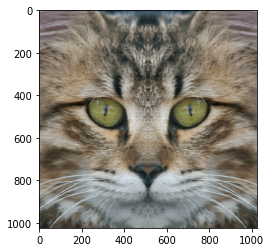

In [34]:
@torch.no_grad()
def create_image(resolution):
  # TODO: make xy coordinate
  x = []
  for i in range(resolution):
    for j in range(resolution):
      x.append([i, j])

  x = torch.tensor(x)
  rgb = []
  for i in range(resolution*resolution//(1024*1024)):
    batch = x[i*1024*1024:(i+1)*1024*1024].cuda()
    rgb.append(best_net(batch).detach().cpu())
  rgb = torch.cat(rgb, dim=0)
  rgb = rgb.reshape(resolution, resolution, 3)
  return rgb.numpy()

out_img = create_image(1024)
plt.imshow(out_img)
plt.show()